## Current Python Version

Ensure the python version running in the jupyter kernel is the same as expected

In [1]:
# from platform import python_version

# print(python_version())


List installed packages, should match the ones in the pipfile (and their dependencies)

In [2]:
# pip list

## Internal Module Imports
Code required to enable project's internally defined modulos into the jupyter notebook environment

In [3]:
import os
import sys
module_path = os.path.abspath(os.path.join('..'))
if module_path not in sys.path:
    sys.path.append(module_path)

In [4]:
# from electricity import ElectricalSystem, Load, Generator
from dto import (
    COST_PRESETS, 
    ElectricalSystemSpecs, 
    EpsilonSpecs,
    GeneratorSpecs, 
    LoadSpecs, 
    NodeStatePower, 
    SystemHistory, 
    )
    
from learning import ModelTrainer, ModelTester, LearningParams

/home/fmello/.local/share/virtualenvs/2019-MSc_Thesis-4pUnri4s/lib/python3.7/site-packages/tensorflow/python/framework/dtypes.py:516: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint8 = np.dtype([("qint8", np.int8, 1)])
/home/fmello/.local/share/virtualenvs/2019-MSc_Thesis-4pUnri4s/lib/python3.7/site-packages/tensorflow/python/framework/dtypes.py:517: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_quint8 = np.dtype([("quint8", np.uint8, 1)])
/home/fmello/.local/share/virtualenvs/2019-MSc_Thesis-4pUnri4s/lib/python3.7/site-packages/tensorflow/python/framework/dtypes.py:518: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint16 

Determine the experiment params

In [5]:
from dto import EpsilonSpecs, ElectricalConstants
import math

LearningParams(
    gamma=0.9,   # Gamma (Discount)
    tau=0.001, # Tau
    epsilonSpecs = EpsilonSpecs( # Epsilon explore/exploit control
        thresholdProgress = 0.6, # % of steps where decay change should happen
        thresholdValue = 0.5, # Value at which decay change would happen
        finalValue = 0.0001, # Value at the end of the experiment
    ),
    numEpisodes=2000, # Number of learning episodes to run
    maxSteps=100,   # Number of steps per learning episode
    bufferSize=500, # Experience Buffer Size
    traceLength=20,     # Number of steps each sampled episode should contain
    batchSize=10,     # Number of episodes sampled from experience buffer
    updateInterval=4, # Run update cycle every N steps
    electricalSystemSpecs = ElectricalSystemSpecs(
        loads=[LoadSpecs(id_="L1", basePower=3.0, noiseLevel=0.01)],
        generators=[
            GeneratorSpecs(id_="G1", basePower=2, costProfile=COST_PRESETS.COAL_OLD, minPower=0.5, maxPower=5.0, noiseLevel=0.01),
            GeneratorSpecs(id_="G2", basePower=2, costProfile=COST_PRESETS.OIL_OLD, minPower=0.5, maxPower=5.0, noiseLevel=0.01),
#             GeneratorSpecs(id_="G3", basePower=1.0, costProfile=COST_PRESETS.OIL_ALTERNATE_2, minPower=0.5, maxPower=5.0, noiseLevel=0.05),
        ],
        shouldTrackOptimalCost=True,
    ),
    modelName='Micro-2Gen-OriginalTest-C65-2k'
)

# Droop = +infinity essentially remove the droop component from the power update equation. System reacts as if droop is disabled
# ElectricalConstants().droop = math.inf

LearningParams(electricalSystemSpecs=ElectricalSystemSpecs(loads=[LoadSpecs(id_='L1', basePower=3.0, noiseLevel=0.01)], generators=[GeneratorSpecs(id_='G1', basePower=2, costProfile=CostProfile(alpha=0.0, beta=0, gamma=1), minPower=0.5, maxPower=5.0, noiseLevel=0.01), GeneratorSpecs(id_='G2', basePower=2, costProfile=CostProfile(alpha=0.0, beta=0, gamma=2), minPower=0.5, maxPower=5.0, noiseLevel=0.01)], shouldTrackOptimalCost=True), gamma=0.9, tau=0.001, epsilonSpecs=EpsilonSpecs(thresholdProgress=0.6, thresholdValue=0.5, finalValue=0.0001), numEpisodes=2000, maxSteps=100, bufferSize=500, traceLength=20, batchSize=10, updateInterval=4, nnShape=NeuralNetworkShape(layer_00_ltsm=100, layer_01_mlp_01=1000, layer_02_mlp_02=100, layer_03_mlp_03=50, layer_04_mlp_04=1), modelName='Micro-2Gen-OriginalTest-C65-2k')

Train Agents

In [6]:
def rewardFn(totalCost, outputDifferential):
    # Original cost
    scaledCost = totalCost/(10000*100.0)
    # New costs
#     scaledCost = totalCost/(100000.0) # Scale down cost to levels near the ones found in output differential (e.g. 0.1 */ 0.01) 
    costComponent = 2**(-1*(scaledCost**2)*200)
    outputComponent = 2**(-1*(outputDifferential**2)*500)
    earnedReward = costComponent*outputComponent
    
    print(f'Scaled_Cost:{scaledCost} - OutputDiff:{outputDifferential} - costComponent:{costComponent} - outputComponent:{outputComponent} - reward:{earnedReward}')

    return earnedReward, {'cost': costComponent, 'output': outputComponent, 'total':earnedReward}

In [7]:
from learning.cost import ModelAdapterCost as ModelAdapter
modelAdapter = ModelAdapter(rewardFn=rewardFn)

In [8]:
%%time
allAgents = ModelTrainer(modelAdapter).trainAgents()

W0919 23:05:51.048682 140542383032064 lazy_loader.py:50] 
The TensorFlow contrib module will not be included in TensorFlow 2.0.
For more information, please see:
  * https://github.com/tensorflow/community/blob/master/rfcs/20180907-contrib-sunset.md
  * https://github.com/tensorflow/addons
  * https://github.com/tensorflow/io (for I/O related ops)
If you depend on functionality not listed there, please file an issue.

W0919 23:05:51.050308 140542383032064 deprecation.py:323] From /mnt/c/Users/flavi/Documents/Study/City-UniLondon/Thesis/2019-MSc_Thesis/app/learning/actor.py:29: BasicLSTMCell.__init__ (from tensorflow.python.ops.rnn_cell_impl) is deprecated and will be removed in a future version.
Instructions for updating:
This class is equivalent as tf.keras.layers.LSTMCell, and will be replaced by that in Tensorflow 2.0.
W0919 23:05:51.066945 140542383032064 deprecation.py:323] From /mnt/c/Users/flavi/Documents/Study/City-UniLondon/Thesis/2019-MSc_Thesis/app/learning/actor.py:38: dyna

Training model: Micro-2Gen-OriginalTest-C65-2k - 0% Scaled_Cost:0.11596988230501153 - OutputDiff:0.012306118878246444 - costComponent:0.154984654237229 - outputComponent:0.9488682700447904 - reward:0.14706002074956948
Scaled_Cost:0.15653318452940382 - OutputDiff:0.1288058755210188 - costComponent:0.03348067508825246 - outputComponent:0.003182824259316608 - reward:0.00010656310488918716
Scaled_Cost:0.23595744343645966 - OutputDiff:0.2854225781554022 - costComponent:0.00044460659759742175 - outputComponent:5.471897375950397e-13 - reward:2.432841674723566e-16
Scaled_Cost:0.22106190820498064 - OutputDiff:0.29902238152681954 - costComponent:0.0011424340092043642 - outputComponent:3.4817219677233495e-14 - reward:3.977637586521094e-17
Scaled_Cost:0.29448549833775417 - OutputDiff:0.3594753270414478 - costComponent:6.009424445881426e-06 - outputComponent:3.548739122802622e-20 - reward:2.1325879636625883e-25
Scaled_Cost:0.34193457859860577 - OutputDiff:0.4752368363928972 - costComponent:9.136069

Scaled_Cost:0.6692505232577416 - OutputDiff:1.390720908786087 - costComponent:1.0813293361131947e-27 - outputComponent:7.731137194070246e-292 - reward:8.3599e-319
Scaled_Cost:0.6153058841075336 - OutputDiff:1.3136688082205248 - costComponent:1.606677060683909e-23 - outputComponent:1.7881104148966944e-260 - reward:2.872915985584506e-283
Scaled_Cost:0.6460828830581365 - OutputDiff:1.33867613121889 - costComponent:7.389681122480348e-26 - outputComponent:1.8579265547308647e-270 - reward:1.3729484788449622e-295
Scaled_Cost:0.5481349148524772 - OutputDiff:1.1979440056725201 - costComponent:8.146931775789228e-19 - outputComponent:1.0010736595051858e-216 - reward:8.155678806528405e-235
Scaled_Cost:0.6755793102359576 - OutputDiff:1.4089687451650366 - costComponent:3.323044869220879e-28 - outputComponent:1.5801241831546923e-299 - reward:0.0
Scaled_Cost:0.691956972437558 - OutputDiff:1.4396141196973349 - costComponent:1.4897026690329267e-29 - outputComponent:1.14643836046e-312 - reward:0.0
Scaled

Scaled_Cost:0.08995203396871386 - OutputDiff:-0.12996360593069212 - costComponent:0.325724990597059 - outputComponent:0.0028689341435888193 - reward:0.0009344835469440497
Scaled_Cost:0.09137741325908315 - OutputDiff:-0.1497351626843 - costComponent:0.31426067767319743 - outputComponent:0.0004220467771459881 - reward:0.00013263270619568715
Scaled_Cost:0.14226417844816308 - OutputDiff:0.07598490334318148 - costComponent:0.06046234339300653 - outputComponent:0.13519814216429388 - reward:0.008174396497634052
Scaled_Cost:0.1654074820219551 - OutputDiff:0.1068899260098289 - costComponent:0.022531278324687005 - outputComponent:0.019067663209961106 - reward:0.0004296188267850285
Scaled_Cost:0.15123600271658397 - OutputDiff:0.09353741370939761 - costComponent:0.04197093160420239 - outputComponent:0.04820665438736864 - reward:0.002023278194159672
Scaled_Cost:0.18399530678188195 - OutputDiff:0.23168132427600094 - costComponent:0.009157347059497974 - outputComponent:8.335304159473576e-09 - reward:

Scaled_Cost:0.04564744351289853 - OutputDiff:-0.344630734516337 - costComponent:0.7491165913739368 - outputComponent:1.3282568208459767e-18 - reward:9.950192221013199e-19
Scaled_Cost:0.06672299781412526 - OutputDiff:-0.2520510135393382 - costComponent:0.5394676344919241 - outputComponent:2.740471698613095e-10 - reward:1.4783957846428715e-10
Scaled_Cost:0.05734111414636894 - OutputDiff:-0.30132095266751674 - costComponent:0.6339317036278784 - outputComponent:2.1582097310078294e-14 - reward:1.3681575715640584e-14
Scaled_Cost:0.03572791337861969 - OutputDiff:-0.4353718604999272 - costComponent:0.8378147804696291 - outputComponent:2.951782239737615e-29 - reward:2.47304678917992e-29
Scaled_Cost:0.04842759198840032 - OutputDiff:-0.328238542214511 - costComponent:0.7224419968598168 - outputComponent:6.073412317447286e-17 - reward:4.3876881223696245e-17
Scaled_Cost:0.04645207646485729 - OutputDiff:-0.34094179864832597 - costComponent:0.7414600763141075 - outputComponent:3.1910930455861943e-18 

Scaled_Cost:0.03457008416964038 - OutputDiff:-0.5568113043654772 - costComponent:0.8473217786277818 - outputComponent:2.1602617451044884e-47 - reward:1.8304368241634908e-47
Scaled_Cost:0.04669501714942639 - OutputDiff:-0.4589952966072932 - costComponent:0.7391377044653328 - outputComponent:1.9498428901684722e-32 - reward:1.4412023979071746e-32
Scaled_Cost:0.16029155780952653 - OutputDiff:-0.017109640047327464 - costComponent:0.028385998467075894 - outputComponent:0.9035210441099293 - reward:0.025647346973075264
Scaled_Cost:0.10639109593157721 - OutputDiff:-0.12450215283832457 - costComponent:0.20822092178777027 - outputComponent:0.0046440749440515815 - reward:0.0009669935657019079
Scaled_Cost:0.1358429763630645 - OutputDiff:-0.05646985664688525 - costComponent:0.07744614048450524 - outputComponent:0.33115479315219964 - reward:0.025646660632582526
Scaled_Cost:0.20781607837799887 - OutputDiff:0.17917066248372177 - costComponent:0.002511030927996006 - outputComponent:1.4728161248980189e-0

Scaled_Cost:0.17562552352524619 - OutputDiff:-0.13631426705563893 - costComponent:0.013899098256763168 - outputComponent:0.0015965907780835056 - reward:2.2191172100424604e-05
Scaled_Cost:0.23763246073134514 - OutputDiff:-0.014209807194533172 - costComponent:0.00039830541706811144 - outputComponent:0.9324127838207346 - reward:0.0003713850627393565
Scaled_Cost:0.29347280851314933 - OutputDiff:0.08251130498577348 - costComponent:6.526505358045286e-06 - outputComponent:0.09446621565447959 - reward:6.165342626232225e-07
Scaled_Cost:0.31761270619847953 - OutputDiff:0.12142029584787935 - costComponent:8.444022579377463e-07 - outputComponent:0.00603912762903638 - reward:5.099453005932548e-09
Scaled_Cost:0.39183455539085377 - OutputDiff:0.23251875114490203 - costComponent:5.705752583480043e-10 - outputComponent:7.284692309016234e-09 - reward:4.1564651962026574e-18
Scaled_Cost:0.31962590447671313 - OutputDiff:0.22409519110267315 - costComponent:7.068249184757832e-07 - outputComponent:2.762735450

Scaled_Cost:0.2870038874210116 - OutputDiff:0.44669878945151453 - costComponent:1.098392892706171e-05 - outputComponent:9.252650472764946e-31 - reward:1.0163045517979409e-35
Scaled_Cost:0.43010996492856324 - OutputDiff:0.6768429255060334 - costComponent:7.281424667018603e-12 - outputComponent:1.1133179313628049e-69 - reward:8.106540647659252e-81
Scaled_Cost:0.41208245416224926 - OutputDiff:0.509010765984584 - costComponent:5.974505208239006e-11 - outputComponent:1.0064083216250357e-39 - reward:6.012791759163853e-50
Scaled_Cost:0.44645809382100055 - OutputDiff:0.606672320566363 - costComponent:9.987331969914952e-13 - outputComponent:4.0064404770668993e-56 - reward:4.001365106217155e-68
Scaled_Cost:0.48329660412328185 - OutputDiff:0.7119560474325238 - costComponent:8.65659648517855e-15 - outputComponent:5.090320759020741e-77 - reward:4.4064852790970355e-91
Scaled_Cost:0.5639126385033849 - OutputDiff:0.8750313779350858 - costComponent:7.155582057054608e-20 - outputComponent:5.671391781035

Scaled_Cost:0.01547074139250784 - OutputDiff:-0.6748829251520836 - costComponent:0.9673643201631554 - outputComponent:2.788631330612088e-69 - reward:2.697622451323238e-69
Scaled_Cost:0.0075 - OutputDiff:-0.7509288337201522 - costComponent:0.9922324190115005 - outputComponent:1.334992289400491e-85 - reward:1.3246226286735502e-85
Scaled_Cost:0.016580495993054715 - OutputDiff:-0.6074321775969431 - costComponent:0.9626060731602553 - outputComponent:2.9100584357269216e-56 - reward:2.801239923481967e-56
Scaled_Cost:0.020232385900982947 - OutputDiff:-0.568061898417595 - costComponent:0.9448322486184405 - outputComponent:2.6894598145398823e-49 - reward:2.541088364140651e-49
Scaled_Cost:0.013864200164328436 - OutputDiff:-0.6409642092497273 - costComponent:0.9737050913947219 - outputComponent:1.4559725069407997e-62 - reward:1.4176878429389938e-62
Scaled_Cost:0.011782737112681135 - OutputDiff:-0.7057782332099507 - costComponent:0.980937702225533 - outputComponent:1.0593283814803108e-75 - reward:1

Scaled_Cost:0.03063971176912246 - OutputDiff:-0.5785728950559499 - costComponent:0.8779688214156413 - outputComponent:4.1268339564530145e-51 - reward:3.623231544925101e-51
Scaled_Cost:0.046544250719857155 - OutputDiff:-0.5041377416384428 - costComponent:0.7405795128787915 - outputComponent:5.5703362918518026e-39 - reward:4.125276937590662e-39
Scaled_Cost:0.02389425411243543 - OutputDiff:-0.6165363968608489 - costComponent:0.9239027611499928 - outputComponent:6.118869694763699e-58 - reward:5.6532406061091954e-58
Scaled_Cost:0.035503912077336344 - OutputDiff:-0.5539707572020515 - costComponent:0.8396700563671454 - outputComponent:6.447860548371355e-47 - reward:5.414075430098468e-47
Scaled_Cost:0.03795684949789798 - OutputDiff:-0.49044659599341023 - costComponent:0.8189546760930532 - outputComponent:6.243728262026052e-37 - reward:5.113330456440587e-37
Scaled_Cost:0.039122612670428596 - OutputDiff:-0.48166600127181125 - costComponent:0.8088164448787101 - outputComponent:1.2028151382735254e

Scaled_Cost:0.008678231135222694 - OutputDiff:-0.7234537218771345 - costComponent:0.9896138940866368 - outputComponent:1.66980038502546e-79 - reward:1.652457661372411e-79
Scaled_Cost:0.009759627430456119 - OutputDiff:-0.7026052823628203 - costComponent:0.9868822977407754 - outputComponent:4.984731215963885e-75 - reward:4.919342996030608e-75
Scaled_Cost:0.015923211787233334 - OutputDiff:-0.6444271139327611 - costComponent:0.9654612528125932 - outputComponent:3.113025494647473e-63 - reward:3.0055054940998916e-63
Scaled_Cost:0.009953577640186333 - OutputDiff:-0.7090214828535156 - costComponent:0.986359356107724 - outputComponent:2.159659152588632e-76 - reward:2.130200011159476e-76
Scaled_Cost:0.008247350530266293 - OutputDiff:-0.7410533392856395 - costComponent:0.9906149108400272 - outputComponent:2.203819462010479e-83 - reward:2.1831364198670274e-83
Scaled_Cost:0.0075 - OutputDiff:-0.7500675814305674 - costComponent:0.9922324190115005 - outputComponent:2.0895607586816715e-85 - reward:2.0

Scaled_Cost:0.01953861233696311 - OutputDiff:-0.5877737159222692 - costComponent:0.948453221501206 - outputComponent:1.0008948161640408e-52 - reward:9.49301912774642e-53
Scaled_Cost:0.011312646898924169 - OutputDiff:-0.6788375886115086 - costComponent:0.9824152112706755 - outputComponent:4.361217030665831e-70 - reward:4.2845259505788406e-70
Scaled_Cost:0.008821799851112993 - OutputDiff:-0.722580094788158 - costComponent:0.9892692710981769 - outputComponent:2.587076659313082e-79 - reward:2.559315441033759e-79
Scaled_Cost:0.0075 - OutputDiff:-0.7519065011217068 - costComponent:0.9922324190115005 - outputComponent:8.02289516529997e-86 - reward:7.960576677341262e-86
Scaled_Cost:0.0075 - OutputDiff:-0.7519065011217068 - costComponent:0.9922324190115005 - outputComponent:8.02289516529997e-86 - reward:7.960576677341262e-86
Scaled_Cost:0.0075 - OutputDiff:-0.7519065011217068 - costComponent:0.9922324190115005 - outputComponent:8.02289516529997e-86 - reward:7.960576677341262e-86
Scaled_Cost:0.0

Scaled_Cost:0.09593566466444753 - OutputDiff:-0.08023290588278041 - costComponent:0.27918041625347895 - outputComponent:0.10742043744711195 - reward:0.029989682440615513
Scaled_Cost:0.09186230347247856 - OutputDiff:-0.10383182900344817 - costComponent:0.3104135500883534 - outputComponent:0.023839134073522332 - reward:0.007399990238794297
Scaled_Cost:0.05712690941793987 - OutputDiff:-0.30952308707324294 - costComponent:0.6360901908821704 - outputComponent:3.801715856190914e-15 - reward:2.4182341646442524e-15
Scaled_Cost:0.07193890926242129 - OutputDiff:-0.23407198567832227 - costComponent:0.48800189894680085 - outputComponent:5.66668738116133e-09 - reward:2.765354202744603e-09
Scaled_Cost:0.0723242362173469 - OutputDiff:-0.23222717495223333 - costComponent:0.4842557119592353 - outputComponent:7.634969854838601e-09 - reward:3.697277762842166e-09
Scaled_Cost:0.06396219027474924 - OutputDiff:-0.27352935795369526 - costComponent:0.5671363935060525 - outputComponent:5.479264723950288e-12 - r

Scaled_Cost:0.015887341563914695 - OutputDiff:-0.6155129777992963 - costComponent:0.9656139847846387 - outputComponent:9.472311884439721e-58 - reward:9.14659682385673e-58
Scaled_Cost:0.015400578784215654 - OutputDiff:-0.6753716667630082 - costComponent:0.9676548372324245 - outputComponent:2.2185151636951412e-69 - reward:2.1467569296230876e-69
Scaled_Cost:0.0075 - OutputDiff:-0.7508870141916004 - costComponent:0.9922324190115005 - outputComponent:1.3643691360466948e-85 - reward:1.353771288284243e-85
Scaled_Cost:0.0075 - OutputDiff:-0.7508870141916004 - costComponent:0.9922324190115005 - outputComponent:1.3643691360466948e-85 - reward:1.353771288284243e-85
Scaled_Cost:0.014425150264795728 - OutputDiff:-0.6400459759333882 - costComponent:0.9715653933547695 - outputComponent:2.1887637301779923e-62 - reward:2.1265270944710336e-62
Scaled_Cost:0.0075 - OutputDiff:-0.7508870141916004 - costComponent:0.9922324190115005 - outputComponent:1.3643691360466948e-85 - reward:1.353771288284243e-85
Scal

Scaled_Cost:0.07975908131104237 - OutputDiff:-0.19431611674117796 - costComponent:0.41399859871831296 - outputComponent:2.0736780952705944e-06 - reward:8.584998256348864e-07
Scaled_Cost:0.06164183924327727 - OutputDiff:-0.2825659092266869 - costComponent:0.590519551194713 - outputComponent:9.601891973490595e-13 - reward:5.670104938805783e-13
Scaled_Cost:0.04651359696073542 - OutputDiff:-0.3678786444547773 - costComponent:0.7408724333797614 - outputComponent:4.266761498538312e-21 - reward:3.1611259740731567e-21
Scaled_Cost:0.026845606369265567 - OutputDiff:-0.5015858963230142 - costComponent:0.9049203281202812 - outputComponent:1.355722503922158e-38 - reward:1.2268208530892885e-38
Scaled_Cost:0.023959327550899877 - OutputDiff:-0.5324326774242988 - costComponent:0.9235040061070724 - outputComponent:2.1444833065599067e-43 - reward:1.980438924637815e-43
Scaled_Cost:0.011705035760280143 - OutputDiff:-0.671459125447764 - costComponent:0.9811859139204356 - outputComponent:1.3778624554583612e-

Scaled_Cost:0.016878515815029256 - OutputDiff:-0.6119966896165386 - costComponent:0.9612763471029999 - outputComponent:4.2278592767689126e-57 - reward:4.0641411216379514e-57
Scaled_Cost:0.028184174388452294 - OutputDiff:-0.5208813948981016 - costComponent:0.8957266669262673 - outputComponent:1.454313315167356e-41 - reward:1.3026672184613458e-41
Scaled_Cost:0.028436539897756616 - OutputDiff:-0.5871841514308554 - costComponent:0.8939540853544214 - outputComponent:1.2724836226248028e-52 - reward:1.1375419329920365e-52
Scaled_Cost:0.02937490593852015 - OutputDiff:-0.5522347154001883 - costComponent:0.8872563995497261 - outputComponent:1.254490824081121e-46 - reward:1.1130550118423844e-46
Scaled_Cost:0.023229910680395965 - OutputDiff:-0.5472192426842983 - costComponent:0.9279212317736172 - outputComponent:8.4810481982713e-46 - reward:7.869744690871321e-46
Scaled_Cost:0.03263496206251135 - OutputDiff:-0.5668456031711021 - costComponent:0.8627364709425113 - outputComponent:4.339436558442493e-

Scaled_Cost:0.36599286329283987 - OutputDiff:0.48332728647337664 - costComponent:8.617071518285957e-09 - outputComponent:6.90087112712006e-36 - reward:5.946530004086818e-44
Scaled_Cost:0.39018758159072686 - OutputDiff:0.3931510980531738 - costComponent:6.821132009357102e-10 - outputComponent:5.435381605564247e-24 - reward:3.707545545278509e-33
Scaled_Cost:0.3126824385011453 - OutputDiff:0.1649813163455527 - costComponent:1.2990951477810955e-06 - outputComponent:8.001237240727259e-05 - reward:1.0394368475674183e-10
Scaled_Cost:0.18714176862914056 - OutputDiff:-0.09619848019332658 - costComponent:0.007788664482877413 - outputComponent:0.04046802366850787 - reward:0.0003151918586391498
Scaled_Cost:0.20712103351077857 - OutputDiff:-0.07260863242462076 - costComponent:0.002613457648073516 - outputComponent:0.16087290308435853 - reward:0.0004204345189336063
Scaled_Cost:0.20243213998604456 - OutputDiff:-0.0818510453449705 - costComponent:0.0034106105466052868 - outputComponent:0.0980868257311

Scaled_Cost:0.018979154305675944 - OutputDiff:-0.5792570024468398 - costComponent:0.9512908062180689 - outputComponent:3.136151811101047e-51 - reward:2.983392384804572e-51
Scaled_Cost:0.03679651621274829 - OutputDiff:-0.4192551093673227 - costComponent:0.8288616847044517 - outputComponent:3.493408120379822e-27 - reward:2.8955521400182312e-27
Scaled_Cost:0.03293804255957434 - OutputDiff:-0.4583871793681355 - costComponent:0.8603628106627699 - outputComponent:2.365747223042284e-32 - reward:2.035400930134302e-32
Scaled_Cost:0.0330022176887097 - OutputDiff:-0.45790863176326535 - costComponent:0.8598582340545504 - outputComponent:2.7540247307797617e-32 - reward:2.3680708415508445e-32
Scaled_Cost:0.044611304445294486 - OutputDiff:-0.3788734946943584 - costComponent:0.7588919009291686 - outputComponent:2.479167240582257e-22 - reward:1.8814199399267904e-22
Scaled_Cost:0.030586112674704936 - OutputDiff:-0.47632108668602036 - costComponent:0.878368329374302 - outputComponent:7.093976298754728e-3

Scaled_Cost:0.1110945246210239 - OutputDiff:-0.2907676118182137 - costComponent:0.18069159687509342 - outputComponent:1.8818650725725636e-13 - reward:3.400372050666001e-14
Scaled_Cost:0.1347390795919189 - OutputDiff:-0.23393083044634577 - costComponent:0.0807203413833739 - outputComponent:5.797922854048038e-09 - reward:4.680103120932232e-10
Scaled_Cost:0.13310470886628184 - OutputDiff:-0.2379064917826836 - costComponent:0.08577061619100669 - outputComponent:3.026401586551614e-09 - reward:2.595763289199722e-10
Scaled_Cost:0.11386688647584015 - OutputDiff:-0.2262526132039914 - costComponent:0.165725376192196 - outputComponent:1.9728787161480335e-08 - reward:3.269560674152095e-09
Scaled_Cost:0.06982163309370593 - OutputDiff:-0.41767626036157934 - costComponent:0.5087355829033569 - outputComponent:5.522529909653868e-27 - reward:2.809507472688983e-27
Scaled_Cost:0.05974326267408754 - OutputDiff:-0.4346952928963388 - costComponent:0.609690306166189 - outputComponent:3.6198148797715607e-29 - 

Scaled_Cost:0.09719663137426116 - OutputDiff:-0.11623516491881267 - costComponent:0.26991236405084634 - outputComponent:0.009256568700859377 - reward:0.002498462341048026
Scaled_Cost:0.04246000948003494 - OutputDiff:-0.39136435860281593 - costComponent:0.778856537620377 - outputComponent:8.83508298135052e-24 - reward:6.881262140443384e-24
Scaled_Cost:0.038519750268742436 - OutputDiff:-0.41750923563321773 - costComponent:0.8140818547810044 - outputComponent:5.796080541200285e-27 - reward:4.7184839974404155e-27
Scaled_Cost:0.061021656378163466 - OutputDiff:-0.24700909363518797 - costComponent:0.5967801647868447 - outputComponent:6.554722843804485e-10 - reward:3.911728578857736e-10
Scaled_Cost:0.08678508762617566 - OutputDiff:-0.10778019774128167 - costComponent:0.3520054602865322 - outputComponent:0.017845628067818035 - reward:0.006281758522114545
Scaled_Cost:0.10488972146752684 - OutputDiff:-0.022836047091299116 - costComponent:0.21758172097646347 - outputComponent:0.8346582286455676 - 

Scaled_Cost:0.024032701773177845 - OutputDiff:-0.525526727870943 - costComponent:0.9230532922961961 - outputComponent:2.69784812060863e-42 - reward:2.4902575898429012e-42
Scaled_Cost:0.06528504410236197 - OutputDiff:-0.21871840271959483 - costComponent:0.5538520716088153 - outputComponent:6.30525586154602e-08 - reward:3.492179020940889e-08
Scaled_Cost:0.07155289376464057 - OutputDiff:-0.23034348478104566 - costComponent:0.4917635393490098 - outputComponent:1.0326592404829487e-08 - reward:5.078241630413551e-09
Scaled_Cost:0.05685055758133932 - OutputDiff:-0.2810049097134014 - costComponent:0.6388737729956275 - outputComponent:1.3024766392957053e-12 - reward:8.321181647855123e-13
Scaled_Cost:0.032986409574532055 - OutputDiff:-0.45330433322763913 - costComponent:0.8599825889456988 - outputComponent:1.17883490172574e-31 - reward:1.0137774907256502e-31
Scaled_Cost:0.02115951610523944 - OutputDiff:-0.5573663792225643 - costComponent:0.9398190886070076 - outputComponent:1.743492448999984e-47 

Scaled_Cost:0.014707510494992724 - OutputDiff:-0.6291402490908595 - costComponent:0.9704580977607439 - outputComponent:2.6517764898058045e-60 - reward:2.573437967983604e-60
Scaled_Cost:0.022332620360995207 - OutputDiff:-0.5918454091162857 - costComponent:0.9331952140890216 - outputComponent:1.8943394631290764e-53 - reward:1.7677885208520207e-53
Scaled_Cost:0.014786770317886992 - OutputDiff:-0.6281379656381355 - costComponent:0.9701436469034279 - outputComponent:4.104008603131494e-60 - reward:3.9814778731650306e-60
Scaled_Cost:0.01704982417268101 - OutputDiff:-0.6010623691764677 - costComponent:0.9605021172324927 - outputComponent:4.1932225423096866e-55 - reward:4.0275991299154695e-55
Scaled_Cost:0.02715152482753989 - OutputDiff:-0.4977509237125809 - costComponent:0.9028504489139579 - outputComponent:5.116923190365269e-38 - reward:4.619816399479525e-38
Scaled_Cost:0.029492112943380045 - OutputDiff:-0.48164686726700084 - costComponent:0.8864081521728561 - outputComponent:1.21052338271828

Scaled_Cost:0.059999594508524816 - OutputDiff:-0.2895756225978153 - costComponent:0.607101537413694 - outputComponent:2.3917135838944253e-13 - reward:1.4520129938355215e-13
Scaled_Cost:0.07449729188121423 - OutputDiff:-0.1696350047775199 - costComponent:0.4633038899221958 - outputComponent:4.664178659656042e-05 - reward:2.1609321163107376e-05
Scaled_Cost:0.07032228225438861 - OutputDiff:-0.23698463318335264 - costComponent:0.5038112783155562 - outputComponent:3.5222435545522482e-09 - reward:1.7745460277576965e-09
Scaled_Cost:0.06056777517262748 - OutputDiff:-0.2865586972159214 - costComponent:0.6013633797030244 - outputComponent:4.368450849631551e-13 - reward:2.627026367000978e-13
Scaled_Cost:0.05320538817913392 - OutputDiff:-0.3083114011551304 - costComponent:0.6754108842771076 - outputComponent:4.927860383909567e-15 - reward:3.328330539490488e-15
Scaled_Cost:0.05992504301943187 - OutputDiff:-0.28997263036235854 - costComponent:0.6078544606353082 - outputComponent:2.2084008383297341e-

Scaled_Cost:0.04460334669669313 - OutputDiff:-0.4058362554482983 - costComponent:0.7589665944864015 - outputComponent:1.6207586291306238e-25 - reward:1.230101657235718e-25
Scaled_Cost:0.04507146762748902 - OutputDiff:-0.38955073262553913 - costComponent:0.7545626321805806 - outputComponent:1.4433883723537735e-23 - reward:1.0891269295021073e-23
Scaled_Cost:0.014947325246604045 - OutputDiff:-0.6424217528954662 - costComponent:0.9695018077989678 - outputComponent:7.613794763209784e-63 - reward:7.381587787142199e-63
Scaled_Cost:0.03835044090816861 - OutputDiff:-0.5404794833333756 - costComponent:0.8155519799296758 - outputComponent:1.0760911028128933e-44 - reward:8.776082294837635e-45
Scaled_Cost:0.017981424346945836 - OutputDiff:-0.6035345674838702 - costComponent:0.9561664402812039 - outputComponent:1.4938736633811852e-55 - reward:1.4283918629450293e-55
Scaled_Cost:0.015245553795098008 - OutputDiff:-0.6581890756850486 - costComponent:0.9682923609391912 - outputComponent:6.236880371034685

Scaled_Cost:0.019478087312332686 - OutputDiff:-0.5915471239595869 - costComponent:0.9487637689514135 - outputComponent:2.1408579845217935e-53 - reward:2.0311684901846235e-53
Scaled_Cost:0.021696047211995036 - OutputDiff:-0.6280217267704965 - costComponent:0.9368281338193694 - outputComponent:4.3170357659422033e-60 - reward:4.0443205602391063e-60
Scaled_Cost:0.045604135117698064 - OutputDiff:-0.5081901842730313 - costComponent:0.7495271132655886 - outputComponent:1.3440287554683032e-39 - reward:1.007385993232099e-39
Scaled_Cost:0.06094440805114052 - OutputDiff:-0.4478684003860675 - costComponent:0.5975601414004579 - outputComponent:6.438474524329406e-31 - reward:3.847375747161526e-31
Scaled_Cost:0.09389485977912637 - OutputDiff:-0.34085182068431946 - costComponent:0.2945840167767759 - outputComponent:3.2596653877872263e-18 - reward:9.60245323282588e-19
Scaled_Cost:0.09345733675069653 - OutputDiff:-0.3421320096986904 - costComponent:0.29795063793623233 - outputComponent:2.407523161838559

Scaled_Cost:0.007837733610653557 - OutputDiff:-0.7423997817663325 - costComponent:0.9915201428385468 - outputComponent:1.1029091008298965e-83 - reward:1.0935565891927922e-83
Scaled_Cost:0.0075 - OutputDiff:-0.7505575045249823 - costComponent:0.9922324190115005 - outputComponent:1.6195626372569334e-85 - reward:1.6069825533060924e-85
Scaled_Cost:0.01182419833109004 - OutputDiff:-0.6692175341726789 - costComponent:0.9808046111015455 - outputComponent:3.9042797539742595e-68 - reward:3.829335585728361e-68
Scaled_Cost:0.008237545774544048 - OutputDiff:-0.7333473801260862 - costComponent:0.9906371075281865 - outputComponent:1.130519374660956e-81 - reward:1.1199344433187035e-81
Scaled_Cost:0.0075 - OutputDiff:-0.7505575045249823 - costComponent:0.9922324190115005 - outputComponent:1.6195626372569334e-85 - reward:1.6069825533060924e-85
Scaled_Cost:0.024014772840904544 - OutputDiff:-0.5313123583207929 - costComponent:0.9231635307611646 - outputComponent:3.241130315438773e-43 - reward:2.992093305

Scaled_Cost:0.07578777512300175 - OutputDiff:-0.187358137792238 - costComponent:0.45101353299668295 - outputComponent:5.20548530228235e-06 - reward:2.3477443171446687e-06
Scaled_Cost:0.07371666413298811 - OutputDiff:-0.19001770641655338 - costComponent:0.4707949289100219 - outputComponent:3.6761718080939028e-06 - reward:1.7307230450525955e-06
Scaled_Cost:0.09494169741760804 - OutputDiff:-0.0607694488430967 - costComponent:0.2866207212791425 - outputComponent:0.27807328297666284 - reward:0.0797015649352302
Scaled_Cost:0.11258463636026414 - OutputDiff:0.005249321351240758 - costComponent:0.17253248536393873 - outputComponent:0.9904954909769818 - reward:0.1708926488000334
Scaled_Cost:0.07706666800826363 - OutputDiff:-0.15286075715819478 - costComponent:0.4389552384139834 - outputComponent:0.0003040917844487668 - reward:0.00013348268174244207
Scaled_Cost:0.04097351208970462 - OutputDiff:-0.3820622648586257 - costComponent:0.7923634625837367 - outputComponent:1.0692735434481498e-22 - reward

Scaled_Cost:0.02171436608300545 - OutputDiff:-0.6106298416316616 - costComponent:0.9367248614674056 - outputComponent:7.544888931852394e-57 - reward:7.067485039476396e-57
Scaled_Cost:0.013450126109713073 - OutputDiff:-0.6786202662322384 - costComponent:0.9752329808141831 - outputComponent:4.8307050607840977e-70 - reward:4.711062895862635e-70
Scaled_Cost:0.0075 - OutputDiff:-0.7499235520287942 - costComponent:0.9922324190115005 - outputComponent:2.2520223129941636e-85 - reward:2.2345295472900735e-85
Scaled_Cost:0.013676966674810364 - OutputDiff:-0.6563692966810853 - costComponent:0.974401403594585 - outputComponent:1.4289935007351555e-65 - reward:1.3924132728438752e-65
Scaled_Cost:0.026810954543973316 - OutputDiff:-0.5056355668062772 - costComponent:0.9051536044760341 - outputComponent:3.297865339277471e-39 - reward:2.985074698923582e-39
Scaled_Cost:0.044609822727385576 - OutputDiff:-0.3555239609341811 - costComponent:0.7589058091824175 - outputComponent:9.447407568900059e-20 - reward:7

Scaled_Cost:0.0668368941839257 - OutputDiff:-0.3642853895542207 - costComponent:0.5383311881207072 - outputComponent:1.06189371681771e-20 - reward:5.7165050623239164e-21
Scaled_Cost:0.04295643721150872 - OutputDiff:-0.507481269813083 - costComponent:0.7742916023223623 - outputComponent:1.724975767545613e-39 - reward:1.3356342510201395e-39
Scaled_Cost:0.06884640892133359 - OutputDiff:-0.41948472008783516 - costComponent:0.5183629088088864 - outputComponent:3.2678536368093886e-27 - reward:1.693934116738213e-27
Scaled_Cost:0.049606133814898846 - OutputDiff:-0.49116923941982366 - costComponent:0.710962956407234 - outputComponent:4.882867516020768e-37 - reward:3.471537924934972e-37
Scaled_Cost:0.06144488599242407 - OutputDiff:-0.34297933599327207 - costComponent:0.5925074491170004 - outputComponent:1.968768184207206e-18 - reward:1.1665098147273203e-18
Scaled_Cost:0.0752718817692998 - OutputDiff:-0.1855978971858391 - costComponent:0.45591246617780307 - outputComponent:6.535414995939379e-06 -

Scaled_Cost:0.03948213125034324 - OutputDiff:-0.4093493344290102 - costComponent:0.8056539844695164 - outputComponent:6.007195717351444e-26 - reward:4.839721165172406e-26
Scaled_Cost:0.029841745058059442 - OutputDiff:-0.4797206203874888 - costComponent:0.883862618974541 - outputComponent:2.299860743351668e-35 - reward:2.0327609398955402e-35
Scaled_Cost:0.03375293609166311 - OutputDiff:-0.4497631115771343 - costComponent:0.8539052261937925 - outputComponent:3.5710359895380873e-31 - reward:3.049326294392694e-31
Scaled_Cost:0.02133069416524456 - OutputDiff:-0.5544524429273903 - costComponent:0.9388719407820005 - outputComponent:5.358631933775049e-47 - reward:5.031069163599784e-47
Scaled_Cost:0.016139651573067047 - OutputDiff:-0.6102037916102602 - costComponent:0.9645328834134482 - outputComponent:9.035270295453878e-57 - reward:8.714815310494008e-57
Scaled_Cost:0.02294471126547131 - OutputDiff:-0.6031006614405272 - costComponent:0.9296167990768895 - outputComponent:1.7910943092923942e-55 -

Scaled_Cost:0.04772342619391558 - OutputDiff:-0.49071773341226044 - costComponent:0.7292548183428097 - outputComponent:5.69380296088551e-37 - reward:4.152233243920314e-37
Scaled_Cost:0.029972022245347216 - OutputDiff:-0.5809932811712452 - costComponent:0.882908340338379 - outputComponent:1.5602059242451778e-51 - reward:1.3775188231614166e-51
Scaled_Cost:0.0121401412232201 - OutputDiff:-0.7007154120669562 - costComponent:0.9797756851793102 - outputComponent:1.249745790466332e-74 - reward:1.224470538154109e-74
Scaled_Cost:0.012290716797940004 - OutputDiff:-0.6655974453250049 - costComponent:0.9792761516676423 - outputComponent:2.083779676678994e-67 - reward:2.040595742701449e-67
Scaled_Cost:0.042950897773079665 - OutputDiff:-0.3694139806803983 - costComponent:0.7743426846075486 - outputComponent:2.882150019547966e-21 - reward:2.2317717835784706e-21
Scaled_Cost:0.02621926639104612 - OutputDiff:-0.509653153421332 - costComponent:0.909099439714083 - outputComponent:8.021963485807628e-40 - r

Scaled_Cost:0.060757697447335904 - OutputDiff:-0.35471254035325944 - costComponent:0.5994454756863705 - outputComponent:1.153598073919701e-19 - reward:6.91519146171676e-20
Scaled_Cost:0.05954628848673549 - OutputDiff:-0.34678864280310207 - costComponent:0.6116795315370188 - outputComponent:7.919736409423602e-19 - reward:4.8443406568129e-19
Scaled_Cost:0.03895826816015153 - OutputDiff:-0.5391087550220225 - costComponent:0.8102565416573866 - outputComponent:1.797150591987625e-44 - reward:1.4561530235014182e-44
Scaled_Cost:0.027217790546633328 - OutputDiff:-0.5985083413011151 - costComponent:0.902399626392918 - outputComponent:1.2125126681266432e-54 - reward:1.0941709787141631e-54
Scaled_Cost:0.03576307951246638 - OutputDiff:-0.46269358853405607 - costComponent:0.837522833649451 - outputComponent:5.983330255215316e-33 - reward:5.011175710008425e-33
Scaled_Cost:0.03609756988896858 - OutputDiff:-0.43954687971197337 - costComponent:0.8347366900136635 - outputComponent:8.323054674831852e-30 -

Scaled_Cost:0.016507149870855393 - OutputDiff:-0.6082215906471478 - costComponent:0.9629299800143919 - outputComponent:2.0866977530624534e-56 - reward:2.0093438256525047e-56
Scaled_Cost:0.012869404939720337 - OutputDiff:-0.6544606458725281 - costComponent:0.9773015489322272 - outputComponent:3.400996849791707e-65 - reward:3.3237994892150605e-65
Scaled_Cost:0.0152223419645587 - OutputDiff:-0.6295533181160622 - costComponent:0.9683872978518029 - outputComponent:2.2145222887799314e-60 - reward:2.1445152552641876e-60
Scaled_Cost:0.010462780138174504 - OutputDiff:-0.7182611728682693 - costComponent:0.9849388388857755 - outputComponent:2.235868245702728e-78 - reward:2.202193473824021e-78
Scaled_Cost:0.0075 - OutputDiff:-0.7508902135536528 - costComponent:0.9922324190115005 - outputComponent:1.3620990897523522e-85 - reward:1.3515188747583395e-85
Scaled_Cost:0.012374711893407272 - OutputDiff:-0.661519230967003 - costComponent:0.9789949351241779 - outputComponent:1.3598125529578504e-66 - reward

Scaled_Cost:0.1675332071876395 - OutputDiff:0.12617742923378958 - costComponent:0.02042563723034407 - outputComponent:0.004015034712042758 - reward:8.200964249542434e-05
Scaled_Cost:0.18260596735347312 - OutputDiff:0.2456305767526868 - costComponent:0.0098273090191839 - outputComponent:8.294130983681671e-10 - reward:8.150898822222752e-12
Scaled_Cost:0.15933302572589647 - OutputDiff:0.10272204827469733 - costComponent:0.02961757603773133 - outputComponent:0.02581029424900099 - reward:0.0007644383524760066
Scaled_Cost:0.15501857193168997 - OutputDiff:0.08683236784136539 - costComponent:0.035744088452202026 - outputComponent:0.07330573839140415 - reward:0.002620246797116332
Scaled_Cost:0.19810568445885593 - OutputDiff:0.2163499548102024 - costComponent:0.0043367426741109895 - outputComponent:9.011537587527514e-08 - reward:3.908071961518576e-10
Scaled_Cost:0.2411772255154762 - OutputDiff:0.33201792529744006 - costComponent:0.0003147969489373595 - outputComponent:2.5576631200993856e-17 - re

Scaled_Cost:0.5080040903674499 - OutputDiff:1.121785021528553 - costComponent:2.9023436527261375e-16 - outputComponent:3.905536559566058e-190 - reward:1.1335209244146424e-205
Scaled_Cost:0.5250443583486574 - OutputDiff:1.1642090787673247 - costComponent:2.5288158210623707e-17 - outputComponent:9.875610314716771e-205 - reward:2.497359960650251e-221
Scaled_Cost:0.462328831943586 - OutputDiff:1.0523478094765886 - costComponent:1.352356451272612e-13 - outputComponent:2.0619877917825133e-167 - reward:2.788542492662449e-180
Scaled_Cost:0.4539534509028088 - OutputDiff:1.0362167265502906 - costComponent:3.9185451396348437e-13 - outputComponent:2.4280517665230636e-162 - reward:9.514430448490748e-175
Scaled_Cost:0.45216841537299324 - OutputDiff:1.0257659517165263 - costComponent:4.903493826081649e-13 - outputComponent:4.253567170317455e-159 - reward:2.0857340358475233e-171
Scaled_Cost:0.3824001855405585 - OutputDiff:0.8526199154888686 - costComponent:1.5706616970149117e-09 - outputComponent:3.81

Scaled_Cost:0.16334548673301935 - OutputDiff:0.23478692080919938 - costComponent:0.024751339141116695 - outputComponent:5.045173076829428e-09 - reward:1.2487478985023638e-10
Scaled_Cost:0.21846901876109776 - OutputDiff:0.43405461682927976 - costComponent:0.0013379663689906177 - outputComponent:4.389965361303151e-29 - reward:5.873626014457362e-32
Scaled_Cost:0.24733245850279725 - OutputDiff:0.5256436496100213 - costComponent:0.0002074902252857591 - outputComponent:2.5853449722813825e-42 - reward:5.3643381074006865e-46
Scaled_Cost:0.2823167126285625 - OutputDiff:0.6297521247079693 - costComponent:1.590075455190031e-05 - outputComponent:2.0304737921447356e-60 - reward:3.228606539295969e-65
Scaled_Cost:0.20767575513151137 - OutputDiff:0.39817308809622537 - costComponent:0.002531408663307681 - outputComponent:1.371134630717375e-24 - reward:3.470902082759141e-27
Scaled_Cost:0.14583794009272805 - OutputDiff:0.14219676093782255 - costComponent:0.0524199230433793 - outputComponent:0.00090489661

Scaled_Cost:0.49676013110653705 - OutputDiff:1.1171403434305895 - costComponent:1.3897215538375714e-15 - outputComponent:1.435156809553176e-188 - reward:1.9944683513728112e-203
Scaled_Cost:0.4347308814116197 - OutputDiff:1.0076980298498004 - costComponent:4.184192678715599e-12 - outputComponent:1.4412682101618772e-153 - reward:6.030543893024861e-165
Scaled_Cost:0.4198749371137027 - OutputDiff:0.9826375488175519 - costComponent:2.432123486066502e-11 - outputComponent:4.637109132858409e-146 - reward:1.1278022029478408e-156
Scaled_Cost:0.3626297114460903 - OutputDiff:0.8470293926350106 - costComponent:1.2102987737180659e-08 - outputComponent:1.0272862599852872e-108 - reward:1.2433233007176113e-116
Scaled_Cost:0.2996068432551427 - OutputDiff:0.6470810609964068 - costComponent:3.94142265596659e-06 - outputComponent:9.490264670991503e-64 - reward:3.7405144185365224e-69
Scaled_Cost:0.25340038459797576 - OutputDiff:0.45247719516139834 - costComponent:0.00013616551698742202 - outputComponent:1.

Scaled_Cost:0.2622645556421789 - OutputDiff:0.5110773244659016 - costComponent:7.22551813296418e-05 - outputComponent:4.847053491100015e-40 - reward:3.5022472891390494e-44
Scaled_Cost:0.26016318099583535 - OutputDiff:0.5207682300009738 - costComponent:8.413256476688799e-05 - outputComponent:1.5149573736961853e-41 - reward:1.2745724936156883e-45
Scaled_Cost:0.2605928624066535 - OutputDiff:0.5603335035010729 - costComponent:8.156286693487121e-05 - outputComponent:5.524067627639157e-48 - reward:4.505587928523623e-52
Scaled_Cost:0.3039924696625098 - OutputDiff:0.6869228154754354 - costComponent:2.730725404004058e-06 - outputComponent:9.496169073674484e-72 - reward:2.5931430130200595e-77
Scaled_Cost:0.19999406968651284 - OutputDiff:0.36523776237363215 - costComponent:0.003907534748456149 - outputComponent:8.346541148105613e-21 - reward:3.261439956564176e-23
Scaled_Cost:0.17424390806443082 - OutputDiff:0.21263356939026684 - costComponent:0.01486241223106544 - outputComponent:1.56588606876993

Scaled_Cost:0.255 - OutputDiff:0.3759527082213829 - costComponent:0.00012164798130223005 - outputComponent:5.322849139978915e-22 - reward:6.475138526547464e-26
Scaled_Cost:0.255 - OutputDiff:0.3759527082213829 - costComponent:0.00012164798130223005 - outputComponent:5.322849139978915e-22 - reward:6.475138526547464e-26
Scaled_Cost:0.2279420069277418 - OutputDiff:0.318808868117534 - costComponent:0.0007444632718512882 - outputComponent:5.032594378843938e-16 - reward:3.74658167717456e-19
Scaled_Cost:0.21933512573360728 - OutputDiff:0.3084603722443177 - costComponent:0.001269451087636257 - outputComponent:4.7734117946218115e-15 - reward:6.059612794418396e-18
Scaled_Cost:0.255 - OutputDiff:0.3759527082213829 - costComponent:0.00012164798130223005 - outputComponent:5.322849139978915e-22 - reward:6.475138526547464e-26
Scaled_Cost:0.24181640168131616 - OutputDiff:0.3425241992460738 - costComponent:0.00030160868137701853 - outputComponent:2.1935873756716895e-18 - reward:6.616049958616129e-22
Sc

Scaled_Cost:0.11557171095982592 - OutputDiff:0.034978094033219595 - costComponent:0.1569781780318662 - outputComponent:0.6544098954920026 - reward:0.10272807308035853
Scaled_Cost:0.13728207677624524 - OutputDiff:0.12475021978152853 - costComponent:0.07333909528391942 - outputComponent:0.004545615376577241 - reward:0.00033337131922684754
Scaled_Cost:0.13677365939701885 - OutputDiff:0.12596866460970849 - costComponent:0.07476947529685046 - outputComponent:0.004088954623507924 - reward:0.0003057289917123182
Scaled_Cost:0.15621731287465523 - OutputDiff:0.20187101954953604 - costComponent:0.03394234924784194 - outputComponent:7.348971706645771e-07 - reward:2.4944136427947977e-08
Scaled_Cost:0.18770007823805035 - OutputDiff:0.30909831558983347 - costComponent:0.007565945638089988 - outputComponent:4.164193397042879e-15 - reward:3.15060608685197e-17
Scaled_Cost:0.16753801650561354 - OutputDiff:0.21811735368142704 - costComponent:0.020421074727105644 - outputComponent:6.905925499466326e-08 - r

Scaled_Cost:0.08779712160926037 - OutputDiff:-0.0984503938047486 - costComponent:0.3434883533168764 - outputComponent:0.03476453203648786 - reward:0.01194121186304501
Scaled_Cost:0.06594794911986694 - OutputDiff:-0.21798932210258187 - costComponent:0.5472126934862184 - outputComponent:7.040864037583714e-08 - reward:3.852850174476435e-08
Scaled_Cost:0.14105449073631393 - OutputDiff:0.13720248256320777 - costComponent:0.06340437176576705 - outputComponent:0.0014676659854306984 - reward:9.305643976821884e-05
Scaled_Cost:0.16951599004647028 - OutputDiff:0.24992074621196794 - costComponent:0.018618308571606863 - outputComponent:3.969868598305651e-10 - reward:7.391223855198703e-12
Scaled_Cost:0.2027395812512554 - OutputDiff:0.3704778582122618 - costComponent:0.003352219744227284 - outputComponent:2.194007229912505e-21 - reward:7.354794355090109e-24
Scaled_Cost:0.17986862426384878 - OutputDiff:0.28264614036939445 - costComponent:0.011276440888211713 - outputComponent:9.45216557001927e-13 - re

Scaled_Cost:0.05440137383658533 - OutputDiff:-0.3132336848836056 - costComponent:0.6634676853378223 - outputComponent:1.706748815257638e-15 - reward:1.1323726859120555e-15
Scaled_Cost:0.07106167338331566 - OutputDiff:-0.2255530016874468 - costComponent:0.4965626705875082 - outputComponent:2.2012858104868887e-08 - reward:1.093076360781757e-08
Scaled_Cost:0.0727550601786987 - OutputDiff:-0.21729617628585102 - costComponent:0.4800778382212147 - outputComponent:7.816976197855174e-08 - reward:3.752757034493002e-08
Scaled_Cost:0.06388343103668208 - OutputDiff:-0.26178909324510014 - costComponent:0.5679285910307371 - outputComponent:4.838112688492561e-11 - reward:2.7477025224235116e-11
Scaled_Cost:0.07659132478959062 - OutputDiff:-0.19896436786409138 - costComponent:0.44342247278607166 - outputComponent:1.1004996829127415e-06 - reward:4.879862906974557e-07
Scaled_Cost:0.09592309456686333 - OutputDiff:-0.09140136917853073 - costComponent:0.279273770330353 - outputComponent:0.05527974826414105 

Scaled_Cost:0.255 - OutputDiff:0.3873343454691648 - costComponent:0.00012164798130223005 - outputComponent:2.6215109871056677e-23 - reward:3.189015195430209e-27
Scaled_Cost:0.2645511010866987 - OutputDiff:0.47636800984074873 - costComponent:6.114283543292703e-05 - outputComponent:6.984916751545403e-35 - reward:4.270776154524358e-39
Scaled_Cost:0.280518007887094 - OutputDiff:0.5728016278806862 - costComponent:1.82965282534742e-05 - outputComponent:4.1283128167978764e-50 - reward:7.5533792091722e-55
Scaled_Cost:0.26489959110160793 - OutputDiff:0.47892918122112493 - costComponent:5.9598738795408044e-05 - outputComponent:2.991570388504728e-35 - reward:1.7829382217257064e-39
Scaled_Cost:0.292878867859276 - OutputDiff:0.6305519875163429 - costComponent:6.849327392451511e-06 - outputComponent:1.4317515971649503e-60 - reward:9.806535433648095e-66
Scaled_Cost:0.3339476388801927 - OutputDiff:0.7844763464312908 - costComponent:1.9309242404837376e-07 - outputComponent:2.3582943012959364e-93 - rewa

Scaled_Cost:0.14383388952343723 - OutputDiff:0.14023481197967827 - costComponent:0.056812903458594126 - outputComponent:0.0010964826919631044 - reward:6.229436532251925e-05
Scaled_Cost:0.13380442595049874 - OutputDiff:0.09609908104383687 - costComponent:0.0835784676986931 - outputComponent:0.040736993262599185 - reward:0.0034047354755400248
Scaled_Cost:0.18048322357016977 - OutputDiff:0.2957223061711532 - costComponent:0.01093548640156792 - outputComponent:6.874010926024229e-14 - reward:7.517065300576726e-16
Scaled_Cost:0.2123051024754449 - OutputDiff:0.397852307669947 - costComponent:0.0019333367877007721 - outputComponent:1.4980075739931494e-24 - reward:2.8961531510553423e-27
Scaled_Cost:0.2216276498369163 - OutputDiff:0.4357696804067342 - costComponent:0.0011034499932183995 - outputComponent:2.617714158777391e-29 - reward:2.8885166707506207e-32
Scaled_Cost:0.29446401880823636 - OutputDiff:0.6357161815232142 - costComponent:6.019972492485327e-06 - outputComponent:1.4846080152082716e-

Scaled_Cost:0.2650723521424384 - OutputDiff:0.5564431043467111 - costComponent:5.884705022571686e-05 - outputComponent:2.490018174022626e-47 - reward:1.4653022454965726e-51
Scaled_Cost:0.29358262697738924 - OutputDiff:0.6127572968988926 - costComponent:6.468435421108109e-06 - outputComponent:3.0613096012062166e-57 - reward:1.980188345942063e-62
Scaled_Cost:0.2517493625773877 - OutputDiff:0.48210528152025456 - costComponent:0.00015285503425477794 - outputComponent:1.0386662012322817e-35 - reward:1.587653577686405e-39
Scaled_Cost:0.2671347882625368 - OutputDiff:0.5386524502982745 - costComponent:5.0540553157821144e-05 - outputComponent:2.1311100107282857e-44 - reward:1.0770747878237771e-48
Scaled_Cost:0.23220083429657717 - OutputDiff:0.39873401034382794 - costComponent:0.0005673609629450087 - outputComponent:1.1743551489661576e-24 - reward:6.662832681568683e-28
Scaled_Cost:0.19276587466794337 - OutputDiff:0.20360495382696556 - costComponent:0.005791944576979957 - outputComponent:5.759757

Scaled_Cost:0.1864716210447417 - OutputDiff:0.19682090759773918 - costComponent:0.008063751575729411 - outputComponent:1.4766559578068321e-06 - reward:1.1907386806575065e-08
Scaled_Cost:0.2040460186919491 - OutputDiff:0.27613699081157483 - costComponent:0.00311412906012099 - outputComponent:3.334148336624434e-12 - reward:1.038296822583621e-14
Scaled_Cost:0.18916418351734968 - OutputDiff:0.2047378280313033 - costComponent:0.00700879593253501 - outputComponent:4.906545200502348e-07 - reward:3.438897404408003e-09
Scaled_Cost:0.21476831649129333 - OutputDiff:0.2822280566058039 - costComponent:0.0016709844767126524 - outputComponent:1.025835334890644e-12 - reward:1.714154920265591e-15
Scaled_Cost:0.24626862258644389 - OutputDiff:0.3607473254953997 - costComponent:0.00022315799360794262 - outputComponent:2.5833542158182384e-20 - reward:5.764961435806181e-24
Scaled_Cost:0.23024402804016958 - OutputDiff:0.3190285718720444 - costComponent:0.0006431921905819866 - outputComponent:4.79401586328834

Scaled_Cost:0.3128685585291891 - OutputDiff:0.7197500542235711 - costComponent:1.2782956838340062e-06 - outputComponent:1.0646071227820291e-78 - reward:1.3608826900312077e-84
Scaled_Cost:0.2853410459946785 - OutputDiff:0.6441646256442388 - costComponent:1.253305366491491e-05 - outputComponent:3.500200370701154e-63 - reward:4.386819908395263e-68
Scaled_Cost:0.2898744973900121 - OutputDiff:0.6499276267585389 - costComponent:8.730859720927767e-06 - outputComponent:2.6398172555794025e-64 - reward:2.3047874147348286e-69
Scaled_Cost:0.20258033469967507 - OutputDiff:0.3798229470386356 - costComponent:0.003382349831384926 - outputComponent:1.93144760140713e-22 - reward:6.532831468948226e-25
Scaled_Cost:0.2155977450768272 - OutputDiff:0.4039712988613914 - costComponent:0.0015903086000132588 - outputComponent:2.735486091322485e-25 - reward:4.350267056246802e-28
Scaled_Cost:0.20162554337363406 - OutputDiff:0.24064596663433035 - costComponent:0.0035682392141226727 - outputComponent:1.9213391804764

Scaled_Cost:0.20677315597607446 - OutputDiff:0.35433076097995514 - costComponent:0.00266614764961258 - outputComponent:1.2670642784239534e-19 - reward:3.378180447828083e-22
Scaled_Cost:0.2998665609510769 - OutputDiff:0.6603655306348594 - costComponent:3.85726347407606e-06 - outputComponent:2.3068708502133634e-66 - reward:8.898208669938792e-72
Scaled_Cost:0.28850490224046305 - OutputDiff:0.6304591119281979 - costComponent:9.744261470258117e-06 - outputComponent:1.491061523419381e-60 - reward:1.4529293352439846e-65
Scaled_Cost:0.27530370145435074 - OutputDiff:0.5393513921946005 - costComponent:2.7343821183001016e-05 - outputComponent:1.6413399123726767e-44 - reward:4.4880505064441025e-49
Scaled_Cost:0.28995083951606376 - OutputDiff:0.6118703002532453 - costComponent:8.67744732301401e-06 - outputComponent:4.460697273687103e-57 - reward:3.870746561633204e-62
Scaled_Cost:0.30512574710163914 - OutputDiff:0.6739144928762818 - costComponent:2.4815203066257567e-06 - outputComponent:4.3852731037

Scaled_Cost:0.255 - OutputDiff:0.38231884996191645 - costComponent:0.00012164798130223005 - outputComponent:9.990069150710279e-23 - reward:1.2152717452535892e-26
Scaled_Cost:0.255 - OutputDiff:0.38231884996191645 - costComponent:0.00012164798130223005 - outputComponent:9.990069150710279e-23 - reward:1.2152717452535892e-26
Scaled_Cost:0.255 - OutputDiff:0.38231884996191645 - costComponent:0.00012164798130223005 - outputComponent:9.990069150710279e-23 - reward:1.2152717452535892e-26
Scaled_Cost:0.2668516932075798 - OutputDiff:0.4873560075196931 - costComponent:5.161088039851987e-05 - outputComponent:1.7795005554617883e-36 - reward:9.184159033703804e-41
Scaled_Cost:0.2636183182989471 - OutputDiff:0.46404563536643734 - costComponent:6.546468830792088e-05 - outputComponent:3.8756848948595543e-33 - reward:2.5372050362169782e-37
Scaled_Cost:0.29136033034421566 - OutputDiff:0.618082122343684 - costComponent:7.745724291565957e-06 - outputComponent:3.1581386775957926e-58 - reward:2.4462071471187

Scaled_Cost:0.09407223644422864 - OutputDiff:-0.132696444066853 - costComponent:0.2932255792286065 - outputComponent:0.002237071163423349 - reward:0.000655966487670424
Scaled_Cost:0.10575812850555281 - OutputDiff:-0.08546828100181549 - costComponent:0.2121333937578267 - outputComponent:0.07952688489905098 - reward:0.016870307988623743
Scaled_Cost:0.09329613036559223 - OutputDiff:-0.12941413545564057 - costComponent:0.2991967505171785 - outputComponent:0.003014199812217766 - reward:0.0009018387892250452
Scaled_Cost:0.09350049669062255 - OutputDiff:-0.13508440281644163 - costComponent:0.2976175327508563 - outputComponent:0.001792392186484975 - reward:0.0005334473402635709
Scaled_Cost:0.10066847223651573 - OutputDiff:-0.10568174599174138 - costComponent:0.2453939761099914 - outputComponent:0.020842675336991495 - reward:0.005114666973713998
Scaled_Cost:0.09909612089591144 - OutputDiff:-0.11203449559351972 - costComponent:0.2563153463453342 - outputComponent:0.012905554130865428 - reward:0.

Scaled_Cost:0.2889447995188825 - OutputDiff:0.5918462617194524 - costComponent:9.407094098088903e-06 - outputComponent:1.8936769982544713e-53 - reward:1.7813997713966346e-58
Scaled_Cost:0.3066394588606466 - OutputDiff:0.6633839332547096 - costComponent:2.182553507261279e-06 - outputComponent:5.7759606244847926e-67 - reward:1.260634311877233e-72
Scaled_Cost:0.24694381845763066 - OutputDiff:0.49603916375453627 - costComponent:0.0002130899399599742 - outputComponent:9.226871830947035e-38 - reward:1.9661535644748808e-41
Scaled_Cost:0.34270701487180283 - OutputDiff:0.7845879158655247 - costComponent:8.490238908511214e-08 - outputComponent:2.2194680849156214e-93 - reward:1.8843814290749481e-100
Scaled_Cost:0.27331022824425183 - OutputDiff:0.5927391298665341 - costComponent:3.182023084237255e-05 - outputComponent:1.3125305397465261e-53 - reward:4.17650247623983e-58
Scaled_Cost:0.2775401927409582 - OutputDiff:0.6055118097707215 - costComponent:2.3036615229007568e-05 - outputComponent:6.5237316

Scaled_Cost:0.21414411373359593 - OutputDiff:0.3823078399817011 - costComponent:0.001734168392874497 - outputComponent:1.0019259121665851e-22 - reward:1.7375082488812413e-25
Scaled_Cost:0.24413933381103395 - OutputDiff:0.4393221352649055 - costComponent:0.00025791747351251894 - outputComponent:8.912768165793013e-30 - reward:2.2987586473241416e-33
Scaled_Cost:0.2679500889766006 - OutputDiff:0.5487719577489423 - costComponent:4.7574564099923947e-05 - outputComponent:4.702283622306185e-46 - reward:2.2370909360542814e-50
Scaled_Cost:0.2875223962857877 - OutputDiff:0.6170467759834468 - costComponent:1.0539561182703573e-05 - outputComponent:4.9193497431224204e-58 - reward:5.184778759675586e-63
Scaled_Cost:0.25919105485863025 - OutputDiff:0.4240358158467042 - costComponent:9.02320454770668e-05 - outputComponent:8.638615406910771e-28 - reward:7.794799382552626e-32
Scaled_Cost:0.25528600957595243 - OutputDiff:0.38295387092168465 - costComponent:0.00011921146919824351 - outputComponent:8.4415770

Scaled_Cost:0.2565078573877315 - OutputDiff:0.3970817495865109 - costComponent:0.00010931233444901102 - outputComponent:1.8522981670578733e-24 - reward:2.0247903673672035e-28
Scaled_Cost:0.255 - OutputDiff:0.37941713992126475 - costComponent:0.00012164798130223005 - outputComponent:2.149103634704475e-22 - reward:2.6143411877108465e-26
Scaled_Cost:0.24342159221711543 - OutputDiff:0.3967915541254072 - costComponent:0.00027073812644474494 - outputComponent:2.0062558023055215e-24 - reward:5.431699370850955e-28
Scaled_Cost:0.241666404052971 - OutputDiff:0.3455178735880294 - costComponent:0.0003046562230823503 - outputComponent:1.0743061799138859e-18 - reward:3.272940632065924e-22
Scaled_Cost:0.2597912486713231 - OutputDiff:0.42949935780820425 - costComponent:8.641860227924479e-05 - outputComponent:1.7161045849609552e-28 - reward:1.4830335959732924e-32
Scaled_Cost:0.2007712014375159 - OutputDiff:0.23510601827931238 - costComponent:0.0037424141440656226 - outputComponent:4.7896921713960255e-0

Scaled_Cost:0.12016976192785742 - OutputDiff:-0.029181737965413488 - costComponent:0.13507622432296867 - outputComponent:0.7444325714329083 - reward:0.10055514101219593
Scaled_Cost:0.13933482340351488 - OutputDiff:0.0830160170914135 - costComponent:0.06778742115429523 - outputComponent:0.09177025668604205 - reward:0.00622086903941451
Scaled_Cost:0.14931982435191615 - OutputDiff:0.07186725267945876 - costComponent:0.04545926003686163 - outputComponent:0.1669570588523232 - reward:0.007589744353357372
Scaled_Cost:0.20022939439428805 - OutputDiff:0.27084932878324963 - costComponent:0.0038568477831689807 - outputComponent:9.084818471343855e-12 - reward:3.5038761981695155e-14
Scaled_Cost:0.1672212187459759 - OutputDiff:0.1608211840774368 - costComponent:0.020723518804003378 - outputComponent:0.00012798597770549445 - reward:2.6523198156285713e-06
Scaled_Cost:0.2024786833895447 - OutputDiff:0.2650275541829758 - costComponent:0.0034017116140411313 - outputComponent:2.6784656710378506e-11 - rewa

Scaled_Cost:0.08206719369908015 - OutputDiff:-0.13163429445038569 - costComponent:0.39310732280957245 - outputComponent:0.0024656884947856683 - reward:0.0009692802030675585
Scaled_Cost:0.05273919466738377 - OutputDiff:-0.30089088085718085 - costComponent:0.680051292074112 - outputComponent:2.3608923118000053e-14 - reward:1.6055278670874307e-14
Scaled_Cost:0.03680637530496974 - OutputDiff:-0.4306653402536978 - costComponent:0.8287783074707917 - outputComponent:1.2122346695773693e-28 - reward:1.0046737977097466e-28
Scaled_Cost:0.038075664778834194 - OutputDiff:-0.41760774179611815 - costComponent:0.8179296968789729 - outputComponent:5.6331643284873896e-27 - reward:4.607532391669133e-27
Scaled_Cost:0.05692027528444807 - OutputDiff:-0.2716264627369851 - costComponent:0.6381716620004625 - outputComponent:7.849874065077563e-12 - reward:5.009567178604875e-12
Scaled_Cost:0.0850716773229604 - OutputDiff:-0.11004077559740723 - costComponent:0.3666719837238239 - outputComponent:0.0150458962022839

Scaled_Cost:0.3874959352963739 - OutputDiff:0.9192695502523203 - costComponent:9.117643333938936e-10 - outputComponent:6.402090784250358e-128 - reward:5.837198036229217e-137
Scaled_Cost:0.33650984100958115 - OutputDiff:0.7827393277344714 - costComponent:1.5217401684161189e-07 - outputComponent:6.058183315054023e-93 - reward:9.21898089814603e-100
Scaled_Cost:0.31166153783662687 - OutputDiff:0.7011758690803157 - costComponent:1.4191093253103655e-06 - outputComponent:9.992235133392513e-75 - reward:1.418007405849118e-80
Scaled_Cost:0.2765596965855801 - OutputDiff:0.6106594948287472 - costComponent:2.483865955959524e-05 - outputComponent:7.450783260832704e-57 - reward:1.8506746886815444e-61
Scaled_Cost:0.29812573022007516 - OutputDiff:0.649643974703326 - costComponent:4.456089982320822e-06 - outputComponent:2.9995605170674596e-64 - reward:1.3366311571469373e-69
Scaled_Cost:0.2186429645517989 - OutputDiff:0.39888641117732204 - costComponent:0.0013239375711902085 - outputComponent:1.125908639

Scaled_Cost:0.26414568841744873 - OutputDiff:0.47080580080471446 - costComponent:6.298688795360701e-05 - outputComponent:4.336419086592742e-34 - reward:2.731375431270999e-38
Scaled_Cost:0.2578889886044823 - OutputDiff:0.4171834928632599 - costComponent:9.905943454510801e-05 - outputComponent:6.368816049303441e-27 - reward:6.308913165658076e-31
Scaled_Cost:0.255 - OutputDiff:0.3849390665507801 - costComponent:0.00012164798130223005 - outputComponent:4.9770942385617604e-23 - reward:6.054534668719979e-27
Scaled_Cost:0.2669113856349653 - OutputDiff:0.49058433671255214 - costComponent:5.1383420041435335e-05 - outputComponent:5.958064727892916e-37 - reward:3.0614574254738187e-41
Scaled_Cost:0.2678467983717988 - OutputDiff:0.49690193561067936 - costComponent:4.7940966517131606e-05 - outputComponent:6.856635350721332e-38 - reward:3.287137257691123e-42
Scaled_Cost:0.25965615570023876 - OutputDiff:0.4348842031772639 - costComponent:8.726339697689878e-05 - outputComponent:3.419486432450311e-29 - 

Scaled_Cost:0.2735832669799632 - OutputDiff:0.5657179436284876 - costComponent:3.116830456658595e-05 - outputComponent:6.755585340407061e-49 - reward:2.105601414153705e-53
Scaled_Cost:0.25937196955959413 - OutputDiff:0.5006840911181039 - costComponent:8.906612053747188e-05 - outputComponent:1.8544457403795674e-38 - reward:1.6516828784284784e-42
Scaled_Cost:0.2917617081753003 - OutputDiff:0.6073608405606917 - costComponent:7.498435914868202e-06 - outputComponent:2.998784791139596e-56 - reward:2.2486195578841684e-61
Scaled_Cost:0.26107875111858614 - OutputDiff:0.49123868343277627 - costComponent:7.874659906877735e-05 - outputComponent:4.768770852454364e-37 - reward:3.755244863690954e-41
Scaled_Cost:0.2723381514036572 - OutputDiff:0.5105497927130125 - costComponent:3.4248165978006344e-05 - outputComponent:5.842469816908837e-40 - reward:2.000938760109862e-44
Scaled_Cost:0.26549628637539185 - OutputDiff:0.4665057291608476 - costComponent:5.704043004010926e-05 - outputComponent:1.75300421057

Scaled_Cost:0.34866601006474995 - OutputDiff:0.7997757337842333 - costComponent:4.7959859894567535e-08 - outputComponent:5.301545629910379e-97 - reward:2.5426138563515856e-104
Scaled_Cost:0.3631868806217669 - OutputDiff:0.8352656591368909 - costComponent:1.1443137824192035e-08 - outputComponent:9.781240131501544e-106 - reward:1.119280789162904e-113
Scaled_Cost:0.3964227050448359 - OutputDiff:0.902259809133886 - costComponent:3.4559653043715076e-10 - outputComponent:2.950120905480648e-123 - reward:1.0195515493042176e-132
Scaled_Cost:0.34501112049700333 - OutputDiff:0.7886451773794318 - costComponent:6.81583355922643e-08 - outputComponent:2.4294555175846415e-94 - reward:1.6558764447401217e-101
Scaled_Cost:0.3258141020624896 - OutputDiff:0.7286294368258182 - costComponent:4.0629591055780864e-07 - outputComponent:1.2344081450355908e-80 - reward:5.015349812872109e-87
Scaled_Cost:0.27175190216947176 - OutputDiff:0.5769750001983005 - costComponent:3.579656632074912e-05 - outputComponent:7.825

Scaled_Cost:0.19394116920580406 - OutputDiff:0.30811892531284657 - costComponent:0.005438274077909405 - outputComponent:5.134719102588779e-15 - reward:2.79240097929548e-17
Scaled_Cost:0.2648427397850296 - OutputDiff:0.4946205146541226 - costComponent:5.984808608100475e-05 - outputComponent:1.5017167827272137e-37 - reward:8.98748752819478e-42
Scaled_Cost:0.27970704765735543 - OutputDiff:0.5621687336973142 - costComponent:1.948594599603471e-05 - outputComponent:2.7051451018885963e-48 - reward:5.2712311366838995e-53
Scaled_Cost:0.25651512108031 - OutputDiff:0.42417811874797834 - costComponent:0.00010925587888811484 - outputComponent:8.284694188987662e-28 - reward:9.051515449371048e-32
Scaled_Cost:0.2591321472841705 - OutputDiff:0.5103578526191919 - costComponent:9.061478870396788e-05 - outputComponent:6.2530277965088616e-40 - reward:5.666167925406884e-44
Scaled_Cost:0.2275092854598581 - OutputDiff:0.310548399770974 - costComponent:0.0007650835931293941 - outputComponent:3.049910956465874e

Scaled_Cost:0.2553904933267632 - OutputDiff:0.38642895304342684 - costComponent:0.00011833292644672704 - outputComponent:3.3419225693858375e-23 - reward:3.9545947759379136e-27
Scaled_Cost:0.255 - OutputDiff:0.3816164937225126 - costComponent:0.00012164798130223005 - outputComponent:1.2031728745130742e-22 - reward:1.4636355134211683e-26
Scaled_Cost:0.2534297236535361 - OutputDiff:0.37766569883761203 - costComponent:0.00013588511339094074 - outputComponent:3.4028134184770604e-22 - reward:4.6239168721797003e-26
Scaled_Cost:0.2614285121013027 - OutputDiff:0.4745109514729369 - costComponent:7.677662201687342e-05 - outputComponent:1.2880902615363616e-34 - reward:9.889521913359285e-39
Scaled_Cost:0.21263617610309668 - OutputDiff:0.274286825177766 - costComponent:0.00189599558804973 - outputComponent:4.745321733842805e-12 - reward:8.997109071242454e-15
Scaled_Cost:0.23023821582264076 - OutputDiff:0.3683230501054384 - costComponent:0.0006434308791058741 - outputComponent:3.80937779206071e-21 - 

Scaled_Cost:0.16072105710094592 - OutputDiff:0.13021010930577578 - costComponent:0.027848595138934656 - outputComponent:0.0028058696763423176 - reward:7.813952862907082e-05
Scaled_Cost:0.19442977347870766 - OutputDiff:0.2791678522116627 - costComponent:0.005297078620679326 - outputComponent:1.860631407109705e-12 - reward:9.85591084756531e-15
Scaled_Cost:0.2377116767111936 - OutputDiff:0.4216110532491086 - costComponent:0.00039623165188230734 - outputComponent:1.7582234730944455e-27 - reward:6.966637911224597e-31
Scaled_Cost:0.2552548475512561 - OutputDiff:0.36906220535770246 - costComponent:0.000119474683012709 - outputComponent:3.153675632034263e-21 - reward:3.7678439646219825e-25
Scaled_Cost:0.255 - OutputDiff:0.3659369366787034 - costComponent:0.00012164798130223005 - outputComponent:6.99134088437665e-21 - reward:8.504825051801673e-25
Scaled_Cost:0.2681727197954419 - OutputDiff:0.47849610013942095 - costComponent:4.6793850438335114e-05 - outputComponent:3.453895411301579e-35 - rewar

Scaled_Cost:0.24929838431985155 - OutputDiff:0.3516951810444525 - costComponent:0.00018122418421250317 - outputComponent:2.41476637611908e-19 - reward:4.376140665759629e-23
Scaled_Cost:0.2822327635609616 - OutputDiff:0.5570447072092802 - costComponent:1.6005568369839183e-05 - outputComponent:1.9741307495782764e-47 - reward:3.159708468337698e-52
Scaled_Cost:0.28741454579004333 - OutputDiff:0.5814433728166963 - costComponent:1.0630550056017763e-05 - outputComponent:1.3014635826385623e-51 - reward:1.3835273761323446e-56
Scaled_Cost:0.22469220613609583 - OutputDiff:0.3971561835795658 - costComponent:0.0009128607975238865 - outputComponent:1.814732871842475e-24 - reward:1.656598496682935e-27
Scaled_Cost:0.19252189947246803 - OutputDiff:0.23645270500034934 - costComponent:0.005867914822823203 - outputComponent:3.8434769142973296e-09 - reward:2.2553195156584086e-11
Scaled_Cost:0.2255121617986088 - OutputDiff:0.3738071965337868 - costComponent:0.0008673205879124129 - outputComponent:9.29534232

Scaled_Cost:0.26572390797805506 - OutputDiff:0.4847756084563255 - costComponent:5.6092248675560095e-05 - outputComponent:4.244857545816179e-36 - reward:2.3810360505224883e-40
Scaled_Cost:0.18507586258973197 - OutputDiff:0.24674952522758115 - costComponent:0.008664817131241762 - outputComponent:6.852435525709633e-10 - reward:5.9375100733898476e-12
Scaled_Cost:0.1979104996537501 - OutputDiff:0.26740241185818353 - costComponent:0.004383463120099672 - outputComponent:1.728096892349337e-11 - reward:7.575048995572172e-14
Scaled_Cost:0.16990369068176814 - OutputDiff:0.13201104343658832 - costComponent:0.018281739747739355 - outputComponent:0.002382252755014358 - reward:4.355172488050757e-05
Scaled_Cost:0.20859448841897998 - OutputDiff:0.3270714831747134 - costComponent:0.002400695065086441 - outputComponent:7.916704817584349e-17 - reward:1.90055941873208e-19
Scaled_Cost:0.21916478255116542 - OutputDiff:0.30215125872184245 - costComponent:0.0012826645365608099 - outputComponent:1.8141600688257

Scaled_Cost:0.22957218376496197 - OutputDiff:0.36043038276126116 - costComponent:0.0006713359346957421 - outputComponent:2.796323920048963e-20 - reward:1.8772727325781323e-23
Scaled_Cost:0.26329862511085106 - OutputDiff:0.44340601527114626 - costComponent:6.701143387091707e-05 - outputComponent:2.5551281630002815e-30 - reward:1.7122280192661118e-34
Scaled_Cost:0.2554502835275102 - OutputDiff:0.37058229413561317 - costComponent:0.00011783294083083042 - outputComponent:2.135940751975704e-21 - reward:2.5168418024571256e-25
Scaled_Cost:0.2895407508484079 - OutputDiff:0.5900040654389276 - costComponent:8.968080877425086e-06 - outputComponent:4.0272370989627745e-53 - reward:3.6116588016064934e-58
Scaled_Cost:0.2837031968944335 - OutputDiff:0.5874715329559794 - costComponent:1.4261637988556756e-05 - outputComponent:1.131988983003522e-52 - reward:1.6144017082630758e-57
Scaled_Cost:0.30556436926400243 - OutputDiff:0.6547172506644332 - costComponent:2.3910624592689628e-06 - outputComponent:3.027

Scaled_Cost:0.2689157550939764 - OutputDiff:0.5609754702526195 - costComponent:4.4275352923101454e-05 - outputComponent:4.3043919171548726e-48 - reward:1.9057847125137725e-52
Scaled_Cost:0.2365331877071944 - OutputDiff:0.46417527062926367 - costComponent:0.0004281518627455604 - outputComponent:3.717380071447716e-33 - reward:1.591603202123564e-36
Scaled_Cost:0.2770889084321929 - OutputDiff:0.5996871886526777 - costComponent:2.3849976409098023e-05 - outputComponent:7.431652799085274e-55 - reward:1.7724474393879107e-59
Scaled_Cost:0.2863125049219633 - OutputDiff:0.6238630907960871 - costComponent:1.1604387522448925e-05 - outputComponent:2.6229304793246373e-59 - reward:3.04375017265258e-64
Scaled_Cost:0.29102426190967995 - OutputDiff:0.6191424748049105 - costComponent:7.958763825679094e-06 - outputComponent:2.0043402685536857e-58 - reward:1.5952070823716994e-63
Scaled_Cost:0.309487410939129 - OutputDiff:0.6852848200706131 - costComponent:1.7112814591669962e-06 - outputComponent:2.069457222

Scaled_Cost:0.23696116563441322 - OutputDiff:0.4240369817097226 - costComponent:0.0004162913483689247 - outputComponent:8.635655719420149e-28 - reward:3.59494876348723e-31
Scaled_Cost:0.20811672330801093 - OutputDiff:0.31505124209868307 - costComponent:0.002467876467663738 - outputComponent:1.148920401054607e-15 - reward:2.8353936209814484e-18
Scaled_Cost:0.1924587082695456 - OutputDiff:0.3056113260417149 - costComponent:0.00588773772635625 - outputComponent:8.753015473309262e-15 - reward:5.153545942158295e-17
Scaled_Cost:0.19494935579845143 - OutputDiff:0.2939380897892844 - costComponent:0.005150576851135784 - outputComponent:9.898384016669646e-14 - reward:5.098238757991111e-16
Scaled_Cost:0.2254063680230516 - OutputDiff:0.37414066139016433 - costComponent:0.0008730753867498756 - outputComponent:8.525596841785919e-22 - reward:7.443488759915758e-25
Scaled_Cost:0.22721806321442112 - OutputDiff:0.3588828703702223 - costComponent:0.0007792589012133785 - outputComponent:4.1127534127771615e

Scaled_Cost:0.10823164629347276 - OutputDiff:0.009703656746577551 - costComponent:0.19712493004102863 - outputComponent:0.9678930339003037 - reward:0.19079584659479631
Scaled_Cost:0.18655585514918488 - OutputDiff:0.2521995896955631 - costComponent:0.008028702558959913 - outputComponent:2.6702307660852986e-10 - reward:2.1438488584682528e-12
Scaled_Cost:0.1271464965138006 - OutputDiff:0.052582406392231655 - costComponent:0.10633980896101242 - outputComponent:0.3835656067879675 - reward:0.040788293349847266
Scaled_Cost:0.12289883645436174 - OutputDiff:0.05888286469076025 - costComponent:0.12320862855779822 - outputComponent:0.30070153193471955 - reward:0.037049023354905765
Scaled_Cost:0.15422742794033933 - OutputDiff:0.1743009161604954 - costComponent:0.036977207671720524 - outputComponent:2.6744380525789447e-05 - reward:9.889325127536346e-07
Scaled_Cost:0.1454090529271107 - OutputDiff:0.1442758245348105 - costComponent:0.053335557212633 - outputComponent:0.0007361274688336884 - reward:3.

Scaled_Cost:0.22185184690796145 - OutputDiff:0.42778976993474904 - costComponent:0.0010883449495033741 - outputComponent:2.8519388063977262e-28 - reward:3.1038931962356466e-31
Scaled_Cost:0.16932812137018013 - OutputDiff:0.2618779680072061 - costComponent:0.01878334039969782 - outputComponent:4.76070086126261e-11 - reward:8.942186481823018e-13
Scaled_Cost:0.20610627675503992 - OutputDiff:0.369890284164431 - costComponent:0.002769882583466184 - outputComponent:2.5510281750766372e-21 - reward:7.0660485120763e-24
Scaled_Cost:0.2599084681210465 - OutputDiff:0.5657332134500778 - costComponent:8.569185686258217e-05 - outputComponent:6.715255301179769e-49 - reward:5.754426960643929e-53
Scaled_Cost:0.2869019477252757 - OutputDiff:0.643009968908861 - costComponent:1.1073374628453134e-05 - outputComponent:5.858616111605852e-63 - reward:6.4874651008102996e-68
Scaled_Cost:0.2678250075816643 - OutputDiff:0.5893716460414334 - costComponent:4.801860650161651e-05 - outputComponent:5.215192299842776e-5

Scaled_Cost:0.17960574551648925 - OutputDiff:0.2144507834457508 - costComponent:0.011425136686200524 - outputComponent:1.1965887496832647e-07 - reward:1.3671190022301083e-09
Scaled_Cost:0.16289542055122486 - OutputDiff:0.15630695832713642 - costComponent:0.025260314170010224 - outputComponent:0.00021020249140528226 - reward:5.309780972216304e-06
Scaled_Cost:0.15613924081098537 - OutputDiff:0.17620640151160363 - costComponent:0.034057291034725476 - outputComponent:2.1218056369607135e-05 - reward:7.226295209709208e-07
Scaled_Cost:0.08958636348461188 - OutputDiff:-0.08405656832348163 - costComponent:0.32870303799663636 - outputComponent:0.08640428438151583 - reward:0.02840135077212957
Scaled_Cost:0.07899035910050449 - OutputDiff:-0.13761131767900786 - costComponent:0.421062013913073 - outputComponent:0.0014116152371911903 - reward:0.0005943775546421029
Scaled_Cost:0.06683503480484025 - OutputDiff:-0.2173963296425668 - costComponent:0.5383497371265066 - outputComponent:7.699915897733198e-0

Scaled_Cost:0.25977676771540165 - OutputDiff:0.43010236710843297 - costComponent:8.650878614445546e-05 - outputComponent:1.4339190299286282e-28 - reward:1.2404659470856074e-32
Scaled_Cost:0.2666580160816111 - OutputDiff:0.4836673041866519 - costComponent:5.2355495085649854e-05 - outputComponent:6.157654179521744e-36 - reward:3.2238703313508194e-40
Scaled_Cost:0.2585441919505809 - OutputDiff:0.4186706576267097 - costComponent:9.452006596503414e-05 - outputComponent:4.139621270569842e-27 - reward:3.9127727556451997e-31
Scaled_Cost:0.26250558297062737 - OutputDiff:0.453081728981281 - costComponent:7.099927320323811e-05 - outputComponent:1.2642172217453634e-31 - reward:8.975850391493772e-36
Scaled_Cost:0.26727138815062373 - OutputDiff:0.49823255035457653 - costComponent:5.003166587307729e-05 - outputComponent:4.3331929812806553e-38 - reward:2.1679686340299737e-42
Scaled_Cost:0.2676905698034814 - OutputDiff:0.49065820006456323 - costComponent:4.850025195794602e-05 - outputComponent:5.810268

Scaled_Cost:0.11003423799483358 - OutputDiff:-0.06378805533350936 - costComponent:0.18666111113814063 - outputComponent:0.24409962745385613 - reward:0.045563907688942966
Scaled_Cost:0.11251340805069367 - OutputDiff:-0.054271740613815136 - costComponent:0.17291639891002836 - outputComponent:0.36030462735353214 - reward:0.06230257867259248
Scaled_Cost:0.1179924690016734 - OutputDiff:0.007548721169148948 - costComponent:0.1451438603553652 - outputComponent:0.9804448623042551 - reward:0.14230555218042407
Scaled_Cost:0.11258446252833046 - OutputDiff:-0.054000623680261865 - costComponent:0.17253342155796256 - outputComponent:0.36398889002853657 - reward:0.06280024860570838
Scaled_Cost:0.09224151714191414 - OutputDiff:-0.12240748913027912 - costComponent:0.30742374431513686 - outputComponent:0.005555772741065153 - reward:0.0017079764586222207
Scaled_Cost:0.09970388331485487 - OutputDiff:-0.05058000250693423 - costComponent:0.25205790930586136 - outputComponent:0.4120329656238077 - reward:0.10

Scaled_Cost:0.30138622187409725 - OutputDiff:0.6524693980174816 - costComponent:3.3983574841051865e-06 - outputComponent:8.381267811842938e-65 - reward:2.8482544194666347e-70
Scaled_Cost:0.24474858494506632 - OutputDiff:0.4797957680966669 - costComponent:0.00024748454138694614 - outputComponent:2.2430997519257973e-35 - reward:5.551325133905286e-39
Scaled_Cost:0.29905257382774303 - OutputDiff:0.6432546775311698 - costComponent:4.1269620923450174e-06 - outputComponent:5.253139494465157e-63 - reward:2.167950755945817e-68
Scaled_Cost:0.2448202979409379 - OutputDiff:0.5031678332979539 - costComponent:0.00024628294458293266 - outputComponent:7.815084475027338e-39 - reward:1.9247220166740954e-42
Scaled_Cost:0.24029356717367267 - OutputDiff:0.5008788744854489 - costComponent:0.0003339223582941799 - outputComponent:1.7332072215171022e-38 - reward:5.787566428214939e-42
Scaled_Cost:0.20666884107420402 - OutputDiff:0.39272074041585253 - costComponent:0.0026821358480880724 - outputComponent:6.11132

Scaled_Cost:0.10068669377155044 - OutputDiff:-0.11803271870645035 - costComponent:0.2452691927579535 - outputComponent:0.007999572711372235 - reward:0.0019620487413268216
Scaled_Cost:0.12458972832234934 - OutputDiff:-0.05838338946456327 - costComponent:0.11626428725824792 - outputComponent:0.30686795785808124 - reward:0.035677784402763875
Scaled_Cost:0.2031732425037171 - OutputDiff:0.2729250002523578 - costComponent:0.0032714063936843426 - outputComponent:6.143706332495563e-12 - reward:2.009856017704497e-14
Scaled_Cost:0.33505424295865943 - OutputDiff:0.6025649378536175 - costComponent:1.7425831755724824e-07 - outputComponent:2.2404570244205452e-55 - reward:3.904182716348429e-62
Scaled_Cost:0.31194104511339904 - OutputDiff:0.5369536493791455 - costComponent:1.3852299102498776e-06 - outputComponent:4.0145141103478326e-44 - reward:5.5610250207739955e-50
Scaled_Cost:0.19366029750571911 - OutputDiff:0.27544020774424066 - costComponent:0.005520971365673102 - outputComponent:3.80918700886822

Scaled_Cost:0.31926981949404243 - OutputDiff:0.7174083117567672 - costComponent:7.294722696811526e-07 - outputComponent:3.417753887737611e-78 - reward:2.4931566856995383e-84
Scaled_Cost:0.27129196561252894 - OutputDiff:0.5098358431475544 - costComponent:3.7057725956619554e-05 - outputComponent:7.520509038602455e-40 - reward:2.7869296300681016e-44
Scaled_Cost:0.2560757993366914 - OutputDiff:0.4794332818751885 - costComponent:0.00011272045797715119 - outputComponent:2.5303683859316824e-35 - reward:2.8522428331312408e-39
Scaled_Cost:0.2876837434402095 - OutputDiff:0.5951583167684941 - costComponent:1.0404828794028418e-05 - outputComponent:4.8480551634418115e-54 - reward:5.04431839596175e-59
Scaled_Cost:0.25991912973765113 - OutputDiff:0.49951938564828774 - costComponent:8.562604403080687e-05 - outputComponent:2.7768693224021064e-38 - reward:2.377723348677996e-42
Scaled_Cost:0.2706419828370742 - OutputDiff:0.5058631477419165 - costComponent:3.891223642816859e-05 - outputComponent:3.0449817

Scaled_Cost:0.21134163941207534 - OutputDiff:0.25930408811169203 - costComponent:0.002045887158175915 - outputComponent:7.578456198588516e-11 - reward:1.550466621549091e-13
Scaled_Cost:0.20975407372885127 - OutputDiff:0.2549315651796822 - costComponent:0.0022445558516124738 - outputComponent:1.6520180919315537e-10 - reward:3.7080468752146426e-13
Scaled_Cost:0.22374051883607796 - OutputDiff:0.292890472713646 - costComponent:0.0009684975677777924 - outputComponent:1.2248887562064188e-13 - reward:1.1863017811842818e-16
Scaled_Cost:0.21604161124629254 - OutputDiff:0.27215120537785703 - costComponent:0.0015486259545910751 - outputComponent:7.110730824534825e-12 - reward:1.1011862310985427e-14
Scaled_Cost:0.22480519267412835 - OutputDiff:0.3271916134851126 - costComponent:0.0009064562869124002 - outputComponent:7.70396765249167e-17 - reward:6.983309912770839e-20
Scaled_Cost:0.21576993627270108 - OutputDiff:0.3523094727181085 - costComponent:0.0015740170897216052 - outputComponent:2.078656713

Scaled_Cost:0.305085466592349 - OutputDiff:0.6631607339580657 - costComponent:2.4899904070159563e-06 - outputComponent:6.400137168932904e-67 - reward:1.593628015422919e-72
Scaled_Cost:0.2532518325950433 - OutputDiff:0.4857668038751346 - costComponent:0.0001375936830328892 - outputComponent:3.041361996103285e-36 - reward:4.1847219848011064e-40
Scaled_Cost:0.20812905595911058 - OutputDiff:0.2922719200150146 - costComponent:0.0024661208471795505 - outputComponent:1.3885966720042776e-13 - reward:3.4244472011538933e-16
Scaled_Cost:0.24957279010518416 - OutputDiff:0.35993529124548235 - costComponent:0.0001778174448623086 - outputComponent:3.1642310664366644e-20 - reward:5.626554831877055e-24
Scaled_Cost:0.23939705334000738 - OutputDiff:0.3339691543322187 - costComponent:0.0003544353623147637 - outputComponent:1.630234598876877e-17 - reward:5.778127907109894e-21
Scaled_Cost:0.255 - OutputDiff:0.37356351023395284 - costComponent:0.00012164798130223005 - outputComponent:9.900970858741023e-22 - 

Scaled_Cost:0.1769724007980007 - OutputDiff:0.22116079118971543 - costComponent:0.01301350930650907 - outputComponent:4.345062651033705e-08 - reward:5.654451324659209e-10
Scaled_Cost:0.13304939272927976 - OutputDiff:0.05845432888270245 - costComponent:0.08594585176038451 - outputComponent:0.305987732080232 - reward:0.026298376261863873
Scaled_Cost:0.07293796677807741 - OutputDiff:-0.22804400911500267 - costComponent:0.47830759348234636 - outputComponent:1.4880156630006897e-08 - reward:7.1172919083389795e-09
Scaled_Cost:0.0691217234288482 - OutputDiff:-0.25824050249647296 - costComponent:0.5156404939422651 - outputComponent:9.171326913335142e-11 - reward:4.7291075396981217e-11
Scaled_Cost:0.056673632644652076 - OutputDiff:-0.3851435124434004 - costComponent:0.640655137298106 - outputComponent:4.7127971765456803e-23 - reward:3.019277722197999e-23
Scaled_Cost:0.04819693313163043 - OutputDiff:-0.40623351132211427 - costComponent:0.7246775604929786 - outputComponent:1.449313313769416e-25 - 

Scaled_Cost:0.22143894942448966 - OutputDiff:0.31265877259098435 - costComponent:0.0011163137915252653 - outputComponent:1.933436502147808e-15 - reward:2.1583218323859664e-18
Scaled_Cost:0.25734257892876805 - OutputDiff:0.4017193387005256 - costComponent:0.00010300196023091416 - outputComponent:5.130106688400703e-25 - reward:5.28411045098996e-29
Scaled_Cost:0.24045253807535086 - OutputDiff:0.3884136893487506 - costComponent:0.0003304032244249632 - outputComponent:1.9612169639193027e-23 - reward:6.479924086758743e-27
Scaled_Cost:0.25621359940802263 - OutputDiff:0.38958601586889613 - costComponent:0.0001116227175237084 - outputComponent:1.42970183348938e-23 - reward:1.5958720390271305e-27
Scaled_Cost:0.2561956140090863 - OutputDiff:0.38938416395023856 - costComponent:0.00011176541704259552 - outputComponent:1.509774008318333e-23 - reward:1.6874052167976956e-27
Scaled_Cost:0.2684874105673753 - OutputDiff:0.4906172086295578 - costComponent:4.571103698502976e-05 - outputComponent:5.89183410

Scaled_Cost:0.16307921763199623 - OutputDiff:0.11908543611974817 - costComponent:0.025051377673878248 - outputComponent:0.007336610714121371 - reward:0.00018379220584567607
Scaled_Cost:0.20986245969136827 - OutputDiff:0.2566623954308651 - costComponent:0.002230448576944853 - outputComponent:1.2154481366899652e-10 - reward:2.710994566830406e-13
Scaled_Cost:0.24948166798044236 - OutputDiff:0.36125613209043733 - costComponent:0.00017894197538964487 - outputComponent:2.2745251883324822e-20 - reward:4.070080302737184e-24
Scaled_Cost:0.22797072432845356 - OutputDiff:0.3459212490325325 - costComponent:0.0007431132788601507 - outputComponent:9.753219575839248e-19 - reward:7.247746978444912e-22
Scaled_Cost:0.23847947360726843 - OutputDiff:0.33658801072732425 - costComponent:0.00037664895148145785 - outputComponent:8.87016674582878e-18 - reward:3.340939004282105e-21
Scaled_Cost:0.2420775652156755 - OutputDiff:0.34239244575865685 - costComponent:0.00029637070768218934 - outputComponent:2.26327556

Scaled_Cost:0.22723481094812964 - OutputDiff:0.3099736407985293 - costComponent:0.0007784371260064637 - outputComponent:3.4511864763847426e-15 - reward:2.6865316819893133e-18
Scaled_Cost:0.20499702460029395 - OutputDiff:0.30172749347385164 - costComponent:0.0029506407233421683 - outputComponent:1.9824069760524312e-14 - reward:5.849370753777907e-17
Scaled_Cost:0.20991568092826543 - OutputDiff:0.3610990268976106 - costComponent:0.002223551261415309 - outputComponent:2.365767479203877e-20 - reward:5.2604052625990965e-23
Scaled_Cost:0.16989836811803907 - OutputDiff:0.26096546507342294 - costComponent:0.018286324061149297 - outputComponent:5.616697336003617e-11 - reward:1.027087476395561e-12
Scaled_Cost:0.24398091051078563 - OutputDiff:0.49511426735382635 - costComponent:0.00026069726379186075 - outputComponent:1.2677503231730415e-37 - reward:3.304990404224591e-41
Scaled_Cost:0.25135653251249673 - OutputDiff:0.45073565927198483 - costComponent:0.00015710086152096584 - outputComponent:2.6361

Scaled_Cost:0.21908907913189216 - OutputDiff:0.40274819372589055 - costComponent:0.0012885775506091886 - outputComponent:3.8507743813719114e-25 - reward:4.962021420296831e-28
Scaled_Cost:0.24601815686768547 - OutputDiff:0.5053828747508539 - costComponent:0.00022700525226730347 - outputComponent:3.603179825757835e-39 - reward:8.179407453106159e-43
Scaled_Cost:0.25568572352974006 - OutputDiff:0.5430858315725637 - costComponent:0.00011588344959105414 - outputComponent:4.0436385447704585e-45 - reward:4.685907834673509e-49
Scaled_Cost:0.2403126345568298 - OutputDiff:0.4967549896367495 - costComponent:0.00033349841712985344 - outputComponent:7.212541631781592e-38 - reward:2.405371217682331e-41
Scaled_Cost:0.22399387869967652 - OutputDiff:0.4447480783874625 - costComponent:0.0009533862645075927 - outputComponent:1.690460413215458e-30 - reward:1.611661738653447e-33
Scaled_Cost:0.16740073877930284 - OutputDiff:0.24659226643648136 - costComponent:0.020551657050273092 - outputComponent:7.03918311

Scaled_Cost:0.2796910695440455 - OutputDiff:0.6027837638547399 - costComponent:1.9510105751847757e-05 - outputComponent:2.0447326685540894e-55 - reward:3.9892950597748155e-60
Scaled_Cost:0.19806046695903695 - OutputDiff:0.3423430587111655 - costComponent:0.004347525743210406 - outputComponent:2.28995743801439e-18 - reward:9.955648912623709e-21
Scaled_Cost:0.18242269446832668 - OutputDiff:0.2900275548808206 - costComponent:0.009918874271224256 - outputComponent:2.1841530269820472e-13 - reward:2.1664339263748805e-15
Scaled_Cost:0.1230375287864594 - OutputDiff:0.05830893780739984 - costComponent:0.12262740208333692 - outputComponent:0.3077933326723811 - reward:0.03774389676418636
Scaled_Cost:0.11087112501242423 - OutputDiff:0.0041754857818911036 - costComponent:0.18193799034392236 - outputComponent:0.9939758184187981 - reward:0.18084196285357163
Scaled_Cost:0.1285193729618288 - OutputDiff:0.024628823483349205 - costComponent:0.10128933305627048 - outputComponent:0.8104024983729695 - rewar

Scaled_Cost:0.0796421637315368 - OutputDiff:-0.1896800783736455 - costComponent:0.4150695926188304 - outputComponent:3.843185208044622e-06 - reward:1.5951893186617964e-06
Scaled_Cost:0.07526331859942878 - OutputDiff:-0.21007524623298124 - costComponent:0.45599394567748686 - outputComponent:2.2778805956049428e-07 - reward:1.0386997605720816e-07
Scaled_Cost:0.07424863257074188 - OutputDiff:-0.21489127822237925 - costComponent:0.46568557919527853 - outputComponent:1.1206734343148459e-07 - reward:5.2188145734767095e-08
Scaled_Cost:0.12299000585316983 - OutputDiff:-0.013455576043354811 - costComponent:0.12282632368546817 - outputComponent:0.9391800945384762 - reward:0.11535603829073147
Scaled_Cost:0.14766886620491299 - OutputDiff:0.12399757150336209 - costComponent:0.04865666302091446 - outputComponent:0.004850338433836897 - reward:0.0002360012827125919
Scaled_Cost:0.1609430953795722 - OutputDiff:0.11559491422697715 - costComponent:0.027574222355570978 - outputComponent:0.009745202654545749

Scaled_Cost:0.36108503653556595 - OutputDiff:0.8450729902882467 - costComponent:1.413178824889338e-08 - outputComponent:3.2356482741226182e-108 - reward:4.572549625779816e-116
Scaled_Cost:0.3281006146044623 - OutputDiff:0.7576181567491503 - costComponent:3.3023522223312375e-07 - outputComponent:4.042109871575024e-87 - reward:1.3348470517302813e-93
Scaled_Cost:0.33370055715919655 - OutputDiff:0.7694995561656152 - costComponent:1.9755909904633076e-07 - outputComponent:7.50964687823529e-90 - reward:1.4835990714202542e-96
Scaled_Cost:0.3947118593605827 - OutputDiff:0.9279533980840816 - costComponent:4.1692577509850374e-10 - outputComponent:2.4655300344083852e-130 - reward:1.0279430206243566e-139
Scaled_Cost:0.4545092050178715 - OutputDiff:1.055270483078198 - costComponent:3.653658372951182e-13 - outputComponent:2.4385502693472883e-168 - reward:8.909629609463081e-181
Scaled_Cost:0.344278151422054 - OutputDiff:0.7978958679536099 - costComponent:7.310325523542466e-08 - outputComponent:1.50127

Scaled_Cost:0.09437601245911857 - OutputDiff:-0.33627518688534663 - costComponent:0.2909077536145718 - outputComponent:9.541427007538723e-18 - reward:2.7756750970404956e-18
Scaled_Cost:0.07009442300651242 - OutputDiff:-0.40173343815016266 - costComponent:0.5060508877534673 - outputComponent:5.110005019153566e-25 - reward:2.585922576367336e-25
Scaled_Cost:0.13346559234492486 - OutputDiff:-0.06317720989735263 - costComponent:0.08463435012950231 - outputComponent:0.25074973387483457 - reward:0.021222040771642275
Scaled_Cost:0.09862844239286737 - OutputDiff:-0.2093571259245794 - costComponent:0.2596222743741222 - outputComponent:2.5285206776075737e-07 - reward:6.56460289122475e-08
Scaled_Cost:0.07092570273680568 - OutputDiff:-0.2639406153881118 - costComponent:0.4978934489243504 - outputComponent:3.269080306519497e-11 - reward:1.6276536686236647e-11
Scaled_Cost:0.06564437677288894 - OutputDiff:-0.23462065507788255 - costComponent:0.5502515311076073 - outputComponent:5.183501425367104e-09 -

Scaled_Cost:0.15550471444036768 - OutputDiff:0.21163161913588396 - costComponent:0.03500383392234866 - outputComponent:1.8144415151018373e-07 - reward:6.3512409456439395e-09
Scaled_Cost:0.1501649598205918 - OutputDiff:0.1232619988911659 - costComponent:0.043891852387606914 - outputComponent:0.005165915693953982 - reward:0.00022674160908585012
Scaled_Cost:0.15900407767355793 - OutputDiff:0.16999675192281882 - costComponent:0.03005066352732206 - outputComponent:4.469745355104082e-05 - reward:1.3431881371904344e-06
Scaled_Cost:0.13897570300230658 - OutputDiff:0.10858359891781928 - costComponent:0.06873319316527653 - outputComponent:0.01680228231479827 - reward:0.001154874515960539
Scaled_Cost:0.12469034106347068 - OutputDiff:0.02318884487366186 - costComponent:0.11586074637401965 - outputComponent:0.8299743962080325 - reward:0.09616145301598895
Scaled_Cost:0.12016743912431126 - OutputDiff:-0.022325977832332856 - costComponent:0.1350866783749237 - outputComponent:0.8413484651091944 - rewar

Scaled_Cost:0.21874377568985176 - OutputDiff:0.42242964386070003 - costComponent:0.0013158694869355105 - outputComponent:1.383820248234786e-27 - reward:1.8209268400556788e-30
Scaled_Cost:0.1791568458145513 - OutputDiff:0.2866278485603684 - costComponent:0.011683083632469664 - outputComponent:4.308851709106739e-13 - reward:5.034067487740388e-15
Scaled_Cost:0.22019890085148439 - OutputDiff:0.42340525312481186 - costComponent:0.001204365342048954 - outputComponent:1.0396186176191142e-27 - reward:1.2520806320093051e-30
Scaled_Cost:0.21478024403360066 - OutputDiff:0.4085725051229955 - costComponent:0.0016697980610173798 - outputComponent:7.486983089124432e-26 - reward:1.2501749845089889e-28
Scaled_Cost:0.18134501533690195 - OutputDiff:0.2838423375328589 - costComponent:0.010472843994826569 - outputComponent:7.473732592248806e-13 - reward:7.827123549767252e-15
Scaled_Cost:0.22394229403400429 - OutputDiff:0.4005217214955408 - costComponent:0.0009564451052583526 - outputComponent:7.15711260064

Scaled_Cost:0.4580751562596307 - OutputDiff:1.0409220299384054 - costComponent:2.3270391407995763e-13 - outputComponent:8.207093309809194e-164 - reward:1.9098227364120338e-176
Scaled_Cost:0.3581581100143466 - OutputDiff:0.8171398408278732 - costComponent:1.8920869718893018e-08 - outputComponent:3.151367159181312e-101 - reward:5.96266074552676e-109
Scaled_Cost:0.3445873971554351 - OutputDiff:0.7859672958993754 - costComponent:7.097593273889126e-08 - outputComponent:1.0475489884111287e-93 - reward:7.435076654216185e-101
Scaled_Cost:0.3611312620623816 - OutputDiff:0.828348696238314 - costComponent:1.4066535751701408e-08 - outputComponent:5.27708268343231e-104 - reward:7.423027223118499e-112
Scaled_Cost:0.45539121051331216 - OutputDiff:1.0260381707499007 - costComponent:3.268965861872778e-13 - outputComponent:3.5049726075974237e-159 - reward:1.145763580103519e-171
Scaled_Cost:0.4573238472353031 - OutputDiff:1.025422562439265 - costComponent:2.559824642281547e-13 - outputComponent:5.4296202

Scaled_Cost:0.21251617031671108 - OutputDiff:0.4107535417974223 - costComponent:0.001909453458062565 - outputComponent:4.0303200750715955e-26 - reward:7.695708604444434e-29
Scaled_Cost:0.2724784212281229 - OutputDiff:0.5750368129436266 - costComponent:3.388724771424067e-05 - outputComponent:1.6967060275338089e-50 - reward:5.749669745328343e-55
Scaled_Cost:0.23057416529820232 - OutputDiff:0.4682093762407549 - costComponent:0.0006297692163104722 - outputComponent:1.009483361022716e-33 - reward:6.357415451497374e-37
Scaled_Cost:0.2379962041953523 - OutputDiff:0.47386887891113066 - costComponent:0.00038886617174498393 - outputComponent:1.590739970933969e-34 - reward:6.185849627388195e-38
Scaled_Cost:0.30605243810950417 - OutputDiff:0.6676660783582534 - costComponent:2.2941338940441902e-06 - outputComponent:8.011733081504117e-68 - reward:1.83799884123137e-73
Scaled_Cost:0.28853601129715784 - OutputDiff:0.5962001983346216 - costComponent:9.720042394707741e-06 - outputComponent:3.153117377969

Scaled_Cost:0.18740982575226053 - OutputDiff:0.19212199545688077 - costComponent:0.0076810083978051755 - outputComponent:2.7820300441631054e-06 - reward:2.1368796132163115e-08
Scaled_Cost:0.24150192633073733 - OutputDiff:0.34009571875611927 - costComponent:0.0003080311591351669 - outputComponent:3.896440402221865e-18 - reward:1.2002250535974969e-21
Scaled_Cost:0.22608978996813456 - OutputDiff:0.29983453428824575 - costComponent:0.0008365163589711378 - outputComponent:2.941637253789151e-14 - reward:2.4607276849535574e-17
Scaled_Cost:0.255 - OutputDiff:0.37429149649563614 - costComponent:0.00012164798130223005 - outputComponent:8.198476900096121e-22 - reward:9.97328164649658e-26
Scaled_Cost:0.2600908431503774 - OutputDiff:0.4268422320122915 - costComponent:8.45726471596717e-05 - outputComponent:3.7759538765696287e-28 - reward:3.1934241489431776e-32
Scaled_Cost:0.2602334698049529 - OutputDiff:0.428092150254102 - costComponent:8.370702552135275e-05 - outputComponent:2.6072738151600767e-28 

Scaled_Cost:0.05851293005795359 - OutputDiff:-0.2680665481008596 - costComponent:0.6221125016062871 - outputComponent:1.5277113034786433e-11 - reward:9.504083007393004e-12
Scaled_Cost:0.06112169585336499 - OutputDiff:-0.2864115419051726 - costComponent:0.5957701138047539 - outputComponent:4.497987230139943e-13 - reward:2.6797663639928035e-13
Scaled_Cost:0.09512242632438304 - OutputDiff:-0.0793499794385993 - costComponent:0.28525909733324584 - outputComponent:0.1127962008557226 - reward:0.032176142438722924
Scaled_Cost:0.08469802522135901 - OutputDiff:-0.16383644843325035 - costComponent:0.3699106916129405 - outputComponent:9.11630729905146e-05 - reward:3.372219537948223e-05
Scaled_Cost:0.10893657004583943 - OutputDiff:-0.07377333474746496 - costComponent:0.19298555107252544 - outputComponent:0.15164265647945233 - reward:0.029264841626788777
Scaled_Cost:0.14435100427527472 - OutputDiff:0.05284071517307917 - costComponent:0.05565123495464683 - outputComponent:0.3799626223554757 - reward:

Scaled_Cost:0.22271540294306377 - OutputDiff:0.284905697205644 - costComponent:0.0010319364610124476 - outputComponent:6.060501093836594e-13 - reward:6.254052050735803e-16
Scaled_Cost:0.23117509700230085 - OutputDiff:0.32622863568199567 - costComponent:0.0006060039867005734 - outputComponent:9.581265652334615e-17 - reward:5.806285182952046e-20
Scaled_Cost:0.23561911643287514 - OutputDiff:0.3353755988648493 - costComponent:0.00045454992936507844 - outputComponent:1.1764022560766757e-17 - reward:5.347335624045719e-21
Scaled_Cost:0.22236898865690513 - OutputDiff:0.2839820394668313 - costComponent:0.0010542308835861374 - outputComponent:7.271060822362527e-13 - reward:7.665376875367794e-16
Scaled_Cost:0.2354252415786371 - OutputDiff:0.32990339960269666 - costComponent:0.0004603411799664229 - outputComponent:4.1544315256320444e-17 - reward:1.9124559105991617e-20
Scaled_Cost:0.20965067893600065 - OutputDiff:0.3273116517227708 - costComponent:0.0022580897819482987 - outputComponent:7.497028758

Scaled_Cost:0.22309813318263252 - OutputDiff:0.392773156226724 - costComponent:0.0010078136339935295 - outputComponent:6.024736527737465e-24 - reward:6.071811613872653e-27
Scaled_Cost:0.2544815815934071 - OutputDiff:0.5365718779860913 - costComponent:0.00012618472733652938 - outputComponent:4.627221152014974e-44 - reward:5.838846393928309e-48
Scaled_Cost:0.2389025591374191 - OutputDiff:0.49135867928423305 - costComponent:0.0003662492555495571 - outputComponent:4.577829264381102e-37 - reward:1.6766265601125552e-40
Scaled_Cost:0.20981731606160753 - OutputDiff:0.3607897474742157 - costComponent:0.002236314449738231 - outputComponent:2.556094113965799e-20 - reward:5.716230201952556e-23
Scaled_Cost:0.23229321010085707 - OutputDiff:0.424788069862656 - costComponent:0.0005639961395820603 - outputComponent:6.923658214591973e-28 - reward:3.9049165048154926e-31
Scaled_Cost:0.2182727892159011 - OutputDiff:0.2757669592187874 - costComponent:0.001353957244771957 - outputComponent:3.5786842027654916

Scaled_Cost:0.21821310641199707 - OutputDiff:0.2754102730364509 - costComponent:0.0013588557579447417 - outputComponent:3.831018232023697e-12 - reward:5.205801183376685e-15
Scaled_Cost:0.17165587827105275 - OutputDiff:0.14203746095931705 - costComponent:0.01682618464073865 - outputComponent:0.0009192085528156145 - reward:1.5466772833021697e-05
Scaled_Cost:0.15387685627450765 - OutputDiff:0.0862373275348422 - costComponent:0.03753506055247606 - outputComponent:0.07596937012163636 - reward:0.0028515149076490864
Scaled_Cost:0.1546848933817593 - OutputDiff:0.08884343092102406 - costComponent:0.036259849616111055 - outputComponent:0.06485773225037461 - reward:0.0023517316178405796
Scaled_Cost:0.19316238223158477 - OutputDiff:0.20569408143567972 - costComponent:0.0056703708905077406 - outputComponent:4.2825470466769845e-07 - reward:2.4283630110707068e-09
Scaled_Cost:0.16989107651845853 - OutputDiff:0.13663611538371945 - costComponent:0.018292605934105862 - outputComponent:0.00154871348892313

Scaled_Cost:0.16677455250861484 - OutputDiff:0.23964197177624144 - costComponent:0.021156572446069267 - outputComponent:2.2708234351634405e-09 - reward:4.80428405182672e-11
Scaled_Cost:0.15600319378216693 - OutputDiff:0.19227454253151963 - costComponent:0.03425837915518575 - outputComponent:2.726062646460525e-06 - reward:9.339048774323376e-08
Scaled_Cost:0.16140787376325275 - OutputDiff:0.1762439529898631 - costComponent:0.02700742038267246 - outputComponent:2.1120953872265342e-05 - reward:5.704224801113038e-07
Scaled_Cost:0.1404582074755716 - OutputDiff:0.036167458197052124 - costComponent:0.06489712560052756 - outputComponent:0.6354971162791012 - reward:0.0412419361739379
Scaled_Cost:0.12758737402591017 - OutputDiff:-0.00825310136043599 - costComponent:0.10469702823078476 - outputComponent:0.9766700481840161 - reward:0.10225445160688386
Scaled_Cost:0.13007022987478908 - OutputDiff:0.0004911274714627083 - costComponent:0.09581179358087705 - outputComponent:0.999916407797639 - reward:0

Scaled_Cost:0.12072441899525199 - OutputDiff:-0.032894979622286144 - costComponent:0.1325972657665927 - outputComponent:0.6872753673895992 - reward:0.09113083454459131
Scaled_Cost:0.10174575030816871 - OutputDiff:-0.084075650914648 - costComponent:0.23808695129142546 - outputComponent:0.08630826086626976 - reward:0.02054887070091521
Scaled_Cost:0.17206443336191238 - OutputDiff:0.21058855836350474 - costComponent:0.016501787913774307 - outputComponent:2.1136349204508634e-07 - reward:3.4878755184427374e-09
Scaled_Cost:0.17478094180038317 - OutputDiff:0.1452215147943959 - costComponent:0.014481195067715483 - outputComponent:0.0006694926420632144 - reward:9.695053546117628e-06
Scaled_Cost:0.2009445396154403 - OutputDiff:0.24322409381424823 - costComponent:0.003706461907464805 - outputComponent:1.2469234922228391e-09 - reward:4.621674425446941e-12
Scaled_Cost:0.17514020009138043 - OutputDiff:0.14630147600560198 - costComponent:0.014231011933806168 - outputComponent:0.0006002865897319779 - r

Scaled_Cost:0.4693379578354526 - OutputDiff:1.076825598594882 - costComponent:5.4693507884906587e-14 - outputComponent:2.9500342630135464e-175 - reward:1.6134772222487598e-188
Scaled_Cost:0.5002424787817285 - OutputDiff:1.1435028988234823 - costComponent:8.588117933459227e-16 - outputComponent:1.5372959011210402e-197 - reward:1.320247849745097e-212
Scaled_Cost:0.495694303623911 - OutputDiff:1.1353950663629555 - costComponent:1.609210318931594e-15 - outputComponent:9.285632231378514e-195 - reward:1.4942535204538106e-209
Scaled_Cost:0.46108980628950413 - OutputDiff:1.0564332139852604 - costComponent:1.5848028070834385e-13 - outputComponent:1.0412757230216718e-168 - reward:1.6502166887925826e-181
Scaled_Cost:0.5268816273448418 - OutputDiff:1.1895793326739101 - costComponent:1.9344558014385593e-17 - outputComponent:1.0147960778458873e-213 - reward:1.9630781600660727e-230
Scaled_Cost:0.41867384753833675 - OutputDiff:0.9845297424000778 - costComponent:2.796555420803592e-11 - outputComponent:

Scaled_Cost:0.18430428302795707 - OutputDiff:0.18870532474662574 - costComponent:0.009014019282180383 - outputComponent:4.367230795717191e-06 - reward:3.936630260232674e-08
Scaled_Cost:0.2267489960846821 - OutputDiff:0.33952747361892377 - costComponent:0.0008026054399090083 - outputComponent:4.454467681718498e-18 - reward:3.575179993246135e-21
Scaled_Cost:0.2771112950564795 - OutputDiff:0.5477080472154574 - costComponent:2.3808991377193333e-05 - outputComponent:7.045196142215257e-46 - reward:1.6773901420063878e-50
Scaled_Cost:0.2945344474239862 - OutputDiff:0.6300444349567944 - costComponent:5.985452941710831e-06 - outputComponent:1.7871871070577528e-60 - reward:1.0697124327326496e-65
Scaled_Cost:0.2711832642427626 - OutputDiff:0.5137799016700899 - costComponent:3.736190232344621e-05 - outputComponent:1.8560429753563773e-40 - reward:6.934529635338344e-45
Scaled_Cost:0.2615109812404493 - OutputDiff:0.4859997135594691 - costComponent:7.631897590844627e-05 - outputComponent:2.811910403029

Scaled_Cost:0.0329496144237005 - OutputDiff:-0.44104432953304296 - costComponent:0.8602718776617057 - outputComponent:5.269961930248015e-30 - reward:4.533600044940167e-30
Scaled_Cost:0.042830263448086166 - OutputDiff:-0.3852662393570944 - costComponent:0.7754543216847484 - outputComponent:4.560868542827635e-23 - reward:3.5367452221717104e-23
Scaled_Cost:0.0461697386447862 - OutputDiff:-0.36413840985450124 - costComponent:0.744152931653265 - outputComponent:1.1020358312925591e-20 - reward:8.200831946433008e-21
Scaled_Cost:0.054976762097153985 - OutputDiff:-0.29051483162313024 - costComponent:0.6577043539138464 - outputComponent:1.980179943161801e-13 - reward:1.3023729701503893e-13
Scaled_Cost:0.07515795880154642 - OutputDiff:-0.156145664909794 - costComponent:0.4569968878767893 - outputComponent:0.00021390616224256425 - reward:9.775445044251944e-05
Scaled_Cost:0.06841083171021974 - OutputDiff:-0.19736040007444422 - costComponent:0.5226770144276918 - outputComponent:1.371737862533738e-06

Scaled_Cost:0.1535413862877109 - OutputDiff:0.09473047907267432 - costComponent:0.038075546109861434 - outputComponent:0.044596310429265 - reward:0.001698028874079174
Scaled_Cost:0.14162256627660727 - OutputDiff:0.05504112887763591 - costComponent:0.06200849756045872 - outputComponent:0.3499539666653538 - reward:0.02170011968824144
Scaled_Cost:0.20870511314408025 - OutputDiff:0.2604856981606638 - costComponent:0.002385380533862473 - outputComponent:6.125423406221963e-11 - reward:1.4611465754867435e-13
Scaled_Cost:0.20819233371059004 - OutputDiff:0.25905653654253685 - costComponent:0.0024571309073344295 - outputComponent:7.923097089269849e-11 - reward:1.94680867398564e-13
Scaled_Cost:0.24691542030007124 - OutputDiff:0.36234280086519666 - costComponent:0.00021350463993051718 - outputComponent:1.731964342515691e-20 - reward:3.697824233213076e-24
Scaled_Cost:0.24934378412703329 - OutputDiff:0.382807354307164 - costComponent:0.00018065633461830836 - outputComponent:8.776288346892203e-23 - r

Scaled_Cost:0.1688794719262478 - OutputDiff:0.19385381464324694 - costComponent:0.019182635985109338 - outputComponent:2.206741810112136e-06 - reward:4.2331124856502375e-08
Scaled_Cost:0.21351953916476096 - OutputDiff:0.31911202649518583 - costComponent:0.0017995866425311144 - outputComponent:4.706344052804033e-16 - reward:8.469473892581887e-19
Scaled_Cost:0.26325284554269496 - OutputDiff:0.49888742132786695 - costComponent:6.723574082245497e-05 - outputComponent:3.455604303985891e-38 - reward:2.3234011536775523e-42
Scaled_Cost:0.31765510081309395 - OutputDiff:0.6426457405064983 - costComponent:8.41255510392543e-07 - outputComponent:6.890917486344149e-63 - reward:5.797022307047346e-69
Scaled_Cost:0.3258218371476832 - OutputDiff:0.6663174063682552 - costComponent:4.0601210799451847e-07 - outputComponent:1.4945791929263728e-67 - reward:6.068172486847827e-74
Scaled_Cost:0.3265351119646258 - OutputDiff:0.6757097714370635 - costComponent:3.8064886991009115e-07 - outputComponent:1.8936778725

Scaled_Cost:0.2755461958256125 - OutputDiff:0.5748705492092443 - costComponent:2.684213203867805e-05 - outputComponent:1.812939234730828e-50 - reward:4.8663154316744825e-55
Scaled_Cost:0.24592875211902718 - OutputDiff:0.4395188365393372 - costComponent:0.00022839358914484545 - outputComponent:8.394468657588526e-30 - reward:1.917242825670556e-33
Scaled_Cost:0.2257823354749497 - OutputDiff:0.35920318070771123 - costComponent:0.0008527836492685598 - outputComponent:3.797630080939085e-20 - reward:3.238556838995289e-23
Scaled_Cost:0.25772144789958906 - OutputDiff:0.5314276428336115 - costComponent:0.00010025286304237627 - outputComponent:3.106388553549636e-43 - reward:3.1142434621541695e-47
Scaled_Cost:0.26498136150030155 - OutputDiff:0.5074747443590814 - costComponent:5.924182504272644e-05 - outputComponent:1.728939779424744e-39 - reward:1.0242554792209071e-43
Scaled_Cost:0.2944324498466475 - OutputDiff:0.6233253630785165 - costComponent:6.035507410686106e-06 - outputComponent:3.3092481294

Scaled_Cost:0.255 - OutputDiff:0.3785231125551966 - costComponent:0.00012164798130223005 - outputComponent:2.717998609965962e-22 - reward:3.306390440846266e-26
Scaled_Cost:0.2667822205695556 - OutputDiff:0.5112999729249146 - costComponent:5.1876812289600474e-05 - outputComponent:4.479360064322518e-40 - reward:2.3237492123439196e-44
Scaled_Cost:0.2530273907529936 - OutputDiff:0.3981187534573249 - costComponent:0.00013977828833544636 - outputComponent:1.3918496238485196e-24 - reward:1.9455035804188092e-28
Scaled_Cost:0.20485091974897127 - OutputDiff:0.347098547860587 - costComponent:0.0029752366406596113 - outputComponent:7.350960856588682e-19 - reward:2.187084808457721e-21
Scaled_Cost:0.22026549933416972 - OutputDiff:0.3873429748873867 - costComponent:0.0011994776244678193 - outputComponent:2.6154443711031005e-23 - reward:3.137167001178477e-26
Scaled_Cost:0.1966775133959131 - OutputDiff:0.2949484759004995 - costComponent:0.004689309265172056 - outputComponent:8.053922614969498e-14 - rew

Scaled_Cost:0.2593798064248033 - OutputDiff:0.5239079524228172 - costComponent:8.901593858070806e-05 - outputComponent:4.860850216846229e-42 - reward:4.3269314435280536e-46
Scaled_Cost:0.2565285987716764 - OutputDiff:0.4568137300041476 - costComponent:0.00010915119929652901 - outputComponent:3.896846425900236e-32 - reward:4.253454608614034e-36
Scaled_Cost:0.23998758291725739 - OutputDiff:0.38717257163769114 - costComponent:0.0003407950518618616 - outputComponent:2.7378550499748535e-23 - reward:9.330474537464399e-27
Scaled_Cost:0.24613601334954893 - OutputDiff:0.3561058668214014 - costComponent:0.00022518722206591352 - outputComponent:8.184349221883435e-20 - reward:1.8430108656932517e-23
Scaled_Cost:0.255 - OutputDiff:0.3785231125551966 - costComponent:0.00012164798130223005 - outputComponent:2.717998609965962e-22 - reward:3.306390440846266e-26
Scaled_Cost:0.26633338234023196 - OutputDiff:0.4875145065033672 - costComponent:5.362650994420107e-05 - outputComponent:1.6867128542481173e-36 -

Scaled_Cost:0.0921602758928001 - OutputDiff:-0.13453758989743797 - costComponent:0.3080628690836078 - outputComponent:0.0018863569996878035 - reward:0.000581116549439771
Scaled_Cost:0.09096229772868951 - OutputDiff:-0.1396414686852813 - costComponent:0.3175756224133838 - outputComponent:0.0011614398147879537 - reward:0.00036884497207696954
Scaled_Cost:0.0953750567272375 - OutputDiff:-0.09343682858867047 - costComponent:0.2833622957576328 - outputComponent:0.04852188915055276 - reward:0.013749273904198006
Scaled_Cost:0.10449860142243925 - OutputDiff:-0.08388575456421396 - costComponent:0.22006604388282758 - outputComponent:0.08726760962448911 - reward:0.019204637609172286
Scaled_Cost:0.11835170028740963 - OutputDiff:-0.030630088838122398 - costComponent:0.14344553901423357 - outputComponent:0.7224145368014923 - reward:0.10362714262320794
Scaled_Cost:0.1660822957432654 - OutputDiff:0.15571652970308367 - costComponent:0.02184329346649417 - outputComponent:0.0002240613125701997 - reward:4.

Scaled_Cost:0.22935442082853766 - OutputDiff:0.3127760548427016 - costComponent:0.0006807015094175932 - outputComponent:1.8849041755033394e-15 - reward:1.283057117372647e-18
Scaled_Cost:0.215523876882429 - OutputDiff:0.27559377437508176 - costComponent:0.0015973450429538384 - outputComponent:3.699096408482701e-12 - reward:5.908733311498189e-15
Scaled_Cost:0.20558781208545207 - OutputDiff:0.24812167049933267 - costComponent:0.0028530689028398353 - outputComponent:5.415517712651018e-10 - reward:1.5450845178742935e-12
Scaled_Cost:0.23897096528715114 - OutputDiff:0.388062180371891 - costComponent:0.00036459326961392566 - outputComponent:2.1557924146292272e-23 - reward:7.859874050585696e-27
Scaled_Cost:0.255 - OutputDiff:0.37880670693879287 - costComponent:0.00012164798130223005 - outputComponent:2.5230302026625644e-22 - reward:3.0692153091845735e-26
Scaled_Cost:0.26582507665630717 - OutputDiff:0.47645743249717615 - costComponent:5.567563851275982e-05 - outputComponent:6.781671158553092e-35

Scaled_Cost:0.08290705587171977 - OutputDiff:-0.17900229222048308 - costComponent:0.38562861597195675 - outputComponent:1.5039224377081832e-05 - reward:5.79955528182578e-06
Scaled_Cost:0.09015905666537416 - OutputDiff:-0.11764534506845721 - costComponent:0.32404563376756834 - outputComponent:0.008256730844297016 - reward:0.0026755575792884565
Scaled_Cost:0.07294284160964401 - OutputDiff:-0.22505112849714579 - costComponent:0.4782604415928245 - outputComponent:2.3807556230548724e-08 - reward:1.1386212356068233e-08
Scaled_Cost:0.14464658346126522 - OutputDiff:0.05691801897568823 - costComponent:0.05499610204153997 - outputComponent:0.3253737023320744 - reward:0.017894285335088415
Scaled_Cost:0.1862607426106811 - OutputDiff:0.2824124468554147 - costComponent:0.008152098238445028 - outputComponent:9.89479737460176e-13 - reward:8.066336024726148e-15
Scaled_Cost:0.17189553033810848 - OutputDiff:0.14381600782156095 - costComponent:0.01663522661640679 - outputComponent:0.0007707111841234928 - 

Scaled_Cost:0.26439613551773 - OutputDiff:0.45890821460314285 - costComponent:6.184157998819585e-05 - outputComponent:2.004613801456548e-32 - reward:1.2396848474821647e-36
Scaled_Cost:0.241449071108352 - OutputDiff:0.3377208045794605 - costComponent:0.0003091231266758174 - outputComponent:6.807073960629179e-18 - reward:2.104223986223232e-21
Scaled_Cost:0.2758643896303781 - OutputDiff:0.5309463870803685 - costComponent:2.6197119355153348e-05 - outputComponent:3.708601111608673e-43 - reward:9.715466596146679e-48
Scaled_Cost:0.27423204654251665 - OutputDiff:0.5218488143796851 - costComponent:2.966984529384942e-05 - outputComponent:1.025238353930316e-41 - reward:3.0418663350433312e-46
Scaled_Cost:0.25492053696198913 - OutputDiff:0.48407148468476097 - costComponent:0.00012233323023997798 - outputComponent:5.377032805157794e-36 - reward:6.577897921612831e-40
Scaled_Cost:0.266145724711434 - OutputDiff:0.5638997530025736 - costComponent:5.43745334824663e-05 - outputComponent:1.3765746392435906

Scaled_Cost:0.5073905841226484 - OutputDiff:0.7854948610993258 - costComponent:3.1641292806178997e-16 - outputComponent:1.3549357275316874e-93 - reward:4.287191808838328e-109
Scaled_Cost:0.3447289121081705 - OutputDiff:0.46543838296982104 - costComponent:7.00225786034343e-08 - outputComponent:2.4745787599813647e-33 - reward:1.7327638573118409e-40
Scaled_Cost:0.3406227724850814 - OutputDiff:0.5130954901573074 - costComponent:1.034348275283509e-07 - outputComponent:2.367940426549103e-40 - reward:2.4492750961751613e-47
Scaled_Cost:0.30677237523855677 - OutputDiff:0.3807446852241674 - costComponent:2.1580234284218e-06 - outputComponent:1.5148347525750873e-22 - reward:3.269048886244579e-28
Scaled_Cost:0.3088840175200533 - OutputDiff:0.45182599104415155 - costComponent:1.8021277853519212e-06 - outputComponent:1.8743727041528861e-31 - reward:3.3778591302591323e-37
Scaled_Cost:0.36922357914806564 - OutputDiff:0.47416009596874675 - costComponent:6.19946007847317e-09 - outputComponent:1.44558848

Scaled_Cost:0.255 - OutputDiff:0.36813341326755106 - costComponent:0.00012164798130223005 - outputComponent:3.9982952507713815e-21 - reward:4.863845459066322e-25
Scaled_Cost:0.1979671734536058 - OutputDiff:0.21709220658989084 - costComponent:0.00436985052451972 - outputComponent:8.060736589076287e-08 - reward:3.522421401179031e-10
Scaled_Cost:0.21369786160942988 - OutputDiff:0.2704735976210913 - costComponent:0.001780680981869102 - outputComponent:9.748320159536782e-12 - reward:1.7358648313258317e-14
Scaled_Cost:0.2562053543314844 - OutputDiff:0.3823164297291227 - costComponent:0.00011168811411538433 - outputComponent:9.996478511391694e-23 - reward:1.1164878327323029e-26
Scaled_Cost:0.2258523769088442 - OutputDiff:0.2933819229224834 - costComponent:0.0008490521379810028 - outputComponent:1.1084847209961232e-13 - reward:9.411613222810338e-17
Scaled_Cost:0.20715963393895512 - OutputDiff:0.24281651302960788 - costComponent:0.002607670342524002 - outputComponent:1.3355401556122163e-09 - re

Scaled_Cost:0.3425975301944856 - OutputDiff:0.7843541655258877 - costComponent:8.579010277813385e-08 - outputComponent:2.520280543904504e-93 - reward:2.1621512689129847e-100
Scaled_Cost:0.3225386186790769 - OutputDiff:0.7348038934109469 - costComponent:5.453810437967993e-07 - outputComponent:5.387899329063303e-82 - reward:2.938458159956619e-88
Scaled_Cost:0.2981237797180875 - OutputDiff:0.6623124712735092 - costComponent:4.456808469215369e-06 - outputComponent:9.44975912391055e-67 - reward:4.211576649548974e-72
Scaled_Cost:0.2993571708910404 - OutputDiff:0.6718882679369189 - costComponent:4.023986364630394e-06 - outputComponent:1.1283292848922226e-68 - reward:4.540381657219467e-74
Scaled_Cost:0.3331690064659776 - OutputDiff:0.763143780170137 - costComponent:2.0750977389875512e-07 - outputComponent:2.196882552464195e-88 - reward:4.5587460174396515e-95
Scaled_Cost:0.36448065778633687 - OutputDiff:0.8444289036327741 - costComponent:1.0043031255867394e-08 - outputComponent:4.71790903520007

Scaled_Cost:0.25273357476416003 - OutputDiff:0.442271177071748 - costComponent:0.00014268764464489 - outputComponent:3.6198898859940276e-30 - reward:5.165135617063472e-34
Scaled_Cost:0.25132502119341815 - OutputDiff:0.4225565774598704 - costComponent:0.00015744622028308224 - outputComponent:1.3333245399864907e-27 - reward:2.099269092315523e-31
Scaled_Cost:0.27660226798437165 - OutputDiff:0.5498443874582964 - costComponent:2.4757704286280635e-05 - outputComponent:3.125890312654683e-46 - reward:7.738986799205396e-51
Scaled_Cost:0.3515009340627153 - OutputDiff:0.8095715602891775 - costComponent:3.6422840294636814e-08 - outputComponent:2.246728473465717e-99 - reward:8.183223237445498e-107
Scaled_Cost:0.44315360681592686 - OutputDiff:1.0228678795144632 - costComponent:1.5011969787772409e-12 - outputComponent:3.329463030652803e-158 - reward:4.998179842566504e-170
Scaled_Cost:0.466234176500432 - OutputDiff:1.0678865556067934 - costComponent:8.180175871354694e-14 - outputComponent:2.2670001676

Scaled_Cost:0.1635021678048538 - OutputDiff:0.11572247281164762 - costComponent:0.02457624348323451 - outputComponent:0.009646054276162278 - reward:0.00023706377854345955
Scaled_Cost:0.18006592738428118 - OutputDiff:0.19708787415057533 - costComponent:0.011165969719246634 - outputComponent:1.4238069027732742e-06 - reward:1.5898184762420715e-08
Scaled_Cost:0.21284994259123718 - OutputDiff:0.2595869714088901 - costComponent:0.0018722390766272227 - outputComponent:7.202567026955724e-11 - reward:1.3484927439893266e-13
Scaled_Cost:0.21283067022150884 - OutputDiff:0.2595343455878703 - costComponent:0.0018743695825046488 - outputComponent:7.271085569566622e-11 - reward:1.3628701623384165e-13
Scaled_Cost:0.23442947382235393 - OutputDiff:0.38954506018859586 - costComponent:0.0004911884851431197 - outputComponent:1.445600814061906e-23 - reward:7.100624739807283e-27
Scaled_Cost:0.21629852776691533 - OutputDiff:0.26896484424621003 - costComponent:0.0015249623897559523 - outputComponent:1.292500934

Scaled_Cost:0.252299270333259 - OutputDiff:0.36262922071994247 - costComponent:0.00014709294142691806 - outputComponent:1.6117031397675766e-20 - reward:2.370701555354121e-24
Scaled_Cost:0.22290847577117162 - OutputDiff:0.28672804278883895 - costComponent:0.00101970127424024 - outputComponent:4.2239125695727774e-13 - reward:4.307129029472727e-16
Scaled_Cost:0.2276049989639975 - OutputDiff:0.321694342695002 - costComponent:0.0007604773444123694 - outputComponent:2.6522641327507386e-16 - reward:2.0169867843544575e-19
Scaled_Cost:0.2521556344733467 - OutputDiff:0.40733485746274517 - costComponent:0.00014857790411162554 - outputComponent:1.0624237626198065e-25 - reward:1.5785269592843803e-29
Scaled_Cost:0.23233152503756987 - OutputDiff:0.3115915474207033 - costComponent:0.0005626059749290948 - outputComponent:2.4355966121332737e-15 - reward:1.3702812065032409e-18
Scaled_Cost:0.255 - OutputDiff:0.3693716663879904 - costComponent:0.00012164798130223005 - outputComponent:2.9135458766408103e-21

Scaled_Cost:0.10439299727981799 - OutputDiff:-0.031052298746772684 - costComponent:0.22074006679139663 - outputComponent:0.7159235146887113 - reward:0.15803300444991755
Scaled_Cost:0.1301957027511164 - OutputDiff:0.08563740001610097 - costComponent:0.09537902181096679 - outputComponent:0.07873330550696069 - reward:0.007509505663197915
Scaled_Cost:0.12397965364767485 - OutputDiff:0.0586910176994023 - costComponent:0.11873433537310166 - outputComponent:0.30306144272874275 - reward:0.035983798979610584
Scaled_Cost:0.08249068268864619 - OutputDiff:-0.1378497658167388 - costComponent:0.3893278498211207 - outputComponent:0.0013798441399053456 - reward:0.0005372117520776219
Scaled_Cost:0.0755787389642139 - OutputDiff:-0.19100612644472587 - costComponent:0.4529961968789281 - outputComponent:3.2263398170663234e-06 - reward:1.4615196669701012e-06
Scaled_Cost:0.05336478135926755 - OutputDiff:-0.2960677199376977 - costComponent:0.6738222729385659 - outputComponent:6.403878490374411e-14 - reward:4.

Scaled_Cost:0.26883384018091494 - OutputDiff:0.49964312004932265 - costComponent:4.454655140771813e-05 - outputComponent:2.6604013339295884e-38 - reward:1.1851170478705628e-42
Scaled_Cost:0.25597407675101425 - OutputDiff:0.41564549924008437 - costComponent:0.00011353733518213629 - outputComponent:9.927758647318256e-27 - reward:1.1271712611479247e-30
Scaled_Cost:0.2075029413762539 - OutputDiff:0.24466510759627386 - costComponent:0.002556712869942859 - outputComponent:9.772810459573221e-10 - reward:2.498627027750304e-12
Scaled_Cost:0.2316540141936126 - OutputDiff:0.3095831105592497 - costComponent:0.0005876657918333543 - outputComponent:3.753067535889398e-15 - reward:2.205549405282499e-18
Scaled_Cost:0.19918911328980685 - OutputDiff:0.24250339778209615 - costComponent:0.004085531326078384 - outputComponent:1.407762426748488e-09 - reward:5.751457494157074e-12
Scaled_Cost:0.14984690338495749 - OutputDiff:0.11161188251369512 - costComponent:0.04447631616185401 - outputComponent:0.0133352976

Scaled_Cost:0.4073134963321728 - OutputDiff:0.7661493383952207 - costComponent:1.0269913924478601e-10 - outputComponent:4.466658890642865e-89 - reward:4.58722023369093e-99
Scaled_Cost:0.3783154547538757 - OutputDiff:0.7403176822218879 - costComponent:2.416361311602494e-09 - outputComponent:3.215173452828608e-83 - reward:7.769020741506454e-92
Scaled_Cost:0.43304933583518873 - OutputDiff:0.8737444066653112 - costComponent:5.122299768588891e-12 - outputComponent:1.2372069325897629e-115 - reward:6.337344784501114e-127
Scaled_Cost:0.41570109784880954 - OutputDiff:0.9134338012903314 - costComponent:3.944188474889778e-11 - outputComponent:2.6068097317587855e-126 - reward:1.0281748900233515e-136
Scaled_Cost:0.49219329936273304 - OutputDiff:1.1096509552246898 - costComponent:2.599208984763612e-15 - outputComponent:4.646049205358205e-186 - reward:1.2076052838220888e-200
Scaled_Cost:0.5599712847439006 - OutputDiff:1.2464127186198362 - costComponent:1.322314964037451e-19 - outputComponent:1.473085

Scaled_Cost:0.18736355412270764 - OutputDiff:0.2014227961325774 - costComponent:0.007699495947670372 - outputComponent:7.824102460814997e-07 - reward:6.024164519120286e-09
Scaled_Cost:0.27647551069338494 - OutputDiff:0.5460400093275434 - costComponent:2.499949360766901e-05 - outputComponent:1.3258507455895812e-45 - reward:3.3145597239089925e-50
Scaled_Cost:0.27426003985607544 - OutputDiff:0.5336751294017837 - costComponent:2.9606759250435662e-05 - outputComponent:1.3550407226692874e-43 - reward:4.011836445060595e-48
Scaled_Cost:0.28922354477319895 - OutputDiff:0.6088477987986965 - costComponent:9.199253530776103e-06 - outputComponent:1.60230885465261e-56 - reward:1.4740045388556836e-61
Scaled_Cost:0.2901098018361841 - OutputDiff:0.6128025126283203 - costComponent:8.567231928434665e-06 - outputComponent:3.0030774167040904e-57 - reward:2.5728060727948375e-62
Scaled_Cost:0.2872397112840951 - OutputDiff:0.5998301806558487 - costComponent:1.077964843195676e-05 - outputComponent:7.0027539908

Scaled_Cost:0.06287091080098443 - OutputDiff:-0.440796303528403 - costComponent:0.5781235371053399 - outputComponent:5.684968063383564e-30 - reward:3.2866138451342e-30
Scaled_Cost:0.06471471913081733 - OutputDiff:-0.37187405809146207 - costComponent:0.5595740735606494 - outputComponent:1.5319109671025453e-21 - reward:8.572176601938052e-22
Scaled_Cost:0.05403231075443934 - OutputDiff:-0.4738407738328811 - costComponent:0.6671586959726061 - outputComponent:1.6054923078306586e-34 - reward:1.0711181544863522e-34
Scaled_Cost:0.06088760673004805 - OutputDiff:-0.447988626883049 - costComponent:0.5981336834674461 - outputComponent:6.202569661540012e-31 - reward:3.709965838620358e-31
Scaled_Cost:0.0930488469804701 - OutputDiff:-0.2901204154565745 - costComponent:0.3011141510471912 - outputComponent:2.1437512331810072e-13 - reward:6.455138326356682e-14
Scaled_Cost:0.08694252344061013 - OutputDiff:-0.36147064745702656 - costComponent:0.350673307141535 - outputComponent:2.1555371262789086e-20 - re

Scaled_Cost:0.08103263911655803 - OutputDiff:-0.18586120216279334 - costComponent:0.4024111763829579 - outputComponent:6.31759447870186e-06 - reward:2.5422706260848953e-06
Scaled_Cost:0.09918134941611677 - OutputDiff:-0.06614357145097637 - costComponent:0.25571558319999915 - outputComponent:0.2195336470343403 - reward:0.0561381745834091
Scaled_Cost:0.10664441845416087 - OutputDiff:-0.04219709392315839 - costComponent:0.20666895619687387 - outputComponent:0.5395029046474156 - reward:0.11149850216866294
Scaled_Cost:0.1655614094212387 - OutputDiff:0.23669481262831318 - costComponent:0.022372711731320587 - outputComponent:3.6938766508914412e-09 - reward:8.264203748145015e-11
Scaled_Cost:0.16999895468108892 - OutputDiff:0.2445384385317606 - costComponent:0.018199858972052108 - outputComponent:9.984962359312202e-10 - reward:1.8172490678073077e-11
Scaled_Cost:0.21526440616556708 - OutputDiff:0.4089318553246721 - costComponent:0.0016222895884646846 - outputComponent:6.762231081695744e-26 - rew

Scaled_Cost:0.1969907825050678 - OutputDiff:0.1467404719766209 - costComponent:0.004609820599247842 - outputComponent:0.0005741108502118099 - reward:2.6465480235580933e-06
Scaled_Cost:0.15188357882078724 - OutputDiff:-0.004864427535816778 - costComponent:0.04084421870903958 - outputComponent:0.9918326838606178 - reward:0.04051063106237678
Scaled_Cost:0.15491089042220085 - OutputDiff:-0.09639231548459155 - costComponent:0.03590984424524465 - outputComponent:0.03994782475751822 - reward:0.0014345201649788074
Scaled_Cost:0.19197489819035302 - OutputDiff:0.07773494462250431 - costComponent:0.006041521722888198 - outputComponent:0.12316286111296147 - reward:0.0007440911008670188
Scaled_Cost:0.2343248878037158 - OutputDiff:0.16352978130512888 - costComponent:0.000494538133566872 - outputComponent:9.439076967375287e-05 - reward:4.667983506039824e-08
Scaled_Cost:0.1627444248259021 - OutputDiff:0.004935475598854338 - costComponent:0.025433087780514955 - outputComponent:0.9915933768023069 - rewa

Scaled_Cost:0.11575999644411243 - OutputDiff:-0.04437114240660937 - costComponent:0.15603316842123413 - outputComponent:0.5054361859756812 - reward:0.07886480953252968
Scaled_Cost:0.117399559019355 - OutputDiff:-0.0382445579113077 - costComponent:0.14797944605202137 - outputComponent:0.6023512402511448 - reward:0.08913560286111245
Scaled_Cost:0.14819495097802496 - OutputDiff:0.06947575619766401 - costComponent:0.04761801529323085 - outputComponent:0.18770768865014817 - reward:0.00893826758879977
Scaled_Cost:0.1112605170179105 - OutputDiff:-0.035343346806772064 - costComponent:0.17976941202221336 - outputComponent:0.6486103355216774 - reward:0.11660029864826246
Scaled_Cost:0.16057820231521175 - OutputDiff:0.10947506287873587 - costComponent:0.028026359911350076 - outputComponent:0.01570758615975873 - reward:0.00044022646305193934
Scaled_Cost:0.14994636963341085 - OutputDiff:0.07523525179007268 - costComponent:0.044292837930267434 - outputComponent:0.14061558849609368 - reward:0.00622826

Scaled_Cost:0.2296532547556652 - OutputDiff:0.34084467857383305 - costComponent:0.0006678799920981307 - outputComponent:3.265170327612934e-18 - reward:2.1807419326051774e-21
Scaled_Cost:0.23899545517526444 - OutputDiff:0.33437934054478474 - costComponent:0.0003640021219563892 - outputComponent:1.4824730945608878e-17 - reward:5.39623352163418e-21
Scaled_Cost:0.22947472332906307 - OutputDiff:0.30952053399971424 - costComponent:0.0006755125861804997 - outputComponent:3.803798805217867e-15 - reward:2.5695139682230162e-18
Scaled_Cost:0.255 - OutputDiff:0.3750540203890343 - costComponent:0.00012164798130223005 - outputComponent:6.725581372838011e-22 - reward:8.181533970896251e-26
Scaled_Cost:0.255 - OutputDiff:0.3750540203890343 - costComponent:0.00012164798130223005 - outputComponent:6.725581372838011e-22 - reward:8.181533970896251e-26
Scaled_Cost:0.254610341594307 - OutputDiff:0.47527406086953733 - costComponent:0.00012504324906054059 - outputComponent:1.0019696145703975e-34 - reward:1.252

Scaled_Cost:0.255 - OutputDiff:0.3750540203890343 - costComponent:0.00012164798130223005 - outputComponent:6.725581372838011e-22 - reward:8.181533970896251e-26
Scaled_Cost:0.2006253705168061 - OutputDiff:0.2733985103704785 - costComponent:0.003772906703654072 - outputComponent:5.616862172463006e-12 - reward:2.119189694398665e-14
Scaled_Cost:0.17181717305370112 - OutputDiff:0.14612647872277762 - costComponent:0.01669745236591945 - outputComponent:0.0006110279980418947 - reward:1.0202610891547658e-05
Scaled_Cost:0.255 - OutputDiff:0.3750540203890343 - costComponent:0.00012164798130223005 - outputComponent:6.725581372838011e-22 - reward:8.181533970896251e-26
Scaled_Cost:0.24792527768526154 - OutputDiff:0.37027728591795017 - costComponent:0.00019921464601804355 - outputComponent:2.3099406095443727e-21 - reward:4.60174000853086e-25
Scaled_Cost:0.26927470054408537 - OutputDiff:0.49548376906384956 - costComponent:4.310536983862784e-05 - outputComponent:1.1167117253691968e-37 - reward:4.813627

Scaled_Cost:0.26116258371685874 - OutputDiff:0.4340139726166763 - costComponent:7.827010865872036e-05 - outputComponent:4.4439745002043804e-29 - reward:3.4783036700757935e-33
Scaled_Cost:0.24125434607788698 - OutputDiff:0.3647821555598789 - costComponent:0.0003131774809480958 - outputComponent:9.366301540464534e-21 - reward:2.9333147222429516e-24
Scaled_Cost:0.27143833551537616 - OutputDiff:0.5059391582499115 - costComponent:3.665186160556891e-05 - outputComponent:2.9648924553797564e-39 - reward:1.0866882794997423e-43
Scaled_Cost:0.2045354435033946 - OutputDiff:0.23935275507111914 - costComponent:0.0030289856742291704 - outputComponent:2.3825098421447676e-09 - reward:7.216588180566503e-12
Scaled_Cost:0.12211786240013903 - OutputDiff:-0.021318822127205886 - costComponent:0.12652071652877284 - outputComponent:0.8542640119396978 - reward:0.10808209489535472
Scaled_Cost:0.178132725531843 - OutputDiff:0.16299527312255369 - costComponent:0.012291002641395564 - outputComponent:0.0001002764515

Scaled_Cost:0.16010833697193944 - OutputDiff:0.10830527780198546 - costComponent:0.02861794891935676 - outputComponent:0.01715750279728299 - reward:0.0004910125386363654
Scaled_Cost:0.16802128679757117 - OutputDiff:0.13222126604531081 - costComponent:0.01996711126341837 - outputComponent:0.0023368298425102277 - reward:4.665974146907814e-05
Scaled_Cost:0.19609559736635823 - OutputDiff:0.21552585140964306 - costComponent:0.004840270326079302 - outputComponent:1.0194565947735063e-07 - reward:4.934445504408055e-10
Scaled_Cost:0.18374492330247472 - OutputDiff:0.1796885672760328 - costComponent:0.009274984795840316 - outputComponent:1.3809392646799624e-05 - reward:1.2808190683885556e-07
Scaled_Cost:0.17570835148545777 - OutputDiff:0.2018631411530757 - costComponent:0.01384314010485936 - outputComponent:7.357077485843501e-07 - reward:1.0184505439883803e-08
Scaled_Cost:0.21050632612204456 - OutputDiff:0.34007712480074487 - costComponent:0.0021483091492854284 - outputComponent:3.913556577018804

Scaled_Cost:0.1322231589292754 - OutputDiff:-0.014510962171399015 - costComponent:0.08859734329255414 - outputComponent:0.9296219175368402 - reward:0.08236203216029389
Scaled_Cost:0.08095457463952674 - OutputDiff:-0.1830938767563066 - costComponent:0.403117234422343 - outputComponent:8.99974869294469e-06 - reward:3.6279538035959597e-06
Scaled_Cost:0.09168116300849971 - OutputDiff:-0.11318726092877125 - costComponent:0.311847558689633 - outputComponent:0.011795022506977206 - reward:0.003678248973490116
Scaled_Cost:0.15426757566278268 - OutputDiff:0.12125351927700281 - costComponent:0.03691377312612413 - outputComponent:0.006124433129648531 - reward:0.00022607593507396423
Scaled_Cost:0.15305438921386985 - OutputDiff:0.11613414273915741 - costComponent:0.03887188254260423 - outputComponent:0.009332183851060985 - reward:0.0003627595545244306
Scaled_Cost:0.1011937987938727 - OutputDiff:-0.04930655757016319 - costComponent:0.2418128835547499 - outputComponent:0.4306034221633639 - reward:0.10

Scaled_Cost:0.32570827426747156 - OutputDiff:0.732499091284811 - costComponent:4.101980629096261e-07 - outputComponent:1.7395526192922116e-81 - reward:7.135611147630315e-88
Scaled_Cost:0.30822341601448966 - OutputDiff:0.6727840105857188 - costComponent:1.9069060065294855e-06 - outputComponent:7.432647030136195e-69 - reward:1.4173359266180254e-74
Scaled_Cost:0.2781016042423351 - OutputDiff:0.574256176607584 - costComponent:2.2061639651571288e-05 - outputComponent:2.315504496115364e-50 - reward:5.1083825804890306e-55
Scaled_Cost:0.28622450792373666 - OutputDiff:0.582887203741844 - costComponent:1.1685720490986455e-05 - outputComponent:7.26778021233261e-52 - reward:8.492924815124107e-57
Scaled_Cost:0.2486244597430587 - OutputDiff:0.41692964050909276 - costComponent:0.00018985368257342758 - outputComponent:6.853761524705967e-27 - reward:1.3012118649454976e-30
Scaled_Cost:0.264065353267096 - OutputDiff:0.4563705278729974 - costComponent:6.335850592527173e-05 - outputComponent:4.483637621885

Scaled_Cost:0.31379574096024027 - OutputDiff:0.7121021815462962 - costComponent:1.1793689854365698e-06 - outputComponent:4.736117339442612e-77 - reward:5.58562990152698e-83
Scaled_Cost:0.24936499474905718 - OutputDiff:0.5342179358160564 - costComponent:0.00018039161222473482 - outputComponent:1.1084215048256104e-43 - reward:1.9994994228005855e-47
Scaled_Cost:0.30666843977555813 - OutputDiff:0.702507328249613 - costComponent:2.177182248706072e-06 - outputComponent:5.228271258127462e-75 - reward:1.138289937461527e-80
Scaled_Cost:0.28309277620654805 - OutputDiff:0.6316311551378515 - costComponent:1.4962346913377028e-05 - outputComponent:8.929972408335441e-61 - reward:1.336133451003998e-65
Scaled_Cost:0.3512973947510896 - OutputDiff:0.8205399902843257 - costComponent:3.715233400245664e-08 - outputComponent:4.5748608115804045e-102 - reward:1.6996675688658505e-109
Scaled_Cost:0.3329932979318629 - OutputDiff:0.7705672657987357 - costComponent:2.1090442587310849e-07 - outputComponent:4.2473793

Scaled_Cost:0.255 - OutputDiff:0.38061968207191665 - costComponent:0.00012164798130223005 - outputComponent:1.5656338975966958e-22 - reward:1.904562031009804e-26
Scaled_Cost:0.255 - OutputDiff:0.38061968207191665 - costComponent:0.00012164798130223005 - outputComponent:1.5656338975966958e-22 - reward:1.904562031009804e-26
Scaled_Cost:0.263850975457096 - OutputDiff:0.46400789419344995 - costComponent:6.436038804700821e-05 - outputComponent:3.923018651008231e-33 - reward:2.5248700269454044e-37
Scaled_Cost:0.22494221617393623 - OutputDiff:0.30275266716800003 - costComponent:0.0008987452595831218 - outputComponent:1.5992600947191305e-14 - reward:1.437327428969273e-17
Scaled_Cost:0.26163954654698385 - OutputDiff:0.4466068729624439 - costComponent:7.561067903689838e-05 - outputComponent:9.519735256954202e-31 - reward:7.197936470298095e-35
Scaled_Cost:0.2693172769269557 - OutputDiff:0.5018089021202724 - costComponent:4.2968557471495526e-05 - outputComponent:1.2545591409169092e-38 - reward:5.3

Scaled_Cost:0.2609708432391073 - OutputDiff:0.5596215665469595 - costComponent:7.93639741379605e-05 - outputComponent:7.282327799829952e-48 - reward:5.779544751698552e-52
Scaled_Cost:0.30032207029043 - OutputDiff:0.6826603638749499 - costComponent:3.7138084047844816e-06 - outputComponent:7.1816160980640375e-71 - reward:2.6671146224925757e-76
Scaled_Cost:0.34022935387733255 - OutputDiff:0.7903087995959868 - costComponent:1.073479035413119e-07 - outputComponent:9.775494302852713e-95 - reward:1.049378819491277e-101
Scaled_Cost:0.3124124015352652 - OutputDiff:0.7140880929175838 - costComponent:1.329853056755806e-06 - outputComponent:1.77468267343642e-77 - reward:2.3600671780409888e-83
Scaled_Cost:0.31945180683058527 - OutputDiff:0.7365623424688041 - costComponent:7.178116244403463e-07 - outputComponent:2.1978022886299705e-82 - reward:1.57760803100019e-88
Scaled_Cost:0.350104703002193 - OutputDiff:0.8170505306999597 - costComponent:4.172072262304178e-08 - outputComponent:3.31487099289837e-1

Scaled_Cost:0.2303055866570836 - OutputDiff:0.31727094988323373 - costComponent:0.0006406692423937899 - outputComponent:7.063688377526775e-16 - reward:4.525487881335898e-19
Scaled_Cost:0.24841767761546407 - OutputDiff:0.3704576329619891 - costComponent:0.0001925781293782286 - outputComponent:2.2054317006513902e-21 - reward:4.247179113828901e-25
Scaled_Cost:0.26081402417246485 - OutputDiff:0.4399654795995804 - costComponent:8.026936214818271e-05 - outputComponent:7.326028060705586e-30 - reward:5.880555995125254e-34
Scaled_Cost:0.267018563175365 - OutputDiff:0.4869490864064227 - costComponent:5.097740229389588e-05 - outputComponent:2.0416068007048642e-36 - reward:1.0407581120548557e-40
Scaled_Cost:0.2704295419502328 - OutputDiff:0.5090994078134118 - costComponent:3.953726409066102e-05 - outputComponent:9.754177849540279e-40 - reward:3.8565350562454997e-44
Scaled_Cost:0.24708556359480774 - OutputDiff:0.388653995140988 - costComponent:0.00021103133480425656 - outputComponent:1.838312726241

Scaled_Cost:0.16769068999286252 - OutputDiff:0.24902237623408724 - costComponent:0.020276697365411548 - outputComponent:4.637055571002904e-10 - reward:9.402417247982153e-12
Scaled_Cost:0.14601552288172173 - OutputDiff:0.16593608748449257 - costComponent:0.052044640545795474 - outputComponent:7.171365802724685e-05 - reward:3.7323115542521626e-06
Scaled_Cost:0.1372521010583752 - OutputDiff:0.12426026622336697 - costComponent:0.07342281057054972 - outputComponent:0.00474193998444314 - reward:0.0003481665612146842
Scaled_Cost:0.14005328952452792 - OutputDiff:0.10215366363313784 - costComponent:0.06592709026341856 - outputComponent:0.026873247843503815 - reward:0.001771675036249894
Scaled_Cost:0.10686940673713793 - OutputDiff:-0.018464405255845404 - costComponent:0.20529721773269985 - outputComponent:0.8885549290757406 - reward:0.18241785474192598
Scaled_Cost:0.10524188808795604 - OutputDiff:-0.03762476562783383 - costComponent:0.21536101182062367 - outputComponent:0.6122481886766181 - rewa

Scaled_Cost:0.22730575079070267 - OutputDiff:0.30436708901191023 - costComponent:0.0007749651912835617 - outputComponent:1.1386551572047058e-14 - reward:8.824181117091588e-18
Scaled_Cost:0.253787496716045 - OutputDiff:0.43966856768684726 - costComponent:0.0001325093059415243 - outputComponent:8.020088411681222e-30 - reward:1.0627363490215408e-33
Scaled_Cost:0.2524144740041317 - OutputDiff:0.4769514878287474 - costComponent:0.00014591205106167517 - outputComponent:5.76021415663116e-35 - reward:8.4048466214855e-39
Scaled_Cost:0.2606765169129122 - OutputDiff:0.4471561125078747 - costComponent:8.10712945609648e-05 - outputComponent:8.03042568115947e-31 - reward:6.510370058472158e-35
Scaled_Cost:0.26125712887917624 - OutputDiff:0.4382588293217316 - costComponent:7.773600659693134e-05 - outputComponent:1.2315831314066045e-29 - reward:9.573835442769316e-34
Scaled_Cost:0.29105578743488636 - OutputDiff:0.6089714161790302 - costComponent:7.938543235165292e-06 - outputComponent:1.5208527236864938

Scaled_Cost:0.16878048283722166 - OutputDiff:0.25399226568788535 - costComponent:0.01927172767538602 - outputComponent:1.9496909189913511e-10 - reward:3.757391244197443e-12
Scaled_Cost:0.17618127255522853 - OutputDiff:0.2660139559610572 - costComponent:0.013527432382299925 - outputComponent:2.2337947955486776e-11 - reward:3.0217508052718225e-13
Scaled_Cost:0.17637751264997756 - OutputDiff:0.15661877997353907 - costComponent:0.013398307758908693 - outputComponent:0.00020321279741864764 - reward:2.722707600363807e-06
Scaled_Cost:0.22739946145183104 - OutputDiff:0.3095275616924718 - costComponent:0.0007704008878574001 - outputComponent:3.798067905667494e-15 - reward:2.9260348866689335e-18
Scaled_Cost:0.2515883181257656 - OutputDiff:0.4505572087194603 - costComponent:0.00015458239418235256 - outputComponent:2.7873067377065696e-31 - reward:4.308685488352841e-35
Scaled_Cost:0.25825910412968434 - OutputDiff:0.4066098277693384 - costComponent:9.647047709323817e-05 - outputComponent:1.303532319

Scaled_Cost:0.3152698645228876 - OutputDiff:0.6967501940668981 - costComponent:1.0370971710151485e-06 - outputComponent:8.528325814169838e-74 - reward:8.844702575371003e-80
Scaled_Cost:0.29830806567695284 - OutputDiff:0.6563283112299363 - costComponent:4.389413425755788e-06 - outputComponent:1.4558887386759759e-65 - reward:6.390497575950988e-71
Scaled_Cost:0.24746542676480718 - OutputDiff:0.47446821713290643 - costComponent:0.00020560635983114722 - outputComponent:1.3063221229003102e-34 - reward:2.685881364564293e-38
Scaled_Cost:0.28831720813436024 - OutputDiff:0.5914609076971404 - costComponent:9.89161486007345e-06 - outputComponent:2.2178877673306094e-53 - reward:2.1938491597302584e-58
Scaled_Cost:0.2597266561581413 - OutputDiff:0.4850873423012378 - costComponent:8.682155672701087e-05 - outputComponent:3.822579709834248e-36 - reward:3.3188232112089494e-40
Scaled_Cost:0.227183586649012 - OutputDiff:0.29967215693263805 - costComponent:0.0007809531329302973 - outputComponent:3.042574329

Scaled_Cost:0.41953065393630706 - OutputDiff:0.9720311762117707 - costComponent:2.531539728641324e-11 - outputComponent:6.119500102703194e-143 - reward:1.54917576294178e-153
Scaled_Cost:0.3948119098726535 - OutputDiff:0.917037102074261 - costComponent:4.123850731823406e-10 - outputComponent:2.6506473826647806e-127 - reward:1.0930874148807951e-136
Scaled_Cost:0.4230307756798791 - OutputDiff:0.9797251986452614 - costComponent:1.682027868927169e-11 - outputComponent:3.3608853491621e-145 - reward:5.653102821559671e-156
Scaled_Cost:0.3842970410161806 - OutputDiff:0.8924609146177128 - costComponent:1.2838794147730989e-09 - outputComponent:1.308695380515414e-120 - reward:1.6802070592523878e-129
Scaled_Cost:0.3410980447133102 - OutputDiff:0.7810011705425594 - costComponent:9.889170666722712e-08 - outputComponent:1.553982799579266e-92 - reward:1.5367601118190918e-99
Scaled_Cost:0.36490781513321774 - OutputDiff:0.8440110930152884 - costComponent:9.618488138817408e-09 - outputComponent:6.02462599

Scaled_Cost:0.35538996290164115 - OutputDiff:0.8197586725632748 - costComponent:2.4880571304928395e-08 - outputComponent:7.1330795212736e-102 - reward:1.7747509365277229e-109
Scaled_Cost:0.33193367849749034 - OutputDiff:0.7510426924984198 - costComponent:2.325439296400183e-07 - outputComponent:1.2581684476273165e-85 - reward:2.9257943496033776e-92
Scaled_Cost:0.24933382768602524 - OutputDiff:0.48234221082485473 - costComponent:0.00018078072365904245 - outputComponent:9.595827640176208e-36 - reward:1.7347406648984965e-39
Scaled_Cost:0.3008525270479177 - OutputDiff:0.6693818813136855 - costComponent:3.5532026272926868e-06 - outputComponent:3.6176652956830973e-68 - reward:1.2854297833286756e-73
Scaled_Cost:0.2927983687087801 - OutputDiff:0.6513761394322563 - costComponent:6.894240494206994e-06 - outputComponent:1.3735986837160367e-64 - reward:9.469919668064525e-70
Scaled_Cost:0.37915096120581554 - OutputDiff:0.879963206802149 - costComponent:2.2133975183536462e-09 - outputComponent:2.8244

Scaled_Cost:0.19778890182353115 - OutputDiff:0.3559289990919299 - costComponent:0.004412799956522948 - outputComponent:8.549474227923423e-20 - reward:3.7727119501274547e-22
Scaled_Cost:0.1563629553904543 - OutputDiff:0.18466780209155823 - costComponent:0.03372881016715268 - outputComponent:7.363899843264961e-06 - reward:2.4837557990340924e-07
Scaled_Cost:0.14889447170396633 - OutputDiff:0.14022493174573356 - costComponent:0.04626571378869737 - outputComponent:0.001097536213850524 - reward:5.0778296342738896e-05
Scaled_Cost:0.12470921037376644 - OutputDiff:0.07149751046609666 - costComponent:0.11578518465735428 - outputComponent:0.17005260345663728 - reward:0.01968957209269059
Scaled_Cost:0.1794187637014679 - OutputDiff:0.28731006869059067 - costComponent:0.011531959187479984 - outputComponent:3.7620719688501156e-13 - reward:4.3384060405142e-15
Scaled_Cost:0.11576215609272508 - OutputDiff:0.024160101111001715 - costComponent:0.1560223532604884 - outputComponent:0.8168509481989222 - rewa

Scaled_Cost:0.25328898823752244 - OutputDiff:0.36518141894201633 - costComponent:0.00013723515201280643 - outputComponent:8.466440910012349e-21 - reward:1.161893305292988e-24
Scaled_Cost:0.25352217889586215 - OutputDiff:0.36576390248526397 - costComponent:0.00013500504694751535 - outputComponent:7.304947031448304e-21 - reward:9.862047169297911e-25
Scaled_Cost:0.255 - OutputDiff:0.36944899396192776 - costComponent:0.00012164798130223005 - outputComponent:2.856424550037652e-21 - reward:3.4747828025421117e-25
Scaled_Cost:0.255 - OutputDiff:0.36944899396192776 - costComponent:0.00012164798130223005 - outputComponent:2.856424550037652e-21 - reward:3.4747828025421117e-25
Scaled_Cost:0.2503462292953718 - OutputDiff:0.35780710329058474 - costComponent:0.00016853701458705004 - outputComponent:5.372525090038602e-20 - reward:9.054693394691281e-24
Scaled_Cost:0.23718636133712437 - OutputDiff:0.3242751048688336 - costComponent:0.00041017466333566127 - outputComponent:1.4883127263030482e-16 - reward

Scaled_Cost:0.13274156716405464 - OutputDiff:0.11228712801454904 - costComponent:0.08692622295109223 - outputComponent:0.012654553730073546 - reward:0.001100012558886949
Scaled_Cost:0.11421832369695098 - OutputDiff:0.02545809591299832 - costComponent:0.16389399562831886 - outputComponent:0.7988201756566375 - reward:0.13092183037688185
Scaled_Cost:0.12944306501144454 - OutputDiff:0.07123291733785495 - costComponent:0.09799816762313952 - outputComponent:0.17229297019011264 - reward:0.016884395372979238
Scaled_Cost:0.17390613250409676 - OutputDiff:0.20517272992285973 - costComponent:0.015106690172631863 - outputComponent:4.6125741775985e-07 - reward:6.968072899926276e-09
Scaled_Cost:0.15764118577180422 - OutputDiff:0.1285819753270924 - costComponent:0.03190334066445438 - outputComponent:0.003247033108405962 - reward:0.00010359120340623765
Scaled_Cost:0.15089416163898614 - OutputDiff:0.07927234711769629 - costComponent:0.042576182114136434 - outputComponent:0.1132786192847742 - reward:0.00

Scaled_Cost:0.22952986646573434 - OutputDiff:0.43721379165777835 - costComponent:0.000673146472080592 - outputComponent:1.6911034820088422e-29 - reward:1.138360342837457e-32
Scaled_Cost:0.27507661199861205 - OutputDiff:0.5855566464475668 - costComponent:2.782172708684067e-05 - outputComponent:2.4656496779176657e-52 - reward:6.859863243078189e-57
Scaled_Cost:0.3398538432238616 - OutputDiff:0.7834552528331143 - costComponent:1.1121641306371085e-07 - outputComponent:4.107459154110605e-93 - reward:4.568168739258854e-100
Scaled_Cost:0.35281368861013557 - OutputDiff:0.8159073478576244 - costComponent:3.2041129034896083e-08 - outputComponent:6.330578929004222e-101 - reward:2.0283889632981855e-108
Scaled_Cost:0.3432907842608193 - OutputDiff:0.7914138712060347 - costComponent:8.031738216666654e-08 - outputComponent:5.333975674941053e-95 - reward:4.284109627519437e-102
Scaled_Cost:0.36185255458213383 - OutputDiff:0.840144273916398 - costComponent:1.308551321002428e-08 - outputComponent:5.7561558

Scaled_Cost:0.12178989028734123 - OutputDiff:0.06948669196637194 - costComponent:0.12793159606662638 - outputComponent:0.18760885383837836 - reward:0.02400110010777417
Scaled_Cost:0.16225527618951432 - OutputDiff:0.2242304611312821 - costComponent:0.02599981322703438 - outputComponent:2.705274350028257e-08 - reward:7.033662782862151e-10
Scaled_Cost:0.10801812757615545 - OutputDiff:0.005957504951019405 - costComponent:0.1983907715163367 - outputComponent:0.9877747992845252 - reward:0.19596540451445157
Scaled_Cost:0.14545995554101487 - OutputDiff:0.07267072937835588 - costComponent:0.05322619577777663 - outputComponent:0.16037070641048098 - reward:0.008535922616424598
Scaled_Cost:0.15581936394823065 - OutputDiff:0.10281713706863338 - costComponent:0.03453169984508453 - outputComponent:0.025636056459341076 - reward:0.0008852566068656064
Scaled_Cost:0.18811390206899054 - OutputDiff:0.19690862219854907 - costComponent:0.0074045715239821185 - outputComponent:1.4590869118401042e-06 - reward:1

Scaled_Cost:0.49117924894444476 - OutputDiff:1.1036331018660577 - costComponent:2.9845439617998365e-15 - outputComponent:4.697058923653916e-184 - reward:1.4018578848809335e-198
Scaled_Cost:0.51168703727528 - OutputDiff:1.138012912155406 - costComponent:1.724436130140574e-16 - outputComponent:1.180407004503621e-195 - reward:2.035536486837051e-211
Scaled_Cost:0.5100597415124434 - OutputDiff:1.1552969528501613 - costComponent:2.1714542178411487e-16 - outputComponent:1.2763486212196573e-201 - reward:2.7715325969831595e-217
Scaled_Cost:0.49844660421973835 - OutputDiff:1.1349027276453139 - costComponent:1.1012316440355496e-15 - outputComponent:1.3678877058434673e-194 - reward:1.5063612271620176e-209
Scaled_Cost:0.4599636689260842 - OutputDiff:1.0636662997733588 - costComponent:1.8298810713886305e-13 - outputComponent:5.121994092408022e-171 - reward:9.372640037461828e-184
Scaled_Cost:0.42105564532608125 - OutputDiff:0.9846327475591025 - costComponent:2.1193733433916357e-11 - outputComponent:1

Scaled_Cost:0.036506357960323026 - OutputDiff:-0.4263143097664612 - costComponent:0.8313092477217773 - outputComponent:4.413861316990152e-28 - reward:3.669283730975336e-28
Scaled_Cost:0.03907259607606748 - OutputDiff:-0.4150537088586929 - costComponent:0.8092550941678952 - outputComponent:1.1771840078582926e-26 - reward:9.52642155132303e-27
Scaled_Cost:0.06913273547165975 - OutputDiff:-0.34879694411101914 - costComponent:0.5155316752053914 - outputComponent:4.88033334382415e-19 - reward:2.515966424302394e-19
Scaled_Cost:0.07958250069506656 - OutputDiff:-0.3877444976482512 - costComponent:0.41561658096657245 - outputComponent:2.348026114698531e-23 - reward:9.758785858112285e-24
Scaled_Cost:0.08909107853979607 - OutputDiff:-0.24405340483684929 - costComponent:0.33276046536295717 - outputComponent:1.0839668583080194e-09 - reward:3.607013162085992e-10
Scaled_Cost:0.026165868876294275 - OutputDiff:-0.5129407732077458 - costComponent:0.9094520379773151 - outputComponent:2.501867500432847e-40

Scaled_Cost:0.15660775985395528 - OutputDiff:0.1299099913851817 - costComponent:0.033372461479869095 - outputComponent:0.0028828211877506065 - reward:9.620683904155759e-05
Scaled_Cost:0.17070896911155992 - OutputDiff:0.13611039184250232 - costComponent:0.01759963809521341 - outputComponent:0.0016276211141967316 - reward:2.8645542565990495e-05
Scaled_Cost:0.19614776085943358 - OutputDiff:0.21100408772282547 - costComponent:0.004826560512387578 - outputComponent:1.9891252838979645e-07 - reward:9.600633549453646e-10
Scaled_Cost:0.17457857413454597 - OutputDiff:0.1478562430387676 - costComponent:0.01462382266047624 - outputComponent:0.0005122961596109907 - reward:7.491728187794159e-06
Scaled_Cost:0.2329906647921778 - OutputDiff:0.31112277037679664 - costComponent:0.0005391857631098004 - outputComponent:2.6949010463260613e-15 - reward:1.4530522771687168e-18
Scaled_Cost:0.22844316542941845 - OutputDiff:0.34560700216775925 - costComponent:0.0007212285029814308 - outputComponent:1.051614350373

Scaled_Cost:0.10766097435133595 - OutputDiff:0.008571371603467324 - costComponent:0.20052067771557858 - outputComponent:0.9748592171958739 - reward:0.19547943090939504
Scaled_Cost:0.10631157559305798 - OutputDiff:0.002976079491369685 - costComponent:0.20870973198083295 - outputComponent:0.996935087145094 - reward:0.2080700548403409
Scaled_Cost:0.12527611694702978 - OutputDiff:0.02968953672780972 - costComponent:0.11353263020290205 - outputComponent:0.7367595210991806 - reward:0.08364624625742048
Scaled_Cost:0.13920595384639786 - OutputDiff:0.07179896729310596 - costComponent:0.06812558307085813 - outputComponent:0.167525677626856 - reward:0.011412784467670177
Scaled_Cost:0.10978613974599019 - OutputDiff:0.00789702565234734 - costComponent:0.18807769964951596 - outputComponent:0.978618521561214 - reward:0.18405632036964337
Scaled_Cost:0.19390127095308007 - OutputDiff:0.32321402813972727 - costComponent:0.00544995270146409 - outputComponent:1.8884407568633505e-16 - reward:1.0291912804422

Scaled_Cost:0.25074540657589217 - OutputDiff:0.47993242121884 - costComponent:0.0001639278066434705 - outputComponent:2.143426360136702e-35 - reward:3.51367181919007e-39
Scaled_Cost:0.23406176898748873 - OutputDiff:0.42662017910466243 - costComponent:0.0005030598460902079 - outputComponent:4.03228621791577e-28 - reward:2.0284812841763737e-31
Scaled_Cost:0.21303991478731274 - OutputDiff:0.2834118915109171 - costComponent:0.0018513571373356482 - outputComponent:8.13371876627978e-13 - reward:1.5058418291032974e-15
Scaled_Cost:0.15675610858956668 - OutputDiff:0.11151621741428547 - costComponent:0.033158084664253344 - outputComponent:0.013434315509224387 - reward:0.000445456171061154
Scaled_Cost:0.16998231791081633 - OutputDiff:0.1687318894786503 - costComponent:0.01821413534135323 - outputComponent:5.1852559754874014e-05 - reward:9.44449541170881e-07
Scaled_Cost:0.17975231949843887 - OutputDiff:0.17944227275613606 - costComponent:0.011342014586137698 - outputComponent:1.4239276538500173e-0

Scaled_Cost:0.26833465961606834 - OutputDiff:0.5905554195660556 - costComponent:4.623362759664679e-05 - outputComponent:3.2139271761894814e-53 - reward:1.4859151218668708e-57
Scaled_Cost:0.2829661001920119 - OutputDiff:0.6345253598498095 - costComponent:1.5111822934576989e-05 - outputComponent:2.50775714453453e-61 - reward:3.7896781931126214e-66
Scaled_Cost:0.26825694803755795 - OutputDiff:0.5873543794961694 - costComponent:4.650166716814404e-05 - outputComponent:1.187294127863298e-52 - reward:5.521115636459093e-57
Scaled_Cost:0.26752371566410943 - OutputDiff:0.5648606070974638 - costComponent:4.910441643498481e-05 - outputComponent:9.452683326071821e-49 - reward:4.641684984714681e-53
Scaled_Cost:0.28148104547961716 - OutputDiff:0.5705360703583732 - costComponent:1.697397763394493e-05 - outputComponent:1.013097383724758e-49 - reward:1.7196292332352168e-54
Scaled_Cost:0.2794609751014786 - OutputDiff:0.5602609890809593 - costComponent:1.9861204974808064e-05 - outputComponent:5.6818494742

Scaled_Cost:0.15513099832481042 - OutputDiff:0.09848270720673094 - costComponent:0.03557172312592718 - outputComponent:0.034687945146000446 - reward:0.0012339099805408775
Scaled_Cost:0.1718435394512811 - OutputDiff:0.1512073793935419 - costComponent:0.016676491287873067 - outputComponent:0.00036197161981092903 - reward:6.03641656423426e-06
Scaled_Cost:0.20658068904166169 - OutputDiff:0.2529345157371688 - costComponent:0.0026957151674879506 - outputComponent:2.3478598997371566e-10 - reward:6.329161542858192e-13
Scaled_Cost:0.18642797546168582 - OutputDiff:0.21414916850067978 - costComponent:0.008081965974505698 - outputComponent:1.2514177561498764e-07 - reward:1.011391572509557e-09
Scaled_Cost:0.1701523667159839 - OutputDiff:0.14599596595227837 - costComponent:0.01806867368034268 - outputComponent:0.0006191553097421818 - reward:1.118731524918298e-05
Scaled_Cost:0.20453825461513928 - OutputDiff:0.2472085933222897 - costComponent:0.0030285028403608588 - outputComponent:6.334525882682483e-

Scaled_Cost:0.17316239829935848 - OutputDiff:0.2379420239012632 - costComponent:0.01565705583702966 - outputComponent:3.0087192351225827e-09 - reward:4.710768506225945e-11
Scaled_Cost:0.23688193744549452 - OutputDiff:0.3871131310526812 - costComponent:0.00041846353803345974 - outputComponent:2.781875906328435e-23 - reward:1.1641136341322344e-26
Scaled_Cost:0.2928107685241124 - OutputDiff:0.5334902663944439 - costComponent:6.887303898632587e-06 - outputComponent:1.4509279815159423e-43 - reward:9.99298194372986e-49
Scaled_Cost:0.35786795899341467 - OutputDiff:0.7191027546079259 - costComponent:1.9473734046912775e-08 - outputComponent:1.4701930011915805e-78 - reward:2.8630147502837356e-86
Scaled_Cost:0.3517975032799424 - OutputDiff:0.6594614994918185 - costComponent:3.538475907197529e-08 - outputComponent:3.4882890874756695e-66 - reward:1.234322689337271e-73
Scaled_Cost:0.2609709913593073 - OutputDiff:0.5324611658270991 - costComponent:7.936312356233374e-05 - outputComponent:2.12205422671

Scaled_Cost:0.22730818646219966 - OutputDiff:0.4428845079407137 - costComponent:0.0007748462409182511 - outputComponent:2.999036664086895e-30 - reward:2.3237922855437423e-33
Scaled_Cost:0.19322205387630675 - OutputDiff:0.311246681095511 - costComponent:0.005652275803316864 - outputComponent:2.623828048866851e-15 - reward:1.48305997926742e-17
Scaled_Cost:0.16445046225125615 - OutputDiff:0.21571632720602307 - costComponent:0.0235391998836535 - outputComponent:9.90843939768741e-08 - reward:2.3323673551723123e-09
Scaled_Cost:0.155747906516804 - OutputDiff:0.19364374159833142 - costComponent:0.03463844373478966 - outputComponent:2.269885049770991e-06 - reward:7.86252855809327e-08
Scaled_Cost:0.1546042926234866 - OutputDiff:0.17289890193995855 - costComponent:0.03638537627529879 - outputComponent:3.165921158905787e-05 - reward:1.1519323262471707e-06
Scaled_Cost:0.14838453732842216 - OutputDiff:0.13151844004118635 - costComponent:0.0472482863834931 - outputComponent:0.002491879402739007 - rew

Scaled_Cost:0.1266951789961516 - OutputDiff:0.04975181298331694 - costComponent:0.1080421623084304 - outputComponent:0.42407124085522657 - reward:0.045817573834817875
Scaled_Cost:0.16489349057699498 - OutputDiff:0.18828599399649576 - costComponent:0.023067849944190387 - outputComponent:4.613177493720586e-06 - reward:1.0641608619106277e-07
Scaled_Cost:0.15966094267410366 - OutputDiff:0.15683817954306953 - costComponent:0.029191186805306118 - outputComponent:0.00019842655320252334 - reward:5.7923065816678716e-06
Scaled_Cost:0.18323182026960438 - OutputDiff:0.27927080948261374 - costComponent:0.009520281898409099 - outputComponent:1.8239227460616713e-12 - reward:1.7364258703427545e-14
Scaled_Cost:0.1790818826918776 - OutputDiff:0.292080755457187 - costComponent:0.011726659074770608 - outputComponent:1.4434102244687605e-13 - reward:1.692637960738327e-15
Scaled_Cost:0.22185233449824737 - OutputDiff:0.42441046972455765 - costComponent:0.0010883123084566965 - outputComponent:7.737477188137329

Scaled_Cost:0.2590003351587185 - OutputDiff:0.5179601604483355 - costComponent:9.147679068194909e-05 - outputComponent:4.1631859101990947e-41 - reward:3.8083488607732226e-45
Scaled_Cost:0.255 - OutputDiff:0.371460994413484 - costComponent:0.00012164798130223005 - outputComponent:1.703916699504831e-21 - reward:2.0727802680192125e-25
Scaled_Cost:0.17601183623232783 - OutputDiff:0.1558567878455905 - costComponent:0.013639803788173728 - outputComponent:0.00022069335952036936 - reward:3.0102141212107205e-06
Scaled_Cost:0.13635676593397236 - OutputDiff:0.07389029733602485 - costComponent:0.07595909235179747 - outputComponent:0.15073767803681298 - reward:0.01144989720689379
Scaled_Cost:0.12066851337531821 - OutputDiff:0.012771099866980964 - costComponent:0.13284556555735946 - outputComponent:0.9450414440517314 - reward:0.12554456511019593
Scaled_Cost:0.14454064573564313 - OutputDiff:0.05615312592949391 - costComponent:0.05523016876607788 - outputComponent:0.3352741651034898 - reward:0.0185172

Scaled_Cost:0.15191122883996178 - OutputDiff:0.08945163159564154 - costComponent:0.040796684201959525 - outputComponent:0.06246547358748097 - reward:0.0025483841994743046
Scaled_Cost:0.14627806150051764 - OutputDiff:0.07079433300054633 - costComponent:0.051493914086373944 - outputComponent:0.17605293788533194 - reward:0.009065654858121011
Scaled_Cost:0.17053167536202934 - OutputDiff:0.14870487268810212 - costComponent:0.01774786801440723 - outputComponent:0.00046950574101702573 - reward:8.332725923576635e-06
Scaled_Cost:0.12514178394360664 - OutputDiff:-0.0027635560349936763 - costComponent:0.11406331578857072 - outputComponent:0.9973566334967965 - reward:0.11376180464037089
Scaled_Cost:0.19310604640782983 - OutputDiff:0.2162310556871376 - costComponent:0.005687502415080522 - outputComponent:9.173612939273764e-08 - reward:5.217494574713346e-10
Scaled_Cost:0.1961187021605111 - OutputDiff:0.22492904526078172 - costComponent:0.004834193485609804 - outputComponent:2.426517152353607e-08 - r

Scaled_Cost:0.2649604441533396 - OutputDiff:0.5345883182862361 - costComponent:5.9332932180094224e-05 - outputComponent:9.663200868524485e-44 - reward:5.733460417747909e-48
Scaled_Cost:0.26640154977289526 - OutputDiff:0.48488197041917186 - costComponent:5.335721365679795e-05 - outputComponent:4.0958100149305766e-36 - reward:2.1854101006430357e-40
Scaled_Cost:0.2623188064421731 - OutputDiff:0.454517767048341 - costComponent:7.197067712488686e-05 - outputComponent:8.047266188260169e-32 - reward:5.7916719657329165e-36
Scaled_Cost:0.25627239466943674 - OutputDiff:0.39799445640635817 - costComponent:0.00011115742547128965 - outputComponent:1.4404110899323728e-24 - reward:1.6011238837717683e-28
Scaled_Cost:0.2891416631737889 - OutputDiff:0.6089351258443969 - costComponent:9.259846593331135e-06 - outputComponent:1.5443283969345432e-56 - reward:1.4300244045338862e-61
Scaled_Cost:0.2688456190535953 - OutputDiff:0.5841430772004694 - costComponent:4.450745777016275e-05 - outputComponent:4.3732129

Scaled_Cost:0.3602882528221554 - OutputDiff:0.7737831983865955 - costComponent:1.5303904061955833e-08 - outputComponent:7.595987766800651e-91 - reward:1.162482680389073e-98
Scaled_Cost:0.427523945809107 - OutputDiff:0.9067942894008014 - costComponent:9.90249653017243e-12 - outputComponent:1.7184907915042326e-124 - reward:1.7017349100003937e-135
Scaled_Cost:0.44310794358156974 - OutputDiff:0.9688008506673982 - costComponent:1.5096427738829073e-12 - outputComponent:5.374927694123018e-142 - reward:8.114220753575931e-154
Scaled_Cost:0.5342414351282196 - OutputDiff:1.1622973622417228 - costComponent:6.551946180815616e-18 - outputComponent:4.613150052828096e-204 - reward:3.02251108701564e-221
Scaled_Cost:0.46695654049868945 - OutputDiff:1.0691259910059558 - costComponent:7.450365409543621e-14 - outputComponent:9.052825171469221e-173 - reward:6.7446855516160086e-186
Scaled_Cost:0.43688401181583886 - OutputDiff:1.0115494211101068 - costComponent:3.2256930976564414e-12 - outputComponent:9.73201

Scaled_Cost:0.255 - OutputDiff:0.37504344255468075 - costComponent:0.00012164798130223005 - outputComponent:6.744101203687439e-22 - reward:8.204062971265168e-26
Scaled_Cost:0.24000035553096496 - OutputDiff:0.3817389411481608 - costComponent:0.00034050553470875623 - outputComponent:1.1648211796615824e-22 - reward:3.9662805862075134e-26
Scaled_Cost:0.18082901564709217 - OutputDiff:0.17333633432875864 - costComponent:0.010747712311761106 - outputComponent:3.004027615115018e-05 - reward:3.2286424583842033e-07
Scaled_Cost:0.20770263291148333 - OutputDiff:0.28606010656335323 - costComponent:0.0025274937786630433 - outputComponent:4.822806574796041e-13 - reward:1.2189613613492215e-15
Scaled_Cost:0.2301471491784738 - OutputDiff:0.31128325945842894 - costComponent:0.000647181480414654 - outputComponent:2.6032026301961093e-15 - reward:1.684744532029639e-18
Scaled_Cost:0.246926508183761 - OutputDiff:0.4090742788435799 - costComponent:0.00021334263263488438 - outputComponent:6.494631458123207e-26 

Scaled_Cost:0.3264475275760086 - OutputDiff:0.7460434438140346 - costComponent:3.836787894787016e-07 - outputComponent:1.6836006147601006e-84 - reward:6.459618458367532e-91
Scaled_Cost:0.3398433695587942 - OutputDiff:0.7663997117752718 - costComponent:1.1132622582951908e-07 - outputComponent:3.910468169495497e-89 - reward:4.353376625364018e-96
Scaled_Cost:0.4463700276683627 - OutputDiff:1.0218404190106283 - costComponent:1.009679082812994e-12 - outputComponent:6.895800468316972e-158 - reward:6.962545492111696e-170
Scaled_Cost:0.39531212306341756 - OutputDiff:0.9173472557623544 - costComponent:3.903980970562532e-10 - outputComponent:2.1762951418700854e-127 - reward:8.496214820188499e-137
Scaled_Cost:0.4091539625782719 - OutputDiff:0.9566858686373254 - costComponent:8.338662658399538e-11 - outputComponent:1.743699541357267e-138 - reward:1.4540122252984245e-148
Scaled_Cost:0.48911956832071746 - OutputDiff:1.102775384642661 - costComponent:3.948572008544364e-15 - outputComponent:9.05048416

Scaled_Cost:0.3648936027591858 - OutputDiff:0.8267459914389487 - costComponent:9.632328450604589e-09 - outputComponent:1.3232875502909627e-103 - reward:1.274634031899849e-111
Scaled_Cost:0.41098691491079264 - OutputDiff:0.9607382899112148 - costComponent:6.770020480360236e-11 - outputComponent:1.1801533515960708e-139 - reward:7.989662360271174e-150
Scaled_Cost:0.37887016965281767 - OutputDiff:0.8860003122638076 - costComponent:2.2796806901646285e-09 - outputComponent:7.018518955413814e-119 - reward:1.5999982136211292e-127
Scaled_Cost:0.3374018253794436 - OutputDiff:0.7739346162898088 - costComponent:1.4000693694147275e-07 - outputComponent:7.003429123461942e-91 - reward:9.805286596626098e-98
Scaled_Cost:0.26365950547082667 - OutputDiff:0.5704240292678374 - costComponent:6.526789494188667e-05 - outputComponent:1.058990807674831e-49 - reward:6.911810077974459e-54
Scaled_Cost:0.1757833149191495 - OutputDiff:0.2744043866724391 - costComponent:0.013792666812827984 - outputComponent:4.640413

Scaled_Cost:0.4350699185679214 - OutputDiff:0.793683068609133 - costComponent:4.0165875685674225e-12 - outputComponent:1.533430006164295e-95 - reward:6.159155900027773e-107
Scaled_Cost:0.38249839646845024 - OutputDiff:0.7236202525053349 - costComponent:1.5543896435416628e-09 - outputComponent:1.5360067735780368e-79 - reward:2.3875530212595443e-88
Scaled_Cost:0.5275031429938285 - OutputDiff:1.057640972760407 - costComponent:1.766464112120617e-17 - outputComponent:4.2979074162968386e-169 - reward:7.592099208105411e-186
Scaled_Cost:0.5389699233845926 - OutputDiff:1.1182002041551946 - costComponent:3.2422381078628454e-18 - outputComponent:6.314032328211308e-189 - reward:2.047159622880467e-206
Scaled_Cost:0.44652259396777355 - OutputDiff:1.016850136331499 - costComponent:9.907903716721551e-13 - outputComponent:2.3435294486247985e-156 - reward:2.3219464134276047e-168
Scaled_Cost:0.46483949732581115 - OutputDiff:1.0690636867095018 - costComponent:9.793616294519657e-14 - outputComponent:9.4805

Scaled_Cost:0.22538351137161428 - OutputDiff:0.37972821730559186 - costComponent:0.0008743233568172631 - outputComponent:1.9802170594217327e-22 - reward:1.731350026620419e-25
Scaled_Cost:0.19682900245191148 - OutputDiff:0.2331218330065411 - costComponent:0.004650716645657327 - outputComponent:6.609120692665706e-09 - reward:3.0737147618538685e-11
Scaled_Cost:0.22934625697901728 - OutputDiff:0.35658801547693014 - costComponent:0.0006810549767454384 - outputComponent:7.265466871041838e-20 - reward:4.948182370902152e-23
Scaled_Cost:0.2785504427862747 - OutputDiff:0.5647268768995807 - costComponent:2.1310591526777733e-05 - outputComponent:9.960746742744513e-49 - reward:2.122694051363101e-53
Scaled_Cost:0.2688154064574274 - OutputDiff:0.5747595724802251 - costComponent:4.460779773303069e-05 - outputComponent:1.8948999354040122e-50 - reward:8.45273130428351e-55
Scaled_Cost:0.25420275931834807 - OutputDiff:0.49717290763511185 - costComponent:0.00012869034421420447 - outputComponent:6.245502109

Scaled_Cost:0.23868218973192223 - OutputDiff:0.45915712313078844 - costComponent:0.0003716320277549132 - outputComponent:1.8519782758327172e-32 - reward:6.882544420057606e-36
Scaled_Cost:0.1925084143809926 - OutputDiff:0.29974719575011305 - costComponent:0.005872139994765959 - outputComponent:2.995512073614175e-14 - reward:1.7590066252274107e-16
Scaled_Cost:0.23780209340391628 - OutputDiff:0.44848008175654075 - costComponent:0.00039387702162796553 - outputComponent:5.324252807682614e-31 - reward:2.0971008382843613e-34
Scaled_Cost:0.2208033927084254 - OutputDiff:0.40322751674581336 - costComponent:0.0011606690287863152 - outputComponent:3.368222027804124e-25 - reward:3.9093909897480856e-28
Scaled_Cost:0.2564441794486168 - OutputDiff:0.541380625473219 - costComponent:0.00010980843993674786 - outputComponent:7.675567657801096e-45 - reward:8.428421101320961e-49
Scaled_Cost:0.23084125442758419 - OutputDiff:0.464806935353023 - costComponent:0.000619101274993909 - outputComponent:3.0332902536

Scaled_Cost:0.1045381151560351 - OutputDiff:-0.08571655278912582 - costComponent:0.2198142005176198 - outputComponent:0.0783640781394197 - reward:0.017225537185516827
Scaled_Cost:0.09434897134303223 - OutputDiff:-0.1272002251393064 - costComponent:0.29111363562359477 - outputComponent:0.003670141399705333 - reward:0.0010684282061208883
Scaled_Cost:0.08259400105135736 - OutputDiff:-0.17812036865611905 - costComponent:0.38840837068035106 - outputComponent:1.6773777325938125e-05 - reward:6.515075521322643e-06
Scaled_Cost:0.0757083623106289 - OutputDiff:-0.17422722368791488 - costComponent:0.451766367263079 - outputComponent:2.6983504612904344e-05 - reward:1.219023985499833e-05
Scaled_Cost:0.06389707363832045 - OutputDiff:-0.24947051361825953 - costComponent:0.5677913580456243 - outputComponent:4.2915903348889223e-10 - reward:2.4367279044220566e-10
Scaled_Cost:0.06357179905230462 - OutputDiff:-0.2359331373470892 - costComponent:0.5710643674462512 - outputComponent:4.184717417337621e-09 - r

Scaled_Cost:0.4268536247248317 - OutputDiff:0.9926406108378121 - costComponent:1.0720748651482518e-11 - outputComponent:4.923195383571072e-149 - reward:5.2780340269404525e-160
Scaled_Cost:0.39154254211388223 - OutputDiff:0.918111978813756 - costComponent:5.889595252375897e-10 - outputComponent:1.33798804923437e-127 - reward:7.880208062506433e-137
Scaled_Cost:0.37504945934748335 - OutputDiff:0.8754404282712585 - costComponent:3.398583249605955e-09 - outputComponent:4.425030137735593e-116 - reward:1.503883330510972e-124
Scaled_Cost:0.37257882490798894 - OutputDiff:0.8720430227780568 - costComponent:4.390413126527888e-09 - outputComponent:3.463460269034239e-115 - reward:1.5206021428375734e-123
Scaled_Cost:0.2845368587807885 - OutputDiff:0.6319105184404131 - costComponent:1.3355145312207484e-05 - outputComponent:7.901694835473569e-61 - reward:1.0552828274046893e-65
Scaled_Cost:0.37425834469919883 - OutputDiff:0.8678849166243996 - costComponent:3.6896683365640743e-09 - outputComponent:4.250

Scaled_Cost:0.26699782220838314 - OutputDiff:0.5769088992873245 - costComponent:5.105573627602003e-05 - outputComponent:8.03553344116873e-51 - reward:4.102600762094504e-55
Scaled_Cost:0.2866719497702642 - OutputDiff:0.634559313914768 - costComponent:1.1277748827466254e-05 - outputComponent:2.4705844140836853e-61 - reward:2.786263047908868e-66
Scaled_Cost:0.2371687123230961 - OutputDiff:0.46819593948829025 - costComponent:0.00041065098499374616 - outputComponent:1.013895001063969e-33 - reward:4.163569808671542e-37
Scaled_Cost:0.19715395530158614 - OutputDiff:0.3439026904578571 - costComponent:0.004568903166851371 - outputComponent:1.5802747999412807e-18 - reward:7.220122537947135e-21
Scaled_Cost:0.23422073226313128 - OutputDiff:0.3762472949983742 - costComponent:0.0004978951959015019 - outputComponent:4.929374498282016e-22 - reward:2.4543118814939918e-25
Scaled_Cost:0.2181413506531817 - OutputDiff:0.2813201419353496 - costComponent:0.00136476685224565 - outputComponent:1.224867767612638

Scaled_Cost:0.2847652927015864 - OutputDiff:0.6159619393481934 - costComponent:1.3116529871915465e-05 - outputComponent:7.820572053913827e-58 - reward:1.0257876696062798e-62
Scaled_Cost:0.3243456573751712 - OutputDiff:0.7317701876815735 - costComponent:4.63791240543668e-07 - outputComponent:2.5181633923441216e-81 - reward:1.1679021236269314e-87
Scaled_Cost:0.36831536981334295 - OutputDiff:0.8578054075302941 - costComponent:6.802714421082439e-09 - outputComponent:1.764133742204309e-111 - reward:1.2000898048811384e-119
Scaled_Cost:0.3575496480959289 - OutputDiff:0.8294854316194479 - costComponent:2.009831547930311e-08 - outputComponent:2.7462847766291796e-104 - reward:5.519569783670072e-112
Scaled_Cost:0.37054414649540707 - OutputDiff:0.8635050916165202 - costComponent:5.414244178726673e-09 - outputComponent:5.886267466338911e-113 - reward:3.1869689364053653e-121
Scaled_Cost:0.32352301328158345 - OutputDiff:0.7290964034551 - costComponent:4.993559770453272e-07 - outputComponent:9.7499371

Scaled_Cost:0.2338568479220081 - OutputDiff:0.3990695345916505 - costComponent:0.0005097914988469322 - outputComponent:1.0703091427853051e-24 - reward:5.4563450213009585e-28
Scaled_Cost:0.20739261329465453 - OutputDiff:0.35324083198855494 - costComponent:0.002572988617494096 - outputComponent:1.6552981663099288e-19 - reward:4.259063340474295e-22
Scaled_Cost:0.18557246571052932 - OutputDiff:0.2907285927419914 - costComponent:0.008446515380658444 - outputComponent:1.8967215717994084e-13 - reward:1.6020687929030362e-15
Scaled_Cost:0.2204933432668871 - OutputDiff:0.28535618500979043 - costComponent:0.0011828944928968025 - outputComponent:5.544237545918342e-13 - reward:6.55824806037849e-16
Scaled_Cost:0.19572317005388262 - OutputDiff:0.21663064399638518 - costComponent:0.004939183010136887 - outputComponent:8.639853201386516e-08 - reward:4.267381614236507e-10
Scaled_Cost:0.20129055447571692 - OutputDiff:0.27726351589966813 - costComponent:0.0036356336219686503 - outputComponent:2.6862778113

Scaled_Cost:0.1829197294943365 - OutputDiff:0.2808293442914646 - costComponent:0.009672298689352972 - outputComponent:1.347772347382987e-12 - reward:1.3036056709138642e-14
Scaled_Cost:0.14484153098792454 - OutputDiff:0.1252703769666987 - costComponent:0.0545675159453073 - outputComponent:0.004345284421309988 - reward:0.0002371113769467282
Scaled_Cost:0.15335732084880294 - OutputDiff:0.17152925420525525 - costComponent:0.03837489008314435 - outputComponent:3.7282483107683456e-05 - reward:1.4307111912840385e-06
Scaled_Cost:0.22744188375864208 - OutputDiff:0.44967462198816716 - costComponent:0.0007683428861690619 - outputComponent:3.6709109343556823e-31 - reward:2.820518302172413e-34
Scaled_Cost:0.21305039762525696 - OutputDiff:0.4010473290391021 - costComponent:0.0018502111185374351 - outputComponent:6.184780127553524e-25 - reward:1.1443148957708906e-27
Scaled_Cost:0.21930944507916061 - OutputDiff:0.4093618790055733 - costComponent:0.0012714350316804387 - outputComponent:5.98585144774362

Scaled_Cost:0.255 - OutputDiff:0.3711571640371816 - costComponent:0.00012164798130223005 - outputComponent:1.8425065966782315e-21 - reward:2.2413720802194905e-25
Scaled_Cost:0.255 - OutputDiff:0.3711571640371816 - costComponent:0.00012164798130223005 - outputComponent:1.8425065966782315e-21 - reward:2.2413720802194905e-25
Scaled_Cost:0.21171552978634378 - OutputDiff:0.2581234440288177 - costComponent:0.0020015132607299575 - outputComponent:9.365479530509872e-11 - reward:1.8745131473410485e-13
Scaled_Cost:0.2077462730676547 - OutputDiff:0.247188485438208 - costComponent:0.002521149185089585 - outputComponent:6.35638840268849e-10 - reward:1.6025403441550975e-12
Scaled_Cost:0.2286607755453285 - OutputDiff:0.3036660053474256 - costComponent:0.0007113513571362106 - outputComponent:1.3199396116614608e-14 - reward:9.389408340932229e-18
Scaled_Cost:0.20282402589985002 - OutputDiff:0.23347834849055613 - costComponent:0.0033363420111610937 - outputComponent:6.23886350853499e-09 - reward:2.081498

Scaled_Cost:0.051988195008632596 - OutputDiff:-0.2998432578775742 - costComponent:0.6875066226385058 - outputComponent:2.9363087641887485e-14 - reward:2.0187317214912513e-14
Scaled_Cost:0.06493307968175144 - OutputDiff:-0.21765151898552898 - costComponent:0.557382276026838 - outputComponent:7.409277667968131e-08 - reward:4.129800050286899e-08
Scaled_Cost:0.0662513954834937 - OutputDiff:-0.21653742628858644 - costComponent:0.5441779930668286 - outputComponent:8.761611633280464e-08 - reward:4.767876234629541e-08
Scaled_Cost:0.04756926713990393 - OutputDiff:-0.3493198214678371 - costComponent:0.7307414579448666 - outputComponent:4.300382442873912e-19 - reward:3.142467736026189e-19
Scaled_Cost:0.047426951366966195 - OutputDiff:-0.3310593944891866 - costComponent:0.7321122942494033 - outputComponent:3.1879218728859747e-17 - reward:2.3339167962464054e-17
Scaled_Cost:0.02697430524360471 - OutputDiff:-0.5027114062531725 - costComponent:0.9040518176948862 - outputComponent:9.162978994632032e-39

Scaled_Cost:0.26775052614393674 - OutputDiff:0.4976107834440929 - costComponent:4.8284884427301795e-05 - outputComponent:5.370370809420601e-38 - reward:2.593077338646289e-42
Scaled_Cost:0.2784822340528556 - OutputDiff:0.5536367835946527 - costComponent:2.1423133848286477e-05 - outputComponent:7.329812963183389e-47 - reward:1.5702756419318306e-51
Scaled_Cost:0.25738793001785937 - OutputDiff:0.4067406250582974 - costComponent:0.0001026691734587386 - outputComponent:1.2563464318956919e-25 - reward:1.289880497405661e-29
Scaled_Cost:0.2596965359187014 - OutputDiff:0.45548303245112287 - costComponent:8.701006648381494e-05 - outputComponent:5.935224541504694e-32 - reward:5.164242819526934e-36
Scaled_Cost:0.255 - OutputDiff:0.3797034600219851 - costComponent:0.00012164798130223005 - outputComponent:1.993162465636866e-22 - reward:2.424641903521002e-26
Scaled_Cost:0.2770101205062547 - OutputDiff:0.5457978675087471 - costComponent:2.399475532366846e-05 - outputComponent:1.4530740051427082e-45 - r

Scaled_Cost:0.0697819850610475 - OutputDiff:-0.36065813410836595 - costComponent:0.50912609322678 - outputComponent:2.6416091974360006e-20 - reward:1.3449121705225208e-20
Scaled_Cost:0.0476852628801134 - OutputDiff:-0.4147219688465453 - costComponent:0.7296230137645192 - outputComponent:1.2950203288500166e-26 - reward:9.448766352218678e-27
Scaled_Cost:0.04863017654554318 - OutputDiff:-0.44994304695390613 - costComponent:0.7204754544500068 - outputComponent:3.3761949011601813e-31 - reward:2.4324655557251775e-31
Scaled_Cost:0.02483068149433894 - OutputDiff:-0.6118249273286865 - costComponent:0.9180772464377904 - outputComponent:4.5473642111574027e-57 - reward:4.1748316135291433e-57
Scaled_Cost:0.028318272542104648 - OutputDiff:-0.5919950102166978 - costComponent:0.8947863095224982 - outputComponent:1.7815623418579721e-53 - reward:1.594117593055354e-53
Scaled_Cost:0.05567333634676764 - OutputDiff:-0.37838248750845205 - costComponent:0.6507141919132439 - outputComponent:2.8201358499744493e

Scaled_Cost:0.027309844391588324 - OutputDiff:-0.5028563756738479 - costComponent:0.9017719123202371 - outputComponent:8.711543900808572e-39 - reward:7.855825602693844e-39
Scaled_Cost:0.04156388197002214 - OutputDiff:-0.37806755957845956 - costComponent:0.7870290227374008 - outputComponent:3.062857580389526e-22 - reward:2.410557808277809e-22
Scaled_Cost:0.03933238518989313 - OutputDiff:-0.39604116416052826 - costComponent:0.8069732158278073 - outputComponent:2.4656575187485965e-24 - reward:1.989719577034567e-24
Scaled_Cost:0.043994669015574125 - OutputDiff:-0.36136908113514016 - costComponent:0.7646618588160008 - outputComponent:2.2110865483279857e-20 - reward:1.6907335500475327e-20
Scaled_Cost:0.02928197571650197 - OutputDiff:-0.4867426224020625 - costComponent:0.8879271247822362 - outputComponent:2.188922968087953e-36 - reward:1.943604077424135e-36
Scaled_Cost:0.033748067266313256 - OutputDiff:-0.45251544482793393 - costComponent:0.8539441315545093 - outputComponent:1.510113553526540

Scaled_Cost:0.059313706972814025 - OutputDiff:-0.44079221662122064 - costComponent:0.6140282056417169 - outputComponent:5.692071285157558e-30 - reward:3.495092317610037e-30
Scaled_Cost:0.014790469918510228 - OutputDiff:-0.6772707205821591 - costComponent:0.9701289305333896 - outputComponent:9.108112828053231e-70 - reward:8.836043757056728e-70
Scaled_Cost:0.01713299998813029 - OutputDiff:-0.606655872000499 - costComponent:0.9601236108509817 - outputComponent:4.0342480641041003e-56 - reward:3.8733768183762115e-56
Scaled_Cost:0.017433107876248195 - OutputDiff:-0.6411092844617703 - costComponent:0.9587438676580973 - outputComponent:1.3650791193252008e-62 - reward:1.3087612345211523e-62
Scaled_Cost:0.014549499375642752 - OutputDiff:-0.6578563194046753 - costComponent:0.9710802390207031 - outputComponent:7.259075252453756e-66 - reward:7.049144531222064e-66
Scaled_Cost:0.031519349492211836 - OutputDiff:-0.5715358340682007 - costComponent:0.8713390595818183 - outputComponent:6.820133277530665e

Scaled_Cost:0.012904742627208638 - OutputDiff:-0.6930163292502397 - costComponent:0.9771781591883637 - outputComponent:5.151293077494223e-73 - reward:5.033731086905566e-73
Scaled_Cost:0.010985527308216843 - OutputDiff:-0.6798480979958371 - costComponent:0.9834091188172391 - outputComponent:2.7099166295796812e-70 - reward:2.664956724763137e-70
Scaled_Cost:0.02455220267678895 - OutputDiff:-0.6103736485060042 - costComponent:0.9198291788308427 - outputComponent:8.408835447764533e-57 - reward:7.734692204840932e-57
Scaled_Cost:0.015421600045207838 - OutputDiff:-0.6722747413978819 - costComponent:0.9675679254764363 - outputComponent:9.424228939193017e-69 - reward:9.118581643909984e-69
Scaled_Cost:0.020931643639417366 - OutputDiff:-0.6330118637113595 - costComponent:0.9410695526979588 - outputComponent:4.875681845830401e-61 - reward:4.5883557337531734e-61
Scaled_Cost:0.06922700239279113 - OutputDiff:-0.3028389873090103 - costComponent:0.5146003801489006 - outputComponent:1.570547101999378e-14

Scaled_Cost:0.048880613416576554 - OutputDiff:-0.35113468235121126 - costComponent:0.7180405009420842 - outputComponent:2.7680139771541712e-19 - reward:1.9875461427704719e-19
Scaled_Cost:0.0478584143622549 - OutputDiff:-0.3572719693896189 - costComponent:0.7279515990098191 - outputComponent:6.134440819144981e-20 - reward:4.4655760033276935e-20
Scaled_Cost:0.08474697190527256 - OutputDiff:-0.13212508500615122 - costComponent:0.3694856272239566 - outputComponent:0.002357512206423826 - reward:0.0008710668762786412
Scaled_Cost:0.10180164296225219 - OutputDiff:-0.032201715664607014 - costComponent:0.23771174604932996 - outputComponent:0.6981092604552439 - reward:0.16594877123602247
Scaled_Cost:0.12749145750823435 - OutputDiff:0.0905920845562974 - costComponent:0.10505273681794008 - outputComponent:0.058174757735552966 - reward:0.00611141751384047
Scaled_Cost:0.16158800917791924 - OutputDiff:0.2048499861765385 - costComponent:0.026790458047784838 - outputComponent:4.82904613289996e-07 - rewa

Scaled_Cost:0.009567514504392555 - OutputDiff:-0.726313571416411 - costComponent:0.9873904066564294 - outputComponent:3.968367343435484e-80 - reward:3.9183278449968575e-80
Scaled_Cost:0.028383889107010094 - OutputDiff:-0.4918487327176615 - costComponent:0.8943249113207568 - outputComponent:3.873805643386427e-37 - reward:3.4644408884954134e-37
Scaled_Cost:0.02176916137831596 - OutputDiff:-0.5557281258306036 - costComponent:0.9364155017097635 - outputComponent:3.2801130534697845e-47 - reward:3.071548710629653e-47
Scaled_Cost:0.024048566359316625 - OutputDiff:-0.5379289411637009 - costComponent:0.9229556891244282 - outputComponent:2.7915440162548597e-44 - reward:2.576471431243678e-44
Scaled_Cost:0.025707366355622263 - OutputDiff:-0.5687137898323618 - costComponent:0.9124555991842165 - outputComponent:2.0802966580713964e-49 - reward:1.898178333621459e-49
Scaled_Cost:0.03341392864645293 - OutputDiff:-0.44137641115039 - costComponent:0.8566049234714489 - outputComponent:4.761033191358185e-30

Scaled_Cost:0.2745899940048244 - OutputDiff:0.5374398037495892 - costComponent:2.887272975818749e-05 - outputComponent:3.349776516093557e-44 - reward:9.671719209949206e-49
Scaled_Cost:0.2635634463071931 - OutputDiff:0.5020730358877964 - costComponent:6.572774221770807e-05 - outputComponent:1.1444075517676053e-38 - reward:7.521932455457957e-43
Scaled_Cost:0.3518856926872909 - OutputDiff:0.6133117984120874 - costComponent:3.5081650283196814e-08 - outputComponent:2.418680778914213e-57 - reward:8.485131323255849e-65
Scaled_Cost:0.30073139984180935 - OutputDiff:0.533657510655108 - costComponent:3.589277827740534e-06 - outputComponent:1.363900822294418e-43 - reward:4.895418980698437e-49
Scaled_Cost:0.2879787145315859 - OutputDiff:0.5251220705474638 - costComponent:1.0162761462934704e-05 - outputComponent:3.126146735280688e-42 - reward:3.1770283568789714e-47
Scaled_Cost:0.2732045841815991 - OutputDiff:0.3611379485781947 - costComponent:3.2075939246297946e-05 - outputComponent:2.34283109239482

Scaled_Cost:0.014651542226646374 - OutputDiff:-0.6347775682281288 - costComponent:0.970679185988969 - outputComponent:2.2444053008970417e-61 - reward:2.1785975105040674e-61
Scaled_Cost:0.0075 - OutputDiff:-0.7484115013312784 - costComponent:0.9922324190115005 - outputComponent:4.938251806868795e-85 - reward:4.8998935360173373e-85
Scaled_Cost:0.0075 - OutputDiff:-0.7484115013312784 - costComponent:0.9922324190115005 - outputComponent:4.938251806868795e-85 - reward:4.8998935360173373e-85
Scaled_Cost:0.015040339114423967 - OutputDiff:-0.6221103198504598 - costComponent:0.9691269984088489 - outputComponent:5.5911016180619365e-59 - reward:5.418487528911223e-59
Scaled_Cost:0.020326733394056412 - OutputDiff:-0.5627362081256797 - costComponent:0.9443311607860355 - outputComponent:2.1682462084806437e-48 - reward:2.0475424589244465e-48
Scaled_Cost:0.017881740410399256 - OutputDiff:-0.5886584526127856 - costComponent:0.9566404315774573 - outputComponent:6.97794445104055e-53 - reward:6.67538379116

Scaled_Cost:0.026327024023627747 - OutputDiff:-0.587911121143075 - costComponent:0.9083861162498502 - outputComponent:9.463972274425505e-53 - reward:8.596941018661645e-53
Scaled_Cost:0.054402420976281875 - OutputDiff:-0.4732421288114833 - costComponent:0.6634572063226624 - outputComponent:1.9540928034392684e-34 - reward:1.2964569522650363e-34
Scaled_Cost:0.0926921780300542 - OutputDiff:-0.20992541197927755 - costComponent:0.30389230018332003 - outputComponent:2.328107001157736e-07 - reward:7.074937916547157e-08
Scaled_Cost:0.09354947000908768 - OutputDiff:-0.13577549275431264 - costComponent:0.29723982542437555 - outputComponent:0.0016798030214332463 - reward:0.0004993043568381567
Scaled_Cost:0.09930901842813698 - OutputDiff:-0.12886455396130403 - costComponent:0.25481882580539095 - outputComponent:0.003166189600646796 - reward:0.0008068047163140562
Scaled_Cost:0.11810294937456452 - OutputDiff:-0.027921037584521465 - costComponent:0.1446199682550634 - outputComponent:0.7632395464453479

Scaled_Cost:0.022694498390553264 - OutputDiff:-0.6244835372263048 - costComponent:0.9310896235602439 - outputComponent:2.0054325793794267e-59 - reward:1.8672374654098394e-59
Scaled_Cost:0.018956401939261472 - OutputDiff:-0.6226322437775945 - costComponent:0.9514046391098607 - outputComponent:4.46389193737731e-59 - reward:4.246967497705877e-59
Scaled_Cost:0.01991374599890697 - OutputDiff:-0.6155482104740143 - costComponent:0.9465092722060732 - outputComponent:9.33098766018762e-58 - reward:8.831866339208033e-58
Scaled_Cost:0.04767329510821492 - OutputDiff:-0.48961575903593624 - costComponent:0.7297384550924367 - outputComponent:8.279500670512056e-37 - reward:6.041870028236262e-37
Scaled_Cost:0.061184498523494286 - OutputDiff:-0.39251668168202786 - costComponent:0.5951360550161291 - outputComponent:6.4603018645075235e-24 - reward:3.844758565856351e-24
Scaled_Cost:0.0620460763156258 - OutputDiff:-0.43187729094862953 - costComponent:0.5864405964159752 - outputComponent:8.438096187251239e-29

Scaled_Cost:0.029003931117079444 - OutputDiff:-0.48920032043680245 - costComponent:0.8899242198757922 - outputComponent:9.532553699662402e-37 - reward:8.48325041459616e-37
Scaled_Cost:0.02980303752358124 - OutputDiff:-0.4828249702545347 - costComponent:0.8841455481235552 - outputComponent:8.164901408528864e-36 - reward:7.21896123121854e-36
Scaled_Cost:0.024544087323645228 - OutputDiff:-0.5269169494121196 - costComponent:0.9198799866707909 - outputComponent:1.6247797862191215e-42 - reward:1.494602408090216e-42
Scaled_Cost:0.01755992246718695 - OutputDiff:-0.5960326498614827 - costComponent:0.958154243518782 - outputComponent:3.379142693390447e-54 - reward:3.2377399111275435e-54
Scaled_Cost:0.02784375284038366 - OutputDiff:-0.49279495571334886 - costComponent:0.8980981872086606 - outputComponent:2.8048144281971564e-37 - reward:2.518998753420562e-37
Scaled_Cost:0.014717356106153193 - OutputDiff:-0.6303404448218712 - costComponent:0.9704191232469135 - outputComponent:1.5704167917997275e-60

Scaled_Cost:0.059952269601399114 - OutputDiff:-0.4529194207692641 - costComponent:0.6075794896065023 - outputComponent:1.33031701970935e-31 - reward:8.082733358498502e-32
Scaled_Cost:0.025479786706513463 - OutputDiff:-0.6081965558794843 - costComponent:0.9139303285148149 - outputComponent:2.1088376340750947e-56 - reward:1.9273306716946564e-56
Scaled_Cost:0.020694702319451957 - OutputDiff:-0.6376355672990789 - costComponent:0.9423571593505007 - outputComponent:6.364219261637588e-62 - reward:5.997367584880538e-62
Scaled_Cost:0.03680413790693211 - OutputDiff:-0.5489366318484349 - costComponent:0.8287972301178176 - outputComponent:4.416732543663883e-46 - reward:3.6605756983598485e-46
Scaled_Cost:0.0075 - OutputDiff:-0.7507467709615103 - costComponent:0.9922324190115005 - outputComponent:1.4676734493917593e-85 - reward:1.4562731770089384e-85
Scaled_Cost:0.007518473547420061 - OutputDiff:-0.750287159329856 - costComponent:0.9921942565296259 - outputComponent:1.8640975218586175e-85 - reward:1

Scaled_Cost:0.01921256836513199 - OutputDiff:-0.5921352892934731 - costComponent:0.9501159176150907 - outputComponent:1.6818961356536514e-53 - reward:1.597996290259844e-53
Scaled_Cost:0.012349897190151445 - OutputDiff:-0.6613952576941042 - costComponent:0.979078205953676 - outputComponent:1.4393433797055406e-66 - reward:1.4092297339534014e-66
Scaled_Cost:0.0075 - OutputDiff:-0.7505177373240032 - costComponent:0.9922324190115005 - outputComponent:1.653417482562315e-85 - reward:1.640574428358711e-85
Scaled_Cost:0.021211673167500063 - OutputDiff:-0.6339457191164057 - costComponent:0.9395312049774258 - outputComponent:3.235584590201698e-61 - reward:3.039932688838592e-61
Scaled_Cost:0.05533712248906785 - OutputDiff:-0.46975569706793185 - costComponent:0.6540897786299879 - outputComponent:6.106508635067683e-34 - reward:3.99420488131353e-34
Scaled_Cost:0.03612599032397594 - OutputDiff:-0.5449895409662527 - costComponent:0.8344991959356669 - outputComponent:1.9724167214049466e-45 - reward:1.64

Scaled_Cost:0.017279089219063997 - OutputDiff:-0.6335110311597101 - costComponent:0.9594547118870722 - outputComponent:3.9163249844270264e-61 - reward:3.7575364595895754e-61
Scaled_Cost:0.015397737995953386 - OutputDiff:-0.6208635535797388 - costComponent:0.9676665738893243 - outputComponent:9.566435810454133e-59 - reward:9.257120165034292e-59
Scaled_Cost:0.018400481050097332 - OutputDiff:-0.5864570866286554 - costComponent:0.9541476634417566 - outputComponent:1.710364371345371e-52 - reward:1.6319401685532146e-52
Scaled_Cost:0.017316325197044898 - OutputDiff:-0.59838609722978 - costComponent:0.9592833862083582 - outputComponent:1.2755827075928098e-54 - reward:1.2236452991284566e-54
Scaled_Cost:0.017172065029667425 - OutputDiff:-0.5998234541605002 - costComponent:0.9599452544080394 - outputComponent:7.022365746979029e-55 - reward:6.741086673530085e-55
Scaled_Cost:0.02200909751044657 - OutputDiff:-0.5498867691497578 - costComponent:0.935052921657007 - outputComponent:3.0758026114825297e-

Scaled_Cost:0.09240020944118328 - OutputDiff:-0.26744255171442555 - costComponent:0.30617751829796225 - outputComponent:1.7152867897963305e-11 - reward:5.251822524691189e-12
Scaled_Cost:0.14104141411673243 - OutputDiff:-0.08389584736638989 - costComponent:0.06343680408321292 - outputComponent:0.087216408769954 - reward:0.005532730235980985
Scaled_Cost:0.13003059533089928 - OutputDiff:-0.08962289205439042 - costComponent:0.09594881876356898 - outputComponent:0.061805053265963576 - reward:0.0059301218544886665
Scaled_Cost:0.07127988251092596 - OutputDiff:-0.27415161065310517 - costComponent:0.4944291370403876 - outputComponent:4.868861043125466e-12 - reward:2.4073067639220858e-12
Scaled_Cost:0.13117754102686932 - OutputDiff:-0.14088216998486022 - costComponent:0.09204547092119666 - outputComponent:0.001029462568961099 - reward:9.475736695576925e-05
Scaled_Cost:0.08086726359390861 - OutputDiff:-0.3298986015899997 - costComponent:0.40390758273756927 - outputComponent:4.15899210858192e-17 -

Scaled_Cost:0.009946863316672222 - OutputDiff:-0.7237621756306046 - costComponent:0.9863776269938144 - outputComponent:1.430456929498235e-79 - reward:1.410970711635327e-79
Scaled_Cost:0.01206047341790042 - OutputDiff:-0.7035598082709216 - costComponent:0.980037593565175 - outputComponent:3.1305262737149958e-75 - reward:3.0680334358841984e-75
Scaled_Cost:0.02533376425679513 - OutputDiff:-0.6097290711480065 - costComponent:0.9148708984716514 - outputComponent:1.10435439109998e-56 - reward:1.0103416940167522e-56
Scaled_Cost:0.011772653077361361 - OutputDiff:-0.6708231056517964 - costComponent:0.9809700041721356 - outputComponent:1.8522655099671243e-68 - reward:1.8170169050403527e-68
Scaled_Cost:0.0075 - OutputDiff:-0.7511817667116282 - costComponent:0.9922324190115005 - outputComponent:1.1702889201912264e-85 - reward:1.1611986062236975e-85
Scaled_Cost:0.016154855211052546 - OutputDiff:-0.6127976545665693 - costComponent:0.9644672335403253 - outputComponent:3.009280705482793e-57 - reward:2

Scaled_Cost:0.04370217738389896 - OutputDiff:-0.47575737504868904 - costComponent:0.7673857809900659 - outputComponent:8.544187840556152e-35 - reward:6.556688258951008e-35
Scaled_Cost:0.025957937450736688 - OutputDiff:-0.5314928926315805 - costComponent:0.9108195079955186 - outputComponent:3.0326113556684087e-43 - reward:2.7621615829115227e-43
Scaled_Cost:0.03385606895071144 - OutputDiff:-0.4471994764233684 - costComponent:0.8530802206860607 - outputComponent:7.92321024344839e-31 - reward:6.75913394302301e-31
Scaled_Cost:0.020850085192326274 - OutputDiff:-0.5608566754827516 - costComponent:0.9415142199207153 - outputComponent:4.507861959726472e-48 - reward:4.244216136522136e-48
Scaled_Cost:0.02602726900688314 - OutputDiff:-0.513145050897208 - costComponent:0.910364530402859 - outputComponent:2.3265660827482477e-40 - reward:2.118023239372328e-40
Scaled_Cost:0.046267427730590484 - OutputDiff:-0.34397448700877353 - costComponent:0.7432219555826376 - outputComponent:1.5534565085306404e-18 

Scaled_Cost:0.0758309297580052 - OutputDiff:-0.1955458326471754 - costComponent:0.4506046224520374 - outputComponent:1.7562305362479113e-06 - reward:7.913655977247293e-07
Scaled_Cost:0.05065567278862973 - OutputDiff:-0.31674491240415875 - costComponent:0.7006668581582933 - outputComponent:7.92922437886195e-16 - reward:5.555744733169347e-16
Scaled_Cost:0.06496062651745638 - OutputDiff:-0.2258526541434371 - costComponent:0.5571058615850956 - outputComponent:2.100472746808247e-08 - reward:1.1701856793466208e-08
Scaled_Cost:0.031222134313586124 - OutputDiff:-0.46170094691039537 - costComponent:0.8735944923343212 - outputComponent:8.22345663908678e-33 - reward:7.183966427856318e-33
Scaled_Cost:0.05469008980110189 - OutputDiff:-0.3007927519902679 - costComponent:0.6605770786268519 - outputComponent:2.4096999278463435e-14 - reward:1.5917925387040733e-14
Scaled_Cost:0.06923891821390618 - OutputDiff:-0.3026791578402321 - costComponent:0.5144826892812396 - outputComponent:1.6241186505820004e-14 

Scaled_Cost:0.07676599374314282 - OutputDiff:-0.15175651094516696 - costComponent:0.44177890633214895 - outputComponent:0.0003416911951932404 - reward:0.00015095196251579458
Scaled_Cost:0.058188040625983865 - OutputDiff:-0.2583033420424426 - costComponent:0.6253910099341508 - outputComponent:9.068731641403894e-11 - reward:5.67150324003937e-11
Scaled_Cost:0.05310411616521913 - OutputDiff:-0.3036376631622496 - costComponent:0.6764196938300068 - outputComponent:1.3278370230745186e-14 - reward:8.981751126042135e-15
Scaled_Cost:0.057995090688690104 - OutputDiff:-0.265342361505347 - costComponent:0.6273375790078549 - outputComponent:2.527874147005799e-11 - reward:1.5858304474191643e-11
Scaled_Cost:0.026698954650104825 - OutputDiff:-0.4972361430097945 - costComponent:0.9059059372646501 - outputComponent:6.110865162833693e-38 - reward:5.535869032834755e-38
Scaled_Cost:0.0333598919063377 - OutputDiff:-0.5018551872828202 - costComponent:0.8570335114776345 - outputComponent:1.2345224773906388e-38

Scaled_Cost:0.26195323215223243 - OutputDiff:0.03179853898435332 - costComponent:7.39085519156784e-05 - outputComponent:0.7043802968057061 - reward:5.205972773484549e-05
Scaled_Cost:0.3661210315419001 - OutputDiff:0.19836668035035426 - costComponent:8.50570551360436e-09 - outputComponent:1.1949072447987557e-06 - reward:1.0163529140330572e-14
Scaled_Cost:0.3258329577086073 - OutputDiff:0.1372028736902065 - costComponent:4.0560442687435394e-07 - outputComponent:0.0014676113939345074 - reward:5.952696783110776e-10
Scaled_Cost:0.2141312044903883 - OutputDiff:-0.03601078225041141 - costComponent:0.0017354980418213509 - outputComponent:0.637992681945849 - reward:0.001107235050213373
Scaled_Cost:0.13874719270409552 - OutputDiff:-0.21766601629961557 - costComponent:0.06934056025045757 - outputComponent:7.393089780115608e-08 - reward:5.126409873351484e-09
Scaled_Cost:0.12764061862701914 - OutputDiff:-0.24499543513833175 - costComponent:0.10449997449484413 - outputComponent:9.240041489110483e-10

Scaled_Cost:0.06376528569288543 - OutputDiff:-0.2692117115541999 - costComponent:0.5691171926525767 - outputComponent:1.2343369062198157e-11 - reward:7.024823548552883e-12
Scaled_Cost:0.07312791164510465 - OutputDiff:-0.22273335069434 - costComponent:0.4764714604435628 - outputComponent:3.411371806552261e-08 - reward:1.625421306783951e-08
Scaled_Cost:0.06060295351546482 - OutputDiff:-0.28006264231567746 - costComponent:0.6010081271389762 - outputComponent:1.5643846965590714e-12 - reward:9.40207916603843e-13
Scaled_Cost:0.04371317420315986 - OutputDiff:-0.3766362645360956 - costComponent:0.7672835235154591 - outputComponent:4.453625367045446e-22 - reward:3.41719336404446e-22
Scaled_Cost:0.04763757546425407 - OutputDiff:-0.33678418202130705 - costComponent:0.7300829435985451 - outputComponent:8.473236152363883e-18 - reward:6.186165191923434e-18
Scaled_Cost:0.11027422866446861 - OutputDiff:-0.03215138189695181 - costComponent:0.18529795935550653 - outputComponent:0.698893396743016 - rewar

Scaled_Cost:0.030373492318588838 - OutputDiff:-0.484174186025501 - costComponent:0.8799480101812008 - outputComponent:5.19487922754568e-36 - reward:4.571223639410475e-36
Scaled_Cost:0.011241265709776193 - OutputDiff:-0.6776063142379188 - costComponent:0.982634494122872 - outputComponent:7.78020459768474e-70 - reward:7.645097409018386e-70
Scaled_Cost:0.0075 - OutputDiff:-0.7500856721093353 - costComponent:0.9922324190115005 - outputComponent:2.0699993483712105e-85 - reward:2.053920460786596e-85
Scaled_Cost:0.009848928795227968 - OutputDiff:-0.701016867787708 - costComponent:0.986642761175369 - outputComponent:1.0794935028393366e-74 - reward:1.065074450312274e-74
Scaled_Cost:0.021017269476815825 - OutputDiff:-0.6345707720384104 - costComponent:0.9406010688727624 - outputComponent:2.4581644344690288e-61 - reward:2.312152094526578e-61
Scaled_Cost:0.022762943497152462 - OutputDiff:-0.6234910389292255 - costComponent:0.9306881095697672 - outputComponent:3.0806179746456866e-59 - reward:2.8670

Scaled_Cost:0.027057354154774848 - OutputDiff:-0.5041051916411614 - costComponent:0.9034896110741922 - outputComponent:5.6340547397539505e-39 - reward:5.090309925591006e-39
Scaled_Cost:0.014379381815271704 - OutputDiff:-0.6331765006811564 - costComponent:0.9717429734175849 - outputComponent:4.535851098486125e-61 - reward:4.4076814334223255e-61
Scaled_Cost:0.02371128243894597 - OutputDiff:-0.5476587285448767 - costComponent:0.9250190723545275 - outputComponent:7.178343142206217e-46 - reward:6.640104314446079e-46
Scaled_Cost:0.03519216386594562 - OutputDiff:-0.4401816760912889 - costComponent:0.8422394285734212 - outputComponent:6.858479936210921e-30 - reward:5.77648222235656e-30
Scaled_Cost:0.04467390875523967 - OutputDiff:-0.3669298115566888 - costComponent:0.75830407208381 - outputComponent:5.432991116744174e-21 - reward:4.119859287422273e-21
Scaled_Cost:0.03921434345774976 - OutputDiff:-0.41304327620707454 - costComponent:0.8080111203195176 - outputComponent:2.0961710643253048e-26 - 

Scaled_Cost:0.09605777771266127 - OutputDiff:-0.3348233749241635 - costComponent:0.27827450990297004 - outputComponent:1.3374003641781208e-17 - reward:3.7216443088572024e-18
Scaled_Cost:0.1479294254312103 - OutputDiff:-0.10850625614303751 - costComponent:0.04813990210744555 - outputComponent:0.016900341263236963 - reward:0.0008135807739946501
Scaled_Cost:0.14028229128526126 - OutputDiff:-0.02061797186145767 - costComponent:0.0653429659143271 - outputComponent:0.8630102611305033 - reward:0.056391650076765006
Scaled_Cost:0.11538613569185348 - OutputDiff:-0.13464325228002563 - costComponent:0.1579136664482505 - outputComponent:0.0018678538712682974 - reward:0.00029495965320153536
Scaled_Cost:0.1249358610138048 - OutputDiff:-0.0745006244515495 - costComponent:0.11488052293604784 - outputComponent:0.14607978762978274 - reward:0.016781722393296252
Scaled_Cost:0.11289108435951889 - OutputDiff:-0.13964246938122213 - costComponent:0.1708877177153112 - outputComponent:0.0011613273234090552 - rew

Scaled_Cost:0.02234401383610261 - OutputDiff:-0.5440829267655766 - costComponent:0.9331293650727125 - outputComponent:2.777233869731719e-45 - reward:2.5915184775211912e-45
Scaled_Cost:0.015058302786692783 - OutputDiff:-0.6228864697889953 - costComponent:0.9690543607402807 - outputComponent:3.999945866281004e-59 - reward:3.8761649844446666e-59
Scaled_Cost:0.016313794116337797 - OutputDiff:-0.6259070397400232 - costComponent:0.9637774989027424 - outputComponent:1.0821844379383041e-59 - reward:1.0429850109476488e-59
Scaled_Cost:0.016631273804046942 - OutputDiff:-0.603923552617742 - costComponent:0.9623810541125281 - outputComponent:1.2694613888959253e-55 - reward:1.2217055896008146e-55
Scaled_Cost:0.025798801151569135 - OutputDiff:-0.512664418291295 - costComponent:0.9118600794300983 - outputComponent:2.7601007019417134e-40 - reward:2.5168256453076406e-40
Scaled_Cost:0.017056450842612914 - OutputDiff:-0.5989396109640576 - costComponent:0.9604720234617169 - outputComponent:1.01381072625446

Scaled_Cost:0.18232032224486563 - OutputDiff:0.30219739361906955 - costComponent:0.00997035106406069 - outputComponent:1.7967142411896393e-14 - reward:1.7913871746458115e-16
Scaled_Cost:0.12946572014184393 - OutputDiff:0.10360181326857987 - costComponent:0.09791851314353896 - outputComponent:0.02423661691887128 - reward:0.002373213492325416
Scaled_Cost:0.14022959580791614 - OutputDiff:0.1421282222607015 - costComponent:0.06547700268701036 - outputComponent:0.0009110287595532283 - reward:5.9651432537210444e-05
Scaled_Cost:0.1366772673950891 - OutputDiff:0.0966320175259736 - costComponent:0.07504318733613019 - outputComponent:0.03931235482153672 - reward:0.002950124407497001
Scaled_Cost:0.21171600843446056 - OutputDiff:0.23681061612756166 - costComponent:0.0020014570256413023 - outputComponent:3.6243415008133046e-09 - reward:7.253963760126131e-12
Scaled_Cost:0.12616919401140939 - OutputDiff:-0.08254111016941465 - costComponent:0.11005273440943693 - outputComponent:0.09430529362603386 - r

Scaled_Cost:0.024420716441949437 - OutputDiff:-0.517844420389021 - costComponent:0.9206506508506717 - outputComponent:4.3398044185273305e-41 - reward:3.9954437624818073e-41
Scaled_Cost:0.03616163933300616 - OutputDiff:-0.4590271095628801 - costComponent:0.8342011280047917 - outputComponent:1.9302067400746758e-32 - reward:1.6101806398527463e-32
Scaled_Cost:0.05423476948761781 - OutputDiff:-0.4688652228225199 - costComponent:0.6651344752402601 - outputComponent:8.158232596935661e-34 - reward:5.426321757250785e-34
Scaled_Cost:0.017908197887692368 - OutputDiff:-0.6529201373003884 - costComponent:0.9565148618169678 - outputComponent:6.8351515294562e-65 - reward:6.537924020695833e-65
Scaled_Cost:0.041583825576303336 - OutputDiff:-0.4814820451568962 - costComponent:0.7868481178673238 - outputComponent:1.2789886103817316e-35 - reward:1.0063697808526093e-35
Scaled_Cost:0.03688924206572383 - OutputDiff:-0.5436988833475185 - costComponent:0.8280769619421275 - outputComponent:3.209895639991276e-45

Scaled_Cost:0.03280315475557825 - OutputDiff:-0.5639446037582663 - costComponent:0.8614211242001009 - outputComponent:1.3526517928826648e-48 - reward:1.1652028280762671e-48
Scaled_Cost:0.030959773326982867 - OutputDiff:-0.5368303423186709 - costComponent:0.8755724629561968 - outputComponent:4.2030247676571913e-44 - reward:3.680052747683504e-44
Scaled_Cost:0.01914605385282397 - OutputDiff:-0.6103136870145477 - costComponent:0.9504520329047496 - outputComponent:8.624872500655991e-57 - reward:8.197527601792758e-57
Scaled_Cost:0.008156448157379054 - OutputDiff:-0.7400647040254197 - costComponent:0.9908197084372762 - outputComponent:3.6607742353645674e-83 - reward:3.6271672605386136e-83
Scaled_Cost:0.0075 - OutputDiff:-0.7480784543437369 - costComponent:0.9922324190115005 - outputComponent:5.869351617414033e-85 - reward:5.82376095337579e-85
Scaled_Cost:0.0075 - OutputDiff:-0.7480784543437369 - costComponent:0.9922324190115005 - outputComponent:5.869351617414033e-85 - reward:5.82376095337579

Scaled_Cost:0.013101016325888276 - OutputDiff:-0.6535392098669239 - costComponent:0.9764869536591795 - outputComponent:5.16431410400347e-65 - reward:5.042885347157483e-65
Scaled_Cost:0.01638609095345944 - OutputDiff:-0.6116083983434831 - costComponent:0.9634616883780946 - outputComponent:4.984624908817922e-57 - reward:4.802495130581221e-57
Scaled_Cost:0.022263373480472203 - OutputDiff:-0.5504283101944528 - costComponent:0.9335948062736679 - outputComponent:2.5019102427747633e-46 - reward:2.3357704084174107e-46
Scaled_Cost:0.014137114335054492 - OutputDiff:-0.6391625744483518 - costComponent:0.9726740944506731 - outputComponent:3.23809114601852e-62 - reward:3.1496073732023063e-62
Scaled_Cost:0.049964468553755345 - OutputDiff:-0.3768458526785682 - costComponent:0.7074550430601019 - outputComponent:4.216423405399562e-22 - reward:2.9829300018265684e-22
Scaled_Cost:0.06739172954594211 - OutputDiff:-0.259062449077753 - costComponent:0.5328018355564379 - outputComponent:7.914689661070536e-11 

Scaled_Cost:0.02930379988028231 - OutputDiff:-0.5024726620329731 - costComponent:0.887769754005939 - outputComponent:9.957666207151342e-39 - reward:8.840114879195999e-39
Scaled_Cost:0.01891368770517318 - OutputDiff:-0.5837238539145327 - costComponent:0.9516180115742882 - outputComponent:5.181939312549307e-52 - reward:4.931226784706805e-52
Scaled_Cost:0.018043578302989582 - OutputDiff:-0.5930127212159145 - costComponent:0.955869687806497 - outputComponent:1.17295304964767e-53 - reward:1.1211902653783968e-53
Scaled_Cost:0.023261618765494457 - OutputDiff:-0.5436825927661194 - costComponent:0.9277316196765459 - outputComponent:3.229662545762489e-45 - reward:2.9962600645889107e-45
Scaled_Cost:0.026591197793222863 - OutputDiff:-0.5143028282789486 - costComponent:0.906627382409 - outputComponent:1.5405272559349736e-40 - reward:1.3966841935780447e-40
Scaled_Cost:0.018683714232634447 - OutputDiff:-0.586150003941496 - costComponent:0.9527593488388598 - outputComponent:1.9377028847028273e-52 - re

Scaled_Cost:0.013933994839693998 - OutputDiff:-0.685898071851366 - costComponent:0.9734432348802079 - outputComponent:1.5462914324060067e-71 - reward:1.5052269340288534e-71
Scaled_Cost:0.04385485437857795 - OutputDiff:-0.3783615927109644 - costComponent:0.765964985779727 - outputComponent:2.835632692128289e-22 - reward:2.171995354702574e-22
Scaled_Cost:0.026293854112715665 - OutputDiff:-0.5044804977676208 - costComponent:0.9086059431747385 - outputComponent:4.94136417972379e-39 - reward:4.4897528610878026e-39
Scaled_Cost:0.018980418630765 - OutputDiff:-0.5793026891849234 - costComponent:0.9512844770389685 - outputComponent:3.0791453924700546e-51 - reward:2.929143214402825e-51
Scaled_Cost:0.04886151831600466 - OutputDiff:-0.35126685295421867 - costComponent:0.7182263089127028 - outputComponent:2.680371199636286e-19 - reward:1.9251131132306828e-19
Scaled_Cost:0.04585006528037091 - OutputDiff:-0.3451607257094165 - costComponent:0.7471937552610435 - outputComponent:1.1701896976567135e-18 -

Scaled_Cost:0.04086061497429565 - OutputDiff:-0.4014348718033666 - costComponent:0.7933789518655898 - outputComponent:5.552833825154035e-25 - reward:4.405501480084503e-25
Scaled_Cost:0.02896929292444841 - OutputDiff:-0.4878274510634034 - costComponent:0.890171991524389 - outputComponent:1.5173989141426778e-36 - reward:1.3507460133393328e-36
Scaled_Cost:0.022210186526614103 - OutputDiff:-0.5469230220416266 - costComponent:0.9339009970506146 - outputComponent:9.489264993301674e-46 - reward:8.862034038521928e-46
Scaled_Cost:0.025238317313362943 - OutputDiff:-0.5135003597163204 - costComponent:0.9154832960132974 - outputComponent:2.050270242144113e-40 - reward:1.876988158996074e-40
Scaled_Cost:0.025241043662097885 - OutputDiff:-0.5192078636095716 - costComponent:0.9154658298710138 - outputComponent:2.658567457652073e-41 - reward:2.4338276638875263e-41
Scaled_Cost:0.03185126898640765 - OutputDiff:-0.46521362991151033 - costComponent:0.8688020020588462 - outputComponent:2.6606272472642295e-3

Scaled_Cost:0.11531529147129857 - OutputDiff:-0.20351306128830857 - costComponent:0.15827186347253297 - outputComponent:5.834922955794794e-07 - reward:9.235041294323022e-08
Scaled_Cost:0.1070933138362008 - OutputDiff:-0.21921504660219876 - costComponent:0.2039382688353805 - outputComponent:5.847445177452259e-08 - reward:1.192517846599408e-08
Scaled_Cost:0.15120116616893287 - OutputDiff:-0.20073133954505687 - costComponent:0.0420322783512452 - outputComponent:8.615660050994703e-07 - reward:3.6213582144311275e-08
Scaled_Cost:0.16669806655661173 - OutputDiff:-0.1664090704055063 - costComponent:0.021231511922702586 - outputComponent:6.791127497058598e-05 - reward:1.4418590442239299e-06
Scaled_Cost:0.21386664732689314 - OutputDiff:-0.07089398806238428 - costComponent:0.0017629550819039587 - outputComponent:0.17519350897297342 - reward:0.00030885828696049027
Scaled_Cost:0.2064766416988587 - OutputDiff:-0.08509628129694698 - costComponent:0.0027118240413627386 - outputComponent:0.081295057563

Scaled_Cost:0.03332007705249097 - OutputDiff:-0.45442014597665736 - costComponent:0.8573489928322594 - outputComponent:8.298580050929174e-32 - reward:7.114779248602007e-32
Scaled_Cost:0.023641107231508984 - OutputDiff:-0.5335451453966175 - costComponent:0.9254452903526348 - outputComponent:1.4217787642613985e-43 - reward:1.3157784613091003e-43
Scaled_Cost:0.04330350855282956 - OutputDiff:-0.38038456140159477 - costComponent:0.7710846905037531 - outputComponent:1.6657949352230624e-22 - reward:1.2844689720691946e-22
Scaled_Cost:0.05031779963163692 - OutputDiff:-0.32881588809689366 - costComponent:0.7039885200138674 - outputComponent:5.325191770816793e-17 - reward:3.7488738735273396e-17
Scaled_Cost:0.0366146080244835 - OutputDiff:-0.4679694015720408 - costComponent:0.8303975520415268 - outputComponent:1.0912235820862725e-33 - reward:9.061493912944268e-34
Scaled_Cost:0.05482833604656388 - OutputDiff:-0.41897832496073256 - costComponent:0.659192033894314 - outputComponent:3.7859101399191134

Scaled_Cost:0.11500674229121029 - OutputDiff:-0.1684698733506044 - costComponent:0.15983883138084581 - outputComponent:5.346487390966059e-05 - reward:8.54576296564442e-06
Scaled_Cost:0.15403229550226702 - OutputDiff:-0.06111189444577758 - costComponent:0.03728684108648844 - outputComponent:0.27407985124304735 - reward:0.010219571858307899
Scaled_Cost:0.15502055028932268 - OutputDiff:-0.05743486917376691 - costComponent:0.03574104922953026 - outputComponent:0.3187766585806094 - reward:0.01139341224755472
Scaled_Cost:0.12692555867701474 - OutputDiff:-0.171100793461786 - costComponent:0.10717055682270892 - outputComponent:3.92284331479835e-05 - reward:4.204133023751804e-06
Scaled_Cost:0.09026851991635007 - OutputDiff:-0.35187249904221335 - costComponent:0.3231596240510385 - outputComponent:2.312584388163341e-19 - reward:7.473339014651662e-20
Scaled_Cost:0.08554445863497033 - OutputDiff:-0.366148732557484 - costComponent:0.3625945433472822 - outputComponent:6.6255619193722205e-21 - reward:

Scaled_Cost:0.053348432389555674 - OutputDiff:-0.3259033437803127 - costComponent:0.6739852633018668 - outputComponent:1.0312218764366782e-16 - reward:6.950283479128196e-17
Scaled_Cost:0.028021717076135072 - OutputDiff:-0.496133428872 - costComponent:0.8968612256154993 - outputComponent:8.932586525698002e-38 - reward:8.011290499354005e-38
Scaled_Cost:0.016525281166768612 - OutputDiff:-0.606966162607116 - costComponent:0.9628500331345702 - outputComponent:3.5406446033971566e-56 - reward:3.4091097736986893e-56
Scaled_Cost:0.014910822234055954 - OutputDiff:-0.6264553929083331 - costComponent:0.9696483047063242 - outputComponent:8.529765273585982e-60 - reward:8.270872437075523e-60
Scaled_Cost:0.011555123716800637 - OutputDiff:-0.6728868432195004 - costComponent:0.9816603316889072 - outputComponent:7.084601267466223e-69 - reward:6.954672030104545e-69
Scaled_Cost:0.010199349147888778 - OutputDiff:-0.7191625499999168 - costComponent:0.9856823209933211 - outputComponent:1.427019194229499e-78 -

Scaled_Cost:0.2868170175483977 - OutputDiff:0.429513105954091 - costComponent:1.1148426981142025e-05 - outputComponent:1.7090949671528517e-28 - reward:1.9053720445140893e-33
Scaled_Cost:0.20443580901730293 - OutputDiff:0.23373693204251658 - costComponent:0.003046144293833116 - outputComponent:5.9830294057843044e-09 - reward:1.82251708842656e-11
Scaled_Cost:0.145202223477782 - OutputDiff:-0.0622207441925833 - costComponent:0.053781837585740976 - outputComponent:0.2613924716854492 - reward:0.014058167458322226
Scaled_Cost:0.11574793314034625 - OutputDiff:-0.17345210840732986 - costComponent:0.15609358951627503 - outputComponent:2.9625171770478367e-05 - reward:4.6242994016901885e-06
Scaled_Cost:0.09416903052524998 - OutputDiff:-0.26078919649975607 - costComponent:0.2924858503609416 - outputComponent:5.7986077041508655e-11 - reward:1.6960107052580733e-11
Scaled_Cost:0.07983968335355142 - OutputDiff:-0.3836392502635252 - costComponent:0.41326096168319226 - outputComponent:7.036261061090222e

Scaled_Cost:0.03207883888043548 - OutputDiff:-0.5711483605888925 - costComponent:0.8670515160968671 - outputComponent:7.95123986605352e-50 - reward:6.894134580711555e-50
Scaled_Cost:0.010585098010561896 - OutputDiff:-0.7048530459983329 - costComponent:0.9845873711526897 - outputComponent:1.6652039548509095e-75 - reward:1.6395387843397193e-75
Scaled_Cost:0.010166173146357269 - OutputDiff:-0.720336101983767 - costComponent:0.9857746487658315 - outputComponent:7.946224675717172e-79 - reward:7.833186838719478e-79
Scaled_Cost:0.0075 - OutputDiff:-0.7501035786171032 - costComponent:0.9922324190115005 - outputComponent:2.0508169664374284e-85 - reward:2.0348870795580368e-85
Scaled_Cost:0.01875149360921571 - OutputDiff:-0.5820063461152271 - costComponent:0.9524242753133506 - outputComponent:1.0371606526874141e-51 - reward:9.878169830193322e-52
Scaled_Cost:0.020840471634595167 - OutputDiff:-0.5605348136086564 - costComponent:0.9415665337173644 - outputComponent:5.10853605983929e-48 - reward:4.81

Scaled_Cost:0.05379687881665023 - OutputDiff:-0.3201704903605577 - costComponent:0.6695107687645684 - outputComponent:3.7225160504983855e-16 - reward:2.492264582707619e-16
Scaled_Cost:0.0615438513414098 - OutputDiff:-0.2604591964736888 - costComponent:0.591508527471456 - outputComponent:6.154802358141839e-11 - reward:3.640618079742324e-11
Scaled_Cost:0.0614075879255975 - OutputDiff:-0.26053368815072925 - costComponent:0.5928839425840464 - outputComponent:6.07257209530981e-11 - reward:3.6003304854931436e-11
Scaled_Cost:0.06243036234326217 - OutputDiff:-0.24205912314017403 - costComponent:0.582564611626267 - outputComponent:1.516813075830402e-09 - reward:8.836416204307817e-10
Scaled_Cost:0.07743198550645151 - OutputDiff:-0.1448142011818252 - costComponent:0.4355340820104702 - outputComponent:0.000697472312524227 - reward:0.00030377296336295896
Scaled_Cost:0.04824952150966027 - OutputDiff:-0.3248826161730126 - costComponent:0.7241682018944796 - outputComponent:1.2981817433790457e-16 - rew

Scaled_Cost:0.033110710429251934 - OutputDiff:-0.489247352250989 - costComponent:0.8590036525700523 - outputComponent:9.38172796400696e-37 - reward:8.058938588500578e-37
Scaled_Cost:0.043352514616692664 - OutputDiff:-0.49096055173642505 - costComponent:0.7706308760936273 - outputComponent:5.24232875463246e-37 - reward:4.039900400953227e-37
Scaled_Cost:0.02094656705234111 - OutputDiff:-0.5644867868462439 - costComponent:0.9409880232241465 - outputComponent:1.0942044230600266e-48 - reward:1.0296332570583722e-48
Scaled_Cost:0.026819449838911918 - OutputDiff:-0.49671995306424604 - costComponent:0.9050964364022024 - outputComponent:7.300077193625724e-38 - reward:6.607273853411633e-38
Scaled_Cost:0.04551880740331643 - OutputDiff:-0.3608142889633031 - costComponent:0.7503354545006653 - outputComponent:2.5404539933206993e-20 - reward:1.906192701716317e-20
Scaled_Cost:0.07556939869801042 - OutputDiff:-0.1876731700111006 - costComponent:0.45308486235825307 - outputComponent:4.996643187691535e-06

Scaled_Cost:0.0075 - OutputDiff:-0.7517471693682871 - costComponent:0.9922324190115005 - outputComponent:8.717490179083658e-86 - reward:8.649776368101176e-86
Scaled_Cost:0.015917491686129735 - OutputDiff:-0.6263870198983585 - costComponent:0.9654856299186925 - outputComponent:8.786790791931805e-60 - reward:8.483520242712046e-60
Scaled_Cost:0.032471694527634876 - OutputDiff:-0.4741381505218616 - costComponent:0.8640087397270425 - outputComponent:1.4560524608124367e-34 - reward:1.2580420516430124e-34
Scaled_Cost:0.023172241185153018 - OutputDiff:-0.5392100625314252 - costComponent:0.9282655273142979 - outputComponent:1.730381813333135e-44 - reward:1.6062537864087536e-44
Scaled_Cost:0.0184988034773264 - OutputDiff:-0.5933098816355907 - costComponent:0.953667894230135 - outputComponent:1.0380537917467196e-53 - reward:9.899585736727012e-54
Scaled_Cost:0.015715334199720855 - OutputDiff:-0.619876103093296 - costComponent:0.9663419213695611 - outputComponent:1.4627040631410558e-58 - reward:1.4

Scaled_Cost:0.16039888027102528 - OutputDiff:0.10275557418798603 - costComponent:0.028250884384770913 - outputComponent:0.025748746065788912 - reward:0.0007274248481574275
Scaled_Cost:0.17742547090043487 - OutputDiff:0.15497509610625174 - costComponent:0.01272703755159341 - outputComponent:0.0002426828523189396 - reward:3.088633774590942e-06
Scaled_Cost:0.17947586892085407 - OutputDiff:0.1610861525230822 - costComponent:0.01149924135581839 - outputComponent:0.0001242579460475297 - reward:1.4288721119788037e-06
Scaled_Cost:0.24854605516960482 - OutputDiff:0.3492637053084417 - costComponent:0.0001908823978753046 - outputComponent:4.359207505403509e-19 - reward:8.320959814674466e-23
Scaled_Cost:0.23116241162905624 - OutputDiff:0.30473088301225226 - costComponent:0.0006064968992555782 - outputComponent:1.0544844333243566e-14 - reward:6.395415391244978e-18
Scaled_Cost:0.19193767917471485 - OutputDiff:0.2198060908751681 - costComponent:0.0060535009618790615 - outputComponent:5.34454068323178

Scaled_Cost:0.28315981066316925 - OutputDiff:0.42337752968910947 - costComponent:1.4883819497285125e-05 - outputComponent:1.0481115273024589e-27 - reward:1.5599902785393628e-32
Scaled_Cost:0.3215155997613417 - OutputDiff:0.510639375200162 - costComponent:5.975421513859834e-07 - outputComponent:5.66014119832182e-40 - reward:3.382172948793658e-46
Scaled_Cost:0.28403281778222456 - OutputDiff:0.4053695199611801 - costComponent:1.3896409363097985e-05 - outputComponent:1.8480176240356494e-25 - reward:2.568080941381909e-30
Scaled_Cost:0.26394111024353484 - OutputDiff:0.2921872346796366 - costComponent:6.39373317802837e-05 - outputComponent:1.4126217146017333e-13 - reward:9.031926324652425e-18
Scaled_Cost:0.22949213933485146 - OutputDiff:0.32061308310354664 - costComponent:0.0006747644542502626 - outputComponent:3.374035117760455e-16 - reward:2.276678964856854e-19
Scaled_Cost:0.21486955980889832 - OutputDiff:0.25977144303776445 - costComponent:0.0016609385954657978 - outputComponent:6.96733887

Scaled_Cost:0.03573029993740226 - OutputDiff:-0.43331941206978775 - costComponent:0.8377949732904721 - outputComponent:5.47575657701381e-29 - reward:4.587561335184412e-29
Scaled_Cost:0.030125212178713088 - OutputDiff:-0.4653866872364502 - costComponent:0.8817822358673474 - outputComponent:2.5161933785866784e-33 - reward:2.2187346232447762e-33
Scaled_Cost:0.01745970802627961 - OutputDiff:-0.5934824300074475 - costComponent:0.9586205145146731 - outputComponent:9.669355690689679e-54 - reward:9.269242727234323e-54
Scaled_Cost:0.01230360327842987 - OutputDiff:-0.6592854686029141 - costComponent:0.9792331267313785 - outputComponent:3.7805331555096676e-66 - reward:3.7020233025813766e-66
Scaled_Cost:0.018390253921089877 - OutputDiff:-0.583187125001901 - costComponent:0.9541974342361585 - outputComponent:6.438164994943211e-52 - reward:6.143280519363863e-52
Scaled_Cost:0.013084773105420514 - OutputDiff:-0.6861118289751537 - costComponent:0.9765445337726442 - outputComponent:1.3968468059998714e-7

Scaled_Cost:0.009481590503518855 - OutputDiff:-0.7087120010207469 - costComponent:0.9876144761329537 - outputComponent:2.514349176893307e-76 - reward:2.483207645152807e-76
Scaled_Cost:0.009380602572023717 - OutputDiff:-0.7293623844104891 - costComponent:0.9878753087564733 - outputComponent:8.52341624940979e-81 - reward:8.420072459045638e-81
Scaled_Cost:0.0075 - OutputDiff:-0.7509181324312687 - costComponent:0.9922324190115005 - outputComponent:1.34244897907832e-85 - reward:1.332021397910401e-85
Scaled_Cost:0.012955301984525039 - OutputDiff:-0.6953666577701783 - costComponent:0.9770010583305756 - outputComponent:1.6625025546966053e-73 - reward:1.624266755415869e-73
Scaled_Cost:0.009623175564202073 - OutputDiff:-0.7060984963543648 - costComponent:0.9872442043351509 - outputComponent:9.056740584273902e-76 - reward:8.941214651991359e-76
Scaled_Cost:0.01457552475818877 - OutputDiff:-0.6504747977986215 - costComponent:0.9709782035501845 - outputComponent:2.0628898471822817e-64 - reward:2.003

Scaled_Cost:0.057401403322199104 - OutputDiff:-0.3387361537023131 - costComponent:0.6333240537403481 - outputComponent:5.365136198421587e-18 - reward:3.3978698060534395e-18
Scaled_Cost:0.08885227195102277 - OutputDiff:-0.17588746333930877 - costComponent:0.33472651769889156 - outputComponent:2.2060119322888645e-05 - reward:7.384106920972546e-06
Scaled_Cost:0.07865231813344531 - OutputDiff:-0.17613181498329802 - costComponent:0.4241841355872839 - outputComponent:2.1412189855687508e-05 - reward:9.082711244965615e-06
Scaled_Cost:0.044688888616058214 - OutputDiff:-0.3984480935318949 - costComponent:0.7581633626933063 - outputComponent:1.2708842672723911e-24 - reward:9.635378896692547e-25
Scaled_Cost:0.0399986689537865 - OutputDiff:-0.4080442983957706 - costComponent:0.8010817026933486 - outputComponent:8.69421480615948e-26 - reward:6.964776400499957e-26
Scaled_Cost:0.020178012990264508 - OutputDiff:-0.5921677192027439 - costComponent:0.9451200892040246 - outputComponent:1.6596570970989551e

Scaled_Cost:0.22197223196345164 - OutputDiff:0.16847649448533658 - costComponent:0.0010803134237446182 - outputComponent:5.342355114873331e-05 - reward:5.771417945008381e-08
Scaled_Cost:0.17612680885175672 - OutputDiff:-0.013875022422715029 - costComponent:0.013563463550901163 - outputComponent:0.9354561132424964 - reward:0.012688024895432271
Scaled_Cost:0.26813826368389304 - OutputDiff:0.10713619563641777 - costComponent:4.6913878721232215e-05 - outputComponent:0.018722511580922602 - reward:8.783456376642686e-07
Scaled_Cost:0.35265737603640357 - OutputDiff:0.19295607185633226 - costComponent:3.2534712035908354e-08 - outputComponent:2.488964642928291e-06 - reward:8.09777479252294e-14
Scaled_Cost:0.47656003806123537 - OutputDiff:0.34664720157544504 - costComponent:2.121521579000814e-14 - outputComponent:8.193572504036201e-19 - reward:1.7382840876420535e-32
Scaled_Cost:0.3111397210808435 - OutputDiff:0.10450326861264787 - costComponent:1.484506450821602e-06 - outputComponent:0.0227109745

Scaled_Cost:0.0363249762590435 - OutputDiff:-0.4249059582864366 - costComponent:0.8328330461981907 - outputComponent:6.687421090695726e-28 - reward:5.569505278174148e-28
Scaled_Cost:0.03688938001124437 - OutputDiff:-0.5104463788939483 - costComponent:0.8280757936162535 - outputComponent:6.060223212249204e-40 - reward:5.0183241459749005e-40
Scaled_Cost:0.033818997740938356 - OutputDiff:-0.4771632345772302 - costComponent:0.8533769676642504 - outputComponent:5.37068871355392e-35 - reward:4.583222048641258e-35
Scaled_Cost:0.033500195991077446 - OutputDiff:-0.5125759714724817 - costComponent:0.8559197090479345 - outputComponent:2.8482198891975377e-40 - reward:2.4378475388664965e-40
Scaled_Cost:0.02664625307856621 - OutputDiff:-0.5473015710698206 - costComponent:0.9062590734105458 - outputComponent:8.220279892338718e-46 - reward:7.449703238406228e-46
Scaled_Cost:0.01919441118400445 - OutputDiff:-0.6474044653488757 - costComponent:0.9502077744810381 - outputComponent:8.208548841777007e-64 - 

Scaled_Cost:0.0163264469683883 - OutputDiff:-0.6353474820712478 - costComponent:0.9637223214566808 - outputComponent:1.7464221108123308e-61 - reward:1.683065970875336e-61
Scaled_Cost:0.020196086826882537 - OutputDiff:-0.592034909546443 - costComponent:0.9450244857266163 - outputComponent:1.7526306185715007e-53 - reward:1.6562788489842538e-53
Scaled_Cost:0.015443954813931004 - OutputDiff:-0.6218526505725385 - costComponent:0.9674753788869305 - outputComponent:6.248015733014529e-59 - reward:6.044801388589734e-59
Scaled_Cost:0.007987070450188868 - OutputDiff:-0.7445927735594525 - costComponent:0.9911953614328354 - outputComponent:3.5621808226213987e-84 - reward:3.530817107967332e-84
Scaled_Cost:0.016489498606040463 - OutputDiff:-0.6078559271857935 - costComponent:0.9630077323347953 - outputComponent:2.4343881330293896e-56 - reward:2.3443345956113686e-56
Scaled_Cost:0.029329351274090004 - OutputDiff:-0.5000797558168137 - costComponent:0.8875853932271744 - outputComponent:2.2868892762256854

Scaled_Cost:0.015976616089141176 - OutputDiff:-0.6704783047007502 - costComponent:0.9652332692134517 - outputComponent:2.174271221266689e-68 - reward:2.0986789190599704e-68
Scaled_Cost:0.007864975094767523 - OutputDiff:-0.7460547605309442 - costComponent:0.9914613466113118 - outputComponent:1.6737767528642477e-84 - reward:1.6594849533214958e-84
Scaled_Cost:0.012236875905643868 - OutputDiff:-0.7011959095797466 - costComponent:0.9794554464138475 - outputComponent:9.895381375247295e-75 - reward:9.692085182328112e-75
Scaled_Cost:0.018806068320228637 - OutputDiff:-0.6500041784912033 - costComponent:0.9521536844993452 - outputComponent:2.5503266555238e-64 - reward:2.4283029217338787e-64
Scaled_Cost:0.0075 - OutputDiff:-0.7505271511860618 - costComponent:0.9922324190115005 - outputComponent:1.6453399912580386e-85 - reward:1.6325596796223246e-85
Scaled_Cost:0.011903380543753707 - OutputDiff:-0.6679851059602551 - costComponent:0.9805491866564623 - outputComponent:6.9117908384969005e-68 - reward

Scaled_Cost:0.04302577581203206 - OutputDiff:-0.3827844247527218 - costComponent:0.7736519201632489 - outputComponent:8.829845935764806e-23 - reward:6.831227262950101e-23
Scaled_Cost:0.05390084768379206 - OutputDiff:-0.3169485356403228 - costComponent:0.6684723181568689 - outputComponent:7.582441151563256e-16 - reward:5.068652013873529e-16
Scaled_Cost:0.06961309291023816 - OutputDiff:-0.23367374224601908 - costComponent:0.5107904507273863 - outputComponent:6.044587739544998e-09 - reward:3.087517695943422e-09
Scaled_Cost:0.06462176963201346 - OutputDiff:-0.2394471986733139 - costComponent:0.5605074204862456 - outputComponent:2.3454624073096857e-09 - reward:1.3146490837686118e-09
Scaled_Cost:0.06025451420230776 - OutputDiff:-0.2818621878000373 - costComponent:0.6045270094318019 - outputComponent:1.1018979996903174e-12 - reward:6.661271024516722e-13
Scaled_Cost:0.07577056961196253 - OutputDiff:-0.1543635275649945 - costComponent:0.4511766018285756 - outputComponent:0.0002591276667204093 -

Scaled_Cost:0.09285873749585141 - OutputDiff:-0.2923372361891644 - costComponent:0.3025930955372752 - outputComponent:1.3703414364608442e-13 - reward:4.1465585720168316e-14
Scaled_Cost:0.12097504935774316 - OutputDiff:-0.24450600808487566 - costComponent:0.1314884047315785 - outputComponent:1.0039997146012083e-09 - reward:1.3201432082387298e-10
Scaled_Cost:0.16802929661908278 - OutputDiff:-0.08515901832524052 - costComponent:0.019959661934320746 - outputComponent:0.08099467093966851 - reward:0.0016166262504373364
Scaled_Cost:0.20323322110119274 - OutputDiff:0.10504402954150914 - costComponent:0.003260370353003808 - outputComponent:0.021836355937115363 - reward:7.119460751500961e-05
Scaled_Cost:0.2673939864592033 - OutputDiff:0.28511915648624664 - costComponent:4.957908600752822e-05 - outputComponent:5.81024313507841e-13 - reward:2.880665441187029e-17
Scaled_Cost:0.18457604871161576 - OutputDiff:0.15496387477516296 - costComponent:0.008889613732395378 - outputComponent:0.000242975548385

Scaled_Cost:0.12169558462829683 - OutputDiff:-0.24989425728205494 - costComponent:0.12833947896626757 - outputComponent:3.9881261297698553e-10 - reward:5.1183402954642047e-11
Scaled_Cost:0.16298077397504587 - OutputDiff:-0.16647828405396844 - costComponent:0.02516309973598889 - outputComponent:6.737115083435065e-05 - reward:1.6952669877731165e-06
Scaled_Cost:0.2343555765143232 - OutputDiff:0.04509754514919375 - costComponent:0.0004935530392127642 - outputComponent:0.494179034460522 - reward:0.00024390356437322
Scaled_Cost:0.17740608652814266 - OutputDiff:-0.04697074306322373 - costComponent:0.012739178813631954 - outputComponent:0.46550696148945 - reward:0.005930176421404587
Scaled_Cost:0.17739325807986336 - OutputDiff:-0.09794796214408337 - costComponent:0.012747219457899972 - outputComponent:0.03597399905217246 - reward:0.00045856846069632795
Scaled_Cost:0.1106403445859794 - OutputDiff:-0.29337558912588374 - costComponent:0.1832319294228699 - outputComponent:1.1099133769809941e-13 - 

Scaled_Cost:0.014685401961042783 - OutputDiff:-0.6797248343438507 - costComponent:0.9705455265316524 - outputComponent:2.8719714951732965e-70 - reward:2.787379086966864e-70
Scaled_Cost:0.023271153727279538 - OutputDiff:-0.5462713472958655 - costComponent:0.9276745582867413 - outputComponent:1.214676242365837e-45 - reward:1.1268242465981266e-45
Scaled_Cost:0.022181627557987072 - OutputDiff:-0.5623196529495562 - costComponent:0.9340651466672417 - outputComponent:2.5506280098722303e-48 - reward:2.3824527261348795e-48
Scaled_Cost:0.0075 - OutputDiff:-0.7498939706506758 - costComponent:0.9922324190115005 - outputComponent:2.2869177132000454e-85 - reward:2.26915389464873e-85
Scaled_Cost:0.009802182041673012 - OutputDiff:-0.7119635807274335 - costComponent:0.9867684167050066 - outputComponent:5.071431973363731e-77 - reward:5.0043288987832756e-77
Scaled_Cost:0.011676718077489405 - OutputDiff:-0.6705823800383828 - costComponent:0.9812759800478801 - outputComponent:2.071601119716703e-68 - reward

Scaled_Cost:0.026947485464808036 - OutputDiff:-0.5962464093592982 - costComponent:0.9042330818007976 - outputComponent:3.0934715953217504e-54 - reward:2.797219354101016e-54
Scaled_Cost:0.02883904985642122 - OutputDiff:-0.585691161804926 - costComponent:0.8911016023848943 - outputComponent:2.334627574325939e-52 - reward:2.0803903724538032e-52
Scaled_Cost:0.011655669161766294 - OutputDiff:-0.704127936632601 - costComponent:0.9813427914081664 - outputComponent:2.372703031157256e-75 - reward:2.3284350157784793e-75
Scaled_Cost:0.02770910228449048 - OutputDiff:-0.5224816181887265 - costComponent:0.8990299792744115 - outputComponent:8.153725071900935e-42 - reward:7.330443282400347e-42
Scaled_Cost:0.02087788572376443 - OutputDiff:-0.6158104975682731 - costComponent:0.9413628192550643 - outputComponent:8.342877405274092e-58 - reward:7.853674594928195e-58
Scaled_Cost:0.015624324783656619 - OutputDiff:-0.627335787656032 - costComponent:0.9667240879743675 - outputComponent:5.818270843649934e-60 - 

Scaled_Cost:0.0075 - OutputDiff:-0.7485357592855852 - costComponent:0.9922324190115005 - outputComponent:4.629949959116485e-85 - reward:4.593986447836348e-85
Scaled_Cost:0.027264966523638526 - OutputDiff:-0.5895374656024239 - costComponent:0.9020781441626492 - outputComponent:4.873564555614421e-53 - reward:4.396336069785523e-53
Scaled_Cost:0.023669692379059287 - OutputDiff:-0.6155547253312457 - costComponent:0.9252718036380636 - outputComponent:9.305086519527096e-58 - reward:8.609734186931068e-58
Scaled_Cost:0.0075 - OutputDiff:-0.7485357592855852 - costComponent:0.9922324190115005 - outputComponent:4.629949959116485e-85 - reward:4.593986447836348e-85
Scaled_Cost:0.0075 - OutputDiff:-0.7485357592855852 - costComponent:0.9922324190115005 - outputComponent:4.629949959116485e-85 - reward:4.593986447836348e-85
Scaled_Cost:0.015757708468760193 - OutputDiff:-0.6695312876403002 - costComponent:0.9661632779262693 - outputComponent:3.3753518260134735e-68 - reward:3.2611409843755962e-68
Scaled_C

Scaled_Cost:0.0075 - OutputDiff:-0.7492222165194207 - costComponent:0.9922324190115005 - outputComponent:3.2420878917460454e-85 - reward:3.2169047114750745e-85
Scaled_Cost:0.012340675593687178 - OutputDiff:-0.6907965587726795 - costComponent:0.9791091101157539 - outputComponent:1.4936892370834096e-72 - reward:1.4624847397102164e-72
Scaled_Cost:0.02420859249928997 - OutputDiff:-0.6133408979339906 - costComponent:0.9219681449307836 - outputComponent:2.3889437248370565e-57 - reward:2.2025300143320575e-57
Scaled_Cost:0.0075 - OutputDiff:-0.7492222165194207 - costComponent:0.9922324190115005 - outputComponent:3.2420878917460454e-85 - reward:3.2169047114750745e-85
Scaled_Cost:0.0075 - OutputDiff:-0.7492222165194207 - costComponent:0.9922324190115005 - outputComponent:3.2420878917460454e-85 - reward:3.2169047114750745e-85
Scaled_Cost:0.007608430013711788 - OutputDiff:-0.747869916765921 - costComponent:0.9920071048935181 - outputComponent:6.539506935116519e-85 - reward:6.487237342136022e-85
Sc

Scaled_Cost:0.012991342192876891 - OutputDiff:-0.6504300456413282 - costComponent:0.9768744125193154 - outputComponent:2.1049353683688108e-64 - reward:2.056257501366411e-64
Scaled_Cost:0.0075 - OutputDiff:-0.7492222165194207 - costComponent:0.9922324190115005 - outputComponent:3.2420878917460454e-85 - reward:3.2169047114750745e-85
Scaled_Cost:0.026971758189186904 - OutputDiff:-0.5972109860918826 - costComponent:0.9040690383987788 - outputComponent:2.075754994392613e-54 - reward:1.876625821731992e-54
Scaled_Cost:0.03976005874839493 - OutputDiff:-0.5221650688780914 - costComponent:0.8031979797549743 - outputComponent:9.143841570020764e-42 - reward:7.34431507624023e-42
Scaled_Cost:0.03971088585080251 - OutputDiff:-0.502891372082945 - costComponent:0.8036332208378253 - outputComponent:8.605921274829351e-39 - reward:6.916004232367874e-39
Scaled_Cost:0.015021875056695999 - OutputDiff:-0.676180462957816 - costComponent:0.9692015747328537 - outputComponent:1.518902541747726e-69 - reward:1.4721

Scaled_Cost:0.12095402986178147 - OutputDiff:-0.26534974581032095 - costComponent:0.13158113176649894 - outputComponent:2.524443245250526e-11 - reward:3.3216909929035767e-12
Scaled_Cost:0.07311443380302765 - OutputDiff:-0.372390998414447 - costComponent:0.47660167069920395 - outputComponent:1.3406774107195493e-21 - reward:6.389690938176201e-22
Scaled_Cost:0.09624405329912071 - OutputDiff:-0.3326291834365306 - costComponent:0.2768960619758941 - outputComponent:2.221741203673914e-17 - reward:6.151913900268896e-18
Scaled_Cost:0.07845220443351286 - OutputDiff:-0.3867824945151287 - costComponent:0.42603690824335705 - outputComponent:3.03984370923064e-23 - reward:1.2950856154236402e-23
Scaled_Cost:0.0319085479186116 - OutputDiff:-0.5711259464470202 - costComponent:0.8683622495661631 - outputComponent:8.022108015982331e-50 - reward:6.966095763021167e-50
Scaled_Cost:0.04191342330034014 - OutputDiff:-0.5232469060704863 - costComponent:0.7838518919858996 - outputComponent:6.17876125403384e-42 - 

Scaled_Cost:0.0075 - OutputDiff:-0.7495789462329894 - costComponent:0.9922324190115005 - outputComponent:2.6937010496178323e-85 - reward:2.67277750855612e-85
Scaled_Cost:0.0075 - OutputDiff:-0.7495789462329894 - costComponent:0.9922324190115005 - outputComponent:2.6937010496178323e-85 - reward:2.67277750855612e-85
Scaled_Cost:0.0075 - OutputDiff:-0.7495789462329894 - costComponent:0.9922324190115005 - outputComponent:2.6937010496178323e-85 - reward:2.67277750855612e-85
Scaled_Cost:0.0075 - OutputDiff:-0.7495789462329894 - costComponent:0.9922324190115005 - outputComponent:2.6937010496178323e-85 - reward:2.67277750855612e-85
Scaled_Cost:0.020354549495089188 - OutputDiff:-0.638181002064502 - costComponent:0.9441830329738267 - outputComponent:5.000409285860812e-62 - reward:4.721301605634548e-62
Scaled_Cost:0.05908870658346561 - OutputDiff:-0.4535580855213752 - costComponent:0.6163001087785772 - outputComponent:1.0884706228480588e-31 - reward:6.708245632635443e-32
Scaled_Cost:0.03703667192

Scaled_Cost:0.009443945815689678 - OutputDiff:-0.7072130573304667 - costComponent:0.9877120236560415 - outputComponent:5.246593376789992e-76 - reward:5.1821233614896276e-76
Scaled_Cost:0.0075 - OutputDiff:-0.7490317184860699 - costComponent:0.9922324190115005 - outputComponent:3.579183265835149e-85 - reward:3.551381669945092e-85
Scaled_Cost:0.036390224294986125 - OutputDiff:-0.46012058244607995 - costComponent:0.8322854464508651 - outputComponent:1.3624694119820354e-32 - reward:1.1339634628271159e-32
Scaled_Cost:0.058362301603604526 - OutputDiff:-0.43432405567034177 - costComponent:0.6236326428875895 - outputComponent:4.0480359003893804e-29 - reward:2.524487327063672e-29
Scaled_Cost:0.05871612730808546 - OutputDiff:-0.4312618475988835 - costComponent:0.6200615254578835 - outputComponent:1.0143784908626934e-28 - reward:6.289770744359874e-29
Scaled_Cost:0.019196659456778547 - OutputDiff:-0.6452081616325241 - costComponent:0.9501964047376479 - outputComponent:2.1957047300527553e-63 - rewa

Scaled_Cost:0.0075 - OutputDiff:-0.7490317184860699 - costComponent:0.9922324190115005 - outputComponent:3.579183265835149e-85 - reward:3.551381669945092e-85
Scaled_Cost:0.030558307544121307 - OutputDiff:-0.5772571589193077 - costComponent:0.8785753745308432 - outputComponent:6.99061352234091e-51 - reward:6.141780893591042e-51
Scaled_Cost:0.007520957423035075 - OutputDiff:-0.7487690110595411 - costComponent:0.9921891183144267 - outputComponent:4.102126846991692e-85 - reward:4.070085619530626e-85
Scaled_Cost:0.0075 - OutputDiff:-0.7490317184860699 - costComponent:0.9922324190115005 - outputComponent:3.579183265835149e-85 - reward:3.551381669945092e-85
Scaled_Cost:0.008503378468287102 - OutputDiff:-0.7259693792339553 - costComponent:0.9900261318646119 - outputComponent:4.718988966559115e-80 - reward:4.671922392874303e-80
Scaled_Cost:0.0075 - OutputDiff:-0.7490317184860699 - costComponent:0.9922324190115005 - outputComponent:3.579183265835149e-85 - reward:3.551381669945092e-85
Scaled_Cost

Scaled_Cost:0.052109098208383046 - OutputDiff:-0.35934648026187854 - costComponent:0.6863081427176246 - outputComponent:3.664497701572757e-20 - reward:2.5149746115594032e-20
Scaled_Cost:0.053625101666163855 - OutputDiff:-0.32226528137705307 - costComponent:0.671225622844294 - outputComponent:2.334953351688354e-16 - reward:1.5672805177993873e-16
Scaled_Cost:0.06420428553797475 - OutputDiff:-0.34227275129508855 - costComponent:0.5647021165225772 - outputComponent:2.3284785118123963e-18 - reward:1.314896743897801e-18
Scaled_Cost:0.058358207045937936 - OutputDiff:-0.2933136493454467 - costComponent:0.6236739621772239 - outputComponent:1.1239803293682981e-13 - reward:7.009972654263876e-14
Scaled_Cost:0.08256198467958162 - OutputDiff:-0.15908027999624455 - costComponent:0.3886931901383252 - outputComponent:0.00015523400650667557 - reward:6.033840120703326e-05
Scaled_Cost:0.0711992071458653 - OutputDiff:-0.2063884613820064 - costComponent:0.4952176296918508 - outputComponent:3.878229469890923

Scaled_Cost:0.0636444845689595 - OutputDiff:-0.2285037023733749 - costComponent:0.5703328026826348 - outputComponent:1.3836257418913572e-08 - reward:7.891271472367376e-09
Scaled_Cost:0.0492599384373177 - OutputDiff:-0.34228626230401193 - costComponent:0.7143443966553085 - outputComponent:2.3210265521238884e-18 - reward:1.6580123119978899e-18
Scaled_Cost:0.027985940588418082 - OutputDiff:-0.49641261810044135 - costComponent:0.8971103900995945 - outputComponent:8.1146220515558e-38 - reward:7.279711754181995e-38
Scaled_Cost:0.04557812798395078 - OutputDiff:-0.35448177631796035 - costComponent:0.7497735565852762 - outputComponent:1.2209202203170672e-19 - reward:9.154136958940064e-20
Scaled_Cost:0.053425780525877445 - OutputDiff:-0.3213541256734197 - costComponent:0.6732140517970862 - outputComponent:2.8611843878276745e-16 - reward:1.9261895346680342e-16
Scaled_Cost:0.023043953120720776 - OutputDiff:-0.5491165040046307 - costComponent:0.9290288120982577 - outputComponent:4.124516132870577e-

Scaled_Cost:0.04949811930305273 - OutputDiff:-0.49211464052400317 - costComponent:0.7120187988439718 - outputComponent:3.537989586752137e-37 - reward:2.5191150958817365e-37
Scaled_Cost:0.056915445009589116 - OutputDiff:-0.46300067362221836 - costComponent:0.6382203094334835 - outputComponent:5.421962909240003e-33 - reward:3.460406845672025e-33
Scaled_Cost:0.021585899885509265 - OutputDiff:-0.6310340008343774 - costComponent:0.9374474888252884 - outputComponent:1.1596830731319021e-60 - reward:1.0871419847406949e-60
Scaled_Cost:0.033091331380168204 - OutputDiff:-0.5620821766533264 - costComponent:0.8591564418678073 - outputComponent:2.7979339369938425e-48 - reward:2.4038629658888153e-48
Scaled_Cost:0.029187358711246125 - OutputDiff:-0.5105949577606902 - costComponent:0.888608359345525 - outputComponent:5.749826207180934e-40 - reward:5.1093436324849525e-40
Scaled_Cost:0.032794988574914224 - OutputDiff:-0.4459017945368444 - costComponent:0.861485097334732 - outputComponent:1.18397421437170

Scaled_Cost:0.10944387607983677 - OutputDiff:-0.03147330083801512 - costComponent:0.19004429177027257 - outputComponent:0.7094218482764962 - reward:0.1348215727220645
Scaled_Cost:0.08175746445299333 - OutputDiff:-0.1994363270790593 - costComponent:0.39588228095336514 - outputComponent:1.0310714353807663e-06 - reward:4.08182911664398e-07
Scaled_Cost:0.06889796068220444 - OutputDiff:-0.3258115460696267 - costComponent:0.5178528820148433 - outputComponent:1.0528265250246066e-16 - reward:5.4520925024566505e-17
Scaled_Cost:0.1393926796870355 - OutputDiff:-0.04897841900720066 - costComponent:0.06763604775234365 - outputComponent:0.4354434376348704 - reward:0.02945167314131677
Scaled_Cost:0.1292375168827941 - OutputDiff:-0.03549781103302948 - costComponent:0.09872319159738453 - outputComponent:0.6461552328721643 - reward:0.06379050685649129
Scaled_Cost:0.13420280884427566 - OutputDiff:0.056591160870490924 - costComponent:0.08235049999876232 - outputComponent:0.3295844896768069 - reward:0.0271

Scaled_Cost:0.08902336578214703 - OutputDiff:-0.12779845810627385 - costComponent:0.33331729191025344 - outputComponent:0.0034811436237932028 - reward:0.0011603253654333965
Scaled_Cost:0.10817594414577388 - OutputDiff:0.003155429646203753 - costComponent:0.1974546189687671 - outputComponent:0.9965552051367651 - reward:0.19677442831162148
Scaled_Cost:0.07724643523814259 - OutputDiff:-0.16127545436473228 - costComponent:0.4372704156514776 - outputComponent:0.00012165758654430171 - reward:5.319726343538242e-05
Scaled_Cost:0.09280426064913046 - OutputDiff:-0.09269665092716177 - costComponent:0.30301767237592947 - outputComponent:0.0508949193004544 - reward:0.01542205998218446
Scaled_Cost:0.07125574282155561 - OutputDiff:-0.2317818879297229 - costComponent:0.4946650317477633 - outputComponent:8.201746013310115e-09 - reward:4.0571169520611385e-09
Scaled_Cost:0.08292446820990713 - OutputDiff:-0.1774330796940324 - costComponent:0.3854742818426468 - outputComponent:1.8256264381934916e-05 - rewa

Scaled_Cost:0.014557096060188294 - OutputDiff:-0.6307367874199729 - costComponent:0.9710504730932347 - outputComponent:1.3206408625225188e-60 - reward:1.2824089343387494e-60
Scaled_Cost:0.0075 - OutputDiff:-0.7500932527533062 - costComponent:0.9922324190115005 - outputComponent:2.0618568203284326e-85 - reward:2.0458411804898413e-85
Scaled_Cost:0.011264917252768972 - OutputDiff:-0.6772423614108214 - costComponent:0.9825619849815518 - outputComponent:9.230178816188583e-70 - reward:9.069222819368924e-70
Scaled_Cost:0.032334272392771014 - OutputDiff:-0.4715271073804101 - costComponent:0.8650761058046 - outputComponent:3.4262934747591837e-34 - reward:2.964004616488386e-34
Scaled_Cost:0.01081820531698487 - OutputDiff:-0.6899535423929322 - costComponent:0.9839066077084192 - outputComponent:2.235933842043408e-72 - reward:2.199950081585382e-72
Scaled_Cost:0.020731955881937974 - OutputDiff:-0.6364415854486035 - costComponent:0.9421555678371369 - outputComponent:1.078232233205893e-61 - reward:1.0

Scaled_Cost:0.043255987229823774 - OutputDiff:-0.3773877524364021 - costComponent:0.7715245202626653 - outputComponent:3.6595347447679536e-22 - reward:2.8234207883416506e-22
Scaled_Cost:0.037797928044635616 - OutputDiff:-0.43869110424793173 - costComponent:0.8203226264621605 - outputComponent:1.0799558082705738e-29 - reward:8.859121851035825e-30
Scaled_Cost:0.04367534534578534 - OutputDiff:-0.4307264960867108 - costComponent:0.7676352365415317 - outputComponent:1.1903034726127028e-28 - reward:9.137188877552587e-29
Scaled_Cost:0.024247503092536777 - OutputDiff:-0.610942818747009 - costComponent:0.9217271927364666 - outputComponent:6.608567216632532e-57 - reward:6.091296108596949e-57
Scaled_Cost:0.016917833048805543 - OutputDiff:-0.6545794803373447 - costComponent:0.9610992887367148 - outputComponent:3.222495018340608e-65 - reward:3.097137670084765e-65
Scaled_Cost:0.0075 - OutputDiff:-0.749526174058094 - costComponent:0.9922324190115005 - outputComponent:2.7685781888547264e-85 - reward:2

Scaled_Cost:0.008929098728742365 - OutputDiff:-0.7177597726928943 - costComponent:0.9890080981670107 - outputComponent:2.8695922481226933e-78 - reward:2.8380499718306215e-78
Scaled_Cost:0.010019940853853892 - OutputDiff:-0.698128947273919 - costComponent:0.9861781250150831 - outputComponent:4.379194448062389e-74 - reward:4.318665769866628e-74
Scaled_Cost:0.012770377306066002 - OutputDiff:-0.6768270612943222 - costComponent:0.9776456065775722 - outputComponent:1.1216348627080881e-69 - reward:1.0965613957108007e-69
Scaled_Cost:0.0075 - OutputDiff:-0.749526174058094 - costComponent:0.9922324190115005 - outputComponent:2.7685781888547264e-85 - reward:2.747073033549804e-85
Scaled_Cost:0.0075 - OutputDiff:-0.749526174058094 - costComponent:0.9922324190115005 - outputComponent:2.7685781888547264e-85 - reward:2.747073033549804e-85
Scaled_Cost:0.0075 - OutputDiff:-0.749526174058094 - costComponent:0.9922324190115005 - outputComponent:2.7685781888547264e-85 - reward:2.747073033549804e-85
Scaled_

Scaled_Cost:0.08320793593954688 - OutputDiff:-0.29627963404804075 - costComponent:0.3829659097205971 - outputComponent:6.131255615216401e-14 - reward:2.348061884410868e-14
Scaled_Cost:0.10860362583214146 - OutputDiff:-0.2034422007615052 - costComponent:0.19493303277019497 - outputComponent:5.89353051693478e-07 - reward:1.1488437773897917e-07
Scaled_Cost:0.14616256799036031 - OutputDiff:-0.1667923206672571 - costComponent:0.051735584662360466 - outputComponent:6.497124530687907e-05 - reward:3.3613253621930322e-06
Scaled_Cost:0.09370726503221699 - OutputDiff:-0.3432208053537655 - costComponent:0.2960247478171206 - outputComponent:1.8588947583371555e-18 - reward:5.502788520553238e-19
Scaled_Cost:0.0877799538919026 - OutputDiff:-0.36080362853473086 - costComponent:0.34363191501264 - outputComponent:2.5472361503149156e-20 - reward:8.753116363221395e-21
Scaled_Cost:0.08770850041983778 - OutputDiff:-0.3610192550252566 - costComponent:0.3442297734445601 - outputComponent:2.4134729349139812e-20

Scaled_Cost:0.0075 - OutputDiff:-0.7507952876084275 - costComponent:0.9922324190115005 - outputComponent:1.431081779849471e-85 - reward:1.419965736223324e-85
Scaled_Cost:0.0075 - OutputDiff:-0.7507952876084275 - costComponent:0.9922324190115005 - outputComponent:1.431081779849471e-85 - reward:1.419965736223324e-85
Scaled_Cost:0.0075 - OutputDiff:-0.7507952876084275 - costComponent:0.9922324190115005 - outputComponent:1.431081779849471e-85 - reward:1.419965736223324e-85
Scaled_Cost:0.028697251098458543 - OutputDiff:-0.5901847769515197 - costComponent:0.8921100252080191 - outputComponent:3.7402988766352035e-53 - reward:3.336758125120557e-53
Scaled_Cost:0.017369708215597534 - OutputDiff:-0.6605193851365567 - costComponent:0.95903717693503 - outputComponent:2.1499829099364012e-66 - reward:2.061913540403967e-66
Scaled_Cost:0.026490550023430398 - OutputDiff:-0.5849379608967045 - costComponent:0.9072991120240562 - outputComponent:3.1690532136144264e-52 - reward:2.8752791666693507e-52
Scaled_C

Scaled_Cost:0.011760977034527024 - OutputDiff:-0.7059377719578949 - costComponent:0.9810073725339252 - outputComponent:9.797857254008014e-76 - reward:9.611770201216862e-76
Scaled_Cost:0.0075 - OutputDiff:-0.7508954045038476 - costComponent:0.9922324190115005 - outputComponent:1.3584239621832063e-85 - reward:1.34787229404023e-85
Scaled_Cost:0.0075 - OutputDiff:-0.7508954045038476 - costComponent:0.9922324190115005 - outputComponent:1.3584239621832063e-85 - reward:1.34787229404023e-85
Scaled_Cost:0.012014871972105965 - OutputDiff:-0.6668105654699202 - costComponent:0.9801867638709938 - outputComponent:1.1900459222940214e-67 - reward:1.166467261431249e-67
Scaled_Cost:0.0139565942283608 - OutputDiff:-0.6869116073585739 - costComponent:0.9733581795583969 - outputComponent:9.546981541237089e-72 - reward:9.292632573256151e-72
Scaled_Cost:0.013083508238211776 - OutputDiff:-0.6524305424661293 - costComponent:0.9765490147076084 - outputComponent:8.529846599270892e-65 - reward:8.329813292125033e-

Scaled_Cost:0.0075 - OutputDiff:-0.7508954045038476 - costComponent:0.9922324190115005 - outputComponent:1.3584239621832063e-85 - reward:1.34787229404023e-85
Scaled_Cost:0.007816046059800505 - OutputDiff:-0.743256784887006 - costComponent:0.9915668084483215 - outputComponent:7.0941794794684475e-84 - reward:7.034352905016103e-84
Scaled_Cost:0.01041310413661073 - OutputDiff:-0.7187580985250627 - costComponent:0.9850804467754791 - outputComponent:1.7456802181175103e-78 - reward:1.719635449190313e-78
Scaled_Cost:0.0075 - OutputDiff:-0.7508954045038476 - costComponent:0.9922324190115005 - outputComponent:1.3584239621832063e-85 - reward:1.34787229404023e-85
Scaled_Cost:0.0075 - OutputDiff:-0.7508954045038476 - costComponent:0.9922324190115005 - outputComponent:1.3584239621832063e-85 - reward:1.34787229404023e-85
Scaled_Cost:0.0075 - OutputDiff:-0.7508954045038476 - costComponent:0.9922324190115005 - outputComponent:1.3584239621832063e-85 - reward:1.34787229404023e-85
Scaled_Cost:0.0075262666

Scaled_Cost:0.16854704038904175 - OutputDiff:0.22445233246114457 - costComponent:0.01948326177086785 - outputComponent:2.613530481473079e-08 - reward:5.092009851668229e-10
Scaled_Cost:0.14674695995749126 - OutputDiff:0.1606153859700495 - costComponent:0.050522363731848624 - outputComponent:0.0001309541040957998 - reward:6.6161108793063644e-06
Scaled_Cost:0.12699973972031753 - OutputDiff:0.07779535736269855 - costComponent:0.10689106896656371 - outputComponent:0.12276244471346703 - reward:0.01312220894437117
Scaled_Cost:0.13623832489526785 - OutputDiff:0.08928421626621066 - costComponent:0.07629983597926873 - outputComponent:0.06311664642177518 - reward:0.004815789769542945
Scaled_Cost:0.11587583379547889 - OutputDiff:-0.04930418788118479 - costComponent:0.15545384742936147 - outputComponent:0.43063829651313046 - reward:0.0669443800433923
Scaled_Cost:0.08511420600234332 - OutputDiff:-0.16171154867261606 - costComponent:0.36630426075790523 - outputComponent:0.00011586139113453721 - rewar

Scaled_Cost:0.0568977400027216 - OutputDiff:-0.4664886395431653 - costComponent:0.6383986193162046 - outputComponent:1.762718035930573e-33 - reward:1.1253167603818497e-33
Scaled_Cost:0.033605562831707486 - OutputDiff:-0.548016534563343 - costComponent:0.8550811388944595 - outputComponent:6.266375780161493e-46 - reward:5.3582597388411465e-46
Scaled_Cost:0.025609931712540814 - OutputDiff:-0.5189283172721113 - costComponent:0.9130882949151163 - outputComponent:2.9398706030473487e-41 - reward:2.6843614362075785e-41
Scaled_Cost:0.017022931285581782 - OutputDiff:-0.6643492388548696 - costComponent:0.9606241358365774 - outputComponent:3.7043663252109575e-67 - reward:3.558503699977894e-67
Scaled_Cost:0.018901431269482242 - OutputDiff:-0.6510845630452317 - costComponent:0.9516791566833976 - outputComponent:1.5668248934628816e-64 - reward:1.4911145932813095e-64
Scaled_Cost:0.017034100752496954 - OutputDiff:-0.6642679104869442 - costComponent:0.9605734791541681 - outputComponent:3.845720478894174

Scaled_Cost:0.11653149573463409 - OutputDiff:-0.2781063922712609 - costComponent:0.15220441368037887 - outputComponent:2.2839869816188207e-12 - reward:3.476328993909109e-13
Scaled_Cost:0.1569930367046267 - OutputDiff:-0.13008917691848407 - costComponent:0.032818140000056936 - outputComponent:0.0028366483371749674 - reward:9.30935222603368e-05
Scaled_Cost:0.17602054874540313 - OutputDiff:-0.13868897851343603 - costComponent:0.013634005533119642 - outputComponent:0.0012732078032439205 - reward:1.7358922234238716e-05
Scaled_Cost:0.1301690951598907 - OutputDiff:-0.2434208379280179 - costComponent:0.09547066595247126 - outputComponent:1.2062263741518501e-09 - reward:1.151592352297119e-10
Scaled_Cost:0.07670188641316598 - OutputDiff:-0.3710687495320978 - costComponent:0.4423818570484198 - outputComponent:1.8848915952974795e-21 - reward:8.3384184426265755e-22
Scaled_Cost:0.041197233050466374 - OutputDiff:-0.5272881837941487 - costComponent:0.7903467197455221 - outputComponent:1.41869611882305

Scaled_Cost:0.0247289845849571 - OutputDiff:-0.5392545630188822 - costComponent:0.918718932397455 - outputComponent:1.70183870189102e-44 - reward:1.5635114353139883e-44
Scaled_Cost:0.014865538822075993 - OutputDiff:-0.6267152324992661 - costComponent:0.9698295726692336 - outputComponent:7.619489650261347e-60 - reward:7.389606391470611e-60
Scaled_Cost:0.017957234412898322 - OutputDiff:-0.6007351379586888 - costComponent:0.956281682516419 - outputComponent:4.805518926783673e-55 - reward:4.5954297246691866e-55
Scaled_Cost:0.018803935962833574 - OutputDiff:-0.5813068988702492 - costComponent:0.9521642704119143 - outputComponent:1.3750437312640457e-51 - reward:1.3092675111635064e-51
Scaled_Cost:0.02885677317752249 - OutputDiff:-0.4839611578728017 - costComponent:0.8909752913253014 - outputComponent:5.579787776490772e-36 - reward:4.9714530396922215e-36
Scaled_Cost:0.02832892199609072 - OutputDiff:-0.542299523302159 - costComponent:0.8947114818261638 - outputComponent:5.435368253372256e-45 - 

Scaled_Cost:0.02479600993850554 - OutputDiff:-0.6126436481434443 - costComponent:0.9182962620785154 - outputComponent:3.212689609923139e-57 - reward:2.9502008600109024e-57
Scaled_Cost:0.01870126121812686 - OutputDiff:-0.6208278092242926 - costComponent:0.9526727088185895 - outputComponent:9.714725592575217e-59 - reward:9.254953945707908e-59
Scaled_Cost:0.009924912569743573 - OutputDiff:-0.700794620125939 - costComponent:0.9864372752544602 - outputComponent:1.2025769595097352e-74 - reward:1.1862667392225765e-74
Scaled_Cost:0.015193602934383398 - OutputDiff:-0.677169709027537 - costComponent:0.9685046535755534 - outputComponent:9.550387230320822e-70 - reward:9.249594476014256e-70
Scaled_Cost:0.020756354565382287 - OutputDiff:-0.5894449887558167 - costComponent:0.9420233653134972 - outputComponent:5.0612426554527585e-53 - reward:4.767808838957829e-53
Scaled_Cost:0.017126683764249917 - OutputDiff:-0.6192307076803435 - costComponent:0.9601524133377347 - outputComponent:1.929858186209468e-58

Scaled_Cost:0.023872768709752742 - OutputDiff:-0.52916246714353 - costComponent:0.9240342183228929 - outputComponent:7.142602147105216e-43 - reward:6.600008791791785e-43
Scaled_Cost:0.029886330906209232 - OutputDiff:-0.4732382161125434 - costComponent:0.8835363801690084 - outputComponent:1.9566024202413886e-34 - reward:1.7287294198099975e-34
Scaled_Cost:0.02939750490379263 - OutputDiff:-0.49513499107882375 - costComponent:0.8870930467148586 - outputComponent:1.2587657376134186e-37 - reward:1.1166423332797638e-37
Scaled_Cost:0.021417628225029874 - OutputDiff:-0.5565081399483854 - costComponent:0.9383883711855918 - outputComponent:2.4283317742457633e-47 - reward:2.2787182983327e-47
Scaled_Cost:0.029461722134558353 - OutputDiff:-0.4893948146043279 - costComponent:0.8866283421033073 - outputComponent:8.92404154566344e-37 - reward:7.912308160492611e-37
Scaled_Cost:0.011768779687351292 - OutputDiff:-0.6706821261536012 - costComponent:0.9809824046393575 - outputComponent:1.977740691061109e-68

Scaled_Cost:0.01670420196594413 - OutputDiff:-0.6143413753666285 - costComponent:0.962056765823271 - outputComponent:1.5607491335683e-57 - reward:1.501529263702191e-57
Scaled_Cost:0.012422155572316613 - OutputDiff:-0.6990968945627879 - costComponent:0.9788352826452706 - outputComponent:2.7405111947794675e-74 - reward:2.6825090499344884e-74
Scaled_Cost:0.020122212993660592 - OutputDiff:-0.6073379465481482 - costComponent:0.9454147699775096 - outputComponent:3.027826744304297e-56 - reward:2.8625521249981984e-56
Scaled_Cost:0.01426343600846852 - OutputDiff:-0.6720118335931231 - costComponent:0.9721904575393707 - outputComponent:1.0652250108973877e-68 - reward:1.0356015907267126e-68
Scaled_Cost:0.041326015573064125 - OutputDiff:-0.4861685414791755 - costComponent:0.7891831659320075 - outputComponent:2.656425134046086e-36 - reward:2.0964059973478475e-36
Scaled_Cost:0.03687247369942864 - OutputDiff:-0.5475362450827255 - costComponent:0.8282189608994212 - outputComponent:7.519947162819884e-46

Scaled_Cost:0.0748271760243707 - OutputDiff:-0.38825144785943666 - costComponent:0.46015083310647487 - outputComponent:2.0487625686598428e-23 - reward:9.42739802806188e-24
Scaled_Cost:0.15955569543411105 - OutputDiff:-0.0390123905373872 - costComponent:0.029327461493519835 - outputComponent:0.590093999137885 - reward:0.017305959037273447
Scaled_Cost:0.12682901295655977 - OutputDiff:-0.13722601705214552 - costComponent:0.1075351558842625 - outputComponent:0.0014643844982266728 - reward:0.00015747281529130278
Scaled_Cost:0.1047429830859486 - OutputDiff:-0.16881420512874196 - costComponent:0.218511558265853 - outputComponent:5.135563367533803e-05 - reward:1.1221799540128428e-05
Scaled_Cost:0.08258515974597264 - OutputDiff:-0.19257789362315528 - costComponent:0.3884870136034909 - outputComponent:2.6179653690444483e-06 - reward:1.0170455479374388e-06
Scaled_Cost:0.12397709854456715 - OutputDiff:-0.08906555079140949 - costComponent:0.11874476419435204 - outputComponent:0.06397552231439131 - 

Scaled_Cost:0.03201951733034679 - OutputDiff:-0.46393999584832024 - costComponent:0.8675086823988417 - outputComponent:4.009624839952094e-33 - reward:3.478384361820508e-33
Scaled_Cost:0.04063564584490561 - OutputDiff:-0.4043090436529821 - costComponent:0.79539800975771 - outputComponent:2.488542424843622e-25 - reward:1.9793816919182428e-25
Scaled_Cost:0.041658832744927286 - OutputDiff:-0.3975958040859599 - costComponent:0.7861673373220543 - outputComponent:1.6077717026055804e-24 - reward:1.263977598459175e-24
Scaled_Cost:0.03573023111135078 - OutputDiff:-0.4379229802063067 - costComponent:0.8377955445223684 - outputComponent:1.3638135798427713e-29 - reward:1.1425969407513752e-29
Scaled_Cost:0.033551723531145515 - OutputDiff:-0.45370963201623865 - costComponent:0.8555098494534497 - outputComponent:1.0378197163427619e-31 - reward:8.87864989288218e-32
Scaled_Cost:0.054772206535360905 - OutputDiff:-0.30171658317837613 - costComponent:0.6597544484772623 - outputComponent:1.9869355075710406e

Scaled_Cost:0.030264658981171113 - OutputDiff:-0.47871726901395595 - costComponent:0.88075342394721 - outputComponent:3.209551020612183e-35 - reward:2.8268230507374424e-35
Scaled_Cost:0.025845217927231358 - OutputDiff:-0.5150660338245221 - costComponent:0.9115571046337714 - outputComponent:1.1733343641751204e-40 - reward:1.0695612757747798e-40
Scaled_Cost:0.018833045160946582 - OutputDiff:-0.5818384794932555 - costComponent:0.9520196667201901 - outputComponent:1.1098192481836856e-51 - reward:1.0565697507754843e-51
Scaled_Cost:0.015979440448159497 - OutputDiff:-0.6390880855977203 - costComponent:0.9652211922402011 - outputComponent:3.3467280081072248e-62 - reward:3.2303327980889287e-62
Scaled_Cost:0.022106987068054834 - OutputDiff:-0.5514159974596061 - costComponent:0.9344932993966488 - outputComponent:1.7158117038052574e-46 - reward:1.6034145402323605e-46
Scaled_Cost:0.024494259240761547 - OutputDiff:-0.5269334647237051 - costComponent:0.9201916388600797 - outputComponent:1.61500861684

Scaled_Cost:0.024694481734870398 - OutputDiff:-0.5231433272791505 - costComponent:0.9189361413041534 - outputComponent:6.415268050113393e-42 - reward:5.895221667403021e-42
Scaled_Cost:0.03472811502377339 - OutputDiff:-0.44276889781051926 - costComponent:0.8460363793887931 - outputComponent:3.107370810997402e-30 - reward:2.6289487503546596e-30
Scaled_Cost:0.06906589858178769 - OutputDiff:-0.24060398499080443 - costComponent:0.5161922300440748 - outputComponent:1.9348397162633083e-09 - reward:9.98749227915802e-10
Scaled_Cost:0.08835845701132017 - OutputDiff:-0.11464342086304445 - costComponent:0.33881193824474853 - outputComponent:0.010513909458569259 - reward:0.0035622380421876454
Scaled_Cost:0.12469526893791756 - OutputDiff:0.05637650447800599 - costComponent:0.11584100916188642 - outputComponent:0.3323660368219174 - reward:0.03850161711658761
Scaled_Cost:0.09941282303895452 - OutputDiff:-0.03263936716034983 - costComponent:0.2540911659926667 - outputComponent:0.6912770120401316 - rewa

Scaled_Cost:0.011532710674280794 - OutputDiff:-0.7063659620307421 - costComponent:0.9817307549755289 - outputComponent:7.945285458101833e-76 - reward:7.800131091278403e-76
Scaled_Cost:0.0075 - OutputDiff:-0.7494672082509586 - costComponent:0.9922324190115005 - outputComponent:2.8547015883979813e-85 - reward:2.8325274626121016e-85
Scaled_Cost:0.0075 - OutputDiff:-0.7494672082509586 - costComponent:0.9922324190115005 - outputComponent:2.8547015883979813e-85 - reward:2.8325274626121016e-85
Scaled_Cost:0.010200686492960763 - OutputDiff:-0.7173887043159688 - costComponent:0.9856785930782433 - outputComponent:3.45124014005217e-78 - reward:3.4018135256217826e-78
Scaled_Cost:0.012977345919214992 - OutputDiff:-0.6934012827024911 - costComponent:0.9769236354614038 - outputComponent:4.28139664951419e-73 - reward:4.1825975796956766e-73
Scaled_Cost:0.012124089175717065 - OutputDiff:-0.7009417569207658 - costComponent:0.9798285894578791 - outputComponent:1.1196173308725275e-74 - reward:1.09703307004

Scaled_Cost:0.14871870464656453 - OutputDiff:-0.11225358336507352 - costComponent:0.04660244239899818 - outputComponent:0.012687630845219415 - reward:0.0005912745856440904
Scaled_Cost:0.08392556296264356 - OutputDiff:-0.3120773341645487 - costComponent:0.3766509246824037 - outputComponent:2.1928242284888273e-15 - reward:8.259292733262952e-16
Scaled_Cost:0.09085588291872115 - OutputDiff:-0.2467890702948896 - costComponent:0.3184285743579092 - outputComponent:6.806241491744143e-10 - reward:2.1673017749517369e-10
Scaled_Cost:0.07132288915100583 - OutputDiff:-0.3485342833989541 - costComponent:0.4940089541257834 - outputComponent:5.200175994748096e-19 - reward:2.568933504435512e-19
Scaled_Cost:0.05493023032405934 - OutputDiff:-0.4697130167092821 - costComponent:0.6581708146139115 - outputComponent:6.191960177627633e-34 - reward:4.075367474166079e-34
Scaled_Cost:0.07278631529891762 - OutputDiff:-0.40576587770759814 - costComponent:0.4797751902027147 - outputComponent:1.6531625835101024e-25 

Scaled_Cost:0.0075 - OutputDiff:-0.7497593697785943 - costComponent:0.9922324190115005 - outputComponent:2.4526336932899627e-85 - reward:2.4335826624422103e-85
Scaled_Cost:0.016715510908645606 - OutputDiff:-0.6040236967435001 - costComponent:0.9620063613018288 - outputComponent:1.2173399489795764e-55 - reward:1.1710887747851962e-55
Scaled_Cost:0.020283964054980903 - OutputDiff:-0.5655113719919587 - costComponent:0.9445585684260918 - outputComponent:7.325466943132298e-49 - reward:6.919332568857701e-49
Scaled_Cost:0.02881623413229658 - OutputDiff:-0.4886956011748341 - costComponent:0.891264118208615 - outputComponent:1.131091869124718e-36 - reward:1.008101597348376e-36
Scaled_Cost:0.016926301766318326 - OutputDiff:-0.6046554276412505 - costComponent:0.9610611016834065 - outputComponent:9.342963460370332e-56 - reward:8.979158756211323e-56
Scaled_Cost:0.04010131097102093 - OutputDiff:-0.4410087052069191 - costComponent:0.8001691827121696 - outputComponent:5.327666635618392e-30 - reward:4.2

Scaled_Cost:0.03255696641194459 - OutputDiff:-0.46049062567594823 - costComponent:0.8633448172843193 - outputComponent:1.2107414950780895e-32 - reward:1.0452873948467368e-32
Scaled_Cost:0.06372996754963915 - OutputDiff:-0.28115522130445103 - costComponent:0.5694725657925228 - outputComponent:1.2648864733009374e-12 - reward:7.203181453869402e-13
Scaled_Cost:0.04832372190513855 - OutputDiff:-0.3384466215765601 - costComponent:0.7234491797734156 - outputComponent:5.742376322716287e-18 - reward:4.15431744061938e-18
Scaled_Cost:0.038680953801063296 - OutputDiff:-0.4095242170749594 - costComponent:0.8126785733844485 - outputComponent:5.716326342683488e-26 - reward:4.645535937171959e-26
Scaled_Cost:0.025877109554024665 - OutputDiff:-0.5085394800431795 - costComponent:0.911348682222668 - outputComponent:1.188378425746037e-39 - reward:1.0830271122854995e-39
Scaled_Cost:0.02305521925516175 - OutputDiff:-0.5395007082322971 - costComponent:0.9289619258150281 - outputComponent:1.5522157336689845e-4

Scaled_Cost:0.08654593809150328 - OutputDiff:-0.1618672610719055 - costComponent:0.3540340729505306 - outputComponent:0.00011385575971243572 - reward:4.0308818339870546e-05
Scaled_Cost:0.09485574497762897 - OutputDiff:-0.11197126343752864 - costComponent:0.2872696586520289 - outputComponent:0.012969063194099304 - reward:0.0037256183568054988
Scaled_Cost:0.11764776531737337 - OutputDiff:-0.036812907140078614 - costComponent:0.14678746341120866 - outputComponent:0.6252066089238013 - reward:0.09177249223184833
Scaled_Cost:0.11876164075833884 - OutputDiff:-0.03267848227883886 - costComponent:0.14152555995285085 - outputComponent:0.6906651805222207 - reward:0.0977467764133441
Scaled_Cost:0.11406615744708787 - OutputDiff:-0.050247364038575416 - costComponent:0.1646851465526342 - outputComponent:0.41685027830994525 - reward:0.06864904917397968
Scaled_Cost:0.14438849126256786 - OutputDiff:0.09379177894956324 - costComponent:0.05556779170637367 - outputComponent:0.04741709537612819 - reward:0.0

Scaled_Cost:0.02562085708909762 - OutputDiff:-0.565124886185891 - costComponent:0.9130174483432535 - outputComponent:8.523276625877022e-49 - reward:7.781900276481934e-49
Scaled_Cost:0.0405456097004828 - OutputDiff:-0.48149462553262273 - costComponent:0.7962043765946649 - outputComponent:1.273629901992747e-35 - reward:1.0140697021284593e-35
Scaled_Cost:0.028269314829420487 - OutputDiff:-0.5898635712329816 - costComponent:0.8951300261047023 - outputComponent:4.265375326047471e-53 - reward:3.818065526951226e-53
Scaled_Cost:0.04433827575283676 - OutputDiff:-0.5117949823303649 - costComponent:0.7614511870815286 - outputComponent:3.758278102378807e-40 - reward:2.861745322438857e-40
Scaled_Cost:0.07739224269352274 - OutputDiff:-0.3891997208473691 - costComponent:0.43590575446011404 - outputComponent:1.586815977000028e-23 - reward:6.917022156435602e-24
Scaled_Cost:0.042823197748581864 - OutputDiff:-0.5046377871214598 - costComponent:0.7755193840693507 - outputComponent:4.676883866819036e-39 - 

Scaled_Cost:0.008278745338780036 - OutputDiff:-0.7309570926984523 - costComponent:0.9905436628190903 - outputComponent:3.8027418452015584e-81 - reward:3.766781836101378e-81
Scaled_Cost:0.010469904987357002 - OutputDiff:-0.689072020382947 - costComponent:0.9849184749908837 - outputComponent:3.407463479429727e-72 - reward:3.356073733747057e-72
Scaled_Cost:0.0075 - OutputDiff:-0.7491683006561372 - costComponent:0.9922324190115005 - outputComponent:3.334144685184492e-85 - reward:3.3082464463149464e-85
Scaled_Cost:0.03104475583721402 - OutputDiff:-0.571907421081443 - costComponent:0.8749331081882558 - outputComponent:5.886277674265834e-50 - reward:5.1500992212045435e-50
Scaled_Cost:0.0271042111654741 - OutputDiff:-0.596374528792271 - costComponent:0.9031718007426504 - outputComponent:2.933916531894093e-54 - reward:2.6498306773394195e-54
Scaled_Cost:0.012551646070967506 - OutputDiff:-0.696761934882521 - costComponent:0.9783965597615284 - outputComponent:8.480104663844313e-74 - reward:8.29690

Scaled_Cost:0.0484486139203965 - OutputDiff:-0.431581147425511 - costComponent:0.7222380641521678 - outputComponent:9.22002936277406e-29 - reward:6.659056158396083e-29
Scaled_Cost:0.02882739802064715 - OutputDiff:-0.5552111771229429 - costComponent:0.8911846104830924 - outputComponent:4.002481844443955e-47 - reward:3.566950223506435e-47
Scaled_Cost:0.04033359028734999 - OutputDiff:-0.410560967212897 - costComponent:0.7980993747841436 - outputComponent:4.257411580165067e-26 - reward:3.397837520328513e-26
Scaled_Cost:0.03315461758857788 - OutputDiff:-0.47174703321464273 - costComponent:0.858657247230858 - outputComponent:3.188600940311829e-34 - reward:2.7379153059258805e-34
Scaled_Cost:0.011197836240442826 - OutputDiff:-0.6770623619641217 - costComponent:0.9827672539850439 - outputComponent:1.0043885958619211e-69 - reward:9.870802222891143e-70
Scaled_Cost:0.0075 - OutputDiff:-0.7491285436058965 - costComponent:0.9922324190115005 - outputComponent:3.4036923524410145e-85 - reward:3.3772538

Scaled_Cost:0.021915381139426565 - OutputDiff:-0.5451671932177323 - costComponent:0.935586671364389 - outputComponent:1.8443724096910017e-45 - reward:1.7255702435391215e-45
Scaled_Cost:0.03162751470281923 - OutputDiff:-0.45390348478264814 - costComponent:0.8705143967286166 - outputComponent:9.764270667612389e-32 - reward:8.499938189711526e-32
Scaled_Cost:0.03903172734950886 - OutputDiff:-0.4007308106495902 - costComponent:0.8096132756852991 - outputComponent:6.75338623853129e-25 - reward:5.467631154545338e-25
Scaled_Cost:0.04217285750558526 - OutputDiff:-0.3908774840265363 - costComponent:0.7814849625016985 - outputComponent:1.0081724409227263e-23 - reward:7.878716021897426e-24
Scaled_Cost:0.06706719688045577 - OutputDiff:-0.24956096229968555 - costComponent:0.5360346700502989 - outputComponent:4.224978491360847e-10 - reward:2.2647349515862212e-10
Scaled_Cost:0.07624132453735827 - OutputDiff:-0.20496149845704437 - costComponent:0.44672289045746244 - outputComponent:4.753165841859194e-0

Scaled_Cost:0.012874034563886465 - OutputDiff:-0.6530782975519764 - costComponent:0.9772854018980838 - outputComponent:6.3629456602589786e-65 - reward:6.218413906841864e-65
Scaled_Cost:0.013786845798873121 - OutputDiff:-0.6405692799718554 - costComponent:0.9739938558138249 - outputComponent:1.7351262767372463e-62 - reward:1.6900023326031965e-62
Scaled_Cost:0.009661262809376509 - OutputDiff:-0.7042462263137547 - costComponent:0.9871436861830036 - outputComponent:2.2395881908337837e-75 - reward:2.2107953422315855e-75
Scaled_Cost:0.007524247837512427 - OutputDiff:-0.7496378681326406 - costComponent:0.9921823090978048 - outputComponent:2.6124825416953194e-85 - reward:2.592058960696964e-85
Scaled_Cost:0.0075 - OutputDiff:-0.7499406713589494 - costComponent:0.9922324190115005 - outputComponent:2.2320707952370145e-85 - reward:2.2147330045629466e-85
Scaled_Cost:0.0075 - OutputDiff:-0.7499406713589494 - costComponent:0.9922324190115005 - outputComponent:2.2320707952370145e-85 - reward:2.2147330

Scaled_Cost:0.0075 - OutputDiff:-0.7499406713589494 - costComponent:0.9922324190115005 - outputComponent:2.2320707952370145e-85 - reward:2.2147330045629466e-85
Scaled_Cost:0.016888678955735596 - OutputDiff:-0.6628713828573914 - costComponent:0.9612306155127621 - outputComponent:7.310384312823827e-67 - reward:7.026965212650488e-67
Scaled_Cost:0.017805326359456496 - OutputDiff:-0.6562196815723462 - costComponent:0.9570021497757525 - outputComponent:1.5296386968323144e-65 - reward:1.4638675212487055e-65
Scaled_Cost:0.008014063250880006 - OutputDiff:-0.7436705749164493 - costComponent:0.9911360142076808 - outputComponent:5.731838545249622e-84 - reward:5.681031609820662e-84
Scaled_Cost:0.008219521632694123 - OutputDiff:-0.7412467798079642 - costComponent:0.9906778442448599 - outputComponent:1.995344134640841e-83 - reward:1.976743225832614e-83
Scaled_Cost:0.015602806313730176 - OutputDiff:-0.6725704682666211 - costComponent:0.9668141458501655 - outputComponent:8.210790669615032e-69 - reward:

Scaled_Cost:0.02401874168263544 - OutputDiff:-0.5316764234083524 - costComponent:0.9231391337568897 - outputComponent:2.8343117989869466e-43 - reward:2.6164641389137416e-43
Scaled_Cost:0.024684363305659086 - OutputDiff:-0.5257135542365169 - costComponent:0.9189997929818687 - outputComponent:2.5203243845212015e-42 - reward:2.31617758762214e-42
Scaled_Cost:0.01669607235780716 - OutputDiff:-0.605847347761198 - costComponent:0.9620929804468026 - outputComponent:5.666543249668709e-56 - reward:5.451741483904478e-56
Scaled_Cost:0.018724443986519873 - OutputDiff:-0.5834092253222467 - costComponent:0.9525581289415971 - outputComponent:5.8852301649093945e-52 - reward:5.60602383427674e-52
Scaled_Cost:0.02749961182746169 - OutputDiff:-0.5015439307932642 - costComponent:0.9004725918565167 - outputComponent:1.375647033731024e-38 - reward:1.2387324499435042e-38
Scaled_Cost:0.011714083848019466 - OutputDiff:-0.6742014229973813 - costComponent:0.9811570916790752 - outputComponent:3.8350866154775193e-69

Scaled_Cost:0.012466856492781822 - OutputDiff:-0.6600234100744917 - costComponent:0.9786843247940491 - outputComponent:2.6978372885964184e-66 - reward:2.640331065194194e-66
Scaled_Cost:0.009947809864602806 - OutputDiff:-0.700075372795503 - costComponent:0.9863750519921007 - outputComponent:1.7051695813336554e-74 - reward:1.681936734443333e-74
Scaled_Cost:0.025061651241913646 - OutputDiff:-0.5888198645065441 - costComponent:0.9166117770829602 - outputComponent:6.533122132655217e-53 - reward:5.988336687913117e-53
Scaled_Cost:0.02040940398852591 - OutputDiff:-0.5654953714052438 - costComponent:0.9438903935428952 - outputComponent:7.371555648608452e-49 - reward:6.957940562188384e-49
Scaled_Cost:0.027390118736732263 - OutputDiff:-0.5024411187448584 - costComponent:0.901223150623633 - outputComponent:1.0067662110758956e-38 - reward:9.073210166872362e-39
Scaled_Cost:0.03449411780831174 - OutputDiff:-0.44736187978821257 - costComponent:0.8479382829069685 - outputComponent:7.534152303026308e-31

Scaled_Cost:0.044344846700638194 - OutputDiff:-0.38043795460135155 - costComponent:0.7613896766213712 - outputComponent:1.6425069065126497e-22 - reward:1.2505878023980353e-22
Scaled_Cost:0.06108669803626627 - OutputDiff:-0.2522918672433462 - costComponent:0.5961234636630901 - outputComponent:2.627494620266932e-10 - reward:1.566311193789659e-10
Scaled_Cost:0.0603181374706621 - OutputDiff:-0.26222523243889995 - costComponent:0.6038844622147276 - outputComponent:4.469683818199443e-11 - reward:2.699172608823241e-11
Scaled_Cost:0.06643977127210673 - OutputDiff:-0.23112035364923902 - costComponent:0.5422955957449901 - outputComponent:9.12006381023594e-09 - reward:4.945770437204224e-09
Scaled_Cost:0.06056462684452856 - OutputDiff:-0.2630197718648929 - costComponent:0.6013951736341938 - outputComponent:3.867788341562032e-11 - reward:2.326069241254009e-11
Scaled_Cost:0.055701353401249945 - OutputDiff:-0.321248434908229 - costComponent:0.6504327681361494 - outputComponent:2.929330660568966e-16 -

Scaled_Cost:0.023037299083352464 - OutputDiff:-0.6224723373682176 - costComponent:0.9290683035753303 - outputComponent:4.782789192223368e-59 - reward:4.443537841177389e-59
Scaled_Cost:0.03383988488385711 - OutputDiff:-0.5629864446965543 - costComponent:0.8532097979143811 - outputComponent:1.9665680353036688e-48 - reward:1.6778951159863248e-48
Scaled_Cost:0.05048555284970346 - OutputDiff:-0.4888542013801172 - costComponent:0.7023401377801534 - outputComponent:1.0719193123402568e-36 - reward:7.528519575182632e-37
Scaled_Cost:0.051718243683110975 - OutputDiff:-0.4701115777354314 - costComponent:0.6901800387102262 - outputComponent:5.438118035571985e-34 - reward:3.753280516301852e-34
Scaled_Cost:0.08773291643020273 - OutputDiff:-0.2794717861497923 - costComponent:0.3440254200895728 - outputComponent:1.754302468396493e-12 - reward:6.035246436542781e-13
Scaled_Cost:0.03855678292107823 - OutputDiff:-0.5403094784088982 - costComponent:0.8137597889880543 - outputComponent:1.146844623524674e-44 

Scaled_Cost:0.022303972583208792 - OutputDiff:-0.6277739108811109 - costComponent:0.9333606571022545 - outputComponent:4.808690594042408e-60 - reward:4.488242612656852e-60
Scaled_Cost:0.02392117993683227 - OutputDiff:-0.5655434761443333 - costComponent:0.9237378765567574 - outputComponent:7.233856327680928e-49 - reward:6.682187083448644e-49
Scaled_Cost:0.03325356217926125 - OutputDiff:-0.5667910888285171 - costComponent:0.8578754553684816 - outputComponent:4.4333813388887146e-49 - reward:3.803289034921285e-49
Scaled_Cost:0.023981546439177708 - OutputDiff:-0.617494156477798 - costComponent:0.9233676450222017 - outputComponent:4.0623452639523525e-58 - reward:3.751038179642778e-58
Scaled_Cost:0.012238978936880286 - OutputDiff:-0.6986016419630562 - costComponent:0.979448457298872 - outputComponent:3.483534725752795e-74 - reward:3.411942713085624e-74
Scaled_Cost:0.019859962116343624 - OutputDiff:-0.6000609375159316 - costComponent:0.9467900048780107 - outputComponent:6.36200211969594e-55 - 

Scaled_Cost:0.0075 - OutputDiff:-0.7510338678471872 - costComponent:0.9922324190115005 - outputComponent:1.2639616915830054e-85 - reward:1.2541437667772735e-85
Scaled_Cost:0.0075 - OutputDiff:-0.7510338678471872 - costComponent:0.9922324190115005 - outputComponent:1.2639616915830054e-85 - reward:1.2541437667772735e-85
Scaled_Cost:0.0075 - OutputDiff:-0.7510338678471872 - costComponent:0.9922324190115005 - outputComponent:1.2639616915830054e-85 - reward:1.2541437667772735e-85
Scaled_Cost:0.0075 - OutputDiff:-0.7510338678471872 - costComponent:0.9922324190115005 - outputComponent:1.2639616915830054e-85 - reward:1.2541437667772735e-85
Scaled_Cost:0.014019255916728148 - OutputDiff:-0.6390743878424311 - costComponent:0.9731216634334368 - outputComponent:3.367097004008682e-62 - reward:3.2765950374826698e-62
Scaled_Cost:0.01797550255770547 - OutputDiff:-0.5919194547917478 - costComponent:0.9561946650814498 - outputComponent:1.8376583207210817e-53 - reward:1.7571590825160342e-53
Scaled_Cost:0.

Scaled_Cost:0.007827884603663971 - OutputDiff:-0.7437288999253068 - costComponent:0.9915413509319069 - outputComponent:5.562069140334315e-84 - reward:5.515021549383756e-84
Scaled_Cost:0.0075 - OutputDiff:-0.7477979099337432 - costComponent:0.9922324190115005 - outputComponent:6.788209143730329e-85 - reward:6.735481179439531e-85
Scaled_Cost:0.0075 - OutputDiff:-0.7477979099337432 - costComponent:0.9922324190115005 - outputComponent:6.788209143730329e-85 - reward:6.735481179439531e-85
Scaled_Cost:0.013005490178747105 - OutputDiff:-0.6482451578352878 - costComponent:0.9768246046263318 - outputComponent:5.627545219517825e-64 - reward:5.497124634072303e-64
Scaled_Cost:0.008422514503832872 - OutputDiff:-0.7263550308139604 - costComponent:0.9902139986208947 - outputComponent:3.886394077656676e-80 - reward:3.848361819852981e-80
Scaled_Cost:0.0075 - OutputDiff:-0.7477979099337432 - costComponent:0.9922324190115005 - outputComponent:6.788209143730329e-85 - reward:6.735481179439531e-85
Scaled_Cos

Scaled_Cost:0.0075 - OutputDiff:-0.7477979099337432 - costComponent:0.9922324190115005 - outputComponent:6.788209143730329e-85 - reward:6.735481179439531e-85
Scaled_Cost:0.00943503629808553 - OutputDiff:-0.7253881497566931 - costComponent:0.9877350552304078 - outputComponent:6.321485793122309e-80 - reward:6.2439531190079025e-80
Scaled_Cost:0.0075 - OutputDiff:-0.7477979099337432 - costComponent:0.9922324190115005 - outputComponent:6.788209143730329e-85 - reward:6.735481179439531e-85
Scaled_Cost:0.0075 - OutputDiff:-0.7477979099337432 - costComponent:0.9922324190115005 - outputComponent:6.788209143730329e-85 - reward:6.735481179439531e-85
Scaled_Cost:0.01678666058509003 - OutputDiff:-0.6015926630953532 - costComponent:0.9616885220470359 - outputComponent:3.361672248749466e-55 - reward:3.2328816165064096e-55
Scaled_Cost:0.01940513252463095 - OutputDiff:-0.5712025169657976 - costComponent:0.9491369460326627 - outputComponent:7.782572170323764e-50 - reward:7.38672678201989e-50
Scaled_Cost:

Scaled_Cost:0.012109041430633308 - OutputDiff:-0.6637893328291709 - costComponent:0.979878122783777 - outputComponent:4.793379511492332e-67 - reward:4.696927717511324e-67
Scaled_Cost:0.009941761535139473 - OutputDiff:-0.6988771309886894 - costComponent:0.9863915018451219 - outputComponent:3.0484099135454388e-74 - reward:3.0069256328616435e-74
Scaled_Cost:0.02427741914720524 - OutputDiff:-0.5269183017087706 - costComponent:0.9215417186143369 - outputComponent:1.6239775035288405e-42 - reward:1.496563019592988e-42
Scaled_Cost:0.017646255290175376 - OutputDiff:-0.5933496472808127 - costComponent:0.9577506035069138 - outputComponent:1.0212153051006369e-53 - reward:9.780695747706321e-54
Scaled_Cost:0.01777494454846176 - OutputDiff:-0.5919210256711521 - costComponent:0.9571455744326894 - outputComponent:1.8364743081428498e-53 - reward:1.7577732565982638e-53
Scaled_Cost:0.01710403391104858 - OutputDiff:-0.599450409608998 - costComponent:0.9602556182503417 - outputComponent:8.200139361743157e-5

Scaled_Cost:0.04829783617884094 - OutputDiff:-0.32902603175680506 - costComponent:0.7237000638916732 - outputComponent:5.076073032587873e-17 - reward:3.673554378002643e-17
Scaled_Cost:0.0406895495379356 - OutputDiff:-0.385977963807074 - costComponent:0.7949147822642014 - outputComponent:3.7707510633397744e-23 - reward:2.997425760487243e-23
Scaled_Cost:0.02516603344082055 - OutputDiff:-0.5137963948134772 - costComponent:0.9159458101381264 - outputComponent:1.8451730598451694e-40 - reward:1.6900785331449291e-40
Scaled_Cost:0.016087820813795638 - OutputDiff:-0.6531453831070877 - costComponent:0.9647562594574307 - outputComponent:6.1726090982907185e-65 - reward:5.955063264759858e-65
Scaled_Cost:0.030059075416731553 - OutputDiff:-0.5194884531979256 - costComponent:0.8822689373641034 - outputComponent:2.403147811002861e-41 - reward:2.1202226655423653e-41
Scaled_Cost:0.00966376511057162 - OutputDiff:-0.7038981937862636 - costComponent:0.9871370686809234 - outputComponent:2.654193420352997e-75

Scaled_Cost:0.01740487326254749 - OutputDiff:-0.6061800183699285 - costComponent:0.9588746118774981 - outputComponent:4.927534520200228e-56 - reward:4.724887750569968e-56
Scaled_Cost:0.01449979170498463 - OutputDiff:-0.6511611548958406 - costComponent:0.971274646510398 - outputComponent:1.5135887283768755e-64 - reward:1.4701103571163726e-64
Scaled_Cost:0.017396198489793315 - OutputDiff:-0.6575777896632646 - costComponent:0.9589147426103033 - outputComponent:8.241914705046659e-66 - reward:7.903293518005891e-66
Scaled_Cost:0.008128609011388331 - OutputDiff:-0.7338700426207843 - costComponent:0.9908819827490886 - outputComponent:8.666707727861743e-82 - reward:8.587684537290492e-82
Scaled_Cost:0.03107475178678591 - OutputDiff:-0.574102985774787 - costComponent:0.874707130877283 - outputComponent:2.4610698529122613e-50 - reward:2.152715349929461e-50
Scaled_Cost:0.030817429233493548 - OutputDiff:-0.507046690358199 - costComponent:0.876640484422451 - outputComponent:2.0097591223459658e-39 - r

Scaled_Cost:0.03949664133419872 - OutputDiff:-0.3912138342008718 - costComponent:0.805526002195924 - outputComponent:9.203242493889482e-24 - reward:7.413451133342439e-24
Scaled_Cost:0.02459342013028047 - OutputDiff:-0.5524614595639454 - costComponent:0.9195709125779086 - outputComponent:1.150180443602773e-46 - reward:1.0576724801530657e-46
Scaled_Cost:0.009100525685900997 - OutputDiff:-0.7199718124248642 - costComponent:0.9885844278256505 - outputComponent:9.530911224839527e-79 - reward:9.422110419865053e-79
Scaled_Cost:0.01521930598797157 - OutputDiff:-0.6302991727735789 - costComponent:0.968399705055155 - outputComponent:1.5989913049610888e-60 - reward:1.548462708110076e-60
Scaled_Cost:0.013623522655203507 - OutputDiff:-0.6410962051125226 - costComponent:0.9745985127631545 - outputComponent:1.3730363100573025e-62 - reward:1.3381591457516566e-62
Scaled_Cost:0.0075 - OutputDiff:-0.7487775100634959 - costComponent:0.9922324190115005 - outputComponent:4.084071933761531e-85 - reward:4.052

Scaled_Cost:0.14642186884885397 - OutputDiff:-0.10546418174768678 - costComponent:0.05119430942437302 - outputComponent:0.021177163622077146 - reward:0.0010841502671991936
Scaled_Cost:0.07152276902973273 - OutputDiff:-0.332270198756175 - costComponent:0.49205746029502523 - outputComponent:2.4133465915494086e-17 - reward:1.1875051946494577e-17
Scaled_Cost:0.0742933809184375 - OutputDiff:-0.40386437356003024 - costComponent:0.46525666099311286 - outputComponent:2.818614659601502e-25 - reward:1.3113792451524341e-25
Scaled_Cost:0.042988514076327485 - OutputDiff:-0.5213216475478863 - costComponent:0.7739957402446265 - outputComponent:1.2405000465437988e-41 - reward:9.601417517981611e-42
Scaled_Cost:0.02869596415756574 - OutputDiff:-0.5906178915244259 - costComponent:0.8921191599283639 - outputComponent:3.132777122544973e-53 - reward:2.794810494807618e-53
Scaled_Cost:0.0717196022663346 - OutputDiff:-0.41239604617804193 - costComponent:0.49013793986087784 - outputComponent:2.5225467650183037e

Scaled_Cost:0.10986131890719435 - OutputDiff:-0.06938417079353053 - costComponent:0.18764764917978705 - outputComponent:0.18853684831648101 - reward:0.03537849637035375
Scaled_Cost:0.08331537934067662 - OutputDiff:-0.17885581492157995 - costComponent:0.38201720320634686 - outputComponent:1.5314934628194624e-05 - reward:5.850568493950944e-06
Scaled_Cost:0.07910469154038514 - OutputDiff:-0.18936755011043402 - costComponent:0.4200082453075487 - outputComponent:4.004255557142381e-06 - reward:1.6818203503183722e-06
Scaled_Cost:0.05874355398099492 - OutputDiff:-0.28273948662894927 - costComponent:0.6197846686467599 - outputComponent:9.280847692034022e-13 - reward:5.752127111568352e-13
Scaled_Cost:0.04381358327343301 - OutputDiff:-0.3620072793745304 - costComponent:0.7663492789462716 - outputComponent:1.8841668644179195e-20 - reward:1.44392991796113e-20
Scaled_Cost:0.05696872226038478 - OutputDiff:-0.28256846319730516 - costComponent:0.6376837119907901 - outputComponent:9.597090093709712e-13 

Scaled_Cost:0.09602134656700702 - OutputDiff:-0.30824829375209273 - costComponent:0.2785445899786943 - outputComponent:4.994762648858153e-15 - reward:1.3912641140670914e-15
Scaled_Cost:0.11281908203923517 - OutputDiff:-0.2141515265672225 - costComponent:0.1712731545663453 - outputComponent:1.250979804054265e-07 - reward:2.142592573391625e-08
Scaled_Cost:0.06144558116853622 - OutputDiff:-0.3654802543833127 - costComponent:0.592500431983561 - outputComponent:7.84939695579109e-21 - reward:4.650771087116669e-21
Scaled_Cost:0.09681805731409122 - OutputDiff:-0.1991663252778178 - costComponent:0.2726747007226081 - outputComponent:1.0702560619353231e-06 - reward:2.918317513847713e-07
Scaled_Cost:0.1310627241413648 - OutputDiff:-0.14088157811833055 - costComponent:0.09243047889402507 - outputComponent:0.0010295220704006724 - reward:9.515921799910235e-05
Scaled_Cost:0.1694384242457766 - OutputDiff:-0.0035325525937653706 - costComponent:0.018686291354914276 - outputComponent:0.9956844719485811 - 

Scaled_Cost:0.014725388949149876 - OutputDiff:-0.6698917780973569 - costComponent:0.9703873065375782 - outputComponent:2.855242480387395e-68 - reward:2.7706910600547985e-68
Scaled_Cost:0.008590412307656869 - OutputDiff:-0.7272742583846978 - costComponent:0.9898219656596017 - outputComponent:2.4458300087766464e-80 - reward:2.420936266956541e-80
Scaled_Cost:0.008529598002614195 - OutputDiff:-0.7397118168687448 - costComponent:0.9899648398083594 - outputComponent:4.387033940929275e-83 - reward:4.343009352565886e-83
Scaled_Cost:0.014407620492898171 - OutputDiff:-0.6844974037563566 - costComponent:0.9716334711297213 - outputComponent:3.007462737298788e-71 - reward:2.9221514587349145e-71
Scaled_Cost:0.0075 - OutputDiff:-0.751887173121223 - costComponent:0.9922324190115005 - outputComponent:8.104120401695842e-86 - reward:8.041170990135119e-86
Scaled_Cost:0.007689651917270673 - OutputDiff:-0.7495563163217618 - costComponent:0.9918362438785541 - outputComponent:2.725559464639845e-85 - reward:2.

Scaled_Cost:0.16875258107933905 - OutputDiff:0.2143357015996958 - costComponent:0.019296904881086895 - outputComponent:1.2172286313629829e-07 - reward:2.3488745117947065e-09
Scaled_Cost:0.15751227069662718 - OutputDiff:0.16509735108765622 - costComponent:0.03208353494349479 - outputComponent:7.895730819199444e-05 - reward:2.533229556422141e-06
Scaled_Cost:0.19948597218178768 - OutputDiff:0.3540637331620914 - costComponent:0.004019047602774225 - outputComponent:1.35291409129974e-19 - reward:5.437426135397689e-22
Scaled_Cost:0.2151131240597387 - OutputDiff:0.404589595299997 - costComponent:0.0016369985638358777 - outputComponent:2.3003159973985896e-25 - reward:3.765613984110186e-28
Scaled_Cost:0.216535046123945 - OutputDiff:0.4074389441768022 - costComponent:0.001503473088645089 - outputComponent:1.0316515407001925e-25 - reward:1.5510603283019833e-28
Scaled_Cost:0.2248899396215246 - OutputDiff:0.4304230863014457 - costComponent:0.0009016799182137639 - outputComponent:1.3031200932059842e-

Scaled_Cost:0.019477882417797913 - OutputDiff:-0.5725289797343346 - costComponent:0.9487648187794887 - outputComponent:4.600173983749118e-50 - reward:4.364483236045851e-50
Scaled_Cost:0.018298621912479874 - OutputDiff:-0.5850888317476357 - costComponent:0.9546422462608878 - outputComponent:2.98098768692031e-52 - reward:2.845776781517653e-52
Scaled_Cost:0.014790073624050134 - OutputDiff:-0.6261856291059998 - costComponent:0.9701305070894443 - outputComponent:9.589560149900377e-60 - reward:9.30312485098758e-60
Scaled_Cost:0.017388499072989953 - OutputDiff:-0.6014891415395701 - costComponent:0.9589503458548136 - outputComponent:3.509952541489743e-55 - reward:3.365870203595571e-55
Scaled_Cost:0.0075 - OutputDiff:-0.7490248946931651 - costComponent:0.9922324190115005 - outputComponent:3.591886169578483e-85 - reward:3.563985902854811e-85
Scaled_Cost:0.011226448927411408 - OutputDiff:-0.7087315741034285 - costComponent:0.9826798433912035 - outputComponent:2.4902889447167356e-76 - reward:2.447

Scaled_Cost:0.020615334959612854 - OutputDiff:-0.564842246775238 - costComponent:0.9427855768609423 - outputComponent:9.520879027887808e-49 - reward:8.976147426530455e-49
Scaled_Cost:0.012807051108687085 - OutputDiff:-0.6558819846286889 - costComponent:0.9775184843501794 - outputComponent:1.7835322307824986e-65 - reward:1.7434357230242025e-65
Scaled_Cost:0.020749468561809148 - OutputDiff:-0.5612883358679982 - costComponent:0.9420606905020324 - outputComponent:3.811213857300512e-48 - reward:3.590394758059435e-48
Scaled_Cost:0.00886434386990902 - OutputDiff:-0.7353388954175583 - costComponent:0.9891660855235441 - outputComponent:4.1023717257631854e-82 - reward:4.0579269813356365e-82
Scaled_Cost:0.0075 - OutputDiff:-0.7512834729657936 - costComponent:0.9922324190115005 - outputComponent:1.1099230733910544e-85 - reward:1.1013016560274851e-85
Scaled_Cost:0.009302336664526501 - OutputDiff:-0.7125030953260447 - costComponent:0.9880755803864413 - outputComponent:3.885587853956363e-77 - reward:

Scaled_Cost:0.008090468997754074 - OutputDiff:-0.74414536511798 - costComponent:0.9909669600664388 - outputComponent:4.487144852160401e-84 - reward:4.446612293523162e-84
Scaled_Cost:0.028158269377484477 - OutputDiff:-0.5680257888909371 - costComponent:0.8959079237472085 - outputComponent:2.727970847182399e-49 - reward:2.4440106977420966e-49
Scaled_Cost:0.053678349614482826 - OutputDiff:-0.4777794397604946 - costComponent:0.6706941653140863 - outputComponent:4.379866182839363e-35 - reward:2.93755069368684e-35
Scaled_Cost:0.05808790029404902 - OutputDiff:-0.46099353891907385 - costComponent:0.626401324335532 - outputComponent:1.0310952231333746e-32 - reward:6.458794132867866e-33
Scaled_Cost:0.06107025576659692 - OutputDiff:-0.4500156800422832 - costComponent:0.5962894728407899 - outputComponent:3.3005690936197145e-31 - reward:1.9680946049091032e-31
Scaled_Cost:0.03994246424056427 - OutputDiff:-0.512926816502821 - costComponent:0.8015808291231348 - outputComponent:2.5143129886853867e-40 -

Scaled_Cost:0.047634684277268864 - OutputDiff:-0.33205080200288484 - costComponent:0.7301108226887816 - outputComponent:2.5383835160341524e-17 - reward:1.853301277191337e-17
Scaled_Cost:0.06159089386410832 - OutputDiff:-0.24007784122146048 - costComponent:0.5910337246140853 - outputComponent:2.1120850507552713e-09 - reward:1.2483134942496175e-09
Scaled_Cost:0.05762364502009347 - OutputDiff:-0.2950872546721866 - costComponent:0.6310836303206213 - outputComponent:7.828573205287188e-14 - reward:4.940484398623381e-14
Scaled_Cost:0.056248887889143145 - OutputDiff:-0.3089761138657691 - costComponent:0.6449291223214594 - outputComponent:4.2746371222013535e-15 - reward:2.7568379674640477e-15
Scaled_Cost:0.04481860628191579 - OutputDiff:-0.37607319023125485 - costComponent:0.7569440157097533 - outputComponent:5.1583007198697e-22 - reward:3.904544861136682e-22
Scaled_Cost:0.04429771603695496 - OutputDiff:-0.37934722711618446 - costComponent:0.7618307735862974 - outputComponent:2.1889799302206e-2

Scaled_Cost:0.015121048170068742 - OutputDiff:-0.6421995219310003 - costComponent:0.9688000069185551 - outputComponent:8.405636062493852e-63 - reward:8.1433802754989e-63
Scaled_Cost:0.017537378446722526 - OutputDiff:-0.5950337934185252 - costComponent:0.9582593476512857 - outputComponent:5.10357951092867e-54 - reward:4.890552772828975e-54
Scaled_Cost:0.026141647562680843 - OutputDiff:-0.603151656875062 - costComponent:0.9096117858891947 - outputComponent:1.753314282648441e-55 - reward:1.5948353358648806e-55
Scaled_Cost:0.02597454536452455 - OutputDiff:-0.5714854451832981 - costComponent:0.9107106109780991 - outputComponent:6.957638470113398e-50 - reward:6.3363951820817e-50
Scaled_Cost:0.03970593092112763 - OutputDiff:-0.5339721122743514 - costComponent:0.8036770613030643 - outputComponent:1.2140263514189454e-43 - reward:9.756851304528592e-44
Scaled_Cost:0.024030552096175304 - OutputDiff:-0.6155722963776787 - costComponent:0.9230665135219849 - outputComponent:9.235585783543726e-58 - rew

Scaled_Cost:0.013485109350647027 - OutputDiff:-0.690541855120448 - costComponent:0.9751055964015166 - outputComponent:1.6873929691038323e-72 - reward:1.6453863275017182e-72
Scaled_Cost:0.017854186921529035 - OutputDiff:-0.6568631039787416 - costComponent:0.9567710232499909 - outputComponent:1.1413628282417707e-65 - reward:1.0920228810763826e-65
Scaled_Cost:0.02487416504780732 - OutputDiff:-0.6116082553075374 - costComponent:0.9178022080053946 - outputComponent:4.984927175092353e-57 - reward:4.5751771680458557e-57
Scaled_Cost:0.01624100534276062 - OutputDiff:-0.6176238729430015 - costComponent:0.9640941514606087 - outputComponent:3.842926247751246e-58 - reward:3.7049427199514384e-58
Scaled_Cost:0.014856874070233323 - OutputDiff:-0.6368497233742103 - costComponent:0.9698641983901412 - outputComponent:9.005190538788656e-62 - reward:8.733811903252743e-62
Scaled_Cost:0.030046037338939905 - OutputDiff:-0.4972250180802805 - costComponent:0.8823647902119223 - outputComponent:6.134340731639309e

Scaled_Cost:0.011062649456468676 - OutputDiff:-0.6811885638238406 - costComponent:0.9831773311620926 - outputComponent:1.4399681482197898e-70 - reward:1.4157440409251536e-70
Scaled_Cost:0.031455013803252 - OutputDiff:-0.5753207937793386 - costComponent:0.8718285907503938 - outputComponent:1.5150830384916137e-50 - reward:1.320892710317968e-50
Scaled_Cost:0.04758671650396524 - OutputDiff:-0.5009632695280092 - costComponent:0.7305732738476077 - outputComponent:1.6831560016441233e-38 - reward:1.2296687905173967e-38
Scaled_Cost:0.06979655266666604 - OutputDiff:-0.4179580428609928 - costComponent:0.5089826016445893 - outputComponent:5.0897534241802136e-27 - reward:2.5905959395687022e-27
Scaled_Cost:0.0944055148874834 - OutputDiff:-0.3408345296699958 - costComponent:0.29068323085825093 - outputComponent:3.273008616210012e-18 - reward:9.514087191868193e-19
Scaled_Cost:0.05013356224048576 - OutputDiff:-0.4905349292388574 - costComponent:0.7057969923524792 - outputComponent:6.0590058947373365e-3

Scaled_Cost:0.16777089686390698 - OutputDiff:0.09170304919123619 - costComponent:0.020201205989997226 - outputComponent:0.0542315187798491 - reward:0.0010955420820221347
Scaled_Cost:0.13027627654993557 - OutputDiff:-0.08468171981557984 - costComponent:0.09510192498838392 - outputComponent:0.08330247466335441 - reward:0.007922225696781084
Scaled_Cost:0.10087867805598226 - OutputDiff:-0.2535673044829994 - costComponent:0.24395694549590483 - outputComponent:2.1010230613649282e-10 - reward:5.1255916846704286e-11
Scaled_Cost:0.13285517186032958 - OutputDiff:-0.1276872976551304 - costComponent:0.08656338115568299 - outputComponent:0.003515576512493505 - reward:0.000304320189632942
Scaled_Cost:0.10211018128207987 - OutputDiff:-0.14669695615800327 - costComponent:0.23564748281822287 - outputComponent:0.0005766571833132674 - reward:0.00013588781369681797
Scaled_Cost:0.05831334487530145 - OutputDiff:-0.29462623093366364 - costComponent:0.624126667812041 - outputComponent:8.602078824288862e-14 - 

Scaled_Cost:0.01607829220227083 - OutputDiff:-0.667857878772759 - costComponent:0.9647972525320594 - outputComponent:7.331138864334901e-68 - reward:7.073062634241315e-68
Scaled_Cost:0.007642188827026065 - OutputDiff:-0.7456125524930279 - costComponent:0.9919363055256744 - outputComponent:2.103687999933361e-84 - reward:2.0867245026325934e-84
Scaled_Cost:0.0075 - OutputDiff:-0.7491303122193906 - costComponent:0.9922324190115005 - outputComponent:3.400567955911294e-85 - reward:3.3741537689068573e-85
Scaled_Cost:0.008707632532518404 - OutputDiff:-0.7218097703028861 - costComponent:0.9895437695356214 - outputComponent:3.8043427841287125e-79 - reward:3.764563699212367e-79
Scaled_Cost:0.0075 - OutputDiff:-0.7491303122193906 - costComponent:0.9922324190115005 - outputComponent:3.400567955911294e-85 - reward:3.3741537689068573e-85
Scaled_Cost:0.0075 - OutputDiff:-0.7491303122193906 - costComponent:0.9922324190115005 - outputComponent:3.400567955911294e-85 - reward:3.3741537689068573e-85
Scaled_

Scaled_Cost:0.03473322804598806 - OutputDiff:-0.4303765661423214 - costComponent:0.845994725585724 - outputComponent:1.321331366774208e-28 - reward:1.1178393670419557e-28
Scaled_Cost:0.053726982439221 - OutputDiff:-0.29128479744196706 - costComponent:0.6702086777708068 - outputComponent:1.695426947764748e-13 - reward:1.1362898529184065e-13
Scaled_Cost:0.04187765458910248 - OutputDiff:-0.395731593960956 - costComponent:0.7841776392390816 - outputComponent:2.6842648909759446e-24 - reward:2.104940505297867e-24
Scaled_Cost:0.057267325438053095 - OutputDiff:-0.30439329447551744 - costComponent:0.6346753372823752 - outputComponent:1.1323770909617805e-14 - reward:7.186918121370029e-15
Scaled_Cost:0.05184166263171121 - OutputDiff:-0.3348298062174187 - costComponent:0.688958220355026 - outputComponent:1.3354056481472219e-17 - reward:9.2003869879956e-18
Scaled_Cost:0.0730813032648645 - OutputDiff:-0.2237441555435409 - costComponent:0.47692179602254936 - outputComponent:2.917436366781336e-08 - re

Scaled_Cost:0.03616814780100926 - OutputDiff:-0.43440539475256496 - costComponent:0.834146689270472 - outputComponent:3.9501056948130575e-29 - reward:3.2949675875967493e-29
Scaled_Cost:0.03425058181823674 - OutputDiff:-0.4370040798422419 - costComponent:0.8499085547266526 - outputComponent:1.8020410208075436e-29 - reward:1.5315700795526812e-29
Scaled_Cost:0.029785208708601275 - OutputDiff:-0.47472824538831276 - costComponent:0.8842757730990657 - outputComponent:1.199224482266686e-34 - reward:1.0604451561757007e-34
Scaled_Cost:0.02596979689658488 - OutputDiff:-0.5116673205311998 - costComponent:0.9107417521563259 - outputComponent:3.932373470516391e-40 - reward:3.58137670467115e-40
Scaled_Cost:0.049069517959998483 - OutputDiff:-0.3309645190787871 - costComponent:0.7162010214908079 - outputComponent:3.258078057471015e-17 - reward:2.333438832857528e-17
Scaled_Cost:0.050327610846812997 - OutputDiff:-0.3481336882622073 - costComponent:0.7038921575080439 - outputComponent:5.728277370133252e-

Scaled_Cost:0.0465330762408374 - OutputDiff:-0.36712531038532653 - costComponent:0.7406863026479251 - outputComponent:5.1693870641406654e-21 - reward:3.828894191494362e-21
Scaled_Cost:0.04393583448490508 - OutputDiff:-0.38327156245966587 - costComponent:0.7652104546192535 - outputComponent:7.758624406746126e-23 - reward:5.936980509506238e-23
Scaled_Cost:0.06029706862735613 - OutputDiff:-0.2856231127141342 - costComponent:0.6040972411195883 - outputComponent:5.258983517838133e-13 - reward:3.1769374342194036e-13
Scaled_Cost:0.06117165130895401 - OutputDiff:-0.2747144421270166 - costComponent:0.5952657591502106 - outputComponent:4.374520176060763e-12 - reward:2.6040020735207234e-12
Scaled_Cost:0.04548859575456404 - OutputDiff:-0.3735560609185885 - costComponent:0.7506215064055096 - outputComponent:9.920086929802102e-22 - reward:7.446230594921661e-22
Scaled_Cost:0.041026844715790406 - OutputDiff:-0.40200934857482834 - costComponent:0.7918832240922725 - outputComponent:4.731980739146894e-25

Scaled_Cost:0.08126549200812358 - OutputDiff:-0.18308070470343107 - costComponent:0.4003084464280076 - outputComponent:9.014805418864773e-06 - reward:3.608702752076542e-06
Scaled_Cost:0.07440589010561005 - OutputDiff:-0.22994489373845903 - costComponent:0.46417885310933904 - outputComponent:1.1004531154899887e-08 - reward:5.10807065048742e-09
Scaled_Cost:0.042254607363795944 - OutputDiff:-0.4641192409761505 - costComponent:0.780737586606056 - outputComponent:3.784997137518891e-33 - reward:2.955089530457329e-33
Scaled_Cost:0.008266783632287989 - OutputDiff:-0.7327932328370533 - costComponent:0.9905708402772944 - outputComponent:1.4981838132892478e-81 - reward:1.4840571988197713e-81
Scaled_Cost:0.0075 - OutputDiff:-0.7506371028625788 - costComponent:0.9922324190115005 - outputComponent:1.5538615542953075e-85 - reward:1.541791808827403e-85
Scaled_Cost:0.009784847539145852 - OutputDiff:-0.7028277710010268 - costComponent:0.9868148640485122 - outputComponent:4.472772163457918e-75 - reward:4

Scaled_Cost:0.020783790620845972 - OutputDiff:-0.6375778198081923 - costComponent:0.9418745414735651 - outputComponent:6.52873610135976e-62 - reward:6.149250321870135e-62
Scaled_Cost:0.0075 - OutputDiff:-0.7511063329666245 - costComponent:0.9922324190115005 - outputComponent:1.217166349688844e-85 - reward:1.2077119114911596e-85
Scaled_Cost:0.008238926641277317 - OutputDiff:-0.7422273704982812 - costComponent:0.9906339829933843 - outputComponent:1.205220499763377e-83 - reward:1.1939323840658713e-83
Scaled_Cost:0.0075 - OutputDiff:-0.7511063329666245 - costComponent:0.9922324190115005 - outputComponent:1.217166349688844e-85 - reward:1.2077119114911596e-85
Scaled_Cost:0.0075 - OutputDiff:-0.7511063329666245 - costComponent:0.9922324190115005 - outputComponent:1.217166349688844e-85 - reward:1.2077119114911596e-85
Scaled_Cost:0.01429374385990634 - OutputDiff:-0.6446641246805369 - costComponent:0.9720738165423253 - outputComponent:2.800245185128157e-63 - reward:2.7220450243617977e-63
Scaled_

Scaled_Cost:0.042858689194613254 - OutputDiff:-0.5219897069444671 - costComponent:0.7751925184133195 - outputComponent:9.742911136494512e-42 - reward:7.552631820576358e-42
Scaled_Cost:0.03879256537056281 - OutputDiff:-0.5402731397884196 - costComponent:0.8117049825144489 - outputComponent:1.1625585580949035e-44 - reward:9.436545740704466e-45
Scaled_Cost:0.030114625341739285 - OutputDiff:-0.5830918529548286 - costComponent:0.881860198414134 - outputComponent:6.690928571779749e-52 - reward:5.9004635978844874e-52
Scaled_Cost:0.0075 - OutputDiff:-0.7511063329666245 - costComponent:0.9922324190115005 - outputComponent:1.217166349688844e-85 - reward:1.2077119114911596e-85
Scaled_Cost:0.021711650234114765 - OutputDiff:-0.6316141973570506 - costComponent:0.9367401768075749 - outputComponent:8.996517413037786e-61 - reward:8.427399312141443e-61
Scaled_Cost:0.022578932649209345 - OutputDiff:-0.6261688371763748 - costComponent:0.9317652038522388 - outputComponent:9.65970658621375e-60 - reward:9.00

Scaled_Cost:0.05595046005297698 - OutputDiff:-0.46451228769960673 - costComponent:0.647929703970569 - outputComponent:3.335248876250985e-33 - reward:2.161006817057474e-33
Scaled_Cost:0.09878645865771205 - OutputDiff:-0.3242000878367258 - costComponent:0.2585019587014219 - outputComponent:1.5136178856980694e-16 - reward:3.912731881784559e-17
Scaled_Cost:0.14773860479552905 - OutputDiff:-0.15300283874887216 - costComponent:0.04851790042846715 - outputComponent:0.0002995460993298428 - reward:1.4533347821021044e-05
Scaled_Cost:0.08455650183132836 - OutputDiff:-0.3512788395771922 - costComponent:0.37114107973061194 - outputComponent:2.672559811311433e-19 - reward:9.918967340147658e-20
Scaled_Cost:0.02267751432715946 - OutputDiff:-0.566548852997314 - costComponent:0.9311890953170803 - outputComponent:4.8759226279806615e-49 - reward:4.5404059807853926e-49
Scaled_Cost:0.008929660914062729 - OutputDiff:-0.7173368785537242 - costComponent:0.9890067216366468 - outputComponent:3.5413335509402173e-

Scaled_Cost:0.051655887295864594 - OutputDiff:-0.3814496439868429 - costComponent:0.6907970665050686 - outputComponent:1.2574513975269517e-22 - reward:8.686437366843171e-23
Scaled_Cost:0.011898409348665187 - OutputDiff:-0.6742322862504221 - costComponent:0.9805652708328221 - outputComponent:3.7801687420217027e-69 - reward:3.7067021863142793e-69
Scaled_Cost:0.019729626761005044 - OutputDiff:-0.570147816462356 - costComponent:0.9474675023698353 - outputComponent:1.1811648595586787e-49 - reward:1.1191153193730786e-49
Scaled_Cost:0.02366996626699712 - OutputDiff:-0.5318386313219683 - costComponent:0.9252701405225204 - outputComponent:2.6698213299182388e-43 - reward:2.4703059571034713e-43
Scaled_Cost:0.037510759098477016 - OutputDiff:-0.4058699838368612 - costComponent:0.8227856801477516 - outputComponent:1.6054530577095922e-25 - reward:1.3209437860328741e-25
Scaled_Cost:0.04450746545884543 - OutputDiff:-0.4306050629714275 - costComponent:0.7598660907815943 - outputComponent:1.2342430561768

Scaled_Cost:0.02701199896305766 - OutputDiff:-0.4932116724486924 - costComponent:0.903796817733094 - outputComponent:2.4325384193473623e-37 - reward:2.1985204824196367e-37
Scaled_Cost:0.011150431409017211 - OutputDiff:-0.676016839430869 - costComponent:0.9829115998995888 - outputComponent:1.6399535472839114e-69 - reward:1.6119293649218352e-69
Scaled_Cost:0.013902400852079458 - OutputDiff:-0.6358348859078607 - costComponent:0.9735619237536257 - outputComponent:1.4089424843895007e-61 - reward:1.371692755560455e-61
Scaled_Cost:0.02855517789689155 - OutputDiff:-0.4812868525233267 - costComponent:0.893116550848021 - outputComponent:1.3650616560508965e-35 - reward:1.2191591579470642e-35
Scaled_Cost:0.039331770609317286 - OutputDiff:-0.4064267257311644 - costComponent:0.8069786242644774 - outputComponent:1.3725518765366856e-25 - reward:1.1076200250592014e-25
Scaled_Cost:0.019226119273019465 - OutputDiff:-0.5729660765870239 - costComponent:0.950047313002585 - outputComponent:3.8673418202257406

Scaled_Cost:0.04368341611371092 - OutputDiff:-0.5118529650977087 - costComponent:0.7675602107714143 - outputComponent:3.681758136817422e-40 - reward:2.82597105150495e-40
Scaled_Cost:0.026087691302576932 - OutputDiff:-0.5998934456380807 - costComponent:0.9099672147909637 - outputComponent:6.82094750302957e-55 - reward:6.206838601567196e-55
Scaled_Cost:0.046259534262993784 - OutputDiff:-0.38048347494923745 - costComponent:0.7432972100189363 - outputComponent:1.6229074539855462e-22 - reward:1.2063025826663917e-22
Scaled_Cost:0.04067661149742379 - OutputDiff:-0.4056576986617275 - costComponent:0.7950307988425741 - outputComponent:1.7042277296151491e-25 - reward:1.3549135332855984e-25
Scaled_Cost:0.055075622397902056 - OutputDiff:-0.3427128753144315 - costComponent:0.6567131110269363 - outputComponent:2.0974672068642564e-18 - reward:1.3774342146968044e-18
Scaled_Cost:0.04745561836243689 - OutputDiff:-0.47050556194141896 - costComponent:0.7318362873774018 - outputComponent:4.782660277463835e

Scaled_Cost:0.07940674535513526 - OutputDiff:-0.25551291357645733 - costComponent:0.41722969863049736 - outputComponent:1.490562063189139e-10 - reward:6.219067604144569e-11
Scaled_Cost:0.03684487016815688 - OutputDiff:-0.5378983069975155 - costComponent:0.8284526272658019 - outputComponent:2.823611964699558e-44 - reward:2.3392287505345017e-44
Scaled_Cost:0.013433797140098631 - OutputDiff:-0.6566863720666053 - costComponent:0.9752923318741242 - outputComponent:1.2369871716149984e-65 - reward:1.2064241031027692e-65
Scaled_Cost:0.015370331104378441 - OutputDiff:-0.6201002211585729 - costComponent:0.9677797009764951 - outputComponent:1.3283979144960247e-58 - reward:1.2855965364687626e-58
Scaled_Cost:0.025633242512456692 - OutputDiff:-0.5116046787944684 - costComponent:0.9129371040769112 - outputComponent:4.020709526346165e-40 - reward:3.670654911316917e-40
Scaled_Cost:0.013015088552553643 - OutputDiff:-0.650895059835045 - costComponent:0.9767907841951932 - outputComponent:1.706698967354298

Scaled_Cost:0.02410166796443331 - OutputDiff:-0.5981776784139059 - costComponent:0.9226286005342375 - outputComponent:1.3907370266242183e-54 - reward:1.2831337565854491e-54
Scaled_Cost:0.021928843414366832 - OutputDiff:-0.6282896041681236 - costComponent:0.935510120065479 - outputComponent:3.84177316991582e-60 - reward:3.594017679452285e-60
Scaled_Cost:0.02015281607112491 - OutputDiff:-0.577643446612184 - costComponent:0.9452532442517431 - outputComponent:5.989174355134494e-51 - reward:5.661286489580221e-51
Scaled_Cost:0.02546086582452202 - OutputDiff:-0.5481489073330826 - costComponent:0.9140524531957092 - outputComponent:5.959040528833181e-46 - reward:5.446875614072625e-46
Scaled_Cost:0.03143651666730523 - OutputDiff:-0.5739390956114894 - costComponent:0.8719692014067486 - outputComponent:2.62690132418592e-50 - reward:2.290577049824727e-50
Scaled_Cost:0.02952756279868121 - OutputDiff:-0.4894739510103852 - costComponent:0.886151090397226 - outputComponent:8.687644999620634e-37 - rewar

Scaled_Cost:0.04179051893179179 - OutputDiff:-0.3849641862557125 - costComponent:0.7849705888583121 - outputComponent:4.943846097396524e-23 - reward:3.8807737822982175e-23
Scaled_Cost:0.01076459864970917 - OutputDiff:-0.685652925046241 - costComponent:0.9840644309056231 - outputComponent:1.7373975699348966e-71 - reward:1.7097111509147966e-71
Scaled_Cost:0.026652365808172453 - OutputDiff:-0.5394228236162544 - costComponent:0.906218142711895 - outputComponent:1.5980857871981345e-44 - reward:1.4482143339689702e-44
Scaled_Cost:0.027679576113448005 - OutputDiff:-0.4913981356333843 - costComponent:0.8992338275287256 - outputComponent:4.516720556307246e-37 - reward:4.06158791372584e-37
Scaled_Cost:0.011771631258660863 - OutputDiff:-0.669764024711162 - costComponent:0.9809732758553759 - outputComponent:3.0297233275376886e-68 - reward:2.9720776175500963e-68
Scaled_Cost:0.027776156312543536 - OutputDiff:-0.5042284301546195 - costComponent:0.8985664041502053 - outputComponent:5.3965627989801474e-

Scaled_Cost:0.06253993224660578 - OutputDiff:-0.2882113511338029 - costComponent:0.581459806975742 - outputComponent:3.143068625903112e-13 - reward:1.8275680765291338e-13
Scaled_Cost:0.05221888824284632 - OutputDiff:-0.3523438272253656 - costComponent:0.6852192286815457 - outputComponent:2.0612900300784324e-19 - reward:1.4124355644993036e-19
Scaled_Cost:0.042864706065706276 - OutputDiff:-0.44563019139500326 - costComponent:0.7751370916429483 - outputComponent:1.2876219764088981e-30 - reward:9.980835539291382e-31
Scaled_Cost:0.011909205066999173 - OutputDiff:-0.7039629438824982 - costComponent:0.9805303333467235 - outputComponent:2.5716493415085464e-75 - reward:2.521580186080257e-75
Scaled_Cost:0.007532554929869628 - OutputDiff:-0.7495594721579051 - costComponent:0.9921651052745915 - outputComponent:2.721094225127994e-85 - reward:2.699774738336199e-85
Scaled_Cost:0.015458392111047627 - OutputDiff:-0.6198969440185023 - costComponent:0.9674155433343536 - outputComponent:1.449664349170514e

Scaled_Cost:0.12370447539933967 - OutputDiff:0.07730943819809422 - costComponent:0.11986152612605296 - outputComponent:0.12601133189431546 - reward:0.015103910550029222
Scaled_Cost:0.17560562288021273 - OutputDiff:0.2638847745135654 - costComponent:0.013912572757578907 - outputComponent:3.3026450697829424e-11 - reward:4.594828982581446e-13
Scaled_Cost:0.15553430551149655 - OutputDiff:0.19669263902065484 - costComponent:0.034959199533336247 - outputComponent:1.5027150296680392e-06 - reward:5.253371456390828e-08
Scaled_Cost:0.134798000071685 - OutputDiff:0.12236981715727395 - costComponent:0.08054282221523917 - outputComponent:0.005573556501853419 - reward:0.00044890997043537035
Scaled_Cost:0.14390641208610452 - OutputDiff:0.15279147121700803 - costComponent:0.05664878846880145 - outputComponent:0.0003063318853090383 - reward:1.7353330172120856e-05
Scaled_Cost:0.21036455643841376 - OutputDiff:0.4057531268282086 - costComponent:0.0021661527243124518 - outputComponent:1.6591017955548403e-2

Scaled_Cost:0.017878494049518936 - OutputDiff:-0.5908074867160735 - costComponent:0.9566558274687967 - outputComponent:2.898780007007005e-53 - reward:2.773134786253291e-53
Scaled_Cost:0.009558458081531808 - OutputDiff:-0.726157887406845 - costComponent:0.9874141165604304 - outputComponent:4.291877412350316e-80 - reward:4.237860343501553e-80
Scaled_Cost:0.039311928701099716 - OutputDiff:-0.4919411952231137 - costComponent:0.8071532112365666 - outputComponent:3.753586506012284e-37 - reward:3.0297194019820588e-37
Scaled_Cost:0.05737636314214164 - OutputDiff:-0.3193331927302534 - costComponent:0.6335764385293983 - outputComponent:4.481574030576022e-16 - reward:2.839419713298197e-16
Scaled_Cost:0.06806267269343654 - OutputDiff:-0.4090946155867865 - costComponent:0.5261312023616889 - outputComponent:6.457287293688186e-26 - reward:3.3973803278230214e-26
Scaled_Cost:0.06167665432665409 - OutputDiff:-0.37351387159576194 - costComponent:0.5901681880931757 - outputComponent:1.0029042367270701e-21

Scaled_Cost:0.09205305320046962 - OutputDiff:-0.3061740703473418 - costComponent:0.30890755897578903 - outputComponent:7.76852524137738e-15 - reward:2.3997561691556886e-15
Scaled_Cost:0.03989599415565897 - OutputDiff:-0.4197158347682726 - costComponent:0.8019932114806441 - outputComponent:3.0554133856903175e-27 - reward:2.4504207935907254e-27
Scaled_Cost:0.0243631330080358 - OutputDiff:-0.5392348866688744 - costComponent:0.921009249388348 - outputComponent:1.7144010926948658e-44 - reward:1.578979263533462e-44
Scaled_Cost:0.028588143282838728 - OutputDiff:-0.482720611257516 - costComponent:0.8928833497818214 - outputComponent:8.4550726413298e-36 - reward:7.549393582639184e-36
Scaled_Cost:0.03588650762724587 - OutputDiff:-0.43585977120709957 - costComponent:0.8364966768907397 - outputComponent:2.5474338313011807e-29 - reward:2.1309199344824828e-29
Scaled_Cost:0.013090218272128964 - OutputDiff:-0.6502745834872812 - costComponent:0.9765252389430448 - outputComponent:2.2577427421657986e-64 

Scaled_Cost:0.010671386385437444 - OutputDiff:-0.6868526608087214 - costComponent:0.984337049606724 - outputComponent:9.81871346273818e-72 - reward:9.664923440845522e-72
Scaled_Cost:0.012289374269193147 - OutputDiff:-0.6616895773934265 - costComponent:0.9792806315716641 - outputComponent:1.2576285261674957e-66 - reward:1.2315712573878462e-66
Scaled_Cost:0.007869029725675901 - OutputDiff:-0.7455701348436987 - costComponent:0.9914525782198766 - outputComponent:2.1503134635817215e-84 - reward:2.1319338274490105e-84
Scaled_Cost:0.03236275914260136 - OutputDiff:-0.569685582313269 - costComponent:0.8648551112611973 - outputComponent:1.4177914172610544e-49 - reward:1.2261841539204797e-49
Scaled_Cost:0.013151726138471655 - OutputDiff:-0.6926755932875176 - costComponent:0.976306756263085 - outputComponent:6.067121313451612e-73 - reward:5.923371529390572e-73
Scaled_Cost:0.0075 - OutputDiff:-0.7500990992747447 - costComponent:0.9922324190115005 - outputComponent:2.0555987771776306e-85 - reward:2.

Scaled_Cost:0.014919446743545676 - OutputDiff:-0.6258660012640259 - costComponent:0.9696137224338445 - outputComponent:1.1016239494015493e-59 - reward:1.0681496983015094e-59
Scaled_Cost:0.0075 - OutputDiff:-0.7499044426268705 - costComponent:0.9922324190115005 - outputComponent:2.274503302961667e-85 - reward:2.2568359143473025e-85
Scaled_Cost:0.02333827836026134 - OutputDiff:-0.6196692201788722 - costComponent:0.9272722929044195 - outputComponent:1.5986546180963854e-58 - reward:1.4823881332844743e-58
Scaled_Cost:0.018835004012435794 - OutputDiff:-0.6489302793506737 - costComponent:0.9520099286299343 - outputComponent:4.13573671071497e-64 - reward:3.9372624107999575e-64
Scaled_Cost:0.027749301667033342 - OutputDiff:-0.5939461748289665 - costComponent:0.8987521683815418 - outputComponent:7.989403684882157e-54 - reward:7.180493885863319e-54
Scaled_Cost:0.04929237394037528 - OutputDiff:-0.49241075449495814 - costComponent:0.7140279107799162 - outputComponent:3.1979867018418545e-37 - reward

Scaled_Cost:0.007980732783412114 - OutputDiff:-0.7384098316762422 - costComponent:0.9912092671162386 - outputComponent:8.547438383147675e-83 - reward:8.472300135481014e-83
Scaled_Cost:0.010009467612892498 - OutputDiff:-0.6979406066291941 - costComponent:0.9862068041703658 - outputComponent:4.797004625652446e-74 - reward:4.730838601455161e-74
Scaled_Cost:0.015766777110786067 - OutputDiff:-0.6156484575804699 - costComponent:0.9661249877253782 - outputComponent:8.940266534580936e-58 - reward:8.637414895983617e-58
Scaled_Cost:0.018130519177417995 - OutputDiff:-0.6277980300394179 - costComponent:0.9554530284065365 - outputComponent:4.758485360204101e-60 - reward:4.546509248035177e-60
Scaled_Cost:0.037536584188143374 - OutputDiff:-0.5439340319597648 - costComponent:0.8225646451718585 - outputComponent:2.9376218770275916e-45 - reward:2.4163838969262897e-45
Scaled_Cost:0.011418804699239253 - OutputDiff:-0.6968633986477424 - costComponent:0.982086619278183 - outputComponent:8.07454426056184e-74

Scaled_Cost:0.0075 - OutputDiff:-0.7478658632381822 - costComponent:0.9922324190115005 - outputComponent:6.553262703943228e-85 - reward:6.502359705151435e-85
Scaled_Cost:0.009278297345869378 - OutputDiff:-0.7090152838023921 - costComponent:0.9881367649339013 - outputComponent:2.1662486927094258e-76 - reward:2.140549975256185e-76
Scaled_Cost:0.010620854197888913 - OutputDiff:-0.6849020284418547 - costComponent:0.9844838817513516 - outputComponent:2.481995423162787e-71 - reward:2.4434844886843894e-71
Scaled_Cost:0.013053888616727904 - OutputDiff:-0.6476590333923278 - costComponent:0.9766538275851927 - outputComponent:7.322246313915741e-64 - reward:7.151299889007377e-64
Scaled_Cost:0.014928609783136614 - OutputDiff:-0.6227004024236046 - costComponent:0.9695769602249649 - outputComponent:4.334489262292608e-59 - reward:4.202620923061417e-59
Scaled_Cost:0.010563408414944108 - OutputDiff:-0.6858704680841607 - costComponent:0.9846499827354834 - outputComponent:1.5667176909675415e-71 - reward:1

Scaled_Cost:0.012839369497484415 - OutputDiff:-0.6506928273301116 - costComponent:0.9774061708540596 - outputComponent:1.869717496061264e-64 - reward:1.82747341840408e-64
Scaled_Cost:0.009377895348280445 - OutputDiff:-0.7260750658208152 - costComponent:0.987882263503314 - outputComponent:4.4745636096075894e-80 - reward:4.4203420268487044e-80
Scaled_Cost:0.044804626391552436 - OutputDiff:-0.5072332072694689 - costComponent:0.7570755022517932 - outputComponent:1.8822162913337734e-39 - reward:1.424979844108024e-39
Scaled_Cost:0.052755383260905835 - OutputDiff:-0.44540044791174666 - costComponent:0.6798903072360356 - outputComponent:1.3822928996550421e-30 - reward:9.398075442366572e-31
Scaled_Cost:0.04881507024294712 - OutputDiff:-0.4902452864552816 - costComponent:0.7186781768555242 - outputComponent:6.6858874321160595e-37 - reward:4.805001390374432e-37
Scaled_Cost:0.034478848792181584 - OutputDiff:-0.5551110913342451 - costComponent:0.8480620888131086 - outputComponent:4.1596397814591913

Scaled_Cost:0.38841987803764905 - OutputDiff:0.33527484708032346 - costComponent:8.255070968136041e-10 - outputComponent:1.2042759992094367e-17 - reward:9.941383838696842e-27
Scaled_Cost:0.39388380497208947 - OutputDiff:0.3562921294689241 - costComponent:4.564290399802438e-10 - outputComponent:7.816491231030724e-20 - reward:3.5676735885933475e-29
Scaled_Cost:0.3214773506921705 - OutputDiff:0.20751661690100232 - costComponent:5.995829100322634e-07 - outputComponent:3.298759314472479e-07 - reward:1.977879709267443e-13
Scaled_Cost:0.3188436006997531 - OutputDiff:0.16570215540207586 - costComponent:7.575012780940155e-07 - outputComponent:7.366801257757326e-05 - reward:5.580361368215775e-11
Scaled_Cost:0.34503997834207367 - OutputDiff:0.1801364194768981 - costComponent:6.797043840986628e-08 - outputComponent:1.3059282758934077e-05 - reward:8.876451744431572e-13
Scaled_Cost:0.31546052754935977 - OutputDiff:0.1550255083241377 - costComponent:1.0199508843290379e-06 - outputComponent:0.00024137

Scaled_Cost:0.06616392572344496 - OutputDiff:-0.43248036887128777 - costComponent:0.5450524558173356 - outputComponent:7.043439083459049e-29 - reward:3.8390437698391583e-29
Scaled_Cost:0.0712627097430239 - OutputDiff:-0.41507090212283915 - costComponent:0.49459694716324404 - outputComponent:1.1713754573474577e-26 - reward:5.7935872518600135e-27
Scaled_Cost:0.09831623206931189 - OutputDiff:-0.33194341460729293 - costComponent:0.2618447714628586 - outputComponent:2.6018943138254997e-17 - reward:6.812924219741493e-18
Scaled_Cost:0.09140098330009683 - OutputDiff:-0.32231073858635423 - costComponent:0.31407304821666593 - outputComponent:2.311362296714354e-16 - reward:7.259366020621511e-17
Scaled_Cost:0.09834715187734282 - OutputDiff:-0.314707226745481 - costComponent:0.2616241353374159 - outputComponent:1.2385071010616997e-15 - reward:3.2402334942451678e-16
Scaled_Cost:0.11136986390127082 - OutputDiff:-0.2755818807367832 - costComponent:0.17916375121123063 - outputComponent:3.70751015284018

Scaled_Cost:0.13458669511974192 - OutputDiff:-0.1560014706312726 - costComponent:0.08118090870924487 - outputComponent:0.00021726909260472196 - reward:1.76381023720844e-05
Scaled_Cost:0.18530248760006127 - OutputDiff:0.01332963757351086 - costComponent:0.008564576456193034 - outputComponent:0.9402787253159258 - reward:0.008053089033099975
Scaled_Cost:0.13710561712932046 - OutputDiff:-0.1789815046681718 - costComponent:0.07383301844713157 - outputComponent:1.5078061565890537e-05 - reward:1.1132587977413816e-06
Scaled_Cost:0.11620438786764385 - OutputDiff:-0.19609404016718554 - costComponent:0.1538192584826271 - outputComponent:1.6302941329221482e-06 - reward:2.5077063463466234e-07
Scaled_Cost:0.11487690895547188 - OutputDiff:-0.25100622910678794 - costComponent:0.16050155253712506 - outputComponent:3.288016237599974e-10 - reward:5.2773171090207255e-11
Scaled_Cost:0.08056390297693734 - OutputDiff:-0.3460428795070385 - costComponent:0.40665901662017795 - outputComponent:9.472837091879847e

Scaled_Cost:0.0075 - OutputDiff:-0.750635713417648 - costComponent:0.9922324190115005 - outputComponent:1.554985294031672e-85 - reward:1.5429068198243553e-85
Scaled_Cost:0.011126985320187945 - OutputDiff:-0.6801278069545067 - costComponent:0.9829827738179178 - outputComponent:2.3752012303353854e-70 - reward:2.334781893770808e-70
Scaled_Cost:0.0075 - OutputDiff:-0.750635713417648 - costComponent:0.9922324190115005 - outputComponent:1.554985294031672e-85 - reward:1.5429068198243553e-85
Scaled_Cost:0.0075 - OutputDiff:-0.750635713417648 - costComponent:0.9922324190115005 - outputComponent:1.554985294031672e-85 - reward:1.5429068198243553e-85
Scaled_Cost:0.012798852334737506 - OutputDiff:-0.6963752857950724 - costComponent:0.9775469339243884 - outputComponent:1.0220612054538316e-73 - reward:9.991127976744575e-74
Scaled_Cost:0.013407408470669862 - OutputDiff:-0.6805363883877577 - costComponent:0.9753881022297776 - outputComponent:1.958947429996407e-70 - reward:1.9107340161120953e-70
Scaled_

Scaled_Cost:0.018018100842328327 - OutputDiff:-0.654348902059378 - costComponent:0.9559914419889138 - outputComponent:3.5778263170573878e-65 - reward:3.420371340029577e-65
Scaled_Cost:0.009283981630212082 - OutputDiff:-0.7290551218511538 - costComponent:0.9881223113206952 - outputComponent:9.955476277219592e-81 - reward:9.837228229344572e-81
Scaled_Cost:0.0075 - OutputDiff:-0.7496832271249504 - costComponent:0.9922324190115005 - outputComponent:2.551627176194615e-85 - reward:2.5318072054510672e-85
Scaled_Cost:0.007856223545581674 - OutputDiff:-0.7453014919330417 - costComponent:0.9914802572405039 - outputComponent:2.470499958806153e-84 - reward:2.4494519346697786e-84
Scaled_Cost:0.0075 - OutputDiff:-0.7496832271249504 - costComponent:0.9922324190115005 - outputComponent:2.551627176194615e-85 - reward:2.5318072054510672e-85
Scaled_Cost:0.0075 - OutputDiff:-0.7496832271249504 - costComponent:0.9922324190115005 - outputComponent:2.551627176194615e-85 - reward:2.5318072054510672e-85
Scaled

Scaled_Cost:0.0075 - OutputDiff:-0.7496832271249504 - costComponent:0.9922324190115005 - outputComponent:2.551627176194615e-85 - reward:2.5318072054510672e-85
Scaled_Cost:0.011499209695430206 - OutputDiff:-0.6730420484493849 - costComponent:0.9818357717627206 - outputComponent:6.589819990842355e-69 - reward:6.470120996486108e-69
Scaled_Cost:0.022484896086617672 - OutputDiff:-0.5408969493228294 - costComponent:0.9323127419591761 - outputComponent:9.202394956065703e-45 - reward:8.579510074080909e-45
Scaled_Cost:0.019237042899748463 - OutputDiff:-0.6190193720767874 - costComponent:0.949991978006921 - outputComponent:2.1130662502299848e-58 - reward:2.007395986715651e-58
Scaled_Cost:0.010068826405388248 - OutputDiff:-0.7208527812918109 - costComponent:0.9860438747765876 - outputComponent:6.138785872839144e-79 - reward:6.053112208478086e-79
Scaled_Cost:0.012971008463721831 - OutputDiff:-0.6937204461876498 - costComponent:0.9769459067716052 - outputComponent:3.672397431237261e-73 - reward:3.5

Scaled_Cost:0.042301242090209336 - OutputDiff:-0.4567167993078028 - costComponent:0.7803109138267633 - outputComponent:4.0182899005108835e-32 - reward:3.1355154642885015e-32
Scaled_Cost:0.0451672053981019 - OutputDiff:-0.5141089435325445 - costComponent:0.7536594679695285 - outputComponent:1.6507491297913867e-40 - reward:1.2441027109097388e-40
Scaled_Cost:0.05800339417366909 - OutputDiff:-0.3406639124519895 - costComponent:0.627253818271497 - outputComponent:3.407597848725235e-18 - reward:2.1374287617466424e-18
Scaled_Cost:0.04067100996777264 - OutputDiff:-0.4568518643479095 - costComponent:0.7950810220708758 - outputComponent:3.8500736852342354e-32 - reward:3.061120520704219e-32
Scaled_Cost:0.04003488725121018 - OutputDiff:-0.42915059424760255 - costComponent:0.8007598588850544 - outputComponent:1.9037847693731736e-28 - reward:1.5244744232707783e-28
Scaled_Cost:0.06137705596892514 - OutputDiff:-0.42527051603630417 - costComponent:0.5931921454650376 - outputComponent:6.006317552991722e

Scaled_Cost:0.1858815646255896 - OutputDiff:-0.029613159611021973 - costComponent:0.008313137483257002 - outputComponent:0.7379169646936264 - reward:0.00613440517872582
Scaled_Cost:0.13740916801428776 - OutputDiff:-0.1989540408226527 - costComponent:0.07298501566011455 - outputComponent:1.1020681110751638e-06 - reward:8.043445834533369e-08
Scaled_Cost:0.11039485692121438 - OutputDiff:-0.23108586393343702 - costComponent:0.18461543904893 - outputComponent:9.170590285253575e-09 - reward:1.693032551849941e-09
Scaled_Cost:0.0626891422928836 - OutputDiff:-0.33254019941053076 - costComponent:0.579955570808717 - outputComponent:2.2677875633269647e-17 - reward:1.3152160307621992e-17
Scaled_Cost:0.044144211004506675 - OutputDiff:-0.40724150203007764 - costComponent:0.7632659442018237 - outputComponent:1.0907964304996257e-25 - reward:8.325677674572758e-26
Scaled_Cost:0.04727176936254338 - OutputDiff:-0.36202087382889303 - costComponent:0.7336052986263434 - outputComponent:1.8777504629347144e-20 

Scaled_Cost:0.058887698506071354 - OutputDiff:-0.4524468564419241 - costComponent:0.6183295217579404 - outputComponent:1.5429507250563093e-31 - reward:9.540519839201351e-32
Scaled_Cost:0.07498815471245378 - OutputDiff:-0.39598913748992864 - costComponent:0.45861496289785336 - outputComponent:2.5011225913770775e-24 - reward:1.1470522444473813e-24
Scaled_Cost:0.07440254545274948 - OutputDiff:-0.367993455749065 - costComponent:0.46421088144643563 - outputComponent:4.143638818497481e-21 - reward:1.9235222283303828e-21
Scaled_Cost:0.05466605973188603 - OutputDiff:-0.4685481003105915 - costComponent:0.6608177676569161 - outputComponent:9.043580511049941e-34 - reward:5.976158684937615e-34
Scaled_Cost:0.0832436681210879 - OutputDiff:-0.34460099097328156 - costComponent:0.38265027551728326 - outputComponent:1.3377274577679644e-18 - reward:5.118817802819465e-19
Scaled_Cost:0.09718670006688461 - OutputDiff:-0.32762611322014523 - costComponent:0.26998460805267127 - outputComponent:6.98055904736777

Scaled_Cost:0.0319610289628655 - OutputDiff:-0.5342358553277955 - costComponent:0.8679588346062794 - outputComponent:1.1010908591456176e-43 - reward:9.557015388996573e-44
Scaled_Cost:0.013709177875829873 - OutputDiff:-0.686248947713638 - costComponent:0.9742822506945397 - outputComponent:1.308655732438723e-71 - reward:1.2750000523847102e-71
Scaled_Cost:0.014508252990857428 - OutputDiff:-0.6796592802809791 - costComponent:0.9712415985284513 - outputComponent:2.962054131470601e-70 - reward:2.8768701895773098e-70
Scaled_Cost:0.0075 - OutputDiff:-0.7487253745411304 - costComponent:0.9922324190115005 - outputComponent:4.1960876807562235e-85 - reward:4.1634942298611044e-85
Scaled_Cost:0.02076892836807272 - OutputDiff:-0.624131377312849 - costComponent:0.9419551815992638 - outputComponent:2.335561646439272e-59 - reward:2.19999439480798e-59
Scaled_Cost:0.03322430139534673 - OutputDiff:-0.5629225050168922 - costComponent:0.8581068222897056 - outputComponent:2.016250969857905e-48 - reward:1.7301

Scaled_Cost:0.01147320267367971 - OutputDiff:-0.7061001538614884 - costComponent:0.9819170940372487 - outputComponent:9.049396418965883e-76 - reward:8.885757034502064e-76
Scaled_Cost:0.0169878102272957 - OutputDiff:-0.6170210749918745 - costComponent:0.9607832206063109 - outputComponent:4.973722480025809e-58 - reward:4.7786691027612054e-58
Scaled_Cost:0.01667689100417692 - OutputDiff:-0.6028989726204599 - costComponent:0.9621783623432284 - outputComponent:1.948629248200867e-55 - reward:1.8749288988480267e-55
Scaled_Cost:0.022591278646602236 - OutputDiff:-0.6225750041777334 - costComponent:0.9316931721861283 - outputComponent:4.5755325984265404e-59 - reward:4.262992481069062e-59
Scaled_Cost:0.017587677010328016 - OutputDiff:-0.6561718009910937 - costComponent:0.9580246774533946 - outputComponent:1.5633165781764078e-65 - reward:1.4976958605649978e-65
Scaled_Cost:0.01724472595231715 - OutputDiff:-0.6586660807575191 - costComponent:0.9596125198363489 - outputComponent:5.016743901936698e-66

Scaled_Cost:0.06820237529276661 - OutputDiff:-0.41902190876642736 - costComponent:0.5247445565529728 - outputComponent:3.738290149007552e-27 - reward:1.9616474065073147e-27
Scaled_Cost:0.08020055967486289 - OutputDiff:-0.3791866634465925 - costComponent:0.40996539580805996 - outputComponent:2.2833550673411686e-22 - reward:9.360965639528616e-23
Scaled_Cost:0.07814399604912886 - OutputDiff:-0.38578398564769806 - costComponent:0.4288970137860779 - outputComponent:3.971556125176595e-23 - reward:1.7033885621720485e-23
Scaled_Cost:0.02630641131620798 - OutputDiff:-0.6002807302659223 - costComponent:0.9085227491730838 - outputComponent:5.8060928944298815e-55 - reward:5.2749674784017434e-55
Scaled_Cost:0.045748419935349977 - OutputDiff:-0.5049373090549154 - costComponent:0.7481587940776847 - outputComponent:4.2115539957006565e-39 - reward:3.150911158616458e-39
Scaled_Cost:0.05152827232836734 - OutputDiff:-0.48102431284308317 - costComponent:0.6920592341378776 - outputComponent:1.48997543767415

Scaled_Cost:0.10059327137836199 - OutputDiff:-0.31017263491491015 - costComponent:0.2459093935053229 - outputComponent:3.3066943505339268e-15 - reward:8.131472022472755e-16
Scaled_Cost:0.14950432753291995 - OutputDiff:-0.19468859032814503 - costComponent:0.04511313044455386 - outputComponent:1.9721167569031814e-06 - reward:8.896836050606374e-08
Scaled_Cost:0.10454362405051408 - OutputDiff:-0.27174451621314477 - costComponent:0.21977910456077063 - outputComponent:7.677284399487905e-12 - reward:1.6873066907778253e-12
Scaled_Cost:0.04302457496206716 - OutputDiff:-0.4743834998881694 - costComponent:0.7736630028630571 - outputComponent:1.3432266350501755e-34 - reward:1.0392047519985585e-34
Scaled_Cost:0.04602632910941633 - OutputDiff:-0.3860970152332793 - costComponent:0.7455181627042735 - outputComponent:3.652523604206428e-23 - reward:2.7230226866419674e-23
Scaled_Cost:0.03194278464363824 - OutputDiff:-0.4629568023036953 - costComponent:0.868099130228919 - outputComponent:5.498837799259089

Scaled_Cost:0.10219816129702043 - OutputDiff:-0.10600328914389942 - costComponent:0.23506101065510498 - outputComponent:0.020356754017984136 - reward:0.0047850791731247205
Scaled_Cost:0.10217387364063764 - OutputDiff:-0.1576479409275892 - costComponent:0.23522281588928357 - outputComponent:0.00018166440147801191 - reward:4.273161206249929e-05
Scaled_Cost:0.05149745509806256 - OutputDiff:-0.31045599015353664 - costComponent:0.6923639068774059 - outputComponent:3.1111770812835697e-15 - reward:2.154066718984937e-15
Scaled_Cost:0.03573398661768867 - OutputDiff:-0.4196025237896819 - costComponent:0.8377643741085966 - outputComponent:3.15779950961465e-27 - reward:2.6454919297327507e-27
Scaled_Cost:0.03022187662230665 - OutputDiff:-0.5261093576341483 - costComponent:0.8810694414490283 - outputComponent:2.181698723935357e-42 - reward:1.9222280761077828e-42
Scaled_Cost:0.058513076827978884 - OutputDiff:-0.45490910764802583 - costComponent:0.6221110203042368 - outputComponent:7.11345736582157e-3

Scaled_Cost:0.018554221050599035 - OutputDiff:-0.6511103851330646 - costComponent:0.953396461649829 - outputComponent:1.5486716102538522e-64 - reward:1.4764980334735658e-64
Scaled_Cost:0.0075 - OutputDiff:-0.7500685870790392 - costComponent:0.9922324190115005 - outputComponent:2.088468529388499e-85 - reward:2.0722461809445415e-85
Scaled_Cost:0.0075 - OutputDiff:-0.7500685870790392 - costComponent:0.9922324190115005 - outputComponent:2.088468529388499e-85 - reward:2.0722461809445415e-85
Scaled_Cost:0.012583672631580034 - OutputDiff:-0.6573833105020715 - costComponent:0.9782873803274602 - outputComponent:9.005746069055656e-66 - reward:8.81020772979078e-66
Scaled_Cost:0.015142517138950595 - OutputDiff:-0.6514466165294432 - costComponent:0.9687127497114404 - outputComponent:1.3305760573836163e-64 - reward:1.2889459912482903e-64
Scaled_Cost:0.048049972439426575 - OutputDiff:-0.3974794588079645 - costComponent:0.7260999354473886 - outputComponent:1.660150679468601e-24 - reward:1.205435301195

Scaled_Cost:0.08026503685761495 - OutputDiff:-0.3691384671656525 - costComponent:0.4093777992733606 - outputComponent:3.0927410025664363e-21 - reward:1.2660995053531346e-21
Scaled_Cost:0.05917720096137192 - OutputDiff:-0.45429793518224076 - costComponent:0.6154065812552886 - outputComponent:8.624208641523216e-32 - reward:5.307394756112119e-32
Scaled_Cost:0.07168223453629409 - OutputDiff:-0.41019467171977564 - costComponent:0.490502178931031 - outputComponent:4.724940341079173e-26 - reward:2.317593532618463e-26
Scaled_Cost:0.11079947229475572 - OutputDiff:-0.22346556050948638 - costComponent:0.1823390397073421 - outputComponent:3.046169861706857e-08 - reward:5.554356873690755e-09
Scaled_Cost:0.12695007636352382 - OutputDiff:-0.2394272233443535 - costComponent:0.10707812019493025 - outputComponent:2.3532510110789356e-09 - reward:2.519816946131514e-10
Scaled_Cost:0.09109354793937323 - OutputDiff:-0.34900867740309804 - costComponent:0.3165253834084656 - outputComponent:4.636722387808865e-1

Scaled_Cost:0.020417905659384682 - OutputDiff:-0.571821901078892 - costComponent:0.9438449762103092 - outputComponent:6.089237009576833e-50 - reward:5.74729576044298e-50
Scaled_Cost:0.019703432412019183 - OutputDiff:-0.643746315250965 - costComponent:0.9476031833442126 - outputComponent:4.21873590898034e-63 - reward:3.9976875770383107e-63
Scaled_Cost:0.0075 - OutputDiff:-0.7504272706722325 - costComponent:0.9922324190115005 - outputComponent:1.733086642421053e-85 - reward:1.719624751565961e-85
Scaled_Cost:0.00972915496481929 - OutputDiff:-0.7251671255288845 - costComponent:0.986963549167457 - outputComponent:7.064402857657609e-80 - reward:6.97230811714248e-80
Scaled_Cost:0.0267159581867435 - OutputDiff:-0.5427336708283941 - costComponent:0.9057918826115902 - outputComponent:4.6166473835175516e-45 - reward:4.181721724870235e-45
Scaled_Cost:0.02104283062907437 - OutputDiff:-0.6049037210633705 - costComponent:0.9404608910563935 - outputComponent:8.419400062910491e-56 - reward:7.9181164853

Scaled_Cost:0.05745796987637938 - OutputDiff:-0.30359962063860174 - costComponent:0.6327538736676116 - outputComponent:1.3385105428346053e-14 - reward:8.469477309235342e-15
Scaled_Cost:0.03135521200279743 - OutputDiff:-0.47005006873446553 - costComponent:0.872586546778491 - outputComponent:5.548207203253224e-34 - reward:4.84129096429828e-34
Scaled_Cost:0.016726003643246893 - OutputDiff:-0.6049596289504205 - costComponent:0.9619595665159898 - outputComponent:8.224323331147008e-56 - reward:7.911466506517517e-56
Scaled_Cost:0.009660850882448996 - OutputDiff:-0.704829273203261 - costComponent:0.9871447753911583 - outputComponent:1.6846570573607354e-75 - reward:1.6630004124994928e-75
Scaled_Cost:0.02231289990167576 - OutputDiff:-0.6121771471646782 - costComponent:0.9333091208172669 - outputComponent:3.916246711722596e-57 - reward:3.6550687754213286e-57
Scaled_Cost:0.0345980813321415 - OutputDiff:-0.5496507116041708 - costComponent:0.8470943391718729 - outputComponent:3.3653113403588957e-46 

Scaled_Cost:0.03479559672438651 - OutputDiff:-0.4429639694005418 - costComponent:0.8454863039665174 - outputComponent:2.926758592657564e-30 - reward:2.4745343051082895e-30
Scaled_Cost:0.02481442899952555 - OutputDiff:-0.5226613403007715 - costComponent:0.9181799429011002 - outputComponent:7.639835966572447e-42 - reward:7.014744151561261e-42
Scaled_Cost:0.048001696972680565 - OutputDiff:-0.3559995165855515 - costComponent:0.7265668343433246 - outputComponent:8.40200703139304e-20 - reward:6.104619650929595e-20
Scaled_Cost:0.05662132588879796 - OutputDiff:-0.2726706925155688 - costComponent:0.6411816714495422 - outputComponent:6.4463559855207164e-12 - reward:4.133285305554934e-12
Scaled_Cost:0.05011989374865029 - OutputDiff:-0.33941674809331834 - costComponent:0.7059310823743852 - outputComponent:4.572050265824472e-18 - reward:3.227552392823565e-18
Scaled_Cost:0.061328267094047054 - OutputDiff:-0.2421575315808078 - costComponent:0.5936846557264659 - outputComponent:1.4919692519372954e-09 

Scaled_Cost:0.009948040171763947 - OutputDiff:-0.7093639271952913 - costComponent:0.9863744254253587 - outputComponent:1.8250609034801056e-76 - reward:1.8001934000364752e-76
Scaled_Cost:0.01256104531513172 - OutputDiff:-0.6974124059883994 - costComponent:0.9783645450598611 - outputComponent:6.1930367553507645e-74 - reward:6.059047587687749e-74
Scaled_Cost:0.016429168948717016 - OutputDiff:-0.6470620807596991 - costComponent:0.963272898508906 - outputComponent:9.571399551609132e-64 - reward:9.219869788865371e-64
Scaled_Cost:0.0075 - OutputDiff:-0.7497749451626119 - costComponent:0.9922324190115005 - outputComponent:2.4328609552782463e-85 - reward:2.4139635107743644e-85
Scaled_Cost:0.010291423353459403 - OutputDiff:-0.7187079119816185 - costComponent:0.9854245512478783 - outputComponent:1.7898764783727548e-78 - reward:1.7637882254896048e-78
Scaled_Cost:0.009265068124488832 - OutputDiff:-0.7114717723222763 - costComponent:0.9881703698442789 - outputComponent:6.463976264741206e-77 - reward

Scaled_Cost:0.2311927319072936 - OutputDiff:0.324478951403833 - costComponent:0.0006053193719693951 - outputComponent:1.421638410212715e-16 - reward:8.605452696375299e-20
Scaled_Cost:0.2033526059421469 - OutputDiff:0.2569151846513658 - costComponent:0.003238504650888947 - outputComponent:1.1619716714406057e-10 - reward:3.763050662161605e-13
Scaled_Cost:0.198391039726977 - OutputDiff:0.18904858236611358 - costComponent:0.004269252098238035 - outputComponent:4.175315805951166e-06 - reward:1.7825475765363448e-08
Scaled_Cost:0.12489425532797713 - OutputDiff:-0.14459738633118613 - costComponent:0.1150461808830438 - outputComponent:0.0007128064110435682 - reward:8.200565529951162e-05
Scaled_Cost:0.22990586917612066 - OutputDiff:0.13314624732934338 - costComponent:0.0006572173848336133 - outputComponent:0.0021462567859914833 - reward:1.4105572720707187e-06
Scaled_Cost:0.20208648572636995 - OutputDiff:0.1577449990366444 - costComponent:0.0034773655668788456 - outputComponent:0.0001797472899125

Scaled_Cost:0.0075 - OutputDiff:-0.7503457863758983 - costComponent:0.9922324190115005 - outputComponent:1.8081175820504886e-85 - reward:1.7940728822951816e-85
Scaled_Cost:0.010110280071746884 - OutputDiff:-0.6967045254309868 - costComponent:0.9859295365649661 - outputComponent:8.718507251969365e-74 - reward:8.595833814472453e-74
Scaled_Cost:0.026862376933820785 - OutputDiff:-0.5996334783744163 - costComponent:0.9048073419690466 - outputComponent:7.599429013570822e-55 - reward:6.876019166251468e-55
Scaled_Cost:0.025524913834355 - OutputDiff:-0.6073036137865941 - costComponent:0.9136387556154031 - outputComponent:3.071905114528703e-56 - reward:2.806611566206597e-56
Scaled_Cost:0.044060809959585036 - OutputDiff:-0.51528610467673 - costComponent:0.7640447292583713 - outputComponent:1.0846570498144146e-40 - reward:8.287265019636381e-41
Scaled_Cost:0.06373047501912614 - OutputDiff:-0.43834766052112745 - costComponent:0.5694674594296617 - outputComponent:1.1987900458178775e-29 - reward:6.826

Scaled_Cost:0.1339775059652541 - OutputDiff:0.002696174239126926 - costComponent:0.083043184517865 - outputComponent:0.9974838042963969 - reward:0.08283423161376764
Scaled_Cost:0.10702885286801228 - OutputDiff:-0.20821441069612723 - costComponent:0.20432886520484703 - outputComponent:2.983232156933347e-07 - reward:6.095604412687989e-08
Scaled_Cost:0.09709086201270725 - OutputDiff:-0.2562368899090411 - costComponent:0.2706823835398866 - outputComponent:1.3109467395904792e-10 - reward:3.5485018816619395e-11
Scaled_Cost:0.08218141508236647 - OutputDiff:-0.3061340558995298 - costComponent:0.39208626325237944 - outputComponent:7.83477222361851e-15 - reward:3.0719065645921176e-15
Scaled_Cost:0.040337958957149915 - OutputDiff:-0.5002073867900121 - costComponent:0.7980603831500834 - outputComponent:2.1879089569143701e-38 - reward:1.7460834604525817e-38
Scaled_Cost:0.04856882829295207 - OutputDiff:-0.49659456852709555 - costComponent:0.7210712787042286 - outputComponent:7.622080580693976e-38 - 

Scaled_Cost:0.013583050210965257 - OutputDiff:-0.6441105538373022 - costComponent:0.9747472938134207 - outputComponent:3.5857308352215274e-63 - reward:3.495181427975521e-63
Scaled_Cost:0.013129628800521681 - OutputDiff:-0.6584306739160499 - costComponent:0.9763853606786667 - outputComponent:5.585854852025481e-66 - reward:5.45394690439358e-66
Scaled_Cost:0.007821274569367855 - OutputDiff:-0.7427330585246527 - costComponent:0.9915555697704237 - outputComponent:9.290536162667186e-84 - reward:9.212082878246187e-84
Scaled_Cost:0.0075 - OutputDiff:-0.7505064579544491 - costComponent:0.9922324190115005 - outputComponent:1.663147761439311e-85 - reward:1.6502291265064894e-85
Scaled_Cost:0.029069685857172168 - OutputDiff:-0.587687239436228 - costComponent:0.8894532431156241 - outputComponent:1.0367839113945093e-52 - reward:9.221708123999481e-53
Scaled_Cost:0.03410287389396694 - OutputDiff:-0.5616304491073779 - costComponent:0.8510989628835322 - outputComponent:3.3361123434901886e-48 - reward:2.8

Scaled_Cost:0.009452460831110667 - OutputDiff:-0.7086782353533592 - costComponent:0.9876899920773128 - outputComponent:2.5564017492305668e-76 - reward:2.524932423443967e-76
Scaled_Cost:0.010314783704255438 - OutputDiff:-0.6932649308822629 - costComponent:0.9853587942823012 - outputComponent:4.571345087930508e-73 - reward:4.5044150840915256e-73
Scaled_Cost:0.027537556310909102 - OutputDiff:-0.4928745234953336 - costComponent:0.9002119358028824 - outputComponent:2.7296037910084896e-37 - reward:2.457221912678639e-37
Scaled_Cost:0.040811588734970504 - OutputDiff:-0.43010550468175124 - costComponent:0.7938194656742571 - outputComponent:1.432578383400384e-28 - reward:1.1372086068473839e-28
Scaled_Cost:0.016789747628225347 - OutputDiff:-0.6642522610830356 - costComponent:0.9616747034579286 - outputComponent:3.87353071763731e-67 - reward:3.725076504219037e-67
Scaled_Cost:0.013338944832158245 - OutputDiff:-0.6490703613526936 - costComponent:0.9756357375498803 - outputComponent:3.883159803233952

Scaled_Cost:0.04898817434255613 - OutputDiff:-0.376028279236654 - costComponent:0.7169934054548752 - outputComponent:5.2190408519857805e-22 - reward:3.7420178736733983e-22
Scaled_Cost:0.03399770655758216 - OutputDiff:-0.43655681805662855 - costComponent:0.8519444029394996 - outputComponent:2.0633478457756015e-29 - reward:1.7578576485257976e-29
Scaled_Cost:0.0664997862853114 - OutputDiff:-0.21233353700806107 - costComponent:0.5416961284168885 - outputComponent:1.6366333949397753e-07 - reward:8.865579736766647e-08
Scaled_Cost:0.07793662278911238 - OutputDiff:-0.1629453461001825 - costComponent:0.43082580366753787 - outputComponent:0.00010084359615000252 - reward:4.344602335604946e-05
Scaled_Cost:0.10048371525035377 - OutputDiff:-0.05055899398709563 - costComponent:0.2466615235417349 - outputComponent:0.41233649549692936 - reward:0.10170754819113231
Scaled_Cost:0.11744677558588347 - OutputDiff:0.022067633142290443 - costComponent:0.14775214508425424 - outputComponent:0.8446993135633774 - 

Scaled_Cost:0.04340311856847063 - OutputDiff:-0.3781807902087982 - costComponent:0.770162006760287 - outputComponent:2.9732958996167963e-22 - reward:2.2899195367410047e-22
Scaled_Cost:0.051792736652467856 - OutputDiff:-0.31860600940202766 - costComponent:0.6894426653214235 - outputComponent:5.263253580285378e-16 - reward:3.6287115766544756e-16
Scaled_Cost:0.03624770003651609 - OutputDiff:-0.4215552928675081 - costComponent:0.8334807870116632 - outputComponent:1.787107091380874e-27 - reward:1.4895194249982553e-27
Scaled_Cost:0.02934444198982786 - OutputDiff:-0.48565658684236546 - costComponent:0.8874764518266519 - outputComponent:3.156336989264316e-36 - reward:2.8011747520015124e-36
Scaled_Cost:0.03377192315502512 - OutputDiff:-0.4517148043198458 - costComponent:0.853753469442416 - outputComponent:1.9407828682950409e-31 - reward:1.6569501072412947e-31
Scaled_Cost:0.04334747912994101 - OutputDiff:-0.3658942914232296 - costComponent:0.7706775179178964 - outputComponent:7.067371488154482e-

Scaled_Cost:0.060158272767164 - OutputDiff:-0.286258129444041 - costComponent:0.6054989836966703 - outputComponent:4.63704875986781e-13 - reward:2.807728311451864e-13
Scaled_Cost:0.029377365713006438 - OutputDiff:-0.4853932805735486 - costComponent:0.8872386241161596 - outputComponent:3.448796498694389e-36 - reward:3.0599054603582386e-36
Scaled_Cost:0.019776578245523743 - OutputDiff:-0.5717056888568527 - costComponent:0.9472239016401298 - outputComponent:6.376246522162278e-50 - reward:6.039733108541862e-50
Scaled_Cost:0.0075 - OutputDiff:-0.7503515194279802 - costComponent:0.9922324190115005 - outputComponent:1.8027342173564318e-85 - reward:1.7887313333223765e-85
Scaled_Cost:0.008205089611638959 - OutputDiff:-0.7338409900591775 - costComponent:0.9907103992145685 - outputComponent:8.79573680621496e-82 - reward:8.714027922671496e-82
Scaled_Cost:0.0075 - OutputDiff:-0.7503515194279802 - costComponent:0.9922324190115005 - outputComponent:1.8027342173564318e-85 - reward:1.7887313333223765e-

Scaled_Cost:0.033100390677715696 - OutputDiff:-0.4467324260506354 - costComponent:0.8590850238388165 - outputComponent:9.156782145659027e-31 - reward:7.866454407890334e-31
Scaled_Cost:0.027165880325839737 - OutputDiff:-0.5044860478364176 - costComponent:0.9027528589653971 - outputComponent:4.931783504906651e-39 - reward:4.452181658852866e-39
Scaled_Cost:0.0279776544562893 - OutputDiff:-0.4977547288705976 - costComponent:0.8971680631287369 - outputComponent:5.110209895212385e-38 - reward:4.584717113869001e-38
Scaled_Cost:0.057179647421649986 - OutputDiff:-0.2706132764997762 - costComponent:0.6355588325105523 - outputComponent:9.49629287419752e-12 - reward:6.035452812303253e-12
Scaled_Cost:0.02866984993533548 - OutputDiff:-0.4843500695758776 - costComponent:0.8923044506519126 - outputComponent:4.897062017798398e-36 - reward:4.369670233599946e-36
Scaled_Cost:0.03750492931040762 - OutputDiff:-0.42623032112637804 - costComponent:0.8228355640262058 - outputComponent:4.524766465738343e-28 - r

Scaled_Cost:0.014467618289565753 - OutputDiff:-0.6329984432685788 - costComponent:0.9714001432368647 - outputComponent:4.9044766543012646e-61 - reward:4.764209324490108e-61
Scaled_Cost:0.01065534314572913 - OutputDiff:-0.6885130403340879 - costComponent:0.9843837398269163 - outputComponent:4.4497351746489485e-72 - reward:4.3802469524603085e-72
Scaled_Cost:0.008051813629241912 - OutputDiff:-0.7441560662784101 - costComponent:0.9910526852019519 - outputComponent:4.462445288103061e-84 - reward:4.422518385341337e-84
Scaled_Cost:0.01592189896268937 - OutputDiff:-0.6624516682217648 - costComponent:0.9654668483398434 - outputComponent:8.864725711399553e-67 - reward:8.558598793982103e-67
Scaled_Cost:0.016693234802783362 - OutputDiff:-0.6655380373287612 - costComponent:0.962105616954143 - outputComponent:2.14167978686616e-67 - reward:2.0605221526610844e-67
Scaled_Cost:0.023767029569206087 - OutputDiff:-0.6185047930333076 - costComponent:0.9246797251653285 - outputComponent:2.6348850078741602e-5

Scaled_Cost:0.10558278844475208 - OutputDiff:-0.30645067956069255 - costComponent:0.21322595358345225 - outputComponent:7.325422251715414e-15 - reward:1.5619701450234591e-15
Scaled_Cost:0.0631164999155603 - OutputDiff:-0.40617472195134774 - costComponent:0.5756490722864246 - outputComponent:1.4735029982797747e-25 - reward:8.482206339710174e-26
Scaled_Cost:0.04074590692451687 - OutputDiff:-0.5286187795525265 - costComponent:0.794409187857746 - outputComponent:8.718023136096695e-43 - reward:6.925677679271615e-43
Scaled_Cost:0.01740977554051495 - OutputDiff:-0.6586629247412802 - costComponent:0.9588519251376816 - outputComponent:5.02397765704214e-66 - reward:4.817250648303555e-66
Scaled_Cost:0.01580788650218268 - OutputDiff:-0.6145522933364216 - costComponent:0.9659511558251439 - outputComponent:1.426659240267426e-57 - reward:1.3780831421049418e-57
Scaled_Cost:0.021125116681680482 - OutputDiff:-0.5626279341798481 - costComponent:0.9400086182892154 - outputComponent:2.261770260420334e-48 -

Scaled_Cost:0.032202422474618395 - OutputDiff:-0.5697274848487995 - costComponent:0.8660971687931492 - outputComponent:1.3945243767841395e-49 - reward:1.2077936145457741e-49
Scaled_Cost:0.03132974348535569 - OutputDiff:-0.5742428624969601 - costComponent:0.8727796897978507 - outputComponent:2.32780818044812e-50 - reward:2.0316637016404093e-50
Scaled_Cost:0.04123755663481165 - OutputDiff:-0.5264006645122675 - costComponent:0.7899826012706613 - outputComponent:1.9617622184767267e-42 - reward:1.549758020426748e-42
Scaled_Cost:0.028522916067728988 - OutputDiff:-0.5892495188664746 - costComponent:0.8933445732297749 - outputComponent:5.481958044992517e-53 - reward:4.897277470167372e-53
Scaled_Cost:0.02058798711903602 - OutputDiff:-0.6088901300978581 - costComponent:0.9429328615425875 - outputComponent:1.5739372762053408e-56 - reward:1.4841171797408478e-56
Scaled_Cost:0.0075 - OutputDiff:-0.7496458564100827 - costComponent:0.9922324190115005 - outputComponent:2.601661107956719e-85 - reward:2.

Scaled_Cost:0.0075 - OutputDiff:-0.7505675767301156 - costComponent:0.9922324190115005 - outputComponent:1.6110982156201484e-85 - reward:1.5985838797498918e-85
Scaled_Cost:0.011569908814955464 - OutputDiff:-0.6731064024619998 - costComponent:0.9816138038404276 - outputComponent:6.394909886336475e-69 - reward:6.277331818743503e-69
Scaled_Cost:0.018237290022848553 - OutputDiff:-0.590874244361683 - costComponent:0.9549388453825101 - outputComponent:2.8206012076009467e-53 - reward:2.6935016604709615e-53
Scaled_Cost:0.01047245286386845 - OutputDiff:-0.7150294759783092 - costComponent:0.9849111895123006 - outputComponent:1.1133348346386475e-77 - reward:1.0965359363094308e-77
Scaled_Cost:0.0075 - OutputDiff:-0.7505675767301156 - costComponent:0.9922324190115005 - outputComponent:1.6110982156201484e-85 - reward:1.5985838797498918e-85
Scaled_Cost:0.009617418326545646 - OutputDiff:-0.7264850824352475 - costComponent:0.9872593649220667 - outputComponent:3.64005459956481e-80 - reward:3.59367799224

Scaled_Cost:0.04072390154531104 - OutputDiff:-0.4133343732202061 - costComponent:0.7946066479048763 - outputComponent:1.9284990354587787e-26 - reward:1.5323981540536874e-26
Scaled_Cost:0.03214731480453927 - OutputDiff:-0.4716703461562652 - costComponent:0.8665230491977838 - outputComponent:3.2695622799444633e-34 - reward:2.8331510763595343e-34
Scaled_Cost:0.03146556891850855 - OutputDiff:-0.45839070382555513 - costComponent:0.8717483264753179 - outputComponent:2.3630994725658393e-32 - reward:2.0600280105039767e-32
Scaled_Cost:0.023995427571137783 - OutputDiff:-0.5315062933028166 - costComponent:0.9232824002415919 - outputComponent:3.0176765315625942e-43 - reward:2.786167631213834e-43
Scaled_Cost:0.024977066856569013 - OutputDiff:-0.5227353725591123 - costComponent:0.9171497552857392 - outputComponent:7.43764104833279e-42 - reward:6.821430667381586e-42
Scaled_Cost:0.035847746918264735 - OutputDiff:-0.42608339246304483 - costComponent:0.8368191709224199 - outputComponent:4.72547053084299

Scaled_Cost:0.08835076219220234 - OutputDiff:-0.1164448187607945 - costComponent:0.33887581056864596 - outputComponent:0.009101386721786437 - reward:0.0030842398026440904
Scaled_Cost:0.07671157761175415 - OutputDiff:-0.18390225112924888 - costComponent:0.4422906876732768 - outputComponent:8.120393187895593e-06 - reward:3.591574287251734e-06
Scaled_Cost:0.06000732836232233 - OutputDiff:-0.29004588169865886 - costComponent:0.6070234302066745 - outputComponent:2.1761205634924203e-13 - reward:1.3209561689944504e-13
Scaled_Cost:0.061313607593820985 - OutputDiff:-0.28313819697187576 - costComponent:0.5938326426522494 - outputComponent:8.582785488881658e-13 - reward:5.096738188179973e-13
Scaled_Cost:0.040332587581653256 - OutputDiff:-0.4062358177002156 - costComponent:0.7981083238936864 - outputComponent:1.4483723904896778e-25 - reward:1.1559580609476086e-25
Scaled_Cost:0.06600342808193237 - OutputDiff:-0.24339039318439082 - costComponent:0.5466576416759866 - outputComponent:1.212438111053933

Scaled_Cost:0.049952565257497285 - OutputDiff:-0.3439320769666923 - costComponent:0.7075716963207103 - outputComponent:1.5692431644921344e-18 - reward:1.110352047839379e-18
Scaled_Cost:0.07279711779402628 - OutputDiff:-0.25110706375833153 - costComponent:0.4796706021837883 - outputComponent:3.2308241179330706e-10 - reward:1.5497313501988626e-10
Scaled_Cost:0.05211482977441007 - OutputDiff:-0.38609007809630036 - costComponent:0.6862513101388567 - outputComponent:3.659310864491758e-23 - reward:2.5112068749628213e-23
Scaled_Cost:0.0933412368377788 - OutputDiff:-0.21165971974353062 - costComponent:0.29884777384935723 - outputComponent:1.8069770503452732e-07 - reward:5.4001106889256285e-08
Scaled_Cost:0.06275289934798889 - OutputDiff:-0.317846477810159 - costComponent:0.5793129114918599 - outputComponent:6.223205081462016e-16 - reward:3.6051830545526977e-16
Scaled_Cost:0.06287933606235879 - OutputDiff:-0.40179571868435204 - costComponent:0.5780386314841377 - outputComponent:5.02214121523895

Scaled_Cost:0.017033205963922465 - OutputDiff:-0.6038842687513386 - costComponent:0.9605775383985359 - outputComponent:1.2905089940283978e-55 - reward:1.2396339527649692e-55
Scaled_Cost:0.04775160600865106 - OutputDiff:-0.36122101134828366 - costComponent:0.7289828729394453 - outputComponent:2.29461542213448e-20 - reward:1.6727353427187512e-20
Scaled_Cost:0.05353388684583309 - OutputDiff:-0.37944706019398194 - costComponent:0.672135771371201 - outputComponent:2.132258487748514e-22 - reward:1.433167203425638e-22
Scaled_Cost:0.0967440263492471 - OutputDiff:-0.19545919665569197 - costComponent:0.2732169081157128 - outputComponent:1.7769705735464063e-06 - reward:4.85498405916954e-07
Scaled_Cost:0.10881940606795312 - OutputDiff:-0.12189605695979185 - costComponent:0.19366932524221864 - outputComponent:0.0058016366077661774 - reward:0.00112359904712663
Scaled_Cost:0.05654818741950678 - OutputDiff:-0.42260385126529393 - costComponent:0.6419178125374766 - outputComponent:1.3149892538782519e-27

Scaled_Cost:0.0075 - OutputDiff:-0.7519563394226624 - costComponent:0.9922324190115005 - outputComponent:7.817178392886625e-86 - reward:7.756457826618331e-86
Scaled_Cost:0.016797499433975543 - OutputDiff:-0.6065623368150748 - costComponent:0.9616399935787846 - outputComponent:4.196071008830664e-56 - reward:4.035109697988044e-56
Scaled_Cost:0.013035303533236665 - OutputDiff:-0.6536321930179897 - costComponent:0.9767194777555107 - outputComponent:4.951289456526421e-65 - reward:4.836020852194852e-65
Scaled_Cost:0.010829419856757838 - OutputDiff:-0.686595253418113 - costComponent:0.9838734950734919 - outputComponent:1.109856942281046e-71 - reward:1.0919588288336316e-71
Scaled_Cost:0.0075 - OutputDiff:-0.7519563394226624 - costComponent:0.9922324190115005 - outputComponent:7.817178392886625e-86 - reward:7.756457826618331e-86
Scaled_Cost:0.0075 - OutputDiff:-0.7519563394226624 - costComponent:0.9922324190115005 - outputComponent:7.817178392886625e-86 - reward:7.756457826618331e-86
Scaled_Cos

Scaled_Cost:0.07615602709848193 - OutputDiff:-0.17958341329725802 - costComponent:0.44752863699022905 - outputComponent:1.3991390115537265e-05 - reward:6.261547748004955e-06
Scaled_Cost:0.08732842559899875 - OutputDiff:-0.1548034316981746 - costComponent:0.3474191578773991 - outputComponent:0.0002471969849359005 - reward:8.588096833626265e-05
Scaled_Cost:0.059604201984239026 - OutputDiff:-0.29157248459619717 - costComponent:0.611094677723663 - outputComponent:1.5997077311041438e-13 - reward:9.77572880391139e-14
Scaled_Cost:0.09724828922996755 - OutputDiff:-0.0580014117980269 - costComponent:0.2695367785004909 - outputComponent:0.3116326102509435 - reward:0.08399644984273838
Scaled_Cost:0.07091259082467953 - OutputDiff:-0.23398670871461288 - costComponent:0.4980218318836914 - outputComponent:5.74562137963346e-09 - reward:2.861444884795158e-09
Scaled_Cost:0.11764071460235775 - OutputDiff:0.01941175749641373 - costComponent:0.14682122541294731 - outputComponent:0.877573481056634 - reward:

Scaled_Cost:0.06178582383593283 - OutputDiff:-0.35259835630536596 - costComponent:0.5890664917052254 - outputComponent:1.9370126399204106e-19 - reward:1.1410292401865934e-19
Scaled_Cost:0.07479679071070917 - OutputDiff:-0.3252468294846368 - costComponent:0.46044093958281296 - outputComponent:1.1959022509548061e-16 - reward:5.5064235607883194e-17
Scaled_Cost:0.05305800742085437 - OutputDiff:-0.44090471445954066 - costComponent:0.6768788621913663 - outputComponent:5.49972404016386e-30 - reward:3.722646950672618e-30
Scaled_Cost:0.039832929264759995 - OutputDiff:-0.47562737325787224 - costComponent:0.8025524293842126 - outputComponent:8.918395780401172e-35 - reward:7.15748019977087e-35
Scaled_Cost:0.02518763572102757 - OutputDiff:-0.584322547577837 - costComponent:0.9158077007471801 - outputComponent:4.066650848337792e-52 - reward:3.724270163157803e-52
Scaled_Cost:0.011374948604249722 - OutputDiff:-0.7087769239350902 - costComponent:0.9822227264925901 - outputComponent:2.4354211250704056e-

Scaled_Cost:0.01239555209487256 - OutputDiff:-0.686592711370056 - costComponent:0.9789248779024858 - outputComponent:1.1112004462132966e-71 - reward:1.0877817611345392e-71
Scaled_Cost:0.0075 - OutputDiff:-0.749218155634064 - costComponent:0.9922324190115005 - outputComponent:3.2489323403432657e-85 - reward:3.223695995263494e-85
Scaled_Cost:0.010752748578365542 - OutputDiff:-0.713514693466926 - costComponent:0.984099216254237 - outputComponent:2.3568409618667167e-77 - reward:2.319365343408918e-77
Scaled_Cost:0.0075 - OutputDiff:-0.749218155634064 - costComponent:0.9922324190115005 - outputComponent:3.2489323403432657e-85 - reward:3.223695995263494e-85
Scaled_Cost:0.01159400624004401 - OutputDiff:-0.6709654763696046 - costComponent:0.9815378478706368 - outputComponent:1.7336049914407844e-68 - reward:1.7015989123565813e-68
Scaled_Cost:0.010789931753250883 - OutputDiff:-0.6837851572485075 - costComponent:0.9839899423561138 - outputComponent:4.215851646780731e-71 - reward:4.148355618897699e

Scaled_Cost:0.024100451771861382 - OutputDiff:-0.528017574490778 - costComponent:0.9226360986582389 - outputComponent:1.0865092821930065e-42 - reward:1.002452685278519e-42
Scaled_Cost:0.04443196878341312 - OutputDiff:-0.3548325745552433 - costComponent:0.7605737380871224 - outputComponent:1.12004431957426e-19 - reward:8.518762949618424e-20
Scaled_Cost:0.05812195233948627 - OutputDiff:-0.26003575653377 - costComponent:0.6260577860365075 - outputComponent:6.643353600839731e-11 - reward:4.159123247199382e-11
Scaled_Cost:0.06837571676900267 - OutputDiff:-0.2077858711835353 - costComponent:0.5230251663485445 - outputComponent:3.173362939141354e-07 - reward:1.6597486791287125e-07
Scaled_Cost:0.04695996099536059 - OutputDiff:-0.3575338165005542 - costComponent:0.7365995457504516 - outputComponent:5.749143044938035e-20 - reward:4.2348161553557246e-20
Scaled_Cost:0.02931346571624212 - OutputDiff:-0.4833465216106105 - costComponent:0.8877000265658149 - outputComponent:6.85654334229962e-36 - rewa

Scaled_Cost:0.0075 - OutputDiff:-0.7495471458851175 - costComponent:0.9922324190115005 - outputComponent:2.7385763702975466e-85 - reward:2.717304256548069e-85
Scaled_Cost:0.013329955966021137 - OutputDiff:-0.6711151787069126 - costComponent:0.9756681610878463 - outputComponent:1.616999134866344e-68 - reward:1.5776545723956841e-68
Scaled_Cost:0.0075 - OutputDiff:-0.7495471458851175 - costComponent:0.9922324190115005 - outputComponent:2.7385763702975466e-85 - reward:2.717304256548069e-85
Scaled_Cost:0.0075 - OutputDiff:-0.7495471458851175 - costComponent:0.9922324190115005 - outputComponent:2.7385763702975466e-85 - reward:2.717304256548069e-85
Scaled_Cost:0.0075 - OutputDiff:-0.7495471458851175 - costComponent:0.9922324190115005 - outputComponent:2.7385763702975466e-85 - reward:2.717304256548069e-85
Scaled_Cost:0.009879254232734077 - OutputDiff:-0.6998280999098475 - costComponent:0.9865609351333198 - outputComponent:1.922514274286704e-74 - reward:1.8966774802474466e-74
Scaled_Cost:0.0132

Scaled_Cost:0.030135769062045136 - OutputDiff:-0.4675379354297945 - costComponent:0.8817044734822175 - outputComponent:1.2550689276392265e-33 - reward:1.1065998880280355e-33
Scaled_Cost:0.05358747013435412 - OutputDiff:-0.30156392053721653 - costComponent:0.6716011514739499 - outputComponent:2.0513792612705783e-14 - reward:1.3777086739791012e-14
Scaled_Cost:0.024872681053651886 - OutputDiff:-0.6089732922723556 - costComponent:0.9178116010096666 - outputComponent:1.519648817389122e-56 - reward:1.3947513140603566e-56
Scaled_Cost:0.03323845604923807 - OutputDiff:-0.5642804309106761 - costComponent:0.8579949181630273 - outputComponent:1.1861991147447126e-48 - reward:1.0177528123804451e-48
Scaled_Cost:0.03189584111293264 - OutputDiff:-0.5711371034787457 - costComponent:0.8684598535941565 - outputComponent:7.986753897041728e-50 - reward:6.936175120117417e-50
Scaled_Cost:0.008589610297811578 - OutputDiff:-0.7365743064843002 - costComponent:0.9898238563324582 - outputComponent:2.18441852132411

Scaled_Cost:0.05042986696495367 - OutputDiff:-0.49068455800316874 - costComponent:0.7028874999485998 - outputComponent:5.758415055948883e-37 - reward:4.047517962342286e-37
Scaled_Cost:0.05254803588356099 - OutputDiff:-0.482269912488916 - costComponent:0.681951377378942 - outputComponent:9.830584309517105e-36 - reward:6.703980510315005e-36
Scaled_Cost:0.028762141220268364 - OutputDiff:-0.5701909245153591 - costComponent:0.8916490248539024 - outputComponent:1.1612120512170067e-49 - reward:1.0353935931162439e-49
Scaled_Cost:0.018498897961036587 - OutputDiff:-0.6532390599076212 - costComponent:0.953667432078817 - outputComponent:5.9162846776332375e-65 - reward:5.642168015965741e-65
Scaled_Cost:0.017090905078667604 - OutputDiff:-0.6458434382311963 - costComponent:0.9603153828156207 - outputComponent:1.6524385525169686e-63 - reward:1.586862161139623e-63
Scaled_Cost:0.03385698126285034 - OutputDiff:-0.564275298508319 - costComponent:0.853072915028683 - outputComponent:1.1885827112839992e-48 -

Scaled_Cost:0.009366926105886055 - OutputDiff:-0.71132345105673 - costComponent:0.9879104229927389 - outputComponent:6.95445420573469e-77 - reward:6.87037779607099e-77
Scaled_Cost:0.021986418150541486 - OutputDiff:-0.6301910947396006 - costComponent:0.9351822700062022 - outputComponent:1.676296960176784e-60 - reward:1.567643196422621e-60
Scaled_Cost:0.015890821926791136 - OutputDiff:-0.654051589370821 - costComponent:0.9655991797646907 - outputComponent:4.094210810314619e-65 - reward:3.953366600223526e-65
Scaled_Cost:0.011345062859687578 - OutputDiff:-0.7102804939763293 - costComponent:0.9823151874746262 - outputComponent:1.1625922123666043e-76 - reward:1.1420319870474413e-76
Scaled_Cost:0.0075 - OutputDiff:-0.7513182455218984 - costComponent:0.9922324190115005 - outputComponent:1.0900052157198889e-85 - reward:1.0815385119288978e-85
Scaled_Cost:0.01131934491396782 - OutputDiff:-0.6779712843307989 - costComponent:0.9823945662716052 - outputComponent:6.554271582379135e-70 - reward:6.4388

Scaled_Cost:0.013819822923316004 - OutputDiff:-0.6385321185887017 - costComponent:0.9738709390674988 - outputComponent:4.28088371891008e-62 - reward:4.169028247373726e-62
Scaled_Cost:0.02308705000106106 - OutputDiff:-0.5366221175101533 - costComponent:0.928772798209923 - outputComponent:4.541559163664916e-44 - reward:4.2180766126729814e-44
Scaled_Cost:0.05430320312847156 - OutputDiff:-0.2897893966833284 - costComponent:0.6644499449165471 - outputComponent:2.2912232199414573e-13 - reward:1.522403142281615e-13
Scaled_Cost:0.020474414878254247 - OutputDiff:-0.5676815177475784 - costComponent:0.9435426696124661 - outputComponent:3.1238471268717665e-49 - reward:2.9474830575498188e-49
Scaled_Cost:0.012017188605515339 - OutputDiff:-0.7011520631760934 - costComponent:0.9801791988360277 - outputComponent:1.0108515708758201e-74 - reward:9.908156828832014e-75
Scaled_Cost:0.024904142408212225 - OutputDiff:-0.6085778295909455 - costComponent:0.91761236563392 - outputComponent:1.7956248644863461e-56

Scaled_Cost:0.01454320515127406 - OutputDiff:-0.6290494206790148 - costComponent:0.9711048904668559 - outputComponent:2.7589108996959987e-60 - reward:2.6791918670570976e-60
Scaled_Cost:0.013026380402751813 - OutputDiff:-0.6493922958592414 - costComponent:0.9767509662591529 - outputComponent:3.35944081112129e-64 - reward:3.281337058353152e-64
Scaled_Cost:0.018166129448903702 - OutputDiff:-0.5854525134035246 - costComponent:0.955281842620491 - outputComponent:2.5720848012531423e-52 - reward:2.457065908317261e-52
Scaled_Cost:0.008714959160603393 - OutputDiff:-0.7213262511182935 - costComponent:0.9895262588347971 - outputComponent:4.845142912049915e-79 - reward:4.794396139280687e-79
Scaled_Cost:0.011370998085184478 - OutputDiff:-0.7027032064787557 - costComponent:0.982234962122128 - outputComponent:4.752573434195082e-75 - reward:4.668143787119238e-75
Scaled_Cost:0.0075 - OutputDiff:-0.7488304809196317 - costComponent:0.9922324190115005 - outputComponent:3.9733158676546757e-85 - reward:3.94

Scaled_Cost:0.023775439850221933 - OutputDiff:-0.5552694581142907 - costComponent:0.9246284712557291 - outputComponent:3.9137046939077666e-47 - reward:3.6187227880743093e-47
Scaled_Cost:0.0075 - OutputDiff:-0.7482355994017053 - costComponent:0.9922324190115005 - outputComponent:5.410012619863169e-85 - reward:5.367989908689578e-85
Scaled_Cost:0.0075 - OutputDiff:-0.7482355994017053 - costComponent:0.9922324190115005 - outputComponent:5.410012619863169e-85 - reward:5.367989908689578e-85
Scaled_Cost:0.00864050324590879 - OutputDiff:-0.7346155196606023 - costComponent:0.9897035377448323 - outputComponent:5.93037328564672e-82 - reward:5.869311420952004e-82
Scaled_Cost:0.01084592012107821 - OutputDiff:-0.711481893063075 - costComponent:0.9838247151886199 - outputComponent:6.431794124648976e-77 - reward:6.3277580228346174e-77
Scaled_Cost:0.0075 - OutputDiff:-0.7482355994017053 - costComponent:0.9922324190115005 - outputComponent:5.410012619863169e-85 - reward:5.367989908689578e-85
Scaled_Cost

Scaled_Cost:0.042838912831239175 - OutputDiff:-0.46798427180248675 - costComponent:0.7753746692420443 - outputComponent:1.0859726759032674e-33 - reward:8.420357043843938e-34
Scaled_Cost:0.02374676423316438 - OutputDiff:-0.5806816184948543 - costComponent:0.9248031632846332 - outputComponent:1.7687888186686935e-51 - reward:1.635781494687297e-51
Scaled_Cost:0.007889143273938491 - OutputDiff:-0.7434287535985605 - costComponent:0.9914090157577425 - outputComponent:6.4926351130146455e-84 - reward:6.436856987068009e-84
Scaled_Cost:0.0075 - OutputDiff:-0.7482355994017053 - costComponent:0.9922324190115005 - outputComponent:5.410012619863169e-85 - reward:5.367989908689578e-85
Scaled_Cost:0.011150521300133276 - OutputDiff:-0.7085406267939452 - costComponent:0.9829113267440279 - outputComponent:2.7351601386510933e-76 - reward:2.6884198807389253e-76
Scaled_Cost:0.0075 - OutputDiff:-0.7482355994017053 - costComponent:0.9922324190115005 - outputComponent:5.410012619863169e-85 - reward:5.36798990868

Scaled_Cost:0.01740804382002694 - OutputDiff:-0.6205592849479726 - costComponent:0.9588599398544454 - outputComponent:1.0904445698634947e-58 - reward:1.0455836146739172e-58
Scaled_Cost:0.010723234537966047 - OutputDiff:-0.6978895106263391 - costComponent:0.9841856921649885 - outputComponent:4.917055027036176e-74 - reward:4.839295205196936e-74
Scaled_Cost:0.009873639593851057 - OutputDiff:-0.6980529369272448 - costComponent:0.9865761033759965 - outputComponent:4.543259293061581e-74 - reward:4.482271049975479e-74
Scaled_Cost:0.014716373022421942 - OutputDiff:-0.6380576280675293 - costComponent:0.970423015951726 - outputComponent:5.2808622715333865e-62 - reward:5.124670292367111e-62
Scaled_Cost:0.01492051592520992 - OutputDiff:-0.6229757896594176 - costComponent:0.9696094339574167 - outputComponent:3.8486176423743234e-59 - reward:3.7316559737410954e-59
Scaled_Cost:0.007933094040807748 - OutputDiff:-0.7375024307987962 - costComponent:0.991313445724161 - outputComponent:1.359603578030466e-8

Scaled_Cost:0.04200810848419068 - OutputDiff:-0.38917032031019927 - costComponent:0.7829889020790614 - outputComponent:1.5994513124280412e-23 - reward:1.2523526270469458e-23
Scaled_Cost:0.0255424297675225 - OutputDiff:-0.5127819049292456 - costComponent:0.9135254687420576 - outputComponent:2.64722860127627e-40 - reward:2.4183107488482865e-40
Scaled_Cost:0.029761025637828207 - OutputDiff:-0.4774235555203731 - costComponent:0.8844523168224561 - outputComponent:4.927506034927851e-35 - reward:4.358144128748572e-35
Scaled_Cost:0.05434952531059728 - OutputDiff:-0.3141378187392298 - costComponent:0.6639865024015713 - outputComponent:1.4021462554195592e-15 - reward:9.310061879914933e-16
Scaled_Cost:0.09449556133911657 - OutputDiff:-0.12005695191600704 - costComponent:0.28999858730403943 - outputComponent:0.0067690268195385 - reward:0.00196300821508932
Scaled_Cost:0.09307119430352462 - OutputDiff:-0.10186281407733837 - costComponent:0.30094057888674824 - outputComponent:0.02743161846915559 - re

Scaled_Cost:0.016608345338485656 - OutputDiff:-0.6052290323190348 - costComponent:0.9624827390192544 - outputComponent:7.345611179145604e-56 - reward:7.070023967474516e-56
Scaled_Cost:0.0075 - OutputDiff:-0.7497363485933154 - costComponent:0.9922324190115005 - outputComponent:2.4821526875987754e-85 - reward:2.4628723655720303e-85
Scaled_Cost:0.007980476569856737 - OutputDiff:-0.7382398843215426 - costComponent:0.9912098290547938 - outputComponent:9.32412583128198e-83 - reward:9.242165171310399e-83
Scaled_Cost:0.0075 - OutputDiff:-0.7497363485933154 - costComponent:0.9922324190115005 - outputComponent:2.4821526875987754e-85 - reward:2.4628723655720303e-85
Scaled_Cost:0.014086251835534984 - OutputDiff:-0.6581267717842946 - costComponent:0.9728676798189559 - outputComponent:6.416694922858914e-66 - reward:6.242595101707825e-66
Scaled_Cost:0.034925217647934485 - OutputDiff:-0.5083545312245025 - costComponent:0.844427714482177 - outputComponent:1.2684186475458458e-39 - reward:1.0710878595537

Scaled_Cost:0.020648699105857992 - OutputDiff:-0.5885797474645001 - costComponent:0.9426056571922281 - outputComponent:7.205654439655062e-53 - reward:6.792090638591156e-53
Scaled_Cost:0.03552267477459241 - OutputDiff:-0.42283856335723613 - costComponent:0.8395149462152911 - outputComponent:1.2275937714037338e-27 - reward:1.030583318974232e-27
Scaled_Cost:0.023842899868445965 - OutputDiff:-0.5282741524763055 - costComponent:0.9242168036204127 - outputComponent:9.891011004768331e-43 - reward:9.141438575401313e-43
Scaled_Cost:0.026417895913179133 - OutputDiff:-0.5989209747265917 - costComponent:0.9077827349252816 - outputComponent:1.0216847724892036e-54 - reward:9.274677970017633e-55
Scaled_Cost:0.03681436080119773 - OutputDiff:-0.536795637661685 - costComponent:0.8287107648047694 - outputComponent:4.2576515073960604e-44 - reward:3.5283616369663685e-44
Scaled_Cost:0.0162060207188746 - OutputDiff:-0.6676926383995898 - costComponent:0.9642458778711445 - outputComponent:7.913855733801286e-68

Scaled_Cost:0.017034431232812224 - OutputDiff:-0.5996273166278929 - costComponent:0.960571979867338 - outputComponent:7.61891624443108e-55 - reward:7.318517461356586e-55
Scaled_Cost:0.018462607069120847 - OutputDiff:-0.5837656932505118 - costComponent:0.9538447857068041 - outputComponent:5.0949522518768385e-52 - reward:4.859793638877862e-52
Scaled_Cost:0.020335086591091203 - OutputDiff:-0.5641949013447796 - costComponent:0.9442866967284663 - outputComponent:1.2265492830254214e-48 - reward:1.1582141708427439e-48
Scaled_Cost:0.02316474140358741 - OutputDiff:-0.5367639523787839 - costComponent:0.9283102486230721 - outputComponent:4.3081422546731716e-44 - reward:3.999292607539214e-44
Scaled_Cost:0.00961142636109729 - OutputDiff:-0.7076325249987412 - costComponent:0.9872751342316464 - outputComponent:4.2711956754304726e-76 - reward:4.2168452837902476e-76
Scaled_Cost:0.02060228833411901 - OutputDiff:-0.6361394804416559 - costComponent:0.9428558623573303 - outputComponent:1.2319079842453483e-

Scaled_Cost:0.04204579416183504 - OutputDiff:-0.5046245894062849 - costComponent:0.7826451463671796 - outputComponent:4.6985238888671555e-39 - reward:3.677276916712125e-39
Scaled_Cost:0.03955104749186684 - OutputDiff:-0.5334249602651655 - costComponent:0.8050458899359604 - outputComponent:1.4863913006112709e-43 - reward:1.1966132073936701e-43
Scaled_Cost:0.04189977446594952 - OutputDiff:-0.4428202640358941 - costComponent:0.7839762093747199 - outputComponent:3.058765964678355e-30 - reward:2.397999746352945e-30
Scaled_Cost:0.05547305616202787 - OutputDiff:-0.3808545269635781 - costComponent:0.652725364625222 - outputComponent:1.471546093925487e-22 - reward:9.605154607203346e-23
Scaled_Cost:0.03686189577863218 - OutputDiff:-0.5195919543215815 - costComponent:0.8283085168373124 - outputComponent:2.3152249793131595e-41 - reward:1.9177205687595806e-41
Scaled_Cost:0.018035901327169014 - OutputDiff:-0.6192289385720661 - costComponent:0.9559063917664382 - outputComponent:1.9313241459173667e-58

Scaled_Cost:0.0075 - OutputDiff:-0.7501700433905365 - costComponent:0.9922324190115005 - outputComponent:1.9811540498570603e-85 - reward:1.9657652753241018e-85
Scaled_Cost:0.0075 - OutputDiff:-0.7501700433905365 - costComponent:0.9922324190115005 - outputComponent:1.9811540498570603e-85 - reward:1.9657652753241018e-85
Scaled_Cost:0.00983058889417807 - OutputDiff:-0.7238337805841271 - costComponent:0.9866921282842437 - outputComponent:1.3799811292007627e-79 - reward:1.3616165173631945e-79
Scaled_Cost:0.03398391047217168 - OutputDiff:-0.5616309979997461 - costComponent:0.8520551780798851 - outputComponent:3.3353995597586166e-48 - reward:2.841944465857698e-48
Scaled_Cost:0.04100052339826789 - OutputDiff:-0.4986130733141098 - costComponent:0.7921202784792407 - outputComponent:3.799393572137172e-38 - reward:3.009576694413534e-38
Scaled_Cost:0.056968125162870115 - OutputDiff:-0.41245976237971155 - costComponent:0.6376897261135813 - outputComponent:2.4770151215643187e-26 - reward:1.5795670944

Scaled_Cost:0.015399712020202481 - OutputDiff:-0.6744440962998951 - costComponent:0.9676584184641321 - outputComponent:3.423848889707101e-69 - reward:3.313116201674148e-69
Scaled_Cost:0.047364795303364335 - OutputDiff:-0.5009034800099342 - costComponent:0.7327105192520474 - outputComponent:1.7184638017859934e-38 - reward:1.2591365045224628e-38
Scaled_Cost:0.052040962886285125 - OutputDiff:-0.48188662672093757 - costComponent:0.6869836345280295 - outputComponent:1.1173822553705615e-35 - reward:7.676233229515951e-36
Scaled_Cost:0.07428586605770279 - OutputDiff:-0.322100999678365 - costComponent:0.4653286822602218 - outputComponent:2.4222076033393846e-16 - reward:1.1271226722226059e-16
Scaled_Cost:0.0760345399206869 - OutputDiff:-0.39604124290092435 - costComponent:0.4486771903198161 - outputComponent:2.4656042231325208e-24 - reward:1.1062603752757725e-24
Scaled_Cost:0.03208240663213881 - OutputDiff:-0.5712440992115838 - costComponent:0.8670240016443329 - outputComponent:7.655487771383132

Scaled_Cost:0.014578144260605105 - OutputDiff:-0.6800633009578483 - costComponent:0.9709679239869807 - outputComponent:2.4485369837137178e-70 - reward:2.3774508718818524e-70
Scaled_Cost:0.031427369059033504 - OutputDiff:-0.5492750558987363 - costComponent:0.8720387170736952 - outputComponent:3.8829384764929e-46 - reward:3.386072687516957e-46
Scaled_Cost:0.022358800669205446 - OutputDiff:-0.6251130085927595 - costComponent:0.9330438608716346 - outputComponent:1.5269161533122507e-59 - reward:1.424679742913727e-59
Scaled_Cost:0.016422907751671455 - OutputDiff:-0.6657241580397304 - costComponent:0.9633003667714732 - outputComponent:1.9654437274456263e-67 - reward:1.8933126635170632e-67
Scaled_Cost:0.01069726864442894 - OutputDiff:-0.7055722000360269 - costComponent:0.9842615817517291 - outputComponent:1.171650583317441e-75 - reward:1.1532106563963604e-75
Scaled_Cost:0.0075 - OutputDiff:-0.7494847517437183 - costComponent:0.9922324190115005 - outputComponent:2.8288026223653916e-85 - reward:

Scaled_Cost:0.0838614677682912 - OutputDiff:-0.3694665100014905 - costComponent:0.3772128804464453 - outputComponent:2.843640300628532e-21 - reward:1.0726577487536842e-21
Scaled_Cost:0.06184491138148914 - OutputDiff:-0.4129733955430925 - costComponent:0.5884702500786453 - outputComponent:2.1385274918047526e-26 - reward:1.2584598079024008e-26
Scaled_Cost:0.07847915548489312 - OutputDiff:-0.2881630496510546 - costComponent:0.4257871839356099 - outputComponent:3.1735413520754807e-13 - reward:1.3512532354034268e-13
Scaled_Cost:0.07534370053471331 - OutputDiff:-0.3331705350339003 - costComponent:0.4552293112894226 - outputComponent:1.9608441942577933e-17 - reward:8.926337520978381e-18
Scaled_Cost:0.10063029136017436 - OutputDiff:-0.2062542249593157 - costComponent:0.245655576109582 - outputComponent:3.953400205055056e-07 - reward:9.711748049645394e-08
Scaled_Cost:0.08141209755301784 - OutputDiff:-0.34232313991946034 - costComponent:0.39898711856283164 - outputComponent:2.3008064827207457e-1

Scaled_Cost:0.09273129280984492 - OutputDiff:-0.2242795352157939 - costComponent:0.3035869048220872 - outputComponent:2.6847165928170166e-08 - reward:8.150448007378179e-09
Scaled_Cost:0.11104172991205308 - OutputDiff:-0.2060205540093068 - costComponent:0.18098560297574273 - outputComponent:4.0876235210330114e-07 - reward:7.398010076919882e-08
Scaled_Cost:0.07254446426594925 - OutputDiff:-0.27226699858494224 - costComponent:0.4821186488516007 - outputComponent:6.9570605612209075e-12 - reward:3.354128637754583e-12
Scaled_Cost:0.05982904707726256 - OutputDiff:-0.3263827432640415 - costComponent:0.6088239530214097 - outputComponent:9.253056902060007e-17 - reward:5.633482680644212e-17
Scaled_Cost:0.05017178828255577 - OutputDiff:-0.4074645883733791 - costComponent:0.705421930170986 - outputComponent:1.0242067576506485e-25 - reward:7.224979078760876e-26
Scaled_Cost:0.01626195951189646 - OutputDiff:-0.6088532712980362 - costComponent:0.9640031291562355 - outputComponent:1.5986125590633462e-56

Scaled_Cost:0.009794181814191616 - OutputDiff:-0.7012577705460906 - costComponent:0.9867898630480028 - outputComponent:9.602278240817265e-75 - reward:9.475430830204886e-75
Scaled_Cost:0.013877023952142497 - OutputDiff:-0.6705159391384348 - costComponent:0.97365707228179 - outputComponent:2.1365722932344993e-68 - reward:2.0802887237490927e-68
Scaled_Cost:0.010534822748893865 - OutputDiff:-0.6981368914327365 - costComponent:0.9847323111689827 - outputComponent:4.36239205172385e-74 - reward:4.2957884073192275e-74
Scaled_Cost:0.009011527894432879 - OutputDiff:-0.729775105866863 - costComponent:0.9888053629016293 - outputComponent:6.917847038272476e-81 - reward:6.840404251176977e-81
Scaled_Cost:0.012154541433631351 - OutputDiff:-0.6660960740616111 - costComponent:0.9797281678907124 - outputComponent:1.655414405870287e-67 - reward:1.6218561229631886e-67
Scaled_Cost:0.00814032499211813 - OutputDiff:-0.7416817334838838 - costComponent:0.9908558003525133 - outputComponent:1.5956397665233396e-83

Scaled_Cost:0.06784839808611547 - OutputDiff:-0.41940893453911726 - costComponent:0.5282595963347485 - outputComponent:3.340655874475203e-27 - reward:1.764733523743577e-27
Scaled_Cost:0.08693316119778659 - OutputDiff:-0.3522070803466524 - costComponent:0.3507524525863869 - outputComponent:2.1312799083763606e-19 - reward:7.475516550110984e-20
Scaled_Cost:0.07256344409400385 - OutputDiff:-0.25602720282750263 - costComponent:0.48193460986275105 - outputComponent:1.3606694709960907e-10 - reward:6.557537106566569e-11
Scaled_Cost:0.1114849577262738 - OutputDiff:-0.08149515991092995 - costComponent:0.178527823467535 - outputComponent:0.10008304233171224 - reward:0.017867607713489757
Scaled_Cost:0.11176143532837736 - OutputDiff:-0.014624624990243348 - costComponent:0.177006753958661 - outputComponent:0.9285555797097723 - reward:0.1643606090346295
Scaled_Cost:0.10710572580331393 - OutputDiff:-0.020593400343223597 - costComponent:0.20386311826341286 - outputComponent:0.8633131872362272 - reward:

Scaled_Cost:0.009283092172622374 - OutputDiff:-0.7095401536237286 - costComponent:0.9881245735434601 - outputComponent:1.6735601556762687e-76 - reward:1.6536859151269397e-76
Scaled_Cost:0.011798208583712826 - OutputDiff:-0.6667533695519101 - costComponent:0.9808880911402369 - outputComponent:1.2219239122437564e-67 - reward:1.1985706137993885e-67
Scaled_Cost:0.02961629285185563 - OutputDiff:-0.4870178950217762 - costComponent:0.8855066457187131 - outputComponent:1.9947340082134235e-36 - reward:1.7663502207141124e-36
Scaled_Cost:0.0350342711151866 - OutputDiff:-0.45336005380022054 - costComponent:0.8435350784876814 - outputComponent:1.1583745013456043e-31 - reward:9.771295259106932e-32
Scaled_Cost:0.02874424559637946 - OutputDiff:-0.4793373110950623 - costComponent:0.891776241312108 - outputComponent:2.6123612564812596e-35 - reward:2.3296417022542335e-35
Scaled_Cost:0.01588885667194732 - OutputDiff:-0.6116570255250608 - costComponent:0.9656075400789194 - outputComponent:4.882916039780953

Scaled_Cost:0.008701348626836828 - OutputDiff:-0.7218890077612902 - costComponent:0.9895587766354567 - outputComponent:3.656465457019717e-79 - reward:3.6182874844582375e-79
Scaled_Cost:0.013222512789525163 - OutputDiff:-0.6832242010997946 - costComponent:0.9760541076872977 - outputComponent:5.499270502494982e-71 - reward:5.367585563243817e-71
Scaled_Cost:0.01704645946335192 - OutputDiff:-0.6003253757067635 - costComponent:0.9605173933093312 - outputComponent:5.69922938508683e-55 - reward:5.474208952835544e-55
Scaled_Cost:0.01337652425939723 - OutputDiff:-0.6448966220843256 - costComponent:0.9754999606476074 - outputComponent:2.5238801263372135e-63 - reward:2.46204496392123e-63
Scaled_Cost:0.03227235709609954 - OutputDiff:-0.4601727436356546 - costComponent:0.8655559555158848 - outputComponent:1.3399898231087287e-32 - reward:1.1598361717224372e-32
Scaled_Cost:0.04221005930783226 - OutputDiff:-0.36917086471184607 - costComponent:0.7811449459178318 - outputComponent:3.067208662420801e-21 

Scaled_Cost:0.016974272850912436 - OutputDiff:-0.599973628969673 - costComponent:0.9608444589633595 - outputComponent:6.597262406272188e-55 - reward:6.3389430273939114e-55
Scaled_Cost:0.010663834376569255 - OutputDiff:-0.6857077100265002 - costComponent:0.9843590364950803 - outputComponent:1.6927429868854777e-71 - reward:1.666266855604393e-71
Scaled_Cost:0.02176676417245695 - OutputDiff:-0.6134099463929968 - costComponent:0.9364290498693979 - outputComponent:2.319831857050341e-57 - reward:2.172357941754412e-57
Scaled_Cost:0.020032661088911406 - OutputDiff:-0.6396140305317785 - costComponent:0.9458861804094207 - outputComponent:2.650910304646865e-62 - reward:2.507459422670397e-62
Scaled_Cost:0.017342669155175378 - OutputDiff:-0.609321902342838 - costComponent:0.9591619713383935 - outputComponent:1.3116501573092353e-56 - reward:1.2580849505910402e-56
Scaled_Cost:0.009191396909270825 - OutputDiff:-0.7294081713370562 - costComponent:0.9883566534236312 - outputComponent:8.3283775932207805e-

Scaled_Cost:0.019259895338172028 - OutputDiff:-0.5773619065500456 - costComponent:0.9498761249094653 - outputComponent:6.703652064640269e-51 - reward:6.367639045901835e-51
Scaled_Cost:0.0238319587640562 - OutputDiff:-0.5309824639954995 - costComponent:0.9242836373342763 - outputComponent:3.659685172498917e-43 - reward:3.3825871227356173e-43
Scaled_Cost:0.019178958014342697 - OutputDiff:-0.5779811362113612 - costComponent:0.9502858903722553 - outputComponent:5.2315408643538246e-51 - reward:4.9714594683013126e-51
Scaled_Cost:0.019159273219126 - OutputDiff:-0.5784148153115234 - costComponent:0.9503853153333341 - outputComponent:4.3968903450253214e-51 - reward:4.1787400170429824e-51
Scaled_Cost:0.03883004727278108 - OutputDiff:-0.5033403511311265 - costComponent:0.8113776599326171 - outputComponent:7.358650229344163e-39 - reward:5.970644403347883e-39
Scaled_Cost:0.027037191275996936 - OutputDiff:-0.5989437809700108 - costComponent:0.9036262320768828 - outputComponent:1.0120571377280595e-54

Scaled_Cost:0.0075 - OutputDiff:-0.7505306004747029 - costComponent:0.9922324190115005 - outputComponent:1.6423902191461734e-85 - reward:1.629632820104236e-85
Scaled_Cost:0.0075 - OutputDiff:-0.7505306004747029 - costComponent:0.9922324190115005 - outputComponent:1.6423902191461734e-85 - reward:1.629632820104236e-85
Scaled_Cost:0.011437220546114657 - OutputDiff:-0.7085008325655684 - costComponent:0.9820293152723676 - outputComponent:2.7891399740607614e-76 - reward:2.7390172189256787e-76
Scaled_Cost:0.009508109643618867 - OutputDiff:-0.7275917459672059 - costComponent:0.9875455307339818 - outputComponent:2.084025876646511e-80 - reward:2.0580704404162306e-80
Scaled_Cost:0.01499177356650796 - OutputDiff:-0.6392023749047758 - costComponent:0.9693229705030189 - outputComponent:3.181492765635708e-62 - reward:3.083894018219869e-62
Scaled_Cost:0.021960756075230348 - OutputDiff:-0.5624374163711975 - costComponent:0.9353284905523562 - outputComponent:2.4361870163605858e-48 - reward:2.27863512471

Scaled_Cost:0.03765194513960063 - OutputDiff:-0.4208775170388264 - costComponent:0.8215761493603767 - outputComponent:2.1781697446392552e-27 - reward:1.7895323114539943e-27
Scaled_Cost:0.031095656178756526 - OutputDiff:-0.468967320070241 - costComponent:0.8745495511811159 - outputComponent:7.891948705966756e-34 - reward:6.901900198747615e-34
Scaled_Cost:0.044336900138840694 - OutputDiff:-0.3766037780019521 - costComponent:0.761464063641097 - outputComponent:4.491555886614282e-22 - reward:3.420158397492401e-22
Scaled_Cost:0.05895267608397516 - OutputDiff:-0.2539429488036668 - costComponent:0.617673523638991 - outputComponent:1.9666910291525592e-10 - reward:1.214772977885855e-10
Scaled_Cost:0.06499322582109085 - OutputDiff:-0.21632704654638416 - costComponent:0.5567787746904735 - outputComponent:9.042547212058162e-08 - reward:5.034698356810501e-08
Scaled_Cost:0.06289409316974655 - OutputDiff:-0.23091413807559327 - costComponent:0.5778899192873225 - outputComponent:9.426245608192198e-09 -

Scaled_Cost:0.0075 - OutputDiff:-0.7489699750319933 - costComponent:0.9922324190115005 - outputComponent:3.695773432321206e-85 - reward:3.6670662128705065e-85
Scaled_Cost:0.011602687065285375 - OutputDiff:-0.6705057206830068 - costComponent:0.9815104483137508 - outputComponent:2.1467433430052063e-68 - reward:2.1070510210076e-68
Scaled_Cost:0.015076358252998252 - OutputDiff:-0.6224983744523817 - costComponent:0.968981270020616 - outputComponent:4.729358479475745e-59 - reward:4.582659785825177e-59
Scaled_Cost:0.012053558011633573 - OutputDiff:-0.663656258533862 - costComponent:0.9800602499563119 - outputComponent:5.096008245321765e-67 - reward:4.994395114689476e-67
Scaled_Cost:0.013970508120200764 - OutputDiff:-0.637945544964353 - costComponent:0.973305748220237 - outputComponent:5.5492112032728834e-62 - reward:5.401079162233635e-62
Scaled_Cost:0.011506255550166239 - OutputDiff:-0.6767789571057586 - costComponent:0.9818137092926376 - outputComponent:1.1472343740883576e-69 - reward:1.1263

Scaled_Cost:0.04174583091830647 - OutputDiff:-0.4089273972053163 - costComponent:0.7853769271658416 - outputComponent:6.770781555131313e-26 - reward:5.317615612280188e-26
Scaled_Cost:0.08070606822883805 - OutputDiff:-0.26980601614514443 - costComponent:0.40536856168794383 - outputComponent:1.1046320331188868e-11 - reward:4.477830984598323e-12
Scaled_Cost:0.05233739929484537 - OutputDiff:-0.45585680554927127 - costComponent:0.6840431915044641 - outputComponent:5.27432127780439e-32 - reward:3.6078635598892184e-32
Scaled_Cost:0.048750434683807346 - OutputDiff:-0.4974631253425132 - costComponent:0.7193067380567233 - outputComponent:5.650925103084987e-38 - reward:4.064748502902915e-38
Scaled_Cost:0.057730258413888645 - OutputDiff:-0.4590385732007155 - costComponent:0.6300086109914759 - outputComponent:1.923179193914463e-32 - reward:1.211619452645757e-32
Scaled_Cost:0.04409206163661187 - OutputDiff:-0.5170142315856968 - costComponent:0.7637529858157224 - outputComponent:5.844963677085528e-41

Scaled_Cost:0.01595930371407466 - OutputDiff:-0.6196685338547578 - costComponent:0.965307253665954 - outputComponent:1.5991259567585308e-58 - reward:1.5436478855845186e-58
Scaled_Cost:0.014353914193940602 - OutputDiff:-0.638790302239191 - costComponent:0.971841556575349 - outputComponent:3.818528431522912e-62 - reward:3.7110046147184524e-62
Scaled_Cost:0.018356497052170212 - OutputDiff:-0.5882353705532423 - costComponent:0.9543615355834452 - outputComponent:8.292249032591299e-53 - reward:7.913803520184169e-53
Scaled_Cost:0.025515216720223444 - OutputDiff:-0.5214141638149093 - costComponent:0.9137014457429399 - outputComponent:1.1997108852828492e-41 - reward:1.0961775703564817e-41
Scaled_Cost:0.023195375252185173 - OutputDiff:-0.5705628270089086 - costComponent:0.9281275009178022 - outputComponent:1.0024337318982232e-49 - reward:9.30386314422404e-50
Scaled_Cost:0.042937983086017005 - OutputDiff:-0.4771974246208441 - costComponent:0.7744617657188949 - outputComponent:5.31029603116959e-35

Scaled_Cost:0.06861999025710135 - OutputDiff:-0.3605477751214068 - costComponent:0.5206043917976114 - outputComponent:2.7154905172608553e-20 - reward:1.413696289170769e-20
Scaled_Cost:0.04661856146195941 - OutputDiff:-0.5006076219489193 - costComponent:0.7398690965222618 - outputComponent:1.9043148534498564e-38 - reward:1.4089437101158687e-38
Scaled_Cost:0.06980220375334452 - OutputDiff:-0.3583728632299358 - costComponent:0.5089269410085663 - outputComponent:4.6686561856186576e-20 - reward:2.3760049111676247e-20
Scaled_Cost:0.04707733827764713 - OutputDiff:-0.49867008157569576 - costComponent:0.7354732852029603 - outputComponent:3.7252635017276763e-38 - reward:2.739831785862338e-38
Scaled_Cost:0.029910740621056104 - OutputDiff:-0.5797304511460623 - costComponent:0.8833576167812527 - outputComponent:2.5930227184591578e-51 - reward:2.2905663688377268e-51
Scaled_Cost:0.02436144410118907 - OutputDiff:-0.6112245029328915 - costComponent:0.9210197563149977 - outputComponent:5.865300058097109

Scaled_Cost:0.013368613802306969 - OutputDiff:-0.6441024019599401 - costComponent:0.9755285718101687 - outputComponent:3.5988048507575565e-63 - reward:3.5107369562830266e-63
Scaled_Cost:0.018341374507377214 - OutputDiff:-0.5836674321822861 - costComponent:0.9544349617484834 - outputComponent:5.301590498782859e-52 - reward:5.060023324911941e-52
Scaled_Cost:0.014292919066597335 - OutputDiff:-0.6317268469979708 - costComponent:0.9720769938846044 - outputComponent:8.56355114316295e-61 - reward:8.324431052222908e-61
Scaled_Cost:0.0075 - OutputDiff:-0.7484469350577992 - costComponent:0.9922324190115005 - outputComponent:4.848306032211218e-85 - reward:4.8106464224489863e-85
Scaled_Cost:0.02169835833043068 - OutputDiff:-0.5549245176600315 - costComponent:0.936815109102017 - outputComponent:4.469180489242091e-47 - reward:4.186795807625936e-47
Scaled_Cost:0.025911833733615226 - OutputDiff:-0.5814544676238379 - costComponent:0.9111215101523031 - outputComponent:1.2956570324120628e-51 - reward:1.1

Scaled_Cost:0.33496173891116704 - OutputDiff:0.33768277883967635 - costComponent:1.7576202021195483e-07 - outputComponent:6.867933858350064e-18 - reward:1.207121929625693e-24
Scaled_Cost:0.30731625129625223 - OutputDiff:0.29576712592334886 - costComponent:2.0603835219421603e-06 - outputComponent:6.811143085244024e-14 - reward:1.4033566978427074e-19
Scaled_Cost:0.2870094435657576 - OutputDiff:0.25621480220535664 - costComponent:1.0979073664766852e-05 - outputComponent:1.3160994545813575e-10 - reward:1.44495528620082e-15
Scaled_Cost:0.3070856802912834 - OutputDiff:0.21145413047811895 - costComponent:2.101246711092494e-06 - outputComponent:1.8622825982877632e-07 - reward:3.9131151847769465e-13
Scaled_Cost:0.2831011119885962 - OutputDiff:0.23459005061559043 - costComponent:1.4952560475669367e-05 - outputComponent:5.209362852977189e-09 - reward:7.789331309884692e-14
Scaled_Cost:0.3428534627267986 - OutputDiff:0.17669771072155868 - costComponent:8.372888297811773e-08 - outputComponent:1.9980

Scaled_Cost:0.03274091961881472 - OutputDiff:-0.45638499494718254 - costComponent:0.8619083865523637 - outputComponent:4.463165268997268e-32 - reward:3.8468395759179816e-32
Scaled_Cost:0.035793260308357305 - OutputDiff:-0.43171137414944855 - costComponent:0.8372721269673545 - outputComponent:8.867696945143102e-29 - reward:7.424675482561877e-29
Scaled_Cost:0.06577441773780361 - OutputDiff:-0.20950170626345455 - costComponent:0.5489494440403233 - outputComponent:2.4760049530688164e-07 - reward:1.3592015424282136e-07
Scaled_Cost:0.0733178388232777 - OutputDiff:-0.1645086639343319 - costComponent:0.4746377987080843 - outputComponent:8.444957834554003e-05 - reward:4.008296196775303e-05
Scaled_Cost:0.0642489199027458 - OutputDiff:-0.21786508663938844 - costComponent:0.5642534573048231 - outputComponent:7.174243790744001e-08 - reward:4.048091862474962e-08
Scaled_Cost:0.03916308127032848 - OutputDiff:-0.40813982762906964 - costComponent:0.8084612958361868 - outputComponent:8.462424272466942e-2

Scaled_Cost:0.05742994480738528 - OutputDiff:-0.2673450088954355 - costComponent:0.6330363670209045 - outputComponent:1.7465793074555482e-11 - reward:1.1056482195055476e-11
Scaled_Cost:0.06409013389738165 - OutputDiff:-0.26837027206977143 - costComponent:0.5658497566608998 - outputComponent:1.4438366977825669e-11 - reward:8.169946440983425e-12
Scaled_Cost:0.10751261374615047 - OutputDiff:-0.07592661093677261 - costComponent:0.20141004985308086 - outputComponent:0.13561370381561536 - reward:0.02731396284626403
Scaled_Cost:0.10226857515489199 - OutputDiff:-0.07982893742927213 - costComponent:0.23459232298270355 - outputComponent:0.10985484272003053 - reward:0.0257711027445915
Scaled_Cost:0.06969461802998118 - OutputDiff:-0.21785914609292653 - costComponent:0.5099868820675132 - outputComponent:7.180682584596372e-08 - reward:3.6620539224347955e-08
Scaled_Cost:0.06368659657312158 - OutputDiff:-0.2496475047705613 - costComponent:0.5699090009408764 - outputComponent:4.1621894390447646e-10 - r

Scaled_Cost:0.04881848285517345 - OutputDiff:-0.4205454760350374 - costComponent:0.7186449823715889 - outputComponent:2.399626477121139e-27 - reward:1.724479527349119e-27
Scaled_Cost:0.047483437489250956 - OutputDiff:-0.4598851930146294 - costComponent:0.7315683839338825 - outputComponent:1.4686632716603532e-32 - reward:1.0744276161916132e-32
Scaled_Cost:0.030152071122629825 - OutputDiff:-0.581658174694198 - costComponent:0.8815843518723616 - outputComponent:1.1935150386788552e-51 - reward:1.0521841818236151e-51
Scaled_Cost:0.03820265509309414 - OutputDiff:-0.5416555834289558 - costComponent:0.8168320779539694 - outputComponent:6.922910706647206e-45 - reward:5.65485553800042e-45
Scaled_Cost:0.04808642102586596 - OutputDiff:-0.49830632084430704 - costComponent:0.7257473089910298 - outputComponent:4.2241846764429714e-38 - reward:3.0656906616096304e-38
Scaled_Cost:0.015732710617888983 - OutputDiff:-0.6512909183397528 - costComponent:0.9662687192364852 - outputComponent:1.4274774119036603e

Scaled_Cost:0.051444823798450875 - OutputDiff:-0.4817861270925006 - costComponent:0.6928841314436773 - outputComponent:1.1555239736174753e-35 - reward:8.006442248222911e-36
Scaled_Cost:0.030431406134109794 - OutputDiff:-0.5214204539152829 - costComponent:0.8795185457365082 - outputComponent:1.1969866066804997e-41 - reward:1.0527719195737109e-41
Scaled_Cost:0.0366062398679895 - OutputDiff:-0.47842761536291106 - costComponent:0.8304680902635923 - outputComponent:3.533240001496764e-35 - reward:2.9342430764859497e-35
Scaled_Cost:0.01279451990840339 - OutputDiff:-0.6943873388177448 - costComponent:0.9775619603301758 - outputComponent:2.664496192609423e-73 - reward:2.6047101213395573e-73
Scaled_Cost:0.007798948496213816 - OutputDiff:-0.7416793181995703 - costComponent:0.9916035080659297 - outputComponent:1.5976222752372152e-83 - reward:1.584207852689495e-83
Scaled_Cost:0.011579787029461303 - OutputDiff:-0.670862293251959 - costComponent:0.9815826857476122 - outputComponent:1.8188192755236476

Scaled_Cost:0.013848351685420559 - OutputDiff:-0.6383546798791438 - costComponent:0.9737643784969443 - outputComponent:4.630581003572176e-62 - reward:4.509094833023217e-62
Scaled_Cost:0.014808181995379317 - OutputDiff:-0.6400675609008352 - costComponent:0.9700584270538891 - outputComponent:2.1679036275499077e-62 - reward:2.1029931829454835e-62
Scaled_Cost:0.025481657694766218 - OutputDiff:-0.509261815594814 - costComponent:0.9139182481940701 - outputComponent:9.210793089656176e-40 - reward:8.417911884976619e-40
Scaled_Cost:0.016201980077015146 - OutputDiff:-0.6269321699361682 - costComponent:0.9642633823743306 - outputComponent:6.93412018821553e-60 - reward:6.686318186478837e-60
Scaled_Cost:0.01107336070556744 - OutputDiff:-0.6990693882004209 - costComponent:0.9831450150102125 - outputComponent:2.7772831339969763e-74 - reward:2.730472068461067e-74
Scaled_Cost:0.014110028587561826 - OutputDiff:-0.6832260342759883 - costComponent:0.972777266294168 - outputComponent:5.494498396577794e-71 

Scaled_Cost:0.01960414408268266 - OutputDiff:-0.5743244280611165 - costComponent:0.9481160139427809 - outputComponent:2.253442144700853e-50 - reward:2.136524583884444e-50
Scaled_Cost:0.019927168434693925 - OutputDiff:-0.5712292261705214 - costComponent:0.9464391065057196 - outputComponent:7.700703921840598e-50 - reward:7.288247339251907e-50
Scaled_Cost:0.01078688746288626 - OutputDiff:-0.6860447072088479 - costComponent:0.9839989026362835 - outputComponent:1.4421533620255564e-71 - reward:1.4190773256663744e-71
Scaled_Cost:0.01579225840753489 - OutputDiff:-0.6167791793850327 - costComponent:0.9660172891864186 - outputComponent:5.515728488622637e-58 - reward:5.3282890824675415e-58
Scaled_Cost:0.031292912312594255 - OutputDiff:-0.4716819733233548 - costComponent:0.8730588005396887 - outputComponent:3.2571569673163765e-34 - reward:2.8436895550547255e-34
Scaled_Cost:0.039824143958826816 - OutputDiff:-0.41076593176026965 - costComponent:0.8026302923912747 - outputComponent:4.0161276346644394

Scaled_Cost:0.060846236761199025 - OutputDiff:-0.4501396711510277 - costComponent:0.5985514194215371 - outputComponent:3.175335801835453e-31 - reward:1.900601751328635e-31
Scaled_Cost:0.06159634141028643 - OutputDiff:-0.4330634298336164 - costComponent:0.5909787434226101 - outputComponent:5.913235037712843e-29 - reward:3.494596212150086e-29
Scaled_Cost:0.06547350786284059 - OutputDiff:-0.3491042080100878 - costComponent:0.5519631863745129 - outputComponent:4.530781060641369e-19 - reward:2.500824350996905e-19
Scaled_Cost:0.07014116861526548 - OutputDiff:-0.32711030302822797 - costComponent:0.5055912122118716 - outputComponent:7.847333095195948e-17 - reward:3.967542652230458e-17
Scaled_Cost:0.0622799153557625 - OutputDiff:-0.44494560665885613 - costComponent:0.5840818374362452 - outputComponent:1.5905727989421302e-30 - reward:9.290246829822308e-31
Scaled_Cost:0.06467898291298531 - OutputDiff:-0.43639144783831535 - costComponent:0.5599328913541761 - outputComponent:2.1692057181887533e-29 

Scaled_Cost:0.0256696468725673 - OutputDiff:-0.5169365333334879 - costComponent:0.9127007651161966 - outputComponent:6.009988135868882e-41 - reward:5.485320769946793e-41
Scaled_Cost:0.018736295500423758 - OutputDiff:-0.5803249958198405 - costComponent:0.9524995038200418 - outputComponent:2.0417163529683107e-51 - reward:1.9447338131435812e-51
Scaled_Cost:0.0075 - OutputDiff:-0.7495180864101866 - costComponent:0.9922324190115005 - outputComponent:2.7802355881554425e-85 - reward:2.7586398830573365e-85
Scaled_Cost:0.015012461625644576 - OutputDiff:-0.6766370201794537 - costComponent:0.9692395625264443 - outputComponent:1.226213343067656e-69 - reward:1.1884944841989835e-69
Scaled_Cost:0.0075 - OutputDiff:-0.7495180864101866 - costComponent:0.9922324190115005 - outputComponent:2.7802355881554425e-85 - reward:2.7586398830573365e-85
Scaled_Cost:0.0075 - OutputDiff:-0.7495180864101866 - costComponent:0.9922324190115005 - outputComponent:2.7802355881554425e-85 - reward:2.7586398830573365e-85
Sca

Scaled_Cost:0.0075 - OutputDiff:-0.7495180864101866 - costComponent:0.9922324190115005 - outputComponent:2.7802355881554425e-85 - reward:2.7586398830573365e-85
Scaled_Cost:0.01812230384555416 - OutputDiff:-0.6533813208902989 - costComponent:0.9554924778341506 - outputComponent:5.54716609408462e-65 - reward:5.3002754761945e-65
Scaled_Cost:0.030717060023311416 - OutputDiff:-0.46784289418952807 - costComponent:0.8773913842786147 - outputComponent:1.1369275398731446e-33 - reward:9.975304280337784e-34
Scaled_Cost:0.04111320894135158 - OutputDiff:-0.3819544460831541 - costComponent:0.7911048436190576 - outputComponent:1.100240295086787e-22 - reward:8.704054265880185e-23
Scaled_Cost:0.04700703862420495 - OutputDiff:-0.405387289454333 - costComponent:0.7361479564091369 - outputComponent:1.8388134789587264e-25 - reward:1.3536387847530418e-25
Scaled_Cost:0.06730473020020639 - OutputDiff:-0.24128884532986697 - costComponent:0.5336680913391055 - outputComponent:1.725721207010115e-09 - reward:9.209

Scaled_Cost:0.05811303696085187 - OutputDiff:-0.29420829316061364 - costComponent:0.6261477311855004 - outputComponent:9.367950457695997e-14 - reward:5.865720924944518e-14
Scaled_Cost:0.034720479790803324 - OutputDiff:-0.44708214884210923 - costComponent:0.8460985730628117 - outputComponent:8.216631321911553e-31 - reward:6.952080036852569e-31
Scaled_Cost:0.028958944683822724 - OutputDiff:-0.4862753521920025 - costComponent:0.8902459698099366 - outputComponent:2.5625005978635975e-36 - reward:2.281255829883621e-36
Scaled_Cost:0.051010047807570534 - OutputDiff:-0.31350686190409854 - costComponent:0.6971760934076684 - outputComponent:1.6084211284599073e-15 - reward:1.1213527588940317e-15
Scaled_Cost:0.05385588709295531 - OutputDiff:-0.3258021497085839 - costComponent:0.6689214368881145 - outputComponent:1.0550629948902064e-16 - reward:7.057542545494342e-17
Scaled_Cost:0.05445242350825035 - OutputDiff:-0.35427875202027703 - costComponent:0.6629567752253556 - outputComponent:1.28335182809279

Scaled_Cost:0.0836012698581233 - OutputDiff:-0.34885350853435027 - costComponent:0.3794983545952524 - outputComponent:4.8140415524279915e-19 - reward:1.8269208480995971e-19
Scaled_Cost:0.08395782572316997 - OutputDiff:-0.2266190505922587 - costComponent:0.37636821498427925 - outputComponent:1.862612690863237e-08 - reward:7.010282136672617e-09
Scaled_Cost:0.060648105453264496 - OutputDiff:-0.38613594122855194 - costComponent:0.6005521606343344 - outputComponent:3.614669211562512e-23 - reward:2.1707974049822725e-23
Scaled_Cost:0.05260450332844245 - OutputDiff:-0.4461933222971813 - costComponent:0.6813902673404516 - outputComponent:1.081926441065841e-30 - reward:7.372141469205567e-31
Scaled_Cost:0.053755109594252545 - OutputDiff:-0.3798173153079401 - costComponent:0.6699278523501109 - outputComponent:1.934313430242809e-22 - reward:1.295850442094541e-22
Scaled_Cost:0.05395767743265828 - OutputDiff:-0.3663249167588838 - costComponent:0.6679045322703556 - outputComponent:6.335759941108289e-2

Scaled_Cost:0.06556171168491573 - OutputDiff:-0.23246398389755565 - costComponent:0.5510795102183287 - outputComponent:7.349269971833467e-09 - reward:4.050032096540258e-09
Scaled_Cost:0.04309930471878569 - OutputDiff:-0.3829705623068217 - costComponent:0.7729730320642614 - outputComponent:8.404257615638152e-23 - reward:6.496264491408983e-23
Scaled_Cost:0.040827811783803694 - OutputDiff:-0.4287543895655053 - costComponent:0.7936737287450185 - outputComponent:2.141799410059452e-28 - reward:1.6998899240057664e-28
Scaled_Cost:0.03223784482464871 - OutputDiff:-0.5338976327447934 - costComponent:0.8658231451303955 - outputComponent:1.247955901261896e-43 - reward:1.080509103414612e-43
Scaled_Cost:0.034878641007626124 - OutputDiff:-0.5547016110107759 - costComponent:0.8448083974090822 - outputComponent:4.869190114140651e-47 - reward:4.1135326970073093e-47
Scaled_Cost:0.03334403940049659 - OutputDiff:-0.5623691728499124 - costComponent:0.8571591533630972 - outputComponent:2.5018672968970192e-48

Scaled_Cost:0.13385423149702524 - OutputDiff:-0.03344464692059326 - costComponent:0.08342415288144983 - outputComponent:0.6786444330526018 - reward:0.0566153369351251
Scaled_Cost:0.19919761425423074 - OutputDiff:0.18965564917133834 - costComponent:0.004083613650592943 - outputComponent:3.855548023947507e-06 - reward:1.574456854110869e-08
Scaled_Cost:0.206927677180319 - OutputDiff:0.14351549921865908 - costComponent:0.0026426247311411716 - outputComponent:0.0007941233528116548 - reward:2.0985700117168248e-06
Scaled_Cost:0.13339031672075985 - OutputDiff:-0.121236837760489 - costComponent:0.08487036433926015 - outputComponent:0.006133025160452473 - reward:0.0005205120798694508
Scaled_Cost:0.09452194501619907 - OutputDiff:-0.31761165869832314 - costComponent:0.28979816844891826 - outputComponent:6.553504729442115e-16 - reward:1.8991936675136487e-16
Scaled_Cost:0.09115746145096346 - OutputDiff:-0.3453985058800193 - costComponent:0.3160146714577806 - outputComponent:1.1054561322417145e-18 - 

Scaled_Cost:0.17298643482062534 - OutputDiff:0.17000778511490444 - costComponent:0.01578982151534955 - outputComponent:4.463937953594391e-05 - reward:7.048478354285016e-07
Scaled_Cost:0.14530541876872352 - OutputDiff:0.08602787708019495 - costComponent:0.05355878544839419 - outputComponent:0.07692531105838045 - reward:0.004120026230526783
Scaled_Cost:0.07712955044454944 - OutputDiff:-0.20434703969972448 - costComponent:0.4383655984344994 - outputComponent:5.186065211160041e-07 - reward:2.2733925798105098e-07
Scaled_Cost:0.057465530927637405 - OutputDiff:-0.30304118731040386 - costComponent:0.6326776560901152 - outputComponent:1.5052600243752566e-14 - reward:9.523443840278869e-15
Scaled_Cost:0.042058018421016696 - OutputDiff:-0.3943251733402153 - costComponent:0.7825336071384211 - outputComponent:3.945212780422046e-24 - reward:3.0872615879922633e-24
Scaled_Cost:0.06985703927842425 - OutputDiff:-0.23906091460295908 - costComponent:0.5083869182393398 - outputComponent:2.5006313872467674e-

Scaled_Cost:0.09646077555235026 - OutputDiff:-0.11979050494685074 - costComponent:0.275297565279826 - outputComponent:0.006920622187797125 - reward:0.0019052304385220912
Scaled_Cost:0.12882446745899045 - OutputDiff:0.003745296369816492 - costComponent:0.10019283983350187 - outputComponent:0.9951503252060713 - reward:0.0997069371436292
Scaled_Cost:0.14011316459219872 - OutputDiff:0.09274062936004653 - costComponent:0.0657739544970458 - outputComponent:0.050751273446380585 - reward:0.0033381119503293655
Scaled_Cost:0.1543438383598182 - OutputDiff:0.09006992150399427 - costComponent:0.03679353014298503 - outputComponent:0.060108158008807804 - reward:0.002211591323536377
Scaled_Cost:0.19129965118260409 - OutputDiff:0.2028959578917447 - costComponent:0.006262214717484222 - outputComponent:6.364785081809066e-07 - reward:3.985765081292875e-09
Scaled_Cost:0.16824880756865768 - OutputDiff:0.13400310839313853 - costComponent:0.019756452808879686 - outputComponent:0.001982564434540262 - reward:3.

Scaled_Cost:0.20266752580638514 - OutputDiff:0.338773326417004 - costComponent:0.003365822464190396 - outputComponent:5.318510870401518e-18 - reward:1.7901163363638242e-20
Scaled_Cost:0.2268451797485012 - OutputDiff:0.4180973654015365 - costComponent:0.0007977657932048797 - outputComponent:4.8883754127140836e-27 - reward:3.899778688607082e-30
Scaled_Cost:0.2622876969541129 - OutputDiff:0.5238674996264953 - costComponent:7.213369264752942e-05 - outputComponent:4.932781564809778e-42 - reward:3.5581974929338775e-46
Scaled_Cost:0.21193106602061926 - OutputDiff:0.29389621832064344 - costComponent:0.0019763369494737353 - outputComponent:9.983182201052283e-14 - reward:1.9730131857268158e-16
Scaled_Cost:0.2505686600491546 - OutputDiff:0.4167601087437309 - costComponent:0.00016595380405437542 - outputComponent:7.197842039605692e-27 - reward:1.194509267455069e-30
Scaled_Cost:0.22154586604576376 - OutputDiff:0.2684525633670637 - costComponent:0.0011090082764485896 - outputComponent:1.421899653610

Scaled_Cost:0.5379888851426498 - OutputDiff:0.9071434762885994 - costComponent:3.753659014656233e-18 - outputComponent:1.3797821286819487e-124 - reward:5.1792316255885635e-142
Scaled_Cost:0.6159954992683104 - OutputDiff:1.0822413556568828 - costComponent:1.428256562369178e-23 - outputComponent:5.126935856013031e-177 - reward:7.322579781196451e-200
Scaled_Cost:0.5969303327539321 - OutputDiff:1.0400531043060457 - costComponent:3.524097050093518e-22 - outputComponent:1.5358630488394728e-163 - reward:5.4125304397628225e-185
Scaled_Cost:0.5948292742213951 - OutputDiff:1.0815591981475112 - costComponent:4.9865602906742625e-22 - outputComponent:8.55117840717686e-177 - reward:4.264096668369932e-198
Scaled_Cost:0.5660525798546064 - OutputDiff:1.1108662539785457 - costComponent:5.117564092591187e-20 - outputComponent:1.823497895785997e-186 - reward:9.331867354390006e-206
Scaled_Cost:0.6522685712132529 - OutputDiff:1.2847512260413338 - costComponent:2.4271658101304467e-26 - outputComponent:3.6483

Scaled_Cost:0.14982065470390055 - OutputDiff:0.0750952802113975 - costComponent:0.04452484146847789 - outputComponent:0.14164479025601395 - reward:0.006306711830984823
Scaled_Cost:0.1627798784561312 - OutputDiff:0.11670061541999785 - costComponent:0.025392429285146748 - outputComponent:0.008915201865649322 - reward:0.00022637863293630879
Scaled_Cost:0.2089142393079822 - OutputDiff:0.31960427064459185 - costComponent:0.0023566743331363766 - outputComponent:4.2204727550794623e-16 - reward:9.946279815597137e-19
Scaled_Cost:0.21387225838885074 - OutputDiff:0.3819609836235765 - costComponent:0.001762368608563784 - outputComponent:1.098337610107226e-22 - reward:1.935675725657944e-25
Scaled_Cost:0.22162952534548455 - OutputDiff:0.4142024372694085 - costComponent:0.0011033228310530227 - outputComponent:1.5034750712222194e-26 - reward:1.6588183719985442e-29
Scaled_Cost:0.16926030451251348 - OutputDiff:0.1704643267577764 - costComponent:0.0188432269732346 - outputComponent:4.2298225073077316e-05

Scaled_Cost:0.13441265272472347 - OutputDiff:0.07570074841514834 - costComponent:0.08170950699007391 - outputComponent:0.13723290448597664 - reward:0.011213232968365053
Scaled_Cost:0.1113302819564944 - OutputDiff:-0.06091645979705489 - costComponent:0.1793828240902296 - outputComponent:0.2763545867765832 - reward:0.049573266226271916
Scaled_Cost:0.08559362078331777 - OutputDiff:-0.16627301269832717 - costComponent:0.36217187377902915 - outputComponent:6.898501913190716e-05 - reward:2.4984433641684993e-05
Scaled_Cost:0.08994926165299631 - OutputDiff:-0.1320427828938826 - costComponent:0.3257475121601428 - outputComponent:0.002375343285736269 - reward:0.0007737621658548888
Scaled_Cost:0.07521275044383308 - OutputDiff:-0.18005075168358434 - costComponent:0.45647521498632426 - outputComponent:1.319968849780405e-05 - reward:6.025330644787616e-06
Scaled_Cost:0.09764320870156347 - OutputDiff:-0.07131458867922007 - costComponent:0.2666761591629871 - outputComponent:0.17159919865277656 - reward

Scaled_Cost:0.1561591731393805 - OutputDiff:0.21385343695129452 - costComponent:0.03402791413255577 - outputComponent:1.3075357715707356e-07 - reward:4.449271496025405e-09
Scaled_Cost:0.0863821024101735 - OutputDiff:-0.09693056370332104 - costComponent:0.3554273182318801 - outputComponent:0.03853285544995741 - reward:0.013695629476395048
Scaled_Cost:0.1059238676792528 - OutputDiff:-0.0096576990117556 - costComponent:0.21110415085084624 - outputComponent:0.9681915612845898 - reward:0.20438925740593838
Scaled_Cost:0.11929186317966235 - OutputDiff:0.052861292916795116 - costComponent:0.13907068764936842 - outputComponent:0.3796763010597524 - reward:0.052801844272548394
Scaled_Cost:0.07733857301687716 - OutputDiff:-0.15506988795934515 - costComponent:0.43640787023140976 - outputComponent:0.00024022350221134328 - reward:0.00010483542697958267
Scaled_Cost:0.06413254550822292 - OutputDiff:-0.22252413160241452 - costComponent:0.5654233318043155 - outputComponent:3.5233069956681085e-08 - reward

Scaled_Cost:0.5509206415314044 - OutputDiff:1.0766321796559943 - costComponent:5.329215413443424e-19 - outputComponent:3.4081562290774156e-175 - reward:1.8162798707422581e-193
Scaled_Cost:0.6661432405774372 - OutputDiff:1.313311639404016 - costComponent:1.9221156841727065e-27 - outputComponent:2.4752488488899803e-260 - reward:4.757714634681869e-287
Scaled_Cost:0.6215023907370539 - OutputDiff:1.1294841636528865 - costComponent:5.552855828115001e-24 - outputComponent:9.612317764413032e-193 - reward:5.337581471981426e-216
Scaled_Cost:0.6096608248897546 - OutputDiff:1.1162323251745885 - costComponent:4.1903823883790354e-23 - outputComponent:2.8982458031191144e-188 - reward:1.214475817058379e-210
Scaled_Cost:0.5892036055258619 - OutputDiff:1.004254999984929 - costComponent:1.2555436967750283e-21 - outputComponent:1.5899902574352842e-152 - reward:1.9963022456565757e-173
Scaled_Cost:0.5998782024859832 - OutputDiff:1.0478333312563883 - costComponent:2.1609212898972256e-22 - outputComponent:5.5

Scaled_Cost:0.014902860007413825 - OutputDiff:-0.6263751284500473 - costComponent:0.9696802147206394 - outputComponent:8.832273962597352e-60 - reward:8.564481312522913e-60
Scaled_Cost:0.018533844117472793 - OutputDiff:-0.5843380548259635 - costComponent:0.9534963522771025 - outputComponent:4.041188858793009e-52 - reward:3.8532588357220004e-52
Scaled_Cost:0.03327681902369655 - OutputDiff:-0.4492304586708835 - costComponent:0.8576914612580143 - outputComponent:4.215689006853033e-31 - reward:3.6157604644971253e-31
Scaled_Cost:0.04508794812694159 - OutputDiff:-0.37471490740722296 - costComponent:0.7544072191317918 - outputComponent:7.34512565175813e-22 - reward:5.54121581711644e-22
Scaled_Cost:0.05838220224548042 - OutputDiff:-0.28028343432683644 - costComponent:0.6234318178355346 - outputComponent:1.4987246583868335e-12 - reward:9.34352638213044e-13
Scaled_Cost:0.043547435059639664 - OutputDiff:-0.38442266028776195 - costComponent:0.7688234149298014 - outputComponent:5.711838985960329e-23

Scaled_Cost:0.06734508330568205 - OutputDiff:-0.25109159575076523 - costComponent:0.5332662581014537 - outputComponent:3.2395338227994853e-10 - reward:1.7275340796773791e-10
Scaled_Cost:0.06337342526135817 - OutputDiff:-0.27129316912976564 - costComponent:0.5730614658834254 - outputComponent:8.357927999442248e-12 - reward:4.7896064711085e-12
Scaled_Cost:0.07691144239008356 - OutputDiff:-0.204928320040631 - costComponent:0.44041209827398997 - outputComponent:4.775621463548201e-07 - reward:2.103241469323566e-07
Scaled_Cost:0.0930766386404704 - OutputDiff:-0.13342355053822416 - costComponent:0.3008983014467938 - outputComponent:0.0020919702941499135 - reward:0.0006294703081868585
Scaled_Cost:0.09100344413340015 - OutputDiff:-0.14220395858783325 - costComponent:0.31724616538894784 - outputComponent:0.0009042548686036669 - reward:0.00028687138959880023
Scaled_Cost:0.100483148228487 - OutputDiff:-0.09890049728406548 - costComponent:0.24666542013036172 - outputComponent:0.03371059305592427 - 

Scaled_Cost:0.17889177385215016 - OutputDiff:0.29326853764564775 - costComponent:0.011837815193484652 - outputComponent:1.1343356893995723e-13 - reward:1.3428056258486144e-15
Scaled_Cost:0.14758648815737033 - OutputDiff:0.16895402859079287 - costComponent:0.048821001567523004 - outputComponent:5.052188913270754e-05 - reward:2.466529228542138e-06
Scaled_Cost:0.1802056640926532 - OutputDiff:0.29439586149702335 - costComponent:0.011088313216115924 - outputComponent:9.016276101041922e-14 - reward:9.99752934513333e-16
Scaled_Cost:0.19890062955839863 - OutputDiff:0.3630753943522521 - costComponent:0.004151095712884342 - outputComponent:1.4406210658419568e-20 - reward:5.980155930307419e-23
Scaled_Cost:0.14911542117749324 - OutputDiff:0.18571490684559402 - costComponent:0.045845318589477525 - outputComponent:6.4377442164187795e-06 - reward:2.951404345992853e-07
Scaled_Cost:0.18518803635319997 - OutputDiff:0.31351072513900097 - costComponent:0.008615070024890073 - outputComponent:1.607071408132

Scaled_Cost:0.04688209535677425 - OutputDiff:-0.33510191505845416 - costComponent:0.7373460808855389 - outputComponent:1.253646740787512e-17 - reward:9.24371511134601e-18
Scaled_Cost:0.051278215226356845 - OutputDiff:-0.317303479938834 - costComponent:0.6945300054044805 - outputComponent:7.013333473116101e-16 - reward:4.87097053498675e-16
Scaled_Cost:0.061386966602568684 - OutputDiff:-0.2420260953034032 - costComponent:0.5930921024535474 - outputComponent:1.525241245591513e-09 - reward:9.046085370967379e-10
Scaled_Cost:0.09420267186511003 - OutputDiff:-0.0577165803478374 - costComponent:0.29222901281371333 - outputComponent:0.3152128330262946 - reward:0.09211433502148793
Scaled_Cost:0.08318024960863582 - OutputDiff:-0.13903848356484497 - costComponent:0.38321055798910914 - outputComponent:0.0012310883730414963 - reward:0.00047176606236713634
Scaled_Cost:0.08684598048513756 - OutputDiff:-0.15730714381267827 - costComponent:0.35148989885378873 - outputComponent:0.00018854954019922125 - r

Scaled_Cost:0.06690367502372346 - OutputDiff:-0.22130116257155114 - costComponent:0.5376650700583764 - outputComponent:4.2525331473124555e-08 - reward:2.286438532575319e-08
Scaled_Cost:0.052924120283685976 - OutputDiff:-0.29613512743794584 - costComponent:0.6782116626059624 - outputComponent:6.315891892105973e-14 - reward:4.28351154098471e-14
Scaled_Cost:0.038815756050539905 - OutputDiff:-0.4058470689408537 - costComponent:0.8115024842694419 - outputComponent:1.6158358988669743e-25 - reward:1.3112548461022964e-25
Scaled_Cost:0.05673983421357898 - OutputDiff:-0.27334490788853005 - costComponent:0.6399886579758544 - outputComponent:5.674203153520512e-12 - reward:3.631425661303953e-12
Scaled_Cost:0.0625479150468734 - OutputDiff:-0.242559519758075 - costComponent:0.5813793218773647 - outputComponent:1.3945431175001972e-09 - reward:8.107585319810108e-10
Scaled_Cost:0.10422326166906988 - OutputDiff:-0.012144590374383061 - costComponent:0.2218263026068192 - outputComponent:0.9501679585676404 

Scaled_Cost:0.07097416527561173 - OutputDiff:-0.18736645735171398 - costComponent:0.49741901796081134 - outputComponent:5.199864029995427e-06 - reward:2.5865112593300722e-06
Scaled_Cost:0.046004521287126024 - OutputDiff:-0.36915926224322243 - costComponent:0.7457256157606392 - outputComponent:3.076328448035273e-21 - reward:2.2940969261930756e-21
Scaled_Cost:0.05390643329172613 - OutputDiff:-0.32255806168441165 - costComponent:0.6684165175016592 - outputComponent:2.18706779117321e-16 - reward:1.461872236516043e-16
Scaled_Cost:0.03804311279790629 - OutputDiff:-0.42092176892593397 - costComponent:0.8182107026587772 - outputComponent:2.1502296985041057e-27 - reward:1.759340952490815e-27
Scaled_Cost:0.044942147327066036 - OutputDiff:-0.3519848774526431 - costComponent:0.7557812741268924 - outputComponent:2.2500496322549296e-19 - reward:1.7005453779143766e-19
Scaled_Cost:0.06816861296403923 - OutputDiff:-0.24838416373169395 - costComponent:0.5250795963433943 - outputComponent:5.1763477889785

Scaled_Cost:0.11013618207277329 - OutputDiff:0.014900698901709131 - costComponent:0.18608120889610158 - outputComponent:0.9259361296920748 - reward:0.1722993143736788
Scaled_Cost:0.08063654430909355 - OutputDiff:-0.16283031601333825 - costComponent:0.405999412359186 - outputComponent:0.00010216184416389311 - reward:4.147764869607134e-05
Scaled_Cost:0.09971033067568304 - OutputDiff:-0.06862648153287623 - costComponent:0.2520129877105566 - outputComponent:0.19549491891367185 - reward:0.04926725859766744
Scaled_Cost:0.0793736283097545 - OutputDiff:-0.18931712937372822 - costComponent:0.41753395338604204 - outputComponent:4.030840877648341e-06 - reward:1.683012927114575e-06
Scaled_Cost:0.09673150259943769 - OutputDiff:-0.11356118189171491 - costComponent:0.27330869833290117 - outputComponent:0.011453473357151736 - reward:0.0031303338946337047
Scaled_Cost:0.10831557608662366 - OutputDiff:-0.06694896289323335 - costComponent:0.19662888766494976 - outputComponent:0.2115276529295149 - reward:0

Scaled_Cost:0.16062630844727985 - OutputDiff:0.23303898973340903 - costComponent:0.02796638920547314 - outputComponent:6.698172292609533e-09 - reward:1.8732369330043452e-10
Scaled_Cost:0.09936248722921044 - OutputDiff:-0.04226273595299828 - costComponent:0.254443849988967 - outputComponent:0.5384672754457439 - reward:0.13700968665748464
Scaled_Cost:0.11052698665721866 - OutputDiff:0.02002053401231197 - costComponent:0.18386987616504755 - outputComponent:0.870302658847702 - reward:0.16002244210843858
Scaled_Cost:0.09660098983371868 - OutputDiff:-0.04761652120822933 - costComponent:0.2742663918430987 - outputComponent:0.4557559682573416 - reward:0.1249985449748989
Scaled_Cost:0.11242197864578822 - OutputDiff:0.021827426062810375 - costComponent:0.17341008916263215 - outputComponent:0.8477916931532841 - reward:0.14701563310104987
Scaled_Cost:0.09086032538380945 - OutputDiff:-0.07464282628002833 - costComponent:0.3183929406613044 - outputComponent:0.14500999440472154 - reward:0.04617015854

Scaled_Cost:0.14315047675280979 - OutputDiff:0.06332329561156105 - costComponent:0.058378793319305344 - outputComponent:0.24914890118123503 - reward:0.014545012207791351
Scaled_Cost:0.14997337345731956 - OutputDiff:0.0737137687694309 - costComponent:0.04424313574247744 - outputComponent:0.15210506996786166 - reward:0.006729605257707131
Scaled_Cost:0.12948759076582206 - OutputDiff:0.004105056746886061 - costComponent:0.09784166516771892 - outputComponent:0.9941767395915678 - reward:0.09727190767265266
Scaled_Cost:0.08169535991610508 - OutputDiff:-0.18505818040221383 - costComponent:0.39643977841431494 - outputComponent:7.004604054129263e-06 - reward:2.776903679099017e-06
Scaled_Cost:0.06072939248503671 - OutputDiff:-0.28692871477411286 - costComponent:0.5997313014499115 - outputComponent:4.0587108193802725e-13 - reward:2.4341359219157676e-13
Scaled_Cost:0.06519180848508013 - OutputDiff:-0.2391904830883282 - costComponent:0.5547868976906002 - outputComponent:2.4475006686555597e-09 - rewa

Scaled_Cost:0.15749027268382748 - OutputDiff:0.14820176393841206 - costComponent:0.03211436993217638 - outputComponent:0.0004944521670073994 - reward:1.5879019805041882e-05
Scaled_Cost:0.16363203495827638 - OutputDiff:0.17438140602873242 - costComponent:0.024431926326378698 - outputComponent:2.6485506346518657e-05 - reward:6.470919397749792e-07
Scaled_Cost:0.18047903307402635 - OutputDiff:0.28473071313519926 - costComponent:0.010937779730419959 - outputComponent:6.273522532879961e-13 - reward:6.8618407598467316e-15
Scaled_Cost:0.12546584575434894 - OutputDiff:0.07075912053634 - costComponent:0.1127863444487354 - outputComponent:0.1763573281800265 - reward:0.01989069836217114
Scaled_Cost:0.10026623995300216 - OutputDiff:-0.0537093026533244 - costComponent:0.2481589212393795 - outputComponent:0.36796881364205564 - reward:0.09131474384314679
Scaled_Cost:0.05794843219829705 - OutputDiff:-0.2651198983748513 - costComponent:0.6278082276343113 - outputComponent:2.633403852522914e-11 - reward:

Scaled_Cost:0.2366844942521886 - OutputDiff:0.4761435825788958 - costComponent:0.00042392305099157293 - outputComponent:7.522059433710551e-35 - reward:3.18877438487852e-38
Scaled_Cost:0.2158969700288457 - OutputDiff:0.41046586270749014 - costComponent:0.0015620969017493245 - outputComponent:4.3741971415862096e-26 - reward:6.83291980251257e-29
Scaled_Cost:0.24645350717752848 - OutputDiff:0.5080389422407527 - costComponent:0.0002203575212437955 - outputComponent:1.4175624404537357e-39 - reward:3.1237054558669067e-43
Scaled_Cost:0.18814645996220145 - OutputDiff:0.31097452632306366 - costComponent:0.0073920074224972845 - outputComponent:2.7824261803202322e-15 - reward:2.0567714977477925e-17
Scaled_Cost:0.18702373169831338 - OutputDiff:0.2757240109927927 - costComponent:0.007836497776970026 - outputComponent:3.608181770872136e-12 - reward:2.8275508426343267e-14
Scaled_Cost:0.22914139060807548 - OutputDiff:0.367201732463595 - costComponent:0.0006899811753440222 - outputComponent:5.0698175546

Scaled_Cost:0.08875178474412271 - OutputDiff:-0.1014958983939057 - costComponent:0.3355556934435366 - outputComponent:0.028150245308590626 - reward:0.00944597508512979
Scaled_Cost:0.09286307514751815 - OutputDiff:-0.094021715078206 - costComponent:0.30255930401107095 - outputComponent:0.04671269679923233 - reward:0.014133361032055916
Scaled_Cost:0.06759912690342754 - OutputDiff:-0.2075905851889345 - costComponent:0.5307379470765762 - outputComponent:3.263841808587474e-07 - reward:1.7322447010724155e-07
Scaled_Cost:0.06047832303971477 - OutputDiff:-0.2744906316307746 - costComponent:0.6022667377574551 - outputComponent:4.564901441745658e-12 - reward:2.7492882995044608e-12
Scaled_Cost:0.07565378838632018 - OutputDiff:-0.17051944283825488 - costComponent:0.4522839985449062 - outputComponent:4.2023615265347656e-05 - reward:1.9006608745524197e-05
Scaled_Cost:0.0857616753673851 - OutputDiff:-0.11821667644594658 - costComponent:0.3607289231129658 - outputComponent:0.007879985580430038 - rewar

Scaled_Cost:0.17376471839397806 - OutputDiff:0.27246156523410126 - costComponent:0.015210005956714097 - outputComponent:6.706150561173659e-12 - reward:1.0200058998207293e-13
Scaled_Cost:0.21314305946571294 - OutputDiff:0.40957534643298193 - costComponent:0.0018401093791075606 - outputComponent:5.63395587350367e-26 - reward:1.0367095044312233e-28
Scaled_Cost:0.21392769307817222 - OutputDiff:0.4120917559742909 - costComponent:0.001756584174721307 - outputComponent:2.751699246893299e-26 - reward:4.8335913506853077e-29
Scaled_Cost:0.2371982865278144 - OutputDiff:0.48147232493418046 - costComponent:0.0004098531122650907 - outputComponent:1.2831443533353097e-35 - reward:5.259007066998539e-39
Scaled_Cost:0.1977831294124501 - OutputDiff:0.3540663426134834 - costComponent:0.00441419703648963 - outputComponent:1.3520479497325586e-19 - reward:5.968206052901341e-22
Scaled_Cost:0.17265737769966824 - OutputDiff:0.2659289235613468 - costComponent:0.0160407564159668 - outputComponent:2.269088455600666

Scaled_Cost:0.13983142881456184 - OutputDiff:0.12009114538011688 - costComponent:0.06649705705072106 - outputComponent:0.00674979031668662 - reward:0.00044884119176911476
Scaled_Cost:0.15514850610708233 - OutputDiff:0.18078926128299955 - costComponent:0.03554494494523369 - outputComponent:1.2035215518163428e-05 - reward:4.2779107299714123e-07
Scaled_Cost:0.1741081164586955 - OutputDiff:0.24976165479777546 - costComponent:0.014960194648782257 - outputComponent:4.0807627740619877e-10 - reward:6.104900541547198e-12
Scaled_Cost:0.14980931961506308 - OutputDiff:0.11516654669925483 - costComponent:0.044545810108672396 - outputComponent:0.010084848774602685 - reward:0.0004492377584881287
Scaled_Cost:0.0864742176706715 - OutputDiff:-0.11176536179921637 - costComponent:0.3546436290059956 - outputComponent:0.013177787253454316 - reward:0.0046734182938339905
Scaled_Cost:0.06884471134881298 - OutputDiff:-0.24545468122539973 - costComponent:0.5183797057686229 - outputComponent:8.546185791663307e-10

Scaled_Cost:0.17630233198982936 - OutputDiff:0.15830953206983503 - costComponent:0.013447646787911665 - outputComponent:0.00016896897910569222 - reward:2.272235149127375e-06
Scaled_Cost:0.17046786847101691 - OutputDiff:0.10611109258413784 - costComponent:0.017801482010525817 - outputComponent:0.020196064710585358 - reward:0.0003595198826289005
Scaled_Cost:0.10006871703120583 - OutputDiff:-0.10762754444675476 - costComponent:0.24952397994880482 - outputComponent:0.018050165035438093 - reward:0.004503949018375273
Scaled_Cost:0.1050597456279681 - OutputDiff:-0.07795002649839959 - costComponent:0.21650765947061668 - outputComponent:0.12174181497342311 - reward:0.026358035419600714
Scaled_Cost:0.11202352227549185 - OutputDiff:0.0016870278176117008 - costComponent:0.17557338762712868 - outputComponent:0.9990141160805531 - reward:0.17540029264758428
Scaled_Cost:0.12501053274898777 - OutputDiff:0.0847415287371407 - costComponent:0.11458366869369241 - outputComponent:0.08301044297310278 - rewar

Scaled_Cost:0.07972478901032518 - OutputDiff:-0.18919796791712476 - costComponent:0.4143126006816917 - outputComponent:4.094346034943658e-06 - reward:1.6963391538282794e-06
Scaled_Cost:0.12470776198231553 - OutputDiff:-0.007083164828573561 - costComponent:0.11579098336588886 - outputComponent:0.9827622780182703 - reward:0.11379501058663659
Scaled_Cost:0.17037011991705409 - OutputDiff:0.1555405777974255 - costComponent:0.017883890748158562 - outputComponent:0.00022835473564182925 - reward:4.083871144043104e-06
Scaled_Cost:0.16682320036894335 - OutputDiff:0.1340467792046753 - costComponent:0.02110902806679154 - outputComponent:0.0019745375132348445 - reward:4.168056778580711e-05
Scaled_Cost:0.13468608514849809 - OutputDiff:0.058587283889392876 - costComponent:0.08088027391859905 - outputComponent:0.30434194405519693 - reward:0.024615259800103276
Scaled_Cost:0.11821572994571843 - OutputDiff:-0.019091452306742262 - costComponent:0.14408661617112506 - outputComponent:0.8813324464903591 - re

Scaled_Cost:0.024138939979861673 - OutputDiff:-0.5235460278641009 - costComponent:0.9223986555744815 - outputComponent:5.543350917238074e-42 - reward:5.113179433437969e-42
Scaled_Cost:0.04227728752753149 - OutputDiff:-0.37311664803153916 - costComponent:0.7805301097672203 - outputComponent:1.111473439732038e-21 - reward:8.675384859173975e-22
Scaled_Cost:0.06296928080459183 - OutputDiff:-0.2554102314108604 - costComponent:0.5771322816800185 - outputComponent:1.517911621614985e-10 - reward:8.760357975712731e-11
Scaled_Cost:0.06996925884696499 - OutputDiff:-0.1996486453514439 - costComponent:0.507282242006898 - outputComponent:1.0012330185725525e-06 - reward:5.079077304328186e-07
Scaled_Cost:0.07286381655951649 - OutputDiff:-0.19281099558943002 - costComponent:0.4790249969887992 - outputComponent:2.5377123683650177e-06 - reward:1.215627659614491e-06
Scaled_Cost:0.035753322662638615 - OutputDiff:-0.43555283558775243 - costComponent:0.8376038529326935 - outputComponent:2.7948647268993587e-2

Scaled_Cost:0.11617451773945993 - OutputDiff:0.025249684489232354 - costComponent:0.15396734275162466 - outputComponent:0.8017513130914491 - reward:0.12344351922431628
Scaled_Cost:0.10216379083570475 - OutputDiff:-0.03839176061081155 - costComponent:0.23529000930434246 - outputComponent:0.6000008121336284 - reward:0.14117419666953446
Scaled_Cost:0.06267617571849603 - OutputDiff:-0.27327528680189467 - costComponent:0.58008627869115 - outputComponent:5.749537666551126e-12 - reward:3.335227909184241e-12
Scaled_Cost:0.05413683147135699 - OutputDiff:-0.31958580829624667 - costComponent:0.6661138552856732 - outputComponent:4.2377694030113376e-16 - reward:2.822836914851548e-16
Scaled_Cost:0.05241778842604742 - OutputDiff:-0.32938379500578496 - costComponent:0.6832450895437336 - outputComponent:4.678141199255215e-17 - reward:3.196317002583359e-17
Scaled_Cost:0.09073355937069373 - OutputDiff:-0.14142360397468978 - costComponent:0.3194106320299972 - outputComponent:0.0009763473498383806 - reward

Scaled_Cost:0.3736818855840171 - OutputDiff:0.6755638832083746 - costComponent:3.916927788205972e-09 - outputComponent:2.027579383077267e-69 - reward:7.941882028368868e-78
Scaled_Cost:0.27514661153389475 - OutputDiff:0.4661210902183205 - costComponent:2.7673572635572038e-05 - outputComponent:1.9850725809431524e-33 - reward:5.493405025561278e-38
Scaled_Cost:0.3272624538899222 - OutputDiff:0.5672075215987279 - costComponent:3.563645721493736e-07 - outputComponent:3.7640619443872584e-49 - reward:1.3413783243553046e-55
Scaled_Cost:0.22344180992320978 - OutputDiff:0.3479465513287258 - costComponent:0.0009865990479764552 - outputComponent:5.992809491581712e-19 - reward:5.912500139098781e-22
Scaled_Cost:0.25146332692700607 - OutputDiff:0.35918745611982206 - costComponent:0.0001559357177812041 - outputComponent:3.812527069202911e-20 - reward:5.945091450964264e-24
Scaled_Cost:0.20486081191279634 - OutputDiff:0.3130088623611159 - costComponent:0.0029735654551145616 - outputComponent:1.7920954316

Scaled_Cost:0.14072408649816404 - OutputDiff:0.10686378995668483 - costComponent:0.0642280050155536 - outputComponent:0.019104617692300086 - reward:0.001227051480961284
Scaled_Cost:0.10531579550914151 - OutputDiff:-0.03642348412482019 - costComponent:0.21489690995858124 - outputComponent:0.631416953308451 - reward:0.1356895521614479
Scaled_Cost:0.07625910118283764 - OutputDiff:-0.17909291938208538 - costComponent:0.44655503598180796 - outputComponent:1.4871019825975631e-05 - reward:6.640728793474728e-06
Scaled_Cost:0.0723923794171419 - OutputDiff:-0.22813874560485545 - costComponent:0.48359414424355623 - outputComponent:1.4658943568893613e-08 - reward:7.0889792707136884e-09
Scaled_Cost:0.07242532003756573 - OutputDiff:-0.22798059129906786 - costComponent:0.4832744415362961 - outputComponent:1.50300494367134e-08 - reward:7.263638747790591e-09
Scaled_Cost:0.0997827230279197 - OutputDiff:-0.10780333201586975 - costComponent:0.2515089486675609 - outputComponent:0.01781480871715177 - reward

Scaled_Cost:0.1463844355076296 - OutputDiff:0.05950981326516341 - costComponent:0.051272157190409055 - outputComponent:0.29306469052209944 - reward:0.015026058879407665
Scaled_Cost:0.12323285940606574 - OutputDiff:-0.020476504128249133 - costComponent:0.1218123633795606 - outputComponent:0.8647508245529061 - reward:0.10533734167321325
Scaled_Cost:0.12446528839843544 - OutputDiff:0.03468213319606364 - costComponent:0.11676488642132024 - outputComponent:0.6591025322926117 - reward:0.07696003232315136
Scaled_Cost:0.08497004732616005 - OutputDiff:-0.11506373008758534 - costComponent:0.3675514737564743 - outputComponent:0.010167924330176131 - reward:0.0037372355726005488
Scaled_Cost:0.08930040717417848 - OutputDiff:-0.12098184017589211 - costComponent:0.3310422946670844 - outputComponent:0.006265725028931774 - reward:0.0020742199913305584
Scaled_Cost:0.09382304011878838 - OutputDiff:-0.1344282828748331 - costComponent:0.2951351030290754 - outputComponent:0.0019056757502698548 - reward:0.000

Scaled_Cost:0.1343501900955378 - OutputDiff:0.09276250505771723 - costComponent:0.08189988772096242 - outputComponent:0.05067994706123599 - reward:0.004150681974019547
Scaled_Cost:0.13500933563775558 - OutputDiff:0.11877808135631421 - costComponent:0.07990867030380702 - outputComponent:0.007524876891678518 - reward:0.0006013029066138749
Scaled_Cost:0.12115601136808289 - OutputDiff:0.011910146668031312 - costComponent:0.1306921308168843 - outputComponent:0.9520268735220797 - reward:0.12442242069553701
Scaled_Cost:0.1421191950051305 - OutputDiff:0.08178450012429352 - costComponent:0.060808924438370694 - outputComponent:0.09845769462813295 - reward:0.005987106513018313
Scaled_Cost:0.09999172376307269 - OutputDiff:-0.08618492495225467 - costComponent:0.2500573707108142 - outputComponent:0.07620763506790333 - reward:0.01905628085316915
Scaled_Cost:0.10380707984093299 - OutputDiff:-0.047925741163351764 - costComponent:0.224504774975475 - outputComponent:0.4511132814737133 - reward:0.10127708

Scaled_Cost:0.042373874331803514 - OutputDiff:-0.3837794123945198 - costComponent:0.7796459113490528 - outputComponent:6.778788661847428e-23 - reward:5.285054864108664e-23
Scaled_Cost:0.0511253779219773 - OutputDiff:-0.35177444146603337 - costComponent:0.6960385642806424 - outputComponent:2.3685513807351105e-19 - reward:1.6486031024717995e-19
Scaled_Cost:0.09350609457912994 - OutputDiff:-0.13241103606959048 - costComponent:0.2975743446989649 - outputComponent:0.0022965099720775573 - reward:0.0006833824500356172
Scaled_Cost:0.09035808144668445 - OutputDiff:-0.14654921196723006 - costComponent:0.3224357068834278 - outputComponent:0.0005853812820809596 - reward:0.00018874782748410146
Scaled_Cost:0.09864381693901303 - OutputDiff:-0.16185945895475232 - costComponent:0.25951313676602683 - outputComponent:0.0001139554680742405 - reward:2.957294097158698e-05
Scaled_Cost:0.16105959780381887 - OutputDiff:0.09426318879642791 - costComponent:0.02743119325773695 - outputComponent:0.0459824013023760

Scaled_Cost:0.09768161243398947 - OutputDiff:-0.11470263498137015 - costComponent:0.26639899011538554 - outputComponent:0.010464540427278474 - reward:0.0027877430018486108
Scaled_Cost:0.11978801851493766 - OutputDiff:-0.028861483829008393 - costComponent:0.13680246433816198 - outputComponent:0.7492439194520534 - reward:0.10249841457142424
Scaled_Cost:0.10938518758011007 - OutputDiff:-0.06811837344089594 - costComponent:0.19038294479474405 - outputComponent:0.20025964037773014 - reward:0.038126020058648694
Scaled_Cost:0.12892522095870032 - OutputDiff:0.0041747285027942515 - costComponent:0.0998327847751542 - outputComponent:0.9939779967572112 - reward:0.09923159142150159
Scaled_Cost:0.13017029482504225 - OutputDiff:0.046318602023432014 - costComponent:0.09546653247158927 - outputComponent:0.4754262784402032 - reward:0.0453872982485585
Scaled_Cost:0.10716632400409422 - OutputDiff:-0.07674137275273436 - costComponent:0.20349648778987817 - outputComponent:0.12989167321468337 - reward:0.026

Scaled_Cost:0.07306480503023374 - OutputDiff:-0.20114124593628763 - costComponent:0.4770812369981804 - outputComponent:8.137559888253374e-07 - reward:3.8822771376346943e-07
Scaled_Cost:0.10717035414773772 - OutputDiff:-0.05371204320743329 - costComponent:0.2034721207152698 - outputComponent:0.36793127199752623 - reward:0.07486375619080342
Scaled_Cost:0.10144694709942614 - OutputDiff:-0.08436811891863004 - costComponent:0.24009934697728283 - outputComponent:0.08484716435691407 - reward:0.020371748754969256
Scaled_Cost:0.11539273445437676 - OutputDiff:0.015041736060793103 - costComponent:0.1578803324142428 - outputComponent:0.9245819403583736 - reward:0.14597330408798562
Scaled_Cost:0.11564948269018296 - OutputDiff:-0.04435670978322137 - costComponent:0.15658733450143478 - outputComponent:0.5056605552695442 - reward:0.07918003851217337
Scaled_Cost:0.13037996556267184 - OutputDiff:0.009215048162403691 - costComponent:0.09474626722898162 - outputComponent:0.9709988174086982 - reward:0.0919

Scaled_Cost:0.06460032853708407 - OutputDiff:-0.26540627723767024 - costComponent:0.5607227502079956 - outputComponent:2.4983282554883617e-11 - reward:1.400869490339778e-11
Scaled_Cost:0.10893103910027922 - OutputDiff:-0.0680676809595226 - costComponent:0.1930177920780109 - outputComponent:0.2007393569668905 - reward:0.038746267464908876
Scaled_Cost:0.11196263732823528 - OutputDiff:-0.05831458215063292 - costComponent:0.17590563063819825 - outputComponent:0.30772312174721383 - reward:0.05413022979289871
Scaled_Cost:0.11289524658048182 - OutputDiff:-0.054761417345532366 - costComponent:0.17086545588873764 - outputComponent:0.35369888719323317 - reward:0.06043492160761097
Scaled_Cost:0.14846489133325885 - OutputDiff:0.10591328110858172 - costComponent:0.047092306923404166 - outputComponent:0.02049177039801137 - reward:0.0009650047409870794
Scaled_Cost:0.16297393436494406 - OutputDiff:0.11752910009060878 - costComponent:0.02517087786805647 - outputComponent:0.008335331636376444 - reward:0

Scaled_Cost:0.10019568243010576 - OutputDiff:-0.0878072449901742 - costComponent:0.24864598566970822 - outputComponent:0.0691054768325362 - reward:0.01718279940220115
Scaled_Cost:0.093388193844699 - OutputDiff:-0.12696688646343116 - costComponent:0.2984847336327579 - outputComponent:0.0037463590028897317 - reward:0.001118230969070226
Scaled_Cost:0.08117027861021459 - OutputDiff:-0.17969539875734847 - costComponent:0.401167649074044 - outputComponent:1.3797647488565155e-05 - reward:5.535169805740071e-06
Scaled_Cost:0.0920035164866928 - OutputDiff:-0.1436325657236495 - costComponent:0.30929825321109977 - outputComponent:0.0007849253270161438 - reward:0.00024277603254724454
Scaled_Cost:0.12844077594937356 - OutputDiff:0.017980223008475092 - costComponent:0.10157332047023453 - outputComponent:0.8940056103944131 - reward:0.09080711836677935
Scaled_Cost:0.14219102210971704 - OutputDiff:0.0436200965267357 - costComponent:0.060637019239212664 - outputComponent:0.5171460166736801 - reward:0.031

Scaled_Cost:0.08797299774984292 - OutputDiff:-0.12965641876259268 - costComponent:0.3420194636274787 - outputComponent:0.0029493372924523763 - reward:0.0010087307588210821
Scaled_Cost:0.09395475266679519 - OutputDiff:-0.13546705095310663 - costComponent:0.29412491227434784 - outputComponent:0.0017292222895445531 - reward:0.0005086073542151386
Scaled_Cost:0.12051451055772743 - OutputDiff:-0.015190696330942072 - costComponent:0.13353136402885843 - outputComponent:0.9231400058340312 - reward:0.12326814416862651
Scaled_Cost:0.10496045614178 - OutputDiff:-0.09099975513644228 - costComponent:0.21713444785494712 - outputComponent:0.05670116872544633 - reward:0.012311776963929984
Scaled_Cost:0.13816347321977734 - OutputDiff:0.031434919468136084 - costComponent:0.07091186909949855 - outputComponent:0.7100157432057235 - reward:0.05034854344078744
Scaled_Cost:0.15413206167098722 - OutputDiff:0.15696238757409386 - costComponent:0.03712825993033713 - outputComponent:0.0001957641815560656 - reward:7

Scaled_Cost:0.07708248460008821 - OutputDiff:-0.2041363702379177 - costComponent:0.43880689907169557 - outputComponent:5.343065996868043e-07 - reward:2.3445742216210838e-07
Scaled_Cost:0.09789305596260045 - OutputDiff:-0.1134207098754266 - costComponent:0.2648761623850742 - outputComponent:0.011580740257856164 - reward:0.003067462037079276
Scaled_Cost:0.11503488568720388 - OutputDiff:-0.046120923866998044 - costComponent:0.15969543908792055 - outputComponent:0.47844672368136465 - reward:0.07640575961847253
Scaled_Cost:0.10846444220160698 - OutputDiff:-0.07125059952373167 - costComponent:0.19575118627816684 - outputComponent:0.17214259575476934 - reward:0.03369711732799903
Scaled_Cost:0.1857267073427796 - OutputDiff:0.22278517956848007 - costComponent:0.008379721638382931 - outputComponent:3.384180787941856e-08 - reward:2.8358492976916166e-10
Scaled_Cost:0.11751096039586294 - OutputDiff:0.006013030904456686 - costComponent:0.14744357248112724 - outputComponent:0.9875472827296354 - rewar

Scaled_Cost:0.1386964546649163 - OutputDiff:0.04336032799898932 - costComponent:0.06947600902960983 - outputComponent:0.5212115567008546 - reward:0.03621169881968557
Scaled_Cost:0.10401033439105944 - OutputDiff:-0.08874264340044916 - costComponent:0.22319398736642018 - outputComponent:0.06526130383763783 - reward:0.014565930624253846
Scaled_Cost:0.108729045036691 - OutputDiff:-0.07022342189184196 - costComponent:0.19419782569859845 - outputComponent:0.18103436747052806 - reward:0.03515648053949763
Scaled_Cost:0.09366165226350041 - OutputDiff:-0.1309695824098407 - costComponent:0.29637568125975605 - outputComponent:0.002619458356095328 - reward:0.0007763437548193135
Scaled_Cost:0.11017486974644683 - OutputDiff:-0.0173399086912943 - costComponent:0.18586146828744585 - outputComponent:0.9010404527666502 - reward:0.1674687015375946
Scaled_Cost:0.17576413503850186 - OutputDiff:0.2796932055001933 - costComponent:0.013805565233696894 - outputComponent:1.6806188108628812e-12 - reward:2.3201892

Scaled_Cost:0.18151269435418071 - OutputDiff:0.2840862993555242 - costComponent:0.010384880013467223 - outputComponent:7.123333286987431e-13 - reward:7.397496148130155e-15
Scaled_Cost:0.16216146125050487 - OutputDiff:0.23049111329018493 - costComponent:0.02610974353607793 - outputComponent:1.0085957884524953e-08 - reward:2.633417736806296e-10
Scaled_Cost:0.17976731708152965 - OutputDiff:0.2856116445371602 - costComponent:0.011333539829262815 - outputComponent:5.270937136378277e-13 - reward:5.9738375972683684e-15
Scaled_Cost:0.12932323299393494 - OutputDiff:0.10315084825881024 - costComponent:0.09842033802201282 - outputComponent:0.02503258781634612 - reward:0.002463715754450505
Scaled_Cost:0.11257141656996923 - OutputDiff:0.028722671136987694 - costComponent:0.17260369260069588 - outputComponent:0.7513224316148646 - reward:0.12968102603045945
Scaled_Cost:0.06867212103574825 - OutputDiff:-0.20288477627048176 - costComponent:0.5200881090104219 - outputComponent:6.374801603136022e-07 - re

Scaled_Cost:0.06732424569213499 - OutputDiff:-0.21960003680180398 - costComponent:0.5334737497946548 - outputComponent:5.5149074591842054e-08 - reward:2.9420583620215102e-08
Scaled_Cost:0.07999448161229893 - OutputDiff:-0.18735288433471461 - costComponent:0.41184591447343777 - outputComponent:5.209037904136315e-06 - reward:2.14532097915582e-06
Scaled_Cost:0.11298959348102275 - OutputDiff:-0.04540873222337769 - costComponent:0.17036139492497776 - outputComponent:0.4893788030270433 - reward:0.08337125553040302
Scaled_Cost:0.11414669614720539 - OutputDiff:-0.03662410362377424 - costComponent:0.1642660622152881 - outputComponent:0.628218144307523 - reward:0.10319492077759242
Scaled_Cost:0.11540126554988722 - OutputDiff:-0.04076916480318818 - costComponent:0.15783724469185237 - outputComponent:0.5621151487868247 - reward:0.08872270628406305
Scaled_Cost:0.11218168662157656 - OutputDiff:-0.018121251329378387 - costComponent:0.17471239113798234 - outputComponent:0.8924295099965363 - reward:0.1

Scaled_Cost:0.1912181561446646 - OutputDiff:0.31244663691467434 - costComponent:0.00628933567279187 - outputComponent:2.024367143057023e-15 - reward:1.2731924487656296e-17
Scaled_Cost:0.17828395343951922 - OutputDiff:0.28132227103408824 - costComponent:0.012199504728955167 - outputComponent:1.2243593474188026e-12 - reward:1.4936577648776145e-14
Scaled_Cost:0.12620707501572265 - OutputDiff:0.0918439899098143 - costComponent:0.10990697435097493 - outputComponent:0.053747473826596844 - reward:0.005907222227289476
Scaled_Cost:0.14575806382007497 - OutputDiff:0.16688071722624717 - costComponent:0.052589455373145175 - outputComponent:6.431046778475441e-05 - reward:3.3820524755924325e-06
Scaled_Cost:0.19434381633158143 - OutputDiff:0.308538350466273 - costComponent:0.005321675328929321 - outputComponent:4.6944774207988244e-15 - reward:2.4982484672480853e-17
Scaled_Cost:0.2175080873157882 - OutputDiff:0.40818203175004497 - costComponent:0.0014179736025031755 - outputComponent:8.361982043085693

Scaled_Cost:0.05602391664682847 - OutputDiff:-0.30730333371158425 - costComponent:0.6471913149917062 - outputComponent:6.110337075358084e-15 - reward:3.954557086843575e-15
Scaled_Cost:0.04482625976145346 - OutputDiff:-0.3733869995270842 - costComponent:0.7568720239298262 - outputComponent:1.0363880491976104e-21 - reward:7.844131203728797e-22
Scaled_Cost:0.08984448673034565 - OutputDiff:-0.08840103541472434 - costComponent:0.3265993083633515 - outputComponent:0.06664444642735555 - reward:0.021766030109432753
Scaled_Cost:0.11579840439215902 - OutputDiff:0.014331743853176393 - costComponent:0.15584090957479002 - outputComponent:0.9312888165737163 - reward:0.14513289625167775
Scaled_Cost:0.14764273459636937 - OutputDiff:0.14068385193865404 - costComponent:0.04870874371381314 - outputComponent:0.0010495793103792493 - reward:5.112368963658359e-05
Scaled_Cost:0.14987657671724816 - OutputDiff:0.1854108100980429 - costComponent:0.04442151324809708 - outputComponent:6.694537175225169e-06 - rewar

Scaled_Cost:0.08385574383393798 - OutputDiff:-0.18234755577979656 - costComponent:0.37726308500440164 - outputComponent:9.891936783359977e-06 - reward:3.7318625875589025e-06
Scaled_Cost:0.12866048252803813 - OutputDiff:-0.0039151947718610875 - costComponent:0.10078103250944113 - outputComponent:0.9947015466269595 - reward:0.10024704890780299
Scaled_Cost:0.09995847598163655 - OutputDiff:-0.12580464751987358 - costComponent:0.25028792848322023 - outputComponent:0.004147895694900207 - reward:0.0010381682210410402
Scaled_Cost:0.07342680762533983 - OutputDiff:-0.20068506875236078 - costComponent:0.473586802994251 - outputComponent:8.671299734667244e-07 - reward:4.106613119145957e-07
Scaled_Cost:0.08340798390692777 - OutputDiff:-0.11183882956513043 - costComponent:0.3812004279846097 - outputComponent:0.013102973919366923 - reward:0.0049948592659338495
Scaled_Cost:0.06383264112972153 - OutputDiff:-0.2503778027367931 - costComponent:0.5684395281366752 - outputComponent:3.667403226234264e-10 - 

Scaled_Cost:0.024987607158388294 - OutputDiff:-0.5192042174259003 - costComponent:0.9170827982894155 - outputComponent:2.6620583495316767e-41 - reward:2.441327920398213e-41
Scaled_Cost:0.01591822832235316 - OutputDiff:-0.6118755644822803 - costComponent:0.9654824910849508 - outputComponent:4.4507491882818425e-57 - reward:4.297120413496676e-57
Scaled_Cost:0.016370090731892772 - OutputDiff:-0.6075239034111336 - costComponent:0.9635316927158923 - outputComponent:2.7998056898627717e-56 - reward:2.697701515629063e-56
Scaled_Cost:0.008536303279009203 - OutputDiff:-0.7249876374296711 - costComponent:0.9899491355404453 - outputComponent:7.731296558061676e-80 - reward:7.653590344259976e-80
Scaled_Cost:0.021763931168969537 - OutputDiff:-0.5667087813029578 - costComponent:0.9364450593322436 - outputComponent:4.5790719899409025e-49 - reward:4.2880493413068235e-49
Scaled_Cost:0.013747984304155298 - OutputDiff:-0.6394094209334202 - costComponent:0.9741383484743498 - outputComponent:2.902584553094931

Scaled_Cost:0.07938885405928785 - OutputDiff:-0.13702646877821095 - costComponent:0.4173940587537431 - outputComponent:0.001492424254477007 - reward:0.0006229290169586871
Scaled_Cost:0.10213621136526708 - OutputDiff:-0.057765966742308036 - costComponent:0.23547386744498439 - outputComponent:0.3145903981946568 - reward:0.07407781772395347
Scaled_Cost:0.11070195089624676 - OutputDiff:-0.058309575321884556 - costComponent:0.18288588185800125 - outputComponent:0.30778540206162125 - reward:0.05628960467905908
Scaled_Cost:0.13166573806074147 - OutputDiff:0.018967364453261075 - costComponent:0.09042256694677434 - outputComponent:0.8827761407872601 - reward:0.07982288468935111
Scaled_Cost:0.1314903289784198 - OutputDiff:0.018348518204117613 - costComponent:0.09100304799653397 - outputComponent:0.8898696575424484 - reward:0.08098085115599468
Scaled_Cost:0.1861865978584919 - OutputDiff:0.2582589796410936 - costComponent:0.00818336635461037 - outputComponent:9.141042834300865e-11 - reward:7.48045

Scaled_Cost:0.10275754993866583 - OutputDiff:-0.04217727946556513 - costComponent:0.2313545193151796 - outputComponent:0.5398155902072376 - reward:0.12488877639123543
Scaled_Cost:0.09355005295619455 - OutputDiff:-0.06721470564889861 - costComponent:0.29723533113530665 - outputComponent:0.2089300152175729 - reward:0.062101382257299935
Scaled_Cost:0.08959888016446348 - OutputDiff:-0.08147480224499243 - costComponent:0.3286008539618528 - outputComponent:0.10019818630641503 - reward:0.032925209585716805
Scaled_Cost:0.06202305170675824 - OutputDiff:-0.2477256557766284 - costComponent:0.5866728815792805 - outputComponent:5.796896325124963e-10 - reward:3.400881871277404e-10
Scaled_Cost:0.0634068264391861 - OutputDiff:-0.22581871209319376 - costComponent:0.5727251537111773 - outputComponent:2.1116626777182474e-08 - reward:1.2094023316823394e-08
Scaled_Cost:0.05244054364374641 - OutputDiff:-0.3276983317681331 - costComponent:0.6830191230275895 - outputComponent:6.866996799776805e-17 - reward:4.

Scaled_Cost:0.016404148918487706 - OutputDiff:-0.6062639048496021 - costComponent:0.9633826049506476 - outputComponent:4.756868527368591e-56 - reward:4.582684393304104e-56
Scaled_Cost:0.023060779510505735 - OutputDiff:-0.533148457852188 - costComponent:0.928928904679219 - outputComponent:1.6463476629219496e-43 - reward:1.5293399312392788e-43
Scaled_Cost:0.034970668539348236 - OutputDiff:-0.426871373715061 - costComponent:0.8440559085389748 - outputComponent:3.743536466685332e-28 - reward:3.1597540735368717e-28
Scaled_Cost:0.036611075486402814 - OutputDiff:-0.42355743848510796 - costComponent:0.830427330320226 - outputComponent:9.941991079480677e-28 - reward:8.25610111020064e-28
Scaled_Cost:0.025859519972542506 - OutputDiff:-0.5097909478429141 - costComponent:0.9114636618932509 - outputComponent:7.640772705082466e-40 - reward:6.964286669468465e-40
Scaled_Cost:0.03514435285868454 - OutputDiff:-0.43843576590975997 - costComponent:0.8426321648439373 - outputComponent:1.1671211607105726e-29

Scaled_Cost:0.11974382617897898 - OutputDiff:0.061866383182091964 - costComponent:0.13700336357570456 - outputComponent:0.26540644611079306 - reward:0.03636157583185262
Scaled_Cost:0.12849130316984345 - OutputDiff:0.1024597394805552 - costComponent:0.10139068374746847 - outputComponent:0.026296250094420097 - reward:0.002666194777067686
Scaled_Cost:0.13966412610186943 - OutputDiff:0.14807267483690276 - costComponent:0.06692951527192705 - outputComponent:0.0005010497517124263 - reward:3.353501700923209e-05
Scaled_Cost:0.15050328213493971 - OutputDiff:0.18595286328819285 - costComponent:0.04327724325998499 - outputComponent:6.243412930613504e-06 - reward:2.701977001706964e-07
Scaled_Cost:0.21138380900820058 - OutputDiff:0.41187020514004935 - costComponent:0.002040837540961296 - outputComponent:2.9314156124208275e-26 - reward:5.982543029988473e-29
Scaled_Cost:0.26520756489844394 - OutputDiff:0.583627211214363 - costComponent:5.826501886725222e-05 - outputComponent:5.38856115852241e-52 - re

Scaled_Cost:0.05050012532093926 - OutputDiff:-0.3244786649557641 - costComponent:0.7021968689749438 - outputComponent:1.4217300029074832e-16 - reward:9.983343565693725e-17
Scaled_Cost:0.07100902362920068 - OutputDiff:-0.18271242031932464 - costComponent:0.49707784652816356 - outputComponent:9.445677636729353e-06 - reward:4.69523709866466e-06
Scaled_Cost:0.07350571276756536 - OutputDiff:-0.18137289830347514 - costComponent:0.47282625027325426 - outputComponent:1.1185086045647982e-05 - reward:5.288602293947436e-06
Scaled_Cost:0.09243760797592816 - OutputDiff:-0.12794563892488167 - costComponent:0.30588424933815234 - outputComponent:0.003436026170276567 - reward:0.0010510262858012941
Scaled_Cost:0.09257888782236115 - OutputDiff:-0.09256399248178016 - costComponent:0.30477783802183966 - outputComponent:0.051330269589723344 - reward:0.015644328590634065
Scaled_Cost:0.10384895749968481 - OutputDiff:-0.0345216183615155 - costComponent:0.22423428807263898 - outputComponent:0.661644848142847 - 

Scaled_Cost:0.21123155791629478 - OutputDiff:0.40420134563867777 - costComponent:0.002059123088463141 - outputComponent:2.5647860151367894e-25 - reward:5.281210100735537e-28
Scaled_Cost:0.20022115124670625 - OutputDiff:0.2759560003169973 - costComponent:0.003858613126957596 - outputComponent:3.4516354096936514e-12 - reward:1.3318525701315582e-14
Scaled_Cost:0.18529870335609144 - OutputDiff:0.2251232775894361 - costComponent:0.008566241744773984 - outputComponent:2.3541066848459357e-08 - reward:2.016584695537875e-10
Scaled_Cost:0.17091283877437535 - OutputDiff:0.18282688054164906 - costComponent:0.017430530735439292 - outputComponent:9.309698493587335e-06 - reward:1.622729857301469e-07
Scaled_Cost:0.15847862335118768 - OutputDiff:0.16680150647025302 - costComponent:0.030753729530963194 - outputComponent:6.4902281504921e-05 - reward:1.9959872113447754e-06
Scaled_Cost:0.15742757035608357 - OutputDiff:0.17582535079054423 - costComponent:0.03220239986011153 - outputComponent:2.2227774110872

Scaled_Cost:0.17727992692737246 - OutputDiff:0.28295226044909455 - costComponent:0.012818448835133783 - outputComponent:8.901659932016255e-13 - reward:1.1410547238631085e-14
Scaled_Cost:0.21185066913334077 - OutputDiff:0.3971749192558814 - costComponent:0.0019856936763218763 - outputComponent:1.8053968988057272e-24 - reward:3.584965205209659e-27
Scaled_Cost:0.17556574764712155 - OutputDiff:0.270043029423858 - costComponent:0.013939606541877111 - outputComponent:1.0567178160426087e-11 - reward:1.4730230581425642e-13
Scaled_Cost:0.21943286384539198 - OutputDiff:0.40881628578166457 - costComponent:0.0012619265468402365 - outputComponent:6.987385353421246e-26 - reward:8.817567070484918e-29
Scaled_Cost:0.23853178381540602 - OutputDiff:0.4668470957732396 - costComponent:0.0003753483136991926 - outputComponent:1.5697357496561288e-33 - reward:5.891976665867659e-37
Scaled_Cost:0.2365587042062879 - OutputDiff:0.4584484003399627 - costComponent:0.00042743595584998303 - outputComponent:2.320171018

Scaled_Cost:0.11212843896638393 - OutputDiff:-0.06053599215425066 - costComponent:0.1750019175112911 - outputComponent:0.2808159578962291 - reward:0.049143331099610076
Scaled_Cost:0.11181542507785648 - OutputDiff:0.0011816567370404208 - costComponent:0.17671080273383002 - outputComponent:0.9995161919866077 - reward:0.1766253086314144
Scaled_Cost:0.09826556656572125 - OutputDiff:-0.11509216940812501 - costComponent:0.26220656007186477 - outputComponent:0.010144884642080191 - reward:0.002660055304325738
Scaled_Cost:0.08658758539056326 - OutputDiff:-0.16429005061304713 - costComponent:0.35368035957219457 - outputComponent:8.657977847353161e-05 - reward:3.062156718219961e-05
Scaled_Cost:0.12729378663251367 - OutputDiff:-0.004760292106887364 - costComponent:0.10578876893358018 - outputComponent:0.9921772684967228 - reward:0.10496121179815054
Scaled_Cost:0.12133469634639057 - OutputDiff:-0.023382588644245222 - costComponent:0.12990945061767187 - outputComponent:0.8273830308518689 - reward:0.

Scaled_Cost:0.04448804010695404 - OutputDiff:-0.3806948138326305 - costComponent:0.7600482208005013 - outputComponent:1.534902959916787e-22 - reward:1.166600263786177e-22
Scaled_Cost:0.05301899882973377 - OutputDiff:-0.3204592954974128 - costComponent:0.677267256178501 - outputComponent:3.4913124699818713e-16 - reward:2.364551617006407e-16
Scaled_Cost:0.050471923956927636 - OutputDiff:-0.34151396212334545 - costComponent:0.7024741188459952 - outputComponent:2.7871923038002887e-18 - reward:1.957930457666447e-18
Scaled_Cost:0.06037440161216203 - OutputDiff:-0.2895562710526179 - costComponent:0.6033162415426755 - outputComponent:2.401021264201496e-13 - reward:1.4485751249820897e-13
Scaled_Cost:0.07006258689238849 - OutputDiff:-0.24036357054219248 - costComponent:0.5063640135532622 - outputComponent:2.013952744256955e-09 - reward:1.0197931946885583e-09
Scaled_Cost:0.07137309397688137 - OutputDiff:-0.23399892587067944 - costComponent:0.49351857514151093 - outputComponent:5.7342475975581585e

Scaled_Cost:0.22498449243829177 - OutputDiff:0.2923773687893737 - costComponent:0.0008963784791022436 - outputComponent:1.359242006076883e-13 - reward:1.218395282139079e-16
Scaled_Cost:0.22812153470927382 - OutputDiff:0.3664018574297293 - costComponent:0.0007360610650027809 - outputComponent:6.213169568991948e-21 - reward:4.573272209995083e-24
Scaled_Cost:0.255 - OutputDiff:0.36950530665936787 - costComponent:0.00012164798130223005 - outputComponent:2.815525403572074e-21 - reward:3.425029816496894e-25
Scaled_Cost:0.24152937396177707 - OutputDiff:0.33549888730039984 - costComponent:0.00030746553074257623 - outputComponent:1.1431588761717722e-17 - reward:3.514819505852409e-21
Scaled_Cost:0.255 - OutputDiff:0.36950530665936787 - costComponent:0.00012164798130223005 - outputComponent:2.815525403572074e-21 - reward:3.425029816496894e-25
Scaled_Cost:0.2218381329531577 - OutputDiff:0.28399542725203397 - costComponent:0.0010892633826297246 - outputComponent:7.251924390838429e-13 - reward:7.899

Scaled_Cost:0.19039415236309826 - OutputDiff:0.2898826075951928 - costComponent:0.006569564031746789 - outputComponent:2.248717047398458e-13 - reward:1.477309063216475e-15
Scaled_Cost:0.22534878044343953 - OutputDiff:0.44347225865965034 - costComponent:0.0008762228333326378 - outputComponent:2.503628919788784e-30 - reward:2.1937368257108597e-33
Scaled_Cost:0.2416519929112537 - OutputDiff:0.49772150432967766 - costComponent:0.00030495053436752507 - outputComponent:5.169123493731251e-38 - reward:1.576326971625073e-41
Scaled_Cost:0.20746495529537864 - OutputDiff:0.3765170902631479 - costComponent:0.002562305949572278 - outputComponent:4.59434264761525e-22 - reward:1.1772111500358206e-24
Scaled_Cost:0.26268681313528786 - OutputDiff:0.5436768254345975 - costComponent:7.00686021629345e-05 - outputComponent:3.236689589989616e-45 - reward:2.26790315205894e-49
Scaled_Cost:0.24519940217701094 - OutputDiff:0.4914996093924525 - costComponent:0.00024002139559951003 - outputComponent:4.3632601515081

Scaled_Cost:0.12502927394852545 - OutputDiff:-0.01327498695158102 - costComponent:0.11450925657628586 - outputComponent:0.9407526548175112 - reward:0.10772488712532048
Scaled_Cost:0.12396851995311575 - OutputDiff:0.025429189240942306 - costComponent:0.1187797834072928 - outputComponent:0.7992275208302603 - reward:0.0949320718173659
Scaled_Cost:0.13972714630176208 - OutputDiff:0.04405560887859724 - costComponent:0.06676634695877968 - outputComponent:0.5103474408963847 - reward:0.03407403430841333
Scaled_Cost:0.13481710762043456 - OutputDiff:0.027174234044994153 - costComponent:0.08048532107878201 - outputComponent:0.774201228513656 - reward:0.062311834456509084
Scaled_Cost:0.1687253468733717 - OutputDiff:0.13152214253437072 - costComponent:0.019321507418944346 - outputComponent:0.002491038460398037 - reward:4.8130618093456376e-05
Scaled_Cost:0.17184097732709627 - OutputDiff:0.14105913706400508 - costComponent:0.016678527142618915 - outputComponent:0.0010118140727598268 - reward:1.687556

Scaled_Cost:0.13431979614192746 - OutputDiff:0.12116408900054364 - costComponent:0.08199265417475084 - outputComponent:0.006170622565982633 - reward:0.0005059457220955276
Scaled_Cost:0.08322415396306466 - OutputDiff:-0.14511472767552325 - costComponent:0.3828226350844877 - outputComponent:0.0006767252809263262 - reward:0.00025906575527250643
Scaled_Cost:0.07613451252869696 - OutputDiff:-0.17441170819348337 - costComponent:0.4477319571836994 - outputComponent:2.6388667382325776e-05 - reward:1.1815049694558369e-05
Scaled_Cost:0.09751817656731876 - OutputDiff:-0.04491039322977838 - costComponent:0.267579787722566 - outputComponent:0.49707253270404705 - reward:0.13300656278366715
Scaled_Cost:0.08159243557991575 - OutputDiff:-0.12898443309331414 - costComponent:0.39736449894469267 - outputComponent:0.003132451765118848 - reward:0.0012447251261148691
Scaled_Cost:0.10195791850443364 - OutputDiff:-0.058629418922657627 - costComponent:0.23666472140476327 - outputComponent:0.3038214467571019 - r

Scaled_Cost:0.017667723889288778 - OutputDiff:-0.5954076201264699 - costComponent:0.9576499484886605 - outputComponent:4.374142046976498e-54 - reward:4.188896905969127e-54
Scaled_Cost:0.032289959085246775 - OutputDiff:-0.4774431467147863 - costComponent:0.8654196048549284 - outputComponent:4.89566265094549e-35 - reward:4.2368024368842776e-35
Scaled_Cost:0.030729430656715923 - OutputDiff:-0.5009291419750621 - costComponent:0.8772989325657594 - outputComponent:1.7032202006830674e-38 - reward:1.4942332639836937e-38
Scaled_Cost:0.04405589276448 - OutputDiff:-0.44068547972911826 - costComponent:0.7640906240035078 - outputComponent:5.880736401841768e-30 - reward:4.49341554688342e-30
Scaled_Cost:0.02446607551004097 - OutputDiff:-0.544634538271818 - costComponent:0.9203676816076355 - outputComponent:2.2553856322188732e-45 - reward:2.0757840454564555e-45
Scaled_Cost:0.031060306952081198 - OutputDiff:-0.4751892584276613 - costComponent:0.8748159723556614 - outputComponent:1.0303536233065098e-34 

Scaled_Cost:0.19773514621203075 - OutputDiff:0.3560778333142126 - costComponent:0.004425825822148318 - outputComponent:8.241175925527639e-20 - reward:3.6474009216067286e-22
Scaled_Cost:0.2419016271273112 - OutputDiff:0.5002548012513136 - costComponent:0.00029988990077358285 - outputComponent:2.152233367297631e-38 - reward:6.454330509604807e-42
Scaled_Cost:0.2684840141736394 - OutputDiff:0.5826501357794412 - costComponent:4.572259546270886e-05 - outputComponent:7.998173473171954e-52 - reward:3.6569725015441035e-56
Scaled_Cost:0.3380617213035629 - OutputDiff:0.7819047269565995 - costComponent:1.3161748704554673e-07 - outputComponent:9.525612134449974e-93 - reward:1.2537371317068723e-99
Scaled_Cost:0.2258100487202201 - OutputDiff:0.44353866909241096 - costComponent:0.0008513053865340018 - outputComponent:2.4530342144807993e-30 - reward:2.0882812401397082e-33
Scaled_Cost:0.15848781560564873 - OutputDiff:0.19878040691426668 - costComponent:0.030741310123961786 - outputComponent:1.1287636880

Scaled_Cost:0.0384212309208981 - OutputDiff:-0.41850972509010564 - costComponent:0.8149377704681615 - outputComponent:4.337499419048986e-27 - reward:3.5347921059667264e-27
Scaled_Cost:0.04864813409478303 - OutputDiff:-0.3760586501044409 - costComponent:0.7203009987567571 - outputComponent:5.177888606149206e-22 - reward:3.7296383344605064e-22
Scaled_Cost:0.040594240633806 - OutputDiff:-0.4454369624746088 - costComponent:0.7957689569230783 - outputComponent:1.3667970862354907e-30 - reward:1.0876546916391191e-30
Scaled_Cost:0.02690955878595346 - OutputDiff:-0.5037294169870213 - costComponent:0.9044891671118881 - outputComponent:6.42427179754206e-39 - reward:5.8106842474592104e-39
Scaled_Cost:0.012957469563493562 - OutputDiff:-0.6640170968466466 - costComponent:0.9769934509070582 - outputComponent:4.3164040086153464e-67 - reward:4.217098447886167e-67
Scaled_Cost:0.019088922213921278 - OutputDiff:-0.6095498685889768 - costComponent:0.9507398979451005 - outputComponent:1.1912301427414122e-56

Scaled_Cost:0.14040150180071487 - OutputDiff:0.04332603165986583 - costComponent:0.06504056762382043 - outputComponent:0.5217488752011246 - reward:0.03393484300017099
Scaled_Cost:0.09002556829008371 - OutputDiff:-0.14732701425532116 - costComponent:0.3251279322845022 - outputComponent:0.000540797249791527 - reward:0.0001758282916098646
Scaled_Cost:0.07342908000536441 - OutputDiff:-0.2010917984221385 - costComponent:0.4735648942579383 - outputComponent:8.19384707729275e-07 - reward:3.8803183247238576e-07
Scaled_Cost:0.1114482999387641 - OutputDiff:-0.06077774884310421 - costComponent:0.17873019457620234 - outputComponent:0.27797607501150473 - reward:0.04968271797433526
Scaled_Cost:0.12297929314043761 - OutputDiff:0.046973714393159005 - costComponent:0.12287119890604171 - outputComponent:0.46546192933976105 - reward:0.05719186530309572
Scaled_Cost:0.11884451860432778 - OutputDiff:0.035750335904099026 - costComponent:0.14113973187782436 - outputComponent:0.6421386499380483 - reward:0.0906

Scaled_Cost:0.041937090175870544 - OutputDiff:-0.3954500771952037 - costComponent:0.7836362782704459 - outputComponent:2.8996775940030206e-24 - reward:2.272292557948728e-24
Scaled_Cost:0.05999762602081174 - OutputDiff:-0.28979814719593494 - costComponent:0.6071214179362319 - outputComponent:2.2871994441003977e-13 - reward:1.3886077696051947e-13
Scaled_Cost:0.06978576655750994 - OutputDiff:-0.23983775679308447 - costComponent:0.509088844305043 - outputComponent:2.1981320579964927e-09 - reward:1.1190445090353001e-09
Scaled_Cost:0.08814333604905283 - OutputDiff:-0.15542855625879157 - costComponent:0.34060002877879475 - outputComponent:0.00023112836583475137 - reward:7.872232805491212e-05
Scaled_Cost:0.07906700321698197 - OutputDiff:-0.1628270491732856 - costComponent:0.42035548416774565 - outputComponent:0.00010219951914406006 - reward:4.296012835151216e-05
Scaled_Cost:0.07198475541766006 - OutputDiff:-0.22175488807327687 - costComponent:0.4875557154701424 - outputComponent:3.966343338358

Scaled_Cost:0.10345489067754783 - OutputDiff:-0.08819486509293961 - costComponent:0.2267881428417571 - outputComponent:0.06749071675889283 - reward:0.015306094312808357
Scaled_Cost:0.08659409562582558 - OutputDiff:-0.15869894842980922 - costComponent:0.35362508427391676 - outputComponent:0.00016189228811349518 - reward:5.7249174027431944e-05
Scaled_Cost:0.07058510271272009 - OutputDiff:-0.2327685266960394 - costComponent:0.5012313839278507 - outputComponent:6.997110832978243e-09 - reward:3.507171546310241e-09
Scaled_Cost:0.08442300788554542 - OutputDiff:-0.12267690286385129 - costComponent:0.37230351648164106 - outputComponent:0.005430078432283904 - reward:0.002021637295110414
Scaled_Cost:0.11002062355980997 - OutputDiff:-0.001104616432249002 - costComponent:0.18673865190361577 - outputComponent:0.9995772081177668 - reward:0.18665970031749177
Scaled_Cost:0.11219120564016587 - OutputDiff:-0.009453814006896202 - costComponent:0.17466066888516887 - outputComponent:0.9694999307274547 - rew

Scaled_Cost:0.13638700862961914 - OutputDiff:0.11929850356089336 - costComponent:0.07587228384466996 - outputComponent:0.0072085935614684465 - reward:0.0005469324568165943
Scaled_Cost:0.1335929195727608 - OutputDiff:0.11115244980646938 - costComponent:0.08423632855432721 - outputComponent:0.01381679154903749 - reward:0.0011638757924913735
Scaled_Cost:0.09747212001108616 - OutputDiff:-0.08789464318993212 - costComponent:0.2679131247770103 - outputComponent:0.06873867482384105 - reward:0.018415993165086065
Scaled_Cost:0.07223822597995225 - OutputDiff:-0.2247290017294885 - costComponent:0.4850911422960757 - outputComponent:2.503354577064407e-08 - reward:1.2143551313602827e-08
Scaled_Cost:0.09291493750029187 - OutputDiff:-0.13148397299918696 - costComponent:0.3021554517765097 - outputComponent:0.0024997203514609627 - reward:0.0007553041321106228
Scaled_Cost:0.07790932900996742 - OutputDiff:-0.16448005265396645 - costComponent:0.43107992692600255 - outputComponent:8.472552162573435e-05 - re

Scaled_Cost:0.0399282739757933 - OutputDiff:-0.39642239839740234 - costComponent:0.8017067840310609 - outputComponent:2.220547298712729e-24 - reward:1.7802278336398417e-24
Scaled_Cost:0.09531522890661412 - OutputDiff:-0.077811454257531 - costComponent:0.28381080639652256 - outputComponent:0.122655921756309 - reward:0.034811076062966836
Scaled_Cost:0.09833216130175453 - OutputDiff:-0.04219406929258901 - costComponent:0.2617310898249508 - outputComponent:0.5395506331459837 - reward:0.14121717522904054
Scaled_Cost:0.12263264978950947 - OutputDiff:0.06157944367241785 - costComponent:0.1243300245539841 - outputComponent:0.26868469676327755 - reward:0.03340557494585807
Scaled_Cost:0.11191032095484373 - OutputDiff:0.004919550446401472 - costComponent:0.1761914733263665 - outputComponent:0.9916473132411586 - reward:0.1747198011400926
Scaled_Cost:0.14390806414977111 - OutputDiff:0.15873841308035352 - costComponent:0.05664505449571588 - outputComponent:0.0001611909208720929 - reward:9.1306684970

Scaled_Cost:0.11418638033741081 - OutputDiff:0.022086799516830083 - costComponent:0.1640598488011174 - outputComponent:0.8444516009057225 - reward:0.13854060196445436
Scaled_Cost:0.17227104544852373 - OutputDiff:0.2598058910103266 - costComponent:0.0163398367509541 - outputComponent:6.924253493029549e-11 - reward:1.1314117169832653e-12
Scaled_Cost:0.1924189861746124 - OutputDiff:0.3367631175636757 - costComponent:0.005900229356017281 - outputComponent:8.515002965627393e-18 - reward:5.024047046436895e-20
Scaled_Cost:0.1800885293668358 - OutputDiff:0.2953509076392948 - costComponent:0.011153376342104454 - outputComponent:7.41740223676317e-14 - reward:8.272907862738699e-16
Scaled_Cost:0.12499821485110905 - OutputDiff:0.079389038001632 - costComponent:0.11463259728268055 - outputComponent:0.1125540849255385 - reward:0.012902367089789882
Scaled_Cost:0.10087027723077296 - OutputDiff:-0.04087670672150955 - costComponent:0.24401427166340273 - outputComponent:0.5604072106212794 - reward:0.13674

Scaled_Cost:0.15855314258138384 - OutputDiff:0.09668291411009378 - costComponent:0.030653172278444833 - outputComponent:0.03917852949639661 - reward:0.0012009462142691777
Scaled_Cost:0.1757467985848328 - OutputDiff:0.14968956262802757 - costComponent:0.01381723312057038 - outputComponent:0.0004240486525649256 - reward:5.859179086953332e-06
Scaled_Cost:0.1692496146274946 - OutputDiff:0.1706085229577154 - costComponent:0.018852682029232702 - outputComponent:4.15833624968705e-05 - reward:7.839579108598196e-07
Scaled_Cost:0.1549664358682981 - OutputDiff:0.15935671665544066 - costComponent:0.035824260911585026 - outputComponent:0.00015056963012497827 - reward:5.394045714958074e-06
Scaled_Cost:0.14380006707475276 - OutputDiff:0.15271636248740722 - costComponent:0.05688957611900478 - outputComponent:0.0003087777276680178 - reward:1.7566234042023027e-05
Scaled_Cost:0.15061364317717957 - OutputDiff:0.17954926070464647 - costComponent:0.04307832895361692 - outputComponent:1.4050991769528279e-05 

Scaled_Cost:0.18434254646705447 - OutputDiff:0.19368137924455064 - costComponent:0.008996409909305 - outputComponent:2.2584457139860683e-06 - reward:2.031790340093167e-08
Scaled_Cost:0.18468994546510661 - OutputDiff:0.18966079541692446 - costComponent:0.00883793360865124 - outputComponent:3.852940508664812e-06 - reward:3.405203241366255e-08
Scaled_Cost:0.19249058382219666 - OutputDiff:0.20007002917745503 - costComponent:0.005877730912174199 - outputComponent:9.444591359556442e-07 - reward:5.5512766586918245e-09
Scaled_Cost:0.19874342589844682 - OutputDiff:0.29264151057303084 - costComponent:0.004187224924239927 - outputComponent:1.288362324941998e-13 - reward:5.394662838448833e-16
Scaled_Cost:0.18577933095642157 - OutputDiff:0.2725179361027512 - costComponent:0.008357041629875269 - outputComponent:6.6351284255253765e-12 - reward:5.545004447168432e-14
Scaled_Cost:0.15623873788906192 - OutputDiff:0.18051130232311866 - costComponent:0.033910864087364795 - outputComponent:1.246147930554504

Scaled_Cost:0.1914865979789917 - OutputDiff:0.2796406774485959 - costComponent:0.006200398082979422 - outputComponent:1.6978192724538895e-12 - reward:1.0527155362168613e-14
Scaled_Cost:0.1998059870269917 - OutputDiff:0.33303826670069586 - costComponent:0.0039484811262562505 - outputComponent:2.021651147131758e-17 - reward:7.982451398324045e-20
Scaled_Cost:0.2112405639246336 - OutputDiff:0.3574339120893427 - costComponent:0.0020580372789678818 - outputComponent:5.893240495897192e-20 - reward:1.2128508634479586e-22
Scaled_Cost:0.18160884466172286 - OutputDiff:0.2821366428894102 - costComponent:0.010334737161892165 - outputComponent:1.0443421930479382e-12 - reward:1.0793002072224488e-14
Scaled_Cost:0.1379097051180475 - OutputDiff:0.09392330424507594 - costComponent:0.07160393319018506 - outputComponent:0.04701309465519577 - reward:0.003366322488754484
Scaled_Cost:0.11595273146829521 - OutputDiff:0.032947056969652305 - costComponent:0.15507013970841657 - outputComponent:0.6864591227705832 

Scaled_Cost:0.10273383013090828 - OutputDiff:-0.09976307400610362 - costComponent:0.23151090066401026 - outputComponent:0.031766820993350535 - reward:0.007354365339402971
Scaled_Cost:0.12720596636885173 - OutputDiff:-0.008018504796771306 - costComponent:0.10611705322700055 - outputComponent:0.9779630011128237 - reward:0.10377855184312672
Scaled_Cost:0.1443833706585953 - OutputDiff:0.0684113963140861 - costComponent:0.055579183685231265 - outputComponent:0.19750217239294268 - reward:0.010977009517659573
Scaled_Cost:0.17529932788815636 - OutputDiff:0.14861551515049273 - costComponent:0.014121421467819117 - outputComponent:0.0004738487748980015 - reward:6.691418262344427e-06
Scaled_Cost:0.1371720599803558 - OutputDiff:0.02667544112449817 - costComponent:0.07364672553683387 - outputComponent:0.7814418469607528 - reward:0.057550633226115096
Scaled_Cost:0.1441380506110087 - OutputDiff:0.1103636304215814 - costComponent:0.05612722229868277 - outputComponent:0.01467937688876461 - reward:0.0008

Scaled_Cost:0.10257160687925082 - OutputDiff:-0.09940099136803095 - costComponent:0.2325822804050613 - outputComponent:0.03257076595110307 - reward:0.007575383019447077
Scaled_Cost:0.14060606504691506 - OutputDiff:0.09199587849181191 - costComponent:0.06452432231922169 - outputComponent:0.05322984480626502 - reward:0.0034346196632815923
Scaled_Cost:0.18954409445062384 - OutputDiff:0.22820639265757311 - costComponent:0.006870387809408509 - outputComponent:1.450294547631728e-08 - reward:9.964085980100653e-11
Scaled_Cost:0.17049107208202244 - OutputDiff:0.13531797016779362 - costComponent:0.017781968691809605 - outputComponent:0.001753585482196907 - reward:3.1182202142837246e-05
Scaled_Cost:0.14265346458380873 - OutputDiff:0.046369794893878345 - costComponent:0.059539784432658026 - outputComponent:0.47464508883785134 - reward:0.028260266271425485
Scaled_Cost:0.2247131149621695 - OutputDiff:0.2892343582415818 - costComponent:0.0009116724456902544 - outputComponent:2.561179273145921e-13 - r

Scaled_Cost:0.14536397160774928 - OutputDiff:0.13103237796128897 - costComponent:0.053432567476943006 - outputComponent:0.002604564649524662 - reward:0.00013916857638378692
Scaled_Cost:0.12938989821045793 - OutputDiff:0.05224042602891997 - costComponent:0.09818529953261128 - outputComponent:0.3883606525762844 - reward:0.03813130699988287
Scaled_Cost:0.12057715507365638 - OutputDiff:-0.030800987817612587 - costComponent:0.13325207785990986 - outputComponent:0.7197908035078822 - reward:0.09591362019187939
Scaled_Cost:0.10824011239899795 - OutputDiff:-0.07716850222948608 - costComponent:0.19707485437156985 - outputComponent:0.1269657372796888 - reward:0.025021754184573666
Scaled_Cost:0.1667803847225537 - OutputDiff:0.17590540008351188 - costComponent:0.021150867611880873 - outputComponent:2.2011929073637898e-05 - reward:4.6557139771862677e-07
Scaled_Cost:0.18386215820490107 - OutputDiff:0.17536933078204484 - costComponent:0.009219737277605443 - outputComponent:2.3496394360119962e-05 - rew

Scaled_Cost:0.13975966159394732 - OutputDiff:0.1461849118701268 - costComponent:0.06668228712807651 - outputComponent:0.0006074215740850614 - reward:4.050425981092827e-05
Scaled_Cost:0.14532407597062683 - OutputDiff:0.1263110352959105 - costComponent:0.05351854070555168 - outputComponent:0.0039683670319000984 - reward:0.00021238121253131474
Scaled_Cost:0.09502809209468084 - OutputDiff:-0.12260649676942549 - costComponent:0.28596933200924324 - outputComponent:0.005462675631163315 - reward:0.0015621577012269446
Scaled_Cost:0.1243470595227499 - OutputDiff:0.009759199158694653 - costComponent:0.11724202995436721 - outputComponent:0.9675304798330574 - reward:0.11343523749835059
Scaled_Cost:0.13441076901932056 - OutputDiff:0.08693633560344458 - costComponent:0.0817152431781023 - outputComponent:0.07284818184200291 - reward:0.005952806894301884
Scaled_Cost:0.10274974559126668 - OutputDiff:-0.03952180353911229 - costComponent:0.23140596459845347 - outputComponent:0.5819687220196819 - reward:0.

Scaled_Cost:0.15103879552518437 - OutputDiff:0.15654147437827653 - costComponent:0.04231920832948888 - outputComponent:0.00020492496894800022 - reward:8.67226245282446e-06
Scaled_Cost:0.15941314252106226 - OutputDiff:0.13596842658889174 - costComponent:0.029512910189198632 - outputComponent:0.0016495560160345523 - reward:4.868319855328004e-05
Scaled_Cost:0.16403268808983487 - OutputDiff:0.18562244264044891 - costComponent:0.023991305043900235 - outputComponent:6.514809364334893e-06 - reward:1.562987787626162e-07
Scaled_Cost:0.14460168997085102 - OutputDiff:0.06183775461840781 - costComponent:0.05509519264441757 - outputComponent:0.2657324008260938 - reward:0.014640577815377224
Scaled_Cost:0.13477833573143738 - OutputDiff:0.028286974593515885 - costComponent:0.08060203330209612 - outputComponent:0.7578181162600258 - reward:0.061081681043722344
Scaled_Cost:0.09779016603071812 - OutputDiff:-0.1111568736069668 - costComponent:0.2656165020743016 - outputComponent:0.013812083056668338 - rewa

Scaled_Cost:0.07781168267325382 - OutputDiff:-0.2041917558910444 - costComponent:0.4319895767566647 - outputComponent:5.301351048992201e-07 - reward:2.2901283958926416e-07
Scaled_Cost:0.07470317515281784 - OutputDiff:-0.21867991577795504 - costComponent:0.46133515033328676 - outputComponent:6.342149900362143e-08 - reward:2.925856677719809e-08
Scaled_Cost:0.09307805427068862 - OutputDiff:-0.13452045056277612 - costComponent:0.3008873090834883 - outputComponent:0.0018893742155446785 - reward:0.0005684887235669649
Scaled_Cost:0.12010533573378777 - OutputDiff:-0.031424546868432095 - costComponent:0.13536640713594053 - outputComponent:0.7101762046960687 - reward:0.09613400126314507
Scaled_Cost:0.10863565872019013 - OutputDiff:-0.041501447301878776 - costComponent:0.19474507257294735 - outputComponent:0.5505001782052822 - reward:0.10720719715600813
Scaled_Cost:0.09220960952204241 - OutputDiff:-0.08583073551862837 - costComponent:0.3076746703745789 - outputComponent:0.07783389796694183 - rewa

Scaled_Cost:0.08143411673324334 - OutputDiff:-0.1876931607259192 - costComponent:0.39878883568786305 - outputComponent:4.983665633722614e-06 - reward:1.9874302155298575e-06
Scaled_Cost:0.09014298423631688 - OutputDiff:-0.14740348226251015 - costComponent:0.3241758397770965 - outputComponent:0.0005365895981236977 - reward:0.00017394938358740442
Scaled_Cost:0.12360655180756953 - OutputDiff:0.05814964583203063 - costComponent:0.12026460988658352 - outputComponent:0.3097785905088088 - reward:0.03725540133875759
Scaled_Cost:0.08640989133684085 - OutputDiff:-0.12754431794307888 - costComponent:0.3551908040907594 - outputComponent:0.0035603220953393977 - reward:0.0012645936678656981
Scaled_Cost:0.11420026356254882 - OutputDiff:0.029741876798080158 - costComponent:0.1639877507729123 - outputComponent:0.7359656728247539 - reward:0.12068935533260446
Scaled_Cost:0.1105956838056332 - OutputDiff:0.011531576654423552 - costComponent:0.18348308119150988 - outputComponent:0.9549594439500004 - reward:0

Scaled_Cost:0.24544058255620874 - OutputDiff:0.47390219338769607 - costComponent:0.00023611610798223264 - outputComponent:1.5734275799533372e-34 - reward:3.7151159637048513e-38
Scaled_Cost:0.2568294989485865 - OutputDiff:0.39755162948982686 - costComponent:0.00010683868125330622 - outputComponent:1.6274635390684744e-24 - reward:1.738760583019144e-28
Scaled_Cost:0.255 - OutputDiff:0.37643989996873173 - costComponent:0.00012164798130223005 - outputComponent:4.687825745411258e-22 - reward:5.702645386259014e-26
Scaled_Cost:0.20017991678337643 - OutputDiff:0.23076679064994082 - costComponent:0.0038674549002054594 - outputComponent:9.651124318561579e-09 - reward:3.732528803831305e-11
Scaled_Cost:0.18207435176803535 - OutputDiff:0.1782376445480727 - costComponent:0.010095009549635029 - outputComponent:1.65325756995024e-05 - reward:1.6689650956654075e-07
Scaled_Cost:0.17578106671053187 - OutputDiff:0.15935445492903 - costComponent:0.013794178176475156 - outputComponent:0.0001506072506155708 - 

Scaled_Cost:0.12050142558748042 - OutputDiff:-0.021915681494159674 - costComponent:0.13358975587143576 - outputComponent:0.8466581313783356 - reward:0.11310485307739783
Scaled_Cost:0.06676500916946927 - OutputDiff:-0.2529042821921287 - costComponent:0.5390483961588685 - outputComponent:2.360337190559773e-10 - reward:1.2723359769653753e-10
Scaled_Cost:0.0722268110650841 - OutputDiff:-0.18817612158833477 - costComponent:0.48520205055149 - outputComponent:4.6797848400195806e-06 - reward:2.270641200517277e-06
Scaled_Cost:0.0970234921032583 - OutputDiff:-0.08696436961686521 - costComponent:0.27117355462702747 - outputComponent:0.07272520199065574 - reward:0.019721151534774693
Scaled_Cost:0.08035178494749705 - OutputDiff:-0.18789346199172302 - costComponent:0.4085878279453105 - outputComponent:4.855406348491529e-06 - reward:1.9838599337220253e-06
Scaled_Cost:0.05825101209204419 - OutputDiff:-0.29736044527393024 - costComponent:0.6247556367932783 - outputComponent:4.908819509122276e-14 - rewa

Scaled_Cost:0.010341324949412362 - OutputDiff:-0.6962044874588196 - costComponent:0.9852839078478608 - outputComponent:1.1098823439105667e-73 - reward:1.0935492130595465e-73
Scaled_Cost:0.010281344330917153 - OutputDiff:-0.7196262423689359 - costComponent:0.9854528779630279 - outputComponent:1.1324340611999365e-78 - reward:1.115960404712837e-78
Scaled_Cost:0.009252752355122323 - OutputDiff:-0.7126473086518348 - costComponent:0.988201612329027 - outputComponent:3.618445499165615e-77 - reward:3.5757536764001716e-77
Scaled_Cost:0.036315531934340776 - OutputDiff:-0.4199531888203737 - costComponent:0.8329122568964946 - outputComponent:2.8514943255484578e-27 - reward:2.3750445742201137e-27
Scaled_Cost:0.04098104326650084 - OutputDiff:-0.3903410124121255 - costComponent:0.7922956676470835 - outputComponent:1.1657780935556026e-23 - reward:9.236409329619803e-24
Scaled_Cost:0.027196513465735515 - OutputDiff:-0.5035369888988448 - costComponent:0.9025444750056274 - outputComponent:6.87064768468898

Scaled_Cost:0.14042867816583382 - OutputDiff:0.14437679770876302 - costComponent:0.06497179031119961 - outputComponent:0.0007287290590431531 - reward:4.734683161782954e-05
Scaled_Cost:0.11432964871782621 - OutputDiff:-0.012701539066550886 - costComponent:0.1633169329738628 - outputComponent:0.9456219653872832 - reward:0.1544360791397673
Scaled_Cost:0.1338585688047279 - OutputDiff:0.08211648876282439 - costComponent:0.08341072517993542 - outputComponent:0.09661835743732168 - reward:0.008059007259541208
Scaled_Cost:0.15206320519885927 - OutputDiff:0.08154344067892834 - costComponent:0.040536246716601526 - outputComponent:0.09981037801354391 - reward:0.004045938108034277
Scaled_Cost:0.17731887201912208 - OutputDiff:0.16044680333675596 - costComponent:0.01279393195126089 - outputComponent:0.0001334337878296853 - reward:1.7071428014919771e-06
Scaled_Cost:0.18857119385030133 - OutputDiff:0.1937273294781366 - costComponent:0.007229847690785204 - outputComponent:2.244555043318499e-06 - reward:

Scaled_Cost:0.140213769864411 - OutputDiff:0.10746152348768703 - costComponent:0.06551730153594114 - outputComponent:0.01827494006429753 - reward:0.0011973247587438328
Scaled_Cost:0.11729381970767679 - OutputDiff:0.042260670846580375 - costComponent:0.14848941229599485 - outputComponent:0.5384998506649042 - reward:0.07996152634671262
Scaled_Cost:0.16474654519493953 - OutputDiff:0.22881043342417537 - costComponent:0.023223273716996833 - outputComponent:1.3179700050480761e-08 - reward:3.060757817802317e-10
Scaled_Cost:0.17259242003500683 - OutputDiff:0.2495000124809389 - costComponent:0.016090704567411306 - outputComponent:4.269753653374866e-10 - reward:6.870334461208006e-12
Scaled_Cost:0.15819520111889485 - OutputDiff:0.2063401481076038 - costComponent:0.031138767844602476 - outputComponent:3.90512384968079e-07 - reward:1.2160074495963043e-08
Scaled_Cost:0.17377114036174107 - OutputDiff:0.27314524580236416 - costComponent:0.01520530067750146 - outputComponent:5.892886528660625e-12 - rew

Scaled_Cost:0.12906847257628826 - OutputDiff:0.004247292666077734 - costComponent:0.09932260270101619 - outputComponent:0.9937674906186154 - reward:0.09870357364789856
Scaled_Cost:0.09157210121911238 - OutputDiff:-0.14056540925119804 - costComponent:0.31271277344797627 - outputComponent:0.0010617669541917174 - reward:0.0003320280890007023
Scaled_Cost:0.07928270177614463 - OutputDiff:-0.19470046594933757 - costComponent:0.4183698058629657 - outputComponent:1.9689586981586882e-06 - reward:8.237528683008481e-07
Scaled_Cost:0.05403488582378271 - OutputDiff:-0.3223064064985154 - costComponent:0.6671329589061047 - outputComponent:2.313600362112491e-16 - reward:1.5434790553023413e-16
Scaled_Cost:0.07298315170271284 - OutputDiff:-0.2206946131057305 - costComponent:0.47787059897585815 - outputComponent:4.6665897167484387e-08 - reward:2.2300260231171565e-08
Scaled_Cost:0.0681968151984853 - OutputDiff:-0.2110151948564887 - costComponent:0.5247997287371927 - outputComponent:1.985896498502713e-07 -

Scaled_Cost:0.1154868638689802 - OutputDiff:-0.03772645661758908 - costComponent:0.15740539065808998 - outputComponent:0.6106244384903675 - reward:0.09611557828595313
Scaled_Cost:0.12185078818532157 - OutputDiff:-0.01758293346164947 - costComponent:0.12766872740767146 - outputComponent:0.898394017260922 - reward:0.11469682089436754
Scaled_Cost:0.14746895249724998 - OutputDiff:0.16092275682233534 - costComponent:0.04905627874191234 - outputComponent:0.00012654456516285063 - reward:6.20780546190289e-06
Scaled_Cost:0.15567234576214062 - OutputDiff:0.2099456689541434 - costComponent:0.034751622647611446 - outputComponent:2.321254501493405e-07 - reward:8.066736050496823e-09
Scaled_Cost:0.14341301964079786 - OutputDiff:0.15568274744333982 - costComponent:0.057773077579308614 - outputComponent:0.00022487970305301323 - reward:1.2991992530493618e-05
Scaled_Cost:0.15268896866919793 - OutputDiff:0.18029529711547196 - costComponent:0.03947863091184488 - outputComponent:1.2802658263493258e-05 - rew

Scaled_Cost:0.15949565876548177 - OutputDiff:0.16611360633381772 - costComponent:0.029405441605032855 - outputComponent:7.02634964563144e-05 - reward:2.066129142011586e-06
Scaled_Cost:0.15747180148762072 - OutputDiff:0.10437332825690501 - costComponent:0.032140280879335695 - outputComponent:0.022925613858190787 - reward:0.0007368356687334428
Scaled_Cost:0.11778498962922508 - OutputDiff:-0.032625480899260505 - costComponent:0.14613151423504991 - outputComponent:0.6914941723460172 - reward:0.10104909048963606
Scaled_Cost:0.06895515932317779 - OutputDiff:-0.23975976623443954 - costComponent:0.5172871290696747 - outputComponent:2.226812522873745e-09 - reward:1.151901456933759e-09
Scaled_Cost:0.07526306242855732 - OutputDiff:-0.21004413200011268 - costComponent:0.45599638325289665 - outputComponent:2.2882234960993496e-07 - reward:1.0434216382956021e-07
Scaled_Cost:0.07404412983048426 - OutputDiff:-0.21583408938879445 - costComponent:0.46764749589958865 - outputComponent:9.735450148639532e-0

Scaled_Cost:0.09069622546527073 - OutputDiff:-0.09962718365430456 - costComponent:0.3197107007677602 - outputComponent:0.03206653186193403 - reward:0.01025201337277064
Scaled_Cost:0.09362754385552752 - OutputDiff:-0.1272723903648226 - costComponent:0.29663826299427126 - outputComponent:0.0036468569495166155 - reward:0.0010817973108931955
Scaled_Cost:0.10886878540569911 - OutputDiff:1.4704472490755556e-05 - costComponent:0.19338094009928175 - outputComponent:0.9999999250633373 - reward:0.19338092560795947
Scaled_Cost:0.07927281848643 - OutputDiff:-0.14855942921627896 - costComponent:0.41846070209013103 - outputComponent:0.0004765938632154511 - reward:0.00019943580261298554
Scaled_Cost:0.09566729228361244 - OutputDiff:-0.06263098229405721 - costComponent:0.28117765175592985 - outputComponent:0.25679339999203327 - reward:0.07220456519618113
Scaled_Cost:0.07233935206108585 - OutputDiff:-0.22471057454145318 - costComponent:0.48410893563381685 - outputComponent:2.51055025368871e-08 - reward:

Scaled_Cost:0.05475167279687691 - OutputDiff:-0.2851954339013244 - costComponent:0.6599601712314738 - outputComponent:5.723300965545273e-13 - reward:3.777150685230517e-13
Scaled_Cost:0.04113406218082825 - OutputDiff:-0.39709307793794185 - costComponent:0.7909167678271913 - outputComponent:1.8465316670029724e-24 - reward:1.4604528577565465e-24
Scaled_Cost:0.06345989490290174 - OutputDiff:-0.23398252967793307 - costComponent:0.5721908560297335 - outputComponent:5.749516968757073e-09 - reward:3.2898210361105883e-09
Scaled_Cost:0.04437180547486687 - OutputDiff:-0.3540049700538547 - costComponent:0.7611372729125258 - outputComponent:1.3725649233909387e-19 - reward:1.0447103226851689e-19
Scaled_Cost:0.029207528749342855 - OutputDiff:-0.4850053255165761 - costComponent:0.888463277878035 - outputComponent:3.9294530825526336e-36 - reward:3.491174765992662e-36
Scaled_Cost:0.055227086602950115 - OutputDiff:-0.29089527467932463 - costComponent:0.6551938776222453 - outputComponent:1.834052349090045

Scaled_Cost:0.1465710529702949 - OutputDiff:0.06999766490446815 - costComponent:0.050885036613816825 - outputComponent:0.18303144785182923 - reward:0.009313561925420235
Scaled_Cost:0.18449023480408142 - OutputDiff:0.18899033196336193 - costComponent:0.008928729705457862 - outputComponent:4.2073031755142715e-06 - reward:3.756587284308147e-08
Scaled_Cost:0.18210664755491035 - OutputDiff:0.19983720000290925 - costComponent:0.010078563131187025 - outputComponent:9.75433426298433e-07 - reward:9.830967367218822e-09
Scaled_Cost:0.15139192086085745 - OutputDiff:0.08594419134570054 - costComponent:0.04169728498956299 - outputComponent:0.07730995385193382 - reward:0.003223615178294047
Scaled_Cost:0.10130394776135689 - OutputDiff:-0.09550136297549049 - costComponent:0.24106632436481376 - outputComponent:0.042386387818116246 - reward:0.010217930714414802
Scaled_Cost:0.1132107842944643 - OutputDiff:-0.04874805861545902 - costComponent:0.1691838383828542 - outputComponent:0.4388541303297444 - reward

Scaled_Cost:0.2273226114439243 - OutputDiff:0.3090988341060094 - costComponent:0.0007741421192493322 - outputComponent:4.163730812048074e-15 - reward:3.223319394822639e-18
Scaled_Cost:0.25547429173597075 - OutputDiff:0.4378333491757037 - costComponent:0.00011763273832140972 - outputComponent:1.4014244062233502e-29 - reward:1.6485339045450835e-33
Scaled_Cost:0.2135863302010253 - OutputDiff:0.3580155535984543 - costComponent:0.0017924839424205707 - outputComponent:5.1017548940412724e-20 - reward:9.144813725734542e-23
Scaled_Cost:0.20649378076743177 - OutputDiff:0.35058368409169516 - costComponent:0.002709164479613041 - outputComponent:3.16493095615927e-19 - reward:8.574318526854433e-22
Scaled_Cost:0.21819743220505328 - OutputDiff:0.35975429734105807 - costComponent:0.0013601449438661159 - outputComponent:3.3103520886585854e-20 - reward:4.502558655805611e-23
Scaled_Cost:0.24050726522442517 - OutputDiff:0.41342102125776353 - costComponent:0.00032919979888856665 - outputComponent:1.88120889

Scaled_Cost:0.02880752143387645 - OutputDiff:-0.4862581118463852 - costComponent:0.8913261524154762 - outputComponent:2.5774344690876564e-36 - reward:2.2973347484349263e-36
Scaled_Cost:0.038659844165177454 - OutputDiff:-0.4129064819432296 - costComponent:0.8128625288964152 - outputComponent:2.1798805035993144e-26 - reward:1.7719431788477298e-26
Scaled_Cost:0.05921898593632593 - OutputDiff:-0.26575023687641225 - costComponent:0.6149846647275407 - outputComponent:2.3450437587523675e-11 - reward:1.4421659497477364e-11
Scaled_Cost:0.07030316473787852 - OutputDiff:-0.19956179193780638 - costComponent:0.5039990800779964 - outputComponent:1.0133370880754573e-06 - reward:5.107209601989461e-07
Scaled_Cost:0.08158436900110949 - OutputDiff:-0.17835539870358905 - costComponent:0.39743701462916214 - outputComponent:1.629372372255033e-05 - reward:6.475728913482762e-06
Scaled_Cost:0.10617324934420862 - OutputDiff:-0.05507928391815423 - costComponent:0.20956188143669874 - outputComponent:0.34944474137

Scaled_Cost:0.11584466216762258 - OutputDiff:0.010103969375694471 - costComponent:0.15560958676554995 - outputComponent:0.9652368511460172 - reward:0.15020010753771237
Scaled_Cost:0.08961545135705243 - OutputDiff:-0.12570979887268488 - costComponent:0.328465596495145 - outputComponent:0.00418233179276341 - reward:0.0013737521070506427
Scaled_Cost:0.10369489139246753 - OutputDiff:-0.08425942098237045 - costComponent:0.22523046703946487 - outputComponent:0.08538787231393451 - reward:0.019231950360773662
Scaled_Cost:0.11344834637762784 - OutputDiff:-0.04614302363393216 - costComponent:0.16792565261591433 - outputComponent:0.4781087403098012 - reward:0.08028672223789607
Scaled_Cost:0.14812267492955433 - OutputDiff:0.07707798919716313 - costComponent:0.04775960233182195 - outputComponent:0.12758156542064739 - reward:0.006093244829361445
Scaled_Cost:0.14530341416335135 - OutputDiff:0.06766150044039694 - costComponent:0.0535631109991635 - outputComponent:0.20461171859107946 - reward:0.0109596

Scaled_Cost:0.15763190916366399 - OutputDiff:0.09765972304565283 - costComponent:0.03191627832594923 - outputComponent:0.03668385961652931 - reward:0.0011708122735911988
Scaled_Cost:0.18839467772068721 - OutputDiff:0.2044032048347325 - costComponent:0.007296847820683967 - outputComponent:5.144966169801101e-07 - reward:3.75420351836059e-09
Scaled_Cost:0.16718914847339542 - OutputDiff:0.1276636908821224 - costComponent:0.020754352403271885 - outputComponent:0.003522928756624846 - reward:7.31161049066125e-05
Scaled_Cost:0.1735203220043723 - OutputDiff:0.14705507771594678 - costComponent:0.015390026971908914 - outputComponent:0.0005560113905363478 - reward:8.557030297042972e-06
Scaled_Cost:0.12860273654441953 - OutputDiff:0.017568735051759286 - costComponent:0.10098880164240533 - outputComponent:0.8985494296123875 - reward:0.09074343011302184
Scaled_Cost:0.11819672113819486 - OutputDiff:-0.0035670755251889326 - costComponent:0.14417640857641797 - outputComponent:0.995599896945847 - reward:

Scaled_Cost:0.18962972014313498 - OutputDiff:0.32105337795824973 - costComponent:0.006839534471516278 - outputComponent:3.05932583282339e-16 - reward:2.0924364493195823e-18
Scaled_Cost:0.192867899031333 - OutputDiff:0.3254663047166649 - costComponent:0.005760439904093222 - outputComponent:1.138150834829631e-16 - reward:6.556249485829621e-19
Scaled_Cost:0.1474150895783291 - OutputDiff:0.16072977189518256 - costComponent:0.049164414526722704 - outputComponent:0.00012929644356186187 - reward:6.3567839481063844e-06
Scaled_Cost:0.11806554019185427 - OutputDiff:0.04064856679441677 - costComponent:0.1447972034119365 - outputComponent:0.5640312526183745 - reward:0.08167014801607211
Scaled_Cost:0.08757443862623067 - OutputDiff:-0.15970133338253303 - costComponent:0.34535297096127926 - outputComponent:0.00014493986317055583 - reward:5.0055412356672755e-05
Scaled_Cost:0.08884413898969226 - OutputDiff:-0.1542194275499163 - costComponent:0.33479358586714036 - outputComponent:0.0002631520187943081 -

Scaled_Cost:0.16417250854255946 - OutputDiff:0.11786712183953993 - costComponent:0.02383916455821483 - outputComponent:0.0081086125537546 - reward:0.00019330254900776252
Scaled_Cost:0.12885078154592988 - OutputDiff:0.0007434323776068845 - costComponent:0.1000987052824824 - outputComponent:0.9998084699974006 - reward:0.10007953337719944
Scaled_Cost:0.07616835284660783 - OutputDiff:-0.20613807930295047 - costComponent:0.4474121701005283 - outputComponent:4.019574513105455e-07 - reward:1.7984065557892862e-07
Scaled_Cost:0.0910857124042737 - OutputDiff:-0.14496614893438098 - costComponent:0.31658802669967534 - outputComponent:0.0006869095828175407 - reward:0.00021746734934530244
Scaled_Cost:0.0979314707395429 - OutputDiff:-0.11647453729311424 - costComponent:0.2646000808876654 - outputComponent:0.009079578756764775 - reward:0.002402457273465888
Scaled_Cost:0.12280181690638343 - OutputDiff:0.02483290411753335 - costComponent:0.12361645926671447 - outputComponent:0.8075723586839373 - reward:

Scaled_Cost:0.11590145804679226 - OutputDiff:-0.046329468539885905 - costComponent:0.1553259092317737 - outputComponent:0.47526042304422345 - reward:0.07382025733122141
Scaled_Cost:0.1356859511218631 - OutputDiff:0.024598277402369154 - costComponent:0.07790525914046159 - outputComponent:0.8108249423906925 - reward:0.06316752725449674
Scaled_Cost:0.0877608012759353 - OutputDiff:-0.15921298503039566 - costComponent:0.3437921126933523 - outputComponent:0.0001529780940275473 - reward:5.259266214153278e-05
Scaled_Cost:0.12548100443379068 - OutputDiff:-0.011259432019403505 - costComponent:0.11272688230147962 - outputComponent:0.9570144380602498 - reward:0.10788125392003443
Scaled_Cost:0.10848736940079816 - OutputDiff:-0.07452530834195327 - costComponent:0.19561625133894614 - outputComponent:0.14589367140087522 - reward:0.028539173093515228
Scaled_Cost:0.0935176119578048 - OutputDiff:-0.11276477136189392 - costComponent:0.2974854990001711 - outputComponent:0.012191784941957171 - reward:0.0036

Scaled_Cost:0.06472189317636196 - OutputDiff:-0.26537222642622527 - costComponent:0.5595020447314613 - outputComponent:2.5140263387596265e-11 - reward:1.4066028770447604e-11
Scaled_Cost:0.07622544216333806 - OutputDiff:-0.19660267008727997 - costComponent:0.44687287868416065 - outputComponent:1.5212567101783428e-06 - reward:6.798083652949919e-07
Scaled_Cost:0.06598894837229562 - OutputDiff:-0.2589368865385766 - costComponent:0.546802497885187 - outputComponent:8.095125452790754e-11 - reward:4.4264348182799393e-11
Scaled_Cost:0.04451246234990023 - OutputDiff:-0.3791751840775367 - costComponent:0.7598192346695778 - outputComponent:2.2902545849981903e-22 - reward:1.7401794859718165e-22
Scaled_Cost:0.038715299339709484 - OutputDiff:-0.41700739990979774 - costComponent:0.8123791508261465 - outputComponent:6.701447609440936e-27 - reward:5.444116318263537e-27
Scaled_Cost:0.022047466327473134 - OutputDiff:-0.549397124711588 - costComponent:0.9348338280051653 - outputComponent:3.706588720879248

Scaled_Cost:0.21435398914921205 - OutputDiff:0.414103620742773 - costComponent:0.001712682529538263 - outputComponent:1.546735072851492e-26 - reward:2.6490661370968425e-29
Scaled_Cost:0.19299933784948986 - OutputDiff:0.3393862293096185 - costComponent:0.005720080309965406 - outputComponent:4.6049943475689844e-18 - reward:2.634093749503134e-20
Scaled_Cost:0.1843260061708511 - OutputDiff:0.2623995535587417 - costComponent:0.009004018209609657 - outputComponent:4.33023760628045e-11 - reward:3.8989538258885704e-13
Scaled_Cost:0.1346418897391397 - OutputDiff:0.05830230980645409 - costComponent:0.08101384580630534 - outputComponent:0.307875791251076 - reward:0.024942201879908924
Scaled_Cost:0.14164139312771612 - OutputDiff:0.11561784527897538 - costComponent:0.06196267122326885 - outputComponent:0.009727312126223972 - reward:0.0006027302431633322
Scaled_Cost:0.13819482786365908 - OutputDiff:0.035530629469951946 - costComponent:0.07082673805611256 - outputComponent:0.645633429253445 - reward:

Scaled_Cost:0.1397272053147765 - OutputDiff:0.069560861370977 - costComponent:0.0667661943177626 - outputComponent:0.1869394918673722 - reward:0.012481238439680771
Scaled_Cost:0.13049128663294118 - OutputDiff:0.016558756854383724 - costComponent:0.09436559845830939 - outputComponent:0.9093476047885173 - reward:0.08581113093249863
Scaled_Cost:0.13608680417743366 - OutputDiff:0.09599604891691828 - costComponent:0.07673754099924644 - outputComponent:0.041017384089879476 - reward:0.003147573193278965
Scaled_Cost:0.14100962863089153 - OutputDiff:0.07643851190407967 - costComponent:0.06351569431297566 - outputComponent:0.13199699113839627 - reward:0.008383880539378934
Scaled_Cost:0.16401356986674664 - OutputDiff:0.15567188744490568 - costComponent:0.0240121730402492 - outputComponent:0.00022514338798676988 - reward:5.406181991206282e-06
Scaled_Cost:0.15526145270190211 - OutputDiff:0.0904974036354356 - costComponent:0.03537260453802775 - outputComponent:0.0585214760208653 - reward:0.002070057

Scaled_Cost:0.14187732776571346 - OutputDiff:0.046476497816827986 - costComponent:0.061390735867663325 - outputComponent:0.4730181921306861 - reward:0.029038934893694572
Scaled_Cost:0.1122842066642247 - OutputDiff:-0.05924198824968099 - costComponent:0.17415591602056538 - outputComponent:0.29631291509965335 - reward:0.051604647157904145
Scaled_Cost:0.08709039893608579 - OutputDiff:-0.16147639161573923 - costComponent:0.3494244541598662 - outputComponent:0.00011895367593251516 - reward:4.1565323283028724e-05
Scaled_Cost:0.08764771320936046 - OutputDiff:-0.15905703093009785 - costComponent:0.34473882079477475 - outputComponent:0.00015563244308700814 - reward:5.365254490722508e-05
Scaled_Cost:0.11995808292128164 - OutputDiff:-0.03055644568620012 - costComponent:0.13603140541251874 - outputComponent:0.7235435767750703 - reward:0.09842464962591346
Scaled_Cost:0.12751210286220188 - OutputDiff:-0.003239923318643704 - costComponent:0.10497609374070675 - outputComponent:0.9963685908597866 - rew

Scaled_Cost:0.08808772445481669 - OutputDiff:-0.1534895063764204 - costComponent:0.34106309488532754 - outputComponent:0.0002844545377416843 - reward:9.701694499635406e-05
Scaled_Cost:0.07740451694670755 - OutputDiff:-0.2014611183899218 - costComponent:0.4357909528955647 - outputComponent:7.782348316153432e-07 - reward:3.3914769884616974e-07
Scaled_Cost:0.0839870391376616 - OutputDiff:-0.11240703807176182 - costComponent:0.3761123152931513 - outputComponent:0.01253693848588808 - reward:0.004715296960615181
Scaled_Cost:0.07793870571653985 - OutputDiff:-0.1462106321814268 - costComponent:0.4308064127254074 - outputComponent:0.0006058404469302446 - reward:0.0002609999496259762
Scaled_Cost:0.11407099058416088 - OutputDiff:-0.012411575447374913 - costComponent:0.16465997547459688 - outputComponent:0.9480114555001483 - reward:0.15609954301229131
Scaled_Cost:0.1826645363689689 - OutputDiff:0.2997579813845428 - costComponent:0.009798206623151244 - outputComponent:2.9888067669270905e-14 - rewar

Scaled_Cost:0.0702902678382718 - OutputDiff:-0.23539985566361946 - costComponent:0.5041257840233874 - outputComponent:4.5656074768713716e-09 - reward:2.3016404488208198e-09
Scaled_Cost:0.11164725724477624 - OutputDiff:-0.057590267486410114 - costComponent:0.17763379535879092 - outputComponent:0.31680797225614704 - reward:0.056275802511781936
Scaled_Cost:0.1359102822512751 - OutputDiff:0.030618013942371076 - costComponent:0.07725001565853241 - outputComponent:0.7225997251383312 - reward:0.0558208400817873
Scaled_Cost:0.12937529421346708 - OutputDiff:0.007727922032968342 - costComponent:0.09823675046891073 - outputComponent:0.9795150813045655 - reward:0.09622437862265142
Scaled_Cost:0.12818785767019958 - OutputDiff:0.03437034404371442 - costComponent:0.10249139041311553 - outputComponent:0.6640389283605035 - reward:0.06805827305610322
Scaled_Cost:0.11862578267085613 - OutputDiff:-0.03127439358718127 - costComponent:0.1421597285831515 - outputComponent:0.7124971521687423 - reward:0.101288

Scaled_Cost:0.09343390895375742 - OutputDiff:-0.12824394391419267 - costComponent:0.29813154353063565 - outputComponent:0.0033462139919027633 - reward:0.0009976119423897808
Scaled_Cost:0.1009340027699573 - OutputDiff:-0.09724184528617265 - costComponent:0.24357963385090717 - outputComponent:0.0377340761384916 - reward:0.009191252449516036
Scaled_Cost:0.08464148026145171 - OutputDiff:-0.16631392650025492 - costComponent:0.37040204370031626 - outputComponent:6.86604541754019e-05 - reward:2.543197254796078e-05
Scaled_Cost:0.07574508789426386 - OutputDiff:-0.2070403999227099 - costComponent:0.4514181503979769 - outputComponent:3.532361668814411e-07 - reward:1.5945721710729124e-07
Scaled_Cost:0.10011935076854875 - OutputDiff:-0.10054914045182951 - costComponent:0.24917359872804762 - outputComponent:0.030079724782142814 - reward:0.007495073272715763
Scaled_Cost:0.12033561874987428 - OutputDiff:-0.022260051477163742 - costComponent:0.1343313341120041 - outputComponent:0.8422059973660704 - rew

Scaled_Cost:0.17448979308352267 - OutputDiff:0.15862778106967923 - costComponent:0.0146867849324338 - outputComponent:0.00016316435459841125 - reward:2.396359784626232e-06
Scaled_Cost:0.19359703091941877 - OutputDiff:0.21530853819739992 - costComponent:0.005539755134898513 - outputComponent:1.0530787701986358e-07 - reward:5.833798524660504e-10
Scaled_Cost:0.19513724050502246 - OutputDiff:0.2197496385791112 - costComponent:0.005098510233369124 - outputComponent:5.3907011488736007e-08 - reward:2.7484544972566745e-10
Scaled_Cost:0.20056276164032869 - OutputDiff:0.23525223904208117 - costComponent:0.0037860671874644495 - outputComponent:4.676874989712714e-09 - reward:1.770696293842444e-11
Scaled_Cost:0.2268485325374532 - OutputDiff:0.32640615774066817 - costComponent:0.0007975975823358786 - outputComponent:9.204170493459033e-17 - reward:7.341224132990155e-20
Scaled_Cost:0.13321893316009203 - OutputDiff:0.02408023480660546 - costComponent:0.0854096664293068 - outputComponent:0.8179423940087

Scaled_Cost:0.1417095503147422 - OutputDiff:0.14782005198889187 - costComponent:0.06179700244171326 - outputComponent:0.0005141996023745006 - reward:3.1775994083465e-05
Scaled_Cost:0.18035000529287634 - OutputDiff:0.29526158955793574 - costComponent:0.01100860228665191 - outputComponent:7.554258719507522e-14 - reward:8.316182981353064e-16
Scaled_Cost:0.18375633426446933 - OutputDiff:0.3078096061049118 - costComponent:0.009269594364490446 - outputComponent:5.485201495362855e-15 - reward:5.0845592869510085e-17
Scaled_Cost:0.20241594570532767 - OutputDiff:0.3524828236712051 - costComponent:0.0034137118104610753 - outputComponent:1.9924773322473768e-19 - reward:6.801743401168846e-22
Scaled_Cost:0.21624516331398783 - OutputDiff:0.4135812410176582 - costComponent:0.001529849944890016 - outputComponent:1.7967740617228286e-26 - reward:2.7487946993064795e-29
Scaled_Cost:0.17995338867173136 - OutputDiff:0.27958046730748387 - costComponent:0.011228862366432661 - outputComponent:1.7177478635801981

Scaled_Cost:0.10668104469296479 - OutputDiff:-0.07774834365982244 - costComponent:0.20644522294251433 - outputComponent:0.12307396643282623 - reward:0.025408032438644337
Scaled_Cost:0.10596420720948208 - OutputDiff:-0.08056354072471836 - costComponent:0.2108541552870809 - outputComponent:0.10545927968232904 - reward:0.022236527334601505
Scaled_Cost:0.10175879678228397 - OutputDiff:-0.09728445348322227 - costComponent:0.237999336303881 - outputComponent:0.03762583881313343 - reward:0.008954924665402562
Scaled_Cost:0.1519710326278399 - OutputDiff:0.083496420806656 - costComponent:0.04069403220338075 - outputComponent:0.08926100474396295 - reward:0.00363239020155695
Scaled_Cost:0.15224954288579615 - OutputDiff:0.11434538498989472 - costComponent:0.04021884156810636 - outputComponent:0.010765554689600568 - reward:0.00043297813845382966
Scaled_Cost:0.13310414065170023 - OutputDiff:0.019862873864981437 - costComponent:0.08577241478609604 - outputComponent:0.872201345383238 - reward:0.0748108

Scaled_Cost:0.1677230757001007 - OutputDiff:0.1892438090113114 - costComponent:0.020246186116290272 - outputComponent:4.069802951088513e-06 - reward:8.239798800436543e-08
Scaled_Cost:0.19135729185781167 - OutputDiff:0.2775100602443398 - costComponent:0.006243096021483211 - outputComponent:2.5619110221468353e-12 - reward:1.5994256509758894e-14
Scaled_Cost:0.1447789047240399 - OutputDiff:0.12766290253324675 - costComponent:0.054704895297738164 - outputComponent:0.0035231745266861812 - reward:0.00019273489359802575
Scaled_Cost:0.1550815574681573 - OutputDiff:0.17152184962336878 - costComponent:0.03564743561006532 - outputComponent:3.731531915220807e-05 - reward:1.3301954367473746e-06
Scaled_Cost:0.10164783876084477 - OutputDiff:-0.07311565787345836 - costComponent:0.23874515731279952 - outputComponent:0.1568057411220138 - reward:0.0374366113317253
Scaled_Cost:0.11584526024646627 - OutputDiff:-0.04331388008562069 - costComponent:0.15560659757762685 - outputComponent:0.5219392838920268 - re

Scaled_Cost:0.03130732535757148 - OutputDiff:-0.4649339809436645 - costComponent:0.8729496053480924 - outputComponent:2.9116234990139596e-33 - reward:2.5417005843864678e-33
Scaled_Cost:0.03928524270388833 - OutputDiff:-0.4124921041881109 - costComponent:0.8073879392534109 - outputComponent:2.4542163904247223e-26 - reward:1.981504713946961e-26
Scaled_Cost:0.047045982894923594 - OutputDiff:-0.3378686830016872 - costComponent:0.7357742533631093 - outputComponent:6.57541627595877e-18 - reward:4.8380220009952004e-18
Scaled_Cost:0.0340628434779643 - OutputDiff:-0.44917836073971207 - costComponent:0.8514209761583875 - outputComponent:4.284631299547228e-31 - reward:3.6480249635392816e-31
Scaled_Cost:0.03371056025841119 - OutputDiff:-0.4382345346570883 - costComponent:0.8542437103042831 - outputComponent:1.2407058077131788e-29 - reward:1.0598651325769783e-29
Scaled_Cost:0.026859635539598116 - OutputDiff:-0.5057105565940252 - costComponent:0.9048258150686807 - outputComponent:3.2123123384138276e

Scaled_Cost:0.12599274541028258 - OutputDiff:0.0694061438667995 - costComponent:0.11073365133567006 - outputComponent:0.18833768370027146 - reward:0.02085531940023357
Scaled_Cost:0.143610280105326 - OutputDiff:0.15114485111582415 - costComponent:0.05732139338159475 - outputComponent:0.0003643511060218124 - reward:2.0885113077295443e-05
Scaled_Cost:0.13412141175196138 - OutputDiff:0.10237953835345762 - costComponent:0.08260021699634205 - outputComponent:0.026446398227649454 - reward:0.002184478232375521
Scaled_Cost:0.1269839488763904 - OutputDiff:0.05192702621553785 - costComponent:0.10695051580759268 - outputComponent:0.3927796183779884 - reward:0.04200798278423527
Scaled_Cost:0.1369017481389858 - OutputDiff:0.09628713487330914 - costComponent:0.07440700560557434 - outputComponent:0.04022939435667718 - reward:0.0029933487714061398
Scaled_Cost:0.13956758925032148 - OutputDiff:0.09839846117530592 - costComponent:0.06718009314868982 - outputComponent:0.03488792052202907 - reward:0.0023437

Scaled_Cost:0.24072042687811457 - OutputDiff:0.4463165364129745 - costComponent:0.0003245515387582046 - outputComponent:1.0414672757781055e-30 - reward:3.380098069200996e-34
Scaled_Cost:0.20194813119177174 - OutputDiff:0.31677748503024833 - costComponent:0.003504417706806073 - outputComponent:7.872719119768504e-16 - reward:2.758929628402747e-18
Scaled_Cost:0.15392643388379076 - OutputDiff:0.08760586373581603 - costComponent:0.03745573883290469 - outputComponent:0.0699567132535558 - reward:0.0026202803812335885
Scaled_Cost:0.16007926311494375 - OutputDiff:0.10720841018393096 - costComponent:0.02865490461497538 - outputComponent:0.018622342785482943 - reward:0.0005336214562253887
Scaled_Cost:0.11730794269614296 - OutputDiff:-0.039181443436624906 - costComponent:0.1484212241183246 - outputComponent:0.5873967730378324 - reward:0.08718214809742877
Scaled_Cost:0.1364804727776673 - OutputDiff:0.029372981635854126 - costComponent:0.07560451012759749 - outputComponent:0.7415490224671824 - rewar

Scaled_Cost:0.02644748192333051 - OutputDiff:-0.49944472194457273 - costComponent:0.907585924529229 - outputComponent:2.849586262614412e-38 - reward:2.5862443826806913e-38
Scaled_Cost:0.027489983004705405 - OutputDiff:-0.4971922363759734 - costComponent:0.900538690965714 - outputComponent:6.204038543897112e-38 - reward:5.58697674902194e-38
Scaled_Cost:0.04287867572594159 - OutputDiff:-0.3849019400774059 - costComponent:0.7750083899170868 - outputComponent:5.026640263182504e-23 - reward:3.895688377061474e-23
Scaled_Cost:0.04879646423299746 - OutputDiff:-0.3272703502726055 - costComponent:0.7188591436843388 - outputComponent:7.567603645736065e-17 - reward:5.4400410765163074e-17
Scaled_Cost:0.05083655431412811 - OutputDiff:-0.30827057341785313 - costComponent:0.6988859500497222 - outputComponent:4.971041700430289e-15 - reward:3.4741912015420092e-15
Scaled_Cost:0.04166933928839871 - OutputDiff:-0.3907081021746127 - costComponent:0.7860719269004314 - outputComponent:1.0555066220900643e-23 -

Scaled_Cost:0.01867703714001378 - OutputDiff:-0.5802139804653675 - costComponent:0.9527922983660915 - outputComponent:2.1349485095725233e-51 - reward:2.034162497328866e-51
Scaled_Cost:0.023257858816584757 - OutputDiff:-0.5345192789925572 - costComponent:0.9277541153942546 - outputComponent:9.9135815734678e-44 - reward:9.197366103081402e-44
Scaled_Cost:0.02531489827997851 - OutputDiff:-0.5158904164674875 - costComponent:0.91499209531617 - outputComponent:8.739743801331186e-41 - reward:7.99679649330653e-41
Scaled_Cost:0.015359556162517609 - OutputDiff:-0.6183506758067902 - costComponent:0.9678241249943863 - outputComponent:2.8148350219008013e-58 - reward:2.7242652420746974e-58
Scaled_Cost:0.01619011181278064 - OutputDiff:-0.6082892707976253 - costComponent:0.9643147735918773 - outputComponent:2.0279960325459148e-56 - reward:1.9556265349697394e-56
Scaled_Cost:0.030725437107803025 - OutputDiff:-0.47097924213126763 - costComponent:0.8773287812878305 - outputComponent:4.097749992549304e-34 -

Scaled_Cost:0.07982027490393503 - OutputDiff:-0.16463871904260374 - costComponent:0.4134385277519446 - outputComponent:8.320594263279856e-05 - reward:3.4400542422317e-05
Scaled_Cost:0.0735458103790066 - OutputDiff:-0.22328053581635426 - costComponent:0.47243991213826275 - outputComponent:3.134696832916375e-08 - reward:1.4809558963231028e-08
Scaled_Cost:0.07566498546677797 - OutputDiff:-0.2000336219978496 - costComponent:0.45217777683486426 - outputComponent:9.492392130240072e-07 - reward:4.292248770296717e-07
Scaled_Cost:0.05523135062073479 - OutputDiff:-0.31716323779097344 - costComponent:0.6551510987815697 - outputComponent:7.232978258891658e-16 - reward:4.738693653776075e-16
Scaled_Cost:0.06307490574754154 - OutputDiff:-0.27515571596978117 - costComponent:0.5760680910785946 - outputComponent:4.0216934654345904e-12 - reward:2.3167692775361624e-12
Scaled_Cost:0.08300261556331728 - OutputDiff:-0.17974580354555483 - costComponent:0.384781985336856 - outputComponent:1.3711282564726877e-0

Scaled_Cost:0.14299214986597164 - OutputDiff:0.08408440407742256 - costComponent:0.058746593810275756 - outputComponent:0.0862642434134785 - reward:0.005067730468162377
Scaled_Cost:0.1878717029789819 - OutputDiff:0.25321735020687614 - costComponent:0.0074986398203262805 - outputComponent:2.2342145384587463e-10 - reward:1.6753570105238657e-12
Scaled_Cost:0.18087611847224994 - OutputDiff:0.16920686694414644 - costComponent:0.010722357502644475 - outputComponent:4.904678474614623e-05 - reward:5.258971604034296e-07
Scaled_Cost:0.21086695429015945 - OutputDiff:0.3239346690092019 - costComponent:0.0021035262218073816 - outputComponent:1.6066042801888796e-16 - reward:3.379534231445282e-19
Scaled_Cost:0.21569555425647913 - OutputDiff:0.35945654097980567 - costComponent:0.0015810356070102597 - outputComponent:3.5653889539832155e-20 - reward:5.637006889088528e-23
Scaled_Cost:0.20015885701134714 - OutputDiff:0.31541695801198966 - costComponent:0.0038719777884750005 - outputComponent:1.06068239090

Scaled_Cost:0.05970712782740059 - OutputDiff:-0.29389832964921436 - costComponent:0.6100552352507524 - outputComponent:9.978889284488422e-14 - reward:6.087673649989797e-14
Scaled_Cost:0.058469063734546065 - OutputDiff:-0.3005186354856493 - costComponent:0.6225552215896364 - outputComponent:2.5513630276471112e-14 - reward:1.588364375032453e-14
Scaled_Cost:0.0680317659763728 - OutputDiff:-0.2512039270020082 - costComponent:0.526438082934874 - outputComponent:3.1768004674460986e-10 - reward:1.672388747948936e-10
Scaled_Cost:0.08069694755827196 - OutputDiff:-0.19133854144149295 - costComponent:0.40545129649356576 - outputComponent:3.0873089217021125e-06 - reward:1.251753404980274e-06
Scaled_Cost:0.08922855806107252 - OutputDiff:-0.15380491961409623 - costComponent:0.3316314844846216 - outputComponent:0.00027505797459441775 - reward:9.12178844340801e-05
Scaled_Cost:0.08114150965516882 - OutputDiff:-0.1893320576125428 - costComponent:0.401427423315352 - outputComponent:4.0229520695098824e-06

Scaled_Cost:0.1587228236111343 - OutputDiff:0.09952379757315752 - costComponent:0.030425252643455154 - outputComponent:0.032296169151570575 - reward:0.0009826191058522975
Scaled_Cost:0.13539157794441356 - OutputDiff:0.022477464175369014 - costComponent:0.07877185849131697 - outputComponent:0.8393717433049415 - reward:0.06611887218522688
Scaled_Cost:0.09707178327643833 - OutputDiff:-0.07789202527531562 - costComponent:0.27082142433778356 - outputComponent:0.12212379220686016 - reward:0.03307373935099338
Scaled_Cost:0.06929286782167225 - OutputDiff:-0.22629115018646773 - costComponent:0.5139499202331745 - outputComponent:1.9609903454760796e-08 - reward:1.0078508316354566e-08
Scaled_Cost:0.05634892952403901 - OutputDiff:-0.2796841676816126 - costComponent:0.6439227952694548 - outputComponent:1.6835660387900728e-12 - reward:1.084086549718427e-12
Scaled_Cost:0.06534524771864268 - OutputDiff:-0.22669943399186018 - costComponent:0.553248569216165 - outputComponent:1.8392378653419117e-08 - rew

Scaled_Cost:0.09281296178348815 - OutputDiff:-0.11554325088750449 - costComponent:0.30294983501548667 - outputComponent:0.009785617364304711 - reward:0.0029645511660407937
Scaled_Cost:0.09635881849766578 - OutputDiff:-0.08965794956877426 - costComponent:0.2760488736226374 - outputComponent:0.061670572078415906 - reward:0.017024091957910385
Scaled_Cost:0.09483649044017783 - OutputDiff:-0.10287464783420121 - costComponent:0.28741515021639286 - outputComponent:0.02553116917851558 - reward:0.007338044824643195
Scaled_Cost:0.10594054766552657 - OutputDiff:-0.08413732605992863 - costComponent:0.21100075584531758 - outputComponent:0.08599849256117681 - reward:0.018145746931966227
Scaled_Cost:0.15403132517342974 - OutputDiff:0.09314838651169255 - costComponent:0.03728838626763618 - outputComponent:0.04943542498836539 - reward:0.0018433672222709222
Scaled_Cost:0.15738586106360963 - OutputDiff:0.1516212329811543 - costComponent:0.032261071077933676 - outputComponent:0.00034658596510739786 - rewa

Scaled_Cost:0.1728153366217378 - OutputDiff:0.20269385373143012 - costComponent:0.015919864707765997 - outputComponent:6.548195949567828e-07 - reward:1.0424639359706112e-08
Scaled_Cost:0.16167558334780113 - OutputDiff:0.21808161190275901 - costComponent:0.026685523982894806 - outputComponent:6.943341036153463e-08 - reward:1.852866937416909e-09
Scaled_Cost:0.18678853543845758 - OutputDiff:0.3045340016251449 - costComponent:0.007932594981244366 - outputComponent:1.09924597920923e-14 - reward:8.719873137828187e-17
Scaled_Cost:0.16867152507834415 - OutputDiff:0.20056423261177075 - costComponent:0.019370208932310194 - outputComponent:8.81824134658626e-07 - reward:1.7081117729891226e-08
Scaled_Cost:0.1206965956653721 - OutputDiff:-0.01806242422675705 - costComponent:0.13272079689907276 - outputComponent:0.8930881069676225 - reward:0.1185313652578272
Scaled_Cost:0.10433192224992076 - OutputDiff:-0.09046808887998167 - costComponent:0.2211305104942353 - outputComponent:0.05862917016285981 - rew

Scaled_Cost:0.05550935060580925 - OutputDiff:-0.3053117938599098 - costComponent:0.6523609808932663 - outputComponent:9.326111565626067e-15 - reward:6.0839912888718566e-15
Scaled_Cost:0.06155363771783619 - OutputDiff:-0.2848036334276942 - costComponent:0.5914097514990828 - outputComponent:6.183871869301719e-13 - reward:3.6572021255258984e-13
Scaled_Cost:0.06645107898614433 - OutputDiff:-0.2597473064076839 - costComponent:0.5421826379525085 - outputComponent:6.997683678027726e-11 - reward:3.794022596110285e-11
Scaled_Cost:0.06827791233593514 - OutputDiff:-0.24751680318236188 - costComponent:0.5239951404783932 - outputComponent:6.008467297062615e-10 - reward:3.1484076653841565e-10
Scaled_Cost:0.044259227304673875 - OutputDiff:-0.3833836447502543 - costComponent:0.7621908318654613 - outputComponent:7.530974976340357e-23 - reward:5.74004008197483e-23
Scaled_Cost:0.04515943956099671 - OutputDiff:-0.36939054188588577 - costComponent:0.7537327598540023 - outputComponent:2.8994992704300326e-21

Scaled_Cost:0.18798061363624682 - OutputDiff:0.19696983240086888 - costComponent:0.007456207781703073 - outputComponent:1.4469460499376843e-06 - reward:1.0788730397249884e-08
Scaled_Cost:0.19979625787586064 - OutputDiff:0.2538727842939978 - costComponent:0.003950609782003197 - outputComponent:1.9911275560711784e-10 - reward:7.866168000230917e-13
Scaled_Cost:0.21777103141795787 - OutputDiff:0.32523767500554146 - costComponent:0.001395652583619173 - outputComponent:1.198372893782115e-16 - reward:1.6725122253461934e-19
Scaled_Cost:0.19388916643819598 - OutputDiff:0.2725359699724265 - costComponent:0.005453500296069207 - outputComponent:6.612563513047284e-12 - reward:3.6061617076179804e-14
Scaled_Cost:0.17607782639961606 - OutputDiff:0.15206580314364915 - costComponent:0.013595940938417211 - outputComponent:0.00033074243001544895 - reward:4.496754544318632e-06
Scaled_Cost:0.2005273250169165 - OutputDiff:0.26177248248712515 - costComponent:0.003793534528177378 - outputComponent:4.8527170751

Scaled_Cost:0.04238323884184705 - OutputDiff:-0.3700974391571442 - costComponent:0.7795601305306041 - outputComponent:2.419036868031295e-21 - reward:1.8857846966008203e-21
Scaled_Cost:0.08419072058623135 - OutputDiff:-0.11140697721174835 - costComponent:0.37433050161742304 - outputComponent:0.013548178539211406 - reward:0.005071496468585411
Scaled_Cost:0.06464385533465271 - OutputDiff:-0.22887301583320965 - costComponent:0.5602856288549787 - outputComponent:1.3049513936350014e-08 - reward:7.311455122079675e-09
Scaled_Cost:0.06591529858819689 - OutputDiff:-0.2577434532517558 - costComponent:0.5475393980921481 - outputComponent:1.0023852576359383e-10 - reward:5.488454206224245e-11
Scaled_Cost:0.05858370597444028 - OutputDiff:-0.29607713563904337 - costComponent:0.6213981618065902 - outputComponent:6.391516179628887e-14 - reward:3.971676405178471e-14
Scaled_Cost:0.08288112041862798 - OutputDiff:-0.17706424535444532 - costComponent:0.38585854909980793 - outputComponent:1.9102573124474573e-

Scaled_Cost:0.22494104072453228 - OutputDiff:0.4509732642218592 - costComponent:0.0008988111484075517 - outputComponent:2.4475331837022225e-31 - reward:2.1998701116089857e-34
Scaled_Cost:0.20291740862751695 - OutputDiff:0.35303982659808897 - costComponent:0.003318863603844247 - outputComponent:1.7387785707999596e-19 - reward:5.7707689137723035e-22
Scaled_Cost:0.18554873456505094 - OutputDiff:0.30236593869364203 - costComponent:0.00845683426269604 - outputComponent:1.7343714187532393e-14 - reward:1.4667291638353137e-16
Scaled_Cost:0.19605847254908337 - OutputDiff:0.35615086690133657 - costComponent:0.004850049101183924 - outputComponent:8.093938575236216e-20 - reward:3.9255999511862297e-22
Scaled_Cost:0.21642039988525247 - OutputDiff:0.41797662362238336 - costComponent:0.0015138543279941427 - outputComponent:5.0624284567527234e-27 - reward:7.663779229415818e-30
Scaled_Cost:0.18945430885481046 - OutputDiff:0.33282909061010874 - costComponent:0.006902874503854286 - outputComponent:2.12163

Scaled_Cost:0.14055290491052536 - OutputDiff:0.04359742223919867 - costComponent:0.06465815647058223 - outputComponent:0.5175005808577495 - reward:0.033460633530717564
Scaled_Cost:0.14246085106019638 - OutputDiff:0.11950435035416852 - costComponent:0.05999479630237164 - outputComponent:0.007086824920875282 - reward:0.00042517261755848355
Scaled_Cost:0.11813125038068124 - OutputDiff:0.02872564682526469 - costComponent:0.14448599221979805 - outputComponent:0.7512779199634533 - reward:0.10854913569874557
Scaled_Cost:0.09873325088991257 - OutputDiff:-0.04464224012985543 - costComponent:0.25887885440009156 - outputComponent:0.5012267086531934 - reward:0.12975699613086716
Scaled_Cost:0.10208758729121786 - OutputDiff:-0.05358782520355692 - costComponent:0.235798248013397 - outputComponent:0.36963480034205487 - reward:0.08715923832543833
Scaled_Cost:0.08401606248038386 - OutputDiff:-0.17371221850726704 - costComponent:0.37585816479441647 - outputComponent:2.8712382448655806e-05 - reward:1.0791

Scaled_Cost:0.12316040778892919 - OutputDiff:0.025911839409922015 - costComponent:0.12211419257298878 - outputComponent:0.7923931365254506 - reward:0.09676244806718347
Scaled_Cost:0.12689184634059397 - OutputDiff:0.03861859678240731 - costComponent:0.10729776024795332 - outputComponent:0.5963792598333866 - reward:0.06399015883845457
Scaled_Cost:0.1498628440664744 - OutputDiff:0.1283506357622772 - costComponent:0.04444686867702527 - outputComponent:0.0033146152908242075 - reward:0.00014732427054612348
Scaled_Cost:0.1638087757227351 - OutputDiff:0.14017017524571151 - costComponent:0.024236698489399362 - outputComponent:0.001103391881382316 - reward:2.67425763447143e-05
Scaled_Cost:0.14803015455974647 - OutputDiff:0.11052429194422934 - costComponent:0.04794136073282459 - outputComponent:0.014499937029375107 - reward:0.0006951467117285129
Scaled_Cost:0.15398886570178844 - OutputDiff:0.08805816224592285 - costComponent:0.03735605321340267 - outputComponent:0.06805665388918684 - reward:0.002

Scaled_Cost:0.018944039735064255 - OutputDiff:-0.5786676962894053 - costComponent:0.9514664371937788 - outputComponent:3.972869692647449e-51 - reward:3.7800521718984113e-51
Scaled_Cost:0.011164334856476523 - OutputDiff:-0.6784801315542922 - costComponent:0.9828693256974285 - outputComponent:5.1598251750441005e-70 - reward:5.071433890512211e-70
Scaled_Cost:0.009999376000599655 - OutputDiff:-0.698012040568469 - costComponent:0.9862344107165882 - outputComponent:4.634053282280789e-74 - reward:4.5702628080794655e-74
Scaled_Cost:0.01837147466198534 - OutputDiff:-0.5856072310109252 - costComponent:0.9542887590638646 - outputComponent:2.4155411465868703e-52 - reward:2.305123763244089e-52
Scaled_Cost:0.03059769484940975 - OutputDiff:-0.4746312820063436 - costComponent:0.8782820439568502 - outputComponent:1.2381003883281172e-34 - reward:1.0874013396845887e-34
Scaled_Cost:0.01843279662187756 - OutputDiff:-0.5849446192743236 - costComponent:0.9539902334659706 - outputComponent:3.1605094424970886e

Scaled_Cost:0.04036036647231733 - OutputDiff:-0.39636520536825026 - costComponent:0.7978603532130157 - outputComponent:2.255717287656231e-24 - reward:1.7997473918781065e-24
Scaled_Cost:0.048833525875784545 - OutputDiff:-0.35111090730008776 - costComponent:0.7184986495097478 - outputComponent:2.7840771496615157e-19 - reward:2.000355672162747e-19
Scaled_Cost:0.08207604447344162 - OutputDiff:-0.1435320675498785 - costComponent:0.39302815892008497 - outputComponent:0.0007928155020103613 - reward:0.00031159881711843526
Scaled_Cost:0.09683391551609515 - OutputDiff:-0.07424881149732525 - costComponent:0.27255864041132744 - outputComponent:0.14798850208333833 - reward:0.040335544924343596
Scaled_Cost:0.08357703717691273 - OutputDiff:-0.17360178393921816 - costComponent:0.3797115455155219 - outputComponent:2.9096604034028566e-05 - reward:1.1048316487014156e-05
Scaled_Cost:0.09069989495184305 - OutputDiff:-0.14250518252544944 - costComponent:0.31968120050467563 - outputComponent:0.00087777358541

Scaled_Cost:0.11590240587235646 - OutputDiff:-0.0034932037070818894 - costComponent:0.15532117835281836 - outputComponent:0.9957798752790331 - reward:0.15466570360836193
Scaled_Cost:0.1262535888623232 - OutputDiff:-0.0021594253523584805 - costComponent:0.10972820081256272 - outputComponent:0.9983851917121919 - reward:0.10955101080448432
Scaled_Cost:0.13912976767188798 - OutputDiff:0.038571023002585386 - costComponent:0.06832614537200668 - outputComponent:0.5971387478871268 - reward:0.04080018889539388
Scaled_Cost:0.1354497724930594 - OutputDiff:0.03431643326919736 - costComponent:0.07859992937074166 - outputComponent:0.6648916679421518 - reward:0.05226043813944775
Scaled_Cost:0.14749757892430124 - OutputDiff:0.06664437088991029 - costComponent:0.0489988888000732 - outputComponent:0.21453187365175289 - reward:0.010511823421133593
Scaled_Cost:0.1850721486260938 - OutputDiff:0.23438261758967444 - costComponent:0.008666468595997059 - outputComponent:5.387989875644713e-09 - reward:4.6694845

Scaled_Cost:0.10683355383416437 - OutputDiff:-0.0790090562425542 - costComponent:0.20551539226353016 - outputComponent:0.11492658879367652 - reward:0.02361918297744186
Scaled_Cost:0.15803459257083582 - OutputDiff:0.17860339293590058 - costComponent:0.03135878580055449 - outputComponent:1.5801423042867545e-05 - reward:4.955134405452293e-07
Scaled_Cost:0.2025014180126761 - OutputDiff:0.29346777778654215 - costComponent:0.003397372537984008 - outputComponent:1.0892966763550079e-13 - reward:3.700746613965758e-16
Scaled_Cost:0.18278360602291702 - OutputDiff:0.17681839003440172 - costComponent:0.0097392788996918 - outputComponent:1.9687350215092965e-05 - reward:1.9174059454069774e-07
Scaled_Cost:0.17033400722060987 - OutputDiff:0.13931370253077 - costComponent:0.01791442063600269 - outputComponent:0.0011988327723158455 - reward:2.1476394555491295e-05
Scaled_Cost:0.19681308905808637 - OutputDiff:0.2175410453380162 - costComponent:0.004654757081941652 - outputComponent:7.533767734137524e-08 - 

Scaled_Cost:0.1650647194405857 - OutputDiff:0.1822398459124991 - costComponent:0.022887880478456458 - outputComponent:1.0027484633624478e-05 - reward:2.295078697939558e-07
Scaled_Cost:0.16922440222622526 - OutputDiff:0.23517662949426077 - costComponent:0.018874998476759358 - outputComponent:4.734884795315242e-09 - reward:8.937094329920624e-11
Scaled_Cost:0.13608637722449568 - OutputDiff:0.11341259904680878 - costComponent:0.07673877720901025 - outputComponent:0.011588126819148576 - reward:0.0008892586822443992
Scaled_Cost:0.12691673302635917 - OutputDiff:0.07467224964103678 - costComponent:0.1072038464627254 - outputComponent:0.1447893673586924 - reward:0.015521977107756407
Scaled_Cost:0.11183479294865785 - OutputDiff:0.024208923245588515 - costComponent:0.17660472130194485 - outputComponent:0.8161826894289277 - reward:0.14414171639806758
Scaled_Cost:0.10197031194235982 - OutputDiff:-0.017651943052735784 - costComponent:0.23658181615186485 - outputComponent:0.8976372513770028 - reward:

Scaled_Cost:0.22805552418951427 - OutputDiff:0.3120319454890004 - costComponent:0.0007391401571568874 - outputComponent:2.2144584382894348e-15 - reward:1.6367951580946483e-18
Scaled_Cost:0.18602831780802503 - OutputDiff:0.19443280283344982 - costComponent:0.00825047556123179 - outputComponent:2.0413324537645003e-06 - reward:1.6841963522133334e-08
Scaled_Cost:0.19336299675770155 - OutputDiff:0.23434577101409446 - costComponent:0.0056097426255307435 - outputComponent:5.4203374000374025e-09 - reward:3.04066977577483e-11
Scaled_Cost:0.17173586006563105 - OutputDiff:0.15137260812742473 - costComponent:0.016762241262893014 - outputComponent:0.000355753791826746 - reward:5.963230888788933e-06
Scaled_Cost:0.1585499139307971 - OutputDiff:0.10997699821754557 - costComponent:0.030657523219285027 - outputComponent:0.015119245239769763 - reward:0.0004635186119963061
Scaled_Cost:0.15937444013765228 - OutputDiff:0.12732415699575472 - costComponent:0.029563431901262982 - outputComponent:0.003630237175

Scaled_Cost:0.13048519147879112 - OutputDiff:0.00403882870498834 - costComponent:0.09438640994474867 - outputComponent:0.9943625941534919 - reward:0.09385431544549525
Scaled_Cost:0.1366567201106388 - OutputDiff:0.025415250423728913 - costComponent:0.07510163725009923 - outputComponent:0.7994238517137617 - reward:0.060038040120484054
Scaled_Cost:0.13764361888885548 - OutputDiff:0.028786740809448288 - costComponent:0.07233545863793676 - outputComponent:0.7503636140389399 - reward:0.054277896166726486
Scaled_Cost:0.16021981199714502 - OutputDiff:0.1645581402086973 - costComponent:0.02847663265384411 - outputComponent:8.397440800769845e-05 - reward:2.3913083691592537e-06
Scaled_Cost:0.15674543048106196 - OutputDiff:0.12218778142711573 - costComponent:0.03317347611923747 - outputComponent:0.005660216826660184 - reward:0.0001877690677289177
Scaled_Cost:0.19283778797106785 - OutputDiff:0.25483144515948863 - costComponent:0.005769721931804851 - outputComponent:1.681499357762577e-10 - reward:9.

Scaled_Cost:0.02386362413456098 - OutputDiff:-0.5346772221885975 - costComponent:0.9240901386606419 - outputComponent:9.350024928178285e-44 - reward:8.64026583236073e-44
Scaled_Cost:0.026555978993666855 - OutputDiff:-0.5111443485548991 - costComponent:0.9068626680284418 - outputComponent:4.733316081728548e-40 - reward:4.2924676504982814e-40
Scaled_Cost:0.014587767850395538 - OutputDiff:-0.6326069474422933 - costComponent:0.9709301437605845 - outputComponent:5.823307538926164e-61 - reward:5.6540248259316764e-61
Scaled_Cost:0.01645358063837319 - OutputDiff:-0.6099940183874933 - costComponent:0.963165710402286 - outputComponent:9.873421887616623e-57 - reward:9.509741406487745e-57
Scaled_Cost:0.04211891057826502 - OutputDiff:-0.39728025975230014 - costComponent:0.7819777558684565 - outputComponent:1.753784984328133e-24 - reward:1.3714208463207099e-24
Scaled_Cost:0.052496163447343334 - OutputDiff:-0.3189141530462605 - costComponent:0.6824667028709774 - outputComponent:4.916838646078702e-16 

Scaled_Cost:0.21236233258195075 - OutputDiff:0.414566002699472 - costComponent:0.0019268339176712332 - outputComponent:1.3543918246063883e-26 - reward:2.6096881054682173e-29
Scaled_Cost:0.18830017514334002 - OutputDiff:0.33006459223771384 - costComponent:0.007332946902122109 - outputComponent:4.0040502742847503e-17 - reward:2.936148805475754e-19
Scaled_Cost:0.18320342760531025 - OutputDiff:0.3134895239355824 - costComponent:0.00953402301062217 - outputComponent:1.614492360777527e-15 - reward:1.5392607318126656e-17
Scaled_Cost:0.2514881305940791 - OutputDiff:0.5304881421954764 - costComponent:0.00015566627438567783 - outputComponent:4.3895516047595395e-43 - reward:6.833051445365909e-47
Scaled_Cost:0.2513293579686645 - OutputDiff:0.5267579167136048 - costComponent:0.0001573986475106312 - outputComponent:1.721932482155449e-42 - reward:2.710298437958918e-46
Scaled_Cost:0.2476526980069134 - OutputDiff:0.5018090533495538 - costComponent:0.00020298042638556277 - outputComponent:1.254493150709

Scaled_Cost:0.09124077602039361 - OutputDiff:-0.1147170858159084 - costComponent:0.3153496327611396 - outputComponent:0.01045252359988809 - reward:0.003296199478651854
Scaled_Cost:0.07194538734023434 - OutputDiff:-0.22602869358449978 - costComponent:0.48793884555279327 - outputComponent:2.0433546126041577e-08 - reward:9.970320907290478e-09
Scaled_Cost:0.05436266664184476 - OutputDiff:-0.3176828737421047 - costComponent:0.6638550134333251 - outputComponent:6.451548079930475e-16 - reward:4.282892537267988e-16
Scaled_Cost:0.042549967909416765 - OutputDiff:-0.38887585833252813 - costComponent:0.7780312705751461 - outputComponent:1.7316286620739244e-23 - reward:1.3472612481177156e-23
Scaled_Cost:0.061059698739380185 - OutputDiff:-0.2424365866034881 - costComponent:0.5963960625429484 - outputComponent:1.4236589643866066e-09 - reward:8.490646007641437e-10
Scaled_Cost:0.06385932610298829 - OutputDiff:-0.24552453806897834 - costComponent:0.5681710756036329 - outputComponent:8.445199779978475e-1

Scaled_Cost:0.08893790717243168 - OutputDiff:-0.15506759432869696 - costComponent:0.33402077315726575 - outputComponent:0.00024028273227979504 - reward:8.025942401243743e-05
Scaled_Cost:0.13091780719847676 - OutputDiff:0.03474315299089127 - costComponent:0.0929182344403094 - outputComponent:0.658135550956572 - reward:0.06115279341728495
Scaled_Cost:0.1463061419435809 - OutputDiff:0.06848888534331463 - costComponent:0.05143529772012078 - outputComponent:0.1967773797157911 - reward:0.01012130311026697
Scaled_Cost:0.12383211709646229 - OutputDiff:-0.018274979111498398 - costComponent:0.11933766466358309 - outputComponent:0.8907006606521138 - reward:0.10629413675653387
Scaled_Cost:0.11242608655580999 - OutputDiff:-0.060459760595352435 - costComponent:0.17338788614054348 - outputComponent:0.28171507552532643 - reward:0.04884598143925991
Scaled_Cost:0.08977104956459445 - OutputDiff:-0.15150031731124436 - costComponent:0.32719706947355287 - outputComponent:0.0003510166116561268 - reward:0.000

Scaled_Cost:0.21072852292991467 - OutputDiff:0.38106418175534157 - costComponent:0.0021206142469077298 - outputComponent:1.392292931608851e-22 - reward:2.9525162266386587e-25
Scaled_Cost:0.1801485021091986 - OutputDiff:0.24908526750393975 - costComponent:0.011120021884581392 - outputComponent:4.586983459490497e-10 - reward:5.100735645374719e-12
Scaled_Cost:0.17041488772112834 - OutputDiff:0.17753730514949115 - costComponent:0.017846107041490207 - outputComponent:1.8023673876733603e-05 - reward:3.2165241328509863e-07
Scaled_Cost:0.16759202930765066 - OutputDiff:0.18429127024934075 - costComponent:0.020369894838632635 - outputComponent:7.727128684761393e-06 - reward:1.5740079871317128e-07
Scaled_Cost:0.12594754984042067 - OutputDiff:0.03082129502363472 - costComponent:0.11090858419442039 - outputComponent:0.7194787022315079 - reward:0.07979636422253551
Scaled_Cost:0.13281039199496883 - OutputDiff:0.08755329836035296 - costComponent:0.08670625932736974 - outputComponent:0.0701803023368655

Scaled_Cost:0.261554147074932 - OutputDiff:0.5609498195979975 - costComponent:7.608046711532384e-05 - outputComponent:4.347537588669266e-48 - reward:3.307626905473864e-52
Scaled_Cost:0.29007626031140443 - OutputDiff:0.6320300598058107 - costComponent:8.590375587323426e-06 - outputComponent:7.498570226271591e-61 - reward:6.441553461159378e-66
Scaled_Cost:0.20689930522003241 - OutputDiff:0.3940400902331668 - costComponent:0.0026469295272745687 - outputComponent:4.264799511100387e-24 - reward:1.1288623753837758e-26
Scaled_Cost:0.2101694177301189 - OutputDiff:0.4064110920864916 - costComponent:0.0021909361713850117 - outputComponent:1.3786100968933945e-25 - reward:3.020446727520334e-28
Scaled_Cost:0.1594191777592926 - OutputDiff:0.21825369135875622 - costComponent:0.029505038529211616 - outputComponent:6.764990288962992e-08 - reward:1.996012991255955e-09
Scaled_Cost:0.1574989392802646 - OutputDiff:0.19153147217916203 - costComponent:0.03210221879450844 - outputComponent:3.009275416398545e-

Scaled_Cost:0.1680557290975934 - OutputDiff:0.24108111300500834 - costComponent:0.019935096282381645 - outputComponent:1.7867048478497026e-09 - reward:3.561813317008187e-11
Scaled_Cost:0.12513937850725587 - OutputDiff:-0.0062805868717515645 - costComponent:0.11407283589065353 - outputComponent:0.9864221592296837 - reward:0.11252397308871182
Scaled_Cost:0.11978158006202605 - OutputDiff:0.0222385528521033 - costComponent:0.13683171994021073 - outputComponent:0.8424852793161435 - reward:0.11527870979313676
Scaled_Cost:0.09491914897707182 - OutputDiff:-0.06769988101061403 - costComponent:0.2867908759378986 - outputComponent:0.20424363941628781 - reward:0.058575212252941496
Scaled_Cost:0.12935138655706307 - OutputDiff:0.054196139241166334 - costComponent:0.09832102452255949 - outputComponent:0.3613300748263202 - reward:0.03552634314773688
Scaled_Cost:0.11787160075256405 - OutputDiff:-0.032958385778107786 - costComponent:0.14571862046454417 - outputComponent:0.6862815160178525 - reward:0.100

Scaled_Cost:0.1693160660266631 - OutputDiff:0.17683111966716064 - costComponent:0.018793973854806426 - outputComponent:1.9656657669115005e-05 - reward:3.6942671030622763e-07
Scaled_Cost:0.18384099528121087 - OutputDiff:0.1721334173641289 - costComponent:0.009229688611440084 - outputComponent:3.4693942376878235e-05 - reward:3.2021428484183154e-07
Scaled_Cost:0.19729740081955907 - OutputDiff:0.25051776871338427 - costComponent:0.0045332050206344544 - outputComponent:3.579367631230607e-10 - reward:1.6226007316591044e-12
Scaled_Cost:0.16589806495970827 - OutputDiff:0.11816139958650031 - costComponent:0.022029283896912718 - outputComponent:0.007915750326482436 - reward:0.0001743783111991611
Scaled_Cost:0.1781989208679603 - OutputDiff:0.17347906156536816 - costComponent:0.012250877673855347 - outputComponent:2.952931875360619e-05 - reward:3.617600718427121e-07
Scaled_Cost:0.19402270551966003 - OutputDiff:0.20155833856495622 - costComponent:0.0054144779110601665 - outputComponent:7.6773836404

Scaled_Cost:0.222956270851449 - OutputDiff:0.3037112596982971 - costComponent:0.0010166933048807978 - outputComponent:1.3074254581349513e-14 - reward:1.3292507099165149e-17
Scaled_Cost:0.19041979598425796 - OutputDiff:0.2581735941685466 - costComponent:0.0065606763136709925 - outputComponent:9.28181331446243e-11 - reward:6.089497276010971e-13
Scaled_Cost:0.18230208960680033 - OutputDiff:0.21434989741885058 - costComponent:0.009979544099164314 - outputComponent:1.21466409374013e-07 - reward:1.2121793889151082e-09
Scaled_Cost:0.19008308961913198 - OutputDiff:0.2503413073701982 - costComponent:0.0066782407012170066 - outputComponent:3.690703552437525e-10 - reward:2.4647406680014472e-12
Scaled_Cost:0.18527054317750566 - OutputDiff:0.28381835763222246 - costComponent:0.008578642973960335 - outputComponent:7.509074831753802e-13 - reward:6.441767204636714e-15
Scaled_Cost:0.18609718321809535 - OutputDiff:0.2527825967246721 - costComponent:0.008221216943772322 - outputComponent:2.41121508098949

Scaled_Cost:0.1530888411336884 - OutputDiff:0.20551156887340874 - costComponent:0.038815087339835026 - outputComponent:4.3953991807832355e-07 - reward:1.706078030955406e-08
Scaled_Cost:0.13072699389536258 - OutputDiff:0.11527455291147387 - costComponent:0.0935635630708807 - outputComponent:0.009998232043927862 - reward:0.0009354702144393451
Scaled_Cost:0.13482235772873197 - OutputDiff:0.08212475349349845 - costComponent:0.0804695274748485 - outputComponent:0.09657291476205221 - reward:0.007771176817771164
Scaled_Cost:0.11139680517927389 - OutputDiff:-0.05105447775776893 - costComponent:0.1790147487803224 - outputComponent:0.40520395209898613 - reward:0.07253748368979379
Scaled_Cost:0.119109310027555 - OutputDiff:0.012085801843149979 - costComponent:0.1399122756820015 - outputComponent:0.9506371565187421 - reward:0.13300580791640426
Scaled_Cost:0.07823240261635035 - OutputDiff:-0.19123343858829503 - costComponent:0.42807581534680805 - outputComponent:3.1306333450951543e-06 - reward:1.34

Scaled_Cost:0.075304011986395 - OutputDiff:-0.1791111366924442 - costComponent:0.4556067908388201 - outputComponent:1.4837425960938079e-05 - reward:6.760032026371595e-06
Scaled_Cost:0.09066321447642556 - OutputDiff:-0.13556601848725205 - costComponent:0.31997615616733927 - outputComponent:0.0017132213965961472 - reward:0.0005481899971464759
Scaled_Cost:0.10350123486053621 - OutputDiff:-0.08137448871717771 - costComponent:0.2264868001768481 - outputComponent:0.10076707943382918 - reward:0.02282241338413425
Scaled_Cost:0.10886750363425464 - OutputDiff:-0.06089346112724142 - costComponent:0.1933884221204775 - outputComponent:0.2766230336625342 - reward:0.05349569200217722
Scaled_Cost:0.09991456570112742 - OutputDiff:-0.09672056612757308 - costComponent:0.25059263379062985 - outputComponent:0.039079776968635946 - reward:0.009793104238520879
Scaled_Cost:0.09114274570536167 - OutputDiff:-0.1335024316612944 - costComponent:0.3161322188220267 - outputComponent:0.0020767602211434763 - reward:0.

Scaled_Cost:0.1733018594010039 - OutputDiff:0.22646398765818643 - costComponent:0.015552530067571511 - outputComponent:1.9085221179053024e-08 - reward:2.9682347623347476e-10
Scaled_Cost:0.13155796687569643 - OutputDiff:0.03925003094928748 - costComponent:0.09077886560276417 - outputComponent:0.586302671381661 - reward:0.05322389140789741
Scaled_Cost:0.11630344413951019 - OutputDiff:-0.041111483181466325 - costComponent:0.1533289238070242 - outputComponent:0.5566810874256903 - reward:0.08535531203870506
Scaled_Cost:0.11151619034975557 - OutputDiff:-0.05924216396136503 - costComponent:0.17835553060611467 - outputComponent:0.29631077711104853 - reward:0.05284866587595124
Scaled_Cost:0.13546972297622822 - OutputDiff:0.027837149931130317 - costComponent:0.07854105739744616 - outputComponent:0.7644778156803315 - reward:0.060042896000423174
Scaled_Cost:0.10766698182298788 - OutputDiff:-0.07411782918397644 - costComponent:0.20048472200889828 - outputComponent:0.1489885842661027 - reward:0.0298

Scaled_Cost:0.11821192895593394 - OutputDiff:0.028667955403568982 - costComponent:0.14410456768734461 - outputComponent:0.7521405409618462 - reward:0.10838688749543236
Scaled_Cost:0.09988508175878748 - OutputDiff:-0.03546078158399104 - costComponent:0.25079736373737427 - outputComponent:0.6467439170088374 - reward:0.16220166939899958
Scaled_Cost:0.10926134755332605 - OutputDiff:0.01184895895724849 - costComponent:0.19109892743626758 - outputComponent:0.9525066604132407 - reward:0.18202300118087145
Scaled_Cost:0.10417811380474411 - OutputDiff:-0.013206337964120247 - costComponent:0.22211582993038795 - outputComponent:0.9413455549985016 - reward:0.20908774919977383
Scaled_Cost:0.12231478584367199 - OutputDiff:0.06442936576106272 - costComponent:0.125679271892423 - outputComponent:0.23724151810270955 - reward:0.029816341257801627
Scaled_Cost:0.10426511456859845 - OutputDiff:-0.02253024799710648 - costComponent:0.2215581307201344 - outputComponent:0.8386809330054689 - reward:0.185816579787

Scaled_Cost:0.14412576126028975 - OutputDiff:0.0982023410350423 - costComponent:0.05615479343825319 - outputComponent:0.03535725557735344 - reward:0.001985479383489808
Scaled_Cost:0.14754757175968522 - OutputDiff:0.06405193844732433 - costComponent:0.04889879803939838 - outputComponent:0.24126233176204567 - reward:0.011797438035346601
Scaled_Cost:0.09919930832782484 - OutputDiff:-0.11173847000892342 - costComponent:0.25558931768661325 - outputComponent:0.01320526588203404 - reward:0.0033751248966593936
Scaled_Cost:0.09572697908123837 - OutputDiff:-0.12594856013920794 - costComponent:0.28073271362429947 - outputComponent:0.00409613817929264 - reward:0.0011499199864529201
Scaled_Cost:0.09240693495403612 - OutputDiff:-0.139792048126209 - costComponent:0.3061247667141317 - outputComponent:0.0011446257159955936 - reward:0.00035039828028414705
Scaled_Cost:0.11009542792012056 - OutputDiff:-0.04732421397699746 - costComponent:0.1863128841833382 - outputComponent:0.46016060593473734 - reward:0.

Scaled_Cost:0.09627758255192333 - OutputDiff:-0.12367736514557995 - costComponent:0.2766483874439763 - outputComponent:0.004985502622878221 - reward:0.0013792312612169741
Scaled_Cost:0.08948160224914914 - OutputDiff:-0.14552074846270693 - costComponent:0.32955897641942766 - outputComponent:0.0006496074882108314 - reward:0.00021408397888915702
Scaled_Cost:0.1182017558645082 - OutputDiff:-0.038233395267322924 - costComponent:0.1441526218666661 - outputComponent:0.6025294834028896 - reward:0.08685620478449442
Scaled_Cost:0.08517346203185815 - OutputDiff:-0.16753893856947202 - costComponent:0.3657922141987766 - outputComponent:5.9586789001501044e-05 - reward:2.1796383485854375e-05
Scaled_Cost:0.08812381708846247 - OutputDiff:-0.15804566972977893 - costComponent:0.34076252070601887 - outputComponent:0.000173928640658458 - reward:5.9268362013747513e-05
Scaled_Cost:0.08432822856310132 - OutputDiff:-0.15682798982224558 - costComponent:0.3731299248731535 - outputComponent:0.00019864647373455272

Scaled_Cost:0.058361822873876576 - OutputDiff:-0.30065405239500276 - costComponent:0.6236374738871758 - outputComponent:2.480384394222621e-14 - reward:1.5468606578821683e-14
Scaled_Cost:0.055227250277441006 - OutputDiff:-0.3177951676776944 - costComponent:0.6551922355641642 - outputComponent:6.293947822329828e-16 - reward:4.1237457442364826e-16
Scaled_Cost:0.04777325255611295 - OutputDiff:-0.3608442782497069 - costComponent:0.728773935832014 - outputComponent:2.5214704622834287e-20 - reward:1.837581952882462e-20
Scaled_Cost:0.0661558928369634 - OutputDiff:-0.26009873013127616 - costComponent:0.5451327755549427 - outputComponent:6.568365167504097e-11 - reward:3.5806311346199146e-11
Scaled_Cost:0.04381159574232414 - OutputDiff:-0.3852599235571522 - costComponent:0.766367781441705 - outputComponent:4.5685673787851616e-23 - reward:3.50120284644653e-23
Scaled_Cost:0.08380084980856314 - OutputDiff:-0.12570787586526538 - costComponent:0.37774472502149664 - outputComponent:0.004183032646026753

Scaled_Cost:0.18966496977007494 - OutputDiff:0.316315800794769 - costComponent:0.006826869305925437 - outputComponent:8.712015990034618e-16 - reward:5.947579455509894e-18
Scaled_Cost:0.19792368701255264 - OutputDiff:0.35038513272931837 - costComponent:0.00438029218898295 - outputComponent:3.321334859976468e-19 - reward:1.4548417144151703e-21
Scaled_Cost:0.23774715609941 - OutputDiff:0.48589441970435526 - costComponent:0.00039530613156714303 - outputComponent:2.9134284209520804e-36 - reward:1.1516961186843369e-39
Scaled_Cost:0.29575519797692984 - OutputDiff:0.6528119064970542 - costComponent:5.416425746266823e-06 - outputComponent:7.17825679729537e-65 - reward:3.888049493018547e-70
Scaled_Cost:0.34562875165386114 - OutputDiff:0.7888233224344368 - costComponent:6.424472333634747e-08 - outputComponent:2.2039995222149758e-94 - reward:1.4159533953814314e-101
Scaled_Cost:0.2784858258739451 - OutputDiff:0.6074162886581579 - costComponent:2.1417193345223375e-05 - outputComponent:2.929591377531

Scaled_Cost:0.0894206534719805 - OutputDiff:-0.10243471184600149 - costComponent:0.33005751376367004 - outputComponent:0.026343026330074265 - reward:0.008694713775515209
Scaled_Cost:0.10459299722349527 - OutputDiff:-0.01842505128887424 - costComponent:0.21946472653428123 - outputComponent:0.8890021064064062 - reward:0.1951046041708819
Scaled_Cost:0.09509438854971786 - OutputDiff:-0.05973657572835119 - costComponent:0.2854700805762508 - outputComponent:0.2903310465916787 - reward:0.08288082726431374
Scaled_Cost:0.10275335643535048 - OutputDiff:-0.03616892670302243 - costComponent:0.2313821614291262 - outputComponent:0.6354737207122416 - reward:0.14703728302980734
Scaled_Cost:0.1478336057334745 - OutputDiff:0.1754437560000014 - costComponent:0.04832940364611186 - outputComponent:2.328473906047465e-05 - reward:1.1253375528480669e-06
Scaled_Cost:0.1710205279963243 - OutputDiff:0.25871224883958477 - costComponent:0.017341780034434297 - outputComponent:8.42802850701149e-11 - reward:1.4615701

Scaled_Cost:0.11514850713797325 - OutputDiff:0.03727532480440802 - costComponent:0.15911748250083704 - outputComponent:0.6178271091561759 - reward:0.09830709422970056
Scaled_Cost:0.12331629386629886 - OutputDiff:0.07412808289632891 - costComponent:0.12146548541698735 - outputComponent:0.14891011530125925 - reward:0.01808743943856701
Scaled_Cost:0.15886093797060707 - OutputDiff:0.21067165114194175 - costComponent:0.03024080757971869 - outputComponent:2.0881485767842333e-07 - reward:6.314729930839544e-09
Scaled_Cost:0.1336533385288674 - OutputDiff:0.08191598337306036 - costComponent:0.0840479836987613 - outputComponent:0.09772597165440386 - reward:0.008213670872554944
Scaled_Cost:0.10188683986004306 - OutputDiff:-0.08238713295827986 - costComponent:0.2371405646421852 - outputComponent:0.09513896636315115 - reward:0.022561308202831528
Scaled_Cost:0.11120716482843775 - OutputDiff:-0.061101258304163346 - costComponent:0.1800654502369144 - outputComponent:0.2742033528087082 - reward:0.049374

Scaled_Cost:0.14787513376272737 - OutputDiff:0.09730444253629343 - costComponent:0.048247197790038866 - outputComponent:0.037575151503676005 - reward:0.0018128957665885326
Scaled_Cost:0.13416472451711237 - OutputDiff:0.09686425185692625 - costComponent:0.08246726311195249 - outputComponent:0.03870485504277027 - reward:0.003191883464522117
Scaled_Cost:0.15276226882690302 - OutputDiff:0.1450516264942896 - costComponent:0.039356284702693985 - outputComponent:0.0006810332352511282 - reward:2.6802937898540172e-05
Scaled_Cost:0.15903680533197764 - OutputDiff:0.16698049509232288 - costComponent:0.03000733298642354 - outputComponent:6.357226998100964e-05 - reward:1.907634274022974e-06
Scaled_Cost:0.15697496689227292 - OutputDiff:0.0938306767208008 - costComponent:0.03284396136822543 - outputComponent:0.047297313578800126 - reward:0.0015534311400029553
Scaled_Cost:0.15602403174134802 - OutputDiff:0.09079279020849339 - costComponent:0.034227513590596566 - outputComponent:0.057445377728079484 - r

Scaled_Cost:0.06853781255137908 - OutputDiff:-0.24879390867345866 - costComponent:0.5214184906833219 - outputComponent:4.823486913784285e-10 - reward:2.5150552664161563e-10
Scaled_Cost:0.0741645564047322 - OutputDiff:-0.20593728841176054 - costComponent:0.4664918284419076 - outputComponent:4.1365077496701787e-07 - reward:1.9296470635077622e-07
Scaled_Cost:0.08228704507924037 - OutputDiff:-0.1309527419338157 - costComponent:0.3911431060001192 - outputComponent:0.0026234657851140646 - reward:0.0010261505556745565
Scaled_Cost:0.10813405433715792 - OutputDiff:0.0015669024887711364 - costComponent:0.19770280682170185 - outputComponent:0.9991494601852549 - reward:0.19753465271301313
Scaled_Cost:0.1152757885706248 - OutputDiff:0.00477807537508037 - costComponent:0.15847185191599747 - outputComponent:0.9921189431134426 - reward:0.1572229262361294
Scaled_Cost:0.14508923563169665 - OutputDiff:0.1596776294457622 - costComponent:0.054026938435068894 - outputComponent:0.00014532064828522403 - rewar

Scaled_Cost:0.199442576504108 - OutputDiff:0.2678110850972421 - costComponent:0.0040287045851599285 - outputComponent:1.6019403109811662e-11 - reward:6.453744276002346e-14
Scaled_Cost:0.2126144725499424 - OutputDiff:0.32843670309843864 - costComponent:0.0018984230166633476 - outputComponent:5.805593830390472e-17 - reward:1.1021472953012e-19
Scaled_Cost:0.22573824779682825 - OutputDiff:0.3197422625016076 - costComponent:0.0008551402634399955 - outputComponent:4.0933791514456516e-16 - reward:3.50041332592702e-19
Scaled_Cost:0.255 - OutputDiff:0.38619806563888315 - costComponent:0.00012164798130223005 - outputComponent:3.555058328988763e-23 - reward:4.324656691331622e-27
Scaled_Cost:0.255 - OutputDiff:0.38619806563888315 - costComponent:0.00012164798130223005 - outputComponent:3.555058328988763e-23 - reward:4.324656691331622e-27
Scaled_Cost:0.255 - OutputDiff:0.38619806563888315 - costComponent:0.00012164798130223005 - outputComponent:3.555058328988763e-23 - reward:4.324656691331622e-27
S

Scaled_Cost:0.096548175259106 - OutputDiff:-0.05213772154087234 - costComponent:0.2746545259350099 - outputComponent:0.38980621454116837 - reward:0.10706204106132536
Scaled_Cost:0.10364636479432703 - OutputDiff:-0.020335909631468127 - costComponent:0.22554484427093177 - outputComponent:0.8664722132694017 - reward:0.1954283404069368
Scaled_Cost:0.10136173877687682 - OutputDiff:-0.017975918886247156 - costComponent:0.24067523137923588 - outputComponent:0.8940535622080802 - reward:0.21517654794985977
Scaled_Cost:0.12073518098939626 - OutputDiff:0.07043200657549399 - costComponent:0.13254950744773442 - outputComponent:0.17920294165767023 - reward:0.023753261649909277
Scaled_Cost:0.14614681908381638 - OutputDiff:0.18001123643353306 - costComponent:0.051768612228761966 - outputComponent:1.3264937271897661e-05 - reward:6.867073938677217e-07
Scaled_Cost:0.13832501933335717 - OutputDiff:0.1475540871420483 - costComponent:0.07047414134079508 - outputComponent:0.0005283917946918898 - reward:3.723

Scaled_Cost:0.31876630881954543 - OutputDiff:0.7291681334224127 - costComponent:7.626942041620567e-07 - outputComponent:9.402812088489945e-81 - reward:7.171470282716205e-87
Scaled_Cost:0.24426174289097044 - OutputDiff:0.5159598328375604 - costComponent:0.00025578870708514804 - outputComponent:8.525457997672953e-41 - reward:2.1807158785334996e-44
Scaled_Cost:0.2128998621044415 - OutputDiff:0.4090119281904697 - costComponent:0.0018667309751537197 - outputComponent:6.610465033061633e-26 - reward:1.2339959837386708e-28
Scaled_Cost:0.15627874032496178 - OutputDiff:0.21579805176059452 - costComponent:0.03385214506921998 - outputComponent:9.788075212493957e-08 - reward:3.313473420417816e-09
Scaled_Cost:0.115471738542207 - OutputDiff:0.04185810406449437 - costComponent:0.15748163702084303 - outputComponent:0.5448570070748016 - reward:0.0858049734164168
Scaled_Cost:0.12401726749471066 - OutputDiff:0.0808637956355009 - costComponent:0.11858089309014427 - outputComponent:0.10370255019945633 - rew

Scaled_Cost:0.14737800072444526 - OutputDiff:0.17238273763818218 - costComponent:0.04923899003381718 - outputComponent:3.367636343988224e-05 - reward:1.658190123791567e-06
Scaled_Cost:0.15429403715069157 - OutputDiff:0.2052524804934431 - costComponent:0.03687201372285706 - outputComponent:4.560545153002748e-07 - reward:1.6815648346522658e-08
Scaled_Cost:0.10205776029227576 - OutputDiff:-0.01780691743409751 - costComponent:0.23599737420501957 - outputComponent:0.8959293313605263 - reward:0.2114369696743431
Scaled_Cost:0.12449521040287265 - OutputDiff:0.08084423538056512 - costComponent:0.11664436489683298 - outputComponent:0.10381629434870883 - reward:0.012109585720247812
Scaled_Cost:0.16674156827522377 - OutputDiff:0.2119692798646956 - costComponent:0.021188861490314303 - outputComponent:1.726689722444256e-07 - reward:3.658658936562059e-09
Scaled_Cost:0.12397913169864995 - OutputDiff:0.03537361147634481 - costComponent:0.11873646568537322 - outputComponent:0.6481294100483183 - reward:0

Scaled_Cost:0.6065056847215765 - OutputDiff:1.1409283696780674 - costComponent:7.133039993553854e-23 - outputComponent:1.1802841530514688e-196 - reward:8.419014067473966e-219
Scaled_Cost:0.6090657840841417 - OutputDiff:1.1476561726772667 - costComponent:4.633557625650916e-23 - outputComponent:5.681790119053071e-199 - reward:2.6326901933486384e-221
Scaled_Cost:0.5570598524524687 - OutputDiff:1.1339703116760547 - costComponent:2.0755561475578864e-19 - outputComponent:2.8475408267788395e-194 - reward:5.910230868442887e-213
Scaled_Cost:0.40167540287174985 - OutputDiff:0.8048189169435557 - costComponent:1.9327500757166105e-10 - outputComponent:3.2091890145650264e-98 - reward:6.20256031088947e-108
Scaled_Cost:0.4662261635615815 - OutputDiff:0.9287673256247231 - costComponent:8.188653321351563e-14 - outputComponent:1.4603151613259104e-130 - reward:1.195801459601146e-143
Scaled_Cost:0.45816629349500637 - OutputDiff:0.8592849140239713 - costComponent:2.3002564848313674e-13 - outputComponent:7.3

Scaled_Cost:0.16217867566820157 - OutputDiff:0.12119094178667902 - costComponent:0.026089542063375947 - outputComponent:0.006156720601845733 - reward:0.00016062602111430752
Scaled_Cost:0.16502846386805578 - OutputDiff:0.14478012392686682 - costComponent:0.022925884772636282 - outputComponent:0.0006998618837749837 - reward:1.6044952904185443e-05
Scaled_Cost:0.1254914222828057 - OutputDiff:0.033966846401177406 - costComponent:0.11268603077240948 - outputComponent:0.6704151575875785 - reward:0.07554642307820363
Scaled_Cost:0.1339440335419493 - OutputDiff:0.09473103783225534 - costComponent:0.08314649020436629 - outputComponent:0.04459467424421026 - reward:0.003707890645213134
Scaled_Cost:0.08799974574283652 - OutputDiff:-0.1509362155452096 - costComponent:0.3417963627906197 - outputComponent:0.0003723970896432928 - reward:0.00012728397075388982
Scaled_Cost:0.08640414817906833 - OutputDiff:-0.15792427727780595 - costComponent:0.35523967797058364 - outputComponent:0.0001762561628535836 - re

Scaled_Cost:0.07944327847361345 - OutputDiff:-0.1769799986357822 - costComponent:0.4168941696665242 - outputComponent:1.930106581238466e-05 - reward:8.04650180553304e-06
Scaled_Cost:0.10206548353356391 - OutputDiff:-0.08477524207477267 - costComponent:0.23594580300516763 - outputComponent:0.08284619024420332 - reward:0.01954721088308744
Scaled_Cost:0.06682791143193224 - OutputDiff:-0.24556098921219738 - costComponent:0.5384208004204764 - outputComponent:8.39296891453724e-10 - reward:4.5189490408693174e-10
Scaled_Cost:0.0974951549914388 - OutputDiff:-0.12007313214092279 - costComponent:0.2677463755509948 - outputComponent:0.00675991803440163 - reward:0.0018099435527328413
Scaled_Cost:0.09841151808301246 - OutputDiff:-0.11633899656427853 - costComponent:0.2611652080697232 - outputComponent:0.009179421423830447 - reward:0.0023973455061143535
Scaled_Cost:0.10269169195050482 - OutputDiff:-0.09913523871709848 - costComponent:0.23178888330979805 - outputComponent:0.033171825588296885 - reward

Scaled_Cost:0.13792028425459185 - OutputDiff:0.10477185619822364 - costComponent:0.07157497334727322 - outputComponent:0.022272835938187244 - reward:0.0015941776386439413
Scaled_Cost:0.12132849354202231 - OutputDiff:0.03243224515847788 - costComponent:0.12993656086631591 - outputComponent:0.6945135453456516 - reward:0.09024270155728611
Scaled_Cost:0.1308761958529692 - OutputDiff:0.07961356133268503 - costComponent:0.09305866312561212 - outputComponent:0.11117007717964213 - reward:0.010345338761908615
Scaled_Cost:0.12194308662283163 - OutputDiff:0.016585453552922087 - costComponent:0.12727109668750744 - outputComponent:0.9090687847145347 - reward:0.11569818119499843
Scaled_Cost:0.1021481724039495 - OutputDiff:-0.10129868115274215 - costComponent:0.23539411781365702 - outputComponent:0.02854315454692807 - reward:0.006718890684193006
Scaled_Cost:0.12186092315681812 - OutputDiff:-0.026350369933641794 - costComponent:0.12762501904234136 - outputComponent:0.7861241099556215 - reward:0.100329

Scaled_Cost:0.1756236790025852 - OutputDiff:0.2856424073569236 - costComponent:0.01390034667736619 - outputComponent:5.238932206591978e-13 - reward:7.282297389084752e-15
Scaled_Cost:0.17178347894717858 - OutputDiff:0.22605450829842963 - costComponent:0.016724272574576628 - outputComponent:2.0351066457722843e-08 - reward:3.4035678262228044e-10
Scaled_Cost:0.18736159854880546 - OutputDiff:0.26209052334112987 - costComponent:0.0077002781640200715 - outputComponent:4.5804452067391294e-11 - reward:3.527070220694372e-13
Scaled_Cost:0.15893955446204225 - OutputDiff:0.22315764614840336 - costComponent:0.030136247675176954 - outputComponent:3.194870028964896e-08 - reward:9.628139448288586e-10
Scaled_Cost:0.09184086699408303 - OutputDiff:-0.11192364905828164 - costComponent:0.31058305596878305 - outputComponent:0.013017068469145927 - reward:0.004042880904902231
Scaled_Cost:0.16226686038585478 - OutputDiff:0.14721352285597472 - costComponent:0.02598626686247596 - outputComponent:0.000547098926046

Scaled_Cost:0.10488542353244217 - OutputDiff:-0.0804231257098185 - costComponent:0.21760891784406214 - outputComponent:0.10628872168894506 - reward:0.023129373705760032
Scaled_Cost:0.0693120471326345 - OutputDiff:-0.2385023466584307 - costComponent:0.5137605516764243 - outputComponent:2.7428356392267475e-09 - reward:1.4091607511668916e-09
Scaled_Cost:0.06858636180678514 - OutputDiff:-0.21049088788837209 - costComponent:0.5209374984148529 - outputComponent:2.143977435653444e-07 - reward:1.1168782419871964e-07
Scaled_Cost:0.03788378429849878 - OutputDiff:-0.41974621906936255 - costComponent:0.8195840296224334 - outputComponent:3.0285229633113893e-27 - reward:2.4821290540748215e-27
Scaled_Cost:0.02252734649403325 - OutputDiff:-0.542519583387514 - costComponent:0.9320658129744644 - outputComponent:5.003768659114898e-45 - reward:4.663841703194073e-45
Scaled_Cost:0.020487817241807964 - OutputDiff:-0.560988742924188 - costComponent:0.9434708628271872 - outputComponent:4.2822342306808716e-48 -

Scaled_Cost:0.38455721939093435 - OutputDiff:0.7157088366654994 - costComponent:1.2487648695271535e-09 - outputComponent:7.94926768713198e-78 - reward:9.926766226157784e-87
Scaled_Cost:0.3043201459357529 - OutputDiff:0.5142866544453516 - costComponent:2.656300427819061e-06 - outputComponent:1.5494350979267368e-40 - reward:4.115765113500659e-46
Scaled_Cost:0.3415380868117837 - OutputDiff:0.6137313904452782 - costComponent:9.485815515461613e-08 - outputComponent:2.023414094471884e-57 - reward:1.9193732811545106e-64
Scaled_Cost:0.2997647602175485 - OutputDiff:0.5417828724234117 - costComponent:3.890043466513561e-06 - outputComponent:6.599807037951615e-45 - reward:2.5673536248233896e-50
Scaled_Cost:0.3388359392104272 - OutputDiff:0.6082565657071584 - costComponent:1.2239443166332882e-07 - outputComponent:2.0561541831203895e-56 - reward:2.516618226551962e-63
Scaled_Cost:0.3953630407497935 - OutputDiff:0.8227763815153416 - costComponent:3.882253031018181e-10 - outputComponent:1.2800309456105

Scaled_Cost:0.15733013144901178 - OutputDiff:0.14379420685106037 - costComponent:0.03233960678794055 - outputComponent:0.000772387821810204 - reward:2.4978718445135893e-05
Scaled_Cost:0.1549092396127927 - OutputDiff:0.1222714493795888 - costComponent:0.035912390436027765 - outputComponent:0.005620235633309336 - reward:0.00020183609640588064
Scaled_Cost:0.14945998672828462 - OutputDiff:0.14184451524120098 - costComponent:0.0451961117874735 - outputComponent:0.0009368247088303702 - reward:4.234083426556472e-05
Scaled_Cost:0.15354021197530004 - OutputDiff:0.12757414146956764 - costComponent:0.03807744959677916 - outputComponent:0.0035509461911509862 - reward:0.00013521097461442663
Scaled_Cost:0.10287984027165396 - OutputDiff:-0.0957370915318882 - costComponent:0.23054938032040012 - outputComponent:0.04172930353966366 - reward:0.009620665072271337
Scaled_Cost:0.062192342569488704 - OutputDiff:-0.27942271292664816 - costComponent:0.5849651188039402 - outputComponent:1.7710572998107911e-12 -

Scaled_Cost:0.187197321310219 - OutputDiff:0.28797859288406313 - costComponent:0.0077662430791554495 - outputComponent:3.2926068384684487e-13 - reward:2.5571185071635495e-15
Scaled_Cost:0.20363335797216628 - OutputDiff:0.251997139870785 - costComponent:0.0031876105758411838 - outputComponent:2.7663845127000065e-10 - reward:8.8181565295258e-13
Scaled_Cost:0.17260047175286758 - OutputDiff:0.21534643346390775 - costComponent:0.01608450591555866 - outputComponent:1.0471393623762718e-07 - reward:1.6842719268555467e-09
Scaled_Cost:0.1580924203542698 - OutputDiff:0.11484441923729037 - costComponent:0.031279414653893924 - outputComponent:0.010347167396888254 - reward:0.0003236533395005199
Scaled_Cost:0.15999393384812668 - OutputDiff:0.1757101406307914 - costComponent:0.028763603268995377 - outputComponent:2.2541971756047537e-05 - reward:6.483883324918504e-07
Scaled_Cost:0.15634728269763432 - OutputDiff:0.09192058285775516 - costComponent:0.0337517341324926 - outputComponent:0.05348592951874498

Scaled_Cost:0.07406301938053661 - OutputDiff:-0.22389602361973238 - costComponent:0.46746615845557704 - outputComponent:2.8495025085168262e-08 - reward:1.332045991165891e-08
Scaled_Cost:0.06960586326961807 - OutputDiff:-0.24528763035128084 - costComponent:0.5108617267747791 - outputComponent:8.792479993921991e-10 - reward:4.4917415123276876e-10
Scaled_Cost:0.09091057545278972 - OutputDiff:-0.14870035315061 - costComponent:0.3179900335091223 - outputComponent:0.0004697245071658244 - reward:0.00014936771177371646
Scaled_Cost:0.08812005606250091 - OutputDiff:-0.16060886433304974 - costComponent:0.34079383535822866 - outputComponent:0.00013104921650714842 - reward:4.4660765114162e-05
Scaled_Cost:0.11663149789703146 - OutputDiff:-0.027883750278510595 - costComponent:0.1517132231332915 - outputComponent:0.7637901581061813 - reward:0.11587706668377508
Scaled_Cost:0.15413571039079665 - OutputDiff:0.09613300444903324 - costComponent:0.03712247104653987 - outputComponent:0.040645029002796526 - r

Scaled_Cost:0.02744319102294413 - OutputDiff:-0.4985291560290324 - costComponent:0.9008596438964095 - outputComponent:3.9111907546999443e-38 - reward:3.5234339104899207e-38
Scaled_Cost:0.041008418827260626 - OutputDiff:-0.3982695628225417 - costComponent:0.7920491793897456 - outputComponent:1.3351038284321049e-24 - reward:1.0574678917097564e-24
Scaled_Cost:0.033273100072065735 - OutputDiff:-0.45207078013862334 - costComponent:0.8577208893466424 - outputComponent:1.7360106687070646e-31 - reward:1.4890126146786827e-31
Scaled_Cost:0.03028513948143094 - OutputDiff:-0.47543334841496476 - costComponent:0.880602023997982 - outputComponent:9.507387274882101e-35 - reward:8.372224477193836e-35
Scaled_Cost:0.03959739559773555 - OutputDiff:-0.38955393570838515 - costComponent:0.8046365915463269 - outputComponent:1.4421405439942583e-23 - reward:1.1603990518503058e-23
Scaled_Cost:0.025399937817438337 - OutputDiff:-0.5160525217473015 - costComponent:0.9144452066869094 - outputComponent:8.247456648522

Scaled_Cost:0.16145505490817796 - OutputDiff:0.2303020229647276 - costComponent:0.02695044769088619 - outputComponent:1.039517372096328e-08 - reward:2.8015458560449564e-10
Scaled_Cost:0.11240837128602871 - OutputDiff:0.03016606738311767 - costComponent:0.17348365068704694 - outputComponent:0.7295122904852896 - reward:0.1265584553744575
Scaled_Cost:0.12974459053670165 - OutputDiff:0.09640539752599718 - costComponent:0.09694217391239822 - outputComponent:0.03991292067722403 - reward:0.003869245297643207
Scaled_Cost:0.11421118469916153 - OutputDiff:-0.04137782890127367 - costComponent:0.1639310515008782 - outputComponent:0.5524583611824807 - reward:0.09056508005909601
Scaled_Cost:0.09368445493386073 - OutputDiff:-0.12608093824972214 - costComponent:0.2962002124981164 - outputComponent:0.004049048123358319 - reward:0.0011993289145538334
Scaled_Cost:0.17027902957328192 - OutputDiff:0.2278393356827219 - costComponent:0.017960986694060117 - outputComponent:1.5369213266669022e-08 - reward:2.76

Scaled_Cost:0.15612175022034464 - OutputDiff:0.21346901162982335 - costComponent:0.03408308702403322 - outputComponent:1.38413743659657e-07 - reward:4.717567670474316e-09
Scaled_Cost:0.18531344277921866 - OutputDiff:0.2878099069326806 - costComponent:0.008559757170227012 - outputComponent:3.405328482524847e-13 - reward:2.9148784895270333e-15
Scaled_Cost:0.1484842187285474 - OutputDiff:0.1748976022795621 - costComponent:0.0470548538016508 - outputComponent:2.4881178713105327e-05 - reward:1.1707802267579172e-06
Scaled_Cost:0.20362103677734245 - OutputDiff:0.3778321822170913 - costComponent:0.003189828723134015 - outputComponent:3.257666976314612e-22 - reward:1.0391399691453486e-24
Scaled_Cost:0.2473893443995289 - OutputDiff:0.47084641071780237 - costComponent:0.00020668229878425179 - outputComponent:4.27932717247124e-34 - reward:8.844611772562681e-38
Scaled_Cost:0.21545741835953622 - OutputDiff:0.42394069563870557 - costComponent:0.0016037001929938197 - outputComponent:8.883510795373795e

Scaled_Cost:0.10602087025681015 - OutputDiff:-0.03255593062744963 - costComponent:0.2105033377466853 - outputComponent:0.6925814683659401 - reward:0.14579071075253075
Scaled_Cost:0.09683872588583538 - OutputDiff:-0.0865803281377813 - costComponent:0.27252344110533744 - outputComponent:0.07442460087330988 - reward:0.02028244833288571
Scaled_Cost:0.07209260823067877 - OutputDiff:-0.22152026584982773 - costComponent:0.4865065614537402 - outputComponent:4.111915644230435e-08 - reward:2.00047394106239e-08
Scaled_Cost:0.08609619658940078 - OutputDiff:-0.11758573118769494 - costComponent:0.3578654042309802 - outputComponent:0.00829695634413057 - reward:0.002969193635979082
Scaled_Cost:0.09761418844584888 - OutputDiff:-0.04824376057291299 - costComponent:0.266885724266523 - outputComponent:0.4463569463472482 - reward:0.1191262969072789
Scaled_Cost:0.12930190254657994 - OutputDiff:0.06226490660091249 - costComponent:0.0984956349192502 - outputComponent:0.26089491001761506 - reward:0.02569700980

Scaled_Cost:0.13865005214287876 - OutputDiff:0.1353034776730217 - costComponent:0.06960007197171734 - outputComponent:0.0017559706721103955 - reward:0.0001222156851591084
Scaled_Cost:0.11021233262965781 - OutputDiff:0.012271524867774018 - costComponent:0.18564885819619223 - outputComponent:0.9491479147078564 - reward:0.1762082266248104
Scaled_Cost:0.08143697250610107 - OutputDiff:-0.15936372861906403 - costComponent:0.3987631227257969 - outputComponent:0.00015045305275641902 - reward:5.999512914077871e-05
Scaled_Cost:0.05980891568776865 - OutputDiff:-0.28444786421217105 - costComponent:0.6090272647591333 - outputComponent:6.63350566934467e-13 - reward:4.0399858135651877e-13
Scaled_Cost:0.05413956665420141 - OutputDiff:-0.31577501503793004 - costComponent:0.666086507940464 - outputComponent:9.807731318260558e-16 - reward:6.532797504598499e-16
Scaled_Cost:0.052736881047977385 - OutputDiff:-0.31838069702306027 - costComponent:0.6800742985635475 - outputComponent:5.531671176411129e-16 - re

Scaled_Cost:0.13190094348690712 - OutputDiff:0.1195437836884403 - costComponent:0.0896488086557907 - outputComponent:0.007063710298202952 - reward:0.0006332532129235347
Scaled_Cost:0.1705226405155245 - OutputDiff:0.27217347273245773 - costComponent:0.01775545097392099 - outputComponent:7.080923396660768e-12 - reward:1.2572498821950036e-13
Scaled_Cost:0.22729768239004158 - OutputDiff:0.467646433422726 - costComponent:0.0007753593473728423 - outputComponent:1.2117010355049362e-33 - reward:9.395037241001046e-37
Scaled_Cost:0.1390543514127172 - OutputDiff:0.14879583479224875 - costComponent:0.06852515376807403 - outputComponent:0.000465122958708146 - reward:3.187262226653725e-05
Scaled_Cost:0.15832648992570594 - OutputDiff:0.21851108260145696 - costComponent:0.030959897762362163 - outputComponent:6.506484021014199e-08 - reward:2.0144008008304267e-09
Scaled_Cost:0.1210577489117084 - OutputDiff:-0.016072835455127096 - costComponent:0.13112405546486894 - outputComponent:0.9143585948662503 - r

Scaled_Cost:0.11811599822308629 - OutputDiff:-0.0337145279182042 - costComponent:0.14455818399458709 - outputComponent:0.6743947935770221 - reward:0.09748928665489874
Scaled_Cost:0.0873739122492541 - OutputDiff:-0.14292807125901183 - costComponent:0.3470366391546836 - outputComponent:0.0008418105571508305 - reward:0.0002921391065585559
Scaled_Cost:0.10071906828438981 - OutputDiff:-0.10110271343941006 - costComponent:0.24504758889715372 - outputComponent:0.028938233508265375 - reward:0.007091244348143252
Scaled_Cost:0.11418037817833909 - OutputDiff:-0.04847836127353562 - costComponent:0.16409102616665627 - outputComponent:0.4428605043456298 - reward:0.07266943460675733
Scaled_Cost:0.11111143132187534 - OutputDiff:-0.06017663530342939 - costComponent:0.1805975173987638 - outputComponent:0.285069635386741 - reward:0.051482868436616216
Scaled_Cost:0.09359398857378043 - OutputDiff:-0.0856465900848737 - costComponent:0.2968967200784372 - outputComponent:0.07869036461859623 - reward:0.0233629

Scaled_Cost:0.12472759441212969 - OutputDiff:-0.009478965488161835 - costComponent:0.1157116026100962 - outputComponent:0.9693399434839582 - reward:0.11216387833450889
Scaled_Cost:0.09267241551185222 - OutputDiff:-0.1343430498970867 - costComponent:0.30404666719585793 - outputComponent:0.001920865836259385 - reward:0.0005840328556450505
Scaled_Cost:0.06766694264920907 - OutputDiff:-0.24880246400046258 - costComponent:0.5300634518208593 - outputComponent:4.816375596589537e-10 - reward:2.552984673994001e-10
Scaled_Cost:0.06856784118724434 - OutputDiff:-0.2075465930773145 - costComponent:0.5211209756459025 - outputComponent:3.284565453340365e-07 - reward:1.711655953617557e-07
Scaled_Cost:0.06924195840799002 - OutputDiff:-0.1951240495664579 - costComponent:0.5144526627846068 - outputComponent:1.8594438841061956e-06 - reward:9.565958574769841e-07
Scaled_Cost:0.08716956337634678 - OutputDiff:-0.1416050230498765 - costComponent:0.3487568465125198 - outputComponent:0.0009591264980173553 - rewa

Scaled_Cost:0.2923094015733023 - OutputDiff:0.6492602598925422 - costComponent:7.173172473491498e-06 - outputComponent:3.5651321015247424e-64 - reward:2.557330745501818e-69
Scaled_Cost:0.21761201421889634 - OutputDiff:0.4239722789065561 - costComponent:0.0014091122468235543 - outputComponent:8.801442650324002e-28 - reward:1.2402220628286714e-30
Scaled_Cost:0.2131058228703942 - OutputDiff:0.40986469455174546 - costComponent:0.0018441626926339308 - outputComponent:5.189503608410169e-26 - reward:9.570288947919197e-29
Scaled_Cost:0.19952475502517622 - OutputDiff:0.33905458310621145 - costComponent:0.004010434947370768 - outputComponent:4.978463473656765e-18 - reward:1.996580389896196e-20
Scaled_Cost:0.21732916645166092 - OutputDiff:0.3922604098048677 - costComponent:0.0014333500318201024 - outputComponent:6.92665936283138e-24 - reward:9.928327418121369e-27
Scaled_Cost:0.2528336195118948 - OutputDiff:0.4627436512876698 - costComponent:0.0001416906489011019 - outputComponent:5.88802471759823

Scaled_Cost:0.17490121232982045 - OutputDiff:0.27964895227072 - costComponent:0.014397011535992413 - outputComponent:1.695098237558486e-12 - reward:2.440434888076993e-14
Scaled_Cost:0.13808946646395487 - OutputDiff:0.13162862195395164 - costComponent:0.07111313409736741 - outputComponent:0.0024669649629415844 - reward:0.00017543361022317192
Scaled_Cost:0.15839322796393004 - OutputDiff:0.20778466860592662 - costComponent:0.03086931045026315 - outputComponent:3.173912620092972e-07 - reward:9.797649401165807e-09
Scaled_Cost:0.1645074190476166 - OutputDiff:0.22043297817222246 - costComponent:0.02347813815379474 - outputComponent:4.857034810257725e-08 - reward:1.1403413429302108e-09
Scaled_Cost:0.1857684802203843 - OutputDiff:0.30440115974953025 - costComponent:0.008361713634844552 - outputComponent:1.1304994576717941e-14 - reward:9.452912729398612e-17
Scaled_Cost:0.16602107875633113 - OutputDiff:0.21742254247209275 - costComponent:0.0219049431660779 - outputComponent:7.669559778831801e-08 

Scaled_Cost:0.05341284629148367 - OutputDiff:-0.36298014670044804 - costComponent:0.6733430308705146 - outputComponent:1.4755659963861775e-20 - reward:9.935620802561396e-21
Scaled_Cost:0.051836359880230505 - OutputDiff:-0.30570876388814844 - costComponent:0.6890107316673733 - outputComponent:8.574171441568088e-15 - reward:5.907696138396325e-15
Scaled_Cost:0.03473149671017154 - OutputDiff:-0.4316821803445205 - costComponent:0.8460088305621681 - outputComponent:8.945501337275541e-29 - reward:7.567973125140793e-29
Scaled_Cost:0.05231682475522127 - OutputDiff:-0.3327313915447024 - costComponent:0.6842474079389143 - outputComponent:2.1699896377440908e-17 - reward:1.4848097848806976e-17
Scaled_Cost:0.036257524382759525 - OutputDiff:-0.4222047313238598 - costComponent:0.8333984864937217 - outputComponent:1.4779945870592534e-27 - reward:1.231758451901095e-27
Scaled_Cost:0.03776364175306834 - OutputDiff:-0.4238134139549961 - costComponent:0.8206172989733295 - outputComponent:9.22201321270555e-2

Scaled_Cost:0.1835805955310863 - OutputDiff:0.29857617619119053 - costComponent:0.009352922761746544 - outputComponent:3.81881977178565e-14 - reward:3.571712636654175e-16
Scaled_Cost:0.1861431559140061 - OutputDiff:0.31756663459708256 - costComponent:0.0082017364515941 - outputComponent:6.618782272430771e-16 - reward:5.4285507828960285e-18
Scaled_Cost:0.1443731646249003 - OutputDiff:0.1606838309814819 - costComponent:0.05560189515073493 - outputComponent:0.00012995981635356889 - reward:7.226012082699904e-06
Scaled_Cost:0.17122213965278626 - OutputDiff:0.2570087468480826 - costComponent:0.017176689008798367 - outputComponent:1.1427683384848733e-10 - reward:1.9628976359255896e-12
Scaled_Cost:0.20332684962800524 - OutputDiff:0.3292254358355683 - costComponent:0.0032432106439517394 - outputComponent:4.850333045325743e-17 - reward:1.5730651759311303e-19
Scaled_Cost:0.19655925699416643 - OutputDiff:0.32484799248889273 - costComponent:0.004719637262862428 - outputComponent:1.3083426313732235e

Scaled_Cost:0.37741724637123636 - OutputDiff:0.6218708162075695 - costComponent:2.654789148471168e-09 - outputComponent:6.199283893217106e-59 - reward:1.6457791608004868e-67
Scaled_Cost:0.34105309590811833 - OutputDiff:0.6322397851153422 - costComponent:9.931295425973142e-08 - outputComponent:6.840211086140351e-61 - reward:6.793215707247644e-68
Scaled_Cost:0.3557076518244407 - OutputDiff:0.6528798101077653 - costComponent:2.4113449472043246e-08 - outputComponent:6.9610403831660265e-65 - reward:1.6785469555232653e-72
Scaled_Cost:0.316852113322616 - OutputDiff:0.5834642286618617 - costComponent:9.028237185455655e-07 - outputComponent:5.755765718660248e-52 - reward:5.1964418091979344e-58
Scaled_Cost:0.30577376493302105 - OutputDiff:0.5904466308773092 - costComponent:2.349004545476162e-06 - outputComponent:3.3602697965469286e-53 - reward:7.8932890261149925e-59
Scaled_Cost:0.3116431942216329 - OutputDiff:0.6531818046949251 - costComponent:1.4213604569614476e-06 - outputComponent:6.071660716

Scaled_Cost:0.10039181545344998 - OutputDiff:-0.1050222202117548 - costComponent:0.2472935776924198 - outputComponent:0.02187105510514666 - reward:0.00540857146485978
Scaled_Cost:0.09619193482853586 - OutputDiff:-0.12335415169585688 - costComponent:0.27728132040116305 - outputComponent:0.005125386903315838 - reward:0.0014211740481182436
Scaled_Cost:0.08902236746251402 - OutputDiff:-0.15352519244759597 - costComponent:0.33332550525088533 - outputComponent:0.00028337648014053254 - reward:9.445660841906049e-05
Scaled_Cost:0.13754636339080176 - OutputDiff:0.12494632628248871 - costComponent:0.07260433919335149 - outputComponent:0.0044691239526466735 - reward:0.0003244777913550908
Scaled_Cost:0.10176068680300025 - OutputDiff:-0.026938932488181293 - costComponent:0.2379866454109579 - outputComponent:0.7776252436025133 - reward:0.1850644231118411
Scaled_Cost:0.0671915049951323 - OutputDiff:-0.21561216231073715 - costComponent:0.5347959078210921 - outputComponent:1.0063934209219583e-07 - rewar

Scaled_Cost:0.14942140325072795 - OutputDiff:0.12050974770679863 - costComponent:0.04526842272029325 - outputComponent:0.006518249785088715 - reward:0.0002950708866678566
Scaled_Cost:0.16713296562978763 - OutputDiff:0.12857002033600626 - costComponent:0.02080846507994154 - outputComponent:0.0032504945158148414 - reward:6.763780162487461e-05
Scaled_Cost:0.17102647124091358 - OutputDiff:0.14098542582181708 - costComponent:0.017336893540946256 - outputComponent:0.0010191307378257955 - reward:1.7668561105991827e-05
Scaled_Cost:0.17881769266526212 - OutputDiff:0.16411599534454638 - costComponent:0.011881382763483614 - outputComponent:8.831206263170301e-05 - reward:1.0492694187600015e-06
Scaled_Cost:0.15124926398213853 - OutputDiff:0.07812769286038751 - costComponent:0.041947598500242315 - outputComponent:0.12057743116853327 - reward:0.005057933670848237
Scaled_Cost:0.19339635811661127 - OutputDiff:0.2526082195949902 - costComponent:0.0055997173897140385 - outputComponent:2.485997155071534e-

Scaled_Cost:0.24033150776627948 - OutputDiff:0.4725617740123693 - costComponent:0.0003330792901648767 - outputComponent:2.4422994457685243e-34 - reward:8.134793657666518e-38
Scaled_Cost:0.2367539956654775 - OutputDiff:0.47194435357585374 - costComponent:0.000421993707584132 - outputComponent:2.9893229993909485e-34 - reward:1.2614754956795043e-37
Scaled_Cost:0.22459290512566296 - OutputDiff:0.39534688802758056 - costComponent:0.0009185242261224965 - outputComponent:2.9828539505745684e-24 - reward:2.739823616587937e-27
Scaled_Cost:0.23394590758006661 - OutputDiff:0.3973428470638843 - costComponent:0.0005068556189411355 - outputComponent:1.7238153206077777e-24 - reward:8.73725481266867e-28
Scaled_Cost:0.23399526213875413 - OutputDiff:0.4425371327672441 - costComponent:0.0005052354391635085 - outputComponent:3.336385301655524e-30 - reward:1.6856600931006037e-33
Scaled_Cost:0.20577013838736513 - OutputDiff:0.32244860249250873 - costComponent:0.002823558093134192 - outputComponent:2.24124271

Scaled_Cost:0.11226536107015368 - OutputDiff:-0.05217401248729367 - costComponent:0.1742581141953279 - outputComponent:0.3892951322633907 - reward:0.06783783561363922
Scaled_Cost:0.13843286436247704 - OutputDiff:0.12173656326607629 - costComponent:0.07018314521326936 - outputComponent:0.00588029635886777 - reward:0.00041269769325147577
Scaled_Cost:0.10552878121103719 - OutputDiff:-0.04476572921152466 - costComponent:0.2135632430325081 - outputComponent:0.49931243590647817 - reward:0.10663478309864882
Scaled_Cost:0.09288119185660665 - OutputDiff:-0.13017229351312257 - costComponent:0.3024181934875623 - outputComponent:0.002815461231709317 - reward:0.0008514466995277988
Scaled_Cost:0.10231410682866215 - OutputDiff:-0.03913028066086034 - costComponent:0.23428958190217045 - outputComponent:0.5882129972447846 - reward:0.13781217719390312
Scaled_Cost:0.0878537581216603 - OutputDiff:-0.09333888833748562 - costComponent:0.3430149679093333 - outputComponent:0.048830486502139316 - reward:0.01674

Scaled_Cost:0.043980602587826996 - OutputDiff:-0.35569312439654865 - costComponent:0.7647930505806949 - outputComponent:9.061579385078148e-20 - reward:6.930232940993055e-20
Scaled_Cost:0.04855872726103003 - OutputDiff:-0.3396977100956567 - costComponent:0.7211693566566565 - outputComponent:4.279489137976369e-18 - reward:3.0862364284535677e-18
Scaled_Cost:0.06095056210225829 - OutputDiff:-0.2509576558469559 - costComponent:0.5974980028123333 - outputComponent:3.3159182394808703e-10 - reward:1.9812545255788085e-10
Scaled_Cost:0.07804263620145886 - OutputDiff:-0.19591160578694358 - costComponent:0.4298393262559791 - outputComponent:1.6712064068189067e-06 - reward:7.183502359417146e-07
Scaled_Cost:0.0801653893644206 - OutputDiff:-0.186122220326994 - costComponent:0.4102860676403723 - outputComponent:6.1085421864532376e-06 - reward:2.506249752695221e-06
Scaled_Cost:0.09993696476298711 - OutputDiff:-0.08222847003384674 - costComponent:0.2504371710511708 - outputComponent:0.09600406859758705 

Scaled_Cost:0.11958294446097564 - OutputDiff:-0.21272386379690028 - costComponent:0.13773660035784857 - outputComponent:1.5451806860589213e-07 - reward:2.1282793463636394e-08
Scaled_Cost:0.10705064086440057 - OutputDiff:-0.13843778939146903 - costComponent:0.2041967851807031 - outputComponent:0.001304297992148529 - reward:0.0002663334569143756
Scaled_Cost:0.10592937403817992 - OutputDiff:-0.02382952883183643 - costComponent:0.21107001452743013 - outputComponent:0.8213544107022128 - reward:0.17336328739908488
Scaled_Cost:0.13464425597137533 - OutputDiff:0.058728694366395044 - costComponent:0.0810066898628319 - outputComponent:0.3025971341113563 - reward:0.02451239219634039
Scaled_Cost:0.1086772609906436 - OutputDiff:-0.06989630900931054 - costComponent:0.19450114977646013 - outputComponent:0.18393309522204063 - reward:0.03577519850263003
Scaled_Cost:0.09887220396254796 - OutputDiff:-0.05554074183133358 - costComponent:0.25789531261361337 - outputComponent:0.343316951554916 - reward:0.08

Scaled_Cost:0.191281222824642 - OutputDiff:0.33395348244985934 - costComponent:0.006268338299789297 - outputComponent:1.636159497186517e-17 - reward:1.0256001240778242e-19
Scaled_Cost:0.15960780512093264 - OutputDiff:0.1841023744770418 - costComponent:0.02925992149440572 - outputComponent:7.915752064364855e-06 - reward:2.3161428397249565e-07
Scaled_Cost:0.17813486527637434 - OutputDiff:0.23027293935575105 - costComponent:0.012289703794194555 - outputComponent:1.0443544637559843e-08 - reward:1.2834807015705938e-10
Scaled_Cost:0.15180267886300303 - OutputDiff:0.15047639622334846 - costComponent:0.04098356623778441 - outputComponent:0.00039072118186909966 - reward:1.6013147437637654e-05
Scaled_Cost:0.20389902280794503 - OutputDiff:0.28272835665436274 - costComponent:0.0031401249872755805 - outputComponent:9.301113266831204e-13 - reward:2.9206658178657066e-15
Scaled_Cost:0.17121283915155547 - OutputDiff:0.1579847306677738 - costComponent:0.01718427435243451 - outputComponent:0.000175093413

Scaled_Cost:0.01698081419489115 - OutputDiff:-0.6029138635019654 - costComponent:0.9608148738187874 - outputComponent:1.9365406929805474e-55 - reward:1.8606571015710517e-55
Scaled_Cost:0.009295485101766787 - OutputDiff:-0.712277669392641 - costComponent:0.9880930346359604 - outputComponent:4.343096921415141e-77 - reward:4.291383816799184e-77
Scaled_Cost:0.00983484301308706 - OutputDiff:-0.7219044651594304 - costComponent:0.9866806850782515 - outputComponent:3.628293309953961e-79 - reward:3.579966928730211e-79
Scaled_Cost:0.016932870187734827 - OutputDiff:-0.6239168508594444 - costComponent:0.9610314713114688 - outputComponent:2.5626548894010606e-59 - reward:2.462791998824631e-59
Scaled_Cost:0.013955657796825968 - OutputDiff:-0.6398256320734357 - costComponent:0.9733617065127139 - outputComponent:2.413492182748787e-62 - reward:2.349200869655454e-62
Scaled_Cost:0.0109379270172955 - OutputDiff:-0.6835950840807499 - costComponent:0.9835513974533857 - outputComponent:4.61322368542169e-71 - 

Scaled_Cost:0.09747353177506536 - OutputDiff:-0.08706656624716504 - costComponent:0.2679029032257434 - outputComponent:0.0722783068441757 - reward:0.01936356824379579
Scaled_Cost:0.12423303197184875 - OutputDiff:0.045999079902529244 - costComponent:0.11770363279679892 - outputComponent:0.4803115225746209 - reward:0.05653441108119457
Scaled_Cost:0.09800123429778627 - OutputDiff:-0.06742925863827776 - costComponent:0.2640991594996832 - outputComponent:0.20684866330460466 - reward:0.05462855812237906
Scaled_Cost:0.1355994376826487 - OutputDiff:0.11960472329637134 - costComponent:0.07815914523669017 - outputComponent:0.007028122643988917 - reward:0.0005493120584728006
Scaled_Cost:0.11722131523267232 - OutputDiff:0.0014651518483254672 - costComponent:0.14883984012426119 - outputComponent:0.9992562975760519 - reward:0.14872914757438074
Scaled_Cost:0.11063217298811266 - OutputDiff:-0.05853807969144583 - costComponent:0.18327786461178863 - outputComponent:0.3049504210602889 - reward:0.05589066

Scaled_Cost:0.11409436046452878 - OutputDiff:-0.049221405962190205 - costComponent:0.16453830388537402 - outputComponent:0.43185730469403616 - reward:0.07105706843486588
Scaled_Cost:0.13535584472913778 - OutputDiff:0.07830343267186499 - costComponent:0.07887757778307189 - outputComponent:0.11943405919014148 - reward:0.009420669293718396
Scaled_Cost:0.11543756920843161 - OutputDiff:-0.016339530234235428 - costComponent:0.15765398288366625 - outputComponent:0.9116234087590976 - reward:0.14372106128085627
Scaled_Cost:0.11008945267651786 - OutputDiff:-0.005848886223554137 - costComponent:0.1863468686971404 - outputComponent:0.988213907739646 - reward:0.18415056731024784
Scaled_Cost:0.1114610143872303 - OutputDiff:0.013625281145644283 - costComponent:0.17865998541046876 - outputComponent:0.9376853883520085 - reward:0.1675268578025796
Scaled_Cost:0.09490938219811317 - OutputDiff:-0.08518360283745012 - costComponent:0.2868645966371515 - outputComponent:0.08087720236271337 - reward:0.023200806

Scaled_Cost:0.04622101902896119 - OutputDiff:-0.3438631362541835 - costComponent:0.7436643301066829 - outputComponent:1.5952444012692289e-18 - reward:1.1863263590263174e-18
Scaled_Cost:0.06826563692650549 - OutputDiff:-0.24614960563098162 - costComponent:0.5241169104899969 - outputComponent:7.591930433693259e-10 - reward:3.979059123562293e-10
Scaled_Cost:0.06066600276512966 - OutputDiff:-0.2851267934190911 - costComponent:0.6003714265976996 - outputComponent:5.80148032795187e-13 - reward:3.4830430208709543e-13
Scaled_Cost:0.10430251480191652 - OutputDiff:-0.08017604616644283 - costComponent:0.22131867259995552 - outputComponent:0.10776053402523288 - reward:0.02384941834912688
Scaled_Cost:0.10166815195843593 - OutputDiff:-0.09635579445020517 - costComponent:0.23860850545556833 - outputComponent:0.040045402703388626 - reward:0.009555173689421936
Scaled_Cost:0.11353885574705157 - OutputDiff:-0.05132649289078958 - costComponent:0.16744806934125211 - outputComponent:0.4013118226778253 - rew

Scaled_Cost:0.1174863869422315 - OutputDiff:-0.02799272643334124 - costComponent:0.14756165464604884 - outputComponent:0.7621799877030163 - reward:0.11246854012356225
Scaled_Cost:0.14831071868078205 - OutputDiff:0.0724541607440643 - costComponent:0.04739196021626566 - outputComponent:0.16212711447257153 - reward:0.0076835217590620584
Scaled_Cost:0.10976315144143575 - OutputDiff:-0.018148615819793115 - costComponent:0.18820933837935735 - outputComponent:0.8921225879915846 - reward:0.16790580203917616
Scaled_Cost:0.10769634807369105 - OutputDiff:-0.07294067229475759 - costComponent:0.20030902408525283 - outputComponent:0.1582008397109165 - reward:0.03168905581196119
Scaled_Cost:0.08807669308188643 - OutputDiff:-0.15360027848196928 - costComponent:0.3411549908510025 - outputComponent:0.0002811206836041804 - reward:9.590572424301174e-05
Scaled_Cost:0.08697857154371372 - OutputDiff:-0.15838312179626413 - costComponent:0.35036865507701437 - outputComponent:0.00016760971169874073 - reward:5.8

Scaled_Cost:0.058799223984554276 - OutputDiff:-0.25922931505376123 - costComponent:0.6192226942652486 - outputComponent:7.68097871711488e-11 - reward:4.756236335805909e-11
Scaled_Cost:0.04917646882199001 - OutputDiff:-0.32053484274952826 - costComponent:0.7151585282870269 - outputComponent:3.433206916572322e-16 - reward:2.455287205760703e-16
Scaled_Cost:0.07475358688260962 - OutputDiff:-0.16350886047725127 - costComponent:0.46085354378427473 - outputComponent:9.461485733144839e-05 - reward:4.360359229584156e-05
Scaled_Cost:0.09843387245015194 - OutputDiff:-0.0426773196258145 - costComponent:0.26100594101494695 - outputComponent:0.5319354881119269 - reward:0.13883832263389861
Scaled_Cost:0.10365329601548541 - OutputDiff:-0.014271577752807463 - costComponent:0.22549992285301054 - outputComponent:0.9318444363650391 - reward:0.2101308485113234
Scaled_Cost:0.09397827248449489 - OutputDiff:-0.06207286169389112 - costComponent:0.2939447386270175 - outputComponent:0.26306293960390703 - reward:

Scaled_Cost:0.2528550064654918 - OutputDiff:0.504659514698261 - costComponent:0.00014147837175943655 - outputComponent:4.6414732789429534e-39 - reward:6.566680820697821e-43
Scaled_Cost:0.31420301932482914 - OutputDiff:0.7016125899755293 - costComponent:1.1382844309061046e-06 - outputComponent:8.080776382462346e-75 - reward:9.198221945790642e-81
Scaled_Cost:0.27034294831530675 - OutputDiff:0.5732540980592693 - costComponent:3.979476160466115e-05 - outputComponent:3.4492298573831747e-50 - reward:1.372612798942428e-54
Scaled_Cost:0.25688269563401167 - OutputDiff:0.5527278430373858 - costComponent:0.00010643469551363795 - outputComponent:1.0386129582566522e-46 - reward:1.1054445396856556e-50
Scaled_Cost:0.23750248332712107 - OutputDiff:0.4953256912179662 - costComponent:0.0004017300725840264 - outputComponent:1.1790045782717319e-37 - reward:4.736415948060023e-41
Scaled_Cost:0.2578795266408272 - OutputDiff:0.5471434852959305 - costComponent:9.912647459373614e-05 - outputComponent:8.72826929

Scaled_Cost:0.12655546484330335 - OutputDiff:-0.001213830192936572 - costComponent:0.10857342001702358 - outputComponent:0.9994894944606277 - reward:0.1085179926846763
Scaled_Cost:0.11566325834681691 - OutputDiff:-0.041268638561576615 - costComponent:0.15651817879324026 - outputComponent:0.5541889059719269 - reward:0.08674063827014428
Scaled_Cost:0.10212586147967648 - OutputDiff:-0.09390943134354719 - costComponent:0.23554288905718676 - outputComponent:0.047055571183327066 - reward:0.011083605182756962
Scaled_Cost:0.09271761236567351 - OutputDiff:-0.13269010932973366 - costComponent:0.3036936969738499 - outputComponent:0.002238374958395715 - reward:0.0006797803663288821
Scaled_Cost:0.11117062609909381 - OutputDiff:-0.058362039457845245 - costComponent:0.18026839381916168 - outputComponent:0.307133157237647 - reward:0.055366400943838656
Scaled_Cost:0.0996094469541012 - OutputDiff:-0.10397897869969723 - costComponent:0.2527164734919764 - outputComponent:0.023587821537413303 - reward:0.00

Scaled_Cost:0.1370323512382727 - OutputDiff:0.12874218829991382 - costComponent:0.07403888313776201 - outputComponent:0.0032009691230582412 - reward:0.00023699617882969365
Scaled_Cost:0.13014005289918876 - OutputDiff:0.10169108790102425 - costComponent:0.09557077489103291 - outputComponent:0.027765964483792985 - reward:0.0026536147413129944
Scaled_Cost:0.15606151445600303 - OutputDiff:0.2064379977202999 - costComponent:0.034172053138081485 - outputComponent:3.850840084152254e-07 - reward:1.3159111198190499e-08
Scaled_Cost:0.17598504430685652 - OutputDiff:0.2664527749758366 - costComponent:0.01365764770717905 - outputComponent:2.060034355428209e-11 - reward:2.813522349112415e-13
Scaled_Cost:0.2013191198528125 - OutputDiff:0.3655245410049253 - costComponent:0.003629841821705778 - outputComponent:7.761819878525905e-21 - reward:2.817417840762059e-23
Scaled_Cost:0.20591395047459884 - OutputDiff:0.37201628660169794 - costComponent:0.0028004783685211185 - outputComponent:1.4767557651759106e-2

Scaled_Cost:0.11370605977120507 - OutputDiff:0.028078822933441383 - costComponent:0.1665683721563034 - outputComponent:0.7609058457928776 - reward:0.12674284809793485
Scaled_Cost:0.11966980257122946 - OutputDiff:0.05659394165041175 - costComponent:0.13734037095139107 - outputComponent:0.3295485400462386 - reward:0.045260318736439764
Scaled_Cost:0.07576346947805894 - OutputDiff:-0.2104766257218826 - costComponent:0.45124390122245484 - outputComponent:2.1484432604144967e-07 - reward:9.69471918384528e-08
Scaled_Cost:0.06607261008369963 - OutputDiff:-0.25892271190446287 - costComponent:0.54596563066204 - outputComponent:8.115745776513926e-11 - reward:4.4309182611672126e-11
Scaled_Cost:0.09951960205437256 - OutputDiff:-0.10849764109277478 - costComponent:0.2533440341840195 - outputComponent:0.016911294866081453 - reward:0.004284375664648573
Scaled_Cost:0.129640193553148 - OutputDiff:0.0998147683772102 - costComponent:0.09730677341466731 - outputComponent:0.031653437822951005 - reward:0.0030

Scaled_Cost:0.09482770325801924 - OutputDiff:-0.10530520854939286 - costComponent:0.287481562782802 - outputComponent:0.021424517530971764 - reward:0.006159153781671301
Scaled_Cost:0.0846958200641269 - OutputDiff:-0.16899504199154106 - costComponent:0.36992984743407215 - outputComponent:5.027978098764971e-05 - reward:1.859999170977982e-05
Scaled_Cost:0.10632096462118505 - OutputDiff:-0.06502759743379159 - costComponent:0.20865197713511394 - outputComponent:0.23095853810063677 - reward:0.0481899556109334
Scaled_Cost:0.08188233028421828 - OutputDiff:-0.1815683545485382 - costComponent:0.39476248444427636 - outputComponent:1.0913446549564606e-05 - reward:4.308219273755939e-06
Scaled_Cost:0.11375867356357305 - OutputDiff:0.00991948529127052 - costComponent:0.16629224987005553 - outputComponent:0.9664733829902893 - reward:0.16071703329697906
Scaled_Cost:0.07848603300901132 - OutputDiff:-0.1654642245135321 - costComponent:0.4257234675674365 - outputComponent:7.570747108201105e-05 - reward:3.

Scaled_Cost:0.05440760717519067 - OutputDiff:-0.319104725350996 - costComponent:0.6634053060693949 - outputComponent:4.713950624941271e-16 - reward:3.1272598571351787e-16
Scaled_Cost:0.0807322559679461 - OutputDiff:-0.18677410547652212 - costComponent:0.4051310511371799 - outputComponent:5.614997308359561e-06 - reward:2.2748097616681446e-06
Scaled_Cost:0.10796854667960894 - OutputDiff:-0.07251013200681945 - costComponent:0.19868551259137962 - outputComponent:0.16167184683388877 - reward:0.032121853759786205
Scaled_Cost:0.1160511426164073 - OutputDiff:0.019635941525953778 - costComponent:0.15458009461299796 - outputComponent:0.8749150803314625 - reward:0.13524445589597617
Scaled_Cost:0.10151867671455085 - OutputDiff:-0.06399453743487725 - costComponent:0.2396152534912125 - outputComponent:0.24187768633017734 - reward:0.057957583123873425
Scaled_Cost:0.08209168183496902 - OutputDiff:-0.18062493474430136 - costComponent:0.3928883119352141 - outputComponent:1.2285503189056769e-05 - reward:

Scaled_Cost:0.21706651140863287 - OutputDiff:0.4118110448853532 - costComponent:0.0014562017111871533 - outputComponent:2.9813424979324653e-26 - reward:4.341436047124238e-29
Scaled_Cost:0.15398138316446963 - OutputDiff:0.1876482597975707 - costComponent:0.03736798879177354 - outputComponent:5.012859735730496e-06 - reward:1.8732048641951004e-07
Scaled_Cost:0.09634448296908184 - OutputDiff:-0.08009184700962123 - costComponent:0.27615461073958264 - outputComponent:0.10826568991725787 - reward:0.029898069455552703
Scaled_Cost:0.14781857249535527 - OutputDiff:0.13692969072519842 - costComponent:0.04835919116395315 - outputComponent:0.0015062008700401266 - reward:7.283865580558304e-05
Scaled_Cost:0.16203228948231685 - OutputDiff:0.21590640020137547 - costComponent:0.02626176031629061 - outputComponent:9.630681789839312e-08 - reward:2.529186568472247e-09
Scaled_Cost:0.13937357356845026 - OutputDiff:0.12826384178003472 - costComponent:0.06768600594154489 - outputComponent:0.0033403001164796237

Scaled_Cost:0.20933963297097297 - OutputDiff:0.27270333397925284 - costComponent:0.0022992572638028896 - outputComponent:6.4067067520959796e-12 - reward:1.47306670368117e-14
Scaled_Cost:0.21978756380799175 - OutputDiff:0.33931661108236255 - costComponent:0.0012349645622313182 - outputComponent:4.681024869162145e-18 - reward:5.780899828338742e-21
Scaled_Cost:0.2559056529562526 - OutputDiff:0.3798759166868237 - costComponent:0.00011408995189920605 - outputComponent:1.9046977086459164e-22 - reward:2.1730686996194058e-26
Scaled_Cost:0.21719065560580003 - OutputDiff:0.2711009679645474 - costComponent:0.0014453592330379542 - outputComponent:8.665420280086684e-12 - reward:1.2524645209977623e-14
Scaled_Cost:0.21477169646475713 - OutputDiff:0.2738335385831077 - costComponent:0.001670648196677001 - outputComponent:5.172041001415063e-12 - reward:8.640660972153585e-15
Scaled_Cost:0.22793418487773776 - OutputDiff:0.29977059350860946 - costComponent:0.0007448313784318648 - outputComponent:2.98098468

Scaled_Cost:0.04783069386956122 - OutputDiff:-0.3325336486302804 - costComponent:0.7282193316159058 - outputComponent:2.2712143625213177e-17 - reward:1.6539422050317196e-17
Scaled_Cost:0.04305107217247598 - OutputDiff:-0.36803647170802967 - costComponent:0.773418423910558 - outputComponent:4.098419721074669e-21 - reward:3.169793321197519e-21
Scaled_Cost:0.03405871484201319 - OutputDiff:-0.4452438488462538 - costComponent:0.8514541732038207 - outputComponent:1.4507514581133339e-30 - reward:1.235248383292126e-30
Scaled_Cost:0.03757954197113267 - OutputDiff:-0.42461498814631804 - costComponent:0.8221967675208086 - outputComponent:7.285573681358515e-28 - reward:5.990175130347649e-28
Scaled_Cost:0.04975968471410387 - OutputDiff:-0.3481993608036435 - costComponent:0.709460739704906 - outputComponent:5.638206707400566e-19 - reward:4.000086301241568e-19
Scaled_Cost:0.06416368802925983 - OutputDiff:-0.2447022084851106 - costComponent:0.5651102364776375 - outputComponent:9.711509318319583e-10 - 

Scaled_Cost:0.12266772930447792 - OutputDiff:-0.020604456243198215 - costComponent:0.12418179859653662 - outputComponent:0.8631769178547113 - reward:0.107190862166213
Scaled_Cost:0.13045430270864233 - OutputDiff:0.021314037056222705 - costComponent:0.09449193315948232 - outputComponent:0.8543244117776414 - reward:0.08072676521420694
Scaled_Cost:0.1103297095415902 - OutputDiff:0.001440628084068255 - costComponent:0.1849838258322491 - outputComponent:0.999280976577025 - reward:0.18485081812860418
Scaled_Cost:0.14977545012890553 - OutputDiff:0.11209924065203017 - costComponent:0.044608514237929775 - outputComponent:0.012840810904907065 - reward:0.0005728094960781107
Scaled_Cost:0.11451282482728675 - OutputDiff:0.0027275353210287827 - costComponent:0.1623706285388952 - outputComponent:0.9974250044787437 - reward:0.16195252489762396
Scaled_Cost:0.09451950025866082 - OutputDiff:-0.12563031555895635 - costComponent:0.2898167361368555 - outputComponent:0.004211389144770104 - reward:0.001220531

Scaled_Cost:0.38612506428965016 - OutputDiff:0.8011586781341141 - costComponent:1.056168339203636e-09 - outputComponent:2.4612845011020853e-97 - reward:2.599530763836639e-106
Scaled_Cost:0.4196410153484781 - OutputDiff:0.8813704771377823 - costComponent:2.4992456167817626e-11 - outputComponent:1.1963405430130256e-117 - reward:2.989948858303618e-128
Scaled_Cost:0.4176277857780425 - OutputDiff:0.8786545180010967 - costComponent:3.157134126762504e-11 - outputComponent:6.271045990130437e-117 - reward:1.979853330593796e-127
Scaled_Cost:0.39030280086178815 - OutputDiff:0.8273068439571507 - costComponent:6.73662352471276e-10 - outputComponent:9.594547977280336e-104 - reward:6.463485761273193e-113
Scaled_Cost:0.4170269814394385 - OutputDiff:0.8960267683566201 - costComponent:3.384419481135606e-11 - outputComponent:1.4352625548871033e-121 - reward:4.857530551304374e-132
Scaled_Cost:0.3431215359650546 - OutputDiff:0.744284739997645 - costComponent:8.162137816496538e-08 - outputComponent:4.175858

Scaled_Cost:0.09830439293770958 - OutputDiff:-0.04029216061458236 - costComponent:0.2619292834589828 - outputComponent:0.5696986515384022 - reward:0.14922075958500242
Scaled_Cost:0.07377578315842179 - OutputDiff:-0.1962159638717147 - costComponent:0.47022617837138053 - outputComponent:1.6034910822040755e-06 - reward:7.540034836374116e-07
Scaled_Cost:0.090973018786219 - OutputDiff:-0.13729671285236683 - costComponent:0.3174897609005987 - outputComponent:0.0014545678605284817 - reward:0.0004618104022528831
Scaled_Cost:0.07213222290365955 - OutputDiff:-0.22304304427603794 - costComponent:0.48612137740550887 - outputComponent:3.2519948194280274e-08 - reward:1.5808642009359318e-08
Scaled_Cost:0.08627841052274454 - OutputDiff:-0.15770195589759575 - costComponent:0.3563105671787078 - outputComponent:0.00018059512293113703 - reward:6.43479506813019e-05
Scaled_Cost:0.09109484404409635 - OutputDiff:-0.1308062288575799 - costComponent:0.3165150220264083 - outputComponent:0.0026585683003865755 - r

Scaled_Cost:0.16992360099360607 - OutputDiff:0.2361863418429076 - costComponent:0.018264599952383647 - outputComponent:4.014885425203155e-09 - reward:7.333027614599134e-11
Scaled_Cost:0.17546820658704185 - OutputDiff:0.2652096699927948 - costComponent:0.014005931000066618 - outputComponent:2.5903095503326516e-11 - reward:3.6279696830772706e-13
Scaled_Cost:0.1286398879426567 - OutputDiff:0.0874977929537316 - costComponent:0.10085509311351393 - outputComponent:0.0704170263090805 - reward:0.007101915745179074
Scaled_Cost:0.11248662253157213 - OutputDiff:0.00027403329523121894 - costComponent:0.17306092815028234 - outputComponent:0.9999739746559093 - reward:0.17305642418007858
Scaled_Cost:0.09427304241261177 - OutputDiff:-0.12010399975118724 - costComponent:0.29169219623926107 - outputComponent:0.006742571459275113 - reward:0.001966755477256117
Scaled_Cost:0.13966645640185177 - OutputDiff:0.041604633211677566 - costComponent:0.06692347601006929 - outputComponent:0.5488665210252507 - reward

Scaled_Cost:0.07781658676588081 - OutputDiff:-0.16452111942134648 - costComponent:0.43194387289437053 - outputComponent:8.432971662983002e-05 - reward:3.6425704401173584e-05
Scaled_Cost:0.0836548464150297 - OutputDiff:-0.12418405271585785 - costComponent:0.37902721192707417 - outputComponent:0.004773160373016608 - reward:0.0018091576682652784
Scaled_Cost:0.058166845260211056 - OutputDiff:-0.29910240236794094 - costComponent:0.6256048587612126 - outputComponent:3.4244440219085546e-14 - reward:2.1423488186617803e-14
Scaled_Cost:0.05463198320974362 - OutputDiff:-0.3185795988332427 - costComponent:0.6611590524530893 - outputComponent:5.294040096971399e-16 - reward:3.500202534162271e-16
Scaled_Cost:0.0724034165259256 - OutputDiff:-0.22655363992458674 - costComponent:0.4834870170671392 - outputComponent:1.881846400379193e-08 - reward:9.098483026978694e-09
Scaled_Cost:0.08986938308184347 - OutputDiff:-0.14736131878905437 - costComponent:0.3263967951616298 - outputComponent:0.00053890584782734

Scaled_Cost:0.0826312285831233 - OutputDiff:-0.1250075339024248 - costComponent:0.3880773161797068 - outputComponent:0.004445490218595128 - reward:0.0017251939131355354
Scaled_Cost:0.08563070334087823 - OutputDiff:-0.12195854757561972 - costComponent:0.36185322358019667 - outputComponent:0.005771077164557732 - reward:0.0020882828755252767
Scaled_Cost:0.09109892667657404 - OutputDiff:-0.0984149515338132 - costComponent:0.3164823857049293 - outputComponent:0.03484870020389875 - reward:0.011028999779245733
Scaled_Cost:0.08294962437021514 - OutputDiff:-0.1305772882165135 - costComponent:0.3852513622853101 - outputComponent:0.0027142811881820704 - reward:0.0010456805253725328
Scaled_Cost:0.0774285146701453 - OutputDiff:-0.14881744245557918 - costComponent:0.4355665360358934 - outputComponent:0.00046408748404054903 - reward:0.0002021409778411549
Scaled_Cost:0.09445234044314609 - OutputDiff:-0.07559203606212149 - costComponent:0.29032708553671494 - outputComponent:0.1380173977341848 - reward:

Scaled_Cost:0.2569923737955777 - OutputDiff:0.5417634389544114 - costComponent:0.00010560633218845183 - outputComponent:6.648147431197399e-45 - reward:7.020864660568352e-49
Scaled_Cost:0.1694618823748589 - OutputDiff:0.25767896258528156 - costComponent:0.018665708547507456 - outputComponent:1.0139995902510944e-10 - reward:1.892702081891891e-12
Scaled_Cost:0.14090222799110125 - OutputDiff:0.14828823953456216 - costComponent:0.06378285249508903 - outputComponent:0.0004900780010095979 - reward:3.1258572849483274e-05
Scaled_Cost:0.10933581561731771 - OutputDiff:0.011179060297183758 - costComponent:0.1906681644774321 - outputComponent:0.9576127761220288 - reward:0.18258627030332533
Scaled_Cost:0.08445211566327383 - OutputDiff:-0.1365502323339227 - costComponent:0.3720498988986554 - outputComponent:0.0015613579373766492 - reward:0.0005809030627455955
Scaled_Cost:0.053375696828349035 - OutputDiff:-0.30956473647789984 - costComponent:0.6737134457790844 - outputComponent:3.7678940234658484e-15 

Scaled_Cost:0.1688372951700586 - OutputDiff:0.2354600471429505 - costComponent:0.01922055162520762 - outputComponent:4.520981310696045e-09 - reward:8.689575467883215e-11
Scaled_Cost:0.11966650372797431 - OutputDiff:0.05276357780708078 - costComponent:0.1373554040222676 - outputComponent:0.38103684898624046 - reward:0.052337470339876825
Scaled_Cost:0.1305970534409862 - OutputDiff:0.09008616457065317 - costComponent:0.09400504055736182 - outputComponent:0.06004722878535516 - reward:0.005644742177324496
Scaled_Cost:0.12233975638666425 - OutputDiff:0.03795630476571552 - costComponent:0.12557287805059916 - outputComponent:0.6069541589881781 - reward:0.07621698058892645
Scaled_Cost:0.09912732724005052 - OutputDiff:-0.06418314122781826 - costComponent:0.25609564041102884 - outputComponent:0.23985961723712032 - reward:0.06142700228508458
Scaled_Cost:0.13002508622937498 - OutputDiff:0.008992100030095148 - costComponent:0.09596787711539315 - outputComponent:0.9723658077837277 - reward:0.09331588

Scaled_Cost:0.049111977247650825 - OutputDiff:-0.32777920362207186 - costComponent:0.7157872436268515 - outputComponent:6.741989822731453e-17 - reward:4.825830311773232e-17
Scaled_Cost:0.03578961371958807 - OutputDiff:-0.43772431721866795 - costComponent:0.8373024257981333 - outputComponent:1.4485663924381486e-29 - reward:1.2128881543181126e-29
Scaled_Cost:0.06911024757480191 - OutputDiff:-0.19823503853566304 - costComponent:0.5157539019557714 - outputComponent:1.2167251566834977e-06 - reward:6.275307471672613e-07
Scaled_Cost:0.07929280106483404 - OutputDiff:-0.14144074986431823 - costComponent:0.4182769317957021 - outputComponent:0.0009747076169108633 - reward:0.00040769771139937647
Scaled_Cost:0.06862956115875621 - OutputDiff:-0.2069331066945421 - costComponent:0.5205095963396952 - outputComponent:3.587158122898905e-07 - reward:1.8671502265567676e-07
Scaled_Cost:0.04070482556895018 - OutputDiff:-0.40408920050484903 - costComponent:0.7947777750216638 - outputComponent:2.64663893461957

Scaled_Cost:0.15484864275324423 - OutputDiff:0.2040371925981895 - costComponent:0.03600596060659998 - outputComponent:5.418556923709544e-07 - reward:1.9510034713970545e-08
Scaled_Cost:0.10630358527033622 - OutputDiff:-0.02883821359782762 - costComponent:0.2087588915251724 - outputComponent:0.7495926531998529 - reward:0.15648413137741427
Scaled_Cost:0.09075198341531406 - OutputDiff:-0.11100862641609587 - costComponent:0.3192626083541281 - outputComponent:0.013970644916856718 - reward:0.004460304536545017
Scaled_Cost:0.09380466123788905 - OutputDiff:-0.13024155569799512 - costComponent:0.29527622549486027 - outputComponent:0.002797916425266131 - reward:0.0008261582013026554
Scaled_Cost:0.12433391285375686 - OutputDiff:-0.011659116887184177 - costComponent:0.1172951790025651 - outputComponent:0.9539810387282405 - reward:0.11189737670268196
Scaled_Cost:0.1325751333552227 - OutputDiff:0.0718962551108309 - costComponent:0.08745997845014031 - outputComponent:0.16671597419542997 - reward:0.014

Scaled_Cost:0.18487072569052124 - OutputDiff:0.20335846698953114 - costComponent:0.008756456941564473 - outputComponent:5.963517831406981e-07 - reward:5.221928711096717e-09
Scaled_Cost:0.19708529194708943 - OutputDiff:0.2755348966517641 - costComponent:0.004586080962057938 - outputComponent:3.740931378599198e-12 - reward:1.7156214175758938e-14
Scaled_Cost:0.12677373936681832 - OutputDiff:-0.00016106270548395862 - costComponent:0.10774432598097229 - outputComponent:0.9999910095072935 - reward:0.1077433573063954
Scaled_Cost:0.12387944565618793 - OutputDiff:-0.0035599989150928322 - costComponent:0.11914386648790531 - outputComponent:0.995617299807457 - reward:0.11862169464130845
Scaled_Cost:0.1631052831888264 - OutputDiff:0.12318187070047126 - costComponent:0.025021868198871262 - outputComponent:0.005201391567690995 - reward:0.00013014853425748446
Scaled_Cost:0.1897402710268548 - OutputDiff:0.19919869678171084 - costComponent:0.006799884279595462 - outputComponent:1.0654834392443192e-06 -

Scaled_Cost:0.14667827145675885 - OutputDiff:0.17129175883272224 - costComponent:0.05066372403770895 - outputComponent:3.83494836365052e-05 - reward:1.9429276559485347e-06
Scaled_Cost:0.201839075202261 - OutputDiff:0.3695888558425674 - costComponent:0.00352587622221784 - outputComponent:2.7559100697917903e-21 - reward:9.716997785649582e-24
Scaled_Cost:0.18507472734691233 - OutputDiff:0.3063437797771943 - costComponent:0.008665321902615401 - outputComponent:7.493635055256692e-15 - reward:6.493475997452238e-17
Scaled_Cost:0.17560203823226195 - OutputDiff:0.28175104178603055 - costComponent:0.013915001107650645 - outputComponent:1.1260823732933218e-12 - reward:1.5669437471682438e-14
Scaled_Cost:0.16475129342349148 - OutputDiff:0.2465928398021196 - costComponent:0.023218237366033637 - outputComponent:7.038493288527878e-10 - reward:1.6342140787227495e-11
Scaled_Cost:0.14702711172221722 - OutputDiff:0.13890406366038519 - costComponent:0.0499492104522016 - outputComponent:0.001247132572073166

Scaled_Cost:0.12703030417634367 - OutputDiff:0.010521344359378506 - costComponent:0.10677607768250723 - outputComponent:0.9623613824385848 - reward:0.10275717372990738
Scaled_Cost:0.13465159577951358 - OutputDiff:0.028455732365081646 - costComponent:0.08098449608601156 - outputComponent:0.755307306365375 - reward:0.06116818159608265
Scaled_Cost:0.14081427096826432 - OutputDiff:0.04954178119879747 - costComponent:0.06400232914987396 - outputComponent:0.42714741534500184 - reward:0.02733842947242873
Scaled_Cost:0.12974324201283532 - OutputDiff:0.011074408191596318 - costComponent:0.0969468766893447 - outputComponent:0.9583860019558833 - reward:0.09291252955241108
Scaled_Cost:0.1352957796856983 - OutputDiff:0.07812544294533581 - costComponent:0.07905554127683241 - outputComponent:0.12059212323258683 - reward:0.009533475575874629
Scaled_Cost:0.14895582333570684 - OutputDiff:0.1679458447652302 - costComponent:0.04614865907635213 - outputComponent:5.683332364511265e-05 - reward:2.62278167707

Scaled_Cost:0.5326063339188455 - OutputDiff:0.7592302466909054 - costComponent:8.344376892447668e-18 - outputComponent:1.7320259076141064e-87 - reward:1.4452676960615847e-104
Scaled_Cost:0.5129713333806734 - OutputDiff:0.7597159599858226 - costComponent:1.4368721945513311e-16 - outputComponent:1.3412464259555952e-87 - reward:1.9271996954969456e-103
Scaled_Cost:0.5935239095840692 - OutputDiff:1.0109125158402235 - costComponent:6.182934995826746e-22 - outputComponent:1.520840937323695e-154 - reward:9.403260654464624e-176
Scaled_Cost:0.574846267572222 - OutputDiff:0.9200086976780617 - costComponent:1.2736029912656998e-20 - outputComponent:3.996658330970374e-128 - reward:5.090156005390847e-148
Scaled_Cost:0.5024045232573177 - OutputDiff:0.8042878566632526 - costComponent:6.35894980277361e-16 - outputComponent:4.3153426293477996e-98 - reward:2.7441047161791743e-113
Scaled_Cost:0.5043919396481951 - OutputDiff:0.8309960318437942 - costComponent:4.818565652409223e-16 - outputComponent:1.151344

Scaled_Cost:0.20613165618904852 - OutputDiff:0.2878251904273578 - costComponent:0.0027658680804355687 - outputComponent:3.3949612584321496e-13 - reward:9.390014979012853e-16
Scaled_Cost:0.16132680065515134 - OutputDiff:0.17771536641785088 - costComponent:0.02710556102554153 - outputComponent:1.763283860181507e-05 - reward:4.779479827750229e-07
Scaled_Cost:0.09840358164558695 - OutputDiff:-0.07384027305813565 - costComponent:0.2612217670812005 - outputComponent:0.15112424503034377 - reward:0.03947694233563873
Scaled_Cost:0.07905201341631392 - OutputDiff:-0.20049325611214305 - costComponent:0.42049362545169444 - outputComponent:8.905667761351609e-07 - reward:3.7447765240390137e-07
Scaled_Cost:0.08030641259740186 - OutputDiff:-0.19479676486421038 - costComponent:0.40900092728282134 - outputComponent:1.9435291802547215e-06 - reward:7.949052369254027e-07
Scaled_Cost:0.14405081771059444 - OutputDiff:0.05769135467178276 - costComponent:0.05632317150845269 - outputComponent:0.3155310306643145 

Scaled_Cost:0.20390872786092973 - OutputDiff:0.3687186380084517 - costComponent:0.0031384025768651657 - outputComponent:3.4432548985651484e-21 - reward:1.0806320046460466e-23
Scaled_Cost:0.21081945604108734 - OutputDiff:0.4000524556551724 - costComponent:0.002109375114803596 - outputComponent:8.152365500747842e-25 - reward:1.7196396914060855e-27
Scaled_Cost:0.1596785424924956 - OutputDiff:0.2182862149766995 - costComponent:0.029168451602181688 - outputComponent:6.73178422596694e-08 - reward:1.9635572239144683e-09
Scaled_Cost:0.15338770921601771 - OutputDiff:0.19583413328376387 - costComponent:0.03832533286407805 - outputComponent:1.688877501687692e-06 - reward:6.472679241883333e-08
Scaled_Cost:0.142536364549576 - OutputDiff:0.14352105825740913 - costComponent:0.05981607080836624 - outputComponent:0.0007936843166749609 - reward:4.7475077285719235e-05
Scaled_Cost:0.13808329946500966 - OutputDiff:0.12935957887425895 - costComponent:0.07112992643937163 - outputComponent:0.00302898400838309

Scaled_Cost:0.20621683289216142 - OutputDiff:0.2945487181398597 - costComponent:0.002752433772785685 - outputComponent:8.739311643150048e-14 - reward:2.4054376517505353e-16
Scaled_Cost:0.22820021370286156 - OutputDiff:0.3833539145412974 - costComponent:0.0007324066410521725 - outputComponent:7.590707108026299e-23 - reward:5.559484296200392e-26
Scaled_Cost:0.19123667232731673 - OutputDiff:0.20611090866863296 - costComponent:0.006283164344136209 - outputComponent:4.0352088030466443e-07 - reward:2.5353880072447225e-09
Scaled_Cost:0.20384350017937117 - OutputDiff:0.23641964115895683 - costComponent:0.003149995508664782 - outputComponent:3.8643599748943914e-09 - reward:1.2172716564781282e-11
Scaled_Cost:0.13902606612348228 - OutputDiff:0.03740570474800231 - costComponent:0.0685999144588575 - outputComponent:0.6157457312421919 - reward:0.04224010449162103
Scaled_Cost:0.15822804692267803 - OutputDiff:0.1673425180846858 - costComponent:0.03109393540929743 - outputComponent:6.096077715123831e-0

Scaled_Cost:0.04975713644525636 - OutputDiff:-0.3185651616656863 - costComponent:0.70948568181536 - outputComponent:5.310944321385553e-16 - reward:3.7680389529416433e-16
Scaled_Cost:0.08966218249557757 - OutputDiff:-0.08514709282393003 - costComponent:0.3280843326314467 - outputComponent:0.08105170202588052 - reward:0.02659179356780389
Scaled_Cost:0.14448428830103074 - OutputDiff:0.15078463191108135 - costComponent:0.055355024584186195 - outputComponent:0.00037834693799177426 - reward:2.0943404053886235e-05
Scaled_Cost:0.10927084040346191 - OutputDiff:-0.06973785575643875 - costComponent:0.19104397799283732 - outputComponent:0.18534893584313064 - reward:0.03540979802021087
Scaled_Cost:0.09265912926408948 - OutputDiff:-0.10758977444712256 - costComponent:0.30415047297276193 - outputComponent:0.01810108788914901 - reward:0.005505454442806204
Scaled_Cost:0.08954713412737794 - OutputDiff:-0.1291522048229727 - costComponent:0.32902341308020017 - outputComponent:0.0030857865672678166 - rewar

Scaled_Cost:0.13228778036328895 - OutputDiff:0.060388751398078235 - costComponent:0.08838765125796123 - outputComponent:0.28255416338099226 - reward:0.024974298854404144
Scaled_Cost:0.10964493938754193 - OutputDiff:-0.06829412086788927 - costComponent:0.1888872795861791 - outputComponent:0.19860261546475205 - reward:0.037513507753837036
Scaled_Cost:0.12551475131205506 - OutputDiff:0.02463358535229098 - costComponent:0.11259459200858475 - outputComponent:0.8103366156310664 - reward:0.09123952062659728
Scaled_Cost:0.14199762557173587 - OutputDiff:0.05760527597844697 - costComponent:0.06110079096330657 - outputComponent:0.31661819935485674 - reward:0.01934562241395963
Scaled_Cost:0.17096016698935287 - OutputDiff:0.1409865447786968 - costComponent:0.01739147687047018 - outputComponent:0.0010190193030069196 - reward:1.7722250638807486e-05
Scaled_Cost:0.18792751997548768 - OutputDiff:0.1916723271385368 - costComponent:0.007476866282269533 - outputComponent:2.9535050402612244e-06 - reward:2.2

Scaled_Cost:0.072828494711194 - OutputDiff:-0.22214239607767788 - costComponent:0.47936685724261646 - outputComponent:3.736798293820901e-08 - reward:1.7912972542584968e-08
Scaled_Cost:0.056434105909679975 - OutputDiff:-0.30645355131394136 - costComponent:0.6430658302558734 - outputComponent:7.320955051532945e-15 - reward:4.7078560384799635e-15
Scaled_Cost:0.04214038986483244 - OutputDiff:-0.3825446614637612 - costComponent:0.7817815856493446 - outputComponent:9.409624651384287e-23 - reward:7.356271280324369e-23
Scaled_Cost:0.05845699008094549 - OutputDiff:-0.2586897635650819 - costComponent:0.6226770716753204 - outputComponent:8.462079015600677e-11 - reward:5.269142581719408e-11
Scaled_Cost:0.03623336590624152 - OutputDiff:-0.42324555865305147 - costComponent:0.8336008414567478 - outputComponent:1.0894931321819368e-27 - reward:9.082023917482103e-28
Scaled_Cost:0.043448204554269884 - OutputDiff:-0.38339952251682996 - costComponent:0.7697440439075276 - outputComponent:7.499265232752444e-

Scaled_Cost:0.12213553178592632 - OutputDiff:0.016103801476641023 - costComponent:0.12644504208320118 - outputComponent:0.914042903216138 - reward:0.11557619336301594
Scaled_Cost:0.15319084465255145 - OutputDiff:0.19581591799417838 - costComponent:0.038647342470838945 - outputComponent:1.6930583545393762e-06 - reward:6.543220605099834e-08
Scaled_Cost:0.11805783327396764 - OutputDiff:0.00777226073257126 - costComponent:0.14483373681463207 - outputComponent:0.9792818028428123 - reward:0.1418330429002943
Scaled_Cost:0.08124131297768901 - OutputDiff:-0.1828553717513035 - costComponent:0.40052655811254906 - outputComponent:9.276143125939754e-06 - reward:3.7153416787920313e-06
Scaled_Cost:0.10855239357128327 - OutputDiff:-0.05867510328235802 - costComponent:0.19523391132943652 - outputComponent:0.30325768845703954 - reward:0.059206184658191545
Scaled_Cost:0.11326844754028581 - OutputDiff:-0.05024678933872927 - costComponent:0.16887781914647174 - outputComponent:0.4168586220695746 - reward:0.

Scaled_Cost:0.08987664344087076 - OutputDiff:-0.10116436538729863 - costComponent:0.3263377506609914 - outputComponent:0.028813437310947383 - reward:0.009402912320866054
Scaled_Cost:0.11184581668404828 - OutputDiff:-0.00016553795472320406 - costComponent:0.1765443624933957 - outputComponent:0.9999905029533082 - reward:0.1765426858433419
Scaled_Cost:0.1751212478197173 - OutputDiff:0.2662096495090403 - costComponent:0.01424411414808291 - outputComponent:2.154600357027722e-11 - reward:3.069037342900306e-13
Scaled_Cost:0.1651092912173337 - OutputDiff:0.15964252014762678 - costComponent:0.022841233777769022 - outputComponent:0.00014588638616263425 - reward:3.3322250513346165e-06
Scaled_Cost:0.2193711756722341 - OutputDiff:0.36289587727424794 - costComponent:0.0012666709017847314 - outputComponent:1.5071813586615616e-20 - reward:1.909102770728977e-23
Scaled_Cost:0.18208253612754127 - OutputDiff:0.18997414519932568 - costComponent:0.01009083945700515 - outputComponent:3.697321881651918e-06 - 

Scaled_Cost:0.11365450687802187 - OutputDiff:0.026440214210690528 - costComponent:0.16683924724856944 - outputComponent:0.7848329603255677 - reward:0.13094094031658407
Scaled_Cost:0.07299059517970911 - OutputDiff:-0.21303747677005447 - costComponent:0.4777986236456116 - outputComponent:1.4753051700679749e-07 - reward:7.048987797157333e-08
Scaled_Cost:0.11135334530267547 - OutputDiff:0.0069816691569532865 - costComponent:0.1792551530715345 - outputComponent:0.9832486107632556 - reward:0.17625238022974105
Scaled_Cost:0.11465988812438581 - OutputDiff:-0.022223850717857145 - costComponent:0.1616137678133049 - outputComponent:0.8426761680525172 - reward:0.13618807056544502
Scaled_Cost:0.12543973633632668 - OutputDiff:0.05544764316765555 - costComponent:0.11288881916210183 - outputComponent:0.3445486079048645 - reward:0.03889568549032618
Scaled_Cost:0.11917305356379465 - OutputDiff:-0.015840616556740787 - costComponent:0.13961798116134436 - outputComponent:0.916710074418379 - reward:0.127989

Scaled_Cost:0.1485158156356447 - OutputDiff:0.1862582511645038 - costComponent:0.04699367816559406 - outputComponent:6.002237917866711e-06 - reward:2.8206723698555366e-07
Scaled_Cost:0.17279654641316852 - OutputDiff:0.2786848895026145 - costComponent:0.015934203435008048 - outputComponent:2.0427367867319955e-12 - reward:3.2549383523962267e-14
Scaled_Cost:0.20359601749930606 - OutputDiff:0.37538380461973986 - costComponent:0.0031943372045751687 - outputComponent:6.172768567454848e-22 - reward:1.9717904290253186e-24
Scaled_Cost:0.2223903113200056 - OutputDiff:0.44256292007603854 - costComponent:0.0010528458119831174 - outputComponent:3.3100975477120526e-30 - reward:3.4850223403642215e-33
Scaled_Cost:0.24003835181497896 - OutputDiff:0.5064900361703893 - costComponent:0.0003396456344859374 - outputComponent:2.4437849419905528e-39 - reward:8.30020887169561e-43
Scaled_Cost:0.21414808175337416 - OutputDiff:0.42047556674828873 - costComponent:0.0017337598764202624 - outputComponent:2.449024905

Scaled_Cost:0.15107876917707116 - OutputDiff:0.08843142949086355 - costComponent:0.042248417125724635 - outputComponent:0.06652042236356095 - reward:0.0028103825513951046
Scaled_Cost:0.19951617049945397 - OutputDiff:0.23660368149308847 - costComponent:0.004012339898341657 - outputComponent:3.749509310769622e-09 - reward:1.5044305806804483e-11
Scaled_Cost:0.21772558219730379 - OutputDiff:0.3659127190696572 - costComponent:0.001399487359328694 - outputComponent:7.034417700901841e-21 - reward:9.84457865265014e-24
Scaled_Cost:0.2384470701357094 - OutputDiff:0.3975808079054646 - costComponent:0.0003774567453487513 - outputComponent:1.6144299791401803e-24 - reward:6.093774855197049e-28
Scaled_Cost:0.20556123876599144 - OutputDiff:0.264262478710182 - costComponent:0.002857393461099169 - outputComponent:3.082028529897564e-11 - reward:8.806568168250384e-14
Scaled_Cost:0.20345779338174916 - OutputDiff:0.24780057173546216 - costComponent:0.0032193502575710025 - outputComponent:5.722792400109223e-

Scaled_Cost:0.0666286098633348 - OutputDiff:-0.257792782198724 - costComponent:0.5404097727053946 - outputComponent:9.935893893082885e-11 - reward:5.36945416038584e-11
Scaled_Cost:0.050395903513302184 - OutputDiff:-0.3453591187648868 - costComponent:0.7032212549136192 - outputComponent:1.1159290085530388e-18 - reward:7.847449977891788e-19
Scaled_Cost:0.06421611337930848 - OutputDiff:-0.2310777352031294 - costComponent:0.564583220136798 - outputComponent:9.182538250924887e-09 - reward:5.184307014736493e-09
Scaled_Cost:0.05844755974993622 - OutputDiff:-0.29254259543034755 - costComponent:0.6227722438228909 - outputComponent:1.3144690406877977e-13 - reward:8.186148339048626e-14
Scaled_Cost:0.08909941821955474 - OutputDiff:-0.09063327022833648 - costComponent:0.33269192027176 - outputComponent:0.058024466528720384 - reward:0.019304271192184447
Scaled_Cost:0.05820556850276097 - OutputDiff:-0.2865197258319969 - costComponent:0.6252141603168411 - outputComponent:4.4023949782361234e-13 - rewar

Scaled_Cost:0.2158879873570072 - OutputDiff:0.341669271512416 - costComponent:0.0015629370447859338 - outputComponent:2.686560188787981e-18 - reward:4.198924442103828e-21
Scaled_Cost:0.1766191310633641 - OutputDiff:0.15534894135098848 - costComponent:0.013240822089586256 - outputComponent:0.0002331188378080347 - reward:3.086685057147302e-06
Scaled_Cost:0.1947472068590997 - OutputDiff:0.20843038482591067 - costComponent:0.005207133405780823 - outputComponent:2.8916320876228706e-07 - reward:1.5057114040688789e-09
Scaled_Cost:0.2021853496185993 - OutputDiff:0.22947277430685553 - costComponent:0.00345815171674533 - outputComponent:1.1863647892724627e-08 - reward:4.102629432708779e-11
Scaled_Cost:0.16538517726449098 - OutputDiff:0.12103654318857199 - costComponent:0.02255433606714768 - outputComponent:0.006237041641779401 - reward:0.00014067233325348714
Scaled_Cost:0.1906993527742462 - OutputDiff:0.20568921604130797 - costComponent:0.006464485959634212 - outputComponent:4.2855188013288555e-

Scaled_Cost:0.12830116989821427 - OutputDiff:0.011132562777784972 - costComponent:0.10207927978818923 - outputComponent:0.95795714541814 - reward:0.09778757547223339
Scaled_Cost:0.1030342281745916 - OutputDiff:-0.06366539364604085 - costComponent:0.22953555750285543 - outputComponent:0.24542580048003693 - reward:0.05633394793876984
Scaled_Cost:0.0935136233108201 - OutputDiff:-0.08514823088232021 - costComponent:0.2975162658801647 - outputComponent:0.08104625812402998 - reward:0.024112580080621362
Scaled_Cost:0.15600099535276155 - OutputDiff:0.17242440869702466 - costComponent:0.034261636891029186 - outputComponent:3.3509080920641275e-05 - reward:1.1480759630551253e-06
Scaled_Cost:0.13869482758115578 - OutputDiff:0.08741097980454945 - costComponent:0.06948035619961987 - outputComponent:0.0707885730784006 - reward:0.004918415272350095
Scaled_Cost:0.10454938668281921 - OutputDiff:-0.04283804667447577 - costComponent:0.2197423961138485 - outputComponent:0.5294076248104934 - reward:0.116333

Scaled_Cost:0.06819505550220474 - OutputDiff:-0.20985929073035342 - costComponent:0.524817190274883 - outputComponent:2.3506108412094252e-07 - reward:1.2336409771132098e-07
Scaled_Cost:0.09277584078423366 - OutputDiff:-0.10111435108110946 - costComponent:0.30323930598018295 - outputComponent:0.02891464105127028 - reward:0.008768055685053308
Scaled_Cost:0.11780015441197145 - OutputDiff:0.03043150324791144 - costComponent:0.1460591580112917 - outputComponent:0.7254568973862843 - reward:0.10595962360572474
Scaled_Cost:0.10838919187301074 - OutputDiff:-0.009657388969111806 - costComponent:0.19619451542713195 - outputComponent:0.9681935707259236 - reward:0.18995426844823718
Scaled_Cost:0.10699671307898034 - OutputDiff:0.008381408935656367 - costComponent:0.20452380519627286 - outputComponent:0.9759478688809567 - reward:0.19960457181672644
Scaled_Cost:0.07512532877161324 - OutputDiff:-0.1698552078707101 - costComponent:0.45730766173848997 - outputComponent:4.5448877215640014e-05 - reward:2.0

Scaled_Cost:0.15784953028114426 - OutputDiff:0.2094125571495494 - costComponent:0.03161395096352411 - outputComponent:2.5082603758490457e-07 - reward:7.929602052584228e-09
Scaled_Cost:0.10469280134910056 - OutputDiff:-0.031962505520619855 - costComponent:0.2188301561327068 - outputComponent:0.7018327231185383 - reward:0.15358216437907252
Scaled_Cost:0.10664880581008088 - OutputDiff:-0.07659359941791295 - costComponent:0.20664214708297945 - outputComponent:0.13091572149270592 - reward:0.02705270577617011
Scaled_Cost:0.12567926858001024 - OutputDiff:0.038943294988270226 - costComponent:0.11195138563693159 - outputComponent:0.5911966041454366 - reward:0.06618527901793017
Scaled_Cost:0.12117611982224243 - OutputDiff:0.04978002801800912 - costComponent:0.13060387407288035 - outputComponent:0.4236587013113831 - reward:0.05533146767595191
Scaled_Cost:0.13712863193619768 - OutputDiff:0.09501243667921282 - costComponent:0.07376844631474981 - outputComponent:0.043777046628069693 - reward:0.00322

Scaled_Cost:0.1662138879880367 - OutputDiff:0.13577649563607203 - costComponent:0.02171128142131262 - outputComponent:0.0016796444824575452 - reward:3.646723404639075e-05
Scaled_Cost:0.18925899322854117 - OutputDiff:0.19988419769743812 - costComponent:0.006974022318513789 - outputComponent:9.69103275854001e-07 - reward:6.758547874750628e-09
Scaled_Cost:0.17781487865287898 - OutputDiff:0.16597499815820846 - costComponent:0.012485295574068786 - outputComponent:7.139338801955217e-05 - reward:8.913675514582902e-07
Scaled_Cost:0.19071220124472815 - OutputDiff:0.20411383628602203 - costComponent:0.0064600957302095845 - outputComponent:5.360128482336904e-07 - reward:3.4626943122119415e-09
Scaled_Cost:0.20947439074366497 - OutputDiff:0.2989293101977899 - costComponent:0.0022813379982830925 - outputComponent:3.549527720448047e-14 - reward:8.097672464617295e-17
Scaled_Cost:0.22510497498421952 - OutputDiff:0.3813866029613839 - costComponent:0.0008896651418739321 - outputComponent:1.27858460522021

Scaled_Cost:0.07625713717962762 - OutputDiff:-0.17992760436375607 - costComponent:0.4465735797395058 - outputComponent:1.340405088420072e-05 - reward:5.985894986368004e-06
Scaled_Cost:0.06539692473279889 - OutputDiff:-0.24256772809493776 - costComponent:0.5527306220099235 - outputComponent:1.3926198548229984e-09 - reward:7.697436385796852e-10
Scaled_Cost:0.08823021076437537 - OutputDiff:-0.1152148511895472 - costComponent:0.3398773158709312 - outputComponent:0.010046028148277483 - reward:0.003414417082200372
Scaled_Cost:0.06782636762200395 - OutputDiff:-0.21347964382376405 - costComponent:0.5284785315179433 - outputComponent:1.38196157312417e-07 - reward:7.303370227788882e-08
Scaled_Cost:0.07235102562147824 - OutputDiff:-0.1866526352438724 - costComponent:0.48399559367975825 - outputComponent:5.70396625834023e-06 - reward:2.760694535534689e-06
Scaled_Cost:0.09889945975311197 - OutputDiff:-0.04735210856794644 - costComponent:0.2577026668345233 - outputComponent:0.45973962004212715 - rew

Scaled_Cost:0.03775561084475653 - OutputDiff:-0.4645788238971147 - costComponent:0.820686297009916 - outputComponent:3.264552684724355e-33 - reward:2.679173654220211e-33
Scaled_Cost:0.0317486249625353 - OutputDiff:-0.5398565511329694 - costComponent:0.8695886182147308 - outputComponent:1.3587577598130728e-44 - reward:1.181560282844393e-44
Scaled_Cost:0.009838039811606258 - OutputDiff:-0.725748094104369 - costComponent:0.9866720828005038 - outputComponent:5.274738391281531e-80 - reward:5.204437114753527e-80
Scaled_Cost:0.046672658037276375 - OutputDiff:-0.507854338285431 - costComponent:0.7393516458282398 - outputComponent:1.512758030163156e-39 - reward:1.1184601393410154e-39
Scaled_Cost:0.06292903951400393 - OutputDiff:-0.33957768542084915 - costComponent:0.5775377670417046 - outputComponent:4.402135308596139e-18 - reward:2.542399396342059e-18
Scaled_Cost:0.11091146875396607 - OutputDiff:-0.11133552129262356 - costComponent:0.18171245575257372 - outputComponent:0.01362311894537005 - re

Scaled_Cost:0.1439787453746033 - OutputDiff:0.06988487780953248 - costComponent:0.05648549197390663 - outputComponent:0.1840349816038702 - reward:0.010395306476303464
Scaled_Cost:0.17003239229709652 - OutputDiff:0.14473750444885214 - costComponent:0.018171195056207106 - outputComponent:0.000702861183624015 - reward:1.2771827665068577e-05
Scaled_Cost:0.19174870163745555 - OutputDiff:0.20457453863571237 - costComponent:0.00611465613236854 - outputComponent:5.02152558709142e-07 - reward:3.0704902224954087e-09
Scaled_Cost:0.1413875333843055 - OutputDiff:0.0689534310194691 - costComponent:0.06258293288012823 - outputComponent:0.19247089084942326 - reward:0.012045392843407943
Scaled_Cost:0.18590621723886652 - OutputDiff:0.25992267362748944 - costComponent:0.008302581404663832 - outputComponent:6.78012048579341e-11 - reward:5.629250226672867e-13
Scaled_Cost:0.2490174767054162 - OutputDiff:0.48472823725289044 - costComponent:0.0001847752644565877 - outputComponent:4.312963242894828e-36 - rewar

Scaled_Cost:0.12588769213780293 - OutputDiff:-0.006425822502096752 - costComponent:0.11114059650427782 - outputComponent:0.9857914699806923 - reward:0.10956145200248303
Scaled_Cost:0.15239359604426578 - OutputDiff:0.18055967711602905 - costComponent:0.03997490393477974 - outputComponent:1.2386271497837739e-05 - reward:4.951400132361639e-07
Scaled_Cost:0.10296414536645597 - OutputDiff:-0.09311131535735791 - costComponent:0.22999540664754478 - outputComponent:0.04955386774229153 - reward:0.011397161962346991
Scaled_Cost:0.07682160690607996 - OutputDiff:-0.20552971385754712 - costComponent:0.4412561045191888 - outputComponent:4.384052348164546e-07 - reward:1.93448986115929e-07
Scaled_Cost:0.07872330136540434 - OutputDiff:-0.19672342067742776 - costComponent:0.4235277381713412 - outputComponent:1.496421342941672e-06 - reward:6.337759467274073e-07
Scaled_Cost:0.0942198178723713 - OutputDiff:-0.11492627017185293 - costComponent:0.29209816174346526 - outputComponent:0.010279943975036518 - rew

Scaled_Cost:0.11668703414412995 - OutputDiff:0.009878809122540133 - costComponent:0.15144094381763842 - outputComponent:0.9667431654993146 - reward:0.14640449741246764
Scaled_Cost:0.07574676574834598 - OutputDiff:-0.15873349984657734 - costComponent:0.45140224405690493 - outputComponent:0.00016127808266846932 - reward:7.280128843374207e-05
Scaled_Cost:0.1053880582475268 - OutputDiff:-0.004213750947622108 - costComponent:0.21444378889336932 - outputComponent:0.9938652392874627 - reward:0.21312822756221864
Scaled_Cost:0.10893530822952455 - OutputDiff:0.013812776503575987 - costComponent:0.19299290612613776 - outputComponent:0.9360150310009295 - reward:0.1806442610106163
Scaled_Cost:0.08487874101058912 - OutputDiff:-0.11174543498415247 - costComponent:0.36834252355731817 - outputComponent:0.013198144056911767 - reward:0.004861437688195901
Scaled_Cost:0.11617601523745734 - OutputDiff:0.006335324139063061 - costComponent:0.15395991626299527 - outputComponent:0.9861861070335368 - reward:0.15

Scaled_Cost:0.14238552908054647 - OutputDiff:0.06174105875453763 - costComponent:0.06017350574330862 - outputComponent:0.26683518747463053 - reward:0.01605640868602151
Scaled_Cost:0.14033958011805087 - OutputDiff:0.10359810621649818 - costComponent:0.0651974997694406 - outputComponent:0.02424306964957029 - reward:0.0015805875278883913
Scaled_Cost:0.15947495038522636 - OutputDiff:0.16907895020798624 - costComponent:0.029432380440511576 - outputComponent:4.9787886449696995e-05 - reward:1.4653760153164732e-06
Scaled_Cost:0.14942246564034006 - OutputDiff:0.1382936207693881 - costComponent:0.045266430352889055 - outputComponent:0.0013224576401703997 - reward:5.986293666341942e-05
Scaled_Cost:0.1212954855342165 - OutputDiff:0.007480750568650673 - costComponent:0.13008089895894512 - outputComponent:0.9807920468185718 - reward:0.1275823111419436
Scaled_Cost:0.10963964421118716 - OutputDiff:-0.057329427376322246 - costComponent:0.188917687151779 - outputComponent:0.3201163740893617 - reward:0.0

Scaled_Cost:0.10565289541452152 - OutputDiff:-0.07294592435520067 - costComponent:0.21278865478783893 - outputComponent:0.15815883560966465 - reward:0.0336544058721915
Scaled_Cost:0.15163577867842262 - OutputDiff:0.15808905326254705 - costComponent:0.04127231362853773 - outputComponent:0.00017310387241421118 - reward:7.144397312593704e-06
Scaled_Cost:0.109099502993102 - OutputDiff:-0.03801013143921448 - costComponent:0.19203746331628554 - outputComponent:0.6060946251909722 - reward:0.11639287435130917
Scaled_Cost:0.11777465353193521 - OutputDiff:0.007294839790660877 - costComponent:0.14618084639300513 - outputComponent:0.9817262224961211 - reward:0.14350957013069066
Scaled_Cost:0.1358122048042213 - OutputDiff:0.06798708886457693 - costComponent:0.07753594008185798 - outputComponent:0.20150364958730688 - reward:0.015623774900677132
Scaled_Cost:0.13389519531051702 - OutputDiff:0.07554186218876678 - costComponent:0.08329740343743304 - outputComponent:0.13838059252781026 - reward:0.0115267

Scaled_Cost:0.11079357417340102 - OutputDiff:-0.04678600043245411 - costComponent:0.18237208003129682 - outputComponent:0.4683097831223093 - reward:0.08540662924702105
Scaled_Cost:0.11296526520275428 - OutputDiff:-0.02627787760773062 - costComponent:0.17049126981495072 - outputComponent:0.7871642328942176 - reward:0.13420462961904675
Scaled_Cost:0.145444069031084 - OutputDiff:0.058806601603079545 - costComponent:0.05326030707526173 - outputComponent:0.30163835747555023 - reward:0.016065351544825374
Scaled_Cost:0.1034556843711339 - OutputDiff:-0.08954988262783511 - costComponent:0.22678297979074333 - outputComponent:0.06208589086081602 - reward:0.014080023332378736
Scaled_Cost:0.09788324966881194 - OutputDiff:-0.11566208393702493 - costComponent:0.2649466675861795 - outputComponent:0.009692880428534365 - reward:0.00256809636885148
Scaled_Cost:0.12539950762509003 - OutputDiff:0.05262980799955121 - costComponent:0.11304684998182118 - outputComponent:0.38290320868360445 - reward:0.04328600

Scaled_Cost:0.10912425586163639 - OutputDiff:-0.019686423813254413 - costComponent:0.19189371380113474 - outputComponent:0.8743133656033838 - reward:0.1677752387516026
Scaled_Cost:0.10309455039685797 - OutputDiff:-0.08330501660263351 - costComponent:0.2291402390020638 - outputComponent:0.0902541514841623 - reward:0.02068085784200942
Scaled_Cost:0.11028481643214812 - OutputDiff:-0.016200476182214124 - costComponent:0.18523798230924043 - outputComponent:0.9130541226307587 - reward:0.16913230341525554
Scaled_Cost:0.13944281910784673 - OutputDiff:0.03467531530818633 - costComponent:0.06750508727074804 - outputComponent:0.6592105579694589 - reward:0.04450006624552683
Scaled_Cost:0.1363547721069186 - OutputDiff:0.0241576741021658 - costComponent:0.07596481823637027 - outputComponent:0.8168841472289133 - reward:0.06205445576441673
Scaled_Cost:0.13352233519126497 - OutputDiff:0.0927963448897418 - costComponent:0.08445678859417792 - outputComponent:0.05056977562489443 - reward:0.004270960849206

Scaled_Cost:0.102399933832432 - OutputDiff:-0.10084674533098399 - costComponent:0.23371961293043036 - outputComponent:0.02946134239744023 - reward:0.006885693541540608
Scaled_Cost:0.10756654467592167 - OutputDiff:-0.05919739689983066 - costComponent:0.20108643853733113 - outputComponent:0.2968557782134552 - reward:0.059693671200171564
Scaled_Cost:0.11660846386828515 - OutputDiff:-0.046243150026321705 - costComponent:0.15182625827805293 - outputComponent:0.4765784221587675 - reward:0.07235711861242398
Scaled_Cost:0.12923043132086395 - OutputDiff:0.031676585408757764 - costComponent:0.09874825908268159 - outputComponent:0.7062725683702897 - reward:0.06974318656442031
Scaled_Cost:0.11214087466736618 - OutputDiff:-0.010905638533990755 - costComponent:0.17493426959313796 - outputComponent:0.9596189310765719 - reward:0.1678702367956279
Scaled_Cost:0.07017703760662064 - OutputDiff:-0.21956810525648923 - costComponent:0.5052385680809218 - outputComponent:5.5417757627648534e-08 - reward:2.79991

Scaled_Cost:0.07397222625148715 - OutputDiff:-0.21992274291621183 - costComponent:0.4683379816317472 - outputComponent:5.250367228170049e-08 - reward:2.458946390466632e-08
Scaled_Cost:0.057954320434523206 - OutputDiff:-0.3010370910577956 - costComponent:0.6277488338645812 - outputComponent:2.289969260150016e-14 - reward:1.4375255326449102e-14
Scaled_Cost:0.0665719632191998 - OutputDiff:-0.25607547070002085 - costComponent:0.5409753423457548 - outputComponent:1.3490628871948343e-10 - reward:7.29809757246178e-11
Scaled_Cost:0.05290973948202812 - OutputDiff:-0.3137518644327103 - costComponent:0.6783547740153849 - outputComponent:1.5249957328389788e-15 - reward:1.0344881357244117e-15
Scaled_Cost:0.05591162138427788 - OutputDiff:-0.29754936546738314 - costComponent:0.6483200604291465 - outputComponent:4.721289285917109e-14 - reward:3.060906555149262e-14
Scaled_Cost:0.05405021947255301 - OutputDiff:-0.3226090151421814 - costComponent:0.6669796987283528 - outputComponent:2.1622917485023507e-1

Scaled_Cost:0.1156249022648928 - OutputDiff:-0.03714638778517879 - costComponent:0.15671078707759117 - outputComponent:0.6198851882501818 - reward:0.09714269574842677
Scaled_Cost:0.13756988663290398 - OutputDiff:0.03328423906323492 - costComponent:0.07253923084858223 - outputComponent:0.6811666536133109 - reward:0.0494113051328122
Scaled_Cost:0.1201503209422315 - OutputDiff:-0.028506525620206846 - costComponent:0.13516373949769245 - outputComponent:0.7545503084749795 - reward:0.10198784133261561
Scaled_Cost:0.17775269017276965 - OutputDiff:0.25010739867458015 - costComponent:0.012523626753610118 - outputComponent:3.8435129063805965e-10 - reward:4.813472106219382e-12
Scaled_Cost:0.17249802455569746 - OutputDiff:0.23653661791074293 - costComponent:0.016163532104220182 - outputComponent:3.790970020847686e-09 - reward:6.127546563810784e-11
Scaled_Cost:0.18380542069936048 - OutputDiff:0.27216011969083376 - costComponent:0.009246438287768059 - outputComponent:7.0987832474253386e-12 - reward:

Scaled_Cost:0.19692855244998225 - OutputDiff:0.22163834617833955 - costComponent:0.004625512845218965 - outputComponent:4.038015674294248e-08 - reward:1.8677893370643566e-10
Scaled_Cost:0.1995655722945042 - OutputDiff:0.22914534647198004 - costComponent:0.004001388630353119 - outputComponent:1.2497416208578635e-08 - reward:5.000701912579734e-11
Scaled_Cost:0.2430926050527628 - OutputDiff:0.34640810326207205 - costComponent:0.0002768125692985695 - outputComponent:8.677905045008505e-19 - reward:2.402153191637822e-22
Scaled_Cost:0.255 - OutputDiff:0.3765742553817264 - costComponent:0.00012164798130223005 - outputComponent:4.526303045713826e-22 - reward:5.506156282732225e-26
Scaled_Cost:0.24614896015309742 - OutputDiff:0.3542216953668707 - costComponent:0.00022498834418214228 - outputComponent:1.3014582832668254e-19 - reward:2.9281294417433655e-23
Scaled_Cost:0.2360415326513289 - OutputDiff:0.4019513928877333 - costComponent:0.000442166998450453 - outputComponent:4.809014412657737e-25 - re

Scaled_Cost:0.16992139421439023 - OutputDiff:0.16172378799359435 - costComponent:0.018266498965484945 - outputComponent:0.00011570254336806059 - reward:2.1134803887366554e-06
Scaled_Cost:0.21256533274986178 - OutputDiff:0.2654306144120329 - costComponent:0.0019039296170724632 - outputComponent:2.487167224290833e-11 - reward:4.735391340939227e-14
Scaled_Cost:0.2272001768532415 - OutputDiff:0.3049451840278598 - costComponent:0.0007801374374449697 - outputComponent:1.007800933345144e-14 - reward:7.862232375945293e-18
Scaled_Cost:0.24887489239483201 - OutputDiff:0.3947795431858567 - costComponent:0.00018660271365790205 - outputComponent:3.484207193045467e-24 - reward:6.50162517168666e-28
Scaled_Cost:0.2751858429673535 - OutputDiff:0.5322978088000256 - costComponent:2.7590867930585724e-05 - outputComponent:2.253909288429923e-43 - reward:6.218731350459045e-48
Scaled_Cost:0.244777957160629 - OutputDiff:0.42727849346191954 - costComponent:0.00024699172661054583 - outputComponent:3.318499758642

Scaled_Cost:0.09522169409944845 - OutputDiff:-0.07233052106377223 - costComponent:0.2845128650361562 - outputComponent:0.16313608736617885 - reward:0.04641431560734023
Scaled_Cost:0.08233458819573121 - OutputDiff:-0.18257532974303545 - costComponent:0.3907189456136706 - outputComponent:9.611043344627588e-06 - reward:3.7552167218601777e-06
Scaled_Cost:0.07269926391943068 - OutputDiff:-0.20533119110901557 - costComponent:0.48061827284888453 - outputComponent:4.509750574646946e-07 - reward:2.1674685321660797e-07
Scaled_Cost:0.11128058555385818 - OutputDiff:-0.06319450383274915 - costComponent:0.17965814595303273 - outputComponent:0.2505598818684228 - reward:0.04501512382669175
Scaled_Cost:0.11890992793320596 - OutputDiff:-0.03454669105312252 - costComponent:0.14083577986238235 - outputComponent:0.6612478670102983 - reward:0.09312735903273225
Scaled_Cost:0.10185402424581425 - OutputDiff:-0.10005123355022116 - costComponent:0.23736046263656582 - outputComponent:0.031139192269238666 - reward

Scaled_Cost:0.10098689933958399 - OutputDiff:-0.07591718025695154 - costComponent:0.2432192347254906 - outputComponent:0.13568102424141879 - reward:0.03300023488276861
Scaled_Cost:0.13213530619638128 - OutputDiff:0.08360263191342195 - costComponent:0.08888305232577356 - outputComponent:0.0887136533982458 - reward:0.00788514029700682
Scaled_Cost:0.11376133477695163 - OutputDiff:0.023064305429829454 - costComponent:0.16627829234126548 - outputComponent:0.8316329974310874 - reward:0.13828251466748925
Scaled_Cost:0.1071298519968803 - OutputDiff:-0.030888152723040362 - costComponent:0.20371709604609414 - outputComponent:0.7184506716375135 - reward:0.14636068447836018
Scaled_Cost:0.12300221231974494 - OutputDiff:0.055212984849902634 - costComponent:0.12277520639119945 - outputComponent:0.34766341215350016 - reward:0.04268444718181462
Scaled_Cost:0.14722377628467287 - OutputDiff:0.12700092676877878 - costComponent:0.04955010549760354 - outputComponent:0.0037351510438541676 - reward:0.00018507

Scaled_Cost:0.1562056014477027 - OutputDiff:0.10247027595162429 - costComponent:0.03395957032040672 - outputComponent:0.026276579044076674 - reward:0.0008923413338270475
Scaled_Cost:0.16708645413294002 - OutputDiff:0.13700753850222522 - costComponent:0.02085335569300018 - outputComponent:0.0014951098439801372 - reward:3.11780573766238e-05
Scaled_Cost:0.1799566910667553 - OutputDiff:0.19806918043033436 - costComponent:0.011227012337725386 - outputComponent:1.2447607295468865e-06 - reward:1.3974944068138946e-08
Scaled_Cost:0.1755890790733993 - OutputDiff:0.16319613492203638 - costComponent:0.013923783160548242 - outputComponent:9.802510266263363e-05 - reward:1.3648802737649908e-06
Scaled_Cost:0.18540676445325868 - OutputDiff:0.22382101321854334 - costComponent:0.008518802385540203 - outputComponent:2.8828620040644738e-08 - reward:2.4558531717407647e-10
Scaled_Cost:0.19034779858178716 - OutputDiff:0.2237825406166639 - costComponent:0.006585657116412219 - outputComponent:2.900118833964937e

Scaled_Cost:0.12811122690682655 - OutputDiff:0.04629962874378007 - costComponent:0.10277082773952853 - outputComponent:0.4757159126065379 - reward:0.04888971810743911
Scaled_Cost:0.1375788487832918 - OutputDiff:0.04032454945140024 - costComponent:0.07251443757219406 - outputComponent:0.5691833462606964 - reward:0.041274010229553786
Scaled_Cost:0.16570467608246345 - OutputDiff:0.13268725099423131 - costComponent:0.022225998827588408 - outputComponent:0.0022389634800733154 - reward:4.976319968312277e-05
Scaled_Cost:0.1579841534362705 - OutputDiff:0.10819863577465595 - costComponent:0.0314281563426984 - outputComponent:0.017295345069255584 - reward:0.0005435608088374825
Scaled_Cost:0.1572923508577132 - OutputDiff:0.14287573641503207 - costComponent:0.032392941084065686 - outputComponent:0.0008461857271028415 - reward:2.741044440421963e-05
Scaled_Cost:0.17760450819403453 - OutputDiff:0.27347527557767953 - costComponent:0.012615382272048494 - outputComponent:5.535731473058407e-12 - reward:6

Scaled_Cost:0.20306335259476552 - OutputDiff:0.3022511572972226 - costComponent:0.0032917145894866013 - outputComponent:1.7765918580948216e-14 - reward:5.848033338853834e-17
Scaled_Cost:0.18771781761897405 - OutputDiff:0.2912070112089372 - costComponent:0.007558963769939599 - outputComponent:1.7222607044535634e-13 - reward:1.3018506267355136e-15
Scaled_Cost:0.1909762236284858 - OutputDiff:0.27955960831657445 - costComponent:0.006370473845792065 - outputComponent:1.7247052612814726e-12 - reward:1.098718975869359e-14
Scaled_Cost:0.24498091611856843 - OutputDiff:0.43039927966268177 - costComponent:0.00024361154861941148 - outputComponent:1.3124083607715785e-28 - reward:3.197178331886275e-32
Scaled_Cost:0.22191819076501726 - OutputDiff:0.4018080969812846 - costComponent:0.0010839119800116587 - outputComponent:5.004857429160107e-25 - reward:5.424824925716992e-28
Scaled_Cost:0.2078070871942893 - OutputDiff:0.32999235502197266 - costComponent:0.002512332105762652 - outputComponent:4.070766375

Scaled_Cost:0.26091988748759887 - OutputDiff:0.4294395216454933 - costComponent:7.965709885660369e-05 - outputComponent:1.746946324057718e-28 - reward:1.3915667603264607e-32
Scaled_Cost:0.26148751327317205 - OutputDiff:0.5066333144961149 - costComponent:7.644894300933694e-05 - outputComponent:2.3238839445856663e-39 - reward:1.7765847123994273e-43
Scaled_Cost:0.20187847701719255 - OutputDiff:0.35569697738551215 - costComponent:0.003518109502899375 - outputComponent:9.052975419084434e-20 - reward:3.18493588513954e-22
Scaled_Cost:0.20688291350906562 - OutputDiff:0.3761691997509389 - costComponent:0.002649419520350986 - outputComponent:5.0307889481346625e-22 - reward:1.3328670441953978e-24
Scaled_Cost:0.20955557911967365 - OutputDiff:0.3826120900223546 - costComponent:0.0022706040297318032 - outputComponent:9.24286727643506e-23 - reward:2.0986891684149663e-25
Scaled_Cost:0.1703665842618405 - OutputDiff:0.2325986068072524 - costComponent:0.017886877798602832 - outputComponent:7.191520890602

Scaled_Cost:0.04865522600336878 - OutputDiff:-0.3312672173261908 - costComponent:0.7202320955130471 - outputComponent:3.0394135305218106e-17 - reward:2.1890831762184325e-17
Scaled_Cost:0.035023514866628774 - OutputDiff:-0.4307584166935569 - costComponent:0.8436232033652251 - outputComponent:1.1790132082850686e-28 - reward:9.94642899583361e-29
Scaled_Cost:0.049024055641689775 - OutputDiff:-0.34763468776466533 - costComponent:0.7166439328113137 - outputComponent:6.460723504441893e-19 - reward:4.630038301029731e-19
Scaled_Cost:0.03879884704428443 - OutputDiff:-0.42018413560533535 - costComponent:0.8116501386525454 - outputComponent:2.6660515103198005e-27 - reward:2.163901078005894e-27
Scaled_Cost:0.02971476730499458 - OutputDiff:-0.48333896504428886 - costComponent:0.8847897151469691 - outputComponent:6.873923761476676e-36 - reward:6.081977046858931e-36
Scaled_Cost:0.02384577932620098 - OutputDiff:-0.5312802578226263 - costComponent:0.9241992101632087 - outputComponent:3.279672832010557e-

Scaled_Cost:0.2514046141296136 - OutputDiff:0.38045412077131724 - costComponent:0.00015657527126703295 - outputComponent:1.6355196372533945e-22 - reward:2.5608193086550958e-26
Scaled_Cost:0.2693733375926082 - OutputDiff:0.4883167460691197 - costComponent:4.278904479764427e-05 - outputComponent:1.285909551896969e-36 - reward:5.502284142183808e-41
Scaled_Cost:0.26042744764688947 - OutputDiff:0.4231187206432788 - costComponent:8.254320043709278e-05 - outputComponent:1.1307912952455925e-27 - reward:9.333913253597671e-32
Scaled_Cost:0.21903696714248783 - OutputDiff:0.27497661560426023 - costComponent:0.001292662533335833 - outputComponent:4.161395976193963e-12 - reward:5.37928066480043e-15
Scaled_Cost:0.19904331725058474 - OutputDiff:0.21991824665068507 - costComponent:0.004118548152436985 - outputComponent:5.253967055227073e-08 - reward:2.163871630827025e-10
Scaled_Cost:0.16690728140157696 - OutputDiff:0.14779426894197625 - costComponent:0.021027073496454884 - outputComponent:0.00051555967

Scaled_Cost:0.0747287984405151 - OutputDiff:-0.17820676409842315 - costComponent:0.46109033696434504 - outputComponent:1.6595764489956487e-05 - reward:7.652146640854948e-06
Scaled_Cost:0.09594008547581928 - OutputDiff:-0.11858263065734925 - costComponent:0.27914758881863155 - outputComponent:0.007646842384853085 - reward:0.002134597613807853
Scaled_Cost:0.08036341573192383 - OutputDiff:-0.18637261196125368 - costComponent:0.40848196339089915 - outputComponent:5.9142421950404356e-06 - reward:2.415861263799418e-06
Scaled_Cost:0.04837378607814456 - OutputDiff:-0.351556035334871 - costComponent:0.722963824121957 - outputComponent:2.498064646963781e-19 - reward:1.8060103700728015e-19
Scaled_Cost:0.0630905830596203 - OutputDiff:-0.27037211394601923 - costComponent:0.5759101547949584 - outputComponent:9.93553144835489e-12 - reward:5.721973454392243e-12
Scaled_Cost:0.07671847540927965 - OutputDiff:-0.16643164538570074 - costComponent:0.4422258014837157 - outputComponent:6.773465662101635e-05 -

Scaled_Cost:0.3238566705148886 - OutputDiff:0.727952889868159 - costComponent:4.846247402819848e-07 - outputComponent:1.7369336649504614e-80 - reward:8.417610262636535e-87
Scaled_Cost:0.3161247224869721 - OutputDiff:0.7117438612652157 - costComponent:9.623279496651546e-07 - outputComponent:5.652155989174747e-77 - reward:5.4392276842501576e-83
Scaled_Cost:0.30365295620995786 - OutputDiff:0.6885998890962581 - costComponent:2.8099510650606328e-06 - outputComponent:4.2690622517101153e-72 - reward:1.199585602100298e-77
Scaled_Cost:0.2482367936887309 - OutputDiff:0.5269992142356521 - costComponent:0.00019499149938906145 - outputComponent:1.5766845896279026e-42 - reward:3.0744009219517178e-46
Scaled_Cost:0.2736659508438078 - OutputDiff:0.5909281234950121 - costComponent:3.0973403983045695e-05 - outputComponent:2.759038255146799e-53 - reward:8.545680648133931e-58
Scaled_Cost:0.23915304668221135 - OutputDiff:0.49119781740286766 - costComponent:0.0003602195375405214 - outputComponent:4.835588906

Scaled_Cost:0.15353661332742247 - OutputDiff:0.08373396853949136 - costComponent:0.03808328328171825 - outputComponent:0.08804050655870244 - reward:0.0033528715515410384
Scaled_Cost:0.12463431031444305 - OutputDiff:-0.014638764880438934 - costComponent:0.11608534341459695 - outputComponent:0.9284224291796271 - reward:0.10777623652513132
Scaled_Cost:0.13775753160200077 - OutputDiff:0.0313513511303306 - costComponent:0.07202155192557282 - outputComponent:0.7113080476177737 - reward:0.05122950948658131
Scaled_Cost:0.10760378341554551 - OutputDiff:-0.0782674763589612 - costComponent:0.20086319730486207 - outputComponent:0.11966731562280927 - reward:0.024036759628887544
Scaled_Cost:0.09907706889382555 - OutputDiff:-0.11211427363087591 - costComponent:0.2564495391556311 - outputComponent:0.012825819542260152 - reward:0.0032891755109059036
Scaled_Cost:0.12615401201995846 - OutputDiff:-0.009187998134621624 - costComponent:0.11011119424020704 - outputComponent:0.971166353764463 - reward:0.10693

Scaled_Cost:0.15037149547920925 - OutputDiff:0.07345841582211422 - costComponent:0.043515786126718886 - outputComponent:0.15409912471397053 - reward:0.006705744553367722
Scaled_Cost:0.15646182784839893 - OutputDiff:0.09313375912068736 - costComponent:0.0335844982437216 - outputComponent:0.04948213144480055 - reward:0.0016618325566035055
Scaled_Cost:0.14940955421854613 - OutputDiff:0.0703133556727436 - costComponent:0.04529064895415118 - outputComponent:0.18024310875841096 - reward:0.008163327365182082
Scaled_Cost:0.1264954709705608 - OutputDiff:-0.0030993551948749563 - costComponent:0.10880216464794581 - outputComponent:0.9966763487800785 - reward:0.10844054420068357
Scaled_Cost:0.14285303409900546 - OutputDiff:0.06449247151113045 - costComponent:0.05907133920001524 - outputComponent:0.23657352888924754 - reward:0.013974715170761346
Scaled_Cost:0.10715328207536438 - OutputDiff:-0.07870735611205097 - costComponent:0.203575355683959 - outputComponent:0.11683756056868475 - reward:0.023785

Scaled_Cost:0.09682449342974167 - OutputDiff:-0.11671521854262473 - costComponent:0.2726275935087375 - outputComponent:0.008904676281812282 - reward:0.002427660465684815
Scaled_Cost:0.08416322846621165 - OutputDiff:-0.17092435629106245 - costComponent:0.3745707616593575 - outputComponent:4.0057508405484866e-05 - reward:1.500437143361858e-05
Scaled_Cost:0.07361960663133428 - OutputDiff:-0.21947939156430676 - costComponent:0.4717291648292717 - outputComponent:5.61709069946849e-08 - reward:2.6497455044305403e-08
Scaled_Cost:0.11307783582600549 - OutputDiff:-0.052346758646594625 - costComponent:0.16989091477728938 - outputComponent:0.38686669249402444 - reward:0.06572513628467412
Scaled_Cost:0.17217986725051584 - OutputDiff:0.215561463804046 - costComponent:0.016411133098995334 - outputComponent:1.0140468624233511e-07 - reward:1.6641658027848224e-09
Scaled_Cost:0.20227140934335472 - OutputDiff:0.3629391123832663 - costComponent:0.0034415051696906097 - outputComponent:1.4908780451188512e-20

Scaled_Cost:0.015053793673859128 - OutputDiff:-0.6240216370700853 - costComponent:0.9690726013680213 - outputComponent:2.449107045477219e-59 - reward:2.3733625355893574e-59
Scaled_Cost:0.007954448224853958 - OutputDiff:-0.738899819978807 - costComponent:0.9912668231830022 - outputComponent:6.65094754793611e-83 - reward:6.592863646999405e-83
Scaled_Cost:0.015858899902504366 - OutputDiff:-0.614170002435429 - costComponent:0.9657348589425722 - outputComponent:1.6788873863730262e-57 - reward:1.621360073259418e-57
Scaled_Cost:0.012639099633408262 - OutputDiff:-0.6562145720485655 - costComponent:0.9780977996678745 - outputComponent:1.5331978532659807e-65 - reward:1.4996174467349644e-65
Scaled_Cost:0.013176069272729102 - OutputDiff:-0.6486592146188079 - costComponent:0.9762200174555383 - outputComponent:4.671901047796043e-64 - reward:4.560803322430001e-64
Scaled_Cost:0.022935275347004944 - OutputDiff:-0.5946889622263448 - costComponent:0.9296725921026037 - outputComponent:5.883343321754357e-5

Scaled_Cost:0.0905749161119295 - OutputDiff:-0.1161426749597766 - costComponent:0.32068680841723807 - outputComponent:0.009325776219145546 - reward:0.0029906534117311624
Scaled_Cost:0.1006050236674148 - OutputDiff:-0.05449864064605019 - costComponent:0.2458287988655771 - outputComponent:0.35723592700867574 - reward:0.08781887884817373
Scaled_Cost:0.1286804167629416 - OutputDiff:0.06039249647890512 - costComponent:0.1007093871229163 - outputComponent:0.28250987152873797 - reward:0.02845139601783302
Scaled_Cost:0.09802297312042231 - OutputDiff:-0.055926056379706844 - costComponent:0.26394318991027493 - outputComponent:0.3382444362847984 - reward:0.08927731548241243
Scaled_Cost:0.11412747236647738 - OutputDiff:0.010004436628249718 - costComponent:0.16436602330553735 - outputComponent:0.9659066179671014 - reward:0.15876222967975334
Scaled_Cost:0.08567625936890158 - OutputDiff:-0.13387257482316262 - costComponent:0.3614619559999237 - outputComponent:0.002006736427161072 - reward:0.000725358

Scaled_Cost:0.12071927985238311 - OutputDiff:-0.006528773430740072 - costComponent:0.1326200762214366 - outputComponent:0.9853359218225971 - reward:0.13067532505583232
Scaled_Cost:0.1604636545353423 - OutputDiff:0.138819669434881 - costComponent:0.028169604420465143 - outputComponent:0.0012573043978754952 - reward:3.5417767524263814e-05
Scaled_Cost:0.15367512259545757 - OutputDiff:0.09004995425749353 - costComponent:0.03785929454870158 - outputComponent:0.06018312660773841 - reward:0.002278490717104168
Scaled_Cost:0.12543314463832317 - OutputDiff:0.06467731826915651 - costComponent:0.11291470171962437 - outputComponent:0.2346239592678564 - reward:0.026492494377007302
Scaled_Cost:0.13138135677932686 - OutputDiff:0.06457621383593334 - costComponent:0.09136515216777645 - outputComponent:0.23568899526685025 - reward:0.021533760916826118
Scaled_Cost:0.13051480659846415 - OutputDiff:0.03001099337702285 - costComponent:0.09428532505104571 - outputComponent:0.7318754908281895 - reward:0.069005

Scaled_Cost:0.21488580512604846 - OutputDiff:0.4186265691838883 - costComponent:0.001659331845173928 - outputComponent:4.192923035591745e-27 - reward:6.957450717320718e-30
Scaled_Cost:0.22157476039275528 - OutputDiff:0.4417504432848971 - costComponent:0.0011070415691848154 - outputComponent:4.2460335637965696e-30 - reward:4.7005356592767484e-33
Scaled_Cost:0.23507556018847314 - OutputDiff:0.48437740248299094 - costComponent:0.0004709613211888337 - outputComponent:4.8523290866611535e-36 - reward:2.2852593174969435e-39
Scaled_Cost:0.1684693635647304 - OutputDiff:0.23915855267410582 - costComponent:0.01955409677279074 - outputComponent:2.460490924995179e-09 - reward:4.8112677655929136e-11
Scaled_Cost:0.18145832097736017 - OutputDiff:0.3021677405273312 - costComponent:0.010413331793245119 - outputComponent:1.8079084465146987e-14 - reward:1.8826350505367904e-16
Scaled_Cost:0.2016553511160302 - OutputDiff:0.37006898879894395 - costComponent:0.0035622978750848356 - outputComponent:2.436755933

Scaled_Cost:0.2528872816182433 - OutputDiff:0.49287222108594747 - costComponent:0.00014115859138313444 - outputComponent:2.731751689691186e-37 - reward:3.856102205253052e-41
Scaled_Cost:0.19216527313424167 - OutputDiff:0.3092527196568763 - costComponent:0.0059805818253487 - outputComponent:4.02865738009475e-15 - reward:2.4093715107951572e-17
Scaled_Cost:0.17520211150322604 - OutputDiff:0.26923876541698233 - costComponent:0.014188284996588257 - outputComponent:1.228120943493687e-11 - reward:1.7424929956567294e-13
Scaled_Cost:0.13801000503409405 - OutputDiff:0.11955372025638678 - costComponent:0.0713297487506305 - outputComponent:0.007057896485874431 - reward:0.0005034379830453811
Scaled_Cost:0.17321426342897217 - OutputDiff:0.2727817590334547 - costComponent:0.015618111083226848 - outputComponent:6.31241960174547e-12 - reward:9.858807054399933e-14
Scaled_Cost:0.16883739260461625 - OutputDiff:0.25796467266918377 - costComponent:0.019220463959076905 - outputComponent:9.635255151640475e-11

Scaled_Cost:0.11480049841574368 - OutputDiff:0.03533554866778712 - costComponent:0.16089251462640644 - outputComponent:0.6487342441460128 - reward:0.10437648386491309
Scaled_Cost:0.11463641454326085 - OutputDiff:0.02003841590493195 - costComponent:0.1617344025140416 - outputComponent:0.870086623452844 - reward:0.14072294017960563
Scaled_Cost:0.11048151054393855 - OutputDiff:0.01458717736267945 - costComponent:0.18412624246769785 - outputComponent:0.9289076816024259 - reward:0.17103628101283533
Scaled_Cost:0.07926060627151989 - OutputDiff:-0.1411807603837868 - costComponent:0.41857302897068555 - outputComponent:0.0009998480275164574 - reward:0.0004185094173879289
Scaled_Cost:0.10063380427278563 - OutputDiff:-0.03201074679145806 - costComponent:0.245631499548682 - outputComponent:0.7010824592815438 - reward:0.1722079357806034
Scaled_Cost:0.10966898604702033 - OutputDiff:0.0017445690829448724 - costComponent:0.18874923468071023 - outputComponent:0.9989457520114033 - reward:0.1885502461796

Scaled_Cost:0.1953692452057849 - OutputDiff:0.3271304358470391 - costComponent:0.005034874752490101 - outputComponent:7.811591919968929e-17 - reward:3.933038693460724e-19
Scaled_Cost:0.19187803580965895 - OutputDiff:0.33242916813345313 - costComponent:0.006072742344030373 - outputComponent:2.3265653325260704e-17 - reward:1.4128631810984172e-19
Scaled_Cost:0.12124212712123551 - OutputDiff:0.06463098554663606 - costComponent:0.13031448163120712 - outputComponent:0.23511163710688737 - reward:0.03063845111504851
Scaled_Cost:0.12818274888427708 - OutputDiff:0.07442449204613406 - costComponent:0.10251000134864745 - outputComponent:0.14665493169835836 - reward:0.015033597246184515
Scaled_Cost:0.11463242742607271 - OutputDiff:0.02685738782971209 - costComponent:0.16175489947251126 - outputComponent:0.7788084052579293 - reward:0.12597607530084315
Scaled_Cost:0.09132152771238378 - OutputDiff:-0.07924082443216245 - costComponent:0.3147058092751043 - outputComponent:0.11347495896317539 - reward:0.

Scaled_Cost:0.12471684442194118 - OutputDiff:-0.0061965070179376735 - costComponent:0.11575462504476736 - outputComponent:0.9867808685236825 - reward:0.11422444943730875
Scaled_Cost:0.10922442922845654 - OutputDiff:-0.07486015451920433 - costComponent:0.1913127343284174 - outputComponent:0.14338625436213115 - reward:0.027431616387129275
Scaled_Cost:0.10141807947146421 - OutputDiff:-0.10544391424743277 - costComponent:0.24029434985455575 - outputComponent:0.021208559919140054 - reward:0.005096297117121148
Scaled_Cost:0.10515866595628243 - OutputDiff:-0.023129044397777233 - costComponent:0.21588441392466584 - outputComponent:0.8307715131283916 - reward:0.17935062121703066
Scaled_Cost:0.11186074356668843 - OutputDiff:-0.044481246554530236 - costComponent:0.176462655988805 - outputComponent:0.5037253887044806 - reward:0.08888871997978584
Scaled_Cost:0.13839106607728155 - OutputDiff:0.08408598963459384 - costComponent:0.07029581273472342 - outputComponent:0.08625627195729224 - reward:0.0060

Scaled_Cost:0.11447350898175837 - OutputDiff:-0.04641300855812494 - costComponent:0.1625734020175438 - outputComponent:0.47398598880682324 - reward:0.07705751470897469
Scaled_Cost:0.10859912266018233 - OutputDiff:-0.07726683380563328 - costComponent:0.19495946624082225 - outputComponent:0.1262992692322162 - reward:0.024623238116118776
Scaled_Cost:0.0882796184042281 - OutputDiff:-0.15986110845730128 - costComponent:0.3394666599017865 - outputComponent:0.0001423976542801132 - reward:4.8339256076319355e-05
Scaled_Cost:0.05440317709215778 - OutputDiff:-0.3159188046395727 - costComponent:0.6634496396404772 - outputComponent:9.503796572339237e-16 - reward:6.305290411134869e-16
Scaled_Cost:0.09425099193545226 - OutputDiff:-0.1346333689622425 - costComponent:0.29186034362881147 - outputComponent:0.0018695774855061772 - reward:0.0005456555273605221
Scaled_Cost:0.11103010300102395 - OutputDiff:-0.06795071641857081 - costComponent:0.18105039701289757 - outputComponent:0.20184924128380463 - reward

Scaled_Cost:0.02972688017855551 - OutputDiff:-0.48659894689607974 - costComponent:0.884701404743309 - outputComponent:2.2976258022234736e-36 - reward:2.0327127748015794e-36
Scaled_Cost:0.039014612585536554 - OutputDiff:-0.39122584450070047 - costComponent:0.8097632085170731 - outputComponent:9.173317503600783e-24 - reward:7.428215014461597e-24
Scaled_Cost:0.07544044125009255 - OutputDiff:-0.15182173568084997 - costComponent:0.4543096845299341 - outputComponent:0.0003393543877780003 - reward:0.00015417198485527224
Scaled_Cost:0.08645053869158986 - OutputDiff:-0.09299411098911632 - costComponent:0.3548449972734361 - outputComponent:0.04992989422784115 - reward:0.017717373181141246
Scaled_Cost:0.0823888634043343 - OutputDiff:-0.11946017231898544 - costComponent:0.39023498752025315 - outputComponent:0.0071128014863295575 - reward:0.002775663999251853
Scaled_Cost:0.10514948870379714 - OutputDiff:-0.00937019176865957 - costComponent:0.21594218409395768 - outputComponent:0.9700289793055977 - 

Scaled_Cost:0.06500822440633565 - OutputDiff:-0.22082836815974038 - costComponent:0.5566282949873177 - outputComponent:4.572048371337866e-08 - reward:2.544931489537339e-08
Scaled_Cost:0.0390457838092165 - OutputDiff:-0.40641705771502373 - costComponent:0.8094901065327481 - outputComponent:1.3762952248588513e-25 - reward:1.1140973681915041e-25
Scaled_Cost:0.06218678818327599 - OutputDiff:-0.2709117203450546 - costComponent:0.5850211448295133 - outputComponent:8.979013996847082e-12 - reward:5.2529130478757035e-12
Scaled_Cost:0.058702415569729015 - OutputDiff:-0.28957096836251717 - costComponent:0.6201999355993155 - outputComponent:2.3939489277906626e-13 - reward:1.4847269708438195e-13
Scaled_Cost:0.06687510370252457 - OutputDiff:-0.22420949049774075 - costComponent:0.5379500405529243 - outputComponent:2.7141057701929605e-08 - reward:1.460053309140229e-08
Scaled_Cost:0.07624375637958895 - OutputDiff:-0.20086765563488748 - costComponent:0.4466999265783901 - outputComponent:8.45373637877653

Scaled_Cost:0.02616957833816566 - OutputDiff:-0.5104261586167586 - costComponent:0.909427562212909 - outputComponent:6.103734018191432e-40 - reward:5.5509039485598375e-40
Scaled_Cost:0.03413461484731875 - OutputDiff:-0.43866538937707067 - costComponent:0.8508434496951123 - outputComponent:1.0884331734437277e-29 - reward:9.260862360554597e-30
Scaled_Cost:0.04552962630434812 - OutputDiff:-0.34606599563054263 - costComponent:0.7502329986179457 - outputComponent:9.420457576061347e-19 - reward:7.067538135641649e-19
Scaled_Cost:0.0822063871644507 - OutputDiff:-0.12082432108010788 - costComponent:0.3918631949528049 - outputComponent:0.006348985145161454 - reward:0.002487933603690865
Scaled_Cost:0.10560243658532478 - OutputDiff:-0.004470582926988582 - costComponent:0.21310333519439917 - outputComponent:0.9930972755160804 - reward:0.21163234158494787
Scaled_Cost:0.10985657759257254 - OutputDiff:0.014557019007471394 - costComponent:0.18767475073119883 - outputComponent:0.929190686469678 - reward

Scaled_Cost:0.09801483308477996 - OutputDiff:-0.09637281127085748 - costComponent:0.2640015855063717 - outputComponent:0.03999991165573253 - reward:0.010560040097228185
Scaled_Cost:0.11215644202276016 - OutputDiff:-0.0550297273380802 - costComponent:0.17484961234170135 - outputComponent:0.35010620943593895 - reward:0.06121593499829643
Scaled_Cost:0.11334464107362506 - OutputDiff:0.004925336293247735 - costComponent:0.16847407010523446 - outputComponent:0.9916277371456199 - reward:0.16706356090616617
Scaled_Cost:0.12471541061102215 - OutputDiff:-0.004298564349376145 - costComponent:0.11576036421453652 - outputComponent:0.9936165936641568 - reward:0.11502141877216993
Scaled_Cost:0.10614755341291114 - OutputDiff:-0.07834562357592031 - costComponent:0.20972043970765078 - outputComponent:0.11916080113177827 - reward:0.024990455609272468
Scaled_Cost:0.09236844763838771 - OutputDiff:-0.13457964061788324 - costComponent:0.3064267130411577 - outputComponent:0.001878973148756913 - reward:0.00057

Scaled_Cost:0.23330737839398047 - OutputDiff:0.4324982085303655 - costComponent:0.0005282591373945599 - outputComponent:7.005871664750325e-29 - reward:3.700915722317996e-32
Scaled_Cost:0.26449771759684804 - OutputDiff:0.5155089475947123 - costComponent:6.138269342990027e-05 - outputComponent:1.0016554052663007e-40 - reward:6.148430666386385e-45
Scaled_Cost:0.23807181429861646 - OutputDiff:0.4389085628857093 - costComponent:0.00038693054623879363 - outputComponent:1.0108377614273266e-29 - reward:3.911240071878748e-33
Scaled_Cost:0.2676315516940266 - OutputDiff:0.5141639761862232 - costComponent:4.871314003915602e-05 - outputComponent:1.618689858947387e-40 - reward:7.885146577886577e-45
Scaled_Cost:0.21921406337455235 - OutputDiff:0.39515050540913793 - costComponent:0.001278828825228836 - outputComponent:3.1477333106132003e-24 - reward:4.025412091745154e-27
Scaled_Cost:0.25133001677834726 - OutputDiff:0.5138748037692137 - costComponent:0.00015739142180533992 - outputComponent:1.794356835

Scaled_Cost:0.185774102561867 - OutputDiff:0.296231815382125 - costComponent:0.008359292529533106 - outputComponent:6.191758086467401e-14 - reward:5.175871711688314e-16
Scaled_Cost:0.1315918640207763 - OutputDiff:0.10425768396173145 - costComponent:0.09066667979131497 - outputComponent:0.023118116422526796 - reward:0.002096042859059577
Scaled_Cost:0.11080285699747794 - OutputDiff:0.012219243505838397 - costComponent:0.18232008105804814 - outputComponent:0.9495691987713354 - reward:0.1731255332902157
Scaled_Cost:0.09679310559225449 - OutputDiff:-0.052937114080267 - costComponent:0.27285737468503096 - outputComponent:0.3786222176680397 - reward:0.10330986431032567
Scaled_Cost:0.12376590213465827 - OutputDiff:0.0661044314291795 - costComponent:0.1196092022249432 - outputComponent:0.21992782863476928 - reward:0.026305392130068772
Scaled_Cost:0.14498939071962308 - OutputDiff:0.14891887161457812 - costComponent:0.0542442984447714 - outputComponent:0.0004592555697311158 - reward:2.49119961869

Scaled_Cost:0.09220925172137633 - OutputDiff:-0.06905506542007567 - costComponent:0.30767748483838336 - outputComponent:0.19153752498950258 - reward:0.058931783940939154
Scaled_Cost:0.1491529940924036 - OutputDiff:0.13038229086807354 - costComponent:0.04577414886369173 - outputComponent:0.00276257455286822 - reward:0.00012645449883003651
Scaled_Cost:0.1362587332175384 - OutputDiff:0.033017425720815854 - costComponent:0.07624103551103391 - outputComponent:0.685355677329583 - reward:0.052252226532973435
Scaled_Cost:0.16279397646389962 - OutputDiff:0.12055137641711258 - costComponent:0.025376277191943644 - outputComponent:0.006495619417764044 - reward:0.00016483463887855196
Scaled_Cost:0.1468175636376603 - OutputDiff:0.06882196195673272 - costComponent:0.050377404379314795 - outputComponent:0.19368293827772268 - reward:0.009757243702990704
Scaled_Cost:0.16741186230713898 - OutputDiff:0.1350098648774491 - costComponent:0.02054104902528792 - outputComponent:0.0018049419990600966 - reward:3.

Scaled_Cost:0.15706384571760523 - OutputDiff:0.10231305358626956 - costComponent:0.03271712240715162 - outputComponent:0.02657142725525202 - reward:0.0008693406380428051
Scaled_Cost:0.16479593761360012 - OutputDiff:0.12684509736633443 - costComponent:0.023170930464051002 - outputComponent:0.0037867099556311277 - reward:8.774159306945852e-05
Scaled_Cost:0.15371670012204094 - OutputDiff:0.09150022079588774 - costComponent:0.037792276117616305 - outputComponent:0.054934443294859296 - reward:0.0020760976493668583
Scaled_Cost:0.17701379842739315 - OutputDiff:0.16442946823158214 - costComponent:0.012987099171204273 - outputComponent:8.521547603483068e-05 - reward:1.1067018381857272e-06
Scaled_Cost:0.16340116951960684 - OutputDiff:0.12246445332116766 - costComponent:0.024688988821124074 - outputComponent:0.005528979110894713 - reward:0.0001365049034611081
Scaled_Cost:0.1441119484117897 - OutputDiff:0.05977806888055459 - costComponent:0.05618579590101981 - outputComponent:0.2898324912806469 - 

Scaled_Cost:0.29908047927895987 - OutputDiff:0.6513443154734053 - costComponent:4.117423804363439e-06 - outputComponent:1.3934772248199158e-64 - reward:5.737536296311825e-70
Scaled_Cost:0.24433930366701057 - OutputDiff:0.4850424034778702 - costComponent:0.0002544484346986648 - outputComponent:3.8807751058072606e-36 - reward:9.874571510902028e-40
Scaled_Cost:0.16728151503506516 - OutputDiff:0.18388295594088072 - costComponent:0.020665655637272632 - outputComponent:8.140389503223769e-06 - reward:1.6822648622689125e-07
Scaled_Cost:0.21478916088287128 - OutputDiff:0.3464814153866229 - costComponent:0.0016689116219765479 - outputComponent:8.526467732342465e-19 - reward:1.422992109291436e-21
Scaled_Cost:0.16359768228936608 - OutputDiff:0.1490127669112421 - costComponent:0.024470029822531613 - outputComponent:0.00045482451841110223 - reward:1.112956952953825e-05
Scaled_Cost:0.15804237534294652 - OutputDiff:0.16843479392753039 - costComponent:0.03134809358242958 - outputComponent:5.36843126039

Scaled_Cost:0.20423806095792157 - OutputDiff:0.3278504294759527 - costComponent:0.0030804629329691828 - outputComponent:6.633754210379961e-17 - reward:2.043503395150372e-19
Scaled_Cost:0.2097025766645353 - OutputDiff:0.3610232701434125 - costComponent:0.002251287258462338 - outputComponent:2.4110492238514128e-20 - reward:5.427964397182195e-23
Scaled_Cost:0.18464650230446744 - OutputDiff:0.24357098978019787 - costComponent:0.00885761396101722 - outputComponent:1.176041786960611e-09 - reward:1.0416924150921946e-11
Scaled_Cost:0.16781608691354885 - OutputDiff:0.12862217611359855 - costComponent:0.02015878075640664 - outputComponent:0.003235418173224387 - reward:6.52220856093241e-05
Scaled_Cost:0.15909686401517864 - OutputDiff:0.13523729839453386 - costComponent:0.02992795624738388 - outputComponent:0.0017669005574141871 - reward:5.287972257576998e-05
Scaled_Cost:0.11776671221986962 - OutputDiff:-0.03985359586618192 - costComponent:0.14621875708305038 - outputComponent:0.5766810210567989 -

Scaled_Cost:0.10748814217727301 - OutputDiff:-0.032670632351869185 - costComponent:0.20155700905580934 - outputComponent:0.690787982951534 - reward:0.1392331597354066
Scaled_Cost:0.11437870747595849 - OutputDiff:0.027668560292713446 - costComponent:0.16306310029181234 - outputComponent:0.7669611393173521 - reward:0.12506306118042804
Scaled_Cost:0.14899593740999617 - OutputDiff:0.18225315820617943 - costComponent:0.04607225834240426 - outputComponent:1.0010636009510253e-05 - reward:4.6121260840193124e-07
Scaled_Cost:0.1703909289013762 - OutputDiff:0.2593988480354235 - costComponent:0.01786631940928353 - outputComponent:7.450451534363637e-11 - reward:1.331121468563273e-12
Scaled_Cost:0.16350229539383493 - OutputDiff:0.23363405450739463 - costComponent:0.024576101336609923 - outputComponent:6.083565603434064e-09 - reward:1.4951032475791007e-10
Scaled_Cost:0.14611914915631752 - OutputDiff:0.16826972093485254 - costComponent:0.05182668221384368 - outputComponent:5.4728449433635776e-05 - rew

Scaled_Cost:0.12938012186507725 - OutputDiff:0.011599368660163862 - costComponent:0.0982197399637231 - outputComponent:0.9544406029911939 - reward:0.09374490783661414
Scaled_Cost:0.11088835326398364 - OutputDiff:-0.05496108400400527 - costComponent:0.18184165464747876 - outputComponent:0.35102352419716487 - reward:0.06383069846020176
Scaled_Cost:0.12849752977329593 - OutputDiff:0.05729636260834292 - costComponent:0.10136819471353099 - outputComponent:0.32053713601940753 - reward:0.03249227081693287
Scaled_Cost:0.11340792916066268 - OutputDiff:-0.029545140485005065 - costComponent:0.16813923515517917 - outputComponent:0.7389467639105949 - reward:0.12424594370432218
Scaled_Cost:0.14130655315813953 - OutputDiff:0.14738785862007409 - costComponent:0.06278186110036314 - outputComponent:0.0005374467965976671 - reward:3.3741910132829854e-05
Scaled_Cost:0.13279998371421745 - OutputDiff:0.1158390386249279 - costComponent:0.08673949566524836 - outputComponent:0.009556238430823196 - reward:0.0008

Scaled_Cost:0.09327394999224886 - OutputDiff:-0.08233758409061893 - costComponent:0.29936844160716586 - outputComponent:0.09540846761636962 - reward:0.02856228426644032
Scaled_Cost:0.10706623869011554 - OutputDiff:-0.07740320029361253 - costComponent:0.20410226625144454 - outputComponent:0.12537940487712118 - reward:0.02559022067667785
Scaled_Cost:0.10278632167287657 - OutputDiff:-0.09794317498313548 - costComponent:0.23116492469760302 - outputComponent:0.03598569263446022 - reward:0.008318629928036085
Scaled_Cost:0.09336091058602461 - OutputDiff:-0.13637340950758925 - costComponent:0.29869563807931027 - outputComponent:0.0015876917869252522 - reward:0.0004742366113689185
Scaled_Cost:0.09513533205213838 - OutputDiff:-0.08827745334497325 - costComponent:0.2851620137220951 - outputComponent:0.06715067050890017 - reward:0.019148820425106877
Scaled_Cost:0.10047391514079324 - OutputDiff:-0.10719361552962788 - costComponent:0.24672887571050442 - outputComponent:0.018642826194017893 - reward:

Scaled_Cost:0.08098062088389979 - OutputDiff:-0.17497345037494597 - costComponent:0.4028815959377225 - outputComponent:2.4653394550151996e-05 - reward:9.932398941647586e-06
Scaled_Cost:0.06740137380053111 - OutputDiff:-0.24896028089275657 - costComponent:0.5327058251352396 - outputComponent:4.687017618030454e-10 - reward:2.496801587636318e-10
Scaled_Cost:0.06909383755897114 - OutputDiff:-0.2460205582771694 - costComponent:0.5159160815213593 - outputComponent:7.760896964809414e-10 - reward:4.0039715511754834e-10
Scaled_Cost:0.13097057377249235 - OutputDiff:0.035287885420811356 - costComponent:0.09274040010801007 - outputComponent:0.6494915095158051 - reward:0.060234102459251204
Scaled_Cost:0.18288012518291297 - OutputDiff:0.1775808431730428 - costComponent:0.009691743661901418 - outputComponent:1.792735368994815e-05 - reward:1.7374731649922e-07
Scaled_Cost:0.17286124569346756 - OutputDiff:0.14329804681976874 - costComponent:0.01588487940290969 - outputComponent:0.0008114753485069714 - r

Scaled_Cost:0.08240951055259751 - OutputDiff:-0.12866001297769392 - costComponent:0.3900509559910035 - outputComponent:0.0032245208875474832 - reward:0.001257727454800855
Scaled_Cost:0.06981569282810463 - OutputDiff:-0.19350305585409452 - costComponent:0.508794086144722 - outputComponent:2.313139472337492e-06 - reward:1.1769116839532388e-06
Scaled_Cost:0.05916774622053828 - OutputDiff:-0.29509315327202 - costComponent:0.6155020476727672 - outputComponent:7.819133686787086e-14 - reward:4.8126927952445644e-14
Scaled_Cost:0.07437663746603586 - OutputDiff:-0.19722568309226085 - costComponent:0.46445900194624495 - outputComponent:1.3972435679348454e-06 - reward:6.489623530388286e-07
Scaled_Cost:0.10505655858802898 - OutputDiff:-0.08672347338528422 - costComponent:0.21652775947442604 - outputComponent:0.07378746599318917 - reward:0.015977034688800656
Scaled_Cost:0.13645165120843109 - OutputDiff:0.028572434009355982 - costComponent:0.07568700220870452 - outputComponent:0.7535671640389547 - re

Scaled_Cost:0.14612044770576854 - OutputDiff:0.15663046729096006 - costComponent:0.051823955779814454 - outputComponent:0.00020295512027162694 - reward:1.0517937178243719e-05
Scaled_Cost:0.10801171483069523 - OutputDiff:-0.001419396613511601 - costComponent:0.1984288760260048 - outputComponent:0.999302006491875 - reward:0.1982903739587141
Scaled_Cost:0.15169838057751855 - OutputDiff:0.18839824777759848 - costComponent:0.041163808168956185 - outputComponent:4.546066179824108e-06 - reward:1.8713339614965904e-07
Scaled_Cost:0.14773207237294222 - OutputDiff:0.17172342534533278 - costComponent:0.0485308843002799 - outputComponent:3.6431163428882614e-05 - reward:1.7680365772916905e-06
Scaled_Cost:0.169961821847027 - OutputDiff:0.2537356074086113 - costComponent:0.018231736927233032 - outputComponent:2.0397632546682012e-10 - reward:3.718842705294728e-12
Scaled_Cost:0.16557344002622448 - OutputDiff:0.24125217885445532 - costComponent:0.02236035946852015 - outputComponent:1.7363357603921423e-09

Scaled_Cost:0.15590413035810546 - OutputDiff:0.19924701447014756 - costComponent:0.03440543816891978 - outputComponent:1.0583979568224896e-06 - reward:3.6414645461567194e-08
Scaled_Cost:0.1376770045491943 - OutputDiff:0.1279107831543173 - costComponent:0.07224334398060483 - outputComponent:0.0034466625605362408 - reward:0.0002489984289458919
Scaled_Cost:0.1200738757039849 - OutputDiff:0.0542255874011757 - costComponent:0.13550827642180915 - outputComponent:0.360930467172035 - reward:0.04890906551460083
Scaled_Cost:0.11310129398399152 - OutputDiff:-0.004452484574466927 - costComponent:0.1697660004256457 - outputComponent:0.9931528598788234 - reward:0.1686035888329196
Scaled_Cost:0.08054147810873716 - OutputDiff:-0.17031022580092123 - costComponent:0.40686273704269144 - outputComponent:4.3075094701720346e-05 - reward:1.7525650928715076e-05
Scaled_Cost:0.10613515118981721 - OutputDiff:-0.05182772793095564 - costComponent:0.2097969975393415 - outputComponent:0.3941845970922548 - reward:0.0

Scaled_Cost:0.18703012429017052 - OutputDiff:0.23046417797200733 - costComponent:0.007833900509923865 - outputComponent:1.0129451775436016e-08 - reward:7.93531174288374e-11
Scaled_Cost:0.2404257211784699 - OutputDiff:0.329490849800539 - costComponent:0.00033099442065299923 - outputComponent:4.565166762765316e-17 - reward:1.5110447278258338e-20
Scaled_Cost:0.2508528058927985 - OutputDiff:0.3558929702845548 - costComponent:0.00016270812944355108 - outputComponent:8.625802887838309e-20 - reward:1.4034882528289523e-23
Scaled_Cost:0.25507963523228716 - OutputDiff:0.39242484669220296 - costComponent:0.00012096488587243471 - outputComponent:6.623731195842337e-24 - reward:8.012388881547538e-28
Scaled_Cost:0.22323174661603556 - OutputDiff:0.30520220702640205 - costComponent:0.0009995161237688946 - outputComponent:9.54488513735174e-15 - reward:9.540266594305146e-18
Scaled_Cost:0.22512207882406024 - OutputDiff:0.3691697086035521 - costComponent:0.000888715903143901 - outputComponent:3.06811618675

Scaled_Cost:0.13317991504694143 - OutputDiff:-0.010508582295984963 - costComponent:0.08553282766246678 - outputComponent:0.9624509008788278 - reward:0.08232114703845468
Scaled_Cost:0.19515903128490822 - OutputDiff:0.1905288800847846 - costComponent:0.005092502509930724 - outputComponent:3.436503660610714e-06 - reward:1.7500403517046183e-08
Scaled_Cost:0.1113529918411326 - OutputDiff:-0.05070822077986867 - costComponent:0.17925710923083837 - outputComponent:0.41018259253826855 - reward:0.07352814579522088
Scaled_Cost:0.14565361648340844 - OutputDiff:0.09783927724385787 - costComponent:0.05281182477488666 - outputComponent:0.03624028004981188 - reward:0.0019139153197834857
Scaled_Cost:0.08983090306930523 - OutputDiff:-0.11121567876307255 - costComponent:0.3267098305889955 - outputComponent:0.013749628016759545 - reward:0.004492138640017217
Scaled_Cost:0.12055573530841561 - OutputDiff:0.0038143728392535676 - costComponent:0.13334752350043136 - outputComponent:0.9949702401063268 - reward:0

Scaled_Cost:0.13200501713450444 - OutputDiff:0.015467356950882012 - costComponent:0.08930811549263776 - outputComponent:0.920430333422076 - reward:0.08220189852018585
Scaled_Cost:0.0813091091406401 - OutputDiff:-0.16381310833861215 - costComponent:0.399915125935455 - outputComponent:9.140500997779357e-05 - reward:3.6554246076400836e-05
Scaled_Cost:0.07362375193137043 - OutputDiff:-0.18886840694299104 - costComponent:0.4716892511745955 - outputComponent:4.275019494176674e-06 - reward:2.016480743964993e-06
Scaled_Cost:0.09716214701340263 - OutputDiff:-0.046045476609147686 - costComponent:0.2701632673394224 - outputComponent:0.47960115622248256 - reward:0.12957061538483064
Scaled_Cost:0.09866303474686286 - OutputDiff:-0.039740276190498566 - costComponent:0.25937675802477467 - outputComponent:0.578486510882333 - reward:0.15004595575372306
Scaled_Cost:0.11428056615768455 - OutputDiff:0.029192166527126192 - costComponent:0.16357117499605986 - outputComponent:0.7442755285793041 - reward:0.121

Scaled_Cost:0.11609895138929173 - OutputDiff:0.0025952855175198947 - costComponent:0.1543424371693109 - outputComponent:0.9976683736586458 - reward:0.15398256827721812
Scaled_Cost:0.13036483075380734 - OutputDiff:0.005674731309674155 - costComponent:0.09479811486477886 - outputComponent:0.9889014858438666 - reward:0.09374599664497736
Scaled_Cost:0.10805160059924926 - OutputDiff:-0.07658849270974509 - costComponent:0.19819195700329342 - outputComponent:0.1309512187809911 - reward:0.02595347832217106
Scaled_Cost:0.11737556493583436 - OutputDiff:-0.041226300342238065 - costComponent:0.1480950526673688 - outputComponent:0.5548601432448157 - reward:0.08217204213686478
Scaled_Cost:0.10095146626330438 - OutputDiff:-0.10460363713606355 - costComponent:0.24346061205837763 - outputComponent:0.02254637879315893 - reward:0.005489155180682498
Scaled_Cost:0.12044530095390929 - OutputDiff:-0.02036060682189051 - costComponent:0.13384043045941543 - outputComponent:0.8661704410525117 - reward:0.11592862

Scaled_Cost:0.06430547140679496 - OutputDiff:-0.26944937204152314 - costComponent:0.56368507318833 - outputComponent:1.1807692018237783e-11 - reward:6.655819739485625e-12
Scaled_Cost:0.09810139886242258 - OutputDiff:-0.05803278116612056 - costComponent:0.2633809868800341 - outputComponent:0.31123973360212465 - reward:0.0819746281924065
Scaled_Cost:0.06746150841748592 - OutputDiff:-0.2535309195699352 - costComponent:0.5321072539889419 - outputComponent:2.1145011718222945e-10 - reward:1.1251414120947608e-10
Scaled_Cost:0.05247227592778374 - OutputDiff:-0.3233913673775056 - costComponent:0.682703972528569 - outputComponent:1.8148637857046934e-16 - reward:1.2390147160988316e-16
Scaled_Cost:0.025293314305522594 - OutputDiff:-0.5210056942544562 - costComponent:0.9151306617687621 - outputComponent:1.3904820951261148e-41 - reward:1.2724727998903764e-41
Scaled_Cost:0.024454559379942026 - OutputDiff:-0.5284100854783649 - costComponent:0.9204395656387446 - outputComponent:9.410679276461572e-43 - 

Scaled_Cost:0.1241925860414748 - OutputDiff:0.06313346938178661 - costComponent:0.11786769896560584 - outputComponent:0.25123032502657217 - reward:0.029611940321263318
Scaled_Cost:0.1390967491417315 - OutputDiff:0.1046260635395709 - costComponent:0.06841321670776433 - outputComponent:0.022509743290928995 - reward:0.0015399639457984696
Scaled_Cost:0.1087455314488252 - OutputDiff:-0.051585822960386926 - costComponent:0.194101325870479 - outputComponent:0.39761702464162524 - reward:0.07717799167161439
Scaled_Cost:0.10185934767057131 - OutputDiff:-0.09784733391629882 - costComponent:0.2373247812396111 - outputComponent:0.03622048369699044 - reward:0.008596018369781157
Scaled_Cost:0.15245286940372532 - OutputDiff:0.08390465224288682 - costComponent:0.03987489477785135 - outputComponent:0.087171761079518 - reward:0.0034759648006457778
Scaled_Cost:0.10169324609113664 - OutputDiff:-0.09851408654468967 - costComponent:0.23843976140319678 - outputComponent:0.034613709611016834 - reward:0.0082532

Scaled_Cost:0.12779068455850678 - OutputDiff:3.6352234805671976e-05 - costComponent:0.10394614703470473 - outputComponent:0.9999995420083124 - reward:0.10394609942823343
Scaled_Cost:0.10065048500119078 - OutputDiff:-0.10271300873505879 - costComponent:0.24551719504637662 - outputComponent:0.025826911112605228 - reward:0.00634095077307893
Scaled_Cost:0.11218269470575937 - OutputDiff:0.00175170278871482 - costComponent:0.1747069131248578 - outputComponent:0.9989371171398467 - reward:0.1745212201413471
Scaled_Cost:0.15815655747921592 - OutputDiff:0.20420746362657588 - costComponent:0.03119158478237534 - outputComponent:5.289577759484735e-07 - reward:1.649903131479351e-08
Scaled_Cost:0.1608736799133537 - OutputDiff:0.22273275977267676 - costComponent:0.027659747989124173 - outputComponent:3.411683041898877e-08 - reward:9.43662931576915e-10
Scaled_Cost:0.13144543792865496 - OutputDiff:0.10719561622799914 - costComponent:0.09115207885100844 - outputComponent:0.018640055047280953 - reward:0.0

Scaled_Cost:0.1551702761044202 - OutputDiff:0.15870102147069598 - costComponent:0.03551167160570326 - outputComponent:0.0001618553744746869 - reward:5.747754905963207e-06
Scaled_Cost:0.11012994784471694 - OutputDiff:-0.06523434300440233 - costComponent:0.1861166355161814 - outputComponent:0.2288128921802402 - reward:0.04258588565531308
Scaled_Cost:0.08530781033098986 - OutputDiff:-0.16727185280369977 - costComponent:0.36463261082039683 - outputComponent:6.146240006298311e-05 - reward:2.2411195402253253e-05
Scaled_Cost:0.08545898884752387 - OutputDiff:-0.13065711472621452 - costComponent:0.3633299613539043 - outputComponent:0.0026947351212627327 - reward:0.0009790780074673971
Scaled_Cost:0.06399067913355728 - OutputDiff:-0.2684481221110707 - costComponent:0.566849871272151 - outputComponent:1.4230752104802763e-11 - reward:8.066699998713339e-12
Scaled_Cost:0.07245849570559287 - OutputDiff:-0.2263659873995952 - costComponent:0.4829525243592319 - outputComponent:1.9381021791131665e-08 - re

Scaled_Cost:0.12463350771079147 - OutputDiff:0.03570745991939094 - costComponent:0.11608856304643313 - outputComponent:0.6428208607458228 - reward:0.07462415002025385
Scaled_Cost:0.12362407899936062 - OutputDiff:0.04176437950698529 - costComponent:0.12019238656101382 - outputComponent:0.5463389941944988 - reward:0.06566578758358069
Scaled_Cost:0.11971103915412706 - OutputDiff:0.025073440621099303 - costComponent:0.13715255667032153 - outputComponent:0.8042195361486794 - reward:0.11030076550701144
Scaled_Cost:0.14675048102143973 - OutputDiff:0.10269015936093105 - costComponent:0.05051512627077746 - outputComponent:0.025868954977918638 - reward:0.0013067735272026173
Scaled_Cost:0.1298081202595006 - OutputDiff:0.007312493168137269 - costComponent:0.09672082649588078 - outputComponent:0.9816384890503649 - reward:0.0949448859811189
Scaled_Cost:0.12731440701886212 - OutputDiff:-0.0015475601084210503 - costComponent:0.10571180165002789 - outputComponent:0.9991703206267515 - reward:0.105624094

Scaled_Cost:0.19457428906060434 - OutputDiff:0.3409820451266787 - costComponent:0.005255957070067246 - outputComponent:3.1608841473477724e-18 - reward:1.6613471381916002e-20
Scaled_Cost:0.19680694094791035 - OutputDiff:0.35660676452356466 - costComponent:0.004656318949346816 - outputComponent:7.231874519725624e-20 - reward:3.367391436549683e-22
Scaled_Cost:0.15592693124557486 - OutputDiff:0.19014349070549877 - costComponent:0.03437154285513002 - outputComponent:3.615750275769392e-06 - reward:1.2427891555705586e-07
Scaled_Cost:0.16837603387859018 - OutputDiff:0.2412097875248154 - costComponent:0.01963950316015926 - outputComponent:1.748686967024921e-09 - reward:3.4343343215015246e-11
Scaled_Cost:0.18757424682721913 - OutputDiff:0.24899305854169518 - costComponent:0.00761563676774689 - outputComponent:4.66057948729748e-10 - reward:3.5493280502469634e-12
Scaled_Cost:0.1927296797327142 - OutputDiff:0.2601608731449805 - costComponent:0.0058031587467480255 - outputComponent:6.495178102592306

Scaled_Cost:0.04614228146743963 - OutputDiff:-0.36742565796575344 - costComponent:0.7444144535754682 - outputComponent:4.788862214530563e-21 - reward:3.5648982486779755e-21
Scaled_Cost:0.06027108343129057 - OutputDiff:-0.2849569317844467 - costComponent:0.6043596721752026 - outputComponent:5.999485347032004e-13 - reward:3.6258469975521936e-13
Scaled_Cost:0.06479100015859092 - OutputDiff:-0.22383861067372657 - costComponent:0.5588082633071739 - outputComponent:2.8750019706186147e-08 - reward:1.6065748582060907e-08
Scaled_Cost:0.056552259619649166 - OutputDiff:-0.2935208585883574 - costComponent:0.6418768285268333 - outputComponent:1.077597209751425e-13 - reward:6.916846794246094e-14
Scaled_Cost:0.03562344670299512 - OutputDiff:-0.4370791993023434 - costComponent:0.8386809599822505 - outputComponent:1.7614963926363796e-29 - reward:1.47733348558155e-29
Scaled_Cost:0.04799594765360416 - OutputDiff:-0.35611938293650447 - costComponent:0.7266224279218574 - outputComponent:8.157089300496454e-

Scaled_Cost:0.17001001785553996 - OutputDiff:0.13975890047964873 - costComponent:0.01819037084726076 - outputComponent:0.0011483076007526487 - reward:2.0888141104418928e-05
Scaled_Cost:0.251259611243778 - OutputDiff:0.46321873982620204 - costComponent:0.0001581653888523803 - outputComponent:5.055404978464918e-33 - reward:7.99590094225163e-37
Scaled_Cost:0.26040607481028516 - OutputDiff:0.4293561243002144 - costComponent:8.267067777786638e-05 - outputComponent:1.7908517580391747e-28 - reward:1.4805092863678214e-32
Scaled_Cost:0.26091273128734493 - OutputDiff:0.5012266601247789 - costComponent:7.969834715801029e-05 - outputComponent:1.5360074311665752e-38 - reward:1.224172534863973e-42
Scaled_Cost:0.2827022839995086 - OutputDiff:0.6168213313039419 - costComponent:1.5427712847003204e-05 - outputComponent:5.417217919978606e-58 - reward:8.357528249906991e-63
Scaled_Cost:0.2637455512927917 - OutputDiff:0.5689088006695053 - costComponent:6.485857420100953e-05 - outputComponent:1.9263434019220

Scaled_Cost:0.13181693700308084 - OutputDiff:0.014592714858310114 - costComponent:0.08992456114157944 - outputComponent:0.9288556636875827 - reward:0.08352693792097637
Scaled_Cost:0.12324828761635086 - OutputDiff:-0.01598936890476007 - costComponent:0.12174816388446684 - outputComponent:0.9152070312287304 - reward:0.11142477562625183
Scaled_Cost:0.13301608792318648 - OutputDiff:0.03804515307449403 - costComponent:0.08605149521555011 - outputComponent:0.6055353812656453 - reward:0.05210722496382699
Scaled_Cost:0.11751528784787889 - OutputDiff:-0.03707375475448496 - costComponent:0.1474227851222264 - outputComponent:0.6210444151184555 - reward:0.09155609736136684
Scaled_Cost:0.09146222944741675 - OutputDiff:-0.10397737418303803 - costComponent:0.31358579563748457 - outputComponent:0.023590549414719712 - reward:0.007397661207740277
Scaled_Cost:0.08994848317891237 - OutputDiff:-0.08828166759877326 - costComponent:0.32575383643386296 - outputComponent:0.06713335637911556 - reward:0.02186894

Scaled_Cost:0.10017645316286142 - OutputDiff:-0.10589186111951782 - costComponent:0.2487788330403832 - outputComponent:0.020524016124712174 - reward:0.0051059407808079025
Scaled_Cost:0.10316225885334267 - OutputDiff:-0.09391638697742372 - costComponent:0.2286970513043266 - outputComponent:0.0470342701730349 - reward:0.010756598898824122
Scaled_Cost:0.09642670561570002 - OutputDiff:-0.12120069450765328 - costComponent:0.27554848282902134 - outputComponent:0.006151678513564144 - reward:0.001695085681264489
Scaled_Cost:0.09444722428002901 - OutputDiff:-0.12940888759483254 - costComponent:0.29036598534347685 - outputComponent:0.003015619049269147 - reward:0.0008756331966615948
Scaled_Cost:0.0985881147261051 - OutputDiff:-0.0935652707522397 - costComponent:0.25990868116768384 - outputComponent:0.0481196531768596 - reward:0.012506715595443927
Scaled_Cost:0.12533249199790886 - OutputDiff:0.025437041865731216 - costComponent:0.11331048657474664 - outputComponent:0.7991168889630766 - reward:0.0

Scaled_Cost:0.1548844160899786 - OutputDiff:0.09024025183222974 - costComponent:0.03595069647288424 - outputComponent:0.05947175559395195 - reward:0.0021380510340677224
Scaled_Cost:0.1538368657949664 - OutputDiff:0.08686022531874095 - costComponent:0.03759914705068049 - outputComponent:0.07318291179125676 - reward:0.0027516150620364417
Scaled_Cost:0.1611076180151975 - OutputDiff:0.11008104036960521 - costComponent:0.027372425388921984 - outputComponent:0.01499975010130836 - reward:0.00041057954050053804
Scaled_Cost:0.14868060717653084 - OutputDiff:0.10795603068718697 - costComponent:0.046675698086221004 - outputComponent:0.01761255130287895 - reward:0.0008220781271412564
Scaled_Cost:0.1498496796316754 - OutputDiff:0.15096758047692524 - costComponent:0.04447118637797287 - outputComponent:0.0003711769705287848 - reward:1.6506680235596933e-05
Scaled_Cost:0.13715903899458828 - OutputDiff:0.06394463411500378 - costComponent:0.07368320389981489 - outputComponent:0.24241348893501807 - reward:

Scaled_Cost:0.07998537192881577 - OutputDiff:-0.18551982200283845 - costComponent:0.4119291296757071 - outputComponent:6.601374252820562e-06 - reward:2.7192983506279954e-06
Scaled_Cost:0.0757834327389308 - OutputDiff:-0.15261886938166852 - costComponent:0.45105468678201177 - outputComponent:0.00031197982445162995 - reward:0.00014071996200033695
Scaled_Cost:0.05550441816257591 - OutputDiff:-0.275233113001655 - costComponent:0.6524105029712477 - outputComponent:3.962755323811825e-12 - reward:2.585343193960062e-12
Scaled_Cost:0.05045347848307821 - OutputDiff:-0.33802704263082123 - costComponent:0.7026554331772962 - outputComponent:6.335967490742593e-18 - reward:4.452001981805003e-18
Scaled_Cost:0.031828625068297985 - OutputDiff:-0.4622830123036009 - costComponent:0.8689756915671215 - outputComponent:6.825030054413663e-33 - reward:5.930785211500502e-33
Scaled_Cost:0.02584062775506745 - OutputDiff:-0.5111557261744591 - costComponent:0.9115870857004572 - outputComponent:4.714273943166283e-40

Scaled_Cost:0.1363092619988276 - OutputDiff:0.07511242664592051 - costComponent:0.07609560906261917 - outputComponent:0.14151841318108319 - reward:0.010768929844589917
Scaled_Cost:0.15172337762935997 - OutputDiff:0.09795774432410327 - costComponent:0.041120548995906045 - outputComponent:0.035950114191772096 - reward:0.0014782884320311818
Scaled_Cost:0.16533774754120034 - OutputDiff:0.1328616313375467 - costComponent:0.02260343507078742 - outputComponent:0.002203318019523047 - reward:4.980255579458512e-05
Scaled_Cost:0.10776748054175461 - OutputDiff:-0.02708196948332346 - costComponent:0.19988387922722878 - outputComponent:0.7755455725773723 - reward:0.15501905756426748
Scaled_Cost:0.10129999538032113 - OutputDiff:-0.09374883395858585 - costComponent:0.241093086626242 - outputComponent:0.04754963462919219 - reward:0.011463888180701988
Scaled_Cost:0.08667955073623645 - OutputDiff:-0.15543462076157857 - costComponent:0.3528999416852178 - outputComponent:0.00023097740255406842 - reward:8.1

Scaled_Cost:0.12133880559597708 - OutputDiff:-0.02410807282297669 - costComponent:0.12989149290320795 - outputComponent:0.8175622070704475 - reward:0.10619437561762206
Scaled_Cost:0.12382547387274155 - OutputDiff:-0.015060041512172464 - costComponent:0.11936488622556904 - outputComponent:0.9244053886241101 - reward:0.11034154403941984
Scaled_Cost:0.11421604343860173 - OutputDiff:-0.050574319924357874 - costComponent:0.16390583093939914 - outputComponent:0.4121150576339882 - reward:0.06754806096413721
Scaled_Cost:0.11998952699899051 - OutputDiff:-0.0290580695590087 - costComponent:0.1358891978064007 - outputComponent:0.7462931228515596 - reward:0.10141317379273208
Scaled_Cost:0.12805125575755172 - OutputDiff:0.04615649934393127 - costComponent:0.10298992943669136 - outputComponent:0.47790268696948107 - reward:0.04921916400859205
Scaled_Cost:0.10027298696800399 - OutputDiff:-0.08975473474167191 - costComponent:0.24811237810450076 - outputComponent:0.061300548614684966 - reward:0.01520942

Scaled_Cost:0.13989750750952049 - OutputDiff:0.12897291949973533 - costComponent:0.066326880222759 - outputComponent:0.0031356777490444366 - reward:0.0002079797224780409
Scaled_Cost:0.19178433228069827 - OutputDiff:0.33839020879888104 - costComponent:0.006103083221035419 - outputComponent:5.818869949393959e-18 - reward:3.551304755353349e-20
Scaled_Cost:0.23111024117371143 - OutputDiff:0.46597866650417125 - costComponent:0.0006085280074884265 - outputComponent:2.078536831723404e-33 - reward:1.26484787669995e-36
Scaled_Cost:0.18557317731968453 - OutputDiff:0.3074306353246669 - costComponent:0.008446206129755083 - outputComponent:5.946841627320097e-15 - reward:5.0228250205353694e-17
Scaled_Cost:0.20483355116608268 - OutputDiff:0.3817475037785858 - costComponent:0.0029781729721191272 - outputComponent:1.162185022154314e-22 - reward:3.461188021581647e-25
Scaled_Cost:0.16780831163118617 - OutputDiff:0.25116081443979654 - costComponent:0.020166074793557788 - outputComponent:3.200735793725335e

Scaled_Cost:0.08213032397074835 - OutputDiff:-0.16183576940621747 - costComponent:0.3925428294587324 - outputComponent:0.00011425871816063564 - reward:4.4851440517103773e-05
Scaled_Cost:0.07341205830683487 - OutputDiff:-0.17228313805918155 - costComponent:0.47372901400470296 - outputComponent:3.407941674561455e-05 - reward:1.6144408492755345e-05
Scaled_Cost:0.07842309162326021 - OutputDiff:-0.14295593225347458 - costComponent:0.42630673117671297 - outputComponent:0.0008394899746468851 - reward:0.00035788022694733526
Scaled_Cost:0.09995012596924004 - OutputDiff:-0.03270875214372143 - costComponent:0.2503458532391928 - outputComponent:0.6901915741545562 - reward:0.172786598530224
Scaled_Cost:0.0794697952456876 - OutputDiff:-0.1412145968843961 - costComponent:0.41665070568610985 - outputComponent:0.0009965424028059123 - reward:0.0004152100953752149
Scaled_Cost:0.07267034064680689 - OutputDiff:-0.1760515181994538 - costComponent:0.4808984955735668 - outputComponent:2.1623078628798116e-05 -

Scaled_Cost:0.08577644563514705 - OutputDiff:-0.16432547757655114 - costComponent:0.36060224278752706 - outputComponent:8.623115381243899e-05 - reward:3.1095147462921715e-05
Scaled_Cost:0.0875515065361643 - OutputDiff:-0.1046077965324685 - costComponent:0.34554529505010345 - outputComponent:0.02253958014595514 - reward:0.007788445871839523
Scaled_Cost:0.0647057214016977 - OutputDiff:-0.2313153297713809 - costComponent:0.559664414350726 - outputComponent:8.839482804101748e-09 - reward:4.9471439667209175e-09
Scaled_Cost:0.04463755004696709 - OutputDiff:-0.37400490021303234 - costComponent:0.7586455103788458 - outputComponent:8.8310525296815e-22 - reward:6.699638353562619e-22
Scaled_Cost:0.06391398409693844 - OutputDiff:-0.23161847306633682 - costComponent:0.5676212585646193 - outputComponent:8.419848770610756e-09 - reward:4.77928515609784e-09
Scaled_Cost:0.0674831917365215 - OutputDiff:-0.24995427284706673 - costComponent:0.5318914556244909 - outputComponent:3.9468773602014846e-10 - rewa

Scaled_Cost:0.11575061547949814 - OutputDiff:0.039827995186147186 - costComponent:0.15608015308939346 - outputComponent:0.5770888651249929 - reward:0.09007211841489322
Scaled_Cost:0.10425616104455647 - OutputDiff:-0.011338659099810692 - costComponent:0.22161548208128862 - outputComponent:0.9564207960458211 - reward:0.21195765578826445
Scaled_Cost:0.14161923479852415 - OutputDiff:0.13217494708303995 - costComponent:0.0620166095873029 - outputComponent:0.0023467692061143004 - reward:0.00014553866964709533
Scaled_Cost:0.13382492757588832 - OutputDiff:0.10961836306922894 - costComponent:0.08351491898850527 - outputComponent:0.015537597332229829 - reward:0.0012976211824771897
Scaled_Cost:0.11344954979015578 - OutputDiff:0.014279630628917513 - costComponent:0.16791929624430463 - outputComponent:0.9317701862569209 - reward:0.1564621939376868
Scaled_Cost:0.1240227999995155 - OutputDiff:0.05236553537509512 - costComponent:0.11855833654899753 - outputComponent:0.3866031646874424 - reward:0.04583

Scaled_Cost:0.16083462366320253 - OutputDiff:0.11193586715584716 - costComponent:0.027707968830131317 - outputComponent:0.013004735092885961 - reward:0.0003603347945977991
Scaled_Cost:0.16964936332291516 - OutputDiff:0.13946467810551513 - costComponent:0.018501918759583597 - outputComponent:0.001181472512814769 - reward:2.1859508448779944e-05
Scaled_Cost:0.1295580727388618 - OutputDiff:0.007354530258262146 - costComponent:0.09759433097166056 - outputComponent:0.9814287519423935 - reward:0.09578188244216972
Scaled_Cost:0.11201405428443977 - OutputDiff:-0.05714228116688724 - costComponent:0.17562502411627057 - outputComponent:0.3225019639998799 - reward:0.05663941520502353
Scaled_Cost:0.11688017143808238 - OutputDiff:0.03406712877833298 - costComponent:0.15049684051575615 - outputComponent:0.6688318094836853 - reward:0.10065707416373078
Scaled_Cost:0.08714941750447035 - OutputDiff:-0.15842786323493313 - costComponent:0.34892667661233984 - outputComponent:0.00016678834230795416 - reward:5

Scaled_Cost:0.16490944585233502 - OutputDiff:0.24385795673329924 - costComponent:0.023051028510791063 - outputComponent:1.1203902415644431e-09 - reward:2.5826147401514066e-11
Scaled_Cost:0.18757891340872263 - OutputDiff:0.3264442998399907 - costComponent:0.007613788706145352 - outputComponent:9.125079727798976e-17 - reward:6.947642897419175e-19
Scaled_Cost:0.18829540019354132 - OutputDiff:0.3267216649171943 - costComponent:0.007334775137687609 - outputComponent:8.569757911318389e-17 - reward:6.285724726393981e-19
Scaled_Cost:0.21839507483618853 - OutputDiff:0.4298430501773916 - costComponent:0.0013439714973846146 - outputComponent:1.5491348819830995e-28 - reward:2.0819931269895645e-31
Scaled_Cost:0.23734340302583143 - OutputDiff:0.49292915674840787 - costComponent:0.0004059590445714742 - outputComponent:2.679126541103547e-37 - reward:1.0876156509124741e-40
Scaled_Cost:0.21432930076960924 - OutputDiff:0.4043188956057532 - costComponent:0.0017151971943213961 - outputComponent:2.481681033

Scaled_Cost:0.19086783481159839 - OutputDiff:0.20491719380323664 - costComponent:0.006407129771716696 - outputComponent:4.783174769749114e-07 - reward:3.06464214705837e-09
Scaled_Cost:0.17527029974570307 - OutputDiff:0.15862196994082012 - costComponent:0.014141357272985754 - outputComponent:0.00016326863946721298 - reward:2.3088401621801614e-06
Scaled_Cost:0.1535517991665579 - OutputDiff:0.10431574732914188 - costComponent:0.03805867101064165 - outputComponent:0.02302128907572958 - reward:0.0008761596671740706
Scaled_Cost:0.1896223195765691 - OutputDiff:0.20747999048985247 - costComponent:0.006842196173242348 - outputComponent:3.316182574227285e-07 - reward:2.2689971719150885e-09
Scaled_Cost:0.2010535511292724 - OutputDiff:0.2341068153851545 - costComponent:0.00368401312246945 - outputComponent:5.634752914092416e-09 - reward:2.0758503677389432e-11
Scaled_Cost:0.24634995926095088 - OutputDiff:0.35555539015734483 - costComponent:0.0002219218768359693 - outputComponent:9.374515712396758e-

Scaled_Cost:0.037424630766670505 - OutputDiff:-0.42791126979159266 - costComponent:0.8235221746157145 - outputComponent:2.7510059300467203e-28 - reward:2.265514385892801e-28
Scaled_Cost:0.032853333161085914 - OutputDiff:-0.460672825225824 - costComponent:0.8610277858359834 - outputComponent:1.1423249358657048e-32 - reward:9.835735102336795e-33
Scaled_Cost:0.0644727358978512 - OutputDiff:-0.2425187634186504 - costComponent:0.5620043744973109 - outputComponent:1.4041310088887866e-09 - reward:7.891277693628205e-10
Scaled_Cost:0.053419726843923925 - OutputDiff:-0.2980995735733216 - costComponent:0.6732744194048612 - outputComponent:4.214365516602066e-14 - reward:2.837424496350124e-14
Scaled_Cost:0.07242128415695356 - OutputDiff:-0.18425173665809497 - costComponent:0.4833136079232939 - outputComponent:7.76624563639074e-06 - reward:3.753532198542547e-06
Scaled_Cost:0.09557913420714975 - OutputDiff:-0.06313286061517802 - costComponent:0.28183561150131164 - outputComponent:0.2512370178858077 -

Scaled_Cost:0.13626740116454633 - OutputDiff:0.08376746091827675 - costComponent:0.07621607246727703 - outputComponent:0.08786949700159524 - reward:0.006697067951136765
Scaled_Cost:0.11730155516710018 - OutputDiff:-0.0218511287204587 - costComponent:0.14845206132674207 - outputComponent:0.8474875542225853 - reward:0.12581127437310188
Scaled_Cost:0.1077269802449817 - OutputDiff:-0.04712203890827122 - costComponent:0.20012586525802253 - outputComponent:0.4632159142593142 - reward:0.09270148564243123
Scaled_Cost:0.13980141384518635 - OutputDiff:0.09190615754891396 - costComponent:0.06657447410604851 - outputComponent:0.053535107239824894 - reward:0.0035640716107022525
Scaled_Cost:0.13617158735870086 - OutputDiff:0.1158987645130928 - costComponent:0.07649237534006155 - outputComponent:0.009510508479290804 - reward:0.0007274813842727502
Scaled_Cost:0.11016995487160276 - OutputDiff:0.0026426803705315717 - costComponent:0.18588937397574365 - outputComponent:0.9975825401562006 - reward:0.18543

Scaled_Cost:0.1940547836848474 - OutputDiff:0.2802138427749134 - costComponent:0.005405141814785292 - outputComponent:1.5191225903276898e-12 - reward:8.211073034765142e-15
Scaled_Cost:0.20809752510308177 - OutputDiff:0.27195760821848847 - costComponent:0.0024706117175107766 - outputComponent:7.375121437287311e-12 - reward:1.822106144102695e-14
Scaled_Cost:0.2175218319307649 - OutputDiff:0.33717642149758126 - costComponent:0.0014167987175956996 - outputComponent:7.731434406710075e-18 - reward:1.0953886352602102e-20
Scaled_Cost:0.21544611559308335 - OutputDiff:0.33518594225625764 - costComponent:0.0016047833466498258 - outputComponent:1.2294130208244903e-17 - reward:1.9729415419735974e-20
Scaled_Cost:0.20255207520555396 - OutputDiff:0.22735865816214992 - costComponent:0.0033877223761304602 - outputComponent:1.6580011855757056e-08 - reward:5.6168477160256497e-11
Scaled_Cost:0.1520046060144686 - OutputDiff:0.07580549620199215 - costComponent:0.040636499744887936 - outputComponent:0.1364801

Scaled_Cost:0.14165976726620444 - OutputDiff:0.14327843484458977 - costComponent:0.06191797361980707 - outputComponent:0.0008130575278811127 - reward:5.034287456272829e-05
Scaled_Cost:0.16243892048894545 - OutputDiff:0.2054647358138784 - costComponent:0.025785778663790403 - outputComponent:4.4248171310076187e-07 - reward:1.1409735516791053e-08
Scaled_Cost:0.16492879310445063 - OutputDiff:0.21548297574500916 - costComponent:0.023030645235422406 - outputComponent:1.0260067670119469e-07 - reward:2.362959786019484e-09
Scaled_Cost:0.14466342614132519 - OutputDiff:0.10640950385559017 - costComponent:0.054958964312079715 - outputComponent:0.01975701419754431 - reward:0.00108582503819609
Scaled_Cost:0.1414361113243729 - OutputDiff:0.10764576611755917 - costComponent:0.06246384908717677 - outputComponent:0.018025642811514798 - reward:0.001125951032277813
Scaled_Cost:0.1449603293778649 - OutputDiff:0.1523428608350517 - costComponent:0.05430770024530049 - outputComponent:0.0003212148866458549 - r

Scaled_Cost:0.06632986529900997 - OutputDiff:-0.21151719456871945 - costComponent:0.5433937186205167 - outputComponent:1.845145857839147e-07 - reward:1.0026406690884574e-07
Scaled_Cost:0.07874309386987666 - OutputDiff:-0.1420314826703768 - costComponent:0.4233447882884955 - outputComponent:0.0009197497281468552 - reward:0.0003893712539407317
Scaled_Cost:0.12072125357181235 - OutputDiff:0.06141951286912186 - costComponent:0.13261131537671178 - outputComponent:0.27052272931320814 - reward:0.03587437497352268
Scaled_Cost:0.14002632685495456 - OutputDiff:0.14330588314777143 - costComponent:0.0659961446236271 - outputComponent:0.0008108439602039102 - reward:5.35125752648118e-05
Scaled_Cost:0.15891298159519077 - OutputDiff:0.19737014732467512 - costComponent:0.030171554853241325 - outputComponent:1.3699099310211575e-06 - reward:4.1332312627804895e-08
Scaled_Cost:0.16515940934145368 - OutputDiff:0.2142314279835964 - costComponent:0.022788881081032407 - outputComponent:1.2362275281591806e-07 -

Scaled_Cost:0.11184393831297344 - OutputDiff:-0.03084445087653861 - costComponent:0.17655464619448963 - outputComponent:0.7191227344256642 - reward:0.12696445994693706
Scaled_Cost:0.11453811363239691 - OutputDiff:-0.0050993765231970665 - costComponent:0.16224029717026367 - outputComponent:0.9910283127356361 - reward:0.16078472796237459
Scaled_Cost:0.08995362844916292 - OutputDiff:-0.08622912165637728 - costComponent:0.32571203784856334 - outputComponent:0.07600664104953804 - reward:0.024756277946269303
Scaled_Cost:0.10587368981301729 - OutputDiff:-0.042972092743444254 - costComponent:0.21141539796017703 - outputComponent:0.5273013599389798 - reward:0.11147962685644196
Scaled_Cost:0.10725192998652597 - OutputDiff:-0.03319455532035449 - costComponent:0.20297932674096342 - outputComponent:0.6825756000128093 - reward:0.13854873574040916
Scaled_Cost:0.12824269316917722 - OutputDiff:0.0827560472085116 - costComponent:0.10229179471253316 - outputComponent:0.09315121036279002 - reward:0.009528

Scaled_Cost:0.050310700469991435 - OutputDiff:-0.34497879527648956 - costComponent:0.7040582421369868 - outputComponent:1.222234502637999e-18 - reward:8.60524275406484e-19
Scaled_Cost:0.06077834160823426 - OutputDiff:-0.26324937481317234 - costComponent:0.5992370112717925 - outputComponent:3.709159671093405e-11 - reward:2.2226657556358768e-11
Scaled_Cost:0.11697127449895653 - OutputDiff:0.03174847159406821 - costComponent:0.1500530125196871 - outputComponent:0.7051574241816 - reward:0.10581099579907194
Scaled_Cost:0.11336421942670585 - OutputDiff:-0.010517965562615557 - costComponent:0.16837043674805915 - outputComponent:0.9623850924936792 - reward:0.16203719834298208
Scaled_Cost:0.13762170887521102 - OutputDiff:0.09611191112992833 - costComponent:0.07239596240583972 - outputComponent:0.04070219106651717 - reward:0.0029466742942868824
Scaled_Cost:0.09813799150070208 - OutputDiff:-0.08947513461503366 - costComponent:0.2631189251300536 - outputComponent:0.06237449943240124 - reward:0.016

Scaled_Cost:0.07717950952787717 - OutputDiff:-0.20593397577636427 - costComponent:0.4378973613999254 - outputComponent:4.138464192322784e-07 - reward:1.8122225500662206e-07
Scaled_Cost:0.10386986336647122 - OutputDiff:-0.09187267050469845 - costComponent:0.2240993387250961 - outputComponent:0.05364941340853773 - reward:0.01202279806784261
Scaled_Cost:0.09711758795006832 - OutputDiff:-0.11910133564042864 - costComponent:0.2704876860826263 - outputComponent:0.007326987777218414 - reward:0.0019818599698154943
18% Scaled_Cost:0.15515000645662602 - OutputDiff:0.12496428343226045 - costComponent:0.035542650955698765 - outputComponent:0.004462178472463609 - reward:0.00015859765194880715
Scaled_Cost:0.13629709416414496 - OutputDiff:0.10555251105259507 - costComponent:0.07613060875190165 - outputComponent:0.02104080490193183 - reward:0.0016018492858140667
Scaled_Cost:0.0828307196397704 - OutputDiff:-0.12791069488960397 - costComponent:0.386305567928076 - outputComponent:0.0034466895329647216 - 

Scaled_Cost:0.096684008837243 - OutputDiff:-0.07860834970102099 - costComponent:0.27365696614753066 - outputComponent:0.11746995207703649 - reward:0.032146470698897624
Scaled_Cost:0.09922505945911932 - OutputDiff:-0.06980358939855269 - costComponent:0.2554083355683803 - outputComponent:0.18476065276916062 - reward:0.04718941080229876
Scaled_Cost:0.11307098253116155 - OutputDiff:-0.05178186750033013 - costComponent:0.16992742092505253 - outputComponent:0.39483426417551964 - reward:0.06709316820418691
Scaled_Cost:0.13750207443267423 - OutputDiff:0.03651225167479135 - costComponent:0.07272705187160516 - outputComponent:0.630001748957416 - reward:0.04581816987562797
Scaled_Cost:0.15367802713046408 - OutputDiff:0.13943119269237259 - costComponent:0.03785460948625431 - outputComponent:0.0011853026986742897 - reward:4.4869170781318605e-05
Scaled_Cost:0.13521705823137087 - OutputDiff:0.04559186054762051 - costComponent:0.07928926886016123 - outputComponent:0.48656050565381537 - reward:0.038579

Scaled_Cost:0.3172820823340329 - OutputDiff:0.6023420633829152 - costComponent:8.693352895575806e-07 - outputComponent:2.4589877683545385e-55 - reward:2.1376848436210416e-61
Scaled_Cost:0.3271152123648585 - OutputDiff:0.6417592968652699 - costComponent:3.611565240948083e-07 - outputComponent:1.0224599450025634e-62 - reward:3.6926807976329466e-69
Scaled_Cost:0.3402433068759166 - OutputDiff:0.6742935418842477 - costComponent:1.0720670133918654e-07 - outputComponent:3.6734820722303435e-69 - reward:3.938218953924545e-76
Scaled_Cost:0.29983817920896755 - OutputDiff:0.6300696547899008 - costComponent:3.866375685051244e-06 - outputComponent:1.76761092091812e-60 - reward:6.834247885268857e-66
Scaled_Cost:0.2518253230752647 - OutputDiff:0.4925116795629642 - costComponent:0.00015204661637216373 - outputComponent:3.089690349924528e-37 - reward:4.69776963343751e-41
Scaled_Cost:0.23296881942842798 - OutputDiff:0.4501098311693585 - costComponent:0.0005399471541566331 - outputComponent:3.205036715569

Scaled_Cost:0.13855965826198136 - OutputDiff:0.05677115982569291 - costComponent:0.06984226807874974 - outputComponent:0.3272619335850404 - reward:0.022856715697416385
Scaled_Cost:0.16080850159864676 - OutputDiff:0.10544508303208842 - costComponent:0.027740260824512863 - outputComponent:0.021206748259874543 - reward:0.0005882807279687041
Scaled_Cost:0.12746071212115448 - OutputDiff:-0.005868495585463249 - costComponent:0.10516695559131897 - outputComponent:0.988135217081305 - reward:0.10391917249300794
Scaled_Cost:0.09370315634125465 - OutputDiff:-0.13540490575199676 - costComponent:0.2960563490386435 - outputComponent:0.0017393400731799081 - reward:0.0005149426718022506
Scaled_Cost:0.08538084767241087 - OutputDiff:-0.17098884198229014 - costComponent:0.36400298090453975 - outputComponent:3.975257825806376e-05 - reward:1.4470056984576206e-05
Scaled_Cost:0.0802726836950077 - OutputDiff:-0.19374891366613875 - costComponent:0.4093081363433278 - outputComponent:2.2380585758600645e-06 - rew

Scaled_Cost:0.245957642993093 - OutputDiff:0.49177748712704333 - costComponent:0.00022794408144672065 - outputComponent:3.969042713826493e-37 - reward:9.047197956259793e-41
Scaled_Cost:0.27829678921731715 - OutputDiff:0.5889743664664963 - costComponent:2.1731984101734106e-05 - outputComponent:6.133824341362308e-53 - reward:1.3330017306931534e-57
Scaled_Cost:0.2873452580854925 - OutputDiff:0.6105998492279046 - costComponent:1.0689400957816266e-05 - outputComponent:7.64127546577086e-57 - reward:8.168065728274897e-62
Scaled_Cost:0.2911958459494601 - OutputDiff:0.636902126635102 - costComponent:7.849302336121742e-06 - outputComponent:8.799261376874764e-62 - reward:6.90680628816489e-67
Scaled_Cost:0.286250537265276 - OutputDiff:0.6115741562089986 - costComponent:1.166160577224531e-05 - outputComponent:5.0575095437087665e-57 - reward:5.8978682488099895e-62
Scaled_Cost:0.272106791471513 - OutputDiff:0.5786411315991445 - costComponent:3.485146450780509e-05 - outputComponent:4.0154265496024465e

Scaled_Cost:0.09212539289705032 - OutputDiff:-0.13492947571459696 - costComponent:0.3083375279860348 - outputComponent:0.001818567627153143 - reward:0.0005607326466318292
Scaled_Cost:0.08227311440455577 - OutputDiff:-0.14695772248057862 - costComponent:0.39126743057929164 - outputComponent:0.0005615545915950356 - reward:0.00021971802218339305
Scaled_Cost:0.09482835521356456 - OutputDiff:-0.08710708657447697 - costComponent:0.2874766350581135 - outputComponent:0.0721017324138988 - reward:0.02072756341620814
Scaled_Cost:0.1141853197668882 - OutputDiff:0.02401669494981982 - costComponent:0.16406535747283588 - outputComponent:0.8188091797973681 - reward:0.13433822078549473
Scaled_Cost:0.1056761114801053 - OutputDiff:-0.0302782820402593 - costComponent:0.21264397629496481 - outputComponent:0.7277994259372574 - reward:0.15476216387649117
Scaled_Cost:0.13210889784423172 - OutputDiff:0.0830453217572927 - costComponent:0.08896907863148551 - outputComponent:0.09161561145154805 - reward:0.0081509

Scaled_Cost:0.09196196407697198 - OutputDiff:-0.06774542320750734 - costComponent:0.30962619413194625 - outputComponent:0.20380746740485317 - reward:0.06310413046823538
Scaled_Cost:0.1177772831359627 - OutputDiff:0.055072174495375686 - costComponent:0.14616829464191075 - outputComponent:0.349539595775295 - reward:0.0510916066242977
Scaled_Cost:0.1391877976046594 - OutputDiff:0.05175148563507574 - costComponent:0.06817333636061873 - outputComponent:0.3952649313383843 - reward:0.026946529115688542
Scaled_Cost:0.17879755104468759 - OutputDiff:0.1720241089957985 - costComponent:0.011893252736331532 - outputComponent:3.514923856214188e-05 - reward:4.1803877770916374e-07
Scaled_Cost:0.15635115984679843 - OutputDiff:0.127541986542819 - costComponent:0.033746061909704465 - outputComponent:0.0035610559896054536 - reward:0.00012017161588914953
Scaled_Cost:0.1226277811980033 - OutputDiff:-0.013538754169429722 - costComponent:0.12435060705976056 - outputComponent:0.9384495325612094 - reward:0.1166

Scaled_Cost:0.05096367278842406 - OutputDiff:-0.3140275456294232 - costComponent:0.6976333002025722 - outputComponent:1.4362149809927546e-15 - reward:1.0019513969903499e-15
Scaled_Cost:0.04801428032993065 - OutputDiff:-0.3464159538854613 - costComponent:0.7264451500036223 - outputComponent:8.661562179997531e-19 - reward:6.292149837114009e-19
Scaled_Cost:0.023370574832292147 - OutputDiff:-0.5477103692392706 - costComponent:0.9270783956686427 - outputComponent:7.038988254523317e-46 - reward:6.525693938133896e-46
Scaled_Cost:0.023080150741098596 - OutputDiff:-0.5332057610623797 - costComponent:0.9288138101755403 - outputComponent:1.6118486294683111e-43 - reward:1.4971072669626847e-43
Scaled_Cost:0.025717285550257128 - OutputDiff:-0.51316940156675 - costComponent:0.912391078403357 - outputComponent:2.3065018399996637e-40 - reward:2.1044317011366203e-40
Scaled_Cost:0.036347174458746107 - OutputDiff:-0.42022152915175637 - costComponent:0.8326468157826001 - outputComponent:2.6371722043727034e

Scaled_Cost:0.09076797642624847 - OutputDiff:-0.191260975360399 - costComponent:0.3191341475170763 - outputComponent:3.1192262942127366e-06 - reward:9.954516243164306e-07
Scaled_Cost:0.17454165096508842 - OutputDiff:-0.06033509209486429 - costComponent:0.01464997908968489 - outputComponent:0.2831892352341624 - reward:0.004148716374604335
Scaled_Cost:0.0844120892868545 - OutputDiff:-0.24827229081424185 - costComponent:0.3723986728207525 - outputComponent:5.276991851542841e-10 - reward:1.9651447620004794e-10
Scaled_Cost:0.04375068108794463 - OutputDiff:-0.4645384477568801 - costComponent:0.7669346627005326 - outputComponent:3.307273620993067e-33 - reward:2.5364627789746865e-33
Scaled_Cost:0.04120897540313822 - OutputDiff:-0.5293504877454538 - costComponent:0.7902407067672176 - outputComponent:6.666542122291828e-43 - reward:5.268172958413321e-43
Scaled_Cost:0.017635343747777952 - OutputDiff:-0.6599745636292917 - costComponent:0.9578017191565379 - outputComponent:2.7588020496297e-66 - rewa

Scaled_Cost:0.1489176626523421 - OutputDiff:0.06571600992266875 - costComponent:0.04622143785477246 - outputComponent:0.22386532989878483 - reward:0.010347377433754818
Scaled_Cost:0.1639456798761872 - OutputDiff:0.1136575689610601 - costComponent:0.02408640364073981 - outputComponent:0.011366867263393499 - reward:0.00027378695303680733
Scaled_Cost:0.12879546724910498 - OutputDiff:0.02850973747270932 - costComponent:0.10029666381269271 - outputComponent:0.7545024207475572 - reward:0.07567407563958058
Scaled_Cost:0.1369015210277251 - OutputDiff:0.08864556275803043 - costComponent:0.07440764703437076 - outputComponent:0.0656519695050321 - reward:0.004885008574041702
Scaled_Cost:0.19896849603211966 - OutputDiff:0.33801459128845335 - costComponent:0.004135586093479282 - outputComponent:6.354478566862477e-18 - reward:2.6279493192428615e-20
Scaled_Cost:0.1558108803651026 - OutputDiff:0.17558725127645064 - costComponent:0.03454435804413995 - outputComponent:2.2881776568400168e-05 - reward:7.90

Scaled_Cost:0.16522101725853752 - OutputDiff:0.24931541770024404 - costComponent:0.02272466900364042 - outputComponent:4.408207690452917e-10 - reward:1.0017506066484473e-11
Scaled_Cost:0.152599779086971 - OutputDiff:0.19773908225820344 - costComponent:0.039627931798456126 - outputComponent:1.302421339900296e-06 - reward:5.161226403042278e-08
Scaled_Cost:0.1676082924032549 - OutputDiff:0.26050415390037934 - costComponent:0.020354506639685993 - outputComponent:6.105045062609847e-11 - reward:1.2426518026247432e-12
Scaled_Cost:0.1676764540037621 - OutputDiff:0.25640402334539236 - costComponent:0.020290122064608267 - outputComponent:1.2725914686475603e-10 - reward:2.5821036237238103e-12
Scaled_Cost:0.13654876063256532 - OutputDiff:0.11733401291354743 - costComponent:0.07540934840450203 - outputComponent:0.008468749707140953 - reward:0.0006386228972163167
Scaled_Cost:0.12834011000265486 - OutputDiff:0.06563573076552828 - costComponent:0.10193795580328867 - outputComponent:0.22468495407264877

Scaled_Cost:0.22254672473216558 - OutputDiff:0.2982430079295602 - costComponent:0.0010427370150862003 - outputComponent:4.0912662826144516e-14 - reward:4.266114791456208e-17
Scaled_Cost:0.2556070815457548 - OutputDiff:0.47355180123980034 - costComponent:0.00011653120640527335 - outputComponent:1.765284848673719e-34 - reward:2.057107730648989e-38
Scaled_Cost:0.2750896460446076 - OutputDiff:0.5385363878632139 - costComponent:2.7794083340705548e-05 - outputComponent:2.2254786318273838e-44 - reward:6.1855138565969666e-49
Scaled_Cost:0.2559777368036464 - OutputDiff:0.3944047259184866 - costComponent:0.00011350784658142086 - outputComponent:3.860346542875251e-24 - reward:4.381796231398024e-28
Scaled_Cost:0.22870500424205534 - OutputDiff:0.31472332284875704 - costComponent:0.0007093593145027084 - outputComponent:1.2341659960176692e-15 - reward:8.754671449176462e-19
Scaled_Cost:0.2646186204290337 - OutputDiff:0.5009710940183032 - costComponent:6.0840736556913186e-05 - outputComponent:1.6785890

Scaled_Cost:0.47100729885500187 - OutputDiff:0.8460822620597237 - costComponent:4.3997398243894584e-14 - outputComponent:1.7908408865455905e-108 - reward:7.879233967679559e-122
Scaled_Cost:0.43114029186773334 - OutputDiff:0.7047855922790398 - costComponent:6.438599372522911e-12 - outputComponent:1.7209934117290387e-75 - reward:1.1080787100874652e-86
Scaled_Cost:0.4319432206942397 - OutputDiff:0.7852099684571711 - costComponent:5.84882959895102e-12 - outputComponent:1.5822368113339058e-93 - reward:9.25423349467963e-105
Scaled_Cost:0.555013071020019 - OutputDiff:1.0722972739818089 - costComponent:2.8455982696618134e-19 - outputComponent:8.602563378996338e-174 - reward:2.447943946592806e-192
Scaled_Cost:0.5860060372959454 - OutputDiff:0.9814736870204039 - costComponent:2.113852692007591e-21 - outputComponent:1.0240417975555993e-145 - reward:2.1646735104911957e-166
Scaled_Cost:0.57262657748538 - OutputDiff:0.9404070878578648 - costComponent:1.8129290295418856e-20 - outputComponent:7.757647

Scaled_Cost:0.15339445689217293 - OutputDiff:0.08711955211616695 - costComponent:0.038314336137697344 - outputComponent:0.07204748195171803 - reward:0.0027604514413728074
Scaled_Cost:0.15723892692502578 - OutputDiff:0.09950410148608128 - costComponent:0.03246848708253127 - outputComponent:0.0323400763208463 - reward:0.0010500333502714736
Scaled_Cost:0.1416973530165568 - OutputDiff:0.048417778030334625 - costComponent:0.06182662352901766 - outputComponent:0.4437624144771576 - reward:0.027436331736207117
Scaled_Cost:0.15504488113769338 - OutputDiff:0.09245563632448663 - costComponent:0.035703689280501626 - outputComponent:0.051688159988823174 - reward:0.001845458003721799
Scaled_Cost:0.1642846544335901 - OutputDiff:0.13787361023126013 - costComponent:0.023717741765973435 - outputComponent:0.0013767036958158012 - reward:3.2652302745620414e-05
Scaled_Cost:0.14077686818640772 - OutputDiff:0.04530313701418755 - costComponent:0.06409584628995846 - outputComponent:0.49100611201162264 - reward:

Scaled_Cost:0.16201171065145945 - OutputDiff:0.1470787823270453 - costComponent:0.026286049041863022 - outputComponent:0.0005546694527043003 - reward:1.458006843580856e-05
Scaled_Cost:0.15765722434442575 - OutputDiff:0.10719048427422537 - costComponent:0.03188098297633011 - outputComponent:0.01864716398679467 - reward:0.0005944899176198368
Scaled_Cost:0.13594939098201728 - OutputDiff:0.03472556543023629 - costComponent:0.07713623916993126 - outputComponent:0.6584142899088724 - reward:0.05078760213931124
Scaled_Cost:0.12546156440795478 - OutputDiff:0.0028211676984919334 - costComponent:0.11280314303713537 - outputComponent:0.9972454260571584 - reward:0.11249241843865464
Scaled_Cost:0.126185764371837 - OutputDiff:0.01701799171160839 - costComponent:0.10998895592150203 - outputComponent:0.9045009849996324 - reward:0.09948511897007974
Scaled_Cost:0.1150097534074271 - OutputDiff:-0.041125090962734326 - costComponent:0.15982348509075073 - outputComponent:0.5564652284820915 - reward:0.0889362

Scaled_Cost:0.18162095613602386 - OutputDiff:0.24873629027238753 - costComponent:0.0103284362855956 - outputComponent:4.871648014468608e-10 - reward:5.0316506123287334e-12
Scaled_Cost:0.16121966013234504 - OutputDiff:0.11857756296159977 - costComponent:0.027235727939361604 - outputComponent:0.007650028198624324 - reward:0.00020835408674617663
Scaled_Cost:0.17501108896629952 - OutputDiff:0.16148125440559902 - costComponent:0.014320480866120793 - outputComponent:0.00011888894882182382 - reward:1.7025469167961423e-06
Scaled_Cost:0.16590295525606608 - OutputDiff:0.13335164542486516 - costComponent:0.02202432916811509 - outputComponent:0.0021059243555097604 - reward:4.638157120889759e-05
Scaled_Cost:0.12708246073024207 - OutputDiff:0.003406907089646415 - costComponent:0.10658007325702265 - outputComponent:0.9959853949807883 - reward:0.10615219635997705
Scaled_Cost:0.11835362765200784 - OutputDiff:-0.028555912994529135 - costComponent:0.14343646706354118 - outputComponent:0.7538136980501788 

Scaled_Cost:0.15509897339111456 - OutputDiff:0.2159600056300705 - costComponent:0.03562074969060114 - outputComponent:9.553720981678783e-08 - reward:3.403107037022241e-09
Scaled_Cost:0.14986828578292724 - OutputDiff:0.1634756729073341 - costComponent:0.04443681985192493 - outputComponent:9.497136953886493e-05 - reward:4.2202256392891315e-06
Scaled_Cost:0.1631926243196502 - OutputDiff:0.21025754542326663 - costComponent:0.024923206029982874 - outputComponent:2.2181838730327738e-07 - reward:5.528425367998119e-09
Scaled_Cost:0.10202428472853843 - OutputDiff:-0.08869680951041257 - costComponent:0.23622098923834953 - outputComponent:0.06544550837060864 - reward:0.015459602728511858
Scaled_Cost:0.1336533621322829 - OutputDiff:0.030282507469232046 - costComponent:0.08404791018523373 - outputComponent:0.7277348827734136 - reward:0.06116459606600146
Scaled_Cost:0.10980839566531253 - OutputDiff:-0.025527155285358212 - costComponent:0.18795031628529477 - outputComponent:0.7978459787963935 - rewar

Scaled_Cost:0.13422200804467257 - OutputDiff:0.08009947691466261 - costComponent:0.08229168712829044 - outputComponent:0.10821983853243564 - reward:0.008905593093585303
Scaled_Cost:0.14777946657150168 - OutputDiff:0.14371494914692853 - costComponent:0.0484367491655493 - outputComponent:0.0007785118910989074 - reward:3.7708585191555206e-05
Scaled_Cost:0.16031431572057628 - OutputDiff:0.2356848982430898 - costComponent:0.028357300979328957 - outputComponent:4.358003104122844e-09 - reward:1.2358120569246134e-10
Scaled_Cost:0.15128022142372147 - OutputDiff:0.19720026086523987 - costComponent:0.04189317162144673 - outputComponent:1.4021076566813852e-06 - reward:5.8738736693097775e-08
Scaled_Cost:0.12598533989584898 - OutputDiff:0.08623835187213671 - costComponent:0.11076230032171182 - outputComponent:0.0759647186374973 - reward:0.008414026979580816
Scaled_Cost:0.14980341787064383 - OutputDiff:0.1898094817163887 - costComponent:0.04455673095306786 - outputComponent:3.7783304770052103e-06 - r

Scaled_Cost:0.1345025505164888 - OutputDiff:0.02258722885638334 - costComponent:0.08143612815192283 - outputComponent:0.8379340156113847 - reward:0.06823810187818403
Scaled_Cost:0.13753746259600771 - OutputDiff:0.03304681539278998 - costComponent:0.07262898741476885 - outputComponent:0.6848946501207688 - reward:0.04974320492406383
Scaled_Cost:0.15481977288790966 - OutputDiff:0.09045197480108408 - costComponent:0.036050612582339804 - outputComponent:0.058688438241906726 - reward:0.002115754150121555
Scaled_Cost:0.13208742550739844 - OutputDiff:0.014175805177850378 - costComponent:0.0890390743399102 - outputComponent:0.932724729709835 - reward:0.08304894654730666
Scaled_Cost:0.1298399675298296 - OutputDiff:0.012423638102832054 - costComponent:0.09661001523460566 - outputComponent:0.9479130323349678 - reward:0.0915778924949625
Scaled_Cost:0.08182533041855641 - OutputDiff:-0.18372127210322797 - costComponent:0.3952734776149704 - outputComponent:8.309810961323317e-06 - reward:3.284647877005

Scaled_Cost:0.11797311291754038 - OutputDiff:-0.03666731263494258 - costComponent:0.1452357904669982 - outputComponent:0.6275290239571846 - reward:0.09113967383540555
Scaled_Cost:0.10452519929261653 - OutputDiff:-0.04335878742231598 - costComponent:0.21989649936730155 - outputComponent:0.5212356900565103 - reward:0.1146179035887264
Scaled_Cost:0.1131702838914505 - OutputDiff:-0.008390404143252025 - costComponent:0.1693990123909029 - outputComponent:0.9758968416577116 - reward:0.1653159611722177
Scaled_Cost:0.0957694217876667 - OutputDiff:-0.08918017161425769 - costComponent:0.2804165823055731 - outputComponent:0.06352412882595798 - reward:0.017813219099314076
Scaled_Cost:0.08325729408840253 - OutputDiff:-0.17730622301109222 - costComponent:0.38252994569270626 - outputComponent:1.8543224213813353e-05 - reward:7.093338551477698e-06
Scaled_Cost:0.11814226817554162 - OutputDiff:-0.03603973796468581 - costComponent:0.14443385923745916 - outputComponent:0.6375315496201962 - reward:0.09208114

Scaled_Cost:0.10130614114480067 - OutputDiff:-0.04345575278521143 - costComponent:0.24105147341422495 - outputComponent:0.5197172231085097 - reward:0.12527860238905572
Scaled_Cost:0.1211194032839506 - OutputDiff:0.03035200522071329 - costComponent:0.13085292052986122 - outputComponent:0.7266728395073555 - reward:0.09508726331926459
Scaled_Cost:0.11215284612280345 - OutputDiff:-0.05039324633534383 - costComponent:0.17486916470549754 - outputComponent:0.41473461294110514 - reward:0.07252429533946889
Scaled_Cost:0.14060411580372043 - OutputDiff:0.11607995571767335 - costComponent:0.06452922566450013 - outputComponent:0.009372969739153952 - reward:0.0006048304794443963
Scaled_Cost:0.14401453973822034 - OutputDiff:0.15299462906247524 - costComponent:0.056404828095620564 - outputComponent:0.0002998070104598344 - reward:1.6910562886848876e-05
Scaled_Cost:0.19105012045984918 - OutputDiff:0.3230843479868209 - costComponent:0.006345591187469888 - outputComponent:1.9440988295480746e-16 - reward:1

Scaled_Cost:0.12980417167487587 - OutputDiff:0.0048027141842431125 - costComponent:0.0967345723906874 - outputComponent:0.9920377792975512 - reward:0.09596435037575574
Scaled_Cost:0.12268269718071927 - OutputDiff:-0.020679414713396682 - costComponent:0.12411859382607304 - outputComponent:0.8622516583798921 - reward:0.10702146336231172
Scaled_Cost:0.15761091797051419 - OutputDiff:0.09793401843287669 - costComponent:0.031945570341454066 - outputComponent:0.0360080683057586 - reward:0.001150298278921494
Scaled_Cost:0.1357756839436455 - OutputDiff:0.025614709522396004 - costComponent:0.07764262635144595 - outputComponent:0.7966088032774534 - reward:0.061850799661143825
Scaled_Cost:0.11788172100622699 - OutputDiff:-0.016486549451285207 - costComponent:0.14567043146540246 - outputComponent:0.9100999141845068 - reward:0.13257464717588285
Scaled_Cost:0.13412402937273588 - OutputDiff:0.019906740918385495 - costComponent:0.0825921770234143 - outputComponent:0.8716741509940182 - reward:0.07199346

Scaled_Cost:0.14178162782074102 - OutputDiff:0.04843887563404727 - costComponent:0.061622200116078496 - outputComponent:0.44344825164983964 - reward:0.027326256904291555
Scaled_Cost:0.13327956456669296 - OutputDiff:0.01927458383321865 - costComponent:0.08521856295951996 - outputComponent:0.8791889804005074 - reward:0.07492322147957681
Scaled_Cost:0.14643403529791085 - OutputDiff:0.09936757686393356 - costComponent:0.05116902880448534 - outputComponent:0.03264582552667857 - reward:0.0016704551867208187
Scaled_Cost:0.12189173414380255 - OutputDiff:0.013665194889839463 - costComponent:0.12749221228152402 - outputComponent:0.937331469071769 - reward:0.11950246263305074
Scaled_Cost:0.09785180073185301 - OutputDiff:-0.09432773578621796 - costComponent:0.26517285779791483 - outputComponent:0.045788817903829514 - reward:0.0121419516987468
Scaled_Cost:0.10613741245802574 - OutputDiff:-0.06969651290107508 - costComponent:0.20978303751364366 - outputComponent:0.18571960783150496 - reward:0.038960

Scaled_Cost:0.08010311467374409 - OutputDiff:-0.19077252132324785 - costComponent:0.41085413844704305 - outputComponent:3.327620991900515e-06 - reward:1.367166855705581e-06
Scaled_Cost:0.0830832427273635 - OutputDiff:-0.17732662582464323 - costComponent:0.38406834205878393 - outputComponent:1.8496782811578967e-05 - reward:7.1040287078645455e-06
Scaled_Cost:0.07344647072077201 - OutputDiff:-0.19481639598164388 - costComponent:0.4733972359710743 - outputComponent:1.9383841292128775e-06 - reward:9.176256890195739e-07
Scaled_Cost:0.08787172090278449 - OutputDiff:-0.12948314151701235 - costComponent:0.34286490207577763 - outputComponent:0.0029955944380324552 - reward:0.001027084193654742
Scaled_Cost:0.0843477722745644 - OutputDiff:-0.12319020950371919 - costComponent:0.37295944361456435 - outputComponent:0.00519768940390332 - reward:0.0019385273481610987
Scaled_Cost:0.0765769324211081 - OutputDiff:-0.20703156197301906 - costComponent:0.4435580043840919 - outputComponent:3.536844613863084e-0

Scaled_Cost:0.0866218308511315 - OutputDiff:-0.3070574021793055 - costComponent:0.3533896479719261 - outputComponent:6.438824406741409e-15 - reward:2.2754138904513926e-15
Scaled_Cost:0.15848009238067837 - OutputDiff:0.008550059381512284 - costComponent:0.03075174447642357 - outputComponent:0.9749825088329146 - reward:0.029982412980612178
Scaled_Cost:0.21608461114971014 - OutputDiff:0.09576612311018651 - costComponent:0.0015446419405883696 - outputComponent:0.04164897590483396 - reward:6.433275496516098e-05
Scaled_Cost:0.2619131684814004 - OutputDiff:0.21945903349705428 - costComponent:7.412390613699956e-05 - outputComponent:5.6345135703260446e-08 - reward:4.17652155014498e-12
Scaled_Cost:0.2144293904796386 - OutputDiff:0.03564510481853595 - costComponent:0.0017050234534390616 - outputComponent:0.643812838379316 - reward:0.001097715989061906
Scaled_Cost:0.18587486226694844 - OutputDiff:0.04919900623779272 - costComponent:0.008316009464347959 - outputComponent:0.4321873925237606 - reward

Scaled_Cost:0.10234828629181648 - OutputDiff:-0.07867774743901007 - costComponent:0.2340624902561474 - outputComponent:0.11702640807699217 - reward:0.02739149250023291
Scaled_Cost:0.12301113620333175 - OutputDiff:0.0725891300210879 - costComponent:0.12273784589705022 - outputComponent:0.16103086032960953 - reward:0.019764580919805035
Scaled_Cost:0.1370428426427788 - OutputDiff:0.04148521300421887 - costComponent:0.07400937565777269 - outputComponent:0.5507572746756304 - reward:0.040761202037719824
Scaled_Cost:0.1440736133241182 - OutputDiff:0.06554286920746787 - costComponent:0.05627191178863221 - outputComponent:0.22563552708910556 - reward:0.012696942476739682
Scaled_Cost:0.1568244194133903 - OutputDiff:0.10767015010983973 - costComponent:0.033059765352972094 - outputComponent:0.017992873138254973 - reward:0.000594840163976504
Scaled_Cost:0.14085968009396427 - OutputDiff:0.05746725963406625 - costComponent:0.06388894402467175 - outputComponent:0.31836574819691404 - reward:0.020340051

Scaled_Cost:0.07793058263794776 - OutputDiff:-0.2023404914436546 - costComponent:0.4308820362542047 - outputComponent:6.881196420546161e-07 - reward:2.964983925550074e-07
Scaled_Cost:0.11066056374812576 - OutputDiff:-0.022066119704178124 - costComponent:0.18311830589393407 - outputComponent:0.8447188676780806 - reward:0.15468348800585238
Scaled_Cost:0.11296182002888737 - OutputDiff:-0.002309749711214067 - costComponent:0.17050966738549359 - outputComponent:0.9981527576542631 - reward:0.1701946947075416
Scaled_Cost:0.13077542948154142 - OutputDiff:0.08142076117161771 - costComponent:0.09339942049015837 - outputComponent:0.1005043482543869 - reward:0.009387047883700796
Scaled_Cost:0.1406263974128103 - OutputDiff:0.09616372482677761 - costComponent:0.06447319416041088 - outputComponent:0.04056189918094152 - reward:0.002615155201407853
Scaled_Cost:0.13640906251407764 - OutputDiff:0.11752731767880632 - costComponent:0.07580903090319586 - outputComponent:0.008336542039518563 - reward:0.00063

Scaled_Cost:0.15436724391643963 - OutputDiff:0.08781652750467768 - costComponent:0.036756693451553336 - outputComponent:0.0690664436295251 - reward:0.002538654096279443
Scaled_Cost:0.14323324098921225 - OutputDiff:0.05122220983121875 - costComponent:0.05818728471552921 - outputComponent:0.4028019604181871 - reward:0.02343795235482638
Scaled_Cost:0.14838428622864536 - OutputDiff:0.0683286408607581 - costComponent:0.047248774482994124 - outputComponent:0.19827826143049745 - reward:0.009368404859209726
Scaled_Cost:0.12843170762092293 - OutputDiff:0.00020889186578117112 - costComponent:0.10160612622673038 - outputComponent:0.9999848770944649 - reward:0.10160458964688167
Scaled_Cost:0.14478252699417418 - OutputDiff:0.056400355841524995 - costComponent:0.0546969415534468 - outputComponent:0.3320563356154637 - reward:0.018162465981610733
Scaled_Cost:0.13957899160470108 - OutputDiff:0.038892532080023676 - costComponent:0.0671504566363858 - outputComponent:0.5920067268897177 - reward:0.03975352

Scaled_Cost:0.1257419777441919 - OutputDiff:-0.010239611251107601 - costComponent:0.1117069618957196 - outputComponent:0.9643141886079495 - reward:0.10772060832232998
Scaled_Cost:0.1212934957893755 - OutputDiff:-0.010376129098044 - costComponent:0.130089603622202 - outputComponent:0.9633740527889579 - reward:0.12532494866722985
Scaled_Cost:0.08144857717147806 - OutputDiff:-0.1851708635800473 - costComponent:0.39865864379383553 - outputComponent:6.904056207304229e-06 - reward:2.752361684280316e-06
Scaled_Cost:0.08235394974073863 - OutputDiff:-0.17342457770113218 - costComponent:0.3905462714634287 - outputComponent:2.9723384480537356e-05 - reward:1.1608356984147805e-05
Scaled_Cost:0.09229029591163154 - OutputDiff:-0.13979947036961946 - costComponent:0.30704036911139815 - outputComponent:0.0011438027877194075 - reward:0.00035119363013201305
Scaled_Cost:0.14878597444041453 - OutputDiff:0.13777732692862854 - costComponent:0.04647332769081246 - outputComponent:0.0013894254003459844 - reward:

Scaled_Cost:0.14318551748030953 - OutputDiff:0.050575149552556806 - costComponent:0.05829764909204776 - outputComponent:0.41210307217286957 - reward:0.02402464029128878
Scaled_Cost:0.10695769763139872 - OutputDiff:-0.08038875957786426 - costComponent:0.20476061979322127 - outputComponent:0.10649249505604312 - reward:0.021805469291001942
Scaled_Cost:0.10330824186458006 - OutputDiff:-0.09474838011671959 - costComponent:0.22774344453266038 - outputComponent:0.04454391682457022 - reward:0.010144585050603946
Scaled_Cost:0.12705159783901707 - OutputDiff:0.024979991857309636 - costComponent:0.10669602227645233 - outputComponent:0.8055242929495708 - reward:0.08594623790477093
Scaled_Cost:0.10779664205812442 - OutputDiff:-0.025038207890920167 - costComponent:0.19970976647083366 - outputComponent:0.8047117886720977 - reward:0.16070880339203147
Scaled_Cost:0.08197981899266465 - OutputDiff:-0.1630370987078099 - costComponent:0.39388922458811637 - outputComponent:9.980365819159699e-05 - reward:3.93

Scaled_Cost:0.06340222126048874 - OutputDiff:-0.23526108103605445 - costComponent:0.5727715214611487 - outputComponent:4.670136535063084e-09 - reward:2.67492120861938e-09
Scaled_Cost:0.06470414866097968 - OutputDiff:-0.2188317077682528 - costComponent:0.5596802055025497 - outputComponent:6.19784466171141e-08 - reward:3.468810973939523e-08
Scaled_Cost:0.06442507531460803 - OutputDiff:-0.23414208214787874 - costComponent:0.5624832085128988 - outputComponent:5.602596284699667e-09 - reward:3.151366334220315e-09
Scaled_Cost:0.08462803065777637 - OutputDiff:-0.11166319278488175 - costComponent:0.3705189628348292 - outputComponent:0.013282455490214437 - reward:0.004921401632134036
Scaled_Cost:0.12310867024052857 - OutputDiff:0.04007989073700586 - costComponent:0.12233007681278849 - outputComponent:0.5730771104968817 - reward:0.0701045669467344
Scaled_Cost:0.13029283799307148 - OutputDiff:0.04836161713704456 - costComponent:0.09504504808031274 - outputComponent:0.44459911876946284 - reward:0.0

Scaled_Cost:0.137419362500216 - OutputDiff:0.040391038193811436 - costComponent:0.0729566735637188 - outputComponent:0.5681256782691068 - reward:0.04144855965264555
Scaled_Cost:0.11838151789571205 - OutputDiff:-0.027912653933879976 - costComponent:0.14330523760393715 - outputComponent:0.7633633750767709 - reward:0.10939396984352005
Scaled_Cost:0.09309107400279674 - OutputDiff:-0.12825880101981138 - costComponent:0.3007862219045421 - outputComponent:0.0033417973861109233 - reward:0.0010051666101387787
Scaled_Cost:0.11590836030389762 - OutputDiff:-0.03719473334323811 - costComponent:0.1552914604271754 - outputComponent:0.6191135354142432 - reward:0.0961430450847096
Scaled_Cost:0.13713577437224977 - OutputDiff:0.0763041851613478 - costComponent:0.07374841622315843 - outputComponent:0.13293894025034705 - reward:0.009804036297848184
Scaled_Cost:0.14871208194476504 - OutputDiff:0.07859630027898235 - costComponent:0.04661516994142138 - outputComponent:0.11754709505916537 - reward:0.0054794778

Scaled_Cost:0.0642394586393343 - OutputDiff:-0.259765775632952 - costComponent:0.5643485570303562 - outputComponent:6.974452403186015e-11 - reward:3.936022149814928e-11
Scaled_Cost:0.059561963464660195 - OutputDiff:-0.2692840429436401 - costComponent:0.6115212347893929 - outputComponent:1.2177864382509945e-11 - reward:7.447022664290249e-12
Scaled_Cost:0.11404761931061076 - OutputDiff:0.028812756284940247 - costComponent:0.16478171934371855 - outputComponent:0.7499740266191346 - reward:0.12358200956943274
Scaled_Cost:0.11635791650443157 - OutputDiff:0.041285108016656295 - costComponent:0.15305977120643063 - outputComponent:0.5539278299457844 - reward:0.08478406691637637
Scaled_Cost:0.11484746967451054 - OutputDiff:0.038316598812242156 - costComponent:0.1606520997010179 - outputComponent:0.6012009223539109 - reward:0.09658419051834441
Scaled_Cost:0.10808212325152265 - OutputDiff:0.015873168133626915 - costComponent:0.19801078640674155 - outputComponent:0.9163821529226795 - reward:0.18145

Scaled_Cost:0.1612201265539276 - OutputDiff:0.12336902539422434 - costComponent:0.027235160110869995 - outputComponent:0.005118872496189358 - reward:0.00013941331202084592
Scaled_Cost:0.18565253650315225 - OutputDiff:0.1985185210338548 - costComponent:0.008411781772757712 - outputComponent:1.1702096112696117e-06 - reward:9.843547878383607e-09
Scaled_Cost:0.18792579994361128 - OutputDiff:0.20524456056321932 - costComponent:0.007477536397390515 - outputComponent:4.565686634827675e-07 - reward:3.414008799100336e-09
Scaled_Cost:0.20038248657486987 - OutputDiff:0.24138097172329204 - costComponent:0.003824195025555768 - outputComponent:1.6993300662364069e-09 - reward:6.4985695860786206e-12
Scaled_Cost:0.21626136389545003 - OutputDiff:0.29980751289481566 - costComponent:0.0015283646364465334 - outputComponent:2.9582027474078456e-14 - reward:4.521212466577128e-17
Scaled_Cost:0.24775468747020932 - OutputDiff:0.3891365960848775 - costComponent:0.00020156363047746633 - outputComponent:1.614067570

Scaled_Cost:0.18080879008163314 - OutputDiff:0.15748358614875788 - costComponent:0.01075861581832367 - outputComponent:0.00018495475951797039 - reward:1.9898572014242867e-06
Scaled_Cost:0.21735718966690207 - OutputDiff:0.2271369885299187 - costComponent:0.0014309315933299846 - outputComponent:1.716915431822398e-08 - reward:2.4567885344704627e-11
Scaled_Cost:0.22227631584857602 - OutputDiff:0.27413841899333047 - costComponent:0.0010602703456333421 - outputComponent:4.881081208301569e-12 - reward:5.175265659790316e-15
Scaled_Cost:0.27580353030395705 - OutputDiff:0.4733446873565545 - costComponent:2.631933447588299e-05 - outputComponent:1.8894399946628627e-34 - reward:4.972880319164246e-39
Scaled_Cost:0.25354379825190626 - OutputDiff:0.42750165596921036 - costComponent:0.00013480003332207787 - outputComponent:3.1062064690828075e-28 - reward:4.187167355376163e-32
Scaled_Cost:0.322125724256144 - OutputDiff:0.5133467841130223 - costComponent:5.658815963386981e-07 - outputComponent:2.16544482

Scaled_Cost:0.13543869886295093 - OutputDiff:0.07765409219803919 - costComponent:0.07863262189474825 - outputComponent:0.12370030670252119 - reward:0.009726879445203741
Scaled_Cost:0.1215228886319568 - OutputDiff:0.06212778040753127 - costComponent:0.12908895816069238 - outputComponent:0.26244180445509857 - reward:0.03387833911492083
Scaled_Cost:0.10498673550457953 - OutputDiff:-0.06812997076632281 - costComponent:0.2169684345063593 - outputComponent:0.20015000289285667 - reward:0.0434262327941064
Scaled_Cost:0.12693292770525053 - OutputDiff:0.014732294282756206 - costComponent:0.10714276759108927 - outputComponent:0.9275389381668878 - reward:0.09937908888370059
Scaled_Cost:0.1152451442759718 - OutputDiff:-0.043268072006544714 - costComponent:0.15862711930763443 - outputComponent:0.5226572160738576 - reward:0.08290760857114388
Scaled_Cost:0.11414133653062207 - OutputDiff:-0.047441237305441995 - costComponent:0.16429392708414303 - outputComponent:0.4583954094163485 - reward:0.0753115819

Scaled_Cost:0.07530874612476675 - OutputDiff:-0.210187145369189 - costComponent:0.4555617582524506 - outputComponent:2.241055883974304e-07 - reward:1.0209393588453339e-07
Scaled_Cost:0.10011985370540666 - OutputDiff:-0.09160506944868338 - costComponent:0.24917012002766353 - outputComponent:0.05457014266546784 - reward:0.013597248997881345
Scaled_Cost:0.1427285597508012 - OutputDiff:0.05535774558230115 - costComponent:0.05936315773695303 - outputComponent:0.34574013724092945 - reward:0.020524226303029084
Scaled_Cost:0.16755520386912004 - OutputDiff:0.1763114605442862 - costComponent:0.02040477667912544 - outputComponent:2.0947454124593095e-05 - reward:4.2742812340854716e-07
Scaled_Cost:0.12844983154365985 - OutputDiff:0.03769030074113333 - costComponent:0.10154056904057067 - outputComponent:0.6112017651616569 - reward:0.062061775033115885
Scaled_Cost:0.1330558662871306 - OutputDiff:0.11217360186979053 - costComponent:0.08592532950858854 - outputComponent:0.012766806662547927 - reward:0.

Scaled_Cost:0.12173523197431406 - OutputDiff:0.031243953865422027 - costComponent:0.12816787990715034 - outputComponent:0.7129672302401557 - reward:0.09137949834315388
Scaled_Cost:0.122969774225416 - OutputDiff:0.03189227170030382 - costComponent:0.12291108382009178 - outputComponent:0.7029244306865418 - reward:0.08639720361930382
Scaled_Cost:0.10104422900380942 - OutputDiff:-0.042109602583020316 - costComponent:0.24282902108719892 - outputComponent:0.5408838345029958 - reward:0.131342292054253
Scaled_Cost:0.0869721837688291 - OutputDiff:-0.11705814538364494 - costComponent:0.35042262975671 - outputComponent:0.008660675681441214 - reward:0.0030348967477606165
Scaled_Cost:0.08514168062989391 - OutputDiff:-0.1652402596654842 - costComponent:0.3660668006986979 - outputComponent:7.767599233150373e-05 - reward:2.8434602003890164e-05
Scaled_Cost:0.06629637952459833 - OutputDiff:-0.2542363824164304 - costComponent:0.5437283707462179 - outputComponent:1.8676341537865885e-10 - reward:1.01548567

Scaled_Cost:0.13113452547467652 - OutputDiff:0.017829953740763543 - costComponent:0.09218956341684316 - outputComponent:0.8956744606919252 - reward:0.08257183749480504
Scaled_Cost:0.18574939775923435 - OutputDiff:0.25860568949827967 - costComponent:0.008369935650192232 - outputComponent:8.59059300435275e-11 - reward:7.190271064342408e-13
Scaled_Cost:0.15330153743169508 - OutputDiff:0.15831040607762306 - costComponent:0.038466002651269496 - outputComponent:0.00016895277462259897 - reward:6.4989378765722295e-06
Scaled_Cost:0.1842046512436847 - OutputDiff:0.2385379390070994 - costComponent:0.009060015865769828 - outputComponent:2.7267429070518617e-09 - reward:2.470433399976521e-11
Scaled_Cost:0.16677242196908845 - OutputDiff:0.1754597670988282 - costComponent:0.021158656787014556 - outputComponent:2.3239443780012398e-05 - reward:4.917154148624026e-07
Scaled_Cost:0.16611746581030454 - OutputDiff:0.13399469060081848 - costComponent:0.021807943058602966 - outputComponent:0.001984115113873142

Scaled_Cost:0.14191143505596673 - OutputDiff:0.11487424056523084 - costComponent:0.061308415108797344 - outputComponent:0.010322630211598995 - reward:0.0006328640980273237
Scaled_Cost:0.11977793333935467 - OutputDiff:0.028730575988190704 - costComponent:0.13684829231324425 - outputComponent:0.7512041830385108 - reward:0.10280100962738596
Scaled_Cost:0.11306580226854333 - OutputDiff:0.005489768079730869 - costComponent:0.16995501889755535 - outputComponent:0.9896094781977894 - reward:0.1681890975683052
Scaled_Cost:0.1219948254174257 - OutputDiff:0.04017014537359483 - costComponent:0.12704861156484137 - outputComponent:0.57164037006082 - reward:0.0726261153306393
Scaled_Cost:0.11416839431883831 - OutputDiff:-0.004377668759346981 - costComponent:0.1641532874484175 - outputComponent:0.9933802768853421 - reward:0.16306663813714814
Scaled_Cost:0.10863820278685818 - OutputDiff:-0.030636945285977695 - costComponent:0.19473015008399674 - outputComponent:0.7223093705575796 - reward:0.14065541213

Scaled_Cost:0.2560056112242647 - OutputDiff:0.5222267620025887 - costComponent:0.00011328350308190077 - outputComponent:8.94191919876022e-42 - reward:1.0129719311108611e-45
Scaled_Cost:0.3065357820294438 - OutputDiff:0.6615856709397472 - costComponent:2.201873270367353e-06 - outputComponent:1.3190088698061685e-66 - reward:2.904290373803654e-72
Scaled_Cost:0.3300209553730014 - OutputDiff:0.7514734430219906 - costComponent:2.7716219120719017e-07 - outputComponent:1.0053656352723804e-85 - reward:2.786493424365017e-92
Scaled_Cost:0.2551068862785191 - OutputDiff:0.5429818528312592 - costComponent:0.00012073196496152732 - outputComponent:4.2050356100600744e-45 - reward:5.076822119357476e-49
Scaled_Cost:0.26605331688585515 - OutputDiff:0.5648867347516339 - costComponent:5.474650965981853e-05 - outputComponent:9.356474970662369e-49 - reward:5.122343473632177e-53
Scaled_Cost:0.30494938898087365 - OutputDiff:0.6859086289241965 - costComponent:2.5188105258708815e-06 - outputComponent:1.5385497774

Scaled_Cost:0.07106058410723368 - OutputDiff:-0.19547157005789803 - costComponent:0.49657332756994277 - outputComponent:1.7739941090790663e-06 - reward:8.80918157834868e-07
Scaled_Cost:0.08638013830082866 - OutputDiff:-0.10937142274508867 - costComponent:0.35544403802757185 - outputComponent:0.01583154585836691 - reward:0.005627228588116616
Scaled_Cost:0.09033130949720167 - OutputDiff:-0.0957223048142088 - costComponent:0.32265200705613245 - outputComponent:0.041770267142213394 - reward:0.013477260528705973
Scaled_Cost:0.08100030634020769 - OutputDiff:-0.15437870836926415 - costComponent:0.40270354417917326 - outputComponent:0.0002587070879035536 - reward:0.00010418226120303395
Scaled_Cost:0.09790508682544859 - OutputDiff:-0.1095212918708344 - costComponent:0.2647896789827233 - outputComponent:0.01565256945886419 - reward:0.0041446388422674285
Scaled_Cost:0.08588860606299047 - OutputDiff:-0.16565622707318564 - costComponent:0.35964101580990576 - outputComponent:7.40575945497711e-05 - r

Scaled_Cost:0.1043329128687613 - OutputDiff:-0.0902084671458122 - costComponent:0.2211241739312984 - outputComponent:0.05959008962802439 - reward:0.013176809343488926
Scaled_Cost:0.119338600630131 - OutputDiff:-0.021539422760262005 - costComponent:0.13885583225243447 - outputComponent:0.8514694265716132 - reward:0.11823149586410449
Scaled_Cost:0.14897013868561598 - OutputDiff:0.13318165796181244 - costComponent:0.04612138208405624 - outputComponent:0.00213925324047219 - reward:9.866531607837332e-05
Scaled_Cost:0.118439142542127 - OutputDiff:0.03074456755205982 - costComponent:0.14303438398685095 - outputComponent:0.7206575556654866 - reward:0.10307880954008262
Scaled_Cost:0.07950935181799225 - OutputDiff:-0.14990047570233841 - costComponent:0.4162876300569318 - outputComponent:0.0004148633097056853 - reward:0.00017270246399495466
Scaled_Cost:0.08056088230687793 - OutputDiff:-0.18055877698200026 - costComponent:0.4066864554860469 - outputComponent:1.2387666957818862e-05 - reward:5.03789

Scaled_Cost:0.10238691949782452 - OutputDiff:-0.05550142379722227 - costComponent:0.23380598133325334 - outputComponent:0.3438368266871902 - reward:0.08039110668211025
Scaled_Cost:0.13837302678522564 - OutputDiff:0.09119722105453089 - costComponent:0.07034448308246358 - outputComponent:0.05599855599890373 - reward:0.003939189475107273
Scaled_Cost:0.13559286236483103 - OutputDiff:0.024907413928734076 - costComponent:0.07817846861434105 - outputComponent:0.806535737578528 - reward:0.06305372884662737
Scaled_Cost:0.13132607454048648 - OutputDiff:0.010077170301975491 - costComponent:0.09154928501999067 - outputComponent:0.9654177915409025 - reward:0.08838330856114801
Scaled_Cost:0.12491679988780281 - OutputDiff:-0.012678736987655004 - costComponent:0.11495639427778394 - outputComponent:0.9458116479272678 - reward:0.10872709671164757
Scaled_Cost:0.13677674513495033 - OutputDiff:0.02897918511441835 - costComponent:0.07476072645068361 - outputComponent:0.7474782030189207 - reward:0.0558820134

Scaled_Cost:0.14926162103158142 - OutputDiff:0.1853149840349928 - costComponent:0.04556891079620346 - outputComponent:6.7774704382637496e-06 - reward:3.088419458251468e-07
Scaled_Cost:0.0919253229148371 - OutputDiff:-0.09417784662912919 - costComponent:0.3099155397711169 - outputComponent:0.04623940366336612 - reward:0.014330309745026672
Scaled_Cost:0.09205351328392018 - OutputDiff:-0.11979874944923087 - costComponent:0.30890393164357455 - outputComponent:0.006915886056400976 - reward:0.0021363443936212377
Scaled_Cost:0.08964778412733744 - OutputDiff:-0.14138351969633875 - costComponent:0.32820177813000834 - outputComponent:0.0009801907680043102 - reward:0.0003217003529656331
Scaled_Cost:0.11906415029421386 - OutputDiff:-0.02354720494029636 - costComponent:0.14012105132791974 - outputComponent:0.8251707397155161 - reward:0.11562379157397534
Scaled_Cost:0.1483518522638064 - OutputDiff:0.07941462273476449 - costComponent:0.0473118565972853 - outputComponent:0.11239570782198365 - reward:0

Scaled_Cost:0.12203932570526187 - OutputDiff:0.0766277422404793 - costComponent:0.12685748900994237 - outputComponent:0.13067857740173922 - reward:0.016577556196576037
Scaled_Cost:0.11006909391116666 - OutputDiff:0.021571869642939875 - costComponent:0.1864626929415776 - outputComponent:0.8510567372070102 - reward:0.15869033106569166
Scaled_Cost:0.11061420163484358 - OutputDiff:-0.025497515919713665 - costComponent:0.18337891596070507 - outputComponent:0.7982642687799415 - reward:0.1463848362590306
Scaled_Cost:0.12467837896852417 - OutputDiff:-0.00088240490748582 - costComponent:0.11590866791770678 - outputComponent:0.9997301808947129 - reward:0.11587739354463421
Scaled_Cost:0.13559309950100568 - OutputDiff:0.03599390820057658 - costComponent:0.07817777165780716 - outputComponent:0.6382613912594399 - reward:0.04989785330387481
Scaled_Cost:0.143361127539429 - OutputDiff:0.10830468522242753 - costComponent:0.05789238577109668 - outputComponent:0.01715826607801195 - reward:0.00099333295895

Scaled_Cost:0.19022219289526746 - OutputDiff:0.20259287334369036 - costComponent:0.006629443410029974 - outputComponent:6.641736555098538e-07 - reward:4.403101663635318e-09
Scaled_Cost:0.19120890408687077 - OutputDiff:0.2356910231215408 - costComponent:0.006292421372781186 - outputComponent:4.353644668755328e-09 - reward:2.7394966763170898e-11
Scaled_Cost:0.12563208002086063 - OutputDiff:-0.005326522344544338 - costComponent:0.11213558613005818 - outputComponent:0.990215254647289 - reward:0.11103836797479857
Scaled_Cost:0.11423665739579858 - OutputDiff:-0.047413497879253155 - costComponent:0.16379886000966035 - outputComponent:0.45881361540536786 - reward:0.07515314716030999
Scaled_Cost:0.15231753058906444 - OutputDiff:0.11206065051406087 - costComponent:0.04010355594626376 - outputComponent:0.01287936524921444 - reward:0.0005165083448242366
Scaled_Cost:0.15271454361690182 - OutputDiff:0.15590436750280354 - costComponent:0.03943590697956583 - outputComponent:0.00021956170936021418 - re

Scaled_Cost:0.1202753387435615 - OutputDiff:-0.02485109641939238 - costComponent:0.13460170390163434 - outputComponent:0.8073194212540258 - reward:0.10866656969367318
Scaled_Cost:0.09221539348162283 - OutputDiff:-0.11644398762122056 - costComponent:0.30762917574444903 - outputComponent:0.00910199729841569 - reward:0.002800039926539821
Scaled_Cost:0.10462564865377516 - OutputDiff:-0.07007305632417364 - costComponent:0.21925698795562287 - outputComponent:0.1823628022682633 - reward:0.03998431874048624
Scaled_Cost:0.12665731726539303 - OutputDiff:0.06442954431643147 - costComponent:0.10818593061774338 - outputComponent:0.23723962631763448 - reward:0.02566598975257897
Scaled_Cost:0.11501420939469291 - OutputDiff:-0.009143645100986022 - costComponent:0.15980077691636219 - outputComponent:0.9714400538985356 - reward:0.15523687534065875
Scaled_Cost:0.18715074037695145 - OutputDiff:0.3029272224621164 - costComponent:0.00778503950332127 - outputComponent:1.5417216036240638e-14 - reward:1.200236

Scaled_Cost:0.11880876268486516 - OutputDiff:-0.02609343313213221 - costComponent:0.1413060931894875 - outputComponent:0.7898038873140614 - reward:0.11160410170222024
Scaled_Cost:0.09874499297107917 - OutputDiff:-0.10448129819724607 - costComponent:0.2587956499473998 - outputComponent:0.022747142944512615 - reward:0.0058868616427715514
Scaled_Cost:0.10131829284733188 - OutputDiff:-0.09398723306416401 - costComponent:0.24096920747260628 - outputComponent:0.04681776941163727 - reward:0.01128164079075746
Scaled_Cost:0.12127393508181866 - OutputDiff:-0.016956423793927998 - costComponent:0.13017520050240836 - outputComponent:0.9051569314661578 - reward:0.1178289850397518
Scaled_Cost:0.1202774753806838 - OutputDiff:-0.020637964022857492 - costComponent:0.13459211361132992 - outputComponent:0.8627636029366741 - reward:0.11612117686617317
Scaled_Cost:0.13148004542723143 - OutputDiff:0.019878995883184918 - costComponent:0.09103717064588504 - outputComponent:0.8720076890509268 - reward:0.0793851

Scaled_Cost:0.11261142959843745 - OutputDiff:-0.04951043484587097 - costComponent:0.17238823041596837 - outputComponent:0.42760730977885114 - reward:0.07371446744570896
Scaled_Cost:0.17113976247189588 - OutputDiff:0.20842949482062012 - costComponent:0.01724397684010119 - outputComponent:2.892003921631984e-07 - reward:4.986964864610375e-09
Scaled_Cost:0.1402335497644312 - OutputDiff:0.07419874772079203 - costComponent:0.06546693757633454 - outputComponent:0.14837016461824393 - reward:0.009713340305253055
Scaled_Cost:0.1205591030484285 - OutputDiff:-0.019595849121157933 - costComponent:0.1333325135775029 - outputComponent:0.8753921479977693 - reward:0.116718235458552
Scaled_Cost:0.1007757204046701 - OutputDiff:-0.09618809992456176 - costComponent:0.24466011514021946 - outputComponent:0.04049604192672559 - reward:0.009907766280515836
Scaled_Cost:0.11146851790050702 - OutputDiff:-0.0539019941428735 - costComponent:0.17861856020634279 - outputComponent:0.3653338945247489 - reward:0.06525541

Scaled_Cost:0.05965941535707401 - OutputDiff:-0.28857958211308976 - costComponent:0.6105370838392055 - outputComponent:2.9200187384562537e-13 - reward:1.7827797253329167e-13
Scaled_Cost:0.09048743962370544 - OutputDiff:-0.14170772494913622 - costComponent:0.3213917172265739 - outputComponent:0.0009495031091031826 - reward:0.0003051624347466428
Scaled_Cost:0.10277912693949534 - OutputDiff:-0.09078362836596365 - costComponent:0.2312123256145048 - outputComponent:0.0574785074679682 - reward:0.013289739384519609
Scaled_Cost:0.11432335689112183 - OutputDiff:-0.01617376172283646 - costComponent:0.16334950791557304 - outputComponent:0.9133278404174412 - reward:0.14919165329778203
Scaled_Cost:0.13166621939675058 - OutputDiff:0.07187039924603357 - costComponent:0.09042097810593941 - outputComponent:0.16693089066229835 - reward:0.015094054409780644
Scaled_Cost:0.14111767748553194 - OutputDiff:0.13171897002490385 - costComponent:0.0632478487394161 - outputComponent:0.0024467059950824773 - reward:

Scaled_Cost:0.22574885866275204 - OutputDiff:0.3419384335106 - costComponent:0.0008545725295943227 - outputComponent:2.5205866526599536e-18 - reward:2.154024111825303e-21
Scaled_Cost:0.25078572515596764 - OutputDiff:0.44813484904912154 - costComponent:0.0001634689229357426 - outputComponent:5.927194809218924e-31 - reward:9.689121514933418e-35
Scaled_Cost:0.25532469109889316 - OutputDiff:0.3827588744049527 - costComponent:0.00011888550302140819 - outputComponent:8.889906309055725e-23 - reward:1.0568809833652801e-26
Scaled_Cost:0.255 - OutputDiff:0.3787531654137636 - costComponent:0.00012164798130223005 - outputComponent:2.558747756055182e-22 - reward:3.112664991857239e-26
Scaled_Cost:0.2059883074061619 - OutputDiff:0.24919347290794372 - costComponent:0.0027886129885774952 - outputComponent:4.502066849264637e-10 - reward:1.2554522091303527e-12
Scaled_Cost:0.20718833723897542 - OutputDiff:0.25254354131928675 - costComponent:0.002603374511192687 - outputComponent:2.5143070042955825e-10 - r

Scaled_Cost:0.2235860234949204 - OutputDiff:0.44085170229894727 - costComponent:0.0009778210065277992 - outputComponent:5.589546112171296e-30 - reward:5.465575605436883e-33
Scaled_Cost:0.15822278581571567 - OutputDiff:0.21702292907439003 - costComponent:0.031101112767842574 - outputComponent:8.14519301881133e-08 - reward:2.5332456659389527e-09
Scaled_Cost:0.14715730687198939 - OutputDiff:0.17553651585822733 - costComponent:0.04968469802524675 - outputComponent:2.302348576497172e-05 - reward:1.143914937721187e-06
Scaled_Cost:0.1298067509809755 - OutputDiff:0.10485689767850141 - costComponent:0.09672559308283449 - outputComponent:0.0221356493320785 - reward:0.002141083809918942
Scaled_Cost:0.1436008398336506 - OutputDiff:0.1499324389120285 - costComponent:0.05734294299885178 - outputComponent:0.0004134876559324622 - reward:2.3710599084864018e-05
Scaled_Cost:0.16973835442142715 - OutputDiff:0.2571740422098078 - costComponent:0.018424614033200094 - outputComponent:1.1095978948031249e-10 - 

Scaled_Cost:0.04655534953133232 - OutputDiff:-0.3640546478325163 - costComponent:0.7404734360967968 - outputComponent:1.1255799955524438e-20 - reward:8.334620869085353e-21
Scaled_Cost:0.058357899641083795 - OutputDiff:-0.29605882899501407 - costComponent:0.6236770642762913 - outputComponent:6.41557340755604e-14 - reward:4.001245988473594e-14
Scaled_Cost:0.06309234308863276 - OutputDiff:-0.2709311789121147 - costComponent:0.5758924241746878 - outputComponent:8.946263709035028e-12 - reward:5.152085494702216e-12
Scaled_Cost:0.08198897377710314 - OutputDiff:-0.17962873617367714 - costComponent:0.39380726614649786 - outputComponent:1.3912667383541163e-05 - reward:5.478909507117895e-06
Scaled_Cost:0.09151958721225198 - OutputDiff:-0.1378590990379962 - costComponent:0.3131298678231362 - outputComponent:0.0013786141143105485 - reward:0.000431685255393172
Scaled_Cost:0.09219118879512901 - OutputDiff:-0.1350046350863344 - costComponent:0.30781958726935865 - outputComponent:0.001805825559824978 -

Scaled_Cost:0.10667958139182906 - OutputDiff:-0.011232143112499805 - costComponent:0.20645415841825152 - outputComponent:0.9572180326146612 - reward:0.1976216433462343
Scaled_Cost:0.08234903879247205 - OutputDiff:-0.1270156425728482 - costComponent:0.390590065919859 - outputComponent:0.003730315243188069 - reward:0.0014570240767386828
Scaled_Cost:0.12740062776664393 - OutputDiff:0.08953754966014002 - costComponent:0.10539044717592233 - outputComponent:0.06213343394115066 - reward:0.006548270387633498
Scaled_Cost:0.12025412916592834 - OutputDiff:0.0557830133583125 - costComponent:0.13469693085835216 - outputComponent:0.340122820140695 - reward:0.04581349998783894
Scaled_Cost:0.11926573584073695 - OutputDiff:0.04557717166609027 - costComponent:0.13919090499501413 - outputComponent:0.48678638118083917 - reward:0.06775623693580891
Scaled_Cost:0.14377435117663007 - OutputDiff:0.15831402467605316 - costComponent:0.05694792905857531 - outputComponent:0.00016888569982300596 - reward:9.61769085

Scaled_Cost:0.1379034851622117 - OutputDiff:0.03441449379720861 - costComponent:0.07162096443188183 - outputComponent:0.6633404041199883 - reward:0.047509079489707805
Scaled_Cost:0.13106249089716962 - OutputDiff:0.026408397474318862 - costComponent:0.09243126230949689 - outputComponent:0.7852904575471787 - reward:0.07258538827068811
Scaled_Cost:0.10396595847327406 - OutputDiff:-0.08627314514451866 - costComponent:0.22347973127634527 - outputComponent:0.07580685973297031 - reward:0.016941296642027804
Scaled_Cost:0.07218490553852087 - OutputDiff:-0.22847831594221643 - costComponent:0.4856092751486977 - outputComponent:1.3892000148006796e-08 - reward:6.746084122239182e-09
Scaled_Cost:0.06275204658639989 - OutputDiff:-0.27063565073498674 - costComponent:0.5793215067783669 - outputComponent:9.45652029442445e-12 - reward:5.478365585846179e-12
Scaled_Cost:0.07372855767340716 - OutputDiff:-0.221090464810128 - costComponent:0.47068048931823314 - outputComponent:4.392151882193468e-08 - reward:2.

Scaled_Cost:0.08395748402717662 - OutputDiff:-0.17032758617286312 - costComponent:0.37637120862932105 - outputComponent:4.2986902817841e-05 - reward:1.6179032568781983e-05
Scaled_Cost:0.09113095673517396 - OutputDiff:-0.13902749831699276 - costComponent:0.3162264053501714 - outputComponent:0.0012323923572137487 - reward:0.0003897150051027281
Scaled_Cost:0.10942897576677812 - OutputDiff:-0.033762862988748164 - costComponent:0.19013023185032135 - outputComponent:0.673632916544356 - reward:0.12807798260458658
Scaled_Cost:0.08952413984326224 - OutputDiff:-0.1380227550821995 - costComponent:0.32921128074401673 - outputComponent:0.0013572098676956806 - reward:0.0004468087987825125
Scaled_Cost:0.08320596721193699 - OutputDiff:-0.17368756106803104 - costComponent:0.38298330376900436 - outputComponent:2.879774885906011e-05 - reward:1.1029056999152916e-05
Scaled_Cost:0.08438362492217555 - OutputDiff:-0.16726417079586392 - costComponent:0.37264679816944124 - outputComponent:6.15171666952608e-05 -

Scaled_Cost:0.10986173298045666 - OutputDiff:0.017546544454501267 - costComponent:0.18764528245011014 - outputComponent:0.8987921248215401 - reward:0.16865410212607254
Scaled_Cost:0.18537706005304197 - OutputDiff:0.32003865864373954 - costComponent:0.008531819273353301 - outputComponent:3.833010645459911e-16 - reward:3.2702554099903248e-18
Scaled_Cost:0.20503406481149036 - OutputDiff:0.3886847700268496 - costComponent:0.0029444348212893734 - outputComponent:1.8231344472405104e-23 - reward:5.368100550347112e-26
Scaled_Cost:0.20846045522204487 - OutputDiff:0.40101414874739044 - costComponent:0.0024193709817309154 - outputComponent:6.242087688880504e-25 - reward:1.5101925819897286e-27
Scaled_Cost:0.17783166889419286 - OutputDiff:0.29091376539867614 - costComponent:0.012474964390564676 - outputComponent:1.8272268864918714e-13 - reward:2.2794590342468456e-15
Scaled_Cost:0.14246961171228908 - OutputDiff:0.1548449078318669 - costComponent:0.05997403908100944 - outputComponent:0.00024609914384

Scaled_Cost:0.17938477470580727 - OutputDiff:0.2940409207910056 - costComponent:0.011551472040421925 - outputComponent:9.693124479633683e-14 - reward:1.119698564108178e-15
Scaled_Cost:0.20301619655491318 - OutputDiff:0.36852759666075424 - costComponent:0.00330046448055529 - outputComponent:3.615500165647101e-21 - reward:1.1932829876160023e-23
Scaled_Cost:0.17314194269358354 - OutputDiff:0.2591179021758 - costComponent:0.015672439122555296 - outputComponent:7.836260891092334e-11 - reward:1.2281332176410551e-12
Scaled_Cost:0.18494714393072278 - OutputDiff:0.30754140628933746 - costComponent:0.008722218156956405 - outputComponent:5.808087275002816e-15 - reward:5.065940428721701e-17
Scaled_Cost:0.1256626081853706 - OutputDiff:0.0713009905008211 - costComponent:0.11201639278733541 - outputComponent:0.17171457170476487 - reward:0.019234846911390012
Scaled_Cost:0.07483057210300333 - OutputDiff:-0.21459470028440514 - costComponent:0.4601184127852837 - outputComponent:1.1712539953171031e-07 - r

Scaled_Cost:0.1810680428260801 - OutputDiff:0.2946355357079766 - costComponent:0.010619596590990816 - outputComponent:8.585748288907701e-14 - reward:9.117718325998945e-16
Scaled_Cost:0.14949951317903917 - OutputDiff:0.17942861467139007 - costComponent:0.0451221340515972 - outputComponent:1.4263485733444552e-05 - reward:6.435989153075293e-07
Scaled_Cost:0.1095014714670581 - OutputDiff:0.007956086569300297 - costComponent:0.1897123559210008 - outputComponent:0.9783010146712011 - reward:0.18559579029317913
Scaled_Cost:0.11944619793423791 - OutputDiff:0.040013801318540425 - costComponent:0.13836214211283762 - outputComponent:0.5741294047456721 - reward:0.07943777429057955
Scaled_Cost:0.12174506299297067 - OutputDiff:0.03893235508287213 - costComponent:0.12812535680474188 - outputComponent:0.5913711890802199 - reward:0.07576964460494764
Scaled_Cost:0.07815401468693753 - OutputDiff:-0.19269438622667473 - costComponent:0.42880391940500073 - outputComponent:2.5775587795446136e-06 - reward:1.10

Scaled_Cost:0.07864840838069093 - OutputDiff:-0.1398028687025514 - costComponent:0.4242203022482565 - outputComponent:0.0011434261864027068 - reward:0.00048506460239432757
Scaled_Cost:0.09482885516969748 - OutputDiff:-0.05569220737857781 - costComponent:0.28747285623630026 - outputComponent:0.34131814527561094 - reward:0.09811970210765635
Scaled_Cost:0.05553414679026809 - OutputDiff:-0.3112356210811244 - costComponent:0.6521120157545865 - outputComponent:2.630096088901761e-15 - reward:1.7151172621619816e-15
Scaled_Cost:0.051606560015630375 - OutputDiff:-0.33357422618042154 - costComponent:0.6912850317252012 - outputComponent:1.7862022282609242e-17 - reward:1.234774864030978e-17
Scaled_Cost:0.04439794769256453 - OutputDiff:-0.3754186891414986 - costComponent:0.7608924477624115 - outputComponent:6.116990388333348e-22 - reward:4.654371789518105e-22
Scaled_Cost:0.06020609904127586 - OutputDiff:-0.2857657712723873 - costComponent:0.6050159692742143 - outputComponent:5.112493904920706e-13 - 

Scaled_Cost:0.10539808433097174 - OutputDiff:-0.08049649712387841 - costComponent:0.21438097167767772 - outputComponent:0.10585468115441139 - reward:0.022693229402513476
Scaled_Cost:0.08716622633958095 - OutputDiff:-0.1562161343225456 - costComponent:0.34878497479770953 - outputComponent:0.0002122805318203933 - reward:7.404025994102025e-05
Scaled_Cost:0.10684802341469132 - OutputDiff:-0.002367533059673213 - costComponent:0.205427321905638 - outputComponent:0.9980592669420636 - reward:0.2050286423110124
Scaled_Cost:0.09182491103811508 - OutputDiff:-0.07737707367515723 - costComponent:0.31070925979133696 - outputComponent:0.12555524778289168 - reward:0.03901117810154017
Scaled_Cost:0.13139063370875168 - OutputDiff:0.09873471837460876 - costComponent:0.09133428150301634 - outputComponent:0.034095560071105625 - reward:0.003114093481537365
Scaled_Cost:0.0888462826867824 - OutputDiff:-0.093856196162057 - costComponent:0.334775907239215 - outputComponent:0.047218866533421264 - reward:0.015807

Scaled_Cost:0.17193934962214238 - OutputDiff:0.21072605853285548 - costComponent:0.016600517311558045 - outputComponent:2.071622010291284e-07 - reward:3.438999704484514e-09
Scaled_Cost:0.17995262270183818 - OutputDiff:0.22810808010451356 - costComponent:0.011229291507734652 - outputComponent:1.47301962819284e-08 - reward:1.6540966801592311e-10
Scaled_Cost:0.16831319219110427 - OutputDiff:0.17042330726871907 - costComponent:0.019697193100524864 - outputComponent:4.250370616084359e-05 - reward:8.372037077381045e-07
Scaled_Cost:0.13887602859163461 - OutputDiff:0.043574498211432215 - costComponent:0.06899758785121743 - outputComponent:0.5178591098205793 - reward:0.03573102942439867
Scaled_Cost:0.13137814412815516 - OutputDiff:0.01749410216336423 - costComponent:0.09137584477099474 - outputComponent:0.8993647188233261 - reward:0.08218021093970958
Scaled_Cost:0.1329006965817143 - OutputDiff:0.042081331436351024 - costComponent:0.08641831848152981 - outputComponent:0.541330196648884 - reward:

Scaled_Cost:0.07750694878450713 - OutputDiff:-0.19886836385115925 - costComponent:0.4348333738989153 - outputComponent:1.115163694886808e-06 - reward:4.849103918972113e-07
Scaled_Cost:0.06889924469233775 - OutputDiff:-0.22111831603870968 - costComponent:0.5178401802113639 - outputComponent:4.3734442859229595e-08 - reward:2.264745177166705e-08
Scaled_Cost:0.09630988052318233 - OutputDiff:-0.10476091453052774 - costComponent:0.2764099361831709 - outputComponent:0.0222905402483667 - reward:0.0061613268075394415
Scaled_Cost:0.10365144817324191 - OutputDiff:-0.08641088936631351 - costComponent:0.22551189818378972 - outputComponent:0.07518450114586622 - reward:0.016954999567405607
Scaled_Cost:0.12392073549559265 - OutputDiff:-0.009224858871649639 - costComponent:0.118974992020082 - outputComponent:0.9709379395057587 - reward:0.11551733360469249
Scaled_Cost:0.1029397367322302 - OutputDiff:-0.08164042477021667 - costComponent:0.23015570679982497 - outputComponent:0.09926442108187843 - reward:0

Scaled_Cost:0.1276331596862629 - OutputDiff:-0.0026667912095699226 - costComponent:0.10452756199348921 - outputComponent:0.9975382814927235 - reward:0.10427024455960934
Scaled_Cost:0.13179330433251116 - OutputDiff:0.0731188165182969 - costComponent:0.09000225673948346 - outputComponent:0.15678064115052173 - reward:0.014110611516610083
Scaled_Cost:0.13019601891559746 - OutputDiff:0.03574847870346543 - costComponent:0.09537793326670214 - outputComponent:0.6421682022820895 - reward:0.061248675943259216
Scaled_Cost:0.11482519260679058 - OutputDiff:-0.049497580170998735 - costComponent:0.16076608877395016 - outputComponent:0.4277959645622113 - reward:0.06877508401594609
Scaled_Cost:0.08764059369751978 - OutputDiff:-0.1589678589275749 - costComponent:0.3447984674890694 - outputComponent:0.00015716961060929845 - reward:5.4191840873939885e-05
Scaled_Cost:0.0986430867754282 - OutputDiff:-0.09801497577074676 - costComponent:0.25951831924521634 - outputComponent:0.03581064371542893 - reward:0.009

Scaled_Cost:0.02851409110594562 - OutputDiff:-0.48476445769367493 - costComponent:0.893406912135609 - outputComponent:4.260792205384706e-36 - reward:3.806621207464222e-36
Scaled_Cost:0.0489709406524197 - OutputDiff:-0.325547612878631 - costComponent:0.7171612257852215 - outputComponent:1.117461705837229e-16 - reward:8.014002067262717e-17
Scaled_Cost:0.046489419359092135 - OutputDiff:-0.3450329919848494 - costComponent:0.7411034146871923 - outputComponent:1.2064958298116266e-18 - reward:8.941381792792542e-19
Scaled_Cost:0.04609248070087397 - OutputDiff:-0.35085678678570864 - costComponent:0.7448886291672034 - outputComponent:2.961629942123992e-19 - reward:2.2060844676892846e-19
Scaled_Cost:0.051967262715772004 - OutputDiff:-0.30991145687359 - costComponent:0.6877140480434095 - outputComponent:3.497601373231698e-15 - reward:2.405349598827359e-15
Scaled_Cost:0.060054727839530635 - OutputDiff:-0.281918970377651 - costComponent:0.6065447241321154 - outputComponent:1.0897401846004168e-12 - r

Scaled_Cost:0.2285088382679216 - OutputDiff:0.38605333688228843 - costComponent:0.000718234297132793 - outputComponent:3.69546708369163e-23 - reward:2.65421120343263e-26
Scaled_Cost:0.21646960759229156 - OutputDiff:0.3595987456488236 - costComponent:0.0015093904825323424 - outputComponent:3.4412506125975114e-20 - reward:5.1941909226632766e-23
Scaled_Cost:0.21551082777296066 - OutputDiff:0.37138772227501526 - costComponent:0.0015985910389221284 - outputComponent:1.73636453880378e-21 - reward:2.7757367920338773e-24
Scaled_Cost:0.2835640626461853 - OutputDiff:0.5393785227979779 - costComponent:1.4418538628230329e-05 - outputComponent:1.6247759016920747e-44 - reward:2.342689410076494e-49
Scaled_Cost:0.20939452214455087 - OutputDiff:0.3781971774737355 - costComponent:0.0022919429026568936 - outputComponent:2.960550705273496e-22 - reward:6.78541317690745e-25
Scaled_Cost:0.2343729972050988 - OutputDiff:0.45827878559384866 - costComponent:0.0004929946586359606 - outputComponent:2.4486326844466

Scaled_Cost:0.3253348303109709 - OutputDiff:0.7205983908500815 - costComponent:4.242593049183985e-07 - outputComponent:6.970678300564388e-79 - reward:2.957375130607211e-85
Scaled_Cost:0.3410674426911754 - OutputDiff:0.7690419590662707 - costComponent:9.917831167086222e-08 - outputComponent:9.584885100715038e-90 - reward:9.506127218481197e-97
Scaled_Cost:0.34514715361087667 - OutputDiff:0.7601101318023858 - costComponent:6.727699324980108e-08 - outputComponent:1.0897808319908662e-87 - reward:7.331717767761211e-95
Scaled_Cost:0.33488488644352055 - OutputDiff:0.7079605530541978 - costComponent:1.7702084210644948e-07 - outputComponent:3.636278934226884e-76 - reward:6.436971590707856e-83
Scaled_Cost:0.31269322898571844 - OutputDiff:0.6297662676746186 - costComponent:1.2978804304648547e-06 - outputComponent:2.0179770160680337e-60 - reward:2.6190928782825626e-66
Scaled_Cost:0.2793376151333226 - OutputDiff:0.5390963348080087 - costComponent:2.0051912291042214e-05 - outputComponent:1.8055108291

Scaled_Cost:0.045383568920845566 - OutputDiff:-0.3728113772203448 - costComponent:0.7516152971363169 - outputComponent:1.20274308107763e-21 - reward:9.040000982628123e-22
Scaled_Cost:0.019213286026403643 - OutputDiff:-0.577088140752768 - costComponent:0.950112285377375 - outputComponent:7.479655069210523e-51 - reward:7.106512171642078e-51
Scaled_Cost:0.01690964834330537 - OutputDiff:-0.6023003605697423 - costComponent:0.9611361784065536 - outputComponent:2.5021756134186274e-55 - reward:2.4049315067832537e-55
Scaled_Cost:0.0167605223567476 - OutputDiff:-0.6040132892540622 - costComponent:0.9618054311936957 - outputComponent:1.222655889072106e-55 - reward:1.1759570745905082e-55
Scaled_Cost:0.02327615450881339 - OutputDiff:-0.5371764524699838 - costComponent:0.9276446234737542 - outputComponent:3.6949776321510013e-44 - reward:3.4276261343206597e-44
Scaled_Cost:0.05164769515190509 - OutputDiff:-0.3105764275106597 - costComponent:0.6908781148919086 - outputComponent:3.0315650104464197e-15 -

Scaled_Cost:0.09251060417226702 - OutputDiff:-0.10517347836016913 - costComponent:0.3053123012706703 - outputComponent:0.021631383116876606 - reward:0.006604327359081122
Scaled_Cost:0.11023137559977012 - OutputDiff:-0.017667829729554548 - costComponent:0.1855408507320392 - outputComponent:0.897462707319646 - reward:0.1665159942163662
Scaled_Cost:0.11063712937989738 - OutputDiff:-0.06275664937786168 - costComponent:0.1832500021648451 - outputComponent:0.25539487491132973 - reward:0.046801111380391516
Scaled_Cost:0.15131173843980886 - OutputDiff:0.08091814208968438 - costComponent:0.04183782206808562 - outputComponent:0.10338703184225623 - reward:0.004325488242363818
Scaled_Cost:0.15006993870867985 - OutputDiff:0.08281554975289979 - costComponent:0.044065784482585836 - outputComponent:0.09283369545450246 - reward:0.0040907896166201135
Scaled_Cost:0.14323240960776493 - OutputDiff:0.08387855851812524 - costComponent:0.05818920587581643 - outputComponent:0.08730412980553048 - reward:0.00508

Scaled_Cost:0.25603868476890007 - OutputDiff:0.4874418601280362 - costComponent:0.00011301785865803365 - outputComponent:1.7286285731847192e-36 - reward:1.9536589975642896e-40
Scaled_Cost:0.21334657814540914 - OutputDiff:0.3948601666614758 - costComponent:0.0018181003148997619 - outputComponent:3.408173236774771e-24 - reward:6.196400835013151e-27
Scaled_Cost:0.18772239612514452 - OutputDiff:0.31474478920726795 - costComponent:0.007557162700040231 - outputComponent:1.228399863187306e-15 - reward:9.28321762681363e-18
Scaled_Cost:0.153518637416812 - OutputDiff:0.19837433738042412 - costComponent:0.03811243495145486 - outputComponent:1.1936498591076947e-06 - reward:4.5492902610055275e-08
Scaled_Cost:0.14960045752288922 - OutputDiff:0.18293296617898053 - costComponent:0.04493366724072517 - outputComponent:9.18534246645405e-06 - reward:4.127311218797481e-07
Scaled_Cost:0.14390787027970306 - OutputDiff:0.16029544714841754 - costComponent:0.05664549266782732 - outputComponent:0.000135697786835

Scaled_Cost:0.15114305120477056 - OutputDiff:0.18692239120179793 - costComponent:0.04213478618787703 - outputComponent:5.508190298726253e-06 - reward:2.3208642051896917e-07
Scaled_Cost:0.13010696347864992 - OutputDiff:0.10061575172516858 - costComponent:0.09568493509617948 - outputComponent:0.02994035738174518 - reward:0.0028648411528287058
Scaled_Cost:0.11764348345143895 - OutputDiff:0.04912973535817943 - costComponent:0.14680796623083908 - outputComponent:0.4332088291965623 - reward:0.06359850716759025
Scaled_Cost:0.1212584922582389 - OutputDiff:0.06430652353435942 - costComponent:0.130242807708308 - outputComponent:0.23854535767583512 - reward:0.03106881714948335
Scaled_Cost:0.12565544151537741 - OutputDiff:0.0842500089516408 - costComponent:0.1120443653559309 - outputComponent:0.08543482047309839 - reward:0.009572490239206201
Scaled_Cost:0.1650167380232233 - OutputDiff:0.2419982806554118 - costComponent:0.02293818790323042 - outputComponent:1.5323745111343756e-09 - reward:3.5149894

Scaled_Cost:0.09576078835428864 - OutputDiff:-0.05463212350653444 - costComponent:0.28048087028171803 - outputComponent:0.3554369422898687 - reward:0.09969326290373516
Scaled_Cost:0.08716331945650808 - OutputDiff:-0.15455434753732894 - costComponent:0.3488094782367225 - outputComponent:0.00025388747214262605 - reward:8.85583566889098e-05
Scaled_Cost:0.11258729365887953 - OutputDiff:-0.04087354686260434 - costComponent:0.1725181745961512 - outputComponent:0.5604573842393895 - reward:0.09668908486791321
Scaled_Cost:0.10834884499120791 - OutputDiff:-0.06706249012449751 - costComponent:0.1964325010378219 - outputComponent:0.21041525513892104 - reward:0.041332394823449664
Scaled_Cost:0.16181031095750664 - OutputDiff:0.1957314485915014 - costComponent:0.026524781067351157 - outputComponent:1.7125766797549987e-06 - reward:4.5425721491552496e-08
Scaled_Cost:0.1457802312548543 - OutputDiff:0.15712300565564088 - costComponent:0.05254236082350486 - outputComponent:0.00019237121304426712 - reward:

Scaled_Cost:0.04997930696038474 - OutputDiff:-0.3371989443432393 - costComponent:0.7073096135031504 - outputComponent:7.690842642620575e-18 - reward:5.4398069370655065e-18
Scaled_Cost:0.06038763964784969 - OutputDiff:-0.25018645612046814 - costComponent:0.6031825492585803 - outputComponent:3.791186781182426e-10 - reward:2.286777707389047e-10
Scaled_Cost:0.0554361653414145 - OutputDiff:-0.2760350734922711 - costComponent:0.653095699909644 - outputComponent:3.39981498836433e-12 - reward:2.2204045493891004e-12
Scaled_Cost:0.07594087529378507 - OutputDiff:-0.1525648527156525 - costComponent:0.4495634622051812 - outputComponent:0.00031376735028404077 - reward:0.0001410583363206392
Scaled_Cost:0.08377046716321956 - OutputDiff:-0.11304925623337132 - costComponent:0.37801143078649924 - outputComponent:0.011923344942686648 - reward:0.0045071606815459495
Scaled_Cost:0.10406744005832431 - OutputDiff:-0.007798557446434701 - costComponent:0.2228266330011888 - outputComponent:0.9791428443005782 - re

Scaled_Cost:0.11750336275963276 - OutputDiff:-0.04258129964336613 - costComponent:0.147480073743198 - outputComponent:0.5334468573955229 - reward:0.07867278186676895
Scaled_Cost:0.17362016417490606 - OutputDiff:0.14427105482564082 - costComponent:0.015316258431769455 - outputComponent:0.000736478673558473 - reward:1.1280097693708346e-05
Scaled_Cost:0.12696174401585728 - OutputDiff:0.028342489293533363 - costComponent:0.10703415252860268 - outputComponent:0.7569928875562661 - reward:0.08102409218976477
Scaled_Cost:0.14084215582367043 - OutputDiff:0.06865108845307932 - costComponent:0.06393268207326691 - outputComponent:0.19526618340462484 - reward:0.012483890823268107
Scaled_Cost:0.1847191777397577 - OutputDiff:0.17730772839546977 - costComponent:0.00882471300190695 - outputComponent:1.8539793821714163e-05 - reward:1.6360835959115512e-07
Scaled_Cost:0.14370407274482908 - OutputDiff:0.04936787728706649 - costComponent:0.0571076526394648 - outputComponent:0.4297013891112537 - reward:0.024

Scaled_Cost:0.1586480130148521 - OutputDiff:0.15022071571943346 - costComponent:0.030525560443488097 - outputComponent:0.00040127204806741923 - reward:1.2249054157564266e-05
Scaled_Cost:0.18557162638635738 - OutputDiff:0.26166714683189696 - costComponent:0.008446880146946585 - outputComponent:4.946339202943838e-11 - reward:4.17811344134099e-13
Scaled_Cost:0.23377844864524072 - OutputDiff:0.3997651725347584 - costComponent:0.0005123890941930568 - outputComponent:8.828117222567575e-25 - reward:4.5234309871015245e-28
Scaled_Cost:0.25460729447584146 - OutputDiff:0.43530955758925427 - costComponent:0.00012507014924090042 - outputComponent:3.0078013499463375e-29 - reward:3.7618616372477016e-33
Scaled_Cost:0.24527099233607516 - OutputDiff:0.39372105568107996 - costComponent:0.00023885588838779592 - outputComponent:4.652929842096074e-24 - reward:1.1113796910399448e-27
Scaled_Cost:0.20873022997226784 - OutputDiff:0.24545184921374963 - costComponent:0.0023819159461728762 - outputComponent:8.5503

Scaled_Cost:0.16117040871953528 - OutputDiff:0.2077263787050695 - costComponent:0.027295744742728008 - outputComponent:3.200666719856472e-07 - reward:8.73645817917468e-09
Scaled_Cost:0.14816121959126038 - OutputDiff:0.1746906811034775 - costComponent:0.04768405055092851 - outputComponent:2.5512838914182007e-05 - reward:1.2165555004815508e-06
Scaled_Cost:0.1794389901227544 - OutputDiff:0.29066774039826027 - costComponent:0.011520361231526603 - outputComponent:1.9201214678142447e-13 - reward:2.2120492917629182e-15
Scaled_Cost:0.1809048848889314 - OutputDiff:0.2748369519264752 - costComponent:0.010706899121282138 - outputComponent:4.273630171775453e-12 - reward:4.575732713086743e-14
Scaled_Cost:0.2593319709734577 - OutputDiff:0.5524813719630847 - costComponent:8.932266160035416e-05 - outputComponent:1.141443287922228e-46 - reward:1.0195675254307279e-50
Scaled_Cost:0.283931205919205 - OutputDiff:0.6220354671444266 - costComponent:1.400803443618724e-05 - outputComponent:5.77450149337164e-59

Scaled_Cost:0.07595741322025629 - OutputDiff:-0.21065096169791706 - costComponent:0.44940692961124185 - outputComponent:2.0944665332717603e-07 - reward:9.412677738911637e-08
Scaled_Cost:0.06140983901838018 - OutputDiff:-0.2826821780543168 - costComponent:0.5928612193462973 - outputComponent:9.385660909301214e-13 - reward:5.564394371059195e-13
Scaled_Cost:0.07004859815195501 - OutputDiff:-0.238923919494467 - costComponent:0.5065016168094085 - outputComponent:2.5580300297268427e-09 - reward:1.2956463459036652e-09
Scaled_Cost:0.06712693027737496 - OutputDiff:-0.25337848654275086 - costComponent:0.5354393400336566 - outputComponent:2.171891792828652e-10 - reward:1.1629163081766885e-10
Scaled_Cost:0.08188133936879903 - OutputDiff:-0.18346466399603537 - costComponent:0.3947713652089715 - outputComponent:8.58564845400916e-06 - reward:3.3893681613934914e-06
Scaled_Cost:0.11857553184783196 - OutputDiff:0.01745227519621032 - costComponent:0.14239482779702137 - outputComponent:0.8998204406800616 

Scaled_Cost:0.09912599383945592 - OutputDiff:-0.11227309029258978 - costComponent:0.25610502567982835 - outputComponent:0.012668386495567126 - reward:0.0032444374487692095
Scaled_Cost:0.10126379080415328 - OutputDiff:-0.09122441915343751 - costComponent:0.24133832378374656 - outputComponent:0.055902347406544636 - reward:0.013491378818672154
Scaled_Cost:0.13617057188958534 - OutputDiff:0.025501838216639535 - costComponent:0.07649530801227952 - outputComponent:0.7982032863338554 - reward:0.061058806244522014
Scaled_Cost:0.14827030842089794 - OutputDiff:0.0661459036522373 - costComponent:0.04747076561470973 - outputComponent:0.21951017424732963 - reward:0.010420316031739077
Scaled_Cost:0.13315038166034807 - OutputDiff:0.015067548601887484 - costComponent:0.08562614426325331 - outputComponent:0.9243329321972871 - reward:0.07914706499960084
Scaled_Cost:0.11991166580047177 - OutputDiff:-0.03196451113294852 - costComponent:0.13624153322142976 - outputComponent:0.7018015377516541 - reward:0.09

Scaled_Cost:0.040031103020824375 - OutputDiff:-0.39451264697470806 - costComponent:0.8007934939693168 - outputComponent:3.748101353344488e-24 - reward:3.0014551784958572e-24
Scaled_Cost:0.04137276508617591 - OutputDiff:-0.4010910527758711 - costComponent:0.7887603093539757 - outputComponent:6.110057952562999e-25 - reward:4.81937120083431e-25
Scaled_Cost:0.049133981307752504 - OutputDiff:-0.34106480030353475 - costComponent:0.7155727611320886 - outputComponent:3.099652972572712e-18 - reward:2.2180272361351416e-18
Scaled_Cost:0.0483861255044401 - OutputDiff:-0.3416024293890359 - costComponent:0.7228441703171835 - outputComponent:2.7294226747255947e-18 - reward:1.9729472687569304e-18
Scaled_Cost:0.03404294472268804 - OutputDiff:-0.4647002034402682 - costComponent:0.8515809505744004 - outputComponent:3.139397245114425e-33 - reward:2.673450890225196e-33
Scaled_Cost:0.0474076683214384 - OutputDiff:-0.3527072105279818 - costComponent:0.7322979168020576 - outputComponent:1.8861515815990767e-19

Scaled_Cost:0.1843976771753358 - OutputDiff:0.18023111831348237 - costComponent:0.008971092051212071 - outputComponent:1.290573645689767e-05 - reward:1.1577854974351252e-07
Scaled_Cost:0.15843210934671728 - OutputDiff:0.18184103002645532 - costComponent:0.0308166392495637 - outputComponent:1.0545009346793997e-05 - reward:3.2496174892342797e-07
Scaled_Cost:0.1379148348011338 - OutputDiff:0.041072292492567344 - costComponent:0.07158988976059781 - outputComponent:0.5573028339045754 - reward:0.0398972484424973
Scaled_Cost:0.126195373535621 - OutputDiff:-0.0077430058310370056 - costComponent:0.1099519838296569 - outputComponent:0.9794358647222685 - reward:0.1076909163601289
Scaled_Cost:0.15297336485843097 - OutputDiff:0.08529848403088572 - costComponent:0.03900573121538148 - outputComponent:0.08033009044059516 - reward:0.00313333391623314
Scaled_Cost:0.1466794613115688 - OutputDiff:0.07771636920322207 - costComponent:0.050661272528270074 - outputComponent:0.12328617886134823 - reward:0.0062

Scaled_Cost:0.1573674781153784 - OutputDiff:0.0974601552890759 - costComponent:0.03228695880609125 - outputComponent:0.037182280436464654 - reward:0.0012005027567686668
Scaled_Cost:0.1036575869227912 - OutputDiff:-0.09256349139004025 - costComponent:0.2254721163541104 - outputComponent:0.051331919894414824 - reward:0.011573916615113373
Scaled_Cost:0.11018142814722931 - OutputDiff:-0.0028159001538771433 - costComponent:0.18582423556979702 - outputComponent:0.9972556887478096 - reward:0.18531427602919315
Scaled_Cost:0.11220849002264556 - OutputDiff:0.021217041689735223 - costComponent:0.17456678091392275 - outputComponent:0.8555467352909419 - reward:0.14935003950115572
Scaled_Cost:0.17106001091238066 - OutputDiff:0.25992956788054306 - costComponent:0.017309340082625812 - outputComponent:6.771704009130412e-11 - reward:1.1721372763291893e-12
Scaled_Cost:0.1954016883714301 - OutputDiff:0.3482698776131275 - costComponent:0.005026033617546857 - outputComponent:5.543049828240695e-19 - reward:2

Scaled_Cost:0.25116354866194723 - OutputDiff:0.4384628942805446 - costComponent:0.0001592271932476939 - outputComponent:1.1575382935094663e-29 - reward:1.843115735522376e-33
Scaled_Cost:0.2670715751032139 - OutputDiff:0.4776285137957897 - costComponent:5.0777706332016996e-05 - outputComponent:4.6043092175801933e-35 - reward:2.3379626131208602e-39
Scaled_Cost:0.30345356265228285 - OutputDiff:0.5250875099973563 - costComponent:2.8575042259799508e-06 - outputComponent:3.165719449886887e-42 - reward:9.046056706318705e-48
Scaled_Cost:0.24547132542819078 - OutputDiff:0.42402557415061026 - costComponent:0.00023562262197865885 - outputComponent:8.664658502231904e-28 - reward:2.0415895548455604e-31
Scaled_Cost:0.2512970771394687 - OutputDiff:0.4318782956506501 - costComponent:0.00015775308118713403 - outputComponent:8.435558706397864e-29 - reward:1.3307353774692174e-32
Scaled_Cost:0.28924261130088774 - OutputDiff:0.517393030340218 - costComponent:9.185198699563533e-06 - outputComponent:5.102760

Scaled_Cost:0.3312894644355136 - OutputDiff:0.6310876078019195 - costComponent:2.467337061799137e-07 - outputComponent:1.1328064089018994e-60 - reward:2.795015236527244e-67
Scaled_Cost:0.2915918276790251 - OutputDiff:0.5423085352873968 - costComponent:7.602162034355568e-06 - outputComponent:5.416986694364494e-45 - reward:4.118081058850703e-50
Scaled_Cost:0.2702075468739527 - OutputDiff:0.48509070423649914 - costComponent:4.020059339332602e-05 - outputComponent:3.8182610662588934e-36 - reward:1.5349636059424125e-40
Scaled_Cost:0.22036392416765158 - OutputDiff:0.3490277740353565 - costComponent:0.0011922877565641995 - outputComponent:4.615350708949634e-19 - reward:5.502826142530547e-22
Scaled_Cost:0.18455971294024756 - OutputDiff:0.2542553112533549 - costComponent:0.00889704812774538 - outputComponent:1.8614144328181028e-10 - reward:1.6561093794462528e-12
Scaled_Cost:0.18263864340037686 - OutputDiff:0.2205373834745314 - costComponent:0.009811063104265856 - outputComponent:4.7801503772246

Scaled_Cost:0.06049337862940838 - OutputDiff:-0.32218281592154946 - costComponent:0.6021146931330933 - outputComponent:2.378358311487871e-16 - reward:1.4320444848820616e-16
Scaled_Cost:0.055672068652699074 - OutputDiff:-0.2838125374860972 - costComponent:0.6507269250892462 - outputComponent:7.517677446279439e-13 - reward:4.891955128430197e-13
Scaled_Cost:0.05900935230651936 - OutputDiff:-0.2760305934091325 - costComponent:0.6171013124721586 - outputComponent:3.4027304928220387e-12 - reward:2.0998294531095153e-12
Scaled_Cost:0.10928053839455455 - OutputDiff:-0.05447238142931969 - costComponent:0.1909878524778598 - outputComponent:0.35759038008759064 - reward:0.06829541875967057
Scaled_Cost:0.06986609138915534 - OutputDiff:-0.24888120568132135 - costComponent:0.5082977870060161 - outputComponent:4.751403332963071e-10 - reward:2.415127799318138e-10
Scaled_Cost:0.0512851910123339 - OutputDiff:-0.3387203098865962 - costComponent:0.6944611226483325 - outputComponent:5.385131382942363e-18 - r

Scaled_Cost:0.07273618405270305 - OutputDiff:-0.230958531678663 - costComponent:0.4802606480387461 - outputComponent:9.359498155580432e-09 - reward:4.494998649516507e-09
Scaled_Cost:0.0648395707338303 - OutputDiff:-0.2697263708367047 - costComponent:0.5583207242251272 - outputComponent:1.121206086635795e-11 - reward:6.259925942961178e-12
Scaled_Cost:0.08235791701985305 - OutputDiff:-0.16903725651825463 - costComponent:0.390510894062208 - outputComponent:5.0031733122652974e-05 - reward:1.9537936833209e-05
Scaled_Cost:0.11830541829290782 - OutputDiff:-0.04171844035368123 - costComponent:0.14366351261631183 - outputComponent:0.5470656460972482 - reward:0.0785933723500428
Scaled_Cost:0.1390191541578109 - OutputDiff:0.031347183406011794 - costComponent:0.06861819352025383 - outputComponent:0.7113724688796602 - reward:0.04881309373456527
Scaled_Cost:0.15819613550174746 - OutputDiff:0.09409886887632413 - costComponent:0.03113749170723996 - outputComponent:0.04647831051799042 - reward:0.001447

Scaled_Cost:0.22838875205836828 - OutputDiff:0.43283665776323016 - costComponent:0.0007237181565401345 - outputComponent:6.329662602019444e-29 - reward:4.5808917498545433e-32
Scaled_Cost:0.22022689557450553 - OutputDiff:0.4326663197348714 - costComponent:0.0012023085446029945 - outputComponent:6.661479513774625e-29 - reward:8.009153739109033e-32
Scaled_Cost:0.24562252175803775 - OutputDiff:0.524073845725222 - costComponent:0.00023320969096686379 - outputComponent:4.576618698534725e-42 - reward:1.0673118323584536e-45
Scaled_Cost:0.2992974068193357 - OutputDiff:0.6697412781652263 - costComponent:4.043994467627552e-06 - outputComponent:3.0618860926686618e-68 - reward:1.2382250419257811e-73
Scaled_Cost:0.28643765715375674 - OutputDiff:0.6385516091503827 - costComponent:1.1489644714279303e-05 - outputComponent:4.244113117843552e-62 - reward:4.8763351851234615e-67
Scaled_Cost:0.23484463901827887 - OutputDiff:0.4867331736192885 - costComponent:0.00047809969469993685 - outputComponent:2.195912

Scaled_Cost:0.09545851318438911 - OutputDiff:-0.11910645607853215 - costComponent:0.282737363565323 - outputComponent:0.0073238911264777015 - reward:0.002070737668139769
Scaled_Cost:0.09213762644086262 - OutputDiff:-0.1331007397087844 - costComponent:0.3082411884718934 - outputComponent:0.002155288249589942 - reward:0.0006643486115531106
Scaled_Cost:0.09199447023922117 - OutputDiff:-0.12629099697710214 - costComponent:0.30936963124257877 - outputComponent:0.0039753346832099344 - reward:0.0012298478250104912
Scaled_Cost:0.08943511312150892 - OutputDiff:-0.14337611532347702 - costComponent:0.3299392019955988 - outputComponent:0.000805205572681415 - reward:0.0002656688840929152
Scaled_Cost:0.11052351165764313 - OutputDiff:-0.05863132153189571 - costComponent:0.18388945718988411 - outputComponent:0.3037979558744009 - reward:0.05586524120113995
Scaled_Cost:0.08578998915351008 - OutputDiff:-0.16061279487719712 - costComponent:0.3604861038732121 - outputComponent:0.00013099188512934724 - rewa

Scaled_Cost:0.10672844064875615 - OutputDiff:-0.0234604440054773 - costComponent:0.20615594797719736 - outputComponent:0.826337922859374 - reward:0.17035447783658245
Scaled_Cost:0.11353256650309426 - OutputDiff:-0.055842133605420285 - costComponent:0.16748122361458465 - outputComponent:0.33934579876116794 - reward:0.05683404960498901
Scaled_Cost:0.10980829440791127 - OutputDiff:-0.07117984078116557 - costComponent:0.18795089570239198 - outputComponent:0.17274491316535526 - reward:0.032467561157460446
Scaled_Cost:0.12215930390691891 - OutputDiff:-0.025093553096730285 - costComponent:0.12634328499486405 - outputComponent:0.803938360464681 - reward:0.10157221339449295
Scaled_Cost:0.07973054951096997 - OutputDiff:-0.17942941555434383 - costComponent:0.4142598467003413 - outputComponent:1.4262065069928734e-05 - reward:5.90820088949897e-06
Scaled_Cost:0.1261655662633709 - OutputDiff:-0.010671873889817501 - costComponent:0.11006670124589263 - outputComponent:0.961297944364004 - reward:0.10580

Scaled_Cost:0.13301818929580436 - OutputDiff:0.013454043157729812 - costComponent:0.08604482656876629 - outputComponent:0.9391935210983444 - reward:0.08081274363741599
Scaled_Cost:0.15034493464720036 - OutputDiff:0.07171951116057937 - costComponent:0.04356399662117335 - outputComponent:0.16818907014340517 - reward:0.00732698808344559
Scaled_Cost:0.13062221570219362 - OutputDiff:0.005093712818719931 - costComponent:0.09391942284369394 - outputComponent:0.9910481413463883 - reward:0.0930786694455684
Scaled_Cost:0.11245409239264914 - OutputDiff:-0.06108790728602778 - costComponent:0.17323657030945663 - outputComponent:0.2743584264869562 - reward:0.047528912840099476
Scaled_Cost:0.12982762669802805 - OutputDiff:0.002303556719848617 - costComponent:0.09665294280052898 - outputComponent:0.998162641077734 - reward:0.09647535665371117
Scaled_Cost:0.14869431977689543 - OutputDiff:0.0688493212444025 - costComponent:0.046649319731832894 - outputComponent:0.1934302695209802 - reward:0.009023390488

Scaled_Cost:0.10168264208815983 - OutputDiff:-0.06697225026342164 - costComponent:0.2385110579278272 - outputComponent:0.21129914685198214 - reward:0.05039718305491358
Scaled_Cost:0.10033903458426834 - OutputDiff:-0.07567732605913699 - costComponent:0.24765705552416045 - outputComponent:0.1374016429679353 - reward:0.034028486321620824
Scaled_Cost:0.11147629414057347 - OutputDiff:-0.06086355437714348 - costComponent:0.17857563653275615 - outputComponent:0.27697235176257406 - reward:0.04946051401797611
Scaled_Cost:0.16580133560444174 - OutputDiff:0.12554607824180636 - costComponent:0.02212748695929267 - outputComponent:0.004242384562196678 - reward:9.387330907631154e-05
Scaled_Cost:0.15211249661207193 - OutputDiff:0.12555127920873083 - costComponent:0.040452079393248054 - outputComponent:0.004240464861800671 - reward:0.0001715356212538394
Scaled_Cost:0.09516608354383838 - OutputDiff:-0.1258266612448961 - costComponent:0.284930765084084 - outputComponent:0.0041399402459060585 - reward:0.0

Scaled_Cost:0.20853186113040564 - OutputDiff:0.25069030714137946 - costComponent:0.0024094049080225642 - outputComponent:3.4736825145847454e-10 - reward:8.369507699552648e-13
Scaled_Cost:0.24888701184582038 - OutputDiff:0.3572655053205229 - costComponent:0.00018644672377679495 - outputComponent:6.144268455867417e-20 - reward:1.1455787236015868e-23
Scaled_Cost:0.24152368727687198 - OutputDiff:0.33851764542039803 - costComponent:0.0003075826392889185 - outputComponent:5.64748125665912e-18 - reward:1.73706719025791e-21
Scaled_Cost:0.1678481775573591 - OutputDiff:0.15013625803979472 - costComponent:0.02012870067296986 - outputComponent:0.0004048154607008819 - reward:8.148409236238446e-06
Scaled_Cost:0.17022209723055895 - OutputDiff:0.13920932803592662 - costComponent:0.018009320049877608 - outputComponent:0.0012109722274885654 - reward:2.1808786416354768e-05
Scaled_Cost:0.19511355510874587 - OutputDiff:0.21294355972238938 - costComponent:0.00510504757955245 - outputComponent:1.495903230318

Scaled_Cost:0.08501640673337003 - OutputDiff:-0.159639681573537 - costComponent:0.36715015578389304 - outputComponent:0.00014593221653476612 - reward:5.357903603462819e-05
Scaled_Cost:0.10248951422616293 - OutputDiff:-0.0730950012854914 - costComponent:0.23312568906195794 - outputComponent:0.1569699597276292 - reward:0.03659373002353134
Scaled_Cost:0.11089912154957905 - OutputDiff:-0.05878452331455515 - costComponent:0.18178145963335238 - outputComponent:0.30190988720138817 - reward:0.05488161997320911
Scaled_Cost:0.15004249115201287 - OutputDiff:0.0801659232265147 - costComponent:0.04411613368890214 - outputComponent:0.10782117012125954 - reward:0.0047566531555633465
Scaled_Cost:0.17373114813755364 - OutputDiff:0.15518941401232839 - costComponent:0.015234623253247809 - outputComponent:0.00023715581918184892 - reward:3.6129795575508283e-06
Scaled_Cost:0.1545380449817927 - OutputDiff:0.09485007277977274 - costComponent:0.03648882565485121 - outputComponent:0.04424725745936878 - reward:0

Scaled_Cost:0.12595506168222784 - OutputDiff:-0.00271472730626163 - costComponent:0.11087949425879083 - outputComponent:0.997449100330236 - reward:0.11059665179350249
Scaled_Cost:0.1168441633819939 - OutputDiff:-0.03619651255749766 - costComponent:0.15067252759319794 - outputComponent:0.6350342190931799 - reward:0.09568221089894205
Scaled_Cost:0.11429414255846128 - OutputDiff:-0.04580984438731326 - costComponent:0.163500822154702 - outputComponent:0.4832122983469639 - reward:0.07900560805499174
Scaled_Cost:0.09575348840317051 - OutputDiff:-0.07191639592368321 - costComponent:0.28053523559509436 - outputComponent:0.1665487000573773 - reward:0.04672277880865305
Scaled_Cost:0.10508578022640533 - OutputDiff:-0.04523796161200532 - costComponent:0.21634351166982152 - outputComponent:0.4920113201994728 - reward:0.10644345679325894
Scaled_Cost:0.09033044249604627 - OutputDiff:-0.10726396864062081 - costComponent:0.32265901322235196 - outputComponent:0.018545596938609517 - reward:0.005983904007

Scaled_Cost:0.11706845125157318 - OutputDiff:-0.035952673461573034 - costComponent:0.14958065843106336 - outputComponent:0.638917975931434 - reward:0.09556977152326618
Scaled_Cost:0.12147154094404597 - OutputDiff:0.0036958611250838425 - costComponent:0.12931243752052768 - outputComponent:0.9952772039948121 - reward:0.12870172125718463
Scaled_Cost:0.12306230619003519 - OutputDiff:-0.013814483942279514 - costComponent:0.12252378614722573 - outputComponent:0.9359997286667614 - reward:0.11468223058902757
Scaled_Cost:0.0871630617333187 - OutputDiff:-0.1565324592699135 - costComponent:0.34881165074629517 - outputComponent:0.00020512551800695565 - reward:7.155017054619509e-05
Scaled_Cost:0.12918774724568938 - OutputDiff:0.008236425835673446 - costComponent:0.09889937351025815 - outputComponent:0.9767631271910181 - reward:0.09660126134711229
Scaled_Cost:0.104709928757116 - OutputDiff:-0.08355160649698727 - costComponent:0.2187213812435241 - outputComponent:0.08897627589085563 - reward:0.019461

Scaled_Cost:0.15158000241680558 - OutputDiff:0.15086660905286742 - costComponent:0.04136919152130517 - outputComponent:0.00037511826618875503 - reward:1.551833939710254e-05
Scaled_Cost:0.09773314752928519 - OutputDiff:-0.07574915389219004 - costComponent:0.26602733051613453 - outputComponent:0.13688467493225456 - reward:0.03641506466079652
Scaled_Cost:0.1066303027250563 - OutputDiff:-0.011994346953667315 - costComponent:0.20675522703750948 - outputComponent:0.9513629985146675 - reward:0.19669927275298588
Scaled_Cost:0.13944509248323914 - OutputDiff:0.13651926155701577 - costComponent:0.06749915427934519 - outputComponent:0.0015659410428000367 - reward:0.00010569969604031836
Scaled_Cost:0.18410448109331443 - OutputDiff:0.29944960208378363 - costComponent:0.009106472346690587 - outputComponent:3.186474762466803e-14 - reward:2.9017544307831397e-16
Scaled_Cost:0.20098604658753247 - OutputDiff:0.34981714800090286 - costComponent:0.0036978997147586183 - outputComponent:3.8121774749662103e-19

Scaled_Cost:0.10307594002220118 - OutputDiff:-0.09246904861116725 - costComponent:0.22926215310469886 - outputComponent:0.05164374826731938 - reward:0.0118399569221627
Scaled_Cost:0.11789205053143514 - OutputDiff:-0.035435589024597904 - costComponent:0.1456212581600224 - outputComponent:0.6471443764467908 - reward:0.09423797830936484
Scaled_Cost:0.14298575726984275 - OutputDiff:0.05320128124842606 - costComponent:0.05876148409260197 - outputComponent:0.37496083993312856 - reward:0.02203325543107921
Scaled_Cost:0.12166620704790203 - OutputDiff:-0.02151608803016199 - costComponent:0.12846674115306023 - outputComponent:0.8517659586382298 - reward:0.10942359693136566
Scaled_Cost:0.13055724425386214 - OutputDiff:0.010410540317598638 - costComponent:0.09414062194776848 - outputComponent:0.9631352598096954 - reward:0.0906701523783103
Scaled_Cost:0.11774100672777563 - OutputDiff:-0.03599746067249378 - costComponent:0.1463415213187653 - outputComponent:0.6382048212985996 - reward:0.093395864461

Scaled_Cost:0.1575851871261552 - OutputDiff:0.11936030797459113 - costComponent:0.031981507616962175 - outputComponent:0.00717183712655245 - reward:0.0002293661636904493
Scaled_Cost:0.14761756038885404 - OutputDiff:0.06865218997594245 - costComponent:0.04875896028036541 - outputComponent:0.19525594845889988 - reward:0.009520477035412575
Scaled_Cost:0.0913737985836155 - OutputDiff:-0.14063949870640768 - costComponent:0.3142894579497152 - outputComponent:0.001054127946060794 - reward:0.00033130130077709354
Scaled_Cost:0.09416385168196936 - OutputDiff:-0.12887220514451264 - costComponent:0.2925254005533384 - outputComponent:0.003164026439123769 - reward:0.0009255581014660335
Scaled_Cost:0.07094403315996821 - OutputDiff:-0.23334527845372002 - costComponent:0.4977139855462272 - outputComponent:6.374637772296249e-09 - reward:3.1727463720630894e-09
Scaled_Cost:0.060214981122271666 - OutputDiff:-0.2878640409382111 - costComponent:0.6049262661963208 - outputComponent:3.368747275085876e-13 - rew

Scaled_Cost:0.13170347816001818 - OutputDiff:0.030143803820355187 - costComponent:0.09029805782747166 - outputComponent:0.729851847101314 - reward:0.06590420429504146
Scaled_Cost:0.13823451268200931 - OutputDiff:0.07395929426108043 - costComponent:0.07071910862559834 - outputComponent:0.15020569269772352 - reward:0.010622412698073553
Scaled_Cost:0.15968175389584066 - OutputDiff:0.15316138006340768 - costComponent:0.029164304796002422 - outputComponent:0.00029454911291525984 - reward:8.590320106452771e-06
Scaled_Cost:0.15095248450843954 - OutputDiff:0.07427537972784895 - costComponent:0.04247240118207208 - outputComponent:0.1477862531068021 - reward:0.0062768370311473455
Scaled_Cost:0.1637827569415679 - OutputDiff:0.22413939766695112 - costComponent:0.0242653538014633 - outputComponent:2.74382784498277e-08 - reward:6.657995342881351e-10
Scaled_Cost:0.16310724772036397 - OutputDiff:0.2212521734155741 - costComponent:0.025019645321308414 - outputComponent:4.2846062796886173e-08 - reward:1

Scaled_Cost:0.12903702290719235 - OutputDiff:0.022938175241812624 - costComponent:0.09943443345653129 - outputComponent:0.8333070311937323 - reward:0.08285941254209281
Scaled_Cost:0.1523060458493703 - OutputDiff:0.07867011957668764 - costComponent:0.040123010816063835 - outputComponent:0.1170750973596123 - reward:0.004697405397651451
Scaled_Cost:0.13806414837133354 - OutputDiff:0.03136354018758241 - costComponent:0.07118209413350748 - outputComponent:0.7111196235174376 - reward:0.050618983981402646
Scaled_Cost:0.1309344754680742 - OutputDiff:0.006729172080834344 - costComponent:0.09286202983471971 - outputComponent:0.9844290396420919 - reward:0.09141607884940842
Scaled_Cost:0.13317319892452464 - OutputDiff:0.01453780797465238 - costComponent:0.08555404146489308 - outputComponent:0.9293707015429445 - reward:0.07951141953606185
Scaled_Cost:0.17203009541072647 - OutputDiff:0.18092119232873025 - costComponent:0.016528839599575317 - outputComponent:1.1837804676129579e-05 - reward:1.95665174

Scaled_Cost:0.07107331850823076 - OutputDiff:-0.23316634025379676 - costComponent:0.4964487440599515 - outputComponent:6.561755055396389e-09 - reward:3.257575056080575e-09
Scaled_Cost:0.09584535821562594 - OutputDiff:-0.1170191180526637 - costComponent:0.2798515147447063 - outputComponent:0.0086881396323305 - reward:0.0024313890364212063
Scaled_Cost:0.12339586352145362 - OutputDiff:-0.015789526168143445 - costComponent:0.12113537778764648 - outputComponent:0.9172236323589577 - reward:0.1111082312215597
Scaled_Cost:0.13623927550739276 - OutputDiff:0.05842794565983146 - costComponent:0.07629709626406923 - outputComponent:0.3063149281476718 - reward:0.023370939560004366
Scaled_Cost:0.15569776431067764 - OutputDiff:0.11122870794434074 - costComponent:0.034713514311971956 - outputComponent:0.013735823955010485 - reward:0.0004768187214489837
Scaled_Cost:0.13804471110887978 - OutputDiff:0.08939414720312723 - costComponent:0.07123507306865064 - outputComponent:0.06268843930003518 - reward:0.00

Scaled_Cost:0.057663403448190556 - OutputDiff:-0.2938268034755441 - costComponent:0.630682750565495 - outputComponent:1.0125337613537451e-13 - reward:6.385875776510065e-14
Scaled_Cost:0.055930725426360836 - OutputDiff:-0.31150853373987125 - costComponent:0.6481280556068623 - outputComponent:2.479652796152524e-15 - reward:1.6071325453504547e-15
Scaled_Cost:0.07124446566924907 - OutputDiff:-0.22710934775804267 - costComponent:0.49477524402844475 - outputComponent:1.724402835080194e-08 - reward:8.531918335301448e-09
Scaled_Cost:0.07319739357358121 - OutputDiff:-0.22292931729583595 - costComponent:0.47580037528919594 - outputComponent:3.3096634111268357e-08 - reward:1.574739093095069e-08
Scaled_Cost:0.04901321216848655 - OutputDiff:-0.3511807085736022 - costComponent:0.7167495538652996 - outputComponent:2.737177068112307e-19 - reward:1.961870442419825e-19
Scaled_Cost:0.04162903605455313 - OutputDiff:-0.3971489845438488 - costComponent:0.7864378545567773 - outputComponent:1.8183328535900104

Scaled_Cost:0.04152833901027406 - OutputDiff:-0.3950973497372713 - costComponent:0.7873513143988017 - outputComponent:3.193893910739509e-24 - reward:2.5147165686710813e-24
Scaled_Cost:0.046071497432271166 - OutputDiff:-0.3661543159247485 - costComponent:0.7450883573594549 - outputComponent:6.6161798735405986e-21 - reward:4.9296385939710504e-21
Scaled_Cost:0.06245956212847991 - OutputDiff:-0.2732172526584022 - costComponent:0.5822701716036738 - outputComponent:5.8130832249583945e-12 - reward:3.3847849669429616e-12
Scaled_Cost:0.07724777026915097 - OutputDiff:-0.20025929367886877 - costComponent:0.4372579129779324 - outputComponent:9.199811567159955e-07 - reward:4.022690405646603e-07
Scaled_Cost:0.046739524131694174 - OutputDiff:-0.3620363424846868 - costComponent:0.7387117224706127 - outputComponent:1.8704757446582102e-20 - reward:1.3817423591759682e-20
Scaled_Cost:0.08201140815161757 - OutputDiff:-0.178384005021365 - costComponent:0.39360645525916466 - outputComponent:1.623619813305352

Scaled_Cost:0.18370007859747292 - OutputDiff:0.2985879564540135 - costComponent:0.009296196145805449 - outputComponent:3.8095206055283424e-14 - reward:3.541405077047902e-16
Scaled_Cost:0.20401865499030886 - OutputDiff:0.3860503828931769 - costComponent:0.0031189533354758574 - outputComponent:3.698389358109181e-23 - reward:1.1535103824363046e-25
Scaled_Cost:0.19157595518950685 - OutputDiff:0.34310462145961873 - costComponent:0.006171045634687513 - outputComponent:1.9109831725439723e-18 - reward:1.1792764364888774e-20
Scaled_Cost:0.14560833957277053 - OutputDiff:0.1690880144176654 - costComponent:0.05290846194869653 - outputComponent:4.973502371597045e-05 - reward:2.631403609793942e-06
Scaled_Cost:0.12234983672813589 - OutputDiff:0.07086061799292863 - costComponent:0.12552994736747722 - outputComponent:0.17548095996407792 - reward:0.022028115668285077
Scaled_Cost:0.12137430708417825 - OutputDiff:0.06051431199678746 - costComponent:0.1297364268969229 - outputComponent:0.28107148859717046 

Scaled_Cost:0.08502190673563807 - OutputDiff:-0.17296358234549658 - costComponent:0.3671025586635398 - outputComponent:3.1414705719295056e-05 - reward:1.1532418849215352e-05
Scaled_Cost:0.08802882982407492 - OutputDiff:-0.15988081970644744 - costComponent:0.3415538652657357 - outputComponent:0.00014208695674163406 - reward:4.85303492789505e-05
Scaled_Cost:0.08974302033616093 - OutputDiff:-0.14904948713477537 - costComponent:0.3274253800205416 - outputComponent:0.00045310253800658664 - reward:0.00014835727069507852
Scaled_Cost:0.07058672499447265 - OutputDiff:-0.2395038080530034 - costComponent:0.5012154705952796 - outputComponent:2.3235260475171505e-09 - reward:1.1645872013466986e-09
Scaled_Cost:0.09349778311730086 - OutputDiff:-0.13667944454252431 - costComponent:0.29763846945984046 - outputComponent:0.0015423701162590327 - reward:0.00045906868074393467
Scaled_Cost:0.12639307826469728 - OutputDiff:0.04876752348690615 - costComponent:0.1091934295538237 - outputComponent:0.4385655289704

Scaled_Cost:0.11958085762004317 - OutputDiff:-0.034785624206779914 - costComponent:0.13774613061537136 - outputComponent:0.6574623450961125 - reward:0.09056289406229746
Scaled_Cost:0.1465052092013473 - OutputDiff:0.05881417690443219 - costComponent:0.05102134479058813 - outputComponent:0.3015452254727178 - reward:0.015385242918799173
Scaled_Cost:0.1515322948999195 - OutputDiff:0.07527033181567885 - costComponent:0.04145220684072728 - outputComponent:0.14035852277508054 - reward:0.005818170517931569
Scaled_Cost:0.12051459570241682 - OutputDiff:-0.028301427583862324 - costComponent:0.13353098413245656 - outputComponent:0.757603341104044 - reward:0.10116351971966019
Scaled_Cost:0.11651772495135974 - OutputDiff:-0.046103030614259057 - costComponent:0.15227214438812972 - outputComponent:0.47872043091919897 - reward:0.07289578657847595
Scaled_Cost:0.11416219027861335 - OutputDiff:0.010929111117513721 - costComponent:0.16418552680595755 - outputComponent:0.9594484937112636 - reward:0.15752755

Scaled_Cost:0.1318071193218159 - OutputDiff:0.05485320842947808 - costComponent:0.08995683163935732 - outputComponent:0.352467651581048 - reward:0.031706873191595986
Scaled_Cost:0.1318079820870199 - OutputDiff:0.05641268521691367 - costComponent:0.0899539953817885 - outputComponent:0.3318963050477457 - reward:0.029855398691497583
Scaled_Cost:0.15029255211200246 - OutputDiff:0.11243583281309226 - costComponent:0.04365920758706467 - outputComponent:0.012508839404915434 - reward:0.0005461260162524575
Scaled_Cost:0.1698064111734706 - OutputDiff:0.2224595748873441 - costComponent:0.018365685358989296 - outputComponent:3.558559922235141e-08 - reward:6.535539186288001e-10
Scaled_Cost:0.18518023567005487 - OutputDiff:0.22808185569019987 - costComponent:0.008618521205246367 - outputComponent:1.4791396946332933e-08 - reward:1.2747996823718674e-10
Scaled_Cost:0.1813162519159131 - OutputDiff:0.1834359953702755 - costComponent:0.01048799968984032 - outputComponent:8.6170041015705e-06 - reward:9.037

Scaled_Cost:0.17030197188710444 - OutputDiff:0.1893028338078895 - costComponent:0.017941541687812413 - outputComponent:4.038409265499645e-06 - reward:7.245528818940978e-08
Scaled_Cost:0.18534232979334192 - OutputDiff:0.31087984637986155 - costComponent:0.008547061137127412 - outputComponent:2.8397855378468984e-15 - reward:2.427182060830769e-17
Scaled_Cost:0.15290181732235103 - OutputDiff:0.1575817934803358 - costComponent:0.03912424851917478 - outputComponent:0.00018298197770396648 - reward:7.159032370220084e-06
Scaled_Cost:0.1353244297066769 - OutputDiff:0.07346558707744247 - costComponent:0.07897061549232524 - outputComponent:0.1540428641237686 - reward:0.012164859792054634
Scaled_Cost:0.11678967265171139 - OutputDiff:0.014927775756858155 - costComponent:0.15093868048703982 - outputComponent:0.9256769834104627 - reward:0.1397204624331987
Scaled_Cost:0.13887928749862574 - OutputDiff:0.05213666500457132 - costComponent:0.06898893027223466 - outputComponent:0.3898210983670927 - reward:0

Scaled_Cost:0.07841640210449997 - OutputDiff:-0.19777813955055498 - costComponent:0.4263687408635895 - outputComponent:1.2954670554063987e-06 - reward:5.523466572438881e-07
Scaled_Cost:0.10249071617220219 - OutputDiff:-0.0945982668701097 - costComponent:0.23311772682458917 - outputComponent:0.04498487899931604 - reward:0.010486772733799755
Scaled_Cost:0.12493744735052462 - OutputDiff:-0.009403681590184055 - costComponent:0.11487421038108611 - outputComponent:0.9698176306083279 - reward:0.11140703452978752
Scaled_Cost:0.1680961476691566 - OutputDiff:0.1343962455071761 - costComponent:0.019897583320394315 - outputComponent:0.001911372386687379 - reward:3.803169132041307e-05
Scaled_Cost:0.1684798398685726 - OutputDiff:0.13558290684597432 - costComponent:0.019544530131768045 - outputComponent:0.0017105045838277876 - reward:3.343100837914955e-05
Scaled_Cost:0.15900855605636535 - OutputDiff:0.10587109586583666 - costComponent:0.030044731102566512 - outputComponent:0.02055531840810865 - rewar

Scaled_Cost:0.052998928945769644 - OutputDiff:-0.30037661267453736 - costComponent:0.6774670599872122 - outputComponent:2.627951421989479e-14 - reward:1.780350523644426e-14
Scaled_Cost:0.05724226987154846 - OutputDiff:-0.2865346067238414 - costComponent:0.6349278245933356 - outputComponent:4.3894032291113523e-13 - reward:2.7869542435226336e-13
Scaled_Cost:0.03715302358742475 - OutputDiff:-0.4268360476337994 - costComponent:0.8258379190189856 - outputComponent:3.782869157362334e-28 - reward:3.1240367928372132e-28
Scaled_Cost:0.06391557955949068 - OutputDiff:-0.26833689486911133 - costComponent:0.5676052103807631 - outputComponent:1.4528285609559571e-11 - reward:8.246330609885873e-12
Scaled_Cost:0.08448658321739637 - OutputDiff:-0.17033617814606902 - costComponent:0.3717496917817179 - outputComponent:4.294331850352625e-05 - reward:1.596416541777003e-05
Scaled_Cost:0.08280497821838118 - OutputDiff:-0.15804136512684092 - costComponent:0.38653397063509776 - outputComponent:0.000174010677465

Scaled_Cost:0.0773542893141572 - OutputDiff:-0.15749516242403866 - costComponent:0.436260809962092 - outputComponent:0.0001847211789582312 - reward:8.058661114947049e-05
Scaled_Cost:0.08560236800548898 - OutputDiff:-0.11099544407259775 - costComponent:0.3620966961126189 - outputComponent:0.013984821962698868 - reward:0.005063857828416451
Scaled_Cost:0.10553050998253431 - OutputDiff:-0.057610575909733515 - costComponent:0.21355244081173608 - outputComponent:0.31655120042588436 - reward:0.06760028149283268
Scaled_Cost:0.1063407980678731 - OutputDiff:-0.08412108481300477 - costComponent:0.20853001118570605 - outputComponent:0.08607997952389541 - reward:0.01795025909298326
Scaled_Cost:0.10911613985137138 - OutputDiff:-0.07335545765446164 - costComponent:0.19194083835520429 - outputComponent:0.15490852174056785 - reward:0.029733271531249984
Scaled_Cost:0.15934936905164018 - OutputDiff:0.1598492086830193 - costComponent:0.02959619904050975 - outputComponent:0.00014258553405135019 - reward:4.

Scaled_Cost:0.09845862274030244 - OutputDiff:-0.10931670468250337 - costComponent:0.26082967498667403 - outputComponent:0.01589733823322968 - reward:0.004146497564526524
Scaled_Cost:0.13393554231349897 - OutputDiff:0.01716711759019479 - costComponent:0.08317271293906113 - outputComponent:0.9029043306804022 - reward:0.07509700270711622
Scaled_Cost:0.12497054796554706 - OutputDiff:-0.014432081655181445 - costComponent:0.11474255299804378 - outputComponent:0.9303577646553016 - reward:0.10675162511810249
Scaled_Cost:0.1103691184440769 - OutputDiff:-0.06854216553372419 - costComponent:0.18476091981790865 - outputComponent:0.19628009392174164 - reward:0.036264890694926485
Scaled_Cost:0.11486264784331472 - OutputDiff:-0.051511507493127155 - costComponent:0.16057446848070095 - outputComponent:0.3986742408172732 - reward:0.06401690431618062
Scaled_Cost:0.1693785346499254 - OutputDiff:0.13844660567578768 - costComponent:0.018738930166618543 - outputComponent:0.0013031949993903428 - reward:2.4420

Scaled_Cost:0.18952250276991736 - OutputDiff:0.31981962975161377 - costComponent:0.006878187638413643 - outputComponent:4.023780844972493e-16 - reward:2.7676319667575405e-18
Scaled_Cost:0.2144136270121945 - OutputDiff:0.4263925019035886 - costComponent:0.0017066220520274356 - outputComponent:4.313036176539846e-28 - reward:7.360722650074997e-31
Scaled_Cost:0.18917521917643432 - OutputDiff:0.3314006117532222 - costComponent:0.007004740351898309 - outputComponent:2.9477105739415884e-17 - reward:2.0647947203005967e-19
Scaled_Cost:0.21296422697803094 - OutputDiff:0.41184263619543526 - costComponent:0.0018596509916071612 - outputComponent:2.9545777680159996e-26 - reward:5.494483476071427e-29
Scaled_Cost:0.1948498756046125 - OutputDiff:0.33544580022636256 - costComponent:0.005178339235693372 - outputComponent:1.1573579782715656e-17 - reward:5.993192228626405e-20
Scaled_Cost:0.24145587514004488 - OutputDiff:0.49430572292394825 - costComponent:0.0003089823547570718 - outputComponent:1.672800795

Scaled_Cost:0.07710509700506106 - OutputDiff:-0.198730229697555 - costComponent:0.4385948579447094 - outputComponent:1.136593579983254e-06 - reward:4.98504099753624e-07
Scaled_Cost:0.06952307524478779 - OutputDiff:-0.2352311635334333 - costComponent:0.5116781034641356 - outputComponent:4.692974773434625e-09 - reward:2.40129243167606e-09
Scaled_Cost:0.05789859715777304 - OutputDiff:-0.27503867342137217 - costComponent:0.6283108895483831 - outputComponent:4.11245872713941e-12 - reward:2.5839026010799738e-12
Scaled_Cost:0.05459280021471251 - OutputDiff:-0.2838331191925191 - costComponent:0.6615514344440172 - outputComponent:7.487299465274996e-13 - reward:4.953233701364596e-13
Scaled_Cost:0.04728365990938584 - OutputDiff:-0.3300631592041098 - costComponent:0.7334909654233838 - outputComponent:4.0053632314172866e-17 - reward:2.9378977434835894e-17
Scaled_Cost:0.027596944492478636 - OutputDiff:-0.5012203006880384 - costComponent:0.8998034046925824 - outputComponent:1.5394048468872055e-38 - r

Scaled_Cost:0.12904584759561344 - OutputDiff:0.09854284911601242 - costComponent:0.09940304411080703 - outputComponent:0.03454578352896306 - reward:0.0034339560439719057
Scaled_Cost:0.14791282722108834 - OutputDiff:0.17240269540615977 - costComponent:0.04817268369230001 - outputComponent:3.3596146927422535e-05 - reward:1.6184165592147625e-06
Scaled_Cost:0.15752609063910403 - OutputDiff:0.2155122006926104 - costComponent:0.03206417623910086 - outputComponent:1.0215376239511673e-07 - reward:3.2754762409242566e-09
Scaled_Cost:0.17440869435229966 - OutputDiff:0.27897882678356395 - costComponent:0.014744507732229342 - outputComponent:1.9299242759664026e-12 - reward:2.845578340960374e-14
Scaled_Cost:0.17924203138938585 - OutputDiff:0.28387629088769545 - costComponent:0.011633740478222934 - outputComponent:7.423970457266597e-13 - reward:8.636854561783364e-15
Scaled_Cost:0.1323112090700813 - OutputDiff:0.09785314568767016 - costComponent:0.08831172413443387 - outputComponent:0.0362062090778466

Scaled_Cost:0.16505519697482465 - OutputDiff:0.23418340309672867 - costComponent:0.022897856946453906 - outputComponent:5.565146672170497e-09 - reward:1.2742993238539405e-10
Scaled_Cost:0.17130421517649477 - OutputDiff:0.2673278270309659 - costComponent:0.017109876688716975 - outputComponent:1.7521490322266308e-11 - reward:2.9979053881652437e-13
Scaled_Cost:0.18739638456388516 - OutputDiff:0.3253901203589787 - costComponent:0.0076863746342634934 - outputComponent:1.1578788451494404e-16 - reward:8.899890584906966e-19
Scaled_Cost:0.1808988745934255 - OutputDiff:0.3012795207621872 - costComponent:0.010710127269971243 - outputComponent:2.1769654529751618e-14 - reward:2.331557706369458e-16
Scaled_Cost:0.16432862787465485 - OutputDiff:0.23862060802781856 - costComponent:0.02367027720865874 - outputComponent:2.6897191987639745e-09 - reward:6.366639904819475e-11
Scaled_Cost:0.16151381958792718 - OutputDiff:0.230131473189908 - costComponent:0.026879632361434445 - outputComponent:1.0681966632866

Scaled_Cost:0.1271741757336999 - OutputDiff:0.01489228807857462 - costComponent:0.10623608598916828 - outputComponent:0.9260165466984042 - reward:0.09837637348244434
Scaled_Cost:0.1686144205468852 - OutputDiff:0.22525784421270356 - costComponent:0.01942199804960125 - outputComponent:2.3051754645889967e-08 - reward:4.477111337723615e-10
Scaled_Cost:0.2310039914440598 - OutputDiff:0.42874465472789663 - costComponent:0.0006126841658522548 - outputComponent:2.1480047415691166e-28 - reward:1.3160484933349625e-31
Scaled_Cost:0.2660457143515872 - OutputDiff:0.5549936404739656 - costComponent:5.4777219993045246e-05 - outputComponent:4.351913786629429e-47 - reward:2.383857388809668e-51
Scaled_Cost:0.23614177163700056 - OutputDiff:0.46724965167372157 - costComponent:0.0004392752198388414 - outputComponent:1.3779357658963115e-33 - reward:6.052930364879045e-37
Scaled_Cost:0.2563370692085121 - OutputDiff:0.5352345685399169 - costComponent:0.00011064772353611775 - outputComponent:7.604294969420797e-

Scaled_Cost:0.11620506737812043 - OutputDiff:-0.04392702218995969 - costComponent:0.15381589095346074 - outputComponent:0.5123524025020683 - reward:0.07880794127300175
Scaled_Cost:0.09855873077188382 - OutputDiff:-0.11274028162871703 - costComponent:0.26011749088736646 - outputComponent:0.01221514203388581 - reward:0.0031773720966871795
Scaled_Cost:0.12864357441401741 - OutputDiff:0.0013383949577671906 - costComponent:0.10084183299285635 - outputComponent:0.9993793750267308 - reward:0.10077924803295074
Scaled_Cost:0.14649777245193463 - OutputDiff:0.1258626706783511 - costComponent:0.05103675924442479 - outputComponent:0.0041269568368510895 - reward:0.00021062650249450193
Scaled_Cost:0.1188303552245356 - OutputDiff:0.04013958720610435 - costComponent:0.14120561228229098 - outputComponent:0.5721267756399391 - reward:0.08078751165733052
Scaled_Cost:0.1363673976002629 - OutputDiff:0.10194804168257646 - costComponent:0.07592856614112863 - outputComponent:0.027266973712353183 - reward:0.0020

Scaled_Cost:0.16936977836899522 - OutputDiff:0.25833770307784826 - costComponent:0.018746637184579185 - outputComponent:9.013107687831365e-11 - reward:1.6896545972931599e-12
Scaled_Cost:0.14812238666990438 - OutputDiff:0.17687370672929523 - costComponent:0.047760167729087394 - outputComponent:1.9554307002026583e-05 - reward:9.339169822428576e-07
Scaled_Cost:0.14645493548807845 - OutputDiff:0.15913903505749838 - costComponent:0.05112562461748701 - outputComponent:0.00015423136005175226 - reward:7.885174618250367e-06
Scaled_Cost:0.10785560368284706 - OutputDiff:-0.042123422521336176 - costComponent:0.19935804775543994 - outputComponent:0.5406656618233093 - reward:0.10778605082949784
Scaled_Cost:0.12872032738824413 - OutputDiff:0.035356867467069064 - costComponent:0.1005660645724732 - outputComponent:0.6483954901392911 - reward:0.06520658272984836
Scaled_Cost:0.11517973924953644 - OutputDiff:-0.004613350046326844 - costComponent:0.15895888170143885 - outputComponent:0.9926510115952549 - r

Scaled_Cost:0.19375010380973848 - OutputDiff:0.2414729551467128 - costComponent:0.005494406835951437 - outputComponent:1.6733727192464985e-09 - reward:9.194190507722607e-12
Scaled_Cost:0.15698490766946513 - OutputDiff:0.15168191171784018 - costComponent:0.032829754068985466 - outputComponent:0.0003443823508465343 - reward:1.130598788399079e-05
Scaled_Cost:0.14799391397861902 - OutputDiff:0.06978167414787877 - costComponent:0.04801271352575225 - outputComponent:0.18495663703362286 - reward:0.008880270028581874
Scaled_Cost:0.1593515972066395 - OutputDiff:0.10658840284738474 - costComponent:0.029593285649346126 - outputComponent:0.01949781391757011 - reward:0.0005770043768004487
Scaled_Cost:0.14633708419146196 - OutputDiff:0.06429187385741222 - costComponent:0.051370771756906956 - outputComponent:0.23870115924448465 - reward:0.012262262769657521
Scaled_Cost:0.14853372482738678 - OutputDiff:0.07156342696516153 - costComponent:0.04695903324019974 - outputComponent:0.16949774212520352 - rewa

Scaled_Cost:0.1076216766965795 - OutputDiff:-0.07852536793305698 - costComponent:0.200755990208901 - outputComponent:0.11800200642385264 - reward:0.023689609646257635
Scaled_Cost:0.1160651716713647 - OutputDiff:-0.022180453071026184 - costComponent:0.15451032841036386 - outputComponent:0.8432391473903983 - reward:0.13028915759176565
Scaled_Cost:0.11688661699073478 - OutputDiff:-0.03968696201219265 - costComponent:0.15046540790510882 - outputComponent:0.5793361208678449 - reward:0.08717004574054371
Scaled_Cost:0.1154089570619827 - OutputDiff:-0.03908042893307574 - costComponent:0.15779840477649842 - outputComponent:0.5890083686628591 - reward:0.09294458097500685
Scaled_Cost:0.16049178070070946 - OutputDiff:0.15465120231835314 - costComponent:0.028134373844220257 - outputComponent:0.0002512659518975514 - reward:7.069210225009576e-06
Scaled_Cost:0.1718610940981009 - OutputDiff:0.23529391816345774 - costComponent:0.01666254829505164 - outputComponent:4.645194134050185e-09 - reward:7.740077

Scaled_Cost:0.1245368114462974 - OutputDiff:-0.0009052706654198802 - costComponent:0.11647696052014228 - outputComponent:0.9997160180824012 - reward:0.11644388316953769
Scaled_Cost:0.12016655913351292 - OutputDiff:-0.03121130492798513 - costComponent:0.13509063903607713 - outputComponent:0.7134712604470625 - reward:0.0963832885076691
Scaled_Cost:0.14532939459295066 - OutputDiff:0.0931739208946277 - costComponent:0.05350707270117153 - outputComponent:0.04935397970087076 - reward:0.002640786979946636
Scaled_Cost:0.13819707541356352 - OutputDiff:0.03378211372285853 - costComponent:0.07082063891533721 - outputComponent:0.6733294147487624 - reward:0.047685619352997435
Scaled_Cost:0.13981697243616492 - OutputDiff:0.03798975127871391 - costComponent:0.06653433495023518 - outputComponent:0.6064200667343727 - reward:0.04034775584064872
Scaled_Cost:0.1315862160653085 - OutputDiff:0.009662876611581656 - costComponent:0.09068536461024079 - outputComponent:0.9681579954250842 - reward:0.087797760815

Scaled_Cost:0.2293096008230199 - OutputDiff:0.3034309567406538 - costComponent:0.0006826441736079752 - outputComponent:1.3868584768651091e-14 - reward:9.467308588507975e-18
Scaled_Cost:0.23519915423746868 - OutputDiff:0.31880834857650586 - costComponent:0.0004671817600072361 - outputComponent:5.033172198363581e-16 - reward:2.3514062460509876e-19
Scaled_Cost:0.25893549656862697 - OutputDiff:0.4750515505119832 - costComponent:9.190365240619686e-05 - outputComponent:1.078157095094005e-34 - reward:9.908657490679438e-39
Scaled_Cost:0.2572008491676304 - OutputDiff:0.42488704641124203 - costComponent:0.00010404856131856554 - outputComponent:6.724772923676227e-28 - reward:6.997029479025552e-32
Scaled_Cost:0.23987320091769992 - OutputDiff:0.3308726059349404 - costComponent:0.0003433980568762747 - outputComponent:3.327496004910139e-17 - reward:1.1426556623497088e-20
Scaled_Cost:0.255 - OutputDiff:0.3691152692645979 - costComponent:0.00012164798130223005 - outputComponent:3.111152234778363e-21 - 

Scaled_Cost:0.25656861205836273 - OutputDiff:0.3973220157608472 - costComponent:0.00010884097917836138 - outputComponent:1.7337335249097906e-24 - reward:1.887012544855336e-28
Scaled_Cost:0.255 - OutputDiff:0.3691152692645979 - costComponent:0.00012164798130223005 - outputComponent:3.111152234778363e-21 - reward:3.784653888847095e-25
Scaled_Cost:0.2560506066263479 - OutputDiff:0.3815686355188822 - costComponent:0.00011292224754314394 - outputComponent:1.2185000258362477e-22 - reward:1.3759576154880806e-26
Scaled_Cost:0.24665168194227124 - OutputDiff:0.4001112904419756 - costComponent:0.0002173924653485659 - outputComponent:8.020432315610506e-25 - reward:1.743581554251875e-28
Scaled_Cost:0.2547936209980713 - OutputDiff:0.3856720745447904 - costComponent:0.0001234352558673079 - outputComponent:4.0921857728765954e-23 - reward:5.051199979315797e-27
Scaled_Cost:0.2480704454135427 - OutputDiff:0.3976177674629742 - costComponent:0.00019723604128972454 - outputComponent:1.5980690832594825e-24 -

Scaled_Cost:0.07328550079405995 - OutputDiff:-0.2253654488786566 - costComponent:0.47494984419987696 - outputComponent:2.2667605270600727e-08 - reward:1.0765975591656126e-08
Scaled_Cost:0.07168178417693283 - OutputDiff:-0.23304618657492948 - costComponent:0.49050656926645875 - outputComponent:6.690390017223885e-09 - reward:3.2816802544030517e-09
Scaled_Cost:0.07034726031742192 - OutputDiff:-0.21873944159642683 - costComponent:0.5035659337699596 - outputComponent:6.285175825774507e-08 - reward:3.165000433614517e-08
Scaled_Cost:0.05805306413065358 - OutputDiff:-0.3024580111497999 - costComponent:0.6267527598688482 - outputComponent:1.7012192372842537e-14 - reward:1.0662438521098828e-14
Scaled_Cost:0.060832873435201225 - OutputDiff:-0.25316631858991057 - costComponent:0.5986863581021967 - outputComponent:2.2543140536975257e-10 - reward:1.3496270708267715e-10
Scaled_Cost:0.05992443287593018 - OutputDiff:-0.2924374752801895 - costComponent:0.6078606226878265 - outputComponent:1.342783541750

Scaled_Cost:0.11643663658768273 - OutputDiff:0.029605322253424368 - costComponent:0.15267142118200402 - outputComponent:0.7380356685481324 - reward:0.11267695440025384
Scaled_Cost:0.1153603186360669 - OutputDiff:0.013903669197117784 - costComponent:0.15804413212312304 - outputComponent:0.9351981567215001 - reward:0.1478025810421939
Scaled_Cost:0.11010961376964085 - OutputDiff:-0.018250704036735954 - costComponent:0.18623221885234909 - outputComponent:0.8909744098738369 - reward:0.16592814129146696
Scaled_Cost:0.11755889434974989 - OutputDiff:0.002010666927129982 - costComponent:0.14721343765598713 - outputComponent:0.9985998598158217 - reward:0.14700731820627394
Scaled_Cost:0.14090641115617336 - OutputDiff:0.04172488266245671 - costComponent:0.06377242972366892 - outputComponent:0.5469637335678138 - reward:0.034881206260348976
Scaled_Cost:0.1114631782741795 - OutputDiff:-0.015114974711016076 - costComponent:0.17864803837921278 - outputComponent:0.9238744851175158 - reward:0.16504836447

Scaled_Cost:0.16062448516776284 - OutputDiff:0.2233778348622872 - costComponent:0.027968660152212135 - outputComponent:3.087836159369217e-08 - reward:8.636264014710958e-10
Scaled_Cost:0.09994778629903775 - OutputDiff:-0.04456389700757034 - costComponent:0.250362085269326 - outputComponent:0.502442198505048 - reward:0.12579247654502845
Scaled_Cost:0.10431322648970506 - OutputDiff:-0.08994312737065205 - costComponent:0.2212501220051326 - outputComponent:0.06058552335254589 - reward:0.01340455443349559
Scaled_Cost:0.1289104553860382 - OutputDiff:0.0019477366964897695 - costComponent:0.09988548792322083 - outputComponent:0.998686075268359 - reward:0.09975424591030647
Scaled_Cost:0.1400763219231712 - OutputDiff:0.04062437566357169 - costComponent:0.06586814847070542 - outputComponent:0.5644157104914761 - reward:0.03717701781785124
Scaled_Cost:0.15394103566576836 - OutputDiff:0.11707515889461163 - costComponent:0.03743240381340206 - outputComponent:0.00864872742232581 - reward:0.000323742657

Scaled_Cost:0.13410405589026983 - OutputDiff:0.05599711914732522 - costComponent:0.08265354102857063 - outputComponent:0.33731335019178693 - reward:0.027880142829561475
Scaled_Cost:0.12091503976300895 - OutputDiff:0.036020774789992646 - costComponent:0.13175326616287408 - outputComponent:0.6378335506223468 - reward:0.08403665356275708
Scaled_Cost:0.13217737205697272 - OutputDiff:0.054562275318393215 - costComponent:0.08874615734277982 - outputComponent:0.3563777213750462 - reward:0.0316271533346112
Scaled_Cost:0.1158296309871126 - OutputDiff:-0.045651979976451734 - costComponent:0.155684726140163 - outputComponent:0.485636365245092 - reward:0.07560616452688632
Scaled_Cost:0.09182955123172434 - OutputDiff:-0.140965195576721 - costComponent:0.31067255509915614 - outputComponent:0.0010211473802563252 - reward:0.0003172424657570421
Scaled_Cost:0.13009658859340123 - OutputDiff:0.006136858535766156 - costComponent:0.09572075107414213 - outputComponent:0.9870324928080821 - reward:0.0944794915

Scaled_Cost:0.13528792897490863 - OutputDiff:0.03380784806028921 - costComponent:0.07907882553176651 - outputComponent:0.672923637821006 - reward:0.05321401095144897
Scaled_Cost:0.11104836248568464 - OutputDiff:-0.061944925218298516 - costComponent:0.180948648554187 - outputComponent:0.2645134742504693 - reward:0.047863355689995155
Scaled_Cost:0.09350325086921459 - OutputDiff:-0.13225389612066688 - costComponent:0.29759628363459506 - outputComponent:0.002329851115249775 - reward:0.0006933550333202497
Scaled_Cost:0.14684875880453846 - OutputDiff:0.06535332294702541 - costComponent:0.050313466686839725 - outputComponent:0.22758408682286252 - reward:0.011450544370816933
Scaled_Cost:0.1524999356688037 - OutputDiff:0.08390477942299265 - costComponent:0.03979563271347622 - outputComponent:0.08717111630891618 - reward:0.003469029727853345
Scaled_Cost:0.1750086813522067 - OutputDiff:0.2346362390948004 - costComponent:0.014322153950632188 - outputComponent:5.17038067944462e-09 - reward:7.405098

Scaled_Cost:0.10711626120859734 - OutputDiff:-0.07716335238587758 - costComponent:0.2037993445843782 - outputComponent:0.12700071499469556 - reward:0.02588266247766637
Scaled_Cost:0.125032764444488 - OutputDiff:0.05082399548751861 - costComponent:0.11449540163518099 - outputComponent:0.40851493869373073 - reward:0.046773081979710036
Scaled_Cost:0.12771493204805937 - OutputDiff:0.09297577910533558 - costComponent:0.10422542978567562 - outputComponent:0.04998892282098548 - reward:0.00521011696554018
Scaled_Cost:0.07867335463598245 - OutputDiff:-0.18899273126991206 - costComponent:0.4239895622227323 - outputComponent:4.205981000017292e-06 - reward:1.7832920429144615e-06
Scaled_Cost:0.10358643534713323 - OutputDiff:-0.0356657973340274 - costComponent:0.22593349639080024 - outputComponent:0.6434836736658892 - reward:0.14538451626173104
Scaled_Cost:0.13186469583736313 - OutputDiff:0.07979906574552723 - costComponent:0.08976770976117592 - outputComponent:0.11003653746210125 - reward:0.0098777

Scaled_Cost:0.11477719613385638 - OutputDiff:-0.04177806027134625 - costComponent:0.16101188058485527 - outputComponent:0.54612262811777 - reward:0.0879322313831857
Scaled_Cost:0.11551236011749143 - OutputDiff:0.004399478508622429 - costComponent:0.15727692572951596 - outputComponent:0.9933143745734208 - reward:0.1562254311158445
Scaled_Cost:0.12234663969230493 - OutputDiff:-0.013552203247662917 - costComponent:0.1255435618636023 - outputComponent:0.9383310387027143 - reward:0.11780142080591241
Scaled_Cost:0.08890274293660641 - OutputDiff:-0.14648090986604542 - costComponent:0.33431047377518086 - outputComponent:0.000589455908005667 - reward:0.00019706128387495396
Scaled_Cost:0.13414620236781608 - OutputDiff:0.028689602848594734 - costComponent:0.08252409818070292 - outputComponent:0.7518169485536598 - reward:0.06204301567635869
Scaled_Cost:0.12642501744580226 - OutputDiff:0.004434740580664727 - costComponent:0.1090712662293219 - outputComponent:0.9932071400227851 - reward:0.1083303603

Scaled_Cost:0.21003608836198312 - OutputDiff:0.3403475464520406 - costComponent:0.002208019023299284 - outputComponent:3.671779745047896e-18 - reward:8.107359526430748e-21
Scaled_Cost:0.1879720247988636 - OutputDiff:0.2947921943031263 - costComponent:0.00745954618024429 - outputComponent:8.315335177761957e-14 - reward:6.202862676272519e-16
Scaled_Cost:0.21028821361961822 - OutputDiff:0.3859202572414293 - costComponent:0.002175817762077239 - outputComponent:3.829414182114821e-23 - reward:8.33210739579591e-26
Scaled_Cost:0.20394305641227917 - OutputDiff:0.3385195227918191 - costComponent:0.003132317016859952 - outputComponent:5.644994018770258e-18 - reward:1.768191082506673e-20
Scaled_Cost:0.1796889925942953 - OutputDiff:0.2390537869501599 - costComponent:0.011377861130873546 - outputComponent:2.5035865422689506e-09 - reward:2.8485460007059993e-11
Scaled_Cost:0.16486782372663117 - OutputDiff:0.21745059324078864 - costComponent:0.02309493250164625 - outputComponent:7.637203725536887e-08 -

Scaled_Cost:0.13865715805667456 - OutputDiff:0.04607822279463613 - costComponent:0.06958106176127597 - outputComponent:0.47909999118674756 - reward:0.03333628607659186
Scaled_Cost:0.14271061293364698 - OutputDiff:0.05992793696157503 - costComponent:0.059405330075268103 - outputComponent:0.2880360286249175 - reward:0.017110875354032596
Scaled_Cost:0.10113149729929839 - OutputDiff:-0.09372236324235314 - costComponent:0.24223580825594673 - outputComponent:0.0476314842013105 - reward:0.011538051073934805
Scaled_Cost:0.10719413807187969 - OutputDiff:-0.01863812872637725 - costComponent:0.20332835899534243 - outputComponent:0.8865722298997175 - reward:0.18026527663635103
Scaled_Cost:0.11521483922340921 - OutputDiff:-0.03850913358710806 - costComponent:0.15878077679300187 - outputComponent:0.598126820243421 - reward:0.09497104113897858
Scaled_Cost:0.1459850584218985 - OutputDiff:0.09565566514822094 - costComponent:0.052108861459610065 - outputComponent:0.04195529947027457 - reward:0.002186242

Scaled_Cost:0.06958239363292848 - OutputDiff:-0.23447796900846918 - costComponent:0.5110931282523169 - outputComponent:5.305151234623427e-09 - reward:2.7114263403553285e-09
Scaled_Cost:0.06325729408714645 - OutputDiff:-0.2666089935929807 - costComponent:0.5742309311223658 - outputComponent:2.0014302123531158e-11 - reward:1.149283134415964e-11
Scaled_Cost:0.07731791631226897 - OutputDiff:-0.1672203188439278 - costComponent:0.43660118871992903 - outputComponent:6.183068365067452e-05 - reward:2.6995349981250376e-05
Scaled_Cost:0.08798211738715032 - OutputDiff:-0.14905949399333532 - costComponent:0.34194338941983177 - outputComponent:0.000452634328423993 - reward:0.00015477531642906948
Scaled_Cost:0.09845019985846491 - OutputDiff:-0.10468310985751211 - costComponent:0.26088965247410284 - outputComponent:0.022416785969783682 - reward:0.005848307501243209
Scaled_Cost:0.07391448774965262 - OutputDiff:-0.21337216013445057 - costComponent:0.4688926923713929 - outputComponent:1.4041113052455368e

Scaled_Cost:0.1729694258554161 - OutputDiff:0.2382910377223247 - costComponent:0.01580270722707524 - outputComponent:2.840300404676212e-09 - reward:4.48844357320415e-11
Scaled_Cost:0.1579017509518823 - OutputDiff:0.1163093973233191 - costComponent:0.03154176952497306 - outputComponent:0.00920135501525887 - reward:0.00029022701920875026
Scaled_Cost:0.14387142184595084 - OutputDiff:0.052343537261543345 - costComponent:0.056727920716252093 - outputComponent:0.38691191256638074 - reward:0.02194870830023911
Scaled_Cost:0.13519151589577616 - OutputDiff:0.02287886749214726 - costComponent:0.07936522429749973 - outputComponent:0.8340921647246285 - reward:0.06619791173815724
Scaled_Cost:0.1439930345323485 - OutputDiff:0.07923591181555655 - costComponent:0.0564532794265818 - outputComponent:0.11350558088772932 - reward:0.0064077622743314655
Scaled_Cost:0.18495626763687528 - OutputDiff:0.1807147812340815 - costComponent:0.008718138342265085 - outputComponent:1.2148047007361084e-05 - reward:1.0590

Scaled_Cost:0.11383542540239477 - OutputDiff:-0.018449861931544555 - costComponent:0.16589004112276273 - outputComponent:0.8887202691349118 - reward:0.14742984199342327
Scaled_Cost:0.13841343803781608 - OutputDiff:0.09588016178225797 - costComponent:0.07023549073837534 - outputComponent:0.04133470177852832 - reward:0.002903163063939333
Scaled_Cost:0.15864984998463078 - OutputDiff:0.10046570585593975 - costComponent:0.03052309400257589 - outputComponent:0.030255075046184927 - reward:0.0009234784996896907
Scaled_Cost:0.13104162629130955 - OutputDiff:0.008444754057198972 - costComponent:0.09250136311424137 - outputComponent:0.9755874229396555 - reward:0.09024316645902804
Scaled_Cost:0.11518704741078378 - OutputDiff:-0.049018515562827755 - costComponent:0.15892178651468314 - outputComponent:0.43485085203345814 - reward:0.0691072742725893
Scaled_Cost:0.13507021924465254 - OutputDiff:0.02246026612495591 - costComponent:0.0797267226160029 - outputComponent:0.8395965961178113 - reward:0.066938

Scaled_Cost:0.2746784663212955 - OutputDiff:0.5980696977890134 - costComponent:2.8678876400538498e-05 - outputComponent:1.4544114043783612e-54 - reward:4.171088490170064e-59
Scaled_Cost:0.30623711612846594 - OutputDiff:0.6903880933337517 - costComponent:2.2584520917346626e-06 - outputComponent:1.8162504098133047e-72 - reward:4.101914537156796e-78
Scaled_Cost:0.30240165958095605 - OutputDiff:0.67948734654499 - costComponent:3.12144885166594e-06 - outputComponent:3.2119280703806965e-70 - reward:1.0025869186923424e-75
Scaled_Cost:0.29686590735410295 - OutputDiff:0.66498864872285 - costComponent:4.944056326018565e-06 - outputComponent:2.7591633913659454e-67 - reward:1.364145921960164e-72
Scaled_Cost:0.2278279087427408 - OutputDiff:0.45853630131283796 - costComponent:0.0007498495589289797 - outputComponent:2.2562535869427446e-32 - reward:1.6918507570009455e-35
Scaled_Cost:0.2564037451654591 - OutputDiff:0.5466304788588511 - costComponent:0.00011012456134882934 - outputComponent:1.0601908989

Scaled_Cost:0.12785078655482132 - OutputDiff:0.035590454905468985 - costComponent:0.10372497937575333 - outputComponent:0.6446820678178841 - reward:0.06686963418832803
Scaled_Cost:0.12617722295074377 - OutputDiff:0.03596249670458036 - costComponent:0.11002182785266881 - outputComponent:0.6387615665462566 - reward:0.07027771511345329
Scaled_Cost:0.1156874898771596 - OutputDiff:-0.04512534624849831 - costComponent:0.15639658728432826 - outputComponent:0.4937496268498128 - reward:0.07722075661222125
Scaled_Cost:0.09237844063287207 - OutputDiff:-0.1376913293595528 - costComponent:0.30634829801619107 - outputComponent:0.001400879820454371 - reward:0.00042915714872142385
Scaled_Cost:0.08432375375608492 - OutputDiff:-0.1725074861099199 - costComponent:0.3731689643524491 - outputComponent:3.317793492957307e-05 - reward:1.2380975617021729e-05
Scaled_Cost:0.0716797025186809 - OutputDiff:-0.2282562578513905 - costComponent:0.4905268624973679 - outputComponent:1.4388988062714578e-08 - reward:7.058

Scaled_Cost:0.1762453500232535 - OutputDiff:0.23259439267993837 - costComponent:0.013485149434970294 - outputComponent:7.196408590991366e-09 - reward:9.70446452446226e-11
Scaled_Cost:0.22704332649327483 - OutputDiff:0.4459961773127746 - costComponent:0.0007878811169865724 - outputComponent:1.149931367407494e-30 - reward:9.06009210210913e-34
Scaled_Cost:0.20867730559762934 - OutputDiff:0.3952467943752575 - costComponent:0.002389221667208656 - outputComponent:3.0657924787678038e-24 - reward:7.32485781743737e-27
Scaled_Cost:0.25886166128122345 - OutputDiff:0.5585242164032572 - costComponent:9.239203846380456e-05 - outputComponent:1.114170717809616e-47 - reward:1.0294050381511077e-51
Scaled_Cost:0.1732255541186375 - OutputDiff:0.2750467153303096 - costComponent:0.015609644376982474 - outputComponent:4.106158540701655e-12 - reward:6.409567457586216e-14
Scaled_Cost:0.19041316100693076 - OutputDiff:0.3251099783462093 - costComponent:0.006562974864452977 - outputComponent:1.23336559530926e-16 

Scaled_Cost:0.12304294795323341 - OutputDiff:0.05303655620772417 - costComponent:0.12260473411918635 - outputComponent:0.3772419061802226 - reward:0.04625164360584123
Scaled_Cost:0.1657372127392668 - OutputDiff:0.21941656878377735 - costComponent:0.022192796198426186 - outputComponent:5.6710246635976386e-08 - reward:1.258558945954708e-09
Scaled_Cost:0.1969806612678023 - OutputDiff:0.30733537299240726 - costComponent:0.004612369529028271 - outputComponent:6.068776444820461e-15 - reward:2.7991439552574413e-17
Scaled_Cost:0.21200892049971123 - OutputDiff:0.28058246807210335 - costComponent:0.001967314774563345 - outputComponent:1.4140924507173973e-12 - reward:2.7819649708948245e-15
Scaled_Cost:0.26934448681829914 - OutputDiff:0.5089525190116087 - costComponent:4.2881339085805514e-05 - outputComponent:1.027303451022078e-39 - reward:4.405214762729592e-44
Scaled_Cost:0.2648065336597458 - OutputDiff:0.465988628169177 - costComponent:6.000739993847655e-05 - outputComponent:2.0718597407125368e-

Scaled_Cost:0.09202324063707705 - OutputDiff:-0.13364643958573155 - costComponent:0.3091426555946722 - outputComponent:0.0020492540905553106 - reward:0.0006335118515425136
Scaled_Cost:0.08146484275257225 - OutputDiff:-0.1449320016484825 - costComponent:0.39851222281069115 - outputComponent:0.0006892702886912938 - reward:0.0002746826348637343
Scaled_Cost:0.10123740368956123 - OutputDiff:-0.06829328279918474 - costComponent:0.24151716273075757 - outputComponent:0.19861049461381503 - reward:0.047967843147681016
Scaled_Cost:0.11514835348269256 - OutputDiff:0.031270268099494944 - costComponent:0.15911826306737376 - outputComponent:0.7125608703776861 - reward:0.11338144802427347
Scaled_Cost:0.10456787411704267 - OutputDiff:-0.01924821270250842 - costComponent:0.2196246573527563 - outputComponent:0.87949858023175 - reward:0.19315957432563374
Scaled_Cost:0.08164082110333813 - OutputDiff:-0.17924021269728913 - costComponent:0.3969296575559724 - outputComponent:1.4601469302741818e-05 - reward:5.

Scaled_Cost:0.20568418503272884 - OutputDiff:0.26821903500722083 - costComponent:0.0028374352884101613 - outputComponent:1.4850213510339576e-11 - reward:4.213651985466285e-14
Scaled_Cost:0.17866026155448314 - OutputDiff:0.17203744223368134 - costComponent:0.01197444157676852 - outputComponent:3.50933995196254e-05 - reward:4.2022386227795086e-07
Scaled_Cost:0.17948153729719998 - OutputDiff:0.17450903001022605 - costComponent:0.011495998221079058 - outputComponent:2.6079924569281198e-05 - reward:2.9981476645433266e-07
Scaled_Cost:0.15996061858185204 - OutputDiff:0.11409102925608083 - costComponent:0.028806138740160407 - outputComponent:0.010984541950589127 - reward:0.0003164222394257826
Scaled_Cost:0.17770019714358531 - OutputDiff:0.16914075596656986 - costComponent:0.0125560630351001 - outputComponent:4.9428489176695626e-05 - reward:6.206272258323532e-07
Scaled_Cost:0.16276606820184175 - OutputDiff:0.1229992136214345 - costComponent:0.025408260309696028 - outputComponent:0.0052830864178

Scaled_Cost:0.19407534258733106 - OutputDiff:0.28878374847229465 - costComponent:0.005399165965383497 - outputComponent:2.8031297848774535e-13 - reward:1.513456293106311e-15
Scaled_Cost:0.1920742194127868 - OutputDiff:0.32544579681546265 - costComponent:0.006009659000757814 - outputComponent:1.1434285243391986e-16 - reward:6.87161552301829e-19
Scaled_Cost:0.23861967399654066 - OutputDiff:0.458518842001439 - costComponent:0.0003731724848805979 - outputComponent:2.268808434777285e-32 - reward:8.466568813238995e-36
Scaled_Cost:0.30077114107859476 - OutputDiff:0.655962754211502 - costComponent:3.5774031459452576e-06 - outputComponent:1.7192254104378678e-65 - reward:6.150362391889455e-71
Scaled_Cost:0.28356397000835415 - OutputDiff:0.5811595772830658 - costComponent:1.4418643642369508e-05 - outputComponent:1.4591272496407173e-51 - reward:2.1038635841440234e-56
Scaled_Cost:0.2345685582834331 - OutputDiff:0.446374817401896 - costComponent:0.0004867667663721038 - outputComponent:1.022856700376

Scaled_Cost:0.0972022851474607 - OutputDiff:-0.05835763509960949 - costComponent:0.26987124175310473 - outputComponent:0.3071878824634167 - reward:0.08290117529190906
Scaled_Cost:0.10318728047483251 - OutputDiff:-0.07255620436957015 - costComponent:0.22853341503976135 - outputComponent:0.16129779300652633 - reward:0.036861935474157996
Scaled_Cost:0.09991804573166721 - OutputDiff:-0.10063051289732154 - costComponent:0.25056847627649825 - outputComponent:0.029909548383630406 - reward:0.007494389964604472
Scaled_Cost:0.10987620712494528 - OutputDiff:-0.06105228268214301 - costComponent:0.1875625653462756 - outputComponent:0.27477247373766106 - reward:0.05153703006077785
Scaled_Cost:0.15389903365229496 - OutputDiff:0.09473764988440378 - costComponent:0.037499560261624106 - outputComponent:0.04457531635940817 - reward:0.0016715547620005855
Scaled_Cost:0.10425281265851782 - OutputDiff:-0.028869995909585763 - costComponent:0.22163693255284383 - outputComponent:0.7491163254893333 - reward:0.16

Scaled_Cost:0.16173256631629898 - OutputDiff:0.14762701872500664 - costComponent:0.026617435669222516 - outputComponent:0.000524464110257137 - reward:1.3959889715585368e-05
Scaled_Cost:0.14636638007735894 - OutputDiff:0.06438930533471698 - costComponent:0.05130974111509655 - outputComponent:0.23766620510352593 - reward:0.012194591455669354
Scaled_Cost:0.1304510688540204 - OutputDiff:0.009927707606055039 - costComponent:0.0945029861323169 - outputComponent:0.9664187234125741 - reward:0.0913294552166699
Scaled_Cost:0.10547758629710133 - OutputDiff:-0.08304356111140998 - costComponent:0.21388330168249808 - outputComponent:0.09162489682844403 - reward:0.019597035449985856
Scaled_Cost:0.10907697382215978 - OutputDiff:-0.014628111424398649 - costComponent:0.19216836418438177 - outputComponent:0.9285227593256566 - reward:0.17843269976757986
Scaled_Cost:0.10882243398534018 - OutputDiff:-0.03427248540315031 - costComponent:0.19365163300029894 - outputComponent:0.6655866362103529 - reward:0.1288

Scaled_Cost:0.04625557060611023 - OutputDiff:-0.36755717801111615 - costComponent:0.7433349966084747 - outputComponent:4.631085648570825e-21 - reward:3.44244803487395e-21
Scaled_Cost:0.07838023233799409 - OutputDiff:-0.1982162848675038 - costComponent:0.4267040875270432 - outputComponent:1.219864390797515e-06 - reward:5.20521121781986e-07
Scaled_Cost:0.07976317601219952 - OutputDiff:-0.19186799126527848 - costComponent:0.4139611119361453 - outputComponent:2.87767872526255e-06 - reward:1.1912470849046744e-06
Scaled_Cost:0.10887311750063541 - OutputDiff:-0.06977195162534694 - costComponent:0.193355654065829 - outputComponent:0.18504363068959895 - reward:0.03577923224270311
Scaled_Cost:0.1376476227985358 - OutputDiff:0.03495782283753125 - costComponent:0.07232440640110452 - outputComponent:0.6547315070574556 - reward:0.04735306760003105
Scaled_Cost:0.1088464492868491 - OutputDiff:-0.056640743690895286 - costComponent:0.19351135044679474 - outputComponent:0.32894381166953207 - reward:0.063

Scaled_Cost:0.12092493481690807 - OutputDiff:-0.028438140631296096 - costComponent:0.1317095651941113 - outputComponent:0.7555693469857486 - reward:0.09951571016549157
Scaled_Cost:0.11067773037943375 - OutputDiff:-0.06674649691851785 - costComponent:0.18302187537997322 - outputComponent:0.21352139992152616 - reward:0.03907908704739498
Scaled_Cost:0.10620137262093989 - OutputDiff:-0.08406264661240878 - costComponent:0.20938843854651906 - outputComponent:0.08637368923517733 - reward:0.018085651920456063
Scaled_Cost:0.12632124651808505 - OutputDiff:-0.008944859881864402 - costComponent:0.1094685639082176 - outputComponent:0.9726514017343653 - reward:0.1064747521311758
Scaled_Cost:0.10053759354997846 - OutputDiff:-0.09727585241647296 - costComponent:0.2462914510124113 - outputComponent:0.0376476668238577 - reward:0.009272298489279731
Scaled_Cost:0.08568013201142166 - OutputDiff:-0.16885626612578192 - costComponent:0.3614287049171475 - outputComponent:5.1103466949586225e-05 - reward:1.84702

Scaled_Cost:0.07240032967048741 - OutputDiff:-0.20033977065368608 - costComponent:0.48351697761964474 - outputComponent:9.097592478851211e-07 - reward:4.3988404189893493e-07
Scaled_Cost:0.08890570534610612 - OutputDiff:-0.09187245213144994 - costComponent:0.33428606269107786 - outputComponent:0.053650159477061206 - reward:0.017934500574335207
Scaled_Cost:0.08404885977300205 - OutputDiff:-0.12055269151689792 - costComponent:0.37557106783052746 - outputComponent:0.006494905652482589 - reward:0.002439298651361415
Scaled_Cost:0.06080641333433861 - OutputDiff:-0.25288556731382555 - costComponent:0.5989535461778225 - outputComponent:2.368093215526448e-10 - reward:1.4183778291192084e-10
Scaled_Cost:0.056148011284495467 - OutputDiff:-0.29313839167892775 - costComponent:0.6459436259161664 - outputComponent:1.1647391534232425e-13 - reward:7.523558320087353e-14
Scaled_Cost:0.050385837365558996 - OutputDiff:-0.32088021638532843 - costComponent:0.7033201610281634 - outputComponent:3.179484519274196

Scaled_Cost:0.1393946217736798 - OutputDiff:0.05248792383162395 - costComponent:0.06763097131570417 - outputComponent:0.3848875542477758 - reward:0.026030319141102858
Scaled_Cost:0.14621915609328479 - OutputDiff:0.036954791366103405 - costComponent:0.05161705632108765 - outputComponent:0.6229428408401392 - reward:0.03215447570046381
Scaled_Cost:0.15712372605369468 - OutputDiff:0.10784478424038701 - costComponent:0.032631903185716515 - outputComponent:0.017759702883187133 - reward:0.000579532905091253
Scaled_Cost:0.11785575700014726 - OutputDiff:0.014421121237755087 - costComponent:0.14579408640298816 - outputComponent:0.9304597388715286 - reward:0.13565552756353744
Scaled_Cost:0.12777124717350133 - OutputDiff:0.06462448575275805 - costComponent:0.10401775270192339 - outputComponent:0.23518010411318455 - reward:0.024462905910057824
Scaled_Cost:0.12950489953497846 - OutputDiff:0.08128385678518643 - costComponent:0.0977808799873834 - outputComponent:0.10128323622602307 - reward:0.00990356

Scaled_Cost:0.1081067509966875 - OutputDiff:-0.03518522951203654 - costComponent:0.1978646891603367 - outputComponent:0.6511220099775303 - reward:0.1288340541096577
Scaled_Cost:0.0961363071055132 - OutputDiff:-0.1228025338249547 - costComponent:0.27769287979674767 - outputComponent:0.0053723493693643804 - reward:0.0014918631676530362
Scaled_Cost:0.0857044552961602 - OutputDiff:-0.16718144921178885 - costComponent:0.36121989717238745 - outputComponent:6.210984615074317e-05 - reward:2.2435312239964252e-05
Scaled_Cost:0.08564686306755585 - OutputDiff:-0.16743417855191925 - costComponent:0.3617144077224855 - outputComponent:6.031590153239275e-05 - reward:2.1817130599037198e-05
Scaled_Cost:0.058402067881304795 - OutputDiff:-0.29929262983635146 - costComponent:0.62323134229006 - outputComponent:3.2919768519134674e-14 - reward:2.0516631522058366e-14
Scaled_Cost:0.0698357291152744 - OutputDiff:-0.2288270690050176 - costComponent:0.5085967639702235 - outputComponent:1.3144971412308516e-08 - rew

Scaled_Cost:0.14555581808100945 - OutputDiff:0.06860585385941867 - costComponent:0.05302074546022579 - outputComponent:0.19568680818628711 - reward:0.010375460446769158
Scaled_Cost:0.15668472244790524 - OutputDiff:0.10341094315991843 - costComponent:0.033261096733502596 - outputComponent:0.02457079618552547 - reward:0.0008172516287459392
Scaled_Cost:0.15986723898592145 - OutputDiff:0.11361611364571385 - costComponent:0.028925649809459403 - outputComponent:0.011404044308879617 - reward:0.0003298693920902103
Scaled_Cost:0.18129022521584598 - OutputDiff:0.255845943242517 - costComponent:0.01050173020758853 - outputComponent:1.4051338958321832e-10 - reward:1.4756337079567393e-12
Scaled_Cost:0.2318713112453016 - OutputDiff:0.3626784967149961 - costComponent:0.0005795171610142447 - outputComponent:1.5918627009839835e-20 - reward:9.225117531987056e-24
Scaled_Cost:0.22536521053974343 - OutputDiff:0.3041826880862671 - costComponent:0.0008753237741738107 - outputComponent:1.1838115704626483e-14 

Scaled_Cost:0.11739641940977329 - OutputDiff:-0.03270281626007735 - costComponent:0.14799456930945712 - outputComponent:0.6902844567369043 - reward:0.10215835087579074
Scaled_Cost:0.07750516436169226 - OutputDiff:-0.19838478418066824 - costComponent:0.4348500482928156 - outputComponent:1.191936411883169e-06 - reward:5.183136062693614e-07
Scaled_Cost:0.09969871279752734 - OutputDiff:-0.1018103476416496 - costComponent:0.25209393825785226 - outputComponent:0.027533399469259957 - reward:0.006941003105832402
Scaled_Cost:0.12744306470154967 - OutputDiff:0.004112685880638908 - costComponent:0.10523255919000987 - outputComponent:0.9941551381810991 - reward:0.10461748942269496
Scaled_Cost:0.08906147512843697 - OutputDiff:-0.14649740282716708 - costComponent:0.33300384249119036 - outputComponent:0.0005884695892321611 - reward:0.00019596263440352206
Scaled_Cost:0.11342024847741011 - OutputDiff:-0.04772601864086002 - costComponent:0.16807411370946804 - outputComponent:0.45410995605727283 - reward

Scaled_Cost:0.1317726306052524 - OutputDiff:0.01714392903634078 - costComponent:0.09007026802049861 - outputComponent:0.9031533337554014 - reward:0.08134726283495584
Scaled_Cost:0.14123676792611903 - OutputDiff:0.04983672627298358 - costComponent:0.06295370412235977 - outputComponent:0.422830208615781 - reward:0.026618727847193536
Scaled_Cost:0.12565053408243382 - OutputDiff:-0.004658234467109096 - costComponent:0.11206352289821263 - outputComponent:0.9925078553419734 - reward:0.11122392677377115
Scaled_Cost:0.09882775816350123 - OutputDiff:-0.07525108033313943 - costComponent:0.2582096534104427 - outputComponent:0.14049955384947954 - reward:0.03627834110379594
Scaled_Cost:0.11738869321885911 - OutputDiff:0.036409131702566454 - costComponent:0.14803179063492955 - outputComponent:0.63164574565144 - reward:0.09350365077571794
Scaled_Cost:0.13167070974763825 - OutputDiff:0.09086059091757773 - costComponent:0.09040615698306596 - outputComponent:0.057200695899333576 - reward:0.0051712950930

Scaled_Cost:0.1191992026436383 - OutputDiff:0.05902873555581193 - costComponent:0.13949738838218553 - outputComponent:0.29891437610579064 - reward:0.04169777481664816
Scaled_Cost:0.12048819451890132 - OutputDiff:0.06375467872934952 - costComponent:0.13364881919191565 - outputComponent:0.2444600241979963 - reward:0.03267179357368934
Scaled_Cost:0.08501425350883661 - OutputDiff:-0.1178561020378117 - costComponent:0.36716879067054065 - outputComponent:0.008115915761805533 - reward:0.0029799109754461172
Scaled_Cost:0.09551342862982928 - OutputDiff:-0.051888626998211285 - costComponent:0.2823266045782239 - outputComponent:0.39332265568459374 - reward:0.1110454498831212
Scaled_Cost:0.11954851729787296 - OutputDiff:0.06075470727076882 - costComponent:0.1378938865584925 - outputComponent:0.27824598442460236 - reward:0.03836842021160219
Scaled_Cost:0.12269469391387645 - OutputDiff:0.06602669846207981 - costComponent:0.12406795294711262 - outputComponent:0.22071208714618315 - reward:0.0273832968

Scaled_Cost:0.16149392607207685 - OutputDiff:0.11777235581147967 - costComponent:0.026903587391001123 - outputComponent:0.008171610207454112 - reward:0.00021984562934143853
Scaled_Cost:0.1931063013466976 - OutputDiff:0.24881159389439506 - costComponent:0.005687424783881456 - outputComponent:4.808797985299868e-10 - reward:2.734967684227368e-12
Scaled_Cost:0.1442344433796495 - OutputDiff:0.06145188106499875 - costComponent:0.05591135304535134 - outputComponent:0.2701501066800782 - reward:0.01510445798982918
Scaled_Cost:0.13056684521482628 - OutputDiff:0.0143241207157152 - costComponent:0.09410790907420129 - outputComponent:0.9313593254121441 - reward:0.0876482787112955
Scaled_Cost:0.10851958337458381 - OutputDiff:-0.05439142992152122 - costComponent:0.1954267693583408 - outputComponent:0.35868421847204845 - reward:0.07009649803581373
Scaled_Cost:0.06660561725601502 - OutputDiff:-0.2519519590175421 - costComponent:0.5406393214388908 - outputComponent:2.7883006374986016e-10 - reward:1.5074

Scaled_Cost:0.07035612226670163 - OutputDiff:-0.23327953999730344 - costComponent:0.5034788959384463 - outputComponent:6.44276942079287e-09 - reward:3.2437984347667773e-09
Scaled_Cost:0.10801537539546432 - OutputDiff:-0.013847499646540893 - costComponent:0.19840712434448035 - outputComponent:0.9357035141462755 - reward:0.18565024348078732
Scaled_Cost:0.13213784725153987 - OutputDiff:0.019867467795427123 - costComponent:0.08887477821480193 - outputComponent:0.8721461751020966 - reward:0.07751179788308664
Scaled_Cost:0.11096702084340936 - OutputDiff:-0.057991957201085256 - costComponent:0.18140222505991352 - outputComponent:0.31175107716613526 - reward:0.05655233906276173
Scaled_Cost:0.09594190069791361 - OutputDiff:-0.08712779148178973 - costComponent:0.27913411027940954 - outputComponent:0.07201164210268372 - reward:0.020100905648091888
Scaled_Cost:0.10223515581473605 - OutputDiff:-0.07277581004238447 - costComponent:0.2348146919148397 - outputComponent:0.15952348483017664 - reward:0.0

Scaled_Cost:0.1522149243277337 - OutputDiff:0.15941532847208792 - costComponent:0.04027765112833281 - outputComponent:0.0001495977942607425 - reward:6.025447766802294e-06
Scaled_Cost:0.13542893329842498 - OutputDiff:0.05976229103863649 - costComponent:0.07866146169904324 - outputComponent:0.29002200761379276 - reward:0.022813555043791987
Scaled_Cost:0.16157544608986177 - OutputDiff:0.16263551113152153 - costComponent:0.026805540656498587 - outputComponent:0.0001044315504442807 - reward:2.7993441712553494e-06
Scaled_Cost:0.1795899822293672 - OutputDiff:0.24728203680101069 - costComponent:0.011434108190454824 - outputComponent:6.255295707112446e-10 - reward:7.152372787841131e-12
Scaled_Cost:0.1837977515671024 - OutputDiff:0.2706806043319253 - costComponent:0.009250052721604271 - outputComponent:9.377103509220905e-12 - reward:8.673870183623379e-14
Scaled_Cost:0.13580290514385857 - OutputDiff:0.08384309481271078 - costComponent:0.07756309544204619 - outputComponent:0.08748428683393117 - re

Scaled_Cost:0.13368657295978592 - OutputDiff:0.11186444420989795 - costComponent:0.08394452491512118 - outputComponent:0.013076978617860066 - reward:0.0010977407574014613
Scaled_Cost:0.15359493777333633 - OutputDiff:0.18265905540662913 - costComponent:0.037988828105436113 - outputComponent:9.509722931091572e-06 - reward:3.612632297595618e-07
Scaled_Cost:0.1507112364083202 - OutputDiff:0.17443297519430642 - costComponent:0.04290306845319867 - outputComponent:2.6320904312232992e-05 - reward:1.129247559457824e-06
Scaled_Cost:0.16277588037251606 - OutputDiff:0.21912921238455038 - costComponent:0.0253970115073536 - outputComponent:5.9241940555395046e-08 - reward:1.5045682460033259e-09
Scaled_Cost:0.16250582767008634 - OutputDiff:0.20478192169816753 - costComponent:0.025708178318555226 - outputComponent:4.875935145914379e-07 - reward:1.2535141020087743e-08
Scaled_Cost:0.11706390558580149 - OutputDiff:0.009699500683122206 - costComponent:0.14960272942406638 - outputComponent:0.967920084909720

Scaled_Cost:0.12885359733826726 - OutputDiff:0.002231392435279243 - costComponent:0.10008863632530322 - outputComponent:0.998275859249667 - reward:0.0999160694287695
Scaled_Cost:0.10021982226945898 - OutputDiff:-0.1058675602737468 - costComponent:0.2484792774663873 - outputComponent:0.0205606522276784 - reward:0.005108896009771195
Scaled_Cost:0.09477370599416507 - OutputDiff:-0.11263826963041274 - costComponent:0.28788986994523696 - outputComponent:0.012312863335358302 - reward:0.003544748624269778
Scaled_Cost:0.10472766583089022 - OutputDiff:-0.05145309815662924 - costComponent:0.2186087726619406 - outputComponent:0.399506074609319 - reward:0.08733553264133288
Scaled_Cost:0.10257251845712194 - OutputDiff:-0.09641970227194616 - costComponent:0.23257625093267775 - outputComponent:0.03987478380066776 - reward:0.009273927723110378
Scaled_Cost:0.10490939961438912 - OutputDiff:-0.08714745782691513 - costComponent:0.21745722897386693 - outputComponent:0.07192615518863194 - reward:0.015640862

Scaled_Cost:0.12800025319679778 - OutputDiff:0.04385417028157652 - costComponent:0.10317655138607136 - outputComponent:0.5134892128393667 - reward:0.05298004615471425
Scaled_Cost:0.14944427469272362 - OutputDiff:0.10632029520647404 - costComponent:0.045225546681339476 - outputComponent:0.01988738521048473 - reward:0.0008994178682065575
Scaled_Cost:0.1287546478800127 - OutputDiff:0.07405345227797562 - costComponent:0.10044294433168433 - outputComponent:0.14948194054598318 - reward:0.015014406232852336
Scaled_Cost:0.15048768582377514 - OutputDiff:0.0757915314873529 - costComponent:0.04330541617089251 - outputComponent:0.13658035342901487 - reward:0.005914669046011074
Scaled_Cost:0.1341322827314423 - OutputDiff:0.020737095459191047 - costComponent:0.08256683108389938 - outputComponent:0.8615380595987865 - reward:0.07113446743924344
Scaled_Cost:0.14938180075113439 - OutputDiff:0.07216982002721227 - costComponent:0.045342744300639524 - outputComponent:0.16445428889451805 - reward:0.00745680

Scaled_Cost:0.10596858367801937 - OutputDiff:-0.040827239242503074 - costComponent:0.2108270451528496 - outputComponent:0.5611927468016459 - reward:0.11831460856940229
Scaled_Cost:0.1267707893837162 - OutputDiff:-0.002292272158045023 - costComponent:0.10775549837265395 - outputComponent:0.99818058218442 - reward:0.10755944609918804
Scaled_Cost:0.17321627565460374 - OutputDiff:0.15071882963786612 - costComponent:0.01561660185184878 - outputComponent:0.00038095737263150656 - reward:5.949259610912631e-06
Scaled_Cost:0.16837848766407745 - OutputDiff:0.14239288252348353 - costComponent:0.019637253530090958 - outputComponent:0.0008875607581574805 - reward:1.7429255631298192e-05
Scaled_Cost:0.16117659108932608 - OutputDiff:0.18648806819449562 - costComponent:0.027288204783009633 - outputComponent:5.826658592678632e-06 - reward:1.5899905287769722e-07
Scaled_Cost:0.16944248652332536 - OutputDiff:0.20191863289332856 - costComponent:0.01868272558077472 - outputComponent:7.300167211114897e-07 - re

Scaled_Cost:0.14936269514852488 - OutputDiff:0.07521776219924135 - costComponent:0.045378636142137455 - outputComponent:0.140743882843059 - reward:0.006386765448766796
Scaled_Cost:0.14864650380999747 - OutputDiff:0.07285788839820304 - costComponent:0.04674135543140249 - outputComponent:0.15886399006880414 - reward:0.007425518225056769
Scaled_Cost:0.13316873542669677 - OutputDiff:0.04997331140356103 - costComponent:0.08556814235900508 - outputComponent:0.4208371798566665 - reward:0.03601025571593747
Scaled_Cost:0.11457846915604283 - OutputDiff:-0.03646524640126537 - costComponent:0.16203247331646334 - outputComponent:0.6307511787575422 - reward:0.10220217354135924
Scaled_Cost:0.09683521636044504 - OutputDiff:-0.11711227508792237 - costComponent:0.27254912136220927 - outputComponent:0.00862271260945484 - reward:0.0023501127454657596
Scaled_Cost:0.12690937349950712 - OutputDiff:-0.001795833099907202 - costComponent:0.1072316121381116 - outputComponent:0.9988829188452082 - reward:0.1071118

Scaled_Cost:0.07280204501350797 - OutputDiff:-0.17363331025846956 - costComponent:0.47962290005621727 - outputComponent:2.898642192945571e-05 - reward:1.390255174805868e-05
Scaled_Cost:0.07049567277510553 - OutputDiff:-0.2096788550732078 - costComponent:0.5021088378890304 - outputComponent:2.413096368802055e-07 - reward:1.211637013453439e-07
Scaled_Cost:0.08848872964519403 - OutputDiff:-0.13943294536582929 - costComponent:0.3377315691016332 - outputComponent:0.0011851019366188008 - reward:0.00040024633659965184
Scaled_Cost:0.15392058684297233 - OutputDiff:0.19981176025691413 - costComponent:0.03746508641077705 - outputComponent:9.78876528569369e-07 - reward:3.6673693728332886e-08
Scaled_Cost:0.14452296730501227 - OutputDiff:0.14299112069169037 - costComponent:0.05526930894472361 - outputComponent:0.0008365675752269484 - reward:4.623651176835652e-05
Scaled_Cost:0.14330388880273828 - OutputDiff:0.12683416545727363 - costComponent:0.05802422227397935 - outputComponent:0.003790351178023211

Scaled_Cost:0.025850682674911994 - OutputDiff:-0.5116324430296955 - costComponent:0.9115214055514066 - outputComponent:3.981316086871637e-40 - reward:3.6290548354496606e-40
Scaled_Cost:0.02434011492706516 - OutputDiff:-0.5256163860422355 - costComponent:0.9211523957235969 - outputComponent:2.611153638279514e-42 - reward:2.4052704295035604e-42
Scaled_Cost:0.023138618721563982 - OutputDiff:-0.5366287538997891 - costComponent:0.9284659223367593 - outputComponent:4.530362267374308e-44 - reward:4.206286981097339e-44
Scaled_Cost:0.13472516220282732 - OutputDiff:0.06054847364453484 - costComponent:0.08076231827306359 - outputComponent:0.28066891014427947 - reward:0.022667471850426182
Scaled_Cost:0.11739524652912248 - OutputDiff:0.021734191648042005 - costComponent:0.14800021927793455 - outputComponent:0.8489858752630296 - reward:0.12565009570279756
Scaled_Cost:0.12470720536193508 - OutputDiff:0.07412560386181682 - costComponent:0.11579321188310647 - outputComponent:0.14892908390655518 - rewar

Scaled_Cost:0.16238187534882711 - OutputDiff:0.12052100690666825 - costComponent:0.025852100431910705 - outputComponent:0.006512122018213017 - reward:0.00016835203243969996
Scaled_Cost:0.1584565841001551 - OutputDiff:0.10404038214183084 - costComponent:0.030783523670831377 - outputComponent:0.0234836332603258 - reward:0.0007229089803463622
Scaled_Cost:0.14720168182918358 - OutputDiff:0.06745284027243813 - costComponent:0.04959481033735974 - outputComponent:0.20662076712516222 - reward:0.010247317757332196
Scaled_Cost:0.13478210790497425 - OutputDiff:0.025355343264718184 - costComponent:0.08059067224685343 - outputComponent:0.8002669776532269 - reward:0.06449405370603119
Scaled_Cost:0.12176055674572397 - OutputDiff:0.01120616935957373 - costComponent:0.1280583617746967 - outputComponent:0.9574113963802063 - reward:0.12260453496487402
Scaled_Cost:0.13505660505771078 - OutputDiff:0.05636726030884278 - costComponent:0.07976737907036023 - outputComponent:0.33248611136934836 - reward:0.02652

Scaled_Cost:0.03693370758624152 - OutputDiff:-0.4284041565408836 - costComponent:0.8277002216053589 - outputComponent:2.3766442791198285e-28 - reward:1.9671489965045907e-28
Scaled_Cost:0.0310499337454479 - OutputDiff:-0.4703492269277384 - costComponent:0.8748941113462826 - outputComponent:5.0327871734014245e-34 - reward:4.403155861668009e-34
Scaled_Cost:0.027586928400967867 - OutputDiff:-0.49941140896386643 - costComponent:0.899872354044454 - outputComponent:2.882638456918596e-38 - reward:2.594006654086409e-38
Scaled_Cost:0.017788347611399427 - OutputDiff:-0.5923960752226153 - costComponent:0.9570823295897851 - outputComponent:1.5111365789095737e-53 - reward:1.446282117271113e-53
Scaled_Cost:0.021085503722660933 - OutputDiff:-0.5580476894292025 - costComponent:0.9402265380672851 - outputComponent:1.3397916085571526e-47 - reward:1.2597076258452909e-47
Scaled_Cost:0.01668824255565307 - OutputDiff:-0.6048262219451359 - costComponent:0.9621278441590291 - outputComponent:8.697458786054419e-

Scaled_Cost:0.0867131366515043 - OutputDiff:-0.10255719801385628 - costComponent:0.3526151549778499 - outputComponent:0.026114783756980522 - reward:0.009208468521680724
Scaled_Cost:0.11997173806741104 - OutputDiff:0.06170841786321709 - costComponent:0.13596963555469144 - outputComponent:0.26720808810079727 - reward:0.036332186356331286
Scaled_Cost:0.110066369471036 - OutputDiff:0.01041737342673729 - costComponent:0.18647819654833075 - outputComponent:0.9630877551550646 - reward:0.1795948676990968
Scaled_Cost:0.0983611818894747 - OutputDiff:-0.06341385169471606 - costComponent:0.26152405909446935 - outputComponent:0.24815986411463997 - reward:0.06489977496759258
Scaled_Cost:0.09658506066686677 - OutputDiff:-0.07144363275687603 - costComponent:0.2743834197706258 - outputComponent:0.17050709398456323 - reward:0.04678431954263596
Scaled_Cost:0.12039094880141332 - OutputDiff:0.06353700384157156 - costComponent:0.1340835251604635 - outputComponent:0.24681886478018386 - reward:0.0330943434658

Scaled_Cost:0.03400006976125254 - OutputDiff:-0.44529993928276157 - costComponent:0.8519254246207533 - outputComponent:1.4258526352158985e-30 - reward:1.2147201117029243e-30
Scaled_Cost:0.03014040367103242 - OutputDiff:-0.47485320969885075 - costComponent:0.8816703283452021 - outputComponent:1.1509058715988166e-34 - reward:1.0147195577069497e-34
Scaled_Cost:0.02933960443824409 - OutputDiff:-0.47222566095606655 - costComponent:0.8875113792462827 - outputComponent:2.7264388408798864e-34 - reward:2.419745496099944e-34
Scaled_Cost:0.019217724867763485 - OutputDiff:-0.5738587703876206 - costComponent:0.9500898167424606 - outputComponent:2.7121943619891497e-50 - reward:2.5768282443522063e-50
Scaled_Cost:0.025128972754335174 - OutputDiff:-0.5168550451017457 - costComponent:0.9161825218111322 - outputComponent:6.18804233463046e-41 - reward:5.669376231215782e-41
Scaled_Cost:0.022743038430528578 - OutputDiff:-0.5386951891104107 - costComponent:0.9308049838677485 - outputComponent:2.0973720323069

Scaled_Cost:0.13795184568269514 - OutputDiff:0.0421686120863053 - costComponent:0.07148863195494279 - outputComponent:0.5399523780942113 - reward:0.038600456830773185
Scaled_Cost:0.13657516529960675 - OutputDiff:0.05927531736483428 - costComponent:0.07533399480376991 - outputComponent:0.2959075425272433 - reward:0.022291897271143668
Scaled_Cost:0.146360155799889 - OutputDiff:0.07070534126636176 - costComponent:0.051322702791275585 - outputComponent:0.1768229399008708 - reward:0.009075031191211978
Scaled_Cost:0.14083676990459207 - OutputDiff:0.05205874394726715 - costComponent:0.06394612947039507 - outputComponent:0.39091953595732576 - reward:0.024997791258833914
Scaled_Cost:0.15434401086166272 - OutputDiff:0.09702588320114472 - costComponent:0.0367932585374664 - outputComponent:0.038286749553570504 - reward:0.0014086942748837458
Scaled_Cost:0.20274804519294126 - OutputDiff:0.24340854070795878 - costComponent:0.0033506252061485157 - outputComponent:1.208731667740618e-09 - reward:4.05000

Scaled_Cost:0.07414987067157829 - OutputDiff:-0.21336055235446308 - costComponent:0.4666327067403757 - outputComponent:1.4065238475692772e-07 - reward:6.563300300861394e-08
Scaled_Cost:0.0817371943488176 - OutputDiff:-0.17804271859412216 - costComponent:0.39606420111673263 - outputComponent:1.6935324752098442e-05 - reward:6.707475868592298e-06
Scaled_Cost:0.06072259225769988 - OutputDiff:-0.2809925048591848 - costComponent:0.5997999711393791 - outputComponent:1.3056274053184e-12 - reward:7.831152800287588e-13
Scaled_Cost:0.13969869649099706 - OutputDiff:0.09846035577648764 - costComponent:0.0668399673892256 - outputComponent:0.034740905559601284 - reward:0.002322080994675916
Scaled_Cost:0.09760300399430825 - OutputDiff:-0.06602587743867963 - costComponent:0.2669665182988751 - outputComponent:0.2207203805374452 - reward:0.058924951509684534
Scaled_Cost:0.12307964972197687 - OutputDiff:0.039515296965684545 - costComponent:0.12245129740660357 - outputComponent:0.5820724550695681 - reward:

Scaled_Cost:0.10192852507539339 - OutputDiff:-0.05104085644807159 - costComponent:0.23686142305469624 - outputComponent:0.4053992954182802 - reward:0.09602345401814504
Scaled_Cost:0.1270378942208387 - OutputDiff:0.058127635463626044 - costComponent:0.1067475368917895 - outputComponent:0.3100534822338167 - reward:0.03309744553318215
Scaled_Cost:0.13190420809241613 - OutputDiff:0.09169045709815893 - costComponent:0.08963810608681116 - outputComponent:0.054274940089272715 - reward:0.004865102837577548
Scaled_Cost:0.14608982741988782 - OutputDiff:0.12894267169835683 - costComponent:0.05188827786536833 - outputComponent:0.003144167316103255 - reward:0.00016314542735317508
Scaled_Cost:0.16486628829124642 - OutputDiff:0.16868421808722184 - costComponent:0.023096553500912522 - outputComponent:5.214242783346916e-05 - reward:1.2043103741231908e-06
Scaled_Cost:0.16494882211038916 - OutputDiff:0.22813015508692325 - costComponent:0.023009560171362603 - outputComponent:1.4678870176417877e-08 - rewar

Scaled_Cost:0.14524229269986316 - OutputDiff:0.10063509250213083 - costComponent:0.05369513842421157 - outputComponent:0.029899995521205133 - reward:0.0016054843983944157
Scaled_Cost:0.14434390540883144 - OutputDiff:0.13918269338532444 - costComponent:0.055667048166509005 - outputComponent:0.0012140881853893216 - reward:6.758470549445688e-05
Scaled_Cost:0.19114435584873268 - OutputDiff:0.3298476642950736 - costComponent:0.006313987174350845 - outputComponent:4.207714423550735e-17 - reward:2.6567454903630395e-19
Scaled_Cost:0.19673830231405182 - OutputDiff:0.34036739742783656 - costComponent:0.004673788224466692 - outputComponent:3.65462427250827e-18 - reward:1.70809398896993e-20
Scaled_Cost:0.24445632538993015 - OutputDiff:0.48612966398100854 - costComponent:0.0002524387482828372 - outputComponent:2.6914550195858818e-36 - reward:6.79427536203819e-40
Scaled_Cost:0.22456167974301264 - OutputDiff:0.43412422849450916 - costComponent:0.0009203118326921656 - outputComponent:4.298972461708342

Scaled_Cost:0.12005360736245711 - OutputDiff:0.04683214283643918 - costComponent:0.13559973572318287 - outputComponent:0.46760919320586314 - reward:0.0634076830204458
Scaled_Cost:0.16533651011929495 - OutputDiff:0.22285791919979053 - costComponent:0.02260471728446693 - outputComponent:3.346373977035248e-08 - reward:7.564383767897901e-10
Scaled_Cost:0.14546890777500843 - OutputDiff:0.0876912254241876 - costComponent:0.05320698164801462 - outputComponent:0.06959485629979742 - reward:0.003702932241939536
Scaled_Cost:0.1340303451378587 - OutputDiff:0.019350170272821633 - costComponent:0.08288031614839206 - outputComponent:0.8782998455734179 - reward:0.0727937688742088
Scaled_Cost:0.09692679686715007 - OutputDiff:-0.12018156092510653 - costComponent:0.2718794868009309 - outputComponent:0.006699161311477374 - reward:0.0018213645393611194
Scaled_Cost:0.08772909461792677 - OutputDiff:-0.15896111259483175 - costComponent:0.34405740304781457 - outputComponent:0.00015728648606892437 - reward:5.41

Scaled_Cost:0.08575460557942297 - OutputDiff:-0.11463709489874432 - costComponent:0.36078956666969614 - outputComponent:0.010519195891715703 - reward:0.0037952161274857565
Scaled_Cost:0.07152369006414432 - OutputDiff:-0.23295670247059239 - costComponent:0.49204847318042144 - outputComponent:6.787782045794335e-09 - reward:3.33991779191458e-09
Scaled_Cost:0.05346115260766081 - OutputDiff:-0.3270751958463027 - costComponent:0.6728612912099047 - outputComponent:7.91004413353764e-17 - reward:5.322362509219468e-17
Scaled_Cost:0.06794863839419588 - OutputDiff:-0.24774260319359245 - costComponent:0.5272636731808193 - outputComponent:5.780051031942441e-10 - reward:3.0476109382745567e-10
Scaled_Cost:0.029863529211617185 - OutputDiff:-0.4801272062078829 - costComponent:0.8837032680972998 - outputComponent:2.0089146207517493e-35 - reward:1.7752844156867684e-35
Scaled_Cost:0.0267303201445818 - OutputDiff:-0.5041023101917936 - costComponent:0.9056955015088632 - outputComponent:5.639730134759519e-39 

Scaled_Cost:0.05266626898709717 - OutputDiff:-0.3259668984758357 - costComponent:0.6807763490813977 - outputComponent:1.0165210334886848e-16 - reward:6.920234779428761e-17
Scaled_Cost:0.07084970109083602 - OutputDiff:-0.21000588456960595 - costComponent:0.49863773546382717 - outputComponent:2.300999846437117e-07 - reward:1.1473653527300181e-07
Scaled_Cost:0.07813213025576275 - OutputDiff:-0.1869379586818988 - costComponent:0.4290072828582465 - outputComponent:5.497091034278089e-06 - reward:2.358292088240071e-06
Scaled_Cost:0.06264493146486803 - OutputDiff:-0.2712870279844076 - costComponent:0.5804012422454923 - outputComponent:8.36758535439159e-12 - reward:4.856556934284067e-12
Scaled_Cost:0.06817909660097486 - OutputDiff:-0.231102177676737 - costComponent:0.524975557051084 - outputComponent:9.146657250804688e-09 - reward:4.801771485396527e-09
Scaled_Cost:0.07263732835671195 - OutputDiff:-0.22110196992857323 - costComponent:0.48121839795579985 - outputComponent:4.384414529338588e-08 - 

Scaled_Cost:0.10145062489890233 - OutputDiff:-0.022052835029520674 - costComponent:0.24007451056451135 - outputComponent:0.844890471875829 - reward:0.20283666651620869
Scaled_Cost:0.1221677914161668 - OutputDiff:0.07323147243140901 - costComponent:0.1263069690715991 - outputComponent:0.15588734537278268 - reward:0.01968965811065375
Scaled_Cost:0.11851076425270034 - OutputDiff:0.042462555888015015 - costComponent:0.14269827016855735 - outputComponent:0.5353171112181524 - reward:0.07638882576245958
Scaled_Cost:0.15259983276053066 - OutputDiff:0.1873804999382118 - costComponent:0.03962784180711042 - outputComponent:5.1903890849489955e-06 - reward:2.0568391757571137e-07
Scaled_Cost:0.17203520153655816 - OutputDiff:0.27444629076440824 - costComponent:0.016524814493584162 - outputComponent:4.603572545598357e-12 - reward:7.607318232376986e-14
Scaled_Cost:0.18832322316952377 - OutputDiff:0.33336462785494286 - costComponent:0.007324128015632215 - outputComponent:1.8748693442005102e-17 - reward:

Scaled_Cost:0.1317798147492137 - OutputDiff:0.11461721128210782 - costComponent:0.0900466294073895 - outputComponent:0.010535827490152328 - reward:0.0009487157535059334
Scaled_Cost:0.09847518307427117 - OutputDiff:-0.039136113231911025 - costComponent:0.2607117777432886 - outputComponent:0.5881199440925039 - reward:0.15332979615064019
Scaled_Cost:0.1042071621492895 - OutputDiff:-0.011448229528676666 - costComponent:0.22192951778086376 - outputComponent:0.9555935494661033 - reward:0.21207441562751628
Scaled_Cost:0.12025660630396169 - OutputDiff:0.06507115407608179 - costComponent:0.13468580637383018 - outputComponent:0.23050539995790345 - reward:0.03104580566685247
Scaled_Cost:0.1523927434431169 - OutputDiff:0.19874292857300369 - costComponent:0.03997634403301985 - outputComponent:1.1346070554664257e-06 - reward:4.5357441991617467e-08
Scaled_Cost:0.15164464561546262 - OutputDiff:0.1943474118646413 - costComponent:0.04125693026419697 - outputComponent:2.064954968016829e-06 - reward:8.519

Scaled_Cost:0.04222624708581302 - OutputDiff:-0.3956302252017418 - costComponent:0.7809969456827828 - outputComponent:2.7599396690038253e-24 - reward:2.155504451760738e-24
Scaled_Cost:0.04813202330692291 - OutputDiff:-0.35895757040925186 - costComponent:0.7253059888888529 - outputComponent:4.0370269579303267e-20 - reward:2.928079829892613e-20
Scaled_Cost:0.031203529558020034 - OutputDiff:-0.46748019743822833 - costComponent:0.8737351577858686 - outputComponent:1.2787725074719192e-33 - reward:1.1173084985882083e-33
Scaled_Cost:0.038438065743704626 - OutputDiff:-0.40650280184576365 - costComponent:0.8147916046206739 - outputComponent:1.343446078936971e-25 - reward:1.094628586378407e-25
Scaled_Cost:0.05894458769965381 - OutputDiff:-0.2609043201677384 - costComponent:0.6177551835032401 - outputComponent:5.679157421687431e-11 - reward:3.508328935178307e-11
Scaled_Cost:0.07530133641568046 - OutputDiff:-0.16394332226860875 - costComponent:0.45563224241040884 - outputComponent:9.00629676333266

Scaled_Cost:0.08760888260630141 - OutputDiff:-0.16059880075831082 - costComponent:0.34506420692145806 - outputComponent:0.00013119611297841336 - reward:4.527108267607422e-05
Scaled_Cost:0.10899484570085301 - OutputDiff:-0.07336755577851532 - costComponent:0.19264607825883281 - outputComponent:0.15481325233274412 - reward:0.029824165924398256
Scaled_Cost:0.1285711244277499 - OutputDiff:0.044520454514838756 - costComponent:0.10110268331348111 - outputComponent:0.5031165541779438 - reward:0.050866433646822515
Scaled_Cost:0.10586760676564004 - OutputDiff:-0.08132217823070524 - costComponent:0.21145315149435281 - outputComponent:0.10106474061871572 - reward:0.021370457908786767
Scaled_Cost:0.11710192373852936 - OutputDiff:-0.04268415413784882 - costComponent:0.14941821023396248 - outputComponent:0.5318279456577747 - reward:0.07946477979258976
Scaled_Cost:0.12139249625150701 - OutputDiff:-0.026894106756341775 - costComponent:0.12965703309717294 - outputComponent:0.7782758580768053 - reward:0

Scaled_Cost:0.05123423791900824 - OutputDiff:-0.33878554113558773 - costComponent:0.6949642030348983 - outputComponent:5.303277594106833e-18 - reward:3.685588086661288e-18
Scaled_Cost:0.0833660315301077 - OutputDiff:-0.14326858717903 - costComponent:0.3815703451012571 - outputComponent:0.0008138530610855943 - reward:0.00031054219338014466
Scaled_Cost:0.07025809520925087 - OutputDiff:-0.23790197902404858 - costComponent:0.5044418973734438 - outputComponent:3.0286545694767803e-09 - reward:1.5277802575156176e-09
Scaled_Cost:0.09893912581720994 - OutputDiff:-0.08606479017256334 - costComponent:0.2574224667473142 - outputComponent:0.07675613864764319 - reward:0.01975875454867517
Scaled_Cost:0.0854268681984449 - OutputDiff:-0.1591402155454292 - costComponent:0.3636065359887866 - outputComponent:0.00015421127792259048 - reward:5.607222857583717e-05
Scaled_Cost:0.05724192029179884 - OutputDiff:-0.30499539995971536 - costComponent:0.6349313472701789 - outputComponent:9.971595944064354e-15 - rew

Scaled_Cost:0.17666640999129288 - OutputDiff:0.20745346082249186 - costComponent:0.013210198141615797 - outputComponent:3.3288583005154315e-07 - reward:4.397487773517127e-09
Scaled_Cost:0.16791324896189974 - OutputDiff:0.1827554928179616 - costComponent:0.020067826280180775 - outputComponent:9.394285843911355e-06 - reward:1.885228963419745e-07
Scaled_Cost:0.19881368884288617 - OutputDiff:0.25773588071987763 - costComponent:0.0041710416270052736 - outputComponent:1.0037422465654223e-10 - reward:4.186650693208167e-13
Scaled_Cost:0.17782842964332002 - OutputDiff:0.1619624897342435 - costComponent:0.012476956940350843 - outputComponent:0.00011264539518792804 - reward:1.4054717452885822e-06
Scaled_Cost:0.16368956369605656 - OutputDiff:0.11863075254377103 - costComponent:0.02436823123753781 - outputComponent:0.007616649775872157 - reward:0.00018560428299379324
Scaled_Cost:0.19147243893809301 - OutputDiff:0.2021265363412908 - costComponent:0.006205060642911714 - outputComponent:7.090701272751

Scaled_Cost:0.13271680389153032 - OutputDiff:0.07652754052124552 - costComponent:0.08700547465878279 - outputComponent:0.1313754645623821 - reward:0.011430384652768154
Scaled_Cost:0.13216707984040116 - OutputDiff:0.09981853932887501 - costComponent:0.08877963584604691 - outputComponent:0.03164518041643917 - reward:0.0028094475936539247
Scaled_Cost:0.11735286418349213 - OutputDiff:0.024736542454363155 - costComponent:0.14820448921004184 - outputComponent:0.8089103546142962 - reward:0.11988414592232557
Scaled_Cost:0.1161892292867887 - OutputDiff:0.0071364357039739364 - costComponent:0.15389439567455127 - outputComponent:0.9825043110095697 - reward:0.1512019071904591
Scaled_Cost:0.11779526562830472 - OutputDiff:0.004072483472548903 - costComponent:0.14608248112797798 - outputComponent:0.9942685227958548 - reward:0.145245212717468
Scaled_Cost:0.12857598814592006 - OutputDiff:0.031491138010147274 - costComponent:0.10108515538697406 - outputComponent:0.7091457670689425 - reward:0.07168411005

Scaled_Cost:0.15956433630653966 - OutputDiff:0.20935369165022563 - costComponent:0.029316252707350294 - outputComponent:2.529781109446813e-07 - reward:7.416370229882376e-09
Scaled_Cost:0.14433282449747295 - OutputDiff:0.13210139800092385 - costComponent:0.055691739082642626 - outputComponent:0.0023626314644192127 - reward:0.00013157905506487664
Scaled_Cost:0.13551328978170954 - OutputDiff:0.04459972584649537 - costComponent:0.07841261907023137 - outputComponent:0.5018862153728937 - reward:0.03935421262263481
Scaled_Cost:0.12386147382774469 - OutputDiff:-0.01513448537127535 - costComponent:0.11921742809219346 - outputComponent:0.9236855321933078 - reward:0.11011941351405513
Scaled_Cost:0.0974187984526328 - OutputDiff:-0.10515560676216926 - costComponent:0.2682993643315761 - outputComponent:0.021659581576931684 - reward:0.005811251968778687
Scaled_Cost:0.1076530937178489 - OutputDiff:-0.01599786234743501 - costComponent:0.200567851339106 - outputComponent:0.9151208614897364 - reward:0.18

Scaled_Cost:0.3710079892008357 - OutputDiff:0.8466581992119552 - costComponent:5.162132754995428e-09 - outputComponent:1.2773740978234986e-108 - reward:6.593974670757417e-117
Scaled_Cost:0.3431219322142346 - OutputDiff:0.7805200800690361 - costComponent:8.161830137539496e-08 - outputComponent:2.016127718457941e-92 - reward:1.645529197363877e-99
Scaled_Cost:0.2904974132465722 - OutputDiff:0.6411994242423996 - costComponent:8.304073129178876e-06 - outputComponent:1.3114756837311408e-62 - reward:1.0890589984843259e-67
Scaled_Cost:0.25860270059592927 - OutputDiff:0.5427296619709796 - costComponent:9.412442348991182e-05 - outputComponent:4.623615019591297e-45 - reward:4.351950981583282e-49
Scaled_Cost:0.2843335917244177 - OutputDiff:0.6241253867535216 - costComponent:1.3570954527892624e-05 - outputComponent:2.3416223212268567e-59 - reward:3.1778050042868046e-64
Scaled_Cost:0.2895724808007526 - OutputDiff:0.6383501203684258 - costComponent:8.945265122230852e-06 - outputComponent:4.6399324295

Scaled_Cost:0.17653257269745412 - OutputDiff:0.259182217164534 - costComponent:0.013297051209005317 - outputComponent:7.74625071627569e-11 - reward:1.0300229245211197e-12
Scaled_Cost:0.19796675582722434 - OutputDiff:0.3221217230913678 - costComponent:0.004369950694516811 - outputComponent:2.4110261099246717e-16 - reward:1.0536065223563485e-18
Scaled_Cost:0.11791462692671568 - OutputDiff:0.04201332964963916 - costComponent:0.14551382689572473 - outputComponent:0.5424041289501773 - reward:0.07892730052758246
Scaled_Cost:0.0960349546001546 - OutputDiff:-0.058699084112705135 - costComponent:0.2784436889877536 - outputComponent:0.30296200141785434 - reward:0.08435785729790041
Scaled_Cost:0.08928032320481306 - OutputDiff:-0.0990535527451836 - costComponent:0.33120693303708937 - outputComponent:0.033358468001237346 - reward:0.011048555877505707
Scaled_Cost:0.07425773173988909 - OutputDiff:-0.17760898137642472 - costComponent:0.4655983515049031 - outputComponent:1.786536440946168e-05 - reward:

Scaled_Cost:0.2522423768549282 - OutputDiff:0.5043557945532762 - costComponent:0.00014767944571735057 - outputComponent:5.1615771284622896e-39 - reward:7.622588493586649e-43
Scaled_Cost:0.20047725723534301 - OutputDiff:0.3547399801182661 - costComponent:0.003804107856367224 - outputComponent:1.1458411508996995e-19 - reward:4.3589033242864085e-22
Scaled_Cost:0.2028338723039956 - OutputDiff:0.37107063866264417 - costComponent:0.003334495111164876 - outputComponent:1.883975957337703e-21 - reward:6.2821086192947375e-24
Scaled_Cost:0.125551442683424 - OutputDiff:0.07561678874675175 - costComponent:0.11245089494509604 - outputComponent:0.13783848259048093 - reward:0.01550006072517362
Scaled_Cost:0.1257703530303591 - OutputDiff:0.07489463718686963 - costComponent:0.11159649798617861 - outputComponent:0.14312986736153283 - reward:0.01597279195477331
Scaled_Cost:0.1307251983616432 - OutputDiff:0.09389740032532799 - costComponent:0.09356965229829316 - outputComponent:0.047092434154905924 - rewar

Scaled_Cost:0.09930055412037833 - OutputDiff:-0.11118068399091607 - costComponent:0.25487821797579335 - outputComponent:0.013786764699172428 - reward:0.0035139460181766433
Scaled_Cost:0.11177509020881765 - OutputDiff:-0.0621935461978233 - costComponent:0.1769318698248432 - outputComponent:0.2616991975336192 - reward:0.046302928351284245
Scaled_Cost:0.15143565152930166 - OutputDiff:0.10244687982820866 - costComponent:0.04162080528935047 - outputComponent:0.02632027561593391 - reward:0.0010954710665728243
Scaled_Cost:0.1241855037914587 - OutputDiff:0.00568910208303295 - costComponent:0.11789644564949651 - outputComponent:0.9888455176615139 - reward:0.11658137182872891
Scaled_Cost:0.11082489504348207 - OutputDiff:-0.04293394925603769 - costComponent:0.182196673952386 - outputComponent:0.5279005230789134 - reward:0.09618171948270282
Scaled_Cost:0.13790738709921105 - OutputDiff:0.031894795097588836 - costComponent:0.07161027991572973 - outputComponent:0.7028852194757329 - reward:0.050333807

Scaled_Cost:0.13605717325123182 - OutputDiff:0.1014890130516769 - costComponent:0.07682337316269297 - outputComponent:0.028163883981771207 - reward:0.0021636445688424004
Scaled_Cost:0.18108639389526648 - OutputDiff:0.288794646352725 - costComponent:0.010609817046833805 - outputComponent:2.7970215175412357e-13 - reward:2.967588657716996e-15
Scaled_Cost:0.1767650571710917 - OutputDiff:0.21135169760497266 - costComponent:0.013146503110087882 - outputComponent:1.8904459792695067e-07 - reward:2.48527539459197e-09
Scaled_Cost:0.14796150306277542 - OutputDiff:0.14384291318032952 - costComponent:0.048076601348890004 - outputComponent:0.0007686466530159847 - reward:3.695391871520808e-05
Scaled_Cost:0.18060641136149705 - OutputDiff:0.20829283526216694 - costComponent:0.010868260303621948 - outputComponent:2.949650564955925e-07 - reward:3.205757014466653e-09
Scaled_Cost:0.19331483772155558 - OutputDiff:0.24896471166493328 - costComponent:0.00562424323167727 - outputComponent:4.683435256810825e-10

Scaled_Cost:0.12424726517237587 - OutputDiff:-0.009986024351470823 - costComponent:0.11764593843288906 - outputComponent:0.9660298400685776 - reward:0.11364948708904155
Scaled_Cost:0.1280002877677799 - OutputDiff:0.003517274638175842 - costComponent:0.10317642479916135 - outputComponent:0.9957216399340472 - reward:0.10273499890355284
Scaled_Cost:0.08950790424124946 - OutputDiff:-0.14677100554088068 - costComponent:0.3293439642183866 - outputComponent:0.000572330442229183 - reward:0.00018849357668662142
Scaled_Cost:0.0928152911946566 - OutputDiff:-0.13266160661592924 - costComponent:0.3029316755362012 - outputComponent:0.0022442499294553124 - reward:0.0006798543914518991
Scaled_Cost:0.1248641252600617 - OutputDiff:0.022185264056829995 - costComponent:0.11516626191050616 - outputComponent:0.8431767722201485 - reward:0.09710551698636082
Scaled_Cost:0.13734548940246444 - OutputDiff:0.055154627963388984 - costComponent:0.07316225274605848 - outputComponent:0.3484403262792357 - reward:0.0254

Scaled_Cost:0.025803058364011436 - OutputDiff:-0.5127188946481253 - costComponent:0.9118323099517507 - outputComponent:2.7071809674609752e-40 - reward:2.4684950750173562e-40
Scaled_Cost:0.02258987646586692 - OutputDiff:-0.5385834396982695 - costComponent:0.9317013547914242 - outputComponent:2.1867304813073045e-44 - reward:2.0373797519977187e-44
Scaled_Cost:0.02434861735319371 - OutputDiff:-0.5255971749151965 - costComponent:0.9210995334527996 - outputComponent:2.629493345644118e-42 - reward:2.4220250938900383e-42
Scaled_Cost:0.021947191957517452 - OutputDiff:-0.5479700201379077 - costComponent:0.9354057180993283 - outputComponent:6.378074192998022e-46 - reward:5.9660870705921085e-46
Scaled_Cost:0.008402841568170333 - OutputDiff:-0.7282174141837764 - costComponent:0.9902594375322857 - outputComponent:1.5198684205354618e-80 - reward:1.5050640472425299e-80
Scaled_Cost:0.01727591408252639 - OutputDiff:-0.6139444404117396 - costComponent:0.9594693052903471 - outputComponent:1.84806237697835

Scaled_Cost:0.08515105239831783 - OutputDiff:-0.16431137131511123 - costComponent:0.36598581927218254 - outputComponent:8.636980920896905e-05 - reward:3.161012538372663e-05
Scaled_Cost:0.07774850446966894 - OutputDiff:-0.19790429496908485 - costComponent:0.4325785429147151 - outputComponent:1.2732481188322139e-06 - reward:5.507798160133411e-07
Scaled_Cost:0.1014761714620414 - OutputDiff:-0.09304505670330318 - costComponent:0.23990203906378985 - outputComponent:0.04976615412212448 - reward:0.011939001850260492
Scaled_Cost:0.1149620254520115 - OutputDiff:-0.04264801745945104 - costComponent:0.16006685892434083 - outputComponent:0.5323966148941384 - reward:0.08521905384805666
Scaled_Cost:0.15260135931047306 - OutputDiff:0.13341508177040604 - costComponent:0.039625282401633 - outputComponent:0.0020936093357957117 - reward:8.295986116960037e-05
Scaled_Cost:0.10709965098976088 - OutputDiff:-0.040378177777441376 - costComponent:0.20389989698362204 - outputComponent:0.5683302374403252 - reward

Scaled_Cost:0.030662897856714697 - OutputDiff:-0.4861301998318899 - costComponent:0.8777958404973575 - outputComponent:2.690969094084767e-36 - reward:2.3621214776945506e-36
Scaled_Cost:0.02935209147586336 - OutputDiff:-0.493775978231896 - costComponent:0.8874212131216863 - outputComponent:2.005526697519758e-37 - reward:1.779746934860913e-37
Scaled_Cost:0.020632273463675018 - OutputDiff:-0.5655998226633133 - costComponent:0.9426942662644126 - outputComponent:7.075818052659606e-49 - reward:6.6703331073724314e-49
Scaled_Cost:0.01727539605637625 - OutputDiff:-0.6009285669212443 - costComponent:0.9594716859827424 - outputComponent:4.43358565419643e-55 - reward:4.253899902580749e-55
Scaled_Cost:0.022943204933101195 - OutputDiff:-0.5434536667906812 - costComponent:0.9296257070858699 - outputComponent:3.520597496208384e-45 - reward:3.272837936777462e-45
Scaled_Cost:0.03797442181816252 - OutputDiff:-0.40946396735396295 - costComponent:0.8188032066810637 - outputComponent:5.814923396974587e-26 -

Scaled_Cost:0.08087858928043946 - OutputDiff:-0.1824079209318622 - costComponent:0.4038050222656312 - outputComponent:9.81673832918134e-06 - reward:3.964048239590946e-06
Scaled_Cost:0.12149026251835575 - OutputDiff:-0.028826015066748954 - costComponent:0.12923092220697693 - outputComponent:0.7497754159773367 - reward:0.09689416845487096
Scaled_Cost:0.09942289886956691 - OutputDiff:-0.11326832426708842 - costComponent:0.2540206057634214 - outputComponent:0.01172021916994988 - reward:0.0029771771732307324
Scaled_Cost:0.11545772074452629 - OutputDiff:-0.05105093991281692 - costComponent:0.15755232441211564 - outputComponent:0.4052546843234932 - reward:0.06384881749406451
Scaled_Cost:0.10991528795849459 - OutputDiff:-0.059963554647540974 - costComponent:0.18733935322537318 - outputComponent:0.2876100625477572 - reward:0.053880683098805955
Scaled_Cost:0.11503377558731773 - OutputDiff:-0.0526353905626896 - costComponent:0.1597010933401948 - outputComponent:0.3828252330873394 - reward:0.06113

Scaled_Cost:0.15636796445467696 - OutputDiff:0.1512238567138837 - costComponent:0.033721486362619034 - outputComponent:0.00036134701080360517 - reward:1.2185158296986924e-05
Scaled_Cost:0.17817447674217055 - OutputDiff:0.2847333397418581 - costComponent:0.012265681184092544 - outputComponent:6.270271242784456e-13 - reward:7.690914800177788e-15
Scaled_Cost:0.17197282483345688 - OutputDiff:0.26142305205471744 - costComponent:0.016574044416368294 - outputComponent:5.170138651719814e-11 - reward:8.569010765238668e-13
Scaled_Cost:0.1428572359344456 - OutputDiff:0.13475531620095949 - costComponent:0.05906150903005785 - outputComponent:0.0018484123865994248 - reward:0.0001091700248624127
Scaled_Cost:0.10855048151494025 - OutputDiff:-0.04429188473309096 - costComponent:0.19524514675348875 - outputComponent:0.5066686510770718 - reward:0.09892459513493507
Scaled_Cost:0.160961352375675 - OutputDiff:0.11369112880574406 - costComponent:0.027551766059437748 - outputComponent:0.01133684975816483 - re

Scaled_Cost:0.1517495502922999 - OutputDiff:0.08405310438348802 - costComponent:0.041075296436105066 - outputComponent:0.08642172402612602 - reward:0.00354979793289239
Scaled_Cost:0.17659136700505254 - OutputDiff:0.1694706543125176 - costComponent:0.0132588349298654 - outputComponent:4.755144352696358e-05 - reward:6.304767404008267e-07
Scaled_Cost:0.13282117349958578 - OutputDiff:0.02007768963864364 - costComponent:0.08667184187241564 - outputComponent:0.8696116598281798 - reward:0.0753708442710369
Scaled_Cost:0.15094052253886198 - OutputDiff:0.08140626106581486 - costComponent:0.04249366918599048 - outputComponent:0.100586620938182 - reward:0.004274294594683729
Scaled_Cost:0.14484038797571933 - OutputDiff:0.0705150878803686 - costComponent:0.05457002073844503 - outputComponent:0.1784771381480543 - reward:0.009739501130077642
Scaled_Cost:0.14672798439577933 - OutputDiff:0.0675042469941748 - costComponent:0.05056138239965841 - outputComponent:0.20612455995977833 - reward:0.0104219426980

Scaled_Cost:0.08946006895484604 - OutputDiff:-0.1480154866816046 - costComponent:0.32973506312381035 - outputComponent:0.0005039987762516445 - reward:0.00016618606830165917
Scaled_Cost:0.12242747252818967 - OutputDiff:0.002211528331481856 - costComponent:0.12519968122300573 - outputComponent:0.9983063937080087 - reward:0.12498764225513113
Scaled_Cost:0.10811377766646647 - OutputDiff:-0.0717436320635436 - costComponent:0.19782301906559263 - outputComponent:0.1679874811860131 - reward:0.03323179069344155
Scaled_Cost:0.14675594830351424 - OutputDiff:0.10579556599080649 - costComponent:0.05050389011646766 - outputComponent:0.02066952590409402 - reward:0.0010438914650198461
Scaled_Cost:0.10392797552063873 - OutputDiff:-0.06810497052688089 - costComponent:0.22372450334847765 - outputComponent:0.2003863988736581 - reward:0.0448313475657991
Scaled_Cost:0.1137049614549365 - OutputDiff:-0.050255147634268034 - costComponent:0.1665741397471249 - outputComponent:0.4167372794985657 - reward:0.069417

Scaled_Cost:0.2318393518787684 - OutputDiff:0.4571841627802936 - costComponent:0.0005807089879676662 - outputComponent:3.4653947160237596e-32 - reward:2.0123858584506554e-35
Scaled_Cost:0.22523401137913385 - OutputDiff:0.4379836176333792 - costComponent:0.0008825269916450779 - outputComponent:1.3389388690742056e-29 - reward:1.1816496921207215e-32
Scaled_Cost:0.21371521418111386 - OutputDiff:0.4032483433867953 - costComponent:0.0017788510708080024 - outputComponent:3.3486721811809467e-25 - reward:5.956789095278696e-28
Scaled_Cost:0.19954694015685276 - OutputDiff:0.36214757814106874 - costComponent:0.004005515759819308 - outputComponent:1.8189775295891806e-20 - reward:7.285943161526654e-23
Scaled_Cost:0.20387548736313926 - OutputDiff:0.3796522064570532 - costComponent:0.003144305541029231 - outputComponent:2.0202294437724692e-22 - reward:6.352218634204176e-25
Scaled_Cost:0.21086991944211553 - OutputDiff:0.4008630264735987 - costComponent:0.002103161590233323 - outputComponent:6.509827773

Scaled_Cost:0.11121091067050133 - OutputDiff:-0.045391392470839766 - costComponent:0.18004465421296206 - outputComponent:0.4896459119859234 - reward:0.08815812891029604
Scaled_Cost:0.13699760093649344 - OutputDiff:0.11462640650424223 - costComponent:0.07413668758930272 - outputComponent:0.010528133263663282 - reward:0.0007805209266667509
Scaled_Cost:0.12788720551405294 - OutputDiff:0.030096240284214218 - costComponent:0.10359114081588636 - outputComponent:0.7305769593492611 - reward:0.0756813006727914
Scaled_Cost:0.13470757734677172 - OutputDiff:0.058063833171437526 - costComponent:0.08081538179260792 - outputComponent:0.310851110665233 - reward:0.02512155118906702
Scaled_Cost:0.16876024691045158 - OutputDiff:0.2027765337508533 - costComponent:0.01928998474300886 - outputComponent:6.472555111474294e-07 - reward:1.2485548934862313e-08
Scaled_Cost:0.18429773268271588 - OutputDiff:0.2594101065103112 - costComponent:0.009017036929773053 - outputComponent:7.43538457623404e-11 - reward:6.704

Scaled_Cost:0.18125941569799556 - OutputDiff:0.29873020331728595 - costComponent:0.010518004607667287 - outputComponent:3.698976516760584e-14 - reward:3.8905852046940914e-16
Scaled_Cost:0.183992941239568 - OutputDiff:0.3096422982819011 - costComponent:0.009158452196209024 - outputComponent:3.705697148640646e-15 - reward:3.3938450189453443e-17
Scaled_Cost:0.17883669498933114 - OutputDiff:0.2842929524929594 - costComponent:0.011870193843977073 - outputComponent:6.839182156381469e-13 - reward:8.118241793051715e-15
Scaled_Cost:0.1953049890111928 - OutputDiff:0.32871380830022495 - costComponent:0.005052426881475 - outputComponent:5.4505194503241413e-17 - reward:2.7538350988820034e-19
Scaled_Cost:0.21808232690626506 - OutputDiff:0.4182927993510569 - costComponent:0.0013696469131492333 - outputComponent:4.619144144551586e-27 - reward:6.326596518976436e-30
Scaled_Cost:0.17812485119563556 - OutputDiff:0.2818624104653455 - costComponent:0.012295783493207044 - outputComponent:1.1018500653276348e-

Scaled_Cost:0.04919352599892663 - OutputDiff:-0.33035470742379175 - costComponent:0.7149921958033642 - outputComponent:3.7468059324807246e-17 - reward:2.6789370009134645e-17
Scaled_Cost:0.06366147800705685 - OutputDiff:-0.22543389316190943 - costComponent:0.5701617819808992 - outputComponent:2.242650284119059e-08 - reward:1.2786734823532925e-08
Scaled_Cost:0.07749343666882495 - OutputDiff:-0.14339037840913146 - costComponent:0.4349596431217839 - outputComponent:0.0008040649648375338 - reward:0.00034973581015246345
Scaled_Cost:0.09870035705013346 - OutputDiff:-0.033363278393359994 - costComponent:0.2591120300540992 - outputComponent:0.6799242014028932 - reward:0.17617654010841588
Scaled_Cost:0.07215938767156554 - OutputDiff:-0.17314166737456624 - costComponent:0.4858573012015403 - outputComponent:3.075075822980682e-05 - reward:1.4940480403434995e-05
Scaled_Cost:0.0684398510493148 - OutputDiff:-0.19559536724648718 - costComponent:0.5223893383152601 - outputComponent:1.7444771797904894e-0

Scaled_Cost:0.24827600663023394 - OutputDiff:0.47817683359064295 - costComponent:0.0001944659118732792 - outputComponent:3.8395606307546944e-35 - reward:7.466636592524546e-39
Scaled_Cost:0.2713744353704144 - OutputDiff:0.5845222996732784 - costComponent:3.6828525565300455e-05 - outputComponent:3.7505483130872574e-52 - reward:1.3812716443242856e-56
Scaled_Cost:0.24183598057968103 - OutputDiff:0.44695566144043763 - costComponent:0.0003012130088904612 - outputComponent:8.545052138504061e-31 - reward:2.5738808657646784e-34
Scaled_Cost:0.26129642587215957 - OutputDiff:0.5235271761879755 - costComponent:7.751502821098439e-05 - outputComponent:5.581403243698994e-42 - reward:4.326426298922073e-46
Scaled_Cost:0.28043820246077555 - OutputDiff:0.567022909448053 - costComponent:1.841043091132365e-05 - outputComponent:4.04737557595796e-49 - reward:7.451392841335279e-54
Scaled_Cost:0.2628646588557428 - OutputDiff:0.4788583440751846 - costComponent:6.916655969425331e-05 - outputComponent:3.0627475915

Scaled_Cost:0.12488412656538883 - OutputDiff:-0.006135916561546586 - costComponent:0.11508653752889134 - outputComponent:0.9870364474719672 - reward:0.11359460715436613
Scaled_Cost:0.13028326320414896 - OutputDiff:0.020663909413815056 - costComponent:0.09507792747774879 - outputComponent:0.8624432441732536 - reward:0.08199931622317899
Scaled_Cost:0.1110347587779818 - OutputDiff:-0.06624232511739857 - costComponent:0.18102444949465518 - outputComponent:0.21854119850423517 - reward:0.03956130015113133
Scaled_Cost:0.1087083730098572 - OutputDiff:-0.07517134311979105 - costComponent:0.19431887226601655 - outputComponent:0.1410848113885231 - reward:0.02741544144288146
Scaled_Cost:0.13275385754851723 - OutputDiff:0.012799931121286537 - costComponent:0.08688691046109331 - outputComponent:0.9448000077259799 - reward:0.08209075367492749
Scaled_Cost:0.13821784472352255 - OutputDiff:0.03160157943180573 - costComponent:0.07076429772242766 - outputComponent:0.7074352874275583 - reward:0.05006116129

Scaled_Cost:0.12497986833809492 - OutputDiff:0.0029146558960069704 - costComponent:0.11470550225050229 - outputComponent:0.9970601114146149 - reward:0.11436828085375517
Scaled_Cost:0.13963175800864736 - OutputDiff:0.06891776302804602 - costComponent:0.06701344715291484 - outputComponent:0.19279919989622069 - reward:0.012920138993369648
Scaled_Cost:0.12089896921531575 - OutputDiff:0.011170041526202998 - costComponent:0.1318242641392023 - outputComponent:0.9576796733310267 - reward:0.12624541821793425
Scaled_Cost:0.13042324589214135 - OutputDiff:0.004658111757704913 - costComponent:0.0945981241690762 - outputComponent:0.9925082485777033 - reward:0.09388941853778593
Scaled_Cost:0.1351200814483451 - OutputDiff:0.020990533478706927 - costComponent:0.07957795955758444 - outputComponent:0.8583861788732955 - reward:0.06830862062716855
Scaled_Cost:0.15742980804384596 - OutputDiff:0.16544105828204322 - costComponent:0.03219925475005005 - outputComponent:7.590887612275225e-05 - reward:2.444209240

Scaled_Cost:0.19932649131067884 - OutputDiff:0.1301969054047398 - costComponent:0.004054641207639247 - outputComponent:0.0028092152969505227 - reward:1.1390360104146114e-05
Scaled_Cost:0.1423468945507204 - OutputDiff:0.07687822029042903 - costComponent:0.06026533995822364 - outputComponent:0.12894874368436 - reward:0.0077711398753237985
Scaled_Cost:0.12072141456827311 - OutputDiff:0.03199123112552653 - costComponent:0.13261060077307832 - outputComponent:0.7013860128487249 - reward:0.09301122053770344
Scaled_Cost:0.09054785324213745 - OutputDiff:-0.11310933637827984 - costComponent:0.32090479562794055 - outputComponent:0.011867328507500722 - reward:0.003808282629349152
Scaled_Cost:0.10617812714831092 - OutputDiff:-0.006170690336237535 - costComponent:0.20953179186540397 - outputComponent:0.9868900658302359 - reward:0.2067848438675758
Scaled_Cost:0.11940877650405232 - OutputDiff:0.03223043900862549 - costComponent:0.13853369439624233 - outputComponent:0.6976616324530142 - reward:0.096649

Scaled_Cost:0.07219957079027602 - OutputDiff:-0.2197109631799692 - costComponent:0.485466750914821 - outputComponent:5.422548638133563e-08 - reward:2.6324670690322882e-08
Scaled_Cost:0.05990508887495264 - OutputDiff:-0.28413126982397713 - costComponent:0.6080559843667487 - outputComponent:7.060527572140301e-13 - reward:4.293196043026341e-13
Scaled_Cost:0.048130667052469656 - OutputDiff:-0.32356651600334746 - costComponent:0.7253191163222259 - outputComponent:1.7449725950098348e-16 - reward:1.2656619806190348e-16
Scaled_Cost:0.0791930419641682 - OutputDiff:-0.13805371704334995 - costComponent:0.41919471139016035 - outputComponent:0.00135319512978037 - reward:0.0005672522418828528
Scaled_Cost:0.06710737985383282 - OutputDiff:-0.20310681607176115 - costComponent:0.5356341738968404 - outputComponent:6.17871700313863e-07 - reward:3.3095319777185214e-07
Scaled_Cost:0.06011907877010446 - OutputDiff:-0.26804661440027255 - costComponent:0.6058948187085984 - outputComponent:1.533380032041456e-11

Scaled_Cost:0.14373653912979428 - OutputDiff:0.09492860592029988 - costComponent:0.057033819568442085 - outputComponent:0.04401929619457562 - reward:0.0025105885966912353
Scaled_Cost:0.1652078403022217 - OutputDiff:0.17039674485038803 - costComponent:0.02273838973225424 - outputComponent:4.2637272339573444e-05 - reward:9.695029155774845e-07
Scaled_Cost:0.1670130202253111 - OutputDiff:0.12556901625046415 - costComponent:0.020924402178974944 - outputComponent:0.004233923972906849 - reward:8.859232800430633e-05
Scaled_Cost:0.17489362638659336 - OutputDiff:0.20772514545075926 - costComponent:0.014402308544568282 - outputComponent:3.201235111229193e-07 - reward:4.6105175795628205e-09
Scaled_Cost:0.19807391858863765 - OutputDiff:0.31083085323785453 - costComponent:0.004344315376357485 - outputComponent:2.8699224650723664e-15 - reward:1.2467848293967658e-17
Scaled_Cost:0.21984324871850433 - OutputDiff:0.3895072241433223 - costComponent:0.0012307804929754373 - outputComponent:1.460444316535421

Scaled_Cost:0.09046818965491306 - OutputDiff:-0.1484403309475455 - costComponent:0.32154695490142904 - outputComponent:0.00048247241296466026 - reward:0.00015513753521273125
Scaled_Cost:0.066275572013817 - OutputDiff:-0.25990167861586855 - costComponent:0.5439363367134397 - outputComponent:6.805814219302162e-11 - reward:3.7019296547994566e-11
Scaled_Cost:0.052580467835144785 - OutputDiff:-0.3330549829052039 - costComponent:0.6816291222776198 - outputComponent:2.0138647472983482e-17 - reward:1.3727088600868137e-17
Scaled_Cost:0.03919863465436208 - OutputDiff:-0.41563848980996215 - costComponent:0.8081491081949104 - outputComponent:9.947827261722289e-27 - reward:8.039327730037885e-27
Scaled_Cost:0.044992662118671145 - OutputDiff:-0.3781958553983289 - costComponent:0.7553054338313616 - outputComponent:2.9615769406361124e-22 - reward:2.2368951559721155e-22
Scaled_Cost:0.03042620140357269 - OutputDiff:-0.4763357659829668 - costComponent:0.8795571667012663 - outputComponent:7.05967781279868e

Scaled_Cost:0.11600593183109555 - OutputDiff:0.042387174405673314 - costComponent:0.15480508385493966 - outputComponent:0.536505074927996 - reward:0.08305371311282911
Scaled_Cost:0.13269997383307927 - OutputDiff:0.1162499032017995 - costComponent:0.08705936991121976 - outputComponent:0.009245582953413668 - reward:0.0008049146263861082
Scaled_Cost:0.17815163015366514 - OutputDiff:0.29202481767147476 - costComponent:0.012279531549072813 - outputComponent:1.4598480026393008e-13 - reward:1.7926249605260225e-15
Scaled_Cost:0.18830959047658258 - OutputDiff:0.3142277088038766 - costComponent:0.007329343153145685 - outputComponent:1.3749650364257677e-15 - reward:1.0077590575541908e-17
Scaled_Cost:0.1653610848843061 - OutputDiff:0.1666199581886211 - costComponent:0.022579264791383745 - outputComponent:6.627823762673002e-05 - reward:1.4965138772801905e-06
Scaled_Cost:0.1307703790931911 - OutputDiff:0.012608768241225499 - costComponent:0.0934165250515179 - outputComponent:0.9463918020258949 - rew

Scaled_Cost:0.1115789835320119 - OutputDiff:0.008517611017355127 - costComponent:0.17800949318582918 - outputComponent:0.9751696636562743 - reward:0.1735894575976489
Scaled_Cost:0.11095247481673948 - OutputDiff:0.018492148398923495 - costComponent:0.18148342114317553 - outputComponent:0.8882392471526284 - reward:0.16120069736689763
Scaled_Cost:0.11284463368489603 - OutputDiff:0.0053062255664963025 - costComponent:0.1711363023611632 - outputComponent:0.9902893198028586 - reward:0.16947445245881265
Scaled_Cost:0.13862381886899977 - OutputDiff:0.14024394046680425 - costComponent:0.06967028950455852 - outputComponent:0.0010955101611962678 - reward:7.632451008572954e-05
Scaled_Cost:0.18197740546090893 - OutputDiff:0.29582621018164845 - costComponent:0.010144522575242053 - outputComponent:6.729130095048576e-14 - reward:6.826381216096098e-16
Scaled_Cost:0.22423979587144804 - OutputDiff:0.4488856294856178 - costComponent:0.0009389284148310258 - outputComponent:4.693345806062397e-31 - reward:4.

Scaled_Cost:0.08177401130106429 - OutputDiff:-0.151990146069268 - costComponent:0.3957338048019722 - outputComponent:0.00033338983754312585 - reward:0.0001319336288932526
Scaled_Cost:0.08176429595307566 - OutputDiff:-0.14356166958794273 - costComponent:0.3958209782643876 - outputComponent:0.0007904837975326056 - reward:0.0003128900700415041
Scaled_Cost:0.10454082723951681 - OutputDiff:-0.050539360110356556 - costComponent:0.21979692196018855 - outputComponent:0.4126202526233401 - reward:0.09069266146504557
Scaled_Cost:0.11384801154366077 - OutputDiff:0.025817190044216214 - costComponent:0.1658241520266121 - outputComponent:0.7937388627956747 - reward:0.13162107385366018
Scaled_Cost:0.11770431597340572 - OutputDiff:0.039495329667739644 - costComponent:0.1465168810237831 - outputComponent:0.5823907986172049 - reward:0.08533008335034303
Scaled_Cost:0.08165340938688236 - OutputDiff:-0.1855623098874617 - costComponent:0.3968165622746488 - outputComponent:6.5654010616419495e-06 - reward:2.60

Scaled_Cost:0.07846828323947823 - OutputDiff:-0.18361177408768062 - costComponent:0.4258879171956918 - outputComponent:8.4264606005285e-06 - reward:3.588727754490641e-06
Scaled_Cost:0.06272500192605017 - OutputDiff:-0.23687841839159535 - costComponent:0.5795941050466087 - outputComponent:3.584222760576628e-09 - reward:2.077394383204096e-09
Scaled_Cost:0.06739909016766993 - OutputDiff:-0.2084495463943353 - costComponent:0.532728558820347 - outputComponent:2.883637804595398e-07 - reward:1.5361962118019757e-07
Scaled_Cost:0.05994554037338583 - OutputDiff:-0.2662361143578186 - costComponent:0.6076474505413106 - outputComponent:2.144103797897372e-11 - reward:1.3028592064882796e-11
Scaled_Cost:0.09811086200384043 - OutputDiff:-0.048935733837605945 - costComponent:0.26331320002957576 - outputComponent:0.43607463368519583 - reward:0.11482420724737394
Scaled_Cost:0.13989009636961733 - OutputDiff:0.12123318558625741 - costComponent:0.06634594891585241 - outputComponent:0.00613490770993067 - rewa

Scaled_Cost:0.1953631304557264 - OutputDiff:0.34737796726357384 - costComponent:0.0050365426684370156 - outputComponent:6.872846474220822e-19 - reward:3.461538452103007e-21
Scaled_Cost:0.14861500702094815 - OutputDiff:0.1754672299223826 - costComponent:0.04680206310629829 - outputComponent:2.321836021386209e-05 - reward:1.086667159953939e-06
Scaled_Cost:0.1250125470990522 - OutputDiff:0.05512634168004071 - costComponent:0.11457566891327287 - outputComponent:0.34881723407725856 - reward:0.039965967922879576
Scaled_Cost:0.10252133223775067 - OutputDiff:-0.08163503603485038 - costComponent:0.23291497228455416 - outputComponent:0.09929469461235045 - reward:0.023127221043638874
Scaled_Cost:0.11972959915477992 - OutputDiff:-0.03157262871705086 - costComponent:0.13706808687501437 - outputComponent:0.7078838457618064 - reward:0.09702828446829856
Scaled_Cost:0.12866287286306502 - OutputDiff:0.04322560429162079 - costComponent:0.1007724393330716 - outputComponent:0.523322998198199 - reward:0.052

Scaled_Cost:0.11654662457505124 - OutputDiff:0.024162402604832052 - costComponent:0.15213002896474245 - outputComponent:0.8168194642531007 - reward:0.12426276875578962
Scaled_Cost:0.1256798440147484 - OutputDiff:0.07553148106368436 - costComponent:0.1119491408698429 - outputComponent:0.13845582770496354 - reward:0.015500010959993659
Scaled_Cost:0.11697577671653452 - OutputDiff:0.040659987857099116 - costComponent:0.15003110402574424 - outputComponent:0.5638497547596556 - reward:0.08459500121123627
Scaled_Cost:0.07944455587900538 - OutputDiff:-0.1612855684634904 - costComponent:0.41688243975979017 - outputComponent:0.00012152011011565724 - reward:5.0659599984893545e-05
Scaled_Cost:0.09474667882081772 - OutputDiff:-0.11560765386823924 - costComponent:0.2880943696096268 - outputComponent:0.009735259720804848 - reward:0.002804673512251264
Scaled_Cost:0.12676372821321866 - OutputDiff:-0.006088675230932062 - costComponent:0.10778224460312398 - outputComponent:0.987234020931785 - reward:0.106

Scaled_Cost:0.08914972042248878 - OutputDiff:-0.09225207988321586 - costComponent:0.3322786422880563 - outputComponent:0.05236609656140903 - reward:0.017400135467350246
Scaled_Cost:0.08009539790554103 - OutputDiff:-0.18979489456060264 - costComponent:0.41092455492051566 - outputComponent:3.7855884280090363e-06 - reward:1.5555912398918677e-06
Scaled_Cost:0.1123430154627391 - OutputDiff:-0.05358606459790146 - costComponent:0.17383727566352122 - outputComponent:0.369658973511942 - reward:0.06426050887988975
Scaled_Cost:0.11956938751418832 - OutputDiff:-0.028657689052891407 - costComponent:0.1377985214960103 - outputComponent:0.7522939686692927 - reward:0.10366499661299441
Scaled_Cost:0.13154142473940583 - OutputDiff:0.049432026680857034 - costComponent:0.09083365325220011 - outputComponent:0.42875855690130044 - reward:0.03894570608648643
Scaled_Cost:0.1385795777961562 - OutputDiff:0.070612524591817 - costComponent:0.0697888381232995 - outputComponent:0.17762858662864456 - reward:0.0123964

Scaled_Cost:0.13649039079889896 - OutputDiff:0.0565398223895371 - costComponent:0.07557613988878335 - outputComponent:0.3302485751400927 - reward:0.024958912512859026
Scaled_Cost:0.10367553236092013 - OutputDiff:-0.03570783439121049 - costComponent:0.2253558486634295 - outputComponent:0.6428149028379148 - reward:0.14486209796253827
Scaled_Cost:0.10329524897413826 - OutputDiff:-0.09106734424008728 - costComponent:0.22782821129264233 - outputComponent:0.05645986175608436 - reward:0.012863149313718564
Scaled_Cost:0.08275969735367412 - OutputDiff:-0.13912163269154648 - costComponent:0.3869359013707901 - outputComponent:0.0012212596341969087 - reward:0.00047254919736574224
Scaled_Cost:0.06946980567879794 - OutputDiff:-0.24011800117386 - costComponent:0.5122035722325741 - outputComponent:2.0980158979235224e-09 - reward:1.0746112375171597e-09
Scaled_Cost:0.10540112682094033 - OutputDiff:-0.0827145491608775 - costComponent:0.21436191178190078 - outputComponent:0.09337315739302815 - reward:0.02

Scaled_Cost:0.13591698140785496 - OutputDiff:0.07513864254362135 - costComponent:0.077230516657689 - outputComponent:0.14132535228509205 - reward:0.010914629973807568
Scaled_Cost:0.07650385020448221 - OutputDiff:-0.18096561805830727 - costComponent:0.444246458630577 - outputComponent:1.177202910932348e-05 - reward:5.229682242713022e-06
Scaled_Cost:0.0813670468594888 - OutputDiff:-0.15263752578789766 - costComponent:0.3993929403389118 - outputComponent:0.00031136466710417063 - reward:0.00012435684991238117
Scaled_Cost:0.10451904309782804 - OutputDiff:-0.06821054539033458 - costComponent:0.21993573341144837 - outputComponent:0.19938941781232977 - reward:0.04385285784103646
Scaled_Cost:0.09374838739877797 - OutputDiff:-0.11639592464070689 - costComponent:0.2957085724110176 - outputComponent:0.009137367926443762 - reward:0.0027019980251229052
Scaled_Cost:0.12770054494714222 - OutputDiff:-0.003697621549538374 - costComponent:0.10427853782584938 - outputComponent:0.9952727144222495 - reward:

Scaled_Cost:0.08334179565684577 - OutputDiff:-0.18076856493032226 - costComponent:0.38178412475361684 - outputComponent:1.2066467976745527e-05 - reward:4.606785915369336e-06
Scaled_Cost:0.08429315781414987 - OutputDiff:-0.16742108586360568 - costComponent:0.3734359458979842 - outputComponent:6.040761713660234e-05 - reward:2.2558375644850373e-05
Scaled_Cost:0.08187279266276282 - OutputDiff:-0.18483601436381725 - costComponent:0.39484796617840096 - outputComponent:7.206968133839004e-06 - reward:2.8456567099588766e-06
Scaled_Cost:0.0909239923535026 - OutputDiff:-0.1479097616166975 - costComponent:0.31788250486221786 - outputComponent:0.0005094934462696752 - reward:0.00016195905291108815
Scaled_Cost:0.08401972427177501 - OutputDiff:-0.17776767404289637 - costComponent:0.3758261053268073 - outputComponent:1.7519571715079144e-05 - reward:6.584312404671889e-06
Scaled_Cost:0.08154501694741084 - OutputDiff:-0.18878551502217003 - costComponent:0.3977908625369487 - outputComponent:4.3216529706507

Scaled_Cost:0.17721344945280612 - OutputDiff:0.16445473516356732 - costComponent:0.012860394121480745 - outputComponent:8.49704093737739e-05 - reward:1.0927529532102942e-06
Scaled_Cost:0.21706002925001308 - OutputDiff:0.27527374394778575 - costComponent:0.0014567699065700448 - outputComponent:3.932154709267633e-12 - reward:5.728244648438772e-15
Scaled_Cost:0.2258604181205703 - OutputDiff:0.29890099130257036 - costComponent:0.0008486247086044796 - outputComponent:3.570415630681532e-14 - reward:3.0299429241839945e-17
Scaled_Cost:0.1908002929878324 - OutputDiff:0.2016945881493883 - costComponent:0.00643006768455222 - outputComponent:7.532575456249292e-07 - reward:4.8434970022679766e-09
Scaled_Cost:0.1765920886479025 - OutputDiff:0.15970464593940403 - costComponent:0.013258366466307408 - outputComponent:0.00014488672457479003 - reward:1.9209612905155134e-06
Scaled_Cost:0.11520151012359646 - OutputDiff:-0.04581468601433058 - costComponent:0.15884839442344414 - outputComponent:0.483138013000

Scaled_Cost:0.16240201330075493 - OutputDiff:0.21683756893967848 - costComponent:0.025828670868552346 - outputComponent:8.375405884420777e-08 - reward:2.163256019792408e-09
Scaled_Cost:0.14213612486226096 - OutputDiff:0.15008919722921543 - costComponent:0.06076836986721137 - outputComponent:0.000406802576642276 - reward:2.4720729440332427e-05
Scaled_Cost:0.14137379334140654 - OutputDiff:0.14720694847967356 - costComponent:0.06261664890985869 - outputComponent:0.0005474660642411597 - reward:3.428049033465084e-05
Scaled_Cost:0.10794702979806194 - OutputDiff:-0.011420184006619333 - costComponent:0.19881351696887514 - outputComponent:0.9558059797885742 - reward:0.19002714838164803
Scaled_Cost:0.11409081781421655 - OutputDiff:-0.028961401193846572 - costComponent:0.16455674395367703 - outputComponent:0.7477451849944312 - reward:0.12304651294972348
Scaled_Cost:0.10000521417415999 - OutputDiff:-0.10511174398868521 - costComponent:0.24996385976905403 - outputComponent:0.02172892539302917 - rew

Scaled_Cost:0.1382217140709232 - OutputDiff:0.04223047604627099 - costComponent:0.07075380530950875 - outputComponent:0.5389761899826064 - reward:0.038134616412490135
Scaled_Cost:0.13834754025065185 - OutputDiff:0.04266326022794817 - costComponent:0.07041329284348352 - outputComponent:0.5321567298395433 - reward:0.03747090765682231
Scaled_Cost:0.13329775952343428 - OutputDiff:0.03817683337226692 - costComponent:0.08516128099652205 - outputComponent:0.6034326638266562 - reward:0.051389098646621695
Scaled_Cost:0.150184726762578 - OutputDiff:0.08250279266200632 - costComponent:0.04385574240091851 - outputComponent:0.09451221449457668 - reward:0.004144903332614512
Scaled_Cost:0.1313187731652745 - OutputDiff:0.05962259839948509 - costComponent:0.09157362620376273 - outputComponent:0.291703151912 - reward:0.026712315395648906
Scaled_Cost:0.10557327068688252 - OutputDiff:-0.07797291976283911 - costComponent:0.21328536832641756 - outputComponent:0.12159129837867211 - reward:0.02593364485998242

Scaled_Cost:0.09230010126592995 - OutputDiff:-0.13238795073099335 - costComponent:0.3069633375241496 - outputComponent:0.002301380505155612 - reward:0.00070643944077558
Scaled_Cost:0.10137981866223082 - OutputDiff:-0.0947540140936103 - costComponent:0.24055296277172802 - outputComponent:0.044527437732345646 - reward:0.01071120707114938
Scaled_Cost:0.09354977475272558 - OutputDiff:-0.08089836619102635 - costComponent:0.2972374759678134 - outputComponent:0.10350175773276875 - reward:0.030764601226720298
Scaled_Cost:0.09319144625858264 - OutputDiff:-0.0699667358478713 - costComponent:0.3000075823662045 - outputComponent:0.1833062570537456 - reward:0.054993267011292236
Scaled_Cost:0.08542858685847164 - OutputDiff:-0.11642589990292881 - costComponent:0.3635917347820723 - outputComponent:0.009115294073296155 - reward:0.003314245585158491
Scaled_Cost:0.0856616892627885 - OutputDiff:-0.1320109996994871 - costComponent:0.3615870710287801 - outputComponent:0.00238226228899697 - reward:0.00086139

Scaled_Cost:0.15269047814619433 - OutputDiff:0.15894281831258675 - costComponent:0.03947610818652145 - outputComponent:0.00015760383417179864 - reward:6.221586008376509e-06
Scaled_Cost:0.11953575282819855 - OutputDiff:0.022212610571562482 - costComponent:0.1379522372651536 - outputComponent:0.8428220512242203 - reward:0.11626918758278708
Scaled_Cost:0.11669553231199532 - OutputDiff:-0.007772663027437754 - costComponent:0.15139931129004688 - outputComponent:0.9792796804011288 - reward:0.14826226917306812
Scaled_Cost:0.05922301771045452 - OutputDiff:-0.32818336347076993 - costComponent:0.6149439541458972 - outputComponent:6.15013288801443e-17 - reward:3.78198703667832e-17
Scaled_Cost:0.04443044062044942 - OutputDiff:-0.403852534298036 - costComponent:0.7605880562937207 - outputComponent:2.827971621178653e-25 - reward:2.150921438606074e-25
Scaled_Cost:0.0433422066415504 - OutputDiff:-0.3875192130703781 - costComponent:0.7707263522178992 - outputComponent:2.4945436827608172e-23 - reward:1.

Scaled_Cost:0.04226151120409242 - OutputDiff:-0.3941167641321305 - costComponent:0.7806744366198238 - outputComponent:4.1764072308911614e-24 - reward:3.2604143620709158e-24
Scaled_Cost:0.048605858193166 - OutputDiff:-0.3304073027664177 - costComponent:0.7207116693114352 - outputComponent:3.701948313281159e-17 - reward:2.668037348569516e-17
Scaled_Cost:0.05893419094650819 - OutputDiff:-0.2598296576313837 - costComponent:0.6178601479227348 - outputComponent:6.8946797957897e-11 - reward:4.2599478785065154e-11
Scaled_Cost:0.07570718864462433 - OutputDiff:-0.16213428224545637 - costComponent:0.451777497123263 - outputComponent:0.00011049259145395509 - reward:4.991806641773107e-05
Scaled_Cost:0.0755250655156938 - OutputDiff:-0.1636110292266717 - costComponent:0.4535057964777636 - outputComponent:9.352525744977631e-05 - reward:4.24142463705487e-05
Scaled_Cost:0.07410880257201195 - OutputDiff:-0.16880140548372405 - costComponent:0.4670267452330083 - outputComponent:5.143260505259385e-05 - rewa

Scaled_Cost:0.057953585353808734 - OutputDiff:-0.2995417780822213 - costComponent:0.6277562485379468 - outputComponent:3.126080478979235e-14 - reward:1.9624165541117125e-14
Scaled_Cost:0.050220745475949145 - OutputDiff:-0.3432140959069449 - costComponent:0.7049414511878819 - outputComponent:1.861864256027959e-18 - reward:1.3125052905591955e-18
Scaled_Cost:0.05350419598390532 - OutputDiff:-0.3242471174011217 - costComponent:0.6724319606032375 - outputComponent:1.4977044391478366e-16 - reward:1.007104332420352e-16
Scaled_Cost:0.05659955511924107 - OutputDiff:-0.282230116815833 - costComponent:0.6414008061073466 - outputComponent:1.0254219744909386e-12 - reward:6.577064810386751e-13
Scaled_Cost:0.058533972431129434 - OutputDiff:-0.2606788359186025 - costComponent:0.6219001258741927 - outputComponent:5.915422833316036e-11 - reward:3.678802204638317e-11
Scaled_Cost:0.10749483424607398 - OutputDiff:0.0019284084146245265 - costComponent:0.20151681382538839 - outputComponent:0.9987120065138007

Scaled_Cost:0.08959104569247966 - OutputDiff:-0.14768321267256093 - costComponent:0.32866481120378144 - outputComponent:0.0005214564345905578 - reward:0.00017138438062570268
Scaled_Cost:0.08649977093987903 - OutputDiff:-0.16109578923192733 - costComponent:0.35442638798293513 - outputComponent:0.0001241243123664014 - reward:4.399293169288921e-05
Scaled_Cost:0.07759219350645592 - OutputDiff:-0.19528632790563435 - costComponent:0.4340371095379485 - outputComponent:1.8190606382105138e-06 - reward:7.895398214831472e-07
Scaled_Cost:0.12401752416016225 - OutputDiff:0.06431250463213169 - costComponent:0.11857984656835535 - outputComponent:0.23848176682041303 - reward:0.028279131318914876
Scaled_Cost:0.10505392335077518 - OutputDiff:-0.0422401084543149 - costComponent:0.2165443803212438 - outputComponent:0.5388242247692172 - reward:0.11667935785472472
Scaled_Cost:0.10755818804748161 - OutputDiff:-0.07767864665035033 - costComponent:0.20113655885249393 - outputComponent:0.12353689901485022 - rew

Scaled_Cost:0.10962551301798999 - OutputDiff:-0.06804686760883381 - costComponent:0.18899885234227082 - outputComponent:0.2009365482735905 - reward:0.0379767770173259
Scaled_Cost:0.09591343868648965 - OutputDiff:-0.08633190148187395 - costComponent:0.27934549434022554 - outputComponent:0.07554087961998242 - reward:0.021102004360339457
Scaled_Cost:0.12374673703685633 - OutputDiff:-0.0149970542938159 - costComponent:0.11968788347945412 - outputComponent:0.9250121247653071 - reward:0.11071274340599237
Scaled_Cost:0.09973982479362514 - OutputDiff:-0.10712665650816483 - costComponent:0.2518075542890024 - outputComponent:0.018735778466065934 - reward:0.00471781055324062
Scaled_Cost:0.10348926785263143 - OutputDiff:-0.06091068885025307 - costComponent:0.226564587516538 - outputComponent:0.2764219319079766 - reward:0.06262742098325527
Scaled_Cost:0.0914599587092745 - OutputDiff:-0.12035703098924132 - costComponent:0.3136038531442344 - outputComponent:0.0066018796107589345 - reward:0.0020703748

Scaled_Cost:0.09925185388902273 - OutputDiff:-0.10910731442193454 - costComponent:0.2552201072501949 - outputComponent:0.016151332120202935 - reward:0.004122144715951711
Scaled_Cost:0.11162710642376443 - OutputDiff:-0.057690463912130834 - costComponent:0.17774462300327182 - outputComponent:0.3155422700660037 - reward:0.05608594183447841
Scaled_Cost:0.10010187622515077 - OutputDiff:-0.10566039584594394 - costComponent:0.2492944854954269 - outputComponent:0.020875294701709585 - reward:0.005204095852228102
Scaled_Cost:0.13408355419668 - OutputDiff:0.07933252551631435 - costComponent:0.08271656574428952 - outputComponent:0.1129045238048622 - reward:0.009339074466132585
Scaled_Cost:0.11975369382824114 - OutputDiff:0.05018595381372025 - costComponent:0.1369584859087072 - outputComponent:0.41774226485215143 - reward:0.05721334809422482
Scaled_Cost:0.08643113780776189 - OutputDiff:-0.1145050442051214 - costComponent:0.3550100282977013 - outputComponent:0.01063008855598784 - reward:0.0037737880

Scaled_Cost:0.17894731887439744 - OutputDiff:0.21480761427034825 - costComponent:0.011805241894454034 - outputComponent:1.1347237308939226e-07 - reward:1.3395688126580122e-09
Scaled_Cost:0.19504369868476124 - OutputDiff:0.2976761215993877 - costComponent:0.0051243726907598255 - outputComponent:4.5994349792664484e-14 - reward:2.3569219000678474e-16
Scaled_Cost:0.1654422259837347 - OutputDiff:0.20744371739442205 - costComponent:0.022495402210762388 - outputComponent:3.3335254026421515e-07 - reward:7.498899471222884e-09
Scaled_Cost:0.15728027519787718 - OutputDiff:0.11058665230558312 - costComponent:0.032410003950564696 - outputComponent:0.014430810752788932 - reward:0.0004677026335077408
Scaled_Cost:0.1673393232350954 - OutputDiff:0.13309611322110187 - costComponent:0.02061031235689218 - outputComponent:0.002156208376729857 - reward:4.444012815094981e-05
Scaled_Cost:0.11826110928154754 - OutputDiff:-0.03294957674383443 - costComponent:0.14387242436842185 - outputComponent:0.6864196204597

Scaled_Cost:0.1706525147614912 - OutputDiff:0.2657540749130078 - costComponent:0.017646719713079975 - outputComponent:2.343386429450868e-11 - reward:4.1353083499954725e-13
Scaled_Cost:0.15882819761234898 - OutputDiff:0.21656416540035636 - costComponent:0.03028444386560804 - outputComponent:8.726516655351327e-08 - reward:2.642777037912809e-09
Scaled_Cost:0.1519590644634302 - OutputDiff:0.16820067284350396 - costComponent:0.04071455785438426 - outputComponent:5.517089184160615e-05 - reward:2.2462584677630503e-06
Scaled_Cost:0.13962325886899044 - OutputDiff:0.1384861626028627 - costComponent:0.06703550000751547 - outputComponent:0.0012982566978144692 - reward:8.702928687609887e-05
Scaled_Cost:0.13076758995822613 - OutputDiff:0.10772467284745856 - costComponent:0.09342597230136676 - outputComponent:0.017919788621447042 - reward:0.0016741736753936587
Scaled_Cost:0.168125376445273 - OutputDiff:0.2556047765979106 - costComponent:0.019870494123303502 - outputComponent:1.4665030169200738e-10 - 

Scaled_Cost:0.16165992193352044 - OutputDiff:0.18719672295917839 - costComponent:0.02670426391501298 - outputComponent:5.315708621435391e-06 - reward:1.419520859221205e-07
Scaled_Cost:0.13310155063202034 - OutputDiff:0.01725372716394395 - costComponent:0.08578061347201567 - outputComponent:0.9019719349185673 - reward:0.0773717059118557
Scaled_Cost:0.14712486471918576 - OutputDiff:0.08441448785304248 - costComponent:0.04975050003503307 - outputComponent:0.08461733857239145 - reward:0.004209754905610166
Scaled_Cost:0.16196287528928907 - OutputDiff:0.11269810675995763 - costComponent:0.02634376587396723 - outputComponent:0.012255459323632858 - reward:0.0003228549510997128
Scaled_Cost:0.15567143370736314 - OutputDiff:0.0926947682807835 - costComponent:0.03475299069206078 - outputComponent:0.05090107609334903 - reward:0.0017689646236880366
Scaled_Cost:0.14262946231762644 - OutputDiff:0.0498519120087549 - costComponent:0.059596329781619224 - outputComponent:0.42260842520802266 - reward:0.025

Scaled_Cost:0.023619871778972488 - OutputDiff:-0.5326256318016861 - costComponent:0.9255740561888439 - outputComponent:1.9970580289348383e-43 - reward:1.848425100285716e-43
Scaled_Cost:0.030828905358591743 - OutputDiff:-0.46825817184202106 - costComponent:0.8765545121876512 - outputComponent:9.936222485055032e-34 - reward:8.709640653375385e-34
Scaled_Cost:0.02629345448526271 - OutputDiff:-0.5114073846991743 - costComponent:0.9086085902599509 - outputComponent:4.31203005293647e-40 - reward:3.917947547557147e-40
Scaled_Cost:0.07058792262904953 - OutputDiff:-0.20976609902086937 - costComponent:0.5012037228134384 - outputComponent:2.3826854634586266e-07 - reward:1.1942108245789264e-07
Scaled_Cost:0.07017508664016149 - OutputDiff:-0.2161811085135059 - costComponent:0.5052577472146998 - outputComponent:9.242537039533264e-08 - reward:4.669863443142999e-08
Scaled_Cost:0.08081163767824902 - OutputDiff:-0.13321079235310976 - costComponent:0.40441147622559953 - outputComponent:0.00213350676484444

Scaled_Cost:0.23603339131079912 - OutputDiff:0.32113366135493626 - costComponent:0.000442402646763549 - outputComponent:3.005146431215832e-16 - reward:1.3294847350819177e-19
Scaled_Cost:0.1997396508891311 - OutputDiff:0.2231273278034429 - costComponent:0.0039630156298406435 - outputComponent:3.209887095123635e-08 - reward:1.2720832727998747e-10
Scaled_Cost:0.17422509331798425 - OutputDiff:0.1486298427909463 - costComponent:0.01487592687666137 - outputComponent:0.0004731498918378547 - reward:7.038543192680163e-06
Scaled_Cost:0.18590933641218357 - OutputDiff:0.1833962338101999 - costComponent:0.008301246652149798 - outputComponent:8.66067386314717e-06 - reward:7.18943899118117e-08
Scaled_Cost:0.16997256368020205 - OutputDiff:0.13567982410046886 - costComponent:0.018222510212663807 - outputComponent:0.0016949902218564364 - reward:3.08869766281442e-05
Scaled_Cost:0.18934255072347506 - OutputDiff:0.19339681943517953 - costComponent:0.00694350442021964 - outputComponent:2.346326340328862e-06

Scaled_Cost:0.09096236018903868 - OutputDiff:-0.1314793902718103 - costComponent:0.31757512215054035 - outputComponent:0.0025007645831160875 - reward:0.0007941806179528366
Scaled_Cost:0.09722693184771516 - OutputDiff:-0.07621201009305996 - costComponent:0.2696920210701828 - outputComponent:0.13358822547827984 - reward:0.03602767852041658
Scaled_Cost:0.10692946259419871 - OutputDiff:-0.08067757968178906 - costComponent:0.2049321168925599 - outputComponent:0.10478935461663579 - reward:0.021474704269392318
Scaled_Cost:0.0793556314745688 - OutputDiff:-0.1734229728063385 - costComponent:0.41769933467806886 - outputComponent:2.9729119314092168e-05 - reward:1.2417833358061225e-05
Scaled_Cost:0.10516195914361948 - OutputDiff:-0.017789439049210404 - costComponent:0.21586368607756432 - outputComponent:0.8961225383751247 - reward:0.193440314310838
Scaled_Cost:0.08785829439143522 - OutputDiff:-0.10045407752630092 - costComponent:0.34297706740751605 - outputComponent:0.03027958314238414 - reward:0.

Scaled_Cost:0.1647979789974341 - OutputDiff:0.12312078959303273 - costComponent:0.023168769325875277 - outputComponent:0.005228582476201067 - reward:0.00012113982129241628
Scaled_Cost:0.1253915780771641 - OutputDiff:-0.015397289099050693 - costComponent:0.11307801980308685 - outputComponent:0.92112046079819 - reward:0.10415847770716621
Scaled_Cost:0.13047273559078768 - OutputDiff:0.04889874509189849 - costComponent:0.09442895097126883 - outputComponent:0.43662188926622336 - reward:0.041229746974502976
Scaled_Cost:0.12806040698140841 - OutputDiff:0.013865632832841793 - costComponent:0.10295647234391725 - outputComponent:0.9355405636644754 - reward:0.09631995616953432
Scaled_Cost:0.14202615505994912 - OutputDiff:0.04213379622914609 - costComponent:0.06103219365564722 - outputComponent:0.5405019049241103 - reward:0.032988016932574526
Scaled_Cost:0.18792729858336804 - OutputDiff:0.2440884710449077 - costComponent:0.0074769525324189295 - outputComponent:1.0775553712000689e-09 - reward:8.056

Scaled_Cost:0.09122554963177745 - OutputDiff:-0.08498909687319577 - costComponent:0.315471114517103 - outputComponent:0.08181032295133928 - reward:0.025808793760463133
Scaled_Cost:0.08048339869151117 - OutputDiff:-0.1459666966218544 - costComponent:0.40739057444296145 - outputComponent:0.0006209917569392013 - reward:0.0002529861885838051
Scaled_Cost:0.06436933539981825 - OutputDiff:-0.256218463740211 - costComponent:0.5630432812886599 - outputComponent:1.3152439083845877e-10 - reward:7.405392458717798e-11
Scaled_Cost:0.07222334601530518 - OutputDiff:-0.19782865194590235 - costComponent:0.4852357188096269 - outputComponent:1.2865261698777212e-06 - reward:6.242684508080123e-07
Scaled_Cost:0.09306063092398845 - OutputDiff:-0.09788797785417681 - costComponent:0.30102261761476734 - outputComponent:0.03612075592837744 - reward:0.010873164499784304
Scaled_Cost:0.08353009143197702 - OutputDiff:-0.1747896635643891 - costComponent:0.38012472300203254 - outputComponent:2.52087962591446e-05 - rewa

Scaled_Cost:0.11438662003749743 - OutputDiff:0.018123326801427284 - costComponent:0.16302218704313057 - outputComponent:0.8924062438925421 - reward:0.1454820176103076
Scaled_Cost:0.16017617283634009 - OutputDiff:0.1975891290583166 - costComponent:0.028531882173601763 - outputComponent:1.3294565327365682e-06 - reward:3.79318971469649e-08
Scaled_Cost:0.12263885024903756 - OutputDiff:0.023572244780964435 - costComponent:0.12430381517922735 - outputComponent:0.8248333885107343 - reward:0.10252993707909415
Scaled_Cost:0.1468412924562007 - OutputDiff:0.14655656946767162 - costComponent:0.0503287635785725 - outputComponent:0.0005849439345350209 - reward:2.9439504987933055e-05
Scaled_Cost:0.1572799457984009 - OutputDiff:0.1855763616121438 - costComponent:0.0324104694984577 - outputComponent:6.55354528119639e-06 - reward:2.1240347944297702e-07
Scaled_Cost:0.17764464953107836 - OutputDiff:0.27158109634198574 - costComponent:0.012590467807416543 - outputComponent:7.917204922916689e-12 - reward:9.

Scaled_Cost:0.10882917710396461 - OutputDiff:-0.031438793619535624 - costComponent:0.19361223672837496 - outputComponent:0.7099558067841794 - reward:0.13745613172978297
Scaled_Cost:0.08815730778004247 - OutputDiff:-0.11242942244117221 - costComponent:0.34048374206382004 - outputComponent:0.012515090074634999 - reward:0.004261184700877497
Scaled_Cost:0.09741905878599685 - OutputDiff:-0.09331073004038513 - costComponent:0.26829747774496204 - outputComponent:0.04891951224440221 - reward:0.013124981747686901
Scaled_Cost:0.13804651725295466 - OutputDiff:0.07576409918054935 - costComponent:0.07123014882742826 - outputComponent:0.13677729211013873 - reward:0.009742666873217811
Scaled_Cost:0.12750792211057424 - OutputDiff:0.08249490433138555 - costComponent:0.10499161069968002 - outputComponent:0.09455485716043165 - reward:0.009927466752751891
Scaled_Cost:0.16812340101660017 - OutputDiff:0.25560313738929896 - costComponent:0.01987232393410282 - outputComponent:1.466928981303114e-10 - reward:2.

Scaled_Cost:0.12756352103780685 - OutputDiff:0.0073991728878088185 - costComponent:0.10478539987230497 - outputComponent:0.9812047480918146 - reward:0.10281593188540505
Scaled_Cost:0.15895646718023138 - OutputDiff:0.11386249312318657 - costComponent:0.030113794317211482 - outputComponent:0.011184668673350592 - reward:0.00033681281193543834
Scaled_Cost:0.13449260508376296 - OutputDiff:0.03197433196321561 - costComponent:0.08146633610185884 - outputComponent:0.7016488249290846 - reward:0.05716075899714712
Scaled_Cost:0.11652543014556942 - OutputDiff:-0.029966333698006272 - costComponent:0.15223424416136863 - outputComponent:0.7325552216633188 - reward:0.11151999047637919
Scaled_Cost:0.0843746578232022 - OutputDiff:-0.12025514206325748 - costComponent:0.3727249817338771 - outputComponent:0.006658211451572216 - reward:0.0024816817416675454
Scaled_Cost:0.08746214427815992 - OutputDiff:-0.1281850418361659 - costComponent:0.3462952883496761 - outputComponent:0.003363776401741861 - reward:0.00

Scaled_Cost:0.08560635929603241 - OutputDiff:-0.16757238144611009 - costComponent:0.36206239575165666 - outputComponent:5.9355798017290436e-05 - reward:2.149050243189161e-05
Scaled_Cost:0.12323047809163074 - OutputDiff:0.03622194729079298 - costComponent:0.12182227474669893 - outputComponent:0.6346289621604828 - reward:0.07731194379052674
Scaled_Cost:0.10293925121664758 - OutputDiff:-0.09517738448309447 - costComponent:0.23015889610010815 - outputComponent:0.04330365896167937 - reward:0.009966722343715678
Scaled_Cost:0.12330746134594354 - OutputDiff:-0.01788084988561742 - costComponent:0.12150217083527934 - outputComponent:0.8951104421375152 - reward:0.1087578618570348
Scaled_Cost:0.13211503573250874 - OutputDiff:0.013464113888585235 - costComponent:0.0889490783152266 - outputComponent:0.9391052869975093 - reward:0.0835325497193848
Scaled_Cost:0.12336435159961175 - OutputDiff:0.04572766292176086 - costComponent:0.12126602813966685 - outputComponent:0.48447375598196396 - reward:0.058750

Scaled_Cost:0.14794125692289098 - OutputDiff:0.1644423853137736 - costComponent:0.048116546201295796 - outputComponent:8.509010840671603e-05 - reward:4.09424213242502e-06
Scaled_Cost:0.14826800613468477 - OutputDiff:0.1754912653442627 - costComponent:0.04747525867630569 - outputComponent:2.3150580482422574e-05 - reward:1.0990797969096456e-06
Scaled_Cost:0.12591920378481594 - OutputDiff:0.07831001373224103 - costComponent:0.11101840864345666 - outputComponent:0.11939140408510193 - reward:0.013254643687235907
Scaled_Cost:0.1044158686977573 - OutputDiff:-0.01341868453506877 - costComponent:0.22059397194555289 - outputComponent:0.93950285616461 - reward:0.2072486666955428
Scaled_Cost:0.08909425225390699 - OutputDiff:-0.14735987565578856 - costComponent:0.3327343792177923 - outputComponent:0.0005389852912921736 - reward:0.00017933893630562236
Scaled_Cost:0.07881613297950593 - OutputDiff:-0.16755694033093765 - costComponent:0.4226699455068002 - outputComponent:5.946234452076493e-05 - reward:

Scaled_Cost:0.021808129427973794 - OutputDiff:-0.5546537011815562 - costComponent:0.9361950863626302 - outputComponent:4.959711978396601e-47 - reward:4.643257983948778e-47
Scaled_Cost:0.0414001260152323 - OutputDiff:-0.4030815103285889 - costComponent:0.7885127089800815 - outputComponent:3.5084903341182615e-25 - reward:2.766489217786022e-25
Scaled_Cost:0.03766979414285135 - OutputDiff:-0.42797159657987593 - costComponent:0.821423041630266 - outputComponent:2.70221584464039e-28 - reward:2.2196623582460074e-28
Scaled_Cost:0.04958732329414692 - OutputDiff:-0.34064308106690105 - costComponent:0.7111468821188484 - outputComponent:3.4244003265173723e-18 - reward:2.4352516153295957e-18
Scaled_Cost:0.047004964172090005 - OutputDiff:-0.3679712715331172 - costComponent:0.7361678591623295 - outputComponent:4.167151801850395e-21 - reward:3.0677232207726492e-21
Scaled_Cost:0.05784693089481787 - OutputDiff:-0.3061607038546771 - costComponent:0.6288319898764281 - outputComponent:7.790592914648004e-15

Scaled_Cost:0.11381563416643206 - OutputDiff:-0.058289663991217176 - costComponent:0.16599368746981322 - outputComponent:0.3080331523781907 - reward:0.051131558826206736
Scaled_Cost:0.11728731146949976 - OutputDiff:-0.045347098905078057 - costComponent:0.14852084295006115 - outputComponent:0.4903284271442414 - reward:0.07282399132184038
Scaled_Cost:0.16515984987763282 - OutputDiff:0.11605383963382658 - costComponent:0.022788421365100404 - outputComponent:0.009392683769898762 - reward:0.00021404443549759275
Scaled_Cost:0.13173852732100216 - OutputDiff:0.006490580856031638 - costComponent:0.09018254809125224 - outputComponent:0.9855057405512451 - reward:0.08887541884146781
Scaled_Cost:0.13174978038058363 - OutputDiff:0.033506367597922575 - costComponent:0.09014548678933999 - outputComponent:0.6776732196757883 - reward:0.061089182271773276
Scaled_Cost:0.11846392898099119 - OutputDiff:-0.041006130786087974 - costComponent:0.14291799711900588 - outputComponent:0.5583526933654266 - reward:0.

Scaled_Cost:0.014989630529590502 - OutputDiff:-0.6216423271523746 - costComponent:0.9693316044129928 - outputComponent:6.8408051833140125e-59 - reward:6.6310086638184895e-59
Scaled_Cost:0.015666189888087486 - OutputDiff:-0.6132421313027592 - costComponent:0.9665485450016997 - outputComponent:2.4913808970682403e-57 - reward:2.408040581106337e-57
Scaled_Cost:0.02478605790503539 - OutputDiff:-0.5189084691090475 - costComponent:0.918359080871952 - outputComponent:2.960933796843542e-41 - reward:2.719200440191934e-41
Scaled_Cost:0.03274353402344715 - OutputDiff:-0.4535536414625736 - costComponent:0.8618879304719481 - outputComponent:1.0899924179201526e-31 - reward:9.394513093113151e-32
Scaled_Cost:0.05338219034138885 - OutputDiff:-0.31882278625525684 - costComponent:0.6736487032753435 - outputComponent:5.017139319405201e-16 - reward:3.3797893966690537e-16
Scaled_Cost:0.0630487019574266 - OutputDiff:-0.26590135280936733 - costComponent:0.5763320821664039 - outputComponent:2.2806488466654258e-

Scaled_Cost:0.0717246986086572 - OutputDiff:-0.18185130498274468 - costComponent:0.49008826991788823 - outputComponent:1.0531361147218286e-05 - reward:5.161296564520676e-06
Scaled_Cost:0.07611321509210082 - OutputDiff:-0.20095870276250913 - costComponent:0.44793325975196896 - outputComponent:8.347224403185048e-07 - reward:3.7389994367998623e-07
Scaled_Cost:0.08562546408865651 - OutputDiff:-0.15736786853884752 - costComponent:0.3618982358009189 - outputComponent:0.00018730499263920175 - reward:6.778534639283121e-05
Scaled_Cost:0.10240918269580289 - OutputDiff:-0.0863174780206476 - costComponent:0.23365824644633063 - outputComponent:0.07560610241952892 - reward:0.017665989311988803
Scaled_Cost:0.09858029483035013 - OutputDiff:-0.04738513703616273 - costComponent:0.2599642410035214 - outputComponent:0.45924133124519095 - reward:0.11938632411460282
Scaled_Cost:0.09916954630638876 - OutputDiff:-0.028441119158112264 - costComponent:0.255798590012988 - outputComponent:0.7555249848448793 - rew

Scaled_Cost:0.15737493794833052 - OutputDiff:0.1755328593662997 - costComponent:0.03227645138117466 - outputComponent:2.3033730971502594e-05 - reward:7.434470978287604e-07
Scaled_Cost:0.1160586533829129 - OutputDiff:0.0037762254802207024 - costComponent:0.1545427408569583 - outputComponent:0.9950700946508615 - reward:0.15378085977213704
Scaled_Cost:0.14263584044433145 - OutputDiff:0.11721478585062875 - costComponent:0.05958129966691787 - outputComponent:0.008551225987150947 - reward:0.0005094931580599762
Scaled_Cost:0.1863491401018009 - OutputDiff:0.22261344721149243 - costComponent:0.008114959425258486 - outputComponent:3.475092354049345e-08 - reward:2.820023345213643e-10
Scaled_Cost:0.19463893325919612 - OutputDiff:0.339992189286133 - costComponent:0.005237656390166287 - outputComponent:3.9926907124568644e-18 - reward:2.091234202405728e-20
Scaled_Cost:0.21003533172623112 - OutputDiff:0.3867745864711746 - costComponent:0.0022081163154555857 - outputComponent:3.0462953268152046e-23 - r

Scaled_Cost:0.1417427910383913 - OutputDiff:0.08780267385898516 - costComponent:0.06171633657949939 - outputComponent:0.06912470514072647 - reward:0.004266123568423727
Scaled_Cost:0.12493469310980586 - OutputDiff:-0.01016634136471121 - costComponent:0.11488517058022073 - outputComponent:0.9648140032099058 - reward:0.11084282133695567
Scaled_Cost:0.1197694571347572 - OutputDiff:-0.025280517330471222 - costComponent:0.1368868178624457 - outputComponent:0.8013185178474359 - reward:0.1096899420023869
Scaled_Cost:0.10791364774886054 - OutputDiff:-0.07389058069438746 - costComponent:0.1990122201545321 - outputComponent:0.15073549043430834 - reward:0.02999820460741394
Scaled_Cost:0.11602258284745005 - OutputDiff:-0.042923131928700405 - costComponent:0.15472219302559223 - outputComponent:0.528070470096075 - reward:0.08170422120532014
Scaled_Cost:0.09946239739952775 - OutputDiff:-0.10749366031177565 - costComponent:0.2537441207758222 - outputComponent:0.018231239954135826 - reward:0.00462606995

Scaled_Cost:0.2555395081832669 - OutputDiff:0.543960425762218 - costComponent:0.00011709052449586096 - outputComponent:2.908533401705883e-45 - reward:3.405617015194725e-49
Scaled_Cost:0.2994845248558584 - OutputDiff:0.6757662870962999 - costComponent:3.981666654898171e-06 - outputComponent:1.84420771772623e-69 - reward:7.343020374376388e-75
Scaled_Cost:0.3131373730157238 - OutputDiff:0.7126832591155312 - costComponent:1.2488201263291222e-06 - outputComponent:3.554753187459084e-77 - reward:4.4392473246315034e-83
Scaled_Cost:0.30428795398934655 - OutputDiff:0.6883911512845969 - costComponent:2.6635249234518166e-06 - outputComponent:4.716230560237002e-72 - reward:1.256179764193638e-77
Scaled_Cost:0.28518468064869396 - OutputDiff:0.635462705029822 - costComponent:1.2689014793342009e-05 - outputComponent:1.660006678982114e-61 - reward:2.1063849306650583e-66
Scaled_Cost:0.2677315426693406 - OutputDiff:0.5835896736938153 - costComponent:4.8352975995005e-05 - outputComponent:5.471010456627629e

Scaled_Cost:0.11588387317432672 - OutputDiff:-0.0423162524255563 - costComponent:0.15541369967364535 - outputComponent:0.537623233270875 - reward:0.08355401571313395
Scaled_Cost:0.11595143781533974 - OutputDiff:-0.03944509946185496 - costComponent:0.15507658910387728 - outputComponent:0.5831916885897095 - reward:0.09043937786022274
Scaled_Cost:0.1295400252098275 - OutputDiff:0.06891256029353207 - costComponent:0.09765761626443283 - outputComponent:0.19284712147314306 - reward:0.018832990186524668
Scaled_Cost:0.14596379887510474 - OutputDiff:0.12329027915835175 - costComponent:0.05215371685368405 - outputComponent:0.005153447295416866 - reward:0.00026877143106555506
Scaled_Cost:0.14146161680906708 - OutputDiff:0.04874008129251858 - costComponent:0.0624013994310136 - outputComponent:0.43897242989315693 - reward:0.027392493936965502
Scaled_Cost:0.12562452946759803 - OutputDiff:0.05755121629891353 - costComponent:0.11216508139455926 - outputComponent:0.31730205088183094 - reward:0.03559021

Scaled_Cost:0.12722233204802835 - OutputDiff:0.08350051901985571 - costComponent:0.10605581610871914 - outputComponent:0.08923983533208646 - reward:0.00946440356555214
Scaled_Cost:0.13198265542893914 - OutputDiff:0.10339039744047346 - costComponent:0.0893812315341205 - outputComponent:0.024607004574121398 - reward:0.002199404373200707
Scaled_Cost:0.12400923997863501 - OutputDiff:0.0655362106396502 - costComponent:0.11861362786761927 - outputComponent:0.2257037896921314 - reward:0.026771545318853875
Scaled_Cost:0.1051651648938094 - OutputDiff:-0.024260117674412707 - costComponent:0.2158435098620314 - outputComponent:0.8154810996609753 - reward:0.17601630277697394
Scaled_Cost:0.12051955169159916 - OutputDiff:0.04234648978394823 - costComponent:0.1335088730262611 - outputComponent:0.5371464543689646 - reward:0.07171381777285245
Scaled_Cost:0.0944085824797933 - OutputDiff:-0.11787183299380063 - costComponent:0.2906598914383891 - outputComponent:0.008105492104567973 - reward:0.0023559414551

Scaled_Cost:0.1293782095258496 - OutputDiff:-0.0008222011143685181 - costComponent:0.09822647792341292 - outputComponent:0.9997657386113656 - reward:0.09820346725229392
Scaled_Cost:0.11406899281194945 - OutputDiff:-0.046787730818356875 - costComponent:0.16467037957648842 - outputComponent:0.4682835038445108 - reward:0.07711242232748357
Scaled_Cost:0.10422655120549427 - OutputDiff:-0.09429635895687212 - costComponent:0.2218052170990057 - outputComponent:0.045882834950221975 - reward:0.010177052167251831
Scaled_Cost:0.12040267458543917 - OutputDiff:-0.0036283354305599027 - costComponent:0.13403105253968106 - outputComponent:0.9954478145096909 - reward:0.13342091832705907
Scaled_Cost:0.12394025288667754 - OutputDiff:0.04766741250022442 - costComponent:0.11889523012487732 - outputComponent:0.45499067814340544 - reward:0.05409622138253418
Scaled_Cost:0.19499621635480288 - OutputDiff:0.33776063760736347 - costComponent:0.005137545999381589 - outputComponent:6.743892547237402e-18 - reward:3.4

Scaled_Cost:0.2928359549473597 - OutputDiff:0.614567161017516 - costComponent:6.87323490723068e-06 - outputComponent:1.4176522745999988e-57 - reward:9.743857100095687e-63
Scaled_Cost:0.3095144747642729 - OutputDiff:0.6901340148081649 - costComponent:1.707311794260552e-06 - outputComponent:2.051022948965399e-72 - reward:3.501735671067684e-78
Scaled_Cost:0.2993844843801035 - OutputDiff:0.6714052428841655 - costComponent:4.014873888394769e-06 - outputComponent:1.4128520183318804e-68 - reward:5.672422676566514e-74
Scaled_Cost:0.2953553344286552 - OutputDiff:0.6545644212489081 - costComponent:5.5968452335130246e-06 - outputComponent:3.244588201882911e-65 - reward:1.8159458012420965e-70
Scaled_Cost:0.2997558388305837 - OutputDiff:0.663180211591026 - costComponent:3.8929288757340034e-06 - outputComponent:6.34309009785657e-67 - reward:2.4693198603328263e-72
Scaled_Cost:0.374135970848831 - OutputDiff:0.8208548913491057 - costComponent:3.736811829597059e-09 - outputComponent:3.824548260013099e-1

Scaled_Cost:0.10228837506168152 - OutputDiff:-0.09281194579189905 - costComponent:0.2344606414961675 - outputComponent:0.05051905137017327 - reward:0.011844729192028664
Scaled_Cost:0.09682700023624137 - OutputDiff:-0.11939864884868293 - costComponent:0.2726092470471203 - outputComponent:0.007149119716154646 - reward:0.0019489161428706404
Scaled_Cost:0.1376157187852409 - OutputDiff:0.03614289556465134 - costComponent:0.07241251096816782 - outputComponent:0.6358884237311384 - reward:0.046046277457962005
Scaled_Cost:0.14229011384293178 - OutputDiff:0.09883809010485291 - costComponent:0.06040051666063183 - outputComponent:0.033855076095749975 - reward:0.0020448640877683047
Scaled_Cost:0.17418352583912394 - OutputDiff:0.21912612684959326 - costComponent:0.014905823222254427 - outputComponent:5.9269711087377435e-08 - reward:8.834638359025413e-10
Scaled_Cost:0.16290832290450485 - OutputDiff:0.1623750570456244 - costComponent:0.025245598072132138 - outputComponent:0.00010754070274089696 - rewa

Scaled_Cost:0.10815723907399691 - OutputDiff:-0.07169129751143732 - costComponent:0.19756541573683778 - outputComponent:0.1684250847703137 - reward:0.03327497189315917
Scaled_Cost:0.1454112588688378 - OutputDiff:0.14232828312939047 - costComponent:0.05333081400918589 - outputComponent:0.0008932365529857451 - reward:4.763703247348909e-05
Scaled_Cost:0.18363627708630298 - OutputDiff:0.26194536806084795 - costComponent:0.009326448649113054 - outputComponent:4.7028037184453046e-11 - reward:4.386045738693806e-13
Scaled_Cost:0.18241938869114627 - OutputDiff:0.19320030692692908 - costComponent:0.009920532836824399 - outputComponent:2.4089246558717444e-06 - reward:2.3897816150011554e-08
Scaled_Cost:0.19621931019531286 - OutputDiff:0.21868335626844984 - costComponent:0.004807812874945436 - outputComponent:6.33884330233756e-08 - reward:3.047597244124017e-10
Scaled_Cost:0.18855228446996838 - OutputDiff:0.196534159074783 - costComponent:0.007236998581817877 - outputComponent:1.535523644637062e-06 

Scaled_Cost:0.1367604552453724 - OutputDiff:0.08999091276826697 - costComponent:0.07480692173561239 - outputComponent:0.06040525232057745 - reward:0.004518730982765356
Scaled_Cost:0.12135434792520493 - OutputDiff:0.05221299730755012 - costComponent:0.1298235887637036 - outputComponent:0.38874646353626147 - reward:0.0504684610154757
Scaled_Cost:0.1601520526038278 - OutputDiff:0.1871780823076853 - costComponent:0.028562459195528928 - outputComponent:5.328580728117677e-06 - reward:1.5219736961694297e-07
Scaled_Cost:0.1442885028386237 - OutputDiff:0.1456531450677101 - costComponent:0.05579058888435706 - outputComponent:0.0006409860882872425 - reward:3.5760991332225743e-05
Scaled_Cost:0.12418465181382812 - OutputDiff:0.06825440458011131 - costComponent:0.11789990416829332 - outputComponent:0.19897624766114486 - reward:0.023459280531015578
Scaled_Cost:0.12267970360458935 - OutputDiff:0.033499895986020094 - costComponent:0.12413123282666538 - outputComponent:0.6777750732538959 - reward:0.0841

Scaled_Cost:0.26803376000692947 - OutputDiff:0.5394937481076106 - costComponent:4.727970958300704e-05 - outputComponent:1.5562610182709864e-44 - reward:7.357956897920704e-49
Scaled_Cost:0.2661188106074932 - OutputDiff:0.5583768528061014 - costComponent:5.4482624539934076e-05 - outputComponent:1.179573719308391e-47 - reward:6.426627206625265e-52
Scaled_Cost:0.2664093429030022 - OutputDiff:0.5732638718285333 - costComponent:5.332650869006051e-05 - outputComponent:3.435860285438629e-50 - reward:1.8322243336927682e-54
Scaled_Cost:0.2076693998991614 - OutputDiff:0.37243350580518464 - costComponent:0.0025323351469661052 - outputComponent:1.3260469620121956e-21 - reward:3.357995328431111e-24
Scaled_Cost:0.2221625477296535 - OutputDiff:0.4111469218904796 - costComponent:0.0010677284363864855 - outputComponent:3.6030902207860925e-26 - reward:3.8471218875993714e-29
Scaled_Cost:0.2116034751878107 - OutputDiff:0.3909646675097977 - costComponent:0.002014718312025886 - outputComponent:9.846347502132

Scaled_Cost:0.1670984822188818 - OutputDiff:0.1881883812678086 - costComponent:0.020841738697971655 - outputComponent:4.672307245295466e-06 - reward:9.737900672308786e-08
Scaled_Cost:0.17302380141047788 - OutputDiff:0.1674750720622696 - costComponent:0.015761545647751292 - outputComponent:6.003028816152717e-05 - reward:9.461701271055745e-07
Scaled_Cost:0.18987465950049 - OutputDiff:0.27878725595906695 - costComponent:0.006751963104445635 - outputComponent:2.0027329986732334e-12 - reward:1.352237931509744e-14
Scaled_Cost:0.20059590289410764 - OutputDiff:0.3147556772094601 - costComponent:0.0037790956473658438 - outputComponent:1.225485365146794e-15 - reward:4.631226409336791e-18
Scaled_Cost:0.1847220740676926 - OutputDiff:0.21601777222089952 - costComponent:0.008823404070294924 - outputComponent:9.471453244994849e-08 - reward:8.357045911349562e-10
Scaled_Cost:0.1628623564789594 - OutputDiff:0.11346498600074437 - costComponent:0.02529806005520886 - outputComponent:0.011540491477748218 - 

Scaled_Cost:0.10871976086789537 - OutputDiff:-0.043155830388703895 - costComponent:0.1942521833455995 - outputComponent:0.5244172880819844 - reward:0.1018692031941037
Scaled_Cost:0.09630649128564386 - OutputDiff:-0.12790051017184592 - costComponent:0.27643495253438194 - outputComponent:0.003449803129106444 - reward:0.000953646164247502
Scaled_Cost:0.09536092246811229 - OutputDiff:-0.1317851898806436 - costComponent:0.2834682173129075 - outputComponent:0.002431954350655382 - reward:0.0006893817643666507
Scaled_Cost:0.07286144955138184 - OutputDiff:-0.23108391861221364 - costComponent:0.4790479034829131 - outputComponent:9.173448226470265e-09 - reward:4.394521140599628e-09
Scaled_Cost:0.07808345428179625 - OutputDiff:-0.20672341561962415 - costComponent:0.42945975104757295 - outputComponent:3.696631875006736e-07 - reward:1.5875546047549158e-07
Scaled_Cost:0.10113899258437668 - OutputDiff:-0.10835397880194332 - costComponent:0.2421849022711242 - outputComponent:0.017094874467220432 - rewa

Scaled_Cost:0.13238614955937103 - OutputDiff:0.019610551993746 - costComponent:0.08806920670879971 - outputComponent:0.8752172785641077 - reward:0.07707969142097554
Scaled_Cost:0.11876668478377513 - OutputDiff:0.00045798036070983584 - costComponent:0.14150205567307905 - outputComponent:0.999927310214022 - reward:0.14149176991893672
Scaled_Cost:0.09165865298294094 - OutputDiff:-0.14719439552686153 - costComponent:0.3120260244164362 - outputComponent:0.000548167707739872 - reward:0.00017104259055954316
Scaled_Cost:0.12692676138855147 - OutputDiff:-0.009990776306632733 - costComponent:0.10716602091335536 - outputComponent:0.9659980583679036 - reward:0.10352216812531544
Scaled_Cost:0.13409991116176648 - OutputDiff:0.013586728258350085 - costComponent:0.08266627933435425 - outputComponent:0.9380263841993594 - reward:0.07754315109921854
Scaled_Cost:0.10639661682238899 - OutputDiff:-0.08763804880471927 - costComponent:0.2081870139448928 - outputComponent:0.06982009842375925 - reward:0.0145356

Scaled_Cost:0.13784246986048543 - OutputDiff:0.09276595930428601 - costComponent:0.07178820826326707 - outputComponent:0.050668692015244696 - reward:0.0036374146148177235
Scaled_Cost:0.12688896813383815 - OutputDiff:0.0685832115746104 - costComponent:0.10730862572695316 - outputComponent:0.19589758874572727 - reward:0.021021501031527837
Scaled_Cost:0.12128030980494513 - OutputDiff:0.04568018080714399 - costComponent:0.13014730029875357 - outputComponent:0.4852030554793476 - reward:0.06314786776734345
Scaled_Cost:0.13560903059694343 - OutputDiff:0.09007571711849356 - costComponent:0.07813096070959523 - outputComponent:0.06008641230057817 - reward:0.004694609118637012
Scaled_Cost:0.11549492075601331 - OutputDiff:-0.045912878201019955 - costComponent:0.15736478710445453 - outputComponent:0.48163221816165885 - reward:0.07579195147365565
Scaled_Cost:0.11098301122934301 - OutputDiff:-0.0630218334271616 - costComponent:0.1813129961903126 - outputComponent:0.25245956717812673 - reward:0.045774

Scaled_Cost:0.07922813999570616 - OutputDiff:-0.19550827109118846 - costComponent:0.41887171334749 - outputComponent:1.7651937408094202e-06 - reward:7.393897266031071e-07
Scaled_Cost:0.12632566782783275 - OutputDiff:0.08203993472560271 - costComponent:0.1094516136549371 - outputComponent:0.09704008034069364 - reward:0.010621193382493658
Scaled_Cost:0.1764547875908979 - OutputDiff:0.28354849505394214 - costComponent:0.013347761162065415 - outputComponent:7.918299902208746e-13 - reward:1.0569157590428826e-14
Scaled_Cost:0.14462814702902263 - OutputDiff:0.16064773556800968 - costComponent:0.055036777766314035 - outputComponent:0.00013048327591909937 - reward:7.181379058980107e-06
Scaled_Cost:0.13994237732488327 - OutputDiff:0.12271359600839069 - costComponent:0.06621152666509961 - outputComponent:0.005413159740075563 - reward:0.0003584135704724568
Scaled_Cost:0.15403894363395748 - OutputDiff:0.18394273572031486 - costComponent:0.03727625585975039 - outputComponent:8.07859024417848e-06 - r

Scaled_Cost:0.208341007365532 - OutputDiff:0.27296318370123385 - costComponent:0.0024361267787347666 - outputComponent:6.099484468393824e-12 - reward:1.4859117449930986e-14
Scaled_Cost:0.2091853947441482 - OutputDiff:0.24622837299104297 - costComponent:0.002319925392458014 - outputComponent:7.49056797637921e-10 - reward:1.7377558852334972e-12
Scaled_Cost:0.1853985496071105 - OutputDiff:0.1788467137559366 - costComponent:0.008522400467769949 - outputComponent:1.5332223818962162e-05 - reward:1.3066735144667667e-07
Scaled_Cost:0.17483416917010508 - OutputDiff:0.19603439955602314 - costComponent:0.01444388508977086 - outputComponent:1.6435617545272579e-06 - reward:2.3739417120333893e-08
Scaled_Cost:0.17120306344503655 - OutputDiff:0.2165331715374876 - costComponent:0.01719225043250054 - outputComponent:8.767208577776951e-08 - reward:1.5072804546310825e-09
Scaled_Cost:0.1934761482652376 - OutputDiff:0.28835951436930946 - costComponent:0.005575805725652148 - outputComponent:3.051377069503622

Scaled_Cost:0.17589239047290553 - OutputDiff:0.1990316908372305 - costComponent:0.01371951597920991 - outputComponent:1.090327538064832e-06 - reward:1.4958766081053062e-08
Scaled_Cost:0.13298755130001472 - OutputDiff:0.025388819809394576 - costComponent:0.08614209612635068 - outputComponent:0.7997959686108982 - reward:0.06889610120954774
Scaled_Cost:0.11047646522793235 - OutputDiff:-0.04028391568836 - costComponent:0.18415470036199763 - outputComponent:0.5698298363463603 - reward:0.10493684276969013
Scaled_Cost:0.1339306806200856 - OutputDiff:0.02168021547333509 - costComponent:0.08318772986536596 - outputComponent:0.8496756515715918 - reward:0.07068258857611638
Scaled_Cost:0.10780895512098183 - OutputDiff:-0.07963983228733558 - costComponent:0.19963628108577708 - outputComponent:0.1110090003387845 - reward:0.022161423994684706
Scaled_Cost:0.0989273795267381 - OutputDiff:-0.11480809441708874 - costComponent:0.2575054221911389 - outputComponent:0.010377125862967294 - reward:0.0026721661

Scaled_Cost:0.08661840646749037 - OutputDiff:-0.16219025125878878 - costComponent:0.35341871216849946 - outputComponent:0.00010979965930593404 - reward:3.88052541884432e-05
Scaled_Cost:0.06265665087250567 - OutputDiff:-0.27592674260820665 - costComponent:0.5802831009301742 - outputComponent:3.471005125307724e-12 - reward:2.014165617458094e-12
Scaled_Cost:0.06830462892916246 - OutputDiff:-0.24725981756580195 - costComponent:0.5237301384846322 - outputComponent:6.279162973874346e-10 - reward:3.2885868938747865e-10
Scaled_Cost:0.06935618515242276 - OutputDiff:-0.2420658381859245 - costComponent:0.5133248173222027 - outputComponent:1.5151050700062716e-09 - reward:7.777410332849125e-10
Scaled_Cost:0.07603116749782891 - OutputDiff:-0.21004106982879622 - costComponent:0.4487090894026986 - outputComponent:2.2892438658755345e-07 - reward:1.0272045304777246e-07
Scaled_Cost:0.11875658375803037 - OutputDiff:0.010828616177309432 - costComponent:0.1415491276101821 - outputComponent:0.960175836973404

Scaled_Cost:0.12297661833024877 - OutputDiff:0.00607634577327658 - costComponent:0.12288240555043088 - outputComponent:0.9872853405837898 - reward:0.12131999761561253
Scaled_Cost:0.0876538062913961 - OutputDiff:-0.15768186586150998 - costComponent:0.3446877777936811 - outputComponent:0.00018099213027073172 - reward:6.238577518116296e-05
Scaled_Cost:0.11205544422124401 - OutputDiff:-0.05860520606277406 - costComponent:0.17539937158632693 - outputComponent:0.30412048692135 - reward:0.053342542292532553
Scaled_Cost:0.13151690739107436 - OutputDiff:0.012521956012407808 - costComponent:0.09091490298872575 - outputComponent:0.9471076429820938 - reward:0.08610619948159776
Scaled_Cost:0.08883207970351217 - OutputDiff:-0.15258558997135174 - costComponent:0.3348930457611253 - outputComponent:0.0003130799774542468 - reward:0.00010484830721647713
Scaled_Cost:0.09588000785662543 - OutputDiff:-0.12282227960876514 - costComponent:0.27959390548578256 - outputComponent:0.005363326568412601 - reward:0.0

Scaled_Cost:0.12638545738103005 - OutputDiff:0.03516868557700167 - costComponent:0.10922259411731261 - outputComponent:0.6513847175099942 - reward:0.07114592861481442
Scaled_Cost:0.12397171918852327 - OutputDiff:0.052642228490423895 - costComponent:0.11876672268121455 - outputComponent:0.3827297332994856 - reward:0.045455556096635215
Scaled_Cost:0.13394395816994592 - OutputDiff:0.11380017600192384 - costComponent:0.08314672294021919 - outputComponent:0.011239798411761285 - reward:0.0009345524044466312
Scaled_Cost:0.14125906873660662 - OutputDiff:0.14426201058493646 - costComponent:0.06289874752792578 - outputComponent:0.0007371450501712872 - reward:4.636550040218397e-05
Scaled_Cost:0.16189138381137913 - OutputDiff:0.22285148379244335 - costComponent:0.026428456307986018 - outputComponent:3.34970220954669e-08 - reward:8.852745848976892e-10
Scaled_Cost:0.16788041501677772 - OutputDiff:0.2397612451341658 - costComponent:0.020098522386867008 - outputComponent:2.2262652900718434e-09 - rewar

Scaled_Cost:0.17659593300077628 - OutputDiff:0.15405682266667928 - costComponent:0.013255871102832757 - outputComponent:0.0002677636411308172 - reward:3.54944031285528e-06
Scaled_Cost:0.20578170524947884 - OutputDiff:0.2381928449602655 - costComponent:0.0028216953670294675 - outputComponent:2.8867319655280833e-09 - reward:8.14547821298646e-12
Scaled_Cost:0.24157682332783922 - OutputDiff:0.33341497345647286 - costComponent:0.0003064900132887753 - outputComponent:1.8531829967600185e-17 - reward:5.679820813035104e-21
Scaled_Cost:0.2311565614486164 - OutputDiff:0.3458427474119541 - costComponent:0.0006067243442798592 - outputComponent:9.938518663931161e-19 - reward:6.029941219486776e-22
Scaled_Cost:0.19580197227946325 - OutputDiff:0.21015722062296247 - costComponent:0.004918102540792703 - outputComponent:2.2508469694965423e-07 - reward:1.10698961996165e-09
Scaled_Cost:0.15671858235601133 - OutputDiff:0.10787840523184751 - costComponent:0.03321220201379738 - outputComponent:0.01771511747008

Scaled_Cost:0.1061190147178558 - OutputDiff:-0.07141619494839002 - costComponent:0.2098966349984126 - outputComponent:0.1707388828049119 - reward:0.03583751696413934
Scaled_Cost:0.147857924533629 - OutputDiff:0.07218929251489996 - costComponent:0.04828124974538671 - outputComponent:0.16429415075557585 - reward:0.007932326924336172
Scaled_Cost:0.15078365321819767 - OutputDiff:0.13482908053295098 - costComponent:0.042773408436417644 - outputComponent:0.001835717178859921 - reward:7.851988066512374e-05
Scaled_Cost:0.16904971400060656 - OutputDiff:0.1621713269695825 - costComponent:0.019030256788576 - outputComponent:0.00011003349320705063 - reward:2.093965631074206e-06
Scaled_Cost:0.13390234141594295 - OutputDiff:0.037786534916866316 - costComponent:0.08327530786230922 - outputComponent:0.6096651094810532 - reward:0.05077004968494316
Scaled_Cost:0.1475935606275167 - OutputDiff:0.07992153625267004 - costComponent:0.04880687432432545 - outputComponent:0.10929308440620782 - reward:0.00533425

Scaled_Cost:0.06084055806741113 - OutputDiff:-0.2827125175091773 - costComponent:0.5986087609977552 - outputComponent:9.330028288724908e-13 - reward:5.585036673987624e-13
Scaled_Cost:0.06298340311080995 - OutputDiff:-0.27146022891043275 - costComponent:0.5769899864539766 - outputComponent:8.099367218668448e-12 - reward:4.67325378178529e-12
Scaled_Cost:0.07185096436274836 - OutputDiff:-0.22697055100712585 - costComponent:0.48885814119784093 - outputComponent:1.7624828836635603e-08 - reward:8.616041064007786e-09
Scaled_Cost:0.09776484293295018 - OutputDiff:-0.1116816714936585 - costComponent:0.2657989106979468 - outputComponent:0.013263470478644594 - reward:0.0035254160052981083
Scaled_Cost:0.0696568839495015 - OutputDiff:-0.23768918688288124 - costComponent:0.5103587752248916 - outputComponent:3.136766356697629e-09 - reward:1.6008762359708474e-09
Scaled_Cost:0.07635736942729275 - OutputDiff:-0.20549380163966519 - costComponent:0.4456275792357675 - outputComponent:4.406537272232352e-07 -

Scaled_Cost:0.10452788457584383 - OutputDiff:-0.08486421649198828 - costComponent:0.2198793872577729 - outputComponent:0.08241395056961132 - reward:0.01812112895273852
Scaled_Cost:0.10843805324584332 - OutputDiff:-0.06949645868490811 - costComponent:0.1959065747976662 - outputComponent:0.18752061546996848 - reward:0.03673652148067178
Scaled_Cost:0.10143814057941022 - OutputDiff:-0.06579894976534811 - costComponent:0.2401588247470665 - outputComponent:0.223020634689916 - reward:0.05356037352147508
Scaled_Cost:0.1303610464561355 - OutputDiff:0.08132625216266669 - costComponent:0.09481108230598549 - outputComponent:0.1010415341578294 - reward:0.009579857211361007
Scaled_Cost:0.1764521826054982 - OutputDiff:0.28505125747841514 - costComponent:0.013349462368778757 - outputComponent:5.888725965072907e-13 - reward:7.861132567079115e-15
Scaled_Cost:0.14853593315847075 - OutputDiff:0.10972225017409702 - costComponent:0.046954762753854386 - outputComponent:0.01541537620471225 - reward:0.00072382

Scaled_Cost:0.157020442036163 - OutputDiff:0.21078890255522043 - costComponent:0.03277901145129825 - outputComponent:2.0526902530332347e-07 - reward:6.728515731014471e-09
Scaled_Cost:0.13468170067920107 - OutputDiff:0.1038550226885959 - costComponent:0.08089351722151819 - outputComponent:0.02379936895922066 - reward:0.001925214662763982
Scaled_Cost:0.17020819638235327 - OutputDiff:0.2313544796015135 - costComponent:0.018021138614561893 - outputComponent:8.784165512972875e-09 - reward:1.5830066432253836e-10
Scaled_Cost:0.19569987801082656 - OutputDiff:0.3028949119858482 - costComponent:0.004945429543054854 - outputComponent:1.552216154885968e-14 - reward:7.676375629580075e-17
Scaled_Cost:0.16886795024233964 - OutputDiff:0.21676221972490076 - costComponent:0.01919298714198012 - outputComponent:8.470779930897276e-08 - reward:1.6257957029625467e-09
Scaled_Cost:0.16891517644021653 - OutputDiff:0.24776163866723505 - costComponent:0.019150589779322894 - outputComponent:5.761187259226641e-10 -

Scaled_Cost:0.11639639307980469 - OutputDiff:-0.013411141070283131 - costComponent:0.15286986415283227 - outputComponent:0.9395687580013045 - reward:0.14363174839790474
Scaled_Cost:0.11306757433786094 - OutputDiff:-0.005014298731597299 - costComponent:0.16994557779399172 - outputComponent:0.9913238903210418 - reward:0.16847111132159714
Scaled_Cost:0.14397726634630761 - OutputDiff:0.11212150513033253 - costComponent:0.05648882706596096 - outputComponent:0.012818613582563285 - reward:0.0007241084458907956
Scaled_Cost:0.15611779678464505 - OutputDiff:0.1264371615627406 - costComponent:0.03408892005293408 - outputComponent:0.003924765269710187 - reward:0.00013379100950568283
Scaled_Cost:0.16017739132191008 - OutputDiff:0.1028457855694651 - costComponent:0.028530338256141794 - outputComponent:0.025583761328787355 - reward:0.0007299133645747029
Scaled_Cost:0.17537820727374553 - OutputDiff:0.14965834103454426 - costComponent:0.01406737430305022 - outputComponent:0.00042542442306915527 - rewar

Scaled_Cost:0.08665692621060356 - OutputDiff:-0.16587843859381027 - costComponent:0.35309185033492707 - outputComponent:7.219066427448394e-05 - reward:2.548993522558505e-05
Scaled_Cost:0.10222999848623444 - OutputDiff:-0.0394649498356846 - costComponent:0.2348490205523412 - outputComponent:0.5828751767804533 - reward:0.13688766437116218
Scaled_Cost:0.11484713317057631 - OutputDiff:0.0063000762224656535 - costComponent:0.160653821114208 - outputComponent:0.9863383405653227 - reward:0.1584590233232661
Scaled_Cost:0.1534404669889703 - OutputDiff:0.1307826416614093 - costComponent:0.03823942441434532 - outputComponent:0.0026642594932314925 - reward:0.00010187974951162764
Scaled_Cost:0.15316143299408466 - OutputDiff:0.12684044330075206 - costComponent:0.038695646903568456 - outputComponent:0.0037882597517797743 - reward:0.00014658916173387003
Scaled_Cost:0.15300053343865863 - OutputDiff:0.0837298331556639 - costComponent:0.03896080653609475 - outputComponent:0.08806163983777655 - reward:0.0

Scaled_Cost:0.13833368488078743 - OutputDiff:0.03159258601480349 - costComponent:0.07045072314541118 - outputComponent:0.7075746437478121 - reward:0.04984914533139005
Scaled_Cost:0.15657795898898608 - OutputDiff:0.10422854233999883 - costComponent:0.033415668618339285 - outputComponent:0.023166846411564305 - reward:0.0007741356626207954
Scaled_Cost:0.1341592743867003 - OutputDiff:0.027449007652396107 - costComponent:0.0824839835431742 - outputComponent:0.7701844974463482 - reward:0.06352788541257247
Scaled_Cost:0.14365594761782674 - OutputDiff:0.11350320255857366 - costComponent:0.05721724098448677 - outputComponent:0.011505851012735194 - reward:0.0006583330501272708
Scaled_Cost:0.16146740741432275 - OutputDiff:0.18631498479628422 - costComponent:0.026935548773835673 - outputComponent:5.958428131868879e-06 - reward:1.6049353156134875e-07
Scaled_Cost:0.14531066656461294 - OutputDiff:0.13698088544017856 - costComponent:0.05354746309121898 - outputComponent:0.0014988986082443152 - reward:

Scaled_Cost:0.18843171233571226 - OutputDiff:0.2732574981800867 - costComponent:0.007282744549664787 - outputComponent:5.768942895620995e-12 - reward:4.201373743041119e-14
Scaled_Cost:0.22244581833647767 - OutputDiff:0.3975654381509061 - costComponent:0.0010492481107788134 - outputComponent:1.6212824734874398e-24 - reward:1.701127572345498e-27
Scaled_Cost:0.175622587798078 - OutputDiff:0.24620484756688987 - costComponent:0.013901085279392355 - outputComponent:7.520702695521956e-10 - reward:1.0454592953140666e-11
Scaled_Cost:0.10511542003667448 - OutputDiff:-0.03472658666916576 - costComponent:0.21615673509602967 - outputComponent:0.6583981052911848 - reward:0.14231718483315448
Scaled_Cost:0.0918062341238354 - OutputDiff:-0.08067519284573539 - costComponent:0.3108570223383094 - outputComponent:0.10480334213392349 - reward:0.03257885486685454
Scaled_Cost:0.08018324532564948 - OutputDiff:-0.13562080569715249 - costComponent:0.4101232488441377 - outputComponent:0.001704422280241229 - rewar

Scaled_Cost:0.24723713233533673 - OutputDiff:0.5239924123885349 - costComponent:0.00020885076941640584 - outputComponent:4.714013417346718e-42 - reward:9.845253292521227e-46
Scaled_Cost:0.29802808339150627 - OutputDiff:0.6717408005956461 - costComponent:4.492195986493076e-06 - outputComponent:1.2085346689082566e-68 - reward:5.428974589207409e-74
Scaled_Cost:0.27894074293641136 - OutputDiff:0.6226568560944864 - costComponent:2.0677372331536915e-05 - outputComponent:4.416726131019898e-59 - reward:9.132629069752693e-64
Scaled_Cost:0.20187927364139882 - OutputDiff:0.3735289099056617 - costComponent:0.003517952636655234 - outputComponent:9.990070227884587e-22 - reward:3.514459389855754e-24
Scaled_Cost:0.17763881816676833 - OutputDiff:0.29160406214868 - costComponent:0.012594084443955543 - outputComponent:1.5895305038293415e-13 - reward:2.0018681391469927e-15
Scaled_Cost:0.1807496162993354 - OutputDiff:0.3053533690765233 - costComponent:0.01079057266032726 - outputComponent:9.244411113302962

Scaled_Cost:0.12952955105621042 - OutputDiff:0.07941645477964868 - costComponent:0.09769435960329284 - outputComponent:0.11238437351724653 - reward:0.010979319400184663
Scaled_Cost:0.1308886208658643 - OutputDiff:0.08063091906275315 - costComponent:0.09301671404149074 - outputComponent:0.1050630622719681 - reward:0.009772620819674992
Scaled_Cost:0.14344144555078792 - OutputDiff:0.14150764813811595 - costComponent:0.05770780789515474 - outputComponent:0.0009683342602327335 - reward:5.588044746780737e-05
Scaled_Cost:0.1550488253991976 - OutputDiff:0.17868816315982478 - costComponent:0.0356976360057585 - outputComponent:1.5636424401887552e-05 - reward:5.58183386730142e-07
Scaled_Cost:0.16344472923056935 - OutputDiff:0.17988718727221187 - costComponent:0.02464030795757116 - outputComponent:1.3471779236234353e-05 - reward:3.3194878911722725e-07
Scaled_Cost:0.16768064265538696 - OutputDiff:0.21737915455189968 - costComponent:0.020286171314380617 - outputComponent:7.719868871195842e-08 - rewa

Scaled_Cost:0.11136215521256436 - OutputDiff:0.020363345421656378 - costComponent:0.1792064013504268 - outputComponent:0.866136962326952 - reward:0.15521728809520327
Scaled_Cost:0.1426848752062242 - OutputDiff:0.15637604173258868 - costComponent:0.05946585291660412 - outputComponent:0.00020863470572280538 - reward:1.240664072381133e-05
Scaled_Cost:0.16233127523525967 - OutputDiff:0.22751120750235662 - costComponent:0.025911052271545 - outputComponent:1.6186039143339865e-08 - reward:4.1939730631235266e-10
Scaled_Cost:0.1814221456233798 - OutputDiff:0.2587483058785415 - costComponent:0.010432299585117712 - outputComponent:8.373705304469644e-11 - reward:8.735700237371665e-13
Scaled_Cost:0.15798386949465235 - OutputDiff:0.16973546012658058 - costComponent:0.03142854722791728 - outputComponent:4.609394546889362e-05 - reward:1.4486657420901671e-06
Scaled_Cost:0.20614488737676687 - OutputDiff:0.3294263456596504 - costComponent:0.002763777291574202 - outputComponent:4.632911121508675e-17 - rew

Scaled_Cost:0.11604366362171527 - OutputDiff:-0.04200515121838038 - costComponent:0.15461729692471918 - outputComponent:0.5425333148153831 - reward:0.08388503462836223
Scaled_Cost:0.11027863105924703 - OutputDiff:-0.06391684422990838 - costComponent:0.18527301923527817 - outputComponent:0.2427121964553949 - reward:0.04496802144251699
Scaled_Cost:0.1296512902612132 - OutputDiff:0.007559797721740417 - costComponent:0.09726796782112168 - outputComponent:0.9803879989398268 - reward:0.09536034833309294
25% Scaled_Cost:0.09932290034642946 - OutputDiff:-0.09955532551082126 - costComponent:0.2547214384695057 - outputComponent:0.032225992040410614 - reward:0.008208651048640232
Scaled_Cost:0.09268691745290716 - OutputDiff:-0.09110335871053668 - costComponent:0.30393338663749864 - outputComponent:0.05633162952784343 - reward:0.01712106293720637
Scaled_Cost:0.06538412150111521 - OutputDiff:-0.22346924038811852 - costComponent:0.5528589388925789 - outputComponent:3.044434046524335e-08 - reward:1.68

Scaled_Cost:0.15442019952277442 - OutputDiff:0.15513128496527454 - costComponent:0.03667346509523039 - outputComponent:0.00023864309477070972 - reward:8.751869206291381e-06
Scaled_Cost:0.19881331084111326 - OutputDiff:0.3343794798725435 - costComponent:0.0041711285378975 - outputComponent:1.482425222464368e-17 - reward:6.183386150720175e-20
Scaled_Cost:0.24767069912845724 - OutputDiff:0.4998390429431794 - costComponent:0.0002027296829094742 - outputComponent:2.4858395513121047e-38 - reward:5.0395346400133266e-42
Scaled_Cost:0.29774831631373044 - OutputDiff:0.6463950373404361 - costComponent:4.597203709755275e-06 - outputComponent:1.2907394702286162e-63 - reward:5.933792280862553e-69
Scaled_Cost:0.3121319027177639 - OutputDiff:0.6776290378306563 - costComponent:1.3625447664725585e-06 - outputComponent:7.697607906955933e-70 - reward:1.0488335367980591e-75
Scaled_Cost:0.30689425367242057 - OutputDiff:0.6703152992938696 - costComponent:2.1357636188935405e-06 - outputComponent:2.34536135426

Scaled_Cost:0.10211868102534193 - OutputDiff:-0.10286021198247104 - costComponent:0.23559078205130216 - outputComponent:0.025557462169794626 - reward:0.006021102499828485
Scaled_Cost:0.13792906059862028 - OutputDiff:0.028510250054810594 - costComponent:0.0715509557603157 - outputComponent:0.7544947780889849 - reward:0.05398482248843417
Scaled_Cost:0.11076958107884209 - OutputDiff:-0.06818681569869388 - costComponent:0.18250652905469072 - outputComponent:0.19961320707205493 - reward:0.03643071357619599
Scaled_Cost:0.10649611410245907 - OutputDiff:-0.04003378508871586 - costComponent:0.20757657302045363 - outputComponent:0.5738111971489883 - reward:0.11910976186495088
Scaled_Cost:0.07198041162561686 - OutputDiff:-0.1785654473638022 - costComponent:0.48759798476323124 - outputComponent:1.5875818547967515e-05 - reward:7.741017130455689e-06
Scaled_Cost:0.09267698902224869 - OutputDiff:-0.07503186194562762 - costComponent:0.3040109390028565 - outputComponent:0.14211294169100158 - reward:0.04

Scaled_Cost:0.09684882307413353 - OutputDiff:-0.10038973672956213 - costComponent:0.2724495652353454 - outputComponent:0.030415496808330365 - reward:0.008286688881846645
Scaled_Cost:0.08416373230419348 - OutputDiff:-0.1501735530550203 - costComponent:0.3745663578210638 - outputComponent:0.00040324715670175495 - reward:0.00015104281878747613
Scaled_Cost:0.06738595457543681 - OutputDiff:-0.2502675562525618 - costComponent:0.5328593282107669 - outputComponent:3.7382319611051036e-10 - reward:1.991951771490483e-10
Scaled_Cost:0.07457216700696033 - OutputDiff:-0.20757880158972955 - costComponent:0.4625875623154051 - outputComponent:3.269380358548408e-07 - reward:1.512374690342773e-07
Scaled_Cost:0.09717173762367905 - OutputDiff:-0.11564770814201854 - costComponent:0.2700934729635486 - outputComponent:0.00970405740882564 - reward:0.0026210025673873713
Scaled_Cost:0.11233797983495132 - OutputDiff:-0.01639587464986456 - costComponent:0.17386454360690887 - outputComponent:0.9110408486702004 - re

Scaled_Cost:0.090534898103405 - OutputDiff:-0.13223104225826451 - costComponent:0.3210091766244414 - outputComponent:0.0023347369543601296 - reward:0.0007494719873538012
Scaled_Cost:0.09390775498040839 - OutputDiff:-0.13045897174636129 - costComponent:0.29448513380807956 - outputComponent:0.002743490595020395 - reward:0.0008079171949757888
Scaled_Cost:0.07579351154865066 - OutputDiff:-0.21063536878088024 - costComponent:0.4509591696965323 - outputComponent:2.0992403758449355e-07 - reward:9.466716968844686e-08
Scaled_Cost:0.05886132105569486 - OutputDiff:-0.2955232916527322 - costComponent:0.6185958143309519 - outputComponent:7.160127976846992e-14 - reward:4.429225196551496e-14
Scaled_Cost:0.07092426589585837 - OutputDiff:-0.22889588792309687 - costComponent:0.49790751704047176 - outputComponent:1.3002247351964607e-08 - reward:6.473916694962746e-09
Scaled_Cost:0.05365729441925114 - OutputDiff:-0.3242348565765904 - costComponent:0.6709043258938584 - outputComponent:1.5018371752299594e-16

Scaled_Cost:0.07819888496218971 - OutputDiff:-0.1925364763986835 - costComponent:0.4283870810213954 - outputComponent:2.632477494238205e-06 - reward:1.1277193496112217e-06
Scaled_Cost:0.10370774126508618 - OutputDiff:-0.06537079873775294 - costComponent:0.22514726854711892 - outputComponent:0.2274039684519459 - reward:0.051199382353730824
Scaled_Cost:0.1446934744939391 - OutputDiff:0.05830161430740181 - costComponent:0.054892759920699724 - outputComponent:0.30788444465185366 - reward:0.016900626903592165
Scaled_Cost:0.18164120491589392 - OutputDiff:0.174510000143602 - costComponent:0.010317909697108583 - outputComponent:2.6076864319551693e-05 - reward:2.690587312328872e-07
Scaled_Cost:0.16816980444219734 - OutputDiff:0.20423563054521737 - costComponent:0.01982937992637168 - outputComponent:5.268529225659355e-07 - reward:1.0447166766879215e-08
Scaled_Cost:0.15068186866599179 - OutputDiff:0.16908301211832094 - costComponent:0.04295574461958716 - outputComponent:4.976419067702838e-05 - re

Scaled_Cost:0.1073445512234222 - OutputDiff:-0.0735087843663668 - costComponent:0.20242080222397763 - outputComponent:0.1537042871345615 - reward:0.03111294510704254
Scaled_Cost:0.08397856749503702 - OutputDiff:-0.17089352893525742 - costComponent:0.3761865152813114 - outputComponent:4.02040644419268e-05 - reward:1.5124226902553725e-05
Scaled_Cost:0.07046361793360978 - OutputDiff:-0.23394141643483315 - costComponent:0.5024234509058705 - outputComponent:5.787979019011968e-09 - reward:2.908016392502768e-09
Scaled_Cost:0.08387347346190155 - OutputDiff:-0.15942765212964766 - costComponent:0.3771075892288248 - outputComponent:0.00014939421128353555 - reward:5.633769086187579e-05
Scaled_Cost:0.09989497808021411 - OutputDiff:-0.08663671121225269 - costComponent:0.25072863397534023 - outputComponent:0.07417311328929216 - reward:0.018597323372722376
Scaled_Cost:0.09997236028862219 - OutputDiff:-0.07141074205372477 - costComponent:0.2501916308107398 - outputComponent:0.17078497461302342 - reward

Scaled_Cost:0.15375738137129638 - OutputDiff:0.09123848924438005 - costComponent:0.03772679971468478 - outputComponent:0.05585263053234717 - reward:0.0021071410056321496
Scaled_Cost:0.20637699044922872 - OutputDiff:0.2902792421524013 - costComponent:0.002727334866069505 - outputComponent:2.0763447743884556e-13 - reward:5.662887497170855e-16
Scaled_Cost:0.18889274363158498 - OutputDiff:0.2221264336910389 - costComponent:0.00710921647424547 - outputComponent:3.745993735535953e-08 - reward:2.6631080377092526e-10
Scaled_Cost:0.2226415058134849 - OutputDiff:0.3494973531214871 - costComponent:0.0010366553011155791 - outputComponent:4.119399036343098e-19 - reward:4.270396848435481e-22
Scaled_Cost:0.19678934891342553 - OutputDiff:0.27988700618723694 - costComponent:0.004660790660018353 - outputComponent:1.6186252680843616e-12 - reward:7.544073531557296e-15
Scaled_Cost:0.1494492308755377 - OutputDiff:0.08325045099014115 - costComponent:0.045216260044015834 - outputComponent:0.09053887590373634 

Scaled_Cost:0.18949209587697521 - OutputDiff:0.3158963068717232 - costComponent:0.006889185403329447 - outputComponent:9.550731074835317e-16 - reward:6.579675711188043e-18
Scaled_Cost:0.1759783155264511 - OutputDiff:0.269880016860294 - costComponent:0.013662132438888407 - outputComponent:1.0894479668479396e-11 - reward:1.4884182408354257e-13
Scaled_Cost:0.1840453849174798 - OutputDiff:0.2894674199401633 - costComponent:0.009133979442983338 - outputComponent:2.444215738488246e-13 - reward:2.2325416309567974e-15
Scaled_Cost:0.16240478915107093 - OutputDiff:0.1662720192847624 - costComponent:0.02582544273470389 - outputComponent:6.899291783276433e-05 - reward:1.781772648590186e-06
Scaled_Cost:0.20650340463870984 - OutputDiff:0.28015408904614486 - costComponent:0.0027076721385669257 - outputComponent:1.5368542316319968e-12 - reward:4.161297384028638e-15
Scaled_Cost:0.20354865773883773 - OutputDiff:0.2298911280145886 - costComponent:0.0032028873806160566 - outputComponent:1.1099228422315165

Scaled_Cost:0.09028265721691962 - OutputDiff:-0.15118593883619602 - costComponent:0.3230452934383494 - outputComponent:0.0003627858857524413 - reward:0.00011719627291818891
Scaled_Cost:0.09463678801944804 - OutputDiff:-0.12192474948039772 - costComponent:0.28892674698937965 - outputComponent:0.005787587165914414 - reward:0.0016721887327651346
Scaled_Cost:0.06874359829607618 - OutputDiff:-0.24935377950068285 - costComponent:0.5193804222779943 - outputComponent:4.379078382386157e-10 - reward:2.2744075794321584e-10
Scaled_Cost:0.08060939629457087 - OutputDiff:-0.14407264810719775 - costComponent:0.4062458684225891 - outputComponent:0.0007512267381472622 - reward:0.00030518275862090343
Scaled_Cost:0.096134638322402 - OutputDiff:-0.07204926468901844 - costComponent:0.2777052319712251 - outputComponent:0.1654482261347736 - reward:0.04594583801798501
Scaled_Cost:0.10631947683779747 - OutputDiff:-0.08510433353894656 - costComponent:0.20866112822992422 - outputComponent:0.08125645337636625 - re

Scaled_Cost:0.05229195465591967 - OutputDiff:-0.3319660109970475 - costComponent:0.6844942348969572 - outputComponent:2.5884014390945257e-17 - reward:1.7717458626591903e-17
Scaled_Cost:0.07729093711128664 - OutputDiff:-0.17585266254504778 - costComponent:0.43685372826035657 - outputComponent:2.2153904873745435e-05 - reward:9.678015939620977e-06
Scaled_Cost:0.06143223884582812 - OutputDiff:-0.2817946838236012 - costComponent:0.5926351105300476 - outputComponent:1.1165247432639872e-12 - reward:6.616917646337861e-13
Scaled_Cost:0.05673298475558446 - OutputDiff:-0.307035347868786 - costComponent:0.6400576182821583 - outputComponent:6.469117885093745e-15 - reward:4.140608185919616e-15
Scaled_Cost:0.0759905895705541 - OutputDiff:-0.20964842330739325 - costComponent:0.4490929748435147 - outputComponent:2.423792115399638e-07 - reward:1.0885080115070788e-07
Scaled_Cost:0.11328816478366759 - OutputDiff:-0.05321915175942276 - costComponent:0.16877327095064457 - outputComponent:0.37471378117413645

Scaled_Cost:0.09621628927888672 - OutputDiff:-0.12078335860413142 - costComponent:0.27710125221954646 - outputComponent:0.006370799467970135 - reward:0.0017653565102141446
Scaled_Cost:0.1248494855780362 - OutputDiff:-0.0038397389574848398 - costComponent:0.11522464198420064 - outputComponent:0.9949032917747307 - reward:0.11463737560364605
Scaled_Cost:0.10320138077094838 - OutputDiff:-0.09243363349983522 - costComponent:0.22844123611618009 - outputComponent:0.051761086069349836 - reward:0.011824366484398266
Scaled_Cost:0.11994458569006226 - OutputDiff:-0.028334977065067237 - costComponent:0.13609248159532272 - outputComponent:0.7571045992207583 - reward:0.10303624373518525
Scaled_Cost:0.09930552318400876 - OutputDiff:-0.09554348229486402 - costComponent:0.25484335009419457 - outputComponent:0.042268346755784426 - reward:0.010771807090187184
Scaled_Cost:0.12601780350529804 - OutputDiff:0.062226097565327786 - costComponent:0.11063675401563808 - outputComponent:0.2613321255077404 - reward:

Scaled_Cost:0.07191474355335946 - OutputDiff:-0.20126337455996535 - costComponent:0.48823713401058183 - outputComponent:8.000131391724475e-07 - reward:3.9059612224036453e-07
Scaled_Cost:0.07393352232980936 - OutputDiff:-0.2233150636208621 - costComponent:0.4687097968828459 - outputComponent:3.1179892177754e-08 - reward:1.4614320929464113e-08
Scaled_Cost:0.11405865776358722 - OutputDiff:-0.02267777610896966 - costComponent:0.16472421056567868 - outputComponent:0.8367445970259275 - reward:0.13783209319019285
Scaled_Cost:0.11983681477460999 - OutputDiff:-0.023754355081556273 - costComponent:0.13658089187058645 - outputComponent:0.8223732868411958 - reward:0.11232047696731613
Scaled_Cost:0.1300855653386967 - OutputDiff:0.0031222525330334987 - costComponent:0.09575881689867317 - outputComponent:0.9966271418217617 - reward:0.09543583598995806
Scaled_Cost:0.14569014300272096 - OutputDiff:0.09064619515722958 - costComponent:0.052733970882606604 - outputComponent:0.05797736802852439 - reward:0.

Scaled_Cost:0.18203812870383115 - OutputDiff:0.24957356784654514 - costComponent:0.010113484362106774 - outputComponent:4.2157755670443034e-10 - reward:4.263618027145438e-12
Scaled_Cost:0.14659188280824248 - OutputDiff:0.11543573285975448 - costComponent:0.050841978332651555 - outputComponent:0.0098702051714938 - reward:0.0005018207574679131
Scaled_Cost:0.13960369533285572 - OutputDiff:0.03731191727663576 - costComponent:0.06708628430612598 - outputComponent:0.617242974006329 - reward:0.04140853764014732
Scaled_Cost:0.13552381692295068 - OutputDiff:0.02202405234940486 - costComponent:0.07838160957258193 - outputComponent:0.8452620357699705 - reward:0.06625299887424761
Scaled_Cost:0.17490710205498097 - OutputDiff:0.1485519423070444 - costComponent:0.014392900124482374 - outputComponent:0.0004769614273859649 - reward:6.864858187596745e-06
Scaled_Cost:0.16017062422159387 - OutputDiff:0.10461718942534919 - costComponent:0.02853891361473207 - outputComponent:0.022524233752994786 - reward:0.

Scaled_Cost:0.16194566104040306 - OutputDiff:0.19482014579155496 - costComponent:0.026364136841025183 - outputComponent:1.937402846174436e-06 - reward:5.1077953752734494e-08
Scaled_Cost:0.10217366096976208 - OutputDiff:-0.09260331333685677 - costComponent:0.23522423303213738 - outputComponent:0.051200907077245277 - reward:0.012043694097794756
Scaled_Cost:0.12569281135409305 - OutputDiff:-0.0030950286341591307 - costComponent:0.11189856457508066 - outputComponent:0.9966856062551235 - reward:0.11152768867259234
Scaled_Cost:0.10351428614035156 - OutputDiff:-0.08363506447914333 - costComponent:0.22640198510557977 - outputComponent:0.0885470463827086 - reward:0.020047227076281076
Scaled_Cost:0.11480935887861993 - OutputDiff:-0.04331591953871323 - costComponent:0.16084714376827164 - outputComponent:0.521907325627634 - reward:0.0839473026389422
Scaled_Cost:0.10641793242369332 - OutputDiff:-0.050545313589142965 - costComponent:0.2080561344987174 - outputComponent:0.4125342014412922 - reward:0.

Scaled_Cost:0.12907386798903633 - OutputDiff:0.052401488855324585 - costComponent:0.09930342725213955 - outputComponent:0.386098801977168 - reward:0.038340934294277935
Scaled_Cost:0.11361512613876729 - OutputDiff:-0.039067645414999616 - costComponent:0.1670463798237738 - outputComponent:0.5892123360753614 - reward:0.09842578768889787
Scaled_Cost:0.12018210982669317 - OutputDiff:0.03610923764359566 - costComponent:0.13502066133367027 - outputComponent:0.6364245873895954 - reward:0.0859304686783514
Scaled_Cost:0.1250240734848143 - OutputDiff:0.05490021100386541 - costComponent:0.11452990134116675 - outputComponent:0.3518380493431557 - reward:0.040295977079340184
Scaled_Cost:0.13573993616595978 - OutputDiff:0.0911808272282277 - costComponent:0.07774716858071247 - outputComponent:0.05605661241418558 - reward:0.004358242895429346
Scaled_Cost:0.13781485636621435 - OutputDiff:0.0984893807545845 - costComponent:0.07186400118288169 - outputComponent:0.03467214589188798 - reward:0.00249167913338

Scaled_Cost:0.11708024528885864 - OutputDiff:-0.04151414242204912 - costComponent:0.14952340493518831 - outputComponent:0.5502991439377384 - reward:0.08228260173448994
Scaled_Cost:0.10265524783997561 - OutputDiff:-0.07789574253846622 - costComponent:0.23202947961352666 - outputComponent:0.12209928415295096 - reward:0.028330633363193334
Scaled_Cost:0.10461733537383068 - OutputDiff:-0.0892454954998585 - costComponent:0.21930986711904205 - outputComponent:0.06326804234241443 - reward:0.013875305958996834
Scaled_Cost:0.10071156992863944 - OutputDiff:-0.0943496244813296 - costComponent:0.2450989037311901 - outputComponent:0.04572332657660964 - reward:0.01120673721887021
Scaled_Cost:0.079599121450772 - OutputDiff:-0.1747498783124203 - costComponent:0.4154641713492222 - outputComponent:2.533058664022447e-05 - reward:1.0523951188270537e-05
Scaled_Cost:0.09059259476383817 - OutputDiff:-0.10323436925890121 - costComponent:0.32054445444047075 - outputComponent:0.024883487391174873 - reward:0.0079

Scaled_Cost:0.11524167658692028 - OutputDiff:0.02167300559985728 - costComponent:0.15864469624476463 - outputComponent:0.8497677010169704 - reward:0.13481113880644924
Scaled_Cost:0.16556074946632196 - OutputDiff:0.17600006131645163 - costComponent:0.022373389502621754 - outputComponent:2.1759262853959972e-05 - reward:4.868284631215755e-07
Scaled_Cost:0.13866375821521798 - OutputDiff:0.08406058598239409 - costComponent:0.06956340835954561 - outputComponent:0.08638406047700355 - reward:0.0060091696747174815
Scaled_Cost:0.12481262076069297 - OutputDiff:0.0411594596554526 - costComponent:0.1153717521315995 - outputComponent:0.5559200960753629 - reward:0.06413747552938175
Scaled_Cost:0.1406786652170124 - OutputDiff:0.07534792291863689 - costComponent:0.06434191254500116 - outputComponent:0.1397911812387963 - reward:0.008994431957829039
Scaled_Cost:0.1822689231236024 - OutputDiff:0.20166638187897487 - costComponent:0.009996286269611875 - outputComponent:7.56233559853509e-07 - reward:7.559527

Scaled_Cost:0.1048754764641304 - OutputDiff:-0.07012067127979543 - costComponent:0.2176718705780264 - outputComponent:0.1819413955851223 - reward:0.03960352391259024
Scaled_Cost:0.11977681948740337 - OutputDiff:0.03241876274285251 - costComponent:0.1368533544646819 - outputComponent:0.6947240329038133 - reward:0.09507531433011888
Scaled_Cost:0.12048777927964417 - OutputDiff:0.028661783597981015 - costComponent:0.1336506731322127 - outputComponent:0.7522327796874345 - reward:0.10053641735734109
Scaled_Cost:0.16482293771072976 - OutputDiff:0.16526903984768518 - costComponent:0.023142360581901143 - outputComponent:7.742034348544065e-05 - reward:1.7916895053147086e-06
Scaled_Cost:0.1200114096265284 - OutputDiff:0.011615597689835966 - costComponent:0.135790298166654 - outputComponent:0.9543159861807968 - reward:0.12958685230869485
Scaled_Cost:0.1327367774309338 - OutputDiff:0.05979465066820162 - costComponent:0.08694154740337984 - outputComponent:0.28963339791675236 - reward:0.0251811757945

Scaled_Cost:0.022454968249876795 - OutputDiff:-0.5483444041097096 - costComponent:0.9324865879371022 - outputComponent:5.53237751504369e-46 - reward:5.158867832183035e-46
Scaled_Cost:0.029659310140424628 - OutputDiff:-0.4865531087090629 - costComponent:0.8851936852104617 - outputComponent:2.3334226081638095e-36 - reward:2.0655309576739297e-36
Scaled_Cost:0.03424887036200556 - OutputDiff:-0.43804768215826606 - costComponent:0.8499223676016524 - outputComponent:1.3131473660077482e-29 - reward:1.1160733183271789e-29
Scaled_Cost:0.04931920150729319 - OutputDiff:-0.3539003892397243 - costComponent:0.7137660923622381 - outputComponent:1.408237875871401e-19 - reward:1.0051524457772283e-19
Scaled_Cost:0.04429740967607213 - OutputDiff:-0.3843688002576093 - costComponent:0.7618336401257704 - outputComponent:5.794398378424146e-23 - reward:4.414367608973728e-23
Scaled_Cost:0.03439639499580073 - OutputDiff:-0.4507888018499202 - costComponent:0.8487300140888024 - outputComponent:2.592778575936034e-3

Scaled_Cost:0.0855616241014197 - OutputDiff:-0.10289807853195183 - costComponent:0.36244693552738355 - outputComponent:0.025488542999306626 - reward:0.009238244301156632
Scaled_Cost:0.06607689433964196 - OutputDiff:-0.21164072675797624 - costComponent:0.5459227812700084 - outputComponent:1.8120189623044384e-07 - reward:9.892224316152335e-08
Scaled_Cost:0.10072507930952873 - OutputDiff:-0.02739488776828206 - costComponent:0.2450064575779778 - outputComponent:0.7709771790594004 - reward:0.18889438751480597
Scaled_Cost:0.09008777350220032 - OutputDiff:-0.09426937872601669 - costComponent:0.324623334698833 - outputComponent:0.04596380736427723 - reward:0.01492092442204645
Scaled_Cost:0.10524633024414325 - OutputDiff:-0.022259171616930865 - costComponent:0.215333098210425 - outputComponent:0.8422174308348216 - reward:0.18135728874848647
Scaled_Cost:0.11970139840244025 - OutputDiff:-0.013608140899253744 - costComponent:0.13719644877971673 - outputComponent:0.9378370958412435 - reward:0.12866

Scaled_Cost:0.15494659928647694 - OutputDiff:0.09502372476465722 - costComponent:0.035854804808976314 - outputComponent:0.043744512660172805 - reward:0.0015684509628942891
Scaled_Cost:0.18798565080290347 - OutputDiff:0.2895253465554816 - costComponent:0.007454250507609034 - outputComponent:2.41596923671993e-13 - reward:1.8009239909187348e-15
Scaled_Cost:0.19632376696084242 - OutputDiff:0.3371804198831925 - costComponent:0.0047805612026862645 - outputComponent:7.724212912275571e-18 - reward:3.692607256971288e-20
Scaled_Cost:0.15499358354449108 - OutputDiff:0.19491711717261648 - costComponent:0.03578249540505027 - outputComponent:1.91219186307649e-06 - reward:6.842299655410901e-08
Scaled_Cost:0.16278787201164746 - OutputDiff:0.2093093423700958 - costComponent:0.025383269975451737 - outputComponent:2.546112670079714e-07 - reward:6.462866529255166e-09
Scaled_Cost:0.13899601074151888 - OutputDiff:0.08455515693163881 - costComponent:0.06867942635906145 - outputComponent:0.08392315455891772 -

Scaled_Cost:0.1259721680750914 - OutputDiff:-0.0028228258973802376 - costComponent:0.1108132710040652 - outputComponent:0.9972421914618964 - reward:0.110507669219155
Scaled_Cost:0.11813239265408207 - OutputDiff:-0.035778707821193904 - costComponent:0.14448058666794894 - outputComponent:0.6416871656332441 - reward:0.09271133814798443
Scaled_Cost:0.10297917558180586 - OutputDiff:-0.09401692576295394 - costComponent:0.2298967345506734 - outputComponent:0.046727278853535684 - reward:0.010742448822866587
Scaled_Cost:0.08068448931613328 - OutputDiff:-0.18862456017134674 - costComponent:0.40556431902235274 - outputComponent:4.413601021257883e-06 - reward:1.789999092622814e-06
Scaled_Cost:0.08833640422735854 - OutputDiff:-0.15475201280188916 - costComponent:0.33899500893057133 - outputComponent:0.0002485643933754497 - reward:8.426208875213261e-05
Scaled_Cost:0.11269854382680211 - OutputDiff:-0.05618619283959756 - costComponent:0.17191980348043406 - outputComponent:0.33484280355886065 - reward:

Scaled_Cost:0.043518567896202336 - OutputDiff:-0.3854029165821375 - costComponent:0.769091338201623 - outputComponent:4.397373656554539e-23 - reward:3.3819819900920946e-23
Scaled_Cost:0.050462980668526614 - OutputDiff:-0.3430781326910831 - costComponent:0.7025620315365713 - outputComponent:1.9230591558488563e-18 - reward:1.3510683472981762e-18
Scaled_Cost:0.03775353659767211 - OutputDiff:-0.42354258875128603 - costComponent:0.820704116587662 - outputComponent:9.985429019682811e-28 - reward:8.195082702347585e-28
Scaled_Cost:0.03946942513481546 - OutputDiff:-0.41186254027726943 - costComponent:0.8057660333986318 - outputComponent:2.937837146979817e-26 - reward:2.3672093846930803e-26
Scaled_Cost:0.022448442213995026 - OutputDiff:-0.545549909302292 - costComponent:0.9325244701776003 - outputComponent:1.595946732672628e-45 - reward:1.4882593813172148e-45
Scaled_Cost:0.04153466272190109 - OutputDiff:-0.3930181718114962 - costComponent:0.787293983614879 - outputComponent:5.6358475620308406e-2

Scaled_Cost:0.10854505320697996 - OutputDiff:-0.06956757587852778 - costComponent:0.1952770464498205 - outputComponent:0.1868789778069303 - reward:0.0364931748296989
Scaled_Cost:0.11311515103212402 - OutputDiff:-0.03962520494387787 - costComponent:0.16969224283660178 - outputComponent:0.5803204066898812 - reward:0.09847587137505481
Scaled_Cost:0.12634588197447752 - OutputDiff:-0.0030901628423988803 - costComponent:0.1093741432834553 - outputComponent:0.9966960021668718 - reward:0.1090127713510465
Scaled_Cost:0.15237678305066793 - OutputDiff:0.08587648007431671 - costComponent:0.040003310253025934 - outputComponent:0.07762230500557969 - reward:0.0031051491496932124
Scaled_Cost:0.1366692035034065 - OutputDiff:0.03323567318858706 - costComponent:0.07506612193987505 - outputComponent:0.6819297420559762 - reward:0.05118982117160145
Scaled_Cost:0.13669805717805203 - OutputDiff:0.034218351679009745 - costComponent:0.07498408496305223 - outputComponent:0.6664424504294941 - reward:0.04997257732

Scaled_Cost:0.11897748506301573 - OutputDiff:0.024747226372676356 - costComponent:0.14052235934872467 - outputComponent:0.8087621542054592 - reward:0.1136491660609082
Scaled_Cost:0.13456657154611862 - OutputDiff:0.10754538675351408 - costComponent:0.08124188727214347 - outputComponent:0.01816109365417496 - reward:0.0014754415233913223
Scaled_Cost:0.13719151403767235 - OutputDiff:0.10323914131621605 - costComponent:0.07359225208739541 - outputComponent:0.02487499162491728 - reward:0.001830606654332762
Scaled_Cost:0.12732533181364467 - OutputDiff:0.042410249523563585 - costComponent:0.1056710416046604 - outputComponent:0.5361413704581615 - reward:0.05665461706366402
Scaled_Cost:0.11674254355700352 - OutputDiff:0.02345250476784509 - costComponent:0.15116915519042573 - outputComponent:0.8264445954181742 - reward:0.12493293130105858
Scaled_Cost:0.1583354795357239 - OutputDiff:0.1705070259490294 - costComponent:0.03094768240872268 - outputComponent:4.208533278838818e-05 - reward:1.3024435132

Scaled_Cost:0.11054124797664724 - OutputDiff:-0.06163024810985758 - costComponent:0.18378953147348873 - outputComponent:0.26810244083624013 - reward:0.049274421988191305
Scaled_Cost:0.10950840216951198 - OutputDiff:-0.06561914522262284 - costComponent:0.18967243998380715 - outputComponent:0.22485453555820398 - reward:0.042648708400750274
Scaled_Cost:0.1349911490566912 - OutputDiff:0.027662493858962106 - costComponent:0.07996308457201912 - outputComponent:0.76705036635813 - reward:0.061335713316093395
Scaled_Cost:0.11692975604844551 - OutputDiff:-0.037379639435834444 - costComponent:0.1502551588292975 - outputComponent:0.6161618554777558 - reward:0.09258149745936485
Scaled_Cost:0.12457337012911364 - OutputDiff:-0.009256970209679293 - costComponent:0.1163299990862251 - outputComponent:0.970738254421421 - reward:0.11292598024980766
Scaled_Cost:0.12356764610597817 - OutputDiff:0.03574309231050458 - costComponent:0.12042504491876455 - outputComponent:0.6422539112208541 - reward:0.0773434561

Scaled_Cost:0.2082741810587629 - OutputDiff:0.34122627073036754 - costComponent:0.0024455473288459667 - outputComponent:2.9835331147335506e-18 - reward:7.296371439260122e-21
Scaled_Cost:0.20601469394074426 - OutputDiff:0.3329615005476605 - costComponent:0.002784413472767314 - outputComponent:2.057792037785689e-17 - reward:5.729743874163778e-20
Scaled_Cost:0.18945014643334493 - OutputDiff:0.29525862381383533 - costComponent:0.006904383918908469 - outputComponent:7.558845284697246e-14 - reward:5.218916982918078e-16
Scaled_Cost:0.16618384308300552 - OutputDiff:0.2026491275175779 - costComponent:0.021741360911329374 - outputComponent:6.589469042707817e-07 - reward:1.4326402467154272e-08
Scaled_Cost:0.14593065607485908 - OutputDiff:0.06487092419832498 - costComponent:0.05222370863082912 - outputComponent:0.23259332451634013 - reward:0.01214688600901723
Scaled_Cost:0.18179349217969196 - OutputDiff:0.2317600662020609 - costComponent:0.010239046910222784 - outputComponent:8.230549259322931e-09

Scaled_Cost:0.14324164766112546 - OutputDiff:0.04876463420168349 - costComponent:0.05816786147398509 - outputComponent:0.43860836304758266 - reward:0.025512910503083148
Scaled_Cost:0.13705038659402355 - OutputDiff:0.027826471458945314 - costComponent:0.07398816387680862 - outputComponent:0.7646353175323042 - reward:0.05657396317957572
Scaled_Cost:0.11776730869494414 - OutputDiff:-0.011820424865004545 - costComponent:0.14621590934353387 - outputComponent:0.952729640114043 - reward:0.13930423068781256
Scaled_Cost:0.12760271832915543 - OutputDiff:-0.005094488935514731 - costComponent:0.10464021062571074 - outputComponent:0.9910454254434826 - reward:0.10370320205805314
Scaled_Cost:0.12372116821322515 - OutputDiff:-0.018986549776474213 - costComponent:0.11979291647772528 - outputComponent:0.8825533911805736 - reward:0.10572364467682765
Scaled_Cost:0.09922533892394444 - OutputDiff:-0.11246821033049346 - costComponent:0.25540637190074467 - outputComponent:0.012477310753626776 - reward:0.00318

Scaled_Cost:0.24450714411341448 - OutputDiff:0.3411249371550596 - costComponent:0.0002515706601063403 - outputComponent:3.0558936442909173e-18 - reward:7.68773181309036e-22
Scaled_Cost:0.24732886352772757 - OutputDiff:0.3482717704290941 - costComponent:0.00020754138292192813 - outputComponent:5.540517613630235e-19 - reward:1.1498866876361202e-22
Scaled_Cost:0.24094796963601178 - OutputDiff:0.33204996820534777 - costComponent:0.0003196576377217322 - outputComponent:2.5388706954931054e-17 - reward:8.115694090022574e-21
Scaled_Cost:0.19030113064760393 - OutputDiff:0.21933321373345174 - costComponent:0.0066018951196478845 - outputComponent:5.7433617577577245e-08 - reward:3.791707195891302e-10
Scaled_Cost:0.192592782108603 - OutputDiff:0.20120586753695036 - costComponent:0.005845750845201019 - outputComponent:8.064561543089676e-07 - reward:4.7143417456692105e-09
Scaled_Cost:0.22398794407488518 - OutputDiff:0.28783447568705317 - costComponent:0.0009537377100512644 - outputComponent:3.3886779

Scaled_Cost:0.1509489112632178 - OutputDiff:0.18144262291121663 - costComponent:0.0424787533604964 - outputComponent:1.1087451317456803e-05 - reward:4.7098110991075836e-07
Scaled_Cost:0.13876456717698904 - OutputDiff:0.13626578249091978 - costComponent:0.06929422722120733 - outputComponent:0.0016039204008949906 - reward:0.00011114242470434743
Scaled_Cost:0.14267670454731643 - OutputDiff:0.1519687837036768 - costComponent:0.059485077010554784 - outputComponent:0.0003341409428535904 - reward:1.987639971802521e-05
Scaled_Cost:0.12149110652987154 - OutputDiff:0.06211117026039605 - costComponent:0.12922724822455856 - outputComponent:0.2626295696305399 - reward:0.03393889658575477
Scaled_Cost:0.11538564547821634 - OutputDiff:0.035187336810678226 - costComponent:0.15791614299579557 - outputComponent:0.6510885461080724 - reward:0.102817391950127
Scaled_Cost:0.11485458136767274 - OutputDiff:0.027115960676256212 - costComponent:0.16061572239178093 - outputComponent:0.7750505633895676 - reward:0.

Scaled_Cost:0.2623671801370051 - OutputDiff:0.5313551370121175 - costComponent:7.171788941768356e-05 - outputComponent:3.1904662342223733e-43 - reward:2.2881350457681347e-47
Scaled_Cost:0.2828862545705301 - OutputDiff:0.5804758130493696 - costComponent:1.5206771265466711e-05 - outputComponent:1.921520105123608e-51 - reward:2.9220116720610254e-56
Scaled_Cost:0.26261057467865 - OutputDiff:0.517718786348696 - costComponent:7.045869175752093e-05 - outputComponent:4.5399645148276745e-41 - reward:3.1987996034032616e-45
Scaled_Cost:0.21882309923108673 - OutputDiff:0.39601770327139973 - costComponent:0.0013095530761307983 - outputComponent:2.4815880170829713e-24 - reward:3.249771221460333e-27
Scaled_Cost:0.24505672715939267 - OutputDiff:0.48545210281070295 - costComponent:0.00024236014508683586 - outputComponent:3.38120937293129e-36 - reward:8.194703941925968e-40
Scaled_Cost:0.20275457097991578 - OutputDiff:0.34143947792249274 - costComponent:0.0033493962731539605 - outputComponent:2.836766031

Scaled_Cost:0.11851913115706572 - OutputDiff:0.008571478292453515 - costComponent:0.14265904341238295 - outputComponent:0.9748585992650766 - reward:0.13907239523349138
Scaled_Cost:0.1578748790090318 - OutputDiff:0.19756513974967088 - costComponent:0.03157889534273004 - outputComponent:1.3338314275428304e-06 - reward:4.212092305521925e-08
Scaled_Cost:0.14400819729267433 - OutputDiff:0.12759798444377252 - costComponent:0.05641911408258012 - outputComponent:0.003543466641893288 - reward:0.0001999192487167945
Scaled_Cost:0.17817306032820934 - OutputDiff:0.1690073514306717 - costComponent:0.012266539458738304 - outputComponent:5.020733175280672e-05 - reward:6.158702160637682e-07
Scaled_Cost:0.18506223705780683 - OutputDiff:0.1895634729176295 - costComponent:0.00867087728918125 - outputComponent:3.902540047357657e-06 - reward:3.383844586675383e-08
Scaled_Cost:0.18057134436929984 - OutputDiff:0.17620904777446184 - costComponent:0.010887359554037676 - outputComponent:2.121119961191583e-05 - re

Scaled_Cost:0.16107970059344945 - OutputDiff:0.22710235081869726 - costComponent:0.027406577950343916 - outputComponent:1.7263032122988298e-08 - reward:4.731206355379698e-10
Scaled_Cost:0.18698608257143226 - OutputDiff:0.32689380173125904 - costComponent:0.007851810038301467 - outputComponent:8.242024818722509e-17 - reward:6.471481320757522e-19
Scaled_Cost:0.17784713696752635 - OutputDiff:0.29425571333199596 - costComponent:0.012465453452033329 - outputComponent:9.277788215917214e-14 - reward:1.1565183714333938e-15
Scaled_Cost:0.17780087865981523 - OutputDiff:0.27622202236254495 - costComponent:0.012493915687519105 - outputComponent:3.2803149088797748e-12 - reward:4.0983977900055826e-14
Scaled_Cost:0.16171818564600235 - OutputDiff:0.21728196828540766 - costComponent:0.026634604827098396 - outputComponent:7.833721764869251e-08 - reward:2.086480835327323e-09
Scaled_Cost:0.13119988645557795 - OutputDiff:0.09960819293969686 - costComponent:0.09197068900976177 - outputComponent:0.0321086083

Scaled_Cost:0.09922982803298737 - OutputDiff:-0.10047622992165535 - costComponent:0.25537483035797104 - outputComponent:0.03023290897652975 - reward:0.007720724001109265
Scaled_Cost:0.12660251425253127 - OutputDiff:0.004721181857800329 - costComponent:0.10839429086743017 - outputComponent:0.9923047887258687 - reward:0.10756017389829566
Scaled_Cost:0.13065745877219762 - OutputDiff:0.019251998690355265 - costComponent:0.09379960732761262 - outputComponent:0.8794541516992858 - reward:0.08249245409203167
Scaled_Cost:0.11962473021087755 - OutputDiff:-0.020862752548378445 - costComponent:0.137545875514395 - outputComponent:0.8599786674732015 - reward:0.11828651874130428
Scaled_Cost:0.1258189088636642 - OutputDiff:0.015641277467895447 - costComponent:0.11140766761554505 - outputComponent:0.91870604051668 - reward:0.10235089719827575
Scaled_Cost:0.14752335532669797 - OutputDiff:0.12061498806703182 - costComponent:0.04894726048826853 - outputComponent:0.00646117527183798 - reward:0.000316256829

Scaled_Cost:0.12515474350099579 - OutputDiff:-0.0005254356488191758 - costComponent:0.11401203569604416 - outputComponent:0.9999043216322758 - reward:0.11400112721056786
Scaled_Cost:0.14350651270476505 - OutputDiff:0.06381047476568297 - costComponent:0.057558633922441746 - outputComponent:0.2438577376335221 - reward:0.014036118249602743
Scaled_Cost:0.13421562129997217 - OutputDiff:0.0318106151728756 - costComponent:0.08231124790001684 - outputComponent:0.7041927997893594 - reward:0.057962988112868895
Scaled_Cost:0.1254746651640823 - OutputDiff:0.048101916460686865 - costComponent:0.11275174607749404 - outputComponent:0.44847604018966164 - reward:0.05056645660530474
Scaled_Cost:0.09101818138830828 - OutputDiff:-0.08268140433713794 - costComponent:0.31712821193207397 - outputComponent:0.09355072785818308 - reward:0.02966757505060966
Scaled_Cost:0.07450512195635117 - OutputDiff:-0.18549615158243712 - costComponent:0.46322896168484406 - outputComponent:6.621497102663354e-06 - reward:3.0672

Scaled_Cost:0.2640801496737348 - OutputDiff:0.5364888510156272 - costComponent:6.328990420516483e-05 - outputComponent:4.772325819333241e-44 - reward:3.020400439414356e-48
Scaled_Cost:0.2919553014041672 - OutputDiff:0.6224567968613686 - costComponent:7.381883481587253e-06 - outputComponent:4.8149660270963485e-59 - reward:3.554351817982634e-64
Scaled_Cost:0.3082692950580805 - OutputDiff:0.6771046806879266 - costComponent:1.8994436518370964e-06 - outputComponent:9.846372622090902e-70 - reward:1.870262997065315e-75
Scaled_Cost:0.2725608606148631 - OutputDiff:0.5799319579802983 - costComponent:3.367682025902191e-05 - outputComponent:2.391299604582852e-51 - reward:8.053136696900687e-56
Scaled_Cost:0.2663610639458152 - OutputDiff:0.5428569025847773 - costComponent:5.351699821983273e-05 - outputComponent:4.407485819771346e-45 - reward:2.358754107706411e-49
Scaled_Cost:0.17474028483436874 - OutputDiff:0.2633762548006389 - costComponent:0.014509750992611106 - outputComponent:3.62425193871695e-1

Scaled_Cost:0.09508137991841506 - OutputDiff:-0.13203385949443827 - costComponent:0.2855680019085511 - outputComponent:0.002377283990738776 - reward:0.0006788762392044588
Scaled_Cost:0.08727192890502661 - OutputDiff:-0.1650156132685485 - costComponent:0.34789457449307465 - outputComponent:7.969914035669042e-05 - reward:2.7726898521854646e-05
Scaled_Cost:0.1099744669521362 - OutputDiff:-0.06806376642026896 - costComponent:0.18700170429602514 - outputComponent:0.2007764341910992 - reward:0.03754553537621428
Scaled_Cost:0.12937891276500518 - OutputDiff:0.01791045169067266 - costComponent:0.09822400007971732 - outputComponent:0.8947818266381784 - reward:0.08788905021103804
Scaled_Cost:0.180385468513324 - OutputDiff:0.26379816918909127 - costComponent:0.010989096223932073 - outputComponent:3.355370342777626e-11 - reward:3.6872487563711275e-13
Scaled_Cost:0.17295618887077988 - OutputDiff:0.24228834031230687 - costComponent:0.015812741746691023 - outputComponent:1.4595594026684446e-09 - rewar

Scaled_Cost:0.12754297899158235 - OutputDiff:0.04959656645690605 - costComponent:0.1048615515051515 - outputComponent:0.4263441297980276 - reward:0.04470710692573487
Scaled_Cost:0.08969576560740988 - OutputDiff:-0.11755280996690375 - costComponent:0.32781048991071177 - outputComponent:0.008319245659207957 - reward:0.0027271359952325226
Scaled_Cost:0.07324918366005938 - OutputDiff:-0.2135918084941073 - costComponent:0.4753003663102349 - outputComponent:1.35920808222325e-07 - reward:6.460320993725427e-08
Scaled_Cost:0.0696383815364456 - OutputDiff:-0.23844265584403662 - costComponent:0.510541153606478 - outputComponent:2.770032284772863e-09 - reward:1.4142154781951256e-09
Scaled_Cost:0.11754510177386629 - OutputDiff:-0.035095988486369925 - costComponent:0.1472796297198147 - outputComponent:0.6525388922678792 - reward:0.09610568643099131
Scaled_Cost:0.09980568786812871 - OutputDiff:-0.057925203223420686 - costComponent:0.2513491880699024 - outputComponent:0.31258824161754073 - reward:0.07

Scaled_Cost:0.17632876555823648 - OutputDiff:0.28284322548347013 - costComponent:0.013430280876346458 - outputComponent:9.09403232749921e-13 - reward:1.221354084568891e-14
Scaled_Cost:0.1294580481593153 - OutputDiff:0.08962490912510927 - costComponent:0.09794548181737193 - outputComponent:0.061797309232824386 - reward:0.006052767227826112
Scaled_Cost:0.1281679085655767 - OutputDiff:0.0684162508752166 - costComponent:0.10256407850993914 - outputComponent:0.19745671116231958 - reward:0.020251965625966522
Scaled_Cost:0.18012416928125194 - OutputDiff:0.26656836294661473 - costComponent:0.011133544133526053 - outputComponent:2.0165133847166477e-11 - reward:2.24509407645888e-13
Scaled_Cost:0.16449882818342762 - OutputDiff:0.18186641820858873 - costComponent:0.02348733936915599 - outputComponent:1.0511316981408757e-05 - reward:2.4688286915911983e-07
Scaled_Cost:0.1482558586922479 - OutputDiff:0.11069759291312424 - costComponent:0.04749897108839958 - outputComponent:0.014308551703594725 - rewa

Scaled_Cost:0.16587801497990273 - OutputDiff:0.206521158844779 - costComponent:0.022049608174190268 - outputComponent:3.805278746967694e-07 - reward:8.390490536421136e-09
Scaled_Cost:0.19671769659481408 - OutputDiff:0.34544649671263855 - costComponent:0.00467904419010531 - outputComponent:1.0928267191507713e-18 - reward:5.113384511034264e-21
Scaled_Cost:0.21766589778406056 - OutputDiff:0.4068616726010532 - costComponent:0.0014045380152815422 - outputComponent:1.2141881988878047e-25 - reward:1.7053734830441476e-28
Scaled_Cost:0.21770608660530455 - OutputDiff:0.4032440907796397 - costComponent:0.001401135280546623 - outputComponent:3.352654919739876e-25 - reward:4.697523091545747e-28
Scaled_Cost:0.23989821054771573 - OutputDiff:0.4853202189085995 - costComponent:0.0003428273228440512 - outputComponent:3.5346171901227774e-36 - reward:1.2117633485683546e-39
Scaled_Cost:0.2265205563512944 - OutputDiff:0.42344745989817534 - costComponent:0.0008142094068882963 - outputComponent:1.026819724770

Scaled_Cost:0.14312263228277686 - OutputDiff:0.0809272524228858 - costComponent:0.05844333942702516 - outputComponent:0.1033342134497583 - reward:0.006039196511068893
Scaled_Cost:0.14205675611572816 - OutputDiff:0.07439306250545955 - costComponent:0.060958685709126256 - outputComponent:0.14689285467362972 - reward:0.008954395360966151
Scaled_Cost:0.1473643457663446 - OutputDiff:0.06279413648455218 - costComponent:0.04926647015620406 - outputComponent:0.2549786243357995 - reward:0.012561896786309633
Scaled_Cost:0.1782179244832155 - OutputDiff:0.1595013957195016 - costComponent:0.012239379914009349 - outputComponent:0.00014818144026534252 - reward:1.8136489436126095e-06
Scaled_Cost:0.15970264402535878 - OutputDiff:0.10261501499594064 - costComponent:0.02913734223855957 - outputComponent:0.026007640849013556 - reward:0.00075779353223525
Scaled_Cost:0.15626374174133706 - OutputDiff:0.1367075850571932 - costComponent:0.03387415111828783 - outputComponent:0.0015382632064675343 - reward:5.210

Scaled_Cost:0.08079021278798912 - OutputDiff:-0.18788834331553506 - costComponent:0.40460563100842495 - outputComponent:4.8586442170795205e-06 - reward:1.965834809296894e-06
Scaled_Cost:0.06928069965982521 - OutputDiff:-0.24222173586402032 - costComponent:0.5140700726179949 - outputComponent:1.4759749040330615e-09 - reward:7.587545260986139e-10
Scaled_Cost:0.08209874828667672 - OutputDiff:-0.18198065184413478 - costComponent:0.39282512331453817 - outputComponent:1.0360988502442641e-05 - reward:4.070056586132543e-06
Scaled_Cost:0.09764137773056444 - OutputDiff:-0.11531452462444146 - costComponent:0.26668937820076544 - outputComponent:0.009966344820666231 - reward:0.0026579183031578964
Scaled_Cost:0.12862953114612052 - OutputDiff:0.07964584104133555 - costComponent:0.10089235347922737 - outputComponent:0.11097218381589409 - reward:0.01119624479591498
Scaled_Cost:0.12786694805698873 - OutputDiff:0.07201955816323748 - costComponent:0.1036655697271209 - outputComponent:0.16569381098786692 -

Scaled_Cost:0.12857866348988584 - OutputDiff:0.0024381127206584744 - costComponent:0.1010755149628458 - outputComponent:0.9979419508479367 - reward:0.10086749658498215
Scaled_Cost:0.1456371422512233 - OutputDiff:0.061052459276867796 - costComponent:0.052846969729412795 - outputComponent:0.27477042031985965 - reward:0.014520784085181654
Scaled_Cost:0.13226914557138852 - OutputDiff:0.038489526126303186 - costComponent:0.08844807938702529 - outputComponent:0.5984398653274697 - reward:0.05293085671684476
Scaled_Cost:0.1419494141075856 - OutputDiff:0.0486962387652905 - costComponent:0.061216856187723476 - outputComponent:0.43962281515695295 - reward:0.026912326652305328
Scaled_Cost:0.15255103269622738 - OutputDiff:0.11735243514870125 - costComponent:0.03970973338326925 - outputComponent:0.008456069692200313 - reward:0.00033578827294761807
Scaled_Cost:0.12832762885635549 - OutputDiff:0.07554098183381631 - costComponent:0.10198323654939603 - outputComponent:0.13838697154280843 - reward:0.0141

Scaled_Cost:0.19269232799287556 - OutputDiff:0.3337981367900503 - costComponent:0.005814751876415113 - outputComponent:1.6960509984164865e-17 - reward:9.862115725537991e-20
Scaled_Cost:0.19471610915814946 - OutputDiff:0.3458594245034545 - costComponent:0.005215883518387913 - outputComponent:9.898864506703446e-19 - reward:5.16313242312696e-21
Scaled_Cost:0.1647789732308625 - OutputDiff:0.23346472395230075 - costComponent:0.023188896797417768 - outputComponent:6.2526345106975405e-09 - reward:1.44991696380538e-10
Scaled_Cost:0.18377599108703144 - OutputDiff:0.3093979805810379 - costComponent:0.009260315227532151 - outputComponent:3.905118235243164e-15 - reward:3.6162625859135754e-17
Scaled_Cost:0.14355642631116505 - OutputDiff:0.15121591205756008 - costComponent:0.057444416920351675 - outputComponent:0.0003616480442729706 - reward:2.0774661033646323e-05
Scaled_Cost:0.10797840039424916 - OutputDiff:-0.003876882207392523 - costComponent:0.19862691164177942 - outputComponent:0.99480446790790

Scaled_Cost:0.10017353535160524 - OutputDiff:-0.09290627654795915 - costComponent:0.2487989950119566 - outputComponent:0.05021324908876409 - reward:0.01249300590956955
Scaled_Cost:0.10846088630297097 - OutputDiff:-0.07283673979507188 - costComponent:0.1957721198200775 - outputComponent:0.1590337276720128 - reward:0.031134369989238863
Scaled_Cost:0.13899313736733365 - OutputDiff:0.05835679028775825 - costComponent:0.06868703183137378 - outputComponent:0.30719838009918127 - reward:0.021100544912418927
Scaled_Cost:0.10376554261443592 - OutputDiff:-0.04033075651438422 - costComponent:0.22477327738021077 - outputComponent:0.5690845980876494 - reward:0.127915010218761
Scaled_Cost:0.11892618838467771 - OutputDiff:0.027779326614627002 - costComponent:0.1407602945509702 - outputComponent:0.7653303441027756 - reward:0.10772812466470207
Scaled_Cost:0.07137592477026383 - OutputDiff:-0.1847986768852018 - costComponent:0.4934909294091678 - outputComponent:7.24152265173831e-06 - reward:3.573625743743

Scaled_Cost:0.2024936478740573 - OutputDiff:0.23201552644829493 - costComponent:0.0033988549600165443 - outputComponent:7.899441175977967e-09 - reward:2.6849054822331637e-11
Scaled_Cost:0.23652611198958257 - OutputDiff:0.323641293471282 - costComponent:0.0004283505820859203 - outputComponent:1.715948314207458e-16 - reward:7.350274592201183e-20
Scaled_Cost:0.2323153934027763 - OutputDiff:0.3126878694209174 - costComponent:0.0005631908820335197 - outputComponent:1.9212823899640397e-15 - reward:1.0820487238393162e-18
Scaled_Cost:0.2402197147317101 - OutputDiff:0.3681788819412939 - costComponent:0.00033556915472720845 - outputComponent:3.952171188986122e-21 - reward:1.3262267452252994e-24
Scaled_Cost:0.24260520654568843 - OutputDiff:0.42984858451287217 - costComponent:0.00028604757839395024 - outputComponent:1.5465825634830603e-28 - reward:4.4239619707063724e-32
Scaled_Cost:0.25920304387436915 - OutputDiff:0.4150026319009627 - costComponent:9.015433621930959e-05 - outputComponent:1.1946087

Scaled_Cost:0.10328056234839102 - OutputDiff:-0.06482797839076283 - costComponent:0.22792405327438262 - outputComponent:0.23304276174124805 - reward:0.053116050842321474
Scaled_Cost:0.1219166282723785 - OutputDiff:-0.023336897048151534 - costComponent:0.1273849858271747 - outputComponent:0.8279953771805266 - reward:0.10547417938710756
Scaled_Cost:0.09531402851817442 - OutputDiff:-0.1265221729608087 - costComponent:0.28381980971542314 - outputComponent:0.003895623249335368 - reward:0.0011056550493493424
Scaled_Cost:0.1248626614687307 - OutputDiff:-0.004912881399621905 - costComponent:0.11517209818932418 - outputComponent:0.991669849527305 - reward:0.1142126972811511
Scaled_Cost:0.1734689508172186 - OutputDiff:0.1730855495275125 - costComponent:0.01542810436369513 - outputComponent:3.095852521501651e-05 - reward:4.776313579633619e-07
Scaled_Cost:0.1779936261155928 - OutputDiff:0.19663916270662418 - costComponent:0.012375698904933131 - outputComponent:1.5137095565345641e-06 - reward:1.873

Scaled_Cost:0.10399067545041651 - OutputDiff:-0.0928514108545809 - costComponent:0.2233205444918539 - outputComponent:0.05039092505513205 - reward:0.011253328820760291
Scaled_Cost:0.13208510764790204 - OutputDiff:0.011296388610364269 - costComponent:0.08904663272983752 - outputComponent:0.9567379975037535 - reward:0.08519429708239695
Scaled_Cost:0.10419524545467047 - OutputDiff:-0.09188018181261233 - costComponent:0.2220059372172318 - outputComponent:0.053623756387525714 - reward:0.011904792293921166
Scaled_Cost:0.11682656677573962 - OutputDiff:-0.04364880456114375 - costComponent:0.1507584381524441 - outputComponent:0.5166971854267309 - reward:0.07789646067269776
Scaled_Cost:0.11597644766392709 - OutputDiff:-0.04681715820198357 - costComponent:0.15495193943543825 - outputComponent:0.4678366688024206 - reward:0.07249219916994985
Scaled_Cost:0.11593379149177295 - OutputDiff:-0.04697645491807541 - costComponent:0.1551645829307751 - outputComponent:0.46542039650481654 - reward:0.072216761

Scaled_Cost:0.11777459243955103 - OutputDiff:-0.012424820513244615 - costComponent:0.1461811380115607 - outputComponent:0.9479033800652743 - reward:0.13856559482294675
Scaled_Cost:0.16062751037162915 - OutputDiff:0.2106992679440014 - costComponent:0.027964892261096736 - outputComponent:2.0797439324920734e-07 - reward:5.8159815002810475e-09
Scaled_Cost:0.15419133571331425 - OutputDiff:0.19639995661915155 - costComponent:0.03703431333453762 - outputComponent:1.5638445250576986e-06 - reward:5.7915908147487975e-08
Scaled_Cost:0.1262102140283719 - OutputDiff:0.08121892945326376 - costComponent:0.1098949026346528 - outputComponent:0.10165427190836043 - reward:0.011171286313765792
Scaled_Cost:0.09320064519579749 - OutputDiff:-0.0727477189466174 - costComponent:0.2999362804485677 - outputComponent:0.1597496520578889 - reward:0.047914716441196076
Scaled_Cost:0.0968981487441767 - OutputDiff:-0.09997940211329003 - costComponent:0.2720888521981721 - outputComponent:0.03129464403622709 - reward:0.0

Scaled_Cost:0.139837744158897 - OutputDiff:0.07088718827329829 - costComponent:0.06648077735258252 - outputComponent:0.1752520553534067 - reward:0.0116508928725323
Scaled_Cost:0.14629983248816048 - OutputDiff:0.08376095595848013 - costComponent:0.0514484635232603 - outputComponent:0.08790269017101515 - reward:0.004522458348859925
Scaled_Cost:0.14075174801529683 - OutputDiff:0.06834571741910316 - costComponent:0.06415871627963661 - outputComponent:0.19811794341671987 - reward:0.01271099292157843
Scaled_Cost:0.10988746089124195 - OutputDiff:-0.06028893766891499 - costComponent:0.18749826978967318 - outputComponent:0.2837361736694351 - reward:0.05320004163976131
Scaled_Cost:0.13206336922666675 - OutputDiff:0.020815036701375852 - costComponent:0.08911754508948157 - outputComponent:0.8605715929723201 - reward:0.07669202773943772
Scaled_Cost:0.11462146014836293 - OutputDiff:-0.04289663639181612 - costComponent:0.16181128973813708 - outputComponent:0.5284867817269697 - reward:0.08551512776079

Scaled_Cost:0.07802804265164576 - OutputDiff:-0.1696797246886136 - costComponent:0.429975067690013 - outputComponent:4.639714358135024e-05 - reward:1.994961495201432e-05
Scaled_Cost:0.07403327340894514 - OutputDiff:-0.21579507954361554 - costComponent:0.4677517271509801 - outputComponent:9.792427768233031e-08 - reward:4.580425001592218e-08
Scaled_Cost:0.08080779425072492 - OutputDiff:-0.1842246738781102 - costComponent:0.40444630273108273 - outputComponent:7.793132451979096e-06 - reward:3.1519036068965624e-06
Scaled_Cost:0.1059006278846959 - OutputDiff:-0.07811555820605975 - costComponent:0.21124826575359865 - outputComponent:0.12065668729845401 - reward:0.025488515943372664
Scaled_Cost:0.12139116446687584 - OutputDiff:-0.019156599897062226 - costComponent:0.12966284495154945 - outputComponent:0.8805716729599233 - reward:0.11417742829972904
Scaled_Cost:0.15530090711121702 - OutputDiff:0.11381434298573326 - costComponent:0.0353125704306289 - outputComponent:0.011227244221888762 - reward

Scaled_Cost:0.09751501176899094 - OutputDiff:-0.11193137471676436 - costComponent:0.26760268489756944 - outputComponent:0.013009268715962731 - reward:0.0034813152369455825
Scaled_Cost:0.10687842467545432 - OutputDiff:-0.07426550345171679 - costComponent:0.2052423661107819 - outputComponent:0.14786141178596846 - reward:0.030347426011432817
Scaled_Cost:0.08847046615383551 - OutputDiff:-0.1501716006122656 - costComponent:0.3378829187259167 - outputComponent:0.0004033291181925945 - reward:0.00013627801966206406
Scaled_Cost:0.11223740291176611 - OutputDiff:-0.05348515706098338 - costComponent:0.1744098079428048 - outputComponent:0.371045749903995 - reward:0.06471401797874976
Scaled_Cost:0.14229523004262828 - OutputDiff:0.054494680170384384 - costComponent:0.06038832641942661 - outputComponent:0.35728937486793094 - reward:0.02157610739571749
Scaled_Cost:0.11196898386584297 - OutputDiff:-0.054513471151441534 - costComponent:0.17587097733019394 - outputComponent:0.35703582122784655 - reward:0.

Scaled_Cost:0.21803358526078107 - OutputDiff:0.423131860603058 - costComponent:0.0013736890057241568 - outputComponent:1.1264418450126405e-27 - reward:1.5473807780814989e-30
Scaled_Cost:0.17968579249237573 - OutputDiff:0.2973777642100187 - costComponent:0.011379675234611338 - outputComponent:4.891327300806435e-14 - reward:5.566171614936531e-16
Scaled_Cost:0.14803833928520554 - OutputDiff:0.17026582341112503 - costComponent:0.04792525838589773 - outputComponent:4.33014448195618e-05 - reward:2.075232931460192e-06
Scaled_Cost:0.13917416890622158 - OutputDiff:0.13096810531197256 - costComponent:0.06820919951538336 - outputComponent:0.0026198096279409994 - reward:0.0001786951176045499
Scaled_Cost:0.19252309718988622 - OutputDiff:0.3313299419105572 - costComponent:0.0058675396846794865 - outputComponent:2.9959476394551057e-17 - reward:1.7578841667724663e-19
Scaled_Cost:0.23574105888852484 - OutputDiff:0.48621079978398507 - costComponent:0.0004509423512916676 - outputComponent:2.6188628409424

Scaled_Cost:0.11186867768050186 - OutputDiff:-0.03680389182305977 - costComponent:0.1764192373345031 - outputComponent:0.6253504314476886 - reward:0.11032384618280369
Scaled_Cost:0.10489071862474976 - OutputDiff:-0.08492650051229157 - costComponent:0.21757541140013112 - outputComponent:0.0821124479051589 - reward:0.017865649634036782
Scaled_Cost:0.09794039236358747 - OutputDiff:-0.11290870468337484 - costComponent:0.264535988153609 - outputComponent:0.01205530701762642 - reward:0.0031890625544029423
Scaled_Cost:0.09394112890407194 - OutputDiff:-0.06941281406788631 - costComponent:0.29422930702492417 - outputComponent:0.18827725396187006 - reward:0.05539668596175669
Scaled_Cost:0.11449452902185545 - OutputDiff:0.024606044723908607 - costComponent:0.16246496726860102 - outputComponent:0.8107175512785288 - reward:0.13171320043254656
Scaled_Cost:0.15227800646106987 - OutputDiff:0.15271622995070921 - costComponent:0.04017054234479165 - outputComponent:0.0003087820597433843 - reward:1.240394

Scaled_Cost:0.0799013860265153 - OutputDiff:-0.1376098295375657 - costComponent:0.4126966698962449 - outputComponent:0.0014118156237735637 - reward:0.0005826516064388396
Scaled_Cost:0.07042775559338374 - OutputDiff:-0.21513861407824283 - costComponent:0.5027754977847689 - outputComponent:1.0801150793166984e-07 - reward:5.4305539666828824e-08
Scaled_Cost:0.07710439889689753 - OutputDiff:-0.19783188564473286 - costComponent:0.4386014036442611 - outputComponent:1.285955821629326e-06 - reward:5.640220283911314e-07
Scaled_Cost:0.10509093844745165 - OutputDiff:-0.05421625455409164 - costComponent:0.21631099910337823 - outputComponent:0.3610570883102218 - reward:0.07810061950574075
Scaled_Cost:0.0816475254682412 - OutputDiff:-0.18568985032062196 - costComponent:0.3968694225598271 - outputComponent:6.458541088831814e-06 - reward:2.5631974725035992e-06
Scaled_Cost:0.07799296379689778 - OutputDiff:-0.18573307511858117 - costComponent:0.4303014239719552 - outputComponent:6.422704728425291e-06 - r

Scaled_Cost:0.16018528534979662 - OutputDiff:0.10600609562546053 - costComponent:0.028520337638559396 - outputComponent:0.02035255665531425 - reward:0.0005804617876174716
Scaled_Cost:0.14396313997359608 - OutputDiff:0.05329368961573058 - costComponent:0.056520689117724905 - outputComponent:0.3736841619338266 - reward:0.021120886344879384
Scaled_Cost:0.13818491328250337 - OutputDiff:0.03378001987327742 - costComponent:0.07085364818424923 - outputComponent:0.6733624275619595 - reward:0.04771018454296709
Scaled_Cost:0.12719784246506532 - OutputDiff:0.05637734697743211 - costComponent:0.10614746146358635 - outputComponent:0.33235509458902374 - reward:0.035278649595114994
Scaled_Cost:0.09564584300381208 - OutputDiff:-0.0907349404039622 - costComponent:0.28133765076551376 - outputComponent:0.05765483043311721 - reward:0.016220474549337244
Scaled_Cost:0.12339105911562935 - OutputDiff:0.0008075677055369952 - costComponent:0.12115529020446568 - outputComponent:0.9997740021682466 - reward:0.1211

Scaled_Cost:0.2022987444889101 - OutputDiff:0.24812104505366828 - costComponent:0.0034362330380180678 - outputComponent:5.416100275164214e-10 - reward:1.8610982702738022e-12
Scaled_Cost:0.22840313976524265 - OutputDiff:0.30896161070616435 - costComponent:0.0007230590781607847 - outputComponent:4.28793482707316e-15 - reward:3.1004302032770423e-18
Scaled_Cost:0.2457238799471741 - OutputDiff:0.35399349555405446 - costComponent:0.00023160515171233927 - outputComponent:1.3764348788861962e-19 - reward:3.187894089465928e-23
Scaled_Cost:0.255 - OutputDiff:0.37744461743830865 - costComponent:0.00012164798130223005 - outputComponent:3.6054978231372645e-22 - reward:4.386015317742331e-26
Scaled_Cost:0.2513705014881056 - OutputDiff:0.36832150552986626 - costComponent:0.00015694799251601385 - outputComponent:3.810880249877531e-21 - reward:5.981100049372037e-25
Scaled_Cost:0.255 - OutputDiff:0.37744461743830865 - costComponent:0.00012164798130223005 - outputComponent:3.6054978231372645e-22 - reward:4

Scaled_Cost:0.1169015298257627 - OutputDiff:-0.036998764479735075 - costComponent:0.1503927019678586 - outputComponent:0.6222411509308464 - reward:0.0935805279640801
Scaled_Cost:0.1191611519184899 - OutputDiff:-0.024789161009876864 - costComponent:0.13967289421337697 - outputComponent:0.8081801083723702 - reward:0.11288085478204961
Scaled_Cost:0.11785118977152538 - OutputDiff:-0.03345134071279348 - costComponent:0.14581584610314116 - outputComponent:0.6785391214180861 - reward:0.09894175610366027
Scaled_Cost:0.1137935988903587 - OutputDiff:-0.0487148413205814 - costComponent:0.166109140779985 - outputComponent:0.43934680803751675 - reward:0.07297952078754091
Scaled_Cost:0.08964037766103394 - OutputDiff:-0.14615916297492543 - costComponent:0.3282622006767429 - outputComponent:0.0006090083120055364 - reward:0.00019991440872936582
Scaled_Cost:0.06711453734978207 - OutputDiff:-0.25060029826242886 - costComponent:0.5355628427241885 - outputComponent:3.5284295485264085e-10 - reward:1.8896957

Scaled_Cost:0.13553758505133046 - OutputDiff:0.12045765306115876 - costComponent:0.07834106806619968 - outputComponent:0.0065466697085478105 - reward:0.0005128730972442716
Scaled_Cost:0.16983335112577105 - OutputDiff:0.26303780485648864 - costComponent:0.01834240431039036 - outputComponent:3.855092967571422e-11 - reward:7.071167386533761e-13
Scaled_Cost:0.19253736076206296 - OutputDiff:0.3413857275830242 - costComponent:0.0058630738422658 - outputComponent:2.8730800885450824e-18 - reward:1.6845080713883382e-20
Scaled_Cost:0.13800886230440898 - OutputDiff:0.12624684946291864 - costComponent:0.07133286776894357 - outputComponent:0.003990724774656836 - reward:0.0002846698426528432
Scaled_Cost:0.13217058307336693 - OutputDiff:0.09601960773997578 - costComponent:0.08876823941138988 - outputComponent:0.04095312815273054 - reward:0.0036353370845069156
Scaled_Cost:0.15098802336032388 - OutputDiff:0.17615898547843 - costComponent:0.0424092670721431 - outputComponent:2.1341275322777775e-05 - rew

Scaled_Cost:0.1812281591078949 - OutputDiff:0.23196603441426983 - costComponent:0.010534538102001575 - outputComponent:7.962559749127742e-09 - reward:8.388188906665031e-11
Scaled_Cost:0.1477902252188616 - OutputDiff:0.1063848045379059 - costComponent:0.04841540140641713 - outputComponent:0.019793035328571754 - reward:0.0009582877504841969
Scaled_Cost:0.12801805459399473 - OutputDiff:0.07717815368132495 - costComponent:0.10311138488686161 - outputComponent:0.1269002043214984 - reward:0.013084855810015401
Scaled_Cost:0.1312486098477421 - OutputDiff:0.10569903199686656 - costComponent:0.09180779631027298 - outputComponent:0.020816297808434175 - reward:0.0019110984291307066
Scaled_Cost:0.16158784820362168 - OutputDiff:0.22825472955824266 - costComponent:0.02679065125912374 - outputComponent:1.4392467717221524e-08 - reward:3.855835833702786e-10
Scaled_Cost:0.1341871352875411 - OutputDiff:0.11296218061535253 - costComponent:0.0823985376910036 - outputComponent:0.012004947256142495 - reward:0

Scaled_Cost:0.1538324066345652 - OutputDiff:0.1339537498296006 - costComponent:0.03760629879482752 - outputComponent:0.0019916729143275884 - reward:7.48994467177682e-05
Scaled_Cost:0.15369519267429807 - OutputDiff:0.13364331988082778 - costComponent:0.037826931212525616 - outputComponent:0.0020498464016504825 - reward:7.753939883147596e-05
Scaled_Cost:0.13468969394732896 - OutputDiff:0.06000786147830916 - costComponent:0.08086937483399968 - outputComponent:0.28708070630426086 - reward:0.023216037245728648
Scaled_Cost:0.12208300369155096 - OutputDiff:-0.02430313717207795 - costComponent:0.12667011008686876 - outputComponent:0.8148908642370417 - reward:0.1032223154816897
Scaled_Cost:0.15113154260452194 - OutputDiff:0.07921822543801374 - costComponent:0.04215511093391705 - outputComponent:0.11361587849222345 - reward:0.004789489961694119
Scaled_Cost:0.13341566252130888 - OutputDiff:0.015944853235210284 - costComponent:0.08479083826554706 - outputComponent:0.9156580462990139 - reward:0.077

Scaled_Cost:0.08554044757206745 - OutputDiff:-0.1695414802868316 - costComponent:0.36262903933205815 - outputComponent:4.715738454823478e-05 - reward:1.710063705613882e-05
Scaled_Cost:0.074112988646606 - OutputDiff:-0.19488794450349795 - costComponent:0.4669865756289294 - outputComponent:1.9197429010603656e-06 - reward:8.964941634541268e-07
Scaled_Cost:0.07451583106284272 - OutputDiff:-0.19983120482467462 - costComponent:0.46312649004300166 - outputComponent:9.762437813640105e-07 - reward:4.521243558894217e-07
Scaled_Cost:0.08490983890928958 - OutputDiff:-0.11636414944809646 - costComponent:0.36807300547975547 - outputComponent:0.009160819391528909 - reward:0.0033718503260972703
Scaled_Cost:0.0635888177504786 - OutputDiff:-0.2479888354933606 - costComponent:0.5708930686399349 - outputComponent:5.540628679883566e-10 - reward:3.163106509253161e-10
Scaled_Cost:0.043619319379433814 - OutputDiff:-0.36505160596316644 - costComponent:0.7681558730886917 - outputComponent:8.749208351543488e-21 

Scaled_Cost:0.04930851884605536 - OutputDiff:-0.35028639624479496 - costComponent:0.7138703532787468 - outputComponent:3.4019315331127916e-19 - reward:2.4285380653733374e-19
Scaled_Cost:0.05858878329453809 - OutputDiff:-0.29791784395028 - costComponent:0.621346914893224 - outputComponent:4.3755745165447113e-14 - reward:2.7187497267404666e-14
Scaled_Cost:0.06262528340038628 - OutputDiff:-0.24445737330929201 - costComponent:0.5805993153379853 - outputComponent:1.0123086083683641e-09 - reward:5.877456849294209e-10
Scaled_Cost:0.058983415887820134 - OutputDiff:-0.29579582260311493 - costComponent:0.617363172646792 - outputComponent:6.771188083989421e-14 - reward:4.1802821581198617e-14
Scaled_Cost:0.06318609388973792 - OutputDiff:-0.24407055583454249 - costComponent:0.5749480487530055 - outputComponent:1.0808263416948899e-09 - reward:6.214189961983262e-10
Scaled_Cost:0.07566911754088929 - OutputDiff:-0.18729776876120155 - costComponent:0.45213858002193685 - outputComponent:5.246449715267747

Scaled_Cost:0.13101784278556625 - OutputDiff:0.04180013467200382 - costComponent:0.09258132204048511 - outputComponent:0.5457735451117767 - reward:0.05052843634117062
Scaled_Cost:0.14488354668109277 - OutputDiff:0.057541157833783885 - costComponent:0.05447550894551088 - outputComponent:0.3174293817596093 - reward:0.017292127125613583
Scaled_Cost:0.1302654902321652 - OutputDiff:0.007455210811665409 - costComponent:0.0951389828136957 - outputComponent:0.980921720264403 - reward:0.09332389468581587
Scaled_Cost:0.11876444948602459 - OutputDiff:-0.03404428973066364 - costComponent:0.14151247141265896 - outputComponent:0.6691924938987608 - reward:0.09469908366241435
Scaled_Cost:0.09358453364997342 - OutputDiff:-0.13295775047811967 - costComponent:0.29696956984764994 - outputComponent:0.002183893613863774 - reward:0.0006485499471021547
Scaled_Cost:0.08725998986206791 - OutputDiff:-0.15994814280490352 - costComponent:0.3479950847120478 - outputComponent:0.0001410305962859217 - reward:4.9077954

Scaled_Cost:0.141490021509082 - OutputDiff:0.045521185189231754 - costComponent:0.06233191135518337 - outputComponent:0.48764759592804047 - reward:0.0303960067219549
Scaled_Cost:0.12694600930625805 - OutputDiff:-0.004924273335296562 - costComponent:0.10709344953902847 - outputComponent:0.9916313353019027 - reward:0.10619722036847373
Scaled_Cost:0.12579028144936594 - OutputDiff:0.04038073872775981 - costComponent:0.11151896783220508 - outputComponent:0.5682895020107392 - reward:0.06337505869411547
Scaled_Cost:0.14195444833278859 - OutputDiff:0.13298185983008595 - costComponent:0.06120472823776876 - outputComponent:0.0021790461668021502 - reward:0.00013336792845667736
Scaled_Cost:0.15048495271106435 - OutputDiff:0.15211556743487792 - costComponent:0.04331035480661622 - outputComponent:0.00032901182837487335 - reward:1.4249619022489287e-05
Scaled_Cost:0.13445875578843133 - OutputDiff:0.10200345998816174 - costComponent:0.08156921613617399 - outputComponent:0.027160372480329563 - reward:0.

Scaled_Cost:0.12447452240887832 - OutputDiff:0.03838828286093078 - costComponent:0.1167276829693667 - outputComponent:0.6000563403977618 - reward:0.07004318626570832
Scaled_Cost:0.16707478474167228 - OutputDiff:0.2262225618499622 - costComponent:0.020864631641209396 - outputComponent:1.9821979105123754e-08 - reward:4.135782924281566e-10
Scaled_Cost:0.2063323516518915 - OutputDiff:0.3665431513658968 - costComponent:0.0027343092428730635 - outputComponent:5.9941246520035605e-21 - reward:1.638979043890662e-23
Scaled_Cost:0.19243589250584026 - OutputDiff:0.2658968856867196 - costComponent:0.005894909806320933 - outputComponent:2.2825273304592473e-11 - reward:1.3455292743519757e-13
Scaled_Cost:0.1843510464090233 - OutputDiff:0.24814550625549997 - costComponent:0.008992502293049293 - outputComponent:5.393361780714547e-10 - reward:4.849981818031998e-12
Scaled_Cost:0.1927971358688909 - OutputDiff:0.2677116413669081 - costComponent:0.005782274763678536 - outputComponent:1.6317811523600954e-11 -

Scaled_Cost:0.255 - OutputDiff:0.3715826499697754 - costComponent:0.00012164798130223005 - outputComponent:1.6513628023242725e-21 - reward:2.0088495130034133e-25
Scaled_Cost:0.2499959674366794 - OutputDiff:0.42150860455533784 - costComponent:0.00017268175167704227 - outputComponent:1.81165306734594e-27 - reward:3.1283942510038355e-31
Scaled_Cost:0.24452365950880225 - OutputDiff:0.3999505133437169 - costComponent:0.0002512891477046375 - outputComponent:8.38607544988556e-25 - reward:2.107329752388527e-28
Scaled_Cost:0.19770499414149623 - OutputDiff:0.23564191525136544 - costComponent:0.004433147433043683 - outputComponent:4.38870939251874e-09 - reward:1.945579577781915e-11
Scaled_Cost:0.151595978281532 - OutputDiff:0.07950672434858674 - costComponent:0.04134142344077162 - outputComponent:0.11182699424285515 - reward:0.004623087121102605
Scaled_Cost:0.13544880527280456 - OutputDiff:0.05989322775711466 - costComponent:0.07860278444630996 - outputComponent:0.28845149272436577 - reward:0.022

Scaled_Cost:0.10877940191199983 - OutputDiff:-0.07194202764196285 - costComponent:0.19390317664984744 - outputComponent:0.16633599772101487 - reward:0.032253078349326565
Scaled_Cost:0.092081748370989 - OutputDiff:-0.13940378798883524 - costComponent:0.3086813709383156 - outputComponent:0.0011884459007458572 - reward:0.00036685110992825255
Scaled_Cost:0.10675052460581302 - OutputDiff:-0.07983367802084422 - costComponent:0.20602125610251407 - outputComponent:0.10982602938755766 - reward:0.022626496527176253
Scaled_Cost:0.13565756383822433 - OutputDiff:0.03999963862622344 - costComponent:0.07798849249764288 - outputComponent:0.5743549321404252 - reward:0.044793075316217734
Scaled_Cost:0.1349008983274831 - OutputDiff:0.10678126228368207 - costComponent:0.08023355466893704 - outputComponent:0.019221716869608645 - reward:0.0015422266712885747
Scaled_Cost:0.1031651301387192 - OutputDiff:-0.054283560149133825 - costComponent:0.2286782697543777 - outputComponent:0.36014444296582854 - reward:0.0

Scaled_Cost:0.16379229131058173 - OutputDiff:0.153027264059672 - costComponent:0.02425484989513809 - outputComponent:0.00029877110065231366 - reward:7.246648199327062e-06
Scaled_Cost:0.18187215971502646 - OutputDiff:0.252353120038575 - costComponent:0.0101985192160839 - outputComponent:2.599496751386436e-10 - reward:2.651101757116224e-12
Scaled_Cost:0.17486631633943422 - OutputDiff:0.2500173846215388 - costComponent:0.014421392467807177 - outputComponent:3.903950180581048e-10 - reward:5.6300397728925994e-12
Scaled_Cost:0.1923102105867337 - OutputDiff:0.31730123563927093 - costComponent:0.005934559160458362 - outputComponent:7.016796144389318e-16 - reward:4.164159183575454e-18
Scaled_Cost:0.13993182374039606 - OutputDiff:0.06216063195306374 - costComponent:0.06623864361470698 - outputComponent:0.2620706901612054 - reward:0.017359207047448377
Scaled_Cost:0.12635883411880713 - OutputDiff:0.015575874326389561 - costComponent:0.10932452672720618 - outputComponent:0.919356346253088 - reward:

Scaled_Cost:0.11036623696195669 - OutputDiff:-0.013860584298198277 - costComponent:0.18477721174840342 - outputComponent:0.9355859499439549 - reward:0.17287496318162532
Scaled_Cost:0.1262581171892086 - OutputDiff:0.004346840770357818 - costComponent:0.10971080845001775 - outputComponent:0.9934728782648018 - reward:0.10899471264759747
Scaled_Cost:0.145077013523699 - OutputDiff:0.07004020047879153 - costComponent:0.054053506846643166 - outputComponent:0.18265398800201954 - reward:0.009873088591033842
Scaled_Cost:0.10535037376411668 - OutputDiff:-0.07332360687420063 - costComponent:0.21468000762117828 - outputComponent:0.15515954306750082 - reward:0.03330965188822962
Scaled_Cost:0.10450394878579626 - OutputDiff:-0.07832421860380512 - costComponent:0.22003195081119978 - outputComponent:0.11929937500425303 - reward:0.026249674212742678
Scaled_Cost:0.13299494392579142 - OutputDiff:0.10872391418861278 - costComponent:0.08611861799760513 - outputComponent:0.016625657904273863 - reward:0.001431

Scaled_Cost:0.18708323235932625 - OutputDiff:0.19964136850531183 - costComponent:0.007812352891711594 - outputComponent:1.0022417625474744e-06 - reward:7.829866331831887e-09
Scaled_Cost:0.19768553210077233 - OutputDiff:0.22081332074526983 - costComponent:0.004437879097443791 - outputComponent:4.5825907461358157e-08 - reward:2.0336983684415485e-10
Scaled_Cost:0.1764801961135908 - OutputDiff:0.158749113752287 - costComponent:0.013331177971745505 - outputComponent:0.00016100124237077848 - reward:2.146336215716981e-06
Scaled_Cost:0.13823669544491143 - OutputDiff:0.09240741173249134 - costComponent:0.07071319259321156 - outputComponent:0.05184810706232567 - reward:0.0036663451802916875
Scaled_Cost:0.10005321546539943 - OutputDiff:-0.07678703466259572 - costComponent:0.24963131248482895 - outputComponent:0.1295764689276867 - reward:0.03234634400556809
Scaled_Cost:0.09425715740890458 - OutputDiff:-0.09874619920862883 - costComponent:0.2918133226006076 - outputComponent:0.034068779412519644 - 

Scaled_Cost:0.124601074443632 - OutputDiff:-0.011698972757960007 - costComponent:0.1162187259577425 - outputComponent:0.9536732910596649 - reward:0.1108346948668816
Scaled_Cost:0.12865448086106931 - OutputDiff:0.002810950805658246 - costComponent:0.10080261083218513 - outputComponent:0.9972653141194304 - reward:0.1005269473556178
Scaled_Cost:0.13633395272642387 - OutputDiff:0.03917871214901855 - costComponent:0.07602462824367802 - outputComponent:0.5874403448730362 - reward:0.044659933834310585
Scaled_Cost:0.12712408194056554 - OutputDiff:0.035900241753041844 - costComponent:0.10642386124076672 - outputComponent:0.6397527376589108 - reward:0.06808495658101256
Scaled_Cost:0.109126532094218 - OutputDiff:-0.06949253800544204 - costComponent:0.19188049860218193 - outputComponent:0.18755603373260366 - reward:0.03598834526845964
Scaled_Cost:0.1410063534048866 - OutputDiff:0.08038816392476607 - costComponent:0.06352382784734853 - outputComponent:0.10649602964400628 - reward:0.0067650354535319

Scaled_Cost:0.11164811905522976 - OutputDiff:0.01507230000688577 - costComponent:0.17762905657660802 - outputComponent:0.9242870571810273 - reward:0.16418023797303524
Scaled_Cost:0.10531117503268053 - OutputDiff:-0.04351791220482165 - costComponent:0.2149259044614803 - outputComponent:0.5187443627650903 - reward:0.11149160135158127
Scaled_Cost:0.11567708316765832 - OutputDiff:0.0335816583660895 - costComponent:0.1564487987040387 - outputComponent:0.6764879355943934 - reward:0.10583572486151793
Scaled_Cost:0.10959759505012757 - OutputDiff:0.0065823259262639214 - costComponent:0.18915927621961642 - outputComponent:0.9850961789174221 - reward:0.18634008021072931
Scaled_Cost:0.09634320149312427 - OutputDiff:-0.056308917379570333 - costComponent:0.2761640639561843 - outputComponent:0.333244486593658 - reward:0.09203015170869677
Scaled_Cost:0.1334619393135657 - OutputDiff:0.11074321806314685 - costComponent:0.08464579150515514 - outputComponent:0.014258537542763964 - reward:0.001206925196013

Scaled_Cost:0.09336686264960298 - OutputDiff:-0.1321195547397339 - costComponent:0.2986496201194946 - outputComponent:0.0023587065014871165 - reward:0.0007044268006425094
Scaled_Cost:0.09979017329963889 - OutputDiff:-0.10559201290817596 - costComponent:0.2514571119118917 - outputComponent:0.020980071502210727 - reward:0.0052755881876508925
Scaled_Cost:0.1074879939485184 - OutputDiff:-0.07495869305507812 - costComponent:0.20155789943916652 - outputComponent:0.1426545005476276 - reward:0.028753141475923248
Scaled_Cost:0.10935666158445055 - OutputDiff:-0.06769767645589576 - costComponent:0.19054770185673928 - outputComponent:0.20426476935232707 - reward:0.038922182370382835
Scaled_Cost:0.13829621630272318 - OutputDiff:0.03740478775696805 - costComponent:0.07055202544366132 - outputComponent:0.6157603708567045 - reward:0.04344314135188055
Scaled_Cost:0.13646389517796453 - OutputDiff:0.031111740429089013 - costComponent:0.07565194908792061 - outputComponent:0.7150072639171193 - reward:0.054

Scaled_Cost:0.23896716639754909 - OutputDiff:0.4253558288882041 - costComponent:0.0003646850494157559 - outputComponent:5.857138755465944e-28 - reward:2.136010936472037e-31
Scaled_Cost:0.2488131299042543 - OutputDiff:0.4613517237454284 - costComponent:0.0001873995718642636 - outputComponent:9.195452880682878e-33 - reward:1.723223932937981e-36
Scaled_Cost:0.23508294155649534 - OutputDiff:0.3709983111410202 - costComponent:0.0004707347955389837 - outputComponent:1.919348326393917e-21 - reward:9.03504041993131e-25
Scaled_Cost:0.2168903679164186 - OutputDiff:0.29908107443559623 - costComponent:0.0014717146199799708 - outputComponent:3.439619039179484e-14 - reward:5.0621376271219066e-17
Scaled_Cost:0.22155223293687287 - OutputDiff:0.2879353678600857 - costComponent:0.0011085746331587272 - outputComponent:3.3211369184839967e-13 - reward:3.6817281410783023e-16
Scaled_Cost:0.18167723315572532 - OutputDiff:0.17541960150910743 - costComponent:0.010299203578553885 - outputComponent:2.335323119512

Scaled_Cost:0.13685598469821578 - OutputDiff:0.12027699681756479 - costComponent:0.07453634521267885 - outputComponent:0.006646092179395557 - reward:0.0004953754209987124
Scaled_Cost:0.12791034098546306 - OutputDiff:0.06667100846301574 - costComponent:0.10350618860947533 - outputComponent:0.21426800064138588 - reward:0.02217806408736247
Scaled_Cost:0.1829762095541793 - OutputDiff:0.27692859937241493 - costComponent:0.009644628257386564 - outputComponent:2.8647565917052797e-12 - reward:2.7629512374895165e-14
Scaled_Cost:0.13500167999175544 - OutputDiff:0.07819290519974714 - costComponent:0.0799315723831046 - outputComponent:0.1201521848828175 - reward:0.009603953062949092
Scaled_Cost:0.1465351272941349 - OutputDiff:0.0687612362385966 - costComponent:0.05095937146886947 - outputComponent:0.19424457281480428 - reward:0.009898581341881475
Scaled_Cost:0.13010918733857016 - OutputDiff:0.008921647227909101 - costComponent:0.09567725930273263 - outputComponent:0.9727912149897715 - reward:0.093

Scaled_Cost:0.06766187700947476 - OutputDiff:-0.25152744646637887 - costComponent:0.5301138283854175 - outputComponent:3.0026842728245627e-10 - reward:1.5917644552997125e-10
Scaled_Cost:0.09290966302533767 - OutputDiff:-0.1364564012288765 - costComponent:0.3021965097810783 - outputComponent:0.0015752813993355232 - reward:0.00047604454080224816
Scaled_Cost:0.09595442106043107 - OutputDiff:-0.12376883136360141 - costComponent:0.27904115381487354 - outputComponent:0.004946549369838374 - reward:0.0013802908435619355
Scaled_Cost:0.07290095961798618 - OutputDiff:-0.2259707672419154 - costComponent:0.47866559463782365 - outputComponent:2.0619808513693947e-08 - reward:9.869992903525372e-09
Scaled_Cost:0.07385153375206774 - OutputDiff:-0.19929173831034072 - costComponent:0.46949776412120714 - outputComponent:1.0518799713286781e-06 - reward:4.938552946626939e-07
Scaled_Cost:0.07090438278852566 - OutputDiff:-0.2355898328811212 - costComponent:0.4981022041757333 - outputComponent:4.426198570369852

Scaled_Cost:0.10362894573107113 - OutputDiff:-0.05654141690367902 - costComponent:0.22565776389512443 - outputComponent:0.3302279383672786 - reward:0.07451849814765706
Scaled_Cost:0.12123997252580211 - OutputDiff:-0.025691647016237287 - costComponent:0.13032392026820733 - outputComponent:0.7955197409359213 - reward:0.10367525128951795
Scaled_Cost:0.11923465613369437 - OutputDiff:-0.033052818790088034 - costComponent:0.13933401021880099 - outputComponent:0.6848004643020887 - reward:0.0954159948909069
Scaled_Cost:0.0985624842379282 - OutputDiff:-0.1130688659622998 - costComponent:0.26009081194560796 - outputComponent:0.01190503584775384 - reward:0.0030963904398838655
Scaled_Cost:0.15697188158296455 - OutputDiff:0.15451679249342354 - costComponent:0.03284837194092903 - outputComponent:0.00025491085299079666 - reward:8.37340651082117e-06
Scaled_Cost:0.11479303905527329 - OutputDiff:0.0017684573615809021 - costComponent:0.1609307182103248 - outputComponent:0.9989166985869294 - reward:0.1607

Scaled_Cost:0.09960825445234638 - OutputDiff:-0.07919821870714357 - costComponent:0.2527247965536452 - outputComponent:0.1137407459959492 - reward:0.0287451068916861
Scaled_Cost:0.11507715677041783 - OutputDiff:-0.047117660945597495 - costComponent:0.1594802412458027 - outputComponent:0.463282153590029 - reward:0.07388434961941284
Scaled_Cost:0.1314283140159974 - OutputDiff:0.05498663230891019 - costComponent:0.09120897826266657 - outputComponent:0.35068196293336845 - reward:0.03198534353429885
Scaled_Cost:0.0992763130420118 - OutputDiff:-0.045365586762627766 - costComponent:0.25504836081844 - outputComponent:0.49004351501253224 - reward:0.12498479523365295
Scaled_Cost:0.08505273304206303 - OutputDiff:-0.1435294608243973 - costComponent:0.3668358444837204 - outputComponent:0.0007930211356699195 - reward:0.00029090857799691394
Scaled_Cost:0.07917889230170927 - OutputDiff:-0.1954260296572636 - costComponent:0.41932495697563166 - outputComponent:1.7849727323978273e-06 - reward:7.484836142

Scaled_Cost:0.12621653262957597 - OutputDiff:0.04931397787660375 - costComponent:0.10987060626937217 - outputComponent:0.43049422607844107 - reward:0.04729866161470249
Scaled_Cost:0.14852103894327445 - OutputDiff:0.10896429329194542 - costComponent:0.04698357158758346 - outputComponent:0.016326862564607976 - reward:0.0007670943161048954
Scaled_Cost:0.13817832345372233 - OutputDiff:0.07970997811460648 - costComponent:0.07087153886634996 - outputComponent:0.11057979401343437 - reward:0.007836960169256087
Scaled_Cost:0.14384036533270952 - OutputDiff:0.09403090954309505 - costComponent:0.05679823307704468 - outputComponent:0.04668471303411929 - reward:0.0026516092120468533
Scaled_Cost:0.1317188322005445 - OutputDiff:0.04406455237612608 - costComponent:0.09024744188191466 - outputComponent:0.5102080659311627 - reward:0.0460449727778067
Scaled_Cost:0.14708212522575465 - OutputDiff:0.06559489326649835 - costComponent:0.04983729885917111 - outputComponent:0.22510265665941487 - reward:0.0112185

Scaled_Cost:0.07627540275153714 - OutputDiff:-0.2058081231701092 - costComponent:0.44640113085388927 - outputComponent:4.213458404270749e-07 - reward:1.8808925964722862e-07
Scaled_Cost:0.09444893577060948 - OutputDiff:-0.09196562478798241 - costComponent:0.2903529719935702 - outputComponent:0.05333261687068071 - reward:0.015485283812596564
Scaled_Cost:0.10109822087040791 - OutputDiff:-0.09801335944505371 - costComponent:0.24246189655293654 - outputComponent:0.0358145763099203 - reward:0.008683670096343146
Scaled_Cost:0.10926414275995644 - OutputDiff:-0.0656857608438005 - costComponent:0.19108274621338714 - outputComponent:0.2241739291325569 - reward:0.04283577000809421
Scaled_Cost:0.142012603547018 - OutputDiff:0.05270731724188404 - costComponent:0.061064769501601196 - outputComponent:0.381821263838726 - reward:0.02331582746712186
Scaled_Cost:0.13813752795577042 - OutputDiff:0.03949816863619531 - costComponent:0.0709823758597494 - outputComponent:0.5823455354429289 - reward:0.041336269

Scaled_Cost:0.16881901818500136 - OutputDiff:0.23697804009228465 - costComponent:0.01923700240634824 - outputComponent:3.5260602126345393e-09 - reward:6.783082879537942e-11
Scaled_Cost:0.16779521789755414 - OutputDiff:0.1857101882542142 - costComponent:0.0201783633010931 - outputComponent:6.441655728708908e-06 - reward:1.2998206955445595e-07
Scaled_Cost:0.20760736947827987 - OutputDiff:0.26094010524784317 - costComponent:0.0025413944478176087 - outputComponent:5.642520599579158e-11 - reward:1.4339870523466956e-13
Scaled_Cost:0.19187836188356938 - OutputDiff:0.24873010571013976 - costComponent:0.006072637000413463 - outputComponent:4.87684528879468e-10 - reward:2.9615311146026653e-12
Scaled_Cost:0.15678869325555728 - OutputDiff:0.10586528282133262 - costComponent:0.03311115469680343 - outputComponent:0.020564088647249835 - reward:0.0006809007203978684
Scaled_Cost:0.17464060810073115 - OutputDiff:0.19199305334319108 - costComponent:0.014579970394769295 - outputComponent:2.830196658369525

Scaled_Cost:0.15212407802528952 - OutputDiff:0.09931871437634998 - costComponent:0.04043232502140539 - outputComponent:0.03275585205872625 - reward:0.0013243952567914905
Scaled_Cost:0.14768598929224097 - OutputDiff:0.06685427394669118 - costComponent:0.048622561658495156 - outputComponent:0.21245850862061097 - reward:0.010330276935277582
Scaled_Cost:0.14326380042974016 - OutputDiff:0.047748737535082804 - costComponent:0.0581167040810749 - outputComponent:0.45376870892760673 - reward:0.02637154177799713
Scaled_Cost:0.13289273104071891 - OutputDiff:0.01243582976241515 - costComponent:0.0864436863816132 - outputComponent:0.9478134698318775 - reward:0.08193249033441544
Scaled_Cost:0.15959171610923864 - OutputDiff:0.10076010705696893 - costComponent:0.029280760395728227 - outputComponent:0.029640229180386137 - reward:0.0008678884487053585
Scaled_Cost:0.15373048367356448 - OutputDiff:0.17491002075293283 - costComponent:0.03777008073697923 - outputComponent:2.4843747231941235e-05 - reward:9.3

Scaled_Cost:0.11413102526708521 - OutputDiff:-0.05529920429680731 - costComponent:0.16434754538459354 - outputComponent:0.3465172317222627 - reward:0.05694925646701828
Scaled_Cost:0.10964193969158174 - OutputDiff:-0.07235223082624216 - costComponent:0.188904504928249 - outputComponent:0.16295859447027108 - reward:0.030783612612209854
Scaled_Cost:0.12175547535351694 - OutputDiff:-0.027120482273796074 - costComponent:0.12808033080683873 - outputComponent:0.774984693012602 - reward:0.09926029585129043
Scaled_Cost:0.12014666020393851 - OutputDiff:-0.03298797306605554 - costComponent:0.13518022336588303 - outputComponent:0.6858175919380834 - reward:0.09270897526644215
Scaled_Cost:0.14729450646581838 - OutputDiff:0.06111397859718768 - costComponent:0.04940721934729922 - outputComponent:0.2740556551180653 - reward:0.013540327865786038
Scaled_Cost:0.10350114037869138 - OutputDiff:-0.09628370998895121 - costComponent:0.22648741425357033 - outputComponent:0.04023859090894246 - reward:0.009113534

Scaled_Cost:0.20375893609570764 - OutputDiff:0.38657402551422554 - costComponent:0.003165083315971458 - outputComponent:3.2145294793809614e-23 - reward:1.0174253623887099e-25
Scaled_Cost:0.17338684833028092 - OutputDiff:0.2641795524895941 - costComponent:0.015489132603483903 - outputComponent:3.1291939200491356e-11 - reward:4.846849956965667e-13
Scaled_Cost:0.187088257573238 - OutputDiff:0.32218522176258707 - costComponent:0.007810316759592554 - outputComponent:2.3770808229697207e-16 - reward:1.8565754190546472e-18
Scaled_Cost:0.16850010591865985 - OutputDiff:0.24942762489304565 - costComponent:0.019526035389068157 - outputComponent:4.323533653481255e-10 - reward:8.442147112370212e-12
Scaled_Cost:0.15555662169599138 - OutputDiff:0.21222552867735772 - costComponent:0.03492557043245452 - outputComponent:1.662851289875555e-07 - reward:5.807602984324654e-09
Scaled_Cost:0.1634038850469077 - OutputDiff:0.2227174627110207 - costComponent:0.02468595160998829 - outputComponent:3.419749525421426

Scaled_Cost:0.11993782208231304 - OutputDiff:0.05396222916465859 - costComponent:0.13612309525461985 - outputComponent:0.36451217604737723 - reward:0.04961852566156589
Scaled_Cost:0.10963320564535733 - OutputDiff:-0.006143147637041856 - costComponent:0.18895466525057522 - outputComponent:0.9870060743007184 - reward:0.18649940236977663
Scaled_Cost:0.1205095002380607 - OutputDiff:0.051886467601026325 - costComponent:0.13355372037575242 - outputComponent:0.3933532039785986 - reward:0.052533783813064054
Scaled_Cost:0.14353991911595743 - OutputDiff:0.14991630544236728 - costComponent:0.05748216952361968 - outputComponent:0.0004141814844435575 - reward:2.380805030232902e-05
Scaled_Cost:0.14914505361548117 - OutputDiff:0.1517860226700646 - costComponent:0.045789181807636546 - outputComponent:0.0003406320160632852 - reward:1.5597261313023537e-05
Scaled_Cost:0.1290759284481274 - OutputDiff:0.049352887525123956 - costComponent:0.09929610508790812 - outputComponent:0.42992182222781183 - reward:0.

Scaled_Cost:0.12761776181011789 - OutputDiff:-0.00394217308805799 - costComponent:0.10458453022506912 - outputComponent:0.9946284723995735 - reward:0.10402275153438753
Scaled_Cost:0.13202511205932538 - OutputDiff:0.011583909483558188 - costComponent:0.08924245161138897 - outputComponent:0.954559161450875 - reward:0.08518719977598775
Scaled_Cost:0.14192741722243393 - OutputDiff:0.06037955276342307 - costComponent:0.06126987202253081 - outputComponent:0.2826629704523329 - reward:0.017318724025122845
Scaled_Cost:0.1497125252563189 - OutputDiff:0.07133512971720457 - costComponent:0.0447252065841473 - outputComponent:0.17142502457235548 - reward:0.007667019637691126
Scaled_Cost:0.13231565592257272 - OutputDiff:0.03469479814408176 - costComponent:0.0882973187433803 - outputComponent:0.6589018538047777 - reward:0.05817926700600463
Scaled_Cost:0.1546619335516746 - OutputDiff:0.12687698384823073 - costComponent:0.036295569465275554 - outputComponent:0.0037761073242319936 - reward:0.000137055965

Scaled_Cost:0.22015655718321855 - OutputDiff:0.3024809017379959 - costComponent:0.001207482558773874 - outputComponent:1.6930743979853293e-14 - reward:2.0443578062738616e-17
Scaled_Cost:0.2006387188719003 - OutputDiff:0.22540945605370538 - costComponent:0.003770106250315746 - outputComponent:2.251229782547429e-08 - reward:8.48737547407902e-11
Scaled_Cost:0.15701784476077532 - OutputDiff:0.14382634618337523 - costComponent:0.0327827180576172 - outputComponent:0.0007699172802693453 - reward:2.523998112675739e-05
Scaled_Cost:0.15400484790954103 - OutputDiff:0.1598157805308189 - costComponent:0.037330570428114156 - outputComponent:0.00014311456711051462 - reward:5.342548426808136e-06
Scaled_Cost:0.15911729081449286 - OutputDiff:0.10161937753313005 - costComponent:0.029901000171177472 - outputComponent:0.027906617027449995 - reward:0.0008344357605147664
Scaled_Cost:0.14421260511363448 - OutputDiff:0.053167351026213124 - costComponent:0.055960199083959106 - outputComponent:0.3754301428987387

Scaled_Cost:0.13531089636646923 - OutputDiff:0.019133621441623207 - costComponent:0.0790107225426978 - outputComponent:0.8808402291102398 - reward:0.06959582294667552
Scaled_Cost:0.12923531473244515 - OutputDiff:0.0362052313477336 - costComponent:0.09873098188775514 - outputComponent:0.6348953037091947 - reward:0.0626838367311333
Scaled_Cost:0.09592129812771452 - OutputDiff:-0.1282971815083739 - costComponent:0.2792871134567617 - outputComponent:0.0033304125339660064 - reward:0.0009301413032315853
Scaled_Cost:0.07375768959163907 - OutputDiff:-0.22578698512304643 - costComponent:0.47040022169683193 - outputComponent:2.1221747118727598e-08 - reward:9.982714549443565e-09
Scaled_Cost:0.07761507535892928 - OutputDiff:-0.2059747793833818 - costComponent:0.43382347146440225 - outputComponent:4.114427761458218e-07 - reward:1.7849353345653137e-07
Scaled_Cost:0.09658968999202854 - OutputDiff:-0.12555386149309522 - costComponent:0.2743494060258768 - outputComponent:0.004239512022184017 - reward:0

Scaled_Cost:0.08122698408799756 - OutputDiff:-0.19137958499535532 - costComponent:0.40065584010133676 - outputComponent:3.0705472269831593e-06 - reward:1.2302326787977677e-06
Scaled_Cost:0.09176591727368863 - OutputDiff:-0.1455834612390995 - costComponent:0.3111761264090147 - outputComponent:0.0006455103762793468 - reward:0.00020086741844743268
Scaled_Cost:0.08815674588187926 - OutputDiff:-0.1609365388607266 - costComponent:0.34048841833148 - outputComponent:0.000126350170344329 - reward:4.302076965645366e-05
Scaled_Cost:0.12473152295620488 - OutputDiff:0.022434530623044468 - costComponent:0.11569588328572677 - outputComponent:0.8399328611760726 - reward:0.09717677427447344
Scaled_Cost:0.1764486096461749 - OutputDiff:0.27056857284401375 - costComponent:0.013351796030458581 - outputComponent:9.576250113446943e-12 - reward:1.2786013825139943e-13
Scaled_Cost:0.1542946494556364 - OutputDiff:0.19265439758726763 - costComponent:0.036871047906864934 - outputComponent:2.591361187694014e-06 - r

Scaled_Cost:0.23933247921220055 - OutputDiff:0.49494725757011143 - costComponent:0.00035595756398212425 - outputComponent:1.342521900241913e-37 - reward:4.778808252027637e-41
Scaled_Cost:0.2440482274899725 - OutputDiff:0.5066066752132079 - costComponent:0.0002595126583774607 - outputComponent:2.34572520443144e-39 - reward:6.087453836250155e-43
Scaled_Cost:0.25612361989422705 - OutputDiff:0.5479500545704769 - costComponent:0.00011233835995102121 - outputComponent:6.426624647165864e-46 - reward:7.219564728834236e-50
Scaled_Cost:0.2253796762340035 - OutputDiff:0.4518977136040573 - costComponent:0.0008745329170979327 - outputComponent:1.8327362238024372e-31 - reward:1.602788156072995e-34
Scaled_Cost:0.20606493155319966 - OutputDiff:0.36848037277939166 - costComponent:0.0027764339617887108 - outputComponent:3.659375419030061e-21 - reward:1.0160014192329857e-23
Scaled_Cost:0.25375095390017066 - OutputDiff:0.5261679099098064 - costComponent:0.00013285044483123207 - outputComponent:2.135605657

Scaled_Cost:0.09908723650847792 - OutputDiff:-0.10828027429534716 - costComponent:0.2563779180146363 - outputComponent:0.017189734819986018 - reward:0.004407068424371714
Scaled_Cost:0.10912167983501277 - OutputDiff:-0.0231427960452239 - costComponent:0.19190867028961975 - outputComponent:0.8305883235856434 - reward:0.15939710073740523
Scaled_Cost:0.1317279312119551 - OutputDiff:0.10313333015586316 - costComponent:0.09021745679747857 - outputComponent:0.025063958659736273 - reward:0.002261206607558546
Scaled_Cost:0.12118167490854868 - OutputDiff:0.046988792193523976 - costComponent:0.13057950052272366 - outputComponent:0.46523344018206686 - reward:0.060749950245442726
Scaled_Cost:0.13568835596044043 - OutputDiff:0.028631136817034736 - costComponent:0.07789821128083739 - outputComponent:0.7526906744662235 - reward:0.058633257188685874
Scaled_Cost:0.12209782538494142 - OutputDiff:-0.019644418835069347 - costComponent:0.12660657259747296 - outputComponent:0.8748141155776554 - reward:0.1107

Scaled_Cost:0.13666639572272174 - OutputDiff:0.038670170905680624 - costComponent:0.07507410890742443 - outputComponent:0.5955559443470091 - reward:0.04471083182637136
Scaled_Cost:0.11450085519586153 - OutputDiff:0.005930043069976735 - costComponent:0.16243234310115287 - outputComponent:0.987886562925523 - reward:0.1604647291341372
Scaled_Cost:0.13027352993156516 - OutputDiff:0.04641277787828304 - costComponent:0.09511136028119944 - outputComponent:0.47398950636155224 - reward:0.04508178670906147
Scaled_Cost:0.07495697910212538 - OutputDiff:-0.21778911576084903 - costComponent:0.4589122607320145 - outputComponent:7.257010146429853e-08 - reward:3.330330932453292e-08
Scaled_Cost:0.058935131904845964 - OutputDiff:-0.29801252973005704 - costComponent:0.617850648144099 - outputComponent:4.2908378721334695e-14 - reward:2.6510969603789105e-14
Scaled_Cost:0.07420987345488528 - OutputDiff:-0.22131130289873685 - costComponent:0.4660572003440049 - outputComponent:4.2459234579033614e-08 - reward:1

Scaled_Cost:0.13735538101865707 - OutputDiff:0.0318468210205633 - costComponent:0.07313469853224353 - outputComponent:0.7036305342469242 - reward:0.05145980700023026
Scaled_Cost:0.14086025096687096 - OutputDiff:0.0411251383234888 - costComponent:0.06388751962019162 - outputComponent:0.556464477224396 - reward:0.03555113520661327
Scaled_Cost:0.16727958547527683 - OutputDiff:0.13294348693301025 - costComponent:0.02066750515186528 - outputComponent:0.002186766115217318 - reward:4.5194999952178346e-05
Scaled_Cost:0.1331932219243415 - OutputDiff:0.014881521088655411 - costComponent:0.08549080842481609 - outputComponent:0.9261194352480164 - reward:0.07917469921728704
Scaled_Cost:0.16118137054692477 - OutputDiff:0.10729882416978417 - costComponent:0.02728237703107077 - outputComponent:0.018497590480032255 - reward:0.0005046582376425854
Scaled_Cost:0.18985173177268325 - OutputDiff:0.19375288576356814 - costComponent:0.0067601172681727335 - outputComponent:2.236865014640253e-06 - reward:1.51214

Scaled_Cost:0.12177953702239416 - OutputDiff:0.05518870197794973 - costComponent:0.12797632713714902 - outputComponent:0.3479865828569816 - reward:0.04453404476704369
Scaled_Cost:0.12512854221860129 - OutputDiff:0.03465487556448212 - costComponent:0.11411573073407208 - outputComponent:0.6595343932134712 - reward:0.0752632492258081
Scaled_Cost:0.12598724334631015 - OutputDiff:0.06721187097842024 - costComponent:0.11075493608309084 - outputComponent:0.20895760909294336 - reward:0.023143086639164423
Scaled_Cost:0.11083465658400495 - OutputDiff:-0.008734442419937672 - costComponent:0.18214203082091815 - outputComponent:0.9739062163619022 - reward:0.17738925607727338
Scaled_Cost:0.1178367666209151 - OutputDiff:-0.011443098999141523 - costComponent:0.14588457827118542 - outputComponent:0.9556324459821859 - reward:0.13941203636437258
Scaled_Cost:0.1309644652459164 - OutputDiff:0.04246132237370271 - costComponent:0.09276097334620108 - outputComponent:0.5353365463945474 - reward:0.0496583391113

Scaled_Cost:0.15832279497771384 - OutputDiff:0.13224644224963747 - costComponent:0.030964919766163657 - outputComponent:0.002331443617750768 - reward:7.219296456298686e-05
Scaled_Cost:0.1767890144166682 - OutputDiff:0.165025985423673 - costComponent:0.013131075328568437 - outputComponent:7.960464092672846e-05 - reward:1.0452945365125134e-06
Scaled_Cost:0.15694966680613007 - OutputDiff:0.10315413587344607 - costComponent:0.03288014377859838 - outputComponent:0.025026704248082534 - reward:0.0008228816339814126
Scaled_Cost:0.1691913060895956 - OutputDiff:0.14177655537083408 - costComponent:0.01890432816192416 - outputComponent:0.0009431037917838393 - reward:1.7828743570636693e-05
Scaled_Cost:0.18662529309308576 - OutputDiff:0.20154407150067682 - costComponent:0.007999912831649886 - outputComponent:7.69270127157422e-07 - reward:6.1540939612516e-09
Scaled_Cost:0.19048272237974653 - OutputDiff:0.20827291388355584 - costComponent:0.0065389127788857675 - outputComponent:2.9581461572406257e-07 

Scaled_Cost:0.13253823247057567 - OutputDiff:0.018134329350748213 - costComponent:0.08757867217318982 - outputComponent:0.8922828706174276 - reward:0.07814494901155644
Scaled_Cost:0.11887675496480522 - OutputDiff:-0.031052856081725155 - costComponent:0.1409898710491814 - outputComponent:0.7159149264636584 - reward:0.10093675316429539
Scaled_Cost:0.1642389056059115 - OutputDiff:0.16934274764804874 - costComponent:0.023767210158322987 - outputComponent:4.827102239880283e-05 - reward:1.147267533909463e-06
Scaled_Cost:0.175822334906653 - OutputDiff:0.15863284023698085 - costComponent:0.013766458821539814 - outputComponent:0.00016307361535030529 - reward:2.2449462105996007e-06
Scaled_Cost:0.166239962825047 - OutputDiff:0.1938335256282483 - costComponent:0.021685205902603193 - outputComponent:2.212765764379101e-06 - reward:4.7984281214791947e-08
Scaled_Cost:0.16648572871267148 - OutputDiff:0.1299894889528445 - costComponent:0.021440768494570914 - outputComponent:0.002862251939145563 - reward

Scaled_Cost:0.11473254894161504 - OutputDiff:-0.01160197622084947 - costComponent:0.16124076549575903 - outputComponent:0.954420591133628 - reward:0.15389150671930102
Scaled_Cost:0.1445821387067881 - OutputDiff:0.059352305862450265 - costComponent:0.05513839308918901 - outputComponent:0.2949724038238969 - reward:0.016264304352505025
Scaled_Cost:0.1432229641606447 - OutputDiff:0.09616893018083525 - costComponent:0.058211036132086995 - outputComponent:0.04054782763848143 - reward:0.002360331059741278
Scaled_Cost:0.1376572785829373 - OutputDiff:0.035881230015887805 - costComponent:0.07229775857300098 - outputComponent:0.6400553903121876 - reward:0.04627457008213845
Scaled_Cost:0.12634736048358752 - OutputDiff:0.013323383447670048 - costComponent:0.10936847858877106 - outputComponent:0.9403330475568673 - reward:0.10284279477803708
Scaled_Cost:0.11007016535387613 - OutputDiff:-0.050425471820258215 - costComponent:0.18645659607398476 - outputComponent:0.4142678870467643 - reward:0.0772429800

Scaled_Cost:0.13814132865798698 - OutputDiff:0.14369099655815812 - costComponent:0.07097204382464559 - outputComponent:0.0007803715235105673 - reward:5.5384561966097426e-05
Scaled_Cost:0.13239349065360878 - OutputDiff:0.1198050214183528 - costComponent:0.08804547842019915 - outputComponent:0.0069122850179068555 - reward:0.0006085954413783839
Scaled_Cost:0.15627912400649724 - OutputDiff:0.21211800370612957 - costComponent:0.033851582288293394 - outputComponent:1.689355455562358e-07 - reward:5.7187355218146535e-09
Scaled_Cost:0.16641249599528535 - OutputDiff:0.23512245034090445 - costComponent:0.02151335343451573 - outputComponent:4.77688295185505e-09 - reward:1.027667712585705e-10
Scaled_Cost:0.16061810987172176 - OutputDiff:0.22235111717916056 - costComponent:0.027976602012693454 - outputComponent:3.6185585209032075e-08 - reward:1.0123497159894972e-09
Scaled_Cost:0.20472775972140075 - OutputDiff:0.3895335060681143 - costComponent:0.0029961153419852666 - outputComponent:1.45011770504997

Scaled_Cost:0.12516326284103546 - OutputDiff:0.03138785618627737 - costComponent:0.11397833491186003 - outputComponent:0.7107436659708125 - reward:0.08100937959650445
Scaled_Cost:0.1358194039802971 - OutputDiff:0.036170053069496215 - costComponent:0.0775149234677963 - outputComponent:0.6354557758956632 - reward:0.049257305835721445
Scaled_Cost:0.12608050482609903 - OutputDiff:0.001629988781362376 - costComponent:0.1103945809972215 - outputComponent:0.9990796251081242 - reward:0.11029297659667252
Scaled_Cost:0.10342112297569453 - OutputDiff:-0.0845598591947857 - costComponent:0.22700787709055925 - outputComponent:0.08390002823943529 - reward:0.019045967298472178
Scaled_Cost:0.1350458770983828 - OutputDiff:0.033474711337918746 - costComponent:0.07979942801284426 - outputComponent:0.6781714006248102 - reward:0.054117689864529306
Scaled_Cost:0.15085547949003236 - OutputDiff:0.0870628394923619 - costComponent:0.04264513158634795 - outputComponent:0.0722945643984266 - reward:0.00308301121174

Scaled_Cost:0.1510365698995383 - OutputDiff:0.16284754536315804 - costComponent:0.042323152726823306 - outputComponent:0.00010196336309142192 - reward:4.315410988658788e-06
Scaled_Cost:0.1341978907275788 - OutputDiff:0.04834401535286615 - costComponent:0.0823655710625279 - outputComponent:0.4448614805884736 - reward:0.0366412698923913
Scaled_Cost:0.09576376620569306 - OutputDiff:-0.1256768423067788 - costComponent:0.280458695006534 - outputComponent:0.004194357807763197 - reward:0.0011763441171557328
Scaled_Cost:0.12359938385838992 - OutputDiff:-0.010955014300009176 - costComponent:0.12029415600661966 - outputComponent:0.9592600173925268 - reward:0.11539337418312931
Scaled_Cost:0.10607652318109208 - OutputDiff:-0.039496790651161635 - costComponent:0.21015916024234985 - outputComponent:0.582367505353448 - reward:0.1223898658775128
Scaled_Cost:0.08543221380955748 - OutputDiff:-0.16964440531739078 - costComponent:0.36356050025461983 - outputComponent:4.659025887514339e-05 - reward:1.69383

Scaled_Cost:0.09103085228781518 - OutputDiff:-0.14161015020463302 - costComponent:0.3170268168893287 - outputComponent:0.0009586439339035387 - reward:0.0003039158348957029
Scaled_Cost:0.11519931849256276 - OutputDiff:-0.049282024915358366 - costComponent:0.15885951442799642 - outputComponent:0.4309645210473487 - reward:0.06846281454927586
Scaled_Cost:0.0952619283135592 - OutputDiff:-0.1277527563398298 - costComponent:0.2842107447814648 - outputComponent:0.003495262742260392 - reward:0.000993391227184731
Scaled_Cost:0.13360211367364677 - OutputDiff:0.07817399228367794 - costComponent:0.08420764594992977 - outputComponent:0.12027539689059114 - reward:0.010128108037850182
Scaled_Cost:0.137465331929538 - OutputDiff:0.03035468684853496 - costComponent:0.07282898270208235 - outputComponent:0.7266318420225543 - reward:0.05291985785344284
Scaled_Cost:0.18251833784469174 - OutputDiff:0.17315392905560714 - costComponent:0.009870995263632684 - outputComponent:3.070553841688863e-05 - reward:3.0309

Scaled_Cost:0.10783167365348763 - OutputDiff:-0.06449732600970055 - costComponent:0.19950074394345305 - outputComponent:0.2365221938110255 - reward:0.04718635362443717
Scaled_Cost:0.13121804533217793 - OutputDiff:0.047026091961998265 - costComponent:0.09190995332348628 - outputComponent:0.4646683662681616 - reward:0.04270764785460736
Scaled_Cost:0.11160663386528101 - OutputDiff:-0.04977623069061425 - costComponent:0.1778572704798936 - outputComponent:0.4237142132836106 - reward:0.07536065343815845
Scaled_Cost:0.11120280421322191 - OutputDiff:-0.051338446848781194 - costComponent:0.18008966147837863 - outputComponent:0.40114116770622565 - reward:0.07224137709725569
Scaled_Cost:0.08506854819855288 - OutputDiff:-0.15966922646617548 - costComponent:0.36669904691751154 - outputComponent:0.00014545586198981062 - reward:5.333852596022865e-05
Scaled_Cost:0.0875343485929644 - OutputDiff:-0.14875621952888365 - costComponent:0.34568923029931364 - outputComponent:0.00046702699907056466 - reward:0.

Scaled_Cost:0.21830543865308757 - OutputDiff:0.3125840612954895 - costComponent:0.001351284428161648 - outputComponent:1.964992403725686e-15 - reward:2.6552636366104454e-18
Scaled_Cost:0.1816930580793614 - OutputDiff:0.18706129519266657 - costComponent:0.010290996718091684 - outputComponent:5.40990961138204e-06 - reward:5.567336205590523e-08
Scaled_Cost:0.1487045992132198 - OutputDiff:0.12646548591005555 - costComponent:0.04662955379361749 - outputComponent:0.003915033687422029 - reward:0.00018255627393147015
Scaled_Cost:0.10648573158885043 - OutputDiff:-0.025292511505375512 - costComponent:0.2076402152605708 - outputComponent:0.8011500781946573 - reward:0.1663509746923618
Scaled_Cost:0.12081516370428753 - OutputDiff:0.008664547519394519 - costComponent:0.13219497505451538 - outputComponent:0.9743167735454661 - reward:0.1287997815740388
Scaled_Cost:0.1464191856918195 - OutputDiff:0.1387264737884754 - costComponent:0.051199886144532705 - outputComponent:0.0012686261800067815 - reward:6.

Scaled_Cost:0.2065421461597364 - OutputDiff:0.26581958235912323 - costComponent:0.0027016722314215725 - outputComponent:2.315275480170196e-11 - reward:6.255115472867066e-14
Scaled_Cost:0.1973705323251889 - OutputDiff:0.21737519155913013 - costComponent:0.00451510293517213 - outputComponent:7.72447994709465e-08 - reward:3.487682208180531e-10
Scaled_Cost:0.1903811624596191 - OutputDiff:0.1973392938206826 - costComponent:0.0065740702852698915 - outputComponent:1.3757040353157666e-06 - reward:9.043975019895262e-09
Scaled_Cost:0.18982616471809333 - OutputDiff:0.22438172945777415 - costComponent:0.006769220549197981 - outputComponent:2.6423919907889687e-08 - reward:1.788693416308485e-10
Scaled_Cost:0.21509456970863167 - OutputDiff:0.2666085328502299 - costComponent:0.0016388110220789177 - outputComponent:2.0016006310862772e-11 - reward:3.2802451760243086e-14
Scaled_Cost:0.19612421981412917 - OutputDiff:0.21382948147772876 - costComponent:0.0048327432990188015 - outputComponent:1.312186778402

Scaled_Cost:0.10253138094691898 - OutputDiff:-0.03531303228692377 - costComponent:0.23284845007984106 - outputComponent:0.6490919977678536 - reward:0.15114006563947238
Scaled_Cost:0.12507440557593713 - OutputDiff:0.04232376857372212 - costComponent:0.1143302135618518 - outputComponent:0.5375047118870574 - reward:0.061453028500548894
Scaled_Cost:0.10436741871364086 - OutputDiff:-0.08876405490035036 - costComponent:0.2209035306437691 - outputComponent:0.06517539713492844 - reward:0.014397475338215487
Scaled_Cost:0.13769586785136653 - OutputDiff:0.06071376200185325 - costComponent:0.07219134009256895 - outputComponent:0.27872601180351714 - reward:0.02012160431075309
Scaled_Cost:0.10954468574379096 - OutputDiff:-0.06981869515947224 - costComponent:0.18946356814380652 - outputComponent:0.184625649717991 - reward:0.034979834366439144
Scaled_Cost:0.13167107601622358 - OutputDiff:0.019394793504976714 - costComponent:0.09040494813976266 - outputComponent:0.8777737260151249 - reward:0.0793550881

Scaled_Cost:0.16983155180587348 - OutputDiff:0.226687053377067 - costComponent:0.018343958446938147 - outputComponent:1.842819379337297e-08 - reward:3.380460211977572e-10
Scaled_Cost:0.14990085913275858 - OutputDiff:0.12634210214101269 - costComponent:0.04437670886297686 - outputComponent:0.003957586540098296 - reward:0.00017562466568997795
Scaled_Cost:0.14661229092122927 - OutputDiff:0.07172856642191312 - costComponent:0.050799821227610883 - outputComponent:0.16811337095853315 - reward:0.008540129190664516
Scaled_Cost:0.14242659051122303 - OutputDiff:0.07486151200206412 - costComponent:0.06007602893212876 - outputComponent:0.14337615470345164 - reward:0.008613470018141929
Scaled_Cost:0.12189064195590778 - OutputDiff:-0.023274556807787023 - costComponent:0.12749691822594286 - outputComponent:0.8288296405945897 - reward:0.10567322491012603
Scaled_Cost:0.09193942806790768 - OutputDiff:-0.14309373400227685 - costComponent:0.30980413673595525 - outputComponent:0.0008280994423391681 - rewar

Scaled_Cost:0.1507482224099002 - OutputDiff:0.17736838740235938 - costComponent:0.0428368049318187 - outputComponent:1.8402069862683304e-05 - reward:7.882858770494643e-07
Scaled_Cost:0.15907691736479138 - OutputDiff:0.21340934342408877 - costComponent:0.02995429880537724 - outputComponent:1.396410135860337e-07 - reward:4.1828486464417964e-09
Scaled_Cost:0.16817181270587378 - OutputDiff:0.24762090154379662 - costComponent:0.019827523209864903 - outputComponent:5.902088313826963e-10 - reward:1.1702379302907652e-11
Scaled_Cost:0.17781683036685206 - OutputDiff:0.2786455327714632 - costComponent:0.012484094278046417 - outputComponent:2.058324824239731e-12 - reward:2.5696321160652123e-14
Scaled_Cost:0.19190739219229183 - OutputDiff:0.31838782172420527 - costComponent:0.006063264878368158 - outputComponent:5.522980398032511e-16 - reward:3.348729307130631e-18
Scaled_Cost:0.19465079443242456 - OutputDiff:0.3184986200961872 - costComponent:0.005234304775656403 - outputComponent:5.389546997571843

Scaled_Cost:0.1337979991459481 - OutputDiff:0.06571727113648365 - costComponent:0.0835983967567228 - outputComponent:0.2238524692197798 - reward:0.01871370753680723
Scaled_Cost:0.11982911193220722 - OutputDiff:0.013498906220053394 - costComponent:0.136615850812767 - outputComponent:0.9388000120107084 - reward:0.12825496238387882
Scaled_Cost:0.11329108129166332 - OutputDiff:0.00897270847615989 - costComponent:0.168757810486411 - outputComponent:0.9724832127765867 - reward:0.16411413772296732
Scaled_Cost:0.13882425071882834 - OutputDiff:0.04977180190117552 - costComponent:0.0691352589569324 - outputComponent:0.42377896024501605 - reward:0.029298068157038743
Scaled_Cost:0.12714181065016714 - OutputDiff:0.0009495393084120707 - costComponent:0.10635737618905246 - outputComponent:0.9996875694385342 - reward:0.10632414689429369
Scaled_Cost:0.14207217588382243 - OutputDiff:0.08658205866790687 - costComponent:0.06092167286382771 - outputComponent:0.07441687189381087 - reward:0.00453360032506412

Scaled_Cost:0.2273666439343174 - OutputDiff:0.31755763958547484 - costComponent:0.0007719964561189875 - outputComponent:6.631900163295143e-16 - reward:5.119803423398785e-19
Scaled_Cost:0.21647660073553068 - OutputDiff:0.3704072905886914 - costComponent:0.0015087570909461277 - outputComponent:2.2341244187940747e-21 - reward:3.370751058911456e-24
Scaled_Cost:0.18781953299222304 - OutputDiff:0.2828374652499929 - costComponent:0.0075190421559537144 - outputComponent:9.104307961960801e-13 - reward:6.845567536676831e-15
Scaled_Cost:0.180398857974555 - OutputDiff:0.28170739870576095 - costComponent:0.01098173952832991 - outputComponent:1.135720550032287e-12 - reward:1.2472187257426154e-14
Scaled_Cost:0.16614839177422708 - OutputDiff:0.213368697257998 - costComponent:0.021776899619188633 - outputComponent:1.4048306042193393e-07 - reward:3.059285505004867e-09
Scaled_Cost:0.15814125578331278 - OutputDiff:0.18075365573159954 - costComponent:0.031212519849480883 - outputComponent:1.208902961496976

Scaled_Cost:0.10094697371538591 - OutputDiff:-0.09980214226094314 - costComponent:0.2434912272620094 - outputComponent:0.031681099159214667 - reward:0.007714069715286593
Scaled_Cost:0.0952372049623172 - OutputDiff:-0.1232183551127039 - costComponent:0.2843963704703945 - outputComponent:0.005185211247986552 - reward:0.00147465525904964
Scaled_Cost:0.11224549803867613 - OutputDiff:-0.05543571942626788 - costComponent:0.17436587618448582 - outputComponent:0.3447065232761701 - reward:0.06010505495755725
Scaled_Cost:0.11627011053173897 - OutputDiff:-0.040201517532520416 - costComponent:0.15349379910392213 - outputComponent:0.5711410534952597 - reward:0.08766661012520384
Scaled_Cost:0.13926710895122893 - OutputDiff:0.0642521073324474 - costComponent:0.06796493739473376 - outputComponent:0.23912441623101707 - reward:0.016252075978693332
Scaled_Cost:0.145987476147164 - OutputDiff:0.06467155510341438 - costComponent:0.05210376234539295 - outputComponent:0.23468458370048112 - reward:0.0122279497

Scaled_Cost:0.10877355661234012 - OutputDiff:0.006484500815722074 - costComponent:0.1939373628189108 - outputComponent:0.9855326854849586 - reward:0.19113160999479192
Scaled_Cost:0.08265278939378615 - OutputDiff:-0.1204485089145208 - costComponent:0.3878856425398388 - outputComponent:0.006551669740508039 - reward:0.0025412986270057798
Scaled_Cost:0.0956866553983587 - OutputDiff:-0.0609068900674946 - costComponent:0.28103326167208725 - outputComponent:0.27646626797978324 - reward:0.07769621703266782
Scaled_Cost:0.09522799880854582 - OutputDiff:-0.09437897739984052 - costComponent:0.2844655099588255 - outputComponent:0.04563562539257525 - reward:0.012981761449588845
Scaled_Cost:0.07661672990528445 - OutputDiff:-0.17265854353237275 - costComponent:0.44318327411204433 - outputComponent:3.2583783803716094e-05 - reward:1.44405879890899e-05
Scaled_Cost:0.12602407552109382 - OutputDiff:0.03590302833180145 - costComponent:0.11061251097173067 - outputComponent:0.6397083759664811 - reward:0.07075

Scaled_Cost:0.13069232525019392 - OutputDiff:0.10733090803585775 - costComponent:0.09368119077264775 - outputComponent:0.01845349753847379 - reward:0.0017287456233243486
Scaled_Cost:0.16573359277575667 - OutputDiff:0.23047815153960904 - costComponent:0.022196488125208552 - outputComponent:1.010686518612776e-08 - reward:2.2433691308696855e-10
Scaled_Cost:0.16803985144291214 - OutputDiff:0.25517827945744836 - costComponent:0.019949849393050955 - outputComponent:1.5815112248001656e-10 - reward:3.1550910748182855e-12
Scaled_Cost:0.17727548045735655 - OutputDiff:0.2834472241413128 - costComponent:0.012821250639908877 - outputComponent:8.077454936497293e-13 - reward:1.0356307427340103e-14
Scaled_Cost:0.14766408084502922 - OutputDiff:0.17732594008737684 - costComponent:0.048666196838225304 - outputComponent:1.849834190027695e-05 - reward:9.002439480996688e-07
Scaled_Cost:0.13396326381486678 - OutputDiff:0.12132494204052 - costComponent:0.08308712741632833 - outputComponent:0.00608776852394837

Scaled_Cost:0.08809837809866186 - OutputDiff:-0.11909112630054804 - costComponent:0.3409743581380663 - outputComponent:0.007333165517284936 - reward:0.002500421405376432
Scaled_Cost:0.12776393330920213 - OutputDiff:0.037526875168892866 - costComponent:0.1040447063021889 - outputComponent:0.6138111763937389 - reward:0.06386380357288764
Scaled_Cost:0.13239947620659057 - OutputDiff:0.07623117511793288 - costComponent:0.08802613534460575 - outputComponent:0.13345303030212086 - reward:0.011747354507522264
Scaled_Cost:0.1277081801875869 - OutputDiff:0.02986324927742095 - costComponent:0.1042503507428449 - outputComponent:0.7341227271758315 - reward:0.07653255179637428
Scaled_Cost:0.13278133157305927 - OutputDiff:0.02968870138291163 - costComponent:0.08679908213950072 - outputComponent:0.7367721864751593 - reward:0.0639511495319569
Scaled_Cost:0.17409271469122545 - OutputDiff:0.14493996396867356 - costComponent:0.014971321044869718 - outputComponent:0.0006887191547082452 - reward:1.0311035574

Scaled_Cost:0.08509124465323505 - OutputDiff:-0.16473629910418458 - costComponent:0.36650277238304496 - outputComponent:8.22842523871948e-05 - reward:3.015740662337308e-05
Scaled_Cost:0.06820724497577692 - OutputDiff:-0.24398119944247368 - costComponent:0.5246962363116812 - outputComponent:1.0972863118856944e-09 - reward:5.757419980027494e-10
Scaled_Cost:0.08315970180733792 - OutputDiff:-0.173348189238863 - costComponent:0.3833921755103644 - outputComponent:2.9997517613813076e-05 - reward:1.150081353787027e-05
Scaled_Cost:0.06954328373405336 - OutputDiff:-0.2373513625115062 - costComponent:0.5114787959718337 - outputComponent:3.316170560775266e-09 - reward:1.6961509256625736e-09
Scaled_Cost:0.09551011720263293 - OutputDiff:-0.11997615852822366 - costComponent:0.28235136331128624 - outputComponent:0.0068146755774472914 - reward:0.0019241329398163695
Scaled_Cost:0.09323293853983577 - OutputDiff:-0.10953343382579774 - costComponent:0.2996860498579349 - outputComponent:0.01563814756820954 

Scaled_Cost:0.15137580755675958 - OutputDiff:0.08742817212101509 - costComponent:0.04172549506768949 - outputComponent:0.07071486662482575 - reward:0.0029506128185664868
Scaled_Cost:0.11658887040824141 - OutputDiff:-0.03670108450075041 - costComponent:0.15192245817684927 - outputComponent:0.6269903736522393 - reward:0.09525391881846942
Scaled_Cost:0.11695744161987288 - OutputDiff:-0.03531848305123549 - costComponent:0.1501203402086914 - outputComponent:0.6490053956177696 - reward:0.09742891078741592
Scaled_Cost:0.13132937520258917 - OutputDiff:0.02878448005421922 - costComponent:0.09153828301596602 - outputComponent:0.7503974622725943 - reward:0.06869009527597142
Scaled_Cost:0.1371321913635502 - OutputDiff:0.04803890894259361 - costComponent:0.07375846378494391 - outputComponent:0.4494185608733412 - reward:0.033148422646457947
Scaled_Cost:0.12556895288249056 - OutputDiff:0.0010645956288693435 - costComponent:0.11238236836129276 - outputComponent:0.9996072831538253 - reward:0.1123382339

Scaled_Cost:0.035535561537214884 - OutputDiff:-0.4336407981836097 - costComponent:0.8394083812184131 - outputComponent:4.971715791828559e-29 - reward:4.1732999046968316e-29
Scaled_Cost:0.013980803484267215 - OutputDiff:-0.6378716120789555 - costComponent:0.973266920670658 - outputComponent:5.7336154012921566e-62 - reward:5.580338205925476e-62
Scaled_Cost:0.01985018307962688 - OutputDiff:-0.5700966253025271 - costComponent:0.9468409753156873 - outputComponent:1.2053027401759353e-49 - reward:1.141230022058853e-49
Scaled_Cost:0.010500086607088809 - OutputDiff:-0.6894129227306014 - costComponent:0.9848320623082547 - outputComponent:2.895342095125304e-72 - reward:2.851425726630156e-72
Scaled_Cost:0.015671446261046322 - OutputDiff:-0.6178110379344639 - costComponent:0.9665264737697066 - outputComponent:3.5469775687631124e-58 - reward:3.428247722076858e-58
Scaled_Cost:0.020458445809142287 - OutputDiff:-0.5811648980083959 - costComponent:0.9436281739953276 - outputComponent:1.4560031741733684e

Scaled_Cost:0.1022592673415568 - OutputDiff:-0.08575785640582478 - costComponent:0.23465424237184768 - outputComponent:0.0781719606121908 - reward:0.018343382192175548
Scaled_Cost:0.08612489248249754 - OutputDiff:-0.15516127169874655 - costComponent:0.3576203103391012 - outputComponent:0.00023787477006569316 - reward:8.506884909273553e-05
Scaled_Cost:0.11490163624872332 - OutputDiff:-0.04565950825602369 - costComponent:0.1603751808681536 - outputComponent:0.4855206805002796 - reward:0.07786546695046136
28% Scaled_Cost:0.13099074379508632 - OutputDiff:0.06203260524914699 - costComponent:0.0926724939866546 - outputComponent:0.26351882691943607 - reward:0.024420946903061715
Scaled_Cost:0.15789638235383138 - OutputDiff:0.19277561734105936 - costComponent:0.0315491837027632 - outputComponent:2.549738422546558e-06 - reward:8.044216588691502e-08
Scaled_Cost:0.19450975391732592 - OutputDiff:0.30875114258091463 - costComponent:0.005274284562884525 - outputComponent:4.485557795813317e-15 - rewar

Scaled_Cost:0.18531324895348364 - OutputDiff:0.17918189086020883 - costComponent:0.008559842414889643 - outputComponent:1.4707636933322897e-05 - reward:1.2589505444465478e-07
Scaled_Cost:0.19905292661673424 - OutputDiff:0.22219090962348015 - costComponent:0.004116364581657876 - outputComponent:3.708985427244306e-08 - reward:1.5267536246593668e-10
Scaled_Cost:0.16272373897439768 - OutputDiff:0.11088902543065586 - costComponent:0.02545683644271781 - outputComponent:0.014099736577455776 - reward:0.00035893468793769747
Scaled_Cost:0.20036298211585224 - OutputDiff:0.31650365429902716 - costComponent:0.003828341064092284 - outputComponent:8.360376569466741e-16 - reward:3.20063729321645e-18
Scaled_Cost:0.20174684747824104 - OutputDiff:0.3448892797247974 - costComponent:0.0035441169007470953 - outputComponent:1.2486750401279198e-18 - reward:4.425450313258418e-21
Scaled_Cost:0.23533215268488827 - OutputDiff:0.47588774151905755 - costComponent:0.00046314629162305264 - outputComponent:8.184600830

Scaled_Cost:0.17199733138425882 - OutputDiff:0.25469394591616984 - costComponent:0.016554687633436364 - outputComponent:1.7228270800503493e-10 - reward:2.85208641566588e-12
Scaled_Cost:0.14926400848426372 - OutputDiff:0.14588241488756667 - costComponent:0.04556440865568548 - outputComponent:0.0006263082543289695 - reward:2.8537365244674157e-05
Scaled_Cost:0.13392785468816915 - OutputDiff:0.08424245730298753 - costComponent:0.08319645967353245 - outputComponent:0.08547250372733951 - reward:0.007111009709547454
Scaled_Cost:0.1647098480422826 - OutputDiff:0.12274211943882414 - costComponent:0.02326222961367158 - outputComponent:0.005400040930621562 - reward:0.00012561699205134352
Scaled_Cost:0.14407406631296568 - OutputDiff:0.014164291855575913 - costComponent:0.056270893558759444 - outputComponent:0.9328302110179655 - reward:0.05249118951258705
Scaled_Cost:0.13386422211351517 - OutputDiff:-0.010881068521069178 - costComponent:0.0833932259134701 - outputComponent:0.9597969767961143 - rewa

Scaled_Cost:0.06606377752032812 - OutputDiff:-0.2634396853168382 - costComponent:0.5460539722265748 - outputComponent:3.582520956668708e-11 - reward:1.956249798973897e-11
Scaled_Cost:0.050481657209533896 - OutputDiff:-0.3473478974769278 - costComponent:0.7023784355933964 - outputComponent:6.922786529638279e-19 - reward:4.862415972634371e-19
Scaled_Cost:0.051976375054796714 - OutputDiff:-0.3214348586631078 - costComponent:0.6876237532681279 - outputComponent:2.8101854427319404e-16 - reward:1.9323502615107925e-16
Scaled_Cost:0.05032528103550571 - OutputDiff:-0.34825757197154816 - costComponent:0.7039150406496629 - outputComponent:5.559540257232415e-19 - reward:3.913444006163193e-19
Scaled_Cost:0.07352077574698261 - OutputDiff:-0.21464171969222365 - costComponent:0.4726811070251316 - outputComponent:1.1630900088700042e-07 - reward:5.4977067296254374e-08
Scaled_Cost:0.06345898877979404 - OutputDiff:-0.27664801090982144 - costComponent:0.5721999785173252 - outputComponent:3.023199465133611e

Scaled_Cost:0.060032482250729255 - OutputDiff:-0.28858231649755467 - costComponent:0.6067693911737488 - outputComponent:2.918422052260729e-13 - reward:1.7708091718382852e-13
Scaled_Cost:0.0785907585615355 - OutputDiff:-0.1968743737319958 - costComponent:0.4247537335491667 - outputComponent:1.4659227232071842e-06 - reward:6.226561497768131e-07
Scaled_Cost:0.06991538603999452 - OutputDiff:-0.23613253234926612 - costComponent:0.5078124809740389 - outputComponent:4.0504057492147105e-09 - reward:2.0568465924602327e-09
Scaled_Cost:0.09501654998440996 - OutputDiff:-0.10161474542851294 - costComponent:0.28605630447840363 - outputComponent:0.02791572346459721 - reward:0.007985468691123737
Scaled_Cost:0.09044824556305334 - OutputDiff:-0.14428073625949614 - costComponent:0.32170783442371975 - outputComponent:0.0007357659700844101 - reward:0.00023670167687852295
Scaled_Cost:0.15356988658539014 - OutputDiff:0.16594481698047325 - costComponent:0.03802937362004882 - outputComponent:7.164168815009419e

Scaled_Cost:0.13559129097114048 - OutputDiff:0.09985115214658248 - costComponent:0.0781830871548463 - outputComponent:0.031573843629867614 - reward:0.0024685405683274285
Scaled_Cost:0.1803331532037612 - OutputDiff:0.2924743572808347 - costComponent:0.01101788233495527 - outputComponent:1.332781610713332e-13 - reward:1.4684430965031653e-15
Scaled_Cost:0.18508277411789884 - OutputDiff:0.30793328949041443 - costComponent:0.008661744575182918 - outputComponent:5.342318668633903e-15 - reward:4.627379974693814e-17
Scaled_Cost:0.20361740832807687 - OutputDiff:0.3777346176775249 - costComponent:0.0031904822103995343 - outputComponent:3.341966777253511e-22 - reward:1.066248555057359e-24
Scaled_Cost:0.15691469927976456 - OutputDiff:0.21145856206665653 - costComponent:0.03293020788993475 - outputComponent:1.861073364809707e-07 - reward:6.128553280160402e-09
Scaled_Cost:0.17697554925984818 - OutputDiff:0.2855142054662782 - costComponent:0.013011499037516331 - outputComponent:5.373583380401288e-13 

Scaled_Cost:0.11440118993971253 - OutputDiff:-0.12444094894348422 - costComponent:0.16294687033186853 - outputComponent:0.004668662818744646 - reward:0.0007607439949491997
Scaled_Cost:0.11450396559660928 - OutputDiff:-0.2849359025354942 - costComponent:0.16241630446275057 - outputComponent:6.024455928215526e-13 - reward:9.784698682594755e-14
Scaled_Cost:0.08600899025522304 - OutputDiff:-0.3579665067673393 - costComponent:0.3586107693184969 - outputComponent:5.164225198236588e-20 - reward:1.85194677127359e-20
Scaled_Cost:0.10678070144557804 - OutputDiff:-0.1587714979691285 - costComponent:0.2058373023388877 - outputComponent:0.0001606051433758446 - reward:3.305852945423413e-05
Scaled_Cost:0.10622188634502931 - OutputDiff:-0.11593362073405 - costComponent:0.2092619871696944 - outputComponent:0.009483910685964415 - reward:0.001984621996284813
Scaled_Cost:0.08046037665260225 - OutputDiff:-0.17310007613902773 - costComponent:0.40759988731926555 - outputComponent:3.090461504829636e-05 - rewa

Scaled_Cost:0.16952731727009654 - OutputDiff:0.13657856498047813 - costComponent:0.018608398912202978 - outputComponent:0.001557176069283558 - reward:2.897655347376467e-05
Scaled_Cost:0.19682916531397535 - OutputDiff:0.2173115594339674 - costComponent:0.004650675311165032 - outputComponent:7.798884726796387e-08 - reward:3.6270080653534003e-10
Scaled_Cost:0.21223717570751657 - OutputDiff:0.2603431088545411 - costComponent:0.0019410812855101122 - outputComponent:6.28512692626908e-11 - reward:1.2199942253636604e-13
Scaled_Cost:0.24884959310362317 - OutputDiff:0.3964411001313872 - costComponent:0.00018692873789450456 - outputComponent:2.2091652521233777e-24 - reward:4.12956472379818e-28
Scaled_Cost:0.23171678833462084 - OutputDiff:0.3125166067290024 - costComponent:0.0005853008526416939 - outputComponent:1.9939188328012424e-15 - reward:1.1670423929368983e-18
Scaled_Cost:0.255 - OutputDiff:0.3720176079309864 - costComponent:0.00012164798130223005 - outputComponent:1.4762526887836803e-21 - r

Scaled_Cost:0.157480463606396 - OutputDiff:0.20609529183069406 - costComponent:0.03212812764499626 - outputComponent:4.044221476809975e-07 - reward:1.2993326383158615e-08
Scaled_Cost:0.15622931182423067 - OutputDiff:0.21500266993203637 - costComponent:0.0339247131066123 - outputComponent:1.1022279569063083e-07 - reward:3.739276721613393e-09
Scaled_Cost:0.17233894558233495 - OutputDiff:0.27494469922085885 - costComponent:0.01628691947582394 - outputComponent:4.186786419670057e-12 - reward:6.818985327963943e-14
Scaled_Cost:0.22581615071581532 - OutputDiff:0.4597829547850248 - costComponent:0.0008509802177102569 - outputComponent:1.5173104309684743e-32 - reward:1.291201160879596e-35
Scaled_Cost:0.25040707133030726 - OutputDiff:0.5362906580758692 - costComponent:0.00016782668241610015 - outputComponent:5.137267527957212e-44 - reward:8.621705659010189e-48
Scaled_Cost:0.2639978859374396 - OutputDiff:0.5646652713626401 - costComponent:6.367220465657193e-05 - outputComponent:1.0203854363624113

Scaled_Cost:0.14881278245206134 - OutputDiff:0.09083742492788777 - costComponent:0.0464219570712747 - outputComponent:0.05728420131358191 - reward:0.0026592447342413572
Scaled_Cost:0.17526690754215044 - OutputDiff:0.21019801072977795 - costComponent:0.014143688574115144 - outputComponent:2.2375110494670158e-07 - reward:3.1646659464803018e-09
Scaled_Cost:0.14807850549775486 - OutputDiff:0.14207465691210422 - costComponent:0.04784630224335874 - outputComponent:0.0009158480837471997 - reward:4.381994422396945e-05
Scaled_Cost:0.12209256645332417 - OutputDiff:0.07288346468674342 - costComponent:0.12662911376789082 - outputComponent:0.1586588923840761 - reward:0.02009083493399072
Scaled_Cost:0.15434845476544293 - OutputDiff:0.20539280185973033 - costComponent:0.0367862621622799 - outputComponent:4.4703727644059597e-07 - reward:1.6444830447455353e-08
Scaled_Cost:0.15257809609742357 - OutputDiff:0.19475360017404575 - costComponent:0.03966430054060583 - outputComponent:1.954888303990386e-06 - r

Scaled_Cost:0.1340981770320221 - OutputDiff:0.09323965510575472 - costComponent:0.08267160943136892 - outputComponent:0.04914482637431373 - reward:0.004062881891589703
Scaled_Cost:0.12050294839517532 - OutputDiff:-0.017170168988697127 - costComponent:0.13358295933651923 - outputComponent:0.9028715442437846 - reward:0.1206082527808178
Scaled_Cost:0.14134398187560174 - OutputDiff:0.11619749687435463 - costComponent:0.06268985301953595 - outputComponent:0.009284699028567366 - reward:0.0005820564174315164
Scaled_Cost:0.08858351045654544 - OutputDiff:-0.1469788929048265 - costComponent:0.3369467078370243 - outputComponent:0.0005603448225358139 - reward:0.00018880634320696412
Scaled_Cost:0.1466183298152306 - OutputDiff:0.08342633445059691 - costComponent:0.05078735224377145 - outputComponent:0.08962365417237203 - reward:0.004551748093826215
Scaled_Cost:0.1427385107944949 - OutputDiff:0.053680874744973725 - costComponent:0.0593397848912463 - outputComponent:0.36835834795249506 - reward:0.0218

Scaled_Cost:0.1714570963340825 - OutputDiff:0.145905848254575 - costComponent:0.016986033649951902 - outputComponent:0.0006248258330630738 - reward:1.0613312625768602e-05
Scaled_Cost:0.15964468026566742 - OutputDiff:0.11982629919323039 - costComponent:0.029212207882364977 - outputComponent:0.006900080989060084 - reward:0.00020156660025757772
Scaled_Cost:0.15142394427467254 - OutputDiff:0.1238550677161754 - costComponent:0.04164126827865873 - outputComponent:0.004910076101709217 - reward:0.00020446179621990432
Scaled_Cost:0.12023010077383986 - OutputDiff:0.019273991386138303 - costComponent:0.13480487483898676 - outputComponent:0.8791959392479336 - reward:0.11851989854926309
Scaled_Cost:0.1286882280988504 - OutputDiff:0.06413062520554856 - costComponent:0.10068132336391479 - outputComponent:0.240420439056722 - reward:0.024205847967964197
Scaled_Cost:0.14170986094177368 - OutputDiff:0.06179520345815958 - costComponent:0.061796248237326906 - outputComponent:0.26621733368508677 - reward:0.

Scaled_Cost:0.10920435928713564 - OutputDiff:-0.07500642118817487 - costComponent:0.19142903635679592 - outputComponent:0.14230106755791977 - reward:0.027240556235155897
Scaled_Cost:0.11764576329830308 - OutputDiff:0.010727642236226628 - costComponent:0.14679704939732363 - outputComponent:0.9609004276539319 - reward:0.14105734754422364
Scaled_Cost:0.13809505578221798 - OutputDiff:0.02923936722007883 - costComponent:0.07109791751982686 - outputComponent:0.7435644504494601 - reward:0.0528658839687311
Scaled_Cost:0.12732195144985195 - OutputDiff:-0.008167579726937312 - costComponent:0.10568365232359914 - outputComponent:0.9771455105847351 - reward:0.1032683064102029
Scaled_Cost:0.14140051044328572 - OutputDiff:0.0404106545291125 - costComponent:0.0625511027638669 - outputComponent:0.5678136751472695 - reward:0.03551737154486579
Scaled_Cost:0.11953446290084663 - OutputDiff:-0.03624474221143209 - costComponent:0.13795813498601106 - outputComponent:0.6342657440040332 - reward:0.0875021191283

Scaled_Cost:0.17390521454177732 - OutputDiff:0.24405014881412124 - costComponent:0.015107358829009421 - outputComponent:1.084564072991782e-09 - reward:1.6384898623738817e-11
Scaled_Cost:0.1595920436242636 - OutputDiff:0.17760706092057565 - costComponent:0.02928033606285797 - outputComponent:1.7869588717532275e-05 - reward:5.232275629544001e-07
Scaled_Cost:0.12135837031144203 - OutputDiff:0.04837393024398131 - costComponent:0.12980601940205588 - outputComponent:0.44441562210661384 - reward:0.05768782286574785
Scaled_Cost:0.08116806359160748 - OutputDiff:-0.13429039744593338 - costComponent:0.40118764726311973 - outputComponent:0.0019303050554209402 - reward:0.0007744145436844329
Scaled_Cost:0.0668638958937391 - OutputDiff:-0.21466534812154872 - costComponent:0.5380618352767075 - outputComponent:1.1590082390993995e-07 - reward:6.236181002306479e-08
Scaled_Cost:0.0372411871303018 - OutputDiff:-0.43042924673299565 - costComponent:0.8250873666069397 - outputComponent:1.3007272146494649e-28 

Scaled_Cost:0.14349467286343626 - OutputDiff:0.09786850386375344 - costComponent:0.05758575442938207 - outputComponent:0.03616850999095611 - reward:0.0020827909344158504
Scaled_Cost:0.16040497978147544 - OutputDiff:0.18573335443414318 - costComponent:0.028243222013931823 - outputComponent:6.42247377717481e-06 - reward:1.8139135276740345e-07
Scaled_Cost:0.11552105496416472 - OutputDiff:-0.036065095828642105 - costComponent:0.1572331335334544 - outputComponent:0.6371276842653617 - reward:0.10017758225795619
Scaled_Cost:0.13219036508098406 - OutputDiff:0.038304480268571285 - costComponent:0.08870390796560793 - outputComponent:0.6013944235620826 - reward:0.053346035598680806
Scaled_Cost:0.13045984954903528 - OutputDiff:0.01876971862915965 - costComponent:0.09447297701846595 - outputComponent:0.885061021111307 - reward:0.08361434950738851
Scaled_Cost:0.13838004543964144 - OutputDiff:0.046517772633781394 - costComponent:0.07032554337191976 - outputComponent:0.4723893728833457 - reward:0.0332

Scaled_Cost:0.12416232545628031 - OutputDiff:-0.003924711555481005 - costComponent:0.11799056351495905 - outputComponent:0.9946758258719783 - reward:0.11736236120934201
Scaled_Cost:0.12415242764722229 - OutputDiff:-0.003960846299017461 - costComponent:0.11803077205597907 - outputComponent:0.9945776029196485 - reward:0.11739076234219109
Scaled_Cost:0.13740243760425644 - OutputDiff:0.043138185870749995 - costComponent:0.07300373202203217 - outputComponent:0.5246940953819998 - reward:0.038304627132810104
Scaled_Cost:0.15322125807396642 - OutputDiff:0.1369635442056945 - costComponent:0.03859744646449052 - outputComponent:0.001501368442266656 - reward:5.794898807386278e-05
Scaled_Cost:0.13248936998726538 - OutputDiff:0.025961585203436253 - costComponent:0.08773603797006724 - outputComponent:0.7916847940782917 - reward:0.06945928715357787
Scaled_Cost:0.12205716665349138 - OutputDiff:-0.011644273879963989 - costComponent:0.12678092583230538 - outputComponent:0.9540954061303007 - reward:0.1209

Scaled_Cost:0.1440445416187688 - OutputDiff:0.14480755176585147 - costComponent:0.05633729111324031 - outputComponent:0.0006979379865962728 - reward:3.931993552986304e-05
Scaled_Cost:0.14230234476658282 - OutputDiff:0.14331828647461903 - costComponent:0.06037137770555889 - outputComponent:0.0008098455334054086 - reward:4.8891490580377736e-05
Scaled_Cost:0.18537991274883295 - OutputDiff:0.3068020062819608 - costComponent:0.008530568409465571 - outputComponent:6.798355917729678e-15 - reward:5.799384022808812e-17
Scaled_Cost:0.19749964951639826 - OutputDiff:0.3486054930293486 - costComponent:0.004483302897176122 - outputComponent:5.111472353976697e-19 - reward:2.2916278813419378e-21
Scaled_Cost:0.21259880769534137 - OutputDiff:0.3985601438754088 - costComponent:0.0019001768251371677 - outputComponent:1.2321519098171325e-24 - reward:2.3413065040830168e-27
Scaled_Cost:0.2340178543203771 - OutputDiff:0.4609560692886966 - costComponent:0.000504495412777612 - outputComponent:1.0435141252985296

Scaled_Cost:0.11381152897348185 - OutputDiff:-0.05853596644654273 - costComponent:0.16601519214166616 - outputComponent:0.3049765699817262 - reward:0.05063074386422257
Scaled_Cost:0.13947293276992015 - OutputDiff:0.032767684175228476 - costComponent:0.06742653192246859 - outputComponent:0.6892691913368526 - reward:0.0464750311328484
Scaled_Cost:0.14821121981600321 - OutputDiff:0.06183218940127233 - costComponent:0.0475861934473795 - outputComponent:0.26579579335123404 - reward:0.012648210039911529
Scaled_Cost:0.16704620995026373 - OutputDiff:0.1698507066875601 - costComponent:0.02089226543109821 - outputComponent:4.547296869652769e-05 - reward:9.500333319478765e-07
Scaled_Cost:0.17128163136423413 - OutputDiff:0.14861072810980197 - costComponent:0.01712823792555095 - outputComponent:0.0004740824952771994 - reward:8.120197775446756e-06
Scaled_Cost:0.10795444835087999 - OutputDiff:-0.08084357657857462 - costComponent:0.1987693774129967 - outputComponent:0.1038201270166278 - reward:0.02063

Scaled_Cost:0.15684171255531604 - OutputDiff:0.20240185679278833 - costComponent:0.03303491494740423 - outputComponent:6.822217959617282e-07 - reward:2.2537139004861052e-08
Scaled_Cost:0.14768669112026478 - OutputDiff:0.13445667360044344 - costComponent:0.04862116436357024 - outputComponent:0.0019006405923801706 - reward:9.241135863818978e-05
Scaled_Cost:0.15527073041174694 - OutputDiff:0.0966991925490278 - costComponent:0.03535847970985535 - outputComponent:0.03913580905290843 - reward:0.0013837827103260361
Scaled_Cost:0.13337037118507694 - OutputDiff:0.02312717394329812 - costComponent:0.08493298811303854 - outputComponent:0.8307964246835765 - reward:0.07056202286200512
Scaled_Cost:0.1592459105565932 - OutputDiff:0.10946382863073605 - costComponent:0.02973174591384361 - outputComponent:0.015720981598889665 - reward:0.0004674122304143984
Scaled_Cost:0.16085344375797234 - OutputDiff:0.12312350019280671 - costComponent:0.02768472355622681 - outputComponent:0.005227373101822953 - reward:

Scaled_Cost:0.12867169460958272 - OutputDiff:0.02950176246283809 - costComponent:0.10074073040250825 - outputComponent:0.7396030123156743 - reward:0.07450814766857633
Scaled_Cost:0.09430022472611595 - OutputDiff:-0.0718086166941118 - costComponent:0.29148499492052354 - outputComponent:0.16744524165799474 - reward:0.04880777541414643
Scaled_Cost:0.07812019518851626 - OutputDiff:-0.1562194526112848 - costComponent:0.4291182073943541 - outputComponent:0.0002122042708583764 - reward:9.106071631217246e-05
Scaled_Cost:0.0895244366606504 - OutputDiff:-0.09245709086978995 - costComponent:0.32920885531383826 - outputComponent:0.05168334206030232 - reward:0.017014613878465677
Scaled_Cost:0.09752921301451743 - OutputDiff:-0.0607755027237476 - costComponent:0.26749994903397906 - outputComponent:0.2780023790748864 - reward:0.07436562223385704
Scaled_Cost:0.08647707338026055 - OutputDiff:-0.15150222863469232 - costComponent:0.3546193477806524 - outputComponent:0.00035094616505945984 - reward:0.00012

Scaled_Cost:0.15020005936765832 - OutputDiff:0.07919273090863878 - costComponent:0.04382775019211465 - outputComponent:0.11377501531494182 - reward:0.004986502949327288
Scaled_Cost:0.13883423838772488 - OutputDiff:0.04109340932017338 - costComponent:0.06910868558504323 - outputComponent:0.5569678103136882 - reward:0.038491313283958675
Scaled_Cost:0.15050343605228247 - OutputDiff:0.08018885222155611 - costComponent:0.04327696530312527 - outputComponent:0.10768386404742895 - reward:0.004660230848087041
Scaled_Cost:0.13542037701231666 - OutputDiff:0.029336348866282412 - costComponent:0.07868673722873618 - outputComponent:0.7421019574651295 - reward:0.058393581723989396
Scaled_Cost:0.13371462704189793 - OutputDiff:0.0701350181718756 - costComponent:0.08385727169897188 - outputComponent:0.1818145562727182 - reward:0.015246472644189341
Scaled_Cost:0.14165922695746042 - OutputDiff:0.05070951719586949 - costComponent:0.06191928761715 - outputComponent:0.4101639020305603 - reward:0.025397056620

Scaled_Cost:0.1377989429024707 - OutputDiff:0.07496636137649937 - costComponent:0.07190770954825666 - outputComponent:0.1425976716871528 - reward:0.010253871957937446
Scaled_Cost:0.1508809226338952 - OutputDiff:0.1446979729121817 - costComponent:0.04259976957397493 - outputComponent:0.0007056538679843437 - reward:3.0060692175117167e-05
Scaled_Cost:0.1300040691019322 - OutputDiff:0.07735910766612472 - costComponent:0.09604061175191721 - outputComponent:0.1256762750022837 - reward:0.012070026333921508
Scaled_Cost:0.11697995376802889 - OutputDiff:-0.03701874035139632 - costComponent:0.15001077994738798 - outputComponent:0.6219223767737582 - reward:0.09329506080656476
Scaled_Cost:0.12347779954613156 - OutputDiff:-0.01305403980878781 - costComponent:0.12079616881730267 - outputComponent:0.9426512482944934 - reward:0.11386865932482272
Scaled_Cost:0.08137921750387556 - OutputDiff:-0.17859457970597933 - costComponent:0.3992832872631968 - outputComponent:1.5818672391045704e-05 - reward:6.316131

Scaled_Cost:0.11405399279957336 - OutputDiff:-0.053174327404914554 - costComponent:0.16474851259801745 - outputComponent:0.37533362622830435 - reward:0.061835656649133375
Scaled_Cost:0.13643674430859562 - OutputDiff:0.05584212589071643 - costComponent:0.07572969667847537 - outputComponent:0.3393459000937795 - reward:0.02569856208318613
Scaled_Cost:0.12549534027110637 - OutputDiff:0.022114538023898678 - costComponent:0.11267067011199658 - outputComponent:0.8440928471513456 - reward:0.09510450672528521
Scaled_Cost:0.12583062844527088 - OutputDiff:0.019516015647425847 - costComponent:0.1113621279323568 - outputComponent:0.8763399697459784 - reward:0.09759108382308933
Scaled_Cost:0.1400432770350311 - OutputDiff:0.04902242410411337 - costComponent:0.06595272646331286 - outputComponent:0.4347931050741222 - reward:0.028675790727088032
Scaled_Cost:0.13628571909271026 - OutputDiff:0.026759639727931463 - costComponent:0.07616333985963074 - outputComponent:0.7802243021970225 - reward:0.0594244886

Scaled_Cost:0.09700025144585679 - OutputDiff:-0.0963651191302464 - costComponent:0.27134312181879855 - outputComponent:0.040020469637773934 - reward:0.01085927916816802
Scaled_Cost:0.0901313899666388 - OutputDiff:-0.10909156735937181 - costComponent:0.32426978537112844 - outputComponent:0.016170576968692053 - reward:0.005243629522965085
Scaled_Cost:0.08469577331057723 - OutputDiff:-0.12634285990726926 - costComponent:0.36993025357944626 - outputComponent:0.003957323921103548 - reward:0.001463933841629844
Scaled_Cost:0.09833377198273707 - OutputDiff:-0.049186668945273605 - costComponent:0.261719596653033 - outputComponent:0.4323692414090807 - reward:0.11315950346676246
Scaled_Cost:0.10717029479530472 - OutputDiff:-0.02159259616641215 - costComponent:0.20347247955772457 - outputComponent:0.8507928979074983 - reward:0.17311294052734072
Scaled_Cost:0.11480834210835468 - OutputDiff:0.029473337139959314 - costComponent:0.16085234976678298 - outputComponent:0.7400328400087829 - reward:0.11903

Scaled_Cost:0.09972796943094815 - OutputDiff:-0.10325145857386243 - costComponent:0.2518901168259924 - outputComponent:0.024853074613961485 - reward:0.006260243867995864
Scaled_Cost:0.12288421757427702 - OutputDiff:-0.014113706429034025 - costComponent:0.12327001476302035 - outputComponent:0.9332927835126112 - reward:0.11504701520181995
Scaled_Cost:0.114136692777566 - OutputDiff:-0.0379474604310135 - costComponent:0.16431807291257808 - outputComponent:0.6070953900969966 - reward:0.09975674457484833
Scaled_Cost:0.11534279442871817 - OutputDiff:-0.042095130252887906 - costComponent:0.15813273490943316 - outputComponent:0.5411123239492496 - reward:0.085567571679294
Scaled_Cost:0.1027523485453817 - OutputDiff:-0.08740663941718697 - costComponent:0.2313888054130213 - outputComponent:0.07080719092381961 - reward:0.016383991322514342
Scaled_Cost:0.11964651819830704 - OutputDiff:0.019274909338656967 - costComponent:0.13744650586999574 - outputComponent:0.8791851569657968 - reward:0.12084092783

Scaled_Cost:0.17366672112313386 - OutputDiff:0.26043110022105415 - costComponent:0.015281966306821432 - outputComponent:6.186099602988193e-11 - reward:9.4535765703507e-13
Scaled_Cost:0.2015200766654426 - OutputDiff:0.361208687534597 - costComponent:0.0035893336209035483 - outputComponent:2.301706565819392e-20 - reward:8.26159276214999e-23
Scaled_Cost:0.22954476260964607 - OutputDiff:0.4586655568412296 - costComponent:0.0006725086253397978 - outputComponent:2.1654284746707667e-32 - reward:1.4562693267724925e-35
Scaled_Cost:0.1914401157074352 - OutputDiff:0.33279976301975933 - costComponent:0.006215716502555495 - outputComponent:2.136036767204432e-17 - reward:1.3276998983977879e-19
Scaled_Cost:0.17742923706363775 - OutputDiff:0.288064013453355 - costComponent:0.012724679831420995 - outputComponent:3.236932564790928e-13 - reward:4.1188930522864956e-15
Scaled_Cost:0.18092340523602365 - OutputDiff:0.29422514083024315 - costComponent:0.010696957227958947 - outputComponent:9.335818931070795e-

Scaled_Cost:0.23298067063791744 - OutputDiff:0.4709684508995515 - costComponent:0.0005395339715711086 - outputComponent:4.112211179100934e-34 - reward:2.2186776293994384e-37
Scaled_Cost:0.27372002228785225 - OutputDiff:0.6025680969657955 - costComponent:3.08465759246967e-05 - outputComponent:2.237502785352016e-55 - reward:6.901929955008131e-60
Scaled_Cost:0.19899318951295963 - OutputDiff:0.36486341441732534 - costComponent:0.004129955939047419 - outputComponent:9.17580290313727e-21 - reward:3.789566169534032e-23
Scaled_Cost:0.13617918360679152 - OutputDiff:0.11432466636289752 - costComponent:0.07647044026744983 - outputComponent:0.010783245948430182 - reward:0.0008245995651886506
Scaled_Cost:0.13747067169379718 - OutputDiff:0.12972323008306055 - costComponent:0.0728141619853453 - outputComponent:0.002931676819130745 - reward:0.0002134675907968679
Scaled_Cost:0.1439561637262228 - OutputDiff:0.15403383817480487 - costComponent:0.05653642952721756 - outputComponent:0.00026842159211629905 

Scaled_Cost:0.16298928542916868 - OutputDiff:0.21734669930275757 - costComponent:0.02515342325266609 - outputComponent:7.757710346212503e-08 - reward:1.9513297180986986e-09
Scaled_Cost:0.12222987721745297 - OutputDiff:0.008281373435378724 - costComponent:0.12604156020453142 - outputComponent:0.976511830055622 - reward:0.12308107461839284
Scaled_Cost:0.10323558941720963 - OutputDiff:-0.07513044645583929 - costComponent:0.22821770357520277 - outputComponent:0.14138568939285645 - reward:0.032266717351634604
Scaled_Cost:0.09501178776769709 - OutputDiff:-0.11488391854540322 - costComponent:0.2860921935105873 - outputComponent:0.010314678251820779 - reward:0.0029509489264193563
Scaled_Cost:0.12053351936220806 - OutputDiff:-0.02480126105177713 - costComponent:0.1334465711839965 - outputComponent:0.8080120565818844 - reward:0.10782643842618184
Scaled_Cost:0.1659399705169816 - OutputDiff:0.12844593914387079 - costComponent:0.021986857604607543 - outputComponent:0.0032866199593670855 - reward:7.

Scaled_Cost:0.1525535989474525 - OutputDiff:0.08590994507078516 - costComponent:0.03970542338765339 - outputComponent:0.07746780480229284 - reward:0.003075891988587126
Scaled_Cost:0.1854177590478911 - OutputDiff:0.23572155114636673 - costComponent:0.00851398890806956 - outputComponent:4.3319843066924655e-09 - reward:3.6882466337111056e-11
Scaled_Cost:0.18526962177111653 - OutputDiff:0.24570469117644614 - costComponent:0.008579049015847951 - outputComponent:8.190112765951005e-10 - reward:7.026337886441572e-12
Scaled_Cost:0.19566600769927694 - OutputDiff:0.32578011731815565 - costComponent:0.004954525758345123 - outputComponent:1.0603254156552843e-16 - reward:5.253409584092106e-19
Scaled_Cost:0.15554367368116495 - OutputDiff:0.1688755370397214 - costComponent:0.03494507893078317 - outputComponent:5.098832584628747e-05 - reward:1.7817910712470072e-06
Scaled_Cost:0.1577457878703939 - OutputDiff:0.178883000278948 - costComponent:0.03175776692309916 - outputComponent:1.5263402268379956e-05 -

Scaled_Cost:0.15394985160918287 - OutputDiff:0.19224694975567733 - costComponent:0.037418321075529254 - outputComponent:2.736105243505627e-06 - reward:1.0238046449793271e-07
Scaled_Cost:0.14826774935445775 - OutputDiff:0.15817961504900677 - costComponent:0.04747575982168923 - outputComponent:0.00017139405526642683 - reward:8.137063002694211e-06
Scaled_Cost:0.1780995753568489 - OutputDiff:0.24189264259127938 - costComponent:0.01231114069208773 - outputComponent:1.5597638112084513e-09 - reward:1.920247172621421e-11
Scaled_Cost:0.12539079015493465 - OutputDiff:-0.007023996562906417 - costComponent:0.11308111736468962 - outputComponent:0.9830466162359041 - reward:0.11116400978553326
Scaled_Cost:0.10226026926717223 - OutputDiff:-0.09089217934856404 - costComponent:0.23464757663785202 - outputComponent:0.05708699239008475 - reward:0.013395324421876888
Scaled_Cost:0.0954439219098322 - OutputDiff:-0.1226740768304367 - costComponent:0.2828465647156445 - outputComponent:0.0054313834573078215 - r

Scaled_Cost:0.1453393162847583 - OutputDiff:0.0830879436731437 - costComponent:0.05348568501248827 - outputComponent:0.09139105696562409 - reward:0.0048881132858217425
Scaled_Cost:0.15989455963469645 - OutputDiff:0.19319990086452427 - costComponent:0.02889063972077981 - outputComponent:2.4090556526527617e-06 - reward:6.959915892809901e-08
Scaled_Cost:0.15982495877449562 - OutputDiff:0.19428030180907785 - costComponent:0.02897990168087585 - outputComponent:2.0837045535876473e-06 - reward:6.038555309496333e-08
Scaled_Cost:0.1498247087140377 - OutputDiff:0.11603316553734414 - costComponent:0.04451734401700829 - outputComponent:0.009408316098629544 - reward:0.0004188332443834487
Scaled_Cost:0.12506181578373954 - OutputDiff:0.006592354754916458 - costComponent:0.11438013722232983 - outputComponent:0.9850510708245923 - reward:0.11267027665191981
Scaled_Cost:0.1488840169158937 - OutputDiff:0.17975874128665997 - costComponent:0.04628568557906994 - outputComponent:1.3689198124341823e-05 - rewar

Scaled_Cost:0.12444524280810813 - OutputDiff:-0.009367484394001886 - costComponent:0.11684568059607098 - outputComponent:0.9700460341625204 - reward:0.11334568907123922
Scaled_Cost:0.12405839609185637 - OutputDiff:-0.010770051041981234 - costComponent:0.11841328648601318 - outputComponent:0.9605968616405614 - reward:0.11374743137500895
Scaled_Cost:0.12602370408388064 - OutputDiff:-0.002667019649578211 - costComponent:0.1106139465630193 - outputComponent:0.997537860247758 - reward:0.11034159956803412
Scaled_Cost:0.10374483258880231 - OutputDiff:-0.07765678347998561 - costComponent:0.22490722961459195 - outputComponent:0.12368238844177717 - reward:0.027817063336555932
Scaled_Cost:0.12117616707794153 - OutputDiff:-0.020859048509997494 - costComponent:0.1306036667188476 - outputComponent:0.8600247284665872 - reward:0.11232238300661755
Scaled_Cost:0.11819943432326172 - OutputDiff:-0.02132595667969392 - costComponent:0.1441635896935374 - outputComponent:0.8541739383890253 - reward:0.12314078

Scaled_Cost:0.01541729596761848 - OutputDiff:-0.6180204275487021 - costComponent:0.967585729568441 - outputComponent:3.242721378559267e-58 - reward:3.1376109308604495e-58
Scaled_Cost:0.014317284099400812 - OutputDiff:-0.6319342904983039 - costComponent:0.9719830598276877 - outputComponent:7.81984512304274e-61 - reward:7.600756990073703e-61
Scaled_Cost:0.015692737361917106 - OutputDiff:-0.6146530685353798 - costComponent:0.966437002991631 - outputComponent:1.366707088216816e-57 - reward:1.3208363023036782e-57
Scaled_Cost:0.02214908491795193 - OutputDiff:-0.5595621489314136 - costComponent:0.9342519710456985 - outputComponent:7.452111685368461e-48 - reward:6.962150030508167e-48
Scaled_Cost:0.022781892320926995 - OutputDiff:-0.5356938466076128 - costComponent:0.9305767685895125 - outputComponent:6.412502701082615e-44 - reward:5.967326042144981e-44
Scaled_Cost:0.0216143786610818 - OutputDiff:-0.5506208277340346 - costComponent:0.9372876165219501 - outputComponent:2.3246997543500674e-46 - r

Scaled_Cost:0.23945621905689563 - OutputDiff:0.39925576252042466 - costComponent:0.0003530460096358321 - outputComponent:1.016557854505842e-24 - reward:3.5889169409725026e-28
Scaled_Cost:0.2324851806945858 - OutputDiff:0.391154362791071 - costComponent:0.0005570630136442708 - outputComponent:9.352852995717537e-24 - reward:5.2101284759662576e-27
Scaled_Cost:0.22484172049654164 - OutputDiff:0.3207785345478079 - costComponent:0.0009043946917586089 - outputComponent:3.2521987005613003e-16 - reward:2.9412712413318856e-19
Scaled_Cost:0.20791353955299496 - OutputDiff:0.27571429018000015 - costComponent:0.00249696621091859 - outputComponent:3.6148912198596845e-12 - reward:9.026261232135916e-15
Scaled_Cost:0.2256640454588956 - OutputDiff:0.3487861020447052 - costComponent:0.0008591202614543094 - outputComponent:4.893142550810508e-19 - reward:4.2037979075855303e-22
Scaled_Cost:0.216294704510802 - OutputDiff:0.3025677639811423 - costComponent:0.0015253120751483708 - outputComponent:1.662515081583

Scaled_Cost:0.09158524384641294 - OutputDiff:-0.12109705961766504 - costComponent:0.3126084372158652 - outputComponent:0.006205447964277451 - reward:0.0019398753903371458
Scaled_Cost:0.07385485570434691 - OutputDiff:-0.21224370652954408 - costComponent:0.4694658291237315 - outputComponent:1.6584105318372482e-07 - reward:7.785670753565023e-08
Scaled_Cost:0.09154920509832887 - OutputDiff:-0.11112247078600075 - costComponent:0.31289458776724527 - outputComponent:0.013848737230326388 - reward:0.004333194926779877
Scaled_Cost:0.12129698440542871 - OutputDiff:0.004038803906985194 - costComponent:0.13007434204211216 - outputComponent:0.9943626631839995 - reward:0.12934106916490112
Scaled_Cost:0.1216222888684924 - OutputDiff:-0.0007714731663641764 - costComponent:0.12865717044384034 - outputComponent:0.9997937507752226 - reward:0.12863063500217425
Scaled_Cost:0.15485955346888802 - OutputDiff:0.146401944061002 - costComponent:0.035989097636241946 - outputComponent:0.0005941996548364432 - reward

Scaled_Cost:0.09725359808851448 - OutputDiff:-0.1080238260831691 - costComponent:0.26949819804237807 - outputComponent:0.017523399588365206 - reward:0.004722524612640972
Scaled_Cost:0.1203891512593197 - OutputDiff:-0.017354255933290562 - costComponent:0.13409157048495 - outputComponent:0.9008850255201651 - reward:0.1208010878983732
Scaled_Cost:0.13197202393082483 - OutputDiff:0.024609254697499885 - costComponent:0.08941600997445107 - outputComponent:0.8106731643859094 - reward:0.07248715975275029
Scaled_Cost:0.12804315908510358 - OutputDiff:0.010598540935427008 - costComponent:0.10301953813500897 - outputComponent:0.9618177560207868 - reward:0.0990860209953122
Scaled_Cost:0.10894685143367859 - OutputDiff:-0.04037586297898646 - costComponent:0.1929256287350199 - outputComponent:0.5683670577759322 - reward:0.1096525719736951
Scaled_Cost:0.13663240455449552 - OutputDiff:0.07342603530313943 - costComponent:0.07517085404312127 - outputComponent:0.1543533467868794 - reward:0.0116028729023837

Scaled_Cost:0.10072447308161968 - OutputDiff:-0.10345403098825467 - costComponent:0.24501060557940452 - outputComponent:0.024495010769461832 - reward:0.006001537422299879
Scaled_Cost:0.0860030562784611 - OutputDiff:-0.10878923076223633 - costComponent:0.3586615167674563 - outputComponent:0.016543996950693182 - reward:0.005933695039731788
Scaled_Cost:0.1170900131479628 - OutputDiff:0.015297898569172358 - costComponent:0.1494759996348246 - outputComponent:0.9220949046287019 - reward:0.1378310576275535
Scaled_Cost:0.09293794273938057 - OutputDiff:-0.135510712147858 - costComponent:0.30197641047069035 - outputComponent:0.001722146327803244 - reward:0.0005200475663753044
Scaled_Cost:0.1143601247345692 - OutputDiff:-0.011097496004274657 - costComponent:0.16315921476644712 - outputComponent:0.9582159885424685 - reward:0.15634176826724405
Scaled_Cost:0.12693304032651295 - OutputDiff:0.02995071261751824 - costComponent:0.10714234293013321 - outputComponent:0.7327928880374541 - reward:0.07851314

Scaled_Cost:0.12012142515286776 - OutputDiff:-0.028860888476335052 - costComponent:0.13529389482235246 - outputComponent:0.7492528430451422 - reward:0.10136933534229803
Scaled_Cost:0.1338555917095761 - OutputDiff:0.05050613471032316 - costComponent:0.08341994166673196 - outputComponent:0.4131006336702533 - reward:0.034460830763262534
Scaled_Cost:0.15824300785510756 - OutputDiff:0.10127567795768407 - costComponent:0.031073533008078122 - outputComponent:0.028589288514550663 - reward:0.0008883702003343588
Scaled_Cost:0.16210683440769028 - OutputDiff:0.11351020979025926 - costComponent:0.02617393865368207 - outputComponent:0.011499509505442856 - reward:0.0003009874563428952
Scaled_Cost:0.1306982803446223 - OutputDiff:0.00916701863641813 - costComponent:0.0936609773606183 - outputComponent:0.9712959725522545 - reward:0.09097253009567645
Scaled_Cost:0.1254866924480094 - OutputDiff:-0.009361927180502147 - costComponent:0.11270457646677678 - outputComponent:0.9700810268145611 - reward:0.109332

Scaled_Cost:0.30149664710679186 - OutputDiff:0.6564633104713012 - costComponent:3.3671381766424104e-06 - outputComponent:1.3691563182057218e-65 - reward:4.61013850882165e-71
Scaled_Cost:0.3005739039557676 - OutputDiff:0.6506996334381894 - costComponent:3.6367108446446346e-06 - outputComponent:1.8639867367533168e-64 - reward:6.778780779824551e-70
Scaled_Cost:0.23984746244307314 - OutputDiff:0.4646367073579821 - costComponent:0.000343986353375341 - outputComponent:3.2042622286235026e-33 - reward:1.1022224792825418e-36
Scaled_Cost:0.2759572124036983 - OutputDiff:0.5812652547648813 - costComponent:2.6011757135485122e-05 - outputComponent:1.398310392198475e-51 - reward:3.6372510321891684e-56
Scaled_Cost:0.23939898079045097 - OutputDiff:0.48903095513103206 - costComponent:0.0003543900205429642 - outputComponent:1.0095930456266744e-36 - reward:3.5778970017967092e-40
Scaled_Cost:0.2280625791728273 - OutputDiff:0.45795259588400455 - costComponent:0.0007388105028984574 - outputComponent:2.715859

Scaled_Cost:0.10646798464226472 - OutputDiff:-0.07791101632367818 - costComponent:0.20774903046071758 - outputComponent:0.12199862286725673 - reward:0.025345095618215314
Scaled_Cost:0.12828844135618359 - OutputDiff:0.0036145850375475137 - costComponent:0.1021255082139209 - outputComponent:0.9954821742826669 - reward:0.10166412296651633
Scaled_Cost:0.13292103112071546 - OutputDiff:0.019967570007593693 - costComponent:0.0863535858342222 - outputComponent:0.8709417117393448 - reward:0.07520893986128792
Scaled_Cost:0.11921177347561392 - OutputDiff:-0.029342326858101758 - costComponent:0.13943944263266006 - outputComponent:0.7420117446439886 - reward:0.10346570410004545
Scaled_Cost:0.13314925891424645 - OutputDiff:0.03619697979040657 - costComponent:0.08562969340203143 - outputComponent:0.6350267748080334 - reward:0.054377148028892756
Scaled_Cost:0.09608231498469337 - OutputDiff:-0.11979936574685303 - costComponent:0.2780926942620615 - outputComponent:0.006915532135613608 - reward:0.0019231

Scaled_Cost:0.08416772861377592 - OutputDiff:-0.16377841365134996 - costComponent:0.3745314286409635 - outputComponent:9.176576860903223e-05 - reward:3.436916441747692e-05
Scaled_Cost:0.0780410189819959 - OutputDiff:-0.19180639571287966 - costComponent:0.42985436790976955 - outputComponent:2.901344987948807e-06 - reward:1.2471558158829122e-06
Scaled_Cost:0.08491267147289527 - OutputDiff:-0.16044559146681212 - costComponent:0.3680484612238169 - outputComponent:0.00013345177264512053 - reward:4.9116719569627274e-05
Scaled_Cost:0.07507189592490975 - OutputDiff:-0.2058122138527453 - costComponent:0.45781672970274856 - outputComponent:4.211000301284259e-07 - reward:1.9278663867112483e-07
Scaled_Cost:0.07940008264002933 - OutputDiff:-0.18535198940653766 - costComponent:0.41729090307174577 - outputComponent:6.7453279210578045e-06 - reward:2.8147639796932728e-06
Scaled_Cost:0.11275471617563171 - OutputDiff:-0.04544292743679912 - costComponent:0.17161823962254613 - outputComponent:0.48885217372

Scaled_Cost:0.09686850615659925 - OutputDiff:-0.10894029523836546 - costComponent:0.2723055898052798 - outputComponent:0.016356479096352065 - reward:0.0044539606874698795
Scaled_Cost:0.061915433057850904 - OutputDiff:-0.2496403849591931 - costComponent:0.5877586739022669 - outputComponent:4.167320467034802e-10 - reward:2.4493787514301506e-10
Scaled_Cost:0.08460284987000694 - OutputDiff:-0.15479324394585936 - costComponent:0.3707379119071628 - outputComponent:0.00024746735007452993 - reward:9.17455286318301e-05
Scaled_Cost:0.08646521443977039 - OutputDiff:-0.15354918308856091 - costComponent:0.35472018635873365 - outputComponent:0.00028265389271744283 - reward:0.00010026304149975282
Scaled_Cost:0.0923340567292804 - OutputDiff:-0.12805570224731713 - costComponent:0.3066966670310298 - outputComponent:0.003402636046363627 - reward:0.001043577134539365
Scaled_Cost:0.11202371855781719 - OutputDiff:-0.04825753326652517 - costComponent:0.1755723172578986 - outputComponent:0.44615139053277136 -

Scaled_Cost:0.11569547091616986 - OutputDiff:-0.04154069930865285 - costComponent:0.15635655430178835 - outputComponent:0.549878639645164 - reward:0.0859771293790726
Scaled_Cost:0.1291525624954099 - OutputDiff:0.0339927987115758 - costComponent:0.09902407432768136 - outputComponent:0.6700054880291728 - reward:0.06634667324655523
Scaled_Cost:0.10275098302515401 - OutputDiff:-0.09177344848625467 - costComponent:0.23139780708644564 - outputComponent:0.05398929081821357 - reward:0.012493003501486993
Scaled_Cost:0.10935130464928534 - OutputDiff:-0.023075888690039646 - costComponent:0.1905786529100627 - outputComponent:0.831478970313889 - reward:0.15846214208546697
Scaled_Cost:0.1025274726965622 - OutputDiff:-0.03490740098022824 - costComponent:0.2328743211167148 - outputComponent:0.6555313481981783 - reward:0.15265641768237553
Scaled_Cost:0.11465272685254156 - OutputDiff:-0.02077383982023341 - costComponent:0.16165056387633675 - outputComponent:0.8610827483639106 - reward:0.1391945118172119

Scaled_Cost:0.11316429261318263 - OutputDiff:0.007942762301655241 - costComponent:0.16943086005236735 - outputComponent:0.9783728425334243 - reward:0.16576655216231745
Scaled_Cost:0.1080457234306464 - OutputDiff:-0.023074569535247676 - costComponent:0.19822685473939253 - outputComponent:0.8314965140906921 - reward:0.1648249387149669
Scaled_Cost:0.09303368321888861 - OutputDiff:-0.10072800509192159 - costComponent:0.301231961579265 - outputComponent:0.029706748061694745 - reward:0.008948621990765336
Scaled_Cost:0.11888953984282914 - OutputDiff:0.0397019504343403 - costComponent:0.14093046936687248 - outputComponent:0.5790972559912219 - reward:0.0816124480959108
Scaled_Cost:0.14622005005005173 - OutputDiff:0.14261151681487483 - costComponent:0.051615185669387866 - outputComponent:0.0008685988335778028 - reward:4.483289006733202e-05
Scaled_Cost:0.13019229152003922 - OutputDiff:0.07419069001411165 - costComponent:0.09539076719322762 - outputComponent:0.14843166056245077 - reward:0.01415900

Scaled_Cost:0.1053893929811465 - OutputDiff:-0.07371872733739919 - costComponent:0.21443542556385817 - outputComponent:0.1520665368963503 - reward:0.03260845255339102
Scaled_Cost:0.1007605620864986 - OutputDiff:-0.09505046239628304 - costComponent:0.24476375214690732 - outputComponent:0.04366753180825756 - reward:0.010688228932383545
Scaled_Cost:0.1161560020095387 - OutputDiff:-0.0351695466375527 - costComponent:0.15405918884217434 - outputComponent:0.6513710448311002 - reward:0.10034969480195888
Scaled_Cost:0.10282457246118881 - OutputDiff:-0.08708876750427098 - costComponent:0.23091302527357313 - outputComponent:0.07218151765898471 - reward:0.016667652611474
Scaled_Cost:0.11480698475120073 - OutputDiff:0.019247037888867568 - costComponent:0.16085929980605523 - outputComponent:0.8795123653388055 - reward:0.1414777432591677
Scaled_Cost:0.11731259348751258 - OutputDiff:0.014297612500757732 - costComponent:0.14839877436881455 - outputComponent:0.9316042578164907 - reward:0.13824893005673

Scaled_Cost:0.10693107535474981 - OutputDiff:-0.01679961072329573 - costComponent:0.2049223184816771 - outputComponent:0.9068190096773129 - reward:0.18582745390633335
Scaled_Cost:0.11425089264692505 - OutputDiff:-0.042390499750470184 - costComponent:0.1637250192600449 - outputComponent:0.5364526586397093 - reward:0.08783072186788869
Scaled_Cost:0.15184777680675848 - OutputDiff:0.10220452395326868 - costComponent:0.04090583712415544 - outputComponent:0.026776619444512 - reward:0.0010953200337327016
Scaled_Cost:0.14497726537296848 - OutputDiff:0.08100055975203793 - costComponent:0.054270744300364916 - outputComponent:0.10290996974079547 - reward:0.005585000653761002
Scaled_Cost:0.13929334117947564 - OutputDiff:0.08410676764950657 - costComponent:0.06789612367029471 - outputComponent:0.08615186377946377 - reward:0.005849377597596855
Scaled_Cost:0.0978845069331579 - OutputDiff:-0.07265862825997565 - costComponent:0.26493762746456917 - outputComponent:0.1604684822895403 - reward:0.042514138

Scaled_Cost:0.1318454845340369 - OutputDiff:0.05036916242476754 - costComponent:0.0898307781656255 - outputComponent:0.41508357156746845 - reward:0.0372872802376728
Scaled_Cost:0.13854981914136263 - OutputDiff:0.05441437833524642 - costComponent:0.0698686717024017 - outputComponent:0.3583739593307623 - reward:0.025039112511170893
Scaled_Cost:0.1346796798111803 - OutputDiff:0.026176609589202628 - costComponent:0.0808996218444339 - outputComponent:0.788614725776998 - reward:0.06379863309631108
Scaled_Cost:0.14190792633289295 - OutputDiff:0.05094848949729238 - costComponent:0.06131687951770538 - outputComponent:0.40672503743485144 - reward:0.024939110117227
Scaled_Cost:0.13788959240807294 - OutputDiff:0.03726032681187947 - costComponent:0.07165901688663578 - outputComponent:0.6180665199591607 - reward:0.04429003919081771
Scaled_Cost:0.18575046742193363 - OutputDiff:0.1889116671342877 - costComponent:0.008369474575669292 - outputComponent:4.250874244133835e-06 - reward:3.557758391064555e-0

Scaled_Cost:0.1392657752631067 - OutputDiff:0.10078512201411485 - costComponent:0.06796843750978525 - outputComponent:0.029588483995664466 - reward:0.002011083025468601
Scaled_Cost:0.1320341004777431 - OutputDiff:0.07913234582241539 - costComponent:0.08921309268925061 - outputComponent:0.11415262355427208 - reward:0.010183908585868408
Scaled_Cost:0.13660799386046915 - OutputDiff:0.049509362041073576 - costComponent:0.07524039341768199 - outputComponent:0.42762305291744357 - reward:0.0321745267359787
Scaled_Cost:0.13649183866550557 - OutputDiff:0.06996539967643324 - costComponent:0.07557199902262801 - outputComponent:0.1833181356869541 - reward:0.013853717970964484
Scaled_Cost:0.12832952558689378 - OutputDiff:0.07713605962342968 - costComponent:0.10197635432855258 - outputComponent:0.12718620920757157 - reward:0.012969985935856734
Scaled_Cost:0.12577712848985687 - OutputDiff:0.034964183943138036 - costComponent:0.11157013385614911 - outputComponent:0.6546305883398478 - reward:0.07303722

Scaled_Cost:0.1584499148046721 - OutputDiff:0.2153428925808742 - costComponent:0.030792544542765497 - outputComponent:1.0476929551524022e-07 - reward:3.226113198867196e-09
Scaled_Cost:0.15173714042475675 - OutputDiff:0.18913385649183406 - costComponent:0.0410967478705706 - outputComponent:4.128909318586222e-06 - reward:1.696847452463874e-07
Scaled_Cost:0.19623893398024653 - OutputDiff:0.34942904936054686 - costComponent:0.004802682519836144 - outputComponent:4.188122190907961e-19 - reward:2.0114221237211517e-21
Scaled_Cost:0.2582413569973536 - OutputDiff:0.550766927599315 - costComponent:9.659314324745637e-05 - outputComponent:2.1986044855732026e-46 - reward:2.1237011801947247e-50
Scaled_Cost:0.26391834686666366 - OutputDiff:0.5668963449891318 - costComponent:6.404392429896275e-05 - outputComponent:4.253774832929723e-49 - reward:2.724284333849841e-53
Scaled_Cost:0.19133005471810996 - OutputDiff:0.2933399480953608 - costComponent:0.006252123675012019 - outputComponent:1.1179864162313072

Scaled_Cost:0.2078123045807031 - OutputDiff:0.3873167689480602 - costComponent:0.0025115769856544 - outputComponent:2.633910690646137e-23 - reward:6.615269472895923e-26
Scaled_Cost:0.20944265592212094 - OutputDiff:0.39760926029878685 - costComponent:0.0022855463249394103 - outputComponent:1.6018203348097765e-24 - reward:3.6610345794377e-27
Scaled_Cost:0.21354694697104834 - OutputDiff:0.4115226311190192 - costComponent:0.0017966689086476692 - outputComponent:3.237078845110026e-26 - reward:5.815958915850288e-29
Scaled_Cost:0.1995130070689786 - OutputDiff:0.35776081784104197 - costComponent:0.004013042087500265 - outputComponent:5.43454972375404e-20 - reward:2.1809076768037904e-22
Scaled_Cost:0.1588052216656517 - OutputDiff:0.20942332563352414 - costComponent:0.030315098375174675 - outputComponent:2.504342712204073e-07 - reward:7.591939568561825e-09
Scaled_Cost:0.12709864292015952 - OutputDiff:0.07827161716637972 - costComponent:0.10651931739151724 - outputComponent:0.11964043557227255 - 

Scaled_Cost:0.14489145725149064 - OutputDiff:0.06353184955576567 - costComponent:0.054458200563558046 - outputComponent:0.24687489608218577 - reward:0.013444362604951222
Scaled_Cost:0.09126352108973827 - OutputDiff:-0.1214966885249064 - costComponent:0.3151682135842239 - outputComponent:0.006000412253806923 - reward:0.0018911392108012146
Scaled_Cost:0.08668075671836901 - OutputDiff:-0.15774776615375596 - costComponent:0.3528897136717381 - outputComponent:0.00017969291368647927 - reward:6.341178085966203e-05
Scaled_Cost:0.0857770989763343 - OutputDiff:-0.12005617943845585 - costComponent:0.3605966397924693 - outputComponent:0.006769461967985602 - reward:0.0024410452388585247
Scaled_Cost:0.1135070388141136 - OutputDiff:0.008659169196883911 - costComponent:0.1676158434909955 - outputComponent:0.974348235852947 - reward:0.16331620140645514
Scaled_Cost:0.07547918601401805 - OutputDiff:-0.18190518726810315 - costComponent:0.45394156387694967 - outputComponent:1.0460065581739026e-05 - reward:

Scaled_Cost:0.0827349551941074 - OutputDiff:-0.17527653529567044 - costComponent:0.3871556060573713 - outputComponent:2.376286129109696e-05 - reward:9.199924964811893e-06
Scaled_Cost:0.09152718784107065 - OutputDiff:-0.13678771428464975 - costComponent:0.31306947995799983 - outputComponent:0.0015266241247338518 - reward:0.00047793942082176365
Scaled_Cost:0.09731125671084433 - OutputDiff:-0.11252673640421344 - costComponent:0.26907940224386834 - outputComponent:0.012420497718408426 - reward:0.0033421001016406696
Scaled_Cost:0.12438698556705358 - OutputDiff:-0.007943151943695421 - costComponent:0.11708073106185751 - outputComponent:0.9783707437027093 - reward:0.11454836192224643
Scaled_Cost:0.15173598778871233 - OutputDiff:0.08620773333093698 - costComponent:0.04109874077228347 - outputComponent:0.07610385564470665 - reward:0.0031277726349130805
Scaled_Cost:0.15415199543180635 - OutputDiff:0.09408520300425666 - costComponent:0.03709664331440052 - outputComponent:0.04651975431756574 - rew

Scaled_Cost:0.08668884876088137 - OutputDiff:-0.15735915991410765 - costComponent:0.35282108851625293 - outputComponent:0.00018748299867247611 - reward:6.614795566991423e-05
Scaled_Cost:0.11077940201786386 - OutputDiff:-0.0584320137183791 - costComponent:0.18245148744316267 - outputComponent:0.30626446425160864 - reward:0.055878407053689315
Scaled_Cost:0.11643891622316487 - OutputDiff:-0.03688444389757575 - costComponent:0.15266018583393645 - outputComponent:0.6240652993707455 - reward:0.09526992457444919
Scaled_Cost:0.10115708699212889 - OutputDiff:-0.07250972852312164 - costComponent:0.2420620384051313 - outputComponent:0.1616751254286746 - reward:0.03913541042067025
Scaled_Cost:0.06881141178154519 - OutputDiff:-0.23979678848052013 - costComponent:0.5187092210558666 - outputComponent:2.2131526625424354e-09 - reward:1.147982693665104e-09
Scaled_Cost:0.08532049016039821 - OutputDiff:-0.16339120082761976 - costComponent:0.36452326295431864 - outputComponent:9.588454001842545e-05 - rewar

Scaled_Cost:0.09565021167802194 - OutputDiff:-0.06002591779720146 - costComponent:0.2813050585541437 - outputComponent:0.28686514586135353 - reward:0.08069661665367103
Scaled_Cost:0.11586641856006336 - OutputDiff:0.0334017373347456 - costComponent:0.15550087570149213 - outputComponent:0.6793194052480163 - reward:0.10563476239708333
Scaled_Cost:0.09684143799829488 - OutputDiff:-0.07452163256470636 - costComponent:0.2725035967796517 - outputComponent:0.14592137558738205 - reward:0.039764099694596065
Scaled_Cost:0.12460558183496961 - OutputDiff:0.0775155212404804 - costComponent:0.11620062995483722 - outputComponent:0.12462556785789237 - reward:0.014481569493566408
Scaled_Cost:0.14569385142536928 - OutputDiff:0.11720105633263894 - costComponent:0.05272607195159237 - outputComponent:0.00856076950150085 - reward:0.00045137574869713137
Scaled_Cost:0.13722574897265313 - OutputDiff:0.11823022354890932 - costComponent:0.07349646968860528 - outputComponent:0.007871242591995117 - reward:0.0005785

Scaled_Cost:0.024747691785142543 - OutputDiff:-0.5223413655401119 - costComponent:0.9186010579765168 - outputComponent:8.578520822611097e-42 - reward:7.880238303524133e-42
Scaled_Cost:0.019711344740990722 - OutputDiff:-0.5722967023214933 - costComponent:0.9475622161716841 - outputComponent:5.044275247421532e-50 - reward:4.7797646324267165e-50
Scaled_Cost:0.021910840438317664 - OutputDiff:-0.5504450117559867 - costComponent:0.9356124822210473 - outputComponent:2.4860182395914087e-46 - reward:2.3259496959909164e-46
Scaled_Cost:0.01803244570520684 - OutputDiff:-0.5901014368293177 - costComponent:0.95592290860939 - outputComponent:3.870006944001351e-53 - reward:3.699428294248308e-53
Scaled_Cost:0.02556076279249921 - OutputDiff:-0.51711433450319 - costComponent:0.9134068290319732 - outputComponent:5.63898074243985e-41 - reward:5.150683518924345e-41
Scaled_Cost:0.025636361790277083 - OutputDiff:-0.5164567107110013 - costComponent:0.9129168643092145 - outputComponent:7.136837239328759e-41 - r

Scaled_Cost:0.14956539886601822 - OutputDiff:0.10486978139857075 - costComponent:0.04499904806488107 - outputComponent:0.02211492982795191 - reward:0.00099515079027948
Scaled_Cost:0.12070376034332465 - OutputDiff:-0.025808801952891522 - costComponent:0.13268897860042883 - outputComponent:0.7938579972171206 - reward:0.1053362068045218
Scaled_Cost:0.1369824671687976 - OutputDiff:0.03197399970560101 - costComponent:0.07417931407123664 - outputComponent:0.7016539917216762 - reward:0.05204821182125909
Scaled_Cost:0.15227762426079536 - OutputDiff:0.1378496895274843 - costComponent:0.04017119056756396 - outputComponent:0.0013798541982464798 - reward:5.5430385953212514e-05
Scaled_Cost:0.1818208653021616 - OutputDiff:0.2434685853283284 - costComponent:0.01022492866358231 - outputComponent:1.1965468063293964e-09 - reward:1.2234605737355317e-11
Scaled_Cost:0.13696559703688416 - OutputDiff:0.04591840630679984 - costComponent:0.07422685461161653 - outputComponent:0.48154748765647104 - reward:0.0357

Scaled_Cost:0.08243255801420456 - OutputDiff:-0.16259282351286197 - costComponent:0.38984557814376575 - outputComponent:0.00010493523975031091 - reward:4.090853920811462e-05
Scaled_Cost:0.11137056276494632 - OutputDiff:-0.06156291597955075 - costComponent:0.17915988493897705 - outputComponent:0.26887428495283855 - reward:0.04817148595520029
Scaled_Cost:0.09017492002854258 - OutputDiff:-0.14713129430076344 - costComponent:0.32391714997589316 - outputComponent:0.0005517074638270547 - reward:0.00017870750930328773
Scaled_Cost:0.1434829476511742 - OutputDiff:0.1342965620862887 - costComponent:0.05761262275223158 - outputComponent:0.0019291976937676272 - reward:0.00011114613894550949
Scaled_Cost:0.14967986647101508 - OutputDiff:0.14452696274276985 - costComponent:0.044785872250672654 - outputComponent:0.0007178542223647477 - reward:3.214972749743355e-05
Scaled_Cost:0.15212750158651336 - OutputDiff:0.08322600114765304 - costComponent:0.0404264870258866 - outputComponent:0.09066668618758479 -

Scaled_Cost:0.16951080154319223 - OutputDiff:0.2051612424959805 - costComponent:0.01862284929188795 - outputComponent:4.6201156101560805e-07 - reward:8.603971671903563e-09
Scaled_Cost:0.12608582638817248 - OutputDiff:0.028050271520723376 - costComponent:0.11037404626474676 - outputComponent:0.7613285753690988 - reward:0.08403091540046265
Scaled_Cost:0.1183513352096838 - OutputDiff:-0.0011376057988994922 - costComponent:0.14344725745382028 - outputComponent:0.9995515834126933 - reward:0.14338293332417434
Scaled_Cost:0.11456025199541674 - OutputDiff:-0.031003852527429886 - costComponent:0.1621262645730085 - outputComponent:0.7166698484596922 - reward:0.11619100546287396
Scaled_Cost:0.11409183020988142 - OutputDiff:-0.05122033300028704 - costComponent:0.16455147411791132 - outputComponent:0.4028288019324539 - reward:0.06628607317513742
Scaled_Cost:0.13321952148691235 - OutputDiff:0.06711912715836114 - costComponent:0.08540781044919984 - outputComponent:0.20986178473013822 - reward:0.01792

Scaled_Cost:0.07714469803720629 - OutputDiff:-0.14692257874213985 - costComponent:0.43822360814868794 - outputComponent:0.0005635682387719309 - reward:0.00024696890703263685
Scaled_Cost:0.08002894266066425 - OutputDiff:-0.16310989303956352 - costComponent:0.4115311858306552 - outputComponent:9.898582006300454e-05 - reward:4.073575191094812e-05
Scaled_Cost:0.0868578209038141 - OutputDiff:-0.10870992394089983 - costComponent:0.35138969538051773 - outputComponent:0.01664319492404639 - reward:0.00584824719451924
Scaled_Cost:0.08949530094629465 - OutputDiff:-0.09960788831914434 - costComponent:0.3294469833745005 - outputComponent:0.03210928371263085 - reward:0.010578306657442216
Scaled_Cost:0.06608139111068127 - OutputDiff:-0.24347173673368586 - costComponent:0.5458778070173065 - outputComponent:1.1959106121608717e-09 - reward:6.528210623551012e-10
Scaled_Cost:0.0708427557698089 - OutputDiff:-0.22981914367502182 - costComponent:0.49870576684345774 - outputComponent:1.122725592778721e-08 - r

Scaled_Cost:0.10219901381804146 - OutputDiff:-0.08243709504254931 - costComponent:0.23505533245365867 - outputComponent:0.0948678249240969 - reward:0.022299188126689084
Scaled_Cost:0.1177825035315864 - OutputDiff:-0.02369841794549128 - costComponent:0.14614337876432834 - outputComponent:0.8231301651525318 - reward:0.1202950234982306
Scaled_Cost:0.10202525140592203 - OutputDiff:-0.09193362540306405 - costComponent:0.23621452994255993 - outputComponent:0.0534414980681134 - reward:0.01262365834558563
Scaled_Cost:0.09839320981395676 - OutputDiff:-0.10671871060873936 - costComponent:0.26129569351174253 - outputComponent:0.01931088914402702 - reward:0.005045852171216921
Scaled_Cost:0.08953857156443752 - OutputDiff:-0.12130630197835725 - costComponent:0.32909336395032074 - outputComponent:0.006097318187832468 - reward:0.0020065869535092606
Scaled_Cost:0.10585925202050754 - OutputDiff:-0.020528634911486265 - costComponent:0.21150501143677192 - outputComponent:0.8641104145212555 - reward:0.1827

Scaled_Cost:0.16298098175194975 - OutputDiff:0.15329028302949535 - costComponent:0.02516286348073472 - outputComponent:0.00029054405677651215 - reward:7.310920435806213e-06
Scaled_Cost:0.12564455831110624 - OutputDiff:0.026684245172464247 - costComponent:0.11208685441165873 - outputComponent:0.7813146278242785 - reward:0.08757509893863924
Scaled_Cost:0.1025552626199619 - OutputDiff:-0.058840585233039644 - costComponent:0.23269040408176345 - outputComponent:0.3012206882327281 - reward:0.07009116366266038
Scaled_Cost:0.10455784500703418 - OutputDiff:-0.06941674165342818 - costComponent:0.2196885233258983 - outputComponent:0.1882416777360854 - reward:0.04135453621023023
Scaled_Cost:0.08844536608793167 - OutputDiff:-0.1575188510538715 - costComponent:0.3380909827230784 - outputComponent:0.00018424406677855815 - reward:6.22912575980592e-05
Scaled_Cost:0.1034771816975605 - OutputDiff:-0.09551010269452388 - costComponent:0.2266431673132295 - outputComponent:0.04236187161825862 - reward:0.0096

Scaled_Cost:0.13115848056992752 - OutputDiff:0.029055900325649437 - costComponent:0.09210929721803991 - outputComponent:0.7463257291283366 - reward:0.0687435384057523
Scaled_Cost:0.1347549717190169 - OutputDiff:0.0198585091168074 - costComponent:0.08067242977614718 - outputComponent:0.872253754738647 - reward:0.0703668297761342
Scaled_Cost:0.1128619773574625 - OutputDiff:-0.05918058895773739 - costComponent:0.17104345595214532 - outputComponent:0.2970605528715272 - reward:0.050810263590201
Scaled_Cost:0.12075051343281491 - OutputDiff:-0.02984943270764477 - costComponent:0.13248148928444897 - outputComponent:0.7343326661341323 - reward:0.09728548523966989
Scaled_Cost:0.1215962125877115 - OutputDiff:-0.02676509770945948 - costComponent:0.1287703381840485 - outputComponent:0.7801453108425822 - reward:0.10045957550989895
Scaled_Cost:0.1547786275665108 - OutputDiff:0.08648066197836811 - costComponent:0.03611433185313145 - outputComponent:0.07487082967614511 - reward:0.0027039099890435866
Sc

Scaled_Cost:0.22144016828214114 - OutputDiff:0.41349081232262225 - costComponent:0.0011162302574462954 - outputComponent:1.8439563815194848e-26 - reward:2.0582799064632337e-29
Scaled_Cost:0.2394795052152213 - OutputDiff:0.4956079834207155 - costComponent:0.0003525005957885315 - outputComponent:1.0700683090375295e-37 - reward:3.771997164701556e-41
Scaled_Cost:0.2387022735216349 - OutputDiff:0.4630284967173035 - costComponent:0.00037113840638667396 - outputComponent:5.3737631855514946e-33 - reward:1.994409904984958e-36
Scaled_Cost:0.23869467020038249 - OutputDiff:0.49129358169327597 - costComponent:0.0003713252092817686 - outputComponent:4.68045181843537e-37 - reward:1.7379697510137483e-40
Scaled_Cost:0.2195866287101329 - OutputDiff:0.3755517643746157 - costComponent:0.001250172161991137 - outputComponent:5.908755183004282e-22 - reward:7.386961241812799e-25
Scaled_Cost:0.19143714746863796 - OutputDiff:0.2611428376606692 - costComponent:0.00621669585560688 - outputComponent:5.439289497653

Scaled_Cost:0.11581882044896039 - OutputDiff:0.0016706418585492506 - costComponent:0.15573878334259403 - outputComponent:0.9990331654701832 - reward:0.15558820970922674
Scaled_Cost:0.08679512503609156 - OutputDiff:-0.15259501046808957 - costComponent:0.35192044945066153 - outputComponent:0.00031276818532909837 - reward:0.00011006952035488409
Scaled_Cost:0.10330763239014996 - OutputDiff:-0.08313268195379442 - costComponent:0.22774742033062967 - outputComponent:0.09115582093575034 - reward:0.020760503066237945
Scaled_Cost:0.11986951116762283 - OutputDiff:-0.019114046678066078 - costComponent:0.13643257558875244 - outputComponent:0.8810688155373347 - reward:0.12020648777469
Scaled_Cost:0.12126296244018861 - OutputDiff:-0.013945100681531472 - costComponent:0.1302232349543361 - outputComponent:0.9348242624707612 - reward:0.1217358395727439
Scaled_Cost:0.12307768601421046 - OutputDiff:-0.007259681523070591 - costComponent:0.12245950324650397 - outputComponent:0.9819003429382182 - reward:0.12

Scaled_Cost:0.06368094306277479 - OutputDiff:-0.2719899549997474 - costComponent:0.5699658940411396 - outputComponent:7.330285188629685e-12 - reward:4.1780125511138425e-12
Scaled_Cost:0.0574735424805113 - OutputDiff:-0.2812821630090417 - costComponent:0.632596896402776 - outputComponent:1.2339718857215618e-12 - reward:7.806067851557411e-13
Scaled_Cost:0.07999912842361467 - OutputDiff:-0.19322509722482575 - costComponent:0.4118034695734418 - outputComponent:2.4009401993531784e-06 - reward:9.8871550433199e-07
Scaled_Cost:0.07073964010195741 - OutputDiff:-0.23672576983476926 - costComponent:0.4997161202774372 - outputComponent:3.6751618908529786e-09 - reward:1.8365376414885407e-09
Scaled_Cost:0.09445410908429318 - OutputDiff:-0.13037623405323984 - costComponent:0.2903136387206695 - outputComponent:0.002764087107777156 - reward:0.0008024521859996775
Scaled_Cost:0.09829385911699189 - OutputDiff:-0.11455351439245313 - costComponent:0.26200449204593323 - outputComponent:0.010589264298896728 -

Scaled_Cost:0.11779774852183617 - OutputDiff:-0.038790123475117295 - costComponent:0.14607063554361524 - outputComponent:0.5936412138461885 - reward:0.08671354939139596
Scaled_Cost:0.12743829518823047 - OutputDiff:0.03669826926067344 - costComponent:0.10525029513471208 - outputComponent:0.6270352770869668 - reward:0.06599564797327923
Scaled_Cost:0.1197466911092725 - OutputDiff:0.00015368768058703514 - costComponent:0.13699033285567633 - outputComponent:0.9999918139988638 - reward:0.13698921145265594
Scaled_Cost:0.13061443804659567 - OutputDiff:0.05448099073802499 - costComponent:0.0939458807124093 - outputComponent:0.3574741497073049 - reward:0.03358322382617241
Scaled_Cost:0.12647117558035403 - OutputDiff:-0.0060466312842403416 - costComponent:0.10889490423518557 - outputComponent:0.9874086064449121 - reward:0.10752376563981673
Scaled_Cost:0.1266172652241466 - OutputDiff:-0.006697187485961082 - costComponent:0.10833817732560702 - outputComponent:0.9845755645065964 - reward:0.106667122

Scaled_Cost:0.146889180419659 - OutputDiff:0.07081605848244509 - costComponent:0.0502307189679919 - outputComponent:0.17586532106527064 - reward:0.008833841518645276
Scaled_Cost:0.13651070982560265 - OutputDiff:0.03558641742520748 - costComponent:0.07551804465712884 - outputComponent:0.6447462791966514 - reward:0.04868997830489038
Scaled_Cost:0.11742372190649644 - OutputDiff:-0.024543841164244237 - costComponent:0.14786309346671442 - outputComponent:0.8115770255839871 - reward:0.12000228958936317
Scaled_Cost:0.1094251524302619 - OutputDiff:-0.06353227653312213 - costComponent:0.1901522879690678 - outputComponent:0.24687025417865635 - reward:0.046942943663576826
Scaled_Cost:0.1306844785994646 - OutputDiff:0.015198169027161194 - costComponent:0.09370782995952619 - outputComponent:0.9230673554757587 - reward:0.08649863878811191
Scaled_Cost:0.13272477123875995 - OutputDiff:0.03917113998897072 - costComponent:0.08697996990908495 - outputComponent:0.5875611434590876 - reward:0.05110605057781

Scaled_Cost:0.131622714026682 - OutputDiff:0.018512863614244465 - costComponent:0.09056467420870846 - outputComponent:0.8880032983722215 - reward:0.08042172941333878
Scaled_Cost:0.16013403373261006 - OutputDiff:0.12847955301574884 - costComponent:0.028585319944227083 - outputComponent:0.0032767974848677012 - reward:9.366830449738184e-05
Scaled_Cost:0.12020606777614501 - OutputDiff:-0.02269702111492028 - costComponent:0.13491290443613227 - outputComponent:0.836491401858112 - reward:0.11285348456052978
Scaled_Cost:0.1204105235869602 - OutputDiff:0.007496492097101384 - costComponent:0.13399593705349172 - outputComponent:0.9807119097553144 - reward:0.13141141132718276
Scaled_Cost:0.08773092664158769 - OutputDiff:-0.09973088559314765 - costComponent:0.3440420715020686 - outputComponent:0.03183759632019108 - reward:0.010953472589645175
Scaled_Cost:0.07963689238423627 - OutputDiff:-0.14441069394804948 - costComponent:0.4151179076155672 - outputComponent:0.0007262610032358945 - reward:0.000301

Scaled_Cost:0.1305285239102071 - OutputDiff:0.00869922283229578 - costComponent:0.09423853286005776 - outputComponent:0.9741134841354605 - reward:0.09179902558412495
Scaled_Cost:0.17009032036123675 - OutputDiff:0.21488113835309272 - costComponent:0.018121630568398946 - outputComponent:1.1223672784255688e-07 - reward:2.0339125181687517e-09
Scaled_Cost:0.16210480537371158 - OutputDiff:0.15863449143583813 - costComponent:0.02617632570778535 - outputComponent:0.00016304401039049849 - reward:4.2678931206852275e-06
Scaled_Cost:0.14297022995002587 - OutputDiff:0.05280623070912984 - costComponent:0.05879766484325129 - outputComponent:0.3804426773286156 - reward:0.022369141033637133
Scaled_Cost:0.1603016580048611 - OutputDiff:0.10795557806507053 - costComponent:0.028373259146659235 - outputComponent:0.017613147839150634 - reward:0.0004997424080286421
Scaled_Cost:0.12482640782110982 - OutputDiff:0.028863558279915335 - costComponent:0.11531671757097338 - outputComponent:0.7492128254158108 - rewar

Scaled_Cost:0.1398888729187119 - OutputDiff:0.13712467448642032 - costComponent:0.06634909725698533 - outputComponent:0.001478563401424565 - reward:9.810134692173751e-05
Scaled_Cost:0.11737246932853267 - OutputDiff:0.027700262077471373 - costComponent:0.14810997256040206 - outputComponent:0.7664947101156434 - reward:0.11352551048292128
Scaled_Cost:0.11517314830145707 - OutputDiff:-0.012623247241880095 - costComponent:0.15899234182274477 - outputComponent:0.9462719819828219 - reward:0.150449998416699
Scaled_Cost:0.10564141047638509 - OutputDiff:-0.016845685958322774 - costComponent:0.21286025155824578 - outputComponent:0.9063319397205643 - reward:0.19292204468419216
Scaled_Cost:0.11093177010429695 - OutputDiff:-0.011042669276941641 - costComponent:0.18159903939150696 - outputComponent:0.9586191912284298 - reward:0.17408432426934614
Scaled_Cost:0.13003020115388955 - OutputDiff:0.07482395112294626 - costComponent:0.09595018229248989 - outputComponent:0.14365580221432864 - reward:0.0137838

Scaled_Cost:0.14735627162878706 - OutputDiff:0.1001687088411548 - costComponent:0.04928272508987636 - outputComponent:0.030886386053093143 - reward:0.0015221652728743809
Scaled_Cost:0.17712839725906904 - OutputDiff:0.27696070939392264 - costComponent:0.012914236625052148 - outputComponent:2.847152688389919e-12 - reward:3.676880352552078e-14
Scaled_Cost:0.13102435372594376 - OutputDiff:0.06810217325123356 - costComponent:0.09255942716773696 - outputComponent:0.20041286117011953 - reward:0.01855009962695346
Scaled_Cost:0.14372442628884644 - OutputDiff:0.12183872235731681 - costComponent:0.057061356632216814 - outputComponent:0.005829803076606891 - reward:0.0003326564724498606
Scaled_Cost:0.18236213955088507 - OutputDiff:0.2966663568415792 - costComponent:0.009949294968400966 - outputComponent:5.66285538531792e-14 - reward:5.63414185919259e-16
Scaled_Cost:0.1541120920704925 - OutputDiff:0.19654908397896137 - costComponent:0.03715995630488155 - outputComponent:1.532404707546586e-06 - rewar

Scaled_Cost:0.0878730143462907 - OutputDiff:-0.15092391216063225 - costComponent:0.34285409765641495 - outputComponent:0.0003728767254785422 - reward:0.00012784231325102435
Scaled_Cost:0.0925663826511581 - OutputDiff:-0.10594073090339617 - costComponent:0.304875676751145 - outputComponent:0.020450511923458935 - reward:0.006234863662571903
Scaled_Cost:0.08603120419666273 - OutputDiff:-0.14210382098155264 - costComponent:0.3584208280682159 - outputComponent:0.0009132212375580296 - reward:0.0003273175121750299
Scaled_Cost:0.10486889431120898 - OutputDiff:-0.032177369242030476 - costComponent:0.2177135342561938 - outputComponent:0.6984885900991438 - reward:0.15207041958811046
Scaled_Cost:0.10600671924997981 - OutputDiff:-0.03218723420588368 - costComponent:0.21059091362143983 - outputComponent:0.6983348986896196 - reward:0.14706298432878262
Scaled_Cost:0.12883577726519524 - OutputDiff:0.010241959626203948 - costComponent:0.10015237227516952 - outputComponent:0.9642981139725407 - reward:0.0

Scaled_Cost:0.19723830790079103 - OutputDiff:0.22746280222849213 - costComponent:0.0045478802397453414 - outputComponent:1.6310054019081507e-08 - reward:7.417617238255988e-11
Scaled_Cost:0.16846979448005514 - OutputDiff:0.14168007827164786 - costComponent:0.019553703193470127 - outputComponent:0.0009520848087370364 - reward:1.8616783765055785e-05
Scaled_Cost:0.13025648155645236 - OutputDiff:0.015030979529458631 - costComponent:0.0951699420274865 - outputComponent:0.924685600097053 - reward:0.0880022749548881
Scaled_Cost:0.16794925688728415 - OutputDiff:0.16156481717385943 - costComponent:0.020034209864347376 - outputComponent:0.00011778185539685395 - reward:2.3596664092327876e-06
Scaled_Cost:0.1242284008266558 - OutputDiff:-0.006634055177702825 - costComponent:0.11772240984602768 - outputComponent:0.984862794746764 - reward:0.11594042156528278
Scaled_Cost:0.11461197404648191 - OutputDiff:-0.042362709204124584 - costComponent:0.1618600757686604 - outputComponent:0.5368907426193497 - rew

Scaled_Cost:0.1354604010602466 - OutputDiff:0.12457236743421579 - costComponent:0.07856856107138419 - outputComponent:0.004616011827523338 - reward:0.0003626734071769991
Scaled_Cost:0.15148520412268363 - OutputDiff:0.1903371449351954 - costComponent:0.04153428664301423 - outputComponent:3.5245869543827945e-06 - reward:1.463912048615635e-07
Scaled_Cost:0.16545161281448448 - OutputDiff:0.20372832323073095 - costComponent:0.02248571801880098 - outputComponent:5.660312955320491e-07 - reward:1.2727620101150259e-08
Scaled_Cost:0.1641214127767071 - OutputDiff:0.17713834474062462 - costComponent:0.023894665365620474 - outputComponent:1.8929599472966677e-05 - reward:4.5231644491176446e-07
Scaled_Cost:0.11387315397469308 - OutputDiff:0.0075172217985409 - costComponent:0.16569258666460382 - outputComponent:0.980606131919942 - reward:0.1624791664969869
Scaled_Cost:0.09953175216136213 - OutputDiff:-0.07978735475561397 - costComponent:0.2532591085934885 - outputComponent:0.11010783303765843 - reward

Scaled_Cost:0.07641591618446442 - OutputDiff:-0.20776482932033205 - costComponent:0.4450753637814802 - outputComponent:3.182994166546723e-07 - reward:1.416672286590112e-07
Scaled_Cost:0.11020560988860172 - OutputDiff:-0.04039524287819386 - costComponent:0.18568699863407212 - outputComponent:0.5680587999515456 - reward:0.1054811336106753
Scaled_Cost:0.10045174705801621 - OutputDiff:-0.08230742515360398 - costComponent:0.24688127153539619 - outputComponent:0.09557279908370778 - reward:0.023595134161982723
Scaled_Cost:0.13979104605049292 - OutputDiff:0.04171833362940561 - costComponent:0.06660123263959798 - outputComponent:0.54706733442321 - reward:0.036435358809444957
Scaled_Cost:0.12039327743162835 - OutputDiff:-0.02681523153022098 - costComponent:0.1340731033646826 - outputComponent:0.7794193636839225 - reward:0.10449917291162968
Scaled_Cost:0.1368448829313519 - OutputDiff:0.03164301951655882 - costComponent:0.07456774909207067 - outputComponent:0.7067930005669016 - reward:0.0527039631

Scaled_Cost:0.11800284772749886 - OutputDiff:-0.0355245637589243 - costComponent:0.14509458522065333 - outputComponent:0.6457298768594328 - reward:0.09369190864750296
Scaled_Cost:0.1506098040715573 - OutputDiff:0.11927596156499864 - costComponent:0.043085235611633986 - outputComponent:0.007222041853264501 - reward:0.0003111633748449828
Scaled_Cost:0.21182854524353864 - OutputDiff:0.26971093299332843 - costComponent:0.00198827563063422 - outputComponent:1.1244467610097698e-11 - reward:2.235710092861306e-14
Scaled_Cost:0.2100026563081064 - OutputDiff:0.25573008863272023 - costComponent:0.0022123216480887777 - outputComponent:1.4342950502843116e-10 - reward:3.173121989490565e-13
Scaled_Cost:0.21779511824974712 - OutputDiff:0.2770222903024973 - costComponent:0.001393624196721197 - outputComponent:2.8136882230767026e-12 - reward:3.921223989709162e-15
Scaled_Cost:0.255 - OutputDiff:0.3736868547509276 - costComponent:0.00012164798130223005 - outputComponent:9.589697988567685e-22 - reward:1.16

Scaled_Cost:0.06398024941549549 - OutputDiff:-0.24408381597596598 - costComponent:0.5669547645309055 - outputComponent:1.0784043665902337e-09 - reward:6.114064937292663e-10
Scaled_Cost:0.03977009228346193 - OutputDiff:-0.4093960677875737 - costComponent:0.8031091333574234 - outputComponent:5.928061057502012e-26 - reward:4.760879978380332e-26
Scaled_Cost:0.03217698258266738 - OutputDiff:-0.4633769017096948 - costComponent:0.8662938367476537 - outputComponent:4.805047231895357e-33 - reward:4.1625828022723215e-33
Scaled_Cost:0.030561915605791468 - OutputDiff:-0.4757987435465275 - costComponent:0.8785485157232694 - outputComponent:8.428413768575869e-35 - reward:7.404770406283897e-35
Scaled_Cost:0.04402355509736651 - OutputDiff:-0.38173150616174634 - costComponent:0.7643923893332616 - outputComponent:1.1671149735718677e-22 - reward:8.921338032752264e-23
Scaled_Cost:0.02610145933097327 - OutputDiff:-0.5123076645867474 - costComponent:0.9098765765321638 - outputComponent:3.1330161322606084e-4

Scaled_Cost:0.15402903292432124 - OutputDiff:0.11342393186247787 - costComponent:0.03729203673047155 - outputComponent:0.01157780714280412 - reward:0.00043176000922776715
Scaled_Cost:0.14955903969356124 - OutputDiff:0.06736936411352684 - costComponent:0.04501091581915178 - outputComponent:0.2074282634830055 - reward:0.009336536106146395
Scaled_Cost:0.1682236934918126 - OutputDiff:0.14002993525398097 - costComponent:0.019779609986371446 - outputComponent:0.0011185214326896286 - reward:2.2123917699998277e-05
Scaled_Cost:0.15774799667639158 - OutputDiff:0.0937197651707592 - costComponent:0.03175469908231415 - outputComponent:0.047639523988465306 - reward:0.0015127787486784023
Scaled_Cost:0.15730552206453485 - OutputDiff:0.1688555959465711 - costComponent:0.03237433896331031 - outputComponent:5.110747561796198e-05 - reward:1.654570739215018e-06
Scaled_Cost:0.15458883464964077 - OutputDiff:0.10831959279966413 - costComponent:0.03640949246061418 - outputComponent:0.01713907320232249 - reward

Scaled_Cost:0.14524778653978446 - OutputDiff:0.08615286883645579 - costComponent:0.053683260250063765 - outputComponent:0.07635368494706574 - reward:0.004098914740064706
Scaled_Cost:0.12427667187591483 - OutputDiff:-0.019081873531361933 - costComponent:0.11752680683113322 - outputComponent:0.8814441412329476 - reward:0.10359331531911874
Scaled_Cost:0.11768516315616166 - OutputDiff:-0.04309454334802066 - costComponent:0.14660848167408846 - outputComponent:0.5253789003092263 - reward:0.07702500287793795
Scaled_Cost:0.12358539598814332 - OutputDiff:-0.02156849288183012 - costComponent:0.12035182965099589 - outputComponent:0.8510997055959305 - reward:0.10243140678389419
Scaled_Cost:0.14174070877659123 - OutputDiff:0.04150562200999161 - costComponent:0.06172138710400632 - outputComponent:0.5504340680698059 - reward:0.03397355419056945
Scaled_Cost:0.18132264514957652 - OutputDiff:0.20831463594046049 - costComponent:0.010484629353095212 - outputComponent:2.940380564372341e-07 - reward:3.08288

Scaled_Cost:0.27169777869015055 - OutputDiff:0.5919802281480874 - costComponent:3.594282700621005e-05 - outputComponent:1.7924014142165244e-53 - reward:6.442397395687079e-58
Scaled_Cost:0.22041969242157014 - OutputDiff:0.4313497037577107 - costComponent:0.0011882316509172828 - outputComponent:9.880823500538125e-29 - reward:1.1740707220466701e-31
Scaled_Cost:0.268446043698305 - OutputDiff:0.575356300672817 - costComponent:4.5852004304996823e-05 - outputComponent:1.493780719591862e-50 - reward:6.84928399854473e-55
Scaled_Cost:0.20409510939242237 - OutputDiff:0.3794111649889986 - costComponent:0.0031054913494771965 - outputComponent:2.1524832758647467e-22 - reward:6.684518193092309e-25
Scaled_Cost:0.15119909967699105 - OutputDiff:0.18768186875686965 - costComponent:0.04203591979062629 - outputComponent:4.990992165798654e-06 - reward:2.0980094635715642e-07
Scaled_Cost:0.15178741815276212 - OutputDiff:0.18650307139901917 - costComponent:0.041009897217899556 - outputComponent:5.8153690459776

Scaled_Cost:0.11854426639929172 - OutputDiff:-0.03460679235116518 - costComponent:0.14254124946308183 - outputComponent:0.6602960687341027 - reward:0.09411942665291996
Scaled_Cost:0.13775884998580498 - OutputDiff:0.03374448321773333 - costComponent:0.07201792535374937 - outputComponent:0.6739226530903555 - reward:0.04853451132446195
Scaled_Cost:0.12691546100280324 - OutputDiff:0.010707264492132966 - costComponent:0.10720864509424154 - outputComponent:0.9610459013344231 - reward:0.10303242895543764
Scaled_Cost:0.12035776327154453 - OutputDiff:0.003638063256146062 - costComponent:0.1342321132952976 - outputComponent:0.9954234283372083 - reward:0.1336177904093537
Scaled_Cost:0.09785608381790638 - OutputDiff:-0.08695721261823307 - costComponent:0.2651420454767942 - outputComponent:0.07275658239202373 - reward:0.01929082907732208
Scaled_Cost:0.09696820527494414 - OutputDiff:-0.11868305190288769 - costComponent:0.2715770425221212 - outputComponent:0.007583957503573581 - reward:0.002059628749

Scaled_Cost:0.07770636935613193 - OutputDiff:-0.20232263628232589 - costComponent:0.4329715190109329 - outputComponent:6.898449264967713e-07 - reward:2.986832057072924e-07
Scaled_Cost:0.07623797701820018 - OutputDiff:-0.20915231052383693 - costComponent:0.4467545018038757 - outputComponent:2.6047630970227805e-07 - reward:1.1636896397275327e-07
Scaled_Cost:0.06635977261248009 - OutputDiff:-0.24209437660218341 - costComponent:0.5430948605231098 - outputComponent:1.50786708375635e-09 - reward:8.189148635400433e-10
Scaled_Cost:0.04469452366623913 - OutputDiff:-0.3780244754811227 - costComponent:0.7581104258784964 - outputComponent:3.0976326325625356e-22 - reward:2.3483475942871117e-22
Scaled_Cost:0.0415517225343378 - OutputDiff:-0.39811306739469476 - costComponent:0.7871392966073514 - outputComponent:1.3940352693219867e-24 - reward:1.0972999413399484e-24
Scaled_Cost:0.059938131433719836 - OutputDiff:-0.27856975247273674 - costComponent:0.6077222761001618 - outputComponent:2.08866865486683e

Scaled_Cost:0.04063036365889666 - OutputDiff:-0.40416469911423164 - costComponent:0.795445344008122 - outputComponent:2.5912538720744916e-25 - reward:2.061200827684672e-25
Scaled_Cost:0.039081827936615805 - OutputDiff:-0.4020010169691554 - costComponent:0.8091741543949897 - outputComponent:4.742979227853317e-25 - reward:3.837896206011209e-25
Scaled_Cost:0.06270394019622638 - OutputDiff:-0.23699881072289924 - costComponent:0.579806405411329 - outputComponent:3.5140499827885166e-09 - reward:2.037468688956352e-09
Scaled_Cost:0.0880914381260295 - OutputDiff:-0.09652560911878917 - costComponent:0.3410321614265662 - outputComponent:0.039593389593390274 - reward:0.013502619231238
Scaled_Cost:0.08531477420358019 - OutputDiff:-0.15119860147676614 - costComponent:0.3645725539732383 - outputComponent:0.0003623047788553281 - reward:0.00013208637854399626
Scaled_Cost:0.08551583037733075 - OutputDiff:-0.13074734363886764 - costComponent:0.36284078882688686 - outputComponent:0.0026727971516848884 - r

Scaled_Cost:0.09142430281965123 - OutputDiff:-0.079804786303743 - costComponent:0.31388747570243763 - outputComponent:0.11000172414148894 - reward:0.03452816351368786
Scaled_Cost:0.1255038351588674 - OutputDiff:0.07559365294370002 - costComponent:0.11263737104313407 - outputComponent:0.13800570543821816 - reward:0.015544599849514043
Scaled_Cost:0.1286995025587817 - OutputDiff:0.0961718373749677 - costComponent:0.10064082843815277 - outputComponent:0.04053997046478393 - reward:0.0040799762124341
Scaled_Cost:0.14957316320665046 - OutputDiff:0.18266665572275415 - costComponent:0.04498456148553591 - outputComponent:9.500576192201316e-06 - reward:4.2737925386609876e-07
Scaled_Cost:0.16760740153040043 - OutputDiff:0.25103770813107623 - costComponent:0.0203553493243604 - outputComponent:3.2700563508880615e-10 - reward:6.656313933266974e-12
Scaled_Cost:0.1735930181151858 - OutputDiff:0.26500142092946716 - costComponent:0.015336284464126652 - outputComponent:2.691354619304034e-11 - reward:4.127

Scaled_Cost:0.1419070359903555 - OutputDiff:0.06073024616852519 - costComponent:0.06131902752384625 - outputComponent:0.27853269686933696 - reward:0.017079354105622
Scaled_Cost:0.14786165160900713 - OutputDiff:0.06866736899040832 - costComponent:0.04827387326770154 - outputComponent:0.19511494854150915 - reward:0.00941895429852692
Scaled_Cost:0.13367845317439772 - OutputDiff:0.020592376275178417 - costComponent:0.08396979241855634 - outputComponent:0.8633258067635643 - reward:0.07249328878351918
Scaled_Cost:0.13409452316934706 - OutputDiff:0.03857261686531447 - costComponent:0.0826828410027731 - outputComponent:0.597113302298211 - reward:0.04937102423456377
Scaled_Cost:0.11581239729498967 - OutputDiff:-0.04221357786402016 - costComponent:0.15577090829149076 - outputComponent:0.5392428030937308 - reward:0.08399834122755996
Scaled_Cost:0.15475471996970522 - OutputDiff:0.09116864703952966 - costComponent:0.03615140002738125 - outputComponent:0.05609977903059429 - reward:0.0020280855531827

Scaled_Cost:0.15609965922890062 - OutputDiff:0.10604689626747729 - costComponent:0.03411569170183568 - outputComponent:0.020291620523565895 - reward:0.0006922626699126156
Scaled_Cost:0.17422715601602634 - OutputDiff:0.18607569187544393 - costComponent:0.014874444710875375 - outputComponent:6.145315225322327e-06 - reward:9.140815154995761e-08
Scaled_Cost:0.10131037645841463 - OutputDiff:-0.055122272851445976 - costComponent:0.2410227986513164 - outputComponent:0.3488714678347163 - reward:0.08408597754711603
Scaled_Cost:0.11917693951802236 - OutputDiff:0.05157057414919263 - costComponent:0.1396000552289803 - outputComponent:0.39783385045060754 - reward:0.055537627494862706
Scaled_Cost:0.13418129499363898 - OutputDiff:0.11902998427298213 - costComponent:0.08241644326602868 - outputComponent:0.0073702609839690495 - reward:0.0006074306962411099
Scaled_Cost:0.13565765899830282 - OutputDiff:0.11961392089267164 - costComponent:0.07798821336273068 - outputComponent:0.007022765434968655 - reward

Scaled_Cost:0.1473420590267869 - OutputDiff:0.11074320998490837 - costComponent:0.04931134890588 - outputComponent:0.01425854638443541 - reward:0.0007031081556535683
Scaled_Cost:0.1283040596544773 - OutputDiff:0.0006154181582816801 - costComponent:0.10206878684192976 - outputComponent:0.9998687475027597 - reward:0.10205539005876646
Scaled_Cost:0.1180601237830767 - OutputDiff:-0.00477152312743733 - costComponent:0.14482287831171545 - outputComponent:0.992140458013467 - reward:0.14368463681901394
Scaled_Cost:0.1255438017634092 - OutputDiff:-0.009243880563222073 - costComponent:0.11248080796574669 - outputComponent:0.9708197315006066 - reward:0.1091985877882775
Scaled_Cost:0.10755109214557236 - OutputDiff:-0.062411430638732834 - costComponent:0.20117912449298564 - outputComponent:0.2592483411486109 - reward:0.052155354298536405
Scaled_Cost:0.10867260018259524 - OutputDiff:-0.0721320896309099 - costComponent:0.19452846650642378 - outputComponent:0.1647648978147757 - reward:0.03205146290599

Scaled_Cost:0.05305833486300147 - OutputDiff:-0.32652820990710685 - costComponent:0.6768756017063101 - outputComponent:8.953437480074744e-17 - reward:6.060363381665421e-17
Scaled_Cost:0.04999619986753576 - OutputDiff:-0.3255077431128702 - costComponent:0.7071440318600553 - outputComponent:1.1275599221671543e-16 - reward:7.973472695250916e-17
Scaled_Cost:0.05247295413673018 - OutputDiff:-0.3002253613164129 - costComponent:0.6826972363752656 - outputComponent:2.712004438554508e-14 - reward:1.8514779352386163e-14
Scaled_Cost:0.07284881252329907 - OutputDiff:-0.17893443671407294 - costComponent:0.47917020305054187 - outputComponent:1.5166352431270697e-05 - reward:7.267264174028059e-06
Scaled_Cost:0.0803577083740336 - OutputDiff:-0.1882139898182174 - costComponent:0.40853391081570284 - outputComponent:4.6567246787153775e-06 - reward:1.9024299445875905e-06
Scaled_Cost:0.095084266113291 - OutputDiff:-0.12410727909302605 - costComponent:0.2855462745869886 - outputComponent:0.004804798477050441

Scaled_Cost:0.12883311985532436 - OutputDiff:0.0053700281845506 - costComponent:0.10016187958949455 - outputComponent:0.9900555633085204 - reward:0.09916582611901721
Scaled_Cost:0.128767106060956 - OutputDiff:0.005135360729140583 - costComponent:0.10039828143638302 - outputComponent:0.9909018267431837 - reward:0.09948484047718821
Scaled_Cost:0.09958231365824291 - OutputDiff:-0.10559091180830418 - costComponent:0.2529058934075233 - outputComponent:0.020981762353611613 - reward:0.005306411353304483
Scaled_Cost:0.13306850420560243 - OutputDiff:0.020297503950921565 - costComponent:0.08588527645614653 - outputComponent:0.8669409687169425 - reward:0.07445746476941409
Scaled_Cost:0.13966026255765526 - OutputDiff:0.07045462548695253 - costComponent:0.06693952910544763 - outputComponent:0.17900513437066118 - reward:0.01198251940222944
Scaled_Cost:0.1291117411886656 - OutputDiff:0.029718206791949347 - costComponent:0.09916890646506638 - outputComponent:0.7363247458930257 - reward:0.0730205198533

Scaled_Cost:0.12424103188498808 - OutputDiff:0.0028287655480729464 - costComponent:0.11767120243289764 - outputComponent:0.9972305896652834 - reward:0.11734532258878144
Scaled_Cost:0.1219784175456494 - OutputDiff:-0.021250216128582106 - costComponent:0.12711913611793987 - outputComponent:0.8551291059647969 - reward:0.10870327321955124
Scaled_Cost:0.17771055068133468 - OutputDiff:0.256736162027289 - costComponent:0.012549659533752758 - outputComponent:1.1995992311154027e-10 - reward:1.5054561927449892e-12
Scaled_Cost:0.17456724610894217 - OutputDiff:0.20784236163996425 - costComponent:0.014631843069272087 - outputComponent:3.1476453910614275e-07 - reward:4.605585339972837e-09
Scaled_Cost:0.17235373226651585 - OutputDiff:0.20741638090829806 - costComponent:0.01627541560916298 - outputComponent:3.346653365830358e-07 - reward:5.446817442869323e-09
Scaled_Cost:0.20057864625405192 - OutputDiff:0.2764503816728289 - costComponent:0.0037827242663787354 - outputComponent:3.1399256000267204e-12 -

Scaled_Cost:0.20646076002101021 - OutputDiff:0.388262443129333 - costComponent:0.0027142906202001255 - outputComponent:2.0427091622656643e-23 - reward:5.544506318934549e-26
Scaled_Cost:0.2425026888521234 - OutputDiff:0.5053881842979416 - costComponent:0.0002880265011790359 - outputComponent:3.596484251157438e-39 - reward:1.0358827754063819e-42
Scaled_Cost:0.21708901601017613 - OutputDiff:0.4167028664652223 - costComponent:0.0014542306524417093 - outputComponent:7.317846235918832e-27 - reward:1.064183630612835e-29
Scaled_Cost:0.18778307248366014 - OutputDiff:0.31593721524864804 - costComponent:0.007533330490503546 - outputComponent:9.46555781981886e-16 - reward:7.130717533366568e-18
Scaled_Cost:0.14235863583770048 - OutputDiff:0.13268686002683458 - costComponent:0.060237418760162656 - outputComponent:0.0022390439899901905 - reward:0.00013487423044746455
Scaled_Cost:0.14694809878994974 - OutputDiff:0.11199095923049848 - costComponent:0.050110309283253204 - outputComponent:0.0129492515560

Scaled_Cost:0.15989738928545155 - OutputDiff:0.1581904416657212 - costComponent:0.028887015741234142 - outputComponent:0.00017119071583420145 - reward:4.9451889030557184e-06
Scaled_Cost:0.13442871915251936 - OutputDiff:0.024036700469811444 - costComponent:0.0816605952111617 - outputComponent:0.8185364203844053 - reward:0.06684217129060421
Scaled_Cost:0.13492653581933878 - OutputDiff:0.059541440158319414 - costComponent:0.08015664784038692 - outputComponent:0.29268251212472207 - reward:0.023460449053421123
Scaled_Cost:0.11007004076538329 - OutputDiff:-0.03519995722404181 - costComponent:0.1864573050170111 - outputComponent:0.6508881282025001 - reward:0.12136284625220499
Scaled_Cost:0.11474799003221585 - OutputDiff:-0.0471369197146104 - costComponent:0.16116157966507685 - outputComponent:0.46299078990330333 - reward:0.07461632707119809
Scaled_Cost:0.10930592380199261 - OutputDiff:-0.06792460551541606 - costComponent:0.19084099313739813 - outputComponent:0.20209758438193134 - reward:0.038

Scaled_Cost:0.1223983835169519 - OutputDiff:-0.018766792280478697 - costComponent:0.12532334978884427 - outputComponent:0.8850947154486927 - reward:0.1109230346204341
Scaled_Cost:0.10441109717394005 - OutputDiff:-0.058906901084222286 - costComponent:0.22062444547571552 - outputComponent:0.3004066182576728 - reward:0.06627704357033402
Scaled_Cost:0.1567137859030364 - OutputDiff:0.1980225835097114 - costComponent:0.03321912450510736 - outputComponent:1.252748473134546e-06 - reward:4.1615207502639623e-08
Scaled_Cost:0.1566021991714232 - OutputDiff:0.20432097454134418 - costComponent:0.03338052008343004 - outputComponent:5.205245994678898e-07 - reward:1.737538184645727e-08
Scaled_Cost:0.1261198391417486 - OutputDiff:0.07018793455510647 - costComponent:0.11024286831243633 - outputComponent:0.1813472686394884 - reward:0.019992243055443136
Scaled_Cost:0.12372397393742171 - OutputDiff:-0.00043501273695521433 - costComponent:0.11978138753171147 - outputComponent:0.9999344179224873 - reward:0.11

Scaled_Cost:0.18204217290474714 - OutputDiff:0.2989967181727073 - costComponent:0.010111420209291913 - outputComponent:3.50029032682028e-14 - reward:3.5392906348999577e-16
Scaled_Cost:0.1745588839812841 - OutputDiff:0.2800190665783218 - costComponent:0.014637766066451622 - outputComponent:1.577673111652304e-12 - reward:2.3093609937697236e-14
Scaled_Cost:0.16946701210362553 - OutputDiff:0.2529223311375785 - costComponent:0.01866121022490521 - outputComponent:2.352880671539252e-10 - reward:4.390760084571013e-12
Scaled_Cost:0.16612648052526194 - OutputDiff:0.2210797007438088 - costComponent:0.02179889013034005 - outputComponent:4.399402864696783e-08 - reward:9.590209968662843e-10
Scaled_Cost:0.1575485468779541 - OutputDiff:0.2153529962960998 - costComponent:0.03203274127022007 - outputComponent:1.0461140579293586e-07 - reward:3.3509900956791156e-09
Scaled_Cost:0.17029374635823682 - OutputDiff:0.2648070791932514 - costComponent:0.01794851120299946 - outputComponent:2.7891285869276224e-11 -

Scaled_Cost:0.12255051815908562 - OutputDiff:0.005414722036408377 - costComponent:0.12467759185101487 - outputComponent:0.9898901857273377 - reward:0.12341712455343831
Scaled_Cost:0.12495385603475614 - OutputDiff:0.012815456331943757 - costComponent:0.11480893048302822 - outputComponent:0.9446697978707098 - reward:0.10845652915315464
Scaled_Cost:0.10953977965299391 - OutputDiff:-0.06573322168917428 - costComponent:0.1894918013819219 - outputComponent:0.22368986286058629 - reward:0.042387395064327565
Scaled_Cost:0.1475982243571833 - OutputDiff:0.08344351195532013 - costComponent:0.04879756040126475 - outputComponent:0.0895346643469925 - reward:0.004369073191479332
Scaled_Cost:0.15684292256381197 - OutputDiff:0.10029625287092261 - costComponent:0.033033176750828036 - outputComponent:0.03061390368838028 - reward:0.0010112744915710921
Scaled_Cost:0.16207517719231734 - OutputDiff:0.11695530551176365 - costComponent:0.026211203139679208 - outputComponent:0.008733213082026332 - reward:0.00022

Scaled_Cost:0.06464234158929615 - OutputDiff:-0.26232928714368886 - costComponent:0.5603008299829648 - outputComponent:4.3859263838202883e-11 - reward:2.457438193098691e-11
Scaled_Cost:0.07448730237470935 - OutputDiff:-0.21529499307115824 - costComponent:0.4633994885376297 - outputComponent:1.0552096354452762e-07 - reward:4.8898360536531965e-08
Scaled_Cost:0.06989762437621043 - OutputDiff:-0.23745038857038997 - costComponent:0.5079873306438607 - outputComponent:3.2625710903424382e-09 - reward:1.6573447792188853e-09
Scaled_Cost:0.07965547040004105 - OutputDiff:-0.16614592949696366 - costComponent:0.41494763997195755 - outputComponent:7.000245556699717e-05 - reward:2.9047353729767298e-05
Scaled_Cost:0.0769534119596605 - OutputDiff:-0.16681147923805006 - costComponent:0.4400180093193073 - outputComponent:6.482748802807118e-05 - reward:2.8525262231283107e-05
Scaled_Cost:0.08888957166896662 - OutputDiff:-0.10279165127804284 - costComponent:0.3344190204424891 - outputComponent:0.025682655919

Scaled_Cost:0.12072026541324447 - OutputDiff:-0.01945587346072448 - costComponent:0.13261570150991728 - outputComponent:0.8770521257873357 - reward:0.11631088292205173
Scaled_Cost:0.15976281605610415 - OutputDiff:0.18482722400939786 - costComponent:0.029059798732637813 - outputComponent:7.215089054858219e-06 - reward:2.0966903577223784e-07
Scaled_Cost:0.18647208108181 - OutputDiff:0.28750095007994647 - costComponent:0.008063559786799254 - outputComponent:3.6217000956556473e-13 - reward:2.920379525117589e-15
Scaled_Cost:0.1978171047155058 - OutputDiff:0.3440773323406607 - costComponent:0.0044059798619829355 - outputComponent:1.5158220441598699e-18 - reward:6.6786814009181946e-21
Scaled_Cost:0.19527151039760862 - OutputDiff:0.3413093852490396 - costComponent:0.005061593786932535 - outputComponent:2.9254478054012145e-18 - reward:1.4807428435814208e-20
Scaled_Cost:0.1921053530190154 - OutputDiff:0.3312490452655803 - costComponent:0.005999702448563122 - outputComponent:3.052121973345597e-17

Scaled_Cost:0.11025884036261302 - OutputDiff:-0.04438598870832649 - costComponent:0.18538515457471486 - outputComponent:0.5052054134139298 - reward:0.09365758365772409
Scaled_Cost:0.10743588136920662 - OutputDiff:-0.06860785464648206 - costComponent:0.20187109797031313 - outputComponent:0.1956681901133539 - reward:0.03949975237604672
Scaled_Cost:0.09426320699749911 - OutputDiff:-0.10622928395960715 - costComponent:0.29176718974342986 - outputComponent:0.020021163330868508 - reward:0.005841518560441712
Scaled_Cost:0.09891102565068029 - OutputDiff:-0.10285524348581397 - costComponent:0.2576209457445588 - outputComponent:0.025566517036014515 - reward:0.0065864702982124336
Scaled_Cost:0.08102858213779883 - OutputDiff:-0.1801648098650197 - costComponent:0.4024478561969203 - outputComponent:1.301306783144885e-05 - reward:5.237081251311696e-06
Scaled_Cost:0.12866199224799652 - OutputDiff:0.053858584828751985 - costComponent:0.10077560504881414 - outputComponent:0.3659266565319901 - reward:0.0

Scaled_Cost:0.12289450207709658 - OutputDiff:0.019950194933444607 - costComponent:0.1232268266335846 - outputComponent:0.8711510890594242 - reward:0.10734918422318408
Scaled_Cost:0.1541529377808614 - OutputDiff:0.11838219970316051 - costComponent:0.037095149235273295 - outputComponent:0.007773755223076373 - reward:0.0002883686101185033
Scaled_Cost:0.11981586767290303 - OutputDiff:-0.006837709250949459 - costComponent:0.13667597484600116 - outputComponent:0.9839267808019551 - reward:0.1344791519431949
Scaled_Cost:0.1460827203975961 - OutputDiff:0.07121505640962035 - costComponent:0.051903216617066344 - outputComponent:0.17244496011941463 - reward:0.008950448119599344
Scaled_Cost:0.1472752071986996 - OutputDiff:0.07520197081113941 - costComponent:0.049446172797033186 - outputComponent:0.14085979497357384 - reward:0.006964977762417999
Scaled_Cost:0.12214116575268943 - OutputDiff:-0.012725602148374508 - costComponent:0.12642092014757722 - outputComponent:0.9454214647515544 - reward:0.11952

Scaled_Cost:0.11293933190096747 - OutputDiff:-0.030819819949289257 - costComponent:0.17062979120907765 - outputComponent:0.7195013750048447 - reward:0.12276836939172092
Scaled_Cost:0.09111042866297887 - OutputDiff:-0.13151329226412445 - costComponent:0.316390449740871 - outputComponent:0.002493049042884352 - reward:0.0007887769079042282
Scaled_Cost:0.09523604715517836 - OutputDiff:-0.0820477000075744 - costComponent:0.2844050652056921 - outputComponent:0.09699723695244822 - reward:0.027586505500233
Scaled_Cost:0.10889823866051186 - OutputDiff:-0.022873694163000703 - costComponent:0.19320906954797948 - outputComponent:0.8341605894157541 - reward:0.161167391334612
Scaled_Cost:0.10673789611057016 - OutputDiff:-0.02210500583838535 - costComponent:0.2060982709710264 - outputComponent:0.844216164492359 - reward:0.1739914918276668
Scaled_Cost:0.10892765803220712 - OutputDiff:-0.06620464808228185 - costComponent:0.19303750285710983 - outputComponent:0.21891948701253033 - reward:0.0422596710996

Scaled_Cost:0.08677782390124089 - OutputDiff:-0.15835470806689042 - costComponent:0.35206698634947403 - outputComponent:0.00016813331248755308 - reward:5.91941886324472e-05
Scaled_Cost:0.09004017831464692 - OutputDiff:-0.14420503691364608 - costComponent:0.3250093792705544 - outputComponent:0.0007413557693674089 - reward:0.00024094757842074588
Scaled_Cost:0.07465543201392295 - OutputDiff:-0.21358054515520916 - costComponent:0.4617914266254787 - outputComponent:1.3614764519686797e-07 - reward:6.287181530716116e-08
Scaled_Cost:0.06352959312129172 - OutputDiff:-0.2686790919370281 - costComponent:0.5714892078441596 - outputComponent:1.3631854307218022e-11 - reward:7.790457619479022e-12
Scaled_Cost:0.05615164088149574 - OutputDiff:-0.2898214276534234 - costComponent:0.6459071274492959 - outputComponent:2.276528104471809e-13 - reward:1.470425728516977e-13
Scaled_Cost:0.05708855814651273 - OutputDiff:-0.2773089130458869 - costComponent:0.6364765673878536 - outputComponent:2.6629410861734525e-

Scaled_Cost:0.16799188623866143 - OutputDiff:0.23053939992632458 - costComponent:0.019994475290129436 - outputComponent:1.0008441240687002e-08 - reward:2.0011353107962864e-10
Scaled_Cost:0.1547842973021864 - OutputDiff:0.19479773691814375 - costComponent:0.03610554579725143 - outputComponent:1.9432741091801064e-06 - reward:7.01629723456153e-08
Scaled_Cost:0.16068606484677556 - OutputDiff:0.23387582149213956 - costComponent:0.027892048639607096 - outputComponent:5.849863310460381e-09 - reward:1.6316467199041392e-10
Scaled_Cost:0.1349556844407576 - OutputDiff:0.12095763350663441 - costComponent:0.0800692802198583 - outputComponent:0.006278455644067334 - reward:0.0005027114243127783
Scaled_Cost:0.1561809898550904 - OutputDiff:0.18670724166262045 - costComponent:0.033995784713190605 - outputComponent:5.663804721979811e-06 - reward:1.9254548598597803e-07
Scaled_Cost:0.11016162358892613 - OutputDiff:-0.02066093520378668 - costComponent:0.18593668407912023 - outputComponent:0.8624799823925919

Scaled_Cost:0.1570571136963524 - OutputDiff:0.12337988144391032 - costComponent:0.03272671501318873 - outputComponent:0.005114122478149604 - reward:0.00016736842888494458
Scaled_Cost:0.16572412859571506 - OutputDiff:0.13818724576707223 - costComponent:0.02220614296992717 - outputComponent:0.0013360063253679455 - reward:2.9667547469847636e-05
Scaled_Cost:0.166212943707581 - OutputDiff:0.14770582911818245 - costComponent:0.021712226237736935 - outputComponent:0.0005202504838823434 - reward:1.1295796206345553e-05
Scaled_Cost:0.1688282065968361 - OutputDiff:0.1616115796687078 - costComponent:0.019228730547717298 - outputComponent:0.00011716657322746874 - reward:2.252964465790384e-06
Scaled_Cost:0.15020284664378508 - OutputDiff:0.08412888377869193 - costComponent:0.04382266317084158 - outputComponent:0.08604084222270579 - reward:0.0037705388476611604
Scaled_Cost:0.13008247550791766 - OutputDiff:0.015254213669620098 - costComponent:0.09576948892945754 - outputComponent:0.9225215274833137 - r

Scaled_Cost:0.12486850684925498 - OutputDiff:0.029556218579665536 - costComponent:0.11514879344568534 - outputComponent:0.738779106835958 - reward:0.08506952277504164
Scaled_Cost:0.15988569674606243 - OutputDiff:0.16434776228456102 - costComponent:0.02890199309293142 - outputComponent:8.601253886239045e-05 - reward:2.485933804106304e-06
Scaled_Cost:0.14793121633129583 - OutputDiff:0.15961539329210694 - costComponent:0.04813636618068034 - outputComponent:0.00014632492017714905 - reward:7.043549939006068e-06
Scaled_Cost:0.14808640787038005 - OutputDiff:0.16011840354657025 - costComponent:0.04783078107193434 - outputComponent:0.0001383920244238107 - reward:6.61939862231708e-06
Scaled_Cost:0.128257562988834 - OutputDiff:0.07056435231598612 - costComponent:0.10223772239939834 - outputComponent:0.17804774773004323 - reward:0.018203196206262266
Scaled_Cost:0.14702569552042538 - OutputDiff:0.1635586070596056 - costComponent:0.049952094132364615 - outputComponent:9.408283299201868e-05 - reward:

Scaled_Cost:0.16226590792827647 - OutputDiff:0.19400462326043183 - costComponent:0.025987380420500267 - outputComponent:2.162457300925751e-06 - reward:5.619660052224571e-08
Scaled_Cost:0.1280034439363723 - OutputDiff:0.05022939521216149 - costComponent:0.10316486851802495 - outputComponent:0.4171111919442079 - reward:0.04303122127432088
Scaled_Cost:0.1282232297830328 - OutputDiff:-0.0010852240699603453 - costComponent:0.10236260471272284 - outputComponent:0.999591919660118 - reward:0.10232083254620046
Scaled_Cost:0.1741370983976325 - OutputDiff:0.1588114424130494 - costComponent:0.014939277547136278 - outputComponent:0.00015990058964747577 - reward:2.3887992886943865e-06
Scaled_Cost:0.18859238688956143 - OutputDiff:0.1918200209991308 - costComponent:0.007221840742943688 - outputComponent:2.896093822947382e-06 - reward:2.0915128365948948e-08
Scaled_Cost:0.17931632723026647 - OutputDiff:0.16799974611160776 - costComponent:0.011590856259457948 - outputComponent:5.64777700823002e-05 - rewa

Scaled_Cost:0.13371578304881446 - OutputDiff:0.021649481634208472 - costComponent:0.08385367786423861 - outputComponent:0.8500678910735351 - reward:0.0712813191008129
Scaled_Cost:0.14239558748113965 - OutputDiff:0.06997734315991218 - costComponent:0.06014961582512893 - outputComponent:0.18321197676184295 - reward:0.011020130016787302
Scaled_Cost:0.11781695864809336 - OutputDiff:-0.03555376884516111 - costComponent:0.145979010383645 - outputComponent:0.6452654836541234 - reward:0.094195216738553
Scaled_Cost:0.11862913872608714 - OutputDiff:-0.032537439849053496 - costComponent:0.14214403751883412 - outputComponent:0.6928704357794013 - reward:0.09848740121911817
Scaled_Cost:0.1397670967695823 - OutputDiff:0.0532726660298169 - costComponent:0.06666307754223857 - outputComponent:0.37397442760956073 - reward:0.024930286266550434
Scaled_Cost:0.129455950391533 - OutputDiff:0.0066868356653341805 - costComponent:0.0979528569384912 - outputComponent:0.9846228424267287 - reward:0.0964466204225959

Scaled_Cost:0.11885340019613327 - OutputDiff:0.0213892909171275 - costComponent:0.14109843118060156 - outputComponent:0.8533734414513428 - reward:0.1204096537999754
Scaled_Cost:0.10579588850312015 - OutputDiff:-0.020065112753046566 - costComponent:0.21189860500899374 - outputComponent:0.8697638335327955 - reward:0.18430174301287403
Scaled_Cost:0.1313793635121056 - OutputDiff:0.09712346246826753 - costComponent:0.09137178620301173 - outputComponent:0.038036189128884845 - reward:0.003475434541061785
Scaled_Cost:0.1441667068175265 - OutputDiff:0.14208217178337149 - costComponent:0.05606297559725119 - outputComponent:0.0009151705392008715 - reward:5.1307183606541675e-05
Scaled_Cost:0.13110210808602862 - OutputDiff:0.09881065320802099 - costComponent:0.09229827217518752 - outputComponent:0.033918763930299585 - reward:0.003130643305084724
Scaled_Cost:0.1205985148483744 - OutputDiff:-0.009925198514928976 - costComponent:0.13315695069733682 - outputComponent:0.9664354076004992 - reward:0.12868

Scaled_Cost:0.12015921517170046 - OutputDiff:0.017279074336483197 - costComponent:0.13512369612485572 - outputComponent:0.9016983551666353 - reward:0.12184081453981867
Scaled_Cost:0.13407523062472468 - OutputDiff:0.08139109835090792 - costComponent:0.08274216438539868 - outputComponent:0.10067270956738449 - reward:0.008329877884148025
Scaled_Cost:0.11724288063599886 - OutputDiff:0.021674115795854976 - costComponent:0.14873554678622372 - outputComponent:0.84975352833692 - reward:0.12638855567071464
Scaled_Cost:0.10893675835338763 - OutputDiff:-0.04309781575214088 - costComponent:0.19298445345555545 - outputComponent:0.5253275453292474 - reward:0.10138004922051334
Scaled_Cost:0.09234958894246713 - OutputDiff:-0.13181882340313997 - costComponent:0.3065747287844069 - outputComponent:0.002424493158943098 - reward:0.0007432883326426302
Scaled_Cost:0.06633896949082715 - OutputDiff:-0.2521221151228722 - costComponent:0.5433027390199981 - outputComponent:2.7066352515638047e-10 - reward:1.470522

Scaled_Cost:0.08137333078855223 - OutputDiff:-0.18003901211960957 - costComponent:0.3993363227136518 - outputComponent:1.3219041130996815e-05 - reward:5.278843275052781e-06
Scaled_Cost:0.08514540109377686 - OutputDiff:-0.16309902485551175 - costComponent:0.36603465110234346 - outputComponent:9.910751936926434e-05 - reward:3.6276786273947416e-05
Scaled_Cost:0.10908601420564341 - OutputDiff:-0.05926336555245783 - costComponent:0.19211582952675543 - outputComponent:0.2960528714286288 - reward:0.056876442978288894
Scaled_Cost:0.14723098038239144 - OutputDiff:0.07722046486848808 - costComponent:0.04953553634292043 - outputComponent:0.12661321558033317 - reward:0.006271853541873614
Scaled_Cost:0.12107678291092536 - OutputDiff:-0.01837906657088579 - costComponent:0.13104030526038224 - outputComponent:0.8895237039886374 - reward:0.11656345770701694
Scaled_Cost:0.10451122835352658 - OutputDiff:-0.08180981472246553 - costComponent:0.21998554431092912 - outputComponent:0.0983164822572 - reward:0.

Scaled_Cost:0.12582640064918768 - OutputDiff:-0.007223741881876936 - costComponent:0.11137855454830907 - outputComponent:0.982077495327987 - reward:0.10938237188405495
Scaled_Cost:0.13642917635582727 - OutputDiff:0.03005696680498488 - costComponent:0.07575137928808666 - outputComponent:0.7311753673661254 - reward:0.055387542579457466
Scaled_Cost:0.16382229259675601 - OutputDiff:0.11992979079007957 - costComponent:0.024221823490057557 - outputComponent:0.0068409985545219085 - reward:0.00016570145948336857
Scaled_Cost:0.16958368730384768 - OutputDiff:0.13781771061306525 - costComponent:0.01855915196321127 - outputComponent:0.0013840764234760012 - reward:2.5687284671989062e-05
Scaled_Cost:0.1710472186165693 - OutputDiff:0.19760785911208756 - costComponent:0.017319844657004587 - outputComponent:1.326050370602727e-06 - reward:2.2966986426202592e-08
Scaled_Cost:0.17373784370807036 - OutputDiff:0.1720119142349977 - costComponent:0.015229710547129164 - outputComponent:3.5200383701712535e-05 - 

Scaled_Cost:0.021046464282144173 - OutputDiff:-0.558858196828633 - costComponent:0.9404409519035136 - outputComponent:9.789983805361265e-48 - reward:9.20690168903393e-48
Scaled_Cost:0.03743901005210631 - OutputDiff:-0.41587911555134427 - costComponent:0.8233992874300197 - outputComponent:9.281379086267453e-27 - reward:7.642280926000508e-27
Scaled_Cost:0.05514074653805598 - OutputDiff:-0.3009388030694495 - costComponent:0.6560599756749776 - outputComponent:2.3374114835444694e-14 - reward:1.5334821210365982e-14
Scaled_Cost:0.06822640751421265 - OutputDiff:-0.21814949429348401 - costComponent:0.5245061025453522 - outputComponent:6.872446776420469e-08 - reward:3.60464027365067e-08
Scaled_Cost:0.09891523233353183 - OutputDiff:-0.08141941904930335 - costComponent:0.25759122666990636 - outputComponent:0.10051196115983976 - reward:0.025890999370161108
Scaled_Cost:0.14473280734367447 - OutputDiff:0.07255601657484749 - costComponent:0.054806199121854936 - outputComponent:0.16129931640429138 - re

Scaled_Cost:0.08503141598672628 - OutputDiff:-0.17005695657749745 - costComponent:0.3670202727249499 - outputComponent:4.438143250202264e-05 - reward:1.6288885460816306e-05
Scaled_Cost:0.12792247352970132 - OutputDiff:-0.0018996282806885388 - costComponent:0.10346166027282408 - outputComponent:0.9987501405637055 - reward:0.1033323477404374
Scaled_Cost:0.1450673790847259 - OutputDiff:0.05703108495887188 - costComponent:0.05407445781474498 - outputComponent:0.32392409107457887 - reward:0.017516019597991924
Scaled_Cost:0.14132772941316674 - OutputDiff:0.11406768119274158 - costComponent:0.06272979159140436 - outputComponent:0.011004840560459766 - reward:0.0006903313548542746
Scaled_Cost:0.1538676137383071 - OutputDiff:0.18545869218626754 - costComponent:0.0375498638893187 - outputComponent:6.653462466801351e-06 - reward:2.4983661002108133e-07
Scaled_Cost:0.15982301073235547 - OutputDiff:0.1787530540042303 - costComponent:0.028982403416464433 - outputComponent:1.5511232404704118e-05 - rewa

Scaled_Cost:0.09113953865136223 - OutputDiff:-0.14418300581133867 - costComponent:0.3161578396139406 - outputComponent:0.0007429900018955647 - reward:0.00023490211385405937
Scaled_Cost:0.108553304611441 - OutputDiff:-0.0736696837808199 - costComponent:0.19522855812905246 - outputComponent:0.15244797012498063 - reward:0.029762197397200832
Scaled_Cost:0.12714576021164783 - OutputDiff:-0.0046637858348677515 - costComponent:0.10634256919675364 - outputComponent:0.9924900547040377 - reward:0.10554394231945394
Scaled_Cost:0.12032756664106495 - OutputDiff:-0.02931575866251655 - costComponent:0.13436742606778293 - outputComponent:0.742412623802797 - reward:0.09975607334061107
Scaled_Cost:0.1357954397789107 - OutputDiff:0.025640129863947186 - costComponent:0.07758490012567042 - outputComponent:0.7962491709076566 - reward:0.06177691240001841
Scaled_Cost:0.1038157242644257 - OutputDiff:-0.09222461419108834 - costComponent:0.22444892305651892 - outputComponent:0.052458132848770364 - reward:0.01177

Scaled_Cost:0.12733695904003 - OutputDiff:0.006904229752775721 - costComponent:0.10562767423493974 - outputComponent:0.9836151122468522 - reward:0.10389697664897418
Scaled_Cost:0.11889476480239576 - OutputDiff:-0.02403587743592643 - costComponent:0.14090619828841638 - outputComponent:0.8185476444857315 - reward:0.11533843670242264
Scaled_Cost:0.13676702581662456 - OutputDiff:0.040227687071393695 - costComponent:0.07478828597018963 - outputComponent:0.5707245771922735 - reward:0.04268351288927132
Scaled_Cost:0.10773105625081089 - OutputDiff:-0.06676893000472912 - costComponent:0.20010150231569887 - outputComponent:0.2132998702218633 - reward:0.04268162447513845
Scaled_Cost:0.12341986601331477 - OutputDiff:-0.0073143157630402725 - costComponent:0.1210359340827934 - outputComponent:0.9816294195204609 - reward:0.11881243371480925
Scaled_Cost:0.14208672395775485 - OutputDiff:0.07721960963969557 - costComponent:0.06088676931387051 - outputComponent:0.12661901155875938 - reward:0.007709422547

Scaled_Cost:0.10625754789811222 - OutputDiff:-0.02431106728219613 - costComponent:0.2090422847321791 - outputComponent:0.8147819942170085 - reward:0.17032388962976458
Scaled_Cost:0.11157136238367878 - OutputDiff:-0.005630423303338798 - costComponent:0.17805146597166777 - outputComponent:0.9890731758072147 - reward:0.17610592890572765
Scaled_Cost:0.14865921735488613 - OutputDiff:0.11765886007387644 - costComponent:0.046716869709787424 - outputComponent:0.008247635687334305 - reward:0.0003853037218189898
Scaled_Cost:0.12295429945910596 - OutputDiff:0.01663033744200235 - costComponent:0.12297594520449626 - outputComponent:0.9085991987614545 - reward:0.11173584527973783
Scaled_Cost:0.13636228532189654 - OutputDiff:0.05193861300172877 - costComponent:0.07594324355459661 - outputComponent:0.3926158278685891 - reward:0.029816519439213842
Scaled_Cost:0.11276005283208052 - OutputDiff:-0.004043490913509237 - costComponent:0.17158960925613612 - outputComponent:0.994349608460746 - reward:0.1706200

Scaled_Cost:0.2556584670341605 - OutputDiff:0.3747793491484747 - costComponent:0.00011610756919239647 - outputComponent:7.223198479782575e-22 - reward:8.386680172817684e-26
Scaled_Cost:0.19709116064345508 - OutputDiff:0.21346993302275744 - costComponent:0.00458461047957284 - outputComponent:1.3839487436241603e-07 - reward:6.344865913210991e-10
Scaled_Cost:0.15758865613786832 - OutputDiff:0.1728140812170708 - costComponent:0.03197666056795549 - outputComponent:3.1982598108047085e-05 - reward:1.0226966837823572e-06
Scaled_Cost:0.1513818909063015 - OutputDiff:0.1471814207713238 - costComponent:0.04171484286358376 - outputComponent:0.0005488938098522779 - reward:2.2897019026781596e-05
Scaled_Cost:0.11332465317607097 - OutputDiff:-0.009471642282001988 - costComponent:0.1685799186093962 - outputComponent:0.9693865671502797 - reward:0.16341910859123612
Scaled_Cost:0.10196697185680381 - OutputDiff:-0.059449284892707545 - costComponent:0.2366041576116067 - outputComponent:0.2937969375504786 - r

Scaled_Cost:0.130365877057232 - OutputDiff:0.04850784571768969 - costComponent:0.09479452980190911 - outputComponent:0.4424218220090299 - reward:0.041939168591449916
Scaled_Cost:0.15178620960956812 - OutputDiff:0.12892465112679283 - costComponent:0.04101198305985767 - outputComponent:0.0031492350727210746 - reward:0.00012915637545394634
Scaled_Cost:0.14552065213256965 - OutputDiff:0.09524042563989596 - costComponent:0.05309603573656138 - outputComponent:0.04312387592590934 - reward:0.0022897068572611213
Scaled_Cost:0.09150968969412006 - OutputDiff:-0.14110652394726 - costComponent:0.3132085146771968 - outputComponent:0.0010071361547023445 - reward:0.0003154436190920248
Scaled_Cost:0.09014115172096163 - OutputDiff:-0.1377767103859207 - costComponent:0.32419068720351873 - outputComponent:0.001389507211671473 - reward:0.00045046529782602
Scaled_Cost:0.08921502761382955 - OutputDiff:-0.1723171726678436 - costComponent:0.33174250340220457 - outputComponent:3.394117420758413e-05 - reward:1.1

Scaled_Cost:0.1227694225515817 - OutputDiff:-0.01924093768049756 - costComponent:0.12375286043449135 - outputComponent:0.8795839343179614 - reward:0.1088510278640715
Scaled_Cost:0.13635058898153657 - OutputDiff:0.07984137726620906 - costComponent:0.07597683249172377 - outputComponent:0.10977924580597212 - reward:0.008340679369668112
Scaled_Cost:0.13039155933770713 - OutputDiff:0.008026481891297831 - costComponent:0.09470656530136451 - outputComponent:0.9779196208321993 - reward:0.0926154084298303
Scaled_Cost:0.08610110725138116 - OutputDiff:-0.16489956145838436 - costComponent:0.35782345576283375 - outputComponent:8.07637438875954e-05 - reward:2.889916193820383e-05
Scaled_Cost:0.08343030110493636 - OutputDiff:-0.17669449153756647 - costComponent:0.3810037154019419 - outputComponent:1.9988480503468766e-05 - reward:7.615685337060878e-06
Scaled_Cost:0.09213730641895213 - OutputDiff:-0.1389379418910751 - costComponent:0.3082437084332308 - outputComponent:0.0012430707721900966 - reward:0.00

Scaled_Cost:0.06398158802600455 - OutputDiff:-0.23344435458490514 - costComponent:0.5669413017924873 - outputComponent:6.273278057315542e-09 - reward:3.5565804283207185e-09
Scaled_Cost:0.05673709197871804 - OutputDiff:-0.2848096604306856 - costComponent:0.6400162668891245 - outputComponent:6.1765186226599e-13 - reward:3.9530723912459467e-13
Scaled_Cost:0.051807131833019014 - OutputDiff:-0.3244640417480529 - costComponent:0.6893001422936832 - outputComponent:1.4264135615209957e-16 - reward:9.832270709260618e-17
Scaled_Cost:0.0717160779405278 - OutputDiff:-0.20537685137762648 - costComponent:0.49017228950505376 - outputComponent:4.4805353577565634e-07 - reward:2.1962342745198797e-07
Scaled_Cost:0.07257965172857057 - OutputDiff:-0.2029225827570801 - costComponent:0.48177746912860847 - outputComponent:6.340995565048766e-07 - reward:3.054948795084925e-07
Scaled_Cost:0.09342732779287666 - OutputDiff:-0.13455491137440148 - costComponent:0.29818237376730994 - outputComponent:0.0018833122251755

Scaled_Cost:0.16800951363155275 - OutputDiff:0.13047716906153595 - costComponent:0.019978064996317376 - outputComponent:0.0027389794873368136 - reward:5.471951022159491e-05
Scaled_Cost:0.16878577967615366 - OutputDiff:0.13286943001233123 - costComponent:0.019266951304032175 - outputComponent:0.0022017361165827198 - reward:4.242074254252817e-05
Scaled_Cost:0.15414505610822088 - OutputDiff:0.08674905401450818 - costComponent:0.037107647071241215 - outputComponent:0.07367407303762523 - reward:0.002733871500581045
Scaled_Cost:0.13426282433384004 - OutputDiff:0.020323174436792858 - costComponent:0.0821667663005125 - outputComponent:0.8666277210966736 - reward:0.07120799742889611
Scaled_Cost:0.1544716083426978 - OutputDiff:0.14112248624033616 - costComponent:0.036592820830332544 - outputComponent:0.0010055649180816435 - reward:3.67964568806296e-05
Scaled_Cost:0.11455018862606638 - OutputDiff:-0.02416876915805231 - costComponent:0.16217809282175896 - outputComponent:0.8167323618604214 - rewar

Scaled_Cost:0.09265429200314639 - OutputDiff:-0.12776272117610366 - costComponent:0.30418827171315477 - outputComponent:0.0034921797596982516 - reward:0.0010622801256142712
Scaled_Cost:0.09423685407785744 - OutputDiff:-0.12764426210803406 - costComponent:0.291968183093129 - outputComponent:0.003528990288912176 - reward:0.0010303528828069844
Scaled_Cost:0.10807542467303452 - OutputDiff:-0.07178895548770475 - costComponent:0.19805053675602657 - outputComponent:0.16760916395372327 - reward:0.033195084886263757
Scaled_Cost:0.12669628366262997 - OutputDiff:-0.002254911516953835 - costComponent:0.10803796990129332 - outputComponent:0.9982393546871463 - reward:0.10784775335597638
Scaled_Cost:0.1567266138174397 - OutputDiff:0.0994859868194643 - costComponent:0.0332006133451847 - outputComponent:0.03238050314269459 - reward:0.001075052564763141
Scaled_Cost:0.1676967998067695 - OutputDiff:0.17150806761832757 - costComponent:0.02027093811670474 - outputComponent:3.737650949240574e-05 - reward:7.5

Scaled_Cost:0.22587299422224472 - OutputDiff:0.4354770195782435 - costComponent:0.000847956628746929 - outputComponent:2.859568492328876e-29 - reward:2.4247900584261322e-32
Scaled_Cost:0.18226299556626974 - OutputDiff:0.2945221890003892 - costComponent:0.009999281088157935 - outputComponent:8.786772989085312e-14 - reward:8.786141297569772e-16
Scaled_Cost:0.15475827924658947 - OutputDiff:0.18359861210871084 - costComponent:0.03614587940447726 - outputComponent:8.440587296390858e-06 - reward:3.0509245051830675e-07
Scaled_Cost:0.08469096570260438 - OutputDiff:-0.1129951045683434 - costComponent:0.3699720181745362 - outputComponent:0.011974034744572483 - reward:0.0044300578001414985
Scaled_Cost:0.10239346749133317 - OutputDiff:-0.021119858897359237 - costComponent:0.23376252357606275 - outputComponent:0.8567675712588888 - reward:0.20028014957561202
Scaled_Cost:0.11068102634366686 - OutputDiff:0.01902650431118946 - costComponent:0.18300336498472353 - outputComponent:0.8820889603961186 - rew

Scaled_Cost:0.16757170142015937 - OutputDiff:0.12820032681582932 - costComponent:0.020389143415288413 - outputComponent:0.003359210928535782 - reward:6.849143338412022e-05
Scaled_Cost:0.1778646049172891 - OutputDiff:0.1659547647464596 - costComponent:0.012454720562972673 - outputComponent:7.155975774715849e-05 - reward:8.912567862948778e-07
Scaled_Cost:0.1978025775762962 - OutputDiff:0.29216669042471566 - costComponent:0.0044094916555000195 - outputComponent:1.4185113917967805e-13 - reward:6.254914145359622e-16
Scaled_Cost:0.19745717121393339 - OutputDiff:0.2968229411734901 - costComponent:0.004493742295002136 - outputComponent:5.483374939830293e-14 - reward:2.464087388647018e-16
Scaled_Cost:0.22223108338212869 - OutputDiff:0.3517160504357225 - costComponent:0.0010632297665053082 - outputComponent:2.4025121646277048e-19 - reward:2.554422447823277e-22
Scaled_Cost:0.18049556670922512 - OutputDiff:0.21111871167225132 - costComponent:0.010928733868057766 - outputComponent:1.956047568467969

Scaled_Cost:0.1081067571710404 - OutputDiff:-0.017870154831216293 - costComponent:0.1978646525420529 - outputComponent:0.8952290660144929 - reward:0.1771341880925042
Scaled_Cost:0.11072872362430226 - OutputDiff:-0.03164048493901319 - costComponent:0.1827356411575633 - outputComponent:0.706832291820079 - reward:0.12916345203661203
Scaled_Cost:0.07254327525946766 - OutputDiff:-0.22855779674548682 - costComponent:0.4821301788571702 - outputComponent:1.3718203216701699e-08 - reward:6.613959770467397e-09
Scaled_Cost:0.052470757928935 - OutputDiff:-0.33314503431006137 - costComponent:0.682719049625942 - outputComponent:1.9724253096502038e-17 - reward:1.3466123328625415e-17
Scaled_Cost:0.06532887874880217 - OutputDiff:-0.2209417884304876 - costComponent:0.553412647498981 - outputComponent:4.4933387245507726e-08 - reward:2.4866704796633377e-08
Scaled_Cost:0.06750858656389537 - OutputDiff:-0.210359996285249 - costComponent:0.5316387424622278 - outputComponent:2.1853019658517426e-07 - reward:1.1

Scaled_Cost:0.08272312165959621 - OutputDiff:-0.14870642792830474 - costComponent:0.38726070598196644 - outputComponent:0.00046943048235322785 - reward:0.00018179198000556606
Scaled_Cost:0.07982781716159332 - OutputDiff:-0.18556969298343357 - costComponent:0.41336952041739744 - outputComponent:6.5591692050810295e-06 - reward:2.7113606286409074e-06
Scaled_Cost:0.11258569711229048 - OutputDiff:-0.008121985885950775 - costComponent:0.17252677262752464 - outputComponent:0.9773970617220548 - reward:0.16862716063453162
Scaled_Cost:0.14482440308027936 - OutputDiff:0.1329905307760176 - costComponent:0.054605059962263766 - outputComponent:0.002177305196422354 - reward:0.00011889188080679113
Scaled_Cost:0.13278543487359448 - OutputDiff:0.11880816268957164 - costComponent:0.08678597086713985 - outputComponent:0.007506261358059316 - reward:0.0006514381795416734
Scaled_Cost:0.15418231286434914 - OutputDiff:0.20261599146316053 - costComponent:0.03704860110491264 - outputComponent:6.620208551572884e-

Scaled_Cost:0.10685910078096687 - OutputDiff:-0.07380481737097211 - costComponent:0.2053599160049727 - outputComponent:0.15139867311121544 - reward:0.03109121879338352
Scaled_Cost:0.0918808503543106 - OutputDiff:-0.13501901118603052 - costComponent:0.3102669360298041 - outputComponent:0.0018033977088467825 - reward:0.0005595346815670599
Scaled_Cost:0.10083056028730222 - OutputDiff:-0.07632380272052054 - costComponent:0.24428541278007196 - outputComponent:0.13280106017494123 - reward:0.03244136180246669
Scaled_Cost:0.11471465808658163 - OutputDiff:-0.04350072779357503 - costComponent:0.1613325496603083 - outputComponent:0.5190132736282571 - reward:0.08373373474198997
Scaled_Cost:0.13002672856010206 - OutputDiff:0.05651349571214217 - costComponent:0.09596219527545341 - outputComponent:0.3305894066923202 - reward:0.03172408520100471
Scaled_Cost:0.13952329464464044 - OutputDiff:0.11499651806968833 - costComponent:0.06729532293126779 - outputComponent:0.010222560532115534 - reward:0.0006879

Scaled_Cost:0.13266454297427113 - OutputDiff:0.12176944770644839 - costComponent:0.08717291767049364 - outputComponent:0.005863999934249271 - reward:0.0005111819834880917
Scaled_Cost:0.11200597154183514 - OutputDiff:0.031757267057190605 - costComponent:0.1756691143046073 - outputComponent:0.7050209309247426 - reward:0.12385040250175926
Scaled_Cost:0.11578117660859556 - OutputDiff:0.04471785141430082 - costComponent:0.15592712534382153 - outputComponent:0.5000543742683048 - reward:0.07797204109526021
Scaled_Cost:0.11224217463862414 - OutputDiff:0.02718683868635485 - costComponent:0.17438391111743043 - outputComponent:0.7740173985643425 - reward:0.13497618123458902
Scaled_Cost:0.08896588819756 - OutputDiff:-0.08204925567116338 - costComponent:0.33379034904314897 - outputComponent:0.09698865567728476 - reward:0.03237387723174667
Scaled_Cost:0.08919644284500512 - OutputDiff:-0.08132212984179472 - costComponent:0.3318950267494702 - outputComponent:0.10106501628295886 - reward:0.033542976282

Scaled_Cost:0.04989137278283979 - OutputDiff:-0.3406484877609589 - costComponent:0.7081712520549402 - outputComponent:3.4200314716189185e-18 - reward:2.4219679693236693e-18
Scaled_Cost:0.060167301328196116 - OutputDiff:-0.26503921179580914 - costComponent:0.6054078009535272 - outputComponent:2.672735642344839e-11 - reward:1.6180950077621018e-11
Scaled_Cost:0.0649770774207841 - OutputDiff:-0.2574947129066612 - costComponent:0.5569407970485551 - outputComponent:1.0479118488991208e-10 - reward:5.836248603625015e-11
Scaled_Cost:0.06131406053775516 - OutputDiff:-0.2766207970677253 - costComponent:0.5938280701832538 - outputComponent:3.039016385457237e-12 - reward:1.8046532354313585e-12
Scaled_Cost:0.07093927032571849 - OutputDiff:-0.22757252459367905 - costComponent:0.497760614149162 - outputComponent:1.6030259543394514e-08 - reward:7.979231835290519e-09
Scaled_Cost:0.0765718812466713 - OutputDiff:-0.2005243161547484 - costComponent:0.44360557460503725 - outputComponent:8.867306722188387e-0

Scaled_Cost:0.20673337850740833 - OutputDiff:0.2924863219529063 - costComponent:0.002672233964367057 - outputComponent:1.3295527053175044e-13 - reward:3.5528758965655406e-16
Scaled_Cost:0.18237569319116614 - OutputDiff:0.21737764926327438 - costComponent:0.009942478871981762 - outputComponent:7.721620010952843e-08 - reward:7.677204381637023e-10
Scaled_Cost:0.206400251620246 - OutputDiff:0.33558138786080627 - costComponent:0.002723706991752035 - outputComponent:1.1214331901244608e-17 - reward:3.054455420724783e-20
Scaled_Cost:0.18807065209280888 - OutputDiff:0.29823157451319077 - costComponent:0.007421291362886616 - outputComponent:4.100947601187042e-14 - reward:3.043432701233998e-16
Scaled_Cost:0.2069166255461666 - OutputDiff:0.3773569285299484 - costComponent:0.0026443008010163956 - outputComponent:3.689159928983175e-22 - reward:9.755248555287799e-25
Scaled_Cost:0.17393899017061612 - OutputDiff:0.26559498191496506 - costComponent:0.015082773354472976 - outputComponent:2.41305673237357

Scaled_Cost:0.13286871767019276 - OutputDiff:0.10243399424362726 - costComponent:0.0865201977495445 - outputComponent:0.026344368574740224 - reward:0.0022793199786734102
Scaled_Cost:0.15043072629861762 - OutputDiff:0.13472119182472575 - costComponent:0.043408437907793876 - outputComponent:0.0018543126608505432 - reward:8.049281600016685e-05
Scaled_Cost:0.1919757060171345 - OutputDiff:0.23361349824337452 - costComponent:0.006041261954641213 - outputComponent:6.1038502722801485e-09 - reward:3.687495842675247e-11
Scaled_Cost:0.1920053028312187 - OutputDiff:0.2247262284374064 - costComponent:0.006031751620631671 - outputComponent:2.504436244345352e-08 - reward:1.5106137375598774e-10
Scaled_Cost:0.19475774205369736 - OutputDiff:0.20573679823724808 - costComponent:0.005204172080044957 - outputComponent:4.2565411855159147e-07 - reward:2.2151772795223384e-09
Scaled_Cost:0.17785956790888507 - OutputDiff:0.1564555518034887 - costComponent:0.012457814628004911 - outputComponent:0.0002068439175729

Scaled_Cost:0.1304070039353943 - OutputDiff:0.023515129530277738 - costComponent:0.09465369691069246 - outputComponent:0.8256025555633887 - reward:0.07814633406299012
Scaled_Cost:0.13457121600060254 - OutputDiff:0.05270894544709956 - costComponent:0.08122781036579706 - outputComponent:0.3817985516276399 - reward:0.031012660349545914
Scaled_Cost:0.13112514234200523 - OutputDiff:0.048940890831741114 - costComponent:0.09222101848705162 - outputComponent:0.4359983566286055 - reward:0.04020821250697075
Scaled_Cost:0.1486533975769747 - OutputDiff:0.13229217192290074 - costComponent:0.046728077010582396 - outputComponent:0.0023216892873219705 - reward:0.0001084880758126252
Scaled_Cost:0.14973258806471362 - OutputDiff:0.10375630311717679 - costComponent:0.04468797290687515 - outputComponent:0.023969020789150537 - reward:0.0010711269516298864
Scaled_Cost:0.14586843583467007 - OutputDiff:0.057923855778031434 - costComponent:0.052355317587017766 - outputComponent:0.3126051531722077 - reward:0.016

Scaled_Cost:0.11222049630698504 - OutputDiff:-0.03826230792512551 - costComponent:0.17450158452818576 - outputComponent:0.6020678126210859 - reward:0.10506178729579832
Scaled_Cost:0.1084308734819373 - OutputDiff:-0.0249400701076087 - costComponent:0.19594886685722504 - outputComponent:0.8060808488353582 - reward:0.15795062892459855
Scaled_Cost:0.09248669056834237 - OutputDiff:-0.11612532650579653 - costComponent:0.3054996036740001 - outputComponent:0.009338808904235392 - reward:0.002853002419031135
Scaled_Cost:0.08218575781604281 - OutputDiff:-0.18459415305971597 - costComponent:0.392047466633526 - outputComponent:7.43363523417992e-06 - reward:2.9143378614379556e-06
Scaled_Cost:0.09319595607083746 - OutputDiff:-0.13694979535481752 - costComponent:0.29997262510477457 - outputComponent:0.0015033292986347479 - reward:0.0004509576361083849
Scaled_Cost:0.1213200370643042 - OutputDiff:-0.027310124968844256 - costComponent:0.12997352799935444 - outputComponent:0.7722171697241056 - reward:0.10

Scaled_Cost:0.09859072555135823 - OutputDiff:-0.08162856595278133 - costComponent:0.2598901330920555 - outputComponent:0.0993310526279998 - reward:0.025815160487664836
Scaled_Cost:0.10672178359628821 - OutputDiff:0.0064830350409314196 - costComponent:0.20619656169033984 - outputComponent:0.985539177696074 - reward:0.20321478985205532
Scaled_Cost:0.09428711583067423 - OutputDiff:-0.05582594763373597 - costComponent:0.2915849085458159 - outputComponent:0.3395584372142127 - reward:0.09901011586106638
Scaled_Cost:0.10802520994156427 - OutputDiff:-0.015590555561767352 - costComponent:0.19834869400252658 - outputComponent:0.9192105673871066 - reward:0.18232421555455405
Scaled_Cost:0.09857725631265499 - OutputDiff:-0.04658836888610954 - costComponent:0.25998583148308774 - outputComponent:0.4713144903873003 - reward:0.12253508967337003
Scaled_Cost:0.099305151703906 - OutputDiff:-0.05388400711452273 - costComponent:0.2548459566626038 - outputComponent:0.3655794519805953 - reward:0.0931664451761

Scaled_Cost:0.09107561982686863 - OutputDiff:-0.13599038219237303 - costComponent:0.31666872484810366 - outputComponent:0.0016461459581118057 - reward:0.0005212829414691254
Scaled_Cost:0.09804052601800399 - OutputDiff:-0.10670503107275806 - costComponent:0.26381729508164814 - outputComponent:0.019330438460058247 - reward:0.005099703987274827
Scaled_Cost:0.11647986030148597 - OutputDiff:-0.012969377535650117 - costComponent:0.15245849331360145 - outputComponent:0.9433713048056909 - reward:0.1438249677659619
Scaled_Cost:0.11983937586227016 - OutputDiff:-0.021523164030691055 - costComponent:0.13656926999397898 - outputComponent:0.8516760615970811 - reward:0.11631277800366044
Scaled_Cost:0.11319532169988818 - OutputDiff:-0.04655631627530473 - costComponent:0.16926596618949383 - outputComponent:0.4718024146895887 - reward:0.07986009157296947
Scaled_Cost:0.1217388384980391 - OutputDiff:-0.014500434237981053 - costComponent:0.12815227900423923 - outputComponent:0.9297203269334251 - reward:0.1

Scaled_Cost:0.06708811276343983 - OutputDiff:-0.25299434215555994 - costComponent:0.5358261979504808 - outputComponent:2.3233594417021064e-10 - reward:1.2449168561195914e-10
Scaled_Cost:0.07467744492278164 - OutputDiff:-0.193830309864663 - costComponent:0.4615810317112828 - outputComponent:2.2137219982706296e-06 - reward:1.0218120838837199e-06
Scaled_Cost:0.07678481665848198 - OutputDiff:-0.20617267050585306 - costComponent:0.441601931124245 - outputComponent:3.999755000641975e-07 - reward:1.7662995323073522e-07
Scaled_Cost:0.0882487057160573 - OutputDiff:-0.15473273698806558 - costComponent:0.3397235622279003 - outputComponent:0.0002490788341573431 - reward:8.4617948815505e-05
Scaled_Cost:0.10618112428399948 - OutputDiff:-0.08092155974330259 - costComponent:0.20951330497719323 - outputComponent:0.10336721506528339 - reward:0.02165680685461584
Scaled_Cost:0.09824240363606901 - OutputDiff:-0.11271594765105425 - costComponent:0.2623720645292011 - outputComponent:0.012238389856193202 - re

Scaled_Cost:0.1937726791115692 - OutputDiff:0.20969098820786616 - costComponent:0.005487747303362104 - outputComponent:2.40884471913116e-07 - reward:1.3219131111630069e-09
Scaled_Cost:0.2291184842628918 - OutputDiff:0.30689916668321837 - costComponent:0.000690985967794308 - outputComponent:6.659307538513891e-15 - reward:4.601488064339952e-18
Scaled_Cost:0.18916327710733685 - OutputDiff:0.20612994615302332 - costComponent:0.007009129130050758 - outputComponent:4.024248272448284e-07 - reward:2.82064757929737e-09
Scaled_Cost:0.1854746981822451 - OutputDiff:0.1855794490012507 - costComponent:0.008489099656960595 - outputComponent:6.550943126170391e-06 - reward:5.5611609045141436e-08
Scaled_Cost:0.16663639465690366 - OutputDiff:0.12869326575832077 - costComponent:0.021292104985490362 - outputComponent:0.003214971523284342 - reward:6.845351119913209e-05
Scaled_Cost:0.15508782093615575 - OutputDiff:0.10617167026166234 - costComponent:0.035637836321403514 - outputComponent:0.02010625523766591 

Scaled_Cost:0.09057517915518642 - OutputDiff:-0.09640856100197363 - costComponent:0.32068469005191935 - outputComponent:0.03990448410395444 - reward:0.012796757116558373
Scaled_Cost:0.10297412711934102 - OutputDiff:-0.03743443657773676 - costComponent:0.2299298741651334 - outputComponent:0.6152870268037133 - reward:0.14147286864841685
Scaled_Cost:0.1212062343237488 - OutputDiff:0.052649104560137897 - costComponent:0.1304717845157613 - outputComponent:0.3826337123316899 - reward:0.049922903263806044
Scaled_Cost:0.1059770083418742 - OutputDiff:-0.029066743035094145 - costComponent:0.21077486504181614 - outputComponent:0.7461627396274884 - reward:0.15727235074421567
Scaled_Cost:0.08456629450346552 - OutputDiff:-0.1478702038040889 - costComponent:0.37105587808279117 - outputComponent:0.0005115636635578148 - reward:0.00018981870437669455
Scaled_Cost:0.10591462435752312 - OutputDiff:-0.02747228184491266 - costComponent:0.2111614626604152 - outputComponent:0.7698433757115105 - reward:0.162561

Scaled_Cost:0.10929026297349513 - OutputDiff:-0.07226274144736519 - costComponent:0.1909315846474043 - outputComponent:0.16369113523456377 - reward:0.03125380784306782
Scaled_Cost:0.11924473405646607 - OutputDiff:-0.03623658311038096 - costComponent:0.13928759481583683 - outputComponent:0.634395754874523 - reward:0.0883634588578495
Scaled_Cost:0.13906067975971903 - OutputDiff:0.033665606166137806 - costComponent:0.06850843642552855 - outputComponent:0.675165682217958 - reward:0.04625454521692759
Scaled_Cost:0.14953886186669504 - OutputDiff:0.09806445385395433 - costComponent:0.04504858990752494 - outputComponent:0.035690438702770555 - reward:0.001607803936740767
Scaled_Cost:0.12355113271934655 - OutputDiff:0.0029600685536914197 - costComponent:0.12049319039347828 - outputComponent:0.9969679262257212 - reward:0.12012784615090702
Scaled_Cost:0.1315575107082487 - OutputDiff:0.007848362290717515 - costComponent:0.09078037608112437 - outputComponent:0.978878430989321 - reward:0.088862952102

Scaled_Cost:0.16283254844541462 - OutputDiff:0.13049831662409453 - costComponent:0.02533213061343812 - outputComponent:0.0027337455442193164 - reward:6.92515991900682e-05
Scaled_Cost:0.1527051351359669 - OutputDiff:0.07808732024558865 - costComponent:0.039451619661537415 - outputComponent:0.12084127434167106 - reward:0.004767383994743107
Scaled_Cost:0.13737411566220234 - OutputDiff:0.0852330622288746 - costComponent:0.07308253407086594 - outputComponent:0.08064129133250958 - reward:0.005893469921326758
Scaled_Cost:0.17696603711149203 - OutputDiff:0.2666423563858313 - costComponent:0.013017573311147258 - outputComponent:1.9891277490142798e-11 - reward:2.589361629803071e-13
Scaled_Cost:0.1556481932852875 - OutputDiff:0.17571820261334875 - costComponent:0.03478786583310763 - outputComponent:2.2519848308593177e-05 - reward:7.834174615412752e-07
Scaled_Cost:0.1599349765585275 - OutputDiff:0.20382119780676636 - costComponent:0.028838914140646967 - outputComponent:5.586545010580212e-07 - rewa

Scaled_Cost:0.15167879161761544 - OutputDiff:0.0747671434423599 - costComponent:0.04119773506970083 - outputComponent:0.14407951456582826 - reward:0.005935749670054094
Scaled_Cost:0.1557871353984202 - OutputDiff:0.12178780254084447 - costComponent:0.034579808479964315 - outputComponent:0.0058549216335606925 - reward:0.00020246206875372855
Scaled_Cost:0.10869789593244487 - OutputDiff:-0.07656149152860253 - costComponent:0.19438024157365424 - outputComponent:0.13113902759635782 - reward:0.02549083586391414
Scaled_Cost:0.10569486620989835 - OutputDiff:-0.07830020838836925 - costComponent:0.21252714871512887 - outputComponent:0.1194549616180576 - reward:0.02538742239256094
Scaled_Cost:0.0834258442281131 - OutputDiff:-0.1748107821314887 - costComponent:0.38104299616284365 - outputComponent:2.5144375107115808e-05 - reward:9.581088027457831e-06
Scaled_Cost:0.11837447432370676 - OutputDiff:-0.025887172902946707 - costComponent:0.14333837067252866 - outputComponent:0.792744099629815 - reward:0.

Scaled_Cost:0.11782385211530907 - OutputDiff:-0.03259008297428833 - costComponent:0.14594614148162105 - outputComponent:0.6920476330498548 - reward:0.10100168176511508
Scaled_Cost:0.11047744409364459 - OutputDiff:-0.06046653245532891 - costComponent:0.18414917886855955 - outputComponent:0.2816351339621115 - reward:0.0518628786596596
Scaled_Cost:0.08546421939242228 - OutputDiff:-0.16170856859900387 - costComponent:0.36328493386506466 - outputComponent:0.00011590009913723556 - reward:4.210475985002506e-05
Scaled_Cost:0.08110304361266234 - OutputDiff:-0.18306874496347958 - costComponent:0.4017748778716875 - outputComponent:9.02849725027554e-06 - reward:3.6274233800943217e-06
Scaled_Cost:0.09875693121751349 - OutputDiff:-0.10703389694118165 - costComponent:0.2587110727434281 - outputComponent:0.018865216313575572 - reward:0.004880640350021956
Scaled_Cost:0.06867474336296471 - OutputDiff:-0.24205518425620978 - costComponent:0.5200621416879946 - outputComponent:1.5178158246245758e-09 - rewar

Scaled_Cost:0.09538766610461599 - OutputDiff:-0.10782855496552252 - costComponent:0.2832678217656554 - outputComponent:0.017781259975619676 - reward:0.005036858781542616
Scaled_Cost:0.08917566883566583 - OutputDiff:-0.13086887532627206 - costComponent:0.33206556233999557 - outputComponent:0.0026435067674827387 - reward:0.0008778175612937395
Scaled_Cost:0.09859625858939791 - OutputDiff:-0.1076919190049406 - costComponent:0.2598508275033156 - outputComponent:0.017963661977753034 - reward:0.004667872429908973
Scaled_Cost:0.1237461754581562 - OutputDiff:0.0023886632174356577 - costComponent:0.11969018960645941 - outputComponent:0.9980245047830588 - reward:0.11945374220937707
Scaled_Cost:0.0814760777792573 - OutputDiff:-0.1813758483153965 - costComponent:0.3984111006664595 - outputComponent:1.1180938568948867e-05 - reward:4.454610041738987e-06
Scaled_Cost:0.10413545060233326 - OutputDiff:-0.08532306405447283 - costComponent:0.22238965520525572 - outputComponent:0.08021341638025958 - reward:

Scaled_Cost:0.10686595265377022 - OutputDiff:-0.05121425359073799 - costComponent:0.20531822985576206 - outputComponent:0.40291575218890574 - reward:0.08272594902042901
Scaled_Cost:0.11544405614303269 - OutputDiff:0.006694177051015242 - costComponent:0.15762125301900853 - outputComponent:0.9845893208063812 - reward:0.15519220245463636
Scaled_Cost:0.10735938769821445 - OutputDiff:-0.042820977617516354 - costComponent:0.20233143352297692 - outputComponent:0.5296759604438728 - reward:0.1071700963792684
Scaled_Cost:0.10789526917970306 - OutputDiff:-0.026891583432260533 - costComponent:0.19912167517466117 - outputComponent:0.7783124663308472 - reward:0.15497888210512037
Scaled_Cost:0.09301196751056467 - OutputDiff:-0.132253312056626 - costComponent:0.3014007224095231 - outputComponent:0.002329975863149212 - reward:0.0007022564083499246
Scaled_Cost:0.09046459600358041 - OutputDiff:-0.11447993778222482 - costComponent:0.3215759398570058 - outputComponent:0.01065128958373911 - reward:0.0034251

Scaled_Cost:0.10668165247425059 - OutputDiff:-0.07666561586586843 - costComponent:0.20644151167545186 - outputComponent:0.13041589968907932 - reward:0.026923255478327628
Scaled_Cost:0.1145696130244657 - OutputDiff:-0.04628441950533801 - costComponent:0.16207806429319543 - outputComponent:0.47594812893595495 - reward:0.07714075144190778
Scaled_Cost:0.11366568094604539 - OutputDiff:-0.049709243915520195 - costComponent:0.16678050825063273 - outputComponent:0.42469397140621507 - reward:0.07083067640210823
Scaled_Cost:0.09204696921999048 - OutputDiff:-0.1051403871289639 - costComponent:0.30895552783202085 - outputComponent:0.02168362086529318 - reward:0.006699274529746076
Scaled_Cost:0.09060417976033223 - OutputDiff:-0.10562058003707508 - costComponent:0.3204511876774391 - outputComponent:0.020936245200206968 - reward:0.006709044639912406
Scaled_Cost:0.12307503628046478 - OutputDiff:0.06895313855298925 - costComponent:0.12247057648017161 - outputComponent:0.19247358129747327 - reward:0.023

Scaled_Cost:0.133193519818146 - OutputDiff:0.027626363230073257 - costComponent:0.08548986795130331 - outputComponent:0.767581596642272 - reward:0.06562044933879839
Scaled_Cost:0.11984517550136796 - OutputDiff:-0.028207680924654806 - costComponent:0.136542954737237 - outputComponent:0.7589955690375916 - reward:0.1036354976288633
Scaled_Cost:0.0989245076741932 - OutputDiff:-0.08420625801760567 - costComponent:0.25752570654947676 - outputComponent:0.08565332460451629 - reward:0.022057932937089738
Scaled_Cost:0.07215523681882727 - OutputDiff:-0.2274820846852865 - costComponent:0.48589764993366813 - outputComponent:1.6260541845259017e-08 - reward:7.900959069259428e-09
Scaled_Cost:0.08558345887067041 - OutputDiff:-0.1656868453660018 - costComponent:0.36225921989778814 - outputComponent:7.379766200501817e-05 - reward:2.6733883468218524e-05
Scaled_Cost:0.06754272293320723 - OutputDiff:-0.2501167233527424 - costComponent:0.5312990785289049 - outputComponent:3.837304626249082e-10 - reward:2.038

Scaled_Cost:0.22692807300849982 - OutputDiff:0.410940516002584 - costComponent:0.0007936166621216 - outputComponent:3.8213346893791897e-26 - reward:3.0326748810345934e-29
Scaled_Cost:0.33888418991475633 - OutputDiff:0.7184263394107234 - costComponent:1.2184084305024043e-07 - outputComponent:2.0593496794022168e-78 - reward:2.5091290107360845e-85
Scaled_Cost:0.36198982192423046 - OutputDiff:0.7784708301277925 - costComponent:1.2906506278588533e-08 - outputComponent:6.100671504512546e-92 - reward:7.873835507659733e-100
Scaled_Cost:0.3694348422860596 - OutputDiff:0.8062378186274772 - costComponent:6.066785547535615e-09 - outputComponent:1.4532100078786653e-98 - reward:8.816313473332404e-107
Scaled_Cost:0.2911952694581675 - OutputDiff:0.6123170737969803 - costComponent:7.849667681917544e-06 - outputComponent:3.690463386049224e-57 - reward:2.8968911172770583e-62
Scaled_Cost:0.21730641503840728 - OutputDiff:0.41074385518945705 - costComponent:0.0014353162833920692 - outputComponent:4.04145050

Scaled_Cost:0.08552136861415184 - OutputDiff:-0.16066285603816519 - costComponent:0.36279314516401157 - outputComponent:0.00013026375542234795 - reward:4.725879753054918e-05
Scaled_Cost:0.09900575076833729 - OutputDiff:-0.10187216678743309 - costComponent:0.25695226294878204 - outputComponent:0.027413508964161802 - reward:0.007043963163708097
Scaled_Cost:0.12935252517240278 - OutputDiff:0.0008876051490716763 - costComponent:0.09831700963847811 - outputComponent:0.9997269917308839 - reward:0.09829016828185204
Scaled_Cost:0.13204687202592486 - OutputDiff:0.010333318401707208 - costComponent:0.08917139008435776 - outputComponent:0.9636701115646654 - reward:0.08593180343096934
Scaled_Cost:0.0974793529552749 - OutputDiff:-0.11975577033307938 - costComponent:0.26786075886947097 - outputComponent:0.006940607863530939 - reward:0.001859116489340815
Scaled_Cost:0.105161967865991 - OutputDiff:-0.08898220131252836 - costComponent:0.21586363117934557 - outputComponent:0.06430540992366861 - reward:0

Scaled_Cost:0.09263931199634613 - OutputDiff:-0.07794673771538449 - costComponent:0.30430534395117975 - outputComponent:0.12176344943769309 - reward:0.037053268361819276
Scaled_Cost:0.10506787675783572 - OutputDiff:-0.02749006417369219 - costComponent:0.21645638380182197 - outputComponent:0.7695826534055072 - reward:0.16658107819276702
Scaled_Cost:0.1370587860032738 - OutputDiff:0.11484570139231993 - costComponent:0.07396455253265188 - outputComponent:0.010346111363538064 - reward:0.0007652454974570777
Scaled_Cost:0.12399543248501484 - OutputDiff:0.06080929812879171 - costComponent:0.11866994854205097 - outputComponent:0.277606765008728 - reward:0.032943580518510984
Scaled_Cost:0.11548138922234079 - OutputDiff:-0.0034286881412827065 - costComponent:0.15743298509305306 - outputComponent:0.9959340033483245 - reward:0.15679286310280144
Scaled_Cost:0.14141397430692493 - OutputDiff:0.11686112935172871 - costComponent:0.06251809263953359 - outputComponent:0.008800115798786928 - reward:0.0005

Scaled_Cost:0.1478692642858452 - OutputDiff:0.06207838983893328 - costComponent:0.04825880948799502 - outputComponent:0.26300037423421835 - reward:0.012692084955440537
Scaled_Cost:0.14088652030206197 - OutputDiff:0.04802555025077878 - costComponent:0.06382200220854942 - outputComponent:0.4496184870792439 - reward:0.028695552075376152
Scaled_Cost:0.14891167215323642 - OutputDiff:0.07380662489925156 - costComponent:0.04623287145745781 - outputComponent:0.15138467393181052 - reward:0.00699894817051856
Scaled_Cost:0.11884857838199353 - OutputDiff:-0.03859027762594183 - costComponent:0.1411208522027543 - outputComponent:0.5968313552366954 - reward:0.08422534947232724
Scaled_Cost:0.12729288476479805 - OutputDiff:-0.008092731669542899 - costComponent:0.10579213622291886 - outputComponent:0.977557755866276 - reward:0.10341792327437593
Scaled_Cost:0.13468104146206797 - OutputDiff:0.04715378904380358 - costComponent:0.08089550853911541 - outputComponent:0.4627356285892433 - reward:0.037433233993

Scaled_Cost:0.11586887619940281 - OutputDiff:-0.037550307664693645 - costComponent:0.15548859900592782 - outputComponent:0.613437044800502 - reward:0.09538246667436663
Scaled_Cost:0.1145749099020338 - OutputDiff:-0.001055892046153995 - costComponent:0.162050795081917 - outputComponent:0.9996136769690239 - reward:0.16198819112758886
Scaled_Cost:0.142650738908186 - OutputDiff:0.08508027724476727 - costComponent:0.059546203448754186 - outputComponent:0.08137182804886224 - reward:0.004845383427994594
Scaled_Cost:0.1531892170218585 - OutputDiff:0.11554846241838392 - costComponent:0.0386500142863956 - outputComponent:0.009781533768484008 - reward:0.00037805641989476787
Scaled_Cost:0.18138777263030206 - OutputDiff:0.22106417259507802 - costComponent:0.01045035084309854 - outputComponent:4.409883540526166e-08 - reward:4.608483017570399e-10
Scaled_Cost:0.16753018751757376 - OutputDiff:0.2103082118953217 - costComponent:0.020428502384589185 - outputComponent:2.2018629416277693e-07 - reward:4.498

Scaled_Cost:0.07530818079820813 - OutputDiff:-0.21084176627864717 - costComponent:0.4555671357280877 - outputComponent:2.0368947851113846e-07 - reward:9.279423230326723e-08
Scaled_Cost:0.06542908593891003 - OutputDiff:-0.22888006929728746 - costComponent:0.5524083157390328 - outputComponent:1.3034919726885694e-08 - reward:7.20059805212242e-09
Scaled_Cost:0.0707243818630124 - OutputDiff:-0.19328286768895103 - costComponent:0.49986567296016826 - outputComponent:2.3824321013117324e-06 - reward:1.1908960256040969e-06
Scaled_Cost:0.06747975343025144 - OutputDiff:-0.2454749663002985 - costComponent:0.5319256733821217 - outputComponent:8.516740596879951e-10 - reward:4.530272977016221e-10
Scaled_Cost:0.08001662585507571 - OutputDiff:-0.16417175480951182 - costComponent:0.4116436616822928 - outputComponent:8.775357713712756e-05 - reward:3.6123203818446725e-05
Scaled_Cost:0.10980462809683643 - OutputDiff:-0.009261270951508567 - costComponent:0.1879718759832042 - outputComponent:0.970711460595918

Scaled_Cost:0.1094695846142516 - OutputDiff:-0.0683360886197398 - costComponent:0.18989607727990854 - outputComponent:0.1982083294175578 - reward:0.037638984240598125
Scaled_Cost:0.10720996005159894 - OutputDiff:-0.039840710299708426 - costComponent:0.2032327617884029 - outputComponent:0.5768862975493023 - reward:0.11724219548883108
Scaled_Cost:0.09608655911428028 - OutputDiff:-0.121787045950327 - costComponent:0.27806125356497235 - outputComponent:0.005855295592359304 - reward:0.0016281308324048855
Scaled_Cost:0.09974178136350302 - OutputDiff:-0.07177755478004402 - costComponent:0.2517939300993045 - outputComponent:0.16770426851860068 - reward:0.042226916864727536
Scaled_Cost:0.107615634147863 - OutputDiff:-0.016635181036676428 - costComponent:0.20079218956448103 - outputComponent:0.9085484625798893 - reward:0.18242943512685894
Scaled_Cost:0.08742577680159297 - OutputDiff:-0.10991054842854298 - costComponent:0.3466007568961667 - outputComponent:0.01519600257773189 - reward:0.005266945

Scaled_Cost:0.12348389262536223 - OutputDiff:0.04066616743394622 - costComponent:0.1207709729253161 - outputComponent:0.5637515550917488 - reward:0.06808482379659045
Scaled_Cost:0.1155085323185492 - OutputDiff:-0.04534342901482999 - costComponent:0.15729620752463394 - outputComponent:0.4903849888622212 - reward:0.07713569897503725
Scaled_Cost:0.1012063961166289 - OutputDiff:-0.07790852877925389 - costComponent:0.24172742661741362 - outputComponent:0.12201501261774297 - reward:0.029494375008778263
Scaled_Cost:0.11848467178613689 - OutputDiff:-0.009365917430552945 - costComponent:0.14282065157714238 - outputComponent:0.9700559029894755 - reward:0.13854401613121012
Scaled_Cost:0.11104100345892723 - OutputDiff:-0.062290477228205895 - costComponent:0.18098965084739088 - outputComponent:0.2606070871550688 - reward:0.04716718571255147
Scaled_Cost:0.09439905167803542 - OutputDiff:-0.10382753058178017 - costComponent:0.2907324090883071 - outputComponent:0.023846509950182622 - reward:0.006932953

Scaled_Cost:0.18203342488737106 - OutputDiff:0.20565778781679958 - costComponent:0.010115885653872985 - outputComponent:4.3047630225436797e-07 - reward:4.354649050307252e-09
Scaled_Cost:0.20250702185991315 - OutputDiff:0.23378000155393 - costComponent:0.0033963037768066627 - outputComponent:5.941422117645748e-09 - reward:2.0178874377762895e-11
Scaled_Cost:0.22488735541186167 - OutputDiff:0.29492744296447787 - costComponent:0.0009018252190514789 - outputComponent:8.088628052703721e-14 - reward:7.29452876545547e-17
Scaled_Cost:0.20214317578321733 - OutputDiff:0.2327580263276051 - costComponent:0.00346633618370795 - outputComponent:7.00897483301935e-09 - reward:2.429546307439336e-11
Scaled_Cost:0.20267275611336455 - OutputDiff:0.23424520585085828 - costComponent:0.0033648333879084925 - outputComponent:5.509588695070989e-09 - reward:1.8538847994818048e-11
Scaled_Cost:0.18825421185697408 - OutputDiff:0.19301579185030754 - costComponent:0.00735056235848525 - outputComponent:2.469160500254115

Scaled_Cost:0.17733307931615808 - OutputDiff:0.28680938766117087 - costComponent:0.012784998451341092 - outputComponent:4.156164647930458e-13 - reward:5.31365585873095e-15
Scaled_Cost:0.1994194113719108 - OutputDiff:0.34986449575424294 - costComponent:0.004033868231432643 - outputComponent:3.768658599821067e-19 - reward:1.520227220093363e-21
Scaled_Cost:0.23470327184478174 - OutputDiff:0.4804834243063828 - costComponent:0.0004825194898351332 - outputComponent:1.7842562233010108e-35 - reward:8.609384026023653e-39
Scaled_Cost:0.23741718521034808 - OutputDiff:0.48875094846149403 - costComponent:0.00040399247280525246 - outputComponent:1.1100822730237672e-36 - reward:4.484648824961471e-40
Scaled_Cost:0.23334937657807867 - OutputDiff:0.46918220317541826 - costComponent:0.0005268258255259933 - outputComponent:7.359385652635407e-34 - reward:3.877114421813799e-37
Scaled_Cost:0.21917701596808603 - OutputDiff:0.42829816190356856 - costComponent:0.001281711372209033 - outputComponent:2.4526288173

Scaled_Cost:0.11618781146826701 - OutputDiff:-0.042396959590474105 - costComponent:0.1539014248120955 - outputComponent:0.5363508372472621 - reward:0.08254515805151398
Scaled_Cost:0.11055944827185848 - OutputDiff:-0.06374733674370911 - costComponent:0.18368703152713411 - outputComponent:0.24453934815094283 - reward:0.04491870695342706
Scaled_Cost:0.11250541175717908 - OutputDiff:-0.05630264140021809 - costComponent:0.17295953625135294 - outputComponent:0.3333261215384922 - reward:0.05765193140175972
Scaled_Cost:0.14924757215028384 - OutputDiff:0.07335755106281223 - costComponent:0.045595411036262606 - outputComponent:0.15489203365483292 - reward:0.007062365940734728
Scaled_Cost:0.10128219948665595 - OutputDiff:-0.10022207785488157 - costComponent:0.2412136095941753 - outputComponent:0.03077211798539761 - reward:0.007422653654115599
Scaled_Cost:0.11565793298793438 - OutputDiff:-0.04438357898012675 - costComponent:0.15654491018847239 - outputComponent:0.5052428685797578 - reward:0.079093

Scaled_Cost:0.12128869387335793 - OutputDiff:-0.023509742642436018 - costComponent:0.13011061268046614 - outputComponent:0.8256750410594226 - reward:0.10742908546721051
Scaled_Cost:0.1695287025646572 - OutputDiff:0.13784399181316226 - costComponent:0.01860718729923295 - outputComponent:0.0013806056037457628 - reward:2.5689187055267998e-05
Scaled_Cost:0.204252879392496 - OutputDiff:0.2819686292670604 - costComponent:0.0030778790431339248 - outputComponent:1.0792156640722252e-12 - reward:3.321695275469764e-15
Scaled_Cost:0.15891667613293128 - OutputDiff:0.1046312454680898 - costComponent:0.03016664382616752 - outputComponent:0.022501285509489932 - reward:0.0006787882655956871
Scaled_Cost:0.15046055070107167 - OutputDiff:0.07733713222229077 - costComponent:0.04335446934539462 - outputComponent:0.1258244319569297 - reward:0.0054550514781783995
Scaled_Cost:0.13052861744507466 - OutputDiff:0.00967722852456814 - costComponent:0.09423821385883219 - outputComponent:0.9680648654608449 - reward:0

Scaled_Cost:0.06662132537921509 - OutputDiff:-0.2406911598503138 - costComponent:0.5404824960222292 - outputComponent:1.906908525217614e-09 - reward:1.030650679395684e-09
Scaled_Cost:0.06139570082588303 - OutputDiff:-0.2836024372149376 - costComponent:0.5930039353302097 - outputComponent:7.834786907280701e-13 - reward:4.646059468491058e-13
Scaled_Cost:0.07412301008173725 - OutputDiff:-0.22021875291806506 - costComponent:0.46689041468054787 - outputComponent:5.0185660065191204e-08 - reward:2.343120363885413e-08
Scaled_Cost:0.0756614121529954 - OutputDiff:-0.21296802100773854 - costComponent:0.452211674266773 - outputComponent:1.490511677483576e-07 - reward:6.740267811890243e-08
Scaled_Cost:0.12472094463322718 - OutputDiff:-0.013146185649480719 - costComponent:0.11573821417847995 - outputComponent:0.9418628501373986 - reward:0.1090095242759558
Scaled_Cost:0.15349020821681206 - OutputDiff:0.08488233292841131 - costComponent:0.03815857737977765 - outputComponent:0.08232616189026377 - rewar

Scaled_Cost:0.10387305586152902 - OutputDiff:-0.09180968259320765 - costComponent:0.2240787356269807 - outputComponent:0.053864967409770606 - reward:0.012069993791769918
Scaled_Cost:0.09660178471657829 - OutputDiff:-0.12117302498336015 - costComponent:0.27426055282370143 - outputComponent:0.006165993176256506 - reward:0.00169108869722728
Scaled_Cost:0.09384823142169181 - OutputDiff:-0.11096880542755896 - costComponent:0.29494173599295265 - outputComponent:0.014013509457848225 - reward:0.004133168806851416
Scaled_Cost:0.08103115515086871 - OutputDiff:-0.1760835036672338 - costComponent:0.40242459298668876 - outputComponent:2.153883684486787e-05 - reward:8.667757650702647e-06
Scaled_Cost:0.09907998630316098 - OutputDiff:-0.08907434486703501 - costComponent:0.2564289874966477 - outputComponent:0.06394079727044095 - reward:0.01639627390378759
Scaled_Cost:0.0997895704099053 - OutputDiff:-0.0825708897064361 - costComponent:0.25146130638438885 - outputComponent:0.09414472594663904 - reward:0.

Scaled_Cost:0.1833992086055782 - OutputDiff:0.17766203895163832 - costComponent:0.009439630190157812 - outputComponent:1.774903307546496e-05 - reward:1.675443084652686e-07
Scaled_Cost:0.18904782745047266 - OutputDiff:0.1942027247758711 - costComponent:0.007051685201649656 - outputComponent:2.105582515303927e-06 - reward:1.4847905064020962e-08
Scaled_Cost:0.15945717447576102 - OutputDiff:0.1044581173270794 - costComponent:0.02945552141351159 - outputComponent:0.022785358219160345 - reward:0.0006711546069390099
Scaled_Cost:0.1553786885367345 - OutputDiff:0.09143556863334303 - costComponent:0.03519447144194516 - outputComponent:0.05516008133415297 - reward:0.0019413299072502188
Scaled_Cost:0.15510735445073873 - OutputDiff:0.09056297391745605 - costComponent:0.0356079136868868 - outputComponent:0.05828117918860903 - reward:0.0020752711981179735
Scaled_Cost:0.19780685750592292 - OutputDiff:0.2193574004064599 - costComponent:0.0044084567605163225 - outputComponent:5.722280435800941e-08 - rew

Scaled_Cost:0.20327459655648827 - OutputDiff:0.37078452012245094 - costComponent:0.00325277710014151 - outputComponent:2.0277921902929762e-21 - reward:6.595956000430788e-24
Scaled_Cost:0.17782387371609082 - OutputDiff:0.28757961820363953 - costComponent:0.012479759890119397 - outputComponent:3.5653577146521945e-13 - reward:4.449480820124421e-15
Scaled_Cost:0.18685744260545903 - OutputDiff:0.3186685238498889 - costComponent:0.007904331827794289 - outputComponent:5.191082700493816e-16 - reward:4.1032040210225594e-18
Scaled_Cost:0.13842846356322538 - OutputDiff:0.1354314658368576 - costComponent:0.07019500068441048 - outputComponent:0.001735009202998474 - reward:0.00012178897219193636
Scaled_Cost:0.11900641952645895 - OutputDiff:0.031622502159260234 - costComponent:0.14038828162205721 - outputComponent:0.7071110348304602 - reward:0.09927010309584296
Scaled_Cost:0.14142632293998303 - OutputDiff:0.14403877619461627 - costComponent:0.0624878293445648 - outputComponent:0.0007537718175611174 -

Scaled_Cost:0.14113013135550062 - OutputDiff:0.05270254122072061 - costComponent:0.06321703600000904 - outputComponent:0.38188788940866075 - reward:0.024141820452714777
Scaled_Cost:0.12768950881236496 - OutputDiff:0.05714482200226582 - costComponent:0.1043192905095182 - outputComponent:0.32246950914074907 - reward:0.033639790404515535
Scaled_Cost:0.14233048771864082 - OutputDiff:0.12043841863198794 - costComponent:0.06030437380676226 - outputComponent:0.0065571911118503315 - reward:0.00039542730393140143
Scaled_Cost:0.1344214236628721 - OutputDiff:0.020220892233736167 - costComponent:0.08168280230664998 - outputComponent:0.8678741501075764 - reward:0.07089039263028904
Scaled_Cost:0.11280355911534017 - OutputDiff:-0.05800365411533209 - costComponent:0.1713563321682854 - outputComponent:0.31160451759432883 - reward:0.05339540722203215
Scaled_Cost:0.10280098766047074 - OutputDiff:-0.09685286055337779 - costComponent:0.2310683208889428 - outputComponent:0.03873446708791476 - reward:0.00895

Scaled_Cost:0.14364071061427428 - OutputDiff:0.08056815819183841 - costComponent:0.05725197414440961 - outputComponent:0.10543208969082397 - reward:0.006036195272970129
Scaled_Cost:0.1409588256773885 - OutputDiff:0.06823793240280004 - costComponent:0.0636419518413454 - outputComponent:0.1991313524456055 - reward:0.012673107942445203
Scaled_Cost:0.13508344483221008 - OutputDiff:0.02444996271027047 - costComponent:0.07968724256966245 - outputComponent:0.8128717534282538 - reward:0.0647755085934641
Scaled_Cost:0.13653833071774898 - OutputDiff:0.02751675813196483 - costComponent:0.07543913002482078 - outputComponent:0.7691911191452984 - reward:0.058027108851139576
Scaled_Cost:0.1638180896021189 - OutputDiff:0.11674736518659426 - costComponent:0.02422644793918325 - outputComponent:0.008881544885944137 - reward:0.0002151682847988449
Scaled_Cost:0.1433638699679402 - OutputDiff:0.05064947964721514 - costComponent:0.05788607541152399 - outputComponent:0.4110298587870199 - reward:0.0237929054021

Scaled_Cost:0.13513858653865587 - OutputDiff:0.08758631075310713 - costComponent:0.07952280663185862 - outputComponent:0.07003981504843797 - reward:0.005569762668628074
Scaled_Cost:0.11372708970106117 - OutputDiff:-0.04628897895168255 - costComponent:0.16645796540882166 - outputComponent:0.47587851092012806 - reward:0.07921376870954423
Scaled_Cost:0.11447643795562798 - OutputDiff:0.02475182142034755 - costComponent:0.16255828936114133 - outputComponent:0.808698403347427 - reward:0.13146062905724404
Scaled_Cost:0.10370659443784241 - OutputDiff:-0.011184797724278987 - costComponent:0.22515469302762195 - outputComponent:0.9575701927893718 - reward:0.21560142280989178
Scaled_Cost:0.12238928829464736 - OutputDiff:0.07608228676279234 - costComponent:0.12536203610125685 - outputComponent:0.13450603597560712 - reward:0.01686195053781101
Scaled_Cost:0.15667607417129126 - OutputDiff:0.21312345228815102 - costComponent:0.033273594944126 - outputComponent:1.4566898164874025e-07 - reward:4.84693069

Scaled_Cost:0.13381253174027366 - OutputDiff:0.08022474039794228 - costComponent:0.08355333763857839 - outputComponent:0.10746922661186555 - reward:0.008979412576858095
Scaled_Cost:0.1291887152007442 - OutputDiff:0.04085267501088852 - costComponent:0.09889594465140102 - outputComponent:0.5607888119697821 - reward:0.055459739309688505
Scaled_Cost:0.16703795559223117 - OutputDiff:0.13655177903984136 - costComponent:0.02090025389362335 - outputComponent:0.001561129378128968 - reward:3.2628000363689764e-05
Scaled_Cost:0.17767013459327272 - OutputDiff:0.18853760405847908 - costComponent:0.012574672657987309 - outputComponent:4.4640540564717876e-06 - reward:5.613401848769312e-08
Scaled_Cost:0.1364171337783003 - OutputDiff:0.036030646650203564 - costComponent:0.07578589226753263 - outputComponent:0.6376763367564978 - reward:0.0483268701589828
Scaled_Cost:0.15870247792759284 - OutputDiff:0.15387387072076827 - costComponent:0.03045250461348266 - outputComponent:0.0002730430309101885 - reward:8.

Scaled_Cost:0.14540526545758783 - OutputDiff:0.15417050763316328 - costComponent:0.05334370182431694 - outputComponent:0.00026453152588361344 - reward:1.4111090839867054e-05
Scaled_Cost:0.17359754730833507 - OutputDiff:0.23148051394330516 - costComponent:0.015332941613020666 - outputComponent:8.608361634119552e-09 - reward:1.3199150631972227e-10
Scaled_Cost:0.17220218788664085 - OutputDiff:0.23498716636893638 - costComponent:0.016393654374801617 - outputComponent:4.883341511594088e-09 - reward:8.005581293519477e-11
Scaled_Cost:0.1316001772471989 - OutputDiff:0.06212112304943189 - costComponent:0.0906391831487864 - outputComponent:0.2625170507665147 - reward:0.023794331044105384
Scaled_Cost:0.14968075343056178 - OutputDiff:0.12542223982097628 - costComponent:0.044784223758145524 - outputComponent:0.004288327723049752 - reward:0.0001920494282973188
Scaled_Cost:0.15511629468802138 - OutputDiff:0.13384311516372263 - costComponent:0.035594225609692956 - outputComponent:0.002012229065743563 

Scaled_Cost:0.13899278934942552 - OutputDiff:0.10520745930430761 - costComponent:0.0686879530389919 - outputComponent:0.02157785478840879 - reward:0.0014821386763884095
Scaled_Cost:0.15728438007325185 - OutputDiff:0.2161920133360974 - costComponent:0.03240420291443266 - outputComponent:9.227446346989471e-08 - reward:2.9900804380988726e-09
Scaled_Cost:0.1492171811076983 - OutputDiff:0.1574683541211936 - costComponent:0.04565278149528064 - outputComponent:0.00018526252794809036 - reward:8.457749707677492e-06
Scaled_Cost:0.14309753542658074 - OutputDiff:0.1578390124322915 - costComponent:0.05850156667827502 - outputComponent:0.00017790850201305868 - reward:1.0407926093148977e-05
Scaled_Cost:0.17613481472897655 - OutputDiff:0.2865323822472775 - costComponent:0.013558161847516159 - outputComponent:4.3913429092131844e-13 - reward:5.953853789105481e-15
Scaled_Cost:0.18236656759301711 - OutputDiff:0.28869514540969654 - costComponent:0.00994706765752071 - outputComponent:2.8532808159812864e-13 

Scaled_Cost:0.0382191498308318 - OutputDiff:-0.42043689999975814 - costComponent:0.8166893486983764 - outputComponent:2.4767789602826044e-27 - reward:2.022758995943042e-27
Scaled_Cost:0.06406995129193105 - OutputDiff:-0.26876739976615915 - costComponent:0.5660526951743277 - outputComponent:1.3409462920956802e-11 - reward:7.59046262724781e-12
Scaled_Cost:0.072206450451904 - OutputDiff:-0.22834600822953877 - costComponent:0.48539989537156286 - outputComponent:1.4186070494928287e-08 - reward:6.885917133971805e-09
Scaled_Cost:0.050938036438434225 - OutputDiff:-0.34041141998709856 - costComponent:0.6978859965491445 - outputComponent:3.616861312062662e-18 - reward:2.5241568611488976e-18
Scaled_Cost:0.04345790480521131 - OutputDiff:-0.38588772932700194 - costComponent:0.7696540921415458 - outputComponent:3.862878657888959e-23 - reward:2.9730803664904797e-23
Scaled_Cost:0.044113316962740644 - OutputDiff:-0.3630632237878358 - costComponent:0.7635545067156178 - outputComponent:1.4450402361543023

Scaled_Cost:0.10248804109073069 - OutputDiff:-0.0961229670467218 - costComponent:0.2331354480247918 - outputComponent:0.040672221513549524 - reward:0.009482136584724944
Scaled_Cost:0.13208334070680885 - OutputDiff:0.04129280162008037 - costComponent:0.08905239495236181 - outputComponent:0.5538058763752557 - reward:0.049317739629908125
Scaled_Cost:0.12595658864563394 - OutputDiff:-0.007396357731973872 - costComponent:0.11087358174732372 - outputComponent:0.981218912264951 - reward:0.10879125528102809
Scaled_Cost:0.14846964937576296 - OutputDiff:0.13846178299151513 - costComponent:0.04708308435405067 - outputComponent:0.0013012982074173292 - reward:6.126913326960503e-05
Scaled_Cost:0.1525901276429457 - OutputDiff:0.1734635607646322 - costComponent:0.03964411662310391 - outputComponent:2.9584407827648937e-05 - reward:1.1728477141447826e-06
Scaled_Cost:0.17673015306194234 - OutputDiff:0.28471098677857254 - costComponent:0.013169009056151442 - outputComponent:6.297993363870297e-13 - reward:

Scaled_Cost:0.13074983900873066 - OutputDiff:0.024786213956755815 - costComponent:0.09348611529763655 - outputComponent:0.8082210314784577 - reward:0.07555744453476984
Scaled_Cost:0.10695516490166311 - OutputDiff:-0.0736452254800778 - costComponent:0.2047759993546189 - outputComponent:0.15263845534384934 - reward:0.03125669223298212
Scaled_Cost:0.13110008626275868 - OutputDiff:0.016158623523218413 - costComponent:0.09230505552945231 - outputComponent:0.9134827830639677 - reward:0.08431907901591817
Scaled_Cost:0.15960524786866112 - OutputDiff:0.1748573173024608 - costComponent:0.029263232862056034 - outputComponent:2.5002975033743796e-05 - reward:7.31667880656618e-07
Scaled_Cost:0.17716699799367563 - OutputDiff:0.19498030223933893 - costComponent:0.012889775656542661 - outputComponent:1.8959349142453214e-06 - reward:2.4438175704028643e-08
Scaled_Cost:0.16228355292595817 - OutputDiff:0.1332785495872911 - costComponent:0.02596675759914887 - outputComponent:0.0021201971091917367 - reward:5

Scaled_Cost:0.047869725598190443 - OutputDiff:-0.3552211056153319 - costComponent:0.7278423355250417 - outputComponent:1.0179148376993337e-19 - reward:7.408815128366768e-20
Scaled_Cost:0.05856920002030825 - OutputDiff:-0.29401627589008644 - costComponent:0.6215445735611352 - outputComponent:9.74193315657015e-14 - reward:6.055045689461478e-14
Scaled_Cost:0.042723284307568846 - OutputDiff:-0.3656318085259774 - costComponent:0.7764388412486631 - outputComponent:7.553683257320963e-21 - reward:5.8649730754737155e-21
Scaled_Cost:0.04444134133557686 - OutputDiff:-0.3764209528382758 - costComponent:0.7604859165711245 - outputComponent:4.711058411079962e-22 - reward:3.582693573770251e-22
Scaled_Cost:0.04500200787108367 - OutputDiff:-0.37289272453522015 - costComponent:0.7552173727918681 - outputComponent:1.177721146300915e-21 - reward:8.894354699908043e-22
Scaled_Cost:0.04887333200271314 - OutputDiff:-0.3491770083993968 - costComponent:0.718111356812306 - outputComponent:4.4516562844950315e-19 

Scaled_Cost:0.10869025022357098 - OutputDiff:-0.06827895064392185 - costComponent:0.1944250346845422 - outputComponent:0.19874527257729666 - reward:0.038641056514229694
Scaled_Cost:0.13507496152316772 - OutputDiff:0.028520735111402275 - costComponent:0.07971256451243804 - outputComponent:0.7543384315199918 - reward:0.06013025088674867
Scaled_Cost:0.14209877988990385 - OutputDiff:0.052588211495695786 - costComponent:0.060857857324793076 - outputComponent:0.3834844558455273 - reward:0.023338042300123013
Scaled_Cost:0.1497623070561173 - OutputDiff:0.07815451389886562 - costComponent:0.04463286655099648 - outputComponent:0.12040239362823162 - reward:0.0053739039672294105
Scaled_Cost:0.1507283381027539 - OutputDiff:0.08132877208408933 - costComponent:0.04287241862490138 - outputComponent:0.10102718193949817 - reward:0.004331279636604242
Scaled_Cost:0.12416852971104467 - OutputDiff:-0.01017752473458436 - costComponent:0.11796536490061398 - outputComponent:0.964737930634553 - reward:0.1138056

Scaled_Cost:0.20797651213591714 - OutputDiff:0.25360584799024644 - costComponent:0.0024879170145620253 - outputComponent:2.086836947198655e-10 - reward:5.191877147552208e-13
Scaled_Cost:0.1938519851998228 - OutputDiff:0.21363778346502862 - costComponent:0.005464410443069122 - outputComponent:1.3499868949126996e-07 - reward:7.376882486567413e-10
Scaled_Cost:0.22170327155123457 - OutputDiff:0.29113629485627796 - costComponent:0.0010983334831933804 - outputComponent:1.7470175996698577e-13 - reward:1.9188079254455334e-16
Scaled_Cost:0.23102308319009543 - OutputDiff:0.3641305159041409 - costComponent:0.0006119354109494323 - outputComponent:1.1042337421400557e-20 - reward:6.757197287807045e-24
Scaled_Cost:0.23793181854378773 - OutputDiff:0.44281069687307195 - costComponent:0.0003905215939033075 - outputComponent:3.0677612611451244e-30 - reward:1.1980270174172147e-33
Scaled_Cost:0.23500690392622806 - OutputDiff:0.47275850808600617 - costComponent:0.00047307318940537427 - outputComponent:2.289

Scaled_Cost:0.15714900139115662 - OutputDiff:0.1158615670321897 - costComponent:0.032595989297942114 - outputComponent:0.009538966244008068 - reward:0.00031093204160311807
Scaled_Cost:0.15232462234870991 - OutputDiff:0.15050491985479192 - costComponent:0.04009154665690426 - outputComponent:0.00038956037266500595 - reward:1.5618077856380097e-05
Scaled_Cost:0.11831158194763669 - OutputDiff:0.0010555281556891526 - costComponent:0.14363446956231635 - outputComponent:0.9996139431475777 - reward:0.14357901849109778
Scaled_Cost:0.12174757546166642 - OutputDiff:0.03710147572479854 - costComponent:0.12811449108188513 - outputComponent:0.6206019992229952 - reward:0.07950810929485451
Scaled_Cost:0.1353242543649982 - OutputDiff:0.10477378516656541 - costComponent:0.07897113502574346 - outputComponent:0.02226971601216789 - reward:0.0017586647501818718
Scaled_Cost:0.14359738446063458 - OutputDiff:0.1406627210199919 - costComponent:0.057350832362901207 - outputComponent:0.0010517441126029748 - reward

Scaled_Cost:0.16061718750181503 - OutputDiff:0.23673769967617786 - costComponent:0.027977751191811395 - outputComponent:3.6679745527434643e-09 - reward:1.0262167941455233e-10
Scaled_Cost:0.14136137725133469 - OutputDiff:0.14564332161063953 - costComponent:0.06264712895796258 - outputComponent:0.0006416220910579988 - reward:4.0195781880788064e-05
Scaled_Cost:0.14005532949086413 - OutputDiff:0.15284738612516793 - costComponent:0.06592186808582573 - outputComponent:0.0003045228861957649 - reward:2.0074717532912133e-05
Scaled_Cost:0.09637141378855925 - OutputDiff:-0.05280302937388395 - costComponent:0.27595599272363486 - outputComponent:0.380487257660243 - reward:0.1049977389063258
Scaled_Cost:0.08851082502526947 - OutputDiff:-0.08952023522866787 - costComponent:0.33754851349248116 - outputComponent:0.06220023073320681 - reward:0.0209955954228833
Scaled_Cost:0.08993674845455754 - OutputDiff:-0.07978046202201183 - costComponent:0.32584917682828796 - outputComponent:0.11014981215018622 - rew

Scaled_Cost:0.08549717537322458 - OutputDiff:-0.16478499516707792 - costComponent:0.3630012951285519 - outputComponent:8.182791875704957e-05 - reward:2.9703640486482918e-05
Scaled_Cost:0.07458692751816448 - OutputDiff:-0.2146568426999917 - costComponent:0.4624463949627426 - outputComponent:1.1604759347452171e-07 - reward:5.366579124639446e-08
Scaled_Cost:0.07634318503223252 - OutputDiff:-0.1920410937785751 - costComponent:0.44576140636252554 - outputComponent:2.8121581277587016e-06 - reward:1.2535515619435256e-06
Scaled_Cost:0.11202177045025116 - OutputDiff:-0.05611207226405385 - costComponent:0.17558294090838097 - outputComponent:0.3358101339435297 - reward:0.05896253090464228
Scaled_Cost:0.09462514961704176 - OutputDiff:-0.12560621162749977 - costComponent:0.2890149871247257 - outputComponent:0.004220237189860475 - reward:0.0012197117970908138
Scaled_Cost:0.10940437181213032 - OutputDiff:-0.05482069520191152 - costComponent:0.19027219876560994 - outputComponent:0.3529035110651423 - r

Scaled_Cost:0.255 - OutputDiff:0.37650701302268447 - costComponent:0.00012164798130223005 - outputComponent:4.606441399102431e-22 - reward:5.60364297187831e-26
Scaled_Cost:0.255 - OutputDiff:0.37650701302268447 - costComponent:0.00012164798130223005 - outputComponent:4.606441399102431e-22 - reward:5.60364297187831e-26
Scaled_Cost:0.2517124981492589 - OutputDiff:0.3682520224574893 - costComponent:0.00015324882735967514 - outputComponent:3.879078497240732e-21 - reward:5.944642309382731e-25
Scaled_Cost:0.255 - OutputDiff:0.37650701302268447 - costComponent:0.00012164798130223005 - outputComponent:4.606441399102431e-22 - reward:5.60364297187831e-26
Scaled_Cost:0.2552353616033218 - OutputDiff:0.37941839019677265 - costComponent:0.00011963955230702112 - outputComponent:2.1483970978734452e-22 - reward:2.5703326696728242e-26
Scaled_Cost:0.22613516536108946 - OutputDiff:0.3020507710392066 - costComponent:0.0008341401356431394 - outputComponent:1.852738391447972e-14 - reward:1.5454434531536634e-

Scaled_Cost:0.29964090316921843 - OutputDiff:0.6520130672986161 - costComponent:3.930286273043945e-06 - outputComponent:1.0301669125833622e-64 - reward:4.04885087547045e-70
Scaled_Cost:0.29798065685162983 - OutputDiff:0.6570687113577864 - costComponent:4.509833583272555e-06 - outputComponent:1.039349195227501e-65 - reward:4.687291905384287e-71
Scaled_Cost:0.3258226731755937 - OutputDiff:0.7331976785961096 - costComponent:4.0598144535343163e-07 - outputComponent:1.2198956430081903e-81 - reward:4.9525499632881896e-88
Scaled_Cost:0.33228133142426375 - OutputDiff:0.7443174376090855 - costComponent:2.2521766993579214e-07 - outputComponent:4.1060067696904997e-84 - reward:9.247452774102831e-91
Scaled_Cost:0.34795436421702763 - OutputDiff:0.7632026982145298 - costComponent:5.137180779339543e-08 - outputComponent:2.1294680277110057e-88 - reward:1.0939462222175065e-95
Scaled_Cost:0.3438145556609134 - OutputDiff:0.7593719442158144 - costComponent:7.640859976197577e-08 - outputComponent:1.60755647

Scaled_Cost:0.12572883000807042 - OutputDiff:0.03524135961056141 - costComponent:0.11175817413730367 - outputComponent:0.6502305684975461 - reward:0.07266858110354672
Scaled_Cost:0.1236770573074397 - OutputDiff:0.029954027809546813 - costComponent:0.11997428324220902 - outputComponent:0.7327424530815437 - reward:0.08791025060959617
Scaled_Cost:0.12708031601157285 - OutputDiff:0.000732433494753884 - costComponent:0.106588127600745 - outputComponent:0.9998140948217563 - reward:0.10656831231588472
Scaled_Cost:0.12550782305972136 - OutputDiff:-0.00492411080394432 - costComponent:0.11262174150752284 - outputComponent:0.9916318854098973 - reward:0.11167930986925097
Scaled_Cost:0.12165092136465941 - OutputDiff:-0.018956394077932925 - costComponent:0.12853299569688129 - outputComponent:0.8829034354578209 - reward:0.1134822234704618
Scaled_Cost:0.10684288146575345 - OutputDiff:-0.046563451492617744 - costComponent:0.2054586158665683 - outputComponent:0.471693783456023 - reward:0.096913551861739

Scaled_Cost:0.058011536541956094 - OutputDiff:-0.30154940064785424 - costComponent:0.6271716820043898 - outputComponent:2.057614640345739e-14 - reward:1.2904776349024946e-14
Scaled_Cost:0.07694749097219078 - OutputDiff:-0.20306584076300258 - costComponent:0.4400735982922301 - outputComponent:6.214459081647668e-07 - reward:2.734819369500517e-07
Scaled_Cost:0.06251591801621662 - OutputDiff:-0.2539625287976663 - costComponent:0.58170193120362 - outputComponent:1.9599242991469504e-10 - reward:1.1400917498266825e-10
Scaled_Cost:0.07024088196245322 - OutputDiff:-0.21204260028466387 - costComponent:0.5046110486851227 - outputComponent:1.7081853151483952e-07 - reward:8.619691832255586e-08
Scaled_Cost:0.0465540666074247 - OutputDiff:-0.35714170221300595 - costComponent:0.7404856981455205 - outputComponent:6.335524970010054e-20 - reward:4.691365630536273e-20
Scaled_Cost:0.06477656711469836 - OutputDiff:-0.26603368063204613 - costComponent:0.5589531501032152 - outputComponent:2.2256850079747646e-

Scaled_Cost:0.14757148489127675 - OutputDiff:0.1269342917187412 - costComponent:0.0488509818544881 - outputComponent:0.0037571196930233797 - reward:0.00018353898594902502
Scaled_Cost:0.13045764348208905 - OutputDiff:0.00739143342694236 - costComponent:0.09448051581929745 - outputComponent:0.9812436759408592 - reward:0.09270840864731593
Scaled_Cost:0.11242383925317181 - OutputDiff:-0.0585158002915595 - costComponent:0.173400032432899 - outputComponent:0.30522616773456834 - reward:0.052926227384543625
Scaled_Cost:0.13251587641263526 - OutputDiff:0.014603297379500559 - costComponent:0.08765064390784261 - outputComponent:0.9287562071969664 - reward:0.08140607959421979
Scaled_Cost:0.10835020914688881 - OutputDiff:-0.0741537655844466 - costComponent:0.19642445131630912 - outputComponent:0.1487137062197888 - reward:0.029211008147436802
Scaled_Cost:0.13297825505113317 - OutputDiff:0.04608476942680032 - costComponent:0.08617162717514688 - outputComponent:0.4789998181757082 - reward:0.0412761937

Scaled_Cost:0.1453754071180251 - OutputDiff:0.16285142877264672 - costComponent:0.05340794561879368 - outputComponent:0.00010191867683111184 - reward:5.443267149735428e-06
Scaled_Cost:0.16458813488297203 - OutputDiff:0.23678362444647547 - costComponent:0.02339184020282958 - outputComponent:3.6404339928636354e-09 - reward:8.5156450230015e-11
Scaled_Cost:0.15598849644102925 - OutputDiff:0.20580087407093256 - costComponent:0.0342801633801322 - outputComponent:4.2178178136003936e-07 - reward:1.4458748375785346e-08
Scaled_Cost:0.1727170795283712 - OutputDiff:0.2688385246506284 - costComponent:0.015994969900889278 - outputComponent:1.3232933127140934e-11 - reward:2.1166036706909987e-13
Scaled_Cost:0.19429129100514464 - OutputDiff:0.3451574172836989 - costComponent:0.005336756298546141 - outputComponent:1.171116301934491e-18 - reward:6.249962300678959e-21
Scaled_Cost:0.19343188232187464 - OutputDiff:0.3427217748299316 - costComponent:0.005589060008361478 - outputComponent:2.093037611344607e-1

Scaled_Cost:0.10742316171080724 - OutputDiff:-0.07755491237717951 - costComponent:0.20194759436359294 - outputComponent:0.12436201331393204 - reward:0.02511460941896169
Scaled_Cost:0.133677270329034 - OutputDiff:0.06772644155879726 - costComponent:0.08397347375503143 - outputComponent:0.20398918297278898 - reward:0.0171296803026758
Scaled_Cost:0.15877687045490435 - OutputDiff:0.20744201999858272 - costComponent:0.03035296120983389 - outputComponent:3.334339101810665e-07 - reward:1.012070654176915e-08
Scaled_Cost:0.11294806391022764 - OutputDiff:0.011855264191676738 - costComponent:0.1705831406205609 - outputComponent:0.9524573226787278 - reward:0.1624731614095884
Scaled_Cost:0.08126205705368772 - OutputDiff:-0.1551956841415599 - costComponent:0.4003394288227595 - outputComponent:0.00023699591487884395 - reward:9.487880919592372e-05
Scaled_Cost:0.08911421232443398 - OutputDiff:-0.11668028740217154 - costComponent:0.3325703442419714 - outputComponent:0.008929872337367726 - reward:0.00296

Scaled_Cost:0.11799220830819603 - OutputDiff:0.015763411488669343 - costComponent:0.14514509821085841 - outputComponent:0.9174856057692304 - reward:0.13316853835642387
Scaled_Cost:0.12216196669302662 - OutputDiff:0.03194462120411314 - costComponent:0.12633189074869666 - outputComponent:0.7021107819768865 - reward:0.088698982602186
Scaled_Cost:0.12262161676775588 - OutputDiff:0.008698639510768828 - costComponent:0.12437667158209793 - outputComponent:0.9741169103115386 - reward:0.12115741903638619
Scaled_Cost:0.10327260197642721 - OutputDiff:-0.09139553164675804 - costComponent:0.2279760122197974 - outputComponent:0.055300195749985556 - reward:0.012607118102055895
Scaled_Cost:0.132001643037476 - OutputDiff:0.015812552997175426 - costComponent:0.0893191447341826 - outputComponent:0.9169923376324856 - reward:0.08190497132513243
Scaled_Cost:0.11604165183086083 - OutputDiff:-0.04204005699839066 - costComponent:0.15462730517323156 - outputComponent:0.5419819850749849 - reward:0.08380521380458

Scaled_Cost:0.043774567312402486 - OutputDiff:-0.3827912562828946 - costComponent:0.7667124178273814 - outputComponent:8.813855467923395e-23 - reward:6.757692436192633e-23
Scaled_Cost:0.04343082441765541 - OutputDiff:-0.3849779342608885 - costComponent:0.7699051883726776 - outputComponent:4.925742628338093e-23 - reward:3.7923548061459676e-23
Scaled_Cost:0.04077223094146106 - OutputDiff:-0.4022317280130456 - costComponent:0.7941728999312329 - outputComponent:4.447580943576629e-25 - reward:3.5321482556391406e-25
Scaled_Cost:0.046663777399713696 - OutputDiff:-0.3647821786076832 - costComponent:0.739436608235683 - outputComponent:9.366246957705094e-21 - reward:6.92574588230324e-21
Scaled_Cost:0.068716028143454 - OutputDiff:-0.2051229780208279 - costComponent:0.5196533637002634 - outputComponent:4.6453220151723133e-07 - reward:2.4139572106551786e-07
Scaled_Cost:0.06053908652590617 - OutputDiff:-0.26529093369149437 - costComponent:0.6016530979450234 - outputComponent:2.5518955748039462e-11 -

Scaled_Cost:0.11464485844218447 - OutputDiff:-0.04442165138391543 - costComponent:0.16169100036874004 - outputComponent:0.5046511842360583 - reward:0.08159755481639759
Scaled_Cost:0.10424009811893292 - OutputDiff:-0.051526769984555264 - costComponent:0.2217183972262363 - outputComponent:0.39845701105945713 - reward:0.08834524985565954
Scaled_Cost:0.10379527077904767 - OutputDiff:-0.054078559505104554 - costComponent:0.2245810886747862 - outputComponent:0.36292785670089667 - reward:0.08150673316829418
Scaled_Cost:0.11207943118980537 - OutputDiff:-0.054191672501299214 - costComponent:0.17526869238830062 - outputComponent:0.3613907075560985 - reward:0.06334047675464013
Scaled_Cost:0.12093841819295613 - OutputDiff:0.032144068966367755 - costComponent:0.13165003417423518 - outputComponent:0.699007294057801 - reward:0.09202433415074916
Scaled_Cost:0.12530907851265366 - OutputDiff:-0.004984321110529991 - costComponent:0.11340270578500684 - outputComponent:0.9914268745726679 - reward:0.1124304

Scaled_Cost:0.1675163191689265 - OutputDiff:0.1361163180582653 - costComponent:0.020441665591684848 - outputComponent:0.0016267113359072689 - reward:3.3252689142819314e-05
Scaled_Cost:0.12818445197039752 - OutputDiff:0.005346625144092877 - costComponent:0.10250379683672037 - outputComponent:0.9901416241075941 - reward:0.10149327587710517
Scaled_Cost:0.10954073723156221 - OutputDiff:-0.0639757891123694 - costComponent:0.18948629054270538 - outputComponent:0.24207889353940584 - reward:0.0458706315554645
Scaled_Cost:0.10900290577512539 - OutputDiff:-0.06606378706271841 - costComponent:0.1925991587135238 - outputComponent:0.2203376620681442 - reward:0.04243684834722927
Scaled_Cost:0.13004350728447914 - OutputDiff:0.011961962462324872 - costComponent:0.09590416242930776 - outputComponent:0.9516188318321682 - reward:0.09126420701882036
Scaled_Cost:0.11617640370137551 - OutputDiff:-0.038643432513400994 - costComponent:0.15395798981056175 - outputComponent:0.5959827840604509 - reward:0.0917563

Scaled_Cost:0.08190259637749889 - OutputDiff:-0.12381897814455708 - costComponent:0.3945808762745098 - outputComponent:0.004925310270859724 - reward:0.001943433242599673
Scaled_Cost:0.09198514051018812 - OutputDiff:-0.0828446911193444 - costComponent:0.3094432559420083 - outputComponent:0.09267850462840223 - reward:0.02867873822804927
Scaled_Cost:0.089541106923872 - OutputDiff:-0.10004733312216275 - costComponent:0.3290726507713615 - outputComponent:0.031147616258328046 - reward:0.010249828647337167
Scaled_Cost:0.08371440380876632 - OutputDiff:-0.10915881294029157 - costComponent:0.3785038077692429 - outputComponent:0.016088535070296665 - reward:0.0060895717855362925
Scaled_Cost:0.06077079085502053 - OutputDiff:-0.2594594561241168 - costComponent:0.5993132584637567 - outputComponent:7.369692160003176e-11 - reward:4.416754222286305e-11
Scaled_Cost:0.05135765435494411 - OutputDiff:-0.3019963812145907 - costComponent:0.6937454299958129 - outputComponent:1.8739548514613207e-14 - reward:1.3

Scaled_Cost:0.12287670859488173 - OutputDiff:0.07621032359111317 - costComponent:0.12330155480056897 - outputComponent:0.13360012743716576 - reward:0.016473103434556692
Scaled_Cost:0.131236019400769 - OutputDiff:0.05544957059846658 - costComponent:0.09184986699039134 - outputComponent:0.34452308504646645 - reward:0.031644399536637224
Scaled_Cost:0.11401350141603649 - OutputDiff:-0.04250441476972546 - costComponent:0.16495956047618304 - outputComponent:0.5346576690537477 - reward:0.08819689409232676
Scaled_Cost:0.1283342152562203 - OutputDiff:0.0104306833475192 - costComponent:0.10195933958350178 - outputComponent:0.962995140119985 - reward:0.09818634850875543
Scaled_Cost:0.13142620814839903 - OutputDiff:0.021449291393034555 - costComponent:0.09121597758873877 - outputComponent:0.8526135860578081 - reward:0.07777198175770322
Scaled_Cost:0.1110386961889586 - OutputDiff:-0.05392895470674355 - costComponent:0.18100250761809525 - outputComponent:0.364965986669341 - reward:0.0660597587824630

Scaled_Cost:0.11781818764135667 - OutputDiff:0.024358170257724895 - costComponent:0.14597314999086056 - outputComponent:0.8141349003855965 - reward:0.118841835926781
Scaled_Cost:0.12387365968122475 - OutputDiff:0.05635135519439843 - costComponent:0.11916754562960366 - outputComponent:0.33269276181539736 - reward:0.039646179874275225
Scaled_Cost:0.1150503056941819 - OutputDiff:0.03361244211857431 - costComponent:0.15961691291916189 - outputComponent:0.6760031468094563 - reward:0.10790153541736439
Scaled_Cost:0.13440416958809676 - OutputDiff:0.12224468877102351 - costComponent:0.08173534205756675 - outputComponent:0.005632995497031737 - reward:0.0004604148137586222
Scaled_Cost:0.12565027574736676 - OutputDiff:0.08737246144467366 - costComponent:0.11206453145169348 - outputComponent:0.07095393421764369 - reward:0.007951419392754521
Scaled_Cost:0.10338377122438852 - OutputDiff:-0.044317538715546306 - costComponent:0.22725109789353848 - outputComponent:0.5062696416644945 - reward:0.11505033

Scaled_Cost:0.17050346715248713 - OutputDiff:0.1748174778044056 - costComponent:0.01777155260733233 - outputComponent:2.5123983056253612e-05 - reward:4.464921865899371e-07
Scaled_Cost:0.15204258300543155 - OutputDiff:0.11509837169409487 - costComponent:0.04057150387714041 - outputComponent:0.01013986613666181 - reward:0.0004113896182772594
Scaled_Cost:0.12418451102689629 - OutputDiff:-0.010023524747898057 - costComponent:0.1179004756863805 - outputComponent:0.9657786498645479 - reward:0.1138657622267805
Scaled_Cost:0.14560265425004176 - OutputDiff:0.06446711113893391 - costComponent:0.05292060683134778 - outputComponent:0.23684182662386458 - reward:0.012533813187979774
Scaled_Cost:0.12025147224067646 - OutputDiff:-0.024411183948663626 - costComponent:0.13470886350897532 - outputComponent:0.8134057244541341 - reward:0.10957296071291113
Scaled_Cost:0.1541032254198276 - OutputDiff:0.09244242545093996 - costComponent:0.037174037085654615 - outputComponent:0.051731935807181766 - reward:0.00

Scaled_Cost:0.11534769455067559 - OutputDiff:-0.04725114477251077 - costComponent:0.15810795613688025 - outputComponent:0.4612640172985651 - reward:0.0729295110145627
Scaled_Cost:0.11383598623274921 - OutputDiff:-0.056002023956975504 - costComponent:0.1658871047449119 - outputComponent:0.33724913696236486 - reward:0.05594528290840695
Scaled_Cost:0.1200387261773206 - OutputDiff:-0.03296607617993708 - costComponent:0.13566691536291223 - outputComponent:0.6861609415816039 - reward:0.09308933838688761
Scaled_Cost:0.13522289058415526 - OutputDiff:0.02093132501965069 - costComponent:0.07927193333431659 - outputComponent:0.8591249149013339 - reward:0.06810449297990896
Scaled_Cost:0.11781184030420476 - OutputDiff:-0.023393478560127533 - costComponent:0.1460034188228128 - outputComponent:0.8272369773514102 - reward:0.12077942686995566
Scaled_Cost:0.12019633979924188 - OutputDiff:-0.03227865495150246 - costComponent:0.13495665067236542 - outputComponent:0.6969099786589504 - reward:0.094052636539

Scaled_Cost:0.1395462921368354 - OutputDiff:0.06659070761990568 - costComponent:0.06723547624009646 - outputComponent:0.21506413042393 - reward:0.014459939231215151
Scaled_Cost:0.12859677951888107 - OutputDiff:-0.002179552036919382 - costComponent:0.10101025396936503 - outputComponent:0.9983549750387471 - reward:0.10084408958024293
Scaled_Cost:0.15638830002749457 - OutputDiff:0.09221918278007223 - costComponent:0.033691767433924304 - outputComponent:0.05247634915889071 - reward:0.0017680209516427552
Scaled_Cost:0.1643802993044425 - OutputDiff:0.12390456316634071 - costComponent:0.023614608700391396 - outputComponent:0.004889252446768121 - reward:0.0001154577833678604
Scaled_Cost:0.16773992880451388 - OutputDiff:0.12665201267775775 - costComponent:0.020230324295225244 - outputComponent:0.003851493864289728 - reward:7.791696989565144e-05
Scaled_Cost:0.20922349866849915 - OutputDiff:0.24847803121540346 - costComponent:0.002314803620428235 - outputComponent:5.093350325292164e-10 - reward:1

Scaled_Cost:0.11686548606681851 - OutputDiff:-0.03791611237549267 - costComponent:0.15056847376616836 - outputComponent:0.6075959721644275 - reward:0.09148479819526917
Scaled_Cost:0.10379438722576285 - OutputDiff:-0.0883327536457118 - costComponent:0.22458679915485577 - outputComponent:0.06692376015707885 - reward:0.015030193081085606
Scaled_Cost:0.1327992074698856 - OutputDiff:0.019707297189589287 - costComponent:0.08674197482062278 - outputComponent:0.8740642388262984 - reward:0.07581805819587759
Scaled_Cost:0.15343703910517667 - OutputDiff:0.08923706770801758 - costComponent:0.03824500127273916 - outputComponent:0.06330103388823605 - reward:0.002420948121621292
Scaled_Cost:0.1846650590143933 - OutputDiff:0.18581475700247463 - costComponent:0.008849202725334926 - outputComponent:6.355504317002422e-06 - reward:5.6241146122895726e-08
Scaled_Cost:0.142340205325964 - OutputDiff:0.06221196580207028 - costComponent:0.0602812519289676 - outputComponent:0.2614914454763674 - reward:0.01576303

Scaled_Cost:0.13250679171502938 - OutputDiff:0.04092916185336112 - costComponent:0.08767990405762843 - outputComponent:0.5595743952681849 - reward:0.049063429290219895
Scaled_Cost:0.13323342581871397 - OutputDiff:0.02122575972136083 - costComponent:0.08536395615013471 - outputComponent:0.855437028417265 - reward:0.07302348898301295
Scaled_Cost:0.13644246924933057 - OutputDiff:0.07583731036228107 - costComponent:0.07571329772637236 - outputComponent:0.1362521762760571 - reward:0.01031610158825528
Scaled_Cost:0.1114128449035449 - OutputDiff:-0.01287755170725373 - costComponent:0.17892608064259685 - outputComponent:0.944147606556648 - reward:0.1689326307892696
Scaled_Cost:0.11885841940864202 - OutputDiff:-0.004664209812340225 - costComponent:0.14107509509089028 - outputComponent:0.9924886943484414 - reward:0.1400154369318399
Scaled_Cost:0.12845348200305637 - OutputDiff:0.004365841020136163 - costComponent:0.1015273687331088 - outputComponent:0.9934158815026041 - reward:0.1008589005066412


Scaled_Cost:0.074591201389656 - OutputDiff:-0.21229448455857472 - costComponent:0.46240552311446825 - outputComponent:1.6460664501989712e-07 - reward:7.61150217985431e-08
Scaled_Cost:0.06915698191433974 - OutputDiff:-0.19964135003415248 - costComponent:0.5152920967295616 - outputComponent:1.0022443243354612e-06 - reward:5.164485793221226e-07
Scaled_Cost:0.07040451660756133 - OutputDiff:-0.18429561182239015 - costComponent:0.5030036619536674 - outputComponent:7.722844381814132e-06 - reward:3.884619004750815e-06
Scaled_Cost:0.08304704848740416 - OutputDiff:-0.11622499648621856 - costComponent:0.3843886246074447 - outputComponent:0.009264154929813624 - reward:0.0035610357716213373
Scaled_Cost:0.1064269913442944 - OutputDiff:-0.014998000631800436 - costComponent:0.20800052900635102 - outputComponent:0.92500302486387 - reward:0.19240111850415983
Scaled_Cost:0.11104431902630821 - OutputDiff:-0.001752258112810932 - costComponent:0.18097117668534854 - outputComponent:0.9989364434822071 - rewar

Scaled_Cost:0.05202056652214956 - OutputDiff:-0.3408327735820635 - costComponent:0.6871858008005747 - outputComponent:3.274366777746839e-18 - reward:2.250098356280759e-18
Scaled_Cost:0.043173276468572365 - OutputDiff:-0.3757536319172575 - costComponent:0.7722894882025422 - outputComponent:5.606195822200228e-22 - reward:4.329606102290244e-22
Scaled_Cost:0.020440961124574948 - OutputDiff:-0.569315674641125 - costComponent:0.9437217259132484 - outputComponent:1.6406960031621198e-49 - reward:1.5483604638031242e-49
Scaled_Cost:0.01946040056109735 - OutputDiff:-0.5925778788645587 - costComponent:0.9488543550238109 - outputComponent:1.4024193132219264e-53 - reward:1.3306916729201268e-53
Scaled_Cost:0.03917101963929283 - OutputDiff:-0.39166390721895084 - costComponent:0.808391604608623 - outputComponent:8.145290585922047e-24 - reward:6.5845845267570355e-24
Scaled_Cost:0.05365776064295405 - OutputDiff:-0.2881929748358414 - costComponent:0.6708996725028662 - outputComponent:3.1546279374558394e-1

Scaled_Cost:0.13321869764147312 - OutputDiff:0.027987857747637554 - costComponent:0.08541040942309107 - outputComponent:0.7622519860763528 - reward:0.06510425421434561
Scaled_Cost:0.15190672053708118 - OutputDiff:0.09148883808018844 - costComponent:0.04080443146086524 - outputComponent:0.0549741138218437 - reward:0.0022431874595652255
Scaled_Cost:0.15364672735865736 - OutputDiff:0.09719003892809573 - costComponent:0.03790512241392561 - outputComponent:0.03786603483275369 - reward:0.0014353166856654997
Scaled_Cost:0.13831551521776286 - OutputDiff:0.04574148015945905 - costComponent:0.07049983298651917 - outputComponent:0.4842615945440644 - reward:0.034140361537142005
Scaled_Cost:0.14414242873591368 - OutputDiff:0.06562737747697801 - costComponent:0.056117402685137895 - outputComponent:0.22477035294672026 - reward:0.012613528407991672
Scaled_Cost:0.17326134591136358 - OutputDiff:0.15928451998932786 - costComponent:0.015582831373080997 - outputComponent:0.00015177490029397097 - reward:2.3

Scaled_Cost:0.11823965435309337 - OutputDiff:0.0026599871481270613 - costComponent:0.14397366279605722 - outputComponent:0.9975508117681562 - reward:0.14362104419544167
Scaled_Cost:0.13120380710743657 - OutputDiff:0.02087230531711408 - costComponent:0.09195757298731518 - outputComponent:0.8598598491487004 - reward:0.07907062483695343
Scaled_Cost:0.1499513243323545 - OutputDiff:0.08504146362876751 - costComponent:0.044283714994185895 - outputComponent:0.08155825576715572 - reward:0.0036117025538156423
Scaled_Cost:0.11526924874712967 - OutputDiff:-0.037529683982890354 - costComponent:0.15850497835728727 - outputComponent:0.6137663301551289 - reward:0.09728501887767035
Scaled_Cost:0.1072759503996147 - OutputDiff:-0.068419030233003 - costComponent:0.20283437735996188 - outputComponent:0.1974306867285472 - reward:0.040045730414334554
Scaled_Cost:0.08771271960261706 - OutputDiff:-0.1495542158986954 - costComponent:0.3441944557720916 - outputComponent:0.0004300429138262203 - reward:0.00014801

Scaled_Cost:0.06019618926918461 - OutputDiff:-0.2771621332762427 - costComponent:0.6051160514228021 - outputComponent:2.739121150708325e-12 - reward:1.6574861750853037e-12
Scaled_Cost:0.059179046858000725 - OutputDiff:-0.2935541735119326 - costComponent:0.6153879428143627 - outputComponent:1.0703175132476971e-13 - reward:6.586604926356847e-14
Scaled_Cost:0.08994197585368699 - OutputDiff:-0.14694012609557322 - costComponent:0.3258067041899518 - outputComponent:0.0005625619791140733 - reward:0.0001832864643177327
Scaled_Cost:0.08859583664205775 - OutputDiff:-0.15273287387721918 - costComponent:0.3368447095850072 - outputComponent:0.0003082384845529284 - reward:0.00010382850281215389
Scaled_Cost:0.1179627834700176 - OutputDiff:-0.02458368245202566 - costComponent:0.14528486696788318 - outputComponent:0.8110266791497563 - reward:0.11782990318767642
Scaled_Cost:0.10475211932595971 - OutputDiff:-0.04688239867772853 - costComponent:0.21845358688708794 - outputComponent:0.46684655660161944 - r

Scaled_Cost:0.14446152113075614 - OutputDiff:0.06872400835155944 - costComponent:0.055405529773992816 - outputComponent:0.19458944175561138 - reward:0.010781331108895167
Scaled_Cost:0.145690334168933 - OutputDiff:0.09237167068519858 - costComponent:0.05273356367503951 - outputComponent:0.05196691502841726 - reward:0.002740400622646409
Scaled_Cost:0.17211800237261307 - OutputDiff:0.19116800596446928 - costComponent:0.016459663498905788 - outputComponent:3.1578996288821905e-06 - reward:5.1977965254720326e-08
Scaled_Cost:0.1602367701927788 - OutputDiff:0.14454021100129283 - costComponent:0.028455187491083597 - outputComponent:0.0007169020816903488 - reward:2.0399583147247002e-05
Scaled_Cost:0.16057070190167272 - OutputDiff:0.11033202811286458 - costComponent:0.02803572013698376 - outputComponent:0.014714902427792689 - reward:0.00041254288630861874
Scaled_Cost:0.19728791484469543 - OutputDiff:0.2958681465921749 - costComponent:0.004535557882265626 - outputComponent:6.671509597265723e-14 - 

Scaled_Cost:0.09476521208978572 - OutputDiff:-0.111039463099039 - costComponent:0.2879541292569648 - outputComponent:0.013937530934496397 - reward:0.004013369584234921
Scaled_Cost:0.13078705572142324 - OutputDiff:0.03511537774748884 - costComponent:0.09336005435011008 - outputComponent:0.6522310926313534 - reward:0.06089233025689483
Scaled_Cost:0.08269095334807022 - OutputDiff:-0.1764899593121092 - costComponent:0.3875464780692065 - outputComponent:2.0495221835358787e-05 - reward:7.942851039540397e-06
Scaled_Cost:0.11638185450544691 - OutputDiff:-0.03868781879418936 - costComponent:0.1529416011895754 - outputComponent:0.5952742272412884 - reward:0.0910421934611698
Scaled_Cost:0.13362524825398653 - OutputDiff:0.04822892434774575 - costComponent:0.08413550805842714 - outputComponent:0.4465784155102826 - reward:0.03757310187688501
Scaled_Cost:0.1340239321066906 - OutputDiff:0.025685722157839257 - costComponent:0.08290006967752261 - outputComponent:0.7956036713127121 - reward:0.06595559978

Scaled_Cost:0.10769275144548432 - OutputDiff:-0.007467936318021281 - costComponent:0.2003305369654424 - outputComponent:0.9808571621231444 - reward:0.1964956419745295
Scaled_Cost:0.08775768571696485 - OutputDiff:-0.15408070621809775 - costComponent:0.34381817582931123 - outputComponent:0.0002670815587396677 - reward:9.18274943235216e-05
Scaled_Cost:0.10211470364628285 - OutputDiff:-0.09406817357491752 - costComponent:0.2356173135584664 - outputComponent:0.04657144189142159 - reward:0.010973038027000979
Scaled_Cost:0.13572047655649797 - OutputDiff:0.04499691148628667 - costComponent:0.0778041246084408 - outputComponent:0.4957342967304794 - reward:0.038570172995495984
Scaled_Cost:0.10310557204317174 - OutputDiff:-0.09049502714656714 - costComponent:0.2290680578523346 - outputComponent:0.058530200495905314 - reward:0.013407399353304782
Scaled_Cost:0.07815027941632821 - OutputDiff:-0.16815375273370256 - costComponent:0.42883862701897557 - outputComponent:5.547347856947837e-05 - reward:2.37

Scaled_Cost:0.10598179430163299 - OutputDiff:-0.046701998481320416 - costComponent:0.21074522599451292 - outputComponent:0.4695861192946768 - reward:0.09896303283464297
Scaled_Cost:0.11409233570435473 - OutputDiff:-0.03104799636461251 - costComponent:0.16454884290689908 - outputComponent:0.7159898103104722 - reward:0.11781529481971835
Scaled_Cost:0.09607056597873624 - OutputDiff:-0.11717460165949002 - costComponent:0.27817974270820495 - outputComponent:0.008579185271347583 - reward:0.002386555551429492
Scaled_Cost:0.08581062359379167 - OutputDiff:-0.1281686791118433 - costComponent:0.3603091952815496 - outputComponent:0.003368670058906707 - reward:0.0012137627980937258
Scaled_Cost:0.08389361922118073 - OutputDiff:-0.16962258498761407 - costComponent:0.3769309409500653 - outputComponent:4.670994691351428e-05 - reward:1.7606424241838535e-05
Scaled_Cost:0.12277991546582845 - OutputDiff:0.00563548849113372 - costComponent:0.12370866595379863 - outputComponent:0.9890536152378047 - reward:0.

Scaled_Cost:0.15415974547239356 - OutputDiff:0.09038994582299957 - costComponent:0.037084357267057694 - outputComponent:0.05891704350515941 - reward:0.0021849006904641126
Scaled_Cost:0.13785882832254426 - OutputDiff:0.036111929723528696 - costComponent:0.07174333846737878 - outputComponent:0.6363817048756072 - reward:0.04565614804733824
Scaled_Cost:0.13126317165679205 - OutputDiff:0.013207986274250141 - costComponent:0.09175915737239039 - outputComponent:0.9413313507030486 - reward:0.08637577154872585
Scaled_Cost:0.14005832606691768 - OutputDiff:0.043622901044141495 - costComponent:0.06591419766342374 - outputComponent:0.5171021657289236 - reward:0.03408437436404078
Scaled_Cost:0.14030927701409737 - OutputDiff:0.060776001923497844 - costComponent:0.0652744115434898 - outputComponent:0.2779965328689446 - reward:0.01814606009415078
Scaled_Cost:0.13112936734432792 - OutputDiff:0.04278555521275824 - costComponent:0.09220685396471794 - outputComponent:0.5302329139052493 - reward:0.048891108

Scaled_Cost:0.13484665135864038 - OutputDiff:0.051212742678984964 - costComponent:0.08039647866219654 - outputComponent:0.40293736319049483 - reward:0.03239474512194636
Scaled_Cost:0.10261627056887185 - OutputDiff:-0.059704424159372285 - costComponent:0.23228698102944006 - outputComponent:0.2907177104530001 - reward:0.06752993929291828
Scaled_Cost:0.1320203347535369 - OutputDiff:0.07022743680314489 - costComponent:0.08925805887069777 - outputComponent:0.1809989910073387 - reward:0.016155618594869935
Scaled_Cost:0.1453150733174535 - OutputDiff:0.130976292658164 - costComponent:0.05353795685562948 - outputComponent:0.0026178631204515205 - reward:0.00014015504279667708
Scaled_Cost:0.12969413630770593 - OutputDiff:0.07104172481940015 - costComponent:0.09711824769360959 - outputComponent:0.1739249326726633 - reward:0.016891284691398084
Scaled_Cost:0.13868711705715156 - OutputDiff:0.03894766328610897 - costComponent:0.06950095983993826 - outputComponent:0.5911268931830136 - reward:0.04108388

Scaled_Cost:0.3048438370197518 - OutputDiff:0.6842793554989618 - costComponent:2.541386103698956e-06 - outputComponent:3.335207579671453e-71 - reward:8.476050195928459e-77
Scaled_Cost:0.28497270547890863 - OutputDiff:0.6321436775250179 - costComponent:1.2903405724946388e-05 - outputComponent:7.134435437006313e-61 - reward:9.205851506212764e-66
Scaled_Cost:0.28849168080632887 - OutputDiff:0.6415553094806512 - costComponent:9.754572115881854e-06 - outputComponent:1.1195619196713514e-62 - reward:1.0920847483629324e-67
Scaled_Cost:0.32277112565406824 - OutputDiff:0.7317183565437628 - costComponent:5.341543750463597e-07 - outputComponent:2.5852414611468047e-81 - reward:1.3809180370228093e-87
Scaled_Cost:0.26682183744766963 - OutputDiff:0.5646165428828454 - costComponent:5.1725005254671674e-05 - outputComponent:1.0400322795670491e-48 - reward:5.379567512563378e-53
Scaled_Cost:0.20751497708261338 - OutputDiff:0.3930335189730868 - costComponent:0.0025549430646530447 - outputComponent:5.6123335

Scaled_Cost:0.15860437669080524 - OutputDiff:0.15160261395578015 - costComponent:0.03058419976918734 - outputComponent:0.00034726478050912506 - reward:1.0620815419894076e-05
Scaled_Cost:0.13862210045711804 - OutputDiff:0.1165936226254586 - costComponent:0.0696748911149307 - outputComponent:0.008992659643227865 - reward:0.0006265625814755331
Scaled_Cost:0.10397151990483926 - OutputDiff:-0.030850579158160148 - costComponent:0.22344390693979851 - outputComponent:0.7190285109922193 - reward:0.16066253969720734
Scaled_Cost:0.09886005402514764 - OutputDiff:-0.04453233637652992 - costComponent:0.2579812184744247 - outputComponent:0.5029320881180362 - reward:0.12974703290257772
Scaled_Cost:0.09718508577729715 - OutputDiff:-0.11700108407633678 - costComponent:0.26999635212123685 - outputComponent:0.008700856634691095 - reward:0.0023491995516964565
Scaled_Cost:0.09917614921596998 - OutputDiff:-0.09917869562447705 - costComponent:0.25575215214110736 - outputComponent:0.03307289548338308 - reward:

Scaled_Cost:0.07073824686448849 - OutputDiff:-0.23797472589546473 - costComponent:0.49972977548985525 - outputComponent:2.9925342756227644e-09 - reward:1.4954584817026607e-09
Scaled_Cost:0.08124968311198338 - OutputDiff:-0.157915905694429 - costComponent:0.4004510475752138 - outputComponent:0.00017641775258843463 - reward:7.064667383490354e-05
Scaled_Cost:0.09153687412926453 - OutputDiff:-0.11664094703161167 - costComponent:0.31299253090283347 - outputComponent:0.008958325096995682 - reward:0.0028038888447590496
Scaled_Cost:0.10713904679946248 - OutputDiff:-0.02154024680940795 - costComponent:0.20366146398198398 - outputComponent:0.8514589507684547 - reward:0.1734093764340675
Scaled_Cost:0.127834687189295 - OutputDiff:0.03766755286600146 - costComponent:0.10378418698854544 - outputComponent:0.6115649924228652 - reward:0.06347077552926302
Scaled_Cost:0.1073139554107706 - OutputDiff:-0.08011832038210193 - costComponent:0.2026051841792056 - outputComponent:0.10810666451355576 - reward:0.0

Scaled_Cost:0.20420473424581245 - OutputDiff:0.2343917749800784 - costComponent:0.0030862813518210516 - outputComponent:5.379979833073745e-09 - reward:1.6604131431988832e-11
Scaled_Cost:0.190184078655283 - OutputDiff:0.19461511350224592 - costComponent:0.006642781817804193 - outputComponent:1.9917649001412668e-06 - reward:1.323085966399899e-08
Scaled_Cost:0.19818137234380245 - OutputDiff:0.2174808229886948 - costComponent:0.004318747636150044 - outputComponent:7.602482420056417e-08 - reward:3.2833202980490913e-10
Scaled_Cost:0.16090530974618394 - OutputDiff:0.10636953850775102 - costComponent:0.02762074912938637 - outputComponent:0.01981532773068094 - reward:0.0005473141961657112
Scaled_Cost:0.15944601535267175 - OutputDiff:0.10176283322700828 - costComponent:0.029470056520548935 - outputComponent:0.027625854253767387 - reward:0.0008141354862869722
Scaled_Cost:0.15570717850189475 - OutputDiff:0.12718003695916202 - costComponent:0.03469940927240583 - outputComponent:0.003676679406749958

Scaled_Cost:0.2677146161898483 - OutputDiff:0.5326779521489976 - costComponent:4.8413766250826975e-05 - outputComponent:1.9588510871012217e-43 - reward:9.483535865109686e-48
Scaled_Cost:0.23265557258113542 - OutputDiff:0.4207814964943336 - costComponent:0.0005509759279042097 - outputComponent:2.2400402662671692e-27 - reward:1.2342082642493466e-30
Scaled_Cost:0.20875003259685296 - OutputDiff:0.34109485962055663 - costComponent:0.002379187648535629 - outputComponent:3.0777031293966265e-18 - reward:7.322433271319906e-21
Scaled_Cost:0.18872972654120534 - OutputDiff:0.2727254415850537 - costComponent:0.007170145269000167 - outputComponent:6.3799888150797375e-12 - reward:4.574544661871796e-14
Scaled_Cost:0.1554151565973814 - OutputDiff:0.13326884591991242 - costComponent:0.03513921615510879 - outputComponent:0.0021220985233141114 - reward:7.456887871317173e-05
Scaled_Cost:0.11100286466923542 - OutputDiff:-0.03192700098282822 - costComponent:0.18120225406937215 - outputComponent:0.70238469022

Scaled_Cost:0.1557252002433082 - OutputDiff:0.10867892193219335 - costComponent:0.034672421371231846 - outputComponent:0.016682114361270085 - reward:0.0005784092984970346
Scaled_Cost:0.14361763006790892 - OutputDiff:0.07466298814594723 - costComponent:0.05730462000828707 - outputComponent:0.1448587865619538 - reward:0.008301077718794325
Scaled_Cost:0.1249753639564388 - OutputDiff:-0.007179050261277557 - costComponent:0.11472340711399082 - outputComponent:0.9822966054616833 - reward:0.11269241337507191
Scaled_Cost:0.11460703038716508 - OutputDiff:-0.05219764875838574 - costComponent:0.16188550472083957 - outputComponent:0.38896243413833415 - reward:0.06296737996793055
Scaled_Cost:0.12283122848633216 - OutputDiff:-0.021863529848250962 - costComponent:0.12349271660754038 - outputComponent:0.8473283420492445 - reward:0.10463887881822438
Scaled_Cost:0.12282753625890117 - OutputDiff:-0.021876906431950057 - costComponent:0.12350824565488087 - outputComponent:0.8471565387544987 - reward:0.1046

Scaled_Cost:0.16921985288713445 - OutputDiff:0.23077914189714105 - costComponent:0.018879027726509418 - outputComponent:9.632075406811585e-09 - reward:1.818442186690254e-10
Scaled_Cost:0.1556457042285194 - OutputDiff:0.1849433535617492 - costComponent:0.03479160273741456 - outputComponent:7.108506870046623e-06 - reward:2.4731634707884427e-07
Scaled_Cost:0.1641519625399812 - OutputDiff:0.2126251271426411 - costComponent:0.023861468425030834 - outputComponent:1.567835631118974e-07 - reward:3.741086040758369e-09
Scaled_Cost:0.17185008371645102 - OutputDiff:0.22082972530221537 - costComponent:0.016671292228299665 - outputComponent:4.5710987011382214e-08 - reward:7.620612225107632e-10
Scaled_Cost:0.1656023865158341 - OutputDiff:0.18465496026072312 - costComponent:0.022330663313372877 - outputComponent:7.376014004145691e-06 - reward:1.6471128532130075e-07
Scaled_Cost:0.1685886795396155 - OutputDiff:0.22429704180245463 - costComponent:0.01944538253285884 - outputComponent:2.67741964708396e-08

Scaled_Cost:0.10213047408259222 - OutputDiff:-0.10259271220516553 - costComponent:0.23551212676460795 - outputComponent:0.026048925994751938 - reward:0.006134837960957909
Scaled_Cost:0.13191040008724345 - OutputDiff:0.05464364343205673 - costComponent:0.08961780924905804 - outputComponent:0.3552819047638047 - reward:0.03183958597076466
Scaled_Cost:0.10880909557713982 - OutputDiff:-0.02189838233086666 - costComponent:0.1937295782812036 - outputComponent:0.846880564381891 - reward:0.16406581459225142
Scaled_Cost:0.11145005428970979 - OutputDiff:-0.028181754359031606 - costComponent:0.17872050588865268 - outputComponent:0.7593802382893471 - reward:0.13571682034891774
Scaled_Cost:0.1025033768353354 - OutputDiff:-0.10110963564377834 - costComponent:0.23303386767946282 - outputComponent:0.0289241984494884 - reward:0.0067403178342126035
Scaled_Cost:0.13126294026259203 - OutputDiff:0.00578705371242255 - costComponent:0.09175993010933738 - outputComponent:0.988460352125739 - reward:0.0907010528

Scaled_Cost:0.08633588674587844 - OutputDiff:-0.15024276265040512 - costComponent:0.3558208441556833 - outputComponent:0.00040035186174379776 - reward:0.00014245353740497755
Scaled_Cost:0.13405225590622008 - OutputDiff:0.025933948054942983 - costComponent:0.08281285460357739 - outputComponent:0.792078415677949 - reward:0.06559427467216992
Scaled_Cost:0.16099148212258865 - OutputDiff:0.16305125254003588 - costComponent:0.02751474058276043 - outputComponent:9.964414229963683e-05 - reward:2.7416827259661726e-06
Scaled_Cost:0.162158376817242 - OutputDiff:0.11917591470982578 - costComponent:0.026113364607315594 - outputComponent:0.007282001112558566 - reward:0.00019015755012311965
Scaled_Cost:0.1848855893637493 - OutputDiff:0.2141724937642326 - costComponent:0.008749787949687114 - outputComponent:1.2470921923929261e-07 - reward:1.091179223714851e-09
Scaled_Cost:0.18748729360449562 - OutputDiff:0.19627231478955093 - costComponent:0.0076501457386000705 - outputComponent:1.5912469985701416e-06

Scaled_Cost:0.10282522117953485 - OutputDiff:-0.09055878860338482 - costComponent:0.2309087547184689 - outputComponent:0.0582964928674605 - reward:0.013461170572479407
Scaled_Cost:0.08056430414380943 - OutputDiff:-0.18552300877809624 - costComponent:0.40665537260183887 - outputComponent:6.598669570152945e-06 - reward:2.6833844327269617e-06
Scaled_Cost:0.08563478145110963 - OutputDiff:-0.1627775442211732 - costComponent:0.36181818909933977 - outputComponent:0.00010277204766843879 - reward:3.7184796177425544e-05
Scaled_Cost:0.09655003045318289 - OutputDiff:-0.11612420876638065 - costComponent:0.2746408864171078 - outputComponent:0.009339649141445498 - reward:0.0025650495190313715
Scaled_Cost:0.10498306134040894 - OutputDiff:-0.026092320509817312 - costComponent:0.21699163998985133 - outputComponent:0.789819780787765 - reward:0.171384289529562
Scaled_Cost:0.10512050404710396 - OutputDiff:-0.058248590673190805 - costComponent:0.21612470889578825 - outputComponent:0.30854457684559256 - rewa

Scaled_Cost:0.1542473455518442 - OutputDiff:0.10372067239107025 - costComponent:0.03694572572800616 - outputComponent:0.024030509700315124 - reward:0.0008878246204920341
Scaled_Cost:0.14997792793568537 - OutputDiff:0.11291920320748526 - costComponent:0.044234757563626166 - outputComponent:0.012045405513131543 - reward:0.0005328255926289399
Scaled_Cost:0.1540383512753617 - OutputDiff:0.084538488188914 - costComponent:0.03727719891605221 - outputComponent:0.08400517451484389 - reward:0.0031314776003675154
Scaled_Cost:0.15670601341089627 - OutputDiff:0.09309359017815948 - costComponent:0.033230344785070726 - outputComponent:0.04961058342806531 - reward:0.0016485767923031262
Scaled_Cost:0.12122005619328516 - OutputDiff:-0.027742458904477383 - costComponent:0.13041119217921712 - outputComponent:0.7658734794217031 - reward:0.09987847350982942
Scaled_Cost:0.12892114394221765 - OutputDiff:-0.00010084291045526722 - costComponent:0.099847334801132 - outputComponent:0.9999964755979676 - reward:0.

Scaled_Cost:0.1535291543501947 - OutputDiff:0.08289683269759247 - costComponent:0.038095377268063786 - outputComponent:0.0924013387470965 - reward:0.0035200638596448014
Scaled_Cost:0.14976636839326324 - OutputDiff:0.07067730055491536 - costComponent:0.044625340258941 - outputComponent:0.1770660581634173 - reward:0.007901633093851935
Scaled_Cost:0.13777431534796206 - OutputDiff:0.04483609233520506 - costComponent:0.07197539472826986 - outputComponent:0.4982226143068474 - reward:0.03585976932728589
Scaled_Cost:0.11409009098761673 - OutputDiff:-0.054162912129150954 - costComponent:0.164560527388468 - outputComponent:0.36178123250760563 - reward:0.059534910420701546
Scaled_Cost:0.1101028122849324 - OutputDiff:-0.06931532213737965 - costComponent:0.1862708912331999 - outputComponent:0.18916184958963253 - reward:0.03523534631038136
Scaled_Cost:0.12055561615249367 - OutputDiff:-0.030169690194794284 - costComponent:0.13334805459830737 - outputComponent:0.7294570277779477 - reward:0.09727167556

Scaled_Cost:0.16939202032447578 - OutputDiff:0.25868413650233835 - costComponent:0.018727065895570775 - outputComponent:8.470621376796437e-11 - reward:1.5862988469969733e-12
Scaled_Cost:0.17935873177789094 - OutputDiff:0.28445686362890343 - costComponent:0.011566442940792745 - outputComponent:6.621745671861709e-13 - reward:7.659004348202978e-15
Scaled_Cost:0.11016308733439235 - OutputDiff:0.0028422185320997966 - costComponent:0.18592837142707294 - outputComponent:0.9972042225650354 - reward:0.1854085570817174
Scaled_Cost:0.11054259594392073 - OutputDiff:-0.0032179844243095087 - costComponent:0.18378193864462147 - outputComponent:0.9964175160732596 - reward:0.18312354280340193
Scaled_Cost:0.11593639093486938 - OutputDiff:-0.04343228248848226 - costComponent:0.15515161844994932 - outputComponent:0.5200846700296516 - reward:0.0806919782861083
Scaled_Cost:0.13322366706395075 - OutputDiff:0.019025666689490153 - costComponent:0.08539473341055294 - outputComponent:0.8820987044036327 - reward:

Scaled_Cost:0.1323873838804325 - OutputDiff:0.10987951717156767 - costComponent:0.08806521671322753 - outputComponent:0.015231964726630326 - reward:0.0013414062746189372
Scaled_Cost:0.10773903974033489 - OutputDiff:-0.0053218662015586 - costComponent:0.200053789638204 - outputComponent:0.9902322699236562 - reward:0.19809971822026837
Scaled_Cost:0.11835070562382836 - OutputDiff:0.04884756548615289 - costComponent:0.1434502209826539 - outputComponent:0.43737955006723955 - reward:0.06274219311043924
Scaled_Cost:0.10769014120455689 - OutputDiff:-0.0025190185983893954 - costComponent:0.20034615086337815 - outputComponent:0.9978032493791046 - reward:0.199906040332075
Scaled_Cost:0.1254663044734958 - OutputDiff:0.074160160198484 - costComponent:0.11278454470078174 - outputComponent:0.14866483295438723 - reward:0.01676709549777834
Scaled_Cost:0.14482756532624985 - OutputDiff:0.15981570927481198 - costComponent:0.054598126775415354 - outputComponent:0.0001431156967817259 - reward:7.813848956440

Scaled_Cost:0.13078107637552072 - OutputDiff:0.02155847479848803 - costComponent:0.0933802986211688 - outputComponent:0.8512271562253897 - reward:0.07948784604277519
Scaled_Cost:0.16155203539861362 - OutputDiff:0.18735193629758454 - costComponent:0.02683366587460732 - outputComponent:5.209679253022158e-06 - reward:1.3979479238947044e-07
Scaled_Cost:0.1761669988104294 - OutputDiff:0.254387509742799 - costComponent:0.013536867173820605 - outputComponent:1.8185371425643673e-10 - reward:2.4617295749553104e-12
Scaled_Cost:0.1752470944188491 - OutputDiff:0.22531248595444697 - costComponent:0.014157311974826406 - outputComponent:2.285589946683265e-08 - reward:3.2357809921721836e-10
Scaled_Cost:0.15080332878156272 - OutputDiff:0.14216626878995361 - costComponent:0.04273823697070065 - outputComponent:0.0009076199928482047 - reward:3.87900783336922e-05
Scaled_Cost:0.11693567471200406 - OutputDiff:0.01981910336993497 - costComponent:0.15022632961106558 - outputComponent:0.8727265368983164 - rewar

Scaled_Cost:0.10756762416333222 - OutputDiff:-0.07104566810511012 - costComponent:0.20107996475306336 - outputComponent:0.1738911628379862 - reward:0.034966028894331466
Scaled_Cost:0.11832870377996835 - OutputDiff:0.04315531968778653 - costComponent:0.14355381460059832 - outputComponent:0.5244252994987415 - reward:0.07528325221610559
Scaled_Cost:0.13311851396572197 - OutputDiff:0.024852235336944264 - costComponent:0.08572692752021267 - outputComponent:0.8073035827414763 - reward:0.06920765572448655
Scaled_Cost:0.1365173065219677 - OutputDiff:0.03531048714735846 - costComponent:0.07549919143064134 - outputComponent:0.6491324345144405 - reward:0.049008973937243995
Scaled_Cost:0.14569750612275711 - OutputDiff:0.06653016851930757 - costComponent:0.05271828841616382 - outputComponent:0.21566565340251356 - reward:0.011369524117534132
Scaled_Cost:0.14953841353173414 - OutputDiff:0.07928903305200774 - costComponent:0.0450494272954927 - outputComponent:0.11317479659830335 - reward:0.00509845977

Scaled_Cost:0.125841535130367 - OutputDiff:0.07246691655722103 - costComponent:0.11131975989883151 - outputComponent:0.1620232775737526 - reward:0.01803639235753187
Scaled_Cost:0.14277243116690874 - OutputDiff:0.11516902800042357 - costComponent:0.05926017018647943 - outputComponent:0.0100828513870317 - reward:0.0005975114891604787
Scaled_Cost:0.11611966402274869 - OutputDiff:0.01853190678333425 - costComponent:0.154239557779835 - outputComponent:0.8877862167361655 - reward:0.13693175347241893
Scaled_Cost:0.10972503685360212 - OutputDiff:-0.00796001716528906 - costComponent:0.18842773748886027 - outputComponent:0.9782798038038042 - reward:0.18433505006179696
Scaled_Cost:0.1300351983471017 - OutputDiff:0.03364913426132751 - costComponent:0.09593289723388894 - outputComponent:0.6754251857495758 - reward:0.0647954949336944
Scaled_Cost:0.18290660959752159 - OutputDiff:0.2111447133126581 - costComponent:0.009678736453132048 - outputComponent:1.9486185222467433e-07 - reward:1.886016512451785

Scaled_Cost:0.234282506686765 - OutputDiff:0.48249584547295377 - costComponent:0.0004959015695883519 - outputComponent:9.115305231670098e-36 - reward:4.5202941716621176e-39
Scaled_Cost:0.26280647512971134 - OutputDiff:0.572768281978424 - costComponent:6.946045207780877e-05 - outputComponent:4.1833314942733414e-50 - reward:2.905760967835616e-54
Scaled_Cost:0.2680634142279182 - OutputDiff:0.5891419090522299 - costComponent:4.717562609953295e-05 - outputComponent:5.72825027857732e-53 - reward:2.702337933467091e-57
Scaled_Cost:0.2612193447121019 - OutputDiff:0.5651203906793849 - costComponent:7.7949040480617e-05 - outputComponent:8.538298904819748e-49 - reward:6.655522069674023e-53
Scaled_Cost:0.24606022392979812 - OutputDiff:0.519755872670402 - costComponent:0.00022635475595597868 - outputComponent:2.1824798025448043e-41 - reward:4.940146830838817e-45
Scaled_Cost:0.1891933424385849 - OutputDiff:0.3150700185994863 - costComponent:0.006998084670770842 - outputComponent:1.1442189264218528e-1

Scaled_Cost:0.08474237498593905 - OutputDiff:-0.1478701258643938 - costComponent:0.36952553759352214 - outputComponent:0.0005115677501955814 - reward:0.00018903734790653087
Scaled_Cost:0.06189620910996401 - OutputDiff:-0.2741294975465301 - costComponent:0.5879526419611424 - outputComponent:4.8893626849877576e-12 - reward:2.8747137081447766e-12
Scaled_Cost:0.057524871101750794 - OutputDiff:-0.3047612732524686 - costComponent:0.6320794608276854 - outputComponent:1.0477369056830559e-14 - reward:6.622529784334134e-15
Scaled_Cost:0.0777141947168453 - OutputDiff:-0.15591924018422806 - costComponent:0.4328985243625216 - outputComponent:0.00021920909388808426 - reward:9.489529327099712e-05
Scaled_Cost:0.09902404177246653 - OutputDiff:-0.04029033389490821 - costComponent:0.25682326970906305 - outputComponent:0.5697277161382737 - reward:0.14631933490250837
Scaled_Cost:0.08676950530602515 - OutputDiff:-0.10193923343542519 - costComponent:0.35213745438189836 - outputComponent:0.02728395017412132 -

Scaled_Cost:0.10799408796364479 - OutputDiff:-0.07295693192117295 - costComponent:0.19853364085262204 - outputComponent:0.15807082740639475 - reward:0.03138237687757798
Scaled_Cost:0.12682334743793214 - OutputDiff:0.06620524042561308 - costComponent:0.10755658122643176 - outputComponent:0.2189135363145625 - reward:0.02354559155018266
Scaled_Cost:0.15887997014429203 - OutputDiff:0.19614953770405624 - costComponent:0.030215466311993802 - outputComponent:1.6180408132372981e-06 - reward:4.888985768380264e-08
Scaled_Cost:0.18016245787630178 - OutputDiff:0.29453069770939444 - costComponent:0.011112272969117126 - outputComponent:8.771523134954329e-14 - reward:9.74715594305385e-16
Scaled_Cost:0.16241080698098773 - OutputDiff:0.22812476201016868 - costComponent:0.02581844558485775 - outputComponent:1.4691393437856793e-08 - reward:3.7930894204104184e-10
Scaled_Cost:0.14120802144755193 - OutputDiff:0.12269678288694436 - costComponent:0.06302460300679782 - outputComponent:0.005420906108392498 - re

Scaled_Cost:0.1306437094288956 - OutputDiff:0.08260002805646814 - costComponent:0.09384633648395933 - outputComponent:0.09398782417428418 - reward:0.008820412972855081
Scaled_Cost:0.13453053190974806 - OutputDiff:0.04512028212385109 - costComponent:0.08135118644121356 - outputComponent:0.49382783773478983 - reward:0.040173480497424245
Scaled_Cost:0.09608102112623466 - OutputDiff:-0.11859442092037427 - costComponent:0.2781022796527805 - outputComponent:0.007639435026897271 - reward:0.0021245442962394318
Scaled_Cost:0.12887999089049146 - OutputDiff:0.007102570238131943 - costComponent:0.09999429448714704 - outputComponent:0.9826685222742094 - reward:0.0982612455995369
Scaled_Cost:0.1334511593870244 - OutputDiff:0.023224948809314253 - costComponent:0.0846795616663784 - outputComponent:0.8294925197938855 - reward:0.07024106298168593
Scaled_Cost:0.13124174096815924 - OutputDiff:0.03862570103564038 - costComponent:0.09183074661959086 - outputComponent:0.5962658471666489 - reward:0.0547555379

Scaled_Cost:0.23458031442217034 - OutputDiff:0.3382053866702075 - costComponent:0.00048639472971188626 - outputComponent:6.0765982892878355e-18 - reward:2.955625382485867e-21
Scaled_Cost:0.20720875799294178 - OutputDiff:0.31745638761454553 - costComponent:0.002600322220693591 - outputComponent:6.781340563835442e-16 - reward:1.7633670554232103e-18
Scaled_Cost:0.18619525407628265 - OutputDiff:0.21402235449568846 - costComponent:0.008179710346906826 - outputComponent:1.2751902928840547e-07 - reward:1.0430687232978848e-09
Scaled_Cost:0.14919938962361415 - OutputDiff:0.07667884989350654 - costComponent:0.04568639529796413 - outputComponent:0.13032420726903282 - reward:0.0059540432501868435
Scaled_Cost:0.13694336232795484 - OutputDiff:0.07742074866608986 - costComponent:0.07428955028186159 - outputComponent:0.12526140210706146 - reward:0.009305613230209026
Scaled_Cost:0.1287230096305382 - OutputDiff:0.07538986829566652 - costComponent:0.10055643813071184 - outputComponent:0.13948519228974518

Scaled_Cost:0.12270569803166166 - OutputDiff:-0.01602311944865926 - costComponent:0.12402151593506054 - outputComponent:0.9148643946584127 - reward:0.11346286910054786
Scaled_Cost:0.12356808431331752 - OutputDiff:0.05046685550627482 - costComponent:0.1204232369779874 - outputComponent:0.41366885527033764 - reward:0.04981534258863264
Scaled_Cost:0.10644029599270688 - OutputDiff:-0.016598704549752333 - costComponent:0.20791888073924428 - outputComponent:0.9089302564247383 - reward:0.18898376158586588
Scaled_Cost:0.11484148466383541 - OutputDiff:0.02296698765051631 - costComponent:0.16068271850946259 - outputComponent:0.8329251378609075 - reward:0.13383667546635952
Scaled_Cost:0.11979328110233185 - OutputDiff:0.055826304480144834 - costComponent:0.13677855521434018 - outputComponent:0.33955374847788056 - reward:0.04644367113441796
Scaled_Cost:0.1444623138522686 - OutputDiff:0.1281258475132449 - costComponent:0.05540377061258623 - outputComponent:0.0033815106187357414 - reward:0.0001873484

Scaled_Cost:0.10192907370152197 - OutputDiff:-0.09549645756814801 - costComponent:0.2368577506560743 - outputComponent:0.04240015344118566 - reward:0.010042804971551644
Scaled_Cost:0.1415764609432057 - OutputDiff:0.050262168044172176 - costComponent:0.06212083970324585 - outputComponent:0.41663537154886976 - reward:0.025881739130689613
Scaled_Cost:0.14677618024167877 - OutputDiff:0.06770782001400397 - costComponent:0.050462328286639505 - outputComponent:0.20416755907388667 - reward:0.010302770391468333
Scaled_Cost:0.15051472673406052 - OutputDiff:0.08005412700160248 - costComponent:0.04325657973511229 - outputComponent:0.10849258694276584 - reward:0.004693018237758353
Scaled_Cost:0.16978122130456652 - OutputDiff:0.14130471709683057 - costComponent:0.0183874773996452 - outputComponent:0.0009877875893217394 - reward:1.81629219743035e-05
Scaled_Cost:0.19229269694999804 - OutputDiff:0.208493279700794 - costComponent:0.005940103318531847 - outputComponent:2.865472049668928e-07 - reward:1.70

Scaled_Cost:0.06027794263135614 - OutputDiff:-0.26283322813418664 - costComponent:0.6042903992991494 - outputComponent:4.0015422393004044e-11 - reward:2.4180935575992538e-11
Scaled_Cost:0.04333785596461511 - OutputDiff:-0.3878260117738021 - costComponent:0.7707666464672145 - outputComponent:2.2971395116137475e-23 - reward:1.7705585178338632e-23
Scaled_Cost:0.060698842089483784 - OutputDiff:-0.2876930273239685 - costComponent:0.6000398051441359 - outputComponent:3.4856464600482694e-13 - reward:2.0915266226887107e-13
Scaled_Cost:0.08502851133647736 - OutputDiff:-0.14876385935931394 - costComponent:0.3670454064127121 - outputComponent:0.0004666592374504301 - reward:0.00017128512946623943
Scaled_Cost:0.1083542297378139 - OutputDiff:-0.07479865551982873 - costComponent:0.19640072761360972 - outputComponent:0.14384436055926345 - reward:0.028251137076953765
Scaled_Cost:0.1090508938820166 - OutputDiff:-0.05130196811196242 - costComponent:0.19231997366302334 - outputComponent:0.4016620417296231

Scaled_Cost:0.13622546230520718 - OutputDiff:0.02672293830780147 - costComponent:0.07633691444725177 - outputComponent:0.7807552573889549 - reward:0.059600447287542685
Scaled_Cost:0.15763341438163378 - OutputDiff:0.09753550548472271 - costComponent:0.031914178762447606 - outputComponent:0.036993422372795896 - reward:0.0011806146946401368
Scaled_Cost:0.1445259346896297 - OutputDiff:0.05481900450052971 - costComponent:0.05526273753060527 - outputComponent:0.35292618360322064 - reward:0.019503667052142987
Scaled_Cost:0.10532665266695125 - OutputDiff:-0.08661298532884466 - costComponent:0.21482878930150381 - outputComponent:0.07427885497532016 - reward:0.015957236485050014
Scaled_Cost:0.12838021291815657 - OutputDiff:-0.0006613397896347691 - costComponent:0.10179257144160389 - outputComponent:0.9998484304866522 - reward:0.10177714279108806
Scaled_Cost:0.1130274007493296 - OutputDiff:-0.028098989276440983 - costComponent:0.17015970424450988 - outputComponent:0.760607147251958 - reward:0.129

Scaled_Cost:0.14411307234050413 - OutputDiff:0.06093507213398445 - costComponent:0.05618327275323696 - outputComponent:0.27613745500620757 - reward:0.015514305951998458
Scaled_Cost:0.11652488749883193 - OutputDiff:-0.03694985107091382 - costComponent:0.15223691309954873 - outputComponent:0.6230216716088592 - reward:0.09484689607985348
Scaled_Cost:0.10671388864965015 - OutputDiff:-0.07464196601110545 - costComponent:0.20624473470304233 - outputComponent:0.14501644876001987 - reward:0.02990887900208763
Scaled_Cost:0.08229577809831279 - OutputDiff:-0.1772417393178815 - costComponent:0.3910651774158078 - outputComponent:1.8690736205595105e-05 - reward:7.309296070273112e-06
Scaled_Cost:0.08109158622916024 - OutputDiff:-0.1447124744030831 - costComponent:0.40187839592534647 - outputComponent:0.00070462822020961 - reward:0.0002831748588615699
Scaled_Cost:0.06882833755933657 - OutputDiff:-0.24089723311323036 - costComponent:0.5185417260719913 - outputComponent:1.8424358561249422e-09 - reward:9

Scaled_Cost:0.09943719229665068 - OutputDiff:-0.06038967116645366 - costComponent:0.25392053139750853 - outputComponent:0.28254328519093314 - reward:0.07174354111847954
Scaled_Cost:0.12107264408489093 - OutputDiff:0.00790562621983579 - costComponent:0.13105851279485112 - outputComponent:0.9785724263563977 - reward:0.12825024686031847
Scaled_Cost:0.13724836582316408 - OutputDiff:0.03756080402080578 - costComponent:0.0734332476351065 - outputComponent:0.6132694544999681 - reward:0.045034367719342834
Scaled_Cost:0.11960604017419964 - OutputDiff:-0.010713475351736236 - costComponent:0.1376311589771551 - outputComponent:0.9610015899047152 - reward:0.1322637625974747
Scaled_Cost:0.14431414778317764 - OutputDiff:0.11384664170854589 - costComponent:0.05573337575498574 - outputComponent:0.011198669018406293 - reward:0.0006241396283585553
Scaled_Cost:0.10466069720484286 - OutputDiff:-0.08275695851090509 - costComponent:0.21903414491687215 - outputComponent:0.09314634105471235 - reward:0.02040222

Scaled_Cost:0.10748841797900752 - OutputDiff:-0.027562724161134745 - costComponent:0.20155535237180294 - outputComponent:0.7685164885349832 - reward:0.1548986116502092
Scaled_Cost:0.11920724685535743 - OutputDiff:-0.01034681989140456 - costComponent:0.13946030619890137 - outputComponent:0.963576863898664 - reward:0.1343807244854848
Scaled_Cost:0.11102048868402127 - OutputDiff:-0.056066661121173984 - costComponent:0.1811039877311733 - outputComponent:0.33640353136933493 - reward:0.06092402101783541
Scaled_Cost:0.08162510566299816 - OutputDiff:-0.17976264759536176 - costComponent:0.397070868500785 - outputComponent:1.3682536822994903e-05 - reward:5.432936779600557e-06
Scaled_Cost:0.0842637029360218 - OutputDiff:-0.16318873522005997 - costComponent:0.37369305929438046 - outputComponent:9.810718671511333e-05 - reward:3.66619747423357e-05
Scaled_Cost:0.08987668734516804 - OutputDiff:-0.10969128020371094 - costComponent:0.3263373936295102 - outputComponent:0.015451722929378707 - reward:0.005

Scaled_Cost:0.15543230982011555 - OutputDiff:0.09746059579442021 - costComponent:0.035113251647874405 - outputComponent:0.03718117398011989 - reward:0.0013055519185273497
Scaled_Cost:0.12084544551143862 - OutputDiff:-0.018508421256367515 - costComponent:0.13206093401521027 - outputComponent:0.8880539143290693 - reward:0.11727722938216041
Scaled_Cost:0.11590099746605033 - OutputDiff:-0.03163321844881396 - costComponent:0.15532820816513354 - outputComponent:0.7069449322750933 - reward:0.10980848960171191
34% Scaled_Cost:0.13905064959493196 - OutputDiff:0.08904492031495953 - costComponent:0.06853493425108305 - outputComponent:0.06405704614524468 - reward:0.004390145445882937
Scaled_Cost:0.11393168133715599 - OutputDiff:-0.042386335016711345 - costComponent:0.1653866164650618 - outputComponent:0.5365183060925637 - reward:0.08873294731621546
Scaled_Cost:0.09959113266361375 - OutputDiff:-0.09307508162230495 - costComponent:0.2528443172511555 - outputComponent:0.049669863439071864 - reward:0.

Scaled_Cost:0.08272148811243647 - OutputDiff:-0.18279307215079488 - costComponent:0.387275215444468 - outputComponent:9.349666829048015e-06 - reward:3.6208942355535664e-06
Scaled_Cost:0.07502744532096303 - OutputDiff:-0.21798506464661885 - costComponent:0.45824037699081255 - outputComponent:7.04539481012095e-08 - reward:3.2284843738389385e-08
Scaled_Cost:0.07212950599849006 - OutputDiff:-0.22346622359337606 - costComponent:0.4861477916131862 - outputComponent:3.045857011103207e-08 - reward:1.480736659517364e-08
Scaled_Cost:0.05916133027071076 - OutputDiff:-0.29727627473575124 - costComponent:0.6155668305521689 - outputComponent:4.9947122590922627e-14 - reward:3.0745791948494876e-14
Scaled_Cost:0.07715075528767687 - OutputDiff:-0.20808784814759304 - costComponent:0.4381668338531703 - outputComponent:3.038207470796964e-07 - reward:1.3312417480681542e-07
Scaled_Cost:0.07894517081603178 - OutputDiff:-0.19983666501173417 - costComponent:0.4214788085037964 - outputComponent:9.75505713524526e

Scaled_Cost:0.1472899480678935 - OutputDiff:0.12489411115741197 - costComponent:0.04941641766386947 - outputComponent:0.004489375539439781 - reward:0.00022184885670691555
Scaled_Cost:0.14016209047730518 - OutputDiff:0.07006059285298974 - costComponent:0.06564903790442177 - outputComponent:0.18247322147318756 - reward:0.011979191433035238
Scaled_Cost:0.13192222102538217 - OutputDiff:0.01148473101913554 - costComponent:0.08957907132564094 - outputComponent:0.9553163602045437 - reward:0.08557635236931452
Scaled_Cost:0.14338483355920487 - OutputDiff:0.04889658679936876 - costComponent:0.05783785668190186 - outputComponent:0.43665383002928054 - reward:0.025255121640837062
Scaled_Cost:0.12472399408593579 - OutputDiff:-0.015701273943457193 - costComponent:0.11572601007350758 - outputComponent:0.9181075040530342 - reward:0.10624891826260434
Scaled_Cost:0.13064891890906447 - OutputDiff:0.005322237935831548 - costComponent:0.09382862914293814 - outputComponent:0.990230912004355 - reward:0.092912

Scaled_Cost:0.15178426188943975 - OutputDiff:0.12239139041567498 - costComponent:0.04101534484615558 - outputComponent:0.005563366156917663 - reward:0.00022818338143140924
Scaled_Cost:0.13633989557877746 - OutputDiff:0.0571379456936985 - costComponent:0.07600755172214307 - outputComponent:0.3225573465201794 - reward:0.024516794198989764
Scaled_Cost:0.12533863310439816 - OutputDiff:-0.01458875999827712 - costComponent:0.11328630802988696 - outputComponent:0.9288928164183138 - reward:0.10523083772751433
Scaled_Cost:0.1179972292107998 - OutputDiff:-0.04127362968197277 - costComponent:0.14512125874478404 - outputComponent:0.5541097840671326 - reward:0.08041310934662277
Scaled_Cost:0.12590002320929897 - OutputDiff:-0.012582142695820923 - costComponent:0.11109276984212903 - outputComponent:0.9466118205758024 - reward:0.10516172911306636
Scaled_Cost:0.12103314885588451 - OutputDiff:0.019618244410456454 - costComponent:0.13123235626678137 - outputComponent:0.8751257500473294 - reward:0.1148448

Scaled_Cost:0.18242023316546105 - OutputDiff:0.2854754374803371 - costComponent:0.009920109125937743 - outputComponent:5.414966945506011e-13 - reward:5.371706301276541e-15
Scaled_Cost:0.16398497458045336 - OutputDiff:0.1997493536698529 - costComponent:0.024043414812317684 - outputComponent:9.8737253717396e-07 - reward:2.3739807485564086e-08
Scaled_Cost:0.15183192388537506 - OutputDiff:0.11287941226994948 - costComponent:0.04093314643497226 - outputComponent:0.012082971835553808 - reward:0.0004945940555143696
Scaled_Cost:0.17179800450976282 - OutputDiff:0.13812823411058214 - costComponent:0.01671270572255922 - outputComponent:0.001343577699648174 - reward:2.2454818709612988e-05
Scaled_Cost:0.16262869889585452 - OutputDiff:0.12279649171762819 - costComponent:0.02556619478135456 - outputComponent:0.005375113041181152 - reward:0.00013742118698263642
Scaled_Cost:0.12661643713552515 - OutputDiff:-0.010028166539543026 - costComponent:0.10834132682562972 - outputComponent:0.965747496660958 - r

Scaled_Cost:0.15158276275081034 - OutputDiff:0.09927616010993146 - costComponent:0.04136439258711177 - outputComponent:0.03285193176595575 - reward:0.0013589002028120017
Scaled_Cost:0.15469198619436206 - OutputDiff:0.11396696273189026 - costComponent:0.036248820981693027 - outputComponent:0.011092787096859385 - reward:0.00040210045366209017
Scaled_Cost:0.15263549398106407 - OutputDiff:0.14662799557240486 - costComponent:0.039568088871815815 - outputComponent:0.0005807140086308525 - reward:2.297774350261399e-05
Scaled_Cost:0.1233975561729931 - OutputDiff:0.023020455922509866 - costComponent:0.12112836299212305 - outputComponent:0.8322156388143692 - reward:0.10080491798602849
Scaled_Cost:0.13461119767992333 - OutputDiff:0.05341986836262907 - costComponent:0.08110671041176795 - outputComponent:0.37194438719786355 - reward:0.03016718570173961
Scaled_Cost:0.1419168293742871 - OutputDiff:0.0934562781962146 - costComponent:0.061295403779463166 - outputComponent:0.048460800045807426 - reward:0

Scaled_Cost:0.10782250392384998 - OutputDiff:-0.08110280262317617 - costComponent:0.19955544225399727 - outputComponent:0.10232054106369427 - reward:0.0204186208236338
Scaled_Cost:0.1425054566895537 - OutputDiff:0.10470633729613986 - costComponent:0.059889170592553595 - outputComponent:0.022379032319144832 - reward:0.001340261684257535
Scaled_Cost:0.12677540034613288 - OutputDiff:0.040922572452502526 - costComponent:0.10773803579402474 - outputComponent:0.5596790039439627 - reward:0.06029871656007878
Scaled_Cost:0.11482384063062503 - OutputDiff:-0.05448405061425243 - costComponent:0.1607730085638106 - outputComponent:0.35743284438049555 - reward:0.05746555375057259
Scaled_Cost:0.14286236770580268 - OutputDiff:0.06421525843107506 - costComponent:0.05904950510720965 - outputComponent:0.23951705489209685 - reward:0.014143363556114688
Scaled_Cost:0.14890201998193878 - OutputDiff:0.11566616982824443 - costComponent:0.04625129879288924 - outputComponent:0.009689705801793607 - reward:0.000448

Scaled_Cost:0.12423584094957366 - OutputDiff:-0.013303572566297215 - costComponent:0.11769224487177844 - outputComponent:0.940504973803594 - reward:0.11069014168001816
Scaled_Cost:0.07569742557851497 - OutputDiff:-0.21152762830593883 - costComponent:0.45187008409740614 - outputComponent:1.8423253954842297e-07 - reward:8.32491731392246e-08
Scaled_Cost:0.09203031102538162 - OutputDiff:-0.13884525160176656 - costComponent:0.3090868904690503 - outputComponent:0.0012542129652963062 - reward:0.0003876607854294022
Scaled_Cost:0.08339119291454387 - OutputDiff:-0.16463578514671318 - costComponent:0.38134846264674377 - outputComponent:8.323380546880422e-05 - reward:3.1741083755766625e-05
Scaled_Cost:0.08675820665969403 - OutputDiff:-0.16149697806744467 - costComponent:0.35223317862792364 - outputComponent:0.00011867988361151099 - reward:4.180299264367454e-05
Scaled_Cost:0.11771149055938543 - OutputDiff:-0.014045908955973154 - costComponent:0.14648257860519212 - outputComponent:0.9339105115093278

Scaled_Cost:0.15382695464162266 - OutputDiff:0.18192629475318398 - costComponent:0.03761504444220195 - outputComponent:1.0432262763377698e-05 - reward:3.924100274771806e-07
Scaled_Cost:0.13020363143729782 - OutputDiff:0.07757406211864802 - costComponent:0.09535172654885707 - outputComponent:0.12423404115414892 - reward:0.011845930320189864
Scaled_Cost:0.11034926656778206 - OutputDiff:0.0029706506400081433 - costComponent:0.18487318305235348 - outputComponent:0.9969462416669198 - reward:0.1843086250290443
Scaled_Cost:0.09063148632111719 - OutputDiff:-0.1077431945726568 - costComponent:0.3202314122939431 - outputComponent:0.01789502056140569 - reward:0.005730547707408095
Scaled_Cost:0.10452829757747414 - OutputDiff:-0.08615087295108105 - costComponent:0.21987675546217242 - outputComponent:0.07636278579070348 - reward:0.016790401577712763
Scaled_Cost:0.11521203697555324 - OutputDiff:-0.046559374225729845 - costComponent:0.15879499066810257 - outputComponent:0.4717558574198155 - reward:0.0

Scaled_Cost:0.15643636823018497 - OutputDiff:0.1271684049019378 - costComponent:0.03362160808508061 - outputComponent:0.0036804513010592296 - reward:0.00012374269122043845
Scaled_Cost:0.1143739984694132 - OutputDiff:-0.0485966341123135 - costComponent:0.16308745254292534 - outputComponent:0.4411018072554082 - reward:0.07193817005736498
Scaled_Cost:0.0959311679555629 - OutputDiff:-0.12149036002213401 - costComponent:0.27921380968564113 - outputComponent:0.0060036109749956245 - reward:0.0016762910921990547
Scaled_Cost:0.09872686089993853 - OutputDiff:-0.05209034300834608 - costComponent:0.25892414098522565 - outputComponent:0.3904739157920318 - reward:0.10110312322358916
Scaled_Cost:0.13906761825120964 - OutputDiff:0.06080451863249545 - costComponent:0.06849011110163533 - outputComponent:0.27766269365442675 - reward:0.019017148737171023
Scaled_Cost:0.118490760529119 - OutputDiff:-0.03318670814220608 - costComponent:0.14279208659225276 - outputComponent:0.6826988379595573 - reward:0.09748

Scaled_Cost:0.14016778946367303 - OutputDiff:0.04370132645970216 - costComponent:0.06563449996884022 - outputComponent:0.515876285308321 - reward:0.0338592820319944
Scaled_Cost:0.1490235141683525 - OutputDiff:0.07332062459156312 - costComponent:0.04601979748226536 - outputComponent:0.15518306216510433 - reward:0.007141493093515897
Scaled_Cost:0.18264486844050384 - OutputDiff:0.17821531189603199 - costComponent:0.009807970849261834 - outputComponent:1.6578250613033618e-05 - reward:1.6259899874439085e-07
Scaled_Cost:0.13725483242783212 - OutputDiff:0.01913141708773974 - costComponent:0.07341517928581162 - outputComponent:0.8808659794181342 - reward:0.06466893380575436
Scaled_Cost:0.11233362164993588 - OutputDiff:-0.07597551046751136 - costComponent:0.1738881456610215 - outputComponent:0.1352650385498586 - reward:0.023520986726201502
Scaled_Cost:0.1372619011350012 - OutputDiff:0.041780716679018004 - costComponent:0.07339543271345503 - outputComponent:0.5460806178226155 - reward:0.04007982

Scaled_Cost:0.10540030481272657 - OutputDiff:-0.07576615015045572 - costComponent:0.2143670611982529 - outputComponent:0.13676256068700357 - reward:0.029317388216420673
Scaled_Cost:0.10734186205222984 - OutputDiff:-0.06808458776780756 - costComponent:0.20243700356592836 - outputComponent:0.2005792754168952 - reward:0.040604667492821336
Scaled_Cost:0.14344588416161433 - OutputDiff:0.06335789065572923 - costComponent:0.057697621743486326 - outputComponent:0.24877076287451053 - reward:0.01435348137717204
Scaled_Cost:0.12479837335989058 - OutputDiff:-0.0020538294657200876 - costComponent:0.11542864546195003 - outputComponent:0.998539146006047 - reward:0.11526002106421035
Scaled_Cost:0.11175260410518059 - OutputDiff:-0.050900322124196165 - costComponent:0.17705519688663104 - outputComponent:0.40741714652100586 - reward:0.0721353230922661
Scaled_Cost:0.1385867286825842 - OutputDiff:0.07807745241497153 - costComponent:0.06976966547624829 - outputComponent:0.1209058295814953 - reward:0.0084355

Scaled_Cost:0.1812676708508724 - OutputDiff:0.3074857858118802 - costComponent:0.010513641817677458 - outputComponent:5.877355584569848e-15 - reward:6.17924114512937e-17
Scaled_Cost:0.16435570579991324 - OutputDiff:0.24670561319461762 - costComponent:0.023641090488201674 - outputComponent:6.904089458057089e-10 - reward:1.632202036165669e-11
Scaled_Cost:0.15541491027173032 - OutputDiff:0.21626482501101443 - costComponent:0.0351395891324874 - outputComponent:9.127295820136964e-08 - reward:3.2072942501028253e-09
Scaled_Cost:0.12087982112245943 - OutputDiff:0.06423555199013042 - costComponent:0.1319088960039531 - outputComponent:0.2393007676933604 - reward:0.03156590007932962
Scaled_Cost:0.09364192878040357 - OutputDiff:-0.07700832998897303 - costComponent:0.29652750473511397 - outputComponent:0.1280570473710979 - reward:0.03797243672069795
Scaled_Cost:0.09153194587322663 - OutputDiff:-0.07106438824722427 - costComponent:0.31303168022391314 - outputComponent:0.1737309096284031 - reward:0.0

Scaled_Cost:0.1442190719467648 - OutputDiff:0.08242317456102317 - costComponent:0.05594573092841221 - outputComponent:0.09494330935676881 - reward:0.005311672838726789
Scaled_Cost:0.19147398840627214 - OutputDiff:0.2812843538554479 - costComponent:0.006204550250382339 - outputComponent:1.2334449061371555e-12 - reward:7.652970901206109e-15
Scaled_Cost:0.20851385560762253 - OutputDiff:0.36112235054282893 - costComponent:0.0024119143705491272 - outputComponent:2.3519964244418896e-20 - reward:5.672813975591557e-23
Scaled_Cost:0.24024033937134118 - OutputDiff:0.47006966229362923 - costComponent:0.00033510849220667156 - outputComponent:5.512900342079675e-34 - reward:1.8474197213199638e-37
Scaled_Cost:0.18729130589722154 - OutputDiff:0.2630857686209033 - costComponent:0.007728442136711445 - outputComponent:3.8215243377714965e-11 - reward:2.9534429718501536e-13
Scaled_Cost:0.19332861885239466 - OutputDiff:0.2456112009759959 - costComponent:0.0056200903010042175 - outputComponent:8.321536455412

Scaled_Cost:0.11864670279329984 - OutputDiff:-0.04093238729663724 - costComponent:0.14206193863221594 - outputComponent:0.559523191397015 - reward:0.07948694927954436
Scaled_Cost:0.11566448806600231 - OutputDiff:-0.0519634401435727 - costComponent:0.15651200651699546 - outputComponent:0.3922649790609288 - reward:0.06139417895917317
Scaled_Cost:0.09525808656179317 - OutputDiff:-0.13181954888585976 - costComponent:0.2842395842922646 - outputComponent:0.002424332450857213 - reward:0.0006890912480179012
Scaled_Cost:0.09090849313632414 - OutputDiff:-0.08879569092734932 - costComponent:0.318006723900638 - outputComponent:0.06504863693091946 - reward:0.02068590392460375
Scaled_Cost:0.0900047185806735 - OutputDiff:-0.13246522028087718 - costComponent:0.32529715876319 - outputComponent:0.0022851153498736313 - reward:0.0007433415307600451
Scaled_Cost:0.07458645165366004 - OutputDiff:-0.20565615154761585 - costComponent:0.4624509458243719 - outputComponent:4.305767230236303e-07 - reward:1.9912061

Scaled_Cost:0.14009225908130968 - OutputDiff:0.04827287610885638 - costComponent:0.06582738916108953 - outputComponent:0.4459224428612538 - reward:0.029353910181891464
Scaled_Cost:0.13296284029030458 - OutputDiff:0.023594159816375904 - costComponent:0.08622061243373798 - outputComponent:0.8245379556098674 - reward:0.07109216750754503
Scaled_Cost:0.13748736398637407 - OutputDiff:0.09231488685575794 - costComponent:0.0727678476366277 - outputComponent:0.05215613712300196 - reward:0.003795289839481669
Scaled_Cost:0.1072641319691483 - OutputDiff:-0.07163384664133532 - costComponent:0.20290568590849117 - outputComponent:0.16890641270451487 - reward:0.03427207152415228
Scaled_Cost:0.13793018265127452 - OutputDiff:0.040859075358162744 - costComponent:0.0715478855907925 - outputComponent:0.5606871769208078 - reward:0.040115981986554396
Scaled_Cost:0.11179554220822359 - OutputDiff:-0.05403939763303872 - costComponent:0.176819752064702 - outputComponent:0.36346081807093156 - reward:0.06426705173

Scaled_Cost:0.1737812316571398 - OutputDiff:0.184073851611061 - costComponent:0.015197909526571057 - outputComponent:7.944614109614325e-06 - reward:1.207415264614384e-07
Scaled_Cost:0.13990126838439157 - OutputDiff:0.04762036564763442 - costComponent:0.06631720528801403 - outputComponent:0.45569814021548827 - reward:0.03022062711403674
Scaled_Cost:0.16733098459009044 - OutputDiff:0.13703097781055135 - costComponent:0.020618287467406862 - outputComponent:0.0014917852267148557 - reward:3.075805664403761e-05
Scaled_Cost:0.14113868047164724 - OutputDiff:0.09176593327606693 - costComponent:0.06319589132288929 - outputComponent:0.054015106125196014 - reward:0.0034135327764822187
Scaled_Cost:0.13251755943317 - OutputDiff:0.08928280868411767 - costComponent:0.08764522405841058 - outputComponent:0.06312214478331357 - reward:0.0055323545225809505
Scaled_Cost:0.17132790639413195 - OutputDiff:0.2449619927301578 - costComponent:0.01709063365859335 - outputComponent:9.29266247497856e-10 - reward:1.5

Scaled_Cost:0.18512064219340926 - OutputDiff:0.308686018173663 - costComponent:0.008644927419533512 - outputComponent:4.548505240580521e-15 - reward:3.932149767218642e-17
Scaled_Cost:0.14179226313823534 - OutputDiff:0.13787897475021352 - costComponent:0.06159644173441381 - outputComponent:0.001375998069128291 - reward:8.475658489172669e-05
Scaled_Cost:0.15664175394340504 - OutputDiff:0.16336565240225848 - costComponent:0.033323232934946045 - outputComponent:9.616235861181031e-05 - reward:3.20444067559517e-06
Scaled_Cost:0.1801181488589827 - OutputDiff:0.28708019533745555 - costComponent:0.011136892059626983 - outputComponent:3.9382261407865534e-13 - reward:4.385959943634118e-15
Scaled_Cost:0.19578343332113368 - OutputDiff:0.3169577650954402 - costComponent:0.004923054572482997 - outputComponent:7.567082063992362e-16 - reward:3.725315795549167e-18
Scaled_Cost:0.1997320225257255 - OutputDiff:0.2965411136350508 - costComponent:0.003964690149849901 - outputComponent:5.810560316537142e-14 -

Scaled_Cost:0.17573677349230618 - OutputDiff:0.26547726619530826 - costComponent:0.013823984243866888 - outputComponent:2.465909085245581e-11 - reward:3.408868834124312e-13
Scaled_Cost:0.18583923469578184 - OutputDiff:0.29111450470068545 - costComponent:0.008331290908646016 - outputComponent:1.7547163163493852e-13 - reward:1.4619052093654458e-15
Scaled_Cost:0.14659669801231057 - OutputDiff:0.137571144806021 - costComponent:0.050832028926752426 - outputComponent:0.0014170339692232711 - reward:7.203071171374813e-05
Scaled_Cost:0.15953697985492668 - OutputDiff:0.2087381078255288 - costComponent:0.0293517516226937 - outputComponent:2.765801914323294e-07 - reward:8.118113082678808e-09
Scaled_Cost:0.12867614510821024 - OutputDiff:0.08577377273326997 - costComponent:0.10072473646948142 - outputComponent:0.07809802935366154 - reward:0.007866403425433384
Scaled_Cost:0.13784486291268427 - OutputDiff:0.12934001939346126 - costComponent:0.07178164291612256 - outputComponent:0.00303430051530123 - r

Scaled_Cost:0.13441157910310805 - OutputDiff:0.022066086294875862 - costComponent:0.08171277630227414 - outputComponent:0.8447192993271544 - reward:0.06902435914413352
Scaled_Cost:0.14291365962418562 - OutputDiff:0.05635593705466586 - costComponent:0.058929636549175664 - outputComponent:0.3326332238744245 - reward:0.019601954987100417
Scaled_Cost:0.11286275808087923 - OutputDiff:-0.05956011286030908 - costComponent:0.1710392773312375 - outputComponent:0.2924570106056054 - reward:0.05002163574443681
Scaled_Cost:0.136914280073287 - OutputDiff:0.02686175901037581 - costComponent:0.07437161866901865 - outputComponent:0.7787450275852839 - reward:0.057916528231967135
Scaled_Cost:0.14643623490530458 - OutputDiff:0.05887050674994119 - costComponent:0.05116445935692856 - outputComponent:0.30085322302960915 - reward:0.0153929925020994
Scaled_Cost:0.16279048791888134 - OutputDiff:0.11142737546959586 - costComponent:0.0253802731927191 - outputComponent:0.013526852531378405 - reward:0.0003433152126

Scaled_Cost:0.15898380348872035 - OutputDiff:0.10829040766632284 - costComponent:0.030077532903266764 - outputComponent:0.017176665496736583 - reward:0.0005166317216465015
Scaled_Cost:0.18647657544174903 - OutputDiff:0.19244529847898562 - costComponent:0.008061686308322142 - outputComponent:2.664698147141184e-06 - reward:2.1481960568619465e-08
Scaled_Cost:0.17229656090942377 - OutputDiff:0.1499039891902216 - costComponent:0.016319933849126153 - outputComponent:0.00041471188463716084 - reward:6.768070523724901e-06
Scaled_Cost:0.14445982602975538 - OutputDiff:0.060781807557972974 - costComponent:0.05540929159842771 - outputComponent:0.27792854768302366 - reward:0.015399823942096179
Scaled_Cost:0.13483910769899374 - OutputDiff:0.07562554831756471 - costComponent:0.08041915609177797 - outputComponent:0.13777520900315363 - reward:0.011079766038401944
Scaled_Cost:0.15338586098564058 - OutputDiff:0.10198509197188026 - costComponent:0.03832834540187794 - outputComponent:0.027195664884809092 - 

Scaled_Cost:0.13261569181691354 - OutputDiff:0.02017404845753225 - costComponent:0.08732966745767154 - outputComponent:0.8684434924771676 - reward:0.07584088140380991
Scaled_Cost:0.10200063095136071 - OutputDiff:-0.06702422474249206 - costComponent:0.23637907870453445 - outputComponent:0.21078975415992643 - reward:0.04982628788867872
Scaled_Cost:0.14587336793139916 - OutputDiff:0.07628376201001277 - costComponent:0.05234487511813386 - outputComponent:0.13308259672732514 - reward:0.006966191906088805
Scaled_Cost:0.1463373650876918 - OutputDiff:0.06705821208069654 - costComponent:0.05137018629345078 - outputComponent:0.21045710142457333 - reward:0.010811220506959998
Scaled_Cost:0.13147192677301167 - OutputDiff:0.039795957104541355 - costComponent:0.09106411693416826 - outputComponent:0.5775993000594918 - reward:0.0525985702017113
Scaled_Cost:0.14046986671029021 - OutputDiff:0.11188167546581952 - costComponent:0.06486766459877373 - outputComponent:0.013059516970774083 - reward:0.000847140

Scaled_Cost:0.07331378074958042 - OutputDiff:-0.22001937668391283 - costComponent:0.4746769533495761 - outputComponent:5.173575562492618e-08 - reward:2.4557770859278152e-08
Scaled_Cost:0.09789896089697399 - OutputDiff:-0.08120264780818438 - costComponent:0.2648337127867723 - outputComponent:0.10174748182925467 - reward:0.026946163379546164
Scaled_Cost:0.10468798307786346 - OutputDiff:-0.08383488166761124 - costComponent:0.21886076315385405 - outputComponent:0.08752605204562125 - reward:0.019156018546548616
Scaled_Cost:0.11410963643312502 - OutputDiff:-0.04730331124703878 - costComponent:0.16445880710492938 - outputComponent:0.46047616034885175 - reward:0.07572936003123035
Scaled_Cost:0.13499640536133978 - OutputDiff:0.028429624826680114 - costComponent:0.07994735465073893 - outputComponent:0.7556961700066711 - reward:0.06041590971172844
Scaled_Cost:0.11355143021006098 - OutputDiff:-0.04942263852276426 - costComponent:0.167381796185867 - outputComponent:0.4288964859292109 - reward:0.071

Scaled_Cost:0.10170880658143201 - OutputDiff:-0.09574277420456281 - costComponent:0.2383351648266845 - outputComponent:0.04171356985394703 - reward:0.009941810546649882
Scaled_Cost:0.11733499597354474 - OutputDiff:-0.01391678674164686 - costComponent:0.1482906708450398 - outputComponent:0.935079882953206 - reward:0.13866362313683223
Scaled_Cost:0.11175058424164354 - OutputDiff:-0.05629727427885011 - costComponent:0.17706627800202407 - outputComponent:0.3333959431354303 - reward:0.059033178751965114
Scaled_Cost:0.13560831107715668 - OutputDiff:0.0716878727558401 - costComponent:0.07813307441614004 - outputComponent:0.1684537499614395 - reward:0.013161809381414999
Scaled_Cost:0.12003486926517055 - OutputDiff:-0.025132954031611122 - costComponent:0.13568433108255787 - outputComponent:0.8033871609871778 - reward:0.10900704953886045
Scaled_Cost:0.11585474012395104 - OutputDiff:-0.04071083468787406 - costComponent:0.1555592229179228 - outputComponent:0.5630418128814325 - reward:0.08758634688

Scaled_Cost:0.13987259253038856 - OutputDiff:0.051603000566123394 - costComponent:0.06639100364635181 - outputComponent:0.39737283775468907 - reward:0.026381981520332727
Scaled_Cost:0.1316976305172901 - OutputDiff:0.019871129921272872 - costComponent:0.09031734100782819 - outputComponent:0.872102188582911 - reward:0.07876595075991606
Scaled_Cost:0.14963191020369102 - OutputDiff:0.07550155900667756 - costComponent:0.04487507902531717 - outputComponent:0.1386728529550441 - reward:0.006222955235023793
Scaled_Cost:0.1101964951835797 - OutputDiff:-0.06437682282153831 - costComponent:0.18573871830880664 - outputComponent:0.2377986354564292 - reward:0.0441684137652603
Scaled_Cost:0.1148805457904699 - OutputDiff:-0.04652551921776614 - costComponent:0.1604829615371591 - outputComponent:0.47227138520836837 - reward:0.07579151054749543
Scaled_Cost:0.10862348837881994 - OutputDiff:-0.05732800451620607 - costComponent:0.19481646996744545 - outputComponent:0.3201344741507674 - reward:0.0623674681689

Scaled_Cost:0.09108696726721073 - OutputDiff:-0.14169377339434125 - costComponent:0.31657799388939006 - outputComponent:0.0009508051187489724 - reward:0.000301003977073313
Scaled_Cost:0.08960769793179349 - OutputDiff:-0.14802169352416128 - costComponent:0.3285288777213226 - outputComponent:0.0005036779250572514 - reward:0.00016547274345206324
Scaled_Cost:0.10792997732326805 - OutputDiff:-0.0731573694488652 - costComponent:0.19891500293497708 - outputComponent:0.15647451911711519 - reward:0.031125129429430094
Scaled_Cost:0.14149532832986436 - OutputDiff:0.07743958717775619 - costComponent:0.062318936005569585 - outputComponent:0.12513481776572188 - reward:0.007798268700410634
Scaled_Cost:0.17345168710919762 - OutputDiff:0.20577487926566035 - costComponent:0.015440919184767378 - outputComponent:4.2334862279686305e-07 - reward:6.5368918715889304e-09
Scaled_Cost:0.1496243855582838 - OutputDiff:0.14740647921636255 - costComponent:0.04488908965987927 - outputComponent:0.0005364253148176988 -

Scaled_Cost:0.15091837431431362 - OutputDiff:0.15354719568744993 - costComponent:0.04253307169355822 - outputComponent:0.00028271368657770894 - reward:1.2024681499959843e-05
Scaled_Cost:0.1658234301306389 - OutputDiff:0.1594468269322414 - costComponent:0.022105022361341445 - outputComponent:0.0001490779690788605 - reward:3.2953718400715795e-06
Scaled_Cost:0.143139343002214 - OutputDiff:0.08795925192588919 - costComponent:0.05840459535196172 - outputComponent:0.06846853719409435 - reward:0.003998877209161821
Scaled_Cost:0.1500368591282772 - OutputDiff:0.12349860706140321 - costComponent:0.04412647092331748 - outputComponent:0.005062434411660838 - reward:0.00022338736486735377
Scaled_Cost:0.15200345929821388 - OutputDiff:0.08940816250490896 - costComponent:0.04063846366273975 - outputComponent:0.06263401787346003 - reward:0.0025453502594019973
Scaled_Cost:0.1479376968042659 - OutputDiff:0.07598749412705406 - costComponent:0.04812357304277325 - outputComponent:0.13517969487925724 - reward

Scaled_Cost:0.13881742624363994 - OutputDiff:0.045170146027430386 - costComponent:0.0691534210546431 - outputComponent:0.4930578917877829 - reward:0.03409663999511521
Scaled_Cost:0.11609138790587115 - OutputDiff:-0.03653828835076771 - costComponent:0.15438001742086704 - outputComponent:0.6295866008539431 - reward:0.09719559040777621
Scaled_Cost:0.1482364029250505 - OutputDiff:0.0769799367681866 - costComponent:0.047536970339974824 - outputComponent:0.12825123891911308 - reward:0.006096675340562904
Scaled_Cost:0.16326837039149159 - OutputDiff:0.14361022172180296 - costComponent:0.0248379143633328 - outputComponent:0.0007866732287082467 - reward:1.953932228658195e-05
Scaled_Cost:0.1537778126840989 - OutputDiff:0.10627979995179947 - costComponent:0.03769395183166369 - outputComponent:0.01994681289588044 - reward:0.0007518742044925255
Scaled_Cost:0.16277499761342912 - OutputDiff:0.12641315594303856 - costComponent:0.0253980233379117 - outputComponent:0.003933030262107245 - reward:9.9891194

Scaled_Cost:0.16090549426501052 - OutputDiff:0.11921964659318467 - costComponent:0.02762052176081812 - outputComponent:0.007255737274457743 - reward:0.00020040724927993924
Scaled_Cost:0.16438558537168732 - OutputDiff:0.13024593605719179 - costComponent:0.0236089201275312 - outputComponent:0.0027968102067237616 - reward:6.602966878240531e-05
Scaled_Cost:0.14632675393429262 - OutputDiff:0.07163238011239158 - costComponent:0.051392306651854514 - outputComponent:0.16891871232970682 - reward:0.00868112226328469
Scaled_Cost:0.18246343544462856 - OutputDiff:0.18567961029494892 - costComponent:0.009898454108410386 - outputComponent:6.467058808599691e-06 - reward:6.401388483331518e-08
Scaled_Cost:0.18926506992333283 - OutputDiff:0.2089596613501366 - costComponent:0.006971798852648626 - outputComponent:2.678502473676149e-07 - reward:1.867398047279188e-09
Scaled_Cost:0.17301091070315766 - OutputDiff:0.16001562475129347 - costComponent:0.015771295206507146 - outputComponent:0.00013997918343697715 

Scaled_Cost:0.09670482276686991 - OutputDiff:-0.11230025437117022 - costComponent:0.2735043057912484 - outputComponent:0.012641631126825592 - reward:0.003457540545411471
Scaled_Cost:0.07506075136768225 - OutputDiff:-0.20825409258507196 - costComponent:0.4579229323750951 - outputComponent:2.966194342436737e-07 - reward:1.3582884112830476e-07
Scaled_Cost:0.07258912674740631 - OutputDiff:-0.2201063235360439 - costComponent:0.48168561179353236 - outputComponent:5.105413908965688e-08 - reward:2.459204422199347e-08
Scaled_Cost:0.09819259911741748 - OutputDiff:-0.10614474861736117 - costComponent:0.26272815078837003 - outputComponent:0.02014612485385839 - reward:0.005292954128405837
Scaled_Cost:0.09848719433670912 - OutputDiff:-0.1049317363927551 - costComponent:0.2606262874460982 - outputComponent:0.022015529428735803 - reward:0.005737825701171732
Scaled_Cost:0.12046108416072296 - OutputDiff:-0.019291385321738835 - costComponent:0.13376990078406162 - outputComponent:0.8789915650372941 - rewa

Scaled_Cost:0.06859892889601162 - OutputDiff:-0.2397768408179002 - costComponent:0.5208130092864618 - outputComponent:2.2205024416438114e-09 - reward:1.1564665587604494e-09
Scaled_Cost:0.06632995187901143 - OutputDiff:-0.2511968134165714 - costComponent:0.5433928534002015 - outputComponent:3.180737719464949e-10 - reward:1.7283901452977083e-10
Scaled_Cost:0.10300561915471942 - OutputDiff:-0.08664401924977642 - costComponent:0.22972320254084935 - outputComponent:0.07414056728225978 - reward:0.01703180855427603
Scaled_Cost:0.09885693664593191 - OutputDiff:-0.1034935943919461 - costComponent:0.2580032627447458 - outputComponent:0.024425602508051134 - reward:0.006301885141583438
Scaled_Cost:0.09649906888205571 - OutputDiff:-0.11323616090259757 - costComponent:0.2750157104480294 - outputComponent:0.01174984822864756 - reward:0.0032313928582580285
Scaled_Cost:0.1067003562659897 - OutputDiff:-0.0012506098415988416 - costComponent:0.20632732384870311 - outputComponent:0.9994580971312395 - rewar

Scaled_Cost:0.12476899301485184 - OutputDiff:0.07389529544707099 - costComponent:0.11554603637729864 - outputComponent:0.15069909470768464 - reward:0.0174126830791201
Scaled_Cost:0.17757263249615723 - OutputDiff:0.2804197288166887 - costComponent:0.012635197607852821 - outputComponent:1.4595513653189945e-12 - reward:1.844171991961688e-14
Scaled_Cost:0.1988677015418625 - OutputDiff:0.35814261279589926 - costComponent:0.004158639828206908 - outputComponent:4.9433749843337605e-20 - reward:2.0557716095612077e-22
Scaled_Cost:0.16503624892066804 - OutputDiff:0.24271575329370604 - costComponent:0.022917719609600772 - outputComponent:1.358377441571481e-09 - reward:3.113091332994206e-11
Scaled_Cost:0.15030599207008977 - OutputDiff:0.12889531248648714 - costComponent:0.043634762337148664 - outputComponent:0.003157501663684252 - reward:0.00013777683467401384
Scaled_Cost:0.11100240092011501 - OutputDiff:-0.04357155121906952 - costComponent:0.18120484030759473 - outputComponent:0.5179052047472055 -

Scaled_Cost:0.12059725175916004 - OutputDiff:-0.028180594301762514 - costComponent:0.13316257452723804 - outputComponent:0.7593974462018471 - reward:0.10112331902564771
Scaled_Cost:0.10128661622696136 - OutputDiff:-0.058972428713012455 - costComponent:0.2411836935073382 - outputComponent:0.29960348818765425 - reward:0.07225947586878062
Scaled_Cost:0.10610996331705777 - OutputDiff:-0.03594354967522796 - costComponent:0.20995253852941534 - outputComponent:0.6390632443213596 - reward:0.13417295042611344
Scaled_Cost:0.13979793849706762 - OutputDiff:0.13789755776387608 - costComponent:0.0665834427529775 - outputComponent:0.001373556319539426 - reward:9.145610857004384e-05
Scaled_Cost:0.15072928972788524 - OutputDiff:0.1837121212506306 - costComponent:0.042870713653943356 - outputComponent:8.319499981448849e-06 - reward:3.5666290144868066e-07
Scaled_Cost:0.18664471406470692 - OutputDiff:0.31228301210964027 - costComponent:0.007991877264143727 - outputComponent:2.097370298640144e-15 - reward:

Scaled_Cost:0.09034426919023826 - OutputDiff:-0.11622976035399413 - costComponent:0.3225472909432087 - outputComponent:0.009260600122416978 - reward:0.0029869814819939436
Scaled_Cost:0.11244472683507123 - OutputDiff:-0.011449172912401911 - costComponent:0.17328716200734634 - outputComponent:0.9555863955861807 - reward:0.16559085454395864
Scaled_Cost:0.09838919445870405 - OutputDiff:-0.09589242454449494 - costComponent:0.2613243169455231 - outputComponent:0.04130102673707347 - reward:0.010792962601214512
Scaled_Cost:0.09564122401004521 - OutputDiff:-0.12484850558395817 - costComponent:0.2813721129573536 - outputComponent:0.00450713171453985 - reward:0.0012681811738971774
Scaled_Cost:0.12846845801938606 - OutputDiff:0.0800132096646021 - costComponent:0.10147322848221842 - outputComponent:0.10873913330814833 - reward:0.011034110919136142
Scaled_Cost:0.12367204411244008 - OutputDiff:0.05638593196753172 - costComponent:0.11999490880863206 - outputComponent:0.3322436054792634 - reward:0.0398

Scaled_Cost:0.21536485975132166 - OutputDiff:0.30938151016911125 - costComponent:0.0016125900455131006 - outputComponent:3.9189359823916374e-15 - reward:6.319637154207858e-18
Scaled_Cost:0.24302470076957586 - OutputDiff:0.3393391962918072 - costComponent:0.00027808218877695986 - outputComponent:4.656224559646754e-18 - reward:1.2948131169836055e-21
Scaled_Cost:0.2559903810854029 - OutputDiff:0.38129788495719696 - costComponent:0.00011340602881481066 - outputComponent:1.3089223837174805e-22 - reward:1.4843968956421526e-26
Scaled_Cost:0.2198411984881701 - OutputDiff:0.2786615613653002 - costComponent:0.0012309343109032692 - outputComponent:2.051962331757226e-12 - reward:2.5258308388410467e-15
Scaled_Cost:0.18674162481430948 - OutputDiff:0.1860369075396684 - costComponent:0.007951887778952433 - outputComponent:6.176129854305305e-06 - reward:4.9111891509673626e-08
Scaled_Cost:0.15453832740559353 - OutputDiff:0.08740678381930744 - costComponent:0.03648838410492638 - outputComponent:0.0708065

Scaled_Cost:0.097391622466934 - OutputDiff:-0.11862431566959006 - costComponent:0.2684963487934855 - outputComponent:0.007620682187957152 - reward:0.0020461253427820456
Scaled_Cost:0.11633263182063201 - OutputDiff:-0.04465620254691874 - costComponent:0.1531846618517527 - outputComponent:0.5010101675562206 - reward:0.07674707310138962
Scaled_Cost:0.11731409671953545 - OutputDiff:-0.04100205110091817 - costComponent:0.14839151868102912 - outputComponent:0.5584174393878426 - reward:0.08286441188873349
Scaled_Cost:0.1225901077795756 - OutputDiff:-0.02162655479274528 - costComponent:0.12450996315228861 - outputComponent:0.8503602493914597 - reward:0.1058783233179016
Scaled_Cost:0.11219915238953507 - OutputDiff:-0.060225531683752304 - costComponent:0.1746174980345812 - outputComponent:0.2844885841141253 - reward:0.049676684777409066
Scaled_Cost:0.12430798741492309 - OutputDiff:0.04841230811675368 - costComponent:0.11740004389472779 - outputComponent:0.44384388052076507 - reward:0.05210729105

Scaled_Cost:0.1737662575787811 - OutputDiff:0.14838283390234955 - costComponent:0.015208878102347832 - outputComponent:0.0004853345886058173 - reward:7.381394596959009e-06
Scaled_Cost:0.15355722466842595 - OutputDiff:0.08513245462404881 - costComponent:0.038049880959269776 - outputComponent:0.08112174996527818 - reward:0.0030866729293864818
Scaled_Cost:0.13459863906941452 - OutputDiff:0.021750935079119564 - costComponent:0.08114473342576634 - outputComponent:0.8487716718748849 - reward:0.06887335105362954
Scaled_Cost:0.11603077691672745 - OutputDiff:-0.04500036015218386 - costComponent:0.15468141386115775 - outputComponent:0.49568097533093997 - reward:0.07667263408826745
Scaled_Cost:0.09560101674771354 - OutputDiff:-0.1252774145690736 - costComponent:0.2816722062772415 - outputComponent:0.0043426298384437005 - reward:0.001223198127639818
Scaled_Cost:0.1038993427164155 - OutputDiff:-0.05272993223519453 - costComponent:0.22390913862124856 - outputComponent:0.38150586022021415 - reward:0.

Scaled_Cost:0.08401867260760348 - OutputDiff:-0.159507591513412 - costComponent:0.3758353126487311 - outputComponent:0.00014807996962061697 - reward:5.565368167937918e-05
Scaled_Cost:0.08645731615342162 - OutputDiff:-0.1376151689117488 - costComponent:0.3547873550572032 - outputComponent:0.001411096769107844 - reward:0.0005006392904415369
Scaled_Cost:0.09757796583492355 - OutputDiff:-0.11713764372306934 - costComponent:0.2671474435759638 - outputComponent:0.00860497199001073 - reward:0.002298796269174141
Scaled_Cost:0.10057174454227541 - OutputDiff:-0.10497494762645904 - costComponent:0.24605706395631358 - outputComponent:0.02194643148847344 - reward:0.005400074496372163
Scaled_Cost:0.11598220793253207 - OutputDiff:-0.04518200288475421 - costComponent:0.1549232405143523 - outputComponent:0.4928748623947023 - reward:0.07635777085025276
Scaled_Cost:0.09411860409037108 - OutputDiff:-0.13143943668572572 - costComponent:0.2928710857993192 - outputComponent:0.002509885458317814 - reward:0.00

Scaled_Cost:0.060147277807965055 - OutputDiff:-0.25693154856517936 - costComponent:0.6056100258772988 - outputComponent:1.1585904070048958e-10 - reward:7.016539663674251e-11
Scaled_Cost:0.061830927951016176 - OutputDiff:-0.24300427419708864 - costComponent:0.588611351251658 - outputComponent:1.2939790098241752e-09 - reward:7.616507334638902e-10
Scaled_Cost:0.05451969504224896 - OutputDiff:-0.28560504008552523 - costComponent:0.6622833851097797 - outputComponent:5.277833257738551e-13 - reward:3.495421275980064e-13
Scaled_Cost:0.08334495645611262 - OutputDiff:-0.13270086304147427 - costComponent:0.38175624072866143 - outputComponent:0.00223616207730431 - reward:0.0008536688282916878
Scaled_Cost:0.07737841334340982 - OutputDiff:-0.16431309460725652 - costComponent:0.4360351153181257 - outputComponent:8.635285905651873e-05 - reward:3.7652878856759e-05
Scaled_Cost:0.080276353667702 - OutputDiff:-0.13384218493910366 - costComponent:0.4092747046298192 - outputComponent:0.0020124027274143084 -

Scaled_Cost:0.08679619454494322 - OutputDiff:-0.16001853159195167 - costComponent:0.3519113919836838 - outputComponent:0.00013993405955343264 - reward:4.924438968337619e-05
Scaled_Cost:0.09231672828855605 - OutputDiff:-0.10400892475656592 - costComponent:0.30683273988100623 - outputComponent:0.023536959661961857 - reward:0.007221909821548479
Scaled_Cost:0.09477848773207909 - OutputDiff:-0.10121116507194974 - costComponent:0.28785369822699164 - outputComponent:0.028719014073731793 - reward:0.008266874410556718
Scaled_Cost:0.07900718039412098 - OutputDiff:-0.19525993759600166 - costComponent:0.4209069069722636 - outputComponent:1.8255699563733194e-06 - reward:7.68395003798584e-07
Scaled_Cost:0.07494172918354958 - OutputDiff:-0.21419536739999864 - costComponent:0.45905771261518113 - outputComponent:1.2428644460980004e-07 - reward:5.7054650971648214e-08
Scaled_Cost:0.072931639699813 - OutputDiff:-0.22376100729290482 - costComponent:0.4783687944844778 - outputComponent:2.909821321548041e-08

Scaled_Cost:0.11349791098369029 - OutputDiff:-0.00900978861272893 - costComponent:0.1676639978704398 - outputComponent:0.9722585046794923 - reward:0.16301274785809938
Scaled_Cost:0.1446125739157064 - OutputDiff:0.13650149262333358 - costComponent:0.05507115563414071 - outputComponent:0.0015685761182069552 - reward:8.638329952977153e-05
Scaled_Cost:0.17617377403309797 - OutputDiff:0.2830725770638281 - costComponent:0.013532388099792887 - outputComponent:8.694019254650572e-13 - reward:1.1765084270100362e-14
Scaled_Cost:0.1718987052800375 - OutputDiff:0.24165810470048454 - costComponent:0.016632709602023545 - outputComponent:1.6222914978104497e-09 - reward:2.6983103372913026e-11
Scaled_Cost:0.1442148990007857 - OutputDiff:0.09190468454072866 - costComponent:0.055955066648324794 - outputComponent:0.05354013102203499 - reward:0.0029958415996980095
Scaled_Cost:0.1402263132568985 - OutputDiff:0.07340818051390924 - costComponent:0.06548535964156157 - outputComponent:0.15449365749907756 - rewar

Scaled_Cost:0.10102660693993609 - OutputDiff:-0.10047403006664837 - costComponent:0.2429489223213377 - outputComponent:0.03023754121917535 - reward:0.007346178052845679
Scaled_Cost:0.1113670376080701 - OutputDiff:-0.05983708077005508 - costComponent:0.17917938750933948 - outputComponent:0.2891243219234535 - reward:0.05180511891629749
Scaled_Cost:0.1653566165999461 - OutputDiff:0.1258909707478368 - costComponent:0.022583890816465453 - outputComponent:0.004116779068024732 - reward:9.297288898778095e-05
Scaled_Cost:0.12424933825895633 - OutputDiff:0.04849892534758551 - costComponent:0.11763753697248781 - outputComponent:0.44255452540979623 - reward:0.052061024345236705
Scaled_Cost:0.1254050168146909 - OutputDiff:-0.0224305079053376 - costComponent:0.11302519811164864 - outputComponent:0.8399854001059571 - reward:0.09493951625786826
Scaled_Cost:0.1299690187162603 - OutputDiff:0.061536718894078996 - costComponent:0.0961620081776767 - outputComponent:0.2691749598648158 - reward:0.02588440469

Scaled_Cost:0.14455681201549395 - OutputDiff:0.13459841255054492 - costComponent:0.05519439657767367 - outputComponent:0.0018756855072514739 - reward:0.00010352732974223285
Scaled_Cost:0.11156773056116066 - OutputDiff:-0.04444190821419167 - costComponent:0.17807147037888305 - outputComponent:0.50433644818344 - reward:0.08980793289368852
Scaled_Cost:0.1015861030367855 - OutputDiff:-0.0969113583328405 - costComponent:0.23916078126269966 - outputComponent:0.03858260363654858 - reward:0.009227445628866035
Scaled_Cost:0.16103807252451774 - OutputDiff:0.11393645326098006 - costComponent:0.02745757146422995 - outputComponent:0.011119550728296365 - reward:0.0003053158587723276
Scaled_Cost:0.1613599135863941 - OutputDiff:0.11495564678642571 - costComponent:0.027065440098845924 - outputComponent:0.01025591226682674 - reward:0.00027758077911681824
Scaled_Cost:0.1433381720212155 - OutputDiff:0.09726949168067368 - costComponent:0.05794522892985724 - outputComponent:0.0376638161669524 - reward:0.002

Scaled_Cost:0.13893269451314533 - OutputDiff:0.03353686737711405 - costComponent:0.06884717553641115 - outputComponent:0.677193139726264 - reward:0.046622834962787504
Scaled_Cost:0.13770424205119244 - OutputDiff:0.030734014165429795 - costComponent:0.07216826313422278 - outputComponent:0.7208196205511929 - reward:0.052020300048249105
Scaled_Cost:0.13266256755243708 - OutputDiff:0.01199697753258109 - costComponent:0.0871792519072773 - outputComponent:0.9513421899305041 - reward:0.08293730042597226
Scaled_Cost:0.14929086600700286 - OutputDiff:0.0680442733920665 - costComponent:0.045513787744705395 - outputComponent:0.20096113592742645 - reward:0.009146502485535777
Scaled_Cost:0.147221842115041 - OutputDiff:0.06125306155716888 - costComponent:0.0495540176596946 - outputComponent:0.272443924623319 - reward:0.013500691052060455
Scaled_Cost:0.1454975664990664 - OutputDiff:0.05555559506666736 - costComponent:0.0531455102789877 - outputComponent:0.34312066645425804 - reward:0.01823532290597788

Scaled_Cost:0.10949324208648151 - OutputDiff:-0.01496972235697062 - costComponent:0.18975975895125416 - outputComponent:0.9252747370097079 - reward:0.17557991105864726
Scaled_Cost:0.08145373423805696 - OutputDiff:-0.16279885054703278 - costComponent:0.39861221778632955 - outputComponent:0.00010252526764266905 - reward:4.086782431418132e-05
Scaled_Cost:0.1172713367672503 - OutputDiff:0.03573242210330804 - costComponent:0.14859801141929874 - outputComponent:0.6424236924848721 - reward:0.09546288319189508
Scaled_Cost:0.08375117626335377 - OutputDiff:-0.14722040276854176 - costComponent:0.3781808181806441 - outputComponent:0.0005467149716384716 - reward:0.00020675711528584482
Scaled_Cost:0.12663371775153062 - OutputDiff:0.07042177425265671 - costComponent:0.10827561752989996 - outputComponent:0.1792924764463555 - reward:0.019413003605694184
Scaled_Cost:0.11611453933261026 - OutputDiff:0.031806488361481006 - costComponent:0.15426500737328477 - outputComponent:0.704256875778109 - reward:0.10

Scaled_Cost:0.17197924575148024 - OutputDiff:0.1522163192964021 - costComponent:0.016568970859552425 - outputComponent:0.0003255340491225127 - reward:5.39376417370302e-06
Scaled_Cost:0.17179662246313818 - OutputDiff:0.15165477453324605 - costComponent:0.016713805957863034 - outputComponent:0.0003453662389815657 - reward:5.772384302734841e-06
Scaled_Cost:0.17896954498769657 - OutputDiff:0.173484467939976 - costComponent:0.011792230118341752 - outputComponent:2.9510127749716598e-05 - reward:3.4799021724632076e-07
Scaled_Cost:0.18408527312649095 - OutputDiff:0.18877960800452123 - costComponent:0.009115404818143182 - outputComponent:4.324994715985831e-06 - reward:3.942407767254105e-08
Scaled_Cost:0.15161412429407362 - OutputDiff:0.08757822377875436 - costComponent:0.04130990242974984 - outputComponent:0.07007420878112705 - reward:0.0028947587275902783
Scaled_Cost:0.1335090252707602 - OutputDiff:0.026226257236589688 - costComponent:0.08449841172517567 - outputComponent:0.7879039734550812 - 

Scaled_Cost:0.08280744735504135 - OutputDiff:-0.11488296715061277 - costComponent:0.386512059298995 - outputComponent:0.010315459728116016 - reward:0.003987049582129973
Scaled_Cost:0.13024285762788623 - OutputDiff:0.10852496664677735 - costComponent:0.09521677708802392 - outputComponent:0.016876573239638537 - reward:0.0016069329121683722
Scaled_Cost:0.13506636141564848 - OutputDiff:0.11111698194880432 - costComponent:0.07973824167791445 - outputComponent:0.013854593201817133 - reward:0.001104740901075685
Scaled_Cost:0.10241332012057712 - OutputDiff:-0.024256793302387 - costComponent:0.23363079793225497 - outputComponent:0.8155266849029608 - reward:0.19053215012892538
Scaled_Cost:0.12538812702505606 - OutputDiff:0.08923364070573003 - costComponent:0.11309158742112174 - outputComponent:0.06331445330498314 - reward:0.007160332030961032
Scaled_Cost:0.12133362669641437 - OutputDiff:0.07026119572760298 - costComponent:0.12991412537199093 - outputComponent:0.18070172549420604 - reward:0.02347

Scaled_Cost:0.11358816790741892 - OutputDiff:-0.04787888197957385 - costComponent:0.16718828000116018 - outputComponent:0.4518157068044802 - reward:0.07553829089814952
Scaled_Cost:0.14712642958177424 - OutputDiff:0.07389181860123242 - costComponent:0.049747324377690784 - outputComponent:0.15072593373561513 - reward:0.007498211917675972
Scaled_Cost:0.14887741600360535 - OutputDiff:0.07701585372241598 - costComponent:0.04629829902453869 - outputComponent:0.12800562713604333 - reward:0.005926442801968138
Scaled_Cost:0.13694146755910105 - OutputDiff:0.06301311256305357 - costComponent:0.0742948949780468 - outputComponent:0.25255575509473194 - reward:0.018763603300864417
Scaled_Cost:0.11411307187044516 - OutputDiff:-0.03676437541466219 - costComponent:0.16444093277069363 - outputComponent:0.6259808162218995 - reward:0.1029368693160893
Scaled_Cost:0.14707361885355044 - OutputDiff:0.07103203639218136 - costComponent:0.049854589336931716 - outputComponent:0.17400792311173513 - reward:0.0086750

Scaled_Cost:0.1396252791101354 - OutputDiff:0.04591147055124351 - costComponent:0.06703025751948974 - outputComponent:0.48165379427407834 - reward:0.0322853778654308
Scaled_Cost:0.13189941482780407 - OutputDiff:0.01910914842817705 - costComponent:0.08965382050673906 - outputComponent:0.8811259880540814 - reward:0.07899631117682372
Scaled_Cost:0.17286665201569446 - OutputDiff:0.17182768131725895 - costComponent:0.015880763932663598 - outputComponent:3.5981727207467265e-05 - reward:5.714173156712866e-07
Scaled_Cost:0.19002419118581543 - OutputDiff:0.20453981101901475 - costComponent:0.0066989994688695965 - outputComponent:5.046312389342443e-07 - reward:3.3805244015955094e-09
Scaled_Cost:0.1742429479184795 - OutputDiff:0.15749433239831157 - costComponent:0.014863101642511126 - outputComponent:0.00018473791757078783 - reward:2.7457784460804618e-06
Scaled_Cost:0.14842790503967468 - OutputDiff:0.07552819643484958 - costComponent:0.047164049421909444 - outputComponent:0.13847963877439048 - re

Scaled_Cost:0.14038938550952254 - OutputDiff:0.12718921987733586 - costComponent:0.0650712504182067 - outputComponent:0.0036737041751016453 - reward:0.00023905252434045066
Scaled_Cost:0.1602906667067423 - OutputDiff:0.21100477214976945 - costComponent:0.02838712264608046 - outputComponent:1.9889261778127536e-07 - reward:5.645989134357067e-09
Scaled_Cost:0.1432818068221907 - OutputDiff:0.15032405088803827 - costComponent:0.05807514924360563 - outputComponent:0.00039697612463333523 - reward:2.305444768422913e-05
Scaled_Cost:0.10151461683537964 - OutputDiff:-0.03904849557641637 - costComponent:0.23964263611752687 - outputComponent:0.5895178885306606 - reward:0.14127362084592585
Scaled_Cost:0.10594516462805073 - OutputDiff:-0.021019169071216103 - costComponent:0.21097214253918659 - outputComponent:0.8580283763225226 - reward:0.18102008491218208
Scaled_Cost:0.11884510665105216 - OutputDiff:0.0407328042199093 - costComponent:0.1411369970965452 - outputComponent:0.5626927694740966 - reward:0.

Scaled_Cost:0.10223327247874127 - OutputDiff:-0.09299787310300192 - costComponent:0.23482722755106714 - outputComponent:0.04991778742085559 - reward:0.011722055625523052
Scaled_Cost:0.11051984272852726 - OutputDiff:-0.006214278731514621 - costComponent:0.18391013256914301 - outputComponent:0.9867054412915743 - reward:0.1814651285146282
Scaled_Cost:0.08707432659321697 - OutputDiff:-0.14767969288392432 - costComponent:0.34956007686685325 - outputComponent:0.0005216443508131736 - reward:0.0001823460393674127
Scaled_Cost:0.10121793379436748 - OutputDiff:-0.08361887911016039 - costComponent:0.24164917520300883 - outputComponent:0.08863016001427257 - reward:0.02141740506555966
Scaled_Cost:0.09870470942911107 - OutputDiff:-0.10731210325840577 - costComponent:0.25908116961020233 - outputComponent:0.01847932982835578 - reward:0.004787646385543114
Scaled_Cost:0.09639357001231474 - OutputDiff:-0.11683416850973607 - costComponent:0.27579265345256315 - outputComponent:0.008819352984294992 - reward:

Scaled_Cost:0.0387376426670589 - OutputDiff:-0.4134292270154188 - costComponent:0.8121842795186813 - outputComponent:1.8767904687419518e-26 - reward:1.5242997146627103e-26
Scaled_Cost:0.06156296799308662 - OutputDiff:-0.24564761155809328 - costComponent:0.5913155797908893 - outputComponent:8.270109415826051e-10 - reward:4.890244544153275e-10
Scaled_Cost:0.04509797832332607 - OutputDiff:-0.3550241718076212 - costComponent:0.7543126210632493 - outputComponent:1.0684745308691274e-19 - reward:8.059638239192171e-20
Scaled_Cost:0.062121641307296915 - OutputDiff:-0.2740564695931508 - costComponent:0.5856782955682089 - outputComponent:4.957672171688835e-12 - reward:2.903600987500658e-12
Scaled_Cost:0.09162965703333792 - OutputDiff:-0.14094422725146052 - costComponent:0.31225599822275585 - outputComponent:0.0010232415031552575 - reward:0.0003195132969906981
Scaled_Cost:0.07696300697677905 - OutputDiff:-0.21023516406235504 - costComponent:0.4399279326837261 - outputComponent:2.225430675534877e-0

Scaled_Cost:0.15076782017003443 - OutputDiff:0.16613753060187134 - costComponent:0.042801728813863064 - outputComponent:7.007019626501518e-05 - reward:2.9991255384693404e-06
Scaled_Cost:0.10702220432827037 - OutputDiff:-0.07569572699137436 - costComponent:0.20436918066926912 - outputComponent:0.13726906658020854 - reward:0.028053566668232572
Scaled_Cost:0.11530011590991314 - OutputDiff:-0.0439051919093153 - costComponent:0.15834866990858157 - outputComponent:0.5126929845078975 - reward:0.08118425216828658
Scaled_Cost:0.13159517572645044 - OutputDiff:0.015363777490758878 - costComponent:0.09065572527610022 - outputComponent:0.9214496049457037 - reward:0.08353468224172879
Scaled_Cost:0.10466697982029727 - OutputDiff:-0.0665795925591637 - costComponent:0.21899421532952404 - outputComponent:0.21517448594544478 - reward:0.047121967708556374
Scaled_Cost:0.10035263257695944 - OutputDiff:-0.06772654245135314 - costComponent:0.2475633795631106 - outputComponent:0.2039882168122927 - reward:0.050

Scaled_Cost:0.10403764121756245 - OutputDiff:-0.06381684107675967 - costComponent:0.22301827526807286 - outputComponent:0.2437890778625188 - reward:0.05436941967409287
Scaled_Cost:0.0966288715361399 - OutputDiff:-0.12497301013808677 - costComponent:0.2740616251070815 - outputComponent:0.004458806689087375 - reward:0.0012219878072496115
Scaled_Cost:0.09530005286161708 - OutputDiff:-0.13043832916101805 - costComponent:0.28392464453615285 - outputComponent:0.002748616115645934 - reward:0.000780399853601113
Scaled_Cost:0.11709664450371439 - OutputDiff:-0.0026556378428191454 - costComponent:0.1494438227015262 - outputComponent:0.9975588047064665 - reward:0.14907900114489958
Scaled_Cost:0.10947664219677802 - OutputDiff:-0.0587945920194316 - costComponent:0.1898554031411968 - outputComponent:0.3017860396259137 - reward:0.057295710215563046
Scaled_Cost:0.11560863005259407 - OutputDiff:-0.05085268164631861 - costComponent:0.15679255162491856 - outputComponent:0.4081021976435505 - reward:0.06398

Scaled_Cost:0.1929686325273622 - OutputDiff:0.19965756935830467 - costComponent:0.005729485754241874 - outputComponent:9.99997274750743e-07 - reward:5.729470139965079e-09
Scaled_Cost:0.19333048951232312 - OutputDiff:0.24503764793225485 - costComponent:0.005619526793031163 - outputComponent:9.174035542480612e-10 - reward:5.1553738531189975e-12
Scaled_Cost:0.16402818818674492 - OutputDiff:0.14461672710463383 - costComponent:0.02399621538171329 - outputComponent:0.0007114259012610579 - reward:1.7071529154789837e-05
Scaled_Cost:0.18685276936479825 - OutputDiff:0.22665341935680222 - costComponent:0.007906245758926962 - outputComponent:1.852583418598286e-08 - reward:1.464697979635111e-10
Scaled_Cost:0.19342157419922862 - OutputDiff:0.2009527220562229 - costComponent:0.005592150590826866 - outputComponent:8.35418107139766e-07 - reward:4.671783861429104e-09
Scaled_Cost:0.21009748516525664 - OutputDiff:0.2803071942827232 - costComponent:0.00220013740962233 - outputComponent:1.4918221528018015e-

Scaled_Cost:0.10805690782595227 - OutputDiff:-0.07166354072520849 - costComponent:0.19816044714412442 - outputComponent:0.1686575099979062 - reward:0.03342124759539973
Scaled_Cost:0.11887874874941638 - OutputDiff:0.016900750911488478 - costComponent:0.14098060620928124 - outputComponent:0.9057484326678302 - reward:0.12769296311061706
Scaled_Cost:0.13917379542805708 - OutputDiff:0.10263175536966355 - costComponent:0.06821018251829489 - outputComponent:0.025976689516305673 - reward:0.0017718747331282873
Scaled_Cost:0.12136665069452239 - OutputDiff:0.03986726368870053 - costComponent:0.1297698572086828 - outputComponent:0.5764632899758529 - reward:0.07480755882621395
Scaled_Cost:0.15269118372847612 - OutputDiff:0.10534574949434894 - costComponent:0.039474929023309104 - outputComponent:0.02136120039206918 - reward:0.0008432318693296135
Scaled_Cost:0.15207952475155095 - OutputDiff:0.08956422039077057 - costComponent:0.04050836398777437 - outputComponent:0.062030656884896146 - reward:0.00251

Scaled_Cost:0.13651121868231067 - OutputDiff:0.03247328584548832 - costComponent:0.0755165902196907 - outputComponent:0.6938726722172719 - reward:0.052398898252473486
Scaled_Cost:0.12500012617176423 - OutputDiff:-0.00814663318683967 - costComponent:0.1146250041692942 - outputComponent:0.977261244020852 - reward:0.1120185741703798
Scaled_Cost:0.13559158185381648 - OutputDiff:0.02929517757413936 - costComponent:0.07818223219442325 - outputComponent:0.7427230644599873 - reward:0.05806774708176431
Scaled_Cost:0.15759030101674623 - OutputDiff:0.10249002563320532 - costComponent:0.031974362493499484 - outputComponent:0.026239741595789907 - reward:0.0008389990095195431
Scaled_Cost:0.17816552728845697 - OutputDiff:0.1986091437393942 - costComponent:0.012271104991239824 - outputComponent:1.1557045128017868e-06 - reward:1.4181771415440396e-08
Scaled_Cost:0.16588118661059972 - OutputDiff:0.1286915996102139 - costComponent:0.022046392068974907 - outputComponent:0.0032154493841658775 - reward:7.088

Scaled_Cost:0.12947977626893262 - OutputDiff:0.0017835162127446738 - costComponent:0.09786911794437289 - outputComponent:0.9988981810900507 - reward:0.09776128389952173
Scaled_Cost:0.12426858917820963 - OutputDiff:-0.016779212179818134 - costComponent:0.11755954200806033 - outputComponent:0.9070343038409906 - reward:0.1066305373451467
Scaled_Cost:0.10505526747516006 - OutputDiff:-0.08899439461760351 - costComponent:0.2165359026146273 - outputComponent:0.06425706353884839 - reward:0.013913961252749992
Scaled_Cost:0.11771926303695923 - OutputDiff:-0.040693555456715276 - costComponent:0.1464454243106339 - outputComponent:0.5633163583100332 - reward:0.0824951031138339
Scaled_Cost:0.15731195134375012 - OutputDiff:0.1488047549586938 - costComponent:0.03236526199953027 - outputComponent:0.00046469522820629083 - reward:1.5039982810828112e-05
Scaled_Cost:0.16675304134329844 - OutputDiff:0.2214803329338766 - costComponent:0.02117762537228284 - outputComponent:4.1372032089680446e-08 - reward:8.76

Scaled_Cost:0.152415832732638 - OutputDiff:0.07920405203920762 - costComponent:0.03993736020878083 - outputComponent:0.11370432765955137 - reward:0.004541050691036745
Scaled_Cost:0.16875339987684165 - OutputDiff:0.1307257359598045 - costComponent:0.019296165628629843 - outputComponent:0.0026780358311816717 - reward:5.1675822957886925e-05
Scaled_Cost:0.16785748344276366 - OutputDiff:0.1285706110885861 - costComponent:0.020119985148554308 - outputComponent:0.0032503233922559108 - reward:6.539645838018758e-05
Scaled_Cost:0.1643392057878035 - OutputDiff:0.11706892705302303 - costComponent:0.023658871786956262 - outputComponent:0.008653102211107013 - reward:0.00020472263577200856
Scaled_Cost:0.15519313821643407 - OutputDiff:0.08815680402762341 - costComponent:0.03547675758528506 - outputComponent:0.06764789964413444 - reward:0.002399928136828649
Scaled_Cost:0.13249637948170764 - OutputDiff:0.01235162878072447 - costComponent:0.08771344950206601 - outputComponent:0.9484993126244666 - reward:

Scaled_Cost:0.07198929743121024 - OutputDiff:-0.2228594812436803 - costComponent:0.487511518481564 - outputComponent:3.345566611204137e-08 - reward:1.631002258809349e-08
Scaled_Cost:0.056805543983844776 - OutputDiff:-0.3014097630732638 - costComponent:0.6393270472096388 - outputComponent:2.1185404729957775e-14 - reward:1.354440224994502e-14
Scaled_Cost:0.07726420115926673 - OutputDiff:-0.18348748236920542 - costComponent:0.4371040479439999 - outputComponent:8.560769467740414e-06 - reward:3.7419469878647364e-06
Scaled_Cost:0.0975573189188979 - OutputDiff:-0.10858844781050914 - costComponent:0.2672966950971339 - outputComponent:0.016796151319358053 - reward:0.004489555738015773
Scaled_Cost:0.09155568806393141 - OutputDiff:-0.13382568103235964 - costComponent:0.31284310149584243 - outputComponent:0.0020154860989395756 - reward:0.0006305309222140132
Scaled_Cost:0.08672517240152051 - OutputDiff:-0.1547810795994957 - costComponent:0.3525131287611129 - outputComponent:0.00024779053456925254 -

Scaled_Cost:0.17647037840662133 - OutputDiff:0.18502373322049875 - costComponent:0.013337583460273672 - outputComponent:7.035620381398612e-06 - reward:9.383817403170647e-08
Scaled_Cost:0.15644296352307324 - OutputDiff:0.1697687319462215 - costComponent:0.033611991457817215 - outputComponent:4.5913846503537424e-05 - reward:1.5432558164724306e-06
Scaled_Cost:0.14734148263484817 - OutputDiff:0.11803668844267277 - costComponent:0.049312510036910964 - outputComponent:0.00799697498687026 - reward:0.0003943509093049656
Scaled_Cost:0.17113868978055846 - OutputDiff:0.2196787168329087 - costComponent:0.017244854564706626 - outputComponent:5.4492415551300134e-08 - reward:9.397137810617284e-10
Scaled_Cost:0.1473209791813183 - OutputDiff:0.15521795172342762 - costComponent:0.04935382870178541 - outputComponent:0.00023642885347882554 - reward:1.1668669134753478e-05
Scaled_Cost:0.1409837995187507 - OutputDiff:0.10353594711245345 - costComponent:0.06357986020697355 - outputComponent:0.0243514894603679

Scaled_Cost:0.13515255145884558 - OutputDiff:0.09732211319303256 - costComponent:0.07948120562908248 - outputComponent:0.0375303912854655 - reward:0.002982960747100009
Scaled_Cost:0.16038521542586393 - OutputDiff:0.22793218951803748 - costComponent:0.028268057022558742 - outputComponent:1.514543746414298e-08 - reward:4.281320898679913e-10
Scaled_Cost:0.17871095079145907 - OutputDiff:0.29807871085037646 - costComponent:0.011944408429374434 - outputComponent:4.2325713762550005e-14 - reward:5.055556122446918e-16
Scaled_Cost:0.1989273201562629 - OutputDiff:0.3668748821473635 - costComponent:0.004144989777628277 - outputComponent:5.509419882175296e-21 - reward:2.2836489092278587e-23
Scaled_Cost:0.1737948968024428 - OutputDiff:0.27820184587066904 - costComponent:0.015187905829428076 - outputComponent:2.2423377758626386e-12 - reward:3.405641497757095e-14
Scaled_Cost:0.15299548696841317 - OutputDiff:0.19899618629714205 - costComponent:0.03896914782909335 - outputComponent:1.0956807419668937e-0

Scaled_Cost:0.114781795593162 - OutputDiff:-0.04371558079434227 - costComponent:0.160988314757878 - outputComponent:0.5156535497041987 - reward:0.08301419596579664
Scaled_Cost:0.15422268773741066 - OutputDiff:0.12379043734529628 - costComponent:0.03698470342797211 - outputComponent:0.004937388250594337 - reward:0.0001826078401569856
Scaled_Cost:0.11796478696437233 - OutputDiff:-0.02148421840420314 - costComponent:0.14527534715469237 - outputComponent:0.85217059732146 - reward:0.12379937936089667
Scaled_Cost:0.11654758539460951 - OutputDiff:-0.007933749921081718 - costComponent:0.15212530575769836 - outputComponent:0.978421360796795 - reward:0.14884264867107574
Scaled_Cost:0.10022496358064309 - OutputDiff:-0.08405861834639745 - costComponent:0.24844378115182772 - outputComponent:0.08639396460079153 - reward:0.021464043234117804
Scaled_Cost:0.1077924423966006 - OutputDiff:-0.04239867713657229 - costComponent:0.19973483466637484 - outputComponent:0.5363237655568052 - reward:0.107122538641

Scaled_Cost:0.2031805955951762 - OutputDiff:0.3737937750162664 - costComponent:0.0032700515963126667 - outputComponent:9.327723134306336e-22 - reward:3.0502135925301026e-24
Scaled_Cost:0.1779349163105832 - OutputDiff:0.2819633182698167 - costComponent:0.012411601665637357 - outputComponent:1.080336473819199e-12 - reward:1.3408705977903161e-14
Scaled_Cost:0.1407532772886274 - OutputDiff:0.11848094739393687 - costComponent:0.0641548874201369 - outputComponent:0.007710993954935129 - reward:0.0004946979490762194
Scaled_Cost:0.12131524128834298 - OutputDiff:0.039827031349374056 - costComponent:0.12999449605815777 - outputComponent:0.5771042205066919 - reward:0.07502037231780337
Scaled_Cost:0.14570836043491267 - OutputDiff:0.11711094624313294 - costComponent:0.052695177234905737 - outputComponent:0.00862364278947795 - reward:0.0004544243852020575
Scaled_Cost:0.1510687468008589 - OutputDiff:0.10473624334841047 - costComponent:0.042266156846933974 - outputComponent:0.022330504637972835 - rewar

Scaled_Cost:0.1257318602338547 - OutputDiff:0.01193761620856672 - costComponent:0.11174636938416865 - outputComponent:0.9518107537932847 - reward:0.1063613960772084
Scaled_Cost:0.11989203504201683 - OutputDiff:-0.031695060813316966 - costComponent:0.13633047374016422 - outputComponent:0.7059860393332339 - reward:0.09624741119624199
Scaled_Cost:0.16179831626233965 - OutputDiff:0.1102565975823846 - costComponent:0.026539057951116777 - outputComponent:0.01480000367973762 - reward:0.00039277815533329824
Scaled_Cost:0.15948980888717468 - OutputDiff:0.12415802841720648 - costComponent:0.029413049369637904 - outputComponent:0.004783863663615789 - reward:0.00014070801811554807
Scaled_Cost:0.17177120254677383 - OutputDiff:0.20077521963855097 - costComponent:0.016734053874562487 - outputComponent:8.563213252124697e-07 - reward:1.4329727190042212e-08
Scaled_Cost:0.21637386348761597 - OutputDiff:0.3456878121583569 - costComponent:0.0015180870547841115 - outputComponent:1.0314500592866979e-18 - rew

Scaled_Cost:0.17891988262522746 - OutputDiff:0.17116872965393157 - costComponent:0.011821321396062597 - outputComponent:3.8913573424999614e-05 - reward:4.600098581262008e-07
Scaled_Cost:0.18712366647161793 - OutputDiff:0.18864239068881286 - costComponent:0.007795983158125499 - outputComponent:4.403323341121992e-06 - reward:3.432823460716795e-08
Scaled_Cost:0.17206632232109909 - OutputDiff:0.16178015724982645 - costComponent:0.01650030090698205 - outputComponent:0.00011497360869554514 - reward:1.8970991398381029e-06
Scaled_Cost:0.14542439113338515 - OutputDiff:0.05893007212911379 - costComponent:0.05330258432859551 - outputComponent:0.3001224819767469 - reward:0.01599730390447294
Scaled_Cost:0.15496336946710018 - OutputDiff:0.09014110757550224 - costComponent:0.035828981037940466 - outputComponent:0.05984150886490345 - reward:0.002144060286402372
Scaled_Cost:0.15020876349961568 - OutputDiff:0.07471246184824495 - costComponent:0.04381186603868383 - outputComponent:0.1444882441702839 - re

Scaled_Cost:0.12074523463276927 - OutputDiff:-0.021752383883310956 - costComponent:0.13250490426141223 - outputComponent:0.8487531317060949 - reward:0.11246395245828991
Scaled_Cost:0.16050959472065862 - OutputDiff:0.1721379264741271 - costComponent:0.028112079771627222 - outputComponent:3.4675281845713966e-05 - reward:9.747942893503683e-07
Scaled_Cost:0.173461679167652 - OutputDiff:0.1506407063803495 - costComponent:0.015433500955326506 - outputComponent:0.00038407849026147285 - reward:5.927675746370804e-06
Scaled_Cost:0.1483888741758383 - OutputDiff:0.08260122530050326 - costComponent:0.047239856881716225 - outputComponent:0.0939813817667163 - reward:0.004439667024205613
Scaled_Cost:0.1163278825336206 - OutputDiff:-0.04347462003649583 - costComponent:0.15320812871821943 - outputComponent:0.519421885112435 - reward:0.07957965503336613
Scaled_Cost:0.10830249585795615 - OutputDiff:-0.054773738765079946 - costComponent:0.19670613759565153 - outputComponent:0.3535334847690819 - reward:0.06

Scaled_Cost:0.1984840847765659 - OutputDiff:0.28475925604654273 - costComponent:0.004247452762478358 - outputComponent:6.238279883749314e-13 - reward:2.6496799125344193e-15
Scaled_Cost:0.18692612095742597 - OutputDiff:0.23462850010933733 - costComponent:0.007876252406962138 - outputComponent:5.1768923628155144e-09 - reward:4.0774510933209603e-11
Scaled_Cost:0.1863279873614927 - OutputDiff:0.2308390485448147 - costComponent:0.008123832589374696 - outputComponent:9.54020116619906e-09 - reward:7.75029971431584e-11
Scaled_Cost:0.17827324445380358 - OutputDiff:0.22951678145278015 - costComponent:0.012205964098820687 - outputComponent:1.178088789029325e-08 - reward:1.437970946411508e-10
Scaled_Cost:0.16078275149268473 - OutputDiff:0.16700627982250046 - costComponent:0.027772124696773783 - outputComponent:6.338281452904938e-05 - reward:1.7602754287332444e-06
Scaled_Cost:0.1299658094108418 - OutputDiff:0.0019400950984522734 - costComponent:0.09617312958165208 - outputComponent:0.99869635823322

Scaled_Cost:0.11209295328931754 - OutputDiff:-0.06325208657986828 - costComponent:0.17519505560736887 - outputComponent:0.2499284032370985 - reward:0.043786220502984384
Scaled_Cost:0.0948606760280907 - OutputDiff:-0.12935362415144008 - costComponent:0.28723240563731406 - outputComponent:0.0030306016731763107 - reward:0.0008704870091149008
Scaled_Cost:0.1018784129133821 - OutputDiff:-0.1029756589905379 - costComponent:0.23719702106674392 - outputComponent:0.025347843573294872 - reward:0.006012432986051353
Scaled_Cost:0.12963747328765107 - OutputDiff:0.0007861864874201772 - costComponent:0.09731628813798446 - outputComponent:0.9997858095513182 - reward:0.09729544391856414
Scaled_Cost:0.13013180279218703 - OutputDiff:0.002522887423439166 - costComponent:0.0955992281485642 - outputComponent:0.9977965039008148 - reward:0.09538857562225371
Scaled_Cost:0.12030800124258503 - OutputDiff:-0.03266108560206505 - costComponent:0.13445515436675887 - outputComponent:0.6909373197367882 - reward:0.0929

Scaled_Cost:0.19687030479786755 - OutputDiff:0.21575074531819713 - costComponent:0.0046402447500675315 - outputComponent:9.857574484120542e-08 - reward:4.574155824834e-10
Scaled_Cost:0.17451703255707834 - OutputDiff:0.1502199195840118 - costComponent:0.014667441716857852 - outputComponent:0.00040130531386906824 - reward:5.886122301839906e-06
Scaled_Cost:0.16481734894624891 - OutputDiff:0.12044372860902657 - costComponent:0.023148271768424926 - outputComponent:0.006554284986738774 - reward:0.00015172037012073649
Scaled_Cost:0.1477523507919566 - OutputDiff:0.06577368464301149 - costComponent:0.04849058829615919 - outputComponent:0.22327772024978115 - reward:0.010826868008337143
Scaled_Cost:0.17408846389523017 - OutputDiff:0.15931078001407173 - costComponent:0.014974393147276648 - outputComponent:0.00015133545942877934 - reward:2.2661566666102764e-06
Scaled_Cost:0.14795753697928346 - OutputDiff:0.06644987429012987 - costComponent:0.04808442409630943 - outputComponent:0.21646521341217173 -

Scaled_Cost:0.10950909486451084 - OutputDiff:-0.07011087616548627 - costComponent:0.18966845087406237 - outputComponent:0.18202802903293916 - reward:0.03452497428233642
Scaled_Cost:0.08783867776304381 - OutputDiff:-0.15845059324523658 - costComponent:0.3431409802336154 - outputComponent:0.0001663725163817803 - reward:5.7089228355177326e-05
Scaled_Cost:0.054109951453492115 - OutputDiff:-0.32338752336079474 - costComponent:0.6663825976092772 - outputComponent:1.816428257453352e-16 - reward:1.2104361805726577e-16
Scaled_Cost:0.16295779023683732 - OutputDiff:0.1329406913460989 - costComponent:0.02518924551220988 - outputComponent:0.002187329518320604 - reward:5.5097180253081475e-05
Scaled_Cost:0.12929226238263877 - OutputDiff:0.010522778484586225 - costComponent:0.09852967970669106 - outputComponent:0.9623513166158193 - reward:0.09482016699146911
Scaled_Cost:0.16565188044715728 - OutputDiff:0.1376611173829376 - costComponent:0.02227996691983137 - outputComponent:0.0014049245607126602 - rew

Scaled_Cost:0.12156915043826964 - OutputDiff:-0.02111223055745674 - costComponent:0.12888786403497854 - outputComponent:0.8568632367566631 - reward:0.11043927235566442
Scaled_Cost:0.11579571729996091 - OutputDiff:-0.04252534671644664 - costComponent:0.15585435472828466 - outputComponent:0.5343279698424437 - reward:0.08327734095306841
Scaled_Cost:0.11654053809183082 - OutputDiff:-0.03973203336891649 - costComponent:0.15215995146616446 - outputComponent:0.5786178607791916 - reward:0.0880424656136177
Scaled_Cost:0.13335482625863154 - OutputDiff:0.026503290072221325 - costComponent:0.08498182066230155 - outputComponent:0.783925145483878 - reward:0.06661938612617957
Scaled_Cost:0.1385863317057832 - OutputDiff:0.03908917986413516 - costComponent:0.06977072972109141 - outputComponent:0.5888687454419745 - reward:0.04108580207943019
Scaled_Cost:0.142442376950872 - OutputDiff:0.08062997331817266 - costComponent:0.060038587656102316 - outputComponent:0.10506861568427195 - reward:0.006308171292665

Scaled_Cost:0.13327032527994734 - OutputDiff:0.09639738181802414 - costComponent:0.08524766213972763 - outputComponent:0.03993430425955806 - reward:0.0034043060773038918
Scaled_Cost:0.13204919675493956 - OutputDiff:0.05837040961485241 - costComponent:0.0891638008706148 - outputComponent:0.30702917148450404 - reward:0.027375887907714162
Scaled_Cost:0.12261942112989094 - OutputDiff:0.002785995224578762 - costComponent:0.12438595620894449 - outputComponent:0.9973135905883403 - reward:0.1240518046055065
Scaled_Cost:0.12648536538274074 - OutputDiff:0.030224576027870854 - costComponent:0.10884073194104237 - outputComponent:0.72861949520051 - reward:0.07930347916413631
Scaled_Cost:0.1212017431433088 - OutputDiff:0.051783735435205584 - costComponent:0.13049147753225035 - outputComponent:0.394807793013303 - reward:0.051519052251552774
Scaled_Cost:0.13220248263909043 - OutputDiff:0.11787401352920045 - costComponent:0.08866451972487475 - outputComponent:0.008104048183815552 - reward:0.00071854154

Scaled_Cost:0.10601050429054953 - OutputDiff:-0.07381599443263481 - costComponent:0.21056748684085652 - outputComponent:0.15131212280593923 - reward:0.031861413427801674
Scaled_Cost:0.11735625702355264 - OutputDiff:0.0075735662783623925 - costComponent:0.14818812910082446 - outputComponent:0.9803172040901454 - reward:0.14527137239946974
Scaled_Cost:0.12431649821880604 - OutputDiff:0.07263851385832334 - costComponent:0.11736561092343653 - outputComponent:0.16063110056987578 - reward:0.018852567251687446
Scaled_Cost:0.14349371298425187 - OutputDiff:0.16050459974862924 - costComponent:0.05758795360395563 - outputComponent:0.00013257870897012586 - reward:7.634936541043944e-06
Scaled_Cost:0.1359806145029295 - OutputDiff:0.12873126079256914 - costComponent:0.07704549946647117 - outputComponent:0.003204091909359621 - reward:0.0002468608614930913
Scaled_Cost:0.13809982167706564 - OutputDiff:0.1376168404875023 - costComponent:0.07108494474774231 - outputComponent:0.0014108717897652807 - reward:

Scaled_Cost:0.13351839535258211 - OutputDiff:0.0794044028903506 - costComponent:0.084469107656135 - outputComponent:0.11245895106912054 - reward:0.009499307244753561
Scaled_Cost:0.13229796849401548 - OutputDiff:0.0851342530029779 - costComponent:0.08835462747180531 - outputComponent:0.08111314160022066 - reward:0.00716672140915529
Scaled_Cost:0.14819252510958142 - OutputDiff:0.15565946368259018 - costComponent:0.0476227618150827 - outputComponent:0.00022544539830054788 - reward:1.0736332505573443e-05
Scaled_Cost:0.10823225025357075 - OutputDiff:-0.01811325043229929 - costComponent:0.19712135742129985 - outputComponent:0.8925191810318129 - reward:0.17593459248953783
Scaled_Cost:0.10736328213541824 - OutputDiff:-0.02447465055627269 - costComponent:0.20230797955939206 - outputComponent:0.8125315511616168 - reward:0.1643816164437655
Scaled_Cost:0.09436481607860621 - OutputDiff:-0.08444393375781889 - costComponent:0.2909929885969962 - outputComponent:0.0844716490515659 - reward:0.0245806576

Scaled_Cost:0.1241122246438337 - OutputDiff:-0.012344934560040577 - costComponent:0.11819419934811455 - outputComponent:0.9485536603628606 - reward:0.11211354042531169
Scaled_Cost:0.1266224505708244 - OutputDiff:0.018517092643377822 - costComponent:0.10831845731847746 - outputComponent:0.8879551044652545 - reward:0.09618192708374386
Scaled_Cost:0.13702812641125645 - OutputDiff:0.033223538342905264 - costComponent:0.07405076831090794 - outputComponent:0.6821203694165291 - reward:0.05051153743581433
Scaled_Cost:0.1279862218566111 - OutputDiff:0.032521485949951086 - costComponent:0.10322793927398387 - outputComponent:0.6931197226127622 - reward:0.07154932063547076
Scaled_Cost:0.12371774674280561 - OutputDiff:0.007308520505691065 - costComponent:0.11980697672222528 - outputComponent:0.9816582501252178 - reward:0.11760950712193237
Scaled_Cost:0.13392741377428355 - OutputDiff:0.022495009204677924 - costComponent:0.08319782180123898 - outputComponent:0.8391422387540187 - reward:0.069814806445

Scaled_Cost:0.1278099936522339 - OutputDiff:0.08675259065378225 - costComponent:0.10387505201436717 - outputComponent:0.0736584070301696 - reward:0.007651270861554296
Scaled_Cost:0.09848621302520902 - OutputDiff:-0.046176285072147855 - costComponent:0.2606332712812422 - outputComponent:0.4776002008636978 - reward:0.12447850271568392
Scaled_Cost:0.11480414409474862 - OutputDiff:0.029686459882956834 - costComponent:0.1608738454486638 - outputComponent:0.7368061710812688 - reward:0.11853284209214976
Scaled_Cost:0.1288412779467003 - OutputDiff:0.08827789859754635 - costComponent:0.10013269494021504 - outputComponent:0.06714884103074728 - reward:0.006723794414520813
Scaled_Cost:0.13058435585513234 - OutputDiff:0.0857246034765674 - costComponent:0.09404826902623441 - outputComponent:0.07832660184175588 - reward:0.0073664813219242046
Scaled_Cost:0.10538506857228673 - OutputDiff:-0.013384178992401923 - costComponent:0.21446252274822108 - outputComponent:0.9398040410896249 - reward:0.2015527455

Scaled_Cost:0.12656363783904262 - OutputDiff:-0.010445631116882808 - costComponent:0.10854228687909118 - outputComponent:0.9628909980285953 - reward:0.1045143909413142
Scaled_Cost:0.13199478328723466 - OutputDiff:0.008676018821281791 - costComponent:0.08934157120215498 - outputComponent:0.9742496064356481 - reward:0.08704099058204191
Scaled_Cost:0.12805280223636512 - OutputDiff:-0.003361032658732609 - costComponent:0.10298427487782882 - outputComponent:0.9960925713337686 - reward:0.10258187117000014
Scaled_Cost:0.10353519424287366 - OutputDiff:-0.05923748864074208 - costComponent:0.2262661555926567 - outputComponent:0.2963676676138645 - reward:0.06705797279295143
Scaled_Cost:0.13112620917292622 - OutputDiff:0.09586911744458847 - costComponent:0.09221744172311007 - outputComponent:0.04136505068702937 - reward:0.003814579151104625
Scaled_Cost:0.16593470055413592 - OutputDiff:0.2343039531539718 - costComponent:0.02199218914780157 - outputComponent:5.457278318028368e-09 - reward:1.20017497

Scaled_Cost:0.19986127776523696 - OutputDiff:0.23544396175592192 - costComponent:0.003936403781965814 - outputComponent:4.5328653000840614e-09 - reward:1.7843188110392505e-11
Scaled_Cost:0.19654437019283932 - OutputDiff:0.22595844071475274 - costComponent:0.004723467703162716 - outputComponent:2.0659656882341874e-08 - reward:9.758522204216516e-11
Scaled_Cost:0.23135727755367605 - OutputDiff:0.3217718995559358 - costComponent:0.0005989661215003074 - outputComponent:2.6067854476849407e-16 - reward:1.5613761691832914e-19
Scaled_Cost:0.2545649855611337 - OutputDiff:0.45206565378707747 - costComponent:0.0001254442205659687 - outputComponent:1.7388015352537878e-31 - reward:2.1812260330882115e-35
Scaled_Cost:0.23218885705457362 - OutputDiff:0.3569806877068436 - costComponent:0.0005677986077220788 - outputComponent:6.593096510831665e-20 - reward:3.7435510194275153e-23
Scaled_Cost:0.26738355268659947 - OutputDiff:0.5055058418565935 - costComponent:4.9617451120090715e-05 - outputComponent:3.4512

Scaled_Cost:0.11527945711971876 - OutputDiff:-0.039452499350349876 - costComponent:0.15845327166946385 - outputComponent:0.5830736967925932 - reward:0.09238993488119537
Scaled_Cost:0.1300311804320594 - OutputDiff:0.014633044299097188 - costComponent:0.09594679482190102 - outputComponent:0.9284763111441787 - reward:0.08908432612234606
Scaled_Cost:0.09770847638658954 - OutputDiff:-0.10884529123332715 - costComponent:0.2662052130055707 - outputComponent:0.01647418937347219 - reward:0.004385515091259274
Scaled_Cost:0.10861597206487589 - OutputDiff:-0.038583764949391454 - costComponent:0.19486057355395767 - outputComponent:0.5969353270653144 - reward:0.11631916020656646
Scaled_Cost:0.11691119331861778 - OutputDiff:0.031845114818326185 - costComponent:0.1503456024486135 - outputComponent:0.7036570353088701 - reward:0.10579174089071738
Scaled_Cost:0.1366657783766697 - OutputDiff:0.11877091586498653 - costComponent:0.07507586509197899 - outputComponent:0.007529317292220419 - reward:0.000565270

Scaled_Cost:0.11240926680356443 - OutputDiff:-0.055654292124881745 - costComponent:0.17347880882485955 - outputComponent:0.34181790716241056 - reward:0.05929816336954141
Scaled_Cost:0.11568709909171809 - OutputDiff:-0.043246193031507126 - costComponent:0.15639854766082428 - outputComponent:0.5230001966852393 - reward:0.08179647118789687
Scaled_Cost:0.1385248764878051 - OutputDiff:0.03853946465844352 - costComponent:0.06993564250762832 - outputComponent:0.5976425749902806 - reward:0.04179651747185872
Scaled_Cost:0.11824710190065216 - OutputDiff:-0.03368267241112083 - costComponent:0.14393851439265956 - outputComponent:0.6748967865513648 - reward:0.09714364082458331
Scaled_Cost:0.11342194592762415 - OutputDiff:-0.034585964263333706 - costComponent:0.16806514219874558 - outputComponent:0.6606259462173619 - reward:0.11102819359120178
Scaled_Cost:0.1270108119978313 - OutputDiff:0.005346466955287056 - costComponent:0.10684940113154703 - outputComponent:0.9901422045671505 - reward:0.105796101

Scaled_Cost:0.11554824125471357 - OutputDiff:0.01631491271293674 - costComponent:0.1570962653096819 - outputComponent:0.9118774229819732 - reward:0.1432525375706851
Scaled_Cost:0.10587548651163134 - OutputDiff:-0.07796063903345099 - costComponent:0.21140424789049447 - outputComponent:0.12167202296683835 - reward:0.02572198250461943
Scaled_Cost:0.1222340618521711 - OutputDiff:-0.01900115731474283 - costComponent:0.12602368665568306 - outputComponent:0.8823836782993345 - reward:0.11120124418408438
Scaled_Cost:0.13241147243835663 - OutputDiff:0.017381392715070214 - costComponent:0.08798737815736944 - outputComponent:0.9005907679447325 - reward:0.07924062046418892
Scaled_Cost:0.1351359143820795 - OutputDiff:0.056905281018553536 - costComponent:0.07953076888303132 - outputComponent:0.32553724007095497 - reward:0.025890227002903003
Scaled_Cost:0.12271836999048467 - OutputDiff:0.05186155877797659 - costComponent:0.12396805706455397 - outputComponent:0.3937056606266425 - reward:0.0488069258032

Scaled_Cost:0.10729216148585337 - OutputDiff:-0.07544909963038239 - costComponent:0.20273659295211416 - outputComponent:0.13905395487323208 - reward:0.028191325047516102
Scaled_Cost:0.12038510480857036 - OutputDiff:-0.025819657143717537 - costComponent:0.1341096826585284 - outputComponent:0.7937038190995518 - reward:0.10644336730430293
Scaled_Cost:0.11946116105239829 - OutputDiff:-0.029226402435537046 - costComponent:0.13829359064491625 - outputComponent:0.7437598115551506 - reward:0.10285721491734805
Scaled_Cost:0.09129365139650301 - OutputDiff:-0.14063126148735827 - costComponent:0.314927979430948 - outputComponent:0.0010549747217276514 - reward:0.0003322410574644159
Scaled_Cost:0.08727398920954978 - OutputDiff:-0.15793919852202845 - costComponent:0.34787723112664276 - outputComponent:0.00017596849616152683 - reward:6.121543321019122e-05
Scaled_Cost:0.09422213306983707 - OutputDiff:-0.12827430510507937 - costComponent:0.29208049580239004 - outputComponent:0.0033371941223497366 - rewa

Scaled_Cost:0.1252551470138793 - OutputDiff:0.023684015214794903 - costComponent:0.11361534692023982 - outputComponent:0.8233248703484535 - reward:0.09354234077270102
Scaled_Cost:0.1253356256094275 - OutputDiff:-0.007794131950615055 - costComponent:0.1132981485348502 - outputComponent:0.9791662612153734 - reward:0.1109377245034933
Scaled_Cost:0.11326890204802437 - OutputDiff:-0.04307933240236378 - costComponent:0.168875408652408 - outputComponent:0.5256176256839348 - reward:0.08876389133228291
Scaled_Cost:0.12400158922861078 - OutputDiff:-0.010737031422356802 - costComponent:0.11864483269779905 - outputComponent:0.960833313993904 - reward:0.11399790778927857
Scaled_Cost:0.12662135295216898 - OutputDiff:-0.0031735857727830633 - costComponent:0.10832263135839393 - outputComponent:0.9965155182040403 - reward:0.10794518312133515
Scaled_Cost:0.12973463846546537 - OutputDiff:0.00791453723235563 - costComponent:0.09697688450473686 - outputComponent:0.9785246166748975 - reward:0.09489426873632

Scaled_Cost:0.10661388221596795 - OutputDiff:-0.07835459430219252 - costComponent:0.20685561489405394 - outputComponent:0.11910276208128763 - reward:0.024637075085904965
Scaled_Cost:0.10393537360931035 - OutputDiff:-0.08892486915198616 - costComponent:0.2236768141337901 - outputComponent:0.06453313052943252 - reward:0.014434565042903493
Scaled_Cost:0.13717165100291984 - OutputDiff:0.033573826224037824 - costComponent:0.07364787106727137 - outputComponent:0.6766112623050027 - reward:0.04983097900890257
Scaled_Cost:0.16427863324333677 - OutputDiff:0.13060230348569013 - costComponent:0.023724247401578066 - outputComponent:0.0027081421106138637 - reward:6.42486334308351e-05
Scaled_Cost:0.17095077941371578 - OutputDiff:0.1430817436462338 - costComponent:0.017399217120686025 - outputComponent:0.000829084815464442 - reward:1.4425426715729732e-05
Scaled_Cost:0.1755743058657038 - OutputDiff:0.1876029603820989 - costComponent:0.01393380051212033 - outputComponent:5.042479093264761e-06 - reward:7

Scaled_Cost:0.17160475035401074 - OutputDiff:0.25624064664611046 - costComponent:0.016867172158811856 - outputComponent:1.310072317206997e-10 - reward:2.2097215314823993e-12
Scaled_Cost:0.14054118167780577 - OutputDiff:0.1460568411576209 - costComponent:0.06468770099975892 - outputComponent:0.0006153520184241258 - reward:3.980570737741799e-05
Scaled_Cost:0.15213071360868022 - OutputDiff:0.1938676406916464 - costComponent:0.04042101040234798 - outputComponent:2.2026457952024007e-06 - reward:8.903316860056428e-08
Scaled_Cost:0.16565144854753142 - OutputDiff:0.2457865720314633 - costComponent:0.022280408879799363 - outputComponent:8.076674809029601e-10 - reward:1.7995161713435495e-11
Scaled_Cost:0.16398544788802538 - OutputDiff:0.2215463242356128 - costComponent:0.024042897413937538 - outputComponent:4.0954950990963005e-08 - reward:9.84675685268563e-10
Scaled_Cost:0.13209008913580958 - OutputDiff:0.11089119041225656 - costComponent:0.08903038904840498 - outputComponent:0.0140973904730153 

Scaled_Cost:0.07746395225203749 - OutputDiff:-0.14487703773353008 - costComponent:0.4352352225498911 - outputComponent:0.000693085986224452 - reward:0.00030165543346061014
Scaled_Cost:0.08659450901500682 - OutputDiff:-0.09522052680678958 - costComponent:0.35362157453521065 - outputComponent:0.043180556216482494 - reward:0.015269576278578717
Scaled_Cost:0.10646736634886597 - OutputDiff:-0.026047818382318462 - costComponent:0.2077528222203899 - outputComponent:0.7904551864261242 - reward:0.16421929581877173
Scaled_Cost:0.12309471839530504 - OutputDiff:0.014412501489469978 - costComponent:0.12238834315947639 - outputComponent:0.930539889245144 - reward:0.11388723528851583
Scaled_Cost:0.1310965326311271 - OutputDiff:0.01704380982972258 - costComponent:0.09231697915935133 - outputComponent:0.9042253524347481 - reward:0.08347535301607575
Scaled_Cost:0.14717033402354193 - OutputDiff:0.07216160884898898 - costComponent:0.049658295637245366 - outputComponent:0.1645218499230173 - reward:0.008169

Scaled_Cost:0.04648785734178303 - OutputDiff:-0.361061522821843 - costComponent:0.7411183358031901 - outputComponent:2.3880785089935182e-20 - reward:1.7698487703526398e-20
Scaled_Cost:0.06040015543913987 - OutputDiff:-0.2765718780804408 - costComponent:0.6030561512931192 - outputComponent:3.067652927066922e-12 - reward:1.8499669677000494e-12
Scaled_Cost:0.06387480110806047 - OutputDiff:-0.26529626425797087 - costComponent:0.568015402773945 - outputComponent:2.549395369573941e-11 - reward:1.4480958376785726e-11
Scaled_Cost:0.07344161230038296 - OutputDiff:-0.21766481367750773 - costComponent:0.4734440724578865 - outputComponent:7.394431338118832e-08 - reward:3.500849686229199e-08
Scaled_Cost:0.07441310844442825 - OutputDiff:-0.21301971882364068 - costComponent:0.4641097330484767 - outputComponent:1.4791787051216532e-07 - reward:6.865012339650019e-08
Scaled_Cost:0.062300314192764716 - OutputDiff:-0.27349702426316913 - costComponent:0.5838761029034896 - outputComponent:5.512955660690918e-

Scaled_Cost:0.19090121428661472 - OutputDiff:0.20569017963406724 - costComponent:0.006395820994678853 - outputComponent:4.284930086328066e-07 - reward:2.740564580686812e-09
Scaled_Cost:0.19586139751022655 - OutputDiff:0.2200088293367125 - costComponent:0.004902259577364935 - outputComponent:5.1819039197559865e-08 - reward:2.540303811960868e-10
Scaled_Cost:0.21008224503980388 - OutputDiff:0.28082756862419134 - costComponent:0.00220209139668405 - outputComponent:1.3482382764058552e-12 - reward:2.9689439091534656e-15
Scaled_Cost:0.2008650029475762 - OutputDiff:0.23426553122622681 - costComponent:0.003722919452099062 - outputComponent:5.491435364626612e-09 - reward:2.044417153891312e-11
Scaled_Cost:0.20128237924842574 - OutputDiff:0.23544648261697373 - costComponent:0.00363729274675989 - outputComponent:4.531000862995711e-09 - reward:1.64805765745371e-11
Scaled_Cost:0.2158121642113099 - OutputDiff:0.27580261787759425 - costComponent:0.0015700453598831506 - outputComponent:3.554373091623753

Scaled_Cost:0.14977143077713898 - OutputDiff:0.07871147103123907 - costComponent:0.044615960362159514 - outputComponent:0.1168113336553672 - reward:0.0052116498322188525
Scaled_Cost:0.11909020407629173 - OutputDiff:0.015040901644033444 - costComponent:0.14000057509588568 - outputComponent:0.9245899837958922 - reward:0.12944312945932052
Scaled_Cost:0.10984282886655648 - OutputDiff:-0.03565782506901218 - costComponent:0.1877533545376141 - outputComponent:0.6436104945890327 - reward:0.12084002937470383
Scaled_Cost:0.12627016354153997 - OutputDiff:0.01969295181364052 - costComponent:0.10966455129870058 - outputComponent:0.8742354737147799 - reward:0.09587264095433828
Scaled_Cost:0.11898584694493007 - OutputDiff:-0.028712816753351484 - costComponent:0.14048360191054513 - outputComponent:0.7514698237115107 - reward:0.1055691875620754
Scaled_Cost:0.161641372749816 - OutputDiff:0.11702752912096023 - costComponent:0.026726473930107467 - outputComponent:0.008682214095542127 - reward:0.0002320449

Scaled_Cost:0.12218691983416634 - OutputDiff:-0.01573470394942454 - costComponent:0.12622515239332138 - outputComponent:0.917773175595103 - reward:0.11584605895199437
Scaled_Cost:0.12540812713807986 - OutputDiff:-0.004011122021290537 - costComponent:0.11301297552602035 - outputComponent:0.9944394602449415 - reward:0.11238456238277046
Scaled_Cost:0.10913763288039868 - OutputDiff:-0.06496260356166156 - costComponent:0.19181605949179129 - outputComponent:0.23163578727981515 - reward:0.044431463953292935
Scaled_Cost:0.14579215890282587 - OutputDiff:0.09930240369714591 - costComponent:0.0525170351174408 - outputComponent:0.03279265018159757 - reward:0.001722172761180911
Scaled_Cost:0.15882188193081556 - OutputDiff:0.11175364073545896 - costComponent:0.03029286759959852 - outputComponent:0.01318975787268947 - reward:0.0003995555889081443
Scaled_Cost:0.1582796144123082 - OutputDiff:0.10765705365334746 - costComponent:0.03102366052616878 - outputComponent:0.018010466990227434 - reward:0.000558

Scaled_Cost:0.12035298265184377 - OutputDiff:-0.02248137365982965 - costComponent:0.13425352869582077 - outputComponent:0.8393206138514879 - reward:0.11268175411670464
Scaled_Cost:0.12651023820033824 - OutputDiff:-3.607355060215698e-05 - costComponent:0.10874582555110504 - outputComponent:0.9999995490035237 - reward:0.1087457765071209
Scaled_Cost:0.1343611905381849 - OutputDiff:0.07523967599077058 - costComponent:0.08186633358926512 - outputComponent:0.14058314872378047 - reward:0.011509026950450283
Scaled_Cost:0.10896927672768998 - OutputDiff:-0.05135351363245963 - costComponent:0.19279497380533525 - outputComponent:0.40092612076894446 - reward:0.07729654095152333
Scaled_Cost:0.08018372503529898 - OutputDiff:-0.16926108403693235 - costComponent:0.410118875024108 - outputComponent:4.873584267503496e-05 - reward:1.9987488971237253e-05
Scaled_Cost:0.09690400882489476 - OutputDiff:-0.08439986720754314 - costComponent:0.27204601764670067 - outputComponent:0.08468975156732172 - reward:0.023

Scaled_Cost:0.18214850882869507 - OutputDiff:0.28383552674463153 - costComponent:0.01005728108949893 - outputComponent:7.483753876014882e-13 - reward:7.52662163357088e-15
Scaled_Cost:0.12809626741934635 - OutputDiff:0.09053440974008935 - costComponent:0.1028254474302665 - outputComponent:0.05838575880638572 - reward:0.006003541772822234
Scaled_Cost:0.10535216852656053 - OutputDiff:-0.008854882889574126 - costComponent:0.21466875347831493 - outputComponent:0.9731914323924372 - reward:0.2089137916874603
Scaled_Cost:0.08926810854118791 - OutputDiff:-0.12275935356378634 - costComponent:0.3313070846807019 - outputComponent:0.00539212836215241 - reward:0.001786450327888843
Scaled_Cost:0.0989476375772496 - OutputDiff:-0.1035542264279617 - costComponent:0.2573623649696113 - outputComponent:0.024319562647786893 - reward:0.006258940158061057
Scaled_Cost:0.10290234035826049 - OutputDiff:-0.07984224399901224 - costComponent:0.23040144495872686 - outputComponent:0.10977398016918767 - reward:0.02529

Scaled_Cost:0.1561341497525324 - OutputDiff:0.1906618627911132 - costComponent:0.034064797862948595 - outputComponent:3.3766569289890815e-06 - reward:1.1502513573853783e-07
Scaled_Cost:0.1477240921711195 - OutputDiff:0.1141372137354734 - costComponent:0.04854674972018978 - outputComponent:0.010944487586737509 - reward:0.0005313192996890697
Scaled_Cost:0.12896523137295351 - OutputDiff:0.056977265430072664 - costComponent:0.09969008398451852 - outputComponent:0.32461365910656326 - reward:0.032360762938855155
Scaled_Cost:0.15479901836971266 - OutputDiff:0.18544908435316793 - costComponent:0.03608274190190636 - outputComponent:6.661684945982882e-06 - reward:2.403718585377153e-07
Scaled_Cost:0.18146096165930675 - OutputDiff:0.2959081897569062 - costComponent:0.010411948410182746 - outputComponent:6.616943430883538e-14 - reward:6.889527363545702e-16
Scaled_Cost:0.22443565236128715 - OutputDiff:0.4095551739641723 - costComponent:0.0009275595902483498 - outputComponent:5.666312646846485e-26 - 

Scaled_Cost:0.07827791345929369 - OutputDiff:-0.1947217466686429 - costComponent:0.42765332227292824 - outputComponent:1.963311726975626e-06 - reward:8.396167826985267e-07
Scaled_Cost:0.08043784828732514 - OutputDiff:-0.18477669474048125 - costComponent:0.4078047578843059 - outputComponent:7.261940500553707e-06 - reward:2.96145388759854e-06
Scaled_Cost:0.08439637994936273 - OutputDiff:-0.16691307012710582 - costComponent:0.3725356018453713 - outputComponent:6.407022179723816e-05 - reward:2.3868438637600545e-05
Scaled_Cost:0.09803630355982644 - OutputDiff:-0.10854489882402801 - costComponent:0.26384757643464873 - outputComponent:0.016851285591645157 - reward:0.004446170863163691
Scaled_Cost:0.07671178034927661 - OutputDiff:-0.20202472302349245 - costComponent:0.44228878050974063 - outputComponent:7.192544828845288e-07 - reward:3.1811818811116236e-07
Scaled_Cost:0.09927824582863272 - OutputDiff:-0.08415415377821517 - costComponent:0.25503479236918536 - outputComponent:0.08591412790180385

Scaled_Cost:0.16455615613661903 - OutputDiff:0.12856044053609939 - costComponent:0.02342599757860165 - outputComponent:0.0032532706487673 - reward:7.621111034055858e-05
Scaled_Cost:0.16685408226532342 - OutputDiff:0.13575729035730333 - costComponent:0.021078894944543142 - outputComponent:0.0016826829166982284 - reward:3.546909642605939e-05
Scaled_Cost:0.16741286688729462 - OutputDiff:0.13749960553328835 - costComponent:0.020540091235788014 - outputComponent:0.0014267311712938373 - reward:2.9305188427318116e-05
Scaled_Cost:0.1400872546258525 - OutputDiff:0.04845261773716677 - costComponent:0.0658401858467485 - outputComponent:0.44324366510672003 - reward:0.029183245286020402
Scaled_Cost:0.15267368249783334 - OutputDiff:0.09720283226296104 - costComponent:0.03950418572468134 - outputComponent:0.03783341195636225 - reward:0.001494578132522514
Scaled_Cost:0.124001167688151 - OutputDiff:-0.008237758541912079 - costComponent:0.11864655220185907 - outputComponent:0.9767556949219703 - reward:0

Scaled_Cost:0.1360431836727937 - OutputDiff:0.11844351143156469 - costComponent:0.07686392375127611 - outputComponent:0.007734733500129801 - reward:0.0005945219659904181
Scaled_Cost:0.15015504905094143 - OutputDiff:0.13693947872620416 - costComponent:0.04390996664851192 - outputComponent:0.0015048022047816998 - reward:6.607581462457164e-05
Scaled_Cost:0.10798710135087784 - OutputDiff:-0.07512440651637493 - costComponent:0.19857517617549264 - outputComponent:0.14143016586308557 - reward:0.028084520102791364
Scaled_Cost:0.11633519305611437 - OutputDiff:-0.0030040221532995994 - costComponent:0.15317200753679078 - outputComponent:0.9968773538808312 - reward:0.1526937055618907
Scaled_Cost:0.11121281313524958 - OutputDiff:-0.06268927363775145 - costComponent:0.18003409283280566 - outputComponent:0.25614408561963337 - reward:0.0461146680890192
Scaled_Cost:0.10946503215760725 - OutputDiff:-0.024941834574310682 - costComponent:0.1899223171516386 - outputComponent:0.8060562607937187 - reward:0.1

Scaled_Cost:0.17834010117628502 - OutputDiff:0.2018627239827824 - costComponent:0.012165687508166649 - outputComponent:7.357506936646527e-07 - reward:8.950913023041012e-09
Scaled_Cost:0.16787577195328182 - OutputDiff:0.13099417559715243 - costComponent:0.02010286644034631 - outputComponent:0.0026136161316797084 - reward:5.2541176021491745e-05
Scaled_Cost:0.16558312741034578 - OutputDiff:0.12388658156780699 - costComponent:0.02235041738144206 - outputComponent:0.004896808367147275 - reward:0.00010944571084267936
Scaled_Cost:0.1192112791155134 - OutputDiff:0.007689075417508329 - costComponent:0.13944172106585298 - outputComponent:0.9797184127986971 - reward:0.13661362164055613
Scaled_Cost:0.10331563590096045 - OutputDiff:-0.12702798591060804 - costComponent:0.22769521451261693 - outputComponent:0.0037262634622827738 - reward:0.0008484523583750028
Scaled_Cost:0.1028119358433816 - OutputDiff:-0.056949639423270644 - costComponent:0.23099622333093886 - outputComponent:0.3249679365903581 - re

Scaled_Cost:0.087998963330425 - OutputDiff:-0.15267158578932036 - costComponent:0.34180288766646433 - outputComponent:0.0003102445411347945 - reward:0.00010604248004262994
Scaled_Cost:0.08713244203644727 - OutputDiff:-0.1564504683726857 - costComponent:0.34906981385138114 - outputComponent:0.0002069579763650413 - reward:7.224278228480351e-05
Scaled_Cost:0.09583614367701672 - OutputDiff:-0.11935204374062915 - costComponent:0.27992004622093725 - outputComponent:0.007176742271586522 - reward:0.0020089140283782534
Scaled_Cost:0.09269581135429551 - OutputDiff:-0.1001370323945219 - costComponent:0.303863924872502 - outputComponent:0.030954379962208955 - reward:0.009405919387311544
Scaled_Cost:0.07224436069559034 - OutputDiff:-0.21055476329208503 - costComponent:0.4850315401271015 - outputComponent:2.1240864601732348e-07 - reward:1.0302489271409473e-07
Scaled_Cost:0.09427324483158278 - OutputDiff:-0.0978917921558587 - costComponent:0.29169065294651114 - outputComponent:0.03611140878399733 - r

Scaled_Cost:0.04639262632438984 - OutputDiff:-0.3630002650373526 - costComponent:0.7420276462876741 - outputComponent:1.46811572020558e-20 - reward:1.0893824523420801e-20
Scaled_Cost:0.04104457986965659 - OutputDiff:-0.3921786228178749 - costComponent:0.7917234524437595 - outputComponent:7.082399278505264e-24 - reward:5.607301608363379e-24
Scaled_Cost:0.06022277362373588 - OutputDiff:-0.28372210368406636 - costComponent:0.6048475672005985 - outputComponent:7.65259566023938e-13 - reward:4.628653867865647e-13
Scaled_Cost:0.06405001213630156 - OutputDiff:-0.2635985836108323 - costComponent:0.5662531944425804 - outputComponent:3.48003641613492e-11 - reward:1.9705817374129075e-11
Scaled_Cost:0.0706548543283023 - OutputDiff:-0.2303477836150577 - costComponent:0.500547300565279 - outputComponent:1.031950700888809e-08 - reward:5.1654013764634095e-09
Scaled_Cost:0.04898201671385148 - OutputDiff:-0.339574895858044 - costComponent:0.7170533702330188 - outputComponent:4.4050266870350674e-18 - rewa

Scaled_Cost:0.07453684852270036 - OutputDiff:-0.1760860709504053 - costComponent:0.4629254045254057 - outputComponent:2.153208884168553e-05 - reward:9.967750937314248e-06
Scaled_Cost:0.09132677626885422 - OutputDiff:-0.07818369269755962 - costComponent:0.3146639890008116 - outputComponent:0.12021218953522587 - reward:0.03782644708567579
Scaled_Cost:0.08754169133246385 - OutputDiff:-0.10943895361802115 - costComponent:0.3456276293444792 - outputComponent:0.01575067770968787 - reward:0.00544386939736835
Scaled_Cost:0.10434165929180715 - OutputDiff:-0.0057473955001220035 - costComponent:0.2210682320909018 - outputComponent:0.9886170702192855 - reward:0.21855182792826436
Scaled_Cost:0.10696665709576632 - OutputDiff:0.005489375551409368 - costComponent:0.20470622134966734 - outputComponent:0.9896109562817347 - reward:0.20257951946666475
Scaled_Cost:0.12697692246670544 - OutputDiff:0.09531748897515216 - costComponent:0.10697697595960722 - outputComponent:0.042904956976171575 - reward:0.00458

Scaled_Cost:0.07371977506257117 - OutputDiff:-0.22048833341562774 - costComponent:0.47076499465597044 - outputComponent:4.816122783117374e-08 - reward:2.267262016256748e-08
Scaled_Cost:0.07653367166025556 - OutputDiff:-0.20721973480479858 - costComponent:0.4439654828935252 - outputComponent:3.4425734075471983e-07 - reward:1.5283837652781005e-07
Scaled_Cost:0.0603223403917416 - OutputDiff:-0.28775888334689415 - costComponent:0.6038420160619734 - outputComponent:3.4401649969161827e-13 - reward:2.0773161673237003e-13
Scaled_Cost:0.0540030407978674 - OutputDiff:-0.32232298323278846 - costComponent:0.6674512241937854 - outputComponent:2.3050479436104705e-16 - reward:1.5385070717881762e-16
Scaled_Cost:0.0854875478198027 - OutputDiff:-0.13718879750850893 - costComponent:0.36308414396881517 - outputComponent:0.0014695772559672729 - reward:0.0005335801999789176
Scaled_Cost:0.09004554352599924 - OutputDiff:-0.12323712710271842 - costComponent:0.32496584929917144 - outputComponent:0.0051769038964

Scaled_Cost:0.10082445418847144 - OutputDiff:-0.1000056955211805 - costComponent:0.2443271153590406 - outputComponent:0.031237665101058534 - reward:0.007632208604693404
Scaled_Cost:0.0968314393067903 - OutputDiff:-0.07544474617471843 - costComponent:0.27257676086781457 - outputComponent:0.13908561654937704 - reward:0.0379115068423321
Scaled_Cost:0.10927684899343028 - OutputDiff:-0.03648465934037235 - costComponent:0.19100920291847315 - outputComponent:0.6304416770920861 - reward:0.1204201622279448
Scaled_Cost:0.16325310408563354 - OutputDiff:0.2175659538786227 - costComponent:0.024855084207581323 - outputComponent:7.505523053526555e-08 - reward:1.8655040751734543e-09
Scaled_Cost:0.20217190103978483 - OutputDiff:0.36437861286332923 - costComponent:0.0034607597002386287 - outputComponent:1.0371863621902278e-20 - reward:3.5894527639050467e-23
Scaled_Cost:0.22311765830251387 - OutputDiff:0.4395573396101477 - costComponent:0.0010065971340659271 - outputComponent:8.296572466387128e-30 - rewa

Scaled_Cost:0.11086163803222164 - OutputDiff:-0.06783250987336824 - costComponent:0.1819910543505508 - outputComponent:0.2029751902658469 - reward:0.036939668883485134
Scaled_Cost:0.13932851645680436 - OutputDiff:0.034345006040447996 - costComponent:0.06780393911680271 - outputComponent:0.6644397454174034 - reward:0.045051632045065515
Scaled_Cost:0.16388443527426796 - OutputDiff:0.2115344030859861 - costComponent:0.024153538583357 - outputComponent:1.8404962621153799e-07 - reward:4.445449747952817e-09
Scaled_Cost:0.14607893610053138 - OutputDiff:0.14257705139452048 - costComponent:0.051911172556206704 - outputComponent:0.000871562779847439 - reward:4.5243845858227604e-05
Scaled_Cost:0.12969093327338863 - OutputDiff:0.0626837383367959 - costComponent:0.09712943402988831 - outputComponent:0.2562056993244992 - reward:0.024885114570620346
Scaled_Cost:0.15315208587931392 - OutputDiff:0.08003094003896158 - costComponent:0.03871100889434798 - outputComponent:0.10863224615625831 - reward:0.004

Scaled_Cost:0.08874349278225038 - OutputDiff:-0.13330436702802723 - costComponent:0.33562416472779727 - outputComponent:0.0021151458535162747 - reward:0.0007098940603638635
Scaled_Cost:0.0816108117129212 - OutputDiff:-0.1884678730101442 - costComponent:0.39719932666419405 - outputComponent:4.504912207547836e-06 - reward:1.7893480955193085e-06
Scaled_Cost:0.10885060328083312 - OutputDiff:-0.07554401552286498 - costComponent:0.19348709255298602 - outputComponent:0.13836499048530423 - reward:0.026771839720123092
Scaled_Cost:0.12112289964805167 - OutputDiff:-0.011887847231945395 - costComponent:0.13083755738873865 - outputComponent:0.9522019867045871 - reward:0.12458378208113237
Scaled_Cost:0.1274059380587676 - OutputDiff:0.03474078581819432 - costComponent:0.10537067998305807 - outputComponent:0.6581730687741159 - reward:0.06935214380326464
Scaled_Cost:0.1171969920911343 - OutputDiff:-0.003748892784440731 - costComponent:0.14895753498423248 - outputComponent:0.9951410296252374 - reward:0.

Scaled_Cost:0.16229414804721745 - OutputDiff:0.218044938197234 - costComponent:0.025954381200962946 - outputComponent:6.981936435126122e-08 - reward:1.8121183975815568e-09
Scaled_Cost:0.12619656561970807 - OutputDiff:0.06919985167926519 - costComponent:0.10994739785299504 - outputComponent:0.19021333079113456 - reward:0.020913460757436223
Scaled_Cost:0.12391414297203912 - OutputDiff:0.05567556165938348 - costComponent:0.11900194299264084 - outputComponent:0.34153750477471556 - reward:0.0406436266730495
Scaled_Cost:0.12965589307534633 - OutputDiff:0.09031888830192779 - costComponent:0.0972518751788937 - outputComponent:0.05917982366133981 - reward:0.005755348823821559
Scaled_Cost:0.09185647140945341 - OutputDiff:-0.09670544742068343 - costComponent:0.3104596610448725 - outputComponent:0.03911940451368835 - reward:0.01214499706559694
Scaled_Cost:0.07731807625265066 - OutputDiff:-0.1671838191176167 - costComponent:0.4365996917663243 - outputComponent:6.209279127602543e-05 - reward:2.71096

Scaled_Cost:0.1315793956414414 - OutputDiff:0.07898370362371952 - costComponent:0.09070793230490812 - outputComponent:0.11508624193767125 - reward:0.010439235042908562
Scaled_Cost:0.12345851166386454 - OutputDiff:-0.01721993512457081 - costComponent:0.12087595386419485 - outputComponent:0.9023361668262135 - reward:0.10907074487127981
Scaled_Cost:0.13527263584794075 - OutputDiff:0.02282403466723862 - costComponent:0.07912419890023802 - outputComponent:0.8348169052006342 - reward:0.06605421885237613
Scaled_Cost:0.13004221095230878 - OutputDiff:0.04600427477514217 - costComponent:0.0959086450899991 - outputComponent:0.48023196874922885 - reward:0.04605839745164133
Scaled_Cost:0.12716488801124565 - OutputDiff:0.049417252911806715 - costComponent:0.10627088131661133 - outputComponent:0.42897561849584454 - reward:0.045587617040891835
Scaled_Cost:0.1344503839741189 - OutputDiff:0.08235343528576158 - costComponent:0.08159467708988907 - outputComponent:0.09532218608043029 - reward:0.00777778299

Scaled_Cost:0.19079582935843656 - OutputDiff:0.210962566674752 - costComponent:0.0064315861830221 - outputComponent:2.001240279453298e-07 - reward:1.2871149330239117e-09
Scaled_Cost:0.15724266631194372 - OutputDiff:0.1081085193865125 - costComponent:0.03246319437684198 - outputComponent:0.017412582735819873 - reward:0.0005652680579557635
Scaled_Cost:0.13541287147817418 - OutputDiff:0.03496436923209223 - costComponent:0.07870891417638395 - outputComponent:0.6546276486950473 - reward:0.0515250314186265
Scaled_Cost:0.12542847151849051 - OutputDiff:-0.000528624806633439 - costComponent:0.11293305367617579 - outputComponent:0.9999031567147236 - reward:0.1129221168682415
Scaled_Cost:0.12934166215367612 - OutputDiff:0.013551283778031149 - costComponent:0.09835531908825614 - outputComponent:0.9383391430115443 - reward:0.09229064582390124
Scaled_Cost:0.12936929115051748 - OutputDiff:0.013649900787129281 - costComponent:0.09825790582653318 - outputComponent:0.9374671900032661 - reward:0.09211356

Scaled_Cost:0.1034039075120845 - OutputDiff:-0.08444325750133419 - costComponent:0.22711995638608815 - outputComponent:0.08447499271987396 - reward:0.01918595666225289
Scaled_Cost:0.09916654734429685 - OutputDiff:-0.09888222548112201 - costComponent:0.2558196832989228 - outputComponent:0.03375284080839129 - reward:0.008634641046041617
Scaled_Cost:0.09581592277858544 - OutputDiff:-0.11550062509065924 - costComponent:0.2800704712408516 - outputComponent:0.009819074753382383 - reward:0.002750032893328953
Scaled_Cost:0.10722882797902039 - OutputDiff:-0.06924214369324591 - costComponent:0.20311880113644015 - outputComponent:0.1898277440642506 - reward:0.03855758379676558
Scaled_Cost:0.10844613752318251 - OutputDiff:-0.06446414113724895 - costComponent:0.19585896231927874 - outputComponent:0.2368732604742847 - reward:0.046393750997677626
Scaled_Cost:0.09776810789885067 - OutputDiff:-0.10739019561549504 - costComponent:0.26577538795082295 - outputComponent:0.018372260345148723 - reward:0.0048

Scaled_Cost:0.1404838597373477 - OutputDiff:0.04629018840344507 - costComponent:0.06483232091209523 - outputComponent:0.47586004440462326 - reward:0.030851111108084424
Scaled_Cost:0.12740716241490765 - OutputDiff:0.0007079065769107821 - costComponent:0.10536612281165376 - outputComponent:0.9998263360613582 - reward:0.10534782451576688
Scaled_Cost:0.12750346285815264 - OutputDiff:0.0010522571974811773 - costComponent:0.10500816328801472 - outputComponent:0.9996163316718949 - reward:0.10496787498156862
Scaled_Cost:0.14452750859367916 - OutputDiff:0.05993558737234774 - costComponent:0.05525925230772736 - outputComponent:0.2879445025016775 - reward:0.01591159791436323
Scaled_Cost:0.15553381689572188 - OutputDiff:0.10021950345350371 - costComponent:0.034959936155028175 - outputComponent:0.030777621698267005 - reward:0.0010759836895750242
Scaled_Cost:0.14932573356179535 - OutputDiff:0.0758732848690424 - costComponent:0.04544813989903491 - outputComponent:0.13599469894162344 - reward:0.006180

Scaled_Cost:0.11178154103946887 - OutputDiff:-0.057084377729099495 - costComponent:0.17689650094466114 - outputComponent:0.323242076107678 - reward:0.05718039222153609
Scaled_Cost:0.11782922081391482 - OutputDiff:-0.03424524822403186 - costComponent:0.14592054665917586 - outputComponent:0.6660172675475512 - reward:0.09718560376498926
Scaled_Cost:0.12132061522989732 - OutputDiff:-0.021338164413004714 - costComponent:0.1299710003201869 - outputComponent:0.8540197681937483 - reward:0.1109978035653556
Scaled_Cost:0.14180637685666286 - OutputDiff:0.050775193465543905 - costComponent:0.06156227242601066 - outputComponent:0.4092175330611156 - reward:0.02519236125180842
Scaled_Cost:0.12056435031596487 - OutputDiff:-0.02336109764261464 - costComponent:0.133309129184629 - outputComponent:0.8276711401630582 - reward:0.1103361189463863
Scaled_Cost:0.11697535609253033 - OutputDiff:-0.037432113236103175 - costComponent:0.15003315074808418 - outputComponent:0.6153241193979081 - reward:0.0923190163645

Scaled_Cost:0.1226762633943354 - OutputDiff:0.07684816358052735 - costComponent:0.12414575874322752 - outputComponent:0.12915540072504184 - reward:0.016034095218795917
Scaled_Cost:0.1075193099603751 - OutputDiff:-0.025480784655827572 - costComponent:0.20136984990164827 - outputComponent:0.7985002733697752 - reward:0.16079388019489677
Scaled_Cost:0.13306538218424002 - OutputDiff:0.08272701042666943 - costComponent:0.08589516962070978 - outputComponent:0.09330646609928515 - reward:0.008014574732307106
Scaled_Cost:0.14658281055653793 - OutputDiff:0.10471032472825101 - costComponent:0.050860728257766406 - outputComponent:0.022372556742282557 - reward:0.0011378845289006928
Scaled_Cost:0.14439220817596155 - OutputDiff:0.11225630534358937 - costComponent:0.055559523774504314 - outputComponent:0.012684943953423716 - reward:0.0007047694451584996
Scaled_Cost:0.10744459987867935 - OutputDiff:-0.00886653760900248 - costComponent:0.2018186761112235 - outputComponent:0.9731217731812064 - reward:0.19

Scaled_Cost:0.08890833740193813 - OutputDiff:-0.14341662874922328 - costComponent:0.3342643746268024 - outputComponent:0.0008019696715458978 - reward:0.00026806989072895165
Scaled_Cost:0.10185424889067161 - OutputDiff:-0.06019164614225657 - costComponent:0.23735895683547575 - outputComponent:0.28489118089769044 - reward:0.06762147350950262
Scaled_Cost:0.12888604498909384 - OutputDiff:0.08770071358332134 - costComponent:0.09997266436938887 - outputComponent:0.06955472908989815 - reward:0.0069535715866081566
Scaled_Cost:0.10477430943109695 - OutputDiff:-0.051231183133987265 - costComponent:0.21831282896285717 - outputComponent:0.4026736397766234 - reward:0.08790882144840514
Scaled_Cost:0.12099454020069164 - OutputDiff:-0.015030123291408844 - costComponent:0.13140246532327748 - outputComponent:0.9246938489000055 - reward:0.12150705141473096
Scaled_Cost:0.15095775479911705 - OutputDiff:0.08953560260835071 - costComponent:0.04246303361556863 - outputComponent:0.06214094247328689 - reward:0.

Scaled_Cost:0.12338478396091758 - OutputDiff:-0.022055030888129417 - costComponent:0.12118130207225238 - outputComponent:0.8448621116942595 - reward:0.10238149076662309
Scaled_Cost:0.1524328757752069 - OutputDiff:0.08052703094068739 - costComponent:0.03990860543812638 - outputComponent:0.10567445990171434 - reward:0.004217320325104626
Scaled_Cost:0.18272156511768223 - OutputDiff:0.17906323283321815 - costComponent:0.0097699434580148 - outputComponent:1.4925919373043938e-05 - reward:1.4582538833352698e-07
Scaled_Cost:0.17849103249033918 - OutputDiff:0.15774440247120636 - costComponent:0.01207519472235032 - outputComponent:0.0001797590149663495 - reward:2.1706251088165555e-06
Scaled_Cost:0.17740226284176636 - OutputDiff:0.15449584521801324 - costComponent:0.012741574962662013 - outputComponent:0.0002554833520882398 - reward:3.2552602823444795e-06
Scaled_Cost:0.17773022311235942 - OutputDiff:0.15547545568980378 - costComponent:0.012537500412125629 - outputComponent:0.0002299633127072074 -

Scaled_Cost:0.08777912938926376 - OutputDiff:-0.16191390981400633 - costComponent:0.3436388105586538 - outputComponent:0.00011326132275139009 - reward:3.8920986232587486e-05
Scaled_Cost:0.08966955234286392 - OutputDiff:-0.15380709805842796 - costComponent:0.3280242267733242 - outputComponent:0.0002749941013405865 - reward:9.020472745947104e-05
Scaled_Cost:0.0979484780510945 - OutputDiff:-0.11932659826110889 - costComponent:0.2644779091368753 - outputComponent:0.007191864094727487 - reward:0.0019020891785700923
Scaled_Cost:0.14499981521901523 - OutputDiff:0.05262913130039351 - costComponent:0.05422157073909723 - outputComponent:0.38291266113508454 - reward:0.020762125942631954
Scaled_Cost:0.16508954141408624 - OutputDiff:0.15614880889910177 - costComponent:0.02286189279461685 - outputComponent:0.00021383338589907284 - reward:4.888635944334537e-06
Scaled_Cost:0.13711624797877311 - OutputDiff:0.06588225362672008 - costComponent:0.07380318603466224 - outputComponent:0.22217437402928852 - r

Scaled_Cost:0.12772525694950435 - OutputDiff:0.08141536894172217 - costComponent:0.1041873297921384 - outputComponent:0.10053493727491977 - reward:0.010474466665494014
Scaled_Cost:0.1646542358669899 - OutputDiff:0.21060320552337158 - costComponent:0.023321372759340542 - outputComponent:2.1091205776734274e-07 - reward:4.918758718631765e-09
Scaled_Cost:0.21703395329103853 - OutputDiff:0.42153124287238425 - costComponent:0.001459057670802253 - outputComponent:1.7997096875879708e-27 - reward:2.6258802248923552e-30
Scaled_Cost:0.17840154565547245 - OutputDiff:0.287300328850641 - costComponent:0.012128775377969922 - outputComponent:3.7693761093847707e-13 - reward:4.5717916145814065e-15
Scaled_Cost:0.17772377215018595 - OutputDiff:0.2866038077115748 - costComponent:0.01254148646762239 - outputComponent:4.3294805350140704e-13 - reward:5.429812154171351e-15
Scaled_Cost:0.1440493466811776 - OutputDiff:0.14030182061752391 - costComponent:0.05632648068684425 - outputComponent:0.001089362303880974 

Scaled_Cost:0.15233555441274974 - OutputDiff:0.16781687231475373 - costComponent:0.04007304008971613 - outputComponent:5.769271499751307e-05 - reward:2.311922480979908e-06
Scaled_Cost:0.15257699684655382 - OutputDiff:0.11677167401613488 - costComponent:0.03966614505817044 - outputComponent:0.008864088948013712 - reward:0.00035160423802043733
Scaled_Cost:0.14234990906182093 - OutputDiff:0.1221724313605403 - costComponent:0.060258170328759665 - outputComponent:0.005667579772550243 - reward:0.00034151798728616553
Scaled_Cost:0.15064030940487405 - OutputDiff:0.13750521858836473 - costComponent:0.04303038135758418 - outputComponent:0.0014259681071133639 - reward:6.135995145284048e-05
Scaled_Cost:0.13471407840813382 - OutputDiff:0.07345273377589506 - costComponent:0.08079576113646889 - outputComponent:0.15414371271265917 - reward:0.012454158593020492
Scaled_Cost:0.11057715982053147 - OutputDiff:-0.06572431166048395 - costComponent:0.1835873227855491 - outputComponent:0.22378068558001113 - re

Scaled_Cost:0.1692046585213228 - OutputDiff:0.14259558516623547 - costComponent:0.018892490491752043 - outputComponent:0.0008699677526179832 - reward:1.643585749446614e-05
Scaled_Cost:0.18207524747143208 - OutputDiff:0.23042531903206726 - costComponent:0.010094553096252587 - outputComponent:1.0192521030523253e-08 - reward:1.028889447272881e-10
Scaled_Cost:0.13276259485183703 - OutputDiff:0.08067901640947875 - costComponent:0.08685897159173167 - outputComponent:0.10478093569688185 - reward:0.009101164317050523
Scaled_Cost:0.1019190184314891 - OutputDiff:-0.07360098119612704 - costComponent:0.23692506461780544 - outputComponent:0.152983480764585 - reward:0.036245621065606096
Scaled_Cost:0.16066642380841484 - OutputDiff:0.17766133351613647 - costComponent:0.027916464497966913 - outputComponent:1.7750575024841925e-05 - reward:4.955332974994978e-07
Scaled_Cost:0.12908251566810192 - OutputDiff:0.057045433855392166 - costComponent:0.09927269920752371 - outputComponent:0.3237403821324193 - rew

Scaled_Cost:0.17661028503838147 - OutputDiff:0.16527818086469415 - costComponent:0.013246558886784688 - outputComponent:7.733931248282056e-05 - reward:1.0244797570671247e-06
Scaled_Cost:0.1539652355363572 - OutputDiff:0.13110594099095807 - costComponent:0.037393757287006876 - outputComponent:0.0025872158155675106 - reward:9.674572025643704e-05
Scaled_Cost:0.13485891592663085 - OutputDiff:0.029992259530736635 - costComponent:0.0803596203810184 - outputComponent:0.7321606707960094 - reward:0.058836153563079106
Scaled_Cost:0.1689624446796461 - OutputDiff:0.1877519593052812 - costComponent:0.019108236622924556 - outputComponent:4.94568192552318e-06 - reward:9.450326049461807e-08
Scaled_Cost:0.16159071076969922 - OutputDiff:0.2139799210456764 - costComponent:0.026787215608924102 - outputComponent:1.2832420821357718e-07 - reward:3.437448233261561e-09
Scaled_Cost:0.13841991081566243 - OutputDiff:0.1409745933381049 - costComponent:0.07021804588810594 - outputComponent:0.0010202101090191233 - r

Scaled_Cost:0.11347962479898348 - OutputDiff:-0.052807915659153076 - costComponent:0.1677604976237732 - outputComponent:0.38041921449723654 - reward:0.06381931672970131
Scaled_Cost:0.09921982113284233 - OutputDiff:-0.10876114435985629 - costComponent:0.2554451445889627 - outputComponent:0.01657906824362382 - reward:0.004235042484642767
Scaled_Cost:0.11925929894717859 - OutputDiff:-0.031185183182434552 - costComponent:0.13922053439320425 - outputComponent:0.7138744014380988 - reward:0.09938597565784094
Scaled_Cost:0.16110968672284143 - OutputDiff:0.1432187656786258 - costComponent:0.027369896110427377 - outputComponent:0.0008178889419154288 - reward:2.238553537009266e-05
Scaled_Cost:0.14358031077263397 - OutputDiff:0.08522814431402036 - costComponent:0.05738982843257848 - outputComponent:0.08066472404658932 - reward:0.004629334673595048
Scaled_Cost:0.11985949587912932 - OutputDiff:-0.028971413150926228 - costComponent:0.13647799378294617 - outputComponent:0.7475948884324399 - reward:0.1

Scaled_Cost:0.128231199057245 - OutputDiff:0.0013241114962696365 - costComponent:0.10233360696698668 - outputComponent:0.999392547060862 - reward:0.10227144411666199
Scaled_Cost:0.09240572176173008 - OutputDiff:-0.1369946736600982 - costComponent:0.30613428200417536 - outputComponent:0.0014969374913502104 - reward:0.00045826388411962813
Scaled_Cost:0.11006943899646475 - OutputDiff:-0.06583693622670723 - costComponent:0.1864607292754582 - outputComponent:0.22263447459691094 - reward:0.041512586495198484
Scaled_Cost:0.1414837941491266 - OutputDiff:0.1121334237794281 - costComponent:0.06234714027744033 - outputComponent:0.012806744847972965 - reward:0.0007984639175339567
Scaled_Cost:0.1170852530474694 - OutputDiff:-0.01986961751673414 - costComponent:0.14949909993500474 - outputComponent:0.8721203550872977 - reward:0.13038120812054774
Scaled_Cost:0.14867631336057388 - OutputDiff:0.12268492573601454 - costComponent:0.04668396048573691 - outputComponent:0.005426375120275997 - reward:0.00025

Scaled_Cost:0.11846983786072687 - OutputDiff:0.038143926183549774 - costComponent:0.14289026185246292 - outputComponent:0.6039581324261843 - reward:0.08629973569030196
Scaled_Cost:0.11031877614231168 - OutputDiff:-0.007810691904227734 - costComponent:0.1850457012290884 - outputComponent:0.9790785711396182 - reward:0.18117428075490455
Scaled_Cost:0.11162303771685003 - OutputDiff:-0.04572965474914427 - costComponent:0.17776700647396018 - outputComponent:0.4844431700181168 - reward:0.08611801214087636
Scaled_Cost:0.12419267033509222 - OutputDiff:-0.001941697160936688 - costComponent:0.11786735685216501 - outputComponent:0.9986942057478813 - reward:0.11771344633507502
Scaled_Cost:0.14148274628049623 - OutputDiff:0.04740370473355854 - costComponent:0.06234970312541551 - outputComponent:0.45896129177224004 - reward:0.028616100288056376
Scaled_Cost:0.15429948218339343 - OutputDiff:0.08974876929541602 - costComponent:0.0368634257823725 - outputComponent:0.06132330253770263 - reward:0.002260587

Scaled_Cost:0.23285441236841983 - OutputDiff:0.3600021364222144 - costComponent:0.0005439510794315378 - outputComponent:3.111893707988703e-20 - reward:1.6927179415366656e-23
Scaled_Cost:0.22563709959569592 - OutputDiff:0.3305764075600859 - costComponent:0.0008605698143879824 - outputComponent:3.561282778648421e-17 - reward:3.06473245980459e-20
Scaled_Cost:0.18690816916768865 - OutputDiff:0.21492862576614935 - costComponent:0.007883583420244956 - outputComponent:1.1144559373364403e-07 - reward:8.785906350179113e-10
Scaled_Cost:0.11330945660097129 - OutputDiff:-0.00713850604818169 - costComponent:0.16866042604109446 - outputComponent:0.9824942476125599 - reward:0.1657078983852589
Scaled_Cost:0.09741296247828199 - OutputDiff:-0.06729443831244339 - costComponent:0.2683416586917407 - outputComponent:0.20815487992191647 - reward:0.05585662574302718
Scaled_Cost:0.095985516011134 - OutputDiff:-0.06363930374488075 - costComponent:0.2788103732227962 - outputComponent:0.2457084723070987 - reward:

Scaled_Cost:0.13610525441277938 - OutputDiff:0.05825839743773322 - costComponent:0.07668413506375317 - outputComponent:0.3084224235683779 - reward:0.02365110678560758
Scaled_Cost:0.16144072239267457 - OutputDiff:0.15548372170641775 - costComponent:0.026967743685754837 - outputComponent:0.00022975854557540098 - reward:6.196069566689235e-06
Scaled_Cost:0.19461547783164784 - OutputDiff:0.2980034755399822 - costComponent:0.005244289913026465 - outputComponent:4.298870382345154e-14 - reward:2.254452258354092e-16
Scaled_Cost:0.1874623888620534 - OutputDiff:0.2558074532747488 - costComponent:0.007660055457678036 - outputComponent:1.4147570958529006e-10 - reward:1.083711781337674e-12
Scaled_Cost:0.1861036168825984 - OutputDiff:0.262280505977118 - costComponent:0.008218488247518956 - outputComponent:4.424999020831185e-11 - reward:3.6366802447983984e-13
Scaled_Cost:0.17618718147246532 - OutputDiff:0.2600127826338692 - costComponent:0.013523528352894387 - outputComponent:6.670918784601182e-11 - r

Scaled_Cost:0.1481342548395053 - OutputDiff:0.07826846950701219 - costComponent:0.047736893928946894 - outputComponent:0.11966086818159367 - reward:0.005712238171830433
Scaled_Cost:0.16599650412577932 - OutputDiff:0.1338367905960912 - costComponent:0.021929734009836985 - outputComponent:0.002013410057616987 - reward:4.415354701627108e-05
Scaled_Cost:0.14600169890938805 - OutputDiff:0.07443162901686884 - costComponent:0.05207377415681988 - outputComponent:0.14660094425003192 - reward:0.0076340644620527046
Scaled_Cost:0.11842929947975374 - OutputDiff:-0.028108852022594652 - costComponent:0.1430806224653175 - outputComponent:0.7604610275055691 - reward:0.10880723717611175
Scaled_Cost:0.10810018579522503 - OutputDiff:-0.04017637359172607 - costComponent:0.19790362810395923 - outputComponent:0.5715412385836596 - reward:0.1131100847267368
Scaled_Cost:0.09194329977547454 - OutputDiff:-0.10301540691856033 - costComponent:0.30977356185865457 - outputComponent:0.025276017301954487 - reward:0.007

Scaled_Cost:0.11181708864265344 - OutputDiff:-0.05314489221482636 - costComponent:0.17670168930042432 - outputComponent:0.3757409381359144 - reward:0.0663940585079423
Scaled_Cost:0.08316825223673004 - OutputDiff:-0.17185198440958563 - costComponent:0.38331659513205657 - outputComponent:3.5877719766479994e-05 - reward:1.3752525381989195e-05
Scaled_Cost:0.09393539952706251 - OutputDiff:-0.10518951160588315 - costComponent:0.29427321604217876 - outputComponent:0.021606112448184726 - reward:0.006358100196296272
Scaled_Cost:0.09619117082041755 - OutputDiff:-0.06663568447013891 - costComponent:0.27728697036150535 - outputComponent:0.2146179691411256 - reward:0.059510766448281766
Scaled_Cost:0.1286997951126053 - OutputDiff:0.0747337484834364 - costComponent:0.10063977783057468 - outputComponent:0.14432903044093137 - reward:0.014525241558077584
Scaled_Cost:0.13029787506948665 - OutputDiff:0.04696415743128164 - costComponent:0.0950277545797644 - outputComponent:0.4656067757599396 - reward:0.044

Scaled_Cost:0.13975266473140682 - OutputDiff:0.07717706025745426 - costComponent:0.06670036840612349 - outputComponent:0.12690762733658578 - reward:0.0084647854968973
Scaled_Cost:0.15668081301416253 - OutputDiff:0.20706862835662995 - costComponent:0.03326674602505257 - outputComponent:3.5180798777373863e-07 - reward:1.1703506978853763e-08
Scaled_Cost:0.14745107714628705 - OutputDiff:0.1757729944554551 - costComponent:0.04909214347561725 - outputComponent:2.2370037649754212e-05 - reward:1.0981930978566935e-06
Scaled_Cost:0.15608387985829308 - OutputDiff:0.17808504110196652 - costComponent:0.034138997158199326 - outputComponent:1.68470914744465e-05 - reward:5.751428079700531e-07
Scaled_Cost:0.1382640650411003 - OutputDiff:0.1001133060693442 - costComponent:0.07063904572176107 - outputComponent:0.031005392734334006 - reward:0.002190191354981778
Scaled_Cost:0.18427728680321642 - OutputDiff:0.27806286219742665 - costComponent:0.009026461854064206 - outputComponent:2.303231574809975e-12 - re

Scaled_Cost:0.19671693776643523 - OutputDiff:0.26369969407606303 - costComponent:0.004679237849131509 - outputComponent:3.41632378918031e-11 - reward:1.598579157922088e-13
Scaled_Cost:0.24159015855259305 - OutputDiff:0.34842989390552076 - costComponent:0.0003062163759051223 - outputComponent:5.3329666990797875e-19 - reward:1.6330417354149153e-22
Scaled_Cost:0.24410049392742192 - OutputDiff:0.37673596047446045 - costComponent:0.00025859639307046256 - outputComponent:4.339191117139458e-22 - reward:1.122099171735655e-25
Scaled_Cost:0.19894742862413858 - OutputDiff:0.26961660517969294 - costComponent:0.004140395010998604 - outputComponent:1.1444481875640352e-11 - reward:4.7384675661365256e-14
Scaled_Cost:0.16186086781301204 - OutputDiff:0.12130895853650547 - costComponent:0.02646467769479063 - outputComponent:0.006095956356690138 - reward:0.00016132752022131466
Scaled_Cost:0.1493028394524552 - OutputDiff:0.08062390671503894 - costComponent:0.04549123545690262 - outputComponent:0.1051042442

Scaled_Cost:0.09975671599320983 - OutputDiff:-0.08970724454628222 - costComponent:0.2516899512242975 - outputComponent:0.06148188200863543 - reward:0.015474371883931463
Scaled_Cost:0.1139323144273216 - OutputDiff:0.01142056652856759 - costComponent:0.16538330901913625 - outputComponent:0.9558030855703046 - reward:0.15807387706231762
Scaled_Cost:0.12858860971029196 - OutputDiff:0.08697518356176491 - costComponent:0.10103968072253887 - outputComponent:0.0726778082099816 - reward:0.007343342537150454
Scaled_Cost:0.15909198348614553 - OutputDiff:0.195424979236859 - costComponent:0.029934399885174434 - outputComponent:1.7852267315904694e-06 - reward:5.343969086913208e-08
Scaled_Cost:0.10922204161765722 - OutputDiff:-0.06788298401860872 - costComponent:0.19132656755860378 - outputComponent:0.20249388412144065 - reward:0.0387424598005649
Scaled_Cost:0.09832560411428168 - OutputDiff:-0.10159072776815596 - costComponent:0.2617778825448389 - outputComponent:0.027962981732570894 - reward:0.007320

Scaled_Cost:0.0958139849197108 - OutputDiff:-0.07231533463848153 - costComponent:0.28008488971802753 - outputComponent:0.16326033049667601 - reward:0.045726751662490225
Scaled_Cost:0.09288782597847803 - OutputDiff:-0.06977705698475958 - costComponent:0.30236653008529213 - outputComponent:0.18499794616947401 - reward:0.05593718705616952
Scaled_Cost:0.09911987356057594 - OutputDiff:-0.0448716010532172 - costComponent:0.25614810664628496 - outputComponent:0.4976728913407422 - reward:0.12747796884611343
Scaled_Cost:0.07068531873098055 - OutputDiff:-0.23424581306074474 - costComponent:0.5002486046704193 - outputComponent:5.509045528117341e-09 - reward:2.755892338506513e-09
Scaled_Cost:0.10210104071135868 - OutputDiff:-0.0241267228292334 - costComponent:0.23570846842801874 - outputComponent:0.8173073550979599 - reward:0.19264626490509498
Scaled_Cost:0.12407521816289097 - OutputDiff:0.0785489249159767 - costComponent:0.11834478573893223 - outputComponent:0.11785077877518875 - reward:0.0139470

Scaled_Cost:0.15241122618496364 - OutputDiff:0.08210343859785345 - costComponent:0.03994513531211036 - outputComponent:0.09669014649734892 - reward:0.003862300985184376
Scaled_Cost:0.14336649355117534 - OutputDiff:0.052266219304898484 - costComponent:0.057880039047111774 - outputComponent:0.3879980104490156 - reward:0.022457339994990704
Scaled_Cost:0.09811579945808349 - OutputDiff:-0.11437928768222463 - costComponent:0.2632778361403608 - outputComponent:0.010736661490162804 - reward:0.002826725004501605
Scaled_Cost:0.09606098272278842 - OutputDiff:-0.12282205476324752 - costComponent:0.27825075739187116 - outputComponent:0.005363429233988966 - reward:0.001492378246575133
Scaled_Cost:0.09384279517942236 - OutputDiff:-0.1320437076469763 - costComponent:0.2949834579543725 - outputComponent:0.0023751422489895783 - reward:0.000700627673740471
Scaled_Cost:0.08886968185309807 - OutputDiff:-0.153146208178293 - costComponent:0.33458297211225 - outputComponent:0.0002950239015059333 - reward:9.87

Scaled_Cost:0.12411061318425645 - OutputDiff:0.021128530450783525 - costComponent:0.11820075362544033 - outputComponent:0.8566587940339044 - reward:0.10125771505466837
Scaled_Cost:0.10696100435543945 - OutputDiff:-0.029273126881287338 - costComponent:0.20474054147625584 - outputComponent:0.7430555742709124 - reward:0.15213360062317685
Scaled_Cost:0.108054844791011 - OutputDiff:-0.009130317387771534 - costComponent:0.19817269530326784 - outputComponent:0.9715220547135126 - reward:0.19252914412914565
Scaled_Cost:0.10373078819212762 - OutputDiff:-0.03143951980163258 - costComponent:0.22499809882449165 - outputComponent:0.7099445718698106 - reward:0.15973617894147507
Scaled_Cost:0.1171516865191589 - OutputDiff:-0.006715534778870663 - costComponent:0.1491769426070402 - outputComponent:0.9844915962908389 - reward:0.14686344635699186
Scaled_Cost:0.10337706806103224 - OutputDiff:-0.06649189039710379 - costComponent:0.2272947646826189 - outputComponent:0.21604657359589577 - reward:0.04910625510

Scaled_Cost:0.13473106522423367 - OutputDiff:0.08144392842079463 - costComponent:0.08074451175782955 - outputComponent:0.10037300801681148 - reward:0.008104569525982154
Scaled_Cost:0.1154755838135376 - OutputDiff:0.026109884146585466 - costComponent:0.1574622505585055 - outputComponent:0.7895688477958743 - reward:0.12432728774482445
Scaled_Cost:0.09976643889621227 - OutputDiff:-0.04707279595422533 - costComponent:0.251622272495476 - outputComponent:0.4639611595625185 - reward:0.11674296131875704
Scaled_Cost:0.09202756728364463 - OutputDiff:-0.11826770979230716 - costComponent:0.30910853005195194 - outputComponent:0.007847095156466607 - reward:0.0024256040489931846
Scaled_Cost:0.0721362651815409 - OutputDiff:-0.23134574534521427 - costComponent:0.4860820785170303 - outputComponent:8.796477433255319e-09 - reward:4.275810034384897e-09
Scaled_Cost:0.09400170349337006 - OutputDiff:-0.13380543727018485 - costComponent:0.29376531024441466 - outputComponent:0.0020192741071031876 - reward:0.000

Scaled_Cost:0.15733559313933693 - OutputDiff:0.12651616286992992 - costComponent:0.03233190281108874 - outputComponent:0.0038976770308070986 - reward:0.00012601931494906805
Scaled_Cost:0.13686937741732952 - OutputDiff:0.02734911629701714 - costComponent:0.0744984750649465 - outputComponent:0.7716469973577846 - reward:0.05748652459159976
Scaled_Cost:0.09313616135158242 - OutputDiff:-0.13742154596015455 - costComponent:0.3004363101313621 - outputComponent:0.0014373821124559637 - reward:0.00043184177811509235
Scaled_Cost:0.10731004112523952 - OutputDiff:-0.06399240721596318 - costComponent:0.20262878146651436 - outputComponent:0.2419005424075466 - reward:0.04901601214413005
Scaled_Cost:0.1006087542270098 - OutputDiff:-0.0959671177547575 - costComponent:0.24580321905542252 - outputComponent:0.04109640922296625 - reward:0.010101629678624059
Scaled_Cost:0.10692800756504509 - OutputDiff:-0.0675714172696556 - costComponent:0.2049409572733096 - outputComponent:0.20547742209640507 - reward:0.042

Scaled_Cost:0.0671233651693269 - OutputDiff:-0.21092272370406728 - costComponent:0.5354748678150582 - outputComponent:2.0129327538010852e-07 - reward:1.077874900262237e-07
Scaled_Cost:0.08785911689892234 - OutputDiff:-0.09768725550522807 - costComponent:0.3429701956022322 - outputComponent:0.03661554439263816 - reward:0.012558040422425325
Scaled_Cost:0.09346528176317136 - OutputDiff:-0.07466257075686984 - costComponent:0.2978893024926128 - outputComponent:0.14486191566761036 - reward:0.04315281501596815
Scaled_Cost:0.08949115914943241 - OutputDiff:-0.09016058352667354 - costComponent:0.3294808422306174 - outputComponent:0.059768725482463994 - reward:0.0196926500110128
Scaled_Cost:0.06750808808593478 - OutputDiff:-0.21423870134337986 - costComponent:0.5316437027568616 - outputComponent:1.234893039202027e-07 - reward:6.5652310787004e-08
Scaled_Cost:0.05012101510215448 - OutputDiff:-0.3200285972720398 - costComponent:0.7059200821405403 - outputComponent:3.841575165695478e-16 - reward:2.71

Scaled_Cost:0.19584553425938442 - OutputDiff:0.30644006558689857 - costComponent:0.004906484242346938 - outputComponent:7.341956287021935e-15 - reward:3.6023192830273156e-17
Scaled_Cost:0.18655956562631693 - OutputDiff:0.27539239306641955 - costComponent:0.008027161809200621 - outputComponent:3.844116500150552e-12 - reward:3.085734516012646e-14
Scaled_Cost:0.16297038191293214 - OutputDiff:0.20238571806056405 - costComponent:0.025174918602487224 - outputComponent:6.83768151579683e-07 - reward:1.7213807558991667e-08
Scaled_Cost:0.14516607677223364 - OutputDiff:0.15225290483774906 - costComponent:0.053860148990116596 - outputComponent:0.0003242797337781033 - reward:1.746575477576399e-05
Scaled_Cost:0.14899989637593292 - OutputDiff:0.16428110309513938 - costComponent:0.04606472389507559 - outputComponent:8.666803873560029e-05 - reward:3.9923392748831435e-06
Scaled_Cost:0.1176778701265018 - OutputDiff:0.015116516457635652 - costComponent:0.14664337259707078 - outputComponent:0.9238595613833

Scaled_Cost:0.09006536816033378 - OutputDiff:-0.14153233158262063 - costComponent:0.3248050326874109 - outputComponent:0.0009659924665037771 - reward:0.000313759214658552
Scaled_Cost:0.08622357724379909 - OutputDiff:-0.1582719762473667 - costComponent:0.35677809477512457 - outputComponent:0.0001696666656489376 - reward:6.053334971707603e-05
Scaled_Cost:0.10110532317426711 - OutputDiff:-0.09542813967601609 - costComponent:0.24241363028313453 - outputComponent:0.042592259574627374 - reward:0.010324944265447018
Scaled_Cost:0.09800788163505303 - OutputDiff:-0.10808342593495288 - costComponent:0.2640514607233201 - outputComponent:0.017445352016303067 - reward:0.004606470682737342
Scaled_Cost:0.10155356974090651 - OutputDiff:-0.09361371913893372 - costComponent:0.2393799947099591 - outputComponent:0.04796865486999106 - reward:0.011482736349022313
Scaled_Cost:0.10274756680356203 - OutputDiff:-0.08605438484360226 - costComponent:0.23142032823958505 - outputComponent:0.076803795839072 - reward:

Scaled_Cost:0.013305893755114238 - OutputDiff:-0.645374385856695 - costComponent:0.9757548530770735 - outputComponent:2.0383771607627184e-63 - reward:1.9889564070156886e-63
Scaled_Cost:0.03001446540445158 - OutputDiff:-0.47159566485270155 - costComponent:0.8825967703838469 - outputComponent:3.350368242090828e-34 - reward:2.957024190065971e-34
Scaled_Cost:0.03711636164945946 - OutputDiff:-0.41542347889651193 - costComponent:0.8261497056525129 - outputComponent:1.0583355096257313e-26 - reward:8.743435697589e-27
Scaled_Cost:0.057031503289662173 - OutputDiff:-0.2698097056726115 - costComponent:0.6370513300018945 - outputComponent:1.1038700969020456e-11 - reward:7.032219133807683e-12
Scaled_Cost:0.09433596447464807 - OutputDiff:-0.07829284808626207 - costComponent:0.2912126964301657 - outputComponent:0.11950268756373607 - reward:0.03480069987608721
Scaled_Cost:0.10136476052985699 - OutputDiff:-0.04381802483576111 - costComponent:0.24065479340279564 - outputComponent:0.5140534747891238 - rew

Scaled_Cost:0.11804747730165681 - OutputDiff:-0.03073195722300654 - costComponent:0.1448828383910706 - outputComponent:0.7208512061027224 - reward:0.10443896879778905
Scaled_Cost:0.13163541593538255 - OutputDiff:0.056090255366430135 - costComponent:0.09052270175027656 - outputComponent:0.3360951493653945 - reward:0.030424240965718257
Scaled_Cost:0.14704756909114425 - OutputDiff:0.10857989454036435 - costComponent:0.049907570482088055 - outputComponent:0.016806967495410406 - reward:0.0008387949148673578
Scaled_Cost:0.07653640494966736 - OutputDiff:-0.20329761425818094 - costComponent:0.4439397334417574 - outputComponent:6.014883033129933e-07 - reward:2.6702455704110516e-07
Scaled_Cost:0.05663156729218439 - OutputDiff:-0.30427631386592136 - costComponent:0.6410785829024683 - outputComponent:1.1606683048481174e-14 - reward:7.440795920918412e-15
Scaled_Cost:0.047996374814747826 - OutputDiff:-0.3541422460277518 - costComponent:0.7266182975299523 - outputComponent:1.3270921874425096e-19 - re

Scaled_Cost:0.1410834051619683 - OutputDiff:0.11694597750945704 - costComponent:0.0633327070965014 - outputComponent:0.008739819331658115 - reward:0.000553516417808244
Scaled_Cost:0.10305691414281216 - OutputDiff:-0.05069846165920995 - costComponent:0.22938683340638505 - outputComponent:0.4103233023666616 - reward:0.09412276300273917
Scaled_Cost:0.0731055248406411 - OutputDiff:-0.18929380987001673 - costComponent:0.4766877470831392 - outputComponent:4.043193757015267e-06 - reward:1.927340923052221e-06
Scaled_Cost:0.07890071865264653 - OutputDiff:-0.15593002483887305 - costComponent:0.4218889829652963 - outputComponent:0.00021895373444706672 - reward:9.237416834232655e-05
Scaled_Cost:0.09008397846964217 - OutputDiff:-0.10834107856022919 - costComponent:0.3246541068588756 - outputComponent:0.01711144431916545 - reward:0.005555300672504039
Scaled_Cost:0.07115724744939037 - OutputDiff:-0.1990409846696589 - costComponent:0.49562787240881084 - outputComponent:1.0889304259535584e-06 - reward:

Scaled_Cost:0.19928449835540385 - OutputDiff:0.2594446932362389 - costComponent:0.004064060918690793 - outputComponent:7.389284211648589e-11 - reward:3.003050118165994e-13
Scaled_Cost:0.18868515912141726 - OutputDiff:0.229843383474223 - costComponent:0.0071868841480480445 - outputComponent:1.1183984726968663e-08 - reward:8.037800254626252e-11
Scaled_Cost:0.1603155869788912 - OutputDiff:0.10596938249854881 - costComponent:0.028355698671667817 - outputComponent:0.020407524314602476 - reward:0.0005786696100996021
Scaled_Cost:0.18313189019734344 - OutputDiff:0.19867189921771478 - costComponent:0.009568723274827252 - outputComponent:1.1457615268691713e-06 - reward:1.096347498955465e-08
Scaled_Cost:0.17869713510344284 - OutputDiff:0.16242299715409836 - costComponent:0.011952587531772982 - outputComponent:0.00010696192813206107 - reward:1.278471808565671e-06
Scaled_Cost:0.16584042556830675 - OutputDiff:0.13813247192662587 - costComponent:0.022087755744935107 - outputComponent:0.00134303265589

Scaled_Cost:0.1022447670902625 - OutputDiff:-0.09888740321255812 - costComponent:0.23475072531552416 - outputComponent:0.03374086436534221 - reward:0.007920692382536806
Scaled_Cost:0.09625281196365353 - OutputDiff:-0.12319359438370626 - costComponent:0.27683135024191785 - outputComponent:0.005196187305243133 - reward:0.001438467547820369
Scaled_Cost:0.10019959023339815 - OutputDiff:-0.10709716922576541 - costComponent:0.24861899376687283 - outputComponent:0.018776840949071682 - reward:0.004668279302878815
Scaled_Cost:0.09364425876795124 - OutputDiff:-0.13402401780730272 - costComponent:0.2965095670393937 - outputComponent:0.0019787174388948576 - reward:0.0005867086511000121
Scaled_Cost:0.12328708639961235 - OutputDiff:-0.018976959598748205 - costComponent:0.1215868293596684 - outputComponent:0.8826647582678021 - reward:0.10732040934530021
Scaled_Cost:0.13371598128934406 - OutputDiff:0.017982901160847498 - costComponent:0.08385306157949701 - outputComponent:0.8939757688595946 - reward:0

Scaled_Cost:0.13222123647386463 - OutputDiff:0.0230082883572244 - costComponent:0.08860358756872201 - outputComponent:0.8323771885677713 - reward:0.07375160511747116
Scaled_Cost:0.12898124701353716 - OutputDiff:0.011509526359842088 - costComponent:0.09963300753092383 - outputComponent:0.9551276092130283 - reward:0.09516223628171493
Scaled_Cost:0.13443381585924757 - OutputDiff:0.030776810497393 - costComponent:0.08164508396530978 - outputComponent:0.7201622926506691 - reward:0.058797710852113876
Scaled_Cost:0.11816637627472631 - OutputDiff:-0.006305653134267998 - costComponent:0.14431983542264912 - outputComponent:0.986314309233244 - reward:0.14234471878354563
Scaled_Cost:0.12070237307050027 - OutputDiff:-0.018573900740120764 - costComponent:0.13269513902391708 - outputComponent:0.887306908065389 - reward:0.11774131352261881
Scaled_Cost:0.11537144066267377 - OutputDiff:-0.038518194303423875 - costComponent:0.15798791768272694 - outputComponent:0.5979821618675693 - reward:0.0944739565648

Scaled_Cost:0.11902960543630901 - OutputDiff:-0.02478170749422327 - costComponent:0.14028091061739645 - outputComponent:0.808283603314138 - reward:0.11338675991001772
Scaled_Cost:0.13701620293780686 - OutputDiff:0.03976025145869437 - costComponent:0.07408431942930235 - outputComponent:0.5781682144100576 - reward:0.04283319868022408
Scaled_Cost:0.11056409059037439 - OutputDiff:-0.05692087224906818 - costComponent:0.18366089349050385 - outputComponent:0.3253370764990002 - reward:0.05975169815539477
Scaled_Cost:0.11400578509027091 - OutputDiff:-0.04370449789137023 - costComponent:0.16499980141003265 - outputComponent:0.5158267270654614 - reward:0.08511130752778824
Scaled_Cost:0.1338854970286959 - OutputDiff:0.030605835245873767 - costComponent:0.08332739776712075 - outputComponent:0.7227864795245974 - reward:0.060227916480043005
Scaled_Cost:0.14721450819193863 - OutputDiff:0.07440644286935204 - costComponent:0.04956885401109177 - outputComponent:0.14679152988182367 - reward:0.007276287914

Scaled_Cost:0.16540013993183267 - OutputDiff:0.18416540648310237 - costComponent:0.022538866015474487 - outputComponent:7.852326148510602e-06 - reward:1.769825269710873e-07
Scaled_Cost:0.17909630894862355 - OutputDiff:0.24531972083689135 - costComponent:0.011718262019447673 - outputComponent:8.744635397865919e-10 - reward:1.0247192885672988e-11
Scaled_Cost:0.18916897060090238 - OutputDiff:0.25892583004547975 - costComponent:0.007007036430546728 - outputComponent:8.111205305628396e-11 - reward:5.683551107218208e-13
Scaled_Cost:0.1840637929618682 - OutputDiff:0.2214506344969709 - costComponent:0.009125403224862336 - outputComponent:4.156107582736867e-08 - reward:3.7926157538381814e-10
Scaled_Cost:0.2269718811756404 - OutputDiff:0.37372934722779777 - costComponent:0.0007914320063824646 - outputComponent:9.48472271939295e-22 - reward:7.506513131790507e-25
Scaled_Cost:0.23240180653265133 - OutputDiff:0.37343215352289166 - costComponent:0.0005600642897727371 - outputComponent:1.0243461733400

Scaled_Cost:0.11724978695458789 - OutputDiff:-0.03376921237860028 - costComponent:0.14870215825178706 - outputComponent:0.673532817809887 - reward:0.10015578366173788
Scaled_Cost:0.11226415737320795 - OutputDiff:-0.05265262038257716 - costComponent:0.1742646432034043 - outputComponent:0.38258462004586985 - reward:0.0666709723074035
Scaled_Cost:0.11250168153860285 - OutputDiff:-0.05174314974562966 - costComponent:0.17297966217057223 - outputComponent:0.3953831316068047 - reward:0.06839324053328798
Scaled_Cost:0.0985058422787626 - OutputDiff:-0.10716995846979976 - costComponent:0.26049359540301065 - outputComponent:0.018675620668517964 - reward:0.0048648795743250215
Scaled_Cost:0.08158945908719344 - OutputDiff:-0.18004246591707213 - costComponent:0.39739125585350193 - outputComponent:1.3213344744117304e-05 - reward:5.250867661890045e-06
Scaled_Cost:0.07003615059929374 - OutputDiff:-0.23456312002633842 - costComponent:0.5066240681693026 - outputComponent:5.232223671664119e-09 - reward:2.6

Scaled_Cost:0.13432721798314964 - OutputDiff:0.025309708151515863 - costComponent:0.08196999395802128 - outputComponent:0.8009085003064416 - reward:0.0656504649310469
Scaled_Cost:0.13772346940157326 - OutputDiff:0.03705257741458506 - costComponent:0.07211530052458505 - outputComponent:0.6213823867039399 - reward:0.04481117755783855
Scaled_Cost:0.16108078033185094 - OutputDiff:0.11404268692613173 - costComponent:0.02740525637900999 - outputComponent:0.011026607320584515 - reward:0.000302187000611287
Scaled_Cost:0.14277644648726182 - OutputDiff:0.08523879245863754 - costComponent:0.05925075162679864 - outputComponent:0.08061399500950787 - reward:0.004776439795952336
Scaled_Cost:0.1436445652128815 - OutputDiff:0.11703710633558753 - costComponent:0.057243185839499104 - outputComponent:0.008675471419637593 - reward:0.0004966116227195778
Scaled_Cost:0.11947311708306692 - OutputDiff:0.04372507945236487 - costComponent:0.1382388339789926 - outputComponent:0.5155051385124593 - reward:0.07126282

Scaled_Cost:0.16082175821776679 - OutputDiff:0.15518168359414444 - costComponent:0.0277238689986282 - outputComponent:0.0002373531041921452 - reward:6.580346367040783e-06
Scaled_Cost:0.14974877362314165 - OutputDiff:0.09127826246728142 - costComponent:0.044657953805361396 - outputComponent:0.05571228893606502 - reward:0.0024879968256977386
Scaled_Cost:0.1389015795232352 - OutputDiff:0.08136121946946184 - costComponent:0.06892973318783836 - outputComponent:0.10084252015241638 - reward:0.006951048008095274
Scaled_Cost:0.11859993924377042 - OutputDiff:-0.02639368989639331 - costComponent:0.1422806013574705 - outputComponent:0.7855018436736455 - reward:0.11176167468528807
Scaled_Cost:0.14711518416476607 - OutputDiff:0.06876484755745815 - costComponent:0.049770149044867186 - outputComponent:0.1942111411583715 - reward:0.009665917441625888
Scaled_Cost:0.14941886356683545 - OutputDiff:0.10495881766609921 - costComponent:0.0452731858504222 - outputComponent:0.02197220240343603 - reward:0.00099

Scaled_Cost:0.1633092744773536 - OutputDiff:0.22843690445973672 - costComponent:0.024791960538806612 - outputComponent:1.3983399141561832e-08 - reward:3.466758797159832e-10
Scaled_Cost:0.16760752101391097 - OutputDiff:0.24598057422403224 - costComponent:0.02035523630206363 - outputComponent:7.813990497514985e-10 - reward:1.5905562303899727e-11
Scaled_Cost:0.18075631870526498 - OutputDiff:0.2848146742722551 - costComponent:0.010786948785628655 - outputComponent:6.170408028460003e-13 - reward:6.655987538942994e-15
Scaled_Cost:0.13938133097209232 - OutputDiff:0.09684251944351092 - costComponent:0.06766571845905739 - outputComponent:0.038761365721337926 - reward:0.00262281565998861
Scaled_Cost:0.10499725494913731 - OutputDiff:-0.08807712724351145 - costComponent:0.21690200446657618 - outputComponent:0.06797791054393976 - reward:0.014744545056430136
Scaled_Cost:0.1243548980971918 - OutputDiff:-0.015231658866636836 - costComponent:0.11721034913587026 - outputComponent:0.9227413951615968 - re

Scaled_Cost:0.24204776817159798 - OutputDiff:0.3368589462541507 - costComponent:0.0002969639826844339 - outputComponent:8.326619346169617e-18 - reward:2.4727060433357866e-21
Scaled_Cost:0.255 - OutputDiff:0.3695398624051403 - costComponent:0.00012164798130223005 - outputComponent:2.790715467769473e-21 - reward:3.39484903043065e-25
Scaled_Cost:0.25492706054048214 - OutputDiff:0.43090299965395873 - costComponent:0.0001222768371294512 - outputComponent:1.1291906604933727e-28 - reward:1.3807386248124557e-32
Scaled_Cost:0.13452814635206078 - OutputDiff:0.06994709882230184 - costComponent:0.08135842539155239 - outputComponent:0.18348088586834838 - reward:0.01492771596369596
Scaled_Cost:0.12625648095742778 - OutputDiff:0.06673937003946337 - costComponent:0.10971709263012855 - outputComponent:0.21359181134851724 - reward:0.023434672550762207
Scaled_Cost:0.11661074407019983 - OutputDiff:0.04253070457763633 - costComponent:0.1518150658590653 - outputComponent:0.53424358474572 - reward:0.08110622

Scaled_Cost:0.13577951102755131 - OutputDiff:0.120520830474737 - costComponent:0.07763144097798784 - outputComponent:0.006512218000437837 - reward:0.0005055528673367799
Scaled_Cost:0.17349833600769 - OutputDiff:0.22742224371250935 - costComponent:0.015406313312557056 - outputComponent:1.6414676202887725e-08 - reward:2.528896445058627e-10
Scaled_Cost:0.12227428106442725 - OutputDiff:-0.005196051856869616 - costComponent:0.12585199907449549 - outputComponent:0.9906865169321432 - reward:0.12467987861205923
Scaled_Cost:0.12746097553880287 - OutputDiff:0.005720886028349259 - costComponent:0.10516597658748947 - outputComponent:0.9887212409882435 - reward:0.10397983488132315
Scaled_Cost:0.12415369334128405 - OutputDiff:-0.006243290018963694 - costComponent:0.1180256297559522 - outputComponent:0.9865818590453165 - reward:0.11644194521962153
Scaled_Cost:0.11729654307772824 - OutputDiff:-0.021425668752927375 - costComponent:0.14847626160608662 - outputComponent:0.8529129200938026 - reward:0.1266

Scaled_Cost:0.11444249770462986 - OutputDiff:0.03465681221877133 - costComponent:0.16273347368978133 - outputComponent:0.6595037113744 - reward:0.10732332986325907
Scaled_Cost:0.0953698106343634 - OutputDiff:-0.06462853401748916 - costComponent:0.2834016069736408 - outputComponent:0.2351374592948121 - reward:0.0666383338238488
Scaled_Cost:0.06264657356885085 - OutputDiff:-0.2351408933625225 - costComponent:0.5803846883626524 - outputComponent:4.762545871561515e-09 - reward:2.764108701479067e-09
Scaled_Cost:0.06771816458061579 - OutputDiff:-0.19957795283408328 - costComponent:0.5295541192815623 - outputComponent:1.0110742448460876e-06 - reward:5.354185312577406e-07
Scaled_Cost:0.06269400132786955 - OutputDiff:-0.24174765608658047 - costComponent:0.579906590555986 - outputComponent:1.5981338473350994e-09 - reward:9.267683506602182e-10
Scaled_Cost:0.046223304382149256 - OutputDiff:-0.3634531136900343 - costComponent:0.7436425500190164 - outputComponent:1.3099202421533421e-20 - reward:9.74

Scaled_Cost:0.22009163447590013 - OutputDiff:0.29930863196035645 - costComponent:0.0012122764835710933 - outputComponent:3.281066297648989e-14 - reward:3.977559513677542e-17
Scaled_Cost:0.18141546851089405 - OutputDiff:0.18239961663852627 - costComponent:0.010435803950930817 - outputComponent:9.827050668031415e-06 - reward:1.0255317418743956e-07
Scaled_Cost:0.1590840455053709 - OutputDiff:0.1132621171595149 - costComponent:0.029944882739371088 - outputComponent:0.011725932020535627 - reward:0.000351131659364776
Scaled_Cost:0.166791338087193 - OutputDiff:0.13765767148607033 - costComponent:0.021140157094913178 - outputComponent:0.0014053865777555968 - reward:2.971009303283573e-05
Scaled_Cost:0.16658711092354989 - OutputDiff:0.137018831046505 - costComponent:0.021340634700840928 - outputComponent:0.001493507263438252 - reward:3.187239293208833e-05
Scaled_Cost:0.16271149577758304 - OutputDiff:0.12481813689142374 - costComponent:0.025470901426605567 - outputComponent:0.004518990850874601 -

Scaled_Cost:0.149490824154336 - OutputDiff:0.15713889413368373 - costComponent:0.04513838772321496 - outputComponent:0.00019203860414778088 - reward:8.66831297184753e-06
Scaled_Cost:0.15496524621273813 - OutputDiff:0.1890646953664209 - costComponent:0.03582609209146251 - outputComponent:4.166508872595951e-06 - reward:1.4926973056951818e-07
Scaled_Cost:0.17565202792407378 - OutputDiff:0.2502105114847357 - costComponent:0.013881170324779486 - outputComponent:3.7754037041278196e-10 - reward:5.240702186180164e-12
Scaled_Cost:0.19952106216017332 - OutputDiff:0.30797625001354423 - costComponent:0.004011254312521706 - outputComponent:5.293552125538371e-15 - reward:2.1233783792124237e-17
Scaled_Cost:0.1738710372042134 - OutputDiff:0.15155304984021545 - costComponent:0.015132272630921857 - outputComponent:0.0003490778754049383 - reward:5.282341580050498e-06
Scaled_Cost:0.14338137497104203 - OutputDiff:0.05426336007237011 - costComponent:0.057845809560066797 - outputComponent:0.360418226757184 -

Scaled_Cost:0.1700205962418332 - OutputDiff:0.16885554695528057 - costComponent:0.018181302541050173 - outputComponent:5.1107768670448666e-05 - reward:9.292058043954328e-07
Scaled_Cost:0.17290870702414365 - OutputDiff:0.14862366207369845 - costComponent:0.015848782277193278 - outputComponent:0.000473451260676232 - reward:7.5036259493202806e-06
Scaled_Cost:0.18701291822724594 - OutputDiff:0.1907522552681437 - costComponent:0.007840892975672885 - outputComponent:3.336550001866337e-06 - reward:2.616153147261511e-08
Scaled_Cost:0.1512375904950648 - OutputDiff:0.0802798163077728 - costComponent:0.04196813734309623 - outputComponent:0.10714047829791369 - reward:0.004496486308211862
Scaled_Cost:0.15364762920867375 - OutputDiff:0.08812000360804884 - costComponent:0.03790366617069424 - outputComponent:0.0678001597126595 - reward:0.0025698746200683983
Scaled_Cost:0.14292420662685743 - OutputDiff:0.05272695134323264 - costComponent:0.058905013190730056 - outputComponent:0.3815474265334139 - rewar

Scaled_Cost:0.13748861636867526 - OutputDiff:0.1262682529450691 - costComponent:0.0727643737447283 - outputComponent:0.003983256636321677 - reward:0.0002898391746064798
Scaled_Cost:0.155557499616513 - OutputDiff:0.20920356537171778 - costComponent:0.03492424802384651 - outputComponent:2.585477557713478e-07 - reward:9.029585948567444e-09
Scaled_Cost:0.1291474973946852 - OutputDiff:0.10069934690682165 - costComponent:0.09904203606024986 - outputComponent:0.029766239189865724 - reward:0.0029481089352207035
Scaled_Cost:0.12794691597613106 - OutputDiff:0.07825484118271796 - costComponent:0.10337199801884076 - outputComponent:0.11974936540498932 - reward:0.012378731163401994
Scaled_Cost:0.14586878008114515 - OutputDiff:0.13676597457967074 - costComponent:0.05235458867591081 - outputComponent:0.0015297738410464858 - reward:8.009068021515692e-05
Scaled_Cost:0.14544954796282544 - OutputDiff:0.10078666084602908 - costComponent:0.0532485407397617 - outputComponent:0.02958530334657355 - reward:0.0

Scaled_Cost:0.16341929106228498 - OutputDiff:0.15726507864931416 - costComponent:0.024668726700750224 - outputComponent:0.00018941622288684454 - reward:4.672657035083957e-06
Scaled_Cost:0.13091723830736723 - OutputDiff:0.047974646686080334 - costComponent:0.09292015318773962 - outputComponent:0.45038061480677444 - reward:0.041849435720633835
Scaled_Cost:0.1265377539539077 - OutputDiff:0.009110152681888485 - costComponent:0.10864090929761142 - outputComponent:0.9716459069144122 - reward:0.10556049484248405
Scaled_Cost:0.1340267791202645 - OutputDiff:0.09749966785358692 - costComponent:0.08289129979287109 - outputComponent:0.03708314424722534 - reward:0.003073870027059039
Scaled_Cost:0.12882004944152842 - OutputDiff:0.07353925544341947 - costComponent:0.10020865139426947 - outputComponent:0.15346578551753373 - reward:0.015378599401874266
Scaled_Cost:0.1116075312432618 - OutputDiff:-0.022697693375671884 - costComponent:0.17785233171661696 - outputComponent:0.8364825548241245 - reward:0.14

Scaled_Cost:0.1742414285555829 - OutputDiff:0.14790650961436447 - costComponent:0.014864192644826163 - outputComponent:0.0005096633407907978 - reward:7.575734081520106e-06
Scaled_Cost:0.14597025595458443 - OutputDiff:0.05851614013641446 - costComponent:0.05214008970893706 - outputComponent:0.30522196047466554 - reward:0.015914300400286702
Scaled_Cost:0.12307362782130024 - OutputDiff:-0.020703692378724946 - costComponent:0.12247646273959062 - outputComponent:0.8619514768884872 - reward:0.1055687679424679
Scaled_Cost:0.13578078166046154 - OutputDiff:0.044268280566758446 - costComponent:0.07762772760063111 - outputComponent:0.5070358521244905 - reward:0.039360041012473826
Scaled_Cost:0.1178055544134377 - OutputDiff:-0.03999276685929874 - costComponent:0.14603339921064856 - outputComponent:0.5744643616282842 - reward:0.0838909834539536
Scaled_Cost:0.14134645163778464 - OutputDiff:0.043068924386234726 - costComponent:0.06268378568502679 - outputComponent:0.5257809862825049 - reward:0.032957

Scaled_Cost:0.16105942306835333 - OutputDiff:0.1072386068567516 - costComponent:0.02743140729987608 - outputComponent:0.018580596134636217 - reward:0.0005096919004437092
Scaled_Cost:0.15787402121753177 - OutputDiff:0.10564808455238643 - costComponent:0.031580081068145804 - outputComponent:0.020894124448940305 - reward:0.0006598381439454622
Scaled_Cost:0.15220386004928854 - OutputDiff:0.15438110835231614 - costComponent:0.04029646228640217 - outputComponent:0.00025864065595730066 - reward:1.0422303438513685e-05
Scaled_Cost:0.14800888825576172 - OutputDiff:0.14758289001276825 - costComponent:0.04798322045619804 - outputComponent:0.0005268373640850918 - reward:2.527935338545723e-05
Scaled_Cost:0.12236490861802665 - OutputDiff:0.02199414095098911 - costComponent:0.1254657792009791 - outputComponent:0.8456478292208445 - reward:0.10609986382280975
Scaled_Cost:0.12120911004785544 - OutputDiff:0.040773501143651185 - costComponent:0.1304591761616333 - outputComponent:0.5620462673141784 - reward

Scaled_Cost:0.05706230345868991 - OutputDiff:-0.2867792566073225 - costComponent:0.636741060368139 - outputComponent:4.181133834100517e-13 - reward:2.662299591066266e-13
Scaled_Cost:0.09332854262246278 - OutputDiff:-0.126111543714323 - costComponent:0.2989459614599189 - outputComponent:0.004038231324022383 - reward:0.0012072129457574327
Scaled_Cost:0.10762349900022851 - OutputDiff:-0.05117259344645852 - costComponent:0.2007450741383716 - outputComponent:0.40351182003852437 - reward:0.08100301022934282
Scaled_Cost:0.09192380535948069 - OutputDiff:-0.13495386075184426 - costComponent:0.30992752684896 - outputComponent:0.001814424490757347 - reward:0.0005623400950746083
Scaled_Cost:0.0891819952020623 - OutputDiff:-0.14671204226287615 - costComponent:0.33201362359575537 - outputComponent:0.0005757732273175503 - reward:0.00019116455557112246
Scaled_Cost:0.10509051050994779 - OutputDiff:-0.06772455495056819 - costComponent:0.21631369629311442 - outputComponent:0.20400724996113637 - reward:0.

Scaled_Cost:0.1100259993162461 - OutputDiff:-0.0615797222133923 - costComponent:0.18670803167997474 - outputComponent:0.26868150234601135 - reward:0.0501649944518423
Scaled_Cost:0.12095024364934354 - OutputDiff:-0.016134211330838626 - costComponent:0.13159783979334858 - outputComponent:0.9137323965909824 - reward:0.12024520954057254
Scaled_Cost:0.11229311567283157 - OutputDiff:-0.04723376301469528 - costComponent:0.17410761806596287 - outputComponent:0.4615266354758787 - reward:0.08035530317670316
Scaled_Cost:0.11010863827207219 - OutputDiff:-0.04506059630151207 - costComponent:0.18623776506150735 - outputComponent:0.4947499033235496 - reward:0.09214111625937471
Scaled_Cost:0.1358753292476641 - OutputDiff:0.056029059191410185 - costComponent:0.07735181641317718 - outputComponent:0.33689531314141086 - reward:0.02605946441257425
Scaled_Cost:0.15688250742113377 - OutputDiff:0.1293710245091115 - costComponent:0.03297635549654386 - outputComponent:0.003025876893651322 - reward:9.97823921338

Scaled_Cost:0.1644431344424707 - OutputDiff:0.24238792996623534 - costComponent:0.023547065798709202 - outputComponent:1.4353460069316875e-09 - reward:3.3798186869134957e-11
Scaled_Cost:0.12432053491237288 - OutputDiff:0.08643994690364241 - costComponent:0.11734928199428417 - outputComponent:0.07505374077539421 - reward:0.00880750259097764
Scaled_Cost:0.12955271427909199 - OutputDiff:0.1082286385780448 - costComponent:0.09761311753376707 - outputComponent:0.017256466530337248 - reward:0.0016844574956433275
Scaled_Cost:0.13118502302921856 - OutputDiff:0.09640284342187926 - costComponent:0.09202042606763192 - outputComponent:0.03991973323542152 - reward:0.003673430860829695
Scaled_Cost:0.1628459845973178 - OutputDiff:0.23416114331079235 - costComponent:0.025316768198415846 - outputComponent:5.585290562380619e-09 - reward:1.4140150648858982e-10
Scaled_Cost:0.16816808034154138 - OutputDiff:0.23917823346965217 - costComponent:0.019830974044323324 - outputComponent:2.4524762599115373e-09 - r

Scaled_Cost:0.1181374808611449 - OutputDiff:-0.02773817937629551 - costComponent:0.1444565096947467 - outputComponent:0.7659365036743623 - reward:0.1106445139685959
Scaled_Cost:0.13968249365766697 - OutputDiff:0.04934632958569589 - costComponent:0.06688192551593822 - outputComponent:0.4300182750137776 - reward:0.02876045023996371
Scaled_Cost:0.12746301743282515 - OutputDiff:0.00973575300741238 - costComponent:0.10515838803475334 - outputComponent:0.9676837608089631 - reward:0.10176006441407838
Scaled_Cost:0.12005600558110759 - OutputDiff:0.0037636834135889 - costComponent:0.13558891153611477 - outputComponent:0.9951027077040318 - reward:0.13492489300423025
Scaled_Cost:0.14072361334923603 - OutputDiff:0.09483115924909304 - costComponent:0.06422919072822812 - outputComponent:0.04430230638028364 - reward:0.0028455012861996355
Scaled_Cost:0.12573608984694826 - OutputDiff:0.023274776806289428 - costComponent:0.11172989382570998 - outputComponent:0.8288266989299425 - reward:0.092604719071356

Scaled_Cost:0.14258711161214918 - OutputDiff:0.16244597277326708 - costComponent:0.05969620874998363 - outputComponent:0.00010668559145047825 - reward:6.368725337843218e-06
Scaled_Cost:0.1536063307082614 - OutputDiff:0.20597232433343524 - costComponent:0.03797040068178 - outputComponent:4.115870151803671e-07 - reward:1.5628123881816407e-08
Scaled_Cost:0.13518475448892592 - OutputDiff:0.13130136263568234 - costComponent:0.07938534051766341 - outputComponent:0.002541641179265463 - reward:0.00020176905048970438
Scaled_Cost:0.13738788530434284 - OutputDiff:0.11171989240889058 - costComponent:0.07304421327744162 - outputComponent:0.013224278472390013 - reward:0.000965957017177536
Scaled_Cost:0.14667142601775063 - OutputDiff:0.14181296500645965 - costComponent:0.050677829910650014 - outputComponent:0.0009397349188107571 - reward:4.762372637659005e-05
Scaled_Cost:0.1415005285040337 - OutputDiff:0.10764172336242862 - costComponent:0.06230622355860937 - outputComponent:0.018031080921151528 - re

Scaled_Cost:0.03651800015500454 - OutputDiff:-0.42678635711979884 - costComponent:0.8312112772765415 - outputComponent:3.8388903284264226e-28 - reward:3.1909289332158885e-28
Scaled_Cost:0.03377761097309765 - OutputDiff:-0.44667195082020583 - costComponent:0.8537079974035503 - outputComponent:9.329857956351748e-31 - reward:7.964974351976631e-31
Scaled_Cost:0.05011310386828336 - OutputDiff:-0.3389516637175113 - costComponent:0.7059976880272616 - outputComponent:5.100329804210638e-18 - reward:3.6008210499492465e-18
Scaled_Cost:0.048396477975425616 - OutputDiff:-0.34923082977879677 - costComponent:0.7227437754981838 - outputComponent:4.39403867769169e-19 - reward:3.1757641035999393e-19
Scaled_Cost:0.057765134323740606 - OutputDiff:-0.2842890839440876 - costComponent:0.6296569121812473 - outputComponent:6.844397781937825e-13 - reward:4.3096223731151494e-13
Scaled_Cost:0.06858766635281989 - OutputDiff:-0.22248983851977147 - costComponent:0.5209245753063388 - outputComponent:3.541991222272956

Scaled_Cost:0.04762276145261943 - OutputDiff:-0.36089163571923283 - costComponent:0.730225785273948 - outputComponent:2.491777985579169e-20 - reward:1.819560536247885e-20
Scaled_Cost:0.06190609759186822 - OutputDiff:-0.2809019553737614 - costComponent:0.5878528675184689 - outputComponent:1.3288542455071214e-12 - reward:7.811707787354528e-13
Scaled_Cost:0.06544539759393057 - OutputDiff:-0.26061139001195943 - costComponent:0.5522448584049878 - outputComponent:5.987944052225753e-11 - reward:3.3068113152584e-11
Scaled_Cost:0.07171500578487751 - OutputDiff:-0.23170151368990735 - costComponent:0.49018273935274326 - outputComponent:8.308322000402705e-09 - reward:4.072596037582062e-09
Scaled_Cost:0.07717988024048777 - OutputDiff:-0.20585671245909487 - costComponent:0.43789388766659915 - outputComponent:4.1843502932399804e-07 - reward:1.8323014172657291e-07
Scaled_Cost:0.07903810093333412 - OutputDiff:-0.19729308599815476 - costComponent:0.4206218556883434 - outputComponent:1.3844257474336073e-

Scaled_Cost:0.1559396793931007 - OutputDiff:0.16307350761297326 - costComponent:0.03435260412877058 - outputComponent:9.939381170319766e-05 - reward:3.4144362662895132e-06
Scaled_Cost:0.20045743674243643 - OutputDiff:0.32229792910830857 - costComponent:0.0038083009601319667 - outputComponent:2.317986179240072e-16 - reward:8.827588991972595e-19
Scaled_Cost:0.16914056385497173 - OutputDiff:0.20382821798239467 - costComponent:0.018949373111462622 - outputComponent:5.581006943431162e-07 - reward:1.0575658290874066e-08
Scaled_Cost:0.15488293447460133 - OutputDiff:0.14359421539213774 - costComponent:0.03595298390228653 - outputComponent:0.0007879275787545732 - reward:2.8328347555130774e-05
Scaled_Cost:0.09148319574858543 - OutputDiff:-0.1425144806332384 - costComponent:0.3134190940436246 - outputComponent:0.0008769677470389356 - reward:0.00027485843678242176
Scaled_Cost:0.0888665402079452 - OutputDiff:-0.10810164084616306 - costComponent:0.3346088726735136 - outputComponent:0.017421559978689

Scaled_Cost:0.030558177138865193 - OutputDiff:-0.46676514825806603 - costComponent:0.8785763452378975 - outputComponent:1.611914606561542e-33 - reward:1.4161900438684232e-33
Scaled_Cost:0.037805824339464035 - OutputDiff:-0.4228568164132587 - costComponent:0.8202547391080093 - outputComponent:1.2210438137844718e-27 - reward:1.0015669749152305e-27
Scaled_Cost:0.045849133177133114 - OutputDiff:-0.3704475614545701 - costComponent:0.7472026088798485 - outputComponent:2.2111426444940806e-21 - reward:1.6521715525714643e-21
Scaled_Cost:0.05373592190745332 - OutputDiff:-0.3238751913480125 - costComponent:0.670119428054522 - outputComponent:1.6282020414491865e-16 - reward:1.0910898207731339e-16
Scaled_Cost:0.06548904739257516 - OutputDiff:-0.2520124495036091 - costComponent:0.5518074861206427 - outputComponent:2.758996442526382e-10 - reward:1.5224348911662792e-10
Scaled_Cost:0.0939792276565143 - OutputDiff:-0.13026938931612178 - costComponent:0.2939374229083589 - outputComponent:0.00279089411090

Scaled_Cost:0.07981907096545045 - OutputDiff:-0.1921057827411536 - costComponent:0.413449543561639 - outputComponent:2.7880427602865224e-06 - reward:1.1527150066707948e-06
Scaled_Cost:0.09592771226001529 - OutputDiff:-0.12215784909379154 - costComponent:0.27923947400131366 - outputComponent:0.005674582441580803 - reward:0.0015845674161641136
Scaled_Cost:0.1012518758585878 - OutputDiff:-0.07092525379521747 - costComponent:0.2414190668200333 - outputComponent:0.1749244895769688 - reward:0.04223010703764245
Scaled_Cost:0.07262961687047036 - OutputDiff:-0.2257514419495872 - costComponent:0.4812931350647843 - outputComponent:2.1340115550259375e-08 - reward:1.0270851115829089e-08
Scaled_Cost:0.06489864891707528 - OutputDiff:-0.2639946540579222 - costComponent:0.5577277940389492 - outputComponent:3.236916966990583e-11 - reward:1.805318559486904e-11
Scaled_Cost:0.07333691205409493 - OutputDiff:-0.21143677855904205 - costComponent:0.4744537833894334 - outputComponent:1.8670246825583423e-07 - re

Scaled_Cost:0.19261341262666626 - OutputDiff:0.26035986352328516 - costComponent:0.005839314194412689 - outputComponent:6.266152046877671e-11 - reward:3.659003059168091e-13
Scaled_Cost:0.18154438479824223 - OutputDiff:0.2288844665959553 - costComponent:0.01036832940854873 - outputComponent:1.3025829380016291e-08 - reward:1.3505608983156098e-10
Scaled_Cost:0.18360928081780395 - OutputDiff:0.1741764632622825 - costComponent:0.009339275809749328 - outputComponent:2.7149399665861685e-05 - reward:2.535557315485985e-07
Scaled_Cost:0.16159966616199045 - OutputDiff:0.10735844731145501 - costComponent:0.026776469804256717 - outputComponent:0.01841572359682276 - reward:0.0004931080668138625
Scaled_Cost:0.10797609831433903 - OutputDiff:-0.07854304511088835 - costComponent:0.1986406012545213 - outputComponent:0.11788851116851144 - reward:0.02341744473951346
Scaled_Cost:0.10124540309034624 - OutputDiff:-0.09290205296210274 - costComponent:0.24146293763779314 - outputComponent:0.0502269081029637 - r

Scaled_Cost:0.1396057601848039 - OutputDiff:0.07380207763864913 - costComponent:0.06708092274971743 - outputComponent:0.1514198939598336 - reward:0.010157386209490003
Scaled_Cost:0.1334703506837937 - OutputDiff:0.07929071468840941 - costComponent:0.08461944875573463 - outputComponent:0.11316433724239205 - reward:0.009575903836259267
Scaled_Cost:0.12759970762519232 - OutputDiff:0.05758537255698099 - costComponent:0.104651356908163 - outputComponent:0.31686987944242917 - reward:0.03316086284697624
Scaled_Cost:0.1307384996013369 - OutputDiff:0.010516614582683334 - costComponent:0.09352455097301622 - outputComponent:0.9623945707671914 - reward:0.09000752008987026
Scaled_Cost:0.12721524329835504 - OutputDiff:-0.0072558092068045 - costComponent:0.1060823374284833 - outputComponent:0.981919470942065 - reward:0.10416431264407394
Scaled_Cost:0.12316577067903826 - OutputDiff:-0.01838322597588334 - costComponent:0.1220918315689522 - outputComponent:0.8894765655406421 - reward:0.10859782302451816


Scaled_Cost:0.12124889018520564 - OutputDiff:-0.024054688951658288 - costComponent:0.13028485802534231 - outputComponent:0.8182910454439969 - reward:0.10661093267908008
Scaled_Cost:0.13130975234836015 - OutputDiff:0.012012002770563936 - costComponent:0.09160370669694139 - outputComponent:0.951223257539717 - reward:0.08713557628697738
Scaled_Cost:0.11024811928615266 - OutputDiff:-0.06436866715692896 - costComponent:0.18544592080180058 - outputComponent:0.23788518708197215 - reward:0.044114837563524925
Scaled_Cost:0.1173304276012326 - OutputDiff:-0.038522379855514294 - costComponent:0.14831271087360856 - outputComponent:0.5979153379874591 - reward:0.08867844464982996
Scaled_Cost:0.10994748664890205 - OutputDiff:-0.008131203383530619 - costComponent:0.18715558886157424 - outputComponent:0.9773463151343315 - reward:0.18291582513065552
Scaled_Cost:0.10629204105907432 - OutputDiff:-0.0033531194391435127 - costComponent:0.2088299298828848 - outputComponent:0.9961109132015188 - reward:0.208017

Scaled_Cost:0.0899936777830937 - OutputDiff:-0.10642081051138459 - costComponent:0.3253867910828903 - outputComponent:0.01974054382782574 - reward:0.006423312210367374
Scaled_Cost:0.10376693633239696 - OutputDiff:-0.08653647914486519 - costComponent:0.22476426473244357 - outputComponent:0.07462065782311561 - reward:0.01677205728946384
Scaled_Cost:0.1285512093961419 - OutputDiff:0.002270562037250676 - costComponent:0.10117447813080087 - outputComponent:0.998214851778877 - reward:0.10099386669114263
Scaled_Cost:0.13763858557284528 - OutputDiff:0.05923099304866624 - costComponent:0.0723493543479494 - outputComponent:0.29644671832245356 - reward:0.021447728669197936
Scaled_Cost:0.10801980550942282 - OutputDiff:-0.04342151824598856 - costComponent:0.1983808020775971 - outputComponent:0.5202532135963843 - reward:0.10320824979669817
Scaled_Cost:0.13056987789569593 - OutputDiff:0.009409758835445705 - costComponent:0.09409757783533268 - outputComponent:0.9697792022419928 - reward:0.091253873966

Scaled_Cost:0.13544529396271549 - OutputDiff:0.022355624487016425 - costComponent:0.07861314995812793 - outputComponent:0.8409622972548491 - reward:0.06611069518322721
Scaled_Cost:0.1452656485719888 - OutputDiff:0.05554576432494037 - costComponent:0.053644655990268304 - outputComponent:0.34325057275055226 - reward:0.01841355889366594
Scaled_Cost:0.16782951650557895 - OutputDiff:0.12765466491434618 - costComponent:0.020146187796634282 - outputComponent:0.003525743563387743 - reward:7.103029195078403e-05
Scaled_Cost:0.19022951689952147 - OutputDiff:0.20632310941843376 - costComponent:0.006626883075134552 - outputComponent:3.914651625299182e-07 - reward:2.5941938600743114e-09
Scaled_Cost:0.18532943682896022 - OutputDiff:0.22864410795925183 - costComponent:0.0085527255960257 - outputComponent:1.3531865164322749e-08 - reward:1.1573432955287168e-10
Scaled_Cost:0.20942640537489654 - OutputDiff:0.2485305299355389 - costComponent:0.00228770405286011 - outputComponent:5.047499259323077e-10 - rew

Scaled_Cost:0.16925489081095602 - OutputDiff:0.19222995420767747 - costComponent:0.01884801479950556 - outputComponent:2.7423085829685165e-06 - reward:5.168707275660172e-08
Scaled_Cost:0.1603169277020294 - OutputDiff:0.1830054072879085 - costComponent:0.028354008894123796 - outputComponent:9.101340318820482e-06 - reward:2.5805948434828343e-07
Scaled_Cost:0.1422557605911763 - OutputDiff:0.13090943789873646 - costComponent:0.060482421685770844 - outputComponent:0.0026337963885563224 - reward:0.00015929838380712385
Scaled_Cost:0.13076737799268182 - OutputDiff:0.06432358211280148 - costComponent:0.09342669029366556 - outputComponent:0.2383640205304675 - reward:0.022269561523252927
Scaled_Cost:0.11754997768490008 - OutputDiff:-0.041514658046964074 - costComponent:0.14725622718252476 - outputComponent:0.5502909789838087 - reward:0.0810337734177337
Scaled_Cost:0.11744316506767977 - OutputDiff:-0.04191057242210852 - costComponent:0.14776951704096383 - outputComponent:0.5440276789390931 - rewar

Scaled_Cost:0.14268499113478547 - OutputDiff:0.06122850521978248 - costComponent:0.059465580194291434 - outputComponent:0.2727280652209261 - reward:0.016217932633628925
Scaled_Cost:0.1098149489786949 - OutputDiff:-0.06557402982028179 - costComponent:0.18791281944871766 - outputComponent:0.22531625558024204 - reward:0.04233981285371115
Scaled_Cost:0.11989220164936953 - OutputDiff:-0.02755671329300961 - costComponent:0.13632971871401842 - outputComponent:0.7686047387080573 - reward:0.10478366783033108
Scaled_Cost:0.09060369778111692 - OutputDiff:-0.1395354271114026 - costComponent:0.3204550676205268 - outputComponent:0.0011734176316601536 - reward:0.0003760276265007729
Scaled_Cost:0.08936365018731988 - OutputDiff:-0.14882115451743674 - costComponent:0.3305241529154346 - outputComponent:0.00046390981300688917 - reward:0.0001533333979732597
Scaled_Cost:0.09441267638408468 - OutputDiff:-0.1274067860981809 - costComponent:0.290628745181023 - outputComponent:0.003603851869508743 - reward:0.00

Scaled_Cost:0.12833689997495606 - OutputDiff:0.053820110171656194 - costComponent:0.10194960006429908 - outputComponent:0.36645243872802213 - reward:0.03735967957090892
Scaled_Cost:0.11248632149820213 - OutputDiff:-0.049435522173765 - costComponent:0.17306255295606496 - outputComponent:0.4287072064280613 - reward:0.07419316361510303
Scaled_Cost:0.11323438906897342 - OutputDiff:-0.05247690397696875 - costComponent:0.16905851954505124 - outputComponent:0.38504187916422694 - reward:0.06509461005434872
Scaled_Cost:0.12831067581522707 - OutputDiff:0.0029415303467434316 - costComponent:0.10204476618164586 - outputComponent:0.9970057288805853 - reward:0.10173921648538073
Scaled_Cost:0.1130931608108525 - OutputDiff:-0.05301370436383807 - costComponent:0.16980930198401734 - outputComponent:0.37755888539085636 - reward:0.06411301078608492
Scaled_Cost:0.11879727051068717 - OutputDiff:-0.016363254426225188 - costComponent:0.14135959373516407 - outputComponent:0.9113783169985433 - reward:0.12883206

Scaled_Cost:0.16367201574904344 - OutputDiff:0.11480854423473405 - costComponent:0.024387644853066416 - outputComponent:0.010376754409326446 - reward:0.00025306460126214435
Scaled_Cost:0.15680638363272653 - OutputDiff:0.12742885554544142 - costComponent:0.033085699930019384 - outputComponent:0.003596834233529813 - reward:0.00011900377814858865
Scaled_Cost:0.13275880477883695 - OutputDiff:0.053083605251769944 - costComponent:0.08687109005463438 - outputComponent:0.3765896947488189 - reward:0.032714757286171924
Scaled_Cost:0.12212005499066572 - OutputDiff:-0.007267243633035993 - costComponent:0.12651132423646005 - outputComponent:0.9818629601838428 - reward:0.1242167833115886
Scaled_Cost:0.11473552523517966 - OutputDiff:-0.03745362366150328 - costComponent:0.1612255001099448 - outputComponent:0.6149806988393175 - reward:0.0991505707283323
Scaled_Cost:0.08774936283035893 - OutputDiff:-0.13922132046682753 - costComponent:0.3438878058945384 - outputComponent:0.001209571664494615 - reward:0.

Scaled_Cost:0.12584284533957005 - OutputDiff:0.007205972381103381 - costComponent:0.11131467110682161 - outputComponent:0.9821647710558215 - reward:0.10932934846278551
Scaled_Cost:0.13041269555629034 - OutputDiff:0.0049032746810706365 - costComponent:0.09463421979220377 - outputComponent:0.9917022600618641 - reward:0.09384896964711967
Scaled_Cost:0.14590356862619414 - OutputDiff:0.05770426813064865 - costComponent:0.052280970494302734 - outputComponent:0.3153681170721681 - reward:0.01648775122349383
Scaled_Cost:0.13565595646324916 - OutputDiff:0.023122384774669925 - costComponent:0.07799320756335136 - outputComponent:0.8308602032092902 - reward:0.06480145228503047
Scaled_Cost:0.15410542448411116 - OutputDiff:0.10430438050618102 - costComponent:0.03717054441584809 - outputComponent:0.02304021682091602 - reward:0.0008564174026926293
Scaled_Cost:0.15965788436954662 - OutputDiff:0.14594191400829234 - costComponent:0.02919513903215502 - outputComponent:0.0006225506626840031 - reward:1.81754

Scaled_Cost:0.16299725224590436 - OutputDiff:0.1323545908904217 - costComponent:0.025144368869476196 - outputComponent:0.0023084354954728123 - reward:5.804415360956044e-05
Scaled_Cost:0.14793809381089607 - OutputDiff:0.09700414552086314 - costComponent:0.048122789402085996 - outputComponent:0.03834275671530614 - reward:0.001845160406506096
Scaled_Cost:0.11609067250373363 - OutputDiff:-0.04354866861273023 - costComponent:0.15438357234581934 - outputComponent:0.5182631529861579 - reward:0.08001131697321094
Scaled_Cost:0.11011808378331922 - OutputDiff:-0.029774595262483026 - costComponent:0.18618406731322684 - outputComponent:0.7354691530197802 - reward:0.1369326382926367
Scaled_Cost:0.10485103133471942 - OutputDiff:-0.053051507481589835 - costComponent:0.21782663024025714 - outputComponent:0.3770345863945994 - reward:0.08212817343836469
Scaled_Cost:0.10663887884136351 - OutputDiff:-0.07971576114000746 - costComponent:0.20670280961507223 - outputComponent:0.11054446631060215 - reward:0.02

Scaled_Cost:0.22144031453660415 - OutputDiff:0.38637565279212027 - costComponent:0.0011162202343254369 - outputComponent:3.389972681177458e-23 - reward:3.783956100540732e-26
Scaled_Cost:0.2114676283366885 - OutputDiff:0.33677908966464115 - costComponent:0.002030834561615352 - outputComponent:8.483314750945e-18 - reward:1.7228208793280438e-20
Scaled_Cost:0.16354711462074548 - OutputDiff:0.20907457341916721 - costComponent:0.024526212313633472 - outputComponent:2.634278794703712e-07 - reward:6.460888101220573e-09
Scaled_Cost:0.1249129583162392 - OutputDiff:0.05851175906757822 - costComponent:0.11497169002074703 - outputComponent:0.3052762004289098 - reward:0.03509812068642406
Scaled_Cost:0.13369133048932622 - OutputDiff:0.11617199649341153 - costComponent:0.08392972304642969 - outputComponent:0.009303785915044906 - reward:0.0007808641751329925
Scaled_Cost:0.1344030743628871 - OutputDiff:0.10411246179302927 - costComponent:0.08173867800042939 - outputComponent:0.023361838911677275 - rewar

Scaled_Cost:0.04170022914726333 - OutputDiff:-0.3768878724663733 - costComponent:0.7857913423853637 - outputComponent:4.170394554965764e-22 - reward:3.2770599356231593e-22
Scaled_Cost:0.038081476638580615 - OutputDiff:-0.40830236865244596 - costComponent:0.8178795107302994 - outputComponent:8.082033567072782e-26 - reward:6.610129659543343e-26
Scaled_Cost:0.06434382053502208 - OutputDiff:-0.24427909139362883 - costComponent:0.5632996779185445 - outputComponent:1.043344507664713e-09 - reward:5.877156251256153e-10
Scaled_Cost:0.06137377272590303 - OutputDiff:-0.28313065930501596 - costComponent:0.593225288360226 - outputComponent:8.595491364638942e-13 - reward:5.09906284338577e-13
Scaled_Cost:0.054010156370243645 - OutputDiff:-0.32315829771164956 - costComponent:0.667380112910481 - outputComponent:1.9121647481037916e-16 - reward:1.27614072549295e-16
Scaled_Cost:0.050002861215832764 - OutputDiff:-0.3462123092286764 - costComponent:0.7070787336391217 - outputComponent:9.09549573751633e-19 -

Scaled_Cost:0.12132498040508803 - OutputDiff:-0.024664927757514565 - costComponent:0.12995191743116274 - outputComponent:0.809902794409499 - reward:0.10524842106637118
Scaled_Cost:0.1686464554193328 - OutputDiff:0.16136172611758143 - costComponent:0.019392930184893388 - outputComponent:0.00012048963552846645 - reward:2.3366470898067995e-06
Scaled_Cost:0.14081346784263002 - OutputDiff:0.04383247658496728 - costComponent:0.06400433600933729 - outputComponent:0.5138278518458821 - reward:0.032887210480499814
Scaled_Cost:0.10784731912005233 - OutputDiff:-0.07545955185752283 - costComponent:0.1994074411243039 - outputComponent:0.13897796021131492 - reward:0.027713239418413627
Scaled_Cost:0.07790987767622568 - OutputDiff:-0.2018578054000861 - costComponent:0.4310748178786784 - outputComponent:7.362572134417825e-07 - reward:3.173819441962796e-07
Scaled_Cost:0.0755428471720347 - OutputDiff:-0.21287966073577388 - costComponent:0.45333694616131387 - outputComponent:1.5100765511255423e-07 - reward

Scaled_Cost:0.15922611241899826 - OutputDiff:0.11713094547498393 - costComponent:0.029757745193296752 - outputComponent:0.008609652986503881 - reward:0.0002562038597750889
Scaled_Cost:0.15593518434107412 - OutputDiff:0.09130483803460542 - costComponent:0.03435928099106376 - outputComponent:0.05561867845603032 - reward:0.00191101780142237
Scaled_Cost:0.15783633522397353 - OutputDiff:0.09737503704915612 - costComponent:0.03163221202613009 - outputComponent:0.03739660413590906 - reward:0.0011829373110843289
Scaled_Cost:0.13826129634323917 - OutputDiff:0.03293469559195229 - costComponent:0.07064654352193331 - outputComponent:0.6866529003188325 - reward:0.048509654006836135
Scaled_Cost:0.14545244473475477 - OutputDiff:0.05712521403021531 - costComponent:0.053242320619235846 - outputComponent:0.32272001494822566 - reward:0.017182362506118015
Scaled_Cost:0.08780759198858018 - OutputDiff:-0.15940863807193037 - costComponent:0.3434008124768528 - outputComponent:0.00014970842714855407 - reward:5

Scaled_Cost:0.13759603132618078 - OutputDiff:0.030664159269312877 - costComponent:0.07246692223268016 - outputComponent:0.721891873338737 - reward:0.052313282245642044
Scaled_Cost:0.11134375232401472 - OutputDiff:-0.06398980907488609 - costComponent:0.1793082487840065 - outputComponent:0.24192842092584868 - reward:0.04337976148729392
Scaled_Cost:0.109010458017879 - OutputDiff:-0.07294259790927742 - costComponent:0.1925552025949641 - outputComponent:0.15818543839068147 - reward:0.03045942913689088
Scaled_Cost:0.12574910419526333 - OutputDiff:0.030544735123929103 - costComponent:0.11167921095923278 - outputComponent:0.7237230259058155 - reward:0.08082481648618986
Scaled_Cost:0.1388785676727816 - OutputDiff:0.03503636687461262 - costComponent:0.0689908424782123 - outputComponent:0.6534852138037825 - reward:0.04508449544737765
Scaled_Cost:0.1260735405667704 - OutputDiff:-0.009605876965253567 - costComponent:0.11042145899729433 - outputComponent:0.9685265910230558 - reward:0.106946119258441

Scaled_Cost:0.08876744208328863 - OutputDiff:-0.15148838020154198 - costComponent:0.33542642284558166 - outputComponent:0.0003514568835570506 - reward:0.0001178879252359976
Scaled_Cost:0.06758112348135215 - OutputDiff:-0.24964184399345865 - costComponent:0.5309170394824541 - outputComponent:4.166268483015328e-10 - reward:2.2119429286915528e-10
Scaled_Cost:0.08802031517281993 - OutputDiff:-0.1547221641592243 - costComponent:0.34162484928252373 - outputComponent:0.0002493614308719557 - reward:8.518806123850633e-05
Scaled_Cost:0.07124265892982386 - OutputDiff:-0.20796840427003924 - costComponent:0.4947929020609515 - outputComponent:3.0909880505624515e-07 - reward:1.5293989477735184e-07
Scaled_Cost:0.07176228385596822 - OutputDiff:-0.22646890849612505 - costComponent:0.48972200329492593 - outputComponent:1.907048455970937e-08 - reward:9.339235902385826e-09
Scaled_Cost:0.0788635321297808 - OutputDiff:-0.1651937382805946 - costComponent:0.42223224393845815 - outputComponent:7.809092442357566

Scaled_Cost:0.09458164106005779 - OutputDiff:-0.11512186924434825 - costComponent:0.28934500316917294 - outputComponent:0.01012087343580644 - reward:0.0029284241563582126
Scaled_Cost:0.12244020947261136 - OutputDiff:0.006766086007820534 - costComponent:0.1251455607579538 - outputComponent:0.9842590925118739 - reward:0.12317565606351319
Scaled_Cost:0.1297069922486297 - OutputDiff:0.007783362543176114 - costComponent:0.09707335955065256 - outputComponent:0.9792231928883112 - reward:0.09505648508358504
Scaled_Cost:0.11130317455735819 - OutputDiff:-0.05995510435277401 - costComponent:0.17953296404403535 - outputComponent:0.2877110888431906 - reward:0.051653624568354796
Scaled_Cost:0.10042563503534484 - OutputDiff:-0.10278059411926005 - costComponent:0.24706085777861506 - outputComponent:0.025702896105511987 - reward:0.006350179559222416
Scaled_Cost:0.12531682473921152 - OutputDiff:-0.00789468541457104 - costComponent:0.11337218915425043 - outputComponent:0.978631055883364 - reward:0.110949

Scaled_Cost:0.12161474975274594 - OutputDiff:-0.024001221668000106 - costComponent:0.12868988151565866 - outputComponent:0.8190200522426495 - reward:0.10539959348205513
Scaled_Cost:0.08905224696681592 - OutputDiff:-0.15205254349805292 - costComponent:0.33307972938086333 - outputComponent:0.00033120498506542835 - reward:0.00011031766679518575
Scaled_Cost:0.09241067429348757 - OutputDiff:-0.1382724590330878 - costComponent:0.30609543946290235 - outputComponent:0.0013251427866073048 - reward:0.000405620163617658
Scaled_Cost:0.11648372334032084 - OutputDiff:-0.042941450783050276 - costComponent:0.15243947390091894 - outputComponent:0.5277826763509834 - reward:0.08045491351696289
Scaled_Cost:0.10627663546804648 - OutputDiff:-0.07529065578336797 - costComponent:0.20892475522447346 - outputComponent:0.1402097494952707 - reward:0.029293287593384173
Scaled_Cost:0.12897095702886796 - OutputDiff:0.002440182190806302 - costComponent:0.09966967598267504 - outputComponent:0.9979384592260847 - reward

Scaled_Cost:0.1585412599286163 - OutputDiff:0.11919917532222724 - costComponent:0.030669187992107435 - outputComponent:0.007268020989194393 - reward:0.0002229043020481855
Scaled_Cost:0.14734084036255116 - OutputDiff:0.0652293389108894 - costComponent:0.04931380390957645 - outputComponent:0.22886466956810098 - reward:0.01128618743691134
Scaled_Cost:0.11298664001456785 - OutputDiff:-0.05610116674674864 - costComponent:0.17037715802181919 - outputComponent:0.33595258698694064 - reward:0.05723864700091294
Scaled_Cost:0.12735449618900796 - OutputDiff:-0.0033013469363662074 - costComponent:0.10556229014395128 - outputComponent:0.9962298569131283 - reward:0.10516430520553072
Scaled_Cost:0.1495415826997482 - OutputDiff:0.07247261625816724 - costComponent:0.04504350828882621 - outputComponent:0.1619768955562219 - reward:0.007296007637585019
Scaled_Cost:0.12388294753574597 - OutputDiff:-0.015761599124090815 - costComponent:0.11912953677066475 - outputComponent:0.9175037734642872 - reward:0.10930

Scaled_Cost:0.14019703029214983 - OutputDiff:0.04788817985141237 - costComponent:0.06555994886739563 - outputComponent:0.451676298225931 - reward:0.02961187501630658
Scaled_Cost:0.10309804595579779 - OutputDiff:-0.08880270547198478 - costComponent:0.22911734483655158 - outputComponent:0.06502055813768944 - reward:0.01489733764029804
Scaled_Cost:0.12973843525849307 - OutputDiff:0.011490572639171998 - costComponent:0.0969636409903316 - outputComponent:0.9552719250039095 - reward:0.09262664398422205
Scaled_Cost:0.12107998524177829 - OutputDiff:-0.019814147985176684 - costComponent:0.13102621886673677 - outputComponent:0.872785942241604 - reward:0.11435784189195948
Scaled_Cost:0.12381080621997244 - OutputDiff:-0.009818478405604764 - costComponent:0.11942500585333284 - outputComponent:0.967141401870618 - reward:0.11550086757939908
Scaled_Cost:0.1228971609611492 - OutputDiff:-0.013149797963736465 - costComponent:0.12321566294802622 - outputComponent:0.9418318437670844 - reward:0.116048435015

Scaled_Cost:0.1316079300743536 - OutputDiff:0.020641258407696907 - costComponent:0.09061354602049287 - outputComponent:0.8627229414844663 - reward:0.07817438496113767
Scaled_Cost:0.09124696132951732 - OutputDiff:-0.13779315651670568 - costComponent:0.31530029165244167 - outputComponent:0.0013873264374245674 - reward:0.00043742443033710894
Scaled_Cost:0.08794757671784202 - OutputDiff:-0.15202315128652058 - costComponent:0.34223156853656783 - outputComponent:0.0003322324785740106 - reward:0.00011370044226117531
Scaled_Cost:0.09254281462975947 - OutputDiff:-0.12979810341374598 - costComponent:0.30506011911988096 - outputComponent:0.0029120002103678135 - reward:0.0008883351310519236
Scaled_Cost:0.0884259065310473 - OutputDiff:-0.13871976973102476 - costComponent:0.3382523379006235 - outputComponent:0.0012694442410259373 - reward:0.00042939248236150584
Scaled_Cost:0.06836409610645333 - OutputDiff:-0.22859542376517825 - costComponent:0.523140392683659 - outputComponent:1.3636665148672691e-08

Scaled_Cost:0.1291350965998098 - OutputDiff:0.06285013156102395 - costComponent:0.09908602222540265 - outputComponent:0.2543576660904087 - reward:0.025203289355435785
Scaled_Cost:0.11627010417530714 - OutputDiff:-0.04327400742482546 - costComponent:0.15349383055661248 - outputComponent:0.5225641797769541 - reward:0.08021037766563897
Scaled_Cost:0.10688496202851273 - OutputDiff:-0.07913516614012166 - costComponent:0.20520260892231917 - outputComponent:0.1141349657141679 - reward:0.023420792733806702
Scaled_Cost:0.11226687049089289 - OutputDiff:-0.05837803163847706 - costComponent:0.17424992714858764 - outputComponent:0.3069344977473977 - reward:0.05348331387187239
Scaled_Cost:0.12788103451769325 - OutputDiff:-0.0009410639066851799 - costComponent:0.1036138095616423 - outputComponent:0.9996931210830292 - reward:0.10358201266798081
Scaled_Cost:0.1311318394339101 - OutputDiff:0.010548809278603891 - costComponent:0.09219856696347085 - outputComponent:0.9621683918497665 - reward:0.0887105469

Scaled_Cost:0.06486142660377396 - OutputDiff:-0.2242780628441055 - costComponent:0.558101360259998 - outputComponent:2.6853311740468207e-08 - reward:1.4986869809841082e-08
Scaled_Cost:0.06712308644096408 - OutputDiff:-0.21953554920547164 - costComponent:0.5354776454787026 - outputComponent:5.5693002649246825e-08 - reward:2.9822357928257834e-08
Scaled_Cost:0.0762211192301646 - OutputDiff:-0.19550625490880919 - costComponent:0.4469137064342333 - outputComponent:1.7656760992491114e-06 - reward:7.891048498777595e-07
Scaled_Cost:0.09913169059571328 - OutputDiff:-0.04895686435899155 - costComponent:0.2560649300327641 - outputComponent:0.4357621260041993 - reward:0.11158339830619382
Scaled_Cost:0.07295429548470996 - OutputDiff:-0.1751522460305714 - costComponent:0.4781496596888242 - outputComponent:2.4124279072278292e-05 - reward:1.1535015828648089e-05
Scaled_Cost:0.09232855207005494 - OutputDiff:-0.06811391498835316 - costComponent:0.3067398889971396 - outputComponent:0.20030180020361232 - r

Scaled_Cost:0.1306119357488735 - OutputDiff:0.10528733972105052 - costComponent:0.09395439422688323 - outputComponent:0.021452476993621607 - reward:0.002015554480601867
Scaled_Cost:0.11225367532793586 - OutputDiff:-0.004847349783334769 - costComponent:0.17432150655540019 - outputComponent:0.9918896971099802 - reward:0.17290770633699132
Scaled_Cost:0.1263805560212008 - OutputDiff:0.013141032147392004 - costComponent:0.10924135444866546 - outputComponent:0.9419070723438576 - reward:0.10289520434762013
Scaled_Cost:0.13905379936065568 - OutputDiff:0.061172373591222316 - costComponent:0.0685266122593997 - outputComponent:0.2733782467677576 - reward:0.018733685116408615
Scaled_Cost:0.14412305534651568 - OutputDiff:0.06991915131128809 - costComponent:0.05616086565488447 - outputComponent:0.18372962067896856 - reward:0.010318414543774437
Scaled_Cost:0.13481893047307 - OutputDiff:0.0454527402877821 - costComponent:0.08047983721271341 - outputComponent:0.48870108074376845 - reward:0.039330583423

Scaled_Cost:0.12251770168395408 - OutputDiff:0.028241119139679777 - costComponent:0.12481667192344323 - outputComponent:0.7584992162534197 - reward:0.0946733478292919
Scaled_Cost:0.15289911556434602 - OutputDiff:0.08959241870151897 - costComponent:0.03912872989729887 - outputComponent:0.061922144900541445 - reward:0.0024229348824746887
Scaled_Cost:0.13566592128028884 - OutputDiff:0.03167711455053409 - costComponent:0.07796398051248574 - outputComponent:0.7062643627896945 - reward:0.0550631810171989
Scaled_Cost:0.15077095201911134 - OutputDiff:0.08262998928354477 - costComponent:0.042796125662855684 - outputComponent:0.09382670653230511 - reward:0.004015419523288412
Scaled_Cost:0.12892522869192638 - OutputDiff:0.007990459685658854 - costComponent:0.09983275717845237 - outputComponent:0.9781151861956883 - reward:0.09764793587603088
Scaled_Cost:0.13112783136732967 - OutputDiff:0.015799669373383098 - costComponent:0.09221200320214652 - outputComponent:0.9171217825151946 - reward:0.08456963

Scaled_Cost:0.1360857646102216 - OutputDiff:0.06927872074669958 - costComponent:0.07674055101506658 - outputComponent:0.1894947029799932 - reward:0.014541927921121058
Scaled_Cost:0.13723652862780855 - OutputDiff:0.03710780492069075 - costComponent:0.0734663312737689 - outputComponent:0.6205009855767069 - reward:0.04558593096207845
Scaled_Cost:0.1276270799457581 - OutputDiff:0.018211001239317036 - costComponent:0.10455005260229308 - outputComponent:0.8914215336143273 - reward:0.0931981682301947
Scaled_Cost:0.1614839937120989 - OutputDiff:0.11718230139846905 - costComponent:0.026915554452056033 - outputComponent:0.008573821633197032 - reward:0.0002307691630305307
Scaled_Cost:0.1701579046998363 - OutputDiff:0.14429988203042945 - costComponent:0.018063953574449183 - outputComponent:0.0007343584343089398 - reward:1.3265416664361878e-05
Scaled_Cost:0.17151436935932993 - OutputDiff:0.15457121320703182 - costComponent:0.0169398419047867 - outputComponent:0.00025342913722907495 - reward:4.29304

Scaled_Cost:0.19984523849560315 - OutputDiff:0.33396955905628434 - costComponent:0.003939903829306226 - outputComponent:1.6300818701006276e-17 - reward:6.422365802092117e-20
Scaled_Cost:0.20106516193029678 - OutputDiff:0.25348314521211773 - costComponent:0.003681629417231447 - outputComponent:2.1323267014900669e-10 - reward:7.850436711353928e-13
Scaled_Cost:0.17970994788096714 - OutputDiff:0.22407048186528294 - costComponent:0.011365988149426251 - outputComponent:2.7733589192235256e-08 - reward:3.152196461000019e-10
Scaled_Cost:0.17676476149170522 - OutputDiff:0.2431278245834223 - costComponent:0.013146693619286776 - outputComponent:1.267322158979084e-09 - reward:1.6661096141031063e-11
Scaled_Cost:0.16414123071752926 - OutputDiff:0.21529299998209286 - costComponent:0.023873125619544685 - outputComponent:1.0555235326317657e-07 - reward:2.5198645888903715e-09
Scaled_Cost:0.1635184107510298 - OutputDiff:0.23502180093340583 - costComponent:0.024558152967220203 - outputComponent:4.855868647

Scaled_Cost:0.20029038268832186 - OutputDiff:0.37199718099675344 - costComponent:0.003843809413565933 - outputComponent:1.4840489285486035e-21 - reward:5.704401241747559e-24
Scaled_Cost:0.20177200754055383 - OutputDiff:0.36226872659197945 - costComponent:0.003539132264704413 - outputComponent:1.7644845092316378e-20 - reward:6.24474405719282e-23
Scaled_Cost:0.20317318851932464 - OutputDiff:0.35992904199930464 - costComponent:0.003271416342131168 - outputComponent:3.169168264422699e-20 - reward:1.0367668851195889e-22
Scaled_Cost:0.19834062066893815 - OutputDiff:0.3554073494343744 - costComponent:0.004281107086527272 - outputComponent:9.72278676811156e-20 - reward:4.1624291333755986e-22
Scaled_Cost:0.1762789474861669 - OutputDiff:0.27196507369808176 - costComponent:0.013463026116539318 - outputComponent:7.364749641308873e-12 - reward:9.915181676271492e-14
Scaled_Cost:0.18203463104756315 - OutputDiff:0.27989654940967407 - costComponent:0.010115269862337172 - outputComponent:1.6156312460638

Scaled_Cost:0.1698787847135433 - OutputDiff:0.23466004117820452 - costComponent:0.018303199868398158 - outputComponent:5.15040324575918e-09 - reward:9.426886000997687e-11
Scaled_Cost:0.15737938259702774 - OutputDiff:0.2086773290309855 - costComponent:0.03227019233342131 - outputComponent:2.7902276587617066e-07 - reward:9.00411832022721e-09
Scaled_Cost:0.141945261069004 - OutputDiff:0.1476336716907387 - costComponent:0.06122686275649429 - outputComponent:0.0005241071792045878 - reward:3.208943833085266e-05
Scaled_Cost:0.1425563813096225 - OutputDiff:0.1409769541225913 - costComponent:0.05976876858953107 - outputComponent:0.0010199747852365532 - reward:6.09626369059602e-05
Scaled_Cost:0.1513226153419423 - OutputDiff:0.1837146583996404 - costComponent:0.04181873457534118 - outputComponent:8.316812538106392e-06 - reward:3.477985760439408e-07
Scaled_Cost:0.16006797246660592 - OutputDiff:0.21721558563627713 - costComponent:0.02866926717569871 - outputComponent:7.91242235539653e-08 - reward:2

Scaled_Cost:0.1503012421530412 - OutputDiff:0.07298572145093035 - costComponent:0.043643400402954675 - outputComponent:0.157840816814269 - reward:0.006888709968154563
Scaled_Cost:0.18746996135594196 - OutputDiff:0.2607560091799525 - costComponent:0.00765704110716396 - outputComponent:5.833496549057505e-11 - reward:4.4667322874632417e-13
Scaled_Cost:0.16191072277331015 - OutputDiff:0.1890806105211723 - costComponent:0.026405523798045165 - outputComponent:4.157827577545058e-06 - reward:1.0978961504703451e-07
Scaled_Cost:0.18274869474404404 - OutputDiff:0.2726686759929785 - costComponent:0.009756523692655191 - outputComponent:6.448813309706512e-12 - reward:6.291799984566173e-14
Scaled_Cost:0.1735246703318754 - OutputDiff:0.24397405676138004 - costComponent:0.015386807701633351 - outputComponent:1.0986125423806975e-09 - reward:1.6904139928214313e-11
Scaled_Cost:0.18290761042680026 - OutputDiff:0.21466675024717186 - costComponent:0.009678245224485422 - outputComponent:1.1587664609934481e-07

Scaled_Cost:0.12379505585460808 - OutputDiff:-0.007706042187984276 - costComponent:0.11948958907216227 - outputComponent:0.9796297259397114 - reward:0.11705555339541106
Scaled_Cost:0.1467988314964817 - OutputDiff:0.06366774196120532 - costComponent:0.05041583032350104 - outputComponent:0.24540036786633454 - reward:0.01237206330767386
Scaled_Cost:0.20362025253400098 - OutputDiff:0.31126735654886545 - costComponent:0.003189969955774609 - outputComponent:2.6121500947383676e-15 - reward:8.332680322189191e-18
Scaled_Cost:0.19373903361490152 - OutputDiff:0.20799438526541875 - costComponent:0.0054976751230762545 - outputComponent:3.079432517202398e-07 - reward:1.6929719543015714e-09
Scaled_Cost:0.20728022872196172 - OutputDiff:0.2856700258745827 - costComponent:0.0025896652843779675 - outputComponent:5.210361212404058e-13 - reward:1.3493091550832286e-15
Scaled_Cost:0.21584484490504438 - OutputDiff:0.32698326416064244 - costComponent:0.0015669779406850713 - outputComponent:8.076611207423052e-1

Scaled_Cost:0.15147989842091603 - OutputDiff:0.1480208263152994 - costComponent:0.04154354312677468 - outputComponent:0.0005037227423380518 - reward:2.0926427470258066e-05
Scaled_Cost:0.1494694260502738 - OutputDiff:0.11506884814827668 - costComponent:0.0451784359075747 - outputComponent:0.010163774573161059 - reward:0.0004591834381325943
Scaled_Cost:0.13901643742210437 - OutputDiff:0.037536727402857545 - costComponent:0.06862537915702718 - outputComponent:0.6136538727716733 - reward:0.0421122296901342
Scaled_Cost:0.12786159484729512 - OutputDiff:-0.0012793260312422324 - costComponent:0.10368524517676388 - outputComponent:0.9994329324800715 - reward:0.10362644864192831
Scaled_Cost:0.09900171863996118 - OutputDiff:-0.10919447342594837 - costComponent:0.25698070414522295 - outputComponent:0.016045176686423537 - reward:0.004123300803011635
Scaled_Cost:0.1077347672550838 - OutputDiff:-0.07228475774791741 - costComponent:0.20007932282425508 - outputComponent:0.1635106938810405 - reward:0.03

Scaled_Cost:0.08852333426701905 - OutputDiff:-0.13904073681499027 - costComponent:0.33744490077797584 - outputComponent:0.0012308210628692079 - reward:0.0004153342914353426
Scaled_Cost:0.09395742992426553 - OutputDiff:-0.11958811223082992 - costComponent:0.29410439984024406 - outputComponent:0.007037807195354637 - reward:0.002069850061381127
Scaled_Cost:0.09382636602854172 - OutputDiff:-0.12670924226078334 - costComponent:0.2951095692444097 - outputComponent:0.003832187757672281 - reward:0.001130915278430367
Scaled_Cost:0.096924800527662 - OutputDiff:-0.11377814095610884 - costComponent:0.2718940731744082 - outputComponent:0.011259349740361135 - reward:0.003061350462202005
Scaled_Cost:0.11388935647472077 - OutputDiff:-0.046549923391457554 - costComponent:0.165607842125614 - outputComponent:0.47189975125564826 - reward:0.07815029950506192
Scaled_Cost:0.15115951455875812 - OutputDiff:0.08474137783530462 - costComponent:0.042105725453210105 - outputComponent:0.08301117875745742 - reward:0

Scaled_Cost:0.13528352599890786 - OutputDiff:0.03114505311728184 - costComponent:0.07909188663389674 - outputComponent:0.7144935204905934 - reward:0.056510640523295796
Scaled_Cost:0.13049164655125955 - OutputDiff:0.014333279151945683 - costComponent:0.09436436965496005 - outputComponent:0.9312746122115296 - reward:0.08787914175700835
Scaled_Cost:0.15896615353493174 - OutputDiff:0.11002661664049301 - costComponent:0.03010094115361681 - outputComponent:0.015062153000004965 - reward:0.0004533849810999223
Scaled_Cost:0.1470801842609113 - OutputDiff:0.07125980250933378 - costComponent:0.049841243721359 - outputComponent:0.17206436807980366 - reward:0.008575902105227119
Scaled_Cost:0.16637266341942294 - OutputDiff:0.1554411495965286 - costComponent:0.021552923339603604 - outputComponent:0.00023081498431976426 - reward:4.974737662675687e-06
Scaled_Cost:0.12488498619011522 - OutputDiff:0.07304308249877836 - costComponent:0.11508311205116624 - outputComponent:0.15738326513073067 - reward:0.0181

Scaled_Cost:0.22161049231387878 - OutputDiff:0.29557769741368095 - costComponent:0.0011046139283557744 - outputComponent:7.080767394753876e-14 - reward:7.821514287692561e-17
Scaled_Cost:0.21453412573434552 - OutputDiff:0.2763096027337029 - costComponent:0.001694437077555764 - outputComponent:3.2257594472573452e-12 - reward:5.465846410708632e-15
Scaled_Cost:0.20011261651319576 - OutputDiff:0.24106925923859548 - costComponent:0.0038819254900043835 - outputComponent:1.7902474088928497e-09 - reward:6.949607049995453e-12
Scaled_Cost:0.18970386302067754 - OutputDiff:0.20598460448192885 - costComponent:0.006812919478172961 - outputComponent:4.1086602077180053e-07 - reward:2.7991971158356163e-09
Scaled_Cost:0.1673485365741392 - OutputDiff:0.13850056443680023 - costComponent:0.020601503811008618 - outputComponent:0.001296463068809559 - reward:2.670908885291206e-05
Scaled_Cost:0.1400822413213839 - OutputDiff:0.04954301169915964 - costComponent:0.06585300719560926 - outputComponent:0.427129366358

Scaled_Cost:0.19098123937659792 - OutputDiff:0.20971374659171607 - costComponent:0.0063687821578957025 - outputComponent:2.4008893399449256e-07 - reward:1.5290741191323232e-09
Scaled_Cost:0.15093062752498618 - OutputDiff:0.11831025244816683 - costComponent:0.042511268981730875 - outputComponent:0.007819771044949098 - reward:0.00033242839026738184
Scaled_Cost:0.1466534000141094 - OutputDiff:0.07174705189063556 - costComponent:0.05071499035693261 - outputComponent:0.1679589142732526 - reward:0.008518034717728877
Scaled_Cost:0.1658152876246725 - OutputDiff:0.1337066032833144 - costComponent:0.02211329894329724 - outputComponent:0.0020378620643210833 - reward:4.506385303353694e-05
Scaled_Cost:0.16506672210697687 - OutputDiff:0.1313577850439339 - costComponent:0.02288578281105487 - outputComponent:0.0025286203385876515 - reward:5.786945588053302e-05
Scaled_Cost:0.17400176199156042 - OutputDiff:0.1590453885311723 - costComponent:0.01503717497830191 - outputComponent:0.0001558323297386404 - r

Scaled_Cost:0.11695909593750274 - OutputDiff:-0.04575744054507154 - costComponent:0.15011228710719765 - outputComponent:0.4840165613359628 - reward:0.0726568330199026
Scaled_Cost:0.12967990648133085 - OutputDiff:0.00400182884818364 - costComponent:0.09716795194272113 - outputComponent:0.9944651249291917 - reward:0.09663013946783186
Scaled_Cost:0.16312873514406787 - OutputDiff:0.17737193052452788 - costComponent:0.024995343332872705 - outputComponent:1.839405558784492e-05 - reward:4.597657347021294e-07
Scaled_Cost:0.14986888340480273 - OutputDiff:0.11773786703624181 - costComponent:0.044435716382961066 - outputComponent:0.00819464594184835 - reward:0.00036413496293075614
Scaled_Cost:0.15060339580419607 - OutputDiff:0.07079831094573255 - costComponent:0.04309676633781811 - outputComponent:0.17601857450806993 - reward:0.007585831376690117
Scaled_Cost:0.17402066355122126 - OutputDiff:0.14409305883272197 - costComponent:0.015023468415083063 - outputComponent:0.0007496969733001002 - reward:1

Scaled_Cost:0.17024754440516382 - OutputDiff:0.14196968581419572 - costComponent:0.017987702326753285 - outputComponent:0.0009253611524549975 - reward:1.664512095510186e-05
Scaled_Cost:0.14235119491359732 - OutputDiff:0.04357826546198188 - costComponent:0.06025511230794182 - outputComponent:0.5178001863870882 - reward:0.031200108383827207
Scaled_Cost:0.17260597278272152 - OutputDiff:0.13981526866950347 - costComponent:0.016080272129445676 - outputComponent:0.001142053002971178 - reward:1.8364523074027176e-05
Scaled_Cost:0.11701048292739179 - OutputDiff:-0.045566942772192816 - costComponent:0.14986229724754044 - outputComponent:0.48694369299989737 - reward:0.0729745004631657
Scaled_Cost:0.09881875149006711 - OutputDiff:-0.08115477419747696 - costComponent:0.25827338211428985 - outputComponent:0.10202193771334116 - reward:0.02634955090307804
Scaled_Cost:0.09641383138718901 - OutputDiff:-0.10482500549613422 - costComponent:0.2756433351067961 - outputComponent:0.022187010664341898 - reward

Scaled_Cost:0.13963010907620174 - OutputDiff:0.0771625962818757 - costComponent:0.06701772520214647 - outputComponent:0.1270058510643501 - reward:0.008511643225695358
Scaled_Cost:0.11625730356349827 - OutputDiff:-0.011670051902883059 - costComponent:0.15355717971695768 - outputComponent:0.9538966985167073 - reward:0.14647768676554263
Scaled_Cost:0.12622316585552318 - OutputDiff:0.041892963733048 - costComponent:0.10984510457625743 - outputComponent:0.5443059813000314 - reward:0.05978934743738437
Scaled_Cost:0.1102505917932004 - OutputDiff:-0.06025695890946367 - costComponent:0.1854319055816768 - outputComponent:0.2841155011965538 - reward:0.05268407879217015
Scaled_Cost:0.10950842733734444 - OutputDiff:-0.06313284419439588 - costComponent:0.18967229504562041 - outputComponent:0.25123719841959685 - reward:0.04765273602507685
Scaled_Cost:0.11020186671078788 - OutputDiff:-0.06044545686025858 - costComponent:0.185708237365333 - outputComponent:0.2818839757436477 - reward:0.0523481762768851

Scaled_Cost:0.0887143132107669 - OutputDiff:-0.14292037417910025 - costComponent:0.33586517668161814 - outputComponent:0.000842452708287157 - reward:0.0002829505277147737
Scaled_Cost:0.09710035041370345 - OutputDiff:-0.11282074162916045 - costComponent:0.2706132509882088 - outputComponent:0.012138551875447165 - reward:0.0032848529853037765
Scaled_Cost:0.10805634821740188 - OutputDiff:-0.015612779405329567 - costComponent:0.19816376946686667 - outputComponent:0.9189896761581169 - reward:0.18211045832862754
Scaled_Cost:0.08173001715285808 - OutputDiff:-0.15370803031480548 - costComponent:0.39612862424702366 - outputComponent:0.00027791295502519153 - reward:0.00011008927653455408
Scaled_Cost:0.10138966308806734 - OutputDiff:-0.05232022001615949 - costComponent:0.24048640495599855 - outputComponent:0.38723930211241914 - reward:0.09312578762268549
Scaled_Cost:0.11123972802711264 - OutputDiff:0.018161121599634567 - costComponent:0.1798847239959584 - outputComponent:0.8919822033118818 - rewar

Scaled_Cost:0.17099821050743277 - OutputDiff:0.20864487455369704 - costComponent:0.017360140096902343 - outputComponent:2.8033557292481356e-07 - reward:4.8666648201201465e-09
Scaled_Cost:0.14178046309343262 - OutputDiff:0.04582008861111267 - costComponent:0.06162502158341661 - outputComponent:0.48305512488090563 - reward:0.029768282496765816
Scaled_Cost:0.11878699664892278 - OutputDiff:-0.035175339259520016 - costComponent:0.1414074353270524 - outputComponent:0.6512790632299352 - reward:0.09209570201355034
Scaled_Cost:0.13026639805748277 - OutputDiff:0.006191931581007485 - costComponent:0.09513586342123553 - outputComponent:0.9868002536929694 - reward:0.09388009415937491
Scaled_Cost:0.1162823554047567 - OutputDiff:-0.04447471648312397 - costComponent:0.15343321819162686 - outputComponent:0.5038268092679453 - reward:0.07730376875719983
Scaled_Cost:0.09910188952268548 - OutputDiff:-0.1113078823585113 - costComponent:0.2562747237767271 - outputComponent:0.013652203761724897 - reward:0.003

Scaled_Cost:0.10573860142630118 - OutputDiff:-0.0848206753767153 - costComponent:0.21225488074759483 - outputComponent:0.08262524841304855 - reward:0.01753761224865202
Scaled_Cost:0.10173191078758893 - OutputDiff:-0.10070310106083187 - costComponent:0.23817991503565866 - outputComponent:0.02975844018193353 - reward:0.007087862754126659
Scaled_Cost:0.11819895242772663 - OutputDiff:-0.037349394915884876 - costComponent:0.14416586642539583 - outputComponent:0.6166446879211284 - reward:0.08889911571076729
Scaled_Cost:0.12165366574437837 - OutputDiff:-0.017425005588922432 - costComponent:0.12852109850450028 - outputComponent:0.9001170907123333 - reward:0.11568403728102399
Scaled_Cost:0.1333201003473709 - OutputDiff:0.016873408298651235 - costComponent:0.08509098885557981 - outputComponent:0.9060383653118527 - reward:0.0770957004454786
Scaled_Cost:0.170246460357416 - OutputDiff:0.1522274170320497 - costComponent:0.017988622776624007 - outputComponent:0.0003251530894002577 - reward:5.84905626

Scaled_Cost:0.11070593608723438 - OutputDiff:-0.0463156323394263 - costComponent:0.18286351261419276 - outputComponent:0.47547160795889426 - reward:0.08694640837968177
Scaled_Cost:0.08316495549666567 - OutputDiff:-0.14998271109797576 - costComponent:0.38334573538081074 - outputComponent:0.00041133264242910084 - reward:0.00015768261429811574
Scaled_Cost:0.08332380941525888 - OutputDiff:-0.12332311955540962 - costComponent:0.38194281490364884 - outputComponent:0.0051390025792342935 - reward:0.001962805110909858
Scaled_Cost:0.08909503469832582 - OutputDiff:-0.08666921861603953 - costComponent:0.3327279481361552 - outputComponent:0.07402843153333834 - reward:0.024631328127825515
Scaled_Cost:0.07395619063266944 - OutputDiff:-0.1687441669775457 - costComponent:0.4684920181098222 - outputComponent:5.1778153961202624e-05 - reward:2.4257651843284904e-05
Scaled_Cost:0.08590348283194993 - OutputDiff:-0.11882333624197668 - costComponent:0.3595136187166976 - outputComponent:0.007496887052726658 - r

Scaled_Cost:0.050108808126907683 - OutputDiff:-0.3440249143202965 - costComponent:0.706039825890225 - outputComponent:1.534889579598435e-18 - reward:1.0836931715403996e-18
Scaled_Cost:0.05459122134698453 - OutputDiff:-0.3182684426395163 - costComponent:0.6615672443430352 - outputComponent:5.670393000318871e-16 - reward:3.7513462715629907e-16
Scaled_Cost:0.05542640131473048 - OutputDiff:-0.3131389569074756 - costComponent:0.6531937117972919 - outputComponent:1.7422096677196844e-15 - reward:1.1380003995869472e-15
Scaled_Cost:0.07618015884858309 - OutputDiff:-0.20800464485593284 - costComponent:0.4473006250834169 - outputComponent:3.0748808830824716e-07 - reward:1.3753961410598383e-07
Scaled_Cost:0.08821477024488257 - OutputDiff:-0.15382028443784496 - costComponent:0.3400057057734471 - outputComponent:0.0002746077662506192 - reward:9.336820737491157e-05
Scaled_Cost:0.08436697978625812 - OutputDiff:-0.17069100920797042 - costComponent:0.37279193247949294 - outputComponent:4.117960987228255

Scaled_Cost:0.11995764419616428 - OutputDiff:-0.0242802424280951 - costComponent:0.1360333903600305 - outputComponent:0.81520506131371 - reward:0.11089510832916051
Scaled_Cost:0.15375712574067324 - OutputDiff:0.09268054371937763 - costComponent:0.0377272108514143 - outputComponent:0.0509476145170109 - reward:0.0019221113952598463
Scaled_Cost:0.14301180349307402 - OutputDiff:0.08428550321883058 - costComponent:0.058700834054582894 - outputComponent:0.08525787889349457 - reward:0.00500470860077275
Scaled_Cost:0.11613524283835136 - OutputDiff:-0.03853659815573999 - costComponent:0.15416221110512002 - outputComponent:0.5976883391506452 - reward:0.09214095591521033
Scaled_Cost:0.09821853755167109 - OutputDiff:-0.09925506220798543 - costComponent:0.26254266160981804 - outputComponent:0.03289965608327329 - reward:0.00863756327415021
Scaled_Cost:0.11335659434552639 - OutputDiff:-0.04867545646042435 - costComponent:0.168410792849091 - outputComponent:0.4399312436070214 - reward:0.07408916953494

Scaled_Cost:0.23316812096048117 - OutputDiff:0.42375624362855924 - costComponent:0.0005330378032464515 - outputComponent:9.378190921271677e-28 - reward:4.99893028710047e-31
Scaled_Cost:0.20011219798893953 - OutputDiff:0.23318626730580863 - costComponent:0.0038820156330733172 - outputComponent:6.540655477801313e-09 - reward:2.5390926815371324e-11
Scaled_Cost:0.17221776570697486 - OutputDiff:0.1509453322960702 - costComponent:0.016381465468911022 - outputComponent:0.00037204205454187037 - reward:6.09459406946036e-06
Scaled_Cost:0.2057426403927152 - OutputDiff:0.3193903327341566 - costComponent:0.0028279908837391373 - outputComponent:4.4252445864151523e-16 - reward:1.251455134869802e-18
Scaled_Cost:0.19635176142202213 - OutputDiff:0.28874783037795787 - costComponent:0.004773281570834931 - outputComponent:2.8233548420766365e-13 - reward:1.3476667635611976e-15
Scaled_Cost:0.23421587470407906 - OutputDiff:0.42483419355815333 - costComponent:0.0004980522794878494 - outputComponent:6.830260718

Scaled_Cost:0.11978808986051329 - OutputDiff:-0.02548885494571736 - costComponent:0.13680214017816827 - outputComponent:0.7983864476837687 - reward:0.10922097473238473
Scaled_Cost:0.13692562487894594 - OutputDiff:0.035697603143388795 - costComponent:0.07433959559861668 - outputComponent:0.6429776810495723 - reward:0.04779870078816154
Scaled_Cost:0.10679620817874794 - OutputDiff:-0.0416208219846981 - costComponent:0.20574281916874557 - outputComponent:0.5486102904640452 - reward:0.11287262778505704
Scaled_Cost:0.1195984649940618 - OutputDiff:0.03916297036304939 - costComponent:0.1376657361190169 - outputComponent:0.587691475075635 - reward:0.08090497952715817
Scaled_Cost:0.13269797963866245 - OutputDiff:0.10886652163085418 - costComponent:0.08706575772098922 - outputComponent:0.016447820484125582 - reward:0.0014320419533092015
Scaled_Cost:0.1183432609518201 - OutputDiff:0.050525020379112384 - costComponent:0.1434852673073742 - outputComponent:0.4128275501910792 - reward:0.05923467139101

Scaled_Cost:0.12921483846327553 - OutputDiff:0.008692242617252237 - costComponent:0.09880344147475585 - outputComponent:0.9741544685878987 - reward:0.09624981402449634
Scaled_Cost:0.13359883681931253 - OutputDiff:0.024145769630357857 - costComponent:0.08421786777574383 - outputComponent:0.8170469596124943 - reward:0.06880995281121856
Scaled_Cost:0.15949213722615227 - OutputDiff:0.12682494211185436 - costComponent:0.02941002116330578 - outputComponent:0.0037934257872897083 - reward:0.00011156473268562021
Scaled_Cost:0.13582908276446193 - OutputDiff:0.031906267823882443 - costComponent:0.07748667533609133 - outputComponent:0.7027069326150648 - reward:0.05445042394396413
Scaled_Cost:0.11021700210596645 - OutputDiff:-0.06166222204093314 - costComponent:0.18562236988188263 - outputComponent:0.26773639777459113 - reward:0.049697864658558015
Scaled_Cost:0.10298222414759968 - OutputDiff:-0.09011169467864395 - costComponent:0.22987672438127651 - outputComponent:0.05995156566562546 - reward:0.01

Scaled_Cost:0.09212083174364907 - OutputDiff:-0.11260833922878798 - costComponent:0.3083734516327966 - outputComponent:0.012341666008381148 - reward:0.003805842145903654
Scaled_Cost:0.10230225742789566 - OutputDiff:-0.08490335237126428 - costComponent:0.23436834416324112 - outputComponent:0.08222439955726732 - reward:0.01927079637405348
Scaled_Cost:0.11581428345087662 - OutputDiff:-0.034526462997185856 - costComponent:0.15576147431423992 - outputComponent:0.6615681459175246 - reward:0.10304682976745183
Scaled_Cost:0.09651684953849449 - OutputDiff:-0.1200511456873886 - costComponent:0.27488489754887113 - outputComponent:0.00677229817368066 - reward:0.0018616024896426153
Scaled_Cost:0.06008227820384859 - OutputDiff:-0.2893458379323865 - costComponent:0.6062664820558784 - outputComponent:2.504561901799191e-13 - reward:1.518431933294976e-13
Scaled_Cost:0.06650402623277465 - OutputDiff:-0.2264011985154011 - costComponent:0.5416537817943403 - outputComponent:1.9274232517781376e-08 - reward:1

Scaled_Cost:0.11086687301780493 - OutputDiff:-0.06300239057003786 - costComponent:0.18196177188864673 - outputComponent:0.25267404669845245 - reward:0.04597701724752508
Scaled_Cost:0.11562999403620274 - OutputDiff:-0.04493257098051779 - costComponent:0.15668520836222422 - outputComponent:0.4967293962506669 - reward:0.07783014895117758
Scaled_Cost:0.09911426114627751 - OutputDiff:-0.10941001561744913 - costComponent:0.25618761675828666 - outputComponent:0.015785286341737266 - reward:0.004043994887736804
Scaled_Cost:0.13106078433392254 - OutputDiff:0.03160235888310761 - costComponent:0.09243699443619403 - outputComponent:0.7074232089664805 - reward:0.06539207523126908
Scaled_Cost:0.09139934236651996 - OutputDiff:-0.1386291535826573 - costComponent:0.3140861088164889 - outputComponent:0.0012805496343356556 - reward:0.0004022028517948638
Scaled_Cost:0.10064901358314658 - OutputDiff:-0.1170235157268822 - costComponent:0.24552727654412732 - outputComponent:0.008685041051485593 - reward:0.002

Scaled_Cost:0.09166200339274258 - OutputDiff:-0.1404742232825311 - costComponent:0.31199945774654503 - outputComponent:0.0010712391419140704 - reward:0.0003342260313940642
Scaled_Cost:0.11237115629641917 - OutputDiff:-0.05738470972000133 - costComponent:0.17368494917211763 - outputComponent:0.31941357761676026 - reward:0.05547733099325126
Scaled_Cost:0.10988393798599068 - OutputDiff:-0.06309724565689856 - costComponent:0.1875183953584806 - outputComponent:0.2516287713635256 - reward:0.04718502343211432
Scaled_Cost:0.13859153459275272 - OutputDiff:0.03702366561762683 - costComponent:0.06975678248190752 - outputComponent:0.621843778241307 - reward:0.04337782117650638
Scaled_Cost:0.12844570620738383 - OutputDiff:0.005949466768289934 - costComponent:0.10155548814895439 - outputComponent:0.9878075650114216 - reward:0.10031727946196492
Scaled_Cost:0.11158510120587889 - OutputDiff:-0.060383817169983846 - costComponent:0.17797580573519184 - outputComponent:0.2826125252980574 - reward:0.0502981

Scaled_Cost:0.14147687880697174 - OutputDiff:0.05056765910338026 - costComponent:0.06236405522490883 - outputComponent:0.41221129059696754 - reward:0.025707167691120227
Scaled_Cost:0.13583762825712825 - OutputDiff:0.07885330032810238 - costComponent:0.07746174167042486 - outputComponent:0.11591012614012888 - reward:0.008978600248053022
Scaled_Cost:0.15015134794295337 - OutputDiff:0.06978755561200352 - costComponent:0.043916732903544 - outputComponent:0.18490402576859585 - reward:0.008120380712469441
Scaled_Cost:0.13791956974561506 - OutputDiff:0.02906500535424014 - costComponent:0.07157692897996405 - outputComponent:0.7461888624456279 - reward:0.05340990721291087
Scaled_Cost:0.1312230705250112 - OutputDiff:0.009390811676893008 - costComponent:0.09189315124883751 - outputComponent:0.9698989342476304 - reward:0.0891270694609038
Scaled_Cost:0.10928293076892813 - OutputDiff:-0.07351565919240016 - costComponent:0.19097400877787243 - outputComponent:0.15365045313605782 - reward:0.02934324298

Scaled_Cost:0.14358968139780182 - OutputDiff:0.04816534158339222 - costComponent:0.05736842334534586 - outputComponent:0.44752802519624335 - reward:0.025673977208364698
Scaled_Cost:0.12485893872258712 - OutputDiff:-0.016544692417742455 - costComponent:0.1151869421656382 - outputComponent:0.9094943473246659 - reward:0.10476187278526115
Scaled_Cost:0.11412149369754097 - OutputDiff:-0.055939526437105674 - costComponent:0.16439712055008138 - outputComponent:0.3380678411773512 - reward:0.05557737964013877
Scaled_Cost:0.09620763924315277 - OutputDiff:-0.12625816036954596 - costComponent:0.2771651993454902 - outputComponent:0.003986776569270009 - reward:0.0011049957225676517
Scaled_Cost:0.09233509428442328 - OutputDiff:-0.14234493433759055 - costComponent:0.306688520658144 - outputComponent:0.000891770338080618 - reward:0.0002734957257527577
Scaled_Cost:0.11223147874391524 - OutputDiff:-0.03060579447397143 - costComponent:0.1744419630446682 - outputComponent:0.7227871046981409 - reward:0.1260

Scaled_Cost:0.15185949848754363 - OutputDiff:0.08814717108299075 - costComponent:0.04088565445197865 - outputComponent:0.06768772858602733 - reward:0.0027674570816076305
Scaled_Cost:0.1721987384834005 - OutputDiff:0.16477347879481008 - costComponent:0.01639635444634359 - outputComponent:8.193562250249617e-05 - reward:1.343445508332733e-06
Scaled_Cost:0.17159298242398485 - OutputDiff:0.15270966698164815 - costComponent:0.016876618503866233 - outputComponent:0.0003089966473335022 - reward:5.214818536021212e-06
Scaled_Cost:0.20242680566275634 - OutputDiff:0.241627337394322 - costComponent:0.003411631805079809 - outputComponent:1.6306732932513729e-09 - reward:5.563256870950617e-12
Scaled_Cost:0.22304048104584093 - OutputDiff:0.36561992759353745 - costComponent:0.0010114135752416849 - outputComponent:7.576461786049237e-21 - reward:7.662936302710061e-24
Scaled_Cost:0.25535405802705746 - OutputDiff:0.3858336299645353 - costComponent:0.00011863859267728577 - outputComponent:3.919178212718898e-

Scaled_Cost:0.06959714300849043 - OutputDiff:-0.23602656472174385 - costComponent:0.5109477020293561 - outputComponent:4.121253556271809e-09 - reward:2.1057450340573925e-09
Scaled_Cost:0.06835728213199264 - OutputDiff:-0.2144881532383153 - costComponent:0.5232079603134658 - outputComponent:1.1899597077282938e-07 - reward:6.225963915357286e-08
Scaled_Cost:0.09962919556849117 - OutputDiff:-0.06525044968238945 - costComponent:0.2525786634792579 - outputComponent:0.2286462888513797 - reward:0.05775117404757383
Scaled_Cost:0.09339940003102802 - OutputDiff:-0.1240889274452978 - costComponent:0.2983981331250918 - outputComponent:0.0048123892093354355 - reward:0.0014360079559370305
Scaled_Cost:0.10676513548773418 - OutputDiff:-0.017276185697862694 - costComponent:0.20593217619769183 - outputComponent:0.9017295492072828 - reward:0.18569512841001937
Scaled_Cost:0.12369876235806083 - OutputDiff:0.07732521668169832 - costComponent:0.11988501437004723 - outputComponent:0.12590482111760032 - reward:

Scaled_Cost:0.10278681325112367 - OutputDiff:-0.057915047629302205 - costComponent:0.23116168627614833 - outputComponent:0.3127157155740386 - reward:0.07228789213714715
Scaled_Cost:0.10477184373338617 - OutputDiff:-0.03136380924613242 - costComponent:0.2183284665517753 - outputComponent:0.711115464022572 - reward:0.15525674880130227
Scaled_Cost:0.06426371089767614 - OutputDiff:-0.26013520936870227 - costComponent:0.5641047899314506 - outputComponent:6.525305591089249e-11 - reward:3.680956139699921e-11
Scaled_Cost:0.06506974427566663 - OutputDiff:-0.256529953257522 - costComponent:0.5560111332215125 - outputComponent:1.24441913995571e-10 - reward:6.919108962093143e-11
Scaled_Cost:0.05744333258561512 - OutputDiff:-0.29705846631703653 - costComponent:0.6329014193653367 - outputComponent:5.2238994321001107e-14 - reward:3.3062133651979365e-14
Scaled_Cost:0.05993623184905678 - OutputDiff:-0.2835045359188725 - costComponent:0.607741460686318 - outputComponent:7.987003191954298e-13 - reward:4.

Scaled_Cost:0.11192941210080816 - OutputDiff:-0.017331734633272068 - costComponent:0.1760871261055112 - outputComponent:0.9011289588711023 - reward:0.1586772086180638
Scaled_Cost:0.09516631552863002 - OutputDiff:-0.11749174745524163 - costComponent:0.28492902100687034 - outputComponent:0.008360730062897502 - reward:0.0023822146317240946
Scaled_Cost:0.1411144557597742 - OutputDiff:0.05799994300628597 - costComponent:0.06325582177339484 - outputComponent:0.31165101265103606 - reward:0.019713740911751956
Scaled_Cost:0.1282387187443851 - OutputDiff:0.01043790453522805 - costComponent:0.10230625101147658 - outputComponent:0.9629448468450134 - reward:0.09851527721153382
Scaled_Cost:0.16003385600919984 - OutputDiff:0.1392018517059843 - costComponent:0.028712703485354936 - outputComponent:0.0012118461268777164 - reward:3.479537851091569e-05
Scaled_Cost:0.11799459539683038 - OutputDiff:-0.016470793057605994 - costComponent:0.1451337638473805 - outputComponent:0.9102637212493221 - reward:0.13210

Scaled_Cost:0.18374385531698892 - OutputDiff:0.2808510816566718 - costComponent:0.009275489445413872 - outputComponent:1.3420813331801965e-12 - reward:1.2448461240799892e-14
Scaled_Cost:0.14030163878487412 - OutputDiff:0.0749426345695718 - costComponent:0.06529380968816334 - outputComponent:0.14277356227466412 - reward:0.009322229803663056
Scaled_Cost:0.15227238234907103 - OutputDiff:0.11945671854609245 - costComponent:0.04018008189357113 - outputComponent:0.0071148358982211874 - reward:0.00028587468904984705
Scaled_Cost:0.1367701315437629 - OutputDiff:0.08222748161927619 - costComponent:0.07477947866410488 - outputComponent:0.09600947721262393 - reward:0.007179538652773275
Scaled_Cost:0.11502149292846847 - OutputDiff:-0.036431588398205324 - costComponent:0.15976366432403005 - outputComponent:0.6312877596646439 - reward:0.10085684572693113
Scaled_Cost:0.13389727346972763 - OutputDiff:0.025295743255295676 - costComponent:0.0832909773394512 - outputComponent:0.8011046856546682 - reward:0

Scaled_Cost:0.1316138628980541 - OutputDiff:0.07561149047624631 - costComponent:0.09059393117644415 - outputComponent:0.13787676448200623 - reward:0.012490798112313671
Scaled_Cost:0.1630914621555124 - OutputDiff:0.1785020026529115 - costComponent:0.02503751159521745 - outputComponent:1.6000954838999218e-05 - reward:4.006240923159937e-07
Scaled_Cost:0.17641625811239145 - OutputDiff:0.25049479495865573 - costComponent:0.01337294270760867 - outputComponent:3.593674641234561e-10 - reward:4.8058005087015926e-12
Scaled_Cost:0.1638029837642871 - OutputDiff:0.21602990422603 - costComponent:0.02424307482194354 - outputComponent:9.454263005238839e-08 - reward:2.29200405422338e-09
Scaled_Cost:0.19536677672051256 - OutputDiff:0.350630680854707 - costComponent:0.005035548019221302 - outputComponent:3.1289890819107685e-19 - reward:1.5756174773580849e-21
Scaled_Cost:0.17724358855093536 - OutputDiff:0.2806602011246333 - costComponent:0.012841362226158967 - outputComponent:1.392872198421347e-12 - rewar

Scaled_Cost:0.10719509209885572 - OutputDiff:-0.027009164978447936 - costComponent:0.2033225938418429 - outputComponent:0.776604786143987 - reward:0.15790129950878512
Scaled_Cost:0.11971018998332997 - OutputDiff:0.02048676027220163 - costComponent:0.1371564223262063 - outputComponent:0.864624922300567 - reward:0.11858886099681988
Scaled_Cost:0.10877508313155791 - OutputDiff:-0.012334117230368358 - costComponent:0.1939284345843019 - outputComponent:0.9486414263002366 - reward:0.18396854678422428
Scaled_Cost:0.09514850695666102 - OutputDiff:-0.09212336117681555 - costComponent:0.2850629257259343 - outputComponent:0.052798588168812395 - reward:0.015050920017600361
Scaled_Cost:0.13017146378288913 - OutputDiff:0.057135971510164245 - costComponent:0.09546250492911876 - outputComponent:0.3225825670392908 - reward:0.030794539896036078
Scaled_Cost:0.11484359910425959 - OutputDiff:-0.0022808748449170873 - costComponent:0.1606719007267709 - outputComponent:0.9981986134473894 - reward:0.1603824685

Scaled_Cost:0.1212224007206262 - OutputDiff:-0.02560010274529568 - costComponent:0.13040091634263057 - outputComponent:0.7968153635766705 - reward:0.10390545356628417
Scaled_Cost:0.11566221214107933 - OutputDiff:-0.02586696231339446 - costComponent:0.1565234301083536 - outputComponent:0.7930315290656228 - reward:0.12412801511342379
Scaled_Cost:0.1248407671253762 - OutputDiff:-0.01247350683311315 - costComponent:0.1152594202049667 - outputComponent:0.9475052312449893 - reward:0.10920890359447036
Scaled_Cost:0.09776016435353654 - OutputDiff:-0.11620315232069431 - costComponent:0.26583262021322307 - outputComponent:0.009280470701149979 - reward:0.0024670518432987464
Scaled_Cost:0.11082736594466383 - OutputDiff:-0.0644921486438393 - costComponent:0.18218284125241213 - outputComponent:0.23657694338617835 - reward:0.043100259720905025
Scaled_Cost:0.14829029058997042 - OutputDiff:0.10223061111714983 - costComponent:0.047431784038430666 - outputComponent:0.026727173313037353 - reward:0.0012677

Scaled_Cost:0.17580228861865607 - OutputDiff:0.2272558929130882 - costComponent:0.013779917522657122 - outputComponent:1.6850650980864144e-08 - reward:2.3220058071938922e-10
Scaled_Cost:0.19290979664951383 - OutputDiff:0.2644900668056555 - costComponent:0.005747546990049471 - outputComponent:2.95613329668269e-11 - reward:1.6990515031533614e-13
Scaled_Cost:0.18675205828760913 - OutputDiff:0.2635824883663363 - costComponent:0.007947593200231032 - outputComponent:3.490285271530385e-11 - reward:2.773936749088141e-13
Scaled_Cost:0.20551871862893714 - OutputDiff:0.3773600759894301 - costComponent:0.002864325687591223 - outputComponent:3.6861240219112257e-22 - reward:1.0558259723607396e-24
Scaled_Cost:0.1710399016480045 - OutputDiff:0.2670729100179651 - costComponent:0.017325855601430535 - outputComponent:1.8368571203861233e-11 - reward:3.1825121228269477e-13
Scaled_Cost:0.14400883128800307 - OutputDiff:0.1570594399090678 - costComponent:0.0564176859108052 - outputComponent:0.0001937073299820

Scaled_Cost:0.10172580985246336 - OutputDiff:-0.09587752088528427 - costComponent:0.23822090415063227 - outputComponent:0.04134195703246536 - reward:0.009848518383630489
Scaled_Cost:0.1148785160289044 - OutputDiff:-0.044607732528854124 - costComponent:0.16049333720594244 - outputComponent:0.5017619927352251 - reward:0.08052945669718013
Scaled_Cost:0.13689167947002126 - OutputDiff:0.0347571340164983 - costComponent:0.07443544676874217 - outputComponent:0.6579139542400328 - reward:0.048972119119246635
Scaled_Cost:0.16358993422528853 - OutputDiff:0.1225742885627581 - costComponent:0.024478630968787402 - outputComponent:0.005477646544148957 - reward:0.00013408528833167593
Scaled_Cost:0.15512896866195786 - OutputDiff:0.09560466597970702 - costComponent:0.035574828607537745 - outputComponent:0.04209737018550323 - reward:0.001497606729177347
Scaled_Cost:0.1516907254081299 - OutputDiff:0.0844284884360578 - costComponent:0.041177063656484075 - outputComponent:0.08454804290880191 - reward:0.0034

Scaled_Cost:0.15041934679655322 - OutputDiff:0.11676331248338127 - costComponent:0.04342904449432233 - outputComponent:0.008870089820287473 - reward:0.00038521952547390025
Scaled_Cost:0.1446419478313256 - OutputDiff:0.09705365844160511 - costComponent:0.055006327145007444 - outputComponent:0.0382152874283198 - reward:0.002102082602222649
Scaled_Cost:0.12673764803402132 - OutputDiff:0.04493701573947609 - costComponent:0.10788107547119441 - outputComponent:0.4966606346109027 - reward:0.053580283406030105
Scaled_Cost:0.1175060451746334 - OutputDiff:0.008052721786841275 - costComponent:0.14746718587625507 - outputComponent:0.9777766348339921 - reward:0.1441899687545235
Scaled_Cost:0.1410063727355351 - OutputDiff:0.10094139458950592 - costComponent:0.06352377984007039 - outputComponent:0.02926697460933078 - reward:0.0018591488516680587
Scaled_Cost:0.14542741421459857 - OutputDiff:0.12068158090198748 - costComponent:0.05329608753854256 - outputComponent:0.006425293249269688 - reward:0.000342

Scaled_Cost:0.06517661385557412 - OutputDiff:-0.25526363891745707 - costComponent:0.5549392692141122 - outputComponent:1.5578089071773437e-10 - reward:8.644893365242299e-11
Scaled_Cost:0.08616474235830912 - OutputDiff:-0.12264708831083893 - costComponent:0.35728009249134285 - outputComponent:0.005443860692927663 - reward:0.0019449830518791812
Scaled_Cost:0.10100998587067274 - OutputDiff:-0.05770321166458356 - costComponent:0.24306204782363022 - outputComponent:0.3153814434442545 - reward:0.07665725948913292
Scaled_Cost:0.11540163033171277 - OutputDiff:-0.035964954176655156 - costComponent:0.1578354024915074 - outputComponent:0.6387224370550519 - reward:0.10081301293294062
Scaled_Cost:0.09966176844929228 - OutputDiff:-0.09799297637557035 - costComponent:0.252351467575418 - outputComponent:0.03586420075716854 - reward:0.0090503836944909
Scaled_Cost:0.10463563802550113 - OutputDiff:-0.07786931373119883 - costComponent:0.219193458806196 - outputComponent:0.1222736117049235 - reward:0.02680

Scaled_Cost:0.08693182576090108 - OutputDiff:-0.15089212234737823 - costComponent:0.3507637427091043 - outputComponent:0.00037411870174914593 - reward:0.00013122727604300156
Scaled_Cost:0.0988501046282123 - OutputDiff:-0.10280391370510113 - costComponent:0.2580515789077393 - outputComponent:0.025660225579333656 - reward:0.006621661725875808
Scaled_Cost:0.1427926728484155 - OutputDiff:0.06048344477957179 - costComponent:0.05921270271691254 - outputComponent:0.28143554457194847 - reward:0.016664559234711173
Scaled_Cost:0.16047465952983386 - OutputDiff:0.11863922324364388 - costComponent:0.028155815150183238 - outputComponent:0.00761134618169177 - reward:0.00021430365613576649
Scaled_Cost:0.1784404599029494 - OutputDiff:0.2175515821870075 - costComponent:0.012105449442625468 - outputComponent:7.521807072628683e-08 - reward:9.10548552348892e-10
Scaled_Cost:0.15125269046351966 - OutputDiff:0.08874666427125728 - costComponent:0.04194157140688527 - outputComponent:0.06524516434719722 - reward

Scaled_Cost:0.15833490932729602 - OutputDiff:0.16002977911298924 - costComponent:0.030948457102577855 - outputComponent:0.00013975958970968006 - reward:4.3253436668039144e-06
Scaled_Cost:0.12431082372664634 - OutputDiff:-0.00031195691758620017 - costComponent:0.11738856789751369 - outputComponent:0.9999662730256372 - reward:0.11738460873629372
Scaled_Cost:0.10932944295702372 - OutputDiff:-0.060880905481085774 - costComponent:0.19070500078981897 - outputComponent:0.2767696538677013 - reward:0.0527813570594379
Scaled_Cost:0.1393963858061543 - OutputDiff:0.04889370855597375 - costComponent:0.067626360565285 - outputComponent:0.43669642685099824 - reward:0.029532190019797212
Scaled_Cost:0.1273602771628578 - OutputDiff:0.006593678646979451 - costComponent:0.10554074372630283 - outputComponent:0.9850451111897698 - reward:0.10396239363892697
Scaled_Cost:0.13399028257317736 - OutputDiff:0.07861451558456418 - costComponent:0.08300377922573117 - outputComponent:0.1174304917820407 - reward:0.0097

Scaled_Cost:0.13553879776065086 - OutputDiff:0.027670185328949874 - costComponent:0.07833749794100209 - outputComponent:0.7669372362069419 - reward:0.06007994416223914
Scaled_Cost:0.15326361267016558 - OutputDiff:0.08700801055990715 - costComponent:0.03852805070917561 - outputComponent:0.0725340919169971 - reward:0.002794597171522069
Scaled_Cost:0.1370090601468949 - OutputDiff:0.03273975085146607 - costComponent:0.07410442420421255 - outputComponent:0.6897064468145221 - reward:0.05111029911112351
Scaled_Cost:0.10881664799695691 - OutputDiff:-0.07001339625614195 - costComponent:0.1936854417391638 - outputComponent:0.18289178406326193 - reward:0.035423475986756645
Scaled_Cost:0.12168832220382424 - OutputDiff:-0.021563874291946346 - costComponent:0.12837093054321855 - outputComponent:0.8511584685461236 - reward:0.10926400464700671
Scaled_Cost:0.11553649855554517 - OutputDiff:-0.021286658820212277 - costComponent:0.15715537275755967 - outputComponent:0.8546698164563465 - reward:0.134315953

Scaled_Cost:0.13941215104821664 - OutputDiff:0.07957489697805169 - costComponent:0.06758516543577185 - outputComponent:0.1114074707766699 - reward:0.007529492343222153
Scaled_Cost:0.17069431120552234 - OutputDiff:0.1914179267122659 - costComponent:0.017611851857664413 - outputComponent:3.0549679314919887e-06 - reward:5.380364263935239e-08
Scaled_Cost:0.17151490569447958 - OutputDiff:0.1470517314956075 - costComponent:0.016939409862041524 - outputComponent:0.0005562010667338838 - reward:9.421717835109967e-06
Scaled_Cost:0.17676883540107693 - OutputDiff:0.1604660329498628 - costComponent:0.013144068973514724 - outputComponent:0.00013314871581702315 - reward:1.750115904433863e-06
Scaled_Cost:0.15411424253537054 - OutputDiff:0.13882184745072282 - costComponent:0.037156541917489995 - outputComponent:0.0012570409250463866 - reward:4.670729382348646e-05
Scaled_Cost:0.1112033476562785 - OutputDiff:-0.02175893221545722 - costComponent:0.18008664401894514 - outputComponent:0.8486693231551283 - r

Scaled_Cost:0.1273431430301926 - OutputDiff:-0.0047456408789950414 - costComponent:0.1056046147517394 - outputComponent:0.9922251606089542 - reward:0.10478355583309136
Scaled_Cost:0.12330873905582918 - OutputDiff:-0.019223440089500287 - costComponent:0.12149686341027914 - outputComponent:0.8797891262958055 - reward:0.10689161930741031
Scaled_Cost:0.1412441334721921 - OutputDiff:0.06085450423339226 - costComponent:0.06293554862483723 - outputComponent:0.277078112697678 - reward:0.017438063034562846
Scaled_Cost:0.17251233942529007 - OutputDiff:0.14339854726363427 - costComponent:0.01615246936689431 - outputComponent:0.0008034123847078439 - reward:1.2977093932976954e-05
Scaled_Cost:0.1745818237068942 - OutputDiff:0.14967322030371252 - costComponent:0.014621522630990182 - outputComponent:0.0004247682523389878 - reward:6.210758614500658e-06
Scaled_Cost:0.21631514629447787 - OutputDiff:0.326599560439817 - costComponent:0.0015234432736468775 - outputComponent:8.809994835008306e-17 - reward:1.

Scaled_Cost:0.13503035872747174 - OutputDiff:0.02219451556824213 - costComponent:0.07984580621477524 - outputComponent:0.843056799907433 - reward:0.06731454987345745
Scaled_Cost:0.1509607616377153 - OutputDiff:0.07559716902988511 - costComponent:0.04245768995317933 - outputComponent:0.13798028181518332 - reward:0.005858324024961361
Scaled_Cost:0.12286681517037001 - OutputDiff:-0.020824224080798752 - costComponent:0.1233431196225996 - outputComponent:0.8604575027714043 - reward:0.10613151269449665
Scaled_Cost:0.1267784121948819 - OutputDiff:-0.006757702451861617 - costComponent:0.1077266305436038 - outputComponent:0.984297768379914 - reward:0.10603508203915671
Scaled_Cost:0.12323321357577904 - OutputDiff:0.0011694750433143878 - costComponent:0.12181088932769868 - outputComponent:0.999526113367042 - reward:0.12175316477549755
Scaled_Cost:0.12030440816198044 - OutputDiff:0.021415775329505525 - costComponent:0.13447126987178046 - outputComponent:0.8530382176944799 - reward:0.11470913238253

Scaled_Cost:0.14399851158784063 - OutputDiff:0.092436974046674 - costComponent:0.05644093633274026 - outputComponent:0.051750008670227755 - reward:0.0029208189445750813
Scaled_Cost:0.18976119230081484 - OutputDiff:0.2550651841208958 - costComponent:0.006792403969970918 - outputComponent:1.6134589507306172e-10 - reward:1.0959264982327754e-12
Scaled_Cost:0.18583810777451992 - OutputDiff:0.23427764700442022 - costComponent:0.008331774679862252 - outputComponent:5.480642042826501e-09 - reward:4.5663474601810365e-11
Scaled_Cost:0.17631671651665803 - OutputDiff:0.16033750380783915 - costComponent:0.013438194206667229 - outputComponent:0.00013506508845546812 - reward:1.8150308892052686e-06
Scaled_Cost:0.16918412585445453 - OutputDiff:0.17410900037778282 - costComponent:0.01891069651795521 - outputComponent:2.7371385584826007e-05 - reward:5.176119660705786e-07
Scaled_Cost:0.19810923858202725 - OutputDiff:0.28004147644110383 - costComponent:0.0043358961486530895 - outputComponent:1.570825447400

Scaled_Cost:0.14813878477465503 - OutputDiff:0.07137484919123889 - costComponent:0.047728013103549696 - outputComponent:0.17108858970443455 - reward:0.00816571845128109
Scaled_Cost:0.15268348525440964 - OutputDiff:0.08628031964719106 - costComponent:0.039487796258716644 - outputComponent:0.07577434154827462 - reward:0.0029921617606966755
Scaled_Cost:0.1663103880838554 - OutputDiff:0.12964826802195015 - costComponent:0.0216149148496357 - outputComponent:0.0029514984499428476 - reward:6.379638767434641e-05
Scaled_Cost:0.0981393598176858 - OutputDiff:-0.04690301133966274 - costComponent:0.26310912895889393 - outputComponent:0.46653388134857465 - reward:0.12274932315143545
Scaled_Cost:0.10245726426822604 - OutputDiff:-0.021780727249729306 - costComponent:0.233339394129158 - outputComponent:0.8483902583036065 - reward:0.1979628688576434
Scaled_Cost:0.0936990469159044 - OutputDiff:-0.05913568296358656 - costComponent:0.2960879578967574 - outputComponent:0.29760805921506467 - reward:0.0881181

Scaled_Cost:0.12396471632886023 - OutputDiff:-0.008815965270056163 - costComponent:0.1187953129523106 - outputComponent:0.9734234116538746 - reward:0.11563813882252791
Scaled_Cost:0.1352987619018406 - OutputDiff:0.03148414574134833 - costComponent:0.07904669782876778 - outputComponent:0.7092539982425707 - reward:0.05606418648292588
Scaled_Cost:0.133969903679162 - OutputDiff:0.026852414573694337 - costComponent:0.08306663838958094 - outputComponent:0.7788805061385612 - reward:0.06469898535210564
Scaled_Cost:0.1574941241361721 - OutputDiff:0.1351206026755249 - costComponent:0.0321089694577587 - outputComponent:0.001786326319776789 - reward:5.7357097243303416e-05
Scaled_Cost:0.12521389379361392 - OutputDiff:-0.0014234919207879396 - costComponent:0.11377820730065671 - outputComponent:0.9992979743326496 - reward:0.11369833207874654
Scaled_Cost:0.09407077521833053 - OutputDiff:-0.12543849935946386 - costComponent:0.29323675483346895 - outputComponent:0.004282269888401121 - reward:0.001255718

Scaled_Cost:0.024509875884599016 - OutputDiff:-0.5186844577517394 - costComponent:0.9200940205833185 - outputComponent:3.2093219719198326e-41 - reward:2.9528779564901024e-41
Scaled_Cost:0.013149597421756778 - OutputDiff:-0.6478770336912751 - costComponent:0.9763143339893193 - outputComponent:6.639491162410148e-64 - reward:6.482230392256435e-64
Scaled_Cost:0.02252519956894426 - OutputDiff:-0.5397323899051917 - costComponent:0.9320783109933866 - outputComponent:1.4233690968296797e-44 - reward:1.32669146369319e-44
Scaled_Cost:0.02798608105182722 - OutputDiff:-0.49482797064134115 - costComponent:0.8971094123327538 - outputComponent:1.398595963293088e-37 - reward:1.2546936027208238e-37
Scaled_Cost:0.044672615225997574 - OutputDiff:-0.3528309568840852 - costComponent:0.7583162215231197 - outputComponent:1.8299341509966432e-19 - reward:1.3876687510198926e-19
Scaled_Cost:0.031305690332144705 - OutputDiff:-0.4673533401596436 - costComponent:0.8729619943649523 - outputComponent:1.332425483712187

Scaled_Cost:0.14801791381629736 - OutputDiff:0.09371178430555056 - costComponent:0.0479654511840214 - outputComponent:0.04766422803690131 - reward:0.002286236203128054
Scaled_Cost:0.18643653846781014 - OutputDiff:0.19475371797744226 - costComponent:0.008078389512041565 - outputComponent:1.9548572163761334e-06 - reward:1.5792098034311725e-08
Scaled_Cost:0.20001594957401347 - OutputDiff:0.2388223134763532 - costComponent:0.003902796576482669 - outputComponent:2.6014286647301385e-09 - reward:1.0152846886672665e-11
Scaled_Cost:0.20865234815850084 - OutputDiff:0.31543573516943674 - costComponent:0.0023926739371090307 - outputComponent:1.0563368137302494e-15 - reward:2.5274695630211645e-18
Scaled_Cost:0.21269009164676397 - OutputDiff:0.2694998713473957 - costComponent:0.0018899777729022894 - outputComponent:1.1696839103443512e-11 - reward:2.210676591872258e-14
Scaled_Cost:0.2056928051976189 - OutputDiff:0.25006370880836737 - costComponent:0.0028360407507502274 - outputComponent:3.87273213325

Scaled_Cost:0.12442975493994687 - OutputDiff:-0.004364071456258283 - costComponent:0.1169081341374827 - outputComponent:0.9934212001825927 - reward:0.1161390189259656
Scaled_Cost:0.22078833939571196 - OutputDiff:0.350382285346633 - costComponent:0.001161739110622705 - outputComponent:3.323632479136308e-19 - reward:3.8611938403485505e-22
Scaled_Cost:0.18016581662228304 - OutputDiff:0.2199263680473588 - costComponent:0.011110408747979365 - outputComponent:5.24746659643795e-08 - reward:5.83014987777937e-10
Scaled_Cost:0.1312897533963383 - OutputDiff:0.008769938652435185 - costComponent:0.09167042235115164 - outputComponent:0.9736965180842725 - reward:0.08925917105463102
Scaled_Cost:0.1268459216430086 - OutputDiff:-0.006928376996243394 - costComponent:0.10747123184069328 - outputComponent:0.9835012533131804 - reward:0.10569809121043322
Scaled_Cost:0.11322412864746838 - OutputDiff:-0.05692232394368115 - costComponent:0.1691129843971703 - outputComponent:0.32531844280612016 - reward:0.055015

Scaled_Cost:0.14143882239068947 - OutputDiff:0.04361780908984862 - costComponent:0.062457208664562454 - outputComponent:0.5171817833033415 - reward:0.03230173055728732
Scaled_Cost:0.15294538241600591 - OutputDiff:0.08159338251912403 - costComponent:0.03905204745683503 - outputComponent:0.09952894521957298 - reward:0.0038868090920434976
Scaled_Cost:0.14784537293387692 - OutputDiff:0.06495082654689144 - costComponent:0.04830609828918664 - outputComponent:0.2317586458738656 - reward:0.011195355926951752
Scaled_Cost:0.14087077220206665 - OutputDiff:0.04650121259292288 - costComponent:0.06386127237920859 - outputComponent:0.4726416306330991 - reward:0.03018349591161364
Scaled_Cost:0.1317961100096312 - OutputDiff:0.017245060226867052 - costComponent:0.08999302991521538 - outputComponent:0.9020654066883776 - reward:0.0811795991295881
Scaled_Cost:0.14765272824072506 - OutputDiff:0.07274088228657466 - costComponent:0.04868882073761072 - outputComponent:0.15980473069649265 - reward:0.00778070388

Scaled_Cost:0.08837314457969965 - OutputDiff:-0.09258802806355305 - costComponent:0.33869003924606045 - outputComponent:0.05125116216724415 - reward:0.01735825812583013
Scaled_Cost:0.0772061253027699 - OutputDiff:-0.14575688775753462 - costComponent:0.4376479880165843 - outputComponent:0.0006343052201421797 - reward:0.00027760240338364154
Scaled_Cost:0.10257644907611044 - OutputDiff:-0.02503144811634802 - costComponent:0.23255025371730986 - outputComponent:0.8048061878303328 - reward:0.1871578831732048
Scaled_Cost:0.0767900766238113 - OutputDiff:-0.2018871055102785 - costComponent:0.4415524812481866 - outputComponent:7.332448222553234e-07 - reward:3.237660706292236e-07
Scaled_Cost:0.06317518325640877 - OutputDiff:-0.2690156902054078 - costComponent:0.5750579466879313 - outputComponent:1.2803056380358014e-11 - reward:7.362499313418497e-12
Scaled_Cost:0.08766908575792597 - OutputDiff:-0.09024256518210322 - costComponent:0.3445597961983025 - outputComponent:0.059463150571951215 - reward:0

Scaled_Cost:0.1430635602549206 - OutputDiff:0.05826000383260725 - costComponent:0.058580468659515744 - outputComponent:0.30840241692865755 - reward:0.01806635811940813
Scaled_Cost:0.12093840113172181 - OutputDiff:-0.01973909939964704 - costComponent:0.13165010948919587 - outputComponent:0.8736843040475213 - reward:0.11502063428684807
Scaled_Cost:0.15070374832232472 - OutputDiff:0.08372073644819165 - costComponent:0.04291649447717817 - outputComponent:0.08810814142031326 - reward:0.003781292564659307
Scaled_Cost:0.1441722613368816 - OutputDiff:0.061997659858263006 - costComponent:0.05605052949931219 - outputComponent:0.2639149689441049 - reward:0.01479257375211161
Scaled_Cost:0.13172898515002948 - OutputDiff:0.01915245738445003 - costComponent:0.09021398413658197 - outputComponent:0.8806201055197131 - reward:0.07944424822971054
Scaled_Cost:0.13535677121696443 - OutputDiff:0.03185299588059159 - costComponent:0.07887483526381904 - outputComponent:0.7035346216073711 - reward:0.055491177381

Scaled_Cost:0.07142157828049017 - OutputDiff:-0.22656221749193117 - costComponent:0.4930451364682736 - outputComponent:1.8793132523440706e-08 - reward:9.265862589686174e-09
Scaled_Cost:0.10658303649183284 - OutputDiff:-0.07325118579010755 - costComponent:0.20704428219791216 - outputComponent:0.1557314131523094 - reward:0.0322432986517864
Scaled_Cost:0.11059439492172474 - OutputDiff:-0.057587648603635896 - costComponent:0.1834903328861483 - outputComponent:0.31684109295893537 - reward:0.05813727761904611
Scaled_Cost:0.10873386027697422 - OutputDiff:-0.06005069031194913 - costComponent:0.1941696372322571 - outputComponent:0.2865695639075301 - reward:0.05564310826573123
Scaled_Cost:0.1549975580550875 - OutputDiff:0.14148162636012285 - costComponent:0.03577638426924047 - outputComponent:0.0009708087291995721 - reward:3.47320261477769e-05
Scaled_Cost:0.1818337472036874 - OutputDiff:0.2429561058960501 - costComponent:0.01021829056333074 - outputComponent:1.3045191818315218e-09 - reward:1.332

Scaled_Cost:0.04492395922125953 - OutputDiff:-0.3677795237240399 - costComponent:0.7559525452660629 - outputComponent:4.375964266369994e-21 - reward:3.3080213251557368e-21
Scaled_Cost:0.05101786256949579 - OutputDiff:-0.31148628278731594 - costComponent:0.6970990370129707 - outputComponent:2.4915944103260365e-15 - reward:1.7368880640651808e-15
Scaled_Cost:0.05822317511494458 - OutputDiff:-0.265476243678371 - costComponent:0.6250365130359368 - outputComponent:2.466373109189766e-11 - reward:1.541573248013573e-11
Scaled_Cost:0.07727118671521471 - OutputDiff:-0.14765987805521244 - costComponent:0.43703863906430285 - outputComponent:0.0005227034153482263 - reward:0.00022844158927805185
Scaled_Cost:0.08392706739025839 - OutputDiff:-0.1682113378127054 - costComponent:0.37663773949396656 - outputComponent:5.510233250834315e-05 - reward:2.0753617956787272e-05
Scaled_Cost:0.08298636245885194 - OutputDiff:-0.17243194131580258 - costComponent:0.38492592052542457 - outputComponent:3.347892679653732

Scaled_Cost:0.141525182419504 - OutputDiff:0.04167704259676826 - costComponent:0.062245983047803446 - outputComponent:0.5477206050616723 - reward:0.0340934074976015
Scaled_Cost:0.11524707249835728 - OutputDiff:-0.051338904268145066 - costComponent:0.15861734619507956 - outputComponent:0.40113463822966905 - reward:0.06362691178291341
Scaled_Cost:0.12961907229219885 - OutputDiff:0.000757024472724122 - costComponent:0.09738066883244235 - outputComponent:0.9998014032322633 - reward:0.09736132934637219
Scaled_Cost:0.13972271859942376 - OutputDiff:0.06473552802264665 - costComponent:0.06677780031161966 - outputComponent:0.23401220898943123 - reward:0.015626820562377245
Scaled_Cost:0.15225152726277189 - OutputDiff:0.14601583589516268 - costComponent:0.040215472732433116 - outputComponent:0.0006179114955735486 - reward:2.4849602901295012e-05
Scaled_Cost:0.15102349940965804 - OutputDiff:0.15552237537381103 - costComponent:0.04234632333885567 - outputComponent:0.0002288032839066952 - reward:9.68

Scaled_Cost:0.05238356176490137 - OutputDiff:-0.3099517217562527 - costComponent:0.6835849271005725 - outputComponent:3.467477481624382e-15 - reward:2.3703153414990798e-15
Scaled_Cost:0.053990396395836866 - OutputDiff:-0.3262195044715046 - costComponent:0.6675775848164206 - outputComponent:9.601069114958976e-17 - reward:6.409458531419841e-17
Scaled_Cost:0.06023294031699275 - OutputDiff:-0.29225170864171585 - costComponent:0.6047448905586199 - outputComponent:1.3942938380583788e-13 - reward:8.431920745031724e-14
Scaled_Cost:0.056159592490866064 - OutputDiff:-0.31418323055562675 - costComponent:0.6458271666947492 - outputComponent:1.388348968469696e-15 - reward:8.966334806903615e-16
Scaled_Cost:0.04923667766881822 - OutputDiff:-0.34385379827579554 - costComponent:0.7145713190926456 - outputComponent:1.5987988206010314e-18 - reward:1.1424557822006451e-18
Scaled_Cost:0.04853544105230808 - OutputDiff:-0.3577217747846424 - costComponent:0.7213954317488698 - outputComponent:5.487419308399167e

Scaled_Cost:0.12902762540687696 - OutputDiff:0.005802433964079619 - costComponent:0.09946786882638455 - outputComponent:0.9883992904126049 - reward:0.09831397096685254
Scaled_Cost:0.12362876467297247 - OutputDiff:-0.01358030491950906 - costComponent:0.12017308418066089 - outputComponent:0.9380831160169284 - reward:0.11273234126955901
Scaled_Cost:0.15806107280378467 - OutputDiff:0.10347434573761133 - costComponent:0.031322419167818354 - outputComponent:0.024459350198041036 - reward:0.0007661260194755022
Scaled_Cost:0.13927847182712086 - OutputDiff:0.041477103022565597 - costComponent:0.06793512274999083 - outputComponent:0.5508857166825617 - reward:0.0374244887840465
Scaled_Cost:0.15437917684589889 - OutputDiff:0.13951354952156197 - costComponent:0.03673792493292544 - outputComponent:0.0011759029813741828 - reward:4.320023545812796e-05
Scaled_Cost:0.13134865828488032 - OutputDiff:0.05906794281004625 - costComponent:0.09147402815921703 - outputComponent:0.29843508655003254 - reward:0.027

Scaled_Cost:0.12414339155034558 - OutputDiff:0.025957429285178274 - costComponent:0.11806748916944272 - outputComponent:0.7917439989500197 - reward:0.09347922602100271
Scaled_Cost:0.14868133316381354 - OutputDiff:0.13724900419134364 - costComponent:0.04667430122205919 - outputComponent:0.0014611858712293615 - reward:6.819982949517622e-05
Scaled_Cost:0.12580467762814299 - OutputDiff:0.059133500405579624 - costComponent:0.11146298635736807 - outputComponent:0.29763468466604 - reward:0.03317525079641036
Scaled_Cost:0.13904155131651855 - OutputDiff:0.12173092379546663 - costComponent:0.06855897741716928 - outputComponent:0.005883095194056243 - reward:0.0004033389905523591
Scaled_Cost:0.16048538073617394 - OutputDiff:0.12173095566419466 - costComponent:0.02814238704916746 - outputComponent:0.005883079374421299 - reward:0.00016556389679593816
Scaled_Cost:0.16083008970214555 - OutputDiff:0.15533817904301406 - costComponent:0.027713571373892784 - outputComponent:0.00023338914223828782 - reward

Scaled_Cost:0.11946967925711584 - OutputDiff:-0.031053735478224438 - costComponent:0.13825457699997754 - outputComponent:0.7159013753433667 - reward:0.09897664182179931
Scaled_Cost:0.12323716005228232 - OutputDiff:-0.017274017152564703 - costComponent:0.12179446504033464 - outputComponent:0.9017529643336222 - reward:0.10982851988954948
Scaled_Cost:0.126646583867372 - OutputDiff:0.03313987443575712 - costComponent:0.10822671437203837 - outputComponent:0.6834342057007936 - reward:0.07396583857246071
Scaled_Cost:0.1076083618582042 - OutputDiff:-0.07598688677692883 - costComponent:0.20083576194109476 - outputComponent:0.13518401925459517 - reward:0.027149785509256244
Scaled_Cost:0.12197178178913753 - OutputDiff:-0.02187737422167711 - costComponent:0.1271476664443411 - outputComponent:0.8471505293862129 - reward:0.1077132129385452
Scaled_Cost:0.14299844161305245 - OutputDiff:0.05165444873040132 - costComponent:0.05873194147039569 - outputComponent:0.39664189194264776 - reward:0.023295548382

Scaled_Cost:0.0856237946100997 - OutputDiff:-0.16676527340839967 - costComponent:0.3619125794639676 - outputComponent:6.517471038659734e-05 - reward:2.3587547551830482e-05
Scaled_Cost:0.09523259924191708 - OutputDiff:-0.1257349173505638 - costComponent:0.28443095880243163 - outputComponent:0.004173186985673116 - reward:0.0011869835755968338
Scaled_Cost:0.1157327080380277 - OutputDiff:-0.044947753056096086 - costComponent:0.15616987141910252 - outputComponent:0.49649453659707377 - reward:0.0775374879406519
Scaled_Cost:0.12182060927305804 - OutputDiff:-0.02242899080508507 - costComponent:0.12779894495495844 - outputComponent:0.8400052126854275 - reward:0.10735177993786311
Scaled_Cost:0.12832416037814268 - OutputDiff:0.000988127692530495 - costComponent:0.10199582274022587 - outputComponent:0.9996616640645536 - reward:0.10196131388812743
Scaled_Cost:0.11939635937631424 - OutputDiff:-0.027533585653071863 - costComponent:0.1385906537365925 - outputComponent:0.768944208285132 - reward:0.1065

Scaled_Cost:0.11850786493856394 - OutputDiff:0.0035132172983950824 - costComponent:0.14271186496180058 - outputComponent:0.9957314837311003 - reward:0.1421026970444461
Scaled_Cost:0.10876017750167301 - OutputDiff:-0.059609997222388175 - costComponent:0.19401562616616289 - outputComponent:0.2918550861940077 - reward:0.056624447297709844
Scaled_Cost:0.10822288918611195 - OutputDiff:-0.03552491433078008 - costComponent:0.19717673620493228 - outputComponent:0.6457243026611714 - reward:0.12732181048693564
Scaled_Cost:0.0936722015771141 - OutputDiff:-0.1354457745281793 - costComponent:0.296294495659994 - outputComponent:0.0017326801572382523 - reward:0.000513383593328987
Scaled_Cost:0.09769566171856303 - OutputDiff:-0.11358969019570242 - costComponent:0.26629763780363924 - outputComponent:0.011427797129824498 - reward:0.0030431953809714725
Scaled_Cost:0.10224543009450276 - OutputDiff:-0.07768608460206493 - costComponent:0.2347463131975349 - outputComponent:0.12348743253688425 - reward:0.0289

Scaled_Cost:0.11251186861710177 - OutputDiff:-0.060591280412643014 - costComponent:0.17292470304368582 - outputComponent:0.28016494708418893 - reward:0.04844744027778332
Scaled_Cost:0.09602698277043596 - OutputDiff:-0.12568102767393258 - costComponent:0.2785027958963476 - outputComponent:0.004192828806584414 - reward:0.0011677145453485055
Scaled_Cost:0.11612920436473188 - OutputDiff:-0.046992124054753316 - costComponent:0.15419218792226605 - outputComponent:0.4651829543633704 - reward:0.07172757751743172
Scaled_Cost:0.12555375536705035 - OutputDiff:-0.0008329779861451219 - costComponent:0.11244184235574763 - outputComponent:0.9997595580192685 - reward:0.11241480661645452
Scaled_Cost:0.13039566984566192 - OutputDiff:0.004596021137793859 - costComponent:0.09469249235322699 - outputComponent:0.9927059157553364 - reward:0.09400179733666539
Scaled_Cost:0.1184698988598593 - OutputDiff:-0.031735008539596786 - costComponent:0.14288997555387006 - outputComponent:0.7053663298385356 - reward:0.10

Scaled_Cost:0.16490652704632294 - OutputDiff:0.1948982038650988 - costComponent:0.023054104973540063 - outputComponent:1.917084109093829e-06 - reward:4.419665829415466e-08
Scaled_Cost:0.17048341457441823 - OutputDiff:0.21406181543257882 - costComponent:0.017788406280430838 - outputComponent:1.2677464645469621e-07 - reward:2.255118917194117e-09
Scaled_Cost:0.1651082203287965 - OutputDiff:0.22121462049483084 - costComponent:0.022842353550870633 - outputComponent:4.309350960847529e-08 - reward:9.843571822246333e-10
Scaled_Cost:0.1397297751873306 - OutputDiff:0.1053850885505342 - costComponent:0.0667595474504639 - outputComponent:0.02129991606546986 - reward:0.0014219727572636336
Scaled_Cost:0.156933004336032 - OutputDiff:0.10176800905505946 - costComponent:0.032903991854076234 - outputComponent:0.027615770041596904 - reward:0.000908669072492747
Scaled_Cost:0.16775292170195416 - OutputDiff:0.21740468768644444 - costComponent:0.020218103024400972 - outputComponent:7.690224125888638e-08 - re

Scaled_Cost:0.1371427967538874 - OutputDiff:0.02597318288438016 - costComponent:0.07372872709520828 - outputComponent:0.7915195477592908 - reward:0.058357728727267424
Scaled_Cost:0.09520373399895411 - OutputDiff:-0.13077101993073284 - costComponent:0.28464779053327327 - outputComponent:0.0026670677213213967 - reward:0.0007591749340767474
Scaled_Cost:0.08865906845978228 - OutputDiff:-0.15831275804812897 - costComponent:0.33632173358263956 - outputComponent:0.00016890917534358854 - reward:5.680782666956974e-05
Scaled_Cost:0.09736792992206694 - OutputDiff:-0.11350371902918029 - costComponent:0.2686681567346567 - outputComponent:0.011505383503604293 - reward:0.003091130178438692
Scaled_Cost:0.11973335652174352 - OutputDiff:-0.03553685104083084 - costComponent:0.137050991183435 - outputComponent:0.6455345012665101 - reward:0.0884711432416796
Scaled_Cost:0.14047884624588614 - OutputDiff:0.0372870367808931 - costComponent:0.06484498221463426 - outputComponent:0.6176401500798547 - reward:0.040

Scaled_Cost:0.22349959694935978 - OutputDiff:0.4392058195387138 - costComponent:0.0009830729056724212 - outputComponent:9.2340714038297e-30 - reward:9.077765406149477e-33
Scaled_Cost:0.22412989386102675 - OutputDiff:0.44403513483760776 - costComponent:0.0009453643853192209 - outputComponent:2.1056160067461108e-30 - reward:1.9905743819358497e-33
Scaled_Cost:0.2098535924887929 - OutputDiff:0.39294253086331155 - costComponent:0.0022315996474363184 - outputComponent:5.75317357195578e-24 - reward:1.2838780114816464e-26
Scaled_Cost:0.21586995623998853 - OutputDiff:0.4082017461557596 - costComponent:0.001564624741035928 - outputComponent:8.315469286166913e-26 - reward:1.301058897846112e-28
Scaled_Cost:0.18909267110374955 - OutputDiff:0.3207413362746773 - costComponent:0.007035127799809562 - outputComponent:3.2792073314209785e-16 - reward:2.3069642658619053e-18
Scaled_Cost:0.1251585054741483 - OutputDiff:0.08072048851835385 - costComponent:0.11399715314642819 - outputComponent:0.10453814479326

Scaled_Cost:0.14048247057346924 - OutputDiff:0.045829185410859674 - costComponent:0.06483582896824927 - outputComponent:0.48291556934101576 - reward:0.03131023125989882
Scaled_Cost:0.13145528515942423 - OutputDiff:0.01462558045929577 - costComponent:0.09111937115134822 - outputComponent:0.9285465858355066 - reward:0.08460858098606275
Scaled_Cost:0.11569743646619314 - OutputDiff:-0.03208655254871972 - costComponent:0.15634669622945113 - outputComponent:0.6999028427016823 - reward:0.10942749713800924
Scaled_Cost:0.1408074886211022 - OutputDiff:0.07330476425784664 - costComponent:0.06401927857445672 - outputComponent:0.15530818492227602 - reward:0.009942717955432428
Scaled_Cost:0.136380634388495 - OutputDiff:0.03178379469151907 - costComponent:0.0758905737851998 - outputComponent:0.7046091903954609 - reward:0.05347319575343661
Scaled_Cost:0.13736915650879566 - OutputDiff:0.0539987497883553 - costComponent:0.07309633933370356 - outputComponent:0.36401442083864644 - reward:0.026608121627983

Scaled_Cost:0.11634768949573411 - OutputDiff:-0.04807379183359778 - costComponent:0.1531102772828095 - outputComponent:0.4488966607113681 - reward:0.06873069219284482
Scaled_Cost:0.11945575458842954 - OutputDiff:-0.036598990734917965 - costComponent:0.13831835668699258 - outputComponent:0.6286186319201604 - reward:0.08694949615002205
Scaled_Cost:0.13756509119488505 - OutputDiff:0.027365382494083317 - costComponent:0.07255249997125227 - outputComponent:0.7714090200135975 - reward:0.05596765290236027
Scaled_Cost:0.12277465914493342 - OutputDiff:-0.02451650309365628 - costComponent:0.12373080323772914 - outputComponent:0.8119543584219983 - reward:0.10046376495992887
Scaled_Cost:0.12458609063177557 - OutputDiff:-0.014352267695144917 - costComponent:0.1162788976118079 - outputComponent:0.9310988251050297 - reward:0.10826714495086238
Scaled_Cost:0.13397136652734298 - OutputDiff:0.01503720188646776 - costComponent:0.08306212493412211 - outputComponent:0.9246256434183946 - reward:0.07680137071

Scaled_Cost:0.08256549910859519 - OutputDiff:-0.1849802387017487 - costComponent:0.38866192077361683 - outputComponent:7.074970901106583e-06 - reward:2.749771779841531e-06
Scaled_Cost:0.09877104114665614 - OutputDiff:-0.11622023269479478 - costComponent:0.25861113258939794 - outputComponent:0.009267710898981806 - reward:0.0023967332120967922
Scaled_Cost:0.10695267308970043 - OutputDiff:-0.08376959819912677 - costComponent:0.20479113122181297 - outputComponent:0.08785859316987168 - reward:0.017992660682815072
Scaled_Cost:0.10876817173035352 - OutputDiff:-0.0649065872831055 - costComponent:0.1939688599480579 - outputComponent:0.23222053576905494 - reward:0.045043552579650786
Scaled_Cost:0.10140274569741285 - OutputDiff:-0.07186538636113042 - costComponent:0.24039797239720043 - outputComponent:0.16697258134843287 - reward:0.04013987000208987
Scaled_Cost:0.09701821243573253 - OutputDiff:-0.07118219181854767 - costComponent:0.2712120701045432 - outputComponent:0.17272487632401645 - reward:0

Scaled_Cost:0.11569263186488073 - OutputDiff:0.014106065348766305 - costComponent:0.15637079415743965 - outputComponent:0.933362532492462 - reward:0.14595064044264536
Scaled_Cost:0.12358665904038128 - OutputDiff:0.00882289093859522 - costComponent:0.12034662106982086 - outputComponent:0.9733821999869247 - reward:0.11714325877793501
Scaled_Cost:0.12273235732442205 - OutputDiff:0.024304328052983867 - costComponent:0.12390906940398093 - outputComponent:0.8148745163411187 - reward:0.10097034300084708
Scaled_Cost:0.13264136306602664 - OutputDiff:0.036353083391769334 - costComponent:0.08724726764241678 - outputComponent:0.6325391425324977 - reward:0.05518731186283764
Scaled_Cost:0.1289753421326097 - OutputDiff:0.010275406536699514 - costComponent:0.09965404833444341 - outputComponent:0.9640687988182589 - reward:0.09607335867516358
Scaled_Cost:0.10310226221494319 - OutputDiff:-0.05802324839313282 - costComponent:0.2290897324554003 - outputComponent:0.3113590941277405 - reward:0.07132917157127

Scaled_Cost:0.158556665837286 - OutputDiff:0.16304191894389222 - costComponent:0.030648424929949708 - outputComponent:9.974930628212703e-05 - reward:3.057159125402331e-06
Scaled_Cost:0.158203556356854 - OutputDiff:0.13112795324626067 - costComponent:0.031127358232089532 - outputComponent:0.002582045141684628 - reward:8.037224409664379e-05
Scaled_Cost:0.1898738567863122 - OutputDiff:0.2572169501918016 - costComponent:0.0067522484372552986 - outputComponent:1.1011425261285701e-10 - reward:7.43518790124699e-13
Scaled_Cost:0.15950010842234807 - OutputDiff:0.1131962639497374 - costComponent:0.029399655958776513 - outputComponent:0.011786693869810608 - reward:0.00034652474466385203
Scaled_Cost:0.16289299988236394 - OutputDiff:0.12398113430393622 - costComponent:0.025263075949322984 - outputComponent:0.004857195155380826 - reward:0.00012270769011106948
Scaled_Cost:0.14999976358671882 - OutputDiff:0.08235124984424387 - costComponent:0.04419460834978565 - outputComponent:0.0953340782663685 - re

Scaled_Cost:0.05060040664403018 - OutputDiff:-0.33917439299268304 - costComponent:0.7012106288265283 - outputComponent:4.840215483985114e-18 - reward:3.3940105431811005e-18
Scaled_Cost:0.03741238847846507 - OutputDiff:-0.4225019157273762 - costComponent:0.8236267759959032 - outputComponent:1.354841576681376e-27 - reward:1.1158837997872879e-27
Scaled_Cost:0.03634391004370136 - OutputDiff:-0.43069814979077603 - costComponent:0.8326742069123131 - outputComponent:1.2004194004900387e-28 - reward:9.995582722651973e-29
Scaled_Cost:0.03684140088604526 - OutputDiff:-0.4271890027313017 - costComponent:0.8284819873318261 - outputComponent:3.4076203941038965e-28 - reward:2.823152116179657e-28
Scaled_Cost:0.03095838542776677 - OutputDiff:-0.47063228621015935 - costComponent:0.8755828939599551 - outputComponent:4.589003205407989e-34 - reward:4.018052706982637e-34
Scaled_Cost:0.04743320745998769 - OutputDiff:-0.3427386051688661 - costComponent:0.7320520657091892 - outputComponent:2.0846858169131836e-

Scaled_Cost:0.12080050353249867 - OutputDiff:0.03840657571074973 - costComponent:0.13225990442443636 - outputComponent:0.5997642647886872 - reward:0.0793247643381441
Scaled_Cost:0.15213823711730878 - OutputDiff:0.16345392459314317 - costComponent:0.040408184977116166 - outputComponent:9.5205686220226e-05 - reward:3.8470889796601715e-06
Scaled_Cost:0.12411443225450991 - OutputDiff:0.08079863380220104 - costComponent:0.11818522080178925 - outputComponent:0.10408184799413779 - reward:0.01230093618664544
Scaled_Cost:0.1005230401447709 - OutputDiff:-0.03460504347320235 - costComponent:0.24639137840384095 - outputComponent:0.660323768950426 - reward:0.16269808362451485
Scaled_Cost:0.13481241729528742 - OutputDiff:0.10908409231827511 - costComponent:0.08049943282003327 - outputComponent:0.016179719439974812 - reward:0.0013024582381052387
Scaled_Cost:0.11677439146352477 - OutputDiff:0.0415497358008531 - costComponent:0.15101338151866991 - outputComponent:0.5497355669624159 - reward:0.083017426

Scaled_Cost:0.14543942222429093 - OutputDiff:0.05848499596373441 - costComponent:0.05327028806255433 - outputComponent:0.3056076629094252 - reward:0.016279808237309082
Scaled_Cost:0.1272598418415707 - OutputDiff:-0.00405367696584363 - costComponent:0.10591556552804318 - outputComponent:0.9943211856245502 - reward:0.10531409069193863
Scaled_Cost:0.13364131441157637 - OutputDiff:0.05699055233029434 - costComponent:0.0840854398357826 - outputComponent:0.3244433435940073 - reward:0.027280961247894038
Scaled_Cost:0.14024755455485358 - OutputDiff:0.07281169881755652 - costComponent:0.06543129743120946 - outputComponent:0.15923487595145305 - reward:0.010418944529801267
Scaled_Cost:0.15121290024491607 - OutputDiff:0.08736093166992281 - costComponent:0.042011606353226545 - outputComponent:0.07100349296322231 - reward:0.0029829707960749865
Scaled_Cost:0.14606783661295963 - OutputDiff:0.060572058084419095 - costComponent:0.05193451347436485 - outputComponent:0.2803911831147999 - reward:0.01456197

Scaled_Cost:0.09603815883759373 - OutputDiff:-0.18423441533219118 - costComponent:0.27841993341118176 - outputComponent:7.78344408704564e-06 - reward:2.1670659844249037e-06
Scaled_Cost:0.0910926692852775 - OutputDiff:-0.23616323203751266 - costComponent:0.3165324076959133 - outputComponent:4.030103166633121e-09 - reward:1.2756582585973062e-09
Scaled_Cost:0.06386546964947981 - OutputDiff:-0.3694379079684607 - costComponent:0.5681092732061951 - outputComponent:2.8645451368029403e-21 - reward:1.6273746557354591e-21
Scaled_Cost:0.059824323071673326 - OutputDiff:-0.44954490010801074 - costComponent:0.6088716619365444 - outputComponent:3.8223564852009433e-31 - reward:2.327324545658227e-31
Scaled_Cost:0.05377859186796416 - OutputDiff:-0.4026331569876419 - costComponent:0.6696933796850142 - outputComponent:3.9764273675896236e-25 - reward:2.6629870828730793e-25
Scaled_Cost:0.056128810901592066 - OutputDiff:-0.3412647838026521 - costComponent:0.6461366959941385 - outputComponent:2.95647766064384

Scaled_Cost:0.04219905994048662 - OutputDiff:-0.3903787516385984 - costComponent:0.7812454936103499 - outputComponent:1.1539344850948728e-23 - reward:9.015061164019488e-24
Scaled_Cost:0.042536146216292606 - OutputDiff:-0.38819023552664955 - costComponent:0.7781581256506296 - outputComponent:2.0827890156656425e-23 - reward:1.620739196556096e-23
Scaled_Cost:0.04997166342782327 - OutputDiff:-0.34219889368448275 - costComponent:0.7073845285664399 - outputComponent:2.3696340698968823e-18 - reward:1.6762424794089803e-18
Scaled_Cost:0.07406065308939659 - OutputDiff:-0.201266450767409 - costComponent:0.4674888732511636 - outputComponent:7.996698871670088e-07 - reward:3.738367745245901e-07
Scaled_Cost:0.10381794029978796 - OutputDiff:-0.0854492955421928 - costComponent:0.22443460666433646 - outputComponent:0.07961637222033568 - reward:0.017868669183312442
Scaled_Cost:0.08843509520190086 - OutputDiff:-0.14946068427547604 - costComponent:0.338176141910084 - outputComponent:0.00043423147647525626 

Scaled_Cost:0.05340737187788866 - OutputDiff:-0.3241451095003791 - costComponent:0.6733976192869613 - outputComponent:1.5324324826379008e-16 - reward:1.03193638552637e-16
Scaled_Cost:0.04974243848403406 - OutputDiff:-0.3454023523617309 - costComponent:0.7096295356487282 - outputComponent:1.1044385873847151e-18 - reward:7.837422419183528e-19
Scaled_Cost:0.04835767079734766 - OutputDiff:-0.3536598766904106 - costComponent:0.7231200757518146 - outputComponent:1.4937923474020866e-19 - reward:1.0801912354108778e-19
Scaled_Cost:0.05318091216140611 - OutputDiff:-0.3254347741143577 - costComponent:0.675654737424307 - outputComponent:1.1462751730092238e-16 - reward:7.744862510355492e-17
Scaled_Cost:0.058793703670604686 - OutputDiff:-0.26106590838811733 - costComponent:0.619278421416583 - outputComponent:5.515550102266606e-11 - reward:3.415661160575737e-11
Scaled_Cost:0.07170994137728615 - OutputDiff:-0.19486389293270814 - costComponent:0.4902321008911794 - outputComponent:1.925989963081708e-06 

Scaled_Cost:0.11270139202243731 - OutputDiff:-0.0009062270514357506 - costComponent:0.17190450368437213 - outputComponent:0.999715417817439 - reward:0.17185558272552157
Scaled_Cost:0.09622820437963449 - OutputDiff:-0.10871578462316592 - costComponent:0.27701318219264065 - outputComponent:0.016635846480844714 - reward:0.004608348772127037
Scaled_Cost:0.10633796484924207 - OutputDiff:-0.07468138445055136 - costComponent:0.2085474311145588 - outputComponent:0.14472092188163782 - reward:0.03018117648694631
Scaled_Cost:0.07973210084470747 - OutputDiff:-0.19059702829489952 - costComponent:0.4142456402667551 - outputComponent:3.4057085334273427e-06 - reward:1.410799911991561e-06
Scaled_Cost:0.08769276897056696 - OutputDiff:-0.15507485321763867 - costComponent:0.3443614742467571 - outputComponent:0.00024009532779773783 - reward:8.26795810401874e-05
Scaled_Cost:0.08641956427673687 - OutputDiff:-0.12444302553589712 - costComponent:0.35510849589212445 - outputComponent:0.004667826643556918 - rewa

Scaled_Cost:0.14413850840378312 - OutputDiff:0.059216889271735136 - costComponent:0.056126195457455806 - outputComponent:0.29661840261840666 - reward:0.016648062441639012
Scaled_Cost:0.10086150894736247 - OutputDiff:-0.09952976727814115 - costComponent:0.24407411459290954 - outputComponent:0.03228287134900174 - reward:0.007879413241024407
Scaled_Cost:0.12849864574739658 - OutputDiff:0.005158380275933708 - costComponent:0.10136416448835704 - outputComponent:0.9908204541291175 - reward:0.10043368749077249
Scaled_Cost:0.12606325057591272 - OutputDiff:-0.0035612259672141615 - costComponent:0.11046118165082872 - outputComponent:0.9956142846850145 - reward:0.10997673035475128
Scaled_Cost:0.12907735503127046 - OutputDiff:0.01787028740663909 - costComponent:0.09929103574901724 - outputComponent:0.8952275958963887 - reward:0.08888807522765509
Scaled_Cost:0.14578835891435526 - OutputDiff:0.06473818024784053 - costComponent:0.05252510244689225 - outputComponent:0.23398436059753416 - reward:0.0122

Scaled_Cost:0.1741650898747958 - OutputDiff:0.15507962352250024 - costComponent:0.014919099756234526 - outputComponent:0.00023997224651261325 - reward:3.58016988444938e-06
Scaled_Cost:0.20289287460922648 - OutputDiff:0.25742996872874724 - costComponent:0.0033234475165490255 - outputComponent:1.0600898504450005e-10 - reward:3.523152980780265e-13
Scaled_Cost:0.21035042003444077 - OutputDiff:0.3327659798115666 - costComponent:0.002167939419617992 - outputComponent:2.1527472615923456e-17 - reward:4.6670256488807315e-20
Scaled_Cost:0.20346901034836395 - OutputDiff:0.33477527479706387 - costComponent:0.0032173137875874257 - outputComponent:1.3524125463991047e-17 - reward:4.351135532036059e-20
Scaled_Cost:0.17802303303673206 - OutputDiff:0.2271616119647109 - costComponent:0.012357750331017924 - outputComponent:1.7102719949232797e-08 - reward:2.1135114311393844e-10
Scaled_Cost:0.13334452648779882 - OutputDiff:0.041974337424951165 - costComponent:0.08501418850131078 - outputComponent:0.54302009

Scaled_Cost:0.13295164491867562 - OutputDiff:0.05969568232519869 - costComponent:0.08625620314686655 - outputComponent:0.2908228952050401 - reward:0.02508527872856582
Scaled_Cost:0.1399251363198825 - OutputDiff:0.13869860732216127 - costComponent:0.06625583132292483 - outputComponent:0.0012720297813912792 - reward:8.427939063359754e-05
Scaled_Cost:0.17004306936204724 - OutputDiff:0.21312476394579086 - costComponent:0.018162050622237857 - outputComponent:1.4564075862493378e-07 - reward:2.645134830807172e-09
Scaled_Cost:0.1841335123531591 - OutputDiff:0.24321284324223774 - costComponent:0.009092986496392138 - outputComponent:1.2492907652396677e-09 - reward:1.1359784058391699e-11
Scaled_Cost:0.20146741185977607 - OutputDiff:0.3394221690677231 - costComponent:0.0035999095948651048 - outputComponent:4.5662228818563104e-18 - reward:1.643798956468712e-20
Scaled_Cost:0.22177139368549628 - OutputDiff:0.408150518651021 - costComponent:0.0010937432195176975 - outputComponent:8.43686799836914e-26 

Scaled_Cost:0.165666240912214 - OutputDiff:0.18095416962238392 - costComponent:0.022265276288012812 - outputComponent:1.1788945867428933e-05 - reward:2.62484136882732e-07
Scaled_Cost:0.12780017096798824 - OutputDiff:0.004087772024290121 - costComponent:0.10391121386090621 - outputComponent:0.9942255335456041 - reward:0.10331118204223085
Scaled_Cost:0.10158501729410392 - OutputDiff:-0.068213478214114 - costComponent:0.23916809502677208 - outputComponent:0.1993617710497476 - reward:0.04768097500313161
Scaled_Cost:0.10897050401859375 - OutputDiff:-0.0679486254510378 - costComponent:0.19278782510425602 - outputComponent:0.20186912092836534 - reward:0.03891790877948761
Scaled_Cost:0.10706330224693722 - OutputDiff:-0.052539474029207195 - costComponent:0.20412005807239228 - outputComponent:0.3841660234404405 - reward:0.07841599101410272
Scaled_Cost:0.1280282092283165 - OutputDiff:0.024670465874035135 - costComponent:0.10307422567097295 - outputComponent:0.8098261062195559 - reward:0.083472198

Scaled_Cost:0.08852721515770412 - OutputDiff:-0.14816698250785787 - costComponent:0.3374127592638869 - outputComponent:0.0004962217689592015 - reward:0.00016743155627133117
Scaled_Cost:0.06726249124538684 - OutputDiff:-0.2473840947778362 - costComponent:0.5340887697820248 - outputComponent:6.146800979314278e-10 - reward:3.282937373136908e-10
Scaled_Cost:0.055255272132651155 - OutputDiff:-0.30194720279663356 - costComponent:0.6549110963210715 - outputComponent:1.893344174836174e-14 - reward:1.239972109255073e-14
Scaled_Cost:0.07287131944653127 - OutputDiff:-0.18829408157921343 - costComponent:0.4789523908409979 - outputComponent:4.608310704718245e-06 - reward:2.2071614297629674e-06
Scaled_Cost:0.050454807595571693 - OutputDiff:-0.32107631035001744 - costComponent:0.7026423689899972 - outputComponent:3.0437523566366503e-16 - reward:2.1386693664860628e-16
Scaled_Cost:0.047673169576477534 - OutputDiff:-0.35530383955942685 - costComponent:0.7297396659168928 - outputComponent:9.9738651326987

Scaled_Cost:0.12011262362929866 - OutputDiff:-0.021849026621783806 - costComponent:0.13533355820275608 - outputComponent:0.8475145360765259 - reward:0.11469715779579434
Scaled_Cost:0.11935729863863437 - OutputDiff:-0.015463941179840188 - costComponent:0.13876994562555373 - outputComponent:0.9204640374059778 - reward:0.1277327444211052
Scaled_Cost:0.10049056273544654 - OutputDiff:-0.09790107972657015 - costComponent:0.24661447057484043 - outputComponent:0.03608865770162801 - reward:0.008899985212843629
Scaled_Cost:0.11371390772600158 - OutputDiff:-0.04588199554161962 - costComponent:0.1665271643630428 - outputComponent:0.4821056500201199 - reward:0.08028368682125209
Scaled_Cost:0.12875835242115105 - OutputDiff:0.009586234042300388 - costComponent:0.10042966183379877 - outputComponent:0.968653141633934 - reward:0.09728150744854278
Scaled_Cost:0.13603898097278067 - OutputDiff:0.03521583069808989 - costComponent:0.07687610918229129 - outputComponent:0.6506360358161466 - reward:0.0500183669

Scaled_Cost:0.10981066231263002 - OutputDiff:-0.06474238300215746 - costComponent:0.18793734635901854 - outputComponent:0.23394023608444764 - reward:0.043966107176313406
Scaled_Cost:0.10526915529654224 - OutputDiff:-0.08248862143699405 - costComponent:0.21518970868103351 - outputComponent:0.0945888320192556 - reward:0.020354543206702828
Scaled_Cost:0.11321207489660581 - OutputDiff:-0.05170167013708103 - costComponent:0.1691769847918246 - outputComponent:0.39597154148894437 - reward:0.0669892714524705
Scaled_Cost:0.12882574417954015 - OutputDiff:0.015603381340542866 - costComponent:0.10018827096569105 - outputComponent:0.9190831190132022 - reward:0.09208134856768717
Scaled_Cost:0.08669470253660919 - OutputDiff:-0.13137045187108606 - costComponent:0.35277144947175143 - outputComponent:0.0025257055755062586 - reward:0.000890996816810227
Scaled_Cost:0.10076432465597011 - OutputDiff:-0.04821512736760859 - costComponent:0.24473802492179406 - outputComponent:0.4467844086819215 - reward:0.1093

Scaled_Cost:0.08869241655668597 - OutputDiff:-0.1300910559510368 - costComponent:0.3360460961178932 - outputComponent:0.0028361677493386516 - reward:0.0009530831001007254
Scaled_Cost:0.08452609381036677 - OutputDiff:-0.149818176811236 - costComponent:0.3714057080560082 - outputComponent:0.00041842508002538226 - reward:0.00015540546311521898
Scaled_Cost:0.09142636449873842 - OutputDiff:-0.13921655098236935 - costComponent:0.31387107223309507 - outputComponent:0.0012101284997945105 - reward:0.00037982432977032976
Scaled_Cost:0.10083913416491022 - OutputDiff:-0.05503365221207386 - costComponent:0.2442268638637383 - outputComponent:0.35005379736363357 - reward:0.08549254111371277
Scaled_Cost:0.11208493697343147 - OutputDiff:0.00488186493336508 - costComponent:0.17523870709015346 - outputComponent:0.9917742664638782 - reward:0.17379724018041537
Scaled_Cost:0.13344790431602557 - OutputDiff:0.08857518637115913 - costComponent:0.08468976090439705 - outputComponent:0.0659363656598668 - reward:0

Scaled_Cost:0.10944972867869737 - OutputDiff:-0.06862553619166141 - costComponent:0.190010543341847 - outputComponent:0.19550371011112452 - reward:0.03714776618356172
Scaled_Cost:0.09882094849862857 - OutputDiff:-0.11076542376494697 - costComponent:0.2582578357811264 - outputComponent:0.014234251569874944 - reward:0.0036761070044000034
Scaled_Cost:0.11153706340759707 - OutputDiff:-0.06060593457320171 - costComponent:0.17824045148646697 - outputComponent:0.2799925502863106 - reward:0.04990599857587931
Scaled_Cost:0.10860583139343608 - OutputDiff:-0.07189054108593569 - costComponent:0.19492008710601 - outputComponent:0.16676345254878053 - reward:0.032505546696907264
Scaled_Cost:0.1396306003788992 - OutputDiff:0.0405218141847146 - costComponent:0.06701645052560147 - outputComponent:0.5660460327028652 - reward:0.03793439594584456
Scaled_Cost:0.11946554623429315 - OutputDiff:-0.030838301231225308 - costComponent:0.1382735053468897 - outputComponent:0.719217279921172 - reward:0.0994486944007

Scaled_Cost:0.13776236963196284 - OutputDiff:0.03414591869464697 - costComponent:0.07200824433796654 - outputComponent:0.6675871628518482 - reward:0.048071779539525746
Scaled_Cost:0.12957174705304628 - OutputDiff:0.005648451362006353 - costComponent:0.09754640219636085 - outputComponent:0.989003477325134 - reward:0.09647373097275698
Scaled_Cost:0.14094958844106378 - OutputDiff:0.044996650706703126 - costComponent:0.06366493064597481 - outputComponent:0.49573832882986 - reward:0.03156114632350449
Scaled_Cost:0.13069032671673086 - OutputDiff:0.009594418837625174 - costComponent:0.09368797517769865 - outputComponent:0.9686004401126781 - reward:0.09074621399038457
Scaled_Cost:0.11569872397324583 - OutputDiff:-0.029843318220410395 - costComponent:0.15634023907816047 - outputComponent:0.734425562220546 - reward:0.11482026798267259
Scaled_Cost:0.09851246070631182 - OutputDiff:-0.11202322937729425 - costComponent:0.26044651126245155 - outputComponent:0.01291684949175386 - reward:0.003364148386

Scaled_Cost:0.12460581880807382 - OutputDiff:-0.007006713675879414 - costComponent:0.11619967862936563 - outputComponent:0.9831292359664477 - reward:0.114239301270435
Scaled_Cost:0.12763043969840226 - OutputDiff:0.003894394742004291 - costComponent:0.1045376235004821 - outputComponent:0.9947575472229432 - reward:0.10398958994585507
Scaled_Cost:0.09834571396623913 - OutputDiff:-0.10814070722739352 - costComponent:0.26163439333097843 - outputComponent:0.017370627966713337 - reward:0.004544753709849171
Scaled_Cost:0.13699712431945185 - OutputDiff:0.11582973043776972 - costComponent:0.07413802974943595 - outputComponent:0.009563383021245734 - reward:0.0007090103749343669
Scaled_Cost:0.13483154870985783 - OutputDiff:0.07428840254196033 - costComponent:0.08044188474727647 - outputComponent:0.14768719233694047 - reward:0.011880236104617017
Scaled_Cost:0.14820157309950738 - OutputDiff:0.12273446597214276 - costComponent:0.047605060278454424 - outputComponent:0.005403558172082783 - reward:0.000

Scaled_Cost:0.14163242316591265 - OutputDiff:0.10080786870792574 - costComponent:0.061984501493336196 - outputComponent:0.02954149817292788 - reward:0.0018311150376152366
Scaled_Cost:0.1479806364267357 - OutputDiff:0.13252329883195174 - costComponent:0.048038877420274954 - outputComponent:0.0022729594051943847 - reward:0.00010919041824739412
Scaled_Cost:0.1560738413378517 - OutputDiff:0.1494275803708936 - costComponent:0.034153830682236534 - outputComponent:0.00043572306725444583 - reward:1.4881611863353105e-05
Scaled_Cost:0.15207196291488584 - OutputDiff:0.12185590931852695 - costComponent:0.04052128173062326 - outputComponent:0.005821346798812671 - reward:0.0002358884336863501
Scaled_Cost:0.10053991361925325 - OutputDiff:-0.09918510421478846 - costComponent:0.24627552323434074 - outputComponent:0.03305832758359072 - reward:0.008141456922901044
Scaled_Cost:0.09648709214161807 - OutputDiff:-0.11580933778724267 - costComponent:0.2751038452322199 - outputComponent:0.00957905226535067 - r

Scaled_Cost:0.24870675463576764 - OutputDiff:0.3642100772410922 - costComponent:0.0001887795407767168 - outputComponent:1.0822784427965341e-20 - reward:2.0431202742366988e-24
Scaled_Cost:0.2048198360655218 - OutputDiff:0.24899059352941466 - costComponent:0.002980493517489003 - outputComponent:4.662562666422601e-10 - reward:1.3896737802158803e-12
Scaled_Cost:0.20934421302379042 - OutputDiff:0.2597685531543049 - costComponent:0.002298646121999941 - outputComponent:6.970965269136422e-11 - reward:1.6023782282496711e-13
Scaled_Cost:0.2535562231641739 - OutputDiff:0.3764741408549851 - costComponent:0.0001346823424554968 - outputComponent:4.64612742220741e-22 - reward:6.25751324569613e-26
Scaled_Cost:0.26358161753012693 - OutputDiff:0.461418757609557 - costComponent:6.564051939225215e-05 - outputComponent:9.000419180678967e-33 - reward:5.907921897677559e-37
Scaled_Cost:0.24778837928976336 - OutputDiff:0.36931421105709705 - costComponent:0.00020109764647868267 - outputComponent:2.9567181983150

Scaled_Cost:0.13100127242862494 - OutputDiff:0.022875112401503573 - costComponent:0.09263706299232494 - outputComponent:0.8341418321604026 - reward:0.07727244945037655
Scaled_Cost:0.16429737830632155 - OutputDiff:0.17402782891005938 - costComponent:0.023703999255651836 - outputComponent:2.7640770974104114e-05 - reward:6.551968145958068e-07
Scaled_Cost:0.16996237270394451 - OutputDiff:0.20598646255267883 - costComponent:0.018231263668376255 - outputComponent:4.107570356915937e-07 - reward:7.488619821334081e-09
Scaled_Cost:0.12472432847991566 - OutputDiff:0.027160316902328868 - costComponent:0.11572467186753521 - outputComponent:0.7744041520361343 - reward:0.08961766638723849
Scaled_Cost:0.11306720597900044 - OutputDiff:-0.037816113037626393 - costComponent:0.1699475402788596 - outputComponent:0.6091928005992328 - reward:0.1035308180174294
Scaled_Cost:0.11535704387302063 - OutputDiff:-0.011644398968294807 - costComponent:0.15806068664859296 - outputComponent:0.9540944428590731 - reward:0

Scaled_Cost:0.13413848199068854 - OutputDiff:0.06684030908857092 - costComponent:0.08254779734285689 - outputComponent:0.21259602690575802 - reward:0.017549333744913062
Scaled_Cost:0.10956280379572793 - OutputDiff:-0.0034490733537437326 - costComponent:0.18935932910586079 - outputComponent:0.995885610874042 - reward:0.18858023114128894
Scaled_Cost:0.10824106150983162 - OutputDiff:0.0017591514440406055 - costComponent:0.19706924108065035 - outputComponent:0.9989280635185492 - reward:0.19685799537176418
Scaled_Cost:0.12531114874631527 - OutputDiff:0.07710797169505029 - costComponent:0.11339454938079307 - outputComponent:0.12737732195293178 - reward:0.0144438940241849
Scaled_Cost:0.12388651276568004 - OutputDiff:0.05332653608408846 - costComponent:0.11911494917767562 - outputComponent:0.3732308836603849 - reward:0.04445737773874572
Scaled_Cost:0.11968638969033774 - OutputDiff:-0.025802972851532546 - costComponent:0.13726480088686321 - outputComponent:0.7939407745314349 - reward:0.10898012

Scaled_Cost:0.1399698388441165 - OutputDiff:0.042474293795275335 - costComponent:0.06614100799795405 - outputComponent:0.5351321765272604 - reward:0.03539418156765209
Scaled_Cost:0.12458092602808071 - OutputDiff:0.004656270460767623 - costComponent:0.11629964305202561 - outputComponent:0.9925141479902437 - reward:0.11542904113535067
Scaled_Cost:0.12159666473946898 - OutputDiff:0.013825643824903503 - costComponent:0.12876837526198215 - outputComponent:0.9358996716275423 - reward:0.12051428012370123
Scaled_Cost:0.13620263914102018 - OutputDiff:0.05844753444627368 - costComponent:0.07640274158938742 - outputComponent:0.3060719751396035 - reward:0.02338473802434454
Scaled_Cost:0.10461070325948064 - OutputDiff:-0.06709644724754807 - costComponent:0.21935205884486986 - outputComponent:0.2100832992444718 - reward:0.04608220421819778
Scaled_Cost:0.12151467299097155 - OutputDiff:0.020065314555073297 - costComponent:0.1291246952776012 - outputComponent:0.869761392376936 - reward:0.11230767475489

Scaled_Cost:0.11663757428232747 - OutputDiff:0.004040521189228444 - costComponent:0.15168341473163532 - outputComponent:0.9943578817739167 - reward:0.15082759897278342
Scaled_Cost:0.1302652061779757 - OutputDiff:0.03937590604930697 - costComponent:0.09513995887318415 - outputComponent:0.58429506583499 - reward:0.05558980853334537
Scaled_Cost:0.1475559137915025 - OutputDiff:0.1350197968264123 - costComponent:0.04888211305835831 - outputComponent:0.0018032651157257821 - reward:8.814740926110127e-05
Scaled_Cost:0.12302786763407988 - OutputDiff:0.021387863232719257 - costComponent:0.12266782187081046 - outputComponent:0.8533915041771586 - reward:0.10468367702046669
Scaled_Cost:0.13203400184937586 - OutputDiff:0.09205235908766142 - costComponent:0.08921341479807582 - outputComponent:0.05303841942546848 - reward:0.004731738512438642
Scaled_Cost:0.12858313969125723 - OutputDiff:0.09361678697263831 - costComponent:0.1010593868762616 - outputComponent:0.04795910674259938 - reward:0.004846717922

Scaled_Cost:0.122207095687066 - OutputDiff:-0.01710886024514625 - costComponent:0.12613889915582088 - outputComponent:0.9035293997776878 - reward:0.11397020384287712
Scaled_Cost:0.12449360710533644 - OutputDiff:-0.008783756474050502 - costComponent:0.11665082032725613 - outputComponent:0.9736146699165743 - reward:0.11357294992841908
Scaled_Cost:0.0977577547218956 - OutputDiff:-0.1117859100706933 - costComponent:0.26584998282820005 - outputComponent:0.013156824673079888 - reward:0.003497741613411927
Scaled_Cost:0.10465157582649316 - OutputDiff:-0.06512385908582456 - costComponent:0.21909212514464438 - outputComponent:0.22995787173813692 - reward:0.050381958812847974
Scaled_Cost:0.12940165160133127 - OutputDiff:0.044728785061330274 - costComponent:0.09814390684399237 - outputComponent:0.49988491389392226 - reward:0.04906065842192225
Scaled_Cost:0.12913030073823098 - OutputDiff:0.028482934886873774 - costComponent:0.09910303746228821 - outputComponent:0.7549019667450869 - reward:0.0748130

Scaled_Cost:0.12001698599978937 - OutputDiff:-0.027022254486474447 - costComponent:0.13576510409471498 - outputComponent:0.7764144540592268 - reward:0.10540998917599223
Scaled_Cost:0.10498532540949174 - OutputDiff:-0.08437200710122958 - costComponent:0.2169773402632523 - outputComponent:0.08482787363660116 - reward:0.01840572640185698
Scaled_Cost:0.12474650236021305 - OutputDiff:-0.00976372440256686 - costComponent:0.11563596109206525 - outputComponent:0.9675008560638954 - reward:0.11187789134834443
Scaled_Cost:0.1225276616617628 - OutputDiff:-0.017817248407465357 - costComponent:0.12477444791626893 - outputComponent:0.8958150626124399 - reward:0.11177482987254508
Scaled_Cost:0.08762469569931196 - OutputDiff:-0.1562797752862247 - costComponent:0.3449316793889423 - outputComponent:0.0002108224198014176 - reward:7.271933131494359e-05
Scaled_Cost:0.10355745901348448 - OutputDiff:-0.09003757748748545 - costComponent:0.2261215719446157 - outputComponent:0.06022963474338731 - reward:0.013619

Scaled_Cost:0.14319858942528546 - OutputDiff:0.11289238647265366 - costComponent:0.05826740204834835 - outputComponent:0.012070711589838948 - reward:0.0007033290052148041
Scaled_Cost:0.1503161083395336 - OutputDiff:0.094518286059941 - costComponent:0.043616369961887745 - outputComponent:0.04522131640402214 - reward:0.0019723896664414126
Scaled_Cost:0.12943331049542425 - OutputDiff:0.00700587207319603 - costComponent:0.09803247974507057 - outputComponent:0.9831332541739378 - reward:0.09637899082651187
Scaled_Cost:0.12305906562365689 - OutputDiff:-0.01588158443213055 - costComponent:0.12253733398924486 - outputComponent:0.9162972775218521 - reward:0.11228062552913098
Scaled_Cost:0.1434348233605083 - OutputDiff:0.055305133152589295 - costComponent:0.05772300789217533 - outputComponent:0.3464384883523807 - reward:0.019997471597317764
Scaled_Cost:0.13723665444844546 - OutputDiff:0.04282094974495369 - costComponent:0.07346597955579069 - outputComponent:0.5296763986407121 - reward:0.038913195

Scaled_Cost:0.0841165499590975 - OutputDiff:-0.16220724653229548 - costComponent:0.37497886927781726 - outputComponent:0.00010959006124219775 - reward:4.109395724868606e-05
Scaled_Cost:0.07985901919200795 - OutputDiff:-0.1846325945095795 - costComponent:0.4130840928610927 - outputComponent:7.397158001110672e-06 - reward:3.055648302638976e-06
Scaled_Cost:0.07774755350621093 - OutputDiff:-0.19442449687060745 - costComponent:0.4325874105555381 - outputComponent:2.04361875019039e-06 - reward:8.840437433076059e-07
Scaled_Cost:0.0841381300262284 - OutputDiff:-0.15098900084837164 - costComponent:0.37479016884412636 - outputComponent:0.0003703458551675758 - reward:0.0001388019855889781
Scaled_Cost:0.11021585593855604 - OutputDiff:-0.05671973289014426 - costComponent:0.1856288714446969 - outputComponent:0.3279245801169328 - reward:0.060872269726082326
Scaled_Cost:0.1609572454966357 - OutputDiff:0.16066355991254472 - costComponent:0.02755681619082663 - outputComponent:0.00013025354500189497 - re

Scaled_Cost:0.11251111785747998 - OutputDiff:0.03347056841567233 - costComponent:0.17292875295368437 - outputComponent:0.6782365908607064 - reward:0.1172866078651002
Scaled_Cost:0.11435064739570956 - OutputDiff:-0.006236684227508631 - costComponent:0.16320824967212905 - outputComponent:0.9866100476346864 - reward:0.16102289898339303
Scaled_Cost:0.12099699597405422 - OutputDiff:0.014060803932088932 - costComponent:0.13139164028248715 - outputComponent:0.933775017812783 - reward:0.12269023124523022
Scaled_Cost:0.14437745925064543 - OutputDiff:0.06086974433805374 - costComponent:0.05559233739392143 - outputComponent:0.2769000294218085 - reward:0.01539351986000395
Scaled_Cost:0.16317486751718197 - OutputDiff:0.1870343454989345 - costComponent:0.02494323716174159 - outputComponent:5.4288452913522536e-06 - reward:1.3541297561660336e-07
Scaled_Cost:0.1880679653197427 - OutputDiff:0.2707594351246819 - costComponent:0.007422331149618903 - outputComponent:9.23941355800665e-12 - reward:6.85779870

Scaled_Cost:0.15623682286017623 - OutputDiff:0.10006053686696163 - costComponent:0.033913677307466014 - outputComponent:0.03111910720845962 - reward:0.0010553633599641391
Scaled_Cost:0.13602133505253236 - OutputDiff:0.05444164996772473 - costComponent:0.07692728925364405 - outputComponent:0.3580054299358704 - reward:0.027540387263051903
Scaled_Cost:0.12879353151732856 - OutputDiff:0.04224947350044134 - costComponent:0.10030359694430441 - outputComponent:0.5386764854429641 - reward:0.054031189079245534
Scaled_Cost:0.13639222847555788 - OutputDiff:0.0502892305492186 - costComponent:0.07585730891651508 - outputComponent:0.41624263353352703 - reward:0.03157504603617654
Scaled_Cost:0.1250266002949329 - OutputDiff:-0.014019285845922757 - costComponent:0.11451987007024357 - outputComponent:0.9341523825146255 - reward:0.10697900947138339
Scaled_Cost:0.11944440269438103 - OutputDiff:-0.03429415201740438 - costComponent:0.13837036846293033 - outputComponent:0.6652440324197679 - reward:0.09205006

Scaled_Cost:0.18670633056076505 - OutputDiff:0.18449993621970884 - costComponent:0.007966430866596746 - outputComponent:7.523767862453127e-06 - reward:5.993757653255521e-08
Scaled_Cost:0.2150339980774668 - OutputDiff:0.26414570114381497 - costComponent:0.0016447407725367347 - outputComponent:3.148649845425055e-11 - reward:5.1787127792120755e-14
Scaled_Cost:0.19555849566572686 - OutputDiff:0.21001641787932482 - costComponent:0.004983499691878835 - outputComponent:2.2974743819275034e-07 - reward:1.1449462874435231e-09
Scaled_Cost:0.10974773604520385 - OutputDiff:-0.02961737492078348 - costComponent:0.18829764825037032 - outputComponent:0.7378531149266414 - reward:0.1389360062948968
Scaled_Cost:0.09604776107138357 - OutputDiff:-0.10121811709710662 - costComponent:0.27834875175850965 - outputComponent:0.028705010342825705 - reward:0.007990003798140645
Scaled_Cost:0.10095826100644482 - OutputDiff:-0.10861615585986861 - costComponent:0.24341431289388796 - outputComponent:0.016761154596535873

Scaled_Cost:0.149113442294941 - OutputDiff:0.07276026598821395 - costComponent:0.045849069510416694 - outputComponent:0.15964860442122422 - reward:0.007319739961349728
Scaled_Cost:0.1384726377726238 - OutputDiff:0.03709414848691684 - costComponent:0.07007607190997943 - outputComponent:0.6207189405813657 - reward:0.04349754511606603
Scaled_Cost:0.17547057135164926 - OutputDiff:0.15959697940799486 - costComponent:0.014004319754506757 - outputComponent:0.00014662330815224013 - reward:2.053359690827548e-06
Scaled_Cost:0.175844920653458 - OutputDiff:0.1569363882090872 - costComponent:0.01375130908752498 - outputComponent:0.0001963186736974536 - reward:2.699638761666645e-06
Scaled_Cost:0.21773480557245256 - OutputDiff:0.27653664166690867 - costComponent:0.0013987083510650716 - outputComponent:3.088443731584602e-12 - reward:4.319832039161955e-15
Scaled_Cost:0.1866808244395528 - OutputDiff:0.18916350311006844 - costComponent:0.007976955567517716 - outputComponent:4.112891789408337e-06 - reward

Scaled_Cost:0.1261569500421464 - OutputDiff:-0.010101549061048933 - costComponent:0.11009987920771441 - outputComponent:0.965253210828366 - reward:0.10627426191706159
Scaled_Cost:0.11423913624664 - OutputDiff:-0.05377464969876554 - costComponent:0.16378600004212548 - outputComponent:0.367074175152048 - reward:0.06012161086691651
Scaled_Cost:0.111099443827325 - OutputDiff:-0.05102795157944142 - costComponent:0.18066421975178845 - outputComponent:0.4055844030044646 - reward:0.07327458971229651
Scaled_Cost:0.1096925281666348 - OutputDiff:-0.05074670218449953 - costComponent:0.1886141546335226 - outputComponent:0.409627963056892 - reward:0.07726163196622751
Scaled_Cost:0.08331006707839728 - OutputDiff:-0.17978623660562626 - costComponent:0.3820640830180546 - outputComponent:1.364237701544934e-05 - reward:5.212262264594236e-06
Scaled_Cost:0.07960177457708965 - OutputDiff:-0.1964623536277973 - costComponent:0.41543984484218927 - outputComponent:1.5506148352410643e-06 - reward:6.4418718656254

Scaled_Cost:0.1282159896857021 - OutputDiff:0.030193645990395642 - costComponent:0.10238895476782914 - outputComponent:0.729091542245889 - reward:0.07465092094062112
Scaled_Cost:0.11639591509340826 - OutputDiff:-0.04570075417311056 - costComponent:0.15287222226711691 - outputComponent:0.48488701809124857 - reward:0.07412575600408489
Scaled_Cost:0.09641213662005632 - OutputDiff:-0.12382279846491796 - costComponent:0.2756558229760599 - outputComponent:0.004923695609112084 - reward:0.001357245365213404
Scaled_Cost:0.09399799240494396 - OutputDiff:-0.13381709082239943 - costComponent:0.2937937244434817 - outputComponent:0.002017092698363847 - reward:0.000592609176400067
Scaled_Cost:0.09173472850023649 - OutputDiff:-0.14331061502668327 - costComponent:0.3114231110320317 - outputComponent:0.0008104629246536937 - reward:0.0002523968853717724
Scaled_Cost:0.11387891009569846 - OutputDiff:-0.05513089786049333 - costComponent:0.16566247662631398 - outputComponent:0.3487565096222528 - reward:0.057

Scaled_Cost:0.1597343910135099 - OutputDiff:0.1006396082515522 - costComponent:0.02909640788426275 - outputComponent:0.02989057842053699 - reward:0.0008697084616204866
Scaled_Cost:0.16186985120491926 - OutputDiff:0.10735487261530022 - costComponent:0.026454010289844444 - outputComponent:0.018420622965684204 - reward:0.0004872993494795548
Scaled_Cost:0.17002728970447228 - OutputDiff:0.13259554303135646 - costComponent:0.018175566624060085 - outputComponent:0.0022579214048882366 - reward:4.103900092643749e-05
Scaled_Cost:0.1463312087063254 - OutputDiff:0.057388617486934836 - costComponent:0.051383019123528634 - outputComponent:0.3193639315655557 - reward:0.016409883002998237
Scaled_Cost:0.1615695634627673 - OutputDiff:0.10925100726633581 - costComponent:0.02681260555660313 - outputComponent:0.01597664957018311 - reward:0.00042837560304139275
Scaled_Cost:0.14049849452835814 - OutputDiff:0.03792788328890178 - costComponent:0.06479537309232335 - outputComponent:0.6074080082258657 - reward:0

Scaled_Cost:0.15354585087071626 - OutputDiff:0.0858953588012384 - costComponent:0.03806831003592728 - outputComponent:0.07753511581514931 - reward:0.0029516308275226327
Scaled_Cost:0.14976325654956646 - OutputDiff:0.12441378138187206 - costComponent:0.044631106895936565 - outputComponent:0.004679614818722017 - reward:0.00020885638920619114
Scaled_Cost:0.15544838379156128 - OutputDiff:0.14347249030283704 - costComponent:0.035088935597648 - outputComponent:0.0007975277081726982 - reward:2.7984398389411617e-05
Scaled_Cost:0.15379989589874687 - OutputDiff:0.15278380676097705 - costComponent:0.037658475408525335 - outputComponent:0.00030658063553957115 - reward:1.1545359324197008e-05
Scaled_Cost:0.15999472995976122 - OutputDiff:0.19141602845857958 - costComponent:0.028762587489032383 - outputComponent:3.0557374543332824e-06 - reward:8.789091587377413e-08
Scaled_Cost:0.14762266254987 - OutputDiff:0.15093713636162548 - costComponent:0.048748779191399895 - outputComponent:0.0003723612157382214

Scaled_Cost:0.12669922802801906 - OutputDiff:-0.010174727479230072 - costComponent:0.10802679612340063 - outputComponent:0.9647569656701642 - reward:0.10421960403908145
Scaled_Cost:0.12094710442317173 - OutputDiff:-0.03088204641755621 - costComponent:0.13161169397220931 - outputComponent:0.7185445960172464 - reward:0.09456887147640661
Scaled_Cost:0.11649607947511827 - OutputDiff:-0.04726053297165695 - costComponent:0.15237865099669862 - outputComponent:0.46112219450529146 - reward:0.07026517794335359
Scaled_Cost:0.1010303360403297 - OutputDiff:-0.10687691956641542 - costComponent:0.2429235461788029 - outputComponent:0.019086045562932637 - reward:0.004636449870677803
Scaled_Cost:0.12700862833580515 - OutputDiff:-0.00907492302684894 - costComponent:0.10685761781627884 - outputComponent:0.9718616690390284 - reward:0.10385082280046337
Scaled_Cost:0.12821060601442055 - OutputDiff:-0.004815509062403348 - costComponent:0.10240855186409707 - outputComponent:0.9919954690639391 - reward:0.101588

Scaled_Cost:0.10976630961702241 - OutputDiff:0.0061457735097438125 - costComponent:0.1881912497842643 - outputComponent:0.9869950360491356 - reward:0.18574382936495182
Scaled_Cost:0.12552737143673365 - OutputDiff:0.07533390896537692 - costComponent:0.11254515093826283 - outputComponent:0.13989352366847893 - reward:0.015744337736554405
Scaled_Cost:0.14461783658230254 - OutputDiff:0.15582730135735437 - costComponent:0.05505953623586539 - outputComponent:0.00022139742694618253 - reward:1.2190039651470697e-05
Scaled_Cost:0.1613738203100319 - OutputDiff:0.21964099524264882 - costComponent:0.02704860542772424 - outputComponent:5.4806285662214715e-08 - reward:1.4824335958363863e-09
Scaled_Cost:0.16054297451063154 - OutputDiff:0.19141398826652234 - costComponent:0.02807034619376595 - outputComponent:3.0565647244154354e-06 - reward:8.579882997799409e-08
Scaled_Cost:0.16215887816141622 - OutputDiff:0.2106272406408469 - costComponent:0.026112776008447063 - outputComponent:2.1017330151573236e-07 -

Scaled_Cost:0.18473724086141333 - OutputDiff:0.3120525618421985 - costComponent:0.00881655260670576 - outputComponent:2.204605850408889e-15 - reward:1.943702345718126e-17
Scaled_Cost:0.155814049250088 - OutputDiff:0.19615317245594457 - costComponent:0.03453962934670327 - outputComponent:1.617241395629624e-06 - reward:5.585891836919232e-08
Scaled_Cost:0.12875578549521147 - OutputDiff:0.071887587357685 - costComponent:0.10043886530742265 - outputComponent:0.16678799916694667 - reward:0.01675199738322348
Scaled_Cost:0.13327413557679338 - OutputDiff:0.04330068800043475 - costComponent:0.08523566063129398 - outputComponent:0.5221460150017545 - reward:0.04450546053467208
Scaled_Cost:0.09457628822830091 - OutputDiff:-0.12900496232248548 - costComponent:0.28938562037732296 - outputComponent:0.0031267072175747866 - reward:0.0009048241078961329
Scaled_Cost:0.10976586673663224 - OutputDiff:-0.0682047030404614 - costComponent:0.1881937863285193 - outputComponent:0.19944449960052418 - reward:0.0375

Scaled_Cost:0.15097159658595685 - OutputDiff:0.0773881384953268 - costComponent:0.042438439106187 - outputComponent:0.12548075414663987 - reward:0.0053252073438505975
Scaled_Cost:0.12399796913605043 - OutputDiff:-0.015127884925855659 - costComponent:0.11865960002485919 - outputComponent:0.9237494778165117 - reward:0.10961174356087981
Scaled_Cost:0.1400620493508938 - OutputDiff:0.0911055636631271 - costComponent:0.0659046680805411 - outputComponent:0.056323786451540916 - reward:0.003712000451128082
Scaled_Cost:0.11986068235512992 - OutputDiff:0.03123469510091298 - costComponent:0.1364726126580218 - outputComponent:0.7131101832282838 - reward:0.09732000981820453
Scaled_Cost:0.12891833466268593 - OutputDiff:0.08433570685806123 - costComponent:0.09985736150313809 - outputComponent:0.08500810878538712 - reward:0.00848868544968049
Scaled_Cost:0.10701241439360165 - OutputDiff:-0.0336297628610538 - costComponent:0.20442855486727005 - outputComponent:0.675730333857019 - reward:0.138138575630368

Scaled_Cost:0.14210412835481104 - OutputDiff:0.054145262827484 - costComponent:0.060845034490631736 - outputComponent:0.36202099107275587 - reward:0.022027179688154513
Scaled_Cost:0.11936515705898178 - OutputDiff:-0.007984352160517747 - costComponent:0.13873386093941042 - outputComponent:0.9781482607366127 - reward:0.13570228478315938
Scaled_Cost:0.14001561285232014 - OutputDiff:0.043504210759396054 - costComponent:0.06602360074408242 - outputComponent:0.5189587676370063 - reward:0.034263526477106745
Scaled_Cost:0.12263833957049815 - OutputDiff:-0.017640105756329766 - costComponent:0.12430597366134533 - outputComponent:0.897767225581019 - reward:0.1115978290970932
Scaled_Cost:0.1022949224041368 - OutputDiff:-0.09528990107921881 - costComponent:0.23441710832391077 - outputComponent:0.04298322007654564 - reward:0.010076002156794096
Scaled_Cost:0.07698935165547104 - OutputDiff:-0.204311227767175 - costComponent:0.4396806497406961 - outputComponent:5.2124360128748e-07 - reward:2.2918072528

Scaled_Cost:0.09703866686190102 - OutputDiff:-0.0865622404027347 - costComponent:0.2710628726785581 - outputComponent:0.07450542401590207 - reward:0.02019565426388445
Scaled_Cost:0.14721555363584474 - OutputDiff:0.15613512568823895 - costComponent:0.049566738876758415 - outputComponent:0.00021415029175098665 - reward:1.0614731591602788e-05
Scaled_Cost:0.1584816873498067 - OutputDiff:0.19539202826868193 - costComponent:0.03074958936775435 - outputComponent:1.7932121925857904e-06 - reward:5.5140538571263487e-08
Scaled_Cost:0.16692325836094962 - OutputDiff:0.18438977241702614 - costComponent:0.021011531960498476 - outputComponent:7.630483542585985e-06 - reward:1.6032814882910305e-07
Scaled_Cost:0.1948018485066221 - OutputDiff:0.3146339556348788 - costComponent:0.005191790786825499 - outputComponent:1.2584591649895394e-15 - reward:6.533656698388801e-18
Scaled_Cost:0.15993397687887195 - OutputDiff:0.18976435237196657 - costComponent:0.028840192570578214 - outputComponent:3.800828299754494e-

Scaled_Cost:0.1500507208534158 - OutputDiff:0.07503517207074696 - costComponent:0.044101032233366075 - outputComponent:0.14208847803164557 - reward:0.0062662485496635285
Scaled_Cost:0.16026372128147445 - OutputDiff:0.12567283965217896 - costComponent:0.028421133977956845 - outputComponent:0.004195820534207284 - reward:0.00011924997755016767
Scaled_Cost:0.142807746141389 - OutputDiff:0.05100569785531763 - costComponent:0.05917737563731892 - outputComponent:0.4059036991855283 - reward:0.02402031567927931
Scaled_Cost:0.16257445125770045 - OutputDiff:0.11520967426654974 - costComponent:0.025628796794413433 - outputComponent:0.010050182277864304 - reward:0.00025757407934619937
Scaled_Cost:0.15751680020725084 - OutputDiff:0.0991847924478662 - costComponent:0.032077188993726115 - outputComponent:0.03305903616018295 - reward:0.0010604409508606142
Scaled_Cost:0.164988864897045 - OutputDiff:0.12276887602154916 - costComponent:0.02296745626958713 - outputComponent:0.00538776088911699 - reward:0.0

Scaled_Cost:0.11197278721636782 - OutputDiff:-0.059173051741861646 - costComponent:0.1758502126400088 - outputComponent:0.2971524073133024 - reward:0.05225431401253473
Scaled_Cost:0.12998262258967858 - OutputDiff:0.05009290812267725 - costComponent:0.09611487706674307 - outputComponent:0.41909530886883145 - reward:0.04028129409117645
Scaled_Cost:0.13381808389455493 - OutputDiff:0.020285055580868586 - costComponent:0.08353612799609249 - outputComponent:0.86709276982312 - reward:0.07243357260443052
Scaled_Cost:0.11810504814793596 - OutputDiff:-0.03610818652188533 - costComponent:0.14461002956978256 - outputComponent:0.6364413307693738 - reward:0.09203579966199091
Scaled_Cost:0.12614170355983106 - OutputDiff:-0.006807434042724616 - costComponent:0.11015860686650726 - outputComponent:0.9840676624996195 - reward:0.10840352276333834
Scaled_Cost:0.1682339967367042 - OutputDiff:0.17102145004736502 - costComponent:0.019770106711056112 - outputComponent:3.959922749279641e-05 - reward:7.828809532

Scaled_Cost:0.12397016237761935 - OutputDiff:0.025600820306268406 - costComponent:0.11877307815023794 - outputComponent:0.7968052177602446 - reward:0.09463900839955489
Scaled_Cost:0.1110150326032375 - OutputDiff:-0.05795347970975447 - costComponent:0.1811344052082153 - outputComponent:0.3122334686446015 - reward:0.05655622362903784
Scaled_Cost:0.09561918152769919 - OutputDiff:-0.1196621380460417 - costComponent:0.2815366065547766 - outputComponent:0.006994741025493707 - reward:0.0019692756520469762
Scaled_Cost:0.12281265989939001 - OutputDiff:0.03608142853339799 - costComponent:0.1235708288192413 - outputComponent:0.6368675444722142 - reward:0.07869825031850652
Scaled_Cost:0.15884477200968233 - OutputDiff:0.1090563153364033 - costComponent:0.0302623468013599 - outputComponent:0.016213732344026205 - reward:0.000490665591139347
Scaled_Cost:0.15775172405076177 - OutputDiff:0.10555568530035234 - costComponent:0.03174952265581401 - outputComponent:0.021035918903742307 - reward:0.00066788038

Scaled_Cost:0.079495720647779 - OutputDiff:-0.18161227125865229 - costComponent:0.4164127303509478 - outputComponent:1.085328623739502e-05 - reward:4.519446555394025e-06
Scaled_Cost:0.07694137002630362 - OutputDiff:-0.20194862958392773 - costComponent:0.44013106745259933 - outputComponent:7.269580775761045e-07 - reward:3.199568346768604e-07
Scaled_Cost:0.09199014276882689 - OutputDiff:-0.12982901500715743 - costComponent:0.3094037798276217 - outputComponent:0.0029039119620741377 - reward:0.0008984813373523834
Scaled_Cost:0.09181288511481178 - OutputDiff:-0.1356872634862245 - costComponent:0.31080439836509205 - outputComponent:0.0016938047124787023 - reward:0.0005264419546099008
Scaled_Cost:0.11048998312723673 - OutputDiff:-0.060070110298159535 - costComponent:0.1840784601855757 - outputComponent:0.28633797533873645 - reward:0.052708653593009955
Scaled_Cost:0.10261843228580507 - OutputDiff:-0.09104914138545007 - costComponent:0.2322726948338292 - outputComponent:0.056524766066972335 - r

Scaled_Cost:0.20327529680745937 - OutputDiff:0.2938319928084378 - costComponent:0.0032526487285983556 - outputComponent:1.0114641838271666e-13 - reward:3.2899376915482065e-16
Scaled_Cost:0.19885069793202959 - OutputDiff:0.25338833070026234 - costComponent:0.004162540390079328 - outputComponent:2.1681399469393597e-10 - reward:9.024970100479537e-13
Scaled_Cost:0.20236444845662785 - OutputDiff:0.2590610962119354 - costComponent:0.0034235908212055027 - outputComponent:7.916612620675508e-11 - reward:2.710324230318431e-13
Scaled_Cost:0.15303668774215853 - OutputDiff:0.09084278751528249 - costComponent:0.038901091374646396 - outputComponent:0.057264862090628574 - reward:0.0022276656327440665
Scaled_Cost:0.1478002369065305 - OutputDiff:0.0736148979324593 - costComponent:0.04839554285250957 - outputComponent:0.1528748937523944 - reward:0.0073984634716668515
Scaled_Cost:0.15037537745110355 - OutputDiff:0.08212586438442304 - costComponent:0.0435087437273013 - outputComponent:0.09656680793664364 -

Scaled_Cost:0.13072372641566948 - OutputDiff:0.0751389415873284 - costComponent:0.09357464436968155 - outputComponent:0.1413231511787127 - reward:0.013224263612750782
Scaled_Cost:0.15319496368215518 - OutputDiff:0.15085581838364398 - costComponent:0.038640581630796415 - outputComponent:0.00037554177719001294 - reward:1.4511152697285054e-05
Scaled_Cost:0.15314520916302066 - OutputDiff:0.09119657172406967 - costComponent:0.038722314078052204 - outputComponent:0.05600085456521869 - reward:0.0021684826791137216
Scaled_Cost:0.13509571883947655 - OutputDiff:0.030455078553180574 - costComponent:0.07965061714560683 - outputComponent:0.7250960878760432 - reward:0.057754350889192
Scaled_Cost:0.14138036652405545 - OutputDiff:0.0716247235392465 - costComponent:0.06260051743657179 - outputComponent:0.16898293766484576 - reward:0.0105784193357713
Scaled_Cost:0.15248438991737504 - OutputDiff:0.12079179301603676 - costComponent:0.039821797840176344 - outputComponent:0.006366302258294687 - reward:0.000

Scaled_Cost:0.152553656401749 - OutputDiff:0.14406678701697967 - costComponent:0.039705326898208715 - outputComponent:0.0007516665578810575 - reward:2.9845166399118713e-05
Scaled_Cost:0.14249805018851425 - OutputDiff:0.1356238312861547 - costComponent:0.05990669852103929 - outputComponent:0.0017039375702179143 - reward:0.00010207727431771681
Scaled_Cost:0.14772878152847532 - OutputDiff:0.1660523752505788 - costComponent:0.04853742629572067 - outputComponent:7.076052790707516e-05 - reward:3.434533907935946e-06
Scaled_Cost:0.17078035634875838 - OutputDiff:0.25179135007073433 - costComponent:0.01754026041073913 - outputComponent:2.867590392305845e-10 - reward:5.029828223237809e-12
Scaled_Cost:0.21249043611503407 - OutputDiff:0.38722973673818506 - costComponent:0.0019123508029793496 - outputComponent:2.696170393333614e-23 - reward:5.156023616660685e-26
Scaled_Cost:0.2069877224277673 - OutputDiff:0.37526021507587437 - costComponent:0.0026335353729049094 - outputComponent:6.374461971009217e-

Scaled_Cost:0.10667276940944737 - OutputDiff:-0.06883656464290425 - costComponent:0.20649575846235982 - outputComponent:0.19354805086442936 - reward:0.03996685156216174
Scaled_Cost:0.07604859079725597 - OutputDiff:-0.20476135729451686 - costComponent:0.44854429503091314 - outputComponent:4.890188047378756e-07 - reward:2.193465950280102e-07
Scaled_Cost:0.09502974703151874 - OutputDiff:-0.0755445635660445 - costComponent:0.28595686297953504 - outputComponent:0.1383610198329411 - reward:0.03956528319007707
Scaled_Cost:0.12419956599474256 - OutputDiff:0.0405524100586261 - costComponent:0.11783937275651715 - outputComponent:0.5655596185364272 - reward:0.0666451907047477
Scaled_Cost:0.12906111897450456 - OutputDiff:0.033619651914437595 - costComponent:0.09934874228025961 - outputComponent:0.6758895915352179 - reward:0.0671487808393423
Scaled_Cost:0.14588972964102792 - OutputDiff:0.06819839478188716 - costComponent:0.05231024571782512 - outputComponent:0.19950398577044995 - reward:0.010436102

Scaled_Cost:0.13095788019070187 - OutputDiff:0.015476910761017218 - costComponent:0.09278315554777616 - outputComponent:0.9203360314108231 - reward:0.08539168115861341
Scaled_Cost:0.1170369018652463 - OutputDiff:-0.03514906954640024 - costComponent:0.14973389256356917 - outputComponent:0.6516961851766357 - reward:0.09758100657532626
Scaled_Cost:0.08285976493556949 - OutputDiff:-0.17191075773244224 - costComponent:0.38604792695379697 - outputComponent:3.5627374302052206e-05 - reward:1.3753873992114233e-05
Scaled_Cost:0.08776147097872992 - OutputDiff:-0.15311285297689675 - costComponent:0.3437865104474097 - outputComponent:0.0002960702447839829 - reward:0.0001017849563015959
Scaled_Cost:0.05740939934139274 - OutputDiff:-0.30045895681181173 - costComponent:0.6332434583161249 - outputComponent:2.5832745199230267e-14 - reward:1.6358416907759848e-14
Scaled_Cost:0.069654764479174 - OutputDiff:-0.20569678692441648 - costComponent:0.510379666007205 - outputComponent:4.280895411112765e-07 - rewa

Scaled_Cost:0.1290868538215313 - OutputDiff:0.07608217843092706 - costComponent:0.09925728712964736 - outputComponent:0.13450680441203527 - reward:0.013350780506416703
Scaled_Cost:0.11094679044537714 - OutputDiff:0.007814133932983462 - costComponent:0.18151515834930257 - outputComponent:0.9790603221576221 - reward:0.17771428940995995
Scaled_Cost:0.12040154163285796 - OutputDiff:0.025170273292741362 - costComponent:0.1340361218037764 - outputComponent:0.8028646349132343 - reward:0.10761286199717474
Scaled_Cost:0.1523963164313289 - OutputDiff:0.09516469282349264 - costComponent:0.03997030931882857 - outputComponent:0.043339929591414625 - reward:0.001732310391625094
Scaled_Cost:0.1360410197896847 - OutputDiff:0.03325925753896733 - costComponent:0.07687019758285843 - outputComponent:0.6815592067994015 - reward:0.05239159089108626
Scaled_Cost:0.15098920432667637 - OutputDiff:0.09672574076345869 - costComponent:0.04240717046430027 - outputComponent:0.039066221565150265 - reward:0.00165668791

Scaled_Cost:0.1221628201536184 - OutputDiff:-0.02014251107051786 - costComponent:0.12632823889662645 - outputComponent:0.8688262660041891 - reward:0.10975729209144112
Scaled_Cost:0.12973337598907694 - OutputDiff:0.008101167822796955 - costComponent:0.09698128843707976 - outputComponent:0.9775114726522268 - reward:0.09480032207984021
Scaled_Cost:0.12231164429435203 - OutputDiff:-0.011256084435639902 - costComponent:0.12569266216775515 - outputComponent:0.9570394376564281 - reward:0.12029283471856779
Scaled_Cost:0.10939036442343611 - OutputDiff:-0.06808892458707484 - costComponent:0.19035305566891067 - outputComponent:0.20053822656229325 - reward:0.03817306420455683
Scaled_Cost:0.1211107034835825 - OutputDiff:-0.009429396870052332 - costComponent:0.13089115364844273 - outputComponent:0.9696548653676047 - reward:0.1269192439687912
Scaled_Cost:0.13187619139840429 - OutputDiff:0.018139954021967497 - costComponent:0.08972998799905198 - outputComponent:0.892219777984796 - reward:0.08005886997

Scaled_Cost:0.09136820195333802 - OutputDiff:-0.1349064134686809 - costComponent:0.3143340216301407 - outputComponent:0.001822494028094388 - reward:0.0005728718772478235
Scaled_Cost:0.12126752997264116 - OutputDiff:-0.023415360548026527 - costComponent:0.13020323824287766 - outputComponent:0.8269433726762658 - reward:0.10767070496593661
Scaled_Cost:0.1209878792270735 - OutputDiff:-0.02444024101070795 - costComponent:0.1314318302566892 - outputComponent:0.8130056647542435 - reward:0.10685482252770649
Scaled_Cost:0.11702769720098327 - OutputDiff:-0.03908861233595677 - costComponent:0.14977862104113063 - outputComponent:0.5888778004354135 - reward:0.08820130491095035
Scaled_Cost:0.16861984621987192 - OutputDiff:0.19023290127023257 - costComponent:0.019417072217599352 - outputComponent:3.5733821436736577e-06 - reward:6.938461914479139e-08
Scaled_Cost:0.1559756846805372 - OutputDiff:0.19969763505006552 - costComponent:0.034299162444098155 - outputComponent:9.944673059758898e-07 - reward:3.4

Scaled_Cost:0.10822847315166925 - OutputDiff:-0.06800686204247962 - costComponent:0.1971437009394675 - outputComponent:0.20131594620754537 - reward:0.03968817069348625
Scaled_Cost:0.12197643671765265 - OutputDiff:-0.015981028421132894 - costComponent:0.1271276521476168 - outputComponent:0.9152916124883748 - reward:0.11635887372605337
Scaled_Cost:0.16617153259526654 - OutputDiff:0.17759859858508178 - costComponent:0.021753696029679713 - outputComponent:1.7888214150286997e-05 - reward:3.891347731391587e-07
Scaled_Cost:0.16032732697291222 - OutputDiff:0.15071042261598247 - costComponent:0.028340905134795865 - outputComponent:0.00038129209917125496 - reward:1.0806163211259714e-05
Scaled_Cost:0.14029395140544176 - OutputDiff:0.09448388624422309 - costComponent:0.06531333740908395 - outputComponent:0.04532332833464097 - reward:0.0029602178360231004
Scaled_Cost:0.13416252846285448 - OutputDiff:0.04692775601144906 - costComponent:0.08247400005114683 - outputComponent:0.46615862253745644 - rewa

Scaled_Cost:0.17842105251288792 - OutputDiff:0.2982466792569194 - costComponent:0.01211707762203751 - outputComponent:4.088162334409277e-14 - reward:4.953658033752728e-16
Scaled_Cost:0.12363715496205184 - OutputDiff:0.07692212664943118 - costComponent:0.12013852675366003 - outputComponent:0.12864731177870084 - reward:0.015455498507911895
Scaled_Cost:0.12580092963700512 - OutputDiff:0.06812651305716666 - costComponent:0.11147755883475714 - outputComponent:0.20018268666397726 - reward:0.02231587723028328
Scaled_Cost:0.14286073227422108 - OutputDiff:0.0811454135763914 - costComponent:0.0590533303897566 - outputComponent:0.10207566897762933 - reward:0.006027908204891373
Scaled_Cost:0.10251375398697231 - OutputDiff:-0.05203510187421572 - costComponent:0.23296514837235602 - outputComponent:0.39125309957125115 - reward:0.09114833639276071
Scaled_Cost:0.08539892603363143 - OutputDiff:-0.12751923049684322 - costComponent:0.3638472183887227 - outputComponent:0.0035682265381318332 - reward:0.0012

Scaled_Cost:0.15216421468957203 - OutputDiff:0.07912414088006206 - costComponent:0.0403639270703283 - outputComponent:0.1142040061619877 - reward:0.004609722175861795
Scaled_Cost:0.16428975777538068 - OutputDiff:0.11767648886948218 - costComponent:0.0237122290361078 - outputComponent:0.008235785572438032 - reward:0.00019528883378592277
Scaled_Cost:0.137920624479879 - OutputDiff:0.08933017980523314 - costComponent:0.07157404215558517 - outputComponent:0.06293731697779102 - reward:0.004504678178527841
Scaled_Cost:0.1387800631297184 - OutputDiff:0.08193468090497846 - costComponent:0.06925292492816534 - outputComponent:0.09762226481148009 - reward:0.006760627376306908
Scaled_Cost:0.13088208008476376 - OutputDiff:0.0820847065546827 - costComponent:0.09303879503671295 - outputComponent:0.09679326488438733 - reward:0.009005528732512777
Scaled_Cost:0.1499934696823288 - OutputDiff:0.12033822613006327 - costComponent:0.04420617781237017 - outputComponent:0.006612243943851014 - reward:0.000292302

Scaled_Cost:0.12411162689680078 - OutputDiff:-0.012579765267698233 - costComponent:0.11819663052761648 - outputComponent:0.9466314461718617 - reward:0.1118886472889988
Scaled_Cost:0.1318975786034299 - OutputDiff:0.035945802653291316 - costComponent:0.08965984103264006 - outputComponent:0.6390273728946401 - reward:0.05729509266923903
Scaled_Cost:0.13498502410706517 - OutputDiff:0.06366761123925693 - costComponent:0.07998141711587657 - outputComponent:0.24540178356048337 - reward:0.01962758241193108
Scaled_Cost:0.14091829622225097 - OutputDiff:0.08162931798057416 - costComponent:0.06374282450591996 - outputComponent:0.09932682614313793 - reward:0.006331372447572064
Scaled_Cost:0.15478438313362547 - OutputDiff:0.1282394317956968 - costComponent:0.03610541280327193 - outputComponent:0.0033475563735033335 - reward:0.00012086490474756181
Scaled_Cost:0.11743951784846501 - OutputDiff:-0.03708374916865169 - costComponent:0.14778706711550121 - outputComponent:0.620884909937074 - reward:0.0917587

Scaled_Cost:0.12284601586115942 - OutputDiff:0.02525038859082684 - costComponent:0.12343053764701692 - outputComponent:0.8017414330264048 - reward:0.09895937613233895
Scaled_Cost:0.10810319469525462 - OutputDiff:-0.04699037611100465 - costComponent:0.19788578132401782 - outputComponent:0.4652094397347763 - reward:0.09205833346122479
Scaled_Cost:0.12210735603129026 - OutputDiff:-0.019866867544248476 - costComponent:0.12656572948062647 - outputComponent:0.8721533842762172 - reward:0.11038472929991658
Scaled_Cost:0.1564774787974432 - OutputDiff:0.09756521777086681 - costComponent:0.03356170281920535 - outputComponent:0.03691917540219727 - reward:0.0012390703931786607
Scaled_Cost:0.15518139047860424 - OutputDiff:0.0933952808053335 - costComponent:0.035494694571002225 - outputComponent:0.04865260157089556 - reward:0.0017269092328436007
Scaled_Cost:0.16940830437328314 - OutputDiff:0.18166642092435414 - costComponent:0.018712748456627445 - outputComponent:1.0779544588091793e-05 - reward:2.017

Scaled_Cost:0.11236487452709125 - OutputDiff:-0.05417743979856873 - costComponent:0.1737189441553957 - outputComponent:0.3615839406121518 - reward:0.06281398038669032
Scaled_Cost:0.1140510564061 - OutputDiff:-0.047758694901975804 - costComponent:0.16476381100714585 - outputComponent:0.45361917486891185 - reward:0.07474002399731884
Scaled_Cost:0.10200484244120578 - OutputDiff:-0.09477308817752263 - costComponent:0.23635092625384307 - outputComponent:0.04447168500077588 - reward:0.01051092394200252
Scaled_Cost:0.09755888561052553 - OutputDiff:-0.11285750484264719 - costComponent:0.26728536805005326 - outputComponent:0.01210369878664243 - reward:0.003235141584954705
Scaled_Cost:0.11635153832135317 - OutputDiff:-0.01366993541767888 - costComponent:0.15309126842526477 - outputComponent:0.9372893744355125 - reward:0.14349081921385554
Scaled_Cost:0.14589105008245815 - OutputDiff:0.06896080033451134 - costComponent:0.05230745184623458 - outputComponent:0.19240310793408255 - reward:0.0100641163

Scaled_Cost:0.12821342450601037 - OutputDiff:0.05016185843817204 - costComponent:0.10239829191063242 - outputComponent:0.4180924739867543 - reward:0.04281195519693416
Scaled_Cost:0.12029600813633134 - OutputDiff:0.008015463347428614 - costComponent:0.13450895090394305 - outputComponent:0.9779795299828206 - reward:0.1315470005835205
Scaled_Cost:0.09649353197029183 - OutputDiff:-0.11725506577499992 - costComponent:0.27505645348425806 - outputComponent:0.0085232819638872 - reward:0.0023443837090331553
Scaled_Cost:0.10170402375633261 - OutputDiff:-0.09598345554295143 - costComponent:0.23836731147586393 - outputComponent:0.04105176697782295 - reward:0.009785399325837309
Scaled_Cost:0.09261820715464542 - OutputDiff:-0.11311481754139036 - costComponent:0.30447032751545144 - outputComponent:0.01186222972114603 - reward:0.003611696968260854
Scaled_Cost:0.10377273662044474 - OutputDiff:-0.031933614308926495 - costComponent:0.22472675904129005 - outputComponent:0.7022818905479916 - reward:0.15782

Scaled_Cost:0.11551929696754233 - OutputDiff:-0.039496429785154163 - costComponent:0.15724198708718057 - outputComponent:0.5823732588325443 - reward:0.0915735284452662
Scaled_Cost:0.11056083308905315 - OutputDiff:-0.05665467234950749 - costComponent:0.18367923419990956 - outputComponent:0.3287639576850403 - reward:0.06038711198011967
Scaled_Cost:0.09108091580650822 - OutputDiff:-0.1459783322776833 - costComponent:0.3166263778475291 - outputComponent:0.0006202610930744363 - reward:0.00019639102321990787
Scaled_Cost:0.10302186963881538 - OutputDiff:-0.09701207872784787 - costComponent:0.22961660406172218 - outputComponent:0.0383223087638968 - reward:0.008799438398170758
Scaled_Cost:0.12760275672011745 - OutputDiff:0.012824981754468006 - costComponent:0.10464006849996736 - outputComponent:0.9445898389716437 - reward:0.09884194545436593
Scaled_Cost:0.14941383479165168 - OutputDiff:0.06945160803158666 - costComponent:0.045282618464986886 - outputComponent:0.18792606317802993 - reward:0.0085

Scaled_Cost:0.1554827583098209 - OutputDiff:0.08910597598569255 - costComponent:0.03503698329643974 - outputComponent:0.0638160233804385 - reward:0.002235920945225632
Scaled_Cost:0.1441257682155829 - OutputDiff:0.05198662228577677 - costComponent:0.0561547778308989 - outputComponent:0.3919375087137585 - reward:0.02200916372541711
Scaled_Cost:0.1528281932524041 - OutputDiff:0.08055880536938324 - costComponent:0.039246523365541304 - outputComponent:0.10548716952324776 - reward:0.00414000466345896
Scaled_Cost:0.1838794320675985 - OutputDiff:0.17620124515584779 - costComponent:0.009211621782769784 - outputComponent:2.1231423125636644e-05 - reward:1.9557583974331665e-07
Scaled_Cost:0.1899519318470352 - OutputDiff:0.1943202201500609 - costComponent:0.006724546620483725 - outputComponent:2.072532305360082e-06 - reward:1.3936840109852483e-08
Scaled_Cost:0.18621991990700212 - OutputDiff:0.18306018212952196 - costComponent:0.008169300604049985 - outputComponent:9.03831243465656e-06 - reward:7.38

Scaled_Cost:0.1193719588580194 - OutputDiff:-0.028418199451812183 - costComponent:0.13870263375792533 - outputComponent:0.7558662980369025 - reward:0.10484064630657132
Scaled_Cost:0.1268465680213859 - OutputDiff:-0.0011970304568561445 - costComponent:0.10746878876356632 - outputComponent:0.9995035242552851 - reward:0.10741543311663132
Scaled_Cost:0.14563771228579453 - OutputDiff:0.06699683049484538 - costComponent:0.052845753334100916 - outputComponent:0.21105813635675072 - reward:0.011153526213063885
Scaled_Cost:0.1689541705176768 - OutputDiff:0.1402365502187229 - costComponent:0.019115644500590983 - outputComponent:0.0010962974418075686 - reward:2.095643216450081e-05
Scaled_Cost:0.1657340345128998 - OutputDiff:0.12857910147321236 - costComponent:0.022196037577947886 - outputComponent:0.0032478648869635196 - reward:7.208973107913974e-05
Scaled_Cost:0.1642904806202839 - OutputDiff:0.12406300336607541 - costComponent:0.023711448294631447 - outputComponent:0.004823130622900861 - reward:0

Scaled_Cost:0.1314430166802668 - OutputDiff:0.026073090249144695 - costComponent:0.09116012248042635 - outputComponent:0.7900944226729486 - reward:0.07202510434196774
Scaled_Cost:0.12005366263753338 - OutputDiff:-0.01658594207679387 - costComponent:0.13559948623581528 - outputComponent:0.9090636791881402 - reward:0.12326856785355182
Scaled_Cost:0.0970808131810056 - OutputDiff:-0.11536999919723014 - costComponent:0.27075561128095227 - outputComponent:0.009922240506137667 - reward:0.0026865022935159293
Scaled_Cost:0.11494593430558495 - OutputDiff:-0.04495775683149846 - costComponent:0.16014897141849213 - outputComponent:0.4963398001944503 - reward:0.07948830847520111
Scaled_Cost:0.12250203874162112 - OutputDiff:0.001941458185505084 - costComponent:0.12488309485083542 - outputComponent:0.998694526940891 - reward:0.1247200633349695
Scaled_Cost:0.12141764586922135 - OutputDiff:-0.02088193349115028 - costComponent:0.12954731811575013 - outputComponent:0.8597400545095221 - reward:0.1113770183

Scaled_Cost:0.14762142203525386 - OutputDiff:0.16020402284222968 - costComponent:0.04875125440861534 - outputComponent:0.000137082832965143 - reward:6.682960064937407e-06
Scaled_Cost:0.15704617001808588 - OutputDiff:0.19943781473197547 - costComponent:0.032742314027130445 - outputComponent:1.030859415265878e-06 - reward:3.375272269245944e-08
Scaled_Cost:0.14592773548686946 - OutputDiff:0.16010998342073204 - costComponent:0.052229880138967906 - outputComponent:0.00013852141059902324 - reward:7.234956672267743e-06
Scaled_Cost:0.12679870199933704 - OutputDiff:0.07927381534689039 - costComponent:0.10764982163786932 - outputComponent:0.11326948077283246 - reward:0.012193439402209483
Scaled_Cost:0.14896393340873335 - OutputDiff:0.14796175850694815 - costComponent:0.04613320418767115 - outputComponent:0.0005067841448522409 - reward:2.337957643354274e-05
Scaled_Cost:0.13001445228372444 - OutputDiff:0.044165908161535504 - costComponent:0.09600467292919418 - outputComponent:0.5086292298382145 - 

Scaled_Cost:0.10706558515538422 - OutputDiff:-0.009985976844399563 - costComponent:0.20410622590678176 - outputComponent:0.9660301577310557 - reward:0.19717276960661886
Scaled_Cost:0.09976167651568345 - OutputDiff:-0.05211574307364184 - costComponent:0.2516554208012687 - outputComponent:0.39011588841973466 - reward:0.0981747780615291
Scaled_Cost:0.09383303738899205 - OutputDiff:-0.09719329375443034 - costComponent:0.2950583555861074 - outputComponent:0.03785773279838228 - reward:0.01117024038570892
Scaled_Cost:0.08964667821100546 - OutputDiff:-0.14192590992183116 - costComponent:0.3282107998948605 - outputComponent:0.0009293554095135762 - reward:0.0003050244823430665
Scaled_Cost:0.10876835313516507 - OutputDiff:-0.06342765640272191 - costComponent:0.1939677988212892 - outputComponent:0.24800931303994567 - reward:0.04810582053753832
Scaled_Cost:0.1471552696775886 - OutputDiff:0.07475342429372671 - costComponent:0.049688827905457804 - outputComponent:0.14418198066074034 - reward:0.007164

Scaled_Cost:0.07555731387407648 - OutputDiff:-0.1855650394645056 - costComponent:0.4531995909206089 - outputComponent:6.56309644439261e-06 - reward:2.9743926237712335e-06
Scaled_Cost:0.07946248026231716 - OutputDiff:-0.18977508335778165 - costComponent:0.4167178621810002 - outputComponent:3.7954670780185493e-06 - reward:1.5816389267302574e-06
Scaled_Cost:0.07866944441833922 - OutputDiff:-0.19326160052093475 - costComponent:0.4240257262631179 - outputComponent:2.3892295187120075e-06 - reward:1.0130947818811386e-06
Scaled_Cost:0.08076006741697202 - OutputDiff:-0.17783472040881756 - costComponent:0.4048788823721117 - outputComponent:1.7375404726175905e-05 - reward:7.034934446297209e-06
Scaled_Cost:0.09235671803050127 - OutputDiff:-0.13285335024801695 - costComponent:0.3065187700513069 - outputComponent:0.002204998919150943 - reward:0.0006758735566626082
Scaled_Cost:0.09565473531938963 - OutputDiff:-0.11898261305884121 - costComponent:0.28127131263080907 - outputComponent:0.007399117346945

Scaled_Cost:0.0914510928668656 - OutputDiff:-0.08917836896155622 - costComponent:0.3136743623168498 - outputComponent:0.06353120770275675 - reward:0.01992811106338156
Scaled_Cost:0.09700056528605631 - OutputDiff:-0.09153485381825172 - costComponent:0.27134083155994515 - outputComponent:0.05481388754387449 - reward:0.014873245827188224
Scaled_Cost:0.08605484458076863 - OutputDiff:-0.12245978449120251 - costComponent:0.3582187466279526 - outputComponent:0.005531170736157222 - reward:0.00198136904849145
Scaled_Cost:0.08908551911589692 - OutputDiff:-0.14687243816450316 - costComponent:0.3328061633899887 - outputComponent:0.0005664528336421673 - reward:0.00018851899430583722
Scaled_Cost:0.0881894789088934 - OutputDiff:-0.15075989420073693 - costComponent:0.34021606268526905 - outputComponent:0.0003793263335813825 - reward:0.0001290529116838969
Scaled_Cost:0.12435729089500988 - OutputDiff:-0.007586090261607035 - costComponent:0.11720067957892273 - outputComponent:0.980252701130626 - reward:0

Scaled_Cost:0.1742287964368882 - OutputDiff:0.17540652626229647 - costComponent:0.014873266068142892 - outputComponent:2.3390387244552127e-05 - reward:3.478914529251195e-07
Scaled_Cost:0.1492050170158986 - OutputDiff:0.11432290834219687 - costComponent:0.0456757611126609 - outputComponent:0.01078474828006157 - reward:0.0004926015861002728
Scaled_Cost:0.15108680988710543 - OutputDiff:0.10091410521124808 - costComponent:0.042234189509126746 - outputComponent:0.029322901689558294 - reward:0.0012384289869142979
Scaled_Cost:0.14203874603331967 - OutputDiff:0.05444634257250691 - costComponent:0.061001939596311235 - outputComponent:0.35794203703938887 - reward:0.021835158522457397
Scaled_Cost:0.14202373910719432 - OutputDiff:0.07174473163994026 - costComponent:0.06103800020556561 - outputComponent:0.16797829569023875 - reward:0.010253059246871353
Scaled_Cost:0.13290208851571503 - OutputDiff:0.022943923914351426 - costComponent:0.08641388619016799 - outputComponent:0.8332308598684866 - reward:

Scaled_Cost:0.11167436380726242 - OutputDiff:-0.0496172620355193 - costComponent:0.1774847892565648 - outputComponent:0.42604084473705317 - reward:0.07561576954284473
Scaled_Cost:0.13051081660573793 - OutputDiff:0.01451473387247493 - costComponent:0.09429893906392131 - outputComponent:0.9295866468847024 - reward:0.08765903456921549
Scaled_Cost:0.14783398049515017 - OutputDiff:0.07388563329714327 - costComponent:0.0483286612726382 - outputComponent:0.15077368902364174 - reward:0.00728669054564967
Scaled_Cost:0.12435277146247672 - OutputDiff:0.006993171737757589 - costComponent:0.11721894361211005 - outputComponent:0.9831938349449337 - reward:0.11524894269818442
Scaled_Cost:0.1284719928527493 - OutputDiff:0.007264282298297747 - costComponent:0.10146045289057584 - outputComponent:0.9818776037988821 - reward:0.09962174636454797
Scaled_Cost:0.12763473298273123 - OutputDiff:0.004269497804253441 - costComponent:0.10452174255678433 - outputComponent:0.9937023584615715 - reward:0.10386350208918

Scaled_Cost:0.13603016575255017 - OutputDiff:0.03335822932865564 - costComponent:0.07690167334143234 - outputComponent:0.6800035899961012 - reward:0.05229341394888147
Scaled_Cost:0.10537853813900037 - OutputDiff:-0.08647894486506055 - costComponent:0.21450344748735906 - outputComponent:0.07487853647644414 - reward:0.016061704217005236
Scaled_Cost:0.09343348486172745 - OutputDiff:-0.13322050501944097 - costComponent:0.29813481889342175 - outputComponent:0.00213159418988796 - reward:0.000635502447756517
Scaled_Cost:0.11933924274424136 - OutputDiff:0.022955652399470537 - costComponent:0.13885288213511265 - outputComponent:0.8330754169661349 - reward:0.11567492268165855
Scaled_Cost:0.16433852824252446 - OutputDiff:0.1185921062856466 - costComponent:0.02365960219374149 - outputComponent:0.007640888712553349 - reward:0.0001807803873456618
Scaled_Cost:0.13568247235242825 - OutputDiff:0.02477599731691424 - costComponent:0.07791545527620868 - outputComponent:0.8083628792375531 - reward:0.062983

Scaled_Cost:0.08209753345797491 - OutputDiff:-0.18400391744273212 - costComponent:0.3928359860468944 - outputComponent:8.015806886766558e-06 - reward:3.1488974023244277e-06
Scaled_Cost:0.07090275678575572 - OutputDiff:-0.23617432428082707 - costComponent:0.4981181262717785 - outputComponent:4.022791956615268e-09 - reward:2.003825591810379e-09
Scaled_Cost:0.04975577995824106 - OutputDiff:-0.32673084131164243 - costComponent:0.7094989587632504 - outputComponent:8.551966969917105e-17 - reward:6.067611660533896e-17
Scaled_Cost:0.05803981404872084 - OutputDiff:-0.2840442008357162 - costComponent:0.6268864262407994 - outputComponent:7.182625119393246e-13 - reward:4.5026901921238265e-13
Scaled_Cost:0.050950319109029224 - OutputDiff:-0.3115789507648104 - costComponent:0.6977649312648305 - outputComponent:2.4422318099102275e-15 - reward:1.7041037109747926e-15
Scaled_Cost:0.05044098596374177 - OutputDiff:-0.32362610327957186 - costComponent:0.7027782204005867 - outputComponent:1.7218054703961936

Scaled_Cost:0.13331916417844386 - OutputDiff:0.10111134121386214 - costComponent:0.08509393344580816 - outputComponent:0.02892074123268243 - reward:0.0024609796296573188
Scaled_Cost:0.11741123459985663 - OutputDiff:0.022387628605290536 - costComponent:0.14792321569168249 - outputComponent:0.8405450459991091 - reward:0.12433612613790139
Scaled_Cost:0.12604875909321678 - OutputDiff:-0.006658144945069012 - costComponent:0.1105171421376102 - outputComponent:0.984753505715506 - reward:0.10883214316167052
Scaled_Cost:0.13023737241048822 - OutputDiff:0.008240723485397415 - costComponent:0.09523563877604566 - outputComponent:0.9767391558414 - reward:0.09302037742413134
Scaled_Cost:0.1199942272354517 - OutputDiff:-0.020988233719675446 - costComponent:0.13586795029912674 - outputComponent:0.8584148997346577 - reward:0.11663107293317833
Scaled_Cost:0.14262511648975237 - OutputDiff:0.0509021990920281 - costComponent:0.059606572551956075 - outputComponent:0.4073901669057964 - reward:0.0242831315406

Scaled_Cost:0.18095288044652827 - OutputDiff:0.2703269523664805 - costComponent:0.010681151601823551 - outputComponent:1.0019971853050516e-11 - reward:1.0702483840843741e-13
Scaled_Cost:0.16262279234857085 - OutputDiff:0.17780646816527 - costComponent:0.025573004550102734 - outputComponent:1.743601577100225e-05 - reward:4.458913106475036e-07
Scaled_Cost:0.14774018711287834 - OutputDiff:0.11645413489085091 - costComponent:0.048514755843847825 - outputComponent:0.0090945453556057 - reward:0.0004412196474380107
Scaled_Cost:0.12454038213746774 - OutputDiff:-0.010916406248410528 - costComponent:0.11646260050272761 - outputComponent:0.959540787090523 - reward:0.1117506153529964
Scaled_Cost:0.12854445908494885 - OutputDiff:0.0022495044469805292 - costComponent:0.10119882242725219 - outputComponent:0.9982477809007585 - reward:0.1010214999177744
Scaled_Cost:0.1235078579672481 - OutputDiff:-0.01582197609159862 - costComponent:0.12067191119166994 - outputComponent:0.9168976062979965 - reward:0.11

Scaled_Cost:0.11513406516149267 - OutputDiff:-0.006561865540645564 - costComponent:0.159190859708262 - outputComponent:0.985187999920064 - reward:0.15683292468153814
Scaled_Cost:0.11666871406242356 - OutputDiff:0.041626937610496496 - costComponent:0.15153072253022473 - outputComponent:0.5485134995570712 - reward:0.0831166469054651
Scaled_Cost:0.08698470954506839 - OutputDiff:-0.10084153203379624 - costComponent:0.3503167950032978 - outputComponent:0.02947208032003803 - reward:0.01032456471979549
Scaled_Cost:0.08533491655737768 - OutputDiff:-0.13551560607667582 - costComponent:0.3643988732237842 - outputComponent:0.0017213548571570665 - reward:0.000627259770366323
Scaled_Cost:0.06761051839394733 - OutputDiff:-0.23421489143376625 - costComponent:0.5306246346712733 - outputComponent:5.5367722122234625e-09 - reward:2.9379477323691323e-09
Scaled_Cost:0.09237957682959169 - OutputDiff:-0.09188904835519418 - costComponent:0.3063393830144197 - outputComponent:0.05359348326767276 - reward:0.0164

Scaled_Cost:0.12005518563453517 - OutputDiff:-0.0006123371281552061 - costComponent:0.13559261223300187 - outputComponent:0.9998700583331507 - reward:0.13557499310295587
Scaled_Cost:0.11004103897810065 - OutputDiff:-0.05815283263913635 - costComponent:0.18662238473058657 - outputComponent:0.3097388014451788 - reward:0.05780419376929292
Scaled_Cost:0.10373797071187106 - OutputDiff:-0.08301285774804006 - costComponent:0.22495162386869022 - outputComponent:0.09178694134533806 - reward:0.020647621505574018
Scaled_Cost:0.11625864637251498 - OutputDiff:-0.03435060840703987 - costComponent:0.15355053336732985 - outputComponent:0.6643511272751628 - reward:0.10201146993628808
Scaled_Cost:0.10640880130144295 - OutputDiff:-0.0723846744942114 - costComponent:0.2081121934309274 - outputComponent:0.16269360499795085 - reward:0.033858522993308444
Scaled_Cost:0.09921333941578835 - OutputDiff:-0.10135147163457674 - costComponent:0.25549069540336483 - outputComponent:0.0284375226351467 - reward:0.007265

Scaled_Cost:0.11417608662390415 - OutputDiff:-0.055739623111022756 - costComponent:0.16411332066608295 - outputComponent:0.3406937077426314 - reward:0.05591237570768322
Scaled_Cost:0.12307336428111838 - OutputDiff:-0.022975040419011713 - costComponent:0.12247756415568631 - outputComponent:0.8328183482585038 - reward:0.1020015626788636
Scaled_Cost:0.09638840114551686 - OutputDiff:-0.12552048669961458 - costComponent:0.2758307538849153 - outputComponent:0.004251842021269644 - reward:0.0011727887901263679
Scaled_Cost:0.10059838067602282 - OutputDiff:-0.09752732656244963 - costComponent:0.24587435296510213 - outputComponent:0.03701388260952751 - reward:0.009100764437343822
Scaled_Cost:0.10641419682570011 - OutputDiff:-0.08543150669457275 - costComponent:0.2080790673069382 - outputComponent:0.07970029265509085 - reward:0.01658396255976132
Scaled_Cost:0.12407695755253567 - OutputDiff:-0.01935792381506248 - costComponent:0.11833770454385875 - outputComponent:0.8782084936637323 - reward:0.1039

Scaled_Cost:0.06598228004669232 - OutputDiff:-0.2629312580174182 - costComponent:0.5468692105816925 - outputComponent:3.930698812820132e-11 - reward:2.1495781568013415e-11
Scaled_Cost:0.06826946175234094 - OutputDiff:-0.2515423134791682 - costComponent:0.5240789681700918 - outputComponent:2.994911171627689e-10 - reward:1.56956995658772e-10
Scaled_Cost:0.07121882081395742 - OutputDiff:-0.23715577748118136 - costComponent:0.4950258991682573 - outputComponent:3.424566694839632e-09 - reward:1.6952492073746558e-09
Scaled_Cost:0.06709483978783365 - OutputDiff:-0.25736510976276494 - costComponent:0.5357591519965325 - outputComponent:1.0724282193288477e-10 - reward:5.745632333647748e-11
Scaled_Cost:0.09248324217689421 - OutputDiff:-0.14172774316310557 - costComponent:0.30552661855179036 - outputComponent:0.0009476378273257286 - reward:0.00028952858099459526
Scaled_Cost:0.09191371022416926 - OutputDiff:-0.14412141650473134 - costComponent:0.31000727447476545 - outputComponent:0.0007475764031402

Scaled_Cost:0.14266147068447446 - OutputDiff:0.056116756580941174 - costComponent:0.05952093321074352 - outputComponent:0.33574895522193665 - reward:0.019984091139341808
Scaled_Cost:0.18840024207755965 - OutputDiff:0.19966135563869872 - costComponent:0.0072947272749314465 - outputComponent:9.994734172479324e-07 - reward:7.2908859973674305e-09
Scaled_Cost:0.16492909350860754 - OutputDiff:0.12856956950255333 - costComponent:0.023030328868267096 - outputComponent:0.003250625114471125 - reward:7.486296541371839e-05
Scaled_Cost:0.14321699024685325 - OutputDiff:0.05988939894326353 - costComponent:0.05822484648718927 - outputComponent:0.2884973449959858 - reward:0.016797713624352954
Scaled_Cost:0.1416554463342379 - OutputDiff:0.052709778738376824 - costComponent:0.06192848249824104 - outputComponent:0.3817869281061564 - reward:0.023643485095279314
Scaled_Cost:0.12098408900667738 - OutputDiff:-0.02029798946032623 - costComponent:0.13144854166853837 - outputComponent:0.8669350468454318 - reward

Scaled_Cost:0.11822126365161621 - OutputDiff:-0.030534108439227613 - costComponent:0.14406048425739243 - outputComponent:0.7238858449888204 - reward:0.10428334537616117
Scaled_Cost:0.10885662209350618 - OutputDiff:-0.0661932471050288 - costComponent:0.1934519485133162 - outputComponent:0.21903404269864554 - reward:0.04237256235080188
Scaled_Cost:0.11277408472571376 - OutputDiff:-0.02662305052359436 - costComponent:0.17151434656369682 - outputComponent:0.7821984543694345 - reward:0.13415825678430718
43% Scaled_Cost:0.12389095103274833 - OutputDiff:0.039131127219911854 - costComponent:0.11909679135135501 - outputComponent:0.5881994911432639 - reward:0.07005267206966248
Scaled_Cost:0.14553476679088967 - OutputDiff:0.14747627161627352 - costComponent:0.05306580561101186 - outputComponent:0.000532612775687213 - reward:2.826352602055911e-05
Scaled_Cost:0.1316901999943991 - OutputDiff:0.1156842191016943 - costComponent:0.09034184859734704 - outputComponent:0.009675693102579912 - reward:0.0008

Scaled_Cost:0.15361696722384766 - OutputDiff:0.16349630088858183 - costComponent:0.03795320355876068 - outputComponent:9.474962755571838e-05 - reward:3.5960519017389398e-06
Scaled_Cost:0.12461763268933754 - OutputDiff:0.028700314313725713 - costComponent:0.11615225953422703 - outputComponent:0.7516567916029941 - reward:0.08730663473893538
Scaled_Cost:0.14467862344255572 - OutputDiff:0.1165418843444194 - costComponent:0.0549254724218384 - outputComponent:0.009030331073920813 - reward:0.000495995200360708
Scaled_Cost:0.15619172321807853 - OutputDiff:0.1694501247430814 - costComponent:0.03397998720796216 - outputComponent:4.766624856507711e-05 - reward:1.6196985164928648e-06
Scaled_Cost:0.12880872283506323 - OutputDiff:0.05319770662954212 - costComponent:0.10024919689748664 - outputComponent:0.3750102684118519 - reward:0.03759447823659906
Scaled_Cost:0.10021694810110401 - OutputDiff:-0.0776044702611124 - costComponent:0.24849912253360024 - outputComponent:0.12403103811452335 - reward:0.03

Scaled_Cost:0.1017905599463537 - OutputDiff:-0.09776453127404641 - costComponent:0.23778611525163118 - outputComponent:0.036424379661387826 - reward:0.008661211740131937
Scaled_Cost:0.11765016160548081 - OutputDiff:-0.03649608447335947 - costComponent:0.14677599021072904 - outputComponent:0.6302595195401689 - reward:0.09250696507024662
Scaled_Cost:0.12912833360549103 - OutputDiff:0.00519013280703715 - costComponent:0.09911001731458417 - outputComponent:0.9907076248006771 - reward:0.09818904984768567
Scaled_Cost:0.12610786470727894 - OutputDiff:-0.005585766371281433 - costComponent:0.11028903669730626 - outputComponent:0.9892448858961818 - reward:0.10910286552322654
Scaled_Cost:0.13591648408797893 - OutputDiff:0.09041336828010364 - costComponent:0.0772319640531455 - outputComponent:0.058830634981678114 - reward:0.0045436054861286886
Scaled_Cost:0.1341914603688803 - OutputDiff:0.05782693418324223 - costComponent:0.08238527956400722 - outputComponent:0.3138229663865435 - reward:0.02585439

Scaled_Cost:0.13983965765279646 - OutputDiff:0.1204812934142539 - costComponent:0.0664758453886245 - outputComponent:0.006533759053591004 - reward:0.00043433715665304115
Scaled_Cost:0.13053494457721215 - OutputDiff:0.03224662530061781 - costComponent:0.09421663711308766 - outputComponent:0.6974093341139005 - reward:0.06570756215148947
Scaled_Cost:0.12049471017700646 - OutputDiff:0.020723966194960815 - costComponent:0.13361973092548252 - outputComponent:0.8617006113705834 - reward:0.11514020382966113
Scaled_Cost:0.13101328309763272 - OutputDiff:0.04820836159440128 - costComponent:0.0925966577122687 - outputComponent:0.4468854369364494 - reward:0.041380097840602044
Scaled_Cost:0.11617806130255713 - OutputDiff:-0.041993335006680996 - costComponent:0.15394976970935503 - outputComponent:0.5427199726821886 - reward:0.0835516148110904
Scaled_Cost:0.09517506302364427 - OutputDiff:-0.12479868586505288 - costComponent:0.284863261441253 - outputComponent:0.004526601448307832 - reward:0.0012894624

Scaled_Cost:0.16276863313895423 - OutputDiff:0.20456133604943094 - costComponent:0.02540531941642552 - outputComponent:5.030935038412106e-07 - reward:1.2781251161414656e-08
Scaled_Cost:0.15435701270678065 - OutputDiff:0.1936973716053454 - costComponent:0.036772791925847315 - outputComponent:2.2536019011870028e-06 - reward:8.287123379604358e-08
Scaled_Cost:0.13232237455884036 - OutputDiff:0.11057393332585129 - costComponent:0.08827555754359902 - outputComponent:0.014444886061050573 - reward:0.0012751303706930012
Scaled_Cost:0.11676015943973492 - OutputDiff:0.03464749558832542 - costComponent:0.1510829782349241 - outputComponent:0.6596513093503661 - reward:0.09966208441322054
Scaled_Cost:0.09242982283290574 - OutputDiff:-0.07551758636426441 - costComponent:0.30594528489317757 - outputComponent:0.1385565746460399 - reward:0.042390730703905505
Scaled_Cost:0.1283780785268828 - OutputDiff:0.0965028879327415 - costComponent:0.10180030512792665 - outputComponent:0.039653617904438464 - reward:0

Scaled_Cost:0.061361675177244286 - OutputDiff:-0.278007206710988 - costComponent:0.5933474084739049 - outputComponent:2.3280687242545934e-12 - reward:1.3813535442856128e-12
Scaled_Cost:0.07243109684636949 - OutputDiff:-0.2243863144929091 - costComponent:0.4832183819580043 - outputComponent:2.6405083310310216e-08 - reward:1.2759421632674407e-08
Scaled_Cost:0.0939617415529547 - OutputDiff:-0.127734671519997 - costComponent:0.2940713670674636 - outputComponent:0.003500864273766899 - reward:0.0010295039429042752
Scaled_Cost:0.11074903912855198 - OutputDiff:-0.06029510151719966 - costComponent:0.18262169465150752 - outputComponent:0.2836630940955892 - reward:0.051803034953826536
Scaled_Cost:0.09986476314319559 - OutputDiff:-0.10334810543496505 - costComponent:0.25093851383131605 - outputComponent:0.024681682463318234 - reward:0.006193584716201533
Scaled_Cost:0.12551094687994865 - OutputDiff:-0.005303748828553508 - costComponent:0.11260949967819117 - outputComponent:0.9902983387103336 - rewa

Scaled_Cost:0.12557130258198831 - OutputDiff:0.024811924937980387 - costComponent:0.11237317520742818 - outputComponent:0.8078639118850973 - reward:0.09078223291402236
Scaled_Cost:0.11518847074813397 - OutputDiff:-0.0254399951320246 - costComponent:0.15891456259023196 - outputComponent:0.7990752769346496 - reward:0.12698469811073831
Scaled_Cost:0.11299621726399506 - OutputDiff:-0.05980301114214686 - costComponent:0.1703260465991005 - outputComponent:0.2895330467458347 - reward:0.049315019212010584
Scaled_Cost:0.11597959410082043 - OutputDiff:-0.022970951117573652 - costComponent:0.1549362627148483 - outputComponent:0.8328725803862161 - reward:0.1290421649227124
Scaled_Cost:0.12610266475397297 - OutputDiff:-0.011703265353263343 - costComponent:0.11030909018602372 - outputComponent:0.9536400890122825 - reward:0.10519517058386356
Scaled_Cost:0.13848746916598162 - OutputDiff:0.03642283715509388 - costComponent:0.07003617853955474 - outputComponent:0.6314272668265406 - reward:0.044222752794

Scaled_Cost:0.09221304653927678 - OutputDiff:-0.1425154739313899 - costComponent:0.30764763551601 - outputComponent:0.0008768817015888209 - reward:0.00026977058212105623
Scaled_Cost:0.08957198758783656 - OutputDiff:-0.13191028627240117 - costComponent:0.3288204219444701 - outputComponent:0.002404309250602546 - reward:0.0007905859822681219
Scaled_Cost:0.08576018192339883 - OutputDiff:-0.1701660423172186 - costComponent:0.3607417332136227 - outputComponent:4.3814229714005485e-05 - reward:1.5805621166450147e-05
Scaled_Cost:0.08792168088963541 - OutputDiff:-0.16078490260173456 - costComponent:0.3424477071518504 - outputComponent:0.00012850459319625393 - reward:4.4006103298538436e-05
Scaled_Cost:0.10976205675948461 - OutputDiff:-0.06616245118454868 - costComponent:0.18821560850457655 - outputComponent:0.21934367745522101 - reward:0.04128390372386599
Scaled_Cost:0.13089397683271287 - OutputDiff:0.05535994838251013 - costComponent:0.09299863593682355 - outputComponent:0.34571091462758463 - re

Scaled_Cost:0.09645361832412308 - OutputDiff:-0.09440870655616704 - costComponent:0.27535026507058946 - outputComponent:0.04554694381689055 - reward:0.012541363053136058
Scaled_Cost:0.09355646540140858 - OutputDiff:-0.1324224764725952 - costComponent:0.29718589638379206 - outputComponent:0.0022940997887956464 - reward:0.0006817741021271022
Scaled_Cost:0.08190099595372016 - OutputDiff:-0.18302702127689804 - costComponent:0.39459521656003926 - outputComponent:9.07641962951192e-06 - reward:3.5815117692970474e-06
Scaled_Cost:0.0779011812819328 - OutputDiff:-0.2012681856684972 - costComponent:0.43115579948773974 - outputComponent:7.994763645951516e-07 - reward:3.446988711485743e-07
Scaled_Cost:0.062296732222894086 - OutputDiff:-0.2777333277679829 - costComponent:0.5839122288528188 - outputComponent:2.4541721678346746e-12 - reward:1.433021140508899e-12
Scaled_Cost:0.055907053073082975 - OutputDiff:-0.31203224559264625 - costComponent:0.6483659728628351 - outputComponent:2.2143147076228874e-1

Scaled_Cost:0.06585514299729199 - OutputDiff:-0.25945998221598715 - costComponent:0.5481414077653282 - outputComponent:7.368994914378512e-11 - reward:4.039251246182981e-11
Scaled_Cost:0.07253533422869077 - OutputDiff:-0.22654431684341544 - costComponent:0.4822071866575572 - outputComponent:1.8846034790208944e-08 - reward:9.0876934158371e-09
Scaled_Cost:0.07651781373413429 - OutputDiff:-0.2018535984156872 - costComponent:0.4441148867013632 - outputComponent:7.366907191007698e-07 - reward:3.271753152473841e-07
Scaled_Cost:0.07441887623070828 - OutputDiff:-0.18215059394612507 - costComponent:0.46405450550519894 - outputComponent:1.01411484159448e-05 - reward:4.706045613416096e-06
Scaled_Cost:0.0810240310699144 - OutputDiff:-0.13543096300869698 - costComponent:0.40248900494520234 - outputComponent:0.0017350911014817109 - reward:0.0006983550909246489
Scaled_Cost:0.10003673732829764 - OutputDiff:-0.035597190568680374 - costComponent:0.24974543916052283 - outputComponent:0.6445749430328768 - 

Scaled_Cost:0.1268976953678198 - OutputDiff:0.02779500899352259 - costComponent:0.10727568229554446 - outputComponent:0.7650992094659197 - reward:0.08207653971923823
Scaled_Cost:0.15928889214014108 - OutputDiff:0.12553584113395902 - costComponent:0.02967536876713101 - outputComponent:0.00424616543154629 - reward:0.00012600652502738012
Scaled_Cost:0.1446929690221524 - OutputDiff:0.055244071799190615 - costComponent:0.05489387306131616 - outputComponent:0.34724991965677254 - reward:0.01906189301019111
Scaled_Cost:0.15780198241622814 - OutputDiff:0.10072992916460345 - costComponent:0.0316797962979914 - outputComponent:0.029702757562225696 - reward:0.0009409773090599336
Scaled_Cost:0.15925342562713368 - OutputDiff:0.10625242999633223 - costComponent:0.029721882087642044 - outputComponent:0.019987066587514774 - reward:0.0005940532363919641
Scaled_Cost:0.1672264369675082 - OutputDiff:0.17166776310110707 - costComponent:0.020718505580241173 - outputComponent:3.6673298459775665e-05 - reward:7.

Scaled_Cost:0.14121053108268292 - OutputDiff:0.043569625665649654 - costComponent:0.06301841076298922 - outputComponent:0.5179353235261767 - reward:0.032639460966634316
Scaled_Cost:0.11641844270423393 - OutputDiff:-0.04426817314334822 - costComponent:0.1527611128019001 - outputComponent:0.5070375234302428 - reward:0.07745561631152338
Scaled_Cost:0.12806499886735978 - OutputDiff:-0.0019040383239645991 - costComponent:0.10293968749411711 - outputComponent:0.9987443343054176 - reward:0.10281042965991972
Scaled_Cost:0.13724108102357627 - OutputDiff:0.06280621351238513 - costComponent:0.07345360641035936 - outputComponent:0.25484461470696257 - reward:0.018719256024484907
Scaled_Cost:0.1258849984492914 - OutputDiff:-0.008860268739759791 - costComponent:0.11115104622277129 - outputComponent:0.9731592524172692 - reward:0.10816766904754944
Scaled_Cost:0.11287717777222848 - OutputDiff:-0.05758437755257145 - costComponent:0.1709621128062989 - outputComponent:0.3168824643050207 - reward:0.05417489

Scaled_Cost:0.11483908569071805 - OutputDiff:-0.04991692629717535 - costComponent:0.16069499264327125 - outputComponent:0.4216594621929904 - reward:0.0677585641750683
Scaled_Cost:0.1427809455178622 - OutputDiff:0.04914353360446499 - costComponent:0.059240199913051114 - outputComponent:0.43300528908193703 - reward:0.02565131988862244
Scaled_Cost:0.15047414848711435 - OutputDiff:0.09486281572127338 - costComponent:0.04332988228405118 - outputComponent:0.04421020078627163 - reward:0.0019156227958234166
Scaled_Cost:0.14157620429065548 - OutputDiff:0.10862415738661885 - costComponent:0.06212146554019445 - outputComponent:0.016751060164951335 - reward:0.0010406004067987484
Scaled_Cost:0.1385511521525976 - OutputDiff:0.07675773058857577 - costComponent:0.06986509404555975 - outputComponent:0.12977868854670097 - reward:0.009067000280424672
Scaled_Cost:0.1255684301236471 - OutputDiff:0.0716960311978826 - costComponent:0.11238441372404026 - outputComponent:0.16838546960968734 - reward:0.01892390

Scaled_Cost:0.08291625231272211 - OutputDiff:-0.18015418460872626 - costComponent:0.38554709972642015 - outputComponent:1.3030345688804007e-05 - reward:5.023811988751047e-06
Scaled_Cost:0.08845005011076258 - OutputDiff:-0.15588673817359036 - costComponent:0.3380521498355819 - outputComponent:0.00021998037306268688 - reward:7.436483803547463e-05
Scaled_Cost:0.10621376035311944 - OutputDiff:-0.06386720597585502 - costComponent:0.2093120714626182 - outputComponent:0.243246339597293 - reward:0.05091439521680889
Scaled_Cost:0.12834900369131852 - OutputDiff:-0.0006193778075955901 - costComponent:0.10190569969050235 - outputComponent:0.999867053203903 - reward:0.10189215165422448
Scaled_Cost:0.10024588825531777 - OutputDiff:-0.10671090269187627 - costComponent:0.24829934787388264 - outputComponent:0.019322045259792885 - reward:0.004797651237596219
Scaled_Cost:0.11029871780229517 - OutputDiff:-0.0671594252179137 - costComponent:0.18515925527492594 - outputComponent:0.20946858569351015 - reward

Scaled_Cost:0.11277102701988563 - OutputDiff:-0.02627966895801721 - costComponent:0.17153074512661895 - outputComponent:0.7871385484996071 - reward:0.1350184617420229
Scaled_Cost:0.12344742408291602 - OutputDiff:-0.007510544817724092 - costComponent:0.12092183626321763 - outputComponent:0.9806402333185887 - reward:0.11858081772647393
Scaled_Cost:0.13247866772558797 - OutputDiff:0.024920037508281756 - costComponent:0.08777053549186649 - outputComponent:0.8063599359310663 - reward:0.07077464337585684
Scaled_Cost:0.12712226629679488 - OutputDiff:0.005829803037839132 - costComponent:0.10643067197184604 - outputComponent:0.9882902400099542 - reward:0.10518439434747644
Scaled_Cost:0.1313671190044663 - OutputDiff:0.02099195313071349 - costComponent:0.0914125469993163 - outputComponent:0.8583684482601178 - reward:0.07846564611930822
Scaled_Cost:0.13504288988273172 - OutputDiff:0.03391688750375966 - costComponent:0.07980835392526069 - outputComponent:0.6712036056870231 - reward:0.05356765491858

Scaled_Cost:0.11505956226918097 - OutputDiff:-0.02980270959814604 - costComponent:0.15956978743636588 - outputComponent:0.7350423351855548 - reward:0.11729054918228898
Scaled_Cost:0.11907872897210565 - OutputDiff:0.029507816448004872 - costComponent:0.14005362801675617 - outputComponent:0.7395114469740992 - reward:0.10357126110864359
Scaled_Cost:0.14742077628232586 - OutputDiff:0.08456923408910264 - costComponent:0.049152988459010796 - outputComponent:0.08385393651537257 - reward:0.004121671573782732
Scaled_Cost:0.12740542465860188 - OutputDiff:0.006849336968792766 - costComponent:0.10537259095351234 - outputComponent:0.9838725119682444 - reward:0.1036731957540345
Scaled_Cost:0.14709144995456055 - OutputDiff:0.0919158819573634 - costComponent:0.049818350690214244 - outputComponent:0.05350195137241206 - reward:0.002665378976081613
Scaled_Cost:0.1337541626562783 - OutputDiff:0.029406447289125018 - costComponent:0.08373443178510799 - outputComponent:0.7410436495417263 - reward:0.062050868

Scaled_Cost:0.061388396056072145 - OutputDiff:-0.2788708310787051 - costComponent:0.5930776728774221 - outputComponent:1.970643659385399e-12 - reward:1.1687447555789397e-12
Scaled_Cost:0.05709955694968005 - OutputDiff:-0.3019729008671245 - costComponent:0.6363657605903285 - outputComponent:1.883187826331907e-14 - reward:1.1983962534381513e-14
Scaled_Cost:0.04984082038564369 - OutputDiff:-0.3339358524986715 - costComponent:0.7086663859446223 - outputComponent:1.6428500679589848e-17 - reward:1.1642326203093708e-17
Scaled_Cost:0.04720667434220121 - OutputDiff:-0.33641314462341604 - costComponent:0.7342310237068772 - outputComponent:9.239429479907938e-18 - reward:6.783875765500305e-18
Scaled_Cost:0.03948965614914679 - OutputDiff:-0.3912586536136388 - costComponent:0.805587616465175 - outputComponent:9.09206037024324e-24 - reward:7.324451242421728e-24
Scaled_Cost:0.033038435638475916 - OutputDiff:-0.4545121894544991 - costComponent:0.8595731679808454 - outputComponent:8.061419254533533e-32 

Scaled_Cost:0.14058476113935411 - OutputDiff:0.04914398755149929 - costComponent:0.06457792909275668 - outputComponent:0.4329985934915973 - reward:0.027962152467763745
Scaled_Cost:0.14805758685235604 - OutputDiff:0.09034469237712017 - costComponent:0.047887409191006064 - outputComponent:0.05908428541793006 - reward:0.0028293933525666095
Scaled_Cost:0.13363221060240676 - OutputDiff:0.07745418608429501 - costComponent:0.0841138078276004 - outputComponent:0.12503678804814755 - reward:0.010517320361262286
Scaled_Cost:0.10244554824648916 - OutputDiff:-0.03872116551626661 - costComponent:0.23341706244349342 - outputComponent:0.5947419194609606 - reward:0.13882291175258216
Scaled_Cost:0.09223943975055296 - OutputDiff:-0.09020642679471401 - costComponent:0.30744007762740216 - outputComponent:0.05959769244438807 - reward:0.018322719191516706
Scaled_Cost:0.0823219341271976 - OutputDiff:-0.17700696266545263 - costComponent:0.3908318190562846 - outputComponent:1.9237323077861704e-05 - reward:7.518

Scaled_Cost:0.16337998705991202 - OutputDiff:0.18873291826112099 - costComponent:0.024712691669832997 - outputComponent:4.351495642719052e-06 - reward:1.075371701211377e-07
Scaled_Cost:0.17529121391401478 - OutputDiff:0.2555467810322603 - costComponent:0.014126991443808431 - outputComponent:1.481647546440639e-10 - reward:2.093122221130666e-12
Scaled_Cost:0.16467728827915543 - OutputDiff:0.23246105041668016 - costComponent:0.023296840885147822 - outputComponent:7.352744601341565e-09 - reward:1.712957210465841e-10
Scaled_Cost:0.1777857262730973 - OutputDiff:0.1929853080336445 - costComponent:0.012503251296876227 - outputComponent:2.4792504385249878e-06 - reward:3.0998691260768505e-08
Scaled_Cost:0.17311144687307742 - OutputDiff:0.21289098867467096 - costComponent:0.015695397664818315 - outputComponent:1.5075544753968732e-07 - reward:2.366166699273048e-09
Scaled_Cost:0.1664289545417919 - OutputDiff:0.14824043237001186 - costComponent:0.02149702187877733 - outputComponent:0.000492491725261

Scaled_Cost:0.10675743599181987 - OutputDiff:-0.07389221475075372 - costComponent:0.20597911534979488 - outputComponent:0.15072287553695893 - reward:0.03104576456608004
Scaled_Cost:0.10330291063349714 - OutputDiff:-0.06413916552447746 - costComponent:0.22777822342674386 - outputComponent:0.24032917854757221 - reward:0.05474175332717472
Scaled_Cost:0.13459089844226707 - OutputDiff:0.09456867154345457 - costComponent:0.08116817640736428 - outputComponent:0.0450722468775656 - reward:0.0036584320856345182
Scaled_Cost:0.09878487786462757 - OutputDiff:-0.09168523811111753 - costComponent:0.2585131512158198 - outputComponent:0.054292945160180434 - reward:0.014035440342145936
Scaled_Cost:0.1088699393523352 - OutputDiff:-0.0058963712199898086 - costComponent:0.19337420439579522 - outputComponent:0.9880229121208856 - reward:0.19105814455619294
Scaled_Cost:0.1159092129669854 - OutputDiff:0.03395952310133681 - costComponent:0.15528720521814934 - outputComponent:0.6705307480354382 - reward:0.104124

Scaled_Cost:0.10516171511635292 - OutputDiff:-0.08175656122780381 - costComponent:0.2158652219781495 - outputComponent:0.09861373073185088 - reward:0.021287274874524455
Scaled_Cost:0.09902958076775521 - OutputDiff:-0.10641352024628349 - costComponent:0.25678421525326467 - outputComponent:0.019751162161231444 - reward:0.005071786675911791
Scaled_Cost:0.1081716631701249 - OutputDiff:-0.06993009111785366 - costComponent:0.19747997291057556 - outputComponent:0.18363222733627446 - reward:0.03626368727987613
Scaled_Cost:0.08990387307903198 - OutputDiff:-0.14464760525360673 - costComponent:0.32611635968748276 - outputComponent:0.0007092270327496288 - reward:0.00023129053811226407
Scaled_Cost:0.11569157377081701 - OutputDiff:0.03501294600758907 - costComponent:0.1563761014918981 - outputComponent:0.6538568872659527 - reward:0.10224759096427719
Scaled_Cost:0.1136258338247827 - OutputDiff:0.012622436288679654 - costComponent:0.16699004181117283 - outputComponent:0.9462786962081706 - reward:0.158

Scaled_Cost:0.10949640203391776 - OutputDiff:-0.0527076481425212 - costComponent:0.18974155598424344 - outputComponent:0.3818166479766334 - reward:0.07244648488777455
Scaled_Cost:0.10571065641930659 - OutputDiff:-0.08425313570796425 - costComponent:0.21242882153004378 - outputComponent:0.08541922161621873 - reward:0.018145504583946988
Scaled_Cost:0.14791863744831743 - OutputDiff:0.09018405012996397 - costComponent:0.04816120633140717 - outputComponent:0.059681125411232584 - reward:0.00287431499502096
Scaled_Cost:0.15221899087600185 - OutputDiff:0.0811271114319217 - costComponent:0.04027073916715327 - outputComponent:0.10218078966752278 - reward:0.00411489592859456
Scaled_Cost:0.1454137141960463 - OutputDiff:0.06752055243038348 - costComponent:0.05332553498992263 - outputComponent:0.20596734079305118 - reward:0.010983318638241169
Scaled_Cost:0.12884353273980734 - OutputDiff:0.0019114014384540893 - costComponent:0.10012462984703879 - outputComponent:0.9987346101064912 - reward:0.09999793

Scaled_Cost:0.1092487965203068 - OutputDiff:-0.05324459650388105 - costComponent:0.19117159612818382 - outputComponent:0.37436214696056025 - reward:0.07156740916442403
Scaled_Cost:0.11799153400793559 - OutputDiff:-0.03740573498040594 - costComponent:0.14514830003910653 - outputComponent:0.6157452485865416 - reward:0.08937437608949357
Scaled_Cost:0.10465758985001838 - OutputDiff:-0.06650983953416187 - costComponent:0.2190538957253597 - outputComponent:0.2158678984832108 - reward:0.04728670412479379
Scaled_Cost:0.10196314271198684 - OutputDiff:-0.09911144072073982 - costComponent:0.23662977202947472 - outputComponent:0.03322610889034931 - reward:0.00786228657214986
Scaled_Cost:0.14096493978882665 - OutputDiff:0.08977664680068935 - costComponent:0.06362674594250907 - outputComponent:0.06121702921452532 - reward:0.0038950403651877583
Scaled_Cost:0.14605919075096202 - OutputDiff:0.09627216684260197 - costComponent:0.05195270074778503 - outputComponent:0.04026959981853212 - reward:0.00209211

Scaled_Cost:0.1271243998538874 - OutputDiff:0.03785779791381574 - costComponent:0.10642266873872684 - outputComponent:0.6085271634558114 - reward:0.0647610847349749
Scaled_Cost:0.13990834334226293 - OutputDiff:0.10339007406567001 - costComponent:0.06629900792042409 - outputComponent:0.02460757483679608 - reward:0.0016314577990071718
Scaled_Cost:0.12913483422093078 - OutputDiff:0.07695024576670981 - costComponent:0.09908695306019812 - outputComponent:0.12845454466984768 - reward:0.012728169438070319
Scaled_Cost:0.1134381163163033 - OutputDiff:0.010917126170595905 - costComponent:0.1679796943399826 - outputComponent:0.9595355599125759 - reward:0.16118249006245858
Scaled_Cost:0.11239686563895461 - OutputDiff:0.018551286466755103 - costComponent:0.1735458677271568 - outputComponent:0.8875651244539408 - reward:0.15403325968772105
Scaled_Cost:0.10556513169733144 - OutputDiff:-0.02784111680592681 - costComponent:0.2133361849696369 - outputComponent:0.7644192992356925 - reward:0.16307829701610

Scaled_Cost:0.14289360105229656 - OutputDiff:0.05001397582953137 - costComponent:0.05897648929786394 - outputComponent:0.420244577951669 - reward:0.024784549854051954
Scaled_Cost:0.11423872770987505 - OutputDiff:-0.05173132800834751 - costComponent:0.1637881194293826 - outputComponent:0.3955507880355242 - reward:0.06478651971114884
Scaled_Cost:0.1156626651928403 - OutputDiff:-0.04638043442231358 - costComponent:0.1565211560488633 - outputComponent:0.47448278545746886 - reward:0.0742665941050878
Scaled_Cost:0.08679579644150176 - OutputDiff:-0.16266176823866352 - costComponent:0.35191476343178857 - outputComponent:0.00010412286805344704 - reward:3.664237447886815e-05
Scaled_Cost:0.1044532057915346 - OutputDiff:-0.06452363232469759 - costComponent:0.22035561434157883 - outputComponent:0.23624413783106415 - reward:0.05205772212636076
Scaled_Cost:0.1005519954676533 - OutputDiff:-0.1050567895109865 - costComponent:0.24619258943697758 - outputComponent:0.021816076716007216 - reward:0.00537095

Scaled_Cost:0.24253985365030123 - OutputDiff:0.4750696285931671 - costComponent:0.0002873076202259741 - outputComponent:1.0717580255095692e-34 - reward:3.0792424776724316e-38
Scaled_Cost:0.19765385000753316 - OutputDiff:0.3416279194910454 - costComponent:0.00444559154049232 - outputComponent:2.712998067708177e-18 - reward:1.2060881259175482e-20
Scaled_Cost:0.20933537408790673 - OutputDiff:0.3706175551705633 - costComponent:0.002299825683938193 - outputComponent:2.116681046612476e-21 - reward:4.867997435704548e-24
Scaled_Cost:0.17176139522529377 - OutputDiff:0.25824233084307174 - costComponent:0.016741871527922232 - outputComponent:9.168325878790844e-11 - reward:1.53494933988841e-12
Scaled_Cost:0.15870762327980564 - OutputDiff:0.2083540968737543 - costComponent:0.030445610710556875 - outputComponent:2.9236727182529275e-07 - reward:8.901300142500427e-09
Scaled_Cost:0.16064602056795463 - OutputDiff:0.22342774257302248 - costComponent:0.027941847321541795 - outputComponent:3.06406453497612

Scaled_Cost:0.10968846496936684 - OutputDiff:-0.06319516445193502 - costComponent:0.18863746362472228 - outputComponent:0.25055263144326684 - reward:0.047263612899957695
Scaled_Cost:0.10616612595527258 - OutputDiff:-0.05257288573980271 - costComponent:0.20960582856202137 - outputComponent:0.38369871606191724 - reward:0.08042548729834194
Scaled_Cost:0.11358601216735065 - OutputDiff:-0.04822872413152242 - costComponent:0.16719963092976736 - outputComponent:0.44658140454240575 - reward:0.07466824601958738
Scaled_Cost:0.1421995092306918 - OutputDiff:0.059019677817643376 - costComponent:0.060616733250942106 - outputComponent:0.2990251666400056 - reward:0.018125928761535733
Scaled_Cost:0.14425805849521434 - OutputDiff:0.0684442087215764 - costComponent:0.055858572363656996 - outputComponent:0.19719503681789907 - reward:0.011015033233846621
Scaled_Cost:0.1459063345177333 - OutputDiff:0.06675657773840037 - costComponent:0.052275121112449564 - outputComponent:0.21342183124891503 - reward:0.0111

Scaled_Cost:0.13377823610410672 - OutputDiff:0.12435748939671344 - costComponent:0.08365970430269698 - outputComponent:0.004702381864534393 - reward:0.00039339987630531223
Scaled_Cost:0.11790135011016978 - OutputDiff:0.049830595250032986 - costComponent:0.1455769983903201 - outputComponent:0.4229197643068666 - reward:0.06156738984773528
Scaled_Cost:0.08480013053789728 - OutputDiff:-0.13000130029049456 - costComponent:0.36902426089877866 - outputComponent:0.0028592073458428447 - reward:0.0010551168775560144
Scaled_Cost:0.10110137236227168 - OutputDiff:-0.056059857702261844 - costComponent:0.24244047868481824 - outputComponent:0.3364924819882607 - reward:0.08157939840707651
Scaled_Cost:0.1059724653903883 - OutputDiff:-0.020165014956822512 - costComponent:0.21080300177705433 - outputComponent:0.8685531772521332 - reward:0.18309361696774762
Scaled_Cost:0.11994164511953984 - OutputDiff:0.02976933612910355 - costComponent:0.13610579066641768 - outputComponent:0.7355489773320665 - reward:0.10

Scaled_Cost:0.15494579539045647 - OutputDiff:0.10205791878378771 - costComponent:0.035856043095411225 - outputComponent:0.02705596683722604 - reward:0.0009701199129035938
Scaled_Cost:0.1658323341544675 - OutputDiff:0.13838892467197744 - costComponent:0.022095974803141256 - outputComponent:0.0013104270554840025 - reward:2.8955163199329108e-05
Scaled_Cost:0.1454225765256929 - OutputDiff:0.07055515658398447 - costComponent:0.05330648434916942 - outputComponent:0.17812784228213063 - reward:0.009495369036763715
Scaled_Cost:0.15384225366914436 - OutputDiff:0.11123743179296437 - costComponent:0.03759050734363062 - outputComponent:0.013726588119855658 - reward:0.0005159894115224269
Scaled_Cost:0.15348386823804439 - OutputDiff:0.09728826179585622 - costComponent:0.03816887402442174 - outputComponent:0.037616177405082864 - reward:0.0014357671366549073
Scaled_Cost:0.1127372069815351 - OutputDiff:-0.04041753946691958 - costComponent:0.17171219786940523 - outputComponent:0.5677041730770365 - reward

Scaled_Cost:0.08442790457483924 - OutputDiff:-0.16577701280558066 - costComponent:0.37226084539863863 - outputComponent:7.303720145535621e-05 - reward:2.718889035932158e-05
Scaled_Cost:0.103609431474605 - OutputDiff:-0.09089486813054423 - costComponent:0.22578431025979018 - outputComponent:0.05707732265961299 - reward:0.012887163928176211
Scaled_Cost:0.07774989310369597 - OutputDiff:-0.2015282254975403 - costComponent:0.4325655941705334 - outputComponent:7.70974865721959e-07 - reward:3.334972008815664e-07
Scaled_Cost:0.0818232038434135 - OutputDiff:-0.1829273544153095 - costComponent:0.39529254786822887 - outputComponent:9.191880693900318e-06 - reward:3.6334819391926405e-06
Scaled_Cost:0.08732404787432196 - OutputDiff:-0.1585735475910324 - costComponent:0.3474559839513929 - outputComponent:0.00016414005954169453 - reward:5.703144589389969e-05
Scaled_Cost:0.07672593159674389 - OutputDiff:-0.20628553030464875 - costComponent:0.4421556667785763 - outputComponent:3.935744747144014e-07 - re

Scaled_Cost:0.09878749614794394 - OutputDiff:-0.11030947645324517 - costComponent:0.25849461310888927 - outputComponent:0.014740300051995473 - reward:0.0038102881590495103
Scaled_Cost:0.07737672728562243 - OutputDiff:-0.20325804538206252 - costComponent:0.43605088788279966 - outputComponent:6.048511541507647e-07 - reward:2.637458828043771e-07
Scaled_Cost:0.06120815900642891 - OutputDiff:-0.2830413985068404 - costComponent:0.594897183967174 - outputComponent:8.747365636475415e-13 - reward:5.203783184270451e-13
Scaled_Cost:0.0602047249424827 - OutputDiff:-0.28835021541005074 - costComponent:0.6050298467590641 - outputComponent:3.0570536476455467e-13 - reward:1.8496086999692232e-13
Scaled_Cost:0.0657562248487208 - OutputDiff:-0.25955295366597286 - costComponent:0.5491315769626904 - outputComponent:7.246785365625004e-11 - reward:3.9794386757358056e-11
Scaled_Cost:0.07187168159510242 - OutputDiff:-0.22931495552040698 - costComponent:0.4886563948785516 - outputComponent:1.216511827105118e-08

Scaled_Cost:0.1628819507935367 - OutputDiff:0.2091760711736609 - costComponent:0.025275685342822242 - outputComponent:2.5958055001443686e-07 - reward:6.5610763032816376e-09
Scaled_Cost:0.14537853703672557 - OutputDiff:0.143620845703566 - costComponent:0.053401208214536484 - outputComponent:0.0007858416967709398 - reward:4.19648960729296e-05
Scaled_Cost:0.1539446033862437 - OutputDiff:0.1968853971627118 - costComponent:0.03742670413488108 - outputComponent:1.4637191471635942e-06 - reward:5.4782183457452295e-08
Scaled_Cost:0.154354709286263 - OutputDiff:0.1984904026772003 - costComponent:0.03677641710787712 - outputComponent:1.1747457854087573e-06 - reward:4.320294099991317e-08
Scaled_Cost:0.1460266298680618 - OutputDiff:0.16465886489444354 - costComponent:0.052021242714392894 - outputComponent:8.301485841043249e-05 - reward:4.3185360982700685e-06
Scaled_Cost:0.15109626809302204 - OutputDiff:0.18206079502496111 - costComponent:0.04221745887154627 - outputComponent:1.0256751900846955e-05 

Scaled_Cost:0.0976009002033469 - OutputDiff:-0.11751857421674101 - costComponent:0.26698171732288867 - outputComponent:0.008342481844375074 - reward:0.0022272901295462767
Scaled_Cost:0.11964541259377431 - OutputDiff:-0.032112551274536605 - costComponent:0.13745154696624104 - outputComponent:0.6994980910342457 - reward:0.09614709471258956
Scaled_Cost:0.1767314776660858 - OutputDiff:0.15671514996554733 - costComponent:0.013168154338161533 - outputComponent:0.0002010972377655834 - reward:2.6480794638751682e-06
Scaled_Cost:0.1605703198870423 - OutputDiff:0.10694770778329535 - costComponent:0.028036196948401555 - outputComponent:0.01898618557738831 - reward:0.0005323004381465597
Scaled_Cost:0.21296696533766815 - OutputDiff:0.26040240460541547 - costComponent:0.001859350327404788 - outputComponent:6.218225265408917e-11 - reward:1.1561859183114796e-13
Scaled_Cost:0.18737553612576519 - OutputDiff:0.18822190106979123 - costComponent:0.007694704783895874 - outputComponent:4.6519208430434644e-06 

Scaled_Cost:0.1268674154258128 - OutputDiff:0.0808310383979588 - costComponent:0.10739001619752028 - outputComponent:0.10389309056426344 - reward:0.011157080678506692
Scaled_Cost:0.14343538912541268 - OutputDiff:0.14884855408396827 - costComponent:0.057721709155862985 - outputComponent:0.00046260034858866875 - reward:2.670208277663597e-05
Scaled_Cost:0.14538463364169918 - OutputDiff:0.15976115865741433 - costComponent:0.05338808680077575 - outputComponent:0.00014398299883441415 - reward:7.686976839607696e-06
Scaled_Cost:0.1747577908323937 - OutputDiff:0.27043083180468297 - costComponent:0.014497449355441852 - outputComponent:9.826786715410208e-12 - reward:1.4246334273338828e-13
Scaled_Cost:0.1347379082721569 - OutputDiff:0.08987524660806083 - costComponent:0.08072387358188705 - outputComponent:0.0608423641682785 - reward:0.004911431313543248
Scaled_Cost:0.12331644045791902 - OutputDiff:0.03897066866571203 - costComponent:0.1214648766275327 - outputComponent:0.5907597712438302 - reward:

Scaled_Cost:0.12151727090287176 - OutputDiff:-0.027775642257185366 - costComponent:0.12911339384393994 - outputComponent:0.7653846371813267 - reward:0.09882140810249371
Scaled_Cost:0.12611262159488412 - OutputDiff:0.02956944615484414 - costComponent:0.11027069434915644 - outputComponent:0.7385788868215054 - reward:0.08144360668143444
Scaled_Cost:0.15079224354637377 - OutputDiff:0.12240988652278217 - costComponent:0.04275804962120397 - outputComponent:0.0055546427444322114 - reward:0.0002375056900944931
Scaled_Cost:0.14068216866522437 - OutputDiff:0.10111617669014138 - costComponent:0.06433312071880254 - outputComponent:0.028910941577288317 - reward:0.0018599310945859367
Scaled_Cost:0.13430803123619617 - OutputDiff:0.09170379728875407 - costComponent:0.08202858481810484 - outputComponent:0.05422894002139789 - reward:0.004448323206141157
Scaled_Cost:0.14052398795048973 - OutputDiff:0.10385508439517908 - costComponent:0.06473105205971262 - outputComponent:0.02379926324118821 - reward:0.00

Scaled_Cost:0.13938038800952232 - OutputDiff:0.125897606462562 - costComponent:0.06766818426931666 - outputComponent:0.004114395919975939 - reward:0.00027841370126985645
Scaled_Cost:0.16065064605494236 - OutputDiff:0.21105723114735805 - costComponent:0.027936091205793216 - outputComponent:1.9737226222410742e-07 - reward:5.5138095189864e-09
Scaled_Cost:0.14300645838065423 - OutputDiff:0.14198306846934483 - costComponent:0.05871327623108693 - outputComponent:0.0009241432594077193 - reward:5.4259478466702446e-05
Scaled_Cost:0.14179901838586198 - OutputDiff:0.14020579243327408 - costComponent:0.061580085340457426 - outputComponent:0.0010995796931325035 - reward:6.771221134173355e-05
Scaled_Cost:0.11846963723370775 - OutputDiff:0.019799592745135066 - costComponent:0.1428912034956365 - outputComponent:0.8729603684852433 - reward:0.12473835765685072
Scaled_Cost:0.13402704985368227 - OutputDiff:0.07684214827721583 - costComponent:0.08289046586958139 - outputComponent:0.12919678941080012 - rewa

Scaled_Cost:0.1625125645856155 - OutputDiff:0.15917892041963896 - costComponent:0.02570037588843946 - outputComponent:0.0001535542056683788 - reward:3.946400804928076e-06
Scaled_Cost:0.1529782650967696 - OutputDiff:0.10269077338706321 - costComponent:0.038997625175711086 - outputComponent:0.025867824370486042 - reward:0.0010087837189113392
Scaled_Cost:0.16669706089209507 - OutputDiff:0.14577657944394026 - costComponent:0.021232498790203114 - outputComponent:0.0006330444581319714 - reward:1.3441115691431868e-05
Scaled_Cost:0.14741742563775934 - OutputDiff:0.10238759649102323 - costComponent:0.04915972050754168 - outputComponent:0.026431278890300374 - reward:0.0012993542829040528
Scaled_Cost:0.1681963745249515 - OutputDiff:0.12726333740827744 - costComponent:0.01980482713869156 - outputComponent:0.003649770528576726 - reward:7.228307441435297e-05
Scaled_Cost:0.11776315652586446 - OutputDiff:-0.03999887035163103 - costComponent:0.1462357338163039 - outputComponent:0.5743671664315062 - rew

Scaled_Cost:0.13752001593824006 - OutputDiff:0.09005478924475217 - costComponent:0.07267732062182493 - outputComponent:0.06016496621803118 - reward:0.004372628540029118
Scaled_Cost:0.15097682023925602 - OutputDiff:0.14676025299277354 - costComponent:0.04242916067651269 - outputComponent:0.0005729568333789346 - reward:2.431007754414072e-05
Scaled_Cost:0.16472719764100063 - OutputDiff:0.22388455805634053 - costComponent:0.023243805075165904 - outputComponent:2.8545772228346646e-08 - reward:6.635123653957737e-10
Scaled_Cost:0.13868870653436138 - OutputDiff:0.13459679261675692 - costComponent:0.06949671211978097 - outputComponent:0.0018759690071388515 - reward:0.00013037367803476007
Scaled_Cost:0.14246295658064764 - OutputDiff:0.14659001952602763 - costComponent:0.059989807007355685 - outputComponent:0.0005829594227443741 - reward:3.4971623263554476e-05
Scaled_Cost:0.15596319693618238 - OutputDiff:0.2031159371426418 - costComponent:0.03431768964243961 - outputComponent:6.170787882376314e-0

Scaled_Cost:0.18635697397702486 - OutputDiff:0.2197057842985055 - costComponent:0.008111675471094485 - outputComponent:5.4268270517848396e-08 - reward:4.4020659881835086e-10
Scaled_Cost:0.18656528057595523 - OutputDiff:0.23607198440908644 - costComponent:0.008024789234683537 - outputComponent:4.0907402764579335e-09 - reward:3.282732853240598e-11
Scaled_Cost:0.15877329581899213 - OutputDiff:0.113010214131416 - costComponent:0.0303577379855834 - outputComponent:0.011959871929714193 - reward:0.0003630746583833972
Scaled_Cost:0.1883805481690205 - OutputDiff:0.1941308226151594 - costComponent:0.007302235003757314 - outputComponent:2.12605721866898e-06 - reward:1.5524969442155545e-08
Scaled_Cost:0.21829671961222807 - OutputDiff:0.27805696993812956 - costComponent:0.0013519977268404706 - outputComponent:2.3058487327464297e-12 - reward:3.1175022451111527e-15
Scaled_Cost:0.1871708869725472 - OutputDiff:0.1905982540549957 - costComponent:0.0077769049095406115 - outputComponent:3.40515706484508e-

Scaled_Cost:0.12954319991258043 - OutputDiff:0.024416289513744593 - costComponent:0.09764648154753779 - outputComponent:0.8133354508871717 - reward:0.07941934509701254
Scaled_Cost:0.15808366591255005 - OutputDiff:0.11739934426845244 - costComponent:0.03129141945240712 - outputComponent:0.008423858876462763 - reward:0.00026359450151127925
Scaled_Cost:0.16914634477430238 - OutputDiff:0.16047210898364928 - costComponent:0.018944236537619896 - outputComponent:0.0001330587604219182 - reward:2.520696630835315e-06
Scaled_Cost:0.14997847841396783 - OutputDiff:0.07276934457708882 - costComponent:0.04423374502297261 - outputComponent:0.15957551897854635 - reward:0.007058622818405546
Scaled_Cost:0.14708854875096794 - OutputDiff:0.06327080778975142 - costComponent:0.04982424539205432 - outputComponent:0.24972331730866934 - reward:0.012442275841704988
Scaled_Cost:0.1373398524709828 - OutputDiff:0.030494793427933077 - costComponent:0.07317795881062375 - outputComponent:0.7244880440745202 - reward:0.

Scaled_Cost:0.1499284733936541 - OutputDiff:0.15955970597791935 - costComponent:0.04432580287475738 - outputComponent:0.00014722906364579265 - reward:6.526046452598514e-06
Scaled_Cost:0.14035998397152336 - OutputDiff:0.1073385183487687 - costComponent:0.06514575482400274 - outputComponent:0.018443052166176747 - reward:0.001201486554624043
Scaled_Cost:0.16481303267192818 - OutputDiff:0.23651850398272709 - costComponent:0.0231528379495175 - outputComponent:3.802244986682461e-09 - reward:8.803276202102434e-11
Scaled_Cost:0.15260094743879843 - OutputDiff:0.18959303614925418 - costComponent:0.0396259729297206 - outputComponent:3.887408966197108e-06 - reward:1.5404236246127976e-07
Scaled_Cost:0.16659332525067141 - OutputDiff:0.23962938237950412 - costComponent:0.021334510152524546 - outputComponent:2.2755769996308392e-09 - reward:4.8548320601475486e-11
Scaled_Cost:0.17758600211925246 - OutputDiff:0.2828932100842766 - costComponent:0.012626883108464607 - outputComponent:9.005342066038849e-13 

Scaled_Cost:0.1725723186079369 - OutputDiff:0.14832092745960787 - costComponent:0.01610618890786218 - outputComponent:0.0004884339959931723 - reward:7.866810208488034e-06
Scaled_Cost:0.15616114548852292 - OutputDiff:0.09491771690787999 - costComponent:0.034025008395738875 - outputComponent:0.04405084513857596 - reward:0.00149883037567944
Scaled_Cost:0.15810703658635467 - OutputDiff:0.12378980109555265 - costComponent:0.031259380476904707 - outputComponent:0.004937657806093756 - reward:0.00015434812402544327
Scaled_Cost:0.1267484939488067 - OutputDiff:-0.004568609539076502 - costComponent:0.1078399663328213 - outputComponent:0.9927923496962813 - reward:0.10706269356672951
Scaled_Cost:0.1406719729543067 - OutputDiff:0.11392195825370331 - costComponent:0.06435870936196018 - outputComponent:0.01113228619292188 - reward:0.0007164595716244214
Scaled_Cost:0.13423564415781783 - OutputDiff:0.04116659337006593 - costComponent:0.08224993605802608 - outputComponent:0.5558069559468954 - reward:0.04

Scaled_Cost:0.1480042246367326 - OutputDiff:0.06837914423852234 - costComponent:0.0479924042140231 - outputComponent:0.19780438539046102 - reward:0.009493108018965411
Scaled_Cost:0.13925915072046016 - OutputDiff:0.05275523610688321 - costComponent:0.06798582505430506 - outputComponent:0.381153104394146 - reward:0.025913008274245683
Scaled_Cost:0.1027197169442162 - OutputDiff:-0.09520547615164228 - costComponent:0.23160397992382994 - outputComponent:0.043223468444400226 - reward:0.010010727317835167
Scaled_Cost:0.0884921860980843 - OutputDiff:-0.1378197420709056 - costComponent:0.33770292957867476 - outputComponent:0.0013838078522768885 - reward:0.00046731596568787927
Scaled_Cost:0.09515422326166052 - OutputDiff:-0.0991456041652716 - costComponent:0.2850199400400866 - outputComponent:0.033148205636102324 - reward:0.009447899582838344
Scaled_Cost:0.0863543567500853 - OutputDiff:-0.13939590607881888 - costComponent:0.35566354527729044 - outputComponent:0.0011893513498316781 - reward:0.000

Scaled_Cost:0.09483962782729934 - OutputDiff:-0.13001206575698962 - costComponent:0.2873914404124643 - outputComponent:0.002856434925975338 - reward:0.0008209149478205232
Scaled_Cost:0.11386979638715625 - OutputDiff:-0.008550994723182964 - costComponent:0.1657101518945788 - outputComponent:0.9749771039753881 - reward:0.1615636039934981
Scaled_Cost:0.10095172729621904 - OutputDiff:-0.09279671250956524 - costComponent:0.2434588332832804 - outputComponent:0.050568579870444275 - reward:0.012311367456050742
Scaled_Cost:0.10005056357866864 - OutputDiff:-0.10869320269515226 - costComponent:0.24964967705432187 - outputComponent:0.016664176600657037 - reward:0.004160206306730216
Scaled_Cost:0.10860981904452899 - OutputDiff:-0.056766313172850615 - costComponent:0.1948966828821166 - outputComponent:0.3273243521108674 - reward:0.063794430452946
Scaled_Cost:0.08244516102664305 - OutputDiff:-0.16363761632038126 - costComponent:0.389733293115249 - outputComponent:9.324366663681765e-05 - reward:3.6340

Scaled_Cost:0.26699102102206257 - OutputDiff:0.5768775573298424 - costComponent:5.1081447703413724e-05 - outputComponent:8.136874638363149e-51 - reward:4.1564333630878064e-55
Scaled_Cost:0.2656561242260096 - OutputDiff:0.5729026441601798 - costComponent:5.637303365533421e-05 - outputComponent:3.9660006156120114e-50 - reward:2.2357548618097213e-54
Scaled_Cost:0.20189460137566517 - OutputDiff:0.36229021177750576 - costComponent:0.0035149356365116644 - outputComponent:1.7549903805477093e-20 - reward:6.168678230322311e-23
Scaled_Cost:0.16631404122750879 - OutputDiff:0.22414099036875273 - costComponent:0.021611274079164196 - outputComponent:2.7431489809433264e-08 - reward:5.928294446714619e-10
Scaled_Cost:0.14357792787272403 - OutputDiff:0.08726240684925321 - costComponent:0.057395272682625266 - outputComponent:0.07142813066235795 - reward:0.004099637036576222
Scaled_Cost:0.11731932737922325 - OutputDiff:-0.018813919012838704 - costComponent:0.14836627376470607 - outputComponent:0.884551609

Scaled_Cost:0.14904415936641996 - OutputDiff:0.07035224010562963 - costComponent:0.04598055568760935 - outputComponent:0.17990175379428433 - reward:0.008271982608636678
Scaled_Cost:0.14633125021353546 - OutputDiff:0.0614037741713171 - costComponent:0.051382932593814365 - outputComponent:0.27070402781915637 - reward:0.01390956681430576
Scaled_Cost:0.1272261396863927 - OutputDiff:0.020436542472295757 - costComponent:0.1060415726217438 - outputComponent:0.865240958513906 - reward:0.09175151193755958
Scaled_Cost:0.12759781667591402 - OutputDiff:0.017430000925664355 - costComponent:0.1046583580872025 - outputComponent:0.9000627767723415 - reward:0.09419909239240153
Scaled_Cost:0.13743168080090265 - OutputDiff:0.056115913873996726 - costComponent:0.07292243884562401 - outputComponent:0.3357599608066875 - reward:0.024484435208734785
Scaled_Cost:0.17773898034404095 - OutputDiff:0.25338316026735835 - costComponent:0.012532091106340692 - outputComponent:2.1701097330242607e-10 - reward:2.71960128

Scaled_Cost:0.04959703128655898 - OutputDiff:-0.34114013386049624 - costComponent:0.7110519619763487 - outputComponent:3.0449324914337465e-18 - reward:2.165105222119497e-18
Scaled_Cost:0.06249596578511654 - OutputDiff:-0.26396338882051673 - costComponent:0.5819031061134946 - outputComponent:3.255487784109542e-11 - reward:1.8943784534878806e-11
Scaled_Cost:0.05934022351237958 - OutputDiff:-0.28581942612539274 - costComponent:0.6137604441954797 - outputComponent:5.058441841902235e-13 - reward:3.104671511822916e-13
Scaled_Cost:0.05606474041824799 - OutputDiff:-0.29369757945956626 - costComponent:0.6467808981383116 - outputComponent:1.039529819514155e-13 - reward:6.723480303069221e-14
Scaled_Cost:0.057387500663169055 - OutputDiff:-0.2964819040234895 - costComponent:0.633464182494822 - outputComponent:5.881701717345895e-14 - reward:3.7258473700569075e-14
Scaled_Cost:0.07977457834209614 - OutputDiff:-0.14283132533991952 - costComponent:0.4138567319297965 - outputComponent:0.00084991503878634

Scaled_Cost:0.15464271180239286 - OutputDiff:0.10197616888847633 - costComponent:0.03632549675639118 - outputComponent:0.02721282399486974 - reward:0.0009885193497578848
Scaled_Cost:0.15533729549227246 - OutputDiff:0.1385567367450593 - costComponent:0.03525727844859857 - outputComponent:0.0012894891516684966 - reward:4.546387807682334e-05
Scaled_Cost:0.13433667188987497 - OutputDiff:0.0817130549043865 - costComponent:0.08194113673643616 - outputComponent:0.09885709545183753 - reward:0.00810046277578594
Scaled_Cost:0.12808092922002776 - OutputDiff:0.04853441209254449 - costComponent:0.10288147337642581 - outputComponent:0.4420267000284901 - reward:0.04547635817065046
Scaled_Cost:0.11189124684252374 - OutputDiff:-0.045414789246749125 - costComponent:0.17629577140660505 - outputComponent:0.4892855083628538 - reward:0.0862589661349022
Scaled_Cost:0.11498963770095126 - OutputDiff:-0.03724745991799908 - costComponent:0.1599260260347924 - outputComponent:0.6182719094490898 - reward:0.09887776

Scaled_Cost:0.029955201257567014 - OutputDiff:-0.4800609753263961 - costComponent:0.8830317295170617 - outputComponent:2.0536827101544723e-35 - reward:1.8134669954269902e-35
Scaled_Cost:0.03731174569683439 - OutputDiff:-0.425603748865625 - costComponent:0.8244858999822867 - outputComponent:5.444166284414761e-28 - reward:4.488638338658926e-28
Scaled_Cost:0.045467586312273 - OutputDiff:-0.3720756407267428 - costComponent:0.7508203816527901 - outputComponent:1.4543240677480839e-21 - reward:1.0919361515934544e-21
Scaled_Cost:0.06308890071290091 - OutputDiff:-0.27244693104378964 - costComponent:0.5759271028878294 - outputComponent:6.724709848988034e-12 - reward:3.8729426610889314e-12
Scaled_Cost:0.07271456332384896 - OutputDiff:-0.224436558493435 - costComponent:0.48047006575374485 - outputComponent:2.6199519717500085e-08 - reward:1.25880849613838e-08
Scaled_Cost:0.05671574748003228 - OutputDiff:-0.3064610586222143 - costComponent:0.640231159111404 - outputComponent:7.309289609769305e-15 - 

Scaled_Cost:0.1143095903186714 - OutputDiff:-0.04843416310041844 - costComponent:0.1634207985827365 - outputComponent:0.44351841820487864 - reward:0.07248013408919336
Scaled_Cost:0.11195866932170655 - OutputDiff:-0.03482101566262284 - costComponent:0.17592729918283934 - outputComponent:0.6569012582788175 - reward:0.11556686419880115
Scaled_Cost:0.1158748190902428 - OutputDiff:-0.04253732082038504 - costComponent:0.1554589152925079 - outputComponent:0.5341393841485889 - reward:0.08303672927474781
Scaled_Cost:0.10441480121540707 - OutputDiff:-0.0867320023744918 - costComponent:0.22060078922023074 - outputComponent:0.07374964331220928 - reward:0.01626922951938388
Scaled_Cost:0.09864213228096129 - OutputDiff:-0.1099601582499794 - costComponent:0.25952509405504287 - outputComponent:0.01513866501491467 - reward:0.0039288634618635165
Scaled_Cost:0.08869085152065821 - OutputDiff:-0.15175162377813312 - costComponent:0.33605902912927615 - outputComponent:0.0003418668938355 - reward:0.00011488745

Scaled_Cost:0.10137807163680587 - OutputDiff:-0.09195180151561232 - costComponent:0.24056477559806533 - outputComponent:0.05337962938184622 - reward:0.01284125856375173
Scaled_Cost:0.11650683621186855 - OutputDiff:-0.034830943815341284 - costComponent:0.15232571561724623 - outputComponent:0.656743843571522 - reward:0.10003897594925291
Scaled_Cost:0.121280981616749 - OutputDiff:-0.017048368031985863 - costComponent:0.13014436024790638 - outputComponent:0.9041766546968427 - reward:0.11767349227661275
Scaled_Cost:0.1301351352894797 - OutputDiff:0.0149905179749904 - costComponent:0.09558773411287103 - outputComponent:0.9250749641866806 - reward:0.08842581971115011
Scaled_Cost:0.15535434137119866 - OutputDiff:0.13425289587832023 - costComponent:0.03523140264841958 - outputComponent:0.001937054115116977 - reward:6.82451334814643e-05
Scaled_Cost:0.18094777249205612 - OutputDiff:0.28839265965347044 - costComponent:0.010683889173942014 - outputComponent:3.031227561039364e-13 - reward:3.23852993

Scaled_Cost:0.11594288525551086 - OutputDiff:-0.036956468612685645 - costComponent:0.15511923209295378 - outputComponent:0.6229160774049255 - reward:0.096626263585407
Scaled_Cost:0.12439371773907805 - OutputDiff:-0.005650182597056684 - costComponent:0.11705355025392493 - outputComponent:0.9889967727110176 - reward:0.11576558343549867
Scaled_Cost:0.11358641292375916 - OutputDiff:-0.04589698860265122 - costComponent:0.1671975207273283 - outputComponent:0.48187578775182044 - reward:0.08056843701063265
Scaled_Cost:0.11574378880795885 - OutputDiff:-0.03770815066996141 - costComponent:0.15611435105081292 - outputComponent:0.6109167436111982 - reward:0.09537287097493806
Scaled_Cost:0.12574578220401622 - OutputDiff:0.016228538763632554 - costComponent:0.11169214638079057 - outputComponent:0.9127661939836027 - reward:0.10194881534985363
Scaled_Cost:0.12155208596246084 - OutputDiff:-0.01604962296883287 - costComponent:0.12896201353488967 - outputComponent:0.9145949138276662 - reward:0.1179480016

Scaled_Cost:0.18440160191470054 - OutputDiff:0.2737941218600305 - costComponent:0.008969292110986595 - outputComponent:5.210878282150439e-12 - reward:4.673788946740331e-14
Scaled_Cost:0.13450935098624697 - OutputDiff:0.11392220071271475 - costComponent:0.08141547777836579 - outputComponent:0.011132073059331827 - reward:0.0009063230467891749
Scaled_Cost:0.1390869213338059 - OutputDiff:0.12953698846984638 - costComponent:0.06843915050213713 - outputComponent:0.0029811492266042234 - reward:0.00020402732058889616
Scaled_Cost:0.15805682699002144 - OutputDiff:0.20293489380379343 - costComponent:0.03132824772667756 - outputComponent:6.330024583801739e-07 - reward:1.983085782772999e-08
Scaled_Cost:0.12654142065870025 - OutputDiff:0.07682827612551163 - costComponent:0.10862693425084471 - outputComponent:0.12929227586055306 - reward:0.014044623549046373
Scaled_Cost:0.1396655764969213 - OutputDiff:0.12728089153782654 - costComponent:0.06692575634079494 - outputComponent:0.0036441228841002453 - re

Scaled_Cost:0.13171929104857905 - OutputDiff:0.09884203223234553 - costComponent:0.0902459295949181 - outputComponent:0.033845933820740484 - reward:0.003054457760660803
Scaled_Cost:0.1407049354157407 - OutputDiff:0.13846408896045947 - costComponent:0.06427601199168174 - outputComponent:0.0013010102414095057 - reward:8.362374987813815e-05
Scaled_Cost:0.08545975535355226 - OutputDiff:-0.11454046180536928 - costComponent:0.3633233626598395 - outputComponent:0.010600244153329951 - reward:0.0038513163508031413
Scaled_Cost:0.09445577003143436 - OutputDiff:-0.12104364130224646 - costComponent:0.2903010110300788 - outputComponent:0.00623332845332539 - reward:0.0018095415520829182
Scaled_Cost:0.08094915812276043 - OutputDiff:-0.18343670018065333 - costComponent:0.40316624503995396 - outputComponent:8.616231919014943e-06 - reward:3.4737738691826513e-06
Scaled_Cost:0.06376309746211963 - OutputDiff:-0.26179235958601516 - costComponent:0.5691392100274181 - outputComponent:4.835245947139484e-11 - re

Scaled_Cost:0.32816397300730343 - OutputDiff:0.6474791186628188 - costComponent:3.283371577513688e-07 - outputComponent:7.938098810612024e-64 - reward:2.6063728014258732e-70
Scaled_Cost:0.3540546087806586 - OutputDiff:0.7356995706292564 - costComponent:2.8372466217718186e-08 - outputComponent:3.4133176216748906e-82 - reward:9.684423891131302e-90
Scaled_Cost:0.326276300114863 - OutputDiff:0.6796872667420598 - costComponent:3.896697287196886e-07 - outputComponent:2.9232563643597344e-70 - reward:1.1391045144781609e-76
Scaled_Cost:0.25256765202590503 - OutputDiff:0.506442270026715 - costComponent:0.00014435575352299537 - outputComponent:2.4851092310113246e-39 - reward:3.587398156295913e-43
Scaled_Cost:0.2679414356332061 - OutputDiff:0.5001660840830611 - costComponent:4.760515770837177e-05 - outputComponent:2.219464713947456e-38 - reward:1.0565796773563488e-42
Scaled_Cost:0.237128452134135 - OutputDiff:0.45477673135318547 - costComponent:0.0004117394879557836 - outputComponent:7.41661739703

Scaled_Cost:0.14406072182057936 - OutputDiff:0.09819681556764702 - costComponent:0.05630089573613919 - outputComponent:0.03537055596576907 - reward:0.0019913939835580403
Scaled_Cost:0.12430251791553701 - OutputDiff:-0.011814783504320994 - costComponent:0.11742217645747728 - outputComponent:0.9527736670517738 - reward:0.1118767576565911
Scaled_Cost:0.12987899250651863 - OutputDiff:0.030573792165399363 - costComponent:0.09647436553361126 - outputComponent:0.7232777199690302 - reward:0.06977775913860915
Scaled_Cost:0.16031784602309004 - OutputDiff:0.16740933276706396 - costComponent:0.028352851540089673 - outputComponent:6.049006142494245e-05 - reward:1.7150657312322984e-06
Scaled_Cost:0.15275481328692678 - OutputDiff:0.13789042084776126 - costComponent:0.039368714175868076 - outputComponent:0.001374493613883974 - reward:5.411204622155415e-05
Scaled_Cost:0.17014422132572612 - OutputDiff:0.1594463192674877 - costComponent:0.01807561807935252 - outputComponent:0.0001490863336429673 - reward

Scaled_Cost:0.10967409112864551 - OutputDiff:-0.02590563409347388 - costComponent:0.18871993697781286 - outputComponent:0.7924814446247151 - reward:0.14955704828566233
Scaled_Cost:0.09619659042996213 - OutputDiff:-0.10030027588479054 - costComponent:0.2772468930138192 - outputComponent:0.03060534261167052 - reward:0.008485236148709099
Scaled_Cost:0.08452967574744974 - OutputDiff:-0.1718560962681887 - costComponent:0.3713745310969781 - outputComponent:3.58601509762353e-05 - reward:1.3317546753866225e-05
Scaled_Cost:0.10285440030889882 - OutputDiff:-0.09501361402388833 - costComponent:0.23071672042252522 - outputComponent:0.04377365239348699 - reward:0.01009931352114094
Scaled_Cost:0.11910120945522952 - OutputDiff:-0.0327255470341138 - costComponent:0.1399497079383708 - outputComponent:0.6899287501396968 - reward:0.09655532708033578
Scaled_Cost:0.1238428156870952 - OutputDiff:-0.015397015639771559 - costComponent:0.11929383563432819 - outputComponent:0.92112314908497 - reward:0.109884313

Scaled_Cost:0.21301456517838444 - OutputDiff:0.38568070361423334 - costComponent:0.0018541311422359903 - outputComponent:4.0827567433285634e-23 - reward:7.569966423979481e-26
Scaled_Cost:0.16880368334078838 - OutputDiff:0.21962764886579692 - costComponent:0.01925081450683505 - outputComponent:5.4917756356263835e-08 - reward:1.0572115407459967e-09
Scaled_Cost:0.148455122286215 - OutputDiff:0.11901358503975931 - costComponent:0.047111247117088494 - outputComponent:0.007380239182627425 - reward:0.0003476922719159798
Scaled_Cost:0.15757142202102992 - OutputDiff:0.17051831786290608 - costComponent:0.032000746991058794 - outputComponent:4.202920335319363e-05 - reward:1.3449659027413093e-06
Scaled_Cost:0.14031510281848006 - OutputDiff:0.08971770615228006 - costComponent:0.06525961942063546 - outputComponent:0.06144189834754546 - reward:0.004009674902642188
Scaled_Cost:0.1415285701250778 - OutputDiff:0.11989577860311998 - costComponent:0.06223770910533385 - outputComponent:0.006860365406150206

Scaled_Cost:0.12753064623187885 - OutputDiff:0.03890841647335007 - costComponent:0.10490729109441456 - outputComponent:0.5917532229985739 - reward:0.06207922762116941
Scaled_Cost:0.12550049440225094 - OutputDiff:0.07241925113189436 - costComponent:0.11265046555323552 - outputComponent:0.16241153798759753 - reward:0.018295735365519858
Scaled_Cost:0.1258380038966949 - OutputDiff:0.08420417302173644 - costComponent:0.1113334759418497 - outputComponent:0.08566374874611597 - reward:0.00953724291011436
Scaled_Cost:0.13271991762525917 - OutputDiff:0.11779826855343196 - costComponent:0.08699550639244456 - outputComponent:0.00815434076570026 - reward:0.0007093910042086483
Scaled_Cost:0.13100407236627465 - OutputDiff:0.06344591855368388 - costComponent:0.09262764243357956 - outputComponent:0.2478102401130384 - reward:0.022954078312570014
Scaled_Cost:0.14570660403989544 - OutputDiff:0.1276867320170198 - costComponent:0.05269891640980898 - outputComponent:0.00351575251476911 - reward:0.00018527634

Scaled_Cost:0.12502881393700935 - OutputDiff:0.04420705337731969 - costComponent:0.11451108261139996 - outputComponent:0.5079886667392712 - reward:0.05817033218263561
Scaled_Cost:0.15983953660200315 - OutputDiff:0.1314523536597002 - costComponent:0.028961186272789673 - outputComponent:0.002506933354376905 - reward:7.260376384957899e-05
Scaled_Cost:0.1683277782017052 - OutputDiff:0.1426019889550285 - costComponent:0.019683789684761022 - outputComponent:0.0008694172694956851 - reward:1.711342668105226e-05
Scaled_Cost:0.17911373144755638 - OutputDiff:0.1756394450800857 - costComponent:0.011708128063645117 - outputComponent:2.2736861751409188e-05 - reward:2.6620608915089315e-07
Scaled_Cost:0.20186835351529533 - OutputDiff:0.28633904730454646 - costComponent:0.003520103514823719 - outputComponent:4.563182100803776e-13 - reward:1.6062873351820052e-15
Scaled_Cost:0.15250547072719345 - OutputDiff:0.09736363918398894 - costComponent:0.0397863201382218 - outputComponent:0.03742538278566592 - rew

Scaled_Cost:0.13211998186107887 - OutputDiff:0.06760448446953761 - costComponent:0.08893296394490868 - outputComponent:0.2051593541384953 - reward:0.018245429444559553
Scaled_Cost:0.09242525415128462 - OutputDiff:-0.10769937617338217 - costComponent:0.30598110665333966 - outputComponent:0.01795366493459986 - reward:0.005493482265172125
Scaled_Cost:0.08890087634719684 - OutputDiff:-0.10442428927649315 - costComponent:0.33432585549247384 - outputComponent:0.022841226080210084 - reward:0.007636412449763242
Scaled_Cost:0.07677527368670126 - OutputDiff:-0.15905407715481584 - costComponent:0.4416916517994823 - outputComponent:0.00015568313312336416 - reward:6.876394022657741e-05
Scaled_Cost:0.10899629560473997 - OutputDiff:0.006948622970270109 - costComponent:0.19263763744787346 - outputComponent:0.9834054934532824 - reward:0.18944091091210052
Scaled_Cost:0.09365970504184458 - OutputDiff:-0.08177627715197716 - costComponent:0.29639066815560233 - outputComponent:0.09850359903115412 - reward:0

Scaled_Cost:0.1206052040296374 - OutputDiff:-0.0007631984786990147 - costComponent:0.13312717049164752 - outputComponent:0.9997981509904332 - reward:0.13310029890413735
Scaled_Cost:0.09988883660733253 - OutputDiff:-0.10189595911219543 - costComponent:0.2507712849703175 - outputComponent:0.027367486653564845 - reward:0.0068629797945224695
Scaled_Cost:0.09877467494754393 - OutputDiff:-0.10644569164426523 - costComponent:0.2585853984406558 - outputComponent:0.019704341747902573 - reward:0.005095255061892235
Scaled_Cost:0.07845562146971702 - OutputDiff:-0.1939104506170422 - costComponent:0.42600524315338867 - outputComponent:2.190009518205298e-06 - reward:9.329555373112836e-07
Scaled_Cost:0.06937894142403704 - OutputDiff:-0.2381271654958674 - costComponent:0.5131002015611652 - outputComponent:2.918201250286211e-09 - reward:1.497329649717899e-09
Scaled_Cost:0.07672075756064523 - OutputDiff:-0.2028159400875543 - costComponent:0.44220433455777247 - outputComponent:6.436801090142409e-07 - rewa

Scaled_Cost:0.09719167494443688 - OutputDiff:-0.11244506071041455 - costComponent:0.2699484174599723 - outputComponent:0.012499846259193549 - reward:0.003374313716162253
Scaled_Cost:0.12048737970389377 - OutputDiff:-0.021580202735571534 - costComponent:0.13365245715708507 - outputComponent:0.8509506813189385 - reward:0.11373164947777177
Scaled_Cost:0.14862758777489626 - OutputDiff:0.07667471921214626 - costComponent:0.04677780674791513 - outputComponent:0.13035282161431347 - reward:0.00609761909851981
Scaled_Cost:0.15948632078357017 - OutputDiff:0.11197598161915341 - costComponent:0.029417586450948288 - outputComponent:0.012964314819922352 - reward:0.0003813788519923759
Scaled_Cost:0.15304613311755288 - OutputDiff:0.09415577836157094 - costComponent:0.03888550344655296 - outputComponent:0.046306056190259404 - reward:0.0018006343075826071
Scaled_Cost:0.16672907223456795 - OutputDiff:0.1579135306474619 - costComponent:0.02120110535606485 - outputComponent:0.00017646362156083546 - reward:

Scaled_Cost:0.14741145482777193 - OutputDiff:0.07432180093711532 - costComponent:0.04917171884656474 - outputComponent:0.1474333646150076 - reward:0.007249551953452221
Scaled_Cost:0.13143945818928998 - OutputDiff:0.024246734093834953 - costComponent:0.09117194516277073 - outputComponent:0.8156645986304477 - reward:0.07436572805754858
Scaled_Cost:0.11802976306971462 - OutputDiff:-0.03070432641330478 - costComponent:0.14496685685623026 - outputComponent:0.7212754224516442 - reward:0.10456103092046451
Scaled_Cost:0.1233269177719947 - OutputDiff:0.019756269666046114 - costComponent:0.12142137076639899 - outputComponent:0.8734789883408577 - reward:0.10605901609999438
Scaled_Cost:0.15132919057530844 - OutputDiff:0.08557881281736582 - costComponent:0.041807199488167995 - outputComponent:0.07900749872138092 - reward:0.00330308226010595
Scaled_Cost:0.12953025829786405 - OutputDiff:0.011183453477459233 - costComponent:0.09769187825742139 - outputComponent:0.957580171614137 - reward:0.09354780554

Scaled_Cost:0.14260795621848785 - OutputDiff:0.057006192340582115 - costComponent:0.059647032096428576 - outputComponent:0.324242928859651 - reward:0.01934012838473161
Scaled_Cost:0.11921673858143453 - OutputDiff:-0.025845228861137277 - costComponent:0.13941656072881684 - outputComponent:0.7933404818835992 - reward:0.11060480147115362
Scaled_Cost:0.11229910612489642 - OutputDiff:-0.03478133448448976 - costComponent:0.1740751477107746 - outputComponent:0.6575303469892781 - reward:0.11445969227647547
Scaled_Cost:0.12474659111422771 - OutputDiff:-0.005545213382160818 - costComponent:0.1156356061199494 - outputComponent:0.9893996568697058 - reward:0.11440982901699838
Scaled_Cost:0.13910270433265737 - OutputDiff:0.04506627526235069 - costComponent:0.06839750593460127 - outputComponent:0.494662149543039 - reward:0.03383365730899263
Scaled_Cost:0.1522408023319443 - OutputDiff:0.08905677651362383 - costComponent:0.04023368306182365 - outputComponent:0.06401018455806981 - reward:0.0025753654782

Scaled_Cost:0.1346912183765131 - OutputDiff:0.02981542438563661 - costComponent:0.08086477119506327 - outputComponent:0.7348492547557195 - reward:0.05942341684868402
Scaled_Cost:0.14928992244245012 - OutputDiff:0.07935298825479979 - costComponent:0.04551556537071146 - outputComponent:0.11277753556714346 - reward:0.005133133292454055
Scaled_Cost:0.15804698181608817 - OutputDiff:0.15599928461027007 - costComponent:0.03134176653373516 - outputComponent:0.00021732045611790098 - reward:6.8112069986520895e-06
Scaled_Cost:0.17010515121232334 - OutputDiff:0.16719856174091433 - costComponent:0.018108960018623183 - outputComponent:6.1986796646588e-05 - reward:1.1225164221555876e-06
Scaled_Cost:0.1683305652982722 - OutputDiff:0.19998340822517027 - costComponent:0.019681229464524466 - outputComponent:9.558703041462274e-07 - reward:1.8812702794226692e-08
Scaled_Cost:0.19327023846066307 - OutputDiff:0.27405203285608837 - costComponent:0.005637702189078022 - outputComponent:4.961852270293501e-12 - re

Scaled_Cost:0.18778986972171316 - OutputDiff:0.2168247477211156 - costComponent:0.007530664906292716 - outputComponent:8.391560656018392e-08 - reward:6.319403134130439e-10
Scaled_Cost:0.21005611183724862 - OutputDiff:0.29663904592043183 - costComponent:0.002205445730834644 - outputComponent:5.694746199699302e-14 - reward:1.255945369431364e-16
Scaled_Cost:0.2054427220836292 - OutputDiff:0.2476952114817688 - costComponent:0.002876754032169268 - outputComponent:5.827277656179984e-10 - reward:1.676364449398565e-12
Scaled_Cost:0.1932978757201207 - OutputDiff:0.21316225922537835 - costComponent:0.0056293585209714215 - outputComponent:1.4483620542856062e-07 - reward:8.15334927174435e-10
Scaled_Cost:0.22151064239781346 - OutputDiff:0.2918131508135593 - costComponent:0.001111410168973669 - outputComponent:1.5237304806183518e-13 - reward:1.6934895509343722e-16
Scaled_Cost:0.255 - OutputDiff:0.378784251769779 - costComponent:0.00012164798130223005 - outputComponent:2.53794955337311e-22 - reward:3

Scaled_Cost:0.09511441079316338 - OutputDiff:-0.12211396797010511 - costComponent:0.2853194043423501 - outputComponent:0.005695702125176191 - reward:0.0016250943376667285
Scaled_Cost:0.12178456779384873 - OutputDiff:-0.01796073736485227 - costComponent:0.12795459031328865 - outputComponent:0.8942226269414011 - reward:0.11441988987915973
Scaled_Cost:0.1282580248895178 - OutputDiff:0.03001681325423931 - costComponent:0.10223604311047865 - outputComponent:0.7317868828810538 - reward:0.07481499530591021
Scaled_Cost:0.13203290384906877 - OutputDiff:0.06283194491588419 - costComponent:0.0892170008022114 - outputComponent:0.25455924183238593 - reward:0.0227110120827703
Scaled_Cost:0.10634364757953906 - OutputDiff:-0.07660269036655228 - costComponent:0.20851249207937894 - outputComponent:0.13085254726905615 - reward:0.02728439072600563
Scaled_Cost:0.10897711985581435 - OutputDiff:-0.044348555140193105 - costComponent:0.19274929247842065 - outputComponent:0.5057873389438027 - reward:0.097490151

Scaled_Cost:0.05509769077915186 - OutputDiff:-0.3145600478435664 - costComponent:0.6564917990880996 - outputComponent:1.2789054185357088e-15 - reward:8.395909190780265e-16
Scaled_Cost:0.050891458813551185 - OutputDiff:-0.33939502650582043 - costComponent:0.6983450187135023 - outputComponent:4.5954740752126075e-18 - reward:3.209226429051763e-18
Scaled_Cost:0.05125659081995062 - OutputDiff:-0.33726853311095994 - costComponent:0.6947435205695727 - outputComponent:7.566751123747206e-18 - reward:5.256951314985905e-18
Scaled_Cost:0.04934348662029521 - OutputDiff:-0.3485056501982066 - costComponent:0.7135290465341662 - outputComponent:5.236270737980538e-19 - reward:3.7362312670660076e-19
Scaled_Cost:0.034785049110177546 - OutputDiff:-0.4435011975959204 - costComponent:0.8455723293898963 - outputComponent:2.4814557221058143e-30 - reward:2.0982502952189006e-30
Scaled_Cost:0.05820402628812795 - OutputDiff:-0.2647215962174606 - costComponent:0.6252297208066613 - outputComponent:2.8332291519487434

Scaled_Cost:0.19907744880717354 - OutputDiff:0.30287199991222524 - costComponent:0.0041107970845460275 - outputComponent:1.5597006507742023e-14 - reward:6.411612887967133e-17
Scaled_Cost:0.16822566452951318 - OutputDiff:0.17779293701769938 - costComponent:0.0197777916766818 - outputComponent:1.7465116276917226e-05 - reward:3.4542143133389333e-07
Scaled_Cost:0.15565461173104791 - OutputDiff:0.09543534662788414 - costComponent:0.034778231181704825 - outputComponent:0.04257195952479355 - reward:0.0014805774502114507
Scaled_Cost:0.13227500205895337 - OutputDiff:0.10434924622806381 - costComponent:0.08842908467955309 - outputComponent:0.02296558598602403 - reward:0.0020308257478736766
Scaled_Cost:0.12172310294711765 - OutputDiff:0.06756327783514766 - costComponent:0.12822035753181915 - outputComponent:0.20555576568355324 - reward:0.026356433768672038
Scaled_Cost:0.10595912184727921 - OutputDiff:-0.0029729308741110344 - costComponent:0.2108856596514519 - outputComponent:0.9969415589937624 - 

Scaled_Cost:0.1795556135219144 - OutputDiff:0.17400013090746325 - costComponent:0.0114536904644877 - outputComponent:2.7733269298433847e-05 - reward:3.1764828211254125e-07
Scaled_Cost:0.16225192763771376 - OutputDiff:0.12458749424311802 - costComponent:0.026003730102467072 - outputComponent:0.004609986173865173 - reward:0.0001198768362412948
Scaled_Cost:0.15000855668095495 - OutputDiff:0.1447404920341215 - costComponent:0.04417844913089633 - outputComponent:0.0007026505460673609 - reward:3.104201140623343e-05
Scaled_Cost:0.18374020867590338 - OutputDiff:0.2912472919894823 - costComponent:0.009277212758415993 - outputComponent:1.7083134212212e-13 - reward:1.584838706672659e-15
Scaled_Cost:0.1587547973874385 - OutputDiff:0.2019678381046587 - costComponent:0.030382467680437775 - outputComponent:7.250059574117905e-07 - reward:2.2027470069188573e-08
Scaled_Cost:0.1301412859782799 - OutputDiff:0.06223182491774567 - costComponent:0.09556652277733894 - outputComponent:0.2612675733034376 - rewa

Scaled_Cost:0.16546310756767982 - OutputDiff:0.24925796877351644 - costComponent:0.022473864058888435 - outputComponent:4.452184718012014e-10 - reward:1.0005779411766254e-11
Scaled_Cost:0.17177282946106903 - OutputDiff:0.2725590445584966 - costComponent:0.016732757331701438 - outputComponent:6.5838011066882085e-12 - reward:1.1016514623840116e-13
Scaled_Cost:0.16026774401606675 - OutputDiff:0.2139519108324455 - costComponent:0.028416054137260983 - outputComponent:1.2885840029976996e-07 - reward:3.66164727895911e-09
Scaled_Cost:0.1377668038851011 - OutputDiff:0.06648220570106936 - costComponent:0.07199604913669717 - outputComponent:0.2161430215036406 - reward:0.015561443596730302
Scaled_Cost:0.14189676445497237 - OutputDiff:0.10745258546922301 - costComponent:0.061343812702001746 - outputComponent:0.01828711038919698 - reward:0.0011218010745757297
Scaled_Cost:0.12123801784305618 - OutputDiff:0.042406163047318875 - costComponent:0.13033248359392982 - outputComponent:0.5362057769654112 - r

Scaled_Cost:0.15987658730259557 - OutputDiff:0.11596134192891676 - costComponent:0.028913666295463002 - outputComponent:0.009462804853550796 - reward:0.0002736043817546554
Scaled_Cost:0.15286797372922925 - OutputDiff:0.0884805245906607 - costComponent:0.03918041588555875 - outputComponent:0.06632048576270987 - reward:0.0025984642139152505
Scaled_Cost:0.1625359661195705 - OutputDiff:0.11947135817232395 - costComponent:0.02567328903842752 - outputComponent:0.007106216155197973 - reward:0.00018243994132194068
Scaled_Cost:0.16812063217133394 - OutputDiff:0.17184102070707477 - costComponent:0.019874888922551986 - outputComponent:3.59246045426791e-05 - reward:7.139975248723536e-07
Scaled_Cost:0.14435583802028007 - OutputDiff:0.06972917062029088 - costComponent:0.055640469582021214 - outputComponent:0.18542676187655674 - reward:0.010317232103885247
Scaled_Cost:0.12450453732213888 - OutputDiff:-0.008815216136305778 - costComponent:0.11660681692920226 - outputComponent:0.9734278675906908 - rewa

Scaled_Cost:0.12209909874231613 - OutputDiff:-0.01948336245500765 - costComponent:0.12660111510876912 - outputComponent:0.8767268238917119 - reward:0.11099459355046017
Scaled_Cost:0.14999791203534885 - OutputDiff:0.07699004501487856 - costComponent:0.04419801160973615 - outputComponent:0.1281820794258898 - reward:0.005665393034625599
Scaled_Cost:0.14462012104840796 - OutputDiff:0.07872502646150016 - costComponent:0.055054493013467626 - outputComponent:0.11672496849663076 - reward:0.006426233962594987
Scaled_Cost:0.1605518227808009 - OutputDiff:0.11102752596116758 - costComponent:0.02805929245121905 - outputComponent:0.01395034140364591 - reward:0.0003914367092392503
Scaled_Cost:0.17565442522398744 - OutputDiff:0.15778567451014403 - costComponent:0.013879549766384718 - outputComponent:0.00017894954049735954 - reward:2.483739053004779e-06
Scaled_Cost:0.16331457607036232 - OutputDiff:0.11974537001658733 - costComponent:0.02478600983297483 - outputComponent:0.0069466021098587676 - reward:0

Scaled_Cost:0.11930326634924203 - OutputDiff:-0.029758091032620986 - costComponent:0.13901824358812245 - outputComponent:0.7357196396883096 - reward:0.1022784520827551
Scaled_Cost:0.1297260672194162 - OutputDiff:0.007938087927466378 - costComponent:0.09700678691457489 - outputComponent:0.978398013660739 - reward:0.09491124762883063
Scaled_Cost:0.159401893966014 - OutputDiff:0.18075718312785238 - costComponent:0.029527586300177877 - outputComponent:1.2083688074603067e-05 - reward:3.568021424472723e-07
Scaled_Cost:0.17061979315507506 - OutputDiff:0.2501663077535899 - costComponent:0.017674059260021194 - outputComponent:3.804456010934781e-10 - reward:6.724018098940516e-12
Scaled_Cost:0.18455159366699422 - OutputDiff:0.3084765067879131 - costComponent:0.008900745269668922 - outputComponent:4.756972889579483e-15 - reward:4.234060394486789e-17
Scaled_Cost:0.17571523873166203 - OutputDiff:0.2806644103914532 - costComponent:0.013838496088582529 - outputComponent:1.3917320812880192e-12 - reward

Scaled_Cost:0.06728477175966237 - OutputDiff:-0.24813546267039335 - costComponent:0.5338668588270347 - outputComponent:5.402686732062851e-10 - reward:2.8843153948728915e-10
Scaled_Cost:0.07819925551801558 - OutputDiff:-0.17623129569110668 - costComponent:0.4283836393031978 - outputComponent:2.1153636310271413e-05 - reward:9.061871707090337e-06
Scaled_Cost:0.08876021825028947 - OutputDiff:-0.1481332017969928 - costComponent:0.33548606111873513 - outputComponent:0.0004979461191580312 - reward:0.00016705398216568823
Scaled_Cost:0.09814509660090807 - OutputDiff:-0.10852011972384691 - costComponent:0.2630680601766305 - outputComponent:0.01688272748744858 - reward:0.004441306370613777
Scaled_Cost:0.10797900920969873 - OutputDiff:-0.06534677240791027 - costComponent:0.19862329135175952 - outputComponent:0.22765162584055149 - reward:0.045216915206029606
Scaled_Cost:0.11850312146846437 - OutputDiff:-0.028945222092820973 - costComponent:0.142734109020233 - outputComponent:0.7479880149312798 - re

Scaled_Cost:0.16662518551586336 - OutputDiff:0.161497692762035 - costComponent:0.021303134187606293 - outputComponent:0.00011867038913430273 - reward:2.528051223823507e-06
Scaled_Cost:0.15763851880805133 - OutputDiff:0.10605183126037179 - costComponent:0.03190705969767832 - outputComponent:0.020284260858980663 - reward:0.0006472111221507757
Scaled_Cost:0.1297172750443829 - OutputDiff:0.011842073741823913 - costComponent:0.09703746760308482 - outputComponent:0.9525605093692174 - reward:0.09243405956789341
Scaled_Cost:0.11387629736967689 - OutputDiff:-0.023169738386409882 - costComponent:0.16567614320184623 - outputComponent:0.8302292187394025 - reward:0.13754917493422616
Scaled_Cost:0.14024734349275908 - OutputDiff:0.0764023743610297 - costComponent:0.06543183443577827 - outputComponent:0.13224990544802617 - reward:0.00865335391742258
Scaled_Cost:0.12756480380794583 - OutputDiff:0.025463152914315182 - costComponent:0.10478064593008343 - outputComponent:0.7987488875264035 - reward:0.0836

Scaled_Cost:0.08079429842820068 - OutputDiff:-0.18284643295344627 - costComponent:0.40456860325573574 - outputComponent:9.286658268405426e-06 - reward:3.7570903645621124e-06
Scaled_Cost:0.09644739583806455 - OutputDiff:-0.08784904282428807 - costComponent:0.2753960872279708 - outputComponent:0.06892985723218406 - reward:0.018983012974926137
Scaled_Cost:0.08841591146747411 - OutputDiff:-0.14890889224341966 - costComponent:0.33833523131048876 - outputComponent:0.0004597288756637636 - reward:0.00015554247548781036
Scaled_Cost:0.09208090433309919 - OutputDiff:-0.1331424210384998 - costComponent:0.3086880226598742 - outputComponent:0.0021470148126739737 - reward:0.0006627577571457892
Scaled_Cost:0.07334485990207973 - OutputDiff:-0.21771002363231012 - costComponent:0.47437711082718614 - outputComponent:7.344160378915273e-08 - reward:3.48390158200132e-08
Scaled_Cost:0.08223289971129223 - OutputDiff:-0.17631429506784033 - costComponent:0.3916264309183484 - outputComponent:2.094019898799429e-05

Scaled_Cost:0.13318711406072165 - OutputDiff:0.024952965637838886 - costComponent:0.08551009323431887 - outputComponent:0.8059011253706719 - reward:0.06891268036808865
Scaled_Cost:0.12364785645754756 - OutputDiff:0.005321529512676781 - costComponent:0.1200944610849147 - outputComponent:0.9902334997443449 - reward:0.11892155850002613
Scaled_Cost:0.08136163213725003 - OutputDiff:-0.18026304686360026 - costComponent:0.399441729421059 - outputComponent:1.2854356969750037e-05 - reward:5.134566578592598e-06
Scaled_Cost:0.09400125670794299 - OutputDiff:-0.12501366443375872 - costComponent:0.29376873100108153 - outputComponent:0.004443129334173396 - reward:0.0013052524661737988
Scaled_Cost:0.08130848559983886 - OutputDiff:-0.18050464433063645 - costComponent:0.39992074752004053 - outputComponent:1.2471864524487946e-05 - reward:4.987757383601894e-06
Scaled_Cost:0.09462864447126663 - OutputDiff:-0.10938641991228897 - costComponent:0.28898848811950983 - outputComponent:0.015813555294461077 - rewa

Scaled_Cost:0.12774880726736185 - OutputDiff:0.06651110210185983 - costComponent:0.10410046718654939 - outputComponent:0.2158553339724828 - reward:0.022470641111244104
Scaled_Cost:0.15000481032142113 - OutputDiff:0.07215623104249452 - costComponent:0.044185333272840785 - outputComponent:0.16456610903035077 - reward:0.007271408372920702
Scaled_Cost:0.11069924313069396 - OutputDiff:-0.0664212592202142 - costComponent:0.18290108189699794 - outputComponent:0.21675064050875897 - reward:0.03964392665091929
Scaled_Cost:0.10415766937668393 - OutputDiff:-0.0918593643502854 - costComponent:0.22224702032165108 - outputComponent:0.053694889369724615 - reward:0.011933529168921993
Scaled_Cost:0.11760411548209809 - OutputDiff:-0.004454497623228317 - costComponent:0.14699657075780032 - outputComponent:0.9931466883168759 - reward:0.1459891574420467
Scaled_Cost:0.13949885419296404 - OutputDiff:0.06214082312147321 - costComponent:0.06735897221875367 - outputComponent:0.2622944253564426 - reward:0.0176678

Scaled_Cost:0.1308200257571419 - OutputDiff:0.0072392877706403255 - costComponent:0.09324848989525829 - outputComponent:0.9820009710684225 - reward:0.09157010762780762
Scaled_Cost:0.16850221001970234 - OutputDiff:0.13078975915852536 - costComponent:0.019524116067868434 - outputComponent:0.0026625409870317065 - reward:5.1983759266264024e-05
Scaled_Cost:0.15394549182738734 - OutputDiff:0.08494758710082431 - costComponent:0.03742528490356107 - outputComponent:0.08201057272819033 - reward:0.003069269049456739
Scaled_Cost:0.15380998128078008 - OutputDiff:0.08451055264052942 - costComponent:0.037642282776990305 - outputComponent:0.08414277718651525 - reward:0.0031673262124960956
Scaled_Cost:0.13137795230241464 - OutputDiff:0.019512790815629302 - costComponent:0.09137648325212076 - outputComponent:0.8763781967177026 - reward:0.08008035761489894
Scaled_Cost:0.120002256072531 - OutputDiff:-0.03156426334955959 - costComponent:0.13583166154987927 - outputComponent:0.7080134339565833 - reward:0.09

Scaled_Cost:0.10307425885306713 - OutputDiff:-0.0802143052705456 - costComponent:0.2292731683309606 - outputComponent:0.10753160202236549 - reward:0.024654111091371667
Scaled_Cost:0.09832020587332976 - OutputDiff:-0.08495431681299748 - costComponent:0.2618164088469423 - outputComponent:0.08197808091108544 - reward:0.021463206748304462
Scaled_Cost:0.1167025758078724 - OutputDiff:-0.018406338423040163 - costComponent:0.15136481157834558 - outputComponent:0.8892144839215267 - reward:0.13459578281151768
Scaled_Cost:0.10713383531860214 - OutputDiff:-0.079502686349342 - costComponent:0.20369299415051917 - outputComponent:0.11185188164129892 - reward:0.022783444672885664
Scaled_Cost:0.10503553709985547 - OutputDiff:-0.08772151496494353 - costComponent:0.2166603691354377 - outputComponent:0.06946682191021558 - reward:0.01505070727773302
Scaled_Cost:0.12655686639366392 - OutputDiff:-0.007109442354907155 - costComponent:0.10856808064345656 - outputComponent:0.9826352608168413 - reward:0.10668282

Scaled_Cost:0.12227630977575026 - OutputDiff:0.0013028063078427362 - costComponent:0.12584334362533053 - outputComponent:0.9994119321430754 - reward:0.12576933919993658
Scaled_Cost:0.09136856766016847 - OutputDiff:-0.12388321946069752 - costComponent:0.3143311095464694 - outputComponent:0.004898222307809669 - reward:0.0015396636528190813
Scaled_Cost:0.13923859529695767 - OutputDiff:0.03706388871061952 - costComponent:0.06803980025711702 - outputComponent:0.6212018695881031 - reward:0.04226645112612219
Scaled_Cost:0.1512948016523059 - OutputDiff:0.07716101672950805 - costComponent:0.041867558452777856 - outputComponent:0.12701658116883027 - reward:0.005317874136558005
Scaled_Cost:0.1261440135563255 - OutputDiff:-0.008585333411284745 - costComponent:0.11014970747458294 - outputComponent:0.9747782899276475 - reward:0.10737154348810457
Scaled_Cost:0.0892083023017349 - OutputDiff:-0.15272023783247357 - costComponent:0.33179769294297634 - outputComponent:0.00030865108390366706 - reward:0.000

Scaled_Cost:0.1054172372923678 - OutputDiff:-0.03628963827072232 - costComponent:0.21426100565681935 - outputComponent:0.6335503030497521 - reward:0.13574512506562256
Scaled_Cost:0.13421422072083095 - OutputDiff:0.099441265939747 - costComponent:0.08231553797032869 - outputComponent:0.03248049240379851 - reward:0.0026736492057598486
Scaled_Cost:0.13591266359320248 - OutputDiff:0.09083289277762692 - costComponent:0.07724308391604393 - outputComponent:0.057300549913610443 - reward:0.004426071185412475
Scaled_Cost:0.1686290157733281 - OutputDiff:0.22750182047795137 - costComponent:0.01940874989024948 - outputComponent:1.6210016942111912e-08 - reward:3.146161645461568e-10
Scaled_Cost:0.12068166021781188 - OutputDiff:0.03398221857639279 - costComponent:0.1327871436030058 - outputComponent:0.6701725080348245 - reward:0.08899029306320681
Scaled_Cost:0.14834054628845897 - OutputDiff:0.12435741949637986 - costComponent:0.047333862585831235 - outputComponent:0.004702410197741432 - reward:0.00022

Scaled_Cost:0.21210668307135458 - OutputDiff:0.30958159335369245 - costComponent:0.0019560392014215744 - outputComponent:3.754289625802506e-15 - reward:7.343537681560034e-18
Scaled_Cost:0.21034571809085825 - OutputDiff:0.2592029288925177 - costComponent:0.002168533996591259 - outputComponent:7.717480168281366e-11 - reward:1.6735618112936974e-13
Scaled_Cost:0.23440758060263078 - OutputDiff:0.31848958456468707 - costComponent:0.000491887915089313 - outputComponent:5.400308329867805e-16 - reward:2.6563464052181245e-19
Scaled_Cost:0.2241223585041004 - OutputDiff:0.29142002549806806 - costComponent:0.000945807159906286 - outputComponent:1.6497524987482732e-13 - reward:1.560347725389403e-16
Scaled_Cost:0.21940451844253075 - OutputDiff:0.27879081201880757 - costComponent:0.0012641045087924097 - outputComponent:2.0013572343610013e-12 - reward:2.5299247036600494e-15
Scaled_Cost:0.22953253787597158 - OutputDiff:0.3057363578785868 - costComponent:0.000673032041941056 - outputComponent:8.524180596

Scaled_Cost:0.11117818631081897 - OutputDiff:-0.059947253605401214 - costComponent:0.18022638957096612 - outputComponent:0.28780496636919917 - reward:0.05187004998931409
Scaled_Cost:0.14001233344229425 - OutputDiff:0.044075845379076 - costComponent:0.0660320065508578 - outputComponent:0.5100320903831819 - reward:0.03367844233332996
Scaled_Cost:0.1100354221361067 - OutputDiff:-0.0441622597945706 - costComponent:0.18665436795196894 - outputComponent:0.5086860390507689 - reward:0.09494847110501187
Scaled_Cost:0.12260908339564866 - OutputDiff:-0.01719813761567192 - costComponent:0.12442967815010174 - outputComponent:0.9025708131224276 - reward:0.1123065957844993
Scaled_Cost:0.1365160288546048 - OutputDiff:0.03209825045734677 - costComponent:0.07550284268202223 - outputComponent:0.6997207396784261 - reward:0.052830904929288436
Scaled_Cost:0.11665297489409761 - OutputDiff:-0.028085169305653714 - costComponent:0.1516078845512131 - outputComponent:0.7608118554850212 - reward:0.1153450759515673

Scaled_Cost:0.16090193796781974 - OutputDiff:0.1126169178824496 - costComponent:0.027624904200056016 - outputComponent:0.012333404486038077 - reward:0.000340709117387343
Scaled_Cost:0.1375632539616299 - OutputDiff:0.035702347431578324 - costComponent:0.07255758417198178 - outputComponent:0.6429022005364117 - reward:0.046647430529773
Scaled_Cost:0.15017576021875562 - OutputDiff:0.07803911736804592 - costComponent:0.04387211926991152 - outputComponent:0.12115686683815644 - reward:0.005315408512292387
Scaled_Cost:0.1403737994026192 - OutputDiff:0.04530525902609463 - costComponent:0.06511073741982301 - outputComponent:0.49097339420713865 - reward:0.031967639750340254
Scaled_Cost:0.12242759567754058 - OutputDiff:-7.688739571294367e-05 - costComponent:0.12519915786484923 - outputComponent:0.9999979511728411 - reward:0.12519890135341433
Scaled_Cost:0.11508115934071668 - OutputDiff:-0.030934324088346662 - costComponent:0.15945987550326343 - outputComponent:0.7177402818025953 - reward:0.1144507

Scaled_Cost:0.11627672513705493 - OutputDiff:-0.03245603086921206 - costComponent:0.15346107148887528 - outputComponent:0.6941421449121843 - reward:0.10652379732380994
Scaled_Cost:0.11648076866325337 - OutputDiff:-0.03168494174046066 - costComponent:0.1524540208986891 - outputComponent:0.7061429790341676 - reward:0.10765433648313756
Scaled_Cost:0.13621344484502856 - OutputDiff:0.0686654926936143 - costComponent:0.07637156980937683 - outputComponent:0.19513237388740554 - reward:0.014902565714411412
Scaled_Cost:0.11851966783654229 - OutputDiff:0.011015703837581355 - costComponent:0.14265652755881278 - outputComponent:0.9588168278078832 - reward:0.13678147922002876
Scaled_Cost:0.10654048442083773 - OutputDiff:-0.051728723508365757 - costComponent:0.20730474386169417 - outputComponent:0.39558772957990895 - reward:0.08200721295539216
Scaled_Cost:0.0936509491272782 - OutputDiff:-0.12285501265427591 - costComponent:0.29645806403595876 - outputComponent:0.005348399446646439 - reward:0.00158557

Scaled_Cost:0.11043782671584258 - OutputDiff:-0.0432025923828549 - costComponent:0.1843727420074508 - outputComponent:0.5236838451723235 - reward:0.0965530264794266
Scaled_Cost:0.15428802222797375 - OutputDiff:0.10071732681959017 - costComponent:0.036881502470870915 - outputComponent:0.029728903006610064 - reward:0.001096446609694571
Scaled_Cost:0.12494101902178434 - OutputDiff:0.040630841489183334 - costComponent:0.1148599985040687 - outputComponent:0.5643129490320969 - reward:0.06481698448165325
Scaled_Cost:0.14591733000568827 - OutputDiff:0.15485536731588948 - costComponent:0.05225187293408142 - outputComponent:0.0002458230138034889 - reward:1.2844712881532845e-05
Scaled_Cost:0.1684253917508533 - OutputDiff:0.2345378287818754 - costComponent:0.019594295089386617 - outputComponent:5.253781819682131e-09 - reward:1.0294415131010626e-10
Scaled_Cost:0.15145346868430837 - OutputDiff:0.14393487638088573 - costComponent:0.041589679130955536 - outputComponent:0.0007616288141745858 - reward:3

Scaled_Cost:0.1645317006304492 - OutputDiff:0.24204560063549085 - costComponent:0.023452148341066757 - outputComponent:1.5202582941044958e-09 - reward:3.565332303007573e-11
Scaled_Cost:0.15460618013145855 - OutputDiff:0.20081880722807346 - costComponent:0.036382432479050965 - outputComponent:8.511420899151135e-07 - reward:3.096661961641494e-08
Scaled_Cost:0.15235304438708538 - OutputDiff:0.1950218576315357 - costComponent:0.04004344683620876 - outputComponent:1.885315655981007e-06 - reward:7.549453723974749e-08
Scaled_Cost:0.18587932800128162 - OutputDiff:0.3207871614954079 - costComponent:0.0083140957848124 - outputComponent:3.245966314223091e-16 - reward:2.6987274850725243e-18
Scaled_Cost:0.20582963304153887 - OutputDiff:0.3884778976727187 - costComponent:0.002813989054670038 - outputComponent:1.9276026536658076e-23 - reward:5.424252769168502e-26
Scaled_Cost:0.18886697543419106 - OutputDiff:0.3309676400635116 - costComponent:0.007118816445705926 - outputComponent:3.255746175251544e-1

Scaled_Cost:0.16159204077663908 - OutputDiff:0.18053563811586013 - costComponent:0.026785619464548157 - outputComponent:1.2423590303977038e-05 - reward:3.327735622657791e-07
Scaled_Cost:0.10943388542809972 - OutputDiff:-0.053301603239755545 - costComponent:0.19010191154735592 - outputComponent:0.3735749298762 - reward:0.07101730827563506
Scaled_Cost:0.10747168955917 - OutputDiff:-0.03441238405334775 - costComponent:0.20165585347652187 - outputComponent:0.6633737875260882 - reward:0.1337732072975262
Scaled_Cost:0.10688658317434237 - OutputDiff:-0.026107292354060847 - costComponent:0.205192750671073 - outputComponent:0.7896058825335907 - reward:0.16202140298312762
Scaled_Cost:0.11370552820980152 - OutputDiff:0.017055765270491473 - costComponent:0.16657116352797954 - outputComponent:0.9040976038715592 - reward:0.15059658981974397
Scaled_Cost:0.13377130209690768 - OutputDiff:0.0481805602632576 - costComponent:0.08368122300730027 - outputComponent:0.44730066439664107 - reward:0.037430666648

Scaled_Cost:0.1153419128406381 - OutputDiff:-0.025467439832662975 - costComponent:0.1581371931949209 - outputComponent:0.7986884490868674 - reward:0.1263023495758017
Scaled_Cost:0.14246706080105664 - OutputDiff:0.08576983112922512 - costComponent:0.05998008252261285 - outputComponent:0.07811633284560224 - reward:0.004685424090443115
Scaled_Cost:0.12708045549917235 - OutputDiff:0.0035944397406080697 - costComponent:0.1065876037502687 - outputComponent:0.9955322803218943 - reward:0.10611140021555149
Scaled_Cost:0.10534499749241141 - OutputDiff:-0.07839008011049749 - costComponent:0.21471372217077603 - outputComponent:0.11887338698498004 - reward:0.025523747386592147
Scaled_Cost:0.10748854299287407 - OutputDiff:-0.0446369186149945 - costComponent:0.2015546014424339 - outputComponent:0.5013092460551525 - reward:0.10104118528805328
Scaled_Cost:0.1071002437530071 - OutputDiff:-0.07145864134716956 - costComponent:0.2038963080191289 - outputComponent:0.17038040012661793 - reward:0.034739934544

Scaled_Cost:0.04283638280953171 - OutputDiff:-0.3855919425263237 - costComponent:0.7753979691094695 - outputComponent:4.180782850283317e-23 - reward:3.241770531397383e-23
Scaled_Cost:0.051998599940397884 - OutputDiff:-0.3296182283485981 - costComponent:0.6874035087412466 - outputComponent:4.4342477642334254e-17 - reward:3.0481174717620844e-17
Scaled_Cost:0.06537432234474541 - OutputDiff:-0.2569487093334079 - costComponent:0.5529571513993676 - outputComponent:1.1550548279076956e-10 - reward:6.386958273499261e-11
Scaled_Cost:0.08441884591744463 - OutputDiff:-0.15483032309467357 - costComponent:0.3723397869035987 - outputComponent:0.0002464846671136758 - reward:9.177604842811052e-05
Scaled_Cost:0.08819165103671632 - OutputDiff:-0.1337702299435797 - costComponent:0.3401979935971091 - outputComponent:0.0020258776890777785 - reward:0.0006891995250974083
Scaled_Cost:0.07704975863743335 - OutputDiff:-0.19988658917167726 - costComponent:0.4391138483987533 - outputComponent:9.687822275783053e-07

Scaled_Cost:0.0966624628483736 - OutputDiff:-0.11989848103353136 - costComponent:0.27381505092685143 - outputComponent:0.0068588248155360635 - reward:0.0018780494661643596
Scaled_Cost:0.10817615958711574 - OutputDiff:-0.02246330740487216 - costComponent:0.1974533430838046 - outputComponent:0.8395568415952323 - reward:0.16577330508185878
Scaled_Cost:0.14161535602864517 - OutputDiff:0.09412092485068745 - costComponent:0.062026055346163574 - outputComponent:0.04641148767396202 - reward:0.0028787215031629565
Scaled_Cost:0.13741363078289706 - OutputDiff:0.06624165656704857 - costComponent:0.07297260744339656 - outputComponent:0.21854790712039587 - reward:0.01594801063387254
Scaled_Cost:0.13713354801630998 - OutputDiff:0.06678267462108688 - costComponent:0.0737546592955184 - outputComponent:0.2131642171437645 - reward:0.01572185420943425
Scaled_Cost:0.12094582195524901 - OutputDiff:0.02086384295533523 - costComponent:0.1316173541354182 - outputComponent:0.8599651067989075 - reward:0.11318633

Scaled_Cost:0.1066709044866046 - OutputDiff:-0.07972869948841507 - costComponent:0.20650714834390338 - outputComponent:0.11046545932228789 - reward:0.02281190699514513
Scaled_Cost:0.12572888145264816 - OutputDiff:-0.00836947155706213 - costComponent:0.11175797371828532 - outputComponent:0.9760155057883889 - reward:0.10907751524453772
Scaled_Cost:0.1588309961165075 - OutputDiff:0.1032837927685986 - costComponent:0.030280711916738392 - outputComponent:0.024795619413782086 - reward:0.000750829008265821
Scaled_Cost:0.1734902908515316 - OutputDiff:0.16640984990587612 - costComponent:0.015412276630136725 - outputComponent:6.790516917643875e-05 - reward:1.0465732519635075e-06
Scaled_Cost:0.18268834541125856 - OutputDiff:0.17642973297278985 - costComponent:0.009786398124529885 - outputComponent:2.064675616497175e-05 - reward:2.0205737581050534e-07
Scaled_Cost:0.17706069122504786 - OutputDiff:0.1596415388515067 - costComponent:0.012957240623879561 - outputComponent:0.00014590222820347508 - rewa

Scaled_Cost:0.12010733231379202 - OutputDiff:0.040497702605876235 - costComponent:0.13535740730097354 - outputComponent:0.5664293951234052 - reward:0.07667041434296283
Scaled_Cost:0.14820301889649648 - OutputDiff:0.15015132506082443 - costComponent:0.04760223222301145 - outputComponent:0.0004041811867560259 - reward:1.9239926712132704e-05
Scaled_Cost:0.13126690220083773 - OutputDiff:0.07906508485134528 - costComponent:0.09174669999491811 - outputComponent:0.11457436370210518 - reward:0.010511819773685678
Scaled_Cost:0.12965804214852172 - OutputDiff:0.024012000420065967 - costComponent:0.09724436217309378 - outputComponent:0.8188731662483598 - reward:0.07963079875248354
Scaled_Cost:0.09850308861498513 - OutputDiff:-0.10646329932956712 - costComponent:0.2605131868116657 - outputComponent:0.01967875756397981 - reward:0.005126575845486551
Scaled_Cost:0.12045543588539834 - OutputDiff:0.0014755927804416095 - costComponent:0.1337951377571654 - outputComponent:0.9992456643111544 - reward:0.133

Scaled_Cost:0.08608126118943481 - OutputDiff:-0.1269832070686493 - costComponent:0.35799300277963375 - outputComponent:0.0037409815375717406 - reward:0.0013392452139784786
Scaled_Cost:0.06100769719597783 - OutputDiff:-0.26261066207576866 - costComponent:0.5969211084005043 - outputComponent:4.1670578417597945e-11 - reward:2.4874047856722697e-11
Scaled_Cost:0.05807161968938931 - OutputDiff:-0.28611631794399683 - costComponent:0.6265655686684384 - outputComponent:4.769346289005283e-13 - reward:2.988308169747301e-13
Scaled_Cost:0.05246041996728052 - OutputDiff:-0.3272931494308709 - costComponent:0.6828217257812037 - outputComponent:7.528564363913332e-17 - reward:5.140667311622172e-17
Scaled_Cost:0.04725609968584455 - OutputDiff:-0.3581621966505219 - costComponent:0.7337559532309083 - outputComponent:4.919399920098664e-20 - reward:3.609638977696049e-20
Scaled_Cost:0.08502641960834237 - OutputDiff:-0.14942904745302876 - costComponent:0.3670635064898274 - outputComponent:0.0004356568623227343

Scaled_Cost:0.12615558010897102 - OutputDiff:0.04498041301093488 - costComponent:0.11010515503908685 - outputComponent:0.49598940999638824 - reward:0.054610990885397545
Scaled_Cost:0.1333853995662843 - OutputDiff:0.07623689481614312 - costComponent:0.0848857995000911 - outputComponent:0.13341270196692767 - reward:0.011324843869930032
Scaled_Cost:0.1379814613243663 - OutputDiff:0.08974273615989538 - costComponent:0.07140769036353084 - outputComponent:0.06134632169817818 - reward:0.004380599144765061
Scaled_Cost:0.1495513856194516 - OutputDiff:0.15961881695428864 - costComponent:0.045025203654587606 - outputComponent:0.00014626950460233805 - reward:6.58581423317591e-06
Scaled_Cost:0.13648617895236426 - OutputDiff:0.09723179512730337 - costComponent:0.0755881867160856 - outputComponent:0.037759644915533366 - reward:0.002854183090208428
Scaled_Cost:0.12342463523769132 - OutputDiff:0.026119309809586135 - costComponent:0.12101618233385526 - outputComponent:0.7894341459169056 - reward:0.09553

Scaled_Cost:0.034057995803999104 - OutputDiff:-0.4442151734222159 - costComponent:0.8514599544801573 - outputComponent:1.992089819690581e-30 - reward:1.696184707194127e-30
Scaled_Cost:0.03136056531632243 - OutputDiff:-0.46464690870241643 - costComponent:0.8725459348744237 - outputComponent:3.193751907970789e-33 - reward:2.7866952442973462e-33
Scaled_Cost:0.04262855436446869 - OutputDiff:-0.38492998961723107 - costComponent:0.7773096169143672 - outputComponent:4.9891627403413485e-23 - reward:3.878124178418168e-23
Scaled_Cost:0.059588455302433 - OutputDiff:-0.2849457349049351 - costComponent:0.6112537003834185 - outputComponent:6.012768080948193e-13 - reward:3.675326739026889e-13
Scaled_Cost:0.080741008674325 - OutputDiff:-0.14222350584088206 - costComponent:0.40505168204216574 - outputComponent:0.0009025141633568298 - reward:0.00036556487993456187
Scaled_Cost:0.09593543088975592 - OutputDiff:-0.05023850633946673 - costComponent:0.27918215224981996 - outputComponent:0.41697888645360776 -

Scaled_Cost:0.13710215137835408 - OutputDiff:0.02797511703327195 - costComponent:0.07384274618358692 - outputComponent:0.7624403693161442 - reward:0.056300690671532316
Scaled_Cost:0.10945536319544939 - OutputDiff:-0.07213021599629914 - costComponent:0.18997805641987084 - outputComponent:0.16478033322832897 - reward:0.031304647442936595
Scaled_Cost:0.13444989475401534 - OutputDiff:0.01885757775906405 - costComponent:0.08159616513738192 - outputComponent:0.8840475536211145 - reward:0.07213489017456697
Scaled_Cost:0.13475821460640128 - OutputDiff:0.019922242453129454 - costComponent:0.08066265591487788 - outputComponent:0.8714876517446611 - reward:0.07029650858674452
Scaled_Cost:0.1075229782098138 - OutputDiff:-0.0724441204731375 - costComponent:0.2013478303288254 - outputComponent:0.16220887981785462 - reward:0.03266040601139422
Scaled_Cost:0.11516215858005369 - OutputDiff:-0.00889921964937081 - costComponent:0.15904814450340396 - outputComponent:0.9729259735606803 - reward:0.15474207083

Scaled_Cost:0.14399934680684714 - OutputDiff:0.0831464168974927 - costComponent:0.056439054278859216 - outputComponent:0.09108369813997812 - reward:0.005140677783241453
Scaled_Cost:0.12632816572618066 - OutputDiff:-0.009658925214969439 - costComponent:0.10944203820300422 - outputComponent:0.9681836134529771 - reward:0.10595998801104338
Scaled_Cost:0.13497272331302224 - OutputDiff:0.020662220265315404 - costComponent:0.08001824471955069 - outputComponent:0.8624641094336626 - reward:0.06901286417049216
Scaled_Cost:0.1597530580318811 - OutputDiff:0.200571502975655 - costComponent:0.029072361816243848 - outputComponent:8.809332828114857e-07 - reward:2.561081113386698e-08
Scaled_Cost:0.13094894576429553 - OutputDiff:0.11547121512488735 - costComponent:0.09281325846131662 - outputComponent:0.009842218352619302 - reward:0.0009134883557943691
Scaled_Cost:0.14296886798309438 - OutputDiff:0.16241871408726746 - costComponent:0.05880083928501518 - outputComponent:0.00010701351700505858 - reward:6.

Scaled_Cost:0.11604878435947331 - OutputDiff:0.04229701117052765 - costComponent:0.15459182444052513 - outputComponent:0.5379266698027658 - reward:0.08315906530002551
Scaled_Cost:0.14183550531859748 - OutputDiff:0.15094494910547726 - costComponent:0.0614918016064708 - outputComponent:0.00037205697080982863 - reward:2.2878453435342483e-05
Scaled_Cost:0.12405800547621207 - OutputDiff:0.0839834186606191 - costComponent:0.11841487746306707 - outputComponent:0.08677316098454545 - reward:0.010275233225067942
Scaled_Cost:0.1246028186322093 - OutputDiff:0.057649094283953775 - costComponent:0.1162117232380431 - outputComponent:0.3160645123797137 - reward:0.03673040163803834
Scaled_Cost:0.1445426195995278 - OutputDiff:0.11246291681198987 - costComponent:0.05522580004012489 - outputComponent:0.01248246066864337 - reward:0.0006893538768952224
Scaled_Cost:0.1707015216081025 - OutputDiff:0.22032889784175314 - costComponent:0.01760584283129129 - outputComponent:4.934873649640957e-08 - reward:8.688260

Scaled_Cost:0.135931914571415 - OutputDiff:0.11844491009539009 - costComponent:0.07718706547588709 - outputComponent:0.0077338453772425935 - reward:0.0005969528295136108
Scaled_Cost:0.17744218889272714 - OutputDiff:0.26975615263122354 - costComponent:0.012716574587224595 - outputComponent:1.1149802091207066e-11 - reward:1.4178728992562742e-13
Scaled_Cost:0.16349307370052252 - OutputDiff:0.22765021236426392 - costComponent:0.024586377038586422 - outputComponent:1.5834981307749142e-08 - reward:3.8932482083128867e-10
Scaled_Cost:0.186754151615681 - OutputDiff:0.3065561944679779 - costComponent:0.007946731804581548 - outputComponent:7.163036234340992e-15 - reward:5.69227278608076e-17
Scaled_Cost:0.1775076868167713 - OutputDiff:0.27400050995452385 - costComponent:0.012675656012093486 - outputComponent:5.010648762514699e-12 - reward:6.351326011105824e-14
Scaled_Cost:0.18208267472009493 - OutputDiff:0.2984699091097954 - costComponent:0.010090768854585389 - outputComponent:3.9037211613755065e-

Scaled_Cost:0.12484763573120396 - OutputDiff:-0.015276888664376606 - costComponent:0.11523202041544232 - outputComponent:0.9223002131427959 - reward:0.10627851699003746
Scaled_Cost:0.10130644875445839 - OutputDiff:-0.1043996962086108 - costComponent:0.24104939069960624 - outputComponent:0.02288191671995484 - reward:0.005515672083384247
Scaled_Cost:0.09926176766481709 - OutputDiff:-0.11263163304809291 - costComponent:0.25515048621013164 - outputComponent:0.012319244716699485 - reward:0.003143261279207469
Scaled_Cost:0.11515505241707219 - OutputDiff:-0.05080441679105056 - costComponent:0.15908423516887374 - outputComponent:0.40879674588701775 - reward:0.06503311765896065
Scaled_Cost:0.12429147067931788 - OutputDiff:-0.01727571066966498 - costComponent:0.11746688932463452 - outputComponent:0.9017346785802741 - reward:0.10592396768897394
Scaled_Cost:0.12594596546757192 - OutputDiff:-0.01134313795237762 - costComponent:0.11091472050044994 - outputComponent:0.9563871231041718 - reward:0.1060

Scaled_Cost:0.14807523695304728 - OutputDiff:0.06742598818356844 - costComponent:0.04785272327234828 - outputComponent:0.20688028297681288 - reward:0.009899784931794532
Scaled_Cost:0.1571067669858105 - OutputDiff:0.0931935388067288 - costComponent:0.03265601937014168 - outputComponent:0.04929148180581198 - reward:0.0016096635846335823
Scaled_Cost:0.1380269618922919 - OutputDiff:0.06397149240057201 - costComponent:0.07128347892210152 - outputComponent:0.24212502115989085 - reward:0.017259513842364464
Scaled_Cost:0.15675507771696573 - OutputDiff:0.11365629377259988 - costComponent:0.03315957030109287 - outputComponent:0.011368009243043197 - reward:0.00037695830167816443
Scaled_Cost:0.1418265334564333 - OutputDiff:0.09009787941415223 - costComponent:0.06151350027575007 - outputComponent:0.0600033168670623 - reward:0.0036910140486479553
Scaled_Cost:0.1309637513597128 - OutputDiff:0.02502486919603258 - costComponent:0.09276337791749194 - outputComponent:0.8048980475418557 - reward:0.0746650

Scaled_Cost:0.1596662388775169 - OutputDiff:0.1013118630232382 - costComponent:0.02918434364295297 - outputComponent:0.028516746545375345 - reward:0.000832242530759226
Scaled_Cost:0.12693443300419438 - OutputDiff:-0.008216953127257592 - costComponent:0.1071370916688325 - outputComponent:0.9768715923596076 - reward:0.10465918133930965
Scaled_Cost:0.13574615917699084 - OutputDiff:0.022583841319164022 - costComponent:0.07772896162466861 - outputComponent:0.8379784543023509 - reward:0.06513519511676655
Scaled_Cost:0.12612628622494498 - OutputDiff:-0.011096699740345037 - costComponent:0.11021801726002013 - outputComponent:0.9582218574418427 - reward:0.10561331322245357
Scaled_Cost:0.11420430857617002 - OutputDiff:-0.04448321277207127 - costComponent:0.16396674861905508 - outputComponent:0.5036948518533595 - reward:0.08258920715455198
Scaled_Cost:0.10181689196199759 - OutputDiff:-0.10271914568929796 - costComponent:0.23760944707052983 - outputComponent:0.02581562889782539 - reward:0.00613403

Scaled_Cost:0.08291609369760664 - OutputDiff:-0.1803446256422685 - costComponent:0.38554850560400106 - outputComponent:1.2723966471626787e-05 - reward:4.9057062584911215e-06
Scaled_Cost:0.11257005524007503 - OutputDiff:-0.02895834413599254 - costComponent:0.17261102647813673 - outputComponent:0.7477910723169019 - reward:0.129076984583807
Scaled_Cost:0.12122791470356625 - OutputDiff:-0.026472760806358343 - costComponent:0.13037675149681682 - outputComponent:0.7843646746744072 - reward:0.10226291827290676
Scaled_Cost:0.12345944663728992 - OutputDiff:-0.015205493672977494 - costComponent:0.12087208538410726 - outputComponent:0.9229961153572513 - reward:0.111564465264661
Scaled_Cost:0.124130334181672 - OutputDiff:-0.0036739185657013117 - costComponent:0.11812056170100803 - outputComponent:0.9953329859176088 - reward:0.11756929137612947
Scaled_Cost:0.11713470581315522 - OutputDiff:-0.041556592230610354 - costComponent:0.14925923879755768 - outputComponent:0.5496270147837196 - reward:0.08203

Scaled_Cost:0.1762035292503003 - OutputDiff:0.1549365328011511 - costComponent:0.013512732542580504 - outputComponent:0.00024369012349473638 - reward:3.292919462052786e-06
Scaled_Cost:0.1743728038913034 - OutputDiff:0.14941244769838033 - costComponent:0.014770116877961984 - outputComponent:0.0004364065078899959 - reward:6.445775127838479e-06
Scaled_Cost:0.15604602036483253 - OutputDiff:0.09237660279917716 - costComponent:0.034194969331078996 - outputComponent:0.05195050658735225 - reward:0.0017764459794885276
Scaled_Cost:0.1647748258919065 - OutputDiff:0.11994969050156902 - costComponent:0.023193290923788815 - outputComponent:0.006829690298031341 - reward:0.00015840299400161884
Scaled_Cost:0.18189065907728647 - OutputDiff:0.171911231551391 - costComponent:0.010189009554110227 - outputComponent:3.5625362834202664e-05 - reward:3.629871622863343e-07
Scaled_Cost:0.1911252761047838 - OutputDiff:0.22245635749394105 - costComponent:0.0063203745295905235 - outputComponent:3.560325795807172e-08

Scaled_Cost:0.15992770153875205 - OutputDiff:0.1336295388902626 - costComponent:0.028848218836031624 - outputComponent:0.002052464761325596 - reward:5.9209952587964206e-05
Scaled_Cost:0.1224231216197347 - OutputDiff:0.02803874859020625 - costComponent:0.1252181727108968 - outputComponent:0.7614991274539409 - reward:0.09535352926072478
Scaled_Cost:0.11946329062807201 - OutputDiff:-0.024709137480973076 - costComponent:0.13828383635031502 - outputComponent:0.809290330101366 - reward:0.11191177156762971
Scaled_Cost:0.1097093048847812 - OutputDiff:-0.061719321806227974 - costComponent:0.18851793444610912 - outputComponent:0.267083481762902 - reward:0.050350026306617335
Scaled_Cost:0.11872113295142118 - OutputDiff:0.011963609627176342 - costComponent:0.14171442465701115 - outputComponent:0.9516058344788524 - reward:0.13485627333342554
Scaled_Cost:0.10521083428994157 - OutputDiff:-0.06525242999538575 - costComponent:0.21555621575211795 - outputComponent:0.22862581054173242 - reward:0.04928171

Scaled_Cost:0.2126184481520874 - OutputDiff:0.3625437890233837 - costComponent:0.0018979781525704606 - outputComponent:1.6466825056402698e-20 - reward:3.125367419925216e-23
Scaled_Cost:0.2089227577407884 - OutputDiff:0.37233173728120467 - costComponent:0.002355511775533966 - outputComponent:1.3613411970906356e-21 - reward:3.2066552202664977e-24
Scaled_Cost:0.23076973946095447 - OutputDiff:0.4575248103467595 - costComponent:0.0006219410529333963 - outputComponent:3.1106649166831705e-32 - reward:1.9346502136049065e-35
Scaled_Cost:0.2173293196611565 - OutputDiff:0.3810759076973222 - costComponent:0.0014333367993915342 - outputComponent:1.387987306204383e-22 - reward:1.9894532830710676e-25
Scaled_Cost:0.18238956085625999 - OutputDiff:0.3068104208006938 - costComponent:0.009935509162503856 - outputComponent:6.786201496718092e-15 - reward:6.742436714923998e-17
Scaled_Cost:0.20197731316195577 - OutputDiff:0.3730870474017688 - costComponent:0.0034986959109670206 - outputComponent:1.12001458791

Scaled_Cost:0.13138538750372628 - OutputDiff:0.016448199303815678 - costComponent:0.09135173818760285 - outputComponent:0.910498389102095 - reward:0.08317561046148873
Scaled_Cost:0.10485312081227839 - OutputDiff:-0.07404557852786932 - costComponent:0.21781339907845884 - outputComponent:0.1495423640346487 - reward:0.03257233061661511
Scaled_Cost:0.09778892784271859 - OutputDiff:-0.11112436720157655 - costComponent:0.2656254192396548 - outputComponent:0.013846714476524401 - reward:0.0036780393379185917
Scaled_Cost:0.10261641098732323 - OutputDiff:-0.07329931711712061 - costComponent:0.23228605302477912 - outputComponent:0.15535117463726575 - reward:0.03608591118925363
Scaled_Cost:0.11254950905851552 - OutputDiff:-0.052633471683698134 - costComponent:0.1727217417669391 - outputComponent:0.3828520345650762 - reward:0.06612687024909635
Scaled_Cost:0.14416056607872105 - OutputDiff:0.12352868552790185 - costComponent:0.05607673790453575 - outputComponent:0.005049414847511562 - reward:0.000283

Scaled_Cost:0.14671114249043982 - OutputDiff:0.08012445287854361 - costComponent:0.050596034727916274 - outputComponent:0.10806985248602063 - reward:0.005467906009423489
Scaled_Cost:0.15580211905012478 - OutputDiff:0.1176768039811795 - costComponent:0.034557434788437494 - outputComponent:0.00823557389249069 - reward:0.0002846003077351054
Scaled_Cost:0.13396650980955044 - OutputDiff:0.06431362422594517 - costComponent:0.08307711055175804 - outputComponent:0.2384698645586451 - reward:0.019811387301201324
Scaled_Cost:0.12112120788267543 - OutputDiff:0.02263918719247809 - costComponent:0.1308449908926713 - outputComponent:0.8372518719313108 - reward:0.10955021355772435
Scaled_Cost:0.12127117941176888 - OutputDiff:-0.019951843216949372 - costComponent:0.13018726262059638 - outputComponent:0.8711312321803254 - reward:0.11341019050086375
Scaled_Cost:0.0905676211727794 - OutputDiff:-0.14143757944048077 - costComponent:0.32074555984860625 - outputComponent:0.0009750106250709496 - reward:0.00031

Scaled_Cost:0.09068592018905108 - OutputDiff:-0.14666654878905377 - costComponent:0.3197935565974798 - outputComponent:0.0005784427233880121 - reward:0.00018498225580018462
Scaled_Cost:0.11576751590584197 - OutputDiff:0.021111544995930518 - costComponent:0.15599551457577548 - outputComponent:0.8568718330782737 - reward:0.13366816252653332
Scaled_Cost:0.09587310856387321 - OutputDiff:-0.06153385349316865 - costComponent:0.27964518808008376 - outputComponent:0.2692078598935234 - reward:0.0752826826125612
Scaled_Cost:0.1196501778080709 - OutputDiff:0.03823566918617486 - costComponent:0.13742982056004915 - outputComponent:0.6024931738064969 - reward:0.08280052876488138
Scaled_Cost:0.09483748299937843 - OutputDiff:-0.07794461746084082 - costComponent:0.28740764913966155 - outputComponent:0.12177739857400192 - reward:0.03499975584249747
Scaled_Cost:0.08610867478799784 - OutputDiff:-0.12165798254666448 - costComponent:0.3577588163532781 - outputComponent:0.0059194040072024934 - reward:0.00211

Scaled_Cost:0.12308030397964734 - OutputDiff:-0.01991560831584526 - costComponent:0.1224485635217175 - outputComponent:0.8715674800570271 - reward:0.10672218594522613
Scaled_Cost:0.12176580762629825 - OutputDiff:-0.017109080868840852 - costComponent:0.12803566296773783 - outputComponent:0.9035270358008693 - reward:0.1156836830380393
Scaled_Cost:0.14150971781884233 - OutputDiff:0.04456610454885133 - costComponent:0.06228376437894377 - outputComponent:0.5024079375462236 - reward:0.03129185760424009
Scaled_Cost:0.14043859264778522 - OutputDiff:0.06145673194359188 - costComponent:0.06494671377037156 - outputComponent:0.2700942907118166 - reward:0.01754173658987188
Scaled_Cost:0.1386443382760929 - OutputDiff:0.11185866573305761 - costComponent:0.06961536114620753 - outputComponent:0.01308283897925394 - reward:0.0009107665603584441
Scaled_Cost:0.10224753446115231 - OutputDiff:-0.05556661774299776 - costComponent:0.2347323095534525 - outputComponent:0.3429750407290152 - reward:0.0805073234295

Scaled_Cost:0.10814716624608758 - OutputDiff:-0.0732148933468779 - costComponent:0.19762509847615056 - outputComponent:0.1560185738850828 - reward:0.030833186028148062
Scaled_Cost:0.11984533133226016 - OutputDiff:-0.028961138671778092 - costComponent:0.13654224772322685 - outputComponent:0.7477491256061952 - reward:0.10209934634334737
Scaled_Cost:0.08902327673653383 - OutputDiff:-0.1455635706286327 - costComponent:0.3333180244987521 - outputComponent:0.0006468072421718385 - reward:0.00021559251219220314
Scaled_Cost:0.12043943144538387 - OutputDiff:-0.026775270099951096 - costComponent:0.13386666638295128 - outputComponent:0.7799980679453259 - reward:0.10441574114098351
Scaled_Cost:0.15008983698954945 - OutputDiff:0.11896728196789817 - costComponent:0.04402931368769232 - outputComponent:0.007408478051293097 - reward:0.0003261902040687673
Scaled_Cost:0.14134047439637157 - OutputDiff:0.11939157895163244 - costComponent:0.06269847048582287 - outputComponent:0.007153303841941951 - reward:0.

Scaled_Cost:0.1011359961400712 - OutputDiff:-0.09236665986271836 - costComponent:0.24220525249371397 - outputComponent:0.05198358973114988 - reward:0.012590698476362794
Scaled_Cost:0.10884697519892532 - OutputDiff:-0.033495420063682335 - costComponent:0.19350827918449584 - outputComponent:0.6778455150803406 - reward:0.13116871917612494
Scaled_Cost:0.12503644052649138 - OutputDiff:0.0215642774336543 - costComponent:0.1144808114355867 - outputComponent:0.8511533396587845 - reward:0.09744072498024718
Scaled_Cost:0.10147684297428593 - OutputDiff:-0.05517700684075554 - costComponent:0.2398975065959029 - outputComponent:0.34814228499787236 - reward:0.08351846611158979
Scaled_Cost:0.1077015247854806 - OutputDiff:-0.07494913031445125 - costComponent:0.20027806288399302 - outputComponent:0.14272539226641615 - reward:0.028584765087475865
Scaled_Cost:0.09988865861775403 - OutputDiff:-0.10598824171071929 - costComponent:0.25077252113254983 - outputComponent:0.02037927176921563 - reward:0.005110561

Scaled_Cost:0.1281198899631151 - OutputDiff:-0.007266784249428732 - costComponent:0.10273920776630963 - outputComponent:0.9818652321838455 - reward:0.10087605608785194
Scaled_Cost:0.1426474003048205 - OutputDiff:0.050531662027341204 - costComponent:0.059554066696749584 - outputComponent:0.41273153177588434 - reward:0.024579841171232637
Scaled_Cost:0.13395562769899544 - OutputDiff:0.015029578225612997 - costComponent:0.08311069562835045 - outputComponent:0.9246990997336693 - reward:0.07685238542577466
Scaled_Cost:0.13451298829147854 - OutputDiff:0.015007285637970444 - costComponent:0.08140443442246599 - outputComponent:0.9249137153710534 - reward:0.07529207788936229
Scaled_Cost:0.14184265405769192 - OutputDiff:0.03987825413723777 - costComponent:0.06147451670231381 - outputComponent:0.5762882154882577 - reward:0.03542703952837952
Scaled_Cost:0.13230865080610987 - OutputDiff:0.007390624496090243 - costComponent:0.08832001236815035 - outputComponent:0.9812477424292352 - reward:0.086663812

Scaled_Cost:0.14116211011104499 - OutputDiff:0.03759754577111549 - costComponent:0.06313797207590129 - outputComponent:0.6126828085541944 - reward:0.038683550057879504
Scaled_Cost:0.1767205955563573 - OutputDiff:0.15000024280367716 - costComponent:0.01317517761503124 - outputComponent:0.00041058358751974684 - reward:5.4095116913893885e-06
Scaled_Cost:0.19618681277071603 - OutputDiff:0.2066031017472184 - costComponent:0.004816319781624189 - outputComponent:3.760894504500146e-07 - reward:1.8113670598625758e-09
Scaled_Cost:0.16781953285244872 - OutputDiff:0.1230505047710657 - costComponent:0.020155548837020885 - outputComponent:0.005260029615941145 - reward:0.00010601878380827795
Scaled_Cost:0.16249181935535928 - OutputDiff:0.11910615662548847 - costComponent:0.025724408744738435 - outputComponent:0.007324072192181705 - reward:0.00018840742674765463
Scaled_Cost:0.18628630678026106 - OutputDiff:0.17819471030027226 - costComponent:0.008141342232983448 - outputComponent:1.6620491948409896e-0

Scaled_Cost:0.14507858827018652 - OutputDiff:0.05507344004823308 - costComponent:0.05405008305612385 - outputComponent:0.34952270969486043 - reward:0.01889173148900867
Scaled_Cost:0.1145936681538288 - OutputDiff:-0.05240922258218744 - costComponent:0.1619542512230316 - outputComponent:0.3859903525112724 - reward:0.06251277852027713
Scaled_Cost:0.0924025607821804 - OutputDiff:-0.14046681303857333 - costComponent:0.3061590749496687 - outputComponent:0.0010720123319843534 - reward:0.0003282063038949668
Scaled_Cost:0.09870746905945599 - OutputDiff:-0.11441140061138445 - costComponent:0.2590616037133791 - outputComponent:0.010709357244533866 - reward:0.0027743832625084382
Scaled_Cost:0.1069072459081394 - OutputDiff:-0.08180361301985978 - costComponent:0.2050671281684275 - outputComponent:0.09835106250021156 - reward:0.02016856993923191
Scaled_Cost:0.08714411996170425 - OutputDiff:-0.14424883048222967 - costComponent:0.34897134221330933 - outputComponent:0.0007381171604969301 - reward:0.0002

Scaled_Cost:0.19067116197428124 - OutputDiff:0.2854323691386622 - costComponent:0.006474127971196577 - outputComponent:5.461308132751932e-13 - reward:3.535720774157263e-15
Scaled_Cost:0.16723272911019307 - OutputDiff:0.1931360497286604 - costComponent:0.020712462029131854 - outputComponent:2.4297396190217264e-06 - reward:5.032588959966481e-08
Scaled_Cost:0.17720345435131876 - OutputDiff:0.23446600586866517 - costComponent:0.01286671122527349 - outputComponent:5.315476034409609e-09 - reward:6.839269515961034e-11
Scaled_Cost:0.1436164928991887 - OutputDiff:0.05744688508618108 - costComponent:0.057307214879832535 - outputComponent:0.3186241880505396 - reward:0.018259464810524442
Scaled_Cost:0.1450253285472407 - OutputDiff:0.07560683171206874 - costComponent:0.0541659793418507 - outputComponent:0.137910432279831 - reward:0.007470053625895025
Scaled_Cost:0.14422640094421976 - OutputDiff:0.12117095590993449 - costComponent:0.05592933760260358 - outputComponent:0.006167064805070261 - reward:0

Scaled_Cost:0.19417892543768167 - OutputDiff:0.21119156551961632 - costComponent:0.005369148352257426 - outputComponent:1.9353010305220964e-07 - reward:1.0390918339149814e-09
Scaled_Cost:0.18166223197409578 - OutputDiff:0.17463962498109545 - costComponent:0.010306988625371823 - outputComponent:2.567102973788359e-05 - reward:2.6459101150994796e-07
Scaled_Cost:0.17231284156560814 - OutputDiff:0.14648411128287867 - costComponent:0.01630724553279307 - outputComponent:0.0005892643350487759 - reward:9.60927819535843e-06
Scaled_Cost:0.17728252780346526 - OutputDiff:0.2323208226458365 - costComponent:0.012816810225215773 - outputComponent:7.520718701451281e-09 - reward:9.639162435373227e-11
Scaled_Cost:0.16230421901507489 - OutputDiff:0.18790522965639073 - costComponent:0.025942621798000717 - outputComponent:4.847970443563027e-06 - reward:1.257690637052414e-07
Scaled_Cost:0.14166637063237877 - OutputDiff:0.05574724997698438 - costComponent:0.061901916490850604 - outputComponent:0.3405933235252

Scaled_Cost:0.14002446082670855 - OutputDiff:0.06491043906268773 - costComponent:0.06600092591010162 - outputComponent:0.23218029636489576 - reward:0.015324114538164922
Scaled_Cost:0.15518479915020217 - OutputDiff:0.09553719231377317 - costComponent:0.03548948926075022 - outputComponent:0.04228595707739386 - reward:0.001500707019578714
Scaled_Cost:0.1580546269592522 - OutputDiff:0.10198492379150795 - costComponent:0.0313312682450632 - outputComponent:0.02719598820986922 - reward:0.0008520848017929887
Scaled_Cost:0.12197562872248072 - OutputDiff:0.02911399350339427 - costComponent:0.12713112602657334 - outputComponent:0.7454521686188205 - reward:0.09477017359546167
Scaled_Cost:0.10810365267300541 - OutputDiff:-0.013160666204520124 - costComponent:0.1978830650042764 - outputComponent:0.9417385107989348 - reward:0.18635410294945606
Scaled_Cost:0.1433785698775376 - OutputDiff:0.11522329791117948 - costComponent:0.057852260416931235 - outputComponent:0.010039253512680195 - reward:0.00058079

Scaled_Cost:0.09455182022729733 - OutputDiff:-0.1215426739028956 - costComponent:0.28957132652637363 - outputComponent:0.005977215238617288 - reward:0.001730830145580063
Scaled_Cost:0.11254281960315851 - OutputDiff:0.022439632933252622 - costComponent:0.172757799568781 - outputComponent:0.8398662133431429 - reward:0.14509343894932575
Scaled_Cost:0.11694000587099851 - OutputDiff:-0.008972849800061874 - costComponent:0.1502052355493785 - outputComponent:0.9724823580051896 - reward:0.14607194165178453
Scaled_Cost:0.14923920792585516 - OutputDiff:0.1409103215286017 - costComponent:0.04561119450767018 - outputComponent:0.001026636122359871 - reward:4.682609986555636e-05
Scaled_Cost:0.1483890957988792 - OutputDiff:0.07820719687097025 - costComponent:0.04723942614824663 - outputComponent:0.12005914289492434 - reward:0.0056715250142065675
Scaled_Cost:0.15463471666019046 - OutputDiff:0.09872899777200572 - costComponent:0.0363379509575274 - outputComponent:0.03410891087429992 - reward:0.00123944

Scaled_Cost:0.0811536575252811 - OutputDiff:-0.18012940077691328 - costComponent:0.40131772274795235 - outputComponent:1.307073221461402e-05 - reward:5.245516487017198e-06
Scaled_Cost:0.11033867848646998 - OutputDiff:-0.05788890723246725 - costComponent:0.18493307874567771 - outputComponent:0.31304396847801635 - reward:0.05789218487340445
Scaled_Cost:0.11076219256418572 - OutputDiff:-0.03160732809493504 - costComponent:0.18254794583166592 - outputComponent:0.7073462033714824 - reward:0.1291245964172919
Scaled_Cost:0.1113737501804491 - OutputDiff:-0.04184576129109823 - costComponent:0.17914225218433436 - outputComponent:0.5450521325748338 - reward:0.09764186658733011
Scaled_Cost:0.1444724259853633 - OutputDiff:0.09833507881289602 - costComponent:0.05538133440921497 - outputComponent:0.035039017624184196 - reward:0.001940507552415322
Scaled_Cost:0.1894513051642222 - OutputDiff:0.26980840230178693 - costComponent:0.006903963699582663 - outputComponent:1.1041392013496764e-11 - reward:7.622

Scaled_Cost:0.11006636610611271 - OutputDiff:-0.059956343950502596 - costComponent:0.18647821569720902 - outputComponent:0.28769626767963485 - reward:0.05364908665964493
Scaled_Cost:0.11308694359393257 - OutputDiff:-0.01601507339972025 - costComponent:0.16984240821080637 - outputComponent:0.9149461323319098 - reward:0.1553966544984147
Scaled_Cost:0.11406835459184868 - OutputDiff:-0.04459069860617439 - costComponent:0.16467370343242463 - outputComponent:0.5020262819651228 - reward:0.08267052707160741
Scaled_Cost:0.10491961675785097 - OutputDiff:-0.08015417422499217 - costComponent:0.21739261003712748 - outputComponent:0.10789157944889852 - reward:0.023454832057424154
Scaled_Cost:0.13200857818346895 - OutputDiff:0.021056290401273502 - costComponent:0.08929647631444523 - outputComponent:0.8575640407319087 - reward:0.07657744705133683
Scaled_Cost:0.11829538838793922 - OutputDiff:-0.018590387002213448 - costComponent:0.14371078270483906 - outputComponent:0.8871185122585665 - reward:0.127488

Scaled_Cost:0.11926388489994513 - OutputDiff:-0.004227510587120785 - costComponent:0.1391994245017433 - outputComponent:0.9938252329644263 - reward:0.1383399004839591
Scaled_Cost:0.13800317043638483 - OutputDiff:0.07586783824682271 - costComponent:0.0713484050589304 - outputComponent:0.13603365815621332 - reward:0.00970578454377758
Scaled_Cost:0.1549778427190644 - OutputDiff:0.1436428399524618 - costComponent:0.035806706929321475 - outputComponent:0.0007841228189949006 - reward:2.8076855976343795e-05
Scaled_Cost:0.13471323956305858 - OutputDiff:0.027991557971892327 - costComponent:0.08079829261485619 - outputComponent:0.7621972674925909 - reward:0.06158423784911017
Scaled_Cost:0.1533601841227231 - OutputDiff:0.11861663781761499 - costComponent:0.03837021835432935 - outputComponent:0.007625494522380805 - reward:0.00029259188988349386
Scaled_Cost:0.15472668961347694 - OutputDiff:0.1390729054623325 - costComponent:0.03619490159693443 - outputComponent:0.001227010647175072 - reward:4.44115

Scaled_Cost:0.13976074906230168 - OutputDiff:0.045386765083308286 - costComponent:0.06667947725342169 - outputComponent:0.4897172016302329 - reward:0.032654087006712434
Scaled_Cost:0.1530049202678487 - OutputDiff:0.09152375866635802 - costComponent:0.03895355678865525 - outputComponent:0.054852485325966226 - reward:0.0021366994021439043
Scaled_Cost:0.15928048429005742 - OutputDiff:0.10976902179841787 - costComponent:0.029686389772118488 - outputComponent:0.015360627110351828 - reward:0.0004560015635420745
Scaled_Cost:0.16983996812592161 - OutputDiff:0.22562962041997214 - costComponent:0.018336689962981486 - outputComponent:2.1750701837663897e-08 - reward:3.9883587607449455e-10
Scaled_Cost:0.15302755517914507 - OutputDiff:0.1813877514973902 - costComponent:0.03891616808736265 - outputComponent:1.1164218595672915e-05 - reward:4.3446860743326696e-07
Scaled_Cost:0.13799569199877978 - OutputDiff:0.11129756244463494 - costComponent:0.07136882337996268 - outputComponent:0.013663077602787042 -

Scaled_Cost:0.06886077470715589 - OutputDiff:-0.2447911123377317 - costComponent:0.5182207689735636 - outputComponent:9.566138036306961e-10 - reward:4.957371409282249e-10
Scaled_Cost:0.07641788722709529 - OutputDiff:-0.2085300409046088 - costComponent:0.4450567773770658 - outputComponent:2.850287969042134e-07 - reward:1.268539978098514e-07
Scaled_Cost:0.07458825382739352 - OutputDiff:-0.2171257951004641 - costComponent:0.4624337110786386 - outputComponent:8.020094912361519e-08 - reward:3.708762253526246e-08
Scaled_Cost:0.06841737901485209 - OutputDiff:-0.24698363946917148 - costComponent:0.5226121061498106 - outputComponent:6.583349846269088e-10 - reward:3.4405383286797194e-10
Scaled_Cost:0.05838683385145539 - OutputDiff:-0.2988071125266962 - costComponent:0.623385077971962 - outputComponent:3.640528945916706e-14 - reward:2.2694514208094704e-14
Scaled_Cost:0.054721045461763394 - OutputDiff:-0.31894991515024024 - costComponent:0.6602669951630913 - outputComponent:4.878120279543903e-16 -

Scaled_Cost:0.14050366047234772 - OutputDiff:0.13957474299359413 - costComponent:0.06478233496862053 - outputComponent:0.0011689634678206883 - reward:7.572818293844009e-05
Scaled_Cost:0.12007272250195859 - OutputDiff:0.05793349294701024 - costComponent:0.13551347891416304 - outputComponent:0.31248421020116285 - reward:0.04234582243010417
Scaled_Cost:0.1259921678238177 - OutputDiff:0.08308840143523999 - costComponent:0.11073588558175533 - outputComponent:0.09138864760131406 - reward:0.010120002824250473
Scaled_Cost:0.14250576693207886 - OutputDiff:0.15246301771767645 - costComponent:0.05988843647707218 - outputComponent:0.00031716344333816276 - reward:1.899442272920704e-05
Scaled_Cost:0.15676445136318895 - OutputDiff:0.19774719630609008 - costComponent:0.033146063607643765 - outputComponent:1.3009736535589297e-06 - reward:4.3122155472732986e-08
Scaled_Cost:0.14202193902982843 - OutputDiff:0.10061182059186118 - costComponent:0.06104232684298274 - outputComponent:0.029948566891786033 - re

Scaled_Cost:0.12534105170329332 - OutputDiff:-0.009908604684678187 - costComponent:0.11327678669985317 - outputComponent:0.9665456492518222 - reward:0.10948718534596975
Scaled_Cost:0.14899465227534642 - OutputDiff:0.07132435172616208 - costComponent:0.046074704349251774 - outputComponent:0.1715163988306917 - reward:0.007902567367172472
Scaled_Cost:0.15168301519803473 - OutputDiff:0.09669960421192314 - costComponent:0.0411904180891997 - outputComponent:0.03913472921322825 - reward:0.0016119758581004888
Scaled_Cost:0.14524691087035435 - OutputDiff:0.058924623136839695 - costComponent:0.05368515337987937 - outputComponent:0.30018928642886705 - reward:0.016115707884930268
Scaled_Cost:0.14962479914204177 - OutputDiff:0.11561384758330935 - costComponent:0.04488831948565461 - outputComponent:0.009730428969566022 - reward:0.0004367826043183486
Scaled_Cost:0.1218307895417868 - OutputDiff:-0.01001437120202961 - costComponent:0.12775500736717546 - outputComponent:0.9658400442064801 - reward:0.123

Scaled_Cost:0.12167765684678876 - OutputDiff:-0.023182008379288833 - costComponent:0.12841712985951756 - outputComponent:0.8300655894312959 - reward:0.10659464058991572
Scaled_Cost:0.09398911534904289 - OutputDiff:-0.13112280518774627 - costComponent:0.29386169881932384 - outputComponent:0.0025832535706633644 - reward:0.0007591192827562205
Scaled_Cost:0.10913569317493894 - OutputDiff:-0.0327012537948073 - costComponent:0.19182731822742094 - outputComponent:0.690308904909243 - reward:0.13242010597724782
Scaled_Cost:0.1173348713517529 - OutputDiff:-0.00378512247912345 - costComponent:0.14829127204852025 - outputComponent:0.9950468947121338 - reward:0.14755676976479232
Scaled_Cost:0.15145029997749979 - OutputDiff:0.07936173985304852 - costComponent:0.04159521335394126 - outputComponent:0.11272325827928534 - reward:0.004688747978078299
Scaled_Cost:0.11917008742211448 - OutputDiff:-0.02949091500872912 - costComponent:0.13963166514801262 - outputComponent:0.739767059290348 - reward:0.1032949

Scaled_Cost:0.16752001560407984 - OutputDiff:0.24933688211520763 - costComponent:0.020438156380891193 - outputComponent:4.3918858494706573e-10 - reward:8.976204979850445e-12
Scaled_Cost:0.1412047353098935 - OutputDiff:0.14340496049028448 - costComponent:0.0630327119372434 - outputComponent:0.0008029004004375312 - reward:5.060898965507627e-05
Scaled_Cost:0.13321279652056014 - OutputDiff:0.07021222970501753 - costComponent:0.08542902745045325 - outputComponent:0.1811330106615084 - reward:0.01547401693998524
Scaled_Cost:0.14384719669913995 - OutputDiff:0.07960974712118352 - costComponent:0.05678276060205525 - outputComponent:0.11119347850707062 - reward:0.006313872670576767
Scaled_Cost:0.13980931164079882 - OutputDiff:0.04893608363443745 - costComponent:0.066554096346052 - outputComponent:0.4360694596755021 - reward:0.029022208832814204
Scaled_Cost:0.13435473670769937 - OutputDiff:0.030065968941785055 - costComponent:0.081886018070203 - outputComponent:0.7310382280204486 - reward:0.059861

Scaled_Cost:0.12313921791753918 - OutputDiff:0.03872343807662039 - costComponent:0.12220257599049762 - outputComponent:0.5947056436310039 - reward:0.07267456160779555
Scaled_Cost:0.14173312795474907 - OutputDiff:0.0777324852218463 - costComponent:0.061739777246673164 - outputComponent:0.12317918308817141 - reward:0.0076050553252908736
Scaled_Cost:0.1134957142100725 - OutputDiff:-0.011589417312405693 - costComponent:0.1676755885593668 - outputComponent:0.9545169376297874 - reward:0.160049189306959
Scaled_Cost:0.13066482205982896 - OutputDiff:0.057594614213899144 - costComponent:0.0937745896633459 - outputComponent:0.3167530040224101 - reward:0.029703382976833656
Scaled_Cost:0.12768091135116044 - OutputDiff:0.006428048850965104 - costComponent:0.10435104659710813 - outputComponent:0.9857816929824795 - reward:0.10286735137899086
Scaled_Cost:0.1004902953439888 - OutputDiff:-0.09727602841941631 - costComponent:0.24661630786545072 - outputComponent:0.037647220051475055 - reward:0.00928441841

Scaled_Cost:0.1489543520948901 - OutputDiff:0.17907975671107432 - costComponent:0.046151463197931494 - outputComponent:1.4895337808771945e-05 - reward:6.87441634702296e-07
Scaled_Cost:0.157794137320116 - OutputDiff:0.16608658779756943 - costComponent:0.03169067162424025 - outputComponent:7.048240493117833e-05 - reward:2.2336347499607046e-06
Scaled_Cost:0.1624220739233238 - OutputDiff:0.21148699393102283 - costComponent:0.025805349501358796 - outputComponent:1.8533333089171776e-07 - reward:4.782591377911754e-09
Scaled_Cost:0.11963921126249058 - OutputDiff:0.011979605509670989 - costComponent:0.13747982501791084 - outputComponent:0.9514795312620485 - reward:0.13080923946603026
Scaled_Cost:0.13827943396856293 - OutputDiff:0.11854770316206158 - costComponent:0.07059743748060303 - outputComponent:0.0076688237985012885 - reward:0.0005413993086644553
Scaled_Cost:0.11036325126432488 - OutputDiff:-0.016616869260755517 - costComponent:0.18479409398121732 - outputComponent:0.9087402138647279 - re

Scaled_Cost:0.14251550478085934 - OutputDiff:0.07830814837104116 - costComponent:0.059865397924882886 - outputComponent:0.11940349322975011 - reward:0.00714813763582005
Scaled_Cost:0.11038515805795102 - OutputDiff:-0.06151518998299407 - costComponent:0.18467025015055247 - outputComponent:0.2694222119296317 - reward:0.04975426727316025
Scaled_Cost:0.10374186056456922 - OutputDiff:-0.08756471109024444 - costComponent:0.22492645699113006 - outputComponent:0.07013170856035428 - reward:0.015774476729214993
Scaled_Cost:0.10587744071042979 - OutputDiff:-0.04221650100257953 - costComponent:0.21139212084870587 - outputComponent:0.5391966811240223 - reward:0.11398192997739044
Scaled_Cost:0.11995491361930849 - OutputDiff:-0.019519139301382316 - costComponent:0.13604574494285607 - outputComponent:0.8763029376977834 - reward:0.11921728595470814
Scaled_Cost:0.13680585902868259 - OutputDiff:0.03473037268327559 - costComponent:0.07467822188334834 - outputComponent:0.6583381037724632 - reward:0.0491635

Scaled_Cost:0.1127419648462791 - OutputDiff:-0.005551119223316891 - costComponent:0.17168666245956882 - outputComponent:0.9893771858119036 - reward:0.1698628669456864
Scaled_Cost:0.11540251130981147 - OutputDiff:-0.024460811853652696 - costComponent:0.15783095349087525 - outputComponent:0.8127222753336827 - reward:0.1282727316391888
Scaled_Cost:0.11471339484206097 - OutputDiff:0.001299958971340988 - costComponent:0.1613390318259004 - outputComponent:0.999414499075014 - reward:0.16124456767353
Scaled_Cost:0.13966564936038078 - OutputDiff:0.11652452118664873 - costComponent:0.06692556750800639 - outputComponent:0.009043005027536874 - reward:0.0006052082434456602
Scaled_Cost:0.12780976234776698 - OutputDiff:0.08737715571076762 - costComponent:0.10387590344040361 - outputComponent:0.07093376476328915 - reward:0.0073683088992157275
Scaled_Cost:0.14824855139657897 - OutputDiff:0.14828842057697394 - costComponent:0.047513240061540604 - outputComponent:0.0004900688814486702 - reward:2.32847604

Scaled_Cost:0.15108137247653 - OutputDiff:0.07643594512127114 - costComponent:0.04224381028154171 - outputComponent:0.13201494314822831 - reward:0.005576814212682272
Scaled_Cost:0.14364165601238044 - OutputDiff:0.0518795487609616 - costComponent:0.057249818577812146 - outputComponent:0.39345108998824657 - reward:0.022525003521069557
Scaled_Cost:0.16953358783214792 - OutputDiff:0.1347685856099467 - costComponent:0.018602915073774293 - outputComponent:0.0018461227103678038 - reward:3.4343263996738275e-05
Scaled_Cost:0.16583054245184015 - OutputDiff:0.12333549347252488 - costComponent:0.022097795129697707 - outputComponent:0.005133569474048521 - reward:0.00011344056652159423
Scaled_Cost:0.1672773774632631 - OutputDiff:0.1671325477060138 - costComponent:0.02066962174436961 - outputComponent:6.246275588352083e-05 - reward:1.2910815372232729e-06
Scaled_Cost:0.21743849442566074 - OutputDiff:0.3356314071895868 - costComponent:0.0014239362057117944 - outputComponent:1.1084601207417335e-17 - rew

Scaled_Cost:0.08455429078176217 - OutputDiff:-0.17272578393711469 - costComponent:0.3711603184226631 - outputComponent:3.232257769161138e-05 - reward:1.1996858228259747e-05
Scaled_Cost:0.08744924303964356 - OutputDiff:-0.16005444044900158 - costComponent:0.3464036359905709 - outputComponent:0.0001393777650076833 - reward:4.8280964574900854e-05
Scaled_Cost:0.11182982312082461 - OutputDiff:-0.06112506742305353 - costComponent:0.1766319376503812 - outputComponent:0.2739269405385186 - reward:0.0483842462819593
Scaled_Cost:0.09696711986440532 - OutputDiff:-0.11989067043836042 - costComponent:0.27158496764134926 - outputComponent:0.006863278298470023 - reward:0.0018639632146035558
Scaled_Cost:0.0990712763100811 - OutputDiff:-0.11129638363090287 - costComponent:0.256490348038197 - outputComponent:0.01366432017684636 - reward:0.00350476623786468
Scaled_Cost:0.10503179841273891 - OutputDiff:-0.06452290974582858 - costComponent:0.216683959585481 - outputComponent:0.2362517725868938 - reward:0.05

Scaled_Cost:0.16792097500162007 - OutputDiff:0.13017952420663978 - costComponent:0.020060609232525946 - outputComponent:0.002813624930507175 - reward:5.644303025779741e-05
Scaled_Cost:0.18047892666535686 - OutputDiff:0.1682163840715866 - costComponent:0.010937837970159243 - outputComponent:5.506992101871927e-05 - reward:6.023458731322182e-07
Scaled_Cost:0.15057569131163623 - OutputDiff:0.07514260019952462 - costComponent:0.04314664632790103 - outputComponent:0.14129622408881742 - reward:0.006096458208228055
Scaled_Cost:0.14652799270619948 - OutputDiff:0.06183420343260966 - costComponent:0.05097414459911979 - outputComponent:0.26577285074552287 - reward:0.013547543724422564
Scaled_Cost:0.1493733652359009 - OutputDiff:0.07120901542696577 - costComponent:0.04535858834911446 - outputComponent:0.1724963883650985 - reward:0.00782419267156148
Scaled_Cost:0.14569317057015446 - OutputDiff:0.08862957449857752 - costComponent:0.05272752209789626 - outputComponent:0.06571649116965193 - reward:0.00

Scaled_Cost:0.10085053898189576 - OutputDiff:-0.08655074993338512 - costComponent:0.24414899718878086 - outputComponent:0.07455680477190517 - reward:0.01820296911866036
Scaled_Cost:0.09671180020443282 - OutputDiff:-0.11570351913053585 - costComponent:0.27345314128883963 - outputComponent:0.009660729374476656 - reward:0.0026417567945920084
Scaled_Cost:0.12668934162829282 - OutputDiff:0.018585150605251476 - costComponent:0.10806431825926634 - outputComponent:0.8871783646596535 - reward:0.09587232515131625
Scaled_Cost:0.1513861436405615 - OutputDiff:0.15810570233580926 - costComponent:0.04170739750573356 - outputComponent:0.00017278833500597012 - reward:7.206551772447853e-06
Scaled_Cost:0.1507840192126946 - OutputDiff:0.18551098474238326 - costComponent:0.04277275397306559 - outputComponent:6.608880177996471e-06 - reward:2.8268000589091297e-07
Scaled_Cost:0.14327733975049248 - OutputDiff:0.12528583889172498 - costComponent:0.05808545598844012 - outputComponent:0.004339454121375392 - rewar

Scaled_Cost:0.11569540021948974 - OutputDiff:-0.03888808190639596 - costComponent:0.15635690888427511 - outputComponent:0.5920777494754074 - reward:0.09257544672713294
Scaled_Cost:0.12643863682406778 - OutputDiff:-0.001316989395863849 - costComponent:0.10901920602865596 - outputComponent:0.999399062235648 - reward:0.10895369227071366
Scaled_Cost:0.11297095457345539 - OutputDiff:-0.050539494762957 - costComponent:0.17046089112808813 - outputComponent:0.4126183062773716 - reward:0.07033528418380317
Scaled_Cost:0.11865336412074431 - OutputDiff:-0.0048952911390335195 - costComponent:0.14203081113143098 - outputComponent:0.9917291469652263 - reward:0.14085609516615322
Scaled_Cost:0.10336580120436695 - OutputDiff:-0.08865212993540166 - costComponent:0.22736817351563018 - outputComponent:0.06562548222081159 - reward:0.014921146028628393
Scaled_Cost:0.11428254141572983 - OutputDiff:-0.004808400910481153 - costComponent:0.16356093785680373 - outputComponent:0.9920189880478635 - reward:0.1622555

Scaled_Cost:0.162157422122212 - OutputDiff:0.11317932089057117 - costComponent:0.026114485490560477 - outputComponent:0.011802372119035776 - reward:0.0003082128754567553
Scaled_Cost:0.1689557082527063 - OutputDiff:0.15244303764571573 - costComponent:0.019114267572829486 - outputComponent:0.00031783379121748124 - reward:6.0751601290177584e-06
Scaled_Cost:0.17173350458151246 - OutputDiff:0.198935779688218 - costComponent:0.016764121359154324 - outputComponent:1.1048468094892e-06 - reward:1.8521785997551406e-08
Scaled_Cost:0.1571802128163096 - OutputDiff:0.09740031968705656 - costComponent:0.0325516873652693 - outputComponent:0.03733283456749739 - reward:0.0012152467593004937
Scaled_Cost:0.13078046656962775 - OutputDiff:0.009011901549245083 - costComponent:0.09338236343558709 - outputComponent:0.9722456738031944 - reward:0.09079059885976715
Scaled_Cost:0.1210870446345768 - OutputDiff:-0.02574743888408988 - costComponent:0.13099517008486225 - outputComponent:0.7947288900453757 - reward:0.1

Scaled_Cost:0.1424556323198531 - OutputDiff:0.06709103046723883 - costComponent:0.060007164233708186 - outputComponent:0.2101362283932242 - reward:0.012609679168644219
Scaled_Cost:0.16422829635805286 - OutputDiff:0.17352248189096786 - costComponent:0.02377869473989193 - outputComponent:2.937552454903312e-05 - reward:6.985116310756601e-07
Scaled_Cost:0.14938754534578516 - OutputDiff:0.12374610128851987 - costComponent:0.045331957143150366 - outputComponent:0.00495620373138703 - reward:0.00022467441514395877
Scaled_Cost:0.12527775805909214 - OutputDiff:0.04811110007458904 - costComponent:0.11352615872996305 - outputComponent:0.44833872592212576 - reward:0.05089817336382465
Scaled_Cost:0.1436899685593275 - OutputDiff:0.14938048255860495 - costComponent:0.057139752087430065 - outputComponent:0.00043785345477255965 - reward:2.5018837856328832e-05
Scaled_Cost:0.1605973687896689 - OutputDiff:0.2180576631641483 - costComponent:0.028002453103201628 - outputComponent:6.96852117405814e-08 - rewar

Scaled_Cost:0.1594546677602714 - OutputDiff:0.18696196795170086 - costComponent:0.029458785953011282 - outputComponent:5.480014988508104e-06 - reward:1.6143458856575382e-07
Scaled_Cost:0.13639408024945407 - OutputDiff:0.0922121627631214 - costComponent:0.07585199703708008 - outputComponent:0.052499901246833784 - reward:0.003982222353821833
Scaled_Cost:0.14433485577142996 - OutputDiff:0.05755007873088493 - costComponent:0.05568721224156597 - outputComponent:0.31731644999636366 - reward:0.01767046849868776
Scaled_Cost:0.14096536695184922 - OutputDiff:0.046204377823547964 - costComponent:0.06362568369197322 - outputComponent:0.4771708226342777 - reward:0.030360319827967205
Scaled_Cost:0.13820109851077458 - OutputDiff:0.10643614734222515 - costComponent:0.07080972256361971 - outputComponent:0.019718221864112796 - reward:0.0013962418196457275
Scaled_Cost:0.12050151170884203 - OutputDiff:0.002867200630881712 - costComponent:0.1335893714910561 - outputComponent:0.9971549290611685 - reward:0.1

Scaled_Cost:0.20549875917603982 - OutputDiff:0.3881526829114012 - costComponent:0.00286758505828336 - outputComponent:2.1039399915415127e-23 - reward:6.033226883269261e-26
Scaled_Cost:0.1392339723947122 - OutputDiff:0.1489763389004964 - costComponent:0.06805194405051007 - outputComponent:0.0004565388402760943 - reward:3.1068355615353525e-05
Scaled_Cost:0.12818120482544637 - OutputDiff:0.09351792775990315 - costComponent:0.10251562676169663 - outputComponent:0.04826758962130973 - reward:0.00494818220230493
Scaled_Cost:0.12664224753016443 - OutputDiff:0.08051813524139628 - costComponent:0.10824319455701197 - outputComponent:0.10572694078173071 - reward:0.01144422182095456
Scaled_Cost:0.17174912571883036 - OutputDiff:0.2672632037863807 - costComponent:0.016751656362319744 - outputComponent:1.773253745250669e-11 - reward:2.9704937383635683e-13
Scaled_Cost:0.1549312795412328 - OutputDiff:0.18583467001080572 - costComponent:0.035878408931018256 - outputComponent:6.339224144943577e-06 - rewar

Scaled_Cost:0.08804748409404516 - OutputDiff:-0.14960999227209587 - costComponent:0.3413983779432653 - outputComponent:0.0004275631403867059 - reward:0.00014596936259635
Scaled_Cost:0.08511618855484553 - OutputDiff:-0.16251389658508902 - costComponent:0.3662871231946617 - outputComponent:0.00010587258694378832 - reward:3.877976529681693e-05
Scaled_Cost:0.08260933845141048 - OutputDiff:-0.1737378751057645 - costComponent:0.38827196315413676 - outputComponent:2.862381268114097e-05 - reward:1.1113823942662879e-05
Scaled_Cost:0.10286745037867594 - OutputDiff:-0.08760438724560743 - costComponent:0.23063086910425273 - outputComponent:0.06996298566320686 - reward:0.01613562418863377
Scaled_Cost:0.10207795277785102 - OutputDiff:-0.09078382952489798 - costComponent:0.23586255637885456 - outputComponent:0.05747777989670346 - reward:0.013556856101417613
Scaled_Cost:0.13777803261618574 - OutputDiff:0.04202243848835673 - costComponent:0.07196517506248969 - outputComponent:0.5422602530569487 - rewar

Scaled_Cost:0.12307479806908482 - OutputDiff:-0.0016454003050051175 - costComponent:0.12247157200257239 - outputComponent:0.9990621467657133 - reward:0.1223567116426616
Scaled_Cost:0.15229457018448228 - OutputDiff:0.08255029571129904 - costComponent:0.040142458273764156 - outputComponent:0.0942557432830292 - reward:0.0037836572418016258
Scaled_Cost:0.13080346070250562 - OutputDiff:0.009924597636047916 - costComponent:0.09330452979282222 - outputComponent:0.9664394025582184 - reward:0.0901731740289506
Scaled_Cost:0.11955545821404344 - OutputDiff:-0.030571956148739986 - costComponent:0.1378621650298614 - outputComponent:0.7233058617697414 - reward:0.0997165120823662
Scaled_Cost:0.10012453421289137 - OutputDiff:-0.1055331443808241 - costComponent:0.2491377475081066 - outputComponent:0.021070636685482747 - reward:0.005249490962382849
Scaled_Cost:0.08275331139446333 - OutputDiff:-0.16509080013280356 - costComponent:0.3869926015687982 - outputComponent:7.901652114033281e-05 - reward:3.057880

Scaled_Cost:0.07830704006058918 - OutputDiff:-0.19954087588343697 - costComponent:0.4273830198992745 - outputComponent:1.016272994243476e-06 - reward:4.3433782132185483e-07
Scaled_Cost:0.08913353782985499 - OutputDiff:-0.12984493408589617 - costComponent:0.3324115662877676 - outputComponent:0.002899754635277665 - reward:0.0009639119801628629
Scaled_Cost:0.10543973414093485 - OutputDiff:-0.08432177216075852 - costComponent:0.2141201528662034 - outputComponent:0.08507737729523072 - reward:0.018216781031910465
Scaled_Cost:0.14926536977795263 - OutputDiff:0.07265055676551924 - costComponent:0.0455618417620736 - outputComponent:0.16053372327313284 - reward:0.00731421209724699
Scaled_Cost:0.16241639366645513 - OutputDiff:0.18436296483495868 - costComponent:0.025811951207318492 - outputComponent:7.656670472320686e-06 - reward:1.9763360464205778e-07
Scaled_Cost:0.14986121703401756 - OutputDiff:0.1545758499274464 - costComponent:0.04444987357085383 - outputComponent:0.00025330326782578485 - rew

Scaled_Cost:0.1393249864604159 - OutputDiff:0.1350018143801618 - costComponent:0.06781318564633147 - outputComponent:0.001806302276744524 - reward:0.00012249111162626763
Scaled_Cost:0.14716388789317897 - OutputDiff:0.16400274033057471 - costComponent:0.04967135867634505 - outputComponent:8.945679407865188e-05 - reward:4.443440504716658e-06
Scaled_Cost:0.12984266441126083 - OutputDiff:0.09936561999633456 - costComponent:0.09660063613209537 - outputComponent:0.03265022584656676 - reward:0.003154032586634931
Scaled_Cost:0.13979546578818042 - OutputDiff:0.1404745331543542 - costComponent:0.06658982454177645 - outputComponent:0.0010712068209320234 - reward:7.133147425381759e-05
Scaled_Cost:0.1306188595095064 - OutputDiff:0.10189648560370168 - costComponent:0.09393083915006092 - outputComponent:0.02736646899579213 - reward:0.00257055539734888
Scaled_Cost:0.14409762174853338 - OutputDiff:0.1493387697466922 - costComponent:0.05621796654454471 - outputComponent:0.0004397483927699725 - reward:2.

Scaled_Cost:0.14811566085864522 - OutputDiff:0.07630322202004905 - costComponent:0.04777336143478743 - outputComponent:0.13294571236587863 - reward:0.006351263568060408
Scaled_Cost:0.13519387130583688 - OutputDiff:0.02524029079353629 - costComponent:0.0793582175530908 - outputComponent:0.8018831122036486 - reward:0.06363601447040666
Scaled_Cost:0.1402115935192594 - OutputDiff:0.042428319863687995 - costComponent:0.06552284491904989 - outputComponent:0.535856584166968 - reward:0.03511084786322405
Scaled_Cost:0.13090688375950904 - OutputDiff:0.010291123754236946 - costComponent:0.09295508231893522 - outputComponent:0.9639608007816921 - reward:0.0896050555888889
Scaled_Cost:0.14119575785150662 - OutputDiff:0.04576191244354477 - costComponent:0.06305486922620274 - outputComponent:0.483947913039641 - reward:0.0305152723690083
Scaled_Cost:0.18363523967318757 - OutputDiff:0.1795383324219015 - costComponent:0.00932694128065199 - outputComponent:1.4070114509845298e-05 - reward:1.312311318453766

Scaled_Cost:0.06826397040743161 - OutputDiff:-0.2374938971692562 - costComponent:0.5241334425741846 - outputComponent:3.2392891587647524e-09 - reward:1.697819778276604e-09
Scaled_Cost:0.0729011434500548 - OutputDiff:-0.19860938786177343 - costComponent:0.4786638160638823 - outputComponent:1.1556656734411196e-06 - reward:5.531753413433628e-07
Scaled_Cost:0.07391631189218226 - OutputDiff:-0.21500744340706124 - costComponent:0.46887516388166506 - outputComponent:1.1014441199341189e-07 - reward:5.1643979224060635e-08
Scaled_Cost:0.09831242311954022 - OutputDiff:-0.1071205199211604 - costComponent:0.261871959256407 - outputComponent:0.01874431748859427 - reward:0.004908611145662316
Scaled_Cost:0.1048158381229817 - OutputDiff:-0.08083273313956735 - costComponent:0.2180495647427878 - outputComponent:0.10388322600443983 - reward:0.022651692214344762
Scaled_Cost:0.08313225386212632 - OutputDiff:-0.17230066933017005 - costComponent:0.3836348461246892 - outputComponent:3.4008141071033995e-05 - re

Scaled_Cost:0.1442789340290504 - OutputDiff:0.1045117546164199 - costComponent:0.055811949057097604 - outputComponent:0.022697017980524536 - reward:0.0012667648112770638
Scaled_Cost:0.15148651590966125 - OutputDiff:0.11418072464355387 - costComponent:0.04153199832881016 - outputComponent:0.010906870802832872 - reward:0.00045298413995580316
Scaled_Cost:0.142307353712464 - OutputDiff:0.05634697354373746 - costComponent:0.06035944772697245 - outputComponent:0.33274970361724915 - reward:0.020084588341650927
Scaled_Cost:0.14576682514938957 - OutputDiff:0.07657370567909128 - costComponent:0.05257083780775251 - outputComponent:0.13105404598572776 - reward:0.006889620995565433
Scaled_Cost:0.1266107906062644 - OutputDiff:0.02259514069348548 - costComponent:0.10836280437044057 - outputComponent:0.8378302090693918 - reward:0.09078963104103183
Scaled_Cost:0.12168663201333424 - OutputDiff:0.038617187251488785 - costComponent:0.1283782511329041 - outputComponent:0.5964017617419856 - reward:0.0765650

Scaled_Cost:0.09951727046693978 - OutputDiff:-0.09919782605464479 - costComponent:0.2533603333489124 - outputComponent:0.03302942473493947 - reward:0.008368346061167077
Scaled_Cost:0.10390721769490963 - OutputDiff:-0.08948797903424671 - costComponent:0.22385834763515622 - outputComponent:0.0623248279002657 - reward:0.013951932990398963
Scaled_Cost:0.13460187334601068 - OutputDiff:0.03418935995544465 - costComponent:0.08113493981982911 - outputComponent:0.6669006835531605 - reward:0.05410894682588857
Scaled_Cost:0.1323000609033435 - OutputDiff:0.016168188429113394 - costComponent:0.08834784635315474 - outputComponent:0.9133848980650024 - reward:0.08069558863553873
Scaled_Cost:0.12221214227302124 - OutputDiff:-0.019874955224139276 - costComponent:0.1261173316252331 - outputComponent:0.8720562358246999 - reward:0.10998140548935616
Scaled_Cost:0.12309310256287932 - OutputDiff:-0.01666705990948428 - costComponent:0.12239509264034475 - outputComponent:0.9082142366924881 - reward:0.1111609656

Scaled_Cost:0.14891379653621026 - OutputDiff:0.07254418718710996 - costComponent:0.046228816540874344 - outputComponent:0.16139529788897486 - reward:0.007461113616669183
Scaled_Cost:0.1544204720877555 - OutputDiff:0.1374746244800249 - costComponent:0.036673037129085706 - outputComponent:0.001430131785873595 - reward:5.2447276082828e-05
Scaled_Cost:0.14269049727257677 - OutputDiff:0.11834662955378021 - costComponent:0.05945262817269213 - outputComponent:0.007796474631806076 - reward:0.0004635209073425934
Scaled_Cost:0.1262978225073562 - OutputDiff:0.03303667906159219 - costComponent:0.10955839990858433 - outputComponent:0.685053667079646 - reward:0.07505338361675405
Scaled_Cost:0.09545588495472555 - OutputDiff:-0.12380144837922977 - costComponent:0.28275703136430524 - outputComponent:0.004932725393568837 - reward:0.0013947627888208486
Scaled_Cost:0.09636600068780514 - OutputDiff:-0.09098157131187587 - costComponent:0.27599590797172435 - outputComponent:0.05676623389932 - reward:0.015667

Scaled_Cost:0.17004208923374925 - OutputDiff:0.17363522721851365 - costComponent:0.01816288989084873 - outputComponent:2.8979735127268847e-05 - reward:5.263557381825451e-07
Scaled_Cost:0.1877772292237681 - OutputDiff:0.22604186133354698 - costComponent:0.007535622642547701 - outputComponent:2.0391433816725082e-08 - reward:1.5366215038332643e-10
Scaled_Cost:0.1864386139649835 - OutputDiff:0.23443266202167717 - costComponent:0.008077522864439213 - outputComponent:5.344356853543234e-09 - reward:4.316916468021788e-11
Scaled_Cost:0.19067318567737995 - OutputDiff:0.22197216239764567 - costComponent:0.006473435378965765 - outputComponent:3.836004251602154e-08 - reward:2.483212563618447e-10
Scaled_Cost:0.14557710187398393 - OutputDiff:0.08259234429087155 - costComponent:0.05297521991967546 - outputComponent:0.0940291790468404 - reward:0.0049812164388729095
Scaled_Cost:0.1631379313531511 - OutputDiff:0.11593393122930064 - costComponent:0.02498494878060627 - outputComponent:0.009483674054527429 

Scaled_Cost:0.07541993978761259 - OutputDiff:-0.21385660487827443 - costComponent:0.4545045166705642 - outputComponent:1.3069219082456624e-07 - reward:5.940019102333662e-08
Scaled_Cost:0.07823202258770719 - OutputDiff:-0.2007779557651957 - costComponent:0.4280793440073352 - outputComponent:8.55995316803729e-07 - reward:3.664339136906914e-07
Scaled_Cost:0.08608576639582319 - OutputDiff:-0.1655263227313599 - costComponent:0.3579545107050561 - outputComponent:7.517008920804258e-05 - reward:2.6907472502120297e-05
Scaled_Cost:0.10106722252175883 - OutputDiff:-0.08748786343977497 - costComponent:0.24267262981934748 - outputComponent:0.07045944276280874 - reward:0.017098578270856587
Scaled_Cost:0.09068112139759099 - OutputDiff:-0.1273951873150363 - costComponent:0.3198321436505382 - outputComponent:0.003607545045873584 - reward:0.0011538088653376276
Scaled_Cost:0.1141485147993701 - OutputDiff:-0.024562604466632974 - costComponent:0.16425660774394665 - outputComponent:0.8113179039654355 - rewa

Scaled_Cost:0.07647475361609024 - OutputDiff:-0.18811261718005726 - costComponent:0.4445206704652983 - outputComponent:4.718702439163716e-06 - reward:2.0975607719832936e-06
Scaled_Cost:0.08644337006413648 - OutputDiff:-0.14613465847351503 - costComponent:0.3549059716204427 - outputComponent:0.0006105219545831216 - reward:0.00021667788748693455
Scaled_Cost:0.08219661419698703 - OutputDiff:-0.18366682317721433 - costComponent:0.3919504869628642 - outputComponent:8.367621540338861e-06 - reward:3.279693337456769e-06
Scaled_Cost:0.1005775645736507 - OutputDiff:-0.10569594691291906 - costComponent:0.24601713389983915 - outputComponent:0.02082100335085807 - reward:0.005122323569297049
Scaled_Cost:0.10710913458939261 - OutputDiff:-0.05135976507116906 - costComponent:0.2038424824552977 - outputComponent:0.4008369098393002 - reward:0.0817075907613533
Scaled_Cost:0.09650264009436614 - OutputDiff:-0.12228487113208006 - costComponent:0.27498943385608543 - outputComponent:0.005613845776781765 - rewa

Scaled_Cost:0.10818316608249921 - OutputDiff:-0.07565354701775726 - costComponent:0.19741185238262599 - outputComponent:0.13757310979598975 - reward:0.027158562442864725
Scaled_Cost:0.11569702390482949 - OutputDiff:-0.0470426456186795 - costComponent:0.1563487653631343 - outputComponent:0.4644176626232117 - reward:0.07261112816397179
Scaled_Cost:0.12854325140102915 - OutputDiff:-0.0002911939252897492 - costComponent:0.1012031782967771 - outputComponent:0.9999706131047097 - reward:0.10120020424957343
Scaled_Cost:0.13905917577395577 - OutputDiff:0.09637582906378077 - costComponent:0.06851240914431916 - outputComponent:0.039991848751865684 - reward:0.0027399379041255514
Scaled_Cost:0.11981645454858023 - OutputDiff:0.039161012397114524 - costComponent:0.13667331022828802 - outputComponent:0.5877227111387947 - reward:0.08032600842768299
Scaled_Cost:0.1584704015927536 - OutputDiff:0.1722646657391254 - costComponent:0.030764841367063853 - outputComponent:3.4154672137418726e-05 - reward:1.0507

Scaled_Cost:0.10989598246453305 - OutputDiff:-0.06888414523500785 - costComponent:0.1874495942136935 - outputComponent:0.19310899447084287 - reward:0.036198202652573876
Scaled_Cost:0.10353217513113298 - OutputDiff:-0.0937340769289667 - costComponent:0.22628576591476493 - outputComponent:0.04759525003230938 - reward:0.010770127607465868
Scaled_Cost:0.10701281595397269 - OutputDiff:-0.03450080833029148 - costComponent:0.20442611924325174 - outputComponent:0.6619742996190564 - reward:0.1353248371098933
Scaled_Cost:0.1075688546301241 - OutputDiff:-0.022607561697686036 - costComponent:0.20107258570665343 - outputComponent:0.8376671930308341 - reward:0.1684319084643442
Scaled_Cost:0.08275883011479276 - OutputDiff:-0.13041799784928898 - costComponent:0.38694360125438143 - outputComponent:0.002753672912663208 - reward:0.0010655161135025434
Scaled_Cost:0.08737418874854341 - OutputDiff:-0.11192537599623822 - costComponent:0.347034314621152 - outputComponent:0.013015324609593615 - reward:0.004516

Scaled_Cost:0.13372207111077022 - OutputDiff:0.01803731067380177 - costComponent:0.08383413147056976 - outputComponent:0.8933687602803738 - reward:0.07489479410104477
Scaled_Cost:0.11535424999388778 - OutputDiff:-0.048164682801878106 - costComponent:0.15807481121723982 - outputComponent:0.4475378681071144 - reward:0.07074446401359807
Scaled_Cost:0.11527188162221699 - OutputDiff:-0.048473493670561855 - costComponent:0.15849164133842739 - outputComponent:0.44293294280454204 - reward:0.07020116910795164
Scaled_Cost:0.11479357256213901 - OutputDiff:-0.05026902708473384 - costComponent:0.1609279856026091 - outputComponent:0.41653581635386133 - reward:0.06703226985716522
Scaled_Cost:0.13623318402077936 - OutputDiff:0.026710574757056287 - costComponent:0.0763146536290547 - outputComponent:0.7809340366117824 - reward:0.05959671051116769
Scaled_Cost:0.12871606249137973 - OutputDiff:0.0004905873382966768 - costComponent:0.10058137257176962 - outputComponent:0.999916591555272 - reward:0.100572983

Scaled_Cost:0.1553056554940341 - OutputDiff:0.14613201279151355 - costComponent:0.03530535110314611 - outputComponent:0.0006106855879555622 - reward:2.1560469096402337e-05
Scaled_Cost:0.14816311995981368 - OutputDiff:0.07140303264915863 - costComponent:0.04768032820436413 - outputComponent:0.17085015529821834 - reward:0.008146191478385632
Scaled_Cost:0.12074672959665689 - OutputDiff:-0.024023050302162625 - costComponent:0.13249827278960727 - outputComponent:0.8187225443703302 - reward:0.10847932302298136
Scaled_Cost:0.1595639751444003 - OutputDiff:0.10836267066274403 - costComponent:0.02931672112681583 - outputComponent:0.01708371805201471 - reward:0.0005008385979400646
Scaled_Cost:0.13099885299546626 - OutputDiff:0.01364288862106163 - costComponent:0.09264520393026543 - outputComponent:0.9375293722002748 - reward:0.08685759987810818
Scaled_Cost:0.09975573256337328 - OutputDiff:-0.1001145463823473 - costComponent:0.2516967972829991 - outputComponent:0.031002724218411177 - reward:0.0078

Scaled_Cost:0.14264866377159174 - OutputDiff:0.07136795631658979 - costComponent:0.05955109081524966 - outputComponent:0.1711469402833634 - reward:0.010191986983566685
Scaled_Cost:0.14184133771436616 - OutputDiff:0.09043129257987473 - costComponent:0.061477699183362884 - outputComponent:0.05876458039704861 - reward:0.003612711196286298
Scaled_Cost:0.12635360362875125 - OutputDiff:0.036595278998280065 - costComponent:0.10934456138143832 - outputComponent:0.6286778231544702 - reward:0.06874250082306299
Scaled_Cost:0.1287297689475636 - OutputDiff:0.004831677644911571 - costComponent:0.10053218245635134 - outputComponent:0.9919418442194039 - reward:0.09972207846915475
Scaled_Cost:0.15200141014902868 - OutputDiff:0.10306947745399221 - costComponent:0.04064197332728434 - outputComponent:0.025178591815038176 - reward:0.0010233076569653614
Scaled_Cost:0.13942553675824676 - OutputDiff:0.04206951910013327 - costComponent:0.06755020415206148 - outputComponent:0.5415167172637108 - reward:0.0365795

Scaled_Cost:0.10382746337340787 - OutputDiff:-0.06985161219740528 - costComponent:0.22437309107069317 - outputComponent:0.184331704509045 - reward:0.04135907432302406
Scaled_Cost:0.10251305992437713 - OutputDiff:-0.04813187739078631 - costComponent:0.23296974416047875 - outputComponent:0.44802811999666514 - reward:0.10437699649232335
Scaled_Cost:0.09589351468383132 - OutputDiff:-0.0654462532193471 - costComponent:0.27949352548962847 - outputComponent:0.2266273633000141 - reward:0.06334088074113978
Scaled_Cost:0.11852465318130818 - OutputDiff:0.03949746701603231 - costComponent:0.14263315876566013 - outputComponent:0.5823567217193302 - reward:0.08306337874724258
Scaled_Cost:0.14622093676115058 - OutputDiff:0.1542923775178668 - costComponent:0.05161333023530559 - outputComponent:0.0002611074278879019 - reward:1.3476623902469521e-05
Scaled_Cost:0.1696320736543514 - OutputDiff:0.22287773153397752 - costComponent:0.018516970807473224 - outputComponent:3.336147677215342e-08 - reward:6.177534

Scaled_Cost:0.11197269187547444 - OutputDiff:-0.0614784018465521 - costComponent:0.17585073313974514 - outputComponent:0.2698450359957354 - reward:0.047452447413970984
Scaled_Cost:0.09241231004684093 - OutputDiff:-0.13966075283691753 - costComponent:0.3060826109293991 - outputComponent:0.0011592737979860095 - reward:0.0003548335508695985
Scaled_Cost:0.1114764826004691 - OutputDiff:-0.06336869390306415 - costComponent:0.17857459635339942 - outputComponent:0.2486527542291957 - reward:0.044403065218639653
Scaled_Cost:0.12816750986184247 - OutputDiff:0.046161011361018175 - costComponent:0.10256553166760315 - outputComponent:0.47783370137494197 - reward:0.04900926763021964
Scaled_Cost:0.14091310328461318 - OutputDiff:0.05653949680528804 - costComponent:0.06375575851918946 - outputComponent:0.3302527890549893 - reward:0.021055517069278714
Scaled_Cost:0.1587617991454328 - OutputDiff:0.14314313101678233 - costComponent:0.03037310532541966 - outputComponent:0.0008240514416671512 - reward:2.5029

Scaled_Cost:0.1672111156820059 - OutputDiff:0.24313628945005594 - costComponent:0.020733227972434137 - outputComponent:1.265515546112468e-09 - reward:2.6238222320209285e-11
Scaled_Cost:0.17773245049992326 - OutputDiff:0.29222866580288004 - costComponent:0.01253612436794905 - outputComponent:1.4008171726944407e-13 - reward:1.7560818293656272e-15
Scaled_Cost:0.21351558172742033 - OutputDiff:0.41708874248748135 - costComponent:0.0018000082970250535 - outputComponent:6.545706915547138e-27 - reward:1.1782326757879121e-29
Scaled_Cost:0.17650359370107363 - OutputDiff:0.28839282654287995 - costComponent:0.013315923357550321 - outputComponent:3.031126438058323e-13 - reward:4.036224733622913e-15
Scaled_Cost:0.18150547594043107 - OutputDiff:0.30457289498220963 - costComponent:0.010388653179878008 - outputComponent:1.090257677282652e-14 - reward:1.1326308885988833e-16
Scaled_Cost:0.130868857816603 - OutputDiff:0.10942144354643037 - costComponent:0.09308344467346794 - outputComponent:0.015771611036

Scaled_Cost:0.2678856382431059 - OutputDiff:0.5549914156999308 - costComponent:4.780287667266567e-05 - outputComponent:4.3556399736335255e-47 - reward:2.0821212049013618e-51
Scaled_Cost:0.31128113283116376 - OutputDiff:0.672658103295173 - costComponent:1.4665028125562515e-06 - outputComponent:7.882081041130518e-69 - reward:1.1559094015614212e-74
Scaled_Cost:0.26029916829719263 - OutputDiff:0.5382027720286033 - costComponent:8.331111989577879e-05 - outputComponent:2.520525002654992e-44 - reward:2.099877606964982e-48
Scaled_Cost:0.13631981907430007 - OutputDiff:0.059019581783853844 - costComponent:0.07606525308515964 - outputComponent:0.2990263414147542 - reward:0.022745514338842632
Scaled_Cost:0.128408525567964 - OutputDiff:0.06273239967222247 - costComponent:0.10169002769249173 - outputComponent:0.255664368834594 - reward:0.02599851674677328
Scaled_Cost:0.10411705209056114 - OutputDiff:-0.019171533038852374 - costComponent:0.22250781189308957 - outputComponent:0.8803970159764181 - rewa

Scaled_Cost:0.11878000981836608 - OutputDiff:-0.02996078270630997 - costComponent:0.1414399773094412 - outputComponent:0.732639682392607 - reward:0.10362454005360654
Scaled_Cost:0.09799215737750343 - OutputDiff:-0.11102452964790693 - costComponent:0.26416430073353775 - outputComponent:0.013953558561631245 - reward:0.0036860320401777866
Scaled_Cost:0.09609234540846502 - OutputDiff:-0.11886640782370105 - costComponent:0.2780183919350282 - outputComponent:0.007470334427660101 - reward:0.0020768903647949404
Scaled_Cost:0.07519607763095357 - OutputDiff:-0.2112078058287774 - costComponent:0.45663393451116707 - outputComponent:1.930705396958856e-07 - reward:8.816256017952671e-08
Scaled_Cost:0.08166580212295392 - OutputDiff:-0.18130244963597286 - costComponent:0.3967052382763451 - outputComponent:1.1284569272086533e-05 - reward:4.4766477419290095e-06
Scaled_Cost:0.08290557802199006 - OutputDiff:-0.1757178191400692 - costComponent:0.3856417162339602 - outputComponent:2.2520900155296603e-05 - re

Scaled_Cost:0.11787979328623205 - OutputDiff:-0.03131360978294833 - costComponent:0.14567960966311821 - outputComponent:0.7118913226173421 - reward:0.10370805000145536
Scaled_Cost:0.14971597091643085 - OutputDiff:0.08021687286855378 - costComponent:0.044718810085406645 - outputComponent:0.10751625173944312 - reward:0.0048079988426309285
Scaled_Cost:0.14110186500835548 - OutputDiff:0.09544281800133848 - costComponent:0.06328698889561593 - outputComponent:0.0425509232672362 - reward:0.002692919808311783
Scaled_Cost:0.1224719306729576 - OutputDiff:0.032891919699978525 - costComponent:0.12501085164225978 - outputComponent:0.687323317676615 - reward:0.0859228732963371
Scaled_Cost:0.09667347873710695 - OutputDiff:-0.11463487235184851 - costComponent:0.273734219396548 - outputComponent:0.01052105377423406 - reward:0.0028799724421190655
Scaled_Cost:0.09361061753694123 - OutputDiff:-0.10239197609325844 - costComponent:0.29676862016091826 - outputComponent:0.026423064649115875 - reward:0.0078415

Scaled_Cost:0.12824002649552974 - OutputDiff:0.006532036848299843 - costComponent:0.1023014941115024 - outputComponent:0.9853213665836118 - reward:0.10079984798149086
Scaled_Cost:0.14108551900409694 - OutputDiff:0.07812267017736917 - costComponent:0.06332747052202113 - outputComponent:0.1206102314342151 - reward:0.007637940875804404
Scaled_Cost:0.15044353950308417 - OutputDiff:0.08261385009668418 - costComponent:0.04338524493772661 - outputComponent:0.09391346853823793 - reward:0.004074458835482934
Scaled_Cost:0.1597649234872037 - OutputDiff:0.11280845290054897 - costComponent:0.029057086107763596 - outputComponent:0.01215022194039799 - reward:0.00035305004515058286
Scaled_Cost:0.14649774451220635 - OutputDiff:0.11338695678055817 - costComponent:0.05103681716354366 - outputComponent:0.01161150684865359 - reward:0.0005926143520279684
Scaled_Cost:0.12406714754329484 - OutputDiff:-0.008512429405848327 - costComponent:0.11837764612547944 - outputComponent:0.9751994874451373 - reward:0.1154

Scaled_Cost:0.2757836888622709 - OutputDiff:0.5378191384176367 - costComponent:2.635929648154567e-05 - outputComponent:2.908193675524561e-44 - reward:7.665793931890793e-49
Scaled_Cost:0.2553773349804535 - OutputDiff:0.44506543781020785 - costComponent:0.00011844322967984562 - outputComponent:1.5328546259140892e-30 - reward:1.815562525229563e-34
Scaled_Cost:0.19988440986929523 - OutputDiff:0.33137092473047725 - costComponent:0.003931360936145201 - outputComponent:2.96787994636531e-17 - reward:1.1667807284309294e-19
Scaled_Cost:0.18350295630862476 - OutputDiff:0.3019914208442219 - costComponent:0.009389948789948525 - outputComponent:1.8759016560102297e-14 - reward:1.761462048491569e-16
Scaled_Cost:0.20189774234870372 - OutputDiff:0.3203228983453133 - costComponent:0.003514317681380024 - outputComponent:3.5986852249509653e-16 - reward:1.2646923115766226e-18
Scaled_Cost:0.1942526993395966 - OutputDiff:0.30516788288996877 - costComponent:0.005347861284303158 - outputComponent:9.614441468392

Scaled_Cost:0.10848657757551552 - OutputDiff:0.009171785997372632 - costComponent:0.1956209104441225 - outputComponent:0.9712665426016691 - reward:0.1900000453476536
Scaled_Cost:0.09224005377425692 - OutputDiff:-0.06539722112587742 - costComponent:0.30743524986639564 - outputComponent:0.2271318192181366 - reward:0.06982832759393683
Scaled_Cost:0.09732014344897058 - OutputDiff:-0.03951636609647683 - costComponent:0.26901489044765353 - outputComponent:0.5820554100260903 - reward:0.15658157236263273
Scaled_Cost:0.09134075775296432 - OutputDiff:-0.07332938977136705 - costComponent:0.31455260052525214 - outputComponent:0.15511394498859446 - reward:0.04879149477389329
Scaled_Cost:0.07367667245713569 - OutputDiff:-0.165702385796919 - costComponent:0.4711797972097684 - outputComponent:7.366606318241902e-05 - reward:3.470996071153418e-05
Scaled_Cost:0.0768540639840122 - OutputDiff:-0.1485952352376576 - costComponent:0.44095109697716905 - outputComponent:0.00047483965136086353 - reward:0.0002093

Scaled_Cost:0.11980045753675923 - OutputDiff:-0.007926987232820148 - costComponent:0.1367459560929555 - outputComponent:0.9784577332169777 - reward:0.1338001382253016
Scaled_Cost:0.10223240881372894 - OutputDiff:-0.09357832406009717 - costComponent:0.23483297632159866 - outputComponent:0.0480789311230993 - reward:0.011290518493998552
Scaled_Cost:0.08871618189715197 - OutputDiff:-0.1499035288644856 - costComponent:0.33584973924672334 - outputComponent:0.00041473172091160667 - reward:0.00013928754032550795
Scaled_Cost:0.10834249559562827 - OutputDiff:-0.057174733680162515 - costComponent:0.19646997107834788 - outputComponent:0.3220875753279386 - reward:0.06328053660937528
Scaled_Cost:0.11006655679665707 - OutputDiff:-0.06271819250384866 - costComponent:0.18647713053051287 - outputComponent:0.25582234081134825 - reward:0.047705016040099135
Scaled_Cost:0.12383613176992136 - OutputDiff:-0.01114573094133933 - costComponent:0.11932121626502935 - outputComponent:0.9578597526731808 - reward:0.1

Scaled_Cost:0.1281515472177033 - OutputDiff:0.005226234707356538 - costComponent:0.10262372400397753 - outputComponent:0.9905785150543815 - reward:0.10165685613321075
Scaled_Cost:0.10186108835253932 - OutputDiff:-0.09507134178063568 - costComponent:0.237313114704336 - outputComponent:0.04360749673890993 - reward:0.01034863087556989
Scaled_Cost:0.09612017811270045 - OutputDiff:-0.08591760696683749 - costComponent:0.27781227910141926 - outputComponent:0.07743246641720895 - reward:0.02151168997180893
Scaled_Cost:0.08452262777925064 - OutputDiff:-0.16829124342552437 - costComponent:0.37143587741043643 - outputComponent:5.459122866189968e-05 - reward:2.0277140916946473e-05
Scaled_Cost:0.10173930805726748 - OutputDiff:-0.095561623045878 - costComponent:0.23813022266419828 - outputComponent:0.0422175919227995 - reward:0.010053284564922504
Scaled_Cost:0.1145634824392364 - OutputDiff:-0.045522658623790666 - costComponent:0.16210962972550527 - outputComponent:0.48762492481228975 - reward:0.07904

Scaled_Cost:0.08865731542293374 - OutputDiff:-0.1437068835834291 - costComponent:0.3363362266282129 - outputComponent:0.0007791376249639813 - reward:0.00026205220880445314
Scaled_Cost:0.1276738445969641 - OutputDiff:0.00931273600568703 - costComponent:0.10437715441202317 - outputComponent:0.9703899230275429 - reward:0.10128653883571712
Scaled_Cost:0.15486074638179348 - OutputDiff:0.11271751242174628 - costComponent:0.03598725434610072 - outputComponent:0.012236893750477342 - reward:0.0004403722078046385
Scaled_Cost:0.11825541240826226 - OutputDiff:-0.03470626698523866 - costComponent:0.1438993008010462 - outputComponent:0.6587201173848061 - reward:0.09478936431525668
Scaled_Cost:0.099449986598547 - OutputDiff:-0.1076456322786154 - costComponent:0.2538309742900352 - outputComponent:0.018025822821905377 - reward:0.004575512169263793
Scaled_Cost:0.11873471889949852 - OutputDiff:-0.03292976218095002 - costComponent:0.1416510602709471 - outputComponent:0.6867302316697795 - reward:0.09727606

Scaled_Cost:0.11383691993082044 - OutputDiff:-0.05126340043787616 - costComponent:0.16588221620125743 - outputComponent:0.40221307545611373 - reward:0.06671999634178373
Scaled_Cost:0.1466399585678319 - OutputDiff:0.06472744193358847 - costComponent:0.050742714537160734 - outputComponent:0.23409712642164332 - reward:0.011878723659983074
Scaled_Cost:0.14254614027245155 - OutputDiff:0.051045439526171896 - costComponent:0.05979296565290094 - outputComponent:0.4053335647648966 - reward:0.024236095915955363
Scaled_Cost:0.156658690427047 - OutputDiff:0.10150542122753912 - costComponent:0.033298729491451566 - outputComponent:0.02813139158083651 - reward:0.000936739598468373
Scaled_Cost:0.11178848663797979 - OutputDiff:-0.056071964204033486 - costComponent:0.1768584249540299 - outputComponent:0.3363342055678936 - reward:0.059483537854902575
Scaled_Cost:0.132596484858224 - OutputDiff:0.016918206994147127 - costComponent:0.08739135858075542 - outputComponent:0.9055631368402219 - reward:0.07913839

Scaled_Cost:0.12692084189376515 - OutputDiff:0.012308109977228933 - costComponent:0.10718834714914663 - outputComponent:0.9488521533201516 - reward:0.10170589400329572
Scaled_Cost:0.13650993481896465 - OutputDiff:0.02438314186786789 - costComponent:0.07552025985983288 - outputComponent:0.8137915448892079 - reward:0.06145774894176784
Scaled_Cost:0.14321061342687205 - OutputDiff:0.046434104667778454 - costComponent:0.058239591250980736 - outputComponent:0.47366433821904586 - reward:0.027586017448043523
Scaled_Cost:0.14628266444951768 - OutputDiff:0.05662878738155005 - costComponent:0.05148430188166182 - outputComponent:0.3290982408460557 - reward:0.016943393180442183
Scaled_Cost:0.14269146488192688 - OutputDiff:0.044700145918327265 - costComponent:0.05945035231670015 - outputComponent:0.5003288253104258 - reward:0.029744724938905537
Scaled_Cost:0.1204368839677243 - OutputDiff:-0.03297718215844067 - costComponent:0.1338780544721662 - outputComponent:0.6859868035726456 - reward:0.091838578

Scaled_Cost:0.12679015315747535 - OutputDiff:0.02242763002134906 - costComponent:0.10768217887856318 - outputComponent:0.8400229831059058 - reward:0.09045550512891441
Scaled_Cost:0.13474479257938107 - OutputDiff:0.017738430326132242 - costComponent:0.08070311523624706 - outputComponent:0.8966855441792813 - reward:0.07236531680257743
Scaled_Cost:0.14786218565766843 - OutputDiff:0.06239489779832746 - costComponent:0.04827281637715792 - outputComponent:0.25943380139313366 - reward:0.012523600256678797
Scaled_Cost:0.15720221877730767 - OutputDiff:0.13524576293400167 - costComponent:0.03252048271456875 - outputComponent:0.001765499103926028 - reward:5.7414883091813e-05
Scaled_Cost:0.17098479124198368 - OutputDiff:0.17888865713884305 - costComponent:0.017371188006223875 - outputComponent:1.5252699999223503e-05 - reward:2.649575192890422e-07
Scaled_Cost:0.17930878763954694 - OutputDiff:0.25127992243919306 - costComponent:0.011595201770381702 - outputComponent:3.1350343236837043e-10 - reward:3

Scaled_Cost:0.08396702256868327 - OutputDiff:-0.17523330382657665 - costComponent:0.3762876445392662 - outputComponent:2.38879837544383e-05 - reward:8.988753139749846e-06
Scaled_Cost:0.09318504232681714 - OutputDiff:-0.1354939213456634 - costComponent:0.3000572257571265 - outputComponent:0.001724864369861618 - reward:0.0005175580176279913
Scaled_Cost:0.10307718186608325 - OutputDiff:-0.09509635659221839 - costComponent:0.22925401661582578 - outputComponent:0.04353566230772903 - reward:0.009980725450077091
Scaled_Cost:0.10601518636519924 - OutputDiff:-0.08349493958837137 - costComponent:0.21053851048895728 - outputComponent:0.08926865698988753 - reward:0.018794490076000567
Scaled_Cost:0.11919117506432866 - OutputDiff:-0.03343002198617838 - costComponent:0.13953440122728514 - outputComponent:0.6788745067305068 - reward:0.09472634780510981
Scaled_Cost:0.12779887440045642 - OutputDiff:-0.0022721528812545484 - costComponent:0.10391598785877164 - outputComponent:0.9982123516521247 - reward:0

Scaled_Cost:0.15894776290267576 - OutputDiff:0.18891964196489017 - costComponent:0.030125348341488375 - outputComponent:4.246437479497704e-06 - reward:1.2792540828022023e-07
Scaled_Cost:0.14288250091980406 - OutputDiff:0.09422036425573102 - costComponent:0.059002430132121836 - outputComponent:0.046111214655551735 - reward:0.0027206737210214637
Scaled_Cost:0.16338520876522275 - OutputDiff:0.11620558185476941 - costComponent:0.024706846834285916 - outputComponent:0.009278654774023672 - reward:0.00022924630233001867
Scaled_Cost:0.12150698875690087 - OutputDiff:-0.024935066972746778 - costComponent:0.12915812760065046 - outputComponent:0.8061505627001556 - reward:0.10412089724256286
Scaled_Cost:0.10615158076777444 - OutputDiff:-0.0829604789159394 - costComponent:0.20969558328644006 - outputComponent:0.092063906359775 - reward:0.01930539454374122
Scaled_Cost:0.08669250396189568 - OutputDiff:-0.1632526734618701 - costComponent:0.3527900925936824 - outputComponent:9.740006791123405e-05 - rewa

Scaled_Cost:0.13631773625853594 - OutputDiff:0.04596188931739084 - costComponent:0.07607124127279905 - outputComponent:0.4808811782575396 - reward:0.03658122813477718
Scaled_Cost:0.10813098259194924 - OutputDiff:-0.06958080544163256 - costComponent:0.19772101471891243 - outputComponent:0.18675978747091965 - reward:0.03692633468743866
Scaled_Cost:0.09862674643863747 - OutputDiff:-0.10757382799482296 - costComponent:0.2596343150271348 - outputComponent:0.018122625189710768 - reward:0.004705255377624054
Scaled_Cost:0.06558913628442124 - OutputDiff:-0.2575786721332878 - costComponent:0.5508048012431759 - outputComponent:1.0323232422902195e-10 - reward:5.686085982883752e-11
Scaled_Cost:0.08443219809861587 - OutputDiff:-0.15947161206505547 - costComponent:0.3722234324521624 - outputComponent:0.0001486701335274944 - reward:5.5338507404725276e-05
Scaled_Cost:0.09342608565764983 - OutputDiff:-0.12918258925831894 - costComponent:0.29819196809010134 - outputComponent:0.0030774034636540976 - rewar

Scaled_Cost:0.10591708787000487 - OutputDiff:-0.07826886638182967 - costComponent:0.21114618699445886 - outputComponent:0.1196582917748892 - reward:0.025265392050538273
Scaled_Cost:0.12485580329579297 - OutputDiff:-0.006752738916033432 - costComponent:0.11519944542162895 - outputComponent:0.9843206447814442 - reward:0.1133931923958826
Scaled_Cost:0.12391442731688077 - OutputDiff:-0.01016780895916274 - costComponent:0.11900078046279011 - outputComponent:0.9648040246261104 - reward:0.11481243192414811
Scaled_Cost:0.12553268443080998 - OutputDiff:-0.004305469645830277 - costComponent:0.11252434156289237 - outputComponent:0.9935961341990338 - reward:0.11180375078018152
Scaled_Cost:0.13646693247493838 - OutputDiff:0.034314951696427363 - costComponent:0.07564325567168971 - outputComponent:0.664915099424205 - reward:0.05029634286571212
Scaled_Cost:0.11310505627186951 - OutputDiff:-0.05039482210745187 - costComponent:0.1697459724354231 - outputComponent:0.4147117855475374 - reward:0.0703956553

Scaled_Cost:0.11025749272140607 - OutputDiff:-0.06002095415069313 - costComponent:0.18539279213058346 - outputComponent:0.28692439332836384 - reward:0.05319371440951912
Scaled_Cost:0.11532574295110073 - OutputDiff:-0.04064298171393251 - costComponent:0.15821898231259396 - outputComponent:0.5641200106444508 - reward:0.08925449398633468
Scaled_Cost:0.1270899697201765 - OutputDiff:0.002687910781747431 - costComponent:0.10655187748552085 - outputComponent:0.9974991850766501 - reward:0.10628541096019412
Scaled_Cost:0.12489572077493105 - OutputDiff:-0.0052302312403764385 - costComponent:0.11504034291447235 - outputComponent:0.9905641684356253 - reward:0.11395484161562348
Scaled_Cost:0.11350614990177438 - OutputDiff:-0.033074355342356525 - costComponent:0.16762053255998016 - outputComponent:0.6844625485155752 - reward:0.11472997689954198
Scaled_Cost:0.11025649566004861 - OutputDiff:-0.060024811679455586 - costComponent:0.18539844296979077 - outputComponent:0.2868783481555675 - reward:0.053186

Scaled_Cost:0.13816535211967454 - OutputDiff:0.05914653801460329 - costComponent:0.07090676535889087 - outputComponent:0.29747565711651663 - reward:0.021093036619142722
Scaled_Cost:0.13811853944843364 - OutputDiff:0.04144943394170954 - costComponent:0.07103401352059792 - outputComponent:0.551323962650807 - reward:0.039162753817167044
Scaled_Cost:0.11709182282065698 - OutputDiff:-0.02810275486138295 - costComponent:0.14946721816110797 - outputComponent:0.7605513616424247 - reward:0.11367749629333601
Scaled_Cost:0.1294496795290474 - OutputDiff:0.04553157658604953 - costComponent:0.09797490600515586 - outputComponent:0.48748771472717545 - reward:0.04776156302906325
Scaled_Cost:0.1350529760684689 - OutputDiff:0.030841617574477724 - costComponent:0.07977821923697763 - outputComponent:0.7191662948003176 - reward:0.05737380633442462
Scaled_Cost:0.09782677816659886 - OutputDiff:-0.10962452848798217 - costComponent:0.2653529135690926 - outputComponent:0.015530320108876745 - reward:0.00412101568

Scaled_Cost:0.1090970923817922 - OutputDiff:-0.06702028752701539 - costComponent:0.19205146668134626 - outputComponent:0.21082831290613835 - reward:0.040489886711577674
Scaled_Cost:0.112797179598608 - OutputDiff:-0.05278927848066327 - costComponent:0.17139052438348817 - outputComponent:0.38067877497845154 - reward:0.06524473486522071
Scaled_Cost:0.1223704846836902 - OutputDiff:0.020284924141432705 - costComponent:0.12544204556235186 - outputComponent:0.8670943723005031 - reward:0.1087700917569786
Scaled_Cost:0.11499638859923084 - OutputDiff:0.022824373820820473 - costComponent:0.15989160761884502 - outputComponent:0.8348124259271016 - reward:0.13347950084167226
Scaled_Cost:0.1233140095215143 - OutputDiff:0.035937892773002245 - costComponent:0.12147497251523123 - outputComponent:0.6391533112520839 - reward:0.07764113091736592
Scaled_Cost:0.13577026009363768 - OutputDiff:0.051343733430474554 - costComponent:0.077658480794946 - outputComponent:0.4010657068242057 - reward:0.031146153490919

Scaled_Cost:0.12476876705350244 - OutputDiff:-0.00834505857522987 - costComponent:0.11554693957461469 - outputComponent:0.9761535435449591 - reward:0.1127915545115354
Scaled_Cost:0.1346843208208754 - OutputDiff:0.026808973326925667 - costComponent:0.08088560286670791 - outputComponent:0.7795100209138555 - reward:0.0630511379822573
Scaled_Cost:0.13710937901927922 - OutputDiff:0.03519997901456392 - costComponent:0.0738224606742149 - outputComponent:0.6508877821503098 - reward:0.048050137701118205
Scaled_Cost:0.15395917155395877 - OutputDiff:0.0914924849187451 - costComponent:0.037403438122013945 - outputComponent:0.054961401444220556 - reward:0.0020557453780180716
Scaled_Cost:0.1464840448455816 - OutputDiff:0.0669346149856306 - costComponent:0.05106522319062404 - outputComponent:0.21166852440742925 - reward:0.010808900441295427
Scaled_Cost:0.1726485234026902 - OutputDiff:0.1503212465551346 - costComponent:0.016047556752832565 - outputComponent:0.00039709213780173355 - reward:6.3723586174

Scaled_Cost:0.16277833526398117 - OutputDiff:0.23470734798598114 - costComponent:0.025394197860199183 - outputComponent:5.1109208690870394e-09 - reward:1.2978773579741745e-10
Scaled_Cost:0.14429789226333492 - OutputDiff:0.14394480569665724 - costComponent:0.05576963571742475 - outputComponent:0.0007608746705459996 - reward:4.243370320296597e-05
Scaled_Cost:0.12197710256786307 - OutputDiff:0.05000815600496624 - costComponent:0.12712478945803302 - outputComponent:0.4203293684901197 - reward:0.05343428247233444
Scaled_Cost:0.1414436929695342 - OutputDiff:0.13226232877333555 - costComponent:0.06244528023596122 - outputComponent:0.002328050701560073 - reward:0.0001453757784624449
Scaled_Cost:0.1585156834451503 - OutputDiff:0.21877340872514026 - costComponent:0.030703684884153322 - outputComponent:6.252887567294688e-08 - reward:1.9198668948225617e-09
Scaled_Cost:0.1718019118379672 - OutputDiff:0.24935574150117581 - costComponent:0.01670959547648786 - outputComponent:4.377593639268263e-10 - r

Scaled_Cost:0.16177995591052668 - OutputDiff:0.11675264363326847 - costComponent:0.026560924495922896 - outputComponent:0.008877751873502576 - reward:0.00023580129720563996
Scaled_Cost:0.14824995231344082 - OutputDiff:0.10472574145570827 - costComponent:0.047510504210366816 - outputComponent:0.022347535332226217 - reward:0.0010617426714930548
Scaled_Cost:0.12506372691168655 - OutputDiff:0.00519199842012201 - costComponent:0.1143725577410017 - outputComponent:0.9907009744031466 - reward:0.11330900439899054
Scaled_Cost:0.16426749052907647 - OutputDiff:0.15127869468053723 - costComponent:0.02373629070008796 - outputComponent:0.0003592755224467789 - reward:8.527868242222721e-06
Scaled_Cost:0.1366941196098725 - OutputDiff:0.05791429114480368 - costComponent:0.07499527602059347 - outputComponent:0.31272521222283445 - reward:0.02345291360925014
Scaled_Cost:0.1162716388793345 - OutputDiff:-0.03845950333364673 - costComponent:0.15348623672095393 - outputComponent:0.5989192057879358 - reward:0.0

Scaled_Cost:0.17222822351417225 - OutputDiff:0.21316865123808418 - costComponent:0.016373287197122888 - outputComponent:1.446994791523563e-07 - reward:2.3692061294356257e-09
Scaled_Cost:0.17180594910223312 - OutputDiff:0.16732460801518048 - costComponent:0.016706382334611126 - outputComponent:6.108754451261803e-05 - reward:1.0205518745103726e-06
Scaled_Cost:0.14526516859829477 - OutputDiff:0.11850038482270307 - costComponent:0.053645693030870786 - outputComponent:0.007698693755126629 - reward:0.00041300176192620504
Scaled_Cost:0.15296211143832095 - OutputDiff:0.13361115626606215 - costComponent:0.03902435216807054 - outputComponent:0.0020559622074876223 - reward:8.023259322924069e-05
Scaled_Cost:0.12776010657000939 - OutputDiff:0.052044438080795195 - costComponent:0.10405881105601059 - outputComponent:0.39112136009066456 - reward:0.04069962370964434
Scaled_Cost:0.12758470306019076 - OutputDiff:0.04723599121626884 - costComponent:0.1047069208613579 - outputComponent:0.4614929669845702 -

Scaled_Cost:0.2137832284433148 - OutputDiff:0.40088379525802204 - costComponent:0.0017716953301218804 - outputComponent:6.472368378674148e-25 - reward:1.1467064831325515e-27
Scaled_Cost:0.20100021321103598 - OutputDiff:0.3572795330679236 - costComponent:0.003694981503505453 - outputComponent:6.122961123963584e-20 - reward:2.26242280997284e-22
Scaled_Cost:0.2037438528318874 - OutputDiff:0.3693570758296333 - costComponent:0.0031677813756798706 - outputComponent:2.92444987174337e-21 - reward:9.264017837818033e-24
Scaled_Cost:0.07655574766735053 - OutputDiff:-0.1783989888099848 - costComponent:0.4437575282456678 - outputComponent:1.6206144060575108e-05 - reward:7.1915984307140195e-06
Scaled_Cost:0.06246870067577317 - OutputDiff:-0.2608435536370936 - costComponent:0.5821780241164182 - outputComponent:5.741904384853097e-11 - reward:3.342810549439174e-11
Scaled_Cost:0.06741063482395379 - OutputDiff:-0.2482829552875185 - costComponent:0.5326136332105865 - outputComponent:5.26731597298973e-10 -

Scaled_Cost:0.08362005534071634 - OutputDiff:-0.11823298430868108 - costComponent:0.37933312615198794 - outputComponent:0.007869461928606845 - reward:0.0029851475945124866
Scaled_Cost:0.09141125265312004 - OutputDiff:-0.10532524326700278 - costComponent:0.3139913188831612 - outputComponent:0.021393206789036834 - reward:0.006717281214829873
Scaled_Cost:0.08504226561783602 - OutputDiff:-0.1165770321280142 - costComponent:0.36692639943263294 - outputComponent:0.009004724108619279 - reward:0.003304070995059897
Scaled_Cost:0.0753460751680827 - OutputDiff:-0.17742915555525998 - costComponent:0.45520672966107745 - outputComponent:1.826507723086185e-05 - reward:8.314386073267631e-06
Scaled_Cost:0.08180574947546637 - OutputDiff:-0.13678518196347786 - costComponent:0.39544908751199387 - outputComponent:0.0015269907071068613 - reward:0.0006038470817647026
Scaled_Cost:0.05181286237725975 - OutputDiff:-0.3292818059330995 - costComponent:0.689243402809511 - outputComponent:4.788333886835678e-17 - re

Scaled_Cost:0.163673586720243 - OutputDiff:0.2386042259596473 - costComponent:0.02438590631352586 - outputComponent:2.6970168425951293e-09 - reward:6.576920004952615e-11
Scaled_Cost:0.16801136776788322 - OutputDiff:0.2501557051756129 - costComponent:0.01997633956350037 - outputComponent:3.811456822665158e-10 - reward:7.61389557211794e-12
Scaled_Cost:0.1524777602082744 - OutputDiff:0.1910370063958448 - costComponent:0.03983296075465937 - outputComponent:3.2131752364185283e-06 - reward:1.279902830901026e-07
Scaled_Cost:0.1351894347218088 - OutputDiff:0.12206277658134705 - costComponent:0.07937141567264622 - outputComponent:0.005720429896960276 - reward:0.00045403861917786683
Scaled_Cost:0.12568894052512394 - OutputDiff:0.06915609764230778 - costComponent:0.11191366005745972 - outputComponent:0.19061282275228172 - reward:0.02133217864809168
Scaled_Cost:0.13661795637893204 - OutputDiff:0.10533873092069079 - costComponent:0.0752120066685049 - outputComponent:0.021372150384412942 - reward:0.

Scaled_Cost:0.1275915732330129 - OutputDiff:0.0005352016392693954 - costComponent:0.10468147682367342 - outputComponent:0.9999007321127691 - reward:0.10467108531463692
Scaled_Cost:0.11514971616976964 - OutputDiff:-0.04508100767816945 - costComponent:0.15911134073458255 - outputComponent:0.4944345188551549 - reward:0.07867013920050193
Scaled_Cost:0.12972181634815036 - OutputDiff:0.05678772182475683 - costComponent:0.09702161956844672 - outputComponent:0.3270486864101757 - reward:0.031730793233248296
Scaled_Cost:0.1627252123645077 - OutputDiff:0.202553832928623 - costComponent:0.025455144264574965 - outputComponent:6.678245118871955e-07 - reward:1.699956929350792e-08
Scaled_Cost:0.1318346829911633 - OutputDiff:0.019888694972789632 - costComponent:0.08986625375497127 - outputComponent:0.8718911294375792 - reward:0.078353589484746
Scaled_Cost:0.16416003873225946 - OutputDiff:0.15228124080700212 - costComponent:0.02385269909902248 - outputComponent:0.0003233113665466073 - reward:7.711848741

Scaled_Cost:0.14062874020573912 - OutputDiff:0.12838487893990677 - costComponent:0.06446730505704758 - outputComponent:0.0033045314228866635 - reward:0.00021303423530983403
Scaled_Cost:0.1597114304729703 - OutputDiff:0.1970725620229147 - costComponent:0.029126008106129787 - outputComponent:1.4267882284571531e-06 - reward:4.15566455077736e-08
Scaled_Cost:0.1481723325774804 - OutputDiff:0.1607153876800122 - costComponent:0.04766228643305945 - outputComponent:0.00012950380267337614 - reward:6.172447337188863e-06
Scaled_Cost:0.13103856334779657 - OutputDiff:0.0811516130787831 - costComponent:0.09251165751180081 - outputComponent:0.10204008050278 - reward:0.009439896979949767
Scaled_Cost:0.15310460542478477 - OutputDiff:0.16093280656118933 - costComponent:0.038789122774014 - outputComponent:0.0001264027863427525 - reward:4.903053198426487e-06
Scaled_Cost:0.13391134459728984 - OutputDiff:0.060972088929293775 - costComponent:0.08324747692154559 - outputComponent:0.27570592673368893 - reward:0

Scaled_Cost:0.17933129804173414 - OutputDiff:0.2772718749899916 - costComponent:0.011582231983249182 - outputComponent:2.681965740647597e-12 - reward:3.106314937930718e-14
Scaled_Cost:0.1933145288424362 - OutputDiff:0.32057940337477886 - costComponent:0.005624336343865775 - outputComponent:3.3993822182970196e-16 - reward:1.9119268957058985e-18
Scaled_Cost:0.16232375043204883 - OutputDiff:0.192355752827869 - costComponent:0.025919828973017405 - outputComponent:2.696710675913421e-06 - reward:6.989827950938604e-08
Scaled_Cost:0.1818806351294879 - OutputDiff:0.2650315305917304 - costComponent:0.010194161418474759 - outputComponent:2.6765098088952976e-11 - reward:2.728477303000969e-13
Scaled_Cost:0.16122162690597008 - OutputDiff:0.12989125851497643 - costComponent:0.027233333629383513 - outputComponent:0.002887687780976532 - reward:7.864136475682804e-05
Scaled_Cost:0.1379137219017175 - OutputDiff:0.10104366943361681 - costComponent:0.07159293633320368 - outputComponent:0.029058185598130528 

Scaled_Cost:0.15185438387787265 - OutputDiff:0.19478101278238572 - costComponent:0.04089445987676142 - outputComponent:1.9476670858429917e-06 - reward:7.964879349529507e-08
Scaled_Cost:0.14273765463314442 - OutputDiff:0.15897803737614521 - costComponent:0.05934179553095466 - outputComponent:0.00015699343112765663 - reward:9.316272089680412e-06
Scaled_Cost:0.14081187941991846 - OutputDiff:0.14053037718951106 - costComponent:0.06400830532966123 - outputComponent:0.0010653967818147175 - reward:6.819424250763491e-05
Scaled_Cost:0.15392934655606175 - OutputDiff:0.17882121843815027 - costComponent:0.03745108312456163 - outputComponent:1.5380755741133954e-05 - reward:5.760259617797862e-07
Scaled_Cost:0.1564832778303953 - OutputDiff:0.1978647415399738 - costComponent:0.033553259945905314 - outputComponent:1.2801746067073092e-06 - reward:4.2954031354997446e-08
Scaled_Cost:0.15719192018684308 - OutputDiff:0.20904964091559347 - costComponent:0.0325350830267258 - outputComponent:2.643813630037544e

Scaled_Cost:0.1068921472140053 - OutputDiff:-0.0751507267139988 - costComponent:0.20515891799314057 - outputComponent:0.14123642726457095 - reward:0.028975912598816274
Scaled_Cost:0.13234003014870646 - OutputDiff:0.019141050261445497 - costComponent:0.08821839260320267 - outputComponent:0.8807534325513129 - reward:0.07769865209943011
Scaled_Cost:0.14016160118619428 - OutputDiff:0.04618461956462661 - costComponent:0.06565028619324276 - outputComponent:0.4774728008799387 - reward:0.03134622602725719
Scaled_Cost:0.13303443054099567 - OutputDiff:0.02157498783354749 - costComponent:0.08599329931298298 - outputComponent:0.8510170550123196 - reward:0.07318176433212771
Scaled_Cost:0.13976066996877734 - OutputDiff:0.0448177142252219 - costComponent:0.06667968161739082 - outputComponent:0.49850719962232287 - reward:0.03324030135479358
Scaled_Cost:0.15769315479747772 - OutputDiff:0.11938638118828715 - costComponent:0.031830944719943396 - outputComponent:0.007156381400207822 - reward:0.00022779438

Scaled_Cost:0.10392009155754904 - OutputDiff:-0.09000215048748071 - costComponent:0.22377533203785363 - outputComponent:0.0603629219668511 - reward:0.013507732905907153
Scaled_Cost:0.11833198609760975 - OutputDiff:-0.03474925879088692 - costComponent:0.143538356592037 - outputComponent:0.6580387769229463 - reward:0.09445380461335376
Scaled_Cost:0.13639836167041533 - OutputDiff:0.02976159113843583 - costComponent:0.07583971677649555 - outputComponent:0.7356665226423242 - reward:0.05579274071914322
Scaled_Cost:0.13770535403345285 - OutputDiff:0.03425107399828084 - costComponent:0.07216519927068511 - outputComponent:0.6659251649605797 - reward:0.04805662222874409
Scaled_Cost:0.13093711286306578 - OutputDiff:0.010756245097634069 - costComponent:0.09285313912567306 - outputComponent:0.960695806770651 - reward:0.08920362140352597
Scaled_Cost:0.13666124576588595 - OutputDiff:0.030666378397697303 - costComponent:0.07508876017365693 - outputComponent:0.7218578233810853 - reward:0.05420340897934

Scaled_Cost:0.16845957958340563 - OutputDiff:0.1341440451809132 - costComponent:0.019563034897094555 - outputComponent:0.001956766833356124 - reward:3.828029784642306e-05
Scaled_Cost:0.18312553980343654 - OutputDiff:0.17845084342156856 - costComponent:0.009571809066325227 - outputComponent:1.6102544908907268e-05 - reward:1.5413048534998772e-07
Scaled_Cost:0.18517217513931283 - OutputDiff:0.18448656800515628 - costComponent:0.0086220886470213 - outputComponent:7.536641047638945e-06 - reward:6.498158721352246e-08
Scaled_Cost:0.19576310280312623 - OutputDiff:0.21518656940420205 - costComponent:0.0049284903489550625 - outputComponent:1.0724176273511458e-07 - reward:5.285399926449409e-10
Scaled_Cost:0.1839626583753104 - OutputDiff:0.18092375575748096 - costComponent:0.009172610309373838 - outputComponent:1.183399979936134e-05 - reward:1.0854866856074976e-07
Scaled_Cost:0.18670841792285398 - OutputDiff:0.18899460406710436 - costComponent:0.007965570100717667 - outputComponent:4.2049492428438

Scaled_Cost:0.16634033764401462 - OutputDiff:0.14687788654338826 - costComponent:0.02158508246047324 - outputComponent:0.0005661387217099722 - reward:1.2220150992176661e-05
Scaled_Cost:0.1626522180466589 - OutputDiff:0.11090244030354551 - costComponent:0.025539094643825398 - outputComponent:0.0140852049598008 - reward:0.0003597233825460315
Scaled_Cost:0.15988496896155724 - OutputDiff:0.1136759801729575 - costComponent:0.02890292555608894 - outputComponent:0.011350390678081364 - reward:0.00032805949680111155
Scaled_Cost:0.13192327657770775 - OutputDiff:0.009538112206628157 - costComponent:0.08957561286304383 - outputComponent:0.9689621439977641 - reward:0.08679537788968865
Scaled_Cost:0.12795348904579004 - OutputDiff:-0.0044165250447856476 - costComponent:0.10334789635962062 - outputComponent:0.993262640249664 - reward:0.10265160440240542
Scaled_Cost:0.11293109318944347 - OutputDiff:-0.05937977968542919 - costComponent:0.1706738147530424 - outputComponent:0.2946391166689195 - reward:0.0

Scaled_Cost:0.10578929011580561 - OutputDiff:-0.08685173361312239 - costComponent:0.21193962056745488 - outputComponent:0.07322033498226971 - reward:0.015518290013964185
Scaled_Cost:0.11605083585595939 - OutputDiff:-0.0328719958990324 - costComponent:0.15458162038406256 - outputComponent:0.6876355048185124 - reward:0.10629581056845851
Scaled_Cost:0.14906404489190864 - OutputDiff:0.11826752896177326 - costComponent:0.045942784361457566 - outputComponent:0.007847211482044453 - reward:0.00036052274495832214
Scaled_Cost:0.13531533688832817 - OutputDiff:0.03318786653635115 - costComponent:0.07899756092656311 - outputComponent:0.6826806461061564 - reward:0.053930105934156564
Scaled_Cost:0.1655047100688624 - OutputDiff:0.11978848785590174 - costComponent:0.02243100683960201 - outputComponent:0.006921781368627475 - reward:0.00015526252522191265
Scaled_Cost:0.15867510221610492 - OutputDiff:0.09837769203921529 - costComponent:0.030489205935510164 - outputComponent:0.034937370835844084 - reward:0

Scaled_Cost:0.026676583751375906 - OutputDiff:-0.5027983229159811 - costComponent:0.9060559058202239 - outputComponent:8.889602665679142e-39 - reward:8.054476995633792e-39
Scaled_Cost:0.029413970651582688 - OutputDiff:-0.4847629661357371 - costComponent:0.8869739666627776 - outputComponent:4.2629281740657954e-36 - reward:3.78110631214965e-36
Scaled_Cost:0.040909366095369756 - OutputDiff:-0.4017054845381009 - costComponent:0.7929406284827342 - outputComponent:5.149934981367261e-25 - reward:4.0835926807705737e-25
Scaled_Cost:0.04260434847280144 - OutputDiff:-0.39066193702965163 - costComponent:0.7775319683668406 - outputComponent:1.068784996407942e-23 - reward:8.310145020180137e-24
Scaled_Cost:0.06072977577479783 - OutputDiff:-0.268400631180152 - costComponent:0.5997274309390329 - outputComponent:1.4357052900564813e-11 - reward:8.610318451911527e-12
Scaled_Cost:0.05373485673042161 - OutputDiff:-0.3236090325314052 - costComponent:0.6701300627069526 - outputComponent:1.7284112785851786e-16

Scaled_Cost:0.14457010189425265 - OutputDiff:0.058181767017232884 - costComponent:0.05516500355013512 - outputComponent:0.3093776737189594 - reward:0.017066820469038943
Scaled_Cost:0.1537422625973516 - OutputDiff:0.08835999397173847 - costComponent:0.037751122122771 - outputComponent:0.06681221655933625 - reward:0.0025222361466245256
Scaled_Cost:0.14833869303930164 - OutputDiff:0.08177628927124622 - costComponent:0.04733747057248069 - outputComponent:0.09850353136348679 - reward:0.004662908017204484
Scaled_Cost:0.13503193499662566 - OutputDiff:0.030829615602512836 - costComponent:0.07984109439054214 - outputComponent:0.7193508030275456 - reward:0.057433755364434555
Scaled_Cost:0.10582129489276398 - OutputDiff:-0.08188079166892995 - costComponent:0.21174072919535492 - outputComponent:0.09792139884335514 - reward:0.020733948394921202
Scaled_Cost:0.08795178185677749 - OutputDiff:-0.14788900400032398 - costComponent:0.34219647736539893 - outputComponent:0.000510578796930111 - reward:0.0001

Scaled_Cost:0.128953280073266 - OutputDiff:0.005292422741753798 - costComponent:0.09973269264327836 - outputComponent:0.9903395294333417 - reward:0.09876922790146439
Scaled_Cost:0.13532871925589354 - OutputDiff:0.027646779680293252 - costComponent:0.07895790651015139 - outputComponent:0.7672814527645444 - reward:0.060582937214356036
Scaled_Cost:0.13206209633746663 - OutputDiff:0.01626298707626121 - costComponent:0.08912169873728747 - outputComponent:0.9124121894356894 - reward:0.08131572427111637
Scaled_Cost:0.09931235393165094 - OutputDiff:-0.10713778198569107 - costComponent:0.25479542372836084 - outputComponent:0.01872030610542059 - reward:0.00476984832645526
Scaled_Cost:0.1312437885471151 - OutputDiff:0.015819497568677485 - costComponent:0.09182390477166774 - outputComponent:0.9169225276642569 - reward:0.0841954068632396
Scaled_Cost:0.1258547410004605 - OutputDiff:-0.0010049421157727115 - costComponent:0.11126847712897027 - outputComponent:0.9996500535767551 - reward:0.111229539123

Scaled_Cost:0.18888349567783866 - OutputDiff:0.2714409483177519 - costComponent:0.007112660470393594 - outputComponent:8.12880300971368e-12 - reward:5.781741583880696e-14
Scaled_Cost:0.18839829228395982 - OutputDiff:0.23643397484144502 - costComponent:0.00729547026751381 - outputComponent:3.855293310098371e-09 - reward:2.8126177716367566e-11
Scaled_Cost:0.18317955702078814 - OutputDiff:0.1804209087581042 - costComponent:0.009545589280008869 - outputComponent:1.2603184536990412e-05 - reward:1.2030482321026922e-07
Scaled_Cost:0.1464389539572867 - OutputDiff:0.06533371912788108 - costComponent:0.05115881128828731 - outputComponent:0.22778625062384042 - reward:0.011653273809731569
Scaled_Cost:0.1343142480530555 - OutputDiff:0.053608144864078625 - costComponent:0.08200959676188205 - outputComponent:0.36935586771958234 - reward:0.030290725773317994
Scaled_Cost:0.13584838251343864 - OutputDiff:0.03149686048447633 - costComponent:0.07743037254412348 - outputComponent:0.7090571850619609 - rewar

Scaled_Cost:0.14670566740814892 - OutputDiff:0.08196576669771878 - costComponent:0.05060730400199814 - outputComponent:0.09745003709146256 - reward:0.0049316836520936404
Scaled_Cost:0.12586753461234032 - OutputDiff:-0.0005368137727913686 - costComponent:0.11121881269613698 - outputComponent:0.9999001332128431 - reward:0.11120770563064161
Scaled_Cost:0.1502844951716277 - OutputDiff:0.07216196753156871 - costComponent:0.04367386745887222 - outputComponent:0.1645188982875471 - reward:0.007185176558290012
Scaled_Cost:0.12477440773101914 - OutputDiff:-0.015064892286964173 - costComponent:0.11552439466496815 - outputComponent:0.9243585737187535 - reward:0.10678596468223234
Scaled_Cost:0.14150654190021894 - OutputDiff:0.07555066609036372 - costComponent:0.062291525744176277 - outputComponent:0.138316811910922 - reward:0.008615965250001585
Scaled_Cost:0.1343924820305769 - OutputDiff:0.0188217692918344 - costComponent:0.08177094677399127 - outputComponent:0.8844610405033729 - reward:0.072323216

Scaled_Cost:0.12608645595066179 - OutputDiff:0.02288807354828867 - costComponent:0.11037161711753646 - outputComponent:0.8339703770596126 - reward:0.09204665914419108
Scaled_Cost:0.13960084788602284 - OutputDiff:0.1267054709739674 - costComponent:0.06709367850679142 - outputComponent:0.003833457266015214 - reward:0.00025720074937554834
Scaled_Cost:0.13254766130849813 - OutputDiff:0.0821178095205973 - costComponent:0.08754833162924192 - outputComponent:0.09661109427373842 - reward:0.008458140120541205
Scaled_Cost:0.1033848718994342 - OutputDiff:-0.06251326819483903 - costComponent:0.2272439282362971 - outputComponent:0.25810780079643014 - reward:0.05865343056141244
Scaled_Cost:0.1094109511022636 - OutputDiff:-0.0493901282983571 - costComponent:0.1902342284483591 - outputComponent:0.42937426020420655 - reward:0.08168168110553221
Scaled_Cost:0.1294657370376563 - OutputDiff:0.0210119652655004 - costComponent:0.09791845375754522 - outputComponent:0.8581184199547879 - reward:0.08402562882284

Scaled_Cost:0.1309421279199738 - OutputDiff:0.011176153282580814 - costComponent:0.09283623512694923 - outputComponent:0.9576343444423395 - reward:0.08890316716629092
Scaled_Cost:0.13120558503978977 - OutputDiff:0.04039650512038995 - costComponent:0.09195162563699137 - outputComponent:0.5680387233231019 - reward:0.052232084034320385
Scaled_Cost:0.12552022037142263 - OutputDiff:0.022111762935583715 - costComponent:0.11257316416217546 - outputComponent:0.844128751937768 - reward:0.09502624456590264
Scaled_Cost:0.11479023202263064 - OutputDiff:-0.047606774893892714 - costComponent:0.1609450963106137 - outputComponent:0.4559025842350643 - reward:0.07337528532797011
Scaled_Cost:0.12925440461305368 - OutputDiff:0.018729740215426418 - costComponent:0.0986634658629334 - outputComponent:0.8855209938224738 - reward:0.0873685703449145
Scaled_Cost:0.12489778567380695 - OutputDiff:0.009675049438314121 - costComponent:0.11503211726820049 - outputComponent:0.9680790139351932 - reward:0.11136017865587

Scaled_Cost:0.13790969758279126 - OutputDiff:0.035362877209324656 - costComponent:0.07160395382094559 - outputComponent:0.6482999908813932 - reward:0.04642084260919073
Scaled_Cost:0.10880155774551509 - OutputDiff:-0.07049241713143745 - costComponent:0.19377363654248217 - outputComponent:0.17867498391185824 - reward:0.03462250139177027
Scaled_Cost:0.11906916425819303 - OutputDiff:-0.031635132341150805 - costComponent:0.1400978600720149 - outputComponent:0.7069152651163394 - reward:0.09903731589504024
Scaled_Cost:0.11234848690902863 - OutputDiff:-0.056860584444594235 - costComponent:0.1738076512238534 - outputComponent:0.32611144258447594 - reward:0.056680663872830286
Scaled_Cost:0.1101514559259001 - OutputDiff:-0.06527733732814092 - costComponent:0.18599443373470562 - outputComponent:0.22836834870691533 - reward:0.04247524170067251
Scaled_Cost:0.09451736406820489 - OutputDiff:-0.12790373851032413 - costComponent:0.2898329608695064 - outputComponent:0.003448815907969687 - reward:0.000999

Scaled_Cost:0.20393454539763592 - OutputDiff:0.335227946365774 - costComponent:0.0031338247930008585 - outputComponent:1.2174728505335893e-17 - reward:3.815346603807591e-20
Scaled_Cost:0.18509743766788844 - OutputDiff:0.2477541359558482 - costComponent:0.008655229045021437 - outputComponent:5.768615107052848e-10 - reward:4.9928685024113254e-12
Scaled_Cost:0.18048289563421316 - OutputDiff:0.27211963198852496 - costComponent:0.0109356658553447 - outputComponent:7.153206459179201e-12 - reward:7.822507563187715e-14
Scaled_Cost:0.1581925352426395 - OutputDiff:0.19997108899215454 - costComponent:0.031142409022507336 - outputComponent:9.575039561353104e-07 - reward:2.981897984263476e-08
Scaled_Cost:0.10121361872808336 - OutputDiff:-0.07732223340011973 - costComponent:0.2416784391395578 - outputComponent:0.1259249541668837 - reward:0.03043334637177281
Scaled_Cost:0.10576629612169179 - OutputDiff:-0.07850177317430553 - costComponent:0.21208259321753628 - outputComponent:0.11815362554760356 - re

Scaled_Cost:0.1293128799623401 - OutputDiff:0.040914324073827925 - costComponent:0.09845687878583702 - outputComponent:0.5598099531965188 - reward:0.05511714070497475
Scaled_Cost:0.12292163749971259 - OutputDiff:-0.013396174920225186 - costComponent:0.12311293103961855 - outputComponent:0.9396994104806565 - reward:0.11568914872047527
Scaled_Cost:0.13205133462145918 - OutputDiff:0.029388497417434236 - costComponent:0.08915682213260621 - outputComponent:0.7413147436108316 - reward:0.0660932667403895
Scaled_Cost:0.12594174889732315 - OutputDiff:0.04350342438304243 - costComponent:0.11093105263482446 - outputComponent:0.518971073760775 - reward:0.0575700074993079
Scaled_Cost:0.1863389134568206 - OutputDiff:0.2830821427850538 - costComponent:0.008119248219378912 - outputComponent:8.677716484381776e-13 - reward:7.045653411409176e-15
Scaled_Cost:0.1527281367176863 - OutputDiff:0.18603618322494594 - costComponent:0.03941321509475872 - outputComponent:6.176706737304629e-06 - reward:2.4344387121

Scaled_Cost:0.11350784484970639 - OutputDiff:-0.04910492792428907 - costComponent:0.16761159168376064 - outputComponent:0.43357486433617143 - reward:0.07267217312545628
Scaled_Cost:0.09245731020959747 - OutputDiff:-0.11669165028650653 - costComponent:0.30572981518324127 - outputComponent:0.008921669230248487 - reward:0.0027276202848898804
Scaled_Cost:0.12386152224962746 - OutputDiff:-0.010186745970351541 - costComponent:0.11921722984692082 - outputComponent:0.9646751466788379 - reward:0.11500589868922308
Scaled_Cost:0.1526916052970892 - OutputDiff:0.08849314847871582 - costComponent:0.03947422451557494 - outputComponent:0.06626915510349835 - reward:0.0026159235070129525
Scaled_Cost:0.18701049717008264 - OutputDiff:0.23247232616570876 - costComponent:0.007841877331411565 - outputComponent:7.339397511122919e-09 - reward:5.755465496869328e-11
Scaled_Cost:0.16632352461871255 - OutputDiff:0.16517049912857357 - costComponent:0.02160182529713205 - outputComponent:7.829898377631471e-05 - rewar

Scaled_Cost:0.08443243687611178 - OutputDiff:-0.16857500769839653 - costComponent:0.37222135184518046 - outputComponent:5.281229602335081e-05 - reward:1.965786421985949e-05
Scaled_Cost:0.11160179311305807 - OutputDiff:-0.05667434609787035 - costComponent:0.17788391347510868 - outputComponent:0.32851001241915284 - reward:0.05843664662487546
Scaled_Cost:0.10066398318043514 - OutputDiff:-0.0997776506130117 - costComponent:0.24542472400450777 - outputComponent:0.031734814482640296 - reward:0.00778850808573625
Scaled_Cost:0.13835393528111248 - OutputDiff:0.04023226438839156 - costComponent:0.07039602210385061 - outputComponent:0.5706517346523877 - reward:0.04017161212619018
Scaled_Cost:0.12989223448475373 - OutputDiff:0.04402594563666276 - costComponent:0.09642837083721507 - outputComponent:0.5108097810764717 - reward:0.04925655499691866
Scaled_Cost:0.09783318815059512 - OutputDiff:-0.077380364240773 - costComponent:0.26530678176033734 - outputComponent:0.12553309062268939 - reward:0.033304

Scaled_Cost:0.1461125985877351 - OutputDiff:0.1518827596785318 - costComponent:0.051840437603094015 - outputComponent:0.00033718165263456194 - reward:1.7479644424310128e-05
Scaled_Cost:0.13305873570391571 - OutputDiff:0.10975048008041628 - costComponent:0.0859162342297798 - outputComponent:0.015382310833132967 - reward:0.0013215902205347312
Scaled_Cost:0.11241574605003951 - OutputDiff:-0.0019884364172360718 - costComponent:0.173443779871105 - outputComponent:0.9986306282721548 - reward:0.17320627086257892
Scaled_Cost:0.10296075531318594 - OutputDiff:-0.06516591734738097 - costComponent:0.23001766592290854 - outputComponent:0.22952156384026795 - reward:0.05279401439351428
Scaled_Cost:0.12227154890128836 - OutputDiff:0.04752002187502927 - costComponent:0.12586365649808737 - outputComponent:0.45720838284511367 - reward:0.05754591884646341
Scaled_Cost:0.10394717343577792 - OutputDiff:-0.07869621919509484 - costComponent:0.22360076465622247 - outputComponent:0.11690856565385536 - reward:0.0

Scaled_Cost:0.18616740599763607 - OutputDiff:0.3238351187772322 - costComponent:0.008191477378939264 - outputComponent:1.6429145449487337e-16 - reward:1.3457897330477847e-18
Scaled_Cost:0.19764410885494285 - OutputDiff:0.37113503950545756 - costComponent:0.004447965295280799 - outputComponent:1.8530235521093677e-21 - reward:8.242184451120418e-24
Scaled_Cost:0.1823353843012398 - OutputDiff:0.31245548091027425 - costComponent:0.009962762355733379 - outputComponent:2.0204934125358336e-15 - reward:2.0129695710419276e-17
Scaled_Cost:0.15708069338699737 - OutputDiff:0.2183271142861083 - costComponent:0.032693126311286215 - outputComponent:6.690251023082893e-08 - reward:2.1872522175186085e-09
Scaled_Cost:0.142450873478455 - OutputDiff:0.15755173816925375 - costComponent:0.060018444074576544 - outputComponent:0.0001835836120457267 - reward:1.1018402752575204e-05
Scaled_Cost:0.10888185149229637 - OutputDiff:0.015846904081372723 - costComponent:0.193304681566469 - outputComponent:0.9166467778107

Scaled_Cost:0.11711643856193034 - OutputDiff:-0.030758909031564557 - costComponent:0.14934780752866997 - outputComponent:0.7204372875416173 - reward:0.10759572935624252
Scaled_Cost:0.12064959930902276 - OutputDiff:-0.01757418849745566 - costComponent:0.13292964982625227 - outputComponent:0.8984897491889452 - reward:0.11943592773216372
Scaled_Cost:0.11542770698638356 - OutputDiff:-0.037134120781478035 - costComponent:0.15770375227604802 - outputComponent:0.6200809774204306 - reward:0.09778909685420131
Scaled_Cost:0.11092323577619628 - OutputDiff:-0.05438165070013528 - costComponent:0.1816467115228612 - outputComponent:0.35881647389717364 - reward:0.06517783252365016
Scaled_Cost:0.10289213009328622 - OutputDiff:-0.031038761335258017 - costComponent:0.23046856846339872 - outputComponent:0.7161321030429358 - reward:0.16504594061898856
Scaled_Cost:0.11199390317518598 - OutputDiff:0.021836995466366197 - costComponent:0.1757349601715655 - outputComponent:0.8476689306437775 - reward:0.14896506

Scaled_Cost:0.14117139516025115 - OutputDiff:0.05233378765902313 - costComponent:0.0631150309988743 - outputComponent:0.3870487874931571 - reward:0.02442859622070732
Scaled_Cost:0.1405884768514776 - OutputDiff:0.06561650531965843 - costComponent:0.06456857666930525 - outputComponent:0.22488153550962953 - reward:0.014520280667064605
Scaled_Cost:0.1335020655022974 - OutputDiff:0.0794055606329112 - costComponent:0.08452018300891455 - outputComponent:0.11245178525725283 - reward:0.009504445469622168
Scaled_Cost:0.13891910456923234 - OutputDiff:0.053221939881768744 - costComponent:0.0688832239482304 - outputComponent:0.3746752427506907 - reward:0.025808838654253416
Scaled_Cost:0.154687011517498 - OutputDiff:0.09723847994893596 - costComponent:0.03625655582245608 - outputComponent:0.03774263631473151 - reward:0.0013684180004317208
Scaled_Cost:0.17035972631530488 - OutputDiff:0.14684069890892776 - costComponent:0.01789267288753976 - outputComponent:0.0005682859122299683 - reward:1.01681539341

Scaled_Cost:0.10417722335935997 - OutputDiff:-0.08351047941629282 - costComponent:0.2221215427757647 - outputComponent:0.08918840128030735 - reward:0.019810665290085856
Scaled_Cost:0.09798799544934227 - OutputDiff:-0.10858688662845362 - costComponent:0.2641941724933579 - outputComponent:0.01679812508147919 - reward:0.0044379667553413145
Scaled_Cost:0.10912525841297016 - OutputDiff:-0.0640208542664533 - costComponent:0.1918878931774394 - outputComponent:0.24159543659262164 - reward:0.04635923932904182
Scaled_Cost:0.12557767070722822 - OutputDiff:-0.002343359122106994 - costComponent:0.11234826295660287 - outputComponent:0.9980986592048078 - reward:0.1121346506209745
Scaled_Cost:0.12486351642214316 - OutputDiff:-0.004929772799348717 - costComponent:0.11516868937906084 - outputComponent:0.9916127111464595 - reward:0.11420273631435499
Scaled_Cost:0.12051738075586992 - OutputDiff:-0.020838889840946166 - costComponent:0.13351855829993375 - outputComponent:0.860275308292509 - reward:0.1148627

Scaled_Cost:0.16026821207249578 - OutputDiff:0.21105684535184777 - costComponent:0.028415463134267908 - outputComponent:1.9738340211261548e-07 - reward:5.608740786047404e-09
Scaled_Cost:0.1878715239049358 - OutputDiff:0.3161903350253941 - costComponent:0.007498709766471172 - outputComponent:8.954950990170365e-16 - reward:6.7150578448261206e-18
Scaled_Cost:0.20957614330278332 - OutputDiff:0.38754540995644304 - costComponent:0.0022678925933415878 - outputComponent:2.4770513789660855e-23 - reward:5.617686475683752e-26
Scaled_Cost:0.19962166052697014 - OutputDiff:0.3561280951442731 - costComponent:0.003988988085588474 - outputComponent:8.139565717149717e-20 - reward:3.2468630667574626e-22
Scaled_Cost:0.16774934774935338 - OutputDiff:0.24136984575798903 - costComponent:0.020221464083962276 - outputComponent:1.7024962651959993e-09 - reward:3.4426967079740817e-11
Scaled_Cost:0.1330420705025443 - OutputDiff:0.10783165101661596 - costComponent:0.08596906913691765 - outputComponent:0.01777714577

Scaled_Cost:0.10080010053040313 - OutputDiff:-0.10349583520409725 - costComponent:0.24449348825364547 - outputComponent:0.02442167642517006 - reward:0.005970940858191646
Scaled_Cost:0.09382240087892078 - OutputDiff:-0.10541160598352434 - costComponent:0.2951400107719914 - outputComponent:0.021258692264895126 - reward:0.006274290664059598
Scaled_Cost:0.08977608793398249 - OutputDiff:-0.14926060320441736 - costComponent:0.3271560390386234 - outputComponent:0.0004433200292415026 - reward:0.0001450348247931367
Scaled_Cost:0.09369034913370775 - OutputDiff:-0.09357149047799754 - costComponent:0.2961548660135058 - outputComponent:0.04810024607404766 - reward:0.014245121931276245
Scaled_Cost:0.11057935692055532 - OutputDiff:-0.013230668290964942 - costComponent:0.18357495667603718 - outputComponent:0.941135730423458 - reward:0.1727689509387569
Scaled_Cost:0.12004744575461362 - OutputDiff:0.045920278751382854 - costComponent:0.1356275486667288 - outputComponent:0.4815187893495871 - reward:0.065

Scaled_Cost:0.05219683548919557 - OutputDiff:-0.31306243723383614 - costComponent:0.6854379963035641 - outputComponent:1.7713835420185337e-15 - reward:1.2141735857262939e-15
Scaled_Cost:0.0402147891639666 - OutputDiff:-0.4043316172451838 - costComponent:0.7991588184689795 - outputComponent:2.4728487827390845e-25 - reward:1.976198911466221e-25
Scaled_Cost:0.08025361899380022 - OutputDiff:-0.1337829951740108 - costComponent:0.4094818260855569 - outputComponent:0.002023481116814403 - reward:0.0008285787427628038
Scaled_Cost:0.09032434010851041 - OutputDiff:-0.10712790460534612 - costComponent:0.32270832852383746 - outputComponent:0.018734042162880687 - reward:0.0060456314328783236
Scaled_Cost:0.08871289442857483 - OutputDiff:-0.13003750121438692 - costComponent:0.335876897662524 - outputComponent:0.0028498943229241067 - reward:0.0009572136638497882
Scaled_Cost:0.10624010017866266 - OutputDiff:-0.004082886992861537 - costComponent:0.20914975640572792 - outputComponent:0.994239286874552 - r

Scaled_Cost:0.06333704019495905 - OutputDiff:-0.2692987182304119 - costComponent:0.5734278453402454 - outputComponent:1.2144551596498532e-11 - reward:6.9640240546035905e-12
Scaled_Cost:0.06180527126021998 - OutputDiff:-0.27729938329250287 - costComponent:0.5888702475666013 - outputComponent:2.667823368225275e-12 - reward:1.5710018073107819e-12
Scaled_Cost:0.07075100101298522 - OutputDiff:-0.2319805713875113 - costComponent:0.49960477512842294 - outputComponent:7.943969607597604e-09 - reward:3.968845149430827e-09
Scaled_Cost:0.07431300668204556 - OutputDiff:-0.21480135882368342 - costComponent:0.4650685889233161 - outputComponent:1.135781082756382e-07 - reward:5.2821610548330666e-08
Scaled_Cost:0.09937696373554523 - OutputDiff:-0.08034058772724861 - costComponent:0.25434238676440085 - outputComponent:0.10677863981851612 - reward:0.02715833410689768
Scaled_Cost:0.1072416131838418 - OutputDiff:-0.050673769907760825 - costComponent:0.20304160453607534 - outputComponent:0.4106794097169332 -

Scaled_Cost:0.17035666297342403 - OutputDiff:0.25986465348426474 - costComponent:0.01789526199807531 - outputComponent:6.851358033846229e-11 - reward:1.226068470582964e-12
Scaled_Cost:0.14964435570692597 - OutputDiff:0.18279809947200054 - costComponent:0.04485191397203295 - outputComponent:9.343713147206178e-06 - reward:4.1908341825784475e-07
Scaled_Cost:0.1638268033514509 - OutputDiff:0.24811520772124712 - costComponent:0.024216861270390095 - outputComponent:5.421540327687138e-10 - reward:1.3129268998742468e-11
Scaled_Cost:0.14303840166853246 - OutputDiff:0.16859210351359924 - costComponent:0.05863895198598066 - outputComponent:5.270689815901038e-05 - reward:3.0906772704761823e-06
Scaled_Cost:0.14266526972116222 - OutputDiff:0.1667302697793297 - costComponent:0.059511989689954206 - outputComponent:6.543892479754755e-05 - reward:3.894400617873338e-06
Scaled_Cost:0.15488032798662024 - OutputDiff:0.21283308112546623 - costComponent:0.03595700829485715 - outputComponent:1.520490132254716e

Scaled_Cost:0.1268180180074576 - OutputDiff:0.04334464631601712 - costComponent:0.1075767386036125 - outputComponent:0.5214572246587568 - reward:0.05609666755008032
Scaled_Cost:0.14843017950473544 - OutputDiff:0.08183154544511041 - costComponent:0.04715963499461931 - outputComponent:0.09819538858361407 - reward:0.004630858683758047
Scaled_Cost:0.14658470163624102 - OutputDiff:0.07566351576213935 - costComponent:0.05085681942565846 - outputComponent:0.13750120731666435 - reward:0.0069928740713136265
Scaled_Cost:0.13111611977807414 - OutputDiff:0.022296091992461887 - costComponent:0.09225127282081566 - outputComponent:0.8417374089635298 - reward:0.07765134735778106
Scaled_Cost:0.15787566890998841 - OutputDiff:0.11279708451552706 - costComponent:0.03157780349610688 - outputComponent:0.012161026852486585 - reward:0.0003840185162587005
Scaled_Cost:0.15659288422008247 - OutputDiff:0.10864895206088344 - costComponent:0.03339402313441052 - outputComponent:0.01671981399537122 - reward:0.0005583

Scaled_Cost:0.09604287197648698 - OutputDiff:-0.10921043389538063 - costComponent:0.27838499338340267 - outputComponent:0.016025804184500652 - reward:0.004461343391865921
Scaled_Cost:0.10327589206293931 - OutputDiff:-0.08998072419295905 - costComponent:0.22795453621445655 - outputComponent:0.06044365183198188 - reward:0.013778404620467517
Scaled_Cost:0.11389658550074548 - OutputDiff:-0.04630485615881118 - costComponent:0.16557004197831712 - outputComponent:0.4756361084123872 - reward:0.07875109043624234
Scaled_Cost:0.13101640795450398 - OutputDiff:0.013912174499552104 - costComponent:0.09258614761454119 - outputComponent:0.9351214800412981 - reward:0.08657929538863186
Scaled_Cost:0.1393541872083325 - OutputDiff:0.08579031064723118 - costComponent:0.06773672760852688 - outputComponent:0.07802127038483869 - reward:0.005284905539729044
Scaled_Cost:0.13347393183274064 - OutputDiff:0.05374724551018433 - costComponent:0.0846082352895073 - outputComponent:0.36744922148548786 - reward:0.031089

Scaled_Cost:0.1705346369253057 - OutputDiff:0.14377587898347127 - costComponent:0.01774538298757544 - outputComponent:0.0007737999796363548 - reward:1.3731376994425192e-05
Scaled_Cost:0.15660531906156047 - OutputDiff:0.09997806210092287 - costComponent:0.03337599849926114 - outputComponent:0.03129755028022652 - reward:0.0010445869911833907
Scaled_Cost:0.15955593550384778 - OutputDiff:0.11090516163011112 - costComponent:0.029327150029651222 - outputComponent:0.014082258705030815 - reward:0.00041299251379880064
Scaled_Cost:0.16876565226735107 - OutputDiff:0.138318641280049 - costComponent:0.019285106494752777 - outputComponent:0.0013192893563370462 - reward:2.544263573435378e-05
Scaled_Cost:0.18032322858618546 - OutputDiff:0.2115569113733935 - costComponent:0.011023350841594342 - outputComponent:1.834431825204096e-07 - reward:2.0221585604211017e-09
Scaled_Cost:0.185210885311766 - OutputDiff:0.22132066126566802 - costComponent:0.008604968297398406 - outputComponent:4.239832315321711e-08 -

Scaled_Cost:0.16049570412242276 - OutputDiff:0.11298441901474669 - costComponent:0.02812946241498008 - outputComponent:0.01198405973192201 - reward:0.0003371051578079764
Scaled_Cost:0.143782555764011 - OutputDiff:0.0583931115874136 - costComponent:0.056929306346844316 - outputComponent:0.3067472381619996 - reward:0.01746290749237289
Scaled_Cost:0.13524058419850649 - OutputDiff:0.05537614079411348 - costComponent:0.07921936114802414 - outputComponent:0.34549614427162856 - reward:0.027369983828303992
Scaled_Cost:0.12077708208974584 - OutputDiff:-0.02245132791977898 - costComponent:0.13236368696036785 - outputComponent:0.8397134128719762 - reward:0.11114756331780838
Scaled_Cost:0.12361393324235656 - OutputDiff:0.016298571351645492 - costComponent:0.12023418957816093 - outputComponent:0.9120458677266889 - reward:0.109659095764229
Scaled_Cost:0.14184296703319918 - OutputDiff:0.051849438017240325 - costComponent:0.06147376005136196 - outputComponent:0.3938772207767326 - reward:0.024213113759

Scaled_Cost:0.14247759407860014 - OutputDiff:0.10113513000265294 - costComponent:0.059955131048415725 - outputComponent:0.02887255797717483 - reward:0.001731057997224498
Scaled_Cost:0.11803415910648765 - OutputDiff:-0.03260800718110928 - costComponent:0.14494600312001116 - outputComponent:0.6917674006611039 - reward:0.10026891981454637
Scaled_Cost:0.10546116903535277 - OutputDiff:-0.055509900449716695 - costComponent:0.21398600717979824 - outputComponent:0.3437247104012844 - reward:0.07355227834780331
Scaled_Cost:0.10557801050321985 - OutputDiff:-0.08036364096110797 - costComponent:0.21325577855384578 - outputComponent:0.10664162730618747 - reward:0.022741943257430067
Scaled_Cost:0.14329738598134575 - OutputDiff:0.0567605846042108 - costComponent:0.05803921569833993 - outputComponent:0.32739813703217086 - reward:0.01900193109444482
Scaled_Cost:0.1269021451170646 - OutputDiff:-0.00019671672613893952 - costComponent:0.10725888847033595 - outputComponent:0.9999865885687026 - reward:0.1072

Scaled_Cost:0.07918165170006243 - OutputDiff:-0.19664462257187837 - costComponent:0.4192995557659683 - outputComponent:1.5125834891091701e-06 - reward:6.342255850424133e-07
Scaled_Cost:0.09671838688106027 - OutputDiff:-0.12066763801315293 - costComponent:0.2734048475738179 - outputComponent:0.006432791161553491 - reward:0.001758756286998735
Scaled_Cost:0.11002394629473548 - OutputDiff:-0.05303076416106287 - costComponent:0.18671972524196145 - outputComponent:0.3773222357202513 - reward:0.07045350418136793
Scaled_Cost:0.10287118576316329 - OutputDiff:-0.09576358146781555 - costComponent:0.2306062993436247 - outputComponent:0.04165600318080199 - reward:0.009606136738971005
Scaled_Cost:0.13771243726597862 - OutputDiff:0.06971907006604305 - costComponent:0.07214568519267141 - outputComponent:0.18551730013356138 - reward:0.013384272733230257
Scaled_Cost:0.12399521472453748 - OutputDiff:0.020284844700947886 - costComponent:0.11867083694951429 - outputComponent:0.8670953408158227 - reward:0.1

Scaled_Cost:0.1046477361820124 - OutputDiff:-0.08819450633131812 - costComponent:0.2191165350014432 - outputComponent:0.0674921969665928 - reward:0.01478865633895473
Scaled_Cost:0.11099115942841258 - OutputDiff:-0.01700563071901893 - costComponent:0.18126753989704245 - outputComponent:0.9046328319402762 - reward:0.1639805679559085
Scaled_Cost:0.11372348580832344 - OutputDiff:-0.02596604295907517 - costComponent:0.16647688203193764 - outputComponent:0.7916212836425115 - reward:0.13178664305092544
Scaled_Cost:0.12566569822778662 - OutputDiff:-0.009722001800826961 - costComponent:0.11200433355930868 - outputComponent:0.9677735000904598 - reward:0.10839482591399151
Scaled_Cost:0.11932852320662408 - OutputDiff:-0.032760491239899374 - costComponent:0.13890213791434325 - outputComponent:0.6893817953933153 - reward:0.09575660521935984
Scaled_Cost:0.15582018920945848 - OutputDiff:0.15691447302102798 - costComponent:0.03453046869872085 - outputComponent:0.0001967872100957316 - reward:6.795154598

Scaled_Cost:0.09581082565621546 - OutputDiff:-0.12200067045583539 - costComponent:0.2801083969205324 - outputComponent:0.005750560134160974 - reward:0.0016107801805749522
Scaled_Cost:0.09238036770200912 - OutputDiff:-0.11465884763861277 - costComponent:0.30633317763781726 - outputComponent:0.010501027644617926 - reward:0.0032168131668383728
Scaled_Cost:0.081854845656753 - OutputDiff:-0.18227836543657436 - costComponent:0.39500884090653804 - outputComponent:9.978806788282825e-06 - reward:3.941716903069892e-06
Scaled_Cost:0.0717716792438822 - OutputDiff:-0.22932070754890263 - costComponent:0.4896304584546637 - outputComponent:1.2154000899220734e-08 - reward:5.950969032343843e-09
Scaled_Cost:0.06218055886914201 - OutputDiff:-0.27749431740173613 - costComponent:0.5850839791530957 - outputComponent:2.5696805886151727e-12 - reward:1.5034789439394344e-12
Scaled_Cost:0.05529624481916006 - OutputDiff:-0.31461941918747205 - costComponent:0.6544999838934239 - outputComponent:1.262454994946384e-15

Scaled_Cost:0.07426752744131525 - OutputDiff:-0.17222630622116666 - costComponent:0.4655044529404879 - outputComponent:3.431145241981135e-05 - reward:1.597213388827786e-05
Scaled_Cost:0.06502605158374798 - OutputDiff:-0.2264759527140206 - costComponent:0.5564494439823073 - outputComponent:1.9049408218830504e-08 - reward:1.0600032611560229e-08
Scaled_Cost:0.06854460247017648 - OutputDiff:-0.21906413097085778 - costComponent:0.5213512146784517 - outputComponent:5.983037146090456e-08 - reward:3.119263683580556e-08
Scaled_Cost:0.06734368009415068 - OutputDiff:-0.2510989949514901 - costComponent:0.5332802301395685 - outputComponent:3.2353646321815315e-10 - reward:1.7253559956351874e-10
Scaled_Cost:0.053681869436850146 - OutputDiff:-0.3167253396858305 - costComponent:0.6706590308976051 - outputComponent:7.963370154012282e-16 - reward:5.34070611016879e-16
Scaled_Cost:0.0638854910628433 - OutputDiff:-0.2635677281212992 - costComponent:0.567907868669849 - outputComponent:3.4997100260374306e-11 

Scaled_Cost:0.10263703956357598 - OutputDiff:-0.08740938927773506 - costComponent:0.23214974831561572 - outputComponent:0.07079539509194765 - reward:0.016435133152500225
Scaled_Cost:0.10159860622630765 - OutputDiff:-0.0938091041011176 - costComponent:0.23907656794387697 - outputComponent:0.04736371301819139 - reward:0.011323553953467923
Scaled_Cost:0.1421347890117576 - OutputDiff:0.05566583242674793 - costComponent:0.06077156901835439 - outputComponent:0.341665752784932 - reward:0.020763563876577504
Scaled_Cost:0.1166643307597376 - OutputDiff:-0.017928518484560348 - costComponent:0.15155220897935057 - outputComponent:0.8945810558591862 - reward:0.13557573512653948
Scaled_Cost:0.12818558103163816 - OutputDiff:0.007093844659041563 - costComponent:0.10249968371602444 - outputComponent:0.982710709869876 - reward:0.10072753694601215
Scaled_Cost:0.1117109422419396 - OutputDiff:-0.05396708024316387 - costComponent:0.17728385667503582 - outputComponent:0.3644460388474379 - reward:0.06461039931

Scaled_Cost:0.16036794404099777 - OutputDiff:0.1738133777025384 - costComponent:0.028289774845944582 - outputComponent:2.8364675126340996e-05 - reward:8.024302729025515e-07
Scaled_Cost:0.18754585435943427 - OutputDiff:0.2301393143605556 - costComponent:0.0076268894436663445 - outputComponent:1.0668613922794177e-08 - reward:8.13683389063107e-11
Scaled_Cost:0.1850640552479098 - OutputDiff:0.22371033364482842 - costComponent:0.008670068402908918 - outputComponent:2.9327784077673517e-08 - reward:2.542738940591724e-10
Scaled_Cost:0.11113901307408738 - OutputDiff:0.005820877640651759 - costComponent:0.18044410968304966 - outputComponent:0.9883258577736775 - reward:0.17833757948270762
Scaled_Cost:0.09973317258316235 - OutputDiff:-0.02600510501663957 - costComponent:0.251853879163522 - outputComponent:0.7910645113920342 - reward:0.19923266586267993
Scaled_Cost:0.10795977157583778 - OutputDiff:0.010755083432684324 - costComponent:0.19873770899266482 - outputComponent:0.960704126924558 - reward:

Scaled_Cost:0.10050714696956253 - OutputDiff:-0.09508143104577953 - costComponent:0.24650053477635606 - outputComponent:0.0435785116626862 - reward:0.010742126429609818
Scaled_Cost:0.11500368946170177 - OutputDiff:-0.010113214457936467 - costComponent:0.15985439135869695 - outputComponent:0.9651743271491974 - reward:0.1542873546214748
Scaled_Cost:0.13740433181388387 - OutputDiff:0.043114741806557194 - costComponent:0.07299846408815054 - outputComponent:0.5250619367574841 - reward:0.03832871493444598
Scaled_Cost:0.12746186058671455 - OutputDiff:0.043435026269408136 - costComponent:0.10516268731807106 - outputComponent:0.5200417107114174 - reward:0.05468898381589955
Scaled_Cost:0.10895940289587833 - OutputDiff:-0.06134617425829322 - costComponent:0.19285249343141397 - outputComponent:0.2713681768409353 - reward:0.052334029541711256
Scaled_Cost:0.12681357325910916 - OutputDiff:0.005672041927804017 - costComponent:0.10759355210989394 - outputComponent:0.9889119444941162 - reward:0.10640054

Scaled_Cost:0.03717513016796001 - OutputDiff:-0.41446937578292625 - costComponent:0.8256498246776596 - outputComponent:1.3925206638566837e-26 - reward:1.149734441973289e-26
Scaled_Cost:0.03443655764880952 - OutputDiff:-0.43555668974079986 - costComponent:0.8484048065592364 - outputComponent:2.791614562471193e-29 - reward:2.36841921286132e-29
Scaled_Cost:0.034985363223321866 - OutputDiff:-0.4288153442948508 - costComponent:0.843935631938982 - outputComponent:2.1033470392853513e-28 - reward:1.7750895127862698e-28
Scaled_Cost:0.03196780380937154 - OutputDiff:-0.4658185262159081 - costComponent:0.8679067226013754 - outputComponent:2.1888566104923388e-33 - reward:1.899723367056761e-33
Scaled_Cost:0.03301366562623572 - OutputDiff:-0.4579534653344048 - costComponent:0.8597681526289593 - outputComponent:2.715110342372497e-32 - reward:2.334365403245383e-32
Scaled_Cost:0.04270778342960753 - OutputDiff:-0.391094151314321 - costComponent:0.7765813937051612 - outputComponent:9.506779382472052e-24 -

Scaled_Cost:0.12288023198604626 - OutputDiff:-0.01916489056735351 - costComponent:0.12328675470238122 - outputComponent:0.880474718385971 - reward:0.1085508706272994
Scaled_Cost:0.14715550038874478 - OutputDiff:0.07046894892387183 - costComponent:0.049688360184408004 - outputComponent:0.17887995293036194 - reward:0.008888251530973773
Scaled_Cost:0.11047364365927352 - OutputDiff:-0.06547114194336337 - costComponent:0.18417061665313927 - outputComponent:0.22637158564256765 - reward:0.04169099452054061
Scaled_Cost:0.14170580420945228 - OutputDiff:0.0466682619956283 - costComponent:0.06180609860362042 - outputComponent:0.4700990470601245 - reward:0.02905498805606605
Scaled_Cost:0.15948466440344236 - OutputDiff:0.1208078802728192 - costComponent:0.029419741164737705 - outputComponent:0.006357732499714682 - reward:0.00018704284453624677
Scaled_Cost:0.14335284474270887 - OutputDiff:0.06255730591224654 - costComponent:0.05791144802522506 - outputComponent:0.2576155775727155 - reward:0.01491889

Scaled_Cost:0.08162264936167284 - OutputDiff:-0.17818187055047052 - costComponent:0.3970929416558161 - outputComponent:1.664687041010055e-05 - reward:6.610354740509988e-06
Scaled_Cost:0.11606258099073845 - OutputDiff:-0.03622161644174837 - costComponent:0.15452321007592468 - outputComponent:0.6346342338138802 - reward:0.09806571903299571
Scaled_Cost:0.1518446956003754 - OutputDiff:0.08936833004675797 - costComponent:0.040911143814255736 - outputComponent:0.06278878876534413 - reward:0.002568761167101919
Scaled_Cost:0.14409024076692412 - OutputDiff:0.06357985362737772 - costComponent:0.05623454654096593 - outputComponent:0.24635336898619153 - reward:0.01385356999377774
Scaled_Cost:0.15100755886423553 - OutputDiff:0.08661764639863803 - costComponent:0.04237459627339505 - outputComponent:0.07425807188158426 - reward:0.003146655816022882
Scaled_Cost:0.13551256709215037 - OutputDiff:0.034201302408683285 - costComponent:0.0784147482376879 - outputComponent:0.6667119341782607 - reward:0.05228

Scaled_Cost:0.11603808001935234 - OutputDiff:-0.03631405996000135 - costComponent:0.15464507537439035 - outputComponent:0.633161098794259 - reward:0.09791524584716998
Scaled_Cost:0.11431655364029922 - OutputDiff:-0.04283520694311032 - costComponent:0.16338473596828218 - outputComponent:0.5294522650468684 - reward:0.08650441853249155
Scaled_Cost:0.14185719504735006 - OutputDiff:0.05602099755506819 - costComponent:0.06143937041354979 - outputComponent:0.3370007988685934 - reward:0.020705116911349703
Scaled_Cost:0.15355766099237694 - OutputDiff:0.09497250292321532 - costComponent:0.03804917412980454 - outputComponent:0.0438923049650777 - reward:0.0016700659545747258
Scaled_Cost:0.13014417618871713 - OutputDiff:0.015321061393906609 - costComponent:0.0955565568441271 - outputComponent:0.9218682838798447 - reward:0.08809055907136228
Scaled_Cost:0.1531803010665481 - OutputDiff:0.0937407108691223 - costComponent:0.03866465292816949 - outputComponent:0.04757473935962604 - reward:0.0018394607854

Scaled_Cost:0.13127283925490443 - OutputDiff:0.014566158137978206 - costComponent:0.0917268771928295 - outputComponent:0.9291049779658243 - reward:0.08522389821311772
Scaled_Cost:0.12470364870407745 - OutputDiff:-0.008878298340178049 - costComponent:0.1158074522998687 - outputComponent:0.973051392533164 - reward:0.1126866027261052
Scaled_Cost:0.108257771344793 - OutputDiff:-0.0705625821245534 - costComponent:0.1969704328499129 - outputComponent:0.17806316405631634 - reward:0.03507317849879768
Scaled_Cost:0.09074637388440507 - OutputDiff:-0.14192820054239225 - costComponent:0.3193076727348243 - outputComponent:0.0009291460094991756 - reward:0.0002966834499240307
Scaled_Cost:0.08694154676766613 - OutputDiff:-0.1583737493098641 - costComponent:0.35068156318997845 - outputComponent:0.00016778225533699444 - reward:5.883814357711731e-05
Scaled_Cost:0.08510037943289965 - OutputDiff:-0.16646886293582835 - costComponent:0.36642379146440707 - outputComponent:6.744443046357174e-05 - reward:2.4713

Scaled_Cost:0.1703136067366972 - OutputDiff:0.16155457833036047 - costComponent:0.017931687491660065 - outputComponent:0.00011791698073465758 - reward:2.11445044849398e-06
Scaled_Cost:0.148679225103944 - OutputDiff:0.10406598706114902 - costComponent:0.046678357413609144 - outputComponent:0.023440305265842728 - reward:0.0010941549470831113
Scaled_Cost:0.1586477308096711 - OutputDiff:0.15185669772640775 - costComponent:0.030525939366541025 - outputComponent:0.0003381079777379499 - reward:1.032106362777246e-05
Scaled_Cost:0.1275473730839719 - OutputDiff:0.0013475312489974523 - costComponent:0.10484525849937756 - outputComponent:0.9993708756317441 - reward:0.10477929779235952
Scaled_Cost:0.13322358288648725 - OutputDiff:0.021409983586286343 - costComponent:0.08539499892875353 - outputComponent:0.853111550278347 - reward:0.0728514599221267
Scaled_Cost:0.16626289641761818 - OutputDiff:0.13026886332228169 - costComponent:0.021662294221597655 - outputComponent:0.0027910266674888396 - reward:6

Scaled_Cost:0.1345628088716825 - OutputDiff:0.09781283668725398 - costComponent:0.08125329301821989 - outputComponent:0.036305312710831546 - reward:0.0029499262118112984
Scaled_Cost:0.18153034776640675 - OutputDiff:0.23948495199747782 - costComponent:0.010375657467982698 - outputComponent:2.3308105361924873e-09 - reward:2.4183691746298335e-11
Scaled_Cost:0.1497809129704749 - OutputDiff:0.07810954575184233 - costComponent:0.044598395622053685 - outputComponent:0.1206959717015303 - reward:0.005382846695933045
Scaled_Cost:0.158473519742935 - OutputDiff:0.10629834434897469 - costComponent:0.030760626733296437 - outputComponent:0.01991957938270415 - reward:0.0006127387460756298
Scaled_Cost:0.14664801302621916 - OutputDiff:0.0677433730130515 - costComponent:0.050726099985070466 - outputComponent:0.20382708902670457 - reward:0.010339353297634475
Scaled_Cost:0.14064903308871818 - OutputDiff:0.06261764035426398 - costComponent:0.06441631302441946 - outputComponent:0.25694216370998807 - reward:0

Scaled_Cost:0.25334109681613654 - OutputDiff:0.3916909749678256 - costComponent:0.00013673381870765784 - outputComponent:8.085653284391769e-24 - reward:1.1055822503210022e-27
Scaled_Cost:0.22564769490360725 - OutputDiff:0.3067475327066268 - costComponent:0.000859999568819787 - outputComponent:6.877560914370357e-15 - reward:5.914699420890327e-18
Scaled_Cost:0.21260509212520845 - OutputDiff:0.3201407687743191 - costComponent:0.00189947305285365 - outputComponent:3.7471496674796e-16 - reward:7.117609818387015e-19
Scaled_Cost:0.23778064925256712 - OutputDiff:0.3334809968877291 - costComponent:0.0003944342819139305 - outputComponent:1.8251182889270918e-17 - reward:7.198892217009389e-21
Scaled_Cost:0.23996745559071242 - OutputDiff:0.33914312056176604 - costComponent:0.0003412517468218123 - outputComponent:4.875930612913291e-18 - reward:1.6639198390386103e-21
Scaled_Cost:0.19812800292926971 - OutputDiff:0.22577003833823794 - costComponent:0.004331429320132108 - outputComponent:2.1278104726170

Scaled_Cost:0.13775914176634815 - OutputDiff:0.08238921471281675 - costComponent:0.07201712275230733 - outputComponent:0.09512765662704824 - reward:0.006850820124449475
Scaled_Cost:0.14040646860095346 - OutputDiff:0.12823143397869416 - costComponent:0.06502799332088839 - outputComponent:0.0033499369779655458 - reward:0.00021783967942854055
Scaled_Cost:0.143683479889481 - OutputDiff:0.11947594841251705 - costComponent:0.057154524528240436 - outputComponent:0.007103515377192236 - reward:0.00040599804386246674
Scaled_Cost:0.13367495428335574 - OutputDiff:0.043880306351467294 - costComponent:0.08398068229213956 - outputComponent:0.5130813024133313 - reward:0.04308891784801115
Scaled_Cost:0.1386581955377931 - OutputDiff:0.039148566370445496 - costComponent:0.06957828657611961 - outputComponent:0.5879212689172311 - reward:0.040906554532918984
Scaled_Cost:0.13225743857825153 - OutputDiff:0.0169916942828667 - costComponent:0.08848605910870234 - outputComponent:0.9047813912747066 - reward:0.080

Scaled_Cost:0.15675305955780644 - OutputDiff:0.09906318464382236 - costComponent:0.03316247892539447 - outputComponent:0.03333641381527764 - reward:0.0011055181205973739
Scaled_Cost:0.16560421910947634 - OutputDiff:0.15716932344449677 - costComponent:0.022328784412040944 - outputComponent:0.00019140310893936841 - reward:4.273798755301544e-06
Scaled_Cost:0.1315955862894914 - OutputDiff:0.014669145955111438 - costComponent:0.09065436728184237 - outputComponent:0.9281359704412394 - reward:0.08413957915186931
Scaled_Cost:0.1388026364108411 - OutputDiff:0.05911648365551959 - costComponent:0.069192794810678 - outputComponent:0.29784232329882815 - reward:0.020608542761951437
Scaled_Cost:0.1221596821312042 - OutputDiff:-0.019128184443854404 - costComponent:0.1263416664994701 - outputComponent:0.880903737760273 - reward:0.11129484625424507
Scaled_Cost:0.1169477346755603 - OutputDiff:-0.03488795046458487 - costComponent:0.15016759933825843 - outputComponent:0.6558398436163352 - reward:0.09848589

Scaled_Cost:0.12761607053855883 - OutputDiff:-0.0011668903398235914 - costComponent:0.10459078897339842 - outputComponent:0.9995282052701104 - reward:0.10454144359036578
Scaled_Cost:0.090833112833911 - OutputDiff:-0.13768433059033208 - costComponent:0.31861125196163514 - outputComponent:0.001401815847979791 - reward:0.0004466343023445024
Scaled_Cost:0.08197453082732525 - OutputDiff:-0.15931860444130796 - costComponent:0.393936570624294 - outputComponent:0.00015120475601367828 - reward:5.9565083046111515e-05
Scaled_Cost:0.07995965175508458 - OutputDiff:-0.19103195315724986 - costComponent:0.41216411808173414 - outputComponent:3.2153259706302958e-06 - reward:1.3252419930301317e-06
Scaled_Cost:0.0738629590585552 - OutputDiff:-0.22019075596238408 - costComponent:0.4693879320563791 - outputComponent:5.0400577113780986e-08 - reward:2.3657422665885724e-08
Scaled_Cost:0.07349088145950657 - OutputDiff:-0.20329210163916958 - costComponent:0.4729691756663704 - outputComponent:6.01955721612377e-07

Scaled_Cost:0.10393139736706701 - OutputDiff:-0.08149268665534197 - costComponent:0.22370244475964163 - outputComponent:0.10009702565898454 - reward:0.022391949353083418
Scaled_Cost:0.10051668752673197 - OutputDiff:-0.10377453022035069 - costComponent:0.24643500527232073 - outputComponent:0.02393761849372964 - reward:0.005899067139709066
Scaled_Cost:0.13034877267023573 - OutputDiff:0.0397385643047032 - costComponent:0.09485314981753568 - outputComponent:0.5785137896817463 - reward:0.054873855164193006
Scaled_Cost:0.1540680631831402 - OutputDiff:0.11807675494029037 - costComponent:0.037229921420809754 - outputComponent:0.0079707984891943 - reward:0.00029675220141381294
Scaled_Cost:0.1737457145539507 - OutputDiff:0.2466872845865109 - costComponent:0.015223937296044543 - outputComponent:6.925761757929844e-10 - reward:1.0543736273006717e-11
Scaled_Cost:0.1592470094583474 - OutputDiff:0.17657964614826072 - costComponent:0.02973030338673672 - outputComponent:2.0271526863016484e-05 - reward:6

Scaled_Cost:0.11079710195010854 - OutputDiff:-0.015616692606437277 - costComponent:0.18235231748741693 - outputComponent:0.9189507542869683 - reward:0.1675727997010385
Scaled_Cost:0.1473857913592142 - OutputDiff:0.15503045701972262 - costComponent:0.049223317383416475 - outputComponent:0.0002412436682808649 - reward:1.1874813650528655e-05
Scaled_Cost:0.145014704011325 - OutputDiff:0.1464523550455375 - costComponent:0.05418912357190557 - outputComponent:0.0005911672017870848 - reward:3.2034832549297974e-05
Scaled_Cost:0.1501940217297785 - OutputDiff:0.1398734636587467 - costComponent:0.04383877110743003 - outputComponent:0.001135628819484761 - reward:4.978457188039341e-05
Scaled_Cost:0.11864786116649295 - OutputDiff:-0.012959079290694226 - costComponent:0.14205652534329613 - outputComponent:0.9434586096033436 - reward:0.1340244518854683
Scaled_Cost:0.17041088932422724 - OutputDiff:0.14908415643006875 - costComponent:0.017849478814343078 - outputComponent:0.0004514823316696986 - reward:8

Scaled_Cost:0.08011061521263903 - OutputDiff:-0.19073830248843343 - costComponent:0.410785700157417 - outputComponent:3.342710818458469e-06 - reward:1.3731378039842348e-06
Scaled_Cost:0.0731909262322996 - OutputDiff:-0.20502294373669122 - costComponent:0.475862826511446 - outputComponent:4.711847788082974e-07 - reward:2.242193206528869e-07
Scaled_Cost:0.07448300514244217 - OutputDiff:-0.21687652422912593 - costComponent:0.4634406147600631 - outputComponent:8.326506835899412e-08 - reward:3.858841446833091e-08
Scaled_Cost:0.1085828943370285 - OutputDiff:-0.07142092266848807 - costComponent:0.19505474660218208 - outputComponent:0.17069892791714644 - reward:0.03329563613014314
Scaled_Cost:0.12085497939690501 - OutputDiff:-0.02514267800966704 - costComponent:0.1320187538963098 - outputComponent:0.803251052542852 - reward:0.10604420302260659
Scaled_Cost:0.11564499070861808 - OutputDiff:-0.04447463236456103 - costComponent:0.15660988969640996 - outputComponent:0.5038281157754825 - reward:0.07

Scaled_Cost:0.13636665527915098 - OutputDiff:0.030646101101419423 - costComponent:0.07593069721217365 - outputComponent:0.7221689231057254 - reward:0.054834789836382354
Scaled_Cost:0.12943906768411 - OutputDiff:0.006987842224561361 - costComponent:0.09801222733288915 - outputComponent:0.9832192251630056 - reward:0.09636750621474363
Scaled_Cost:0.12239813421698716 - OutputDiff:-0.01885962808924708 - costComponent:0.12532441005949824 - outputComponent:0.8840238601554917 - reward:0.11078976875250737
Scaled_Cost:0.11308090289870056 - OutputDiff:-0.051629264775616295 - costComponent:0.16987457891085056 - outputComponent:0.3969996138914659 - reward:0.06744014223758302
Scaled_Cost:0.113308347057552 - OutputDiff:-0.052673734926550614 - costComponent:0.16866630519117767 - outputComponent:0.3822898560880053 - reward:0.0644794175384309
Scaled_Cost:0.15387452672226376 - OutputDiff:0.08919942013884902 - costComponent:0.037538791220692196 - outputComponent:0.06344858161760314 - reward:0.002381783058

Scaled_Cost:0.16124885782037315 - OutputDiff:0.1345530770520852 - costComponent:0.02720020189690061 - outputComponent:0.001883634448653157 - reward:5.1235237303322934e-05
Scaled_Cost:0.15610742875600914 - OutputDiff:0.13286451257095466 - costComponent:0.03410422142330724 - outputComponent:0.002202733461317111 - reward:7.512250970128673e-05
Scaled_Cost:0.1616959391755275 - OutputDiff:0.1538674995921495 - costComponent:0.026661183813750485 - outputComponent:0.0002732286302299497 - reward:7.284598733739951e-06
Scaled_Cost:0.162041793719359 - OutputDiff:0.12143941307653117 - costComponent:0.02625054921866871 - outputComponent:0.006029418042895107 - reward:0.00015827553509494715
Scaled_Cost:0.17447393182257356 - OutputDiff:0.15365715673491853 - costComponent:0.014698058641344788 - outputComponent:0.0002794231344494173 - reward:4.106977615885905e-06
Scaled_Cost:0.14733770721915795 - OutputDiff:0.0774518022720888 - costComponent:0.04932011610660203 - outputComponent:0.12505279104467576 - rewa

Scaled_Cost:0.0996749184853808 - OutputDiff:-0.10447182075985437 - costComponent:0.25225978293926693 - outputComponent:0.022762760431340002 - reward:0.005742129005508363
Scaled_Cost:0.08277429314307204 - OutputDiff:-0.17660738055922617 - costComponent:0.38680632180303126 - outputComponent:2.0202824979374227e-05 - reward:7.814580420302146e-06
Scaled_Cost:0.07734552240861355 - OutputDiff:-0.20141627788965316 - costComponent:0.4363428410739549 - outputComponent:7.831225900505313e-07 - reward:3.417099358518429e-07
Scaled_Cost:0.08307378916972913 - OutputDiff:-0.17526432345880935 - costComponent:0.3841519842217846 - outputComponent:2.3798141897134747e-05 - reward:9.142103430575899e-06
Scaled_Cost:0.09871095974962957 - OutputDiff:-0.10840360462170649 - costComponent:0.25903685590432984 - outputComponent:0.017031263192371072 - reward:0.004411724869430942
Scaled_Cost:0.11066277043309403 - OutputDiff:-0.05601978755778481 - costComponent:0.18310590822435605 - outputComponent:0.33701663310545105 

Scaled_Cost:0.1575324054891485 - OutputDiff:0.21390240808411373 - costComponent:0.03205533384450923 - outputComponent:1.2980775467989559e-07 - reward:4.161030911870209e-09
Scaled_Cost:0.1391186898489968 - OutputDiff:0.12334100434186618 - costComponent:0.06835534802801568 - outputComponent:0.005131151450665607 - reward:0.0003507416431947051
Scaled_Cost:0.16828294615762526 - OutputDiff:0.24595987937731617 - costComponent:0.019725012250928677 - outputComponent:7.841609595420858e-10 - reward:1.5467584533667628e-11
Scaled_Cost:0.15394290355031257 - OutputDiff:0.18091707442209415 - costComponent:0.037429419647764604 - outputComponent:1.184391930024989e-05 - reward:4.4331102576331166e-07
Scaled_Cost:0.14406739490161166 - OutputDiff:0.11073114047544368 - costComponent:0.05628589111885654 - outputComponent:0.014271761925843278 - reward:0.0008032988378322571
Scaled_Cost:0.15452273964853366 - OutputDiff:0.14791877283486307 - costComponent:0.03651276126152744 - outputComponent:0.000509022949084568

Scaled_Cost:0.13840794173154755 - OutputDiff:0.03299928131649876 - costComponent:0.07025030665188271 - outputComponent:0.6856402532843685 - reward:0.04816643804610142
Scaled_Cost:0.1584911282660099 - OutputDiff:0.09899403184076216 - costComponent:0.03073683553089973 - outputComponent:0.033495029435601495 - reward:0.0010295312108647284
Scaled_Cost:0.14584406694506777 - OutputDiff:0.1057605968325644 - costComponent:0.05240693794951262 - outputComponent:0.02072258913745564 - reward:0.001086007443079882
Scaled_Cost:0.15693769181573752 - OutputDiff:0.17480088408182468 - costComponent:0.03289728143060035 - outputComponent:2.5174549067075345e-05 - reward:8.28174225548035e-07
Scaled_Cost:0.177340342910422 - OutputDiff:0.27437061323654044 - costComponent:0.012780433261840697 - outputComponent:4.6703168636368976e-12 - reward:5.968867298736053e-14
Scaled_Cost:0.21298250591936999 - OutputDiff:0.40546112306867393 - costComponent:0.0018576448625111553 - outputComponent:1.8010537187533846e-25 - rewar

Scaled_Cost:0.11776925460644726 - OutputDiff:-0.04023519220453201 - costComponent:0.14620661930086898 - outputComponent:0.570605142480865 - reward:0.08342624883781793
Scaled_Cost:0.13967706346286055 - OutputDiff:0.03731092708267437 - costComponent:0.06689599210610819 - outputComponent:0.6172587809990631 - reward:0.041292138541139285
Scaled_Cost:0.14071837662698417 - OutputDiff:0.04083347832573912 - costComponent:0.06424231516597873 - outputComponent:0.5610936628898786 - reward:0.036045955929005
Scaled_Cost:0.11379773433392942 - OutputDiff:-0.042682240430005965 - costComponent:0.16608746880577605 - outputComponent:0.531858057788725 - reward:0.0883349585820855
Scaled_Cost:0.09358587449482066 - OutputDiff:-0.13520768461204408 - costComponent:0.29695923805773894 - outputComponent:0.001771811708034876 - reward:0.0005261558547998178
Scaled_Cost:0.12011787973361158 - OutputDiff:0.005575937562984747 - costComponent:0.1353098709292684 - outputComponent:0.9892824989762585 - reward:0.133859687249

Scaled_Cost:0.14620904184877248 - OutputDiff:0.1328595327511471 - costComponent:0.051638224837661714 - outputComponent:0.002203743880277532 - reward:0.00011379742197439226
Scaled_Cost:0.12996262158603045 - OutputDiff:0.0497526394927373 - costComponent:0.09618417754897272 - outputComponent:0.4240591538580856 - reward:0.04078778094595325
Scaled_Cost:0.11000717861997712 - OutputDiff:-0.057500280703935584 - costComponent:0.18681524950237718 - outputComponent:0.31794714502931687 - reward:0.059397375227220335
Scaled_Cost:0.10659805684619379 - OutputDiff:-0.07699951235360297 - costComponent:0.20695239581115907 - outputComponent:0.12811733054699087 - reward:0.026514188501629954
Scaled_Cost:0.1371567486998529 - OutputDiff:0.03511185352993529 - costComponent:0.07368962168312024 - outputComponent:0.6522870405386191 - reward:0.04806678524609295
Scaled_Cost:0.14753516702650804 - OutputDiff:0.0701666256389802 - costComponent:0.04892361765596752 - outputComponent:0.18153533861659513 - reward:0.008881

Scaled_Cost:0.1551339178881803 - OutputDiff:0.09502952463112792 - costComponent:0.03556725645798443 - outputComponent:0.04372780447076907 - reward:0.0015552780359564416
Scaled_Cost:0.14134693630071657 - OutputDiff:0.049424928450591536 - costComponent:0.0626825950956443 - outputComponent:0.4288628410713867 - reward:0.02688223581844539
Scaled_Cost:0.13038462912654197 - OutputDiff:0.011490757976444286 - costComponent:0.09473029566256455 - outputComponent:0.9552705148708426 - reward:0.09049305831144519
Scaled_Cost:0.10593429351844694 - OutputDiff:-0.07961003831408119 - costComponent:0.2110395196894054 - outputComponent:0.11119169181748792 - reward:0.02346584123461504
Scaled_Cost:0.13055108495488763 - OutputDiff:0.012078895884427312 - costComponent:0.09416161293889139 - outputComponent:0.9506921394836054 - reward:0.0895187052621018
Scaled_Cost:0.11952745230469443 - OutputDiff:-0.02775235915275423 - costComponent:0.1379901916679742 - outputComponent:0.7657276619151947 - reward:0.105662906833

Scaled_Cost:0.13202840615035139 - OutputDiff:0.05490735662105871 - costComponent:0.08923169121377326 - outputComponent:0.3517423847478742 - reward:0.03138656786261854
Scaled_Cost:0.11589019313356899 - OutputDiff:-0.04376301885674502 - costComponent:0.15538214383117838 - outputComponent:0.5149124613746732 - reward:0.08000820213378555
Scaled_Cost:0.10690508268296786 - OutputDiff:-0.0781575198587339 - costComponent:0.20508027738567616 - outputComponent:0.12038278844897723 - reward:0.024688135647577422
Scaled_Cost:0.10191678629158131 - OutputDiff:-0.07429245594080879 - costComponent:0.23694000914038346 - outputComponent:0.14765636931757584 - reward:0.034985701495742254
Scaled_Cost:0.12071826583133609 - OutputDiff:-0.0028239583419407003 - costComponent:0.1326245773754871 - outputComponent:0.9972399813524925 - reward:0.13225853106881297
Scaled_Cost:0.12206552283240854 - OutputDiff:-0.014474718955415937 - costComponent:0.12674507792192735 - outputComponent:0.9299604428278878 - reward:0.117867

Scaled_Cost:0.1634955347012145 - OutputDiff:0.11880446014383114 - costComponent:0.024583634390231573 - outputComponent:0.007508550408163985 - reward:0.00018458745803492745
Scaled_Cost:0.15829953243035305 - OutputDiff:0.10237589923372453 - costComponent:0.030996553172778933 - outputComponent:0.02645322868627725 - reward:0.0008199589095658738
Scaled_Cost:0.14266214573845543 - OutputDiff:0.051177900708478614 - costComponent:0.059519343948327134 - outputComponent:0.40343586242345775 - reward:0.024012237856671767
Scaled_Cost:0.15259568781795485 - OutputDiff:0.1568504876120652 - costComponent:0.03963479190036729 - outputComponent:0.00019816121885349728 - reward:7.854078671981505e-06
Scaled_Cost:0.14215877927705897 - OutputDiff:0.12792189949457067 - costComponent:0.06071413718283096 - outputComponent:0.0034432671047532537 - reward:0.00020905499135511822
Scaled_Cost:0.15610743897927698 - OutputDiff:0.18344471400387427 - costComponent:0.03410420633269639 - outputComponent:8.607456718126669e-06 

Scaled_Cost:0.10810855506260751 - OutputDiff:-0.017305940189533218 - costComponent:0.19785398997159245 - outputComponent:0.9014080361954847 - reward:0.17834717655373428
Scaled_Cost:0.12198584169490267 - OutputDiff:0.057335760065464356 - costComponent:0.12708722185870674 - outputComponent:0.320035823548013 - reward:0.040672463709980254
Scaled_Cost:0.11597157964433165 - OutputDiff:0.03387226914028032 - costComponent:0.15497619600963847 - outputComponent:0.671907571001214 - reward:0.10412967942384421
Scaled_Cost:0.11109508542314708 - OutputDiff:0.019956947528310485 - costComponent:0.1806884756646045 - outputComponent:0.8710697329831375 - reward:0.15739226225029718
Scaled_Cost:0.09672353735875983 - OutputDiff:-0.051366682726238705 - costComponent:0.27336708776470575 - outputComponent:0.4007382021771383 - reward:0.10954863528522817
Scaled_Cost:0.10285946698563779 - OutputDiff:-0.04031893716531828 - costComponent:0.2306833862317829 - outputComponent:0.5692726337905764 - reward:0.131321738851

Scaled_Cost:0.14396023177842726 - OutputDiff:0.062054480191695 - costComponent:0.05652725039784948 - outputComponent:0.2632710411526593 - reward:0.014881988065738908
Scaled_Cost:0.14965159476898118 - OutputDiff:0.08103900871124738 - costComponent:0.04483844438262586 - outputComponent:0.10268800203508661 - reward:0.004604370268013202
Scaled_Cost:0.15839661276806408 - OutputDiff:0.10949593800896554 - costComponent:0.030864722117624255 - outputComponent:0.015682721830239093 - reward:0.00048404285133832927
Scaled_Cost:0.16310649198328067 - OutputDiff:0.12448639337804972 - costComponent:0.025020500421510536 - outputComponent:0.004650394851706374 - reward:0.00011635520634730976
Scaled_Cost:0.13961168120015732 - OutputDiff:0.05549245800902757 - costComponent:0.06706555028700752 - outputComponent:0.3439554336718975 - reward:0.02306756043341212
Scaled_Cost:0.12161440573690181 - OutputDiff:-0.016537380168481275 - costComponent:0.1286913742978782 - outputComponent:0.9095706004015035 - reward:0.11

Scaled_Cost:0.11973896178522483 - OutputDiff:-0.023463557053191267 - costComponent:0.13702549069017284 - outputComponent:0.826296089478048 - reward:0.11322362711610048
Scaled_Cost:0.12353215769579359 - OutputDiff:-0.009512311688997792 - costComponent:0.12057153061642129 - outputComponent:0.9691272155855942 - reward:0.11684915174518559
Scaled_Cost:0.13535273254494914 - OutputDiff:0.06907017457441723 - costComponent:0.07888679079625334 - outputComponent:0.19139903911103534 - reward:0.015098855956956156
Scaled_Cost:0.1181454709280498 - OutputDiff:-0.0004042457478840513 - costComponent:0.14441870736666565 - outputComponent:0.9999433664105619 - reward:0.14441052841688548
Scaled_Cost:0.12806055522525553 - OutputDiff:0.03688285557071845 - costComponent:0.10295593043066817 - outputComponent:0.6240906412070941 - reward:0.06425383263854867
Scaled_Cost:0.1240774573758748 - OutputDiff:0.043201094691245286 - costComponent:0.11833566978287531 - outputComponent:0.5237073322537353 - reward:0.061973257

Scaled_Cost:0.10695364812053676 - OutputDiff:-0.045502529189080695 - costComponent:0.20478521012321663 - outputComponent:0.48793467560381304 - reward:0.0999218050699304
Scaled_Cost:0.09411089357097534 - OutputDiff:-0.1297220490005404 - costComponent:0.29293001722691236 - outputComponent:0.002931988177564664 - reward:0.0008588673473631204
Scaled_Cost:0.10841314532382104 - OutputDiff:-0.07212711156906615 - costComponent:0.1960533208403633 - outputComponent:0.1648059104821086 - reward:0.032310746044137036
Scaled_Cost:0.10774835486004668 - OutputDiff:-0.0747123685589503 - costComponent:0.19999812849446352 - outputComponent:0.14448894221558664 - reward:0.02889751803126201
Scaled_Cost:0.11121769956258563 - OutputDiff:-0.06131107550255731 - costComponent:0.1800069682353961 - outputComponent:0.2717733711698568 - reward:0.048921100591398925
Scaled_Cost:0.12897848542321058 - OutputDiff:0.05734938753447778 - costComponent:0.09964284744514192 - outputComponent:0.3198625234419825 - reward:0.0318720

Scaled_Cost:0.14604474974729842 - OutputDiff:0.0853782708121036 - costComponent:0.051983090374714165 - outputComponent:0.07995186162875298 - reward:0.004156144848674108
Scaled_Cost:0.12220721001674527 - OutputDiff:0.009295464473402319 - costComponent:0.1261384105155468 - outputComponent:0.9704980169249264 - reward:0.12241707726340047
Scaled_Cost:0.13278772956651014 - OutputDiff:0.03163966402596969 - costComponent:0.08677863932388201 - outputComponent:0.706845017482726 - reward:0.06133904883001655
Scaled_Cost:0.11347614876873782 - OutputDiff:-0.05270453349018916 - costComponent:0.1677788458333897 - outputComponent:0.3818600965391871 - reward:0.06406804626717158
Scaled_Cost:0.1029075741968558 - OutputDiff:-0.09379521551076919 - costComponent:0.2303670420750413 - outputComponent:0.047406502626521116 - reward:0.010920895785194345
Scaled_Cost:0.10490521268352318 - OutputDiff:-0.08586440797159013 - costComponent:0.217483713199073 - outputComponent:0.07767809992642048 - reward:0.0168937216062

Scaled_Cost:0.10095572693200583 - OutputDiff:-0.10681075350036548 - costComponent:0.24343157933157156 - outputComponent:0.019179799755158006 - reward:0.004668968945661403
Scaled_Cost:0.12576180136369358 - OutputDiff:0.00425058910736031 - costComponent:0.11162978041803288 - outputComponent:0.993757842687996 - reward:0.11093296976795906
Scaled_Cost:0.13171250497354645 - OutputDiff:0.007888836104148627 - costComponent:0.09026829741933194 - outputComponent:0.9786623692659027 - reward:0.08834218582200257
Scaled_Cost:0.13996506664130973 - OutputDiff:0.06680795423276929 - costComponent:0.06615325817676367 - outputComponent:0.21291487135779516 - reward:0.014085012454604647
Scaled_Cost:0.15297401004693248 - OutputDiff:0.07915907513515422 - costComponent:0.039004663854484256 - outputComponent:0.11398535736775521 - reward:0.004445960548462552
Scaled_Cost:0.1377667404002814 - OutputDiff:0.028755088494487123 - costComponent:0.07199622372253735 - outputComponent:0.7508374122874234 - reward:0.0540574

Scaled_Cost:0.09857019870255775 - OutputDiff:-0.11643054707395017 - costComponent:0.2600359843611082 - outputComponent:0.009111876155321285 - reward:0.0023694156854254804
Scaled_Cost:0.08767238164668316 - OutputDiff:-0.16202361940541862 - costComponent:0.34453219297214094 - outputComponent:0.00011187485068997085 - reward:3.8544487646646495e-05
Scaled_Cost:0.09979302238798378 - OutputDiff:-0.11148430940457286 - costComponent:0.2514372906111565 - outputComponent:0.013467486024550002 - reward:0.0033862281973564673
Scaled_Cost:0.11533150313769767 - OutputDiff:-0.020219881021885436 - costComponent:0.15818984310730277 - outputComponent:0.8678864504413853 - reward:0.13729082143027665
Scaled_Cost:0.10109485215510759 - OutputDiff:-0.07821087446790388 - costComponent:0.24248479204811954 - outputComponent:0.12003520982174931 - reward:0.02910671289207928
Scaled_Cost:0.09908996214035516 - OutputDiff:-0.08027670782815766 - costComponent:0.2563587206905001 - outputComponent:0.10715901201750684 - rewa

Scaled_Cost:0.16361616194739378 - OutputDiff:0.11922124505397119 - costComponent:0.024449526061026673 - outputComponent:0.007254778909214701 - reward:0.0001773759060078315
Scaled_Cost:0.14661147823060489 - OutputDiff:0.06440840558258006 - costComponent:0.05080149944893734 - outputComponent:0.23746365852130788 - reward:0.012063509917512866
Scaled_Cost:0.1573441418382933 - OutputDiff:0.0993629586361293 - costComponent:0.03231984760766894 - outputComponent:0.03265621113995412 - reward:0.001055443767487178
Scaled_Cost:0.1630470014878005 - OutputDiff:0.14384394717754523 - costComponent:0.025087891947328647 - outputComponent:0.0007685674139741625 - reward:1.9281736236021594e-05
Scaled_Cost:0.19002305539634684 - OutputDiff:0.27600383101866355 - costComponent:0.0066994003483456235 - outputComponent:3.420197817493201e-12 - reward:2.291327444992489e-14
Scaled_Cost:0.16738098066042695 - OutputDiff:0.2131363986403695 - costComponent:0.020570511278799674 - outputComponent:1.4539064579500299e-07 - r

Scaled_Cost:0.18847781822304455 - OutputDiff:0.31151753476023886 - costComponent:0.007265221042919065 - outputComponent:2.4748381725867326e-15 - reward:1.7980246369296495e-17
Scaled_Cost:0.16275706089945505 - OutputDiff:0.22212854439437704 - costComponent:0.025418590189037547 - outputComponent:3.744776564958129e-08 - reward:9.518694085418243e-10
Scaled_Cost:0.16671541058391331 - OutputDiff:0.2451160836121568 - costComponent:0.02121449835428305 - outputComponent:9.052609522617992e-10 - reward:1.9204656981954644e-11
Scaled_Cost:0.1771076084339547 - OutputDiff:0.28335027968315096 - costComponent:0.012927427346404579 - outputComponent:8.232751815562422e-13 - reward:1.0642830095666359e-14
Scaled_Cost:0.1729589536789567 - OutputDiff:0.26711958862256974 - costComponent:0.015810645374336102 - outputComponent:1.8210515100758306e-11 - reward:2.87919996342082e-13
Scaled_Cost:0.2205999764971042 - OutputDiff:0.4361343573974481 - costComponent:0.0011752065635908665 - outputComponent:2.34457413981203

Scaled_Cost:0.08748344924823113 - OutputDiff:-0.15774554427700974 - costComponent:0.3461164034093258 - outputComponent:0.00017973657424535458 - reward:6.220977663891538e-05
Scaled_Cost:0.11584307926828763 - OutputDiff:-0.017726306397960103 - costComponent:0.15561749827222174 - outputComponent:0.8968191754467659 - reward:0.13956075648558242
Scaled_Cost:0.1444821263433794 - OutputDiff:0.099328671226631 - costComponent:0.055359818891440114 - outputComponent:0.0327334059866399 - reward:0.0018121154271203666
Scaled_Cost:0.15498106377144316 - OutputDiff:0.09222011550993203 - costComponent:0.03580175138127445 - outputComponent:0.05247322051975706 - reward:0.001878633195223131
Scaled_Cost:0.1443280121379674 - OutputDiff:0.0572329888860116 - costComponent:0.05570246498858307 - outputComponent:0.32134445689153107 - reward:0.01789967835927575
Scaled_Cost:0.11391132642038183 - OutputDiff:-0.050795395444180526 - costComponent:0.16549298188819594 - outputComponent:0.40892662405766084 - reward:0.0676

Scaled_Cost:0.1772727754928849 - OutputDiff:0.1616180001285712 - costComponent:0.01282295535433293 - outputComponent:0.000117082332859449 - reward:1.5013415270378618e-06
Scaled_Cost:0.17444716793452228 - OutputDiff:0.15308067104771994 - costComponent:0.014717098907570461 - outputComponent:0.00029708308303548573 - reward:4.372201116799212e-06
Scaled_Cost:0.1805751319170294 - OutputDiff:0.1715075328106977 - costComponent:0.010885295227752152 - outputComponent:3.737888589205298e-05 - reward:4.0688020821945656e-07
Scaled_Cost:0.1512957680008943 - OutputDiff:0.08026170295446837 - costComponent:0.04186586132908993 - outputComponent:0.10724851072570556 - reward:0.004490051277793803
Scaled_Cost:0.16546721266441378 - OutputDiff:0.16126953320389362 - costComponent:0.022469631994496704 - outputComponent:0.0001217381384009851 - reward:2.7354111695652427e-06
Scaled_Cost:0.15044492991511105 - OutputDiff:0.07747948912923132 - costComponent:0.04338272880250357 - outputComponent:0.12486701963626728 - r

Scaled_Cost:0.14449821248375777 - OutputDiff:0.07531069010440591 - costComponent:0.05532415486780035 - outputComponent:0.1400632115445448 - reward:0.007748878806771878
Scaled_Cost:0.14035087964129392 - OutputDiff:0.04449248886412269 - costComponent:0.0651688396037601 - outputComponent:0.5035507938681325 - reward:0.032815820917938394
Scaled_Cost:0.13191441912057755 - OutputDiff:0.015374367802504892 - costComponent:0.08960463714603191 - outputComponent:0.9213456538768683 - reward:0.08255684300171029
Scaled_Cost:0.12337547944810587 - OutputDiff:-0.015100878181520807 - costComponent:0.12121987912568162 - outputComponent:0.9240108766961107 - reward:0.11200848678391764
Scaled_Cost:0.14197169725205588 - OutputDiff:0.04998172021212164 - costComponent:0.061163188831172555 - outputComponent:0.4207146095026452 - reward:0.025732247105043314
Scaled_Cost:0.12233866260225587 - OutputDiff:-0.0002642179586249099 - costComponent:0.12557753698671228 - outputComponent:0.9999758055988415 - reward:0.1255744

Scaled_Cost:0.1043613722316135 - OutputDiff:-0.08718546768315193 - costComponent:0.2209421834678749 - outputComponent:0.07176116452562865 - reward:0.015855068378489802
Scaled_Cost:0.09891293056013513 - OutputDiff:-0.10909059042974074 - costComponent:0.2576074878071733 - outputComponent:0.01617177156051388 - reward:0.004165969445095471
Scaled_Cost:0.09149281342250674 - OutputDiff:-0.13997183284201473 - costComponent:0.3133426414658785 - outputComponent:0.001124845837110589 - reward:0.0003524621658421292
Scaled_Cost:0.08523101391425239 - OutputDiff:-0.16707963009297394 - costComponent:0.3652952383827531 - outputComponent:6.284679086497392e-05 - reward:2.2957633450611677e-05
Scaled_Cost:0.11377570105103739 - OutputDiff:-0.0023603282113941037 - costComponent:0.16620295871769644 - outputComponent:0.9980710496177688 - reward:0.16588236145694998
Scaled_Cost:0.130683970256237 - OutputDiff:0.10341862540562335 - costComponent:0.09370955597839734 - outputComponent:0.02455726935833324 - reward:0.0

Scaled_Cost:0.2827762303576282 - OutputDiff:0.6051315971699326 - costComponent:1.533854018111236e-05 - outputComponent:7.652060960226713e-56 - reward:1.1737144450675867e-60
Scaled_Cost:0.22805107381175801 - OutputDiff:0.4419657891565039 - costComponent:0.0007393481778751424 - outputComponent:3.9750236783847276e-30 - reward:2.9389265136242944e-33
Scaled_Cost:0.20671951207827083 - OutputDiff:0.38616537651813776 - costComponent:0.0026743586427578456 - outputComponent:3.586302472415174e-23 - reward:9.59105901264735e-26
Scaled_Cost:0.17764851690064976 - OutputDiff:0.28675393416952594 - costComponent:0.012588069755994032 - outputComponent:4.2022321138235503e-13 - reward:5.289799097968911e-15
Scaled_Cost:0.1480391138800189 - OutputDiff:0.1733182706201968 - costComponent:0.04792373470880997 - outputComponent:3.010554029050519e-05 - reward:1.4427699261475607e-06
Scaled_Cost:0.11903931054445863 - OutputDiff:0.04756327919586505 - costComponent:0.14023598567217535 - outputComponent:0.4565571084299

Scaled_Cost:0.12145729495828703 - OutputDiff:-0.014847752263982286 - costComponent:0.12937449176799054 - outputComponent:0.9264417188864809 - reward:0.11985792653360203
Scaled_Cost:0.1097333318094372 - OutputDiff:-0.06813498396916415 - costComponent:0.18838019173732543 - outputComponent:0.20010262245058116 - reward:0.03769537038438212
Scaled_Cost:0.09654046890677069 - OutputDiff:-0.12068287737188614 - costComponent:0.27471118802704325 - outputComponent:0.006424596461327886 - reward:0.0017649085264857215
Scaled_Cost:0.11867815139787272 - OutputDiff:-0.03437309799516643 - costComponent:0.1419150280294047 - outputComponent:0.6639953608934066 - reward:0.09423092025258249
Scaled_Cost:0.12496827943574257 - OutputDiff:-0.011421073171143721 - costComponent:0.11475157234826981 - outputComponent:0.9557992521010654 - reward:0.10967946702789759
Scaled_Cost:0.11006549237110967 - OutputDiff:-0.0668560491361827 - costComponent:0.18648318793610216 - outputComponent:0.21244103184189445 - reward:0.03961

Scaled_Cost:0.15032687675563566 - OutputDiff:0.07609314728433494 - costComponent:0.043596799078688575 - outputComponent:0.13442901516283728 - reward:0.005860674764400197
Scaled_Cost:0.17559478290977054 - OutputDiff:0.1554831892147166 - costComponent:0.01391991723025598 - outputComponent:0.00022977173137963815 - reward:3.1984034826571738e-06
Scaled_Cost:0.15738866418968586 - OutputDiff:0.09893244805426517 - costComponent:0.03225712514330079 - outputComponent:0.03363682536364195 - reward:0.0010850272851783526
Scaled_Cost:0.1477597187734414 - OutputDiff:0.0676533163529183 - costComponent:0.048475954024367315 - outputComponent:0.20469026474606714 - reward:0.009922555863065924
Scaled_Cost:0.13312076738385267 - OutputDiff:0.01800343722790786 - costComponent:0.08571979786427932 - outputComponent:0.8937468294646818 - reward:0.07661179756355303
Scaled_Cost:0.1273782388252895 - OutputDiff:0.048132268911574655 - costComponent:0.10547382016839041 - outputComponent:0.44802226782183324 - reward:0.04

Scaled_Cost:0.12809104972323965 - OutputDiff:0.0002948585379707268 - costComponent:0.10284450347268347 - outputComponent:0.9999698688062559 - reward:0.10284140464502382
Scaled_Cost:0.14460963544634844 - OutputDiff:0.057192673274654944 - costComponent:0.055077644339233935 - outputComponent:0.3218586309744511 - reward:0.017727215204323563
Scaled_Cost:0.12167339088683123 - OutputDiff:-0.022834389274554827 - costComponent:0.12843561231470882 - outputComponent:0.8346801305321493 - reward:0.10720265365181768
Scaled_Cost:0.11628789873629429 - OutputDiff:-0.042739450389811855 - costComponent:0.15340579859486972 - outputComponent:0.5309580147329193 - reward:0.08145203827045008
Scaled_Cost:0.1424661208227169 - OutputDiff:0.05000697790288986 - costComponent:0.05998230958022411 - outputComponent:0.42034653344674516 - reward:0.025213355900176697
Scaled_Cost:0.14664859091064197 - OutputDiff:0.06397683733375445 - costComponent:0.05072490811243108 - outputComponent:0.24206764115609505 - reward:0.01227

Scaled_Cost:0.22332080475661328 - OutputDiff:0.393181430139194 - costComponent:0.000994020780334116 - outputComponent:5.390637040799594e-24 - reward:5.3584052377936025e-27
Scaled_Cost:0.23350282947356285 - OutputDiff:0.46794646772055676 - costComponent:0.0005216196089908448 - outputComponent:1.0993713632338007e-33 - reward:5.734536606257471e-37
Scaled_Cost:0.2359162205594539 - OutputDiff:0.4842450981591389 - costComponent:0.00044580714992051567 - outputComponent:5.072700100242275e-36 - reward:2.2614459740905227e-39
Scaled_Cost:0.1810610339141835 - OutputDiff:0.2994961794453073 - costComponent:0.010623333855890142 - outputComponent:3.155814875333699e-14 - reward:3.3525275008054213e-16
Scaled_Cost:0.2527227221087454 - OutputDiff:0.5183930727750817 - costComponent:0.00014279619383628686 - outputComponent:3.5636680040849495e-41 - reward:5.0887822707948794e-45
Scaled_Cost:0.1762332867383662 - OutputDiff:0.28214555637804206 - costComponent:0.013493100725280389 - outputComponent:1.04252331372

Scaled_Cost:0.12403254714933942 - OutputDiff:-0.012615287406625986 - costComponent:0.11851860449592708 - outputComponent:0.9463378682314707 - reward:0.11215864352444443
Scaled_Cost:0.1121835663968276 - OutputDiff:-0.05666373408848239 - costComponent:0.17470217638202837 - outputComponent:0.328646976936739 - reward:0.05741534213222259
Scaled_Cost:0.12003352369620172 - OutputDiff:-0.02722571231203033 - costComponent:0.13569040733525786 - outputComponent:0.7734501921309791 - reward:0.104949771623786
Scaled_Cost:0.10810306276298301 - OutputDiff:-0.07239235563212452 - costComponent:0.19788656383457362 - outputComponent:0.16263091366750682 - reward:0.032182472678940116
Scaled_Cost:0.1070720973942279 - OutputDiff:-0.0764153121360071 - costComponent:0.20406677171517837 - outputComponent:0.13215931648988988 - reward:0.026969325068176366
Scaled_Cost:0.12052446269577388 - OutputDiff:-0.01700314688660057 - costComponent:0.13348696533524593 - outputComponent:0.9046593161782387 - reward:0.12076022677

Scaled_Cost:0.1527128133897158 - OutputDiff:0.07918940478894326 - costComponent:0.039438796157332444 - outputComponent:0.11379578959982553 - reward:0.0044879689495902104
Scaled_Cost:0.16161216801711725 - OutputDiff:0.12406694444870267 - costComponent:0.02676147472178179 - outputComponent:0.0048214962708157975 - reward:0.00012903035057260215
Scaled_Cost:0.12728461307364625 - OutputDiff:-0.006885694605588504 - costComponent:0.10582302399325902 - outputComponent:0.9837022482864217 - reward:0.10409834662263685
Scaled_Cost:0.1092395225047419 - OutputDiff:-0.073551901210912 - costComponent:0.1912253037429023 - outputComponent:0.1533668849439918 - reward:0.029327629157517583
Scaled_Cost:0.14355223581433313 - OutputDiff:0.10353468541550188 - costComponent:0.057453998813259306 - outputComponent:0.0243536944889396 - reward:0.0013992171342660155
Scaled_Cost:0.12183787959809332 - OutputDiff:0.011932440329848028 - costComponent:0.12772441375493562 - outputComponent:0.951851509920548 - reward:0.1215

Scaled_Cost:0.15767845539075617 - OutputDiff:0.14152225387455628 - costComponent:0.03185140760880215 - outputComponent:0.0009669479338863925 - reward:3.0798652778704564e-05
Scaled_Cost:0.14830882341721177 - OutputDiff:0.10148141278306351 - costComponent:0.04739565378705731 - outputComponent:0.02817894539819271 - reward:0.0013355595401771333
Scaled_Cost:0.14400745156261477 - OutputDiff:0.05062229566256642 - costComponent:0.05642079399220811 - outputComponent:0.4114222123266157 - reward:0.02321276788549849
Scaled_Cost:0.14749441222557716 - OutputDiff:0.062169406682706534 - costComponent:0.049005234605932 - outputComponent:0.2619716202827387 - reward:0.012837980712051743
Scaled_Cost:0.10959063572178225 - OutputDiff:-0.05612532881168644 - costComponent:0.18919928115550425 - outputComponent:0.33563701470529955 - reward:0.06350228191142208
Scaled_Cost:0.13124562463669037 - OutputDiff:0.05531730114705931 - costComponent:0.09181776994407373 - outputComponent:0.34627691024438967 - reward:0.0317

Scaled_Cost:0.12794772713133684 - OutputDiff:-0.0005057447735770328 - costComponent:0.10336902349624054 - outputComponent:0.9999113581067824 - reward:0.10335986067029779
Scaled_Cost:0.14954060727697344 - OutputDiff:0.07320398656980873 - costComponent:0.045045330001548076 - outputComponent:0.15610494837078295 - reward:0.007031798914236543
Scaled_Cost:0.13124995163456094 - OutputDiff:0.01116386100244848 - costComponent:0.0918033136599118 - outputComponent:0.9577254892096582 - reward:0.08792237348600672
Scaled_Cost:0.12218454462466866 - OutputDiff:-0.02125394528459541 - costComponent:0.1262353095288171 - outputComponent:0.8550821319986344 - reward:0.10794155760540844
Scaled_Cost:0.12132112897151155 - OutputDiff:-0.024405929207384058 - costComponent:0.12996875432701874 - outputComponent:0.8134780422909123 - reward:0.10572672782893174
Scaled_Cost:0.12590723508040946 - OutputDiff:-0.007795030293696411 - costComponent:0.111064805617202 - outputComponent:0.9791615087839743 - reward:0.108750382

Scaled_Cost:0.12548677162140653 - OutputDiff:0.004232510466331504 - costComponent:0.11270426600831965 - outputComponent:0.9938106638465326 - reward:0.11200670142006434
Scaled_Cost:0.13548689879850254 - OutputDiff:0.02591534737705313 - costComponent:0.0784904015694772 - outputComponent:0.792343209506105 - reward:0.06219133669498259
Scaled_Cost:0.1334249620473575 - OutputDiff:0.06541585576983604 - costComponent:0.08476167457703002 - outputComponent:0.2269400131838126 - reward:0.019235815545993226
Scaled_Cost:0.12225030955681013 - OutputDiff:0.0181124313340509 - costComponent:0.12595430715311903 - outputComponent:0.8925283594495863 - reward:0.11241779112898262
Scaled_Cost:0.11585892508868481 - OutputDiff:-0.04462337321462601 - costComponent:0.1555383123667569 - outputComponent:0.5015193539266884 - reward:0.07800547392902336
Scaled_Cost:0.1318273970830927 - OutputDiff:0.08790952227923998 - costComponent:0.08989018918779952 - outputComponent:0.06867638669451762 - reward:0.006173333392704666

Scaled_Cost:0.14142499749835297 - OutputDiff:0.06623726380536905 - costComponent:0.06249107708265379 - outputComponent:0.21859199003860855 - reward:0.013660048899153376
Scaled_Cost:0.124819436048813 - OutputDiff:-0.003234001178921692 - costComponent:0.11534454465232995 - outputComponent:0.9963818301486789 - reward:0.11492720849835453
Scaled_Cost:0.11910439641843429 - OutputDiff:-0.024258884299661415 - costComponent:0.1399349802825003 - outputComponent:0.8154980126661371 - reward:0.11411669832285407
Scaled_Cost:0.11208577594045205 - OutputDiff:-0.05081366351333481 - costComponent:0.17523413827489356 - outputComponent:0.40866364192489885 - reward:0.07161182113698931
Scaled_Cost:0.1171064035383253 - OutputDiff:-0.03173301473399316 - costComponent:0.1493964788021827 - outputComponent:0.7053972653640804 - reward:0.10538386760208249
Scaled_Cost:0.09244525312743179 - OutputDiff:-0.13014290055006983 - costComponent:0.3058243181659208 - outputComponent:0.002822937138165196 - reward:0.0008633228

Scaled_Cost:0.1433299914626582 - OutputDiff:0.06162685775341976 - costComponent:0.057964070025675864 - outputComponent:0.26814127241143204 - reward:0.015542559490830074
Scaled_Cost:0.1493828535427448 - OutputDiff:0.081881849253326 - costComponent:0.0453407672152727 - outputComponent:0.09791552138029681 - reward:0.004439564861666094
Scaled_Cost:0.14095764210226278 - OutputDiff:0.05356753104573834 - costComponent:0.06364489575634599 - outputComponent:0.36991348746553837 - reward:0.02354310534861059
Scaled_Cost:0.12949230173392465 - OutputDiff:0.013586934998736202 - costComponent:0.09782511818644228 - outputComponent:0.9380245578510416 - reward:0.0917623632335634
Scaled_Cost:0.09651251765547811 - OutputDiff:-0.11303588090123692 - costComponent:0.27491676384702357 - outputComponent:0.01193584746842765 - reward:0.0032813645597918185
Scaled_Cost:0.11794811923323081 - OutputDiff:-0.0029530688293490956 - costComponent:0.14535455969482156 - outputComponent:0.9969822276296701 - reward:0.14491591

Scaled_Cost:0.11322436289564339 - OutputDiff:-0.03916618706312859 - costComponent:0.16911174080934477 - outputComponent:0.5876401582340092 - reward:0.0993768501284321
Scaled_Cost:0.09593719380433446 - OutputDiff:-0.12549287518801927 - costComponent:0.27916906111755035 - outputComponent:0.004262067444954131 - reward:0.0011898373670275215
Scaled_Cost:0.10695243831727858 - OutputDiff:-0.08135937303453347 - costComponent:0.20479255694875284 - outputComponent:0.10085302133697775 - reward:0.0206539481156068
Scaled_Cost:0.12510431099148794 - OutputDiff:-0.013547685935175373 - costComponent:0.1142116936087114 - outputComponent:0.9383708501906901 - reward:0.10717292403332512
Scaled_Cost:0.15149945338666765 - OutputDiff:0.08190314591082441 - costComponent:0.04150943555973543 - outputComponent:0.0977972253727322 - reward:0.00405950762453035
Scaled_Cost:0.14470047747544298 - OutputDiff:0.054124232719788196 - costComponent:0.05487734000683982 - outputComponent:0.3623067818403479 - reward:0.01988243

Scaled_Cost:0.09939280003252153 - OutputDiff:-0.05249228527851964 - costComponent:0.2542314224321503 - outputComponent:0.38482648354771354 - reward:0.0978349843018977
Scaled_Cost:0.11852524666240188 - OutputDiff:0.04701837196622838 - costComponent:0.14263037701380446 - outputComponent:0.4647853009963101 - reward:0.0662925027115783
Scaled_Cost:0.17036395475612537 - OutputDiff:0.25608051557876266 - costComponent:0.017889099584200274 - outputComponent:1.3478553897719577e-10 - reward:2.4111919292731624e-12
Scaled_Cost:0.10239304918825982 - OutputDiff:-0.032255894119758446 - costComponent:0.23376529961361603 - outputComponent:0.697264843607088 - reward:0.16299632507585204
Scaled_Cost:0.10774875830356147 - OutputDiff:-0.0015266322567918775 - costComponent:0.19999571801760396 - outputComponent:0.9991925996178392 - reward:0.19983424139844602
Scaled_Cost:0.11859829144116614 - OutputDiff:0.05223128438653946 - costComponent:0.1422883109166218 - outputComponent:0.38848921838810774 - reward:0.05527

Scaled_Cost:0.13022639452045567 - OutputDiff:0.011180296028372845 - costComponent:0.0952733966234274 - outputComponent:0.9576036061793093 - reward:0.09123414817954571
Scaled_Cost:0.1349874846461685 - OutputDiff:0.027865882899305132 - costComponent:0.0799740520884503 - outputComponent:0.7640538807119812 - reward:0.06110448485444258
Scaled_Cost:0.11686499771526608 - OutputDiff:-0.03741955281009761 - costComponent:0.15057085630984912 - outputComponent:0.6155246478500692 - reward:0.09268007330660326
Scaled_Cost:0.10379747104624087 - OutputDiff:-0.08784820141706351 - costComponent:0.22456686858043343 - outputComponent:0.06893338894317072 - reward:0.015480155295604921
Scaled_Cost:0.1149350788673027 - OutputDiff:-0.04467443968102671 - costComponent:0.16020438359366504 - outputComponent:0.5007273694778187 - reward:0.08021871957567131
Scaled_Cost:0.13210709041041624 - OutputDiff:0.017808600982065978 - costComponent:0.08897496883666119 - outputComponent:0.8959107135128318 - reward:0.079713627815

Scaled_Cost:0.12634303235425562 - OutputDiff:-0.008800895260443916 - costComponent:0.10938506183354632 - outputComponent:0.9735129809740563 - reward:0.10648777761960715
Scaled_Cost:0.1454833941407488 - OutputDiff:0.05705922524405045 - costComponent:0.05317590183126166 - outputComponent:0.32356386563902906 - reward:0.017205800355364547
Scaled_Cost:0.12770232554534078 - OutputDiff:-0.003959528642314773 - costComponent:0.10427196384547133 - outputComponent:0.994581200271706 - reward:0.10370693495611681
Scaled_Cost:0.14181999240284515 - OutputDiff:0.044818564631244215 - costComponent:0.06152932393511769 - outputComponent:0.49849403006097404 - reward:0.030672000655343968
Scaled_Cost:0.11993184526354539 - OutputDiff:-0.03200998349990138 - costComponent:0.13615015201843408 - outputComponent:0.7010943327971285 - reward:0.09545409998959166
Scaled_Cost:0.12242948680744287 - OutputDiff:-0.022893174115091352 - costComponent:0.12519112117964815 - outputComponent:0.8339028878128844 - reward:0.104397

Scaled_Cost:0.14257882535547042 - OutputDiff:0.04736741241630307 - costComponent:0.05971576697197022 - outputComponent:0.4595087123194855 - reward:0.0274399151864605
Scaled_Cost:0.1477061106334459 - OutputDiff:0.07851453904072207 - costComponent:0.04858251464042165 - outputComponent:0.1180715740059369 - reward:0.005736213972761058
Scaled_Cost:0.12990843808660832 - OutputDiff:0.0038412083305922403 - costComponent:0.09637211269301205 - outputComponent:0.9948994002270534 - reward:0.09588055711689168
Scaled_Cost:0.1212056736817401 - OutputDiff:-0.02287892387675671 - costComponent:0.13047424270739588 - outputComponent:0.8340914189030522 - reward:0.10882744623011303
Scaled_Cost:0.11928160551439312 - OutputDiff:-0.0011570289946067228 - costComponent:0.13911787606511286 - outputComponent:0.9995361439712992 - reward:0.13905334539960001
Scaled_Cost:0.12224973378392508 - OutputDiff:-0.023546045055946183 - costComponent:0.12595676527191127 - outputComponent:0.8251863610002144 - reward:0.1039378047

Scaled_Cost:0.06937009998608712 - OutputDiff:-0.237984693266221 - costComponent:0.5131874680426237 - outputComponent:2.9876180912702963e-09 - reward:1.5332081637373397e-09
Scaled_Cost:0.07810201762821085 - OutputDiff:-0.19618168722417162 - costComponent:0.42928717220475837 - outputComponent:1.6109831097315639e-06 - reward:6.91574383646291e-07
Scaled_Cost:0.09540765351428286 - OutputDiff:-0.12014689538989283 - costComponent:0.2831181078608559 - outputComponent:0.0067185320481459405 - reward:0.0019021380810735995
Scaled_Cost:0.10876297793256322 - OutputDiff:-0.06634398205059935 - costComponent:0.19399924276056058 - outputComponent:0.21752272317219654 - reward:0.04219924357862117
Scaled_Cost:0.1230957900787133 - OutputDiff:-0.012330039591519 - costComponent:0.12238386679560098 - outputComponent:0.9486744921852793 - reward:0.11610245268398763
Scaled_Cost:0.11348319884820811 - OutputDiff:-0.03827227375420186 - costComponent:0.16774163352771063 - outputComponent:0.6019086816832081 - reward:0

Scaled_Cost:0.08817249334374475 - OutputDiff:-0.13002186993367457 - costComponent:0.3403573767534386 - outputComponent:0.002853912205630213 - reward:0.0009713500717929193
Scaled_Cost:0.1080403974785272 - OutputDiff:-0.05575534987495192 - costComponent:0.19825848310299066 - outputComponent:0.3404867306517782 - reward:0.0675043827357181
Scaled_Cost:0.10617459343906126 - OutputDiff:-0.0668168149447688 - costComponent:0.2095535898637677 - outputComponent:0.21282752034433663 - reward:0.0445987709099598
Scaled_Cost:0.12881565266514433 - OutputDiff:0.06393390027527565 - costComponent:0.10022438887452569 - outputComponent:0.24252883646756068 - reward:0.02430730441941105
Scaled_Cost:0.136658132426373 - OutputDiff:0.0534885691061366 - costComponent:0.07509761852525203 - outputComponent:0.370998815927496 - reward:0.02786112755184329
Scaled_Cost:0.1373085573470847 - OutputDiff:0.09149787821127607 - costComponent:0.07326520536368021 - outputComponent:0.05494260562806878 - reward:0.00402538128455615

Scaled_Cost:0.13721289149486482 - OutputDiff:0.05305252331525297 - costComponent:0.07353243047686518 - outputComponent:0.37702050249150776 - reward:0.02772323388780957
Scaled_Cost:0.14363550448071868 - OutputDiff:0.1015237765084785 - costComponent:0.05726384565327902 - outputComponent:0.028095081619438605 - reward:0.0016088324174718088
Scaled_Cost:0.121231765924779 - OutputDiff:-0.010360131679904286 - costComponent:0.1303598756529955 - outputComponent:0.9634848160460127 - reward:0.12559976081330745
Scaled_Cost:0.12578751836027963 - OutputDiff:0.018977179860603623 - costComponent:0.1115297149578364 - outputComponent:0.8826622009243043 - reward:0.09844306367314418
Scaled_Cost:0.11732197739622797 - OutputDiff:-0.03856087856829667 - costComponent:0.14835348510433696 - outputComponent:0.5973007018120375 - reward:0.08861164076908212
Scaled_Cost:0.10729948955851741 - OutputDiff:-0.07675884955768138 - costComponent:0.20269240103408395 - outputComponent:0.1297709624649003 - reward:0.02630358796

Scaled_Cost:0.1642834002520933 - OutputDiff:0.12109920487077153 - costComponent:0.023719096727374905 - outputComponent:0.006204330649654913 - reward:0.00014716111880778168
Scaled_Cost:0.15213858809636116 - OutputDiff:0.08608547800395501 - costComponent:0.040407586742335556 - outputComponent:0.07666145755525951 - reward:0.003097704495958024
Scaled_Cost:0.1633614388109919 - OutputDiff:0.1182116837657176 - costComponent:0.02473346303660236 - outputComponent:0.007883209936885011 - reward:0.00019497908158372184
Scaled_Cost:0.18290548563377623 - OutputDiff:0.17772838966772164 - costComponent:0.009679288145355229 - outputComponent:1.7604572908816677e-05 - reward:1.7039973386035109e-07
Scaled_Cost:0.21049723128723966 - OutputDiff:0.26798815021123645 - costComponent:0.0021494497879361576 - outputComponent:1.5501251716545942e-11 - reward:3.3319162214874676e-14
Scaled_Cost:0.2154820991608864 - OutputDiff:0.30048681258287074 - costComponent:0.001601337354259778 - outputComponent:2.5683308486589196

Scaled_Cost:0.11754725904789914 - OutputDiff:-0.03352027309592599 - costComponent:0.14726927527765304 - outputComponent:0.6774543529966288 - reward:0.09976821159950487
Scaled_Cost:0.15692133035647102 - OutputDiff:0.10580161958116588 - costComponent:0.03292070897197476 - outputComponent:0.020660352035786006 - reward:0.0006801534366286573
Scaled_Cost:0.16461807149525576 - OutputDiff:0.12612578887692102 - costComponent:0.023359903220998367 - outputComponent:0.004033205664645582 - reward:9.42152939965032e-05
Scaled_Cost:0.19764250527449487 - OutputDiff:0.2247997882417268 - costComponent:0.004448356171085696 - outputComponent:2.4758988263630428e-08 - reward:1.1013679823235872e-10
Scaled_Cost:0.21784308155305515 - OutputDiff:0.34585639895555625 - costComponent:0.001389593247420383 - outputComponent:9.906046915142644e-19 - reward:1.3765375901911734e-21
Scaled_Cost:0.2384037001819946 - OutputDiff:0.35806847100993056 - costComponent:0.00037854046463802816 - outputComponent:5.0351924902951216e-2

Scaled_Cost:0.118722274873503 - OutputDiff:-0.013812564369804768 - costComponent:0.14170909796066156 - outputComponent:0.9360169320625211 - reward:0.1326421151184857
Scaled_Cost:0.11050170298295872 - OutputDiff:-0.040437507598818076 - costComponent:0.18401237887218821 - outputComponent:0.567386602232774 - reward:0.10440615841706077
Scaled_Cost:0.08910426619235519 - OutputDiff:-0.14822680027147797 - costComponent:0.3326520775904666 - outputComponent:0.0004931820254720704 - reward:0.00016405802540355864
Scaled_Cost:0.09422843439637346 - OutputDiff:-0.12642204352233666 - costComponent:0.2920324172146324 - outputComponent:0.003929968477196903 - reward:0.0011476781939731198
Scaled_Cost:0.09795386443946379 - OutputDiff:-0.11096000721230102 - costComponent:0.2644392234432666 - outputComponent:0.014022995774202001 - reward:0.0037082301128781863
Scaled_Cost:0.10441673280646473 - OutputDiff:-0.06473711693604307 - costComponent:0.220588453581536 - outputComponent:0.2339955251213789 - reward:0.051

Scaled_Cost:0.14156942562830435 - OutputDiff:0.08983748372824325 - costComponent:0.06213799690820932 - outputComponent:0.06098563452039796 - reward:0.003789525169273672
Scaled_Cost:0.15873309017407908 - OutputDiff:0.17007167481307595 - costComponent:0.030411509058275152 - outputComponent:4.430449837482902e-05 - reward:1.3473666536484493e-06
Scaled_Cost:0.11707076643933119 - OutputDiff:-0.039794775181729476 - costComponent:0.14956941820723235 - outputComponent:0.5776181313818846 - reward:0.08639400785673718
Scaled_Cost:0.1202767985299007 - OutputDiff:0.0161529008323344 - costComponent:0.1345951515988428 - outputComponent:0.9135413250541446 - reward:0.12295823313747033
Scaled_Cost:0.12292652655480002 - OutputDiff:0.04702629226432099 - costComponent:0.12309241871666568 - outputComponent:0.4646653324262269 - reward:0.05719677966212777
Scaled_Cost:0.13796807638856898 - OutputDiff:0.08212597172198279 - costComponent:0.07144426311194285 - outputComponent:0.09656621789323248 - reward:0.0068991

Scaled_Cost:0.1514914922574679 - OutputDiff:0.09735783409567955 - costComponent:0.041523318428627075 - outputComponent:0.03744004736015717 - reward:0.0015546350085186848
Scaled_Cost:0.13322925872979047 - OutputDiff:0.018404555053009832 - costComponent:0.08537709727627096 - outputComponent:0.8892347152665578 - reward:0.07592027878675002
Scaled_Cost:0.1375079319675699 - OutputDiff:0.03319122665778315 - costComponent:0.07271081260809785 - outputComponent:0.6826278766572491 - reward:0.049634427620688974
Scaled_Cost:0.13374104603591241 - OutputDiff:0.020186098562727874 - costComponent:0.08377517010511792 - outputComponent:0.8682971251952617 - reward:0.07274173936501792
Scaled_Cost:0.1129727151735583 - OutputDiff:-0.043710358392631654 - costComponent:0.17045149110029834 - outputComponent:0.5157351512563543 - reward:0.08790782554448348
Scaled_Cost:0.10624812241336147 - OutputDiff:-0.07772721503492813 - costComponent:0.2091003376582846 - outputComponent:0.12321416457702716 - reward:0.025764123

Scaled_Cost:0.10802215733041791 - OutputDiff:-0.07066887422097076 - costComponent:0.19836682931819422 - outputComponent:0.17713916250130168 - reward:0.03513853401346358
Scaled_Cost:0.1319878367721453 - OutputDiff:0.05426405309179081 - costComponent:0.08936428587906436 - outputComponent:0.36040883208982805 - reward:0.0322076779042151
Scaled_Cost:0.09694143564236081 - OutputDiff:-0.07207962495995714 - costComponent:0.27177254244687793 - outputComponent:0.1651975084348962 - reward:0.044896146873241304
Scaled_Cost:0.09178871021207195 - OutputDiff:-0.08829841836501963 - costComponent:0.3109956994439931 - outputComponent:0.06706457234446662 - reward:0.020856793584179672
Scaled_Cost:0.10130802990797746 - OutputDiff:-0.04395954460728053 - costComponent:0.24103868546063822 - outputComponent:0.5118451146403965 - reward:0.12337447359237085
Scaled_Cost:0.08918191503719337 - OutputDiff:-0.14790077333306806 - costComponent:0.3320142817123824 - outputComponent:0.0005099631506222789 - reward:0.0001693

Scaled_Cost:0.09718237409834901 - OutputDiff:-0.1141458352283247 - costComponent:0.2700160804841342 - outputComponent:0.010937024836167677 - reward:0.0029531725784196264
Scaled_Cost:0.12170730594566921 - OutputDiff:-0.018928186948002277 - costComponent:0.12828872943864772 - outputComponent:0.8832304826941746 - reward:0.11330851642631919
Scaled_Cost:0.1305628031251971 - OutputDiff:0.012946911461421236 - costComponent:0.09412168039130069 - outputComponent:0.9435616850805002 - reward:0.08880961135262395
Scaled_Cost:0.11921050270864057 - OutputDiff:-0.02813221402623321 - costComponent:0.13944529946732692 - outputComponent:0.7601148194399786 - reward:0.10599443862636095
Scaled_Cost:0.12416394809917276 - OutputDiff:-0.009967811313385401 - costComponent:0.11798397274390793 - outputComponent:0.9661515208932334 - reward:0.11399039470755244
Scaled_Cost:0.15183362531904995 - OutputDiff:0.08519582031336027 - costComponent:0.04093021469410502 - outputComponent:0.0808188761774072 - reward:0.00330793

Scaled_Cost:0.13077368676385676 - OutputDiff:0.0049057228619249545 - costComponent:0.09340532241472967 - outputComponent:0.9916940064682003 - reward:0.09262949841091725
Scaled_Cost:0.15207506062638199 - OutputDiff:0.0765717759340179 - costComponent:0.04051598954818246 - outputComponent:0.13106746968668356 - reward:0.005310328231932393
Scaled_Cost:0.15990477856051263 - OutputDiff:0.15373843430579104 - costComponent:0.028877554018078053 - outputComponent:0.00027701407636771745 - reward:7.999488954076759e-06
Scaled_Cost:0.12935932154407798 - OutputDiff:-6.03492302265545e-05 - costComponent:0.09829304755230384 - outputComponent:0.9999987377695261 - reward:0.09829292348382385
Scaled_Cost:0.11982661782974972 - OutputDiff:-0.03429530506123325 - costComponent:0.13662717160052473 - outputComponent:0.6652257987669228 - reward:0.09088791936122449
Scaled_Cost:0.12674497597110362 - OutputDiff:-0.007273923909250834 - costComponent:0.10785329914940857 - outputComponent:0.9818299055211064 - reward:0.1

Scaled_Cost:0.06892048570858504 - OutputDiff:-0.24795823974399844 - costComponent:0.5176300687383093 - outputComponent:5.569842838790258e-10 - reward:2.883118131504581e-10
Scaled_Cost:0.08415113198248607 - OutputDiff:-0.17714823081530706 - costComponent:0.3746764996222044 - outputComponent:1.8906635241755846e-05 - reward:7.083871912014891e-06
Scaled_Cost:0.09662769629448571 - OutputDiff:-0.12409601339354287 - costComponent:0.2740702543354114 - outputComponent:0.004809456984493241 - reward:0.0013181290989552833
Scaled_Cost:0.10934086390841846 - OutputDiff:-0.06452937180244561 - costComponent:0.19063898703160478 - outputComponent:0.23618350033500998 - reward:0.045025783257444996
Scaled_Cost:0.11873674020129926 - OutputDiff:-0.038298538240632965 - costComponent:0.14164163479215644 - outputComponent:0.6014893024729538 - reward:0.08519592811226305
Scaled_Cost:0.09328174477073693 - OutputDiff:-0.13210233915443165 - costComponent:0.29930809817775966 - outputComponent:0.002362427867052179 - re

Scaled_Cost:0.12844187844379784 - OutputDiff:0.004908278683924318 - costComponent:0.10156933262988689 - outputComponent:0.9916853856598122 - reward:0.10072482280027913
Scaled_Cost:0.1414760041621445 - OutputDiff:0.07172091403062304 - costComponent:0.06236619487673845 - outputComponent:0.16817734097838447 - reward:0.010488580821309617
Scaled_Cost:0.12127113125568414 - OutputDiff:-0.02102533132844794 - costComponent:0.13018747341689677 - outputComponent:0.857951334484137 - reward:0.11169451655114468
Scaled_Cost:0.12312339178482275 - OutputDiff:-0.014251607205607504 - costComponent:0.12226861893480163 - outputComponent:0.9320284159920578 - reward:0.1139578272313397
Scaled_Cost:0.13203018745019007 - OutputDiff:0.017602822568547394 - costComponent:0.08922587289172584 - outputComponent:0.8981761500767355 - reward:0.08014055100112648
Scaled_Cost:0.1316308370569303 - OutputDiff:0.016198964661998903 - costComponent:0.09053783051818014 - outputComponent:0.9130696196134387 - reward:0.082667342471

Scaled_Cost:0.13071163962981044 - OutputDiff:0.017338214439664743 - costComponent:0.09361564437689575 - outputComponent:0.9010588002994474 - reward:0.08435320021150539
Scaled_Cost:0.13239719088362092 - OutputDiff:0.018891024930544568 - costComponent:0.08803352025802433 - outputComponent:0.8836607982500145 - reward:0.0777917707839646
Scaled_Cost:0.15487099054251147 - OutputDiff:0.10648800030357841 - costComponent:0.03597142836109714 - outputComponent:0.019642915607163875 - reward:0.0007065837315661722
Scaled_Cost:0.15507407293862313 - OutputDiff:0.0951750529055535 - costComponent:0.03565890915994375 - outputComponent:0.043310320304210476 - reward:0.0015443987774159086
Scaled_Cost:0.1571117954321933 - OutputDiff:0.1017381103422824 - costComponent:0.03264886721708331 - outputComponent:0.02767406628598507 - reward:0.0009035269155278884
Scaled_Cost:0.15908186718798728 - OutputDiff:0.10804161336769824 - costComponent:0.029947759963827578 - outputComponent:0.017500074699221695 - reward:0.0005

Scaled_Cost:0.12151286229129064 - OutputDiff:-0.008137850315965443 - costComponent:0.12913257262358524 - outputComponent:0.9773096866149354 - reward:0.1262025140825365
Scaled_Cost:0.1379823859061843 - OutputDiff:0.04483852389939763 - costComponent:0.07140516461387884 - outputComponent:0.49818496493298486 - reward:0.03557297942919924
Scaled_Cost:0.1141087449341336 - OutputDiff:-0.04171669553824622 - costComponent:0.1644634457398612 - outputComponent:0.5470932483378244 - reward:0.0899768407626522
Scaled_Cost:0.141521146377437 - OutputDiff:0.05698394220856257 - costComponent:0.0622558416283041 - outputComponent:0.32452806792833216 - reward:0.020203768000885764
Scaled_Cost:0.09389232936190582 - OutputDiff:-0.1217760207575519 - costComponent:0.2946034228218868 - outputComponent:0.005860747443913425 - reward:0.001726596257271519
Scaled_Cost:0.10531416182093883 - OutputDiff:-0.07596453237665109 - costComponent:0.21490716140860205 - outputComponent:0.13534325635549666 - reward:0.02908623503915

Scaled_Cost:0.0701668231581372 - OutputDiff:-0.23079058597004887 - costComponent:0.5053389842037178 - outputComponent:9.614458250582849e-09 - reward:4.85856056601859e-09
Scaled_Cost:0.06749076921018306 - OutputDiff:-0.2441359240228237 - costComponent:0.5318160468103822 - outputComponent:1.068937983498466e-09 - reward:5.684783726696158e-10
Scaled_Cost:0.09609462630068 - OutputDiff:-0.077072284254747 - costComponent:0.27800149746804304 - outputComponent:0.12762045606521474 - reward:0.03547867789368429
Scaled_Cost:0.15171078433135815 - OutputDiff:0.11625838544602562 - costComponent:0.04114233779784467 - outputComponent:0.00923926566705698 - reward:0.000380124989078087
Scaled_Cost:0.13511549106273713 - OutputDiff:0.059868658848383896 - costComponent:0.0795916455811998 - outputComponent:0.28874579539957274 - reward:0.022981753010504424
Scaled_Cost:0.17654033701572502 - OutputDiff:0.23123888432977222 - costComponent:0.013291998829052437 - outputComponent:8.948476252029184e-09 - reward:1.1894

Scaled_Cost:0.1128138604147622 - OutputDiff:-0.05451886266263819 - costComponent:0.17130113074306283 - outputComponent:0.35696308867410015 - reward:0.06114818072340956
Scaled_Cost:0.1279435881147288 - OutputDiff:0.004009474585064995 - costComponent:0.1033842020526685 - outputComponent:0.9944440142142 - reward:0.10280980089558761
Scaled_Cost:0.12038375299258477 - OutputDiff:0.0013416247862630347 - costComponent:0.13411573388322515 - outputComponent:0.9993763769506352 - reward:0.13403209622029308
Scaled_Cost:0.1269728010461344 - OutputDiff:-0.0023010528299594072 - costComponent:0.10699249882743782 - outputComponent:0.9981666295417722 - reward:0.10679634194083562
Scaled_Cost:0.11996167652801107 - OutputDiff:-0.027755577509001268 - costComponent:0.1360151474823806 - outputComponent:0.7656802545785867 - reward:0.1041441127508532
Scaled_Cost:0.1296258954206331 - OutputDiff:0.007139718668596212 - costComponent:0.09735679243255398 - outputComponent:0.9824883520769515 - reward:0.095651914560557

Scaled_Cost:0.16261026734636205 - OutputDiff:0.23314932461379426 - costComponent:0.025587450042176076 - outputComponent:6.5798243439341815e-09 - reward:1.6836092668670984e-10
Scaled_Cost:0.151700393892081 - OutputDiff:0.18083261774690207 - costComponent:0.04116032256474623 - outputComponent:1.1969995864431528e-05 - reward:4.9268889087868e-07
Scaled_Cost:0.12977687303723698 - OutputDiff:0.08016813033119367 - costComponent:0.09682964697959857 - outputComponent:0.10780794737760081 - reward:0.010439005486168227
Scaled_Cost:0.13935450464485152 - OutputDiff:0.12613039631109257 - costComponent:0.06773589683163854 - outputComponent:0.004031581390501098 - reward:0.0002730827811353362
Scaled_Cost:0.17048244379810426 - OutputDiff:0.2330791016571492 - costComponent:0.017789222547971092 - outputComponent:6.654909464245628e-09 - reward:1.1838566549606455e-10
Scaled_Cost:0.20464451493366734 - OutputDiff:0.36344176819054747 - costComponent:0.0030103031635748214 - outputComponent:1.3136695952787322e-20

Scaled_Cost:0.1578852586379157 - OutputDiff:0.10120274985693224 - costComponent:0.03156455059677778 - outputComponent:0.028735973016336427 - reward:0.000907038074221792
Scaled_Cost:0.16387467661357027 - OutputDiff:0.12014374735348936 - costComponent:0.024164250754491093 - outputComponent:0.006720293632290716 - reward:0.00016239086047448262
Scaled_Cost:0.15420943519628336 - OutputDiff:0.0975651851065871 - costComponent:0.037005666716565945 - outputComponent:0.036919256956328264 - reward:0.0013662217183491427
Scaled_Cost:0.16110417311930492 - OutputDiff:0.11142747999742605 - costComponent:0.02737663769268975 - outputComponent:0.01352674332588037 - reward:0.0003703167511946361
Scaled_Cost:0.14870366026737997 - OutputDiff:0.10141345118936734 - costComponent:0.04663135896603943 - outputComponent:0.02831393271111011 - reward:0.0013203171599920614
Scaled_Cost:0.1532204485115859 - OutputDiff:0.13834595993355944 - costComponent:0.038598773919128894 - outputComponent:0.0013158380800340267 - rewa

Scaled_Cost:0.12303425929997765 - OutputDiff:-0.019186841608684512 - costComponent:0.12264107964163029 - outputComponent:0.8802178627424675 - reward:0.10795086900658456
Scaled_Cost:0.13332546481058344 - OutputDiff:0.01735877219596737 - costComponent:0.08507411724258926 - outputComponent:0.9008360786722751 - reward:0.0766378341733195
Scaled_Cost:0.11863708904557733 - OutputDiff:-0.0352864662144291 - costComponent:0.14210687134724392 - outputComponent:0.6495140554862737 - reward:0.09230041032121455
Scaled_Cost:0.12321300194637055 - OutputDiff:-0.018538798501731357 - costComponent:0.1218950317489098 - outputComponent:0.887707613032636 - reward:0.1082071476743621
Scaled_Cost:0.1183161779509284 - OutputDiff:-0.036473534475068146 - costComponent:0.1436128160965746 - outputComponent:0.6306190430629641 - reward:0.09056497665839934
Scaled_Cost:0.11150224409568982 - OutputDiff:-0.06208751790590592 - costComponent:0.17843244967261784 - outputComponent:0.26289708674416923 - reward:0.04690937119955

Scaled_Cost:0.13446175618866837 - OutputDiff:0.021302610909637584 - costComponent:0.0815600926550658 - outputComponent:0.8544686014007598 - reward:0.06969053830109044
Scaled_Cost:0.13579831243804236 - OutputDiff:0.025919441880870153 - costComponent:0.07757650913869256 - outputComponent:0.792284930055266 - reward:0.06146269911688074
Scaled_Cost:0.16208748470079049 - OutputDiff:0.11235252082014835 - costComponent:0.02619671023446283 - outputComponent:0.012590291819735748 - reward:0.00032982422656894513
Scaled_Cost:0.15705857526657976 - OutputDiff:0.09641336209840498 - costComponent:0.03272463218538151 - outputComponent:0.03989168309101527 - reward:0.0013054406564092778
Scaled_Cost:0.15341745173915464 - OutputDiff:0.08470765796628417 - costComponent:0.03827688136757917 - outputComponent:0.08317572467223652 - reward:0.003183707345941625
Scaled_Cost:0.17180508206547984 - OutputDiff:0.14298245550356395 - costComponent:0.0167070723383541 - outputComponent:0.0008372863401884855 - reward:1.3988

Scaled_Cost:0.12520531671632068 - OutputDiff:-0.014143193751697366 - costComponent:0.11381209063709131 - outputComponent:0.9330233134470239 - reward:0.10618933391655194
Scaled_Cost:0.13768774866956818 - OutputDiff:0.029487566128651478 - costComponent:0.07221371999733524 - outputComponent:0.7398176998502264 - reward:0.05342498822605685
Scaled_Cost:0.1657973316384263 - OutputDiff:0.12077074678597104 - costComponent:0.022131560111861723 - outputComponent:0.006377529402065172 - reward:0.0001411446753269709
Scaled_Cost:0.16373837284889015 - OutputDiff:0.11437015892186939 - costComponent:0.02431430309485529 - outputComponent:0.010744434581064893 - reward:0.00026124343898685634
Scaled_Cost:0.1838479178740287 - OutputDiff:0.17521620822725542 - costComponent:0.00922643238043315 - outputComponent:2.3937635635579566e-05 - reward:2.2085897653912178e-07
Scaled_Cost:0.16545329577861057 - OutputDiff:0.11970412258208635 - costComponent:0.02248398212352736 - outputComponent:0.00697042104040191 - reward

Scaled_Cost:0.10780877285651312 - OutputDiff:-0.04920250123418465 - costComponent:0.19963736871931334 - outputComponent:0.4321358826885092 - reward:0.08627047054913185
Scaled_Cost:0.11252614839876167 - OutputDiff:-0.06084969908941725 - costComponent:0.1728476848688827 - outputComponent:0.27713427613512037 - reward:0.0479020180277692
Scaled_Cost:0.10912298573553282 - OutputDiff:-0.07384894466965432 - costComponent:0.1919010880901481 - outputComponent:0.15105718220682388 - reward:0.028988037629321263
Scaled_Cost:0.12350030275908291 - OutputDiff:-0.0013312597059337468 - costComponent:0.12070313425887125 - outputComponent:0.9993859727131994 - reward:0.12062901924083394
Scaled_Cost:0.14018683694269757 - OutputDiff:0.08439700611367276 - costComponent:0.06558592951882769 - outputComponent:0.08470392774587407 - reward:0.00555538583510877
Scaled_Cost:0.11839703326634193 - OutputDiff:-0.03889887051637555 - costComponent:0.1432322731311831 - outputComponent:0.5919055692388275 - reward:0.084779980

Scaled_Cost:0.1319123397677706 - OutputDiff:0.08469885584306112 - costComponent:0.08961145188902331 - outputComponent:0.08321872005624502 - reward:0.007457350328586299
Scaled_Cost:0.12429631904760251 - OutputDiff:0.06932564883624844 - costComponent:0.11744726430777526 - outputComponent:0.18906801253243574 - reward:0.022205520840042747
Scaled_Cost:0.12004999661163651 - OutputDiff:0.015705788574091464 - costComponent:0.13561603380882328 - outputComponent:0.9180623883348853 - reward:0.12450397989503285
Scaled_Cost:0.12811843068825493 - OutputDiff:0.04397890300740493 - costComponent:0.10274453355713864 - outputComponent:0.5115432208524825 - reward:0.05255826962080467
Scaled_Cost:0.13081968383104076 - OutputDiff:0.010569591417995763 - costComponent:0.0932496463692488 - outputComponent:0.9620220512598268 - reward:0.08970821607939819
Scaled_Cost:0.15893337284201592 - OutputDiff:0.10453917299231606 - costComponent:0.030144457986657363 - outputComponent:0.02265197503323646 - reward:0.0006828315

Scaled_Cost:0.1801399011663405 - OutputDiff:0.1698455525978999 - costComponent:0.01112479993503891 - outputComponent:4.550056959861468e-05 - reward:5.061847337149021e-07
Scaled_Cost:0.14084836210327842 - OutputDiff:0.07699547824971303 - costComponent:0.06391718929446265 - outputComponent:0.12814491750232412 - reward:0.00819066294911935
Scaled_Cost:0.1405087868455646 - OutputDiff:0.06247330851190334 - costComponent:0.06476939883575689 - outputComponent:0.25855495562489034 - reward:0.016746449041829946
Scaled_Cost:0.1337600694430593 - OutputDiff:0.020859372552278158 - costComponent:0.08371609132805913 - outputComponent:0.8600206991171712 - reward:0.07199757139131437
Scaled_Cost:0.1302437237535295 - OutputDiff:0.008540005250421069 - costComponent:0.09521379906263908 - outputComponent:0.9750405710305629 - reward:0.09283731700802487
Scaled_Cost:0.1569998522426312 - OutputDiff:0.13031459943748316 - costComponent:0.03280840524660516 - outputComponent:0.002779522135403082 - reward:9.1191688610

Scaled_Cost:0.1285738202509004 - OutputDiff:0.06417406679458774 - costComponent:0.10109296777982985 - outputComponent:0.23995646286822137 - reward:0.024257910969299037
Scaled_Cost:0.12044344298201559 - OutputDiff:0.030291616215678992 - costComponent:0.13384873492905333 - outputComponent:0.7275957360807667 - reward:0.09738776881418398
Scaled_Cost:0.15891011644990272 - OutputDiff:0.11244489685332587 - costComponent:0.03017536386809959 - outputComponent:0.012500005897902507 - reward:0.0003771922263225991
Scaled_Cost:0.15271497733607303 - OutputDiff:0.09238294168888944 - costComponent:0.039435182772208276 - outputComponent:0.051929424325923554 - reward:0.0020478463395483537
Scaled_Cost:0.13869367189861428 - OutputDiff:0.08266490911107735 - costComponent:0.06948344403505725 - outputComponent:0.09363919880999629 - reward:0.006506374030001977
Scaled_Cost:0.1472433746778994 - OutputDiff:0.133236620169867 - costComponent:0.0495104791863448 - outputComponent:0.00212842434085114 - reward:0.000105

Scaled_Cost:0.2301086297519282 - OutputDiff:0.3956014357465714 - costComponent:0.0006487740352682511 - outputComponent:2.7818146450106855e-24 - reward:1.8047691126119e-27
Scaled_Cost:0.20273255359968176 - OutputDiff:0.29258661982129286 - costComponent:0.003353544222850375 - outputComponent:1.3027860567745794e-13 - reward:4.368950654306411e-16
Scaled_Cost:0.19569413246227313 - OutputDiff:0.27104752219668543 - costComponent:0.004946971502127323 - outputComponent:8.752878195569321e-12 - reward:4.3300238995073056e-14
Scaled_Cost:0.1906441385438631 - OutputDiff:0.2579300111221705 - costComponent:0.006483382870089806 - outputComponent:9.695153397966333e-11 - reward:6.28573914632679e-13
Scaled_Cost:0.15214730596329648 - OutputDiff:0.09052376525774881 - costComponent:0.04039272976112815 - outputComponent:0.05842477007991866 - reward:0.0023599359491942
Scaled_Cost:0.12941197509994457 - OutputDiff:0.012866249850955564 - costComponent:0.09810756119630663 - outputComponent:0.9442428159325883 - rew

Scaled_Cost:0.12950553417791374 - OutputDiff:0.007000753554577579 - costComponent:0.09777865180283171 - outputComponent:0.9831576823507799 - reward:0.09613183268985594
Scaled_Cost:0.1429064163145849 - OutputDiff:0.1306423287191834 - costComponent:0.05894655191214998 - outputComponent:0.002698345824011715 - reward:0.00015905818219203967
Scaled_Cost:0.13728337684752798 - OutputDiff:0.11831979564460526 - costComponent:0.07333546623086523 - outputComponent:0.007813653413321096 - reward:0.0005730179160322941
Scaled_Cost:0.1313043266987843 - OutputDiff:0.05665438183286597 - costComponent:0.09162180263676621 - outputComponent:0.32876770843205194 - reward:0.030122290095303362
Scaled_Cost:0.13999210935134254 - OutputDiff:0.04339421955910122 - costComponent:0.06608386438361948 - outputComponent:0.5206807064152674 - reward:0.03440859318991372
Scaled_Cost:0.186112377958776 - OutputDiff:0.2673377596047907 - costComponent:0.008214773735903007 - outputComponent:1.7489271405081566e-11 - reward:1.43670

Scaled_Cost:0.11492986291400885 - OutputDiff:-0.04623395372940121 - costComponent:0.16023101366795586 - outputComponent:0.4767189107473079 - reward:0.07638515430372492
Scaled_Cost:0.1169032065598506 - OutputDiff:-0.03882833039947658 - costComponent:0.15038452884709616 - outputComponent:0.5930313913880452 - reward:0.08918274638542906
Scaled_Cost:0.14267998078289265 - OutputDiff:0.06143898239095702 - costComponent:0.059477368002212906 - outputComponent:0.2702985581734223 - reward:0.016076646814948192
Scaled_Cost:0.1304368749446325 - OutputDiff:0.01029349126062559 - costComponent:0.09455151146298038 - outputComponent:0.9639445196315933 - reward:0.09114241129762371
Scaled_Cost:0.14220613569540683 - OutputDiff:0.050895086491049256 - costComponent:0.060600898495685195 - outputComponent:0.40749240791824387 - reward:0.024694406050015844
Scaled_Cost:0.12381511689469042 - OutputDiff:-0.0015735607190421883 - costComponent:0.11940733490100423 - outputComponent:0.9991422195466664 - reward:0.1193049

Scaled_Cost:0.13242647216681544 - OutputDiff:0.03840584985974513 - costComponent:0.08793893640328104 - outputComponent:0.5997758541421611 - reward:0.052743650693631065
Scaled_Cost:0.10819422909025637 - OutputDiff:-0.018453808939320516 - costComponent:0.19734635231815398 - outputComponent:0.8886754062560334 - reward:0.1753768498194818
Scaled_Cost:0.11957194461255286 - OutputDiff:0.03580297442238454 - costComponent:0.1377868403975383 - outputComponent:0.6413009774750562 - reward:0.08836283543014088
Scaled_Cost:0.09038925579677563 - OutputDiff:-0.13446714264237128 - costComponent:0.3221839401800586 - outputComponent:0.001898786976208997 - reward:0.0006117586695575938
Scaled_Cost:0.09670889512083712 - OutputDiff:-0.12049977736146615 - costComponent:0.2734744431163007 - outputComponent:0.006523680433971217 - reward:0.0017840598737489854
Scaled_Cost:0.08634692235050061 - OutputDiff:-0.16442296205770487 - costComponent:0.3557268556564854 - outputComponent:8.527868834899245e-05 - reward:3.0335

Scaled_Cost:0.09832064463844588 - OutputDiff:-0.07799586153967374 - costComponent:0.261813277324295 - outputComponent:0.12144060525605103 - reward:0.03179476286233272
Scaled_Cost:0.12277289143328966 - OutputDiff:-0.014783603667622465 - costComponent:0.12373824872943794 - outputComponent:0.9270522324407645 - reward:0.11471181972293604
Scaled_Cost:0.11756904430857106 - OutputDiff:-0.03904349615571504 - costComponent:0.14716474094969872 - outputComponent:0.589597660078544 - reward:0.08676798691000745
Scaled_Cost:0.11747552634457362 - OutputDiff:-0.025647394945304727 - costComponent:0.14761386504215865 - outputComponent:0.7961463530289606 - reward:0.11752224030982379
Scaled_Cost:0.0990523584961854 - OutputDiff:-0.09530801345563973 - costComponent:0.25662365307289886 - outputComponent:0.04293182420725655 - reward:0.011017321561149688
Scaled_Cost:0.10316421440540802 - OutputDiff:-0.05919373097980397 - costComponent:0.22868425960584496 - outputComponent:0.29690043379810144 - reward:0.06789645

Scaled_Cost:0.12356370812601107 - OutputDiff:0.018566391224723765 - costComponent:0.12044129303142666 - outputComponent:0.8873926804616913 - reward:0.10687872186142972
Scaled_Cost:0.13779888758944295 - OutputDiff:0.09292193321207307 - costComponent:0.07190786151011547 - outputComponent:0.05016264265575608 - reward:0.003607088361071519
Scaled_Cost:0.14560381423338536 - OutputDiff:0.1444088307413646 - costComponent:0.052918128708257 - outputComponent:0.0007263964648581303 - reward:3.843954162058543e-05
Scaled_Cost:0.10005072935815036 - OutputDiff:-0.06179044288073806 - costComponent:0.24964852899021572 - outputComponent:0.2662716216720756 - reward:0.06647431866227291
Scaled_Cost:0.10926444217089848 - OutputDiff:-0.05852224850851649 - costComponent:0.19108101300459865 - outputComponent:0.3051463448994402 - reward:0.058307672698035676
Scaled_Cost:0.11175154755981555 - OutputDiff:-0.05513562424340639 - costComponent:0.17706099310832193 - outputComponent:0.34869352258981334 - reward:0.061740

Scaled_Cost:0.10661701629782386 - OutputDiff:-0.08121164296301728 - costComponent:0.20683645191055827 - outputComponent:0.10169597769682764 - reward:0.021034435200387096
Scaled_Cost:0.08965108925057379 - OutputDiff:-0.14351911499372672 - costComponent:0.3281748166477049 - outputComponent:0.0007938377641196592 - reward:0.0002605175626879932
Scaled_Cost:0.09466872031226424 - OutputDiff:-0.11165828387274235 - costComponent:0.28868472512616256 - outputComponent:0.013287502940956729 - reward:0.00383589913412317
Scaled_Cost:0.08283745072552143 - OutputDiff:-0.16677337225876782 - costComponent:0.3862458538054656 - outputComponent:6.511372288593835e-05 - reward:2.5149905490531743e-05
Scaled_Cost:0.09119165800775247 - OutputDiff:-0.1439718673656743 - costComponent:0.3157416095924628 - outputComponent:0.0007588228293358705 - reward:0.00023959194153001445
Scaled_Cost:0.10377935269658597 - OutputDiff:-0.09237942115588395 - costComponent:0.22468398340156795 - outputComponent:0.051941132248840935 - 

Scaled_Cost:0.11363191770117956 - OutputDiff:-0.051018099719095024 - costComponent:0.1669580378674705 - outputComponent:0.40572574356976115 - reward:0.0677391740587278
Scaled_Cost:0.12999375805523786 - OutputDiff:0.02107578758978859 - costComponent:0.09607631136840936 - outputComponent:0.8573199310087094 - reward:0.082368136633936
Scaled_Cost:0.14294783098317682 - OutputDiff:0.09206262893739517 - costComponent:0.05884988977894169 - outputComponent:0.0530036740523077 - reward:0.00311926037585726
Scaled_Cost:0.12304506695046391 - OutputDiff:0.033442282240064965 - costComponent:0.12259587138240349 - outputComponent:0.6786816348045214 - reward:0.08320356641009444
Scaled_Cost:0.1262962616503868 - OutputDiff:0.013197813999951125 - costComponent:0.10956438814983982 - outputComponent:0.9414189853012581 - reward:0.1031459951171754
Scaled_Cost:0.1384464932967843 - OutputDiff:0.038256023767345854 - costComponent:0.0701464400491921 - outputComponent:0.6021681562115504 - reward:0.042239952469226065

Scaled_Cost:0.1458614386536727 - OutputDiff:0.11345358112132244 - costComponent:0.05237013531843408 - outputComponent:0.01155084707806173 - reward:0.0006049194245206317
Scaled_Cost:0.13026378800257865 - OutputDiff:0.009813476755333143 - costComponent:0.09514483208791205 - outputComponent:0.9671743150400302 - reward:0.09202163780422502
Scaled_Cost:0.11863333717998904 - OutputDiff:-0.0322634448812068 - costComponent:0.14212440967631976 - outputComponent:0.6971471271370798 - reward:0.0990816239018997
Scaled_Cost:0.11168250208144452 - OutputDiff:-0.027971195940032518 - costComponent:0.17744007011048363 - outputComponent:0.7624983384081426 - reward:0.1352977586262681
Scaled_Cost:0.1137722247312337 - OutputDiff:0.00974387991739805 - costComponent:0.16622118552589782 - outputComponent:0.9676306695257029 - reward:0.1608407170397806
Scaled_Cost:0.09478598917714447 - OutputDiff:-0.06094260066735867 - costComponent:0.2877969586159686 - outputComponent:0.27604965667429515 - reward:0.07944625161784

Scaled_Cost:0.10358146892216023 - OutputDiff:-0.0925197888783606 - costComponent:0.22596572439447732 - outputComponent:0.05147602037496115 - reward:0.01163181623297297
Scaled_Cost:0.08996567280277241 - OutputDiff:-0.14858803491709463 - costComponent:0.325614204867345 - outputComponent:0.0004751919246214074 - reward:0.00015472924069498292
Scaled_Cost:0.09172451233968651 - OutputDiff:-0.10576893482811184 - costComponent:0.3115040373942898 - outputComponent:0.020709926055396535 - reward:0.006451225580393218
Scaled_Cost:0.11231955921481987 - OutputDiff:0.0026548920204103343 - costComponent:0.17396431735968598 - outputComponent:0.9975601740346691 - reward:0.17353987470115076
Scaled_Cost:0.11550845512297099 - OutputDiff:-0.032757177738542 - costComponent:0.157296596400137 - outputComponent:0.6894336655075446 - reward:0.10844556902800728
Scaled_Cost:0.130676756725791 - OutputDiff:0.008536842265684918 - costComponent:0.09373405136458636 - outputComponent:0.9750588237262763 - reward:0.091396213

Scaled_Cost:0.113646580964495 - OutputDiff:-0.04862156688005303 - costComponent:0.16688092063144938 - outputComponent:0.4407314081160692 - reward:0.07354966313760467
Scaled_Cost:0.1390389419929696 - OutputDiff:0.03377579179508279 - costComponent:0.06856587409739766 - outputComponent:0.6734290885226469 - reward:0.04617425409716907
Scaled_Cost:0.17918606867581496 - OutputDiff:0.16108131164274572 - costComponent:0.011666135599292367 - outputComponent:0.0001243251265173738 - reward:1.450393784350862e-06
Scaled_Cost:0.18229111528608763 - OutputDiff:0.17028206870759952 - costComponent:0.009985081077560005 - outputComponent:4.321850035455459e-05 - reward:4.315402300907834e-07
Scaled_Cost:0.12782987041621469 - OutputDiff:-0.0022230743381570234 - costComponent:0.10380190644638242 - outputComponent:0.9982886786743026 - reward:0.10362426803023267
Scaled_Cost:0.14499038702984415 - OutputDiff:0.05374906701579257 - costComponent:0.054242125927914886 - outputComponent:0.3674242869006976 - reward:0.01

Scaled_Cost:0.12850326996024544 - OutputDiff:0.006474472481077505 - costComponent:0.10134746595595846 - outputComponent:0.9855770745186428 - reward:0.0998857390067513
Scaled_Cost:0.13797378537138064 - OutputDiff:0.030154628361871213 - costComponent:0.07142866213763396 - outputComponent:0.7296867662926484 - reward:0.052120549495820255
Scaled_Cost:0.10940364779902598 - OutputDiff:-0.07304617773878108 - costComponent:0.19027637750440196 - outputComponent:0.15735860288581344 - reward:0.029941624926266314
Scaled_Cost:0.14732419751809395 - OutputDiff:0.06146524811618579 - costComponent:0.04934734118365165 - outputComponent:0.2699963177827167 - reward:0.013323600411953355
Scaled_Cost:0.16471699946263454 - OutputDiff:0.11708338908400075 - costComponent:0.023254633574871415 - outputComponent:0.008642952814502862 - reward:0.00020098870070616763
Scaled_Cost:0.15705799902943757 - OutputDiff:0.09298522308342061 - costComponent:0.03272545334536978 - outputComponent:0.04995850599233999 - reward:0.001

Scaled_Cost:0.16581189026333076 - OutputDiff:0.2049702663046087 - costComponent:0.022116753042176425 - outputComponent:4.747248692499197e-07 - reward:1.0499372696179967e-08
Scaled_Cost:0.1691440232480678 - OutputDiff:0.2372197512614965 - costComponent:0.018946299158616186 - outputComponent:3.3887369674686676e-09 - reward:6.420402435552319e-11
Scaled_Cost:0.16221775828005042 - OutputDiff:0.1778277414588241 - costComponent:0.026043727878287393 - outputComponent:1.739035831123506e-05 - reward:4.529097595637194e-07
Scaled_Cost:0.1614208414004552 - OutputDiff:0.21062453317295912 - costComponent:0.02699175122842928 - outputComponent:2.102563944134873e-07 - reward:5.675188292195357e-09
Scaled_Cost:0.15787395380363148 - OutputDiff:0.1875834257221325 - costComponent:0.031580174256011784 - outputComponent:5.05530370389579e-06 - reward:1.5964737188609085e-07
Scaled_Cost:0.15835671309041024 - OutputDiff:0.19781305564137291 - costComponent:0.03091884599564592 - outputComponent:1.2892804133395769e-0

Scaled_Cost:0.14098021337171235 - OutputDiff:0.04821332421629651 - costComponent:0.0635887732753878 - outputComponent:0.4468113329511974 - reward:0.0284121845479075
Scaled_Cost:0.1490661950915711 - OutputDiff:0.07526148554508594 - costComponent:0.04593870174773749 - outputComponent:0.14042331501569266 - reward:0.006450864786934492
Scaled_Cost:0.14926083930851208 - OutputDiff:0.07590309916018721 - costComponent:0.045570385012034226 - outputComponent:0.13578158805705776 - reward:0.00618761924530555
Scaled_Cost:0.16398415317807216 - OutputDiff:0.1264009324425038 - costComponent:0.02404431275504613 - outputComponent:0.003937244821788611 - reward:9.466834588827123e-05
Scaled_Cost:0.1631962175380985 - OutputDiff:0.12076492612270359 - costComponent:0.024919154276776632 - outputComponent:0.006380637591649365 - reward:0.00015900009253051102
Scaled_Cost:0.17780737857472262 - OutputDiff:0.16572727088476624 - costComponent:0.012489912886915554 - outputComponent:7.345579530940207e-05 - reward:9.174

Scaled_Cost:0.09621367369993045 - OutputDiff:-0.11445996469809154 - costComponent:0.27712058746222656 - outputComponent:0.01066818264874112 - reward:0.0029563730427734714
Scaled_Cost:0.0947204238933638 - OutputDiff:-0.12070459504298796 - costComponent:0.2882931093043503 - outputComponent:0.0064129344131739685 - reward:0.0018488048017387924
Scaled_Cost:0.10073483835232924 - OutputDiff:-0.09585829818366924 - costComponent:0.24493968937620483 - outputComponent:0.04139479931623716 - reward:0.010139229286309465
Scaled_Cost:0.11418525906987803 - OutputDiff:-0.017692467303109524 - costComponent:0.1640656727410704 - outputComponent:0.8971917754132683 - reward:0.1471983722109332
Scaled_Cost:0.10722837422388473 - OutputDiff:-0.043152941261200825 - costComponent:0.20312154126349022 - outputComponent:0.5244626104795571 - reward:0.10652965377568116
Scaled_Cost:0.11393382490215258 - OutputDiff:-0.026789608278535024 - costComponent:0.1653754180551712 - outputComponent:0.7797904784837004 - reward:0.12

Scaled_Cost:0.13935950714381004 - OutputDiff:0.04788536797615233 - costComponent:0.06772280567014115 - outputComponent:0.45171845667838556 - reward:0.030591641259246377
Scaled_Cost:0.11062584784336253 - OutputDiff:-0.056637614306297136 - costComponent:0.18331342586802296 - outputComponent:0.3289842273365053 - reward:0.06030722576959927
Scaled_Cost:0.12508584099470882 - OutputDiff:-0.002469341359493749 - costComponent:0.11428488199517911 - outputComponent:0.9978889480847591 - reward:0.11404362067616011
Scaled_Cost:0.11716134646574314 - OutputDiff:-0.01622323725564123 - costComponent:0.14913014106157843 - outputComponent:0.9128206199125065 - reward:0.13612906781146958
Scaled_Cost:0.14149396518756216 - OutputDiff:0.10036140009942819 - costComponent:0.06232226872151464 - outputComponent:0.030475520786548038 - reward:0.001899303595887352
Scaled_Cost:0.136008973079012 - OutputDiff:0.03631548933875766 - costComponent:0.07696316014953736 - outputComponent:0.6331383183311314 - reward:0.04872832

Scaled_Cost:0.1263456677897341 - OutputDiff:0.0266608296184703 - costComponent:0.10937496392028048 - outputComponent:0.7816529373249802 - reward:0.08549326181810098
Scaled_Cost:0.12268416945753297 - OutputDiff:-0.01705163375712326 - costComponent:0.12411237817225478 - outputComponent:0.9041417587967215 - reward:0.11221518388910627
Scaled_Cost:0.1416287598643759 - OutputDiff:0.04113366383207211 - costComponent:0.06199341871453188 - outputComponent:0.5563292441843087 - reward:0.0344887517778569
Scaled_Cost:0.14465808600189592 - OutputDiff:0.07837432653458933 - costComponent:0.054970736951161385 - outputComponent:0.11897517404825617 - reward:0.006540152996325333
Scaled_Cost:0.09465906427190805 - OutputDiff:-0.1330415364080223 - costComponent:0.2887578975971617 - outputComponent:0.0021670900142052815 - reward:0.0006257643564057204
Scaled_Cost:0.10909336121344439 - OutputDiff:-0.07547162579377112 - costComponent:0.192073142633407 - outputComponent:0.13889021324699014 - reward:0.026677079739

Scaled_Cost:0.10864687356447315 - OutputDiff:-0.07719021057479185 - costComponent:0.19467929669645537 - outputComponent:0.1268183745288724 - reward:0.024688911961468548
Scaled_Cost:0.10015892784323273 - OutputDiff:-0.11059499401816315 - costComponent:0.24889994810938443 - outputComponent:0.014421586065353927 - reward:0.003589532023321614
Scaled_Cost:0.10437258442795067 - OutputDiff:-0.09383355887680139 - costComponent:0.22087051181044887 - outputComponent:0.047288448344193865 - reward:0.010444623788504073
Scaled_Cost:0.1054449234829285 - OutputDiff:-0.08185936168255117 - costComponent:0.21408767127199066 - outputComponent:0.0980405543900517 - reward:0.02098927397958111
Scaled_Cost:0.11186671037748817 - OutputDiff:-0.04392523817600752 - costComponent:0.17643000249690333 - outputComponent:0.5123802334003529 - reward:0.09039924585818816
Scaled_Cost:0.10271957944655392 - OutputDiff:-0.08052440772231852 - costComponent:0.2316048868692635 - outputComponent:0.10568993367930662 - reward:0.0244

Scaled_Cost:0.160636515790537 - OutputDiff:0.11075531763338194 - costComponent:0.02795367859716949 - outputComponent:0.01424529993294788 - reward:0.00039820853584590513
Scaled_Cost:0.11655104898134652 - OutputDiff:-0.04091662412965073 - costComponent:0.15210828031496115 - outputComponent:0.5597734376439736 - reward:0.08514617496601896
Scaled_Cost:0.09050090141614292 - OutputDiff:-0.14478739977152116 - costComponent:0.3212831821081588 - outputComponent:0.0006993510465577977 - reward:0.0002246897296487604
Scaled_Cost:0.11519304744095073 - OutputDiff:-0.04600987172984327 - costComponent:0.15889133592750265 - outputComponent:0.4801462621683729 - reward:0.07629108103652969
Scaled_Cost:0.10781537386760964 - OutputDiff:-0.04328904818257092 - costComponent:0.1995979808666756 - outputComponent:0.522328436445154 - reward:0.10425570126370044
Scaled_Cost:0.12853822559169403 - OutputDiff:0.009013740341443864 - costComponent:0.1012213069398523 - outputComponent:0.9722345053666331 - reward:0.09841084

Scaled_Cost:0.12592444120918198 - OutputDiff:-0.006575458221008452 - costComponent:0.11099811035080842 - outputComponent:0.9851270303479307 - reward:0.10934723882412381
Scaled_Cost:0.10919341427013185 - OutputDiff:-0.06496007399651155 - costComponent:0.19149248171830702 - outputComponent:0.23166217225489658 - reward:0.044361564285344074
Scaled_Cost:0.11570983965991977 - OutputDiff:-0.028890630714609587 - costComponent:0.15628449939175484 - outputComponent:0.7488069490063267 - reward:0.11702691916652107
Scaled_Cost:0.12371530757944467 - OutputDiff:-0.01454559356551518 - costComponent:0.11981700102874449 - outputComponent:0.9292977718845997 - reward:0.11134567208990705
Scaled_Cost:0.11064649221511437 - OutputDiff:-0.06329448166579761 - costComponent:0.18319737696857233 - outputComponent:0.24946413039333995 - reward:0.04570117433580578
Scaled_Cost:0.1286396866137675 - OutputDiff:0.0031215535982645763 - costComponent:0.10085581732641485 - outputComponent:0.9966286491733377 - reward:0.10051

Scaled_Cost:0.14341460683868734 - OutputDiff:0.09338529152131533 - costComponent:0.05776943155708204 - outputComponent:0.04868407238805599 - reward:0.0028124511877418283
Scaled_Cost:0.1290418477341454 - OutputDiff:0.0560992320512456 - costComponent:0.09941727062386696 - outputComponent:0.33597786231576565 - reward:0.033402002061474784
Scaled_Cost:0.11831306042472547 - OutputDiff:-0.03337275188083022 - costComponent:0.1436275036473327 - outputComponent:0.6797752383236402 - reward:0.09763442052169509
Scaled_Cost:0.15160701327002055 - OutputDiff:0.0809190159734273 - costComponent:0.04132225240696543 - outputComponent:0.103381964470193 - reward:0.004271975630165247
Scaled_Cost:0.15413862017862007 - OutputDiff:0.0891383896106703 - costComponent:0.03711785506549353 - outputComponent:0.06368836953971911 - reward:0.002363975669932887
Scaled_Cost:0.14846879145105715 - OutputDiff:0.07063099401747083 - costComponent:0.0470847471678844 - outputComponent:0.17746806486026293 - reward:0.0083560389643

Scaled_Cost:0.09577319107396669 - OutputDiff:-0.12285103623288103 - costComponent:0.28038851750578153 - outputComponent:0.005350210791250237 - reward:0.0015001376721020885
Scaled_Cost:0.10024156945498358 - OutputDiff:-0.08463287708408362 - costComponent:0.24832915413049655 - outputComponent:0.08354156951532103 - reward:0.020745807292473748
Scaled_Cost:0.11573546135652768 - OutputDiff:-0.001274402396951331 - costComponent:0.15615607452742375 - outputComponent:0.9994372877047686 - reward:0.1560682035843121
Scaled_Cost:0.11734223513341362 - OutputDiff:0.011077282201216211 - costComponent:0.1482557506010311 - outputComponent:0.958364856053341 - reward:0.1420831010838372
Scaled_Cost:0.11343892053603087 - OutputDiff:-0.05289913647260848 - costComponent:0.16797544548396354 - outputComponent:0.37915001371756857 - reward:0.06368789245945947
Scaled_Cost:0.1291929194397722 - OutputDiff:0.004804511601827776 - costComponent:0.09888105274560122 - outputComponent:0.992031842265944 - reward:0.09809315

Scaled_Cost:0.0855661324940734 - OutputDiff:-0.15518654435571713 - costComponent:0.36240817239586504 - outputComponent:0.00023722903657925293 - reward:8.597374158591886e-05
Scaled_Cost:0.09234978303148253 - OutputDiff:-0.13616874000272217 - costComponent:0.3065732052330233 - outputComponent:0.0016186840425787762 - reward:0.0004962451551929229
Scaled_Cost:0.1038201026326949 - OutputDiff:-0.08915441179456113 - costComponent:0.22442063779518737 - outputComponent:0.0636253469636496 - reward:0.014278840945522332
Scaled_Cost:0.11020687839694004 - OutputDiff:-0.05735201346218765 - costComponent:0.18567980152539917 - outputComponent:0.31982913565408205 - reward:0.059385810430289926
Scaled_Cost:0.12489437641745044 - OutputDiff:0.029081320033266134 - costComponent:0.11504569848469597 - outputComponent:0.7459435759458684 - reward:0.08581759972486427
Scaled_Cost:0.11714914736230439 - OutputDiff:-0.02790509215626357 - costComponent:0.1491892463835003 - outputComponent:0.7634750497645139 - reward:0.

Scaled_Cost:0.11129048219203531 - OutputDiff:-0.05321613204991461 - costComponent:0.17960329395322713 - outputComponent:0.374755522871828 - reward:0.06730732633494425
Scaled_Cost:0.11092194812951439 - OutputDiff:-0.061406129530600824 - costComponent:0.18165390499082554 - outputComponent:0.2706768909982609 - reward:0.04916951424061013
Scaled_Cost:0.11084106288840387 - OutputDiff:-0.06171683385864953 - costComponent:0.18210617591566505 - outputComponent:0.2671119099535592 - reward:0.048642728463172136
Scaled_Cost:0.10781892705848847 - OutputDiff:-0.0734120658181681 - costComponent:0.1995767814007614 - outputComponent:0.15446311713757338 - reward:0.030827251763445685
Scaled_Cost:0.09651177356740501 - OutputDiff:-0.11877171258657271 - costComponent:0.2749222377527441 - outputComponent:0.007528823453699339 - reward:0.0020698409915363655
Scaled_Cost:0.09320752366847224 - OutputDiff:-0.1325500540918833 - costComponent:0.29988297116853974 - outputComponent:0.002267379474999256 - reward:0.00067

Scaled_Cost:0.11827701678708331 - OutputDiff:-0.02107230010681435 - costComponent:0.14379739643421163 - outputComponent:0.8573636066629278 - reward:0.12328665443557452
Scaled_Cost:0.1142567870925449 - OutputDiff:0.0016978845089223702 - costComponent:0.1636944507883001 - outputComponent:0.9990013925030764 - reward:0.16353098428253812
Scaled_Cost:0.13183968920340539 - OutputDiff:0.01466341051863851 - costComponent:0.08984981043388524 - outputComponent:0.9281900877411364 - reward:0.08339770343015242
Scaled_Cost:0.13085534338901453 - OutputDiff:0.011204212541414587 - costComponent:0.09312909836731462 - outputComponent:0.9574259475224395 - reward:0.08916421524623667
Scaled_Cost:0.12478427296442827 - OutputDiff:-0.010436645798066281 - costComponent:0.1154849729880629 - outputComponent:0.9629536158645824 - reward:0.1112066723168788
Scaled_Cost:0.11437752267220165 - OutputDiff:-0.048849918943984535 - costComponent:0.1630692271617942 - outputComponent:0.43734469816895655 - reward:0.071317461933

Scaled_Cost:0.14236455970168607 - OutputDiff:0.05084255641182643 - costComponent:0.0602233356373902 - outputComponent:0.4082478600901042 - reward:0.024586047901452662
Scaled_Cost:0.14894807572803634 - OutputDiff:0.07277152795910623 - costComponent:0.04616342728542051 - outputComponent:0.15955794571105109 - reward:0.0073657416246431795
Scaled_Cost:0.13836926437286637 - OutputDiff:0.03727771564464249 - costComponent:0.07035463758770365 - outputComponent:0.6177889441860148 - reward:0.04346431727389715
Scaled_Cost:0.126975624719548 - OutputDiff:0.00065389043428643 - costComponent:0.10698186358997194 - outputComponent:0.9998518255731524 - reward:0.10696601161365142
Scaled_Cost:0.1401016088744112 - OutputDiff:0.043183984095949875 - costComponent:0.06580348663206358 - outputComponent:0.5239756807806851 - reward:0.03447942670577823
Scaled_Cost:0.15673172289213538 - OutputDiff:0.09806073382158426 - costComponent:0.03319324321036983 - outputComponent:0.03569946443305166 - reward:0.00118498100540

Scaled_Cost:0.11310074512080147 - OutputDiff:-0.05697276153445849 - costComponent:0.16976892236052213 - outputComponent:0.3246714026762581 - reward:0.055119114153627476
Scaled_Cost:0.11301452160282702 - OutputDiff:-0.05729927226010725 - costComponent:0.17022839145730403 - outputComponent:0.3205000971421277 - reward:0.05455821599841408
Scaled_Cost:0.12777757417851277 - OutputDiff:-0.0031736876706076013 - costComponent:0.10399444033808063 - outputComponent:0.9965152948305639 - reward:0.1036320503742419
Scaled_Cost:0.12445411694555075 - OutputDiff:-0.006515575454010051 - costComponent:0.11680990790922685 - outputComponent:0.9853947144003044 - reward:0.11510386584333844
Scaled_Cost:0.11351399233329837 - OutputDiff:-0.055409683864809565 - costComponent:0.16757916649539575 - outputComponent:0.34505146585703633 - reward:0.057823437046336655
Scaled_Cost:0.1486019422667552 - OutputDiff:0.09504372751569823 - costComponent:0.04682726378092103 - outputComponent:0.043686911604490834 - reward:0.0020

Scaled_Cost:0.10010477023382751 - OutputDiff:-0.1077510353232483 - costComponent:0.24927446250190086 - outputComponent:0.017884544602143698 - reward:0.004458160242790643
Scaled_Cost:0.12145019718839181 - OutputDiff:0.0317996059930718 - costComponent:0.12940541741831632 - outputComponent:0.7043637310987667 - reward:0.09114848263715862
Scaled_Cost:0.13252948850609048 - OutputDiff:0.04838468497057377 - costComponent:0.08760681636714172 - outputComponent:0.44425537304719004 - reward:0.03891979888666122
Scaled_Cost:0.11852569386525179 - OutputDiff:-0.019320756065002827 - costComponent:0.14262828092083654 - outputComponent:0.8786461560340579 - reward:0.12531979077283878
Scaled_Cost:0.1478073216103068 - OutputDiff:0.06529588992893197 - costComponent:0.048381494189004885 - outputComponent:0.2281766990622202 - reward:0.011039529639745124
Scaled_Cost:0.11422824995963037 - OutputDiff:-0.00587915873127078 - costComponent:0.16384248217651637 - outputComponent:0.9880923188958581 - reward:0.161891498

Scaled_Cost:0.1023976402060074 - OutputDiff:-0.09883371611696336 - costComponent:0.23373483284612034 - outputComponent:0.03386522237093286 - reward:0.007915482090166688
Scaled_Cost:0.08781454490190559 - OutputDiff:-0.1593388555193239 - costComponent:0.3433426870587385 - outputComponent:0.000150866965385643 - reward:5.1799069283904355e-05
Scaled_Cost:0.10568552783832555 - OutputDiff:-0.08583242742998866 - costComponent:0.21258531417273768 - outputComponent:0.07782606372273108 - reward:0.01654467820732429
Scaled_Cost:0.13215065310221352 - OutputDiff:0.0877574514622296 - costComponent:0.08883308947099848 - outputComponent:0.0693151660442986 - reward:0.006157480346910294
Scaled_Cost:0.11800140925942713 - OutputDiff:-0.01782246274588528 - costComponent:0.1451014139035369 - outputComponent:0.8957573682696993 - reward:0.12997566065044458
Scaled_Cost:0.13364315340795888 - OutputDiff:0.01710201536009108 - costComponent:0.08407971034457276 - outputComponent:0.9036027304600746 - reward:0.07597465

Scaled_Cost:0.11806668045080643 - OutputDiff:0.04649819555224027 - costComponent:0.1447917987782053 - outputComponent:0.47268759379579145 - reward:0.06844128696583428
Scaled_Cost:0.12163226954986996 - OutputDiff:0.05187034855081313 - costComponent:0.12861387546339204 - outputComponent:0.3935812697516873 - reward:0.050620012412567215
Scaled_Cost:0.11636560338378445 - OutputDiff:0.028458382401894005 - costComponent:0.1530218176036912 - outputComponent:0.7552678261336788 - reward:0.11557245553256416
Scaled_Cost:0.1364202287696606 - OutputDiff:0.11655782066619312 - costComponent:0.07577702108145398 - outputComponent:0.0090187125911219 - reward:0.0006834111741450187
Scaled_Cost:0.16841718710824133 - OutputDiff:0.2417918202058009 - costComponent:0.019601803619905805 - outputComponent:1.586349542057647e-09 - reward:3.10953121959415e-11
Scaled_Cost:0.16314360350522936 - OutputDiff:0.22853944873162055 - costComponent:0.02497853936295345 - outputComponent:1.375813527401528e-08 - reward:3.4365812

Scaled_Cost:0.15593956346504603 - OutputDiff:0.1801024107741097 - costComponent:0.03435277631215072 - outputComponent:1.3114849855645647e-05 - reward:4.5053150345843705e-07
Scaled_Cost:0.14171886854698085 - OutputDiff:0.10659830487550251 - costComponent:0.06177438099951822 - outputComponent:0.019483554335168577 - reward:0.0012035845087255187
Scaled_Cost:0.14416584784435257 - OutputDiff:0.12537362250321182 - costComponent:0.05606490051571253 - outputComponent:0.004306487593025154 - reward:0.00024144279847510556
Scaled_Cost:0.1551608431304266 - OutputDiff:0.1656387175135171 - costComponent:0.0355260857432604 - outputComponent:7.420663073627626e-05 - reward:2.6362711262554128e-06
Scaled_Cost:0.10530020120978069 - OutputDiff:-0.08287354041250133 - costComponent:0.21499477818599336 - outputComponent:0.09252507112388614 - reward:0.01989240714292316
Scaled_Cost:0.12496398159747761 - OutputDiff:-0.010229566388902447 - costComponent:0.11476866143382888 - outputComponent:0.9643829071401469 - rew

Scaled_Cost:0.12298980922393268 - OutputDiff:0.052886539415301505 - costComponent:0.12282714724676887 - outputComponent:0.3793251607578528 - reward:0.04659142737480906
Scaled_Cost:0.12052283713166216 - OutputDiff:-0.010122794356370276 - costComponent:0.13349421657868998 - outputComponent:0.9651094827602263 - reward:0.12883653431374112
Scaled_Cost:0.12309617748566867 - OutputDiff:-0.016989197152989452 - costComponent:0.12238224864831433 - outputComponent:0.904807999837016 - reward:0.11073243761503765
52% Scaled_Cost:0.10375135049367758 - OutputDiff:-0.03200195922391075 - costComponent:0.22486506614989113 - outputComponent:0.7012191508616803 - reward:0.15767969074408222
Scaled_Cost:0.09571490917059314 - OutputDiff:-0.04987494324180266 - costComponent:0.2808226549045244 - outputComponent:0.42227215368705356 - reward:0.11858358729064973
Scaled_Cost:0.09970815960678447 - OutputDiff:-0.03176223412656767 - costComponent:0.25202811393161595 - outputComponent:0.7049438439438223 - reward:0.17766

Scaled_Cost:0.20742212103391888 - OutputDiff:0.39960769188091533 - costComponent:0.0025686263226362346 - outputComponent:9.221801851739716e-25 - reward:2.3687362978514206e-27
Scaled_Cost:0.20734891973138142 - OutputDiff:0.3992124722852922 - costComponent:0.002579460549420248 - outputComponent:1.0288090675526315e-24 - reward:2.653772402637844e-27
Scaled_Cost:0.22612977474948853 - OutputDiff:0.4613875913575753 - costComponent:0.0008344221029988693 - outputComponent:9.090580360920432e-33 - reward:7.585381182239448e-36
Scaled_Cost:0.2228382744846314 - OutputDiff:0.4481471985237869 - costComponent:0.0010241343382178898 - outputComponent:5.904501119210586e-31 - reward:6.047002346229523e-34
Scaled_Cost:0.20321064669638766 - OutputDiff:0.3613450574460689 - costComponent:0.0032645200416006066 - outputComponent:2.2244314307776917e-20 - reward:7.261700986940087e-23
Scaled_Cost:0.2029654321270452 - OutputDiff:0.37782647925776897 - costComponent:0.0033099076319097727 - outputComponent:3.26253611843

Scaled_Cost:0.11552003041940313 - OutputDiff:-0.02522023944120086 - costComponent:0.15723829326142374 - outputComponent:0.8021643528961306 - reward:0.126130953764542
Scaled_Cost:0.12551474889968364 - OutputDiff:-0.003285330262215709 - costComponent:0.1125946014609815 - outputComponent:0.9962662820907606 - reward:0.11217420498102297
Scaled_Cost:0.12450952576139139 - OutputDiff:0.02847455057455384 - costComponent:0.1165867384614967 - outputComponent:0.755026917883562 - reward:0.08802612580668079
Scaled_Cost:0.1269432799190859 - OutputDiff:0.04788502365467525 - costComponent:0.1071037379605837 - outputComponent:0.4517236191913918 - reward:0.04838128814048133
Scaled_Cost:0.11488042635264323 - OutputDiff:0.018851506794572242 - costComponent:0.16048357206203687 - outputComponent:0.8841176978593307 - reward:0.14188636627573004
Scaled_Cost:0.10780535550555592 - OutputDiff:-0.006040856178769958 - costComponent:0.19965776196128912 - outputComponent:0.9874324952036264 - reward:0.1971485620802074


Scaled_Cost:0.08252803121561741 - OutputDiff:-0.12306347062539964 - costComponent:0.3889953494869406 - outputComponent:0.005254215536814082 - reward:0.002043865409022707
Scaled_Cost:0.10464276305328632 - OutputDiff:-0.012819641579443368 - costComponent:0.21914815349362185 - outputComponent:0.9446346722871657 - reward:0.20701494415778496
Scaled_Cost:0.09969043058616915 - OutputDiff:-0.07861111136892775 - costComponent:0.25215165680476687 - outputComponent:0.11745227675489586 - reward:0.029615786179238997
Scaled_Cost:0.10159331653760695 - OutputDiff:-0.04775219153364051 - costComponent:0.23911219347761614 - outputComponent:0.45371683669578716 - reward:0.10848922804005502
Scaled_Cost:0.12501557933886795 - OutputDiff:0.04022379381730086 - costComponent:0.11456362750037556 - outputComponent:0.5707865344809306 - reward:0.06539137591850361
Scaled_Cost:0.16548878994175717 - OutputDiff:0.1974879463683615 - costComponent:0.022447398723023742 - outputComponent:1.3480033566151276e-06 - reward:3.02

Scaled_Cost:0.15675048531472788 - OutputDiff:0.21351832812228042 - costComponent:0.03316618930844755 - outputComponent:1.3740728002631987e-07 - reward:4.557275861711789e-09
Scaled_Cost:0.13509131699063373 - OutputDiff:0.12813138429307191 - costComponent:0.07966375063223712 - outputComponent:0.0033798482290667248 - reward:0.0002692513864951798
Scaled_Cost:0.1583659907651764 - OutputDiff:0.22085619926260114 - costComponent:0.030906253592476653 - outputComponent:4.5526115991744444e-08 - reward:1.4070416859213606e-09
Scaled_Cost:0.1671206088895507 - OutputDiff:0.25456594295672463 - costComponent:0.020820382982216806 - outputComponent:1.7621922078758366e-10 - reward:3.668951665625313e-12
Scaled_Cost:0.18542150752284448 - OutputDiff:0.3195463851775551 - costComponent:0.008512348367334166 - outputComponent:4.2749376492395744e-16 - reward:3.638975851895985e-18
Scaled_Cost:0.14999896971321985 - OutputDiff:0.18359393854020603 - costComponent:0.044196067508863054 - outputComponent:8.4456088691756

Scaled_Cost:0.11071236167754336 - OutputDiff:-0.04771005271099405 - costComponent:0.18282744925098307 - outputComponent:0.45434982716252115 - reward:0.08306761996774877
Scaled_Cost:0.10068877290668928 - OutputDiff:-0.09939101488610184 - costComponent:0.2452549571790452 - outputComponent:0.032593160846420575 - reward:0.00799363426771861
Scaled_Cost:0.10641729111113449 - OutputDiff:-0.052179419823008055 - costComponent:0.2080600713892548 - outputComponent:0.38921900818544863 - reward:0.0809809346291194
Scaled_Cost:0.1343720967538468 - OutputDiff:0.07049935482257008 - costComponent:0.08183307773420638 - outputComponent:0.17861442273093106 - reward:0.01461656793979068
Scaled_Cost:0.15512142694467024 - OutputDiff:0.14056620317641477 - costComponent:0.0355863698164597 - outputComponent:0.0010616848250749316 - reward:3.778150881363984e-05
Scaled_Cost:0.13566587332089333 - OutputDiff:0.07698200915634482 - costComponent:0.07796412115746734 - outputComponent:0.12823705757106363 - reward:0.009997

Scaled_Cost:0.19752707173031073 - OutputDiff:0.3451364709835238 - costComponent:0.0044765753542694246 - outputComponent:1.176999662339138e-18 - reward:5.26892768041082e-21
Scaled_Cost:0.184874841732969 - OutputDiff:0.311169341198612 - costComponent:0.008754609711953241 - outputComponent:2.6679691273139815e-15 - reward:2.3357028433174396e-17
Scaled_Cost:0.16064824841930947 - OutputDiff:0.22068012407956064 - costComponent:0.027939074779027764 - outputComponent:4.676944073430379e-08 - reward:1.3066949020490208e-09
Scaled_Cost:0.16214567423770707 - OutputDiff:0.2104405300819819 - costComponent:0.02612828178287789 - outputComponent:2.1597859131506945e-07 - reward:5.643149492949158e-09
Scaled_Cost:0.17593757326755188 - OutputDiff:0.2770717196011852 - costComponent:0.01368931495230546 - outputComponent:2.7871067047486843e-12 - reward:3.815358148698696e-14
Scaled_Cost:0.1895906381061443 - OutputDiff:0.32791864732554854 - costComponent:0.0068536013280810085 - outputComponent:6.531697516803622e-

Scaled_Cost:0.15488810212005677 - OutputDiff:0.14965822635052106 - costComponent:0.03594500623852092 - outputComponent:0.0004254294842766586 - reward:1.5292065466375233e-05
Scaled_Cost:0.14177816218036432 - OutputDiff:0.1224185787790845 - costComponent:0.06163059568982019 - outputComponent:0.005550547442894071 - reward:0.00034208354531016977
Scaled_Cost:0.13649873338023538 - OutputDiff:0.1123937255535192 - costComponent:0.0755522828024677 - outputComponent:0.012549948273249432 - reward:0.0009481772410968823
Scaled_Cost:0.11312275066732297 - OutputDiff:0.01608395907834934 - costComponent:0.16965180165833246 - outputComponent:0.9142452494091047 - reward:0.15510335371982611
Scaled_Cost:0.1196308461602966 - OutputDiff:0.03445498500676084 - costComponent:0.1375179767522486 - outputComponent:0.6626996231343907 - reward:0.09113311136791906
Scaled_Cost:0.1190120554839711 - OutputDiff:0.03008974504785722 - costComponent:0.14036217658510539 - outputComponent:0.7306759470396634 - reward:0.1025592

Scaled_Cost:0.17005724706907702 - OutputDiff:0.1435930718329757 - costComponent:0.018149914268439753 - outputComponent:0.0007880172659269939 - reward:1.430244581862523e-05
Scaled_Cost:0.16887276744475768 - OutputDiff:0.13993283755720856 - costComponent:0.019188658742152895 - outputComponent:0.0011291090046861056 - reward:2.1666087373613596e-05
Scaled_Cost:0.18963003433036668 - OutputDiff:0.20227648557950592 - costComponent:0.006839421490961309 - outputComponent:6.94323670101581e-07 - reward:4.7487722309758834e-09
Scaled_Cost:0.17002812039315454 - OutputDiff:0.14350322347900718 - costComponent:0.018174854881568708 - outputComponent:0.0007950936538949844 - reward:1.4450711776797557e-05
Scaled_Cost:0.160170956119089 - OutputDiff:0.15232288791165627 - costComponent:0.028538492978206518 - outputComponent:0.00032189301893840875 - reward:9.186341660707475e-06
Scaled_Cost:0.1755476985365963 - OutputDiff:0.22211631802811804 - costComponent:0.01395185834539447 - outputComponent:3.751832425956149

Scaled_Cost:0.11975456477549098 - OutputDiff:-0.025632728454798 - costComponent:0.13695452540459338 - outputComponent:0.7963539018376115 - reward:0.10906427068026622
Scaled_Cost:0.16171835207645283 - OutputDiff:0.13819463416831113 - costComponent:0.026634406070313966 - outputComponent:0.0013350611544497065 - reward:3.5558560916315634e-05
Scaled_Cost:0.15489247813038312 - OutputDiff:0.09568888346742778 - costComponent:0.03593825185463716 - outputComponent:0.04186297904873119 - reward:0.0015044822844387
Scaled_Cost:0.1494797488348865 - OutputDiff:0.07800740466736059 - costComponent:0.04515911231025161 - outputComponent:0.12136483808619292 - reward:0.005480728353649888
Scaled_Cost:0.12005791643340129 - OutputDiff:-0.024511247251284632 - costComponent:0.13558028750571444 - outputComponent:0.812026873909865 - reward:0.11009483702706603
Scaled_Cost:0.1343073411808729 - OutputDiff:0.02659744469071407 - costComponent:0.0820306926745454 - outputComponent:0.7825679699868774 - reward:0.0641945926

Scaled_Cost:0.13277495873317063 - OutputDiff:0.02286890648021303 - costComponent:0.08681944839255773 - outputComponent:0.8342239045941331 - reward:0.07242685923274834
Scaled_Cost:0.11357767717861175 - OutputDiff:-0.04728349649794402 - costComponent:0.16724352356950614 - outputComponent:0.46077536119578666 - reward:0.07706169498039525
Scaled_Cost:0.10377277308372725 - OutputDiff:-0.07621345920424326 - costComponent:0.2247265232764051 - outputComponent:0.13357799946688492 - reward:0.030018519406410545
Scaled_Cost:0.10494019236059349 - OutputDiff:-0.0808675320107734 - costComponent:0.21726251758637127 - outputComponent:0.1036808339877784 - reward:0.022525959017639346
Scaled_Cost:0.10954635968894244 - OutputDiff:-0.05529446780782119 - costComponent:0.18945393571117844 - outputComponent:0.3465801456116149 - reward:0.06566097262547374
Scaled_Cost:0.10704972144538025 - OutputDiff:-0.07119435939780044 - costComponent:0.2042023575664018 - outputComponent:0.1726212040462723 - reward:0.0352496568

Scaled_Cost:0.08728006092295118 - OutputDiff:-0.15439190535389138 - costComponent:0.34782612290716236 - outputComponent:0.00025834199126168454 - reward:8.985809320466774e-05
Scaled_Cost:0.10518926830780614 - OutputDiff:-0.05125946104496007 - costComponent:0.2156918495100798 - outputComponent:0.4022693785245857 - reward:0.08676622625523828
Scaled_Cost:0.10666551544931825 - OutputDiff:-0.04117810008949575 - costComponent:0.20654006391136787 - outputComponent:0.5556244675407149 - reward:0.114758713036579
Scaled_Cost:0.11887126913094447 - OutputDiff:0.0087873856811627 - costComponent:0.14101536529678296 - outputComponent:0.9735931525300715 - reward:0.13729159405447458
Scaled_Cost:0.12380826064792949 - OutputDiff:-0.0023063081024935917 - costComponent:0.11943544197607403 - outputComponent:0.99815825339713 - reward:0.11921547215655233
Scaled_Cost:0.12347377951136661 - OutputDiff:0.009659709527574922 - costComponent:0.12081279452415308 - outputComponent:0.968178529310889 - reward:0.1169683537

Scaled_Cost:0.17504024950680921 - OutputDiff:0.16069888126289616 - costComponent:0.014300230488575419 - outputComponent:0.00012974214176898042 - reward:1.8553425313778481e-06
Scaled_Cost:0.14584246757109343 - OutputDiff:0.06764019443318176 - costComponent:0.05241032736407538 - outputComponent:0.20481624445742014 - reward:0.01073448642149388
Scaled_Cost:0.16769587421474835 - OutputDiff:0.1380963934753878 - costComponent:0.020271810509005242 - outputComponent:0.0013476794048400142 - reward:2.731990152180573e-05
Scaled_Cost:0.17548041972937536 - OutputDiff:0.21736757305052323 - costComponent:0.013997611267165352 - outputComponent:7.733351840687312e-08 - reward:1.0824845285815863e-09
Scaled_Cost:0.17841017526395322 - OutputDiff:0.1709063588748638 - costComponent:0.012123599191345138 - outputComponent:4.0143007932689626e-05 - reward:4.866777385109174e-07
Scaled_Cost:0.15064563522095534 - OutputDiff:0.0835701518956073 - costComponent:0.04302081057642437 - outputComponent:0.08888075340164518 

Scaled_Cost:0.09747451262866678 - OutputDiff:-0.11108303039863555 - costComponent:0.26789580172405575 - outputComponent:0.01389086430792006 - reward:0.0037213042304103153
Scaled_Cost:0.11275468430566737 - OutputDiff:-0.05042248915954369 - costComponent:0.17161841061043248 - outputComponent:0.4143110757682365 - reward:0.07110340832164322
Scaled_Cost:0.16153139116746362 - OutputDiff:0.11872807910864554 - costComponent:0.026858488610962915 - outputComponent:0.007555912004110771 - reward:0.00020294037650784712
Scaled_Cost:0.12341892276479231 - OutputDiff:-0.010606768464779707 - costComponent:0.1210398408391913 - outputComponent:0.961759600736963 - reward:0.11641122899876617
Scaled_Cost:0.11545462849055417 - OutputDiff:-0.04016239462538856 - costComponent:0.15756792080195994 - outputComponent:0.5717637374413606 - reward:0.09009162329859292
Scaled_Cost:0.13222518111230813 - OutputDiff:0.08328042849772328 - costComponent:0.08859077547068565 - outputComponent:0.09038236477777056 - reward:0.008

Scaled_Cost:0.13770271012246285 - OutputDiff:0.03372924397344199 - costComponent:0.07217248425589462 - outputComponent:0.6741628575343099 - reward:0.04865600822130391
Scaled_Cost:0.11207356972884885 - OutputDiff:-0.053837976921472484 - costComponent:0.1753006187764327 - outputComponent:0.366208230356913 - reward:0.06419652938258925
Scaled_Cost:0.1009157106402055 - OutputDiff:-0.10246288846136314 - costComponent:0.2437043434816541 - outputComponent:0.02629036977856004 - reward:0.006407077306773894
Scaled_Cost:0.11323199916072471 - OutputDiff:-0.040643049126704425 - costComponent:0.1690712046420698 - outputComponent:0.5641189393110103 - reward:0.09537626863071917
Scaled_Cost:0.11461913066137906 - OutputDiff:-0.049102156258368695 - costComponent:0.16182326905793493 - outputComponent:0.4336157681446277 - reward:0.07016912111623122
Scaled_Cost:0.12007011354139517 - OutputDiff:-0.02881087576828948 - costComponent:0.13552524938840962 - outputComponent:0.7500021927799979 - reward:0.10164423421

Scaled_Cost:0.11974704162708799 - OutputDiff:-0.029999930677606264 - costComponent:0.1369887386399098 - outputComponent:0.7320439032257743 - reward:0.10028177093193501
Scaled_Cost:0.12854523180617705 - OutputDiff:0.0018058623181601687 - costComponent:0.1011960354563082 - outputComponent:0.9988704139113395 - reward:0.10108172582242916
Scaled_Cost:0.10815544790010567 - OutputDiff:-0.07298275693191555 - costComponent:0.19757602775012761 - outputComponent:0.15786449021624563 - reward:0.031190238899724696
Scaled_Cost:0.12546805518094836 - OutputDiff:-0.00918541438225935 - costComponent:0.11277767614332906 - outputComponent:0.9711823321677514 - reward:0.1095276865333377
Scaled_Cost:0.12992473675488644 - OutputDiff:0.006688806995571523 - costComponent:0.09631555052087304 - outputComponent:0.9846138446040746 - reward:0.09483362449351479
Scaled_Cost:0.14904288269031493 - OutputDiff:0.1307436091525927 - costComponent:0.045982981543265446 - outputComponent:0.0026737018889816068 - reward:0.0001229

Scaled_Cost:0.140823315333253 - OutputDiff:0.06332857575384672 - costComponent:0.06397973254183653 - outputComponent:0.24909116323234562 - reward:0.015936786002140418
Scaled_Cost:0.14516605799841872 - OutputDiff:0.06131080649860224 - costComponent:0.053860189687905125 - outputComponent:0.2717764781000248 - reward:0.01463793266317813
Scaled_Cost:0.1359190969805312 - OutputDiff:0.029900347841756495 - costComponent:0.07722435975725292 - outputComponent:0.7335588414235429 - reward:0.05664861187320532
Scaled_Cost:0.14764252663298205 - OutputDiff:0.06954565523878817 - costComponent:0.048709158374522867 - outputComponent:0.1870765869760325 - reward:0.009112343103180768
Scaled_Cost:0.14324857505592403 - OutputDiff:0.06338949721801462 - costComponent:0.05815186005281542 - outputComponent:0.24842561147973116 - reward:0.014446411392304423
Scaled_Cost:0.1381347162024184 - OutputDiff:0.04874961063382551 - costComponent:0.07099002026759985 - outputComponent:0.4388311161575713 - reward:0.031152629830

Scaled_Cost:0.11658631194644715 - OutputDiff:0.03627542027967737 - costComponent:0.15193502300795686 - outputComponent:0.6337768822306377 - reward:0.0962929051836231
Scaled_Cost:0.10830797933006875 - OutputDiff:-0.034943377273748646 - costComponent:0.196673750447594 - outputComponent:0.6549606749804412 - reward:0.12881357234409102
Scaled_Cost:0.11900768198490676 - OutputDiff:0.04122714594195033 - costComponent:0.14038243376093051 - outputComponent:0.5548467357577437 - reward:0.07789073512997997
Scaled_Cost:0.1709166800844543 - OutputDiff:0.2613831354671035 - costComponent:0.017427358134340244 - outputComponent:5.2076673283128926e-11 - reward:9.075588357501161e-13
Scaled_Cost:0.19062365820783236 - OutputDiff:0.33248554612921033 - costComponent:0.006490404847192264 - outputComponent:2.2965344424751624e-17 - reward:1.4905438277184779e-19
Scaled_Cost:0.2071813726268121 - OutputDiff:0.389546974522553 - costComponent:0.002604416262181455 - outputComponent:1.44485378399927e-23 - reward:3.7630

Scaled_Cost:0.12043213137008389 - OutputDiff:-5.3272568058338874e-05 - costComponent:0.13389930214132745 - outputComponent:0.9999990164362421 - reward:0.13389917044282665
Scaled_Cost:0.1331211181506134 - OutputDiff:0.06514094121605503 - costComponent:0.08571868810548285 - outputComponent:0.22978059759279482 - reward:0.019696491377748242
Scaled_Cost:0.12698769962390122 - OutputDiff:0.06537858399053305 - costComponent:0.10693639327022586 - outputComponent:0.227323758313381 - reward:0.024309182818665485
Scaled_Cost:0.1018358246326908 - OutputDiff:-0.09457803559719921 - costComponent:0.23748247588154564 - outputComponent:0.04504458803076757 - reward:0.010697300290610919
Scaled_Cost:0.08422605453622545 - OutputDiff:-0.172318902640105 - costComponent:0.3740218211958998 - outputComponent:3.393416163555328e-05 - reward:1.269211693568567e-05
Scaled_Cost:0.0896319893518069 - OutputDiff:-0.1487359472040046 - costComponent:0.32833064058008005 - outputComponent:0.0004680041698958951 - reward:0.0001

Scaled_Cost:0.144949766267988 - OutputDiff:0.05897092935815664 - costComponent:0.054330760505042534 - outputComponent:0.2996218507616391 - reward:0.01627868301580821
Scaled_Cost:0.14534451146416486 - OutputDiff:0.11519834928675815 - costComponent:0.053474488855487765 - outputComponent:0.010059275144625407 - reward:0.0005379145966155563
Scaled_Cost:0.12629881772256607 - OutputDiff:0.024917578569653303 - costComponent:0.10955458188906421 - outputComponent:0.8063941841963961 - reward:0.08834417768740921
Scaled_Cost:0.12234745968910124 - OutputDiff:0.038673028839725496 - costComponent:0.12554006982114696 - outputComponent:0.5955103221987655 - reward:0.07476040742804675
Scaled_Cost:0.13471824264653087 - OutputDiff:0.050302981336348036 - costComponent:0.0807831951804462 - outputComponent:0.4160431395285724 - reward:0.03360929414402228
Scaled_Cost:0.14306993384975303 - OutputDiff:0.05267607005135628 - costComponent:0.05856566031358574 - outputComponent:0.3822572638968053 - reward:0.0223871490

Scaled_Cost:0.10222262722548563 - OutputDiff:-0.06197318205913704 - costComponent:0.23489809145475246 - outputComponent:0.2641926714492165 - reward:0.06205835429975343
Scaled_Cost:0.11869986958698267 - OutputDiff:0.01544777603354318 - costComponent:0.14181363857761067 - outputComponent:0.9206234573557337 - reward:0.1305569622475164
Scaled_Cost:0.13003511020207642 - OutputDiff:0.07310806847941625 - costComponent:0.09593320210220153 - outputComponent:0.15686606175548506 - reward:0.015048663605365376
Scaled_Cost:0.17519689698066726 - OutputDiff:0.2349434858778369 - costComponent:0.01419187932523011 - outputComponent:4.9182057000522555e-09 - reward:6.979858179180048e-11
Scaled_Cost:0.16107771639921317 - OutputDiff:0.18926589802536148 - costComponent:0.027409006694840574 - outputComponent:4.0580270775838545e-06 - reward:1.112264913373402e-07
Scaled_Cost:0.12434777036535943 - OutputDiff:-0.00680466598893087 - costComponent:0.11723915670265835 - outputComponent:0.9840805130852374 - reward:0.1

Scaled_Cost:0.08142207625645581 - OutputDiff:-0.17786090165070023 - costComponent:0.39889725469867116 - outputComponent:1.7319416268151687e-05 - reward:6.908667602349213e-06
Scaled_Cost:0.06647794042732945 - OutputDiff:-0.23145643201797886 - costComponent:0.5419143243497712 - outputComponent:8.641686490627774e-09 - reward:4.683053695811095e-09
Scaled_Cost:0.06467570014176825 - OutputDiff:-0.2397514187686068 - costComponent:0.5599658543740486 - outputComponent:2.229903770391455e-09 - reward:1.2486699699591632e-09
Scaled_Cost:0.10679148154189903 - OutputDiff:-0.027476891152344345 - costComponent:0.2057716156211979 - outputComponent:0.7697758023353871 - reward:0.15839801051265648
Scaled_Cost:0.08951433488002153 - OutputDiff:-0.08369155379061191 - costComponent:0.3292914070922221 - outputComponent:0.08825745228399556 - reward:0.02906242064897155
Scaled_Cost:0.11159247404218098 - OutputDiff:0.015750737672656445 - costComponent:0.17793521265201795 - outputComponent:0.9176126157258652 - rewar

Scaled_Cost:0.13941167166404347 - OutputDiff:0.08492680460099705 - costComponent:0.06758641778205296 - outputComponent:0.0821109780488882 - reward:0.0055495868669051375
Scaled_Cost:0.1269267581215116 - OutputDiff:0.0654876990061201 - costComponent:0.10716603323447596 - outputComponent:0.22620153733035855 - reward:0.02424112146723476
Scaled_Cost:0.10380883430706005 - OutputDiff:-0.04095153940833705 - costComponent:0.22449343856136966 - outputComponent:0.5592191652979807 - reward:0.12554103332716265
Scaled_Cost:0.1143118799509531 - OutputDiff:-0.02201335312608799 - costComponent:0.1634089400821193 - outputComponent:0.8454000730090923 - reward:0.13814592987576205
Scaled_Cost:0.11428780358547468 - OutputDiff:-0.046084463150462315 - costComponent:0.1635336679546759 - outputComponent:0.47900450450018744 - reward:0.0783333635877277
Scaled_Cost:0.10344050449947068 - OutputDiff:-0.08827964480065012 - costComponent:0.22688173978395557 - outputComponent:0.06714166652780787 - reward:0.015233218113

Scaled_Cost:0.18804467928457225 - OutputDiff:0.2131669229400875 - costComponent:0.007431348375329075 - outputComponent:1.4473643541847596e-07 - reward:1.0755868741980129e-09
Scaled_Cost:0.18397110348991236 - OutputDiff:0.19191845066877533 - costComponent:0.009168660009596838 - outputComponent:2.858429514936314e-06 - reward:2.620796838384787e-08
Scaled_Cost:0.15954920097903844 - OutputDiff:0.13763181559096294 - costComponent:0.029335888406363576 - outputComponent:0.001408857750706217 - reward:4.1330093755157974e-05
Scaled_Cost:0.14361456344605755 - OutputDiff:0.07426828694649859 - costComponent:0.05731161786346579 - outputComponent:0.14784022647345083 - reward:0.008472962564494651
Scaled_Cost:0.15528920482633365 - OutputDiff:0.17502143625820038 - costComponent:0.03533036766407757 - outputComponent:2.4510312860054172e-05 - reward:8.659583649072826e-07
Scaled_Cost:0.18243103760880633 - OutputDiff:0.2813046478474824 - costComponent:0.00991468947263989 - outputComponent:1.2285739412425653e-

Scaled_Cost:0.11194592264251771 - OutputDiff:-0.05522696714849189 - costComponent:0.1759969192865932 - outputComponent:0.34747739926907834 - reward:0.0611549517930753
Scaled_Cost:0.13971618197391833 - OutputDiff:0.0450352799712124 - costComponent:0.06679471184631308 - outputComponent:0.4951411570762772 - reward:0.033072810910159976
Scaled_Cost:0.1499151138603268 - OutputDiff:0.09355158409402935 - costComponent:0.044350424613086206 - outputComponent:0.048162382010085936 - reward:0.0021360220925249755
Scaled_Cost:0.11973402890466475 - OutputDiff:-0.025912835771908418 - costComponent:0.13704793206820168 - outputComponent:0.7923789562057231 - reward:0.10859389736235449
Scaled_Cost:0.10812874996531317 - OutputDiff:-0.06998451565943187 - costComponent:0.19773424943366094 - outputComponent:0.18314824528119228 - reward:0.03621468081576859
Scaled_Cost:0.09993752913400611 - OutputDiff:-0.10260403856712896 - costComponent:0.250433254778413 - outputComponent:0.026027952475611564 - reward:0.0065182

Scaled_Cost:0.1131030597571533 - OutputDiff:-0.05262988458105823 - costComponent:0.16975660037873186 - outputComponent:0.3829021389642092 - reward:0.06500016538830891
Scaled_Cost:0.12421381846010066 - OutputDiff:-0.011404613412784493 - costComponent:0.11778154926799338 - outputComponent:0.9559237143750822 - reward:0.11259017606111196
Scaled_Cost:0.10834721525479754 - OutputDiff:-0.07092170054667736 - costComponent:0.19644211821944557 - outputComponent:0.17495504790678587 - reward:0.034368540203993596
Scaled_Cost:0.1257284228888464 - OutputDiff:-0.005936294098853037 - costComponent:0.11175976021191403 - outputComponent:0.9878611669353367 - reward:0.1104031271393548
Scaled_Cost:0.11320442276746016 - OutputDiff:-0.05224445097599248 - costComponent:0.16921762343999291 - outputComponent:0.38830405306928645 - reward:0.06570788903250153
Scaled_Cost:0.13221378718585156 - OutputDiff:0.01709944389967996 - costComponent:0.08862778670163346 - outputComponent:0.9036302730069696 - reward:0.080086751

Scaled_Cost:0.13808895371802044 - OutputDiff:0.03746584571869283 - costComponent:0.07111453014907891 - outputComponent:0.61478556749067 - reward:0.04372018677453384
Scaled_Cost:0.13060509581182894 - OutputDiff:0.011441273612910738 - costComponent:0.09397766870406771 - outputComponent:0.9556462811132121 - reward:0.08980940960473181
Scaled_Cost:0.15251000084488373 - OutputDiff:0.13231993966059333 - costComponent:0.03977869971680107 - outputComponent:0.00231578459967468 - reward:9.211890019925147e-05
Scaled_Cost:0.1197830773882374 - OutputDiff:-0.02760392750233403 - costComponent:0.1368249158412812 - outputComponent:0.7679113056154484 - reward:0.10506939976440209
Scaled_Cost:0.1415566356754376 - OutputDiff:0.07303338956722738 - costComponent:0.06216919805163162 - outputComponent:0.15746051468745917 - reward:0.009789193922916498
Scaled_Cost:0.12185797481369501 - OutputDiff:-0.019979643594796967 - costComponent:0.1276377329817708 - outputComponent:0.8707961420100673 - reward:0.1111464454554

Scaled_Cost:0.11991591043276185 - OutputDiff:-0.028773577486640167 - costComponent:0.13622230790364792 - outputComponent:0.7505606806159851 - reward:0.10224310813524227
Scaled_Cost:0.11148852298342084 - OutputDiff:-0.060399468487773854 - costComponent:0.17850814997299178 - outputComponent:0.2824274270279685 - reward:0.050415597500394795
Scaled_Cost:0.10692101242296242 - OutputDiff:-0.06835395251732625 - costComponent:0.2049834615914567 - outputComponent:0.19804066275916235 - reward:0.04059506058823938
Scaled_Cost:0.10229123447921355 - OutputDiff:-0.09637889432903818 - costComponent:0.2344416286244853 - outputComponent:0.03998366041739927 - reward:0.009373834466623453
Scaled_Cost:0.10639024446556884 - OutputDiff:-0.08014257196192541 - costComponent:0.20822615160041555 - outputComponent:0.10796114438702889 - reward:0.02248033361808783
Scaled_Cost:0.12479585380032841 - OutputDiff:-0.01098934633490495 - costComponent:0.11543870891796702 - outputComponent:0.9590095809140308 - reward:0.11070

Scaled_Cost:0.14992847683031382 - OutputDiff:0.1329261934647476 - costComponent:0.04432579654243976 - outputComponent:0.002190253459153158 - reward:9.708472920679776e-05
Scaled_Cost:0.15658982251771206 - OutputDiff:0.14682578001446772 - costComponent:0.03339846242740327 - outputComponent:0.0005691494535664196 - reward:1.9008716640515165e-05
Scaled_Cost:0.17093907999244504 - OutputDiff:0.21910873341452358 - costComponent:0.017408867762082017 - outputComponent:5.9426492411169205e-08 - reward:1.0345479479504153e-09
Scaled_Cost:0.16321474735714253 - OutputDiff:0.1825713468480814 - costComponent:0.02489826888565779 - outputComponent:9.615888878797565e-06 - reward:2.394189868789082e-07
Scaled_Cost:0.17289482415075905 - OutputDiff:0.21730624322047465 - costComponent:0.015859333545516788 - outputComponent:7.805132306240918e-08 - reward:1.2378419661156341e-09
Scaled_Cost:0.17310207233341915 - OutputDiff:0.16640438290709533 - costComponent:0.015702461156844965 - outputComponent:6.794800292731164

Scaled_Cost:0.1910018709840848 - OutputDiff:0.2008197824397849 - costComponent:0.0063618278828933145 - outputComponent:8.510265578869123e-07 - reward:5.41408448504768e-09
Scaled_Cost:0.16499868969952552 - OutputDiff:0.12277192879731677 - costComponent:0.022957135973635655 - outputComponent:0.005386361411525111 - reward:0.00012365543132752604
Scaled_Cost:0.1384047788087549 - OutputDiff:0.036063248552323464 - costComponent:0.07025883381699025 - outputComponent:0.6371571061030652 - reward:0.04476591523300968
Scaled_Cost:0.11724535920005043 - OutputDiff:-0.039326928831511676 - costComponent:0.14872356355474342 - outputComponent:0.5850761580232271 - reward:0.08701461117213252
Scaled_Cost:0.09279284298538258 - OutputDiff:-0.13596504594730544 - costComponent:0.3031067022276871 - outputComponent:0.0016500816622214078 - reward:0.0005001508110423112
Scaled_Cost:0.08835111480236364 - OutputDiff:-0.1549091199898651 - costComponent:0.33887288351867634 - outputComponent:0.0002444085324734063 - rewar

Scaled_Cost:0.10505968447458396 - OutputDiff:-0.0860051293414889 - costComponent:0.21650804514058142 - outputComponent:0.07702971316926456 - reward:0.01667755261601717
Scaled_Cost:0.10936858832900409 - OutputDiff:-0.06919054788702163 - costComponent:0.1904788046707214 - outputComponent:0.19029822914798017 - reward:0.0362477792190623
Scaled_Cost:0.09256982944537726 - OutputDiff:-0.13690461424961817 - costComponent:0.30484870769456873 - outputComponent:0.0015097896728140023 - reward:0.00046025743064795436
Scaled_Cost:0.11069372597146275 - OutputDiff:-0.06408955528766917 - costComponent:0.18293205522304568 - outputComponent:0.2408596199476131 - reward:0.044060945297258555
Scaled_Cost:0.10986261122801394 - OutputDiff:-0.06728508815559753 - costComponent:0.18764026269621334 - outputComponent:0.20824567758209855 - reward:0.03907527364685592
Scaled_Cost:0.10718521154074775 - OutputDiff:-0.077666407906494 - costComponent:0.20338230716238742 - outputComponent:0.12361832621989287 - reward:0.0251

Scaled_Cost:0.13359032647485306 - OutputDiff:0.04000145953054472 - costComponent:0.08424441958559774 - outputComponent:0.574325935483367 - reward:0.0483837550877517
Scaled_Cost:0.1000358305642835 - OutputDiff:-0.10663715008457371 - costComponent:0.24975172032703363 - outputComponent:0.01942770251760345 - reward:0.004852102125773305
Scaled_Cost:0.09037677891966087 - OutputDiff:-0.1467467726132566 - costComponent:0.32228469132038057 - outputComponent:0.0005737430383511093 - reward:0.00018490859801220455
Scaled_Cost:0.11741927957833179 - OutputDiff:-0.039285566310337215 - costComponent:0.14788447973004432 - outputComponent:0.5857358651575695 - reward:0.08662124367805456
Scaled_Cost:0.12099789273252844 - OutputDiff:-0.026083088055162514 - costComponent:0.1313876875416472 - outputComponent:0.7899516498039397 - reward:0.10378992053744875
Scaled_Cost:0.1500818470403886 - OutputDiff:0.07443297335990204 - costComponent:0.044043955111438916 - outputComponent:0.146590776643891 - reward:0.00645643

Scaled_Cost:0.1328692465422768 - OutputDiff:0.04060616889795592 - costComponent:0.08651851207791772 - outputComponent:0.5647050835081525 - reward:0.04885744358796163
Scaled_Cost:0.10672012640734066 - OutputDiff:-0.08006380938210107 - costComponent:0.20620667281000996 - outputComponent:0.10843430943219613 - reward:0.022359878166464245
Scaled_Cost:0.12221501168974441 - OutputDiff:-0.012838342906203061 - costComponent:0.12610506988268616 - outputComponent:0.9444775932634978 - reward:0.11910341290112463
Scaled_Cost:0.11033499778698565 - OutputDiff:-0.03978184668747397 - costComponent:0.1849539032847647 - outputComponent:0.5778241218648822 - reward:0.1068708267510015
Scaled_Cost:0.10300330916328757 - OutputDiff:-0.07704227155542107 - costComponent:0.22973835806832252 - outputComponent:0.12782520074048861 - reward:0.029366351737873577
Scaled_Cost:0.09515961098327305 - OutputDiff:-0.10537743728459643 - costComponent:0.28497942881828836 - outputComponent:0.021311823588088405 - reward:0.0060734

Scaled_Cost:0.2063213820020246 - OutputDiff:0.3561402815298209 - costComponent:0.002736025640499819 - outputComponent:8.115116654878812e-20 - reward:2.220316724339555e-22
Scaled_Cost:0.1884476955426651 - OutputDiff:0.3036976331200617 - costComponent:0.007276665502047951 - outputComponent:1.3111812663771557e-14 - reward:9.541027487978194e-17
Scaled_Cost:0.15525952380641367 - OutputDiff:0.153889482480207 - costComponent:0.03537554178298384 - outputComponent:0.0002725887402839717 - reward:9.642974371486571e-06
Scaled_Cost:0.12836154482080125 - OutputDiff:0.056025214202741785 - costComponent:0.10186022838876714 - outputComponent:0.33694562221816626 - reward:0.03432135803373767
Scaled_Cost:0.125398147280892 - OutputDiff:0.047584953105346585 - costComponent:0.11305219681300561 - outputComponent:0.4562309163856599 - reward:0.051577907351409526
Scaled_Cost:0.14901926890183773 - OutputDiff:0.10853830854781683 - costComponent:0.04602787023813583 - outputComponent:0.016859642892213658 - reward:0.

Scaled_Cost:0.13267547649374384 - OutputDiff:0.06811582591988304 - costComponent:0.08713786569904412 - outputComponent:0.2002837293867969 - reward:0.017452296713010403
Scaled_Cost:0.11052334241228469 - OutputDiff:-0.015229374359387513 - costComponent:0.1838904108958934 - outputComponent:0.9227636496634414 - reward:0.16968738669640446
Scaled_Cost:0.12985551305915707 - OutputDiff:0.04468636093518239 - costComponent:0.0965559614644973 - outputComponent:0.5005425338763447 - reward:0.04833036561230618
Scaled_Cost:0.15143510108847688 - OutputDiff:0.13533114176122607 - costComponent:0.041621767209291054 - outputComponent:0.0017514202769359985 - reward:7.28972070522622e-05
Scaled_Cost:0.12439783336345844 - OutputDiff:0.04322741607971009 - costComponent:0.11703693600997159 - outputComponent:0.5232945901713807 - reward:0.06124479546425219
Scaled_Cost:0.10825167456481037 - OutputDiff:-0.0693563361157699 - costComponent:0.19700648022156364 - outputComponent:0.18878935439934472 - reward:0.037192726

Scaled_Cost:0.15805023240167998 - OutputDiff:0.1270937374135086 - costComponent:0.03133730247117928 - outputComponent:0.0037047475563315047 - reward:0.00011609679475212267
Scaled_Cost:0.18419767606276494 - OutputDiff:0.26829675134758957 - costComponent:0.009063243911019155 - outputComponent:1.4637159924148045e-11 - reward:1.3266015055714835e-13
Scaled_Cost:0.16822485221170544 - OutputDiff:0.19273186891646435 - costComponent:0.019778541033487154 - outputComponent:2.5646854967446047e-06 - reward:5.072573733535255e-08
Scaled_Cost:0.13928530039298984 - OutputDiff:0.09630727574454788 - costComponent:0.06791721064201021 - outputComponent:0.040175347679387456 - reward:0.0027285975509569542
Scaled_Cost:0.13847965531984174 - OutputDiff:0.0416051000810071 - costComponent:0.07005719386526105 - outputComponent:0.5488591312920778 - reward:0.03845153056564786
Scaled_Cost:0.10885944669125361 - OutputDiff:-0.0664211379533442 - costComponent:0.1934354571277558 - outputComponent:0.21675185064965918 - re

Scaled_Cost:0.10349961333656084 - OutputDiff:-0.0875513241594688 - costComponent:0.2264973392873117 - outputComponent:0.0701887109751241 - reward:0.01589755628387174
Scaled_Cost:0.14288623483759613 - OutputDiff:0.056605870630364555 - costComponent:0.05899370297688973 - outputComponent:0.32939434790049554 - reward:0.019432192322308115
Scaled_Cost:0.1564032861964362 - OutputDiff:0.12992498199545596 - costComponent:0.03366988055497567 - outputComponent:0.002878932196295782 - reward:9.693330317515275e-05
Scaled_Cost:0.131905597682096 - OutputDiff:0.018757783638423734 - costComponent:0.08963355081173421 - outputComponent:0.8851984171252778 - reward:0.07934347729986528
Scaled_Cost:0.11722924575856922 - OutputDiff:-0.03448695784116959 - costComponent:0.14880148071188304 - outputComponent:0.6621935526970728 - reward:0.09853538115918678
Scaled_Cost:0.11748374175893846 - OutputDiff:-0.02823984804933539 - costComponent:0.14757436963857606 - outputComponent:0.7585180889757119 - reward:0.1119378288

Scaled_Cost:0.16777087407607608 - OutputDiff:0.13673509971890627 - costComponent:0.020201227403246095 - outputComponent:0.0015342573949187852 - reward:3.099388252986633e-05
Scaled_Cost:0.1381814711242075 - OutputDiff:0.040199811890939234 - costComponent:0.07086299281975023 - outputComponent:0.5711681991404919 - reward:0.040474687994562344
Scaled_Cost:0.14572980352024398 - OutputDiff:0.08230649692687533 - costComponent:0.052649544981853216 - outputComponent:0.0955778603816402 - reward:0.005032130859432452
Scaled_Cost:0.15200821592188501 - OutputDiff:0.0865170101870542 - costComponent:0.04063031777796139 - outputComponent:0.07470784069746494 - reward:0.0030354033080433173
Scaled_Cost:0.16718071728882572 - OutputDiff:0.14938128460280564 - costComponent:0.02076246509993887 - outputComponent:0.00043781709429860404 - reward:9.090162140531412e-06
Scaled_Cost:0.15281067538290957 - OutputDiff:0.09418825468876123 - costComponent:0.03927566458378544 - outputComponent:0.04620799621352314 - reward:

Scaled_Cost:0.11842119485031805 - OutputDiff:0.011098030877435059 - costComponent:0.1431187028671231 - outputComponent:0.9582120460193404 - reward:0.13713806509794008
Scaled_Cost:0.15233331162833277 - OutputDiff:0.1111437238042122 - costComponent:0.040076836244599894 - outputComponent:0.013826083265923213 - reward:0.0005541056749526075
Scaled_Cost:0.11775707507844475 - OutputDiff:-0.032868215775259384 - costComponent:0.14626477319088316 - outputComponent:0.6876947304334127 - reward:0.10058551377140863
Scaled_Cost:0.11051270019476848 - OutputDiff:-0.007787327193606669 - costComponent:0.1839503873217078 - outputComponent:0.9792022428287186 - reward:0.18012463183462776
Scaled_Cost:0.1321994616642752 - OutputDiff:0.11208854706168235 - costComponent:0.0886743381338197 - outputComponent:0.012851484330899046 - reward:0.0011395968670796276
Scaled_Cost:0.13021518119733927 - OutputDiff:0.10718290543360216 - costComponent:0.09531197639683535 - outputComponent:0.018657666764695095 - reward:0.00177

Scaled_Cost:0.1009962306415053 - OutputDiff:-0.07197188425152666 - costComponent:0.24315569373536264 - outputComponent:0.16608848264580794 - reward:0.04038536021919517
Scaled_Cost:0.09380495843460403 - OutputDiff:-0.1098761712279414 - costComponent:0.2952739431494739 - outputComponent:0.015235846815500206 - reward:0.004498748566434101
Scaled_Cost:0.12335423446542315 - OutputDiff:0.024633064620941444 - costComponent:0.12130799718877339 - outputComponent:0.8103438205585783 - reward:0.09830118590625991
Scaled_Cost:0.10902065228982025 - OutputDiff:-0.045567827479444455 - costComponent:0.1924958802257353 - outputComponent:0.4869300863305002 - reward:0.09373203557658293
Scaled_Cost:0.12222686134843354 - OutputDiff:-0.0017705974195970386 - costComponent:0.12605444287536005 - outputComponent:0.9989140765608876 - reward:0.12591755740123745
Scaled_Cost:0.11372090466863316 - OutputDiff:-0.011768349234642022 - costComponent:0.16649043123656557 - outputComponent:0.9531353330994614 - reward:0.158687

Scaled_Cost:0.12312126289230345 - OutputDiff:0.010873702414180406 - costComponent:0.12227750494468972 - outputComponent:0.9598502832059914 - reward:0.11736809775088244
Scaled_Cost:0.15182125473929534 - OutputDiff:0.112547877376755 - costComponent:0.040951534482087916 - outputComponent:0.012400031957685385 - reward:0.0005078003362941452
Scaled_Cost:0.15685144015082475 - OutputDiff:0.13071962698151907 - costComponent:0.03302094330901481 - outputComponent:0.002679518627768989 - reward:8.848023270300894e-05
Scaled_Cost:0.12674677614534374 - OutputDiff:0.0015592058764803112 - costComponent:0.10784647649253348 - outputComponent:0.9991577918420677 - reward:0.10775564731022721
Scaled_Cost:0.11590282163113971 - OutputDiff:-0.050566693617113835 - costComponent:0.15531910321048273 - outputComponent:0.4122252403814066 - reward:0.06402645465676575
Scaled_Cost:0.10102383984361157 - OutputDiff:-0.10793517713554605 - costComponent:0.24296775323346367 - outputComponent:0.01764005376562758 - reward:0.00

Scaled_Cost:0.10700536388980968 - OutputDiff:-0.07625883008588534 - costComponent:0.20447132222716538 - outputComponent:0.1332581261399086 - reward:0.0272474652493415
Scaled_Cost:0.1305158231621565 - OutputDiff:0.011016366287532057 - costComponent:0.09428185674321111 - outputComponent:0.9588119778452578 - reward:0.0903985735388815
Scaled_Cost:0.12321488217561266 - OutputDiff:-0.015137210578387118 - costComponent:0.12188720235462498 - outputComponent:0.9236591233326891 - reward:0.11258222647234699
Scaled_Cost:0.13901296025019408 - OutputDiff:0.10125542095072032 - costComponent:0.06863457700437829 - outputComponent:0.028629967920568666 - reward:0.00196500573787715
Scaled_Cost:0.12369798850368327 - OutputDiff:0.01982497932316674 - costComponent:0.11988819621750306 - outputComponent:0.8726560817359569 - reward:0.10462116355755778
Scaled_Cost:0.13713416523733415 - OutputDiff:0.04052155762448132 - costComponent:0.07375292846231321 - outputComponent:0.5660501117208897 - reward:0.0417478533958

Scaled_Cost:0.10900863451928477 - OutputDiff:-0.0684541511641162 - costComponent:0.19256581521565183 - outputComponent:0.19710203737414067 - reward:0.03795511450761727
Scaled_Cost:0.09536499943277382 - OutputDiff:-0.12321094819410294 - costComponent:0.2834376622563651 - outputComponent:0.005188492421630311 - reward:0.0014706141626217618
Scaled_Cost:0.11197929043431341 - OutputDiff:-0.0570176556706214 - costComponent:0.17581471185816178 - outputComponent:0.324096078807942 - reward:0.05698085870997841
Scaled_Cost:0.11010437585761584 - OutputDiff:-0.0047092075978666095 - costComponent:0.18626200045757202 - outputComponent:0.9923436240881476 - reward:0.18483590856397522
Scaled_Cost:0.08356697568373093 - OutputDiff:-0.1127841644069865 - costComponent:0.37980008013945193 - outputComponent:0.012173316918928546 - reward:0.004623426741372008
Scaled_Cost:0.07565176143466314 - OutputDiff:-0.1610534972835421 - costComponent:0.4523032283180538 - outputComponent:0.00012471179214706895 - reward:5.640

Scaled_Cost:0.12622764479563398 - OutputDiff:-0.002024379255792721 - costComponent:0.1098278877082094 - outputComponent:0.9985807109733695 - reward:0.10967201019236714
Scaled_Cost:0.14995079778162193 - OutputDiff:0.10671556118166323 - costComponent:0.04428468444106659 - outputComponent:0.019315388434566424 - reward:0.0008553758816814013
Scaled_Cost:0.17234379447601497 - OutputDiff:0.1728163709771676 - costComponent:0.01628314630651573 - outputComponent:3.197382705716947e-05 - reward:5.206345039511218e-07
Scaled_Cost:0.16631633526426087 - OutputDiff:0.13197665549615706 - costComponent:0.021608988084900835 - outputComponent:0.0023897595840591734 - reward:5.1640286377712255e-05
Scaled_Cost:0.17719575549242464 - OutputDiff:0.16536814983961018 - costComponent:0.012871578930302606 - outputComponent:7.654605272640184e-05 - reward:9.852685594709862e-07
Scaled_Cost:0.15501031934204754 - OutputDiff:0.11012511460894589 - costComponent:0.03575676874034843 - outputComponent:0.014949381073582171 - r

Scaled_Cost:0.04132293477488288 - OutputDiff:-0.3958743335715937 - costComponent:0.7892110233926761 - outputComponent:2.5811791677858175e-24 - reward:2.037095052568101e-24
Scaled_Cost:0.05337669178953247 - OutputDiff:-0.32214642079207334 - costComponent:0.6737035257895616 - outputComponent:2.3977667176974617e-16 - reward:1.6153838917336444e-16
Scaled_Cost:0.07402248607795062 - OutputDiff:-0.21473755067463837 - costComponent:0.46785530293915417 - outputComponent:1.1466211767956405e-07 - reward:5.3645279802617386e-08
Scaled_Cost:0.07564271785605695 - OutputDiff:-0.20703946571818493 - costComponent:0.45238902880090837 - outputComponent:3.532835273315927e-07 - reward:1.5982159182089837e-07
Scaled_Cost:0.0790262771439365 - OutputDiff:-0.19124306589629234 - costComponent:0.42073084759387946 - outputComponent:3.1266407045327813e-06 - reward:1.3154741937396015e-06
Scaled_Cost:0.0879957175410358 - OutputDiff:-0.14265645615359565 - costComponent:0.34182995642006075 - outputComponent:0.0008647482

Scaled_Cost:0.10385698371959161 - OutputDiff:-0.08493074637197055 - costComponent:0.22418247166876124 - outputComponent:0.08209192683956358 - reward:0.018403571062944483
Scaled_Cost:0.11288891968143921 - OutputDiff:-0.04355405575175993 - costComponent:0.17089929641566132 - outputComponent:0.5181788776665851 - reward:0.08855640561067643
Scaled_Cost:0.10408553637869297 - OutputDiff:-0.08401861128762114 - costComponent:0.2227103055884157 - outputComponent:0.08659553674951488 - reward:0.01928571845207734
Scaled_Cost:0.10230672876791336 - OutputDiff:-0.09114572356415394 - costComponent:0.23433862139410536 - outputComponent:0.05618109438126593 - reward:0.013165400205717976
Scaled_Cost:0.12254497238440051 - OutputDiff:-0.013533688112011827 - costComponent:0.12470108722281166 - outputComponent:0.9384941407154295 - reward:0.11703123969945245
Scaled_Cost:0.15860757572219325 - OutputDiff:0.10970846102566713 - costComponent:0.030579897574343633 - outputComponent:0.015431550008930692 - reward:0.000

Scaled_Cost:0.11752437738946041 - OutputDiff:-0.024452871840283077 - costComponent:0.1473791296290864 - outputComponent:0.8128316756207435 - reward:0.11979442488793707
Scaled_Cost:0.12873503016561336 - OutputDiff:0.007421971577953635 - costComponent:0.10051330584854021 - outputComponent:0.9810898477518506 - reward:0.09861258393197951
Scaled_Cost:0.11558907426965137 - OutputDiff:-0.04074890846232361 - costComponent:0.15689085665050306 - outputComponent:0.5624369294431423 - reward:0.08824121167221315
Scaled_Cost:0.1170934514825352 - OutputDiff:-0.027921244502632284 - costComponent:0.14945931537112275 - outputComponent:0.7632364899965605 - reward:0.1140728032611447
Scaled_Cost:0.12233637793175338 - OutputDiff:-0.015687166051776256 - costComponent:0.12558726888337338 - outputComponent:0.9182484180640959 - reward:0.11532031098114785
Scaled_Cost:0.1123504579702394 - OutputDiff:-0.05304970705911387 - costComponent:0.1737969800508831 - outputComponent:0.3770595487644711 - reward:0.065531810874

Scaled_Cost:0.13723463325022037 - OutputDiff:0.03721359072513831 - costComponent:0.07347162976148425 - outputComponent:0.6188125377741317 - reward:0.04546516566710549
Scaled_Cost:0.15408715802217313 - OutputDiff:0.09357582379916259 - costComponent:0.03719956462081668 - outputComponent:0.04808672889051687 - reward:0.0017888053787664746
Scaled_Cost:0.13144141327202508 - OutputDiff:0.017016027574518425 - costComponent:0.09116544947214618 - outputComponent:0.9045219403331687 - reward:0.08246114924789111
Scaled_Cost:0.1305367428554456 - OutputDiff:0.032005410183229846 - costComponent:0.09421050534689422 - outputComponent:0.7011654721073355 - reward:0.06605715345902574
Scaled_Cost:0.09815753166673409 - OutputDiff:-0.10217836856719476 - costComponent:0.26297905314828723 - outputComponent:0.026826274017903294 - reward:0.0070547481407247075
Scaled_Cost:0.09136467279896335 - OutputDiff:-0.13771652088417033 - costComponent:0.3143621246895589 - outputComponent:0.0013975154401290439 - reward:0.0004

Scaled_Cost:0.11237932946086829 - OutputDiff:-0.052510619705438404 - costComponent:0.1736407256607063 - outputComponent:0.38456980817788766 - reward:0.06677698055920703
Scaled_Cost:0.1247619531456985 - OutputDiff:-0.006405146125064491 - costComponent:0.11557417821094595 - outputComponent:0.9858821130020222 - reward:0.11394251502307967
Scaled_Cost:0.13932310221105862 - OutputDiff:0.1020610102686665 - costComponent:0.06781812169977278 - outputComponent:0.027050050383909906 - reward:0.0018344836089209875
Scaled_Cost:0.1401509061615776 - OutputDiff:0.09801566574695575 - costComponent:0.06567757638550957 - outputComponent:0.03580896508345396 - reward:0.0023518460395545926
Scaled_Cost:0.1495194814267284 - OutputDiff:0.14417159113445246 - costComponent:0.04508480008874747 - outputComponent:0.0007438380425422791 - reward:3.3535789446423885e-05
Scaled_Cost:0.1384763035635849 - OutputDiff:0.07268848530472657 - costComponent:0.0700662099769184 - outputComponent:0.16022731861529077 - reward:0.0112

Scaled_Cost:0.12174785996178249 - OutputDiff:0.06051636053194325 - costComponent:0.12811326074257753 - outputComponent:0.2810473377445168 - reward:0.03600589086147053
Scaled_Cost:0.1366084533010683 - OutputDiff:0.10642915306144088 - costComponent:0.07523908411835416 - outputComponent:0.019728398944393787 - reward:0.0014843466676976935
Scaled_Cost:0.11113865864139127 - OutputDiff:-0.05727347625334618 - costComponent:0.1804460804267885 - outputComponent:0.3208285551757437 - reward:0.0578922552704526
Scaled_Cost:0.1089759922238534 - OutputDiff:-0.06564285949010713 - costComponent:0.19275585976697887 - outputComponent:0.22461209145510266 - reward:0.0432952968024876
Scaled_Cost:0.12342166036788776 - OutputDiff:0.011393878716057387 - costComponent:0.12102850247230823 - outputComponent:0.9560047979751352 - reward:0.11570382905527217
Scaled_Cost:0.15150750975094734 - OutputDiff:0.16000104173688054 - costComponent:0.04149539059978227 - outputComponent:0.00014020576787700793 - reward:5.817893102

Scaled_Cost:0.14554622638779843 - OutputDiff:0.07790502385751613 - costComponent:0.053041272478853936 - outputComponent:0.12203810843790347 - reward:0.0064730565624587615
Scaled_Cost:0.13767560888402144 - OutputDiff:0.07854613810752807 - costComponent:0.07224719286892543 - outputComponent:0.11786866136954034 - reward:0.008515679911167242
Scaled_Cost:0.13490031382728726 - OutputDiff:0.027175842445596374 - costComponent:0.08023530873035126 - outputComponent:0.7741777734222673 - reward:0.062116392662711545
Scaled_Cost:0.14029973548286656 - OutputDiff:0.03836130856729025 - costComponent:0.06529864407103278 - outputComponent:0.6004870350306857 - reward:0.03921098916973854
Scaled_Cost:0.13638386189965676 - OutputDiff:0.07884189046227169 - costComponent:0.07588131247595761 - outputComponent:0.11598242829594115 - reward:0.008800898883244658
Scaled_Cost:0.13108482350953263 - OutputDiff:0.025469235616942944 - costComponent:0.09235627581398276 - outputComponent:0.7986631298421462 - reward:0.07376

Scaled_Cost:0.12306497843329801 - OutputDiff:-0.00339935171565767 - costComponent:0.12251261515325028 - outputComponent:0.9960031457317516 - reward:0.12202295008446074
Scaled_Cost:0.10941578322998381 - OutputDiff:-0.07271572168251153 - costComponent:0.19020634470534004 - outputComponent:0.1600075526955702 - reward:0.03043445172347149
Scaled_Cost:0.11995854889790786 - OutputDiff:-0.0331499309121966 - costComponent:0.13602929719331616 - outputComponent:0.6832763229835902 - reward:0.09294559800429107
Scaled_Cost:0.12925615137825033 - OutputDiff:0.0002612487316714711 - costComponent:0.0986572898095264 - outputComponent:0.9999763463203691 - reward:0.0986549562016
Scaled_Cost:0.13635038059253968 - OutputDiff:0.04427680471858908 - costComponent:0.07597743104087218 - outputComponent:0.5069032370264451 - reward:0.03851320573557162
Scaled_Cost:0.15717657817713213 - OutputDiff:0.13871585074071224 - costComponent:0.03255684377605459 - outputComponent:0.0012699226808619063 - reward:4.13446743284895

Scaled_Cost:0.17461489860307133 - OutputDiff:0.15464813703605623 - costComponent:0.014598130538463252 - outputComponent:0.00025134852715389154 - reward:3.669218610042984e-06
Scaled_Cost:0.16151413597917935 - OutputDiff:0.11408518829266753 - costComponent:0.02687925152343018 - outputComponent:0.01098961691013155 - reward:0.0002953926770735676
Scaled_Cost:0.17956730382298053 - OutputDiff:0.2322143803789287 - costComponent:0.011447026336317015 - outputComponent:7.650709935421482e-09 - reward:8.757787812229196e-11
Scaled_Cost:0.16880020577993562 - OutputDiff:0.18826756943090805 - costComponent:0.019253947951919818 - outputComponent:4.624283089894923e-06 - reward:8.90357059277798e-08
Scaled_Cost:0.1819923266342008 - OutputDiff:0.17680206776775895 - costComponent:0.010136887877674102 - outputComponent:1.972677188643271e-05 - reward:1.9996807480122203e-07
Scaled_Cost:0.17531642480500143 - OutputDiff:0.1580412611297539 - costComponent:0.014109691342353448 - outputComponent:0.000174012659885554

Scaled_Cost:0.15406995178835375 - OutputDiff:0.0977084855009487 - costComponent:0.03722691799766842 - outputComponent:0.03656294099315692 - reward:0.0013611256061058417
Scaled_Cost:0.14164783217032403 - OutputDiff:0.049183946999227096 - costComponent:0.06194700436068123 - outputComponent:0.4324093664335732 - reward:0.026786464908059967
Scaled_Cost:0.11174198635229013 - OutputDiff:-0.05818264921930172 - costComponent:0.17711345215421667 - outputComponent:0.3093666668200879 - reward:0.05479299834194913
Scaled_Cost:0.1253285245327071 - OutputDiff:-0.00775565539680434 - costComponent:0.11332610925058526 - outputComponent:0.9793693180233674 - reward:0.1109881143309873
Scaled_Cost:0.13300981381422214 - OutputDiff:0.01969794465840938 - costComponent:0.08607140837190363 - outputComponent:0.874175886509395 - reward:0.07524154971662103
Scaled_Cost:0.11648797648654001 - OutputDiff:-0.040221449526349484 - costComponent:0.15241853583549855 - outputComponent:0.5708238419045133 - reward:0.08700413420

Scaled_Cost:0.13023539300451428 - OutputDiff:0.028040862699027422 - costComponent:0.09524244596293215 - outputComponent:0.761467838698693 - reward:0.07252405947977099
Scaled_Cost:0.11559267214266546 - OutputDiff:-0.0025463610110724394 - costComponent:0.15687276711464315 - outputComponent:0.9977553556351743 - reward:0.15652064354194464
Scaled_Cost:0.09905358296714864 - OutputDiff:-0.06925185646096226 - costComponent:0.25661502346965304 - outputComponent:0.18973926757441656 - reward:0.04868994660172368
Scaled_Cost:0.09803034576585133 - OutputDiff:-0.09831788254275821 - costComponent:0.26389030643914624 - outputComponent:0.035080107673212596 - reward:0.009257300363802318
Scaled_Cost:0.10323045064209546 - OutputDiff:-0.08239613054821153 - costComponent:0.22825127308252077 - outputComponent:0.09509009194343482 - reward:0.02170443454362295
Scaled_Cost:0.13951390946853148 - OutputDiff:0.05890443198798667 - costComponent:0.06731975857096739 - outputComponent:0.3004369049566415 - reward:0.02022

Scaled_Cost:0.11001241978739913 - OutputDiff:-0.06545681399332022 - costComponent:0.18678538725640348 - outputComponent:0.2265188084211199 - reward:0.04231040335179795
Scaled_Cost:0.13885160114240824 - OutputDiff:0.05093515355931422 - costComponent:0.06906250969000048 - outputComponent:0.40691660706611216 - reward:0.02810268211852549
Scaled_Cost:0.11504482332016773 - OutputDiff:-0.046284449575256875 - costComponent:0.15964482861280496 - outputComponent:0.4759476697885924 - reward:0.07598258417206372
Scaled_Cost:0.15655256056503972 - OutputDiff:0.09754231416226124 - costComponent:0.033452530475389174 - outputComponent:0.03697639723322787 - reward:0.0012369540553146513
Scaled_Cost:0.15082526620893177 - OutputDiff:0.07898723236264253 - costComponent:0.04269905095649651 - outputComponent:0.11506401018805382 - reward:0.004913124034278543
Scaled_Cost:0.13014757208633623 - OutputDiff:0.008760322808446753 - costComponent:0.09554484826137642 - outputComponent:0.9737534043689816 - reward:0.09303

Scaled_Cost:0.1480673647634352 - OutputDiff:0.08993618992109578 - costComponent:0.04786819107880718 - outputComponent:0.06061173168055717 - reward:0.0029013739537023012
Scaled_Cost:0.138670393746906 - OutputDiff:0.03701024893592313 - costComponent:0.06954566401366707 - outputComponent:0.6220578835045785 - reward:0.04326142856326227
Scaled_Cost:0.13151620844808393 - OutputDiff:0.012262184685357773 - costComponent:0.09091722010727561 - outputComponent:0.9492232962792269 - reward:0.08630074335877216
Scaled_Cost:0.14055442153694456 - OutputDiff:0.0434166611462182 - costComponent:0.06465433512141329 - outputComponent:0.5203292689366475 - reward:0.03364154292730999
Scaled_Cost:0.12555742132386588 - OutputDiff:-0.008890169786806837 - costComponent:0.11242749377037582 - outputComponent:0.9729802598810415 - reward:0.10938973210647444
Scaled_Cost:0.11013045029574856 - OutputDiff:-0.06621768412144456 - costComponent:0.186113780112728 - outputComponent:0.21878855167614597 - reward:0.04071956439783

Scaled_Cost:0.138902974420966 - OutputDiff:0.03780354387396998 - costComponent:0.06892603037195937 - outputComponent:0.6093935077490181 - reward:0.042003075423583676
Scaled_Cost:0.12296806531569161 - OutputDiff:-0.018244511438476246 - costComponent:0.12291824531407869 - outputComponent:0.8910441988043307 - reward:0.10952558941431742
Scaled_Cost:0.11611053516127878 - OutputDiff:-0.043526229816502386 - costComponent:0.15428489452724325 - outputComponent:0.518614216245045 - reward:0.0800143396536957
Scaled_Cost:0.12255029292981057 - OutputDiff:-0.019763344277496132 - costComponent:0.12467854599762394 - outputComponent:0.8733943548658569 - reward:0.10889353824720784
Scaled_Cost:0.13899224128191662 - OutputDiff:0.04292289392733146 - costComponent:0.06868940380069886 - outputComponent:0.5280742093807971 - reward:0.036273102604892374
Scaled_Cost:0.10967709674216236 - OutputDiff:-0.06796394524116482 - costComponent:0.1887026894633005 - outputComponent:0.20172350089985902 - reward:0.03806576714

Scaled_Cost:0.14918826967764304 - OutputDiff:0.09208889734048872 - costComponent:0.04570741496207618 - outputComponent:0.052914887654283815 - reward:0.002418602727685992
Scaled_Cost:0.18935123397987239 - OutputDiff:0.195736223928278 - costComponent:0.006940339913723525 - outputComponent:1.7114674928791148e-06 - reward:1.1878166151869254e-08
Scaled_Cost:0.20658034504038542 - OutputDiff:0.24466600708955752 - costComponent:0.0026957682819939953 - outputComponent:9.771319785926554e-10 - reward:2.634121395212116e-12
Scaled_Cost:0.19437171071170115 - OutputDiff:0.2329032024040253 - costComponent:0.0053136820297216844 - outputComponent:6.846667773084494e-09 - reward:3.638101550931366e-11
Scaled_Cost:0.19454595122469157 - OutputDiff:0.2875754129587209 - costComponent:0.005263997694023144 - outputComponent:3.568347615788595e-13 - reward:1.8783773620984146e-15
Scaled_Cost:0.20390613492374587 - OutputDiff:0.27697020408369677 - costComponent:0.0031388626755439733 - outputComponent:2.84196771112555

Scaled_Cost:0.06672727751538768 - OutputDiff:-0.2555363113316752 - costComponent:0.539424923801948 - outputComponent:1.4843977757359358e-10 - reward:8.007211570681383e-11
Scaled_Cost:0.06316191290153308 - OutputDiff:-0.27265583745737226 - costComponent:0.5751916157692415 - outputComponent:6.464479838357008e-12 - reward:3.718314603332253e-12
Scaled_Cost:0.06525658216278399 - OutputDiff:-0.2551501437911069 - costComponent:0.5541374194582795 - outputComponent:1.5894008384080578e-10 - reward:8.807464790802671e-11
Scaled_Cost:0.06810399581893585 - OutputDiff:-0.21657944566949514 - costComponent:0.525720956587748 - outputComponent:8.706522580964796e-08 - reward:4.5772013798176407e-08
Scaled_Cost:0.07147868221914608 - OutputDiff:-0.22545287051329327 - costComponent:0.49248769971685225 - outputComponent:2.236009546605992e-08 - reward:1.1012071981529068e-08
Scaled_Cost:0.0810463043329518 - OutputDiff:-0.18740031418087347 - costComponent:0.4022876379951746 - outputComponent:5.177047990284914e-06

Scaled_Cost:0.10474911851408504 - OutputDiff:-0.07992222284200796 - costComponent:0.21847262653551985 - outputComponent:0.1092889274770048 - reward:0.023876639037151186
Scaled_Cost:0.10320909498866071 - OutputDiff:-0.08607786136429595 - costComponent:0.22839081578980833 - outputComponent:0.07669630535116458 - reward:0.01751673174721672
Scaled_Cost:0.11936782416744407 - OutputDiff:-0.02370542145560532 - costComponent:0.13872161557085072 - outputComponent:0.8230354611626044 - reward:0.11417280884457665
Scaled_Cost:0.14417522253419526 - OutputDiff:0.06985028663568567 - costComponent:0.05604389523170262 - outputComponent:0.1843435352434239 - reward:0.010331329775824127
Scaled_Cost:0.10714008094405376 - OutputDiff:-0.06092723244929341 - costComponent:0.20365520766446174 - outputComponent:0.2762289001540273 - reward:0.056255454023794296
Scaled_Cost:0.12558772188852188 - OutputDiff:-0.0008832124608404133 - costComponent:0.11230895117457766 - outputComponent:0.999729686873066 - reward:0.112278

Scaled_Cost:0.10210274590529 - OutputDiff:-0.03466877127512 - costComponent:0.23569709064283062 - outputComponent:0.6593142412401056 - reward:0.15539844847967826
Scaled_Cost:0.11778138041002338 - OutputDiff:0.04254687275542566 - costComponent:0.1461487389278211 - outputComponent:0.5339889559854942 - reward:0.07804181251866375
Scaled_Cost:0.14164625250725285 - OutputDiff:0.1591906976834568 - costComponent:0.06195084754496312 - outputComponent:0.00015335479377728945 - reward:9.500459449586118e-06
Scaled_Cost:0.1559130984588286 - OutputDiff:0.21621158875553775 - costComponent:0.034392102986619086 - outputComponent:9.20041669129944e-08 - reward:3.1642167836697953e-09
Scaled_Cost:0.17506823001303387 - OutputDiff:0.2868924490793452 - costComponent:0.014280823335608366 - outputComponent:4.088088884563902e-13 - reward:5.8381275140721344e-15
Scaled_Cost:0.17558205063870336 - OutputDiff:0.2849624492220421 - costComponent:0.013928548177264261 - outputComponent:5.992950676546337e-13 - reward:8.347

Scaled_Cost:0.1335972523507611 - OutputDiff:0.11399683130352017 - costComponent:0.08422281072513668 - outputComponent:0.011066641163507366 - reward:0.0009320636240770872
Scaled_Cost:0.11981716845091407 - OutputDiff:0.050908741652844994 - costComponent:0.13667006891823946 - outputComponent:0.4072961300503513 - reward:0.05566519016411374
Scaled_Cost:0.1303079448379541 - OutputDiff:0.09948023792955266 - costComponent:0.09499319006023628 - outputComponent:0.032393342062757784 - reward:0.0030771468992537966
Scaled_Cost:0.11279901295155334 - OutputDiff:0.014464670526045607 - costComponent:0.17138069768433892 - outputComponent:0.9300541708332314 - reward:0.15939333268162853
Scaled_Cost:0.0943740339006685 - OutputDiff:-0.10919297268348394 - costComponent:0.2909228147580959 - outputComponent:0.016046999316260347 - reward:0.004668438209507701
Scaled_Cost:0.09431173393360605 - OutputDiff:-0.1065900073782067 - costComponent:0.29139729060584835 - outputComponent:0.01949550266754898 - reward:0.00568

Scaled_Cost:0.061975367632942036 - OutputDiff:-0.26316874832445775 - costComponent:0.5871539634320165 - outputComponent:3.764123586373248e-11 - reward:2.2101200825869888e-11
Scaled_Cost:0.08759099848991107 - OutputDiff:-0.11917417012989509 - costComponent:0.3452141239581417 - outputComponent:0.007283050615556067 - reward:0.0025142119379919924
Scaled_Cost:0.09701260966524826 - OutputDiff:-0.09069166988703686 - costComponent:0.27125294632679814 - outputComponent:0.057811908363920764 - reward:0.01568165047648837
Scaled_Cost:0.0981862649270971 - OutputDiff:-0.07188887879909668 - costComponent:0.26277345988081785 - outputComponent:0.16677726647154656 - reward:0.04382463934019341
Scaled_Cost:0.09006404167463618 - OutputDiff:-0.09311393653974276 - costComponent:0.3248157917044952 - outputComponent:0.04954548527053324 - reward:0.01609315602353166
Scaled_Cost:0.07901821524466747 - OutputDiff:-0.14201810824946684 - costComponent:0.4208051691683341 - outputComponent:0.0009209614982212876 - reward

Scaled_Cost:0.11610828179565907 - OutputDiff:-0.042679017664255504 - costComponent:0.15429608693925626 - outputComponent:0.5319087687051531 - reward:0.08207144161988306
Scaled_Cost:0.12521307562865108 - OutputDiff:0.022721265819538376 - costComponent:0.11378143908733496 - outputComponent:0.8361722321060179 - reward:0.09514087989389178
Scaled_Cost:0.13184488985229897 - OutputDiff:0.019398431872575936 - costComponent:0.08983273099463442 - outputComponent:0.8777307891942278 - reward:0.07884895387139323
Scaled_Cost:0.12128318350790962 - OutputDiff:-0.023513791472539597 - costComponent:0.130134724460246 - outputComponent:0.8256205613085177 - reward:0.10744190425459758
Scaled_Cost:0.11503383646893547 - OutputDiff:-0.028536940492689573 - costComponent:0.15970078323817619 - outputComponent:0.7540967377562435 - reward:0.12042983965702564
Scaled_Cost:0.12676773828466073 - OutputDiff:-0.0036617090745032404 - costComponent:0.10776705466327442 - outputComponent:0.9953638821446039 - reward:0.1072674

Scaled_Cost:0.0756530849923986 - OutputDiff:-0.15289572927427753 - costComponent:0.4522906716375089 - outputComponent:0.0003029669379351454 - reward:0.0001370291198426464
Scaled_Cost:0.07896167589658887 - OutputDiff:-0.13635735696258391 - costComponent:0.42132655357666965 - outputComponent:0.0015901026315046324 - reward:0.0006699524615650399
Scaled_Cost:0.07206303818766892 - OutputDiff:-0.1768028245684814 - costComponent:0.48679413974492625 - outputComponent:1.9724942391749655e-05 - reward:9.601986363110001e-06
Scaled_Cost:0.07473999070218837 - OutputDiff:-0.19341462084743444 - costComponent:0.46098341683117056 - outputComponent:2.340733665806168e-06 - reward:1.0790394031550787e-06
Scaled_Cost:0.09119871606367959 - OutputDiff:-0.13535753440303827 - costComponent:0.3156852671677534 - outputComponent:0.0017470891466525788 - reward:0.0005515303040269017
Scaled_Cost:0.07870435344235806 - OutputDiff:-0.1909980504205638 - costComponent:0.4237029122136531 - outputComponent:3.229791282196882e-

Scaled_Cost:0.11414769116427029 - OutputDiff:-0.04062164718769936 - costComponent:0.16426088945648518 - outputComponent:0.5644590749043359 - reward:0.092718549705571
Scaled_Cost:0.1232887967245449 - OutputDiff:-0.008691527516940306 - costComponent:0.12157972117799636 - outputComponent:0.9741586655511458 - reward:0.11843793894083732
Scaled_Cost:0.13002292984326028 - OutputDiff:0.022569087304222094 - costComponent:0.0959753377934033 - outputComponent:0.8381719514632612 - reward:0.08044383617064252
Scaled_Cost:0.10991138037412326 - OutputDiff:-0.028410268879761256 - costComponent:0.18736166319985237 - outputComponent:0.7559843694690002 - reward:0.14164248881680355
Scaled_Cost:0.10077161453104579 - OutputDiff:-0.09541213264599682 - costComponent:0.24468818409117138 - outputComponent:0.04263737622502747 - reward:0.010432862162914055
Scaled_Cost:0.11818018509613462 - OutputDiff:-0.027586931154596036 - costComponent:0.14425455407066606 - outputComponent:0.7681609948870747 - reward:0.110810721

Scaled_Cost:0.21098793112173644 - OutputDiff:0.2554512025266123 - costComponent:0.002088696490408981 - outputComponent:1.5069405605840302e-10 - reward:3.1475414601468063e-13
Scaled_Cost:0.19889115448231356 - OutputDiff:0.22174336519193247 - costComponent:0.004153265265491166 - outputComponent:3.97337444079436e-08 - reward:1.65024780517416e-10
Scaled_Cost:0.17686807015988038 - OutputDiff:0.1575554222294196 - costComponent:0.01308027925176524 - outputComponent:0.0001835097660415397 - reward:2.4003589852494454e-06
Scaled_Cost:0.15888671627837228 - OutputDiff:0.10202660033052768 - costComponent:0.030206488230119642 - outputComponent:0.027115966663988137 - reward:0.0008190781278840742
Scaled_Cost:0.16181327013905222 - OutputDiff:0.11493125960440531 - costComponent:0.02652125987130313 - outputComponent:0.010275858808200165 - reward:0.0002725287218530958
Scaled_Cost:0.13870191029699722 - OutputDiff:0.035670245386051735 - costComponent:0.0694614345272627 - outputComponent:0.6434129136388357 - 

Scaled_Cost:0.1130145277950814 - OutputDiff:-0.05651434609826637 - costComponent:0.17022835842792133 - outputComponent:0.3305783943737806 - reward:0.05627381740598666
Scaled_Cost:0.11775321274789315 - OutputDiff:-0.038744203134193314 - costComponent:0.14628321832867738 - outputComponent:0.5943741845345142 - reward:0.08694696860519192
Scaled_Cost:0.11439375115148988 - OutputDiff:-0.048721630493051914 - costComponent:0.16298532077307568 - outputComponent:0.4392460936422794 - reward:0.07159066547060734
Scaled_Cost:0.1457842223061679 - OutputDiff:0.059489429328277034 - costComponent:0.052533885585611916 - outputComponent:0.2933111660399107 - reward:0.015408775237723087
Scaled_Cost:0.14089131453530299 - OutputDiff:0.043099597197913474 - costComponent:0.06381005101713985 - outputComponent:0.5252995889501471 - reward:0.03351939357019148
Scaled_Cost:0.1458087831010087 - OutputDiff:0.05957097621077516 - costComponent:0.05248175424089094 - outputComponent:0.29232586642838587 - reward:0.015341774

Scaled_Cost:0.15664882556458543 - OutputDiff:0.16868583766866146 - costComponent:0.033312999952739925 - outputComponent:5.213255470204142e-05 - reward:1.7366917923253175e-06
Scaled_Cost:0.11820168243842823 - OutputDiff:0.01904341531344616 - costComponent:0.1441529687493788 - outputComponent:0.8818921669143005 - reward:0.1271273739775191
Scaled_Cost:0.09683318663110065 - OutputDiff:-0.10326748553032025 - costComponent:0.27256397418427136 - outputComponent:0.024824581660203925 - reward:0.006766286634767159
Scaled_Cost:0.09133298723499243 - OutputDiff:-0.11955063094184859 - costComponent:0.3146145043623143 - outputComponent:0.007059703559923137 - reward:0.0022210851364500837
Scaled_Cost:0.09307957203066572 - OutputDiff:-0.1277368349851516 - costComponent:0.30087552394336126 - outputComponent:0.003500193738663834 - reward:0.0010531226250237535
Scaled_Cost:0.08394179518102073 - OutputDiff:-0.16102806306183592 - costComponent:0.37650867326473614 - outputComponent:0.0001250663637470194 - rewa

Scaled_Cost:0.09173332759656583 - OutputDiff:-0.10156993433746189 - costComponent:0.3114342074489399 - outputComponent:0.028003951421849443 - reward:0.008721388416502295
Scaled_Cost:0.10620691815190826 - OutputDiff:-0.074039262402453 - costComponent:0.20935424947586054 - outputComponent:0.14959084725372307 - reward:0.031317479555261284
Scaled_Cost:0.1453030475280556 - OutputDiff:0.067924991777729 - costComponent:0.05356390215857005 - outputComponent:0.2020939090773921 - reward:0.010824938372664383
Scaled_Cost:0.1432226346627105 - OutputDiff:0.06091373472935241 - costComponent:0.058211797787402694 - outputComponent:0.27638638620853706 - reward:0.016088948425162345
Scaled_Cost:0.17163384013827876 - OutputDiff:0.15253387387312928 - costComponent:0.016843841134355518 - outputComponent:0.00031479683593056397 - reward:5.302387894012199e-06
Scaled_Cost:0.1386544449925756 - OutputDiff:0.04533080506312574 - costComponent:0.06958831943186786 - outputComponent:0.49057956877337255 - reward:0.03413

Scaled_Cost:0.07295006588868423 - OutputDiff:-0.20618917822787436 - costComponent:0.4781905673874958 - outputComponent:3.9903299803965185e-07 - reward:1.9081381573891464e-07
Scaled_Cost:0.08233803034152837 - OutputDiff:-0.17842358350874446 - costComponent:0.3906882445433107 - outputComponent:1.6156927790196733e-05 - reward:6.312321755564994e-06
Scaled_Cost:0.09451979646423286 - OutputDiff:-0.09782056800085132 - costComponent:0.28981448644752206 - outputComponent:0.03628628668300202 - reward:0.010516291540121788
Scaled_Cost:0.10238004624538752 - OutputDiff:-0.07428462547341465 - costComponent:0.2338516034710326 - outputComponent:0.14771591835132875 - reward:0.034543604364654354
Scaled_Cost:0.1366897298363134 - OutputDiff:0.03390514171311221 - costComponent:0.07500775389081042 - outputComponent:0.6713889429456523 - reward:0.05035937659747885
Scaled_Cost:0.11050451553663633 - OutputDiff:-0.0604678342787066 - costComponent:0.18399652303789799 - outputComponent:0.28161976755799845 - reward:

Scaled_Cost:0.13327327329318808 - OutputDiff:0.022040353228727536 - costComponent:0.08523837649706212 - outputComponent:0.845051642559091 - reward:0.07203083006791257
Scaled_Cost:0.1161716460394627 - OutputDiff:-0.039881304157625246 - costComponent:0.15398158500576445 - outputComponent:0.5762396304690138 - reward:0.08873029164275474
Scaled_Cost:0.1261530646028769 - OutputDiff:-0.0032058639863644187 - costComponent:0.11011484316378507 - outputComponent:0.9964444039355196 - reward:0.10972331926079104
Scaled_Cost:0.12860378177040752 - OutputDiff:0.011534101760715232 - costComponent:0.10098503796187404 - outputComponent:0.9549401677285535 - reward:0.09643466908938633
Scaled_Cost:0.13480960256413857 - OutputDiff:0.027395077705607465 - costComponent:0.08050790242978284 - outputComponent:0.7709743984015727 - reward:0.06206953164237434
Scaled_Cost:0.13117022171582515 - OutputDiff:0.03362515457002847 - costComponent:0.09206997640349358 - outputComponent:0.6758029204056873 - reward:0.06222115893

Scaled_Cost:0.17943267972346727 - OutputDiff:0.17186461079645327 - costComponent:0.011523978541641776 - outputComponent:3.582379685630584e-05 - reward:4.128326662522026e-07
Scaled_Cost:0.18667862715116657 - OutputDiff:0.19338078205557155 - costComponent:0.007977862827041894 - outputComponent:2.351375806940328e-06 - reward:1.875895364259488e-08
Scaled_Cost:0.17936534854445707 - OutputDiff:0.1716626023974101 - costComponent:0.011562637629671671 - outputComponent:3.669582528185073e-05 - reward:4.2430053025578433e-07
Scaled_Cost:0.16361806829926256 - OutputDiff:0.12329484145075123 - costComponent:0.024447411749808867 - outputComponent:0.0051514383939970775 - reward:0.00012593933552182068
Scaled_Cost:0.16951975459604418 - OutputDiff:0.1416915678712599 - costComponent:0.01861501463096206 - outputComponent:0.0009510110977763308 - reward:1.770308549931369e-05
Scaled_Cost:0.16628358192572415 - OutputDiff:0.14096370538622308 - costComponent:0.02164164653525751 - outputComponent:0.001021296075439

Scaled_Cost:0.1477979021963104 - OutputDiff:0.07221872962326449 - costComponent:0.0484001732287167 - outputComponent:0.16405227955703414 - reward:0.007940158749126312
Scaled_Cost:0.13311492805171213 - OutputDiff:0.0222153793376594 - costComponent:0.08573827407286605 - outputComponent:0.8427861205777877 - reward:0.0722590273909059
Scaled_Cost:0.14141016818578597 - OutputDiff:0.07849462630984512 - costComponent:0.06252742287635565 - outputComponent:0.11819958048727414 - reward:0.007390715152935626
Scaled_Cost:0.13216696515502027 - OutputDiff:0.07432379541123606 - costComponent:0.08878000895089458 - outputComponent:0.1474182168212306 - reward:0.01308779060891377
Scaled_Cost:0.13134701774845794 - OutputDiff:0.07658458950411813 - costComponent:0.09147949334632689 - outputComponent:0.13097835528442092 - reward:0.011981833580754024
Scaled_Cost:0.14020926295957886 - OutputDiff:0.11440495412128729 - costComponent:0.06552878152763982 - outputComponent:0.010714833456729961 - reward:0.000702129980

Scaled_Cost:0.16442737232983357 - OutputDiff:0.18319270999259427 - costComponent:0.023563993097585743 - outputComponent:8.887539533346344e-06 - reward:2.0942592021829366e-07
Scaled_Cost:0.1466370678716679 - OutputDiff:0.14833518595534564 - costComponent:0.05074867850323773 - outputComponent:0.000487718495278851 - reward:2.4751069116989276e-05
Scaled_Cost:0.10894345823476138 - OutputDiff:-0.048392411563179555 - costComponent:0.19294540366131724 - outputComponent:0.44414025789714145 - reward:0.0856948213422055
Scaled_Cost:0.12927448612357442 - OutputDiff:0.011596947467542904 - costComponent:0.09859248177458371 - outputComponent:0.9544591809056578 - reward:0.09410249939802517
Scaled_Cost:0.13953565336781368 - OutputDiff:0.06936169943229815 - costComponent:0.06726315626302258 - outputComponent:0.1887406819349954 - reward:0.01269529398218304
Scaled_Cost:0.13681474799550059 - OutputDiff:0.07809244442814747 - costComponent:0.07465304648808634 - outputComponent:0.12080776237671345 - reward:0.0

Scaled_Cost:0.14952716420772924 - OutputDiff:0.1438473895225445 - costComponent:0.045070442753744985 - outputComponent:0.0007683036690666421 - reward:3.4627786534160324e-05
Scaled_Cost:0.14113542958851874 - OutputDiff:0.10722019668552685 - costComponent:0.06320393110590368 - outputComponent:0.018606038294830346 - reward:0.0011759747625402627
Scaled_Cost:0.11502833768711448 - OutputDiff:-0.022688947827387104 - costComponent:0.1597287931855867 - outputComponent:0.8365976341507599 - reward:0.13362873048481785
Scaled_Cost:0.09853495287883075 - OutputDiff:-0.07057835269111068 - costComponent:0.2602865397188726 - outputComponent:0.1779258540035765 - reward:0.046311704865116245
Scaled_Cost:0.12453567040658053 - OutputDiff:0.01468484729253456 - costComponent:0.11648154965215442 - outputComponent:0.92798772674978 - reward:0.10809344846999441
Scaled_Cost:0.13314615735930396 - OutputDiff:0.025952958829334374 - costComponent:0.0856394984083718 - outputComponent:0.7918076790586842 - reward:0.067810

Scaled_Cost:0.11400148586921627 - OutputDiff:0.009435105995627144 - costComponent:0.1650222250886108 - outputComponent:0.9696186727910662 - reward:0.1600086308714474
Scaled_Cost:0.11572477003070308 - OutputDiff:0.020848860466465828 - costComponent:0.15620965379634036 - outputComponent:0.8601513908314017 - reward:0.1343639509742139
Scaled_Cost:0.11896236988771343 - OutputDiff:0.02682374169066147 - costComponent:0.1405924386140933 - outputComponent:0.779296067252401 - reward:0.1095631344973875
Scaled_Cost:0.11311913803568345 - OutputDiff:0.004722795485848604 - costComponent:0.16967102528111735 - outputComponent:0.9922995479235751 - reward:0.16836448168218224
Scaled_Cost:0.10379533699493368 - OutputDiff:-0.03554029675515909 - costComponent:0.22458066071977056 - outputComponent:0.6454797107047232 - reward:0.1449622599112731
Scaled_Cost:0.13069297690499096 - OutputDiff:0.10461600896832642 - costComponent:0.09367897868927458 - outputComponent:0.022526161920915822 - reward:0.00211022784254062

Scaled_Cost:0.13872182445475592 - OutputDiff:0.03717714342132295 - costComponent:0.06940825573572885 - outputComponent:0.6193942964733851 - reward:0.04299107773087657
Scaled_Cost:0.12832495804558916 - OutputDiff:0.036388880179007696 - costComponent:0.10199292810845305 - outputComponent:0.6319685632599038 - reward:0.06445632423936973
Scaled_Cost:0.11428517654786499 - OutputDiff:-0.05039422891525775 - costComponent:0.16354728152037493 - outputComponent:0.41472037875161855 - reward:0.06782639053592747
Scaled_Cost:0.1308137287718416 - OutputDiff:0.009786466246775068 - costComponent:0.09326978958673872 - outputComponent:0.9673517861362293 - reward:0.09022469754928197
Scaled_Cost:0.12663325429023478 - OutputDiff:0.017974509940207682 - costComponent:0.10827737943165942 - outputComponent:0.8940692572055842 - reward:0.09680747620063093
Scaled_Cost:0.11974641779108686 - OutputDiff:-0.021929678548107085 - costComponent:0.1369915759637837 - outputComponent:0.8464780712144361 - reward:0.11596036499

Scaled_Cost:0.13017489771593346 - OutputDiff:0.06012540413046809 - costComponent:0.09545067438536607 - outputComponent:0.2856791970220641 - reward:0.027268272013625885
Scaled_Cost:0.13322144527588176 - OutputDiff:0.06567223655864254 - costComponent:0.0854017417439331 - outputComponent:0.22431199461374493 - reward:0.019156635034069558
Scaled_Cost:0.12447616033979107 - OutputDiff:0.006911708684265925 - costComponent:0.11672108476218895 - outputComponent:0.9835798887210253 - reward:0.11480451156179117
Scaled_Cost:0.09051693525584792 - OutputDiff:-0.14304812334257372 - costComponent:0.3211539367397519 - outputComponent:0.0008318535633533603 - reward:0.0002671530466619223
Scaled_Cost:0.12059096958963018 - OutputDiff:-0.023096615159302256 - costComponent:0.13319054816836765 - outputComponent:0.8312032406643087 - reward:0.1107084152634029
Scaled_Cost:0.11615756289962957 - OutputDiff:-0.04051850325939076 - costComponent:0.15405144459794928 - outputComponent:0.5660986729510862 - reward:0.087208

Scaled_Cost:0.09557936918372961 - OutputDiff:-0.12140752924797962 - costComponent:0.28183385653747256 - outputComponent:0.006045619601917396 - reward:0.0017038602875669192
Scaled_Cost:0.09789530796715641 - OutputDiff:-0.10841747198945978 - costComponent:0.2648599725955944 - outputComponent:0.017013524908723314 - reward:0.00450620174107892
Scaled_Cost:0.115364156369143 - OutputDiff:-0.027342917599323918 - costComponent:0.15802473328988675 - outputComponent:0.7717376674757682 - reward:0.12195363907261758
Scaled_Cost:0.11057706632073477 - OutputDiff:-0.061731927962581944 - costComponent:0.183587849050779 - outputComponent:0.2669394681449747 - reward:0.04900684278349485
Scaled_Cost:0.09955811819938301 - OutputDiff:-0.10533421395437627 - costComponent:0.25307488020166813 - outputComponent:0.02137920008905337 - reward:0.0054105385013446744
Scaled_Cost:0.0942236312022022 - OutputDiff:-0.1273560394851052 - costComponent:0.2920690647535067 - outputComponent:0.0036200356073466 - reward:0.0010573

Scaled_Cost:0.10846072552533427 - OutputDiff:-0.0704033230711696 - costComponent:0.19577306635319416 - outputComponent:0.17945400798685882 - reward:0.035132261412957944
Scaled_Cost:0.12741642302182504 - OutputDiff:0.000200585825665542 - costComponent:0.10533165890600171 - outputComponent:0.9999860558219869 - reward:0.1053301901425995
Scaled_Cost:0.12988169027677587 - OutputDiff:0.04990578439513279 - costComponent:0.09646499369778715 - outputComponent:0.4218220281915282 - reward:0.04069105929108356
Scaled_Cost:0.14099003399216448 - OutputDiff:0.09460821926454577 - costComponent:0.06356436737921453 - outputComponent:0.04495553063405419 - reward:0.002857569864950554
Scaled_Cost:0.1466752665345836 - OutputDiff:0.11246333224113096 - costComponent:0.05066991564868429 - outputComponent:0.012482056441252762 - reward:0.0006324647470003938
Scaled_Cost:0.13736639051567884 - OutputDiff:0.053267446688976046 - costComponent:0.07310404020580527 - outputComponent:0.37404650648980475 - reward:0.0273443

Scaled_Cost:0.12499504620247448 - OutputDiff:0.04523999122256505 - costComponent:0.11464518624172915 - outputComponent:0.491980008097686 - reward:0.05640313965556663
Scaled_Cost:0.1214865181536677 - OutputDiff:0.01461306404792058 - costComponent:0.12924722237955372 - outputComponent:0.928664363725127 - reward:0.12002728953434824
Scaled_Cost:0.11776624180880782 - OutputDiff:0.008022022357514893 - costComponent:0.1462210029865126 - outputComponent:0.9779438773263319 - reward:0.1429959346071753
Scaled_Cost:0.12553886489702012 - OutputDiff:0.010886772061119088 - costComponent:0.11250013829739414 - outputComponent:0.9597556791457373 - reward:0.10797264663560488
Scaled_Cost:0.11079225113027108 - OutputDiff:-0.06138858949613247 - costComponent:0.18237949208591386 - outputComponent:0.2708790154610094 - reward:0.0494027772565113
Scaled_Cost:0.10154409970837107 - OutputDiff:-0.09776109889002091 - costComponent:0.23944382952735088 - outputComponent:0.036432852671086625 - reward:0.0087236217641707

Scaled_Cost:0.13410856715732566 - OutputDiff:0.021777014589411746 - costComponent:0.08263967799586039 - outputComponent:0.8484378086715098 - reward:0.07011462730812697
Scaled_Cost:0.10360463046045723 - OutputDiff:-0.0913129646918906 - costComponent:0.22581545117514548 - outputComponent:0.055590078885845474 - reward:0.012553098744469124
Scaled_Cost:0.10464021473390614 - OutputDiff:-0.05827366974703205 - costComponent:0.21916435655548697 - outputComponent:0.308232246721544 - reward:0.0675535220223793
Scaled_Cost:0.09025221083577005 - OutputDiff:-0.14631623593390564 - costComponent:0.3232915462076549 - outputComponent:0.0005993887186858211 - reward:0.00019377730564336417
Scaled_Cost:0.10323967121407811 - OutputDiff:-0.060578913295268516 - costComponent:0.22819104120043535 - outputComponent:0.2803104884103497 - reward:0.06396434220976027
Scaled_Cost:0.10097673659130037 - OutputDiff:-0.09379597439341605 - costComponent:0.243288449612129 - outputComponent:0.047404163736888535 - reward:0.0115

Scaled_Cost:0.12914843112647192 - OutputDiff:0.004378377055925551 - costComponent:0.099038724692152 - outputComponent:0.9933781417092353 - reward:0.0983829042919425
Scaled_Cost:0.12529360262910424 - OutputDiff:-0.009384593248259904 - costComponent:0.11346369271801421 - outputComponent:0.9699381807266827 - reward:0.11005276769344206
Scaled_Cost:0.12984486426942668 - OutputDiff:0.006841962238020487 - costComponent:0.09659298608655677 - outputComponent:0.9839069416273796 - reward:0.0950385095230801
Scaled_Cost:0.1266661060860836 - OutputDiff:-0.003916618788574051 - costComponent:0.10815254455737253 - outputComponent:0.9946977019058159 - reward:0.1075790875264848
Scaled_Cost:0.11718162296608908 - OutputDiff:-0.008845253743614286 - costComponent:0.14903193850771312 - outputComponent:0.9732489195661644 - reward:0.14504517313348286
Scaled_Cost:0.12745281772301503 - OutputDiff:0.0066922860023932605 - costComponent:0.10519629877628968 - outputComponent:0.9845979589621356 - reward:0.103576061065

Scaled_Cost:0.13091993609183455 - OutputDiff:0.014734787574489663 - costComponent:0.09291105441819357 - outputComponent:0.9275153207544826 - reward:0.086176426440328
Scaled_Cost:0.14492133608070326 - OutputDiff:0.0677239440605232 - costComponent:0.054392866566505424 - outputComponent:0.20401310034737327 - reward:0.011096857345013755
Scaled_Cost:0.13008203077004094 - OutputDiff:0.011770650642121686 - costComponent:0.09577102509590196 - outputComponent:0.9531174382732653 - reward:0.09128103410021068
Scaled_Cost:0.10919438238243588 - OutputDiff:-0.0656226022660412 - costComponent:0.19148686923675876 - outputComponent:0.22481918145612836 - reward:0.043049921201404794
Scaled_Cost:0.10700041785442246 - OutputDiff:-0.07418584322245429 - costComponent:0.20450132783659394 - outputComponent:0.14846866004969475 - reward:0.030362038122282446
Scaled_Cost:0.14823700409795637 - OutputDiff:0.08107594284627043 - costComponent:0.047535795802888255 - outputComponent:0.1024751314564078 - reward:0.00487123

Scaled_Cost:0.15779082335840675 - OutputDiff:0.16977314362024995 - costComponent:0.0316952665888194 - outputComponent:4.589001655111106e-05 - reward:1.4544963083527998e-06
Scaled_Cost:0.12621942335339165 - OutputDiff:0.057798483385500685 - costComponent:0.10985949220710356 - outputComponent:0.31418096021866343 - reward:0.03451576075076257
Scaled_Cost:0.13108370987777876 - OutputDiff:0.0830988936119852 - costComponent:0.09236001393044657 - outputComponent:0.0913334373256604 - reward:0.008435557543713564
Scaled_Cost:0.12223358317370579 - OutputDiff:0.04156902258334606 - costComponent:0.12602573110542314 - outputComponent:0.5494302242971885 - reward:0.0692423457084698
Scaled_Cost:0.14686693627562686 - OutputDiff:0.14052248332584094 - costComponent:0.050276241266939796 - outputComponent:0.0010662162865247389 - reward:5.360534726405838e-05
Scaled_Cost:0.16381693684082205 - OutputDiff:0.2258780179990214 - costComponent:0.024227716426942537 - outputComponent:2.092148491713147e-08 - reward:5.0

Scaled_Cost:0.08904584979804825 - OutputDiff:-0.12686786742928818 - costComponent:0.33313234140904047 - outputComponent:0.0037791358788403285 - reward:0.0012589523838209904
Scaled_Cost:0.08242438694774319 - OutputDiff:-0.1428513832140061 - costComponent:0.38991838539094104 - outputComponent:0.00084822884041107 - reward:0.0003307400198951146
Scaled_Cost:0.08832099730958323 - OutputDiff:-0.09742466137638331 - costComponent:0.33912294066827386 - outputComponent:0.03727152546773631 - reward:0.012639629319811198
Scaled_Cost:0.08859680668877323 - OutputDiff:-0.11003950892268723 - costComponent:0.3368366832302782 - outputComponent:0.01504734992222706 - reward:0.005068499439208347
Scaled_Cost:0.098372213368862 - OutputDiff:-0.10956818064714677 - costComponent:0.26144538828473496 - outputComponent:0.01559694079421577 - reward:0.004077748241997765
Scaled_Cost:0.11028459324241444 - OutputDiff:-0.0634310992681412 - costComponent:0.18523924648213794 - outputComponent:0.24797177504429385 - reward:0.

Scaled_Cost:0.09770821440037612 - OutputDiff:-0.10020441273481405 - costComponent:0.2662071023609143 - outputComponent:0.0308099005167051 - reward:0.008201814340580102
Scaled_Cost:0.08338750076240839 - OutputDiff:-0.175730719502785 - costComponent:0.38138101753050824 - outputComponent:2.248554085072189e-05 - reward:8.575558449372124e-06
Scaled_Cost:0.10783718756516705 - OutputDiff:-0.07405222710821165 - costComponent:0.19946785791490795 - outputComponent:0.14949134136802142 - reward:0.0298187176395055
Scaled_Cost:0.11065323300251752 - OutputDiff:-0.022843845346102346 - costComponent:0.18315949597968406 - outputComponent:0.8345551900737416 - reward:0.15285670798113593
Scaled_Cost:0.11525135855615354 - OutputDiff:-0.0025300654498038684 - costComponent:0.15859562406582542 - outputComponent:0.9977839613747959 - reward:0.1582441700371072
Scaled_Cost:0.08068133184097438 - OutputDiff:-0.13410151909609538 - costComponent:0.40559296621237 - outputComponent:0.0019645182534058074 - reward:0.00079

Scaled_Cost:0.1446597303482051 - OutputDiff:0.05499070563127566 - costComponent:0.05496711167444868 - outputComponent:0.35062752179894746 - reward:0.019272982146857937
Scaled_Cost:0.15511867748620708 - OutputDiff:0.0892036031272137 - costComponent:0.0355905781477694 - outputComponent:0.06343217382758648 - reward:0.0022575877396936095
Scaled_Cost:0.15080355647381297 - OutputDiff:0.07523735124140603 - costComponent:0.042737830097118006 - outputComponent:0.1406001938962173 - reward:0.006008947198358383
Scaled_Cost:0.1308344265807367 - OutputDiff:0.007734515783463064 - costComponent:0.09319979322130548 - outputComponent:0.9794804706832828 - reward:0.09128737733198893
Scaled_Cost:0.10566638334954732 - OutputDiff:-0.08551618792275577 - costComponent:0.21270459220838955 - outputComponent:0.07930143603806519 - reward:0.016867779614016344
Scaled_Cost:0.09019914105871822 - OutputDiff:-0.1487361945052075 - costComponent:0.3237210287565332 - outputComponent:0.0004679922379251255 - reward:0.0001514

Scaled_Cost:0.14916980894783144 - OutputDiff:0.14707013243883124 - costComponent:0.04574232855946915 - outputComponent:0.0005551587794512913 - reward:2.5394255292334837e-05
Scaled_Cost:0.15025097344990215 - OutputDiff:0.11841081770934442 - costComponent:0.043734905764005384 - outputComponent:0.007755519427884843 - reward:0.00033918691132945656
Scaled_Cost:0.12221654189439585 - OutputDiff:0.011234499475727756 - costComponent:0.12609853130135182 - outputComponent:0.9572004702590821 - reward:0.12070157346063354
Scaled_Cost:0.12692591097396 - OutputDiff:-0.0032439000218517054 - costComponent:0.10716922815368157 - outputComponent:0.9963596872133352 - reward:0.10677909864209673
Scaled_Cost:0.13450650468294265 - OutputDiff:0.0223927922730548 - costComponent:0.08142412038083732 - outputComponent:0.8404776885674605 - reward:0.06843515649132481
Scaled_Cost:0.118626436551048 - OutputDiff:-0.034442609793831076 - costComponent:0.14215667129877363 - outputComponent:0.6628954774285719 - reward:0.0942

Scaled_Cost:0.10111025553575465 - OutputDiff:-0.10196353275824958 - costComponent:0.24238011429897857 - outputComponent:0.027237139254125024 - reward:0.006601740925592019
Scaled_Cost:0.09382541931172804 - OutputDiff:-0.1318483255267601 - costComponent:0.29511683727736326 - outputComponent:0.0024179657555493165 - reward:0.0007135824064226844
Scaled_Cost:0.08963507654660371 - OutputDiff:-0.12298796123029605 - costComponent:0.32830545135803363 - outputComponent:0.005288156894583237 - reward:0.0017361307361282471
Scaled_Cost:0.09813538517557496 - OutputDiff:-0.09106231131659727 - costComponent:0.26313758518539854 - outputComponent:0.056477801046334215 - reward:0.01486143218391376
Scaled_Cost:0.11659716488733418 - OutputDiff:-0.04198474248979477 - costComponent:0.15188172850901813 - outputComponent:0.5428557139489764 - reward:0.08244986416556763
Scaled_Cost:0.10918730952094219 - OutputDiff:-0.07012449000014494 - costComponent:0.19152787570179705 - outputComponent:0.18190762858925302 - rewar

Scaled_Cost:0.19465544788140052 - OutputDiff:0.35087559778586414 - costComponent:0.005232990379582916 - outputComponent:2.9481118120163813e-19 - reward:1.5427440750216481e-21
Scaled_Cost:0.1976571503897874 - OutputDiff:0.36530303170234796 - costComponent:0.004444787553758063 - outputComponent:8.209745543535154e-21 - reward:3.649057481142578e-23
Scaled_Cost:0.19923329474341875 - OutputDiff:0.36740152118113056 - costComponent:0.004075573650651345 - outputComponent:4.818389798396257e-21 - reward:1.9637702500911033e-23
Scaled_Cost:0.20194737345754768 - OutputDiff:0.38133281620392184 - costComponent:0.0035045663915668156 - outputComponent:1.2968932475630595e-22 - reward:4.54504848885944e-25
Scaled_Cost:0.21932544337865292 - OutputDiff:0.4405124143904121 - costComponent:0.00127019875579925 - outputComponent:6.1999184126324104e-30 - reward:7.875128653782549e-33
Scaled_Cost:0.198616231146526 - OutputDiff:0.37042262416822447 - costComponent:0.004216666230023021 - outputComponent:2.2253461218209

Scaled_Cost:0.11113263148349758 - OutputDiff:-0.05616544160115067 - costComponent:0.18047959542320569 - outputComponent:0.33511347056563057 - reward:0.060481143588551355
Scaled_Cost:0.13799706780970478 - OutputDiff:0.07247860977624915 - costComponent:0.07136506665841325 - outputComponent:0.16192813295444908 - reward:0.01155601200216666
Scaled_Cost:0.1449481127666434 - OutputDiff:0.06518919573760379 - costComponent:0.054334370987682276 - outputComponent:0.22928031144779265 - reward:0.012457801502375701
Scaled_Cost:0.12541662214236063 - OutputDiff:-0.0028403580639462522 - costComponent:0.1129795980406207 - outputComponent:0.9972078763914287 - reward:0.11266414503764459
Scaled_Cost:0.12188496968344259 - OutputDiff:-0.015716531936236556 - costComponent:0.1275213606406658 - outputComponent:0.9179549842683132 - reward:0.11705886860077627
Scaled_Cost:0.12937296417070404 - OutputDiff:0.01136194305966692 - costComponent:0.09824496133408499 - outputComponent:0.9562456102388892 - reward:0.0939463

Scaled_Cost:0.08234239943151243 - OutputDiff:-0.1783811421917958 - costComponent:0.3906492775297508 - outputComponent:1.6241946369053326e-05 - reward:6.344904614747641e-06
Scaled_Cost:0.11388498763683402 - OutputDiff:-0.019896344799265078 - costComponent:0.16563068953931892 - outputComponent:0.8717991679049122 - reward:0.14439669731989507
Scaled_Cost:0.08212667292107577 - OutputDiff:-0.1772073025471645 - costComponent:0.3925754658535543 - outputComponent:1.876997119826917e-05 - reward:7.368630187218316e-06
Scaled_Cost:0.08771958929263347 - OutputDiff:-0.15391485574658487 - costComponent:0.3441369555173775 - outputComponent:0.0002718519110220111 - reward:9.35542890106959e-05
Scaled_Cost:0.1192791084758257 - OutputDiff:-0.028266042438189753 - costComponent:0.13912936501946122 - outputComponent:0.7581290868140577 - reward:0.10547801845122383
Scaled_Cost:0.11930788788022555 - OutputDiff:-0.018092820019363395 - costComponent:0.13899699301395296 - outputComponent:0.8927480185504589 - reward:

Scaled_Cost:0.07956951004118787 - OutputDiff:-0.190979016079827 - costComponent:0.4157357198985907 - outputComponent:3.2379400574529317e-06 - reward:1.3461273407736786e-06
Scaled_Cost:0.08953685963494322 - OutputDiff:-0.14671082228070884 - costComponent:0.3291073503421272 - outputComponent:0.0005758446640049609 - reward:0.00018951471157932517
Scaled_Cost:0.09353050387766634 - OutputDiff:-0.10185248685809827 - costComponent:0.2973860685046171 - outputComponent:0.027451626865476683 - reward:0.008163731387579835
Scaled_Cost:0.09414613315537824 - OutputDiff:-0.12712532470971613 - costComponent:0.2926607387661873 - outputComponent:0.0036944515105206614 - reward:0.0010812209084048335
Scaled_Cost:0.10891364998231343 - OutputDiff:-0.06756974837993064 - costComponent:0.19311918120168736 - outputComponent:0.20549348380893057 - reward:0.03968473333546287
Scaled_Cost:0.11373419988002617 - OutputDiff:-0.04905846540551498 - costComponent:0.1664206490394245 - outputComponent:0.4342607554291615 - rewa

Scaled_Cost:0.07762591582010667 - OutputDiff:-0.1678551378762277 - costComponent:0.43372227344599906 - outputComponent:5.743645939901029e-05 - reward:2.4911471749227565e-05
Scaled_Cost:0.09557972526794892 - OutputDiff:-0.10568767718755798 - costComponent:0.2818311970725716 - outputComponent:0.020833621367876077 - reward:0.005871564449465221
Scaled_Cost:0.10646680272071832 - OutputDiff:-0.05343169289024909 - costComponent:0.20775627877985517 - outputComponent:0.37178155395764856 - reward:0.077239952169233
Scaled_Cost:0.10589907249114204 - OutputDiff:-0.053268937064851134 - costComponent:0.21125791346185482 - outputComponent:0.3740259237643088 - reward:0.07901593623509066
Scaled_Cost:0.11759034665762381 - OutputDiff:-0.03982875603800081 - costComponent:0.14706257686235785 - outputComponent:0.5770767436270575 - reward:0.08486639296513332
Scaled_Cost:0.14973651092861465 - OutputDiff:0.07198560501909383 - costComponent:0.044680695678487745 - outputComponent:0.16597482490659782 - reward:0.00

Scaled_Cost:0.1537233430851524 - OutputDiff:0.08494612466793361 - costComponent:0.037781577706060686 - outputComponent:0.08201763488342084 - reward:0.003098755645615278
Scaled_Cost:0.14398812441293576 - OutputDiff:0.052980139281730315 - costComponent:0.05646434676853087 - outputComponent:0.3780247034122483 - reward:0.021344917940540224
Scaled_Cost:0.15305516201942324 - OutputDiff:0.08278620793415764 - costComponent:0.038870607774982434 - outputComponent:0.09299016103221931 - reward:0.0036145840764158525
Scaled_Cost:0.13762048759053436 - OutputDiff:0.03146247379455189 - costComponent:0.07239933614766053 - outputComponent:0.7095894038077449 - reward:0.05137380177309495
Scaled_Cost:0.15613459561232906 - OutputDiff:0.09270050719609924 - costComponent:0.034064140380878696 - outputComponent:0.05088231013107253 - reward:0.001733262155208261
Scaled_Cost:0.11619072088650223 - OutputDiff:-0.04360817512595962 - costComponent:0.15388700100497738 - outputComponent:0.5173324276437307 - reward:0.0796

Scaled_Cost:0.16489415406583233 - OutputDiff:0.2453435349602708 - costComponent:0.023067150224671082 - outputComponent:8.709294608804679e-10 - reward:2.0089860709221547e-11
Scaled_Cost:0.1334050459824772 - OutputDiff:0.11541001043242971 - costComponent:0.08482414193957746 - outputComponent:0.009890538216151663 - reward:0.000838956417505664
Scaled_Cost:0.10541467239182681 - OutputDiff:-0.003974567921016457 - costComponent:0.2142770684750963 - outputComponent:0.9945400709809273 - reward:0.21310713089080732
Scaled_Cost:0.14801553810296203 - OutputDiff:0.17138170607939582 - costComponent:0.047970127889136904 - outputComponent:3.794200412770437e-05 - reward:1.8200827903761387e-06
Scaled_Cost:0.14052522254904454 - OutputDiff:0.13546237507677983 - costComponent:0.064727938438259 - outputComponent:0.0017299816724654015 - reward:0.00011197814719465684
Scaled_Cost:0.1345231272619828 - OutputDiff:0.10210819134880787 - costComponent:0.08137365745307502 - outputComponent:0.026959893912563093 - rewa

Scaled_Cost:0.10349226900906139 - OutputDiff:-0.08619973347377355 - costComponent:0.22654507788679942 - outputComponent:0.07614024247546722 - reward:0.017249197161924516
Scaled_Cost:0.10192161015193967 - OutputDiff:-0.08999197679602183 - costComponent:0.23690771341976385 - outputComponent:0.0604012432847958 - reward:0.01430952043431184
Scaled_Cost:0.13373135770304595 - OutputDiff:0.05816629992947473 - costComponent:0.08380527082051215 - outputComponent:0.30957068717832126 - reward:0.02594365527707126
Scaled_Cost:0.1563259580814974 - OutputDiff:0.14581883786250197 - costComponent:0.033782946320672844 - outputComponent:0.0006303467398736605 - reward:2.1294970076563003e-05
Scaled_Cost:0.14417413299949214 - OutputDiff:0.0625504065085256 - costComponent:0.05604633615020493 - outputComponent:0.25769265517374274 - reward:0.01444272917530643
Scaled_Cost:0.13699395546998067 - OutputDiff:0.03806056160269247 - costComponent:0.07414695377215427 - outputComponent:0.6052893302479693 - reward:0.04488

Scaled_Cost:0.10589452008699884 - OutputDiff:-0.08785683168013016 - costComponent:0.21128615257767497 - outputComponent:0.0688971713807286 - reward:0.014557018264518842
Scaled_Cost:0.1009798120378005 - OutputDiff:-0.10729088886529983 - costComponent:0.24326750248988713 - outputComponent:0.018508510194381867 - reward:0.004502519049795892
Scaled_Cost:0.11092765490255459 - OutputDiff:-0.06843909389918525 - costComponent:0.18162202550261905 - outputComponent:0.1972428915808747 - reward:0.035823653484911955
Scaled_Cost:0.1141951328396653 - OutputDiff:-0.0560793792956918 - costComponent:0.164014392847911 - outputComponent:0.3362372829973404 - reward:0.05514775382364002
Scaled_Cost:0.125400868873473 - OutputDiff:-0.015038739769957494 - costComponent:0.11304149979181397 - outputComponent:0.9246108216307551 - reward:0.10451939400088195
Scaled_Cost:0.13291535230318513 - OutputDiff:0.02473533775101239 - costComponent:0.08637165980653712 - outputComponent:0.8089270631688098 - reward:0.069868373108

Scaled_Cost:0.09853929565147357 - OutputDiff:-0.10508050797223141 - costComponent:0.2602556596417872 - outputComponent:0.021778424830353162 - reward:0.00566795832018264
Scaled_Cost:0.11089106720184998 - OutputDiff:-0.05903550854281747 - costComponent:0.18182648233224646 - outputComponent:0.29883154742903684 - reward:0.05433548907892364
Scaled_Cost:0.1298041927823097 - OutputDiff:0.051026897754937496 - costComponent:0.09673449890696878 - outputComponent:0.4055995207399906 - reward:0.039235466395689686
Scaled_Cost:0.13213659196970665 - OutputDiff:0.06015298229431468 - costComponent:0.0888788655511429 - outputComponent:0.2853509676717609 - reward:0.02536167029058696
Scaled_Cost:0.14264120522777338 - OutputDiff:0.10093984782019223 - costComponent:0.05956865991986945 - outputComponent:0.029270142121651868 - reward:0.0017435831418509261
Scaled_Cost:0.14540097567629567 - OutputDiff:0.0916618689354724 - costComponent:0.05335292785798206 - outputComponent:0.0543736275613007 - reward:0.002900992

Scaled_Cost:0.1311531092308772 - OutputDiff:0.04151232714393684 - costComponent:0.09212729012716792 - outputComponent:0.5503278891412462 - reward:0.05070021710798749
Scaled_Cost:0.1222203329456665 - OutputDiff:-0.026852362101468654 - costComponent:0.12608233320529205 - outputComponent:0.7788812668306728 - reward:0.09820316741190488
Scaled_Cost:0.11359409536461572 - OutputDiff:-0.05869343831235225 - costComponent:0.16715707216922504 - outputComponent:0.3030315998501495 - reward:0.050653875005707165
Scaled_Cost:0.12098603925708537 - OutputDiff:-0.03133478394784836 - costComponent:0.13143994264464867 - outputComponent:0.711564113370133 - reward:0.09352794624936057
Scaled_Cost:0.11506113067313371 - OutputDiff:-0.05319136993828638 - costComponent:0.15956180365087652 - outputComponent:0.3750978976322367 - reward:0.05985129709185154
Scaled_Cost:0.1349326122365028 - OutputDiff:0.018006390754356665 - costComponent:0.08013842859568455 - outputComponent:0.8937138864085267 - reward:0.0716208264709

Scaled_Cost:0.13963082602649365 - OutputDiff:0.05402018845055601 - costComponent:0.06701586509335301 - outputComponent:0.3637223841794407 - reward:0.024375170229602113
Scaled_Cost:0.14009758370768396 - OutputDiff:0.04716852614464876 - costComponent:0.06581377600877783 - outputComponent:0.4625127592600263 - reward:0.030439711139141155
Scaled_Cost:0.13455039092885906 - OutputDiff:0.01669048902540942 - costComponent:0.08129094446654903 - outputComponent:0.9079682707434454 - reward:0.07380959827439397
Scaled_Cost:0.15146904404316655 - OutputDiff:0.07319239618197397 - costComponent:0.04156248541125819 - outputComponent:0.1561967748963729 - reward:0.006491926177916078
Scaled_Cost:0.14590350430886956 - OutputDiff:0.05498415838996323 - costComponent:0.05228110652077883 - outputComponent:0.3507150297344832 - reward:0.018335769827986632
Scaled_Cost:0.1616357831574516 - OutputDiff:0.10558227017995629 - costComponent:0.02673316979485444 - outputComponent:0.02099503657696569 - reward:0.000561263877

Scaled_Cost:0.1395177280334184 - OutputDiff:0.03993133528758926 - costComponent:0.06730981552253981 - outputComponent:0.5754427189647772 - reward:0.038732943257307875
Scaled_Cost:0.12811343830469818 - OutputDiff:0.011648877846580611 - costComponent:0.10276275546216071 - outputComponent:0.9540599460576549 - reward:0.09804182893296502
Scaled_Cost:0.1395113763307706 - OutputDiff:0.0881076088844432 - costComponent:0.06732635519380992 - outputComponent:0.0678515050937143 - reward:0.004568194532374012
Scaled_Cost:0.10075796367594074 - OutputDiff:-0.09578586549150832 - costComponent:0.2447815202502419 - outputComponent:0.041594425067168816 - reward:0.010181546601876354
Scaled_Cost:0.1306509345418738 - OutputDiff:0.061747032539539434 - costComponent:0.09382177859107843 - outputComponent:0.2667669759565309 - reward:0.025028552153605187
Scaled_Cost:0.1079267272013963 - OutputDiff:-0.053515890998051104 - costComponent:0.19893434974224167 - outputComponent:0.3706230991087971 - reward:0.07372966522

Scaled_Cost:0.13396992257405377 - OutputDiff:0.05232975563547481 - costComponent:0.08306658009024341 - outputComponent:0.38710539987527054 - reward:0.03215552170210486
Scaled_Cost:0.149653296070897 - OutputDiff:0.10474413990917865 - costComponent:0.04483527929404123 - outputComponent:0.02231770637995232 - reward:0.001000620598747568
Scaled_Cost:0.14943178917998073 - OutputDiff:0.1432161653620865 - costComponent:0.045248948474532556 - outputComponent:0.0008181000953034909 - reward:3.701816905939783e-05
Scaled_Cost:0.149490582197158 - OutputDiff:0.11018099842638165 - costComponent:0.045138840398066746 - outputComponent:0.014885730095065806 - reward:0.0006719245949698743
Scaled_Cost:0.14557053692427838 - OutputDiff:0.1259260569319413 - costComponent:0.05298925873431386 - outputComponent:0.0041041924368995205 - reward:0.0002174781149342828
Scaled_Cost:0.13293267269273462 - OutputDiff:0.07575602474469313 - costComponent:0.08631654361365844 - outputComponent:0.13683529959678498 - reward:0.01

Scaled_Cost:0.14502268171350835 - OutputDiff:0.06074632678184703 - costComponent:0.054171744373799145 - outputComponent:0.27834419320855086 - reward:0.015078390482424977
Scaled_Cost:0.13938693510169686 - OutputDiff:0.04172220497118857 - costComponent:0.06765106538884008 - outputComponent:0.5470060922557445 - reward:0.03700554491528726
Scaled_Cost:0.13355338173854886 - OutputDiff:0.021605296914095812 - costComponent:0.0843597625894514 - outputComponent:0.8506311383740031 - reward:0.07175904088442568
Scaled_Cost:0.1141468450697382 - OutputDiff:-0.01994251514665905 - costComponent:0.16426528800967038 - outputComponent:0.871243591823384 - reward:0.14311507953744787
Scaled_Cost:0.12269356594408976 - OutputDiff:-0.006873192059373014 - costComponent:0.12407271368919161 - outputComponent:0.9837608963715908 - reward:0.12205788403413488
Scaled_Cost:0.11845880435660239 - OutputDiff:-0.032675192575694643 - costComponent:0.14294205446427863 - outputComponent:0.69071664480566 - reward:0.098732456261

Scaled_Cost:0.1165283451806134 - OutputDiff:-0.03385998592263265 - costComponent:0.15221990752453335 - outputComponent:0.672101335984834 - reward:0.10230720321072675
Scaled_Cost:0.13688047329591 - OutputDiff:0.03313331938560387 - costComponent:0.0744671113865432 - outputComponent:0.6835371112488949 - reward:0.05090103420020743
Scaled_Cost:0.15366055751896368 - OutputDiff:0.10992204557297568 - costComponent:0.0378827956646635 - outputComponent:0.015182697521932726 - reward:0.0005751630278617704
Scaled_Cost:0.1496468620225497 - OutputDiff:0.07607160984527431 - costComponent:0.04484725013258737 - outputComponent:0.1345817869929784 - reward:0.006035623064564696
Scaled_Cost:0.13047473243036897 - OutputDiff:0.010804464585286376 - costComponent:0.09442213007884652 - outputComponent:0.9603497169984716 - reward:0.09067826589961313
Scaled_Cost:0.1474092652795851 - OutputDiff:0.06868693069942608 - costComponent:0.04917611935430158 - outputComponent:0.19493334142204582 - reward:0.00958606526390334

Scaled_Cost:0.11160601374803034 - OutputDiff:-0.06494175109127312 - costComponent:0.1778606833822112 - outputComponent:0.23185335087240327 - reward:0.04123759543062124
Scaled_Cost:0.13045483321006882 - OutputDiff:0.0038274994795072007 - costComponent:0.09449012005902817 - outputComponent:0.9949356500421653 - reward:0.09401158902349144
Scaled_Cost:0.12205422146496028 - OutputDiff:-0.026134041353282036 - costComponent:0.12679356248819756 - outputComponent:0.7892235665336652 - reward:0.10006846760044442
Scaled_Cost:0.13807174058543936 - OutputDiff:0.030137766602633856 - costComponent:0.07116140918661298 - outputComponent:0.7299439087952806 - reward:0.05194383717705667
Scaled_Cost:0.13817429194077713 - OutputDiff:0.030486787860298514 - costComponent:0.07088248580025984 - outputComponent:0.724610633847723 - reward:0.051362202964428505
Scaled_Cost:0.11604421364313655 - OutputDiff:-0.04823461878801476 - costComponent:0.15461456076307364 - outputComponent:0.4464934062755476 - reward:0.06903438

Scaled_Cost:0.13990307893146528 - OutputDiff:0.040292895999575744 - costComponent:0.0663125480256816 - outputComponent:0.569686951009988 - reward:0.03777739329845395
Scaled_Cost:0.12885299448546395 - OutputDiff:-0.001806348336319755 - costComponent:0.10009079199252391 - outputComponent:0.9988698061542287 - reward:0.09997766999539559
Scaled_Cost:0.11782232795530162 - OutputDiff:-0.04163497422325372 - costComponent:0.14595340839280424 - outputComponent:0.5483863098842867 - reward:0.0800388510435642
Scaled_Cost:0.12013384031680259 - OutputDiff:-0.009640188681540372 - costComponent:0.135237961677189 - outputComponent:0.9683049542988273 - reward:0.13095158830129705
Scaled_Cost:0.09969471444561566 - OutputDiff:-0.06667980605034533 - costComponent:0.2521218016324136 - outputComponent:0.21418089951820066 - reward:0.05399967426177969
Scaled_Cost:0.07124027802986752 - OutputDiff:-0.19460916450394772 - costComponent:0.49481617188692323 - outputComponent:1.9933639116020366e-06 - reward:9.863486999

Scaled_Cost:0.14943404085053302 - OutputDiff:0.09574038089809392 - costComponent:0.04524472738268159 - outputComponent:0.0417201956216042 - reward:0.0018876188772516283
Scaled_Cost:0.12115823409795559 - OutputDiff:-0.015870136008717516 - costComponent:0.13068237296289753 - outputComponent:0.9164127217338937 - reward:0.11975898908957272
Scaled_Cost:0.10753415542979196 - OutputDiff:-0.07258621955110267 - costComponent:0.20128074652126401 - outputComponent:0.1610544429675158 - reward:0.03241715851106792
Scaled_Cost:0.12191955770393945 - OutputDiff:0.030585424992481312 - costComponent:0.12737237238239682 - outputComponent:0.7230994023725755 - reward:0.09210288634848829
Scaled_Cost:0.10509464369425665 - OutputDiff:-0.045959296554786755 - costComponent:0.21628764674861908 - outputComponent:0.48092090011543365 - reward:0.10401724975819483
Scaled_Cost:0.09952308816790599 - OutputDiff:-0.08057589201733524 - costComponent:0.2533196654476051 - outputComponent:0.10538656121238774 - reward:0.026696

Scaled_Cost:0.10198252600264507 - OutputDiff:-0.03348762977123588 - costComponent:0.23650012939708673 - outputComponent:0.6779681132940999 - reward:0.16033954652115337
Scaled_Cost:0.13270040579317188 - OutputDiff:0.0849649169827986 - costComponent:0.08705798630441068 - outputComponent:0.08192692297308234 - reward:0.007132392938153111
Scaled_Cost:0.12491913645157858 - OutputDiff:0.027325053985932768 - costComponent:0.11494709169456051 - outputComponent:0.7719989082310214 - reward:0.08873902929253182
Scaled_Cost:0.12819368997970126 - OutputDiff:0.026666095951736753 - costComponent:0.10247014695783593 - outputComponent:0.7815768621114936 - reward:0.08008829591940902
Scaled_Cost:0.11787246479538344 - OutputDiff:-0.029483666628813562 - costComponent:0.14571450574338085 - outputComponent:0.7398766638046962 - reward:0.10781076237736287
Scaled_Cost:0.11589817236788358 - OutputDiff:-0.03690452445345132 - costComponent:0.1553423098472954 - outputComponent:0.6237449077396584 - reward:0.0968939747

Scaled_Cost:0.11351698361220582 - OutputDiff:-0.012203402954126601 - costComponent:0.16756339048934302 - outputComponent:0.9496965239298927 - reward:0.1591343694856363
Scaled_Cost:0.11598214014505819 - OutputDiff:-0.0041427510933544935 - costComponent:0.15492357822378675 - outputComponent:0.9940696245604284 - reward:0.15400482324047784
Scaled_Cost:0.16214199053399084 - OutputDiff:0.13497579448786962 - costComponent:0.02613260908671982 - outputComponent:0.0018107052688931884 - reward:4.7318452963249594e-05
Scaled_Cost:0.1634018476322438 - OutputDiff:0.1264977928813353 - costComponent:0.02468823034837142 - outputComponent:0.0039039605726582964 - reward:9.638187788874802e-05
Scaled_Cost:0.16511145627418264 - OutputDiff:0.13299624927291595 - costComponent:0.022838970034593346 - outputComponent:0.0021761577240141158 - reward:4.9701201049307245e-05
Scaled_Cost:0.20891821331398924 - OutputDiff:0.2612150366212382 - costComponent:0.0023561319130895406 - outputComponent:5.368657484686428e-11 - r

Scaled_Cost:0.1107786204236588 - OutputDiff:-0.06857110660872494 - costComponent:0.18245586747118275 - outputComponent:0.19601034030674494 - reward:0.03576323667398888
Scaled_Cost:0.12832652381754653 - OutputDiff:-0.0041754005493141585 - costComponent:0.10198724631153896 - outputComponent:0.9939760636126236 - reward:0.10137288162743456
Scaled_Cost:0.14018130867767184 - OutputDiff:0.036760183995680665 - costComponent:0.06560002339066207 - outputComponent:0.6260476772712672 - reward:0.041068742272664785
Scaled_Cost:0.13830647218138223 - OutputDiff:0.030409307009422556 - costComponent:0.07052428529268957 - outputComponent:0.7257965094318948 - reward:0.051186280095613206
Scaled_Cost:0.11255980082670099 - OutputDiff:-0.06180237847076857 - costComponent:0.17266627712959592 - outputComponent:0.26613552532255064 - reward:0.04595263036937412
Scaled_Cost:0.10548090843121459 - OutputDiff:-0.0890471986424161 - costComponent:0.21386252264541974 - outputComponent:0.06404803888557345 - reward:0.01369

Scaled_Cost:0.13338021875673148 - OutputDiff:0.013505867260353558 - costComponent:0.08490206470685235 - outputComponent:0.938738851783277 - reward:0.07970086673694006
Scaled_Cost:0.1461420527621091 - OutputDiff:0.10878322482315779 - costComponent:0.05177861129743746 - outputComponent:0.016551491043850466 - reward:0.0008570132211525507
Scaled_Cost:0.14615216525709504 - OutputDiff:0.12020598094801126 - costComponent:0.05175739862318623 - outputComponent:0.006685545854649798 - reward:0.0003460264618126999
Scaled_Cost:0.10545507706514917 - OutputDiff:-0.06582252438360593 - costComponent:0.21402412669031368 - outputComponent:0.22278092894935306 - reward:0.04768049376164211
Scaled_Cost:0.11129905722298951 - OutputDiff:-0.04133961308713321 - costComponent:0.17955577654498892 - outputComponent:0.5530639434462579 - reward:0.09930582584452666
Scaled_Cost:0.1117709439440427 - OutputDiff:-0.05756463183067921 - costComponent:0.17695460579171682 - outputComponent:0.3171322675171153 - reward:0.056118

Scaled_Cost:0.11062740827166953 - OutputDiff:-0.06473077057039467 - costComponent:0.1833046523690745 - outputComponent:0.2340621677327876 - reward:0.04290468428901064
Scaled_Cost:0.09739117159473547 - OutputDiff:-0.11721642374947372 - costComponent:0.2684996176851883 - outputComponent:0.00855008810454771 - reward:0.0022956953872457367
Scaled_Cost:0.11556351262568738 - OutputDiff:-0.023408437459405823 - costComponent:0.15701942039426955 - outputComponent:0.8270362826122922 - reward:0.12986075774081343
Scaled_Cost:0.12691840565724052 - OutputDiff:-0.004463970082860505 - costComponent:0.10719753681814186 - outputComponent:0.9931176109207034 - reward:0.10645976166141718
Scaled_Cost:0.13874202003001299 - OutputDiff:0.03678573002251886 - costComponent:0.0693543592383199 - outputComponent:0.6256401624569488 - reward:0.04339087258096005
Scaled_Cost:0.1347435782382808 - OutputDiff:0.02304812804575742 - costComponent:0.08070677654480299 - outputComponent:0.8318480326809915 - reward:0.06713577329

Scaled_Cost:0.10901267693760183 - OutputDiff:-0.07095022685618066 - costComponent:0.19254228920336097 - outputComponent:0.17470982588769818 - reward:0.033639029822738024
Scaled_Cost:0.11417793602905202 - OutputDiff:-0.032824231258337944 - costComponent:0.1641037127919406 - outputComponent:0.6883837378534731 - reward:0.11296632720734888
Scaled_Cost:0.11448741841760657 - OutputDiff:-0.050053109829529395 - costComponent:0.16250164242304324 - outputComponent:0.4196746126735727 - reward:0.06819781384271008
Scaled_Cost:0.11762424376186195 - OutputDiff:-0.03831490792566919 - costComponent:0.14690011759408816 - outputComponent:0.6012279212927713 - reward:0.08832045233875728
Scaled_Cost:0.1390297187562259 - OutputDiff:0.03776621675684909 - costComponent:0.06859025647666243 - outputComponent:0.6099895514301579 - reward:0.041839339780678796
Scaled_Cost:0.12035016568690445 - OutputDiff:-0.028246420897926335 - costComponent:0.13426614885376315 - outputComponent:0.7584204934328089 - reward:0.1018301

Scaled_Cost:0.1059817055378999 - OutputDiff:-0.08159811446068001 - costComponent:0.21074577567511218 - outputComponent:0.0995023120010914 - reward:0.020969691924137033
Scaled_Cost:0.1099703247513028 - OutputDiff:-0.06607803056915879 - costComponent:0.18702532393641483 - outputComponent:0.22019398093124343 - reward:0.04118185061251455
Scaled_Cost:0.11369357140262408 - OutputDiff:-0.051854517234073326 - costComponent:0.16663396084571513 - outputComponent:0.393805324108685 - reward:0.06562134095836078
Scaled_Cost:0.1364391273352964 - OutputDiff:0.030198352894178757 - costComponent:0.07572287020914262 - outputComponent:0.7290197180358267 - reward:0.05520346548873265
Scaled_Cost:0.12486499537151148 - OutputDiff:-0.010580783942700487 - costComponent:0.11516279279901374 - outputComponent:0.961943127308876 - reward:0.11078005705470738
Scaled_Cost:0.126526478853469 - OutputDiff:-0.004609443965066195 - costComponent:0.10868389122955671 - outputComponent:0.9926634052258918 - reward:0.107886521561

Scaled_Cost:0.13518630704778364 - OutputDiff:0.038947538535533455 - costComponent:0.07938072105552406 - outputComponent:0.5911288839946903 - reward:0.046924237048245755
Scaled_Cost:0.1171101465627412 - OutputDiff:-0.039015406370137645 - costComponent:0.14937832324140754 - outputComponent:0.5900458758211229 - reward:0.08814006356566711
Scaled_Cost:0.12946240964323869 - OutputDiff:0.03397405043026936 - costComponent:0.09793014954549485 - outputComponent:0.6703014448305541 - reward:0.06564272073281743
Scaled_Cost:0.12909857230678573 - OutputDiff:0.004554671025346909 - costComponent:0.09921566445495217 - outputComponent:0.9928361050254517 - reward:0.09850489385496687
Scaled_Cost:0.12044326698822662 - OutputDiff:-0.02667711170268828 - costComponent:0.13384952157839783 - outputComponent:0.7814177086188829 - reward:0.10459238645152535
Scaled_Cost:0.1201621908696245 - OutputDiff:-0.027710642445762428 - costComponent:0.13511030100067842 - outputComponent:0.7663419291175033 - reward:0.1035406887

Scaled_Cost:0.12770654936306794 - OutputDiff:-0.00047997363034043666 - costComponent:0.10425637077334979 - outputComponent:0.9999201614052953 - reward:0.10424804709121822
Scaled_Cost:0.14170333769168342 - OutputDiff:0.05545289703750018 - costComponent:0.06181208831552343 - outputComponent:0.34447903901268007 - reward:0.02129296878229842
Scaled_Cost:0.13022599194838255 - OutputDiff:0.008453897857632089 - costComponent:0.09527478147186999 - outputComponent:0.9755351798529375 - reward:0.09294390107861
Scaled_Cost:0.12303566178550632 - OutputDiff:-0.009359351509763034 - costComponent:0.12263521234626297 - outputComponent:0.9700972386787702 - reward:0.11896808086189434
Scaled_Cost:0.12059567109128232 - OutputDiff:-0.026201927111747833 - costComponent:0.13316961260894922 - outputComponent:0.7882523700582774 - reward:0.10497126275874688
Scaled_Cost:0.1265380597880863 - OutputDiff:-0.004654526697278491 - costComponent:0.10863974360732086 - outputComponent:0.9925197327929957 - reward:0.10782708

Scaled_Cost:0.13870994906733192 - OutputDiff:0.07058865877961697 - costComponent:0.06943996380175059 - outputComponent:0.17783616233016708 - reward:0.012348936674849044
Scaled_Cost:0.13644219037676358 - OutputDiff:0.07852663661703453 - costComponent:0.07571409648364714 - outputComponent:0.11799385812777277 - reward:0.008933798358763961
Scaled_Cost:0.12339351028499758 - OutputDiff:0.02404093424428656 - costComponent:0.12114513073682524 - outputComponent:0.8184786787638534 - reward:0.09915470654415101
Scaled_Cost:0.13386911582171226 - OutputDiff:0.0212148577068878 - costComponent:0.08337808028454237 - outputComponent:0.8555742134652295 - reward:0.0713361354596881
Scaled_Cost:0.1502314430828997 - OutputDiff:0.07642008679406469 - costComponent:0.04377050082912617 - outputComponent:0.13212589663485763 - reward:0.0057832166682050745
Scaled_Cost:0.14639409037153697 - OutputDiff:0.07695295800074387 - costComponent:0.0512520691611382 - outputComponent:0.12843596284562137 - reward:0.006582608850

Scaled_Cost:0.15909773232046157 - OutputDiff:0.10780792258469084 - costComponent:0.029926809970740497 - outputComponent:0.017808698733163375 - reward:0.0005329575428135474
Scaled_Cost:0.14508781843416657 - OutputDiff:0.06207464191187539 - costComponent:0.05403001858351997 - outputComponent:0.26304279078113535 - reward:0.014212206874165698
Scaled_Cost:0.13004928922490308 - OutputDiff:0.010358120859862858 - costComponent:0.09588417073599106 - outputComponent:0.963498727412854 - reward:0.0923842764831642
Scaled_Cost:0.12640555494172576 - OutputDiff:-0.002633825632945303 - costComponent:0.10914569524111518 - outputComponent:0.9975986937795701 - reward:0.10888360300419955
Scaled_Cost:0.12235511186254285 - OutputDiff:-0.01730689948807319 - costComponent:0.12550748579136028 - outputComponent:0.9013976631709203 - reward:0.11313215440278965
Scaled_Cost:0.12390507594839612 - OutputDiff:-0.011662561186197842 - costComponent:0.11903901762761228 - outputComponent:0.9539544810682518 - reward:0.11355

Scaled_Cost:0.12072506900803895 - OutputDiff:-0.023283212570743082 - costComponent:0.13259438084848346 - outputComponent:0.8287138887473179 - reward:0.10988280497898963
Scaled_Cost:0.12866366240901989 - OutputDiff:0.032364262608584465 - costComponent:0.10076960106705415 - outputComponent:0.6955746465066549 - reward:0.07009277964083283
Scaled_Cost:0.12887474130211776 - OutputDiff:0.07263112255746036 - costComponent:0.10001305321181377 - outputComponent:0.16069088686469046 - reward:0.016071186218651834
Scaled_Cost:0.11313843076723165 - OutputDiff:0.005500122221340405 - costComponent:0.16956838245962605 - outputComponent:0.98957045182347 - reward:0.16779986084554713
Scaled_Cost:0.12102324646689404 - OutputDiff:0.0047864310770995705 - costComponent:0.1312759701829369 - outputComponent:0.9920914642540921 - reward:0.1302377694801664
Scaled_Cost:0.11814067011265138 - OutputDiff:-0.031223710087242045 - costComponent:0.14444141993854695 - outputComponent:0.7132797712725429 - reward:0.1030271429

Scaled_Cost:0.13949297959022747 - OutputDiff:0.04306688938697796 - costComponent:0.06737427851949293 - outputComponent:0.5258129282416483 - reward:0.03542626667650296
Scaled_Cost:0.11715447441528791 - OutputDiff:-0.03662275576681892 - costComponent:0.1491634343973995 - outputComponent:0.6282396397397924 - reward:0.09371038228817243
Scaled_Cost:0.11730759889668288 - OutputDiff:-0.008567069416643204 - costComponent:0.14842288376584692 - outputComponent:0.9748841289034146 - reward:0.14469511374940042
Scaled_Cost:0.12195818103823287 - OutputDiff:0.019568924832952004 - costComponent:0.12720615780999384 - outputComponent:0.8757121239406033 - reward:0.11139597463411326
Scaled_Cost:0.12547242746575718 - OutputDiff:0.057704188810901884 - costComponent:0.1127605237493743 - outputComponent:0.31536911760856745 - reward:0.03556118687592009
Scaled_Cost:0.10267543291882526 - OutputDiff:-0.04195891145632165 - costComponent:0.23189620170755365 - outputComponent:0.5432638197099184 - reward:0.12598081631

Scaled_Cost:0.1386933070506888 - OutputDiff:0.05437119771168594 - costComponent:0.06948441888504771 - outputComponent:0.35895786904475274 - reward:0.0249419789347897
Scaled_Cost:0.12897614633251914 - OutputDiff:0.006447591380804876 - costComponent:0.0996511825322137 - outputComponent:0.985695730906606 - reward:0.09822574520179798
Scaled_Cost:0.1297897414852173 - OutputDiff:0.032506926186104707 - costComponent:0.09678482012540873 - outputComponent:0.6933471969761539 - reward:0.0671054837437934
Scaled_Cost:0.11712625054325843 - OutputDiff:-0.001144257132102026 - costComponent:0.1493002293426617 - outputComponent:0.9995463256885951 - reward:0.1492324956639221
Scaled_Cost:0.12763153492785045 - OutputDiff:0.06574926588326599 - costComponent:0.10453357204659107 - outputComponent:0.22352638127563193 - reward:0.023366011081390057
Scaled_Cost:0.14776405891111682 - OutputDiff:0.16330795131574488 - costComponent:0.048467335376291824 - outputComponent:9.679261599128919e-05 - reward:4.6912801811984

Scaled_Cost:0.19668246411673823 - OutputDiff:0.3484797058890978 - costComponent:0.004688043467425585 - outputComponent:5.269189606518893e-19 - reward:2.4702189913467685e-21
Scaled_Cost:0.21637650712256704 - OutputDiff:0.41560144420677714 - costComponent:0.0015178463101429935 - outputComponent:1.0054562124165756e-26 - reward:1.526128002026849e-29
Scaled_Cost:0.25440878210634876 - OutputDiff:0.5325600811203908 - costComponent:0.00012683445371420318 - outputComponent:2.0459743787615107e-43 - reward:2.5950004264347244e-47
Scaled_Cost:0.21777779243333784 - OutputDiff:0.42019909737694955 - costComponent:0.0013950829535493564 - outputComponent:2.654458973450849e-27 - reward:3.7031904647574025e-30
Scaled_Cost:0.22805041206816118 - OutputDiff:0.4524760114437821 - costComponent:0.0007393791139196693 - outputComponent:1.528906811387319e-31 - reward:1.1304417634693028e-34
Scaled_Cost:0.21602609481616686 - OutputDiff:0.4139850931941976 - costComponent:0.0015500659046772313 - outputComponent:1.60025

Scaled_Cost:0.20301263625976546 - OutputDiff:0.23000872446325485 - costComponent:0.0033011259608544292 - outputComponent:1.0893126535141565e-08 - reward:3.5959582800028075e-11
Scaled_Cost:0.20461115118378342 - OutputDiff:0.23446304614300056 - costComponent:0.00301600672797654 - outputComponent:5.318033446312677e-09 - reward:1.60392246536833e-11
Scaled_Cost:0.1875769037507467 - OutputDiff:0.21382604320568388 - costComponent:0.007614584522406545 - outputComponent:1.3128556397650279e-07 - reward:9.996850234708923e-10
Scaled_Cost:0.17306691671752628 - OutputDiff:0.14297022979047644 - costComponent:0.015728974985998772 - outputComponent:0.000838301421834247 - reward:1.3185622094758075e-05
Scaled_Cost:0.1820646406838835 - OutputDiff:0.16988417847998374 - costComponent:0.010099959530825773 - outputComponent:4.5294109047293836e-05 - reward:4.5746866836247723e-07
Scaled_Cost:0.17899753602300975 - OutputDiff:0.18759083651993497 - costComponent:0.011775861506068361 - outputComponent:5.05043479673

Scaled_Cost:0.19722431664984072 - OutputDiff:0.23117029813609252 - costComponent:0.004551361151652512 - outputComponent:9.047376339485373e-09 - reward:4.1177877195913834e-11
Scaled_Cost:0.19484829786678415 - OutputDiff:0.21586863064395745 - costComponent:0.005178780630960372 - outputComponent:9.685267603991077e-08 - reward:5.015787627321695e-10
Scaled_Cost:0.2044691746547175 - OutputDiff:0.24316376583596017 - costComponent:0.003040388342459621 - outputComponent:1.2596686996279123e-09 - reward:3.829882029709975e-12
Scaled_Cost:0.1603811421015655 - OutputDiff:0.12431325712660028 - costComponent:0.028273177713308194 - outputComponent:0.00472034182295959 - reward:0.00013345906322809764
Scaled_Cost:0.13773806559112942 - OutputDiff:0.07110504938992626 - costComponent:0.07207511567905645 - outputComponent:0.17338319464110755 - reward:0.012496613810562185
Scaled_Cost:0.11592756697950993 - OutputDiff:-0.04110995579235011 - costComponent:0.15519563032843106 - outputComponent:0.5567053170203193 -

Scaled_Cost:0.13809162723746393 - OutputDiff:0.052343335159221925 - costComponent:0.07110725121040538 - outputComponent:0.38691474965359274 - reward:0.02751244430062913
Scaled_Cost:0.14987988548180955 - OutputDiff:0.143526334701444 - costComponent:0.044415405890222415 - outputComponent:0.0007932678078306989 - reward:3.5233311664447444e-05
Scaled_Cost:0.13031177987564901 - OutputDiff:0.06654586065354302 - costComponent:0.09498002888230266 - outputComponent:0.21550962590167694 - reward:0.020469110492555516
Scaled_Cost:0.1278958064001217 - OutputDiff:0.0682229300119474 - costComponent:0.10355955248048467 - outputComponent:0.19927269006609327 - reward:0.020636590604826942
Scaled_Cost:0.1299929865644522 - OutputDiff:0.0726577215391224 - costComponent:0.09607898289662367 - outputComponent:0.16047581025157776 - reward:0.015418352628483165
Scaled_Cost:0.12493286721056322 - OutputDiff:0.026344575127424844 - costComponent:0.11489243698938792 - outputComponent:0.7862073088270926 - reward:0.090329

Scaled_Cost:0.11268474309770882 - OutputDiff:-0.05883363679313879 - costComponent:0.17199395136055945 - outputComponent:0.3013060592465778 - reward:0.051822819698697745
Scaled_Cost:0.10758139130168341 - OutputDiff:-0.07842145487843735 - costComponent:0.20099741455199616 - outputComponent:0.1186708667502916 - reward:0.023852537399453057
Scaled_Cost:0.10703702702021396 - OutputDiff:-0.08053933257934821 - costComponent:0.2042793061886401 - outputComponent:0.10560191878836621 - reward:0.021572286702276566
Scaled_Cost:0.1271679608951485 - OutputDiff:-0.005642490792577797 - costComponent:0.10625936814916444 - outputComponent:0.989026545661867 - reward:0.10509333582478071
Scaled_Cost:0.12649148682155625 - OutputDiff:-0.008054301290598597 - costComponent:0.10881736861920155 - outputComponent:0.9777680136056086 - reward:0.10639814236058599
Scaled_Cost:0.13809177839102402 - OutputDiff:0.0324172651014885 - costComponent:0.07110683969693907 - outputComponent:0.6947474126247195 - reward:0.049401292

Scaled_Cost:0.1455775721180326 - OutputDiff:0.05760265266574238 - costComponent:0.05297421444490482 - outputComponent:0.31665136485233025 - reward:0.01677435730595914
Scaled_Cost:0.14206348412669895 - OutputDiff:0.0721276728184089 - costComponent:0.06094253385538793 - outputComponent:0.16480128615841108 - reward:0.010043407961120441
Scaled_Cost:0.1311914250067198 - OutputDiff:0.02809440380620744 - costComponent:0.09199900070779463 - outputComponent:0.760675074558547 - reward:0.0699813467227135
Scaled_Cost:0.12237503427031657 - OutputDiff:0.02575813543344194 - costComponent:0.1254226834938293 - outputComponent:0.7945771602267996 - reward:0.09965799967855157
Scaled_Cost:0.09982244946380502 - OutputDiff:-0.046390938274751034 - costComponent:0.2512326227566969 - outputComponent:0.47432256971471143 - reward:0.11916530322212315
Scaled_Cost:0.09825404528412204 - OutputDiff:-0.07812183543001142 - costComponent:0.2622888741007196 - outputComponent:0.12061568335125736 - reward:0.0316361517850902

Scaled_Cost:0.09709059980284747 - OutputDiff:-0.07702694612482015 - costComponent:0.27068429415745116 - outputComponent:0.1279298456773671 - reward:0.03462859997884977
Scaled_Cost:0.11792995474847687 - OutputDiff:0.045486794756294816 - costComponent:0.14544092190708796 - outputComponent:0.48817683784425103 - reward:0.07100088934975486
Scaled_Cost:0.1307009188812631 - OutputDiff:0.10220656514517236 - costComponent:0.09365202246016924 - outputComponent:0.026772747687436472 - reward:0.0025073219677442444
Scaled_Cost:0.1373552758903696 - OutputDiff:0.12123931009987617 - costComponent:0.07313499133482332 - outputComponent:0.006131751064287328 - reward:0.00044844556095394736
Scaled_Cost:0.14399701256981617 - OutputDiff:0.13290903986565308 - costComponent:0.05644431429859779 - outputComponent:0.0021937176424137615 - reward:0.0001238228880907813
Scaled_Cost:0.11181243594746201 - OutputDiff:-0.029672112770277283 - costComponent:0.17672717879490973 - outputComponent:0.7370236718374195 - reward:0

Scaled_Cost:0.12444538410795854 - OutputDiff:0.002244132756536002 - costComponent:0.11684511093400009 - outputComponent:0.9982561320187429 - reward:0.11664134848627584
Scaled_Cost:0.13657188639597645 - OutputDiff:0.02506817169926719 - costComponent:0.07534334883004402 - outputComponent:0.804293175510663 - reward:0.060598141284123705
Scaled_Cost:0.13679338685335252 - OutputDiff:0.025826171020358855 - costComponent:0.07471355722181625 - outputComponent:0.7936112846611444 - reward:0.059293522128409513
Scaled_Cost:0.14243832534777587 - OutputDiff:0.04493320967551885 - costComponent:0.06004819516058529 - outputComponent:0.49671951529669245 - reward:0.029827110394607118
Scaled_Cost:0.15440640056775598 - OutputDiff:0.08418584745244212 - costComponent:0.03669513697546254 - outputComponent:0.08575541270698146 - reward:0.0031468066156700057
Scaled_Cost:0.16505369201082262 - OutputDiff:0.11780405188895915 - costComponent:0.022899434007776137 - outputComponent:0.008150490951810231 - reward:0.00018

Scaled_Cost:0.10320571543864855 - OutputDiff:-0.09750058732829525 - costComponent:0.22841290371002596 - outputComponent:0.0370808399765663 - reward:0.008469742331054318
Scaled_Cost:0.10420011337273204 - OutputDiff:-0.051854335902319804 - costComponent:0.22197471808622485 - outputComponent:0.39380789076758893 - reward:0.08741539553326638
Scaled_Cost:0.11907595859433869 - OutputDiff:-0.00852453229258274 - costComponent:0.14006643856773246 - outputComponent:0.9751298000023816 - reward:0.13658295822759883
Scaled_Cost:0.12092858498717095 - OutputDiff:-0.030181665032235894 - costComponent:0.13169344717253403 - outputComponent:0.7292743450684471 - reward:0.09604065243655589
Scaled_Cost:0.14272541809926345 - OutputDiff:0.045894379411067755 - costComponent:0.05937053836909071 - outputComponent:0.48191578742164615 - reward:0.028611599747787406
Scaled_Cost:0.15544340984256103 - OutputDiff:0.10435132892420731 - costComponent:0.035096458454334296 - outputComponent:0.022962126673139436 - reward:0.00

Scaled_Cost:0.08424052041811096 - OutputDiff:-0.13644392561592422 - costComponent:0.3738954821191171 - outputComponent:0.0015771412402844547 - reward:0.0005896859844060985
Scaled_Cost:0.096521659293796 - OutputDiff:-0.08517696727767804 - costComponent:0.27484951856759765 - outputComponent:0.08090889463018229 - reward:0.022237770736942088
Scaled_Cost:0.09155397707419685 - OutputDiff:-0.12068679933646768 - costComponent:0.3128566893270439 - outputComponent:0.006422489015326809 - reward:0.002009318650574452
Scaled_Cost:0.09785135538238546 - OutputDiff:-0.06625891752324758 - costComponent:0.26517606174929076 - outputComponent:0.21837474511023258 - reward:0.05790775489383666
Scaled_Cost:0.10178297451906239 - OutputDiff:-0.09952031136798097 - costComponent:0.23783702369303175 - outputComponent:0.03230393700408385 - reward:0.007683072230618496
Scaled_Cost:0.10421802298334827 - OutputDiff:-0.09151930384394295 - costComponent:0.22185988467623732 - outputComponent:0.05486798907798102 - reward:0.

Scaled_Cost:0.12104585149043162 - OutputDiff:-0.02763472578758398 - costComponent:0.13117642498919532 - outputComponent:0.7674586706287001 - reward:0.10067248474003324
Scaled_Cost:0.11611281788676624 - OutputDiff:-0.04585253043223798 - costComponent:0.1542735568918479 - outputComponent:0.4825574872368711 - reward:0.0744458599608246
Scaled_Cost:0.12238786968720365 - OutputDiff:-0.021745522824154838 - costComponent:0.12536807093165706 - outputComponent:0.8488409244932142 - reward:0.10641754923155863
Scaled_Cost:0.12217780412203981 - OutputDiff:-0.023509343001836543 - costComponent:0.12626413739275102 - outputComponent:0.8256804181805212 - reward:0.10425382576364944
Scaled_Cost:0.12045374250231973 - OutputDiff:-0.029800673213865057 - costComponent:0.13380270463339897 - outputComponent:0.7350732557631605 - reward:0.0983547897247891
Scaled_Cost:0.146472446775049 - OutputDiff:0.06498549847871678 - costComponent:0.05108928187354949 - outputComponent:0.23139706868171495 - reward:0.011821910066

Scaled_Cost:0.11254446671883693 - OutputDiff:-0.0550698957290705 - costComponent:0.17274892071249687 - outputComponent:0.3495700020880496 - reward:0.060387840574175844
Scaled_Cost:0.10071644302499563 - OutputDiff:-0.08978751296927548 - costComponent:0.24506555401482136 - outputComponent:0.06117564669014711 - reward:0.014992043748335874
Scaled_Cost:0.0880379473173206 - OutputDiff:-0.15452008107775203 - costComponent:0.34147786428386895 - outputComponent:0.00025482108394796383 - reward:8.701575952105117e-05
Scaled_Cost:0.08115274083176868 - OutputDiff:-0.1444513223154955 - costComponent:0.4013260004172774 - outputComponent:0.000723313019531981 - reward:0.000290284321178514
Scaled_Cost:0.08046577295934956 - OutputDiff:-0.1881547390759799 - costComponent:0.4075508206453327 - outputComponent:4.6928542399311816e-06 - reward:1.9125765966528823e-06
Scaled_Cost:0.08020624221279998 - OutputDiff:-0.189336786272425 - costComponent:0.4099135945458526 - outputComponent:4.020456307174744e-06 - reward

Scaled_Cost:0.15053813181318695 - OutputDiff:0.11828560533324804 - costComponent:0.04321434707771297 - outputComponent:0.007835590869430009 - reward:0.0003386099433905071
Scaled_Cost:0.1283946102254099 - OutputDiff:0.007235385615904818 - costComponent:0.10174041667911465 - outputComponent:0.9820201942333967 - reward:0.09991114374861089
Scaled_Cost:0.12857139545673557 - OutputDiff:0.0719370652865175 - costComponent:0.10110170651342452 - outputComponent:0.16637716204677053 - reward:0.016821015007789066
Scaled_Cost:0.14248813401268232 - OutputDiff:0.12732042263090956 - costComponent:0.05993017235029662 - outputComponent:0.0036314337869759266 - reward:0.00021763245273215764
Scaled_Cost:0.14835386282932095 - OutputDiff:0.153463914177437 - costComponent:0.04730794412178759 - outputComponent:0.00028523003406054603 - reward:1.3493646513191884e-05
Scaled_Cost:0.12758237375225487 - OutputDiff:0.03369160105227621 - costComponent:0.10471554866558555 - outputComponent:0.6747560953239946 - reward:0.

Scaled_Cost:0.1649000081983493 - OutputDiff:0.14658975826122514 - costComponent:0.02306097721728889 - outputComponent:0.0005829748985930108 - reward:1.3443970854704723e-05
Scaled_Cost:0.13846851463566906 - OutputDiff:0.07590046186242277 - costComponent:0.07008716556958705 - outputComponent:0.1358004292156389 - reward:0.00951786716685747
Scaled_Cost:0.13974265282051898 - OutputDiff:0.053388160655954454 - costComponent:0.06672624811822365 - outputComponent:0.3723812017543028 - reward:0.02484760046281991
Scaled_Cost:0.1389355880613631 - OutputDiff:0.04429718326829423 - costComponent:0.0688395021497649 - outputComponent:0.506586233445214 - reward:0.034873144106293115
Scaled_Cost:0.14177136966622836 - OutputDiff:0.053972694491778814 - costComponent:0.06164705339536082 - outputComponent:0.36436950452490907 - reward:0.022462306301088236
Scaled_Cost:0.12953192325076546 - OutputDiff:0.011456593669570097 - costComponent:0.09768603699250443 - outputComponent:0.9555301037153355 - reward:0.09334194

Scaled_Cost:0.12028116182664265 - OutputDiff:-0.022083692165908834 - costComponent:0.13457556821398975 - outputComponent:0.8444917710224555 - reward:0.11364795993738548
Scaled_Cost:0.13939359333797322 - OutputDiff:0.045866756482097606 - costComponent:0.06763365951380901 - outputComponent:0.48233931909773387 - reward:0.03262237327797861
Scaled_Cost:0.12600875622607524 - OutputDiff:-0.0011653888715176016 - costComponent:0.11067173144020404 - outputComponent:0.9995294183446655 - reward:0.11061965135362417
Scaled_Cost:0.10129165213284756 - OutputDiff:-0.07375839046291749 - costComponent:0.2411495865366179 - outputComponent:0.15175857246534882 - reward:0.036596517003406236
Scaled_Cost:0.11120938799858653 - OutputDiff:-0.048336371928560266 - costComponent:0.18005310751992842 - outputComponent:0.4449754274146266 - reward:0.08011920847601187
Scaled_Cost:0.11017247433881924 - OutputDiff:-0.05984429883916319 - costComponent:0.18587506857083477 - outputComponent:0.2890377727939259 - reward:0.0537

Scaled_Cost:0.09274647333345598 - OutputDiff:-0.14002501893371563 - costComponent:0.3034684282874961 - outputComponent:0.0011190552920030661 - reward:0.0003395979506309755
Scaled_Cost:0.07821395972727373 - OutputDiff:-0.18708326828476832 - costComponent:0.4282470759355785 - outputComponent:5.3945175234395905e-06 - reward:2.3101863554962432e-06
Scaled_Cost:0.08167977054619455 - OutputDiff:-0.18798701946073157 - costComponent:0.3965797770692559 - outputComponent:4.796589000776347e-06 - reward:1.9022301966207286e-06
Scaled_Cost:0.07079063163111968 - OutputDiff:-0.23869394876608857 - costComponent:0.49921642072301614 - outputComponent:2.6572837045718455e-09 - reward:1.3265596598419534e-09
Scaled_Cost:0.07802790489647798 - OutputDiff:-0.20456544729304507 - costComponent:0.4299763490985187 - outputComponent:5.028003141340135e-07 - reward:2.1619224339693143e-07
Scaled_Cost:0.08264182967261285 - OutputDiff:-0.18368562977012917 - costComponent:0.38798306787710446 - outputComponent:8.34761045062

Scaled_Cost:0.09857962777393592 - OutputDiff:-0.11596212868192458 - costComponent:0.25996898074039704 - outputComponent:0.00946220646299476 - reward:0.002459880169739945
Scaled_Cost:0.15213063565739263 - OutputDiff:0.07695764175200097 - costComponent:0.040421143304929276 - outputComponent:0.1284038787195645 - reward:0.005190231582632275
Scaled_Cost:0.1559176249999241 - OutputDiff:0.0891413033221997 - costComponent:0.03438537388527516 - outputComponent:0.06367690478061823 - reward:0.002189554178738623
Scaled_Cost:0.13547129351120912 - OutputDiff:0.021397844042580282 - costComponent:0.07853642440319888 - outputComponent:0.8532652120899528 - reward:0.06701239882518203
Scaled_Cost:0.1568877532806776 - OutputDiff:0.0922377685347695 - costComponent:0.03296883170071941 - outputComponent:0.05241403649354453 - reward:0.001728029547911035
Scaled_Cost:0.1428555490950937 - OutputDiff:0.04643782878105482 - costComponent:0.059065455219248296 - outputComponent:0.47360756448037417 - reward:0.027973846

Scaled_Cost:0.11635265227864276 - OutputDiff:-0.040958761362499936 - costComponent:0.15308576705572133 - outputComponent:0.5591045279204127 - reward:0.08559094552102334
Scaled_Cost:0.10369051353452569 - OutputDiff:-0.07131884239347976 - costComponent:0.22525881682507173 - outputComponent:0.17156311963516543 - reward:0.0386461053398356
Scaled_Cost:0.09366425543594649 - OutputDiff:-0.12401408121731934 - costComponent:0.2963556465005553 - outputComponent:0.004843460293535983 - reward:0.0014353868065906255
Scaled_Cost:0.1029042364521695 - OutputDiff:-0.09294536599654331 - costComponent:0.23038898122964652 - outputComponent:0.05008698114213953 - reward:0.011539488558206044
Scaled_Cost:0.09458296077127404 - OutputDiff:-0.12691937172121956 - costComponent:0.289334989742846 - outputComponent:0.0037620546997747463 - reward:0.0010884940579713519
Scaled_Cost:0.09123891924415438 - OutputDiff:-0.1410151960802737 - costComponent:0.31536444538868375 - outputComponent:0.001016169819785398 - reward:0.0

Scaled_Cost:0.1204663141698316 - OutputDiff:-0.02284262914063041 - costComponent:0.13374653584960952 - outputComponent:0.8345712613108416 - reward:0.1116210151199643
Scaled_Cost:0.15264780456103041 - OutputDiff:0.10445170966353727 - costComponent:0.03954747930034776 - outputComponent:0.02279593152124346 - reward:0.0009015216299685207
Scaled_Cost:0.14290935669318391 - OutputDiff:0.09573072889844343 - costComponent:0.05893968473881716 - outputComponent:0.041746925774491364 - reward:0.002460550643963321
Scaled_Cost:0.13342548275403435 - OutputDiff:0.05321485990996352 - costComponent:0.08476004185640232 - outputComponent:0.3747731084519001 - reward:0.031765784359037055
Scaled_Cost:0.14964361261321243 - OutputDiff:0.10608577485178214 - costComponent:0.04485329682490957 - outputComponent:0.02023370304213594 - reward:0.0009075482884159991
Scaled_Cost:0.1358326262530587 - OutputDiff:0.04615791653981902 - costComponent:0.07747633551618938 - outputComponent:0.47788101868636024 - reward:0.0370244

Scaled_Cost:0.12965335902246955 - OutputDiff:0.022186767103927325 - costComponent:0.09726073463186398 - outputComponent:0.8431572831562791 - reward:0.08200609676998626
Scaled_Cost:0.11805133884614226 - OutputDiff:-0.014279989457844682 - costComponent:0.1448645279076961 - outputComponent:0.9317668769017695 - reward:0.13497996874240323
Scaled_Cost:0.1355866237201398 - OutputDiff:0.07820219449937842 - costComponent:0.07819680613559364 - outputComponent:0.12009170319236459 - reward:0.009390787633026585
Scaled_Cost:0.1327150326477435 - OutputDiff:0.021972785536264753 - costComponent:0.08701114550071497 - outputComponent:0.8459230554275368 - reward:0.07360473405821477
Scaled_Cost:0.1387296965218713 - OutputDiff:0.03446493334551847 - costComponent:0.06938724328353028 - outputComponent:0.6625421683323844 - reward:0.045971974619676836
Scaled_Cost:0.15274187395202518 - OutputDiff:0.08095428349820678 - costComponent:0.03939029381343171 - outputComponent:0.10317762094535361 - reward:0.004064196804

Scaled_Cost:0.1620671367587455 - OutputDiff:0.15031118005278285 - costComponent:0.026220675017065608 - outputComponent:0.0003975088430289845 - reward:1.0422950189472747e-05
Scaled_Cost:0.152027890421207 - OutputDiff:0.0786402081245027 - costComponent:0.04059663914377859 - outputComponent:0.11726617456917347 - reward:0.004760612572756081
Scaled_Cost:0.16919489657651032 - OutputDiff:0.13280969061657386 - costComponent:0.018901144359377862 - outputComponent:0.002213880458337749 - reward:4.184487413744742e-05
Scaled_Cost:0.16409598605351908 - OutputDiff:0.11702905024235857 - costComponent:0.023922325841811084 - outputComponent:0.00868114286266697 - reward:0.00020767312824003192
Scaled_Cost:0.16366699081329078 - OutputDiff:0.11568989359949441 - costComponent:0.024393206496065783 - outputComponent:0.009671291397466312 - reward:0.00023591380814202037
Scaled_Cost:0.16683524212293818 - OutputDiff:0.12553770796398117 - costComponent:0.021097273825014085 - outputComponent:0.004245475727394376 - r

Scaled_Cost:0.1410060606016338 - OutputDiff:0.05187571367815486 - costComponent:0.06352455502199042 - outputComponent:0.3935053526437084 - reward:0.024997252425462996
Scaled_Cost:0.10986928017385587 - OutputDiff:-0.06103717194499657 - costComponent:0.18760214842131376 - outputComponent:0.2749482140285314 - reward:0.05158087565635569
Scaled_Cost:0.12046745470190488 - OutputDiff:-0.020925898359556057 - costComponent:0.13374144095853083 - outputComponent:0.8591925499659752 - reward:0.11490964969328402
Scaled_Cost:0.15878253239750198 - OutputDiff:0.11055200074276807 - costComponent:0.03034539649017549 - outputComponent:0.014469185938830162 - reward:0.00043907318420387335
Scaled_Cost:0.11842923433433353 - OutputDiff:-0.028492290028491365 - costComponent:0.1430809285274983 - outputComponent:0.7547625283664529 - reward:0.10799212337643434
Scaled_Cost:0.10688226814655506 - OutputDiff:-0.07270465154263693 - costComponent:0.20521899124069193 - outputComponent:0.16009684940765007 - reward:0.03285

Scaled_Cost:0.1065573314958799 - OutputDiff:-0.07398413367074352 - costComponent:0.20720159602156268 - outputComponent:0.15001451277737862 - reward:0.03108324647386996
Scaled_Cost:0.09863425430693729 - OutputDiff:-0.10584121424944294 - costComponent:0.2595810145810571 - outputComponent:0.02060043601542925 - reward:0.005347482081697274
Scaled_Cost:0.10358195706233381 - OutputDiff:-0.06581007404256267 - costComponent:0.2259625566319535 - outputComponent:0.2229075020797941 - reward:0.05036874906239277
Scaled_Cost:0.12354947397613338 - OutputDiff:-0.009610385002320879 - costComponent:0.12050003712454656 - outputComponent:0.9684975135351419 - reward:0.11670398633601563
Scaled_Cost:0.1299380743019949 - OutputDiff:0.03418963820445635 - costComponent:0.09626928391553516 - outputComponent:0.6668962859953232 - reward:0.06420162789869971
Scaled_Cost:0.10854725082831214 - OutputDiff:-0.039153431819545205 - costComponent:0.19526413159338432 - outputComponent:0.5878436474684047 - reward:0.1147847793

Scaled_Cost:0.14739696532813032 - OutputDiff:0.07175214174428232 - costComponent:0.049200845642524894 - outputComponent:0.16791640356767334 - reward:0.008261629052781013
Scaled_Cost:0.13323171785341045 - OutputDiff:0.05168618093084899 - costComponent:0.08536934211036212 - outputComponent:0.39619136727411897 - reward:0.03382259637399639
Scaled_Cost:0.11997878601162007 - OutputDiff:-0.024224126751063814 - costComponent:0.1359377619895865 - outputComponent:0.8159744260147083 - reward:0.11092173731317687
Scaled_Cost:0.09690956500577788 - OutputDiff:-0.11430516851055926 - costComponent:0.27200540830224645 - outputComponent:0.01079991842751842 - reward:0.0029376362215081035
Scaled_Cost:0.11032464330666034 - OutputDiff:-0.060707732671242076 - costComponent:0.18501249536996883 - outputComponent:0.2787967400246976 - reward:0.051580880572981776
Scaled_Cost:0.14763642471373986 - OutputDiff:0.07254752121594775 - costComponent:0.04872132637638429 - outputComponent:0.16136824199521227 - reward:0.007

Scaled_Cost:0.14644247542561176 - OutputDiff:0.0919658497747613 - costComponent:0.051151497195320285 - outputComponent:0.053331851981891956 - reward:0.002728004077072983
Scaled_Cost:0.1571982662501166 - OutputDiff:0.1582146084363772 - costComponent:0.03252608555072494 - outputComponent:0.00017073764889535793 - reward:5.5534273747000495e-06
Scaled_Cost:0.13435545014134895 - OutputDiff:0.027375255647711018 - costComponent:0.08188384187845651 - outputComponent:0.7712645408377825 - reward:0.06315410370842135
Scaled_Cost:0.13658378325054765 - OutputDiff:0.03511104661391278 - costComponent:0.07530941405875984 - outputComponent:0.6522998504339315 - reward:0.04912431952679606
Scaled_Cost:0.17466577045114592 - OutputDiff:0.17689445431014492 - costComponent:0.01456221602496078 - outputComponent:1.950462811656455e-05 - reward:2.8403060811993687e-07
Scaled_Cost:0.17414161880263196 - OutputDiff:0.19797933268198614 - costComponent:0.014936017364401618 - outputComponent:1.2602067871069453e-06 - rewar

Scaled_Cost:0.15230302283196326 - OutputDiff:0.08688927606451144 - costComponent:0.040128133058957585 - outputComponent:0.0730550012924789 - reward:0.0029315608124869117
Scaled_Cost:0.16409324441326348 - OutputDiff:0.1246326447332883 - costComponent:0.023925309992421942 - outputComponent:0.004592043211818109 - reward:0.00010986605734134514
Scaled_Cost:0.13913718077378834 - OutputDiff:0.042909352606517445 - costComponent:0.06830660909173468 - outputComponent:0.528286969097436 - reward:0.03608549148639588
Scaled_Cost:0.11229863855853603 - OutputDiff:-0.043197488202700716 - costComponent:0.17407768192917006 - outputComponent:0.5237638908661559 - reward:0.09117560400018324
Scaled_Cost:0.10812532248610024 - OutputDiff:-0.07012922554964907 - costComponent:0.1977545682681851 - outputComponent:0.18186576069192975 - reward:0.035964784988397634
Scaled_Cost:0.12152399086283418 - OutputDiff:0.035525600722236164 - costComponent:0.1290841641487612 - outputComponent:0.6457133888100135 - reward:0.0833

Scaled_Cost:0.10665805730866945 - OutputDiff:-0.07417412162649853 - costComponent:0.20658562321489554 - outputComponent:0.14855816861659427 - reward:0.03068998184732266
Scaled_Cost:0.1307776681887827 - OutputDiff:0.013855643376496685 - costComponent:0.09339183926868899 - outputComponent:0.9356303549112546 - reward:0.08738023972077832
Scaled_Cost:0.14549410963292747 - OutputDiff:0.0644015802904835 - costComponent:0.05315292193830161 - outputComponent:0.23753602368690888 - reward:0.01262573372456483
Scaled_Cost:0.13786735371228775 - OutputDiff:0.028175272083182937 - costComponent:0.07171996309555673 - outputComponent:0.7594763901800687 - reward:0.05446961867566117
Scaled_Cost:0.15998155623984728 - OutputDiff:0.1194184259346597 - costComponent:0.028779400152781867 - outputComponent:0.00713742686798676 - reward:0.00020541086389500756
Scaled_Cost:0.180343987759711 - OutputDiff:0.22301389392283288 - costComponent:0.011011915202319866 - outputComponent:3.266682673540629e-08 - reward:3.5972432

Scaled_Cost:0.19830803510182157 - OutputDiff:0.2324160822136028 - costComponent:0.004288784801028238 - outputComponent:7.406208773685414e-09 - reward:3.176363562182399e-11
Scaled_Cost:0.21046803686539522 - OutputDiff:0.2856485773129618 - costComponent:0.0021531149984127798 - outputComponent:5.232536147895378e-13 - reward:1.1266252059770569e-15
Scaled_Cost:0.19534624629763023 - OutputDiff:0.21895390660497965 - costComponent:0.00504115074638714 - outputComponent:6.083991554174577e-08 - reward:3.0670318564340223e-10
Scaled_Cost:0.18991151649224988 - OutputDiff:0.2468670418165236 - costComponent:0.006738873598690019 - outputComponent:6.716049116844397e-10 - reward:4.5258606081008126e-12
Scaled_Cost:0.17046683320504083 - OutputDiff:0.17605198921167092 - costComponent:0.017802353065149643 - outputComponent:2.1621835823674116e-05 - reward:3.8491955524974725e-07
Scaled_Cost:0.16412991466099522 - OutputDiff:0.14077050073666564 - costComponent:0.023885422767218445 - outputComponent:0.00104074551

Scaled_Cost:0.132523882874074 - OutputDiff:0.09120942438752011 - costComponent:0.08762486299240085 - outputComponent:0.05595537189601277 - reward:0.004903081796076956
Scaled_Cost:0.1326964805983571 - OutputDiff:0.09445234310910032 - costComponent:0.08707055969693442 - outputComponent:0.04541703833624981 - reward:0.003954486947714398
Scaled_Cost:0.1429923339800738 - OutputDiff:0.1586508528158446 - costComponent:0.05874616499910745 - outputComponent:0.00016275093480719161 - reward:9.56099326994226e-06
Scaled_Cost:0.11942831063117886 - OutputDiff:0.053663807882842945 - costComponent:0.1384441236461357 - outputComponent:0.3685923060495224 - reward:0.05102943879373437
Scaled_Cost:0.12685850305234042 - OutputDiff:0.09058740291508578 - costComponent:0.10742368639386075 - outputComponent:0.058191861867543854 - reward:0.006251184319933895
Scaled_Cost:0.1251344338796941 - OutputDiff:0.08134057383367196 - costComponent:0.11409240738302875 - outputComponent:0.1009599862600124 - reward:0.0115187678

Scaled_Cost:0.11942941845557975 - OutputDiff:-0.025420451098459956 - costComponent:0.138439045183713 - outputComponent:0.7993506061739368 - reward:0.11066133468574202
Scaled_Cost:0.11901502188456398 - OutputDiff:-0.029496446288393114 - costComponent:0.14034843804900682 - outputComponent:0.7396834122678987 - reward:0.10381341156255915
Scaled_Cost:0.11186652680202053 - OutputDiff:-0.056425536935324275 - costComponent:0.17643100705320658 - outputComponent:0.3317295395562057 - reward:0.0585273767331979
Scaled_Cost:0.11633985143962755 - OutputDiff:-0.039472425461755216 - costComponent:0.15314899379273017 - outputComponent:0.5827559821015227 - reward:0.08924849228554248
Scaled_Cost:0.13472304958917536 - OutputDiff:0.04469462708394104 - costComponent:0.08076869175496838 - outputComponent:0.5004143807459791 - reward:0.04041781486822537
Scaled_Cost:0.12826887025222897 - OutputDiff:0.023159628695550355 - costComponent:0.10219661983295489 - outputComponent:0.8303639979695011 - reward:0.0848603938

Scaled_Cost:0.12458216521640474 - OutputDiff:-0.005376410422637498 - costComponent:0.11629466515891361 - outputComponent:0.9900320297590193 - reward:0.11513544339742474
Scaled_Cost:0.16078040623890227 - OutputDiff:0.10756818781930164 - costComponent:0.02777502834095157 - outputComponent:0.018130248186736687 - reward:0.0005035681572150973
Scaled_Cost:0.16368291749663708 - OutputDiff:0.11668391648662899 - costComponent:0.024375582475838622 - outputComponent:0.00892725169174867 - reward:0.00021760695989478957
Scaled_Cost:0.13682505648590024 - OutputDiff:0.033756667318835656 - costComponent:0.07462385928888492 - outputComponent:0.6737305880613039 - reward:0.05027637660210443
Scaled_Cost:0.13174046219952384 - OutputDiff:0.023952654198036324 - costComponent:0.09017617482143214 - outputComponent:0.8196814069994591 - reward:0.0739157338554607
Scaled_Cost:0.1270272336086387 - OutputDiff:0.006939028244070576 - costComponent:0.10678762559984262 - outputComponent:0.9834509084733126 - reward:0.1050

Scaled_Cost:0.1165318549185612 - OutputDiff:-0.0011341481552438859 - costComponent:0.15220264735355837 - outputComponent:0.9995543045019869 - reward:0.1521348113188472
Scaled_Cost:0.10802679173696571 - OutputDiff:-0.044959340626690096 - costComponent:0.1983392971347211 - outputComponent:0.4963153036317772 - reward:0.09843882847953238
Scaled_Cost:0.09310297394548396 - OutputDiff:-0.1128741006815234 - costComponent:0.30069384628556584 - outputComponent:0.01208799431775883 - reward:0.003634785505284967
Scaled_Cost:0.09491879690656092 - OutputDiff:-0.1286093608256457 - costComponent:0.28679353320662065 - outputComponent:0.0032391166813506393 - reward:0.0009289577175130534
Scaled_Cost:0.1142322466706905 - OutputDiff:-0.05229982959765644 - costComponent:0.16382174410547393 - outputComponent:0.3875257044168415 - reward:0.06348513678326934
Scaled_Cost:0.12034416176826006 - OutputDiff:-0.01449690438102195 - costComponent:0.1342930497126147 - outputComponent:0.9297533084591038 - reward:0.1248594

Scaled_Cost:0.1346213237270598 - OutputDiff:0.019220501207505458 - costComponent:0.08107606272917924 - outputComponent:0.8798235765643615 - reward:0.071332631484143
Scaled_Cost:0.17042323976594223 - OutputDiff:0.13528627712720795 - costComponent:0.017839065718832516 - outputComponent:0.0017588054342144077 - reward:3.1375445727590576e-05
Scaled_Cost:0.1595442310328653 - OutputDiff:0.1014769036673683 - costComponent:0.029342338588711086 - outputComponent:0.028187884364614824 - reward:0.0008270984471259634
Scaled_Cost:0.1493038009779596 - OutputDiff:0.06854667901133206 - costComponent:0.04548942480562694 - outputComponent:0.1962380078330446 - reward:0.008926754101327313
Scaled_Cost:0.16764710856894907 - OutputDiff:0.12676708698609418 - costComponent:0.020317819591364437 - outputComponent:0.0038127636785528496 - reward:7.746704456534383e-05
Scaled_Cost:0.2063750624548904 - OutputDiff:0.23975074679458058 - costComponent:0.0027276357596159747 - outputComponent:2.2301527988015793e-09 - reward

Scaled_Cost:0.10202096790834866 - OutputDiff:-0.10145574918676703 - costComponent:0.23624315296254103 - outputComponent:0.028229854015985257 - reward:0.006669109720408608
Scaled_Cost:0.11266693987781845 - OutputDiff:-0.049090749799144164 - costComponent:0.17208963744227515 - outputComponent:0.43378411917985743 - reward:0.07464975179787833
Scaled_Cost:0.12254804942851512 - OutputDiff:-0.023476296961696192 - costComponent:0.1246880505230623 - outputComponent:0.8261248538218109 - reward:0.10300789751169141
Scaled_Cost:0.12587311425270042 - OutputDiff:-0.01150679165441914 - costComponent:0.11119715805540237 - outputComponent:0.9551484449085718 - reward:0.10620979259487023
Scaled_Cost:0.17201890261415095 - OutputDiff:0.1816032943567892 - costComponent:0.016537665777090624 - outputComponent:1.0865557607530013e-05 - reward:1.7969096019505578e-07
Scaled_Cost:0.15042380231321134 - OutputDiff:0.1315319581545556 - costComponent:0.043420975236739295 - outputComponent:0.0024888103104395787 - reward

Scaled_Cost:0.09559205350001608 - OutputDiff:-0.09340046079005272 - costComponent:0.28173913130910555 - outputComponent:0.04863628893411415 - reward:0.013702745794395984
Scaled_Cost:0.10223583208073823 - OutputDiff:-0.08710749975185454 - costComponent:0.23481019074074638 - outputComponent:0.07209993372192423 - reward:0.0169297991896402
Scaled_Cost:0.12658478927971695 - OutputDiff:-0.003846100697893944 - costComponent:0.10846174747055347 - outputComponent:0.9948864324600454 - reward:0.1079071209993613
Scaled_Cost:0.15316009321192692 - OutputDiff:0.08666596264683345 - costComponent:0.038697848519857 - outputComponent:0.07404291269811132 - reward:0.002865301419560508
Scaled_Cost:0.1379200938750848 - OutputDiff:0.035861064967659846 - costComponent:0.07157549441751328 - outputComponent:0.6403763839567046 - reward:0.04583525629500045
Scaled_Cost:0.12696513687520028 - OutputDiff:0.005330779698624122 - costComponent:0.10702136971575545 - outputComponent:0.9901996839267788 - reward:0.1059725264

Scaled_Cost:0.1203067113697664 - OutputDiff:-0.026637242551914995 - costComponent:0.13446093947281879 - outputComponent:0.7819935724868249 - reward:0.1051475904182843
Scaled_Cost:0.14561337618361297 - OutputDiff:0.06185220759316594 - costComponent:0.05289770476481842 - outputComponent:0.2655678132127219 - reward:0.014047927778365006
Scaled_Cost:0.14001185296111335 - OutputDiff:0.09158650055557918 - costComponent:0.06603323819693481 - outputComponent:0.054634514825354925 - reward:0.003607693931236628
Scaled_Cost:0.11288983633896567 - OutputDiff:-0.01849916425580258 - costComponent:0.17089439321478625 - outputComponent:0.8881593582681956 - reward:0.15178145460927722
Scaled_Cost:0.1069193028889138 - OutputDiff:-0.05734307470907481 - costComponent:0.20499385008622578 - outputComponent:0.3199427968994568 - reward:0.06558630574377504
Scaled_Cost:0.12227241969694869 - OutputDiff:-0.00609825615481257 - costComponent:0.12585994095242717 - outputComponent:0.9871940716894488 - reward:0.1242481875

Scaled_Cost:0.11885017642823431 - OutputDiff:-0.022314488162677112 - costComponent:0.14111342113089595 - outputComponent:0.8414980357086996 - reward:0.11874666669378345
Scaled_Cost:0.1282830209791565 - OutputDiff:0.009263290519283658 - costComponent:0.10214519928764668 - outputComponent:0.9706988745539638 - reward:0.09915222998960897
Scaled_Cost:0.14485273916784433 - OutputDiff:0.06676216896016293 - costComponent:0.054542959420806364 - outputComponent:0.21336662006101112 - reward:0.01163764689974234
Scaled_Cost:0.14413942795073492 - OutputDiff:0.06435945534468045 - costComponent:0.05612413293638123 - outputComponent:0.23798297171783164 - reward:0.013356587941286637
Scaled_Cost:0.15723296056640468 - OutputDiff:0.10752735833477546 - costComponent:0.03247693335666081 - outputComponent:0.018185515153091813 - reward:0.0005906097636835081
Scaled_Cost:0.1479615002695942 - OutputDiff:0.07716285242227033 - costComponent:0.04807660685781779 - outputComponent:0.12700411113408605 - reward:0.006105

Scaled_Cost:0.11633649578733442 - OutputDiff:-0.034632111284259325 - costComponent:0.15316557141727652 - outputComponent:0.6598950193657639 - reward:0.10107319771657199
Scaled_Cost:0.09478622781310275 - OutputDiff:-0.12025042749834106 - costComponent:0.2877951537254276 - outputComponent:0.006660828460128784 - reward:0.0019169541506214663
Scaled_Cost:0.11434741972001086 - OutputDiff:-0.042165477290818834 - costComponent:0.1632249518141242 - outputComponent:0.5400018527968125 - reward:0.08814177640229749
Scaled_Cost:0.13033743180523208 - OutputDiff:0.03999915111903439 - costComponent:0.09489203287824463 - outputComponent:0.5743626953837139 - reward:0.054502443774388586
Scaled_Cost:0.1384517957916537 - OutputDiff:0.05831232068316736 - costComponent:0.07013216369141057 - outputComponent:0.307751251410318 - reward:0.021583261140144867
Scaled_Cost:0.10852573919856112 - OutputDiff:-0.06339338544999328 - costComponent:0.19539057541405533 - outputComponent:0.24838317224693426 - reward:0.0485317

Scaled_Cost:0.16998368256786361 - OutputDiff:0.19089133469083214 - costComponent:0.018212963930998888 - outputComponent:3.275732930524306e-06 - reward:5.966080571122446e-08
Scaled_Cost:0.1586706533637485 - OutputDiff:0.1414613338780604 - costComponent:0.030495173879773525 - outputComponent:0.0009727424571427686 - reward:2.9663950370806876e-05
Scaled_Cost:0.17662878131092022 - OutputDiff:0.16093609163758138 - costComponent:0.013234566246451739 - outputComponent:0.0001263564739705196 - reward:1.6722731254308963e-06
Scaled_Cost:0.1968607298015009 - OutputDiff:0.22029316974337534 - costComponent:0.00464267051159056 - outputComponent:4.961871733075906e-08 - reward:2.3036335577446253e-10
Scaled_Cost:0.20056843789843506 - OutputDiff:0.2308255544977971 - costComponent:0.003784872308789541 - outputComponent:9.560821263582913e-09 - reward:3.61864876498212e-11
Scaled_Cost:0.2030359718307788 - OutputDiff:0.23777976215083482 - costComponent:0.0032967925605932656 - outputComponent:3.090296381941912e

Scaled_Cost:0.11578693309205489 - OutputDiff:0.015967199113963666 - costComponent:0.15589831336987145 - outputComponent:0.9154317761358767 - reward:0.1427142699047689
Scaled_Cost:0.1276277426649369 - OutputDiff:0.06582601885131716 - costComponent:0.10454760084139021 - outputComponent:0.22274541197640382 - reward:0.023287498420560087
Scaled_Cost:0.1391174174017438 - OutputDiff:0.08836055441965342 - costComponent:0.06835870302311664 - outputComponent:0.0668099232311956 - reward:0.004567039701158521
Scaled_Cost:0.14419534808806578 - OutputDiff:0.07395154169093664 - costComponent:0.0559988231255183 - outputComponent:0.1502653981308983 - reward:0.008414685451817762
Scaled_Cost:0.15421593478660886 - OutputDiff:0.09093137002606197 - costComponent:0.03699538419986537 - outputComponent:0.05694618372788239 - reward:0.002106745945729131
Scaled_Cost:0.13088498232072118 - OutputDiff:0.012210419205861207 - costComponent:0.09302899687997798 - outputComponent:0.9496401460990785 - reward:0.088344070188

Scaled_Cost:0.10678062318424877 - OutputDiff:-0.0628387916772204 - costComponent:0.20583777926364497 - outputComponent:0.25448334232947395 - reward:0.05238228604468886
Scaled_Cost:0.10656105934553858 - OutputDiff:-0.0738608883247125 - costComponent:0.20717877663555417 - outputComponent:0.15096485052598924 - reward:0.031276713046943745
Scaled_Cost:0.11053749263301578 - OutputDiff:-0.058339547845868284 - costComponent:0.18381068573578468 - outputComponent:0.30741267992727594 - reward:0.056505735501307885
Scaled_Cost:0.09834704722572019 - OutputDiff:-0.10691617341991748 - costComponent:0.2616248819089053 - outputComponent:0.01903061414777799 - reward:0.004978882179066359
Scaled_Cost:0.0970385140953785 - OutputDiff:-0.11231442989326638 - costComponent:0.27106398679107585 - outputComponent:0.01262768877019483 - reward:0.0034229116620059083
Scaled_Cost:0.1388517452010233 - OutputDiff:0.06301151663862734 - costComponent:0.06906212667396465 - outputComponent:0.2525733600781856 - reward:0.01744

Scaled_Cost:0.13590624691743403 - OutputDiff:0.05212264617672228 - costComponent:0.07726176307551223 - outputComponent:0.3900186121289479 - reward:0.030133525605346875
Scaled_Cost:0.11711305041965545 - OutputDiff:-0.0276858220580256 - costComponent:0.14936423918745853 - outputComponent:0.7667071975521071 - reward:0.11451863724191895
Scaled_Cost:0.10297021987602818 - OutputDiff:-0.06910781032099995 - costComponent:0.22995552464024097 - outputComponent:0.19105438513238332 - reward:0.04393401136793586
Scaled_Cost:0.1127909589497925 - OutputDiff:-0.049673186801422624 - costComponent:0.17142386982356228 - outputComponent:0.42522173794185264 - reward:0.07289315585109306
Scaled_Cost:0.11546547406732803 - OutputDiff:-0.028603035005041775 - costComponent:0.1575132239582444 - outputComponent:0.7531103588176575 - reward:0.1186248406137195
Scaled_Cost:0.09221112599249956 - OutputDiff:-0.13256916153073026 - costComponent:0.3076627419665682 - outputComponent:0.0022634022314970597 - reward:0.00069636

Scaled_Cost:0.10543643990221035 - OutputDiff:-0.07840542640539172 - costComponent:0.21414077418779273 - outputComponent:0.11877429553581126 - reward:0.025434419599648317
Scaled_Cost:0.11038191553411669 - OutputDiff:-0.05904324259178836 - costComponent:0.1846885771523005 - outputComponent:0.29873698211860933 - reward:0.055173308170258194
Scaled_Cost:0.0899063625397033 - OutputDiff:-0.1425300580230728 - costComponent:0.32609612324125464 - outputComponent:0.0008756192425998238 - reward:0.0002855360404472462
Scaled_Cost:0.10465918001712723 - OutputDiff:-0.05154227437536628 - costComponent:0.21904378823795936 - outputComponent:0.3982363937230781 - reward:0.08723120829532653
Scaled_Cost:0.10815716674594524 - OutputDiff:-0.04766794657831832 - costComponent:0.19756584424496162 - outputComponent:0.45498264930154136 - reward:0.08988903122606832
Scaled_Cost:0.1390393117765574 - OutputDiff:0.07587709114162074 - costComponent:0.0685648966913147 - outputComponent:0.13596747796897998 - reward:0.00932

Scaled_Cost:0.09883041552182179 - OutputDiff:-0.05808896783076935 - costComponent:0.25819085258066826 - outputComponent:0.3105367480547735 - reward:0.08017774773789015
Scaled_Cost:0.09048265177073628 - OutputDiff:-0.11464096345911583 - costComponent:0.32143032402881033 - outputComponent:0.010515962761977672 - reward:0.0033801493180573862
Scaled_Cost:0.06513605196368911 - OutputDiff:-0.2584723372047797 - costComponent:0.5553460541606154 - outputComponent:8.798359151756983e-11 - reward:4.88613403801618e-11
Scaled_Cost:0.056966460024866036 - OutputDiff:-0.3018372578326287 - costComponent:0.6377064977869686 - outputComponent:1.9374085592510858e-14 - reward:1.2354980271025067e-14
Scaled_Cost:0.06269550294733008 - OutputDiff:-0.2711004076837306 - costComponent:0.5798914539360446 - outputComponent:8.66633265708342e-12 - reward:5.0255322448095285e-12
Scaled_Cost:0.043975114702605414 - OutputDiff:-0.3785462511157272 - costComponent:0.7648442285458767 - outputComponent:2.7015473543899325e-22 - r

Scaled_Cost:0.14918313422198606 - OutputDiff:0.15014997389080809 - costComponent:0.04571712507822476 - outputComponent:0.0004042380287503401 - reward:1.8480600521754315e-05
Scaled_Cost:0.15253734827613558 - OutputDiff:0.17760256551396847 - costComponent:0.039732722917833606 - outputComponent:1.7879480712949413e-05 - reward:7.10400453082369e-07
Scaled_Cost:0.14731867416414235 - OutputDiff:0.15103246889329414 - costComponent:0.04935847558878303 - outputComponent:0.0003686646401890835 - reward:1.8196724643220354e-05
Scaled_Cost:0.17279229913109162 - OutputDiff:0.2630138910698186 - costComponent:0.015937446090585772 - outputComponent:3.8719373142713125e-11 - reward:6.17087922123265e-13
Scaled_Cost:0.1877005617533003 - OutputDiff:0.3143479551688312 - costComponent:0.007565755259373713 - outputComponent:1.339414938743122e-15 - reward:1.0133685617279495e-17
Scaled_Cost:0.15540445042272802 - OutputDiff:0.17862613099498134 - costComponent:0.035155430165029894 - outputComponent:1.575700276713844

Scaled_Cost:0.06292717827745692 - OutputDiff:-0.278778549917078 - costComponent:0.5775565221314077 - outputComponent:2.0061051012238087e-12 - reward:1.1586390852928986e-12
Scaled_Cost:0.0772285742993796 - OutputDiff:-0.20912509406876092 - costComponent:0.437437698387524 - outputComponent:2.615060238351669e-07 - reward:1.143925931809284e-07
Scaled_Cost:0.10615010907939101 - OutputDiff:-0.08683603936792834 - costComponent:0.209704666163968 - outputComponent:0.07328954070642155 - reward:0.015369158667150672
Scaled_Cost:0.13849003623684386 - OutputDiff:0.05379867873211055 - costComponent:0.07002927552401722 - outputComponent:0.3667454781931012 - reward:0.025682920139572133
Scaled_Cost:0.13743549192709445 - OutputDiff:0.026988629730934764 - costComponent:0.07291184969046346 - outputComponent:0.77690329343687 - reward:0.0566454561550951
Scaled_Cost:0.1331786925648756 - OutputDiff:0.0175964611414282 - costComponent:0.08553668872931841 - outputComponent:0.8982458548016395 - reward:0.0768329760

Scaled_Cost:0.11850317837185015 - OutputDiff:-0.03818151404182423 - costComponent:0.14273384216187027 - outputComponent:0.6033579223135564 - reward:0.08611959445061715
Scaled_Cost:0.11972883990665177 - OutputDiff:-0.022410975010148895 - costComponent:0.1370715415815208 - outputComponent:0.8402404233157155 - reward:0.11517305012299472
Scaled_Cost:0.12420199385416732 - OutputDiff:0.005409163346756647 - costComponent:0.11782952118351006 - outputComponent:0.9899108272924629 - reward:0.11664071879424323
Scaled_Cost:0.11150952902943895 - OutputDiff:-0.05525468857420125 - costComponent:0.17839226746561315 - outputComponent:0.3471087636530397 - reward:0.06192151940525136
Scaled_Cost:0.1135553421633138 - OutputDiff:-0.056639543296213346 - costComponent:0.16736118226150806 - outputComponent:0.32895931431527387 - reward:0.05505501975973927
Scaled_Cost:0.12611933704971554 - OutputDiff:0.005547717687413282 - costComponent:0.11024480386799988 - outputComponent:0.9893901311300269 - reward:0.109075120

Scaled_Cost:0.15984519362461488 - OutputDiff:0.10252656943976254 - costComponent:0.028953926430741232 - outputComponent:0.02617169692686758 - reward:0.0007577733873881803
Scaled_Cost:0.1810435525249701 - OutputDiff:0.17287870697505575 - costComponent:0.01063266031570661 - outputComponent:3.1735923209518246e-05 - reward:3.37437291292157e-07
Scaled_Cost:0.18841849753870252 - OutputDiff:0.1889632220104929 - costComponent:0.007287774106416936 - outputComponent:4.222270280632516e-06 - reward:3.077095202148742e-08
Scaled_Cost:0.20786866922414962 - OutputDiff:0.24399110967383503 - costComponent:0.002503432498385364 - outputComponent:1.0954487985058465e-09 - reward:2.7423821224967365e-12
Scaled_Cost:0.18378843796870295 - OutputDiff:0.17543957431547472 - costComponent:0.009254443883220427 - outputComponent:2.3296582866109085e-05 - reward:2.1559691880520102e-07
Scaled_Cost:0.19515940336887966 - OutputDiff:0.20835073618962105 - costComponent:0.005092399981959958 - outputComponent:2.92509205631592

Scaled_Cost:0.14846200399512344 - OutputDiff:0.07511990342035607 - costComponent:0.04709790422122278 - outputComponent:0.14146333221270116 - reward:0.006662626471368819
Scaled_Cost:0.1141689112408083 - OutputDiff:-0.04613365962860594 - costComponent:0.1641506014648528 - outputComponent:0.47825193958068835 - reward:0.07850534353390243
Scaled_Cost:0.12128802479156772 - OutputDiff:-0.01954649181839731 - costComponent:0.1301135402107193 - outputComponent:0.8759784774755333 - reward:0.11397666085273747
Scaled_Cost:0.12711864421025063 - OutputDiff:0.027420576417595093 - costComponent:0.10644425993124754 - outputComponent:0.7706010166563197 - reward:0.0820260549202489
Scaled_Cost:0.11334065176969199 - OutputDiff:-0.04214717936790676 - costComponent:0.16849519216256736 - outputComponent:0.5402906555913686 - reward:0.09103637783750715
Scaled_Cost:0.1285884489481887 - OutputDiff:0.0068854076838992 - costComponent:0.10104025983721478 - outputComponent:0.983703595360596 - reward:0.0993936668780370

Scaled_Cost:0.14069360332951283 - OutputDiff:0.06659216671867779 - costComponent:0.06430443251595842 - outputComponent:0.2150496466446193 - reward:0.013828645490239627
Scaled_Cost:0.15491146081200066 - OutputDiff:0.12965588295292876 - costComponent:0.035908964517772556 - outputComponent:0.002949479317200087 - reward:0.00010591274814724195
Scaled_Cost:0.13802459666486439 - OutputDiff:0.07617901780630297 - costComponent:0.07128993140866251 - outputComponent:0.13382120293087182 - reward:0.009540104377966558
Scaled_Cost:0.10411026058867756 - OutputDiff:-0.05073341485286222 - costComponent:0.22255143803533556 - outputComponent:0.4098194350581358 - reward:0.09120590460701693
Scaled_Cost:0.11019824916318476 - OutputDiff:-0.029175558853788655 - costComponent:0.18572876489551862 - outputComponent:0.7445256113205722 - reward:0.13827982222365082
Scaled_Cost:0.11198471834702425 - OutputDiff:-0.023086133775189796 - costComponent:0.17578508502970425 - outputComponent:0.8313426967719659 - reward:0.14

Scaled_Cost:0.10978913917286888 - OutputDiff:-0.04278829106864408 - costComponent:0.18806052868631598 - outputComponent:0.5301898930739034 - reward:0.09970779159561961
Scaled_Cost:0.11390399810863729 - OutputDiff:-0.04837314942826009 - costComponent:0.1655312883611415 - outputComponent:0.44442725738773964 - reward:0.07356661649820119
Scaled_Cost:0.12251031059839466 - OutputDiff:-0.01633961749370418 - costComponent:0.12484801246814171 - outputComponent:0.9116225078229638 - reward:0.11381425822292
Scaled_Cost:0.12209327696928854 - OutputDiff:-0.017864249716070365 - costComponent:0.12662606813100202 - outputComponent:0.8952945387430654 - reward:0.11336762726019343
Scaled_Cost:0.12264772796525089 - OutputDiff:-0.015837826460701247 - costComponent:0.12426629633876247 - outputComponent:0.916738155711443 - reward:0.11391965532268876
Scaled_Cost:0.1372347683099376 - OutputDiff:0.03585683154795428 - costComponent:0.07347125219469579 - outputComponent:0.6404437703934456 - reward:0.04705420577109

Scaled_Cost:0.15267862359852072 - OutputDiff:0.0924632813710726 - costComponent:0.03949592386030944 - outputComponent:0.05166284127566671 - reward:0.002040471645430984
Scaled_Cost:0.11449876073985674 - OutputDiff:-0.04383186514211034 - costComponent:0.1624431437140364 - outputComponent:0.5138373972867691 - reward:0.08346936217310105
Scaled_Cost:0.1264716439243327 - OutputDiff:0.020756291457585806 - costComponent:0.10889311590896535 - outputComponent:0.8613002663161982 - reward:0.09378966973239249
Scaled_Cost:0.11294841068343799 - OutputDiff:-0.04973329347176846 - costComponent:0.17058128818036183 - outputComponent:0.42434211062982524 - reward:0.0723848238604092
Scaled_Cost:0.11232130967838146 - OutputDiff:-0.030404013507461043 - costComponent:0.17395483436206244 - outputComponent:0.7258774891690956 - reward:0.1262698983955598
Scaled_Cost:0.11458555762086567 - OutputDiff:-0.043502710510149936 - costComponent:0.1619959889127838 - outputComponent:0.5189822453268619 - reward:0.084073042059

Scaled_Cost:0.12655166322306083 - OutputDiff:0.0006914636342853142 - costComponent:0.10858790376796808 - outputComponent:0.999834309284807 - reward:0.10856991176053145
Scaled_Cost:0.1305049734686489 - OutputDiff:0.06597081985334984 - costComponent:0.0943188788746703 - outputComponent:0.22127700869219363 - reward:0.02087059938058838
Scaled_Cost:0.12856111590051647 - OutputDiff:0.08305166593134884 - costComponent:0.10113875964096847 - outputComponent:0.0915821594201587 - reward:0.009262506008996287
Scaled_Cost:0.1287742628110316 - OutputDiff:0.05738408287890004 - costComponent:0.10037263133399124 - outputComponent:0.3194215416952293 - reward:0.03206118064471036
Scaled_Cost:0.16718966845873384 - OutputDiff:0.20494621656966444 - costComponent:0.0207538521507755 - outputComponent:4.763496144158831e-07 - reward:9.886089469666156e-09
Scaled_Cost:0.14061335911659575 - OutputDiff:0.12577949183922324 - costComponent:0.0645059766996123 - outputComponent:0.004157003610507471 - reward:0.00026815157

Scaled_Cost:0.0862283092804164 - OutputDiff:-0.16551737415474593 - costComponent:0.3567377353362334 - outputComponent:7.52473044034092e-05 - reward:2.6843552963028377e-05
Scaled_Cost:0.08629552592673898 - OutputDiff:-0.16522369826984318 - costComponent:0.3561646999915922 - outputComponent:7.782346626127451e-05 - reward:2.7717971513252633e-05
Scaled_Cost:0.08748946544739204 - OutputDiff:-0.1600273514505857 - costComponent:0.3460658978736391 - outputComponent:0.00013979722986076436 - reward:4.8379053872012935e-05
Scaled_Cost:0.10486089395896767 - OutputDiff:-0.04970168657659333 - costComponent:0.21776418206054912 - outputComponent:0.42480456529793514 - reward:0.09250721869769198
Scaled_Cost:0.1225218238277722 - OutputDiff:-0.021518667786468163 - costComponent:0.12479919532403617 - outputComponent:0.8517331864518981 - reward:0.10629561629997415
Scaled_Cost:0.17547929038044366 - OutputDiff:0.21411614632328374 - costComponent:0.013998380409515116 - outputComponent:1.2575664253987368e-07 - r

Scaled_Cost:0.120945452120525 - OutputDiff:-0.016521994216659956 - costComponent:0.1316189864324568 - outputComponent:0.9097309578579679 - reward:0.11973786659949381
Scaled_Cost:0.11368667678537717 - OutputDiff:-0.048002691630015984 - costComponent:0.16667017922939698 - outputComponent:0.44996066645661137 - reward:0.07499502492450233
Scaled_Cost:0.1313202718666164 - OutputDiff:0.009869966023059298 - costComponent:0.09156862944472638 - outputComponent:0.9668016801200716 - reward:0.08852870479345372
Scaled_Cost:0.13821806384881638 - OutputDiff:0.05757725588338805 - costComponent:0.07076370349211487 - outputComponent:0.31697254775446543 - reward:0.022430151384437214
Scaled_Cost:0.11840095237385666 - OutputDiff:-0.03662374466082268 - costComponent:0.14321384702429335 - outputComponent:0.6282238690033853 - reward:0.08997035707246054
Scaled_Cost:0.14248711586383703 - OutputDiff:0.048173097030906484 - costComponent:0.05993258296684673 - outputComponent:0.4474121565477122 - reward:0.0268145661

Scaled_Cost:0.11456664673457422 - OutputDiff:0.008312232447858559 - costComponent:0.16209333670304224 - outputComponent:0.9763385465468194 - reward:0.15825797276157247
Scaled_Cost:0.13136040406297508 - OutputDiff:0.09267923512067562 - costComponent:0.09143490650404601 - outputComponent:0.05095189763030327 - reward:0.004658781996030503
Scaled_Cost:0.13174564358218188 - OutputDiff:0.08866201308059066 - costComponent:0.0901591096932352 - outputComponent:0.06558563714571458 - reward:0.005913142653721203
Scaled_Cost:0.13965195609786682 - OutputDiff:0.08673437147660508 - costComponent:0.06696106256728002 - outputComponent:0.07373914006608817 - reward:0.004937651171622755
Scaled_Cost:0.1416330180296841 - OutputDiff:0.09464081956707365 - costComponent:0.061983053573191664 - outputComponent:0.044859508869567404 - reward:0.002780529341529463
Scaled_Cost:0.1387445970236409 - OutputDiff:0.07078106330701377 - costComponent:0.06934748439062227 - outputComponent:0.17616760234056042 - reward:0.0122167

Scaled_Cost:0.12775343748515292 - OutputDiff:0.026203358846535543 - costComponent:0.10408339580526155 - outputComponent:0.7882318729414467 - reward:0.08204185001768723
Scaled_Cost:0.12496282579073668 - OutputDiff:0.017197681304897038 - costComponent:0.114773257492176 - outputComponent:0.9025757227020735 - reward:0.10359155582787193
Scaled_Cost:0.13624427809751496 - OutputDiff:0.09899557696022952 - costComponent:0.07628267983668435 - outputComponent:0.033491478381666044 - reward:0.002554819722645866
Scaled_Cost:0.13699100951412746 - OutputDiff:0.10092782483245265 - costComponent:0.0741552508665994 - outputComponent:0.029294773127283777 - reward:0.002172361250333843
Scaled_Cost:0.17791739062038936 - OutputDiff:0.22463699945140733 - costComponent:0.012422337009361952 - outputComponent:2.539481559502554e-08 - reward:3.154629576120078e-10
Scaled_Cost:0.19203685916264915 - OutputDiff:0.27112509675896285 - costComponent:0.0060216265151829635 - outputComponent:8.626217499810308e-12 - reward:5.

Scaled_Cost:0.11350827636956705 - OutputDiff:0.024774234375204415 - costComponent:0.16760931546475097 - outputComponent:0.8083873525099481 - reward:0.13549325078455474
Scaled_Cost:0.10963215163171461 - OutputDiff:0.010755273196029869 - costComponent:0.18896071916511606 - outputComponent:0.9607027678453961 - reward:0.18153508591598358
Scaled_Cost:0.09851261574276327 - OutputDiff:-0.038208906647482374 - costComponent:0.2604454083820845 - outputComponent:0.6029205157829548 - reward:0.1570278799550287
Scaled_Cost:0.08989429646357353 - OutputDiff:-0.08582788227595138 - costComponent:0.3261942130172001 - outputComponent:0.07784711108845783 - reward:0.025393277137162055
Scaled_Cost:0.09260763427455475 - OutputDiff:-0.06740143404580617 - costComponent:0.30455299872055447 - outputComponent:0.20711778464014496 - reward:0.06307834240051415
Scaled_Cost:0.12189257974690532 - OutputDiff:0.07000018310433961 - costComponent:0.12748856889511417 - outputComponent:0.1830090860802619 - reward:0.0233315664

Scaled_Cost:0.1316985031035376 - OutputDiff:0.015863627764154765 - costComponent:0.09031446336134014 - outputComponent:0.9164783192759585 - reward:0.08277124758771114
Scaled_Cost:0.12251960470264327 - OutputDiff:-0.017008595722992518 - costComponent:0.12480860348887991 - outputComponent:0.9046012130881542 - reward:0.11290201411987921
Scaled_Cost:0.12357916639343934 - OutputDiff:-0.01314998293236141 - costComponent:0.12037752180407076 - outputComponent:0.9418302558834679 - reward:0.1133751921633457
Scaled_Cost:0.14306066668017806 - OutputDiff:0.05494648473500306 - costComponent:0.05858719257984475 - outputComponent:0.3512187832421493 - reward:0.02057692249146655
Scaled_Cost:0.1291540448878576 - OutputDiff:0.006873986270540086 - costComponent:0.09901881798790953 - outputComponent:0.9837571738797452 - reward:0.09741047254469876
Scaled_Cost:0.11944270888443038 - OutputDiff:-0.028313433897566624 - costComponent:0.1383781303645523 - outputComponent:0.7574248870871731 - reward:0.1048110397667

Scaled_Cost:0.09169486763601518 - OutputDiff:-0.1267133624571416 - costComponent:0.3117389331468729 - outputComponent:0.0038308012351421857 - reward:0.001194209890140948
Scaled_Cost:0.10158442961421463 - OutputDiff:-0.09538483528425128 - costComponent:0.2391720538081881 - outputComponent:0.042714408034588806 - reward:0.010216092696833576
Scaled_Cost:0.10388365617817677 - OutputDiff:-0.05970648606520114 - costComponent:0.22401033442864615 - outputComponent:0.290692904194737 - reward:0.06511821468469743
Scaled_Cost:0.1069629158834869 - OutputDiff:-0.026292028758454666 - costComponent:0.20472893535729103 - outputComponent:0.7869613087172255 - reward:0.161113750901058
Scaled_Cost:0.08107447669116712 - OutputDiff:-0.1830538790309629 - costComponent:0.4020330039026315 - outputComponent:9.04554391153611e-06 - reward:3.6366071906880217e-06
Scaled_Cost:0.09104091012417515 - OutputDiff:-0.13914633937996349 - costComponent:0.316946345130512 - outputComponent:0.0012183531770045722 - reward:0.00038

Scaled_Cost:0.131283298786227 - OutputDiff:0.09576549542567096 - costComponent:0.09169196285587565 - outputComponent:0.04165071126943367 - reward:0.0038190354706377134
Scaled_Cost:0.14976299979692545 - OutputDiff:0.1628947663154725 - costComponent:0.04463158271873587 - outputComponent:0.0001014212480639842 - reward:4.526590822405142e-06
Scaled_Cost:0.14859316594529987 - OutputDiff:0.16799617178191067 - costComponent:0.046844198848600554 - outputComponent:5.6501282213765323e-05 - reward:2.6467572992225207e-06
Scaled_Cost:0.15424831738497227 - OutputDiff:0.20003390278113356 - costComponent:0.036944190222438104 - outputComponent:9.49202258532521e-07 - reward:3.506750879879333e-08
Scaled_Cost:0.1441481415121645 - OutputDiff:0.15766612305566985 - costComponent:0.05610459174228874 - outputComponent:0.0001813038045964334 - reward:1.017197593820659e-05
Scaled_Cost:0.14271286964238275 - OutputDiff:0.10014329393001947 - costComponent:0.05940002579221644 - outputComponent:0.030940929341144747 - r

Scaled_Cost:0.11212128907788763 - OutputDiff:-0.03943835930472162 - costComponent:0.17504082003041438 - outputComponent:0.5832991624309666 - reward:0.10210116371497026
Scaled_Cost:0.10277526824776438 - OutputDiff:-0.09586182499891571 - costComponent:0.23123775039238706 - outputComponent:0.041385100007789305 - reward:0.00956979742556516
Scaled_Cost:0.1193116425808934 - OutputDiff:0.014749029571426134 - costComponent:0.13897973005658074 - outputComponent:0.9273803500378865 - reward:0.1288870707080428
Scaled_Cost:0.12880188891287506 - OutputDiff:0.02513451769592144 - costComponent:0.10027366628701208 - outputComponent:0.803365276065177 - reward:0.08055638159873289
Scaled_Cost:0.12818929869635223 - OutputDiff:-0.0004026410766165881 - costComponent:0.10248614133653196 - outputComponent:0.9999438151246105 - reward:0.10248038316545181
Scaled_Cost:0.13198515710164102 - OutputDiff:0.012975162145708256 - costComponent:0.08937304946064158 - outputComponent:0.9433222381011197 - reward:0.0843075850

Scaled_Cost:0.15188959693043416 - OutputDiff:0.09857936671276629 - costComponent:0.04083386870460207 - outputComponent:0.03445970662248146 - reward:0.0014071231358215145
Scaled_Cost:0.17141228298709807 - OutputDiff:0.1415742172090727 - costComponent:0.017022253457457667 - outputComponent:0.0009620306712196427 - reward:1.6375929919348883e-05
Scaled_Cost:0.1777923553738023 - OutputDiff:0.16088490337076378 - costComponent:0.012499166249853113 - outputComponent:0.00012707993993258854 - reward:1.5883932962387715e-06
Scaled_Cost:0.1544930649312842 - OutputDiff:0.09856724538148949 - costComponent:0.03655920674501542 - outputComponent:0.03448825796497493 - reward:0.0012608633532169432
Scaled_Cost:0.17266039363979377 - OutputDiff:0.1453806411141164 - costComponent:0.016038440671714678 - outputComponent:0.0006588485975851638 - reward:1.0566904144012069e-05
Scaled_Cost:0.19032306223725498 - OutputDiff:0.2714385918156531 - costComponent:0.006594259587473413 - outputComponent:8.132407880065693e-12 

Scaled_Cost:0.14805455868881992 - OutputDiff:0.06877087403245023 - costComponent:0.04789336223836695 - outputComponent:0.19415536018370608 - reward:0.009298752995798843
Scaled_Cost:0.148471166744588 - OutputDiff:0.10252578521802432 - costComponent:0.04708014353804512 - outputComponent:0.02617315554996735 - reward:0.001232235920136045
Scaled_Cost:0.1073684467496499 - OutputDiff:-0.07667224296770533 - costComponent:0.20227687892885973 - outputComponent:0.1303699775010243 - reward:0.026370832154932862
Scaled_Cost:0.11806548138521238 - OutputDiff:-0.03598695774572751 - costComponent:0.14479748214948415 - outputComponent:0.6383720694333963 - reward:0.09243466832851147
Scaled_Cost:0.10138174283082697 - OutputDiff:-0.10037398808405353 - costComponent:0.2405399525957213 - outputComponent:0.030448843810650068 - reward:0.007324163446808289
Scaled_Cost:0.11311103966774178 - OutputDiff:-0.05457995925726303 - costComponent:0.16971412419590115 - outputComponent:0.3561394166713695 - reward:0.06044188

Scaled_Cost:0.12250130362768478 - OutputDiff:0.01307964146650527 - costComponent:0.12488621295914498 - outputComponent:0.9424326912353556 - reward:0.11769684977727875
Scaled_Cost:0.1376814860571332 - OutputDiff:0.08743749648423763 - costComponent:0.07223098624804292 - outputComponent:0.07067491750409234 - reward:0.005104918994319661
Scaled_Cost:0.14214099910073122 - OutputDiff:0.12106629389331895 - costComponent:0.06075669800859788 - outputComponent:0.006221491680962546 - reward:0.00037799729122324537
Scaled_Cost:0.13131633186836447 - OutputDiff:0.03827028564359076 - costComponent:0.09158176609396788 - outputComponent:0.6019404271010943 - reward:0.055126767397275546
Scaled_Cost:0.1304953076568713 - OutputDiff:0.008940319595915729 - costComponent:0.09435187092764936 - outputComponent:0.9726787755477351 - reward:0.09177406228454392
Scaled_Cost:0.11134916804576954 - OutputDiff:-0.06129427268455945 - costComponent:0.1792782721976825 - outputComponent:0.27196748163648027 - reward:0.04875786

Scaled_Cost:0.15066980038100247 - OutputDiff:0.09196574837582637 - costComponent:0.042977406958695404 - outputComponent:0.053332196707282065 - reward:0.002292079521890056
Scaled_Cost:0.15135819018871108 - OutputDiff:0.10116064195451063 - costComponent:0.041756356760126234 - outputComponent:0.028820961164188027 - reward:0.0012034583365415784
Scaled_Cost:0.13224748790436686 - OutputDiff:0.07139010461989531 - costComponent:0.08851835117253304 - outputComponent:0.17095949790929296 - reward:0.015133052872214722
Scaled_Cost:0.13911114499554433 - OutputDiff:0.10544804154422835 - costComponent:0.06837524310646698 - outputComponent:0.02120216305897575 - reward:0.0014497030535404205
Scaled_Cost:0.14281521951605314 - OutputDiff:0.08239739806406274 - costComponent:0.05915986682117262 - outputComponent:0.09508320845534311 - reward:0.005625109949147893
Scaled_Cost:0.12563733295205715 - OutputDiff:0.043113388065333304 - costComponent:0.11211506976021753 - outputComponent:0.5250831789532912 - reward:0

Scaled_Cost:0.17604865318798157 - OutputDiff:0.1731961417035808 - costComponent:0.013615316617292074 - outputComponent:3.055034609438229e-05 - reward:4.159526348428672e-07
Scaled_Cost:0.17434437116026147 - OutputDiff:0.16494290655588337 - costComponent:0.014790432485210083 - outputComponent:8.03645508596196e-05 - reward:1.1886264636934357e-06
Scaled_Cost:0.1429896150647567 - OutputDiff:0.05158388257813765 - costComponent:0.05875249775412347 - outputComponent:0.39764461230933756 - reward:0.023362614191643653
Scaled_Cost:0.13144993810094713 - OutputDiff:0.01198375071753573 - costComponent:0.09113713032023645 - outputComponent:0.9514467759759521 - reward:0.08671212881488916
Scaled_Cost:0.11406088605688662 - OutputDiff:-0.05127633381520293 - costComponent:0.16471260323282325 - outputComponent:0.40202825246926455 - reward:0.06621912003735526
Scaled_Cost:0.13295110517935185 - OutputDiff:0.024937719543832962 - costComponent:0.08625791930381871 - outputComponent:0.8061136026683422 - reward:0.0

Scaled_Cost:0.17734030311883817 - OutputDiff:0.17974054631303865 - costComponent:0.012780458267031626 - outputComponent:1.3720266267466618e-05 - reward:1.753512904439189e-07
Scaled_Cost:0.14441444947879062 - OutputDiff:0.058975996236519126 - costComponent:0.05551007129806267 - outputComponent:0.29955979943421696 - reward:0.016628585824626736
Scaled_Cost:0.12860177828629737 - OutputDiff:-0.002656264114992008 - costComponent:0.10099225226285397 - outputComponent:0.9975576545765851 - reward:0.10074559429773942
Scaled_Cost:0.12273095966432238 - OutputDiff:0.000794800409146214 - costComponent:0.12391496268356965 - outputComponent:0.9997810907618625 - reward:0.12388783655349475
Scaled_Cost:0.09848174792104436 - OutputDiff:-0.11646164754851017 - costComponent:0.26066505018932873 - outputComponent:0.009089031729716807 - reward:0.0023691929119990327
Scaled_Cost:0.12079802619945368 - OutputDiff:-0.0306697658009005 - costComponent:0.13227087881371802 - outputComponent:0.721805845943931 - reward:0

Scaled_Cost:0.11826624102062964 - OutputDiff:-0.03995992028155452 - costComponent:0.14384821728795466 - outputComponent:0.5749874552239294 - reward:0.0827109203968999
Scaled_Cost:0.12101712939323404 - OutputDiff:-0.02987058329692491 - costComponent:0.1313029175782089 - outputComponent:0.7340112737027138 - reward:0.09637782177246355
Scaled_Cost:0.11799336631638804 - OutputDiff:-0.040967380639378645 - costComponent:0.14513959967968224 - outputComponent:0.5589677145099644 - reward:0.08112835031784314
Scaled_Cost:0.12003970830936016 - OutputDiff:0.005078811570070983 - costComponent:0.13566248085597232 - outputComponent:0.9911002072039525 - reward:0.1344551128861564
Scaled_Cost:0.1199877518434486 - OutputDiff:0.0034670393560736696 - costComponent:0.13589722307824703 - outputComponent:0.9958427255115168 - reward:0.13533226101968812
Scaled_Cost:0.11778315346489172 - OutputDiff:0.018684689097471997 - costComponent:0.14614027698598459 - outputComponent:0.8860384408332259 - reward:0.129485903163

Scaled_Cost:0.09082675454180117 - OutputDiff:-0.13109227750166938 - costComponent:0.3186622731777076 - outputComponent:0.002590430135645522 - reward:0.0008254723555328396
Scaled_Cost:0.10213003074143374 - OutputDiff:-0.060777207256369405 - costComponent:0.23551508337371144 - outputComponent:0.27798241733701234 - reward:0.06546905219555231
Scaled_Cost:0.10744773115157279 - OutputDiff:-0.06960237252143282 - costComponent:0.20179985096365582 - outputComponent:0.18656559560098634 - reward:0.037648909387224726
Scaled_Cost:0.11654690246558962 - OutputDiff:-0.022592007423512184 - costComponent:0.1521286628963959 - outputComponent:0.8378713216639639 - reward:0.12746424384397487
Scaled_Cost:0.15553657640078727 - OutputDiff:0.10114363903006002 - costComponent:0.03495577618576967 - outputComponent:0.028855340027837153 - reward:0.0010086608077773563
Scaled_Cost:0.15329372952240738 - OutputDiff:0.09384982451144207 - costComponent:0.0384787701194375 - outputComponent:0.0472384428595052 - reward:0.00

Scaled_Cost:0.23064439558710623 - OutputDiff:0.4404219696279981 - costComponent:0.0006269476296119856 - outputComponent:6.373505905443262e-30 - reward:3.9958544197356456e-33
Scaled_Cost:0.20159660169435897 - OutputDiff:0.33925539796948845 - costComponent:0.003574016566639136 - outputComponent:4.748899359111514e-18 - reward:1.6972644982766528e-20
Scaled_Cost:0.18916165484026815 - OutputDiff:0.2752606651111272 - costComponent:0.007009725513123672 - outputComponent:3.94197946222819e-12 - reward:2.7632194008590475e-14
Scaled_Cost:0.1714472730291499 - OutputDiff:0.22165666947485163 - costComponent:0.016993967417755232 - outputComponent:4.02666429126328e-08 - reward:6.842900176796665e-10
Scaled_Cost:0.16184530033354375 - OutputDiff:0.1304471912373547 - costComponent:0.026483172214137943 - outputComponent:0.002746414603765553 - reward:7.273377092294657e-05
Scaled_Cost:0.1420294568373077 - OutputDiff:0.06257662808783279 - costComponent:0.06102425883047253 - outputComponent:0.2573997948050414 -

Scaled_Cost:0.12093791502006482 - OutputDiff:-0.010204772368255639 - costComponent:0.13165225538979977 - outputComponent:0.9645522592636682 - reward:0.1269854803733888
Scaled_Cost:0.11517218546955091 - OutputDiff:-0.04471828502161219 - costComponent:0.15899723023958595 - outputComponent:0.500047653492567 - reward:0.07950619189312237
Scaled_Cost:0.13227623648130826 - OutputDiff:0.018706275249877502 - costComponent:0.08842508141461493 - outputComponent:0.8857906249182318 - reward:0.07832610812469729
Scaled_Cost:0.13591023115543363 - OutputDiff:0.030052116972977546 - costComponent:0.07725016439663435 - outputComponent:0.731249243772259 - reward:0.05648912429632155
Scaled_Cost:0.12509644542378381 - OutputDiff:-0.00813156390182562 - costComponent:0.11424285694623691 - outputComponent:0.9773443291982792 - reward:0.11165460838781488
Scaled_Cost:0.13076070765046044 - OutputDiff:0.0338933488179575 - costComponent:0.09344928701274832 - outputComponent:0.6715750103439256 - reward:0.06275820589221

Scaled_Cost:0.11316180737794444 - OutputDiff:-0.052074249536619564 - costComponent:0.1694440720061866 - outputComponent:0.3907008414061093 - reward:0.06620194150409447
Scaled_Cost:0.10821702915058781 - OutputDiff:-0.0711027188092879 - costComponent:0.19721140884586202 - outputComponent:0.17340311122562196 - reward:0.03419707186306062
Scaled_Cost:0.1135613374444835 - OutputDiff:-0.01771557794428617 - costComponent:0.16732959384983198 - outputComponent:0.8969373660369224 - reward:0.15008416516769632
Scaled_Cost:0.120964509038343 - OutputDiff:-0.022911902496469468 - costComponent:0.13153489695718698 - outputComponent:0.8336549971075327 - reward:0.10965472414238332
Scaled_Cost:0.12771405446331072 - OutputDiff:0.0015319309304716961 - costComponent:0.10422866866782983 - outputComponent:0.9991869874831442 - reward:0.10414392945558766
Scaled_Cost:0.10515535500752803 - OutputDiff:-0.08311383460802728 - costComponent:0.21590525491697735 - outputComponent:0.0912548627187715 - reward:0.01970240439

Scaled_Cost:0.13955208208583939 - OutputDiff:0.06093603942942948 - costComponent:0.06722041581110011 - outputComponent:0.27612617337687484 - reward:0.018561316190721447
Scaled_Cost:0.13074679822378743 - OutputDiff:0.08376132370139738 - costComponent:0.09349642101722769 - outputComponent:0.08790081340605334 - reward:0.008218411457969135
Scaled_Cost:0.13837682048287522 - OutputDiff:0.06643637701946102 - costComponent:0.07033424534472948 - outputComponent:0.21659981326209402 - reward:0.015234384407598712
Scaled_Cost:0.13720428997645626 - OutputDiff:0.10368837014961003 - costComponent:0.07355649580886227 - outputComponent:0.024086372551741977 - reward:0.001771709161652904
Scaled_Cost:0.14083247610631924 - OutputDiff:0.12017305573295688 - costComponent:0.06395685175166471 - outputComponent:0.006703909263851472 - reward:0.0004287609309447603
Scaled_Cost:0.17457513604320082 - OutputDiff:0.263058974710716 - costComponent:0.014626256469952572 - outputComponent:3.840241275734066e-11 - reward:5.6

Scaled_Cost:0.12170588129127108 - OutputDiff:-0.01669752428614706 - costComponent:0.12829489692256937 - outputComponent:0.9078943580147273 - reward:0.11647821307808173
Scaled_Cost:0.1436248324901021 - OutputDiff:0.06038820669099309 - costComponent:0.05728818726640641 - outputComponent:0.28256060580402614 - reward:0.016187384899410292
Scaled_Cost:0.1425380267829923 - OutputDiff:0.05671644320860525 - costComponent:0.05981214156174452 - outputComponent:0.32796699350404435 - reward:0.019616408243043646
Scaled_Cost:0.12643878568692501 - OutputDiff:0.0005224829409852735 - costComponent:0.10901863710532378 - outputComponent:0.9999053938973606 - reward:0.10900832327695217
Scaled_Cost:0.12550191055732793 - OutputDiff:-0.002859198107599818 - costComponent:0.11264491461437931 - outputComponent:0.9971707659579497 - reward:0.11232621578728846
Scaled_Cost:0.10804573569868024 - OutputDiff:-0.06845867757298663 - costComponent:0.1982267818892452 - outputComponent:0.19705970838809167 - reward:0.03906251

Scaled_Cost:0.15787688446742643 - OutputDiff:0.10726860637721432 - costComponent:0.031576123345639966 - outputComponent:0.018539203113814445 - reward:0.0005853961642516774
Scaled_Cost:0.14714241694001312 - OutputDiff:0.0721746945438736 - costComponent:0.049714890075151355 - outputComponent:0.1644141911852883 - reward:0.008173833441571526
Scaled_Cost:0.15071016079168903 - OutputDiff:0.08398120421886528 - costComponent:0.04290499680007261 - outputComponent:0.08678434740030792 - reward:0.0037234821475066013
Scaled_Cost:0.14298380313327566 - OutputDiff:0.05822424321770798 - costComponent:0.05876603648568041 - outputComponent:0.30884796948459053 - reward:0.01814977104325976
Scaled_Cost:0.158489118949188 - OutputDiff:0.10923242918469105 - costComponent:0.03073954955939466 - outputComponent:0.015999140430397484 - reward:0.0004918063701679183
Scaled_Cost:0.1562418341873713 - OutputDiff:0.10200460871230889 - costComponent:0.03390631597690021 - outputComponent:0.027158166626932403 - reward:0.000

Scaled_Cost:0.15142307058732338 - OutputDiff:0.10197295062600757 - costComponent:0.04164279572764544 - outputComponent:0.02721901500864753 - reward:0.0011334758819128246
Scaled_Cost:0.11916480180286511 - OutputDiff:-0.025384519372615363 - costComponent:0.13965605228367778 - outputComponent:0.7998564942525639 - reward:0.11170480038077528
Scaled_Cost:0.10463270260801295 - OutputDiff:-0.08125675437139249 - costComponent:0.21921212582420543 - outputComponent:0.10143798758259295 - reward:0.022236436897309555
Scaled_Cost:0.09231275390223789 - OutputDiff:-0.12515993811961967 - costComponent:0.30686395394921556 - outputComponent:0.004387135390025251 - reward:0.0013462537122936825
Scaled_Cost:0.09296894590836294 - OutputDiff:-0.12912505793136292 - costComponent:0.30173522199547537 - outputComponent:0.0030932940683365356 - reward:0.0009333557724068117
Scaled_Cost:0.09401759739104239 - OutputDiff:-0.12469631249614685 - costComponent:0.29364363594411436 - outputComponent:0.004566849066146932 - rew

Scaled_Cost:0.1624359183153541 - OutputDiff:0.12260864004715484 - costComponent:0.025789265382766175 - outputComponent:0.00546168071370212 - reward:0.00014085273336159973
Scaled_Cost:0.17196965418483756 - OutputDiff:0.1523515615120701 - costComponent:0.016576550241239836 - outputComponent:0.00032091989536109394 - reward:5.319744768866604e-06
Scaled_Cost:0.15775934901303396 - OutputDiff:0.10768963396178902 - costComponent:0.03173893566483124 - outputComponent:0.017966726270749456 - reward:0.0005702447692149503
Scaled_Cost:0.15054604054996254 - OutputDiff:0.08422285600303228 - costComponent:0.04320008421242759 - outputComponent:0.08557037737948954 - reward:0.003696647508883157
Scaled_Cost:0.1482739921619394 - OutputDiff:0.07671138422676184 - costComponent:0.047463577293368975 - outputComponent:0.1300989988281757 - reward:0.006174963886671036
Scaled_Cost:0.14832441328464357 - OutputDiff:0.0768787217700452 - costComponent:0.04736527873682517 - outputComponent:0.12894529784683803 - reward:0

Scaled_Cost:0.12946296449582306 - OutputDiff:0.0027458933309786058 - costComponent:0.09792819916306758 - outputComponent:0.9973902706053462 - reward:0.09767263306314622
Scaled_Cost:0.11758319892258977 - OutputDiff:-0.04021979392779851 - costComponent:0.14709685089001007 - outputComponent:0.5708501895253647 - reward:0.08397026520914656
Scaled_Cost:0.10974760158729416 - OutputDiff:-0.0698119053120608 - costComponent:0.18829841864437807 - outputComponent:0.18468632327740112 - reward:0.034776142618379025
Scaled_Cost:0.1445877077000116 - OutputDiff:0.054580115527009976 - costComponent:0.05512608499590479 - outputComponent:0.35613731118246045 - reward:0.019632455686457308
Scaled_Cost:0.13708370087714242 - OutputDiff:0.0511072440195114 - costComponent:0.07389455084056697 - outputComponent:0.4044476278197761 - reward:0.029886475796275153
Scaled_Cost:0.11453304327034942 - OutputDiff:-0.00044706749306786875 - costComponent:0.16226642230473007 - outputComponent:0.9999307329631575 - reward:0.16225

Scaled_Cost:0.09559373872462906 - OutputDiff:-0.1116229878959699 - costComponent:0.2817265476675926 - outputComponent:0.013323845003819081 - reward:0.0037536808545840517
Scaled_Cost:0.10344876811274017 - OutputDiff:-0.09441264815408701 - costComponent:0.22682797331782076 - outputComponent:0.04553519694787473 - reward:0.010328656438314243
Scaled_Cost:0.07759587947148724 - OutputDiff:-0.20194068901399329 - costComponent:0.43400269240803485 - outputComponent:7.277665407762071e-07 - reward:3.1585263814135577e-07
Scaled_Cost:0.08499540172288275 - OutputDiff:-0.1714145052241976 - costComponent:0.36733196197510526 - outputComponent:3.7794444215316194e-05 - reward:1.3883107345370766e-05
Scaled_Cost:0.09787266834006185 - OutputDiff:-0.11685605230654499 - costComponent:0.26502275825154037 - outputComponent:0.008803735517512583 - reward:0.002333190269768237
Scaled_Cost:0.1092728190885519 - OutputDiff:-0.0705508883810838 - costComponent:0.19103252574641807 - outputComponent:0.17816502689586808 - r

Scaled_Cost:0.13190847979687323 - OutputDiff:0.011145032936062279 - costComponent:0.08962410340946225 - outputComponent:0.9578649178146291 - reward:0.08584778444651438
Scaled_Cost:0.11932624931022269 - OutputDiff:-0.033957300598471414 - costComponent:0.13891258804020712 - outputComponent:0.6705658268751031 - reward:0.09315003446254205
Scaled_Cost:0.12435169765553833 - OutputDiff:-0.01565926286755384 - costComponent:0.11722328342589014 - outputComponent:0.9185268142744765 - reward:0.1076727290839769
Scaled_Cost:0.11167423463639237 - OutputDiff:-0.06260948584219986 - costComponent:0.1774854991044304 - outputComponent:0.2570331140001226 - reward:0.045619650524677716
Scaled_Cost:0.11555074295867257 - OutputDiff:-0.04797031132748635 - costComponent:0.15708367495786288 - outputComponent:0.45044554603852666 - reward:0.07075764174013298
Scaled_Cost:0.12686106201413877 - OutputDiff:-0.006666711662929852 - costComponent:0.1074140180135622 - outputComponent:0.984714548185089 - reward:0.1057721462

Scaled_Cost:0.10234564807886483 - OutputDiff:-0.0989680430812557 - costComponent:0.2340800136554044 - outputComponent:0.03355480595421299 - reward:0.007854509435966623
Scaled_Cost:0.09335401005889561 - OutputDiff:-0.13570254108148544 - costComponent:0.29874899422079515 - outputComponent:0.0016913725345850188 - reward:0.0005052958435599514
Scaled_Cost:0.09745930237488239 - OutputDiff:-0.11870953030719239 - costComponent:0.2680059389834133 - outputComponent:0.007567453954690547 - reward:0.0020281226028405846
Scaled_Cost:0.09042554100548204 - OutputDiff:-0.1480668594397954 - costComponent:0.32189103608040487 - outputComponent:0.0005013488966752748 - reward:0.00016137971578857207
Scaled_Cost:0.11072927105731983 - OutputDiff:-0.06507015233833052 - costComponent:0.18273257003308704 - outputComponent:0.23051581486938869 - reward:0.042122747284354695
Scaled_Cost:0.1038871044521574 - OutputDiff:-0.05502724893229737 - costComponent:0.22398808657398053 - outputComponent:0.350139307744252 - reward

Scaled_Cost:0.13836402091300593 - OutputDiff:0.030692195907805416 - costComponent:0.07036879132775323 - outputComponent:0.7214616205842781 - reward:0.050768382229877736
Scaled_Cost:0.1358606950293039 - OutputDiff:0.022143453319852874 - costComponent:0.07739447067550473 - outputComponent:0.8437185567232992 - reward:0.06529915109670055
Scaled_Cost:0.1273709675043287 - OutputDiff:-0.007475007647048087 - costComponent:0.10550090848709222 - outputComponent:0.9808212426056638 - reward:0.10347753215833622
Scaled_Cost:0.1432065176950069 - OutputDiff:0.06195713270071166 - costComponent:0.058249063205329354 - outputComponent:0.26437485164166735 - reward:0.015399587443175053
Scaled_Cost:0.11292694587153079 - OutputDiff:-0.060334585093308996 - costComponent:0.17069597902298672 - outputComponent:0.28319523983652495 - reward:0.048340288718545156
Scaled_Cost:0.12424414952739796 - OutputDiff:-0.018641488823593084 - costComponent:0.11765856586536023 - outputComponent:0.8865337420672682 - reward:0.10430

Scaled_Cost:0.10812084005493311 - OutputDiff:-0.07869987479937589 - costComponent:0.1977811432636709 - outputComponent:0.11688525515194756 - reward:0.02311769939461807
Scaled_Cost:0.12617563265919335 - OutputDiff:-0.011726746179088065 - costComponent:0.11002794897936054 - outputComponent:0.9534582762221245 - reward:0.10490705857011697
Scaled_Cost:0.14925867940130513 - OutputDiff:0.10214732562409849 - costComponent:0.045574458490179964 - outputComponent:0.026885310317729658 - reward:0.0012252834590709774
Scaled_Cost:0.1352594481497412 - OutputDiff:0.04712366263816865 - costComponent:0.07916334242799367 - outputComponent:0.46319134778914856 - reward:0.03666777527471628
Scaled_Cost:0.14671097387058005 - OutputDiff:0.05863172677268737 - costComponent:0.050596381764290356 - outputComponent:0.3037929526374506 - reward:0.015370824208945429
Scaled_Cost:0.13303293430771837 - OutputDiff:0.0123878271571736 - costComponent:0.08599804526092883 - outputComponent:0.9482049759835984 - reward:0.0815437

Scaled_Cost:0.1585769440675348 - OutputDiff:0.12530506896318636 - costComponent:0.03062111363057204 - outputComponent:0.004332212860933804 - reward:0.00013265718228647959
Scaled_Cost:0.1323064053993475 - OutputDiff:0.023690737022643772 - costComponent:0.0883272875196533 - outputComponent:0.8232340097108918 - reward:0.07271402707169099
Scaled_Cost:0.11897673941996412 - OutputDiff:0.02638433807492023 - costComponent:0.14052581580148196 - outputComponent:0.7856362219870787 - reward:0.11040217101792842
Scaled_Cost:0.12041629339339616 - OutputDiff:-0.00649619424473076 - costComponent:0.13397012804336103 - outputComponent:0.9854808419142704 - reward:0.13202499457553404
Scaled_Cost:0.10977047037048693 - OutputDiff:-0.05964781431367863 - costComponent:0.18816742073804385 - outputComponent:0.29139926100246133 - reward:0.0548318473478052
Scaled_Cost:0.13243038117325195 - OutputDiff:0.05107013960410876 - costComponent:0.08792631571326613 - outputComponent:0.40497939738669 - reward:0.0356083463519

Scaled_Cost:0.11573767318724322 - OutputDiff:-0.03677323198978769 - costComponent:0.15614499167869958 - outputComponent:0.6258395355400096 - reward:0.09772170906909601
Scaled_Cost:0.12578825415663408 - OutputDiff:0.00040308026799350087 - costComponent:0.11152685297566924 - outputComponent:0.9999436924909446 - reward:0.11152057317638539
Scaled_Cost:0.08681115411955163 - OutputDiff:-0.1544075436315651 - costComponent:0.35178471493011987 - outputComponent:0.0002579099825244407 - reward:9.072878967999258e-05
Scaled_Cost:0.0874986055961562 - OutputDiff:-0.15138978915265625 - costComponent:0.3459891744766189 - outputComponent:0.0003551130182409306 - reward:0.00012286526002708008
Scaled_Cost:0.09332518437783639 - OutputDiff:-0.11918549087645192 - costComponent:0.29897194007598943 - outputComponent:0.007276242709397473 - reward:0.002175392399292336
Scaled_Cost:0.10527731740390024 - OutputDiff:-0.07730503380020987 - costComponent:0.2151384490475982 - outputComponent:0.12604107545818993 - reward

Scaled_Cost:0.15109820535870666 - OutputDiff:0.18507464358470962 - costComponent:0.0422140327274384 - outputComponent:6.989826861181448e-06 - reward:2.950687798770417e-07
Scaled_Cost:0.14227316477157081 - OutputDiff:0.1480785976089626 - costComponent:0.06044091523800501 - outputComponent:0.0005007452547666289 - reward:3.0265501499183044e-05
Scaled_Cost:0.13268172844126244 - OutputDiff:0.08335476314941927 - costComponent:0.08711782750199806 - outputComponent:0.08999519153329501 - reward:0.00784018557200687
Scaled_Cost:0.14413353294294842 - OutputDiff:0.11847599355352864 - costComponent:0.05613735637946949 - outputComponent:0.007714131613031629 - reward:0.0004330509555188884
Scaled_Cost:0.14667150575722496 - OutputDiff:0.10664016410925374 - costComponent:0.05067766557879463 - outputComponent:0.019423374789167887 - reward:0.0009843312919770408
Scaled_Cost:0.14728447163230637 - OutputDiff:0.13181747697197285 - costComponent:0.04942747036162404 - outputComponent:0.002424791444693801 - rewar

Scaled_Cost:0.11174465271488325 - OutputDiff:-0.06155869556626164 - costComponent:0.1770988216316316 - outputComponent:0.2689227103412978 - reward:0.04762589511142842
Scaled_Cost:0.10122949583154334 - OutputDiff:-0.10268474347156549 - costComponent:0.24157077504425625 - outputComponent:0.025878929112321942 - reward:0.006251592962978978
Scaled_Cost:0.07956381733390284 - OutputDiff:-0.19521664636895467 - costComponent:0.4157879330690281 - outputComponent:1.8362965450122747e-06 - reward:7.635099449524512e-07
Scaled_Cost:0.11921682997955836 - OutputDiff:0.013697347443329278 - costComponent:0.13941613954289614 - outputComponent:0.9370457137211365 - reward:0.13063929598221868
Scaled_Cost:0.12847066236287621 - OutputDiff:0.08172048259951854 - costComponent:0.10146526139838136 - outputComponent:0.09881551327623794 - reward:0.010026341884788707
Scaled_Cost:0.1470118042390066 - OutputDiff:0.16963579899171996 - costComponent:0.0499803870119095 - outputComponent:4.6637431131841817e-05 - reward:2.3

Scaled_Cost:0.08730925144275974 - OutputDiff:-0.1608139616221026 - costComponent:0.3475804689698743 - outputComponent:0.00012808905928248556 - reward:4.4521255295316364e-05
Scaled_Cost:0.07315656323002735 - OutputDiff:-0.22514927815388835 - costComponent:0.4761946942294459 - outputComponent:2.3445743543288717e-08 - reward:1.1164738677578375e-08
Scaled_Cost:0.07592500136166377 - OutputDiff:-0.21207345341605083 - costComponent:0.4497137292535466 - outputComponent:1.7004561957845014e-07 - reward:7.647184972385471e-08
Scaled_Cost:0.08307747651195604 - OutputDiff:-0.17942727501519726 - costComponent:0.3841193587203222 - outputComponent:1.4265862413665734e-05 - reward:5.4797939219296296e-06
Scaled_Cost:0.0880712837819277 - OutputDiff:-0.15751346039786088 - costComponent:0.34120005743016485 - outputComponent:0.0001843525377442406 - reward:6.290109646573152e-05
Scaled_Cost:0.08694990896093067 - OutputDiff:-0.16237563987741974 - costComponent:0.3506108788736406 - outputComponent:0.0001075336485

Scaled_Cost:0.11863566909749793 - OutputDiff:0.021072511588813788 - costComponent:0.14211350879354082 - outputComponent:0.8573609583008243 - reward:0.12184257408672276
Scaled_Cost:0.11107109786873437 - OutputDiff:-0.021199090874295015 - costComponent:0.18082201532679631 - outputComponent:0.8557725289574765 - reward:0.15474251334740005
Scaled_Cost:0.132651522468274 - OutputDiff:0.08120890441631881 - costComponent:0.08721467497391894 - outputComponent:0.10171165581150766 - reward:0.008870749002659755
Scaled_Cost:0.12430125811724049 - OutputDiff:0.05885811754231121 - costComponent:0.11742727473823772 - outputComponent:0.3010053427459137 - reward:0.035346237080301816
Scaled_Cost:0.13140511719361403 - OutputDiff:0.07863424633024557 - costComponent:0.09128610157918153 - outputComponent:0.11730428764169631 - reward:0.01070825111733342
Scaled_Cost:0.11438567750008227 - OutputDiff:-0.01146639645956078 - costComponent:0.16302706020341076 - outputComponent:0.9554556915582114 - reward:0.1557651325

Scaled_Cost:0.1911007693219776 - OutputDiff:0.25405168740684764 - costComponent:0.006328587246616158 - outputComponent:1.9293983152072544e-10 - reward:1.2210365571263333e-12
Scaled_Cost:0.1903600846969558 - OutputDiff:0.2180310757043409 - costComponent:0.006581388174679785 - outputComponent:6.996579429998291e-08 - reward:4.6047205123798585e-10
Scaled_Cost:0.17799129557396892 - OutputDiff:0.1669742744645976 - costComponent:0.012377122343187677 - outputComponent:6.361805689744795e-05 - reward:7.874084734555879e-07
Scaled_Cost:0.16660642597077432 - OutputDiff:0.1321114710190663 - costComponent:0.021321603709418418 - outputComponent:0.002360453229301895 - reward:5.032864832979197e-05
Scaled_Cost:0.17438530374923095 - OutputDiff:0.1560595800238404 - costComponent:0.014761193330192528 - outputComponent:0.0002159079133000957 - reward:3.1870584497411592e-06
Scaled_Cost:0.18604057624801687 - OutputDiff:0.19507938438651629 - costComponent:0.008245260544386148 - outputComponent:1.8707093978774398

Scaled_Cost:0.13153093934128282 - OutputDiff:0.014931462685772662 - costComponent:0.09086839450136988 - outputComponent:0.9256416658955758 - reward:0.0841115720635044
Scaled_Cost:0.13117632385803685 - OutputDiff:0.021317051179682984 - costComponent:0.09204954571636902 - outputComponent:0.8542863669108648 - reward:0.07863667198583245
Scaled_Cost:0.12318947765778594 - OutputDiff:-0.010297486551149586 - costComponent:0.12199302079636153 - outputComponent:0.9639170364727089 - reward:0.11759115107638235
Scaled_Cost:0.13290848997087046 - OutputDiff:0.01976228374535903 - costComponent:0.08639350456830842 - outputComponent:0.8734070434046898 - reward:0.07545669539437581
Scaled_Cost:0.1442732756365804 - OutputDiff:0.05866322643293648 - costComponent:0.05582458330135161 - outputComponent:0.30340419375218775 - reward:0.016937412688098428
Scaled_Cost:0.15089070189918222 - OutputDiff:0.11608785416430824 - costComponent:0.04258234514714554 - outputComponent:0.009367014785637468 - reward:0.0003988694

Scaled_Cost:0.1162002213550521 - OutputDiff:-0.04065170808824562 - costComponent:0.15383990813549903 - outputComponent:0.5639813319962045 - reward:0.08676283630443248
Scaled_Cost:0.13552262574291354 - OutputDiff:0.028858594532315356 - costComponent:0.07838511790286136 - outputComponent:0.7492872256738436 - reward:0.058732967527552124
Scaled_Cost:0.11689896788342073 - OutputDiff:-0.03481918360260507 - costComponent:0.15040519060458274 - outputComponent:0.6569303055181415 - reward:0.09880572781538284
Scaled_Cost:0.13290351793770908 - OutputDiff:0.01974489462755212 - costComponent:0.08640933471525929 - outputComponent:0.8736150214157996 - reward:0.07548849279779624
Scaled_Cost:0.11376747277865278 - OutputDiff:-0.04989200779670568 - costComponent:0.16624610297938927 - outputComponent:0.422023072196664 - reward:0.07015969112008484
Scaled_Cost:0.1294684579260204 - OutputDiff:0.007649283406589297 - costComponent:0.09790889065250671 - outputComponent:0.9799256737322078 - reward:0.0959434356370

Scaled_Cost:0.13608669793656172 - OutputDiff:0.11683952882662998 - costComponent:0.07673784861011322 - outputComponent:0.008815525281365378 - reward:0.0006764844444600422
Scaled_Cost:0.08755090939443297 - OutputDiff:-0.10023289481976856 - costComponent:0.3455503038438603 - outputComponent:0.030749002025264534 - reward:0.010625326992725637
Scaled_Cost:0.08090186550145527 - OutputDiff:-0.12593066684264645 - costComponent:0.4035942796601794 - outputComponent:0.004102541304611929 - reward:0.001655762202610984
Scaled_Cost:0.07706952359152257 - OutputDiff:-0.14672583504834683 - costComponent:0.4389284552491208 - outputComponent:0.0005749661585704854 - reward:0.0002523690078018642
Scaled_Cost:0.07890574135182692 - OutputDiff:-0.1427105517769534 - costComponent:0.42184262848384246 - outputComponent:0.0008601340900180813 - reward:0.0003628412253817854
Scaled_Cost:0.06702191808465766 - OutputDiff:-0.20916795755619477 - costComponent:0.5364860263509924 - outputComponent:2.598860922040128e-07 - re

Scaled_Cost:0.1392605391813555 - OutputDiff:0.06728427645092715 - costComponent:0.06798218043858845 - outputComponent:0.20825356117025282 - reward:0.014157531172454744
Scaled_Cost:0.13040205869986876 - OutputDiff:0.042330122844262436 - costComponent:0.09467062241129855 - outputComponent:0.5374045160015167 - reward:0.05087642001650624
Scaled_Cost:0.08963892047842198 - OutputDiff:-0.12198505777134439 - costComponent:0.32827408921121054 - outputComponent:0.005758156997767319 - reward:0.001890253743977225
Scaled_Cost:0.10833621199237743 - OutputDiff:-0.06719873085759547 - costComponent:0.19650705772928753 - outputComponent:0.20908555295751238 - reward:0.04108678682538189
Scaled_Cost:0.11702198897586745 - OutputDiff:-0.033957355541607843 - costComponent:0.14980636412011403 - outputComponent:0.6705649596865122 - reward:0.10045489851698723
Scaled_Cost:0.11970591770751776 - OutputDiff:0.016975947630065852 - costComponent:0.13717587212193494 - outputComponent:0.9049491298807675 - reward:0.12413

Scaled_Cost:0.14673464701721708 - OutputDiff:0.12218082956556343 - costComponent:0.050547679468227275 - outputComponent:0.005663550345570907 - reward:0.000286279327520086
Scaled_Cost:0.1279710803939154 - OutputDiff:0.014765595190866777 - costComponent:0.10328341522306297 - outputComponent:0.9272232191710994 - reward:0.09576678075011379
Scaled_Cost:0.1064907333714853 - OutputDiff:-0.08222398233378417 - costComponent:0.20760955390944305 - outputComponent:0.09602862726645027 - reward:0.01993646046932392
Scaled_Cost:0.15192249363634738 - OutputDiff:0.08051661793114202 - costComponent:0.040777331722424065 - outputComponent:0.10573589429589025 - reward:0.004311627636670683
Scaled_Cost:0.1803336651192682 - OutputDiff:0.19114739353601212 - costComponent:0.011017600332751048 - outputComponent:3.166536132082565e-06 - reward:3.488762954250108e-08
Scaled_Cost:0.16556564890628878 - OutputDiff:0.12228534586006187 - costComponent:0.022368358220738033 - outputComponent:0.005613619887510096 - reward:0.

Scaled_Cost:0.11527016321120041 - OutputDiff:-0.04862459687530883 - costComponent:0.15850034598083407 - outputComponent:0.44068640301741946 - reward:0.06984894734731026
Scaled_Cost:0.10273112426811316 - OutputDiff:-0.0970555845457793 - costComponent:0.23152874445652888 - outputComponent:0.03821033600055617 - reward:0.008846791119470876
Scaled_Cost:0.12211969736197563 - OutputDiff:-0.023330493132426036 - costComponent:0.12651285615682892 - outputComponent:0.8280811411731579 - reward:0.10476291029942246
Scaled_Cost:0.14178642293354532 - OutputDiff:0.04544226423889457 - costComponent:0.0616105854199685 - outputComponent:0.4888623857924556 - reward:0.03011909777847568
Scaled_Cost:0.1330631539528319 - OutputDiff:0.015593038432768304 - costComponent:0.08590223106904693 - outputComponent:0.919185902168412 - reward:0.07896011976348129
Scaled_Cost:0.09753700174364813 - OutputDiff:-0.11802393036771304 - costComponent:0.2674436135431754 - outputComponent:0.008005326334559382 - reward:0.0021409734

Scaled_Cost:0.1539532200173062 - OutputDiff:0.16301108041550416 - costComponent:0.0374129415092746 - outputComponent:0.00010009751859828721 - reward:3.744942608541246e-06
Scaled_Cost:0.14453666785221925 - OutputDiff:0.15279776019116234 - costComponent:0.05523897382983512 - outputComponent:0.00030612791784316264 - reward:1.6910192042320376e-05
Scaled_Cost:0.14193598643064143 - OutputDiff:0.1591781035370671 - costComponent:0.061249214448975416 - outputComponent:0.00015356804613777918 - reward:9.405922190402987e-06
Scaled_Cost:0.14866378615396603 - OutputDiff:0.1849148416906219 - costComponent:0.04670807302822081 - outputComponent:7.1345341436032974e-06 - reward:3.332403418017576e-07
Scaled_Cost:0.17602377474790182 - OutputDiff:0.2721436035269064 - costComponent:0.013631859152290825 - outputComponent:7.120934923757001e-12 - reward:9.707158191328425e-14
Scaled_Cost:0.15830210470776712 - OutputDiff:0.19824639879007694 - costComponent:0.030993053920090472 - outputComponent:1.2148273151617675

Scaled_Cost:0.12087577521588375 - OutputDiff:-0.017212840262665247 - costComponent:0.13192678357507104 - outputComponent:0.9024125676764602 - reward:0.1190523875112765
Scaled_Cost:0.10442134749769583 - OutputDiff:-0.08038274419663807 - costComponent:0.2205589848418586 - outputComponent:0.10652819433804632 - reward:0.023495750400235726
Scaled_Cost:0.11484741937807949 - OutputDiff:-0.024071327537338292 - costComponent:0.16065235699564176 - outputComponent:0.8180639861275448 - reward:0.13142390754464006
Scaled_Cost:0.12315703059532612 - OutputDiff:0.03563115271749703 - costComponent:0.12212827565661281 - outputComponent:0.6440347675761541 - reward:0.07865485562698311
Scaled_Cost:0.1504010940060362 - OutputDiff:0.13067933010076252 - costComponent:0.04346211475698076 - outputComponent:0.002689318501893816 - reward:0.00011688346934738061
Scaled_Cost:0.13208589014524805 - OutputDiff:0.02328068692817386 - costComponent:0.08904408099968661 - outputComponent:0.8287476664544225 - reward:0.0737950

Scaled_Cost:0.11261635946825917 - OutputDiff:-0.05082648614314111 - costComponent:0.1723616973724623 - outputComponent:0.40847909543574634 - reward:0.07040615023047325
Scaled_Cost:0.1334610288705695 - OutputDiff:0.02541202982433147 - costComponent:0.08464864322493244 - outputComponent:0.7994692060134209 - reward:0.06767398358915008
Scaled_Cost:0.13600430309749995 - OutputDiff:0.06862448320224951 - costComponent:0.0769767145980193 - outputComponent:0.19551350270546336 - reward:0.015049987097817527
Scaled_Cost:0.09908996678027455 - OutputDiff:-0.08397587449746595 - costComponent:0.2563586880111336 - outputComponent:0.08681127558374144 - reward:0.022254824713220912
Scaled_Cost:0.10227425232364801 - OutputDiff:-0.08691331535412523 - costComponent:0.2345545613854747 - outputComponent:0.07294929303821956 - reward:0.017110589431960053
Scaled_Cost:0.1151601881355716 - OutputDiff:-0.04114879279309782 - costComponent:0.1590581513675857 - outputComponent:0.5560892780098757 - reward:0.088450532555

Scaled_Cost:0.12909904906204195 - OutputDiff:0.061890574459284704 - costComponent:0.09921397136620516 - outputComponent:0.26513120705145626 - reward:0.026304719984690594
Scaled_Cost:0.10473804821890159 - OutputDiff:-0.04486926350690122 - costComponent:0.2185428753378275 - outputComponent:0.4977090744356564 - reward:0.10877077220889717
Scaled_Cost:0.10184463741490085 - OutputDiff:-0.05364023367409262 - costComponent:0.2374233884108007 - outputComponent:0.36891559087616266 - reward:0.08758918962339121
Scaled_Cost:0.10240666185951558 - OutputDiff:-0.04819593547077958 - costComponent:0.23367497122213524 - outputComponent:0.4470710095508186 - reward:0.10446930529103848
Scaled_Cost:0.10736586199307727 - OutputDiff:-0.024473429387062744 - costComponent:0.2022924435837582 - outputComponent:0.8125483837810287 - reward:0.16437239808509765
Scaled_Cost:0.14606101492189386 - OutputDiff:0.09854127653229117 - costComponent:0.051948863015519334 - outputComponent:0.03454949442902248 - reward:0.00179480

Scaled_Cost:0.15388394827617335 - OutputDiff:0.08546180777650302 - costComponent:0.03752370498054251 - outputComponent:0.07955738715432054 - reward:0.0029852879246015265
Scaled_Cost:0.1560827623439217 - OutputDiff:0.09885265394500259 - costComponent:0.034140648193380446 - outputComponent:0.0338213112445146 - reward:0.0011546814886377952
Scaled_Cost:0.12240044969374667 - OutputDiff:-0.022167537084048013 - costComponent:0.12531456261843715 - outputComponent:0.8434065610441498 - reward:0.10569112430676784
Scaled_Cost:0.14688214225436294 - OutputDiff:0.11737500776006422 - costComponent:0.05024511875123616 - outputComponent:0.008440556148735774 - reward:0.00042409674601970554
Scaled_Cost:0.09881110504411483 - OutputDiff:-0.09997837644535043 - costComponent:0.258327494013419 - outputComponent:0.03129686850339351 - reward:0.00808484161094915
Scaled_Cost:0.11004123894908867 - OutputDiff:-0.06833203505277086 - costComponent:0.18662124613385855 - outputComponent:0.19824638896708913 - reward:0.03

Scaled_Cost:0.15672347263353206 - OutputDiff:0.09458209009273152 - costComponent:0.03320514537711831 - outputComponent:0.04503261657990123 - reward:0.0014953145802476485
Scaled_Cost:0.141088081053193 - OutputDiff:0.043240096450738535 - costComponent:0.06332112408956303 - outputComponent:0.5230957774708966 - reward:0.0331230126359611
Scaled_Cost:0.11933804211866166 - OutputDiff:-0.01885415991604346 - costComponent:0.13885839830537297 - outputComponent:0.8840870456502219 - reward:0.12276291112151896
Scaled_Cost:0.11677329053340318 - OutputDiff:-0.019549808753938278 - costComponent:0.1510187643893303 - outputComponent:0.8759391087062369 - reward:0.13228324187710716
Scaled_Cost:0.11234899883166 - OutputDiff:-0.05951368282217281 - costComponent:0.17380487966932692 - outputComponent:0.29301791504208397 - reward:0.05092794346484646
Scaled_Cost:0.10440498312347192 - OutputDiff:-0.05990308480585279 - costComponent:0.22066349722387213 - outputComponent:0.28833346888278677 - reward:0.063624671610

Scaled_Cost:0.1464631998549457 - OutputDiff:0.12753877623606857 - costComponent:0.051108470157090455 - outputComponent:0.0035620667777402693 - reward:0.00018205178360770192
Scaled_Cost:0.1437751774527499 - OutputDiff:0.09979519508764093 - costComponent:0.05694605335545374 - outputComponent:0.03169632786307713 - reward:0.001804980777662745
Scaled_Cost:0.13499404287794012 - OutputDiff:0.028661566778370198 - costComponent:0.07995442426831251 - outputComponent:0.7522360199393908 - reward:0.06014459788814084
Scaled_Cost:0.1245934012258305 - OutputDiff:-0.008230914991009591 - costComponent:0.11624953690601243 - outputComponent:0.9767938480387256 - reward:0.11355183248714373
Scaled_Cost:0.1493660730641711 - OutputDiff:0.07729125960019417 - costComponent:0.045372288647130665 - outputComponent:0.12613412908270713 - reward:0.005722994112995027
Scaled_Cost:0.15573997047947877 - OutputDiff:0.098080380332738 - costComponent:0.03465031598647231 - outputComponent:0.03565181900076765 - reward:0.001235

Scaled_Cost:0.1241557407585144 - OutputDiff:-0.009817858132914352 - costComponent:0.11801731181078658 - outputComponent:0.9671454844015525 - reward:0.11413991019901225
Scaled_Cost:0.12883520025660836 - OutputDiff:0.0070017379181770084 - costComponent:0.1001544365568309 - outputComponent:0.9831529858059983 - reward:0.09846713334256572
Scaled_Cost:0.13763371490268705 - OutputDiff:0.03778755524720916 - costComponent:0.07236280309144569 - outputComponent:0.6096488167183158 - reward:0.04411589727912035
Scaled_Cost:0.13680555998442587 - OutputDiff:0.04640139945615628 - costComponent:0.07467906895777972 - outputComponent:0.4741630225638417 - reward:0.035410053059274395
Scaled_Cost:0.15068934135403883 - OutputDiff:0.08164440648343814 - costComponent:0.04294233589312767 - outputComponent:0.09924205674783428 - reward:0.004261685735590336
Scaled_Cost:0.159814458679293 - OutputDiff:0.11716151752633125 - costComponent:0.028993388420361928 - outputComponent:0.008588306565617449 - reward:0.0002490041

Scaled_Cost:0.1347618621347121 - OutputDiff:0.042799264930207775 - costComponent:0.08065166362496719 - outputComponent:0.5300173385577215 - reward:0.04274678010475771
Scaled_Cost:0.14586138896054116 - OutputDiff:0.10201035573542823 - costComponent:0.05237024056462083 - outputComponent:0.027147133143496784 - reward:0.0014217018933647177
Scaled_Cost:0.13466765550093351 - OutputDiff:0.020629967872507735 - costComponent:0.0809359524221219 - outputComponent:0.8628622776268515 - reward:0.06983658024885059
Scaled_Cost:0.12322598571004548 - OutputDiff:-0.019822256736484623 - costComponent:0.1218409743478033 - outputComponent:0.8726887285902584 - reward:0.10632924499378275
Scaled_Cost:0.10623119420304165 - OutputDiff:-0.08371288915461061 - costComponent:0.20920462850170654 - outputComponent:0.08814827177261504 - reward:0.018441026449257394
Scaled_Cost:0.09229363145369014 - OutputDiff:-0.14024169780710846 - costComponent:0.30701416359600203 - outputComponent:0.0010957490155836394 - reward:0.0003

Scaled_Cost:0.11523574315235509 - OutputDiff:-0.0492454374487942 - costComponent:0.15867477478268308 - outputComponent:0.4315032842695509 - reward:0.06846868644945907
Scaled_Cost:0.11211194277937153 - OutputDiff:-0.06103742273528667 - costComponent:0.17509168250786733 - outputComponent:0.2749452967353753 - reward:0.04814063460302171
Scaled_Cost:0.13599530108789104 - OutputDiff:0.06040576367462304 - costComponent:0.0770028480200982 - outputComponent:0.2823529984926063 - reward:0.02174198503094518
Scaled_Cost:0.13639557634705288 - OutputDiff:0.050044020305521075 - costComponent:0.07584770564677681 - outputComponent:0.4198069673847209 - reward:0.03184139529066234
Scaled_Cost:0.139048799725662 - OutputDiff:0.05529814615159755 - costComponent:0.06853982217132264 - outputComponent:0.3465312863420682 - reward:0.02375119274268504
Scaled_Cost:0.13837611870833752 - OutputDiff:0.033355053219875495 - costComponent:0.07033613907440142 - outputComponent:0.6800535278984428 - reward:0.0478323395163022

Scaled_Cost:0.1431864984905907 - OutputDiff:0.06237242156102753 - costComponent:0.05829537869309773 - outputComponent:0.25968606670675026 - reward:0.015138497599991044
Scaled_Cost:0.17299377238036173 - OutputDiff:0.15843908555405792 - costComponent:0.01578426555467394 - outputComponent:0.0001665829173876446 - reward:2.6293890049188936e-06
Scaled_Cost:0.14014843390545942 - OutputDiff:0.05202150385897335 - costComponent:0.06568388608929224 - outputComponent:0.3914450128063575 - reward:0.02571162963139433
Scaled_Cost:0.1295464561133183 - OutputDiff:0.015184925781217046 - costComponent:0.09763506202608827 - outputComponent:0.92319608720194 - reward:0.0901363072362034
Scaled_Cost:0.1186625219083855 - OutputDiff:-0.024776108192433643 - costComponent:0.14198802628448787 - outputComponent:0.8083613400228825 - reward:0.11477763119453288
Scaled_Cost:0.1276123380217728 - OutputDiff:0.008026320784268555 - costComponent:0.1046046026204598 - outputComponent:0.9779204973569355 - reward:0.102294985020

Scaled_Cost:0.17510575467578304 - OutputDiff:0.1649089149039021 - costComponent:0.01425483288069937 - outputComponent:8.067744340877793e-05 - reward:1.1500434730342102e-06
Scaled_Cost:0.17279616724297028 - OutputDiff:0.1578316682977968 - costComponent:0.015934492894990868 - outputComponent:0.0001780515038182898 - reward:2.8371604225349783e-06
Scaled_Cost:0.15049162200744678 - OutputDiff:0.0868052287316612 - costComponent:0.04329830446144496 - outputComponent:0.07342555788779724 - reward:0.0031792021606772965
Scaled_Cost:0.1106959273872459 - OutputDiff:-0.018635854868629988 - costComponent:0.18291969603343058 - outputComponent:0.8865982725434106 - reward:0.16217628651740532
Scaled_Cost:0.11822382581714537 - OutputDiff:0.006049629461431392 - costComponent:0.14404838609044138 - outputComponent:0.9873961956934049 - reward:0.14223282842147658
Scaled_Cost:0.13402747413745242 - OutputDiff:0.08503985425680745 - costComponent:0.08288915898818995 - outputComponent:0.08156599320257701 - reward:0.

Scaled_Cost:0.1775252353851795 - OutputDiff:0.2767554860481042 - costComponent:0.012664712702549935 - outputComponent:2.9615195497969524e-12 - reward:3.750679426116343e-14
Scaled_Cost:0.1747514516068542 - OutputDiff:0.2639859945996669 - costComponent:0.014501902928937735 - outputComponent:3.2420500687911264e-11 - reward:4.701589538836482e-13
Scaled_Cost:0.1699155373221853 - OutputDiff:0.23773067459813935 - costComponent:0.018271539870289986 - outputComponent:3.1153970251635085e-09 - reward:5.692310095705786e-11
Scaled_Cost:0.1585478794581051 - OutputDiff:0.14895557184257793 - costComponent:0.03066026515347974 - outputComponent:0.0004575188511776527 - reward:1.4027649289822267e-05
Scaled_Cost:0.14820842561318745 - OutputDiff:0.07551237729156009 - costComponent:0.047591657643330204 - outputComponent:0.1385943584212667 - reward:0.006595935257281923
Scaled_Cost:0.14139519051058427 - OutputDiff:0.046348731924302264 - costComponent:0.06256414988390738 - outputComponent:0.47496645308674235 - 

Scaled_Cost:0.08092656972721031 - OutputDiff:-0.1322375248138553 - costComponent:0.4033706619482382 - outputComponent:0.0023333501196039956 - reward:0.0009412049823016644
Scaled_Cost:0.0953267433460167 - OutputDiff:-0.0590417715267598 - costComponent:0.283724452959747 - outputComponent:0.2987549676877326 - reward:0.08476408977620882
Scaled_Cost:0.10692072754572197 - OutputDiff:-0.004396931325483844 - costComponent:0.20498519270815924 - outputComponent:0.9933220880381596 - reward:0.20361631963777327
Scaled_Cost:0.13638125814502666 - OutputDiff:0.12652835950270308 - costComponent:0.07588878385138376 - outputComponent:0.003893510199122972 - reward:0.00029547375392440135
Scaled_Cost:0.12953310144661373 - OutputDiff:0.08909943102886855 - costComponent:0.09768190361537399 - outputComponent:0.06384182462443448 - reward:0.006236190959593619
Scaled_Cost:0.13095225227937551 - OutputDiff:0.09839951587229724 - costComponent:0.09280211686545713 - outputComponent:0.03488541092919184 - reward:0.00323

Scaled_Cost:0.11999309110525379 - OutputDiff:-0.030768582383918934 - costComponent:0.13587308596882802 - outputComponent:0.7202886963474766 - reward:0.09786784796119576
Scaled_Cost:0.11001062600029181 - OutputDiff:-0.06826405681067758 - costComponent:0.18679560721897717 - outputComponent:0.1988853994017534 - reward:0.037150918948239325
Scaled_Cost:0.09684761411127421 - OutputDiff:-0.12054769578794228 - costComponent:0.27245840993758375 - outputComponent:0.006497617440494197 - reward:0.0017703305162197617
Scaled_Cost:0.11503826126557995 - OutputDiff:-0.04117723678201981 - costComponent:0.15967824660031849 - outputComponent:0.5556381586749314 - reward:0.08872332692144258
Scaled_Cost:0.14747193523135088 - OutputDiff:0.08898865162284028 - costComponent:0.04905029637428295 - outputComponent:0.06427983077558377 - reward:0.0031529447504311386
Scaled_Cost:0.13469810949220248 - OutputDiff:0.032541815578766065 - costComponent:0.08084396326571018 - outputComponent:0.6928020573488115 - reward:0.05

Scaled_Cost:0.12998938243025404 - OutputDiff:0.007795725179873678 - costComponent:0.09609146411296199 - outputComponent:0.9791578323242237 - reward:0.09408870970570879
Scaled_Cost:0.15299561897497846 - OutputDiff:0.07929002808908711 - costComponent:0.03896892961666413 - outputComponent:0.11316860762769702 - reward:0.004410059505459605
Scaled_Cost:0.13113899526548575 - OutputDiff:0.014115217296360585 - costComponent:0.09217458232143357 - outputComponent:0.9332789882232921 - reward:0.08602460092885207
Scaled_Cost:0.11342760665551027 - OutputDiff:-0.058304576462542515 - costComponent:0.16803522612094574 - outputComponent:0.30784759048246213 - reward:0.05172923947750883
Scaled_Cost:0.11785222640762717 - OutputDiff:-0.00846727785390149 - costComponent:0.14581090703486096 - outputComponent:0.975458636428151 - reward:0.14223250855257738
Scaled_Cost:0.13563159352739917 - OutputDiff:0.02150952285187857 - costComponent:0.0780647017451295 - outputComponent:0.8518493479850915 - reward:0.0664993652

Scaled_Cost:0.11270366000450549 - OutputDiff:-0.06103845939822471 - costComponent:0.17189232134805982 - outputComponent:0.2749332380578902 - reward:0.047258912505509496
Scaled_Cost:0.13445759054563589 - OutputDiff:0.017468040366598388 - costComponent:0.08157275957391816 - outputComponent:0.8996487737194331 - reward:0.07338683311958562
Scaled_Cost:0.1456604078032972 - OutputDiff:0.05531887576109667 - costComponent:0.05279734230427769 - outputComponent:0.3462560039449013 - reward:0.01828139676519028
Scaled_Cost:0.16415334158030984 - OutputDiff:0.11464123540020724 - costComponent:0.02385997083182764 - outputComponent:0.010515735521869784 - reward:0.00025090514282702684
Scaled_Cost:0.15682774288583873 - OutputDiff:0.1152146478047302 - costComponent:0.033054988254289625 - outputComponent:0.010046191321912227 - reward:0.00033207673614615504
Scaled_Cost:0.132150090588311 - OutputDiff:0.016470385823021468 - costComponent:0.0888349203782481 - outputComponent:0.9102679532672617 - reward:0.080863

Scaled_Cost:0.18684244830840305 - OutputDiff:0.3128661784005655 - costComponent:0.007910474231987373 - outputComponent:1.8484277195205417e-15 - reward:1.4621939844958427e-17
Scaled_Cost:0.1814286385333136 - OutputDiff:0.30183490872773644 - costComponent:0.01042889289969572 - outputComponent:1.9383609758753923e-14 - reward:2.0214959018354145e-16
Scaled_Cost:0.16897616428248094 - OutputDiff:0.2528423363056969 - costComponent:0.01909595895572542 - outputComponent:2.386104842413706e-10 - reward:4.55649601347898e-12
Scaled_Cost:0.15392806183650737 - OutputDiff:0.19361962534486418 - costComponent:0.03745313660083308 - outputComponent:2.2772440468684416e-06 - reward:8.528993236079768e-08
Scaled_Cost:0.19973955377073302 - OutputDiff:0.35326477810212426 - costComponent:0.003963036944485292 - outputComponent:1.6456209652806255e-19 - reward:6.521656682026666e-22
Scaled_Cost:0.196950454234875 - OutputDiff:0.3173484296940435 - costComponent:0.004619984463412718 - outputComponent:6.944335276260095e-

Scaled_Cost:0.1446135348823778 - OutputDiff:0.07811178100421685 - costComponent:0.05506903377231137 - outputComponent:0.12068136578385534 - reward:0.006645806208039792
Scaled_Cost:0.1514836420252421 - OutputDiff:0.08808129751461664 - costComponent:0.041537011743702064 - outputComponent:0.0679606053807648 - reward:0.002822880463809929
Scaled_Cost:0.15995722939297263 - OutputDiff:0.14001257430117792 - costComponent:0.028810468934492055 - outputComponent:0.001120407699970743 - reward:3.227947123397278e-05
Scaled_Cost:0.16000556151848447 - OutputDiff:0.14490060913662553 - costComponent:0.02874877027751251 - outputComponent:0.0006914472126319806 - reward:1.9878257074983156e-05
Scaled_Cost:0.14255324076461465 - OutputDiff:0.0520611626972386 - costComponent:0.05977618807204411 - outputComponent:0.3908854175590536 - reward:0.02336564023462948
Scaled_Cost:0.11276880285395705 - OutputDiff:-0.05442464380822964 - costComponent:0.17154267409710064 - outputComponent:0.3582352162209884 - reward:0.061

Scaled_Cost:0.11556329420189541 - OutputDiff:-0.03665542741589027 - costComponent:0.15702051930043004 - outputComponent:0.6277185813577324 - reward:0.09856469761932038
Scaled_Cost:0.10438814778610107 - OutputDiff:-0.08010354327535472 - costComponent:0.2207710520254909 - outputComponent:0.10819540816945025 - reward:0.023886414085896927
Scaled_Cost:0.13362583230711295 - OutputDiff:0.029162089248696458 - costComponent:0.08413368751139735 - outputComponent:0.744728397346524 - reward:0.06265674626321621
Scaled_Cost:0.12237747986250613 - OutputDiff:0.001390289772443041 - costComponent:0.12541227651365716 - outputComponent:0.9993303302776607 - reward:0.12532829170926632
Scaled_Cost:0.11384484788897793 - OutputDiff:-0.03988386171278331 - costComponent:0.16584071214400675 - outputComponent:0.5761988904227962 - reward:0.09555723432430302
Scaled_Cost:0.11488441142738272 - OutputDiff:-0.03824422721562144 - costComponent:0.16046320264902902 - outputComponent:0.6023565207319803 - reward:0.0966560564

Scaled_Cost:0.14241103099863 - OutputDiff:0.11790199138449689 - costComponent:0.06011295078053942 - outputComponent:0.00808554207284447 - reward:0.0004860457926588803
Scaled_Cost:0.13821686353959728 - OutputDiff:0.045140364462883525 - costComponent:0.07076695857503294 - outputComponent:0.4935177051774441 - reward:0.03492474699833751
Scaled_Cost:0.1460708336536405 - OutputDiff:0.12084901185355681 - costComponent:0.05192821019067328 - outputComponent:0.006335868758505264 - reward:0.0003290103246321815
Scaled_Cost:0.12291493436709983 - OutputDiff:0.02898246986955829 - costComponent:0.1231410586629246 - outputComponent:0.747428882975717 - reward:0.09203918392487698
Scaled_Cost:0.13367286886549873 - OutputDiff:0.029327224553746898 - costComponent:0.08398717343816467 - outputComponent:0.7422396365569507 - reward:0.062338609088188925
Scaled_Cost:0.1343307627269681 - OutputDiff:0.03163379364732837 - costComponent:0.08195917298554697 - outputComponent:0.7069360162066723 - reward:0.0579398912419

Scaled_Cost:0.1286394836564078 - OutputDiff:0.05542006921162822 - costComponent:0.1008565474013067 - outputComponent:0.34491384948854414 - reward:0.03478682001030852
Scaled_Cost:0.12854965984134722 - OutputDiff:0.06842446538510447 - costComponent:0.10118006603440559 - outputComponent:0.19737980170139544 - reward:0.01997090137000507
Scaled_Cost:0.09540601149353907 - OutputDiff:-0.11345596013498027 - costComponent:0.2831304054689405 - outputComponent:0.011548686259171785 - reward:0.0032697842231928895
Scaled_Cost:0.09428062555951347 - OutputDiff:-0.12225024785919988 - costComponent:0.2916343837485664 - outputComponent:0.005630342687813138 - reward:0.0016420015200536314
Scaled_Cost:0.10053201370820071 - OutputDiff:-0.09893920846458609 - costComponent:0.24632976054754196 - outputComponent:0.03362123463387885 - reward:0.008281910676676102
Scaled_Cost:0.1419818617747923 - OutputDiff:0.05420107959640988 - costComponent:0.06113872113929751 - outputComponent:0.36126301914287784 - reward:0.02208

Scaled_Cost:0.13891103454335385 - OutputDiff:0.043732003350027096 - costComponent:0.06890463759829585 - outputComponent:0.5153969631098207 - reward:0.035513240962344456
Scaled_Cost:0.13707674010616183 - OutputDiff:0.03742118609575905 - costComponent:0.07391410267245101 - outputComponent:0.6154985723929485 - reward:0.04549402467459941
Scaled_Cost:0.11917569727879813 - OutputDiff:-0.02662898843787422 - costComponent:0.13960578549994762 - outputComponent:0.7821127389830741 - reward:0.10918746327524756
Scaled_Cost:0.11623264027722835 - OutputDiff:0.0067525601961309425 - costComponent:0.15367929030461527 - outputComponent:0.9843214681786085 - reward:0.1512698246612855
Scaled_Cost:0.13874851521610695 - OutputDiff:0.08880518621200675 - costComponent:0.06933703258290218 - outputComponent:0.06501063025783499 - reward:0.004507644188422511
Scaled_Cost:0.11963166783149687 - OutputDiff:-0.012526705753717065 - costComponent:0.13751422890622925 - outputComponent:0.9470685912466752 - reward:0.13023540

Scaled_Cost:0.09805877434295311 - OutputDiff:-0.09785681934320994 - costComponent:0.26368645221476794 - outputComponent:0.03619718847037362 - reward:0.009544708207902123
Scaled_Cost:0.09572156518778265 - OutputDiff:-0.12466272368541892 - costComponent:0.2807730541408632 - outputComponent:0.004580124916438613 - reward:0.001285975661135135
Scaled_Cost:0.0963065151299581 - OutputDiff:-0.0986360960612791 - costComponent:0.27643477653192944 - outputComponent:0.03432635015017806 - reward:0.009488996932921235
Scaled_Cost:0.11292080103801345 - OutputDiff:-0.009806420121700148 - costComponent:0.1707288222943319 - outputComponent:0.9672207243306438 - reward:0.16513245516364145
Scaled_Cost:0.10830962406484036 - OutputDiff:-0.021422341340742446 - costComponent:0.19666403683559733 - outputComponent:0.8529550652966679 - reward:0.1677455863806132
Scaled_Cost:0.09607334658218657 - OutputDiff:-0.12320864513266765 - costComponent:0.2781591397034972 - outputComponent:0.005189513032343072 - reward:0.00144

Scaled_Cost:0.13545188907904324 - OutputDiff:0.060812587183102375 - costComponent:0.07859368184669198 - outputComponent:0.277568281188028 - reward:0.021815113182425013
Scaled_Cost:0.14188072408963098 - OutputDiff:0.06511823035118117 - costComponent:0.06138253449432226 - outputComponent:0.2300163051235235 - reward:0.014118983783501234
Scaled_Cost:0.12862200157918519 - OutputDiff:0.015304222054150116 - costComponent:0.10091944915516059 - outputComponent:0.9220330653324937 - reward:0.09305106905619946
Scaled_Cost:0.14841052537645158 - OutputDiff:0.07198874503393897 - costComponent:0.047197792394160214 - outputComponent:0.16594882208415734 - reward:0.007832418052783488
Scaled_Cost:0.146329060049258 - OutputDiff:0.06161394041281905 - costComponent:0.05138749857543694 - outputComponent:0.26828925361523187 - reward:0.013786713637957767
Scaled_Cost:0.12934817358369977 - OutputDiff:0.003522658313521249 - costComponent:0.09833235451680128 - outputComponent:0.9957085608315194 - reward:0.097910367

Scaled_Cost:0.1261106873134222 - OutputDiff:-0.011915210976546162 - costComponent:0.11027815256831458 - outputComponent:0.9519870632472266 - reward:0.1049833746038394
Scaled_Cost:0.10768914274543165 - OutputDiff:-0.08033009190518829 - costComponent:0.20035212365210045 - outputComponent:0.10684106500638874 - reward:0.021405834267282098
Scaled_Cost:0.10938625577586733 - OutputDiff:-0.07378319019068177 - costComponent:0.19037677716999052 - outputComponent:0.1515662479237715 - reward:0.028854693807475382
Scaled_Cost:0.11774651259533343 - OutputDiff:-0.042282278917414165 - costComponent:0.14631521999257371 - outputComponent:0.538159021327605 - reward:0.0787408555965367
Scaled_Cost:0.12648931941569236 - OutputDiff:0.010022624284516654 - costComponent:0.10882564038060308 - outputComponent:0.9657846917353656 - reward:0.1051021375478845
Scaled_Cost:0.13430570063854896 - OutputDiff:0.023802881104854803 - costComponent:0.08203570408108185 - outputComponent:0.8217158075096208 - reward:0.0674100348

Scaled_Cost:0.135217244750233 - OutputDiff:0.02239891145088594 - costComponent:0.07928871442229021 - outputComponent:0.8403978538700068 - reward:0.06663406543660455
Scaled_Cost:0.13000600476353272 - OutputDiff:0.02692057465828686 - costComponent:0.0960339111343247 - outputComponent:0.7778917600063384 - reward:0.07470398815257215
Scaled_Cost:0.14650469402251975 - OutputDiff:0.09788254158223021 - costComponent:0.051022412497877034 - outputComponent:0.036134081346931274 - reward:0.0018436480037149717
Scaled_Cost:0.16380884988564678 - OutputDiff:0.17969566890785307 - costComponent:0.024236616853305564 - outputComponent:1.3797183223221485e-05 - reward:3.3439704343607463e-07
Scaled_Cost:0.15203087547976502 - OutputDiff:0.09637317621937584 - costComponent:0.04059153140592822 - outputComponent:0.039998936517567106 - reward:0.0016236180878565543
Scaled_Cost:0.13194968554704803 - OutputDiff:0.0472227999896223 - costComponent:0.0894891196898717 - outputComponent:0.46169230121987426 - reward:0.041

Scaled_Cost:0.07921755606495216 - OutputDiff:-0.19592569820832795 - costComponent:0.4189691033572763 - outputComponent:1.6680111817356057e-06 - reward:6.988451492016776e-07
Scaled_Cost:0.08816988801856923 - OutputDiff:-0.15611735629066997 - costComponent:0.3403790549471212 - outputComponent:0.0002145624940172927 - reward:7.303257894070343e-05
Scaled_Cost:0.08722201231890932 - OutputDiff:-0.16022736887848832 - costComponent:0.34831490466736637 - outputComponent:0.00013672788565998744 - reward:4.76243604590291e-05
Scaled_Cost:0.10370944376578414 - OutputDiff:-0.047368527447816326 - costComponent:0.2251362469750797 - outputComponent:0.4594918901046322 - reward:0.10344827965364266
Scaled_Cost:0.08773408227410502 - OutputDiff:-0.10121012549075956 - costComponent:0.3440156640020952 - outputComponent:0.028721108646394204 - reward:0.009880511261865621
Scaled_Cost:0.07694681276373858 - OutputDiff:-0.16755499245360628 - costComponent:0.4400799658025276 - outputComponent:5.947579810852685e-05 - r

Scaled_Cost:0.10519458802935719 - OutputDiff:-0.04667818486293913 - costComponent:0.2156583871311416 - outputComponent:0.46994816065717376 - reward:0.10134826236257272
Scaled_Cost:0.14153270582813005 - OutputDiff:0.07796095452740257 - costComponent:0.0622276095181227 - outputComponent:0.1216699486275427 - reward:0.007571230053284776
Scaled_Cost:0.15458175733717472 - OutputDiff:0.10843745665832819 - costComponent:0.03642053839602667 - outputComponent:0.016987990258550262 - reward:0.0006187117514828569
Scaled_Cost:0.1523987901619242 - OutputDiff:0.0821245979094013 - costComponent:0.039966131682224945 - outputComponent:0.09657377006820322 - reward:0.0038596800115947238
Scaled_Cost:0.14842126782262072 - OutputDiff:0.10189672659556025 - costComponent:0.047176933332962495 - outputComponent:0.027366003192428257 - reward:0.0012910441081988267
Scaled_Cost:0.15391290087726736 - OutputDiff:0.08702951595030972 - costComponent:0.03747737685912736 - outputComponent:0.07244006629006536 - reward:0.002

Scaled_Cost:0.16156389869859683 - OutputDiff:0.15155159400679136 - costComponent:0.026819410324997368 - outputComponent:0.00034913126483379696 - reward:9.363494648862924e-06
Scaled_Cost:0.16416240394349843 - OutputDiff:0.17882928303230833 - costComponent:0.02385013142365858 - outputComponent:1.5365388445429074e-05 - reward:3.664665337990484e-07
Scaled_Cost:0.15016183617218712 - OutputDiff:0.075993619490878 - costComponent:0.043897560911643686 - outputComponent:0.1351360876612925 - reward:0.005932144639472808
Scaled_Cost:0.17751719327861154 - OutputDiff:0.16175032621859967 - costComponent:0.012669726731464222 - outputComponent:0.0001153588240884927 - reward:1.4615647772642547e-06
Scaled_Cost:0.17315916671920756 - OutputDiff:0.1485694561190079 - costComponent:0.01565948520731468 - outputComponent:0.0004761020146683483 - reward:7.455512455871717e-06
Scaled_Cost:0.15524122797517176 - OutputDiff:0.09249182049255288 - costComponent:0.03540341225864379 - outputComponent:0.05156841703841193 - 

Scaled_Cost:0.1416212069010839 - OutputDiff:0.08097655185692672 - costComponent:0.06201180748484881 - outputComponent:0.1030487581954581 - reward:0.006390239754769484
Scaled_Cost:0.14954079944233994 - OutputDiff:0.07507363135858565 - costComponent:0.045044971106031784 - outputComponent:0.14180447215020525 - reward:0.006387578350712084
Scaled_Cost:0.14433024727538532 - OutputDiff:0.056692124718207386 - costComponent:0.05569748304658964 - outputComponent:0.3282806220998054 - reward:0.018284404383927814
Scaled_Cost:0.12967061378666428 - OutputDiff:0.028801790158176493 - costComponent:0.09720042176032788 - outputComponent:0.7501382649969165 - reward:0.07291375573626088
Scaled_Cost:0.13244669931634304 - OutputDiff:0.055098506266960785 - costComponent:0.08787364619542355 - outputComponent:0.34918834308899765 - reward:0.030684452916168753
Scaled_Cost:0.14257065589947068 - OutputDiff:0.10947694158116289 - costComponent:0.05973505466664538 - outputComponent:0.015705347021650475 - reward:0.00093

Scaled_Cost:0.172630235132004 - OutputDiff:0.16031809834546373 - costComponent:0.01606161065676026 - outputComponent:0.00013535667653897062 - reward:2.174046238361982e-06
Scaled_Cost:0.14785867928546498 - OutputDiff:0.10403717935677974 - costComponent:0.04827975589491308 - outputComponent:0.023489057813264932 - reward:0.0011340459774259318
Scaled_Cost:0.13570630131341144 - OutputDiff:0.03762507622256792 - costComponent:0.07784563502690313 - outputComponent:0.6122432293707416 - reward:0.04766046298128729
Scaled_Cost:0.1403562707314307 - OutputDiff:0.053698015474828865 - costComponent:0.0651551692435369 - outputComponent:0.36812345191245416 - reward:0.023985145811870966
Scaled_Cost:0.14890608651895404 - OutputDiff:0.08254643171408416 - costComponent:0.046243534459431815 - outputComponent:0.09427658466760411 - reward:0.004359682491793891
Scaled_Cost:0.1371379816648488 - OutputDiff:0.04260381021835771 - costComponent:0.07374222702921857 - outputComponent:0.5330924583044363 - reward:0.03931

Scaled_Cost:0.08406754175207029 - OutputDiff:-0.12157562887048842 - costComponent:0.37540757978202965 - outputComponent:0.005960641133677101 - reward:0.002237669861942934
Scaled_Cost:0.0683279170160819 - OutputDiff:-0.214631326221412 - costComponent:0.5234991686752898 - outputComponent:1.164889869287471e-07 - reward:6.098188781702581e-08
Scaled_Cost:0.09924291137966482 - OutputDiff:-0.04528415372919778 - costComponent:0.2552829177486583 - outputComponent:0.49129883068281105 - reward:0.12542019898321205
Scaled_Cost:0.05683410558581203 - OutputDiff:-0.2946483998583741 - costComponent:0.6390394442966391 - outputComponent:8.563220998729279e-14 - reward:5.472235988417269e-14
Scaled_Cost:0.044366461015749585 - OutputDiff:-0.3703954775033387 - costComponent:0.761187316383341 - outputComponent:2.240910632257498e-21 - reward:1.7057527504229807e-21
Scaled_Cost:0.04792532631212658 - OutputDiff:-0.34179489294696275 - costComponent:0.7273051109288899 - outputComponent:2.6077964868728914e-18 - rewar

Scaled_Cost:0.1344284688467694 - OutputDiff:0.08478018433777063 - costComponent:0.08166135704893482 - outputComponent:0.08282213318762897 - reward:0.006763367789789403
Scaled_Cost:0.11649606461187094 - OutputDiff:-0.030159870008204585 - costComponent:0.1523787241501242 - outputComponent:0.7296068201382605 - reward:0.11117655638389728
Scaled_Cost:0.11405245761336756 - OutputDiff:-0.05875227006883456 - costComponent:0.16475651068506802 - outputComponent:0.3023068094041619 - reward:0.04980701507376562
Scaled_Cost:0.1456563155130026 - OutputDiff:0.05217531636837331 - costComponent:0.05280606870709303 - outputComponent:0.3892767756803674 - reward:0.02055617616265312
Scaled_Cost:0.12104233251447159 - OutputDiff:-0.032960534508455784 - costComponent:0.1311919176775578 - outputComponent:0.686247827716701 - reward:0.09003016852021231
Scaled_Cost:0.1555648080002796 - OutputDiff:0.10083053807095246 - costComponent:0.034913241084591165 - outputComponent:0.029494735793794895 - reward:0.001029756821

Scaled_Cost:0.1489355922678093 - OutputDiff:0.1832208915878338 - costComponent:0.046187231130895866 - outputComponent:8.855790004531396e-06 - reward:4.0902441978596895e-07
Scaled_Cost:0.14585063574212645 - OutputDiff:0.15210213890289315 - costComponent:0.05239301917656706 - outputComponent:0.0003294779802983475 - reward:1.7262346140027904e-05
Scaled_Cost:0.17722652795763 - OutputDiff:0.2753512598305837 - costComponent:0.012852132391519763 - outputComponent:3.874416342693262e-12 - reward:4.9794511776161605e-14
Scaled_Cost:0.1527427872014547 - OutputDiff:0.16228949408383891 - costComponent:0.039388770409413194 - outputComponent:0.00010858105710213167 - reward:4.276874329007248e-06
Scaled_Cost:0.16693776782362585 - OutputDiff:0.18639531736744208 - costComponent:0.02099742659274967 - outputComponent:5.8969190965172805e-06 - reward:1.238201258525053e-07
Scaled_Cost:0.1650271402047015 - OutputDiff:0.17796325141893293 - costComponent:0.022927273315753914 - outputComponent:1.7102189610584998e-

Scaled_Cost:0.13671607995093973 - OutputDiff:0.034706506010824104 - costComponent:0.07493287920501494 - outputComponent:0.6587163296555456 - reward:0.0493595111604498
Scaled_Cost:0.1440930411415138 - OutputDiff:0.09779200651089621 - costComponent:0.05622825554695382 - outputComponent:0.03635661595981313 - reward:0.002044269093010832
Scaled_Cost:0.1309751868584818 - OutputDiff:0.014667076508464159 - costComponent:0.09272486583366255 - outputComponent:0.9281554989941698 - reward:0.0860630941170105
Scaled_Cost:0.12349109380734762 - OutputDiff:-0.01215604940114494 - costComponent:0.1207412000183148 - outputComponent:0.9500762646915445 - reward:0.11471334830777517
Scaled_Cost:0.11020641866897157 - OutputDiff:-0.06194590526308415 - costComponent:0.18568240985149867 - outputComponent:0.26450234363411157 - reward:0.04911343257735105
Scaled_Cost:0.10130925609898239 - OutputDiff:-0.09707215670199795 - costComponent:0.24103038371643412 - outputComponent:0.03816775647162428 - reward:0.009199588987

Scaled_Cost:0.12004099940338968 - OutputDiff:-0.022747496951152888 - costComponent:0.13565665149410136 - outputComponent:0.8358266656223551 - reward:0.11338544668780862
Scaled_Cost:0.1417983980044001 - OutputDiff:0.08422861348029066 - costComponent:0.0615815873134422 - outputComponent:0.08554161975814954 - reward:0.005267788726069759
Scaled_Cost:0.15884878352177365 - OutputDiff:0.17401807058996643 - costComponent:0.030257000712073854 - outputComponent:2.7673325608659068e-05 - reward:8.37311832646649e-07
Scaled_Cost:0.15476434963136085 - OutputDiff:0.17956621494744682 - costComponent:0.03613646557521885 - outputComponent:1.4021373693948678e-05 - reward:5.066828878086556e-07
Scaled_Cost:0.13561520893818074 - OutputDiff:0.11136632102375614 - costComponent:0.07811281271799717 - outputComponent:0.013590772493569632 - reward:0.001061613466483112
Scaled_Cost:0.109272211061293 - OutputDiff:-0.005494994950407868 - costComponent:0.19103604483954026 - outputComponent:0.9895897863061155 - reward:0

Scaled_Cost:0.13105624042881042 - OutputDiff:0.03841121425068541 - costComponent:0.0924522581990621 - outputComponent:0.5996902033159011 - reward:0.05544271351640973
Scaled_Cost:0.12093767364556186 - OutputDiff:-0.019434704242721635 - costComponent:0.13165332092781726 - outputComponent:0.8773024091840862 - reward:0.11549977562705975
Scaled_Cost:0.11498046453728396 - OutputDiff:-0.04169083894723477 - costComponent:0.15997280263229838 - outputComponent:0.5475023165034719 - reward:0.08758548001873608
Scaled_Cost:0.11008547964540516 - OutputDiff:-0.04394373693522036 - costComponent:0.1863694679315511 - outputComponent:0.512091668389951 - reward:0.09543825177001547
Scaled_Cost:0.11281724216175612 - OutputDiff:-0.049921307517958334 - costComponent:0.17128301180270183 - outputComponent:0.42159554518658143 - reward:0.07221215474215974
Scaled_Cost:0.13424950138314423 - OutputDiff:0.028317530549610448 - costComponent:0.08220752534491178 - outputComponent:0.7573639894261165 - reward:0.06226101935

Scaled_Cost:0.13328476193705874 - OutputDiff:0.020626585299077117 - costComponent:0.08520219729468839 - outputComponent:0.862904011397561 - reward:0.07352131782547304
Scaled_Cost:0.1387148409876024 - OutputDiff:0.03938479650165611 - costComponent:0.06942690062733697 - outputComponent:0.5841532879711303 - reward:0.04055595227510382
Scaled_Cost:0.11269224611853182 - OutputDiff:-0.054397621952024224 - costComponent:0.17195363665874147 - outputComponent:0.3586004895849487 - reward:0.06166265829173708
Scaled_Cost:0.13462212145645852 - OutputDiff:0.025282772468620617 - costComponent:0.08107364870076525 - outputComponent:0.8012868513129617 - reward:0.06496324869188938
Scaled_Cost:0.14317707076733363 - OutputDiff:0.05451625088269602 - costComponent:0.058317200738269376 - outputComponent:0.3569983211505467 - reward:0.02081914275776159
Scaled_Cost:0.1037083614958071 - OutputDiff:-0.08936989541876314 - costComponent:0.2251432532839962 - outputComponent:0.0627827005287794 - reward:0.01413510144700

Scaled_Cost:0.24350680662382285 - OutputDiff:0.3461993994122552 - costComponent:0.0002691852584808314 - outputComponent:9.123717179691415e-19 - reward:2.455970167321235e-22
Scaled_Cost:0.2057383894682794 - OutputDiff:0.24534612146513332 - costComponent:0.0028286767182289473 - outputComponent:8.705464570315157e-10 - reward:2.462494495141745e-12
Scaled_Cost:0.24767728097537137 - OutputDiff:0.36669197031209855 - costComponent:0.00020263807503008788 - outputComponent:5.771672528565121e-21 - reward:1.169560610892476e-24
Scaled_Cost:0.20966392904222514 - OutputDiff:0.25624730369059684 - costComponent:0.002256351225587361 - outputComponent:1.3085242167969104e-10 - reward:2.9524902202804504e-13
Scaled_Cost:0.20917878125024073 - OutputDiff:0.25490574934732424 - costComponent:0.002320815409280414 - outputComponent:1.6595710821269336e-10 - reward:3.8515581401963595e-13
Scaled_Cost:0.2213190235139032 - OutputDiff:0.288011467606449 - costComponent:0.0011245612579520766 - outputComponent:3.271069691

Scaled_Cost:0.13254533151433193 - OutputDiff:0.018880006001576032 - costComponent:0.08755582776986111 - outputComponent:0.8837882690169339 - reward:0.07738081346707033
Scaled_Cost:0.13902065440940536 - OutputDiff:0.04128649405558246 - costComponent:0.06861422568841358 - outputComponent:0.5539058591303486 - reward:0.03800582162850436
Scaled_Cost:0.1338967971486728 - OutputDiff:0.02360261016639692 - costComponent:0.08329245018765874 - outputComponent:0.8244239928183098 - reward:0.0686682943553298
Scaled_Cost:0.11290065773545448 - OutputDiff:-0.05282472361438383 - costComponent:0.1708365171913322 - outputComponent:0.38018520293659563 - reward:0.06494951595736784
Scaled_Cost:0.1364492410847293 - OutputDiff:0.03245490074094475 - costComponent:0.07569390366671282 - outputComponent:0.6941597928912371 - reward:0.05254366449241462
Scaled_Cost:0.08940376870531966 - OutputDiff:-0.14781966691309567 - costComponent:0.33019569779890334 - outputComponent:0.0005142198906331159 - reward:0.0001697931956

Scaled_Cost:0.14556709175583984 - OutputDiff:0.07894631156999178 - costComponent:0.052996627288735804 - outputComponent:0.1153220221564275 - reward:0.006111678226407521
Scaled_Cost:0.10178531081905327 - OutputDiff:-0.09631668270786348 - costComponent:0.23782134321395831 - outputComponent:0.040150125738521066 - reward:0.0095485568333444
Scaled_Cost:0.10885831366296869 - OutputDiff:-0.0450936771249172 - costComponent:0.19344207218453952 - outputComponent:0.4942387874310321 - reward:0.09560657519463299
Scaled_Cost:0.11907059541408334 - OutputDiff:-0.029648424689208426 - costComponent:0.1400912410236835 - outputComponent:0.7373826909883077 - reward:0.10330085628993535
Scaled_Cost:0.1310386573237453 - OutputDiff:0.013585443631228399 - costComponent:0.09251134164995367 - outputComponent:0.9380377320754888 - reward:0.08677912911258324
Scaled_Cost:0.12376326853912728 - OutputDiff:-0.012438102365708612 - costComponent:0.11962001196219388 - outputComponent:0.9477949011034651 - reward:0.113375237

Scaled_Cost:0.09670788719680683 - OutputDiff:-0.09329559248197072 - costComponent:0.2734818340622374 - outputComponent:0.048967427341431 - reward:0.013391701838643901
Scaled_Cost:0.11473740938060019 - OutputDiff:-0.0374857002231114 - costComponent:0.16121583688558758 - outputComponent:0.6144685765961502 - reward:0.09906206581584412
Scaled_Cost:0.12046655476187339 - OutputDiff:-0.024041808287977223 - costComponent:0.13374546108448884 - outputComponent:0.8184667575069745 - reward:0.10946621386509682
Scaled_Cost:0.12204917920499299 - OutputDiff:-0.018231161599710454 - costComponent:0.12681519907623487 - outputComponent:0.8911945859421071 - reward:0.11301701883191102
Scaled_Cost:0.13958032634730164 - OutputDiff:0.043679265330920744 - costComponent:0.06714698812710403 - outputComponent:0.5162210547962683 - reward:0.03466268903736615
Scaled_Cost:0.11912884200700546 - OutputDiff:-0.012727487232243543 - costComponent:0.13982205028993414 - outputComponent:0.945405743450207 - reward:0.1321885694

Scaled_Cost:0.13892358893748435 - OutputDiff:0.04143545043180425 - costComponent:0.0688713271070076 - outputComponent:0.551545466405697 - reward:0.037985668231213826
Scaled_Cost:0.13322467733259477 - OutputDiff:0.02172873050315592 - costComponent:0.08539154680476604 - outputComponent:0.849055717222274 - reward:0.07250218101704002
Scaled_Cost:0.15046144463545272 - OutputDiff:0.1451432702315976 - costComponent:0.04335285260307188 - outputComponent:0.0006747850135223907 - reward:2.925385522999807e-05
Scaled_Cost:0.15729622196690432 - OutputDiff:0.17435589245966857 - costComponent:0.03238747284436821 - outputComponent:2.6567304431904434e-05 - reward:8.604478508363679e-07
Scaled_Cost:0.14893679810069277 - OutputDiff:0.13128775743038226 - costComponent:0.04618493136332631 - outputComponent:0.0025447900905276413 - reward:0.00011753095566509206
Scaled_Cost:0.14399318285287846 - OutputDiff:0.0745965018099473 - costComponent:0.056452945142021184 - outputComponent:0.14535785684384275 - reward:0.0

Scaled_Cost:0.11888693280534995 - OutputDiff:-0.027187564576661407 - costComponent:0.14094258078982178 - outputComponent:0.7740068106914568 - reward:0.10909051744775294
Scaled_Cost:0.1424329925370773 - OutputDiff:0.07097919948354928 - costComponent:0.06006084269995034 - outputComponent:0.1744610182560769 - reward:0.010478275774751399
Scaled_Cost:0.15758992131637256 - OutputDiff:0.11289560897510438 - costComponent:0.03197489296363089 - outputComponent:0.012067668129220341 - reward:0.0003858623967524402
Scaled_Cost:0.1472401974703035 - OutputDiff:0.07242591264519879 - costComponent:0.04951690143944166 - outputComponent:0.16235723588697978 - reward:0.008039427247395758
Scaled_Cost:0.1346481842539438 - OutputDiff:0.029542349282351204 - costComponent:0.08099481109538398 - outputComponent:0.7389890023572449 - reward:0.05985427464749131
Scaled_Cost:0.12232626457789884 - OutputDiff:-0.014489010860207725 - costComponent:0.12563035510644247 - outputComponent:0.929827037433607 - reward:0.11681450

Scaled_Cost:0.131797836328651 - OutputDiff:0.019549689873060733 - costComponent:0.08998735306912285 - outputComponent:0.8759405197904172 - reward:0.07882356882193127
Scaled_Cost:0.12163368782864234 - OutputDiff:0.009497881448795044 - costComponent:0.1286077240369335 - outputComponent:0.9692193574487517 - reward:0.12464909565402305
Scaled_Cost:0.11769487704014671 - OutputDiff:-0.031633468156473624 - costComponent:0.14656201856466824 - outputComponent:0.7069410615991204 - reward:0.10361070899421657
Scaled_Cost:0.1423018588571149 - OutputDiff:0.05584346186479875 - costComponent:0.06037253511595296 - outputComponent:0.33932835232069103 - reward:0.020486112866319378
Scaled_Cost:0.13934068171214634 - OutputDiff:0.0998402312057776 - costComponent:0.06777208111509193 - outputComponent:0.031597716598699206 - reward:0.0021414430123787294
Scaled_Cost:0.16905294413691457 - OutputDiff:0.17486829223950479 - costComponent:0.01902737583231857 - outputComponent:2.4969737575594995e-05 - reward:4.7510858

Scaled_Cost:0.17151043879255215 - OutputDiff:0.160518622140928 - costComponent:0.016943008453013046 - outputComponent:0.00013237203342844346 - reward:2.242780481320643e-06
Scaled_Cost:0.16135690940366595 - OutputDiff:0.1435228592949007 - costComponent:0.02706907797311965 - outputComponent:0.0007935421245775552 - reward:2.148045364514487e-05
Scaled_Cost:0.15882118665750586 - OutputDiff:0.1055844004344094 - costComponent:0.030293795064391175 - outputComponent:0.02099176365913498 - reward:0.0006359201863299692
Scaled_Cost:0.14220407698094978 - OutputDiff:0.06898348054709785 - costComponent:0.060605817683988435 - outputComponent:0.19219459983011314 - reward:0.011648110877150952
Scaled_Cost:0.14086659325657302 - OutputDiff:0.049238670118066034 - costComponent:0.0638716965044943 - outputComponent:0.43160296547573285 - reward:0.02756721362130574
Scaled_Cost:0.11924669151719186 - OutputDiff:-0.029916959414581862 - costComponent:0.13927858077192298 - outputComponent:0.7333062647399826 - reward:

Scaled_Cost:0.12930334007245922 - OutputDiff:0.0064928002024300085 - costComponent:0.09849055900534975 - outputComponent:0.9854958989593574 - reward:0.0970620419859868
Scaled_Cost:0.13153180852038493 - OutputDiff:0.014359169122889209 - costComponent:0.09086551425222232 - outputComponent:0.9310348854625052 - reward:0.08459896365430944
Scaled_Cost:0.11557778293711408 - OutputDiff:-0.04359699690624625 - costComponent:0.15694763757171504 - outputComponent:0.517507232468364 - reward:0.08122153756218609
Scaled_Cost:0.12983079634597225 - OutputDiff:0.00836101934729809 - costComponent:0.09664191575403866 - outputComponent:0.9760633403475281 - reward:0.09432863110847137
Scaled_Cost:0.1781209128124704 - OutputDiff:0.1652828255423371 - costComponent:0.012298175275110556 - outputComponent:7.72981702904158e-05 - reward:9.50626446676877e-07
Scaled_Cost:0.17125091854924687 - OutputDiff:0.17154260539580807 - costComponent:0.01715323598756742 - outputComponent:3.7223345912722314e-05 - reward:6.38500836

Scaled_Cost:0.15691209537637532 - OutputDiff:0.1363203473785857 - costComponent:0.0329339385821141 - outputComponent:0.001595673772512888 - reward:5.255182202102976e-05
Scaled_Cost:0.15978824173340056 - OutputDiff:0.13163406316995055 - costComponent:0.02902708604016522 - outputComponent:0.002465740527420264 - reward:7.157326244215037e-05
Scaled_Cost:0.15679006321649713 - OutputDiff:0.10286186052094978 - costComponent:0.03310918285681636 - outputComponent:0.025554458393062966 - reward:0.0008460872357428273
Scaled_Cost:0.15554940676602955 - OutputDiff:0.10590597742470188 - costComponent:0.03493643987027108 - outputComponent:0.020502760425806232 - reward:0.0007162934567907529
Scaled_Cost:0.1326283416249981 - OutputDiff:0.021699726542412763 - costComponent:0.08728905625762146 - outputComponent:0.8494264475900798 - reward:0.07414563297040201
Scaled_Cost:0.09855465845069425 - OutputDiff:-0.09663348686997247 - costComponent:0.26014643813833904 - outputComponent:0.03930848597964744 - reward:0.

Scaled_Cost:0.1259729270278615 - OutputDiff:0.040954087085109295 - costComponent:0.1108103336105379 - outputComponent:0.5591787244854671 - reward:0.06196278100814967
Scaled_Cost:0.10562913716161632 - OutputDiff:-0.07872670514962214 - costComponent:0.2129367810655716 - outputComponent:0.1167142765496095 - reward:0.024852762352870775
Scaled_Cost:0.11643988281504772 - OutputDiff:-0.03706814344128578 - costComponent:0.15265542209927072 - outputComponent:0.621133967604477 - reward:0.09481946800485619
Scaled_Cost:0.12520436246575195 - OutputDiff:0.02207447124451404 - costComponent:0.11381586083883789 - outputComponent:0.8446109519752706 - reward:0.09613012257297579
Scaled_Cost:0.10613618947327863 - OutputDiff:-0.047401939328344134 - costComponent:0.20979058757830238 - outputComponent:0.4589879151232768 - reward:0.09629134440505221
Scaled_Cost:0.1354019948765925 - OutputDiff:0.10362216673775493 - costComponent:0.07874106068206778 - outputComponent:0.024201214858251614 - reward:0.0019056293277

Scaled_Cost:0.1172571984620937 - OutputDiff:0.003694726036896006 - costComponent:0.1486663335366508 - outputComponent:0.9952800976628099 - reward:0.14796464296152967
Scaled_Cost:0.1246288764042094 - OutputDiff:-0.007598666098807331 - costComponent:0.11610714279873051 - outputComponent:0.9801878281463764 - reward:0.11380680813216884
Scaled_Cost:0.12630988869861864 - OutputDiff:0.00010859689296812581 - costComponent:0.10951211640836132 - outputComponent:0.9999959127671728 - reward:0.10951166880684417
Scaled_Cost:0.11740325532409866 - OutputDiff:-0.034191771806870865 - costComponent:0.14796164269933118 - outputComponent:0.6668625654701348 - reward:0.09867008064165143
Scaled_Cost:0.12324732000766572 - OutputDiff:-0.012619897489890402 - costComponent:0.1217521895157988 - outputComponent:0.946299713518593 - reward:0.11521406205906184
Scaled_Cost:0.12557849832996007 - OutputDiff:-0.0041640856579005575 - costComponent:0.11234502559044694 - outputComponent:0.9940085699604437 - reward:0.11167191

Scaled_Cost:0.144074852878872 - OutputDiff:0.12377351558309464 - costComponent:0.05626912554940501 - outputComponent:0.004944561914888301 - reward:0.0002782261751756562
Scaled_Cost:0.11629968462885794 - OutputDiff:0.012252055979088195 - costComponent:0.1533475126663387 - outputComponent:0.9493049836583655 - reward:0.14557355800576965
Scaled_Cost:0.12737952200280123 - OutputDiff:0.030885763345486015 - costComponent:0.10546904042639041 - outputComponent:0.7184874246922996 - reward:0.07577817924072529
Scaled_Cost:0.1098730415511987 - OutputDiff:-0.05629691981551983 - costComponent:0.18758065383968414 - outputComponent:0.33340055467659896 - reward:0.0625394940367498
Scaled_Cost:0.09176573524065898 - OutputDiff:-0.13623532583822826 - costComponent:0.3111775676078585 - outputComponent:0.0016085405231512063 - reward:0.0005005417273928645
Scaled_Cost:0.11852537995527335 - OutputDiff:-0.030006997178092538 - costComponent:0.14262975225186095 - outputComponent:0.7319363294362659 - reward:0.104395

Scaled_Cost:0.10845139938127236 - OutputDiff:-0.06700502825730054 - costComponent:0.19582797683404016 - outputComponent:0.21097779835085284 - reward:0.041315355407947604
Scaled_Cost:0.11587093547252396 - OutputDiff:-0.038550486496259626 - costComponent:0.1554783128230305 - outputComponent:0.5974666105802933 - reward:0.09289310058111859
Scaled_Cost:0.1213114560474079 - OutputDiff:-0.018286367143099756 - costComponent:0.13001104766580945 - outputComponent:0.8905721418265106 - reward:0.11578421718084848
Scaled_Cost:0.12053665536224864 - OutputDiff:0.0046357256273650725 - costComponent:0.1334325862744792 - outputComponent:0.9925798166542283 - reward:0.1324424920200221
Scaled_Cost:0.12895984701672833 - OutputDiff:0.009416047719530543 - costComponent:0.09970927847468421 - outputComponent:0.9697394110816925 - reward:0.09669201698742073
Scaled_Cost:0.1277094366181486 - OutputDiff:0.004946743613043788 - costComponent:0.10424571293595791 - outputComponent:0.9915551099648954 - reward:0.1033653693

Scaled_Cost:0.12012482507645998 - OutputDiff:-0.014482599935340568 - costComponent:0.13527857566621634 - outputComponent:0.9298868930549251 - reward:0.1257937744231535
Scaled_Cost:0.15935020072062883 - OutputDiff:0.13617722241828553 - costComponent:0.029595111575224056 - outputComponent:0.0016173885820278382 - reward:4.78667955456073e-05
Scaled_Cost:0.15346813098767054 - OutputDiff:0.10257868227318061 - costComponent:0.03819444277749243 - outputComponent:0.026074926052520934 - reward:0.0009959172710403573
Scaled_Cost:0.11731201500343044 - OutputDiff:-0.05300724162936891 - costComponent:0.1484015666222293 - outputComponent:0.37764855385160334 - reward:0.05604363702419726
Scaled_Cost:0.14315148541558878 - OutputDiff:0.020788223104885897 - costComponent:0.05837645624674157 - outputComponent:0.8609043665661096 - reward:0.05025654608747526
Scaled_Cost:0.15540708916444157 - OutputDiff:0.07891027464663111 - costComponent:0.03515143332099614 - outputComponent:0.11554960855965157 - reward:0.004

Scaled_Cost:0.1347498415974348 - OutputDiff:0.02281936397708794 - costComponent:0.08068789358237757 - outputComponent:0.8348785876735585 - reward:0.06736459463640977
Scaled_Cost:0.1258823781455372 - OutputDiff:-0.00841471506247693 - costComponent:0.11116121198539809 - outputComponent:0.9757586723410505 - reward:0.10846651662269412
Scaled_Cost:0.13557419380877545 - OutputDiff:0.025667993553903593 - costComponent:0.07823335222433767 - outputComponent:0.7958547484525552 - reward:0.062262384855100404
Scaled_Cost:0.12778244475198527 - OutputDiff:0.010940722733044566 - costComponent:0.10397649708758763 - outputComponent:0.9593640560587291 - reward:0.0997513139807267
Scaled_Cost:0.15061723764449952 - OutputDiff:0.10645351287436049 - costComponent:0.0430718632507575 - outputComponent:0.019692973823148347 - reward:0.0008482130755113927
Scaled_Cost:0.15056151437708462 - OutputDiff:0.09742856798858171 - costComponent:0.04317218967320014 - outputComponent:0.0372616938890983 - reward:0.001608668916

Scaled_Cost:0.10298327956710882 - OutputDiff:-0.060251520421836825 - costComponent:0.22986979708888444 - outputComponent:0.2841800421637191 - reward:0.06532440862888474
Scaled_Cost:0.1065720069123094 - OutputDiff:-0.08267976576519617 - costComponent:0.207111772914858 - outputComponent:0.09355951326908084 - reward:0.019377276666210513
Scaled_Cost:0.12480252229675712 - OutputDiff:0.011794999759700935 - costComponent:0.11541207552529723 - outputComponent:0.952927915520367 - reward:0.10997938855620065
Scaled_Cost:0.15229214080473524 - OutputDiff:0.07924406394599387 - costComponent:0.04014657628999784 - outputComponent:0.11345476950988215 - reward:0.004554820559592604
Scaled_Cost:0.1363279241707756 - OutputDiff:0.02601505044484127 - costComponent:0.07604195418897454 - outputComponent:0.7909226828741712 - reward:0.060143306418138566
Scaled_Cost:0.09961932753875187 - OutputDiff:-0.10080042917366498 - costComponent:0.2526475186988599 - outputComponent:0.029556858307281993 - reward:0.0074674669

Scaled_Cost:0.1272089628270762 - OutputDiff:-0.0058506606971952535 - costComponent:0.10610583902152723 - outputComponent:0.9882067975127358 - reward:0.1048545113768653
Scaled_Cost:0.10760784266158592 - OutputDiff:-0.0786468940333015 - costComponent:0.20083887298895128 - outputComponent:0.1172234436097827 - reward:0.02354302430247264
Scaled_Cost:0.1128874102478009 - OutputDiff:-0.05601751057042845 - costComponent:0.17090737059560082 - outputComponent:0.3370464312515955 - reward:0.057603719333841126
Scaled_Cost:0.1284367721048963 - OutputDiff:0.004201952324529139 - costComponent:0.10158780383320355 - outputComponent:0.993899441340922 - reward:0.10096806147687219
Scaled_Cost:0.10567338377208067 - OutputDiff:-0.04264672597686059 - costComponent:0.21266097144458002 - outputComponent:0.5324169407978697 - reward:0.11322430384362642
Scaled_Cost:0.1014973857275705 - OutputDiff:-0.07531132243224294 - costComponent:0.23975887723278472 - outputComponent:0.1400585883398209 - reward:0.03358028988716

Scaled_Cost:0.12571897019533873 - OutputDiff:-0.006963266422271038 - costComponent:0.11179659135387125 - outputComponent:0.9833360642233626 - reward:0.10993362013550337
Scaled_Cost:0.14634641938566473 - OutputDiff:0.0642809481452741 - costComponent:0.051351317667712754 - outputComponent:0.2388173989887583 - reward:0.012263588120048631
Scaled_Cost:0.15817243907425493 - OutputDiff:0.10490505980247908 - costComponent:0.031169869034224227 - outputComponent:0.02205828157318256 - reward:0.000687553747756142
Scaled_Cost:0.16458322751925475 - OutputDiff:0.19089992059981023 - costComponent:0.02339707908663207 - outputComponent:3.272013559217269e-06 - reward:7.655556001753893e-08
Scaled_Cost:0.1419333792426037 - OutputDiff:0.077352133602802 - costComponent:0.06125549892597813 - outputComponent:0.1257232793169524 - reward:0.0077012422011700265
Scaled_Cost:0.11820821140105642 - OutputDiff:0.0006938994049698164 - costComponent:0.1441221267577635 - outputComponent:0.9998331399920948 - reward:0.14409

Scaled_Cost:0.1261356230490451 - OutputDiff:-0.005466447900260359 - costComponent:0.11018203503576826 - outputComponent:0.9896971118705238 - reward:0.10904684185491671
Scaled_Cost:0.127167994171916 - OutputDiff:-0.001768725200614002 - costComponent:0.10625924347647643 - outputComponent:0.9989163706003972 - reward:0.10614409783626577
Scaled_Cost:0.10776774076638022 - OutputDiff:-0.05258719758599095 - costComponent:0.19988232505845166 - outputComponent:0.38349862894207587 - reward:0.07665459760967054
Scaled_Cost:0.09354799393982856 - OutputDiff:-0.11321557617152463 - costComponent:0.297251205506712 - outputComponent:0.01176884585897165 - reward:0.003498303619001999
Scaled_Cost:0.10511336878203606 - OutputDiff:-0.036532890485403556 - costComponent:0.21616965766844448 - outputComponent:0.629672670256381 - reward:0.1361161255724972
Scaled_Cost:0.1169264763018606 - OutputDiff:0.007183037506651185 - costComponent:0.15027113590064217 - outputComponent:0.9822771104123638 - reward:0.147607897150

Scaled_Cost:0.1680332287139093 - OutputDiff:0.14069894313479583 - costComponent:0.01995600587756668 - outputComponent:0.0010480357899032356 - reward:2.0914608383209208e-05
Scaled_Cost:0.14605359832399742 - OutputDiff:0.0937304880657386 - costComponent:0.0519644676909574 - outputComponent:0.047606349082292214 - reward:0.0024738385887712135
Scaled_Cost:0.13591906137001766 - OutputDiff:0.03693145575611493 - costComponent:0.07722446339040803 - outputComponent:0.6233151949865281 - reward:0.04813518145592218
Scaled_Cost:0.13653693862735564 - OutputDiff:0.05828530859314476 - costComponent:0.07544310572274317 - outputComponent:0.3080873604941616 - reward:0.02324306730960192
Scaled_Cost:0.10419417394429971 - OutputDiff:-0.08258397626617842 - costComponent:0.22201280946503407 - outputComponent:0.09407423299712378 - reward:0.020885684765959662
Scaled_Cost:0.10009431188186413 - OutputDiff:-0.0991183053833954 - costComponent:0.24934682634283467 - outputComponent:0.033210442802082095 - reward:0.0082

Scaled_Cost:0.1212095189839385 - OutputDiff:0.01872721880234391 - costComponent:0.13045738329275805 - outputComponent:0.8855499791326773 - reward:0.11552653305260557
Scaled_Cost:0.12724116016841064 - OutputDiff:0.020583638497624228 - costComponent:0.10598539900168327 - outputComponent:0.8634334638347884 - reward:0.09151134017593551
Scaled_Cost:0.11996828438945938 - OutputDiff:-0.021954334560578558 - costComponent:0.13598525648408094 - outputComponent:0.8461607062888273 - reward:0.11506538067143726
Scaled_Cost:0.14102270815422793 - OutputDiff:0.05281336042928109 - costComponent:0.06348322177085852 - outputComponent:0.3803434011641561 - reward:0.02414542448518673
Scaled_Cost:0.119156205763018 - OutputDiff:-0.007450965673669876 - costComponent:0.1396957200398881 - outputComponent:0.9809432328519064 - reward:0.13703357123150267
Scaled_Cost:0.11478261534981822 - OutputDiff:-0.00828926943134375 - costComponent:0.16098411490904932 - outputComponent:0.9764675498730641 - reward:0.15719576425372

Scaled_Cost:0.16663803624850798 - OutputDiff:0.125088420416521 - costComponent:0.021290490163317008 - outputComponent:0.0044144320111530275 - reward:9.398542131008525e-05
Scaled_Cost:0.1797510007106681 - OutputDiff:0.1966313570460823 - costComponent:0.011342760069142888 - outputComponent:1.515320833178612e-06 - reward:1.718792063851869e-08
Scaled_Cost:0.1578687383373639 - OutputDiff:0.09756612893319513 - costComponent:0.03158738443423946 - outputComponent:0.0369169005306707 - reward:0.001166108329182874
Scaled_Cost:0.16422389940531223 - OutputDiff:0.15286977219551998 - costComponent:0.02378345587944059 - outputComponent:0.00030380144965569785 - reward:7.225448373996381e-06
Scaled_Cost:0.16882605011118096 - OutputDiff:0.1443945371696989 - costComponent:0.019230671642725253 - outputComponent:0.0007274364398755838 - reward:1.3989091316200403e-05
Scaled_Cost:0.17320496937953672 - OutputDiff:0.14521282438962432 - costComponent:0.01562508357261894 - outputComponent:0.000670078536271973 - rew

Scaled_Cost:0.14542099303842887 - OutputDiff:0.06465243037250823 - costComponent:0.05330988783073387 - outputComponent:0.23488583587763218 - reward:0.012521737563664736
Scaled_Cost:0.1510970490977796 - OutputDiff:0.07576862919273246 - costComponent:0.04221607760028384 - outputComponent:0.13674475615050863 - reward:0.005772827237081763
Scaled_Cost:0.13418082661124003 - OutputDiff:0.018999062632386758 - costComponent:0.08241787939979074 - outputComponent:0.8824080206888167 - reward:0.07272619783053895
Scaled_Cost:0.12491761641853258 - OutputDiff:-0.013670526581068633 - costComponent:0.11495314335055584 - outputComponent:0.9372841241693273 - reward:0.10774375628583686
Scaled_Cost:0.12023199185501497 - OutputDiff:-0.030676812120107352 - costComponent:0.13479637708489806 - outputComponent:0.7216977184880872 - reward:0.0972822378026308
Scaled_Cost:0.11907898479120088 - OutputDiff:-0.03491434878954641 - costComponent:0.14005244512338696 - outputComponent:0.6554211458009412 - reward:0.09179333

Scaled_Cost:0.12056939486439697 - OutputDiff:-0.025245236106318254 - costComponent:0.13328665111466917 - outputComponent:0.8018137299500825 - reward:0.1068710668828082
Scaled_Cost:0.10078041562758766 - OutputDiff:-0.10141205971456121 - costComponent:0.24462801977033002 - outputComponent:0.028316702296929536 - reward:0.006927058809323828
Scaled_Cost:0.07480302868694631 - OutputDiff:-0.21460035946399303 - costComponent:0.4603813766489249 - outputComponent:1.1702684605229136e-07 - reward:5.38769804904357e-08
Scaled_Cost:0.10124717816976933 - OutputDiff:-0.09952936291515525 - costComponent:0.24145090607553568 - outputComponent:0.032283771939115725 - reward:0.007794945986235445
Scaled_Cost:0.10753668427434128 - OutputDiff:-0.07459224644336997 - costComponent:0.20126557095227993 - outputComponent:0.14538984246603132 - reward:0.029261969654587827
Scaled_Cost:0.10697254798750766 - OutputDiff:-0.07679717172253293 - costComponent:0.20467045949944918 - outputComponent:0.12950657120667475 - reward

Scaled_Cost:0.08311803617942848 - OutputDiff:-0.17637203521924583 - costComponent:0.38376057524882434 - outputComponent:2.0792930048047562e-05 - reward:7.979506796347297e-06
Scaled_Cost:0.08295971124091 - OutputDiff:-0.17708038012792393 - costComponent:0.3851619954166289 - outputComponent:1.906478103445058e-05 - reward:7.3430291054100875e-06
Scaled_Cost:0.10048397859607575 - OutputDiff:-0.10261012754898521 - costComponent:0.2466597138367204 - outputComponent:0.02601668326609432 - reward:0.006417267649395417
Scaled_Cost:0.09530336911827848 - OutputDiff:-0.11742354633587636 - costComponent:0.28389976637088316 - outputComponent:0.008407283179014808 - reward:0.00238682573033616
Scaled_Cost:0.10316473181119405 - OutputDiff:-0.09184235626507231 - costComponent:0.22868087521931996 - outputComponent:0.053753063811053436 - reward:0.012292297678031654
Scaled_Cost:0.11440911787473791 - OutputDiff:-0.04820335600326041 - costComponent:0.16290589876789205 - outputComponent:0.44696018727783765 - rewa

Scaled_Cost:0.12593367690379995 - OutputDiff:0.00669711058376199 - costComponent:0.11096232324806429 - outputComponent:0.9845759159887789 - reward:0.10925083105220589
Scaled_Cost:0.13419327564773043 - OutputDiff:0.02371182132243311 - costComponent:0.08237971550700422 - outputComponent:0.8229489049172715 - reward:0.06779429666388549
Scaled_Cost:0.09857420441879322 - OutputDiff:-0.11014367258714694 - costComponent:0.26000751814330336 - outputComponent:0.014928217222266777 - reward:0.0038814487102657026
Scaled_Cost:0.10863109041282967 - OutputDiff:-0.06622426248071828 - costComponent:0.1947718704503396 - outputComponent:0.21872249790215795 - reward:0.042600990025973784
Scaled_Cost:0.09764261148603726 - OutputDiff:-0.11396044452597888 - costComponent:0.2666804708274761 - outputComponent:0.011098500206810958 - reward:0.002959753260631187
Scaled_Cost:0.09308360457005513 - OutputDiff:-0.1329219293124693 - costComponent:0.3008442132909491 - outputComponent:0.0021911141386548537 - reward:0.0006

Scaled_Cost:0.15246575679531255 - OutputDiff:0.09726616775241408 - costComponent:0.03985317848455656 - outputComponent:0.03767225766091536 - reward:0.0015013592084766629
Scaled_Cost:0.1381151139223854 - OutputDiff:0.044391476975536345 - costComponent:0.07104333219541772 - outputComponent:0.5051201103197756 - reward:0.03588541579603386
Scaled_Cost:0.13336324101027422 - OutputDiff:0.07288244195394636 - costComponent:0.08495538393656756 - outputComponent:0.15866709003166285 - reward:0.013479623551737848
Scaled_Cost:0.13065874478058598 - OutputDiff:0.08980029073818649 - costComponent:0.09379523757850586 - outputComponent:0.06112701344845282 - reward:0.005733422748862155
Scaled_Cost:0.11797688798183167 - OutputDiff:0.04228406894485853 - costComponent:0.14521785772782456 - outputComponent:0.5381307886568848 - reward:0.07814620030613752
Scaled_Cost:0.12041332147817813 - OutputDiff:-0.00484019104045072 - costComponent:0.13398342129670981 - outputComponent:0.9919135375558725 - reward:0.13289996

Scaled_Cost:0.09785874064347046 - OutputDiff:-0.0732718981536685 - costComponent:0.26512293351932575 - outputComponent:0.15556770171289416 - reward:0.04124456543898194
Scaled_Cost:0.0885050244070005 - OutputDiff:-0.1381598644726722 - costComponent:0.33759656522004855 - outputComponent:0.0013395145101512361 - reward:0.0004522154976894732
Scaled_Cost:0.08120520714521048 - OutputDiff:-0.18145935937491373 - costComponent:0.4008523581460597 - outputComponent:1.1064136972355825e-05 - reward:4.435085396219838e-06
Scaled_Cost:0.09679332331893649 - OutputDiff:-0.08575423911580773 - costComponent:0.27285578036153346 - outputComponent:0.07818877074885208 - reward:0.021334258058187075
Scaled_Cost:0.09425343187780356 - OutputDiff:-0.12447150839581336 - costComponent:0.29184173485261783 - outputComponent:0.004656371235018926 - reward:0.00135892345934575
Scaled_Cost:0.10120336880986883 - OutputDiff:-0.09581832145888686 - costComponent:0.24174796128715456 - outputComponent:0.04150487576112552 - reward

Scaled_Cost:0.12927879544105356 - OutputDiff:0.025839274239440057 - costComponent:0.09857725442701644 - outputComponent:0.7934251057303999 - reward:0.07821366851636805
Scaled_Cost:0.13586676225448743 - OutputDiff:0.03369204159831732 - costComponent:0.07737678427716892 - outputComponent:0.674749153304401 - reward:0.05220991967643701
Scaled_Cost:0.1413284016759138 - OutputDiff:0.07176044032890656 - costComponent:0.06272813916914262 - outputComponent:0.1678471099924029 - reward:0.010528736874741838
Scaled_Cost:0.14438315470923166 - OutputDiff:0.06277670124719475 - costComponent:0.055579664157441144 - outputComponent:0.2551721687628718 - reward:0.014182383442166309
Scaled_Cost:0.1556023490726764 - OutputDiff:0.09976735480360034 - costComponent:0.034856748109269385 - outputComponent:0.03175741859252024 - reward:0.0011069603404801063
Scaled_Cost:0.1365004641087401 - OutputDiff:0.035888220302093925 - costComponent:0.07554733423903755 - outputComponent:0.6399441121749573 - reward:0.04834607173

Scaled_Cost:0.18821551554465568 - OutputDiff:0.19711079089604341 - costComponent:0.0073654222033729885 - outputComponent:1.4193561346415487e-06 - reward:1.0454157188582525e-08
Scaled_Cost:0.1562060376286522 - OutputDiff:0.11243805832022474 - costComponent:0.033958928804484055 - outputComponent:0.0125066699888856 - reward:0.00042471311573374345
Scaled_Cost:0.15330730481045207 - OutputDiff:0.11466788374855304 - costComponent:0.038456574155040876 - outputComponent:0.01049348875276004 - reward:0.0004035436283656039
Scaled_Cost:0.16627537671673112 - OutputDiff:0.1668261936621423 - costComponent:0.021649834692994592 - outputComponent:6.471728244336826e-05 - reward:1.401118466678764e-06
Scaled_Cost:0.14319148630961162 - OutputDiff:0.05613390240638533 - costComponent:0.058283836272334584 - outputComponent:0.3355250766140228 - reward:0.019555688630634224
Scaled_Cost:0.13505632293199785 - OutputDiff:0.028317168456077187 - costComponent:0.07976822176671151 - outputComponent:0.7573693721862332 - r

Scaled_Cost:0.10856413869678384 - OutputDiff:-0.06889526305071295 - costComponent:0.1951649057026172 - outputComponent:0.1930065032942143 - reward:0.0376680960154072
Scaled_Cost:0.10359019709180228 - OutputDiff:-0.08848596634538644 - costComponent:0.22590908780019525 - outputComponent:0.06629835478020876 - reward:0.014977400851050676
Scaled_Cost:0.0995744597670788 - OutputDiff:-0.10466613085101954 - costComponent:0.25296073896476357 - outputComponent:0.022444418458959243 - reward:0.00567755667901271
Scaled_Cost:0.0821737126669907 - OutputDiff:-0.17911176570034654 - costComponent:0.3921550786124255 - outputComponent:1.4836267326260015e-05 - reward:5.818117579644456e-06
Scaled_Cost:0.08071537631032384 - OutputDiff:-0.1857161509528606 - costComponent:0.40528413462193397 - outputComponent:6.4367132834020905e-06 - reward:2.6086977728731233e-06
Scaled_Cost:0.08327394681013031 - OutputDiff:-0.17417032319055714 - costComponent:0.3823829114938011 - outputComponent:2.7169532361374524e-05 - rewar

Scaled_Cost:0.124656592708836 - OutputDiff:-0.009797680874239573 - costComponent:0.11599598531386096 - outputComponent:0.9672781564602808 - reward:0.11220038283118523
Scaled_Cost:0.11374277236432313 - OutputDiff:-0.05019581825218413 - costComponent:0.16637566607166987 - outputComponent:0.41759892842005963 - reward:0.06947829986670301
Scaled_Cost:0.16424278609297005 - OutputDiff:0.1742954648014927 - costComponent:0.02376301070556141 - outputComponent:2.676200023300482e-05 - reward:6.359456980391305e-07
Scaled_Cost:0.1513547355340752 - OutputDiff:0.10389751552789024 - costComponent:0.041762410798090795 - outputComponent:0.02372666487756573 - reward:0.0009908827254855325
Scaled_Cost:0.14672417088394418 - OutputDiff:0.0666059117349584 - costComponent:0.05056922699393097 - outputComponent:0.21491323870723775 - reward:0.010867996352187177
Scaled_Cost:0.13844441360094703 - OutputDiff:0.05168894872020081 - costComponent:0.07015204003521748 - outputComponent:0.3961520821578698 - reward:0.027790

Scaled_Cost:0.10067805331254874 - OutputDiff:-0.10090015568111846 - costComponent:0.2453283586054819 - outputComponent:0.02935152538642173 - reward:0.007200761545617976
Scaled_Cost:0.09991043444125654 - OutputDiff:-0.10443445501767692 - costComponent:0.250621313909366 - outputComponent:0.02282442462835886 - reward:0.00572028728958459
Scaled_Cost:0.10990785648205523 - OutputDiff:-0.06486916480621183 - costComponent:0.18738178411836107 - outputComponent:0.23261172574078687 - reward:0.04358720017615954
Scaled_Cost:0.12033799412185789 - OutputDiff:0.01612783304382449 - costComponent:0.13432068837623765 - outputComponent:0.9137975633191847 - reward:0.1227419177415615
Scaled_Cost:0.13295744292698963 - OutputDiff:0.09107157851183768 - costComponent:0.08623776949429798 - outputComponent:0.056444772816234 - reward:0.004867671307284405
Scaled_Cost:0.11217195395802675 - OutputDiff:0.018634924953953764 - costComponent:0.17476528554213552 - outputComponent:0.8866089222228648 - reward:0.154948461456

Scaled_Cost:0.12171635245106885 - OutputDiff:0.016259747847870768 - costComponent:0.1282495713663964 - outputComponent:0.9124455031534446 - reward:0.11702074467462516
Scaled_Cost:0.1373538003169952 - OutputDiff:0.08316079785798723 - costComponent:0.07313910119164205 - outputComponent:0.0910082314804933 - reward:0.006656260251524183
Scaled_Cost:0.15321986158227105 - OutputDiff:0.11260383129952178 - costComponent:0.038599736342310474 - outputComponent:0.012346009256203 - reward:0.0004765527021691604
Scaled_Cost:0.1442716932042805 - OutputDiff:0.06508280967847728 - costComponent:0.05582811703113662 - outputComponent:0.23038424127884174 - reward:0.012861918384244792
Scaled_Cost:0.14052424501257235 - OutputDiff:0.049521487252536175 - costComponent:0.06473040374656622 - outputComponent:0.4274451323986292 - reward:0.02766869599966772
Scaled_Cost:0.12636200296607908 - OutputDiff:-0.007613773026113787 - costComponent:0.10931239028715792 - outputComponent:0.9801097620491245 - reward:0.1071381408

Scaled_Cost:0.09918545580944071 - OutputDiff:-0.06607722308736008 - costComponent:0.2556867084871145 - outputComponent:0.22020212471276324 - reward:0.05630275646967552
Scaled_Cost:0.1407151856554557 - OutputDiff:0.1312214877061098 - costComponent:0.06425031355441659 - outputComponent:0.0025601793267335223 - reward:0.00016449232449816396
Scaled_Cost:0.1441894598051429 - OutputDiff:0.1360670467435607 - costComponent:0.056012007105117584 - outputComponent:0.0016342896280696448 - reward:9.153984225925692e-05
Scaled_Cost:0.15729914503176268 - OutputDiff:0.15625481341062608 - costComponent:0.03238334431278777 - outputComponent:0.0002113932077722764 - reward:6.84561903267431e-06
Scaled_Cost:0.14789925390405131 - OutputDiff:0.11968207903590723 - costComponent:0.04819950494586313 - outputComponent:0.006983180498819681 - reward:0.00033658584299071416
Scaled_Cost:0.12701207776932155 - OutputDiff:0.0018301448249962158 - costComponent:0.10684463851044623 - outputComponent:0.9988398494871839 - rewar

Scaled_Cost:0.12368622728603267 - OutputDiff:-0.01019676032478886 - costComponent:0.11993656261545285 - outputComponent:0.9646069029037161 - reward:0.11569163620940959
Scaled_Cost:0.097692859372841 - OutputDiff:-0.1106894488045122 - costComponent:0.26631785216439086 - outputComponent:0.01431749551417621 - reward:0.003813004653708709
Scaled_Cost:0.11362013224496427 - OutputDiff:0.004097809110315462 - costComponent:0.1670200387146194 - outputComponent:0.9941972241003796 - reward:0.16605085885921253
Scaled_Cost:0.11963265464671942 - OutputDiff:0.03216418736358958 - costComponent:0.13750972789836644 - outputComponent:0.6986939366810452 - reward:0.096077213117249
Scaled_Cost:0.13247430159219034 - OutputDiff:0.022868012766441723 - costComponent:0.08778461232039435 - outputComponent:0.83423572266337 - reward:0.07323305949782795
Scaled_Cost:0.14525957571531617 - OutputDiff:0.06508126534082992 - costComponent:0.053657778349122325 - outputComponent:0.23040029208159954 - reward:0.0123627678040875

Scaled_Cost:0.1289370836805304 - OutputDiff:0.05452896822869529 - costComponent:0.09979045862496469 - outputComponent:0.3568267831294946 - reward:0.03560790833816308
Scaled_Cost:0.13868485022040083 - OutputDiff:0.09272531995645857 - costComponent:0.06950701810120283 - outputComponent:0.05080123990501372 - reward:0.003531042701641336
Scaled_Cost:0.13461619469816088 - OutputDiff:0.08946246335352542 - costComponent:0.08109158518392913 - outputComponent:0.0624235331298719 - reward:0.00506202325428283
Scaled_Cost:0.13586797035130033 - OutputDiff:0.08731081995912346 - costComponent:0.07737326297622993 - outputComponent:0.07121921573285256 - reward:0.005510463107858853
Scaled_Cost:0.1438866020039569 - OutputDiff:0.0588444690167766 - costComponent:0.0566935787966765 - outputComponent:0.30117297682665506 - reward:0.017074573893151593
Scaled_Cost:0.1490870472340789 - OutputDiff:0.07616242189688749 - costComponent:0.045899125259575305 - outputComponent:0.13393851151400965 - reward:0.0061476605170

Scaled_Cost:0.1636392943040479 - OutputDiff:0.12743859279037273 - costComponent:0.024423880936512866 - outputComponent:0.0035937419479150465 - reward:8.777312545242891e-05
Scaled_Cost:0.16982922125153133 - OutputDiff:0.14230631217988343 - costComponent:0.018345971600816115 - outputComponent:0.0008951746217626027 - reward:1.6422848188628016e-05
Scaled_Cost:0.14471284778920926 - OutputDiff:0.07443862402982059 - costComponent:0.05485011048724422 - outputComponent:0.1465480449024894 - reward:0.008038176454591171
Scaled_Cost:0.13396089912121348 - OutputDiff:0.024866083003912687 - costComponent:0.08309442526815694 - outputComponent:0.8071109750731019 - reward:0.06706642260132115
Scaled_Cost:0.14440948533835882 - OutputDiff:0.06060021679909028 - costComponent:0.05552110567060033 - outputComponent:0.280059808565825 - reward:0.01554923022547127
Scaled_Cost:0.16868843613910123 - OutputDiff:0.13878068952667105 - costComponent:0.01935489515173231 - outputComponent:0.0012620284136494711 - reward:2.

Scaled_Cost:0.10625920002844647 - OutputDiff:-0.03920889908487294 - costComponent:0.20903211015202514 - outputComponent:0.5869587879517627 - reward:0.12269323401783203
Scaled_Cost:0.11939874928570827 - OutputDiff:-0.023852804371353245 - costComponent:0.13857968948270463 - outputComponent:0.821038546947694 - reward:0.11377926688934244
Scaled_Cost:0.14446129630147922 - OutputDiff:0.10739661657261615 - costComponent:0.05540602871043857 - outputComponent:0.018363481009519306 - reward:0.0010174475560370201
Scaled_Cost:0.11578057477258809 - OutputDiff:-0.03740943579483963 - costComponent:0.15593013783870296 - outputComponent:0.6156861655675432 - reward:0.0960040286623295
Scaled_Cost:0.1385306657356556 - OutputDiff:0.04451174436326051 - costComponent:0.0699200937845618 - outputComponent:0.5032517910905075 - reward:0.03518741243029699
Scaled_Cost:0.11381541643920876 - OutputDiff:-0.04486537242503539 - costComponent:0.16599482796316545 - outputComponent:0.4977693065037746 - reward:0.08262713039

Scaled_Cost:0.08548608168361267 - OutputDiff:-0.16095622445118501 - costComponent:0.36309676148095754 - outputComponent:0.00012607299527621 - reward:4.577669629499591e-05
Scaled_Cost:0.08919199552205169 - OutputDiff:-0.1447187889556594 - costComponent:0.33193153116972685 - outputComponent:0.0007041820444349195 - reward:0.00023374022423151147
Scaled_Cost:0.07541053848041547 - OutputDiff:-0.20709687014533862 - costComponent:0.45459387060889356 - outputComponent:3.503847177390433e-07 - reward:1.5928274503919633e-07
Scaled_Cost:0.07343353822907052 - OutputDiff:-0.2051105213818582 - costComponent:0.4735219120846606 - outputComponent:4.6535563386105253e-07 - reward:2.2035608954525482e-07
Scaled_Cost:0.06860681608266349 - OutputDiff:-0.2401504599189577 - costComponent:0.5207348826514363 - outputComponent:2.0867115015003578e-09 - reward:1.0866234688611912e-09
Scaled_Cost:0.08329709058831815 - OutputDiff:-0.17072330103339287 - costComponent:0.38217860995544944 - outputComponent:4.10225654312682

Scaled_Cost:0.13663085252750531 - OutputDiff:0.032265105634172724 - costComponent:0.07517527379834961 - outputComponent:0.6971212349468626 - reward:0.052406279707774006
Scaled_Cost:0.13144081835656518 - OutputDiff:0.014199671496618856 - costComponent:0.09116742601816369 - outputComponent:0.9325058393702523 - reward:0.08501415712229311
Scaled_Cost:0.13034547441804145 - OutputDiff:0.010339897393896846 - costComponent:0.09486445684391175 - outputComponent:0.9636246880193454 - reward:0.09141373263033911
Scaled_Cost:0.12391624996576124 - OutputDiff:-0.012663654072360295 - costComponent:0.11899332885915968 - outputComponent:0.9459369510142336 - reward:0.11256018669206752
Scaled_Cost:0.13489185533059173 - OutputDiff:0.026252358041364034 - costComponent:0.08026069577849403 - outputComponent:0.787530033438729 - reward:0.06320770843025306
Scaled_Cost:0.1326140488296227 - OutputDiff:0.01831540385757043 - costComponent:0.08733494323923377 - outputComponent:0.8902441717932978 - reward:0.07774942421

Scaled_Cost:0.13249250316551428 - OutputDiff:0.03269945023761233 - costComponent:0.08772594056563357 - outputComponent:0.6903371251140268 - reward:0.06056047360800346
Scaled_Cost:0.1344957409800758 - OutputDiff:0.024877137047362465 - costComponent:0.08145681025910571 - outputComponent:0.8069571800080617 - reward:0.06573215789913969
Scaled_Cost:0.15405872293416847 - OutputDiff:0.09045762469141794 - costComponent:0.03724477811288012 - outputComponent:0.058667652155493306 - reward:0.0021850636869349812
Scaled_Cost:0.12700437504848505 - OutputDiff:-0.001538828631949704 - costComponent:0.10687362349662329 - outputComponent:0.9991796526397 - reward:0.10678595000170213
Scaled_Cost:0.11896938447629468 - OutputDiff:-0.03078997409626243 - costComponent:0.14055991327816916 - outputComponent:0.7199600438450594 - reward:0.10119752132660842
Scaled_Cost:0.11538032781825577 - OutputDiff:-0.023049576253558243 - costComponent:0.15794300950616327 - outputComponent:0.8318287864977953 - reward:0.1313815419

Scaled_Cost:0.13632809639540364 - OutputDiff:0.02872620164818287 - costComponent:0.07604145917477186 - outputComponent:0.7512696204603767 - reward:0.05712763817348408
Scaled_Cost:0.13124315021787647 - OutputDiff:0.056509546071969806 - costComponent:0.09182603766282292 - outputComponent:0.33064055632468803 - reward:0.030361412177927528
Scaled_Cost:0.13324254982931436 - OutputDiff:0.0750723815630117 - costComponent:0.08533518874797921 - outputComponent:0.14181369472745683 - reward:0.012101698406615834
Scaled_Cost:0.10809470413283505 - OutputDiff:-0.03603283711455061 - costComponent:0.19793614451444208 - outputComponent:0.637641452029445 - reward:0.1262122905972989
Scaled_Cost:0.12377866106102633 - OutputDiff:0.0451068157666944 - costComponent:0.11955684308550193 - outputComponent:0.494035831153931 - reward:0.05906536434388606
Scaled_Cost:0.1338064893973605 - OutputDiff:0.03394537807810134 - costComponent:0.08357206990323292 - outputComponent:0.670753997917401 - reward:0.05605630000182598

Scaled_Cost:0.12229318412568786 - OutputDiff:-0.01544251020641557 - costComponent:0.1257713671104932 - outputComponent:0.9206753586602339 - reward:0.11579459852364127
Scaled_Cost:0.12470924878492845 - OutputDiff:-0.012188995570538902 - costComponent:0.11578503087935774 - outputComponent:0.949812200762345 - reward:0.10997403499485885
Scaled_Cost:0.11396829631711364 - OutputDiff:-0.046602768276529594 - costComponent:0.16519540772907337 - outputComponent:0.4710953492091458 - reward:0.07782278829187504
Scaled_Cost:0.13891436679841312 - OutputDiff:0.037584125472186 - costComponent:0.0688957948710905 - outputComponent:0.6128970883674119 - reward:0.042226032077249835
Scaled_Cost:0.14001776977573963 - OutputDiff:0.04133720779198697 - costComponent:0.06601807257888448 - outputComponent:0.5531020621321903 - reward:0.03651473208137361
Scaled_Cost:0.14905805482270287 - OutputDiff:0.0715264617133924 - costComponent:0.04595415939113342 - outputComponent:0.16980874193354972 - reward:0.007803417992822

Scaled_Cost:0.15887064628815398 - OutputDiff:0.10202977978198892 - costComponent:0.03022787871624915 - outputComponent:0.02710987025480047 - reward:0.000819473870075359
Scaled_Cost:0.13088777666217008 - OutputDiff:0.00869508821860792 - costComponent:0.09301956375261475 - outputComponent:0.9741377643546482 - reward:0.0906138698752168
Scaled_Cost:0.13099740060601725 - OutputDiff:0.034927231052897474 - costComponent:0.09265009121925148 - outputComponent:0.6552168053095647 - reward:0.06070589678031771
Scaled_Cost:0.12456914619760585 - OutputDiff:-0.013778299290667335 - costComponent:0.1163469714985876 - outputComponent:0.93632366990273 - reward:0.10893842333562587
Scaled_Cost:0.1335239137613574 - OutputDiff:0.017903877450808674 - costComponent:0.08445185313364957 - outputComponent:0.8948548451043438 - reward:0.07557214995468678
Scaled_Cost:0.13997986882293206 - OutputDiff:0.091044127671211 - costComponent:0.06611526721355938 - outputComponent:0.056542653845875396 - reward:0.003738332667983

Scaled_Cost:0.111430057805785 - OutputDiff:-0.06249666879707691 - costComponent:0.17883096180124516 - outputComponent:0.2582934912766331 - reward:0.04619087347200182
Scaled_Cost:0.1405368513471085 - OutputDiff:0.04195213300410336 - costComponent:0.06469861695593329 - outputComponent:0.5433709219909348 - reward:0.0351553471468838
Scaled_Cost:0.13849825582131076 - OutputDiff:0.03502701865740922 - costComponent:0.07000717625896505 - outputComponent:0.6536335682055121 - reward:0.04575904041813954
Scaled_Cost:0.1278084255540309 - OutputDiff:-0.0021849444610158707 - costComponent:0.10388082425169841 - outputComponent:0.998346831805571 - reward:0.10370909177703444
Scaled_Cost:0.12486849726712448 - OutputDiff:-0.01270039071464925 - costComponent:0.11514883164538063 - outputComponent:0.945631525365824 - reward:0.10888836531291375
Scaled_Cost:0.12758992498794208 - OutputDiff:0.03263487519525424 - costComponent:0.10468758074500409 - outputComponent:0.6913472622877399 - reward:0.0723754723435853
S

Scaled_Cost:0.16275872889441934 - OutputDiff:0.21056773543455312 - costComponent:0.02541667700227941 - outputComponent:2.1200687671233232e-07 - reward:5.388510307659423e-09
Scaled_Cost:0.15590253833498152 - OutputDiff:0.18524145348046536 - costComponent:0.03440780589939506 - outputComponent:6.841774361784024e-06 - reward:2.3541044424772218e-07
Scaled_Cost:0.14890455154195234 - OutputDiff:0.16567840537137618 - costComponent:0.046246465098387854 - outputComponent:7.38692265135491e-05 - reward:3.4161906058037548e-06
Scaled_Cost:0.14441929710051776 - OutputDiff:0.12310852787358635 - costComponent:0.055499297675648804 - outputComponent:0.005234056388078328 - reward:0.0002904864535330903
Scaled_Cost:0.14155534940658593 - OutputDiff:0.10442547222681904 - costComponent:0.062172336620712386 - outputComponent:0.022839270404792503 - reward:0.0014199708077782336
Scaled_Cost:0.14670119705327297 - OutputDiff:0.08033918863622336 - costComponent:0.050616506811115895 - outputComponent:0.106786959447466

Scaled_Cost:0.10456533735440841 - OutputDiff:-0.08641296383737507 - costComponent:0.21964081043345093 - outputComponent:0.07517515983399847 - reward:0.016511533030403633
Scaled_Cost:0.12086188524533678 - OutputDiff:-0.024317915779649202 - costComponent:0.1319882071588886 - outputComponent:0.8146879564492507 - reward:0.10752920276567532
Scaled_Cost:0.0997735019168041 - OutputDiff:-0.10562420476681177 - costComponent:0.25157311582905234 - outputComponent:0.02093069001856158 - reward:0.005265598904421583
Scaled_Cost:0.12116886643756666 - OutputDiff:-0.023191653852193638 - costComponent:0.13063570425933937 - outputComponent:0.8299369218510055 - reward:0.10841939427683442
Scaled_Cost:0.16126782781742519 - OutputDiff:0.11294854069546639 - costComponent:0.02717714170726003 - outputComponent:0.012017774587181144 - reward:0.00032660876296173035
Scaled_Cost:0.15859168532937987 - OutputDiff:0.10445221447682038 - costComponent:0.03060127276631619 - outputComponent:0.022795098373073724 - reward:0.0

Scaled_Cost:0.1439251875724826 - OutputDiff:0.05768021008553943 - costComponent:0.05660636432574316 - outputComponent:0.31567166683769815 - reward:0.01786902538032936
Scaled_Cost:0.12693074225539283 - OutputDiff:-0.0012200383451816317 - costComponent:0.10715100852477212 - outputComponent:0.9994842604808853 - reward:0.1070957465151629
Scaled_Cost:0.15309720328081033 - OutputDiff:0.087973194885434 - costComponent:0.0388013126398639 - outputComponent:0.06841035329386706 - reward:0.002654411505958879
Scaled_Cost:0.1369335341599713 - OutputDiff:0.03391047352055426 - costComponent:0.07431727659895647 - outputComponent:0.6713048137762343 - reward:0.049889545527619365
Scaled_Cost:0.12446652972653749 - OutputDiff:-0.01009358727264851 - costComponent:0.11675988463177568 - outputComponent:0.9653070014101541 - reward:0.11270913411889492
Scaled_Cost:0.12380200919894942 - OutputDiff:0.022412026583075423 - costComponent:0.1194610741015423 - outputComponent:0.8402266975740186 - reward:0.10037438378098

Scaled_Cost:0.11870616916648988 - OutputDiff:-0.031200449043718364 - costComponent:0.14178423963164977 - outputComponent:0.7136388143437389 - reward:0.1011827366633591
Scaled_Cost:0.12268082865755382 - OutputDiff:-0.01658116239402399 - costComponent:0.12412648269235939 - outputComponent:0.9091136260646294 - reward:0.11284507677109931
Scaled_Cost:0.13779195191167845 - OutputDiff:0.043301101523551634 - costComponent:0.07192691800644604 - outputComponent:0.5221395344587485 - reward:0.03755588748293831
Scaled_Cost:0.1338681775547291 - OutputDiff:0.06235236567596953 - costComponent:0.08338098397430427 - outputComponent:0.2599112970948927 - reward:0.021671659697809882
Scaled_Cost:0.12235118441174163 - OutputDiff:-0.01778415180468122 - costComponent:0.12552420862676222 - outputComponent:0.8961809546854921 - reward:0.11249240512327265
Scaled_Cost:0.11408242821189235 - OutputDiff:-0.04853250610797117 - costComponent:0.16460041914993706 - outputComponent:0.44205504320454053 - reward:0.0727624453

Scaled_Cost:0.12309178617367916 - OutputDiff:-0.004299702303333017 - costComponent:0.1224005915289254 - outputComponent:0.9936132242905892 - reward:0.12161884640413095
Scaled_Cost:0.1292319236379538 - OutputDiff:0.0009869470806831333 - costComponent:0.09874297910966377 - outputComponent:0.9996624719306036 - reward:0.09870965058255844
Scaled_Cost:0.12832718547431549 - OutputDiff:-0.002210982866058 - costComponent:0.10198484539802737 - outputComponent:0.9983072283412302 - reward:0.10181220834211356
Scaled_Cost:0.1283590978515 - OutputDiff:-0.0020979846927762485 - costComponent:0.10186909930186885 - outputComponent:0.9984757054775613 - reward:0.10171382079179725
Scaled_Cost:0.13073965630619305 - OutputDiff:0.006290486102375144 - costComponent:0.09352062967403961 - outputComponent:0.9863796167588784 - reward:0.09224684285692818
Scaled_Cost:0.1434071319971642 - OutputDiff:0.04964927421132602 - costComponent:0.05778660400253414 - outputComponent:0.42557189571203013 - reward:0.024592354612118

Scaled_Cost:0.14208435483857834 - OutputDiff:0.11870366047297111 - costComponent:0.06089245215399368 - outputComponent:0.007571109741104215 - reward:0.00046102343766282386
Scaled_Cost:0.13913641066088359 - OutputDiff:0.09683850217364927 - costComponent:0.06830863841403699 - outputComponent:0.03877181944863659 - reward:0.002648450195371244
Scaled_Cost:0.1302190054609848 - OutputDiff:0.06762023521967016 - costComponent:0.09529881752163175 - outputComponent:0.20500796879171723 - reward:0.019537017008362235
Scaled_Cost:0.11058955768465906 - OutputDiff:0.009468643480897687 - costComponent:0.1835175506123033 - outputComponent:0.9694056494593861 - reward:0.17790295033851564
Scaled_Cost:0.1170332453210544 - OutputDiff:0.03938095797817015 - costComponent:0.1497516597308539 - outputComponent:0.5842145013967761 - reward:0.08748709122300048
Scaled_Cost:0.13237850648850988 - OutputDiff:0.091626826362056 - costComponent:0.08809391645901911 - outputComponent:0.05449479862122033 - reward:0.00480066023

Scaled_Cost:0.08931581877818172 - OutputDiff:-0.1319272276919238 - costComponent:0.3309159884212799 - outputComponent:0.002400587598314462 - reward:0.0007943928178880965
Scaled_Cost:0.09181758180711569 - OutputDiff:-0.11184173163279376 - costComponent:0.31076724026518265 - outputComponent:0.013100026429856191 - reward:0.004071059061007362
Scaled_Cost:0.09980592626791096 - OutputDiff:-0.0762827432286932 - costComponent:0.25134752992235915 - outputComponent:0.1330897658927306 - reward:0.03345178391508288
Scaled_Cost:0.1186353628690531 - OutputDiff:-0.027405468628827083 - costComponent:0.14211494026684854 - outputComponent:0.7708222625418439 - reward:0.10954535979749119
Scaled_Cost:0.14703960728207455 - OutputDiff:0.07255025508994352 - costComponent:0.04992377291451084 - outputComponent:0.16134605885975803 - reward:0.00805500400316586
Scaled_Cost:0.12892317321330615 - OutputDiff:0.01010348159937926 - costComponent:0.09984009254609194 - outputComponent:0.9652401484754848 - reward:0.0963696

Scaled_Cost:0.08241355413546109 - OutputDiff:-0.1580916534484586 - costComponent:0.39001491961804124 - outputComponent:0.00017305455728838616 - reward:6.749385925036564e-05
Scaled_Cost:0.0745935365228516 - OutputDiff:-0.19871655707665836 - costComponent:0.46238319232711245 - outputComponent:1.138736176775185e-06 - reward:5.265324686356811e-07
Scaled_Cost:0.09176926126181459 - OutputDiff:-0.10946679190301728 - costComponent:0.311149651937649 - outputComponent:0.01571744729109183 - reward:0.004890478253971567
Scaled_Cost:0.08732378454987433 - OutputDiff:-0.15196995104363978 - costComponent:0.3474581991415779 - outputComponent:0.00033409985798873147 - reward:0.00011608573499022155
Scaled_Cost:0.09576367782525488 - OutputDiff:-0.12583607316700543 - costComponent:0.2804593531370652 - outputComponent:0.004136543144362775 - reward:0.0011601322144915455
Scaled_Cost:0.09623560352762733 - OutputDiff:-0.1238894770689329 - costComponent:0.27695850026536944 - outputComponent:0.00489559095491496 - r

Scaled_Cost:0.14196968971002036 - OutputDiff:0.04543812674812774 - costComponent:0.06116802226840541 - outputComponent:0.488926097260334 - reward:0.02990664240482466
Scaled_Cost:0.16310032644793568 - OutputDiff:0.1139341992168572 - costComponent:0.025027477535530224 - outputComponent:0.011121530304251146 - reward:0.0002783438498503642
Scaled_Cost:0.16153855687826968 - OutputDiff:0.10903473277637123 - costComponent:0.026849870279792857 - outputComponent:0.016240203538854137 - reward:0.0004360473583356665
Scaled_Cost:0.1414789627293331 - OutputDiff:0.04378677759946669 - costComponent:0.06235895754862787 - outputComponent:0.514541395572282 - reward:0.03208626504350367
Scaled_Cost:0.16084986475314877 - OutputDiff:0.10686645656200641 - costComponent:0.027689142801635758 - outputComponent:0.019100844441665668 - reward:0.0005288860093771113
Scaled_Cost:0.17438124981089573 - OutputDiff:0.14862803744198527 - costComponent:0.014764086883287132 - outputComponent:0.0004732379012530613 - reward:6.9

Scaled_Cost:0.12511246275149482 - OutputDiff:0.004066314202401044 - costComponent:0.11417940328240248 - outputComponent:0.9942858248224403 - reward:0.1135269621703776
Scaled_Cost:0.13519143032707454 - OutputDiff:0.019325501082268628 - costComponent:0.07936547885191801 - outputComponent:0.8785903166119986 - reward:0.06972974119256953
Scaled_Cost:0.12034453884369052 - OutputDiff:-0.03407701321398883 - costComponent:0.13429136008811202 - outputComponent:0.6686756953937675 - reward:0.08979736859229313
Scaled_Cost:0.10681352110857865 - OutputDiff:-0.08500250567635158 - costComponent:0.20563736580943784 - outputComponent:0.08174572042134083 - reward:0.016809974613639297
Scaled_Cost:0.11488357549614066 - OutputDiff:-0.054250062919137435 - costComponent:0.16046747529363975 - outputComponent:0.3605985089960465 - reward:0.05786433233324642
Scaled_Cost:0.14456047077715745 - OutputDiff:0.05009840462730904 - costComponent:0.05518630325646578 - outputComponent:0.41901532848455725 - reward:0.02312390

Scaled_Cost:0.14578962528439765 - OutputDiff:0.054167883918371455 - costComponent:0.05252241384433822 - outputComponent:0.36171370734956054 - reward:0.01899807703058346
Scaled_Cost:0.13543485844221542 - OutputDiff:0.019307134148374688 - costComponent:0.07864396246638443 - outputComponent:0.8788064024353116 - reward:0.06911281772834098
Scaled_Cost:0.11890967947709057 - OutputDiff:-0.03434930141299213 - costComponent:0.1408369334951601 - outputComponent:0.6643718015209813 - reward:0.09356808722687016
Scaled_Cost:0.10434467417333962 - OutputDiff:-0.09465223548654417 - costComponent:0.22104895119918794 - outputComponent:0.04482592482952255 - reward:0.009908723670099597
Scaled_Cost:0.11264148124130086 - OutputDiff:-0.06267732817666732 - costComponent:0.17222653491310985 - outputComponent:0.2562770628481673 - reward:0.044137710512049136
Scaled_Cost:0.12499946183936833 - OutputDiff:-0.017255546830690718 - costComponent:0.11462764332215161 - outputComponent:0.901952305318764 - reward:0.1033886

Scaled_Cost:0.1201869402994452 - OutputDiff:-0.026924990235694567 - costComponent:0.13499892987293746 - outputComponent:0.7778276635257965 - reward:0.10500590220154979
Scaled_Cost:0.1217722079768654 - OutputDiff:-0.021108732182686062 - costComponent:0.12800799928373882 - outputComponent:0.8569071011932801 - reward:0.10969096359578011
Scaled_Cost:0.12192241932199896 - OutputDiff:-0.020559668557878254 - costComponent:0.1273600518399809 - outputComponent:0.8637286287286202 - reward:0.11000452293055268
Scaled_Cost:0.13427793461481863 - OutputDiff:0.02548980298418438 - costComponent:0.08212055882304574 - outputComponent:0.7983730749763766 - reward:0.06556284306633343
Scaled_Cost:0.14346558292050818 - OutputDiff:0.054835034846728324 - costComponent:0.05765243302610284 - outputComponent:0.35271124491150196 - reward:0.020334661424813723
Scaled_Cost:0.1348006956257495 - OutputDiff:0.02526983543301887 - costComponent:0.08053470837864123 - outputComponent:0.8014684911230567 - reward:0.06454603120

Scaled_Cost:0.11243777598481589 - OutputDiff:-0.05595039360670686 - costComponent:0.17332471655195192 - outputComponent:0.33792540666604587 - reward:0.058570825326095484
Scaled_Cost:0.10737579801587166 - OutputDiff:-0.06103225172166222 - costComponent:0.202232616232762 - outputComponent:0.2750054518742789 - reward:0.05561507201080834
Scaled_Cost:0.11197279940310147 - OutputDiff:-0.05772479763115916 - costComponent:0.1758501461083886 - outputComponent:0.3151092191955265 - reward:0.05541200223563358
Scaled_Cost:0.1278409124125724 - OutputDiff:0.007414048156734031 - costComponent:0.10376128975847748 - outputComponent:0.9811298185886422 - reward:0.10180329539725855
Scaled_Cost:0.1294627997917508 - OutputDiff:0.022378015504220174 - costComponent:0.09792877811713938 - outputComponent:0.8406704170282329 - reward:0.08232582673880084
Scaled_Cost:0.1328002979200413 - OutputDiff:0.018305332368217787 - costComponent:0.08673849217628839 - outputComponent:0.8903579746413074 - reward:0.07722830821752

Scaled_Cost:0.13764205697724527 - OutputDiff:0.03833538263734645 - costComponent:0.0723397704488446 - outputComponent:0.6009009963144039 - reward:0.043469040135865986
Scaled_Cost:0.13557322270083416 - OutputDiff:0.02784957786577539 - costComponent:0.07823620802769247 - outputComponent:0.7642944749614378 - reward:0.05979550153749904
Scaled_Cost:0.13658250360449017 - OutputDiff:0.0440220661695101 - costComponent:0.07531306354903207 - outputComponent:0.5108702555379139 - reward:0.03847520402063716
Scaled_Cost:0.10389079516331796 - OutputDiff:-0.09392412692050653 - costComponent:0.22396427617338754 - outputComponent:0.0470105767668791 - reward:0.010528689798087547
Scaled_Cost:0.09903533079421913 - OutputDiff:-0.11335796297039885 - costComponent:0.25674367682698973 - outputComponent:0.011637993176850688 - reward:0.0029879811591120645
Scaled_Cost:0.13608486242376067 - OutputDiff:0.024378819897171073 - costComponent:0.07674316332872363 - outputComponent:0.8138509860780366 - reward:0.062457499

Scaled_Cost:0.12640641263051747 - OutputDiff:-0.009486198370784949 - costComponent:0.1091424144173334 - outputComponent:0.9692938617016633 - reward:0.10579107234602038
Scaled_Cost:0.14286283771311048 - OutputDiff:0.053142344368914414 - costComponent:0.05904840579553452 - outputComponent:0.3757762043334633 - reward:0.02218898580178804
Scaled_Cost:0.1403026059965964 - OutputDiff:0.03874448635030901 - costComponent:0.06529135308456553 - outputComponent:0.5943696637893086 - reward:0.03880719958122225
Scaled_Cost:0.12294613916352498 - OutputDiff:0.02795960622965395 - costComponent:0.1230101589976993 - outputComponent:0.7626696579020816 - reward:0.093816115881256
Scaled_Cost:0.11709206374276478 - OutputDiff:-0.02073740563903152 - costComponent:0.149466049110335 - outputComponent:0.8615342184272343 - reward:0.1287701158016791
Scaled_Cost:0.1370171570954701 - OutputDiff:0.053156461631099904 - costComponent:0.07408163410056368 - outputComponent:0.3755808195772032 - reward:0.027823640851108188
S

Scaled_Cost:0.0891286724728696 - OutputDiff:-0.15113473836925798 - costComponent:0.3324515360615793 - outputComponent:0.0003647373160783035 - reward:0.00012125748098920976
Scaled_Cost:0.10073236854605806 - OutputDiff:-0.10281375006954468 - costComponent:0.24495658588010402 - outputComponent:0.025642245203500617 - reward:0.006281236839349984
Scaled_Cost:0.08999241385942917 - OutputDiff:-0.14742735091048523 - costComponent:0.3253970528467244 - outputComponent:0.0005352824977507176 - reward:0.00017417934720851688
Scaled_Cost:0.10541580476730174 - OutputDiff:-0.08414629376707336 - costComponent:0.2142699768166176 - outputComponent:0.08595352534532474 - reward:0.01841725988304929
Scaled_Cost:0.1338225836545752 - OutputDiff:0.020783418319290762 - costComponent:0.08352218246680554 - outputComponent:0.8609639652396097 - reward:0.07190958940208711
Scaled_Cost:0.1442994586039393 - OutputDiff:0.056504956162884236 - costComponent:0.05576614095060891 - outputComponent:0.3307000031801589 - reward:0.

Scaled_Cost:0.10628397485589106 - OutputDiff:-0.08073409105745084 - costComponent:0.20887957576573882 - outputComponent:0.10445860667073917 - reward:0.021819269446464173
Scaled_Cost:0.08688386935653611 - OutputDiff:-0.16085995858868518 - costComponent:0.35116930419465947 - outputComponent:0.00012743391114758299 - reward:4.4750877908500776e-05
Scaled_Cost:0.08631625077364524 - OutputDiff:-0.16334011308685642 - costComponent:0.35598811231205707 - outputComponent:9.644083906079504e-05 - reward:3.4331792247043326e-05
Scaled_Cost:0.10251130736015607 - OutputDiff:-0.0956705193555122 - costComponent:0.23298134916242505 - outputComponent:0.04191399545073047 - reward:0.00976517920889893
Scaled_Cost:0.11201596231492737 - OutputDiff:-0.058563182409673606 - costComponent:0.17561461723722854 - outputComponent:0.3046399037435201 - reward:0.05349922009110444
Scaled_Cost:0.10908171343177481 - OutputDiff:-0.05176580568844801 - costComponent:0.19214082054601403 - outputComponent:0.3950619155886713 - rew

Scaled_Cost:0.1299567599256686 - OutputDiff:0.05144092230160323 - costComponent:0.09620449476847875 - outputComponent:0.39967957591439685 - reward:0.0384509716701244
Scaled_Cost:0.12689483413759395 - OutputDiff:0.04708125095884694 - costComponent:0.10728648195945818 - outputComponent:0.46383317133568497 - reward:0.04976302916870424
Scaled_Cost:0.11469130383658532 - OutputDiff:-0.04421748671681811 - costComponent:0.16145241934672322 - outputComponent:0.5078262704094834 - reward:0.08198977996543437
Scaled_Cost:0.15092306514894396 - OutputDiff:0.08315941578181085 - costComponent:0.04252472396018819 - outputComponent:0.09101548202219555 - reward:0.0038704082490973366
Scaled_Cost:0.13923901978842984 - OutputDiff:0.04401427132880067 - costComponent:0.06803868525885862 - outputComponent:0.5109917697119006 - reward:0.03476720818929517
Scaled_Cost:0.14078388917171678 - OutputDiff:0.049285211688924545 - costComponent:0.0640782833982065 - outputComponent:0.4309176076232744 - reward:0.027612460582

Scaled_Cost:0.09672662117533143 - OutputDiff:-0.1152567590504836 - costComponent:0.2733444808470476 - outputComponent:0.010012456233724135 - reward:0.0027368496512111093
Scaled_Cost:0.11117462836131535 - OutputDiff:-0.009663954172837608 - costComponent:0.18024615653928053 - outputComponent:0.9681510075883978 - reward:0.1745054980674405
Scaled_Cost:0.14231757977454254 - OutputDiff:0.1399691819848133 - costComponent:0.0603350979792231 - outputComponent:0.0011251351695878086 - reward:6.788514069695023e-05
Scaled_Cost:0.1520127386167867 - OutputDiff:0.17951461538721555 - costComponent:0.040622573782412234 - outputComponent:1.411170107089865e-05 - reward:5.732536179479262e-07
Scaled_Cost:0.13611454575455872 - OutputDiff:0.09406734884583966 - costComponent:0.07665725173829074 - outputComponent:0.04657394632165184 - reward:0.0035702307276245055
Scaled_Cost:0.13701666860573058 - OutputDiff:0.0711207534944027 - costComponent:0.07408300886933934 - outputComponent:0.17324903374293038 - reward:0.0

Scaled_Cost:0.149226423736569 - OutputDiff:0.13363354794830642 - costComponent:0.04563532739535681 - outputComponent:0.0020517027316836324 - reward:9.363012587833047e-05
Scaled_Cost:0.13129395256674542 - OutputDiff:0.02559000516953109 - costComponent:0.0916564109112158 - outputComponent:0.7969581198595116 - reward:0.07304632091287337
Scaled_Cost:0.1311264311178065 - OutputDiff:0.010678682810372727 - costComponent:0.09221669762230379 - outputComponent:0.9612495126310548 - reward:0.08864325564588488
Scaled_Cost:0.12303541308720857 - OutputDiff:-0.018209076511652756 - costComponent:0.12263625275949115 - outputComponent:0.8914431904010138 - reward:0.10932325241874592
Scaled_Cost:0.13241315461497866 - OutputDiff:0.015186369164656736 - costComponent:0.08798194449829734 - outputComponent:0.9231820612886714 - reward:0.08122335287812363
Scaled_Cost:0.11627961839690162 - OutputDiff:-0.04309749279910395 - costComponent:0.15344675788287168 - outputComponent:0.525332613494129 - reward:0.08061058635

Scaled_Cost:0.13826440656389183 - OutputDiff:0.1002598163165571 - costComponent:0.07063812090225274 - outputComponent:0.030691535076661315 - reward:0.0021679923654209328
Scaled_Cost:0.1255739099064432 - OutputDiff:0.06825608521876253 - costComponent:0.11236297477979476 - outputComponent:0.1989604271756002 - reward:0.022355785460909158
Scaled_Cost:0.12310931484399412 - OutputDiff:0.037705206119180476 - costComponent:0.12232738530068941 - outputComponent:0.6109637613269537 - reward:0.07473759943660072
Scaled_Cost:0.13425111042808854 - OutputDiff:0.08835752054603713 - costComponent:0.08220260191815922 - outputComponent:0.06682233847477333 - reward:0.005492970088882286
Scaled_Cost:0.13829351181308042 - OutputDiff:0.10785693277857689 - costComponent:0.07055934203554898 - outputComponent:0.01774358115508908 - reward:0.0012519754116574514
Scaled_Cost:0.14637640777070138 - OutputDiff:0.14539829770945015 - costComponent:0.05128886478461058 - outputComponent:0.0006576773069392264 - reward:3.3731

Scaled_Cost:0.1625910574287012 - OutputDiff:0.18985285530553606 - costComponent:0.025609619156533387 - outputComponent:3.7568284409838195e-06 - reward:9.621094561002868e-08
Scaled_Cost:0.1602770185052226 - OutputDiff:0.20107831514772445 - costComponent:0.028404345444197468 - outputComponent:8.209260413085061e-07 - reward:2.331786686146433e-08
Scaled_Cost:0.13257073650114953 - OutputDiff:0.08934171081267304 - costComponent:0.0874741144598935 - outputComponent:0.06289239362783873 - reward:0.005501456438858242
Scaled_Cost:0.14280728611699942 - OutputDiff:0.13560071243855637 - costComponent:0.05917845353374566 - outputComponent:0.0017076445165075125 - reward:0.0001010557616722954
Scaled_Cost:0.13046695429150112 - OutputDiff:0.02546594401594456 - costComponent:0.09444870117725494 - outputComponent:0.7987095382582317 - reward:0.075437078506375
Scaled_Cost:0.13923605402483483 - OutputDiff:0.037515387243557366 - costComponent:0.06804647564687813 - outputComponent:0.6139945946921003 - reward:0.

Scaled_Cost:0.11080630430216434 - OutputDiff:-0.06426113180963544 - costComponent:0.1823007731889957 - outputComponent:0.2390283209565414 - reward:0.04357504772444492
Scaled_Cost:0.13895754069325328 - OutputDiff:0.04611742107486478 - costComponent:0.06878130872040632 - outputComponent:0.4785003007851175 - reward:0.03291187691110845
Scaled_Cost:0.13277064607653616 - OutputDiff:0.040412662164087856 - costComponent:0.08683323289050149 - outputComponent:0.5677817442940799 - reward:0.049302324433263
Scaled_Cost:0.13388687372366515 - OutputDiff:0.01914080274495598 - costComponent:0.0833231394728706 - outputComponent:0.8807563248797737 - reward:0.07338738209957031
Scaled_Cost:0.12539416671225825 - OutputDiff:-0.010833683758759873 - costComponent:0.1130678435525645 - outputComponent:0.96013930751114 - reward:0.10856088101033719
Scaled_Cost:0.10737093575831316 - OutputDiff:-0.0781704877406616 - costComponent:0.20226189161786476 - outputComponent:0.12029823853924519 - reward:0.024331749285244852

Scaled_Cost:0.10598144311314572 - OutputDiff:-0.07343810992097077 - costComponent:0.21074740077915444 - outputComponent:0.1542585120939201 - reward:0.03250958047185342
Scaled_Cost:0.10949096845669522 - OutputDiff:-0.06949658104014143 - costComponent:0.18977285701551855 - outputComponent:0.18751951022433527 - reward:0.035586113201422846
Scaled_Cost:0.11824555963340427 - OutputDiff:-0.036416964517872435 - costComponent:0.14394579253855613 - outputComponent:0.6315208834381595 - reward:0.09090477407115499
Scaled_Cost:0.11606831586936947 - OutputDiff:-0.04452072374082398 - costComponent:0.15449469554148917 - outputComponent:0.50311237423704 - reward:0.07772819308090725
Scaled_Cost:0.12160956871761829 - OutputDiff:-0.02404769313347872 - costComponent:0.1287123648813681 - outputComponent:0.8183864861596136 - reward:0.10533646002055691
Scaled_Cost:0.14097121198447796 - OutputDiff:0.05657414124784503 - costComponent:0.06361114997569964 - outputComponent:0.32980456452006385 - reward:0.0209792476

Scaled_Cost:0.15251312924067062 - OutputDiff:0.08213533826879729 - costComponent:0.03977343794777229 - outputComponent:0.09651474012685883 - reward:0.0038387230274809885
Scaled_Cost:0.15430007097011564 - OutputDiff:0.13509343046237304 - costComponent:0.0368624972458728 - outputComponent:0.0017908776867765859 - reward:6.601622379649695e-05
Scaled_Cost:0.13251075980744145 - OutputDiff:0.06901716412009147 - costComponent:0.087667122603041 - outputComponent:0.19188522417342835 - reward:0.01682202547332395
Scaled_Cost:0.09190910252761603 - OutputDiff:-0.11700710092224925 - costComponent:0.3100436773859818 - outputComponent:0.008696611891128424 - reward:0.0026963295315241146
Scaled_Cost:0.09733551511578119 - OutputDiff:-0.1084400042531472 - costComponent:0.2689033250028867 - outputComponent:0.01698473758359706 - reward:0.004567252410530745
Scaled_Cost:0.08036363088080477 - OutputDiff:-0.1739907138219052 - costComponent:0.40848000519851707 - outputComponent:2.77647850388927e-05 - reward:1.134

Scaled_Cost:0.14190466364240384 - OutputDiff:0.05029013437482651 - costComponent:0.06132475126078611 - outputComponent:0.4162295197287021 - reward:0.02552517176475912
Scaled_Cost:0.13389627169545903 - OutputDiff:0.02282037558203047 - costComponent:0.08329407498318715 - outputComponent:0.8348652288130946 - reward:0.0695393269696136
Scaled_Cost:0.13364832277785677 - OutputDiff:0.021956453591528445 - costComponent:0.08406360656604664 - outputComponent:0.8461334196621644 - reward:0.07112902689286382
Scaled_Cost:0.1522242259770042 - OutputDiff:0.08452855400526077 - costComponent:0.04026184247735794 - outputComponent:0.08405408692322545 - reward:0.0033841724072810548
Scaled_Cost:0.1272271544351537 - OutputDiff:-0.0007139370507419908 - costComponent:0.10603777693423164 - outputComponent:0.9998233649244425 - reward:0.1060190469434909
Scaled_Cost:0.12141392332572623 - OutputDiff:-0.021757326373992598 - costComponent:0.1295635532551687 - outputComponent:0.8486898770175364 - reward:0.109959276078

Scaled_Cost:0.12246164733484896 - OutputDiff:-0.02375577676261519 - costComponent:0.12505450940097432 - outputComponent:0.8223540360851783 - reward:0.1028390805365431
Scaled_Cost:0.12032877885704413 - OutputDiff:-0.031526099101121516 - costComponent:0.1343619920882953 - outputComponent:0.7086045025962207 - reward:0.09520951257156382
Scaled_Cost:0.12065172013995253 - OutputDiff:-0.01934858906368827 - costComponent:0.13292021947960558 - outputComponent:0.8783184719866243 - reward:0.1167462840694539
Scaled_Cost:0.09661525920765929 - OutputDiff:-0.11896850084260642 - costComponent:0.2741615840389252 - outputComponent:0.0074077334539816705 - reward:0.0020309159378817535
Scaled_Cost:0.10305480400994578 - OutputDiff:-0.09731026591186692 - costComponent:0.22940066427707426 - outputComponent:0.03756039575061967 - reward:0.00861637973570195
Scaled_Cost:0.10504320621778056 - OutputDiff:-0.08945750075931085 - costComponent:0.21661198377690769 - outputComponent:0.06244274537865941 - reward:0.013525

Scaled_Cost:0.14777675081943867 - OutputDiff:0.06357403268979087 - costComponent:0.04844213911664699 - outputComponent:0.2464165711949071 - reward:0.011936945822470837
Scaled_Cost:0.1492050911220848 - OutputDiff:0.06826064237684415 - costComponent:0.04567562108669497 - outputComponent:0.19891753329738274 - reward:0.009085681878391283
Scaled_Cost:0.15655294733835814 - OutputDiff:0.1225646048781655 - costComponent:0.03345196887422382 - outputComponent:0.005482154929080254 - reward:0.00018338887605126534
Scaled_Cost:0.16598701752624562 - OutputDiff:0.12167677664923213 - costComponent:0.021939310596115976 - outputComponent:0.005910029357170845 - reward:0.0001296619696991348
Scaled_Cost:0.1685877447318863 - OutputDiff:0.14970459788789217 - costComponent:0.01944623222368906 - outputComponent:0.00042338761415992637 - reward:8.23329386558759e-06
Scaled_Cost:0.16615105919115866 - OutputDiff:0.1401380360198512 - costComponent:0.021774223870318125 - outputComponent:0.0011068423226874436 - reward:

Scaled_Cost:0.1278431165606792 - OutputDiff:0.030170846047718355 - costComponent:0.10375318354143427 - outputComponent:0.7294393957741488 - reward:0.07568165951210817
Scaled_Cost:0.11449718296873139 - OutputDiff:-0.011534055579605355 - costComponent:0.16245128024932115 - outputComponent:0.9549405203014943 - reward:0.1551313100849306
Scaled_Cost:0.10346418496762798 - OutputDiff:-0.07426039563426116 - costComponent:0.2267276875025719 - outputComponent:0.14790029346105013 - reward:0.03353309151737566
Scaled_Cost:0.10809626895883338 - OutputDiff:-0.06949712657046196 - costComponent:0.19792686182141622 - outputComponent:0.1875145824563423 - reward:0.03711417285133702
Scaled_Cost:0.10255607374782175 - OutputDiff:-0.09776134855573958 - costComponent:0.23268503737452167 - outputComponent:0.03643223630248387 - reward:0.008477236265680865
Scaled_Cost:0.11851606429182385 - OutputDiff:-0.011342748570306671 - costComponent:0.14267342093889726 - outputComponent:0.956390051040015 - reward:0.136451440

Scaled_Cost:0.1529018632534961 - OutputDiff:0.11821508986187254 - costComponent:0.039124172337410945 - outputComponent:0.00788101009475756 - reward:0.00030833799714017013
Scaled_Cost:0.1665645608054801 - OutputDiff:0.16950017044005633 - costComponent:0.021362871884206602 - outputComponent:4.738684417258076e-05 - reward:1.012319081055705e-06
Scaled_Cost:0.15196003086577634 - OutputDiff:0.14622905712488712 - costComponent:0.040712900130092516 - outputComponent:0.0006047101546302056 - reward:2.4619504133112364e-05
Scaled_Cost:0.14691826818015585 - OutputDiff:0.11746411164817232 - costComponent:0.05017124311248315 - outputComponent:0.008379565983544678 - reward:0.00042041324213751405
Scaled_Cost:0.15923777832601166 - OutputDiff:0.15214495007333736 - costComponent:0.02974242295008838 - outputComponent:0.0003279940089350664 - reward:9.755336538841813e-06
Scaled_Cost:0.13235954314902415 - OutputDiff:0.013132410031748292 - costComponent:0.08815524797438075 - outputComponent:0.9419810245935447 

Scaled_Cost:0.12025512423099015 - OutputDiff:-0.028447123460487847 - costComponent:0.13469246207582208 - outputComponent:0.7554355506372907 - reward:0.10175147425494105
Scaled_Cost:0.12325185157281313 - OutputDiff:-0.0175086015318647 - costComponent:0.12173333730430172 - outputComponent:0.8992065416547389 - reward:0.10946341324149096
Scaled_Cost:0.13206121736166976 - OutputDiff:0.013868060591914805 - costComponent:0.08912456707019391 - outputComponent:0.9355187330320548 - reward:0.0833777020675382
Scaled_Cost:0.15247233749286973 - OutputDiff:0.08262590065258095 - costComponent:0.03984209333318847 - outputComponent:0.09384868045783476 - reward:0.0037391278859976334
Scaled_Cost:0.16984444615919386 - OutputDiff:0.13747574902519485 - costComponent:0.018332823680817015 - outputComponent:0.0014299785432868586 - reward:2.621554450142954e-05
Scaled_Cost:0.1580803244434823 - OutputDiff:0.10066928528675902 - costComponent:0.03129600258448578 - outputComponent:0.029828753476948668 - reward:0.0009

Scaled_Cost:0.1290580443361719 - OutputDiff:0.0032974395016017173 - costComponent:0.09935967318241586 - outputComponent:0.9962387594292427 - reward:0.09898595754854496
Scaled_Cost:0.12232627607846251 - OutputDiff:-0.020872149319203344 - costComponent:0.12563030610387718 - outputComponent:0.859861789771812 - reward:0.10802469985606043
Scaled_Cost:0.11711610753014287 - OutputDiff:-0.04005863120482541 - costComponent:0.14934941289289455 - outputComponent:0.5734155895384875 - reward:0.08563928164120611
Scaled_Cost:0.13607207689480946 - OutputDiff:0.027792603494515313 - costComponent:0.07678019199062709 - outputComponent:0.7651346668331283 - reward:0.05874718661813208
Scaled_Cost:0.13473531997283117 - OutputDiff:0.023175747644114335 - costComponent:0.08073167922284825 - outputComponent:0.8301490876974713 - reward:0.06701932985513238
Scaled_Cost:0.13538105651008983 - OutputDiff:0.0433780958931102 - costComponent:0.07880297508375227 - outputComponent:0.5209332388850996 - reward:0.041051089044

Scaled_Cost:0.12845537746244123 - OutputDiff:-0.003191416784685743 - costComponent:0.10152051515301154 - outputComponent:0.9964763218598505 - reward:0.10116278953299015
Scaled_Cost:0.14473064629618854 - OutputDiff:0.05254832945796309 - costComponent:0.054810952058455674 - outputComponent:0.38404214198672476 - reward:0.021049715432860997
Scaled_Cost:0.14293396348338455 - OutputDiff:0.04656044030647085 - costComponent:0.05888224207631144 - outputComponent:0.47173962671065656 - reward:0.02777708689696567
Scaled_Cost:0.13611804167508526 - OutputDiff:0.053470735148785045 - costComponent:0.0766471386985198 - outputComponent:0.37124416128473814 - reward:0.028454802721006978
Scaled_Cost:0.12957755040329225 - OutputDiff:0.004465509801560067 - costComponent:0.09752606691159728 - outputComponent:0.9931128787253861 - reward:0.096854393061341
Scaled_Cost:0.11023932795561779 - OutputDiff:-0.07013850879997723 - costComponent:0.18549575983073693 - outputComponent:0.18178370546318617 - reward:0.0337201

Scaled_Cost:0.10284390734524063 - OutputDiff:-0.09896277093916886 - costComponent:0.23078576481128663 - outputComponent:0.0335669434543837 - reward:0.0077467727174971536
Scaled_Cost:0.10943418781660083 - OutputDiff:-0.07322639168575461 - costComponent:0.1901001673820828 - outputComponent:0.1559275524476808 - reward:0.029641853819782616
Scaled_Cost:0.11842403931880978 - OutputDiff:-0.03939511686246457 - costComponent:0.14310533699365013 - outputComponent:0.5839887100830858 - reward:0.08357190115692704
Scaled_Cost:0.11120021743542231 - OutputDiff:-0.06646871399091851 - costComponent:0.18010402501432202 - outputComponent:0.2162774310239141 - reward:0.03895243584716433
Scaled_Cost:0.1136325332432287 - OutputDiff:-0.05725282982801851 - costComponent:0.16695480008392435 - outputComponent:0.3210915798956891 - reward:0.053607780530116195
Scaled_Cost:0.13261911068157178 - OutputDiff:0.014517759312025673 - costComponent:0.08731868998451638 - outputComponent:0.9295583491582216 - reward:0.08116781

Scaled_Cost:0.11545460147349734 - OutputDiff:-0.04809831227221202 - costComponent:0.15756805707275134 - outputComponent:0.4485299346842158 - reward:0.07067399034715995
Scaled_Cost:0.12079758717830755 - OutputDiff:-0.028322369997640384 - costComponent:0.13227282371414845 - outputComponent:0.7572920448925492 - reward:0.10016915715419915
Scaled_Cost:0.11094467479004184 - OutputDiff:-0.06516638361876816 - costComponent:0.18152697156143888 - outputComponent:0.22951672985620084 - reward:0.041663476893481016
Scaled_Cost:0.13791155296740593 - OutputDiff:0.03212558014918056 - costComponent:0.07159887411316475 - outputComponent:0.6992952205719449 - reward:0.05006875046566846
Scaled_Cost:0.14376559999743482 - OutputDiff:0.051898652060264276 - costComponent:0.05696779796271059 - outputComponent:0.3931808487977022 - reward:0.02239864715711456
Scaled_Cost:0.13932473568442255 - OutputDiff:0.03693808751149202 - costComponent:0.067813842572074 - outputComponent:0.6232093768219218 - reward:0.04226222256

Scaled_Cost:0.11841126719279407 - OutputDiff:-0.005971432768477612 - costComponent:0.1431653592046995 - outputComponent:0.9877179237172726 - reward:0.14140699134190332
Scaled_Cost:0.13025789530760667 - OutputDiff:0.026081449883822546 - costComponent:0.09516508300574267 - outputComponent:0.7899750455605895 - reward:0.07517804078323885
Scaled_Cost:0.12462351623821483 - OutputDiff:0.0031670676450739847 - costComponent:0.11612864942008715 - outputComponent:0.9965297920012479 - reward:0.11572565885198528
Scaled_Cost:0.11832331403214823 - OutputDiff:-0.037422359797652106 - costComponent:0.14357920018981865 - outputComponent:0.6154798341845558 - reward:0.08837010232518072
Scaled_Cost:0.12916690782545046 - OutputDiff:0.0017593085465493145 - costComponent:0.09897321713461454 - outputComponent:0.9989278721522867 - reward:0.09886710519234675
Scaled_Cost:0.14164809987017182 - OutputDiff:0.060692473653512546 - costComponent:0.061946353089372706 - outputComponent:0.27897578765485886 - reward:0.01728

Scaled_Cost:0.12290857017694659 - OutputDiff:-0.010425384967425915 - costComponent:0.12316776854611979 - outputComponent:0.9630320211828247 - reward:0.11861450508754807
Scaled_Cost:0.11618145058875545 - OutputDiff:-0.030566906992990438 - costComponent:0.15393296312374682 - outputComponent:0.7233832503373909 - reward:0.11135252719852172
Scaled_Cost:0.10770861048560111 - OutputDiff:-0.061726034376245825 - costComponent:0.20023568963214952 - outputComponent:0.26700679088295 - reward:0.05346428890891462
Scaled_Cost:0.1422150222597359 - OutputDiff:0.10007283818607395 - costComponent:0.06057966828884892 - outputComponent:0.031092566743021705 - reward:0.0018835773795411505
Scaled_Cost:0.13044334334282107 - OutputDiff:0.027059441471457803 - costComponent:0.0945293952363668 - outputComponent:0.7758734768070297 - reward:0.07334285054250578
Scaled_Cost:0.12457879256422573 - OutputDiff:-0.004328892776497274 - costComponent:0.11630821368626854 - outputComponent:0.9935264931421639 - reward:0.1155552

Scaled_Cost:0.113325751882996 - OutputDiff:-0.04627089483801554 - costComponent:0.16857409902244247 - outputComponent:0.47615465613247343 - reward:0.08026734215287262
Scaled_Cost:0.10871466992768312 - OutputDiff:-0.06408411668696033 - costComponent:0.19428199465149953 - outputComponent:0.24091781658950748 - reward:0.046805993954093635
Scaled_Cost:0.11928822146250458 - OutputDiff:-0.021933826981054737 - costComponent:0.1390874393002897 - outputComponent:0.846424690436943 - reward:0.1177270427534148
Scaled_Cost:0.1338228071554225 - OutputDiff:0.029831061528698032 - costComponent:0.08352148984775501 - outputComponent:0.7346117535578981 - reward:0.06135586811682749
Scaled_Cost:0.12919048129517047 - OutputDiff:0.012286599968905224 - costComponent:0.09888968872448416 - outputComponent:0.9490261400441125 - reward:0.093848899580361
Scaled_Cost:0.11514287378479818 - OutputDiff:-0.0393555065690071 - costComponent:0.15914610167336662 - outputComponent:0.5846203895376433 - reward:0.093040055953680

Scaled_Cost:0.13346363473301948 - OutputDiff:0.03510541685389683 - costComponent:0.08464048126024366 - outputComponent:0.6523892224033584 - reward:0.05521853775321639
Scaled_Cost:0.12600627129662562 - OutputDiff:-0.005173948802886035 - costComponent:0.11068133984993438 - outputComponent:0.9907652178932291 - reward:0.10965922179313478
Scaled_Cost:0.12056619044514127 - OutputDiff:-0.024950671716214214 - costComponent:0.1333009293985438 - outputComponent:0.8059330993448335 - reward:0.10743163117571523
Scaled_Cost:0.14799842370220534 - OutputDiff:0.07496592318272335 - costComponent:0.048003829661406414 - outputComponent:0.14260091862673424 - reward:0.006845390207317828
Scaled_Cost:0.12912512106450233 - OutputDiff:0.005964023541202067 - costComponent:0.09912141699827988 - outputComponent:0.9877481961274742 - reward:0.09790700083765011
Scaled_Cost:0.144745672415893 - OutputDiff:0.05975303292452511 - costComponent:0.05477791116707872 - outputComponent:0.29013324629115184 - reward:0.0158928931

Scaled_Cost:0.12974142705492472 - OutputDiff:0.008148341301990636 - costComponent:0.09695320636881019 - outputComponent:0.9772518169911283 - reward:0.09474769708703559
Scaled_Cost:0.13680926860091527 - OutputDiff:0.03282258088220827 - costComponent:0.07466856445837695 - outputComponent:0.68840958608267 - reward:0.051402555552178444
Scaled_Cost:0.14101773670611586 - OutputDiff:0.04720104903321026 - costComponent:0.06349556278719866 - outputComponent:0.46202104892479007 - reward:0.02933628652101139
Scaled_Cost:0.14724465052635735 - OutputDiff:0.06807358168640372 - costComponent:0.04950790044366105 - outputComponent:0.20068347613969337 - reward:0.009935417557411768
Scaled_Cost:0.13039587937481517 - OutputDiff:0.022113682864947172 - costComponent:0.09469177504249011 - outputComponent:0.8441039117291723 - reward:0.07992969772194472
Scaled_Cost:0.13237939162318935 - OutputDiff:0.017437425600916868 - costComponent:0.08809105457122976 - outputComponent:0.8999820261010373 - reward:0.07928036577

Scaled_Cost:0.13792843283521256 - OutputDiff:0.03201498144193364 - costComponent:0.07155267349819157 - outputComponent:0.7010165849442189 - reward:0.05015961081933097
Scaled_Cost:0.1280749060045257 - OutputDiff:0.0077666863541119 - costComponent:0.10290348092826603 - outputComponent:0.9793112015144341 - reward:0.10077453154787785
Scaled_Cost:0.12590910347865575 - OutputDiff:0.0028348949166833565 - costComponent:0.11105756173948711 - outputComponent:0.9972185918714683 - reward:0.11074866533453
Scaled_Cost:0.1008738155453071 - OutputDiff:-0.10478899710815058 - costComponent:0.2439901255931724 - outputComponent:0.02224512541581926 - reward:0.005427590944041613
Scaled_Cost:0.10042787286577592 - OutputDiff:-0.10658360027382499 - costComponent:0.24704546374369096 - outputComponent:0.01950473322500467 - reward:0.004818555864768256
Scaled_Cost:0.10291676382405676 - OutputDiff:-0.0966204358254984 - costComponent:0.23030664533658407 - outputComponent:0.03934286117662429 - reward:0.00906092237553

Scaled_Cost:0.14805497904028678 - OutputDiff:0.11584446287965605 - costComponent:0.04789253583514816 - outputComponent:0.009552077188055721 - reward:0.0004574731990290599
Scaled_Cost:0.13732461319182146 - OutputDiff:0.05393754731833039 - costComponent:0.07322043334801537 - outputComponent:0.3648487698635654 - reward:0.02671438503590059
Scaled_Cost:0.12906809367687835 - OutputDiff:0.0267869695228063 - costComponent:0.09932394942920374 - outputComponent:0.7798286868256412 - reward:0.07745566505371235
Scaled_Cost:0.11566800204917073 - OutputDiff:-0.034749640913189966 - costComponent:0.15649436991334204 - outputComponent:0.6580327203734779 - reward:0.10297841595720982
Scaled_Cost:0.13438059928022492 - OutputDiff:0.02636829654648478 - costComponent:0.08180715884568844 - outputComponent:0.7858666687175012 - reward:0.06428951939930463
Scaled_Cost:0.13794930209066622 - OutputDiff:0.03208621989288318 - costComponent:0.07149558723355227 - outputComponent:0.699908020925041 - reward:0.050040334965

Scaled_Cost:0.1237446328252104 - OutputDiff:-0.01130254457389717 - costComponent:0.11969652461465405 - outputComponent:0.9566918697831065 - reward:0.11451269194013301
Scaled_Cost:0.13042700571198304 - OutputDiff:0.012659415271121785 - costComponent:0.09458526340552745 - outputComponent:0.9459721414893896 - reward:0.0894750241770648
Scaled_Cost:0.11339390094554287 - OutputDiff:-0.04979158104554605 - costComponent:0.16821341215707553 - outputComponent:0.42348982981180283 - reward:0.07123666928646256
Scaled_Cost:0.11430270823682256 - OutputDiff:-0.04634057687745722 - costComponent:0.1634564461232719 - outputComponent:0.47509089635051327 - reward:0.07765666950297463
Scaled_Cost:0.1265312616512329 - OutputDiff:0.012040003540063175 - costComponent:0.10866565706602077 - outputComponent:0.9510012598175848 - reward:0.10334117676869138
Scaled_Cost:0.13134410332464086 - OutputDiff:0.015897676678415153 - costComponent:0.09148920292433999 - outputComponent:0.9161348895560746 - reward:0.083816450816

Scaled_Cost:0.13330534652320708 - OutputDiff:0.02278359499911229 - costComponent:0.0851374044214931 - outputComponent:0.8353506953978236 - reward:0.07111958998786
Scaled_Cost:0.12092639161486055 - OutputDiff:0.009785706227820105 - costComponent:0.13170313224726954 - outputComponent:0.9673567731949365 - reward:0.12740391703038464
Scaled_Cost:0.11223775917075796 - OutputDiff:-0.05420276286164266 - costComponent:0.1744078743808973 - outputComponent:0.3612401735480701 - reward:0.06300313080950534
Scaled_Cost:0.10469619167203682 - OutputDiff:-0.045736874752032176 - costComponent:0.2188086215642473 - outputComponent:0.48433230662240084 - reward:0.10597608439107989
Scaled_Cost:0.12382175583924167 - OutputDiff:0.05222192378678674 - costComponent:0.11938012347355435 - outputComponent:0.3886208843389345 - reward:0.04639360915678389
Scaled_Cost:0.13622476066772313 - OutputDiff:0.1018865313511304 - costComponent:0.07633893744669483 - outputComponent:0.02738571513149982 - reward:0.00209059639435656

Scaled_Cost:0.1291585838107993 - OutputDiff:0.04838446355530132 - costComponent:0.09900272501244947 - outputComponent:0.4442586719860014 - reward:0.043982819137026084
Scaled_Cost:0.11199146370646404 - OutputDiff:-0.05398412721536781 - costComponent:0.175748272222577 - outputComponent:0.3642136769188479 - reward:0.06400992443831939
Scaled_Cost:0.11853866604342575 - OutputDiff:-0.02924970667002123 - costComponent:0.1425674887424014 - outputComponent:0.7434086241516893 - reward:0.10598590065475008
Scaled_Cost:0.13529535454427172 - OutputDiff:0.030982664499637862 - costComponent:0.0790568020536796 - outputComponent:0.71699613654231 - reward:0.056683421639878426
Scaled_Cost:0.1240243844561665 - OutputDiff:0.0010971654369398309 - costComponent:0.11855187717565925 - outputComponent:0.9995828914314385 - reward:0.11850242817187023
Scaled_Cost:0.1269075186066275 - OutputDiff:0.0013502483260040739 - costComponent:0.1072386110708653 - outputComponent:0.9993683368228444 - reward:0.10717087238908253

Scaled_Cost:0.13607141313287663 - OutputDiff:0.12062048892291916 - costComponent:0.07678211472982406 - outputComponent:0.00645820443658237 - reward:0.0004958745939983262
Scaled_Cost:0.1511614959467136 - OutputDiff:0.18695001548688128 - costComponent:0.04210222909091425 - outputComponent:5.488509539970324e-06 - reward:2.3107848601949898e-07
Scaled_Cost:0.13868149425352622 - OutputDiff:0.1413339015303837 - costComponent:0.06951598791780438 - outputComponent:0.0009849677706869175 - reward:6.847100764649847e-05
Scaled_Cost:0.13511412847147206 - OutputDiff:0.1306212543542239 - costComponent:0.07959570844791576 - outputComponent:0.002703499782075361 - reward:0.00021518698044307422
Scaled_Cost:0.1699356489365893 - OutputDiff:0.2679969602230201 - costComponent:0.018254235308970457 - outputComponent:1.5475904158373815e-11 - reward:2.8250079612603e-13
Scaled_Cost:0.1580796230979706 - OutputDiff:0.22235891197294308 - costComponent:0.03129696461727298 - outputComponent:3.6142139011574574e-08 - rew

Scaled_Cost:0.13945636675718456 - OutputDiff:0.04650489572989627 - costComponent:0.06746973727090301 - outputComponent:0.47258552183051095 - reward:0.03188522099593717
Scaled_Cost:0.12915746393240532 - OutputDiff:0.01053229847405589 - costComponent:0.09900669540609114 - outputComponent:0.9622844657053425 - reward:0.095272604990102
Scaled_Cost:0.12982896830906393 - OutputDiff:0.012922210776411818 - costComponent:0.09664827528220671 - outputComponent:0.9437706649927209 - reward:0.09121380703348778
Scaled_Cost:0.13313430927519734 - OutputDiff:0.04680582522693566 - costComponent:0.08567696222208786 - outputComponent:0.4680087351680386 - reward:0.04009756672259916
Scaled_Cost:0.11722271618771563 - OutputDiff:-0.033075764733125165 - costComponent:0.14883306327003012 - outputComponent:0.6844404328406101 - reward:0.10186736624553332
Scaled_Cost:0.1295622106644012 - OutputDiff:0.011973580556515146 - costComponent:0.0975798255000734 - outputComponent:0.9515271220328592 - reward:0.092849850526553

Scaled_Cost:0.12081182427448306 - OutputDiff:-0.02360098922028284 - costComponent:0.13220976315705552 - outputComponent:0.8244458551027064 - reward:0.10899979123894492
Scaled_Cost:0.11412833379179921 - OutputDiff:-0.0485307961190129 - costComponent:0.16436154306787087 - outputComponent:0.4420804724032022 - reward:0.07266102860436362
Scaled_Cost:0.11478956539626689 - OutputDiff:-0.04603094238096718 - costComponent:0.16094851102171434 - outputComponent:0.479823649451737 - reward:0.07722690193226209
Scaled_Cost:0.12073576730671962 - OutputDiff:-0.021368914815129817 - costComponent:0.13254690592918572 - outputComponent:0.8536311570679532 - reward:0.11314616867410796
Scaled_Cost:0.11208390128008089 - OutputDiff:-0.056308271350674795 - costComponent:0.17524434734743832 - outputComponent:0.3332528893261749 - reward:0.05840068509161362
Scaled_Cost:0.11397839373361866 - OutputDiff:-0.049098712384126636 - costComponent:0.16514270565555378 - outputComponent:0.43366659445653666 - reward:0.07161687

Scaled_Cost:0.1310429425166109 - OutputDiff:0.01320717246911725 - costComponent:0.0924969396258609 - outputComponent:0.9413383638551148 - reward:0.08707091780901324
Scaled_Cost:0.11281834612972494 - OutputDiff:-0.053505804512482595 - costComponent:0.1712770971898655 - outputComponent:0.370761781361691 - reward:0.06350300166057402
Scaled_Cost:0.11298940285782673 - OutputDiff:-0.05285446441522189 - costComponent:0.17036241227819554 - outputComponent:0.3797713021134847 - reward:0.06469875514208463
Scaled_Cost:0.1359905068176593 - OutputDiff:0.07573824849456547 - costComponent:0.07701676901428245 - outputComponent:0.13696307070615732 - reward:0.010548453180062953
Scaled_Cost:0.12056904471628423 - OutputDiff:-0.0033461226981995433 - costComponent:0.133288211252223 - outputComponent:0.9961270950511296 - reward:0.1327719986792382
Scaled_Cost:0.11046170433915516 - OutputDiff:-0.0625324466025331 - costComponent:0.18423797633224923 - outputComponent:0.2578933649001027 - reward:0.0475137516587092

Scaled_Cost:0.1763885755877014 - OutputDiff:0.27959791694832664 - costComponent:0.01339106097640019 - outputComponent:1.7119488031477941e-12 - reward:2.2924810811427436e-14
Scaled_Cost:0.19405434796615323 - OutputDiff:0.3462227164370134 - costComponent:0.005405268529688141 - outputComponent:9.072807910614398e-19 - reward:4.904096307514962e-21
Scaled_Cost:0.171024369003553 - OutputDiff:0.2638902180246889 - costComponent:0.017338621847580806 - outputComponent:3.2993583014154186e-11 - reward:5.720632592791847e-13
Scaled_Cost:0.13860747794525852 - OutputDiff:0.13807719288234127 - costComponent:0.06971405766682186 - outputComponent:0.001350158413068616 - reward:9.412502146801017e-05
Scaled_Cost:0.14790769320026867 - OutputDiff:0.1742891903811455 - costComponent:0.04818282719478966 - outputComponent:2.678229389966155e-05 - reward:1.290446638847462e-06
Scaled_Cost:0.14047681868740175 - OutputDiff:0.12757821551276655 - costComponent:0.06485010327816942 - outputComponent:0.0035496671440344773 -

Scaled_Cost:0.12746944763054846 - OutputDiff:-0.0017309366362541858 - costComponent:0.10513449344911295 - outputComponent:0.9989621553689367 - reward:0.10502538017954723
Scaled_Cost:0.1345866439502993 - OutputDiff:0.023291157851801254 - costComponent:0.0811810637166721 - outputComponent:0.8286076143888677 - reward:0.06726724753982233
Scaled_Cost:0.1449833839143247 - OutputDiff:0.05863894187797065 - costComponent:0.054257398187533 - outputComponent:0.3037038805646135 - reward:0.0164781823788932
Scaled_Cost:0.1318652748512735 - OutputDiff:0.013806741664689957 - costComponent:0.08976580947289953 - outputComponent:0.9360691030229396 - reward:0.08402700075542516
Scaled_Cost:0.1277710629446799 - OutputDiff:-0.0006560135709828267 - costComponent:0.10401843156897476 - outputComponent:0.9998508618588002 - reward:0.10400291845344005
Scaled_Cost:0.12808483830793696 - OutputDiff:0.00046084614851562677 - costComponent:0.10286719236331798 - outputComponent:0.9999263976964332 - reward:0.1028596211009

Scaled_Cost:0.10711153609072922 - OutputDiff:-0.07158112438686674 - costComponent:0.20382794531849932 - outputComponent:0.16934899329157782 - reward:0.034518057344378635
Scaled_Cost:0.12010743320708388 - OutputDiff:-0.027834113771281695 - costComponent:0.1353569525237087 - outputComponent:0.7645226002891861 - reward:0.10348344931064567
Scaled_Cost:0.13551544315159794 - OutputDiff:0.03686631155603555 - costComponent:0.07840627514846553 - outputComponent:0.6243545980879639 - reward:0.048953318407894506
Scaled_Cost:0.12505550962855774 - OutputDiff:-0.009814519354063267 - costComponent:0.11440515000336537 - outputComponent:0.9671674555499129 - reward:0.110648937830561
Scaled_Cost:0.12813579892743737 - OutputDiff:0.0012159809321611967 - costComponent:0.1026811601519743 - outputComponent:0.9994876842313792 - reward:0.10262855497448817
Scaled_Cost:0.12910329282532215 - OutputDiff:0.004652031243522553 - costComponent:0.09919890159587612 - outputComponent:0.9925277214720714 - reward:0.098457659

Scaled_Cost:0.10478300116952162 - OutputDiff:-0.06967931913167 - costComponent:0.21825771148336112 - outputComponent:0.18587391715008592 - reward:0.04056841578162562
Scaled_Cost:0.1040075328151205 - OutputDiff:-0.0635690126821461 - costComponent:0.22321201997389437 - outputComponent:0.24647108548970212 - reward:0.055015308857314815
Scaled_Cost:0.11493746113502605 - OutputDiff:-0.026723687598366953 - costComponent:0.16019222198489252 - outputComponent:0.7807444211661378 - reward:0.12506918362891237
Scaled_Cost:0.12768852547231857 - OutputDiff:0.018836311527140874 - costComponent:0.10432292225083523 - outputComponent:0.8842931901303062 - reward:0.09225204972090698
Scaled_Cost:0.13595043781736912 - OutputDiff:0.02859631428441776 - costComponent:0.07713319553427184 - outputComponent:0.7532107024800638 - reward:0.05809754839290101
Scaled_Cost:0.12115281226562853 - OutputDiff:-0.02399533192652434 - costComponent:0.13070617594188913 - outputComponent:0.8191002971649484 - reward:0.107061467555

Scaled_Cost:0.12291617109198179 - OutputDiff:-0.016438351782981052 - costComponent:0.12313586876136595 - outputComponent:0.9106005875400701 - reward:0.1121275944413568
Scaled_Cost:0.13494650077927497 - OutputDiff:0.026294716412219248 - costComponent:0.08009679830860723 - outputComponent:0.7869227619624487 - reward:0.06302999374935839
Scaled_Cost:0.12979277773271777 - OutputDiff:0.008241297796421698 - costComponent:0.0967742458262849 - outputComponent:0.9767359515575955 - reward:0.09452288508340505
Scaled_Cost:0.12514118251916292 - OutputDiff:0.039951622747649546 - costComponent:0.11406569601541687 - outputComponent:0.5751196037395231 - reward:0.06560141789265944
Scaled_Cost:0.11913034455667017 - OutputDiff:0.007021376056851029 - costComponent:0.1398151112587889 - outputComponent:0.9830591560408429 - reward:0.13744652527582157
Scaled_Cost:0.11468814989109981 - OutputDiff:-0.036773775786901 - costComponent:0.16146861246502744 - outputComponent:0.6258308607822387 - reward:0.10105204072830

Scaled_Cost:0.12539629538528738 - OutputDiff:-0.007456413734771343 - costComponent:0.11305947599962268 - outputComponent:0.9809156222100115 - reward:0.11090180624690775
Scaled_Cost:0.129199693062734 - OutputDiff:0.02055519448387129 - costComponent:0.09885706347942175 - outputComponent:0.8637836953759065 - reward:0.08539111960626548
Scaled_Cost:0.11800673118796502 - OutputDiff:-0.03450123590313059 - costComponent:0.1450761508807799 - outputComponent:0.6619675309007482 - reward:0.09603570139113428
Scaled_Cost:0.11627351456136162 - OutputDiff:-0.040971539915200895 - costComponent:0.15347695607352924 - outputComponent:0.5589016961849499 - reward:0.08577853107479853
Scaled_Cost:0.10726209469745468 - OutputDiff:-0.07545564230905326 - costComponent:0.20291797987923843 - outputComponent:0.13900638160501683 - reward:0.028206894145612543
Scaled_Cost:0.11210124170632946 - OutputDiff:-0.05675693350876889 - costComponent:0.17514993059623338 - outputComponent:0.327445168543447 - reward:0.05735199854

Scaled_Cost:0.13109311009516525 - OutputDiff:0.008532814798358698 - costComponent:0.09232846406962919 - outputComponent:0.9750820558160794 - reward:0.09002782855535506
Scaled_Cost:0.11971017589751477 - OutputDiff:-0.03231431988736065 - costComponent:0.13715648644934655 - outputComponent:0.6963537856538959 - reward:0.09550943856598976
Scaled_Cost:0.11538919056699395 - OutputDiff:-0.042590802610379924 - costComponent:0.15789823393033928 - outputComponent:0.5332972399264725 - reward:0.08420669234431442
Scaled_Cost:0.12124323732686071 - OutputDiff:-0.026698451426928553 - costComponent:0.13030961835441177 - outputComponent:0.7811093015878513 - reward:0.10178605498299402
Scaled_Cost:0.11027358182276184 - OutputDiff:-0.06774154195747005 - costComponent:0.18530162399411504 - outputComponent:0.20384461444966598 - reward:0.03777273809997735
Scaled_Cost:0.12281730887828125 - OutputDiff:-0.02097075505095971 - costComponent:0.1235512684986482 - outputComponent:0.858633113061526 - reward:0.106085210

Scaled_Cost:0.12460867596858655 - OutputDiff:-0.014498721980259772 - costComponent:0.11618820906596118 - outputComponent:0.9297363264191516 - reward:0.10802439867020712
Scaled_Cost:0.13362954915903835 - OutputDiff:0.017380164552183292 - costComponent:0.08412210248048285 - outputComponent:0.9006040933787308 - reward:0.07576070983754794
Scaled_Cost:0.1363574776743992 - OutputDiff:0.044178645256766964 - costComponent:0.07595704845559807 - outputComponent:0.5084309117740204 - reward:0.03861891140194318
Scaled_Cost:0.12667806925712868 - OutputDiff:-0.007082248178917563 - costComponent:0.10810711293963807 - outputComponent:0.9827667006170532 - reward:0.10624407069692324
Scaled_Cost:0.13980180870421957 - OutputDiff:0.038551947016378804 - costComponent:0.06657345517656726 - outputComponent:0.5974432933877009 - reward:0.03977386431288683
Scaled_Cost:0.14709440151548578 - OutputDiff:0.06295129910678689 - costComponent:0.04981235426808775 - outputComponent:0.2532382033596077 - reward:0.0126143910

Scaled_Cost:0.13036179319154773 - OutputDiff:0.008725749046387253 - costComponent:0.09480852339885187 - outputComponent:0.9739574507283045 - reward:0.09233946775686058
Scaled_Cost:0.12355497125946212 - OutputDiff:-0.009813037839974566 - costComponent:0.12047734733722322 - outputComponent:0.967177202558879 - reward:0.11652294376932996
Scaled_Cost:0.12940345680441687 - OutputDiff:0.02526150341403558 - costComponent:0.09813755055482452 - outputComponent:0.8015854477030852 - reward:0.07866563239797317
Scaled_Cost:0.13083896936378522 - OutputDiff:0.010406392910974007 - costComponent:0.09318443587459974 - outputComponent:0.9631640790555186 - reward:0.08975190136146688
Scaled_Cost:0.15814220357819245 - OutputDiff:0.10176631356686251 - costComponent:0.031211222771452742 - outputComponent:0.027619073060208815 - reward:0.0008620250420232063
Scaled_Cost:0.14678540056388212 - OutputDiff:0.07053129579563674 - costComponent:0.05044339671895593 - outputComponent:0.17833578836712194 - reward:0.0089958

Scaled_Cost:0.10594791138990318 - OutputDiff:-0.07966248329285044 - costComponent:0.21095512092186638 - outputComponent:0.11087026352895919 - reward:0.023388649849390777
Scaled_Cost:0.11247172418919067 - OutputDiff:-0.04645267279657643 - costComponent:0.1731413539599659 - outputComponent:0.473381291322761 - reward:0.08196187771893991
Scaled_Cost:0.10512592387488016 - OutputDiff:-0.08523516436146798 - costComponent:0.2160905707688945 - outputComponent:0.08063127682676251 - reward:0.01742365863131985
Scaled_Cost:0.12187663853407571 - OutputDiff:-0.021711970033717828 - costComponent:0.12755726686641694 - outputComponent:0.8492699912089047 - reward:0.10833055891027382
Scaled_Cost:0.12146783410970996 - OutputDiff:-0.008713124232632216 - costComponent:0.12932858199643213 - outputComponent:0.9740317689690435 - reward:0.1259701475002428
Scaled_Cost:0.11612703059505108 - OutputDiff:-0.04296931739201166 - costComponent:0.15420298022040907 - outputComponent:0.5273449505309185 - reward:0.081318162

Scaled_Cost:0.11688490593377544 - OutputDiff:-0.03706895691496971 - costComponent:0.150473751635027 - outputComponent:0.6211209851947763 - reward:0.09346240486150205
Scaled_Cost:0.11843501845535018 - OutputDiff:-0.03128588139024119 - costComponent:0.14305375582349866 - outputComponent:0.712319708648838 - reward:0.10190000966931657
Scaled_Cost:0.11634586366448674 - OutputDiff:-0.03908936444701803 - costComponent:0.15311929543532518 - outputComponent:0.5888658003972936 - reward:0.09016671646279244
Scaled_Cost:0.12645330181506662 - OutputDiff:-0.001983234899927086 - costComponent:0.10896317048097506 - outputComponent:0.9986377782591266 - reward:0.10881473848119139
Scaled_Cost:0.12936009037173796 - OutputDiff:0.008399484857588098 - costComponent:0.09829033717167811 - outputComponent:0.9758452765721688 - reward:0.09591616126166795
Scaled_Cost:0.1295130004107217 - OutputDiff:0.008942284955684651 - costComponent:0.0977524414023632 - outputComponent:0.972666927819208 - reward:0.095080566865663

Scaled_Cost:0.1387191099623525 - OutputDiff:0.05276406379687163 - costComponent:0.06941550257163409 - outputComponent:0.38103007644027315 - reward:0.026449394251009714
Scaled_Cost:0.14344808770869064 - OutputDiff:0.05736876348323991 - costComponent:0.05769256538223352 - outputComponent:0.31961621081797503 - reward:0.018439479139837758
Scaled_Cost:0.14660334957832344 - OutputDiff:0.07780308499757146 - costComponent:0.050818287806615445 - outputComponent:0.12271129745671727 - reward:0.006235978031278656
Scaled_Cost:0.12365327440866462 - OutputDiff:-0.012102768723646634 - costComponent:0.12007215623600909 - outputComponent:0.9505019518868468 - reward:0.11412881886958906
Scaled_Cost:0.11942782515243323 - OutputDiff:-0.02760271074308308 - costComponent:0.13844634921018412 - outputComponent:0.7679291831465018 - reward:0.10631699185859203
Scaled_Cost:0.1183319741357196 - OutputDiff:-0.03166908272727033 - costComponent:0.14353841292407313 - outputComponent:0.7063889104980811 - reward:0.1013939

Scaled_Cost:0.13037473726524662 - OutputDiff:0.027783463515663336 - costComponent:0.09476417539208357 - outputComponent:0.7652693783027064 - reward:0.07252012158766842
Scaled_Cost:0.12071394475505617 - OutputDiff:-0.0016525699462073933 - costComponent:0.13264375955799576 - outputComponent:0.9990539596609727 - reward:0.13251827321073364
Scaled_Cost:0.11861507850978727 - OutputDiff:-0.02483575522101694 - costComponent:0.1422097839463988 - outputComponent:0.807532725252748 - reward:0.11483905438783991
Scaled_Cost:0.1252931162513805 - OutputDiff:-0.0002351657785598971 - costComponent:0.11346560983124701 - outputComponent:0.9999808336440278 - reward:0.11346343510897838
Scaled_Cost:0.11640759115359105 - OutputDiff:-0.03312596295623747 - costComponent:0.15281462683339306 - outputComponent:0.6836525915864209 - reward:0.10447211566696098
Scaled_Cost:0.12706424353676904 - OutputDiff:0.006173972871886582 - costComponent:0.10664850172291072 - outputComponent:0.986876206255959 - reward:0.1052488687

Scaled_Cost:0.12681589615229177 - OutputDiff:0.005278099703659366 - costComponent:0.10758476486116259 - outputComponent:0.9903914958263647 - reward:0.10655103619897453
Scaled_Cost:0.10934109678687108 - OutputDiff:-0.06023182958416713 - costComponent:0.19063764114673398 - outputComponent:0.28441379603955724 - reward:0.054219975186569506
Scaled_Cost:0.10136670923410451 - OutputDiff:-0.0919476575616117 - costComponent:0.24064161371322035 - outputComponent:0.05339372953240719 - reward:0.012848753236845697
Scaled_Cost:0.125524358638976 - OutputDiff:0.0006042914941929089 - costComponent:0.11255695246546674 - outputComponent:0.9998734503505027 - reward:0.11254270842258375
Scaled_Cost:0.14354708678491554 - OutputDiff:0.06372168530213174 - costComponent:0.057465774269968135 - outputComponent:0.2448166206162622 - reward:0.01406857665787055
Scaled_Cost:0.14277655858832564 - OutputDiff:0.061110395736289916 - costComponent:0.05925048869396251 - outputComponent:0.2740972514428234 - reward:0.01624039

Scaled_Cost:0.13413562043797306 - OutputDiff:0.029670962413669705 - costComponent:0.08255658280389536 - outputComponent:0.7370411093518091 - reward:0.06084759537407752
Scaled_Cost:0.13278432730330852 - OutputDiff:0.01700373315644723 - costComponent:0.08678950973020381 - outputComponent:0.904653065266422 - reward:0.07851439601039883
Scaled_Cost:0.14115871411215972 - OutputDiff:0.04577541133085339 - costComponent:0.06314636446091537 - outputComponent:0.48374070944720365 - reward:0.03054646714333489
Scaled_Cost:0.14925521104795633 - OutputDiff:0.07276245147704248 - costComponent:0.04558100027149512 - outputComponent:0.15963100833650662 - reward:0.007276141034325348
Scaled_Cost:0.13733054317220253 - OutputDiff:0.04610484155744793 - costComponent:0.07320390308601192 - outputComponent:0.47869272722479483 - reward:0.03504217601174262
Scaled_Cost:0.15032554111619348 - OutputDiff:0.0778357215925187 - costComponent:0.04359922611394673 - outputComponent:0.122495463122985 - reward:0.00534070739463

Scaled_Cost:0.11729329093494792 - OutputDiff:-0.0388231817899722 - costComponent:0.148491965749027 - outputComponent:0.593113567030475 - reward:0.08807259948077253
Scaled_Cost:0.1264169657682866 - OutputDiff:-0.005509218048573323 - costComponent:0.10910205289512151 - outputComponent:0.989536108830125 - reward:0.10796042088721701
Scaled_Cost:0.12167623851456956 - OutputDiff:0.005776479488358225 - costComponent:0.12842327462166903 - outputComponent:0.9885022414140692 - reward:0.12694669481325438
Scaled_Cost:0.10123499826460869 - OutputDiff:-0.05651991720948887 - costComponent:0.2415334697942734 - outputComponent:0.3305062546495829 - reward:0.07982832247422346
Scaled_Cost:0.10341098915646509 - OutputDiff:-0.030478969415405295 - costComponent:0.22707384771596784 - outputComponent:0.7247303471451146 - reward:0.16456730848277026
Scaled_Cost:0.11508845763489943 - OutputDiff:0.025827222228646196 - costComponent:0.1594227454416321 - outputComponent:0.7935963502932211 - reward:0.1265173089362044

Scaled_Cost:0.13016615093021194 - OutputDiff:0.005341116492060316 - costComponent:0.09548081097787131 - outputComponent:0.9901618276954649 - reward:0.09454145430769427
Scaled_Cost:0.13300920840050534 - OutputDiff:0.015288903979727209 - costComponent:0.08607333006559084 - outputComponent:0.9221828285839822 - reward:0.07937534698552928
Scaled_Cost:0.12534005584953936 - OutputDiff:-0.01180754976471998 - costComponent:0.11328070701573804 - outputComponent:0.9528300936325005 - reward:0.10793726667256154
Scaled_Cost:0.12116742573688498 - OutputDiff:-0.02691353574590549 - costComponent:0.13064202721415122 - outputComponent:0.7779939259744136 - reward:0.1016387036495937
Scaled_Cost:0.14265011682135303 - OutputDiff:0.048224967202327815 - costComponent:0.059547668554460545 - outputComponent:0.446637493224439 - reward:0.026596221410524014
Scaled_Cost:0.13654799125412828 - OutputDiff:0.027517939255716602 - costComponent:0.07541154496675019 - outputComponent:0.7691737908108853 - reward:0.0580045839

Scaled_Cost:0.11619898115777706 - OutputDiff:-0.033280969550210475 - costComponent:0.15384605506951388 - outputComponent:0.6812180337898789 - reward:0.10480270714078367
Scaled_Cost:0.13244519866698645 - OutputDiff:0.04726147924372416 - costComponent:0.08787848874384177 - outputComponent:0.46110790050656825 - reward:0.04052146544436297
Scaled_Cost:0.13126402444333637 - OutputDiff:0.026881827334976578 - costComponent:0.09175630955083165 - outputComponent:0.7784539911603641 - reward:0.07142806538399073
Scaled_Cost:0.13502455064803429 - OutputDiff:0.03509903002267246 - costComponent:0.07986316980023626 - outputComponent:0.6524906102851238 - reward:0.05210996840226063
Scaled_Cost:0.12710167876336684 - OutputDiff:0.00696793367493883 - costComponent:0.10650792234678774 - outputComponent:0.983313905620075 - reward:0.10473072110229953
Scaled_Cost:0.1276247951333503 - OutputDiff:0.008852960325134872 - costComponent:0.1045585057169221 - outputComponent:0.9732029150622722 - reward:0.10175664255826

Scaled_Cost:0.12248582178528616 - OutputDiff:-0.009843309495780191 - costComponent:0.1249518955141572 - outputComponent:0.966977770151702 - reward:0.1208257053005082
Scaled_Cost:0.1284568098235509 - OutputDiff:0.011842824447760563 - costComponent:0.10151533627812243 - outputComponent:0.9525546395047637 - reward:0.09669890455261176
Scaled_Cost:0.13484153133359958 - OutputDiff:0.03445902767945114 - costComponent:0.0804118697052454 - outputComponent:0.662635639730324 - reward:0.05328377072404675
Scaled_Cost:0.12293797408020499 - OutputDiff:-0.008182120012389764 - costComponent:0.12304440011796623 - outputComponent:0.9770650062010533 - reward:0.12022237756426556
Scaled_Cost:0.11613469709864836 - OutputDiff:-0.033523999659482814 - costComponent:0.1541649201472622 - outputComponent:0.6773956950417271 - reward:0.10443065323420705
Scaled_Cost:0.13035387428760073 - OutputDiff:0.018622519257121214 - costComponent:0.09483566260854731 - outputComponent:0.8867509576138882 - reward:0.084095614634076

Scaled_Cost:0.10674978111012935 - OutputDiff:-0.07764236601507497 - costComponent:0.2060257897653477 - outputComponent:0.12377840139387 - reward:0.02550154290306428
Scaled_Cost:0.12298008776273697 - OutputDiff:-0.010015312801772827 - costComponent:0.12286786982928326 - outputComponent:0.9658337311498852 - reward:0.11866993315565506
Scaled_Cost:0.12071430946838738 - OutputDiff:-0.024683902060781637 - costComponent:0.1326421404367895 - outputComponent:0.8096400093964765 - reward:0.10739238382961101
Scaled_Cost:0.11799816861150068 - OutputDiff:-0.03472297697441437 - costComponent:0.1451167987512052 - outputComponent:0.6584553114653142 - reward:0.09555292692057414
Scaled_Cost:0.12322509422261796 - OutputDiff:-0.015508127669138514 - costComponent:0.1218446854369098 - outputComponent:0.920027562766741 - reward:0.11210046897860035
Scaled_Cost:0.11649534288658568 - OutputDiff:-0.04032942546639626 - costComponent:0.1523822763441331 - outputComponent:0.5691057735688344 - reward:0.086721633257007

Scaled_Cost:0.1274555108908687 - OutputDiff:0.0004293044694607779 - costComponent:0.10518628765557647 - outputComponent:0.9999361277205826 - reward:0.10517956916762046
Scaled_Cost:0.14508208543453383 - OutputDiff:0.06057538501485743 - costComponent:0.054042480215805135 - outputComponent:0.2803520190771553 - reward:0.015150918444438189
Scaled_Cost:0.14326813259925472 - OutputDiff:0.05449807777093005 - costComponent:0.05810670413775504 - outputComponent:0.35724352293401057 - reward:0.02075824369225586
Scaled_Cost:0.13981482830872466 - OutputDiff:0.042817215370120475 - costComponent:0.06653986534942324 - outputComponent:0.5297351090917012 - reward:0.03524850282982383
Scaled_Cost:0.1395642622626649 - OutputDiff:0.04196388145765791 - costComponent:0.06718874252117298 - outputComponent:0.5431852941045693 - reward:0.03649593686687952
Scaled_Cost:0.12548190797299438 - OutputDiff:-0.0013786282708755163 - costComponent:0.11272333879955339 - outputComponent:0.9993415136179644 - reward:0.112649112

Scaled_Cost:0.13946750056873422 - OutputDiff:0.035670758290537785 - costComponent:0.06744069700831966 - outputComponent:0.6434047542393386 - reward:0.04339166508436761
Scaled_Cost:0.14779429629005203 - OutputDiff:0.06346578296916716 - costComponent:0.048407325465093506 - outputComponent:0.247593817588534 - reward:0.011985354511153158
Scaled_Cost:0.14623037875477116 - OutputDiff:0.058308479943704444 - costComponent:0.05159357639679584 - outputComponent:0.3077990285194684 - reward:0.015880452692778733
Scaled_Cost:0.1456711069656568 - OutputDiff:0.05645725311790588 - costComponent:0.05277453305793958 - outputComponent:0.33131818260001267 - reward:0.017485162380320832
Scaled_Cost:0.13336728273016016 - OutputDiff:0.01475766071434994 - costComponent:0.08494268834797636 - outputComponent:0.9272984992253364 - reward:0.07876722742524395
Scaled_Cost:0.13532089916033366 - OutputDiff:0.021508212784851575 - costComponent:0.07898107694986212 - outputComponent:0.8518659860787346 - reward:0.0672812929

Scaled_Cost:0.13004311726657095 - OutputDiff:0.00315213152081847 - costComponent:0.095905511077064 - outputComponent:0.9965623901409568 - reward:0.09557582534664892
Scaled_Cost:0.12002008812315217 - OutputDiff:-0.0328075699732527 - costComponent:0.13575109020848847 - outputComponent:0.6886446721611118 - reward:0.09348426501213805
Scaled_Cost:0.12071507744109278 - OutputDiff:-0.030264800914940625 - costComponent:0.13263873112034502 - outputComponent:0.7280053273269893 - reward:0.0965617028655033
Scaled_Cost:0.1316874289466929 - OutputDiff:0.00891188226460886 - costComponent:0.09035098950425853 - outputComponent:0.9728499282411082 - reward:0.08789795365573103
Scaled_Cost:0.12745148057713315 - OutputDiff:0.015265500346841196 - costComponent:0.10520126952864513 - outputComponent:0.9224114007856564 - reward:0.09703885039034695
Scaled_Cost:0.12240692062066263 - OutputDiff:0.007944739095460772 - costComponent:0.12528704566830567 - outputComponent:0.9783621933951985 - reward:0.1225761088040479

Scaled_Cost:0.13943431597026945 - OutputDiff:0.03930529397338556 - costComponent:0.06752728228662268 - outputComponent:0.5854212147550462 - reward:0.039531903625341556
Scaled_Cost:0.1421885497459833 - OutputDiff:0.04862660496966473 - costComponent:0.06064292975289218 - outputComponent:0.44065657739524444 - reward:0.026722705868129703
Scaled_Cost:0.1433953089296312 - OutputDiff:0.05268120990699481 - costComponent:0.05781377450829742 - outputComponent:0.38218552975112186 - reward:0.022095588037365554
Scaled_Cost:0.1526399113159095 - OutputDiff:0.08317342600620603 - costComponent:0.039560692613416854 - outputComponent:0.09094200382837948 - reward:0.0035977286591026996
Scaled_Cost:0.15532262130352772 - OutputDiff:0.09184206821489223 - costComponent:0.03527956694655377 - outputComponent:0.05375404950741479 - reward:0.001896419588245206
Scaled_Cost:0.15084398000949734 - OutputDiff:0.07732615262284107 - costComponent:0.04266564708669129 - outputComponent:0.12589850530491775 - reward:0.0053715

Scaled_Cost:0.1337478275795289 - OutputDiff:0.019753119012879745 - costComponent:0.08375410563925854 - outputComponent:0.8735166724456864 - reward:0.07316060766166962
Scaled_Cost:0.14498765636440059 - OutputDiff:0.05800440104169002 - costComponent:0.05424808048695442 - outputComponent:0.311595160120501 - reward:0.016903439325562385
Scaled_Cost:0.14289302845089671 - OutputDiff:0.05099574784207558 - costComponent:0.058977827228540246 - outputComponent:0.4060464980792154 - reward:0.023947740210469765
Scaled_Cost:0.14147582649128443 - OutputDiff:0.06780128862352218 - costComponent:0.06236662952198092 - outputComponent:0.20327329945308897 - reward:0.012677470558701486
Scaled_Cost:0.13573136102097313 - OutputDiff:0.05960769658239466 - costComponent:0.07777226290506792 - outputComponent:0.2918828304290284 - reward:0.022700388225601754
Scaled_Cost:0.11374370673803863 - OutputDiff:-0.019825352605629683 - costComponent:0.16637076360028707 - outputComponent:0.8726516054081233 - reward:0.145183713

Scaled_Cost:0.1303103777416072 - OutputDiff:0.0322267589396928 - costComponent:0.09498484059428793 - outputComponent:0.6977189893347913 - reward:0.06627272698157283
Scaled_Cost:0.1416968983970739 - OutputDiff:0.053938015195306326 - costComponent:0.061827727795638304 - outputComponent:0.3648423878268131 - reward:0.022557375842866902
Scaled_Cost:0.1340415382643797 - OutputDiff:0.027567519894503022 - costComponent:0.08284584790020953 - outputComponent:0.768446072153777 - reward:0.06366256641316526
Scaled_Cost:0.1289935199931455 - OutputDiff:0.009748370819590116 - costComponent:0.09958928647600776 - outputComponent:0.9676013137143289 - reward:0.09636272442605776
Scaled_Cost:0.12759380333457568 - OutputDiff:0.004743518239284463 - costComponent:0.10467321856291191 - outputComponent:0.9922320870673624 - reward:0.10386012611473627
Scaled_Cost:0.12893487708884793 - OutputDiff:0.009539254888584018 - costComponent:0.09979833067242685 - outputComponent:0.9689548234354622 - reward:0.096700073875855

Scaled_Cost:0.09906793441482947 - OutputDiff:-0.10430751113193087 - costComponent:0.2565138936336887 - outputComponent:0.023035002435929954 - reward:0.005908798164701897
Scaled_Cost:0.08963575647715656 - OutputDiff:-0.12901182576369494 - costComponent:0.32829990377163454 - outputComponent:0.003124788816987431 - reward:0.0010258678679236533
Scaled_Cost:0.0964308765367402 - OutputDiff:-0.11517914582976381 - costComponent:0.27551775740023093 - outputComponent:0.010074710427990144 - reward:0.0027757616235765652
Scaled_Cost:0.10526571642991402 - OutputDiff:-0.07934131874492045 - costComponent:0.2152113079037084 - outputComponent:0.11284994104169752 - reward:0.024286583408440105
Scaled_Cost:0.09986708205436232 - OutputDiff:-0.10104308724765079 - costComponent:0.25092240217230055 - outputComponent:0.029059370472756293 - reward:0.00729164704463883
Scaled_Cost:0.09060212381017159 - OutputDiff:-0.1397795460006341 - costComponent:0.32046773830405184 - outputComponent:0.0011460131071886507 - rewar

Scaled_Cost:0.14588456498250313 - OutputDiff:0.06616284456130604 - costComponent:0.05232117461198963 - outputComponent:0.2193397204352896 - reward:0.011476111812239778
Scaled_Cost:0.140596201278305 - OutputDiff:0.04833597919111062 - costComponent:0.06454913788039994 - outputComponent:0.4449812825770651 - reward:0.028723158163264182
Scaled_Cost:0.13210012675283758 - OutputDiff:0.018951744431043766 - costComponent:0.08899766543498527 - outputComponent:0.8829573709154597 - reward:0.07858114469008827
Scaled_Cost:0.12700828161875904 - OutputDiff:0.0008687668125501705 - costComponent:0.10685892248850959 - outputComponent:0.999738455790068 - reward:0.10683097415605315
Scaled_Cost:0.14058960941517532 - OutputDiff:0.04831354342172476 - costComponent:0.0645657262339826 - outputComponent:0.44531581721259816 - reward:0.02875213914181085
Scaled_Cost:0.1302956551962746 - OutputDiff:0.012585577295063221 - costComponent:0.0950353756355056 - outputComponent:0.9465834622344006 - reward:0.089958914903803

Scaled_Cost:0.1402755952883305 - OutputDiff:0.04724414653137312 - costComponent:0.06535998548420702 - outputComponent:0.46136974623957266 - reward:0.030155119917070743
Scaled_Cost:0.13895687226899076 - OutputDiff:0.06576663859327138 - costComponent:0.06878308003116196 - outputComponent:0.22334945262598 - reward:0.015362663274888999
Scaled_Cost:0.14210124489282372 - OutputDiff:0.07446034881211848 - costComponent:0.06085194725546604 - outputComponent:0.1463838426126415 - reward:0.008907741869716903
Scaled_Cost:0.1451428170423895 - OutputDiff:0.10002338169987576 - costComponent:0.053910590874324475 - outputComponent:0.03119938835992505 - reward:0.0016819774614010806
Scaled_Cost:0.13945709649395918 - OutputDiff:0.07945425415101136 - costComponent:0.06746783359040927 - outputComponent:0.1121507169746787 - reward:0.007566565909892711
Scaled_Cost:0.1465895976553775 - OutputDiff:0.06851402783742697 - costComponent:0.05084670059223909 - outputComponent:0.19654260593611225 - reward:0.00999354303

Scaled_Cost:0.11378523415954907 - OutputDiff:-0.043440293751001426 - costComponent:0.16615298275702767 - outputComponent:0.5199592402072999 - reward:0.08639277867252071
Scaled_Cost:0.11792954003268832 - OutputDiff:-0.027766079696287298 - costComponent:0.14544289409800137 - outputComponent:0.7655255364476095 - reward:0.11134024952686536
Scaled_Cost:0.1308508712402735 - OutputDiff:0.024436587031183597 - costComponent:0.09314420982512628 - outputComponent:0.8130559883425568 - reward:0.07573145757775453
Scaled_Cost:0.14152755586299878 - OutputDiff:0.05646595859290847 - costComponent:0.06224018618768178 - outputComponent:0.3312053219751453 - reward:0.020614280906084137
Scaled_Cost:0.12562013976498423 - OutputDiff:0.0005766567431119282 - costComponent:0.11218223195390173 - outputComponent:0.9998847594852178 - reward:0.11216930401574195
Scaled_Cost:0.10377695385245668 - OutputDiff:-0.08257156763611079 - costComponent:0.22469949228469394 - outputComponent:0.0941410731421937 - reward:0.02115345

Scaled_Cost:0.11169040849305557 - OutputDiff:-0.05147678070788268 - costComponent:0.1773966327009693 - outputComponent:0.39916870546295186 - reward:0.07081118422873267
Scaled_Cost:0.12218183692193557 - OutputDiff:-0.011979596463411171 - costComponent:0.12624688926501856 - outputComponent:0.9514796027341147 - reward:0.12012134004429763
Scaled_Cost:0.11837115306262182 - OutputDiff:-0.026112932736899182 - costComponent:0.14335399590810058 - outputComponent:0.7895252832844004 - reward:0.11318160422929388
Scaled_Cost:0.11549936566204655 - OutputDiff:-0.0351220199857145 - costComponent:0.1573423897909231 - outputComponent:0.6521256430853241 - reward:0.10260700712698746
Scaled_Cost:0.13884307749553568 - OutputDiff:0.04727209998634043 - costComponent:0.06908517502145306 - outputComponent:0.4609474786800227 - reward:0.031844637240306874
Scaled_Cost:0.1446772957990763 - OutputDiff:0.06713875990470122 - costComponent:0.05492839761574454 - outputComponent:0.20967016009617148 - reward:0.01151684592

Scaled_Cost:0.11684131878122152 - OutputDiff:-0.04426837731585642 - costComponent:0.15068641312755815 - outputComponent:0.5070343468921579 - reward:0.07640318706565333
Scaled_Cost:0.1292331833473464 - OutputDiff:0.0005823091110080765 - costComponent:0.09873852229914792 - outputComponent:0.9998824893800202 - reward:0.09872691947417667
Scaled_Cost:0.11827232450825269 - OutputDiff:-0.038966253063756354 - costComponent:0.14381952460157205 - outputComponent:0.5908302349438058 - reward:0.08497292350985328
Scaled_Cost:0.14085596994615782 - OutputDiff:0.04065651072891223 - costComponent:0.06389820197436215 - outputComponent:0.5639050107684274 - reward:0.03603251627243583
Scaled_Cost:0.1377955897160427 - OutputDiff:0.03027656713422714 - costComponent:0.07191692225036614 - outputComponent:0.7278256200832678 - reward:0.05234297853135289
Scaled_Cost:0.12389262885818463 - OutputDiff:-0.01780936937367 - costComponent:0.11908992758802377 - outputComponent:0.8959022156461257 - reward:0.106692929987247

Scaled_Cost:0.11954462141578523 - OutputDiff:-0.034280230280663744 - costComponent:0.13791169399592615 - outputComponent:0.6654641747820554 - reward:0.09177529163779434
Scaled_Cost:0.1185209723604385 - OutputDiff:-0.0380483920701892 - costComponent:0.14265041233091022 - outputComponent:0.6054836593466435 - reward:0.08637249366542708
Scaled_Cost:0.10302483062680896 - OutputDiff:-0.09731642310459472 - costComponent:0.22959718435392792 - outputComponent:0.037544799486360636 - reward:0.008620180249201201
Scaled_Cost:0.10230502963639737 - OutputDiff:-0.10017952036330244 - costComponent:0.23434991590363322 - outputComponent:0.030863208269233063 - reward:0.007232790262411085
Scaled_Cost:0.11671754172271628 - OutputDiff:-0.04472858246589854 - costComponent:0.15129152629378181 - outputComponent:0.4998880537708239 - reward:0.07562882663101603
Scaled_Cost:0.12867797833257363 - OutputDiff:-0.0013779471784780132 - costComponent:0.10071814891612552 - outputComponent:0.9993421638755872 - reward:0.100

Scaled_Cost:0.09814820438799292 - OutputDiff:-0.1127236369753552 - costComponent:0.26304581366345114 - outputComponent:0.012231039512413671 - reward:0.003217323740492675
Scaled_Cost:0.10085690386781546 - OutputDiff:-0.1017182877357211 - costComponent:0.24410554773689633 - outputComponent:0.027712774586726007 - reward:0.006764842019801893
Scaled_Cost:0.11090501437607048 - OutputDiff:-0.04806533725718613 - costComponent:0.18174852453297724 - outputComponent:0.44902313290438245 - reward:0.08160929188654645
Scaled_Cost:0.1147324320452679 - OutputDiff:-0.04763469148858312 - costComponent:0.1612413650776014 - outputComponent:0.45548267449023383 - reward:0.07344264820400208
Scaled_Cost:0.11275669854503474 - OutputDiff:-0.055117811151240884 - costComponent:0.17160760410673376 - outputComponent:0.34893094330096336 - reward:0.059879203178580885
Scaled_Cost:0.11085280670693981 - OutputDiff:-0.06239401608666208 - costComponent:0.18204046087583872 - outputComponent:0.2594436945044695 - reward:0.047

Scaled_Cost:0.11482942717272304 - OutputDiff:-0.047269062935643605 - costComponent:0.16074441648842383 - outputComponent:0.4609933500276754 - reward:0.07410210705524241
Scaled_Cost:0.12687785238188104 - OutputDiff:0.0014589639685519554 - costComponent:0.10735059666664648 - outputComponent:0.9992625638612641 - reward:0.10727143245714964
Scaled_Cost:0.1204613453195496 - OutputDiff:-0.02630926024798668 - costComponent:0.13376873399080552 - outputComponent:0.7867141363927578 - reward:0.10523775403792911
Scaled_Cost:0.1116171458588735 - OutputDiff:-0.018771951435567567 - costComponent:0.17779942332694984 - outputComponent:0.8850353096340421 - reward:0.15735876767692117
Scaled_Cost:0.10951407455490608 - OutputDiff:-0.01840517716310861 - costComponent:0.18963977543191232 - outputComponent:0.8892276579424904 - reward:0.16863293336005922
Scaled_Cost:0.11321641507156749 - OutputDiff:0.011812299224161564 - costComponent:0.1691539382662623 - outputComponent:0.9527930491281724 - reward:0.1611686966

Scaled_Cost:0.1335805341549979 - OutputDiff:0.020127745192098895 - costComponent:0.08427497935254644 - outputComponent:0.8690053335326855 - reward:0.0732354065407198
Scaled_Cost:0.1415397909881365 - OutputDiff:0.054172340829269375 - costComponent:0.06221031033726882 - outputComponent:0.3616531805406409 - reward:0.02249855659589358
Scaled_Cost:0.14335719241670786 - OutputDiff:0.057659969316212194 - costComponent:0.057901441524609173 - outputComponent:0.31592718066836817 - reward:0.018292639177504157
Scaled_Cost:0.14824362639521144 - OutputDiff:0.06979850197474133 - costComponent:0.04752285914421137 - outputComponent:0.18480613567949275 - reward:0.00878251595488255
Scaled_Cost:0.14633968800759314 - OutputDiff:0.06349746974476819 - costComponent:0.05136534491492069 - outputComponent:0.2472488417967665 - reward:0.01270002203870557
Scaled_Cost:0.11941993364868055 - OutputDiff:-0.030609139642019473 - costComponent:0.13848252971682068 - outputComponent:0.7227358107915426 - reward:0.1000862833

Scaled_Cost:0.19224036494171887 - OutputDiff:0.3391019865462971 - costComponent:0.005956697523812202 - outputComponent:4.92330483101979e-18 - reward:2.932663769590824e-20
Scaled_Cost:0.1948503306118201 - OutputDiff:0.3490873209830494 - costComponent:0.0051782119470878615 - outputComponent:4.549332770028778e-19 - reward:2.3557409301041335e-21
Scaled_Cost:0.19259603794593338 - OutputDiff:0.34123754357559194 - costComponent:0.005844734609664465 - outputComponent:2.9755887230034e-18 - reward:1.7391526393465262e-20
Scaled_Cost:0.17458414242919496 - OutputDiff:0.2766901073565979 - costComponent:0.014619881647051719 - outputComponent:2.9988916200475203e-12 - reward:4.384344055742994e-14
Scaled_Cost:0.16491460336786637 - OutputDiff:0.23831547049003846 - costComponent:0.023045593287108306 - outputComponent:2.82886066055059e-09 - reward:6.519277224894945e-11
Scaled_Cost:0.1396840060231988 - OutputDiff:0.13248139710284715 - costComponent:0.06687800825408671 - outputComponent:0.0022817235309028788

Scaled_Cost:0.1385791640459033 - OutputDiff:0.036890340686046304 - costComponent:0.06978994758350712 - outputComponent:0.6239712152652966 - reward:0.04354691840698229
Scaled_Cost:0.13402077795296052 - OutputDiff:0.029534496518737723 - costComponent:0.08290978653651654 - outputComponent:0.739107827454473 - reward:0.06127927220171885
Scaled_Cost:0.1352691362591999 - OutputDiff:0.025518632978298067 - costComponent:0.0791345848119183 - outputComponent:0.7979662784447744 - reward:0.06314673013863882
Scaled_Cost:0.12769818017292933 - OutputDiff:-0.0010475902381420904 - costComponent:0.10428726908697299 - outputComponent:0.9996197267620027 - reward:0.10424761142947539
Scaled_Cost:0.123116693920968 - OutputDiff:-0.01752341030150122 - costComponent:0.12229657751942717 - outputComponent:0.8990448826362245 - reward:0.10995011218276533
Scaled_Cost:0.11324349529067343 - OutputDiff:-0.05415230867422653 - costComponent:0.16901019203104167 - outputComponent:0.36192526644087103 - reward:0.0611690587820

Scaled_Cost:0.13682809355837391 - OutputDiff:0.030774964368344964 - costComponent:0.07461526195583609 - outputComponent:0.7201906546623498 - reward:0.05373721435577632
Scaled_Cost:0.12834686535378712 - OutputDiff:0.0011462399405603562 - costComponent:0.10191345440108575 - outputComponent:0.99954475239942 - reward:0.10186705854550283
Scaled_Cost:0.1225313300850814 - OutputDiff:-0.019762883993986242 - costComponent:0.12475889885625856 - outputComponent:0.8733998619030007 - reward:0.10896440503222665
Scaled_Cost:0.13156026000319304 - OutputDiff:0.012488431043160466 - costComponent:0.09077127281639165 - outputComponent:0.947382905266979 - reward:0.08599515215557467
Scaled_Cost:0.13843658535625622 - OutputDiff:0.036285507059595906 - costComponent:0.0701731223627688 - outputComponent:0.6336161392014028 - reward:0.04446282286720519
Scaled_Cost:0.14006896690120063 - OutputDiff:0.041844041293834344 - costComponent:0.06588696589762935 - outputComponent:0.5450793247933217 - reward:0.0359136228841

Scaled_Cost:0.12605960759797777 - OutputDiff:-0.007017266675416128 - costComponent:0.11047524735740252 - outputComponent:0.9830788114023515 - reward:0.10860587486149605
Scaled_Cost:0.12089335143415324 - OutputDiff:-0.025744943930437424 - costComponent:0.13184908969750117 - outputComponent:0.7947642758932649 - reward:0.10478894630062066
Scaled_Cost:0.1245983325177914 - OutputDiff:-0.012273166988870446 - costComponent:0.11622973513451017 - outputComponent:0.9491346563696038 - reward:0.11031766971682337
Scaled_Cost:0.11587865090634765 - OutputDiff:-0.04432684201737556 - costComponent:0.15543977823061814 - outputComponent:0.5061249632934266 - reward:0.07867195205130997
Scaled_Cost:0.1271152355677914 - OutputDiff:-0.003240102804632074 - costComponent:0.10645704840349586 - outputComponent:0.9963681892329598 - reward:0.10607041654887672
Scaled_Cost:0.1310012156240034 - OutputDiff:0.010525630201488114 - costComponent:0.0926372541227248 - outputComponent:0.9623312972520922 - reward:0.0891477289

Scaled_Cost:0.12026970878333755 - OutputDiff:-0.009329678555082885 - costComponent:0.13462697642045124 - outputComponent:0.9702837048378474 - reward:0.13062636145235296
Scaled_Cost:0.12733948720744923 - OutputDiff:0.007496286664480613 - costComponent:0.10561824647743588 - outputComponent:0.9807129566155065 - reward:0.10358118277543145
Scaled_Cost:0.13521054371983207 - OutputDiff:0.054989630368461356 - costComponent:0.07930863556698552 - outputComponent:0.3506418925688725 - reward:0.027808930072262796
Scaled_Cost:0.12941091773291036 - OutputDiff:0.03827880760146931 - costComponent:0.09811128335279645 - outputComponent:0.6018043517955188 - reward:0.05904379728195615
Scaled_Cost:0.13579387603800425 - OutputDiff:0.07979759808541667 - costComponent:0.07758946809232513 - outputComponent:0.11004547050271936 - reward:0.00853836952227565
Scaled_Cost:0.12309270593816289 - OutputDiff:-0.007938410205837396 - costComponent:0.12239674942166841 - outputComponent:0.9783962786725642 - reward:0.11975252

Scaled_Cost:0.10196866017810255 - OutputDiff:-0.08921007122615643 - costComponent:0.23659286444653427 - outputComponent:0.06340680952015797 - reward:0.015001598689789952
Scaled_Cost:0.11842651934033717 - OutputDiff:-0.01959004328109885 - costComponent:0.14309368437672884 - outputComponent:0.8754611735743656 - reward:0.12527296485553088
Scaled_Cost:0.1278565254665693 - OutputDiff:0.009357018559285536 - costComponent:0.10370388011048591 - outputComponent:0.9701119191894555 - reward:0.10060437016137669
Scaled_Cost:0.11859283416996057 - OutputDiff:-0.024598937260625724 - costComponent:0.14231384601998934 - outputComponent:0.8108158199448666 - reward:0.11539031775020515
Scaled_Cost:0.1238324289837886 - OutputDiff:-0.005230204232592717 - costComponent:0.11933638677722438 - outputComponent:0.9905642654233594 - reward:0.11821036030625917
Scaled_Cost:0.11839712774533483 - OutputDiff:-0.025330951246666934 - costComponent:0.14323182890729202 - outputComponent:0.8006099520370776 - reward:0.1146728

Scaled_Cost:0.12205095218949714 - OutputDiff:-0.017935749276982976 - costComponent:0.12680759079268955 - outputComponent:0.8945006581806398 - reward:0.11342947342636205
Scaled_Cost:0.1290372950555991 - OutputDiff:0.01666521843388783 - costComponent:0.0994334653108099 - outputComponent:0.9082335572368129 - reward:0.09030880990762011
Scaled_Cost:0.11056277316825444 - OutputDiff:-0.061069576325848196 - costComponent:0.18366831081666368 - outputComponent:0.2745714304054589 - reward:0.05043007082108576
Scaled_Cost:0.1289664663677252 - OutputDiff:0.02008178245108121 - costComponent:0.09968568180584776 - outputComponent:0.8695621241300949 - reward:0.08668289321644973
Scaled_Cost:0.12603436869986717 - OutputDiff:-0.0034779345717209005 - costComponent:0.11057273393965006 - outputComponent:0.9958166106951447 - reward:0.11011016514707832
Scaled_Cost:0.13930250351329293 - OutputDiff:0.04303758631725662 - costComponent:0.06787210193683292 - outputComponent:0.5262729257384354 - reward:0.035719249662

Scaled_Cost:0.13422791476720808 - OutputDiff:0.02553091185920397 - costComponent:0.08227359983650206 - outputComponent:0.7977929445512264 - reward:0.06563729747239228
Scaled_Cost:0.12972931872529822 - OutputDiff:0.009721642945812656 - costComponent:0.09699544256982863 - outputComponent:0.9677758403628715 - reward:0.09386984594438454
Scaled_Cost:0.11311368181752395 - OutputDiff:-0.05129670105323773 - costComponent:0.1697000620063692 - outputComponent:0.40173727445835067 - reward:0.06817484038585186
Scaled_Cost:0.11696707025829833 - OutputDiff:-0.03674993510973666 - costComponent:0.1500734731384714 - outputComponent:0.6262111643224181 - reward:0.09397768434795131
Scaled_Cost:0.1214451246198564 - OutputDiff:-0.020156028791025238 - costComponent:0.12942752249770798 - outputComponent:0.8686622522818653 - reward:0.1124288032001208
Scaled_Cost:0.11995765634338204 - OutputDiff:-0.025632032274030287 - costComponent:0.13603333540143142 - outputComponent:0.7963637520414956 - reward:0.108332017383

Scaled_Cost:0.1361099858621601 - OutputDiff:0.02391428068262032 - costComponent:0.0766704442632209 - outputComponent:0.8202033775453462 - reward:0.062885357342596
Scaled_Cost:0.13708173214034342 - OutputDiff:0.027242200493077882 - costComponent:0.07390008032291083 - outputComponent:0.7732094934485987 - reward:0.057140243672288635
Scaled_Cost:0.1428335302316013 - OutputDiff:0.046694453226059945 - costComponent:0.05911698602446818 - outputComponent:0.46970082052203793 - reward:0.027767296842482553
Scaled_Cost:0.1403855206407127 - OutputDiff:0.03846601675330119 - costComponent:0.06508104013939744 - outputComponent:0.5988152124544192 - reward:0.038971516877827864
Scaled_Cost:0.13503693331338704 - OutputDiff:0.02022505867966025 - costComponent:0.0798261547687576 - outputComponent:0.8678234650042355 - reward:0.06927501022938759
Scaled_Cost:0.1319216991927782 - OutputDiff:0.009427578867883925 - costComponent:0.08958078112227774 - outputComponent:0.9696663861418222 - reward:0.08686347229860063

Scaled_Cost:0.12492251425874794 - OutputDiff:-0.015325828482062173 - costComponent:0.11493364462244864 - outputComponent:0.9218216079546379 - reward:0.10594831709395251
Scaled_Cost:0.1251928272857616 - OutputDiff:-0.014356630666517245 - costComponent:0.11386144343132044 - outputComponent:0.9310584065569458 - reward:0.10601165408943904
Scaled_Cost:0.133847165401384 - OutputDiff:0.016116721810506957 - costComponent:0.08344603222839721 - outputComponent:0.9139110359378039 - reward:0.07626224975875386
Scaled_Cost:0.12988521502552555 - OutputDiff:0.002297306826147251 - costComponent:0.09645275008404348 - outputComponent:0.9981725885084851 - reward:0.0962764912201517
Scaled_Cost:0.14228139099394185 - OutputDiff:0.044844984066860875 - costComponent:0.060421305038425924 - outputComponent:0.49808494217069926 - reward:0.030094942225942556
Scaled_Cost:0.13496064950119796 - OutputDiff:0.029501711922892047 - costComponent:0.08005440598120257 - outputComponent:0.7396037766911078 - reward:0.059208541

Scaled_Cost:0.13165420288375335 - OutputDiff:0.010185949132795313 - costComponent:0.0904606499982063 - outputComponent:0.9646805741316636 - reward:0.08726563177659313
Scaled_Cost:0.12403094131270145 - OutputDiff:-0.016883964941805378 - costComponent:0.11852514962456548 - outputComponent:0.9059264705590179 - reward:0.10737507047186211
Scaled_Cost:0.11093339815684002 - OutputDiff:-0.06550234268110076 - costComponent:0.1815899462139222 - outputComponent:0.22605121100902412 - reward:0.041048627248720666
Scaled_Cost:0.11101628872551345 - OutputDiff:-0.0651854793693015 - costComponent:0.18112740204623906 - outputComponent:0.22931881587605224 - reward:0.041535921359949185
Scaled_Cost:0.10733933618541343 - OutputDiff:-0.07936251848302099 - costComponent:0.20245222186584308 - outputComponent:0.11271843020301693 - reward:0.02282009663983073
Scaled_Cost:0.11854284461962934 - OutputDiff:-0.036912760209553835 - costComponent:0.1425479105700471 - outputComponent:0.6236135008095132 - reward:0.0888948

Scaled_Cost:0.12148130667508647 - OutputDiff:-0.02613011172482352 - costComponent:0.12926991185814116 - outputComponent:0.7892797445466639 - reward:0.10203012300896341
Scaled_Cost:0.1234148317164641 - OutputDiff:-0.019109115167285733 - costComponent:0.12105678629902263 - outputComponent:0.8811263762387744 - reward:0.10666632743076952
Scaled_Cost:0.12128841110284887 - OutputDiff:-0.026833738367271764 - costComponent:0.13011184992107458 - outputComponent:0.7791512089142468 - reward:0.10137680516007432
Scaled_Cost:0.12172979848036493 - OutputDiff:-0.02522454441054153 - costComponent:0.12819138653105766 - outputComponent:0.8021039818350262 - reward:0.1028228215735143
Scaled_Cost:0.11129631934793488 - OutputDiff:-0.06411592972706794 - costComponent:0.1795709471516647 - outputComponent:0.24057752529193407 - reward:0.043200734080076165
Scaled_Cost:0.1214205045321649 - OutputDiff:-0.026136199024735247 - costComponent:0.12953485166416775 - outputComponent:0.7891927185462003 - reward:0.102227961

Scaled_Cost:0.11928293835018691 - OutputDiff:-0.03262248880551058 - costComponent:0.13911174393489048 - outputComponent:0.6915409610355591 - reward:0.09620146909206677
Scaled_Cost:0.12865203636773884 - OutputDiff:0.0012414649340220104 - costComponent:0.10081140077024936 - outputComponent:0.9994659912228353 - reward:0.10075756659739978
Scaled_Cost:0.13251065616120253 - OutputDiff:0.014813720749264602 - costComponent:0.08766745643472504 - outputComponent:0.9267658819532418 - reward:0.08124720758132535
Scaled_Cost:0.12645194982676006 - OutputDiff:-0.006591997249936189 - costComponent:0.1089683355515983 - outputComponent:0.9850526799706045 - reward:0.107339550967038
Scaled_Cost:0.12600134771819557 - OutputDiff:-0.008205107904149012 - costComponent:0.11070037962212508 - outputComponent:0.9769374518691548 - reward:0.10814734678898698
Scaled_Cost:0.12599612265055807 - OutputDiff:-0.008223830725942521 - costComponent:0.1107205880394593 - outputComponent:0.976833311314437 - reward:0.10815555864

Scaled_Cost:0.11959424122816417 - OutputDiff:-0.01388677806389732 - costComponent:0.1376850184486609 - outputComponent:0.935350312607901 - reward:0.1287837250473796
Scaled_Cost:0.12587590687634573 - OutputDiff:0.00519617963020612 - costComponent:0.11118632107763123 - outputComponent:0.9906860610205189 - reward:0.11015073846776118
Scaled_Cost:0.1176415345981833 - OutputDiff:-0.008602961812980642 - costComponent:0.14681729860828377 - outputComponent:0.9746759313474721 - reward:0.1430992872589489
Scaled_Cost:0.12913233911498653 - OutputDiff:0.002942303582955096 - costComponent:0.0990958052257923 - outputComponent:0.9970041568341593 - reward:0.09879892973494313
Scaled_Cost:0.1400828049691891 - OutputDiff:0.04703442872733884 - costComponent:0.06585156558461266 - outputComponent:0.4645421008224272 - reward:0.030590824619121812
Scaled_Cost:0.14629144114126233 - OutputDiff:0.07775690489282436 - costComponent:0.05146597790546026 - outputComponent:0.12301719330212589 - reward:0.00633120015247894

Scaled_Cost:0.12742773701611365 - OutputDiff:0.00848829204147014 - costComponent:0.10528956509676628 - outputComponent:0.9753381876205816 - reward:0.10269293359683926
Scaled_Cost:0.11688002564371137 - OutputDiff:-0.043586704174427594 - costComponent:0.1504975515576449 - outputComponent:0.517668202630878 - reward:0.07790779701519393
Scaled_Cost:0.11940040327029112 - OutputDiff:-0.03426703748814626 - costComponent:0.13857210183096705 - outputComponent:0.6656727751577378 - reward:0.09224367558526048
Scaled_Cost:0.14330959201369575 - OutputDiff:0.04948448911570285 - costComponent:0.05801107512366076 - outputComponent:0.4279881236178693 - reward:0.024828051191230823
Scaled_Cost:0.12987242571740504 - OutputDiff:0.004441306453951107 - costComponent:0.09649718102009662 - outputComponent:0.9931870794649996 - reward:0.09583975339395516
Scaled_Cost:0.13257168599067634 - OutputDiff:0.012847831665965093 - costComponent:0.08747106167058855 - outputComponent:0.9443978162703731 - reward:0.082607479628

Scaled_Cost:0.13572824411857692 - OutputDiff:0.023772575959756324 - costComponent:0.07778138582953159 - outputComponent:0.8221265077465859 - reward:0.06394613909972259
Scaled_Cost:0.13079540857641558 - OutputDiff:0.00664071537143676 - costComponent:0.09333177988816257 - outputComponent:0.9848326175823888 - reward:0.0919161810908825
Scaled_Cost:0.11925650011571125 - OutputDiff:-0.03479637138177882 - costComponent:0.1392334190468491 - outputComponent:0.6572919718988888 - reward:0.09151700855952774
Scaled_Cost:0.1187064267774994 - OutputDiff:-0.03682284206529961 - costComponent:0.14178303750631388 - outputComponent:0.6250481132971024 - reward:0.0886212200908538
Scaled_Cost:0.1333854404611148 - OutputDiff:0.015677019938534015 - costComponent:0.08488567112021851 - outputComponent:0.9183496956472589 - reward:0.07795473023806598
Scaled_Cost:0.1330706152911487 - OutputDiff:0.02489518135384769 - costComponent:0.08587858729267243 - outputComponent:0.8067060454762355 - reward:0.06927877554595746


Scaled_Cost:0.13023812803162965 - OutputDiff:0.007907060329986074 - costComponent:0.09523304029225217 - outputComponent:0.9785647354964144 - reward:0.09319169488410713
Scaled_Cost:0.11903428536041505 - OutputDiff:-0.021803919487150297 - costComponent:0.14025924590976332 - outputComponent:0.8480930976896055 - reward:0.1189528983432193
Scaled_Cost:0.12424045101089978 - OutputDiff:-0.013499049210895004 - costComponent:0.1176735569726495 - outputComponent:0.9387987559594594 - reward:0.11047178889524792
Scaled_Cost:0.13700160286435242 - OutputDiff:0.03144024962887061 - costComponent:0.07412541887981469 - outputComponent:0.7099332804783818 - reward:0.05262410179218102
Scaled_Cost:0.1319152056338098 - OutputDiff:0.013800455983603136 - costComponent:0.08960205958303173 - outputComponent:0.9361254007813098 - reward:0.08387876393799638
Scaled_Cost:0.11824296522487851 - OutputDiff:-0.03544992087594779 - costComponent:0.14395803648261846 - outputComponent:0.6469165626845412 - reward:0.093128838132

Scaled_Cost:0.12952273923834556 - OutputDiff:0.005381121807338013 - costComponent:0.09771826128903051 - outputComponent:0.9900146396574099 - reward:0.09674250923800816
Scaled_Cost:0.12495516810987176 - OutputDiff:-0.010920351459000463 - costComponent:0.11480371178828097 - outputComponent:0.959512138004764 - reward:0.1101555549488562
Scaled_Cost:0.13853600034955058 - OutputDiff:0.03669460050136628 - costComponent:0.06990576859964338 - outputComponent:0.6270937939173714 - reward:0.04383747364786022
Scaled_Cost:0.11890810918113458 - OutputDiff:0.0305776215620032 - costComponent:0.1408442248646681 - outputComponent:0.7232190224454567 - reward:0.10186122262371335
Scaled_Cost:0.12967206295300493 - OutputDiff:0.08063815891969639 - costComponent:0.09719535763413009 - outputComponent:0.10502055739698822 - reward:0.010207510635135957
Scaled_Cost:0.12775238480226409 - OutputDiff:0.06705357811603559 - costComponent:0.10408727680283342 - outputComponent:0.21050243557677495 - reward:0.02191062527955

Scaled_Cost:0.12612183474189537 - OutputDiff:0.0006593272555941499 - costComponent:0.1102351755703006 - outputComponent:0.9998493515010312 - reward:0.11021856880656737
Scaled_Cost:0.12540493552601445 - OutputDiff:0.0045304014430106 - costComponent:0.11302551756405614 - outputComponent:0.9929119768135837 - reward:0.11222439007490541
Scaled_Cost:0.11690123379389097 - OutputDiff:-0.029432775435219306 - costComponent:0.15039414498806877 - outputComponent:0.7406458998211772 - reward:0.11138880684252479
Scaled_Cost:0.11731125321506403 - OutputDiff:-0.03176425250416571 - costComponent:0.14840524371628658 - outputComponent:0.7049125184740513 - reward:0.10461271410280296
Scaled_Cost:0.12532723423963735 - OutputDiff:0.020997041672256356 - costComponent:0.11333119039130765 - outputComponent:0.8583048885462119 - reward:0.09727271473762084
Scaled_Cost:0.12317868955625573 - OutputDiff:-0.010036350059266655 - costComponent:0.12203797808089525 - outputComponent:0.9656925406079385 - reward:0.1178511651

Scaled_Cost:0.12049310468084075 - OutputDiff:0.015707319031547085 - costComponent:0.13362689800219754 - outputComponent:0.9180470916892455 - reward:0.1226757850823729
Scaled_Cost:0.13382915309197382 - OutputDiff:0.07844163385832437 - costComponent:0.08350182599043457 - outputComponent:0.11854075355091387 - reward:0.009898369375783398
Scaled_Cost:0.13346162338873188 - OutputDiff:0.07330579869576825 - costComponent:0.084646781046727 - outputComponent:0.15530002195434284 - reward:0.013145646954921155
Scaled_Cost:0.13806686307281307 - OutputDiff:0.08515055435371233 - costComponent:0.07117469738393753 - outputComponent:0.0810351447089426 - reward:0.005767651902122576
Scaled_Cost:0.13237040233383718 - OutputDiff:0.05200568466959137 - costComponent:0.08812012288912499 - outputComponent:0.39166832948902064 - reward:0.03451386132635079
Scaled_Cost:0.1275519851091653 - OutputDiff:0.018902175811362516 - costComponent:0.10482815953246151 - outputComponent:0.8835317440368242 - reward:0.092619006615

Scaled_Cost:0.12478865672938473 - OutputDiff:-0.008311417796110906 - costComponent:0.1154674586899652 - outputComponent:0.9763431289711995 - reward:0.11273585991171334
Scaled_Cost:0.1313170807191951 - OutputDiff:0.03270921221736718 - costComponent:0.09157926917847957 - outputComponent:0.690184374904876 - reward:0.0632065806521943
Scaled_Cost:0.14332673888077252 - OutputDiff:0.08726124982454113 - costComponent:0.05797156262965556 - outputComponent:0.07143312959039928 - reward:0.004141090145882134
Scaled_Cost:0.13669110600020412 - OutputDiff:0.03371830652897764 - costComponent:0.07500384198384775 - outputComponent:0.6743352418895793 - reward:0.050577733926825755
Scaled_Cost:0.1348228162453677 - OutputDiff:0.0272506103723217 - costComponent:0.08046814826314098 - outputComponent:0.7730866966272891 - reward:0.062208854924466594
Scaled_Cost:0.11891998693507119 - OutputDiff:-0.029803898205468648 - costComponent:0.1407890797619647 - outputComponent:0.7350242869273654 - reward:0.103483392959198

Scaled_Cost:0.12982220707659547 - OutputDiff:0.01147463252727259 - costComponent:0.09667179968327098 - outputComponent:0.9553931275448717 - reward:0.0923595730447916
Scaled_Cost:0.1449547187858131 - OutputDiff:0.060710438377783005 - costComponent:0.05431994768431432 - outputComponent:0.27876499886344835 - reward:0.015142500154480456
Scaled_Cost:0.14192789343930268 - OutputDiff:0.05053731689346968 - costComponent:0.06126872386848724 - outputComponent:0.41264978694315213 - reward:0.02528252585061008
Scaled_Cost:0.13843295451584287 - OutputDiff:0.038649968655207236 - costComponent:0.07018290236287114 - outputComponent:0.5958784430484789 - reward:0.04182047858861107
Scaled_Cost:0.13592944382250796 - OutputDiff:0.03329074907057236 - costComponent:0.0771942532811384 - outputComponent:0.6810643457996775 - reward:0.052574253610413124
Scaled_Cost:0.13852706036770082 - OutputDiff:0.049913533600093846 - costComponent:0.06992977672786166 - outputComponent:0.4217089605703712 - reward:0.029490013456

Scaled_Cost:0.13392962133460165 - OutputDiff:0.023100793523393916 - costComponent:0.083191002101575 - outputComponent:0.8311476358925354 - reward:0.069144004724255
Scaled_Cost:0.1152996232339518 - OutputDiff:-0.044312240563993174 - costComponent:0.15835116389153575 - outputComponent:0.5063520396768336 - reward:0.08018143482167969
Scaled_Cost:0.12377582530530075 - OutputDiff:-0.012986985522496578 - costComponent:0.11956847873544804 - outputComponent:0.9432218887466792 - reward:0.11277960634741645
Scaled_Cost:0.1238732069516361 - OutputDiff:-0.012633706931823044 - costComponent:0.11916939858035921 - outputComponent:0.9461853473872212 - reward:0.11275633879368341
Scaled_Cost:0.12081843168745965 - OutputDiff:-0.023785581529319963 - costComponent:0.13218050454707894 - outputComponent:0.8219502931149734 - reward:0.10864580445655661
Scaled_Cost:0.12232556428889005 - OutputDiff:-0.018265444765260208 - costComponent:0.12563333898386375 - outputComponent:0.8908082125204521 - reward:0.11191521013

Scaled_Cost:0.11984050370960037 - OutputDiff:-0.026821733947322367 - costComponent:0.13656415220704904 - outputComponent:0.7793251574954424 - reward:0.10642787942699006
Scaled_Cost:0.12461541895634999 - OutputDiff:-0.009370827937297894 - costComponent:0.1161611439853015 - outputComponent:0.970024971148364 - reward:0.11267921034290304
Scaled_Cost:0.13408055715022119 - OutputDiff:0.0652540926975432 - costComponent:0.08272578224957008 - outputComponent:0.2286086175651454 - reward:0.01891182671706946
Scaled_Cost:0.12944070562116905 - OutputDiff:0.01711629124212011 - costComponent:0.09800646606221403 - outputComponent:0.9034497634770234 - reward:0.08854391858312619
Scaled_Cost:0.1223293339263935 - OutputDiff:-0.017681464329300987 - costComponent:0.1256172774838974 - outputComponent:0.8973128083169037 - reward:0.11271799203219973
Scaled_Cost:0.1253110413389121 - OutputDiff:0.0086793966000451 - costComponent:0.11339497253843067 - outputComponent:0.9742298127117984 - reward:0.11047276285857484

Scaled_Cost:0.12488662869695108 - OutputDiff:-0.008390184483762081 - costComponent:0.11507656712168016 - outputComponent:0.9758980883429494 - reward:0.11230300186711677
Scaled_Cost:0.12614178290781652 - OutputDiff:-0.0038661611508779264 - costComponent:0.11015830116469147 - outputComponent:0.9948330891657673 - reward:0.10958912304492295
Scaled_Cost:0.12797300650696283 - OutputDiff:0.0026923880611605475 - costComponent:0.1032763569561021 - outputComponent:0.9974908573435267 - reward:0.10301722184345838
Scaled_Cost:0.12912294486593448 - OutputDiff:0.020240555469892625 - costComponent:0.09912913981048777 - outputComponent:0.8676348798277632 - reward:0.08600789930690209
Scaled_Cost:0.13351092966459976 - OutputDiff:0.04283917460672551 - costComponent:0.0844924552521266 - outputComponent:0.5293898940741619 - reward:0.04472945193598917
Scaled_Cost:0.12105599862114604 - OutputDiff:-0.022345566048209548 - costComponent:0.13113175882474798 - outputComponent:0.8410933528288883 - reward:0.11029405

Scaled_Cost:0.12813560952109246 - OutputDiff:0.0037643577867763575 - costComponent:0.10268185109520117 - outputComponent:0.9951009568688158 - reward:0.10217880827789595
Scaled_Cost:0.12726838061057946 - OutputDiff:0.0006650341858981349 - costComponent:0.10588365889093439 - outputComponent:0.9998467324825534 - reward:0.10586743036539802
Scaled_Cost:0.13188908179359632 - OutputDiff:0.01705442893306159 - costComponent:0.0896877041447438 - outputComponent:0.9041118867105009 - reward:0.08108771940903753
Scaled_Cost:0.1328170566189171 - OutputDiff:0.020309725178776272 - costComponent:0.08668498277695587 - outputComponent:0.8667918727685546 - reward:0.07513783856214748
Scaled_Cost:0.13559698254535335 - OutputDiff:0.029991495202522138 - costComponent:0.07816635988287432 - outputComponent:0.7321723045225415 - reward:0.057231243851582424
Scaled_Cost:0.12431160734497897 - OutputDiff:-0.009985441022095035 - costComponent:0.11738539745200877 - outputComponent:0.9660337404821866 - reward:0.113398254

Scaled_Cost:0.12400936596242043 - OutputDiff:0.030588719708258282 - costComponent:0.11861311407481116 - outputComponent:0.723048893908587 - reward:0.08576308093484526
Scaled_Cost:0.12283728966885457 - OutputDiff:0.03429529217693548 - costComponent:0.12346722725255131 - outputComponent:0.6652260025133272 - reward:0.08213361002661924
Scaled_Cost:0.12949628245289077 - OutputDiff:0.027890307321306332 - costComponent:0.0978111378718958 - outputComponent:0.7636933565676276 - reward:0.0746977161910871
Scaled_Cost:0.12664435546881073 - OutputDiff:-0.0015719273263215974 - costComponent:0.10823518312463935 - outputComponent:0.9991439986526387 - reward:0.10814253366205276
Scaled_Cost:0.12100193271734422 - OutputDiff:-0.022064855680282342 - costComponent:0.1313698811680695 - outputComponent:0.8447351985987319 - reward:0.110972762658401
Scaled_Cost:0.11495049452504635 - OutputDiff:-0.044605293798658116 - costComponent:0.16012569768696724 - outputComponent:0.5017998284225772 - reward:0.0803510476253

Scaled_Cost:0.1139700716731513 - OutputDiff:-0.04835191462838823 - costComponent:0.16518614062285195 - outputComponent:0.44474373131329226 - reward:0.07346550054184937
Scaled_Cost:0.12219467665007681 - OutputDiff:-0.017730101608866587 - costComponent:0.12619198615020025 - outputComponent:0.8967773518984427 - reward:0.11316611517058153
Scaled_Cost:0.12307820125298777 - OutputDiff:-0.014341864226910086 - costComponent:0.12245735015295216 - outputComponent:0.9311951602923288 - reward:0.11403169180465213
Scaled_Cost:0.11735634605552676 - OutputDiff:-0.03560882586662823 - costComponent:0.14818769981093924 - outputComponent:0.6443898880712524 - reward:0.09549065529470749
Scaled_Cost:0.11058659202414235 - OutputDiff:-0.06128382088680102 - costComponent:0.18353423892909332 - outputComponent:0.2720882665592398 - reward:0.049937512924486345
Scaled_Cost:0.11400933209370093 - OutputDiff:-0.03994692175546619 - costComponent:0.16498130277084117 - outputComponent:0.5751944741649622 - reward:0.0948963

Scaled_Cost:0.12428994074303815 - OutputDiff:-0.010102323247092756 - costComponent:0.11747308265670547 - outputComponent:0.965247978252952 - reward:0.11339065553352688
Scaled_Cost:0.11195610472865208 - OutputDiff:-0.05602483860605002 - costComponent:0.17594130495929378 - outputComponent:0.3369505368645451 - reward:0.059283517162682695
Scaled_Cost:0.1254175104337167 - OutputDiff:-0.006025139267104089 - costComponent:0.1129761083185189 - outputComponent:0.9874973956258027 - reward:0.111563612732476
Scaled_Cost:0.1369218106508632 - OutputDiff:0.039875060347957264 - costComponent:0.0743503608067806 - outputComponent:0.5763390910682723 - reward:0.042851019367978034
Scaled_Cost:0.12337368215403006 - OutputDiff:-0.011683084019153755 - costComponent:0.12122733189162034 - outputComponent:0.9537960901588574 - reward:0.11562615517861764
Scaled_Cost:0.12925983409587172 - OutputDiff:0.007726894693623865 - costComponent:0.09864426978502276 - outputComponent:0.9795204712648786 - reward:0.096624081627

Scaled_Cost:0.1298786037450223 - OutputDiff:0.003346403726802638 - costComponent:0.09647571611863466 - outputComponent:0.9961264457432154 - reward:0.09610201219778698
Scaled_Cost:0.12752498337301177 - OutputDiff:-0.004976178104261044 - costComponent:0.10492829863741472 - outputComponent:0.991454744005547 - reward:0.1040316594644956
Scaled_Cost:0.12910330669711417 - OutputDiff:0.0030526840198818817 - costComponent:0.09919885233953829 - outputComponent:0.996775532194782 - reward:0.09887898883385488
Scaled_Cost:0.13345912206015847 - OutputDiff:0.01585839845938161 - costComponent:0.08465461604808322 - outputComponent:0.9165310101034166 - reward:0.07758858075646662
Scaled_Cost:0.12844345498371285 - OutputDiff:-0.001718962216207902 - costComponent:0.10156363032880428 - outputComponent:0.9989764577538156 - reward:0.1014596756624869
Scaled_Cost:0.12356410563576588 - OutputDiff:-0.019164696765703954 - costComponent:0.12043965282946612 - outputComponent:0.8804769851406848 - reward:0.106044342414

Scaled_Cost:0.12312566279502492 - OutputDiff:-0.016293816339137204 - costComponent:0.12225914026736873 - outputComponent:0.9120948559456142 - reward:0.11151193293020033
Scaled_Cost:0.1269740541135765 - OutputDiff:-0.006935822542004311 - costComponent:0.1069877791046272 - outputComponent:0.9834660686051131 - reward:0.10521885050481998
Scaled_Cost:0.13006858213482558 - OutputDiff:0.004014747414169462 - costComponent:0.09581748710490644 - outputComponent:0.994429432141791 - reward:0.0952837292909855
Scaled_Cost:0.13518266303470822 - OutputDiff:0.036701102897639025 - costComponent:0.07939156374270338 - outputComponent:0.6269900802187905 - reward:0.049777722919732814
Scaled_Cost:0.1304967088649843 - OutputDiff:0.005519038178730418 - costComponent:0.09434708765837245 - outputComponent:0.9894989687314321 - reward:0.09335634594077356
Scaled_Cost:0.12678170409611383 - OutputDiff:-0.007621049695397882 - costComponent:0.1077141658632713 - outputComponent:0.9800721062490523 - reward:0.105567649410

Scaled_Cost:0.11722905134559468 - OutputDiff:-0.030435304940828967 - costComponent:0.14880242098697805 - outputComponent:0.7253987209348394 - reward:0.10794108585596138
Scaled_Cost:0.12602750300220705 - OutputDiff:0.0020106715872185263 - costComponent:0.11059926456170076 - outputComponent:0.9985998533301976 - reward:0.1104444093697421
Scaled_Cost:0.11556299824551122 - OutputDiff:-0.0346784854792852 - costComponent:0.15702200828772012 - outputComponent:0.6591603287947458 - reward:0.10350267861094489
Scaled_Cost:0.11824769598622376 - OutputDiff:-0.02569764982780977 - costComponent:0.14393571090376356 - outputComponent:0.7954346955810349 - reward:0.114491458385975
Scaled_Cost:0.12890839028988296 - OutputDiff:0.012376447271810231 - costComponent:0.0998928606615006 - outputComponent:0.9482975912114521 - reward:0.09472815914452225
Scaled_Cost:0.13253171871531097 - OutputDiff:0.02524399955977548 - costComponent:0.08759963731118077 - outputComponent:0.8018310792884115 - reward:0.07024011173049

Scaled_Cost:0.12633678931043496 - OutputDiff:0.0031293898046117936 - costComponent:0.10940898550923482 - outputComponent:0.996611730099858 - reward:0.10903827833682882
Scaled_Cost:0.1147465874725817 - OutputDiff:-0.039818080211899254 - costComponent:0.16116877118066333 - outputComponent:0.5772468274664432 - reward:0.09303416185070303
Scaled_Cost:0.10848376709176247 - OutputDiff:-0.06397193955806968 - costComponent:0.19563744797039592 - outputComponent:0.24212022040708148 - reward:0.047367782022471196
Scaled_Cost:0.1059331141936869 - OutputDiff:-0.07401799754529877 - costComponent:0.2110468298065671 - outputComponent:0.14975416358984275 - reward:0.03160514147597035
Scaled_Cost:0.11257045481508925 - OutputDiff:-0.048130704699725815 - costComponent:0.1726088738289815 - outputComponent:0.44804564872277275 - reward:0.07733665485001325
Scaled_Cost:0.11923379203459582 - OutputDiff:-0.022933630263688165 - costComponent:0.13933799049559195 - outputComponent:0.833367244688385 - reward:0.11611971

Scaled_Cost:0.1276820619657336 - OutputDiff:-0.0006869445628312413 - costComponent:0.104346796183262 - outputComponent:0.999836467779698 - reward:0.10432973212000075
Scaled_Cost:0.12703581255212373 - OutputDiff:-0.003978945694259716 - costComponent:0.10675536398633975 - outputComponent:0.9945280697049604 - reward:0.10617120607598493
Scaled_Cost:0.124553347795467 - OutputDiff:-0.004006624449933617 - costComponent:0.11641046877976123 - outputComponent:0.9944518884070709 - reward:0.11576461050838592
Scaled_Cost:0.1356721247447642 - OutputDiff:0.05622056972829428 - costComponent:0.07794579004818715 - outputComponent:0.33439467289132496 - reward:0.026064656966419436
Scaled_Cost:0.13565714876918483 - OutputDiff:0.04457927681003756 - costComponent:0.07798971003713613 - outputComponent:0.5022035178349776 - reward:0.03916670673557963
Scaled_Cost:0.13808264892149108 - OutputDiff:0.04787611039585755 - costComponent:0.07113169801504192 - outputComponent:0.45185726590984543 - reward:0.0321413745846

Scaled_Cost:0.13585687514168493 - OutputDiff:0.08790529251988866 - costComponent:0.07740560759152107 - outputComponent:0.06869408900673839 - reward:0.005317307697512613
Scaled_Cost:0.1284618738697827 - OutputDiff:0.02493626998961879 - costComponent:0.10149702826143552 - outputComponent:0.8061338005455908 - reward:0.08182018513647425
Scaled_Cost:0.13111111458200828 - OutputDiff:0.010450006140412416 - costComponent:0.09226805955538916 - outputComponent:0.96286049087241 - reward:0.08884126911534677
Scaled_Cost:0.1254304094951365 - OutputDiff:-0.009729048812563522 - costComponent:0.11292544270787117 - outputComponent:0.9677275266575521 - reward:0.10928105936839727
Scaled_Cost:0.12461510529954793 - OutputDiff:-0.012663914940567308 - costComponent:0.11616240283717805 - outputComponent:0.9459347849475657 - reward:0.1098820575467785
Scaled_Cost:0.13596717262984095 - OutputDiff:0.02734217186975438 - costComponent:0.07708455279882423 - outputComponent:0.7717485748075421 - reward:0.05948989376216

Scaled_Cost:0.14698771668223554 - OutputDiff:0.05934821230171914 - costComponent:0.050029478663587736 - outputComponent:0.29502208218662435 - reward:0.01475980096604295
Scaled_Cost:0.1377191170933702 - OutputDiff:0.04610072972195619 - costComponent:0.07212728639815556 - outputComponent:0.4787556305670494 - reward:0.03453134448063913
Scaled_Cost:0.1336532827049119 - OutputDiff:0.014349899828515873 - costComponent:0.08404815756430686 - outputComponent:0.9311207566027294 - reward:0.07825898406234283
Scaled_Cost:0.1310087225391218 - OutputDiff:0.008916765803608543 - costComponent:0.09261199831908312 - outputComponent:0.9728205728523144 - reward:0.09009485725776802
Scaled_Cost:0.12817465596649705 - OutputDiff:-0.004811709866225089 - costComponent:0.1025394886580135 - outputComponent:0.9920080438462142 - reward:0.10171999756062704
Scaled_Cost:0.13811802097420406 - OutputDiff:0.029665616182986448 - costComponent:0.0710354238951213 - outputComponent:0.7371221459583003 - reward:0.05236178410062

Scaled_Cost:0.12846940692549513 - OutputDiff:-0.003770096593498525 - costComponent:0.1014697988231599 - outputComponent:0.9950860449764188 - reward:0.10097118079549107
Scaled_Cost:0.11569673816540957 - OutputDiff:-0.050111355144183446 - costComponent:0.1563501984539374 - outputComponent:0.4188269094231521 - reward:0.0654836704061591
Scaled_Cost:0.11151605780398573 - OutputDiff:-0.06585520387236869 - costComponent:0.17835626153724946 - outputComponent:0.22244892958652474 - reward:0.0396751594640154
Scaled_Cost:0.1426202949562685 - OutputDiff:0.09621708700631604 - costComponent:0.05961793821726035 - outputComponent:0.04041784140499401 - reward:0.00240962837175796
Scaled_Cost:0.1473504138333086 - OutputDiff:0.1341924774597535 - costComponent:0.04929452086086083 - outputComponent:0.0019479731353927471 - reward:9.602440235901424e-05
Scaled_Cost:0.13829722385322488 - OutputDiff:0.12487451687554732 - costComponent:0.07054929982400027 - outputComponent:0.004496996627954988 - reward:0.000317259

Scaled_Cost:0.13893938424880503 - OutputDiff:0.03606174885422599 - costComponent:0.06882943611319377 - outputComponent:0.6371809919028607 - reward:0.043856808374719385
Scaled_Cost:0.12914931393151674 - OutputDiff:0.014720576901383441 - costComponent:0.09903559400945547 - outputComponent:0.9276498842033069 - reward:0.09187035731487707
Scaled_Cost:0.12807715392848318 - OutputDiff:-0.0016812593588325143 - costComponent:0.10289526706142949 - outputComponent:0.9990208433288577 - reward:0.10279451647425732
Scaled_Cost:0.12849187278531535 - OutputDiff:-0.00021035076247084318 - costComponent:0.10138862626771054 - outputComponent:0.9999846651223049 - reward:0.10138707148552706
Scaled_Cost:0.13386421636879386 - OutputDiff:0.0186253812734472 - costComponent:0.08339324369420666 - outputComponent:0.8867181961714798 - reward:0.07394630662141556
Scaled_Cost:0.12698184436594045 - OutputDiff:-0.0055780192551669805 - costComponent:0.10695844046947323 - outputComponent:0.9892745381249151 - reward:0.10581

Scaled_Cost:0.12607992869025067 - OutputDiff:0.03660683960307711 - costComponent:0.11039680435537136 - outputComponent:0.6284934642470619 - reward:0.06938367001111247
Scaled_Cost:0.1306136326126245 - OutputDiff:0.038186981149775825 - costComponent:0.09394862095693363 - outputComponent:0.6032706229763042 - reward:0.05667644309245402
Scaled_Cost:0.1219132308958416 - OutputDiff:-0.012195492569945678 - costComponent:0.1273996153178939 - outputComponent:0.9497600515494993 - reward:0.12099906521170929
Scaled_Cost:0.1315936754006975 - OutputDiff:0.016629358837623877 - costComponent:0.09066068794879009 - outputComponent:0.908609448096682 - reward:0.08237515764121567
Scaled_Cost:0.12458954041408833 - OutputDiff:-0.008380128928755374 - costComponent:0.11626504193501472 - outputComponent:0.9759551257598207 - reward:0.11346946362315811
Scaled_Cost:0.1401404777654471 - OutputDiff:0.07275685271929903 - costComponent:0.06570419514647556 - outputComponent:0.15967608858732288 - reward:0.010491388884767

Scaled_Cost:0.12419104977130582 - OutputDiff:0.001528062604093088 - costComponent:0.11787393419342872 - outputComponent:0.9991910865664434 - reward:0.11777858438459349
Scaled_Cost:0.12033695590789519 - OutputDiff:-0.02392332393935223 - costComponent:0.1343253412754267 - outputComponent:0.8200804133286638 - reward:0.11015758139366574
Scaled_Cost:0.11454235310338265 - OutputDiff:-0.04557146108339966 - costComponent:0.1622184555585915 - outputComponent:0.4868742032450983 - reward:0.07897998130173961
Scaled_Cost:0.11446620484563552 - OutputDiff:-0.04585970821124962 - costComponent:0.16261109367919627 - outputComponent:0.48244740623814036 - reward:0.0784513003710755
Scaled_Cost:0.11711275929139833 - OutputDiff:-0.02738182642671294 - costComponent:0.14936565115024247 - outputComponent:0.7711683732082737 - reward:0.11518606621072701
Scaled_Cost:0.1216884171105267 - OutputDiff:-0.01451173456525091 - costComponent:0.12837051949061515 - outputComponent:0.929614695217206 - reward:0.11933512135114

Scaled_Cost:0.12029208244173265 - OutputDiff:-0.02642197968093447 - costComponent:0.13452656359469986 - outputComponent:0.7850951919071373 - reward:0.1056161582619886
Scaled_Cost:0.12376664213916776 - OutputDiff:-0.013729532656793126 - costComponent:0.11960616497027415 - outputComponent:0.9367590830803801 - reward:0.1120421614283147
Scaled_Cost:0.11148411738719086 - OutputDiff:-0.05948174964909464 - costComponent:0.17853246077831592 - outputComponent:0.29340405790154284 - reward:0.05238214845950593
Scaled_Cost:0.12248230056103328 - OutputDiff:-0.018399278503102398 - costComponent:0.12496683816091893 - outputComponent:0.8892945660166154 - reward:0.11113233010878301
Scaled_Cost:0.1224045021968512 - OutputDiff:-0.018682964041961063 - costComponent:0.1252973292294864 - outputComponent:0.8860582356633325 - reward:0.1110207304704064
Scaled_Cost:0.11199535280120668 - OutputDiff:-0.057526333407203575 - costComponent:0.17572704997979008 - outputComponent:0.31761709785755127 - reward:0.055813915

Scaled_Cost:0.12724561009828741 - OutputDiff:-0.0012056723363088695 - costComponent:0.1059687615892169 - outputComponent:0.9994963316456618 - reward:0.105915388477456
Scaled_Cost:0.1312640183950861 - OutputDiff:0.01304031920428362 - costComponent:0.09175632974829813 - outputComponent:0.9427682233705734 - reward:0.08650495197980752
Scaled_Cost:0.1266738009041806 - OutputDiff:-0.003251760229683084 - costComponent:0.108123320838503 - outputComponent:0.9963420566941572 - reward:0.1077278118608363
Scaled_Cost:0.1326041273388944 - OutputDiff:0.01774070545810215 - costComponent:0.0873668074325586 - outputComponent:0.8966604594634979 - reward:0.07833836169433694
Scaled_Cost:0.12953049360594393 - OutputDiff:0.0069228798830959825 - costComponent:0.09769105269380855 - outputComponent:0.9835272070545819 - reward:0.09608180821016352
Scaled_Cost:0.11373710284713917 - OutputDiff:-0.050899170286143096 - costComponent:0.1664054151246828 - outputComponent:0.40743370348206104 - reward:0.06779917456371928

Scaled_Cost:0.13376497669162193 - OutputDiff:0.02684161007161904 - costComponent:0.08370085685683083 - outputComponent:0.7790371237784813 - reward:0.06520607478353987
Scaled_Cost:0.13085990006447668 - OutputDiff:0.01661689875671215 - costComponent:0.09311370328295887 - outputComponent:0.9087399051358825 - reward:0.08461613788820675
Scaled_Cost:0.12656359896987804 - OutputDiff:0.0012768259901021492 - costComponent:0.10854243492581635 - outputComponent:0.9994351460000008 - reward:0.10848112429727885
Scaled_Cost:0.12801630107107878 - OutputDiff:0.006493634672545623 - costComponent:0.10311780267360951 - outputComponent:0.9854921976941798 - reward:0.10162178997821021
Scaled_Cost:0.13249179521337368 - OutputDiff:0.02237486889365518 - costComponent:0.08772822202730522 - outputComponent:0.8407114464934367 - reward:0.07375412043887314
Scaled_Cost:0.12946669426465454 - OutputDiff:0.02647719419010738 - costComponent:0.09791508930868931 - outputComponent:0.7843008634988446 - reward:0.0767948890943

Scaled_Cost:0.10997767916726717 - OutputDiff:-0.06065220387485601 - costComponent:0.1869833890574552 - outputComponent:0.2794486445776281 - reward:0.05225225463063715
Scaled_Cost:0.12606964442400526 - OutputDiff:-0.0005041123005594269 - costComponent:0.11043649805437122 - outputComponent:0.9999119294051919 - reward:0.11042677184629905
Scaled_Cost:0.12636785879142892 - OutputDiff:0.0005715242607074381 - costComponent:0.10928996567332556 - outputComponent:0.9998868016166229 - reward:0.109277594225892
Scaled_Cost:0.1245499655501376 - OutputDiff:-0.0060061719443661645 - costComponent:0.11642406622967001 - outputComponent:0.9875754986037246 - reward:0.11497755525623941
Scaled_Cost:0.12012662682323434 - OutputDiff:-0.022223205369677503 - costComponent:0.13527045799939882 - outputComponent:0.8426845451858193 - reward:0.11399032437630087
Scaled_Cost:0.12829000187276374 - OutputDiff:0.007473068693861325 - costComponent:0.1021198397395485 - outputComponent:0.9808310949626792 - reward:0.100162314

Scaled_Cost:0.13736235176612624 - OutputDiff:0.045318748432982996 - costComponent:0.07311528577024867 - outputComponent:0.49076542571392934 - reward:0.03588245434723169
Scaled_Cost:0.13356117069899454 - OutputDiff:0.020562428885561024 - costComponent:0.08433543465573268 - outputComponent:0.863694650546766 - reward:0.07284006376369265
Scaled_Cost:0.13734622252883605 - OutputDiff:0.033651682402804264 - costComponent:0.07316021025171791 - outputComponent:0.675385043317468 - reward:0.049411311769971565
Scaled_Cost:0.12437167882009198 - OutputDiff:-0.012041797039000107 - costComponent:0.11714254930086132 - outputComponent:0.9509870246237051 - reward:0.1114010444164618
Scaled_Cost:0.12944274451850182 - OutputDiff:0.006099479494872014 - costComponent:0.09799929482741214 - outputComponent:0.9871889663656078 - reward:0.09674382256523145
Scaled_Cost:0.1256443748163323 - OutputDiff:-0.0074531899244120675 - costComponent:0.11208757089910983 - outputComponent:0.9809319627468059 - reward:0.109950280

Scaled_Cost:0.13000956849334122 - OutputDiff:0.008104087863991404 - costComponent:0.09602157564706029 - outputComponent:0.9774954417253381 - reward:0.09386065250228616
Scaled_Cost:0.13345915143054168 - OutputDiff:0.020206983159095845 - costComponent:0.08465452404682115 - outputComponent:0.8680433007663537 - reward:0.07348379247840729
Scaled_Cost:0.12539062126580708 - OutputDiff:-0.00836613983764475 - costComponent:0.11308178132765732 - outputComponent:0.9760343668607692 - reward:0.11037170484162796
Scaled_Cost:0.12063127188490133 - OutputDiff:-0.025671009608059545 - costComponent:0.13301116430651322 - outputComponent:0.7958120409484275 - reward:0.10585188613569292
Scaled_Cost:0.12268647204996294 - OutputDiff:-0.01815548554724581 - costComponent:0.12410265756901244 - outputComponent:0.8920454805256923 - reward:0.11070521480566516
Scaled_Cost:0.13344527583008084 - OutputDiff:0.02015862822371511 - costComponent:0.08469799755449821 - outputComponent:0.8686307036831589 - reward:0.0735712812

Scaled_Cost:0.13023734339902643 - OutputDiff:0.014571063664921816 - costComponent:0.09523573854383936 - outputComponent:0.9290589540781626 - reward:0.08847961564240076
Scaled_Cost:0.11873849843086873 - OutputDiff:-0.031242543301142286 - costComponent:0.1416334364180756 - outputComponent:0.7129890098817879 - reward:0.10098308359787889
Scaled_Cost:0.12592185960837243 - OutputDiff:-0.005008465296565164 - costComponent:0.11100811530901868 - outputComponent:0.9913439778866894 - reward:0.11004722660814688
Scaled_Cost:0.12377467496071577 - OutputDiff:-0.012766468417643183 - costComponent:0.11957319906688602 - outputComponent:0.9450801833437786 - reward:0.11300626089713478
Scaled_Cost:0.12717941665216873 - OutputDiff:-0.0004967404542773873 - costComponent:0.10621645543002978 - outputComponent:0.999914486249184 - reward:0.10620737246252758
Scaled_Cost:0.11340465858810359 - OutputDiff:-0.051262442362446606 - costComponent:0.16815652685936017 - outputComponent:0.4022267682507039 - reward:0.067637

Scaled_Cost:0.12470630185586537 - OutputDiff:-0.009391862582256742 - costComponent:0.11579682928186169 - outputComponent:0.9698922992389188 - reward:0.1123104529967614
Scaled_Cost:0.13005234786095632 - OutputDiff:0.009724121008366055 - costComponent:0.09587359649232151 - outputComponent:0.9677596780358539 - reward:0.09278260087354843
Scaled_Cost:0.1352047926012625 - OutputDiff:0.027764829669175442 - costComponent:0.07932573597180949 - outputComponent:0.7655439532653378 - reward:0.06072733751154145
Scaled_Cost:0.11885961049010088 - OutputDiff:-0.03079347731937107 - costComponent:0.14106955775495794 - outputComponent:0.7199062144565715 - reward:0.10155685129843446
Scaled_Cost:0.1232312950611687 - OutputDiff:-0.01001216129145213 - costComponent:0.1218188743347608 - outputComponent:0.965854858620023 - reward:0.11765935164785073
Scaled_Cost:0.12850950528003477 - OutputDiff:0.014413650130861386 - costComponent:0.1013249529465301 - outputComponent:0.9305292110194238 - reward:0.094285828521914

Scaled_Cost:0.12944439855255882 - OutputDiff:0.010561304315811254 - costComponent:0.09799347754098839 - outputComponent:0.962080438005852 - reward:0.09427760779435072
Scaled_Cost:0.12713389743745815 - OutputDiff:0.0023061051956886425 - costComponent:0.10638704781575715 - outputComponent:0.9981585771545765 - reward:0.10619114427545205
Scaled_Cost:0.12852606279808365 - OutputDiff:0.007289432425562698 - costComponent:0.10126518996985392 - outputComponent:0.9817530550646509 - reward:0.09941740962460634
Scaled_Cost:0.11847650910134958 - OutputDiff:-0.02934267855306055 - costComponent:0.1428589530015964 - outputComponent:0.7420064370464544 - reward:0.10600226271690143
Scaled_Cost:0.13108942769468507 - OutputDiff:0.01639222022849966 - costComponent:0.09234082226090048 - outputComponent:0.9110786822239764 - reward:0.08412975466093964
Scaled_Cost:0.12263567808561394 - OutputDiff:-0.013992736036228453 - costComponent:0.1243172234057797 - outputComponent:0.9343931927996943 - reward:0.116161167298

Scaled_Cost:0.12633796382366444 - OutputDiff:-0.0005557461153666435 - costComponent:0.10940448440285581 - outputComponent:0.9998929651774476 - reward:0.10939277431328132
Scaled_Cost:0.1162964351660523 - OutputDiff:-0.03750095354303894 - costComponent:0.15336358093116578 - outputComponent:0.6142250438193655 - reward:0.09419975221774012
Scaled_Cost:0.12633585010707438 - OutputDiff:-0.0005633586507774696 - costComponent:0.10941258493686797 - outputComponent:0.9998900129595533 - reward:0.10940055097046313
Scaled_Cost:0.13283093519557662 - OutputDiff:0.022523811051133522 - costComponent:0.0866406892961956 - outputComponent:0.838765233058647 - reward:0.07267119794988533
Scaled_Cost:0.1352581046720724 - OutputDiff:0.031000263887310444 - costComponent:0.07916733099067892 - outputComponent:0.7167251174811516 - reward:0.05674121460496357
Scaled_Cost:0.13182846010866592 - OutputDiff:0.018999383353501986 - costComponent:0.08988669665534607 - outputComponent:0.8824042937060523 - reward:0.0793164070

Scaled_Cost:0.135808559166547 - OutputDiff:0.023892801893006344 - costComponent:0.07754658457025329 - outputComponent:0.820495319387504 - reward:0.06362660967438007
Scaled_Cost:0.13732219417241762 - OutputDiff:0.029082265996896086 - costComponent:0.07322717741163293 - outputComponent:0.7459293519074467 - reward:0.05462230098867097
Scaled_Cost:0.12945965363202033 - OutputDiff:0.0017914192899896079 - costComponent:0.09793983775219511 - outputComponent:0.998888400185988 - reward:0.09783096784676541
Scaled_Cost:0.125101228814358 - OutputDiff:-0.013708829304634504 - costComponent:0.11422390439859113 - outputComponent:0.93694352727081 - reward:0.10702134788585976
Scaled_Cost:0.12717464022559996 - OutputDiff:-0.006300509228457507 - costComponent:0.10623434605896387 - outputComponent:0.986336475450387 - reward:0.10478281046357514
Scaled_Cost:0.1290265619515453 - OutputDiff:0.0002634514536780178 - costComponent:0.09947165304915288 - outputComponent:0.9999759457710352 - reward:0.0994692603352349

Scaled_Cost:0.1201194285826095 - OutputDiff:-0.0317746747774871 - costComponent:0.13530289144604232 - outputComponent:0.7047507539854163 - reward:0.09535481476300527
Scaled_Cost:0.12210075307256087 - OutputDiff:-0.02454373180084728 - costComponent:0.12659402507290107 - outputComponent:0.8115785355569294 - reward:0.10274099347892225
Scaled_Cost:0.11973589650846204 - OutputDiff:-0.03318156403254897 - costComponent:0.13703943536970498 - outputComponent:0.6827796211594374 - reward:0.09356773376563036
Scaled_Cost:0.12404348987760427 - OutputDiff:-0.017512776798961897 - costComponent:0.11847401108421086 - outputComponent:0.8991609735027346 - reward:0.10652720714125281
Scaled_Cost:0.12660754282638564 - OutputDiff:-0.008320467164506422 - costComponent:0.10837515935430019 - outputComponent:0.9762922021752202 - reward:0.10580582298710015
Scaled_Cost:0.11350765405163661 - OutputDiff:-0.05636638110927633 - costComponent:0.16761259812933907 - outputComponent:0.33249753271917654 - reward:0.055730775

Scaled_Cost:0.11305739541505708 - OutputDiff:-0.05006358530748992 - costComponent:0.16999981345749268 - outputComponent:0.4195220987159745 - reward:0.07131867852301149
Scaled_Cost:0.10951560051967847 - OutputDiff:-0.06587804245380338 - costComponent:0.1896309888028109 - outputComponent:0.22221710264525119 - reward:0.04213924890351471
Scaled_Cost:0.12116640738180157 - OutputDiff:-0.020212513180162872 - costComponent:0.1306464967156159 - outputComponent:0.8679760592161962 - reward:0.11339803136962201
Scaled_Cost:0.12000015827896707 - OutputDiff:-0.026269859383473274 - costComponent:0.13584114245903736 - outputComponent:0.7872791870677289 - reward:0.10694490420550248
Scaled_Cost:0.12397940808042796 - OutputDiff:-0.0022637427528716197 - costComponent:0.11873533764150848 - outputComponent:0.9982255490088098 - reward:0.1185246476039412
Scaled_Cost:0.12691196183703948 - OutputDiff:-0.0011401377970292161 - costComponent:0.10722184634432133 - outputComponent:0.9995495855370256 - reward:0.107173

Scaled_Cost:0.11833468276390585 - OutputDiff:-0.03243721168102462 - costComponent:0.14352565762138256 - outputComponent:0.6944360019861064 - reward:0.09966938386101964
Scaled_Cost:0.12299739405057536 - OutputDiff:-0.015282383859254043 - costComponent:0.12279538202938683 - outputComponent:0.9222465370065605 - reward:0.11324761583699963
Scaled_Cost:0.12018697469688937 - OutputDiff:-0.025580860904107064 - costComponent:0.1349987751342014 - outputComponent:0.7970873720081048 - reward:0.10760581889603367
Scaled_Cost:0.1262872464630604 - OutputDiff:-0.0033816710329843905 - costComponent:0.10959897995050578 - outputComponent:0.9960445323012295 - reward:0.10916546472549336
Scaled_Cost:0.118240162980389 - OutputDiff:-0.03278857837327014 - costComponent:0.14397126214723724 - outputComponent:0.6889420607554545 - reward:0.09918785803328138
Scaled_Cost:0.1312990057628213 - OutputDiff:0.014441825207572189 - costComponent:0.09163955207521865 - outputComponent:0.9302670563286123 - reward:0.08524925635

Scaled_Cost:0.11689138371203087 - OutputDiff:-0.0339869191661839 - costComponent:0.15044216545118042 - outputComponent:0.6700983049188337 - reward:0.10081104005715473
Scaled_Cost:0.12049823099679707 - OutputDiff:-0.020549190958204126 - costComponent:0.13360401468641683 - outputComponent:0.8638575731105841 - reward:0.11541483988483887
Scaled_Cost:0.12185140343096239 - OutputDiff:-0.015562025949540403 - costComponent:0.12766607375882555 - outputComponent:0.9194937504482263 - reward:0.1173881569655024
Scaled_Cost:0.12623803267559613 - OutputDiff:0.00040959695750599574 - costComponent:0.10978796514571573 - outputComponent:0.9999418571543212 - reward:0.10978158176100088
Scaled_Cost:0.11894076317464994 - OutputDiff:-0.026325597091163052 - costComponent:0.1406926601454847 - outputComponent:0.7864797192876914 - reward:0.11065192385705938
Scaled_Cost:0.12331079878652311 - OutputDiff:-0.010215630942693704 - costComponent:0.12148830795447711 - outputComponent:0.9644781381955667 - reward:0.1171728

Scaled_Cost:0.12004120771398252 - OutputDiff:-0.0222401600690486 - costComponent:0.1356557109776989 - outputComponent:0.8424644065926029 - reward:0.11428510804972476
Scaled_Cost:0.1335965304579091 - OutputDiff:0.02656610498731931 - costComponent:0.08422506283765221 - outputComponent:0.7830199838776627 - reward:0.06594990734523357
Scaled_Cost:0.13150014912574456 - OutputDiff:0.019192305931141004 - costComponent:0.09097047245221514 - outputComponent:0.8801538890373276 - reward:0.08006801511638023
Scaled_Cost:0.10433123956964374 - OutputDiff:-0.049831055125072216 - costComponent:0.22113487737720608 - outputComponent:0.4229130466485508 - reward:0.09352082471184792
Scaled_Cost:0.09987255509156522 - OutputDiff:-0.05549691585897966 - costComponent:0.2508843784488668 - outputComponent:0.3438964587665052 - reward:0.08627824930840101
Scaled_Cost:0.08907827357919565 - OutputDiff:-0.09580897306617833 - costComponent:0.33286572626982464 - outputComponent:0.04153065224783568 - reward:0.0138241307229

Scaled_Cost:0.11882050688243274 - OutputDiff:-0.008815283663989242 - costComponent:0.14125143495242645 - outputComponent:0.9734274659426743 - reward:0.13749802638650696
Scaled_Cost:0.12615023076337933 - OutputDiff:0.012000128369495617 - costComponent:0.11012575809534175 - outputComponent:0.9513172605592471 - reward:0.10476453450827085
Scaled_Cost:0.1217574383426009 - OutputDiff:-0.00591158521763638 - costComponent:0.12807184362729854 - outputComponent:0.9879613991009843 - reward:0.12653003781546834
Scaled_Cost:0.11996406327916896 - OutputDiff:-0.02091705290678086 - costComponent:0.13600435032380376 - outputComponent:0.859302768898202 - reward:0.11686891481544565
Scaled_Cost:0.11675322082085914 - OutputDiff:-0.032916785277954864 - costComponent:0.15111691766720678 - outputComponent:0.6869336312286044 - reward:0.1038072929932084
Scaled_Cost:0.12689536293580428 - OutputDiff:0.004428386825177011 - costComponent:0.10728448595622267 - outputComponent:0.9932265246309394 - reward:0.10655779713

Scaled_Cost:0.11134564860109934 - OutputDiff:-0.017629526622142646 - costComponent:0.17929775228768974 - outputComponent:0.8978833272202214 - reward:0.16098846238717793
Scaled_Cost:0.11004050425602821 - OutputDiff:-0.033701787957247355 - costComponent:0.18662542936020662 - outputComponent:0.6745955675559433 - reward:0.12589668743962018
Scaled_Cost:0.11216108411311927 - OutputDiff:-0.030472581430357738 - costComponent:0.17482437372307988 - outputComponent:0.7248281496248283 - reward:0.12671762731501945
Scaled_Cost:0.12188532398341231 - OutputDiff:-0.017674992749399723 - costComponent:0.12751983382119214 - outputComponent:0.8973839682628523 - reward:0.11443425450668089
Scaled_Cost:0.12202434316177305 - OutputDiff:-0.020936614599429967 - costComponent:0.12692181260838853 - outputComponent:0.8590589765820019 - reward:0.10903332244529487
Scaled_Cost:0.12168649240339531 - OutputDiff:-0.022170564752098963 - costComponent:0.12837885582861663 - outputComponent:0.8433673229691905 - reward:0.1082

Scaled_Cost:0.126635701241318 - OutputDiff:0.003183317871582512 - costComponent:0.10826807731495136 - outputComponent:0.9964941520176132 - reward:0.10788850589453984
Scaled_Cost:0.12047785188086128 - OutputDiff:-0.0265996382771891 - costComponent:0.13369500226057504 - outputComponent:0.7825363216181106 - reward:0.10462119528771538
Scaled_Cost:0.10997231245655872 - OutputDiff:-0.06122899567699021 - costComponent:0.18701398939049788 - outputComponent:0.27272238837260704 - reward:0.05100290184566597
Scaled_Cost:0.11361055801850141 - OutputDiff:-0.03544527062208096 - costComponent:0.16707041895237973 - outputComponent:0.6469904826898438 - reward:0.1080929710011946
Scaled_Cost:0.11850835611117977 - OutputDiff:-0.0338668269273477 - costComponent:0.1427095618010597 - outputComponent:0.6719934224584265 - reward:0.09589988685223644
Scaled_Cost:0.12252177916288434 - OutputDiff:-0.019123040279910342 - costComponent:0.1247993846792155 - outputComponent:0.8809638134648037 - reward:0.109943741845062

Scaled_Cost:0.11671428382735076 - OutputDiff:-0.03930679164833008 - costComponent:0.15130747737596825 - outputComponent:0.5853973277366363 - reward:0.08857499292246337
Scaled_Cost:0.13394597476756107 - OutputDiff:0.022833780987960742 - costComponent:0.08314049621108353 - outputComponent:0.8346881665240075 - reward:0.0693963883463255
Scaled_Cost:0.12424492270136282 - OutputDiff:-0.011599593571474746 - costComponent:0.11765543216303524 - outputComponent:0.9544388770585862 - reward:0.11229491855353002
Scaled_Cost:0.12160960252611193 - OutputDiff:-0.02119335130607528 - costComponent:0.12871221815806205 - outputComponent:0.8558446961443607 - reward:0.11015766923955328
Scaled_Cost:0.12705784677658982 - OutputDiff:-0.0014755286008477982 - costComponent:0.10667253769207914 - outputComponent:0.9992457299032926 - reward:0.10659207778675811
Scaled_Cost:0.12237001672037984 - OutputDiff:-0.018414070279431868 - costComponent:0.12544403724289951 - outputComponent:0.8891267529472392 - reward:0.1115356

Scaled_Cost:0.12395791394220029 - OutputDiff:-0.01263925625118842 - costComponent:0.11882308980377915 - outputComponent:0.9461393580645814 - reward:0.11242320191019771
Scaled_Cost:0.12675327714328546 - OutputDiff:-0.002566041020586828 - costComponent:0.10782184050974963 - outputComponent:0.9977205650075086 - reward:0.10757606763353689
Scaled_Cost:0.1271174120891756 - OutputDiff:-0.0012624139586723453 - costComponent:0.10644888243915307 - outputComponent:0.9994478219868451 - reward:0.10639010370674526
Scaled_Cost:0.12357787573706074 - OutputDiff:-0.014017841284673552 - costComponent:0.12038284526509806 - outputComponent:0.9341654950209506 - reward:0.11245750023910082
Scaled_Cost:0.13011850991993248 - OutputDiff:0.009408535321690737 - costComponent:0.09564508709557722 - outputComponent:0.9697869407845133 - reward:0.09275535641548817
Scaled_Cost:0.13698629757392705 - OutputDiff:0.033356642597352174 - costComponent:0.0741685233010914 - outputComponent:0.6800285382803709 - reward:0.05043671

Scaled_Cost:0.13141355496678828 - OutputDiff:0.021700033614444312 - costComponent:0.09125804224084486 - outputComponent:0.8494225243233705 - reward:0.07751663660502721
Scaled_Cost:0.14017483179295875 - OutputDiff:0.0522201709751914 - costComponent:0.06561653883845878 - outputComponent:0.38864554167700116 - reward:0.025501575279842797
Scaled_Cost:0.13306689976688718 - OutputDiff:0.02753859563701213 - costComponent:0.08589036054127935 - outputComponent:0.7688706827585837 - reward:0.06603858015175437
Scaled_Cost:0.12405973938488186 - OutputDiff:-0.004743941184273283 - costComponent:0.1184078153800372 - outputComponent:0.9922307071844209 - reward:0.11748787039069665
Scaled_Cost:0.12532113739571585 - OutputDiff:-0.00015115411316869788 - costComponent:0.11335520197887342 - outputComponent:0.9999920816683974 - reward:0.11335430439479527
Scaled_Cost:0.13063573830368408 - OutputDiff:0.018940076038086066 - costComponent:0.09387343592652822 - outputComponent:0.883092679388714 - reward:0.082898944

Scaled_Cost:0.12789891708818288 - OutputDiff:0.009160344745329311 - costComponent:0.10354812975570224 - outputComponent:0.9713371477187939 - reward:0.10058014500851938
Scaled_Cost:0.1278167081012745 - OutputDiff:0.008864904058724475 - costComponent:0.10385033866310381 - outputComponent:0.9731315419850386 - reward:0.10106004019889468
Scaled_Cost:0.11527914645408958 - OutputDiff:-0.03741265255605634 - costComponent:0.15845484504851695 - outputComponent:0.6156348102526065 - reward:0.0975503184650499
Scaled_Cost:0.11933072477719568 - OutputDiff:-0.02218282891711444 - costComponent:0.13889202073498264 - outputComponent:0.8432083452948141 - reward:0.11711491097859772
Scaled_Cost:0.13220778801233443 - OutputDiff:0.024509494402340522 - costComponent:0.08864727892707282 - outputComponent:0.8120510561596772 - reward:0.07198611647841098
Scaled_Cost:0.12400217503865675 - OutputDiff:-0.00495411374114638 - costComponent:0.11864244315397802 - outputComponent:0.9915300341721982 - reward:0.117637545714

Scaled_Cost:0.12507979862805343 - OutputDiff:-0.008836721187576876 - costComponent:0.11430883304086258 - outputComponent:0.9732998105292403 - reward:0.1112567655404901
Scaled_Cost:0.1214392356670647 - OutputDiff:-0.022068177287544583 - costComponent:0.12945318876876144 - outputComponent:0.8446922828118387 - reward:0.10934810953835698
Scaled_Cost:0.1314227660077691 - OutputDiff:0.013746037316053998 - costComponent:0.09122741923472068 - outputComponent:0.9366118713137562 - reward:0.0854446838445563
Scaled_Cost:0.14294606176802474 - OutputDiff:0.053367826171790964 - costComponent:0.05885401646912748 - outputComponent:0.3726614687738838 - reward:0.021932624220627393
Scaled_Cost:0.1476926254519714 - OutputDiff:0.06920509734040005 - costComponent:0.048609350826586975 - outputComponent:0.19016547509589515 - reward:0.009243820294040956
Scaled_Cost:0.13942466546341314 - OutputDiff:0.041441599942674295 - costComponent:0.06755247938328555 - outputComponent:0.5514480542196999 - reward:0.0372516833

Scaled_Cost:0.1258075023239165 - OutputDiff:-0.0062160809623175 - costComponent:0.11145200469525522 - outputComponent:0.9866977804689555 - reward:0.10996944566162394
Scaled_Cost:0.13100390549269783 - OutputDiff:0.012272499685394284 - costComponent:0.09262820386856707 - outputComponent:0.9491400443095805 - reward:0.08791713752412861
Scaled_Cost:0.1262172018920868 - OutputDiff:-0.004744124066886236 - costComponent:0.1098680330561004 - outputComponent:0.9922301104816165 - reward:0.1090143705776524
Scaled_Cost:0.1319765072076448 - OutputDiff:0.01569033918583361 - costComponent:0.08940134268286755 - outputComponent:0.9182167329706453 - reward:0.08208980880145175
Scaled_Cost:0.12099460845054182 - OutputDiff:-0.02369824572751873 - costComponent:0.13140216446908573 - outputComponent:0.8231324937308074 - reward:0.10816139132106424
Scaled_Cost:0.1266818641624722 - OutputDiff:-0.003077705998327812 - costComponent:0.10809270440990344 - outputComponent:0.9967225425459695 - reward:0.1077384351701088

Scaled_Cost:0.12200086455036556 - OutputDiff:-0.013431324806776007 - costComponent:0.12702266154059122 - outputComponent:0.9393923544850439 - reward:0.11932411709757282
Scaled_Cost:0.11585793559869564 - OutputDiff:-0.03633201710418915 - costComponent:0.15554325625656 - outputComponent:0.632874904510317 - reward:0.09843942345059417
Scaled_Cost:0.12694962126433532 - OutputDiff:0.004583580715795503 - costComponent:0.10707983544686639 - outputComponent:0.9927452058999352 - reward:0.10630299328843056
Scaled_Cost:0.12228318120004528 - OutputDiff:-0.01239348154942605 - costComponent:0.1258140302109609 - outputComponent:0.9481589294098292 - reward:0.11929169618956059
Scaled_Cost:0.12493877567590007 - OutputDiff:-0.0026915619052033 - costComponent:0.11486892474320617 - outputComponent:0.9974923950299435 - reward:0.11458087885661507
Scaled_Cost:0.12339532092006769 - OutputDiff:-0.008317172233970521 - costComponent:0.12113762653687275 - outputComponent:0.9763107510419944 - reward:0.11826796714365

Scaled_Cost:0.1218508765697112 - OutputDiff:-0.01398321506980082 - costComponent:0.12766834618966955 - outputComponent:0.9344794531208843 - reward:0.11930344632817014
Scaled_Cost:0.1283195035381968 - OutputDiff:0.00950544975817008 - costComponent:0.10201272308944229 - outputComponent:0.9691710476380839 - reward:0.09886777770900854
Scaled_Cost:0.12389322843517732 - OutputDiff:-0.0031829047514116476 - costComponent:0.11908747487074876 - outputComponent:0.996495060316202 - reward:0.11867008045423098
Scaled_Cost:0.12299662483050533 - OutputDiff:-0.009776296728849238 - costComponent:0.12279860323422209 - outputComponent:0.9674184860748949 - reward:0.11879763883296283
Scaled_Cost:0.11787920251398981 - OutputDiff:-0.028728305889504528 - costComponent:0.14568242251441257 - outputComponent:0.751238142843472 - reward:0.10944219253466532
Scaled_Cost:0.12993054825340838 - OutputDiff:0.03500166575179627 - costComponent:0.09629538886979132 - outputComponent:0.6540358840545321 - reward:0.062980639789

Scaled_Cost:0.13078118595334481 - OutputDiff:0.014696938680847229 - costComponent:0.09337992759237908 - outputComponent:0.9278734743525494 - reward:0.08664475784993027
Scaled_Cost:0.12976649671140789 - OutputDiff:0.011102561456284153 - costComponent:0.09686580448151795 - outputComponent:0.9581786443803896 - reward:0.09281474522491673
Scaled_Cost:0.12081510540571962 - OutputDiff:-0.0212619780091288 - costComponent:0.13219523320922483 - outputComponent:0.854980929302196 - reward:0.11302440333854358
Scaled_Cost:0.12344729198573727 - OutputDiff:-0.011619089723080789 - costComponent:0.1209223829851668 - outputComponent:0.9542891514797149 - reward:0.11539491825381995
Scaled_Cost:0.13706290198604454 - OutputDiff:0.03663341368812847 - costComponent:0.07395298443163532 - outputComponent:0.6280696672017586 - reward:0.046447626320554034
Scaled_Cost:0.13328191623697902 - OutputDiff:0.023493971604846627 - costComponent:0.08521115762610401 - outputComponent:0.8258871958562839 - reward:0.070374804027

Scaled_Cost:0.12941765674213412 - OutputDiff:0.009863476631017372 - costComponent:0.09808756250655346 - outputComponent:0.9668445892164684 - reward:0.09483542907889335
Scaled_Cost:0.13877090788112603 - OutputDiff:0.042507244069244825 - costComponent:0.06927732454268348 - outputComponent:0.5346131023430667 - reward:0.03703656539579149
Scaled_Cost:0.128928370026446 - OutputDiff:0.01136911610734756 - costComponent:0.09982154754213436 - outputComponent:0.9561915751289765 - reward:0.09544852277612546
Scaled_Cost:0.12821518229697548 - OutputDiff:0.005578899949325712 - costComponent:0.10239189355609563 - outputComponent:0.9892711692804459 - reward:0.10129334826307768
Scaled_Cost:0.12938333316204179 - OutputDiff:0.009741464944027231 - costComponent:0.09820842605599714 - outputComponent:0.9676464503278427 - reward:0.09503103486537005
Scaled_Cost:0.1275055324123211 - OutputDiff:0.003040508436709422 - costComponent:0.1050004809231381 - outputComponent:0.9968011612788079 - reward:0.104664601319017

Scaled_Cost:0.12826050593782679 - OutputDiff:0.004156587433073619 - costComponent:0.10222702336474078 - outputComponent:0.9940300634636781 - reward:0.10161673452295618
Scaled_Cost:0.12525487468475163 - OutputDiff:-0.0066262003477951 - costComponent:0.11361642143827379 - outputComponent:0.9848983470477037 - reward:0.11190062567203114
Scaled_Cost:0.12253426782407424 - OutputDiff:-0.016503248540107592 - costComponent:0.12474644795253675 - outputComponent:0.909926167906033 - reward:0.11351005734534116
Scaled_Cost:0.12034695114030951 - OutputDiff:-0.024527407242057157 - costComponent:0.13428055128777983 - outputComponent:0.8118038836547623 - reward:0.10900947303472215
Scaled_Cost:0.1282116765583244 - OutputDiff:0.003982467881523897 - costComponent:0.10240465474513966 - outputComponent:0.9945184044563897 - reward:0.10184331384604375
Scaled_Cost:0.12908001933432223 - OutputDiff:0.007073741063122873 - costComponent:0.09928156873652115 - outputComponent:0.9828077189049834 - reward:0.09757469209

Scaled_Cost:0.12251456897425975 - OutputDiff:-0.016575178878595994 - costComponent:0.12482995487529773 - outputComponent:0.9091761363640752 - reward:0.11349241607602505
Scaled_Cost:0.13379837946208342 - OutputDiff:0.02368507115980434 - costComponent:0.08359721731815602 - outputComponent:0.8233105978749343 - reward:0.06882647497089184
Scaled_Cost:0.12308429753762044 - OutputDiff:-0.014497243678139055 - costComponent:0.12243187702554766 - outputComponent:0.929750138504963 - reward:0.11383105462192553
Scaled_Cost:0.12152612763972342 - OutputDiff:-0.011480800155999784 - costComponent:0.1290748708948119 - outputComponent:0.9553462493770892 - reward:0.12331119379819057
Scaled_Cost:0.11351805026951856 - OutputDiff:-0.05008138591841049 - costComponent:0.16755776519696977 - outputComponent:0.4192629910802648 - reward:0.07025076981520624
Scaled_Cost:0.12435878575272954 - OutputDiff:-0.009866956642494321 - costComponent:0.11719463900628034 - outputComponent:0.9668215819899847 - reward:0.113306306

Scaled_Cost:0.1320927739302726 - OutputDiff:0.021815045185471966 - costComponent:0.08902163542088676 - outputComponent:0.8479504695867707 - reward:0.07548593755852322
Scaled_Cost:0.11345662303603322 - OutputDiff:-0.04648984470553356 - costComponent:0.1678819391735739 - outputComponent:0.47281482267950764 - reward:0.07937706930144524
Scaled_Cost:0.11336497849258359 - OutputDiff:-0.04683967008011751 - costComponent:0.16836641973692895 - outputComponent:0.4674949394869343 - reward:0.07871044920654739
Scaled_Cost:0.11996598985029179 - OutputDiff:-0.022009516415311094 - costComponent:0.135995635391083 - outputComponent:0.845449561916683 - reward:0.11497745036397207
Scaled_Cost:0.12809373114945874 - OutputDiff:0.007603740801701544 - costComponent:0.10283471003776952 - outputComponent:0.9801616208670219 - reward:0.10079463607201038
Scaled_Cost:0.13797920898427685 - OutputDiff:0.042332776977347386 - costComponent:0.07141384355333863 - outputComponent:0.537362665978464 - reward:0.03837513335959

Scaled_Cost:0.1307435662225975 - OutputDiff:0.01704572398520235 - costComponent:0.0935073757827719 - outputComponent:0.9042049037439861 - reward:0.08454982771901401
Scaled_Cost:0.1313145949880604 - OutputDiff:0.019067364084148206 - costComponent:0.09158755763262631 - outputComponent:0.8816132509833411 - reward:0.0807448044341238
Scaled_Cost:0.12652346788973395 - OutputDiff:0.0019605183261123408 - costComponent:0.10869537158533878 - outputComponent:0.9986687854741594 - reward:0.10855067472779273
Scaled_Cost:0.1227918388081069 - OutputDiff:-0.011598317150400569 - costComponent:0.12365846131295621 - outputComponent:0.9544486717025398 - reward:0.11802565414493096
Scaled_Cost:0.11841115542312033 - OutputDiff:-0.027792557859253053 - costComponent:0.14316588454534515 - outputComponent:0.7651353394890303 - reward:0.10954127767484999
Scaled_Cost:0.1172114028854044 - OutputDiff:-0.032282057205945874 - costComponent:0.1488877957252238 - outputComponent:0.6968569280076211 - reward:0.10375349194690

Scaled_Cost:0.11854463051519047 - OutputDiff:-0.040051027602862076 - costComponent:0.14253954359957802 - outputComponent:0.5735366535497278 - reward:0.0817516528346075
Scaled_Cost:0.11557314534553348 - OutputDiff:-0.05106154489306897 - costComponent:0.1569709630550008 - outputComponent:0.4051026188132081 - reward:0.06358934821121216
Scaled_Cost:0.12466295244024833 - OutputDiff:-0.017825036804517445 - costComponent:0.11597049085577353 - outputComponent:0.8957288825985432 - reward:0.1038781181886466
Scaled_Cost:0.12567483476330754 - OutputDiff:-0.01420441880052443 - costComponent:0.11196868309129608 - outputComponent:0.9324622616208857 - reward:0.10440657146602217
Scaled_Cost:0.12118480204236577 - OutputDiff:-0.03038843302077982 - costComponent:0.13056578138990693 - outputComponent:0.7261158092944425 - reward:0.09480587802009353
Scaled_Cost:0.13367864855693384 - OutputDiff:0.013915105812823698 - costComponent:0.08396918434736121 - outputComponent:0.935095044369178 - reward:0.078519168162

Scaled_Cost:0.12613137577759193 - OutputDiff:-0.012575839045637489 - costComponent:0.11019840203113464 - outputComponent:0.9466638497850576 - reward:0.10432084350695542
Scaled_Cost:0.12570433976436207 - OutputDiff:-0.014099075116837098 - costComponent:0.1118536153192789 - outputComponent:0.9334263119056122 - reward:0.10440710762078359
Scaled_Cost:0.12617505749127927 - OutputDiff:-0.012420177993476769 - costComponent:0.11003016289970408 - outputComponent:0.9479412732366826 - reward:0.10430213271358509
Scaled_Cost:0.11616387676962726 - OutputDiff:0.014881806438396771 - costComponent:0.1540201216952061 - outputComponent:0.9261167092797786 - reward:0.14264060826723532
Scaled_Cost:0.10834027365719709 - OutputDiff:-0.003944407791584712 - costComponent:0.19648308469637132 - outputComponent:0.9946223971558952 - reward:0.19542647670128963
Scaled_Cost:0.10622136336402385 - OutputDiff:-0.004240796213595988 - costComponent:0.20926521030099854 - outputComponent:0.9937864826135305 - reward:0.2079649

Scaled_Cost:0.12105998775876406 - OutputDiff:-0.018970216667683754 - costComponent:0.13111420237274002 - outputComponent:0.8827430360826141 - reward:0.11574014907606281
Scaled_Cost:0.13002972239427213 - OutputDiff:0.013472420267753745 - costComponent:0.09595183842831076 - outputComponent:0.9390324677175993 - reward:0.09010189162137702
Scaled_Cost:0.12464215973733682 - OutputDiff:-0.00586850890368891 - costComponent:0.11605385919299971 - outputComponent:0.9881351635490583 - reward:0.11467689913417414
Scaled_Cost:0.11298741182443188 - OutputDiff:-0.04925771481565805 - costComponent:0.1703730386549313 - outputComponent:0.43132246532789226 - reward:0.07348571905804925
Scaled_Cost:0.10930309891008694 - OutputDiff:-0.06345673171078756 - costComponent:0.19085733176716507 - outputComponent:0.24769241587138105 - reward:0.047273913592174796
Scaled_Cost:0.11939295005006231 - OutputDiff:-0.025136278076654518 - costComponent:0.13860629591913004 - outputComponent:0.8033406369998854 - reward:0.111348

Scaled_Cost:0.12257754075605058 - OutputDiff:-0.009234378462559163 - costComponent:0.12456315534611818 - outputComponent:0.9708788097953982 - reward:0.12093572800679851
Scaled_Cost:0.11612153578754189 - OutputDiff:-0.033308666407550105 - costComponent:0.15423026322309336 - outputComponent:0.6807827425323963 - reward:0.10499730157851088
Scaled_Cost:0.11926379309948294 - OutputDiff:-0.02150632962311491 - costComponent:0.13919984705086547 - outputComponent:0.8518899013751348 - reward:0.11858294397559563
Scaled_Cost:0.11612245363486172 - OutputDiff:-0.03330519477334611 - costComponent:0.15422570565079452 - outputComponent:0.6808373082629077 - reward:0.10500261430023446
Scaled_Cost:0.1267003555653618 - OutputDiff:0.00579486714091686 - costComponent:0.10802251739043948 - outputComponent:0.9884293515225642 - reward:0.10677262681406702
Scaled_Cost:0.11393715222140091 - OutputDiff:-0.03847496121474763 - costComponent:0.16535803656228992 - outputComponent:0.5986724058154621 - reward:0.0989952935

Scaled_Cost:0.11906104871138899 - OutputDiff:-0.022262902605972076 - costComponent:0.14013539861591798 - outputComponent:0.8421689459294257 - reward:0.11801768093976754
Scaled_Cost:0.12524940590502162 - OutputDiff:0.0005350550995031916 - costComponent:0.11363800103806193 - outputComponent:0.9999007864623036 - reward:0.1136267266099622
Scaled_Cost:0.12485941162563438 - OutputDiff:-0.0008841097701973121 - costComponent:0.11518505644340778 - outputComponent:0.9997291374133319 - reward:0.11515385712107401
Scaled_Cost:0.12385237493481711 - OutputDiff:-0.004559367970999507 - costComponent:0.11925468457888201 - outputComponent:0.992821375246705 - reward:0.11839859994821766
Scaled_Cost:0.11158289900486008 - OutputDiff:-0.05065444966656045 - costComponent:0.17798793180600253 - outputComponent:0.4109581429094805 - reward:0.07314558991529406
Scaled_Cost:0.12048453490046983 - OutputDiff:-0.016965055732535685 - costComponent:0.13366515914604193 - outputComponent:0.9050650811955393 - reward:0.120975

Scaled_Cost:0.12969341446705568 - OutputDiff:0.00815731504767391 - costComponent:0.09712076857489954 - outputComponent:0.9772022602222271 - reward:0.09490663456591168
Scaled_Cost:0.12996521366844585 - OutputDiff:0.015153197170358049 - costComponent:0.09617519415582805 - outputComponent:0.9235041233115086 - reward:0.08881818836319211
Scaled_Cost:0.12901832802369478 - OutputDiff:0.005763497246347642 - costComponent:0.09950095665569586 - outputComponent:0.9885535676046985 - reward:0.09836202568206862
Scaled_Cost:0.12481567544573914 - OutputDiff:-0.009287730737483317 - costComponent:0.1153595568385162 - outputComponent:0.9705463573718074 - reward:0.11196179767764787
Scaled_Cost:0.1208932572585812 - OutputDiff:-0.0235753661167067 - costComponent:0.13184950589914257 - outputComponent:0.8247913206140228 - reward:0.1087483280928602
Scaled_Cost:0.11460032761326001 - OutputDiff:-0.04701266311263293 - costComponent:0.1619199867483958 - outputComponent:0.4648717795409481 - reward:0.075272032382973

Scaled_Cost:0.12293373977433784 - OutputDiff:-0.016113127428488777 - costComponent:0.12306215997417677 - outputComponent:0.9139477295623043 - reward:0.11247238170343193
Scaled_Cost:0.11711504661658628 - OutputDiff:-0.03756818436583805 - costComponent:0.14935455796083866 - outputComponent:0.613151615437603 - reward:0.09157698848665734
Scaled_Cost:0.11796045738414067 - OutputDiff:-0.0344169269865628 - costComponent:0.14529592018819967 - outputComponent:0.66330190223839 - reward:0.09637506024831013
Scaled_Cost:0.12042577755343746 - OutputDiff:-0.025294211246346565 - costComponent:0.13392771241579712 - outputComponent:0.8011262043611187 - reward:0.10729299990643502
Scaled_Cost:0.12159308494451157 - OutputDiff:-0.02100868249255623 - costComponent:0.12878391681081636 - outputComponent:0.8581594457170922 - reward:0.11051713466764629
Scaled_Cost:0.12795215183042633 - OutputDiff:0.001969588153798622 - costComponent:0.10335279920972616 - outputComponent:0.9986564482455662 - reward:0.103213939375

Scaled_Cost:0.13275214936877314 - OutputDiff:0.019967618498595442 - costComponent:0.08689237346338938 - outputComponent:0.8709411272167479 - reward:0.07567814169074298
Scaled_Cost:0.13108195658692845 - OutputDiff:0.014099236244428413 - costComponent:0.0923658994263969 - outputComponent:0.9334248420719857 - reward:0.08621662508492145
Scaled_Cost:0.12004366779651816 - OutputDiff:-0.02570399726455801 - costComponent:0.13564460414477886 - outputComponent:0.7953447560002095 - reward:0.10788422458627414
Scaled_Cost:0.12332329650384825 - OutputDiff:-0.013685777448299298 - costComponent:0.12143640632811538 - outputComponent:0.937148609193896 - reward:0.11380395929589815
Scaled_Cost:0.11740365965246576 - OutputDiff:-0.03550333196567199 - costComponent:0.14795969533667475 - outputComponent:0.6460674558951487 - reward:0.09559194394118675
Scaled_Cost:0.1233013428910548 - OutputDiff:-0.013765668924830254 - costComponent:0.12152758847713134 - outputComponent:0.9364365689008335 - reward:0.11380287798

Scaled_Cost:0.11753078436427389 - OutputDiff:-0.03502884264014842 - costComponent:0.14734836377901006 - outputComponent:0.6536046224161225 - reward:0.09630757167141334
Scaled_Cost:0.11723499148962431 - OutputDiff:-0.036133295387846 - costComponent:0.14877369355842823 - outputComponent:0.6360413573945225 - reward:0.09462622199549942
Scaled_Cost:0.11763623379307905 - OutputDiff:-0.034635459008825045 - costComponent:0.14684268453128516 - outputComponent:0.659841988033474 - reward:0.09689296888929547
Scaled_Cost:0.11709351706110234 - OutputDiff:-0.03666205730089142 - costComponent:0.14945899716932343 - outputComponent:0.6276128418165682 - reward:0.0938023859484935
Scaled_Cost:0.11434213361782535 - OutputDiff:-0.047012529413031204 - costComponent:0.1632523082980451 - outputComponent:0.4648738049089252 - reward:0.07589172171867713
Scaled_Cost:0.1196748088833096 - OutputDiff:-0.027066341593399115 - costComponent:0.13731755917131133 - outputComponent:0.7757730570368571 - reward:0.1065272626631

Scaled_Cost:0.12552797330074944 - OutputDiff:-0.011424803644955914 - costComponent:0.11254279347167546 - outputComponent:0.9557710210164159 - reward:0.10756514062446289
Scaled_Cost:0.13158927793900402 - OutputDiff:0.010036890611452727 - costComponent:0.09067523480439002 - outputComponent:0.9656889090862248 - reward:0.08756406857938868
Scaled_Cost:0.12975734435044906 - OutputDiff:0.0036056784201723255 - costComponent:0.0968977057425612 - outputComponent:0.995504361336291 - reward:0.09646208867020024
Scaled_Cost:0.12186491058973856 - OutputDiff:-0.02465725141486384 - costComponent:0.12760782583199687 - outputComponent:0.81000907487927 - reward:0.1033634969495308
Scaled_Cost:0.12986529714890854 - OutputDiff:0.003985962972458686 - costComponent:0.0965219531402325 - outputComponent:0.9945088052024208 - reward:0.09599193229329667
Scaled_Cost:0.1269468897442424 - OutputDiff:-0.00635323771651824 - costComponent:0.10709013089278399 - outputComponent:0.9861084229642778 - reward:0.105602480089721

Scaled_Cost:0.12081528911763936 - OutputDiff:-0.028487005194398524 - costComponent:0.13219441970687038 - outputComponent:0.7548413012764669 - reward:0.09978580779302144
Scaled_Cost:0.1285292749636667 - OutputDiff:-0.0007320697193167946 - costComponent:0.10125359911857482 - outputComponent:0.9998142794246314 - reward:0.10123479424188837
Scaled_Cost:0.12580311862645022 - OutputDiff:-0.0104390410674432 - costComponent:0.11146904769701255 - outputComponent:0.962936928328931 - reward:0.10733766239311236
Scaled_Cost:0.1309207924786604 - OutputDiff:0.007695522220926086 - costComponent:0.09290816624472754 - outputComponent:0.9796847368498338 - reward:0.09102071239866652
Scaled_Cost:0.13198968448463103 - OutputDiff:0.011436353704936187 - costComponent:0.08935824352593069 - outputComponent:0.9556835605266633 - reward:0.0853982043352701
Scaled_Cost:0.130896120146905 - OutputDiff:0.009307299856267721 - costComponent:0.09299140234167677 - outputComponent:0.9704239655129113 - reward:0.09024108541901

Scaled_Cost:0.12507353190446036 - OutputDiff:-0.0033464444727110756 - costComponent:0.11433367748409087 - outputComponent:0.9961263515965603 - reward:0.11389078901684523
Scaled_Cost:0.12086182188664642 - OutputDiff:-0.018758034648359862 - costComponent:0.13198848739008778 - outputComponent:0.885195528170643 - reward:0.116835618807713
Scaled_Cost:0.11528809468317232 - OutputDiff:-0.03959088414686032 - costComponent:0.1584095309264069 - outputComponent:0.5808674713910181 - reward:0.09201494367345925
Scaled_Cost:0.1190070713012614 - OutputDiff:-0.025633738284400753 - costComponent:0.14038526249920322 - outputComponent:0.7963396135834673 - reward:0.11179434569142911
Scaled_Cost:0.11720060802039343 - OutputDiff:-0.032384412170295515 - costComponent:0.14894003387780558 - outputComponent:0.6952602067036576 - reward:0.10355207874033287
Scaled_Cost:0.12121786288432267 - OutputDiff:-0.01744447507407689 - costComponent:0.13042080579342213 - outputComponent:0.8999053310045247 - reward:0.1173663784

Scaled_Cost:0.11941679296827984 - OutputDiff:-0.02411008353867937 - costComponent:0.1384969308902493 - outputComponent:0.817534736337508 - reward:0.11322605187891403
Scaled_Cost:0.11982189699441091 - OutputDiff:-0.02133723562876324 - costComponent:0.1366486015025883 - outputComponent:0.854031499835998 - reward:0.11670221009174711
Scaled_Cost:0.12065414036713115 - OutputDiff:-0.019525176412149462 - costComponent:0.13290945847222665 - outputComponent:0.876231353204705 - reward:0.11645943465082371
Scaled_Cost:0.12333291440117716 - OutputDiff:-0.009682448479988651 - costComponent:0.12139647579175133 - outputComponent:0.9680309609705485 - reward:0.11751554711912697
Scaled_Cost:0.12059949428329311 - OutputDiff:-0.019727144597564042 - costComponent:0.13315258994433266 - outputComponent:0.8738271782087814 - reward:0.11635235194224716
Scaled_Cost:0.127695409276112 - OutputDiff:0.0061113603098931326 - costComponent:0.10429750056558262 - outputComponent:0.9871393326705601 - reward:0.1029561651075

Scaled_Cost:0.13861794866595073 - OutputDiff:0.036547443021589354 - costComponent:0.06968600991377985 - outputComponent:0.6294406267156876 - reward:0.043863205753445204
Scaled_Cost:0.1330513422849068 - OutputDiff:0.017351817734245458 - costComponent:0.08593967093512492 - outputComponent:0.9009114463128305 - reward:0.0774240332378121
Scaled_Cost:0.12841422501129213 - OutputDiff:0.0010404328376564533 - costComponent:0.10166939501012034 - outputComponent:0.9996249042848082 - reward:0.1016312592556859
Scaled_Cost:0.12502376377824076 - OutputDiff:-0.011080573975310032 - costComponent:0.11453113090250941 - outputComponent:0.9583406302259931 - reward:0.10975983616960659
Scaled_Cost:0.12359130271760341 - OutputDiff:-0.016253060972926003 - costComponent:0.12032747293056974 - outputComponent:0.9125142569134641 - reward:0.10980053454751382
Scaled_Cost:0.12818234318881974 - OutputDiff:0.00021679403994433034 - costComponent:0.10251147938072937 - outputComponent:0.9999837112932254 - reward:0.1025098

Scaled_Cost:0.1306056246230551 - OutputDiff:0.01059804691378981 - costComponent:0.09397586913868991 - outputComponent:0.9618212466279029 - reward:0.0903879876079154
Scaled_Cost:0.12805516048604193 - OutputDiff:-0.00023528515588807877 - costComponent:0.10297565261899119 - outputComponent:0.9999808141804207 - reward:0.10297367694669898
Scaled_Cost:0.1321222302042105 - OutputDiff:0.014107566064110873 - costComponent:0.08892563966172513 - outputComponent:0.9333488362967362 - reward:0.08299864229521405
Scaled_Cost:0.13490045804352196 - OutputDiff:0.026981835867135956 - costComponent:0.08023487594041472 - outputComponent:0.7770020265937758 - reward:0.06234266120920242
Scaled_Cost:0.12508489946403867 - OutputDiff:-0.010860507223139164 - costComponent:0.11428861382917876 - outputComponent:0.9599456901708169 - reward:0.10971086228091698
Scaled_Cost:0.12099326476909306 - OutputDiff:-0.02571469155285755 - costComponent:0.13140808768668902 - outputComponent:0.7951931967700694 - reward:0.1044948173

Scaled_Cost:0.11603550016434468 - OutputDiff:-0.03653937038480214 - costComponent:0.1546579114000104 - outputComponent:0.6295693476189523 - reward:0.09736788038421428
Scaled_Cost:0.12779669199215304 - OutputDiff:-0.0010198360424795404 - costComponent:0.10392402393302046 - outputComponent:0.9996396057046144 - reward:0.10388657030764148
Scaled_Cost:0.13090166344023943 - OutputDiff:0.009963944049878843 - costComponent:0.09297269602015899 - outputComponent:0.9661773313577827 - reward:0.08982811132989556
Scaled_Cost:0.13144733152380375 - OutputDiff:0.01188018549598112 - costComponent:0.0911457885298002 - outputComponent:0.9522620845180916 - reward:0.0867946785804327
Scaled_Cost:0.13343225475561102 - OutputDiff:0.01881606745317086 - costComponent:0.08473880994615887 - outputComponent:0.88452682596133 - reward:0.0749537505974163
Scaled_Cost:0.12304488604066206 - OutputDiff:-0.01810174147625954 - costComponent:0.1225966280212298 - outputComponent:0.8926481154054543 - reward:0.10943564895821428

Scaled_Cost:0.12990832197035768 - OutputDiff:0.0064649015341309395 - costComponent:0.09637251575135175 - outputComponent:0.9856193767770232 - reward:0.09498661891328115
Scaled_Cost:0.12378810565940744 - OutputDiff:-0.01540760983826386 - costComponent:0.11951809632920382 - outputComponent:0.9210189718945235 - reward:0.11007843420391393
Scaled_Cost:0.11816684896974919 - OutputDiff:-0.03599900120066956 - costComponent:0.1443176003896991 - outputComponent:0.6381802895785842 - reward:0.09210064800798456
Scaled_Cost:0.12335595185778835 - OutputDiff:-0.016973115373836615 - costComponent:0.1213008721251971 - outputComponent:0.904979286815861 - reward:0.10977477674600283
Scaled_Cost:0.12052232279211575 - OutputDiff:-0.02730972797632139 - costComponent:0.1334965109831218 - outputComponent:0.7722229729490442 - reward:0.10308907258971103
Scaled_Cost:0.12056236613897711 - OutputDiff:-0.027162778853569568 - costComponent:0.13331797128603476 - outputComponent:0.7743682584350244 - reward:0.10323720524

Scaled_Cost:0.11866769542046504 - OutputDiff:-0.033199688427539 - costComponent:0.1419638600646163 - outputComponent:0.682494982139353 - reward:0.09688962213923391
Scaled_Cost:0.12382229184456983 - OutputDiff:-0.014321262088234435 - costComponent:0.11937792672431195 - outputComponent:0.9313857574769275 - reward:0.11118690070814843
Scaled_Cost:0.12084751947152303 - OutputDiff:-0.025165034883206337 - costComponent:0.13205175747155495 - outputComponent:0.802938006822041 - reward:0.1060293749415579
Scaled_Cost:0.12094598796700873 - OutputDiff:-0.02480388021189617 - costComponent:0.1316166214333438 - outputComponent:0.8079756741044416 - reward:0.10634302842595506
Scaled_Cost:0.13105067872066575 - OutputDiff:0.022647090257197484 - costComponent:0.09247094364834944 - outputComponent:0.837148026637456 - reward:0.07741186799651914
Scaled_Cost:0.12350941071595267 - OutputDiff:-0.015455353716422312 - costComponent:0.12066549498133283 - outputComponent:0.9205487439092983 - reward:0.111078469838259

Scaled_Cost:0.12622790101146564 - OutputDiff:-0.0056511232818861525 - costComponent:0.10982690288785178 - outputComponent:0.9889931288457583 - reward:0.10861805231849578
Scaled_Cost:0.12006901823436483 - OutputDiff:-0.02802577867094927 - costComponent:0.1355301911569587 - outputComponent:0.7616910584146608 - reward:0.10323213474948516
Scaled_Cost:0.12075596524352712 - OutputDiff:-0.025500967696250765 - costComponent:0.13245731015957707 - outputComponent:0.7982155687931922 - reward:0.1057294871698431
Scaled_Cost:0.1259220965053803 - OutputDiff:-0.0067484811721420495 - costComponent:0.11100719718891239 - outputComponent:0.9843402552936408 - reward:0.10926885282036554
Scaled_Cost:0.12616366087756611 - OutputDiff:-0.005881529529328599 - costComponent:0.11007403753374584 - outputComponent:0.9880827707687602 - reward:0.10876225999604809
Scaled_Cost:0.12688384874355738 - OutputDiff:-0.003083417395913644 - costComponent:0.10732795397715877 - outputComponent:0.9967103871419523 - reward:0.106974

Scaled_Cost:0.12291415252237976 - OutputDiff:-0.016303785163125258 - costComponent:0.12314433975109577 - outputComponent:0.9119921393562026 - reward:0.1123066698592089
Scaled_Cost:0.1305199283279602 - OutputDiff:0.010956639132353275 - costComponent:0.0942678517784437 - outputComponent:0.9592481811778083 - reward:0.09042626536201134
Scaled_Cost:0.13035258322962487 - OutputDiff:0.010365876182712501 - costComponent:0.09484008782792464 - outputComponent:0.9634450603386927 - reward:0.09137321413990176
Scaled_Cost:0.12743869494462073 - OutputDiff:1.5308591212261432e-05 - costComponent:0.10524880850860059 - outputComponent:0.9999999187794548 - reward:0.10524879996023498
Scaled_Cost:0.12399458177609389 - OutputDiff:-0.012378839070055188 - costComponent:0.11867341924737618 - outputComponent:0.948278131869321 - reward:0.1125354083064466
Scaled_Cost:0.1285612689326797 - OutputDiff:0.004017292631072089 - costComponent:0.10113820795174547 - outputComponent:0.9944223865324312 - reward:0.100574098120

Scaled_Cost:0.12289096486681553 - OutputDiff:-0.016388217147620895 - costComponent:0.12324167928441818 - outputComponent:0.9111201175093724 - reward:0.11228797331167148
Scaled_Cost:0.13357785801441516 - OutputDiff:0.021683229252148807 - costComponent:0.08428333256214846 - outputComponent:0.8496371681256328 - reward:0.07161025199829475
Scaled_Cost:0.1283245684966232 - OutputDiff:0.0031749713211834314 - costComponent:0.10199434172314348 - outputComponent:0.9965124802891648 - reward:0.10163863444599036
Scaled_Cost:0.1132262765967868 - OutputDiff:-0.009080436339436759 - costComponent:0.16910158150807558 - outputComponent:0.9718279550724425 - reward:0.16433764415650903
Scaled_Cost:0.11165235469491 - OutputDiff:0.0016272509591840597 - costComponent:0.17760576764063843 - outputComponent:0.999082712922614 - reward:0.17744285216511244
Scaled_Cost:0.11478323623974328 - OutputDiff:0.024525692992039952 - costComponent:0.16098093396456775 - outputComponent:0.8118275424999019 - reward:0.130688756009

Scaled_Cost:0.1412437506086047 - OutputDiff:0.05814344249339082 - costComponent:0.06293649224806967 - outputComponent:0.3098560510542859 - reward:0.019501252955195544
Scaled_Cost:0.13710603782474823 - OutputDiff:0.03428787958307518 - costComponent:0.07383183770160304 - outputComponent:0.6653432195434252 - reward:0.04912351260119221
Scaled_Cost:0.12583901014395274 - OutputDiff:-0.005348397669144849 - costComponent:0.11132956733612158 - outputComponent:0.9901351188356855 - reward:0.11023131438427619
Scaled_Cost:0.12066598408431235 - OutputDiff:-0.01152674736602635 - costComponent:0.13285680744136705 - outputComponent:0.9549962992247322 - reward:0.1268777594333184
Scaled_Cost:0.11702025589165246 - OutputDiff:-0.03767999618761056 - costComponent:0.149814787993922 - outputComponent:0.6113663038084971 - reward:0.0915917131916977
Scaled_Cost:0.12090643143340284 - OutputDiff:-0.023281093263327394 - costComponent:0.13179129326750108 - outputComponent:0.8287422323205569 - reward:0.10922101058292

Scaled_Cost:0.13087189689631878 - OutputDiff:0.013567228746096303 - costComponent:0.09307318065558058 - outputComponent:0.9381985342847626 - reward:0.08732112167228663
Scaled_Cost:0.13012784735940805 - OutputDiff:0.0109376898754 - costComponent:0.09561287214766385 - outputComponent:0.959386118407027 - reward:0.09172966227949457
Scaled_Cost:0.12315491976809269 - OutputDiff:-0.014095604080199494 - costComponent:0.12213707855127727 - outputComponent:0.9334579717827061 - reward:0.11400982962394034
Scaled_Cost:0.12148619779307156 - OutputDiff:-0.020195165073495745 - costComponent:0.12924861706291527 - outputComponent:0.8681869569676711 - reward:0.11221196354013221
Scaled_Cost:0.12598993340781975 - OutputDiff:-0.0038309062339795317 - costComponent:0.11074452917883774 - outputComponent:0.9949266536640776 - reward:0.11018268382750485
Scaled_Cost:0.1262329047961376 - OutputDiff:-0.002956805364271126 - costComponent:0.10980767114060962 - outputComponent:0.9969745975600336 - reward:0.109475458744

Scaled_Cost:0.12594360382376102 - OutputDiff:-0.003997678669967758 - costComponent:0.11092386767852848 - outputComponent:0.9944765673395464 - reward:0.11031118716496906
Scaled_Cost:0.12330772202368645 - OutputDiff:-0.013539235717946864 - costComponent:0.12150108800267964 - outputComponent:0.938445291623653 - reward:0.11402212396326582
Scaled_Cost:0.12461055702790959 - OutputDiff:-0.008809999048429999 - costComponent:0.11618065836189516 - outputComponent:0.9734588895154829 - reward:0.11309709467214817
Scaled_Cost:0.12777115090177807 - OutputDiff:0.0025568976018106185 - costComponent:0.10401810745435065 - outputComponent:0.9977367620483935 - reward:0.10378268972590568
Scaled_Cost:0.1254896845183705 - OutputDiff:-0.005633342980981739 - costComponent:0.11269284427778176 - outputComponent:0.9890619027957408 - reward:0.11146019899284694
Scaled_Cost:0.12370121539057295 - OutputDiff:-0.012108138588156224 - costComponent:0.11987492869321807 - outputComponent:0.9504591253371311 - reward:0.113936

Scaled_Cost:0.12241341806495785 - OutputDiff:-0.016331607217545105 - costComponent:0.12525942057202863 - outputComponent:0.9117051959402699 - reward:0.11419966457598603
Scaled_Cost:0.12548759967375955 - OutputDiff:-0.007166675767575045 - costComponent:0.11270101904990612 - outputComponent:0.9823570422587192 - reward:0.11071263973340935
Scaled_Cost:0.1274154522736721 - OutputDiff:-0.00025142803325765606 - costComponent:0.10533527119219105 - outputComponent:0.9999780912245414 - reward:0.10533296342538663
Scaled_Cost:0.13636326440450156 - OutputDiff:0.0311539308267851 - costComponent:0.07594043241947505 - outputComponent:0.7143565793214202 - reward:0.05424854753536568
Scaled_Cost:0.1281765209085102 - OutputDiff:0.0024635370272942433 - costComponent:0.10253269297894324 - outputComponent:0.9978988503031878 - reward:0.10231725644217719
Scaled_Cost:0.12541780379363954 - OutputDiff:-0.00741806895567761 - costComponent:0.11297495584935478 - outputComponent:0.9811095402227309 - reward:0.11084080

Scaled_Cost:0.13245854921449657 - OutputDiff:0.017584917644083375 - costComponent:0.08783541439136221 - outputComponent:0.8983722910246781 - reward:0.07890890245987005
Scaled_Cost:0.12993929512859523 - OutputDiff:0.008719860424064538 - costComponent:0.09626504986445594 - outputComponent:0.9739921278488545 - reward:0.09376140075495752
Scaled_Cost:0.1260711829241561 - OutputDiff:-0.005067548824600095 - costComponent:0.11043055927593891 - outputComponent:0.9911394605051019 - reward:0.10945208494403078
Scaled_Cost:0.12530254679268513 - OutputDiff:-0.00783336510787153 - costComponent:0.11342844272566203 - outputComponent:0.9789582204464793 - reward:0.1110417064387295
Scaled_Cost:0.11897129170953313 - OutputDiff:-0.030960112550130692 - costComponent:0.14055107076379242 - outputComponent:0.7173433465041683 - reward:0.10082337545644303
Scaled_Cost:0.12508700569469167 - OutputDiff:-0.00861054100588382 - costComponent:0.11428026574105044 - outputComponent:0.9746318618493713 - reward:0.1113811881

Scaled_Cost:0.1224244185926947 - OutputDiff:-0.016952973292222794 - costComponent:0.125212660321023 - outputComponent:0.9051936369088863 - reward:0.1133417033830238
Scaled_Cost:0.11965422322880928 - OutputDiff:-0.027132542352335597 - costComponent:0.13741137798003145 - outputComponent:0.7748089761494701 - reward:0.106467569083996
Scaled_Cost:0.12345516058863905 - OutputDiff:-0.013196029631532298 - costComponent:0.12088981981307902 - outputComponent:0.9414343515949557 - reward:0.11380982913015707
Scaled_Cost:0.12552450828527428 - OutputDiff:-0.005702508990952828 - costComponent:0.11255636625860783 - outputComponent:0.988793178568 - reward:0.11129496716091282
Scaled_Cost:0.13434296629623788 - OutputDiff:0.02553197127846579 - costComponent:0.08192192812087785 - outputComponent:0.7977779871968699 - reward:0.06535551092356058
Scaled_Cost:0.13838754021411764 - OutputDiff:0.03950077576073832 - costComponent:0.0703053234298952 - outputComponent:0.5823039689118674 - reward:0.04093906886886048
S

Scaled_Cost:0.12140042752072477 - OutputDiff:-0.020701673666387106 - costComponent:0.12962242543311875 - outputComponent:0.8619764467215967 - reward:0.11173147769027482
Scaled_Cost:0.12772029483972944 - OutputDiff:0.0021788590224026292 - costComponent:0.1042056391551037 - outputComponent:0.9983560201227477 - reward:0.1040343271812365
Scaled_Cost:0.12588747053738752 - OutputDiff:-0.004394800262044121 - costComponent:0.11114145613774495 - outputComponent:0.9933285380092365 - reward:0.11039998013752388
Scaled_Cost:0.12238188027201949 - OutputDiff:-0.017108374474316363 - costComponent:0.12539355264912377 - outputComponent:0.9035346047131154 - reward:0.11329741402639927
Scaled_Cost:0.12107425634710574 - OutputDiff:-0.021899204480317874 - costComponent:0.1310514198998631 - outputComponent:0.8468699958204895 - reward:0.11098351542286627
Scaled_Cost:0.11421593237593451 - OutputDiff:-0.04748070589870735 - costComponent:0.1639064074079501 - outputComponent:0.4578006078873986 - reward:0.075036452

Scaled_Cost:0.13651131839279299 - OutputDiff:0.027817754868572395 - costComponent:0.07551630522529203 - outputComponent:0.764763861904395 - reward:0.05775214122084538
Scaled_Cost:0.13228577392624574 - OutputDiff:0.013187829958157688 - costComponent:0.08839415607370796 - outputComponent:0.9415049405361646 - reward:0.08322353465792087
Scaled_Cost:0.13785714301376126 - OutputDiff:0.032427847985028284 - costComponent:0.07174796006823422 - outputComponent:0.6945821966533793 - reward:0.04983485570959307
Scaled_Cost:0.1314869255229835 - OutputDiff:0.012325669418862841 - costComponent:0.09101434014538053 - outputComponent:0.9487099193901697 - reward:0.08634620730267345
Scaled_Cost:0.12053329074725247 - OutputDiff:-0.028830634121688542 - costComponent:0.13344759072945409 - outputComponent:0.7497062154910521 - reward:0.10004648821217783
Scaled_Cost:0.112907556650358 - OutputDiff:-0.057248291581068964 - costComponent:0.1707996270944579 - outputComponent:0.3211494109824889 - reward:0.0548521996374

Scaled_Cost:0.12078022100610367 - OutputDiff:-0.02792636330382497 - costComponent:0.1323497745812679 - outputComponent:0.7631608753520529 - reward:0.10100416982208729
Scaled_Cost:0.11408795576094716 - OutputDiff:-0.0468941479985888 - costComponent:0.16457164249519887 - outputComponent:0.466668321307065 - reward:0.0768003721379809
Scaled_Cost:0.11383962808187678 - OutputDiff:-0.05372216327260719 - costComponent:0.16586803777894735 - outputComponent:0.3677926582718774 - reward:0.06100504653705923
Scaled_Cost:0.12115385906151548 - OutputDiff:-0.026559913749645666 - costComponent:0.13070158003407348 - outputComponent:0.7831092481794837 - reward:0.1023536160763539
Scaled_Cost:0.11931908134894859 - OutputDiff:-0.03329125438796599 - costComponent:0.1389455336193435 - outputComponent:0.6810564043061732 - reward:0.09462974552119259
Scaled_Cost:0.12527288151450572 - OutputDiff:-0.01163928981563703 - costComponent:0.1135453894655274 - outputComponent:0.9541337794255382 - reward:0.1083374915870883

Scaled_Cost:0.13547386189330515 - OutputDiff:0.025067652181364124 - costComponent:0.07852884828647293 - outputComponent:0.8043004359095862 - reward:0.06316078690828794
Scaled_Cost:0.13364504719960515 - OutputDiff:0.018734863945830408 - costComponent:0.08407381046143098 - outputComponent:0.8854620840561981 - reward:0.07444417142572446
Scaled_Cost:0.1248701797637974 - OutputDiff:-0.012296715988817162 - costComponent:0.11514212442826982 - outputComponent:0.9489443491297334 - reward:0.10926346832299928
Scaled_Cost:0.12373949919429457 - OutputDiff:-0.016376801189417034 - costComponent:0.11971760833484399 - outputComponent:0.9112382371281598 - reward:0.10909126237224272
Scaled_Cost:0.12391910770297813 - OutputDiff:-0.01572738624756997 - costComponent:0.11898164618384588 - outputComponent:0.9178464092037641 - reward:0.10920687671099569
Scaled_Cost:0.1334858870001053 - OutputDiff:0.01818160372700709 - costComponent:0.08457080927503606 - outputComponent:0.8917521183733368 - reward:0.07541619832

Scaled_Cost:0.12416279271050208 - OutputDiff:-0.014847071881091353 - costComponent:0.11798866561584108 - outputComponent:0.9264482059661474 - reward:0.10931038758413564
Scaled_Cost:0.12436907482956912 - OutputDiff:-0.014102579028208223 - costComponent:0.11715306833758604 - outputComponent:0.9333943453559885 - reward:0.1093500115274065
Scaled_Cost:0.12775064527214128 - OutputDiff:-0.001988621136014146 - costComponent:0.10409369029385636 - outputComponent:0.9986303740149812 - reward:0.1039511208707534
Scaled_Cost:0.12149756496441957 - OutputDiff:-0.023675186600132864 - costComponent:0.1291991372694317 - outputComponent:0.8234441853641242 - reward:0.10638827833857484
Scaled_Cost:0.12223140925968114 - OutputDiff:-0.021849131944582684 - costComponent:0.12603501627247057 - outputComponent:0.8475131842287134 - reward:0.10681633796539924
Scaled_Cost:0.12464978836024698 - OutputDiff:-0.013090488301649722 - costComponent:0.11602326688834526 - outputComponent:0.9423399797880072 - reward:0.1093333

Scaled_Cost:0.12858739480371079 - OutputDiff:0.012180013922186851 - costComponent:0.10104405725502978 - outputComponent:0.949884252358497 - reward:0.09598015878096314
Scaled_Cost:0.12588143568288263 - OutputDiff:0.0024251935474359668 - costComponent:0.11116486855068232 - outputComponent:0.9979636814528059 - reward:0.11093850146705617
Scaled_Cost:0.12872952379008376 - OutputDiff:0.012689413880057034 - costComponent:0.10053306211907269 - outputComponent:0.9457228682794462 - reward:0.09507641586416517
Scaled_Cost:0.12061755255671719 - OutputDiff:-0.016868778033712586 - costComponent:0.1330722080614985 - outputComponent:0.9060874259137592 - reward:0.12057505446310338
Scaled_Cost:0.12323632903486019 - OutputDiff:-0.0072163607314506386 - costComponent:0.12179792339489659 - outputComponent:0.9821137733484536 - reward:0.11961941813136778
Scaled_Cost:0.11908923300807815 - OutputDiff:-0.022552499677553624 - costComponent:0.14000506406111848 - outputComponent:0.8383893985209733 - reward:0.1173787

Scaled_Cost:0.11763694918568408 - OutputDiff:-0.024323418799301697 - costComponent:0.14683925827709132 - outputComponent:0.814612382318053 - reward:0.11961707800291724
Scaled_Cost:0.1155687743912494 - OutputDiff:-0.03579148697486062 - costComponent:0.15699294976121472 - outputComponent:0.6414837968543345 - reward:0.10070843349218582
Scaled_Cost:0.11420115901125096 - OutputDiff:-0.040991268319910006 - costComponent:0.16398310133743585 - outputComponent:0.5585885709954378 - reward:0.09159908624347836
Scaled_Cost:0.12060187368495644 - OutputDiff:-0.016926895381932178 - costComponent:0.1331419965454377 - outputComponent:0.9054708526939153 - reward:0.1205561971413678
Scaled_Cost:0.12011402740902272 - OutputDiff:-0.01873718313985761 - costComponent:0.13532723159429416 - outputComponent:0.8854354152609324 - reward:0.11982352350280621
Scaled_Cost:0.12174066171518437 - OutputDiff:-0.01271591733707659 - costComponent:0.12814439277811981 - outputComponent:0.9455022019500948 - reward:0.12116080553

Scaled_Cost:0.12909282503571617 - OutputDiff:-0.0017262203683023215 - costComponent:0.0992360763732561 - outputComponent:0.9989678003605715 - reward:0.09913364493100534
Scaled_Cost:0.12496244772790101 - OutputDiff:-0.016397913495360003 - costComponent:0.11477476088742183 - outputComponent:0.9110197378947494 - reward:0.10456207258059158
Scaled_Cost:0.11973512505317935 - OutputDiff:-0.03062684033044783 - costComponent:0.1370429450721863 - outputComponent:0.722464360508446 - reward:0.09900864367377117
Scaled_Cost:0.12165236397682784 - OutputDiff:-0.028339105985490075 - costComponent:0.12852674170828585 - outputComponent:0.7570432011458369 - reward:0.09730029597568486
Scaled_Cost:0.1265612634458329 - OutputDiff:-0.010689177527983748 - costComponent:0.10855133086817702 - outputComponent:0.9611748081737249 - reward:0.1043368046242226
Scaled_Cost:0.12494043544662024 - OutputDiff:-0.01647677523918766 - costComponent:0.11486232048943688 - outputComponent:0.910201544097421 - reward:0.10454786146

Scaled_Cost:0.1306154732476397 - OutputDiff:0.00362070550704269 - costComponent:0.09394235884775037 - outputComponent:0.9954668962887163 - reward:0.09351650839221089
Scaled_Cost:0.1334008318574432 - OutputDiff:0.01331856536048395 - costComponent:0.08483736437908436 - outputComponent:0.9403748813716435 - reward:0.07977892646386435
Scaled_Cost:0.12749003331052433 - OutputDiff:-0.007390138922374349 - costComponent:0.10505802556380381 - outputComponent:0.9812501831984229 - reward:0.10308820683094709
Scaled_Cost:0.12808531061894377 - OutputDiff:-0.005282256792525458 - costComponent:0.10286546698121747 - outputComponent:0.9903764274328992 - reward:0.10187553369507502
Scaled_Cost:0.12843194903839406 - OutputDiff:-0.0040571549497747566 - costComponent:0.1016052527630703 - outputComponent:0.9943114645783345 - reward:0.1010272676837003
Scaled_Cost:0.12891990211817317 - OutputDiff:-0.0023355252426312976 - costComponent:0.0998517669433886 - outputComponent:0.9981113383768195 - reward:0.09966318074

Scaled_Cost:0.12068858960911613 - OutputDiff:-0.027180752074150983 - costComponent:0.1327563585458338 - outputComponent:0.7741061727736823 - reward:0.10276751662528615
Scaled_Cost:0.12055180719082867 - OutputDiff:-0.027682292530047507 - costComponent:0.13336503261555696 - outputComponent:0.7667591272835557 - reward:0.10225885601844739
Scaled_Cost:0.11586733111975944 - OutputDiff:-0.04504171314514081 - costComponent:0.1554963170908208 - outputComponent:0.4950417264770555 - reward:0.0769771652734636
Scaled_Cost:0.12303208693424383 - OutputDiff:-0.018633453410125487 - costComponent:0.12265016815138474 - outputComponent:0.8866257739876112 - reward:0.10874480026693216
Scaled_Cost:0.12331458500834536 - OutputDiff:-0.017608867569070784 - costComponent:0.12147258241115984 - outputComponent:0.8981098942344262 - reward:0.10909572814166939
Scaled_Cost:0.11836865403523382 - OutputDiff:-0.035727817036909616 - costComponent:0.14336575368931473 - outputComponent:0.6424969651759764 - reward:0.09211206

Scaled_Cost:0.12702251061363437 - OutputDiff:-0.004272392511521882 - costComponent:0.10680538992670026 - outputComponent:0.9936938429926708 - reward:0.10613185836859347
Scaled_Cost:0.12212942464593475 - OutputDiff:-0.021915543544705252 - costComponent:0.1264711938605285 - outputComponent:0.8466599055988657 - reward:0.1070780890549309
Scaled_Cost:0.12235567636469112 - OutputDiff:-0.021091705511519305 - costComponent:0.12550508231617308 - outputComponent:0.8571205186732197 - reward:0.1075729812509634
Scaled_Cost:0.13380492996695662 - OutputDiff:0.019608158626152988 - costComponent:0.08357690494040178 - outputComponent:0.875245750770949 - reward:0.0731503309116742
Scaled_Cost:0.13246630208382268 - OutputDiff:0.014945657535393737 - costComponent:0.0878104081483924 - outputComponent:0.925505622966205 - reward:0.08126902649629464
Scaled_Cost:0.12420401064440144 - OutputDiff:-0.014390992918627013 - costComponent:0.11782133809388641 - outputComponent:0.9307397068817275 - reward:0.1096609976819

Scaled_Cost:0.11831943338246283 - OutputDiff:-0.029642053870985924 - costComponent:0.1435974800247551 - outputComponent:0.7374792287001618 - reward:0.10590015881194327
Scaled_Cost:0.11589679393294397 - OutputDiff:-0.03872200605709628 - costComponent:0.1553491907450874 - outputComponent:0.5947285022866611 - reward:0.09239059154327066
Scaled_Cost:0.1285372744251871 - OutputDiff:0.007626226617770867 - costComponent:0.10122473818696608 - outputComponent:0.9800452953438212 - reward:0.09920482843254615
Scaled_Cost:0.12874126567067237 - OutputDiff:0.008354241590918002 - costComponent:0.10049093720890909 - outputComponent:0.9761016652543968 - reward:0.09808937115259118
Scaled_Cost:0.1224762973822761 - OutputDiff:-0.01124162033338002 - costComponent:0.12499231634491931 - outputComponent:0.957147376928906 - reward:0.11963606772580754
Scaled_Cost:0.1242616565039718 - OutputDiff:-0.007773545671136697 - costComponent:0.11758762512139441 - outputComponent:0.9792750233490491 - reward:0.11515062433631

Scaled_Cost:0.12365099470684 - OutputDiff:-0.0028089030093469635 - costComponent:0.12008154102253586 - outputComponent:0.9972692916984911 - reward:0.11975363336160764
Scaled_Cost:0.1341938626632982 - OutputDiff:0.0275960557739587 - costComponent:0.08237791629508079 - outputComponent:0.7680269563176658 - reward:0.06326846031990234
Scaled_Cost:0.12516263731571697 - OutputDiff:-0.0021472255864416825 - costComponent:0.11398080910248973 - outputComponent:0.9984033714962738 - reward:0.11379882409379892
Scaled_Cost:0.11617800374116367 - OutputDiff:-0.02248355918157722 - costComponent:0.1539500551528925 - outputComponent:0.8392920284010004 - reward:0.12920905406171704
Scaled_Cost:0.1112089327737753 - OutputDiff:-0.029899197736879116 - costComponent:0.18005563481300663 - outputComponent:0.7335763266365045 - reward:0.13208455117632933
Scaled_Cost:0.10318831881182862 - OutputDiff:-0.05042028983433113 - costComponent:0.22852662620260844 - outputComponent:0.4143429230931163 - reward:0.0946883903053

Scaled_Cost:0.12767442943963103 - OutputDiff:-0.008303514260362212 - costComponent:0.10437499354327029 - outputComponent:0.9763875642402277 - reward:0.10191044571330317
Scaled_Cost:0.12714264968589883 - OutputDiff:-0.010186489525101382 - costComponent:0.10635423049177829 - outputComponent:0.9646768934323017 - reward:0.10259746867419166
Scaled_Cost:0.12189689763934884 - OutputDiff:-0.028985389838481493 - costComponent:0.12746996594628554 - outputComponent:0.7473850381752161 - reward:0.0952691453649581
Scaled_Cost:0.12309764931169552 - OutputDiff:-0.024645695498627888 - costComponent:0.1223761011755279 - outputComponent:0.8101690327047331 - reward:0.09914532751555398
Scaled_Cost:0.12043706758047486 - OutputDiff:-0.03429156410703093 - costComponent:0.1338772336365512 - outputComponent:0.665284955915033 - reward:0.08906650947791955
Scaled_Cost:0.11953381304845088 - OutputDiff:-0.03759151881373286 - costComponent:0.13796110626972213 - outputComponent:0.612779040233929 - reward:0.08453967428

Scaled_Cost:0.11456093935783328 - OutputDiff:-0.052469415870370344 - costComponent:0.1621227249652905 - outputComponent:0.3851467613689411 - reward:0.06244104246468921
Scaled_Cost:0.111179206157381 - OutputDiff:-0.06527326550498548 - costComponent:0.180220723872964 - outputComponent:0.22841042516476937 - reward:0.04116429216332621
Scaled_Cost:0.11747560761148632 - OutputDiff:-0.04159165214529375 - costComponent:0.14761347431523275 - outputComponent:0.5490719954588988 - reward:0.08105042489888575
Scaled_Cost:0.12111472081755328 - OutputDiff:-0.028206177749464996 - costComponent:0.13087349757519676 - outputComponent:0.759017875797505 - reward:0.09933532412771577
Scaled_Cost:0.12107350945410415 - OutputDiff:-0.028356578586036348 - costComponent:0.13105470570260966 - outputComponent:0.7567833353435233 - reward:0.0991800172940848
Scaled_Cost:0.12494458363502398 - OutputDiff:-0.014343717450316285 - costComponent:0.11484581605934319 - outputComponent:0.931178003993101 - reward:0.1069418977650

Scaled_Cost:0.117313964059531 - OutputDiff:-0.04219119978977938 - costComponent:0.14839215898387476 - outputComponent:0.5395959144775071 - reward:0.08007180272819552
Scaled_Cost:0.12579154366705064 - OutputDiff:-0.0113081050280798 - costComponent:0.11151405866117424 - outputComponent:0.9566501846307455 - reward:0.10667994480713612
Scaled_Cost:0.1252862149111074 - OutputDiff:-0.013117981967524473 - costComponent:0.11349281493923773 - outputComponent:0.9421046791099309 - reward:0.10692211199961334
Scaled_Cost:0.12518714770470604 - OutputDiff:-0.013473244825598417 - costComponent:0.1138838921131284 - outputComponent:0.9390252369494334 - reward:0.1069398487762541
Scaled_Cost:0.13118645116011968 - OutputDiff:0.0077831354089962414 - costComponent:0.09201564623105077 - outputComponent:0.9792243928042843 - reward:0.09010396530909452
Scaled_Cost:0.13156004818504438 - OutputDiff:0.00908995104154826 - costComponent:0.09077197414749003 - outputComponent:0.971769727159474 - reward:0.088209456551033

Scaled_Cost:0.1256673134462633 - OutputDiff:-0.007585977428723129 - costComponent:0.11199803039146677 - outputComponent:0.9802532827168381 - reward:0.1097864369490555
Scaled_Cost:0.1232855610562447 - OutputDiff:-0.01619049438304408 - costComponent:0.12159316901764539 - outputComponent:0.913156439939615 - reward:0.11103358534112896
Scaled_Cost:0.12091794983464707 - OutputDiff:-0.024830218169038278 - costComponent:0.13174041285568702 - outputComponent:0.8076096938983892 - reward:0.10639483450042882
Scaled_Cost:0.1213915992687062 - OutputDiff:-0.023094799207030014 - costComponent:0.12966094747227977 - outputComponent:0.8312274049908717 - reward:0.10777773289604084
Scaled_Cost:0.11958610484815704 - OutputDiff:-0.029729098480318635 - costComponent:0.1377221683308938 - outputComponent:0.7361595331603984 - reward:0.10138548714430858
Scaled_Cost:0.12264224108809856 - OutputDiff:-0.018529431228636567 - costComponent:0.12428948386146203 - outputComponent:0.8878144463143752 - reward:0.11034599929

Scaled_Cost:0.12317696713044224 - OutputDiff:-0.016584865410413284 - costComponent:0.1220451571196581 - outputComponent:0.9090749311863766 - reward:0.11094819281018371
Scaled_Cost:0.12228603391223672 - OutputDiff:-0.019827255120948562 - costComponent:0.12580186209676814 - outputComponent:0.8726287898763259 - reward:0.10977832668569121
Scaled_Cost:0.12931109706244953 - OutputDiff:0.005415158667816381 - costComponent:0.09846317255985744 - outputComponent:0.9898885634661679 - reward:0.09746756843959868
Scaled_Cost:0.13227206001075403 - OutputDiff:0.015840261142147156 - costComponent:0.08843862640118479 - outputComponent:0.9167136517629885 - reward:0.08107289616513275
Scaled_Cost:0.12262715264528834 - OutputDiff:-0.01858436536808788 - costComponent:0.12435326452422939 - outputComponent:0.887187338872289 - reward:0.11032464183333289
Scaled_Cost:0.1300868448143497 - OutputDiff:0.008158344564482249 - costComponent:0.09575439796509193 - outputComponent:0.9771965714736254 - reward:0.09357086939

Scaled_Cost:0.12204969700019548 - OutputDiff:-0.015290578634132346 - costComponent:0.12681297706238304 - outputComponent:0.9221664617765742 - reward:0.11694267436497163
Scaled_Cost:0.12148522892337626 - OutputDiff:-0.017364689911557082 - costComponent:0.1292528350866973 - outputComponent:0.9007719277533814 - reward:0.11642732542863422
Scaled_Cost:0.12013981940464272 - OutputDiff:-0.022328690635281385 - costComponent:0.13521103071162988 - outputComponent:0.8413131429394131 - reward:0.11375481720807884
Scaled_Cost:0.12000773732991538 - OutputDiff:-0.02281757819427484 - costComponent:0.1358068915280623 - outputComponent:0.8349021691014012 - reward:0.11338546831569793
Scaled_Cost:0.12279931688433683 - OutputDiff:-0.012543851292588665 - costComponent:0.12362698190026 - outputComponent:0.9469275131235564 - reward:0.11706579052578413
Scaled_Cost:0.12737687128239983 - OutputDiff:0.004042716668923925 - costComponent:0.10547891435066539 - outputComponent:0.9943517659970215 - reward:0.10488314476

Scaled_Cost:0.12095245561256203 - OutputDiff:-0.01932695530987576 - costComponent:0.13158807851437093 - outputComponent:0.8785732012089201 - reward:0.1156097593813016
Scaled_Cost:0.12506182218049527 - OutputDiff:-0.004306244854458651 - costComponent:0.11438011185232641 - outputComponent:0.9935938353361021 - reward:0.11364737402152535
Scaled_Cost:0.12525145871067192 - OutputDiff:-0.0036193323571093376 - costComponent:0.11362990037392524 - outputComponent:0.995470326191681 - reward:0.11311519399035957
Scaled_Cost:0.1298159090762988 - OutputDiff:0.01275384063502121 - costComponent:0.09669371640592674 - outputComponent:0.9451857438348663 - reward:0.09139352226529347
Scaled_Cost:0.12707111650089384 - OutputDiff:0.00294460026538459 - costComponent:0.10662268109437102 - outputComponent:0.9969994850872466 - reward:0.1063027581497096
Scaled_Cost:0.12820941560224858 - OutputDiff:0.007025860543728736 - costComponent:0.10241288547746072 - outputComponent:0.9830376938510043 - reward:0.1006757267603

Scaled_Cost:0.12912511021364487 - OutputDiff:0.0006366284902422527 - costComponent:0.09912145550422793 - outputComponent:0.999859545032204 - reward:0.0991075334033872
Scaled_Cost:0.12611801915933732 - OutputDiff:-0.010042913734555053 - costComponent:0.11024988443620264 - outputComponent:0.9656484324118119 - reward:0.10646262807940249
Scaled_Cost:0.12714452616787056 - OutputDiff:-0.006382572426913364 - costComponent:0.10634719548180996 - outputComponent:0.9859807495715974 - reward:0.10485628751599219
Scaled_Cost:0.12916029440047921 - OutputDiff:0.0007608132337912425 - costComponent:0.09899666056416227 - outputComponent:0.9997994105808571 - reward:0.09897680288152262
Scaled_Cost:0.12244240387674303 - OutputDiff:-0.023278404809008803 - costComponent:0.1251362383244855 - outputComponent:0.8287781853348809 - reward:0.10371018451820027
Scaled_Cost:0.12272693325926598 - OutputDiff:-0.022246515354785328 - costComponent:0.12393194134402438 - outputComponent:0.8423818615906008 - reward:0.1043980

Scaled_Cost:0.1309992503975773 - OutputDiff:0.007227205596876743 - costComponent:0.09264386670805516 - outputComponent:0.9820604590024345 - reward:0.09098187826307302
Scaled_Cost:0.12534863121306095 - OutputDiff:-0.012796595008047655 - costComponent:0.11324695233764258 - outputComponent:0.9448279694272776 - reward:0.10699888802100253
Scaled_Cost:0.13249019886681898 - OutputDiff:0.012435324470339711 - costComponent:0.08773336662076604 - outputComponent:0.9478175980032271 - reward:0.08315522881523096
Scaled_Cost:0.12856046811933589 - OutputDiff:-0.0013587233899683112 - costComponent:0.1011410949532076 - outputComponent:0.9993603849984923 - reward:0.10107640359160662
Scaled_Cost:0.12403935382541395 - OutputDiff:-0.017502882326545517 - costComponent:0.11849086466468997 - outputComponent:0.8992689461964264 - reward:0.10655515500091912
Scaled_Cost:0.1270229277302089 - OutputDiff:-0.006815365640224428 - costComponent:0.106803820957981 - outputComponent:0.9840308123434921 - reward:0.1050982506

Scaled_Cost:0.12144621548231221 - OutputDiff:-0.022561861423913778 - costComponent:0.12942276853090723 - outputComponent:0.8382666881862627 - reward:0.10849079555230086
Scaled_Cost:0.12597943912419582 - OutputDiff:-0.006126027473452839 - costComponent:0.11078513215720384 - outputComponent:0.9870779288672643 - reward:0.10935355879901892
Scaled_Cost:0.11710625505649597 - OutputDiff:-0.03859952191762993 - costComponent:0.14939719904765772 - outputComponent:0.5966837754255815 - reward:0.0891428847657635
Scaled_Cost:0.12224443761734492 - OutputDiff:-0.019644888768625544 - costComponent:0.12597937764189382 - outputComponent:0.8748085177349546 - reward:0.11020783262007722
Scaled_Cost:0.12640127690146388 - OutputDiff:-0.004612378288931978 - costComponent:0.10916206070421818 - outputComponent:0.992654095857132 - reward:0.10836016667024706
Scaled_Cost:0.1266027313678086 - OutputDiff:-0.0038904420410307886 - costComponent:0.10839346478517628 - outputComponent:0.9947681558332442 - reward:0.1078263

Scaled_Cost:0.12394069616251298 - OutputDiff:-0.008094566068565404 - costComponent:0.11889341906091812 - outputComponent:0.9775476957309766 - reward:0.11622398784057787
Scaled_Cost:0.1261098782315765 - OutputDiff:-0.0056577010627857326 - costComponent:0.110281272348773 - outputComponent:0.9889676323788686 - reward:0.10906460881049522
Scaled_Cost:0.12168723540709374 - OutputDiff:-0.021680042656750022 - costComponent:0.12837563766453075 - outputComponent:0.849677858186157 - reward:0.10907793685408064
Scaled_Cost:0.12309426854050232 - OutputDiff:-0.0165502127749516 - costComponent:0.12239022221593317 - outputComponent:0.9094367622356495 - reward:0.11130616742135992
Scaled_Cost:0.12179187327605548 - OutputDiff:-0.021297487982504304 - costComponent:0.12792302995464203 - outputComponent:0.8545332317918657 - reward:0.1093144802077479
Scaled_Cost:0.1226621873138483 - OutputDiff:-0.01812224850040128 - costComponent:0.12420520693724278 - outputComponent:0.8924183319362824 - reward:0.110843003592

Scaled_Cost:0.11453341339485275 - OutputDiff:-0.04329440490028039 - costComponent:0.16226451512816809 - outputComponent:0.5222444831215639 - reward:0.08474174783208133
Scaled_Cost:0.1237554299946814 - OutputDiff:-0.009013044729301567 - costComponent:0.11965219011746506 - outputComponent:0.9722387306211487 - reward:0.11633049343584459
Scaled_Cost:0.12643363563863216 - OutputDiff:0.0006911589004478439 - costComponent:0.10903832087060128 - outputComponent:0.9998344552831222 - reward:0.10902027015264393
Scaled_Cost:0.12818311645335043 - OutputDiff:0.012293698350025854 - costComponent:0.10250866223319395 - outputComponent:0.9489687539095764 - reward:0.09727751746437172
Scaled_Cost:0.12543618954147928 - OutputDiff:-0.0029103571933943536 - costComponent:0.11290274522108348 - outputComponent:0.9970687641415611 - reward:0.11257180064577525
Scaled_Cost:0.12736198681454616 - OutputDiff:0.004029924836947221 - costComponent:0.10553437229443834 - outputComponent:0.9943873530232932 - reward:0.1049420

Scaled_Cost:0.11904984783282087 - OutputDiff:-0.026332131120748396 - costComponent:0.14018722070992876 - outputComponent:0.786385941428272 - reward:0.11024125953419027
Scaled_Cost:0.12176682189308809 - OutputDiff:-0.016289551683069142 - costComponent:0.1280312787881137 - outputComponent:0.9121387823763023 - reward:0.11678229473987094
Scaled_Cost:0.11618393782396007 - OutputDiff:-0.0370557264627155 - costComponent:0.153920630428967 - outputComponent:0.6213321312715867 - reward:0.09563583335109631
Scaled_Cost:0.11809664264758435 - OutputDiff:-0.029883699520417598 - costComponent:0.14464983663973974 - outputComponent:0.7338119233261412 - reward:0.10614577483341954
Scaled_Cost:0.12239823880579244 - OutputDiff:-0.013972469679872935 - costComponent:0.12532396524335943 - outputComponent:0.9345767457957123 - reward:0.1171248636073538
Scaled_Cost:0.12076603076549448 - OutputDiff:-0.019974981447140445 - costComponent:0.1324126776611171 - outputComponent:0.8708523604854663 - reward:0.115311892899

Scaled_Cost:0.1249828346497711 - OutputDiff:-0.01394963610263199 - costComponent:0.11469371237060692 - outputComponent:0.9347832745579412 - reward:0.10721376402100259
Scaled_Cost:0.12771922585552192 - OutputDiff:-0.0041791803464271 - costComponent:0.10420958385781237 - outputComponent:0.9939651852840455 - reward:0.10358069832760375
Scaled_Cost:0.12654274042429306 - OutputDiff:-0.008366405898104454 - costComponent:0.10862190452060798 - outputComponent:0.976032860938353 - reward:0.10601854822982162
Scaled_Cost:0.12455108558893381 - OutputDiff:-0.01550136030439342 - costComponent:0.11641956326595321 - outputComponent:0.920094478197295 - reward:0.10711699731514418
Scaled_Cost:0.12268405972768046 - OutputDiff:-0.022244010803399033 - costComponent:0.12411284142125284 - outputComponent:0.8424143935593673 - reward:0.10455444403881463
Scaled_Cost:0.12030854132732177 - OutputDiff:-0.030900851870336594 - costComponent:0.13445273213113848 - outputComponent:0.7182553190674638 - reward:0.09657139001

Scaled_Cost:0.12432114188569958 - OutputDiff:-0.0161365825342972 - costComponent:0.11734682686208144 - outputComponent:0.9137081647060065 - reward:0.10722075380622592
Scaled_Cost:0.12630552123973113 - OutputDiff:-0.009213143464066613 - costComponent:0.10952886736084512 - outputComponent:0.9710106294710332 - reward:0.10635369444130352
Scaled_Cost:0.12148729265600469 - OutputDiff:-0.02659422492808174 - costComponent:0.12924385064630803 - outputComponent:0.7826144212899129 - reward:0.1011481013788403
Scaled_Cost:0.12169483718209674 - OutputDiff:-0.025838210365473634 - costComponent:0.1283427156825056 - outputComponent:0.7934402238260656 - reward:0.10183227305757235
Scaled_Cost:0.1233700649998678 - OutputDiff:-0.019760371167208468 - costComponent:0.12124233205694103 - outputComponent:0.8734299248337288 - reward:0.10589668097516
Scaled_Cost:0.11928910878787664 - OutputDiff:-0.03464318383914341 - costComponent:0.1390833575252104 - outputComponent:0.6597196156388647 - reward:0.091756019168294

Scaled_Cost:0.12376015306632199 - OutputDiff:-0.015932733102297623 - costComponent:0.11963280055551351 - outputComponent:0.9157806632948252 - reward:0.10955740544454569
Scaled_Cost:0.12361386829179474 - OutputDiff:-0.016462174268863906 - costComponent:0.12023445722624537 - outputComponent:0.910353270335835 - reward:0.10945583134296655
Scaled_Cost:0.12220185141604054 - OutputDiff:-0.021589496484620198 - costComponent:0.12616131449456477 - outputComponent:0.8508323663684515 - reward:0.10734212975556497
Scaled_Cost:0.12771063512320488 - OutputDiff:-0.0017562835012213884 - costComponent:0.10424128909669808 - outputComponent:0.9989315539570629 - reward:0.10412991290385205
Scaled_Cost:0.12763747652107246 - OutputDiff:-0.0020167244067754767 - costComponent:0.10451159513792913 - outputComponent:0.9985914167354222 - reward:0.1043643818540635
Scaled_Cost:0.12108565237922105 - OutputDiff:-0.025664540474049473 - costComponent:0.13100129309481282 - outputComponent:0.7959036409185665 - reward:0.1042

Scaled_Cost:0.1254800945099512 - OutputDiff:-0.009732121926838628 - costComponent:0.11273045092947089 - outputComponent:0.9677074684679621 - reward:0.10909009928821009
Scaled_Cost:0.12955542420321406 - OutputDiff:0.00478559750640191 - costComponent:0.09760361628502585 - outputComponent:0.9920942076861253 - reward:0.09683198236559333
Scaled_Cost:0.12748598810741013 - OutputDiff:-0.00255626254431925 - costComponent:0.10507304852044681 - outputComponent:0.9977378848786909 - reward:0.10483536118854667
Scaled_Cost:0.1256464312127801 - OutputDiff:-0.009134810568694798 - costComponent:0.11207954154146416 - outputComponent:0.9714944223153258 - reward:0.10888464946319128
Scaled_Cost:0.12963568364967112 - OutputDiff:0.005069105330222696 - costComponent:0.09732254818657056 - outputComponent:0.9911340408160723 - reward:0.09645969044667259
Scaled_Cost:0.12473458498153553 - OutputDiff:-0.012414309232680519 - costComponent:0.1156836323094561 - outputComponent:0.947989157131995 - reward:0.109666829087

Scaled_Cost:0.12471095135482871 - OutputDiff:-0.007261094804066527 - costComponent:0.11577821484668138 - outputComponent:0.9818933593328915 - reward:0.11368186031337323
Scaled_Cost:0.12223389067507998 - OutputDiff:-0.013220824517880026 - costComponent:0.12602441775516107 - outputComponent:0.9412206639396193 - reward:0.11861678615211665
Scaled_Cost:0.12175126459193379 - OutputDiff:-0.01805071699183774 - costComponent:0.12809853789110304 - outputComponent:0.8932189772949853 - reward:0.11442004500807398
Scaled_Cost:0.12904083494322988 - OutputDiff:0.008286109594473439 - costComponent:0.09942087312248354 - outputComponent:0.9764852748366966 - reward:0.09708301861551268
Scaled_Cost:0.1293058679432707 - OutputDiff:0.009228875080418768 - costComponent:0.09848163357347418 - outputComponent:0.9709130003415705 - reward:0.09561709833136096
Scaled_Cost:0.125922721821018 - OutputDiff:-0.002882080138525302 - costComponent:0.11100477373836165 - outputComponent:0.9971253657042422 - reward:0.1106856756

Scaled_Cost:0.11804258519609256 - OutputDiff:-0.031765757426990435 - costComponent:0.14490603800181434 - outputComponent:0.7048891614963718 - reward:0.1021426956228603
Scaled_Cost:0.11923904156228007 - OutputDiff:-0.027316894095932055 - costComponent:0.13931381104337837 - outputComponent:0.772118212555439 - reward:0.10756673076709948
Scaled_Cost:0.11882659676657183 - OutputDiff:-0.02884787204957199 - costComponent:0.14122309844536093 - outputComponent:0.7494479235731882 - reward:0.1058393578904477
Scaled_Cost:0.1236626125955111 - OutputDiff:0.023879940512781382 - costComponent:0.12003371982571381 - outputComponent:0.8206700566648327 - reward:0.0985080796510592
Scaled_Cost:0.11648101352196655 - OutputDiff:0.006699346136853846 - costComponent:0.15245281532748622 - outputComponent:0.9845656967780825 - reward:0.1500998123486868
Scaled_Cost:0.11242700599417853 - OutputDiff:0.005896543648173571 - costComponent:0.17338291690625388 - outputComponent:0.9880222158283405 - reward:0.17130617374849

Scaled_Cost:0.12747896375480103 - OutputDiff:0.007918577447499646 - costComponent:0.10509913932632067 - outputComponent:0.9785029229935593 - reward:0.10283981503491212
Scaled_Cost:0.12075654827095315 - OutputDiff:-0.019043693032510405 - costComponent:0.13245472459272073 - outputComponent:0.8818889340025546 - reward:0.11681035587467645
Scaled_Cost:0.12561067246182245 - OutputDiff:-0.002901824964432432 - costComponent:0.11221922757485392 - outputComponent:0.9970859007955017 - reward:0.11189220961304863
Scaled_Cost:0.12178108291976408 - OutputDiff:-0.016850993275814657 - costComponent:0.1279696473673876 - outputComponent:0.9062757662231982 - reward:0.11597579022119169
Scaled_Cost:0.12465272145392998 - OutputDiff:-0.0063701127857825135 - costComponent:0.1160115062439129 - outputComponent:0.9860350474715052 - reward:0.11439141106645748
Scaled_Cost:0.12069026692673351 - OutputDiff:-0.02086596735972315 - costComponent:0.13274890757034852 - outputComponent:0.8599386855571958 - reward:0.1141559

Scaled_Cost:0.12443202778067074 - OutputDiff:-0.007300920695976206 - costComponent:0.116898967493398 - outputComponent:0.9816960247766362 - reward:0.11475925168876203
Scaled_Cost:0.12400951454804701 - OutputDiff:-0.003914311830570203 - costComponent:0.11861250810833515 - outputComponent:0.9947039297968358 - reward:0.11798432793842002
Scaled_Cost:0.12473620589767231 - OutputDiff:-0.006197263266862587 - costComponent:0.11567714752642315 - outputComponent:0.9867776631128997 - reward:0.11414762531168998
Scaled_Cost:0.12566785441188277 - OutputDiff:-0.002825632594920176 - costComponent:0.11199591940876304 - outputComponent:0.9972367122200205 - reward:0.11168644245325324
Scaled_Cost:0.12467672788700625 - OutputDiff:-0.006412958534972818 - costComponent:0.11591528353765614 - outputComponent:0.9858478975917637 - reward:0.11427483857435149
Scaled_Cost:0.13001368125948368 - OutputDiff:0.012732631237589446 - costComponent:0.09600734127576117 - outputComponent:0.945362832742526 - reward:0.09076177

Scaled_Cost:0.12356460145871903 - OutputDiff:-0.010455968173150844 - costComponent:0.12043760699218768 - outputComponent:0.962818898449462 - reward:0.11595960409610737
Scaled_Cost:0.1259944712669839 - OutputDiff:-0.0016466912435955943 - costComponent:0.11072697550628972 - outputComponent:0.9990606752492094 - reward:0.11062296691761649
Scaled_Cost:0.12995840761632255 - OutputDiff:0.012536462264948698 - costComponent:0.09619878333358965 - outputComponent:0.9469883331213786 - reward:0.09109912547738072
Scaled_Cost:0.1291093754014347 - OutputDiff:0.009517734101726896 - costComponent:0.09917730525674179 - outputComponent:0.9690925577933653 - reward:0.09611198842630927
Scaled_Cost:0.12929771369327078 - OutputDiff:0.01018825859988058 - costComponent:0.09851042695942969 - outputComponent:0.9646648427102787 - reward:0.09502954552814064
Scaled_Cost:0.13267704702092106 - OutputDiff:0.022134196696067938 - costComponent:0.08713283163764594 - outputComponent:0.8438384130844301 - reward:0.07352603037

Scaled_Cost:0.11903980455709423 - OutputDiff:-0.022248668680090945 - costComponent:0.1402336991746039 - outputComponent:0.8423538898228726 - reward:0.11812640198397815
Scaled_Cost:0.11560022750430676 - OutputDiff:-0.03519045651238638 - costComponent:0.1568347849089302 - outputComponent:0.6510390047721275 - reward:0.1021055622807606
Scaled_Cost:0.11454206897736972 - OutputDiff:-0.03921225516915749 - costComponent:0.16221991929957613 - outputComponent:0.5869052515279507 - reward:0.09520772253936159
Scaled_Cost:0.11793648614196402 - OutputDiff:-0.02637849685916035 - costComponent:0.14540986432053865 - outputComponent:0.7857201431568289 - reward:0.1142514594103487
Scaled_Cost:0.11834527772421365 - OutputDiff:-0.024846007651987332 - costComponent:0.14347577257966393 - outputComponent:0.8073901838213957 - reward:0.11584093039701163
Scaled_Cost:0.12379242777336387 - OutputDiff:-0.004683410500289212 - costComponent:0.1195003679260413 - outputComponent:0.9924269602116917 - reward:0.118595386885

Scaled_Cost:0.1318928746202117 - OutputDiff:0.02446390132028977 - costComponent:0.08967526569311865 - outputComponent:0.8126797019615194 - reward:0.07287726819680374
Scaled_Cost:0.128996338459244 - OutputDiff:0.014151370083719885 - costComponent:0.09957924814208444 - outputComponent:0.9329485081979911 - reward:0.09290231100163525
Scaled_Cost:0.11893352616837613 - OutputDiff:-0.022645607004328543 - costComponent:0.1407262404920588 - outputComponent:0.8371675181777737 - reward:0.1178114374952254
Scaled_Cost:0.12507390437399 - OutputDiff:-7.622055726677206e-06 - costComponent:0.11433220071147257 - outputComponent:0.9999999798655532 - reward:0.11433219840945696
Scaled_Cost:0.1268582016176643 - OutputDiff:0.0064614722958381025 - costComponent:0.10742482533186151 - outputComponent:0.9856345187480371 - reward:0.10588161601756127
Scaled_Cost:0.12332782432744503 - OutputDiff:-0.006384857368736083 - costComponent:0.12141760695633019 - outputComponent:0.9859707808301742 - reward:0.119714212737264

Scaled_Cost:0.1235536645315098 - OutputDiff:-0.01092621824914572 - costComponent:0.12048274050185967 - outputComponent:0.9594695173515623 - reward:0.11559951687851282
Scaled_Cost:0.1225760799385918 - OutputDiff:-0.01789456836774594 - costComponent:0.12456933963973447 - outputComponent:0.8949582031328466 - reward:0.11148435236942204
Scaled_Cost:0.12181506856050099 - OutputDiff:-0.020672932631780137 - costComponent:0.12782286323073735 - outputComponent:0.8623317642493685 - reward:0.11022571516116748
Scaled_Cost:0.12671875687517128 - OutputDiff:-0.002925363233176705 - costComponent:0.10795270741527901 - outputComponent:0.9970385037490246 - reward:0.10763300587698602
Scaled_Cost:0.12524244701039047 - OutputDiff:-0.008230233163220696 - costComponent:0.11366546513878868 - outputComponent:0.9767976476051999 - reward:0.11102815896151964
Scaled_Cost:0.12875806877095933 - OutputDiff:0.004349925194330067 - costComponent:0.10043067880268375 - outputComponent:0.9934636423202925 - reward:0.099774227

Scaled_Cost:0.12460110761198961 - OutputDiff:-0.01054492056410454 - costComponent:0.1162185927875198 - outputComponent:0.9621957453031071 - reward:0.11182503550526592
Scaled_Cost:0.12483641996077646 - OutputDiff:-0.009694924867236556 - costComponent:0.11527676421469593 - outputComponent:0.9679498554768668 - reward:0.11158212726145578
Scaled_Cost:0.12136576350461323 - OutputDiff:-0.022317543473211743 - costComponent:0.12977373139171824 - outputComponent:0.8414582671068007 - reward:0.10919917913285866
Scaled_Cost:0.12141877433446009 - OutputDiff:-0.022123340620009608 - costComponent:0.12954239684066118 - outputComponent:0.8439789372571672 - reward:0.10933105441532744
Scaled_Cost:0.11809312370303679 - OutputDiff:-0.03439359272492257 - costComponent:0.14466650419577742 - outputComponent:0.6636711147856421 - reward:0.09601098011175338
Scaled_Cost:0.12139726940606174 - OutputDiff:-0.022202117652023286 - costComponent:0.1296362048595316 - outputComponent:0.8429581924887847 - reward:0.10927790

Scaled_Cost:0.12960912457685142 - OutputDiff:0.004016790000357075 - costComponent:0.09741548744231915 - outputComponent:0.9944237782527897 - reward:0.09687227708272819
Scaled_Cost:0.12515187400317834 - OutputDiff:-0.011855320850533896 - costComponent:0.11402338857503627 - outputComponent:0.9524568792222843 - reward:0.1086023608405289
Scaled_Cost:0.13135708699729912 - OutputDiff:0.010163572397885904 - costComponent:0.09144595331123151 - outputComponent:0.9648328265456632 - reward:0.08823005760943824
Scaled_Cost:0.1333752770619524 - OutputDiff:0.017207974692352822 - costComponent:0.08491758152553473 - outputComponent:0.9024649479914615 - reward:0.07663514079500239
Scaled_Cost:0.13104049667906628 - OutputDiff:0.009053437232817544 - costComponent:0.09250515957827835 - outputComponent:0.9719928706487915 - reward:0.08991435560831532
Scaled_Cost:0.12377045604904165 - OutputDiff:-0.01683405895354681 - costComponent:0.1195905121959317 - outputComponent:0.9064549521131535 - reward:0.108403412005

Scaled_Cost:0.12286039172914086 - OutputDiff:-0.020129836967113353 - costComponent:0.123370111860949 - outputComponent:0.8689799720739821 - reward:0.10720615635969151
Scaled_Cost:0.1238957678203084 - OutputDiff:-0.01638123552129732 - costComponent:0.1190770873192376 - outputComponent:0.9111923635593558 - reward:0.10850213264017991
Scaled_Cost:0.12295659119207379 - OutputDiff:-0.019780852691989852 - costComponent:0.12296633792475987 - outputComponent:0.8731848069613585 - reward:0.10737233804357663
Scaled_Cost:0.1277756104402655 - OutputDiff:-0.002477348362287842 - costComponent:0.10400167545547019 - outputComponent:0.9978752500158165 - reward:0.10378069789719112
Scaled_Cost:0.12487303895723643 - OutputDiff:-0.012857949273951737 - costComponent:0.1151307270373926 - outputComponent:0.9443126947215326 - reward:0.10871940709392942
Scaled_Cost:0.12399218239444544 - OutputDiff:-0.016032996674872582 - costComponent:0.11868320861546679 - outputComponent:0.9147640084003863 - reward:0.10856712764

Scaled_Cost:0.12252007065896138 - OutputDiff:-0.015424304246167845 - costComponent:0.12480662798377283 - outputComponent:0.9208546873101424 - reward:0.1149287683862304
Scaled_Cost:0.12593322917859068 - OutputDiff:-0.003035902659333141 - costComponent:0.11096405791878414 - outputComponent:0.9968108297141488 - reward:0.11061017464247208
Scaled_Cost:0.12845619869291242 - OutputDiff:0.006009459141944839 - costComponent:0.10151754586963377 - outputComponent:0.9875619798955307 - reward:0.10025486859315089
Scaled_Cost:0.1236541791477813 - OutputDiff:-0.011288224134732143 - costComponent:0.12006843187643321 - outputComponent:0.9567991400203708 - reward:0.11488137236296576
Scaled_Cost:0.12946055075117063 - OutputDiff:0.009584518785536423 - costComponent:0.09793668402652476 - outputComponent:0.9686641807561063 - reward:0.09486775779852324
Scaled_Cost:0.13478408028913533 - OutputDiff:0.02829767050650043 - costComponent:0.0805847323192234 - outputComponent:0.7576591769368962 - reward:0.06105576196

Scaled_Cost:0.11716066481425767 - OutputDiff:-0.035245656790377604 - costComponent:0.14913344324479294 - outputComponent:0.6501623137745904 - reward:0.09696094452120614
Scaled_Cost:0.11896092170119808 - OutputDiff:-0.02853575333589358 - costComponent:0.14059915428261566 - outputComponent:0.7541144455347534 - reward:0.10602785327448995
Scaled_Cost:0.12637090995059913 - OutputDiff:-0.0014600101554005332 - costComponent:0.10927828281091004 - outputComponent:0.9992615062785243 - reward:0.10919758148516054
Scaled_Cost:0.12513051376435666 - OutputDiff:-0.005933550598863153 - costComponent:0.11410792555660293 - outputComponent:0.9878723161385013 - reward:0.11272406070936103
Scaled_Cost:0.1239546991799459 - OutputDiff:-0.010195547786198854 - costComponent:0.1188362186866346 - outputComponent:0.9646151691748363 - reward:0.11463121919250588
Scaled_Cost:0.1251778150501174 - OutputDiff:-0.005762534144607196 - costComponent:0.11392078705594975 - outputComponent:0.9885573707986552 - reward:0.1126172

Scaled_Cost:0.12851347156297338 - OutputDiff:0.0004250363252121309 - costComponent:0.10131063446969923 - outputComponent:0.9999373914038431 - reward:0.10130429155309932
Scaled_Cost:0.12327481357804929 - OutputDiff:-0.018349602298292952 - costComponent:0.12163784501540634 - outputComponent:0.8898573879622589 - reward:0.10824033504276756
Scaled_Cost:0.12688086561811002 - OutputDiff:-0.005382543503885224 - costComponent:0.10733921800840021 - outputComponent:0.9900093891288598 - reward:0.1062668336500658
Scaled_Cost:0.130165992436502 - OutputDiff:0.006264501460895736 - costComponent:0.09548135712873292 - outputComponent:0.9864911481508354 - reward:0.09419151362092369
Scaled_Cost:0.1290833305216704 - OutputDiff:0.0024431184338019702 - costComponent:0.09926980414922684 - outputComponent:0.9979335001176884 - reward:0.09906466311063537
Scaled_Cost:0.12699946150054756 - OutputDiff:-0.004959363713324522 - costComponent:0.1068921161417492 - outputComponent:0.9915121495221131 - reward:0.1059848318

Scaled_Cost:0.12892748245991154 - OutputDiff:0.001891663789228889 - costComponent:0.09982471466240933 - outputComponent:0.9987605925753443 - reward:0.0997009911698926
Scaled_Cost:0.12707855928209955 - OutputDiff:-0.004677237362011226 - costComponent:0.10659472522986248 - outputComponent:0.9924468353555583 - reward:0.1057895977199723
Scaled_Cost:0.1199186225535361 - OutputDiff:-0.030596989165595286 - costComponent:0.1362100248923538 - outputComponent:0.7229221135252072 - reward:0.09846923907850148
Scaled_Cost:0.13045102736160274 - OutputDiff:0.007267814708362993 - costComponent:0.09450312795562907 - outputComponent:0.9818601355907413 - reward:0.09278885402826313
Scaled_Cost:0.12691811875479445 - OutputDiff:-0.005249592818334245 - costComponent:0.1071986190761771 - outputComponent:0.9904945125930036 - reward:0.1061796439525011
Scaled_Cost:0.1294002337873039 - OutputDiff:0.003563385706622584 - costComponent:0.0981488993264701 - outputComponent:0.9956089752540602 - reward:0.097717925080740

Scaled_Cost:0.12256431009871004 - OutputDiff:-0.020252666239266134 - costComponent:0.12461917514942251 - outputComponent:0.8674874281809437 - reward:0.10810556775240311
Scaled_Cost:0.12984180784582422 - OutputDiff:0.005815006028643226 - costComponent:0.09660361498231662 - outputComponent:0.9883492600167465 - reward:0.09547811138271532
Scaled_Cost:0.126288986200698 - OutputDiff:-0.006813290074785858 - costComponent:0.1095923038174828 - outputComponent:0.9840404594204408 - reward:0.10784326099750031
Scaled_Cost:0.12430805614368205 - OutputDiff:-0.013934777215447783 - costComponent:0.11739976580121732 - outputComponent:0.9349175156193514 - reward:0.1097590973771678
Scaled_Cost:0.12199413143407188 - OutputDiff:-0.022328673004073783 - costComponent:0.12705159385366402 - outputComponent:0.8413133725163928 - reward:0.10689020490860908
Scaled_Cost:0.12478119118114187 - OutputDiff:-0.012228505013941892 - costComponent:0.11549728674757957 - outputComponent:0.9494946868735147 - reward:0.109664060

Scaled_Cost:0.1276593909814969 - OutputDiff:-0.0019206347007609359 - costComponent:0.10443056850448493 - outputComponent:0.998722363164169 - reward:0.10429714416337682
Scaled_Cost:0.1217803838687835 - OutputDiff:-0.023108226016405168 - costComponent:0.12797266791012846 - outputComponent:0.8310487102098998 - reward:0.10635152060883209
Scaled_Cost:0.12249519184191794 - OutputDiff:-0.020504055597953274 - costComponent:0.12491213940730003 - outputComponent:0.8644125073058369 - reward:0.10797561561800045
Scaled_Cost:0.12217538497116717 - OutputDiff:-0.021668185876168443 - costComponent:0.12627448486412135 - outputComponent:0.8498292235762548 - reward:0.10731174742956778
Scaled_Cost:0.12153710757266466 - OutputDiff:-0.023996341045849703 - costComponent:0.12902712502814295 - outputComponent:0.8190865492347941 - reward:0.10568438259698794
Scaled_Cost:0.11929035043030503 - OutputDiff:-0.03224266808940033 - costComponent:0.1390776460104978 - outputComponent:0.6974710190723634 - reward:0.09700262

Scaled_Cost:0.12568057321003712 - OutputDiff:-0.011012340962732025 - costComponent:0.11194629633376267 - outputComponent:0.9588414441400812 - reward:0.10733874844279848
Scaled_Cost:0.1303240516461387 - OutputDiff:0.005463549064837897 - costComponent:0.09493792396489831 - outputComponent:0.9897079797234796 - reward:0.09396082092644081
Scaled_Cost:0.13390673102866515 - OutputDiff:0.0179679359414492 - costComponent:0.08326173761361236 - outputComponent:0.8941424758450763 - reward:0.07444785621299847
Scaled_Cost:0.12860976635894 - OutputDiff:-0.0005829148504275609 - costComponent:0.10096349059089607 - outputComponent:0.9998822447895012 - reward:0.10095160161380884
Scaled_Cost:0.12506441517899755 - OutputDiff:-0.013222235684294426 - costComponent:0.11436982818626099 - outputComponent:0.941208491600145 - reward:0.10764585347175845
Scaled_Cost:0.11631094407501857 - OutputDiff:-0.04525225747669006 - costComponent:0.15329184539459342 - outputComponent:0.49179078126253556 - reward:0.075387516407

Scaled_Cost:0.12874513612329158 - OutputDiff:0.0036175928667684714 - costComponent:0.10047705468573914 - outputComponent:0.995474669301773 - reward:0.10002236278570233
Scaled_Cost:0.12820177136897684 - OutputDiff:-0.002028121638046496 - costComponent:0.10244071719224149 - outputComponent:0.9985754623094972 - reward:0.102294786529559
Scaled_Cost:0.11865628273403168 - OutputDiff:-0.036550447838746246 - costComponent:0.1420171744365686 - outputComponent:0.6293927133584318 - reward:0.08938457476212965
Scaled_Cost:0.13082482439631324 - OutputDiff:0.010062532789608614 - costComponent:0.09323226097018747 - outputComponent:0.9655164315918566 - reward:0.09001727992117614
Scaled_Cost:0.12527103623917552 - OutputDiff:-0.010652890433614951 - costComponent:0.11355266699408298 - outputComponent:0.9614328230945235 - reward:0.10917326119803351
Scaled_Cost:0.12453416837189445 - OutputDiff:-0.015128547535824394 - costComponent:0.11648759087644443 - outputComponent:0.9237430594598475 - reward:0.107604603

Scaled_Cost:0.12086541998787219 - OutputDiff:-0.027324792512783094 - costComponent:0.13197257394168246 - outputComponent:0.7720027314508658 - reward:0.10188318755958023
Scaled_Cost:0.12107074375845489 - OutputDiff:-0.026573672917857224 - costComponent:0.13106687335486178 - outputComponent:0.7829108561986224 - reward:0.10261367803753126
Scaled_Cost:0.12106444586311849 - OutputDiff:-0.026596702125819834 - costComponent:0.1310945840647309 - outputComponent:0.7825786831759021 - reward:0.1025918269688697
Scaled_Cost:0.12276984018645659 - OutputDiff:-0.02038332579642509 - costComponent:0.12375110119356043 - outputComponent:0.8658926099687911 - reward:0.10715516399900403
Scaled_Cost:0.12076282885798041 - OutputDiff:-0.02770034281405006 - costComponent:0.13242687431908787 - outputComponent:0.7664935219167625 - reward:0.10150434129326612
Scaled_Cost:0.12541266063854398 - OutputDiff:-0.01084277450926559 - costComponent:0.11299516212976245 - outputComponent:0.9600737378486597 - reward:0.108483687

Scaled_Cost:0.1222524763300865 - OutputDiff:-0.02226349030309152 - costComponent:0.12594505698098313 - outputComponent:0.8421613082083249 - reward:0.10606605394947677
Scaled_Cost:0.11833706413944138 - OutputDiff:-0.03662921017257202 - costComponent:0.14351444409161818 - outputComponent:0.6281367052851051 - reward:0.09014669007253247
Scaled_Cost:0.12075767421581668 - OutputDiff:-0.027719216548754602 - costComponent:0.1324497314433329 - outputComponent:0.7662157130175179 - reward:0.10148506541683208
Scaled_Cost:0.11958529626687413 - OutputDiff:0.01676690783660366 - costComponent:0.13772586064008877 - outputComponent:0.9071640668700397 - reward:0.12493995185143926
Scaled_Cost:0.11129869096033543 - OutputDiff:-0.003650308813584729 - costComponent:0.17955780595920046 - outputComponent:0.9953926386198889 - reward:0.17873051825852657
Scaled_Cost:0.1147462244394463 - OutputDiff:0.023569623858091027 - costComponent:0.16117063264282727 - outputComponent:0.8248687094326602 - reward:0.132944611746

Scaled_Cost:0.13038571224169718 - OutputDiff:0.01275641123554991 - costComponent:0.09472658656142975 - outputComponent:0.9451642627093908 - reward:0.08953218434631104
Scaled_Cost:0.12452078099640357 - OutputDiff:-0.008247333605423839 - costComponent:0.11654144588692357 - outputComponent:0.9767022627804403 - reward:0.11382629390546248
Scaled_Cost:0.12393456403701342 - OutputDiff:-0.010374776907031967 - costComponent:0.11891847457097553 - outputComponent:0.9633834212365163 - reward:0.11456408688041407
Scaled_Cost:0.11832921364750876 - OutputDiff:-0.030988026724504066 - costComponent:0.14355141330865046 - outputComponent:0.7169135672360681 - reward:0.10291395579688378
Scaled_Cost:0.12068165805934394 - OutputDiff:-0.02227638779062422 - costComponent:0.13278715319322135 - outputComponent:0.8419936589410832 - reward:0.11180594097753059
Scaled_Cost:0.12314543655607922 - OutputDiff:-0.013246900523967525 - costComponent:0.1221766328599775 - outputComponent:0.9409955550389123 - reward:0.11496766

Scaled_Cost:0.09890787057822092 - OutputDiff:-0.10454263578401728 - costComponent:0.2576432368972809 - outputComponent:0.0226462918760188 - reward:0.00583466394265808
Scaled_Cost:0.10560676709452764 - OutputDiff:-0.07755714913509418 - costComponent:0.21307631615060543 - outputComponent:0.12434706054396857 - reward:0.026495413584865124
Scaled_Cost:0.10393324540646355 - OutputDiff:-0.08421231494990522 - costComponent:0.22369053216204146 - outputComponent:0.08562304810758628 - reward:0.019153065196522052
Scaled_Cost:0.10902546665887658 - OutputDiff:-0.06413173219468561 - costComponent:0.19246786894052204 - outputComponent:0.2404086086754106 - reward:0.04627093258671218
Scaled_Cost:0.12054531259999146 - OutputDiff:-0.02044518726336641 - costComponent:0.13339398526999321 - outputComponent:0.8651349868623573 - reward:0.11540380369407308
Scaled_Cost:0.12340985047091527 - OutputDiff:-0.00992471817735563 - costComponent:0.1210774214735478 - outputComponent:0.9664386011544988 - reward:0.11701389

Scaled_Cost:0.12549508611323526 - OutputDiff:-0.0023461802582281327 - costComponent:0.1126716665011122 - outputComponent:0.9980940828238413 - reward:0.1124569236366613
Scaled_Cost:0.12838940550541977 - OutputDiff:0.008065018139547415 - costComponent:0.10175926855438597 - outputComponent:0.9777094763844913 - reward:0.09949100117557753
Scaled_Cost:0.12375391954320095 - OutputDiff:-0.008669670303132452 - costComponent:0.11965839146043755 - outputComponent:0.9742867888782152 - reward:0.11658158997832214
Scaled_Cost:0.12502344059872791 - OutputDiff:-0.004054544073973347 - costComponent:0.11453241396338934 - outputComponent:0.9943187628083622 - reward:0.11388172815353248
Scaled_Cost:0.12631302462787333 - OutputDiff:0.0006085957367593198 - costComponent:0.10950009008776339 - outputComponent:0.9998716412725903 - reward:0.10948603479554847
Scaled_Cost:0.11845497372323092 - OutputDiff:-0.02820483351404279 - costComponent:0.14296003918517736 - outputComponent:0.7590378234777033 - reward:0.1085120

Scaled_Cost:0.12445131332193218 - OutputDiff:-0.013386418246157559 - costComponent:0.11682120873623658 - outputComponent:0.9397845161529692 - reward:0.10978676312858912
Scaled_Cost:0.12176231810966014 - OutputDiff:-0.02314308363597212 - costComponent:0.12805074731051105 - outputComponent:0.8305844917778368 - reward:0.10635696487667302
Scaled_Cost:0.12644959523676613 - OutputDiff:-0.006206853786353282 - costComponent:0.10897733136579045 - outputComponent:0.986736980034188 - reward:0.10753196284406506
Scaled_Cost:0.12587739544035606 - OutputDiff:-0.008256618118851278 - costComponent:0.11118054493076944 - outputComponent:0.9766503955306259 - reward:0.1085845231819465
Scaled_Cost:0.1246369568800032 - OutputDiff:-0.012716907416913854 - costComponent:0.11607472724455309 - outputComponent:0.9454939506775951 - reward:0.10974795243627679
Scaled_Cost:0.12186013661718298 - OutputDiff:-0.02278620497968609 - costComponent:0.12762841068990866 - outputComponent:0.835316262803152 - reward:0.1066100870

Scaled_Cost:0.1260639903759327 - OutputDiff:-0.007587655843608832 - costComponent:0.11045832541780225 - outputComponent:0.9802446306321807 - reward:0.10827618039942279
Scaled_Cost:0.12534191735225927 - OutputDiff:-0.010179235031671612 - costComponent:0.11327337903802348 - outputComponent:0.9647262898458345 - reward:0.10927780669765332
Scaled_Cost:0.12261993465944034 - OutputDiff:-0.020019246793622655 - costComponent:0.1243837846150093 - outputComponent:0.8703182046694085 - reward:0.10825347211612128
Scaled_Cost:0.129826442817619 - OutputDiff:0.005792763949465023 - costComponent:0.09665706171486245 - outputComponent:0.9884377001753822 - reward:0.09553948378714863
Scaled_Cost:0.12634758776759403 - OutputDiff:-0.006571916085997588 - costComponent:0.10936760780297825 - outputComponent:0.9851429302827447 - reward:0.10774272562903996
Scaled_Cost:0.12200606903257974 - OutputDiff:-0.022254066233714644 - costComponent:0.12700030121449415 - outputComponent:0.8422837676054651 - reward:0.106970292

Scaled_Cost:0.12595526234205678 - OutputDiff:-0.012272170856480394 - costComponent:0.11087871727568546 - outputComponent:0.9491426992426347 - reward:0.10523972500360505
Scaled_Cost:0.12851699788558396 - OutputDiff:-0.003175174780043377 - costComponent:0.10129790559946908 - outputComponent:0.9965120340800532 - reward:0.10094458195697614
Scaled_Cost:0.12408256763023486 - OutputDiff:-0.018983414237010113 - costComponent:0.11831486767727387 - outputComponent:0.8825898076526321 - reward:0.10442349630573175
Scaled_Cost:0.1300260088641641 - OutputDiff:0.002139371248998439 - costComponent:0.09596468511721208 - outputComponent:0.9984150215045229 - reward:0.09581258315497607
Scaled_Cost:0.1292950898160278 - OutputDiff:-0.0004308042350971922 - costComponent:0.0985196935085252 - outputComponent:0.9999356806826567 - reward:0.09851335678909386
Scaled_Cost:0.13247120629064507 - OutputDiff:0.010683411215214166 - costComponent:0.0877945929528934 - outputComponent:0.9612158628322418 - reward:0.084389555

Scaled_Cost:0.12401428842638346 - OutputDiff:-0.019229102363588532 - costComponent:0.11859304039186504 - outputComponent:0.8797227407365719 - reward:0.10432899452581448
Scaled_Cost:0.11689604361756889 - OutputDiff:-0.045241200888944316 - costComponent:0.15041944638361823 - outputComponent:0.49196134607952113 - reward:0.07400055331942118
Scaled_Cost:0.12120951326077913 - OutputDiff:-0.02938311468342174 - costComponent:0.13045740838426326 - outputComponent:0.7413960252464672 - reward:0.09672060404004792
Scaled_Cost:0.1222005958644891 - OutputDiff:-0.025781281895270278 - costComponent:0.12616668148719362 - outputComponent:0.7942487127836042 - reward:0.10020772436738253
Scaled_Cost:0.12846302819784725 - OutputDiff:-0.003365848806644597 - costComponent:0.10149285538706601 - outputComponent:0.9960813870978397 - reward:0.10109514417446916
Scaled_Cost:0.12558288120098668 - OutputDiff:-0.013602525689186216 - costComponent:0.11232788255521042 - outputComponent:0.9378867595971165 - reward:0.10535

Scaled_Cost:0.12533553117124416 - OutputDiff:-0.008629148560215329 - costComponent:0.11329852035333057 - outputComponent:0.9745235114127527 - reward:0.11041207189259694
Scaled_Cost:0.13052684366078024 - OutputDiff:0.009863615310187483 - costComponent:0.09424426350577945 - outputComponent:0.966843672518575 - reward:0.09111946984173612
Scaled_Cost:0.12875799825877576 - OutputDiff:0.003606255098526876 - costComponent:0.1004309316107321 - outputComponent:0.995502926429521 - reward:0.0999792863225269
Scaled_Cost:0.12451299055511665 - OutputDiff:-0.011595591160377032 - costComponent:0.1165727942282642 - outputComponent:0.9544695863717269 - reward:0.11126518668924776
Scaled_Cost:0.1247221197438115 - OutputDiff:-0.010840414225125964 - costComponent:0.11573351119361634 - outputComponent:0.9600907669349069 - reward:0.11111467552194874
Scaled_Cost:0.12724762872786366 - OutputDiff:-0.0017722207581585458 - costComponent:0.10596121499963092 - outputComponent:0.9989120855156145 - reward:0.10584593825

Scaled_Cost:0.12648745598648928 - OutputDiff:-0.00449179098430691 - costComponent:0.10883275242450326 - outputComponent:0.9930318575708876 - reward:0.108074390304657
Scaled_Cost:0.1234795541331872 - OutputDiff:-0.015337124268612312 - costComponent:0.12078891289778236 - outputComponent:0.9217109591480303 - reward:0.11133246476146286
Scaled_Cost:0.12571413839256973 - OutputDiff:-0.00726713246861146 - costComponent:0.11181542143772474 - outputComponent:0.9818635099888392 - reward:0.10978748216372572
Scaled_Cost:0.12419631701535458 - OutputDiff:-0.012740375493774525 - costComponent:0.11785255719149577 - outputComponent:0.9452982020119758 - reward:0.1114058104156345
Scaled_Cost:0.12432879719802292 - OutputDiff:-0.012261270871861999 - costComponent:0.1173158654486492 - outputComponent:0.949230668609344 - reward:0.11135981739830512
Scaled_Cost:0.12406259681077825 - OutputDiff:-0.013224234637323026 - costComponent:0.11839617799722853 - outputComponent:0.9411912472183402 - reward:0.111433446435

Scaled_Cost:0.12382558848003712 - OutputDiff:-0.016498028038862366 - costComponent:0.11936441656548605 - outputComponent:0.9099805001358972 - reward:0.10861929148469056
Scaled_Cost:0.12866417692868573 - OutputDiff:0.0008150680161066063 - costComponent:0.10076775150135495 - outputComponent:0.999769785235564 - reward:0.10074455327718032
Scaled_Cost:0.12274313366127262 - OutputDiff:-0.020419177495266113 - costComponent:0.12386363778454232 - outputComponent:0.8654537297955529 - reward:0.10719824730667753
Scaled_Cost:0.12425249339152027 - OutputDiff:-0.014956495267998448 - costComponent:0.11762475125857733 - outputComponent:0.9254016809763752 - reward:0.10885014253911546
Scaled_Cost:0.12710963873771214 - OutputDiff:-0.00470973636109068 - costComponent:0.10647804906010179 - outputComponent:0.9923419112330318 - reward:0.10566263070866594
Scaled_Cost:0.1266152466886721 - OutputDiff:-0.006474160159341495 - costComponent:0.10834585462042154 - outputComponent:0.9855784558964753 - reward:0.1067833

Scaled_Cost:0.12394695136862792 - OutputDiff:-0.01605951126174684 - costComponent:0.11886786481279828 - outputComponent:0.9144942785448759 - reward:0.10870398227414979
Scaled_Cost:0.12254548767246679 - OutputDiff:-0.021137085381118494 - costComponent:0.12469890399836087 - outputComponent:0.8565514495307571 - reward:0.10681102697469272
Scaled_Cost:0.1210734981823461 - OutputDiff:-0.0265028787012943 - costComponent:0.1310547552908758 - outputComponent:0.7839310697111638 - reward:0.10273789450591106
Scaled_Cost:0.12390983998125532 - OutputDiff:-0.016193580936826286 - costComponent:0.11901953661878856 - outputComponent:0.9131248070781748 - reward:0.10867969141356507
Scaled_Cost:0.1201226001022664 - OutputDiff:-0.029987260863941753 - costComponent:0.13528860066411386 - outputComponent:0.7322367527402649 - reward:0.09906328563306517
Scaled_Cost:0.1268916971632423 - OutputDiff:-0.005487101692980048 - costComponent:0.10729832338435669 - outputComponent:0.9896195165670881 - reward:0.10618451491

Scaled_Cost:0.12282431638602473 - OutputDiff:-0.02354691608144456 - costComponent:0.12352178925086199 - outputComponent:0.8251746301014373 - reward:0.10192704675454774
Scaled_Cost:0.12428482629782173 - OutputDiff:-0.01828075630256953 - costComponent:0.11749378824933901 - outputComponent:0.8906354702585448 - reward:0.10464413534990794
Scaled_Cost:0.12355816387561028 - OutputDiff:-0.020896828011755967 - costComponent:0.12046417145691893 - outputComponent:0.8595546595650911 - reward:0.10354553988644272
Scaled_Cost:0.12675526850204216 - OutputDiff:-0.00944594314040994 - costComponent:0.10781429499082207 - outputComponent:0.9695499149811547 - reward:0.10453134054210467
Scaled_Cost:0.12143857756177273 - OutputDiff:-0.028573733899438236 - costComponent:0.12945605727796838 - outputComponent:0.7535477638667755 - reward:0.09755132248082228
Scaled_Cost:0.12795813944780365 - OutputDiff:-0.005176678488564536 - costComponent:0.10333084724653852 - outputComponent:0.9907555162923788 - reward:0.1023756

Scaled_Cost:0.12833176042523622 - OutputDiff:-0.00385486649068042 - costComponent:0.10196824576077071 - outputComponent:0.9948631568878298 - reward:0.10144445087987441
Scaled_Cost:0.12469731947956245 - OutputDiff:-0.01679927620528021 - costComponent:0.11583279705617334 - outputComponent:0.9068225420077933 - reward:0.10503979147435195
Scaled_Cost:0.127913404987287 - OutputDiff:-0.0053350764853544825 - costComponent:0.10349494183332675 - outputComponent:0.9901839566213356 - reward:0.10247903099481846
Scaled_Cost:0.13086072472145535 - OutputDiff:0.0050400614136668735 - costComponent:0.09311091732956961 - outputComponent:0.9912349011715845 - reward:0.09229479093717151
Scaled_Cost:0.12460655890778743 - OutputDiff:-0.017125025868845192 - costComponent:0.11619670754710495 - outputComponent:0.9033561212405419 - reward:0.10496700703067433
Scaled_Cost:0.12480908813416991 - OutputDiff:-0.01639829586492555 - costComponent:0.11538585675737667 - outputComponent:0.9110157784956885 - reward:0.10511833

Scaled_Cost:0.12485827073809132 - OutputDiff:-0.006156007086638695 - costComponent:0.11518960582437497 - outputComponent:0.9869519738312689 - reward:0.1136866088332127
Scaled_Cost:0.12585392092739398 - OutputDiff:-0.0025565139526139346 - costComponent:0.11127166121302855 - outputComponent:0.9977374404027664 - reward:0.11101990244805088
Scaled_Cost:0.1257891441549385 - OutputDiff:-0.002790244149448782 - costComponent:0.11152339127936052 - outputComponent:0.9973054013053264 - reward:0.11122288049479358
Scaled_Cost:0.12218829800947527 - OutputDiff:-0.015883021511548526 - costComponent:0.1262192591706786 - outputComponent:0.9162827813720713 - reward:0.11565253385563172
Scaled_Cost:0.12188038329314356 - OutputDiff:-0.015842310562699677 - costComponent:0.12754112646988894 - outputComponent:0.9166930228762485 - reward:0.11691606076472441
Scaled_Cost:0.12164054167007228 - OutputDiff:-0.017892213125195646 - costComponent:0.12857800036386857 - outputComponent:0.8949843465794587 - reward:0.115075

Scaled_Cost:0.11805237060309591 - OutputDiff:-0.03117212752169453 - costComponent:0.14485963586325176 - outputComponent:0.7140758502810597 - reward:0.10344076765045619
Scaled_Cost:0.11949350274862036 - OutputDiff:-0.02581349241719895 - costComponent:0.13814550833062642 - outputComponent:0.7937913820370969 - reward:0.10965871397998522
Scaled_Cost:0.12275955762910587 - OutputDiff:-0.013792614814253977 - costComponent:0.12379442086662977 - outputComponent:0.9361955990896869 - reward:0.11589579200719528
Scaled_Cost:0.12443791604871719 - OutputDiff:-0.007680168135602928 - costComponent:0.1168752219539116 - outputComponent:0.9797648969309959 - reward:0.11451023979146147
Scaled_Cost:0.12260937354629457 - OutputDiff:-0.014341690287716955 - costComponent:0.1244284508409021 - outputComponent:0.9311967704446817 - reward:0.11586737157448287
Scaled_Cost:0.1259141713818202 - OutputDiff:-0.002339172021263932 - costComponent:0.11103791505145415 - outputComponent:0.9981054413097933 - reward:0.110827547

Scaled_Cost:0.11929244798018805 - OutputDiff:-0.0317122879135454 - costComponent:0.1390679977471385 - outputComponent:0.7057188241383389 - reward:0.09814290384538374
Scaled_Cost:0.11850869247370711 - OutputDiff:-0.03460950337314397 - costComponent:0.14270798457725833 - outputComponent:0.6602531287927463 - reward:0.0942233933208418
Scaled_Cost:0.11591014560947861 - OutputDiff:-0.04428750455681227 - costComponent:0.15528255097014793 - outputComponent:0.5067367865021807 - reward:0.07868738087847384
Scaled_Cost:0.1209945987828213 - OutputDiff:-0.02545417005534668 - costComponent:0.13140220708562012 - outputComponent:0.7988755127709274 - reward:0.10497400556475636
Scaled_Cost:0.11780040857856591 - OutputDiff:-0.03723634797815994 - costComponent:0.14605794552387358 - outputComponent:0.618449283066174 - reward:0.09032943169535791
Scaled_Cost:0.11624955226229323 - OutputDiff:-0.04301703187045126 - costComponent:0.1535955495769124 - outputComponent:0.5265956410645954 - reward:0.0808827468941230

Scaled_Cost:0.12247591677246934 - OutputDiff:-0.020045232663176493 - costComponent:0.12499393182989454 - outputComponent:0.8700042319296255 - reward:0.10874524965753138
Scaled_Cost:0.1240202696589757 - OutputDiff:-0.014442314471809955 - costComponent:0.11856865257714978 - outputComponent:0.9302625001058175 - reward:0.11029997118059744
Scaled_Cost:0.12305811136363803 - OutputDiff:-0.017928728332228753 - costComponent:0.12254132368342593 - outputComponent:0.8945787229615398 - reward:0.10962286085073587
Scaled_Cost:0.1270804470237019 - OutputDiff:-0.0034463434369712102 - costComponent:0.10658763558013237 - outputComponent:0.9958921079249302 - reward:0.10614978507663232
Scaled_Cost:0.1220083399503707 - OutputDiff:-0.02174885701487084 - costComponent:0.12699054547013672 - outputComponent:0.8487982631581699 - reward:0.10778935443256064
Scaled_Cost:0.12198435046148155 - OutputDiff:-0.021836354857183302 - costComponent:0.1270936317504011 - outputComponent:0.8476771499186667 - reward:0.10773436

Scaled_Cost:0.12407862306641063 - OutputDiff:-0.012274015710561675 - costComponent:0.11833092440705063 - outputComponent:0.9491278032440943 - reward:0.11231117033830695
Scaled_Cost:0.12472613359750648 - OutputDiff:-0.009931596038512633 - costComponent:0.11571744820130818 - outputComponent:0.9663928595392195 - reward:0.11182851566584372
Scaled_Cost:0.12030542276141903 - OutputDiff:-0.02605241815781742 - costComponent:0.13446671909430707 - outputComponent:0.7903895369879009 - reward:0.1062810878452315
Scaled_Cost:0.12264221675187911 - OutputDiff:-0.01749316856100242 - costComponent:0.12428958671356224 - outputComponent:0.8993749001829423 - reward:0.11178293464428919
Scaled_Cost:0.12242285152615297 - OutputDiff:-0.018293026280642593 - costComponent:0.1252193206848632 - outputComponent:0.890496962102985 - reward:0.11150742466647014
Scaled_Cost:0.11958934282280657 - OutputDiff:-0.028692615867640252 - costComponent:0.13770738317066628 - outputComponent:0.7517719007336338 - reward:0.103524541

Scaled_Cost:0.1244634320996166 - OutputDiff:-0.010881173629924096 - costComponent:0.11677236647170684 - outputComponent:0.9597962159135819 - reward:0.11207767546281826
Scaled_Cost:0.12281873172566901 - OutputDiff:-0.016850094345731564 - costComponent:0.12354528241813818 - outputComponent:0.906285281642794 - reward:0.11196727107196089
Scaled_Cost:0.11955026495752054 - OutputDiff:-0.028836933603981357 - costComponent:0.13788589885172678 - outputComponent:0.7496118320663425 - reward:0.1033609012543573
Scaled_Cost:0.11331463798686293 - OutputDiff:-0.009319127476757416 - costComponent:0.16863297332475163 - outputComponent:0.9703498741911525 - reward:0.16363298445015273
Scaled_Cost:0.10889506381366952 - OutputDiff:-0.011182927919710723 - costComponent:0.19322759083153068 - outputComponent:0.9575840727193594 - reward:0.1850316633902071
Scaled_Cost:0.1092203730229276 - OutputDiff:0.0039866593098490805 - costComponent:0.19133623540062913 - outputComponent:0.9945068917195233 - reward:0.190285204

Scaled_Cost:0.12855116841990882 - OutputDiff:0.012055384720863873 - costComponent:0.10117462589351901 - outputComponent:0.9508791157799126 - reward:0.0962048388089928
Scaled_Cost:0.12319313777479657 - OutputDiff:-0.007369530675013511 - costComponent:0.12197777084963302 - outputComponent:0.981353629698527 - reward:0.11970332816582255
Scaled_Cost:0.12301587615294243 - OutputDiff:-0.008019618320296927 - costComponent:0.12271800527121954 - outputComponent:0.9779569481293817 - reward:0.12001292591556724
Scaled_Cost:0.1293719650853647 - OutputDiff:0.014993596185228884 - costComponent:0.09824848218761341 - outputComponent:0.9250453735065086 - reward:0.0908843039016884
Scaled_Cost:0.12174792766740195 - OutputDiff:-0.012683988613420934 - costComponent:0.12811296794652732 - outputComponent:0.9457679883231785 - reward:0.121165143972899
Scaled_Cost:0.11924188477985043 - OutputDiff:-0.021978014391089266 - costComponent:0.13930071642148897 - outputComponent:0.845855682968334 - reward:0.1178283026266

Scaled_Cost:0.11517974019891707 - OutputDiff:0.003306122005801028 - costComponent:0.1589588768821084 - outputComponent:0.9962189634124241 - reward:0.1583578475526972
Scaled_Cost:0.11664875111761629 - OutputDiff:-0.007918991651495812 - costComponent:0.15162859673009754 - outputComponent:0.9785006983527165 - reward:0.14836868779064286
Scaled_Cost:0.11843266468386561 - OutputDiff:-0.014241031125150074 - costComponent:0.143064812933089 - outputComponent:0.9321257589880422 - reward:0.13335439733973786
Scaled_Cost:0.11977826811547512 - OutputDiff:-0.02848817825021605 - costComponent:0.13684677087504804 - outputComponent:0.754823816885868 - reward:0.1032952019204096
Scaled_Cost:0.12384381041566954 - OutputDiff:-0.013625514830020205 - costComponent:0.11928976114491716 - outputComponent:0.9376833188731052 - reward:0.1118560191379459
Scaled_Cost:0.12678167255613312 - OutputDiff:-0.0030430373058980592 - costComponent:0.1077142852831072 - outputComponent:0.9967958464903176 - reward:0.1073691521778

Scaled_Cost:0.11994416149212984 - OutputDiff:-0.02787660844708742 - costComponent:0.13609440146202817 - outputComponent:0.7638955809306137 - reward:0.10396191186624017
Scaled_Cost:0.12344796713998461 - OutputDiff:-0.01506133727074548 - costComponent:0.12091958868606785 - outputComponent:0.9243928844810184 - reward:0.11177720737577258
Scaled_Cost:0.12600748374818813 - OutputDiff:-0.005819241821681094 - costComponent:0.11067665161561775 - outputComponent:0.9883323799079329 - reward:0.10938531849150465
Scaled_Cost:0.12191243249434663 - OutputDiff:-0.020653939000519275 - costComponent:0.12740305351040104 - outputComponent:0.8625663866409209 - reward:0.10989359151348652
Scaled_Cost:0.12477043120743798 - OutputDiff:-0.010273751558511837 - costComponent:0.11554028785897773 - outputComponent:0.964080161801338 - reward:0.11139009941365642
Scaled_Cost:0.1229961966747466 - OutputDiff:-0.0167029563567335 - costComponent:0.12280039621765931 - outputComponent:0.9078372712738375 - reward:0.1114827766

Scaled_Cost:0.12549140492617167 - OutputDiff:-0.009969649041917727 - costComponent:0.11268609882351467 - outputComponent:0.9661392524588391 - reward:0.10887046327985334
Scaled_Cost:0.12411214431592467 - OutputDiff:-0.014936883519169318 - costComponent:0.11819452605861855 - outputComponent:0.9255897257201389 - reward:0.10939963895621854
Scaled_Cost:0.12392410858424716 - OutputDiff:-0.015616293649265573 - costComponent:0.1189612042631136 - outputComponent:0.9189547228056419 - reward:0.1093199604882349
Scaled_Cost:0.12902671015249653 - OutputDiff:0.0026339882635036 - costComponent:0.09947112568087567 - outputComponent:0.9975983975803919 - reward:0.09923223558475934
Scaled_Cost:0.13015534653383845 - OutputDiff:0.006619737104867894 - costComponent:0.09551804729917132 - outputComponent:0.9849275701619874 - reward:0.09407835823299059
Scaled_Cost:0.12926878503070058 - OutputDiff:0.0034903919060235065 - costComponent:0.09861262991564364 - outputComponent:0.995786652068 - reward:0.09819714059531

Scaled_Cost:0.1182217092502273 - OutputDiff:-0.03648152049551754 - costComponent:0.14405838015245626 - outputComponent:0.630491720753462 - reward:0.09082761599127853
Scaled_Cost:0.12799073221630627 - OutputDiff:-0.001040533321832649 - costComponent:0.10321141851467014 - outputComponent:0.999624831842011 - reward:0.10317269687690256
Scaled_Cost:0.12778677216120982 - OutputDiff:-0.0017657824998486612 - costComponent:0.10396055688430426 - outputComponent:0.9989199714121139 - reward:0.10384827651085665
Scaled_Cost:0.12908859955314053 - OutputDiff:0.0028530177833704564 - costComponent:0.09925108563013135 - outputComponent:0.9971829666237901 - reward:0.0989714920092862
Scaled_Cost:0.12524610215628068 - OutputDiff:-0.010850989651018189 - costComponent:0.11365103903600145 - outputComponent:0.9600144403164887 - reward:0.10910663863153434
Scaled_Cost:0.12293506256533943 - OutputDiff:-0.01919878784498401 - costComponent:0.1230566116112982 - outputComponent:0.8800779842636349 - reward:0.1082994146

Scaled_Cost:0.12305852568665365 - OutputDiff:-0.02105067107679961 - costComponent:0.12253959141581383 - outputComponent:0.857634367044611 - reward:0.10509416492180675
Scaled_Cost:0.12171025909857194 - OutputDiff:-0.025944529720009643 - costComponent:0.12827594563272737 - outputComponent:0.791927732917763 - reward:0.101585278812808
Scaled_Cost:0.12331637900215411 - OutputDiff:-0.02011791919202431 - costComponent:0.12146513185071683 - outputComponent:0.869124442245916 - reward:0.10556831497208091
Scaled_Cost:0.12439438951471812 - OutputDiff:-0.016229315192574676 - costComponent:0.11705083825893096 - outputComponent:0.9127582218488094 - reward:0.10683911499513442
Scaled_Cost:0.12484506437040474 - OutputDiff:-0.014608844600875198 - costComponent:0.1152422773320735 - outputComponent:0.9287040488402633 - reward:0.10702596955586915
Scaled_Cost:0.12434209777346124 - OutputDiff:-0.01641753604698818 - costComponent:0.11726208702936505 - outputComponent:0.9108164513514605 - reward:0.1068042379861

Scaled_Cost:0.12523890251529057 - OutputDiff:-0.013195232096652224 - costComponent:0.11367945587253017 - outputComponent:0.9414412190674729 - reward:0.1070225255195618
Scaled_Cost:0.12295637554789368 - OutputDiff:-0.021420467999861675 - costComponent:0.12296724191233947 - outputComponent:0.8529787911810572 - reward:0.10488844936125596
Scaled_Cost:0.12665577320319446 - OutputDiff:-0.008128674807732637 - costComponent:0.10819179686603075 - outputComponent:0.9773602415804773 - reward:0.10574236072200974
Scaled_Cost:0.12610897786868464 - OutputDiff:-0.010080434279429847 - costComponent:0.11028474418475538 - outputComponent:0.965395777899688 - reward:0.10646842640271001
Scaled_Cost:0.12354761757586984 - OutputDiff:-0.019282306858700544 - costComponent:0.12050770006941589 - outputComponent:0.879098251684706 - reward:0.10593810844556843
Scaled_Cost:0.11924686578382737 - OutputDiff:-0.03495958276445605 - costComponent:0.13927777830075735 - outputComponent:0.6547035861592123 - reward:0.09118566

Scaled_Cost:0.12170328447453715 - OutputDiff:-0.022585285704374486 - costComponent:0.12830613940184787 - outputComponent:0.8379595069671719 - reward:0.10751534931403367
Scaled_Cost:0.11648212475502187 - OutputDiff:-0.04187616431413213 - costComponent:0.15244734421716152 - outputComponent:0.5445715168905475 - reward:0.08301848148627508
Scaled_Cost:0.1203102124719179 - OutputDiff:-0.02768938874985348 - costComponent:0.13444523739261305 - outputComponent:0.7666547178790032 - reward:0.10307307554340937
Scaled_Cost:0.12269992856983719 - OutputDiff:-0.018952332224609337 - costComponent:0.12404586122406433 - outputComponent:0.8829505531151877 - reward:0.1095263617794374
Scaled_Cost:0.1207350727642797 - OutputDiff:-0.026129483178115843 - costComponent:0.132549987652054 - outputComponent:0.7892887298447591 - reward:0.1046202113948282
Scaled_Cost:0.12459268479839694 - OutputDiff:-0.01209497828816248 - costComponent:0.11625241396031206 - outputComponent:0.9505640529925148 - reward:0.1105053657842

Scaled_Cost:0.1284707543467636 - OutputDiff:0.0017876000278656402 - costComponent:0.10146492895476515 - outputComponent:0.9988931323193156 - reward:0.10135262070418219
Scaled_Cost:0.1256336313794363 - OutputDiff:-0.008346804587377396 - costComponent:0.11212952668854424 - outputComponent:0.976143683849886 - reward:0.10945452925009969
Scaled_Cost:0.11713195861351278 - OutputDiff:-0.03945092971408431 - costComponent:0.14927255611549325 - outputComponent:0.5830987246192404 - reward:0.08704063709159811
Scaled_Cost:0.1260482883750447 - OutputDiff:-0.0068582402402457615 - costComponent:0.11051896023606951 - outputComponent:0.9838308983552839 - reward:0.10873196793434417
Scaled_Cost:0.1262379126770947 - OutputDiff:-0.006178363433789848 - costComponent:0.10978842625825672 - outputComponent:0.9868576571375272 - reward:0.10834554911803938
Scaled_Cost:0.12905761082673847 - OutputDiff:0.0038693101799512357 - costComponent:0.09936121446360471 - outputComponent:0.9948246905578846 - reward:0.098846989

Scaled_Cost:0.12344975393819388 - OutputDiff:-0.01417746034331382 - costComponent:0.12091219380101341 - outputComponent:0.9327095595580585 - reward:0.11277595902534182
Scaled_Cost:0.12410452580821316 - OutputDiff:-0.011801635864870473 - costComponent:0.1182255152756909 - outputComponent:0.9528762016459001 - reward:0.1126542799335297
Scaled_Cost:0.12473908427556897 - OutputDiff:-0.009505378459872156 - costComponent:0.11566563271688901 - outputComponent:0.9691715029155957 - reward:0.11209983509591062
Scaled_Cost:0.12598720081379472 - OutputDiff:-0.0050065420965390885 - costComponent:0.1107551006325405 - outputComponent:0.9913505954334392 - reward:0.1097971349593595
Scaled_Cost:0.13071287638287282 - OutputDiff:0.011820374380931541 - costComponent:0.09361144849300337 - outputComponent:0.9527300341916642 - reward:0.08918643852347032
Scaled_Cost:0.12891998573504385 - OutputDiff:0.00547421345699527 - costComponent:0.0998514685050759 - outputComponent:0.9896679706627718 - reward:0.098819800203

Scaled_Cost:0.12328742197184867 - OutputDiff:-0.014767493204865496 - costComponent:0.1215854346824807 - outputComponent:0.927205206263471 - reward:0.1127346480434033
Scaled_Cost:0.12373805201202966 - OutputDiff:-0.01313057047054309 - costComponent:0.11972355239658473 - outputComponent:0.9419967970562434 - reward:0.11277920288977815
Scaled_Cost:0.12395055259790512 - OutputDiff:-0.012359735602929424 - costComponent:0.11885315470108859 - outputComponent:0.9484334612593195 - reward:0.11272430889474282
Scaled_Cost:0.12388171468005711 - OutputDiff:-0.012609366132866492 - costComponent:0.11913458147494561 - outputComponent:0.9463868566337293 - reward:0.1127474020784487
Scaled_Cost:0.12690260144390755 - OutputDiff:-0.0017217136429274241 - costComponent:0.10725716635982065 - outputComponent:0.9989731801857664 - reward:0.10714703257618384
Scaled_Cost:0.1228418948440917 - OutputDiff:-0.016388947634318127 - costComponent:0.1234478635850569 - outputComponent:0.9111125569662396 - reward:0.1124748986

Scaled_Cost:0.12346962995282533 - OutputDiff:-0.007947816237632747 - costComponent:0.12082995773626878 - outputComponent:0.9783456115543891 - reward:0.11821345889558088
Scaled_Cost:0.12224954882017434 - OutputDiff:-0.012419818590563075 - costComponent:0.12595755493625727 - outputComponent:0.9479442062274472 - reward:0.11940073443240047
Scaled_Cost:0.1229583288371069 - OutputDiff:-0.009819088134636826 - costComponent:0.12295905384361885 - outputComponent:0.9671373885016955 - reward:0.1189182982269569
Scaled_Cost:0.12325708662241242 - OutputDiff:-0.008725195955202684 - costComponent:0.12171156122898988 - outputComponent:0.9739607087341738 - reward:0.11854227843572977
Scaled_Cost:0.12259102383691925 - OutputDiff:-0.011165864022661775 - costComponent:0.12450608644950598 - outputComponent:0.9577106434695858 - reward:0.11924080416943625
Scaled_Cost:0.12396482108312311 - OutputDiff:-0.0061393494237968116 - costComponent:0.11879488523782776 - outputComponent:0.9870220325341866 - reward:0.11725

Scaled_Cost:0.12202815476000084 - OutputDiff:-0.013233791313805306 - costComponent:0.12690544617325694 - outputComponent:0.941108772918237 - reward:0.11943182872475522
Scaled_Cost:0.12695748167097973 - OutputDiff:0.004710823397833864 - costComponent:0.10705021286300909 - outputComponent:0.9923383893335098 - reward:0.10623003581028781
Scaled_Cost:0.12491676803552766 - OutputDiff:-0.0026733252479929285 - costComponent:0.11495652109554408 - outputComponent:0.9975262185067497 - reward:0.11467214378112948
Scaled_Cost:0.11971157983695946 - OutputDiff:-0.02179747939889544 - costComponent:0.13715009537784092 - outputComponent:0.8481756353907076 - reward:0.11632736929099638
Scaled_Cost:0.11701393580340078 - OutputDiff:-0.0318795897364191 - costComponent:0.1498455105341247 - outputComponent:0.7031214825631483 - reward:0.10535959752218563
Scaled_Cost:0.12168378768953399 - OutputDiff:-0.014501415739218178 - costComponent:0.12839057124264738 - outputComponent:0.9297111549723615 - reward:0.119366146

Scaled_Cost:0.12253306041102296 - OutputDiff:-0.01620397021067705 - costComponent:0.12475156516954228 - outputComponent:0.9130182952952219 - reward:0.11390046136650628
Scaled_Cost:0.12033356506397003 - OutputDiff:-0.02427555171095224 - costComponent:0.13434053865373116 - outputComponent:0.815269412977551 - reward:0.1095237320873154
Scaled_Cost:0.12333460008903897 - OutputDiff:-0.013281326849890697 - costComponent:0.12138947836862132 - outputComponent:0.9406977629089609 - reward:0.11419081074204777
Scaled_Cost:0.12548448332000348 - OutputDiff:-0.0054907587472586864 - costComponent:0.11271323926950715 - outputComponent:0.9896057473322432 - reward:0.11154166938153856
Scaled_Cost:0.12879095768587895 - OutputDiff:0.006356546395974514 - costComponent:0.10031281611238452 - outputComponent:0.9860940512081994 - reward:0.09891787122836439
Scaled_Cost:0.1233019512873553 - OutputDiff:-0.013400180001809243 - costComponent:0.12152506086018366 - outputComponent:0.9396644591727807 - reward:0.114192780

Scaled_Cost:0.12261270103136879 - OutputDiff:-0.015913132690291067 - costComponent:0.12441437655833187 - outputComponent:0.915978794176216 - reward:0.1139609306180865
Scaled_Cost:0.11975754626048588 - OutputDiff:-0.026402081399861773 - costComponent:0.13694096819050872 - outputComponent:0.7853812434119871 - reward:0.10755086787150311
Scaled_Cost:0.12195986677534945 - OutputDiff:-0.018300114529276858 - costComponent:0.12719890702547362 - outputComponent:0.8904169147422816 - reward:0.11326005835221255
Scaled_Cost:0.12262120945970639 - OutputDiff:-0.015882066803764784 - costComponent:0.12437839391341975 - outputComponent:0.9162924118491881 - reward:0.11396697854085576
Scaled_Cost:0.1224844542920893 - OutputDiff:-0.01638152206124455 - costComponent:0.12495769843913539 - outputComponent:0.9111893989296548 - reward:0.11386013013238884
Scaled_Cost:0.12124446675615233 - OutputDiff:-0.020923520607319668 - costComponent:0.13030423297590246 - outputComponent:0.859222181182921 - reward:0.111960287

Scaled_Cost:0.11930632246508346 - OutputDiff:-0.028788202093217044 - costComponent:0.139004190783548 - outputComponent:0.7503417349629573 - reward:0.10430064567964933
Scaled_Cost:0.11960210371379966 - OutputDiff:-0.027694235907515265 - costComponent:0.13764912626055933 - outputComponent:0.7665833925807357 - reward:0.10551953419459362
Scaled_Cost:0.12116283734937865 - OutputDiff:-0.021944996181218077 - costComponent:0.13066216629206243 - outputComponent:0.84628093510844 - reward:0.11057690027294108
Scaled_Cost:0.12062720504875135 - OutputDiff:-0.023913715125525477 - costComponent:0.13302925737991317 - outputComponent:0.820211066683991 - reward:0.10911206909575777
Scaled_Cost:0.1228300709287149 - OutputDiff:-0.01584595007574794 - costComponent:0.12349758499038428 - outputComponent:0.9166563831353295 - reward:0.11320484958323361
Scaled_Cost:0.12200796023577302 - OutputDiff:-0.018847950893279265 - costComponent:0.1269921766647027 - outputComponent:0.8841587750220294 - reward:0.112281247357

Scaled_Cost:0.12277205365775319 - OutputDiff:-0.016057460490929397 - costComponent:0.1237417775070295 - outputComponent:0.9145151538644848 - reward:0.11316373069630592
Scaled_Cost:0.12921507594148893 - OutputDiff:0.007121611994764094 - costComponent:0.09880260086923512 - outputComponent:0.9825762828795345 - reward:0.09708109230092331
Scaled_Cost:0.1312264415457284 - OutputDiff:0.014233835837443438 - costComponent:0.09188188137224992 - outputComponent:0.9321919494271298 - reward:0.08565155011342994
Scaled_Cost:0.1244024094241494 - OutputDiff:-0.010133460552775945 - costComponent:0.11701846516754989 - outputComponent:0.965037218340704 - reward:0.1129271741197909
Scaled_Cost:0.12760304210042178 - OutputDiff:0.0013797597664742492 - costComponent:0.1046390120089361 - outputComponent:0.999340432638636 - reward:0.10456999553188964
Scaled_Cost:0.12515796082605563 - OutputDiff:-0.00740183524832229 - costComponent:0.11399930770831444 - outputComponent:0.9811913479220087 - reward:0.11185513439249

Scaled_Cost:0.1263445735775685 - OutputDiff:-0.008116569270031872 - costComponent:0.10937915640716 - outputComponent:0.9774268570754281 - reward:0.10691012507661207
Scaled_Cost:0.12739027044149426 - OutputDiff:-0.004387214161864737 - costComponent:0.10542900989662325 - outputComponent:0.9933514733982937 - reward:0.10472806231973399
Scaled_Cost:0.12600179671845305 - OutputDiff:-0.009342537137937352 - costComponent:0.11069864320639806 - outputComponent:0.9702029692341184 - reward:0.10740015232903567
Scaled_Cost:0.12511658433203082 - OutputDiff:-0.012516623932405128 - costComponent:0.1141630797670462 - outputComponent:0.9471514669004173 - reward:0.10812972846722717
Scaled_Cost:0.12864150677781805 - OutputDiff:5.429839212931222e-05 - costComponent:0.10084927004682645 - outputComponent:0.9999989781922728 - reward:0.10084916699826303
Scaled_Cost:0.12934580950243035 - OutputDiff:0.002544478822695993 - costComponent:0.09834069169405626 - outputComponent:0.9977586690268346 - reward:0.0981202776

Scaled_Cost:0.1309381143119762 - OutputDiff:0.008148472937263136 - costComponent:0.09284976339827763 - outputComponent:0.9772510904222649 - reward:0.09073753252641611
Scaled_Cost:0.13339168871025525 - OutputDiff:0.01671473586667446 - costComponent:0.08486605800413674 - outputComponent:0.9077134265446909 - reward:0.07703406030827545
Scaled_Cost:0.13066719854808653 - OutputDiff:0.00719751747068 - costComponent:0.09376651637929637 - outputComponent:0.9822062249872365 - reward:0.09209805608311257
Scaled_Cost:0.11599607912727304 - OutputDiff:-0.004672964530641028 - costComponent:0.15485414714477191 - outputComponent:0.9924605771189073 - reward:0.15368663624455653
Scaled_Cost:0.11370612162606711 - OutputDiff:-0.00412228796602384 - costComponent:0.16656804734200303 - outputComponent:0.99412789414395 - reward:0.16558994213577524
Scaled_Cost:0.10998254932876392 - OutputDiff:-0.008287730418778892 - costComponent:0.18695562302917934 - outputComponent:0.9764761836992194 - reward:0.1825577132966429

Scaled_Cost:0.12364862572748994 - OutputDiff:-0.011745325098504197 - costComponent:0.12009129392924679 - outputComponent:0.953314185437484 - reward:0.11448473405029337
Scaled_Cost:0.12477672568436053 - OutputDiff:-0.007652435884547574 - costComponent:0.11551513114628525 - outputComponent:0.979909291342206 - reward:0.11319435030085837
Scaled_Cost:0.12020302891350923 - OutputDiff:-0.024368349653530012 - costComponent:0.13492656890977245 - outputComponent:0.8139949603737391 - reward:0.1098295471130748
Scaled_Cost:0.12160466574481467 - OutputDiff:-0.019210947835125145 - costComponent:0.12873364431660017 - outputComponent:0.8799355363757333 - reward:0.11327730836133044
Scaled_Cost:0.12469181169169212 - OutputDiff:-0.007959841959016976 - costComponent:0.11585485591683164 - outputComponent:0.9782807494912692 - reward:0.11333857527852106
Scaled_Cost:0.12474856252266875 - OutputDiff:-0.007754380227412709 - costComponent:0.11562772167804747 - outputComponent:0.9793760311389235 - reward:0.1132430

Scaled_Cost:0.12593320047703824 - OutputDiff:0.03386993635939471 - costComponent:0.11096416912106069 - outputComponent:0.6719443712007097 - reward:0.07456174884586034
Scaled_Cost:0.12634839768493605 - OutputDiff:0.018893002949105127 - costComponent:0.10936450483674719 - outputComponent:0.8836379099232433 - reward:0.09663862247373371
Scaled_Cost:0.12394738962313848 - OutputDiff:-0.006122288986006049 - costComponent:0.11886607457939898 - outputComponent:0.9870935935887621 - reward:0.11733194071236874
Scaled_Cost:0.11887717903921632 - OutputDiff:-0.02530945234723269 - costComponent:0.14098790039638334 - outputComponent:0.8009120945052273 - reward:0.11291891460636175
Scaled_Cost:0.12548026307346014 - OutputDiff:-0.0010445313093290177 - costComponent:0.11272978983410141 - outputComponent:0.9996219438710171 - reward:0.11268717164613568
Scaled_Cost:0.12268865223529603 - OutputDiff:-0.011219852324936927 - costComponent:0.12409345425202123 - outputComponent:0.9573095833342348 - reward:0.1187958

Scaled_Cost:0.12565909118891663 - OutputDiff:-0.00039674747271188865 - costComponent:0.1120301194691303 - outputComponent:0.9999454478392472 - reward:0.11202400798404387
Scaled_Cost:0.12473335946754266 - OutputDiff:-0.003755313283902844 - costComponent:0.1156885353964561 - outputComponent:0.9951244127240504 - reward:0.1151244858453039
Scaled_Cost:0.12358691539195096 - OutputDiff:-0.007932673819574028 - costComponent:0.12034556394694823 - outputComponent:0.9784271504821793 - reward:0.11774936720578345
Scaled_Cost:0.11959708063340913 - OutputDiff:-0.022630386676792902 - costComponent:0.13767205577766742 - outputComponent:0.8373674821181167 - reward:0.11528210270457029
Scaled_Cost:0.11930447427020642 - OutputDiff:-0.023718283749357402 - costComponent:0.1390126891309194 - outputComponent:0.8228614880977044 - reward:0.11438818824273193
Scaled_Cost:0.12025262749268932 - OutputDiff:-0.02019812370207064 - costComponent:0.13470367500106942 - outputComponent:0.8681509986478928 - reward:0.1169431

Scaled_Cost:0.12142205641765705 - OutputDiff:-0.02562009495216346 - costComponent:0.1295280843674103 - outputComponent:0.7965326295423082 - reward:0.10317334564075129
Scaled_Cost:0.12376631031284946 - OutputDiff:-0.01750707653096804 - costComponent:0.1196075269020263 - outputComponent:0.8992231831207175 - reward:0.10755386106603694
Scaled_Cost:0.12517649612982198 - OutputDiff:-0.012428275259276386 - costComponent:0.11392600190808978 - outputComponent:0.9478751735330907 - reward:0.10798762882856182
Scaled_Cost:0.12496817144410366 - OutputDiff:-0.013176676103785211 - costComponent:0.1147520017211843 - outputComponent:0.941600899336256 - reward:0.10805058802130274
Scaled_Cost:0.12541469258270055 - OutputDiff:-0.011573355311383619 - costComponent:0.11298717875296455 - outputComponent:0.9546400204098078 - reward:0.10786208263077668
Scaled_Cost:0.12513519386245392 - OutputDiff:-0.012576600961475358 - costComponent:0.1140893991022892 - outputComponent:0.9466575623003858 - reward:0.10800359243

Scaled_Cost:0.12360356958671943 - OutputDiff:-0.018095125423523893 - costComponent:0.12027690185814634 - outputComponent:0.8927222061091656 - reward:0.10737386117078
Scaled_Cost:0.12850894297693732 - OutputDiff:-0.0005435660311580044 - costComponent:0.10132698301642594 - outputComponent:0.9998976052129491 - reward:0.10131660766157746
Scaled_Cost:0.1252303701545 - OutputDiff:-0.012234839859049383 - costComponent:0.11371314001094952 - outputComponent:0.9494436918049721 - reward:0.1079642234587316
Scaled_Cost:0.127945760408804 - OutputDiff:-0.00254071701446212 - costComponent:0.10337623562293344 - outputComponent:0.9977652839796448 - reward:0.10314521909306286
Scaled_Cost:0.12818275173130425 - OutputDiff:-0.0016997450883351891 - costComponent:0.10250999097640005 - outputComponent:0.9989992038076739 - reward:0.10240739936775549
Scaled_Cost:0.1264548730279446 - OutputDiff:-0.007849875158592007 - costComponent:0.10895716813363296 - outputComponent:0.9788703739713575 - reward:0.10665494391782

Scaled_Cost:0.1200072197039864 - OutputDiff:-0.018636496913677674 - costComponent:0.13580923055560035 - outputComponent:0.8865909194032875 - reward:0.12040723058174276
Scaled_Cost:0.11982173014078161 - OutputDiff:-0.019326483306082734 - costComponent:0.1366493589690243 - outputComponent:0.878578756520395 - reward:0.12005722388231445
Scaled_Cost:0.11853039680585407 - OutputDiff:-0.024145527909480366 - costComponent:0.14260623906507935 - outputComponent:0.817050265030579 - reward:0.11651646542313719
Scaled_Cost:0.1205357993568628 - OutputDiff:-0.01667332597253844 - costComponent:0.1334364034986043 - outputComponent:0.9081484809885447 - reward:0.12118006714583203
Scaled_Cost:0.11815833795759988 - OutputDiff:-0.02553907032708483 - costComponent:0.14435784674213206 - outputComponent:0.7976777508811367 - reward:0.11515104251130773
Scaled_Cost:0.1197163390882302 - OutputDiff:-0.019718766560420663 - costComponent:0.13712843177455483 - outputComponent:0.8739272680864799 - reward:0.1198402757577

Scaled_Cost:0.1295681583896249 - OutputDiff:0.016204400362814626 - costComponent:0.09755897875244046 - outputComponent:0.9130138841314913 - reward:0.0890727021226673
Scaled_Cost:0.12476505466976069 - OutputDiff:-0.0011246622839139308 - costComponent:0.11556177923870982 - outputComponent:0.9995617271777006 - reward:0.11551113165157294
Scaled_Cost:0.12321135313079731 - OutputDiff:-0.006804374562697528 - costComponent:0.1219018978374907 - outputComponent:0.9840818657262369 - reward:0.11996144705948697
Scaled_Cost:0.12245615825044115 - OutputDiff:-0.00957854484413796 - costComponent:0.12507781796681772 - outputComponent:0.968702613661887 - reward:0.12116320917558206
Scaled_Cost:0.1205885337580789 - OutputDiff:-0.01647771439087734 - costComponent:0.1332013957816935 - outputComponent:0.9101917811480216 - reward:0.12123881567794216
Scaled_Cost:0.12115402601593013 - OutputDiff:-0.014382890756731123 - costComponent:0.1307008470398857 - outputComponent:0.9308149108318692 - reward:0.1216582972830

Scaled_Cost:0.12672210488979258 - OutputDiff:0.0005798331108743133 - costComponent:0.10794000964589488 - outputComponent:0.9998834865164619 - reward:0.10792743317935789
Scaled_Cost:0.12690865094825776 - OutputDiff:0.001250191379465215 - costComponent:0.1072343384461787 - outputComponent:0.9994584596207742 - reward:0.10717626672187053
Scaled_Cost:0.12407188475495447 - OutputDiff:-0.008999882622388988 - costComponent:0.11835835721732076 - outputComponent:0.9723186212680196 - reward:0.11508203470509308
Scaled_Cost:0.12256825738263781 - OutputDiff:-0.014482464471371016 - costComponent:0.12460245998774208 - outputComponent:0.9298881575705011 - reward:0.11586635194675357
Scaled_Cost:0.12100842577333759 - OutputDiff:-0.020207158928890592 - costComponent:0.13134126660859777 - outputComponent:0.8680411637200602 - reward:0.1140096259113939
Scaled_Cost:0.12739989343918948 - OutputDiff:0.0030130347797214536 - costComponent:0.1053931808857499 - outputComponent:0.9968586182377273 - reward:0.10506210

Scaled_Cost:0.12385103105640302 - OutputDiff:-0.0098029897945103 - costComponent:0.11926018800172444 - outputComponent:0.9672432732738095 - reward:0.11535361461403786
Scaled_Cost:0.12446757000127238 - OutputDiff:-0.007562882472832379 - costComponent:0.11675569309036644 - outputComponent:0.980372148590588 - reward:0.11446402969518582
Scaled_Cost:0.12720340027254354 - OutputDiff:0.002308336430485168 - costComponent:0.10612665754076037 - outputComponent:0.9981550154436862 - reward:0.10593085549658446
Scaled_Cost:0.12813983727683947 - OutputDiff:0.005661689095496763 - costComponent:0.10266642935372008 - outputComponent:0.9889521600428918 - reward:0.10153218707325243
Scaled_Cost:0.12534912639378368 - OutputDiff:-0.004369888914702049 - costComponent:0.1132450034247809 - outputComponent:0.993403706970079 - reward:0.11249800619801663
Scaled_Cost:0.12222385715318276 - OutputDiff:-0.01574315564766083 - costComponent:0.1260672766732162 - outputComponent:0.9176885581359651 - reward:0.1156904973583

Scaled_Cost:0.1264099285138599 - OutputDiff:-0.004489851436301217 - costComponent:0.10912896628869882 - outputComponent:0.9930378529444966 - reward:0.10836919437738184
Scaled_Cost:0.12833161562516954 - OutputDiff:0.0023729388663675044 - costComponent:0.10196877111736477 - outputComponent:0.9980504028969256 - reward:0.1017699730965903
Scaled_Cost:0.1288441604764991 - OutputDiff:0.004194306890814253 - costComponent:0.1001223846073899 - outputComponent:0.9939215534775031 - reward:0.09951379604684901
Scaled_Cost:0.1339777402399612 - OutputDiff:0.02223295167560003 - costComponent:0.08304246183920606 - outputComponent:0.8425580133398144 - reward:0.06996809167008881
Scaled_Cost:0.12879243686218242 - OutputDiff:0.004010674196843011 - costComponent:0.10030751779204024 - outputComponent:0.9944406983386276 - reward:0.0997498780417308
Scaled_Cost:0.12424695752546536 - OutputDiff:-0.01227961876180746 - costComponent:0.11764718525228783 - outputComponent:0.949082549951018 - reward:0.1116568905738011

Scaled_Cost:0.12416968994946916 - OutputDiff:-0.012559193262373853 - costComponent:0.11796065304356491 - outputComponent:0.9468011295191756 - reward:0.11168527954046684
Scaled_Cost:0.12372449299966821 - OutputDiff:-0.014171802010434597 - costComponent:0.1197792547562303 - outputComponent:0.9327614137919028 - reward:0.11172546700936188
Scaled_Cost:0.12777802297604768 - OutputDiff:0.0004014477225040512 - costComponent:0.10399278686173531 - outputComponent:0.9999441476650625 - reward:0.10398697862177242
Scaled_Cost:0.12336731637474216 - OutputDiff:-0.015467767477750333 - costComponent:0.12125373142082183 - outputComponent:0.9204262822668345 - reward:0.11160512122264829
Scaled_Cost:0.13035213690184863 - OutputDiff:0.009531271218315394 - costComponent:0.09484161769506384 - outputComponent:0.9690059534267612 - reward:0.09190209217914172
Scaled_Cost:0.12996765859490722 - OutputDiff:0.008173605275189977 - costComponent:0.09616672136657214 - outputComponent:0.9771121658388838 - reward:0.0939656

Scaled_Cost:0.12732954561904553 - OutputDiff:0.002680770223250181 - costComponent:0.10565532330308414 - outputComponent:0.9975124379693336 - reward:0.10539249913249761
Scaled_Cost:0.12457229654695022 - OutputDiff:-0.0072621903568001675 - costComponent:0.11633431272583858 - outputComponent:0.9818879448530348 - reward:0.11422725923826389
Scaled_Cost:0.12171516303968234 - OutputDiff:-0.017687054131949587 - costComponent:0.12825471925321155 - outputComponent:0.8972513277593877 - reward:0.11507671714135156
Scaled_Cost:0.11958901909536708 - OutputDiff:-0.025527806920106543 - costComponent:0.13770886131353513 - outputComponent:0.7978367795083791 - reward:0.10986919442015688
Scaled_Cost:0.12052904989192145 - OutputDiff:-0.022052286214438645 - costComponent:0.13346650457315262 - outputComponent:0.8448975596970969 - reward:0.11276552401515808
Scaled_Cost:0.12261700956961372 - OutputDiff:-0.014382828194036851 - costComponent:0.12439615450739014 - outputComponent:0.9308154913952096 - reward:0.1157

Scaled_Cost:0.11942489578807397 - OutputDiff:-0.026136070208327266 - costComponent:0.1384597787649275 - outputComponent:0.789194560257618 - reward:0.10927170421575402
Scaled_Cost:0.1224588678988058 - OutputDiff:-0.014961316477781211 - costComponent:0.12506631144296354 - outputComponent:0.9253554214961646 - reward:0.11573078934027412
Scaled_Cost:0.12186067578854619 - OutputDiff:-0.01715305646395719 - costComponent:0.12762608571485778 - outputComponent:0.9030553536858374 - reward:0.1152534199747699
Scaled_Cost:0.12048521589509587 - OutputDiff:-0.02221403607946537 - costComponent:0.1336621184364092 - outputComponent:0.8428035525862916 - reward:0.11265090826441534
Scaled_Cost:0.12044679141971322 - OutputDiff:-0.02235584976239431 - costComponent:0.13383376889037096 - outputComponent:0.8409593616070549 - reward:0.11254876084751249
Scaled_Cost:0.12508943143764895 - OutputDiff:-0.005388676097515489 - costComponent:0.11427065184078536 - outputComponent:0.9899867250081021 - reward:0.113126428380

Scaled_Cost:0.125641883809669 - OutputDiff:-0.006202209212532116 - costComponent:0.11209729782007162 - outputComponent:0.9867566900088888 - reward:0.11061275855587449
Scaled_Cost:0.12369597283669882 - OutputDiff:-0.013236926047166885 - costComponent:0.1198964843134718 - outputComponent:0.9410817087079422 - reward:0.11283238832579703
Scaled_Cost:0.12023912882640375 - OutputDiff:-0.025877584736744317 - costComponent:0.13476431004317746 - outputComponent:0.792880474884676 - reward:0.10685199014454025
Scaled_Cost:0.11994030346532836 - OutputDiff:-0.02697914953940913 - costComponent:0.13611186333967137 - outputComponent:0.7770410627810321 - reward:0.10576450694656485
Scaled_Cost:0.11819052836298366 - OutputDiff:-0.03345831689849597 - costComponent:0.14420567051480623 - outputComponent:0.6784293619307125 - reward:0.09783336103415055
Scaled_Cost:0.12139881911912741 - OutputDiff:-0.021616067083583438 - costComponent:0.12962944304243695 - outputComponent:0.8504939166990598 - reward:0.1102490527

Scaled_Cost:0.12168429575349259 - OutputDiff:-0.02057028545921672 - costComponent:0.1283883705120813 - outputComponent:0.8635979226085285 - reward:0.11087593006132747
Scaled_Cost:0.1225175042601837 - OutputDiff:-0.017525301341476566 - costComponent:0.12481750898508376 - outputComponent:0.8990242314682697 - reward:0.11221396508909877
Scaled_Cost:0.124201784243132 - OutputDiff:-0.011402841067706969 - costComponent:0.11783037170144685 - outputComponent:0.9559371064183343 - reward:0.11263842457247789
Scaled_Cost:0.12619611485307294 - OutputDiff:-0.004208992011317516 - costComponent:0.10994913194587762 - outputComponent:0.9938790459726572 - reward:0.10927613836389065
Scaled_Cost:0.1265210090060445 - OutputDiff:-0.0030426724813765863 - costComponent:0.1087047476390686 - outputComponent:0.9967966134934043 - reward:0.10835652431727871
Scaled_Cost:0.12771046177226994 - OutputDiff:0.0012140314014523238 - costComponent:0.10424192894867629 - outputComponent:0.9994893252436458 - reward:0.1041886952

Scaled_Cost:0.12955403957086659 - OutputDiff:0.0031906605341445204 - costComponent:0.09760847084548913 - outputComponent:0.996477988687024 - reward:0.09726469270692903
Scaled_Cost:0.1257090861907845 - OutputDiff:-0.010478304683967214 - costComponent:0.11183511305926692 - outputComponent:0.9626628792320614 - reward:0.107659511936877
Scaled_Cost:0.12402777199644491 - OutputDiff:-0.01652379446455866 - costComponent:0.11853806805349809 - outputComponent:0.909712201332281 - reward:0.10783552683062349
Scaled_Cost:0.12763211910360775 - OutputDiff:-0.0036150577182102687 - costComponent:0.10453141112369628 - outputComponent:0.9954809952838499 - reward:0.10405903318384248
Scaled_Cost:0.1285399807979378 - OutputDiff:-0.0003936302172997958 - costComponent:0.1012149754308253 - outputComponent:0.9999463016842066 - reward:0.1012095403571116
Scaled_Cost:0.12596595042156358 - OutputDiff:-0.009558416283007447 - costComponent:0.11083733760667532 - outputComponent:0.9688319440652146 - reward:0.10738275326

Scaled_Cost:0.12550689622028172 - OutputDiff:-0.011203080934054057 - costComponent:0.11262537386341798 - outputComponent:0.9574343612361974 - reward:0.10783140288390951
Scaled_Cost:0.12631995949911237 - OutputDiff:-0.008292229483489745 - costComponent:0.10947349841557152 - outputComponent:0.9764509397543789 - reward:0.10689550040608432
Scaled_Cost:0.12229618346812397 - OutputDiff:-0.022794856363958203 - costComponent:0.12575857686792308 - outputComponent:0.8352021099524125 - reward:0.105033828744702
Scaled_Cost:0.12202025586778953 - OutputDiff:-0.023798411380490256 - costComponent:0.126939364617137 - outputComponent:0.8217764019259448 - reward:0.10431577431783644
Scaled_Cost:0.1260228560977939 - OutputDiff:-0.009354756489414804 - costComponent:0.11061722405229862 - outputComponent:0.9701261503885483 - reward:0.107312661736524
Scaled_Cost:0.12425239910708442 - OutputDiff:-0.015713644133207576 - costComponent:0.11762513331704567 - outputComponent:0.9179838603367129 - reward:0.10797797395

Scaled_Cost:0.1221912803287502 - OutputDiff:-0.024313501233355128 - costComponent:0.1262065071740094 - outputComponent:0.8147485750514815 - reward:0.10282657188224874
Scaled_Cost:0.12406435236830084 - OutputDiff:-0.01753695758314284 - costComponent:0.11838902860660008 - outputComponent:0.8988969003534536 - reward:0.10641953085032917
Scaled_Cost:0.12694504792063113 - OutputDiff:-0.007218148914907405 - costComponent:0.1070970733934367 - outputComponent:0.982104987788791 - reward:0.1051805699572764
Scaled_Cost:0.12451062743032681 - OutputDiff:-0.015930268681523023 - costComponent:0.11658230460175488 - outputComponent:0.9158055859548427 - reward:0.10676672577777609
Scaled_Cost:0.12166539777295847 - OutputDiff:-0.026225799291162755 - costComponent:0.1284702482414096 - outputComponent:0.7879105325937237 - reward:0.10122306171433693
Scaled_Cost:0.12667717558071487 - OutputDiff:-0.00817250603578587 - costComponent:0.1081105062746439 - outputComponent:0.9771182506622846 - reward:0.1056367487692

Scaled_Cost:0.12623235155869525 - OutputDiff:-0.009759618027314777 - costComponent:0.10980979734752883 - outputComponent:0.9675277383167852 - reward:0.10624402487267907
Scaled_Cost:0.12783304027901124 - OutputDiff:-0.004061944621094971 - costComponent:0.10379024521038338 - outputComponent:0.9942980638449954 - reward:0.1031984398586815
Scaled_Cost:0.12659577054884655 - OutputDiff:-0.008462738361552756 - costComponent:0.10841995180414643 - outputComponent:0.9754846185592584 - reward:0.10576199532988095
Scaled_Cost:0.11621442034101535 - OutputDiff:-0.007341449631436222 - costComponent:0.15376954487670394 - outputComponent:0.9814941396051874 - reward:0.1509239071462418
Scaled_Cost:0.11279608070044098 - OutputDiff:-0.006093534562743383 - costComponent:0.17139641462763874 - outputComponent:0.9872137667943325 - reward:0.16920490009959446
Scaled_Cost:0.10932636018424956 - OutputDiff:-0.009939820300037604 - costComponent:0.19072282212968864 - outputComponent:0.9663381248554384 - reward:0.184302

Scaled_Cost:0.1236463159454959 - OutputDiff:-0.020316377512913222 - costComponent:0.12010080370772044 - outputComponent:0.866710689006206 - reward:0.10409265033171748
Scaled_Cost:0.12712950307302157 - OutputDiff:-0.007849439403840358 - costComponent:0.10640352783717788 - outputComponent:0.9788726948048736 - reward:0.1041555080307237
Scaled_Cost:0.12465865404466196 - OutputDiff:-0.016674393118110756 - costComponent:0.11598772149984919 - outputComponent:0.9081372804359593 - reward:0.10533277396683649
Scaled_Cost:0.12511668434354817 - OutputDiff:-0.01503164787364857 - costComponent:0.11416268369385754 - outputComponent:0.9246791611454765 - reward:0.10556385459215256
Scaled_Cost:0.12691294605391454 - OutputDiff:-0.008619309922730458 - costComponent:0.10721813307660175 - outputComponent:0.9745808287233629 - reward:0.10449273698796634
Scaled_Cost:0.12740945355104558 - OutputDiff:-0.006855212922967703 - costComponent:0.10535759539426204 - outputComponent:0.9838450538096754 - reward:0.10365554

Scaled_Cost:0.12124642096821303 - OutputDiff:-0.020362672160152293 - costComponent:0.1302956731126155 - outputComponent:0.8661451930848757 - reward:0.1128549709462502
Scaled_Cost:0.11855972358298757 - OutputDiff:-0.030293266669711577 - costComponent:0.142468846735574 - outputComponent:0.7275705218460473 - reward:0.10365613316620612
Scaled_Cost:0.12560949679191658 - OutputDiff:-0.004477242790750831 - costComponent:0.1122238224268626 - outputComponent:0.9930767655173859 - reward:0.11144687058966618
Scaled_Cost:0.12542166033516383 - OutputDiff:-0.005155154634695662 - costComponent:0.11295980620656978 - outputComponent:0.9908318780855485 - reward:0.11192417693183514
Scaled_Cost:0.12167872259052508 - OutputDiff:-0.018775555828655824 - costComponent:0.12841251279298496 - outputComponent:0.8849937990220379 - reward:0.11364427753862981
Scaled_Cost:0.12222843572819493 - OutputDiff:-0.016761624981775643 - costComponent:0.1260477175859346 - outputComponent:0.9072197569524841 - reward:0.1143529797

Scaled_Cost:0.12278282971714541 - OutputDiff:-0.014735322069889506 - costComponent:0.12369639372286638 - outputComponent:0.927510257367795 - reward:0.1147296739773639
Scaled_Cost:0.1200289752201432 - OutputDiff:-0.02484822832465512 - costComponent:0.13571094862502245 - outputComponent:0.8073593049662224 - reward:0.10956749715820484
Scaled_Cost:0.12048059125651327 - OutputDiff:-0.023181537746286403 - costComponent:0.133682768935978 - outputComponent:0.830071866668525 - reward:0.11096630555210436
Scaled_Cost:0.12135501432960322 - OutputDiff:-0.019963714335387815 - costComponent:0.12982067785501783 - outputComponent:0.8709881856829428 - reward:0.11307227666907177
Scaled_Cost:0.12176128851609656 - OutputDiff:-0.018472764727690136 - costComponent:0.12805519825325765 - outputComponent:0.8884598469318111 - reward:0.11377190183891202
Scaled_Cost:0.12153172347707085 - OutputDiff:-0.019314905764563607 - costComponent:0.1290505359172756 - outputComponent:0.8787149884503196 - reward:0.113398640178

Scaled_Cost:0.12273800473765231 - OutputDiff:-0.018224230530997445 - costComponent:0.12388525907193841 - outputComponent:0.8912726316455029 - reward:0.11041554087513146
Scaled_Cost:0.12113389449645938 - OutputDiff:-0.024081688470188097 - costComponent:0.13078925452085693 - outputComponent:0.8179225476587508 - reward:0.1069754802640881
Scaled_Cost:0.12369998062513729 - OutputDiff:-0.01473067304109328 - costComponent:0.1198800053671866 - outputComponent:0.9275542933659331 - reward:0.11119521366706503
Scaled_Cost:0.12371752137209817 - OutputDiff:-0.014667102903306856 - costComponent:0.11980790290844312 - outputComponent:0.9281552499311949 - reward:0.11120033406771836
Scaled_Cost:0.1207187922605692 - OutputDiff:-0.025604024810379877 - costComponent:0.1326222405860962 - outputComponent:0.7967599063920542 - reward:0.1056680839948825
Scaled_Cost:0.12339463390025686 - OutputDiff:-0.01583804608115356 - costComponent:0.1211404738574052 - outputComponent:0.9167359454603305 - reward:0.111053826835

Scaled_Cost:0.12360068261625823 - OutputDiff:-0.01509063160303095 - costComponent:0.12028880214556029 - outputComponent:0.9241099506586027 - reward:0.11116007901551614
Scaled_Cost:0.12588134569443263 - OutputDiff:-0.006860798537622189 - costComponent:0.11116521769260305 - outputComponent:0.9838189312808824 - reward:0.10936644566594338
Scaled_Cost:0.12202796806478788 - OutputDiff:-0.020811997328470527 - costComponent:0.126906247777447 - outputComponent:0.8606093285887498 - reward:0.10921670069346619
Scaled_Cost:0.12151976362055884 - OutputDiff:-0.022668999122807617 - costComponent:0.12910255072880047 - outputComponent:0.8368600247566107 - reward:0.10804076379904555
Scaled_Cost:0.12428866049116229 - OutputDiff:-0.0125997741940975 - costComponent:0.11747826543418463 - outputComponent:0.946466170075598 - reward:0.11118920395261724
Scaled_Cost:0.12793864703830565 - OutputDiff:0.0004966723511732319 - costComponent:0.10340232418946507 - outputComponent:0.9999145096944406 - reward:0.1033934842

Scaled_Cost:0.12028279571260095 - OutputDiff:-0.021171426298842385 - costComponent:0.13456823554387753 - outputComponent:0.856120249059474 - reward:0.1152065913293184
Scaled_Cost:0.12142432805346805 - OutputDiff:-0.016957693391795283 - costComponent:0.12951817894178633 - outputComponent:0.9051434243446361 - reward:0.11723252800224981
Scaled_Cost:0.12171153152428942 - OutputDiff:-0.01590079707109534 - costComponent:0.1282704377682134 - outputComponent:0.916103385755705 - reward:0.11750898233182676
Scaled_Cost:0.12198493809052545 - OutputDiff:-0.014895880290682114 - costComponent:0.1270911058667397 - outputComponent:0.9259822057779398 - reward:0.11768410254524128
Scaled_Cost:0.12158976790037831 - OutputDiff:-0.016348722955891057 - costComponent:0.1287983189023838 - outputComponent:0.9115284742425187 - reward:0.11740333511409126
Scaled_Cost:0.12443535635319 - OutputDiff:-0.005941184533219175 - costComponent:0.11688554394904964 - outputComponent:0.987841280419519 - reward:0.115464365397161

Scaled_Cost:0.12399570131930097 - OutputDiff:-0.007541029801754532 - costComponent:0.11866885177343592 - outputComponent:0.9804843001336894 - reward:0.11635294607874584
Scaled_Cost:0.12421961658642679 - OutputDiff:-0.006725863776041728 - costComponent:0.11775803198875945 - outputComponent:0.984444226698477 - reward:0.11592621473870882
Scaled_Cost:0.12232769279883725 - OutputDiff:-0.01363772903751934 - costComponent:0.12562426973396015 - outputComponent:0.9375751083697965 - reward:0.11778218830969424
Scaled_Cost:0.1261894439541051 - OutputDiff:0.0004125801974925164 - costComponent:0.10997479727334795 - outputComponent:0.9999410071451221 - reward:0.10996830954609219
Scaled_Cost:0.1220291334235583 - OutputDiff:-0.014733548871429431 - costComponent:0.12690124419573287 - outputComponent:0.9275270546477817 - reward:0.11770433726000702
Scaled_Cost:0.12390389571408023 - OutputDiff:-0.007875470800844421 - costComponent:0.1190438442003837 - outputComponent:0.9787338350086031 - reward:0.116512238

Scaled_Cost:0.12934959946114588 - OutputDiff:0.009483725774517143 - costComponent:0.09832732628048221 - outputComponent:0.9693096186917384 - reward:0.09530962314391236
Scaled_Cost:0.12439979891818795 - OutputDiff:-0.008291451151625898 - costComponent:0.1170290019575939 - outputComponent:0.976455307854662 - reward:0.11427359013442619
Scaled_Cost:0.12283105853838956 - OutputDiff:-0.014001548072230491 - costComponent:0.12349343135473576 - outputComponent:0.9343133101990871 - reward:0.1153815566368869
Scaled_Cost:0.12213228924103946 - OutputDiff:-0.016557247958981704 - costComponent:0.12645892668280737 - outputComponent:0.9093633528182213 - reward:0.11499711356207133
Scaled_Cost:0.12179425672880519 - OutputDiff:-0.01779631399281509 - costComponent:0.12791273449312654 - outputComponent:0.8960465600431811 - reward:0.11461576572828279
Scaled_Cost:0.12307957831287648 - OutputDiff:-0.013094431984429424 - costComponent:0.12245159579989844 - outputComponent:0.9423062550533738 - reward:0.115386904

Scaled_Cost:0.12558334386182088 - OutputDiff:-0.004008221836827316 - costComponent:0.11232607303471796 - outputComponent:0.9944474759185041 - reward:0.11170237980921283
Scaled_Cost:0.12750693656381845 - OutputDiff:0.0029086279216031822 - costComponent:0.10499526883982338 - outputComponent:0.997072241358904 - reward:0.1046878680342034
Scaled_Cost:0.12538506259231239 - OutputDiff:-0.0047243278070029865 - costComponent:0.11310363611827748 - outputComponent:0.9922945695606925 - reward:0.11223212391773535
Scaled_Cost:0.12121959570650018 - OutputDiff:-0.01990686970606201 - costComponent:0.13041321052004626 - outputComponent:0.8716726019808143 - reward:0.11367762254668043
Scaled_Cost:0.12016816757568435 - OutputDiff:-0.02378199847881879 - costComponent:0.13508339982807524 - outputComponent:0.8219988463122003 - reward:0.11103839881460753
Scaled_Cost:0.12184293691887373 - OutputDiff:-0.01761776520883215 - costComponent:0.12770259479124005 - outputComponent:0.8980123397340919 - reward:0.11467850

Scaled_Cost:0.12233043114429153 - OutputDiff:-0.016585041332792 - costComponent:0.12561260280063627 - outputComponent:0.9090730927015617 - reward:0.11419103731026727
Scaled_Cost:0.12032349910920018 - OutputDiff:-0.023956010648217785 - costComponent:0.13438566072798094 - outputComponent:0.8196357273543567 - reward:0.11014728877677447
Scaled_Cost:0.12504184849652708 - OutputDiff:-0.006726071237915125 - costComponent:0.11445935005231433 - outputComponent:0.9844432745395849 - reward:0.11267873736717293
Scaled_Cost:0.12285264308792515 - OutputDiff:-0.014677442132892652 - costComponent:0.12340267876533359 - outputComponent:0.9280576591448079 - reward:0.11452480118715418
Scaled_Cost:0.12387497360781928 - OutputDiff:-0.010955145575242358 - costComponent:0.11916216806021857 - outputComponent:0.9592590611678721 - reward:0.11430738946017345
Scaled_Cost:0.12253966394510152 - OutputDiff:-0.0158202216697038 - costComponent:0.12472358024464472 - outputComponent:0.9169152472151854 - reward:0.114360952

Scaled_Cost:0.12887515176833625 - OutputDiff:0.00702411715932036 - costComponent:0.1000115863646289 - outputComponent:0.9830460390418366 - reward:0.098315993834039
Scaled_Cost:0.1297698930091174 - OutputDiff:0.010202830386769581 - costComponent:0.09685396852330248 - outputComponent:0.9645655075982547 - reward:0.09342199731158464
Scaled_Cost:0.12910825550421812 - OutputDiff:0.007853358729705743 - costComponent:0.09918128120316218 - outputComponent:0.9788518160079944 - reward:0.09708377721971485
Scaled_Cost:0.1250511489281357 - OutputDiff:-0.006692446690165032 - costComponent:0.11442244877914194 - outputComponent:0.9845972250454433 - reward:0.11266002555084753
Scaled_Cost:0.1233894162189063 - OutputDiff:-0.012721051684405906 - costComponent:0.12116209995344945 - outputComponent:0.9454594063828853 - reward:0.11455384709809213
Scaled_Cost:0.12430274662605785 - OutputDiff:-0.009402379295939775 - costComponent:0.11742125090651845 - outputComponent:0.9698258623994618 - reward:0.11387816592443

Scaled_Cost:0.12118267983588367 - OutputDiff:-0.023774888754701722 - costComponent:0.13057509166042536 - outputComponent:0.8220951755866174 - reward:0.10734515290581605
Scaled_Cost:0.1227069376133528 - OutputDiff:-0.018208498335328244 - costComponent:0.12401628576985378 - outputComponent:0.8914496956218931 - reward:0.11055428020169387
Scaled_Cost:0.12117877143017203 - OutputDiff:-0.02378920852361313 - costComponent:0.1305922394243164 - outputComponent:0.8219011399160975 - reward:0.10733391044704156
Scaled_Cost:0.12629241947081915 - OutputDiff:-0.005255217176904588 - costComponent:0.1095791297841265 - outputComponent:0.9904742308957868 - reward:0.1085353042951623
Scaled_Cost:0.12476049243349469 - OutputDiff:-0.010765862922028668 - costComponent:0.1155800180586147 - outputComponent:0.9606268896010741 - reward:0.11102927324768302
Scaled_Cost:0.1254861641869496 - OutputDiff:-0.008151111258282084 - costComponent:0.11270664792582204 - outputComponent:0.9772365256883185 - reward:0.11014105304

Scaled_Cost:0.1267394817658259 - OutputDiff:-0.0036536137288853913 - costComponent:0.10787412424644814 - outputComponent:0.9953843113130796 - reward:0.10737621087155236
Scaled_Cost:0.12396804951284521 - OutputDiff:-0.013630270577096584 - costComponent:0.1187817040499747 - outputComponent:0.9376411958675488 - reward:0.11137461903260355
Scaled_Cost:0.12519523101496594 - OutputDiff:-0.009198457965099929 - costComponent:0.11385194365944683 - outputComponent:0.9711016250033364 - reward:0.11056180749747711
Scaled_Cost:0.1277777419609076 - OutputDiff:5.465215286551882e-05 - costComponent:0.10399382218562801 - outputComponent:0.9999989648344999 - reward:0.10399371453481106
Scaled_Cost:0.12434897225220407 - OutputDiff:-0.012252179513627915 - costComponent:0.1172342987550886 - outputComponent:0.9493039877243691 - reward:0.11129098730627565
Scaled_Cost:0.12636840782755254 - OutputDiff:-0.004982780464016879 - costComponent:0.10928786334735816 - outputComponent:0.9914321508692293 - reward:0.1083515

Scaled_Cost:0.12726587801764933 - OutputDiff:-0.00609212511540758 - costComponent:0.10589300950278845 - outputComponent:0.987219643120033 - reward:0.10453965905024908
Scaled_Cost:0.12725575046024384 - OutputDiff:-0.006128139888042233 - costComponent:0.10593085635401774 - outputComponent:0.9870690734725452 - reward:0.10456107223351357
Scaled_Cost:0.12843414950479792 - OutputDiff:-0.0019475787194566472 - costComponent:0.1015972916070699 - outputComponent:0.9986862882592789 - reward:0.10146382205226022
Scaled_Cost:0.13149692168536228 - OutputDiff:0.00882568583358515 - costComponent:0.09098117754902069 - outputComponent:0.9733655601012915 - reward:0.08855794484367757
Scaled_Cost:0.1287497562058604 - OutputDiff:-0.0008313047111774388 - costComponent:0.10046048535766028 - outputComponent:0.9997605229267015 - reward:0.10043642737464467
Scaled_Cost:0.12382351030383852 - OutputDiff:-0.018420728578164704 - costComponent:0.11937293313994243 - outputComponent:0.8890511807124645 - reward:0.10612864

Scaled_Cost:0.12595282236118177 - OutputDiff:-0.010774011159224939 - costComponent:0.11088816551056056 - outputComponent:0.9605684585337984 - reward:0.10651567421411987
Scaled_Cost:0.12875631958094347 - OutputDiff:-0.0008081057309235255 - costComponent:0.1004369503384603 - outputComponent:0.9997737009692005 - reward:0.10041422155394225
Scaled_Cost:0.1265456052184601 - OutputDiff:-0.008657229323320031 - costComponent:0.1086109871861642 - outputComponent:0.9743595792515503 - reward:0.10582615577680647
Scaled_Cost:0.1265147121035979 - OutputDiff:-0.008767418585028854 - costComponent:0.10872876143049323 - outputComponent:0.9737114322414063 - reward:0.10587043801831975
Scaled_Cost:0.1260842911488588 - OutputDiff:-0.010304099419407256 - costComponent:0.11037997011100467 - outputComponent:0.9638715255758008 - reward:0.10639211018390536
Scaled_Cost:0.1248246169207636 - OutputDiff:-0.01481712611285933 - costComponent:0.11532386526513097 - outputComponent:0.9267334729658594 - reward:0.1068744861

Scaled_Cost:0.12139959637786653 - OutputDiff:-0.020631061139099086 - costComponent:0.12962605175272188 - outputComponent:0.8628487880078043 - reward:0.11184768164907298
Scaled_Cost:0.1235486811077126 - OutputDiff:-0.012781715362230463 - costComponent:0.12050330992222616 - outputComponent:0.9449526047940563 - reward:0.11386991659731306
Scaled_Cost:0.12489815882759965 - OutputDiff:-0.00788918888249281 - costComponent:0.11503063083633314 - outputComponent:0.9786604813506597 - reward:0.11257593254435583
Scaled_Cost:0.12909223047060153 - OutputDiff:0.00714316669943059 - costComponent:0.09923818820924576 - outputComponent:0.9824715831118489 - reward:0.0974986998750893
Scaled_Cost:0.12623399029689464 - OutputDiff:-0.003073179870510527 - costComponent:0.10980349942727612 - outputComponent:0.9967321594730724 - reward:0.10944467910184918
Scaled_Cost:0.12555611480779127 - OutputDiff:-0.005513757400554309 - costComponent:0.11243260732316493 - outputComponent:0.9895189488790385 - reward:0.111254195

Scaled_Cost:0.11943480192778255 - OutputDiff:-0.02787095677010512 - costComponent:0.13841436837930068 - outputComponent:0.7639789982847855 - reward:0.10574567050263943
Scaled_Cost:0.12165324931121865 - OutputDiff:-0.01970086558116485 - costComponent:0.12852290373512365 - outputComponent:0.8741410215786642 - reward:0.11234714236727732
Scaled_Cost:0.12382463764054538 - OutputDiff:-0.011778980036217272 - costComponent:0.11936831314340324 - outputComponent:0.9530526457892579 - reward:0.1137642866647211
Scaled_Cost:0.11829163787883508 - OutputDiff:-0.03211192198883534 - costComponent:0.14372846150034607 - outputComponent:0.6995078889444609 - reward:0.10053919268534231
Scaled_Cost:0.1185889846044769 - OutputDiff:-0.031006759682209166 - costComponent:0.14233186056114275 - outputComponent:0.7166250734998131 - reward:0.10199858003599407
Scaled_Cost:0.12169149487364382 - OutputDiff:-0.019560699298805526 - costComponent:0.12835718985961625 - outputComponent:0.8758098141040754 - reward:0.112416486

Scaled_Cost:0.12336373250379802 - OutputDiff:-0.018470166342082924 - costComponent:0.12126859602520754 - outputComponent:0.888489404959127 - reward:0.1077458627226654
Scaled_Cost:0.12607389279884246 - OutputDiff:-0.008714575126580616 - costComponent:0.11042009946441961 - outputComponent:0.9740232332047655 - reward:0.10755174229112578
Scaled_Cost:0.12457138103544164 - OutputDiff:-0.01410942280801733 - costComponent:0.11633799133654321 - outputComponent:0.9333318890876714 - reward:0.10858195722680103
Scaled_Cost:0.12393947663191723 - OutputDiff:-0.01638842920554007 - costComponent:0.11889840167055715 - outputComponent:0.9111179227364723 - reward:0.10833046474676473
Scaled_Cost:0.1275881668387041 - OutputDiff:-0.003311257760492478 - costComponent:0.10469409197817889 - outputComponent:0.9962072296296774 - reward:0.10429701132817623
Scaled_Cost:0.12881739652032762 - OutputDiff:0.0010504543123877896 - costComponent:0.10021814682314512 - outputComponent:0.9996176450108725 - reward:0.100179827

Scaled_Cost:0.1256151811889639 - OutputDiff:-0.010358035652689874 - costComponent:0.11220160753370098 - outputComponent:0.9634993168426469 - reward:0.10810617220736768
Scaled_Cost:0.1284347778054096 - OutputDiff:-0.0003048728353202386 - costComponent:0.10159501854244289 - outputComponent:0.999967787388868 - reward:0.10159174590161764
Scaled_Cost:0.12749312386895445 - OutputDiff:-0.0036494104027076373 - costComponent:0.10504654906483347 - outputComponent:0.9953949010310789 - reward:0.10456279931004629
Scaled_Cost:0.1152219953939728 - OutputDiff:-0.0052221978604548545 - costComponent:0.15874448266865163 - outputComponent:0.990592995467995 - reward:0.15725117260075683
Scaled_Cost:0.11270572469480959 - OutputDiff:-0.001643799718059481 - costComponent:0.17188123151942492 - outputComponent:0.9990639696450461 - reward:0.17172034546927586
Scaled_Cost:0.11121294193430191 - OutputDiff:4.173672122720724e-05 - costComponent:0.18003337783107976 - outputComponent:0.9999993962849655 - reward:0.180033

Scaled_Cost:0.12183999028142109 - OutputDiff:-0.024639014516468577 - costComponent:0.12771530722202856 - outputComponent:0.8102614915366134 - reward:0.10348279532177768
Scaled_Cost:0.12002385601210774 - OutputDiff:-0.03127797437599561 - costComponent:0.13573407017519704 - outputComponent:0.7124418446462427 - reward:0.09670263133695993
Scaled_Cost:0.12083550036673546 - OutputDiff:-0.02830454258981743 - costComponent:0.1321049444537329 - outputComponent:0.7575570449199628 - reward:0.10007703133968571
Scaled_Cost:0.12301414116376824 - OutputDiff:-0.020374285508298357 - costComponent:0.1227252673584352 - outputComponent:0.8660031903858947 - reward:0.10628047307336679
Scaled_Cost:0.12480381167054297 - OutputDiff:-0.013914484884440949 - costComponent:0.1154069264237369 - outputComponent:0.9351006445345552 - reward:0.10791709128258836
Scaled_Cost:0.12377732367780216 - OutputDiff:-0.01761363626889478 - costComponent:0.11956233051765044 - outputComponent:0.8980576146030729 - reward:0.1073738613

Scaled_Cost:0.10795671689727664 - OutputDiff:-0.04794042540482369 - costComponent:0.19875588116789286 - outputComponent:0.4508932463455253 - reward:0.08961768449005666
Scaled_Cost:0.1136373760934785 - OutputDiff:-0.0432389778281828 - costComponent:0.1669293280154602 - outputComponent:0.5231133154102571 - reward:0.0873229542173737
Scaled_Cost:0.12312457170919963 - OutputDiff:-0.019232385154079268 - costComponent:0.12226369413548321 - outputComponent:0.8796842460289465 - reward:0.10755344559228627
Scaled_Cost:0.12560721556092502 - OutputDiff:-0.012176955308135083 - costComponent:0.11223273853970238 - outputComponent:0.9499087779610835 - reward:0.10661086351347449
Scaled_Cost:0.12027466943547321 - OutputDiff:-0.03148225381309728 - costComponent:0.13460470819480286 - outputComponent:0.709283281524353 - reward:0.09547286913703774
Scaled_Cost:0.11563697780090511 - OutputDiff:-0.048638287284218755 - costComponent:0.1566501301016533 - outputComponent:0.4404830790978031 - reward:0.0690017316482

Scaled_Cost:0.1300170409476023 - OutputDiff:0.003467653668341054 - costComponent:0.09599571455540552 - outputComponent:0.9958412552237997 - reward:0.09559649287896062
Scaled_Cost:0.13097970025200398 - OutputDiff:0.0068459739120412194 - costComponent:0.09270966925626568 - outputComponent:0.9838882171819355 - reward:0.09121595120007414
Scaled_Cost:0.13114093877435562 - OutputDiff:0.007410554676924236 - costComponent:0.09216806899442236 - outputComponent:0.9811474289043813 - reward:0.09043046392095912
Scaled_Cost:0.12906133115348833 - OutputDiff:0.00010083076939612008 - costComponent:0.09934798797988162 - outputComponent:0.9999964764465611 - reward:0.09934763792193692
Scaled_Cost:0.13122486700093683 - OutputDiff:0.007704288692999327 - costComponent:0.09188714519840761 - outputComponent:0.9796389003032601 - reward:0.09001622187417402
Scaled_Cost:0.1290551087196493 - OutputDiff:7.886765301706352e-05 - costComponent:0.09937011071586822 - outputComponent:0.9999978442776153 - reward:0.09936989

Scaled_Cost:0.12129605663552742 - OutputDiff:-0.02220644864972636 - costComponent:0.13007840060694092 - outputComponent:0.8429020047269797 - reward:0.10964334464326968
Scaled_Cost:0.12590600342112018 - OutputDiff:-0.005469045206931885 - costComponent:0.11106958102428313 - outputComponent:0.989687369666218 - reward:0.10992416149385165
Scaled_Cost:0.12849005809742922 - OutputDiff:0.0037734994932144016 - costComponent:0.10139518112531874 - outputComponent:0.9950771921541286 - reward:0.10089603213214147
Scaled_Cost:0.12815257062426494 - OutputDiff:0.0025719142612500656 - costComponent:0.10261999236937314 - outputComponent:0.9977101305413377 - reward:0.10238500598299835
Scaled_Cost:0.12799361143222104 - OutputDiff:0.002005388046566715 - costComponent:0.10320087346438211 - outputComponent:0.9986071970105719 - reward:0.10305713497930934
Scaled_Cost:0.12125561784502001 - OutputDiff:-0.022354724122382402 - costComponent:0.13025539453941282 - outputComponent:0.840974030050437 - reward:0.10954140

Scaled_Cost:0.12226220046777007 - OutputDiff:-0.018671557906989447 - costComponent:0.12590355000994807 - outputComponent:0.8861890849883195 - reward:0.111574351780097
Scaled_Cost:0.12335658458932526 - OutputDiff:-0.014685010880639388 - costComponent:0.12129824714893431 - outputComponent:0.927986181527695 - reward:0.11256309719774216
Scaled_Cost:0.12147892205193639 - OutputDiff:-0.02153626418217357 - costComponent:0.12928029491647125 - outputComponent:0.8515095777775322 - reward:0.11008340933927928
Scaled_Cost:0.12766131026800231 - OutputDiff:0.0008198919711353813 - costComponent:0.10442347445545234 - outputComponent:0.999767052451866 - reward:0.10439914926311032
Scaled_Cost:0.1291295966453625 - OutputDiff:0.006046007515623767 - costComponent:0.0991055357060744 - outputComponent:0.9874111877393332 - reward:0.09785791472307782
Scaled_Cost:0.1250181133157604 - OutputDiff:-0.00866757727363511 - costComponent:0.11455356550007911 - outputComponent:0.9742990418239421 - reward:0.11160942910424

Scaled_Cost:0.124138856818104 - OutputDiff:-0.016864506997515325 - costComponent:0.11808591881555079 - outputComponent:0.9061326706749067 - reward:0.10700150898543524
Scaled_Cost:0.12761783200896423 - OutputDiff:-0.004416688045106255 - costComponent:0.10458427045232566 - outputComponent:0.9932621446093499 - reward:0.10387959676188124
Scaled_Cost:0.1277576263735497 - OutputDiff:-0.003920216847789625 - costComponent:0.10406795346240443 - outputComponent:0.9946879812961839 - reward:0.10351514254714426
Scaled_Cost:0.12553645753788775 - OutputDiff:-0.011842315751205038 - costComponent:0.11250956525645368 - outputComponent:0.9525586171040176 - reward:0.10717195589166174
Scaled_Cost:0.12487898763502724 - OutputDiff:-0.014201245668255652 - costComponent:0.1151070170431871 - outputComponent:0.9324913906923696 - reward:0.10733630240105183
Scaled_Cost:0.12619596425428953 - OutputDiff:-0.00948253250583556 - costComponent:0.10994971130198641 - outputComponent:0.9693172215972602 - reward:0.106576148

Scaled_Cost:0.12540523269918943 - OutputDiff:-0.012312621216242861 - costComponent:0.11302434972105824 - outputComponent:0.9488156289750052 - reward:0.10723926947007682
Scaled_Cost:0.12613578153634702 - OutputDiff:-0.009697605847556579 - costComponent:0.11018142433630275 - outputComponent:0.9679324144309287 - reward:0.1066481720832762
Scaled_Cost:0.12416188552641774 - OutputDiff:-0.016781516795869814 - costComponent:0.11799235044902338 - outputComponent:0.9070099905736783 - reward:0.10702024066853484
Scaled_Cost:0.12321671892400367 - OutputDiff:-0.020194297478422957 - costComponent:0.12187955438759805 - outputComponent:0.8681975007519211 - reward:0.10581552451207048
Scaled_Cost:0.12397897304757302 - OutputDiff:-0.017440912855886507 - costComponent:0.11873711321864903 - outputComponent:0.8999440893934129 - reward:0.10685676323275967
Scaled_Cost:0.1265383257681411 - OutputDiff:-0.008260059105155534 - costComponent:0.10863872982933383 - outputComponent:0.9766311585926704 - reward:0.106099

Scaled_Cost:0.12084099641154426 - OutputDiff:-0.01886006334192437 - costComponent:0.13208062133682733 - outputComponent:0.8840188301576434 - reward:0.11676175636067676
Scaled_Cost:0.12031614190100669 - OutputDiff:-0.020800246069658905 - costComponent:0.13441864765814415 - outputComponent:0.860755191150696 - reward:0.11570154875920392
Scaled_Cost:0.12327925271185065 - OutputDiff:-0.00990388300732863 - costComponent:0.12161939054306516 - outputComponent:0.9665769864520394 - reward:0.11755450400524957
Scaled_Cost:0.1248469237078641 - OutputDiff:-0.00419421598180746 - costComponent:0.11523486053939709 - outputComponent:0.9939218161653841 - reward:0.11453444187288231
Scaled_Cost:0.1258428902388265 - OutputDiff:-0.0005861547996307105 - costComponent:0.11131449672336764 - outputComponent:0.9998809322190467 - reward:0.11130124275325486
Scaled_Cost:0.12371637107230972 - OutputDiff:-0.008308054771394832 - costComponent:0.11981263027978696 - outputComponent:0.9763620414930156 - reward:0.116980504

Scaled_Cost:0.12684026239474544 - OutputDiff:0.003012129032892673 - costComponent:0.107492623598077 - outputComponent:0.9968605036447706 - reward:0.1071551508980768
Scaled_Cost:0.12550445292754348 - OutputDiff:-0.001810528963337643 - costComponent:0.11263494975072944 - outputComponent:0.9988645716155687 - reward:0.11250706083170346
Scaled_Cost:0.12373449134033791 - OutputDiff:-0.008241964913666237 - costComponent:0.11973817822691285 - outputComponent:0.976732229208 - reward:0.1169521377408774
Scaled_Cost:0.12097251713488516 - OutputDiff:-0.018374571533652448 - costComponent:0.13149957296646714 - outputComponent:0.8895746369646171 - reward:0.11697868488264719
Scaled_Cost:0.1222090224205714 - OutputDiff:-0.013823564612356941 - costComponent:0.12613066456907418 - outputComponent:0.9359183187007734 - reward:0.11804799952009912
Scaled_Cost:0.12476814749384997 - OutputDiff:-0.004480235137493849 - costComponent:0.11554941606408708 - outputComponent:0.9930675403568464 - reward:0.11474837440043

Scaled_Cost:0.12380298216079068 - OutputDiff:-0.012941892289823424 - costComponent:0.11945708449724493 - outputComponent:0.943604178293368 - reward:0.11272020405834422
Scaled_Cost:0.12659358038856772 - OutputDiff:-0.002876627296009104 - costComponent:0.10842828674828056 - outputComponent:0.9971362173488735 - reward:0.10811777170179947
Scaled_Cost:0.12654512286196531 - OutputDiff:-0.0030504149446235356 - costComponent:0.10861282532054604 - outputComponent:0.9967803162170124 - reward:0.10826312636823701
Scaled_Cost:0.1276540846056229 - OutputDiff:0.0009181205504476823 - costComponent:0.10445018383499723 - outputComponent:0.9997079000748126 - reward:0.10441967394411321
Scaled_Cost:0.12538131015617607 - OutputDiff:-0.007234759122379331 - costComponent:0.11311839124549322 - outputComponent:0.9820232795947025 - reward:0.11108489355337593
Scaled_Cost:0.1257651951084752 - OutputDiff:-0.005852321799466764 - costComponent:0.1116165713062649 - outputComponent:0.9882001396510764 - reward:0.1102995

Scaled_Cost:0.12552979980055395 - OutputDiff:-0.006699760721766569 - costComponent:0.11253563941055926 - outputComponent:0.9845638012549364 - reward:0.11079851691471505
Scaled_Cost:0.12391599628760502 - OutputDiff:-0.012531985106854089 - costComponent:0.1189943659596727 - outputComponent:0.9470251696254482 - reward:0.1126906596074317
Scaled_Cost:0.12624793971590276 - OutputDiff:-0.004116988547275727 - costComponent:0.1097499010006465 - outputComponent:0.9941429379708357 - reward:0.10910708902279107
Scaled_Cost:0.12780520527937284 - OutputDiff:0.0014575304035488441 - costComponent:0.10389267900570841 - outputComponent:0.9992640118124816 - reward:0.10381621522119057
Scaled_Cost:0.12671092007292029 - OutputDiff:-0.002455944678633678 - costComponent:0.10798243400861218 - outputComponent:0.9979117678573823 - reward:0.10775694161907731
Scaled_Cost:0.12565182438974465 - OutputDiff:-0.006260360804735783 - costComponent:0.11205848557649006 - outputComponent:0.9865088792103635 - reward:0.1105466

Scaled_Cost:0.12626305817931757 - OutputDiff:-0.004053813756489303 - costComponent:0.10969183356732981 - outputComponent:0.9943208034472091 - reward:0.10906887208426491
Scaled_Cost:0.12491760411670229 - OutputDiff:-0.008898748214545225 - costComponent:0.11495319232841462 - outputComponent:0.9729288027888533 - reward:0.11184127178884123
Scaled_Cost:0.12380088705550468 - OutputDiff:-0.012940688500070907 - costComponent:0.1194656755475785 - outputComponent:0.9436143676294182 - reward:0.11272952788524954
Scaled_Cost:0.12304896109453924 - OutputDiff:-0.015672983928757062 - costComponent:0.12257958534065663 - outputComponent:0.9183899676179762 - reward:0.11257586141163059
Scaled_Cost:0.12218989164093869 - OutputDiff:-0.01880528182428039 - costComponent:0.1262124448950104 - outputComponent:0.8846512249507058 - reward:0.11165399398039441
Scaled_Cost:0.12369069822867787 - OutputDiff:-0.013340543049639242 - costComponent:0.11991817471910203 - outputComponent:0.9401839487922415 - reward:0.1127451

Scaled_Cost:0.12615810920065523 - OutputDiff:-0.004430761841834414 - costComponent:0.11009541525593837 - outputComponent:0.9932192819252023 - reward:0.10934888928376006
Scaled_Cost:0.12500563305924836 - OutputDiff:-0.00858093063184977 - costComponent:0.11460312909211673 - outputComponent:0.9748038233905654 - reward:0.11171556841151792
Scaled_Cost:0.12428331731774585 - OutputDiff:-0.011192219011197503 - costComponent:0.11749989781911191 - outputComponent:0.9575150822075937 - reward:0.1125079243196508
Scaled_Cost:0.12495950244623376 - OutputDiff:-0.008747464948055447 - costComponent:0.11478647353962053 - outputComponent:0.9738293777361622 - reward:0.1117824400996171
Scaled_Cost:0.12215100344746284 - OutputDiff:-0.018947345259544317 - costComponent:0.12637880823657352 - outputComponent:0.8830083917338805 - reward:0.11159354821022127
Scaled_Cost:0.12331070608218567 - OutputDiff:-0.014720888807686313 - costComponent:0.12148869300846551 - outputComponent:0.9276469318899802 - reward:0.1126986

Scaled_Cost:0.1201482409593133 - OutputDiff:-0.02540719675568991 - costComponent:0.13517310522786347 - outputComponent:0.7995372620580211 - reward:0.10807593445776674
Scaled_Cost:0.12226281849733125 - OutputDiff:-0.017643215635870065 - costComponent:0.125900912334038 - outputComponent:0.8977330855444321 - reward:0.11302541450249498
Scaled_Cost:0.12070828058769467 - OutputDiff:-0.02334403745718078 - costComponent:0.13266890717112326 - outputComponent:0.8278997324770934 - reward:0.10983655275500127
Scaled_Cost:0.12404908000646027 - OutputDiff:-0.011139072287057128 - costComponent:0.11845123535045793 - outputComponent:0.957909013741792 - reward:0.11346550603105404
Scaled_Cost:0.12424319535563406 - OutputDiff:-0.010435206771246338 - costComponent:0.1176624332465529 - outputComponent:0.9629636396781499 - reward:0.11330464497248793
Scaled_Cost:0.12516458893263968 - OutputDiff:-0.00710200496833113 - costComponent:0.11397308985174828 - outputComponent:0.9826712568322704 - reward:0.111998079449

Scaled_Cost:0.12256289109594896 - OutputDiff:-0.016547145453372887 - costComponent:0.12462518447241135 - outputComponent:0.909468760634818 - reward:0.1133427120660095
Scaled_Cost:0.12370886331802108 - OutputDiff:-0.012374089366396383 - costComponent:0.11984348829728844 - outputComponent:0.948316771516238 - reward:0.11364958990932864
Scaled_Cost:0.1240556127976035 - OutputDiff:-0.011115374949579076 - costComponent:0.1184246231973588 - outputComponent:0.9580841095622489 - reward:0.11346074966628635
Scaled_Cost:0.1216402981052388 - OutputDiff:-0.01992156709714421 - costComponent:0.12857905656443974 - outputComponent:0.8714957791578056 - reward:0.11205610508400198
Scaled_Cost:0.12343981520911763 - OutputDiff:-0.013352011816522692 - costComponent:0.12095333083916837 - outputComponent:0.9400842035639249 - reward:0.1137063156903435
Scaled_Cost:0.1244503547758052 - OutputDiff:-0.009684674893726652 - costComponent:0.11682507262983252 - outputComponent:0.9680164948373241 - reward:0.1130885973162

Scaled_Cost:0.12706980470323134 - OutputDiff:-0.0025651075922334945 - costComponent:0.10662760893375275 - outputComponent:0.9977222211600361 - reward:0.1063847348223675
Scaled_Cost:0.12649385277712946 - OutputDiff:-0.004626013758177184 - costComponent:0.1088083396619156 - outputComponent:0.9926107596996656 - reward:0.1080043286934733
Scaled_Cost:0.12588936170875978 - OutputDiff:-0.0067943013231822735 - costComponent:0.1111341200611714 - outputComponent:0.9841285857211214 - reward:0.10937026440116192
Scaled_Cost:0.12346886488882344 - OutputDiff:-0.015531331030125994 - costComponent:0.12083312236183252 - outputComponent:0.9197979441276867 - reward:0.11114205753094276
Scaled_Cost:0.12243784410274534 - OutputDiff:-0.019279992613340756 - costComponent:0.12515561009162068 - outputComponent:0.8791254418546826 - reward:0.11002748102238841
Scaled_Cost:0.12467185294372425 - OutputDiff:-0.01117797892698041 - costComponent:0.11593481834889575 - outputComponent:0.9576207998445957 - reward:0.1110215

Scaled_Cost:0.12334473993757648 - OutputDiff:-0.0159817676647194 - costComponent:0.12134739355062069 - outputComponent:0.9152841172491405 - reward:0.1110673419864639
Scaled_Cost:0.1266557884302255 - OutputDiff:-0.004046073031685535 - costComponent:0.10819173901382532 - outputComponent:0.9943424100897229 - reward:0.10757963452280538
Scaled_Cost:0.12511907674553013 - OutputDiff:-0.009565156158426048 - costComponent:0.11415320943747759 - outputComponent:0.9687886672682868 - reward:0.11059033563533154
Scaled_Cost:0.1258809153291451 - OutputDiff:-0.00682463653739328 - costComponent:0.11116688745818941 - outputComponent:0.9839876871705406 - reward:0.10938684847993158
Scaled_Cost:0.1292378823717616 - OutputDiff:0.005149573589012245 - costComponent:0.09872189869633835 - outputComponent:0.9908516273935938 - reward:0.09781875398265236
Scaled_Cost:0.12781094890702388 - OutputDiff:7.975924227796242e-05 - costComponent:0.10387153580265392 - outputComponent:0.9999977952618067 - reward:0.103871306793

Scaled_Cost:0.12391799566669211 - OutputDiff:-0.020517995559483897 - costComponent:0.11898619217943271 - outputComponent:0.8642412092556219 - reward:0.10283277061387475
Scaled_Cost:0.1229588379527379 - OutputDiff:-0.02397487763779782 - costComponent:0.1229569197302902 - outputComponent:0.8193788851557091 - reward:0.1007483038107852
Scaled_Cost:0.12181355452795148 - OutputDiff:-0.028121034225694674 - costComponent:0.12782939963078976 - outputComponent:0.7602805122471561 - reward:0.09718620143154327
Scaled_Cost:0.12105733273320289 - OutputDiff:-0.030869859333300255 - costComponent:0.1311258871142863 - outputComponent:0.7187320333129861 - reward:0.09424437546562008
Scaled_Cost:0.12407426157446727 - OutputDiff:-0.019956123036930038 - costComponent:0.11834868022558793 - outputComponent:0.8710796676229298 - reward:0.10309112903451755
Scaled_Cost:0.12368885422600764 - OutputDiff:-0.02134256864880452 - costComponent:0.11992575839114106 - outputComponent:0.8539641327347774 - reward:0.1024122962

Scaled_Cost:0.12285373068239795 - OutputDiff:-0.02435454585189747 - costComponent:0.12339810730017756 - outputComponent:0.8141847181564321 - reward:0.10046885321323223
Scaled_Cost:0.12426782209127839 - OutputDiff:-0.01926066426622321 - costComponent:0.11756264909702253 - outputComponent:0.8793524368099574 - reward:0.1033790019613007
Scaled_Cost:0.12221180317138472 - OutputDiff:-0.026676998462727072 - costComponent:0.12611878075194202 - outputComponent:0.7814193448579669 - reward:0.09855165502946811
Scaled_Cost:0.11744349122955806 - OutputDiff:0.00790909203490995 - costComponent:0.14776794765577558 - outputComponent:0.9785538375647245 - reward:0.14459889224762254
Scaled_Cost:0.11543186024313888 - OutputDiff:0.007614243307542565 - costComponent:0.15768279160039483 - outputComponent:0.980107329448554 - reward:0.15454605977545588
Scaled_Cost:0.11261567372836662 - OutputDiff:0.009173337353053984 - costComponent:0.1723653879169145 - outputComponent:0.9712569626400512 - reward:0.1674110831324

Scaled_Cost:0.1255021215464168 - OutputDiff:-0.006603692260633432 - costComponent:0.1126440876131648 - outputComponent:0.984999996300706 - reward:0.11095442588226373
Scaled_Cost:0.12585971038507004 - OutputDiff:-0.0053162727654379625 - costComponent:0.1112491840870879 - outputComponent:0.9902526911284416 - reward:0.11016480392808219
Scaled_Cost:0.1237375914405446 - OutputDiff:-0.01298464743113945 - costComponent:0.11972544416509015 - outputComponent:0.943241739392423 - reward:0.11293003620381005
Scaled_Cost:0.12343970351236913 - OutputDiff:-0.014066546477162226 - costComponent:0.12095379321988362 - outputComponent:0.9337227470549545 - reward:0.11293730807198667
Scaled_Cost:0.1239015236828074 - OutputDiff:-0.012389840876336022 - costComponent:0.11905354508423209 - outputComponent:0.9481885794035603 - reward:0.11288521178637574
Scaled_Cost:0.12294335473259363 - OutputDiff:-0.01587226198732534 - costComponent:0.1230218349811224 - outputComponent:0.9163912888742908 - reward:0.1127361379180

Scaled_Cost:0.1174305526256777 - OutputDiff:-0.016437942979780903 - costComponent:0.147830213463297 - outputComponent:0.9106048290604246 - reward:0.13461490626071165
Scaled_Cost:0.11944990909844241 - OutputDiff:-0.02248752937263409 - costComponent:0.1383451375571551 - outputComponent:0.8392400958168243 - reward:0.1161047864992586
Scaled_Cost:0.12086225094699803 - OutputDiff:-0.020127757339658627 - costComponent:0.13198658969394947 - outputComponent:0.8690051862566224 - reward:0.11469703096036696
Scaled_Cost:0.1210960265995196 - OutputDiff:-0.019266257430206997 - costComponent:0.13095567342253508 - outputComponent:0.8792867672535728 - reward:0.11514759073721549
Scaled_Cost:0.12313589645446556 - OutputDiff:-0.011785520610249402 - costComponent:0.12221643430457611 - outputComponent:0.9530017390986932 - reward:0.11647247443870222
Scaled_Cost:0.12376600909553925 - OutputDiff:-0.009487811003331856 - costComponent:0.11960876321392534 - outputComponent:0.9692835828841311 - reward:0.11593481055

Scaled_Cost:0.12873840179256896 - OutputDiff:0.008434304286315739 - costComponent:0.10050121032083231 - outputComponent:0.9756470618795577 - reward:0.09805371056485954
Scaled_Cost:0.12711216526143052 - OutputDiff:0.0026131203594881025 - costComponent:0.10646856853521001 - outputComponent:0.9976362556385434 - reward:0.10621690405666256
Scaled_Cost:0.12683400071718884 - OutputDiff:0.0016135446693922772 - costComponent:0.10751629636621239 - outputComponent:0.9990980934705274 - reward:0.10741932671649498
Scaled_Cost:0.1261570381856191 - OutputDiff:-0.0008238775464781959 - costComponent:0.1100995397598231 - outputComponent:0.9997647824524856 - reward:0.11007364241609834
Scaled_Cost:0.12394863920007727 - OutputDiff:-0.008822989178221096 - costComponent:0.11886097027431818 - outputComponent:0.9733816151850457 - reward:0.11569708322807754
Scaled_Cost:0.12666228318466688 - OutputDiff:0.0009959133106293941 - costComponent:0.10816706561712723 - outputComponent:0.9996563123729274 - reward:0.108129

Scaled_Cost:0.12340631046263319 - OutputDiff:-0.01886976296321713 - costComponent:0.12109208784882258 - outputComponent:0.8839067137887097 - reward:0.10703410943626651
Scaled_Cost:0.1226291432364059 - OutputDiff:-0.021685741048607737 - costComponent:0.12434484863175957 - outputComponent:0.8496050918213367 - reward:0.1056440165392963
Scaled_Cost:0.12541390135654026 - OutputDiff:-0.01163796409833623 - costComponent:0.11299028737754825 - outputComponent:0.9541439838784797 - reward:0.10780900293798819
Scaled_Cost:0.12671000817751352 - OutputDiff:-0.00700107896158299 - costComponent:0.10798589342653757 - outputComponent:0.9831561298562582 - reward:0.10616699306030503
Scaled_Cost:0.12460104512437713 - OutputDiff:-0.014558738701672905 - costComponent:0.11621884367400036 - outputComponent:0.9291745623553478 - reward:0.10798759320823387
Scaled_Cost:0.12690986333116833 - OutputDiff:-0.006288288534446104 - costComponent:0.10722976395100384 - outputComponent:0.9863890665515362 - reward:0.105770266

Scaled_Cost:0.12417762362242289 - OutputDiff:-0.016084119027824053 - costComponent:0.11792843738050438 - outputComponent:0.9142436191158815 - reward:0.10781532138743292
Scaled_Cost:0.12304382485357718 - OutputDiff:-0.020182035193301008 - costComponent:0.12260106641153033 - outputComponent:0.8683464881507216 - reward:0.10646020546198576
Scaled_Cost:0.12075017806349167 - OutputDiff:-0.028532639520987408 - costComponent:0.13248297677703397 - outputComponent:0.754160890060691 - reward:0.0999134796840578
Scaled_Cost:0.1222356921129852 - OutputDiff:-0.02311491393400212 - costComponent:0.12601672395277605 - outputComponent:0.830959677613649 - reward:0.10471481630972698
Scaled_Cost:0.12371816956564417 - OutputDiff:-0.01774237563655903 - costComponent:0.11980523909907806 - outputComponent:0.8966420431276809 - reward:0.10742241436319767
Scaled_Cost:0.12348427816672292 - OutputDiff:-0.01858776649247918 - costComponent:0.1207693787829043 - outputComponent:0.8871484664797948 - reward:0.107140369184

Scaled_Cost:0.12518831336952427 - OutputDiff:-0.008532614295290253 - costComponent:0.11387928451680264 - outputComponent:0.9750832121283204 - reward:0.11104177854151882
Scaled_Cost:0.12642944199907744 - OutputDiff:-0.004070148550956345 - costComponent:0.10905435122239397 - outputComponent:0.9942750742498684 - reward:0.10843002315891699
Scaled_Cost:0.12716418108047228 - OutputDiff:-0.0014391429706825042 - costComponent:0.10627353010973459 - outputComponent:0.9992824577336373 - reward:0.10619727436008529
Scaled_Cost:0.12719926200189224 - OutputDiff:-0.001313720899899858 - costComponent:0.10614214756788622 - outputComponent:0.9994020404505173 - reward:0.10607867885714539
Scaled_Cost:0.12748054167651343 - OutputDiff:-0.0003087338792552273 - costComponent:0.10509327795593332 - outputComponent:0.9999669663265066 - reward:0.10508980633890297
Scaled_Cost:0.127617352739659 - OutputDiff:0.00017966261326831385 - costComponent:0.10458604401144023 - outputComponent:0.9999888131333571 - reward:0.104

Scaled_Cost:0.11996650098094404 - OutputDiff:-0.027564954519117033 - costComponent:0.1359933233384085 - outputComponent:0.7684837406178857 - reward:0.10450865781815778
Scaled_Cost:0.12230916796129218 - OutputDiff:-0.018974120847134533 - costComponent:0.12570321784436284 - outputComponent:0.8826977155126784 - reward:0.11095794322381163
Scaled_Cost:0.12116535988909925 - OutputDiff:-0.023157775223512107 - costComponent:0.1306510942207432 - outputComponent:0.8303887038698414 - reward:0.10849119278913948
Scaled_Cost:0.12663765359653725 - OutputDiff:-0.003323763449246834 - costComponent:0.10826065585519658 - outputComponent:0.9961785819902954 - reward:0.1078469466351691
Scaled_Cost:0.12775267229281773 - OutputDiff:0.0006624666690960174 - costComponent:0.10408621688067507 - outputComponent:0.9998479135569566 - reward:0.10407038677817984
Scaled_Cost:0.12440979523648213 - OutputDiff:-0.011343535714050482 - costComponent:0.11698865774092485 - outputComponent:0.9563841320638766 - reward:0.1118860

Scaled_Cost:0.12321220811555493 - OutputDiff:-0.016031654984333562 - costComponent:0.12189833742608752 - outputComponent:0.9147776475299662 - reward:0.11150987434845037
Scaled_Cost:0.12470268650058965 - OutputDiff:-0.0106330029883516 - costComponent:0.11581130507441437 - outputComponent:0.9615738874046666 - reward:0.11136112682581242
Scaled_Cost:0.12484862792012952 - OutputDiff:-0.010106200711301874 - costComponent:0.11522806285465216 - outputComponent:0.9652217656070771 - reward:0.11122063427605061
Scaled_Cost:0.12493918979214381 - OutputDiff:-0.0097794623116092 - costComponent:0.1148672769408301 - outputComponent:0.9673977305587452 - reward:0.11112234302802193
Scaled_Cost:0.12349273132413431 - OutputDiff:-0.015012984905843308 - costComponent:0.12073443057364315 - outputComponent:0.924858872841167 - reward:0.11166230937345974
Scaled_Cost:0.12114783599684688 - OutputDiff:-0.023565535840474647 - costComponent:0.13072802568164058 - outputComponent:0.824923796865957 - reward:0.10784065930

Scaled_Cost:0.1272938499554404 - OutputDiff:-0.0013269655547104634 - costComponent:0.10578853250889275 - outputComponent:0.9993899263674663 - reward:0.10572399371458464
Scaled_Cost:0.12719382749138336 - OutputDiff:-0.0016843514488026224 - costComponent:0.10616249223966842 - outputComponent:0.9990172401547569 - reward:0.10605816000522435
Scaled_Cost:0.1249461897745471 - OutputDiff:-0.009754212194614214 - costComponent:0.11483942618904329 - outputComponent:0.9675631113215156 - reward:0.11111439250584827
Scaled_Cost:0.12324436065631893 - OutputDiff:-0.01591483747481235 - costComponent:0.12176450220710246 - outputComponent:0.915961569334602 - reward:0.11153160453086418
Scaled_Cost:0.12513839259498238 - OutputDiff:-0.009061191838249421 - costComponent:0.11407673805606323 - outputComponent:0.9719455514781805 - reward:0.11087637808073232
Scaled_Cost:0.12898725073980577 - OutputDiff:0.00470161566727306 - costComponent:0.09961161808017602 - outputComponent:0.9923681962163442 - reward:0.09885140

Scaled_Cost:0.12143753427931246 - OutputDiff:-0.018852440360381795 - costComponent:0.12946060477231947 - outputComponent:0.8841069124990641 - reward:0.11445701557551698
Scaled_Cost:0.12013697638586594 - OutputDiff:-0.023645069461060635 - costComponent:0.135223835715197 - outputComponent:0.8238510010506822 - reward:0.11140429241987804
Scaled_Cost:0.122833972953907 - OutputDiff:-0.01373618918309018 - costComponent:0.12348117468242761 - outputComponent:0.9366997293132155 - reward:0.11566478290030784
Scaled_Cost:0.12344913853672088 - OutputDiff:-0.011491977321945969 - costComponent:0.1209147406770362 - outputComponent:0.9552612370020788 - reward:0.11550516475093117
Scaled_Cost:0.12205273819451895 - OutputDiff:-0.016594705867889758 - costComponent:0.12679992698487988 - outputComponent:0.908972068790743 - reward:0.11525759195396142
Scaled_Cost:0.12335512846824415 - OutputDiff:-0.011834561587174806 - costComponent:0.12130428813806533 - outputComponent:0.9526192293532602 - reward:0.11555679748

Scaled_Cost:0.12622410328773565 - OutputDiff:-0.001440202065373979 - costComponent:0.10984150095127228 - outputComponent:0.9992814016167167 - reward:0.10976256902627128
Scaled_Cost:0.12336281849780459 - OutputDiff:-0.011806533064158877 - costComponent:0.12127238721499806 - outputComponent:0.9528380218742245 - reward:0.11555294154190374
Scaled_Cost:0.1229661550793785 - OutputDiff:-0.013253476704225503 - costComponent:0.12292625087948668 - outputComponent:0.9409387226793661 - reward:0.11566606948630749
Scaled_Cost:0.1196048066914397 - OutputDiff:-0.025613944862371587 - costComponent:0.13763678880427077 - outputComponent:0.7966196182357649 - reward:0.10964416615245479
Scaled_Cost:0.12431813339825985 - OutputDiff:-0.008331667269822735 - costComponent:0.11735899620864282 - outputComponent:0.9762290987018116 - reward:0.11456926709331271
Scaled_Cost:0.12247222266373689 - OutputDiff:-0.01505864183454368 - costComponent:0.1250096121687988 - outputComponent:0.9244188945732592 - reward:0.11556124

Scaled_Cost:0.12204847460976194 - OutputDiff:-0.015700442966308473 - costComponent:0.1268182227521909 - outputComponent:0.9181158070225123 - reward:0.11643381492728848
Scaled_Cost:0.11974641509408579 - OutputDiff:-0.02418754490837507 - costComponent:0.13699158823034904 - outputComponent:0.8164754066703203 - reward:0.1118502627107873
Scaled_Cost:0.11978716079817266 - OutputDiff:-0.024036589679008576 - costComponent:0.13680636143577593 - outputComponent:0.8185379313042664 - reward:0.1119811960789038
Scaled_Cost:0.11945522711213409 - OutputDiff:-0.025267123134815498 - costComponent:0.13832077313876065 - outputComponent:0.8015065660231173 - reward:0.1108650078881107
Scaled_Cost:0.1226656283713747 - OutputDiff:-0.013439375046633723 - costComponent:0.1241906721535743 - outputComponent:0.9393219315687676 - reward:0.11665502205011898
Scaled_Cost:0.1233280187627688 - OutputDiff:-0.0110191612031473 - costComponent:0.12141679971710354 - outputComponent:0.9587915126245564 - reward:0.11641339705879

Scaled_Cost:0.12068693088367907 - OutputDiff:-0.020709911674863028 - costComponent:0.13276372724062696 - outputComponent:0.8618745384861487 - reward:0.11442567614321629
Scaled_Cost:0.12117246806010466 - OutputDiff:-0.01892013098235329 - costComponent:0.13061989844909422 - outputComponent:0.8833238202985871 - reward:0.1153796677050674
Scaled_Cost:0.1250077265361832 - OutputDiff:-0.004912113919022489 - costComponent:0.11459481399026952 - outputComponent:0.9916724410970448 - reward:0.11364051892679236
Scaled_Cost:0.12455716715763694 - OutputDiff:-0.006546031264643902 - costComponent:0.11639511547907191 - outputComponent:0.9852588697553036 - reward:0.11467931992194844
Scaled_Cost:0.1244325024675787 - OutputDiff:-0.0069986612873419686 - costComponent:0.11689705309275114 - outputComponent:0.983167662749322 - reward:0.11492940247148355
Scaled_Cost:0.12094891257875454 - OutputDiff:-0.019743732703932284 - costComponent:0.13160371400175874 - outputComponent:0.8736289135390916 - reward:0.11497280

Scaled_Cost:0.1270895479552937 - OutputDiff:-0.0009768107520783638 - costComponent:0.10655346103179265 - outputComponent:0.9996693682753508 - reward:0.10651823107720437
Scaled_Cost:0.12569205528387387 - OutputDiff:-0.005993089535034757 - costComponent:0.11190151297883359 - outputComponent:0.9876292289744119 - reward:0.11051720498435556
Scaled_Cost:0.12664352345139926 - OutputDiff:-0.002574675017672166 - costComponent:0.10823834523540539 - outputComponent:0.9977052175456818 - reward:0.10798996177987474
Scaled_Cost:0.12320307868146499 - OutputDiff:-0.014999697711305823 - costComponent:0.12193635920792083 - outputComponent:0.9249867046851854 - reward:0.11278951108504374
Scaled_Cost:0.12366357775472994 - OutputDiff:-0.013326238176793544 - costComponent:0.12002974772174885 - outputComponent:0.9403082546532358 - reward:0.11286496258670586
Scaled_Cost:0.11972824560998176 - OutputDiff:-0.027733857491461733 - costComponent:0.1370742457766541 - outputComponent:0.7660001471045763 - reward:0.10499

Scaled_Cost:0.12619146283551522 - OutputDiff:-0.004197155369029418 - costComponent:0.10996702942757877 - outputComponent:0.9939133197531613 - reward:0.1092976952817584
Scaled_Cost:0.1262299183227412 - OutputDiff:-0.0040590180339844985 - costComponent:0.10981914915908282 - outputComponent:0.9943062538245313 - reward:0.10919386679856506
Scaled_Cost:0.12485462888446586 - OutputDiff:-0.009012942741479218 - costComponent:0.11520412893312769 - outputComponent:0.9722393500849102 - reward:0.11200598744104227
Scaled_Cost:0.1265603532528322 - OutputDiff:-0.002872952667384037 - costComponent:0.10855479791950907 - outputComponent:0.997143518664424 - reward:0.10824471316536477
Scaled_Cost:0.12720673236754057 - OutputDiff:-0.0005574868237031936 - costComponent:0.1061141863993613 - outputComponent:0.9998922936544513 - reward:0.10610275722813335
Scaled_Cost:0.1253003150736156 - OutputDiff:-0.0074044399758590364 - costComponent:0.11343723740102463 - outputComponent:0.981178233341841 - reward:0.11130214

Scaled_Cost:0.1275717465028013 - OutputDiff:0.002103669527493225 - costComponent:0.10475491923711987 - outputComponent:0.9984674399739262 - reward:0.10459437603536247
Scaled_Cost:0.12518578017694923 - OutputDiff:-0.006472821026460043 - costComponent:0.11388929780868554 - outputComponent:0.9855843780568292 - reward:0.11224751274810234
Scaled_Cost:0.12350768112002375 - OutputDiff:-0.01255594162832903 - costComponent:0.12067264196970472 - outputComponent:0.9468279272213254 - reward:0.11425622746849663
Scaled_Cost:0.12357599481307846 - OutputDiff:-0.012307466253910757 - costComponent:0.12039060367488612 - outputComponent:0.9488573641207384 - reward:0.11423351086785692
Scaled_Cost:0.1232782667754965 - OutputDiff:-0.013390908162095112 - costComponent:0.12162348911658558 - outputComponent:0.9397453581869439 - reward:0.1142951093438116
Scaled_Cost:0.12261143418319072 - OutputDiff:-0.01582249158285525 - costComponent:0.12441973481063227 - outputComponent:0.9168924226658495 - reward:0.1140795120

Scaled_Cost:0.12469533052605138 - OutputDiff:-0.008246287743612878 - costComponent:0.1158407625043154 - outputComponent:0.9767081019257472 - reward:0.11314261127122116
Scaled_Cost:0.12494765631489232 - OutputDiff:-0.00733342443987884 - costComponent:0.11483359193931236 - outputComponent:0.9815342006092487 - reward:0.11271309786724162
Scaled_Cost:0.1254390713153979 - OutputDiff:-0.005558336780840404 - costComponent:0.11289143018511379 - outputComponent:0.9893496920371732 - reward:0.11168910168727836
Scaled_Cost:0.12720286912075682 - OutputDiff:0.0007832091533407554 - costComponent:0.10612864560524526 - outputComponent:0.9997874286107681 - reward:0.10610608569161166
Scaled_Cost:0.1272214847499165 - OutputDiff:0.0008498947271534491 - costComponent:0.10605898585555576 - outputComponent:0.9997496939331142 - reward:0.10603243864794835
Scaled_Cost:0.12470497411848092 - OutputDiff:-0.008211381516553906 - costComponent:0.11580214534782429 - outputComponent:0.9769025818289233 - reward:0.11312741

Scaled_Cost:0.12206385292485063 - OutputDiff:-0.018754274277608726 - costComponent:0.12675224119162418 - outputComponent:0.8852388044339834 - reward:0.11220600245180129
Scaled_Cost:0.1236549726810708 - OutputDiff:-0.012955672951365644 - costComponent:0.12006516536843222 - outputComponent:0.9434874738302981 - reward:0.1132799795684791
Scaled_Cost:0.12285120701241616 - OutputDiff:-0.01587998609227449 - costComponent:0.12340871519164417 - outputComponent:0.9163133990713195 - reward:0.11308105929227985
Scaled_Cost:0.12457739790610409 - OutputDiff:-0.009611824073299486 - costComponent:0.11631381662334424 - outputComponent:0.9684882286314085 - reward:0.11264856222690113
Scaled_Cost:0.12732077918340215 - OutputDiff:0.000257602002081255 - costComponent:0.10568802583109131 - outputComponent:0.9999770020598481 - reward:0.10568559522419847
Scaled_Cost:0.12410733316176073 - OutputDiff:-0.011314220168515852 - costComponent:0.11821409529596795 - outputComponent:0.9566043195787337 - reward:0.11308411

Scaled_Cost:0.1250516106475618 - OutputDiff:-0.007897792652292858 - costComponent:0.11442061705592844 - outputComponent:0.978614412733303 - reward:0.11197366496476957
Scaled_Cost:0.1231233986101726 - OutputDiff:-0.014888567187860849 - costComponent:0.12226859044654263 - outputComponent:0.9260521103733668 - reward:0.11322708621539768
Scaled_Cost:0.1246925240289275 - OutputDiff:-0.009195391319710363 - costComponent:0.11585200280254733 - outputComponent:0.9711206095650109 - reward:0.11250626758093711
Scaled_Cost:0.11628515596678836 - OutputDiff:0.0017800265224897647 - costComponent:0.1534193650113242 - outputComponent:0.9989024862220872 - reward:0.15325098514442564
Scaled_Cost:0.11198621272507694 - OutputDiff:-0.00510725330375346 - costComponent:0.1757769289860656 - outputComponent:0.99100070018104 - reward:0.17419505970086394
Scaled_Cost:0.10851736354424645 - OutputDiff:-0.008656350102452958 - costComponent:0.19543982227203793 - outputComponent:0.9743647196965965 - reward:0.1904296676456

Scaled_Cost:0.12211888995420579 - OutputDiff:-0.02222385642331848 - costComponent:0.12651631478008385 - outputComponent:0.842676093990372 - reward:0.10661227396493743
Scaled_Cost:0.1225473929845881 - OutputDiff:-0.02066460417387786 - costComponent:0.12469083163202924 - outputComponent:0.8624346617790086 - reward:0.10753769520551244
Scaled_Cost:0.1211122020468786 - OutputDiff:-0.025898289044640466 - costComponent:0.130884567293583 - outputComponent:0.7925859576794371 - reward:0.1037372701138432
Scaled_Cost:0.12297309677412618 - OutputDiff:-0.019118349613704344 - costComponent:0.12289716099069994 - outputComponent:0.8810185825178597 - reward:0.10827468257149567
Scaled_Cost:0.12478847767809086 - OutputDiff:-0.012555571192683466 - costComponent:0.11546817400716394 - outputComponent:0.946830979701643 - reward:0.10932884431956283
Scaled_Cost:0.12383247516201054 - OutputDiff:-0.016005366019766022 - costComponent:0.11933619757350403 - outputComponent:0.9150447020920889 - reward:0.1091979553574

Scaled_Cost:0.12822573320793745 - OutputDiff:0.03580911229412091 - costComponent:0.10235349482604299 - outputComponent:0.641203292352401 - reward:0.0656293978662332
Scaled_Cost:0.12502148736169583 - OutputDiff:0.00946593954390554 - costComponent:0.1145401687807245 - outputComponent:0.969422850597291 - reward:0.11103785692730478
Scaled_Cost:0.11881516010661737 - OutputDiff:-0.03316509163727309 - costComponent:0.14127631723249162 - outputComponent:0.683038284009079 - reward:0.09649713329360335
Scaled_Cost:0.12063985007953072 - OutputDiff:-0.0281598059574566 - costComponent:0.13297300658013878 - outputComponent:0.7597057597244362 - reward:0.10102035898680678
Scaled_Cost:0.1234849954776187 - OutputDiff:-0.01780030739307104 - costComponent:0.12076641287741104 - outputComponent:0.8960024165227412 - reward:0.10820699777294338
Scaled_Cost:0.12324241860883556 - OutputDiff:-0.01867867269087597 - costComponent:0.12177258281509613 - outputComponent:0.886107472454124 - reward:0.10790359557249533
Sc

Scaled_Cost:0.12783666329485824 - OutputDiff:-0.0021930984723280266 - costComponent:0.10377691817311246 - outputComponent:0.9983344801393093 - reward:0.10360407565481387
Scaled_Cost:0.12642366844170516 - OutputDiff:-0.0072300286303794235 - costComponent:0.1090764238577289 - outputComponent:0.9820465680549765 - reward:0.10711812770519262
Scaled_Cost:0.125935391718657 - OutputDiff:-0.00897740563223199 - costComponent:0.1109556795472003 - outputComponent:0.9724547960899799 - reward:0.10789938272909781
Scaled_Cost:0.12452326042852215 - OutputDiff:-0.014050894923324304 - costComponent:0.11653147013481524 - outputComponent:0.9338651699411425 - reward:0.1088246811609404
Scaled_Cost:0.12691598882874283 - OutputDiff:-0.005471734200901732 - costComponent:0.10720665388274613 - outputComponent:0.9896772787786062 - reward:0.10609998948163608
Scaled_Cost:0.12369397472448254 - OutputDiff:-0.017044319020378645 - costComponent:0.11990470065927626 - outputComponent:0.9042199129917885 - reward:0.10842021

Scaled_Cost:0.12180583516127642 - OutputDiff:-0.02317617705092711 - costComponent:0.1278627297095587 - outputComponent:0.8301433612304338 - reward:0.1061443962171915
Scaled_Cost:0.12283076524003542 - OutputDiff:-0.019445660940372374 - costComponent:0.12349466488208041 - outputComponent:0.8771728933875338 - reward:0.10832617251253833
Scaled_Cost:0.12378745964626203 - OutputDiff:-0.015978120375447977 - costComponent:0.11952074631211389 - outputComponent:0.9153210945853939 - reward:0.10939986034006727
Scaled_Cost:0.12565564929744627 - OutputDiff:-0.009246887441048977 - costComponent:0.11204355427605286 - outputComponent:0.9708010246530145 - reward:0.10877199729695777
Scaled_Cost:0.12666523239516123 - OutputDiff:-0.005630964910487931 - costComponent:0.1081558630862596 - outputComponent:0.9890710850685609 - reward:0.10697383685925349
Scaled_Cost:0.1219210125122386 - OutputDiff:-0.02275614317075513 - costComponent:0.1273661086708303 - outputComponent:0.8357127050869144 - reward:0.10644147521

Scaled_Cost:0.124137700471688 - OutputDiff:-0.014712165503494707 - costComponent:0.11809061868598592 - outputComponent:0.9277294812764044 - reward:0.10955614841715938
Scaled_Cost:0.12434990450481424 - OutputDiff:-0.013946053450685404 - costComponent:0.11723053075764779 - outputComponent:0.9348156529770112 - reward:0.10958893515905212
Scaled_Cost:0.1258199872337198 - OutputDiff:-0.008657266745887768 - costComponent:0.1114034767091466 - outputComponent:0.9743593604461104 - reward:0.10854702031779724
Scaled_Cost:0.12548722184615704 - OutputDiff:-0.009851597529060759 - costComponent:0.11270250057833926 - outputComponent:0.9669230679139871 - reward:0.10897464762078571
Scaled_Cost:0.12770434783389534 - OutputDiff:-0.0019249024724768478 - costComponent:0.10426449793417127 - outputComponent:0.9987166825250577 - reward:0.10413069348195626
Scaled_Cost:0.12892969653552122 - OutputDiff:0.0024252657024703304 - costComponent:0.0998168142816454 - outputComponent:0.997963560404233 - reward:0.099613543

Scaled_Cost:0.1247096552776209 - OutputDiff:-0.010224244785503427 - costComponent:0.11578340350701918 - outputComponent:0.9644192877444341 - reward:0.11166374754286586
Scaled_Cost:0.12678595745719315 - OutputDiff:-0.0027567206753664713 - costComponent:0.107698062301948 - outputComponent:0.9973696763018287 - reward:0.10741478153642807
Scaled_Cost:0.12688655905918908 - OutputDiff:-0.002396525148785246 - costComponent:0.10731772084813532 - outputComponent:0.9980114922416556 - reward:0.10710431872762097
Scaled_Cost:0.1275087677922293 - OutputDiff:-0.0001720544534818386 - costComponent:0.10498847178813699 - outputComponent:0.9999897405264906 - reward:0.10498739466169188
Scaled_Cost:0.12558453976884365 - OutputDiff:-0.007069846839864064 - costComponent:0.11232139580701794 - outputComponent:0.9828264795864392 - reward:0.11039244202324648
Scaled_Cost:0.12472489506077751 - OutputDiff:-0.010169199255016931 - costComponent:0.11572240450368933 - outputComponent:0.9647945703836537 - reward:0.111648

Scaled_Cost:0.12502302932758438 - OutputDiff:-0.009093053158154807 - costComponent:0.11453404677444798 - outputComponent:0.9717507304516237 - reward:0.11129854361465026
Scaled_Cost:0.1250918086004564 - OutputDiff:-0.008844977147789907 - costComponent:0.11426123108108358 - outputComponent:0.9732505700029117 - reward:0.111204808278899
Scaled_Cost:0.12513551097880107 - OutputDiff:-0.008687386456782643 - costComponent:0.11408814386160404 - outputComponent:0.9741829632280409 - reward:0.11114272605628445
Scaled_Cost:0.1278818821176696 - OutputDiff:0.0011591652196640877 - costComponent:0.10361069573031029 - outputComponent:0.9995344299525292 - reward:0.10356245769378064
Scaled_Cost:0.1285649770548004 - OutputDiff:0.0035911257542191296 - costComponent:0.10112484069015608 - outputComponent:0.9955404963946567 - reward:0.10067387409850856
Scaled_Cost:0.12633403788021477 - OutputDiff:-0.004376618740502156 - costComponent:0.10941953042174743 - outputComponent:0.9933834415637859 - reward:0.108695549

Scaled_Cost:0.12299974117676105 - OutputDiff:-0.01576486524589988 - costComponent:0.12278555354394867 - outputComponent:0.9174710316137945 - reward:0.11265218847723739
Scaled_Cost:0.12175085633662437 - OutputDiff:-0.020323635150815807 - costComponent:0.1281003032670776 - outputComponent:0.8666220965888244 - reward:0.11101455339097903
Scaled_Cost:0.12244727745189206 - OutputDiff:-0.017778517922789124 - costComponent:0.12511553592052937 - outputComponent:0.8962431859103029 - reward:0.1121339465202902
Scaled_Cost:0.1228929006598735 - OutputDiff:-0.016153915667140414 - costComponent:0.12323355077263057 - outputComponent:0.9135309447347955 - reward:0.11257766206034459
Scaled_Cost:0.12145886880795025 - OutputDiff:-0.021392980916988522 - costComponent:0.12936763511352584 - outputComponent:0.8533267526310949 - reward:0.11039286396698941
Scaled_Cost:0.12126549372734619 - OutputDiff:-0.022101916403446147 - costComponent:0.13021215266271546 - outputComponent:0.8442561247924136 - reward:0.10993240

Scaled_Cost:0.12590426526715381 - OutputDiff:-0.0052549700232949375 - costComponent:0.1110763204896559 - outputComponent:0.9904751225906216 - reward:0.1100183321539071
Scaled_Cost:0.12540523918984164 - OutputDiff:-0.007051619497137864 - costComponent:0.11302432421393797 - outputComponent:0.982914158435467 - reward:0.11109320851748022
Scaled_Cost:0.12396628473205744 - OutputDiff:-0.012253254370324717 - costComponent:0.1187889092429923 - outputComponent:0.9492953218627178 - reward:0.11276575583354756
Scaled_Cost:0.1249090279881303 - OutputDiff:-0.008841830051893453 - costComponent:0.11498734077940119 - outputComponent:0.9732693451669229 - reward:0.1119136538628536
Scaled_Cost:0.12529020001614047 - OutputDiff:-0.007466324171768475 - costComponent:0.11347710502809727 - outputComponent:0.9808653466052832 - reward:0.11130575995514876
Scaled_Cost:0.12238398836712759 - OutputDiff:-0.018009499825809953 - costComponent:0.12538458339789163 - outputComponent:0.8936792039076599 - reward:0.112053594

Scaled_Cost:0.12401006578125388 - OutputDiff:-0.018454795530728076 - costComponent:0.1186102600728058 - outputComponent:0.8886641912156998 - reward:0.10540469083748379
Scaled_Cost:0.12768182362886318 - OutputDiff:-0.005330453681320739 - costComponent:0.10434767659762367 - outputComponent:0.9902008767239805 - reward:0.10332516085107735
Scaled_Cost:0.1278790443769136 - OutputDiff:-0.004631102895447739 - costComponent:0.10362112103626482 - outputComponent:0.9925945531411959 - reward:0.10285376033098106
Scaled_Cost:0.12705434453265538 - OutputDiff:-0.007559261135771924 - costComponent:0.10668569923388312 - outputComponent:0.9803907554406839 - reward:0.10459367326662426
Scaled_Cost:0.12602885224809432 - OutputDiff:-0.011214181378511063 - costComponent:0.11059405037937468 - outputComponent:0.9573517938208471 - reward:0.1058774125166075
Scaled_Cost:0.12635209286756746 - OutputDiff:-0.010060465685328085 - costComponent:0.10935034866798331 - outputComponent:0.9655303507620662 - reward:0.1055810

Scaled_Cost:0.12536492874722854 - OutputDiff:-0.013588710083913824 - costComponent:0.11318282271146411 - outputComponent:0.9380088757191144 - reward:0.1061664922822963
Scaled_Cost:0.1257692394573877 - OutputDiff:-0.012141911642382512 - costComponent:0.11160083149304698 - outputComponent:0.9501893822922114 - reward:0.10604192513967547
Scaled_Cost:0.12459545043262547 - OutputDiff:-0.01634896494860945 - costComponent:0.1162413079315882 - outputComponent:0.9115259745623084 - reward:0.10595697149673833
Scaled_Cost:0.12290411195201033 - OutputDiff:-0.02244747700346803 - costComponent:0.12318648190653855 - outputComponent:0.8397637326167775 - reward:0.10344753985376394
Scaled_Cost:0.12751179928244682 - OutputDiff:-0.005933816529617704 - costComponent:0.1049772204240878 - outputComponent:0.9878712356528929 - reward:0.10370397645574972
Scaled_Cost:0.1287181253619717 - OutputDiff:-0.0016619505986349694 - costComponent:0.10057396808034065 - outputComponent:0.9990431941206749 - reward:0.1004777383

Scaled_Cost:0.12577201873529517 - OutputDiff:-0.0034423934261944423 - costComponent:0.11159001608158844 - outputComponent:0.9959014996999456 - reward:0.11113266436719497
Scaled_Cost:0.12191552762010734 - OutputDiff:-0.01746500499274183 - costComponent:0.12738972522201464 - outputComponent:0.8996818354113558 - reward:0.11461022180029042
Scaled_Cost:0.12260856528913643 - OutputDiff:-0.01492818838403188 - costComponent:0.1244318697134766 - outputComponent:0.9256730311739213 - reward:0.11518322601231233
Scaled_Cost:0.12126049585981001 - OutputDiff:-0.019869624304350828 - costComponent:0.13023403463637187 - outputComponent:0.8721202735589287 - reward:0.11357974191375564
Scaled_Cost:0.12205336011854942 - OutputDiff:-0.016959880901398793 - costComponent:0.12679725837028383 - outputComponent:0.905120149754831 - reward:0.1147667534846133
Scaled_Cost:0.12514783420895675 - OutputDiff:-0.005696645915812969 - costComponent:0.11403937308866696 - outputComponent:0.988816082184981 - reward:0.112763966

Scaled_Cost:0.12595846648080808 - OutputDiff:-0.002770164886246254 - costComponent:0.11086631096928928 - outputComponent:0.9973439923514835 - reward:0.11057184919939204
Scaled_Cost:0.1265946967341973 - OutputDiff:-0.00048015842021377627 - costComponent:0.108424038285539 - outputComponent:0.9999200999201912 - reward:0.10841537519622678
Scaled_Cost:0.12386689067872163 - OutputDiff:-0.010341207280519052 - costComponent:0.11919525238729264 - outputComponent:0.9636156409319799 - reward:0.11485840952523012
Scaled_Cost:0.12383702614291515 - OutputDiff:-0.010449790594112444 - costComponent:0.11931755219235846 - outputComponent:0.9628619941590768 - reward:0.11488633624211399
Scaled_Cost:0.12500716854250699 - OutputDiff:-0.006205470161984139 - costComponent:0.11459703024553614 - outputComponent:0.9867428531621952 - reward:0.11307780058839471
Scaled_Cost:0.12629949883251004 - OutputDiff:-0.0015419279746967738 - costComponent:0.10955196895472716 - outputComponent:0.9991763461640941 - reward:0.1094

Scaled_Cost:0.1262872347033621 - OutputDiff:0.001476640158498398 - costComponent:0.10959902507867422 - outputComponent:0.9992445934785212 - reward:0.10951623326038208
Scaled_Cost:0.12520056462810047 - OutputDiff:-0.0024552999222663702 - costComponent:0.11383086688016417 - outputComponent:0.9979128630110246 - reward:0.11359328626741144
Scaled_Cost:0.12197669134933681 - OutputDiff:-0.014226131732580938 - costComponent:0.1271265574039365 - outputComponent:0.9322627886683401 - reward:0.11851535891919966
Scaled_Cost:0.12141293670485322 - OutputDiff:-0.016301070832735437 - costComponent:0.12956785646518293 - outputComponent:0.9120201123028057 - reward:0.11816849100420994
Scaled_Cost:0.1228596031513402 - OutputDiff:-0.010986533443163965 - costComponent:0.12337342588986078 - outputComponent:0.9590301266807119 - reward:0.1183188322601866
Scaled_Cost:0.12277767171528733 - OutputDiff:-0.011286646063536215 - costComponent:0.12371811526374114 - outputComponent:0.9568109533079774 - reward:0.11837484

Scaled_Cost:0.126022177735867 - OutputDiff:0.0005192039920749344 - costComponent:0.11061984599362684 - outputComponent:0.9999065775560751 - reward:0.11060951161726752
Scaled_Cost:0.12650388520170197 - OutputDiff:0.002258446191343103 - costComponent:0.10877006038047068 - outputComponent:0.9982338354618734 - reward:0.10857795455701681
Scaled_Cost:0.12476427734043596 - OutputDiff:-0.004038933170303963 - costComponent:0.11556488667455579 - outputComponent:0.994362303347502 - reward:0.11491336689980433
Scaled_Cost:0.12489365582544969 - OutputDiff:-0.003569015416390869 - costComponent:0.11504856921453724 - outputComponent:0.9955951203662864 - reward:0.11454179411511624
Scaled_Cost:0.12613281487062505 - OutputDiff:0.000918973714471719 - costComponent:0.110192856229875 - outputComponent:0.9997073570340296 - reward:0.11016060906559913
Scaled_Cost:0.12785259485645603 - OutputDiff:0.007109810300842965 - costComponent:0.10371833074459279 - outputComponent:0.9826334790609754 - reward:0.101917104181

Scaled_Cost:0.12368232670685204 - OutputDiff:-0.014114789859518605 - costComponent:0.11995260650595786 - outputComponent:0.9332828911536544 - reward:0.111949715401297
Scaled_Cost:0.12450587524009132 - OutputDiff:-0.01113290580877939 - costComponent:0.11660143154915202 - outputComponent:0.9579546096696616 - reward:0.11169887884659169
Scaled_Cost:0.12248485400840169 - OutputDiff:-0.01846908910021263 - costComponent:0.1249560022312627 - outputComponent:0.8885016582311807 - reward:0.11102361518841602
Scaled_Cost:0.12267922568362935 - OutputDiff:-0.017760803275770235 - costComponent:0.12413325071904714 - outputComponent:0.8964387595616845 - reward:0.1112778572949422
Scaled_Cost:0.12381578741718575 - OutputDiff:-0.013630857799632719 - costComponent:0.11940458637620517 - outputComponent:0.9376359937820826 - reward:0.11195803800899166
Scaled_Cost:0.12081832542894996 - OutputDiff:-0.024566089664950864 - costComponent:0.13218097503703224 - outputComponent:0.8112697606100066 - reward:0.1072344279

Scaled_Cost:0.12297200409984717 - OutputDiff:-0.016695028803359564 - costComponent:0.12290173960745486 - outputComponent:0.9079205785321555 - reward:0.11158501852700874
Scaled_Cost:0.12362117118461599 - OutputDiff:-0.014336632303408604 - costComponent:0.120204366338444 - outputComponent:0.9312435848020701 - reward:0.11193954501787388
Scaled_Cost:0.1245300398787639 - OutputDiff:-0.011045566499099376 - costComponent:0.11650419702667048 - outputComponent:0.9585979304287322 - reward:0.11168068215602757
Scaled_Cost:0.12399495699047672 - OutputDiff:-0.012981611351963379 - costComponent:0.11867188844562773 - outputComponent:0.9432675113188541 - reward:0.11193933687761595
Scaled_Cost:0.12369529359977063 - OutputDiff:-0.014067759633403306 - costComponent:0.1198992773242833 - outputComponent:0.9337117021042718 - reward:0.11195135831152868
Scaled_Cost:0.1261401515493539 - OutputDiff:-0.005245829446070875 - costComponent:0.11016458638678364 - outputComponent:0.9905080715913533 - reward:0.109118912

Scaled_Cost:0.12267767014878865 - OutputDiff:-0.013908868234703296 - costComponent:0.12413981871816476 - outputComponent:0.935151291378987 - reward:0.11608951178584512
Scaled_Cost:0.12251699965238169 - OutputDiff:-0.014496608911505587 - costComponent:0.12481964850283288 - outputComponent:0.9297560688931046 - reward:0.11605182571261298
Scaled_Cost:0.1235005830953413 - OutputDiff:-0.010904882082204822 - costComponent:0.12070197561570864 - outputComponent:0.9596244181756091 - reward:0.11582856312287096
Scaled_Cost:0.12399518775525177 - OutputDiff:-0.00910437918529376 - costComponent:0.11867094697770737 - outputComponent:0.9716813203721562 - reward:0.11531034244911284
Scaled_Cost:0.12315381655107017 - OutputDiff:-0.012169453440468336 - costComponent:0.12214167954811551 - outputComponent:0.9499689085447839 - reward:0.11603079800815004
Scaled_Cost:0.12120857821837641 - OutputDiff:-0.019297916791247764 - costComponent:0.130461507850941 - outputComponent:0.8789147866416357 - reward:0.114664548

Scaled_Cost:0.12596723228280016 - OutputDiff:-0.0019625066931945124 - costComponent:0.11083237559012787 - outputComponent:0.9986660856592172 - reward:0.11068453469490518
Scaled_Cost:0.12620852558671128 - OutputDiff:-0.0010926588005080052 - costComponent:0.10990139575553731 - outputComponent:0.9995863102559097 - reward:0.10985593067525204
Scaled_Cost:0.12468826039899099 - OutputDiff:-0.006587679535219928 - costComponent:0.11586908066456487 - outputComponent:0.9850721075149357 - reward:0.114139399486061
Scaled_Cost:0.11561684056658589 - OutputDiff:-0.0065715526508204995 - costComponent:0.1567512915745858 - outputComponent:0.985144561200373 - reward:0.15442268235583706
Scaled_Cost:0.1149944003585191 - OutputDiff:0.005360382674732205 - costComponent:0.1599017437984346 - outputComponent:0.9900910776986872 - reward:0.1583172898432915
Scaled_Cost:0.1083781780964379 - OutputDiff:-0.011088904350278896 - costComponent:0.1962594602236546 - outputComponent:0.9582792933726809 - reward:0.18807137686

Scaled_Cost:0.12284762327440074 - OutputDiff:-0.01705269204487328 - costComponent:0.12342378012229129 - outputComponent:0.9041304493198999 - reward:0.11159119777872775
Scaled_Cost:0.1234285268019386 - OutputDiff:-0.014940675191335023 - costComponent:0.12100006723824956 - outputComponent:0.9255533860187808 - reward:0.11199202194086202
Scaled_Cost:0.12433144535241594 - OutputDiff:-0.011668150225073714 - costComponent:0.11730515661831578 - outputComponent:0.9539113710291586 - reward:0.11189872277856779
Scaled_Cost:0.12300990888767277 - OutputDiff:-0.01646214003465695 - costComponent:0.12274298363060136 - outputComponent:0.9103536259528381 - reward:0.1117395202083878
Scaled_Cost:0.12074852001010039 - OutputDiff:-0.024728221348849246 - costComponent:0.13249033106943928 - outputComponent:0.8090257540819072 - reward:0.10718809000201465
Scaled_Cost:0.11894226113292529 - OutputDiff:-0.03138883970373711 - costComponent:0.14068571023295312 - outputComponent:0.7107284575421572 - reward:0.099989337

Scaled_Cost:0.11811863307730472 - OutputDiff:-0.0064158062053054875 - costComponent:0.1445457107465402 - outputComponent:0.9858354157928307 - reward:0.14249828085488572
Scaled_Cost:0.11697232434992585 - OutputDiff:-0.031050381455704112 - costComponent:0.1500479035702766 - outputComponent:0.7159530586990259 - reward:0.10742725551251602
Scaled_Cost:0.11730721565241126 - OutputDiff:-0.036499066163236664 - costComponent:0.14842473384424718 - outputComponent:0.6302119799996491 - reward:0.09353904539690394
Scaled_Cost:0.11969475047152063 - OutputDiff:-0.0276340619029814 - costComponent:0.13722672139167044 - outputComponent:0.7674684300880283 - reward:0.10531717643259257
Scaled_Cost:0.12144126046754646 - OutputDiff:-0.0212075042651369 - costComponent:0.1294443634930494 - outputComponent:0.85566671780989 - reward:0.11076123364908794
Scaled_Cost:0.12267043565183823 - OutputDiff:-0.016713414289806414 - costComponent:0.12417036870615604 - outputComponent:0.9077273245451689 - reward:0.112712836573

Scaled_Cost:0.12303383062092883 - OutputDiff:-0.015389275962443199 - costComponent:0.12264287306222914 - outputComponent:0.9211992187192148 - reward:0.11297851884640532
Scaled_Cost:0.12264440091246669 - OutputDiff:-0.016808358091708442 - costComponent:0.12428035605910122 - outputComponent:0.9067266220868401 - reward:0.11268830744121859
Scaled_Cost:0.12137334960174234 - OutputDiff:-0.02145648869828379 - costComponent:0.12974060722385827 - outputComponent:0.8525223408217645 - reward:0.11060676617012079
Scaled_Cost:0.12392912326378569 - OutputDiff:-0.012135680140797625 - costComponent:0.1189407086381754 - outputComponent:0.9502392036246746 - reward:0.11302212425489425
Scaled_Cost:0.1242363560631463 - OutputDiff:-0.011021985063029965 - costComponent:0.1176901566325796 - outputComponent:0.9587708306365278 - reward:0.1128378892323614
Scaled_Cost:0.12354330298084848 - OutputDiff:-0.013536288268777437 - costComponent:0.12052551151519217 - outputComponent:0.9384712473762106 - reward:0.113109727

Scaled_Cost:0.12371836127139714 - OutputDiff:-0.013749762872004022 - costComponent:0.11980445127581066 - outputComponent:0.9365786203017773 - reward:0.11220628768191025
Scaled_Cost:0.12198416751515248 - OutputDiff:-0.020063444331636177 - costComponent:0.1270944181405742 - outputComponent:0.8697840153908456 - reward:0.11054469334407176
Scaled_Cost:0.12407738859913965 - OutputDiff:-0.012448425754691685 - costComponent:0.1183359497686459 - outputComponent:0.94771051380113 - reward:0.11214822375638812
Scaled_Cost:0.12525161801752802 - OutputDiff:-0.008205935774693886 - costComponent:0.11362927174492454 - outputComponent:0.9769328518479437 - reward:0.1110081684991741
Scaled_Cost:0.1253998021267347 - OutputDiff:-0.007672021329772099 - costComponent:0.11304569246913364 - outputComponent:0.9798073671441323 - reward:0.1107630023051671
Scaled_Cost:0.12487071054371156 - OutputDiff:-0.009579875208125725 - costComponent:0.11514000855408464 - outputComponent:0.9686940568065461 - reward:0.11153544198

Scaled_Cost:0.12159379606494641 - OutputDiff:-0.021491109936341117 - costComponent:0.1287808293945934 - outputComponent:0.8520831322386484 - reward:0.10973197248283614
Scaled_Cost:0.12176892875802889 - OutputDiff:-0.02085031990942082 - costComponent:0.12802217220376355 - outputComponent:0.8601332490293282 - reward:0.1101161269254153
Scaled_Cost:0.12269259577287944 - OutputDiff:-0.017478652594733787 - costComponent:0.12407680853313044 - outputComponent:0.8995331483296543 - reward:0.11161120221450253
Scaled_Cost:0.1197450873214961 - OutputDiff:-0.028284896135308494 - costComponent:0.13699762733752852 - outputComponent:0.7578489986664565 - reward:0.10382351469742636
Scaled_Cost:0.1213474386308955 - OutputDiff:-0.02239331815093818 - costComponent:0.12985377202846457 - outputComponent:0.8404708281880505 - reward:0.10913830732010593
Scaled_Cost:0.12022095123463136 - OutputDiff:-0.026530953509372814 - costComponent:0.1348459948466652 - outputComponent:0.7835266511294299 - reward:0.10565543076

Scaled_Cost:0.12547994437397858 - OutputDiff:-0.00626722326876317 - costComponent:0.1127310397557307 - outputComponent:0.986479486651206 - reward:0.11120685822788992
Scaled_Cost:0.12810584132476244 - OutputDiff:0.003147560056675005 - costComponent:0.10279048882792065 - outputComponent:0.9965723367885456 - reward:0.10243815765087777
Scaled_Cost:0.12631812901091283 - OutputDiff:-0.003250980851861348 - costComponent:0.10948051691283853 - outputComponent:0.9963438067375403 - reward:0.1090802349845312
Scaled_Cost:0.12265863574014696 - OutputDiff:-0.016497694782769218 - costComponent:0.12422020988967288 - outputComponent:0.9099839680164017 - reward:0.11303839950323478
Scaled_Cost:0.12088960582645261 - OutputDiff:-0.02297511843855708 - costComponent:0.13186564388344574 - outputComponent:0.8328173135073655 - reward:0.10981999128293025
Scaled_Cost:0.12006271624723523 - OutputDiff:-0.02601978235700729 - costComponent:0.1355586268706716 - outputComponent:0.7908551925049263 - reward:0.107207243949

Scaled_Cost:0.12324638495443106 - OutputDiff:-0.014356401697153767 - costComponent:0.12175607980013524 - outputComponent:0.9310605279899601 - reward:0.11336227994470163
Scaled_Cost:0.1239994063045082 - OutputDiff:-0.011620749443146729 - costComponent:0.11865373726144009 - outputComponent:0.9542763947159818 - reward:0.1132284606134244
Scaled_Cost:0.12423033562007813 - OutputDiff:-0.010783541304241822 - costComponent:0.11771456491726806 - outputComponent:0.9605000662215454 - reward:0.11306484739827638
Scaled_Cost:0.1264454862265515 - OutputDiff:-0.0027935935695617823 - costComponent:0.1089930313968299 - outputComponent:0.9972989369586233 - reward:0.10869863434795632
Scaled_Cost:0.1260296599234943 - OutputDiff:-0.004287869545879325 - costComponent:0.11059092919577643 - outputComponent:0.9936482169396972 - reward:0.10988847960508755
Scaled_Cost:0.12566529164171783 - OutputDiff:-0.0055993421137768215 - costComponent:0.11200592024861514 - outputComponent:0.9891928273969336 - reward:0.1107954

Scaled_Cost:0.12349767596355254 - OutputDiff:-0.015390631050675556 - costComponent:0.12071399134300871 - outputComponent:0.9211859025052512 - reward:0.11120002706032056
Scaled_Cost:0.12458682790009754 - OutputDiff:-0.011448619230863282 - costComponent:0.11627593634699968 - outputComponent:0.955590594336303 - reward:0.11111219112083956
Scaled_Cost:0.12270422530764402 - OutputDiff:-0.018273817474691915 - costComponent:0.12402773001536556 - outputComponent:0.8907137667642977 - reward:0.1104732065852116
Scaled_Cost:0.12395921853252966 - OutputDiff:-0.013717948759232467 - costComponent:0.11881776225718467 - outputComponent:0.9368623127445447 - reward:0.1113158835433975
Scaled_Cost:0.12380451755403812 - OutputDiff:-0.014278240419549374 - costComponent:0.11945078886509632 - outputComponent:0.9317830070031059 - reward:0.11130221523761256
Scaled_Cost:0.12150158442047036 - OutputDiff:-0.022662482636146303 - costComponent:0.12918164453486997 - outputComponent:0.8369457056419674 - reward:0.1081180

Scaled_Cost:0.12788224626225186 - OutputDiff:0.0003705320482451347 - costComponent:0.10360935799334078 - outputComponent:0.999952418657948 - reward:0.10360442812103832
Scaled_Cost:0.128550345942805 - OutputDiff:0.002747298305714473 - costComponent:0.10117759183024046 - outputComponent:0.997387602805292 - reward:0.10091327577317583
Scaled_Cost:0.12501192635579844 - OutputDiff:-0.009914916103598603 - costComponent:0.1145781340843281 - outputComponent:0.9665037393910703 - reward:0.11074019504495455
Scaled_Cost:0.12515871816190266 - OutputDiff:-0.009385940362930823 - costComponent:0.11399631178794314 - outputComponent:0.9699296807290929 - reward:0.11056840629677382
Scaled_Cost:0.12754801728985674 - OutputDiff:-0.000820913010065738 - costComponent:0.10484286999191092 - outputComponent:0.9997664719636248 - reward:0.10481838624235376
Scaled_Cost:0.12533782181390157 - OutputDiff:-0.008740963793403802 - costComponent:0.11328950198593303 - outputComponent:0.9738677509507917 - reward:0.1103289925

Scaled_Cost:0.12354130541359012 - OutputDiff:-0.013258979162810599 - costComponent:0.12053375852292506 - outputComponent:0.9408911505524147 - reward:0.11340914673704187
Scaled_Cost:0.121617372009572 - OutputDiff:-0.02027961533560575 - costComponent:0.12867850323058314 - outputComponent:0.8671590897555254 - reward:0.1115847337325359
Scaled_Cost:0.1217790835905356 - OutputDiff:-0.019687294071713973 - costComponent:0.12797828645077938 - outputComponent:0.8743029827987322 - reward:0.11189179757738699
Scaled_Cost:0.12128663153902298 - OutputDiff:-0.02149234018162852 - costComponent:0.1301196364694967 - outputComponent:0.85206751635963 - reward:0.11087071547618199
Scaled_Cost:0.12424636292346937 - OutputDiff:-0.010700430633549762 - costComponent:0.11764959506076393 - outputComponent:0.9610946302228812 - reward:0.11307239406079662
Scaled_Cost:0.12172682037942319 - OutputDiff:-0.019878680202539672 - costComponent:0.128204271908003 - outputComponent:0.8720114820756287 - reward:0.111795597154924

Scaled_Cost:0.12721936800744948 - OutputDiff:5.869966029159851e-06 - costComponent:0.10606690492233457 - outputComponent:0.9999999880582867 - reward:0.106066903655714
Scaled_Cost:0.12460795673478145 - OutputDiff:-0.009391194851284932 - costComponent:0.11619109622046543 - outputComponent:0.9698965151139392 - reward:0.1126933393114978
Scaled_Cost:0.1216618860052347 - OutputDiff:-0.020116527405237835 - costComponent:0.12848546773964822 - outputComponent:0.8691413098106117 - reward:0.11167202772286694
Scaled_Cost:0.12312012072073211 - OutputDiff:-0.014791026962643087 - costComponent:0.12228227257838796 - outputComponent:0.9269816983296656 - reward:0.11335342871032517
Scaled_Cost:0.12313406514421293 - OutputDiff:-0.014740260826435517 - costComponent:0.12222407568834463 - outputComponent:0.927463464113287 - reward:0.1133583646359567
Scaled_Cost:0.12419019095894313 - OutputDiff:-0.01090399253583785 - costComponent:0.11787741994744702 - outputComponent:0.9596308702603342 - reward:0.11311881108

Scaled_Cost:0.12314425263889958 - OutputDiff:-0.014473758856527104 - costComponent:0.12218157164292108 - outputComponent:0.9299694006767774 - reward:0.11362512295451405
Scaled_Cost:0.12582163358220924 - OutputDiff:-0.004779526141705678 - costComponent:0.1113970786835482 - outputComponent:0.9921141754604363 - reward:0.11051862086682977
Scaled_Cost:0.12173317548801445 - OutputDiff:-0.019627190137368716 - costComponent:0.12817677638629724 - outputComponent:0.8750192758718445 - reward:0.11215715005712514
Scaled_Cost:0.12072310716254411 - OutputDiff:-0.023335239823642696 - costComponent:0.13260308814966051 - outputComponent:0.8280175728490972 - reward:0.10979768720197677
Scaled_Cost:0.12301678401628514 - OutputDiff:-0.01493802134753412 - costComponent:0.1227142053878824 - outputComponent:0.9255788214972683 - reward:0.11358166960388993
Scaled_Cost:0.12280384105686001 - OutputDiff:-0.015714155596783432 - costComponent:0.12360794008359074 - outputComponent:0.9179787463689153 - reward:0.1134694

Scaled_Cost:0.12326963812195009 - OutputDiff:-0.014017327797716651 - costComponent:0.12165936324059207 - outputComponent:0.9341701557404577 - reward:0.1136505463057488
Scaled_Cost:0.1269139471593849 - OutputDiff:-0.0008553714194384011 - costComponent:0.10721435619372938 - outputComponent:0.9997464580222283 - reward:0.1071871728538145
Scaled_Cost:0.1262664932741239 - OutputDiff:-0.003179227978550233 - costComponent:0.10967864327031636 - outputComponent:0.996503139024048 - reward:0.10929511230276903
Scaled_Cost:0.12457361624521417 - OutputDiff:-0.009284824453344245 - costComponent:0.11632901021213157 - outputComponent:0.9705645135961718 - reward:0.11290480921366158
Scaled_Cost:0.12634699021039913 - OutputDiff:-0.002889969363616844 - costComponent:0.10936989721584083 - outputComponent:0.9971096292748639 - reward:0.10905377766671702
Scaled_Cost:0.1264524664480232 - OutputDiff:-0.002511095020258931 - costComponent:0.10896636185437132 - outputComponent:0.9978170323398197 - reward:0.108728491

Scaled_Cost:0.12432959028107526 - OutputDiff:-0.013147093012565668 - costComponent:0.11731265823381958 - outputComponent:0.9418550624737134 - reward:0.11049152104977153
Scaled_Cost:0.12339850615757146 - OutputDiff:-0.016516900265107586 - costComponent:0.12112442614066825 - outputComponent:0.9097840220336464 - reward:0.1101970675807745
Scaled_Cost:0.1241672130030672 - OutputDiff:-0.013733824727400597 - costComponent:0.1179707123725479 - outputComponent:0.9367208151483826 - reward:0.11050562185724845
Scaled_Cost:0.12790936697385843 - OutputDiff:-0.000311930809459615 - costComponent:0.10350976403226896 - outputComponent:0.9999662786706246 - reward:0.10350627354542245
Scaled_Cost:0.12867382181897988 - OutputDiff:0.0024046722789850083 - costComponent:0.1007330855181216 - outputComponent:0.9979979627248794 - reward:0.10053141412607641
Scaled_Cost:0.12731871443797455 - OutputDiff:-0.0024166921135644324 - costComponent:0.10569572935340102 - outputComponent:0.9979779185028042 - reward:0.1054820

Scaled_Cost:0.12130581393360795 - OutputDiff:-0.0241395277729701 - costComponent:0.13003572171780825 - outputComponent:0.8171323077244381 - reward:0.1062563893738855
Scaled_Cost:0.12173678271114811 - OutputDiff:-0.022564152947164313 - costComponent:0.12816117163854826 - outputComponent:0.8382366467192445 - reward:0.10742939075390623
Scaled_Cost:0.12353552866098227 - OutputDiff:-0.01602015497969576 - costComponent:0.12055761041960872 - outputComponent:0.914894513837934 - reward:0.11029749637431097
Scaled_Cost:0.12437748272152183 - OutputDiff:-0.0129741154037294 - costComponent:0.11711910656350528 - outputComponent:0.9433311182959669 - reward:0.11048209776837596
Scaled_Cost:0.12404793926831749 - OutputDiff:-0.014165061417212854 - costComponent:0.11845588276144652 - outputComponent:0.932823162845906 - reward:0.11049839121523637
Scaled_Cost:0.12564416809929477 - OutputDiff:-0.008411639088124784 - costComponent:0.11208837806618509 - outputComponent:0.975776175422582 - reward:0.1093731688587

Scaled_Cost:0.12842675085887553 - OutputDiff:0.0015145000274544781 - costComponent:0.10162406140181625 - outputComponent:0.999205376455412 - reward:0.10154330852992971
Scaled_Cost:0.127520313218421 - OutputDiff:-0.0017107822821756569 - costComponent:0.1049456260022449 - outputComponent:0.9989861710000801 - reward:0.10483922908318907
Scaled_Cost:0.12741887900571175 - OutputDiff:-0.0020724462297088057 - costComponent:0.1053225202854833 - outputComponent:0.9985125621966479 - reward:0.10516585958726636
Scaled_Cost:0.12606544824925936 - OutputDiff:-0.0069125213258947 - costComponent:0.11045269700174173 - outputComponent:0.983576059201598 - reward:0.10863862844516128
Scaled_Cost:0.1279893420614685 - OutputDiff:-4.0402028621991655e-05 - costComponent:0.10321651021988372 - outputComponent:0.9999994342797996 - reward:0.10321645182821888
Scaled_Cost:0.12745408928815402 - OutputDiff:-0.0019468869042266828 - costComponent:0.10519157198555523 - outputComponent:0.9986872207891422 - reward:0.10505347

Scaled_Cost:0.12001804987466441 - OutputDiff:-0.028877019189878818 - costComponent:0.13576029790272315 - outputComponent:0.7490110363084781 - reward:0.10168596142166637
Scaled_Cost:0.12210046831347925 - OutputDiff:-0.02124978006847324 - costComponent:0.12659524545597042 - outputComponent:0.8551345983855428 - reward:0.10825597438051049
Scaled_Cost:0.12154531126730017 - OutputDiff:-0.023276468924032182 - costComponent:0.12899146025355346 - outputComponent:0.8288040725457796 - reward:0.10690864758177217
Scaled_Cost:0.12397557153807837 - OutputDiff:-0.014439695002350851 - costComponent:0.11875099710635924 - outputComponent:0.9302868921062395 - reward:0.11047249603259197
Scaled_Cost:0.12167718293993861 - OutputDiff:-0.022794614111179334 - costComponent:0.12841918298201419 - outputComponent:0.8352053067945774 - reward:0.10725638312080213
Scaled_Cost:0.12117030283770153 - OutputDiff:-0.02464822943385553 - costComponent:0.13062940040860793 - outputComponent:0.8101339615057953 - reward:0.105827

Scaled_Cost:0.12686681175777428 - OutputDiff:0.0011994282431584157 - costComponent:0.10739229654596076 - outputComponent:0.999501533766264 - reward:0.10733876511236924
Scaled_Cost:0.12729867814602505 - OutputDiff:0.0027498060135495426 - costComponent:0.10577050701782206 - outputComponent:0.9973828377350246 - reward:0.1054936884381077
Scaled_Cost:0.12697617845376 - OutputDiff:0.0015923083726028934 - costComponent:0.1069797780715032 - outputComponent:0.9991216673530849 - reward:0.10688581423986328
Scaled_Cost:0.12651169777745613 - OutputDiff:-7.747171012888993e-05 - costComponent:0.10874025828276329 - outputComponent:0.9999979199139604 - reward:0.10874003209367009
Scaled_Cost:0.12685127342047753 - OutputDiff:0.0011435952687144522 - costComponent:0.10745100535066043 - outputComponent:0.9995468502482284 - reward:0.10740231395425817
Scaled_Cost:0.1258290613479987 - OutputDiff:-0.0025373111398146477 - costComponent:0.1113682164905482 - outputComponent:0.9977712646369842 - reward:0.1111200062

Scaled_Cost:0.12319271279005073 - OutputDiff:-0.012103100192958153 - costComponent:0.1219795414820322 - outputComponent:0.9504993087972949 - reward:0.11594146986608257
Scaled_Cost:0.1221155050909865 - OutputDiff:-0.016042337442636806 - costComponent:0.1265308150078707 - outputComponent:0.9146690276163659 - reward:0.11573381752675536
Scaled_Cost:0.12049248792140804 - OutputDiff:-0.022011914175768508 - costComponent:0.13362965134760452 - outputComponent:0.8454186343913758 - reward:0.11297299735648747
Scaled_Cost:0.11842412377877781 - OutputDiff:0.004485679903983912 - costComponent:0.14310494013886724 - outputComponent:0.9930507389961155 - reward:0.14211046655889698
Scaled_Cost:0.11586328789517705 - OutputDiff:0.007745193435804586 - costComponent:0.15551651540186157 - outputComponent:0.9794243636400783 - reward:0.15231666413299072
Scaled_Cost:0.11278168654929696 - OutputDiff:0.009154650306168351 - costComponent:0.17147358263571727 - outputComponent:0.9713722577386797 - reward:0.1665646811

Scaled_Cost:0.12489294471717434 - OutputDiff:-0.009355951684587025 - costComponent:0.11505140221663415 - outputComponent:0.9701186315449799 - reward:0.1116135088757322
Scaled_Cost:0.12205394293628896 - OutputDiff:-0.019666343551851047 - costComponent:0.1267947575955553 - outputComponent:0.8745528441942905 - reward:0.11088871588411851
Scaled_Cost:0.12027722007150193 - OutputDiff:-0.02618257273310161 - costComponent:0.13459325953896017 - outputComponent:0.7885293951383721 - reward:0.1061307415339582
Scaled_Cost:0.1208780149820566 - OutputDiff:-0.02397354096057752 - costComponent:0.13191688100089866 - outputComponent:0.8193970857635413 - reward:0.10809230785515223
Scaled_Cost:0.12320722267456125 - OutputDiff:-0.015463066063701987 - costComponent:0.12191909940529849 - outputComponent:0.9204726713239121 - reward:0.11222319911500069
Scaled_Cost:0.12318926887971876 - OutputDiff:-0.01552834348089704 - costComponent:0.12199389071794206 - outputComponent:0.9198275247191751 - reward:0.11221333852

Scaled_Cost:0.11760776729992904 - OutputDiff:-0.02061395286802567 - costComponent:0.14697906805306574 - outputComponent:0.8630598260951491 - reward:0.126851728913506
Scaled_Cost:0.11541693701314222 - OutputDiff:-0.03715970870614473 - costComponent:0.15775811569402948 - outputComponent:0.6196725747026978 - reward:0.09775837773236531
Scaled_Cost:0.11735103412565548 - OutputDiff:-0.029861743084177342 - costComponent:0.1482133142130867 - outputComponent:0.7341456151683412 - reward:0.10881015473910519
Scaled_Cost:0.11830962041803639 - OutputDiff:-0.026267974635981142 - costComponent:0.1436437117892232 - outputComponent:0.7873062053059174 - reward:0.11309158564483018
Scaled_Cost:0.11965858708171025 - OutputDiff:-0.021236308750557462 - costComponent:0.13739148578245663 - outputComponent:0.8553042390072666 - reward:0.11751152019324176
Scaled_Cost:0.12059216338257493 - OutputDiff:-0.017771366481901144 - costComponent:0.13318523203171587 - outputComponent:0.8963221577420101 - reward:0.1193768745

Scaled_Cost:0.12345304802334488 - OutputDiff:-0.007239522974610229 - costComponent:0.12089856172765681 - outputComponent:0.9819998120651413 - reward:0.11872236489550488
Scaled_Cost:0.12248076840063311 - OutputDiff:-0.010804385845332038 - costComponent:0.12497334045166203 - outputComponent:0.960350283305339 - reward:0.12001818290836822
Scaled_Cost:0.12340478741970692 - OutputDiff:-0.007416124598684689 - costComponent:0.12109839828483941 - outputComponent:0.9811193476496926 - reward:0.1188119815266443
Scaled_Cost:0.12511691864138202 - OutputDiff:-0.0011727166949335557 - costComponent:0.11416175581396429 - outputComponent:0.9995234832333604 - reward:0.11410735582320991
Scaled_Cost:0.12328539255404819 - OutputDiff:-0.007853184903523021 - costComponent:0.12159386936479612 - outputComponent:0.9788527422158069 - reward:0.11902249246436127
Scaled_Cost:0.12247623210763531 - OutputDiff:-0.010821052664458595 - costComponent:0.124992593399716 - outputComponent:0.96023032905122 - reward:0.120021679

Scaled_Cost:0.12089929011199509 - OutputDiff:-0.019701869193081225 - costComponent:0.13182284616976644 - outputComponent:0.8741290413208207 - reward:0.11523017814655996
Scaled_Cost:0.1215921106413758 - OutputDiff:-0.017150890537934883 - costComponent:0.12878814695774077 - outputComponent:0.9030786079788529 - reward:0.11630582047877247
Scaled_Cost:0.12251254527339354 - OutputDiff:-0.013773527032330554 - costComponent:0.12483853610762287 - outputComponent:0.9363663382381419 - reward:0.11689460292610489
Scaled_Cost:0.12127524208559486 - OutputDiff:-0.01831666351379123 - costComponent:0.13016947978075938 - outputComponent:0.8902299349207587 - reward:0.11588076751389444
Scaled_Cost:0.12283874845560784 - OutputDiff:-0.012579761475104397 - costComponent:0.12346109315082147 - outputComponent:0.9466314774769693 - reward:0.11687215702028386
Scaled_Cost:0.12466537252698831 - OutputDiff:-0.005925408184540921 - costComponent:0.11596079050722023 - outputComponent:0.9879053761731535 - reward:0.114558

Scaled_Cost:0.12440281820959057 - OutputDiff:-0.006878747215298007 - costComponent:0.11701681525200752 - outputComponent:0.9837348504654443 - reward:0.11511351925387614
Scaled_Cost:0.12508032816505843 - OutputDiff:-0.004420827576051384 - costComponent:0.11430673388027728 - outputComponent:0.9932495513564774 - reward:0.11353511214360966
Scaled_Cost:0.12540049280156082 - OutputDiff:-0.003261723920254101 - costComponent:0.11304297786859696 - outputComponent:0.9963196471699152 - reward:0.11262693982507706
Scaled_Cost:0.12423324131956343 - OutputDiff:-0.007495040876286969 - costComponent:0.1177027840475003 - outputComponent:0.9807193044133529 - reward:0.11543339249857958
Scaled_Cost:0.1235612246826197 - OutputDiff:-0.00994167274542675 - costComponent:0.12045154058435778 - outputComponent:0.966325790506881 - reward:0.1163954301729512
Scaled_Cost:0.1242263106708181 - OutputDiff:-0.0075202382669076195 - costComponent:0.11773088516666835 - outputComponent:0.9805907163381933 - reward:0.115445813

Scaled_Cost:0.1239215882943402 - OutputDiff:-0.021390556141136958 - costComponent:0.11897150602472138 - outputComponent:0.8533574334479759 - reward:0.10152521903469663
Scaled_Cost:0.12467184191317685 - OutputDiff:-0.01869876380310961 - costComponent:0.11593486255323278 - outputComponent:0.8858768833178268 - reward:0.10270401470653848
Scaled_Cost:0.1272822884368629 - OutputDiff:-0.009398039786994819 - costComponent:0.10583170580733046 - outputComponent:0.9698532846746487 - reward:0.10264122749996055
Scaled_Cost:0.1283483912468025 - OutputDiff:-0.005628216758085163 - costComponent:0.10190792068189798 - outputComponent:0.9890816915891606 - reward:0.10079525857438566
Scaled_Cost:0.12379339167460253 - OutputDiff:-0.0218513540207391 - costComponent:0.11949641447995901 - outputComponent:0.84748466223852 - reward:0.10127137846426226
Scaled_Cost:0.12544961831408113 - OutputDiff:-0.015917116898640903 - costComponent:0.11285002576057657 - outputComponent:0.9159385360621386 - reward:0.103363687389

Scaled_Cost:0.1267137141789491 - OutputDiff:-0.01141528312425713 - costComponent:0.10797183466517067 - outputComponent:0.9558430527952388 - reward:0.10320412806225952
Scaled_Cost:0.12684043075626947 - OutputDiff:-0.01096529832483059 - costComponent:0.10749198714982501 - outputComponent:0.9591850754918773 - reward:0.10310470980907681
Scaled_Cost:0.12718716764185878 - OutputDiff:-0.009735191471502496 - costComponent:0.10618742823111588 - outputComponent:0.9676874276686673 - reward:0.10275623927571975
Scaled_Cost:0.12765210800578594 - OutputDiff:-0.008088474121158252 - costComponent:0.10445749118586521 - outputComponent:0.9775810965486776 - reward:0.10211566877620194
Scaled_Cost:0.12496276166207365 - OutputDiff:-0.017657260441671416 - costComponent:0.1147735125035519 - outputComponent:0.8975788438859272 - reward:0.10301827666166513
Scaled_Cost:0.12768035862187288 - OutputDiff:-0.007988517269484581 - costComponent:0.10435308844798802 - outputComponent:0.978125707729597 - reward:0.102070438

Scaled_Cost:0.12083111408107955 - OutputDiff:-0.02374065530051824 - costComponent:0.13212435867652886 - outputComponent:0.822558757426181 - reward:0.10868004829869664
Scaled_Cost:0.12344795834173282 - OutputDiff:-0.014179169600111488 - costComponent:0.12091962509957356 - outputComponent:0.9326938920409674 - reward:0.11278099575825591
Scaled_Cost:0.12464690683479106 - OutputDiff:-0.009833723516369764 - costComponent:0.11603482165430211 - outputComponent:0.9670409854595303 - reward:0.11221042828019716
Scaled_Cost:0.12439580208891816 - OutputDiff:-0.01074201388221988 - costComponent:0.11704513577683834 - outputComponent:0.9607976775592885 - reward:0.11245669462399786
Scaled_Cost:0.1231341117497506 - OutputDiff:-0.01532029685050781 - costComponent:0.1222238812160714 - outputComponent:0.9218757686118947 - reward:0.11267523443879474
Scaled_Cost:0.1227913710361969 - OutputDiff:-0.016568214314883856 - costComponent:0.12366043062965326 - outputComponent:0.9092488727552923 - reward:0.11243810715

Scaled_Cost:0.12389181128605922 - OutputDiff:-0.012567924853063168 - costComponent:0.11909327213032532 - outputComponent:0.9467291392542582 - reward:0.11274907101491602
Scaled_Cost:0.12284292227815936 - OutputDiff:-0.016380400573224003 - costComponent:0.12344354378429247 - outputComponent:0.9112010019461119 - reward:0.11248188078002602
Scaled_Cost:0.12162916121451572 - OutputDiff:-0.020813388645792668 - costComponent:0.1286273578621769 - outputComponent:0.8605920550379321 - reward:0.11069568223671035
Scaled_Cost:0.12409307114827622 - OutputDiff:-0.011838316155513753 - costComponent:0.118272120224072 - outputComponent:0.952589885361704 - reward:0.11266482544573442
Scaled_Cost:0.12588716377740977 - OutputDiff:-0.005361409519610146 - costComponent:0.11114264613109823 - outputComponent:0.990087299872172 - reward:0.11004092240858736
Scaled_Cost:0.12626265882276433 - OutputDiff:-0.00401191929950678 - costComponent:0.1096933671218374 - outputComponent:0.9944372556832305 - reward:0.10908317096

Scaled_Cost:0.12477126173167334 - OutputDiff:-0.017326740627066756 - costComponent:0.11553696831757125 - outputComponent:0.9011830161235632 - reward:0.10411995358220143
Scaled_Cost:0.127214867177033 - OutputDiff:-0.008612033892185351 - costComponent:0.10608374476474644 - outputComponent:0.9746231770667935 - reward:0.10339167635775999
Scaled_Cost:0.1254493519691861 - OutputDiff:-0.01489960423996396 - costComponent:0.11285107120845833 - outputComponent:0.925946598074362 - reward:0.10449406547451957
Scaled_Cost:0.1266255749817317 - OutputDiff:-0.010705613746083512 - costComponent:0.10830657644646752 - outputComponent:0.9610576746170695 - reward:0.10408886650537794
Scaled_Cost:0.12633333763809415 - OutputDiff:-0.011745727322858017 - costComponent:0.10942221423955045 - outputComponent:0.9533110636621387 - reward:0.10431340744497226
Scaled_Cost:0.12645940208867923 - OutputDiff:-0.011296892861065139 - costComponent:0.10893986764897436 - outputComponent:0.9567342199256359 - reward:0.1042264992

Scaled_Cost:0.1256430244252442 - OutputDiff:-0.014207633789366738 - costComponent:0.11209284384608349 - outputComponent:0.932432742600896 - reward:0.1045190378133376
Scaled_Cost:0.12719885809591622 - OutputDiff:-0.008668842612053109 - costComponent:0.10614365952891382 - outputComponent:0.9742916346558351 - reward:0.10341487955077786
Scaled_Cost:0.12450196135560337 - OutputDiff:-0.018292572140520057 - costComponent:0.11661718623314714 - outputComponent:0.8905020898807386 - reward:0.10384784805662883
Scaled_Cost:0.1254895708878128 - OutputDiff:-0.01475586071140402 - costComponent:0.11269328981667354 - outputComponent:0.9273155723600429 - reward:0.10450224254748482
Scaled_Cost:0.12825988810774203 - OutputDiff:-0.004911759349903967 - costComponent:0.1022292694016737 - outputComponent:0.991673638244456 - reward:0.1013780715226304
Scaled_Cost:0.12707668484880583 - OutputDiff:-0.00910250077868495 - costComponent:0.10660176526095134 - outputComponent:0.9716928375753663 - reward:0.1035841717769

Scaled_Cost:0.1240364244850281 - OutputDiff:-0.010206566949726558 - costComponent:0.11850280224765922 - outputComponent:0.9645400144225837 - reward:0.11430069458907381
Scaled_Cost:0.12581697734165856 - OutputDiff:-0.0037648862780248053 - costComponent:0.11141517445982724 - outputComponent:0.9950995845611635 - reward:0.11086919381878364
Scaled_Cost:0.12576814209313536 - OutputDiff:-0.003940926774796822 - costComponent:0.11160510205022152 - outputComponent:0.9946318591355121 - reward:0.11100599014122038
Scaled_Cost:0.12381290817592758 - OutputDiff:-0.011018597872450952 - costComponent:0.1194163889562704 - outputComponent:0.958795637885532 - reward:0.11449591282331407
Scaled_Cost:0.124531649233806 - OutputDiff:-0.008410135359900336 - costComponent:0.11649772345805355 - outputComponent:0.9757847298064749 - reward:0.11367669960758622
Scaled_Cost:0.12372296836068133 - OutputDiff:-0.011345563171624447 - costComponent:0.11978551942976529 - outputComponent:0.9563688847483282 - reward:0.11455914

Scaled_Cost:0.12309065954691928 - OutputDiff:-0.013647749911174536 - costComponent:0.12240529788158609 - outputComponent:0.937486266411061 - reward:0.1147532856999419
Scaled_Cost:0.12469430161209451 - OutputDiff:-0.007820924735349828 - costComponent:0.11584488330910497 - outputComponent:0.9790242960342437 - reward:0.1134149553308656
Scaled_Cost:0.12584343232287257 - OutputDiff:-0.003669536656055048 - costComponent:0.11131239134906491 - outputComponent:0.9953440861009848 - reward:0.11079413043905018
Scaled_Cost:0.12376168013190375 - OutputDiff:-0.011204816042704463 - costComponent:0.11962653202781072 - outputComponent:0.9574214600595081 - reward:0.11453300895592206
Scaled_Cost:0.12557162788747628 - OutputDiff:-0.004649677979481113 - costComponent:0.1123719025017044 - outputComponent:0.9925352510940996 - reward:0.11153307446545085
Scaled_Cost:0.1259213268497553 - OutputDiff:-0.0033888480896071453 - costComponent:0.11101018009438494 - outputComponent:0.9960277582136629 - reward:0.11056922

Scaled_Cost:0.12248658049976835 - OutputDiff:-0.017986970717494583 - costComponent:0.12494867601552205 - outputComponent:0.8939304168865785 - reward:0.11169542203998166
Scaled_Cost:0.12183588214732019 - OutputDiff:-0.020363508243755105 - costComponent:0.12773303219924242 - outputComponent:0.8661349717647767 - reward:0.11063404623732015
Scaled_Cost:0.12412501756857579 - OutputDiff:-0.012031914497529075 - costComponent:0.1181421766576829 - outputComponent:0.9510654397162172 - reward:0.1123609411919702
Scaled_Cost:0.11992998287967917 - OutputDiff:-0.02736274026130033 - costComponent:0.13615858376170925 - outputComponent:0.7714476809784973 - reward:0.10503922368828708
Scaled_Cost:0.12195760006208284 - OutputDiff:-0.019918457193182762 - costComponent:0.1272086568088752 - outputComponent:0.8715332019897994 - reward:0.1108665679894605
Scaled_Cost:0.1219712700608787 - OutputDiff:-0.019868488490176864 - costComponent:0.12714986681305682 - outputComponent:0.8721339159271259 - reward:0.1108917112

Scaled_Cost:0.1257503349553967 - OutputDiff:-0.006164870126834593 - costComponent:0.11167441882563799 - outputComponent:0.9869146223683961 - reward:0.11021311688351462
Scaled_Cost:0.12421925945145146 - OutputDiff:-0.011690632711612631 - costComponent:0.11775948042908203 - outputComponent:0.953737767510922 - reward:0.1123116639676788
Scaled_Cost:0.12548563052584974 - OutputDiff:-0.00711769208697466 - costComponent:0.1127087405897351 - outputComponent:0.9825952906228503 - reward:0.11074707771550621
Scaled_Cost:0.12538121068826735 - OutputDiff:-0.0074938463836975895 - costComponent:0.11311878238802427 - outputComponent:0.9807253898870492 - reward:0.11093846196104337
Scaled_Cost:0.12363918408023221 - OutputDiff:-0.013793427903120525 - costComponent:0.12013017048183637 - outputComponent:0.9361883214962273 - reward:0.11246446266444603
Scaled_Cost:0.1243190968826129 - OutputDiff:-0.01132923465871452 - costComponent:0.11735509880436981 - outputComponent:0.9564916113828589 - reward:0.1122491675

Scaled_Cost:0.12538655491108056 - OutputDiff:-0.014665835030246042 - costComponent:0.11309776851502683 - outputComponent:0.928167213210088 - reward:0.10497364062287208
Scaled_Cost:0.12354952557306999 - OutputDiff:-0.02126200523515476 - costComponent:0.1204998241453628 - outputComponent:0.8549805862422629 - reward:0.10302501028989187
Scaled_Cost:0.12717401787056565 - OutputDiff:-0.008295778093844445 - costComponent:0.10623667733032428 - outputComponent:0.9764310195401956 - reward:0.10373278715821133
Scaled_Cost:0.12536063384580687 - OutputDiff:-0.014758557641546361 - costComponent:0.11319972012406136 - outputComponent:0.9272899911576314 - reward:0.10496896747288721
Scaled_Cost:0.1241522280896945 - OutputDiff:-0.019092300779275952 - costComponent:0.118031582839987 - outputComponent:0.8813225507295949 - reward:0.10402389565518882
Scaled_Cost:0.124473760696218 - OutputDiff:-0.017937040958498487 - costComponent:0.11673075153445342 - outputComponent:0.8944862935902854 - reward:0.104414057288

Scaled_Cost:0.126685295380795 - OutputDiff:-0.010032803974895714 - costComponent:0.10807967801186513 - outputComponent:0.9657163592955561 - reward:0.10437431316345436
Scaled_Cost:0.12656276096154848 - OutputDiff:-0.010468864567892854 - costComponent:0.10854562680990137 - outputComponent:0.9627288554245814 - reward:0.1045000070600401
Scaled_Cost:0.12759143310202928 - OutputDiff:-0.006814942611770037 - costComponent:0.10468199575787424 - outputComponent:0.9840327787796667 - reward:0.10301051517382226
Scaled_Cost:0.1264328723469956 - OutputDiff:-0.010931336398937438 - costComponent:0.10904123844699788 - outputComponent:0.9594323182206979 - reward:0.10461768818485906
Scaled_Cost:0.126623629002564 - OutputDiff:-0.010252227327432658 - costComponent:0.10831397610017372 - outputComponent:0.9642277913816287 - reward:0.10443934595083303
Scaled_Cost:0.1293869726561556 - OutputDiff:-0.0004735918759723296 - costComponent:0.09819560477798209 - outputComponent:0.999922270285283 - reward:0.09818797206

Scaled_Cost:0.12625665084212329 - OutputDiff:-0.009638792901964741 - costComponent:0.10971644015091515 - outputComponent:0.9683139847733544 - reward:0.1062399633576799
Scaled_Cost:0.12483908402763425 - OutputDiff:-0.014715791177067861 - costComponent:0.1152661350712973 - outputComponent:0.9276951762622656 - reward:0.10693183749203726
Scaled_Cost:0.1281322636342865 - OutputDiff:-0.0029667013386518756 - costComponent:0.10269405729197333 - outputComponent:0.996954343476666 - reward:0.10238128646647439
Scaled_Cost:0.12924028674621812 - OutputDiff:0.0009509927407617475 - costComponent:0.09871339365904631 - outputComponent:0.999686612399681 - reward:0.09868245810548816
Scaled_Cost:0.12820612174442178 - OutputDiff:-0.002705010502075556 - costComponent:0.1024248772856023 - outputComponent:0.9974673053812212 - reward:0.10216546635007198
Scaled_Cost:0.12681557803841387 - OutputDiff:-0.007645164452354739 - costComponent:0.10758596821797903 - outputComponent:0.9799470688219459 - reward:0.105428554

Scaled_Cost:0.12423122768860612 - OutputDiff:-0.01690201610657155 - costComponent:0.11771094801796739 - outputComponent:0.9057350078133887 - reward:0.10661492642277508
Scaled_Cost:0.12207031155383577 - OutputDiff:-0.024719473842897452 - costComponent:0.126724537825868 - outputComponent:0.809147042872343 - reward:0.10253878504116547
Scaled_Cost:0.12292566681034346 - OutputDiff:-0.021616533699547316 - costComponent:0.12309602563738482 - outputComponent:0.8504879705455892 - reward:0.10469168902656724
Scaled_Cost:0.11673265115256318 - OutputDiff:-0.002272073213020791 - costComponent:0.15121756471097542 - outputComponent:0.9982124768980346 - reward:0.1509472598206316
Scaled_Cost:0.1146343445123872 - OutputDiff:0.002516079869398704 - costComponent:0.16174504388648853 - outputComponent:0.9978083663034786 - reward:0.16139055799806157
Scaled_Cost:0.1093220045572638 - OutputDiff:-0.009331522925157992 - costComponent:0.19074800375186418 - outputComponent:0.9702721309496714 - reward:0.185077472074

Scaled_Cost:0.1271856768917514 - OutputDiff:-0.004061531857476899 - costComponent:0.10619301056194172 - outputComponent:0.9942992193069478 - reward:0.10558762749759311
Scaled_Cost:0.12354473608435476 - OutputDiff:-0.01714148518179331 - costComponent:0.12051959517603965 - outputComponent:0.9031795607191136 - reward:0.1088508350291409
Scaled_Cost:0.12659287636352012 - OutputDiff:-0.006177732257877585 - costComponent:0.10843096611402017 - outputComponent:0.9868603245012909 - reward:0.10700621840527043
Scaled_Cost:0.12464030711716649 - OutputDiff:-0.013184812877235113 - costComponent:0.11606128950529969 - outputComponent:0.9415309041217601 - reward:0.10927529084146216
Scaled_Cost:0.1264151823573463 - OutputDiff:-0.00681307504915581 - costComponent:0.10910887291552351 - outputComponent:0.9840414586813349 - reward:0.10736765445886814
Scaled_Cost:0.12559587380289436 - OutputDiff:-0.009748534901431502 - costComponent:0.11227707552291431 - outputComponent:0.9676002409164979 - reward:0.108639325

Scaled_Cost:0.1243162130718606 - OutputDiff:0.006757847640260059 - costComponent:0.11736676444427432 - outputComponent:0.9842970989772147 - reward:0.11552376575884134
Scaled_Cost:0.12278684147134546 - OutputDiff:-0.0159055840637038 - costComponent:0.12367950130237099 - outputComponent:0.9160550458820631 - reward:0.11329723124021414
Scaled_Cost:0.12151519903165 - OutputDiff:-0.025534872517296428 - costComponent:0.12912240683562504 - outputComponent:0.7977370244697128 - reward:0.10300572462141923
Scaled_Cost:0.12073849741081488 - OutputDiff:-0.028372575801184855 - costComponent:0.13253479283024525 - outputComponent:0.756545350430372 - reward:0.10026858128597464
Scaled_Cost:0.122606213405865 - OutputDiff:-0.02156474400331421 - costComponent:0.12444181842523896 - outputComponent:0.8511474037412741 - reward:0.10591833066948518
Scaled_Cost:0.12089760650086183 - OutputDiff:-0.027790492187730866 - costComponent:0.13183028579240222 - outputComponent:0.7651657865939784 - reward:0.100872024325252

Scaled_Cost:0.12399934137434844 - OutputDiff:-0.016521918893221944 - costComponent:0.11865400213177617 - outputComponent:0.9097317426059949 - reward:0.10794331212651616
Scaled_Cost:0.12354365856385659 - OutputDiff:-0.01816812879312413 - costComponent:0.12052404352679275 - outputComponent:0.8919035108660687 - reward:0.10749581756532132
Scaled_Cost:0.12631390102914447 - OutputDiff:-0.008208530999396542 - costComponent:0.10949672926272494 - outputComponent:0.9769184287444724 - reward:0.10696937270400014
Scaled_Cost:0.1242871968362075 - OutputDiff:-0.015483629825917918 - costComponent:0.1174841908875962 - outputComponent:0.9202696810015336 - reward:0.10811713887085143
Scaled_Cost:0.1241489500732726 - OutputDiff:-0.01598212668161299 - costComponent:0.11804490173192127 - outputComponent:0.9152804770503645 - reward:0.1080441939705563
Scaled_Cost:0.12413336072114765 - OutputDiff:-0.016038357660905105 - costComponent:0.11810825850624176 - outputComponent:0.9147095012383419 - reward:0.1080347462

Scaled_Cost:0.12268363768472523 - OutputDiff:-0.017542051493769254 - costComponent:0.1241146231817875 - outputComponent:0.8988412342864137 - reward:0.111559341093711
Scaled_Cost:0.12462092307111294 - OutputDiff:-0.01051303098574776 - costComponent:0.11613905509538287 - outputComponent:0.9624197073021781 - reward:0.11177451541124991
Scaled_Cost:0.12414287827985243 - OutputDiff:-0.012242191055732666 - costComponent:0.11806957504609379 - outputComponent:0.9493844855056767 - reward:0.11209342275900963
Scaled_Cost:0.1255645437350736 - OutputDiff:-0.007109924409080076 - costComponent:0.11239962063076105 - outputComponent:0.9826329264806855 - reward:0.11044756815572356
Scaled_Cost:0.12679416722697406 - OutputDiff:-0.0026952887742964964 - costComponent:0.10766698474520163 - outputComponent:0.9974854546599501 - reward:0.10739625123043336
Scaled_Cost:0.12696885347382608 - OutputDiff:-0.0020699354500069034 - costComponent:0.10700736855471212 - outputComponent:0.9985161614175518 - reward:0.1068485

Scaled_Cost:0.12470500170502767 - OutputDiff:-0.010209263411582358 - costComponent:0.11580203489342589 - outputComponent:0.9645216120889045 - reward:0.11169356537858272
Scaled_Cost:0.12498540484393136 - OutputDiff:-0.009196965708130183 - costComponent:0.11468349765003642 - outputComponent:0.9711108638045518 - reward:0.11137039046705416
Scaled_Cost:0.1250785970733094 - OutputDiff:-0.008860789618683062 - costComponent:0.11431359628609829 - outputComponent:0.9731561392308503 - reward:0.11124497802337348
Scaled_Cost:0.12392197156297236 - OutputDiff:-0.013042415773468687 - costComponent:0.11896993935852969 - outputComponent:0.9427503560835996 - reward:0.11215895269349811
Scaled_Cost:0.12331361077367711 - OutputDiff:-0.015250025454601116 - costComponent:0.12147662861035902 - outputComponent:0.9225623754794318 - reward:0.11206976705600552
Scaled_Cost:0.12402746767132806 - OutputDiff:-0.012660168197965995 - costComponent:0.11853930856780234 - outputComponent:0.945965891464948 - reward:0.112134

Scaled_Cost:0.12392830070838086 - OutputDiff:-0.010231202617817925 - costComponent:0.11894407034013822 - outputComponent:0.9643717176972109 - reward:0.11470629742381697
Scaled_Cost:0.12323799668376836 - OutputDiff:-0.012743610733714411 - costComponent:0.12179098339797331 - outputComponent:0.9452711915538942 - reward:0.11512550799712278
Scaled_Cost:0.12245332861466088 - OutputDiff:-0.015608386218380366 - costComponent:0.12508983487551237 - outputComponent:0.9190333624535388 - reward:0.11496173155440008
Scaled_Cost:0.12225816587222563 - OutputDiff:-0.016322398331244957 - costComponent:0.12592077020922826 - outputComponent:0.9118002161750238 - reward:0.11481458549769982
Scaled_Cost:0.12335666734077116 - OutputDiff:-0.012311179856497071 - costComponent:0.12129790384606298 - outputComponent:0.948827299958346 - reward:0.11509076259686701
Scaled_Cost:0.12252189127367587 - OutputDiff:-0.015357687315427571 - costComponent:0.1247989093899765 - outputComponent:0.9215093570011132 - reward:0.115003

Scaled_Cost:0.1235508889195211 - OutputDiff:-0.011603912084480765 - costComponent:0.12049419669808958 - outputComponent:0.9544057316114853 - reward:0.11500035195457842
Scaled_Cost:0.12464914348880071 - OutputDiff:-0.0076154168837929016 - costComponent:0.11602585271228211 - outputComponent:0.9801012583220454 - reward:0.113717084241196
Scaled_Cost:0.12364643253561149 - OutputDiff:-0.011256197744324913 - costComponent:0.12010032367193206 - outputComponent:0.9570385915834374 - reward:0.11494064461570083
Scaled_Cost:0.1232870873884964 - OutputDiff:-0.012564699967621789 - costComponent:0.12158682524973348 - outputComponent:0.9467557329961427 - reward:0.11511302386198533
Scaled_Cost:0.12204131858344999 - OutputDiff:-0.017116441631319076 - costComponent:0.12684893497500516 - outputComponent:0.9034481515057289 - reward:0.11460143582363881
Scaled_Cost:0.12166663075412901 - OutputDiff:-0.018490195070630967 - costComponent:0.12846490500106852 - outputComponent:0.8882614853985669 - reward:0.1141104

Scaled_Cost:0.12545492909122619 - OutputDiff:-0.011398121668358088 - costComponent:0.11282918163802794 - outputComponent:0.9559727575070229 - reward:0.10786162389776632
Scaled_Cost:0.12515828149438024 - OutputDiff:-0.012462815468880695 - costComponent:0.11399803917946734 - outputComponent:0.9475927825600395 - reward:0.10802371915245987
Scaled_Cost:0.1266872753164346 - OutputDiff:-0.0069890978831686655 - costComponent:0.10807216186827448 - outputComponent:0.9832132447911549 - reward:0.10625798094210108
Scaled_Cost:0.1268934609772865 - OutputDiff:-0.006253601450145137 - costComponent:0.1072916652288533 - outputComponent:0.9865377995174531 - reward:0.10584728332143618
Scaled_Cost:0.1265817232228577 - OutputDiff:-0.007365859819880712 - costComponent:0.10847341937932165 - outputComponent:0.9813720269931931 - reward:0.1064527794511676
Scaled_Cost:0.12864351470813717 - OutputDiff:-3.576589651065107e-05 - costComponent:0.10084204774215264 - outputComponent:0.9999995566633858 - reward:0.1008420

Scaled_Cost:0.12653229778860703 - OutputDiff:-0.007542337194804352 - costComponent:0.10866170715942969 - outputComponent:0.9804775991417537 - reward:0.10654036975432193
Scaled_Cost:0.12614342988100946 - OutputDiff:-0.008932074177300879 - costComponent:0.11015195606419825 - outputComponent:0.9727284543857369 - reward:0.10714794196989316
Scaled_Cost:0.1273968894729797 - OutputDiff:-0.004460402768014884 - costComponent:0.10540436444372424 - outputComponent:0.9931285685774566 - reward:0.10468008558181241
Scaled_Cost:0.126385768217546 - OutputDiff:-0.008065743479431743 - costComponent:0.10922140445077731 - outputComponent:0.9777055117711202 - reward:0.10678636913490774
Scaled_Cost:0.1250553064166706 - OutputDiff:-0.012832709135801932 - costComponent:0.1144059560944981 - outputComponent:0.9445249346332704 - reward:0.10805927820181262
Scaled_Cost:0.12401232996006441 - OutputDiff:-0.01658813062283077 - costComponent:0.1186010266562224 - outputComponent:0.909040805363548 - reward:0.107813172788

Scaled_Cost:0.12518675964048184 - OutputDiff:-0.01380109019694821 - costComponent:0.11388542607073233 - outputComponent:0.9361197214531353 - reward:0.10661039333090558
Scaled_Cost:0.12506225619200997 - OutputDiff:-0.01424763004180172 - costComponent:0.11437839054087102 - outputComponent:0.9320650293755274 - reward:0.1066080979394025
Scaled_Cost:0.12728784027255993 - OutputDiff:-0.006300018776457193 - costComponent:0.10581097230092759 - outputComponent:0.9863385879968936 - reward:0.10436544501387533
Scaled_Cost:0.12705274510895737 - OutputDiff:-0.007136113669525548 - costComponent:0.10669171033741376 - outputComponent:0.9825058760809908 - reward:0.10482523233564
Scaled_Cost:0.12576596570416632 - OutputDiff:-0.011726763663008712 - costComponent:0.11161357216673702 - outputComponent:0.9534581407207194 - reward:0.10641886899729493
Scaled_Cost:0.12638035720192628 - OutputDiff:-0.009531856084892673 - costComponent:0.10924211549736156 - outputComponent:0.9690022091148142 - reward:0.1058558512

Scaled_Cost:0.1279462463468868 - OutputDiff:-0.0039627242975779735 - costComponent:0.10337445361315387 - outputComponent:0.9945724737246829 - reward:0.10281338604997192
Scaled_Cost:0.12847598846053154 - OutputDiff:-0.002086717379531914 - costComponent:0.10144601348189891 - outputComponent:0.9984920217680413 - reward:0.10129303510184921
Scaled_Cost:0.12725137562691527 - OutputDiff:-0.006429649328851686 - costComponent:0.10594720843076158 - outputComponent:0.9857746624605015 - reward:0.10444007362946639
Scaled_Cost:0.12372374630542153 - OutputDiff:-0.019062987007443737 - costComponent:0.11978232285826376 - outputComponent:0.8816642475685837 - reward:0.10560779155484828
Scaled_Cost:0.12719376721502249 - OutputDiff:-0.006634484642211929 - costComponent:0.10616271790766683 - outputComponent:0.9848608497397148 - reward:0.1045555045692224
Scaled_Cost:0.12871230988565008 - OutputDiff:-0.0012511166253765353 - costComponent:0.10059484331144444 - outputComponent:0.9994576579715306 - reward:0.1005

Scaled_Cost:0.12436095944192296 - OutputDiff:-0.006946839609265698 - costComponent:0.11718585576854494 - outputComponent:0.983413939281332 - reward:0.11524220404939879
Scaled_Cost:0.1251408460012488 - OutputDiff:-0.00411738069400086 - costComponent:0.11406702785188197 - outputComponent:0.9941418254120077 - reward:0.11339880328799226
Scaled_Cost:0.12429051687907842 - OutputDiff:-0.007202862541269592 - costComponent:0.11747075037214394 - outputComponent:0.982180023873465 - reward:0.11537742440494618
Scaled_Cost:0.1230220759410831 - OutputDiff:-0.011826004036168103 - costComponent:0.12269205769604631 - outputComponent:0.9526860798542244 - reward:0.11688701547569467
Scaled_Cost:0.12262457453312972 - OutputDiff:-0.013279902129206121 - costComponent:0.12436416500273934 - outputComponent:0.9407101003849346 - reward:0.1169906261440155
Scaled_Cost:0.12223509593986266 - OutputDiff:-0.014706840758545087 - costComponent:0.12601927012276207 - outputComponent:0.9277798493593119 - reward:0.1169181394

Scaled_Cost:0.12634305700235443 - OutputDiff:0.00022635835121587422 - costComponent:0.10938496738874741 - outputComponent:0.9999822423842952 - reward:0.10938302497253265
Scaled_Cost:0.1255192125696515 - OutputDiff:-0.002747960720264276 - costComponent:0.11257711250640137 - outputComponent:0.9973863445255966 - reward:0.11228287472000649
Scaled_Cost:0.12326135644004126 - OutputDiff:-0.01095199383327223 - costComponent:0.12169380239913018 - outputComponent:0.9592820159353974 - reward:0.1167386760922815
Scaled_Cost:0.12504306007517288 - OutputDiff:-0.004471647275851777 - costComponent:0.11445454235955041 - outputComponent:0.9930939997235668 - reward:0.11366411925837633
Scaled_Cost:0.12420970314978377 - OutputDiff:-0.00749667251842951 - costComponent:0.11779824320606608 - outputComponent:0.9807109903269535 - reward:0.11552603175339639
Scaled_Cost:0.12417241352731515 - OutputDiff:-0.007632277901102346 - costComponent:0.11794959285803265 - outputComponent:0.9800139340390293 - reward:0.1155922

Scaled_Cost:0.12436084582177775 - OutputDiff:-0.017959855715799486 - costComponent:0.1171863148615804 - outputComponent:0.8942324417706273 - reward:0.1047918044807726
Scaled_Cost:0.12442585954180699 - OutputDiff:-0.017726250438364493 - costComponent:0.11692384603594241 - outputComponent:0.8968197920738974 - reward:0.10485961929043426
Scaled_Cost:0.12501899546882628 - OutputDiff:-0.015597942280676156 - costComponent:0.11455006277667346 - outputComponent:0.9191371770019521 - reward:0.10528722132594803
Scaled_Cost:0.12626916612226158 - OutputDiff:-0.011129198538830027 - costComponent:0.10966838074590853 - outputComponent:0.9579820107088003 - reward:0.10506033589814373
Scaled_Cost:0.12476063723817507 - OutputDiff:-0.016524343077987936 - costComponent:0.11557943912728275 - outputComponent:0.9097064850779385 - reward:0.10514336531575995
Scaled_Cost:0.12630141379908474 - OutputDiff:-0.01101423448448601 - costComponent:0.10954462284863849 - outputComponent:0.9588275843579361 - reward:0.1050344

Scaled_Cost:0.12480559774370471 - OutputDiff:-0.01636305543895121 - costComponent:0.11539979404973286 - outputComponent:0.9113803739165871 - reward:0.10517310745094267
Scaled_Cost:0.12545704756506168 - OutputDiff:-0.014029484852699338 - costComponent:0.11282086772666523 - outputComponent:0.9340597713437744 - reward:0.10538143391157515
Scaled_Cost:0.12340319485302141 - OutputDiff:-0.021408256597287952 - costComponent:0.12110499704761914 - outputComponent:0.85313341405777 - reward:0.10331871959069147
Scaled_Cost:0.124073776461935 - OutputDiff:-0.018992105881562135 - costComponent:0.11835065526533357 - outputComponent:0.8824888509351745 - reward:0.10444313377252919
Scaled_Cost:0.12284787615389836 - OutputDiff:-0.023414291132243824 - costComponent:0.12342271704889196 - outputComponent:0.8269577256708857 - reward:0.10206536938687294
Scaled_Cost:0.12498557538241034 - OutputDiff:-0.015717721234062253 - costComponent:0.1146828199038515 - outputComponent:0.917943090819502 - reward:0.10527230216

Scaled_Cost:0.1262710676679732 - OutputDiff:-0.0035687711506957524 - costComponent:0.10966108012529854 - outputComponent:0.9955957219615275 - reward:0.10917810223842751
Scaled_Cost:0.12521084456500678 - OutputDiff:-0.007385958772335535 - costComponent:0.11379025224353082 - outputComponent:0.9812711886241837 - reward:0.11165909607285517
Scaled_Cost:0.1257754932996142 - OutputDiff:-0.005350932847612382 - costComponent:0.11157649613834951 - outputComponent:0.9901258109073707 - reward:0.11047476871718642
Scaled_Cost:0.12603342459973968 - OutputDiff:-0.004422916872884145 - costComponent:0.11057638186618901 - outputComponent:0.9932431908927112 - reward:0.1098292383621445
Scaled_Cost:0.12557668662150154 - OutputDiff:-0.006066899661480131 - costComponent:0.1123521124440609 - outputComponent:0.9873245901300616 - reward:0.11092800336907903
Scaled_Cost:0.1261126011235343 - OutputDiff:-0.004138244538064872 - costComponent:0.11027077328072166 - outputComponent:0.9940824816401417 - reward:0.10961824

Scaled_Cost:0.12330490047597281 - OutputDiff:-0.01429062351644186 - costComponent:0.12151280885706969 - outputComponent:0.9316687702451221 - reward:0.1132096891968967
Scaled_Cost:0.12258040221988735 - OutputDiff:-0.01692983939491674 - costComponent:0.1245510421661241 - outputComponent:0.9054395740992959 - reward:0.11277344257251885
Scaled_Cost:0.12286723172035884 - OutputDiff:-0.015884001842405345 - costComponent:0.12334136937389883 - outputComponent:0.9162728919288328 - reward:0.11301435321068465
Scaled_Cost:0.12229644585678359 - OutputDiff:-0.017966458191045767 - costComponent:0.12575745799808766 - outputComponent:0.8941589315920716 - reward:0.11244715428330487
Scaled_Cost:0.12223597297229134 - OutputDiff:-0.01818738414895218 - costComponent:0.12601552445644484 - outputComponent:0.8916871481215007 - reward:0.11236642362160253
Scaled_Cost:0.12312343806937391 - OutputDiff:-0.014950897876643362 - costComponent:0.12226842574827905 - outputComponent:0.9254553721108187 - reward:0.113153971

Scaled_Cost:0.12474085406680654 - OutputDiff:-0.007962282131756723 - costComponent:0.11565855319103799 - outputComponent:0.9782675767056341 - reward:0.11314501255547642
Scaled_Cost:0.12585000494378304 - OutputDiff:-0.003957021015039842 - costComponent:0.11128686670777013 - outputComponent:0.9945880431076889 - reward:0.1106845869824673
Scaled_Cost:0.12597115449667995 - OutputDiff:-0.0035206526133179303 - costComponent:0.11081719397529236 - outputComponent:0.995713435798168 - reward:0.11034216895865039
Scaled_Cost:0.12678945151381676 - OutputDiff:-0.0005789342359885036 - costComponent:0.10768483492444046 - outputComponent:0.9998838474609671 - reward:0.10767232705744866
Scaled_Cost:0.12755126235424863 - OutputDiff:0.002150850317640242 - costComponent:0.10483083898463712 - outputComponent:0.9983979807335263 - reward:0.10466289796086312
Scaled_Cost:0.12750705432176776 - OutputDiff:0.001992672681646206 - costComponent:0.10499483174212003 - outputComponent:0.9986247913188852 - reward:0.104850

Scaled_Cost:0.12185436989146875 - OutputDiff:-0.018473496419523953 - costComponent:0.12765327954558447 - outputComponent:0.888451522972672 - reward:0.11341375062473077
Scaled_Cost:0.12162474736347398 - OutputDiff:-0.019315219314672394 - costComponent:0.12864650476913553 - outputComponent:0.8787112997305928 - reward:0.11304313741148499
Scaled_Cost:0.12187522733906873 - OutputDiff:-0.01839708066222227 - costComponent:0.12756334970086564 - outputComponent:0.8893194917695879 - reward:0.11344457332440004
Scaled_Cost:0.11697384910336131 - OutputDiff:-0.0003890142005892946 - costComponent:0.15004048380413543 - outputComponent:0.9999475536840662 - reward:0.15003261473351898
Scaled_Cost:0.11469547807478689 - OutputDiff:0.0037473993367980506 - costComponent:0.16143098961139704 - outputComponent:0.995144890782089 - reward:0.16064722452567826
Scaled_Cost:0.11203758966339222 - OutputDiff:0.002206678644378395 - costComponent:0.17549668694689188 - outputComponent:0.9983138071638811 - reward:0.1752007

Scaled_Cost:0.12707340604430056 - OutputDiff:-0.004803962584823238 - costComponent:0.10661408072358745 - outputComponent:0.9920336559502642 - reward:0.10576475627599705
Scaled_Cost:0.12749597731610798 - OutputDiff:-0.00329841153147767 - costComponent:0.10503595392249349 - outputComponent:0.9962365457796838 - reward:0.10464065591841894
Scaled_Cost:0.12744753430377953 - OutputDiff:-0.003470873990446031 - costComponent:0.10521594060713307 - outputComponent:0.9958335435165462 - reward:0.10477756296922779
Scaled_Cost:0.12746759296157045 - OutputDiff:-0.0033994588219601897 - costComponent:0.1051413849571129 - outputComponent:0.9960028943671684 - reward:0.1047211237350571
Scaled_Cost:0.1269382960134913 - OutputDiff:-0.005285886727285135 - costComponent:0.10712252676597499 - outputComponent:0.990363260324971 - reward:0.10609021486219997
Scaled_Cost:0.12675999618235115 - OutputDiff:-0.005922273462695444 - costComponent:0.10779638283162053 - outputComponent:0.9879180920407057 - reward:0.10649399

Scaled_Cost:0.12124651828297471 - OutputDiff:-0.0044298584721693 - costComponent:0.13029524686441243 - outputComponent:0.9932220372375594 - reward:0.12941211053304244
Scaled_Cost:0.11943629834539858 - OutputDiff:-0.027391227900709726 - costComponent:0.1384075096716163 - outputComponent:0.7710307572397552 - reward:0.10671644698977506
Scaled_Cost:0.11941595213650279 - OutputDiff:-0.03268724213161943 - costComponent:0.1385007866027029 - outputComponent:0.6905281343777728 - reward:0.09563868978261847
Scaled_Cost:0.11988935381285201 - OutputDiff:-0.030945601105851105 - costComponent:0.13634262488396034 - outputComponent:0.7175667199386181 - reward:0.09783493012580484
Scaled_Cost:0.12143785319330624 - OutputDiff:-0.025273606790726807 - costComponent:0.129459214666571 - outputComponent:0.801415545493617 - reward:0.10375062714118527
Scaled_Cost:0.12126963101946592 - OutputDiff:-0.02588795382937098 - costComponent:0.13019404061312034 - outputComponent:0.7927329910962975 - reward:0.1032091112381

Scaled_Cost:0.12646134476046877 - OutputDiff:-0.007128101179816614 - costComponent:0.10893244752095131 - outputComponent:0.9825447944453356 - reward:0.10703100925790042
Scaled_Cost:0.12649720128278227 - OutputDiff:-0.006999945531427634 - costComponent:0.10879556208983138 - outputComponent:0.9831615370723933 - reward:0.10696361205089362
Scaled_Cost:0.12563657489389618 - OutputDiff:-0.01008116995922282 - costComponent:0.11211803032864802 - outputComponent:0.9653908152495704 - reward:0.10823771670314956
Scaled_Cost:0.1254105235885142 - OutputDiff:-0.010892302432421709 - costComponent:0.11300355892975558 - outputComponent:0.9597156163915606 - reward:0.10845128021271042
Scaled_Cost:0.12686635937971724 - OutputDiff:-0.005681626798181259 - costComponent:0.10739400542302133 - outputComponent:0.9888746480557693 - reward:0.1061992093159896
Scaled_Cost:0.1265992824282207 - OutputDiff:-0.006635198403275376 - costComponent:0.10840658791987896 - outputComponent:0.9848576169085147 - reward:0.10676505

Scaled_Cost:0.12431816255765622 - OutputDiff:-0.018008215271881286 - costComponent:0.11735887825409738 - outputComponent:0.8936935340036459 - reward:0.10488287065360792
Scaled_Cost:0.12392680942642084 - OutputDiff:-0.019416162078409047 - costComponent:0.11895016524626924 - outputComponent:0.8775214676970066 - reward:0.10438132358970764
Scaled_Cost:0.12306698633849875 - OutputDiff:-0.022517652814602742 - costComponent:0.12250422185582392 - outputComponent:0.8388458684361019 - reward:0.10276216036973751
Scaled_Cost:0.12379151360375817 - OutputDiff:-0.019903446173090582 - costComponent:0.11950411748997024 - outputComponent:0.8717137765682658 - reward:0.10417338557263969
Scaled_Cost:0.12313135349738759 - OutputDiff:-0.02228508206996849 - costComponent:0.12223539106140031 - outputComponent:0.8418806095501261 - reward:0.10290760553536973
Scaled_Cost:0.12336501572904834 - OutputDiff:-0.02144134817934244 - costComponent:0.12126327350979653 - outputComponent:0.8527142634881927 - reward:0.103402

Scaled_Cost:0.12708546745165578 - OutputDiff:-0.008117643320255883 - costComponent:0.1065687825170484 - outputComponent:0.977420950520594 - reward:0.10416256070363591
Scaled_Cost:0.1283097825572281 - OutputDiff:-0.003777634194732521 - costComponent:0.10204800898999405 - outputComponent:0.9950664248690804 - reward:0.10154454747068116
Scaled_Cost:0.12699995591986196 - OutputDiff:-0.008421579870760941 - costComponent:0.10689025523119175 - outputComponent:0.9757195878802225 - reward:0.10429491578259022
Scaled_Cost:0.12474283580744734 - OutputDiff:-0.016483004471187036 - costComponent:0.11565062621941938 - outputComponent:0.9101367796911841 - reward:0.10525788851661118
Scaled_Cost:0.12522926494350017 - OutputDiff:-0.014739317244060654 - costComponent:0.11371750373605077 - outputComponent:0.9274724053059393 - reward:0.10546984671546215
Scaled_Cost:0.12490510792197297 - OutputDiff:-0.015900919714503244 - costComponent:0.11500295230599282 - outputComponent:0.9161021474312905 - reward:0.1053544

Scaled_Cost:0.12325848536313277 - OutputDiff:-0.01699048895014812 - costComponent:0.12170574343301771 - outputComponent:0.9047942352786614 - reward:0.11011865505849823
Scaled_Cost:0.12440785128625118 - OutputDiff:-0.012829979835280128 - costComponent:0.11699650250876126 - outputComponent:0.9445478627129617 - reward:0.1105087963895421
Scaled_Cost:0.12463784900010538 - OutputDiff:-0.01199983507969749 - costComponent:0.11607114885064075 - outputComponent:0.9513195813121835 - reward:0.11042075672701569
Scaled_Cost:0.12549461754206617 - OutputDiff:-0.008914449185840657 - costComponent:0.11267350348430974 - outputComponent:0.972834500142986 - reward:0.10961267144151746
Scaled_Cost:0.12643126931525583 - OutputDiff:-0.005553913358594416 - costComponent:0.10904736601024699 - outputComponent:0.989366546285723 - reward:0.1078878158911132
Scaled_Cost:0.1247114720320504 - OutputDiff:-0.011734271611878932 - costComponent:0.11577613043993752 - outputComponent:0.9533999367894377 - reward:0.11038095544

Scaled_Cost:0.12573648068349144 - OutputDiff:-0.00804544108624069 - costComponent:0.1117283714996964 - outputComponent:0.9778163533881052 - reward:0.10924982878982464
Scaled_Cost:0.12620408197125269 - OutputDiff:-0.006367826144561235 - costComponent:0.1099184856720738 - outputComponent:0.9860450012323014 - reward:0.10838457333997271
Scaled_Cost:0.12607808974364137 - OutputDiff:-0.006819529969074277 - costComponent:0.11040390124124257 - outputComponent:0.9840114482698933 - reward:0.10863870275504137
Scaled_Cost:0.12389240792567575 - OutputDiff:-0.014693309395802764 - costComponent:0.11909083137657779 - outputComponent:0.9279077761267072 - reward:0.11050530849972098
Scaled_Cost:0.12418388958564985 - OutputDiff:-0.0136391070872333 - costComponent:0.11790299842395598 - outputComponent:0.9375628943790923 - reward:0.11054147645833773
Scaled_Cost:0.12249385971146048 - OutputDiff:-0.019769512015460757 - costComponent:0.12491779090248833 - outputComponent:0.8733205522756287 - reward:0.109093274

Scaled_Cost:0.12473303520799334 - OutputDiff:-0.004431011729649342 - costComponent:0.11568983273416056 - outputComponent:0.9932185196598683 - reward:0.11490528440792072
Scaled_Cost:0.12531372931192367 - OutputDiff:-0.0023241599378387547 - costComponent:0.11338438297944227 - outputComponent:0.998129657981712 - reward:0.11317231540373816
Scaled_Cost:0.12530365751909187 - OutputDiff:-0.0023606586433173454 - costComponent:0.11342406581217238 - outputComponent:0.9980705100181978 - reward:0.11320521521349251
Scaled_Cost:0.12640849298737283 - OutputDiff:0.0016340368628724917 - costComponent:0.10913445697142249 - outputComponent:0.9990750500419087 - reward:0.10903351306002045
Scaled_Cost:0.125972852596646 - OutputDiff:6.109417705647976e-05 - costComponent:0.11081062168083643 - outputComponent:0.9999987064154412 - reward:0.11081047833792727
Scaled_Cost:0.12412966481867907 - OutputDiff:-0.006625556024382772 - costComponent:0.11812328286308453 - outputComponent:0.9849012615531539 - reward:0.11633

Scaled_Cost:0.12463749182232758 - OutputDiff:-0.004778147587960644 - costComponent:0.11607258152064985 - outputComponent:0.992118705834009 - reward:0.11515777936107964
Scaled_Cost:0.12587576802599382 - OutputDiff:-0.00028982943895247226 - costComponent:0.1111868598771795 - outputComponent:0.9999708878596755 - reward:0.1111836229897125
Scaled_Cost:0.12394796708446433 - OutputDiff:-0.0072875048657325735 - costComponent:0.11886371572918569 - outputComponent:0.9817626154190999 - reward:0.11669595243271776
Scaled_Cost:0.12358905870268243 - OutputDiff:-0.008596542846967361 - costComponent:0.1203367258046793 - outputComponent:0.9747132258682991 - reward:0.11729379819950796
Scaled_Cost:0.1236879004920001 - OutputDiff:-0.008235842131092094 - costComponent:0.11992968087521556 - outputComponent:0.9767663820482683 - reward:0.1171432804886877
Scaled_Cost:0.12526468993285278 - OutputDiff:-0.002501885874373796 - costComponent:0.11357769875227784 - outputComponent:0.9978329972049803 - reward:0.1133315

Scaled_Cost:0.12349475176456948 - OutputDiff:-0.012365407799585532 - costComponent:0.12072607853358096 - outputComponent:0.9483873632812216 - reward:0.11449508729974454
Scaled_Cost:0.12411822030853167 - OutputDiff:-0.010099664324363392 - costComponent:0.11816981567086983 - outputComponent:0.9652659478452873 - reward:0.11406529913024505
Scaled_Cost:0.12366874278482744 - OutputDiff:-0.011732509637888126 - costComponent:0.12000849279447175 - outputComponent:0.9534135991805671 - reward:0.11441772904741246
Scaled_Cost:0.12336638963202493 - OutputDiff:-0.012832627257760205 - costComponent:0.1212575750821674 - outputComponent:0.9445256225303392 - reward:0.11453088659100352
Scaled_Cost:0.1233489465212047 - OutputDiff:-0.012896137187632582 - costComponent:0.12132993765112851 - outputComponent:0.9439908774400831 - reward:0.11453435430303939
Scaled_Cost:0.12258287508570649 - OutputDiff:-0.015690015405448347 - costComponent:0.12454057472462317 - outputComponent:0.9182199662990312 - reward:0.114355

Scaled_Cost:0.12412679039172762 - OutputDiff:-0.010068561199666122 - costComponent:0.11813496881978344 - outputComponent:0.9654758231651714 - reward:0.11405645626587228
Scaled_Cost:0.12314075316111743 - OutputDiff:-0.013654525606431794 - costComponent:0.12219617081816568 - outputComponent:0.9374261629934412 - reward:0.11454988754256416
Scaled_Cost:0.12317435605768232 - OutputDiff:-0.013532074740119618 - costComponent:0.12205604063626938 - outputComponent:0.9385083438785855 - reward:0.11455061255792251
Scaled_Cost:0.1260617001208139 - OutputDiff:-0.003074667523038796 - costComponent:0.1104671678605642 - outputComponent:0.9967290001224133 - reward:0.11010582976801493
Scaled_Cost:0.1257596722227141 - OutputDiff:-0.004162672031415124 - costComponent:0.11163806806295555 - outputComponent:0.9940126250185353 - reward:0.11096964908725636
Scaled_Cost:0.12459104043721408 - OutputDiff:-0.008385342213230111 - costComponent:0.11625901765006337 - outputComponent:0.9759255629354507 - reward:0.1134601

Scaled_Cost:0.12465047960388206 - OutputDiff:-0.013410500191151085 - costComponent:0.11602049516902137 - outputComponent:0.939574355407273 - reward:0.10900988196246587
Scaled_Cost:0.12284845032138447 - OutputDiff:-0.019926248669723885 - costComponent:0.1234203033473285 - outputComponent:0.8714394357649211 - reward:0.10755331951093135
Scaled_Cost:0.12455756908992782 - OutputDiff:-0.013745239832989264 - costComponent:0.11639349985797616 - outputComponent:0.9366189879236274 - reward:0.10901636203786651
Scaled_Cost:0.12441071065321352 - OutputDiff:-0.014274609391395621 - costComponent:0.11698496373682728 - outputComponent:0.9318164879036626 - reward:0.10900851804678771
Scaled_Cost:0.12544441274649376 - OutputDiff:-0.010555387624823928 - costComponent:0.11287045982953323 - outputComponent:0.9621220981745773 - reward:0.10859516363311984
Scaled_Cost:0.12527706047165052 - OutputDiff:-0.011156429043216173 - costComponent:0.11352890952400108 - outputComponent:0.9577805512306886 - reward:0.108735

Scaled_Cost:0.12719827389213645 - OutputDiff:-0.004281386229047248 - costComponent:0.10614584643715293 - outputComponent:0.9936673494808198 - reward:0.10547366188760388
Scaled_Cost:0.12642922406082474 - OutputDiff:-0.007026889973097317 - costComponent:0.10905518434980044 - outputComponent:0.9830327652638841 - reward:0.10720481943774697
Scaled_Cost:0.12493314296029856 - OutputDiff:-0.012392914025162861 - costComponent:0.11489133958394383 - outputComponent:0.9481635518944342 - reward:0.1089357806218218
Scaled_Cost:0.1260583013052823 - OutputDiff:-0.00835418991188929 - costComponent:0.11048029135125091 - outputComponent:0.9761019573604853 - reward:0.1078400286377127
Scaled_Cost:0.126699091707353 - OutputDiff:-0.006062476456847747 - costComponent:0.10802731343643678 - outputComponent:0.9873429485352789 - reward:0.10666000617067624
Scaled_Cost:0.12542239334917535 - OutputDiff:-0.010634445861230836 - costComponent:0.11295692688648347 - outputComponent:0.9615636610868821 - reward:0.1086152761

Scaled_Cost:0.12522071785995093 - OutputDiff:-0.015252858549799358 - costComponent:0.11375125469917932 - outputComponent:0.9225347451048892 - reward:0.10493948475926873
Scaled_Cost:0.126074709404455 - OutputDiff:-0.012201481097930211 - costComponent:0.11041694760878008 - outputComponent:0.949711961590204 - reward:0.10486429590633732
Scaled_Cost:0.12522159424361806 - OutputDiff:-0.01524972161815469 - costComponent:0.11374779365593977 - outputComponent:0.9225653384545718 - reward:0.10493977175265287
Scaled_Cost:0.12334415656565337 - OutputDiff:-0.021996261186447746 - costComponent:0.12134981449809483 - outputComponent:0.8456204941622019 - reward:0.10261589010237047
Scaled_Cost:0.1214804647514986 - OutputDiff:-0.02874654339542097 - costComponent:0.12927357766593012 - outputComponent:0.7509652843353282 - reward:0.09707996900894034
Scaled_Cost:0.12312813346956449 - OutputDiff:-0.022775959025904166 - costComponent:0.12224882888353569 - outputComponent:0.8354514197181941 - reward:0.1021329576

Scaled_Cost:0.12601581948106685 - OutputDiff:-0.012411553170796778 - costComponent:0.11064442366287933 - outputComponent:0.9480116371830637 - reward:0.10489220122182275
Scaled_Cost:0.12763052291047128 - OutputDiff:-0.006669973020386632 - costComponent:0.10453731567953968 - outputComponent:0.9846997042573578 - reward:0.10293786383350077
Scaled_Cost:0.12743817766232374 - OutputDiff:-0.00735192500708046 - costComponent:0.10525073219670293 - outputComponent:0.9814417840522869 - reward:0.1032974663799416
Scaled_Cost:0.12582370344425292 - OutputDiff:-0.013097224898172201 - costComponent:0.11138903520575817 - outputComponent:0.9422823658025692 - reward:0.10495992361814747
Scaled_Cost:0.12727298889362135 - OutputDiff:-0.00793802251525403 - costComponent:0.10586644232188176 - outputComponent:0.9783983657996811 - reward:0.10357955416075532
Scaled_Cost:0.12576930232494854 - OutputDiff:-0.013291484228608099 - costComponent:0.11160058683834843 - outputComponent:0.940609770661726 - reward:0.10497260

Scaled_Cost:0.12746607789917447 - OutputDiff:-0.003922156973548042 - costComponent:0.10514701482878734 - outputComponent:0.9946827361377324 - reward:0.10458792040661291
Scaled_Cost:0.12680401194891774 - OutputDiff:-0.006281208451273428 - costComponent:0.10762972735419682 - outputComponent:0.9864194898760749 - reward:0.10616806075222784
Scaled_Cost:0.12643839859527933 - OutputDiff:-0.007586698107376603 - costComponent:0.10902011649504623 - outputComponent:0.980249567905376 - reward:0.10686692208726281
Scaled_Cost:0.12414116034922291 - OutputDiff:-0.01583477190786212 - costComponent:0.1180765567386573 - outputComponent:0.9167688939792186 - reward:0.1082489143261733
Scaled_Cost:0.12443038827025256 - OutputDiff:-0.014791969841421018 - costComponent:0.11690557978363839 - outputComponent:0.9269727372042921 - reward:0.10836828528649403
Scaled_Cost:0.12526691522567826 - OutputDiff:-0.011782985421300844 - costComponent:0.11356892103824644 - outputComponent:0.9530214740492392 - reward:0.10823362

Scaled_Cost:0.1250891290605936 - OutputDiff:-0.01242160375188937 - costComponent:0.11427185021198033 - outputComponent:0.9479296372579897 - reward:0.10832167352024186
Scaled_Cost:0.12558014058815817 - OutputDiff:-0.010659008862873494 - costComponent:0.11233860187274412 - outputComponent:0.9613893754040949 - reward:0.10800113828820676
Scaled_Cost:0.12660645142080637 - OutputDiff:-0.006986390916714136 - costComponent:0.10837931145041813 - outputComponent:0.9832261360673467 - reward:0.10656137162703415
Scaled_Cost:0.12705661423252335 - OutputDiff:-0.005380389735674033 - costComponent:0.1066771694872733 - outputComponent:0.9900173427725681 - reward:0.1056122478702892
Scaled_Cost:0.1260474788570482 - OutputDiff:-0.00898472468446491 - costComponent:0.11052208696658578 - outputComponent:0.9724104895655518 - reward:0.10747283669498416
Scaled_Cost:0.12592255109209163 - OutputDiff:-0.009431973406033323 - costComponent:0.11100543540512504 - outputComponent:0.9696385341546581 - reward:0.1076351476

Scaled_Cost:0.12281524020846556 - OutputDiff:-0.008547431270418798 - costComponent:0.12355997202111274 - outputComponent:0.9749976923284447 - reward:0.12047068758475211
Scaled_Cost:0.12169831503929215 - OutputDiff:-0.012659289278130533 - costComponent:0.1283276558098165 - outputComponent:0.9459731873213748 - reward:0.12139452158789246
Scaled_Cost:0.12123148382411106 - OutputDiff:-0.014383714456915275 - costComponent:0.1303611117469701 - outputComponent:0.9308072669355071 - reward:0.12134107013987147
Scaled_Cost:0.12173341503235491 - OutputDiff:-0.012529773147007749 - costComponent:0.12817574007952898 - outputComponent:0.9470433645363987 - reward:0.12138798413686006
Scaled_Cost:0.12097929211742137 - OutputDiff:-0.015316724793578625 - costComponent:0.13146969386667334 - outputComponent:0.9219107342144134 - reward:0.12120332199956899
Scaled_Cost:0.12157431186296343 - OutputDiff:-0.013117006981722 - costComponent:0.1288654426777866 - outputComponent:0.9421130308261362 - reward:0.1214058127

Scaled_Cost:0.12219554843116574 - OutputDiff:-0.0108263507800861 - costComponent:0.12618825904119826 - outputComponent:0.9601921619218793 - reward:0.12116497725792628
Scaled_Cost:0.12388902082602239 - OutputDiff:-0.004612742236502298 - costComponent:0.11910468794770988 - outputComponent:0.9926529407985136 - reward:0.1182296187541835
Scaled_Cost:0.12399132897004195 - OutputDiff:-0.004238780035407118 - costComponent:0.11868669069726527 - outputComponent:0.9937923709538076 - reward:0.11794992774869648
Scaled_Cost:0.11500424958980687 - OutputDiff:-0.004234098656324165 - costComponent:0.1598515363571971 - outputComponent:0.9938060324702072 - reward:0.1588614211314131
Scaled_Cost:0.11213598920912045 - OutputDiff:-0.0038615972713825397 - costComponent:0.17496084335980663 - outputComponent:0.9948452492349962 - reward:0.17405896381865196
Scaled_Cost:0.10954710459896863 - OutputDiff:-0.0048214563017214326 - costComponent:0.1894496493632767 - outputComponent:0.9919757649661721 - reward:0.18792946

Scaled_Cost:0.12370070980885445 - OutputDiff:-0.013334517801452771 - costComponent:0.1198770073463333 - outputComponent:0.940236320984446 - reward:0.11271271635794183
Scaled_Cost:0.12403246228540776 - OutputDiff:-0.012131298947358102 - costComponent:0.11851895038056805 - outputComponent:0.9502742178526581 - reward:0.1126255028736123
Scaled_Cost:0.12490615601135346 - OutputDiff:-0.008970535380237395 - costComponent:0.11499877816704288 - outputComponent:0.9724963547434969 - reward:0.11183589256740524
Scaled_Cost:0.12409664013981665 - OutputDiff:-0.011898728674704425 - costComponent:0.1182575977547788 - outputComponent:0.9521165738019292 - reward:0.1125950188003267
Scaled_Cost:0.12422741615643693 - OutputDiff:-0.011425011181929937 - costComponent:0.11772640250242722 - outputComponent:0.9557694501938475 - reward:0.11251929899304446
Scaled_Cost:0.12270386242413904 - OutputDiff:-0.01696009323128717 - costComponent:0.12402926121928355 - outputComponent:0.9051178904865741 - reward:0.1122611032

Scaled_Cost:0.11748002733120327 - OutputDiff:-0.008546257446572 - costComponent:0.1475922256921388 - outputComponent:0.975004472478138 - reward:0.1439030801528381
Scaled_Cost:0.11540686263923025 - OutputDiff:-0.03174482887386103 - costComponent:0.15780898031610974 - outputComponent:0.7052139507566287 - reward:0.1112890944735988
Scaled_Cost:0.11698007463434318 - OutputDiff:-0.03167943191797871 - costComponent:0.15001019188416628 - outputComponent:0.7062284260969456 - reward:0.10594146171285555
Scaled_Cost:0.11626945186291082 - OutputDiff:-0.03435675395929466 - costComponent:0.15349705833283578 - outputComponent:0.6642539140039606 - reward:0.10196102178568042
Scaled_Cost:0.11508955425766065 - OutputDiff:-0.03882105508043814 - costComponent:0.15941716691857474 - outputComponent:0.5931475110410944 - reward:0.09455789577497531
Scaled_Cost:0.11612012846880361 - OutputDiff:-0.03492042649674288 - costComponent:0.15423725145808773 - outputComponent:0.6553247417050287 - reward:0.1010754869730649

Scaled_Cost:0.12393827817813431 - OutputDiff:-0.005899994946823837 - costComponent:0.11890329832278379 - outputComponent:0.9880082747539123 - reward:0.11747744263844337
Scaled_Cost:0.12260224387215438 - OutputDiff:-0.010790151724855337 - costComponent:0.12445861133856057 - outputComponent:0.9604525944191803 - reward:0.1195365961579289
Scaled_Cost:0.12265286994200514 - OutputDiff:-0.010604345227402013 - costComponent:0.12424456934909121 - outputComponent:0.9617767334166334 - reward:0.11949553605332532
Scaled_Cost:0.12301958149722607 - OutputDiff:-0.009259641733625963 - costComponent:0.12270249702925609 - outputComponent:0.9707216120778506 - reward:0.11910996572221715
Scaled_Cost:0.12132236514228073 - OutputDiff:-0.01550088708533972 - costComponent:0.1299633501134307 - outputComponent:0.9200991564577203 - reward:0.11957916880978695
Scaled_Cost:0.12270588618989466 - OutputDiff:-0.010409809206956926 - costComponent:0.12402072202850684 - outputComponent:0.9631403408777843 - reward:0.1194493

Scaled_Cost:0.1204677883574113 - OutputDiff:-0.026788751369083607 - costComponent:0.1337399505076676 - outputComponent:0.7798028864668409 - reward:0.10429079944181165
Scaled_Cost:0.11963127077939993 - OutputDiff:-0.02986741690321523 - costComponent:0.13751603994972472 - outputComponent:0.7340593939693504 - reward:0.10094494094655991
Scaled_Cost:0.12172792356032971 - OutputDiff:-0.0221720074290754 - costComponent:0.12819949865068964 - outputComponent:0.8433486248724026 - reward:0.10811687089639054
Scaled_Cost:0.12239518768820075 - OutputDiff:-0.01973744891203669 - costComponent:0.12533694213760593 - outputComponent:0.8737040331052452 - reward:0.10950739184270507
Scaled_Cost:0.12130468546917593 - OutputDiff:-0.023719828375647886 - costComponent:0.13004065713463703 - outputComponent:0.8228405918885038 - reward:0.10700273128623472
Scaled_Cost:0.1220912491007823 - OutputDiff:-0.02084552915285753 - costComponent:0.12663476076541025 - outputComponent:0.8601927978492634 - reward:0.108930309167

Scaled_Cost:0.12379211080900177 - OutputDiff:-0.014662983723738672 - costComponent:0.11950166797891752 - outputComponent:0.9281941140883448 - reward:0.11092074484177088
Scaled_Cost:0.12435447737886766 - OutputDiff:-0.012628558372364181 - costComponent:0.1172120493677342 - outputComponent:0.9462279993966379 - reward:0.11090932297841109
Scaled_Cost:0.1235081190194564 - OutputDiff:-0.015692186443170986 - costComponent:0.120670832463246 - outputComponent:0.918198284872611 - reward:0.11079975140190267
Scaled_Cost:0.12339249776331435 - OutputDiff:-0.016111557778949945 - costComponent:0.12114932730040394 - outputComponent:0.9139637513882954 - reward:0.11072609365764562
Scaled_Cost:0.12348822698098753 - OutputDiff:-0.015764322534762808 - costComponent:0.12075305208919711 - outputComponent:0.9174764725123767 - reward:0.11078808427589985
Scaled_Cost:0.12194022979190897 - OutputDiff:-0.02139664069264125 - costComponent:0.1272833901111258 - outputComponent:0.8532804408001637 - reward:0.10860842722

Scaled_Cost:0.12135343611732302 - OutputDiff:-0.02057226846497967 - costComponent:0.129827571694642 - outputComponent:0.863573504268459 - reward:0.1121156510390066
Scaled_Cost:0.12112249766594888 - OutputDiff:-0.021420413269668166 - costComponent:0.13083932364236944 - outputComponent:0.8529794843183318 - reward:0.1116032588090276
Scaled_Cost:0.12165084489965507 - OutputDiff:-0.01948124364418987 - costComponent:0.1285333271931357 - outputComponent:0.8767519097199644 - reward:0.11269184007924277
Scaled_Cost:0.12189275985992896 - OutputDiff:-0.0185948196590559 - costComponent:0.12748779286587822 - outputComponent:0.8870678366452273 - reward:0.11309032061620942
Scaled_Cost:0.12175445028478026 - OutputDiff:-0.019101500718825867 - costComponent:0.12808476296314325 - outputComponent:0.8812152304575935 - reward:0.11287024391267252
Scaled_Cost:0.12229629428191988 - OutputDiff:-0.017118228869204256 - costComponent:0.12575810433814397 - outputComponent:0.9034289938392386 - reward:0.11361351766933

Scaled_Cost:0.12271029642494637 - OutputDiff:-0.015605972437016884 - costComponent:0.12400211478402634 - outputComponent:0.9190573609900897 - reward:0.11396505637059744
Scaled_Cost:0.12353678342873142 - OutputDiff:-0.012594934880406456 - costComponent:0.12055242924554932 - outputComponent:0.9465061648138698 - reward:0.1141036174642003
Scaled_Cost:0.12295249256810029 - OutputDiff:-0.014722517346468993 - costComponent:0.12298352035876914 - outputComponent:0.9276315162796216 - reward:0.11408338946781073
Scaled_Cost:0.12280212659440613 - OutputDiff:-0.015270898084165386 - costComponent:0.1236151558322145 - outputComponent:0.9223587096835201 - reward:0.11401751563072862
Scaled_Cost:0.12286005634643955 - OutputDiff:-0.015059588386583556 - costComponent:0.12337152131153008 - outputComponent:0.9244097610975528 - reward:0.11404583854183316
Scaled_Cost:0.12316797719023832 - OutputDiff:-0.013937259630837166 - costComponent:0.12208263224835535 - outputComponent:0.9348950971107803 - reward:0.114134

Scaled_Cost:0.12483987081982312 - OutputDiff:-0.013408827430957976 - costComponent:0.11526299605730342 - outputComponent:0.9395889641071473 - reward:0.10829983906536793
Scaled_Cost:0.1241485413228538 - OutputDiff:-0.015898991383595174 - costComponent:0.11804656260440229 - outputComponent:0.9161216167811612 - reward:0.10814500778860359
Scaled_Cost:0.1252810977863087 - OutputDiff:-0.01182328448535009 - costComponent:0.11351298990688041 - outputComponent:0.952707315495649 - reward:0.10814465588806874
Scaled_Cost:0.12531121635862486 - OutputDiff:-0.011715159931120923 - costComponent:0.11339428300624763 - outputComponent:0.9535480301244138 - reward:0.10812689518797772
Scaled_Cost:0.12366265880132928 - OutputDiff:-0.01765346229952249 - costComponent:0.1200335296638012 - outputComponent:0.8976205650087214 - reward:0.10774456471681236
Scaled_Cost:0.12410595254712796 - OutputDiff:-0.01605263178369504 - costComponent:0.11821971136621154 - outputComponent:0.9145642978606977 - reward:0.10811952731

Scaled_Cost:0.12534328072641485 - OutputDiff:-0.011600064916129174 - costComponent:0.11326801222119551 - outputComponent:0.9544352599383822 - reward:0.10810698468704058
Scaled_Cost:0.12452524512384365 - OutputDiff:-0.014541213912591076 - costComponent:0.11652348537993054 - outputComponent:0.9293388013350374 - reward:0.10828979623036541
Scaled_Cost:0.12489943500416295 - OutputDiff:-0.013194614145117235 - costComponent:0.11502554738842907 - outputComponent:0.9414465399194458 - reward:0.1082904035911768
Scaled_Cost:0.12447099582144935 - OutputDiff:-0.01473661611205629 - costComponent:0.11674189037294555 - outputComponent:0.9274979979896232 - reward:0.10827786960243106
Scaled_Cost:0.12556535341730887 - OutputDiff:-0.010803355700383065 - costComponent:0.1123964523240978 - outputComponent:0.9603576918776363 - reward:0.10794079752920535
Scaled_Cost:0.1259865751371378 - OutputDiff:-0.009294191516559247 - costComponent:0.11075752126713186 - outputComponent:0.9705059762626311 - reward:0.10749083

Scaled_Cost:0.12367857936731966 - OutputDiff:-0.012766037067677673 - costComponent:0.11996802163476351 - outputComponent:0.9450837906927091 - reward:0.11337983264848724
Scaled_Cost:0.1228663565596364 - OutputDiff:-0.01572118852831389 - costComponent:0.12334504662288477 - outputComponent:0.9179084122482912 - reward:0.11321945590430361
Scaled_Cost:0.12239906235938491 - OutputDiff:-0.01742598409998059 - costComponent:0.12532046271220607 - outputComponent:0.9001064523994222 - reward:0.11280175710493788
Scaled_Cost:0.12173334740461621 - OutputDiff:-0.019860534311210962 - costComponent:0.1281760326471988 - outputComponent:0.8722294384237654 - reward:0.11179890897525242
Scaled_Cost:0.12130980600487902 - OutputDiff:-0.021413059389880956 - costComponent:0.13001826325437313 - outputComponent:0.853072607449167 - reward:0.11091501885042031
Scaled_Cost:0.11982895202415159 - OutputDiff:-0.026863590581537637 - costComponent:0.13661657661799265 - outputComponent:0.7787184701339922 - reward:0.106385851

Scaled_Cost:0.12642417700716946 - OutputDiff:-0.0028507299537356393 - costComponent:0.10907447944435882 - outputComponent:0.9971874764030981 - reward:0.10876770489710177
Scaled_Cost:0.12626701617289834 - OutputDiff:-0.003415248340053501 - costComponent:0.10967663551775188 - outputComponent:0.9959657524735586 - reward:0.10923417282220597
Scaled_Cost:0.12611813685452114 - OutputDiff:-0.003950357193755485 - costComponent:0.11024943070490546 - outputComponent:0.9946062065650045 - reward:0.10965476804935735
Scaled_Cost:0.12556576478554482 - OutputDiff:-0.005938597544947238 - costComponent:0.11239484265637723 - outputComponent:0.9878518021672 - reward:0.11102944787240113
Scaled_Cost:0.12484617194314378 - OutputDiff:-0.008535586240815981 - costComponent:0.11523785924245417 - outputComponent:0.9750660701118218 - reward:0.11236452653963906
Scaled_Cost:0.12740331663315727 - OutputDiff:0.0006581209650086061 - costComponent:0.10538043769701484 - outputComponent:0.9998499022017556 - reward:0.105364

Scaled_Cost:0.12356739532884471 - OutputDiff:-0.011466762341529135 - costComponent:0.12042607957576808 - outputComponent:0.9554529130590447 - reward:0.11506144853894794
Scaled_Cost:0.12284591788436809 - OutputDiff:-0.014097011969257901 - costComponent:0.12343094954808023 - outputComponent:0.9334451310129814 - reward:0.11521601887196445
Scaled_Cost:0.12337305296435529 - OutputDiff:-0.012174476011813562 - costComponent:0.12122994100936861 - outputComponent:0.9499286542288653 - reward:0.11515979471527425
Scaled_Cost:0.12214112921646146 - OutputDiff:-0.016674205945672663 - costComponent:0.12642107656688956 - outputComponent:0.9081392450033523 - reward:0.11480794102596607
Scaled_Cost:0.12318841244703652 - OutputDiff:-0.012847397983976041 - costComponent:0.12199745929013249 - outputComponent:0.944401463601289 - reward:0.1152145791092398
Scaled_Cost:0.12409163587039632 - OutputDiff:-0.00956058468260509 - costComponent:0.11827796085240531 - outputComponent:0.9688180238705589 - reward:0.1145898

Scaled_Cost:0.12388458679237256 - OutputDiff:-0.010312928276366413 - costComponent:0.1191228293733874 - outputComponent:0.9638107216735222 - reward:0.11481186014615637
Scaled_Cost:0.1246298846521232 - OutputDiff:-0.007607832130268372 - costComponent:0.11610309774221783 - outputComponent:0.9801404797973593 - reward:0.11379734592701708
Scaled_Cost:0.12504298716355097 - OutputDiff:-0.006112084838075619 - costComponent:0.1144548316774212 - outputComponent:0.9871363028133143 - reward:0.11298251938116977
Scaled_Cost:0.12443078395717136 - OutputDiff:-0.008329651309363311 - costComponent:0.11690398391710262 - outputComponent:0.9762404629607335 - reward:0.1141263993811864
Scaled_Cost:0.12194150118139918 - OutputDiff:-0.017405591950250494 - costComponent:0.12727791899739757 - outputComponent:0.9003280570821202 - reward:0.11459188152038242
Scaled_Cost:0.11998428312903016 - OutputDiff:-0.024609667036233213 - costComponent:0.13591290575810214 - outputComponent:0.8106674624023271 - reward:0.11018017

Scaled_Cost:0.12345602160943857 - OutputDiff:-0.022694173688254184 - costComponent:0.12088625699876214 - outputComponent:0.8365288724743936 - reward:0.10112484426482427
Scaled_Cost:0.12304678056313637 - OutputDiff:-0.02416950062508316 - costComponent:0.12258870452936742 - outputComponent:0.8167223536039508 - reward:0.10012093528848427
Scaled_Cost:0.12275601724741998 - OutputDiff:-0.025219266103300105 - costComponent:0.12380933890874558 - outputComponent:0.8021780017748257 - reward:0.0993171280868797
Scaled_Cost:0.1235246864404397 - OutputDiff:-0.022446884612083363 - costComponent:0.12060238708823297 - outputComponent:0.8397714728690514 - reward:0.10127844423660887
Scaled_Cost:0.12505211986089948 - OutputDiff:-0.016964399359892728 - costComponent:0.11441859694206741 - outputComponent:0.9050720668050858 - reward:0.10355707601529501
Scaled_Cost:0.12427570142625946 - OutputDiff:-0.019746846256512643 - costComponent:0.1175307368132936 - outputComponent:0.87359168612105 - reward:0.1026738745

Scaled_Cost:0.12783298534085488 - OutputDiff:-0.00707172474469726 - costComponent:0.10379044730722148 - outputComponent:0.9828174338991172 - reward:0.10200706108572495
Scaled_Cost:0.12599565784177585 - OutputDiff:-0.013595130089023681 - costComponent:0.11072238586715522 - outputComponent:0.937952142756764 - reward:0.10385229907523948
Scaled_Cost:0.1256751656067855 - OutputDiff:-0.014738094123441195 - costComponent:0.11196739231496972 - outputComponent:0.9274839946219645 - reward:0.10384796429169277
Scaled_Cost:0.12429587764576931 - OutputDiff:-0.01967442642493414 - costComponent:0.11744905089115558 - outputComponent:0.8744564687914202 - reward:0.10270408230518371
Scaled_Cost:0.12491930777610724 - OutputDiff:-0.017439718071702155 - costComponent:0.11494640962138768 - outputComponent:0.8999570877344616 - reward:0.10344683604839655
Scaled_Cost:0.12509456558240054 - OutputDiff:-0.016812546599164646 - costComponent:0.11425030583653217 - outputComponent:0.9066823703905519 - reward:0.10358873

Scaled_Cost:0.12297009182061829 - OutputDiff:-0.008437370042228505 - costComponent:0.12290975291520712 - outputComponent:0.9756295722717037 - reward:0.1199143896646843
Scaled_Cost:0.12134047810462453 - OutputDiff:-0.01443648761807585 - costComponent:0.12988418445753266 - outputComponent:0.9303167535026372 - reward:0.12083343281586947
Scaled_Cost:0.12105724687034376 - OutputDiff:-0.015483426444099245 - costComponent:0.13112626500899432 - outputComponent:0.9202716897386453 - reward:0.1206717894689446
Scaled_Cost:0.12076721898916022 - OutputDiff:-0.016556813163168836 - costComponent:0.1324074095914704 - outputComponent:0.9093678904765979 - reward:0.1204070467436663
Scaled_Cost:0.12157606887669323 - OutputDiff:-0.013566617972873476 - costComponent:0.12885781083921957 - outputComponent:0.9382039229700287 - reward:0.12089490363468569
Scaled_Cost:0.12293247072407545 - OutputDiff:-0.008575396117297617 - costComponent:0.12306748310394583 - outputComponent:0.9748359026015433 - reward:0.119970600

Scaled_Cost:0.12310770363814659 - OutputDiff:-0.007932680628156821 - costComponent:0.12233411290111183 - outputComponent:0.9784271138527245 - reward:0.11969501301156821
Scaled_Cost:0.12419698689331597 - OutputDiff:-0.003948079746244518 - costComponent:0.11784983871844358 - outputComponent:0.9946124072192556 - reward:0.1172149117781522
Scaled_Cost:0.12323984333746002 - OutputDiff:-0.007448336768577035 - costComponent:0.12178329881630733 - outputComponent:0.980956549138467 - reward:0.11946412454954358
Scaled_Cost:0.12376772190352921 - OutputDiff:-0.005516149528384969 - costComponent:0.11960173332016898 - outputComponent:0.98950990043663 - reward:0.11834709922968878
Scaled_Cost:0.1229533271266705 - OutputDiff:-0.008498874432817455 - costComponent:0.12298002153693799 - outputComponent:0.975277424240212 - reward:0.11993963863755068
Scaled_Cost:0.12394121759895539 - OutputDiff:-0.004882043338952007 - costComponent:0.11889128868814672 - outputComponent:0.9917736677210685 - reward:0.1179132494

Scaled_Cost:0.12602791557797713 - OutputDiff:-0.0029465211523803997 - costComponent:0.1105976701358669 - outputComponent:0.9969955749739807 - reward:0.11026538772789127
Scaled_Cost:0.12547819143153466 - OutputDiff:-0.00492859914785994 - costComponent:0.1127379148894351 - outputComponent:0.9916166874797118 - reward:0.11179279771603132
Scaled_Cost:0.1234133473235691 - OutputDiff:-0.012414268577486069 - costComponent:0.1210629352245465 - outputComponent:0.947989488771912 - reward:0.11476639007274494
Scaled_Cost:0.12577139373511587 - OutputDiff:-0.0038708714560643617 - costComponent:0.11159244816586357 - outputComponent:0.9948205240521981 - reward:0.11101445776463215
Scaled_Cost:0.1256905490561087 - OutputDiff:-0.004162390415890388 - costComponent:0.11190738690770988 - outputComponent:0.9940134326842264 - reward:0.11123744580285455
Scaled_Cost:0.12629327037775936 - OutputDiff:-0.0019913723758977404 - costComponent:0.10957586490098052 - outputComponent:0.9986265842678285 - reward:0.10942537

Scaled_Cost:0.12187067613438331 - OutputDiff:-0.0180495964275421 - costComponent:0.12758296877280842 - outputComponent:0.8932315001745581 - reward:0.11396112659365946
Scaled_Cost:0.12237858050439203 - OutputDiff:-0.016190153735639992 - costComponent:0.12540759305286336 - outputComponent:0.9131599307969689 - reward:0.11451718899356715
Scaled_Cost:0.12362958026225 - OutputDiff:-0.01162731684010969 - costComponent:0.12016972464652101 - outputComponent:0.954225900892294 - reward:0.1146690637608054
Scaled_Cost:0.11665790655218065 - OutputDiff:-0.001731977208681545 - costComponent:0.1515837037569713 - outputComponent:0.9989609078181608 - reward:0.15142619431550322
Scaled_Cost:0.11449654516935409 - OutputDiff:0.0029204931729545852 - costComponent:0.16245456945226444 - outputComponent:0.9970483414136562 - reward:0.16197505902744988
Scaled_Cost:0.11190722540045532 - OutputDiff:0.002474567419502379 - costComponent:0.17620839696603352 - outputComponent:0.9978800125494601 - reward:0.17583483737578

Scaled_Cost:0.12564527130922923 - OutputDiff:-0.009386455391538784 - costComponent:0.11208407041927404 - outputComponent:0.9699264307090326 - reward:0.10871330236110634
Scaled_Cost:0.1262323197656095 - OutputDiff:-0.007282177358955558 - costComponent:0.10980991953595848 - outputComponent:0.9817890262392549 - reward:0.1078101739726196
Scaled_Cost:0.12640807423812325 - OutputDiff:-0.006653176075890282 - costComponent:0.1091360586674828 - outputComponent:0.9847760796207928 - reward:0.10747457999982855
Scaled_Cost:0.12469318927073099 - OutputDiff:-0.012810112444525854 - costComponent:0.11584933836766256 - outputComponent:0.9447146328130541 - reward:0.1094445651576416
Scaled_Cost:0.1246972397425116 - OutputDiff:-0.012795518291762738 - costComponent:0.1158331163825127 - outputComponent:0.9448369925676063 - reward:0.10944341332258684
Scaled_Cost:0.125859885100702 - OutputDiff:-0.008616578765102191 - costComponent:0.11124850582154308 - outputComponent:0.9745967287304836 - reward:0.108422429849

Scaled_Cost:0.11905543662337305 - OutputDiff:-0.0271297840971129 - costComponent:0.14016136177146854 - outputComponent:0.7748491676510062 - reward:0.10860391450545395
Scaled_Cost:0.12017305552762253 - OutputDiff:-0.03204324585273266 - costComponent:0.13506140212835455 - outputComponent:0.7005768384769846 - reward:0.09462089010335131
Scaled_Cost:0.12124144772099414 - OutputDiff:-0.02813921441472121 - costComponent:0.13031745782440438 - outputComponent:0.7600110534337949 - reward:0.09904270840193971
Scaled_Cost:0.12130938909168021 - OutputDiff:-0.027891556572003595 - costComponent:0.13002008645165308 - outputComponent:0.7636749127059768 - reward:0.09929307817098972
Scaled_Cost:0.12233799056963665 - OutputDiff:-0.024150929017458817 - costComponent:0.1255803995510212 - outputComponent:0.8169764027452279 - reward:0.10259622308050173
Scaled_Cost:0.1221409974585074 - OutputDiff:-0.02486604394182625 - costComponent:0.12642164065175115 - outputComponent:0.8071115184752298 - reward:0.10203636235

Scaled_Cost:0.1267553793540898 - OutputDiff:-0.008269955537466971 - costComponent:0.10781387496993979 - outputComponent:0.9765757897269098 - reward:0.10528842009228727
Scaled_Cost:0.12708651941148372 - OutputDiff:-0.007091171125880556 - costComponent:0.10656483245196566 - outputComponent:0.9827236262080526 - reward:0.10472377857344926
Scaled_Cost:0.12609999886205783 - OutputDiff:-0.01060769857670768 - costComponent:0.1103193722240494 - outputComponent:0.9617530237368341 - reward:0.10609998981322882
Scaled_Cost:0.12579519816834092 - OutputDiff:-0.011697077941669987 - costComponent:0.11149984606970777 - outputComponent:0.9536879434366867 - reward:0.10633605889172673
Scaled_Cost:0.1254977878982551 - OutputDiff:-0.012761369027881808 - costComponent:0.11266107489206317 - outputComponent:0.9451228222595062 - reward:0.10647855306077633
Scaled_Cost:0.1264193162101053 - OutputDiff:-0.009467905088899631 - costComponent:0.10909306497114153 - outputComponent:0.9694103472090673 - reward:0.105755945

Scaled_Cost:0.11946955675442007 - OutputDiff:-0.025286287300771766 - costComponent:0.1382551380078714 - outputComponent:0.8012374930832847 - reward:0.11077520018331044
Scaled_Cost:0.12138670012771959 - OutputDiff:-0.018204469751636733 - costComponent:0.12968232858264744 - outputComponent:0.8914950179089325 - reward:0.11561114984225936
Scaled_Cost:0.12153240641586545 - OutputDiff:-0.017668632404501367 - costComponent:0.1290475662148856 - outputComponent:0.8974538852086827 - reward:0.11581423967627384
Scaled_Cost:0.12250947489949482 - OutputDiff:-0.014084068042750815 - costComponent:0.12485155647243563 - outputComponent:0.9335631455165294 - reward:0.11655681178304161
Scaled_Cost:0.12265331780692071 - OutputDiff:-0.013557612878441361 - costComponent:0.12424267707035044 - outputComponent:0.9382833478917649 - reward:0.11657483499260383
Scaled_Cost:0.12295601406386662 - OutputDiff:-0.012450815509102911 - costComponent:0.12296875727676174 - outputComponent:0.9476909701333596 - reward:0.116536

Scaled_Cost:0.12345448828497653 - OutputDiff:-0.010631253821885523 - costComponent:0.12089260179128285 - outputComponent:0.9615862828540716 - reward:0.11624866758103715
Scaled_Cost:0.12303260193148396 - OutputDiff:-0.012171000066509731 - costComponent:0.12264801351501173 - outputComponent:0.949956514415904 - reward:0.11651027941875523
Scaled_Cost:0.12258330746770943 - OutputDiff:-0.013813805689140242 - costComponent:0.12453874455515923 - outputComponent:0.9360058074745488 - reward:0.11656898815921837
Scaled_Cost:0.12292298125983973 - OutputDiff:-0.01257152961697053 - costComponent:0.12310729295434779 - outputComponent:0.9466994056836688 - reward:0.11654560107520637
Scaled_Cost:0.1239485643540622 - OutputDiff:-0.008831520628970798 - costComponent:0.11886127600258675 - outputComponent:0.9733308055797727 - reward:0.11569134152383746
Scaled_Cost:0.12264966341557139 - OutputDiff:-0.01357098371441804 - costComponent:0.12425811791748373 - outputComponent:0.9381654005751128 - reward:0.11657466

Scaled_Cost:0.1228071670384671 - OutputDiff:-0.010098534535567754 - costComponent:0.12359394276312712 - outputComponent:0.9652735818790351 - reward:0.11930196782951616
Scaled_Cost:0.1228101755906818 - OutputDiff:-0.010087501787150139 - costComponent:0.12358128237614514 - outputComponent:0.9653480889364352 - reward:0.11929895477012567
Scaled_Cost:0.1232804602100855 - OutputDiff:-0.0083646361918742 - costComponent:0.12161437107220327 - outputComponent:0.9760428767536012 - reward:0.11870084059589323
Scaled_Cost:0.12321921073838352 - OutputDiff:-0.008588826518046933 - costComponent:0.1218691794010122 - outputComponent:0.9747580231752815 - reward:0.1187929603989244
Scaled_Cost:0.12365886446657556 - OutputDiff:-0.006980855180721216 - costComponent:0.12004914616862469 - outputComponent:0.9832524836547446 - reward:0.11803862113093169
Scaled_Cost:0.12398700472799183 - OutputDiff:-0.005782669081303349 - costComponent:0.11870433536525557 - outputComponent:0.9884777307163514 - reward:0.11733659204

Scaled_Cost:0.12299937425821848 - OutputDiff:-0.009393968672805033 - costComponent:0.12278708995934857 - outputComponent:0.969879000102068 - reward:0.11908862003521567
Scaled_Cost:0.1223792199769563 - OutputDiff:-0.011669309340665391 - costComponent:0.12540487202470685 - outputComponent:0.953902428058999 - reward:0.11962401191479591
Scaled_Cost:0.12291812431492645 - OutputDiff:-0.009691733080193025 - costComponent:0.12312767242320656 - outputComponent:0.9679706136837883 - reward:0.11918396863694772
Scaled_Cost:0.12221777309102097 - OutputDiff:-0.012262642016208188 - costComponent:0.12609327057130806 - outputComponent:0.9492196065078657 - reward:0.1196902046749869
Scaled_Cost:0.12339957119874446 - OutputDiff:-0.007928822547879848 - costComponent:0.12112001259681604 - outputComponent:0.9784478650974638 - reward:0.11850961774593258
Scaled_Cost:0.12352751692422399 - OutputDiff:-0.0074609277388212126 - costComponent:0.12059069640984554 - outputComponent:0.9808927306481681 - reward:0.1182865

Scaled_Cost:0.12510295333198432 - OutputDiff:-0.0069278738963676175 - costComponent:0.11421707218128221 - outputComponent:0.9835036294467842 - reward:0.11233290503507638
Scaled_Cost:0.12491306851533945 - OutputDiff:-0.007614196711477049 - costComponent:0.11497125122614839 - outputComponent:0.9801075704800633 - reward:0.11268419371431329
Scaled_Cost:0.12486718541166808 - OutputDiff:-0.007780118859166582 - costComponent:0.11515406152196371 - outputComponent:0.9792403256055279 - reward:0.11276350069956673
Scaled_Cost:0.12469550442333194 - OutputDiff:-0.00840123229158772 - costComponent:0.11584006605608625 - outputComponent:0.9758353476336381 - reward:0.11304083112974453
Scaled_Cost:0.12398454399689729 - OutputDiff:-0.010978123773675947 - costComponent:0.11871437704618601 - outputComponent:0.9590915233730285 - reward:0.11385795272750662
Scaled_Cost:0.1242403252787561 - OutputDiff:-0.010050154593290558 - costComponent:0.11767406662542516 - outputComponent:0.9655997423986661 - reward:0.11362

Scaled_Cost:0.12144116159895359 - OutputDiff:-0.02026028989041769 - costComponent:0.1294447944101829 - outputComponent:0.8673945759462437 - reward:0.11227971255586928
Scaled_Cost:0.1233922285385791 - OutputDiff:-0.013130868698158153 - costComponent:0.12115044316551668 - outputComponent:0.9419942401742777 - reward:0.11412301965647789
Scaled_Cost:0.12151365297499626 - OutputDiff:-0.01999433450869347 - costComponent:0.12912913275442384 - outputComponent:0.8706189296739698 - reward:0.11242226734838444
Scaled_Cost:0.12370401709516726 - OutputDiff:-0.01199701712732841 - costComponent:0.11986341023966494 - outputComponent:0.9513418766940603 - reward:0.1140310816443529
Scaled_Cost:0.12247624995613066 - OutputDiff:-0.016470584136951554 - costComponent:0.12499251764266525 - outputComponent:0.9102658923819151 - reward:0.11377642561306296
Scaled_Cost:0.12243664140405855 - OutputDiff:-0.01661529256381887 - costComponent:0.12516072002240225 - outputComponent:0.9087567162215539 - reward:0.11374064492

Scaled_Cost:0.12614986112714183 - OutputDiff:-0.007334904754812905 - costComponent:0.11012718186300445 - outputComponent:0.9815268141886001 - reward:0.10809278196956335
Scaled_Cost:0.1263882355662754 - OutputDiff:-0.006481406678053849 - costComponent:0.1092119615074694 - outputComponent:0.9855463883717165 - reward:0.10763345423067738
Scaled_Cost:0.12671303487183183 - OutputDiff:-0.005319812658393417 - costComponent:0.10797441151872285 - outputComponent:0.9902397696975455 - reward:0.10692055639552811
Scaled_Cost:0.12580338460098264 - OutputDiff:-0.008576960231937651 - costComponent:0.11146801358008024 - outputComponent:0.974826838655036 - reward:0.10866201128942625
Scaled_Cost:0.12524339176350055 - OutputDiff:-0.010588204845882401 - costComponent:0.11366173625906963 - outputComponent:0.9618907564233221 - reward:0.10933017346662462
Scaled_Cost:0.12523367304312374 - OutputDiff:-0.010623151455500319 - costComponent:0.11370009992294515 - outputComponent:0.961643675668256 - reward:0.10933898

Scaled_Cost:0.12202218790736712 - OutputDiff:-0.02224941548349654 - costComponent:0.12693106765769216 - outputComponent:0.842344188406306 - reward:0.10691964716966462
Scaled_Cost:0.12379616518794966 - OutputDiff:-0.015807795249309323 - costComponent:0.11948503945803332 - outputComponent:0.9170401500348707 - reward:0.10957257851151732
Scaled_Cost:0.1216359915175502 - OutputDiff:-0.023658219744310278 - costComponent:0.12859773284152348 - outputComponent:0.8236734088972137 - reward:0.10592253298603083
Scaled_Cost:0.12151114203506116 - OutputDiff:-0.024114156405567883 - costComponent:0.12914005683689084 - outputComponent:0.817479087959989 - reward:0.10556929588212267
Scaled_Cost:0.12268275437488407 - OutputDiff:-0.019845115634914395 - costComponent:0.12411835235950154 - outputComponent:0.8724145236184581 - reward:0.10828265324602246
Scaled_Cost:0.12455974909956523 - OutputDiff:-0.013049903896975829 - costComponent:0.11638473731483231 - outputComponent:0.9426865204525233 - reward:0.10971432

Scaled_Cost:0.12677166413454843 - OutputDiff:-0.00366944900882088 - costComponent:0.10775218535863826 - outputComponent:0.9953443079936821 - reward:0.10725052437060076
Scaled_Cost:0.12709775365417472 - OutputDiff:-0.0025033925665859935 - costComponent:0.10652265543282294 - outputComponent:0.9978303892172441 - reward:0.10629154273098809
Scaled_Cost:0.12614475644419162 - OutputDiff:-0.005915589038897217 - costComponent:0.11014684557529097 - outputComponent:0.9879451851985595 - reward:0.10881904575091797
Scaled_Cost:0.12663080418113076 - OutputDiff:-0.00417362989229663 - costComponent:0.1082866941742714 - outputComponent:0.9939811562528189 - reward:0.10763493348213768
Scaled_Cost:0.12629557040577555 - OutputDiff:-0.005374709635254812 - costComponent:0.10956704019669147 - outputComponent:0.9900383038357213 - reward:0.10847556663263272
Scaled_Cost:0.12750394743006 - OutputDiff:-0.0010530687361754074 - costComponent:0.10500636447578057 - outputComponent:0.9996157397597488 - reward:0.10496601

Scaled_Cost:0.12197322012281325 - OutputDiff:-0.02101214585804226 - costComponent:0.12714148194053002 - outputComponent:0.8581161629085006 - reward:0.10910216062930804
Scaled_Cost:0.12175830240053237 - OutputDiff:-0.02179715540130289 - costComponent:0.128068107921348 - outputComponent:0.8481797873888279 - reward:0.10862478054801843
Scaled_Cost:0.12294698651320662 - OutputDiff:-0.017464364627376692 - costComponent:0.12300660596485165 - outputComponent:0.8996888097765341 - reward:0.1106676669151685
Scaled_Cost:0.1230573759201521 - OutputDiff:-0.017063102009702534 - costComponent:0.12254439858856077 - outputComponent:0.90401917253214 - reward:0.11078248581047946
Scaled_Cost:0.12243556590285429 - OutputDiff:-0.019325820107858965 - costComponent:0.12516528966079513 - outputComponent:0.8785865619502826 - reward:0.10996854151858924
Scaled_Cost:0.12361197143044107 - OutputDiff:-0.015049994604889889 - costComponent:0.12024227400770046 - outputComponent:0.9245023110713341 - reward:0.111164260208

Scaled_Cost:0.12591468048571153 - OutputDiff:-0.005192802160531757 - costComponent:0.11103594156205529 - outputComponent:0.9906981085667598 - reward:0.11000309728845745
Scaled_Cost:0.12623605232987847 - OutputDiff:-0.0040377465089169486 - costComponent:0.10979557511780899 - outputComponent:0.9943656062861631 - reward:0.1091769436195581
Scaled_Cost:0.12412272885376445 - OutputDiff:-0.011661661768235076 - costComponent:0.11815148247501404 - outputComponent:0.9539614168183634 - reward:0.11271195562105443
Scaled_Cost:0.12378000359535471 - OutputDiff:-0.012904413545287775 - costComponent:0.11955133471147904 - outputComponent:0.9439210195572836 - reward:0.11284701775029336
Scaled_Cost:0.12384984465608383 - OutputDiff:-0.012651018441639317 - costComponent:0.1192650466850017 - outputComponent:0.9460418209415742 - reward:0.11282972194056086
Scaled_Cost:0.12372306146075857 - OutputDiff:-0.01311106431156836 - costComponent:0.11978513687852438 - outputComponent:0.9421639238419741 - reward:0.112857

Scaled_Cost:0.12258143215148339 - OutputDiff:-0.01726469873074066 - costComponent:0.12454668246753263 - outputComponent:0.9018535545676541 - reward:0.11232286829295324
Scaled_Cost:0.12332091588901636 - OutputDiff:-0.01457191848960173 - costComponent:0.12144629145169313 - outputComponent:0.9290509327200358 - reward:0.11282979034858481
Scaled_Cost:0.12486065025268729 - OutputDiff:-0.008991948277415436 - costComponent:0.11518011747463676 - outputComponent:0.9723667274900648 - reward:0.11199731390073377
Scaled_Cost:0.12408537114084463 - OutputDiff:-0.01179703721468466 - costComponent:0.11830345672962574 - outputComponent:0.9529120408264716 - reward:0.11273278838905385
Scaled_Cost:0.12416220145364205 - OutputDiff:-0.011518645537506957 - costComponent:0.1179910671943729 - outputComponent:0.9550580977866641 - reward:0.11268832419047624
Scaled_Cost:0.1248493377013241 - OutputDiff:-0.009032813642374406 - costComponent:0.11522523180246555 - outputComponent:0.9721185313395553 - reward:0.112012583

Scaled_Cost:0.12718488376482215 - OutputDiff:-0.007398624526362322 - costComponent:0.10619598063413757 - outputComponent:0.9812075075238885 - reward:0.10420029346707727
Scaled_Cost:0.12586044339185384 - OutputDiff:-0.012117946637705873 - costComponent:0.11124633849451156 - outputComponent:0.9503808586556373 - reward:0.10572639070070956
Scaled_Cost:0.12590673210343317 - OutputDiff:-0.01195257323533154 - costComponent:0.11106675574759634 - outputComponent:0.9516928890143815 - reward:0.10570144165088462
Scaled_Cost:0.12605704424564415 - OutputDiff:-0.01141577862868613 - costComponent:0.11048514540935876 - outputComponent:0.9558393051812497 - reward:0.10560604462093082
Scaled_Cost:0.12622772950441846 - OutputDiff:-0.010806631479205377 - costComponent:0.10982756211111967 - outputComponent:0.9603341309580384 - reward:0.1054711564152221
Scaled_Cost:0.1267623768602668 - OutputDiff:-0.008901334732166997 - costComponent:0.10778736383112733 - outputComponent:0.9729132785424004 - reward:0.10486775

Scaled_Cost:0.12462184580285846 - OutputDiff:-0.016554843741617194 - costComponent:0.11613535234145485 - outputComponent:0.9093884427367123 - reward:0.10561214721247501
Scaled_Cost:0.12555032264842625 - OutputDiff:-0.01322671755068589 - costComponent:0.11245527932520097 - outputComponent:0.9411698246627302 - reward:0.10583951552489775
Scaled_Cost:0.12536537208338347 - OutputDiff:-0.013888648036080168 - costComponent:0.11318107860655956 - outputComponent:0.9353334757235598 - reward:0.10586205163921479
Scaled_Cost:0.12425123610249797 - OutputDiff:-0.01788689992255549 - costComponent:0.11762984611107016 - outputComponent:0.8950433138684534 - reward:0.10528380727308845
Scaled_Cost:0.12544742515001475 - OutputDiff:-0.013594920760269136 - costComponent:0.11285863451559375 - outputComponent:0.937953992943158 - reward:0.10585620688201366
Scaled_Cost:0.12589397667760485 - OutputDiff:-0.01199814075739133 - costComponent:0.11111621962330084 - outputComponent:0.9513329872006429 - reward:0.10570852

Scaled_Cost:0.12522463886014001 - OutputDiff:-0.009239915131046059 - costComponent:0.11373577038626353 - outputComponent:0.9708443931013092 - reward:0.11041973497456188
Scaled_Cost:0.12566794745476817 - OutputDiff:-0.0076449601505968095 - costComponent:0.11199555633532408 - outputComponent:0.9799481297390394 - reward:0.10974983596988407
Scaled_Cost:0.1254546309451822 - OutputDiff:-0.008412073221916401 - costComponent:0.11283035174456849 - outputComponent:0.9757737054589976 - reward:0.11009689041003966
Scaled_Cost:0.12399112583451936 - OutputDiff:-0.013693442197237168 - costComponent:0.1186875195279564 - outputComponent:0.937080452716367 - reward:0.11121975453104004
Scaled_Cost:0.12459853723097108 - OutputDiff:-0.011497548626657887 - costComponent:0.11622891315771786 - outputComponent:0.9552188341655582 - reward:0.11102404692284516
Scaled_Cost:0.12473677227229936 - OutputDiff:-0.010998585343998965 - costComponent:0.11567488170293251 - outputComponent:0.9589420639513967 - reward:0.110925

Scaled_Cost:0.12579755645176152 - OutputDiff:-0.007179200964941276 - costComponent:0.11149067529569502 - outputComponent:0.9822958688081026 - reward:0.1095168297535868
Scaled_Cost:0.12450903032254586 - OutputDiff:-0.011820780154411958 - costComponent:0.1165887324841562 - outputComponent:0.9527268666893446 - reward:0.11107721779091234
Scaled_Cost:0.125169526016186 - OutputDiff:-0.009438407893256137 - costComponent:0.11395356395046068 - outputComponent:0.9695977312751892 - reward:0.11048911707708886
Scaled_Cost:0.11515025485491003 - OutputDiff:-0.0015932887841123653 - costComponent:0.15910860432100601 - outputComponent:0.9991205858871012 - reward:0.15896868196888247
Scaled_Cost:0.11256175956967716 - OutputDiff:-0.00019223184498768517 - costComponent:0.17265572246953217 - outputComponent:0.9999871931196294 - reward:0.1726535112883492
Scaled_Cost:0.1092320920267541 - OutputDiff:-0.004209921378071289 - costComponent:0.19126834267182666 - outputComponent:0.9938763508931295 - reward:0.1900970

Scaled_Cost:0.12276144595763905 - OutputDiff:-0.01630197648370147 - costComponent:0.12378646461007303 - outputComponent:0.9120107794007545 - reward:0.11289459006829662
Scaled_Cost:0.12376618539247697 - OutputDiff:-0.012646982392715106 - costComponent:0.11960803962218065 - outputComponent:0.9460752986798227 - reward:0.11315821181006262
Scaled_Cost:0.12352221135597004 - OutputDiff:-0.013533073974780008 - costComponent:0.12061261057872576 - outputComponent:0.9384995473873177 - reward:0.11319488043733693
Scaled_Cost:0.12356863997922718 - OutputDiff:-0.013364379210953485 - costComponent:0.12042094446048987 - outputComponent:0.9399765586888755 - reward:0.11319286496803548
Scaled_Cost:0.12186468143743981 - OutputDiff:-0.019577375520763017 - costComponent:0.12760881385470677 - outputComponent:0.8756117283326642 - reward:0.11173577404980102
Scaled_Cost:0.12368311769340991 - OutputDiff:-0.012948574471462625 - costComponent:0.11994935288175401 - outputComponent:0.9435476025254265 - reward:0.11317

Scaled_Cost:0.12053381164811973 - OutputDiff:-0.004831837606346468 - costComponent:0.13344526769611695 - outputComponent:0.9919413128066323 - reward:0.13236987402631872
Scaled_Cost:0.12117999880966998 - OutputDiff:-0.015471495203105368 - costComponent:0.13058685422879193 - outputComponent:0.9203894922772959 - reward:0.12019076846172706
Scaled_Cost:0.12011932020048915 - OutputDiff:-0.026885776636178766 - costComponent:0.13530337983295612 - outputComponent:0.778396704517063 - reward:0.10531970497199349
Scaled_Cost:0.12107368370013208 - OutputDiff:-0.023377447581906664 - costComponent:0.1310539391373521 - outputComponent:0.8274519671368947 - reward:0.10844083974024088
Scaled_Cost:0.12113191821781957 - OutputDiff:-0.023163839806187633 - costComponent:0.13079793577047144 - outputComponent:0.830307861251578 - reward:0.10860255430570141
Scaled_Cost:0.12278399146357574 - OutputDiff:-0.01712609096293374 - costComponent:0.12369150173983275 - outputComponent:0.9033446999698922 - reward:0.11173606

Scaled_Cost:0.12254373070944398 - OutputDiff:-0.018001516607875263 - costComponent:0.12470634819581532 - outputComponent:0.8937682494365706 - reward:0.11145857452060129
Scaled_Cost:0.12455200905866293 - OutputDiff:-0.010711326664126797 - costComponent:0.11641585068198862 - outputComponent:0.961016922410346 - reward:0.11187760254218708
Scaled_Cost:0.12491375644795864 - OutputDiff:-0.009404684314594566 - costComponent:0.114968512021298 - outputComponent:0.9698112916663902 - reward:0.11149776114433793
Scaled_Cost:0.1247523014829361 - OutputDiff:-0.009987620589079628 - costComponent:0.11561276923189433 - outputComponent:0.9660191657914938 - reward:0.11168415088823905
Scaled_Cost:0.12406012919860375 - OutputDiff:-0.012491186992439717 - costComponent:0.11840622774169493 - outputComponent:0.9473603019152951 - reward:0.1121733596620233
Scaled_Cost:0.1235883106703522 - OutputDiff:-0.0142019137160765 - costComponent:0.1203398103296324 - outputComponent:0.9324852585381186 - reward:0.1122150991476

Scaled_Cost:0.12275420562305694 - OutputDiff:-0.018138427083928137 - costComponent:0.12381697304634445 - outputComponent:0.8922369073312577 - reward:0.11047407310598807
Scaled_Cost:0.12405129237668225 - OutputDiff:-0.013431385089130448 - costComponent:0.11844222246714439 - outputComponent:0.9393918272765569 - reward:0.11126365579010723
Scaled_Cost:0.12341110728162917 - OutputDiff:-0.01575135225137705 - costComponent:0.12107221478992124 - outputComponent:0.9176064587100371 - reward:0.1110966462615606
Scaled_Cost:0.1251769674447323 - OutputDiff:-0.00936712662013756 - costComponent:0.11392413836454773 - outputComponent:0.9700482875797283 - reward:0.11051191533452555
Scaled_Cost:0.12609192907376685 - OutputDiff:-0.0060776537884250055 - costComponent:0.11035050098444493 - outputComponent:0.9872799009589592 - reward:0.10894683168269433
Scaled_Cost:0.12708819750862527 - OutputDiff:-0.0025099683778240472 - costComponent:0.10655853150289124 - outputComponent:0.997818988609004 - reward:0.1063261

Scaled_Cost:0.1240453759254203 - OutputDiff:-0.013452797124044368 - costComponent:0.11846632642812269 - outputComponent:0.9392044341336585 - reward:0.11126409907681824
Scaled_Cost:0.12502541440408707 - OutputDiff:-0.009913197894849632 - costComponent:0.11452457789517674 - outputComponent:0.9665151513158713 - reward:0.11068973973374303
Scaled_Cost:0.12538831158403055 - OutputDiff:-0.0086061924461151 - costComponent:0.11309086180610425 - outputComponent:0.9746571512131738 - reward:0.1102248171961803
Scaled_Cost:0.1253722564034248 - OutputDiff:-0.008663974879421481 - costComponent:0.11315399803106757 - outputComponent:0.974320124276624 - reward:0.11024821742402661
Scaled_Cost:0.12430085423303065 - OutputDiff:-0.012528687996091728 - costComponent:0.11742890925413924 - outputComponent:0.9470522896122526 - reward:0.111211317375802
Scaled_Cost:0.12492579009366743 - OutputDiff:-0.010272348978568383 - costComponent:0.114920604657864 - outputComponent:0.9640897905048406 - reward:0.11079378166928

Scaled_Cost:0.12161416273914431 - OutputDiff:-0.017426402361050787 - costComponent:0.1286924287418885 - outputComponent:0.9001019049465315 - reward:0.1158363002627696
Scaled_Cost:0.12208793622216191 - OutputDiff:-0.015687115853970937 - costComponent:0.12664896268035045 - outputComponent:0.918248919267829 - reward:0.11629527310762341
Scaled_Cost:0.12107219264775644 - OutputDiff:-0.019420386126470818 - costComponent:0.13106049887365442 - outputComponent:0.8774715780600829 - reward:0.11500186276800727
Scaled_Cost:0.12226154009116101 - OutputDiff:-0.015050673757885795 - costComponent:0.12590636846430475 - outputComponent:0.9244957610051581 - reward:0.11639990392880326
Scaled_Cost:0.12237959147680776 - OutputDiff:-0.014618159436782217 - costComponent:0.12540329127136413 - outputComponent:0.9286164271101429 - reward:0.11645155628826673
Scaled_Cost:0.12181674905959057 - OutputDiff:-0.016682249020563616 - costComponent:0.12781560845552892 - outputComponent:0.9080548086011101 - reward:0.1160635

Scaled_Cost:0.1231857638178156 - OutputDiff:-0.011670316897650091 - costComponent:0.12200849606638443 - outputComponent:0.9538946537613372 - reward:0.11638325211118525
Scaled_Cost:0.12279319576828487 - OutputDiff:-0.013104517567165321 - costComponent:0.12365274865443764 - outputComponent:0.9422199666309309 - reward:0.11650808871100711
Scaled_Cost:0.1220920102726878 - OutputDiff:-0.015672174738538037 - costComponent:0.12663149788292566 - outputComponent:0.9183980408159463 - reward:0.11629811956126758
Scaled_Cost:0.12276116933827302 - OutputDiff:-0.013221627684121193 - costComponent:0.1237876300898545 - outputComponent:0.9412137361850383 - reward:0.11651061781036343
Scaled_Cost:0.12197628604399055 - OutputDiff:-0.01609668136374682 - costComponent:0.12712829994561706 - outputComponent:0.9141155353100396 - reward:0.11620995395784302
Scaled_Cost:0.12332789408971144 - OutputDiff:-0.011151648299182953 - costComponent:0.12141731732310683 - outputComponent:0.9578159531769685 - reward:0.11629544

Scaled_Cost:0.12515475767278456 - OutputDiff:-0.009610684545094913 - costComponent:0.11401197962894907 - outputComponent:0.9684955809886989 - reward:0.11042009845041074
Scaled_Cost:0.1254161483186625 - OutputDiff:-0.008669726735919576 - costComponent:0.11298145952807143 - outputComponent:0.9742864584723891 - reward:0.11007630607664627
Scaled_Cost:0.12452695815957318 - OutputDiff:-0.011874836087552635 - costComponent:0.11651659389374762 - outputComponent:0.9523040239659396 - reward:0.11095922122382108
Scaled_Cost:0.12446690623927666 - OutputDiff:-0.012091723887771418 - costComponent:0.11675836754926734 - outputComponent:0.9505899846583379 - reward:0.11098933481739062
Scaled_Cost:0.12482961201531126 - OutputDiff:-0.01078257812808865 - costComponent:0.11530393010412875 - outputComponent:0.9605069809026413 - reward:0.11075022979052587
Scaled_Cost:0.1249835462841935 - OutputDiff:-0.01022756861373122 - costComponent:0.1146908840524503 - outputComponent:0.9643965667868845 - reward:0.110607494

Scaled_Cost:0.12483260399784193 - OutputDiff:-0.010771787148651239 - costComponent:0.11529199052672862 - outputComponent:0.9605844109631989 - reward:0.11074768880889231
Scaled_Cost:0.12410079139095824 - OutputDiff:-0.0134151912865264 - costComponent:0.11824070774952637 - outputComponent:0.9395333782017693 - reward:0.11109109159288064
Scaled_Cost:0.12413272503084903 - OutputDiff:-0.013299673571258545 - costComponent:0.11811084257136331 - outputComponent:0.940538784310608 - reward:0.11108782828597165
Scaled_Cost:0.12396071580039714 - OutputDiff:-0.013922088015056101 - costComponent:0.11881164809993806 - outputComponent:0.9350320568548105 - reward:0.11109269970119502
Scaled_Cost:0.12421227185094073 - OutputDiff:-0.013011985797096969 - costComponent:0.11778782294373297 - outputComponent:0.943009436482053 - reward:0.11107502853861746
Scaled_Cost:0.12384591800685751 - OutputDiff:-0.014337733596032581 - costComponent:0.11928112863109872 - outputComponent:0.931233392954116 - reward:0.111078570

Scaled_Cost:0.1262394833261782 - OutputDiff:-0.005623416737238302 - costComponent:0.10978239091817814 - outputComponent:0.989100205168587 - reward:0.10858578538106801
Scaled_Cost:0.12570676324768076 - OutputDiff:-0.007535824081928462 - costComponent:0.111844167933946 - outputComponent:0.9805109707795303 - reward:0.1096644336769422
Scaled_Cost:0.12621292183424618 - OutputDiff:-0.005718669972639844 - costComponent:0.10988449003637624 - outputComponent:0.9887299278133956 - reward:0.10864608390147806
Scaled_Cost:0.12553532721310112 - OutputDiff:-0.008152158068768341 - costComponent:0.11251399169671422 - outputComponent:0.9772307455711835 - reward:0.10995213199296999
Scaled_Cost:0.1259964890950784 - OutputDiff:-0.006495217445968397 - costComponent:0.11071917068948493 - outputComponent:0.9854851760853756 - reward:0.10911210142295381
Scaled_Cost:0.12593760327101627 - OutputDiff:-0.0067066163555615345 - costComponent:0.11094711179181994 - outputComponent:0.9845324401428717 - reward:0.109231030

Scaled_Cost:0.12281414405723008 - OutputDiff:-0.017994496000942908 - costComponent:0.12356458405150368 - outputComponent:0.8938465326168188 - reward:0.11044777500867603
Scaled_Cost:0.12338759160657083 - OutputDiff:-0.015910998436004804 - costComponent:0.12116966324956151 - outputComponent:0.9160003561599408 - reward:0.11099145469237844
Scaled_Cost:0.1238998536559849 - OutputDiff:-0.014054068259819186 - costComponent:0.11906037534695402 - outputComponent:0.9338363049068047 - reward:0.11118290097481677
Scaled_Cost:0.12352904905526806 - OutputDiff:-0.015397819790937312 - costComponent:0.1205843686472323 - outputComponent:0.9211152436297679 - reward:0.11107210010443713
Scaled_Cost:0.1230691929495119 - OutputDiff:-0.017067206394428838 - costComponent:0.12249499844826653 - outputComponent:0.9039752840218712 - reward:0.11073245101353041
Scaled_Cost:0.12415476370869237 - OutputDiff:-0.013131519692671222 - costComponent:0.11802128116888046 - outputComponent:0.9419886586351456 - reward:0.1111747

Scaled_Cost:0.12386881936359712 - OutputDiff:-0.010001204307098202 - costComponent:0.11918735742757218 - outputComponent:0.9659282652028806 - reward:0.11512643739413046
Scaled_Cost:0.12423986540341146 - OutputDiff:-0.008652825536420211 - costComponent:0.11767593073551334 - outputComponent:0.9743853214243295 - reward:0.1146616995936303
Scaled_Cost:0.12466001361247046 - OutputDiff:-0.007128540060843468 - costComponent:0.11598227129356345 - outputComponent:0.9825426637989338 - reward:0.11395752979022845
Scaled_Cost:0.12371925077028298 - OutputDiff:-0.010545330594216234 - costComponent:0.11980079589262561 - outputComponent:0.9621928615654416 - reward:0.11527147061774284
Scaled_Cost:0.1235465094199124 - OutputDiff:-0.011174185417025254 - costComponent:0.12051227455018339 - outputComponent:0.9576489419267982 - reward:0.11540845221217493
Scaled_Cost:0.12289452238721509 - OutputDiff:-0.013551844257357146 - costComponent:0.12322674135587758 - outputComponent:0.9383342029407807 - reward:0.115627

Scaled_Cost:0.12496566296544794 - OutputDiff:-0.006021333922606265 - costComponent:0.11476197573722141 - outputComponent:0.9875130843913208 - reward:0.11332895263110544
Scaled_Cost:0.1263674221023642 - OutputDiff:-0.0009614752520079637 - costComponent:0.10929163783111938 - outputComponent:0.9996796666785049 - reward:0.1092566280777613
Scaled_Cost:0.12640183053066412 - OutputDiff:-0.0008376413414790674 - costComponent:0.10915994271197557 - outputComponent:0.9997568586241756 - reward:0.10913340141331968
Scaled_Cost:0.1269151900654174 - OutputDiff:0.0010078296420664198 - costComponent:0.10720966721058878 - outputComponent:0.999648040021744 - reward:0.1071719336984485
Scaled_Cost:0.12616966931802723 - OutputDiff:-0.0016735164994025127 - costComponent:0.11005090457967331 - outputComponent:0.999029836996896 - reward:0.10994413726359198
Scaled_Cost:0.12473792439739717 - OutputDiff:-0.006846176289037094 - costComponent:0.115670272646676 - outputComponent:0.9838872723081156 - reward:0.113806509

Scaled_Cost:0.1242354025703888 - OutputDiff:-0.009214463331774418 - costComponent:0.11769402205678514 - outputComponent:0.9710024445035336 - reward:0.11428118312059117
Scaled_Cost:0.12403515558194182 - OutputDiff:-0.009941511888904549 - costComponent:0.11850797353916137 - outputComponent:0.966326861641108 - reward:0.11451743814954528
Scaled_Cost:0.12442080868805719 - OutputDiff:-0.008541842524096573 - costComponent:0.11694422081976873 - outputComponent:0.9750299656931528 - reward:0.11402411961391158
Scaled_Cost:0.12337703654318197 - OutputDiff:-0.012335301286517346 - costComponent:0.12121342266577828 - outputComponent:0.9486318228660725 - reward:0.11498691009927296
Scaled_Cost:0.12472106031247851 - OutputDiff:-0.007453688887051215 - costComponent:0.11573775120467117 - outputComponent:0.9809294340978585 - reward:0.11353056679295682
Scaled_Cost:0.12524959369335134 - OutputDiff:-0.00554152023758389 - costComponent:0.11363725998002584 - outputComponent:0.9894136969704661 - reward:0.1124342

Scaled_Cost:0.1240597886396522 - OutputDiff:-0.009852042223253771 - costComponent:0.11840761477367523 - outputComponent:0.9669201316530722 - reward:0.11449070646568832
Scaled_Cost:0.12338650404352416 - OutputDiff:-0.012300817853722662 - costComponent:0.12117417153544843 - outputComponent:0.9489111672079099 - reward:0.11498352454715387
Scaled_Cost:0.12179609535945285 - OutputDiff:-0.01811302660753769 - costComponent:0.12790479285057396 - outputComponent:0.8925216891353954 - reward:0.11415780176350712
Scaled_Cost:0.122121060964387 - OutputDiff:-0.016922226020882267 - costComponent:0.12650701517316273 - outputComponent:0.9055204532667049 - reward:0.11455468972102024
Scaled_Cost:0.12151918568902194 - OutputDiff:-0.019129039417266003 - costComponent:0.12910506462175503 - outputComponent:0.8808937518532574 - reward:0.11372784475791503
Scaled_Cost:0.12159979193591727 - OutputDiff:-0.018833161557666643 - costComponent:0.1287547998134949 - outputComponent:0.8843295562167217 - reward:0.113861674

Scaled_Cost:0.12413064673923004 - OutputDiff:-0.010225666639430305 - costComponent:0.1181192910768842 - outputComponent:0.9644095691025907 - reward:0.11391537461016137
Scaled_Cost:0.12539182906337448 - OutputDiff:-0.005661493972835511 - costComponent:0.11307703311379233 - outputComponent:0.9889529173066187 - reward:0.11182786177826205
Scaled_Cost:0.12437852548433917 - OutputDiff:-0.00932670196455808 - costComponent:0.11711489508571449 - outputComponent:0.9703023791609426 - reward:0.11363686133685295
Scaled_Cost:0.12576495438461796 - OutputDiff:-0.004315754682106993 - costComponent:0.11161750821036508 - outputComponent:0.9935656009191233 - reward:0.11089931661812655
Scaled_Cost:0.12454136561383705 - OutputDiff:-0.008736648816680634 - costComponent:0.11645864555817216 - outputComponent:0.9738932052820677 - reward:0.11341828360545653
Scaled_Cost:0.12418249326457283 - OutputDiff:-0.010037561143090437 - costComponent:0.1179086669331105 - outputComponent:0.9656844040875951 - reward:0.1138625

Scaled_Cost:0.12272095499859918 - OutputDiff:-0.015355978156557032 - costComponent:0.12395715390893326 - outputComponent:0.9215261223752048 - reward:0.11422975538236572
Scaled_Cost:0.12291458895996035 - OutputDiff:-0.014649470312936591 - costComponent:0.12314250818970966 - outputComponent:0.9283215468938903 - reward:0.11431584369106483
Scaled_Cost:0.1231090568180178 - OutputDiff:-0.013940503458191235 - costComponent:0.12232846267086005 - outputComponent:0.9348657971393552 - reward:0.11436069576762543
Scaled_Cost:0.12469900471990536 - OutputDiff:-0.008165824355511784 - costComponent:0.11582604826106016 - outputComponent:0.9771552202128201 - reward:0.11318002769491697
Scaled_Cost:0.12421172058489133 - OutputDiff:-0.009931538905353697 - costComponent:0.11779005916491946 - outputComponent:0.9663932396282129 - reward:0.11383151687238538
Scaled_Cost:0.12343806732091649 - OutputDiff:-0.012742365431134774 - costComponent:0.12096056656518461 - outputComponent:0.945281589089987 - reward:0.114341

Scaled_Cost:0.1262902429936285 - OutputDiff:-0.011152369032108074 - costComponent:0.10958748114998544 - outputComponent:0.9578106169563315 - reward:0.10496405293095791
Scaled_Cost:0.12688724146408564 - OutputDiff:-0.009026916599805115 - costComponent:0.10731514446408111 - outputComponent:0.9721544126440818 - reward:0.10432689123429355
Scaled_Cost:0.12694937750964042 - OutputDiff:-0.008805997291272327 - costComponent:0.10708075415802738 - outputComponent:0.9734826730462453 - reward:0.10424125878956433
Scaled_Cost:0.1262033553154278 - OutputDiff:-0.011462144902044323 - costComponent:0.10992128054856831 - outputComponent:0.9554879718788154 - reward:0.10502846141767382
Scaled_Cost:0.12576955446368734 - OutputDiff:-0.013010415000591125 - costComponent:0.11159960562220518 - outputComponent:0.9430227957256311 - reward:0.10524097209572979
Scaled_Cost:0.12667332918646718 - OutputDiff:-0.009787894049463728 - costComponent:0.10812511217264671 - outputComponent:0.9673424162660593 - reward:0.104594

Scaled_Cost:0.12523929717590554 - OutputDiff:-0.014906727629157887 - costComponent:0.11367789801338354 - outputComponent:0.9258784645847536 - reward:0.10525191766985377
Scaled_Cost:0.12516058568390534 - OutputDiff:-0.015188572768651973 - costComponent:0.11398892437706763 - outputComponent:0.923160645858992 - reward:0.10523008904870555
Scaled_Cost:0.12536033082467854 - OutputDiff:-0.014473517912460352 - costComponent:0.11320091237221344 - outputComponent:0.92997164863688 - reward:0.10527363910598632
Scaled_Cost:0.1177712774120775 - OutputDiff:-0.0011229291497747468 - costComponent:0.14619696261832124 - outputComponent:0.9995630766218744 - reward:0.14613308574754233
Scaled_Cost:0.11414971441951714 - OutputDiff:-0.003002780595110746 - costComponent:0.16425037159677783 - outputComponent:0.9968799304879739 - reward:0.16373789902001976
Scaled_Cost:0.1115916102241494 - OutputDiff:-0.004283916139324789 - costComponent:0.17793996828848105 - outputComponent:0.9936598870095433 - reward:0.17681180

Scaled_Cost:0.12463591268137515 - OutputDiff:-0.018567812577656103 - costComponent:0.11607891575010593 - outputComponent:0.887376448037555 - reward:0.1030056959503796
Scaled_Cost:0.12446209686040874 - OutputDiff:-0.019190942247650025 - costComponent:0.11677774711323129 - outputComponent:0.8801698556696235 - reward:0.10278425282207657
Scaled_Cost:0.12474280584175562 - OutputDiff:-0.01818482539694841 - costComponent:0.11565074607921533 - outputComponent:0.8917159097092351 - reward:0.10312761024857925
Scaled_Cost:0.1252183305056059 - OutputDiff:-0.01648313760358668 - costComponent:0.1137606833288858 - outputComponent:0.910135395316381 - reward:0.10353762449299711
Scaled_Cost:0.12623604096119254 - OutputDiff:-0.012852484608659306 - costComponent:0.10979561880599684 - outputComponent:0.9443586774608358 - reward:0.10368644536662525
Scaled_Cost:0.1262334441036038 - OutputDiff:-0.012861729390490812 - costComponent:0.10980559850015313 - outputComponent:0.9442808765877058 - reward:0.103687326805

Scaled_Cost:0.11987269411114214 - OutputDiff:-0.00759518642372677 - costComponent:0.13641814367277608 - outputComponent:0.9802057885192625 - reward:0.1337178540871075
Scaled_Cost:0.11888647593210723 - OutputDiff:-0.026338411326670988 - costComponent:0.14094470334971723 - outputComponent:0.7862957951112944 - reward:0.11082422758709144
Scaled_Cost:0.11980728368677024 - OutputDiff:-0.022948363007301204 - costComponent:0.13671495354510732 - outputComponent:0.8331720325003245 - reward:0.1139070757183645
Scaled_Cost:0.12102725335242337 - OutputDiff:-0.018436660956069547 - costComponent:0.13125832100763046 - outputComponent:0.8888702621169409 - reward:0.11667161819908206
Scaled_Cost:0.12145833611222731 - OutputDiff:-0.01684810294578142 - costComponent:0.1293699558320904 - outputComponent:0.9063063597011797 - reward:0.11724881372488426
Scaled_Cost:0.12247826311072504 - OutputDiff:-0.013101296222863814 - costComponent:0.12498397313192858 - outputComponent:0.942247533593569 - reward:0.1177658404

Scaled_Cost:0.12187957902922612 - OutputDiff:-0.015298642876283006 - costComponent:0.1275445928211193 - outputComponent:0.922087626933223 - reward:0.11760729092259008
Scaled_Cost:0.12189656104103275 - OutputDiff:-0.015236236451365893 - costComponent:0.12747141605240228 - outputComponent:0.9226967942413378 - reward:0.11761746694895539
Scaled_Cost:0.12309511363831385 - OutputDiff:-0.01084312189403131 - costComponent:0.12238669223619568 - outputComponent:0.9600712312336488 - reward:0.11749994230181803
Scaled_Cost:0.12250282705675233 - OutputDiff:-0.013011259032396435 - costComponent:0.12487975114650492 - outputComponent:0.9430156176166429 - reward:0.117763555655234
Scaled_Cost:0.12168602523494945 - OutputDiff:-0.016010245498526823 - costComponent:0.12838087930162792 - outputComponent:0.914995161493116 - reward:0.11746788338922128
Scaled_Cost:0.12156311668913111 - OutputDiff:-0.016462426514138692 - costComponent:0.1289140785299056 - outputComponent:0.9103506500518992 - reward:0.11735701519

Scaled_Cost:0.12206699980073553 - OutputDiff:-0.025578830330655514 - costComponent:0.12673874254401796 - outputComponent:0.7971160702856028 - reward:0.10102548840962634
Scaled_Cost:0.12272111600855629 - OutputDiff:-0.02320693150995603 - costComponent:0.12395647481851255 - outputComponent:0.8297330540109129 - reward:0.10285078441559124
Scaled_Cost:0.12404804121158272 - OutputDiff:-0.01841550902370372 - costComponent:0.11845546743498989 - outputComponent:0.8891104248521409 - reward:0.1053199909771828
Scaled_Cost:0.12430353233938217 - OutputDiff:-0.01749602167764789 - costComponent:0.11741807130650146 - outputComponent:0.8993437842995843 - reward:0.10559921259394746
Scaled_Cost:0.12500041417156876 - OutputDiff:-0.014993006083814004 - costComponent:0.11462386006452988 - outputComponent:0.9250510465191042 - reward:0.10603292170875271
Scaled_Cost:0.12486255739614699 - OutputDiff:-0.015487573399262287 - costComponent:0.11517251314552318 - outputComponent:0.9202307272411773 - reward:0.10598528

Scaled_Cost:0.1258488191425592 - OutputDiff:-0.01195554916577214 - costComponent:0.11129147140879227 - outputComponent:0.9516694221436178 - reward:0.10591269028511831
Scaled_Cost:0.1259882227807622 - OutputDiff:-0.01145747777325117 - costComponent:0.11075114690731654 - outputComponent:0.9555233949318443 - reward:0.10582531188547453
Scaled_Cost:0.12752696148041504 - OutputDiff:-0.005978709859849452 - costComponent:0.10492096006797304 - outputComponent:0.9876881555037342 - reward:0.10362918952321724
Scaled_Cost:0.12799620423469923 - OutputDiff:-0.004314797611015955 - costComponent:0.10319137811453857 - outputComponent:0.9935684452192498 - reward:0.1025276971132938
Scaled_Cost:0.12778127951867396 - OutputDiff:-0.005076515647223609 - costComponent:0.1039807896014201 - outputComponent:0.9911082159772128 - reward:0.1030562148777654
Scaled_Cost:0.12647600026373415 - OutputDiff:-0.009716965787649056 - costComponent:0.10887648273774647 - outputComponent:0.9678063350595789 - reward:0.10537134973

Scaled_Cost:0.12117315029425907 - OutputDiff:-0.02290795352460135 - costComponent:0.1306169046100295 - outputComponent:0.8337072768212217 - reward:0.10889626384924497
Scaled_Cost:0.1214469655100556 - OutputDiff:-0.02190437013136485 - costComponent:0.12941949999463315 - outputComponent:0.8468035863831183 - reward:0.10959289674336531
Scaled_Cost:0.12286943627091729 - OutputDiff:-0.01670963449590232 - costComponent:0.12333210666654534 - outputComponent:0.9077670688188589 - reward:0.11195682495994472
Scaled_Cost:0.12316173367258547 - OutputDiff:-0.015646079859245585 - costComponent:0.12210866390339457 - outputComponent:0.9186582009585232 - reward:0.11217612550294143
Scaled_Cost:0.12312223265092835 - OutputDiff:-0.015789731519751233 - costComponent:0.1222734571054601 - outputComponent:0.9172215709211459 - reward:0.11215185240822946
Scaled_Cost:0.12404532308927367 - OutputDiff:-0.012439021203923432 - costComponent:0.11846654170252505 - outputComponent:0.9477873927047642 - reward:0.1122810946

Scaled_Cost:0.1257482271985205 - OutputDiff:-0.006291590679598156 - costComponent:0.11168262576333746 - outputComponent:0.9863748657381711 - reward:0.1101609349925984
Scaled_Cost:0.12464133964283534 - OutputDiff:-0.01028244886245978 - costComponent:0.1160571483047581 - outputComponent:0.9640204276568467 - reward:0.111881461741387
Scaled_Cost:0.12449301176291147 - OutputDiff:-0.010818642027578693 - costComponent:0.11665321745156484 - outputComponent:0.9602476893716106 - reward:0.11201598251562919
Scaled_Cost:0.1251526346849894 - OutputDiff:-0.00843670198542399 - costComponent:0.11402037892933675 - outputComponent:0.9756333839352607 - reward:0.1112420881324095
Scaled_Cost:0.12520804980331732 - OutputDiff:-0.00823689254730721 - costComponent:0.11380129286346923 - outputComponent:0.9767605245524434 - reward:0.11115661051206843
Scaled_Cost:0.124801893734916 - OutputDiff:-0.009702433407321687 - costComponent:0.11541458574484839 - outputComponent:0.9679009975027787 - reward:0.1117098926688087

Scaled_Cost:0.12714005422564367 - OutputDiff:-0.008012856431894672 - costComponent:0.10636396157748436 - outputComponent:0.9779936925940268 - reward:0.10402328354209311
Scaled_Cost:0.1265896314377213 - OutputDiff:-0.009970495338767149 - costComponent:0.108443316256935 - outputComponent:0.9661336019840037 - reward:0.10477073174640307
Scaled_Cost:0.12523606455247485 - OutputDiff:-0.01480353454135373 - costComponent:0.11369065875733857 - outputComponent:0.9268627868118537 - reward:0.1053756408103023
Scaled_Cost:0.1259122091764552 - OutputDiff:-0.012385914390860842 - costComponent:0.11104552159424147 - outputComponent:0.9482205483559148 - reward:0.10529564537856023
Scaled_Cost:0.12653275505252673 - OutputDiff:-0.010173034792392881 - costComponent:0.10865996403814032 - outputComponent:0.9647684818715905 - reward:0.10483170854529826
Scaled_Cost:0.12659905968240048 - OutputDiff:-0.009936925498368 - costComponent:0.10840743550485647 - outputComponent:0.9663573953565289 - reward:0.1047603270117

Scaled_Cost:0.12640122181628258 - OutputDiff:-0.010641612378827122 - costComponent:0.10916227144265131 - outputComponent:0.9615128496618741 - reward:0.10496092669038669
Scaled_Cost:0.12723812192560813 - OutputDiff:-0.007664531221454848 - costComponent:0.10599675956010653 - outputComponent:0.9798463757703916 - reward:0.10386054069837598
Scaled_Cost:0.12646516442833686 - OutputDiff:-0.010413789785597769 - costComponent:0.1089178592578383 - outputComponent:0.9631126726844947 - reward:0.10490017053289029
Scaled_Cost:0.12727100029546526 - OutputDiff:-0.00754778230361813 - costComponent:0.10587387146785303 - outputComponent:0.9804496784483614 - reward:0.10380400323673965
Scaled_Cost:0.12663453657865562 - OutputDiff:-0.009810619505240323 - costComponent:0.10827250471812142 - outputComponent:0.9671931100413581 - reward:0.10472042057028746
Scaled_Cost:0.12749781204966396 - OutputDiff:-0.00674281603285816 - costComponent:0.10502914180760176 - outputComponent:0.9843663294799968 - reward:0.1033871

Scaled_Cost:0.12632064951010177 - OutputDiff:-0.007525809124400116 - costComponent:0.109470852850957 - outputComponent:0.9805622309980975 - reward:0.10734298370079884
Scaled_Cost:0.12662744645254326 - OutputDiff:-0.006429138688303927 - costComponent:0.10829946048298356 - outputComponent:0.9857769057687069 - reward:0.10675910705133589
Scaled_Cost:0.12663863226032546 - OutputDiff:-0.006389180264654212 - costComponent:0.10825693582301556 - outputComponent:0.9859519114200053 - reward:0.10673613279917503
Scaled_Cost:0.1266736273779723 - OutputDiff:-0.006264181064181241 - costComponent:0.10812397979650065 - outputComponent:0.9864925205562364 - reward:0.1066634973620215
Scaled_Cost:0.12616760258529827 - OutputDiff:-0.008073406111495684 - costComponent:0.11005886123404303 - outputComponent:0.9776636080258032 - reward:0.1076005433692857
Scaled_Cost:0.12524135706489373 - OutputDiff:-0.011394888849688029 - costComponent:0.1136697672005446 - outputComponent:0.9559971709799162 - reward:0.1086679758

Scaled_Cost:0.12494998126132013 - OutputDiff:-0.012442395202039925 - costComponent:0.11482434321109919 - outputComponent:0.9477598174197253 - reward:0.10882589855709124
Scaled_Cost:0.1239152808714586 - OutputDiff:-0.01617249890285945 - costComponent:0.11899729079921774 - outputComponent:0.9133407701862843 - reward:0.10868507722863878
Scaled_Cost:0.12520385433199654 - OutputDiff:-0.011529641285441346 - costComponent:0.11381786849204178 - outputComponent:0.9549742156258455 - reward:0.10869312968739324
Scaled_Cost:0.12507598007345416 - OutputDiff:-0.011989269048994215 - costComponent:0.11432397121678713 - outputComponent:0.9514031544820604 - reward:0.10876818684856754
Scaled_Cost:0.12485836276434095 - OutputDiff:-0.012772029807237767 - costComponent:0.11518923885717174 - outputComponent:0.9450336641575661 - reward:0.10885770846871409
Scaled_Cost:0.12351697274832425 - OutputDiff:-0.017612726840557508 - costComponent:0.12063425115637602 - outputComponent:0.8980675855950268 - reward:0.108337

Scaled_Cost:0.12553326637481596 - OutputDiff:-0.007725668108308079 - costComponent:0.1125220624462287 - outputComponent:0.9795269056742343 - reward:0.11021838764803736
Scaled_Cost:0.1241793899506072 - OutputDiff:-0.012610681328519394 - costComponent:0.11792126590329091 - outputComponent:0.9463759774093593 - reward:0.1115978532765759
Scaled_Cost:0.12347810934589806 - OutputDiff:-0.01515192907882838 - costComponent:0.12079488764712148 - outputComponent:0.9235164232770736 - reward:0.1115560625900256
Scaled_Cost:0.12370430954379595 - OutputDiff:-0.014331422153105811 - costComponent:0.11986220796468444 - outputComponent:0.9312917927308847 - reward:0.1116266905361131
Scaled_Cost:0.12398700697822654 - OutputDiff:-0.013307078327306586 - costComponent:0.11870432618285978 - outputComponent:0.9404745658393971 - reward:0.11163839963008323
Scaled_Cost:0.12314343683523402 - OutputDiff:-0.016367340952025505 - costComponent:0.12218497490636779 - outputComponent:0.9113360703519444 - reward:0.1113515748

Scaled_Cost:0.12506271542220646 - OutputDiff:-0.009420369350834144 - costComponent:0.114376569232559 - outputComponent:0.9697120527005406 - reward:0.11091233773135029
Scaled_Cost:0.124916795956777 - OutputDiff:-0.009946576368740034 - costComponent:0.11495640992890149 - outputComponent:0.9662931298173764 - reward:0.11108158914276754
Scaled_Cost:0.1252990003758882 - OutputDiff:-0.008568968773936241 - costComponent:0.11344241855869167 - outputComponent:0.9748731321849584 - reward:0.1105919659029488
Scaled_Cost:0.12571378473278058 - OutputDiff:-0.007076404791110521 - costComponent:0.11181679978619986 - outputComponent:0.9827948804732016 - reward:0.1098929783807742
Scaled_Cost:0.12561318943427086 - OutputDiff:-0.007438152032154371 - costComponent:0.11220939101936583 - outputComponent:0.9810080955831143 - reward:0.11007832099044909
Scaled_Cost:0.12648977863007754 - OutputDiff:-0.004290931060016377 - costComponent:0.1088238877785544 - outputComponent:0.9936391723475168 - reward:0.108131677783

Scaled_Cost:0.1252557240808674 - OutputDiff:-0.014875067555742642 - costComponent:0.11361307003620628 - outputComponent:0.9261810745321716 - reward:0.1052262752870324
Scaled_Cost:0.12515799306132225 - OutputDiff:-0.01522499690842335 - costComponent:0.11399918018863137 - outputComponent:0.922806284725945 - reward:0.10519915993167446
Scaled_Cost:0.12536964768254308 - OutputDiff:-0.014467339527879054 - costComponent:0.11316425926491602 - outputComponent:0.9300292808056307 - reward:0.10524607465705178
Scaled_Cost:0.12429164645672187 - OutputDiff:-0.018333224784977828 - costComponent:0.11746617777649837 - outputComponent:0.8900426864389963 - reward:0.10454991243391534
Scaled_Cost:0.12441210090802492 - OutputDiff:-0.017900391345601212 - costComponent:0.11697935377781894 - outputComponent:0.8948935559582384 - reward:0.10468406987592918
Scaled_Cost:0.12444801608848102 - OutputDiff:-0.017771378251663805 - costComponent:0.11683450027557893 - outputComponent:0.8963220277914264 - reward:0.10472133

Scaled_Cost:0.126204013034454 - OutputDiff:-0.011487041638940607 - costComponent:0.10991875081564884 - outputComponent:0.9552987865660956 - reward:0.10500524927505037
Scaled_Cost:0.12620285353206695 - OutputDiff:-0.011491176174627282 - costComponent:0.10992321054869833 - outputComponent:0.95526733294662 - reward:0.10500605216978483
Scaled_Cost:0.1276427678080192 - OutputDiff:-0.006371899447249416 - costComponent:0.10449202662639694 - outputComponent:0.9860272677080476 - reward:0.10303198751170273
Scaled_Cost:0.1279804673214786 - OutputDiff:-0.005175645536431066 - costComponent:0.10324902025187752 - outputComponent:0.9907591881076439 - reward:0.10229491547765984
Scaled_Cost:0.12791518275809108 - OutputDiff:-0.0054067789010583825 - costComponent:0.10348841675493546 - outputComponent:0.9899196752957834 - reward:0.10244521991092043
Scaled_Cost:0.12731775565076123 - OutputDiff:-0.007524766446801394 - costComponent:0.10569930671701039 - outputComponent:0.9805675640395508 - reward:0.103645311

Scaled_Cost:0.12391566095892084 - OutputDiff:-0.01157849292940702 - costComponent:0.11899573687882427 - outputComponent:0.9546006677918317 - reward:0.11359340988890675
Scaled_Cost:0.12361995965940341 - OutputDiff:-0.012652465869530066 - costComponent:0.12020935791682387 - outputComponent:0.9460298126753051 - reward:0.11372163635187159
Scaled_Cost:0.12390628171544642 - OutputDiff:-0.01161253737318778 - costComponent:0.11903408679323768 - outputComponent:0.9543394973226371 - reward:0.11359893055451761
Scaled_Cost:0.1238109481998371 - OutputDiff:-0.011958651783600296 - costComponent:0.11942442379672531 - outputComponent:0.9516449506681721 - reward:0.11364964989260955
Scaled_Cost:0.12358964351856998 - OutputDiff:-0.012762648256766497 - costComponent:0.12033431434776828 - outputComponent:0.9451121273147479 - reward:0.11372941982218088
Scaled_Cost:0.12336728064951119 - OutputDiff:-0.01357124503980542 - costComponent:0.1212538795893374 - outputComponent:0.9381630943512952 - reward:0.113755914

Scaled_Cost:0.12475284357928054 - OutputDiff:-0.00854510670392161 - costComponent:0.11561060146203649 - outputComponent:0.9750111184498836 - reward:0.11272162183616395
Scaled_Cost:0.12468798812031077 - OutputDiff:-0.008779719572318588 - costComponent:0.11587017133561582 - outputComponent:0.9736385946198839 - reward:0.11281567077757414
Scaled_Cost:0.12465844242779003 - OutputDiff:-0.00888662139044185 - costComponent:0.11598856984271695 - outputComponent:0.9730015309707077 - reward:0.11285705603206646
Scaled_Cost:0.12369796358396083 - OutputDiff:-0.012369029495011527 - costComponent:0.11988829868068969 - outputComponent:0.9483579198485014 - reward:0.1136970175509947
Scaled_Cost:0.12413999017744164 - OutputDiff:-0.010764630429230792 - costComponent:0.11808131251314519 - outputComponent:0.9606357242759781 - reward:0.11343312716952335
Scaled_Cost:0.12568602460380152 - OutputDiff:-0.005176356771480281 - costComponent:0.11192503262294756 - outputComponent:0.9907566599710773 - reward:0.1108904

Scaled_Cost:0.12219660515334434 - OutputDiff:-0.019079201550537633 - costComponent:0.12618374136903432 - outputComponent:0.8814752907898193 - reward:0.11122785011621689
Scaled_Cost:0.12153228317337739 - OutputDiff:-0.021508491397089963 - costComponent:0.12904810212074685 - outputComponent:0.851862447709392 - reward:0.109931232144831
Scaled_Cost:0.12165604424672087 - OutputDiff:-0.02105539860841645 - costComponent:0.12851078810509578 - outputComponent:0.8575752024616692 - reward:0.11020766512773618
Scaled_Cost:0.12156299113000785 - OutputDiff:-0.0213960462656696 - costComponent:0.1289146240824635 - outputComponent:0.8532879632142114 - reward:0.11000129701185102
Scaled_Cost:0.12112165670865746 - OutputDiff:-0.023013532534495076 - costComponent:0.13084301875028 - outputComponent:0.8323075678279594 - reward:0.10890163470331365
Scaled_Cost:0.12113610510710351 - OutputDiff:-0.022960530680311127 - costComponent:0.13077954442997983 - outputComponent:0.8330107480614444 - reward:0.10894076613675

Scaled_Cost:0.1259405526695614 - OutputDiff:-0.005515255306670037 - costComponent:0.11093568634846536 - outputComponent:0.9895132833617608 - reward:0.10977233524066042
Scaled_Cost:0.12585820613795806 - OutputDiff:-0.005811311912338197 - costComponent:0.11125502387405355 - outputComponent:0.9883639716841831 - reward:0.10996045726597818
Scaled_Cost:0.1267967915882982 - OutputDiff:-0.0024428124615371682 - costComponent:0.10765705186109971 - outputComponent:0.9979340171605674 - reward:0.10743463423941077
Scaled_Cost:0.11702186834665082 - OutputDiff:-0.0010773244363676954 - costComponent:0.14980695044229597 - outputComponent:0.9995978378963073 - reward:0.14974670376395832
Scaled_Cost:0.11437703749844882 - OutputDiff:0.0008675464417952292 - costComponent:0.16307173614566367 - outputComponent:0.9997391899689613 - reward:0.16302920540109797
Scaled_Cost:0.11082824127115663 - OutputDiff:-0.003470078766842095 - costComponent:0.18217794114181624 - outputComponent:0.9958354484990114 - reward:0.1814

Scaled_Cost:0.1249982778346905 - OutputDiff:-0.00912069508005458 - costComponent:0.11463234706131872 - outputComponent:0.9715811873916926 - reward:0.11137463187133265
Scaled_Cost:0.12490015788590085 - OutputDiff:-0.009474779908461269 - costComponent:0.11502266797975157 - outputComponent:0.9693665953856916 - reward:0.11149913205171058
Scaled_Cost:0.12403702146073997 - OutputDiff:-0.012595839002600546 - costComponent:0.1185003693907826 - outputComponent:0.9464986936916989 - reward:0.11216044483035952
Scaled_Cost:0.12406540525269193 - OutputDiff:-0.01249302501351693 - costComponent:0.11838474096389276 - outputComponent:0.9473452246236589 - reward:0.11215121902045266
Scaled_Cost:0.12386390898604871 - OutputDiff:-0.013223166072315527 - costComponent:0.1192074585606274 - outputComponent:0.941200465700413 - reward:0.1121981155122252
Scaled_Cost:0.1245387456583055 - OutputDiff:-0.010780257173390212 - costComponent:0.11646918165631684 - outputComponent:0.9605236407986758 - reward:0.111871402405

Scaled_Cost:0.11995121952635307 - OutputDiff:-0.0020841368559459295 - costComponent:0.13606246032341546 - outputComponent:0.998495746317276 - reward:0.13585778786639346
Scaled_Cost:0.12011354405932677 - OutputDiff:-0.014976988410990086 - costComponent:0.13532940994825765 - outputComponent:0.9252049623792635 - reward:0.12520744163998565
Scaled_Cost:0.1196560489013457 - OutputDiff:-0.02394553446937126 - costComponent:0.1374030555678213 - outputComponent:0.8197782902602271 - reward:0.11264004196991952
Scaled_Cost:0.11973831512695574 - OutputDiff:-0.023640480684475527 - costComponent:0.13702843240541693 - outputComponent:0.8239129574012738 - reward:0.1128995009912076
Scaled_Cost:0.12017658964169993 - OutputDiff:-0.022017142284453523 - costComponent:0.13504549890384435 - outputComponent:0.8453511918473285 - reward:0.11416087345198192
Scaled_Cost:0.12072950355197258 - OutputDiff:-0.019973587236007777 - costComponent:0.13257470050198616 - outputComponent:0.8708691707272563 - reward:0.11545521

Scaled_Cost:0.12234267167695273 - OutputDiff:-0.014039099613797734 - costComponent:0.1255604611152669 - outputComponent:0.9339724121067352 - reward:0.11727000673305975
Scaled_Cost:0.12409849367272147 - OutputDiff:-0.00762599766731833 - costComponent:0.11825005614211247 - outputComponent:0.9800464814308752 - reward:0.11589055145108078
Scaled_Cost:0.12479202790822697 - OutputDiff:-0.005105913110858052 - costComponent:0.1154539913289966 - outputComponent:0.9910054012668286 - reward:0.11441552900484922
Scaled_Cost:0.12368118891242343 - OutputDiff:-0.009145888322775407 - costComponent:0.1199572867992169 - outputComponent:0.9714262410507764 - reward:0.11652965620201318
Scaled_Cost:0.12343172327771149 - OutputDiff:-0.010055758427379626 - costComponent:0.12098683175214098 - outputComponent:0.9655620378978318 - reward:0.11682029182539934
Scaled_Cost:0.12363363548131057 - OutputDiff:-0.009319255004333489 - costComponent:0.12015302165843883 - outputComponent:0.9703490748430189 - reward:0.11659037

Scaled_Cost:0.11953689634935427 - OutputDiff:-0.03485889740409383 - costComponent:0.13794700909067378 - outputComponent:0.6563005903273396 - reward:0.09053470350010008
Scaled_Cost:0.12072643886111173 - OutputDiff:-0.03050349071397904 - costComponent:0.13258830125515195 - outputComponent:0.7243548490089995 - reward:0.09604097893603533
Scaled_Cost:0.12107062036966112 - OutputDiff:-0.02924747987971321 - costComponent:0.13106741622255724 - outputComponent:0.7434421861000524 - reward:0.09744104644298343
Scaled_Cost:0.12278392896588415 - OutputDiff:-0.023022681497530423 - costComponent:0.12369176490680872 - outputComponent:0.8321860838272986 - reward:0.10293456543948404
Scaled_Cost:0.1227498074058754 - OutputDiff:-0.02314620853103153 - costComponent:0.12383550850814264 - outputComponent:0.8305428543038239 - reward:0.10285069670051826
Scaled_Cost:0.12394377777211378 - OutputDiff:-0.01883438102703146 - costComponent:0.11888082930754652 - outputComponent:0.8843154781074664 - reward:0.1051281574

Scaled_Cost:0.12551441957184223 - OutputDiff:-0.013195092367499517 - costComponent:0.11259589187225469 - outputComponent:0.9414424222200548 - reward:0.10600254917624284
Scaled_Cost:0.12543093155175694 - OutputDiff:-0.013493922636557121 - costComponent:0.11292339251526318 - outputComponent:0.9388437812315613 - reward:0.10601742481852547
Scaled_Cost:0.12593013843209475 - OutputDiff:-0.011708640430120648 - costComponent:0.11097603330730627 - outputComponent:0.9535984987230309 - reward:0.10582657875608434
Scaled_Cost:0.12560169120025028 - OutputDiff:-0.012882829987953969 - costComponent:0.11225433257724195 - outputComponent:0.9441031157883757 - reward:0.10597966514691869
Scaled_Cost:0.12611163907183404 - OutputDiff:-0.011060464772580283 - costComponent:0.1102744827212729 - outputComponent:0.958488521216906 - reward:0.10569682587147211
Scaled_Cost:0.12569700651425203 - OutputDiff:-0.012541915941568274 - costComponent:0.11188220603832184 - outputComponent:0.9469434463228499 - reward:0.105946

Scaled_Cost:0.1231480446127898 - OutputDiff:-0.016187841562468466 - costComponent:0.12216575372863253 - outputComponent:0.913183623699036 - reward:0.11155976568183668
Scaled_Cost:0.12383217325686537 - OutputDiff:-0.013704797078840203 - costComponent:0.11933743455851663 - outputComponent:0.9369794218224191 - reward:0.11181672043440968
Scaled_Cost:0.1244898856028152 - OutputDiff:-0.011324360545932735 - costComponent:0.11666580544017568 - outputComponent:0.9565282144645015 - reward:0.11159413456675418
Scaled_Cost:0.12426971913473878 - OutputDiff:-0.012120470614078732 - costComponent:0.11755496522884944 - outputComponent:0.9503607085148643 - reward:0.11171962004432959
Scaled_Cost:0.12395177099220016 - OutputDiff:-0.013271451842554073 - costComponent:0.1188481781836275 - outputComponent:0.9407832523962941 - reward:0.11181037561296737
Scaled_Cost:0.12384441026111041 - OutputDiff:-0.013660448037841772 - costComponent:0.11928730418048901 - outputComponent:0.9373736071286467 - reward:0.11181677

Scaled_Cost:0.12329461893283336 - OutputDiff:-0.015655246289189132 - costComponent:0.12155552621372531 - outputComponent:0.9185668546943949 - reward:0.11165687738486373
Scaled_Cost:0.12468664300428445 - OutputDiff:-0.010613516784629413 - costComponent:0.11587555960402425 - outputComponent:0.9617118700049441 - reward:0.11143890111465551
Scaled_Cost:0.12432302485327296 - OutputDiff:-0.011927652642928414 - costComponent:0.11733921074118216 - outputComponent:0.9518891951479369 - reward:0.11169392687171803
Scaled_Cost:0.12431990476234349 - OutputDiff:-0.011938937479795641 - costComponent:0.11735183091505264 - outputComponent:0.9518003472302754 - reward:0.11169551341305567
Scaled_Cost:0.12426063001119596 - OutputDiff:-0.012153352180999851 - costComponent:0.11759178371032572 - outputComponent:0.9500978545368752 - reward:0.11172370141434473
Scaled_Cost:0.12408197439857552 - OutputDiff:-0.01279992608895263 - costComponent:0.11831728237770826 - outputComponent:0.9448000499094552 - reward:0.11178

Scaled_Cost:0.1249347972924215 - OutputDiff:-0.014149725877291054 - costComponent:0.11488475598228601 - outputComponent:0.9329635540310157 - reward:0.10718329024521955
Scaled_Cost:0.12566574905519345 - OutputDiff:-0.0115285556174138 - costComponent:0.11200413520817659 - outputComponent:0.9549825009859121 - reward:0.10696198916186873
Scaled_Cost:0.12475434262822052 - OutputDiff:-0.01479805910694698 - costComponent:0.11560460713092906 - outputComponent:0.9269148531197584 - reward:0.10715562743873248
Scaled_Cost:0.12568736529625804 - OutputDiff:-0.011451161484441945 - costComponent:0.11191980359444725 - outputComponent:0.9555713140649676 - reward:0.10694735379063905
Scaled_Cost:0.12592321825085115 - OutputDiff:-0.010607170683158204 - costComponent:0.11100284982205375 - outputComponent:0.9617567566387911 - reward:0.10675774082252122
Scaled_Cost:0.12592203672342928 - OutputDiff:-0.010611396681648838 - costComponent:0.1110074288798089 - outputComponent:0.9617268684664633 - reward:0.106758826

Scaled_Cost:0.1252850260814862 - OutputDiff:-0.012892822614008103 - costComponent:0.11349750181706932 - outputComponent:0.9440188434940322 - reward:0.1071437804048116
Scaled_Cost:0.125700650248189 - OutputDiff:-0.011403599884803446 - costComponent:0.11186799922133794 - outputComponent:0.9559313729409079 - reward:0.106938130083806
Scaled_Cost:0.12512930712297143 - OutputDiff:-0.013451441549103535 - costComponent:0.11411270249568733 - outputComponent:0.9392163055512822 - reward:0.10717651085447204
Scaled_Cost:0.12508671611364508 - OutputDiff:-0.01360429359810804 - costComponent:0.11428141347360984 - outputComponent:0.9378711252442449 - reward:0.10718123784899727
Scaled_Cost:0.12505066226705316 - OutputDiff:-0.013733706043182121 - costComponent:0.11442437947477077 - outputComponent:0.9367218734719702 - reward:0.10718381911247493
Scaled_Cost:0.12485378637420624 - OutputDiff:-0.014440719604440485 - costComponent:0.11520748892487766 - outputComponent:0.9302773516575292 - reward:0.10717491768

Scaled_Cost:0.12414953481366199 - OutputDiff:-0.014406340601328201 - costComponent:0.1180425257918446 - outputComponent:0.9305971508707584 - reward:0.1098500381834786
Scaled_Cost:0.12410219793508026 - OutputDiff:-0.014577369323095854 - costComponent:0.11823498542694946 - outputComponent:0.9289997746801879 - reward:0.10984027482095135
Scaled_Cost:0.1250374589396845 - OutputDiff:-0.011204532573586275 - costComponent:0.11447676965371019 - outputComponent:0.957423567882254 - reward:0.10960275724149016
Scaled_Cost:0.12419420283899404 - OutputDiff:-0.014244985631066246 - costComponent:0.11786113717601829 - outputComponent:0.9320893687034065 - reward:0.10985711294506048
Scaled_Cost:0.12461631916247988 - OutputDiff:-0.012721658937749836 - costComponent:0.11615753109400069 - outputComponent:0.9454543438193921 - reward:0.10982164234015905
Scaled_Cost:0.12372817553198483 - OutputDiff:-0.015929913803213222 - costComponent:0.11976412442831103 - outputComponent:0.9158091745735724 - reward:0.10968108

Scaled_Cost:0.1239918511240567 - OutputDiff:-0.014976185708280302 - costComponent:0.11868456023215608 - outputComponent:0.9252126719963496 - reward:0.10980845909710482
Scaled_Cost:0.12357280501325381 - OutputDiff:-0.016492392834989544 - costComponent:0.12040376179106307 - outputComponent:0.9100391327194641 - reward:0.10957213495649999
Scaled_Cost:0.12441281186829455 - OutputDiff:-0.013455736699629232 - costComponent:0.11697648498925065 - outputComponent:0.9391786872711829 - reward:0.10986182161380166
Scaled_Cost:0.12295828591185395 - OutputDiff:-0.018720720748569803 - costComponent:0.122959233779188 - outputComponent:0.8856246649406702 - reward:0.10889573021705491
Scaled_Cost:0.12334996480782517 - OutputDiff:-0.017299772231188497 - costComponent:0.12132571239403588 - outputComponent:0.9014747202781088 - reward:0.10937206264295578
Scaled_Cost:0.1238698097763865 - OutputDiff:-0.015417484004086515 - costComponent:0.11918330338568711 - outputComponent:0.920921821188911 - reward:0.109758504

Scaled_Cost:0.12605407950445302 - OutputDiff:-0.009148228223322489 - costComponent:0.11049659422717076 - outputComponent:0.9714118294933972 - reward:0.1073376987510055
Scaled_Cost:0.1253686064544602 - OutputDiff:-0.011604580690850576 - costComponent:0.11316835506802594 - outputComponent:0.9544005989244594 - reward:0.10800794585621984
Scaled_Cost:0.12460824939342331 - OutputDiff:-0.014337471939831613 - costComponent:0.11618992142099122 - outputComponent:0.9312358144968739 - reward:0.10820021611080453
Scaled_Cost:0.12359789188460608 - OutputDiff:-0.017982395913575675 - costComponent:0.1203003065850496 - outputComponent:0.8939813988831181 - reward:0.10754623636697062
Scaled_Cost:0.1242060537035381 - OutputDiff:-0.01578656507892097 - costComponent:0.11781304886265563 - outputComponent:0.9172533550139064 - reward:0.10806441433368816
Scaled_Cost:0.12478241307008078 - OutputDiff:-0.013710724006165909 - costComponent:0.11549240437360811 - outputComponent:0.9369266576176918 - reward:0.108207912

Scaled_Cost:0.12378583402714483 - OutputDiff:-0.017303211614589253 - costComponent:0.1195274148935748 - outputComponent:0.9014375381534823 - reward:0.10774649862351393
Scaled_Cost:0.12280917499682314 - OutputDiff:-0.020838542006000455 - costComponent:0.12358549289837148 - outputComponent:0.860279630525522 - reward:0.10631808216892555
Scaled_Cost:0.1235612066164028 - OutputDiff:-0.01811503169656694 - costComponent:0.12045161513430461 - outputComponent:0.8924992199412844 - reward:0.10750297254803468
Scaled_Cost:0.12259407972709034 - OutputDiff:-0.021619115095105727 - costComponent:0.12449315475886555 - outputComponent:0.8504550738875654 - reward:0.1058758351289471
Scaled_Cost:0.12237126697112848 - OutputDiff:-0.02242844780343816 - costComponent:0.1254387161526466 - outputComponent:0.840012303806456 - reward:0.10537006494190877
Scaled_Cost:0.12182668326075928 - OutputDiff:-0.024409802808704795 - costComponent:0.12777272851756297 - outputComponent:0.8134247331362399 - reward:0.103933497596

Scaled_Cost:0.12518795261441995 - OutputDiff:-0.015384123034316695 - costComponent:0.11388071048076026 - outputComponent:0.9212498466890787 - reward:0.10491258707124375
Scaled_Cost:0.1259605286166685 - OutputDiff:-0.012622848619069413 - costComponent:0.11085832702302538 - outputComponent:0.9462752823980176 - reward:0.10490249470988512
Scaled_Cost:0.12513904606742604 - OutputDiff:-0.015559218856975181 - costComponent:0.11407415165060578 - outputComponent:0.919521590145949 - reward:0.10489364532031516
Scaled_Cost:0.1254956038336781 - OutputDiff:-0.014283482298394134 - costComponent:0.11266963686028965 - outputComponent:0.9317346599106084 - reward:0.10497820578227372
Scaled_Cost:0.1258811765584025 - OutputDiff:-0.01290605476061836 - costComponent:0.11116587391775944 - outputComponent:0.943907161913795 - reward:0.10493026455137908
Scaled_Cost:0.1269760202834949 - OutputDiff:-0.009006744331614578 - costComponent:0.10698037378189801 - outputComponent:0.9722769861837832 - reward:0.10401455540

Scaled_Cost:0.12505287421251773 - OutputDiff:-0.015867819136208272 - costComponent:0.11441560438400598 - outputComponent:0.9164360763744328 - reward:0.1048545875576878
Scaled_Cost:0.12538756706966722 - OutputDiff:-0.014669830070253439 - costComponent:0.1130937889726443 - outputComponent:0.928129514200521 - reward:0.1049656834182766
Scaled_Cost:0.12675183937075998 - OutputDiff:-0.009803740355804174 - costComponent:0.10782728867258377 - outputComponent:0.9672383401568547 - reward:0.10429468771928395
Scaled_Cost:0.12543622721135292 - OutputDiff:-0.014495796216426887 - costComponent:0.11290259730794537 - outputComponent:0.9297636612765755 - reward:0.10497273224067012
Scaled_Cost:0.1257314541283794 - OutputDiff:-0.013440664829878114 - costComponent:0.1117479513803578 - outputComponent:0.9393106452072265 - reward:0.10496604031166966
Scaled_Cost:0.12502540583316027 - OutputDiff:-0.015966212694164643 - costComponent:0.11452461192112919 - outputComponent:0.9154417699420383 - reward:0.1048406134

Scaled_Cost:0.12243134438751717 - OutputDiff:-0.010338349918756424 - costComponent:0.1251832274516643 - outputComponent:0.9636353747090075 - reward:0.12063098629266744
Scaled_Cost:0.12285426201688034 - OutputDiff:-0.008784573941885653 - costComponent:0.123395873998919 - outputComponent:0.9736098239249642 - reward:0.1201394351571546
Scaled_Cost:0.12253634115234922 - OutputDiff:-0.009952336877762697 - costComponent:0.12473766121508617 - outputComponent:0.966254742660245 - reward:0.12052835673742392
Scaled_Cost:0.122761140183468 - OutputDiff:-0.00912645875224882 - costComponent:0.12378775292821821 - outputComponent:0.9715457745275335 - reward:0.12026546829566873
Scaled_Cost:0.12273432071132942 - OutputDiff:-0.009224948057552352 - costComponent:0.12390079107883815 - outputComponent:0.9709373858053407 - reward:0.1202999101893008
Scaled_Cost:0.12248586859312531 - OutputDiff:-0.01013787407600379 - costComponent:0.12495169688982415 - outputComponent:0.965007295656124 - reward:0.120579299103292

Scaled_Cost:0.12022620494715913 - OutputDiff:-0.01848562682650631 - costComponent:0.13482238237596647 - outputComponent:0.8883134869319327 - reward:0.11976454060486512
Scaled_Cost:0.12040027387566896 - OutputDiff:-0.017839679922902592 - costComponent:0.13404179440610495 - outputComponent:0.8955667743573402 - reward:0.12004337744534518
Scaled_Cost:0.1210281607737418 - OutputDiff:-0.01551371275857308 - costComponent:0.1312543243267898 - outputComponent:0.9199723192959541 - reward:0.12075034516854018
Scaled_Cost:0.12079212053721096 - OutputDiff:-0.016387368833613327 - costComponent:0.1322970431949591 - outputComponent:0.9111288972219185 - reward:0.12053965907194361
Scaled_Cost:0.12168926904866544 - OutputDiff:-0.01307147077183431 - costComponent:0.12836682968631713 - outputComponent:0.9425024841017109 - reward:0.12098605585561514
Scaled_Cost:0.12129774375447723 - OutputDiff:-0.014516991219012032 - costComponent:0.13007102031186485 - outputComponent:0.9295655338098291 - reward:0.1209095374

Scaled_Cost:0.12446111422488386 - OutputDiff:-0.013439142354670927 - costComponent:0.11678170698176903 - outputComponent:0.9393239676593316 - reward:0.10969585635214474
Scaled_Cost:0.12457934276006734 - OutputDiff:-0.013012754654662392 - costComponent:0.11630600337167367 - outputComponent:0.9430028970158864 - reward:0.10967689811982771
Scaled_Cost:0.12498679589427078 - OutputDiff:-0.011544899661197395 - costComponent:0.11467796949162762 - outputComponent:0.9548576952195668 - reward:0.10950114164123534
Scaled_Cost:0.12492317235455204 - OutputDiff:-0.011773939872652388 - costComponent:0.11493102487959862 - outputComponent:0.9530918570382824 - reward:0.10953982393380969
Scaled_Cost:0.12509390230751516 - OutputDiff:-0.011159461318497451 - costComponent:0.11425293415910093 - outputComponent:0.9577580897060681 - reward:0.10942667196353369
Scaled_Cost:0.12406151499973422 - OutputDiff:-0.01488184904921138 - costComponent:0.11840058376498576 - outputComponent:0.9261163022115608 - reward:0.10965

Scaled_Cost:0.1223673885902634 - OutputDiff:-0.021025356185676847 - costComponent:0.12545522317184268 - outputComponent:0.8579510236821023 - reward:0.10763443714654904
Scaled_Cost:0.1221566112102274 - OutputDiff:-0.021792803288175795 - costComponent:0.12635480802295254 - outputComponent:0.8482355552892612 - reward:0.10717864074681714
Scaled_Cost:0.12212349273170954 - OutputDiff:-0.02191345145434554 - costComponent:0.12649659921821185 - outputComponent:0.8466868118573783 - reward:0.10710300230286832
Scaled_Cost:0.11781069877630632 - OutputDiff:0.0031081849458168363 - costComponent:0.14600886297103122 - outputComponent:0.9966574160395358 - reward:0.14552081608757864
Scaled_Cost:0.11377590344171269 - OutputDiff:0.0011298964194256132 - costComponent:0.16620189760081777 - outputComponent:0.9995576391794035 - reward:0.1661283763930104
Scaled_Cost:0.11125327453887818 - OutputDiff:0.0016581175772908143 - costComponent:0.17980957851837948 - outputComponent:0.9990476003685825 - reward:0.17963832

Scaled_Cost:0.1220500866079712 - OutputDiff:-0.020053666261515897 - costComponent:0.126811305158516 - outputComponent:0.8699022703063078 - reward:0.11031344225789907
Scaled_Cost:0.12267338386841752 - OutputDiff:-0.017780248856028823 - costComponent:0.12415791822430666 - outputComponent:0.8962240678552148 - reward:0.11127331452742323
Scaled_Cost:0.12276717461827709 - OutputDiff:-0.01743867767942679 - costComponent:0.12376232993284114 - outputComponent:0.8999684058368407 - reward:0.11138218677231215
Scaled_Cost:0.12270414070195527 - OutputDiff:-0.017668222304820548 - costComponent:0.1240280870117404 - outputComponent:0.8974583926078503 - reward:0.11131004760778314
Scaled_Cost:0.12316218351203662 - OutputDiff:-0.01600160784958778 - costComponent:0.12210678820622371 - outputComponent:0.9150828497505903 - reward:0.11173782772564296
Scaled_Cost:0.12323529490400141 - OutputDiff:-0.015735887095344247 - costComponent:0.12180222712906037 - outputComponent:0.9177613323359364 - reward:0.1117853742

Scaled_Cost:0.11743626549064297 - OutputDiff:-0.017615289898695548 - costComponent:0.1478027184525841 - outputComponent:0.8980394831347104 - reward:0.13273267688506377
Scaled_Cost:0.1167891451949267 - OutputDiff:-0.03451911716607479 - costComponent:0.15094125847006679 - outputComponent:0.6616844473448648 - reward:0.09987548319230453
Scaled_Cost:0.11832848030335119 - OutputDiff:-0.02875631019979529 - costComponent:0.1435548671041437 - outputComponent:0.7508191289079724 - reward:0.10778374026963292
Scaled_Cost:0.11827876245648596 - OutputDiff:-0.028941824986261837 - costComponent:0.14378916473275646 - outputComponent:0.7480389944193226 - reward:0.10755990219508547
Scaled_Cost:0.11906101512583711 - OutputDiff:-0.02602766701580653 - costComponent:0.14013555398180816 - outputComponent:0.7907427206369626 - reward:0.11081116921354292
Scaled_Cost:0.1202489982200022 - OutputDiff:-0.021621070195642418 - costComponent:0.1347199754210206 - outputComponent:0.8504301568090338 - reward:0.114569929822

Scaled_Cost:0.12197053489812046 - OutputDiff:-0.01527546571926051 - costComponent:0.12715302797319064 - outputComponent:0.9223141095930925 - reward:0.11727503177715891
Scaled_Cost:0.12202387959263473 - OutputDiff:-0.015079585041087676 - costComponent:0.12692380321431598 - outputComponent:0.9242166962026045 - reward:0.11730509807620464
Scaled_Cost:0.12261671687561741 - OutputDiff:-0.012905695931578004 - costComponent:0.1243973923304937 - outputComponent:0.9439101918291016 - reward:0.11741996645771632
Scaled_Cost:0.12211846930973365 - OutputDiff:-0.014732363181145788 - costComponent:0.12651811668704985 - outputComponent:0.9275382855806205 - reward:0.1173503970467951
Scaled_Cost:0.1220779718011219 - OutputDiff:-0.014881005089214146 - costComponent:0.12669168624004018 - outputComponent:0.9261243645184017 - reward:0.11733225740882196
Scaled_Cost:0.12312009458843444 - OutputDiff:-0.011064145412759322 - costComponent:0.1222823816610507 - outputComponent:0.9584614707202423 - reward:0.117202951

Scaled_Cost:0.12063379616970206 - OutputDiff:-0.02909270626335436 - costComponent:0.13299993486862663 - outputComponent:0.7457723535089936 - reward:0.09918767444351854
Scaled_Cost:0.12132949671103055 - OutputDiff:-0.026550235202494037 - costComponent:0.12993217608236335 - outputComponent:0.7832487706613281 - reward:0.10176921718586232
Scaled_Cost:0.12242678875393238 - OutputDiff:-0.022555531254582345 - costComponent:0.1252025871462099 - outputComponent:0.8383496653314089 - reward:0.10496354703265164
Scaled_Cost:0.12264260252651328 - OutputDiff:-0.021772058348509243 - costComponent:0.12428795632285732 - outputComponent:0.8485012778744547 - reward:0.10545848976434885
Scaled_Cost:0.12370318673035734 - OutputDiff:-0.017932200611962917 - costComponent:0.11986682397264252 - outputComponent:0.8945401181977145 - reward:0.10722568288447228
Scaled_Cost:0.12409789104671261 - OutputDiff:-0.01650755141592465 - costComponent:0.11825250805274846 - outputComponent:0.9098813753555706 - reward:0.1075957

Scaled_Cost:0.1263452297116237 - OutputDiff:-0.008440591299979537 - costComponent:0.10937664240682052 - outputComponent:0.9756111890428456 - reward:0.10670907615203229
Scaled_Cost:0.1257382884721122 - OutputDiff:-0.010611828137740814 - costComponent:0.11172133028953865 - outputComponent:0.9617238163963533 - reward:0.10744506413893261
Scaled_Cost:0.12485825653616543 - OutputDiff:-0.013769720240559228 - costComponent:0.11518966245656861 - outputComponent:0.936400365218618 - reward:0.10786364199374018
Scaled_Cost:0.12488939741768297 - OutputDiff:-0.01365777734369745 - costComponent:0.11506553519311076 - outputComponent:0.9373973094190741 - reward:0.10786212309688781
Scaled_Cost:0.12484012799055888 - OutputDiff:-0.01383489406878358 - costComponent:0.11526197005407138 - outputComponent:0.9358166828611932 - reward:0.10786407447604726
Scaled_Cost:0.12447902143538034 - OutputDiff:-0.015134134694295275 - costComponent:0.11670955987008957 - outputComponent:0.9236889301691383 - reward:0.107803328

Scaled_Cost:0.12251490588583536 - OutputDiff:-0.017696618976662925 - costComponent:0.12482852629042487 - outputComponent:0.8971460916114117 - reward:0.11198942448306702
Scaled_Cost:0.12368369291010077 - OutputDiff:-0.013444041153598622 - costComponent:0.11994698684224916 - outputComponent:0.9392810959036626 - reward:0.11266393725153
Scaled_Cost:0.12397463652139358 - OutputDiff:-0.012388715235507712 - costComponent:0.11875481376693038 - outputComponent:0.9481977451558783 - reward:0.11260304664020963
Scaled_Cost:0.12365377191909978 - OutputDiff:-0.013552645459070372 - costComponent:0.12007010822282754 - outputComponent:0.9383271408307017 - reward:0.1126650413479587
Scaled_Cost:0.12381203914062922 - OutputDiff:-0.012978337712431077 - costComponent:0.11941995147931393 - outputComponent:0.9432952938257012 - reward:0.11264827821933042
Scaled_Cost:0.12427228267370001 - OutputDiff:-0.011310411949834835 - costComponent:0.11754458236955975 - outputComponent:0.956632884806579 - reward:0.112447012

Scaled_Cost:0.12393532920680787 - OutputDiff:-0.012531217339480446 - costComponent:0.11891534791085545 - outputComponent:0.9470314853713666 - reward:0.11261657856547028
Scaled_Cost:0.12388178233915272 - OutputDiff:-0.012725380459184938 - costComponent:0.11913430461743729 - outputComponent:0.9454233134684835 - reward:0.11263234901918122
Scaled_Cost:0.12347391846728263 - OutputDiff:-0.01420574877792876 - costComponent:0.12081221981332803 - outputComponent:0.9324500508820117 - reward:0.1126513605121065
Scaled_Cost:0.12336913969389615 - OutputDiff:-0.01458646134102975 - costComponent:0.12124616948402445 - outputComponent:0.9289144065104018 - reward:0.11262731356791215
Scaled_Cost:0.12297812074609442 - OutputDiff:-0.01600871442040538 - costComponent:0.12287611078736743 - outputComponent:0.9150107076312908 - reward:0.11243295708252996
Scaled_Cost:0.12263728447084091 - OutputDiff:-0.017250361869677735 - costComponent:0.12431043333539536 - outputComponent:0.9020082335992137 - reward:0.11212903

Scaled_Cost:0.12271551564629456 - OutputDiff:-0.012830665210404726 - costComponent:0.12398009708444699 - outputComponent:0.9445421054771443 - reward:0.11710442193740432
Scaled_Cost:0.12314689187988279 - OutputDiff:-0.011253402562664043 - costComponent:0.12217056209617246 - outputComponent:0.9570594608637671 - reward:0.11692449229318619
Scaled_Cost:0.12338946868425807 - OutputDiff:-0.010367721499998884 - costComponent:0.12116188248190175 - outputComponent:0.9634322852107665 - reward:0.11673126931997695
Scaled_Cost:0.12310097270811876 - OutputDiff:-0.01142116204941956 - costComponent:0.12236222099211577 - outputComponent:0.9557985795949786 - reward:0.11695363702035112
Scaled_Cost:0.123526072016932 - OutputDiff:-0.009869363396482173 - costComponent:0.12059666416718949 - outputComponent:0.9668056659102527 - reward:0.11659353820671475
Scaled_Cost:0.12371755763193963 - OutputDiff:-0.0091712661968851 - costComponent:0.1198077538941854 - outputComponent:0.9712697521424335 - reward:0.1163656474

Scaled_Cost:0.12192427372729568 - OutputDiff:-0.015731253312598906 - costComponent:0.12735206827984427 - outputComponent:0.9178077121646812 - reward:0.11688471042736413
Scaled_Cost:0.1223580074826711 - OutputDiff:-0.014140031685471378 - costComponent:0.1254951575083491 - outputComponent:0.9330522332006118 - reward:0.11709353696902766
Scaled_Cost:0.1224192802905202 - OutputDiff:-0.013915479786569138 - costComponent:0.12523450019583907 - outputComponent:0.9350916713881677 - reward:0.11710573810358897
Scaled_Cost:0.12182204902116105 - OutputDiff:-0.01610671054442385 - costComponent:0.12779273037171252 - outputComponent:0.9140132203069253 - reward:0.11680424501886358
Scaled_Cost:0.12135329833080248 - OutputDiff:-0.017830474558324563 - costComponent:0.12982817357747675 - outputComponent:0.8956686954646457 - reward:0.11628303086269619
Scaled_Cost:0.12141980607558897 - OutputDiff:-0.017585690679060087 - costComponent:0.12953789750626568 - outputComponent:0.8983638259890159 - reward:0.11637216

Scaled_Cost:0.12355920242982388 - OutputDiff:-0.0108868626844075 - costComponent:0.12045988559605791 - outputComponent:0.9597550228089332 - reward:0.11561198024780604
Scaled_Cost:0.12384805270856135 - OutputDiff:-0.00983537705150507 - costComponent:0.11927238556198506 - outputComponent:0.9670300852253852 - reward:0.11533998517504143
Scaled_Cost:0.12363397032092426 - OutputDiff:-0.010614566529038172 - costComponent:0.12015164257127123 - outputComponent:0.9617044426681368 - reward:0.11555036845466558
Scaled_Cost:0.12442518837656079 - OutputDiff:-0.007738282254471852 - costComponent:0.11692655331180304 - outputComponent:0.9794606877654769 - reward:0.11452496232482531
Scaled_Cost:0.1237174189695663 - OutputDiff:-0.010310757350157998 - costComponent:0.11980832374494976 - outputComponent:0.9638256772077011 - reward:0.1154743387685957
Scaled_Cost:0.1244917280924475 - OutputDiff:-0.007496827945048165 - costComponent:0.11665838623193471 - outputComponent:0.9807101982547576 - reward:0.1144080690

Scaled_Cost:0.12066610884743678 - OutputDiff:-0.021489925087922107 - costComponent:0.13285625289267677 - outputComponent:0.8520981713068546 - reward:0.11320657013653089
Scaled_Cost:0.12105961530746616 - OutputDiff:-0.020040010684931515 - costComponent:0.13111584147992458 - outputComponent:0.8700673497751954 - reward:0.11407961270998261
Scaled_Cost:0.12131521798859636 - OutputDiff:-0.01909953322769374 - costComponent:0.12999459793538354 - outputComponent:0.8812381851256907 - reward:0.11455620356072126
Scaled_Cost:0.12114435202965848 - OutputDiff:-0.01972811144601142 - costComponent:0.13074332468142208 - outputComponent:0.8738156255641857 - reward:0.11424556004483827
Scaled_Cost:0.12093373042385745 - OutputDiff:-0.02050357852547678 - costComponent:0.13167072904124186 - outputComponent:0.86441836824287 - reward:0.11381859674317936
Scaled_Cost:0.12080466857697927 - OutputDiff:-0.02097910681265878 - costComponent:0.13224145515217225 - outputComponent:0.8585288608297367 - reward:0.1135331058

Scaled_Cost:0.12456510775990103 - OutputDiff:-0.013880641451410889 - costComponent:0.1163632003453256 - outputComponent:0.935405551734858 - reward:0.1088467836206531
Scaled_Cost:0.12577559814549105 - OutputDiff:-0.0095304573574723 - costComponent:0.1115760881902221 - outputComponent:0.9690111634002504 - reward:0.10811847502485607
Scaled_Cost:0.12499714838793134 - OutputDiff:-0.012325484776161064 - costComponent:0.11463683419458151 - outputComponent:0.9487114159657479 - reward:0.1087572732905721
Scaled_Cost:0.12541695499286137 - OutputDiff:-0.010817044766663796 - costComponent:0.11297829040165036 - outputComponent:0.9602591901672733 - reward:0.1084884416475718
Scaled_Cost:0.12617034231523055 - OutputDiff:-0.008116568474181152 - costComponent:0.11004831372329234 - outputComponent:0.9774268614517959 - reward:0.10756417789062023
Scaled_Cost:0.12645282779801242 - OutputDiff:-0.0071061793755509755 - costComponent:0.1089649813711782 - outputComponent:0.9826510577028869 - reward:0.107074554196

Scaled_Cost:0.1258315841679155 - OutputDiff:-0.009329786975545255 - costComponent:0.11135841484109084 - outputComponent:0.9702830245315268 - reward:0.10804917955905008
Scaled_Cost:0.1255340038252724 - OutputDiff:-0.010396936381353012 - costComponent:0.11251917435760117 - outputComponent:0.9632297502897811 - reward:0.10838181621928451
Scaled_Cost:0.12539118022139806 - OutputDiff:-0.010909582280510257 - costComponent:0.11307958388677303 - outputComponent:0.9595903185371315 - reward:0.10851007392195482
Scaled_Cost:0.12650443165706893 - OutputDiff:-0.006921730580010489 - costComponent:0.10876797564883166 - outputComponent:0.9835326307882385 - reward:0.10697685323540647
Scaled_Cost:0.12537425485410383 - OutputDiff:-0.010970353732624925 - costComponent:0.11314613774034764 - outputComponent:0.9591482120166547 - reward:0.10852391571024457
Scaled_Cost:0.1257461447905091 - OutputDiff:-0.00963604552098073 - costComponent:0.11169073445777146 - outputComponent:0.9683317563225825 - reward:0.10815368

Scaled_Cost:0.12226412044493679 - OutputDiff:-0.0131541054088036 - costComponent:0.1258953559152798 - outputComponent:0.9417948609272498 - reward:0.11856759921561758
Scaled_Cost:0.12226353626303846 - OutputDiff:-0.013156250342178072 - costComponent:0.12589784904886142 - outputComponent:0.9417764409935899 - reward:0.11856762820598493
Scaled_Cost:0.12286214912542469 - OutputDiff:-0.010961126119225314 - costComponent:0.12336272657837254 - outputComponent:0.9592154870227015 - reward:0.11833143785532198
Scaled_Cost:0.1225640596462357 - OutputDiff:-0.012053527081656506 - costComponent:0.12462023577252017 - outputComponent:0.9508938749902424 - reward:0.11850061889592932
Scaled_Cost:0.1229332073786466 - OutputDiff:-0.010700924705790787 - costComponent:0.12306439312785823 - outputComponent:0.9610911081969231 - reward:0.11827609397083508
Scaled_Cost:0.12295426779783761 - OutputDiff:-0.010623820633886642 - costComponent:0.12297607793716565 - outputComponent:0.9616389370957762 - reward:0.118258584

Scaled_Cost:0.12457108499259952 - OutputDiff:-0.004724918487213294 - costComponent:0.11633918088342221 - outputComponent:0.9922926500733625 - reward:0.1154425141061753
Scaled_Cost:0.12523164813885254 - OutputDiff:-0.0023263593476910713 - costComponent:0.11370809428236538 - outputComponent:0.9981261197255499 - reward:0.11349501892744433
Scaled_Cost:0.12442173981603243 - OutputDiff:-0.005268120704352417 - costComponent:0.11694046451119268 - outputComponent:0.9904276196841693 - reward:0.11582106591058164
Scaled_Cost:0.1236379016063638 - OutputDiff:-0.0081247038827106 - costComponent:0.12013545188711262 - outputComponent:0.9773821036027232 - reward:0.11741824068268987
Scaled_Cost:0.1250362157328754 - OutputDiff:-0.003035302666878192 - costComponent:0.11448170359000062 - outputComponent:0.9968120881445374 - reward:0.1141167460098925
Scaled_Cost:0.12515707184559288 - OutputDiff:-0.0025968214997708237 - costComponent:0.11400282447468557 - outputComponent:0.9976656161879679 - reward:0.11373669

Scaled_Cost:0.12101298086472809 - OutputDiff:-0.023051490723128554 - costComponent:0.13132119536201667 - outputComponent:0.8318033426837089 - reward:0.10923340926734584
Scaled_Cost:0.12079088375279459 - OutputDiff:-0.023867320439950622 - costComponent:0.13230252312445898 - outputComponent:0.8208414601809126 - reward:0.10859939626709987
Scaled_Cost:0.12084151860162215 - OutputDiff:-0.023681254551830927 - costComponent:0.13207831052485963 - outputComponent:0.8233621824700956 - reward:0.10874828601071143
Scaled_Cost:0.12037903020344835 - OutputDiff:-0.025382256228383877 - costComponent:0.1341368764313355 - outputComponent:0.7998883441472345 - reward:0.10729452397774317
Scaled_Cost:0.1219732772804173 - OutputDiff:-0.019532987343500778 - costComponent:0.12714123618069398 - outputComponent:0.8761387116280217 - reward:0.11139335886214724
Scaled_Cost:0.12188097447870687 - OutputDiff:-0.019870553697125676 - costComponent:0.1275385785248985 - outputComponent:0.8721091101157005 - reward:0.1112275

Scaled_Cost:0.12579057831772136 - OutputDiff:-0.005687304374960675 - costComponent:0.11151781320056779 - outputComponent:0.9888525265592354 - reward:0.11027467133974231
Scaled_Cost:0.12497059279167762 - OutputDiff:-0.008642801139773348 - costComponent:0.11474237478124953 - outputComponent:0.9744438723534993 - reward:0.1118100040048773
Scaled_Cost:0.12499858187146101 - OutputDiff:-0.008541753124545989 - costComponent:0.11463113918903094 - outputComponent:0.9750304817863833 - reward:0.11176885487120279
Scaled_Cost:0.12474716328792766 - OutputDiff:-0.009449863999346818 - costComponent:0.11563331772853123 - outputComponent:0.9695250202908626 - reward:0.11210939471705401
Scaled_Cost:0.12478150827260127 - OutputDiff:-0.009325755515331676 - costComponent:0.11549601971122549 - outputComponent:0.9703083157538578 - reward:0.11206674836227357
Scaled_Cost:0.12421030885412575 - OutputDiff:-0.011392151012046053 - costComponent:0.11779578602587182 - outputComponent:0.9560178415459761 - reward:0.11261

Scaled_Cost:0.12088590908233432 - OutputDiff:-0.021404728375222632 - costComponent:0.1318819836455674 - outputComponent:0.8531780778099831 - reward:0.11251881730449284
Scaled_Cost:0.12122689430293965 - OutputDiff:-0.02015031127503294 - costComponent:0.13038122311361872 - outputComponent:0.8687316339138708 - reward:0.11326629298718292
Scaled_Cost:0.12079298795700603 - OutputDiff:-0.021746886669521518 - costComponent:0.13229319994372152 - outputComponent:0.848823474473897 - reward:0.11229357362549966
Scaled_Cost:0.1210735704288683 - OutputDiff:-0.02071413144706677 - costComponent:0.13105443745429818 - outputComponent:0.8618223267837839 - reward:0.11294564022220313
Scaled_Cost:0.12102825648452259 - OutputDiff:-0.02088083637220401 - costComponent:0.13125390277994795 - outputComponent:0.8597537069120381 - reward:0.11284602946173251
Scaled_Cost:0.12088890770390728 - OutputDiff:-0.02139368900294518 - costComponent:0.13186872949721726 - outputComponent:0.8533177927341472 - reward:0.11252593318

Scaled_Cost:0.1232160534448858 - OutputDiff:-0.01286898163507772 - costComponent:0.1218823253086125 - outputComponent:0.9442198095509717 - reward:0.11508370599052767
Scaled_Cost:0.1242754501515785 - OutputDiff:-0.00901604824016355 - costComponent:0.11753175440440661 - outputComponent:0.9722204846328029 - reward:0.11426677922679575
Scaled_Cost:0.12366324808449344 - OutputDiff:-0.011240476745016754 - costComponent:0.12003110446530633 - outputComponent:0.9571559056273704 - reward:0.11488848049794378
Scaled_Cost:0.1171210312986591 - OutputDiff:0.002521454071138203 - costComponent:0.14932553600943 - outputComponent:0.9977990042197816 - reward:0.1489968711347944
Scaled_Cost:0.11419311455038361 - OutputDiff:0.0016705037807130771 - costComponent:0.1640248739863935 - outputComponent:0.9990333252032336 - reward:0.16386631527466808
Scaled_Cost:0.11139109164837634 - OutputDiff:0.0005613017551407272 - costComponent:0.17904634089977883 - outputComponent:0.9998908146035285 - reward:0.1790267916540609

Scaled_Cost:0.12273405446687333 - OutputDiff:-0.019361026615055836 - costComponent:0.12390191363382785 - outputComponent:0.8781719290141816 - reward:0.10880718250436713
Scaled_Cost:0.12214399745561048 - OutputDiff:-0.021508549167039002 - costComponent:0.12640879747543568 - outputComponent:0.8518617140284034 - reward:0.10768281488569395
Scaled_Cost:0.1217848336799373 - OutputDiff:-0.022818380618763467 - costComponent:0.12795344155747598 - outputComponent:0.8348915731574466 - reward:0.10682725011283052
Scaled_Cost:0.12147333811891724 - OutputDiff:-0.02395600308147743 - costComponent:0.12930461078429076 - outputComponent:0.8196358303383268 - reward:0.10598269202675632
Scaled_Cost:0.1221815313685049 - OutputDiff:-0.02137178300059094 - costComponent:0.12624819604254578 - outputComponent:0.8535948905937011 - reward:0.107764815088589
Scaled_Cost:0.12278015728188522 - OutputDiff:-0.019193461534342208 - costComponent:0.12370764760470516 - outputComponent:0.8801403580432589 - reward:0.1088800932

Scaled_Cost:0.1174265918082699 - OutputDiff:-0.01886902067073873 - costComponent:0.14784927839534937 - outputComponent:0.8839152953629573 - reward:0.13068623858202533
Scaled_Cost:0.11832091946459522 - OutputDiff:-0.028589828443794468 - costComponent:0.14359047961750548 - outputComponent:0.7533075295828842 - reward:0.10816778947228453
Scaled_Cost:0.11881490382568884 - OutputDiff:-0.026748374765436674 - costComponent:0.1412775099684952 - outputComponent:0.7803873101855743 - reward:0.11025117599402963
Scaled_Cost:0.11975986487151041 - OutputDiff:-0.023236889511588737 - costComponent:0.13693042584807782 - outputComponent:0.8293330448539336 - reward:0.11356092700173215
Scaled_Cost:0.12039359520986993 - OutputDiff:-0.02089003419852319 - costComponent:0.13407168119381202 - outputComponent:0.8596392348937548 - reward:0.11525327744236798
Scaled_Cost:0.12183122463540284 - OutputDiff:-0.015589924282391341 - costComponent:0.12775312977728745 - outputComponent:0.9192168380918232 - reward:0.11743282

Scaled_Cost:0.12211979232135158 - OutputDiff:-0.014529998465694992 - costComponent:0.12651244939222445 - outputComponent:0.9294438217670052 - reward:0.11758621446421393
Scaled_Cost:0.12151212842495875 - OutputDiff:-0.016763508311411133 - costComponent:0.12913576537074872 - outputComponent:0.9071999051444551 - reward:0.11715195409509986
Scaled_Cost:0.12215588241222158 - OutputDiff:-0.014397529380290394 - costComponent:0.12635792695161144 - outputComponent:0.9306790092651943 - reward:0.11759867026812952
Scaled_Cost:0.12208794870816626 - OutputDiff:-0.014646897756876923 - costComponent:0.12664890915207466 - outputComponent:0.9283457950209384 - reward:0.11757398225531736
Scaled_Cost:0.1222295603297343 - OutputDiff:-0.01412715708388372 - costComponent:0.12604291378405313 - outputComponent:0.9331699247359018 - reward:0.11761945636935862
Scaled_Cost:0.1225729127743957 - OutputDiff:-0.012868292295082785 - costComponent:0.12458274846354356 - outputComponent:0.9442256154025562 - reward:0.1176342

Scaled_Cost:0.12253639408346993 - OutputDiff:-0.020706740758795864 - costComponent:0.12473743689986172 - outputComponent:0.8619137676579856 - reward:0.10751291420636004
Scaled_Cost:0.12281567564645078 - OutputDiff:-0.019691965134583336 - costComponent:0.12355813996244192 - outputComponent:0.8742472479486766 - reward:0.10802036382382224
Scaled_Cost:0.12393512159106165 - OutputDiff:-0.01563645668308978 - costComponent:0.11891619627042287 - outputComponent:0.9187540510371832 - reward:0.10925473705738378
Scaled_Cost:0.12482875492481019 - OutputDiff:-0.012412698149892949 - costComponent:0.11530735051923524 - outputComponent:0.9480022986058915 - reward:0.10931163333839024
Scaled_Cost:0.1257555116544245 - OutputDiff:-0.00908211993230433 - costComponent:0.11165426437493053 - outputComponent:0.9718176560358359 - reward:0.10850758549125053
Scaled_Cost:0.12680273181467816 - OutputDiff:-0.005333963730548333 - costComponent:0.10763457146179777 - outputComponent:0.9901880307719039 - reward:0.1065784

Scaled_Cost:0.12287512713545201 - OutputDiff:-0.019476102180212493 - costComponent:0.12330819820259996 - outputComponent:0.8768127741301603 - reward:0.10811820333901333
Scaled_Cost:0.12384433080133857 - OutputDiff:-0.01596465876764873 - costComponent:0.11928762964515963 - outputComponent:0.9154575123503722 - reward:0.10920275668913035
Scaled_Cost:0.12406225869180289 - OutputDiff:-0.015177075792485128 - costComponent:0.1183975550021124 - outputComponent:0.9232723489558867 - reward:0.1093131887174341
Scaled_Cost:0.124270665128917 - OutputDiff:-0.014424576935044597 - costComponent:0.11755113367630655 - outputComponent:0.9304275946955678 - reward:0.10937281856018306
Scaled_Cost:0.1244965733800597 - OutputDiff:-0.013609625988368674 - costComponent:0.11663887729481827 - outputComponent:0.9378239579750126 - reward:0.10938673355838831
Scaled_Cost:0.1245685323579155 - OutputDiff:-0.01335019993419124 - costComponent:0.11634943815990409 - outputComponent:0.9400999667167903 - reward:0.109380102941

Scaled_Cost:0.12341410745132 - OutputDiff:-0.01531117752217898 - costComponent:0.1210597864536607 - outputComponent:0.9219650209579849 - reward:0.11161288855491847
Scaled_Cost:0.12234051803252821 - OutputDiff:-0.019217534474306408 - costComponent:0.1255696339243887 - outputComponent:0.8798583493369386 - reward:0.11048349083155629
Scaled_Cost:0.12236858417345545 - OutputDiff:-0.019115186223536848 - costComponent:0.12545013439968902 - outputComponent:0.8810555131600877 - reward:0.11052853253951998
Scaled_Cost:0.12225253595496799 - OutputDiff:-0.01953845635923825 - costComponent:0.1259448024436788 - outputComponent:0.8760738301273951 - reward:0.11033694546147181
Scaled_Cost:0.1221743857441079 - OutputDiff:-0.01982361668756388 - costComponent:0.12627875906111347 - outputComponent:0.8726724216661264 - reward:0.11019999047485518
Scaled_Cost:0.12239586008144784 - OutputDiff:-0.019015731424396175 - costComponent:0.12533408225325585 - outputComponent:0.8822142562855672 - reward:0.11057151416229

Scaled_Cost:0.12498072199680672 - OutputDiff:-0.009642538901443735 - costComponent:0.11470210920954044 - outputComponent:0.9682897459811948 - reward:0.11106487619001316
Scaled_Cost:0.12425811085637935 - OutputDiff:-0.012252607963286803 - costComponent:0.11760198993874835 - outputComponent:0.9493005334985805 - reward:0.11163963178934849
Scaled_Cost:0.12483401790260733 - OutputDiff:-0.010171796383607186 - costComponent:0.11528634863677409 - outputComponent:0.9647769062639056 - reward:0.11122560677224894
Scaled_Cost:0.1265504439660707 - OutputDiff:-0.003999654820152209 - costComponent:0.10859254931873887 - outputComponent:0.9944711203820779 - reward:0.10799215418615228
Scaled_Cost:0.1249458104228467 - OutputDiff:-0.00976845839834733 - costComponent:0.11484093537832626 - outputComponent:0.9674698520079894 - reward:0.11110514275492839
Scaled_Cost:0.12492035399847237 - OutputDiff:-0.009860286497804138 - costComponent:0.11494224449310665 - outputComponent:0.9668656733359539 - reward:0.1111337

Scaled_Cost:0.12587786380398605 - OutputDiff:-0.0034600529610553463 - costComponent:0.11117872756467821 - outputComponent:0.9958594284920799 - reward:0.1107183840930371
Scaled_Cost:0.12498585907143855 - OutputDiff:-0.00668063002917996 - costComponent:0.11468169248677881 - outputComponent:0.9846511502843106 - reward:0.11292146042365835
Scaled_Cost:0.1247737344348072 - OutputDiff:-0.007448264816323996 - costComponent:0.11552708554743055 - outputComponent:0.9809569135372495 - reward:0.11332709326856125
Scaled_Cost:0.12475862698163809 - OutputDiff:-0.007502961456430648 - costComponent:0.1155874763629556 - outputComponent:0.9806789285651575 - reward:0.11335420247517376
Scaled_Cost:0.12484535145672938 - OutputDiff:-0.007189021809814331 - costComponent:0.1152411321369007 - outputComponent:0.9822478314551961 - reward:0.11319535213591242
Scaled_Cost:0.1252215106705241 - OutputDiff:-0.005828651264932112 - costComponent:0.11374812370205722 - outputComponent:0.9882948392790016 - reward:0.112416683

Scaled_Cost:0.12345437177199649 - OutputDiff:-0.012238103047444937 - costComponent:0.1208930839244756 - outputComponent:0.9494174141253381 - reward:0.11477799912521311
Scaled_Cost:0.12369354490285044 - OutputDiff:-0.01136783251700332 - costComponent:0.11990646816537924 - outputComponent:0.9562012467928905 - reward:0.11465471435826767
Scaled_Cost:0.1239553187190246 - OutputDiff:-0.0104163301135196 - costComponent:0.1188336884424242 - outputComponent:0.9630950102675759 - reward:0.11444813239059046
Scaled_Cost:0.12443881354281404 - OutputDiff:-0.00866165885686989 - costComponent:0.1168716029664925 - outputComponent:0.9743336740512346 - reward:0.11387193831059982
Scaled_Cost:0.12481216542820961 - OutputDiff:-0.007309140682033076 - costComponent:0.1153735700513431 - outputComponent:0.9816551658850384 - reward:0.11325706104750032
Scaled_Cost:0.12420157495835119 - OutputDiff:-0.009522186635906437 - costComponent:0.11783122090026592 - outputComponent:0.9690640852186118 - reward:0.1141860042919

Scaled_Cost:0.1271156452899483 - OutputDiff:-0.007139477328598925 - costComponent:0.10645551115352157 - outputComponent:0.982489525504266 - reward:0.10459142464053751
Scaled_Cost:0.12741295033773695 - OutputDiff:-0.00608278678051948 - costComponent:0.10534458168103235 - outputComponent:0.9872585434317384 - reward:0.10400233826884178
Scaled_Cost:0.12728447339408425 - OutputDiff:-0.0065392657768987734 - costComponent:0.10582354563846859 - outputComponent:0.985289099548667 - reward:0.10426678599317397
Scaled_Cost:0.1271260032108136 - OutputDiff:-0.007102641281984084 - costComponent:0.10641665465883708 - outputComponent:0.9826681785764978 - reward:0.10457226020380361
Scaled_Cost:0.1269223097468459 - OutputDiff:-0.007827326684034866 - costComponent:0.10718281059114179 - outputComponent:0.9789903053897091 - reward:0.10493093247314925
Scaled_Cost:0.12617811752392025 - OutputDiff:-0.010480117841400583 - costComponent:0.11001838470310069 - outputComponent:0.9626502009345909 - reward:0.105909220

Scaled_Cost:0.1234849618353864 - OutputDiff:-0.020149039346166017 - costComponent:0.12076655197858818 - outputComponent:0.8687470667530668 - reward:0.10491558779328025
Scaled_Cost:0.12431567338491929 - OutputDiff:-0.017155019379550464 - costComponent:0.11736894769374223 - outputComponent:0.9030342769789709 - reward:0.10598818282040116
Scaled_Cost:0.12458841362807219 - OutputDiff:-0.01617429314978581 - costComponent:0.11626956740955051 - outputComponent:0.9133223989928715 - reward:0.10619160023635406
Scaled_Cost:0.1247073736025042 - OutputDiff:-0.015746884176782265 - costComponent:0.11579253830205967 - outputComponent:0.9176512165554794 - reward:0.106257163640932
Scaled_Cost:0.12491688211243117 - OutputDiff:-0.01499466117820222 - costComponent:0.11495606690627562 - outputComponent:0.9250351345884114 - reward:0.10633840082240109
Scaled_Cost:0.12498590568770368 - OutputDiff:-0.014746981659785103 - costComponent:0.11468150722849735 - outputComponent:0.9273997648148399 - reward:0.1063556028

Scaled_Cost:0.12454869027603646 - OutputDiff:-0.009400179019410034 - costComponent:0.11642919345857428 - outputComponent:0.9698397678975796 - reward:0.11291766196036607
Scaled_Cost:0.12473250839722627 - OutputDiff:-0.008735078235187366 - costComponent:0.11569194048765315 - outputComponent:0.9739024672906363 - reward:0.11267266628656687
Scaled_Cost:0.12484866149021308 - OutputDiff:-0.008315069963162409 - costComponent:0.11522792895491783 - outputComponent:0.9763225821557161 - reward:0.11249962913372079
Scaled_Cost:0.12457587418776099 - OutputDiff:-0.00930178850101983 - costComponent:0.11631993828725476 - outputComponent:0.9704584598815714 - reward:0.11288366816376869
Scaled_Cost:0.12442803870256604 - OutputDiff:-0.009837005130851713 - costComponent:0.1169150562976875 - outputComponent:0.9670193511272703 - reward:0.11305912187799805
Scaled_Cost:0.12414686024118152 - OutputDiff:-0.010855885381203629 - costComponent:0.1180533935190229 - outputComponent:0.9599790829415252 - reward:0.1133287

Scaled_Cost:0.12286305086819814 - OutputDiff:-0.015523255850281107 - costComponent:0.12335893722493871 - outputComponent:0.9198778879174129 - reward:0.11347515863021335
Scaled_Cost:0.12339408168865765 - OutputDiff:-0.013589592212070675 - costComponent:0.12114276250881764 - outputComponent:0.938001081822898 - reward:0.11363204228828536
Scaled_Cost:0.1224399075032806 - OutputDiff:-0.01706718515336618 - costComponent:0.12514684364816653 - outputComponent:0.9039755111759202 - reward:0.1131296819589043
Scaled_Cost:0.12342300589693424 - OutputDiff:-0.013484394000682942 - costComponent:0.12102292997402773 - outputComponent:0.9389274288777096 - reward:0.11363174847576096
Scaled_Cost:0.12245144846293123 - OutputDiff:-0.01702503862589492 - costComponent:0.1250978199963428 - outputComponent:0.9044257857241379 - reward:0.11314169414256912
Scaled_Cost:0.12219178356331051 - OutputDiff:-0.017973812442269452 - costComponent:0.12620435550697176 - outputComponent:0.894077026651899 - reward:0.11283641492

Scaled_Cost:0.12413472408778636 - OutputDiff:-0.013908038360781524 - costComponent:0.11810271660107162 - outputComponent:0.9351587730745126 - reward:0.110444791553425
Scaled_Cost:0.12455913346436359 - OutputDiff:-0.012375204515466209 - costComponent:0.11638721180764061 - outputComponent:0.9483077007795767 - reward:0.11037088922944926
Scaled_Cost:0.1243857003682462 - OutputDiff:-0.013001261325472876 - costComponent:0.11708592053795455 - outputComponent:0.9431006171922535 - reward:0.11042380392386808
Scaled_Cost:0.12380959452681174 - OutputDiff:-0.01508415244283933 - costComponent:0.11942997336434752 - outputComponent:0.9241725683012494 - reward:0.11037390521627885
Scaled_Cost:0.12409946088022031 - OutputDiff:-0.014035520791485394 - costComponent:0.11824612093640988 - outputComponent:0.9340049351445562 - reward:0.11044246051630685
Scaled_Cost:0.12404857349953571 - OutputDiff:-0.014219520510482423 - costComponent:0.11845329886188309 - outputComponent:0.9323235525643209 - reward:0.11043680

Scaled_Cost:0.12573413511084008 - OutputDiff:-0.008145602234724443 - costComponent:0.11173750785154217 - outputComponent:0.9772669328982776 - reward:0.10919737158777383
Scaled_Cost:0.12562361973842837 - OutputDiff:-0.008542540196259855 - costComponent:0.11216863553843533 - outputComponent:0.9750259379365476 - reward:0.10936732907292566
Scaled_Cost:0.12560396200935853 - OutputDiff:-0.00861316388944852 - costComponent:0.1122454558794789 - outputComponent:0.9746166024212425 - reward:0.1093962848464812
Scaled_Cost:0.12477547404956173 - OutputDiff:-0.011594896883774066 - costComponent:0.1155201331356785 - outputComponent:0.9544749123720663 - reward:0.11026106895188616
Scaled_Cost:0.12567224878874966 - OutputDiff:-0.00836785688796845 - costComponent:0.11197877259238545 - outputComponent:0.9760246474236103 - reward:0.10929404203841164
Scaled_Cost:0.12517259975486197 - OutputDiff:-0.010164356656908268 - costComponent:0.1139414087791778 - outputComponent:0.9648274956645565 - reward:0.1099338040

Scaled_Cost:0.12204363802495691 - OutputDiff:-0.022891383799600096 - costComponent:0.12683897978214154 - outputComponent:0.8339265778481164 - reward:0.10577439634746771
Scaled_Cost:0.12239867867371652 - OutputDiff:-0.021599352519583573 - costComponent:0.1253220944984109 - outputComponent:0.8507068555103252 - reward:0.10661236493671096
Scaled_Cost:0.122577280213647 - OutputDiff:-0.020950140812972785 - costComponent:0.12456425832153714 - outputComponent:0.8588903101072087 - reward:0.10698703445805949
Scaled_Cost:0.12271063551132001 - OutputDiff:-0.020465719428530562 - costComponent:0.12400068423092851 - outputComponent:0.8648831670007678 - reward:0.10724610448790763
Scaled_Cost:0.12265967909230223 - OutputDiff:-0.020650789369328553 - costComponent:0.1242158023025992 - outputComponent:0.8626052783706661 - reward:0.1071492067232692
Scaled_Cost:0.12309506015236296 - OutputDiff:-0.01907080667952107 - costComponent:0.12238691564510401 - outputComponent:0.8815731357305444 - reward:0.1078930169

Scaled_Cost:0.12764247043134727 - OutputDiff:-0.002739368227663369 - costComponent:0.1044931263245454 - outputComponent:0.9974026428363488 - reward:0.10422172035433404
Scaled_Cost:0.12777394717164942 - OutputDiff:-0.0022717300443000675 - costComponent:0.10400780384150454 - outputComponent:0.9982130163413191 - reward:0.10382194359566449
Scaled_Cost:0.12761104135825724 - OutputDiff:-0.0028511926809763706 - costComponent:0.1046094017664235 - outputComponent:0.9971865645634543 - reward:0.104315089968498
Scaled_Cost:0.12824221656470347 - OutputDiff:-0.0006082140712344513 - costComponent:0.10229352819665531 - outputComponent:0.9998718022056935 - reward:0.10228041439196867
Scaled_Cost:0.12735029658614577 - OutputDiff:-0.0037794742457918796 - costComponent:0.10557794473766517 - outputComponent:0.9950616293897866 - reward:0.10505656171828595
Scaled_Cost:0.12788736035565182 - OutputDiff:-0.001868541668668956 - costComponent:0.10359057206526558 - outputComponent:0.9987906881502333 - reward:0.1034

Scaled_Cost:0.12438599945248868 - OutputDiff:-0.013402041004950864 - costComponent:0.11708471285649852 - outputComponent:0.9396482155684284 - reward:0.11001844150595065
Scaled_Cost:0.12385007461001614 - OutputDiff:-0.0153387042148114 - costComponent:0.11926410493933576 - outputComponent:0.9216954772155697 - reward:0.10992518611674885
Scaled_Cost:0.1238157613758215 - OutputDiff:-0.015462849999412812 - costComponent:0.11940469312091619 - outputComponent:0.9204748029569032 - reward:0.10990901137260482
Scaled_Cost:0.12420942975377396 - OutputDiff:-0.014039627113870324 - costComponent:0.1177993523132752 - outputComponent:0.9339676177722207 - reward:0.11002078045514017
Scaled_Cost:0.12426756820225507 - OutputDiff:-0.013829639396052551 - costComponent:0.11756367748948257 - outputComponent:0.9358638311800499 - reward:0.11002359362292295
Scaled_Cost:0.12376296154068003 - OutputDiff:-0.015653915597484892 - costComponent:0.1196212721027587 - outputComponent:0.9185801181980933 - reward:0.109881722

Scaled_Cost:0.12364932403967452 - OutputDiff:-0.01606527723979409 - costComponent:0.12008841896850848 - outputComponent:0.9144355734519537 - reward:0.10981312226440652
Scaled_Cost:0.12343604466367286 - OutputDiff:-0.016837869280044007 - costComponent:0.12096894016392361 - outputComponent:0.906414646807987 - reward:0.10964801917341933
Scaled_Cost:0.12393327456638326 - OutputDiff:-0.015037759939849038 - costComponent:0.11892374378746738 - outputComponent:0.9246202651686547 - reward:0.10995930351561724
Scaled_Cost:0.11520939776821308 - OutputDiff:0.001342324151961709 - costComponent:0.15880837839820428 - outputComponent:0.9993757268164828 - reward:0.1587092385862524
Scaled_Cost:0.11243439613955869 - OutputDiff:0.002932606135442685 - costComponent:0.17334297952031366 - outputComponent:0.9970238427378768 - reward:0.1728270835529762
Scaled_Cost:0.110303162571202 - OutputDiff:0.004377000683670927 - costComponent:0.18513408837271464 - outputComponent:0.9933822905022588 - reward:0.1839089247577

Scaled_Cost:0.12448015913909234 - OutputDiff:-0.0047562838904960944 - costComponent:0.1167049772834719 - outputComponent:0.9921903850427845 - reward:0.11579355634729739
Scaled_Cost:0.12405685351406587 - OutputDiff:-0.006297876771999959 - costComponent:0.11841956949882076 - outputComponent:0.9863478124768967 - reward:0.1168028833296177
Scaled_Cost:0.12426040080893752 - OutputDiff:-0.005556257503456422 - costComponent:0.11759271228361835 - outputComponent:0.9893576161941748 - reward:0.11634124550672811
Scaled_Cost:0.12504344801375403 - OutputDiff:-0.002709129081239469 - costComponent:0.1144530030044852 - outputComponent:0.9974595968910502 - reward:0.11416224623982398
Scaled_Cost:0.12454740413310063 - OutputDiff:-0.004511642833113122 - costComponent:0.11643436456105725 - outputComponent:0.9929703463522642 - reward:0.11561587130549882
Scaled_Cost:0.12430013909197601 - OutputDiff:-0.005411545962048774 - costComponent:0.11743180346657821 - outputComponent:0.9899019822635972 - reward:0.116245

Scaled_Cost:0.10685480738216324 - OutputDiff:-0.0039929563829792965 - costComponent:0.20538603958982848 - outputComponent:0.9944895728239507 - reward:0.20425427477569155
Scaled_Cost:0.1071990993960126 - OutputDiff:-0.004582844755215197 - costComponent:0.2032983791024722 - outputComponent:0.9927475269704595 - reward:0.20182396309108222
Scaled_Cost:0.10797239308537732 - OutputDiff:-0.0063617311110251455 - costComponent:0.19866263624103656 - outputComponent:0.9860715159763107 - reward:0.19589556688604928
Scaled_Cost:0.11042119154281392 - OutputDiff:-0.0027406488902880135 - costComponent:0.18446667220486573 - outputComponent:0.9974002168849163 - reward:0.18398709886517184
Scaled_Cost:0.11319890103501118 - OutputDiff:-0.0003871350889988975 - costComponent:0.16924695241188564 - outputComponent:0.9999480591252584 - reward:0.16923816157713
Scaled_Cost:0.11624857659926212 - OutputDiff:0.0009303594447906676 - costComponent:0.15360037972258644 - outputComponent:0.9997000617396926 - reward:0.15355

Scaled_Cost:0.12616594457809135 - OutputDiff:-0.009490001017880256 - costComponent:0.11006524466951616 - outputComponent:0.9692696212473639 - reward:0.10668289801332037
Scaled_Cost:0.12536857908593133 - OutputDiff:-0.012344514647423989 - costComponent:0.11316846272715628 - outputComponent:0.9485570685895643 - reward:0.10734674526125873
Scaled_Cost:0.12514546456967388 - OutputDiff:-0.013144940955339086 - costComponent:0.11404874999537602 - outputComponent:0.9418735322570321 - reward:0.10741949900764398
Scaled_Cost:0.1253482414067242 - OutputDiff:-0.012417445598029415 - costComponent:0.1132484865403076 - outputComponent:0.9479635696804641 - reward:0.10735543956166
Scaled_Cost:0.12616565034114094 - OutputDiff:-0.009491052630746101 - costComponent:0.11006637753080974 - outputComponent:0.9692629160004953 - reward:0.10668325803912404
Scaled_Cost:0.12594470043825526 - OutputDiff:-0.010281095908448709 - costComponent:0.11091962017126589 - outputComponent:0.9640297229868227 - reward:0.106929810

Scaled_Cost:0.11962423037538657 - OutputDiff:-0.003038099566480909 - costComponent:0.13754815577129423 - outputComponent:0.9968062197891743 - reward:0.1371088571933563
Scaled_Cost:0.11819660587623919 - OutputDiff:-0.023149396446702535 - costComponent:0.14417695316894436 - outputComponent:0.8305003734738898 - reward:0.11973901345313581
Scaled_Cost:0.11783469814722543 - OutputDiff:-0.033785307142137656 - costComponent:0.14589443735407487 - outputComponent:0.6732790646764202 - reward:0.0982276703232441
Scaled_Cost:0.11908484007178632 - OutputDiff:-0.029139095172824543 - costComponent:0.14002537266583823 - outputComponent:0.7450744861984923 - reward:0.10432933259375182
Scaled_Cost:0.11930805180066784 - OutputDiff:-0.028312201309866995 - costComponent:0.13899623932482089 - outputComponent:0.7574432090165671 - reward:0.1052817575554271
Scaled_Cost:0.1195673320449067 - OutputDiff:-0.027352703580638914 - costComponent:0.13780791163605832 - outputComponent:0.7715945206165259 - reward:0.10633182

Scaled_Cost:0.12277237167201159 - OutputDiff:-0.015580547371786505 - costComponent:0.12374043799651402 - outputComponent:0.9193099571516795 - reward:0.11375581675250536
Scaled_Cost:0.12409886664911965 - OutputDiff:-0.010755238207927731 - costComponent:0.1182485386287128 - outputComponent:0.9607030184307508 - reward:0.11360172798562962
Scaled_Cost:0.12377882120924029 - OutputDiff:-0.011916978052844288 - costComponent:0.1195561859924744 - outputComponent:0.951973168758224 - reward:0.11381428122390345
Scaled_Cost:0.1239140632461861 - OutputDiff:-0.011425869352920361 - costComponent:0.11900226894941558 - outputComponent:0.9557629545245883 - reward:0.1137379601662231
Scaled_Cost:0.12378669668015363 - OutputDiff:-0.011888371941335985 - costComponent:0.1195238761006366 - outputComponent:0.952197869663113 - reward:0.11381038019690404
Scaled_Cost:0.12409106029375214 - OutputDiff:-0.010783556080260557 - costComponent:0.11828030312936536 - outputComponent:0.9604999601394785 - reward:0.11360822644

Scaled_Cost:0.11839155332893349 - OutputDiff:-0.02753290495217298 - costComponent:0.1432580406004132 - outputComponent:0.7689541976261706 - reward:0.1101588716633881
Scaled_Cost:0.11967593963172966 - OutputDiff:-0.022750896829065607 - costComponent:0.13731240719136045 - outputComponent:0.8357818572226615 - reward:0.11476321870210958
Scaled_Cost:0.12021753561518664 - OutputDiff:-0.02074246530157976 - costComponent:0.1348613477916634 - outputComponent:0.861471555431769 - reward:0.11617921504970903
Scaled_Cost:0.12076362642212175 - OutputDiff:-0.018722139060683634 - costComponent:0.13242333796198566 - outputComponent:0.8856083651511582 - reward:0.11727521584037343
Scaled_Cost:0.12147908730172294 - OutputDiff:-0.016082406221505825 - costComponent:0.1292795753702281 - outputComponent:0.9142610762904667 - reward:0.11819528372035926
Scaled_Cost:0.12147372253694734 - OutputDiff:-0.016102169606217024 - costComponent:0.1293029366817536 - outputComponent:0.9140595522130087 - reward:0.118190584403

Scaled_Cost:0.12243969964740213 - OutputDiff:-0.01255089049623964 - costComponent:0.12514772671143615 - outputComponent:0.9468695428742633 - reward:0.11849857078301078
Scaled_Cost:0.12201341543034977 - OutputDiff:-0.01411625703399566 - costComponent:0.12696874352570484 - outputComponent:0.9332694939425882 - reward:0.11849605501676082
Scaled_Cost:0.12222800271013298 - OutputDiff:-0.013327911172070906 - costComponent:0.12604956728518832 - outputComponent:0.9402937227699883 - reward:0.11852361687613586
Scaled_Cost:0.12236628788170127 - OutputDiff:-0.01282026451667386 - costComponent:0.12545990826674364 - outputComponent:0.9446294432844976 - reward:0.11851312330053818
Scaled_Cost:0.12238945947952982 - OutputDiff:-0.012735230541386632 - costComponent:0.12536130788670985 - outputComponent:0.9453411437922695 - reward:0.11850920218491715
Scaled_Cost:0.12243239625140508 - OutputDiff:-0.01257768549579707 - costComponent:0.12517875775683351 - outputComponent:0.9466486119173055 - reward:0.11850029

Scaled_Cost:0.12350903609930135 - OutputDiff:-0.017760393865126605 - costComponent:0.12066704293445753 - outputComponent:0.8964432777456381 - reward:0.10817115948403876
Scaled_Cost:0.12502538489690718 - OutputDiff:-0.012290801500428234 - costComponent:0.11452469503655517 - outputComponent:0.9489921767771422 - reward:0.10868303963747887
Scaled_Cost:0.12501156130165733 - OutputDiff:-0.012340507767319507 - costComponent:0.11457958385075424 - outputComponent:0.9485895852733186 - reward:0.10868899992577641
Scaled_Cost:0.1247373296380347 - OutputDiff:-0.013327170103616464 - costComponent:0.11567265195346271 - outputComponent:0.9403001599970248 - reward:0.10876701313912115
Scaled_Cost:0.12512951264667455 - OutputDiff:-0.011916475534501857 - costComponent:0.1141118888427293 - outputComponent:0.951977120239894 - reward:0.10863190732563632
Scaled_Cost:0.12506555672445235 - OutputDiff:-0.012146369679039322 - costComponent:0.11436530111559756 - outputComponent:0.9501537258580202 - reward:0.1086646

Scaled_Cost:0.1220790264674751 - OutputDiff:-0.02295070636643853 - costComponent:0.12668716372427313 - outputComponent:0.8331409751223978 - reward:0.10554826712073179
Scaled_Cost:0.12153400199672057 - OutputDiff:-0.024937244709380555 - costComponent:0.1290406281659175 - outputComponent:0.8061202190159981 - reward:0.10402225943907138
Scaled_Cost:0.12174876179866476 - OutputDiff:-0.024153921672152183 - costComponent:0.12810936074924872 - outputComponent:0.8169354727728314 - reward:0.10465708119031272
Scaled_Cost:0.12201037266136165 - OutputDiff:-0.023200685025893883 - costComponent:0.12698181353138585 - outputComponent:0.8298164184002212 - reward:0.10537159370657935
Scaled_Cost:0.12190898979295198 - OutputDiff:-0.02356996918905029 - costComponent:0.127417879776085 - outputComponent:0.8248640557109018 - reward:0.10510242908218558
Scaled_Cost:0.12225412495574889 - OutputDiff:-0.022313478521861534 - costComponent:0.12593801917817635 - outputComponent:0.8415111766344696 - reward:0.1059782507

Scaled_Cost:0.1238632237866471 - OutputDiff:-0.006987891391572792 - costComponent:0.11921026370066407 - outputComponent:0.9832189910129849 - reward:0.11720979519415879
Scaled_Cost:0.1246129941082483 - OutputDiff:-0.004256986083078966 - costComponent:0.11617087631068632 - outputComponent:0.9937390991126159 - reward:0.11544354196810455
Scaled_Cost:0.1236523509573333 - OutputDiff:-0.007757509040530383 - costComponent:0.12007595771546789 - outputComponent:0.97935955764942 - reward:0.11759753683255109
Scaled_Cost:0.12309326765001302 - OutputDiff:-0.009801298948525824 - costComponent:0.12239440304317406 - outputComponent:0.9672543851864642 - reward:0.11838652306578963
Scaled_Cost:0.12322398761886015 - OutputDiff:-0.009323005279300042 - costComponent:0.12184929213342963 - outputComponent:0.9703255633678743 - reward:0.1182334830353468
Scaled_Cost:0.12249330725713878 - OutputDiff:-0.011999908249951313 - costComponent:0.12492013471861017 - outputComponent:0.9513190023330288 - reward:0.1188388979

Scaled_Cost:0.12230547738599737 - OutputDiff:-0.012689381101377668 - costComponent:0.1257189506274019 - outputComponent:0.945723140939721 - reward:0.11889532086299223
Scaled_Cost:0.12212407591636976 - OutputDiff:-0.013355781197151853 - costComponent:0.12649410136818157 - outputComponent:0.9400514044100373 - reward:0.1189109576407447
Scaled_Cost:0.1225867894395346 - OutputDiff:-0.011656965743156954 - costComponent:0.12452400694740291 - outputComponent:0.9539976217647761 - reward:0.11879560648044284
Scaled_Cost:0.12232416996761798 - OutputDiff:-0.01262074094896027 - costComponent:0.12563928023936213 - outputComponent:0.9462927314048376 - reward:0.11889153766944384
Scaled_Cost:0.12268005500159733 - OutputDiff:-0.011314953735612832 - costComponent:0.12412974916346489 - outputComponent:0.9565988161278212 - reward:0.11874237109601392
Scaled_Cost:0.12210627575185921 - OutputDiff:-0.013421200035546983 - costComponent:0.12657035846307732 - outputComponent:0.9394808728316888 - reward:0.118910430

Scaled_Cost:0.12282346521365702 - OutputDiff:-0.01830800654024636 - costComponent:0.1235253696849862 - outputComponent:0.8903277625055669 - reward:0.10997806600430675
Scaled_Cost:0.12302973311791361 - OutputDiff:-0.017558289015101352 - costComponent:0.12266001637369316 - outputComponent:0.8986637063825239 - reward:0.11023010493932416
Scaled_Cost:0.12240408264163873 - OutputDiff:-0.019834353658447382 - costComponent:0.12529911331689011 - outputComponent:0.8725436480381791 - reward:0.10932894542946849
Scaled_Cost:0.1222197743135666 - OutputDiff:-0.020506007894858125 - costComponent:0.1260847199840132 - outputComponent:0.864388521915555 - reward:0.1089861847431178
Scaled_Cost:0.12257418810032068 - OutputDiff:-0.019214925024452344 - costComponent:0.1245773489839668 - outputComponent:0.879888931127236 - reward:0.1096142304401672
Scaled_Cost:0.12278351329439392 - OutputDiff:-0.018453294767368133 - costComponent:0.1236935152384393 - outputComponent:0.8886812509046016 - reward:0.10992410785088

Scaled_Cost:0.12418895312639958 - OutputDiff:-0.013357028939044328 - costComponent:0.11788244421034634 - outputComponent:0.9400405454335302 - reward:0.11081427715253167
Scaled_Cost:0.12485468269079394 - OutputDiff:-0.010953515678991175 - costComponent:0.11520391435216491 - outputComponent:0.9592709327845246 - reward:0.11051176638102972
Scaled_Cost:0.12455275814357898 - OutputDiff:-0.012042738014058335 - costComponent:0.11641283923622193 - outputComponent:0.9509795552406852 - reward:0.11070623008116773
Scaled_Cost:0.12473973644732668 - OutputDiff:-0.011368033585989685 - costComponent:0.1156630238581329 - outputComponent:0.9561997318334058 - reward:0.1105969523961875
Scaled_Cost:0.12461986443384479 - OutputDiff:-0.011800526740748728 - costComponent:0.11614330332499113 - outputComponent:0.9528848466631588 - reward:0.11067119377978692
Scaled_Cost:0.1235460295780263 - OutputDiff:-0.015684584377081038 - costComponent:0.1205142553842515 - outputComponent:0.9182741932626116 - reward:0.11066513

Scaled_Cost:0.12314981324940057 - OutputDiff:-0.0131662566413702 - costComponent:0.12215837653695424 - outputComponent:0.9416904754924158 - reward:0.11503537968646602
Scaled_Cost:0.12312160487389207 - OutputDiff:-0.01326910651709152 - costComponent:0.12227607747835087 - outputComponent:0.9408035480433286 - reward:0.11503776753245344
Scaled_Cost:0.12280096416550862 - OutputDiff:-0.014439051133705012 - costComponent:0.12362004839037824 - outputComponent:0.9302928871088484 - reward:0.11500285172162052
Scaled_Cost:0.12266121309366143 - OutputDiff:-0.014949469010932965 - costComponent:0.12420932220932705 - outputComponent:0.9254690753138675 - reward:0.11495188657042812
Scaled_Cost:0.12319731411335473 - OutputDiff:-0.012993092631089142 - costComponent:0.12196037183132755 - outputComponent:0.9431700238531094 - reward:0.1150293668092873
Scaled_Cost:0.12252932827796424 - OutputDiff:-0.015431434759943508 - costComponent:0.12476738357757042 - outputComponent:0.92078447281359 - reward:0.1148838695

Scaled_Cost:0.12444078353867521 - OutputDiff:-0.00847234927987662 - costComponent:0.11686365960536968 - outputComponent:0.9754295940754258 - reward:0.11399227205103449
Scaled_Cost:0.12487356174811615 - OutputDiff:-0.006904470489356381 - costComponent:0.11512864316864334 - outputComponent:0.9836139790240683 - reward:0.11324214280675139
Scaled_Cost:0.12495493886425289 - OutputDiff:-0.006609971917251556 - costComponent:0.11480462358489696 - outputComponent:0.984971670342425 - reward:0.11307930185544933
Scaled_Cost:0.12520604469419724 - OutputDiff:-0.0057018651404523914 - costComponent:0.11380921449339171 - outputComponent:0.9887956948422513 - reward:0.11253406132444407
Scaled_Cost:0.1246250990027597 - OutputDiff:-0.0078042603222295785 - costComponent:0.11612229856762575 - outputComponent:0.9791126495273307 - reward:0.11369681141975181
Scaled_Cost:0.1240978285502039 - OutputDiff:-0.009716832888133967 - costComponent:0.11825276233516394 - outputComponent:0.9678072013533985 - reward:0.114445

Scaled_Cost:0.12689267551412872 - OutputDiff:-0.004069337082204871 - costComponent:0.10729463020467933 - outputComponent:0.9942773502447231 - reward:0.106680620615396
Scaled_Cost:0.12645555504796338 - OutputDiff:-0.005632792572562896 - costComponent:0.10895456276049956 - outputComponent:0.9890640283854866 - reward:0.10776303875487901
Scaled_Cost:0.12663637888551743 - OutputDiff:-0.004985696535877187 - costComponent:0.10826550135114303 - outputComponent:0.9914221627593971 - reward:0.10733681750178065
Scaled_Cost:0.1265007532517452 - OutputDiff:-0.00547100118853756 - costComponent:0.10878200939193011 - outputComponent:0.9896800300084037 - reward:0.10765938231937984
Scaled_Cost:0.12601458812580194 - OutputDiff:-0.007212859055697273 - costComponent:0.11064918392254192 - outputComponent:0.9821309714237987 - reward:0.10867199049309666
Scaled_Cost:0.12591958433553685 - OutputDiff:-0.007553652031798703 - costComponent:0.1110169336749775 - outputComponent:0.9804195587726549 - reward:0.108843173

Scaled_Cost:0.12384486916233053 - OutputDiff:-0.015029637559414515 - costComponent:0.1192854245491341 - outputComponent:0.9246985281555612 - reward:0.11030305651099555
Scaled_Cost:0.12417217637835196 - OutputDiff:-0.013845914916607959 - costComponent:0.1179505558653996 - outputComponent:0.9357177462400564 - reward:0.11036842830213359
Scaled_Cost:0.1248213171925896 - OutputDiff:-0.01150306439922114 - costComponent:0.11533703576040752 - outputComponent:0.9551768355904611 - reward:0.1101672648440099
Scaled_Cost:0.12480193440853911 - OutputDiff:-0.01157292784168116 - costComponent:0.11541442330972224 - outputComponent:0.9546432939859539 - reward:0.1101796052418825
Scaled_Cost:0.12506204109451483 - OutputDiff:-0.010635867909540747 - costComponent:0.1143792436258439 - outputComponent:0.9615535811113392 - reward:0.10998177131323651
Scaled_Cost:0.12529587457951477 - OutputDiff:-0.009794325821154064 - costComponent:0.11345473789699348 - outputComponent:0.9673001923256033 - reward:0.109744789788

Scaled_Cost:0.12316687334832038 - OutputDiff:-0.010476866764370039 - costComponent:0.12208723428706689 - outputComponent:0.9626729322806055 - reward:0.11753007582515995
Scaled_Cost:0.12399721628263013 - OutputDiff:-0.007447027620402035 - costComponent:0.11866267129229109 - outputComponent:0.9809631787280052 - reward:0.11640371122724227
Scaled_Cost:0.12361628594606557 - OutputDiff:-0.008835687920459002 - costComponent:0.12022449487047948 - outputComponent:0.9733059701197899 - reward:0.11701521861207374
Scaled_Cost:0.1231258545063634 - OutputDiff:-0.010626815944815182 - costComponent:0.12225834013454363 - outputComponent:0.961617723388585 - reward:0.11756578670544712
Scaled_Cost:0.1231941228611908 - OutputDiff:-0.010377267365929118 - costComponent:0.12197366671676312 - outputComponent:0.9633661655990444 - reward:0.11750530360898387
Scaled_Cost:0.12321905432642745 - OutputDiff:-0.01028615069550875 - costComponent:0.12186983062230762 - outputComponent:0.9639949888039816 - reward:0.11748190

Scaled_Cost:0.12220235285189184 - OutputDiff:-0.014009702220984317 - costComponent:0.12615917110048488 - outputComponent:0.9342393527478262 - reward:0.11786286235211926
Scaled_Cost:0.12269023562834876 - OutputDiff:-0.01222088098672103 - costComponent:0.12408677052716406 - outputComponent:0.94955602837863 - reward:0.11782734099610434
Scaled_Cost:0.12224959692512505 - OutputDiff:-0.013836319310307491 - costComponent:0.12595734956179264 - outputComponent:0.9358038919951494 - reward:0.11787137794531907
Scaled_Cost:0.12176560122899699 - OutputDiff:-0.015614212137203697 - costComponent:0.12803655513630882 - outputComponent:0.9189754267180386 - reward:0.11766244789189707
Scaled_Cost:0.1223292140215043 - OutputDiff:-0.013544208366144365 - costComponent:0.12561778834519532 - outputComponent:0.9384014904330497 - reward:0.11787991980803467
Scaled_Cost:0.12175735941413039 - OutputDiff:-0.015644519206256913 - costComponent:0.12807218487421912 - outputComponent:0.9186737489152471 - reward:0.11765655

Scaled_Cost:0.12509774623334627 - OutputDiff:-0.011039366874801575 - costComponent:0.11423770269410968 - outputComponent:0.9586434191492811 - reward:0.10951322190644035
Scaled_Cost:0.12478415474584126 - OutputDiff:-0.012168461489689794 - costComponent:0.11548544533078611 - outputComponent:0.9499768569530285 - reward:0.109708500379161
Scaled_Cost:0.1243634123314163 - OutputDiff:-0.013685680230046345 - costComponent:0.11717594497081583 - outputComponent:0.9371494734647542 - reward:0.10981137513213507
Scaled_Cost:0.12447868144507239 - OutputDiff:-0.01326974831032216 - costComponent:0.11671092935275983 - outputComponent:0.9407979944964656 - reward:0.10980140827089513
Scaled_Cost:0.12443877011665566 - OutputDiff:-0.013413739847123135 - costComponent:0.11687177807287505 - outputComponent:0.9395460580159544 - reward:0.1098064183816852
Scaled_Cost:0.12500264987765955 - OutputDiff:-0.011381607975010356 - costComponent:0.11461497882256613 - outputComponent:0.9560973988366581 - reward:0.109583083

Scaled_Cost:0.12542665248183618 - OutputDiff:-0.009856713770941283 - costComponent:0.112940197894065 - outputComponent:0.9668892785295317 - reward:0.10920066645877503
Scaled_Cost:0.1251436966333736 - OutputDiff:-0.010874045101967995 - costComponent:0.11405574628795173 - outputComponent:0.959847804007426 - reward:0.1094761576089186
Scaled_Cost:0.1247449716079473 - OutputDiff:-0.012309645257486746 - costComponent:0.11564208347496667 - outputComponent:0.9488397245749935 - reward:0.10972580263366578
Scaled_Cost:0.11568101984775146 - OutputDiff:-0.000897019897107099 - costComponent:0.15642904652055356 - outputComponent:0.9997211702791089 - reward:0.15638542945317296
Scaled_Cost:0.1125451168383621 - OutputDiff:-0.0006430921046575973 - costComponent:0.17274541630176654 - outputComponent:0.9998566787137494 - reward:0.17272065820650828
Scaled_Cost:0.10941892063154399 - OutputDiff:-0.0038840257226766964 - costComponent:0.19018824189120787 - outputComponent:0.994785353822166 - reward:0.1891964775

Scaled_Cost:0.1253693330751056 - OutputDiff:-0.007789976290334987 - costComponent:0.11316549680124788 - outputComponent:0.9791882387398932 - reward:0.11081032349893893
Scaled_Cost:0.12499845218639735 - OutputDiff:-0.009127055373057169 - costComponent:0.11463165439852435 - outputComponent:0.9715421075960482 - reward:0.11136947911156415
Scaled_Cost:0.12578701254511557 - OutputDiff:-0.006286645382598311 - costComponent:0.1115316824290926 - outputComponent:0.9863961301935519 - reward:0.1100144199420331
Scaled_Cost:0.12590417852152633 - OutputDiff:-0.005865403292068329 - costComponent:0.1110766568427918 - outputComponent:0.9881476432603756 - reward:0.1097601366804462
Scaled_Cost:0.12584750168684888 - OutputDiff:-0.006069145721983006 - costComponent:0.11129658752281124 - outputComponent:0.9873152629145774 - reward:0.10988481957157965
Scaled_Cost:0.1248116355681486 - OutputDiff:-0.009801338755444108 - costComponent:0.11537568555093902 - outputComponent:0.9672541236036639 - reward:0.1115976076

Scaled_Cost:0.12031271736766737 - OutputDiff:-0.0042090066780401825 - costComponent:0.1344340040397471 - outputComponent:0.9938790034450523 - reward:0.13361113396415197
Scaled_Cost:0.11871636424827911 - OutputDiff:-0.027266807047493423 - costComponent:0.14173667072158136 - outputComponent:0.7728501491278904 - reward:0.10954120710406486
Scaled_Cost:0.11971412527968427 - OutputDiff:-0.02586471435816673 - costComponent:0.1371385084759637 - outputComponent:0.7930634914288816 - reward:0.10875954434129705
Scaled_Cost:0.12016164840749768 - OutputDiff:-0.024210603150428008 - costComponent:0.13511274282333155 - outputComponent:0.816159681266119 - reward:0.11027357311768139
Scaled_Cost:0.12157597371091056 - OutputDiff:-0.019004069538684547 - costComponent:0.1288582241965541 - outputComponent:0.8823498318824533 - reward:0.11369803245650098
Scaled_Cost:0.12184892514828564 - OutputDiff:-0.018002900325143005 - costComponent:0.1276767632269359 - outputComponent:0.8937528175230294 - reward:0.114111466

Scaled_Cost:0.12292009652129758 - OutputDiff:-0.014085163048540244 - costComponent:0.1231193968460347 - outputComponent:0.9335531655691679 - reward:0.11493850266858233
Scaled_Cost:0.1233692784880366 - OutputDiff:-0.012447607549045362 - costComponent:0.12124559387133357 - outputComponent:0.9477172044051247 - reward:0.11490653527017938
Scaled_Cost:0.12402292416390849 - OutputDiff:-0.010070191472557324 - costComponent:0.11855783035680593 - outputComponent:0.965464837476865 - reward:0.11446341641704337
Scaled_Cost:0.12330141373045372 - OutputDiff:-0.0126948184868861 - costComponent:0.1215272941687667 - outputComponent:0.9456779030129464 - reward:0.11492567670835677
Scaled_Cost:0.12305767931410158 - OutputDiff:-0.01358325494937917 - costComponent:0.12254313008476778 - outputComponent:0.9380570638499807 - reward:0.11495244880230349
Scaled_Cost:0.12357964740490407 - OutputDiff:-0.01168174671982421 - costComponent:0.12037553786282615 - outputComponent:0.9538064188340611 - reward:0.114814960684

Scaled_Cost:0.1220300791560609 - OutputDiff:-0.02116669725803457 - costComponent:0.12689718371074335 - outputComponent:0.8561796577486833 - reward:0.10864678731873603
Scaled_Cost:0.12238293302489583 - OutputDiff:-0.019880211985429306 - costComponent:0.12538907347105008 - outputComponent:0.871993076704688 - reward:0.10933840396117113
Scaled_Cost:0.12291200091037598 - OutputDiff:-0.017954878089282016 - costComponent:0.12315336954582216 - outputComponent:0.8942878474519864 - reward:0.11013456175759231
Scaled_Cost:0.12349749696670827 - OutputDiff:-0.015829224370247717 - costComponent:0.12071473120077632 - outputComponent:0.9168247068723906 - reward:0.11067424804833118
Scaled_Cost:0.12339447908163481 - OutputDiff:-0.016202851268642647 - costComponent:0.1211411155027825 - outputComponent:0.9130297694763202 - reward:0.11060544476160979
Scaled_Cost:0.12347682187679991 - OutputDiff:-0.015904196083505486 - costComponent:0.1208002120155384 - outputComponent:0.916069063179768 - reward:0.1106613370

Scaled_Cost:0.1240815039148347 - OutputDiff:-0.013714201896875772 - costComponent:0.11831919746971856 - outputComponent:0.9368956866142548 - reward:0.11085274575303956
Scaled_Cost:0.12408027890404091 - OutputDiff:-0.013718632925433887 - costComponent:0.11832418395612235 - outputComponent:0.9368562179167541 - reward:0.11085274746921905
Scaled_Cost:0.12433461707037842 - OutputDiff:-0.012799145965311653 - costComponent:0.1172923315437851 - outputComponent:0.9448065891082097 - reward:0.11081856769443287
Scaled_Cost:0.12436199783911493 - OutputDiff:-0.012700217065831482 - costComponent:0.11718166008953029 - outputComponent:0.9456329709176908 - reward:0.11081084136752953
Scaled_Cost:0.12451117156618687 - OutputDiff:-0.012161439695924038 - costComponent:0.11658011467934302 - outputComponent:0.9500331052998271 - reward:0.11075496836502621
Scaled_Cost:0.12427382803886375 - OutputDiff:-0.013018822157773152 - costComponent:0.11753832366283908 - outputComponent:0.9429512783127909 - reward:0.110832

Scaled_Cost:0.12319977326824415 - OutputDiff:-0.02210777855975319 - costComponent:0.12195012764640084 - outputComponent:0.8441802975794024 - reward:0.10294789504638477
Scaled_Cost:0.12353138625754599 - OutputDiff:-0.020911032321655816 - costComponent:0.12057471639657434 - outputComponent:0.8593777699431658 - reward:0.10361923088841773
Scaled_Cost:0.12325777155515348 - OutputDiff:-0.021898349605146687 - costComponent:0.12170871235503615 - outputComponent:0.8468809850587808 - reward:0.10307279420946883
Scaled_Cost:0.12347007990295941 - OutputDiff:-0.021132152371510508 - costComponent:0.12082809658336331 - outputComponent:0.8566133510046278 - reward:0.10350296070978567
Scaled_Cost:0.12298193449593874 - OutputDiff:-0.022894842909197098 - costComponent:0.12286013319042866 - outputComponent:0.8338808047257804 - reward:0.10245070673355121
Scaled_Cost:0.1241354367241323 - OutputDiff:-0.018735390302400047 - costComponent:0.11809981990778956 - outputComponent:0.8854560316141729 - reward:0.104572

Scaled_Cost:0.12656000007994694 - OutputDiff:-0.01005771769804952 - costComponent:0.10855614322709897 - outputComponent:0.9655488506473962 - reward:0.10481625932363953
Scaled_Cost:0.12675099311598745 - OutputDiff:-0.009377833662445273 - costComponent:0.10783049549231292 - outputComponent:0.9699808149312462 - reward:0.10459351189207376
Scaled_Cost:0.12675805516333113 - OutputDiff:-0.009352704893292672 - costComponent:0.10780373665402054 - outputComponent:0.9701390546541139 - reward:0.10458461516571253
Scaled_Cost:0.12696362008252568 - OutputDiff:-0.008621565630147874 - costComponent:0.10702708418191763 - outputComponent:0.9745676930455625 - reward:0.10430513852456468
Scaled_Cost:0.12702974690286262 - OutputDiff:-0.008386501275177516 - costComponent:0.10677817342751356 - outputComponent:0.9759189878992968 - reward:0.10420684694111461
Scaled_Cost:0.12657490505471777 - OutputDiff:-0.010004640775626537 - costComponent:0.10849937836732657 - outputComponent:0.9659052505494939 - reward:0.10480

Scaled_Cost:0.12179787221187445 - OutputDiff:-0.020364915041796543 - costComponent:0.1278971184028251 - outputComponent:0.8661177726505674 - reward:0.11077396731948079
Scaled_Cost:0.12147338783025619 - OutputDiff:-0.021552858613949944 - costComponent:0.12930439429539964 - outputComponent:0.8512985880892532 - reward:0.11007664829740979
Scaled_Cost:0.12179211108904064 - OutputDiff:-0.020385992224200847 - costComponent:0.12792200267958112 - outputComponent:0.8658599876679225 - reward:0.11076254366259805
Scaled_Cost:0.12191257946822602 - OutputDiff:-0.019945364424326692 - costComponent:0.1274024205848525 - outputComponent:0.871209275382949 - reward:0.11099417051976304
Scaled_Cost:0.12252561323350812 - OutputDiff:-0.01770662724749587 - costComponent:0.1247831310700595 - outputComponent:0.897035929029945 - reward:0.11193495190669622
Scaled_Cost:0.12259486335629298 - OutputDiff:-0.017454100228206683 - costComponent:0.12448983881905501 - outputComponent:0.8998005741616623 - reward:0.1120160284

Scaled_Cost:0.12242790930730606 - OutputDiff:-0.018063040276699624 - costComponent:0.1251978250135536 - outputComponent:0.8930812185818995 - reward:0.11181182612690785
Scaled_Cost:0.12236536283297075 - OutputDiff:-0.01829128068762809 - costComponent:0.12546384577963224 - outputComponent:0.8905166713730928 - reward:0.11172764632134516
Scaled_Cost:0.12279751144789959 - OutputDiff:-0.016715551949944736 - costComponent:0.12363458143542254 - outputComponent:0.9077048439863915 - reward:0.11222370845316303
Scaled_Cost:0.12248481864432524 - OutputDiff:-0.017855423338498256 - costComponent:0.12495615229905109 - outputComponent:0.8953923694303311 - reward:0.11188478528194466
Scaled_Cost:0.12254208856588729 - OutputDiff:-0.01764654167114901 - costComponent:0.12471330621205871 - outputComponent:0.8976965673424513 - reward:0.11195470688849311
Scaled_Cost:0.12305144021075763 - OutputDiff:-0.015791008105567647 - costComponent:0.12256921806975604 - outputComponent:0.9172087553193978 - reward:0.1124215

Scaled_Cost:0.1226546292081061 - OutputDiff:-0.019078972379059835 - costComponent:0.12423713638148733 - outputComponent:0.8814779622851215 - reward:0.10951229781769219
Scaled_Cost:0.12322457691253699 - OutputDiff:-0.017007839679915367 - costComponent:0.12184683893787293 - outputComponent:0.9046092759628301 - reward:0.1102237807499488
Scaled_Cost:0.12317489743099973 - OutputDiff:-0.017188171029251884 - costComponent:0.12205378401427197 - outputComponent:0.9026780229349916 - reward:0.1101752684457375
Scaled_Cost:0.12323689274996279 - OutputDiff:-0.016963140332404498 - costComponent:0.12179557743507272 - outputComponent:0.9050854657135722 - reward:0.11023540692467623
Scaled_Cost:0.12345932227663378 - OutputDiff:-0.01615625047328544 - costComponent:0.12087259992453571 - outputComponent:0.9135070609543566 - reward:0.11041797350697441
Scaled_Cost:0.1231965268865843 - OutputDiff:-0.017109653697772627 - costComponent:0.12196365134720283 - outputComponent:0.9035208978411763 - reward:0.110196707

Scaled_Cost:0.12398842809788731 - OutputDiff:-0.014239894397671728 - costComponent:0.11869852721496657 - outputComponent:0.9321362178123629 - reward:0.11064319621805677
Scaled_Cost:0.12420991611750044 - OutputDiff:-0.01343895741716156 - costComponent:0.11779737924863554 - outputComponent:0.9393255858690667 - reward:0.1106500922765652
Scaled_Cost:0.12424048341614584 - OutputDiff:-0.013328479504018064 - costComponent:0.11767342561889503 - outputComponent:0.9402887857910298 - reward:0.11064700249506187
Scaled_Cost:0.12384774732675431 - OutputDiff:-0.014749006277681687 - costComponent:0.11927363628010765 - outputComponent:0.9273805708819922 - reward:0.11061205290461733
Scaled_Cost:0.12340726794480732 - OutputDiff:-0.016345015877793606 - costComponent:0.12108812083370031 - outputComponent:0.9115667629891978 - reward:0.11037990634482103
Scaled_Cost:0.12381533370337691 - OutputDiff:-0.014866351158854166 - costComponent:0.11940644617973906 - outputComponent:0.9262642910532359 - reward:0.110601

Scaled_Cost:0.12136492709020946 - OutputDiff:-0.02593528276496202 - costComponent:0.12977738392813856 - outputComponent:0.7920594112342045 - reward:0.10279139830563674
Scaled_Cost:0.12139219251508752 - OutputDiff:-0.02583576051165293 - costComponent:0.12965835857332914 - outputComponent:0.7934750360055118 - reward:0.1028806707373879
Scaled_Cost:0.1213699850824286 - OutputDiff:-0.025916819572110103 - costComponent:0.12975529737648991 - outputComponent:0.7923222554653616 - reward:0.1028080098759192
Scaled_Cost:0.1219166182317064 - OutputDiff:-0.023923803595547747 - costComponent:0.12738502906157897 - outputComponent:0.820073890497966 - reward:0.10446513637372552
Scaled_Cost:0.12210609826970108 - OutputDiff:-0.02323405010388504 - costComponent:0.12657111898395026 - outputComponent:0.8293709714246439 - reward:0.10497441190602301
Scaled_Cost:0.12179577312972324 - OutputDiff:-0.024364001138905137 - costComponent:0.12790618463839495 - outputComponent:0.8140547452626239 - reward:0.104122636553

Scaled_Cost:0.12556921264275192 - OutputDiff:-0.010724383283796447 - costComponent:0.11238135202577448 - outputComponent:0.960923709930271 - reward:0.10798990571558699
Scaled_Cost:0.12545448496415879 - OutputDiff:-0.011135909742577022 - costComponent:0.11283092466636556 - outputComponent:0.9579324009849813 - reward:0.10808439857100711
Scaled_Cost:0.12561150306379368 - OutputDiff:-0.010572737570617214 - costComponent:0.11221598143385421 - outputComponent:0.9619998739890273 - reward:0.10795175999892277
Scaled_Cost:0.1260178268408369 - OutputDiff:-0.00911708751035951 - costComponent:0.11063666380983424 - outputComponent:0.9716033421123342 - reward:0.10749495231779368
Scaled_Cost:0.1257011247814923 - OutputDiff:-0.010251458330911074 - costComponent:0.1118661491316902 - outputComponent:0.9642330604351153 - reward:0.10786503933634065
Scaled_Cost:0.12590759552490846 - OutputDiff:-0.009511748014523359 - costComponent:0.1110634081266149 - outputComponent:0.9691308172946768 - reward:0.1076349714

Scaled_Cost:0.12437995700171119 - OutputDiff:-0.01769151974607784 - costComponent:0.11710911370735863 - outputComponent:0.8972022008774032 - reward:0.10507055456104424
Scaled_Cost:0.12415865730736642 - OutputDiff:-0.01848726214218922 - costComponent:0.11800546366113429 - outputComponent:0.8882948728269354 - reward:0.10482364833575084
Scaled_Cost:0.12422674105961888 - OutputDiff:-0.01824237011601064 - costComponent:0.11772913995565684 - outputComponent:0.8910683266981282 - reward:0.10490470774389689
Scaled_Cost:0.12391670724901561 - OutputDiff:-0.0193581044915715 - costComponent:0.11899145938693871 - outputComponent:0.8782063646176512 - reward:0.10449905696875234
Scaled_Cost:0.12384530686716788 - OutputDiff:-0.019615262637726054 - costComponent:0.11928363175797538 - outputComponent:0.8751612319092923 - reward:0.10439241011592411
Scaled_Cost:0.12378770179370477 - OutputDiff:-0.01982279141975138 - costComponent:0.11951975300417576 - outputComponent:0.8726823173983139 - reward:0.1043027750

Scaled_Cost:0.12736820385110437 - OutputDiff:-0.007017840232078341 - costComponent:0.10551120552066989 - outputComponent:0.9830760687216602 - reward:0.10372554112934329
Scaled_Cost:0.12755137994547128 - OutputDiff:-0.006367818238350343 - costComponent:0.10483040303785314 - outputComponent:0.9860450356420521 - reward:0.1033674984998306
Scaled_Cost:0.12781312132683678 - OutputDiff:-0.005439840475602578 - costComponent:0.10386353965521034 - outputComponent:0.9897966522805084 - reward:0.10280378384473102
Scaled_Cost:0.1273438175758901 - OutputDiff:-0.00710441449477614 - costComponent:0.10560209967483679 - outputComponent:0.9826595990088417 - reward:0.10377091692096685
Scaled_Cost:0.1274590652797191 - OutputDiff:-0.006695346961440962 - costComponent:0.10517307631413605 - outputComponent:0.9845839755670283 - reward:0.10355172559998653
Scaled_Cost:0.1279139056483179 - OutputDiff:-0.005082783514097746 - costComponent:0.10349310418915945 - outputComponent:0.9910863436364984 - reward:0.102570602

Scaled_Cost:0.12157389619748375 - OutputDiff:-0.01639343474494757 - costComponent:0.12886724822978807 - outputComponent:0.9110661093194241 - reward:0.11740658246341346
Scaled_Cost:0.12223130478838433 - OutputDiff:-0.01397762947067611 - costComponent:0.12603546250072126 - outputComponent:0.9345300352404766 - reward:0.1177839252123488
Scaled_Cost:0.12226213767560522 - OutputDiff:-0.013864493150516395 - costComponent:0.1259038180017094 - outputComponent:0.9355508106499881 - reward:0.1177894189954278
Scaled_Cost:0.12204939276433972 - OutputDiff:-0.014645429431603092 - costComponent:0.12681428262572395 - outputComponent:0.9283596333810379 - reward:0.1177292609258964
Scaled_Cost:0.1218895037269959 - OutputDiff:-0.015232811520411475 - costComponent:0.1275018226887127 - outputComponent:0.9227301655344707 - reward:0.11764977795550262
Scaled_Cost:0.12161910834724436 - OutputDiff:-0.016227074096226177 - costComponent:0.12867096947299014 - outputComponent:0.9127812318915218 - reward:0.117448446024

Scaled_Cost:0.12279404892993986 - OutputDiff:-0.011915066859113319 - costComponent:0.12364915703710497 - outputComponent:0.9519881963580653 - reward:0.11771253798894873
Scaled_Cost:0.12292564499300791 - OutputDiff:-0.011433453877946037 - costComponent:0.12309611716958264 - outputComponent:0.9557055264351619 - reward:0.11764363946168035
Scaled_Cost:0.12272252231235085 - OutputDiff:-0.012176951581082535 - costComponent:0.1239505435824164 - outputComponent:0.9499088078432122 - reward:0.11774171308589128
Scaled_Cost:0.12193444031244231 - OutputDiff:-0.015067688058651062 - costComponent:0.12730830597255682 - outputComponent:0.9243315859099401 - reward:0.11767508835912135
Scaled_Cost:0.12147080593551483 - OutputDiff:-0.016772881847895535 - costComponent:0.12931563860203654 - outputComponent:0.9071010738253706 - reward:0.1173023546383209
Scaled_Cost:0.1217637744723126 - OutputDiff:-0.015694983511215847 - costComponent:0.12804445164086098 - outputComponent:0.9181703478238206 - reward:0.1175666

Scaled_Cost:0.12341981053673574 - OutputDiff:-0.014017853494884143 - costComponent:0.1210361638535933 - outputComponent:0.9341653841918678 - reward:0.11306779450740184
Scaled_Cost:0.12316683991420363 - OutputDiff:-0.014937876387205805 - costComponent:0.12208737367965072 - outputComponent:0.9255802107438225 - reward:0.11300165705957092
Scaled_Cost:0.12319843571030538 - OutputDiff:-0.014822912598956862 - costComponent:0.12195569947549996 - outputComponent:0.9266783882532207 - reward:0.11301371102825046
Scaled_Cost:0.1226756035339704 - OutputDiff:-0.016727259668063963 - costComponent:0.1241485450801333 - outputComponent:0.9075816794454096 - reward:0.11267494504453152
Scaled_Cost:0.12291021120661882 - OutputDiff:-0.01587221009070785 - costComponent:0.12316088088324591 - outputComponent:0.9163918120935275 - reward:0.1128636228116328
Scaled_Cost:0.12243042472857919 - OutputDiff:-0.017621748044159422 - costComponent:0.12518713546609583 - outputComponent:0.8979686590472261 - reward:0.112414124

Scaled_Cost:0.12409660027149817 - OutputDiff:-0.011561273036840325 - costComponent:0.11825775997413572 - outputComponent:0.9547325045717107 - reward:0.11290452736514679
Scaled_Cost:0.12395769684788993 - OutputDiff:-0.012064887919685213 - costComponent:0.11882397636806867 - outputComponent:0.9508035795070332 - reward:0.11297826206201882
Scaled_Cost:0.12375554870369977 - OutputDiff:-0.012798331492383885 - costComponent:0.11965170275351036 - outputComponent:0.9448134158546161 - reward:0.1130485339913653
Scaled_Cost:0.1150375218855773 - OutputDiff:-0.00038784506358818414 - costComponent:0.15968201229358783 - outputComponent:0.999947868444772 - reward:0.15967368782194502
Scaled_Cost:0.1115882600949383 - OutputDiff:-0.0021646493798307452 - costComponent:0.17795841283795996 - outputComponent:0.9983773756044101 - reward:0.17766965317588862
Scaled_Cost:0.10896152909050187 - OutputDiff:-0.003091614235412522 - costComponent:0.19284010635746332 - outputComponent:0.9966929029221195 - reward:0.19220

Scaled_Cost:0.12165292664209115 - OutputDiff:-0.017596314886084374 - costComponent:0.12852430251345762 - outputComponent:0.8982474571477969 - reward:0.1154466279144075
Scaled_Cost:0.12240406893984086 - OutputDiff:-0.014841735043385868 - costComponent:0.12529917158178758 - outputComponent:0.9264990810661137 - reward:0.11608956732887149
Scaled_Cost:0.12223023408589756 - OutputDiff:-0.015478434581531777 - costComponent:0.12604003586134413 - outputComponent:0.9203209858697711 - reward:0.11599729006297353
Scaled_Cost:0.12185697249672468 - OutputDiff:-0.01684716525474607 - costComponent:0.12764205542344245 - outputComponent:0.906316284039302 - reward:0.115684073358513
Scaled_Cost:0.12225173366887768 - OutputDiff:-0.015399663154681623 - costComponent:0.1259482274180126 - outputComponent:0.9210971205739801 - reward:0.11601054961612821
Scaled_Cost:0.12241301732541277 - OutputDiff:-0.014808972829424718 - costComponent:0.12526112425710367 - outputComponent:0.9268110575617977 - reward:0.1160933950

Scaled_Cost:0.1215766833091564 - OutputDiff:-0.009193838982566965 - costComponent:0.12885514204522872 - outputComponent:0.9711302172860699 - reward:0.12513512209281036
Scaled_Cost:0.1217285227068435 - OutputDiff:-0.024561953185235155 - costComponent:0.1281969063122034 - outputComponent:0.8113269001065609 - reward:0.1040095986015312
Scaled_Cost:0.12234689707258499 - OutputDiff:-0.025948763217414926 - costComponent:0.125542465774716 - outputComponent:0.7918674387906457 - reward:0.09941299083248666
Scaled_Cost:0.12324559447701365 - OutputDiff:-0.022700172109132208 - costComponent:0.12175936865143946 - outputComponent:0.8364499329319596 - reward:0.10184561574233428
Scaled_Cost:0.12390763860821521 - OutputDiff:-0.02031491974616782 - costComponent:0.11902853813590487 - outputComponent:0.8667284809256285 - reward:0.10316542404533106
Scaled_Cost:0.12438235701125148 - OutputDiff:-0.018608661059867478 - costComponent:0.11709942143220778 - outputComponent:0.8869095380124429 - reward:0.10385659376

Scaled_Cost:0.12415027428535705 - OutputDiff:-0.01944240072815075 - costComponent:0.11803952119391355 - outputComponent:0.8772114369965529 - reward:0.10354561800889796
Scaled_Cost:0.12468010101660998 - OutputDiff:-0.01754022406591693 - costComponent:0.11590176825498752 - outputComponent:0.8988612058134648 - reward:0.10417960316959084
Scaled_Cost:0.12441469470437037 - OutputDiff:-0.01849255468846183 - costComponent:0.11696888783718738 - outputComponent:0.8882346214035658 - reward:0.10389581580406029
Scaled_Cost:0.12454349951977464 - OutputDiff:-0.018030245369291376 - costComponent:0.11645006463916455 - outputComponent:0.8934476631874936 - reward:0.10404203812989414
Scaled_Cost:0.1245274912300111 - OutputDiff:-0.01808768914699241 - costComponent:0.1165144494327874 - outputComponent:0.892805457199566 - reward:0.10402473629619546
Scaled_Cost:0.12472820213812398 - OutputDiff:-0.017367740748363284 - costComponent:0.11570917080247861 - outputComponent:0.9007388484398399 - reward:0.10422374526

Scaled_Cost:0.12002898496535688 - OutputDiff:-0.030619559985963475 - costComponent:0.13571090461234891 - outputComponent:0.7225760154500457 - reward:0.09806144470791231
Scaled_Cost:0.12043644500987752 - OutputDiff:-0.02912458399051087 - costComponent:0.13388001683614698 - outputComponent:0.745292839363403 - reward:0.09977981788183217
Scaled_Cost:0.12118162841575776 - OutputDiff:-0.026397305853026225 - costComponent:0.1305797045007003 - outputComponent:0.7854498786205578 - reward:0.10256381305038337
Scaled_Cost:0.12082752571881636 - OutputDiff:-0.027692183449540556 - costComponent:0.1321402427929239 - outputComponent:0.7666135949483934 - reward:0.10130050656483694
Scaled_Cost:0.12090543254171415 - OutputDiff:-0.027407125265964328 - costComponent:0.1317957063846072 - outputComponent:0.7707980047855596 - reward:0.10158786752055866
Scaled_Cost:0.12115034565471071 - OutputDiff:-0.02651162066422626 - costComponent:0.13071700596244448 - outputComponent:0.7838051649683613 - reward:0.1024566644

Scaled_Cost:0.12463784687505292 - OutputDiff:-0.013860845562364863 - costComponent:0.11607115737436417 - outputComponent:0.9355836015330553 - reward:0.10859427145041768
Scaled_Cost:0.12480035361213446 - OutputDiff:-0.013275884993894097 - costComponent:0.11542073654423383 - outputComponent:0.9407448808143755 - reward:0.10858146704381269
Scaled_Cost:0.12534222372119563 - OutputDiff:-0.01132822652356879 - costComponent:0.11327217302335556 - outputComponent:0.9564991833435372 - reward:0.10834474099238744
Scaled_Cost:0.1252137344720123 - OutputDiff:-0.011789661663083565 - costComponent:0.11377883662227166 - outputComponent:0.9529694951930031 - reward:0.1084277604995734
Scaled_Cost:0.12531935231633007 - OutputDiff:-0.011410345094013962 - costComponent:0.11336223301202313 - outputComponent:0.9558803921682051 - reward:0.10836073574859612
Scaled_Cost:0.12489413404260861 - OutputDiff:-0.012938492727703317 - costComponent:0.11504666406336117 - outputComponent:0.9436329513272007 - reward:0.1085618

Scaled_Cost:0.12178785364332995 - OutputDiff:-0.02121118880665878 - costComponent:0.12794039441059557 - outputComponent:0.8556203700144156 - reward:0.10946840760538405
Scaled_Cost:0.12183535562146039 - OutputDiff:-0.021037557854543743 - costComponent:0.12773530408514194 - outputComponent:0.8577984295164253 - reward:0.10957114323803778
Scaled_Cost:0.12197781221492097 - OutputDiff:-0.020517056895640727 - costComponent:0.127121738526438 - outputComponent:0.8642527464023834 - reward:0.1098653116489197
Scaled_Cost:0.1228559511553978 - OutputDiff:-0.017315529901213548 - costComponent:0.12338877442843448 - outputComponent:0.9013043208639644 - reward:0.11121083553845704
Scaled_Cost:0.12286720260827952 - OutputDiff:-0.017274586781960623 - costComponent:0.12334149169564759 - outputComponent:0.9017468139180836 - reward:0.111222797160454
Scaled_Cost:0.12277175298998318 - OutputDiff:-0.017621982212902322 - costComponent:0.12374304396240084 - outputComponent:0.8979660906226514 - reward:0.11111705742

Scaled_Cost:0.12494733236364584 - OutputDiff:-0.00973844909668974 - costComponent:0.11483488067556502 - outputComponent:0.9676661524489497 - reward:0.11112182715025826
Scaled_Cost:0.1252072014970252 - OutputDiff:-0.008801571597898168 - costComponent:0.11380464423450065 - outputComponent:0.9735089642380435 - reward:0.11078984133420776
Scaled_Cost:0.12495794169468989 - OutputDiff:-0.009700180587392917 - costComponent:0.11479268063267777 - outputComponent:0.9679156602860501 - reward:0.11110963327058399
Scaled_Cost:0.12471191222025585 - OutputDiff:-0.010588059890242961 - costComponent:0.11577436827420715 - outputComponent:0.9618917797302666 - reward:0.11136241314642444
Scaled_Cost:0.12576020268995297 - OutputDiff:-0.006811261958797154 - costComponent:0.11163600318385611 - outputComponent:0.9840498832087258 - reward:0.10985539589496254
Scaled_Cost:0.12546947055438815 - OutputDiff:-0.00785706811699931 - costComponent:0.11277212343886149 - outputComponent:0.9788320463937431 - reward:0.1103849

Scaled_Cost:0.12396635757501331 - OutputDiff:-0.012353273460712487 - costComponent:0.11878861183538228 - outputComponent:0.9484859560842598 - reward:0.11266933006860458
Scaled_Cost:0.12385395288543424 - OutputDiff:-0.012760881717061434 - costComponent:0.11924822283638574 - outputComponent:0.9451268961530632 - reward:0.11270470272112208
Scaled_Cost:0.12366919547163614 - OutputDiff:-0.013431278524076991 - costComponent:0.12000663005274476 - outputComponent:0.939392759256013 - reward:0.11273335933426347
Scaled_Cost:0.12366427963717315 - OutputDiff:-0.013449122874829035 - costComponent:0.12002685919403536 - outputComponent:0.9392366088647165 - reward:0.11273362020208859
Scaled_Cost:0.12390001145811502 - OutputDiff:-0.012593838211953175 - costComponent:0.11905972993730499 - outputComponent:0.9465152263819185 - reward:0.11269184723457831
Scaled_Cost:0.12385164146270011 - OutputDiff:-0.012769265551231956 - costComponent:0.11925768825451427 - outputComponent:0.9450567884918663 - reward:0.11270

Scaled_Cost:0.12317804450235575 - OutputDiff:-0.015215973804956175 - costComponent:0.1220406666158512 - outputComponent:0.9228941345942852 - reward:0.11263061540174565
Scaled_Cost:0.12329700264778173 - OutputDiff:-0.014783375773656016 - costComponent:0.12154562142750527 - outputComponent:0.927054397351346 - reward:0.11267940282317075
Scaled_Cost:0.12313678033364624 - OutputDiff:-0.015366084148506078 - costComponent:0.12221274633229484 - outputComponent:0.9214269686434469 - reward:0.11261012038255697
Scaled_Cost:0.12307538625292212 - OutputDiff:-0.015589471394236302 - costComponent:0.1224691139020315 - outputComponent:0.9192213366480676 - reward:0.11257622257912983
Scaled_Cost:0.12380373557776347 - OutputDiff:-0.012943044852747028 - costComponent:0.11945399520086954 - outputComponent:0.9435944217757092 - reward:0.11271612353036282
Scaled_Cost:0.12302500300115196 - OutputDiff:-0.015772838252966218 - costComponent:0.12267980871181362 - outputComponent:0.9173910811260583 - reward:0.1125453

Scaled_Cost:0.12349655498466142 - OutputDiff:-0.018388535439711036 - costComponent:0.12071862480543424 - outputComponent:0.8894163816329314 - reward:0.10736912247015276
Scaled_Cost:0.1238223235107167 - OutputDiff:-0.017211161507369437 - costComponent:0.11937779694562857 - outputComponent:0.9024306416524323 - reward:0.10773018189669736
Scaled_Cost:0.12434160015244908 - OutputDiff:-0.015337753415205426 - costComponent:0.1172640987275701 - outputComponent:0.9217047942846996 - reward:0.10808288199467571
Scaled_Cost:0.12442411572208303 - OutputDiff:-0.015040435376245932 - costComponent:0.1169308801725738 - outputComponent:0.9245944782634877 - reward:0.10811364614605128
Scaled_Cost:0.12445281941078998 - OutputDiff:-0.014937035043186856 - costComponent:0.11681513789926035 - outputComponent:0.9255882736509194 - reward:0.10812272182447048
Scaled_Cost:0.12403641749273482 - OutputDiff:-0.016438274012649617 - costComponent:0.11850283074359916 - outputComponent:0.9106013944494655 - reward:0.1079088

Scaled_Cost:0.12602598441459012 - OutputDiff:-0.009288841981733716 - costComponent:0.11060513339512616 - outputComponent:0.9705394137618912 - reward:0.10734664132436153
Scaled_Cost:0.126180665339804 - OutputDiff:-0.008735472649831837 - costComponent:0.11000857879472561 - outputComponent:0.9739001415030718 - reward:0.1071373704547351
Scaled_Cost:0.12625903487683002 - OutputDiff:-0.008455241278390592 - costComponent:0.10970728406251593 - outputComponent:0.9755274996933598 - reward:0.10702247251965534
Scaled_Cost:0.12632986599650406 - OutputDiff:-0.008202043446329845 - costComponent:0.10943552075191403 - outputComponent:0.9769544755253766 - reward:0.10691352178003263
Scaled_Cost:0.12620185020392594 - OutputDiff:-0.008659711532061156 - costComponent:0.10992706970991808 - outputComponent:0.9743450641204069 - reward:0.10710689778507858
Scaled_Cost:0.1257130991111561 - OutputDiff:-0.010409267919631532 - costComponent:0.11181947195521637 - outputComponent:0.9631441025003666 - reward:0.10769826

Scaled_Cost:0.12076359633527628 - OutputDiff:-0.019887621796269364 - costComponent:0.13242347136417262 - outputComponent:0.8719040284560603 - reward:0.11546055814455786
Scaled_Cost:0.12126376407522406 - OutputDiff:-0.01804356255514462 - costComponent:0.13021972521891598 - outputComponent:0.8932989214402958 - reward:0.11632514008830933
Scaled_Cost:0.1210911756655434 - OutputDiff:-0.01867942656042333 - costComponent:0.13097700346378846 - outputComponent:0.8860988235572913 - reward:0.11605856868232223
Scaled_Cost:0.12093901681715141 - OutputDiff:-0.019240414500662432 - costComponent:0.13164739163347478 - outputComponent:0.8795900715930463 - reward:0.11579573863192588
Scaled_Cost:0.12100606520498854 - OutputDiff:-0.018993171332838135 - costComponent:0.13135166896681394 - outputComponent:0.8824764729333885 - reward:0.11591475754374798
Scaled_Cost:0.12097231989846048 - OutputDiff:-0.019117599343431366 - costComponent:0.13150044289728466 - outputComponent:0.8810273418764424 - reward:0.1158554

Scaled_Cost:0.12442151392876981 - OutputDiff:-0.006491759367784985 - costComponent:0.11694137576546454 - outputComponent:0.9855005149005434 - reward:0.11524578603004322
Scaled_Cost:0.12463210413145144 - OutputDiff:-0.005726833965698236 - costComponent:0.11609419364751573 - outputComponent:0.9886979091160392 - reward:0.11478208651981137
Scaled_Cost:0.124605914661038 - OutputDiff:-0.005821925128442093 - costComponent:0.11619929383057516 - outputComponent:0.9883216804202979 - reward:0.114842281342286
Scaled_Cost:0.12476604208668532 - OutputDiff:-0.005240682242776783 - costComponent:0.11555783205352804 - outputComponent:0.9905266009297671 - reward:0.11446310659479401
Scaled_Cost:0.12485750480380535 - OutputDiff:-0.004908858161921906 - costComponent:0.11519266012651466 - outputComponent:0.9916834304618047 - reward:0.11423465235828281
Scaled_Cost:0.12492443091816736 - OutputDiff:-0.004666132371618927 - costComponent:0.11492601492684407 - outputComponent:0.9924825241803629 - reward:0.11406206

Scaled_Cost:0.12386706692345924 - OutputDiff:-0.007255761847384305 - costComponent:0.11919453092307045 - outputComponent:0.9819197048215875 - reward:0.11703945862032891
Scaled_Cost:0.12366566212246019 - OutputDiff:-0.00799058905003953 - costComponent:0.12002116986804738 - outputComponent:0.9781144853776021 - reward:0.11739444479990294
Scaled_Cost:0.12360313907737974 - OutputDiff:-0.008218831753987117 - costComponent:0.12027867638968871 - outputComponent:0.976861138863358 - reward:0.1174955647990086
Scaled_Cost:0.1234744760696755 - OutputDiff:-0.008688710214341868 - costComponent:0.12080991363433626 - outputComponent:0.9741751972717514 - reward:0.11769002144711277
Scaled_Cost:0.12363454407356002 - OutputDiff:-0.0081041791282406 - costComponent:0.12014927951310657 - outputComponent:0.9774949405988461 - reward:0.11744531284065826
Scaled_Cost:0.12322760462660526 - OutputDiff:-0.009591001937257128 - costComponent:0.1218342353327858 - outputComponent:0.9686224464975992 - reward:0.11801137509

Scaled_Cost:0.12384870705547198 - OutputDiff:-0.007322722187432691 - costComponent:0.11926970566028008 - outputComponent:0.9815875596113306 - reward:0.11707365931463604
Scaled_Cost:0.12344434438043493 - OutputDiff:-0.008798788281740908 - costComponent:0.12093458298341649 - outputComponent:0.9735254923480884 - reward:0.11773289944084128
Scaled_Cost:0.12323216749294624 - OutputDiff:-0.009574316553089345 - costComponent:0.12181524315635078 - outputComponent:0.968729802495133 - reward:0.11800605644374829
Scaled_Cost:0.1231939644063909 - OutputDiff:-0.009714026655775615 - costComponent:0.1219743268746513 - outputComponent:0.9678254909471454 - reward:0.118049862790407
Scaled_Cost:0.12305385849814865 - OutputDiff:-0.010226592494139113 - costComponent:0.12255910581895793 - outputComponent:0.9644032400358179 - reward:0.11819639874769569
Scaled_Cost:0.12309002672689186 - OutputDiff:-0.010094244919710262 - costComponent:0.12240794147435195 - outputComponent:0.9653025597789803 - reward:0.118160699

Scaled_Cost:0.12178591959438198 - OutputDiff:-0.017805020395947408 - costComponent:0.12794874996570904 - outputComponent:0.895950308485997 - reward:0.11463572200217471
Scaled_Cost:0.12180684272027213 - OutputDiff:-0.01772826972688002 - costComponent:0.1278583789767757 - outputComponent:0.8967975402687098 - reward:0.11466307976911698
Scaled_Cost:0.12198958154263796 - OutputDiff:-0.01705823514921979 - costComponent:0.1270711476398594 - outputComponent:0.9040712033368584 - reward:0.11488136535616329
Scaled_Cost:0.12172877866061085 - OutputDiff:-0.018014661055905795 - costComponent:0.1281957988843164 - outputComponent:0.8936216187951934 - reward:0.11455853732174587
Scaled_Cost:0.12156420211996792 - OutputDiff:-0.018618752122011785 - costComponent:0.12890936242151865 - outputComponent:0.8867940741025314 - reward:0.11431605869173829
Scaled_Cost:0.12187700495625352 - OutputDiff:-0.01747094923600848 - costComponent:0.12755568747111884 - outputComponent:0.8996170856796097 - reward:0.11475127582

Scaled_Cost:0.12351264922298974 - OutputDiff:-0.011493951597863306 - costComponent:0.12065211378145475 - outputComponent:0.9552462130526667 - reward:0.11525247478653411
Scaled_Cost:0.12344125389839962 - OutputDiff:-0.011753981406662343 - costComponent:0.12094737535060782 - outputComponent:0.9532469800689933 - reward:0.1152927203002379
Scaled_Cost:0.12299051978586104 - OutputDiff:-0.01339741816898719 - costComponent:0.1228241711512027 - outputComponent:0.9396885619503685 - reward:0.1154164687618196
Scaled_Cost:0.12278850915033837 - OutputDiff:-0.01413499451440672 - costComponent:0.12367247967004524 - outputComponent:0.9330982908592567 - reward:0.11539857940644538
Scaled_Cost:0.12284547295116902 - OutputDiff:-0.013926945676720263 - costComponent:0.12343282009053025 - outputComponent:0.934988219011644 - reward:0.11540823262402955
Scaled_Cost:0.12316408936881974 - OutputDiff:-0.012764189266956692 - costComponent:0.12209884159199622 - outputComponent:0.9450992424944596 - reward:0.1153955226

Scaled_Cost:0.12381739997378652 - OutputDiff:-0.010499567677924619 - costComponent:0.11939797657710725 - outputComponent:0.9625140727063701 - reward:0.11492223270813129
Scaled_Cost:0.12402161033379414 - OutputDiff:-0.009757281742373272 - costComponent:0.11856318665052604 - outputComponent:0.967543028016751 - reward:0.11471498462316519
Scaled_Cost:0.12387609398921787 - OutputDiff:-0.01028615503543597 - costComponent:0.11915758276902215 - outputComponent:0.9639949589751906 - reward:0.11486730911300638
Scaled_Cost:0.12376868521312663 - OutputDiff:-0.010676735578993353 - costComponent:0.119597779738427 - outputComponent:0.9612633661585652 - reward:0.11496496433645098
Scaled_Cost:0.12417492543528372 - OutputDiff:-0.009200413819303171 - costComponent:0.11793939294759233 - outputComponent:0.9710895138609856 - reward:0.1145297077625372
Scaled_Cost:0.12449327323954015 - OutputDiff:-0.00804526046631332 - costComponent:0.11665216462091212 - outputComponent:0.9778173382914751 - reward:0.1140645091

Scaled_Cost:0.1222039663510803 - OutputDiff:-0.016386824006965818 - costComponent:0.12615227436460483 - outputComponent:0.9111345357659423 - reward:0.114941693939012
Scaled_Cost:0.12209292180933357 - OutputDiff:-0.01679350037242889 - costComponent:0.12662759052231018 - outputComponent:0.9068835227762444 - reward:0.11483647537354043
Scaled_Cost:0.12225308350690127 - OutputDiff:-0.01620700461271202 - costComponent:0.12594246497479822 - outputComponent:0.9129871757846157 - reward:0.11498385540869391
Scaled_Cost:0.11572969684381111 - OutputDiff:-0.0011031024713512182 - costComponent:0.15618496154695782 - outputComponent:0.9995783660162811 - reward:0.1561191086594238
Scaled_Cost:0.11262611120029874 - OutputDiff:-0.0015088346983852714 - costComponent:0.17230922120119088 - outputComponent:0.9992113079329457 - reward:0.17217332228534918
Scaled_Cost:0.1103311379368064 - OutputDiff:-0.0010836710464912915 - costComponent:0.18497574318929208 - outputComponent:0.9995930865638406 - reward:0.18490047

Scaled_Cost:0.12297767084851223 - OutputDiff:-0.0168445422231828 - costComponent:0.12287799572487895 - outputComponent:0.9063440433346277 - reward:0.11136973948214189
Scaled_Cost:0.12347550994461881 - OutputDiff:-0.015035692271468075 - costComponent:0.1208056377360997 - outputComponent:0.9246401915172696 - reward:0.11170174801267312
Scaled_Cost:0.12338163695997123 - OutputDiff:-0.015376479468747546 - costComponent:0.12119434867336391 - outputComponent:0.9213249192829781 - reward:0.11165937350904011
Scaled_Cost:0.12326218500670089 - OutputDiff:-0.01581032144214989 - costComponent:0.12169035649158619 - outputComponent:0.9170147648516279 - reward:0.11159185364284269
Scaled_Cost:0.12323770363173348 - OutputDiff:-0.015899263304500852 - costComponent:0.12179220292553199 - outputComponent:0.9161188714557683 - reward:0.11157613549625028
Scaled_Cost:0.12320379412707627 - OutputDiff:-0.016022473168666476 - costComponent:0.12193337923159067 - outputComponent:0.9148709612917715 - reward:0.11155330

Scaled_Cost:0.12069516895000425 - OutputDiff:-0.0035825473538291263 - costComponent:0.13272713362018407 - outputComponent:0.9955617291777397 - reward:0.13213805465571535
Scaled_Cost:0.12014885840348634 - OutputDiff:-0.02319852328443958 - costComponent:0.1351703249544558 - outputComponent:0.8298452653141395 - reward:0.11217045417442882
Scaled_Cost:0.12031842182476188 - OutputDiff:-0.027097350648577816 - costComponent:0.13440842469501157 - outputComponent:0.775321616493974 - reward:0.10420975710494496
Scaled_Cost:0.12114666665261123 - OutputDiff:-0.024057389014613132 - costComponent:0.1307331604236504 - outputComponent:0.818254205285277 - reward:0.1069729582868867
Scaled_Cost:0.12184731624968848 - OutputDiff:-0.021494201151854252 - costComponent:0.12768370318151107 - outputComponent:0.8520438933415585 - reward:0.10879211957504263
Scaled_Cost:0.12274132352373184 - OutputDiff:-0.01823478528418771 - costComponent:0.12387126820096062 - outputComponent:0.8911537731853387 - reward:0.1103883480

Scaled_Cost:0.12314909183467361 - OutputDiff:-0.01675223336936902 - costComponent:0.12216138560177177 - outputComponent:0.9073187252826967 - reward:0.11083931266296755
Scaled_Cost:0.12274088501086453 - OutputDiff:-0.018236380996935045 - costComponent:0.123873116752844 - outputComponent:0.8911357990460976 - reward:0.11038776887787619
Scaled_Cost:0.12272958399177523 - OutputDiff:-0.01827750551366132 - costComponent:0.123920763460094 - outputComponent:0.8906721544291508 - reward:0.11037277336950711
Scaled_Cost:0.12296119235919287 - OutputDiff:-0.01743507434366924 - costComponent:0.1229470508848896 - outputComponent:0.9000076012811932 - reward:0.11065328035150628
Scaled_Cost:0.12289624382815871 - OutputDiff:-0.01767122870657874 - costComponent:0.12321951356838075 - outputComponent:0.8974253473908403 - reward:0.11058031476943446
Scaled_Cost:0.12299702699270462 - OutputDiff:-0.01730480661630779 - costComponent:0.12279691912190341 - outputComponent:0.9014202930884435 - reward:0.11069163482522

Scaled_Cost:0.12195003526559883 - OutputDiff:-0.02042688622415582 - costComponent:0.12724119926385205 - outputComponent:0.8653592913987742 - reward:0.11010935403169723
Scaled_Cost:0.12244846265632786 - OutputDiff:-0.018607674919624707 - costComponent:0.12511050169742158 - outputComponent:0.8869208190708707 - reward:0.11096310863984471
Scaled_Cost:0.12264614333698953 - OutputDiff:-0.01788722906662164 - costComponent:0.12427299263421272 - outputComponent:0.8950396613389685 - reward:0.11122925724090588
Scaled_Cost:0.12297904781077945 - OutputDiff:-0.01667532765305083 - costComponent:0.12287222673057023 - outputComponent:0.9081274712635101 - reward:0.11158364454934942
Scaled_Cost:0.12336134761725642 - OutputDiff:-0.015285715340835128 - costComponent:0.12127848844507122 - outputComponent:0.9222139877791112 - reward:0.11184471846075199
Scaled_Cost:0.12409288418959676 - OutputDiff:-0.012632912258536994 - costComponent:0.11827288100929609 - outputComponent:0.9461919316771108 - reward:0.1119088

Scaled_Cost:0.12352329843514033 - OutputDiff:-0.014697721026154508 - costComponent:0.12060812024903761 - outputComponent:0.9278660791612485 - reward:0.11190818365048291
Scaled_Cost:0.12340204057878966 - OutputDiff:-0.015137933715604429 - costComponent:0.12110977992739551 - outputComponent:0.9236521150360242 - reward:0.11186330438148628
Scaled_Cost:0.12360071685128501 - OutputDiff:-0.01441678015175881 - costComponent:0.12028866102119577 - outputComponent:0.9305001094074091 - reward:0.11192861224069342
Scaled_Cost:0.12335749248168816 - OutputDiff:-0.015299717069421582 - costComponent:0.12129448070478278 - outputComponent:0.9220771231509869 - reward:0.111842865822359
Scaled_Cost:0.12387249592675965 - OutputDiff:-0.013431256194236872 - costComponent:0.1191723087374507 - outputComponent:0.939392954543907 - reward:0.11194962720469248
Scaled_Cost:0.12379751693227595 - OutputDiff:-0.013703032026647 - costComponent:0.11947949584346983 - outputComponent:0.9369951312857486 - reward:0.111951705893

Scaled_Cost:0.12407915098459622 - OutputDiff:-0.01609414051154837 - costComponent:0.118328775368145 - outputComponent:0.9141414481002174 - reward:0.1081692380669614
Scaled_Cost:0.12430236504711144 - OutputDiff:-0.015289057809226975 - costComponent:0.11742279509203114 - outputComponent:0.9221813252332827 - reward:0.10828510879056548
Scaled_Cost:0.12449626132385247 - OutputDiff:-0.014590328793414726 - costComponent:0.11664013367420298 - outputComponent:0.9288780798763603 - reward:0.10834446340381565
Scaled_Cost:0.12425261630948793 - OutputDiff:-0.015468425000508606 - costComponent:0.11762425317301971 - outputComponent:0.9204197935234933 - reward:0.1082636908188659
Scaled_Cost:0.12469625148487858 - OutputDiff:-0.013870233350631637 - costComponent:0.11583707415576548 - outputComponent:0.9354991925773701 - reward:0.10836548934324355
Scaled_Cost:0.12500042589475371 - OutputDiff:-0.012776158740437539 - costComponent:0.11462381349332404 - outputComponent:0.9449991153728466 - reward:0.108319402

Scaled_Cost:0.1227808785669156 - OutputDiff:-0.020791748331852284 - costComponent:0.1237046101273492 - outputComponent:0.8608606334306685 - reward:0.10649242903252372
Scaled_Cost:0.12305911705022948 - OutputDiff:-0.01978281207531398 - costComponent:0.12253711898116358 - outputComponent:0.8731613478410324 - reward:0.10699467597014975
Scaled_Cost:0.12204586128963409 - OutputDiff:-0.023462782786842537 - costComponent:0.1268294379422407 - outputComponent:0.8263064944511757 - reward:0.10479998825926584
Scaled_Cost:0.12199427225757536 - OutputDiff:-0.02365057059742694 - costComponent:0.12705098868160208 - outputComponent:0.8237767165725438 - reward:0.10466164629342559
Scaled_Cost:0.1223056092208062 - OutputDiff:-0.022517909638123255 - costComponent:0.1257183885948577 - outputComponent:0.8388425058984906 - reward:0.10545792812643066
Scaled_Cost:0.12204651514588215 - OutputDiff:-0.023460402968388517 - costComponent:0.12682663181594309 - outputComponent:0.8263384742960929 - reward:0.10480172543

Scaled_Cost:0.12570100985324584 - OutputDiff:-0.014488838174527795 - costComponent:0.11186659720673421 - outputComponent:0.9298286500106873 - reward:0.10401676706202699
Scaled_Cost:0.12598675736793882 - OutputDiff:-0.013469656801860056 - costComponent:0.11075681624351331 - outputComponent:0.9390566984677902 - reward:0.10400693019443732
Scaled_Cost:0.1254503131370902 - OutputDiff:-0.01538399711621655 - costComponent:0.11284729850018174 - outputComponent:0.9212510836680333 - reward:0.10396069603230246
Scaled_Cost:0.125609517517126 - OutputDiff:-0.014815420641184749 - costComponent:0.11222374142559932 - outputComponent:0.9267497048004174 - reward:0.10400331923777255
Scaled_Cost:0.12620889018403958 - OutputDiff:-0.012678202442279511 - costComponent:0.10989999362421099 - outputComponent:0.9458160909911091 - reward:0.10394518236959904
Scaled_Cost:0.12634250956129844 - OutputDiff:-0.012202468824569617 - costComponent:0.10938706504858385 - outputComponent:0.9497040277682245 - reward:0.10388533

Scaled_Cost:0.12462146201737276 - OutputDiff:-0.018350213971534402 - costComponent:0.1161368923914889 - outputComponent:0.8898504649108184 - reward:0.1033444676878641
Scaled_Cost:0.1245746325012796 - OutputDiff:-0.018518109412959873 - costComponent:0.11632492704781697 - outputComponent:0.8879435161339411 - reward:0.10328996473686278
Scaled_Cost:0.12452796680939011 - OutputDiff:-0.01868545021160396 - costComponent:0.1165125362751419 - outputComponent:0.886029706688346 - reward:0.10323356834137926
Scaled_Cost:0.1247226259846867 - OutputDiff:-0.01798762817739863 - costComponent:0.11573148518003047 - outputComponent:0.8939230892717531 - reward:0.10345504675814095
Scaled_Cost:0.12420749648771592 - OutputDiff:-0.019835524039759946 - costComponent:0.11780719537488452 - outputComponent:0.8725296080296085 - reward:0.1027902660035155
Scaled_Cost:0.12435828123025813 - OutputDiff:-0.019294209586459412 - costComponent:0.11719667770514862 - outputComponent:0.8789583677518076 - reward:0.1030110005416

Scaled_Cost:0.11993061046039387 - OutputDiff:-0.024656637707117568 - costComponent:0.13615574241360628 - outputComponent:0.8100175709571915 - reward:0.11028854374174242
Scaled_Cost:0.11982119560039452 - OutputDiff:-0.02506132909581875 - costComponent:0.1366517856464414 - outputComponent:0.8043887958797268 - reward:0.10992116531095553
Scaled_Cost:0.11996769665825946 - OutputDiff:-0.02451951116179553 - costComponent:0.13598791491667248 - outputComponent:0.8119128516638575 - reward:0.11041033579181758
Scaled_Cost:0.12024911157370102 - OutputDiff:-0.023479696856728818 - costComponent:0.1347194662848 - outputComponent:0.8260791465094882 - reward:0.11128894172676136
Scaled_Cost:0.1200710330878034 - OutputDiff:-0.024137540425908866 - costComponent:0.1355211007149138 - outputComponent:0.8171594789778458 - reward:0.11074235205070312
Scaled_Cost:0.12011505991078388 - OutputDiff:-0.023974852651632256 - costComponent:0.1353225784172167 - outputComponent:0.8193792253806175 - reward:0.11088050948000

Scaled_Cost:0.12365249238795045 - OutputDiff:-0.011003490493077932 - costComponent:0.1200753754962703 - outputComponent:0.9589061969077621 - reward:0.11514102165940004
Scaled_Cost:0.12370178676957069 - OutputDiff:-0.010824109674579668 - costComponent:0.11987257955375052 - outputComponent:0.9602083087310752 - reward:0.11510264687653805
Scaled_Cost:0.12386639077999338 - OutputDiff:-0.01022539015935807 - costComponent:0.11919729875903194 - outputComponent:0.9644114589946094 - reward:0.11495524080441434
Scaled_Cost:0.12396626137464464 - OutputDiff:-0.009862329648095833 - costComponent:0.11878900460816554 - outputComponent:0.9668521705491442 - reward:0.11485140694277714
Scaled_Cost:0.12378586970705219 - OutputDiff:-0.010518220244428172 - costComponent:0.11952726852513582 - outputComponent:0.9623833055581676 - reward:0.11503104778755893
Scaled_Cost:0.12341097866213675 - OutputDiff:-0.01188289090281772 - costComponent:0.12107274762365113 - outputComponent:0.9522408675967003 - reward:0.1152904

Scaled_Cost:0.12228726009914546 - OutputDiff:-0.022587762428285668 - costComponent:0.12579663212666148 - outputComponent:0.8379270156684209 - reward:0.10540839653903165
Scaled_Cost:0.12200711853658075 - OutputDiff:-0.023606941460009363 - costComponent:0.12699579252948343 - outputComponent:0.8243655705789162 - reward:0.10469095896968927
Scaled_Cost:0.12227502705970955 - OutputDiff:-0.022632241843849203 - costComponent:0.12584881625065217 - outputComponent:0.8373431136610264 - reward:0.10537863964987547
Scaled_Cost:0.12238290954254889 - OutputDiff:-0.022240060337115432 - costComponent:0.1253891733807454 - outputComponent:0.8424657018274748 - reward:0.1056360779537766
Scaled_Cost:0.12189341706318982 - OutputDiff:-0.024020945221798894 - costComponent:0.12748496129118297 - outputComponent:0.8187512421055317 - reward:0.1043784704069317
Scaled_Cost:0.12182281017414295 - OutputDiff:-0.024278136619337046 - costComponent:0.12778944499458877 - outputComponent:0.8152339516858916 - reward:0.1041782

Scaled_Cost:0.12333207806143091 - OutputDiff:-0.01879731897595344 - costComponent:0.12139994761814121 - outputComponent:0.8847430320805574 - reward:0.10740775775009509
Scaled_Cost:0.1235796548366129 - OutputDiff:-0.017901602698709978 - costComponent:0.12037550721079285 - outputComponent:0.8948801053613703 - reward:0.1077216465757227
Scaled_Cost:0.12319678416481689 - OutputDiff:-0.019287199238185605 - costComponent:0.12196257954184546 - outputComponent:0.8790407629308432 - reward:0.10721007896947748
Scaled_Cost:0.12347250050204463 - OutputDiff:-0.018289165057695244 - costComponent:0.12081808450491904 - outputComponent:0.8905405567467738 - reward:0.10759340424008937
Scaled_Cost:0.12388766127266465 - OutputDiff:-0.016788560189759886 - costComponent:0.11911025020588459 - outputComponent:0.9069356674326691 - reward:0.10802533426854614
Scaled_Cost:0.12376979926555932 - OutputDiff:-0.017214307497085506 - costComponent:0.1195932076077818 - outputComponent:0.9023967698496237 - reward:0.10792052

Scaled_Cost:0.12208891191563646 - OutputDiff:-0.0170670207900539 - costComponent:0.1266447798735451 - outputComponent:0.9039772688859957 - reward:0.11448400222875543
Scaled_Cost:0.12124572495622536 - OutputDiff:-0.02016055984985925 - costComponent:0.1302987217440808 - outputComponent:0.8686072581759009 - reward:0.11317841543795067
Scaled_Cost:0.12133094825229551 - OutputDiff:-0.0198473785108146 - costComponent:0.12992583169134286 - outputComponent:0.8723873666855497 - reward:0.11334565417364055
Scaled_Cost:0.1223004352778918 - OutputDiff:-0.016292719344233705 - costComponent:0.1257404473590538 - outputComponent:0.9121061560112076 - reward:0.11468863609579616
Scaled_Cost:0.12203406058478945 - OutputDiff:-0.01726792349174457 - costComponent:0.12688009059992997 - outputComponent:0.901818748881716 - reward:0.11442284456282761
Scaled_Cost:0.12206339660565933 - OutputDiff:-0.01716046927121187 - costComponent:0.1267541986811623 - outputComponent:0.9029757489790624 - reward:0.11445596749036342

Scaled_Cost:0.12424918386595754 - OutputDiff:-0.009191727873963353 - costComponent:0.11763816265490032 - outputComponent:0.9711432809035188 - reward:0.11424351124014169
Scaled_Cost:0.1242173412513963 - OutputDiff:-0.009307290028133358 - costComponent:0.11776726034960935 - outputComponent:0.9704240270421512 - reward:0.11428417904218938
Scaled_Cost:0.12389227216720193 - OutputDiff:-0.010487904013540971 - costComponent:0.11909138673862213 - outputComponent:0.9625957339733419 - reward:0.11463686082756708
Scaled_Cost:0.12383962587387488 - OutputDiff:-0.010679261162829346 - costComponent:0.11930690208750533 - outputComponent:0.961245397509237 - reward:0.11468321052269967
Scaled_Cost:0.12435119496934041 - OutputDiff:-0.008821616433177653 - costComponent:0.11722531508527947 - outputComponent:0.973389786317816 - reward:0.11410592440189884
Scaled_Cost:0.12399487313248807 - OutputDiff:-0.010115094841101157 - costComponent:0.1186722305686098 - outputComponent:0.9651616037162879 - reward:0.11453788

Scaled_Cost:0.12305175693384342 - OutputDiff:-0.015627030186491496 - costComponent:0.12256789363215635 - outputComponent:0.918847894633031 - reward:0.11262125101351214
Scaled_Cost:0.12298541199334918 - OutputDiff:-0.01586853288294887 - costComponent:0.12284556569262248 - outputComponent:0.9164288819330146 - reward:0.11257922441811871
Scaled_Cost:0.1230209846684592 - OutputDiff:-0.01573903609104567 - costComponent:0.12269662462621198 - outputComponent:0.9177298073785066 - reward:0.11260234968420645
Scaled_Cost:0.1230696722883749 - OutputDiff:-0.015561828012692774 - costComponent:0.12249299493096565 - outputComponent:0.9194957136490566 - reward:0.11263178379105852
Scaled_Cost:0.12246171931532149 - OutputDiff:-0.017777218664196598 - costComponent:0.1250542037687117 - outputComponent:0.8962575351895226 - reward:0.11208077243483386
Scaled_Cost:0.12274257754468909 - OutputDiff:-0.016753055917187964 - costComponent:0.12386598198886102 - outputComponent:0.9073100591009577 - reward:0.1123848514

Scaled_Cost:0.12397944076454132 - OutputDiff:-0.012257243326108539 - costComponent:0.11873520424283104 - outputComponent:0.9492631555855169 - reward:0.11271095465864064
Scaled_Cost:0.12383445212514832 - OutputDiff:-0.012783042322627473 - costComponent:0.11932809767641912 - outputComponent:0.944941495087675 - reward:0.1127580710243236
Scaled_Cost:0.12376987442089396 - OutputDiff:-0.013017335586782796 - costComponent:0.11959289917108892 - outputComponent:0.9429639271376573 - reward:0.1127717898601479
Scaled_Cost:0.12373167293829336 - OutputDiff:-0.01315596371755392 - costComponent:0.11974975607563623 - outputComponent:0.9417789025780807 - reward:0.11277779386090554
Scaled_Cost:0.12449916385014258 - OutputDiff:-0.010375103326332928 - costComponent:0.11662844812200726 - outputComponent:0.9633811597940218 - reward:0.11235764961675626
Scaled_Cost:0.12463158455536415 - OutputDiff:-0.009896205825092383 - costComponent:0.11609627803293963 - outputComponent:0.9666279092601254 - reward:0.11222190

Scaled_Cost:0.12394221175779911 - OutputDiff:-0.01501837503818287 - costComponent:0.11888722704888256 - outputComponent:0.9248069888737185 - reward:0.10994773846262318
Scaled_Cost:0.12382393245902928 - OutputDiff:-0.015446215391387056 - costComponent:0.11937120306802722 - outputComponent:0.9206388409736911 - reward:0.1098977660381837
Scaled_Cost:0.12429046396700316 - OutputDiff:-0.013759909495340271 - costComponent:0.11747096456663073 - outputComponent:0.936488020832114 - reward:0.11001015111224341
Scaled_Cost:0.12442324688324669 - OutputDiff:-0.01328056081678068 - costComponent:0.11693438497427948 - outputComponent:0.9407043965747112 - reward:0.11000069005606455
Scaled_Cost:0.12392565856443927 - OutputDiff:-0.015078238509027423 - costComponent:0.11895486901092388 - outputComponent:0.9242297035585679 - reward:0.10994162332281446
Scaled_Cost:0.12380330979333033 - OutputDiff:-0.015520833577103852 - costComponent:0.11945574107161247 - outputComponent:0.9199018615226576 - reward:0.10988755

Scaled_Cost:0.12410241828594648 - OutputDiff:-0.01443921440248369 - costComponent:0.1182340889803399 - outputComponent:0.9302913669496896 - reward:0.10999215225757163
Scaled_Cost:0.12452736338519114 - OutputDiff:-0.012904884771170534 - costComponent:0.1165149637302124 - outputComponent:0.9439170409090673 - reward:0.10998045978584939
Scaled_Cost:0.12454470090797032 - OutputDiff:-0.012842342935185248 - costComponent:0.11644523379867378 - outputComponent:0.9444439692810763 - reward:0.1099759988126824
Scaled_Cost:0.11558898994760122 - OutputDiff:-0.0015684917178092027 - costComponent:0.1568912806266833 - outputComponent:0.9991477347280521 - reward:0.15675756763673376
Scaled_Cost:0.11216180878213004 - OutputDiff:-0.0027578234156438214 - costComponent:0.1748204339987796 - outputComponent:0.9973675742955038 - reward:0.17436023219465005
Scaled_Cost:0.10928001390585868 - OutputDiff:-0.004642135293967767 - costComponent:0.19099088757478558 - outputComponent:0.9925593597586533 - reward:0.18956979

Scaled_Cost:0.12316783581828711 - OutputDiff:-0.015259851099037353 - costComponent:0.12208322163623041 - outputComponent:0.9224665303300775 - reward:0.11261768587429132
Scaled_Cost:0.12285267908620219 - OutputDiff:-0.01640703180829248 - costComponent:0.12340252745239821 - outputComponent:0.9109252982051023 - reward:0.11241048411883917
Scaled_Cost:0.12338582274195944 - OutputDiff:-0.014467266405932567 - costComponent:0.12117699580679119 - outputComponent:0.9300299627635269 - reward:0.11269823689798605
Scaled_Cost:0.12293211490172605 - OutputDiff:-0.016117738428907007 - costComponent:0.1230689756598588 - outputComponent:0.9139006564651475 - reward:0.11247281764603823
Scaled_Cost:0.123037066998044 - OutputDiff:-0.015735667924514998 - costComponent:0.12262933385690443 - outputComponent:0.9177635262857715 - reward:0.11254472986658776
Scaled_Cost:0.12341011443086419 - OutputDiff:-0.014378988786190934 - costComponent:0.12107632793277404 - outputComponent:0.9308511158269106 - reward:0.11270403

Scaled_Cost:0.11890585939651695 - OutputDiff:-0.016350582142261965 - costComponent:0.14085467180009362 - outputComponent:0.9115092688768582 - reward:0.12839033891039314
Scaled_Cost:0.12009552875666085 - OutputDiff:-0.02544100663104306 - costComponent:0.13541061983225725 - outputComponent:0.7990610241276238 - reward:0.1082013485609198
Scaled_Cost:0.1216192613276168 - OutputDiff:-0.01983710414937918 - costComponent:0.12867030572578184 - outputComponent:0.8725106519244276 - reward:0.11226621233211731
Scaled_Cost:0.122547709944454 - OutputDiff:-0.016440442750354348 - costComponent:0.12468948878498329 - outputComponent:0.91057889145574 - reward:0.113539616474013
Scaled_Cost:0.12403436913097163 - OutputDiff:-0.011029424625202318 - costComponent:0.11851117873055991 - outputComponent:0.9587163199480262 - reward:0.11361860114526519
Scaled_Cost:0.12437185975644173 - OutputDiff:-0.009805768547026788 - costComponent:0.11714181842030968 - outputComponent:0.9672250079638648 - reward:0.11330249625448

Scaled_Cost:0.12401202521672049 - OutputDiff:-0.011110499222621972 - costComponent:0.11860226938037322 - outputComponent:0.9581200932348208 - reward:0.11363521739658453
Scaled_Cost:0.12384377949201966 - OutputDiff:-0.011721221180984438 - costComponent:0.1192898878091074 - outputComponent:0.9535010861249544 - reward:0.11374303758970787
Scaled_Cost:0.12373292487830727 - OutputDiff:-0.012123853104771515 - costComponent:0.11974461306566836 - outputComponent:0.9503336985231501 - reward:0.11379734101292013
Scaled_Cost:0.12409814570681305 - OutputDiff:-0.010798054010100156 - costComponent:0.11825147190983046 - outputComponent:0.9603958101800141 - reward:0.1135682181698208
Scaled_Cost:0.12369734508602193 - OutputDiff:-0.012253121308667847 - costComponent:0.11989084179906988 - outputComponent:0.9492963946881624 - reward:0.11381194387598588
Scaled_Cost:0.1236091146443293 - OutputDiff:-0.01257376302820115 - costComponent:0.1202540472785213 - outputComponent:0.9466809797826682 - reward:0.113842219

Scaled_Cost:0.1236227161186473 - OutputDiff:-0.018450075091116624 - costComponent:0.12019800131944225 - outputComponent:0.8887178464863221 - reward:0.10682210888457482
Scaled_Cost:0.12429283649554465 - OutputDiff:-0.016032476607008045 - costComponent:0.11746136057808688 - outputComponent:0.9147692953291997 - reward:0.10745004604442558
Scaled_Cost:0.12407678033861111 - OutputDiff:-0.016811200641014365 - costComponent:0.11833842598114797 - outputComponent:0.9066965914421287 - reward:0.1072970474737335
Scaled_Cost:0.124404933382859 - OutputDiff:-0.015628727364096744 - costComponent:0.11700827840016195 - outputComponent:0.918831002191682 - reward:0.10751083370714415
Scaled_Cost:0.1245334863256534 - OutputDiff:-0.01516594011838255 - costComponent:0.11649033416432657 - outputComponent:0.9233804739210755 - reward:0.10756489996788031
Scaled_Cost:0.12499449214361334 - OutputDiff:-0.013508374159426514 - costComponent:0.11464738761247056 - outputComponent:0.9387168192320909 - reward:0.10762143103

Scaled_Cost:0.12331646850567472 - OutputDiff:-0.019557200185180704 - costComponent:0.12146476014652927 - outputComponent:0.8758513620105864 - reward:0.10638507561062685
Scaled_Cost:0.12296438132934046 - OutputDiff:-0.02083181335761578 - costComponent:0.12293368480318878 - outputComponent:0.8603632314817405 - reward:0.10576762231522924
Scaled_Cost:0.12286818590621076 - OutputDiff:-0.02118038725747739 - costComponent:0.12333736017232347 - outputComponent:0.8560076517123565 - reward:0.10557772404951174
Scaled_Cost:0.12306781520601684 - OutputDiff:-0.020457168716338885 - costComponent:0.12250075721262606 - outputComponent:0.8649880603154891 - reward:0.10596169236852808
Scaled_Cost:0.12311384997998259 - OutputDiff:-0.02029048036029672 - costComponent:0.12230845032469902 - outputComponent:0.8670266257683493 - reward:0.10604468298797956
Scaled_Cost:0.12340386484770761 - OutputDiff:-0.019241105045903355 - costComponent:0.12110222090688358 - outputComponent:0.8795819709754003 - reward:0.1065193

Scaled_Cost:0.12207058378831599 - OutputDiff:-0.013880204408975742 - costComponent:0.12672337021578858 - outputComponent:0.9354094849945701 - reward:0.11853824247032704
Scaled_Cost:0.12235042901518876 - OutputDiff:-0.012852482153780024 - costComponent:0.12552742525110822 - outputComponent:0.9443586981136688 - reward:0.11854291588769743
Scaled_Cost:0.12278296908138424 - OutputDiff:-0.011266400962765202 - costComponent:0.12369580686802438 - outputComponent:0.9569623725731394 - reward:0.11837223281777344
Scaled_Cost:0.12280574705452393 - OutputDiff:-0.01118295719931286 - costComponent:0.12359991858679344 - outputComponent:0.9575838553874022 - reward:0.11835728656591069
Scaled_Cost:0.12324076519011713 - OutputDiff:-0.009590877508966533 - costComponent:0.12177946279845218 - outputComponent:0.9686232477336211 - reward:0.11795841876309245
Scaled_Cost:0.12387219000589161 - OutputDiff:-0.007285190043860914 - costComponent:0.11917356085914993 - outputComponent:0.9817740933060918 - reward:0.11700

Scaled_Cost:0.12323541769100434 - OutputDiff:-0.009610430493959213 - costComponent:0.12180171612130104 - outputComponent:0.9684972200424462 - reward:0.11796462345987926
Scaled_Cost:0.12302577886612807 - OutputDiff:-0.010377317905315719 - costComponent:0.12267656207508788 - outputComponent:0.9633658153872228 - reward:0.11818240625236828
Scaled_Cost:0.1232564170173975 - OutputDiff:-0.009533649569290776 - costComponent:0.1217143463987478 - outputComponent:0.9689907258973256 - reward:0.11794007286904117
Scaled_Cost:0.12298676012649151 - OutputDiff:-0.010520128934481924 - costComponent:0.1228399186154761 - outputComponent:0.9623699122582735 - reward:0.1182174416997892
Scaled_Cost:0.12348823872932771 - OutputDiff:-0.008686480448029965 - costComponent:0.12075300351724362 - outputComponent:0.9741882777727352 - reward:0.1176361605323486
Scaled_Cost:0.12355171639320464 - OutputDiff:-0.00845465227637236 - costComponent:0.12049078125583329 - outputComponent:0.9755308670831292 - reward:0.1175424763

Scaled_Cost:0.12304161423195577 - OutputDiff:-0.010912504314900462 - costComponent:0.12261031267812772 - outputComponent:0.9595691125681393 - reward:0.11765306892825309
Scaled_Cost:0.12280247786051098 - OutputDiff:-0.011787546274424748 - costComponent:0.12361367741391444 - outputComponent:0.9529859677403011 - reward:0.11780209999623664
Scaled_Cost:0.12288976536001733 - OutputDiff:-0.011468043154389596 - costComponent:0.12324671629058781 - outputComponent:0.9554431859611985 - reward:0.11775523527193515
Scaled_Cost:0.12297312892287697 - OutputDiff:-0.011163013437934455 - costComponent:0.12289702628023548 - outputComponent:0.9577317703519347 - reward:0.11770238655035817
Scaled_Cost:0.12245194315133193 - OutputDiff:-0.013071821010871107 - costComponent:0.12509571898654262 - outputComponent:0.9424994932002855 - reward:0.11790265174634175
Scaled_Cost:0.12248917378473743 - OutputDiff:-0.01293532605572111 - costComponent:0.12493767224974263 - outputComponent:0.9436597472267508 - reward:0.11789

Scaled_Cost:0.12148070449130334 - OutputDiff:-0.01664025089043815 - costComponent:0.12927253381018053 - outputComponent:0.9084953435663669 - reward:0.11744349501757473
Scaled_Cost:0.12182970089257765 - OutputDiff:-0.015356296181441947 - costComponent:0.12775970538271178 - outputComponent:0.9215230029436315 - reward:0.1177335073594702
Scaled_Cost:0.12093044925728208 - OutputDiff:-0.01866854855987979 - costComponent:0.13168521570630787 - outputComponent:0.886223597626176 - reward:0.11670254561742317
Scaled_Cost:0.12080803213657955 - OutputDiff:-0.019120444860163895 - costComponent:0.13222655751133772 - outputComponent:0.8809941192870949 - reward:0.11649081958106537
Scaled_Cost:0.12070119282438042 - OutputDiff:-0.01951503173294742 - costComponent:0.1327003802791579 - outputComponent:0.876351633504846 - reward:0.11629219502435428
Scaled_Cost:0.12103177576340465 - OutputDiff:-0.01829468758539777 - costComponent:0.1312384032399554 - outputComponent:0.8904782031793523 - reward:0.1168649375052

Scaled_Cost:0.12317228095967157 - OutputDiff:-0.019842331346748322 - costComponent:0.12206469062168168 - outputComponent:0.8724479349675764 - reward:0.10649508726534228
Scaled_Cost:0.12303646310665967 - OutputDiff:-0.020334207860833686 - costComponent:0.12263186011682714 - outputComponent:0.8664929973953895 - reward:0.10625964804880167
Scaled_Cost:0.12335305702530755 - OutputDiff:-0.01918807292899368 - costComponent:0.12131288229989713 - outputComponent:0.880203448210321 - reward:0.10678001731270227
Scaled_Cost:0.12357743176975168 - OutputDiff:-0.018376718263772705 - costComponent:0.12038467650101292 - outputComponent:0.8895503136949254 - reward:0.10708822674553817
Scaled_Cost:0.12370371634078248 - OutputDiff:-0.017920402067083584 - costComponent:0.11986464666975238 - outputComponent:0.8946712706030483 - reward:0.1072394557364128
Scaled_Cost:0.1237482950978367 - OutputDiff:-0.017759379322897877 - costComponent:0.11968148546859142 - outputComponent:0.8964544737047764 - reward:0.10728900

Scaled_Cost:0.12449218555215295 - OutputDiff:-0.015076822502551743 - costComponent:0.1166565442213243 - outputComponent:0.9242433809744318 - reward:0.10781903884391009
Scaled_Cost:0.1249885107962365 - OutputDiff:-0.01329165679840439 - costComponent:0.1146711545999864 - outputComponent:0.9406082751986738 - reward:0.10786063694333368
Scaled_Cost:0.12491416884416479 - OutputDiff:-0.013558811984506083 - costComponent:0.11496686996928897 - outputComponent:0.9382727744334728 - reward:0.10787028405401707
Scaled_Cost:0.12475999025647032 - OutputDiff:-0.014113132142789935 - costComponent:0.11558202578731647 - outputComponent:0.9332980268191233 - reward:0.10787247660305949
Scaled_Cost:0.12471177403264087 - OutputDiff:-0.014286557753581704 - costComponent:0.11577492146600073 - outputComponent:0.9317062871654939 - reward:0.10786822222596418
Scaled_Cost:0.12471772031006459 - OutputDiff:-0.014265168110581272 - costComponent:0.11575111920143569 - outputComponent:0.931903509617607 - reward:0.107868874

Scaled_Cost:0.12292807312368162 - OutputDiff:-0.013967794033276684 - costComponent:0.12308593053619266 - outputComponent:0.9346190606107199 - reward:0.1150384567721327
Scaled_Cost:0.12254897216805177 - OutputDiff:-0.015352365009571935 - costComponent:0.12468414129825124 - outputComponent:0.9215615590922329 - reward:0.11490411164889268
Scaled_Cost:0.12242470168011615 - OutputDiff:-0.015806717494592355 - costComponent:0.12521145716836848 - outputComponent:0.9170509791458634 - reward:0.11482528939653265
Scaled_Cost:0.12213090077581361 - OutputDiff:-0.016881856951771503 - costComponent:0.12646487245395913 - outputComponent:0.9059488186098409 - reward:0.11457070179530848
Scaled_Cost:0.1219437772232843 - OutputDiff:-0.017567322708378963 - costComponent:0.12726812505267238 - outputComponent:0.8985648833845088 - reward:0.11435866794651964
Scaled_Cost:0.12159291153342257 - OutputDiff:-0.01885408391092155 - costComponent:0.12878466970472657 - outputComponent:0.8840879238025855 - reward:0.1138569

Scaled_Cost:0.12447534045858717 - OutputDiff:-0.008339734587866727 - costComponent:0.11672438751898631 - outputComponent:0.9761835958735545 - reward:0.11394443233442231
Scaled_Cost:0.12492007166120278 - OutputDiff:-0.0067288131196874814 - costComponent:0.1149433684979307 - outputComponent:0.9844306878338416 - reward:0.11315377931235664
Scaled_Cost:0.12504168002228108 - OutputDiff:-0.006288839203399287 - costComponent:0.11446001859110318 - outputComponent:0.9863866989137783 - reward:0.11290183989568796
Scaled_Cost:0.12550371641863595 - OutputDiff:-0.004619239511604689 - costComponent:0.11263783644008962 - outputComponent:0.9926323053184055 - reward:0.11180795525160367
Scaled_Cost:0.12551918881228394 - OutputDiff:-0.00456338441073312 - costComponent:0.1125772055837962 - outputComponent:0.9928087676888863 - reward:0.11176763674550712
Scaled_Cost:0.12561318427560986 - OutputDiff:-0.004224139271553023 - costComponent:0.11220941117919836 - outputComponent:0.993835047020417 - reward:0.1115176

Scaled_Cost:0.12430446003978515 - OutputDiff:-0.018079054331733412 - costComponent:0.11741431720260187 - outputComponent:0.8929020930471885 - reward:0.10483948958390972
Scaled_Cost:0.12350781920845087 - OutputDiff:-0.02094762562576963 - costComponent:0.12067207135265996 - outputComponent:0.8589216792235839 - reward:0.10364785816161483
Scaled_Cost:0.12407903379997752 - OutputDiff:-0.018889802618338194 - costComponent:0.11832925239839177 - outputComponent:0.8836749411394059 - reward:0.10456459514821875
Scaled_Cost:0.12348762759891585 - OutputDiff:-0.02102045734350378 - costComponent:0.1207555301746304 - outputComponent:0.8580122713661333 - reward:0.10360972672515628
Scaled_Cost:0.12309542722256878 - OutputDiff:-0.022436368331552322 - costComponent:0.12238538241220413 - outputComponent:0.8399088576397569 - reward:0.10279256673363917
Scaled_Cost:0.12359687449462928 - OutputDiff:-0.020626474646960203 - costComponent:0.12030450085605193 - outputComponent:0.8629053765281295 - reward:0.1038114

Scaled_Cost:0.12425538777344036 - OutputDiff:-0.01825547808537392 - costComponent:0.11761302313520837 - outputComponent:0.8909205951847639 - reward:0.10478386457309924
Scaled_Cost:0.12378303849991801 - OutputDiff:-0.01995551966987562 - costComponent:0.11953888331339801 - outputComponent:0.8710869376553952 - reward:0.1041287597962135
Scaled_Cost:0.12405519919226744 - OutputDiff:-0.01897556892476471 - costComponent:0.11842630793539345 - outputComponent:0.8826809041310533 - reward:0.10453264056131562
Scaled_Cost:0.12425335825824887 - OutputDiff:-0.018262775344466423 - costComponent:0.11762124669845672 - outputComponent:0.8908383171000065 - reward:0.10478151346405788
Scaled_Cost:0.12392644787238498 - OutputDiff:-0.019439015403995407 - costComponent:0.11895164296251712 - outputComponent:0.8772514546842868 - reward:0.10435050182595404
Scaled_Cost:0.12410818609840422 - OutputDiff:-0.018784912834924675 - costComponent:0.11821062581866462 - outputComponent:0.8848860093459547 - reward:0.10460292

Scaled_Cost:0.12461960913952161 - OutputDiff:-0.015712909132577526 - costComponent:0.11614432781925046 - outputComponent:0.91799120914153 - reward:0.10661947192972397
Scaled_Cost:0.12474578388320695 - OutputDiff:-0.015259483369986657 - costComponent:0.11563883467518314 - outputComponent:0.9224701183093632 - reward:0.10667336950397309
Scaled_Cost:0.12480290143106254 - OutputDiff:-0.015054302395613443 - costComponent:0.11541056143784635 - outputComponent:0.9244607605197315 - reward:0.10669253539884063
Scaled_Cost:0.12455460747481382 - OutputDiff:-0.0159465946131617 - costComponent:0.11640540487353801 - outputComponent:0.9156404228105041 - reward:0.10658549413583425
Scaled_Cost:0.12408007493522483 - OutputDiff:-0.0176545001945759 - costComponent:0.1183250142401305 - outputComponent:0.8976091648315668 - reward:0.1062096172107668
Scaled_Cost:0.12416791556081254 - OutputDiff:-0.0173380938154803 - costComponent:0.11796785909124728 - outputComponent:0.9010601065189321 - reward:0.10629613167856

Scaled_Cost:0.12439650496897597 - OutputDiff:-0.016515249368339025 - costComponent:0.11704229836921434 - outputComponent:0.90980121673469 - reward:0.10648522546573584
Scaled_Cost:0.12440188463812019 - OutputDiff:-0.016495893872716175 - costComponent:0.11702058330393746 - outputComponent:0.9100027073980462 - reward:0.1064890476278817
Scaled_Cost:0.12446545237901052 - OutputDiff:-0.016267216694904066 - costComponent:0.11676422567093385 - outputComponent:0.912368681930093 - reward:0.10653202267197785
Scaled_Cost:0.12415014051638072 - OutputDiff:-0.01740211101148542 - costComponent:0.11804006471543406 - outputComponent:0.9003658645085606 - reward:0.10627924491415823
Scaled_Cost:0.12399122005817782 - OutputDiff:-0.01797467871036264 - costComponent:0.11868713507736464 - outputComponent:0.8940673772356108 - reward:0.10611429557022807
Scaled_Cost:0.12453465353075793 - OutputDiff:-0.016018343165407633 - costComponent:0.11648563952803277 - outputComponent:0.9149129197222103 - reward:0.1065742165

Scaled_Cost:0.12195402281521775 - OutputDiff:-0.01488459799974781 - costComponent:0.12722404472453563 - outputComponent:0.9260900389437832 - reward:0.11782092053353081
Scaled_Cost:0.12219301071178804 - OutputDiff:-0.014006922775792664 - costComponent:0.1261991087365011 - outputComponent:0.9342645662639762 - reward:0.11790335558660757
Scaled_Cost:0.1224683848423287 - OutputDiff:-0.01299672921838664 - costComponent:0.12502590410551925 - outputComponent:0.9431391297450039 - reward:0.11791682239366175
Scaled_Cost:0.12241588899553671 - OutputDiff:-0.013189215677421286 - costComponent:0.12524891616378983 - outputComponent:0.9414930139342668 - reward:0.11792097957104679
Scaled_Cost:0.12267360594252259 - OutputDiff:-0.01224465766370733 - costComponent:0.12415698043150848 - outputComponent:0.9493646123845463 - reward:0.11787024360219475
Scaled_Cost:0.12261882291061227 - OutputDiff:-0.01244535624197787 - costComponent:0.12438848597187714 - outputComponent:0.9477356116923791 - reward:0.1178873978

Scaled_Cost:0.12232783031156502 - OutputDiff:-0.013512197003258893 - costComponent:0.1256236838306986 - outputComponent:0.9386832142728624 - reward:0.11792084332699798
Scaled_Cost:0.12199210684237234 - OutputDiff:-0.014744675633635414 - costComponent:0.12706029453429554 - outputComponent:0.9274216238491271 - reward:0.11783846468374473
Scaled_Cost:0.12213541282419867 - OutputDiff:-0.014218367220363513 - costComponent:0.12644555145771472 - outputComponent:0.9323341499928351 - reward:0.11788950573870374
Scaled_Cost:0.11494053106713477 - OutputDiff:0.00016664690019408426 - costComponent:0.16017655080107454 - outputComponent:0.9999903752855205 - reward:0.16017500914750676
Scaled_Cost:0.11198811640675684 - OutputDiff:0.000501650334023122 - costComponent:0.17576653942813222 - outputComponent:0.999912787499545 - reward:0.17575121038873237
Scaled_Cost:0.1093757805731376 - OutputDiff:-0.0006565186062888282 - costComponent:0.19043726566880956 - outputComponent:0.9998506321580891 - reward:0.190408

Scaled_Cost:0.1215734491971255 - OutputDiff:-0.016670525921136107 - costComponent:0.12886918991439222 - outputComponent:0.9081778670325706 - reward:0.117036146022668
Scaled_Cost:0.12136616188133197 - OutputDiff:-0.017433452362308918 - costComponent:0.12977199174849796 - outputComponent:0.9000252423687589 - reward:0.11679806832611846
Scaled_Cost:0.12099251119451711 - OutputDiff:-0.01881040198181566 - costComponent:0.13141140968278667 - outputComponent:0.8845921769307944 - reward:0.11624550496484073
Scaled_Cost:0.12077437725991713 - OutputDiff:-0.019615278310366108 - costComponent:0.13237567625391003 - outputComponent:0.8751610454216981 - reward:0.11585003521877617
Scaled_Cost:0.12098844641393199 - OutputDiff:-0.018825393392722354 - costComponent:0.13142932961815917 - outputComponent:0.8844192193086978 - reward:0.11623862509515785
Scaled_Cost:0.12062854534085639 - OutputDiff:-0.020153795736667927 - costComponent:0.1330232943083333 - outputComponent:0.8686893519137637 - reward:0.115555919

Scaled_Cost:0.1220194210873695 - OutputDiff:0.0017042251987971393 - costComponent:0.1269429496290644 - outputComponent:0.9989939238074319 - reward:0.12681523534962824
Scaled_Cost:0.12176470896979001 - OutputDiff:-0.01619948903756421 - costComponent:0.12804041205104943 - outputComponent:0.9130642435447507 - reward:0.11690912197254963
Scaled_Cost:0.12246543592059096 - OutputDiff:-0.016641121748206762 - costComponent:0.12503842366961085 - outputComponent:0.9084862179028773 - reward:0.11359568461214237
Scaled_Cost:0.12256987159375239 - OutputDiff:-0.016259719945745148 - costComponent:0.12459562494300115 - outputComponent:0.9124457900882211 - reward:0.11368675344265236
Scaled_Cost:0.12290714544992043 - OutputDiff:-0.01502914252957476 - costComponent:0.12317374859013276 - outputComponent:0.9247032968498449 - reward:0.1138991714066497
Scaled_Cost:0.12370425405195341 - OutputDiff:-0.012127788712814884 - costComponent:0.11986243609448281 - outputComponent:0.9503022632385388 - reward:0.113905544

Scaled_Cost:0.12494673530478402 - OutputDiff:-0.007624704068721257 - costComponent:0.11483725591211032 - outputComponent:0.9800531823285674 - reward:0.1125466181065438
Scaled_Cost:0.12501031427346962 - OutputDiff:-0.007394905594930596 - costComponent:0.11458453637216859 - outputComponent:0.9812262165189192 - reward:0.11243335109603747
Scaled_Cost:0.12502728959426782 - OutputDiff:-0.0073335606525244575 - costComponent:0.11451713371430255 - outputComponent:0.9815335210003912 - reward:0.11240240546947199
Scaled_Cost:0.12501105531482382 - OutputDiff:-0.00739222754972391 - costComponent:0.1145815933369058 - outputComponent:0.9812396834759993 - reward:0.11243200637808112
Scaled_Cost:0.12496662113583334 - OutputDiff:-0.007552822599335904 - costComponent:0.11475816585661394 - outputComponent:0.9804238162518034 - reward:0.11251163891519884
Scaled_Cost:0.12521049354116312 - OutputDiff:-0.006671779163081226 - costComponent:0.11379163890712056 - outputComponent:0.9846914806495953 - reward:0.112049

Scaled_Cost:0.12307375845401448 - OutputDiff:-0.01902081650807963 - costComponent:0.12247591678778982 - outputComponent:0.8821551199812504 - reward:0.10804275706874637
Scaled_Cost:0.12357954963841772 - OutputDiff:-0.017188568031465384 - costComponent:0.12037594110059928 - outputComponent:0.9026737533573735 - reward:0.10866020256720407
Scaled_Cost:0.12368697881357808 - OutputDiff:-0.01679990505710121 - costComponent:0.11993347161535248 - outputComponent:0.906815901623705 - reward:0.10875757919773689
Scaled_Cost:0.12348104483207561 - OutputDiff:-0.017545098706854646 - costComponent:0.12078274852286625 - outputComponent:0.8988079283746572 - reward:0.1085604919832346
Scaled_Cost:0.12358511799552051 - OutputDiff:-0.017168418208253593 - costComponent:0.12035297606149266 - outputComponent:0.9028903564644849 - reward:0.10866554145772273
Scaled_Cost:0.12378479478945857 - OutputDiff:-0.016446174189800863 - costComponent:0.11953167818220219 - outputComponent:0.9105194099756023 - reward:0.10883591

Scaled_Cost:0.12562182436892919 - OutputDiff:-0.00982979443051427 - costComponent:0.11217564997045743 - outputComponent:0.9670668794449039 - reward:0.10848135576663409
Scaled_Cost:0.1257792355756501 - OutputDiff:-0.009265201753951112 - costComponent:0.11156193591148225 - outputComponent:0.9706869612719792 - reward:0.10829171656353599
Scaled_Cost:0.12552169547189812 - OutputDiff:-0.01018912221462742 - costComponent:0.11256738523760186 - outputComponent:0.9646589591663125 - reward:0.10858913667937835
Scaled_Cost:0.1254461417934445 - OutputDiff:-0.010460356905222104 - costComponent:0.1128636722678378 - outputComponent:0.9627882677006108 - reward:0.10866381950908102
Scaled_Cost:0.1253560227531501 - OutputDiff:-0.010783991938861492 - costComponent:0.1132178636900468 - outputComponent:0.9604968309021431 - reward:0.10874539927580076
Scaled_Cost:0.1255969281772749 - OutputDiff:-0.009919124267424188 - costComponent:0.11227295321326287 - outputComponent:0.9664757820056094 - reward:0.108509090254

Scaled_Cost:0.12340890852788167 - OutputDiff:-0.011741804401779604 - costComponent:0.1210813238433445 - outputComponent:0.953341506419318 - reward:0.11543185167205933
Scaled_Cost:0.12332311227468348 - OutputDiff:-0.012054471552400541 - costComponent:0.12143717128844028 - outputComponent:0.9508863712901175 - reward:0.11547295114620143
Scaled_Cost:0.12340974984359378 - OutputDiff:-0.011738738957187153 - costComponent:0.1210778383572579 - outputComponent:0.9533652885629285 - reward:0.11543140830404278
Scaled_Cost:0.12347843726986545 - OutputDiff:-0.011488504002436483 - costComponent:0.12079353153600456 - outputComponent:0.9552876627619284 - reward:0.1153925704177891
Scaled_Cost:0.12364469356646969 - OutputDiff:-0.010883116295472903 - costComponent:0.12010748367135905 - outputComponent:0.9597821517516595 - reward:0.1152770191195743
Scaled_Cost:0.1232095648939343 - OutputDiff:-0.012468446432130216 - costComponent:0.12190934484519904 - outputComponent:0.9475466790917009 - reward:0.1155147948

Scaled_Cost:0.12401672995347787 - OutputDiff:-0.00952995790964252 - costComponent:0.1185830848712705 - outputComponent:0.9690143604356922 - reward:0.1149087121450256
Scaled_Cost:0.12387388716127537 - OutputDiff:-0.010049250496920027 - costComponent:0.11916661459797703 - outputComponent:0.9656058236353012 - reward:0.11506797703871012
Scaled_Cost:0.12405167097414639 - OutputDiff:-0.009402980302099382 - costComponent:0.11844068016724837 - outputComponent:0.9698220635774869 - reward:0.11486638485132195
Scaled_Cost:0.12404160224335777 - OutputDiff:-0.009439568717036289 - costComponent:0.11848170258628679 - outputComponent:0.9695903673876599 - reward:0.11487871753935326
Scaled_Cost:0.12374837656687922 - OutputDiff:-0.010505790950767771 - costComponent:0.11968115093187046 - outputComponent:0.9624704671674602 - reward:0.11518957324853667
Scaled_Cost:0.12357076403403396 - OutputDiff:-0.011152262897544356 - costComponent:0.1204121815293838 - outputComponent:0.9578114027837724 - reward:0.11533216

Scaled_Cost:0.12007785300476996 - OutputDiff:-0.018652334156586216 - costComponent:0.13549033459424245 - outputComponent:0.8864094795655829 - reward:0.12009991697384914
Scaled_Cost:0.12015931485964006 - OutputDiff:-0.018349665980595585 - costComponent:0.13512324736279824 - outputComponent:0.8898566672002891 - reward:0.1202403225595399
Scaled_Cost:0.12039490575792518 - OutputDiff:-0.017474939646192317 - costComponent:0.13406581614398722 - outputComponent:0.8995736090071208 - reward:0.1206020700731317
Scaled_Cost:0.12050738747859929 - OutputDiff:-0.0170576207823578 - costComponent:0.13356314847846984 - outputComponent:0.9040777705896411 - reward:0.12075147350934823
Scaled_Cost:0.12039582637289763 - OutputDiff:-0.017471523243726885 - costComponent:0.1340616962632807 - outputComponent:0.8996108321816148 - reward:0.12060335413908883
Scaled_Cost:0.12025407495636464 - OutputDiff:-0.01799772339270326 - costComponent:0.13469717431372125 - outputComponent:0.8938105485705472 - reward:0.1203937552

Scaled_Cost:0.12276632751952213 - OutputDiff:-0.008719329414249626 - costComponent:0.1237658985092196 - outputComponent:0.9739952537875948 - reward:0.12054739772873704
Scaled_Cost:0.12231823203356516 - OutputDiff:-0.010366956370556292 - costComponent:0.12566458438794761 - outputComponent:0.9634375824557924 - reward:0.12106998338303615
Scaled_Cost:0.1221676221211639 - OutputDiff:-0.010921448555454226 - costComponent:0.12630769336507314 - outputComponent:0.9595041694901651 - reward:0.12119275842247294
Scaled_Cost:0.12184227620679088 - OutputDiff:-0.012120474342855707 - costComponent:0.12770544516263677 - outputComponent:0.9503606787434213 - reward:0.12136623354399426
Scaled_Cost:0.1219633121583561 - OutputDiff:-0.011674215191700003 - costComponent:0.12718408852984336 - outputComponent:0.9538645688455669 - reward:0.12131639576953546
Scaled_Cost:0.12185105630771764 - OutputDiff:-0.012088094366851033 - costComponent:0.12766757094950537 - outputComponent:0.9506188979568844 - reward:0.1213632

Scaled_Cost:0.12174430788081546 - OutputDiff:-0.019360039789484453 - costComponent:0.12812862258942756 - outputComponent:0.8781835586361015 - reward:0.11252044974872548
Scaled_Cost:0.12144219760251498 - OutputDiff:-0.020467628604296215 - costComponent:0.1294402790595425 - outputComponent:0.8648597425072314 - reward:0.11194768641750011
Scaled_Cost:0.12190578744102791 - OutputDiff:-0.01876861533371811 - costComponent:0.12743167213074408 - outputComponent:0.885073725056581 - reward:0.11278642474294656
Scaled_Cost:0.12181147471834955 - OutputDiff:-0.019113989279716047 - costComponent:0.12783837902301373 - outputComponent:0.8810694855559282 - reward:0.11263449484011048
Scaled_Cost:0.12227055099246101 - OutputDiff:-0.017434157861219483 - costComponent:0.12586791451761406 - outputComponent:0.900017569339858 - reward:0.11328333448202003
Scaled_Cost:0.12217625081868413 - OutputDiff:-0.017778948147313102 - costComponent:0.12627078128727942 - outputComponent:0.8962384342416561 - reward:0.11316872

Scaled_Cost:0.1235905204930868 - OutputDiff:-0.012622418004901928 - costComponent:0.12033069825961755 - outputComponent:0.9462788475828947 - reward:0.11386639447795593
Scaled_Cost:0.12368972131087184 - OutputDiff:-0.012261881578251619 - costComponent:0.11992219235974126 - outputComponent:0.9492257416967071 - reward:0.11383323198857058
Scaled_Cost:0.1238175330062961 - OutputDiff:-0.011797583540419997 - costComponent:0.11939743129515351 - outputComponent:0.9529077837449185 - reward:0.11377474164030091
Scaled_Cost:0.12369028566348203 - OutputDiff:-0.012259830920683236 - costComponent:0.11991987140886269 - outputComponent:0.9492422846368541 - reward:0.11383301270950658
Scaled_Cost:0.1231428217095007 - OutputDiff:-0.014251417951565983 - costComponent:0.12218754105553736 - outputComponent:0.932030158445343 - reward:0.11388247325003933
Scaled_Cost:0.12327532921117017 - OutputDiff:-0.013768954131744518 - costComponent:0.12163570130354309 - outputComponent:0.9364072120891784 - reward:0.11390054

Scaled_Cost:0.12016292900200999 - OutputDiff:-0.021595897765429344 - costComponent:0.13510697844699882 - outputComponent:0.8507508542028568 - reward:0.1149423773225512
Scaled_Cost:0.12017301564388794 - OutputDiff:-0.021558553714602847 - costComponent:0.13506158160991802 - outputComponent:0.8512261524068822 - reward:0.11496795045179863
Scaled_Cost:0.12004116856161946 - OutputDiff:-0.022046823874783017 - costComponent:0.1356558877491316 - outputComponent:0.8449680981900617 - reward:0.11462489747966821
Scaled_Cost:0.12003404604219799 - OutputDiff:-0.022073208711210723 - costComponent:0.13568804852724567 - outputComponent:0.8446272677273308 - reward:0.11460582569082098
Scaled_Cost:0.1199892129817077 - OutputDiff:-0.02223930816119046 - costComponent:0.1358906174161726 - outputComponent:0.8424754703358618 - reward:0.11448451182192065
Scaled_Cost:0.12003766810139087 - OutputDiff:-0.022059790963826355 - costComponent:0.1356716928920951 - outputComponent:0.8448006274434591 - reward:0.1146155312

Scaled_Cost:0.12262484285555564 - OutputDiff:-0.012529087568873672 - costComponent:0.12436303047873233 - outputComponent:0.9470490033131922 - reward:0.1177778840638916
Scaled_Cost:0.12275628803169249 - OutputDiff:-0.012047678210038002 - costComponent:0.1238081978616742 - outputComponent:0.9509403317563437 - reward:0.11773420874873551
Scaled_Cost:0.12299312601338605 - OutputDiff:-0.011180952305140475 - costComponent:0.1228132557786948 - outputComponent:0.9575987357952541 - reward:0.11760581847257733
Scaled_Cost:0.12295167722978947 - OutputDiff:-0.011332574320546423 - costComponent:0.12298693867435383 - outputComponent:0.956466523269527 - reward:0.11763288964142173
Scaled_Cost:0.12280256373523735 - OutputDiff:-0.011878260424887566 - costComponent:0.12361331598408563 - outputComponent:0.9522771790692004 - reward:0.11771413984071477
Scaled_Cost:0.12290475622832728 - OutputDiff:-0.011504246172970384 - costComponent:0.1231837774285187 - outputComponent:0.9551678348674978 - reward:0.117661181

Scaled_Cost:0.12432029475855191 - OutputDiff:-0.010801408815184524 - costComponent:0.1173502533977264 - outputComponent:0.9603716916679321 - reward:0.112699861373235
Scaled_Cost:0.12431935269618 - OutputDiff:-0.010804820035445938 - costComponent:0.11735406402593788 - outputComponent:0.9603471605125625 - reward:0.11270064216191891
Scaled_Cost:0.12417500028514557 - OutputDiff:-0.01132768123659302 - costComponent:0.11793908902091461 - outputComponent:0.956503278661169 - reward:0.11280912533081631
Scaled_Cost:0.1243057957514478 - OutputDiff:-0.010853911402310639 - costComponent:0.11740891217052475 - outputComponent:0.959993340945243 - reward:0.11271177385132866
Scaled_Cost:0.12375575913191775 - OutputDiff:-0.012848019355731637 - costComponent:0.11965083883695891 - outputComponent:0.9443962377373333 - reward:0.11299780203974
Scaled_Cost:0.12372154080249191 - OutputDiff:-0.012972227238073095 - costComponent:0.1197913854296728 - outputComponent:0.9433471352362499 - reward:0.11300486027106328


Scaled_Cost:0.12289292005531381 - OutputDiff:-0.015985491575613478 - costComponent:0.12323346933207202 - outputComponent:0.9152463559335696 - reward:0.11278898373523022
Scaled_Cost:0.12254912641419508 - OutputDiff:-0.01723879823670943 - costComponent:0.12468348783707019 - outputComponent:0.9021329182228738 - reward:0.11248107873666231
Scaled_Cost:0.12280115910140588 - OutputDiff:-0.016319829002693773 - costComponent:0.1236192279125244 - outputComponent:0.9118267195325988 - reward:0.1127193150586298
Scaled_Cost:0.12255144278897112 - OutputDiff:-0.017230347717539413 - costComponent:0.12467367486742503 - outputComponent:0.902223993778876 - reward:0.11248358085797729
Scaled_Cost:0.12276157316397926 - OutputDiff:-0.01646410332678673 - costComponent:0.1237859286546745 - outputComponent:0.9103332307590483 - reward:0.11268644435471889
Scaled_Cost:0.12270129324476388 - OutputDiff:-0.016683845217200947 - costComponent:0.12404010240296584 - outputComponent:0.9080380477802851 - reward:0.1126331324

Scaled_Cost:0.12468476780769182 - OutputDiff:-0.01301115781440108 - costComponent:0.11588307159133376 - outputComponent:0.9430164784516306 - reward:0.10927964608421777
Scaled_Cost:0.12485735583697923 - OutputDiff:-0.012389614623168906 - costComponent:0.11519325416603261 - outputComponent:0.9481904217743256 - reward:0.10922514025324755
Scaled_Cost:0.12469514727380289 - OutputDiff:-0.012973765467499414 - costComponent:0.11584149642211272 - outputComponent:0.9433340868920754 - reward:0.10927723225156533
Scaled_Cost:0.12425626474268558 - OutputDiff:-0.014556271012906942 - costComponent:0.1176094698061303 - outputComponent:0.9291976992733547 - reward:0.10928244875661534
Scaled_Cost:0.12452315497314516 - OutputDiff:-0.01359358234113266 - costComponent:0.11653189441084526 - outputComponent:0.937965822192213 - reward:0.10930293415268462
Scaled_Cost:0.12463102154688874 - OutputDiff:-0.013204806317622286 - costComponent:0.11609853668868209 - outputComponent:0.9413587525494108 - reward:0.10929037

Scaled_Cost:0.12375531520063852 - OutputDiff:-0.016366138356404523 - costComponent:0.11965266140979673 - outputComponent:0.9113485037195915 - reward:0.10904527394188517
Scaled_Cost:0.12355481822149811 - OutputDiff:-0.01709157801429909 - costComponent:0.12047797895031286 - outputComponent:0.9037145028851503 - reward:0.10887769685568958
Scaled_Cost:0.12354415538167973 - OutputDiff:-0.017130175552999657 - costComponent:0.12052199248764542 - outputComponent:0.9033008946413816 - reward:0.10886762363805198
Scaled_Cost:0.12374541603744192 - OutputDiff:-0.01640194120415256 - costComponent:0.11969330822715729 - outputComponent:0.9109780275967602 - reward:0.10903797384530682
Scaled_Cost:0.12368891920076917 - OutputDiff:-0.016606304988804162 - costComponent:0.11992549116876772 - outputComponent:0.9088507596840784 - reward:0.10899437375422077
Scaled_Cost:0.12354428009120011 - OutputDiff:-0.017129724117210237 - costComponent:0.12052147764695924 - outputComponent:0.9033057364892874 - reward:0.108867

Scaled_Cost:0.123412520175762 - OutputDiff:-0.016682151113434674 - costComponent:0.1210663616918874 - outputComponent:0.9080558366302146 - reward:0.10993501635390299
Scaled_Cost:0.12328560905129098 - OutputDiff:-0.01714236788239888 - costComponent:0.12159296953597845 - outputComponent:0.9031700880942567 - reward:0.10981913300745193
Scaled_Cost:0.12337587361706197 - OutputDiff:-0.01681501689237775 - costComponent:0.12121824468811612 - outputComponent:0.9066562675186773 - reward:0.1099032812840931
Scaled_Cost:0.12357542503340287 - OutputDiff:-0.01609177187473967 - costComponent:0.12039295396974935 - outputComponent:0.914165601535173 - reward:0.1100590971863523
Scaled_Cost:0.12318538180606756 - OutputDiff:-0.017505995626826625 - costComponent:0.12201008796324313 - outputComponent:0.8992349777204823 - reward:0.10971573873130103
Scaled_Cost:0.12322125292895766 - OutputDiff:-0.017375836302126257 - costComponent:0.12186067698250556 - outputComponent:0.9006510484869511 - reward:0.1097539464936

Scaled_Cost:0.12421449436119557 - OutputDiff:-0.01377964431503288 - costComponent:0.11777880761867068 - outputComponent:0.9363116418413113 - reward:0.11027766873554949
Scaled_Cost:0.12404395256161996 - OutputDiff:-0.014396050318697147 - costComponent:0.11847212585408243 - outputComponent:0.9306927459049854 - reward:0.11026114812433699
Scaled_Cost:0.12434698984090492 - OutputDiff:-0.013301057137510067 - costComponent:0.11724231161382732 - outputComponent:0.9405267875793228 - reward:0.11026953471052695
Scaled_Cost:0.11734841054711138 - OutputDiff:-0.0009642884058425088 - costComponent:0.14822596645083258 - outputComponent:0.9996777897298827 - reward:0.14817820652214406
Scaled_Cost:0.11429499521527405 - OutputDiff:-0.0003840279587936385 - costComponent:0.16349640442249708 - outputComponent:0.9999488895088358 - reward:0.16348804804096345
Scaled_Cost:0.11141660980429734 - OutputDiff:-0.002110406936822405 - costComponent:0.17890527265975265 - outputComponent:0.998457615199657 - reward:0.1786

Scaled_Cost:0.12354151514788439 - OutputDiff:-0.019665087342498083 - costComponent:0.12053289260925627 - outputComponent:0.8745678198900787 - reward:0.10541418911432224
Scaled_Cost:0.12344560552893157 - OutputDiff:-0.02001145238693879 - costComponent:0.12092936303473721 - outputComponent:0.8704123227913442 - reward:0.10525840777274333
Scaled_Cost:0.12355424858688568 - OutputDiff:-0.019619112730893076 - costComponent:0.12048032994917246 - outputComponent:0.8751154166498681 - reward:0.10543419414158364
Scaled_Cost:0.12409617158294117 - OutputDiff:-0.01766476057048349 - costComponent:0.11825950426669554 - outputComponent:0.897496437208739 - reward:0.10613748374543092
Scaled_Cost:0.12402050656011541 - OutputDiff:-0.01793736601106064 - costComponent:0.11856768671798691 - outputComponent:0.8944826786044314 - reward:0.106056742011436
Scaled_Cost:0.12357180700523131 - OutputDiff:-0.01955572137985889 - costComponent:0.12040787885979012 - outputComponent:0.8758689194625897 - reward:0.10546151875

Scaled_Cost:0.11945683900081751 - OutputDiff:-0.01667861440165494 - costComponent:0.1383133889225875 - outputComponent:0.9080929689922117 - reward:0.12560141599808697
Scaled_Cost:0.11889144585567932 - OutputDiff:-0.035409825000116045 - costComponent:0.14092161516010976 - outputComponent:0.647553881688166 - reward:0.09125433891069497
Scaled_Cost:0.12020399611337551 - OutputDiff:-0.0332182653920137 - costComponent:0.1349222197104087 - outputComponent:0.6822031975721715 - reward:0.09204436970997587
Scaled_Cost:0.12132555792328084 - OutputDiff:-0.029126415973833007 - costComponent:0.12994939289928467 - outputComponent:0.7452652755511154 - reward:0.09684677010678555
Scaled_Cost:0.1217095241260041 - OutputDiff:-0.0277301091288281 - costComponent:0.12827912714108428 - outputComponent:0.7660553411834887 - reward:0.09826891050878345
Scaled_Cost:0.12237647647177739 - OutputDiff:-0.025310161884781072 - costComponent:0.125416546266196 - outputComponent:0.8009021250407896 - reward:0.100446378419872

Scaled_Cost:0.12537848577740726 - OutputDiff:-0.014501939584181691 - costComponent:0.11312949809386467 - outputComponent:0.9297062595137888 - reward:0.10517720251351922
Scaled_Cost:0.1252469108725493 - OutputDiff:-0.014972809261021429 - costComponent:0.11364784739110621 - outputComponent:0.9252450975104959 - reward:0.10515211364124202
Scaled_Cost:0.12525619901662122 - OutputDiff:-0.014939561150528193 - costComponent:0.11361119614904117 - outputComponent:0.9255640638873739 - reward:0.10515444041081211
Scaled_Cost:0.12556968654940556 - OutputDiff:-0.01381814409504991 - costComponent:0.11237949784139037 - outputComponent:0.9359669202721076 - reward:0.1051834924963321
Scaled_Cost:0.12554877613908913 - OutputDiff:-0.013892900033250829 - costComponent:0.11246133335697013 - outputComponent:0.9352951842162175 - reward:0.10518454349930882
Scaled_Cost:0.12470683112094857 - OutputDiff:-0.016908307501327074 - costComponent:0.11579471023426306 - outputComponent:0.905668238505456 - reward:0.10487159

Scaled_Cost:0.12231354230305128 - OutputDiff:-0.018594242360269183 - costComponent:0.12568457212581305 - outputComponent:0.8870744370380514 - reward:0.11149157106287398
Scaled_Cost:0.12313789573222822 - OutputDiff:-0.015590618093650697 - costComponent:0.12220809246992405 - outputComponent:0.9192099462259441 - reward:0.11233489410765408
Scaled_Cost:0.12350894199196287 - OutputDiff:-0.014242089987310726 - costComponent:0.12066743179768828 - outputComponent:0.9321160159429935 - reward:0.11247604578133409
Scaled_Cost:0.12356519943571574 - OutputDiff:-0.014037812706518172 - costComponent:0.12043513968784644 - outputComponent:0.9339841078771888 - reward:0.11248450649841787
Scaled_Cost:0.1239562527898037 - OutputDiff:-0.01261919000262917 - costComponent:0.1188298737050212 - outputComponent:0.946305569744095 - reward:0.11244937133904893
Scaled_Cost:0.12399418054647028 - OutputDiff:-0.01248172375720782 - costComponent:0.1186750562029725 - outputComponent:0.9474378975399435 - reward:0.1124372457

Scaled_Cost:0.12403942665706304 - OutputDiff:-0.01231776135243116 - costComponent:0.11849056787449892 - outputComponent:0.9487739982906009 - reward:0.11242076984201217
Scaled_Cost:0.12380994420201513 - OutputDiff:-0.013149679691500726 - costComponent:0.11942853980415771 - outputComponent:0.9418328590778682 - reward:0.11248172309924484
Scaled_Cost:0.12392561971213416 - OutputDiff:-0.012730233241957984 - costComponent:0.11895502780925113 - outputComponent:0.9453828384645779 - reward:0.11245804183994264
Scaled_Cost:0.12368941147577459 - OutputDiff:-0.01358695599136013 - costComponent:0.11992346659904907 - outputComponent:0.938024372400466 - reward:0.11249113449266125
Scaled_Cost:0.12339030723572637 - OutputDiff:-0.014673025492350368 - costComponent:0.12115840668390268 - outputComponent:0.9280993544598931 - reward:0.11244703903071927
Scaled_Cost:0.12341097820840075 - OutputDiff:-0.014597923570760672 - costComponent:0.12107274950335264 - outputComponent:0.9288067189242771 - reward:0.1124531

Scaled_Cost:0.12329087423436018 - OutputDiff:-0.011620776758717076 - costComponent:0.12157108738698474 - outputComponent:0.9542761847521377 - reward:0.11601239344782054
Scaled_Cost:0.12313190073543266 - OutputDiff:-0.012200825916665955 - costComponent:0.12223310743916467 - outputComponent:0.9497172239547856 - reward:0.11608688747249053
Scaled_Cost:0.12282502979338686 - OutputDiff:-0.013321615762865304 - costComponent:0.12351878838243292 - outputComponent:0.9403483973048633 - reward:0.11615069469245937
Scaled_Cost:0.12286561072834772 - OutputDiff:-0.013173317665074 - costComponent:0.12334818052150753 - outputComponent:0.941629778654325 - reward:0.11614831992188085
Scaled_Cost:0.12252945222700334 - OutputDiff:-0.014402539406423338 - costComponent:0.12476685820300655 - outputComponent:0.9306324701586258 - reward:0.11611208944339499
Scaled_Cost:0.12281455873251193 - OutputDiff:-0.013359885127779674 - costComponent:0.12356283929966261 - outputComponent:0.9400156849538539 - reward:0.11615100

Scaled_Cost:0.12249995046378219 - OutputDiff:-0.01451050156866425 - costComponent:0.12489195278404953 - outputComponent:0.9296262242768103 - reward:0.11610283450919363
Scaled_Cost:0.12306571755949533 - OutputDiff:-0.012442424592408985 - costComponent:0.12250952546140913 - outputComponent:0.947759577186406 - reward:0.11610957605261235
Scaled_Cost:0.12315461514184281 - OutputDiff:-0.012117923608633181 - costComponent:0.12213834899020155 - outputComponent:0.9503810424906618 - reward:0.11607797144139602
Scaled_Cost:0.12307145372287953 - OutputDiff:-0.012421482308970987 - costComponent:0.12248554919634354 - outputComponent:0.9479306284311496 - reward:0.11610780362342442
Scaled_Cost:0.12300242659684911 - OutputDiff:-0.012673528724520688 - costComponent:0.12277430920288596 - outputComponent:0.9458549311666327 - reward:0.11612668578012657
Scaled_Cost:0.12303446365942285 - OutputDiff:-0.012556539073150663 - costComponent:0.12264022469099696 - outputComponent:0.9468230039608605 - reward:0.116118

Scaled_Cost:0.12293746662819825 - OutputDiff:-0.015986530957346805 - costComponent:0.12304652840986338 - outputComponent:0.9152358150707038 - reward:0.11261658972082182
Scaled_Cost:0.12296461799142208 - OutputDiff:-0.015887663107665796 - costComponent:0.12293269291429659 - outputComponent:0.9162359531343334 - reward:0.11263535306370084
Scaled_Cost:0.12309906823827277 - OutputDiff:-0.015398249132041308 - costComponent:0.12237017487412674 - outputComponent:0.9211110227188014 - reward:0.11271651692858546
Scaled_Cost:0.12281320580517942 - OutputDiff:-0.01643915446751245 - costComponent:0.12356853182885076 - outputComponent:0.9105922590711721 - reward:0.11252054854814125
Scaled_Cost:0.12257398331722982 - OutputDiff:-0.017311201653553557 - costComponent:0.12457821598338206 - outputComponent:0.901351137672037 - reward:0.11228871670577417
Scaled_Cost:0.12267912186895241 - OutputDiff:-0.016927826770529522 - costComponent:0.12413368905182422 - outputComponent:0.905460957649731 - reward:0.1123982

Scaled_Cost:0.12170035266466164 - OutputDiff:-0.020503442116448313 - costComponent:0.128318833073009 - outputComponent:0.8644200440390872 - reward:0.11092137133601473
Scaled_Cost:0.12163446742340044 - OutputDiff:-0.020744670110930626 - costComponent:0.1286043428360607 - outputComponent:0.8614442459150508 - reward:0.11078547113581097
Scaled_Cost:0.1218621122475846 - OutputDiff:-0.01991147462570154 - costComponent:0.12761989167848573 - outputComponent:0.8716172108392775 - reward:0.11123569403241244
Scaled_Cost:0.12183263336401916 - OutputDiff:-0.02001932356949756 - costComponent:0.12774705073554862 - outputComponent:0.8703172774625444 - reward:0.11118046540003221
Scaled_Cost:0.12183829202145996 - OutputDiff:-0.01999862023008124 - costComponent:0.127722634317695 - outputComponent:0.870567214487122 - reward:0.11119113798491305
Scaled_Cost:0.1218624702400479 - OutputDiff:-0.01991016498843437 - costComponent:0.12761834804418407 - outputComponent:0.8716329650028363 - reward:0.1112363590945160

Scaled_Cost:0.12599649548676814 - OutputDiff:-0.009269169064724457 - costComponent:0.11071914596755517 - outputComponent:0.9706622244902517 - reward:0.10747089251852798
Scaled_Cost:0.12598676942545514 - OutputDiff:-0.00930398439837814 - costComponent:0.11075676959491465 - outputComponent:0.9704447185413357 - reward:0.10748332209608452
Scaled_Cost:0.12597249060000723 - OutputDiff:-0.009355099306613886 - costComponent:0.11081202272061871 - outputComponent:0.9701239938549109 - reward:0.10750140204886775
Scaled_Cost:0.12614523281811327 - OutputDiff:-0.008736924284287717 - costComponent:0.11014501042388851 - outputComponent:0.973891580636251 - reward:0.10726929830091712
Scaled_Cost:0.1258940995708837 - OutputDiff:-0.009635774903680493 - costComponent:0.11111574297804586 - outputComponent:0.968333506565504 - reward:0.10759709703256241
Scaled_Cost:0.1260360543471309 - OutputDiff:-0.009127578892647826 - costComponent:0.1105662209662584 - outputComponent:0.9715388897708476 - reward:0.1074193835

Scaled_Cost:0.1237640852982402 - OutputDiff:-0.017297329373092894 - costComponent:0.11961665944973747 - outputComponent:0.9015011257136363 - reward:0.107834553148043
Scaled_Cost:0.1238959281714558 - OutputDiff:-0.01682111243159477 - costComponent:0.11907643141372083 - outputComponent:0.9065918445332193 - reward:0.10795372159579855
Scaled_Cost:0.12361823786727959 - OutputDiff:-0.017824438869738005 - costComponent:0.12021645210712835 - outputComponent:0.8957354998952769 - reward:0.10768214382381523
Scaled_Cost:0.12343281829198834 - OutputDiff:-0.018495034767520093 - costComponent:0.12098229793584182 - outputComponent:0.8882063831513706 - reward:0.10745724927493559
Scaled_Cost:0.12335116504683442 - OutputDiff:-0.018790511657654583 - costComponent:0.12132073229167231 - outputComponent:0.8848214933250114 - reward:0.10734719151760143
Scaled_Cost:0.12308560831409193 - OutputDiff:-0.019752181723232332 - costComponent:0.12242640051601679 - outputComponent:0.873527882265789 - reward:0.1069428743

Scaled_Cost:0.12232286265406894 - OutputDiff:-0.01814608376832293 - costComponent:0.12564485094536676 - outputComponent:0.8921510026639491 - reward:0.11209417975047138
Scaled_Cost:0.12256126306651911 - OutputDiff:-0.01727603096609458 - costComponent:0.12463207927194463 - outputComponent:0.901731220019229 - reward:0.11238463689542388
Scaled_Cost:0.12285663624495259 - OutputDiff:-0.016199276239465547 - costComponent:0.12338589503645123 - outputComponent:0.9130664252371705 - reward:0.11265951810562126
Scaled_Cost:0.12263867501972217 - OutputDiff:-0.01699370240493889 - costComponent:0.12430455581678078 - outputComponent:0.9047599911431905 - reward:0.11246578881984881
Scaled_Cost:0.12272511255119929 - OutputDiff:-0.0166785664719677 - costComponent:0.12393961953898164 - outputComponent:0.9080934721681136 - reward:0.11254875944634882
Scaled_Cost:0.12286078662814427 - OutputDiff:-0.01618415603240494 - costComponent:0.12336845230797004 - outputComponent:0.9132213837017163 - reward:0.11266270872

Scaled_Cost:0.12345432794782643 - OutputDiff:-0.014024567882957223 - costComponent:0.12089326527020447 - outputComponent:0.9341044267103997 - reward:0.11292693424837262
Scaled_Cost:0.12315698976762388 - OutputDiff:-0.015105748852422088 - costComponent:0.12212844591795648 - outputComponent:0.9239637624228859 - reward:0.11284225838921501
Scaled_Cost:0.12281103414426704 - OutputDiff:-0.01636542619594973 - costComponent:0.12357766964969881 - outputComponent:0.9113558662368133 - reward:0.11262323417112802
Scaled_Cost:0.1230567179334765 - OutputDiff:-0.015470663928060279 - costComponent:0.12254714969491519 - outputComponent:0.920397697009516 - reward:0.11279211435428035
Scaled_Cost:0.12318448082969582 - OutputDiff:-0.015005728832325056 - costComponent:0.1220138425216271 - outputComponent:0.9249286930396426 - reward:0.11285410389627333
Scaled_Cost:0.12298508436238947 - OutputDiff:-0.015731451884555662 - costComponent:0.12284693810718825 - outputComponent:0.9178057248773026 - reward:0.11274962

Scaled_Cost:0.12397802702154728 - OutputDiff:-0.016035862032544687 - costComponent:0.11874097447345372 - outputComponent:0.9147348770937788 - reward:0.10861651069097021
Scaled_Cost:0.12378459526358361 - OutputDiff:-0.016734734712296483 - costComponent:0.11953249671508549 - outputComponent:0.9075030060397133 - reward:0.10847610008837225
Scaled_Cost:0.1240629600122401 - OutputDiff:-0.015729176992197287 - costComponent:0.1183946988564397 - outputComponent:0.917828490517376 - reward:0.10866602773666535
Scaled_Cost:0.1242985896185649 - OutputDiff:-0.014878912877240335 - costComponent:0.1174380744523378 - outputComponent:0.9261443496436337 - reward:0.10876460908706102
Scaled_Cost:0.12462123693736701 - OutputDiff:-0.013716008236314964 - costComponent:0.11613779559727144 - outputComponent:0.9368795982653957 - reward:0.1088071312826003
Scaled_Cost:0.12495142005735083 - OutputDiff:-0.012527565159647492 - costComponent:0.11481861991090982 - outputComponent:0.9470615239162914 - reward:0.1087402971

Scaled_Cost:0.1240748100699593 - OutputDiff:-0.01568639624513718 - costComponent:0.11834644716505457 - outputComponent:0.9182561041097067 - reward:0.10867234750900825
Scaled_Cost:0.1239243733704395 - OutputDiff:-0.016229656739543276 - costComponent:0.11896012198112535 - outputComponent:0.9127547148503091 - reward:0.10858141221744005
Scaled_Cost:0.12389509588352411 - OutputDiff:-0.01633542421374469 - costComponent:0.11907983586123928 - outputComponent:0.9116657981458756 - reward:0.10856101360351657
Scaled_Cost:0.1237902489736585 - OutputDiff:-0.01671429967912861 - costComponent:0.11950930465321423 - outputComponent:0.9077180136892903 - reward:0.10848074863720387
Scaled_Cost:0.12364934397398301 - OutputDiff:-0.017223738331052056 - costComponent:0.12008833689946204 - outputComponent:0.9022952017903416 - reward:0.10835513017536663
Scaled_Cost:0.12343200558514922 - OutputDiff:-0.018010113575359112 - costComponent:0.12098566286907222 - outputComponent:0.8936723568231695 - reward:0.1081215424

Scaled_Cost:0.12415492700122399 - OutputDiff:-0.009416992355345752 - costComponent:0.11802061777027831 - outputComponent:0.9697334320065611 - reward:0.11444853871790653
Scaled_Cost:0.12423849377324382 - OutputDiff:-0.009113632327981201 - costComponent:0.11768149078884578 - outputComponent:0.9716245532517797 - reward:0.1143422259137157
Scaled_Cost:0.12438194893875114 - OutputDiff:-0.008593116139375684 - costComponent:0.117101069361815 - outputComponent:0.9747331244015547 - reward:0.1141422912098051
Scaled_Cost:0.12429257001339467 - OutputDiff:-0.008917384041927302 - costComponent:0.1174624392670392 - outputComponent:0.9728168554829745 - reward:0.11426944080512094
Scaled_Cost:0.12486116676386537 - OutputDiff:-0.006856574062088261 - costComponent:0.11517805795801174 - outputComponent:0.9838386899976724 - reward:0.11331662965788626
Scaled_Cost:0.12460388084789016 - OutputDiff:-0.007788468809295795 - costComponent:0.11620745872103325 - outputComponent:0.9791962083924365 - reward:0.113789902

Scaled_Cost:0.12584277239085026 - OutputDiff:-0.0033103334634507465 - costComponent:0.11131495443155615 - outputComponent:0.9962093427272192 - reward:0.1108929975899709
Scaled_Cost:0.12574628060325924 - OutputDiff:-0.0036582888702188948 - costComponent:0.11169020560226808 - outputComponent:0.9953725187332138 - reward:0.11117336126816009
Scaled_Cost:0.12575075806640107 - OutputDiff:-0.003642139783420034 - costComponent:0.11167277142150228 - outputComponent:0.9954131898702291 - reward:0.11116054962232655
Scaled_Cost:0.12539841419013842 - OutputDiff:-0.004913872400575348 - costComponent:0.11305114771117583 - outputComponent:0.9916665026022362 - reward:0.11210903626591054
Scaled_Cost:0.1250532591906913 - OutputDiff:-0.006161463398667337 - costComponent:0.11441407717573582 - outputComponent:0.9869289855153954 - reward:0.1129185691157291
Scaled_Cost:0.12498477374896046 - OutputDiff:-0.006409222769960336 - costComponent:0.1146860057454568 - outputComponent:0.9858642638895425 - reward:0.113064

Scaled_Cost:0.12249666392979297 - OutputDiff:-0.019425608456829453 - costComponent:0.12490589437584945 - outputComponent:0.8774098867713038 - reward:0.10959366664138251
Scaled_Cost:0.1227119394817597 - OutputDiff:-0.01864202239780452 - costComponent:0.12399518309774553 - outputComponent:0.8865276298205633 - reward:0.10992515578081112
Scaled_Cost:0.12209323016204389 - OutputDiff:-0.020896011194470817 - costComponent:0.1266262687692201 - outputComponent:0.8595648290353132 - reward:0.10884348706599428
Scaled_Cost:0.1220164820044452 - OutputDiff:-0.021176023291766478 - costComponent:0.1269555722981888 - outputComponent:0.8560624904566478 - reward:0.1086819033989365
Scaled_Cost:0.12179149878737257 - OutputDiff:-0.021997393700534218 - costComponent:0.1279246476371009 - outputComponent:0.8456058925479217 - reward:0.10817383584404909
Scaled_Cost:0.12221917012191749 - OutputDiff:-0.020436723853667196 - costComponent:0.12608730145636976 - outputComponent:0.8652387353882862 - reward:0.10909561726

Scaled_Cost:0.1241961684540437 - OutputDiff:-0.013258932669610545 - costComponent:0.11785316008381908 - outputComponent:0.9408915525872668 - reward:0.11088704276858022
Scaled_Cost:0.1239577473482241 - OutputDiff:-0.014121383678280948 - costComponent:0.11882377013562113 - outputComponent:0.9332226715896998 - reward:0.11088903621432475
Scaled_Cost:0.12400129626051173 - OutputDiff:-0.013963787837304582 - costComponent:0.11864602774081767 - outputComponent:0.9346553071245366 - reward:0.11089313949720023
Scaled_Cost:0.11558323499242579 - OutputDiff:0.0001583248792517874 - costComponent:0.1569202188532221 - outputComponent:0.999991312558165 - reward:0.15691885561794808
Scaled_Cost:0.11271732481230073 - OutputDiff:0.0009703862636423306 - costComponent:0.1718189346952983 - outputComponent:0.9996737023984145 - reward:0.17176287058900025
Scaled_Cost:0.11008972531590643 - OutputDiff:0.000373819890644443 - costComponent:0.18634531795140968 - outputComponent:0.9999515705250055 - reward:0.1863362933

Scaled_Cost:0.12182208271186007 - OutputDiff:-0.017179813424866297 - costComponent:0.12779258495064236 - outputComponent:0.9027678869511429 - reward:0.11536704188391582
Scaled_Cost:0.12187100017994573 - OutputDiff:-0.017000321859503637 - costComponent:0.12758157182025814 - outputComponent:0.9046894346959917 - reward:0.11542170008769541
Scaled_Cost:0.12182664224305878 - OutputDiff:-0.01716308167030164 - costComponent:0.12777290554377618 - outputComponent:0.9029476884057988 - reward:0.11537224970164517
Scaled_Cost:0.1217455953292229 - OutputDiff:-0.017460541879717822 - costComponent:0.1281230545414487 - outputComponent:0.8997304399973988 - reward:0.11527621223638837
Scaled_Cost:0.1214249873193813 - OutputDiff:-0.0186382579284818 - costComponent:0.12951530433218605 - outputComponent:0.8865707500670083 - reward:0.11482448050694304
Scaled_Cost:0.12153424006641203 - OutputDiff:-0.01823674880314022 - costComponent:0.12903959299392703 - outputComponent:0.8911316558982575 - reward:0.11499126618

Scaled_Cost:0.11950551916652666 - OutputDiff:-0.009195150342551186 - costComponent:0.13809051919125462 - outputComponent:0.97112210112035 - reward:0.1341027551418112
Scaled_Cost:0.11936899137022831 - OutputDiff:-0.02678318617826336 - costComponent:0.13871625690202385 - outputComponent:0.7798834651480215 - reward:0.10818251510511352
Scaled_Cost:0.12064874407205843 - OutputDiff:-0.022052729168969786 - costComponent:0.13293345280880803 - outputComponent:0.8448918390497351 - reward:0.11231438941486499
Scaled_Cost:0.12160641944586188 - OutputDiff:-0.01852989191836439 - costComponent:0.128726032757778 - outputComponent:0.8878091931329517 - reward:0.1142841552778888
Scaled_Cost:0.12189308002923961 - OutputDiff:-0.01747821798113606 - costComponent:0.12748641340341654 - outputComponent:0.8995378847434485 - reward:0.11467885864643815
Scaled_Cost:0.1220048715989042 - OutputDiff:-0.017068436919390393 - costComponent:0.1270054455557489 - outputComponent:0.903962124279704 - reward:0.1148081123596650

Scaled_Cost:0.12251616122060065 - OutputDiff:-0.01519675363216693 - costComponent:0.12482320348307081 - outputComponent:0.9230811184023455 - reward:0.11522194227371656
Scaled_Cost:0.12237647744317667 - OutputDiff:-0.015707690584319207 - costComponent:0.12541654213252407 - outputComponent:0.9180433779000452 - reward:0.11513782598388574
Scaled_Cost:0.12209815595962877 - OutputDiff:-0.01672664533977011 - costComponent:0.12660515576863726 - outputComponent:0.9075881438729216 - reward:0.11490533832879961
Scaled_Cost:0.12216378745941767 - OutputDiff:-0.016486254736052263 - costComponent:0.12632410001180785 - outputComponent:0.9101029792780794 - reward:0.11496793977536839
Scaled_Cost:0.12221370213091286 - OutputDiff:-0.01630347573616843 - costComponent:0.12611066584622266 - outputComponent:0.9119953283948637 - reward:0.11501233811252076
Scaled_Cost:0.12205784624897648 - OutputDiff:-0.01687432240772621 - costComponent:0.1267780100885405 - outputComponent:0.9060286784673783 - reward:0.114864512

Scaled_Cost:0.12009176930633633 - OutputDiff:-0.021020089499275543 - costComponent:0.13542757139543346 - outputComponent:0.8580168699322065 - reward:0.11619914091123024
Scaled_Cost:0.12033565736357762 - OutputDiff:-0.020116540547511014 - costComponent:0.13433116105139759 - outputComponent:0.8691411505386024 - reward:0.11675273986939799
Scaled_Cost:0.12038066333092497 - OutputDiff:-0.01994990827375244 - costComponent:0.13412956511327861 - outputComponent:0.871154542328816 - reward:0.11684757990902135
Scaled_Cost:0.12072022020735734 - OutputDiff:-0.018693762561049244 - costComponent:0.13261590216761482 - outputComponent:0.8859343009913824 - reward:0.11748897658720739
Scaled_Cost:0.12062167317806662 - OutputDiff:-0.01905813421188269 - costComponent:0.13305387126224696 - outputComponent:0.881720776435321 - reward:0.11731636267707364
Scaled_Cost:0.12055486187832144 - OutputDiff:-0.01930525326222754 - costComponent:0.13335141656136185 - outputComponent:0.8788285223427886 - reward:0.117193028

Scaled_Cost:0.12091859219690536 - OutputDiff:-0.017960764374306704 - costComponent:0.13173757577464962 - outputComponent:0.8942223262566917 - reward:0.11780268146462439
Scaled_Cost:0.12113879318173874 - OutputDiff:-0.01714784067498711 - costComponent:0.13076773781461257 - outputComponent:0.9031113486269023 - reward:0.11809782805464393
Scaled_Cost:0.12125689334727051 - OutputDiff:-0.0167121636432368 - costComponent:0.13024980910133083 - outputComponent:0.9077404758105486 - reward:0.11823302368787517
Scaled_Cost:0.12145165809712329 - OutputDiff:-0.01599415048967005 - costComponent:0.129399051645297 - outputComponent:0.9151585245625211 - reward:0.11842064518349947
Scaled_Cost:0.12171834635892484 - OutputDiff:-0.015011959812453783 - costComponent:0.12824094189220997 - outputComponent:0.9248687383365682 - reward:0.1186060381309414
Scaled_Cost:0.12171751888979444 - OutputDiff:-0.015015005576012071 - costComponent:0.12824452305928966 - outputComponent:0.9248394242536296 - reward:0.11860559086

Scaled_Cost:0.12218234016008588 - OutputDiff:-0.018215149266993493 - costComponent:0.1262447370605027 - outputComponent:0.8913748545504108 - reward:0.11253138413506046
Scaled_Cost:0.12226804462857295 - OutputDiff:-0.017901936167791663 - costComponent:0.12587860951005253 - outputComponent:0.8948764024701967 - reward:0.11264579722630651
Scaled_Cost:0.12246820289292576 - OutputDiff:-0.0171708889886342 - costComponent:0.12502667653901844 - outputComponent:0.902863807366662 - reward:0.11288206120241831
Scaled_Cost:0.12252118761029678 - OutputDiff:-0.016977474761790057 - costComponent:0.1248018925656407 - outputComponent:0.9049328678122937 - reward:0.112937334547827
Scaled_Cost:0.12220072501734804 - OutputDiff:-0.018147950846257744 - costComponent:0.12616612940116148 - outputComponent:0.8921300506184207 - reward:0.11255659540898841
Scaled_Cost:0.12218098941280801 - OutputDiff:-0.018220086586016704 - costComponent:0.12625051388016312 - outputComponent:0.8913192826714833 - reward:0.11252951746

Scaled_Cost:0.12443537885710781 - OutputDiff:-0.010018962238420439 - costComponent:0.11688545319875282 - outputComponent:0.96580925789167 - reward:0.11288905281221899
Scaled_Cost:0.12418182420500141 - OutputDiff:-0.010937469697872688 - costComponent:0.11791138312330512 - outputComponent:0.9593877198573743 - reward:0.11312273299989699
Scaled_Cost:0.12426560818344688 - OutputDiff:-0.01063385235236294 - costComponent:0.11757161689331799 - outputComponent:0.9615678677178163 - reward:0.11305308896024377
Scaled_Cost:0.12437890883157163 - OutputDiff:-0.010223441728168728 - costComponent:0.11711334686411931 - outputComponent:0.9644247762400283 - reward:0.11294701334414908
Scaled_Cost:0.12460496810480055 - OutputDiff:-0.009405165389826692 - costComponent:0.11620309379448371 - outputComponent:0.9698082502187503 - reward:0.11269471906283357
Scaled_Cost:0.12449604941298134 - OutputDiff:-0.009799326374569445 - costComponent:0.1166409868611965 - outputComponent:0.9672673462996831 - reward:0.11282301

Scaled_Cost:0.12285656351354166 - OutputDiff:-0.01620567241088536 - costComponent:0.12338620071996063 - outputComponent:0.9130008388554167 - reward:0.11265170476050688
Scaled_Cost:0.12284953612471969 - OutputDiff:-0.01623127425514303 - costComponent:0.12341573891467042 - outputComponent:0.9127381054080902 - reward:0.11264624771451578
Scaled_Cost:0.12253332424393056 - OutputDiff:-0.0173840731241651 - costComponent:0.12475044698825259 - outputComponent:0.9005616832118809 - reward:0.11234547252117527
Scaled_Cost:0.12248505348032253 - OutputDiff:-0.01756018795818707 - costComponent:0.12495515577286902 - outputComponent:0.8986429364411508 - reward:0.11229006810719243
Scaled_Cost:0.12273352626648257 - OutputDiff:-0.016654026143563285 - costComponent:0.12390414068519526 - outputComponent:0.9083509483411527 - reward:0.11254844369479272
Scaled_Cost:0.12249974646968519 - OutputDiff:-0.017506577075537714 - costComponent:0.12489281809971259 - outputComponent:0.8992286331451191 - reward:0.112307198

Scaled_Cost:0.12368174486277476 - OutputDiff:-0.01320470002388857 - costComponent:0.11995499989179831 - outputComponent:0.9413596683876807 - reward:0.11292079891958753
Scaled_Cost:0.12335928548220414 - OutputDiff:-0.014376156159097181 - costComponent:0.12128704260022397 - outputComponent:0.9308773934927056 - reward:0.11290336608013524
Scaled_Cost:0.12351953127335713 - OutputDiff:-0.013793803286017974 - costComponent:0.12062368157306823 - outputComponent:0.9361849614867543 - reward:0.1129260766878734
Scaled_Cost:0.12330208736646264 - OutputDiff:-0.01458411659262523 - costComponent:0.12152449551729935 - outputComponent:0.9289364265245552 - reward:0.11288853060103939
Scaled_Cost:0.12386755749668782 - OutputDiff:-0.012530387739488532 - costComponent:0.11919252276136502 - outputComponent:0.9470383093721697 - reward:0.112879885245727
Scaled_Cost:0.12374831903051894 - OutputDiff:-0.012963042359343684 - costComponent:0.11968138719362914 - outputComponent:0.9434250193928082 - reward:0.112910415

Scaled_Cost:0.12466946508686094 - OutputDiff:-0.010511097210352977 - costComponent:0.11594438786123362 - outputComponent:0.962433268156747 - reward:0.11158873613372054
Scaled_Cost:0.12485623444445319 - OutputDiff:-0.009836718103232946 - costComponent:0.11519772605250446 - outputComponent:0.9670212436508567 - reward:0.11139864831304357
Scaled_Cost:0.12499398176078548 - OutputDiff:-0.009339682367327696 - costComponent:0.11464941547962036 - outputComponent:0.9702209025982175 - reward:0.11123525936899531
Scaled_Cost:0.1250880095799444 - OutputDiff:-0.0090005641762446 - costComponent:0.11427628698650817 - outputComponent:0.9723144871144099 - reward:0.11111248937062582
Scaled_Cost:0.12475121547337252 - OutputDiff:-0.010215851566861911 - costComponent:0.11561711213098892 - outputComponent:0.9644766314480663 - reward:0.11151000284584955
Scaled_Cost:0.12467894197285738 - OutputDiff:-0.010476865792078368 - costComponent:0.11590641211555781 - outputComponent:0.9626729390778389 - reward:0.11157996

Scaled_Cost:0.12201204274661913 - OutputDiff:-0.02016404082840977 - costComponent:0.12697463966839861 - outputComponent:0.8685650030132006 - reward:0.1102857282861827
Scaled_Cost:0.12202890186130419 - OutputDiff:-0.020102457472481 - costComponent:0.12690223841898848 - outputComponent:0.8693117812277876 - reward:0.11031761092180427
Scaled_Cost:0.12197305248243184 - OutputDiff:-0.02030648234532625 - costComponent:0.12714220274385926 - outputComponent:0.8668314407797463 - reward:0.11021085878837013
Scaled_Cost:0.1220220416293705 - OutputDiff:-0.020127516147755365 - costComponent:0.1269316958201993 - outputComponent:0.8690081104364076 - reward:0.11030467313920025
Scaled_Cost:0.12179179625460923 - OutputDiff:-0.0209689701291181 - costComponent:0.12792336266367868 - outputComponent:0.8586553898979717 - reward:0.10984208484504066
Scaled_Cost:0.1216741662807547 - OutputDiff:-0.02139918036121907 - costComponent:0.12843225273753892 - outputComponent:0.8532482999407527 - reward:0.1095846013058661

Scaled_Cost:0.12235582028603349 - OutputDiff:-0.01941243287170923 - costComponent:0.12550446954929315 - outputComponent:0.8775655061692038 - reward:0.11013839334652287
Scaled_Cost:0.1226459232618649 - OutputDiff:-0.018355448921856803 - costComponent:0.1242739226456664 - outputComponent:0.8897912073634024 - reward:0.11057784367467359
Scaled_Cost:0.12286505628920982 - OutputDiff:-0.017557906166113184 - costComponent:0.12335051025125364 - outputComponent:0.898667893630078 - reward:0.11085114322568945
Scaled_Cost:0.12281095520057012 - OutputDiff:-0.017754740106042534 - costComponent:0.1235780018352564 - outputComponent:0.8965056633156311 - reward:0.11078837850653682
Scaled_Cost:0.1228045890924308 - OutputDiff:-0.017777904647652564 - costComponent:0.1236047918872167 - outputComponent:0.8962499591491413 - reward:0.11078078967955607
Scaled_Cost:0.12301319202668008 - OutputDiff:-0.01701918059933867 - costComponent:0.12272924026888668 - outputComponent:0.9044882998445112 - reward:0.111007161872

Scaled_Cost:0.12315601043736611 - OutputDiff:-0.016500112603289086 - costComponent:0.12213253001502854 - outputComponent:0.9099588067587796 - reward:0.1111355712789062
Scaled_Cost:0.12311220828055203 - OutputDiff:-0.016659276481390036 - costComponent:0.12231530444541631 - outputComponent:0.9082958877442859 - reward:0.11109848803596202
Scaled_Cost:0.12291314079039527 - OutputDiff:-0.017383000062708872 - costComponent:0.12314858568253795 - outputComponent:0.9005733272727001 - reward:0.1109043315570504
Scaled_Cost:0.1228781170688492 - OutputDiff:-0.01751039439631595 - costComponent:0.12329563830601974 - outputComponent:0.8991869756865097 - reward:0.11086583212372766
Scaled_Cost:0.12257572723719387 - OutputDiff:-0.01861108700044731 - costComponent:0.12457083281745697 - outputComponent:0.8868817842680707 - reward:0.11047960247690577
Scaled_Cost:0.12288515112088838 - OutputDiff:-0.017484807407820793 - costComponent:0.12326609400753485 - outputComponent:0.8994660632846907 - reward:0.110873668

Scaled_Cost:0.1249403866051555 - OutputDiff:-0.00786913066876054 - costComponent:0.11486251482622284 - outputComponent:0.9787676958353644 - reward:0.11242371897431751
Scaled_Cost:0.12516885555217913 - OutputDiff:-0.007043803262999015 - costComponent:0.11395621544862128 - outputComponent:0.9829516898570158 - reward:0.11201345454493244
Scaled_Cost:0.125268246427274 - OutputDiff:-0.006685005887977164 - costComponent:0.11356367033550291 - outputComponent:0.9846311918539687 - reward:0.11181833207375742
Scaled_Cost:0.12546205748434594 - OutputDiff:-0.005985781320224543 - costComponent:0.11280120827005598 - outputComponent:0.9876591945880097 - reward:0.11140915050855782
Scaled_Cost:0.1256740437969171 - OutputDiff:-0.005221628499137649 - costComponent:0.11197176907048965 - outputComponent:0.9905950369180809 - reward:0.11091867871616454
Scaled_Cost:0.12550101873954958 - OutputDiff:-0.00584528622348606 - costComponent:0.11264841027048356 - outputComponent:0.9882283262899897 - reward:0.1113223499

Scaled_Cost:0.1225171048356587 - OutputDiff:-0.01667191591701433 - costComponent:0.12481920252746938 - outputComponent:0.9081632797698148 - reward:0.11335621634559935
Scaled_Cost:0.12266368996669048 - OutputDiff:-0.0161368682317651 - costComponent:0.124198859678828 - outputComponent:0.913705244899498 - reward:0.11348114949908193
Scaled_Cost:0.1226790665101261 - OutputDiff:-0.016080761912662972 - costComponent:0.12413392279178018 - outputComponent:0.914277833893156 - reward:0.11349289404272904
Scaled_Cost:0.12271660153322801 - OutputDiff:-0.015943818567768397 - costComponent:0.12397551655787281 - outputComponent:0.9156685168245086 - reward:0.1135204773690997
Scaled_Cost:0.12280969000147693 - OutputDiff:-0.015604287381059827 - costComponent:0.12358332573318002 - outputComponent:0.9190741124920521 - reward:0.11358223541703862
Scaled_Cost:0.12283794892265328 - OutputDiff:-0.01550124224234261 - costComponent:0.12346445510524719 - outputComponent:0.9200956453740796 - reward:0.113599107500821

Scaled_Cost:0.12337181753588751 - OutputDiff:-0.015132530559834304 - costComponent:0.12123506419703323 - outputComponent:0.9237044730028418 - reward:0.11198537108358626
Scaled_Cost:0.12337409486410812 - OutputDiff:-0.015124258882594629 - costComponent:0.12122562049267165 - outputComponent:0.9237845972146183 - reward:0.11198636099891485
Scaled_Cost:0.12379698641707002 - OutputDiff:-0.013589615352155629 - costComponent:0.11948167150647777 - outputComponent:0.9380008773665982 - reward:0.11207391270230382
Scaled_Cost:0.12391820447406206 - OutputDiff:-0.013150227484200474 - costComponent:0.11898533856641352 - outputComponent:0.9418281564709837 - reward:0.1120637420690811
Scaled_Cost:0.12373505198003713 - OutputDiff:-0.013814200119651189 - costComponent:0.11973587525028519 - outputComponent:0.9360022724435261 - reward:0.11207305132728149
Scaled_Cost:0.12400201601944398 - OutputDiff:-0.01284656064071475 - costComponent:0.11864309179639379 - outputComponent:0.944408505475873 - reward:0.1120475

Scaled_Cost:0.12266681141259554 - OutputDiff:-0.0176970797188049 - costComponent:0.12418567536985099 - outputComponent:0.8971410212222437 - reward:0.11141206362248215
Scaled_Cost:0.12291874235123101 - OutputDiff:-0.016779769069038015 - costComponent:0.1231250790348794 - outputComponent:0.9070284290103583 - reward:0.11167794700878286
Scaled_Cost:0.12291385327071233 - OutputDiff:-0.016797561466470698 - costComponent:0.12314559560772628 - outputComponent:0.906840647839807 - reward:0.1116734316995294
Scaled_Cost:0.12269205594512735 - OutputDiff:-0.01760511711747389 - costComponent:0.12407908705216526 - outputComponent:0.8981510029229036 - reward:0.1114417564776605
Scaled_Cost:0.12263910327103156 - OutputDiff:-0.01779802828928262 - costComponent:0.12430274574314035 - outputComponent:0.8960276109534319 - reward:0.11137869230317791
Scaled_Cost:0.12256281675506508 - OutputDiff:-0.01807602301222304 - costComponent:0.12462549930407232 - outputComponent:0.8929360093546888 - reward:0.1112825960124

Scaled_Cost:0.12462702864063473 - OutputDiff:-0.013875041338102339 - costComponent:0.11611455624452609 - outputComponent:0.9354559430665922 - reward:0.10862005171548202
Scaled_Cost:0.12427580859312491 - OutputDiff:-0.015140743674258892 - costComponent:0.11753030281997079 - outputComponent:0.923624879600664 - reward:0.1085539117915251
Scaled_Cost:0.12419531458629612 - OutputDiff:-0.015431084745338754 - costComponent:0.11785662530039792 - outputComponent:0.9207879200558812 - reward:0.10852095687515874
Scaled_Cost:0.12420587666977119 - OutputDiff:-0.015392981829994962 - costComponent:0.11781376711778432 - outputComponent:0.9211627994853215 - reward:0.10852565953612993
Scaled_Cost:0.12418910020280666 - OutputDiff:-0.01545350403982558 - costComponent:0.117881847230431 - outputComponent:0.9205669839295105 - reward:0.1085181365649572
Scaled_Cost:0.12402856234121055 - OutputDiff:-0.016032870486278977 - costComponent:0.11853484643357193 - outputComponent:0.9147652912269015 - reward:0.1084315633

Scaled_Cost:0.1238648815101637 - OutputDiff:-0.016623982017071173 - costComponent:0.1192034772277094 - outputComponent:0.9086657531010126 - reward:0.10831611740737597
Scaled_Cost:0.12368220377510487 - OutputDiff:-0.017284179126137982 - costComponent:0.11995311217636902 - outputComponent:0.9016432190807502 - reward:0.10815491020145569
Scaled_Cost:0.12374756500076205 - OutputDiff:-0.017047905401472104 - costComponent:0.11968448350162866 - outputComponent:0.9041815977027727 - reward:0.10821650751273375
Scaled_Cost:0.11737727219221232 - OutputDiff:0.0003329676224436407 - costComponent:0.14808682468152135 - outputComponent:0.9999615770122892 - reward:0.14808113474327647
Scaled_Cost:0.11449746979795117 - OutputDiff:0.0011606890692722346 - costComponent:0.16244980105459203 - outputComponent:0.9995332053482492 - reward:0.16237397035628176
Scaled_Cost:0.11208957699531512 - OutputDiff:0.0016580523760661508 - costComponent:0.17521343969625786 - outputComponent:0.9990476752327838 - reward:0.175046

Scaled_Cost:0.12396278246523473 - OutputDiff:-0.016441608206265362 - costComponent:0.11880320918139751 - outputComponent:0.9105667975965785 - reward:0.10817825772850158
Scaled_Cost:0.12417941337405942 - OutputDiff:-0.01565981928964966 - costComponent:0.1179211708038692 - outputComponent:0.9185212667479605 - reward:0.10831310318317255
Scaled_Cost:0.12414985629491375 - OutputDiff:-0.01576644453505226 - costComponent:0.11804121955222363 - outputComponent:0.917455197719471 - reward:0.10829753042333282
Scaled_Cost:0.12425206917934374 - OutputDiff:-0.015397774369253688 - costComponent:0.1176264702544949 - outputComponent:0.9211156901707835 - reward:0.10834758733082221
Scaled_Cost:0.12473144246502192 - OutputDiff:-0.013670834178554168 - costComponent:0.11569620533947492 - outputComponent:0.9372813922428976 - reward:0.10843990041780321
Scaled_Cost:0.12476157967052269 - OutputDiff:-0.01356238062971777 - costComponent:0.11557567132274406 - outputComponent:0.9382413020631589 - reward:0.1084378683

Scaled_Cost:0.1209843645584586 - OutputDiff:-0.006373717161943475 - costComponent:0.13144732668276274 - outputComponent:0.9860193505518063 - reward:0.12960960768750884
Scaled_Cost:0.12105981267311113 - OutputDiff:-0.02266150431995174 - costComponent:0.13111497289881044 - outputComponent:0.8369585674918474 - reward:0.10973779989412077
Scaled_Cost:0.12176267899608283 - OutputDiff:-0.025171072391657025 - costComponent:0.1280491872227901 - outputComponent:0.80285344156209 - reward:0.10280473065104544
Scaled_Cost:0.12279463162996594 - OutputDiff:-0.021421428539906563 - costComponent:0.12364670404758829 - outputComponent:0.8529666261067894 - reward:0.10546651198069609
Scaled_Cost:0.12339145344025633 - OutputDiff:-0.019260344926957957 - costComponent:0.1211536557862561 - outputComponent:0.8793561857573031 - reward:0.10653721664275538
Scaled_Cost:0.12363513867089056 - OutputDiff:-0.018379530496829985 - costComponent:0.12014683064142925 - outputComponent:0.8895184467305758 - reward:0.1068728221

Scaled_Cost:0.12339716239502121 - OutputDiff:-0.01923969921403758 - costComponent:0.1211299948844841 - outputComponent:0.8795984622179438 - reward:0.10654575722885962
Scaled_Cost:0.12344058148762857 - OutputDiff:-0.019082695842401645 - costComponent:0.1209501587831553 - outputComponent:0.8814345541963281 - reward:0.1066096492870056
Scaled_Cost:0.12305746184920048 - OutputDiff:-0.020469050903851645 - costComponent:0.12254403931431669 - outputComponent:0.8648422906981691 - reward:0.10598126767200014
Scaled_Cost:0.12313833500725045 - OutputDiff:-0.020176216554511392 - costComponent:0.12220625968639665 - outputComponent:0.8684171621932207 - reward:0.10612601323910836
Scaled_Cost:0.12326260413186992 - OutputDiff:-0.019726444625433465 - costComponent:0.12168861342953713 - outputComponent:0.8738355417530387 - reward:0.10633583544137568
Scaled_Cost:0.12325271376893542 - OutputDiff:-0.019762232531099492 - costComponent:0.1217297506491746 - outputComponent:0.8734076561355711 - reward:0.106319696

Scaled_Cost:0.12194076536780478 - OutputDiff:-0.02590599261686748 - costComponent:0.12728108536952962 - outputComponent:0.7924763427722425 - reward:0.10086724903772643
Scaled_Cost:0.12261810528133375 - OutputDiff:-0.023448350540974577 - costComponent:0.12439152075005802 - outputComponent:0.8265004032108653 - reward:0.10280964205593567
Scaled_Cost:0.12284365523447989 - OutputDiff:-0.02263154243012264 - costComponent:0.12344046217240004 - outputComponent:0.8373523009274896 - reward:0.10336315502761191
Scaled_Cost:0.12306123494852739 - OutputDiff:-0.021844338198450365 - costComponent:0.12252826456236526 - outputComponent:0.8475747088940815 - reward:0.10385185816774374
Scaled_Cost:0.12367695040660116 - OutputDiff:-0.019620599719061712 - costComponent:0.11997472303132788 - outputComponent:0.8750977200537958 - reward:0.10498960658880065
Scaled_Cost:0.12373975649088316 - OutputDiff:-0.01939409172861626 - costComponent:0.11971655155529229 - outputComponent:0.8777820070788064 - reward:0.1050850

Scaled_Cost:0.12548529592213833 - OutputDiff:-0.013122660431133693 - costComponent:0.11271005269823631 - outputComponent:0.9420645958434771 - reward:0.10618015024266099
Scaled_Cost:0.12560104688247475 - OutputDiff:-0.01270839780408078 - costComponent:0.11225685134382508 - outputComponent:0.9455648507174074 - reward:0.10614613288293015
Scaled_Cost:0.12553477495028162 - OutputDiff:-0.012945554950004486 - costComponent:0.11251615444993956 - outputComponent:0.9435731709871101 - reward:0.10616722464160491
Scaled_Cost:0.12546193798063437 - OutputDiff:-0.013206280599672717 - costComponent:0.11280167718459558 - outputComponent:0.9413460493079714 - reward:0.10618541317303218
Scaled_Cost:0.125267776016641 - OutputDiff:-0.013901683961254106 - costComponent:0.11356552577045247 - outputComponent:0.9352160480994212 - reward:0.10620830221137553
Scaled_Cost:0.1251131039181395 - OutputDiff:-0.014456053659780251 - costComponent:0.11417686382461216 - outputComponent:0.9301345014277581 - reward:0.10619984

Scaled_Cost:0.12140867109732108 - OutputDiff:-0.020763346962246614 - costComponent:0.1295864624274638 - outputComponent:0.861212826417296 - reward:0.11160152357257483
Scaled_Cost:0.12145992149858706 - OutputDiff:-0.020575359062202658 - costComponent:0.1293630491006698 - outputComponent:0.8635354439503456 - reward:0.11170957803591727
Scaled_Cost:0.12161738615426256 - OutputDiff:-0.01999803295212003 - costComponent:0.12867844185714677 - outputComponent:0.8705743015599604 - reward:0.11202414464560953
Scaled_Cost:0.12174389227502368 - OutputDiff:-0.0195344950617624 - costComponent:0.12813042006985864 - outputComponent:0.876120826192391 - reward:0.11225772949198266
Scaled_Cost:0.1218177728883304 - OutputDiff:-0.01926390128825543 - costComponent:0.12781118870270455 - outputComponent:0.8793144325345154 - reward:0.11238622286568051
Scaled_Cost:0.12174769119805401 - OutputDiff:-0.01952057910847397 - costComponent:0.1281139905712497 - outputComponent:0.876285866795059 - reward:0.1122644792763015

Scaled_Cost:0.12370942073931655 - OutputDiff:-0.012364500918597771 - costComponent:0.11984119700183433 - outputComponent:0.9483947347787182 - reward:0.11365676024611879
Scaled_Cost:0.12362033019129656 - OutputDiff:-0.01268820161175349 - costComponent:0.12020783127971145 - outputComponent:0.9457329517778604 - reward:0.11368450710297653
Scaled_Cost:0.12351069779419277 - OutputDiff:-0.01308670572890484 - costComponent:0.1206601767620436 - outputComponent:0.9423723183657133 - reward:0.1137068105096638
Scaled_Cost:0.12360524477420812 - OutputDiff:-0.012743024845848189 - costComponent:0.12026999703442227 - outputComponent:0.9452760834815357 - reward:0.1136883517570346
Scaled_Cost:0.12348301275133015 - OutputDiff:-0.013187367571011901 - costComponent:0.12077461110231091 - outputComponent:0.9415089199624079 - reward:0.1137103736578166
Scaled_Cost:0.12361102912934445 - OutputDiff:-0.012722003002658619 - costComponent:0.12024615728335603 - outputComponent:0.9454514753160126 - reward:0.1136869068

Scaled_Cost:0.12436429924017803 - OutputDiff:-0.019274250650052848 - costComponent:0.11717236161115753 - outputComponent:0.8791928939692819 - reward:0.10301710769812877
Scaled_Cost:0.1243949832498921 - OutputDiff:-0.019164140455742645 - costComponent:0.1170484413576827 - outputComponent:0.8804834917923793 - reward:0.10305922035546801
Scaled_Cost:0.12462757039052694 - OutputDiff:-0.018329956448964114 - costComponent:0.11611238264228876 - outputComponent:0.8900796498604686 - reward:0.10334926888671314
Scaled_Cost:0.12448359664459785 - OutputDiff:-0.018846228890988383 - costComponent:0.11669113210360438 - outputComponent:0.8841786651984102 - reward:0.10317580942385626
Scaled_Cost:0.12439642535718487 - OutputDiff:-0.01915896577246442 - costComponent:0.11704261974586815 - outputComponent:0.8805440086103086 - reward:0.1030611775692788
Scaled_Cost:0.12441890790043432 - OutputDiff:-0.01907829617619567 - costComponent:0.1169518891667045 - outputComponent:0.8814858447700826 - reward:0.1030914348

Scaled_Cost:0.1254488968451051 - OutputDiff:-0.015390701892538843 - costComponent:0.11285285766322857 - outputComponent:0.9211852063277525 - reward:0.1039583829711777
Scaled_Cost:0.12504809093149857 - OutputDiff:-0.016823796955685037 - costComponent:0.11443458096606536 - outputComponent:0.9065634661829648 - reward:0.10374221037179134
Scaled_Cost:0.12488092829987055 - OutputDiff:-0.01742219943700687 - costComponent:0.11509928283348417 - outputComponent:0.9001475964099822 - reward:0.1036063427910735
Scaled_Cost:0.12497042043605193 - OutputDiff:-0.017101787011882717 - costComponent:0.11474306002262316 - outputComponent:0.903605176398865 - reward:0.10368242299228796
Scaled_Cost:0.12488309131828552 - OutputDiff:-0.017414453681926793 - costComponent:0.1150906629399172 - outputComponent:0.9002317804344365 - reward:0.10360827240978128
Scaled_Cost:0.12489850209563647 - OutputDiff:-0.017359269809329163 - costComponent:0.11502926346531075 - outputComponent:0.9008306849672179 - reward:0.1036218901

Scaled_Cost:0.12412107675692087 - OutputDiff:-0.017434534397328186 - costComponent:0.11815820017957127 - outputComponent:0.900013474020687 - reward:0.1063439722276477
Scaled_Cost:0.124489047536689 - OutputDiff:-0.01610999342928474 - costComponent:0.11666918022595692 - outputComponent:0.9139797178435527 - reward:0.1066332644239587
Scaled_Cost:0.12489931845466498 - OutputDiff:-0.01463559201350858 - costComponent:0.1150260116377913 - outputComponent:0.9284523165221444 - reward:0.10679616696541049
Scaled_Cost:0.12475145329250334 - OutputDiff:-0.01516668777499431 - costComponent:0.1156161610932064 - outputComponent:0.9233732164274853 - reward:0.10675686653963228
Scaled_Cost:0.1248775562198696 - OutputDiff:-0.014713736116685042 - costComponent:0.11511272197563029 - outputComponent:0.927714621496939 - reward:0.10679175529710422
Scaled_Cost:0.12495785050975633 - OutputDiff:-0.014425449563616409 - costComponent:0.11479304328221403 - outputComponent:0.9304194766441437 - reward:0.1068056832530261

Scaled_Cost:0.12435221505888001 - OutputDiff:-0.016602294632102672 - costComponent:0.11722119231380466 - outputComponent:0.9088927096514618 - reward:0.10654148711066903
Scaled_Cost:0.12455196581494263 - OutputDiff:-0.01588371821246157 - costComponent:0.1164160245307513 - outputComponent:0.9162757532005854 - reward:0.10666918056153198
Scaled_Cost:0.12456612606656156 - OutputDiff:-0.0158328014103624 - costComponent:0.1163591080191615 - outputComponent:0.9167887206914692 - reward:0.10667671778168754
Scaled_Cost:0.1245442322891763 - OutputDiff:-0.01591152735310509 - costComponent:0.11644711811938854 - outputComponent:0.9159950128287112 - reward:0.10666497945563576
Scaled_Cost:0.12471993836407282 - OutputDiff:-0.015279924128081724 - costComponent:0.11574224154898546 - outputComponent:0.922270565245888 - reward:0.10674566253620893
Scaled_Cost:0.12492642735027724 - OutputDiff:-0.014538258972830195 - costComponent:0.11491806809212002 - outputComponent:0.929366477834781 - reward:0.1068010001823

Scaled_Cost:0.12221855935494559 - OutputDiff:-0.014680353068580954 - costComponent:0.1260899110632327 - outputComponent:0.9280301726069576 - reward:0.11701524192800777
Scaled_Cost:0.12221943403112989 - OutputDiff:-0.014677145340956887 - costComponent:0.1260861738715762 - outputComponent:0.9280604613449982 - reward:0.11701559269248066
Scaled_Cost:0.12214067895447081 - OutputDiff:-0.014966014312740946 - costComponent:0.1264230042456629 - outputComponent:0.9253103336802915 - reward:0.11698051224341925
Scaled_Cost:0.12215840911524996 - OutputDiff:-0.014900972661962837 - costComponent:0.12634711404531512 - outputComponent:0.9259335115880359 - reward:0.11698902698699269
Scaled_Cost:0.12196271568216292 - OutputDiff:-0.015619130937608371 - costComponent:0.1271866538636048 - outputComponent:0.9189264978156022 - reward:0.1168751864037676
Scaled_Cost:0.12237750974216303 - OutputDiff:-0.014097625680958462 - costComponent:0.1254121493677314 - outputComponent:0.9334395332580826 - reward:0.1170646581

Scaled_Cost:0.12181108750266732 - OutputDiff:-0.0161759911678562 - costComponent:0.12784005084485994 - outputComponent:0.913305011544648 - reward:0.1167569591127332
Scaled_Cost:0.12199791864659777 - OutputDiff:-0.015489898355058547 - costComponent:0.1270353195239288 - outputComponent:0.9202077579578039 - reward:0.11689888656056774
Scaled_Cost:0.1217910962816913 - OutputDiff:-0.0162494366440807 - costComponent:0.1279263863621275 - outputComponent:0.912551512235334 - reward:0.11673941732956106
Scaled_Cost:0.12199211517473915 - OutputDiff:-0.015511201973890377 - costComponent:0.12706025872503313 - outputComponent:0.9199971561254007 - reward:0.1168950766835881
Scaled_Cost:0.12191950568415974 - OutputDiff:-0.015777784498230314 - costComponent:0.12737259635910972 - outputComponent:0.9173414651181793 - reward:0.11684416415997217
Scaled_Cost:0.12177330806685194 - OutputDiff:-0.016314793811032912 - costComponent:0.12800324491511736 - outputComponent:0.9118786491054182 - reward:0.116723426054307

Scaled_Cost:0.1250064527746117 - OutputDiff:-0.014998723835598478 - costComponent:0.11459987320123596 - outputComponent:0.9249960702740918 - reward:0.10600443236505247
Scaled_Cost:0.1250521493294467 - OutputDiff:-0.014834856784798189 - costComponent:0.11441848003744493 - outputComponent:0.9265646273904614 - reward:0.10601611632247811
Scaled_Cost:0.12504679396202426 - OutputDiff:-0.01485405942573119 - costComponent:0.11443972681542791 - outputComponent:0.9263815715528031 - reward:0.10601485397534957
Scaled_Cost:0.12505905553900404 - OutputDiff:-0.0148100939504861 - costComponent:0.11439108495984715 - outputComponent:0.9268003914027546 - reward:0.1060177023137721
Scaled_Cost:0.12503452496776588 - OutputDiff:-0.014898053744002826 - costComponent:0.11448841402116608 - outputComponent:0.925961424540605 - reward:0.10601185494043353
Scaled_Cost:0.1251516578031663 - OutputDiff:-0.014478128994074963 - costComponent:0.11402424398384949 - outputComponent:0.9299286226133842 - reward:0.106034408152

Scaled_Cost:0.12508449849642103 - OutputDiff:-0.014718872087391865 - costComponent:0.1142902031256725 - outputComponent:0.9276660199852164 - reward:0.10602313785689453
Scaled_Cost:0.12519664980209247 - OutputDiff:-0.014316885734313016 - costComponent:0.11384633676095829 - outputComponent:0.931426214307171 - reward:0.10603946246199869
Scaled_Cost:0.12523538599380304 - OutputDiff:-0.014178086340579649 - costComponent:0.11369333749998516 - outputComponent:0.932703821683908 - reward:0.10604221038623453
Scaled_Cost:0.12554899287985294 - OutputDiff:-0.013055193426459904 - costComponent:0.11246048487913779 - outputComponent:0.9426414081774598 - reward:0.10600990983079037
Scaled_Cost:0.125261974181005 - OutputDiff:-0.014082828576185938 - costComponent:0.11358841180006865 - outputComponent:0.9335744412804513 - reward:0.10604323808218291
Scaled_Cost:0.12507892717187677 - OutputDiff:-0.014738846399713778 - costComponent:0.11431228768262604 - outputComponent:0.9274768667483663 - reward:0.106022002

Scaled_Cost:0.12261105534968197 - OutputDiff:-0.0218256576634879 - costComponent:0.12442133715629133 - outputComponent:0.847814375380686 - reward:0.10548619824519088
Scaled_Cost:0.1223665932351791 - OutputDiff:-0.022713361708571477 - costComponent:0.12545860853607574 - outputComponent:0.836276309937341 - reward:0.10491806219642281
Scaled_Cost:0.12233573804329138 - OutputDiff:-0.022825470431090112 - costComponent:0.12558999468686172 - outputComponent:0.8347979424708583 - reward:0.10484226915951818
Scaled_Cost:0.12277186962569457 - OutputDiff:-0.02124220315441117 - costComponent:0.12374255267504024 - outputComponent:0.8552300214888406 - reward:0.10582834598335866
Scaled_Cost:0.12275774806022832 - OutputDiff:-0.02129342201739972 - costComponent:0.12380204564336114 - outputComponent:0.8545845200584224 - reward:0.1057993117583827
Scaled_Cost:0.12251192097182123 - OutputDiff:-0.022185528466286963 - costComponent:0.12484118346522594 - outputComponent:0.8431733438525125 - reward:0.105262758112

Scaled_Cost:0.12615977073458393 - OutputDiff:-0.009041786539366502 - costComponent:0.11008901688651537 - outputComponent:0.972063892198489 - reward:0.10701355824301131
Scaled_Cost:0.1261222999794191 - OutputDiff:-0.009175785571522174 - costComponent:0.11023338220841981 - outputComponent:0.971241841250224 - reward:0.10706327310334533
Scaled_Cost:0.12640685641333751 - OutputDiff:-0.008158702656184163 - costComponent:0.10914071689308692 - outputComponent:0.977194592624024 - reward:0.106651718383034
Scaled_Cost:0.1266291576869853 - OutputDiff:-0.007364965826243462 - costComponent:0.1082929541094046 - outputComponent:0.9813765061023688 - reward:0.10627616093939164
Scaled_Cost:0.1268078156197258 - OutputDiff:-0.006727585114581905 - costComponent:0.10761533502496066 - outputComponent:0.9844363256493032 - reward:0.10594044499549103
Scaled_Cost:0.12677423540216545 - OutputDiff:-0.00684735033497156 - costComponent:0.1077424474478782 - outputComponent:0.9838817902959182 - reward:0.106005832085882

Scaled_Cost:0.12213174025530082 - OutputDiff:-0.014908650766874983 - costComponent:0.1264612775579541 - outputComponent:0.9258600655159318 - reward:0.11708544672503583
Scaled_Cost:0.122242144656799 - OutputDiff:-0.014503668768171099 - costComponent:0.12598916855965195 - outputComponent:0.9296900987966042 - reward:0.11713088256552484
Scaled_Cost:0.12218973709769317 - OutputDiff:-0.014695884764786298 - costComponent:0.12621310570074384 - outputComponent:0.9278834360623293 - reward:0.11711105019370416
Scaled_Cost:0.12185565123254558 - OutputDiff:-0.01592222816162536 - costComponent:0.12764775347829072 - outputComponent:0.9158868775489984 - reward:0.11691090235937598
Scaled_Cost:0.12201172871198802 - OutputDiff:-0.015349089941142646 - costComponent:0.1269759885829245 - outputComponent:0.9215936740029669 - reward:0.11702026782829617
Scaled_Cost:0.12213493582332743 - OutputDiff:-0.014896926201882495 - costComponent:0.12644759391246455 - outputComponent:0.9259722057320949 - reward:0.117086957

Scaled_Cost:0.12116308885548571 - OutputDiff:-0.01847004309510575 - costComponent:0.1306610623357359 - outputComponent:0.8884908068806103 - reward:0.11609115270255572
Scaled_Cost:0.12097339812354804 - OutputDiff:-0.019169205992826042 - costComponent:0.13149568733151762 - outputComponent:0.8804242396165268 - reward:0.11577199053170396
Scaled_Cost:0.1209542154001824 - OutputDiff:-0.019239941580111556 - costComponent:0.13158031305252382 - outputComponent:0.8795956191838874 - reward:0.11573746693184443
Scaled_Cost:0.11604594814571939 - OutputDiff:0.00035165404988869226 - costComponent:0.1546059324596002 - outputComponent:0.9999571434303697 - reward:0.15459930657969048
Scaled_Cost:0.11288135465647527 - OutputDiff:0.000531422850754536 - costComponent:0.17093976558342336 - outputComponent:0.9999021288566994 - reward:0.17092303551313018
Scaled_Cost:0.11034548598556576 - OutputDiff:0.0007603738826771573 - costComponent:0.1848945678520367 - outputComponent:0.9997996421617705 - reward:0.184857522

Scaled_Cost:0.12375168995651308 - OutputDiff:-0.010357259495096046 - costComponent:0.11966754574984155 - outputComponent:0.963504685789721 - reward:0.11530024106692816
Scaled_Cost:0.12373854743025585 - OutputDiff:-0.010405084860528782 - costComponent:0.11972151752278336 - outputComponent:0.9631731661533535 - reward:0.11531255308910343
Scaled_Cost:0.12368824097331019 - OutputDiff:-0.010588173416404473 - costComponent:0.1199282805442651 - outputComponent:0.9618909782992158 - reward:0.11535793109846597
Scaled_Cost:0.12397933583613914 - OutputDiff:-0.009529280658812866 - costComponent:0.11873563250359566 - outputComponent:0.969018695362229 - reward:0.11505704770164334
Scaled_Cost:0.12400182992824334 - OutputDiff:-0.00944750962279814 - costComponent:0.11864385086941377 - outputComponent:0.9695399700848453 - reward:0.11502995562268227
Scaled_Cost:0.12412164353598519 - OutputDiff:-0.009012090619597157 - costComponent:0.11815589552728877 - outputComponent:0.9722445255288774 - reward:0.11487642

Scaled_Cost:0.12196513002593087 - OutputDiff:-0.0029777430681151057 - costComponent:0.1271762704594655 - outputComponent:0.9969316649849466 - reward:0.12678605105573082
Scaled_Cost:0.12205753458229202 - OutputDiff:-0.019381669377964462 - costComponent:0.12677934726031992 - outputComponent:0.8779285559595662 - reward:0.11130320926574905
Scaled_Cost:0.12333035127475604 - OutputDiff:-0.017331416644242433 - costComponent:0.12140711612113811 - outputComponent:0.9011324012876549 - reward:0.10940388608365034
Scaled_Cost:0.12449864052600357 - OutputDiff:-0.013106441135953845 - costComponent:0.11663055495524566 - outputComponent:0.942203502659568 - reward:0.10988971739596169
Scaled_Cost:0.12475502121579213 - OutputDiff:-0.01218203891661172 - costComponent:0.11560189370324167 - outputComponent:0.9498680118301766 - reward:0.10980654093570157
Scaled_Cost:0.1250888013604524 - OutputDiff:-0.010980047857576364 - costComponent:0.11427314895374872 - outputComponent:0.9590774799648356 - reward:0.1095968

Scaled_Cost:0.12545049186300133 - OutputDiff:-0.009679431790928934 - costComponent:0.11284659698859588 - outputComponent:0.9680505569595653 - reward:0.10924121106580184
Scaled_Cost:0.12560729515929037 - OutputDiff:-0.009116183956594378 - costComponent:0.1122324274230297 - outputComponent:0.9716088897016522 - reward:0.10904602419701115
Scaled_Cost:0.12573970521196015 - OutputDiff:-0.008640843341246644 - costComponent:0.11171581242637744 - outputComponent:0.97445530003592 - reward:0.10886206551670219
Scaled_Cost:0.1255240758097153 - OutputDiff:-0.009415067750978792 - costComponent:0.11255806039407282 - outputComponent:0.9697456132005617 - reward:0.10915268529751601
Scaled_Cost:0.12571612485018752 - OutputDiff:-0.008725475714288236 - costComponent:0.11180767969062044 - outputComponent:0.9739590608264771 - reward:0.10889610270466427
Scaled_Cost:0.1254743566329885 - OutputDiff:-0.009593684312366626 - costComponent:0.11275295630079263 - outputComponent:0.9686051714070221 - reward:0.109213096

Scaled_Cost:0.12234820912176451 - OutputDiff:-0.014959437995189619 - costComponent:0.12553687834794633 - outputComponent:0.9253734470237193 - reward:0.1161684938454364
Scaled_Cost:0.12271168704903386 - OutputDiff:-0.013629226818275617 - costComponent:0.1239962480353481 - outputComponent:0.9376504418334975 - reward:0.1162651367560401
Scaled_Cost:0.12292245064899758 - OutputDiff:-0.012858841075918928 - costComponent:0.12310951924277123 - outputComponent:0.9443051889600745 - reward:0.11625295783132902
Scaled_Cost:0.12312615261686842 - OutputDiff:-0.012114921071225098 - costComponent:0.12225709593854216 - outputComponent:0.9504050082686311 - reward:0.11619375627636898
Scaled_Cost:0.12322093060724786 - OutputDiff:-0.011769010311543886 - costComponent:0.12186201890069787 - outputComponent:0.9531301931530836 - reward:0.11615036961284687
Scaled_Cost:0.12322192183894547 - OutputDiff:-0.011765393350956808 - costComponent:0.12185789215335523 - outputComponent:0.9531583122308902 - reward:0.1161498

Scaled_Cost:0.12342002133706148 - OutputDiff:-0.011042841127419826 - costComponent:0.12103529077053606 - outputComponent:0.9586179302737312 - reward:0.11602659992853051
Scaled_Cost:0.12321697660151798 - OutputDiff:-0.011783438454310322 - costComponent:0.121878481483226 - outputComponent:0.9530179477360579 - reward:0.11615238029633117
Scaled_Cost:0.12316681819244639 - OutputDiff:-0.01196648713172264 - costComponent:0.12208746424145807 - outputComponent:0.9515831249642063 - reward:0.11617637074184246
Scaled_Cost:0.1231431664824718 - OutputDiff:-0.01205281543383815 - costComponent:0.1221861027447374 - outputComponent:0.9508995285924994 - reward:0.1161867075005255
Scaled_Cost:0.12325937323403846 - OutputDiff:-0.011628745975761932 - costComponent:0.12170205061290089 - outputComponent:0.9542149094721212 - reward:0.11612991120816073
Scaled_Cost:0.12316230919152688 - OutputDiff:-0.011982944234756732 - costComponent:0.12210626416392803 - outputComponent:0.9514531495739142 - reward:0.11617838962

Scaled_Cost:0.12235945168197675 - OutputDiff:-0.020149114188288648 - costComponent:0.12548900908345342 - outputComponent:0.868746158682011 - reward:0.10901809459806215
Scaled_Cost:0.12234256742223851 - OutputDiff:-0.020210623805444212 - costComponent:0.12556090514555956 - outputComponent:0.8679990342983419 - reward:0.10898674441197141
Scaled_Cost:0.12230054530191792 - OutputDiff:-0.020363730249534806 - costComponent:0.12573997824831534 - outputComponent:0.8661322576412844 - reward:0.10890745123597936
Scaled_Cost:0.12244158341666442 - OutputDiff:-0.019849970109643386 - costComponent:0.12513972380326432 - outputComponent:0.8723562619604808 - reward:0.10916642167978266
Scaled_Cost:0.12232500249433473 - OutputDiff:-0.02027461780380947 - costComponent:0.12563573278599086 - outputComponent:0.8672200015309517 - reward:0.10895382037900923
Scaled_Cost:0.12242923749337856 - OutputDiff:-0.01989493033230743 - costComponent:0.1251921806606766 - outputComponent:0.8718161736950196 - reward:0.10914456

Scaled_Cost:0.12265566844445663 - OutputDiff:-0.019070710841225105 - costComponent:0.1242327457263846 - outputComponent:0.8815742525710055 - reward:0.10952038995858128
Scaled_Cost:0.12266547987180283 - OutputDiff:-0.0190350147120213 - costComponent:0.1241912993785643 - outputComponent:0.8819899411518595 - reward:0.10953547683047289
Scaled_Cost:0.12264195045054936 - OutputDiff:-0.01912062241359392 - costComponent:0.12429071218639931 - outputComponent:0.8809920461547147 - reward:0.10949912884712266
Scaled_Cost:0.12272371800527324 - OutputDiff:-0.018823162209601955 - costComponent:0.12394550078989043 - outputComponent:0.8844449673082835 - reward:0.10962297439412347
Scaled_Cost:0.12294489265784724 - OutputDiff:-0.01801907353940325 - costComponent:0.1230153858787117 - outputComponent:0.8935723774922444 - reward:0.10992315082776628
Scaled_Cost:0.12306031943108281 - OutputDiff:-0.017599734609138686 - costComponent:0.12253209205880418 - outputComponent:0.8982099885656015 - reward:0.11005954900

Scaled_Cost:0.12437674522308927 - OutputDiff:-0.0110176869264271 - costComponent:0.11712208521917906 - outputComponent:0.9588023083188456 - reward:0.11229692566326543
Scaled_Cost:0.12432696665102973 - OutputDiff:-0.011197834977509626 - costComponent:0.11732326840725157 - outputComponent:0.9574733557745805 - reward:0.11233390351233298
Scaled_Cost:0.12424767185159825 - OutputDiff:-0.011484879518129345 - costComponent:0.11764429027474047 - outputComponent:0.9553152308779205 - reward:0.11238738232528278
Scaled_Cost:0.12435126953135238 - OutputDiff:-0.011109878453791931 - costComponent:0.11722501373332357 - outputComponent:0.9581246735755897 - reward:0.11231617801813466
Scaled_Cost:0.1243042731561557 - OutputDiff:-0.011279974931094516 - costComponent:0.11741507345288929 - outputComponent:0.9568608761189827 - reward:0.11234989005370635
Scaled_Cost:0.1241059027865389 - OutputDiff:-0.011998316772465337 - costComponent:0.11821991378636831 - outputComponent:0.9513315946060648 - reward:0.11246633

Scaled_Cost:0.12092843507314131 - OutputDiff:-0.023587214452340938 - costComponent:0.131694109117204 - outputComponent:0.8246316031511436 - reward:0.10859912432688157
Scaled_Cost:0.12106952707271505 - OutputDiff:-0.023069277328219246 - costComponent:0.1310722264221981 - outputComponent:0.8315668901425698 - reward:0.10899532370997003
Scaled_Cost:0.12109568207717723 - OutputDiff:-0.0229732990517212 - costComponent:0.1309571882352757 - outputComponent:0.8328414429398984 - reward:0.10906657361321889
Scaled_Cost:0.12107622280237655 - OutputDiff:-0.023044705681650127 - costComponent:0.13104276917980526 - outputComponent:0.8318935116857469 - reward:0.10901362943401295
Scaled_Cost:0.12128493981541459 - OutputDiff:-0.022279121693271606 - costComponent:0.1301270389958605 - outputComponent:0.8419581138543114 - reward:0.10956151631440114
Scaled_Cost:0.12151463895672797 - OutputDiff:-0.02143736796809513 - costComponent:0.12912484333829338 - outputComponent:0.8527647017060288 - reward:0.110113108512

Scaled_Cost:0.12482010439390902 - OutputDiff:-0.00687340291314285 - costComponent:0.11534187680094433 - outputComponent:0.9837599081341358 - reward:0.11346871412571581
Scaled_Cost:0.12478974525508069 - OutputDiff:-0.006983345670327643 - costComponent:0.1154631100588262 - outputComponent:0.9832406325531657 - reward:0.11352802137079607
Scaled_Cost:0.1248631742261785 - OutputDiff:-0.00671745347216724 - costComponent:0.11517005374949463 - outputComponent:0.9844828023461004 - reward:0.11338293726165348
Scaled_Cost:0.12500737414157378 - OutputDiff:-0.0061955309120172684 - costComponent:0.11459621363743741 - outputComponent:0.9867850052498885 - reward:0.11308182527583603
Scaled_Cost:0.12493561371209325 - OutputDiff:-0.006455224072212974 - costComponent:0.1148815070548351 - outputComponent:0.9856620880302736 - reward:0.11323434611973338
Scaled_Cost:0.12492497879556386 - OutputDiff:-0.006493717283462489 - costComponent:0.1149238340487269 - outputComponent:0.9854918312510135 - reward:0.113256499

Scaled_Cost:0.12081193508519017 - OutputDiff:-0.021511145487007086 - costComponent:0.13220927243052152 - outputComponent:0.851828739264366 - reward:0.11261965785355024
Scaled_Cost:0.12093371705759237 - OutputDiff:-0.021062703023515733 - costComponent:0.13167078805214824 - outputComponent:0.8574837703476995 - reward:0.1129055637836089
Scaled_Cost:0.12073388474550638 - OutputDiff:-0.021798677258242458 - costComponent:0.1325552590814568 - outputComponent:0.8481602845785065 - reward:0.11242810626490604
Scaled_Cost:0.1206844395835294 - OutputDiff:-0.021980879804792845 - costComponent:0.13277479512989404 - outputComponent:0.8458187583215147 - reward:0.11230341235316046
Scaled_Cost:0.12080868967419733 - OutputDiff:-0.021523099413941822 - costComponent:0.13222364533977246 - outputComponent:0.8516768826113028 - reward:0.11261182207047993
Scaled_Cost:0.12115827022018019 - OutputDiff:-0.020236439345834734 - costComponent:0.13068221438973457 - outputComponent:0.8676849802889435 - reward:0.11339099

Scaled_Cost:0.12329883589557587 - OutputDiff:-0.013207812279064035 - costComponent:0.12153800435515191 - outputComponent:0.9413328501783309 - reward:0.11440771604462155
Scaled_Cost:0.12310030655022927 - OutputDiff:-0.01393104128228765 - costComponent:0.12236500310806551 - outputComponent:0.9349512480392751 - reward:0.11440531237221563
Scaled_Cost:0.12279022277280383 - OutputDiff:-0.015061872843373231 - costComponent:0.12366526491223903 - outputComponent:0.9243877159102268 - reward:0.11431465176965776
Scaled_Cost:0.1226455308959257 - OutputDiff:-0.01559005289687372 - costComponent:0.12427558075085539 - outputComponent:0.9192155605391886 - reward:0.11423604762123074
Scaled_Cost:0.12281929748565247 - OutputDiff:-0.014955778299206789 - costComponent:0.12354290226297193 - outputComponent:0.925408559211847 - reward:0.11432765918402688
Scaled_Cost:0.12271363727285833 - OutputDiff:-0.015341398435572862 - costComponent:0.12398802080941691 - outputComponent:0.9216690734001612 - reward:0.11427592

Scaled_Cost:0.12058206450107378 - OutputDiff:-0.023158132933605226 - costComponent:0.1332302088802849 - outputComponent:0.8303839358612465 - reward:0.11063222522562696
Scaled_Cost:0.12083725462786031 - OutputDiff:-0.02221854341895648 - costComponent:0.13209718048639935 - outputComponent:0.8427450562659794 - reward:0.11132424580158785
Scaled_Cost:0.12080166154653676 - OutputDiff:-0.022349532127319077 - costComponent:0.13225477474902717 - outputComponent:0.8410416817423553 - reward:0.11123177817337819
Scaled_Cost:0.12074285111604323 - OutputDiff:-0.02256600882242928 - costComponent:0.1325154777584822 - outputComponent:0.8382123150737832 - reward:0.11107610539504578
Scaled_Cost:0.12053212179412376 - OutputDiff:-0.023342139284179053 - costComponent:0.1334528039569606 - outputComponent:0.8279251599955775 - reward:0.11048893406792504
Scaled_Cost:0.12057072870796881 - OutputDiff:-0.023199894460756574 - costComponent:0.13328070809989565 - outputComponent:0.8298269681294353 - reward:0.110599925

Scaled_Cost:0.12330001054313561 - OutputDiff:-0.0216333531360476 - costComponent:0.12153312393221695 - outputComponent:0.8502735801559327 - reward:0.10333640439338077
Scaled_Cost:0.12337816274074036 - OutputDiff:-0.021351248525681488 - costComponent:0.12120875307632463 - outputComponent:0.8538544632613857 - reward:0.103494634800567
Scaled_Cost:0.12340770003062856 - OutputDiff:-0.021244652540208683 - costComponent:0.12108633065949585 - outputComponent:0.8551991766604564 - reward:0.10355293028483663
Scaled_Cost:0.1235078568711137 - OutputDiff:-0.020883299324808154 - costComponent:0.12067191572116773 - outputComponent:0.8597230575574276 - reward:0.10374442834511453
Scaled_Cost:0.12370395401240598 - OutputDiff:-0.020176247524055026 - costComponent:0.11986366957813185 - outputComponent:0.8684167860713095 - reward:0.10409162270175465
Scaled_Cost:0.12369392452557965 - OutputDiff:-0.020212395866100685 - costComponent:0.11990490708542882 - outputComponent:0.8679774858177525 - reward:0.104074759

Scaled_Cost:0.1274197480820522 - OutputDiff:-0.006887236357267586 - costComponent:0.10531928663395866 - outputComponent:0.9836950089571239 - reward:0.10360205660874987
Scaled_Cost:0.12768288798136054 - OutputDiff:-0.0059538512585288125 - costComponent:0.10434374493336486 - outputComponent:0.9877896980364066 - reward:0.1030696762997163
Scaled_Cost:0.12776384650516986 - OutputDiff:-0.005666884200846446 - costComponent:0.1040450262315762 - outputComponent:0.9889319886495864 - reward:0.10289345470029104
Scaled_Cost:0.12758224921360398 - OutputDiff:-0.006310709307627384 - costComponent:0.1047160099748797 - outputComponent:0.98629250393097 - reward:0.10328061567978454
Scaled_Cost:0.12750476278956432 - OutputDiff:-0.0065855705867560585 - costComponent:0.1050033377785953 - outputComponent:0.9850815922342525 - reward:0.10343685516884969
Scaled_Cost:0.1274364170674887 - OutputDiff:-0.006828079957768966 - costComponent:0.10525727976537949 - outputComponent:0.9839716550596392 - reward:0.1035701797

Scaled_Cost:0.12185414559975455 - OutputDiff:-0.016130135953862312 - costComponent:0.12765424687192387 - outputComponent:0.9137740370065828 - reward:0.11664713650519282
Scaled_Cost:0.12180748950468867 - OutputDiff:-0.016301503780824827 - costComponent:0.12785558616099307 - outputComponent:0.9120156507447996 - reward:0.1166062956139759
Scaled_Cost:0.12167036751355488 - OutputDiff:-0.016805351023808902 - costComponent:0.12844871242783976 - outputComponent:0.9067583863738491 - reward:0.11647194721286655
Scaled_Cost:0.12152574878668143 - OutputDiff:-0.01733706552431591 - costComponent:0.12907651856272775 - outputComponent:0.90107124142302 - reward:0.11630713881987859
Scaled_Cost:0.12117235618978503 - OutputDiff:-0.018637761376549256 - costComponent:0.13062038937306972 - outputComponent:0.8865764373450625 - reward:0.11580495945500102
Scaled_Cost:0.12133961489374302 - OutputDiff:-0.018021903213271677 - costComponent:0.12988795643503412 - outputComponent:0.8935407947044656 - reward:0.11606018

Scaled_Cost:0.12301306660165372 - OutputDiff:-0.011884345418752173 - costComponent:0.12272976528193195 - outputComponent:0.9522294588786357 - reward:0.11686689798271604
Scaled_Cost:0.12325147320425145 - OutputDiff:-0.011013514845606706 - costComponent:0.12173491130752752 - outputComponent:0.958832852068716 - reward:0.1167234322053288
Scaled_Cost:0.12345184971173662 - OutputDiff:-0.010282275973273624 - costComponent:0.12090352062329983 - outputComponent:0.9640216155372082 - reward:0.11655360727540967
Scaled_Cost:0.12332484125268893 - OutputDiff:-0.010745699198208638 - costComponent:0.12142999233318041 - outputComponent:0.9607713090014294 - reward:0.11666645268598327
Scaled_Cost:0.12341650376733197 - OutputDiff:-0.010411219836171477 - costComponent:0.12104986030755972 - outputComponent:0.9631305369999139 - reward:0.11658681696178456
Scaled_Cost:0.12340173298188983 - OutputDiff:-0.01046511013903326 - costComponent:0.121111054517982 - outputComponent:0.9627550795458077 - reward:0.116600282

Scaled_Cost:0.12579663194792703 - OutputDiff:-0.011534190549594467 - costComponent:0.11149427039032635 - outputComponent:0.9549394898599917 - reward:0.10647028168885021
Scaled_Cost:0.1256972676778425 - OutputDiff:-0.01188967713974355 - costComponent:0.11188118772244786 - outputComponent:0.9521876279386029 - reward:0.10653188274839116
Scaled_Cost:0.12561919393756707 - OutputDiff:-0.012169097189762359 - costComponent:0.11218592756462327 - outputComponent:0.9499717632150754 - reward:0.1065734634164839
Scaled_Cost:0.12551130687097417 - OutputDiff:-0.012555365758958534 - costComponent:0.1126080889879439 - outputComponent:0.9468326724912011 - reward:0.10662101784058191
Scaled_Cost:0.12531636081245387 - OutputDiff:-0.01325377078124797 - costComponent:0.11337401663783882 - outputComponent:0.9409361806419088 - reward:0.10667771419924027
Scaled_Cost:0.1250208587078242 - OutputDiff:-0.014313503134348602 - costComponent:0.11454266477259772 - outputComponent:0.9314574771953452 - reward:0.1066916215

Scaled_Cost:0.12366648021476896 - OutputDiff:-0.019187364306192035 - costComponent:0.12001780327912363 - outputComponent:0.8802117438338913 - reward:0.10564107991543034
Scaled_Cost:0.12369970149763618 - OutputDiff:-0.01906748256906356 - costComponent:0.1198811530081836 - outputComponent:0.8816118704137555 - reward:0.10568864753090236
Scaled_Cost:0.12368110162739648 - OutputDiff:-0.019134599666476064 - costComponent:0.11995764585008828 - outputComponent:0.8808288012016922 - reward:0.10566214938911041
Scaled_Cost:0.11705221074618116 - OutputDiff:0.0010807210049421322 - costComponent:0.14965952349224468 - outputComponent:0.9995952985543168 - reward:0.1495989560667271
Scaled_Cost:0.11367510353479372 - OutputDiff:0.00011155951461263573 - costComponent:0.16673098788331808 - outputComponent:0.9999956867189159 - reward:0.1667302687257019
Scaled_Cost:0.1114605225966908 - OutputDiff:0.0010066387350283125 - costComponent:0.17866270071315882 - outputComponent:0.9996488711749433 - reward:0.17859996

Scaled_Cost:0.1253541426182324 - OutputDiff:-0.01052388841646474 - costComponent:0.11322526222212001 - outputComponent:0.9623435253682423 - reward:0.10896159800757864
Scaled_Cost:0.1253397499574449 - OutputDiff:-0.01057560083540915 - costComponent:0.1132819112232129 - outputComponent:0.9619796855059738 - reward:0.108974897332022
Scaled_Cost:0.12547323005662217 - OutputDiff:-0.010096129233745232 - costComponent:0.11275737541844895 - outputComponent:0.9652898319682052 - reward:0.10884354797085041
Scaled_Cost:0.12545624185048207 - OutputDiff:-0.010157137524331599 - costComponent:0.11282402968297281 - outputComponent:0.9648765521953441 - reward:0.10886126076529196
Scaled_Cost:0.12543355256990046 - OutputDiff:-0.010238626305878906 - costComponent:0.11291309982772775 - outputComponent:0.9643209295438525 - reward:0.10888446538355223
Scaled_Cost:0.12539286828147392 - OutputDiff:-0.01038476356538818 - costComponent:0.11307294775926094 - outputComponent:0.9633142035690232 - reward:0.108924776615

Scaled_Cost:0.12079179786643379 - OutputDiff:-0.008301053412811945 - costComponent:0.13229847286427873 - outputComponent:0.9764013914025865 - reward:0.1291764129851191
Scaled_Cost:0.12075065123465929 - OutputDiff:-0.02469749564061989 - costComponent:0.13248087808364573 - outputComponent:0.8094516730549545 - reward:0.10723686841259648
Scaled_Cost:0.12196567535364548 - OutputDiff:-0.02281729291094705 - costComponent:0.12717392524936055 - outputComponent:0.834905936184969 - reward:0.10617826511863464
Scaled_Cost:0.12280206100491335 - OutputDiff:-0.01977458649175103 - costComponent:0.12361543188853948 - outputComponent:0.873259818965553 - reward:0.10794838967233464
Scaled_Cost:0.12309705604056352 - OutputDiff:-0.018703995390938213 - costComponent:0.12237857910186448 - outputComponent:0.885816808664907 - reward:0.10840500238895946
Scaled_Cost:0.12317076276806009 - OutputDiff:-0.01843670900239918 - costComponent:0.12207101945503786 - outputComponent:0.8888697163505895 - reward:0.108505232437

Scaled_Cost:0.12393200818717962 - OutputDiff:-0.0156810280685425 - costComponent:0.11892891881839898 - outputComponent:0.9183096933517746 - reward:0.10921357897078206
Scaled_Cost:0.123862687320064 - OutputDiff:-0.015931601432941766 - costComponent:0.11921245997817688 - outputComponent:0.9157921082489761 - reward:0.10917383005296129
Scaled_Cost:0.12411550345562028 - OutputDiff:-0.015018102036054836 - costComponent:0.1181808643211119 - outputComponent:0.9248096170967188 - reward:0.10929479988096677
Scaled_Cost:0.12417090469938981 - OutputDiff:-0.014818050506317968 - costComponent:0.11795571996377757 - outputComponent:0.9267246743848512 - reward:0.10931247617526246
Scaled_Cost:0.12410890291561665 - OutputDiff:-0.015041939405923362 - costComponent:0.1182077100925916 - outputComponent:0.9245799801371705 - reward:0.10929248224946875
Scaled_Cost:0.12407800054236817 - OutputDiff:-0.01515354986379903 - costComponent:0.11833345860400642 - outputComponent:0.9235007021765483 - reward:0.10928103211

Scaled_Cost:0.12228076018132905 - OutputDiff:-0.016769614332787057 - costComponent:0.12582435765681546 - outputComponent:0.9071355304219446 - reward:0.11413974542301576
Scaled_Cost:0.1228144300387108 - OutputDiff:-0.014819801645253497 - costComponent:0.1235633807785605 - outputComponent:0.926708005382126 - reward:0.11450717413957193
Scaled_Cost:0.12285653222793179 - OutputDiff:-0.014666165481823094 - costComponent:0.12338633221071256 - outputComponent:0.9281640952505723 - reward:0.11452276340264257
Scaled_Cost:0.12299987028950003 - OutputDiff:-0.014143312580129158 - costComponent:0.12278501290754122 - outputComponent:0.93302222655254 - reward:0.11456114613027647
Scaled_Cost:0.12334025242511693 - OutputDiff:-0.012902974853440117 - costComponent:0.12136601732193014 - outputComponent:0.9439331659063382 - reward:0.114561408964133
Scaled_Cost:0.12326320864276805 - OutputDiff:-0.013183562706055927 - costComponent:0.1216860994169534 - outputComponent:0.9415416609784946 - reward:0.114572532163

Scaled_Cost:0.1214252082299207 - OutputDiff:-0.01990473327825187 - costComponent:0.1295143411025733 - outputComponent:0.8716982972486613 - reward:0.11289743060839545
Scaled_Cost:0.12116785271438058 - OutputDiff:-0.02085004921654265 - costComponent:0.13064015326897804 - outputComponent:0.8601366139806029 - reward:0.11236837908268577
Scaled_Cost:0.12111536684132142 - OutputDiff:-0.021042968358025965 - costComponent:0.1308706584859945 - outputComponent:0.8577307460768578 - reward:0.11225178754276173
Scaled_Cost:0.12105845220910207 - OutputDiff:-0.021252215302538978 - costComponent:0.13112096021607766 - outputComponent:0.8551039242604574 - reward:0.11212204763356733
Scaled_Cost:0.12120322238648153 - OutputDiff:-0.020720067636531808 - costComponent:0.13048499106997632 - outputComponent:0.8617488650120604 - reward:0.11244529295566093
Scaled_Cost:0.12081198441770707 - OutputDiff:-0.022158948163590417 - costComponent:0.13220905396132498 - outputComponent:0.8435178527937147 - reward:0.111520697

Scaled_Cost:0.12409852870011646 - OutputDiff:-0.019507229131492804 - costComponent:0.11824991362698768 - outputComponent:0.8764441136776028 - reward:0.1036394407412583
Scaled_Cost:0.12415472349663793 - OutputDiff:-0.019305210297825177 - costComponent:0.11802144453637813 - outputComponent:0.8788290276011679 - reward:0.10372067133799036
Scaled_Cost:0.12432817438695526 - OutputDiff:-0.018681959111045508 - costComponent:0.11731838413349452 - outputComponent:0.8860697665010023 - reward:0.10395227323544039
Scaled_Cost:0.12428105982188421 - OutputDiff:-0.018851208354948922 - costComponent:0.11750903843982669 - outputComponent:0.884121145607261 - reward:0.10389222568462723
Scaled_Cost:0.12419212830755863 - OutputDiff:-0.019170767380657188 - costComponent:0.11786955673431322 - outputComponent:0.8804059735284098 - reward:0.10377306184603516
Scaled_Cost:0.12430700297640428 - OutputDiff:-0.018758008851242628 - costComponent:0.11740402723120254 - outputComponent:0.8851958250793663 - reward:0.103925

Scaled_Cost:0.1252007635817815 - OutputDiff:-0.015553382969619037 - costComponent:0.1138300807352534 - outputComponent:0.9195794549240895 - reward:0.10467580359648943
Scaled_Cost:0.12508301270335279 - OutputDiff:-0.01597490193206161 - costComponent:0.11429609244206214 - outputComponent:0.9153537183813982 - reward:0.10462135321330561
Scaled_Cost:0.12510231269659808 - OutputDiff:-0.015905798583177057 - costComponent:0.11421961022252489 - outputComponent:0.9160528793466578 - reward:0.10463120282219687
Scaled_Cost:0.1251389427240158 - OutputDiff:-0.015774660562964653 - costComponent:0.11407456067473444 - outputComponent:0.917372802950546 - reward:0.10464889947153326
Scaled_Cost:0.12504375226789763 - OutputDiff:-0.01611549049796929 - costComponent:0.11445179572360006 - outputComponent:0.9139236066762567 - reward:0.10460019793828675
Scaled_Cost:0.1248618646696362 - OutputDiff:-0.016767116016607287 - costComponent:0.11517527520059134 - outputComponent:0.9071618720169322 - reward:0.10448261826

Scaled_Cost:0.12347346239537667 - OutputDiff:-0.010190576217567507 - costComponent:0.12081410609895755 - outputComponent:0.9646490524420468 - reward:0.11654321296999232
Scaled_Cost:0.12351431627150833 - OutputDiff:-0.010041574750303721 - costComponent:0.1206452261389323 - outputComponent:0.965657432624522 - reward:0.11650195933172623
Scaled_Cost:0.12346533736745485 - OutputDiff:-0.010220212724916647 - costComponent:0.12084771448803287 - outputComponent:0.9644468408272109 - reward:0.11655119645917207
Scaled_Cost:0.12327073375477451 - OutputDiff:-0.010930344536353385 - costComponent:0.12165480763679654 - outputComponent:0.9594395284072252 - reward:0.11672043126751977
Scaled_Cost:0.12362362697055512 - OutputDiff:-0.009643025120957938 - costComponent:0.12019424879462827 - outputComponent:0.968286599212491 - reward:0.11638248041025066
Scaled_Cost:0.12374902237891715 - OutputDiff:-0.00918605630798311 - costComponent:0.11967849905608793 - outputComponent:0.9711783627751615 - reward:0.11622916

Scaled_Cost:0.12485851329947352 - OutputDiff:-0.005153289597859406 - costComponent:0.11518863857976687 - outputComponent:0.9908384801144732 - reward:0.11413333557683157
Scaled_Cost:0.12471702017453204 - OutputDiff:-0.005666546000934754 - costComponent:0.1157539215681916 - outputComponent:0.9889333023521371 - reward:0.11447290791664198
Scaled_Cost:0.12486119287960469 - OutputDiff:-0.005143572532334254 - costComponent:0.11517795382587813 - outputComponent:0.9908728395395942 - reward:0.11412670615980812
Scaled_Cost:0.12485001427026567 - OutputDiff:-0.005184110676280148 - costComponent:0.11522253327132459 - outputComponent:0.990729076035164 - reward:0.11415431392633035
Scaled_Cost:0.12495199417463454 - OutputDiff:-0.004814360446217757 - costComponent:0.11481633622553179 - outputComponent:0.9919992718449824 - reward:0.1138977219316362
Scaled_Cost:0.12488799955250882 - OutputDiff:-0.005046368430871257 - costComponent:0.11507110486548934 - outputComponent:0.9912130472816854 - reward:0.1140599

Scaled_Cost:0.12437384542667858 - OutputDiff:-0.008534967973902295 - costComponent:0.11713379766501325 - outputComponent:0.9750696367079289 - reward:0.11421360953544452
Scaled_Cost:0.12425081054420353 - OutputDiff:-0.008981426188364021 - costComponent:0.11763157061901129 - outputComponent:0.9724304615204987 - reward:0.11438852250642628
Scaled_Cost:0.1243184036426019 - OutputDiff:-0.00873612177528087 - costComponent:0.11735790302939487 - outputComponent:0.973896313518167 - reward:0.11429442912255018
Scaled_Cost:0.12447903883871518 - OutputDiff:-0.008153433741648126 - costComponent:0.116709489769701 - outputComponent:0.9772237007996847 - reward:0.11405127951119015
Scaled_Cost:0.1243199253238774 - OutputDiff:-0.008730600189806521 - costComponent:0.11735174774415605 - outputComponent:0.9739288664907257 - reward:0.11429225466117149
Scaled_Cost:0.12420716629614205 - OutputDiff:-0.009139853952220396 - costComponent:0.1178085349681509 - outputComponent:0.9714633909953667 - reward:0.11444667886

Scaled_Cost:0.12366111078163959 - OutputDiff:-0.011124481532517707 - costComponent:0.12003990072675591 - outputComponent:0.9580168628140306 - reward:0.11500024910675437
Scaled_Cost:0.12361823188324342 - OutputDiff:-0.011280517191101746 - costComponent:0.12021647676332875 - outputComponent:0.9568568191705571 - reward:0.11502995556764993
Scaled_Cost:0.12381251114343583 - OutputDiff:-0.010573763306764903 - costComponent:0.11941801654106537 - outputComponent:0.9619926422453676 - reward:0.1148792532640405
Scaled_Cost:0.12364017209653669 - OutputDiff:-0.011200673566157462 - costComponent:0.1201261018146322 - outputComponent:0.9574522578886302 - reward:0.11501500741377907
Scaled_Cost:0.12380142547154196 - OutputDiff:-0.010614075485264945 - costComponent:0.11946346770923878 - outputComponent:0.9617079170719571 - reward:0.11488896269684504
Scaled_Cost:0.12378392420772444 - OutputDiff:-0.010677721290541056 - costComponent:0.11953524967913964 - outputComponent:0.9612563536299361 - reward:0.114904

Scaled_Cost:0.12578895577748853 - OutputDiff:-0.009658914747335852 - costComponent:0.11152412397667039 - outputComponent:0.968183681304607 - reward:0.10797583690600412
Scaled_Cost:0.12572461341763422 - OutputDiff:-0.00988954032889181 - costComponent:0.11177460217455885 - outputComponent:0.9666720916942799 - reward:0.10804938848237682
Scaled_Cost:0.1256208631152791 - OutputDiff:-0.010261547281748823 - costComponent:0.11217940568653834 - outputComponent:0.9641639032651014 - reward:0.1081593336526921
Scaled_Cost:0.12553678776151986 - OutputDiff:-0.010563125134839984 - costComponent:0.1125082721002326 - outputComponent:0.9620676130545047 - reward:0.10824056478835752
Scaled_Cost:0.12546146287358828 - OutputDiff:-0.010833404451380943 - costComponent:0.11280354144784692 - outputComponent:0.9601413212962779 - reward:0.1083073413326352
Scaled_Cost:0.12547262837967038 - OutputDiff:-0.010793335263294354 - costComponent:0.11275973561607097 - outputComponent:0.9604297227460237 - reward:0.1082978016

Scaled_Cost:0.12382896508449337 - OutputDiff:-0.016712001914395883 - costComponent:0.11935057989270899 - outputComponent:0.9077421764240433 - reward:0.10833955514927932
Scaled_Cost:0.12379486742133929 - OutputDiff:-0.016835216147071314 - costComponent:0.11949036189060197 - outputComponent:0.9064427121948239 - reward:0.10831116771325827
Scaled_Cost:0.12401300287946009 - OutputDiff:-0.016047273770973074 - costComponent:0.11859828256864145 - outputComponent:0.9146188146345814 - reward:0.10847222062062799
Scaled_Cost:0.12399396596786844 - OutputDiff:-0.016116009558721535 - costComponent:0.11867593165799473 - outputComponent:0.9139183075677608 - reward:0.10846010660990178
Scaled_Cost:0.12418974027254677 - OutputDiff:-0.01540939763759794 - costComponent:0.11787924922834785 - outputComponent:0.92100138581105 - reward:0.10856695189767451
Scaled_Cost:0.12445310155565797 - OutputDiff:-0.014459757533144827 - costComponent:0.11681400063903186 - outputComponent:0.9300999771446484 - reward:0.1086486

Scaled_Cost:0.12400878667569659 - OutputDiff:-0.010664627085739627 - costComponent:0.11861547656238836 - outputComponent:0.9613494594981936 - reward:0.1140309242813727
Scaled_Cost:0.12390406673570524 - OutputDiff:-0.011044884528147798 - costComponent:0.11904314479751511 - outputComponent:0.9586029354225527 - reward:0.11411510804482997
Scaled_Cost:0.1236586308945307 - OutputDiff:-0.011936764060977783 - costComponent:0.12005010754174172 - outputComponent:0.9518174649059578 - reward:0.1142657890220682
Scaled_Cost:0.12376091932684313 - OutputDiff:-0.011564950201472943 - costComponent:0.11962965506307634 - outputComponent:0.95470436687383 - reward:0.11421095409632896
Scaled_Cost:0.12363782376257336 - OutputDiff:-0.01201241666433194 - costComponent:0.12013577246434991 - outputComponent:0.9512199794641102 - reward:0.11427554701644393
Scaled_Cost:0.12336047566517908 - OutputDiff:-0.013021460261472377 - costComponent:0.12128210542326752 - outputComponent:0.9429288282736779 - reward:0.1143603935

Scaled_Cost:0.12183591178157487 - OutputDiff:-0.01858934024475469 - costComponent:0.12773290433246184 - outputComponent:0.8871304777984862 - reward:0.1133157524510452
Scaled_Cost:0.12198956569831464 - OutputDiff:-0.018026539032518156 - costComponent:0.12707121573700852 - outputComponent:0.8934890447144309 - reward:0.11353673915956111
Scaled_Cost:0.12171362888738535 - OutputDiff:-0.019037500661881063 - costComponent:0.1282613594426831 - outputComponent:0.8819610106538046 - reward:0.1131215182018997
Scaled_Cost:0.12162967141392986 - OutputDiff:-0.01934533635931158 - costComponent:0.12862514479985954 - outputComponent:0.8783567848259394 - reward:0.11297876863417551
Scaled_Cost:0.1218348864291246 - OutputDiff:-0.018593097132624286 - costComponent:0.12773732861062928 - outputComponent:0.8870875302339667 - reward:0.11331419135588774
Scaled_Cost:0.12168198264101049 - OutputDiff:-0.019153520737297126 - costComponent:0.1283983902241751 - outputComponent:0.880607673979158 - reward:0.113068607757

Scaled_Cost:0.12533372308020388 - OutputDiff:-0.008854360118018064 - costComponent:0.11330563928298829 - outputComponent:0.9731945549207581 - reward:0.11026843119201975
Scaled_Cost:0.12548851537261668 - OutputDiff:-0.008297364571488252 - costComponent:0.11269742849604357 - outputComponent:0.9764221111823178 - reward:0.11004026105692516
Scaled_Cost:0.12542547441284824 - OutputDiff:-0.008524164270001551 - costComponent:0.11294482491440228 - outputComponent:0.9751319204327448 - reward:0.1101361040217212
Scaled_Cost:0.12540451264269614 - OutputDiff:-0.008599590662477327 - costComponent:0.11302717944382251 - outputComponent:0.9746955211972015 - reward:0.1101670855774462
Scaled_Cost:0.12529941402414532 - OutputDiff:-0.008977864315186301 - costComponent:0.11344078837204725 - outputComponent:0.972452020413738 - reward:0.11031572384972463
Scaled_Cost:0.12567226226644 - OutputDiff:-0.007636644709035816 - costComponent:0.11197872000568329 - outputComponent:0.9799912878471538 - reward:0.1097381700

Scaled_Cost:0.12114266418093576 - OutputDiff:-0.024073762161353054 - costComponent:0.13075073694667877 - outputComponent:0.8180307540249631 - reward:0.10695812393381122
Scaled_Cost:0.12107032080214769 - OutputDiff:-0.024338860011656818 - costComponent:0.13106873422228066 - outputComponent:0.8144002710387613 - reward:0.10674241267533274
Scaled_Cost:0.12120989244032558 - OutputDiff:-0.0238274823531903 - costComponent:0.13045574599118723 - outputComponent:0.8213821737677496 - reward:0.10715402422273475
Scaled_Cost:0.12113785328186541 - OutputDiff:-0.024091388841184898 - costComponent:0.13077186597029497 - outputComponent:0.8177900936175239 - reward:0.1069439365143858
Scaled_Cost:0.12135863635113649 - OutputDiff:-0.0232828362407852 - costComponent:0.12980485743184877 - outputComponent:0.8287189218939447 - reward:0.10757174150751891
Scaled_Cost:0.1215600440273626 - OutputDiff:-0.0225459090831981 - costComponent:0.12892742970167806 - outputComponent:0.8384757658348414 - reward:0.108102525356

Scaled_Cost:0.12517223840425057 - OutputDiff:-0.005901005620653012 - costComponent:0.11394283769682467 - outputComponent:0.9880041907607999 - reward:0.11257600115164043
Scaled_Cost:0.1250882840416569 - OutputDiff:-0.006204534308372731 - costComponent:0.114275199215615 - outputComponent:0.9867468248964956 - reward:0.1127606899904226
Scaled_Cost:0.12504097493982022 - OutputDiff:-0.006375622423741111 - costComponent:0.11446281652893003 - outputComponent:0.9860110497236385 - reward:0.11286160188001454
Scaled_Cost:0.12523771905673742 - OutputDiff:-0.00566434039260198 - costComponent:0.11368412748292311 - outputComponent:0.9889418679292112 - reward:0.11242699338686456
Scaled_Cost:0.12498829234640355 - OutputDiff:-0.006566182854716548 - costComponent:0.11467202268590722 - outputComponent:0.9851686479971401 - reward:0.11297128155257259
Scaled_Cost:0.1248900540158648 - OutputDiff:-0.006921636634660106 - costComponent:0.11506291910621881 - outputComponent:0.9835330740919489 - reward:0.1131681865

Scaled_Cost:0.12272858769902781 - OutputDiff:-0.014779607009444574 - costComponent:0.12392496464080319 - outputComponent:0.9270901951471272 - reward:0.11488961965244307
Scaled_Cost:0.12282023848268664 - OutputDiff:-0.014444955031436325 - costComponent:0.12353894356087634 - outputComponent:0.9302379078871845 - reward:0.11492060840066258
Scaled_Cost:0.12279495844998262 - OutputDiff:-0.014537249072174218 - costComponent:0.12364532825113107 - outputComponent:0.9293759356460843 - reward:0.11491299263166217
Scaled_Cost:0.11799325005173437 - OutputDiff:0.000274130175756896 - costComponent:0.14514015172823935 - outputComponent:0.9999739562511248 - reward:0.14513637173457605
Scaled_Cost:0.11471925915819604 - OutputDiff:-0.0004032670294447696 - costComponent:0.16130894149217004 - outputComponent:0.9999436403017765 - reward:0.1612998501689068
Scaled_Cost:0.11185437077342131 - OutputDiff:-0.0018690892907714592 - costComponent:0.17649753597811316 - outputComponent:0.9987899796382781 - reward:0.1762

Scaled_Cost:0.12494719583051245 - OutputDiff:-0.016043831371848307 - costComponent:0.11483542383222772 - outputComponent:0.9146538325110422 - reward:0.10503466051617695
Scaled_Cost:0.12513684838201014 - OutputDiff:-0.015364351543590359 - costComponent:0.11408285013943946 - outputComponent:0.9214439717646837 - reward:0.1051209545427203
Scaled_Cost:0.12520711201239065 - OutputDiff:-0.01511274989823224 - costComponent:0.11380499776243415 - outputComponent:0.9238960185086003 - reward:0.10514398431909307
Scaled_Cost:0.125354415164225 - OutputDiff:-0.01458552189730484 - costComponent:0.11322418970139216 - outputComponent:0.9289232293818496 - reward:0.10517657994156035
Scaled_Cost:0.12544047840633513 - OutputDiff:-0.01427763332719698 - costComponent:0.11288590568187552 - outputComponent:0.9317886053753397 - reward:0.10518580062184693
Scaled_Cost:0.12535444278801722 - OutputDiff:-0.014585423056389919 - costComponent:0.1132240809969112 - outputComponent:0.9289241576271524 - reward:0.10517658406

Scaled_Cost:0.11938914744016454 - OutputDiff:-0.013187280765978051 - costComponent:0.13862374406507058 - outputComponent:0.9415096670158397 - reward:0.1305155951151936
Scaled_Cost:0.11973495153541393 - OutputDiff:-0.02781869109877901 - costComponent:0.13704373449303128 - outputComponent:0.7647500561249263 - reward:0.10480420364511517
Scaled_Cost:0.12107383361959385 - OutputDiff:-0.028340654077050068 - costComponent:0.1310532795953197 - outputComponent:0.7570201796164637 - reward:0.09920997725857557
Scaled_Cost:0.12276754621663609 - OutputDiff:-0.022181205415078693 - costComponent:0.12376076452361803 - outputComponent:0.8432293937221387 - reward:0.1043587144358388
Scaled_Cost:0.123981580175535 - OutputDiff:-0.01779339326267935 - costComponent:0.1187264725865789 - outputComponent:0.8960788412463054 - reward:0.10638827998064286
Scaled_Cost:0.12462389434438158 - OutputDiff:-0.015480968292151582 - costComponent:0.11612713224252683 - outputComponent:0.9202959663785057 - reward:0.106871331389

Scaled_Cost:0.1260575113013523 - OutputDiff:-0.010342025980831013 - costComponent:0.1104833418833582 - outputComponent:0.963609985817287 - reward:0.10646285150526927
Scaled_Cost:0.1259968401400539 - OutputDiff:-0.010558889160267607 - costComponent:0.11071781291568665 - outputComponent:0.9620974460230622 - reward:0.10652132503544134
Scaled_Cost:0.125926960080518 - OutputDiff:-0.01080873603973865 - costComponent:0.11098834917125999 - outputComponent:0.960318990519587 - reward:0.10658421943557984
Scaled_Cost:0.1258247199774751 - OutputDiff:-0.011174412070683063 - costComponent:0.11138508512486951 - outputComponent:0.9576472607459913 - reward:0.10666762165779035
Scaled_Cost:0.12596436264687821 - OutputDiff:-0.01067499915102709 - costComponent:0.1108434840358732 - outputComponent:0.9612757179680446 - reward:0.1065511496986635
Scaled_Cost:0.125925078184855 - OutputDiff:-0.010815465506031722 - costComponent:0.11099564186755265 - outputComponent:0.9602705598209651 - reward:0.10658584715384213


Scaled_Cost:0.12401471596454819 - OutputDiff:-0.019652982987595494 - costComponent:0.11859129702484322 - outputComponent:0.8747120841059899 - reward:0.10373324057743309
Scaled_Cost:0.1247411106408879 - OutputDiff:-0.01704394566568124 - costComponent:0.11565752687001923 - outputComponent:0.9042239013761375 - reward:0.10458030016992424
Scaled_Cost:0.12528561611289912 - OutputDiff:-0.015093396720348875 - costComponent:0.1134951756407596 - outputComponent:0.9240832203733831 - reward:0.10487898740295587
Scaled_Cost:0.1256019894519382 - OutputDiff:-0.01396209910834723 - costComponent:0.11225316666671903 - outputComponent:0.93467058339774 - reward:0.10491973277662602
Scaled_Cost:0.12585280585411335 - OutputDiff:-0.013066276124211525 - costComponent:0.11127599080240294 - outputComponent:0.9425468360219911 - reward:0.10488283305601707
Scaled_Cost:0.12629154143927032 - OutputDiff:-0.01150150797527578 - costComponent:0.1095824988218232 - outputComponent:0.9551886884738039 - reward:0.1046719633292

Scaled_Cost:0.12537993981403334 - OutputDiff:-0.014755955604395715 - costComponent:0.11312378000076845 - outputComponent:0.9273146723385399 - reward:0.10490134098510967
Scaled_Cost:0.12533125226434888 - OutputDiff:-0.014930117805424872 - costComponent:0.11331536809163752 - outputComponent:0.9256545495130123 - reward:0.10489088600376589
Scaled_Cost:0.12527201034060156 - OutputDiff:-0.015142082010163857 - costComponent:0.11354882521858763 - outputComponent:0.9236119063274504 - reward:0.10487504692138219
Scaled_Cost:0.12552374771972832 - OutputDiff:-0.014241740081202017 - costComponent:0.11255934563330432 - outputComponent:0.9321192356480998 - reward:0.1049187312167659
Scaled_Cost:0.12549092930644418 - OutputDiff:-0.01435906221727716 - costComponent:0.1126879636241477 - outputComponent:0.9310358761115941 - reward:0.1049165369400398
Scaled_Cost:0.12540227270383542 - OutputDiff:-0.014676079504944341 - costComponent:0.1130359824438792 - outputComponent:0.9280705241788451 - reward:0.104905363

Scaled_Cost:0.12311712699860522 - OutputDiff:-0.013670289946582915 - costComponent:0.12229476959608084 - outputComponent:0.9372862258016065 - reward:0.11462520302998766
Scaled_Cost:0.12315139417487896 - OutputDiff:-0.013545397189713631 - costComponent:0.12215178259792632 - outputComponent:0.9383910166923267 - reward:0.11462613546284814
Scaled_Cost:0.12325658197354378 - OutputDiff:-0.013162134821641983 - costComponent:0.12171366027202996 - outputComponent:0.94172589358187 - reward:0.11462090548079756
Scaled_Cost:0.12344223008751898 - OutputDiff:-0.012486122830139822 - costComponent:0.12094333451995302 - outputComponent:0.9474018330162037 - reward:0.11458193681529541
Scaled_Cost:0.1236701269051976 - OutputDiff:-0.011656991967476204 - costComponent:0.1200027974058339 - outputComponent:0.9539974196198062 - reward:0.11448235907232392
Scaled_Cost:0.12340934646360567 - OutputDiff:-0.012605825378903543 - costComponent:0.12107950951028237 - outputComponent:0.9464161405330844 - reward:0.11459160

Scaled_Cost:0.12280543188751883 - OutputDiff:-0.014807150543261056 - costComponent:0.12360124495726928 - outputComponent:0.9268283930278474 - reward:0.11455714323998721
Scaled_Cost:0.12297339319653026 - OutputDiff:-0.014194350563025222 - costComponent:0.12289591891871396 - outputComponent:0.9325546678440334 - reward:0.11460716284662856
Scaled_Cost:0.12300319339920414 - OutputDiff:-0.014085671314879797 - costComponent:0.12277109860626644 - outputComponent:0.9335485329723671 - reward:0.11461277899528585
Scaled_Cost:0.1228710016320548 - OutputDiff:-0.014567870057791841 - costComponent:0.12332552991853243 - outputComponent:0.9290889181539539 - reward:0.11458038317277237
Scaled_Cost:0.12299168639424278 - OutputDiff:-0.014127634927980637 - costComponent:0.12281928508389783 - outputComponent:0.9331655582353162 - reward:0.11461072672737797
Scaled_Cost:0.12305412459356088 - OutputDiff:-0.013899960586667063 - costComponent:0.12255799315977323 - outputComponent:0.935231577732431 - reward:0.114620

Scaled_Cost:0.12537692167698225 - OutputDiff:-0.014874704416929433 - costComponent:0.11313564926861173 - outputComponent:0.9261845422878537 - reward:0.10478448953428832
Scaled_Cost:0.12552586637665372 - OutputDiff:-0.014342178562625709 - costComponent:0.11255104633833828 - outputComponent:0.9311922504491226 - reward:0.10480666213020069
Scaled_Cost:0.12564116438173684 - OutputDiff:-0.013930176515088481 - costComponent:0.11210010717447659 - outputComponent:0.9349590550638762 - reward:0.10480901027640789
Scaled_Cost:0.12563700616183482 - OutputDiff:-0.013945031936431516 - costComponent:0.11211634602008624 - outputComponent:0.9348248836514019 - reward:0.10480915012364744
Scaled_Cost:0.12557395313187444 - OutputDiff:-0.01417032300967336 - costComponent:0.11236280567840363 - outputComponent:0.9327749647498956 - reward:0.10480921210587232
Scaled_Cost:0.1255214081213867 - OutputDiff:-0.014358113499807599 - costComponent:0.11256851095784619 - outputComponent:0.9310446671981327 - reward:0.104806

Scaled_Cost:0.12571591675768953 - OutputDiff:-0.013663164059542099 - costComponent:0.11180849066234433 - outputComponent:0.9373494984200074 - reward:0.10480363264144653
Scaled_Cost:0.12581388631356716 - OutputDiff:-0.013313345923280016 - costComponent:0.11142718852755254 - outputComponent:0.9404201849971713 - reward:0.10478837724879564
Scaled_Cost:0.12571696204516675 - OutputDiff:-0.013659430921252647 - costComponent:0.11180441704580475 - outputComponent:0.9373826344683699 - reward:0.10480351899559678
Scaled_Cost:0.12575979297974044 - OutputDiff:-0.013506478476144997 - costComponent:0.11163759800558641 - outputComponent:0.9387334802795522 - reward:0.10479795090583373
Scaled_Cost:0.1258620403234484 - OutputDiff:-0.013141455254802755 - costComponent:0.11124013926945704 - outputComponent:0.9419034422338739 - reward:0.10477747009247712
Scaled_Cost:0.1260529811856033 - OutputDiff:-0.01246020915028892 - costComponent:0.11050083579220714 - outputComponent:0.9476141154820976 - reward:0.1047121

Scaled_Cost:0.12268413019702501 - OutputDiff:-0.009304517318929277 - costComponent:0.12411254391907738 - outputComponent:0.9704413832068406 - reward:0.1204439487941492
Scaled_Cost:0.12263062826917424 - OutputDiff:-0.009501088977681805 - costComponent:0.12433857043898484 - outputComponent:0.9691988876486483 - reward:0.1205088041612872
Scaled_Cost:0.12266953346229519 - OutputDiff:-0.009358142810401926 - costComponent:0.12417417889223398 - outputComponent:0.9701048450661407 - reward:0.12046197257546588
Scaled_Cost:0.12250845002201638 - OutputDiff:-0.009950152264147569 - costComponent:0.12485590284333255 - outputComponent:0.9662693030301297 - reward:0.12064442621962453
Scaled_Cost:0.1226590260249592 - OutputDiff:-0.00939674709795306 - costComponent:0.1242185611378031 - outputComponent:0.96986145115286 - reward:0.12047479396522998
Scaled_Cost:0.12252506745066741 - OutputDiff:-0.009889061582044884 - costComponent:0.12478544468538413 - outputComponent:0.9666752640134421 - reward:0.12062700268

Scaled_Cost:0.12150363592058945 - OutputDiff:-0.013652213767773225 - costComponent:0.1291727170646823 - outputComponent:0.9374466729458936 - reward:0.12109253384766767
Scaled_Cost:0.12154160172222268 - OutputDiff:-0.013512045885831762 - costComponent:0.12900758622151845 - outputComponent:0.93868454283818 - reward:0.12109742709500314
Scaled_Cost:0.12142080431582664 - OutputDiff:-0.013958103291527626 - costComponent:0.1295335443787335 - outputComponent:0.934706723266309 - reward:0.121075874819317
Scaled_Cost:0.12138900345409549 - OutputDiff:-0.014075569866157564 - costComponent:0.1296722759427462 - outputComponent:0.9336405756470523 - reward:0.12106729835664896
Scaled_Cost:0.12133395862554719 - OutputDiff:-0.014278933343677282 - costComponent:0.12991267470895235 - outputComponent:0.9317766168734491 - reward:0.12104959252928851
Scaled_Cost:0.1212142534554392 - OutputDiff:-0.014721351021027953 - costComponent:0.13043662764548775 - outputComponent:0.9276425567648664 - reward:0.1209985667648

Scaled_Cost:0.12226618425188729 - OutputDiff:-0.016919471522390504 - costComponent:0.1258865484338813 - outputComponent:0.9055497079515276 - reward:0.11399652716932705
Scaled_Cost:0.12251806325687575 - OutputDiff:-0.015998689740615822 - costComponent:0.12481513889305228 - outputComponent:0.9151124652071304 - reward:0.11421988944759146
Scaled_Cost:0.12255918090343061 - OutputDiff:-0.015848471690854404 - costComponent:0.12464089777640999 - outputComponent:0.9166309934307194 - reward:0.11424970995088744
Scaled_Cost:0.12265725285339178 - OutputDiff:-0.015490284415541978 - costComponent:0.12422605200629588 - outputComponent:0.9202039436144743 - reward:0.11431330295585025
Scaled_Cost:0.12282277863666076 - OutputDiff:-0.014886074567050578 - costComponent:0.12352825781055998 - outputComponent:0.9260759302351914 - reward:0.11439654626224688
Scaled_Cost:0.12266157778413657 - OutputDiff:-0.015474491948444084 - costComponent:0.12420778168247433 - outputComponent:0.9203599111774422 - reward:0.11431

Scaled_Cost:0.12276596305500351 - OutputDiff:-0.015093417557575064 - costComponent:0.12376743391446601 - outputComponent:0.9240830189250439 - reward:0.11437138397628561
Scaled_Cost:0.12287076031875704 - OutputDiff:-0.014711008975112341 - costComponent:0.12332654376094336 - outputComponent:0.9277404224826942 - reward:0.11441501981210807
Scaled_Cost:0.1228480475972675 - OutputDiff:-0.014793873991767003 - costComponent:0.12342199632663232 - outputComponent:0.926954638670888 - reward:0.11440659200899313
Scaled_Cost:0.1226951299875582 - OutputDiff:-0.01535198607216852 - costComponent:0.12406611247908364 - outputComponent:0.9215652751982025 - reward:0.11433502108955787
Scaled_Cost:0.12299189547947349 - OutputDiff:-0.014269194636802018 - costComponent:0.12281840939478342 - outputComponent:0.9318664025636616 - reward:0.11445034933130785
Scaled_Cost:0.12294715091310704 - OutputDiff:-0.014432364353563917 - costComponent:0.12300591662656579 - outputComponent:0.9303551335914492 - reward:0.11443918

Scaled_Cost:0.12537182911046546 - OutputDiff:-0.015280915330810923 - costComponent:0.11315567871102095 - outputComponent:0.9222608829287754 - reward:0.10435905615643101
Scaled_Cost:0.12544311699572475 - OutputDiff:-0.015026091835625659 - costComponent:0.11287554664622726 - outputComponent:0.9247326817034395 - reward:0.10437970694890741
Scaled_Cost:0.12543694905537636 - OutputDiff:-0.01504813658597195 - costComponent:0.1128997629706484 - outputComponent:0.9245202293933666 - reward:0.10437811476008058
Scaled_Cost:0.1256375487303437 - OutputDiff:-0.014331465178689934 - costComponent:0.11211422705703647 - outputComponent:0.9312913946898378 - reward:0.10441101488052064
Scaled_Cost:0.12568990416647322 - OutputDiff:-0.014144515867044585 - costComponent:0.11190990189615281 - outputComponent:0.9330112199395272 - reward:0.10441319409144234
Scaled_Cost:0.12583684117511842 - OutputDiff:-0.01362005383844984 - costComponent:0.11133799247888446 - outputComponent:0.9377316726314817 - reward:0.10440516

Scaled_Cost:0.12473950302593713 - OutputDiff:-0.01754452007862645 - costComponent:0.11566395759995976 - outputComponent:0.8988142531070524 - reward:0.10396041366161361
Scaled_Cost:0.12470157159406219 - OutputDiff:-0.01768049704967099 - costComponent:0.11581576941279403 - outputComponent:0.8973234455896273 - reward:0.1039242052631021
Scaled_Cost:0.12488983780680889 - OutputDiff:-0.017005810193899185 - costComponent:0.11506378054381844 - outputComponent:0.9046309181424574 - reward:0.10409025343829671
Scaled_Cost:0.12507642260697768 - OutputDiff:-0.01633767145426375 - costComponent:0.11432221676967694 - outputComponent:0.9116425993500255 - reward:0.10422100285936535
Scaled_Cost:0.12526464635063403 - OutputDiff:-0.015664189603288366 - costComponent:0.11357787066846654 - outputComponent:0.918477689046109 - reward:0.10431874017835101
Scaled_Cost:0.12550356639184448 - OutputDiff:-0.01481007035198144 - costComponent:0.11263842446541925 - outputComponent:0.9268006159220518 - reward:0.1043933611

Scaled_Cost:0.1273537130338054 - OutputDiff:-0.00926218055643453 - costComponent:0.1055652093250938 - outputComponent:0.9707057922144328 - reward:0.1024727601481976
Scaled_Cost:0.1273582691073211 - OutputDiff:-0.009246041658167274 - costComponent:0.10554822761451499 - outputComponent:0.970806287145202 - reward:0.10246688296520398
Scaled_Cost:0.12740392569141643 - OutputDiff:-0.009084329740856417 - costComponent:0.10537817054110264 - outputComponent:0.971804135249827 - reward:0.10240694189690505
Scaled_Cost:0.12736368767091075 - OutputDiff:-0.009226847967804461 - costComponent:0.10552803393729718 - outputComponent:0.97092558923444 - reward:0.10245986853132223
Scaled_Cost:0.12773536175105282 - OutputDiff:-0.007911313095531676 - costComponent:0.10415005249565858 - outputComponent:0.9785419208770085 - reward:0.10191519242854302
Scaled_Cost:0.12762584772865382 - OutputDiff:-0.008298729108952936 - costComponent:0.10455461136666543 - outputComponent:0.9764144477609007 - reward:0.1020886331184

Scaled_Cost:0.1262545926519029 - OutputDiff:-0.013164394704150612 - costComponent:0.10972434528136076 - outputComponent:0.94170647600769 - reward:0.10332812652716124
Scaled_Cost:0.12639649922472354 - OutputDiff:-0.012659591406365757 - costComponent:0.10918033975130685 - outputComponent:0.9459706794253174 - reward:0.10328140017443073
Scaled_Cost:0.12640884456306492 - OutputDiff:-0.01261568937103584 - costComponent:0.10913311222509585 - outputComponent:0.9463345419224998 - reward:0.10327643376611284
Scaled_Cost:0.12620493812134836 - OutputDiff:-0.013341100189270847 - costComponent:0.10991519280296135 - outputComponent:0.9401791050189888 - reward:0.1033399675974778
Scaled_Cost:0.1260231627520785 - OutputDiff:-0.013988292847922325 - costComponent:0.11061603881648811 - outputComponent:0.9344334545718562 - reward:0.10336332728234553
Scaled_Cost:0.12601766397638192 - OutputDiff:-0.014007878248969008 - costComponent:0.11063729337947188 - outputComponent:0.9342558992525282 - reward:0.1033635440

Scaled_Cost:0.12273948075436351 - OutputDiff:-0.01595326760763774 - costComponent:0.12387903654015635 - outputComponent:0.9155728745801938 - reward:0.11342028558529581
Scaled_Cost:0.12287130288047318 - OutputDiff:-0.015472590742933175 - costComponent:0.12332426427640936 - outputComponent:0.9203786786749412 - reward:0.11350502340328089
Scaled_Cost:0.12283173940074531 - OutputDiff:-0.015616826972889287 - costComponent:0.12349056788236802 - outputComponent:0.9189494176940257 - reward:0.11348158544620665
Scaled_Cost:0.12273102095428474 - OutputDiff:-0.015984124651520982 - costComponent:0.1239147042479668 - outputComponent:0.9152602177002191 - reward:0.11341419918625237
Scaled_Cost:0.1224278302454399 - OutputDiff:-0.017090742794961176 - costComponent:0.12519816100651016 - outputComponent:0.9037234448087055 - reward:0.1131445133485183
Scaled_Cost:0.12250150390491424 - OutputDiff:-0.016821709459179008 - costComponent:0.12488536344402718 - outputComponent:0.9065855336146674 - reward:0.11321926

Scaled_Cost:0.12302763152937025 - OutputDiff:-0.01490290141820542 - costComponent:0.12266880979947185 - outputComponent:0.9259150647894331 - reward:0.11358089897312063
Scaled_Cost:0.1230611219547868 - OutputDiff:-0.014780905447088953 - costComponent:0.12252873694946326 - outputComponent:0.9270778627465874 - reward:0.11359367957614722
Scaled_Cost:0.12312050897637199 - OutputDiff:-0.01456461817542215 - costComponent:0.12228065191221951 - outputComponent:0.9291194232419516 - reward:0.11361332877833125
Scaled_Cost:0.11622079169479106 - OutputDiff:-9.635215561462518e-05 - costComponent:0.1537379792186739 - outputComponent:0.9999967825068038 - reward:0.15373748456777178
Scaled_Cost:0.11327030475730321 - OutputDiff:0.0005862789650380966 - costComponent:0.16886796950183305 - outputComponent:0.9998808817723567 - reward:0.16884785424860027
Scaled_Cost:0.11062433381584481 - OutputDiff:0.0001768604179267756 - costComponent:0.18332193876189162 - outputComponent:0.9999891593729108 - reward:0.1833199

Scaled_Cost:0.12284361194142504 - OutputDiff:-0.015499319787328889 - costComponent:0.123440644190341 - outputComponent:0.9201146499717178 - reward:0.11357954512147896
Scaled_Cost:0.12284921568847035 - OutputDiff:-0.015478888273086229 - costComponent:0.12341708593132214 - outputComponent:0.9203165060780276 - reward:0.1135827813146461
Scaled_Cost:0.12273692273499058 - OutputDiff:-0.015888406150305234 - costComponent:0.12388982068617233 - outputComponent:0.9162284556610337 - reward:0.11351137907941405
Scaled_Cost:0.12273363945401385 - OutputDiff:-0.015900382789194523 - costComponent:0.1239036634500313 - outputComponent:0.9161075686812895 - reward:0.11350908387391292
Scaled_Cost:0.12266030870247513 - OutputDiff:-0.016167919701065774 - costComponent:0.1242131426045985 - outputComponent:0.9133876488122771 - reward:0.1134547502751983
Scaled_Cost:0.12264528909623607 - OutputDiff:-0.01622272690330578 - costComponent:0.1242766025842166 - outputComponent:0.9128258584848292 - reward:0.113442896443

Scaled_Cost:0.11842636678205222 - OutputDiff:-0.014219065094419838 - costComponent:0.14309440116598865 - outputComponent:0.9323277374098579 - reward:0.13341087927510473
Scaled_Cost:0.1190125783217966 - OutputDiff:-0.027888948336592848 - costComponent:0.14035975505033144 - outputComponent:0.7637134201033239 - reward:0.10719462857435341
Scaled_Cost:0.12084216434756445 - OutputDiff:-0.021122165385349174 - costComponent:0.13207545299169224 - outputComponent:0.8567386413495616 - reward:0.1131541441517303
Scaled_Cost:0.12211821873526423 - OutputDiff:-0.016434220631053025 - costComponent:0.12651919007752954 - outputComponent:0.9106434461883214 - reward:0.11521387126115677
Scaled_Cost:0.1232290474631047 - OutputDiff:-0.012374029855491011 - costComponent:0.1218282295204325 - outputComponent:0.9483172555634964 - reward:0.11553181226897628
Scaled_Cost:0.12375933930045897 - OutputDiff:-0.010442486820925703 - costComponent:0.11963614112617683 - outputComponent:0.9629129159953043 - reward:0.11519918

Scaled_Cost:0.12269699633749843 - OutputDiff:-0.014316339232153006 - costComponent:0.12405823570217801 - outputComponent:0.9314312656546916 - reward:0.11555171949496772
Scaled_Cost:0.12278300508990732 - OutputDiff:-0.014002058072190994 - costComponent:0.1236956552385367 - outputComponent:0.9343086856325774 - reward:0.11556992506437767
Scaled_Cost:0.12296369964288677 - OutputDiff:-0.013342162849384151 - costComponent:0.12293654189494103 - outputComponent:0.94016986575782 - reward:0.11558123209009732
Scaled_Cost:0.12280749225795666 - OutputDiff:-0.013912601472826774 - costComponent:0.12359257414878569 - outputComponent:0.9351176297377198 - reward:0.11557359499119586
Scaled_Cost:0.12296284918188083 - OutputDiff:-0.01334526754269025 - costComponent:0.12294010642733937 - outputComponent:0.9401428684149691 - reward:0.1155812642998404
Scaled_Cost:0.12297642924536958 - OutputDiff:-0.013295693494568018 - costComponent:0.12288319778824879 - outputComponent:0.9405732889560935 - reward:0.115580653

Scaled_Cost:0.12143453893937242 - OutputDiff:-0.02197707126294269 - costComponent:0.12947366163045185 - outputComponent:0.8458678357219592 - reward:0.10951760594634757
Scaled_Cost:0.12199849649918415 - OutputDiff:-0.019913720998453004 - costComponent:0.12703283652687794 - outputComponent:0.8715901865506828 - reward:0.11072057368652394
Scaled_Cost:0.12228236355093454 - OutputDiff:-0.018877018753052907 - costComponent:0.1258175180207446 - outputComponent:0.8838228168892686 - reward:0.11120039319111079
Scaled_Cost:0.1223052614522622 - OutputDiff:-0.018793448732690995 - costComponent:0.12571987119102762 - outputComponent:0.8847876431899916 - reward:0.11123538853325865
Scaled_Cost:0.12248273899295907 - OutputDiff:-0.018145988853915104 - costComponent:0.12496497755977144 - outputComponent:0.8921520677335917 - reward:0.11148776312423198
Scaled_Cost:0.1225166469741265 - OutputDiff:-0.018022344027904518 - costComponent:0.12482114386166533 - outputComponent:0.8935358743021161 - reward:0.11153216

Scaled_Cost:0.1242067191277036 - OutputDiff:-0.01188196999277265 - costComponent:0.11781034915730655 - outputComponent:0.9522480902441292 - reward:0.11218467999603922
Scaled_Cost:0.12404844651462121 - OutputDiff:-0.012455151289952095 - costComponent:0.11845381620329486 - outputComponent:0.9476555031044631 - reward:0.11225341078877699
Scaled_Cost:0.12387097847679455 - OutputDiff:-0.013098301778830278 - costComponent:0.11917851969742647 - outputComponent:0.9422731534804037 - reward:0.11229871958242046
Scaled_Cost:0.12367603648442148 - OutputDiff:-0.013805332077760826 - costComponent:0.11997848294950605 - outputComponent:0.9360817299361003 - reward:0.11230966587448254
Scaled_Cost:0.12340259085190458 - OutputDiff:-0.014798064574328286 - costComponent:0.12110749978387825 - outputComponent:0.9269148011381766 - reward:0.11225633407851528
Scaled_Cost:0.12329138900443048 - OutputDiff:-0.015202105898345966 - costComponent:0.12156894815905764 - outputComponent:0.9230290687200947 - reward:0.112211

Scaled_Cost:0.12225813060551029 - OutputDiff:-0.017976598262807987 - costComponent:0.12592092074021527 - outputComponent:0.8940459939309499 - reward:0.11257909473988612
Scaled_Cost:0.12214264242455034 - OutputDiff:-0.018398686213816438 - costComponent:0.12641459832612895 - outputComponent:0.8893012834043901 - reward:0.11242066453247693
Scaled_Cost:0.12194779635169034 - OutputDiff:-0.01911128450632429 - costComponent:0.12725083189614497 - outputComponent:0.881101057032709 - reward:0.1121208424919849
Scaled_Cost:0.12202118695586518 - OutputDiff:-0.018842808026410814 - costComponent:0.12693536609701903 - outputComponent:0.8842181742060585 - reward:0.11223855765248378
Scaled_Cost:0.12195956977851231 - OutputDiff:-0.019068209449383575 - costComponent:0.12720018446176334 - outputComponent:0.8816034007659654 - reward:0.11214011519954868
Scaled_Cost:0.1218245952811091 - OutputDiff:-0.019562166412486058 - costComponent:0.12778174015886226 - outputComponent:0.8757923922095954 - reward:0.11191027

Scaled_Cost:0.12176795169160659 - OutputDiff:-0.01976954609229546 - costComponent:0.12802639535504443 - outputComponent:0.8733201444686891 - reward:0.1118080300872729
Scaled_Cost:0.1220773592131791 - OutputDiff:-0.018637376334926486 - costComponent:0.1266943131351474 - outputComponent:0.8865808473559937 - reward:0.11232475149454459
Scaled_Cost:0.12208691902077798 - OutputDiff:-0.01860241936745709 - costComponent:0.12665332354343806 - outputComponent:0.8869809328669847 - reward:0.11233908306726272
Scaled_Cost:0.12230677856746348 - OutputDiff:-0.017798861178069253 - costComponent:0.12571340356943486 - outputComponent:0.8960184040477979 - reward:0.11264152323370176
Scaled_Cost:0.12252874575327963 - OutputDiff:-0.01698836336428551 - costComponent:0.12476985270879291 - outputComponent:0.9048168837077549 - reward:0.11289386930864559
Scaled_Cost:0.12270695069264903 - OutputDiff:-0.01633821409857978 - costComponent:0.12401623058529271 - outputComponent:0.9116369971144598 - reward:0.11305778404

Scaled_Cost:0.1263620306966698 - OutputDiff:-0.006762678040199077 - costComponent:0.10931228408574314 - outputComponent:0.9842748200936868 - reward:0.10759332875252482
Scaled_Cost:0.12626504881733114 - OutputDiff:-0.007109791769064992 - costComponent:0.10968418963846764 - outputComponent:0.9826335688021136 - reward:0.10777936670561528
Scaled_Cost:0.1263346431021675 - OutputDiff:-0.0068606885841757176 - costComponent:0.10941721082876792 - outputComponent:0.9838194457043627 - reward:0.10764677970807585
Scaled_Cost:0.12606295563743597 - OutputDiff:-0.007833561996393824 - costComponent:0.1104623203704443 - outputComponent:0.9789571738877294 - reward:0.10813788097093112
Scaled_Cost:0.12610967732796918 - OutputDiff:-0.007666180733355006 - costComponent:0.1102820470339407 - outputComponent:0.9798377882193819 - reward:0.10805851704604232
Scaled_Cost:0.12636809078134514 - OutputDiff:-0.006740992628194083 - costComponent:0.10928907735195452 - outputComponent:0.9843747173117053 - reward:0.1075814

Scaled_Cost:0.1252549891288257 - OutputDiff:-0.010733241378497547 - costComponent:0.1136159698799621 - outputComponent:0.9608604116321234 - reward:0.10916908758684332
Scaled_Cost:0.12525374878321133 - OutputDiff:-0.010737700282349352 - costComponent:0.11362086394554478 - outputComponent:0.9608285309385909 - reward:0.1091701677887713
Scaled_Cost:0.12521920279722454 - OutputDiff:-0.010861898481469649 - costComponent:0.11375723822605209 - outputComponent:0.9599356357848572 - reward:0.10919962680165478
Scaled_Cost:0.1250441767914762 - OutputDiff:-0.011491418640243764 - costComponent:0.11445011122979355 - outputComponent:0.9552654880620696 - reward:0.10933024136268689
Scaled_Cost:0.12489130849330184 - OutputDiff:-0.01204161920694325 - costComponent:0.11505792101363523 - outputComponent:0.9509884361810386 - reward:0.10941875237499842
Scaled_Cost:0.12502331935394517 - OutputDiff:-0.011566467671803431 - costComponent:0.11453289532236541 - outputComponent:0.9546927528103458 - reward:0.109343725

Scaled_Cost:0.12604252072456285 - OutputDiff:-0.01376358679880543 - costComponent:0.110541239044714 - outputComponent:0.9364551717569353 - reward:0.10351691499584209
Scaled_Cost:0.12604090914290583 - OutputDiff:-0.01376932729135282 - costComponent:0.11054746475102084 - outputComponent:0.9364038771270667 - reward:0.10351707459942366
Scaled_Cost:0.12599390740819788 - OutputDiff:-0.013936765412079465 - costComponent:0.11072915654832342 - outputComponent:0.9348995606391034 - reward:0.10352063980696606
Scaled_Cost:0.1260461589355965 - OutputDiff:-0.013750627544285401 - costComponent:0.11052718525643968 - outputComponent:0.9365709018834658 - reward:0.10351654557826462
Scaled_Cost:0.126119889510693 - OutputDiff:-0.013488042266802839 - costComponent:0.11024267414253128 - outputComponent:0.9388954084763103 - reward:0.10350634057057267
Scaled_Cost:0.12608137687398094 - OutputDiff:-0.013625191828284332 - costComponent:0.11039121575475398 - outputComponent:0.9376861793269397 - reward:0.10351231733

Scaled_Cost:0.12610309573988024 - OutputDiff:-0.01354784484669499 - costComponent:0.11030742799260473 - outputComponent:0.938369449885517 - reward:0.10350912052370678
Scaled_Cost:0.12604071368014122 - OutputDiff:-0.013770023537010989 - costComponent:0.11054821986228741 - outputComponent:0.936397654505009 - reward:0.10351709378874999
Scaled_Cost:0.12606545295719893 - OutputDiff:-0.013681905776129748 - costComponent:0.11045267882614401 - outputComponent:0.9371830242526721 - reward:0.10351437557909472
Scaled_Cost:0.12609309495204646 - OutputDiff:-0.013583459599440118 - costComponent:0.1103460032540516 - outputComponent:0.9380552563708027 - reward:0.1035106483719728
Scaled_Cost:0.12605300587835305 - OutputDiff:-0.013726239362405973 - costComponent:0.11050074043062522 - outputComponent:0.9367884389126068 - reward:0.10351581612669257
Scaled_Cost:0.12598000019460304 - OutputDiff:-0.01398631445040108 - costComponent:0.11078296105295313 - outputComponent:0.9344513781852223 - reward:0.1035212906

Scaled_Cost:0.12070732856271216 - OutputDiff:-0.017924875504469796 - costComponent:0.1326731342973735 - outputComponent:0.8946215518531833 - reward:0.11869224529434208
Scaled_Cost:0.12058144293640091 - OutputDiff:-0.01839077077959704 - costComponent:0.133232977482694 - outputComponent:0.889391039596988 - reward:0.1184962163519353
Scaled_Cost:0.12047114051485713 - OutputDiff:-0.01879920212461575 - costComponent:0.13372497699529354 - outputComponent:0.8847213230937522 - reward:0.11830933857795767
Scaled_Cost:0.12030312324056439 - OutputDiff:-0.019421716946636868 - costComponent:0.13447703328893132 - outputComponent:0.8774558582699759 - reward:0.11799766066213935
Scaled_Cost:0.12022716975528329 - OutputDiff:-0.019703278356789915 - costComponent:0.13481804644560363 - outputComponent:0.8741122191808007 - reward:0.11784610176418686
Scaled_Cost:0.12017737229549803 - OutputDiff:-0.019887929114319886 - costComponent:0.13504197721574268 - outputComponent:0.8719003347060214 - reward:0.11774314513

Scaled_Cost:0.12087365078975422 - OutputDiff:-0.01730971521002769 - costComponent:0.13193617671900854 - outputComponent:0.9013672137583181 - reward:0.1189229440031378
Scaled_Cost:0.12082792648683095 - OutputDiff:-0.01747878733847171 - costComponent:0.13213846869620408 - outputComponent:0.8995316798751563 - reward:0.1188627387224272
Scaled_Cost:0.1208875922194038 - OutputDiff:-0.017258171422779505 - costComponent:0.13187454392091544 - outputComponent:0.9019239897176272 - reward:0.11894081479534452
Scaled_Cost:0.12091116110065718 - OutputDiff:-0.017171040394250645 - costComponent:0.1317703990443493 - outputComponent:0.9028621803799922 - reward:0.11897050979072286
Scaled_Cost:0.12074593687384398 - OutputDiff:-0.017782039211817605 - costComponent:0.1325017891772065 - outputComponent:0.8962042919525072 - reward:0.11874867215199873
Scaled_Cost:0.12073509190792796 - OutputDiff:-0.01782215911805165 - costComponent:0.1325499027099149 - outputComponent:0.8957607281380584 - reward:0.1187329973660

Scaled_Cost:0.12455103052531169 - OutputDiff:-0.014226032706385231 - costComponent:0.11641978463863607 - outputComponent:0.9322636989995496 - reward:0.10853393906394582
Scaled_Cost:0.12468462287454213 - OutputDiff:-0.013744974717635276 - costComponent:0.1158836522052185 - outputComponent:0.9366213536906925 - reward:0.10853910319907316
Scaled_Cost:0.12455134296922019 - OutputDiff:-0.01422490730123792 - costComponent:0.11641852852238926 - outputComponent:0.9322740442775557 - reward:0.1085339724144098
Scaled_Cost:0.1244942293681369 - OutputDiff:-0.014430651677792339 - costComponent:0.11664831484944685 - outputComponent:0.9303710727286346 - reward:0.10852621781846739
Scaled_Cost:0.12473578807843846 - OutputDiff:-0.013560803014375318 - costComponent:0.11567881906495384 - outputComponent:0.9382552161598908 - reward:0.10853625538690916
Scaled_Cost:0.12486311739612972 - OutputDiff:-0.013102645524010746 - costComponent:0.11517028033793508 - outputComponent:0.9422359875463667 - reward:0.10851758

Scaled_Cost:0.12350360932139558 - OutputDiff:-0.018007086585827333 - costComponent:0.1206894686193214 - outputComponent:0.8937061246306564 - reward:0.10786091728350694
Scaled_Cost:0.12371764551788504 - OutputDiff:-0.017233089637412276 - costComponent:0.1198073927167208 - outputComponent:0.9021944465962058 - reward:0.10808956437019623
Scaled_Cost:0.12378290442058695 - OutputDiff:-0.01699723944208857 - costComponent:0.1195394333839359 - outputComponent:0.9047222927686566 - reward:0.10814999024738058
Scaled_Cost:0.12381045889566349 - OutputDiff:-0.016897675113619753 - costComponent:0.11942642974331776 - outputComponent:0.9057810662799844 - reward:0.108174198874914
Scaled_Cost:0.12386051562169635 - OutputDiff:-0.016716831511482108 - costComponent:0.11922135116002842 - outputComponent:0.9076913864545673 - reward:0.10821619352943303
Scaled_Cost:0.12390309604315829 - OutputDiff:-0.016563028074049434 - costComponent:0.11904711454278151 - outputComponent:0.909303020649298 - reward:0.10824990085

Scaled_Cost:0.12359685155471277 - OutputDiff:-0.011121924939951146 - costComponent:0.1203045954289679 - outputComponent:0.9580357468269609 - reward:0.11525610292850666
Scaled_Cost:0.1233102347277173 - OutputDiff:-0.01216598811186099 - costComponent:0.12149065082681515 - outputComponent:0.9499966733645047 - reward:0.115415714130363
Scaled_Cost:0.12345892429297657 - OutputDiff:-0.011624196862281916 - costComponent:0.12087424658743842 - outputComponent:0.9542498922521221 - reward:0.11534423678211955
Scaled_Cost:0.12342546935311001 - OutputDiff:-0.011746069460246132 - costComponent:0.1210127280965394 - outputComponent:0.9533084081623896 - reward:0.11536245118910006
Scaled_Cost:0.12341988571534826 - OutputDiff:-0.011766411703297014 - costComponent:0.12103585248173526 - outputComponent:0.9531503961174498 - reward:0.11536537073737918
Scaled_Cost:0.12336768163634114 - OutputDiff:-0.01195662419392842 - costComponent:0.12125221652548697 - outputComponent:0.951660943653158 - reward:0.115390998798

Scaled_Cost:0.1217422082878725 - OutputDiff:-0.017900381090142553 - costComponent:0.12813770345033754 - outputComponent:0.8948936698295595 - reward:0.11466961968420437
Scaled_Cost:0.12168601559693913 - OutputDiff:-0.01810659463574516 - costComponent:0.128380921047539 - outputComponent:0.8925937533755964 - reward:0.11459200817963895
Scaled_Cost:0.12172818199906672 - OutputDiff:-0.017951849519076843 - costComponent:0.128198380454083 - outputComponent:0.8943215524612693 - reward:0.11465057463071594
Scaled_Cost:0.12167462853127306 - OutputDiff:-0.018148388454695734 - costComponent:0.12843024995969943 - outputComponent:0.89212513960691 - reward:0.11457585467504719
Scaled_Cost:0.12162932066767775 - OutputDiff:-0.018314701601338315 - costComponent:0.12862666620837912 - outputComponent:0.8902521084996348 - reward:0.11451016080128823
Scaled_Cost:0.12162612001341473 - OutputDiff:-0.018326451575507996 - costComponent:0.12864055010062458 - outputComponent:0.89011928279723 - reward:0.11450543419420

Scaled_Cost:0.12206232077073724 - OutputDiff:-0.021074821654418156 - costComponent:0.12675881382123919 - outputComponent:0.8573320284458842 - reward:0.10867439097675717
Scaled_Cost:0.12196378462987863 - OutputDiff:-0.021434366154657217 - costComponent:0.1271820565450505 - outputComponent:0.8528027372046582 - reward:0.10846120594493668
Scaled_Cost:0.12192827221757022 - OutputDiff:-0.021563983070290622 - costComponent:0.12733485532433736 - outputComponent:0.8511570846424462 - reward:0.10838196423123066
Scaled_Cost:0.12194422262858125 - OutputDiff:-0.021505763157819137 - costComponent:0.12726620851375614 - outputComponent:0.8518970949480679 - reward:0.10841771331792392
Scaled_Cost:0.12198918645397867 - OutputDiff:-0.021341663991932505 - costComponent:0.12707284569546737 - outputComponent:0.8539755612383017 - reward:0.10851710472093484
Scaled_Cost:0.12190571514253755 - OutputDiff:-0.02164632446345713 - costComponent:0.1274319835294398 - outputComponent:0.8501081630797706 - reward:0.1083309

Scaled_Cost:0.12266388730608904 - OutputDiff:-0.01888306427404939 - costComponent:0.12419802612859353 - outputComponent:0.8837528954805801 - reward:0.10976036520411728
Scaled_Cost:0.12255396145622069 - OutputDiff:-0.019283150823183434 - costComponent:0.12466300558243154 - outputComponent:0.879088335306268 - reward:0.10958979405173573
Scaled_Cost:0.12236508444041104 - OutputDiff:-0.019971025429221394 - costComponent:0.1254650307888577 - outputComponent:0.8709000566562817 - reward:0.1092675024223983
Scaled_Cost:0.11617252283235135 - OutputDiff:0.0004504680947683295 - costComponent:0.15397723643135125 - outputComponent:0.9999296752385756 - reward:0.1539664080189344
Scaled_Cost:0.11304648562563364 - OutputDiff:0.00030755123065423674 - costComponent:0.1700579571414745 - outputComponent:0.999967218917913 - reward:0.1700523824576219
Scaled_Cost:0.11059760280097844 - OutputDiff:0.0005299364985235854 - costComponent:0.18347228465229656 - outputComponent:0.999902675541836 - reward:0.183454428311

Scaled_Cost:0.12207648112110048 - OutputDiff:-0.019030826758156847 - costComponent:0.1266980786351389 - outputComponent:0.8820386724991166 - reward:0.1117526050875266
Scaled_Cost:0.12205612181851613 - OutputDiff:-0.019105249238317065 - costComponent:0.12678540870263533 - outputComponent:0.8811714916890544 - reward:0.1117196877109076
Scaled_Cost:0.12199282580297084 - OutputDiff:-0.01933666621638843 - costComponent:0.1270572047502144 - outputComponent:0.8784588850915495 - reward:0.11161453042772206
Scaled_Cost:0.12224098800157743 - OutputDiff:-0.01842971676487773 - costComponent:0.12599410768449543 - outputComponent:0.888949130919436 - reward:0.11200235252710204
Scaled_Cost:0.12218121149365439 - OutputDiff:-0.018648091989142225 - costComponent:0.1262495640802849 - outputComponent:0.8864580915517779 - reward:0.11191494763385325
Scaled_Cost:0.12217849039613277 - OutputDiff:-0.018658034013585994 - costComponent:0.12626120209906838 - outputComponent:0.8863441503644568 - reward:0.111910877898

Scaled_Cost:0.11993576418515846 - OutputDiff:-0.01107834017506109 - costComponent:0.13613241079874572 - outputComponent:0.9583570706078858 - reward:0.13046345842787527
Scaled_Cost:0.12004903300671191 - OutputDiff:-0.02571667960942771 - costComponent:0.13562038354459313 - outputComponent:0.7951650183092498 - reward:0.10784058476434388
Scaled_Cost:0.12090764191607067 - OutputDiff:-0.027382094969597013 - costComponent:0.13178594548774142 - outputComponent:0.7711644426724757 - reward:0.10162863520411938
Scaled_Cost:0.12200678823964284 - OutputDiff:-0.02337049142367422 - costComponent:0.12699721147702966 - outputComponent:0.8275452269739193 - reward:0.10509593619681334
Scaled_Cost:0.12264552340927967 - OutputDiff:-0.021047924176395533 - costComponent:0.12427561238895016 - outputComponent:0.8576687399989954 - reward:0.10658730789023442
Scaled_Cost:0.12306865686200424 - OutputDiff:-0.019512797687128037 - costComponent:0.12249723919037118 - outputComponent:0.8763781152682928 - reward:0.1073538

Scaled_Cost:0.12341093177556903 - OutputDiff:-0.01827303706923592 - costComponent:0.12107294186172146 - outputComponent:0.8907225712922855 - reward:0.10784240208899393
Scaled_Cost:0.12330248839525071 - OutputDiff:-0.01866563779828995 - costComponent:0.12152282944828656 - outputComponent:0.8862569756238411 - reward:0.1077004552960903
Scaled_Cost:0.12341669318930731 - OutputDiff:-0.01825218388558578 - costComponent:0.12104907570039207 - outputComponent:0.8909577296753224 - reward:0.10784960966531755
Scaled_Cost:0.12335450987426987 - OutputDiff:-0.018477280476733294 - costComponent:0.12130685455969166 - outputComponent:0.8884084703169365 - reward:0.10777003709833476
Scaled_Cost:0.12337217221320598 - OutputDiff:-0.018413338789305768 - costComponent:0.12123359337181272 - outputComponent:0.889135054145851 - reward:0.1077930376069428
Scaled_Cost:0.12340155497020626 - OutputDiff:-0.018306977088631764 - costComponent:0.12111179215043127 - outputComponent:0.8903393933969866 - reward:0.1078305995

Scaled_Cost:0.12009656255067884 - OutputDiff:-0.026906892266664813 - costComponent:0.13540595867853217 - outputComponent:0.7780903402428219 - reward:0.10535806845908458
Scaled_Cost:0.12048913691749524 - OutputDiff:-0.025461762579842513 - costComponent:0.13364461168763314 - outputComponent:0.7987684877338601 - reward:0.10675110437150968
Scaled_Cost:0.12065657942485782 - OutputDiff:-0.02484612696825189 - costComponent:0.13289861440199 - outputComponent:0.8073885247472875 - reward:0.10730081622298132
Scaled_Cost:0.12062821078728114 - OutputDiff:-0.02495039852422996 - costComponent:0.13302478274631868 - outputComponent:0.8059369071375292 - reward:0.10720958197920984
Scaled_Cost:0.12076812032639168 - OutputDiff:-0.024436271985092874 - costComponent:0.13240341355737625 - outputComponent:0.8130603270355212 - reward:0.1076519627275797
Scaled_Cost:0.12087577219207803 - OutputDiff:-0.024040894388813388 - costComponent:0.13192679694446124 - outputComponent:0.8184792223544382 - reward:0.1079793421

Scaled_Cost:0.12576003439482952 - OutputDiff:-0.006291530937271111 - costComponent:0.11163665828065315 - outputComponent:0.9863751227233329 - reward:0.11011562251200203
Scaled_Cost:0.12578411008720405 - OutputDiff:-0.006204938205555069 - costComponent:0.11154297264921634 - outputComponent:0.9867451108406374 - reward:0.11006448291024516
Scaled_Cost:0.12586586685684462 - OutputDiff:-0.0059109490831584805 - costComponent:0.11122528590431266 - outputComponent:0.9879639742094414 - reward:0.10988657549460609
Scaled_Cost:0.12587175942221843 - OutputDiff:-0.005889763852635399 - costComponent:0.11120241586683863 - outputComponent:0.9880495787554354 - reward:0.10987350015381665
Scaled_Cost:0.12574550724437839 - OutputDiff:-0.006343784727260029 - costComponent:0.11169321709131087 - outputComponent:0.9861494433951892 - reward:0.11014620386561425
Scaled_Cost:0.12577875859316415 - OutputDiff:-0.00622418510902338 - costComponent:0.11156379164523328 - outputComponent:0.9866633050944374 - reward:0.1100

Scaled_Cost:0.12225033605991278 - OutputDiff:-0.011881820887215368 - costComponent:0.1259541940056057 - outputComponent:0.9522492596234097 - reward:0.11993978798830134
Scaled_Cost:0.12221753927521212 - OutputDiff:-0.012002417237487732 - costComponent:0.12609426962057316 - outputComponent:0.951299147376995 - reward:0.11995337117917616
Scaled_Cost:0.12241304787636026 - OutputDiff:-0.011283766027760794 - costComponent:0.1252609943736365 - outputComponent:0.9568325090941472 - reward:0.11985379153815447
Scaled_Cost:0.12238957931049892 - OutputDiff:-0.011370000248730871 - costComponent:0.12536079813183845 - outputComponent:0.9561849126758295 - reward:0.11986810381466424
Scaled_Cost:0.12218140068068513 - OutputDiff:-0.012135321223567485 - costComponent:0.1262487549656206 - outputComponent:0.9502420724959829 - reward:0.11996687856856883
Scaled_Cost:0.12201656561517131 - OutputDiff:-0.01274178189277707 - costComponent:0.1269552131966644 - outputComponent:0.9452864609780324 - reward:0.1200090441

Scaled_Cost:0.12236007079269501 - OutputDiff:-0.01147844024359568 - costComponent:0.12548637339833146 - outputComponent:0.9553641890179433 - reward:0.11988518735449975
Scaled_Cost:0.12229035135313494 - OutputDiff:-0.011734704355781143 - costComponent:0.12578344794735422 - outputComponent:0.9533965809983442 - reward:0.1199215092191907
Scaled_Cost:0.12220498928073607 - OutputDiff:-0.012048569014795346 - costComponent:0.1261479021054075 - outputComponent:0.9509332575283033 - reward:0.11995823547945665
Scaled_Cost:0.12213587489969997 - OutputDiff:-0.012302776879549 - costComponent:0.1264435729352807 - outputComponent:0.9488953162277673 - reward:0.11998171412539194
Scaled_Cost:0.12220419699431083 - OutputDiff:-0.012051482678807991 - costComponent:0.1261512885272633 - outputComponent:0.9509101157003039 - reward:0.11995853636920235
Scaled_Cost:0.12228491803156065 - OutputDiff:-0.011754678531516542 - costComponent:0.1258066217287335 - outputComponent:0.95324156582142 - reward:0.119924101087401

Scaled_Cost:0.1235842070916769 - OutputDiff:-0.016710933020949177 - costComponent:0.12035673258555055 - outputComponent:0.9077534157344707 - reward:0.10925423511117378
Scaled_Cost:0.12360250100003527 - OutputDiff:-0.01664470617920418 - costComponent:0.12028130653985733 - outputComponent:0.9084486528142541 - reward:0.10926939088487173
Scaled_Cost:0.12364586365721686 - OutputDiff:-0.01648774690055522 - costComponent:0.12010266592543227 - outputComponent:0.9100874600306218 - reward:0.10930393017498297
Scaled_Cost:0.123672795812318 - OutputDiff:-0.01639027534808263 - costComponent:0.11999181595039704 - outputComponent:0.9110988144159647 - reward:0.10932440125202539
Scaled_Cost:0.12369396298918525 - OutputDiff:-0.016313675888038434 - costComponent:0.11990474891672631 - outputComponent:0.9118901768369156 - reward:0.10933996269325953
Scaled_Cost:0.12381176658901576 - OutputDiff:-0.015887494726583632 - costComponent:0.1194210687940588 - outputComponent:0.9162376520984656 - reward:0.10941807968

Scaled_Cost:0.12288087471575095 - OutputDiff:-0.019260992435601015 - costComponent:0.123284055045013 - outputComponent:0.8793485841516276 - reward:0.1084096592523035
Scaled_Cost:0.12290732727692719 - OutputDiff:-0.019164946407050396 - costComponent:0.12317298539057787 - outputComponent:0.8804740652671202 - reward:0.10845061917792971
Scaled_Cost:0.12279741113133169 - OutputDiff:-0.01956410921110449 - costComponent:0.12363500370346074 - outputComponent:0.8757693201051564 - reward:0.1082757431345783
Scaled_Cost:0.12276194240632031 - OutputDiff:-0.0196929543744884 - costComponent:0.12378437294484206 - outputComponent:0.8742354431551207 - reward:0.10821668613711273
Scaled_Cost:0.12281395510345236 - OutputDiff:-0.019504017524999712 - costComponent:0.12356537908328873 - outputComponent:0.8764821712672624 - reward:0.10830285175238327
Scaled_Cost:0.12281256931912723 - OutputDiff:-0.019509050865082915 - costComponent:0.12357120995406842 - outputComponent:0.876422524054026 - reward:0.108300591728

Scaled_Cost:0.12202981845016518 - OutputDiff:-0.016479792819670987 - costComponent:0.12689830303684987 - outputComponent:0.9101701732398306 - reward:0.11549905045889018
Scaled_Cost:0.12216479628779962 - OutputDiff:-0.01598508397526948 - costComponent:0.1263197835707071 - outputComponent:0.9152504894479331 - reward:0.11561424374004665
Scaled_Cost:0.1220621552907665 - OutputDiff:-0.01636124871314781 - costComponent:0.12675952371212268 - outputComponent:0.911399048987285 - reward:0.1155285093613098
Scaled_Cost:0.12199322934849567 - OutputDiff:-0.01661394510491552 - costComponent:0.12705547050969024 - outputComponent:0.9087708182756055 - reward:0.11546430390148325
Scaled_Cost:0.12210038684462257 - OutputDiff:-0.016221116209494495 - costComponent:0.1265955946061363 - outputComponent:0.9128423907596103 - reward:0.1155618252398999
Scaled_Cost:0.12224191704593568 - OutputDiff:-0.01570255570159866 - costComponent:0.12599014048717325 - outputComponent:0.9180946962491001 - reward:0.11567087976095

Scaled_Cost:0.11979638623945593 - OutputDiff:-0.024707374337946994 - costComponent:0.13676444934224455 - outputComponent:0.8093147681206849 - reward:0.1106854886065718
Scaled_Cost:0.11959427558159144 - OutputDiff:-0.02545584887981904 - costComponent:0.13768486161030064 - outputComponent:0.7988518493955861 - reward:0.109989806331164
Scaled_Cost:0.11939546590541193 - OutputDiff:-0.026192743164095957 - costComponent:0.13859475290434228 - outputComponent:0.7883838360662297 - reward:0.1092658629533766
Scaled_Cost:0.11948169200848968 - OutputDiff:-0.02587306484488376 - costComponent:0.13819957220077772 - outputComponent:0.7929447532231005 - reward:0.10958462567428376
Scaled_Cost:0.11970446848279434 - OutputDiff:-0.0250476907657967 - costComponent:0.13718247027449387 - outputComponent:0.804579337570116 - reward:0.11037418105968441
Scaled_Cost:0.11970948052941777 - OutputDiff:-0.025029130643462762 - costComponent:0.13715965201543293 - outputComponent:0.8048385476453983 - reward:0.1103913751236

Scaled_Cost:0.12401170637452581 - OutputDiff:-0.009800581124047261 - costComponent:0.11860356960941888 - outputComponent:0.9672591020490418 - reward:0.11472038224021752
Scaled_Cost:0.12386912034644995 - OutputDiff:-0.01031881885449456 - costComponent:0.11918612540779695 - outputComponent:0.9637701267246119 - reward:0.11486802718808796
Scaled_Cost:0.12400303869893955 - OutputDiff:-0.009832075461350858 - costComponent:0.1186389203145421 - outputComponent:0.9670518478669272 - reward:0.11472998711911506
Scaled_Cost:0.12386724394252549 - OutputDiff:-0.010325640831978984 - costComponent:0.11919380629246822 - outputComponent:0.9637230862029029 - reward:0.11486982285644846
Scaled_Cost:0.12373197771843182 - OutputDiff:-0.01081756553860287 - costComponent:0.11974850401344511 - outputComponent:0.9602554406121596 - reward:0.1149891524840777
Scaled_Cost:0.12362252845844504 - OutputDiff:-0.011215806436047724 - costComponent:0.12019877445247086 - outputComponent:0.95733970004103 - reward:0.1150710586

Scaled_Cost:0.12291319349799351 - OutputDiff:-0.013801251069465892 - costComponent:0.12314836448202626 - outputComponent:0.9361182808169943 - reward:0.11528143524433904
Scaled_Cost:0.1230118367330204 - OutputDiff:-0.013441243142212367 - costComponent:0.12273491344463701 - outputComponent:0.9393055843267031 - reward:0.1152855895904021
Scaled_Cost:0.12321513746603115 - OutputDiff:-0.012699751946622357 - costComponent:0.12188613933863152 - outputComponent:0.9456368427489642 - reward:0.11526002397904384
Scaled_Cost:0.12328792384359925 - OutputDiff:-0.012434435919645017 - costComponent:0.12158334886796783 - outputComponent:0.9478248569850375 - reward:0.11523972025254353
Scaled_Cost:0.12341345313191388 - OutputDiff:-0.011977056681062127 - costComponent:0.1210624969178519 - outputComponent:0.9514996669491005 - reward:0.11519092549736258
Scaled_Cost:0.12365403546633218 - OutputDiff:-0.01110114655211373 - costComponent:0.12006902333538153 - outputComponent:0.9581890770835585 - reward:0.11504882

Scaled_Cost:0.12634135709249092 - OutputDiff:-0.007267762614182584 - costComponent:0.10939148112812036 - outputComponent:0.9818603932623954 - reward:0.10740716268001216
Scaled_Cost:0.12616870600293217 - OutputDiff:-0.00788558940345454 - costComponent:0.1100546131631506 - outputComponent:0.9786797403936689 - reward:0.10770822023963789
Scaled_Cost:0.1260971598769079 - OutputDiff:-0.008141744075049449 - costComponent:0.11033032267747257 - outputComponent:0.9772882164413564 - reward:0.10782452426886652
Scaled_Cost:0.12622010300214173 - OutputDiff:-0.007701620783421539 - costComponent:0.10985687926517144 - outputComponent:0.9796528550843648 - reward:0.10762160542278357
Scaled_Cost:0.12611124934211482 - OutputDiff:-0.008091293959249912 - costComponent:0.11027598545303031 - outputComponent:0.9775656389761851 - reward:0.10780201418312008
Scaled_Cost:0.12607343514788802 - OutputDiff:-0.00822670179015054 - costComponent:0.11042186589187836 - outputComponent:0.9768173218013725 - reward:0.10786199

Scaled_Cost:0.12602228698283008 - OutputDiff:-0.008409890527678009 - costComponent:0.110619423739197 - outputComponent:0.9757861224662356 - reward:0.1079408985599205
Scaled_Cost:0.1259233269882645 - OutputDiff:-0.008764428749391108 - costComponent:0.11100242841310227 - outputComponent:0.9737291212980915 - reward:0.10808629708064439
Scaled_Cost:0.12609444979368434 - OutputDiff:-0.00815144840038902 - costComponent:0.11034077671803423 - outputComponent:0.9772346641861885 - reward:0.10782883188209139
Scaled_Cost:0.12616348082532094 - OutputDiff:-0.00790429440608439 - costComponent:0.11007473080665617 - outputComponent:0.9785795674250561 - reward:0.10771688245720709
Scaled_Cost:0.12605585026382093 - OutputDiff:-0.00828967823157613 - costComponent:0.11048975604904059 - outputComponent:0.976465256256242 - reward:0.10788940795411608
Scaled_Cost:0.12593711852488038 - OutputDiff:-0.008715009914783536 - costComponent:0.1109489896987854 - outputComponent:0.9740206750370676 - reward:0.1080666098410

Scaled_Cost:0.12567513483095363 - OutputDiff:-0.008878830808971165 - costComponent:0.11196751238550935 - outputComponent:0.9730482039522261 - reward:0.10894978682771851
Scaled_Cost:0.1255860524316295 - OutputDiff:-0.009198683758762571 - costComponent:0.11231547995334269 - outputComponent:0.9711002269558081 - reward:0.1090695880733416
Scaled_Cost:0.1256235887587513 - OutputDiff:-0.009063894084818166 - costComponent:0.11216875657184265 - outputComponent:0.9719290531946125 - reward:0.10902007337288801
Scaled_Cost:0.1255164104389087 - OutputDiff:-0.009448817655068128 - costComponent:0.11258809119549812 - outputComponent:0.9695316647875353 - reward:0.10915771949202213
Scaled_Cost:0.12557478906235872 - OutputDiff:-0.009239133626423337 - costComponent:0.11235953548918541 - outputComponent:0.970849252218145 - reward:0.10908417100925379
Scaled_Cost:0.12555091195719884 - OutputDiff:-0.009324889149155736 - costComponent:0.112452972457943 - outputComponent:0.9703137495303582 - reward:0.10911466535

Scaled_Cost:0.12334973430717688 - OutputDiff:-0.017267315904394346 - costComponent:0.12132666881874946 - outputComponent:0.9018253071246328 - reward:0.10941546036987734
Scaled_Cost:0.12341644994749291 - OutputDiff:-0.017025508273045286 - costComponent:0.12105008323610608 - outputComponent:0.9044207731249321 - reward:0.10948020986723644
Scaled_Cost:0.12336606167667692 - OutputDiff:-0.01720813184096666 - costComponent:0.12125893529780196 - outputComponent:0.9024632563913968 - reward:0.10943173361540805
Scaled_Cost:0.12359268132913644 - OutputDiff:-0.016387093520180515 - costComponent:0.12032178869288418 - outputComponent:0.9111317465269366 - reward:0.10962900147699257
Scaled_Cost:0.12365016656066659 - OutputDiff:-0.01617895047637324 - costComponent:0.12008495036815521 - outputComponent:0.9132747051017798 - reward:0.10967054763463881
Scaled_Cost:0.12373676280439161 - OutputDiff:-0.015865497182856333 - costComponent:0.1197288477936866 - outputComponent:0.9164594794071199 - reward:0.1097266

Scaled_Cost:0.12161471647748918 - OutputDiff:-0.014525825367345797 - costComponent:0.12869002590585382 - outputComponent:0.9294828806257219 - reward:0.1196151759867718
Scaled_Cost:0.12150700615005565 - OutputDiff:-0.01492290417161755 - costComponent:0.12915805191967578 - outputComponent:0.9257236375741216 - reward:0.11956466164506951
Scaled_Cost:0.12160591058384271 - OutputDiff:-0.014558281791940934 - costComponent:0.1287282413278988 - outputComponent:0.9291788465689815 - reward:0.11961155879791052
Scaled_Cost:0.1215747771081034 - OutputDiff:-0.0146730421881784 - costComponent:0.12886342178621257 - outputComponent:0.9280991968629546 - reward:0.11959803826479606
Scaled_Cost:0.12159544950329751 - OutputDiff:-0.014596840433588198 - costComponent:0.12877365100636792 - outputComponent:0.9288168980768351 - reward:0.11960714308176357
Scaled_Cost:0.12164358103790271 - OutputDiff:-0.014419446069982486 - costComponent:0.1285648209257761 - outputComponent:0.9304753185609347 - reward:0.11962639270

Scaled_Cost:0.12060293347298426 - OutputDiff:-0.01826306991783139 - costComponent:0.13313727843834014 - outputComponent:0.8908349951943418 - reward:0.11860334679780649
Scaled_Cost:0.12064602336804628 - OutputDiff:-0.018103575213931928 - costComponent:0.13294555150874254 - outputComponent:0.8926275763570094 - reward:0.11867086543069481
Scaled_Cost:0.12064074105033515 - OutputDiff:-0.018123125803027683 - costComponent:0.13296904381498675 - outputComponent:0.892408497180639 - reward:0.11866270456247886
Scaled_Cost:0.11713235662110696 - OutputDiff:0.0001735231079052309 - costComponent:0.14927062668064953 - outputComponent:0.9999895646304252 - reward:0.14926906898649345
Scaled_Cost:0.11407896483617573 - OutputDiff:0.000545531357119572 - costComponent:0.16461845148417903 - outputComponent:0.9998968634721971 - reward:0.16460147330868066
Scaled_Cost:0.11141453791382754 - OutputDiff:0.00011308358611391473 - costComponent:0.17891672344276163 - outputComponent:0.9999955680622903 - reward:0.178915

Scaled_Cost:0.12476090020908155 - OutputDiff:-0.012205429448361664 - costComponent:0.11557838777126417 - outputComponent:0.94968024338376 - reward:0.10976251142851674
Scaled_Cost:0.12489007976049339 - OutputDiff:-0.011740068980473936 - costComponent:0.1150628165327186 - outputComponent:0.9533549707478752 - reward:0.10969570808971808
Scaled_Cost:0.12465101340999349 - OutputDiff:-0.012601486691003512 - costComponent:0.11601835477077563 - outputComponent:0.9464520137879513 - reward:0.10980580550916556
Scaled_Cost:0.12452918389512907 - OutputDiff:-0.013040800872753765 - costComponent:0.1165076403003059 - outputComponent:0.9427641187415376 - reward:0.10983922283437395
Scaled_Cost:0.12433062774521199 - OutputDiff:-0.01375726944030408 - costComponent:0.11730846284738518 - outputComponent:0.9365115995424671 - reward:0.10986073618107277
Scaled_Cost:0.1243562056598952 - OutputDiff:-0.013664940849335061 - costComponent:0.11720506505657857 - outputComponent:0.9373337245255962 - reward:0.1098602601

Scaled_Cost:0.11768923189886021 - OutputDiff:-0.020728250332793144 - costComponent:0.14658901888091533 - outputComponent:0.8616475779432583 - reward:0.12630807307181927
Scaled_Cost:0.11803547135249268 - OutputDiff:-0.034895820361741985 - costComponent:0.14493977857294618 - outputComponent:0.6557150261326389 - reward:0.0950391906946183
Scaled_Cost:0.1197382546937969 - OutputDiff:-0.028591342436266067 - costComponent:0.13702870732451228 - outputComponent:0.7532849280435825 - reward:0.10322165993685035
Scaled_Cost:0.12086003608312426 - OutputDiff:-0.024463529685519653 - costComponent:0.1319963860624936 - outputComponent:0.8126848233179144 - reward:0.10727145968580082
Scaled_Cost:0.12163842716277781 - OutputDiff:-0.021611021296790583 - costComponent:0.12858716998440173 - outputComponent:0.8505582103327529 - reward:0.10937087317368621
Scaled_Cost:0.12201358808861212 - OutputDiff:-0.020239598109020752 - costComponent:0.12696800191453358 - outputComponent:0.8676465332426824 - reward:0.1101633

Scaled_Cost:0.12321749649151978 - OutputDiff:-0.01585342238354373 - costComponent:0.12187631681391514 - outputComponent:0.9165811360601038 - reward:0.11170953292411948
Scaled_Cost:0.12339088335461555 - OutputDiff:-0.01522356870147267 - costComponent:0.12115601871371809 - outputComponent:0.9228201928085825 - reward:0.11180522054931356
Scaled_Cost:0.12338396522638509 - OutputDiff:-0.015248690998072852 - costComponent:0.1211846962174847 - outputComponent:0.9225753885642416 - reward:0.11180201820088553
Scaled_Cost:0.12341579070915587 - OutputDiff:-0.015133126911505718 - costComponent:0.12105281390968538 - outputComponent:0.9236986949739749 - reward:0.11181632623130383
Scaled_Cost:0.12360105327802326 - OutputDiff:-0.014460713101696747 - costComponent:0.12028727420238093 - outputComponent:0.9300910689392115 - reward:0.11187811944267652
Scaled_Cost:0.12345922737720384 - OutputDiff:-0.01497542556906338 - costComponent:0.12087299257068874 - outputComponent:0.9252199724875355 - reward:0.11183410

Scaled_Cost:0.11979611820101665 - OutputDiff:-0.019487065027200694 - costComponent:0.13676566693181336 - outputComponent:0.8766829821695357 - reward:0.11990013274418758
Scaled_Cost:0.11976181519453173 - OutputDiff:-0.019614732571448808 - costComponent:0.13692155852096943 - outputComponent:0.8751675390646941 - reward:0.11982930341569932
Scaled_Cost:0.11980190757219165 - OutputDiff:-0.01946552026073571 - costComponent:0.1367393699795378 - outputComponent:0.8769380051277493 - reward:0.11991195033228114
Scaled_Cost:0.11976869731040095 - OutputDiff:-0.019589117460682547 - costComponent:0.1368902717681243 - outputComponent:0.8754721792565562 - reward:0.119843624543862
Scaled_Cost:0.11966878049593403 - OutputDiff:-0.019961081436371604 - costComponent:0.13734502849192662 - outputComponent:0.8710199173249495 - reward:0.11963025536203076
Scaled_Cost:0.11951640374503134 - OutputDiff:-0.020528652093226026 - costComponent:0.13804072366162037 - outputComponent:0.8641102032589392 - reward:0.119282397

Scaled_Cost:0.12181761051884886 - OutputDiff:-0.01199694887259869 - costComponent:0.12781188962566573 - outputComponent:0.9513424166607798 - reward:0.12159287195446168
Scaled_Cost:0.12170225931271353 - OutputDiff:-0.01242260089810297 - costComponent:0.12831057787192635 - outputComponent:0.9479214985841317 - reward:0.12162835526055235
Scaled_Cost:0.12189149655891257 - OutputDiff:-0.011724415902295799 - costComponent:0.12749323595983628 - outputComponent:0.9534763343676748 - reward:0.1215617832796577
Scaled_Cost:0.12177789456400079 - OutputDiff:-0.012143479105577353 - costComponent:0.12798342443290484 - outputComponent:0.9501768466894487 - reward:0.12160688665617486
Scaled_Cost:0.12160517650709958 - OutputDiff:-0.012781004618203126 - costComponent:0.128731427428622 - outputComponent:0.9449585549334594 - reward:0.12164586363747215
Scaled_Cost:0.12158484970635239 - OutputDiff:-0.01285606461057408 - costComponent:0.12881967517981233 - outputComponent:0.9443285552847841 - reward:0.1216480977

Scaled_Cost:0.12119254838050564 - OutputDiff:-0.016155249027018426 - costComponent:0.13053180190470154 - outputComponent:0.9135173055441705 - reward:0.11924305996380838
Scaled_Cost:0.12123120367817322 - OutputDiff:-0.0160125412327111 - costComponent:0.13036233928456317 - outputComponent:0.9149718489606289 - reward:0.11927787061002959
Scaled_Cost:0.12131499049324586 - OutputDiff:-0.01570329814899995 - costComponent:0.12999559265302407 - outputComponent:0.918087277042141 - reward:0.11934729968629422
Scaled_Cost:0.12147836319895973 - OutputDiff:-0.015100637043110186 - costComponent:0.12928272834935717 - outputComponent:0.9240132089091719 - reward:0.11945894867862229
Scaled_Cost:0.12162979791747337 - OutputDiff:-0.01454239098833514 - costComponent:0.12862459607725307 - outputComponent:0.9293277752939754 - reward:0.11953440972055979
Scaled_Cost:0.12170180107561203 - OutputDiff:-0.014277087050438208 - costComponent:0.12831256186130666 - outputComponent:0.9317936427548369 - reward:0.119560829

Scaled_Cost:0.12281610575353011 - OutputDiff:-0.010181689191569646 - costComponent:0.12355633035327758 - outputComponent:0.9647095829347438 - reward:0.11919597592405784
Scaled_Cost:0.12286041177687437 - OutputDiff:-0.010019252721948382 - costComponent:0.1233700276104514 - outputComponent:0.965807309541862 - reward:0.11915167444455531
Scaled_Cost:0.12292834875731046 - OutputDiff:-0.009770238805401467 - costComponent:0.12308477422270993 - outputComponent:0.9674581880701401 - reward:0.11907937264852522
Scaled_Cost:0.12292373881661642 - OutputDiff:-0.00978713365773374 - costComponent:0.12310411452005382 - outputComponent:0.9673474064503776 - reward:0.11908444590434433
Scaled_Cost:0.122854057389636 - OutputDiff:-0.010042547548465215 - costComponent:0.1233967340830323 - outputComponent:0.965650893905417 - reward:0.11915816657228918
Scaled_Cost:0.12294119027675138 - OutputDiff:-0.009723177994217886 - costComponent:0.12303091179939832 - outputComponent:0.9677658289812092 - reward:0.11906511234

Scaled_Cost:0.12117688871975892 - OutputDiff:-0.022826156676546236 - costComponent:0.13060050024610756 - outputComponent:0.8347888786728027 - reward:0.10902384515455522
Scaled_Cost:0.12106921441792431 - OutputDiff:-0.023221148009785773 - costComponent:0.1310736020399788 - outputComponent:0.8295432708882461 - reward:0.1087312245633483
Scaled_Cost:0.12107608470519124 - OutputDiff:-0.023195939645972465 - costComponent:0.13104337667516375 - outputComponent:0.8298797399351362 - reward:0.10875024335540698
Scaled_Cost:0.12110596779808361 - OutputDiff:-0.023086301689794975 - costComponent:0.1309119691637593 - outputComponent:0.8313404629620039 - reward:0.10883241705186723
Scaled_Cost:0.12100084070354869 - OutputDiff:-0.023472064574927797 - costComponent:0.13137469407747768 - outputComponent:0.8261817472227766 - reward:0.10853937429378827
Scaled_Cost:0.12099044771147272 - OutputDiff:-0.023510211054657577 - costComponent:0.1314205064954202 - outputComponent:0.8256687385517999 - reward:0.10850980

Scaled_Cost:0.12255496438785253 - OutputDiff:-0.017786908944616816 - costComponent:0.12465875727335282 - outputComponent:0.8961504940177224 - reward:0.11171300691415048
Scaled_Cost:0.1225828038287723 - OutputDiff:-0.017685412922252675 - costComponent:0.12454087634012155 - outputComponent:0.8972693805094347 - reward:0.11174671496180298
Scaled_Cost:0.12249077282316306 - OutputDiff:-0.01802098203263772 - costComponent:0.12493088761439823 - outputComponent:0.8935510766831087 - reward:0.11163212913882199
Scaled_Cost:0.12243494174070624 - OutputDiff:-0.018224620810141236 - costComponent:0.1251679416873939 - outputComponent:0.8912682376039901 - reward:0.11155821079224255
Scaled_Cost:0.1223778564585843 - OutputDiff:-0.018432884223138463 - costComponent:0.12541067400385117 - outputComponent:0.8889131592607508 - reward:0.11147919843378346
Scaled_Cost:0.12238259651871342 - OutputDiff:-0.018415589202293275 - costComponent:0.12539050520041656 - outputComponent:0.8891095148885276 - reward:0.11148589

Scaled_Cost:0.12448020358804704 - OutputDiff:-0.012961309588484664 - costComponent:0.11670479824916376 - outputComponent:0.9434397071430795 - reward:0.11010394068238323
Scaled_Cost:0.12451018653088063 - OutputDiff:-0.012853120845677551 - costComponent:0.11658407906333114 - outputComponent:0.9443533246982488 - reward:0.11009656267034026
Scaled_Cost:0.12448545228130686 - OutputDiff:-0.012942369522653523 - costComponent:0.11668365871237191 - outputComponent:0.9436001385805973 - reward:0.11010271653108525
Scaled_Cost:0.12461264281882725 - OutputDiff:-0.012483525798835916 - costComponent:0.11617228629130688 - outputComponent:0.947423125394905 - reward:0.11006431056238164
Scaled_Cost:0.12458433608273038 - OutputDiff:-0.012585622095064947 - costComponent:0.11628594505415273 - outputComponent:0.9465830922901913 - reward:0.11007430945924716
Scaled_Cost:0.1246570928549838 - OutputDiff:-0.012323228475242401 - costComponent:0.11599398020614418 - outputComponent:0.9487297022324717 - reward:0.110046

Scaled_Cost:0.12380588421944594 - OutputDiff:-0.015398080832987365 - costComponent:0.11944518528764647 - outputComponent:0.921112677301481 - reward:0.11002247441107552
Scaled_Cost:0.12379869524745427 - OutputDiff:-0.015424096647287383 - costComponent:0.11947466363653683 - outputComponent:0.9208567311398794 - reward:0.11001904821037793
Scaled_Cost:0.12391302899044004 - OutputDiff:-0.015010433179362511 - costComponent:0.11900649753513005 - outputComponent:0.9248834295947884 - reward:0.11006713758435482
Scaled_Cost:0.12367176383881646 - OutputDiff:-0.015883572143002008 - costComponent:0.11999606200597938 - outputComponent:0.9162772267394804 - reward:0.10994965891449753
Scaled_Cost:0.12382124143693916 - OutputDiff:-0.015342507996591875 - costComponent:0.119382231714631 - outputComponent:0.9216581983878155 - reward:0.11002961260162354
Scaled_Cost:0.12376990377885096 - OutputDiff:-0.015528296555458633 - costComponent:0.11959277868651129 - outputComponent:0.9198279893037469 - reward:0.1100047

Scaled_Cost:0.12440859324389818 - OutputDiff:-0.011614876542347599 - costComponent:0.11699350830760526 - outputComponent:0.9543215269632142 - reward:0.11164942349289733
Scaled_Cost:0.12444797039988707 - OutputDiff:-0.011472519305859186 - costComponent:0.11683468445987173 - outputComponent:0.95540918419779 - reward:0.11162493056581226
Scaled_Cost:0.12423258878907151 - OutputDiff:-0.012251459173911822 - costComponent:0.11770542958885516 - outputComponent:0.9493097949679069 - reward:0.1117389172296055
Scaled_Cost:0.12412998938903651 - OutputDiff:-0.012622763137501236 - costComponent:0.11812196338087418 - outputComponent:0.9462759901343705 - reward:0.11177597785485256
Scaled_Cost:0.12410209833024134 - OutputDiff:-0.01272372762955602 - costComponent:0.11823539064794128 - outputComponent:0.9454370958920983 - reward:0.11178412436585737
Scaled_Cost:0.12426841919809416 - OutputDiff:-0.01212182770304441 - costComponent:0.1175602305078316 - outputComponent:0.9503498726501896 - reward:0.1117233500

Scaled_Cost:0.12135820040664956 - OutputDiff:-0.022714987829466435 - costComponent:0.12980676149206877 - outputComponent:0.8362548997982215 - reward:0.1085515403246816
Scaled_Cost:0.12129035257218687 - OutputDiff:-0.022963524003481627 - costComponent:0.13010335535017495 - outputComponent:0.8329710627714711 - reward:0.1083723301761696
Scaled_Cost:0.12119331379016751 - OutputDiff:-0.023319116767102018 - costComponent:0.13052844478033707 - outputComponent:0.8282334621954313 - reward:0.10810802573540373
Scaled_Cost:0.12103730932106409 - OutputDiff:-0.023891097120538426 - costComponent:0.13121403524251396 - outputComponent:0.8205184840357923 - reward:0.10766354128140658
Scaled_Cost:0.12091588299446146 - OutputDiff:-0.024336565093626906 - costComponent:0.1317495416512102 - outputComponent:0.8144318006570301 - reward:0.10730101644273352
Scaled_Cost:0.12098876189748294 - OutputDiff:-0.024069171560455502 - costComponent:0.13142793871583208 - outputComponent:0.818093413076693 - reward:0.10752033

Scaled_Cost:0.12388990372202478 - OutputDiff:-0.01634122734228154 - costComponent:0.1191010759152796 - outputComponent:0.9116058857628563 - reward:0.10857324180505765
Scaled_Cost:0.12393533048646349 - OutputDiff:-0.0161771190221494 - costComponent:0.11891534268194039 - outputComponent:0.9132934616614067 - reward:0.10860460496264177
Scaled_Cost:0.12397928637653714 - OutputDiff:-0.016018354201304 - costComponent:0.1187358343712459 - outputComponent:0.914912807615773 - reward:0.10863293558919798
Scaled_Cost:0.12406588653425261 - OutputDiff:-0.015705647808305658 - costComponent:0.11838278108899976 - outputComponent:0.918063795201419 - reward:0.1086829452930659
Scaled_Cost:0.12416708118944401 - OutputDiff:-0.0153403858746672 - costComponent:0.11797124771001552 - outputComponent:0.921678997122091 - reward:0.10873162127860887
Scaled_Cost:0.12419542776357333 - OutputDiff:-0.01523809677280268 - costComponent:0.11785616599319218 - outputComponent:0.9226786653012706 - reward:0.10874336993612356
S

Scaled_Cost:0.12284453651492293 - OutputDiff:-0.02012641110525207 - costComponent:0.12343675703008082 - outputComponent:0.8690215075081411 - reward:0.10726919667619697
Scaled_Cost:0.12264565506012036 - OutputDiff:-0.020848441823919945 - costComponent:0.12427505604167807 - outputComponent:0.8601565946601492 - reward:0.10689600900600901
Scaled_Cost:0.12263286419508895 - OutputDiff:-0.020894899398946478 - costComponent:0.12432911819036753 - outputComponent:0.8595786705734855 - reward:0.10687065812764987
Scaled_Cost:0.12270116601308072 - OutputDiff:-0.020646850295623836 - costComponent:0.12404063930209046 - outputComponent:0.8626539122773181 - reward:0.107004142775328
Scaled_Cost:0.1226975362905204 - OutputDiff:-0.020660030409367286 - costComponent:0.12405595694564295 - outputComponent:0.8624911579110013 - reward:0.1069971659518049
Scaled_Cost:0.12265102068335323 - OutputDiff:-0.020828954148495477 - costComponent:0.12425238290318444 - outputComponent:0.8603987503777766 - reward:0.106906594

Scaled_Cost:0.12333804640596227 - OutputDiff:-0.018420577577046886 - costComponent:0.12137517339315926 - outputComponent:0.8890528948190697 - reward:0.10790894926435476
Scaled_Cost:0.12344210112490762 - OutputDiff:-0.018043873695910227 - costComponent:0.12094386834100873 - outputComponent:0.8932954452433335 - reward:0.1080386067191325
Scaled_Cost:0.12339940154554105 - OutputDiff:-0.018198436732622402 - costComponent:0.12112071563358066 - outputComponent:0.8915628760046622 - reward:0.10798673357401803
Scaled_Cost:0.12342932698020836 - OutputDiff:-0.01809011035431297 - costComponent:0.12099675387673012 - outputComponent:0.8927783540454023 - reward:0.10802328277090377
Scaled_Cost:0.12324974816864476 - OutputDiff:-0.01874036900677883 - costComponent:0.12174208760677517 - outputComponent:0.8853987763786665 - reward:0.10779029540082316
Scaled_Cost:0.1231879073688392 - OutputDiff:-0.018964410122343497 - costComponent:0.12199956388048096 - outputComponent:0.8828104267845241 - reward:0.10770248

Scaled_Cost:0.12462018103865845 - OutputDiff:-0.013790419782041412 - costComponent:0.11614203280181774 - outputComponent:0.9362152439777836 - reward:0.10873394157562954
Scaled_Cost:0.12460994338954377 - OutputDiff:-0.013827292338951596 - costComponent:0.11618312150793543 - outputComponent:0.9358848854732718 - reward:0.10873402736638137
Scaled_Cost:0.1247744385168553 - OutputDiff:-0.013235027290379947 - costComponent:0.11552427162804928 - outputComponent:0.9410981025938496 - reward:0.10871967283269367
Scaled_Cost:0.12472454624744661 - OutputDiff:-0.013414621516378237 - costComponent:0.1157238003934929 - outputComponent:0.9395383558724841 - reward:0.10872694915701786
Scaled_Cost:0.12470469765483432 - OutputDiff:-0.013486079715749076 - costComponent:0.11580325229133989 - outputComponent:0.9389126344962275 - reward:0.10872913669209323
Scaled_Cost:0.12473277249474311 - OutputDiff:-0.01338500740873756 - costComponent:0.11569088383801568 - outputComponent:0.9397968181342677 - reward:0.1087259

Scaled_Cost:0.12184106687755256 - OutputDiff:-0.013165891434646805 - costComponent:0.12771066244258136 - outputComponent:0.9416936140450759 - reward:0.12026431526764518
Scaled_Cost:0.1219012967656632 - OutputDiff:-0.012944028043112316 - costComponent:0.12745101512837967 - outputComponent:0.9435860984004458 - reward:0.12026100610216396
Scaled_Cost:0.12176799505464919 - OutputDiff:-0.01343513628620826 - costComponent:0.12802620792574687 - outputComponent:0.9393590165401215 - reward:0.1202625727684907
Scaled_Cost:0.12174316777784587 - OutputDiff:-0.013526635543089758 - costComponent:0.12813355354029068 - outputComponent:0.9385562164288113 - reward:0.12026054320835373
Scaled_Cost:0.12173572102186946 - OutputDiff:-0.013554081957545207 - costComponent:0.12816576432779248 - outputComponent:0.9383144780504256 - reward:0.12025979225916644
Scaled_Cost:0.1217864535851934 - OutputDiff:-0.013367114919105364 - costComponent:0.12794644295611704 - outputComponent:0.9399527354950873 - reward:0.12026360

Scaled_Cost:0.12118334620995 - OutputDiff:-0.015592409412555725 - costComponent:0.13057216817614278 - outputComponent:0.919192151259898 - reward:0.12002091216049787
Scaled_Cost:0.1212710682417443 - OutputDiff:-0.015268381745395512 - costComponent:0.13018774925169935 - outputComponent:0.9223832753755042 - reward:0.1200830025685473
Scaled_Cost:0.12132547560469742 - OutputDiff:-0.015067473225395549 - costComponent:0.12994975274003742 - outputComponent:0.9243336598623006 - reward:0.12011693054839982
Scaled_Cost:0.11548956043720522 - OutputDiff:0.0004014901047640871 - costComponent:0.15739180015994905 - outputComponent:0.9999441358717112 - reward:0.1573830076042333
Scaled_Cost:0.11248129964445078 - OutputDiff:0.0008906774756523459 - costComponent:0.1730896596560459 - outputComponent:0.999725098756943 - reward:0.17304207709344613
Scaled_Cost:0.10986194025650065 - OutputDiff:0.0003285221953204974 - costComponent:0.18764409772471446 - outputComponent:0.9999625961096056 - reward:0.1876370791054

Scaled_Cost:0.1226654993345041 - OutputDiff:-0.013550151022274763 - costComponent:0.12419121717285274 - outputComponent:0.93834912658852 - reward:0.11653472016411157
Scaled_Cost:0.12263155732390567 - OutputDiff:-0.013674336326061085 - costComponent:0.12433464284703961 - outputComponent:0.9372502841545868 - reward:0.11653267933864694
Scaled_Cost:0.1225513262905218 - OutputDiff:-0.013967952802292963 - costComponent:0.12467416838138219 - outputComponent:0.9346176239447473 - reward:0.11652267501989477
Scaled_Cost:0.12260227865459063 - OutputDiff:-0.013781474027721279 - costComponent:0.12445846418572852 - outputComponent:0.9362952777524489 - reward:0.1165298722934199
Scaled_Cost:0.1225166200415032 - OutputDiff:-0.014094996129330453 - costComponent:0.12482125805677888 - outputComponent:0.9334635163075057 - reward:0.11651609045560739
Scaled_Cost:0.12250497214320245 - OutputDiff:-0.01413763783553918 - costComponent:0.12487065292786408 - outputComponent:0.9330741232656804 - reward:0.11651357500

Scaled_Cost:0.12014458529112296 - OutputDiff:0.003691549128241445 - costComponent:0.13518956712055039 - outputComponent:0.9952881918410085 - reward:0.13455257981518123
Scaled_Cost:0.12023029724200875 - OutputDiff:-0.01081226279501822 - costComponent:0.1348039919717688 - outputComponent:0.960293612582138 - reward:0.12945141244106337
Scaled_Cost:0.12001801887676315 - OutputDiff:-0.02381906758039678 - costComponent:0.135760437937937 - outputComponent:0.8214963155804871 - reward:0.11152669956760862
Scaled_Cost:0.12067462163503316 - OutputDiff:-0.021394176146333505 - costComponent:0.13281841926098173 - outputComponent:0.8533116284573902 - reward:0.11333550162872472
Scaled_Cost:0.12104449842052731 - OutputDiff:-0.02003121867564491 - costComponent:0.13118238186877307 - outputComponent:0.8701735916328074 - reward:0.11415144438969674
Scaled_Cost:0.12115069844915993 - OutputDiff:-0.01964028412392053 - costComponent:0.1307154569246848 - outputComponent:0.8748633639770682 - reward:0.11435816436892

Scaled_Cost:0.12235253957915831 - OutputDiff:-0.015228562775793536 - costComponent:0.1255184382190998 - outputComponent:0.9227715550215672 - reward:0.11582484441931723
Scaled_Cost:0.12237038237341875 - OutputDiff:-0.015163236012123032 - costComponent:0.12544248099909105 - outputComponent:0.9234067201365991 - reward:0.11583442994516832
Scaled_Cost:0.12227989809791538 - OutputDiff:-0.015494572000271168 - costComponent:0.12582803523919145 - outputComponent:0.9201615762195526 - reward:0.11578212323830382
Scaled_Cost:0.12232754568323578 - OutputDiff:-0.015320079794892826 - costComponent:0.1256248965546762 - outputComponent:0.9218778934874001 - reward:0.11581081500539746
Scaled_Cost:0.1224194540684619 - OutputDiff:-0.014983598330182831 - costComponent:0.125233761521627 - outputComponent:0.9251414636579958 - reward:0.11585894543351438
Scaled_Cost:0.12233251245389845 - OutputDiff:-0.01530189281665759 - costComponent:0.12560373576961575 - outputComponent:0.9220558461498504 - reward:0.1158136588

Scaled_Cost:0.12016647569703391 - OutputDiff:-0.021534349668302904 - costComponent:0.13509101457136774 - outputComponent:0.8515339127459507 - reward:0.11503458021477701
Scaled_Cost:0.1205138596931181 - OutputDiff:-0.02024911682526337 - costComponent:0.13353426806680055 - outputComponent:0.86753064972477 - reward:0.11584507033651309
Scaled_Cost:0.12076933730390954 - OutputDiff:-0.019305147148532337 - costComponent:0.1323980182916904 - outputComponent:0.8788297702309396 - reward:0.116355319994318
Scaled_Cost:0.12090086619182398 - OutputDiff:-0.018819564401258135 - costComponent:0.13181588199827615 - outputComponent:0.8844864814029075 - reward:0.11658936566167613
Scaled_Cost:0.12095235319348885 - OutputDiff:-0.01862955800930365 - costComponent:0.13158853047238436 - outputComponent:0.8866703782993572 - reward:0.11667565209380554
Scaled_Cost:0.12106438791023771 - OutputDiff:-0.018216253499391637 - costComponent:0.1310948390776417 - outputComponent:0.8913624268952113 - reward:0.1168530139136

Scaled_Cost:0.12199687791540537 - OutputDiff:-0.01478393819771796 - costComponent:0.12703979157465506 - outputComponent:0.9270490544740806 - reward:0.11777211865986824
Scaled_Cost:0.12208359919908365 - OutputDiff:-0.014465430244973864 - costComponent:0.1266675568050789 - outputComponent:0.9300470864026464 - reward:0.11780679214830535
Scaled_Cost:0.12215773021809015 - OutputDiff:-0.014193257028540945 - costComponent:0.12635001928471365 - outputComponent:0.9325647009033079 - reward:0.11782956794337617
Scaled_Cost:0.12218903323588352 - OutputDiff:-0.014078353358213233 - costComponent:0.12621611535054852 - outputComponent:0.9336152186281987 - reward:0.11783728612740431
Scaled_Cost:0.12232495381346403 - OutputDiff:-0.013579608964680901 - costComponent:0.12563594021642305 - outputComponent:0.9380892613814387 - reward:0.11785772636058688
Scaled_Cost:0.12249480553875661 - OutputDiff:-0.012956764163149464 - costComponent:0.12491377825866688 - outputComponent:0.9434782279815537 - reward:0.117853

Scaled_Cost:0.12239024329142553 - OutputDiff:-0.016574512832362512 - costComponent:0.12535797361913475 - outputComponent:0.9091830934765661 - reward:0.1139733502469987
Scaled_Cost:0.12229759029981327 - OutputDiff:-0.016913251939521128 - costComponent:0.12575257798684736 - outputComponent:0.9056157501944154 - reward:0.1138835152524405
Scaled_Cost:0.12237024031318787 - OutputDiff:-0.01664763235317685 - costComponent:0.12544308561520148 - outputComponent:0.9084179814591411 - reward:0.11395475462256754
Scaled_Cost:0.12232743027009187 - OutputDiff:-0.01680414248194165 - costComponent:0.12562538830125672 - outputComponent:0.9067711511666902 - reward:0.11391347796569301
Scaled_Cost:0.12221269544218459 - OutputDiff:-0.017223744797593508 - costComponent:0.12611496772328987 - outputComponent:0.9022951321319154 - reward:0.11379292146569807
Scaled_Cost:0.12229976349873514 - OutputDiff:-0.016905305197804924 - costComponent:0.12574331166058247 - outputComponent:0.9057001038348802 - reward:0.11388573

Scaled_Cost:0.12153038309290579 - OutputDiff:-0.019723315847178454 - costComponent:0.12905636461619782 - outputComponent:0.8738729229853786 - reward:0.11277886257702358
Scaled_Cost:0.12145437869667683 - OutputDiff:-0.020002201473880515 - costComponent:0.12938719751798025 - outputComponent:0.8705239939865657 - reward:0.11263465995408083
Scaled_Cost:0.12141958181558607 - OutputDiff:-0.020129913274210084 - costComponent:0.129538875474825 - outputComponent:0.8689790468625129 - reward:0.11256656854175519
Scaled_Cost:0.12141629867626542 - OutputDiff:-0.020141964064548466 - costComponent:0.12955319345474153 - outputComponent:0.8688329012931534 - reward:0.11256007694107625
Scaled_Cost:0.12153618790763772 - OutputDiff:-0.019702019773462302 - costComponent:0.12903112364807987 - outputComponent:0.8741272437829601 - reward:0.11278962047671438
Scaled_Cost:0.12158228954845972 - OutputDiff:-0.019532905911482656 - costComponent:0.12883079321471394 - outputComponent:0.8761396775933349 - reward:0.112873

Scaled_Cost:0.12347442603565374 - OutputDiff:-0.01623811858995216 - costComponent:0.12081012056788962 - outputComponent:0.9126678094528733 - reward:0.11025950809843332
Scaled_Cost:0.1237396981715453 - OutputDiff:-0.015276996531261687 - costComponent:0.11971679108634573 - outputComponent:0.9222991596729563 - reward:0.11041469581767953
Scaled_Cost:0.12369543316663664 - OutputDiff:-0.015437300821021134 - costComponent:0.11989870342362129 - outputComponent:0.9207266891269934 - reward:0.11039393623385013
Scaled_Cost:0.12378818442208753 - OutputDiff:-0.015101439422547255 - costComponent:0.11951777324325319 - outputComponent:0.9240054484322049 - reward:0.11043507366125074
Scaled_Cost:0.12380997321180183 - OutputDiff:-0.01502255909806893 - costComponent:0.11942842087359526 - outputComponent:0.9247667034037735 - reward:0.1104434270639931
Scaled_Cost:0.12385085220986154 - OutputDiff:-0.01487458743373061 - costComponent:0.1192609204249957 - outputComponent:0.926185659391272 - reward:0.11045775422

Scaled_Cost:0.12349415273590314 - OutputDiff:-0.016166608688628046 - costComponent:0.12072855473549121 - outputComponent:0.9134010680279572 - reward:0.11027359083686936
Scaled_Cost:0.12345919986923393 - OutputDiff:-0.016293317987396208 - costComponent:0.12087310638502721 - outputComponent:0.9120999895080046 - reward:0.11024835906558325
Scaled_Cost:0.12351163249206146 - OutputDiff:-0.016103249003319484 - costComponent:0.12065631469391964 - outputComponent:0.9140485399256066 - reward:0.11028572827878177
Scaled_Cost:0.12351770996976691 - OutputDiff:-0.01608122078189069 - costComponent:0.12063120553090165 - outputComponent:0.914273157572386 - reward:0.11028987318250093
Scaled_Cost:0.1237348694465024 - OutputDiff:-0.015294482151366497 - costComponent:0.11973662505159371 - outputComponent:0.9221283059160227 - reward:0.11041253121492811
Scaled_Cost:0.12365527385795083 - OutputDiff:-0.015582762327039873 - costComponent:0.12006392561882806 - outputComponent:0.9192879653521756 - reward:0.1103733

Scaled_Cost:0.12381502818624691 - OutputDiff:-0.011056274347964945 - costComponent:0.11940769852756174 - outputComponent:0.9585193082957402 - reward:0.11445458459782475
Scaled_Cost:0.12385548010704397 - OutputDiff:-0.01090926469770567 - costComponent:0.11924196908532148 - outputComponent:0.9595926230048067 - reward:0.11442371388684171
Scaled_Cost:0.12381502107630656 - OutputDiff:-0.011056300188983018 - costComponent:0.1194077276720973 - outputComponent:0.9585191184743203 - reward:0.1144545898672804
Scaled_Cost:0.12380861156177612 - OutputDiff:-0.011079595829885281 - costComponent:0.11943400328747913 - outputComponent:0.958347829579673 - reward:0.11445931782856716
Scaled_Cost:0.12371742030473501 - OutputDiff:-0.01141110225161608 - costComponent:0.11980831825789326 - outputComponent:0.955874667804897 - reward:0.1145217364150271
Scaled_Cost:0.12356431150066671 - OutputDiff:-0.01196798322157875 - costComponent:0.12043880339786253 - outputComponent:0.9515713157499515 - reward:0.114606110616

Scaled_Cost:0.12266039848406643 - OutputDiff:-0.015263011264610766 - costComponent:0.12421276333865214 - outputComponent:0.9224356932023319 - reward:0.11457828645486678
Scaled_Cost:0.12267446518970526 - OutputDiff:-0.015211637237982788 - costComponent:0.12415335198255886 - outputComponent:0.9229363403028338 - reward:0.11458564031511245
Scaled_Cost:0.12266432459261264 - OutputDiff:-0.015248672132487895 - costComponent:0.124196179070701 - outputComponent:0.9225755725270115 - reward:0.11458036101181922
Scaled_Cost:0.12270861006006828 - OutputDiff:-0.015086947074280958 - costComponent:0.1240092294837028 - outputComponent:0.924145562449977 - reward:0.1146025791302048
Scaled_Cost:0.12261744009942016 - OutputDiff:-0.015419921681150422 - costComponent:0.12439433378414987 - outputComponent:0.9208978291820393 - reward:0.11455447194436963
Scaled_Cost:0.12275521879875233 - OutputDiff:-0.014916770571819907 - costComponent:0.12381270350638385 - outputComponent:0.9257823594760681 - reward:0.114623616

Scaled_Cost:0.12413773586847646 - OutputDiff:-0.016298466840766933 - costComponent:0.11809047481666146 - outputComponent:0.9120469445688271 - reward:0.10770405673921811
Scaled_Cost:0.124026391992436 - OutputDiff:-0.016700072541267163 - costComponent:0.11854369341550985 - outputComponent:0.9078675797456649 - reward:0.10762197603525105
Scaled_Cost:0.12398266509854503 - OutputDiff:-0.01685784223561757 - costComponent:0.11872204483846654 - outputComponent:0.9062032547339063 - reward:0.10758630344128314
Scaled_Cost:0.1238840431998487 - OutputDiff:-0.017213783413309487 - costComponent:0.1191250535757917 - outputComponent:0.9024024128231389 - reward:0.10749873577448013
Scaled_Cost:0.12388008512695364 - OutputDiff:-0.01722807177112441 - costComponent:0.11914124967036636 - outputComponent:0.9022485167522473 - reward:0.10749501579909722
Scaled_Cost:0.1238967531520103 - OutputDiff:-0.017167903010401442 - costComponent:0.11907305693028321 - outputComponent:0.9028958919997021 - reward:0.10751057395

Scaled_Cost:0.12360811340086705 - OutputDiff:-0.018210440451108482 - costComponent:0.12025817377078994 - outputComponent:0.8914278437126946 - reward:0.1072014845333218
Scaled_Cost:0.1236040713858883 - OutputDiff:-0.018225048799491012 - costComponent:0.12027483349979944 - outputComponent:0.891263418910757 - reward:0.10719655931395329
Scaled_Cost:0.12357357405854799 - OutputDiff:-0.018335277985681353 - costComponent:0.12040058933247245 - outputComponent:0.8900194630702984 - reward:0.10715886787103464
Scaled_Cost:0.12355795907021797 - OutputDiff:-0.018391722105519932 - costComponent:0.12046501665275107 - outputComponent:0.8893802537048621 - reward:0.10713920707318418
Scaled_Cost:0.12351256412924337 - OutputDiff:-0.018555834119154485 - costComponent:0.1206524653661422 - outputComponent:0.8875132172647561 - reward:0.10708065770802942
Scaled_Cost:0.12346861013375315 - OutputDiff:-0.01871476677224391 - costComponent:0.12083417614968474 - outputComponent:0.8856930801310314 - reward:0.107021993

Scaled_Cost:0.12287045544912294 - OutputDiff:-0.019916605440773626 - costComponent:0.12332782463504499 - outputComponent:0.871555482922975 - reward:0.10748704175763661
Scaled_Cost:0.12290098658634332 - OutputDiff:-0.01980581649310307 - costComponent:0.12319960189216277 - outputComponent:0.8728857961153204 - reward:0.10753918257873102
Scaled_Cost:0.12302368057506127 - OutputDiff:-0.01936073895246601 - costComponent:0.12268534260531079 - outputComponent:0.8781753191288775 - reward:0.10773923989485447
Scaled_Cost:0.12310061772733988 - OutputDiff:-0.01908176424675481 - costComponent:0.12236370351406156 - outputComponent:0.8814454153206832 - reward:0.10785692546412894
Scaled_Cost:0.12339423635063354 - OutputDiff:-0.018017935089759195 - costComponent:0.12114212150600812 - outputComponent:0.8935850829655344 - reward:0.10825079269656711
Scaled_Cost:0.1234171954886932 - OutputDiff:-0.01793480594675202 - costComponent:0.1210469951385246 - outputComponent:0.8945111483023698 - reward:0.10827788661

Scaled_Cost:0.12156732748931658 - OutputDiff:-0.024658741306028097 - costComponent:0.1288957836752333 - outputComponent:0.8099884485405798 - reward:0.10440409584252441
Scaled_Cost:0.12148893373100306 - OutputDiff:-0.02494486258608962 - costComponent:0.1292367065787286 - outputComponent:0.8060140628037397 - reward:0.10416660293289583
Scaled_Cost:0.1216793754805773 - OutputDiff:-0.024249955896984247 - costComponent:0.1284096843731626 - outputComponent:0.8156204307641013 - reward:0.10473356208272117
Scaled_Cost:0.12156475725993479 - OutputDiff:-0.024668120594975463 - costComponent:0.12890695043408665 - outputComponent:0.8098585833145382 - reward:0.1043964002579468
Scaled_Cost:0.12164380145698055 - OutputDiff:-0.024379719562411983 - costComponent:0.12856386517478138 - outputComponent:0.8138386132582387 - reward:0.10463023774896325
Scaled_Cost:0.12164576344454729 - OutputDiff:-0.024372562288315063 - costComponent:0.12855535810998026 - outputComponent:0.8139370376215348 - reward:0.1046359673

Scaled_Cost:0.12175611091637563 - OutputDiff:-0.02004517379285664 - costComponent:0.12807758284069365 - outputComponent:0.8700049435589942 - reward:0.11142813023049007
Scaled_Cost:0.1215568998402075 - OutputDiff:-0.02077477582966592 - costComponent:0.12894109274386698 - outputComponent:0.8610711425872072 - reward:0.11102745405540458
Scaled_Cost:0.12147679037580793 - OutputDiff:-0.02106834907500735 - costComponent:0.1292895771334876 - outputComponent:0.8574130815473096 - reward:0.11085457474197218
Scaled_Cost:0.12149590517573589 - OutputDiff:-0.020998290832184213 - costComponent:0.12920636121747786 - outputComponent:0.8582892839630629 - reward:0.11089643525282193
Scaled_Cost:0.12123676022014913 - OutputDiff:-0.021948580813538007 - costComponent:0.13033799337467925 - outputComponent:0.8462347880766966 - reward:0.11029654420176357
Scaled_Cost:0.12117448694356352 - OutputDiff:-0.022177096041456325 - costComponent:0.13061103915972475 - outputComponent:0.8432826665140352 - reward:0.110142025

Scaled_Cost:0.1267826057361814 - OutputDiff:-0.0018376072985948509 - costComponent:0.10771075202671344 - outputComponent:0.9988303746435597 - reward:0.10758477079998174
Scaled_Cost:0.12673256190005558 - OutputDiff:-0.0020170102496641913 - costComponent:0.10790035756771395 - outputComponent:0.9985910176940492 - reward:0.10774832787309528
Scaled_Cost:0.12672162277686175 - OutputDiff:-0.002056230999010243 - costComponent:0.10794183804885193 - outputComponent:0.9985357301729668 - reward:0.1077837820723225
Scaled_Cost:0.12682804809245996 - OutputDiff:-0.0016747321964475127 - costComponent:0.1075388044854676 - outputComponent:0.9990284276539454 - reward:0.10743432275690175
Scaled_Cost:0.12660969779634412 - OutputDiff:-0.0024576242148429714 - costComponent:0.10836696144193413 - outputComponent:0.9979089137296242 - reward:0.10814035677670056
Scaled_Cost:0.12636775829586372 - OutputDiff:-0.0033259162927165055 - costComponent:0.10929035048643403 - outputComponent:0.9961736395119901 - reward:0.10

Scaled_Cost:0.12460446407960218 - OutputDiff:-0.01621351139289674 - costComponent:0.11620511724996438 - outputComponent:0.9129204290037091 - reward:0.1060860254922638
Scaled_Cost:0.1244815494591172 - OutputDiff:-0.016655279120457663 - costComponent:0.11669937736441989 - outputComponent:0.9083378095734129 - reward:0.10600245681377829
Scaled_Cost:0.12451624423410007 - OutputDiff:-0.016530559539472935 - costComponent:0.11655970080195346 - outputComponent:0.9096417021725752 - reward:0.10602756464221504
Scaled_Cost:0.12447863814319615 - OutputDiff:-0.0166657454419994 - costComponent:0.11671110377382019 - outputComponent:0.9082280281060601 - reward:0.10600029563857845
Scaled_Cost:0.12448010117640837 - OutputDiff:-0.016660485750903103 - costComponent:0.11670521074954915 - outputComponent:0.9082832040788271 - reward:0.10600138275229527
Scaled_Cost:0.12453516608150222 - OutputDiff:-0.016462547563355294 - costComponent:0.11648357803449925 - outputComponent:0.9103493926002437 - reward:0.106040754

Scaled_Cost:0.1259172655702718 - OutputDiff:-0.011509254477537574 - costComponent:0.11102592116306367 - outputComponent:0.9551296808831182 - reward:0.10604415265023125
Scaled_Cost:0.12580298966030123 - OutputDiff:-0.011917729674606992 - costComponent:0.11146954912392139 - outputComponent:0.951967258206772 - reward:0.10611536105304452
Scaled_Cost:0.12576570339090726 - OutputDiff:-0.012051049925467858 - costComponent:0.11161459307652286 - outputComponent:0.9509135531695817 - reward:0.10613582928797334
Scaled_Cost:0.117264155632093 - OutputDiff:-0.00028528262098168056 - costComponent:0.14863271072863082 - outputComponent:0.999971794099329 - reward:0.14862851840915556
Scaled_Cost:0.11420234917651888 - OutputDiff:0.00015084797652096442 - costComponent:0.16397692179367793 - outputComponent:0.9999921137102268 - reward:0.16397562862415654
Scaled_Cost:0.1116730237572972 - OutputDiff:0.0003229609661971904 - costComponent:0.17749215348877873 - outputComponent:0.9999638517158796 - reward:0.1774857

Scaled_Cost:0.11888481477055803 - OutputDiff:-0.03432985025466681 - costComponent:0.1409524210408155 - outputComponent:0.6646794661619809 - reward:0.09368817997164802
Scaled_Cost:0.11884108000495419 - OutputDiff:-0.03449135983654806 - costComponent:0.14115572428345502 - outputComponent:0.6621238708357994 - reward:0.09346257455319208
Scaled_Cost:0.11889790303781526 - OutputDiff:-0.03428152218312485 - costComponent:0.14089162199609734 - outputComponent:0.6654437468165872 - reward:0.09375544883614931
Scaled_Cost:0.1190486125283953 - OutputDiff:-0.03372523142769691 - costComponent:0.14019293685603393 - outputComponent:0.6742261003827934 - reward:0.09452173711765495
Scaled_Cost:0.11929314285839228 - OutputDiff:-0.03282341565950907 - costComponent:0.13906480157200116 - outputComponent:0.6883965118223675 - reward:0.09573172431943529
Scaled_Cost:0.11931833908293847 - OutputDiff:-0.03273054807548029 - costComponent:0.1389489455759533 - outputComponent:0.6898504818915747 - reward:0.0958539970638

Scaled_Cost:0.11890729238883972 - OutputDiff:-0.016882647726846466 - costComponent:0.14084801759493631 - outputComponent:0.9059404353973577 - reward:0.1275999143848113
Scaled_Cost:0.11967298020653923 - OutputDiff:-0.02807374084594289 - costComponent:0.1373258913979818 - outputComponent:0.7609811049916598 - reward:0.10450240858000086
Scaled_Cost:0.12053135913809607 - OutputDiff:-0.03231686418112413 - costComponent:0.13345620528739247 - outputComponent:0.6963141010182945 - reward:0.09292743761000365
Scaled_Cost:0.12182164614008383 - OutputDiff:-0.027619222846260602 - costComponent:0.12779446935980396 - outputComponent:0.767686543357143 - reward:0.09810609444298823
Scaled_Cost:0.12270787412175951 - OutputDiff:-0.024407681764988334 - costComponent:0.1240123344725409 - outputComponent:0.8134539239128135 - reward:0.10087832009027665
Scaled_Cost:0.12317351092256702 - OutputDiff:-0.02272513679887878 - costComponent:0.12205956350089844 - outputComponent:0.8361212522819503 - reward:0.10205659508

Scaled_Cost:0.12396365125870253 - OutputDiff:-0.01987758893844008 - costComponent:0.11879966172941915 - outputComponent:0.8720245936977377 - reward:0.10359622675102541
Scaled_Cost:0.1240730893420703 - OutputDiff:-0.019483936905673096 - costComponent:0.11835345278117676 - outputComponent:0.8767200222912084 - reward:0.10376284176055477
Scaled_Cost:0.12409106505262092 - OutputDiff:-0.01941929504126068 - costComponent:0.11828028376326939 - outputComponent:0.8774844654817302 - reward:0.10378911157503981
Scaled_Cost:0.12407614438208883 - OutputDiff:-0.019472950432104143 - costComponent:0.11834101498573399 - outputComponent:0.8768500785226238 - reward:0.10376732828268784
Scaled_Cost:0.12388513593331575 - OutputDiff:-0.02016012245571579 - costComponent:0.11912058250092732 - outputComponent:0.8686125672780695 - reward:0.10346963498178956
Scaled_Cost:0.1238661584336979 - OutputDiff:-0.020228426049185323 - costComponent:0.11919824989460996 - outputComponent:0.8677824952538378 - reward:0.103438154

Scaled_Cost:0.12138478037634429 - OutputDiff:-0.016198698892512155 - costComponent:0.12969070759712736 - outputComponent:0.9130723443142114 - reward:0.11841699842147799
Scaled_Cost:0.12191013354282906 - OutputDiff:-0.014264301572058815 - costComponent:0.12741295398189717 - outputComponent:0.9319114941566046 - reward:0.1187375963201765
Scaled_Cost:0.12219399777097766 - OutputDiff:-0.013220896614303444 - costComponent:0.12619488860684233 - outputComponent:0.9412200420830645 - reward:0.11877715836519978
Scaled_Cost:0.1224131931903516 - OutputDiff:-0.012416060325775436 - costComponent:0.12526037659108627 - outputComponent:0.9479748718774946 - reward:0.11874368945026173
Scaled_Cost:0.12264161757147932 - OutputDiff:-0.011578136336972227 - costComponent:0.12429211904851721 - outputComponent:0.9546033996949173 - reward:0.11864967939899991
Scaled_Cost:0.12287240654181633 - OutputDiff:-0.010732364143038362 - costComponent:0.12331962752229239 - outputComponent:0.9608666823390704 - reward:0.118493

Scaled_Cost:0.12075377855354795 - OutputDiff:-0.018527884300578206 - costComponent:0.13246700786879528 - outputComponent:0.8878320849934754 - reward:0.11760845978899963
Scaled_Cost:0.12061486654405147 - OutputDiff:-0.01904149522146563 - costComponent:0.13308416186337702 - outputComponent:0.8819145176296382 - reward:0.11736885441388484
Scaled_Cost:0.12058163226144852 - OutputDiff:-0.0191644208311474 - costComponent:0.13323213417763882 - outputComponent:0.8804802125138488 - reward:0.11730825781440105
Scaled_Cost:0.12047085859344688 - OutputDiff:-0.019574273634013116 - costComponent:0.13372623624135727 - outputComponent:0.8756485829726308 - reward:0.11709718927100776
Scaled_Cost:0.12029738258200492 - OutputDiff:-0.02021651478149003 - costComponent:0.1345027848409245 - outputComponent:0.867927394056281 - reward:0.11673865154029628
Scaled_Cost:0.1202023228389457 - OutputDiff:-0.020568648932093717 - costComponent:0.13492974397565174 - outputComponent:0.8636180732263704 - reward:0.11652776551

Scaled_Cost:0.12222270903516383 - OutputDiff:-0.017887848448700738 - costComponent:0.12607218164767678 - outputComponent:0.8950327878807492 - reward:0.11283873621432838
Scaled_Cost:0.12232414195849572 - OutputDiff:-0.01751716297812348 - costComponent:0.1256393995894726 - outputComponent:0.899113094278061 - reward:0.11296402932812845
Scaled_Cost:0.1222857381803156 - OutputDiff:-0.017657490294498417 - costComponent:0.12580312348634604 - outputComponent:0.8975763188157251 - reward:0.11291790447439456
Scaled_Cost:0.12234212489692989 - OutputDiff:-0.017451461257958704 - costComponent:0.12556278991429046 - outputComponent:0.8998293003356154 - reward:0.11298507739676385
Scaled_Cost:0.12252664907432438 - OutputDiff:-0.0167775820050702 - costComponent:0.12477874015101047 - outputComponent:0.9070515002561036 - reward:0.11318074345404056
Scaled_Cost:0.12260866635083746 - OutputDiff:-0.01647822609659218 - costComponent:0.1244314422254781 - outputComponent:0.9101864615222287 - reward:0.113255814101

Scaled_Cost:0.12203452212505465 - OutputDiff:-0.01857600042000499 - costComponent:0.12687810922337286 - outputComponent:0.8872829211607843 - reward:0.11257677938307133
Scaled_Cost:0.12193925245794549 - OutputDiff:-0.018924588458567232 - costComponent:0.1272875959499086 - outputComponent:0.8832721790140442 - reward:0.112429592236135
Scaled_Cost:0.12198311855942605 - OutputDiff:-0.018764066453103058 - costComponent:0.12709892712142473 - outputComponent:0.8851260973868744 - reward:0.11249857734504544
Scaled_Cost:0.12189770746683126 - OutputDiff:-0.01907664443999855 - costComponent:0.12746647716306314 - outputComponent:0.8815050981517066 - reward:0.11236234946267824
Scaled_Cost:0.1218574447183649 - OutputDiff:-0.019224033156938294 - costComponent:0.12764001897749266 - outputComponent:0.8797821737441726 - reward:0.11229541335276594
Scaled_Cost:0.12183148788529677 - OutputDiff:-0.019319066071093776 - costComponent:0.1277519937667658 - outputComponent:0.8786660414487018 - reward:0.11225133865

Scaled_Cost:0.11912593050530194 - OutputDiff:-0.02345567639115805 - costComponent:0.13983549683346652 - outputComponent:0.8264019837822141 - reward:0.11556033198634826
Scaled_Cost:0.11907177388576064 - OutputDiff:-0.023657530105313452 - costComponent:0.14008579080647493 - outputComponent:0.8236827238467246 - reward:0.11538624574369973
Scaled_Cost:0.11907222397318294 - OutputDiff:-0.023655852332384906 - costComponent:0.14008370927571503 - outputComponent:0.8237053848209077 - reward:0.115387705656093
Scaled_Cost:0.11904691377925174 - OutputDiff:-0.0237502052735346 - costComponent:0.14020079779188407 - outputComponent:0.8224294747158643 - reward:0.11530526848272432
Scaled_Cost:0.11908273739800565 - OutputDiff:-0.023616662799702693 - costComponent:0.14003509413287138 - outputComponent:0.8242344212683477 - reward:0.11542174476986583
Scaled_Cost:0.11901747197249032 - OutputDiff:-0.02385997347606462 - costComponent:0.14033709151023893 - outputComponent:0.8209412200464574 - reward:0.1152085031

Scaled_Cost:0.12309685223436938 - OutputDiff:-0.008783463531081736 - costComponent:0.1223794303517282 - outputComponent:0.9736164063937546 - reward:0.11915062119556438
Scaled_Cost:0.12330065613689829 - OutputDiff:-0.008037131779504277 - costComponent:0.12153044168441703 - outputComponent:0.9778616413876662 - reward:0.11883995718409208
Scaled_Cost:0.12329722860088374 - OutputDiff:-0.008049678130341466 - costComponent:0.12154468258159587 - outputComponent:0.9777932431291624 - reward:0.11884556936656324
Scaled_Cost:0.12318487832962438 - OutputDiff:-0.008461032224541074 - costComponent:0.12201218604481134 - outputComponent:0.975494380341108 - reward:0.11902220181984723
Scaled_Cost:0.12327037973862254 - OutputDiff:-0.008147963545761638 - costComponent:0.12165627960961616 - outputComponent:0.9772539019773523 - reward:0.11888907394854518
Scaled_Cost:0.1234508696151169 - OutputDiff:-0.007487460101177129 - costComponent:0.12090757660935525 - outputComponent:0.980757909689638 - reward:0.11858106

Scaled_Cost:0.12631232221118738 - OutputDiff:-0.004263488508398223 - costComponent:0.10950278377406308 - outputComponent:0.9937200180378959 - reward:0.10881510826716179
Scaled_Cost:0.12633228379114203 - OutputDiff:-0.004191852791930356 - costComponent:0.10942625341454615 - outputComponent:0.9939286427930659 - reward:0.10876188754224995
Scaled_Cost:0.12624157389032697 - OutputDiff:-0.004517429043531458 - costComponent:0.1097743581626264 - outputComponent:0.9929523673682641 - reward:0.1090007088139116
Scaled_Cost:0.1262351384509163 - OutputDiff:-0.00454053176833718 - costComponent:0.10979908706315356 - outputComponent:0.9928803558819622 - reward:0.10901735663877846
Scaled_Cost:0.12621860352328182 - OutputDiff:-0.004599893678825286 - costComponent:0.10986264414691364 - outputComponent:0.9926936638293953 - reward:0.10905995073618477
Scaled_Cost:0.12617048465425096 - OutputDiff:-0.0047726678815230555 - costComponent:0.11004776576278093 - outputComponent:0.9921367012043637 - reward:0.1091824

Scaled_Cost:0.1232518487459989 - OutputDiff:-0.01531716023047508 - costComponent:0.1217333490637167 - outputComponent:0.9219064722419723 - reward:0.11222676238953166
Scaled_Cost:0.12327735809853793 - OutputDiff:-0.015224439452859421 - costComponent:0.12162726661325278 - outputComponent:0.9228117134379009 - reward:0.1122390663041442
Scaled_Cost:0.12334501934384731 - OutputDiff:-0.014978554415967864 - costComponent:0.12134623404968248 - outputComponent:0.9251899205650396 - reward:0.11226831264129243
Scaled_Cost:0.12339375644748925 - OutputDiff:-0.014801484395945213 - costComponent:0.12114411049242883 - outputComponent:0.9268822837083878 - reward:0.11228632979104369
Scaled_Cost:0.12349241345849298 - OutputDiff:-0.014443158556882843 - costComponent:0.12073574459788641 - outputComponent:0.9302546393401685 - reward:0.11231498654637352
Scaled_Cost:0.12344311583833327 - OutputDiff:-0.014622190645551564 - costComponent:0.12093966813817965 - outputComponent:0.9285784920467134 - reward:0.11230197

Scaled_Cost:0.12211328767380147 - OutputDiff:-0.011930023550298138 - costComponent:0.12654031476137295 - outputComponent:0.9518705347744383 - reward:0.12044999708243381
Scaled_Cost:0.1219993181276865 - OutputDiff:-0.012349609956216192 - costComponent:0.12702930610301014 - outputComponent:0.9485157054395644 - reward:0.12048929188979503
Scaled_Cost:0.12194243027097046 - OutputDiff:-0.012559122816713626 - costComponent:0.12727392100030235 - outputComponent:0.9468017101487204 - reward:0.1205031660604194
Scaled_Cost:0.12192741774645706 - OutputDiff:-0.012614421092500864 - costComponent:0.12733853355793706 - outputComponent:0.946345036775509 - reward:0.12050618922282533
Scaled_Cost:0.12194078463038394 - OutputDiff:-0.012565184321318784 - costComponent:0.12728100247753918 - outputComponent:0.9467517392026882 - reward:0.12050351046307188
Scaled_Cost:0.12194793014135182 - OutputDiff:-0.012538865063791465 - costComponent:0.1272502562682255 - outputComponent:0.9469685588912251 - reward:0.12050199

Scaled_Cost:0.12165946964713163 - OutputDiff:-0.013601999303316183 - costComponent:0.1284959406814507 - outputComponent:0.9378914143037885 - reward:0.12051523953802151
Scaled_Cost:0.12163161237721877 - OutputDiff:-0.013704738096799042 - costComponent:0.1286167258594478 - outputComponent:0.9369799468076774 - reward:0.12051129295436303
Scaled_Cost:0.12170231181893425 - OutputDiff:-0.013444019491711657 - costComponent:0.1283103505417846 - outputComponent:0.9392812855073832 - reward:0.1205195110007904
Scaled_Cost:0.12173124328689264 - OutputDiff:-0.013337351576824903 - costComponent:0.12818513562626835 - outputComponent:0.9402116920468534 - reward:0.12052116326242915
Scaled_Cost:0.12185826447393358 - OutputDiff:-0.012869191372106133 - costComponent:0.12763648385715856 - outputComponent:0.9442180430210699 - reward:0.12051667100569664
Scaled_Cost:0.12192947951464195 - OutputDiff:-0.01260682640831334 - costComponent:0.12732965842139393 - outputComponent:0.9464078622348715 - reward:0.120505789

Scaled_Cost:0.12376150380743002 - OutputDiff:-0.014239566435868914 - costComponent:0.1196272558181171 - outputComponent:0.932139235196335 - reward:0.111509258746936
Scaled_Cost:0.12376506647516428 - OutputDiff:-0.014226654278385946 - costComponent:0.11961263215425891 - outputComponent:0.9322579849021704 - reward:0.11150983142097395
Scaled_Cost:0.12380207211766978 - OutputDiff:-0.014092546379117792 - costComponent:0.1194608161019122 - outputComponent:0.9334858559916723 - reward:0.11151498217635726
Scaled_Cost:0.1238488383995066 - OutputDiff:-0.013923095940986655 - costComponent:0.11926916774153247 - outputComponent:0.9350229619415092 - reward:0.1115194104899864
Scaled_Cost:0.12373145023970941 - OutputDiff:-0.014348497128271355 - costComponent:0.11975067094629303 - outputComponent:0.9311337471370349 - reward:0.11150389096039588
Scaled_Cost:0.12374824709541718 - OutputDiff:-0.014287614367021927 - costComponent:0.1196816825814922 - outputComponent:0.9316965381220337 - reward:0.111507009337

Scaled_Cost:0.12300626708874851 - OutputDiff:-0.01698115291113454 - costComponent:0.12275822972941883 - outputComponent:0.9048936952555713 - reward:0.11108314812288612
Scaled_Cost:0.12299737737821137 - OutputDiff:-0.017013475627989088 - costComponent:0.12279545184630501 - outputComponent:0.9045491641043522 - reward:0.11107452332339142
Scaled_Cost:0.1229230758519706 - OutputDiff:-0.017283681346426674 - costComponent:0.1231068960765588 - outputComponent:0.9016485960948223 - reward:0.11099916001702043
Scaled_Cost:0.12290878110730184 - OutputDiff:-0.017335675529613424 - costComponent:0.12316688322140533 - outputComponent:0.9010862922215611 - reward:0.11098399012646214
Scaled_Cost:0.12298965255422255 - OutputDiff:-0.017041563841534515 - costComponent:0.12282780344471807 - outputComponent:0.9042493437155354 - reward:0.1110669606549071
Scaled_Cost:0.12296187812678319 - OutputDiff:-0.01714256196593686 - costComponent:0.12294417650130013 - outputComponent:0.9031680052515396 - reward:0.111039246

Scaled_Cost:0.12109243411093076 - OutputDiff:-0.017707553217225936 - costComponent:0.13097146970208157 - outputComponent:0.8970257342742803 - reward:0.11748477877849138
Scaled_Cost:0.12109656052349714 - OutputDiff:-0.017692329937794536 - costComponent:0.13095332586549555 - outputComponent:0.8971932867975896 - reward:0.11749044485033976
Scaled_Cost:0.1210611211850519 - OutputDiff:-0.01782308257756395 - costComponent:0.13110921441381534 - outputComponent:0.8957505092314669 - reward:0.11744114557611268
Scaled_Cost:0.12114833530070072 - OutputDiff:-0.017501343934840145 - costComponent:0.1307258332200847 - outputComponent:0.899285729464309 - reward:0.11755987628715345
Scaled_Cost:0.12106448716501828 - OutputDiff:-0.017810663012510254 - costComponent:0.1310944023221787 - outputComponent:0.8958879082709845 - reward:0.11744588988245157
Scaled_Cost:0.1209694757656918 - OutputDiff:-0.018161298874275447 - costComponent:0.13151298770914574 - outputComponent:0.8919802127642874 - reward:0.1173069827

Scaled_Cost:0.12110254738066938 - OutputDiff:-0.017670243533829046 - costComponent:0.1309270050235617 - outputComponent:0.8974361765177971 - reward:0.11749863079127161
Scaled_Cost:0.1212048564012797 - OutputDiff:-0.017292898360327685 - costComponent:0.13047782621889661 - outputComponent:0.9015490140440493 - reward:0.11763215558225705
Scaled_Cost:0.12121346155637946 - OutputDiff:-0.017261167641337408 - costComponent:0.1304400991113042 - outputComponent:0.901891660620076 - reward:0.11764283759894144
Scaled_Cost:0.12119928956907472 - OutputDiff:-0.0173134261685948 - costComponent:0.13050223696008975 - outputComponent:0.9013270772001575 - reward:0.11762519980732006
Scaled_Cost:0.1211316941730348 - OutputDiff:-0.01756272482801795 - costComponent:0.13079891996514076 - outputComponent:0.898615186335953 - reward:0.11753789583701638
Scaled_Cost:0.12103682026738079 - OutputDiff:-0.0179127518028676 - costComponent:0.13121618873928653 - outputComponent:0.8947562749346467 - reward:0.117406508247485

Scaled_Cost:0.12119548885185848 - OutputDiff:-0.02223406976626411 - costComponent:0.13051890520850945 - outputComponent:0.8425434953462966 - reward:0.1099678546031495
Scaled_Cost:0.12115505938318347 - OutputDiff:-0.022382426971732323 - costComponent:0.1306963102286007 - outputComponent:0.8406128884254266 - reward:0.10986500284780966
Scaled_Cost:0.12117553750732855 - OutputDiff:-0.022307278625568867 - costComponent:0.13060642924212618 - outputComponent:0.8415918625133394 - reward:0.10991730804209764
Scaled_Cost:0.12130140377031413 - OutputDiff:-0.02184553397590062 - costComponent:0.1300550106739378 - outputComponent:0.8475593627010651 - reward:0.11022934196288293
Scaled_Cost:0.12146086593828073 - OutputDiff:-0.021260900260197516 - costComponent:0.12935893478409155 - outputComponent:0.8549945091716852 - reward:0.11060117895269639
Scaled_Cost:0.12153745893690666 - OutputDiff:-0.020980230813517804 - costComponent:0.12902559735308602 - outputComponent:0.8585148281025452 - reward:0.110770388

Scaled_Cost:0.12254375914535712 - OutputDiff:-0.017301248152833744 - costComponent:0.12470622771105125 - outputComponent:0.9014587652570087 - reward:0.11241752205226363
Scaled_Cost:0.12256621610038805 - OutputDiff:-0.01721932667063491 - costComponent:0.12461110378529008 - outputComponent:0.9023427199284834 - reward:0.11244192232290919
Scaled_Cost:0.1225764157034848 - OutputDiff:-0.017182121778967812 - costComponent:0.12456791817612856 - outputComponent:0.902743070159013 - reward:0.11245282489763501
Scaled_Cost:0.11555507194259056 - OutputDiff:0.0001635641355951702 - costComponent:0.15706189017483407 - outputComponent:0.9999907280812411 - reward:0.15706043390974825
Scaled_Cost:0.11243284066752265 - OutputDiff:-2.0724603213179402e-05 - costComponent:0.1733513849638349 - outputComponent:0.9999998511434731 - reward:0.1733513591593498
Scaled_Cost:0.10988467732430487 - OutputDiff:-0.0003343870244791496 - costComponent:0.18751417155865213 - outputComponent:0.9999612487350144 - reward:0.187506

Scaled_Cost:0.12194457603491109 - OutputDiff:-0.016924643759561264 - costComponent:0.12726468785367187 - outputComponent:0.9054947720591928 - reward:0.11523750951924494
Scaled_Cost:0.12193026477652381 - OutputDiff:-0.016977124901841695 - costComponent:0.12732627828755563 - outputComponent:0.9049365934924084 - reward:0.115222208535607
Scaled_Cost:0.12193339721814404 - OutputDiff:-0.016965637579144092 - costComponent:0.12731279547231195 - outputComponent:0.9050588885669991 - reward:0.11522557717052832
Scaled_Cost:0.1219594609519261 - OutputDiff:-0.016870062347408323 - costComponent:0.12720065254672488 - outputComponent:0.9060738188765177 - reward:0.11525318101659607
Scaled_Cost:0.1218343560113724 - OutputDiff:-0.017328917036523877 - costComponent:0.12773961734789385 - outputComponent:0.9011594592561968 - reward:0.11511376449482152
Scaled_Cost:0.12175024106910513 - OutputDiff:-0.017637568447047773 - costComponent:0.12810296383919967 - outputComponent:0.8977950764853704 - reward:0.11501021

Scaled_Cost:0.11963817045396452 - OutputDiff:-0.012874230392653922 - costComponent:0.13748457152805466 - outputComponent:0.9441755937341443 - reward:0.12980957695178544
Scaled_Cost:0.1204420738542204 - OutputDiff:-0.025631688850341207 - costComponent:0.13385485468822558 - outputComponent:0.7963686110610971 - reward:0.1065978047118472
Scaled_Cost:0.12179833948511577 - OutputDiff:-0.02287030671711021 - costComponent:0.1278951002491573 - outputComponent:0.8342053878987163 - reward:0.10669078171369346
Scaled_Cost:0.12264115792335664 - OutputDiff:-0.019800302387250487 - costComponent:0.12429406170040944 - outputComponent:0.8729518664814222 - reward:0.10850273315392947
Scaled_Cost:0.1230187670863858 - OutputDiff:-0.01842841189817107 - costComponent:0.12270590551309045 - outputComponent:0.8889639484361795 - reward:0.10908112626135366
Scaled_Cost:0.1232893264483137 - OutputDiff:-0.017446792825313074 - costComponent:0.12157751968823167 - outputComponent:0.8998801095704465 - reward:0.10940519173

Scaled_Cost:0.12248483003804651 - OutputDiff:-0.02036890101805211 - costComponent:0.12495610394967362 - outputComponent:0.8660690366370718 - reward:0.10822061256961563
Scaled_Cost:0.12255002545237355 - OutputDiff:-0.02013172511287983 - costComponent:0.12467967912879759 - outputComponent:0.8689570778645486 - reward:0.1083412896448495
Scaled_Cost:0.12250275113875621 - OutputDiff:-0.020303698874377312 - costComponent:0.12488007315605333 - outputComponent:0.8668654001984729 - reward:0.10825421459323674
Scaled_Cost:0.12242645021353223 - OutputDiff:-0.02058133818537988 - costComponent:0.12520402590374674 - outputComponent:0.8634618003299597 - reward:0.10810889361540807
Scaled_Cost:0.12251927239593213 - OutputDiff:-0.020243594170688013 - costComponent:0.12481001237709878 - outputComponent:0.8675978888193263 - reward:0.10828490324188489
Scaled_Cost:0.1224523580118086 - OutputDiff:-0.020487056304179276 - costComponent:0.12509395703759604 - outputComponent:0.8646212876108055 - reward:0.108158898

Scaled_Cost:0.12409642712882062 - OutputDiff:-0.0150034930152419 - costComponent:0.1182584644726873 - outputComponent:0.924950201026942 - reward:0.1093831904871496
Scaled_Cost:0.12388403091830999 - OutputDiff:-0.01577100465867379 - costComponent:0.1191251038281889 - outputComponent:0.9174094707217679 - reward:0.10928649845269443
Scaled_Cost:0.12362971400514484 - OutputDiff:-0.01669090280899058 - costComponent:0.12016917374639491 - outputComponent:0.9079639242123331 - reward:0.10910927456413039
Scaled_Cost:0.12347408146795301 - OutputDiff:-0.01725433282710687 - costComponent:0.12081154565793548 - outputComponent:0.901965401527993 - reward:0.10896783428857723
Scaled_Cost:0.12358679380938634 - OutputDiff:-0.016846248086499253 - costComponent:0.12034606531888621 - outputComponent:0.9063259907390188 - reward:0.10907276688168221
Scaled_Cost:0.12358067534448683 - OutputDiff:-0.016868395536340855 - costComponent:0.12037129818952111 - outputComponent:0.9060914782333666 - reward:0.10906740751341

Scaled_Cost:0.12274264060746656 - OutputDiff:-0.019907308284312388 - costComponent:0.12386571615794895 - outputComponent:0.8716673268602348 - reward:0.10796969769302796
Scaled_Cost:0.12269580535599009 - OutputDiff:-0.020077462604725572 - costComponent:0.12406326209808086 - outputComponent:0.8696144074282992 - reward:0.10788720015304436
Scaled_Cost:0.12267902608262347 - OutputDiff:-0.020138430605243455 - costComponent:0.12413409348785553 - outputComponent:0.8688757597220247 - reward:0.10785710478666531
Scaled_Cost:0.12263631453672862 - OutputDiff:-0.02029364392414629 - costComponent:0.12431453314072714 - outputComponent:0.8669880467634724 - reward:0.10777921427199198
Scaled_Cost:0.12259761468585098 - OutputDiff:-0.020434303118315955 - costComponent:0.12447819705453134 - outputComponent:0.8652684043076347 - reward:0.10770705093646565
Scaled_Cost:0.12268261206674015 - OutputDiff:-0.020125400457620766 - costComponent:0.12411895316725081 - outputComponent:0.8690337597128747 - reward:0.10786

Scaled_Cost:0.12189205166505673 - OutputDiff:-0.019186962481860883 - costComponent:0.12749084419236292 - outputComponent:0.8802164477631793 - reward:0.11221953799733066
Scaled_Cost:0.12186723031024065 - OutputDiff:-0.01927781621702256 - costComponent:0.12759782435339098 - outputComponent:0.8791510102197043 - reward:0.11217775618212007
Scaled_Cost:0.12191216598094402 - OutputDiff:-0.01911334502142459 - costComponent:0.12740420122477716 - outputComponent:0.8810770059657905 - reward:0.11225291216258977
Scaled_Cost:0.12193543102837881 - OutputDiff:-0.01902820392811966 - costComponent:0.12730404202140136 - outputComponent:0.8820691878576218 - reward:0.11229097295681005
Scaled_Cost:0.12195423381156326 - OutputDiff:-0.018959399188075994 - costComponent:0.12722313706172533 - outputComponent:0.8828685711828479 - reward:0.11232130923908507
Scaled_Cost:0.12185341241861365 - OutputDiff:-0.01932839809877688 - costComponent:0.1276574089776506 - outputComponent:0.8785562194894941 - reward:0.112154210

Scaled_Cost:0.12206630474799963 - OutputDiff:-0.018549414382567773 - costComponent:0.12674172390625008 - outputComponent:0.8875864897251505 - reward:0.1124942418236627
Scaled_Cost:0.12194299995504355 - OutputDiff:-0.01900050640413069 - costComponent:0.1272714696203377 - outputComponent:0.8823912427737058 - reward:0.11230323024792573
Scaled_Cost:0.12192360633715164 - OutputDiff:-0.019071476675153857 - costComponent:0.12735494147503867 - outputComponent:0.8815653278969358 - reward:0.11227170074073753
Scaled_Cost:0.12187112240980452 - OutputDiff:-0.019263569306802668 - costComponent:0.12758104489331334 - outputComponent:0.8793183303829528 - reward:0.11218435138410084
Scaled_Cost:0.12186058940978906 - OutputDiff:-0.019302125575713515 - costComponent:0.1276264581888167 - outputComponent:0.8788653015387727 - reward:0.11216646566043997
Scaled_Cost:0.12182348566742322 - OutputDiff:-0.019437958451026787 - costComponent:0.1277865294053909 - outputComponent:0.8772639478002229 - reward:0.112102515

Scaled_Cost:0.12314033852655548 - OutputDiff:-0.01900650869906554 - costComponent:0.12219790068510097 - outputComponent:0.8823214805072916 - reward:0.10781783264736128
Scaled_Cost:0.12309890560207343 - OutputDiff:-0.0191566977225719 - costComponent:0.12237085413083147 - outputComponent:0.8805705291297561 - reward:0.10775616777204647
Scaled_Cost:0.12319345787978425 - OutputDiff:-0.01881399639526163 - costComponent:0.12197643719526152 - outputComponent:0.8845507172478637 - reward:0.10789434500840758
Scaled_Cost:0.12310162627351867 - OutputDiff:-0.019146834830320435 - costComponent:0.1223594915137925 - outputComponent:0.8806858296217728 - reward:0.10776027029592261
Scaled_Cost:0.12316585472508056 - OutputDiff:-0.018914028863941064 - costComponent:0.12209148115702326 - outputComponent:0.8833945004558994 - reward:0.10785494300662941
Scaled_Cost:0.1231609683063702 - OutputDiff:-0.01893173822105534 - costComponent:0.12211185530411513 - outputComponent:0.8831893276366077 - reward:0.10784788738

Scaled_Cost:0.1225876336970208 - OutputDiff:-0.02101216551369068 - costComponent:0.12452043378796618 - outputComponent:0.8581159172513182 - reward:0.10685296625649263
Scaled_Cost:0.12260958545821463 - OutputDiff:-0.020932417127298583 - costComponent:0.1244275544797679 - outputComponent:0.859111301964362 - reward:0.10689711832935499
Scaled_Cost:0.12262642936958933 - OutputDiff:-0.020871230055899904 - costComponent:0.12435632252239283 - outputComponent:0.8598732252553257 - reward:0.10693067212822142
Scaled_Cost:0.122610167021588 - OutputDiff:-0.020930304471342153 - costComponent:0.12442509456405859 - outputComponent:0.8591376354162393 - reward:0.10689828153020728
Scaled_Cost:0.12264620864995107 - OutputDiff:-0.020799385576607078 - costComponent:0.1242727166303784 - outputComponent:0.8607658697591523 - reward:0.10696971301768032
Scaled_Cost:0.1226468635596318 - OutputDiff:-0.02079700684487703 - costComponent:0.12426994909548128 - outputComponent:0.860795387905576 - reward:0.10697099903665

Scaled_Cost:0.12296509536685508 - OutputDiff:-0.0167159260882971 - costComponent:0.12293069217553211 - outputComponent:0.9077009091472387 - reward:0.11158430104982983
Scaled_Cost:0.12297817469574442 - OutputDiff:-0.016668343883384975 - costComponent:0.12287588475580409 - outputComponent:0.9082007643701352 - reward:0.11159597245787792
Scaled_Cost:0.1229092489427708 - OutputDiff:-0.01691912338194144 - costComponent:0.12316491962230182 - outputComponent:0.9055534051728865 - reward:0.11153241236182028
Scaled_Cost:0.12288048207298732 - OutputDiff:-0.01702381045657703 - costComponent:0.12328570425693679 - outputComponent:0.9044388935972449 - reward:0.11150438595450106
Scaled_Cost:0.12279035405392894 - OutputDiff:-0.017351882944192456 - costComponent:0.12366471220071013 - outputComponent:0.9009107397235641 - reward:0.11141086734644341
Scaled_Cost:0.12277867910231961 - OutputDiff:-0.017394389790906687 - costComponent:0.12371387269554279 - outputComponent:0.9004497054678116 - reward:0.111398120

Scaled_Cost:0.12360270961391764 - OutputDiff:-0.01439936644584498 - costComponent:0.12028044663011889 - outputComponent:0.9306619460160355 - reward:0.11194043452846433
Scaled_Cost:0.12360311190452734 - OutputDiff:-0.014397906824777878 - costComponent:0.12027878839509282 - outputComponent:0.930675503592911 - reward:0.11194052196114818
Scaled_Cost:0.12349299104243304 - OutputDiff:-0.01479754807215778 - costComponent:0.1207333569327078 - outputComponent:0.9269197117535413 - reward:0.11191012840710293
Scaled_Cost:0.12344128481584717 - OutputDiff:-0.01498525997012668 - costComponent:0.1209472473695538 - outputComponent:0.9251254972587217 - reward:0.11189138236483208
Scaled_Cost:0.1234917241417876 - OutputDiff:-0.014802146880268523 - costComponent:0.12073859420057627 - outputComponent:0.9268759837285041 - reward:0.11190970327365579
Scaled_Cost:0.12352665080442705 - OutputDiff:-0.014675373233989928 - costComponent:0.12059427363150309 - outputComponent:0.9280771919233864 - reward:0.11192079483

Scaled_Cost:0.12477567207956883 - OutputDiff:-0.01612660899443725 - costComponent:0.11551934172442459 - outputComponent:0.9138100669720111 - reward:0.10556273739775907
Scaled_Cost:0.12489840949763223 - OutputDiff:-0.015686256009318146 - costComponent:0.11502963231819437 - outputComponent:0.9182575042443822 - reward:0.1056268230866541
Scaled_Cost:0.12500853954647334 - OutputDiff:-0.015291327111931837 - costComponent:0.11459158491172428 - outputComponent:0.9221591462341221 - reward:0.10567167810781057
Scaled_Cost:0.12499575073908821 - OutputDiff:-0.015337178768124581 - costComponent:0.11464238704406153 - outputComponent:0.9217104251281681 - reward:0.10566708330008995
Scaled_Cost:0.12492331450244383 - OutputDiff:-0.015596930221840078 - costComponent:0.11493045902436479 - outputComponent:0.9191472339718435 - reward:0.1056380135113592
Scaled_Cost:0.12499473007013795 - OutputDiff:-0.015340838273409742 - costComponent:0.11464644228565887 - outputComponent:0.9216745634028917 - reward:0.1056667

Scaled_Cost:0.1243955788592761 - OutputDiff:-0.017491727192228076 - costComponent:0.11704603692809347 - outputComponent:0.8993906181262095 - reward:0.10527010750198112
Scaled_Cost:0.12437665914893258 - OutputDiff:-0.017559734730059465 - costComponent:0.11712243286475471 - outputComponent:0.8986478938442515 - reward:0.10525182761582656
Scaled_Cost:0.12448199753936437 - OutputDiff:-0.017181160821310507 - costComponent:0.11669757263457854 - outputComponent:0.902753401602615 - reward:0.10534913065463401
Scaled_Cost:0.12447398268431706 - OutputDiff:-0.017209959409909416 - costComponent:0.1167298572473643 - outputComponent:0.9024435829284748 - reward:0.10534211060904083
Scaled_Cost:0.12453383642761331 - OutputDiff:-0.01699491916357835 - costComponent:0.11648892599779727 - outputComponent:0.9047470234200105 - reward:0.10539300905790094
Scaled_Cost:0.12454110930362863 - OutputDiff:-0.01696879312075255 - costComponent:0.11645967627220642 - outputComponent:0.9050253009862618 - reward:0.105398953

Scaled_Cost:0.12440817371091627 - OutputDiff:-0.016154668363535466 - costComponent:0.11699520134330219 - outputComponent:0.913523245374214 - reward:0.10687783602434302
Scaled_Cost:0.12446132950383718 - OutputDiff:-0.0159633858204018 - costComponent:0.11678083943221342 - outputComponent:0.9154704072938952 - reward:0.10690940263913139
Scaled_Cost:0.12441081037718033 - OutputDiff:-0.016145179246000587 - costComponent:0.1169845613236064 - outputComponent:0.9136202884233741 - reward:0.10687946865755517
Scaled_Cost:0.12436342934434934 - OutputDiff:-0.016315715169304995 - costComponent:0.11717587623301369 - outputComponent:0.9118691478140282 - reward:0.10684906640496022
Scaled_Cost:0.12434466278386502 - OutputDiff:-0.016383269967215456 - costComponent:0.11725171805811667 - outputComponent:0.9111713136472233 - reward:0.10683640197040802
Scaled_Cost:0.12428990968507542 - OutputDiff:-0.016580397420674606 - costComponent:0.11747320838497594 - outputComponent:0.9091216188250804 - reward:0.10679743

Scaled_Cost:0.12362750222562593 - OutputDiff:-0.018968855419453538 - costComponent:0.12017828453147957 - outputComponent:0.8827588361043712 - reward:0.10608844257802887
Scaled_Cost:0.12362863076655338 - OutputDiff:-0.018964780550216956 - costComponent:0.12017363576807387 - outputComponent:0.8828061280651348 - reward:0.10609002208792309
Scaled_Cost:0.12362678133201241 - OutputDiff:-0.018971458389878973 - costComponent:0.12018125415794631 - outputComponent:0.8827286226585563 - reward:0.10608743295222184
Scaled_Cost:0.12357033664584964 - OutputDiff:-0.01917529089806564 - costComponent:0.12041394470896961 - outputComponent:0.8803530483432715 - reward:0.10600678328757955
Scaled_Cost:0.12356272471577816 - OutputDiff:-0.01920278273901669 - costComponent:0.12044535084513838 - outputComponent:0.8800311935867452 - reward:0.10599566586622142
Scaled_Cost:0.12355526827506784 - OutputDiff:-0.019229713858119345 - costComponent:0.12047612151171551 - outputComponent:0.8797155705904964 - reward:0.105984

Scaled_Cost:0.12253503450064594 - OutputDiff:-0.014140180967986703 - costComponent:0.1247431987327028 - outputComponent:0.9330508680118038 - reward:0.11639174985611729
Scaled_Cost:0.12263994168563953 - OutputDiff:-0.013756296113500516 - costComponent:0.12429920210578482 - outputComponent:0.9365202914720687 - reward:0.11640872498585518
Scaled_Cost:0.12273014217085108 - OutputDiff:-0.013426364038259156 - costComponent:0.12391840977037487 - outputComponent:0.9394357325439097 - reward:0.11641338205830849
Scaled_Cost:0.12282378979878847 - OutputDiff:-0.013083956829870125 - costComponent:0.123524004316873 - outputComponent:0.9423958145265553 - reward:0.11640850466178126
Scaled_Cost:0.12292220157202013 - OutputDiff:-0.012724276907056995 - costComponent:0.12311056430773469 - outputComponent:0.945432515817035 - reward:0.11639273053711649
Scaled_Cost:0.12304769026076558 - OutputDiff:-0.012265852651954432 - costComponent:0.12258490002495408 - outputComponent:0.9491936994454385 - reward:0.11635681

Scaled_Cost:0.12199566765154343 - OutputDiff:-0.016116586101882175 - costComponent:0.12704499226195892 - outputComponent:0.9139124214553903 - reward:0.1161079965119082
Scaled_Cost:0.1220410750478959 - OutputDiff:-0.015950024124561656 - costComponent:0.12684998027969388 - outputComponent:0.9156057100550847 - reward:0.11614456626446261
Scaled_Cost:0.12195993655896567 - OutputDiff:-0.016247676492957774 - costComponent:0.12719860687512222 - outputComponent:0.912569602790662 - reward:0.11607758215155585
Scaled_Cost:0.12192116858847532 - OutputDiff:-0.016389931246344847 - costComponent:0.12736543669475553 - outputComponent:0.9111023761406644 - reward:0.11604295201078513
Scaled_Cost:0.12189202948677677 - OutputDiff:-0.016496869462910495 - costComponent:0.12749093975053225 - outputComponent:0.909992556093765 - reward:0.11601580614238302
Scaled_Cost:0.1218965778049212 - OutputDiff:-0.01648017661443807 - costComponent:0.12747134383125464 - outputComponent:0.9101661829635926 - reward:0.1160201064

Scaled_Cost:0.12256302506345275 - OutputDiff:-0.016730330458971567 - costComponent:0.12462461712513091 - outputComponent:0.9075493633890794 - reward:0.11310299193452032
Scaled_Cost:0.12253959494087413 - OutputDiff:-0.016815846869909983 - costComponent:0.12472387265098869 - outputComponent:0.9066474966947935 - reward:0.11308058691709912
Scaled_Cost:0.12264969089726487 - OutputDiff:-0.016414087279591576 - costComponent:0.12425800179403608 - outputComponent:0.9108521943607301 - reward:0.11318067360097729
Scaled_Cost:0.12260043075767918 - OutputDiff:-0.016593822981075347 - costComponent:0.12446628220143341 - outputComponent:0.9089812996311293 - reward:0.11313752295571383
Scaled_Cost:0.12260965545251183 - OutputDiff:-0.016560161929731084 - costComponent:0.1244272584136518 - outputComponent:0.9093329392621641 - reward:0.11314580461761883
Scaled_Cost:0.12264920254829895 - OutputDiff:-0.016415868936059702 - costComponent:0.12426006531692127 - outputComponent:0.9108337300438516 - reward:0.11318

Scaled_Cost:0.1226880064305486 - OutputDiff:-0.01627431122909547 - costComponent:0.1240961803633169 - outputComponent:0.9122956840434852 - reward:0.11321240975173591
Scaled_Cost:0.12262104010038367 - OutputDiff:-0.01651862099687439 - costComponent:0.12437911006680791 - outputComponent:0.9097660984918504 - reward:0.11315589769936826
Scaled_Cost:0.12262844393374826 - OutputDiff:-0.01649160655901598 - costComponent:0.12434780511926388 - outputComponent:0.9100473123898594 - reward:0.11316238585036409
Scaled_Cost:0.11604021529698026 - OutputDiff:-0.00041489166128662444 - costComponent:0.1546344519260734 - outputComponent:0.9999403443031076 - reward:0.15462522710008017
Scaled_Cost:0.11290606899802931 - OutputDiff:-0.0005907160590146249 - costComponent:0.17080758143312436 - outputComponent:0.9998790720306683 - reward:0.17078692601915518
Scaled_Cost:0.11047936973198608 - OutputDiff:-0.0006026251925176191 - costComponent:0.18413831724971394 - outputComponent:0.9998741472522866 - reward:0.184115

Scaled_Cost:0.12209670997296056 - OutputDiff:-0.020019247260213938 - costComponent:0.12661135329375878 - outputComponent:0.8703181990344867 - reward:0.11019216497594327
Scaled_Cost:0.12207988798840219 - OutputDiff:-0.020080666880225008 - costComponent:0.12668346952639467 - outputComponent:0.8695756267114491 - reward:0.11016085740739541
Scaled_Cost:0.12221580099075652 - OutputDiff:-0.01958455398354007 - costComponent:0.12610169715865144 - outputComponent:0.8755264219722751 - reward:0.11040536771794551
Scaled_Cost:0.12223469795772289 - OutputDiff:-0.019515598602169098 - costComponent:0.12602096986917996 - outputComponent:0.8763449136383749 - reward:0.11043783595663076
Scaled_Cost:0.12217004060397632 - OutputDiff:-0.01975155751038979 - costComponent:0.12629734668804463 - outputComponent:0.8735353475268279 - reward:0.11032519663085734
Scaled_Cost:0.12214829611980717 - OutputDiff:-0.019830925908186716 - costComponent:0.12639039634803895 - outputComponent:0.8725847641985239 - reward:0.110286

Scaled_Cost:0.12079101293164278 - OutputDiff:0.007828525893830861 - costComponent:0.13230195075238232 - outputComponent:0.97898393531781 - reward:0.12952148439779035
Scaled_Cost:0.12116281049765017 - OutputDiff:-0.005584974561580843 - costComponent:0.13066228415496614 - outputComponent:0.9892479184096812 - reward:0.12925739261495453
Scaled_Cost:0.12059391233278777 - OutputDiff:-0.023959822679453506 - costComponent:0.13317744398571207 - outputComponent:0.8195838427993793 - reward:0.10915008131600899
Scaled_Cost:0.12138171696436117 - OutputDiff:-0.021065172843833514 - costComponent:0.12970407911974513 - outputComponent:0.857452849708375 - reward:0.111215132260026
Scaled_Cost:0.12165209951894526 - OutputDiff:-0.020073959075559873 - costComponent:0.12852788816453034 - outputComponent:0.8696568048496243 - reward:0.11177515255523529
Scaled_Cost:0.12175493700107404 - OutputDiff:-0.01969726175345689 - costComponent:0.12808265850180753 - outputComponent:0.8741840373041116 - reward:0.11196781551

Scaled_Cost:0.1234927890719691 - OutputDiff:-0.013356358732211897 - costComponent:0.12073419185113751 - outputComponent:0.9400463782890127 - reward:0.11349573978531265
Scaled_Cost:0.12353645137805086 - OutputDiff:-0.013197648923206405 - costComponent:0.12055380032925181 - outputComponent:0.9414204069553023 - reward:0.1134918077659725
Scaled_Cost:0.1235573892496483 - OutputDiff:-0.013121551411438576 - costComponent:0.12046736822584987 - outputComponent:0.9420740986334781 - reward:0.11348918733611482
Scaled_Cost:0.12353655665943676 - OutputDiff:-0.013197266267144386 - costComponent:0.12055336560639492 - outputComponent:0.9414237023595894 - reward:0.11349179578108148
Scaled_Cost:0.12347131787976777 - OutputDiff:-0.013434415926297216 - costComponent:0.12082297598634409 - outputComponent:0.9393653179611086 - reward:0.1134969132544195
Scaled_Cost:0.12342446293421287 - OutputDiff:-0.013604778752664668 - costComponent:0.12101689588609765 - outputComponent:0.9378668345112764 - reward:0.11349773

Scaled_Cost:0.12272511689116616 - OutputDiff:-0.017663260220373962 - costComponent:0.12393960123626992 - outputComponent:0.8975129243025557 - reward:0.11123739394245725
Scaled_Cost:0.12279429807140994 - OutputDiff:-0.017411373730583594 - costComponent:0.12364810822291754 - outputComponent:0.9002652463859324 - reward:0.1113160946144593
Scaled_Cost:0.12269184397207944 - OutputDiff:-0.01778443222427934 - costComponent:0.1240799817622259 - outputComponent:0.8961778567999773 - reward:0.11119773212745188
Scaled_Cost:0.12262484952570206 - OutputDiff:-0.018028461930970848 - costComponent:0.12436300227604177 - outputComponent:0.893467576232241 - reward:0.11111431021653972
Scaled_Cost:0.12250275636553495 - OutputDiff:-0.018473369503987893 - costComponent:0.1248800509864192 - outputComponent:0.8884529668222407 - reward:0.11095005179579683
Scaled_Cost:0.12252867742392436 - OutputDiff:-0.01837889382634633 - costComponent:0.12477014233696855 - outputComponent:0.8895256615221346 - reward:0.1109862434

Scaled_Cost:0.12186917504488583 - OutputDiff:-0.02078586141187725 - costComponent:0.1275894400842648 - outputComponent:0.860933662267735 - reward:0.10984604391843583
Scaled_Cost:0.1218862816832671 - OutputDiff:-0.02072334211919605 - costComponent:0.127515706780923 - outputComponent:0.8617083361744664 - reward:0.10988134752630029
Scaled_Cost:0.12188999010244081 - OutputDiff:-0.02070978963644125 - costComponent:0.12749972695020786 - outputComponent:0.861876048369659 - reward:0.10988896083205567
Scaled_Cost:0.12185407417881791 - OutputDiff:-0.02084105405061084 - costComponent:0.1276545548976337 - outputComponent:0.8602484144663946 - reward:0.1098146284501027
Scaled_Cost:0.12189143580878839 - OutputDiff:-0.02070450633554008 - costComponent:0.12749349771394863 - outputComponent:0.8619414084192009 - reward:0.10989192498385104
Scaled_Cost:0.12195861239064744 - OutputDiff:-0.02045904706789766 - costComponent:0.12720430242363123 - outputComponent:0.8649650208640643 - reward:0.11002727209985494


Scaled_Cost:0.1229494873155656 - OutputDiff:-0.014676683830957275 - costComponent:0.12299612027393175 - outputComponent:0.9280648186567492 - reward:0.11414837205751018
Scaled_Cost:0.12282676411824246 - OutputDiff:-0.015124257349063835 - costComponent:0.12351149336989116 - outputComponent:0.9237846120658598 - reward:0.11409801698837992
Scaled_Cost:0.1227362293497312 - OutputDiff:-0.015454588557983444 - costComponent:0.12389274399574678 - outputComponent:0.9205562895062122 - reward:0.1140502447094677
Scaled_Cost:0.12271662921527879 - OutputDiff:-0.015526119641360796 - costComponent:0.12397539979015185 - outputComponent:0.919849540522472 - reward:0.11403871453306096
Scaled_Cost:0.12262957879577172 - OutputDiff:-0.015843883871862734 - costComponent:0.12434300721599569 - outputComponent:0.9166771848960974 - reward:0.11398239781627405
Scaled_Cost:0.12253413120029932 - OutputDiff:-0.01619243587662514 - costComponent:0.12474702697877943 - outputComponent:0.9131365429202009 - reward:0.113911068

Scaled_Cost:0.12258863230734987 - OutputDiff:-0.015993393419803274 - costComponent:0.12451620746003736 - outputComponent:0.9151662054335516 - reward:0.11395302509617929
Scaled_Cost:0.12277593868820284 - OutputDiff:-0.01530968678014655 - costComponent:0.12372541409354096 - outputComponent:0.921979606859836 - reward:0.11407230864453331
Scaled_Cost:0.12288573587761155 - OutputDiff:-0.014909157296427276 - costComponent:0.12326363816551714 - outputComponent:0.9258552191055723 - reward:0.11412428272148485
Scaled_Cost:0.12304931183932415 - OutputDiff:-0.014312793852188577 - costComponent:0.12257811854101731 - outputComponent:0.9314640317657976 - reward:0.11417710850248186
Scaled_Cost:0.12315553346816574 - OutputDiff:-0.013925753450071982 - costComponent:0.12213451915548047 - outputComponent:0.9349989794562419 - reward:0.11419565076675307
Scaled_Cost:0.1233045579268699 - OutputDiff:-0.013383045250042115 - costComponent:0.12151423188237666 - outputComponent:0.9398139255455222 - reward:0.1142007

Scaled_Cost:0.125204755248908 - OutputDiff:-0.013829311196388645 - costComponent:0.11381430895833515 - outputComponent:0.9358667754840043 - reward:0.10651503032877735
Scaled_Cost:0.12512066600512828 - OutputDiff:-0.014130826518606985 - costComponent:0.11414691607510659 - outputComponent:0.9331363904756568 - reward:0.10651464125025269
Scaled_Cost:0.12510366448663754 - OutputDiff:-0.014191800984658281 - costComponent:0.1142142548107227 - outputComponent:0.9325780589143668 - reward:0.10651370805173466
Scaled_Cost:0.12502988290488048 - OutputDiff:-0.014456462221502115 - costComponent:0.11450683933280578 - outputComponent:0.930130693542181 - reward:0.10650632588394573
Scaled_Cost:0.12490148243806126 - OutputDiff:-0.01491724039074134 - costComponent:0.11501739211948513 - outputComponent:0.9257778622423288 - reward:0.10648055539706462
Scaled_Cost:0.12481035365490374 - OutputDiff:-0.015244415027688531 - costComponent:0.11538080379343724 - outputComponent:0.9226170796778111 - reward:0.106452300

Scaled_Cost:0.12415155013516237 - OutputDiff:-0.01761339166606608 - costComponent:0.11803433733919373 - outputComponent:0.898060296473506 - reward:0.10600195198489015
Scaled_Cost:0.124168816582555 - OutputDiff:-0.017551220186890027 - costComponent:0.11796419987014532 - outputComponent:0.8987410071011955 - reward:0.10601926379318112
Scaled_Cost:0.1242051252383832 - OutputDiff:-0.017420497919279593 - costComponent:0.11781681583594064 - outputComponent:0.9001660917321244 - reward:0.10605470265136215
Scaled_Cost:0.12421859329798465 - OutputDiff:-0.01737201384693011 - costComponent:0.11776218219910607 - outputComponent:0.9006925087796529 - reward:0.10606751532427942
Scaled_Cost:0.12423368900437055 - OutputDiff:-0.017317673614971232 - costComponent:0.11770096903427318 - outputComponent:0.9012811297937299 - reward:0.10608166234902655
Scaled_Cost:0.12431891033050889 - OutputDiff:-0.017010965682961652 - costComponent:0.1173558534211953 - outputComponent:0.9045759366261855 - reward:0.10615728102

Scaled_Cost:0.12435656552649495 - OutputDiff:-0.00961749439399146 - costComponent:0.1172036108075929 - outputComponent:0.9684516309881189 - reward:0.11350602804431006
Scaled_Cost:0.12422567997107514 - OutputDiff:-0.010091994045620686 - costComponent:0.11773344266711276 - outputComponent:0.9653177606668262 - reward:0.11365018323101346
Scaled_Cost:0.12424899616364565 - OutputDiff:-0.010007446749641255 - costComponent:0.11763892332777151 - outputComponent:0.9658864529754252 - reward:0.11362584238490922
Scaled_Cost:0.12435877502884632 - OutputDiff:-0.00960948651455813 - costComponent:0.11719468233958488 - outputComponent:0.9685033099294547 - reward:0.11350343775201896
Scaled_Cost:0.12424826268587885 - OutputDiff:-0.010010106301605292 - costComponent:0.1176418958187213 - outputComponent:0.9658686317730427 - reward:0.11362661695361517
Scaled_Cost:0.12420241570107436 - OutputDiff:-0.010176361304156991 - costComponent:0.11782780951135673 - outputComponent:0.9647458482491493 - reward:0.11367389

Scaled_Cost:0.12307503872818448 - OutputDiff:-0.014274676632577863 - costComponent:0.12247056625080235 - outputComponent:0.931815867954177 - reward:0.11412001698983093
Scaled_Cost:0.12314463251497565 - OutputDiff:-0.014021119597483584 - costComponent:0.12217998695005182 - outputComponent:0.9341357355864047 - reward:0.11413269198352399
Scaled_Cost:0.1230523449643694 - OutputDiff:-0.014357374931386134 - costComponent:0.12256543469999592 - outputComponent:0.9310515106390315 - reward:0.11411473312956077
Scaled_Cost:0.12299833655150276 - OutputDiff:-0.014554218853898668 - costComponent:0.12279143527711305 - outputComponent:0.9292169376582443 - reward:0.11409988145885949
Scaled_Cost:0.12295500095417834 - OutputDiff:-0.014712196249117718 - costComponent:0.12297300437387312 - outputComponent:0.9277291904009303 - reward:0.11408564578894337
Scaled_Cost:0.12295529565532856 - OutputDiff:-0.014711121835251246 - costComponent:0.12297176893403033 - outputComponent:0.9277393548142732 - reward:0.114085

Scaled_Cost:0.12396182783489543 - OutputDiff:-0.015444232918010009 - costComponent:0.11880710721542145 - outputComponent:0.9206583808109642 - reward:0.10938075895778454
Scaled_Cost:0.12405345640869186 - OutputDiff:-0.01511313425635033 - costComponent:0.11843340701485029 - outputComponent:0.9238922985958096 - reward:0.10941971263748311
Scaled_Cost:0.12409017883658312 - OutputDiff:-0.014980474006102756 - costComponent:0.11828389023886303 - outputComponent:0.925171480677653 - reward:0.10943288187260189
Scaled_Cost:0.12418439870788907 - OutputDiff:-0.014640197022220072 - costComponent:0.11790093164175663 - outputComponent:0.928408937077402 - reward:0.10946027862595871
Scaled_Cost:0.12424652529683601 - OutputDiff:-0.014415899159270537 - costComponent:0.11764893698872528 - outputComponent:0.9305083010503249 - reward:0.10947331247775549
Scaled_Cost:0.12443290498336536 - OutputDiff:-0.013743356204787425 - costComponent:0.11689542977530663 - outputComponent:0.9366357956923399 - reward:0.1094884

Scaled_Cost:0.12325867183220922 - OutputDiff:-0.017989333621524266 - costComponent:0.12170496786638306 - outputComponent:0.8939040805469526 - reward:0.10879256739859555
Scaled_Cost:0.12323411661175766 - OutputDiff:-0.018078348745426718 - costComponent:0.12180713095984234 - outputComponent:0.8929099879829551 - reward:0.10876280384159107
Scaled_Cost:0.12313728577547144 - OutputDiff:-0.01842946031436275 - costComponent:0.12221063742217492 - outputComponent:0.8889520431268075 - reward:0.10863939582827188
Scaled_Cost:0.1231358311342612 - OutputDiff:-0.018434735984646396 - costComponent:0.1222167068554894 - outputComponent:0.88889212729721 - reward:0.10863746854803548
Scaled_Cost:0.12316026428489289 - OutputDiff:-0.01834612651973983 - costComponent:0.12211479096755386 - outputComponent:0.8898967242245861 - reward:0.10866955246139626
Scaled_Cost:0.12315919607551677 - OutputDiff:-0.018350000305123026 - costComponent:0.1221192453423669 - outputComponent:0.8898528832540689 - reward:0.10866816256

Scaled_Cost:0.12385219590263576 - OutputDiff:-0.016186796828702332 - costComponent:0.11925541773652032 - outputComponent:0.9131943282063476 - reward:0.10890337108486903
Scaled_Cost:0.12381764141472497 - OutputDiff:-0.01631170576874313 - costComponent:0.11939698694532697 - outputComponent:0.9119104906272357 - reward:0.10887936494472678
Scaled_Cost:0.12388867401374976 - OutputDiff:-0.016054953999323277 - costComponent:0.11910610682084158 - outputComponent:0.914540665108953 - reward:0.10892737815047046
Scaled_Cost:0.12404557516474504 - OutputDiff:-0.015488096667916094 - costComponent:0.11846551465461234 - outputComponent:0.9202255578856133 - reward:0.10901499431324695
Scaled_Cost:0.12424143237126935 - OutputDiff:-0.014781021629052619 - costComponent:0.1176695791057873 - outputComponent:0.9270767592198209 - reward:0.10908873205615364
Scaled_Cost:0.12431650817254579 - OutputDiff:-0.014510140258507715 - costComponent:0.11736557065717512 - outputComponent:0.9296296025269546 - reward:0.1091065

Scaled_Cost:0.12434726527169614 - OutputDiff:-0.014399190025854254 - costComponent:0.11724119830408336 - outputComponent:0.9306635847419373 - reward:0.10911211389311856
Scaled_Cost:0.12441101685818753 - OutputDiff:-0.01416926413749975 - costComponent:0.11698372812018239 - outputComponent:0.9327846656416733 - reward:0.10912062772010074
Scaled_Cost:0.12447723872543642 - OutputDiff:-0.013930493938137173 - costComponent:0.11671674077187097 - outputComponent:0.9349561894517007 - reward:0.10912503919729043
Scaled_Cost:0.12453108556648458 - OutputDiff:-0.013736392025598437 - costComponent:0.11649999075671354 - outputComponent:0.9366979202494347 - reward:0.10912529905089192
Scaled_Cost:0.1245224832145256 - OutputDiff:-0.013767398021608802 - costComponent:0.11653459710863918 - outputComponent:0.9364211183438522 - reward:0.10912545775022216
Scaled_Cost:0.12459378339231361 - OutputDiff:-0.013510440016453844 - costComponent:0.11624800221086272 - outputComponent:0.9386986602119518 - reward:0.109121

Scaled_Cost:0.12301767156429579 - OutputDiff:-0.015985926343329245 - costComponent:0.12271049062147794 - outputComponent:0.9152419468166781 - reward:0.1123097883312312
Scaled_Cost:0.12298445287725339 - OutputDiff:-0.016106826050095124 - costComponent:0.12284958337060338 - outputComponent:0.914012041644665 - reward:0.11228599851176167
Scaled_Cost:0.12295159239725045 - OutputDiff:-0.01622643880574713 - costComponent:0.12298729433993967 - outputComponent:0.9127877541465912 - reward:0.1122612961891193
Scaled_Cost:0.12288665963219263 - OutputDiff:-0.016462844273498516 - costComponent:0.12325975868735146 - outputComponent:0.91034631036216 - reward:0.1122090665371606
Scaled_Cost:0.12286388362658954 - OutputDiff:-0.01654578196632468 - costComponent:0.12335543784017787 - outputComponent:0.9094829830335759 - reward:0.11218967158029781
Scaled_Cost:0.12285404496114066 - OutputDiff:-0.01658161145619264 - costComponent:0.12339678632231989 - outputComponent:0.909108933936852 - reward:0.11218112086471

Scaled_Cost:0.12359175071861897 - OutputDiff:-0.013899241705407352 - costComponent:0.12032562572763321 - outputComponent:0.9352380552056738 - reward:0.11253310419691748
Scaled_Cost:0.12343835214443424 - OutputDiff:-0.014456325253163533 - costComponent:0.12095938745983892 - outputComponent:0.9301319701276337 - reward:0.11250819336345176
Scaled_Cost:0.12333799644692339 - OutputDiff:-0.014820973074937467 - costComponent:0.12137538075399697 - outputComponent:0.9266968536701916 - reward:0.11247818345775051
Scaled_Cost:0.12330881789576568 - OutputDiff:-0.014927023919767753 - costComponent:0.12149653592619745 - outputComponent:0.9256841844389389 - reward:0.11246742177099832
Scaled_Cost:0.12310852930600952 - OutputDiff:-0.015655335670863788 - costComponent:0.12233066528439733 - outputComponent:0.91856596376015 - reward:0.11236878545438275
Scaled_Cost:0.12296701436312858 - OutputDiff:-0.016170300489818365 - costComponent:0.12292264967786412 - outputComponent:0.9133632773390891 - reward:0.112273

Scaled_Cost:0.12170343177028578 - OutputDiff:-0.01755794445517967 - costComponent:0.12830550168985483 - outputComponent:0.8986674748629715 - reward:0.11530398121464856
Scaled_Cost:0.12170556928460441 - OutputDiff:-0.017550096100823146 - costComponent:0.12829624766332293 - outputComponent:0.8987532972165745 - reward:0.11530667560792572
Scaled_Cost:0.12169479600159085 - OutputDiff:-0.017589653312747883 - costComponent:0.12834289401099744 - outputComponent:0.8983204290086004 - reward:0.11529304360816456
Scaled_Cost:0.12171962449895385 - OutputDiff:-0.017498491077327875 - costComponent:0.1282354104351531 - outputComponent:0.8993168499781955 - reward:0.11532426536820291
Scaled_Cost:0.12183693056968119 - OutputDiff:-0.01706791208015552 - costComponent:0.1277285084935796 - outputComponent:0.903967737219854 - reward:0.11546245080140807
Scaled_Cost:0.12199650518091619 - OutputDiff:-0.016482530725120667 - costComponent:0.12704139325407637 - outputComponent:0.910141705857311 - reward:0.1156256703

Scaled_Cost:0.12201467569170853 - OutputDiff:-0.0164158995913809 - costComponent:0.1269633304579406 - outputComponent:0.9108334123311022 - reward:0.11564244352192737
Scaled_Cost:0.12198374049991392 - OutputDiff:-0.01652934181368684 - costComponent:0.1270962536691321 - outputComponent:0.9096543938759453 - reward:0.11561366559529775
Scaled_Cost:0.12215344797075066 - OutputDiff:-0.015907193166803564 - costComponent:0.12636834569265926 - outputComponent:0.9160387941879311 - reward:0.11575830701182722
Scaled_Cost:0.11777023427726788 - OutputDiff:-4.169039997522153e-05 - costComponent:0.14620194238619466 - outputComponent:0.9999993976242805 - reward:0.14620185431769442
Scaled_Cost:0.11453789885870687 - OutputDiff:-0.00039926414012888016 - costComponent:0.1622414037338238 - outputComponent:0.9999447535877064 - reward:0.16223244047834204
Scaled_Cost:0.11200631473300947 - OutputDiff:-0.00035505715787325265 - costComponent:0.17566724208623216 - outputComponent:0.99995630995191 - reward:0.1756595

Scaled_Cost:0.1255149819668927 - OutputDiff:-0.012641390100114263 - costComponent:0.11259368823638613 - outputComponent:0.9461216692651955 - reward:0.10652732826293465
Scaled_Cost:0.12543632137048047 - OutputDiff:-0.012923095404796954 - costComponent:0.11290222758683716 - outputComponent:0.9437631866946581 - reward:0.10655296609227898
Scaled_Cost:0.12539741047145908 - OutputDiff:-0.013062480081834863 - costComponent:0.11305509292293274 - outputComponent:0.9425792368164024 - reward:0.1065633832055054
Scaled_Cost:0.12543816634263788 - OutputDiff:-0.012916486996940719 - costComponent:0.11289498338821388 - outputComponent:0.9438190406172297 - reward:0.1065524349119621
Scaled_Cost:0.12537123753537377 - OutputDiff:-0.013156248135714473 - costComponent:0.11315800559692474 - outputComponent:0.9417764599432815 - reward:0.10656954592531381
Scaled_Cost:0.1253325449134808 - OutputDiff:-0.013294888320208328 - costComponent:0.11331027822047013 - outputComponent:0.940580268185832 - reward:0.106577411

Scaled_Cost:0.11570681263070275 - OutputDiff:-0.015620471197971834 - costComponent:0.15629967701155975 - outputComponent:0.9189131635912666 - reward:0.14362583067098553
Scaled_Cost:0.11658393946898465 - OutputDiff:-0.02787768905674928 - costComponent:0.1519466751358286 - outputComponent:0.7638796305106089 - reward:0.11606897006007227
Scaled_Cost:0.1180661901403836 - OutputDiff:-0.025360590998700194 - costComponent:0.144794122747992 - outputComponent:0.800193165720947 - reward:0.11586326745950311
Scaled_Cost:0.11918656701107376 - OutputDiff:-0.02116717648608465 - costComponent:0.1395556509373294 - outputComponent:0.8561736378513577 - reward:0.11948386934572756
Scaled_Cost:0.12000226978958747 - OutputDiff:-0.018127041835358456 - costComponent:0.13583159955772497 - outputComponent:0.8923645931121766 - reward:0.12121131007110536
Scaled_Cost:0.1203750666834185 - OutputDiff:-0.0167412133906236 - costComponent:0.13415462188533228 - outputComponent:0.9074347962800724 - reward:0.121736571980546

Scaled_Cost:0.12186442316152073 - OutputDiff:-0.011226921166719573 - costComponent:0.12760992745498864 - outputComponent:0.9572569406390508 - reward:0.12215548875073363
Scaled_Cost:0.12192491310656532 - OutputDiff:-0.011003703910806156 - costComponent:0.12734931572089447 - outputComponent:0.9589046360389261 - reward:0.1221158492411506
Scaled_Cost:0.12182815801549761 - OutputDiff:-0.011360772866110633 - costComponent:0.127766363821725 - outputComponent:0.9562544224493814 - reward:0.12217715044480117
Scaled_Cost:0.12176386892102088 - OutputDiff:-0.011598109744275779 - costComponent:0.12804404335925185 - outputComponent:0.9544502631454915 - reward:0.12221167087845065
Scaled_Cost:0.12177379977037747 - OutputDiff:-0.01156144363367049 - costComponent:0.1280011199141608 - outputComponent:0.9547311993427777 - reward:0.12220666273286546
Scaled_Cost:0.12178163016810592 - OutputDiff:-0.011532533789035623 - costComponent:0.12796728278922243 - outputComponent:0.9549521378020482 - reward:0.122202630

Scaled_Cost:0.12209857328249862 - OutputDiff:-0.016709657523563123 - costComponent:0.1266033671580016 - outputComponent:0.9077668267065329 - reward:0.1149263368553812
Scaled_Cost:0.12211720194674067 - OutputDiff:-0.016641417919540453 - costComponent:0.12652354578414624 - outputComponent:0.9084831142542611 - reward:0.11494450490047275
Scaled_Cost:0.12194534868095995 - OutputDiff:-0.017271148387684718 - costComponent:0.12726136330918766 - outputComponent:0.9017839365821808 - reward:0.11476225317977436
Scaled_Cost:0.12184956500478435 - OutputDiff:-0.017622334097041427 - costComponent:0.12767400329704134 - outputComponent:0.8979622310141788 - reward:0.11464643284312287
Scaled_Cost:0.12183370851899968 - OutputDiff:-0.017680484935748513 - costComponent:0.12774241130083924 - outputComponent:0.8973235788047779 - reward:0.11462627767362096
Scaled_Cost:0.12179484552161242 - OutputDiff:-0.017823024749953727 - costComponent:0.12791019126526143 - outputComponent:0.8957511491578852 - reward:0.114575

Scaled_Cost:0.1226316090755677 - OutputDiff:-0.014759206549340017 - costComponent:0.12433442406893351 - outputComponent:0.927283835477488 - reward:0.11529330163252517
Scaled_Cost:0.1225493497418483 - OutputDiff:-0.01505991592562526 - costComponent:0.12468254171785055 - outputComponent:0.9244066004931561 - reward:0.11525736453024435
Scaled_Cost:0.12258630758370814 - OutputDiff:-0.014924798857920278 - costComponent:0.12452604634558502 - outputComponent:0.9257054940856482 - reward:0.11527444525887211
Scaled_Cost:0.12250294873334501 - OutputDiff:-0.01522958708398114 - costComponent:0.12487923505115493 - outputComponent:0.9227615775274713 - reward:0.11523375993622761
Scaled_Cost:0.12241678280849728 - OutputDiff:-0.015544752581350522 - costComponent:0.12524511655516085 - outputComponent:0.9196649949958513 - reward:0.11518354948995682
Scaled_Cost:0.12246551723148973 - OutputDiff:-0.015366484520938313 - costComponent:0.12503807845371798 - outputComponent:0.9214230393136136 - reward:0.115212966

Scaled_Cost:0.12583396620023113 - OutputDiff:-0.006477631207772437 - costComponent:0.11134916079047452 - outputComponent:0.985563100048745 - reward:0.10974162409648625
Scaled_Cost:0.1258341138052209 - OutputDiff:-0.006477100696304946 - costComponent:0.11134858737361018 - outputComponent:0.9855654475380553 - reward:0.10974132034760238
Scaled_Cost:0.1258062898329391 - OutputDiff:-0.00657710938649767 - costComponent:0.11145671843373318 - outputComponent:0.985119615756714 - reward:0.1097981996369435
Scaled_Cost:0.1257722833133309 - OutputDiff:-0.0066993558669754295 - costComponent:0.11158898653248325 - outputComponent:0.9845656522923085 - reward:0.109866683313992
Scaled_Cost:0.12587830333491637 - OutputDiff:-0.0063182923645981135 - costComponent:0.11117702209742354 - outputComponent:0.9862597693089776 - reward:0.10964942416626405
Scaled_Cost:0.1258609041273588 - OutputDiff:-0.006380818171509082 - costComponent:0.11124454991018748 - outputComponent:0.9859884006820139 - reward:0.109685835850

Scaled_Cost:0.1202914621266181 - OutputDiff:-0.026631941519120756 - costComponent:0.13452934680664816 - outputComponent:0.7820701068434975 - reward:0.10521138063066127
Scaled_Cost:0.12039316394043441 - OutputDiff:-0.0262578113192708 - costComponent:0.134073611280964 - outputComponent:0.7874518810800026 - reward:0.10557651740638417
Scaled_Cost:0.12048557940040906 - OutputDiff:-0.02591798575548032 - costComponent:0.13366049536983438 - outputComponent:0.792305656497387 - reward:0.10589996653176259
Scaled_Cost:0.12047000167055875 - OutputDiff:-0.02597525788353149 - costComponent:0.1337300638761441 - outputComponent:0.7914899785685875 - reward:0.10584600539130513
Scaled_Cost:0.12073522302375651 - OutputDiff:-0.025000687702869687 - costComponent:0.13254932093794997 - outputComponent:0.805235569807166 - reward:0.10673342797302307
Scaled_Cost:0.12099281707492854 - OutputDiff:-0.024055212843937957 - costComponent:0.13141006125714175 - outputComponent:0.8182838975543962 - reward:0.10753073710335

Scaled_Cost:0.12345797423309404 - OutputDiff:-0.016401515993328807 - costComponent:0.12087817754261462 - outputComponent:0.9109824314044465 - reward:0.11011789608150943
Scaled_Cost:0.12352288656827301 - OutputDiff:-0.016166237675468816 - costComponent:0.1206098215066311 - outputComponent:0.9134048654698353 - reward:0.11016559778760524
Scaled_Cost:0.12343783209525855 - OutputDiff:-0.01647453538046455 - costComponent:0.120961540353153 - outputComponent:0.9102248267204966 - reward:0.11010219710779305
Scaled_Cost:0.12338648325799086 - OutputDiff:-0.016660713559033025 - costComponent:0.12117425769917238 - outputComponent:0.9082808145844071 - reward:0.11006025348966515
Scaled_Cost:0.12329917167269619 - OutputDiff:-0.01697737648362552 - costComponent:0.12153660925389938 - outputComponent:0.9049339143887194 - reward:0.10998259955366342
Scaled_Cost:0.12321655073483066 - OutputDiff:-0.01727713492720429 - costComponent:0.12188025468890443 - outputComponent:0.9017192990567654 - reward:0.1099017778

Scaled_Cost:0.1224326789121653 - OutputDiff:-0.020126341567377096 - costComponent:0.12517755666454164 - outputComponent:0.8690223505384731 - reward:0.10878209452728288
Scaled_Cost:0.12232384237787558 - OutputDiff:-0.02052269003992182 - costComponent:0.12564067614253766 - outputComponent:0.8641835036401249 - reward:0.10857659970857243
Scaled_Cost:0.1223474153533209 - OutputDiff:-0.02043682907600752 - costComponent:0.1255402586278373 - outputComponent:0.8652374457098363 - reward:0.10862213270890218
Scaled_Cost:0.12234367752510888 - OutputDiff:-0.020450442969225508 - costComponent:0.12555617717787515 - outputComponent:0.8650705445489802 - reward:0.10861495056275271
Scaled_Cost:0.12226477072020732 - OutputDiff:-0.02073788743187234 - costComponent:0.12589258075675092 - outputComponent:0.8615282519732046 - reward:0.10846001503575911
Scaled_Cost:0.12227362041659595 - OutputDiff:-0.020705644635057367 - costComponent:0.1258548178104336 - outputComponent:0.8619273274344368 - reward:0.10847770676

Scaled_Cost:0.12081624905526599 - OutputDiff:-0.023800146200341547 - costComponent:0.13219016902864184 - outputComponent:0.8217528844292235 - reward:0.10862765269247303
Scaled_Cost:0.12083121987408454 - OutputDiff:-0.023745136777774636 - costComponent:0.13212389039880565 - outputComponent:0.8224980933953153 - reward:0.10867164794498925
Scaled_Cost:0.12086493086907903 - OutputDiff:-0.023621280656870934 - costComponent:0.13197473709964852 - outputComponent:0.8241721107628912 - reward:0.10876989764279497
Scaled_Cost:0.1207816937076826 - OutputDiff:-0.023927131436072696 - costComponent:0.13234324761798835 - outputComponent:0.8200286331187453 - reward:0.10852525244667463
Scaled_Cost:0.12081753491229903 - OutputDiff:-0.02379542125221563 - costComponent:0.13218447531526284 - outputComponent:0.8218169341411724 - reward:0.1086314402446488
Scaled_Cost:0.1208239866924141 - OutputDiff:-0.02377171424868664 - costComponent:0.13215590992923598 - outputComponent:0.822138181143169 - reward:0.1086504194

Scaled_Cost:0.12240177022646102 - OutputDiff:-0.017993854980471527 - costComponent:0.12530894681647195 - outputComponent:0.8938536791268533 - reward:0.11200786313941465
Scaled_Cost:0.12252318210234116 - OutputDiff:-0.01755085682163874 - costComponent:0.12479343707229199 - outputComponent:0.8987449799971453 - reward:0.11215747510531207
Scaled_Cost:0.12253354089878786 - OutputDiff:-0.017513071052064823 - costComponent:0.12474952876350318 - outputComponent:0.8991577617518929 - reward:0.1121695070625949
Scaled_Cost:0.12253514176119654 - OutputDiff:-0.017507231736697215 - costComponent:0.1247427441613878 - outputComponent:0.8992214895011961 - reward:0.11217135620926977
Scaled_Cost:0.12258637142912072 - OutputDiff:-0.0173203870852232 - costComponent:0.12452577612591734 - outputComponent:0.9012517717370933 - reward:0.11222907636041962
Scaled_Cost:0.12257472115385165 - OutputDiff:-0.017362874349053058 - costComponent:0.12457509219267424 - outputComponent:0.9007916111744015 - reward:0.112216198

Scaled_Cost:0.12119049318801882 - OutputDiff:-0.02273135576348085 - costComponent:0.13054081640215104 - outputComponent:0.8360393384089599 - reward:0.10913725778021986
Scaled_Cost:0.12109394507321186 - OutputDiff:-0.023085518949028473 - costComponent:0.13096482578078317 - outputComponent:0.8313508758706274 - reward:0.10887772262109821
Scaled_Cost:0.12107917772346923 - OutputDiff:-0.023139702349208344 - costComponent:0.1310297708657502 - outputComponent:0.8306295415458215 - reward:0.10883719850307214
Scaled_Cost:0.1211161240303306 - OutputDiff:-0.0230041478347154 - costComponent:0.13086733091655883 - outputComponent:0.8324321502923018 - reward:0.10893817367788529
Scaled_Cost:0.12106169217851766 - OutputDiff:-0.02320386363136453 - costComponent:0.1311067016517899 - outputComponent:0.8297739990933747 - reward:0.10878893213754764
Scaled_Cost:0.12107364736570429 - OutputDiff:-0.023159994865635046 - costComponent:0.1310540989841028 - outputComponent:0.8303591169495603 - reward:0.108821965905

Scaled_Cost:0.12359510461482075 - OutputDiff:-0.01395762021465378 - costComponent:0.12031179759235798 - outputComponent:0.9347110918130034 - reward:0.112456771685538
Scaled_Cost:0.1234292204293636 - OutputDiff:-0.014560010857777602 - costComponent:0.12099719507625287 - outputComponent:0.9291626333806642 - reward:0.11242607240872504
Scaled_Cost:0.12327682293437367 - OutputDiff:-0.015113797968411813 - costComponent:0.12162949140708333 - outputComponent:0.9238858748390932 - reward:0.11237176907486715
Scaled_Cost:0.12317511135617257 - OutputDiff:-0.01548359943827326 - costComponent:0.1220528923125768 - outputComponent:0.9202699811319696 - reward:0.11232161290559736
Scaled_Cost:0.12288573978985871 - OutputDiff:-0.01653656366737315 - costComponent:0.12326362173511583 - outputComponent:0.909579113284712 - reward:0.11211801575808882
Scaled_Cost:0.12274101203757674 - OutputDiff:-0.01706368331596294 - costComponent:0.12387258126932182 - outputComponent:0.9040129570904823 - reward:0.1119824184957

Scaled_Cost:0.12230424098071485 - OutputDiff:-0.023541164947451326 - costComponent:0.12572422171056 - outputComponent:0.8252520809519829 - reward:0.10375417559270811
Scaled_Cost:0.12241772725935013 - OutputDiff:-0.023129096819824127 - costComponent:0.12524110177940423 - outputComponent:0.8307708149296987 - reward:0.10404665218796899
Scaled_Cost:0.12251139435476707 - OutputDiff:-0.02278914203367696 - costComponent:0.12484341662372958 - outputComponent:0.8352775122199926 - reward:0.10427889845451291
Scaled_Cost:0.12256161248078842 - OutputDiff:-0.0226069364637287 - costComponent:0.12463059945771775 - outputComponent:0.8376754001241554 - reward:0.10439998726845706
Scaled_Cost:0.12271402548439761 - OutputDiff:-0.022054177122805007 - costComponent:0.1239863831474317 - outputComponent:0.844873138555407 - reward:0.10475276466790384
Scaled_Cost:0.12285614906389322 - OutputDiff:-0.021539056982373902 - costComponent:0.12338794262516202 - outputComponent:0.8514740764706835 - reward:0.105061634494

Scaled_Cost:0.12440284072300038 - OutputDiff:-0.015953104490834112 - costComponent:0.11701672438523701 - outputComponent:0.9155745260281917 - reward:0.10713753196638491
Scaled_Cost:0.12430434607507306 - OutputDiff:-0.016307740164062567 - costComponent:0.11741477837602574 - outputComponent:0.9119513736887839 - reward:0.10707656843138079
Scaled_Cost:0.12425841372416206 - OutputDiff:-0.016473172299793507 - costComponent:0.11760076284932997 - outputComponent:0.9102389942552178 - reward:0.10704480009962049
Scaled_Cost:0.12427180851810475 - OutputDiff:-0.016424925683912812 - costComponent:0.1175465027441205 - outputComponent:0.9107398446310027 - reward:0.10705428364609804
Scaled_Cost:0.12412930406091753 - OutputDiff:-0.0169383504976984 - costComponent:0.11812474947190249 - outputComponent:0.9053491235797558 - reward:0.10694413840746514
Scaled_Cost:0.12402470687849541 - OutputDiff:-0.01731539583272027 - costComponent:0.11855056278569236 - outputComponent:0.901305771164801 - reward:0.106850306

Scaled_Cost:0.12115655627365718 - OutputDiff:-0.021469394806704675 - costComponent:0.1306897386134416 - outputComponent:0.852358668933264 - reward:0.11139453164778927
Scaled_Cost:0.1210890310420809 - OutputDiff:-0.021717466827420047 - costComponent:0.1309864344224363 - outputComponent:0.849199729790247 - reward:0.11123364471772082
Scaled_Cost:0.12111428536493683 - OutputDiff:-0.02162467986598035 - costComponent:0.13087541129077737 - outputComponent:0.8503841488101174 - reward:0.11129437523068174
Scaled_Cost:0.12114588929194606 - OutputDiff:-0.021508578024003463 - costComponent:0.1307365739992025 - outputComponent:0.8518613475431368 - reward:0.11136943410013365
Scaled_Cost:0.1210976678677332 - OutputDiff:-0.021685733112398405 - costComponent:0.13094845719531484 - outputComponent:0.8496051931727703 - reward:0.11125448927110171
Scaled_Cost:0.12106158223639794 - OutputDiff:-0.021818327989785592 - costComponent:0.13110718546953637 - outputComponent:0.8479083757071842 - reward:0.111166880675

Scaled_Cost:0.12265065573119949 - OutputDiff:-0.015998753928539708 - costComponent:0.12425392495627179 - outputComponent:0.9151118138211696 - reward:0.11370623464113336
Scaled_Cost:0.12276346028926462 - OutputDiff:-0.015587134520694781 - costComponent:0.12377797788265421 - outputComponent:0.919244547179787 - reward:0.11378223122957015
Scaled_Cost:0.12279512945626349 - OutputDiff:-0.015471610418685467 - costComponent:0.12364460837992827 - outputComponent:0.9203883550639194 - reward:0.11380105771932468
Scaled_Cost:0.12284525786230546 - OutputDiff:-0.015288781678432508 - costComponent:0.12343372435277036 - outputComponent:0.9221840238056132 - reward:0.11382860859695068
Scaled_Cost:0.12309031730043092 - OutputDiff:-0.014395558035733173 - costComponent:0.12240672760391369 - outputComponent:0.930697317666778 - reward:0.11392361304533043
Scaled_Cost:0.12318797762879313 - OutputDiff:-0.014039851611888405 - costComponent:0.12199927111540268 - outputComponent:0.9339655773109207 - reward:0.113943

Scaled_Cost:0.12519294676535642 - OutputDiff:-0.009517041228495376 - costComponent:0.1138609712219154 - outputComponent:0.9690969873805556 - reward:0.11034232419138235
Scaled_Cost:0.12514612573978523 - OutputDiff:-0.009685662005041134 - costComponent:0.11404613361745676 - outputComponent:0.9680100800821125 - reward:0.11039780693608962
Scaled_Cost:0.12515632347536856 - OutputDiff:-0.009648933183035785 - costComponent:0.11400578505807407 - outputComponent:0.9682483509092723 - reward:0.11038591337659717
Scaled_Cost:0.125104054816903 - OutputDiff:-0.009837203836061103 - costComponent:0.11421270846798698 - outputComponent:0.9670180409294611 - reward:0.11044574959196043
Scaled_Cost:0.12513857260258449 - OutputDiff:-0.009712866875806036 - costComponent:0.11407602559206834 - outputComponent:0.9678330483605817 - reward:0.11040654759363124
Scaled_Cost:0.12504010597105922 - OutputDiff:-0.010067602019246197 - costComponent:0.11446626487963821 - outputComponent:0.9654822858853073 - reward:0.1105151

Scaled_Cost:0.1237732407421799 - OutputDiff:-0.014644645075018878 - costComponent:0.11957908444809169 - outputComponent:0.9283670251343683 - reward:0.11101327889736629
Scaled_Cost:0.1237379458456544 - OutputDiff:-0.014772510236258573 - costComponent:0.11972398846628982 - outputComponent:0.9271575831775594 - reward:0.11100300379478326
Scaled_Cost:0.12384293545857042 - OutputDiff:-0.014392213190491195 - costComponent:0.11929334503495578 - outputComponent:0.9307283772229656 - reward:0.11102970143788372
Scaled_Cost:0.11472496748466585 - OutputDiff:-0.00014863009054576798 - costComponent:0.16127965546849998 - outputComponent:0.9999923439054601 - reward:0.16127842069621035
Scaled_Cost:0.11156585516063837 - OutputDiff:-0.0005767082499372172 - costComponent:0.17808180087968523 - outputComponent:0.9998847388989813 - reward:0.17806127497524443
Scaled_Cost:0.10907506226380921 - OutputDiff:-0.0006455548872146888 - costComponent:0.19217947374117622 - outputComponent:0.9998555789661776 - reward:0.19

Scaled_Cost:0.12083789468686305 - OutputDiff:-0.017509151863158576 - costComponent:0.1320943478139779 - outputComponent:0.8992005359225521 - reward:0.11877930834666894
Scaled_Cost:0.12078484437833933 - OutputDiff:-0.017705332899646396 - costComponent:0.13232928476655675 - outputComponent:0.8970501788613581 - reward:0.11870600856843533
Scaled_Cost:0.12076275267713275 - OutputDiff:-0.01778704167972196 - costComponent:0.13242721210464498 - outputComponent:0.8961490274775813 - reward:0.11867451733914498
Scaled_Cost:0.120706325828211 - OutputDiff:-0.017995778476548804 - costComponent:0.1326775866906803 - outputComponent:0.8938322341581804 - reward:0.11859150373444644
Scaled_Cost:0.12066363876502628 - OutputDiff:-0.018153722244031677 - costComponent:0.13286723226979605 - outputComponent:0.8920652744111817 - reward:0.11852624401500983
Scaled_Cost:0.12053440446740442 - OutputDiff:-0.018632071861709506 - costComponent:0.13344262396910087 - outputComponent:0.8866415942269076 - reward:0.118315780

Scaled_Cost:0.11745987522061063 - OutputDiff:-0.018760224934460466 - costComponent:0.14768912904240755 - outputComponent:0.8851703182183742 - reward:0.13073003335186242
Scaled_Cost:0.11876149356212672 - OutputDiff:-0.02967156942757225 - costComponent:0.14152624590518895 - outputComponent:0.7370319080521268 - reward:0.10430935905895591
Scaled_Cost:0.12091304453537986 - OutputDiff:-0.02181137541788367 - costComponent:0.13176207930060613 - outputComponent:0.8479975202924861 - reward:0.11173391651549591
Scaled_Cost:0.12221494389949901 - OutputDiff:-0.017034841057342272 - costComponent:0.12610535955710048 - outputComponent:0.9043211403106097 - reward:0.11403974255395655
Scaled_Cost:0.12279208039977796 - OutputDiff:-0.01492587566173723 - costComponent:0.12365744422293697 - outputComponent:0.9256951817599022 - reward:0.1144691003059166
Scaled_Cost:0.12306315181086118 - OutputDiff:-0.01393711304724649 - costComponent:0.12252025104637852 - outputComponent:0.9348964209922798 - reward:0.114543744

Scaled_Cost:0.12281048408363049 - OutputDiff:-0.014858710237180675 - costComponent:0.12357998425265622 - outputComponent:0.926337205903492 - reward:0.1144767373182031
Scaled_Cost:0.12278793364000477 - OutputDiff:-0.014941010251787405 - costComponent:0.12367490277714514 - outputComponent:0.925550174396619 - reward:0.11446732783387159
Scaled_Cost:0.12277491736795773 - OutputDiff:-0.014988517975565881 - costComponent:0.12372971564690963 - outputComponent:0.9250941873315498 - reward:0.1144616407451416
Scaled_Cost:0.12273324426764697 - OutputDiff:-0.015140637107491703 - costComponent:0.12390532968938375 - outputComponent:0.923625912573252 - reward:0.11444217320704672
Scaled_Cost:0.12272156298863857 - OutputDiff:-0.0151832820588071 - costComponent:0.12395458960898999 - outputComponent:0.9232120585221303 - reward:0.11443637183618151
Scaled_Cost:0.1226751950705941 - OutputDiff:-0.01535257870944201 - costComponent:0.12415026988792992 - outputComponent:0.9215594633788526 - reward:0.1144118560962

Scaled_Cost:0.12391147229793763 - OutputDiff:-0.018604636272581354 - costComponent:0.11901286233596489 - outputComponent:0.88695557714666 - reward:0.10555912200107173
Scaled_Cost:0.12424683587695698 - OutputDiff:-0.017396833491841186 - costComponent:0.11764767826741132 - outputComponent:0.900423173694292 - reward:0.10593269584330749
Scaled_Cost:0.12435471036146369 - OutputDiff:-0.01700868758780509 - costComponent:0.1172111078223016 - outputComponent:0.9046002333698631 - reward:0.1060291954895942
Scaled_Cost:0.12439294155402829 - OutputDiff:-0.01687116907017794 - costComponent:0.1170566838154207 - outputComponent:0.9060620927112611 - reward:0.10606062390364049
Scaled_Cost:0.12434219552784374 - OutputDiff:-0.017053708529576748 - costComponent:0.11726169184756276 - outputComponent:0.9041195860470431 - reward:0.10601859229239437
Scaled_Cost:0.12437093928471148 - OutputDiff:-0.01695030907130542 - costComponent:0.11714553664202092 - outputComponent:0.9052219740306221 - reward:0.1060427139279

Scaled_Cost:0.12422756092883251 - OutputDiff:-0.017466205653700658 - costComponent:0.11772581547051801 - outputComponent:0.8996687581956299 - reward:0.10591423821192882
Scaled_Cost:0.12418195988700304 - OutputDiff:-0.017630349973825944 - costComponent:0.1179108322893724 - outputComponent:0.8978742932354628 - reward:0.10586910520662542
Scaled_Cost:0.1241192551898977 - OutputDiff:-0.01785611145184157 - costComponent:0.11816560731755063 - outputComponent:0.8953847438043581 - reward:0.10580368203451145
Scaled_Cost:0.12417236130390837 - OutputDiff:-0.017664904783407098 - costComponent:0.11794980492475281 - outputComponent:0.8974948524194756 - reward:0.10585934276384695
Scaled_Cost:0.12410137586094311 - OutputDiff:-0.0179204949277877 - costComponent:0.1182383298916533 - outputComponent:0.8946702386271627 - reward:0.10578431481904263
Scaled_Cost:0.12403154228749162 - OutputDiff:-0.018172011985257527 - costComponent:0.118522700116785 - outputComponent:0.8918598916151124 - reward:0.105705642480

Scaled_Cost:0.12188554385664609 - OutputDiff:-0.020192325328161606 - costComponent:0.12751888630694563 - outputComponent:0.8682214668609448 - reward:0.11071463452189038
Scaled_Cost:0.12204169975580383 - OutputDiff:-0.019621524088826954 - costComponent:0.12684729891796725 - outputComponent:0.8750867186647421 - reward:0.11100238658160966
Scaled_Cost:0.12208490476091426 - OutputDiff:-0.019463662827359927 - costComponent:0.12666195925044318 - outputComponent:0.8769599816179938 - reward:0.11107746945596773
Scaled_Cost:0.12211339013688217 - OutputDiff:-0.0193595996740033 - costComponent:0.1265398757819886 - outputComponent:0.878188745203189 - reward:0.11112589473115199
Scaled_Cost:0.1222255693232006 - OutputDiff:-0.018949908187774724 - costComponent:0.12605996223224974 - outputComponent:0.8829786684241018 - reward:0.11130825759342444
Scaled_Cost:0.12233561319432079 - OutputDiff:-0.018548205544099878 - costComponent:0.12559052652503322 - outputComponent:0.8876002847930552 - reward:0.111474187

Scaled_Cost:0.12376055344029564 - OutputDiff:-0.01336353634463599 - costComponent:0.11963115701612256 - outputComponent:0.939983897707224 - reward:0.11245136125923981
Scaled_Cost:0.1238389474718777 - OutputDiff:-0.013079203432557217 - costComponent:0.11930968117128236 - outputComponent:0.9424364338318217 - reward:0.112441790444675
Scaled_Cost:0.12380763011519334 - OutputDiff:-0.01319277933781581 - costComponent:0.11943802708905904 - outputComponent:0.9414623371779729 - reward:0.11244640413119156
Scaled_Cost:0.12376705303768891 - OutputDiff:-0.01333995892358891 - costComponent:0.11960447851486143 - outputComponent:0.9401890269950567 - reward:0.11245081827913873
Scaled_Cost:0.12384014078562539 - OutputDiff:-0.013074876042457563 - costComponent:0.11930479277698296 - outputComponent:0.9424734014556658 - reward:0.11244159385848648
Scaled_Cost:0.12394403016039064 - OutputDiff:-0.012698218592195316 - costComponent:0.11887979823376171 - outputComponent:0.9456496060892157 - reward:0.11241863437

Scaled_Cost:0.12365764156062221 - OutputDiff:-0.01448202458498837 - costComponent:0.12005417966544246 - outputComponent:0.9298922637084037 - reward:0.1116374528967537
Scaled_Cost:0.1236845345241723 - OutputDiff:-0.014384505442164078 - costComponent:0.11994352509434884 - outputComponent:0.9307999262791745 - reward:0.11164342431548423
Scaled_Cost:0.12376385030979585 - OutputDiff:-0.014096955226454582 - costComponent:0.11961762398831736 - outputComponent:0.933445648561844 - reward:0.11165655060320169
Scaled_Cost:0.12378318842840366 - OutputDiff:-0.014026861672465814 - costComponent:0.11953826822280361 - outputComponent:0.9340835964540879 - reward:0.1116587354954498
Scaled_Cost:0.12375573183479968 - OutputDiff:-0.014126383407452947 - costComponent:0.11965095090546228 - outputComponent:0.9331769942585186 - reward:0.11165551472613287
Scaled_Cost:0.12378808448519157 - OutputDiff:-0.01400911617594764 - costComponent:0.11951818318633754 - outputComponent:0.9342446693683898 - reward:0.1116592255

Scaled_Cost:0.12422714497965025 - OutputDiff:-0.01241924899311494 - costComponent:0.1177275020925804 - outputComponent:0.9479488544041621 - reward:0.11159965074052519
Scaled_Cost:0.12416926227716205 - OutputDiff:-0.012628678379920053 - costComponent:0.11796238985150541 - outputComponent:0.9462270053987579 - reward:0.1116191988988708
Scaled_Cost:0.12413643528548328 - OutputDiff:-0.01274747457871664 - costComponent:0.11809576109050827 - outputComponent:0.945238925006424 - reward:0.11162871026100753
Scaled_Cost:0.12406327065381717 - OutputDiff:-0.013012305844609773 - costComponent:0.11839343377741772 - outputComponent:0.9430067143809537 - reward:0.11164580299072172
Scaled_Cost:0.1240223709242867 - OutputDiff:-0.013160384515098334 - costComponent:0.11856008581146103 - outputComponent:0.9417409307139499 - reward:0.11165288555761109
Scaled_Cost:0.12401328973442108 - OutputDiff:-0.01319326668090274 - costComponent:0.11859711282201377 - outputComponent:0.9414581414572387 - reward:0.11165421741

Scaled_Cost:0.12387066284812005 - OutputDiff:-0.01944843993213752 - costComponent:0.11917981160445033 - outputComponent:0.8771400352056183 - reward:0.10453738414652652
Scaled_Cost:0.12384646256566932 - OutputDiff:-0.019535615466826327 - costComponent:0.11927889824231079 - outputComponent:0.8761075346347821 - reward:0.10450114147302395
Scaled_Cost:0.12374832585090013 - OutputDiff:-0.019889219727177675 - costComponent:0.11968135918705522 - outputComponent:0.8718848219813603 - reward:0.10434836054929288
Scaled_Cost:0.1237857188407962 - OutputDiff:-0.01975446882518663 - costComponent:0.11952788741944893 - outputComponent:0.8735005282449655 - reward:0.10440767280089341
Scaled_Cost:0.12378627521777512 - OutputDiff:-0.019752464002584257 - costComponent:0.11952560502227665 - outputComponent:0.8735245062949927 - reward:0.1044085451166945
Scaled_Cost:0.12384625553828918 - OutputDiff:-0.019536361270068796 - costComponent:0.11927974617551988 - outputComponent:0.8760986867320716 - reward:0.10450082

Scaled_Cost:0.12350480011160185 - OutputDiff:-0.020767318510476387 - costComponent:0.12068454751047744 - outputComponent:0.8611635972746005 - reward:0.10392913906958018
Scaled_Cost:0.12336848446535059 - OutputDiff:-0.02125923581813216 - costComponent:0.12124888690259172 - outputComponent:0.8550154805727583 - reward:0.10366967530393148
Scaled_Cost:0.12337179699360035 - OutputDiff:-0.021247278661170575 - costComponent:0.12123514938506309 - outputComponent:0.8551661035122134 - reward:0.10367619030834553
Scaled_Cost:0.12339966590488916 - OutputDiff:-0.02114668751781452 - costComponent:0.12111962013931789 - outputComponent:0.8564309292928272 - reward:0.10373058883151025
Scaled_Cost:0.12343522715950218 - OutputDiff:-0.021018348517709187 - costComponent:0.12097232467499576 - outputComponent:0.8580386338734097 - reward:0.10379892820062393
Scaled_Cost:0.12336360127009442 - OutputDiff:-0.021276862880745633 - costComponent:0.12126914036167684 - outputComponent:0.8547933283721196 - reward:0.103660

Scaled_Cost:0.12536198033491783 - OutputDiff:-0.010611936429723134 - costComponent:0.11319442242846595 - outputComponent:0.96172305033353 - reward:0.1088616852186464
Scaled_Cost:0.1254518552957183 - OutputDiff:-0.010289136600857514 - costComponent:0.11284124553133772 - outputComponent:0.9639744635961668 - reward:0.10877607913259463
Scaled_Cost:0.12548922152843492 - OutputDiff:-0.010154965437972641 - costComponent:0.11269465964323905 - outputComponent:0.9648913059485937 - reward:0.10873809731659721
Scaled_Cost:0.1254535910097025 - OutputDiff:-0.01028290370106011 - costComponent:0.11283443315755226 - outputComponent:0.9640173024809087 - reward:0.10877434587950593
Scaled_Cost:0.12555277092154818 - OutputDiff:-0.009926826009734298 - costComponent:0.1124456957241372 - outputComponent:0.9664245860303029 - reward:0.1086702849410887
Scaled_Cost:0.1255431432364628 - OutputDiff:-0.009961385095342638 - costComponent:0.11248338628412767 - outputComponent:0.9661944049231113 - reward:0.1086808184745

Scaled_Cost:0.12232205211597905 - OutputDiff:-0.021602184564497445 - costComponent:0.12564830489295356 - outputComponent:0.8506707839003902 - reward:0.10688534201904404
Scaled_Cost:0.12228675957598185 - OutputDiff:-0.021730608521929144 - costComponent:0.12579876695352096 - outputComponent:0.8490317007862389 - reward:0.1068071410633596
Scaled_Cost:0.12226490230020733 - OutputDiff:-0.021810153371873503 - costComponent:0.1258920192227294 - outputComponent:0.8480131871718383 - reward:0.1067580924605651
Scaled_Cost:0.12223171292072743 - OutputDiff:-0.021930953149963062 - costComponent:0.1260337192518461 - outputComponent:0.8464616707404856 - reward:0.10668271256755495
Scaled_Cost:0.12225868147839496 - OutputDiff:-0.02183279406887024 - costComponent:0.12591856943280066 - outputComponent:0.8477228333301389 - reward:0.10674404644845159
Scaled_Cost:0.12226101935691797 - OutputDiff:-0.02182428528353022 - costComponent:0.12590859096577975 - outputComponent:0.847831977250198 - reward:0.10674932963

Scaled_Cost:0.1233673913401947 - OutputDiff:-0.010600005301938012 - costComponent:0.12125342050600117 - outputComponent:0.9618074083694558 - reward:0.11662243813280881
Scaled_Cost:0.12336021843031308 - OutputDiff:-0.010626179977972387 - costComponent:0.12128317248490374 - outputComponent:0.9616222279610124 - reward:0.11662859453911288
Scaled_Cost:0.12336674465821647 - OutputDiff:-0.010602365077571256 - costComponent:0.12125610260161337 - outputComponent:0.9617907307159334 - reward:0.11662299552497192
Scaled_Cost:0.12341752984555776 - OutputDiff:-0.010417066950237265 - costComponent:0.12104561022235286 - outputComponent:0.963089886436618 - reward:0.11657780300269693
Scaled_Cost:0.12342551467907262 - OutputDiff:-0.010387936583983487 - costComponent:0.12101254039489791 - outputComponent:0.9632921984339745 - reward:0.11657043607508136
Scaled_Cost:0.12339388226585347 - OutputDiff:-0.010503344098488096 - costComponent:0.12114358902850925 - outputComponent:0.9624876147408506 - reward:0.116599

Scaled_Cost:0.1232035083726516 - OutputDiff:-0.011198228956691933 - costComponent:0.12193456945016753 - outputComponent:0.9574704278055969 - reward:0.11674874437574317
Scaled_Cost:0.12322690489453941 - OutputDiff:-0.011112799031280025 - costComponent:0.12183714805142737 - outputComponent:0.9581031220647116 - reward:0.11673255193153305
Scaled_Cost:0.12328330865695153 - OutputDiff:-0.010906881404363163 - costComponent:0.12160253093880151 - outputComponent:0.9596099148688477 - reward:0.11669099436201974
Scaled_Cost:0.12323438596181244 - OutputDiff:-0.01108548448887944 - costComponent:0.12180600996228318 - outputComponent:0.9583044790387288 - reward:0.11672724492069199
Scaled_Cost:0.12324092992680445 - OutputDiff:-0.011061592161479972 - costComponent:0.12177877730503449 - outputComponent:0.9584802364600951 - reward:0.11672255126715071
Scaled_Cost:0.12324181730125344 - OutputDiff:-0.01105835236607139 - costComponent:0.12177508486095193 - outputComponent:0.9585040424168348 - reward:0.1167219

Scaled_Cost:0.12287070985171372 - OutputDiff:-0.013444485950670692 - costComponent:0.12332675579162256 - outputComponent:0.9392772025928132 - reward:0.11583801018480226
Scaled_Cost:0.1228104338203911 - OutputDiff:-0.0136646971377949 - costComponent:0.12358019575724234 - outputComponent:0.9373358882412285 - reward:0.11583615255913965
Scaled_Cost:0.1228928024049242 - OutputDiff:-0.013363787581724604 - costComponent:0.12323396334125664 - outputComponent:0.9399817101742741 - reward:0.11583767161306821
Scaled_Cost:0.12287778989531051 - OutputDiff:-0.013418623563657058 - costComponent:0.1232970126255779 - outputComponent:0.9395033889580832 - reward:0.11583796121013801
Scaled_Cost:0.12291552429957578 - OutputDiff:-0.013280798278678103 - costComponent:0.12313858299739137 - outputComponent:0.9407023402467 - reward:0.11583675320030856
Scaled_Cost:0.12281729970650133 - OutputDiff:-0.013639610611136067 - costComponent:0.12355130708608353 - outputComponent:0.9375584312557828 - reward:0.115836569651

Scaled_Cost:0.12214697774253015 - OutputDiff:-0.016092286235852484 - costComponent:0.1263960396592662 - outputComponent:0.9141603567461128 - reward:0.11554624870621062
Scaled_Cost:0.1221649916070335 - OutputDiff:-0.016026282761317838 - costComponent:0.12631894787759415 - outputComponent:0.9148322501629105 - reward:0.11556064732507086
Scaled_Cost:0.12219071420403753 - OutputDiff:-0.015932042996919984 - costComponent:0.1262089277721054 - outputComponent:0.9157876426431296 - reward:0.11558057644493343
Scaled_Cost:0.12205769369024123 - OutputDiff:-0.016419501283667298 - costComponent:0.126778664623752 - outputComponent:0.9107960809164691 - reward:0.11546951088313674
Scaled_Cost:0.12206328273197342 - OutputDiff:-0.01639901447401758 - costComponent:0.12675468717295313 - outputComponent:0.9110083371663228 - reward:0.11547457678946946
Scaled_Cost:0.12210228928117385 - OutputDiff:-0.016256048346391074 - costComponent:0.12658744154564086 - outputComponent:0.9124835439017669 - reward:0.1155089572

Scaled_Cost:0.12111701438863952 - OutputDiff:-0.015232829429592198 - costComponent:0.13086341819826258 - outputComponent:0.9227299910502407 - reward:0.12075160070288674
Scaled_Cost:0.12116984416427595 - OutputDiff:-0.015037496481706894 - costComponent:0.13063141333865264 - outputComponent:0.9246228042723248 - reward:0.12078478372724218
Scaled_Cost:0.12122552382505138 - OutputDiff:-0.014831674428836353 - costComponent:0.13038722902697986 - outputComponent:0.9265949449201762 - reward:0.12081614729854881
Scaled_Cost:0.12126229421264854 - OutputDiff:-0.014695778275463998 - costComponent:0.1302261606568061 - outputComponent:0.9278844425752312 - reward:0.12083482848975302
Scaled_Cost:0.12141110748036836 - OutputDiff:-0.014146012928988027 - costComponent:0.12957583503033449 - outputComponent:0.9329975250043794 - reward:0.12089393338367783
Scaled_Cost:0.12146879482309011 - OutputDiff:-0.013932991355608763 - costComponent:0.1293243976292542 - outputComponent:0.934933641449207 - reward:0.1209097

Scaled_Cost:0.12026296151884061 - OutputDiff:-0.018396794393879624 - costComponent:0.13465726913641785 - outputComponent:0.8893227381762588 - reward:0.11975377130373654
Scaled_Cost:0.1201218824784728 - OutputDiff:-0.018920569218493652 - costComponent:0.1352918341584434 - outputComponent:0.8833187435984325 - reward:0.11950581296796373
Scaled_Cost:0.120003837364565 - OutputDiff:-0.01935907417374593 - costComponent:0.1358245152802785 - outputComponent:0.8781949378779359 - reward:0.11928040175886494
Scaled_Cost:0.11466262522268918 - OutputDiff:-0.00015193763370731608 - costComponent:0.16159970565425744 - outputComponent:0.9999919993652384 - reward:0.16159841275403491
Scaled_Cost:0.11159628126292223 - OutputDiff:-0.00033931293436278775 - costComponent:0.17791425357530496 - outputComponent:0.9999600986462277 - reward:0.17790715455573192
Scaled_Cost:0.10912655610166822 - OutputDiff:-0.0004801809021385684 - costComponent:0.19188035922471364 - outputComponent:0.9999200924381695 - reward:0.19186

Scaled_Cost:0.12067543685400396 - OutputDiff:-0.01908504683760989 - costComponent:0.13281479658470638 - outputComponent:0.8814071430622598 - reward:0.11706391041412123
Scaled_Cost:0.12082519966911091 - OutputDiff:-0.018531625149752852 - costComponent:0.13215053996965234 - outputComponent:0.8877894284429536 - reward:0.11732185234808534
Scaled_Cost:0.1208824749889931 - OutputDiff:-0.018320069041634024 - costComponent:0.13189716384663852 - outputComponent:0.8901914412401051 - reward:0.11741372638012143
Scaled_Cost:0.12091385470824735 - OutputDiff:-0.018204184894494595 - costComponent:0.13175850062526714 - outputComponent:0.8914982223103165 - reward:0.11746246908169838
Scaled_Cost:0.12100551883757621 - OutputDiff:-0.017865762446106468 - costComponent:0.1313540767422253 - outputComponent:0.8952777680146045 - reward:0.11759838464539853
Scaled_Cost:0.12106997266401211 - OutputDiff:-0.017627880040539442 - costComponent:0.1310702659295139 - outputComponent:0.8979013928607912 - reward:0.11768817

Scaled_Cost:0.12073434238370917 - OutputDiff:0.008868083397869085 - costComponent:0.13255322844883874 - outputComponent:0.9731125276327514 - reward:0.12898920718173099
Scaled_Cost:0.12255681737963843 - OutputDiff:0.0027607917268197392 - costComponent:0.12465090849150177 - outputComponent:0.9973619120458652 - reward:0.12432206843133839
Scaled_Cost:0.12221340552730715 - OutputDiff:-0.01380492251179155 - costComponent:0.12611193330911366 - outputComponent:0.9360853985698802 - reward:0.1180515393560798
Scaled_Cost:0.12237235689687899 - OutputDiff:-0.015371661014606092 - costComponent:0.12543407754834193 - outputComponent:0.9213722285282657 - reward:0.1155714755641031
Scaled_Cost:0.12231298251671335 - OutputDiff:-0.015589014710773235 - costComponent:0.12568695810906363 - outputComponent:0.9192258727932187 - reward:0.11553470376652873
Scaled_Cost:0.12204213825360523 - OutputDiff:-0.016581201425413215 - costComponent:0.12684541683006828 - outputComponent:0.9091132182404004 - reward:0.11531684

Scaled_Cost:0.12325725280886979 - OutputDiff:-0.012138785810498692 - costComponent:0.12171086999692901 - outputComponent:0.9502143764279826 - reward:0.11565141843863916
Scaled_Cost:0.12315632332965742 - OutputDiff:-0.01250690864195251 - costComponent:0.12213122515023635 - outputComponent:0.9472312732793066 - reward:0.11568651590622005
Scaled_Cost:0.12312998586968245 - OutputDiff:-0.012602995839653002 - costComponent:0.12224109830866703 - outputComponent:0.9464395370513341 - reward:0.11569380849190145
Scaled_Cost:0.12311510037957225 - OutputDiff:-0.012657307448065593 - costComponent:0.12230323008327788 - outputComponent:0.9459896367116383 - reward:0.11569758819513995
Scaled_Cost:0.12305936121837543 - OutputDiff:-0.012860709290583376 - costComponent:0.12253609814854251 - outputComponent:0.9442894638253814 - reward:0.11570954641994151
Scaled_Cost:0.12301419227164839 - OutputDiff:-0.013025573815221556 - costComponent:0.1227250534331806 - outputComponent:0.9428938142702366 - reward:0.115716

Scaled_Cost:0.12174209135068605 - OutputDiff:-0.021298928747612494 - costComponent:0.12813820922474795 - outputComponent:0.8545150563050092 - reward:0.10949602907050854
Scaled_Cost:0.12164217111670586 - OutputDiff:-0.021664377445420897 - costComponent:0.12857093455993754 - outputComponent:0.8498778307074409 - reward:0.10926958695582806
Scaled_Cost:0.12149551459017474 - OutputDiff:-0.022201043252729695 - costComponent:0.12920806121908798 - outputComponent:0.8429721299827615 - reward:0.10891879457679764
Scaled_Cost:0.12133666783131207 - OutputDiff:-0.022782698471080106 - costComponent:0.1299008348537133 - outputComponent:0.8353625224075661 - reward:0.10851428906624662
Scaled_Cost:0.12131027973922115 - OutputDiff:-0.022879363205588855 - costComponent:0.13001619159677055 - outputComponent:0.8340856076863552 - reward:0.10844463417705795
Scaled_Cost:0.12131692806821612 - OutputDiff:-0.022855008044930403 - costComponent:0.1299871208396315 - outputComponent:0.8344076579314391 - reward:0.108462

Scaled_Cost:0.12276521316263317 - OutputDiff:-0.01756592058507475 - costComponent:0.12377059308423877 - outputComponent:0.898580224363156 - reward:0.11121780730319615
Scaled_Cost:0.12266331237369862 - OutputDiff:-0.017936991372101262 - costComponent:0.12420045462169654 - outputComponent:0.8944868450477754 - reward:0.11109567280806074
Scaled_Cost:0.12264881098001038 - OutputDiff:-0.01798981112218715 - costComponent:0.12426171991101537 - outputComponent:0.8938987581175867 - reward:0.11107739711001204
Scaled_Cost:0.12266149210277864 - OutputDiff:-0.017943621332401488 - costComponent:0.1242081436166776 - outputComponent:0.8944131017934954 - reward:0.11109339100020457
Scaled_Cost:0.12263879606053459 - OutputDiff:-0.018026291278079448 - costComponent:0.12430404421611763 - outputComponent:0.8934918106762311 - reward:0.11106464554103723
Scaled_Cost:0.12264142310943466 - OutputDiff:-0.01801672188930528 - costComponent:0.12429294091799865 - outputComponent:0.8935986219977657 - reward:0.111068000

Scaled_Cost:0.12476376341137822 - OutputDiff:-0.015932562101744336 - costComponent:0.11556694118212221 - outputComponent:0.9157823927241009 - reward:0.1058341699155693
Scaled_Cost:0.12482563749322877 - OutputDiff:-0.015710479792164278 - costComponent:0.11531979199852342 - outputComponent:0.9180154965472836 - reward:0.10586535611325394
Scaled_Cost:0.12487788100143099 - OutputDiff:-0.015523008779355463 - costComponent:0.1151114275334528 - outputComponent:0.919880333358582 - reward:0.10588873833285481
Scaled_Cost:0.12493009555597617 - OutputDiff:-0.015335682476185206 - costComponent:0.11490346783324176 - outputComponent:0.921725086143415 - reward:0.10590940878677188
Scaled_Cost:0.12499081959608282 - OutputDiff:-0.015117878601129868 - costComponent:0.11466198009473895 - outputComponent:0.9238463750980299 - reward:0.10593005467208703
Scaled_Cost:0.12503523556569915 - OutputDiff:-0.014958603110913718 - costComponent:0.11448559371170078 - outputComponent:0.9253814577854597 - reward:0.10594284

Scaled_Cost:0.12250427961963528 - OutputDiff:-0.0240821101453952 - costComponent:0.12487359015808804 - outputComponent:0.817916790543598 - reward:0.10213620608575999
Scaled_Cost:0.12240697641061428 - OutputDiff:-0.024434817287677928 - costComponent:0.12528680844723253 - outputComponent:0.8130803601407407 - reward:0.10186824333315982
Scaled_Cost:0.12236600434788958 - OutputDiff:-0.02458337758796464 - costComponent:0.12546111513161282 - outputComponent:0.8110308923510123 - reward:0.10175284016054503
Scaled_Cost:0.12243691438391277 - OutputDiff:-0.02432628180072575 - costComponent:0.12515956019335164 - outputComponent:0.8145730601254244 - reward:0.1019516059506507
Scaled_Cost:0.12241296789645385 - OutputDiff:-0.02441309497594452 - costComponent:0.12526133439825168 - outputComponent:0.8133794218715475 - reward:0.10188499175570855
Scaled_Cost:0.12237747869287238 - OutputDiff:-0.024541770231267718 - costComponent:0.12541228149076336 - outputComponent:0.8116056181484154 - reward:0.10178531224

Scaled_Cost:0.1252392552860014 - OutputDiff:-0.012656289951347079 - costComponent:0.11367806336624632 - outputComponent:0.9459980811480232 - reward:0.10753922981309241
Scaled_Cost:0.12538157096917263 - OutputDiff:-0.012145765231214493 - costComponent:0.11311736564271685 - outputComponent:0.9501585610636637 - reward:0.10747943337039616
Scaled_Cost:0.12544510143500948 - OutputDiff:-0.011917961751839573 - costComponent:0.11286775627022483 - outputComponent:0.9519654331459085 - reward:0.10744620248599142
Scaled_Cost:0.12544168632086344 - OutputDiff:-0.011930205921416135 - costComponent:0.11288116334884553 - outputComponent:0.9518690992727821 - reward:0.10744809128172937
Scaled_Cost:0.1255504240997271 - OutputDiff:-0.011540434800445268 - costComponent:0.11245488218837282 - outputComponent:0.9548918055530011 - reward:0.10738224549610535
Scaled_Cost:0.12554471567375347 - OutputDiff:-0.011560892309293122 - costComponent:0.11247722982498361 - outputComponent:0.9547354174386075 - reward:0.107385

Scaled_Cost:0.12339454790472969 - OutputDiff:-0.019301295533564928 - costComponent:0.12114083026532418 - outputComponent:0.8788750614560242 - reward:0.10646765464427059
Scaled_Cost:0.12345608623122506 - OutputDiff:-0.019078790924657384 - costComponent:0.12088598960377937 - outputComponent:0.8814800775164237 - reward:0.10655859148658903
Scaled_Cost:0.12349471333386036 - OutputDiff:-0.018939156130990842 - costComponent:0.12072623739325389 - outputComponent:0.8831033441099506 - reward:0.10661374396379428
Scaled_Cost:0.12350753334251742 - OutputDiff:-0.018892817554416744 - costComponent:0.12067325262680927 - outputComponent:0.8836400552649551 - reward:0.10663171962015563
Scaled_Cost:0.12353992074415794 - OutputDiff:-0.018775762798879516 - costComponent:0.12053947541913398 - outputComponent:0.8849914152310738 - reward:0.10667640094239061
Scaled_Cost:0.12359179091195654 - OutputDiff:-0.018588326612530726 - costComponent:0.12032546000306062 - outputComponent:0.8871420641937824 - reward:0.1067

Scaled_Cost:0.12427766351932307 - OutputDiff:-0.011129577349050058 - costComponent:0.11752279112572303 - outputComponent:0.957979211243112 - reward:0.11258439074570915
Scaled_Cost:0.12423249308530697 - OutputDiff:-0.011293155733159838 - costComponent:0.11770581760254994 - outputComponent:0.9567622128489133 - reward:0.11261647851460625
Scaled_Cost:0.12418669409272783 - OutputDiff:-0.011459041991968325 - costComponent:0.11789161386955652 - outputComponent:0.9555115241251068 - reward:0.11264679565006852
Scaled_Cost:0.12408748922239306 - OutputDiff:-0.011818476355702316 - costComponent:0.11829483619836924 - outputComponent:0.9527448490341237 - reward:0.11270479585533169
Scaled_Cost:0.12404260178106608 - OutputDiff:-0.011981159590950172 - costComponent:0.11847762974417819 - outputComponent:0.9514672521624115 - reward:0.11272758481540882
Scaled_Cost:0.12402054429782879 - OutputDiff:-0.012061112627239244 - costComponent:0.1185675328597803 - outputComponent:0.9508335938651843 - reward:0.112737

Scaled_Cost:0.12162376758091163 - OutputDiff:-0.020793435801492288 - costComponent:0.12865075527408104 - outputComponent:0.8608396972417084 - reward:0.11074767722005704
Scaled_Cost:0.1216430197924773 - OutputDiff:-0.020722937401748107 - costComponent:0.12856725454552506 - outputComponent:0.8617133456758578 - reward:0.11078811905878404
Scaled_Cost:0.12162647015489383 - OutputDiff:-0.020783539073567104 - costComponent:0.1286390311914104 - outputComponent:0.8609624675189572 - reward:0.11075337771380481
Scaled_Cost:0.12158593785513781 - OutputDiff:-0.020931978923954857 - costComponent:0.12881494987994502 - outputComponent:0.8591167641542744 - reward:0.1106670829155534
Scaled_Cost:0.12156325741023358 - OutputDiff:-0.02101505188615908 - costComponent:0.12891346710084345 - outputComponent:0.8580798415066949 - reward:0.11061804741797028
Scaled_Cost:0.12150293941106616 - OutputDiff:-0.021236021406521623 - costComponent:0.1291757479983402 - outputComponent:0.8553078566467409 - reward:0.110485032

Scaled_Cost:0.12277265714030847 - OutputDiff:-0.015792963175448902 - costComponent:0.12373923558251013 - outputComponent:0.9171891267778598 - reward:0.11349228143208234
Scaled_Cost:0.12278718528882653 - OutputDiff:-0.015739979819826465 - costComponent:0.12367805366086583 - outputComponent:0.9177203585837778 - reward:0.11350186775459349
Scaled_Cost:0.1228182847911992 - OutputDiff:-0.01562657263420491 - costComponent:0.12354716269842468 - outputComponent:0.9188524485067673 - reward:0.11352161295151146
Scaled_Cost:0.12277878829529061 - OutputDiff:-0.015770602793163318 - costComponent:0.1237134128405777 - outputComponent:0.9174135008994718 - reward:0.11349635518229606
Scaled_Cost:0.12282622105650293 - OutputDiff:-0.015597634712646071 - costComponent:0.12351377759077507 - outputComponent:0.9191402334057732 - reward:0.11352648236361376
Scaled_Cost:0.12286454854009149 - OutputDiff:-0.015457895324535514 - costComponent:0.12335264382089517 - outputComponent:0.9205236776468213 - reward:0.1135490

Scaled_Cost:0.12162140761182133 - OutputDiff:-0.02000194728792571 - costComponent:0.1286609937574041 - outputComponent:0.8705270618325995 - reward:0.11200287686809543
Scaled_Cost:0.12166061326704383 - OutputDiff:-0.01985827007325131 - costComponent:0.1284909839412982 - outputComponent:0.872256624792797 - reward:0.11207711196894225
Scaled_Cost:0.12165430747521114 - OutputDiff:-0.019881377319352682 - costComponent:0.12851831664986438 - outputComponent:0.8719790737675417 - reward:0.11206528271451237
Scaled_Cost:0.12160979274392629 - OutputDiff:-0.02004451700538388 - costComponent:0.12871139264636688 - outputComponent:0.8700128827588491 - reward:0.11198056976017179
Scaled_Cost:0.12159141497607236 - OutputDiff:-0.020111877796747425 - costComponent:0.12879116740278015 - outputComponent:0.8691976540000914 - reward:0.11194498056242956
Scaled_Cost:0.12158773982592695 - OutputDiff:-0.02012534911329811 - costComponent:0.1288071250871808 - outputComponent:0.8690343821545604 - reward:0.111937820367

Scaled_Cost:0.12375698924703862 - OutputDiff:-0.01201866501612613 - costComponent:0.1196457886742747 - outputComponent:0.9511704796097012 - reward:0.11380354219659082
Scaled_Cost:0.12374329672137069 - OutputDiff:-0.012068406146952667 - costComponent:0.1197020116933164 - outputComponent:0.9507756012678451 - reward:0.11380975214068352
Scaled_Cost:0.12378626556526494 - OutputDiff:-0.011912321928061227 - costComponent:0.11952564461899744 - outputComponent:0.9520097757817825 - reward:0.11378958213390476
Scaled_Cost:0.12374621399400172 - OutputDiff:-0.012057808267867846 - costComponent:0.11969003135764478 - outputComponent:0.9508598572760235 - reward:0.1138084461340929
Scaled_Cost:0.12366598645306663 - OutputDiff:-0.01234930663697211 - costComponent:0.12001983518383322 - outputComponent:0.948518168178769 - reward:0.11384099421368725
Scaled_Cost:0.12361224992664309 - OutputDiff:-0.012544607786125737 - costComponent:0.12024112632757837 - outputComponent:0.9469212845301407 - reward:0.1138588817

Scaled_Cost:0.12220162244508734 - OutputDiff:-0.017687338296065735 - costComponent:0.1261622932430733 - outputComponent:0.897248201917239 - reward:0.11319889076210295
Scaled_Cost:0.12222435071289528 - OutputDiff:-0.017604233204235775 - costComponent:0.1260651681384982 - outputComponent:0.8981606904920774 - reward:0.11322677846227337
Scaled_Cost:0.12217185699893908 - OutputDiff:-0.01779618676448173 - costComponent:0.12628957626695536 - outputComponent:0.8960479663132203 - reward:0.11316151798056368
Scaled_Cost:0.12215099851762344 - OutputDiff:-0.01787247182911217 - costComponent:0.12637882933691805 - outputComponent:0.8952033717901681 - reward:0.11313475414530325
Scaled_Cost:0.1221555234912323 - OutputDiff:-0.017855922209321046 - costComponent:0.1263594629939538 - outputComponent:0.8953868410001149 - reward:0.11314060040062722
Scaled_Cost:0.12214567812619453 - OutputDiff:-0.017891931015587465 - costComponent:0.12640160285132235 - outputComponent:0.8949874778470055 - reward:0.11312785173

Scaled_Cost:0.124692187519466 - OutputDiff:-0.01544054742297742 - costComponent:0.11585335061242345 - outputComponent:0.9206947005642397 - reward:0.10666556595146909
Scaled_Cost:0.12472348965399938 - OutputDiff:-0.015328069531423223 - costComponent:0.11572802877417541 - outputComponent:0.9217996609977802 - reward:0.10667805769197625
Scaled_Cost:0.124832597258342 - OutputDiff:-0.014936128319782789 - costComponent:0.1152920174197955 - outputComponent:0.925596962682733 - reward:0.10671394114532745
Scaled_Cost:0.12487528753287029 - OutputDiff:-0.014782822975721529 - costComponent:0.11512176431622044 - outputComponent:0.9270596486149215 - reward:0.10672474237492513
Scaled_Cost:0.12496541437831006 - OutputDiff:-0.014459257452989427 - costComponent:0.11476296418620409 - outputComponent:0.9301046388981383 - reward:0.10674156536328934
Scaled_Cost:0.12498521184337594 - OutputDiff:-0.014388198607608394 - costComponent:0.11468426466768906 - outputComponent:0.9307656476654113 - reward:0.10674417388

Scaled_Cost:0.12442689347621534 - OutputDiff:-0.016394419100201587 - costComponent:0.1169196755540316 - outputComponent:0.9110559185310652 - reward:0.10652036240623239
Scaled_Cost:0.12443879421481478 - OutputDiff:-0.016351606999708987 - costComponent:0.11687168090235142 - outputComponent:0.9114986813550076 - reward:0.10652838303023654
Scaled_Cost:0.12447157341233285 - OutputDiff:-0.016233697085170803 - costComponent:0.11673956336778178 - outputComponent:0.9127132240719061 - reward:0.1065497432581547
Scaled_Cost:0.12451585216030288 - OutputDiff:-0.016074447865386848 - costComponent:0.11656127852207103 - outputComponent:0.9143421690126905 - reward:0.10657689222676275
Scaled_Cost:0.12458267517303939 - OutputDiff:-0.015834173681763163 - costComponent:0.11629261668032069 - outputComponent:0.9167749134140979 - reward:0.10661415358779988
Scaled_Cost:0.12455352709117799 - OutputDiff:-0.015938972605377643 - costComponent:0.11640974800135945 - outputComponent:0.915717549066195 - reward:0.1065984

Scaled_Cost:0.1231746867961144 - OutputDiff:-0.020253876365987637 - costComponent:0.12205466200595365 - outputComponent:0.8674726911161494 - reward:0.10587908611357665
Scaled_Cost:0.12306471214435856 - OutputDiff:-0.02065196280909405 - costComponent:0.12251372830756455 - outputComponent:0.8625907891935178 - reward:0.10567921358786232
Scaled_Cost:0.12302810717536208 - OutputDiff:-0.020784506664975617 - costComponent:0.12266681956875415 - outputComponent:0.8609504662196054 - reward:0.10561005549739509
Scaled_Cost:0.12301050201103729 - OutputDiff:-0.02084826096840709 - costComponent:0.1227405007038267 - outputComponent:0.8601588427156126 - reward:0.1055763270397384
Scaled_Cost:0.12289925476697887 - OutputDiff:-0.02125123519160691 - costComponent:0.1232068723619145 - outputComponent:0.8551162699946275 - reward:0.10535620113182449
Scaled_Cost:0.12280012182102225 - OutputDiff:-0.021610487651271295 - costComponent:0.1236235938342469 - outputComponent:0.8505650094735469 - reward:0.105149903260

Scaled_Cost:0.12450044189154119 - OutputDiff:-0.015469403781227336 - costComponent:0.11662330302040753 - outputComponent:0.9204101340295806 - reward:0.10734126996398569
Scaled_Cost:0.12441731463661934 - OutputDiff:-0.01576861658723392 - costComponent:0.11695831716755796 - outputComponent:0.9174334186606575 - reward:0.10730146875983017
Scaled_Cost:0.12430130121221214 - OutputDiff:-0.016186375823365757 - costComponent:0.11742710033429017 - outputComponent:0.9131986417337457 - reward:0.10723426852800605
Scaled_Cost:0.11727419997577808 - OutputDiff:-7.508965371329388e-05 - costComponent:0.14858417803663784 - outputComponent:0.999998045861937 - reward:0.14858388768263997
Scaled_Cost:0.11412981444385631 - OutputDiff:7.976304641478086e-06 - costComponent:0.16435384246376192 - outputComponent:0.9999999779504909 - reward:0.16435383883984037
Scaled_Cost:0.11152530071318743 - OutputDiff:-0.00011174061697583423 - costComponent:0.1783052960889836 - outputComponent:0.9999956727034776 - reward:0.1783

Scaled_Cost:0.12137360208431561 - OutputDiff:-0.02499973915418053 - costComponent:0.12973950488598024 - outputComponent:0.8052488057634973 - reward:0.10447258136978302
Scaled_Cost:0.12137707490757055 - OutputDiff:-0.024987050971506906 - costComponent:0.12972434327161453 - outputComponent:0.805425828055453 - reward:0.10448333659848998
Scaled_Cost:0.12144298968139254 - OutputDiff:-0.024746263001203018 - costComponent:0.129436826918211 - outputComponent:0.8087755189828576 - reward:0.10468533686627042
Scaled_Cost:0.121480112924478 - OutputDiff:-0.02461068106070979 - costComponent:0.12927510957433921 - outputComponent:0.810653439833822 - reward:0.10479731226133233
Scaled_Cost:0.12162431445244692 - OutputDiff:-0.02408423141233926 - costComponent:0.12864838281606378 - outputComponent:0.8178878280543808 - reward:0.10521994640413893
Scaled_Cost:0.12176295384043308 - OutputDiff:-0.023578394766131883 - costComponent:0.12804799909880676 - outputComponent:0.8247504986268259 - reward:0.1056076511049

Scaled_Cost:0.11635994359582442 - OutputDiff:-0.02466153314035943 - costComponent:0.1530497618683094 - outputComponent:0.8099497959099715 - reward:0.12396262338930694
Scaled_Cost:0.11835281929075006 - OutputDiff:-0.03110827351230689 - costComponent:0.14344027190332506 - outputComponent:0.7150607198206601 - reward:0.10256850407846282
Scaled_Cost:0.12037708183561058 - OutputDiff:-0.03146296818034116 - costComponent:0.13414559943469534 - outputComponent:0.7095817532605389 - reward:0.09518726963905706
Scaled_Cost:0.1225290774725957 - OutputDiff:-0.023625829295223777 - costComponent:0.12476844665477813 - outputComponent:0.8241107269497042 - reward:0.1028230152730546
Scaled_Cost:0.12376610211446475 - OutputDiff:-0.019153287409220936 - costComponent:0.11960838142737255 - outputComponent:0.880610401835974 - reward:0.105328384831709
Scaled_Cost:0.12446360245683606 - OutputDiff:-0.01664169626449617 - costComponent:0.11677167999331728 - outputComponent:0.9084801973717407 - reward:0.10608475888775

Scaled_Cost:0.12251175804003321 - OutputDiff:-0.023688615467455213 - costComponent:0.12484187438626183 - outputComponent:0.8232626890928989 - reward:0.10277765721863182
Scaled_Cost:0.12253669163493953 - OutputDiff:-0.0235982280010498 - costComponent:0.12473617592102991 - outputComponent:0.8244830945390043 - reward:0.10284286832433237
Scaled_Cost:0.12251770339465295 - OutputDiff:-0.023667061926950558 - costComponent:0.12481666467022988 - outputComponent:0.8235539628704578 - reward:0.10279325882144087
Scaled_Cost:0.12251266002129048 - OutputDiff:-0.023685345503021867 - costComponent:0.12483804952255863 - outputComponent:0.8233068897050229 - reward:0.10278002626925936
Scaled_Cost:0.12252598836133743 - OutputDiff:-0.023637027560500613 - costComponent:0.124781540893316 - outputComponent:0.8239595756370841 - reward:0.1028149454817981
Scaled_Cost:0.12257170567385087 - OutputDiff:-0.023471313820637815 - costComponent:0.12458785925408264 - outputComponent:0.8261918384939699 - reward:0.102933472

Scaled_Cost:0.12347931031222782 - OutputDiff:-0.022949653507385103 - costComponent:0.12078992117509982 - outputComponent:0.8331549292896185 - reward:0.10063671823553888
Scaled_Cost:0.12399615796872326 - OutputDiff:-0.021090866265397763 - costComponent:0.11866698878943553 - outputComponent:0.8571310349599435 - reward:0.10171315891666889
Scaled_Cost:0.12416324966659907 - OutputDiff:-0.020490802671361625 - costComponent:0.11798680956839525 - outputComponent:0.8645752863812536 - reward:0.10200847967180575
Scaled_Cost:0.12419117923316475 - OutputDiff:-0.020390542409513036 - costComponent:0.1178734087395206 - outputComponent:0.8658043115979451 - reward:0.10205530550942384
Scaled_Cost:0.12426924537681347 - OutputDiff:-0.02011036647671074 - costComponent:0.11755688412270142 - outputComponent:0.8692159662339117 - reward:0.10218232062016191
Scaled_Cost:0.1241934400312834 - OutputDiff:-0.020382427215289777 - costComponent:0.11786423300419002 - outputComponent:0.8659036029382405 - reward:0.1020590

Scaled_Cost:0.12497008833407529 - OutputDiff:-0.01759916742874913 - costComponent:0.1147443803830309 - outputComponent:0.898216203337187 - reward:0.10306526170192402
Scaled_Cost:0.1250167721329619 - OutputDiff:-0.017432155031370942 - costComponent:0.11455889102895896 - outputComponent:0.9000393515421246 - reward:0.10310750999508912
Scaled_Cost:0.12498675946813545 - OutputDiff:-0.017539522321912724 - costComponent:0.1146781142497327 - outputComponent:0.8988688745728327 - reward:0.10308058749379197
Scaled_Cost:0.12497658165281107 - OutputDiff:-0.01757593548172186 - costComponent:0.11471856657341818 - outputComponent:0.8984706277828283 - reward:0.10307126252756521
Scaled_Cost:0.12506477434470464 - OutputDiff:-0.017260459848233642 - costComponent:0.11436840381415304 - outputComponent:0.9018992980856252 - reward:0.10314878312315796
Scaled_Cost:0.12504172432763042 - OutputDiff:-0.01734290128374771 - costComponent:0.11445984277851262 - outputComponent:0.9010080416647317 - reward:0.10312923879

Scaled_Cost:0.1251274150633606 - OutputDiff:-0.016183543622633034 - costComponent:0.1141201932278427 - outputComponent:0.9132276574483672 - reward:0.1042177167290178
Scaled_Cost:0.12502526773158332 - OutputDiff:-0.016549168921308827 - costComponent:0.11452516017535967 - outputComponent:0.90944765229041 - reward:0.10415463804966402
Scaled_Cost:0.12491511785797194 - OutputDiff:-0.0169436128368599 - costComponent:0.1149630913172074 - outputComponent:0.9052931806075902 - reward:0.10407530259103553
Scaled_Cost:0.12478368799128661 - OutputDiff:-0.017414496985861193 - costComponent:0.11548731026452638 - outputComponent:0.9002313098718019 - reward:0.10396529259300577
Scaled_Cost:0.12464883247180804 - OutputDiff:-0.017897923089964875 - costComponent:0.11602709985291712 - outputComponent:0.8949209607314021 - reward:0.10383508367125092
Scaled_Cost:0.12460884164854186 - OutputDiff:-0.01804133338554512 - costComponent:0.11618754399986969 - outputComponent:0.893323825313564 - reward:0.10379310125975

Scaled_Cost:0.12251914149446316 - OutputDiff:-0.025568815113296773 - costComponent:0.12481056736631094 - outputComponent:0.7972575980371008 - reward:0.09950617314811282
Scaled_Cost:0.12258280464057544 - OutputDiff:-0.025338505051620386 - costComponent:0.1245408729039278 - outputComponent:0.8005037581161304 - reward:0.09969543679865756
Scaled_Cost:0.12263609497106513 - OutputDiff:-0.025145767990589624 - costComponent:0.12431546123502235 - outputComponent:0.8032077952747803 - reward:0.09985114753714971
Scaled_Cost:0.12263738429090307 - OutputDiff:-0.025141105401959 - costComponent:0.12431001141275144 - outputComponent:0.8032730666495401 - reward:0.09985488408276018
Scaled_Cost:0.12285287163997545 - OutputDiff:-0.02436219361480098 - costComponent:0.12340171808615251 - outputComponent:0.8140795938840782 - reward:0.10045882054417254
Scaled_Cost:0.12298067213087267 - OutputDiff:-0.023900575681445973 - costComponent:0.12286542165793007 - outputComponent:0.8203896755780035 - reward:0.100797523

Scaled_Cost:0.1259906080595065 - OutputDiff:-0.007562878701735297 - costComponent:0.11074191930667186 - outputComponent:0.9803721679713739 - reward:0.10856829551599284
Scaled_Cost:0.12583170968624902 - OutputDiff:-0.008132851421424479 - costComponent:0.11135792719517969 - outputComponent:0.9773372361357026 - reward:0.1088342487867377
Scaled_Cost:0.12569774021184654 - OutputDiff:-0.008613694765701946 - costComponent:0.1118793452599175 - outputComponent:0.9746135133496608 - reward:0.10903912175502792
Scaled_Cost:0.12560386315145664 - OutputDiff:-0.008950797419296075 - costComponent:0.11224584230831335 - outputComponent:0.9726155839513732 - reward:0.10917205546281393
Scaled_Cost:0.12528448824481056 - OutputDiff:-0.010098622661346628 - costComponent:0.11349962224961328 - outputComponent:0.9652729864377191 - reward:0.1095581193284372
Scaled_Cost:0.12502356029817152 - OutputDiff:-0.011037522549187434 - costComponent:0.11453193874115525 - outputComponent:0.958656947071737 - reward:0.109796838

Scaled_Cost:0.12147192552163334 - OutputDiff:-0.023920371106782218 - costComponent:0.1293107626465428 - outputComponent:0.8201205670751625 - reward:0.1060504159906044
Scaled_Cost:0.12153730408311167 - OutputDiff:-0.02368146261436261 - costComponent:0.12902627063072727 - outputComponent:0.8233593704648421 - reward:0.10623498895994195
Scaled_Cost:0.12159578375161759 - OutputDiff:-0.023467821058298855 - costComponent:0.1287721999069527 - outputComponent:0.8262387838698558 - reward:0.10639658584736657
Scaled_Cost:0.12160665271958843 - OutputDiff:-0.023428119774347958 - costComponent:0.12872502030943372 - outputComponent:0.8267720953984015 - reward:0.1064262547714323
Scaled_Cost:0.12168458986018467 - OutputDiff:-0.023143491499240585 - costComponent:0.12838709657215508 - outputComponent:0.830579057429096 - reward:0.10663563365695888
Scaled_Cost:0.12172487341924937 - OutputDiff:-0.022996412254808328 - costComponent:0.1282126963683463 - outputComponent:0.8325348163975321 - reward:0.10674153363

Scaled_Cost:0.12296185726974551 - OutputDiff:-0.01391063076267684 - costComponent:0.12294426392247643 - outputComponent:0.9351354000954603 - reward:0.11496953343258685
Scaled_Cost:0.12294203765689198 - OutputDiff:-0.013982946527868514 - costComponent:0.12302735818243261 - outputComponent:0.9344818853851524 - reward:0.11496683762827409
Scaled_Cost:0.12290229588269916 - OutputDiff:-0.014127970536108524 - costComponent:0.1231941054620478 - outputComponent:0.9331624913993979 - reward:0.1149601183786847
Scaled_Cost:0.12294713551936265 - OutputDiff:-0.013964345391131838 - costComponent:0.12300598117330108 - outputComponent:0.9346502631314957 - reward:0.11496757267037366
Scaled_Cost:0.12292466645985935 - OutputDiff:-0.014046333761958537 - costComponent:0.12310022254954207 - outputComponent:0.9339066489348181 - reward:0.11496411632437317
Scaled_Cost:0.12298080295236036 - OutputDiff:-0.013841509383281964 - costComponent:0.12286487359511636 - outputComponent:0.9357573038968616 - reward:0.1149717

Scaled_Cost:0.12153227919816169 - OutputDiff:-0.01914240838648361 - costComponent:0.1290481194065456 - outputComponent:0.8807375618243877 - reward:0.1136575260441434
Scaled_Cost:0.12146507906324792 - OutputDiff:-0.01938912592605067 - costComponent:0.12934058211137217 - outputComponent:0.8778405979451551 - reward:0.11354041393922137
Scaled_Cost:0.12144245459283998 - OutputDiff:-0.01947220507301428 - costComponent:0.12943915900321298 - outputComponent:0.8768589000135072 - reward:0.11349987858223079
Scaled_Cost:0.12144247117985453 - OutputDiff:-0.019472144161006965 - costComponent:0.1294390867112853 - outputComponent:0.8768596209096818 - reward:0.11349990850455305
Scaled_Cost:0.12139149788331871 - OutputDiff:-0.019659352386748288 - costComponent:0.12966138991718773 - outputComponent:0.8746361793379237 - reward:0.11340654268481386
Scaled_Cost:0.12130048994421207 - OutputDiff:-0.019993696705200414 - costComponent:0.1300590077918971 - outputComponent:0.8706266252725587 - reward:0.11323283504

Scaled_Cost:0.12075479315257963 - OutputDiff:-0.023726510932031132 - costComponent:0.13246250817666655 - outputComponent:0.8227501785191006 - reward:0.10898355224944023
Scaled_Cost:0.12090564764334566 - OutputDiff:-0.023172050082628504 - costComponent:0.1317947560532608 - outputComponent:0.8301983947412475 - reward:0.10941579491073142
Scaled_Cost:0.12098298347837551 - OutputDiff:-0.022887944599369537 - costComponent:0.1314534163407401 - outputComponent:0.8339720831508525 - reward:0.10962847946298332
Scaled_Cost:0.12102974191415244 - OutputDiff:-0.02271621599814501 - costComponent:0.13124736051122085 - outputComponent:0.8362387285998719 - reward:0.10975412588599236
Scaled_Cost:0.1211814170951312 - OutputDiff:-0.02215940018440723 - costComponent:0.13058063163141895 - outputComponent:0.8435119964003621 - reward:0.11014632927863847
Scaled_Cost:0.12131946190405617 - OutputDiff:-0.021652938775881442 - costComponent:0.12997604257629267 - outputComponent:0.850023788172196 - reward:0.1104827280

Scaled_Cost:0.1225983663758504 - OutputDiff:-0.016975085174263625 - costComponent:0.12447501655513384 - outputComponent:0.9049583134535938 - reward:0.11264470104884208
Scaled_Cost:0.122625728591863 - OutputDiff:-0.016875280949932205 - costComponent:0.12435928545400832 - outputComponent:0.906018520311128 - reward:0.1126718157939898
Scaled_Cost:0.1225789176621272 - OutputDiff:-0.017046031802089977 - costComponent:0.1245573265005164 - outputComponent:0.9042016152023482 - reward:0.11262493580705318
Scaled_Cost:0.12257067434808837 - OutputDiff:-0.01707610421593604 - costComponent:0.1245922259510625 - outputComponent:0.9038801099879634 - reward:0.11261643489629156
Scaled_Cost:0.12252500953025233 - OutputDiff:-0.017242713025963804 - costComponent:0.12478569021637909 - outputComponent:0.9020907145239399 - reward:0.11256801244965642
Scaled_Cost:0.12242790662261972 - OutputDiff:-0.017597102148124554 - costComponent:0.125197836422781 - outputComponent:0.8982388319289365 - reward:0.112457558348428

Scaled_Cost:0.12170775116359417 - OutputDiff:-0.020202809860553055 - costComponent:0.1282868020878022 - outputComponent:0.8680940366964606 - reward:0.11136500787928012
Scaled_Cost:0.12170776385183613 - OutputDiff:-0.020202763399698277 - costComponent:0.12828674716065405 - outputComponent:0.8680946014914664 - reward:0.1113650326530645
Scaled_Cost:0.12169159356656832 - OutputDiff:-0.020261976589673627 - costComponent:0.12835676244305072 - outputComponent:0.8673740294200928 - reward:0.11133332224354654
Scaled_Cost:0.12167898467717056 - OutputDiff:-0.02030815132223542 - costComponent:0.12841137738778613 - outputComponent:0.8668110770236004 - reward:0.1113084043355909
Scaled_Cost:0.12165807650101387 - OutputDiff:-0.020384724186688238 - costComponent:0.1285019791271611 - outputComponent:0.8658755017995332 - reward:0.11126671565896376
Scaled_Cost:0.1216860911679935 - OutputDiff:-0.02028212649393563 - costComponent:0.1283805937206572 - outputComponent:0.8671284787727278 - reward:0.111322468936

Scaled_Cost:0.12184092055670967 - OutputDiff:-0.019715319152731905 - costComponent:0.12771129370990572 - outputComponent:0.873968444205315 - reward:0.11161564067109433
Scaled_Cost:0.12180136442461566 - OutputDiff:-0.019860092528801058 - costComponent:0.1278820361150318 - outputComponent:0.8722347430164235 - reward:0.11154315490721174
Scaled_Cost:0.1217245626781944 - OutputDiff:-0.02014125292954295 - costComponent:0.12821404097784975 - outputComponent:0.8688415273056478 - reward:0.11139768318522389
Scaled_Cost:0.12175526021576438 - OutputDiff:-0.02002886246470717 - costComponent:0.12808126100229622 - outputComponent:0.8702020581581752 - reward:0.1114565769356926
Scaled_Cost:0.12167750992223147 - OutputDiff:-0.020313552152363686 - costComponent:0.1284177663830354 - outputComponent:0.8667451714633048 - reward:0.11130547894259862
Scaled_Cost:0.12161320105355693 - OutputDiff:-0.020549096536827804 - costComponent:0.12869660186344659 - outputComponent:0.8638587349121426 - reward:0.11117568367

Scaled_Cost:0.12105626761763408 - OutputDiff:-0.02653300000148737 - costComponent:0.13113057489812868 - outputComponent:0.7834971627608993 - reward:0.10274043338388943
Scaled_Cost:0.12115338551944423 - OutputDiff:-0.026177896477444847 - costComponent:0.13070365908303444 - outputComponent:0.7885963116905833 - reward:0.10307242347734437
Scaled_Cost:0.1212077510318662 - OutputDiff:-0.025979178316499024 - costComponent:0.13046513453063632 - outputComponent:0.7914341081112918 - reward:0.10325455738687385
Scaled_Cost:0.12122235672448227 - OutputDiff:-0.02592579915082071 - costComponent:0.13040110916784933 - outputComponent:0.7921944335917648 - reward:0.10330303281696229
Scaled_Cost:0.12149460167167031 - OutputDiff:-0.024931443599008885 - costComponent:0.1292120347112741 - outputComponent:0.8062010459536858 - reward:0.10417087753403313
Scaled_Cost:0.12167441092986318 - OutputDiff:-0.024275339907374845 - costComponent:0.12843119275133283 - outputComponent:0.815272318524446 - reward:0.104706396

Scaled_Cost:0.12480298371403091 - OutputDiff:-0.012939420072316824 - costComponent:0.11541023283965889 - outputComponent:0.9436251031797118 - reward:0.10890399287131768
Scaled_Cost:0.12460734654864253 - OutputDiff:-0.013643911595090416 - costComponent:0.11619354567807821 - outputComponent:0.9375203024471349 - reward:0.10893380808651687
Scaled_Cost:0.12445984296038508 - OutputDiff:-0.014175454633457563 - costComponent:0.11678683013308265 - outputComponent:0.9327279423722421 - reward:0.10893033976620674
Scaled_Cost:0.12437269262979514 - OutputDiff:-0.014489663269836316 - costComponent:0.11713845412796346 - outputComponent:0.9298209449399442 - reward:0.1089177881060673
Scaled_Cost:0.124058230183942 - OutputDiff:-0.015624369420951212 - costComponent:0.11841396222675127 - outputComponent:0.918874374843178 - reward:0.10880755551380977
Scaled_Cost:0.12383373530317666 - OutputDiff:-0.016435353670548037 - costComponent:0.119331034548648 - outputComponent:0.9106316923379691 - reward:0.1086666219

Scaled_Cost:0.12170440999015475 - OutputDiff:-0.024382722865343688 - costComponent:0.12830126658064916 - outputComponent:0.8137973078112595 - reward:0.104411225332107
Scaled_Cost:0.12185786004822231 - OutputDiff:-0.023823396801677763 - costComponent:0.12763822789649856 - outputComponent:0.821437595104703 - reward:0.1048468389667258
Scaled_Cost:0.12194880342649685 - OutputDiff:-0.023492081137389667 - costComponent:0.12724649902104399 - outputComponent:0.8259126208615072 - reward:0.10509448950192164
Scaled_Cost:0.12200322191890078 - OutputDiff:-0.02329389082382394 - costComponent:0.12701253306858656 - outputComponent:0.8285710535170425 - reward:0.10523890833450697
Scaled_Cost:0.12225558396193062 - OutputDiff:-0.022375398659866205 - costComponent:0.1259317910890826 - outputComponent:0.8407045389991704 - reward:0.10587142837288702
Scaled_Cost:0.12236295931515559 - OutputDiff:-0.02198489710239687 - costComponent:0.12547407690337822 - outputComponent:0.8457669847359008 - reward:0.10612183168

Scaled_Cost:0.12442508696572165 - OutputDiff:-0.014519737515156192 - costComponent:0.11692696237637348 - outputComponent:0.9295398437845697 - reward:0.10868827034153847
Scaled_Cost:0.12440961929399981 - OutputDiff:-0.014575491453267433 - costComponent:0.11698936773628664 - outputComponent:0.9290174010085701 - reward:0.10868515836000088
Scaled_Cost:0.12433962490400512 - OutputDiff:-0.014827834623801122 - costComponent:0.11727208418943584 - outputComponent:0.926631518468282 - reward:0.10866800944639714
Scaled_Cost:0.11584231927888929 - OutputDiff:0.00018648295359420427 - costComponent:0.15562129688814763 - outputComponent:0.9999879476668908 - reward:0.15561942128843864
Scaled_Cost:0.11272675790642193 - OutputDiff:0.00020087822069250137 - costComponent:0.17176828749179263 - outputComponent:0.9999860151396361 - reward:0.17176588533627712
Scaled_Cost:0.1102399845116114 - OutputDiff:0.0003338548296622259 - costComponent:0.1854920374164871 - outputComponent:0.999961371983893 - reward:0.185484

Scaled_Cost:0.12194323473170078 - OutputDiff:-0.017254371257408044 - costComponent:0.12727045937467257 - outputComponent:0.901964986967719 - reward:0.11479349823125215
Scaled_Cost:0.12191290728173083 - OutputDiff:-0.017365553440760812 - costComponent:0.12740100890352257 - outputComponent:0.9007625652301698 - reward:0.1147580595928487
Scaled_Cost:0.12180581140216523 - OutputDiff:-0.01775828854123441 - costComponent:0.1278628323049471 - outputComponent:0.8964665104450705 - reward:0.11462474709203917
Scaled_Cost:0.12176659875851688 - OutputDiff:-0.017902131645157505 - costComponent:0.1280322432800639 - outputComponent:0.8948742318349849 - reward:0.1145727553553571
Scaled_Cost:0.12162510578288026 - OutputDiff:-0.01842136894742154 - costComponent:0.12864494989612102 - outputComponent:0.8890439113675661 - reward:0.114371009433332
Scaled_Cost:0.121557193047527 - OutputDiff:-0.018670700436490908 - costComponent:0.12893981856734113 - outputComponent:0.8861989193015749 - reward:0.114266327869318

Scaled_Cost:0.11943749866843928 - OutputDiff:0.015000057086209502 - costComponent:0.1384020082727251 - outputComponent:0.9249832485112145 - reward:0.12801953921258125
Scaled_Cost:0.12115633284811567 - OutputDiff:0.010344604477399374 - costComponent:0.13069071947544406 - outputComponent:0.9635921723255296 - reward:0.12593255428212954
Scaled_Cost:0.12144176300694697 - OutputDiff:-0.0022064227213458333 - costComponent:0.12944217320010323 - outputComponent:0.9983141979291028 - reward:0.12922395931646108
Scaled_Cost:0.12128048870260268 - OutputDiff:-0.014880284440597776 - costComponent:0.1301465173838112 - outputComponent:0.9261312485315517 - reward:0.12053275663670236
Scaled_Cost:0.12190180515344458 - OutputDiff:-0.01258802620675644 - costComponent:0.12744882520280484 - outputComponent:0.9465632381787799 - reward:0.12063837268604824
Scaled_Cost:0.12203609938529779 - OutputDiff:-0.012093368057870781 - costComponent:0.12687133827613165 - outputComponent:0.9505768843898712 - reward:0.12060096

Scaled_Cost:0.11934603277456379 - OutputDiff:-0.022056675943791095 - costComponent:0.13882168900828862 - outputComponent:0.8448408640738887 - reward:0.11728223569395921
Scaled_Cost:0.11935330844128779 - OutputDiff:-0.022029571629240487 - costComponent:0.138788270695503 - outputComponent:0.8451908107491185 - reward:0.11730257103160031
Scaled_Cost:0.11936478632834358 - OutputDiff:-0.021986814378458303 - costComponent:0.13873556312130825 - outputComponent:0.845742273306443 - reward:0.11733453054266475
Scaled_Cost:0.11935649139703194 - OutputDiff:-0.022017714315762937 - costComponent:0.13877365275473136 - outputComponent:0.8453438120042821 - reward:0.11731144862544315
Scaled_Cost:0.11950120979669523 - OutputDiff:-0.021478775956657578 - costComponent:0.138110237706922 - outputComponent:0.852239657612218 - reward:0.11770302169608923
Scaled_Cost:0.11957600486601189 - OutputDiff:-0.021200368978704098 - costComponent:0.13776829424724535 - outputComponent:0.8557564567183532 - reward:0.1178961073

Scaled_Cost:0.12299297048993324 - OutputDiff:-0.010242420641675354 - costComponent:0.12281390711952503 - outputComponent:0.9642949579187127 - reward:0.11842883139765507
Scaled_Cost:0.12322572383871505 - OutputDiff:-0.00939068111358237 - costComponent:0.12184206445837795 - outputComponent:0.9698997585250326 - reward:0.11817458889637224
Scaled_Cost:0.12331599206433369 - OutputDiff:-0.009060578482151527 - costComponent:0.12146673879646389 - outputComponent:0.9719492956135933 - reward:0.11805951121370341
Scaled_Cost:0.12333613849292067 - OutputDiff:-0.008986922028679357 - costComponent:0.12138309260145237 - outputComponent:0.9723971810966014 - reward:0.11803257707844003
Scaled_Cost:0.12338933543493706 - OutputDiff:-0.008792461206543763 - costComponent:0.1211624348076873 - outputComponent:0.9735630458856511 - reward:0.11795926907829368
Scaled_Cost:0.12341744848732299 - OutputDiff:-0.008689711905330978 - costComponent:0.12104594720949073 - outputComponent:0.9741693200059478 - reward:0.117919

Scaled_Cost:0.12090114677509987 - OutputDiff:-0.017935278699529256 - costComponent:0.13181464222335296 - outputComponent:0.894505891199962 - reward:0.11790897401520448
Scaled_Cost:0.12086695847565895 - OutputDiff:-0.018061583137100667 - costComponent:0.1319657700588425 - outputComponent:0.8930975113498533 - reward:0.11785830082291922
Scaled_Cost:0.12084793986717 - OutputDiff:-0.018131853096688452 - costComponent:0.13204989742726442 - outputComponent:0.8923106422763144 - reward:0.11782952878584375
Scaled_Cost:0.12090210919041797 - OutputDiff:-0.01793172344494585 - costComponent:0.13181038979722645 - outputComponent:0.8945454236791419 - reward:0.11791038098647279
Scaled_Cost:0.12092297533320881 - OutputDiff:-0.017854645539175977 - costComponent:0.13171821828035873 - outputComponent:0.8954009886746825 - reward:0.11794062287470085
Scaled_Cost:0.12093801357926134 - OutputDiff:-0.017799099731147253 - costComponent:0.13165182030606612 - outputComponent:0.8960157669763126 - reward:0.1179621067

Scaled_Cost:0.1222571424699988 - OutputDiff:-0.014312113241550295 - costComponent:0.12592513851240902 - outputComponent:0.9314703211168993 - reward:0.11729552920684366
Scaled_Cost:0.12216189051826891 - OutputDiff:-0.014661528251190976 - costComponent:0.12633221669493302 - outputComponent:0.9282078441440494 - reward:0.11726255450434267
Scaled_Cost:0.12211679636653029 - OutputDiff:-0.014826997742954458 - costComponent:0.1265252832355586 - outputComponent:0.9266394885633763 - reward:0.11724332374773434
Scaled_Cost:0.12208128378345019 - OutputDiff:-0.014957330834913516 - costComponent:0.1266774845367894 - outputComponent:0.9253936646190309 - reward:0.11722654164022017
Scaled_Cost:0.1219804214506877 - OutputDiff:-0.01532760885750302 - costComponent:0.12711052131459094 - outputComponent:0.9218041726709358 - reward:0.11717100893816786
Scaled_Cost:0.12186425408949855 - OutputDiff:-0.01575427137777182 - costComponent:0.12761065644157554 - outputComponent:0.9175772113961406 - reward:0.1170926302

Scaled_Cost:0.12601183640705904 - OutputDiff:-0.0006499845755537797 - costComponent:0.11065982228220314 - outputComponent:0.9998535903263842 - reward:0.11064362061374042
Scaled_Cost:0.12594003486608954 - OutputDiff:-0.0009092432980821563 - costComponent:0.110937692160872 - outputComponent:0.9997135205547958 - reward:0.11090591079236951
Scaled_Cost:0.1258916851990282 - OutputDiff:-0.0010838661019444873 - costComponent:0.11112510748072423 - outputComponent:0.9995929400956477 - reward:0.11107987290510198
Scaled_Cost:0.12588007947600416 - OutputDiff:-0.0011257872831635066 - costComponent:0.11117013052325724 - outputComponent:0.9995608501235439 - reward:0.11112131017417234
Scaled_Cost:0.125712005198091 - OutputDiff:-0.0017331162974122238 - costComponent:0.11182373551759683 - outputComponent:0.998959541297584 - reward:0.1117073875388409
Scaled_Cost:0.12556607868880088 - OutputDiff:-0.00226075831916301 - costComponent:0.11239361437724762 - outputComponent:0.9982302205243171 - reward:0.1121947

Scaled_Cost:0.12085630124975323 - OutputDiff:-0.025708322977452576 - costComponent:0.13201290651388115 - outputComponent:0.7952834562018768 - reward:0.10498768055561465
Scaled_Cost:0.12077949300798108 - OutputDiff:-0.025989963469881326 - costComponent:0.1323530011336677 - outputComponent:0.7912803847336239 - reward:0.10472833365769836
Scaled_Cost:0.12069797994981152 - OutputDiff:-0.026288957783163355 - costComponent:0.13271464885146061 - outputComponent:0.7870053506176473 - reward:0.10444713875144171
Scaled_Cost:0.12071997666342085 - OutputDiff:-0.02620826227246404 - costComponent:0.13261698320254958 - outputComponent:0.7881616696735353 - reward:0.10452362290798867
Scaled_Cost:0.12063766859064666 - OutputDiff:-0.026510250917022467 - costComponent:0.13298270954932132 - outputComponent:0.7838248939436175 - reward:0.10423515820883167
Scaled_Cost:0.12055630639746356 - OutputDiff:-0.026808874772541753 - costComponent:0.1333449780830913 - outputComponent:0.7795114485018698 - reward:0.1039439

Scaled_Cost:0.12588380361691165 - OutputDiff:-0.007472265460507525 - costComponent:0.11115568162007886 - outputComponent:0.9808351756935939 - reward:0.10902540251117124
Scaled_Cost:0.12603594578743643 - OutputDiff:-0.006926376806215405 - costComponent:0.1105666404083075 - outputComponent:0.9835106991956856 - reward:0.10874347381569245
Scaled_Cost:0.12618224721356286 - OutputDiff:-0.006401768333718264 - costComponent:0.11000249089702194 - outputComponent:0.9858968939073606 - reward:0.10845111409744664
Scaled_Cost:0.12622373106771262 - OutputDiff:-0.0062530729322209065 - costComponent:0.10984293180791889 - outputComponent:0.9865400595321138 - reward:0.10836445248496622
Scaled_Cost:0.1263471751935038 - OutputDiff:-0.005810748236036515 - costComponent:0.10936918848858967 - outputComponent:0.988366215699203 - reward:0.10809681094056021
Scaled_Cost:0.12644008700475454 - OutputDiff:-0.005477975232753538 - costComponent:0.10901366383316974 - outputComponent:0.9896538395715232 - reward:0.107885

Scaled_Cost:0.12311111983576348 - OutputDiff:-0.018243838885434186 - costComponent:0.12231984888073556 - outputComponent:0.8910517772009331 - reward:0.10899331873212899
Scaled_Cost:0.1229310670064354 - OutputDiff:-0.018897357846467 - costComponent:0.12307337131066808 - outputComponent:0.8835875115658537 - reward:0.10874609389641353
Scaled_Cost:0.12283634600771949 - OutputDiff:-0.01924135703156455 - costComponent:0.1234711954086913 - outputComponent:0.8795790149393014 - reward:0.10860267243095467
Scaled_Cost:0.12274786267927953 - OutputDiff:-0.019562827731728218 - costComponent:0.12384370486670364 - outputComponent:0.8757845387659556 - reward:0.10846040194575318
Scaled_Cost:0.12255421289556091 - OutputDiff:-0.020266802671952674 - costComponent:0.12466194050245884 - outputComponent:0.8673152337418332 - reward:0.10812120006560058
Scaled_Cost:0.12239807453966509 - OutputDiff:-0.02083483468567579 - costComponent:0.1253246638676575 - outputComponent:0.8603256949379795 - reward:0.107820028534

Scaled_Cost:0.12561737497261447 - OutputDiff:-0.009198347605983502 - costComponent:0.11219303503047234 - outputComponent:0.9711023083025678 - reward:0.10895091529356254
Scaled_Cost:0.1256255512325659 - OutputDiff:-0.009168992718334164 - costComponent:0.11216108965109473 - outputComponent:0.9712837878655055 - reward:0.10894024800743783
Scaled_Cost:0.1256333778639147 - OutputDiff:-0.009140894019734964 - costComponent:0.11213051687592691 - outputComponent:0.9714569895806087 - reward:0.1089299743644056
Scaled_Cost:0.12562323141888052 - OutputDiff:-0.009177321348286718 - costComponent:0.1121701526576593 - outputComponent:0.971232353605468 - reward:0.10894328136998307
Scaled_Cost:0.125556420517606 - OutputDiff:-0.009417221226845714 - costComponent:0.1124314107942376 - outputComponent:0.9697319832790203 - reward:0.10902833497235428
Scaled_Cost:0.1255661208755481 - OutputDiff:-0.009382385740397936 - costComponent:0.11239344930456213 - outputComponent:0.9699521071395151 - reward:0.1090162629816

Scaled_Cost:0.12247385620058014 - OutputDiff:-0.01688882070005182 - costComponent:0.12500267813035365 - outputComponent:0.9058749832714237 - reward:0.11323679896021727
Scaled_Cost:0.12241731306281303 - OutputDiff:-0.017095322568400562 - costComponent:0.12524286247965455 - outputComponent:0.9036744091126314 - reward:0.11317876974687638
Scaled_Cost:0.12239593246427351 - OutputDiff:-0.017173419862273914 - costComponent:0.12533377439096682 - outputComponent:0.9028366094016088 - reward:0.11315591991464667
Scaled_Cost:0.12232255321366232 - OutputDiff:-0.01744150766303135 - costComponent:0.1256461695558877 - outputComponent:0.8999376180831413 - reward:0.11307371455139609
Scaled_Cost:0.12225269606892215 - OutputDiff:-0.01769680551702149 - costComponent:0.1259441189226703 - outputComponent:0.8971440387788392 - reward:0.11299001551072685
Scaled_Cost:0.12227699594818317 - OutputDiff:-0.017607991273406308 - costComponent:0.12584041618900138 - outputComponent:0.8981194999240198 - reward:0.113019731

Scaled_Cost:0.12362445637740549 - OutputDiff:-0.012697443892053612 - costComponent:0.12019083188476283 - outputComponent:0.9456560540201049 - reward:0.11365918780953863
Scaled_Cost:0.12367235707071263 - OutputDiff:-0.012523394195585636 - costComponent:0.11999362113896118 - outputComponent:0.9470958198263825 - reward:0.11364545698654079
Scaled_Cost:0.12374029968695768 - OutputDiff:-0.012276581350468146 - costComponent:0.11971432054056494 - outputComponent:0.9491070840346215 - reward:0.11362170968544158
Scaled_Cost:0.12376446118404263 - OutputDiff:-0.012188827717950036 - costComponent:0.11961511659322008 - outputComponent:0.9498135477278873 - reward:0.11361205825329124
Scaled_Cost:0.12386401162339523 - OutputDiff:-0.011827358454662814 - costComponent:0.11920703837761196 - outputComponent:0.9526755022177614 - reward:0.11356562515428344
Scaled_Cost:0.12390087812426376 - OutputDiff:-0.011693534000581523 - costComponent:0.11905618532631454 - outputComponent:0.9537153425225904 - reward:0.1135

Scaled_Cost:0.12358586012260336 - OutputDiff:-0.01597114710155464 - costComponent:0.1203499156309623 - outputComponent:0.9153917724357761 - reward:0.11016732258192269
Scaled_Cost:0.12349865497808758 - OutputDiff:-0.016287147199232528 - costComponent:0.12070994478818267 - outputComponent:0.9121635446897867 - reward:0.11010721111729714
Scaled_Cost:0.12344314151241953 - OutputDiff:-0.01648836861648009 - costComponent:0.12093956186689009 - outputComponent:0.9100809935416644 - reward:0.11006479662231292
Scaled_Cost:0.1234186227176677 - OutputDiff:-0.01657725768127176 - costComponent:0.12104108359762368 - outputComponent:0.9091544210044169 - reward:0.11004503627594478
Scaled_Cost:0.12326419052157749 - OutputDiff:-0.017137339154762836 - costComponent:0.12168201610818255 - outputComponent:0.9032240482507191 - reward:0.10990612318854186
Scaled_Cost:0.12308866577170649 - OutputDiff:-0.017774361495187897 - costComponent:0.12241362698428056 - outputComponent:0.8962890874711088 - reward:0.109717998

Scaled_Cost:0.1242196423036462 - OutputDiff:-0.013678030392897866 - costComponent:0.11775792768738329 - outputComponent:0.93721746381265 - reward:0.1103647863310028
Scaled_Cost:0.12427898650112251 - OutputDiff:-0.013463626819472593 - costComponent:0.11751743381406902 - outputComponent:0.9391095557526548 - reward:0.11036174506232237
Scaled_Cost:0.12431233483834542 - OutputDiff:-0.013343166624298065 - costComponent:0.11738245414155679 - outputComponent:0.9401611378794861 - reward:0.11035842165281262
Scaled_Cost:0.1243620834292126 - OutputDiff:-0.013163497046217802 - costComponent:0.11718131426498116 - outputComponent:0.9417141892994272 - reward:0.11035130636408813
Scaled_Cost:0.12443054150171501 - OutputDiff:-0.012916318419621929 - costComponent:0.11690496177547073 - outputComponent:0.9438204650935773 - reward:0.11033729539467166
Scaled_Cost:0.12444948887876896 - OutputDiff:-0.012847918455591373 - costComponent:0.11682856313978972 - outputComponent:0.9443970863434372 - reward:0.110332554

Scaled_Cost:0.12465163743306233 - OutputDiff:-0.0076350976893709566 - costComponent:0.11601585266873286 - outputComponent:0.9799993120866476 - reward:0.11369545580650406
Scaled_Cost:0.12474772263216956 - OutputDiff:-0.007287034374332671 - costComponent:0.11563108068177205 - outputComponent:0.9817649486031303 - reward:0.11352254198246436
Scaled_Cost:0.12481261462148326 - OutputDiff:-0.007052045730059246 - costComponent:0.11537177664231266 - outputComponent:0.9829121106258163 - reward:0.11340031648614579
Scaled_Cost:0.12485124251686029 - OutputDiff:-0.0069121955540785455 - costComponent:0.11521763446871415 - outputComponent:0.9835775944318108 - reward:0.11332548374686155
Scaled_Cost:0.12498936045203982 - OutputDiff:-0.006412331412582701 - costComponent:0.11466777824701987 - outputComponent:0.9858506456471663 - reward:0.11304530321975063
Scaled_Cost:0.12504079964978684 - OutputDiff:-0.006226240775219103 - costComponent:0.11446351213036728 - outputComponent:0.9866545532554823 - reward:0.11

Scaled_Cost:0.12371308460459578 - OutputDiff:-0.011042330553025597 - costComponent:0.11982613741688831 - outputComponent:0.9586216765661398 - reward:0.11486793274702213
Scaled_Cost:0.1236685687735489 - OutputDiff:-0.011204270560044607 - costComponent:0.12000920883197179 - outputComponent:0.9574255161220933 - reward:0.11489987870535466
Scaled_Cost:0.12359681092617891 - OutputDiff:-0.011465375724539964 - costComponent:0.1203047629257464 - outputComponent:0.9554634425702749 - reward:0.11494680294263444
Scaled_Cost:0.12360983383241184 - OutputDiff:-0.01141798343064192 - costComponent:0.12025108330688392 - outputComponent:0.9558226279627619 - reward:0.11493870646175479
Scaled_Cost:0.12350861929866805 - OutputDiff:-0.011786386681433097 - costComponent:0.1206687652137957 - outputComponent:0.952994996366119 - reward:0.1149967294664253
Scaled_Cost:0.12336190454491704 - OutputDiff:-0.012320682211925393 - costComponent:0.12127617827493624 - outputComponent:0.9487503349116247 - reward:0.1150608147

Scaled_Cost:0.12055427289687401 - OutputDiff:-0.02205306402786042 - costComponent:0.13335404182331545 - outputComponent:0.8448875143800695 - reward:0.11266916492863682
Scaled_Cost:0.12059390847354796 - OutputDiff:-0.021906862966637526 - costComponent:0.13317746117046525 - outputComponent:0.8467715348363478 - reward:0.11277088320092298
Scaled_Cost:0.12053555459915342 - OutputDiff:-0.02212211765879314 - costComponent:0.13343749497298926 - outputComponent:0.8439947647646748 - reward:0.11262054718051555
Scaled_Cost:0.1205498432926667 - OutputDiff:-0.022069404765801295 - costComponent:0.1333737871051968 - outputComponent:0.8446764224803391 - reward:0.11265769334467202
Scaled_Cost:0.12063006097346585 - OutputDiff:-0.021773531550630332 - costComponent:0.13301655137441393 - outputComponent:0.8484824131853681 - reward:0.11286220450375822
Scaled_Cost:0.12070494535570087 - OutputDiff:-0.021497422170244956 - costComponent:0.13268371651966018 - outputComponent:0.852003002687186 - reward:0.113046924

Scaled_Cost:0.12449806051586823 - OutputDiff:-0.007626692836988678 - costComponent:0.11663289003286931 - outputComponent:0.980042879970713 - reward:0.11430523344712071
Scaled_Cost:0.1244450337146158 - OutputDiff:-0.007819072328906993 - costComponent:0.11684652357774322 - outputComponent:0.9790341262729845 - reward:0.11439673411897151
Scaled_Cost:0.1244163169125467 - OutputDiff:-0.007923273767856624 - costComponent:0.11696234260952362 - outputComponent:0.9784776930872238 - reward:0.11444504317464417
Scaled_Cost:0.1145061669252169 - OutputDiff:-0.0001245482021103082 - costComponent:0.16240495410680278 - outputComponent:0.9999946238766644 - reward:0.16240408099773918
Scaled_Cost:0.11145641268781951 - OutputDiff:-4.3227799065683235e-05 - costComponent:0.1786853937274729 - outputComponent:0.9999993523780307 - reward:0.17868527800688636
Scaled_Cost:0.10897979389975782 - OutputDiff:-0.00013120277394718766 - costComponent:0.19273371956410043 - outputComponent:0.9999940340418266 - reward:0.1927

Scaled_Cost:0.12187792651694623 - OutputDiff:-0.013010512524617938 - costComponent:0.1275517153189671 - outputComponent:0.9430219663488674 - reward:0.12028406939126332
Scaled_Cost:0.12182681311198948 - OutputDiff:-0.013198813244829228 - costComponent:0.12777216810044864 - outputComponent:0.9414103793911942 - reward:0.1202860452470788
Scaled_Cost:0.12174009949410211 - OutputDiff:-0.013518358651855354 - costComponent:0.12814682459552593 - outputComponent:0.9386290324162258 - reward:0.1202823299773103
Scaled_Cost:0.12173421457454069 - OutputDiff:-0.013540049268700767 - costComponent:0.1281722811792521 - outputComponent:0.9384381264847855 - reward:0.1202817554171385
Scaled_Cost:0.12171345995663578 - OutputDiff:-0.0136165509346224 - costComponent:0.12826209063252242 - outputComponent:0.9377626798216749 - reward:0.12027940183108478
Scaled_Cost:0.12169206423334486 - OutputDiff:-0.013695422840173138 - costComponent:0.12835472410730886 - outputComponent:0.9370628350457177 - reward:0.12027644166

Scaled_Cost:0.11550809765285572 - OutputDiff:-0.0199557951171898 - costComponent:0.15729839717785174 - outputComponent:0.8710836187817667 - reward:0.13702005704225473
Scaled_Cost:0.11724631749850783 - OutputDiff:-0.027237794068727755 - costComponent:0.1487189306145254 - outputComponent:0.7732738264900217 - reward:0.1150004565477981
Scaled_Cost:0.1190828466083278 - OutputDiff:-0.026717495949409954 - costComponent:0.14003458919929157 - outputComponent:0.7808339600446448 - reward:0.10934376282770789
Scaled_Cost:0.12078958369203939 - OutputDiff:-0.02039941218084782 - costComponent:0.13230828360220998 - outputComponent:0.8656957556491545 - reward:0.1145387195516578
Scaled_Cost:0.12183291126964489 - OutputDiff:-0.01656008494150029 - costComponent:0.1277458515241122 - outputComponent:0.9093337428557935 - reward:0.1161636133007214
Scaled_Cost:0.12242802447861852 - OutputDiff:-0.014377811289515898 - costComponent:0.12519733556579837 - outputComponent:0.9308620397462555 - reward:0.11654144715557

Scaled_Cost:0.12449814998029803 - OutputDiff:-0.0068294356442208685 - costComponent:0.11663252985339569 - outputComponent:0.9839653410153882 - reward:0.11476236701068393
Scaled_Cost:0.12442734418310515 - OutputDiff:-0.0070865325092222976 - costComponent:0.11691785761665185 - outputComponent:0.982746025082174 - reward:0.1149005598338882
Scaled_Cost:0.12439201772950424 - OutputDiff:-0.007214831866658337 - costComponent:0.1170604135008135 - outputComponent:0.9821212831805961 - reward:0.11496752351707014
Scaled_Cost:0.12433586256392343 - OutputDiff:-0.007418816452025197 - costComponent:0.11728729559313344 - outputComponent:0.9811057691583499 - reward:0.11507124235540393
Scaled_Cost:0.12425061016303596 - OutputDiff:-0.007728588996421767 - costComponent:0.11763238263883224 - outputComponent:0.9795115816971995 - reward:0.11522228117737277
Scaled_Cost:0.12417230508319411 - OutputDiff:-0.008013215377851279 - costComponent:0.11795003322390565 - outputComponent:0.9779917428067313 - reward:0.11535

Scaled_Cost:0.12204379349741622 - OutputDiff:-0.01807024004338118 - costComponent:0.1268383125054724 - outputComponent:0.893000700641654 - reward:0.11326670193559192
Scaled_Cost:0.12229851939797287 - OutputDiff:-0.01713849311492594 - costComponent:0.12574861633179737 - outputComponent:0.9032116669347694 - reward:0.11357761737178347
Scaled_Cost:0.12243426393746672 - OutputDiff:-0.01664237433412551 - costComponent:0.1251708216800228 - outputComponent:0.9084730914575387 - reward:0.11371432333193063
Scaled_Cost:0.12253140060804521 - OutputDiff:-0.016287535473203576 - costComponent:0.12475859995049195 - outputComponent:0.9121595462947835 - reward:0.11379974792721313
Scaled_Cost:0.12253684460579217 - OutputDiff:-0.016267652967786605 - costComponent:0.12473552765709867 - outputComponent:0.9123641937315855 - reward:0.11380422912055271
Scaled_Cost:0.12248641537666363 - OutputDiff:-0.016451847640038004 - costComponent:0.12494937668692428 - outputComponent:0.9104605137231477 - reward:0.1137614736

Scaled_Cost:0.12299614414107811 - OutputDiff:-0.01459185948839438 - costComponent:0.12280061621373205 - outputComponent:0.9288636999278498 - reward:0.11406503472970705
Scaled_Cost:0.12315470421858105 - OutputDiff:-0.014014097089716415 - costComponent:0.12213797749604118 - outputComponent:0.934199476225526 - reward:0.11410123460404675
Scaled_Cost:0.12327574062394119 - OutputDiff:-0.013573324593622458 - costComponent:0.12163399090181393 - outputComponent:0.9381447406911219 - reward:0.1141102888538085
Scaled_Cost:0.12332376408997482 - OutputDiff:-0.013398502328303225 - costComponent:0.12143446482338599 - outputComponent:0.9396791009075887 - reward:0.11410942872443355
Scaled_Cost:0.12349035745109883 - OutputDiff:-0.012792318879278366 - costComponent:0.12074424418714037 - outputComponent:0.9448638004388251 - reward:0.11408686544377497
Scaled_Cost:0.12363717125393957 - OutputDiff:-0.012258460484088922 - costComponent:0.12013845965898201 - outputComponent:0.9492533387579873 - reward:0.1140418

Scaled_Cost:0.12583714430217863 - OutputDiff:-0.009287559229459636 - costComponent:0.11133681498250417 - outputComponent:0.9705474289701508 - reward:0.10805765953099478
Scaled_Cost:0.12561786543170786 - OutputDiff:-0.010073784641682685 - costComponent:0.11219111856503089 - outputComponent:0.9654406188600114 - reward:0.10831386293802034
Scaled_Cost:0.1254939137673917 - OutputDiff:-0.010518530098053576 - costComponent:0.11267626260110251 - outputComponent:0.9623811314643035 - reward:0.10843750909121802
Scaled_Cost:0.12540060350155305 - OutputDiff:-0.010853483454493098 - costComponent:0.1130425427824743 - outputComponent:0.9599964316883337 - reward:0.10852043770015113
Scaled_Cost:0.1251364693823382 - OutputDiff:-0.011802342967147243 - costComponent:0.11408435028036648 - outputComponent:0.9528706897863595 - reward:0.10870763354548146
Scaled_Cost:0.12497439275128573 - OutputDiff:-0.012385093767923886 - costComponent:0.11472726792459242 - outputComponent:0.948227228620926 - reward:0.10878751

Scaled_Cost:0.12235940645901595 - OutputDiff:-0.02184233721333383 - costComponent:0.12548920160879828 - outputComponent:0.847600387585445 - reward:0.10636469592140547
Scaled_Cost:0.12246253500777383 - OutputDiff:-0.021467383260315682 - costComponent:0.1250507403422059 - outputComponent:0.8523841832447133 - reward:0.1065912731707379
Scaled_Cost:0.1225146054842195 - OutputDiff:-0.021278128372826246 - costComponent:0.12482980006382152 - outputComponent:0.854777374633454 - reward:0.10670168877457234
Scaled_Cost:0.12254975162481717 - OutputDiff:-0.02115041022572391 - costComponent:0.12468083916947985 - outputComponent:0.8563841939439142 - reward:0.10677469995240581
Scaled_Cost:0.12272052261552525 - OutputDiff:-0.02053011426349034 - costComponent:0.12395897758160065 - outputComponent:0.8640922243254994 - reward:0.10711198866360001
Scaled_Cost:0.12280375660180343 - OutputDiff:-0.02022794435251526 - costComponent:0.12360829552654064 - outputComponent:0.8677883562087214 - reward:0.1072658395887

Scaled_Cost:0.12199116381250792 - OutputDiff:-0.011716081995510028 - costComponent:0.12706434735821787 - outputComponent:0.953540890210584 - reward:0.12116105089398192
Scaled_Cost:0.12197260483277976 - OutputDiff:-0.011784475752952902 - costComponent:0.12714412751818885 - outputComponent:0.9530098731612346 - reward:0.121169608839305
Scaled_Cost:0.12193650620169272 - OutputDiff:-0.01191752236974237 - costComponent:0.1272994146957814 - outputComponent:0.9519688884300528 - reward:0.12118508230573935
Scaled_Cost:0.12196056551716886 - OutputDiff:-0.011828846073551651 - costComponent:0.12719590165079464 - outputComponent:0.9526638830622313 - reward:0.1211749415762477
Scaled_Cost:0.12189202151503743 - OutputDiff:-0.01208150523118152 - costComponent:0.12749097409788077 - outputComponent:0.9506713680457656 - reward:0.12120201875911957
Scaled_Cost:0.12182319732854396 - OutputDiff:-0.01233527171667165 - costComponent:0.12778777393821666 - outputComponent:0.9486320627060112 - reward:0.121223579579

Scaled_Cost:0.11872483144503666 - OutputDiff:-0.023837936696464213 - costComponent:0.14169717292334716 - outputComponent:0.821240332237067 - reward:0.11636743336862276
Scaled_Cost:0.11864178514074135 - OutputDiff:-0.024148388107615677 - costComponent:0.14208492142661983 - outputComponent:0.8170111519171894 - reward:0.11608496532482601
Scaled_Cost:0.11857338260054416 - OutputDiff:-0.024404182044118455 - costComponent:0.14240488952433386 - outputComponent:0.8135020854209666 - reward:0.11584667460218795
Scaled_Cost:0.11856409309745614 - OutputDiff:-0.024438926439321388 - costComponent:0.14244838452573433 - outputComponent:0.8130237698925916 - reward:0.11581392260222204
Scaled_Cost:0.11853412022135672 - OutputDiff:-0.02455104002196669 - costComponent:0.1425887898671227 - outputComponent:0.8114776228302806 - reward:0.11570761224361913
Scaled_Cost:0.11849401762750437 - OutputDiff:-0.024701066976126927 - costComponent:0.14277680784700492 - outputComponent:0.8094021829838873 - reward:0.1155638

Scaled_Cost:0.12535911679512107 - OutputDiff:-0.006060581967367657 - costComponent:0.11320568911470302 - outputComponent:0.987350807577444 - reward:0.11177372856976309
Scaled_Cost:0.12534541847830444 - OutputDiff:-0.006110019652264413 - costComponent:0.11325959752077006 - outputComponent:0.9871449381567313 - reward:0.11180363839029683
Scaled_Cost:0.1253551776208134 - OutputDiff:-0.006074798291386108 - costComponent:0.1132211893301328 - outputComponent:0.9872917746024236 - reward:0.1117823489363438
Scaled_Cost:0.1253772831567431 - OutputDiff:-0.005995023298082396 - costComponent:0.1131342276457064 - outputComponent:0.9876212940693653 - reward:0.11173377231099071
Scaled_Cost:0.12529790572727406 - OutputDiff:-0.006281516572485031 - costComponent:0.1134467326529311 - outputComponent:0.9864181665640178 - reward:0.11190591802618259
Scaled_Cost:0.12523421650789882 - OutputDiff:-0.006511455469204647 - costComponent:0.11369795438765552 - outputComponent:0.985413043907611 - reward:0.112039447319

Scaled_Cost:0.12142179836712443 - OutputDiff:-0.020388241719248957 - costComponent:0.12952920962814224 - outputComponent:0.8658324639508186 - reward:0.11215059472593648
Scaled_Cost:0.12135392246863112 - OutputDiff:-0.020637345208669968 - costComponent:0.12982544721844513 - outputComponent:0.8627712402358023 - reward:0.1120096621108256
Scaled_Cost:0.12136622445230275 - OutputDiff:-0.020592191730429175 - costComponent:0.12977171851333516 - outputComponent:0.8633280808500033 - reward:0.11203556869272449
Scaled_Cost:0.12134953350791951 - OutputDiff:-0.02065345512673956 - costComponent:0.1298446199947103 - outputComponent:0.862572361798831 - reward:0.11200038053570899
Scaled_Cost:0.12136810253057552 - OutputDiff:-0.020585298599596583 - costComponent:0.12976351751590928 - outputComponent:0.8634130124076882 - reward:0.11203950955902904
Scaled_Cost:0.12133554563847881 - OutputDiff:-0.02070480038678733 - costComponent:0.12990573899686836 - outputComponent:0.8619377710006318 - reward:0.111970663

Scaled_Cost:0.12239853619339038 - OutputDiff:-0.01912848324768577 - costComponent:0.12532270046059774 - outputComponent:0.8809002478331486 - reward:0.11039679789485998
Scaled_Cost:0.12238867628709783 - OutputDiff:-0.019164428705297425 - costComponent:0.12536463958639088 - outputComponent:0.8804801204170548 - reward:0.11038107295906611
Scaled_Cost:0.12240876644415546 - OutputDiff:-0.019091189250925258 - costComponent:0.1252791973350822 - outputComponent:0.8813355144515443 - reward:0.11041300583339121
Scaled_Cost:0.1224569558589632 - OutputDiff:-0.018915538389128125 - costComponent:0.12507443083811995 - outputComponent:0.8833770173899368 - reward:0.11048787766552233
Scaled_Cost:0.12249456541716375 - OutputDiff:-0.01877847623545911 - costComponent:0.12491479695802006 - outputComponent:0.8849601612391126 - reward:0.11054461885712044
Scaled_Cost:0.12251222942238625 - OutputDiff:-0.018714110101582682 - costComponent:0.12483987547192192 - outputComponent:0.885700624709423 - reward:0.110570755

Scaled_Cost:0.12492274892846471 - OutputDiff:-0.009975299123604018 - costComponent:0.11493271044573002 - outputComponent:0.9661015200657392 - reward:0.11103666626689523
Scaled_Cost:0.12493882129625505 - OutputDiff:-0.009917328499605903 - costComponent:0.11486874321519465 - outputComponent:0.966487713732909 - reward:0.11101922900942608
Scaled_Cost:0.12495605247149294 - OutputDiff:-0.009855182544828438 - costComponent:0.1148001943994831 - outputComponent:0.9668993929781918 - reward:0.11100023827863863
Scaled_Cost:0.12499288039219485 - OutputDiff:-0.009722373932673655 - costComponent:0.11465379156172822 - outputComponent:0.967771073147946 - reward:0.11095862290017464
Scaled_Cost:0.12501398306686012 - OutputDiff:-0.00964628278712291 - costComponent:0.11456996637973729 - outputComponent:0.9682655120628209 - reward:0.1109341471636965
Scaled_Cost:0.1249482036840746 - OutputDiff:-0.009883489427139363 - costComponent:0.11483141443164849 - outputComponent:0.9667121762404893 - reward:0.1110089265

Scaled_Cost:0.12464886149454756 - OutputDiff:-0.019273540081068182 - costComponent:0.11602698347479605 - outputComponent:0.8792012401433064 - reward:0.1020110677611276
Scaled_Cost:0.12461748412163828 - OutputDiff:-0.01938590219777234 - costComponent:0.11615285576977517 - outputComponent:0.8778786283619386 - reward:0.10196810970349232
Scaled_Cost:0.12459726606901685 - OutputDiff:-0.019458310686877353 - costComponent:0.11623401727657826 - outputComponent:0.8770232975895691 - reward:0.1019399411239876
Scaled_Cost:0.12457020746519698 - OutputDiff:-0.019555227353127428 - costComponent:0.11634270698192212 - outputComponent:0.8758747846897219 - reward:0.10190164342801045
Scaled_Cost:0.1245837553691252 - OutputDiff:-0.019506701021958263 - costComponent:0.11628827766056868 - outputComponent:0.8764503721012041 - reward:0.10192090422661357
Scaled_Cost:0.12459245168375638 - OutputDiff:-0.01947555372259166 - costComponent:0.11625335012201048 - outputComponent:0.8768192660469094 - reward:0.101933177

Scaled_Cost:0.12723281363901703 - OutputDiff:-0.010070457524039001 - costComponent:0.10601661050838555 - outputComponent:0.9654630445165953 - reward:0.10235511955075598
Scaled_Cost:0.12726591440705365 - OutputDiff:-0.009953199138636381 - costComponent:0.10589287353393001 - outputComponent:0.9662489949036446 - reward:0.10231888261961862
Scaled_Cost:0.12723445290178917 - OutputDiff:-0.01006465011577934 - costComponent:0.10601047998835754 - outputComponent:0.9655021714880747 - reward:0.1023533486292523
Scaled_Cost:0.12728640117432227 - OutputDiff:-0.009880633389239885 - costComponent:0.10581634635572017 - outputComponent:0.9667310882819992 - reward:0.10229595167049031
Scaled_Cost:0.1272434864846157 - OutputDiff:-0.010032647584346835 - costComponent:0.10597670110976763 - outputComponent:0.9657174095746759 - reward:0.10234354527099447
Scaled_Cost:0.12720092305917888 - OutputDiff:-0.010183443875124366 - costComponent:0.10613592982670698 - outputComponent:0.9646976354791053 - reward:0.1023890

Scaled_Cost:0.12328127726402034 - OutputDiff:-0.016790262543364125 - costComponent:0.12161097473581493 - outputComponent:0.9069177001299209 - reward:0.1102911455179632
Scaled_Cost:0.12320238149615154 - OutputDiff:-0.017076598434839576 - costComponent:0.12193926317981628 - outputComponent:0.9038748224992332 - reward:0.11021782986234373
Scaled_Cost:0.12317701825522692 - OutputDiff:-0.017168669375164383 - costComponent:0.12204494402787043 - outputComponent:0.902887657757637 - reward:0.11019287365448584
Scaled_Cost:0.12313931535039915 - OutputDiff:-0.017305552713040136 - costComponent:0.12220216948436269 - outputComponent:0.9014122259019103 - reward:0.11015452960494186
Scaled_Cost:0.1230581537408358 - OutputDiff:-0.017600290407115454 - costComponent:0.12254114650523579 - outputComponent:0.8982038983620667 - reward:0.11006693550075994
Scaled_Cost:0.12306801346401278 - OutputDiff:-0.01756447950127037 - costComponent:0.12249992851077479 - outputComponent:0.8985959906152036 - reward:0.11007794

Scaled_Cost:0.12384308153718719 - OutputDiff:-0.014754065034236466 - costComponent:0.11929274668023568 - outputComponent:0.9273326027025921 - reward:0.11062405326252396
Scaled_Cost:0.12388538963165867 - OutputDiff:-0.014600919085676109 - costComponent:0.11911954447632825 - outputComponent:0.9287785641950096 - reward:0.11063567948628773
Scaled_Cost:0.12385530285796706 - OutputDiff:-0.014709823755386292 - costComponent:0.11924269488172468 - outputComponent:0.9277516343616672 - reward:0.11062760506220967
Scaled_Cost:0.12390050714896599 - OutputDiff:-0.014546203623501987 - costComponent:0.11905770258247395 - outputComponent:0.9292920559046844 - reward:0.11063937720415568
Scaled_Cost:0.12391661406150935 - OutputDiff:-0.014487911028966015 - costComponent:0.11899184035566858 - outputComponent:0.9298373076202535 - reward:0.1106430524650939
Scaled_Cost:0.12394682049339865 - OutputDiff:-0.014378601447999418 - costComponent:0.11886839943127739 - outputComponent:0.9308547093408929 - reward:0.11064

Scaled_Cost:0.12157221746394276 - OutputDiff:-0.015799480070731457 - costComponent:0.128874540443687 - outputComponent:0.9171236838343088 - reward:0.11819389328416785
Scaled_Cost:0.12158824640476759 - OutputDiff:-0.01574046057776945 - costComponent:0.12880492540788493 - outputComponent:0.9177155449620351 - reward:0.1182062823144914
Scaled_Cost:0.12157866272105532 - OutputDiff:-0.01577574777121265 - costComponent:0.12884654473256718 - outputComponent:0.9173618971772043 - reward:0.11819891072059535
Scaled_Cost:0.12157867411781915 - OutputDiff:-0.015775705807383626 - costComponent:0.1288464952334929 - outputComponent:0.917362318127427 - reward:0.11819891954999151
Scaled_Cost:0.12160450114073446 - OutputDiff:-0.015680613837035024 - costComponent:0.12873435876235836 - outputComponent:0.9183138278949611 - reward:0.11821854177666453
Scaled_Cost:0.12163310375868969 - OutputDiff:-0.015575314750622382 - costComponent:0.12861025726609304 - outputComponent:0.9193619003593335 - reward:0.11823937052

Scaled_Cost:0.1234175431470282 - OutputDiff:-0.009031329556855575 - costComponent:0.12104555512751304 - outputComponent:0.9721275635282043 - reward:0.11767172058202818
Scaled_Cost:0.12333213063581795 - OutputDiff:-0.009343430374761312 - costComponent:0.12139972936830774 - outputComponent:0.970197356958167 - reward:0.11778169656856893
Scaled_Cost:0.12327073451580255 - OutputDiff:-0.009567843903078205 - costComponent:0.12165480447251327 - outputComponent:0.9687714012687682 - reward:0.11785569539991468
Scaled_Cost:0.11609373049087493 - OutputDiff:-8.609285265957672e-05 - costComponent:0.1543683772351747 - outputComponent:0.9999974312070296 - reward:0.1543679806947724
Scaled_Cost:0.11304505538402292 - OutputDiff:-6.601691795532467e-05 - costComponent:0.17006558066722735 - outputComponent:0.9999984895525245 - reward:0.17006532379210035
Scaled_Cost:0.11064246465948506 - OutputDiff:0.0001531326786710791 - costComponent:0.1832200131323133 - outputComponent:0.9999918730149737 - reward:0.1832185

Scaled_Cost:0.12037396866615242 - OutputDiff:-0.026198408919178653 - costComponent:0.13415953823517054 - outputComponent:0.7883027349962874 - reward:0.10575833091662394
Scaled_Cost:0.12037640834512117 - OutputDiff:-0.026189434159290724 - costComponent:0.13414861480620605 - outputComponent:0.7884311977534968 - reward:0.1057669530486295
Scaled_Cost:0.12031975787103467 - OutputDiff:-0.026397856720646807 - costComponent:0.13440243426079854 - outputComponent:0.7854419617575347 - reward:0.1055653116307897
Scaled_Cost:0.12032403248477135 - OutputDiff:-0.026382128218742168 - costComponent:0.13438326951061522 - outputComponent:0.785667972281746 - reward:0.10558063086499644
Scaled_Cost:0.12034764910459633 - OutputDiff:-0.02629523578453977 - costComponent:0.1342774240344482 - outputComponent:0.7869153128060254 - reward:0.10566496113685513
Scaled_Cost:0.12038435866306949 - OutputDiff:-0.026160188267020375 - costComponent:0.1341130226543934 - outputComponent:0.7888496567611797 - reward:0.1057950118

Scaled_Cost:0.11888751485160416 - OutputDiff:-0.008756854743834624 - costComponent:0.14093987673065347 - outputComponent:0.9737739065629676 - reward:0.13724357435451154
Scaled_Cost:0.12047509864833178 - OutputDiff:-0.016465291214397312 - costComponent:0.13370729831398495 - outputComponent:0.9103208897117606 - reward:0.12171654676214257
Scaled_Cost:0.12196962056284644 - OutputDiff:-0.019473435744025297 - costComponent:0.12715695964853171 - outputComponent:0.8768443346141191 - reward:0.1114968596745712
Scaled_Cost:0.123461607784914 - OutputDiff:-0.014034869219079723 - costComponent:0.12086314393385787 - outputComponent:0.9340108556276197 - reward:0.11288748847950673
Scaled_Cost:0.12403963107525545 - OutputDiff:-0.011937079680624836 - costComponent:0.11848973486997817 - outputComponent:0.9518149792847567 - reward:0.11278030454072459
Scaled_Cost:0.12426326557481124 - OutputDiff:-0.011126821574382651 - costComponent:0.1175811065841905 - outputComponent:0.9579995748529035 - reward:0.11264265

Scaled_Cost:0.12261453323594025 - OutputDiff:-0.017118380055394303 - costComponent:0.12440662738881438 - outputComponent:0.9034273731790458 - reward:0.1123923525879409
Scaled_Cost:0.12271981510380929 - OutputDiff:-0.016734531307653646 - costComponent:0.12396196171508227 - outputComponent:0.9075051472094683 - reward:0.11249611831462021
Scaled_Cost:0.12276865686325107 - OutputDiff:-0.016556516687326717 - costComponent:0.12375608586169949 - outputComponent:0.9093709845312891 - reward:0.11254019364179241
Scaled_Cost:0.12279825367264421 - OutputDiff:-0.016448662515367085 - costComponent:0.12363145718213835 - outputComponent:0.9104935806272093 - reward:0.11256564812792466
Scaled_Cost:0.12285634346092615 - OutputDiff:-0.016237016042969725 - costComponent:0.1233871255846122 - outputComponent:0.912679134993911 - reward:0.11261285504794893
Scaled_Cost:0.12288681463687413 - OutputDiff:-0.01612601709496411 - costComponent:0.1232591077256369 - outputComponent:0.9138161129404446 - reward:0.112636158

Scaled_Cost:0.12239214720839038 - OutputDiff:-0.01694115638032111 - costComponent:0.12534987480250323 - outputComponent:0.9053192964834355 - reward:0.11348166047048894
Scaled_Cost:0.12246338739916252 - OutputDiff:-0.016680894338739004 - costComponent:0.12504712117002365 - outputComponent:0.9080690323866303 - reward:0.11355141832359708
Scaled_Cost:0.12248452287970295 - OutputDiff:-0.016603695194407308 - costComponent:0.12495740738434603 - outputComponent:0.9088780601296351 - reward:0.11357104602231297
Scaled_Cost:0.122463312883911 - OutputDiff:-0.016681166524332904 - costComponent:0.1250474375514701 - outputComponent:0.9080661745878076 - reward:0.11355134825937122
Scaled_Cost:0.12246848724127733 - OutputDiff:-0.01666226609498786 - costComponent:0.12502546939077494 - outputComponent:0.9082645292302589 - reward:0.11355619909800435
Scaled_Cost:0.12249630757719679 - OutputDiff:-0.01656065359759709 - costComponent:0.12490740610702965 - outputComponent:0.9093278072224358 - reward:0.1135817777

Scaled_Cost:0.1232827610401817 - OutputDiff:-0.01369312893210461 - costComponent:0.12160480714806847 - outputComponent:0.9370832389832288 - reward:0.11395382655824289
Scaled_Cost:0.12321266005391658 - OutputDiff:-0.013948339655027031 - costComponent:0.12189645545205706 - outputComponent:0.9347949921070641 - reward:0.11394819611218476
Scaled_Cost:0.12315444693078681 - OutputDiff:-0.014160328757574676 - costComponent:0.12213905051604851 - outputComponent:0.9328665025606485 - reward:0.11393942888098454
Scaled_Cost:0.12314582568497516 - OutputDiff:-0.014191728354261614 - costComponent:0.12217500961820618 - outputComponent:0.9325787252079438 - reward:0.113937814722015
Scaled_Cost:0.12310312709332606 - OutputDiff:-0.014347258564649173 - costComponent:0.12235322383136898 - outputComponent:0.9311452166821411 - reward:0.11392861911621859
Scaled_Cost:0.12304060878856872 - OutputDiff:-0.014575033082095947 - costComponent:0.1226145182762322 - outputComponent:0.9290217031431215 - reward:0.113911548

Scaled_Cost:0.12167101354869918 - OutputDiff:-0.01912689199971479 - costComponent:0.12844591310754763 - outputComponent:0.8809188325996062 - reward:0.11315042382689132
Scaled_Cost:0.12155846255707259 - OutputDiff:-0.01953969657183555 - costComponent:0.12893430183240548 - outputComponent:0.8760591150452146 - reward:0.11295407036226973
Scaled_Cost:0.12148989634384837 - OutputDiff:-0.019791275361786653 - costComponent:0.12923251618928303 - outputComponent:0.8730599999506677 - reward:0.1128277405778401
Scaled_Cost:0.12139030756391307 - OutputDiff:-0.02015681208490591 - costComponent:0.12966658454551558 - outputComponent:0.8686527459673966 - reward:0.1126352347256757
Scaled_Cost:0.12138519381918852 - OutputDiff:-0.020175586105414374 - costComponent:0.12968890303538091 - outputComponent:0.8684248188423475 - reward:0.11262506212436343
Scaled_Cost:0.1213639585566302 - OutputDiff:-0.020253551244923257 - costComponent:0.12978161351251813 - outputComponent:0.8674766505404191 - reward:0.1125825193

Scaled_Cost:0.12414796822922425 - OutputDiff:-0.010092029467934263 - costComponent:0.11804889128154879 - outputComponent:0.9653175214727746 - reward:0.1139546631445137
Scaled_Cost:0.12421483633968523 - OutputDiff:-0.009849431761320845 - costComponent:0.11777742047414673 - outputComponent:0.9669373664441183 - reward:0.11388338877985302
Scaled_Cost:0.12422525157554934 - OutputDiff:-0.009811651378716157 - costComponent:0.11773517984407006 - outputComponent:0.9671863229631814 - reward:0.11387185567679499
Scaled_Cost:0.12426108610577818 - OutputDiff:-0.009681677271391994 - costComponent:0.1175899359387589 - outputComponent:0.968035971176671 - reward:0.11383128783707899
Scaled_Cost:0.12431144766447111 - OutputDiff:-0.009499045713903524 - costComponent:0.11738604349888425 - outputComponent:0.9692119280935924 - reward:0.1137719535508319
Scaled_Cost:0.12435885858067657 - OutputDiff:-0.009327149609805397 - costComponent:0.11719434472182641 - outputComponent:0.9702995711135846 - reward:0.11371362

Scaled_Cost:0.12494919322110058 - OutputDiff:-0.012504683984242197 - costComponent:0.1148274780018715 - outputComponent:0.9472495399847893 - reward:0.10877027571488629
Scaled_Cost:0.12484443239814429 - OutputDiff:-0.012881592300608622 - costComponent:0.11524479831746344 - outputComponent:0.9441135497360752 - reward:0.10880417562811848
Scaled_Cost:0.12472608844747061 - OutputDiff:-0.013307568185137092 - costComponent:0.11571762887716387 - outputComponent:0.9404703163935776 - reward:0.1088289950424209
Scaled_Cost:0.12460946702441168 - OutputDiff:-0.013727549882071897 - costComponent:0.11618503366649015 - outputComponent:0.9367767579100783 - reward:0.10883943915576794
Scaled_Cost:0.12448832524187153 - OutputDiff:-0.014164027336863913 - costComponent:0.11667208887548744 - outputComponent:0.9328326335851986 - reward:0.1088355319316073
Scaled_Cost:0.12439299261181595 - OutputDiff:-0.014507669239991298 - costComponent:0.11705647768641594 - outputComponent:0.9296527046254588 - reward:0.1088218

Scaled_Cost:0.12235343658037602 - OutputDiff:-0.021892721566348736 - costComponent:0.12551461882929701 - outputComponent:0.8469533251490505 - reward:0.10630502377228873
Scaled_Cost:0.12231350317909838 - OutputDiff:-0.022037954789042462 - costComponent:0.12568473888313553 - outputComponent:0.8450826053705834 - reward:0.10621398659068164
Scaled_Cost:0.12231054073962093 - OutputDiff:-0.02204872982812284 - costComponent:0.12569736612348598 - outputComponent:0.844943486778801 - reward:0.10620717081128979
Scaled_Cost:0.12228240532489194 - OutputDiff:-0.022151071256200396 - costComponent:0.12581733982563673 - outputComponent:0.8436198935552235 - reward:0.10614201083110504
Scaled_Cost:0.12221561344288122 - OutputDiff:-0.022394073185583258 - costComponent:0.12610249855422195 - outputComponent:0.8404609781431094 - reward:0.10598422928117142
Scaled_Cost:0.12220765940595661 - OutputDiff:-0.022423016140344323 - costComponent:0.12613648985873982 - outputComponent:0.8400832303660493 - reward:0.105965

Scaled_Cost:0.12365346681120608 - OutputDiff:-0.016606824498422317 - costComponent:0.12007136420334404 - outputComponent:0.9088453248019126 - reward:0.10912629799879696
Scaled_Cost:0.12374349132283177 - OutputDiff:-0.016281114425417343 - costComponent:0.11970121249681867 - outputComponent:0.9122256594172526 - reward:0.1091945175029551
Scaled_Cost:0.12384007951848734 - OutputDiff:-0.015931794110983177 - costComponent:0.1193050437532892 - outputComponent:0.9157901596782313 - reward:0.10925838506924308
Scaled_Cost:0.12390742649496479 - OutputDiff:-0.015688311413037167 - costComponent:0.11902940550439768 - outputComponent:0.9182369817576714 - reward:0.1092972020507681
Scaled_Cost:0.12403835702578375 - OutputDiff:-0.015215149344954836 - costComponent:0.1184949266970919 - outputComponent:0.9229021594422215 - reward:0.10935922373169386
Scaled_Cost:0.12407854946336642 - OutputDiff:-0.015069952488251919 - costComponent:0.11833122403124065 - outputComponent:0.9243097240959192 - reward:0.10937470

Scaled_Cost:0.1232589625655752 - OutputDiff:-0.01803560624039534 - costComponent:0.12170375864874546 - outputComponent:0.8933877970017456 - reward:0.10872865282603485
Scaled_Cost:0.12318221239843373 - OutputDiff:-0.0183138502122863 - costComponent:0.12202329594270704 - outputComponent:0.8902617303507564 - reward:0.1086326705890568
Scaled_Cost:0.1231248357943367 - OutputDiff:-0.018521917827246645 - costComponent:0.1222625919107137 - outputComponent:0.8879001065450666 - reward:0.1085569683839987
Scaled_Cost:0.12304688842655752 - OutputDiff:-0.01880466319121008 - costComponent:0.12258825342218145 - outputComponent:0.8846583584911931 - reward:0.10844872304276942
Scaled_Cost:0.12298693440357446 - OutputDiff:-0.019022203227364403 - costComponent:0.12283918861585841 - outputComponent:0.8821389912579238 - reward:0.10836123793253517
Scaled_Cost:0.12288667288863867 - OutputDiff:-0.019386120426045806 - costComponent:0.12325970301513162 - outputComponent:0.8778760540641761 - reward:0.1082067417080

Scaled_Cost:0.12266379429992134 - OutputDiff:-0.021724759422189845 - costComponent:0.12419841898075021 - outputComponent:0.8491064955093388 - reward:0.10545768428854535
Scaled_Cost:0.12273021361086021 - OutputDiff:-0.02148380974353037 - costComponent:0.12391810852969355 - outputComponent:0.8521757833105872 - reward:0.10560001120265795
Scaled_Cost:0.12280906559514855 - OutputDiff:-0.02119784621644022 - costComponent:0.12358595326978175 - outputComponent:0.8557881799630016 - reward:0.1057633980177391
Scaled_Cost:0.12281990652212867 - OutputDiff:-0.021158538143065578 - costComponent:0.12354034008237408 - outputComponent:0.8562821353130667 - reward:0.10578538620303772
Scaled_Cost:0.12292290867424839 - OutputDiff:-0.020785153235408776 - costComponent:0.12310759750052112 - outputComponent:0.8609424464125387 - reward:0.10598855616406878
Scaled_Cost:0.12304756059487927 - OutputDiff:-0.020333505492060908 - costComponent:0.12258544230342176 - outputComponent:0.8665015752290596 - reward:0.1062204

Scaled_Cost:0.12451806207364288 - OutputDiff:-0.015023372098866688 - costComponent:0.11655238595948406 - outputComponent:0.9247588744730231 - reward:0.10778285325703785
Scaled_Cost:0.12452300619526635 - OutputDiff:-0.015005573633070682 - costComponent:0.11653249298724959 - outputComponent:0.9249301861040496 - reward:0.10778442042586563
Scaled_Cost:0.12453107620853184 - OutputDiff:-0.014976522983379151 - costComponent:0.116500028398482 - outputComponent:0.9252094326554198 - reward:0.10778692517889983
Scaled_Cost:0.12446513425854089 - OutputDiff:-0.01521393132016543 - costComponent:0.11676550752186055 - outputComponent:0.9229140143689897 - reward:0.10776452328683278
Scaled_Cost:0.12440268143277469 - OutputDiff:-0.015438838314218963 - costComponent:0.11701736730048994 - outputComponent:0.9207115410041852 - reward:0.10773924057148683
Scaled_Cost:0.12435615410516519 - OutputDiff:-0.0156064321603623 - costComponent:0.11720527339439489 - outputComponent:0.9190527905208581 - reward:0.107717833

Scaled_Cost:0.12205216501055799 - OutputDiff:-0.02146187979862145 - costComponent:0.12680238649834402 - outputComponent:0.8524539804461194 - reward:0.10809319910058063
Scaled_Cost:0.12196732630493677 - OutputDiff:-0.021771337971134154 - costComponent:0.12716682544748015 - outputComponent:0.8485105021590045 - reward:0.10790238691840785
Scaled_Cost:0.12190131209104325 - OutputDiff:-0.022012209460358187 - costComponent:0.12745094911252575 - outputComponent:0.8454148255068594 - reward:0.10774892190464957
Scaled_Cost:0.12186929511732353 - OutputDiff:-0.022129056915735187 - costComponent:0.12758892243367168 - outputComponent:0.8439049495566027 - reward:0.10767292315036898
Scaled_Cost:0.12172383250838185 - OutputDiff:-0.02266013122611623 - costComponent:0.12821720054206173 - outputComponent:0.8369766188506876 - reward:0.10731479898819539
Scaled_Cost:0.12165525190163234 - OutputDiff:-0.02291062924351115 - costComponent:0.12851422271556692 - outputComponent:0.8336718540959566 - reward:0.1071386

Scaled_Cost:0.12832146882447185 - OutputDiff:0.001103714236524463 - costComponent:0.10200559051312019 - outputComponent:0.999577898320745 - reward:0.10196253378207121
Scaled_Cost:0.12853603020472015 - OutputDiff:0.0018657272074009339 - costComponent:0.10122922673698233 - outputComponent:0.9987943262248518 - reward:0.10110717731302701
Scaled_Cost:0.12869380269025552 - OutputDiff:0.002425632770867685 - costComponent:0.1006612992897538 - outputComponent:0.997962944548206 - reward:0.10045624664125094
Scaled_Cost:0.12879657605736736 - OutputDiff:0.002790164525087929 - costComponent:0.10029269260826994 - outputComponent:0.9973055548856699 - reward:0.10002245945266856
Scaled_Cost:0.12892802677127896 - OutputDiff:0.00325619286216822 - costComponent:0.09982277237664017 - outputComponent:0.996332095580487 - reward:0.09945663198867184
Scaled_Cost:0.12909366534972205 - OutputDiff:0.003843074628478731 - costComponent:0.09923309172176907 - outputComponent:0.9948944553230159 - reward:0.09872645273854

Scaled_Cost:0.12322818391564355 - OutputDiff:-0.020017570148201554 - costComponent:0.12183182401286333 - outputComponent:0.8703384525399154 - reward:0.10603492118147077
Scaled_Cost:0.12293831584836705 - OutputDiff:-0.0210670429542854 - costComponent:0.12304296673237472 - outputComponent:0.857429435399607 - reward:0.10550066149523268
Scaled_Cost:0.12270710323739814 - OutputDiff:-0.02190507755281695 - costComponent:0.12401558696526567 - outputComponent:0.8467944909826639 - reward:0.10501571583816843
Scaled_Cost:0.12250591580824098 - OutputDiff:-0.02263495523156361 - costComponent:0.1248666506049176 - outputComponent:0.8373074697678825 - reward:0.1045517792763938
Scaled_Cost:0.12213475685359255 - OutputDiff:-0.023983105525432476 - costComponent:0.12644836024369238 - outputComponent:0.8192668382672021 - reward:0.10359494830092204
Scaled_Cost:0.12182581324394837 - OutputDiff:-0.025106902491132232 - costComponent:0.12777648341878692 - outputComponent:0.8037516636073553 - reward:0.10270056111

Scaled_Cost:0.11713635354527752 - OutputDiff:-0.042351124295810956 - costComponent:0.14925125167573214 - outputComponent:0.5370733852597801 - reward:0.08015887499174489
Scaled_Cost:0.11726007513584887 - OutputDiff:-0.0418915905383121 - costComponent:0.14865243038605114 - outputComponent:0.544327685477117 - reward:0.08091563337258746
Scaled_Cost:0.11733016955598573 - OutputDiff:-0.04163135423088376 - costComponent:0.14831395588030688 - outputComponent:0.5484436002803659 - reward:0.08134183993481885
Scaled_Cost:0.11741093149842849 - OutputDiff:-0.041331613756571066 - costComponent:0.1479246752485178 - outputComponent:0.5531907169833136 - reward:0.08183055716025138
Scaled_Cost:0.11756872440226124 - OutputDiff:-0.040746290539944205 - costComponent:0.14716627559032255 - outputComponent:0.5624785180277719 - reward:0.0827778685977113
Scaled_Cost:0.11770869906177164 - OutputDiff:-0.040227406294119014 - costComponent:0.1464959243305232 - outputComponent:0.5707290454605245 - reward:0.08360947905

Scaled_Cost:0.12048653467080692 - OutputDiff:-0.021988367574447113 - costComponent:0.13365623011777542 - outputComponent:0.8457222533895964 - reward:0.11303604811476346
Scaled_Cost:0.12062479248245697 - OutputDiff:-0.021478180566276702 - costComponent:0.13303999159562618 - outputComponent:0.852247211916047 - reward:0.11338296191070674
Scaled_Cost:0.12067879769407057 - OutputDiff:-0.02127897805864314 - costComponent:0.1327998624429561 - outputComponent:0.8547666624938797 - reward:0.11351289520001191
Scaled_Cost:0.12072196998876245 - OutputDiff:-0.021119767066036535 - costComponent:0.1326081354895752 - outputComponent:0.8567687230392812 - reward:0.11361450290802333
Scaled_Cost:0.12083000862062536 - OutputDiff:-0.020721471792801965 - costComponent:0.1321292519151046 - outputComponent:0.8617314860782326 - reward:0.11385993660720825
Scaled_Cost:0.120905410829301 - OutputDiff:-0.0204436040220396 - costComponent:0.1317958023115808 - outputComponent:0.8651543973123209 - reward:0.11402371791716

Scaled_Cost:0.12257303546276267 - OutputDiff:-0.01432111539758991 - costComponent:0.12458222901735429 - outputComponent:0.9313871137178831 - reward:0.11603428270501391
Scaled_Cost:0.12255287635895984 - OutputDiff:-0.014394866970679487 - costComponent:0.12466760206005977 - outputComponent:0.930703735263647 - reward:0.11602860290365956
Scaled_Cost:0.12257515288468482 - OutputDiff:-0.014313369229809645 - costComponent:0.1245732643945456 - outputComponent:0.9314587146462779 - reward:0.11603485273223438
Scaled_Cost:0.11433042663261671 - OutputDiff:2.6932808983926237e-05 - costComponent:0.16331290576931545 - outputComponent:0.9999997486037977 - reward:0.16331286471307116
Scaled_Cost:0.1112206521373806 - OutputDiff:-0.0001415469593221267 - costComponent:0.17999057987221093 - outputComponent:0.9999930562344902 - reward:0.1799893300598303
Scaled_Cost:0.10873634218488483 - OutputDiff:-0.00022239875966732282 - costComponent:0.1941551092282728 - outputComponent:0.9999828581983817 - reward:0.194151

Scaled_Cost:0.12157455975526764 - OutputDiff:-0.01320158610224067 - costComponent:0.1288643659016677 - outputComponent:0.9413864953961613 - reward:0.12131117379761953
Scaled_Cost:0.12154223631379628 - OutputDiff:-0.013320927181917658 - costComponent:0.12900482744546002 - outputComponent:0.9403543761363257 - reward:0.1213102540310499
Scaled_Cost:0.12154247822069181 - OutputDiff:-0.013320033978241889 - costComponent:0.12900377580921088 - outputComponent:0.9403621312683768 - reward:0.1213102655616174
Scaled_Cost:0.12146286468619465 - OutputDiff:-0.013614044668804615 - costComponent:0.12935022785040748 - outputComponent:0.9377848606529438 - reward:0.1213026854001209
Scaled_Cost:0.121409326183331 - OutputDiff:-0.013811817468437598 - costComponent:0.12958360490600734 - outputComponent:0.936023625304804 - reward:0.12129331564418638
Scaled_Cost:0.12135092403228646 - OutputDiff:-0.014027608598518216 - costComponent:0.12983854538393755 - outputComponent:0.9340768128684158 - reward:0.121279174659

Scaled_Cost:0.11990563885348612 - OutputDiff:0.019816962076462215 - costComponent:0.13626883471324958 - outputComponent:0.8727522081334368 - reward:0.11892892639575889
Scaled_Cost:0.12089135785183695 - OutputDiff:0.013960578607426843 - costComponent:0.13185790039128378 - outputComponent:0.9346843365099423 - reward:0.12324551414082115
Scaled_Cost:0.1210930005762153 - OutputDiff:0.002558615932601213 - costComponent:0.13096897884191194 - outputComponent:0.9977337225159143 - reward:0.13067216679404883
Scaled_Cost:0.12058403221427445 - OutputDiff:-0.014733026890441283 - costComponent:0.13322144448545803 - outputComponent:0.927531998979098 - reward:0.12356715271047981
Scaled_Cost:0.12001278534456868 - OutputDiff:-0.030838102796145236 - costComponent:0.13578408234260167 - outputComponent:0.719220330582489 - reward:0.09765867259028588
Scaled_Cost:0.12070952507014511 - OutputDiff:-0.02828359683031114 - costComponent:0.13266338164496694 - outputComponent:0.7578683036482178 - reward:0.10054137200

Scaled_Cost:0.12235018115547128 - OutputDiff:-0.022298553544015873 - costComponent:0.1255284806992656 - outputComponent:0.841705386445032 - reward:0.10565799835683308
Scaled_Cost:0.12232716238324162 - OutputDiff:-0.022382234613770435 - costComponent:0.1256265297058488 - outputComponent:0.8406153970613114 - reward:0.10560359515011673
Scaled_Cost:0.12233961894093236 - OutputDiff:-0.022336949768867156 - costComponent:0.1255734634886396 - outputComponent:0.841205587239079 - reward:0.10563309909560611
Scaled_Cost:0.1223220385555625 - OutputDiff:-0.022400862587840756 - costComponent:0.12564836267859658 - outputComponent:0.840372395101044 - reward:0.10559141548473684
Scaled_Cost:0.12228943043284735 - OutputDiff:-0.02251942085074141 - costComponent:0.12578737555707345 - outputComponent:0.8388227193982835 - reward:0.10551330843075753
Scaled_Cost:0.12226361800085953 - OutputDiff:-0.02261328268425941 - costComponent:0.125897500211241 - outputComponent:0.8375920900631356 - reward:0.105450750335657

Scaled_Cost:0.12057022732993311 - OutputDiff:-0.02980799996510621 - costComponent:0.13328294199445592 - outputComponent:0.7349620021506963 - reward:0.09795789790078044
Scaled_Cost:0.12209964926535515 - OutputDiff:-0.024229898279533958 - costComponent:0.12659875567455744 - outputComponent:0.8158953451028109 - reward:0.10329133545067949
Scaled_Cost:0.12313956581723244 - OutputDiff:-0.020457899555904352 - costComponent:0.12220112449970849 - outputComponent:0.8649790961749092 - reward:0.1057014182213154
Scaled_Cost:0.12382410375801699 - OutputDiff:-0.01798398930530645 - costComponent:0.11937050105780588 - outputComponent:0.8939636431345936 - reward:0.106712888008438
Scaled_Cost:0.12439226441896481 - OutputDiff:-0.015936071529299583 - costComponent:0.11705941755159045 - outputComponent:0.9157468967529205 - reward:0.10719679835857332
Scaled_Cost:0.1247537033009929 - OutputDiff:-0.014635811209671452 - costComponent:0.11560716361538402 - outputComponent:0.928450251945185 - reward:0.10733550018

Scaled_Cost:0.12532203176856022 - OutputDiff:-0.012595236840836304 - costComponent:0.113351679368244 - outputComponent:0.9465036696475309 - reward:0.10728778048275325
Scaled_Cost:0.12519701603907651 - OutputDiff:-0.013043689684693565 - costComponent:0.113844889465183 - outputComponent:0.9427394983775558 - reward:0.1073260739872549
Scaled_Cost:0.12510863590739535 - OutputDiff:-0.013360865091244132 - costComponent:0.11419456110249045 - outputComponent:0.9400071542055849 - reward:0.10734370440770782
Scaled_Cost:0.1250260135124856 - OutputDiff:-0.013657482896597928 - costComponent:0.11452219949792984 - outputComponent:0.937399922376878 - reward:0.10735310091978877
Scaled_Cost:0.12486480299118125 - OutputDiff:-0.014236529397862931 - costComponent:0.11516355980741991 - outputComponent:0.9321671743621407 - reward:0.10735169013516802
Scaled_Cost:0.12473880901770468 - OutputDiff:-0.01468935393665045 - costComponent:0.11566673383439101 - outputComponent:0.9279451524940253 - reward:0.107332384966

Scaled_Cost:0.12090013448766361 - OutputDiff:-0.023980162274004672 - costComponent:0.13181911512063424 - outputComponent:0.819306921947847 - reward:0.10800031346337574
Scaled_Cost:0.12093032091568992 - OutputDiff:-0.02386934317493982 - costComponent:0.13168578237114537 - outputComponent:0.8208139914539769 - reward:0.10808953264579958
Scaled_Cost:0.12093383760262771 - OutputDiff:-0.023856433805472702 - costComponent:0.13167025585694447 - outputComponent:0.8209892764010451 - reward:0.10809986807953331
Scaled_Cost:0.12092456402690188 - OutputDiff:-0.02389047650068259 - costComponent:0.13171120257110605 - outputComponent:0.820526916843178 - reward:0.10807258695937691
Scaled_Cost:0.12087576311870259 - OutputDiff:-0.024069643911275248 - costComponent:0.1319268370612964 - outputComponent:0.818086966090753 - reward:0.10792762587742509
Scaled_Cost:0.12082567872228085 - OutputDiff:-0.02425356274796084 - costComponent:0.132148419202392 - outputComponent:0.8155709801328492 - reward:0.1077764157719

Scaled_Cost:0.12156415268659775 - OutputDiff:-0.02154577069863416 - costComponent:0.12890957720264234 - outputComponent:0.8513887207821504 - reward:0.10975216003112553
Scaled_Cost:0.1216199491426534 - OutputDiff:-0.02134152859154529 - costComponent:0.12866732148401633 - outputComponent:0.8539772717188707 - reward:0.1098789681602951
Scaled_Cost:0.1216230035036778 - OutputDiff:-0.021330349558588313 - costComponent:0.12865407007717608 - outputComponent:0.8541184681348184 - reward:0.10988581725362721
Scaled_Cost:0.12167541780763602 - OutputDiff:-0.021138534782928327 - costComponent:0.12842683034218488 - outputComponent:0.8565332599330137 - reward:0.11000185165585569
Scaled_Cost:0.12172962372530112 - OutputDiff:-0.02094020875207938 - costComponent:0.12819214261834913 - outputComponent:0.8590141663319988 - reward:0.11011886652161387
Scaled_Cost:0.12180089183096492 - OutputDiff:-0.02067952645827953 - costComponent:0.12788407708988486 - outputComponent:0.8622502772764353 - reward:0.11026808092

Scaled_Cost:0.12207247570995709 - OutputDiff:-0.01490944760472049 - costComponent:0.12671525601417596 - outputComponent:0.9258524414099393 - reward:0.1173196291446103
Scaled_Cost:0.12194271118659135 - OutputDiff:-0.01538591527229109 - costComponent:0.12727271220141964 - outputComponent:0.9212322394015776 - reward:0.1172477256760263
Scaled_Cost:0.12184856962678121 - OutputDiff:-0.01573174849170844 - costComponent:0.1276782967378411 - outputComponent:0.9178027564252293 - reward:0.11718349268166892
Scaled_Cost:0.12177910362516156 - OutputDiff:-0.015987024281898927 - costComponent:0.12797819987915382 - outputComponent:0.9152308118352117 - reward:0.11712959177260694
Scaled_Cost:0.12164521228856685 - OutputDiff:-0.016479266559626376 - costComponent:0.12855774784748847 - outputComponent:0.9101756445908362 - reward:0.117010131014234
Scaled_Cost:0.12156146210264257 - OutputDiff:-0.01678731198458171 - costComponent:0.1289212678240825 - outputComponent:0.9069488405446617 - reward:0.11692499437459

Scaled_Cost:0.12043141636057125 - OutputDiff:-0.020954656918112217 - costComponent:0.1339024989883399 - outputComponent:0.8588339792034179 - reward:0.11500001603143759
Scaled_Cost:0.12052074622023218 - OutputDiff:-0.02062448882051122 - costComponent:0.13350354405793538 - outputComponent:0.8629298750675242 - reward:0.11520419659498589
Scaled_Cost:0.12058954451220812 - OutputDiff:-0.02037029353979586 - costComponent:0.133196894457956 - outputComponent:0.8660520088530945 - reward:0.1153554380183064
Scaled_Cost:0.12058054168921033 - OutputDiff:-0.020403552782661802 - costComponent:0.13323699193688207 - outputComponent:0.8656450678739527 - reward:0.11533594492852356
Scaled_Cost:0.12076020585116859 - OutputDiff:-0.019740062012759792 - costComponent:0.13243850509347582 - outputComponent:0.8736727969225044 - reward:0.11570791916525237
Scaled_Cost:0.1208733402003692 - OutputDiff:-0.019322526680165465 - costComponent:0.13193755003127045 - outputComponent:0.8786253206015036 - reward:0.11592367219

Scaled_Cost:0.12350735947081548 - OutputDiff:-0.011386481333203214 - costComponent:0.12067397111529368 - outputComponent:0.956060633023884 - reward:0.11537163321399357
Scaled_Cost:0.12345944109400682 - OutputDiff:-0.011561023079957404 - costComponent:0.12087210831932584 - outputComponent:0.954734416949398 - reward:0.11540076186169602
Scaled_Cost:0.12337069655465721 - OutputDiff:-0.011884366578641456 - costComponent:0.12123971292738875 - outputComponent:0.9522292928985137 - reward:0.11544800611206617
Scaled_Cost:0.12333689997655983 - OutputDiff:-0.01200753733357537 - costComponent:0.12137993185062232 - outputComponent:0.9512586177346836 - reward:0.11546370619295308
Scaled_Cost:0.12330550106893257 - OutputDiff:-0.012121985602556255 - costComponent:0.1215103138907607 - outputComponent:0.9503486118089174 - reward:0.11547715812655024
Scaled_Cost:0.12330438684589703 - OutputDiff:-0.012126047197949519 - costComponent:0.12151494259562119 - outputComponent:0.9503161745485419 - reward:0.11547761

Scaled_Cost:0.12126727373716548 - OutputDiff:-0.01958404818498058 - costComponent:0.13020435998347824 - outputComponent:0.8755324334587499 - reward:0.11399814014327377
Scaled_Cost:0.12121342573992477 - OutputDiff:-0.01978207184182723 - costComponent:0.1304402561223543 - outputComponent:0.8731702106379048 - reward:0.11389654591401835
Scaled_Cost:0.12121813739754718 - OutputDiff:-0.01976474309555283 - costComponent:0.13041960253000237 - outputComponent:0.8733776182088734 - reward:0.11390556182540143
Scaled_Cost:0.12119196587158447 - OutputDiff:-0.019861002354550416 - costComponent:0.13053435686108683 - outputComponent:0.8722238184159801 - reward:0.11385517517585134
Scaled_Cost:0.12112620656072726 - OutputDiff:-0.020102913922393346 - costComponent:0.13082302795531192 - outputComponent:0.8693062522244014 - reward:0.1137252761364803
Scaled_Cost:0.1210480216302229 - OutputDiff:-0.020390625292536456 - costComponent:0.13116687139168295 - outputComponent:0.8658032973592 - reward:0.1135647097552

Scaled_Cost:0.11998926819178805 - OutputDiff:-0.024606370463613175 - costComponent:0.13589036782155867 - outputComponent:0.8107130471662132 - reward:0.11016809417715334
Scaled_Cost:0.12002682551749994 - OutputDiff:-0.024467561189782674 - costComponent:0.13572065766910388 - outputComponent:0.8126292642705363 - reward:0.1102905781879572
Scaled_Cost:0.1200454256686147 - OutputDiff:-0.02439882471041968 - costComponent:0.13563666808412014 - outputComponent:0.8135758026650662 - reward:0.11035071110735321
Scaled_Cost:0.12007851583759395 - OutputDiff:-0.024276554399597642 - costComponent:0.1354873446912669 - outputComponent:0.8152556577708443 - reward:0.1104568243159039
Scaled_Cost:0.12025202651597437 - OutputDiff:-0.02363570880145178 - costComponent:0.13470637410981479 - outputComponent:0.8239773781888344 - reward:0.11099500496432947
Scaled_Cost:0.12038372666512001 - OutputDiff:-0.023149608488902514 - costComponent:0.13411585173666005 - outputComponent:0.830497547757847 - reward:0.11138288598

Scaled_Cost:0.12437435934775606 - OutputDiff:-0.008549701276295955 - costComponent:0.1171317218425018 - outputComponent:0.9749845779898434 - reward:0.11420162238983533
Scaled_Cost:0.12425566467323981 - OutputDiff:-0.00898039806824199 - costComponent:0.11761190117579086 - outputComponent:0.9724366852357111 - reward:0.1143701273236561
Scaled_Cost:0.12416742118338366 - OutputDiff:-0.009300738283061915 - costComponent:0.11796986688919743 - outputComponent:0.9704650307877252 - reward:0.11448563050264883
Scaled_Cost:0.12415280509674541 - OutputDiff:-0.00935380883321029 - costComponent:0.1180292385247085 - outputComponent:0.9701321113499005 - reward:0.11450395437099647
Scaled_Cost:0.12398053720837098 - OutputDiff:-0.009979553543508468 - costComponent:0.11873072922517544 - outputComponent:0.966073095049649 - reward:0.11470256306006706
Scaled_Cost:0.12388125698137757 - OutputDiff:-0.01034038414127824 - costComponent:0.11913645436711849 - outputComponent:0.9636213262903773 - reward:0.11480242816

Scaled_Cost:0.12068254527358908 - OutputDiff:-0.023078982145813352 - costComponent:0.13278321128564596 - outputComponent:0.8314378271731593 - reward:0.110400984676412
Scaled_Cost:0.12059824229552643 - OutputDiff:-0.023389379393443873 - costComponent:0.13315816420763377 - outputComponent:0.8272919595578673 - reward:0.1101606785984616
Scaled_Cost:0.12057095134406681 - OutputDiff:-0.023489886880626015 - costComponent:0.13327971615169004 - outputComponent:0.8259421299623828 - reward:0.11008133263910867
Scaled_Cost:0.12055182974235586 - OutputDiff:-0.023560315245806488 - costComponent:0.13336493208988437 - outputComponent:0.8249941376159926 - reward:0.11002528713770958
Scaled_Cost:0.12053935518514257 - OutputDiff:-0.023606264468200605 - costComponent:0.1334205473680357 - outputComponent:0.8243747025519743 - reward:0.10998852405084604
Scaled_Cost:0.12053356132097898 - OutputDiff:-0.02362760663464694 - costComponent:0.13344638406269121 - outputComponent:0.8240867398092099 - reward:0.109971395

Scaled_Cost:0.12355371169526794 - OutputDiff:-0.012574269425212732 - costComponent:0.12048254584305317 - outputComponent:0.946676801543415 - reward:0.11405803114050944
Scaled_Cost:0.12351487669923687 - OutputDiff:-0.01271550073155225 - costComponent:0.12064291072135701 - outputComponent:0.9455056737477796 - reward:0.11406855658448987
Scaled_Cost:0.12352058633116586 - OutputDiff:-0.012694735051135511 - costComponent:0.12061932320472239 - outputComponent:0.9456785973112553 - reward:0.11406711237687481
Scaled_Cost:0.12350053790889189 - OutputDiff:-0.012767652487481488 - costComponent:0.12070216237289096 - outputComponent:0.9450702804966266 - reward:0.11407202645029742
Scaled_Cost:0.123442452500473 - OutputDiff:-0.012978947786353954 - costComponent:0.12094241387968566 - outputComponent:0.9432901167599949 - reward:0.1140837837098043
Scaled_Cost:0.1234293904777889 - OutputDiff:-0.013026470193498242 - costComponent:0.12099649095023636 - outputComponent:0.9428861831267291 - reward:0.1140859195

Scaled_Cost:0.12238813360673233 - OutputDiff:-0.018398534197372734 - costComponent:0.1253669481874534 - outputComponent:0.8893030074564984 - reward:0.11148920405874531
Scaled_Cost:0.1223762078978254 - OutputDiff:-0.018442046939621138 - costComponent:0.12541768915407267 - outputComponent:0.8888090750531257 - reward:0.11147238029233177
Scaled_Cost:0.12234394202985092 - OutputDiff:-0.018559784892974496 - costComponent:0.12555505066268802 - outputComponent:0.8874681150223463 - reward:0.11142610414315093
Scaled_Cost:0.12231870425066045 - OutputDiff:-0.018651888676448618 - costComponent:0.125662571921664 - outputComponent:0.8864145848207052 - reward:0.1113891365174438
Scaled_Cost:0.12230578204020319 - OutputDiff:-0.018699051354561392 - costComponent:0.12571765184145028 - outputComponent:0.8858735816770438 - reward:0.11136994651681316
Scaled_Cost:0.12230254935069786 - OutputDiff:-0.018710850229385564 - costComponent:0.1257314337942975 - outputComponent:0.8857380748558842 - reward:0.1113651181

Scaled_Cost:0.12181934430681128 - OutputDiff:-0.020476314740039185 - costComponent:0.12780440529197204 - outputComponent:0.8647531490219862 - reward:0.11051926193511502
Scaled_Cost:0.12180465949570678 - OutputDiff:-0.020530025085910647 - costComponent:0.12786780648371018 - outputComponent:0.8640933208843341 - reward:0.11048971753870453
Scaled_Cost:0.1218102627767825 - OutputDiff:-0.02050953043930606 - costComponent:0.12784361169266037 - outputComponent:0.8643452407964638 - reward:0.11050101733278214
Scaled_Cost:0.1217690966320203 - OutputDiff:-0.020660111822721684 - costComponent:0.12802144661656042 - outputComponent:0.86249015235255 - reward:0.11041723699671105
Scaled_Cost:0.12179419967884084 - OutputDiff:-0.02056828438749964 - costComponent:0.12791298091640946 - outputComponent:0.8636225617228763 - reward:0.11046853625663892
Scaled_Cost:0.12177167124808058 - OutputDiff:-0.020650693372695254 - costComponent:0.12801031896656898 - outputComponent:0.8626064636740398 - reward:0.1104225285

Scaled_Cost:0.12177734511429232 - OutputDiff:-0.01502516604712319 - costComponent:0.1279857987495431 - outputComponent:0.9247415980759458 - reward:0.11835379206667888
Scaled_Cost:0.1218544702100014 - OutputDiff:-0.014741467993639519 - costComponent:0.12765284689315043 - outputComponent:0.9274520245361105 - reward:0.11839189128885051
Scaled_Cost:0.1219154655541541 - OutputDiff:-0.01451716814172668 - costComponent:0.12738999248120633 - outputComponent:0.9295638789243618 - reward:0.11841713554697544
Scaled_Cost:0.12192759434727361 - OutputDiff:-0.01447257357263955 - costComponent:0.12733777333949986 - outputComponent:0.929980458830745 - reward:0.11842164087675348
Scaled_Cost:0.1220366587727376 - OutputDiff:-0.01407167454789501 - costComponent:0.12686893697355237 - outputComponent:0.9336760539032726 - reward:0.11845448843636937
Scaled_Cost:0.12207039280658498 - OutputDiff:-0.013947712810171476 - costComponent:0.1267241893330493 - outputComponent:0.934800657316576 - reward:0.118461855486444

Scaled_Cost:0.12184203752632167 - OutputDiff:-0.014787194223896875 - costComponent:0.12770647486350709 - outputComponent:0.9270181197121095 - reward:0.11838621620303011
Scaled_Cost:0.12179252268639017 - OutputDiff:-0.01496932924683744 - costComponent:0.1279202247271149 - outputComponent:0.9252785111612425 - reward:0.11836183508291642
Scaled_Cost:0.12174882880294752 - OutputDiff:-0.015130084575995429 - costComponent:0.12810907099283314 - outputComponent:0.923728170043886 - reward:0.11833795771423203
Scaled_Cost:0.11649870071832015 - OutputDiff:-3.3042449615133224e-05 - costComponent:0.15236575025424953 - outputComponent:0.9999996216098208 - reward:0.152365692600546
Scaled_Cost:0.11350073293778158 - OutputDiff:0.00015267610323184324 - costComponent:0.16764910943034225 - outputComponent:0.9999919214048426 - reward:0.16764775506105867
Scaled_Cost:0.11102977489544384 - OutputDiff:4.2435520771425125e-05 - costComponent:0.18105222570607526 - outputComponent:0.9999993758996842 - reward:0.18105

Scaled_Cost:0.12186955034780231 - OutputDiff:-0.0227369333343444 - costComponent:0.12758782210143094 - outputComponent:0.8359658604976778 - reward:0.10665906349204736
Scaled_Cost:0.12180158192572278 - OutputDiff:-0.02298488562369967 - costComponent:0.12788109680834758 - outputComponent:0.8326877565003813 - reward:0.10648502360015102
Scaled_Cost:0.12178068789389085 - OutputDiff:-0.02306112262000299 - costComponent:0.12797135423560194 - outputComponent:0.8316753119420934 - reward:0.10643061595354637
Scaled_Cost:0.12176219636620562 - OutputDiff:-0.023128599180086567 - costComponent:0.12805127360251717 - outputComponent:0.830777442853077 - reward:0.10638210963757894
Scaled_Cost:0.12168354671946677 - OutputDiff:-0.023415655600375687 - costComponent:0.12839161503890967 - outputComponent:0.8269394126063406 - reward:0.10617208672385538
Scaled_Cost:0.12163798818982796 - OutputDiff:-0.02358197991808301 - costComponent:0.12858907366496972 - outputComponent:0.8247021715927944 - reward:0.1060476882

Scaled_Cost:0.11871565632501344 - OutputDiff:-0.004484922935425574 - costComponent:0.14173997341467137 - outputComponent:0.9930530760400971 - reward:0.140755316597281
Scaled_Cost:0.12034342179899768 - OutputDiff:-0.011522485363296222 - costComponent:0.13429636546217943 - outputComponent:0.9550288135498192 - reward:0.12825689857139813
Scaled_Cost:0.12162506844535552 - OutputDiff:-0.019798471521835694 - costComponent:0.12864511187081035 - outputComponent:0.8729738010642742 - reward:0.11230381229820009
Scaled_Cost:0.12358202960023242 - OutputDiff:-0.012654745582987655 - costComponent:0.1203657128194792 - outputComponent:0.9460108970586908 - reward:0.11386727595946428
Scaled_Cost:0.12449451600280301 - OutputDiff:-0.009343945736785942 - costComponent:0.11664716075803858 - outputComponent:0.9701941186694406 - reward:0.11317038932693779
Scaled_Cost:0.12489234716898195 - OutputDiff:-0.007904441891327397 - costComponent:0.11505378284533502 - outputComponent:0.9785787766787776 - reward:0.1125891

Scaled_Cost:0.1189387749642667 - OutputDiff:-0.029702896341036688 - costComponent:0.14070188502195824 - outputComponent:0.7365569457893125 - reward:0.10363495069857258
Scaled_Cost:0.11898670146123741 - OutputDiff:-0.029525173483622092 - costComponent:0.1404796416643492 - outputComponent:0.7392488839343524 - reward:0.1038494183158679
Scaled_Cost:0.11900102714663263 - OutputDiff:-0.029472057686023855 - costComponent:0.14041326182550193 - outputComponent:0.7400521831351594 - reward:0.10391314095509144
Scaled_Cost:0.11903114643626403 - OutputDiff:-0.02936039432500047 - costComponent:0.1402737766122753 - outputComponent:0.7417390466584849 - reward:0.10404653733557435
Scaled_Cost:0.1191884704519543 - OutputDiff:-0.028777375474803153 - costComponent:0.13954687306233737 - outputComponent:0.7505038253165067 - reward:0.10473046204424119
Scaled_Cost:0.11928527705117715 - OutputDiff:-0.02841882454378793 - costComponent:0.13910098449316735 - outputComponent:0.7558569909658938 - reward:0.10514045157

Scaled_Cost:0.12441149418422587 - OutputDiff:-0.007724927258887284 - costComponent:0.11698180200553658 - outputComponent:0.9795307915406002 - reward:0.11458727711432902
Scaled_Cost:0.12498945294038927 - OutputDiff:-0.005629660630456202 - costComponent:0.1146674107224399 - outputComponent:0.989076119581235 - reward:0.11341479763977855
Scaled_Cost:0.12538094093740473 - OutputDiff:-0.004213269587850505 - costComponent:0.11311984314780396 - outputComponent:0.9938666365149365 - reward:0.1124260380324051
Scaled_Cost:0.12567498993045498 - OutputDiff:-0.003150923725667397 - costComponent:0.11196807770969747 - outputComponent:0.9965650194699287 - reward:0.11158346954277515
Scaled_Cost:0.12593003016375434 - OutputDiff:-0.0022305571368452797 - costComponent:0.11097645282129262 - outputComponent:0.9982771487238151 - reward:0.11078525689792298
Scaled_Cost:0.12609388203416844 - OutputDiff:-0.0016397750021035769 - costComponent:0.11034296692529569 - outputComponent:0.9990685454962699 - reward:0.11024

Scaled_Cost:0.12345098367362273 - OutputDiff:-0.011218301402049546 - costComponent:0.12090710458962392 - outputComponent:0.9573211292348535 - reward:0.1157469258982553
Scaled_Cost:0.12334479628932978 - OutputDiff:-0.011605372744469043 - costComponent:0.1213471596972403 - outputComponent:0.9543945182236305 - reward:0.11581306401705362
Scaled_Cost:0.12323809670883548 - OutputDiff:-0.011994486082540137 - costComponent:0.12179056714868396 - outputComponent:0.9513618980708903 - reward:0.11586690512970219
Scaled_Cost:0.12313320312544096 - OutputDiff:-0.012377184463620136 - costComponent:0.12222767270149246 - outputComponent:0.9482915938784093 - reward:0.11590747456214683
Scaled_Cost:0.12297813530944818 - OutputDiff:-0.01294325211338515 - costComponent:0.12287604977159988 - outputComponent:0.9435926672199019 - reward:0.11594493954142934
Scaled_Cost:0.12287915281867728 - OutputDiff:-0.013304777501678714 - costComponent:0.123291287629928 - outputComponent:0.9404945233328954 - reward:0.115954780

Scaled_Cost:0.1205617245922279 - OutputDiff:-0.025824816730727486 - costComponent:0.13332083030951042 - outputComponent:0.7936305243812136 - reward:0.10580748046947555
Scaled_Cost:0.12058460358090488 - OutputDiff:-0.025740752068673954 - costComponent:0.1332188996415678 - outputComponent:0.7948237247607514 - reward:0.10588554202163965
Scaled_Cost:0.12061313460926579 - OutputDiff:-0.025635931675891326 - costComponent:0.13309187007555556 - outputComponent:0.7963085778510777 - reward:0.10598219778340605
Scaled_Cost:0.12062879527161537 - OutputDiff:-0.025578401330587707 - costComponent:0.13302218236774105 - outputComponent:0.7971221332229108 - reward:0.10603492577494082
Scaled_Cost:0.12061994248670671 - OutputDiff:-0.025610922067208778 - costComponent:0.13306157262170243 - outputComponent:0.7966623693731406 - reward:0.10600514771732167
Scaled_Cost:0.12059309297043087 - OutputDiff:-0.025709561474923762 - costComponent:0.13318109254992447 - outputComponent:0.7952659043902494 - reward:0.105914

Scaled_Cost:0.1214687320674134 - OutputDiff:-0.022498532587468777 - costComponent:0.1293246709571783 - outputComponent:0.8390961357603394 - reward:0.10851583165864571
Scaled_Cost:0.12148946397468477 - OutputDiff:-0.022422653795547677 - costComponent:0.12923439834051584 - outputComponent:0.8400879614597457 - reward:0.1085682622523607
Scaled_Cost:0.12148838306881506 - OutputDiff:-0.02242660974476962 - costComponent:0.12923910373504235 - outputComponent:0.8400363063963568 - reward:0.10856553934356059
Scaled_Cost:0.12147962597067867 - OutputDiff:-0.022458660053671798 - costComponent:0.1292772298679447 - outputComponent:0.8396175886944146 - reward:0.1085434360148173
Scaled_Cost:0.12147321152391852 - OutputDiff:-0.022482137202305998 - costComponent:0.12930516209658607 - outputComponent:0.8393106273312126 - reward:0.1085271967164498
Scaled_Cost:0.12145354390059732 - OutputDiff:-0.022554125572410436 - costComponent:0.12939083478301644 - outputComponent:0.8383680892536806 - reward:0.10847714692

Scaled_Cost:0.12360019598293435 - OutputDiff:-0.013332912752799636 - costComponent:0.12029080816960144 - outputComponent:0.9402502687643223 - reward:0.11310346471134529
Scaled_Cost:0.1237584425205841 - OutputDiff:-0.01275830920223628 - costComponent:0.11963982255826035 - outputComponent:0.9451483999581847 - reward:0.1130773868622209
Scaled_Cost:0.12382768860735371 - OutputDiff:-0.012506992540094675 - costComponent:0.11935581050522377 - outputComponent:0.9472305843334236 - reward:0.11305747412845249
Scaled_Cost:0.12389634896271202 - OutputDiff:-0.012257873978292817 - costComponent:0.11907471020870751 - outputComponent:0.9492580692523227 - reward:0.11303262950949754
Scaled_Cost:0.12420012609125636 - OutputDiff:-0.011156549572172533 - costComponent:0.11783709998586205 - outputComponent:0.9577796585210533 - reward:0.11286197738557016
Scaled_Cost:0.12436418058539615 - OutputDiff:-0.010562364125988738 - costComponent:0.11717284100482087 - outputComponent:0.9620729734737045 - reward:0.1127288

Scaled_Cost:0.12294294800610019 - OutputDiff:-0.015723535679176753 - costComponent:0.12302354058222123 - outputComponent:0.917884933331553 - reward:0.11292145434552374
Scaled_Cost:0.12276325582604454 - OutputDiff:-0.016378292887062714 - costComponent:0.12377883930136903 - outputComponent:0.911222806508069 - reward:0.11279010133450475
Scaled_Cost:0.12259976136449334 - OutputDiff:-0.01697446347411689 - costComponent:0.12446911433811059 - outputComponent:0.9049649331885686 - reward:0.11264018374102856
Scaled_Cost:0.12251433097241016 - OutputDiff:-0.0172861439956384 - costComponent:0.12483096406699332 - outputComponent:0.9016219933708376 - reward:0.11255034265648592
Scaled_Cost:0.1223107237908858 - OutputDiff:-0.01802943264762386 - costComponent:0.12569658584932147 - outputComponent:0.8934567378497664 - reward:0.11230446155178787
Scaled_Cost:0.12213070372522435 - OutputDiff:-0.018687151597547757 - costComponent:0.12646571629328165 - outputComponent:0.8860101815042496 - reward:0.11204991224

Scaled_Cost:0.12011213023312693 - OutputDiff:-0.03193419898805711 - costComponent:0.1353357819122882 - outputComponent:0.702272801806224 - reward:0.09504263874817873
Scaled_Cost:0.12011582857393818 - OutputDiff:-0.031920645418320896 - costComponent:0.1353191143598668 - outputComponent:0.7024834772872197 - reward:0.09505944199894617
Scaled_Cost:0.12014613960827182 - OutputDiff:-0.03180957064199169 - costComponent:0.13518256766858827 - outputComponent:0.704209018198992 - reward:0.09519678325551534
Scaled_Cost:0.12015538148822923 - OutputDiff:-0.03177570668403539 - costComponent:0.1351409549452741 - outputComponent:0.7047347368587711 - reward:0.09523852532220077
Scaled_Cost:0.12013543792680134 - OutputDiff:-0.03184878528074855 - costComponent:0.13523076533954678 - outputComponent:0.7036000244570371 - reward:0.09514836980024896
Scaled_Cost:0.12017833031528624 - OutputDiff:-0.03169162381216093 - costComponent:0.1350376665313877 - outputComponent:0.7060393465108887 - reward:0.095341905832176

Scaled_Cost:0.12318539194467502 - OutputDiff:-0.020745497181613472 - costComponent:0.12201004571403065 - outputComponent:0.8614340010115987 - reward:0.10510360184304549
Scaled_Cost:0.1233235653556585 - OutputDiff:-0.020245892502855977 - costComponent:0.12143529000240696 - outputComponent:0.8675699078977022 - reward:0.10535360336291896
Scaled_Cost:0.12340828287569121 - OutputDiff:-0.019939716821633858 - costComponent:0.12108391590687312 - outputComponent:0.8712772911383512 - reward:0.10549766625176432
Scaled_Cost:0.12349337372719217 - OutputDiff:-0.01963230212644003 - costComponent:0.12073177497804848 - outputComponent:0.8749584157836593 - reward:0.10563528256954254
Scaled_Cost:0.12364694313041315 - OutputDiff:-0.01907776858795181 - costComponent:0.12009822142026556 - outputComponent:0.8814919947119407 - reward:0.10586562076110621
Scaled_Cost:0.1237891065305781 - OutputDiff:-0.01856474150929996 - costComponent:0.11951399078707697 - outputComponent:0.8874115196917872 - reward:0.106058092

Scaled_Cost:0.12460179512181703 - OutputDiff:-0.0066396147471288166 - costComponent:0.11621583247713763 - outputComponent:0.984837606507219 - reward:0.11445372229502815
Scaled_Cost:0.1246268753109444 - OutputDiff:-0.006548623016835723 - costComponent:0.1161151714376912 - outputComponent:0.9852472811605546 - reward:0.11440215696047695
Scaled_Cost:0.12464242966961017 - OutputDiff:-0.006492196096965435 - costComponent:0.11605277660486771 - outputComponent:0.9854985781614363 - reward:0.11436984633578393
Scaled_Cost:0.1246317271440248 - OutputDiff:-0.006531021511986118 - costComponent:0.1160957060065906 - outputComponent:0.9853258958634102 - reward:0.11439210552683898
Scaled_Cost:0.1246821661416004 - OutputDiff:-0.006348059797056633 - costComponent:0.11589349441539823 - outputComponent:0.9861308994528214 - reward:0.11428615588858719
Scaled_Cost:0.12467408194262757 - OutputDiff:-0.006377381712632393 - costComponent:0.11592588601891012 - outputComponent:0.9860033827279373 - reward:0.114303315

Scaled_Cost:0.12318831562012683 - OutputDiff:-0.011783274911349579 - costComponent:0.1219978627522055 - outputComponent:0.9530192207340261 - reward:0.11626630809132356
Scaled_Cost:0.12317778597227017 - OutputDiff:-0.011821707441839057 - costComponent:0.12204174416200303 - outputComponent:0.9527196278361513 - reward:0.11627156507849831
Scaled_Cost:0.12316796918404549 - OutputDiff:-0.01185753962324386 - costComponent:0.12208266562658031 - outputComponent:0.9524395118709396 - reward:0.11627635445728328
Scaled_Cost:0.12312717823350472 - OutputDiff:-0.012006446294399025 - costComponent:0.1222528154917821 - outputComponent:0.9512672554840186 - reward:0.11629510026806167
Scaled_Cost:0.12308974076118401 - OutputDiff:-0.012143133778181315 - costComponent:0.12240913610453856 - outputComponent:0.950179608529507 - reward:0.11631066502424559
Scaled_Cost:0.1230457412227878 - OutputDiff:-0.01230380763793751 - costComponent:0.12259305133094538 - outputComponent:0.9488869751902687 - reward:0.1163269496

Scaled_Cost:0.12253337664216897 - OutputDiff:-0.020902769075971866 - costComponent:0.12475022491401924 - outputComponent:0.8594806842850969 - reward:0.107220408673821
Scaled_Cost:0.12244423591701507 - OutputDiff:-0.021226860503819743 - costComponent:0.12512845571650238 - outputComponent:0.8554231740723772 - reward:0.10703778075578536
Scaled_Cost:0.12237784412919196 - OutputDiff:-0.021468322907598102 - costComponent:0.12541072646823034 - outputComponent:0.8523722650278436 - reward:0.10689662497851284
Scaled_Cost:0.12235498354906006 - OutputDiff:-0.021551481082594956 - costComponent:0.12550803211527428 - outputComponent:0.8513161068885291 - reward:0.10684700928361579
Scaled_Cost:0.12227899383143558 - OutputDiff:-0.021827961261744765 - costComponent:0.12583189285896784 - outputComponent:0.8477848282258668 - reward:0.10667836967277572
Scaled_Cost:0.12222782358713644 - OutputDiff:-0.02201418900212761 - costComponent:0.12605033244098457 - outputComponent:0.8453892904637161 - reward:0.1065616

Scaled_Cost:0.12341445821108368 - OutputDiff:-0.017705983607782503 - costComponent:0.12105833347932841 - outputComponent:0.8970430151384601 - reward:0.10859453247193394
Scaled_Cost:0.12343737807336505 - OutputDiff:-0.017622983578934024 - costComponent:0.12096341993143284 - outputComponent:0.8979551070735754 - reward:0.10861972069651564
Scaled_Cost:0.1234597057670741 - OutputDiff:-0.017542135700822643 - costComponent:0.1208710132437192 - outputComponent:0.8988403139679806 - reward:0.1086437394936125
Scaled_Cost:0.12346931329440186 - OutputDiff:-0.01750734949057731 - costComponent:0.12083126756063359 - outputComponent:0.899220204551887 - reward:0.10865391713213672
Scaled_Cost:0.1234693247231973 - OutputDiff:-0.01750730811089695 - costComponent:0.12083122028643109 - outputComponent:0.8992206560944008 - reward:0.10865392918265164
Scaled_Cost:0.12346089374760545 - OutputDiff:-0.017537834274097098 - costComponent:0.12086609810889296 - outputComponent:0.8988873208133012 - reward:0.10864500310

Scaled_Cost:0.12187882287812972 - OutputDiff:-0.02099233961028022 - costComponent:0.12754785187272288 - outputComponent:0.85836362121488 - reward:0.10948243601164953
Scaled_Cost:0.12183145418735243 - OutputDiff:-0.021165431019815866 - costComponent:0.12775213918413486 - outputComponent:0.8561955633438904 - reward:0.10938081477714744
Scaled_Cost:0.12182936222032359 - OutputDiff:-0.021173076150728463 - costComponent:0.1277611669339012 - outputComponent:0.8560995206027721 - reward:0.10937627376376353
Scaled_Cost:0.12181611836758462 - OutputDiff:-0.021221477635779765 - costComponent:0.12781833113913915 - outputComponent:0.8554909176452847 - reward:0.10934742139811103
Scaled_Cost:0.12173555712746958 - OutputDiff:-0.021515958915483194 - costComponent:0.12816647331849457 - outputComponent:0.8517675987890556 - reward:0.10916804922375568
Scaled_Cost:0.12165214522606073 - OutputDiff:-0.021820967512016176 - costComponent:0.1285276900182182 - outputComponent:0.8478745272578985 - reward:0.108975354

Scaled_Cost:0.12083617977392819 - OutputDiff:-0.024810442344741293 - costComponent:0.13210193750870514 - outputComponent:0.8078845105325386 - reward:0.10672310912462026
Scaled_Cost:0.12084612136933688 - OutputDiff:-0.024773955803865676 - costComponent:0.13205794352906533 - outputComponent:0.8083912195639913 - reward:0.10675448202257382
Scaled_Cost:0.12083542911743757 - OutputDiff:-0.024813197384513395 - costComponent:0.13210525979444881 - outputComponent:0.8078462323820026 - reward:0.10672073640279112
Scaled_Cost:0.12084821544835048 - OutputDiff:-0.024766270546938012 - costComponent:0.1320486781265786 - outputComponent:0.8084978944245418 - reward:0.10676107822688286
Scaled_Cost:0.12090210262451613 - OutputDiff:-0.024568528832374866 - costComponent:0.131810418808273 - outputComponent:0.8112360644094894 - reward:0.10692936540218992
Scaled_Cost:0.12091818040822212 - OutputDiff:-0.024509539497114704 - costComponent:0.13173939449056568 - outputComponent:0.812050434046216 - reward:0.10697903

Scaled_Cost:0.12287395341996767 - OutputDiff:-0.01989171419107618 - costComponent:0.12331312892811962 - outputComponent:0.8718548373086747 - reward:0.10751114795964936
Scaled_Cost:0.1229533867979716 - OutputDiff:-0.019603503277902234 - costComponent:0.12297977137255711 - outputComponent:0.8753011248655369 - reward:0.10764433221810579
Scaled_Cost:0.1229874151771095 - OutputDiff:-0.01948006660754711 - costComponent:0.12283717480253412 - outputComponent:0.8767658444697208 - reward:0.10769943929801853
Scaled_Cost:0.12303894864981563 - OutputDiff:-0.019293164751605443 - costComponent:0.12262146259383694 - outputComponent:0.8789706494857278 - reward:0.10778066661699473
Scaled_Cost:0.12314687679395551 - OutputDiff:-0.018901862573422086 - costComponent:0.12217062502470064 - outputComponent:0.8835353700641239 - reward:0.10794206839216419
Scaled_Cost:0.12325143484795686 - OutputDiff:-0.018522949336686936 - costComponent:0.1217350708695666 - outputComponent:0.8878883478819928 - reward:0.108087150

Scaled_Cost:0.12265683754961725 - OutputDiff:-0.020679979167223486 - costComponent:0.12422780653136994 - outputComponent:0.8622446819965873 - reward:0.10711476553777464
Scaled_Cost:0.12255254489327523 - OutputDiff:-0.02105888464060517 - costComponent:0.12466900617609714 - outputComponent:0.8575315692241743 - reward:0.10690760849980685
Scaled_Cost:0.1224652968821168 - OutputDiff:-0.021375994384111936 - costComponent:0.12503901397703707 - outputComponent:0.8535416341629809 - reward:0.10672600432408803
Scaled_Cost:0.11686645701556986 - OutputDiff:0.00015376752880475288 - costComponent:0.1505637368352588 - outputComponent:0.9999918054906383 - reward:0.15056250303930777
Scaled_Cost:0.11381968868028969 - OutputDiff:0.00014170141286979452 - costComponent:0.16597245024869248 - outputComponent:0.999993041072446 - reward:0.16597129525843524
Scaled_Cost:0.11138797346600247 - OutputDiff:0.00021355534203742926 - costComponent:0.17906358409351383 - outputComponent:0.999984194329916 - reward:0.179060

Scaled_Cost:0.12280384167340681 - OutputDiff:-0.02067431451481085 - costComponent:0.12360793748875532 - outputComponent:0.8623146883560467 - reward:0.10658894009394974
Scaled_Cost:0.1228763334501437 - OutputDiff:-0.02041134976238728 - costComponent:0.12330313068565919 - outputComponent:0.8655496001554469 - reward:0.10672497546288713
Scaled_Cost:0.122929556332394 - OutputDiff:-0.020218334618446916 - costComponent:0.1230797084094906 - outputComponent:0.867905259968198 - reward:0.10682152632394895
Scaled_Cost:0.12294922985080586 - OutputDiff:-0.02014699875685576 - costComponent:0.1229971997743921 - outputComponent:0.8687718246049644 - reward:0.10685650166929993
Scaled_Cost:0.12295818880206309 - OutputDiff:-0.02011451571503682 - costComponent:0.12295964084812873 - outputComponent:0.8691656887238652 - reward:0.10687230092300291
Scaled_Cost:0.12300679266247062 - OutputDiff:-0.01993831108909979 - costComponent:0.1227560293681748 - outputComponent:0.8712942186237609 - reward:0.1069566186896993

Scaled_Cost:0.11101441634699719 - OutputDiff:-0.03900309304946378 - costComponent:0.1811378410442963 - outputComponent:0.5902423594302029 - reward:0.1069152266800785
Scaled_Cost:0.1124465359583746 - OutputDiff:-0.04846723891693314 - costComponent:0.17327738850212657 - outputComponent:0.44302603120862766 - reward:0.07676639372629263
Scaled_Cost:0.11488554220933195 - OutputDiff:-0.045818365794137575 - costComponent:0.16045742308346048 - outputComponent:0.4830815563278672 - reward:0.07751402166751713
Scaled_Cost:0.11756784663276293 - OutputDiff:-0.03575995249519006 - costComponent:0.14717048644869882 - outputComponent:0.6419856250033544 - reward:0.09448133672481561
Scaled_Cost:0.11953788547772001 - OutputDiff:-0.028448597729170633 - costComponent:0.13794248691893574 - outputComponent:0.7554135901072291 - reward:0.10420362927175272
Scaled_Cost:0.12077940040889343 - OutputDiff:-0.023873258619094718 - costComponent:0.13235341154530117 - outputComponent:0.8207608157479436 - reward:0.108630494

Scaled_Cost:0.12239297952223302 - OutputDiff:-0.0179632605174919 - costComponent:0.12534633445924087 - outputComponent:0.8941945362463524 - reward:0.11208400741196106
Scaled_Cost:0.12237717494615298 - OutputDiff:-0.01802094970728121 - costComponent:0.1254135740198268 - outputComponent:0.8935514374829341 - reward:0.1120634793452886
Scaled_Cost:0.12236515745969555 - OutputDiff:-0.018064818023422774 - costComponent:0.12546471997324285 - outputComponent:0.8930613396204347 - reward:0.11204769089440697
Scaled_Cost:0.12232969802795299 - OutputDiff:-0.01819427129143044 - costComponent:0.12561572621907632 - outputComponent:0.8916097178753607 - reward:0.11200020221489919
Scaled_Cost:0.1222825660652506 - OutputDiff:-0.018366368253082188 - costComponent:0.12581665415751458 - outputComponent:0.8896675632049209 - reward:0.11193499611491228
Scaled_Cost:0.12225973952991681 - OutputDiff:-0.018449729160702276 - costComponent:0.12591405341288459 - outputComponent:0.8887217781208169 - reward:0.11190256143

Scaled_Cost:0.12101615737657277 - OutputDiff:-0.021971193868959 - costComponent:0.13130719996334303 - outputComponent:0.8459435615368887 - reward:0.11107848039242682
Scaled_Cost:0.12180658421931025 - OutputDiff:-0.019070904774388275 - costComponent:0.12785949519711298 - outputComponent:0.8815719925890452 - reward:0.11271734995234835
Scaled_Cost:0.12215655059913212 - OutputDiff:-0.017789918685066897 - costComponent:0.1263550674090356 - outputComponent:0.8961172384305474 - reward:0.11322895406829064
Scaled_Cost:0.12225088976119199 - OutputDiff:-0.017444935434532325 - costComponent:0.12595183015197195 - outputComponent:0.8999003216389846 - reward:0.11334409246477832
Scaled_Cost:0.12230984943905436 - OutputDiff:-0.01722939977755767 - costComponent:0.1257003128938416 - outputComponent:0.9022342079993582 - reward:0.11341112224904668
Scaled_Cost:0.12238464438372051 - OutputDiff:-0.016956053928414726 - costComponent:0.12538179236245509 - outputComponent:0.9051608662751149 - reward:0.1134906917

Scaled_Cost:0.12214826986442368 - OutputDiff:-0.017820206639449387 - costComponent:0.12639050873228952 - outputComponent:0.8957823327030621 - reward:0.11321838474373704
Scaled_Cost:0.1220541707870932 - OutputDiff:-0.01816446250488667 - costComponent:0.1267937799355238 - outputComponent:0.891944687073459 - reward:0.11309303836745178
Scaled_Cost:0.12201761366768066 - OutputDiff:-0.01829824186633366 - costComponent:0.12695071195845828 - outputComponent:0.8904380649785557 - reward:0.11304174630393958
Scaled_Cost:0.12195404722812357 - OutputDiff:-0.01853091055635643 - costComponent:0.12722393970499324 - outputComponent:0.8877975773911221 - reward:0.11294910545624719
Scaled_Cost:0.12180295447449427 - OutputDiff:-0.01908420081983053 - costComponent:0.12787516939927068 - outputComponent:0.8814170073913167 - reward:0.11271134913156285
Scaled_Cost:0.12166174012783579 - OutputDiff:-0.019601640722797974 - costComponent:0.1284860999808959 - outputComponent:0.8753232767476288 - reward:0.112466874051

Scaled_Cost:0.12249425212551145 - OutputDiff:-0.010346023403159939 - costComponent:0.12491612608580953 - outputComponent:0.9635823679516847 - reward:0.12036697656911556
Scaled_Cost:0.12254560157130732 - OutputDiff:-0.010157315420659887 - costComponent:0.12469842142418484 - outputComponent:0.9648753437164719 - reward:0.1203184322325618
Scaled_Cost:0.12256760573647979 - OutputDiff:-0.010076463257060735 - costComponent:0.12460521933001141 - outputComponent:0.9654225592768714 - reward:0.1202966897448355
Scaled_Cost:0.1226055075130771 - OutputDiff:-0.009937214605931801 - costComponent:0.1244448045433808 - outputComponent:0.9663554710218399 - reward:0.12025791771073957
Scaled_Cost:0.12273082646129664 - OutputDiff:-0.009476960653100257 - costComponent:0.12391552434961686 - outputComponent:0.9693527107553797 - reward:0.12011784943297536
Scaled_Cost:0.12279131944606306 - OutputDiff:-0.009254878118932336 - costComponent:0.12366064782524185 - outputComponent:0.9707512840137129 - reward:0.12004373

Scaled_Cost:0.12228104863583877 - OutputDiff:-0.011129982516699355 - costComponent:0.12582312714999275 - outputComponent:0.9579762168955688 - reward:0.12053556334512018
Scaled_Cost:0.12219048262011678 - OutputDiff:-0.011463213575310735 - costComponent:0.12620991797325734 - outputComponent:0.9554798589077589 - reward:0.12059103461784774
Scaled_Cost:0.12211645418697557 - OutputDiff:-0.011735691455497162 - costComponent:0.12652674910110412 - outputComponent:0.9533889259356356 - reward:0.12062920142762931
Scaled_Cost:0.122070178899154 - OutputDiff:-0.01190606154113367 - costComponent:0.12672510678299562 - outputComponent:0.9520589753797711 - reward:0.12064977531871089
Scaled_Cost:0.12197709502589535 - OutputDiff:-0.012248867153529505 - costComponent:0.12712482188293883 - outputComponent:0.9493306888186408 - reward:0.12068349472407734
Scaled_Cost:0.12191022770344395 - OutputDiff:-0.012495207676269868 - costComponent:0.12741254846625935 - outputComponent:0.9473273176658745 - reward:0.1207013

Scaled_Cost:0.12246001299784691 - OutputDiff:-0.01691495317915915 - costComponent:0.12506144902068056 - outputComponent:0.9055976876241464 - reward:0.11325535904405339
Scaled_Cost:0.12240106253538668 - OutputDiff:-0.017130266008062705 - costComponent:0.12531195637579903 - outputComponent:0.9032999244587195 - reward:0.11319428072803363
Scaled_Cost:0.12233460852197608 - OutputDiff:-0.01737304990798633 - costComponent:0.12559480634303255 - outputComponent:0.9006812718472208 - reward:0.11312088991444795
Scaled_Cost:0.1222463445142827 - OutputDiff:-0.017695621031868038 - costComponent:0.1259712356513822 - outputComponent:0.8971570734703432 - reward:0.11301598511843704
Scaled_Cost:0.12220898486161548 - OutputDiff:-0.017832192817154098 - costComponent:0.12613082508684767 - outputComponent:0.8956496741444451 - reward:0.11296903238860512
Scaled_Cost:0.12216042173798101 - OutputDiff:-0.01800975250187681 - costComponent:0.12633850162343097 - outputComponent:0.8936763850364494 - reward:0.112905735

Scaled_Cost:0.12193289341172421 - OutputDiff:-0.018842147050198856 - costComponent:0.12731496390866348 - outputComponent:0.8842258074757868 - reward:0.11257517676588863
Scaled_Cost:0.12193100804183062 - OutputDiff:-0.018849047909651178 - costComponent:0.127323078989195 - outputComponent:0.8841461030997807 - reward:0.11257220412296233
Scaled_Cost:0.12191284159565366 - OutputDiff:-0.018915543862050313 - costComponent:0.12740129177014128 - outputComponent:0.8833769540015667 - reward:0.11254336505977228
Scaled_Cost:0.1219042013427619 - OutputDiff:-0.018947172215401337 - costComponent:0.12743850378791813 - outputComponent:0.8830103984875951 - reward:0.11252952401243249
Scaled_Cost:0.12187198462026042 - OutputDiff:-0.01906511447195345 - costComponent:0.127577327993004 - outputComponent:0.8816394619309702 - reward:0.11247720680634295
Scaled_Cost:0.12185429855359618 - OutputDiff:-0.0191298683363458 - costComponent:0.12765358721128847 - outputComponent:0.8808840699372272 - reward:0.112448011444

Scaled_Cost:0.1209297911394276 - OutputDiff:-0.01527133572479872 - costComponent:0.13168812150431228 - outputComponent:0.9223544368817206 - reward:0.12146312315412156
Scaled_Cost:0.12080451414552733 - OutputDiff:-0.015735395365537846 - costComponent:0.13224213917940175 - outputComponent:0.9177662546277932 - reward:0.12136737277864688
Scaled_Cost:0.12075576824257582 - OutputDiff:-0.015916031117666297 - costComponent:0.13245818381339455 - outputComponent:0.9159495080726275 - reward:0.12132500830407242
Scaled_Cost:0.12068514791317173 - OutputDiff:-0.01617779353894885 - costComponent:0.13277164822284773 - outputComponent:0.9132865539024824 - reward:0.12125856106139725
Scaled_Cost:0.12064804827637382 - OutputDiff:-0.016315339646678993 - costComponent:0.13293654686413708 - outputComponent:0.9118730203559838 - reward:0.12122125050469547
Scaled_Cost:0.12060640853471177 - OutputDiff:-0.016469744375719415 - costComponent:0.13312180857253497 - outputComponent:0.910274619072236 - reward:0.12117740

Scaled_Cost:0.12032869780505223 - OutputDiff:-0.017500238177188113 - costComponent:0.13436235541350186 - outputComponent:0.8992977921415798 - reward:0.12083176957030446
Scaled_Cost:0.12036011806509837 - OutputDiff:-0.017383585655534946 - costComponent:0.1342215656379839 - outputComponent:0.9005669729275102 - reward:0.12087550906819028
Scaled_Cost:0.1204027306993163 - OutputDiff:-0.017225405112104967 - costComponent:0.13403080146843033 - outputComponent:0.9022772463204531 - reward:0.12093294247105867
Scaled_Cost:0.12043195996496962 - OutputDiff:-0.017116921286469414 - costComponent:0.13390006849783231 - outputComponent:0.9034430101679237 - reward:0.1209710809453728
Scaled_Cost:0.12046021603665134 - OutputDiff:-0.01701206250631008 - costComponent:0.13377377940336585 - outputComponent:0.9045642376639423 - reward:0.12100697678543001
Scaled_Cost:0.1204743412642828 - OutputDiff:-0.016959648347825373 - costComponent:0.1337106809723599 - outputComponent:0.9051226241845656 - reward:0.1210245624

Scaled_Cost:0.12193598696330527 - OutputDiff:-0.016351593195027044 - costComponent:0.12730164937549313 - outputComponent:0.9114988239709914 - reward:0.11603530369532947
Scaled_Cost:0.12193253966402677 - OutputDiff:-0.016364242809958403 - costComponent:0.12731648649304936 - outputComponent:0.9113680998406025 - reward:0.11603218437355213
Scaled_Cost:0.12192786093068483 - OutputDiff:-0.01638141138123701 - costComponent:0.12733662577700045 - outputComponent:0.9111905440637783 - reward:0.11602792932099078
Scaled_Cost:0.12193727191914078 - OutputDiff:-0.016346878190392287 - costComponent:0.12729611928246798 - outputComponent:0.9115475288821122 - reward:0.11603646296821628
Scaled_Cost:0.12195300612625244 - OutputDiff:-0.01628914534209156 - costComponent:0.1272284183797763 - outputComponent:0.9121429672438314 - reward:0.11605050705866878
Scaled_Cost:0.12194509803443634 - OutputDiff:-0.016318161677238766 - costComponent:0.12726244178483498 - outputComponent:0.911843916650539 - reward:0.11604348

Scaled_Cost:0.12218445680962978 - OutputDiff:-0.015440341624518503 - costComponent:0.1262356850651526 - outputComponent:0.9206967284500688 - reward:0.1162247822531392
Scaled_Cost:0.12215085512738166 - OutputDiff:-0.015563517699099007 - costComponent:0.1263794430667002 - outputComponent:0.9194789541315876 - reward:0.11620323813470203
Scaled_Cost:0.12212263942923104 - OutputDiff:-0.01566696363428855 - costComponent:0.12650025408272952 - outputComponent:0.9184500231191207 - reward:0.11618416128685757
Scaled_Cost:0.12207189900648273 - OutputDiff:-0.015853022302932746 - costComponent:0.12671772937735193 - outputComponent:0.9165851656642625 - reward:0.1161475909739393
Scaled_Cost:0.12199148284938587 - OutputDiff:-0.016147980717710127 - costComponent:0.12706297623448395 - outputComponent:0.9135916432683333 - reward:0.11608367325662738
Scaled_Cost:0.12195591601800411 - OutputDiff:-0.01627846862718372 - costComponent:0.1272159007316244 - outputComponent:0.9122528951955058 - reward:0.11605307375

Scaled_Cost:0.12210536309272409 - OutputDiff:-0.01903043227945965 - costComponent:0.12657426929489146 - outputComponent:0.8820432622691681 - reward:0.11164398140820225
Scaled_Cost:0.12223353079363457 - OutputDiff:-0.018562177680177715 - costComponent:0.1260259548237682 - outputComponent:0.8874407952833921 - reward:0.11184057357515369
Scaled_Cost:0.1223153310638122 - OutputDiff:-0.01826345808697097 - costComponent:0.12567694810225077 - outputComponent:0.8908306177456408 - reward:0.11195687331431489
Scaled_Cost:0.12237072811637247 - OutputDiff:-0.018061217347459857 - costComponent:0.12544100950741904 - outputComponent:0.8931016012071366 - reward:0.11203156644811559
Scaled_Cost:0.12249255382842321 - OutputDiff:-0.017616630060532865 - costComponent:0.12492333123286957 - outputComponent:0.8980247877520076 - reward:0.11218424801567144
Scaled_Cost:0.12262560713501827 - OutputDiff:-0.017131332363148524 - costComponent:0.12435979898652408 - outputComponent:0.903288486878472 - reward:0.112332774

Scaled_Cost:0.12301151313459478 - OutputDiff:-0.015725331937284065 - costComponent:0.12273626803724566 - outputComponent:0.9178669631192108 - reward:0.11265556560793213
Scaled_Cost:0.12299031096230424 - OutputDiff:-0.015802519674442184 - costComponent:0.12282504577562008 - outputComponent:0.9170931523670055 - reward:0.11264200841998517
Scaled_Cost:0.1229251137968594 - OutputDiff:-0.01603991719539814 - costComponent:0.12309834575976346 - outputComponent:0.9146936420528177 - reward:0.11259727421367506
Scaled_Cost:0.12291624748195974 - OutputDiff:-0.016072206507651166 - costComponent:0.12313554819717391 - outputComponent:0.9143650016772726 - reward:0.11259083573384081
Scaled_Cost:0.12279310515835565 - OutputDiff:-0.016520791335664687 - costComponent:0.12365313010637949 - outputComponent:0.9097434895797833 - reward:0.11249263008044064
Scaled_Cost:0.12273306435557468 - OutputDiff:-0.016739593966143596 - costComponent:0.12390608826516196 - outputComponent:0.9074518481337167 - reward:0.112438

Scaled_Cost:0.12208324124421381 - OutputDiff:-0.023573709268753105 - costComponent:0.1266690915578995 - outputComponent:0.8248136512587809 - reward:0.1044783959095039
Scaled_Cost:0.12204426401632562 - OutputDiff:-0.023715526853367818 - costComponent:0.12683629308819408 - outputComponent:0.8228987822242748 - reward:0.10437343112411611
Scaled_Cost:0.12199504041071974 - OutputDiff:-0.02389465934996973 - costComponent:0.12704768767433827 - outputComponent:0.820470078907361 - reward:0.10423882633116208
Scaled_Cost:0.12195513402023922 - OutputDiff:-0.024039912686137775 - costComponent:0.12721926460456476 - outputComponent:0.8184926116707132 - reward:0.10412802814101774
Scaled_Cost:0.12186638311599271 - OutputDiff:-0.024363041666891235 - costComponent:0.1276014769639277 - outputComponent:0.8140679355714245 - reward:0.10387627092788931
Scaled_Cost:0.12178563680573612 - OutputDiff:-0.024657133711054227 - costComponent:0.12794997171505995 - outputComponent:0.8100107043626256 - reward:0.103640846

Scaled_Cost:0.12286922820252058 - OutputDiff:-0.020718938153942525 - costComponent:0.12333298087048655 - outputComponent:0.8617628437697189 - reward:0.10628378032554683
Scaled_Cost:0.12287931619506458 - OutputDiff:-0.020682359678875908 - costComponent:0.12329060137667272 - outputComponent:0.8622152585204612 - reward:0.106303037739131
Scaled_Cost:0.12291813565583508 - OutputDiff:-0.02054161716644596 - costComponent:0.12312762483439772 - outputComponent:0.8639507523313306 - reward:0.10637620410844774
Scaled_Cost:0.1229462412346592 - OutputDiff:-0.020439732996576466 - costComponent:0.12300973099777428 - outputComponent:0.8652018513707065 - reward:0.10642824699588689
Scaled_Cost:0.12298758947530317 - OutputDiff:-0.020289865559421055 - costComponent:0.12283644472690862 - outputComponent:0.8670341226386894 - reward:0.10650338908185109
Scaled_Cost:0.12301930366627269 - OutputDiff:-0.020174934701801716 - costComponent:0.12270365980320998 - outputComponent:0.8684327297985037 - reward:0.10655987

Scaled_Cost:0.12177201526457386 - OutputDiff:-0.01782654917715259 - costComponent:0.1280088321614265 - outputComponent:0.8957121445180941 - reward:0.11465906557256811
Scaled_Cost:0.121740794018539 - OutputDiff:-0.017941098679369116 - costComponent:0.1281438205214802 - outputComponent:0.894441163075861 - reward:0.11461710786821715
Scaled_Cost:0.12172890567881049 - OutputDiff:-0.0179847205487501 - costComponent:0.12819524932097104 - outputComponent:0.8939554942120752 - reward:0.11460084746236886
Scaled_Cost:0.1217313590065874 - OutputDiff:-0.017975718374456773 - costComponent:0.12818463497904137 - outputComponent:0.8940557958735672 - reward:0.11460421584494954
Scaled_Cost:0.12169598890704866 - OutputDiff:-0.018105513607723847 - costComponent:0.12833772831669907 - outputComponent:0.8926058633441655 - reward:0.11455500878375613
Scaled_Cost:0.12169230786789476 - OutputDiff:-0.018119022795163635 - costComponent:0.12835366899887765 - outputComponent:0.8924544896406312 - reward:0.1145498081598

Scaled_Cost:0.12008699880280342 - OutputDiff:-0.024030857198908195 - costComponent:0.1354490841426227 - outputComponent:0.8186161028361738 - reward:0.11088080139356278
Scaled_Cost:0.12005247696258771 - OutputDiff:-0.024158441343893916 - costComponent:0.13560483792618824 - outputComponent:0.8168736523515322 - reward:0.11077201923330296
Scaled_Cost:0.12001509175289198 - OutputDiff:-0.02429662938128644 - costComponent:0.13577366191515716 - outputComponent:0.8149801920051258 - reward:0.11065284505685383
Scaled_Cost:0.11464573339282284 - OutputDiff:-6.980389201085889e-05 - costComponent:0.16168650355340675 - outputComponent:0.9999983112927239 - reward:0.16168623051223174
Scaled_Cost:0.11155638195561175 - OutputDiff:-0.00017782849728607334 - costComponent:0.1781339898126811 - outputComponent:0.9999890403722678 - reward:0.1781320375304663
Scaled_Cost:0.10908511786246011 - OutputDiff:-0.00019406156522567107 - costComponent:0.19212103782804185 - outputComponent:0.9999869481615087 - reward:0.192

Scaled_Cost:0.12420694729052711 - OutputDiff:-0.005018527350246882 - costComponent:0.11780942348438207 - outputComponent:0.9913093146133614 - reward:0.11678557884929804
Scaled_Cost:0.12437300658898368 - OutputDiff:-0.00441338237138061 - costComponent:0.11713718594658265 - outputComponent:0.9932721927498447 - reward:0.11634910953770844
Scaled_Cost:0.12446246680001774 - OutputDiff:-0.004087550401280327 - costComponent:0.11677625634075843 - outputComponent:0.9942261578555482 - reward:0.11610200867042686
Scaled_Cost:0.12454559715275283 - OutputDiff:-0.0037848823803705587 - costComponent:0.11644163005488961 - outputComponent:0.9950475215066865 - reward:0.1158649553863164
Scaled_Cost:0.124605678130279 - OutputDiff:-0.003566199982619767 - costComponent:0.11620024337783807 - outputComponent:0.995602051944698 - reward:0.11568920074344889
Scaled_Cost:0.12463232251863977 - OutputDiff:-0.0034692374707018282 - costComponent:0.11609331755135391 - outputComponent:0.9958374633784379 - reward:0.1156100

Scaled_Cost:0.11395108018032082 - OutputDiff:-0.017487986051013326 - costComponent:0.1652852929946736 - outputComponent:0.8994314100336355 - reward:0.14866278413602185
Scaled_Cost:0.11519131199629795 - OutputDiff:-0.024999064771340635 - costComponent:0.15890014299791605 - outputComponent:0.8052582158630596 - reward:0.1279556456508869
Scaled_Cost:0.11593561621022334 - OutputDiff:-0.03694031761797842 - costComponent:0.15515548223420275 - outputComponent:0.6231737923801158 - reward:0.09668883027245381
Scaled_Cost:0.11712398018054691 - OutputDiff:-0.039190776628837236 - costComponent:0.14931123731207221 - outputComponent:0.5872478834478048 - reward:0.0876827080864873
Scaled_Cost:0.11788313831829224 - OutputDiff:-0.03636546518014522 - costComponent:0.1456636836784425 - outputComponent:0.6323417895514624 - reward:0.09210923440988447
Scaled_Cost:0.1181053612761358 - OutputDiff:-0.03554023064284588 - costComponent:0.14460854680296423 - outputComponent:0.6454807619677955 - reward:0.093342034977

Scaled_Cost:0.11621301004321821 - OutputDiff:-0.0425937323859507 - costComponent:0.1537765325704339 - outputComponent:0.5332511144219165 - reward:0.08200150736512202
Scaled_Cost:0.11632432549795815 - OutputDiff:-0.04217716465468135 - costComponent:0.15322570623717435 - outputComponent:0.5398174021006468 - reward:0.08271390267598833
Scaled_Cost:0.11638924116203204 - OutputDiff:-0.04193433162357171 - costComponent:0.15290515045451136 - outputComponent:0.5436522090945841 - reward:0.08312722282653486
Scaled_Cost:0.11642169404979484 - OutputDiff:-0.04181296013267245 - costComponent:0.15274508158624026 - outputComponent:0.5455707420460988 - reward:0.083333247504897
Scaled_Cost:0.11655620398248975 - OutputDiff:-0.041310090911130866 - costComponent:0.15208294322740515 - outputComponent:0.5535318338305764 - reward:0.084182750459017
Scaled_Cost:0.1166633963738751 - OutputDiff:-0.04090956612444666 - costComponent:0.15155678952167093 - outputComponent:0.5598854911685615 - reward:0.0848544475412710

Scaled_Cost:0.11723123679107172 - OutputDiff:-0.03319652883628541 - costComponent:0.14879185136878276 - outputComponent:0.6825446053610205 - reward:0.10155707547344144
Scaled_Cost:0.11798090521304622 - OutputDiff:-0.030391573876914834 - costComponent:0.14519877642154802 - outputComponent:0.726067770092889 - reward:0.10542415181660933
Scaled_Cost:0.11832249926661215 - OutputDiff:-0.029116554293385125 - costComponent:0.14358303800685582 - outputComponent:0.745413644841382 - reward:0.10702875569808906
Scaled_Cost:0.11846445897136036 - OutputDiff:-0.028587246797866957 - costComponent:0.14291550927196509 - outputComponent:0.7533460683216356 - reward:0.10766483701221916
Scaled_Cost:0.11859330457817806 - OutputDiff:-0.028107122783956308 - costComponent:0.14231164479994715 - outputComponent:0.7604866484078509 - reward:0.10822610578332037
Scaled_Cost:0.11865865842335457 - OutputDiff:-0.027863695473247383 - costComponent:0.14200607517514402 - outputComponent:0.7640861617702871 - reward:0.1085048

Scaled_Cost:0.11869640474521818 - OutputDiff:-0.027723131411330055 - costComponent:0.14182981027188835 - outputComponent:0.7661580777490413 - reward:0.10866405480542121
Scaled_Cost:0.11874393512709065 - OutputDiff:-0.027546165534803504 - costComponent:0.14160808811208403 - outputComponent:0.7687595764106878 - reward:0.10886257383337307
Scaled_Cost:0.11877686061973732 - OutputDiff:-0.02742359849215218 - costComponent:0.14145464689364418 - outputComponent:0.7705567529015193 - reward:0.10899883339319744
Scaled_Cost:0.11878646925447929 - OutputDiff:-0.027387833138962436 - costComponent:0.1414098915340116 - outputComponent:0.7710804513646305 - reward:0.10903840299146911
Scaled_Cost:0.11884302306614805 - OutputDiff:-0.02717735858727286 - costComponent:0.1411466872339119 - outputComponent:0.774155663110092 - reward:0.10926950725136184
Scaled_Cost:0.11888605963600006 - OutputDiff:-0.027017225758205074 - costComponent:0.1409466374154716 - outputComponent:0.7764875812450617 - reward:0.1094433135

Scaled_Cost:0.12235590852854948 - OutputDiff:-0.018714364498911108 - costComponent:0.12550409384455974 - outputComponent:0.8856977019277613 - reward:0.11115868750065265
Scaled_Cost:0.12236818079052338 - OutputDiff:-0.018669592511686053 - costComponent:0.12545185130479794 - outputComponent:0.8862116255634371 - reward:0.11117688907476758
Scaled_Cost:0.12230861086671893 - OutputDiff:-0.018886938967084765 - costComponent:0.12570559262172637 - outputComponent:0.8837080726142196 - reward:0.11108704697257407
Scaled_Cost:0.12220203314988852 - OutputDiff:-0.019275935498390386 - costComponent:0.12616053766767252 - outputComponent:0.879173103228986 - reward:0.11091695140632503
Scaled_Cost:0.12207713781941429 - OutputDiff:-0.01973201437948022 - costComponent:0.12669526252441665 - outputComponent:0.873768986127601 - reward:0.11070239108312978
Scaled_Cost:0.12194526049069129 - OutputDiff:-0.02021385347045169 - costComponent:0.1272617427712997 - outputComponent:0.867959760150298 - reward:0.1104580717

Scaled_Cost:0.12228023279303527 - OutputDiff:-0.018990498437398095 - costComponent:0.12582660744554125 - outputComponent:0.8825075246156422 - reward:0.11104292786754874
Scaled_Cost:0.12232224469442093 - OutputDiff:-0.018837189798833223 - costComponent:0.12564748425152664 - outputComponent:0.8842830497527376 - reward:0.11110794056769904
Scaled_Cost:0.12238829442681512 - OutputDiff:-0.018596218479162045 - costComponent:0.12536626404396153 - outputComponent:0.8870518429597772 - reward:0.11120637556517814
Scaled_Cost:0.1224488015571232 - OutputDiff:-0.018375527900265008 - costComponent:0.12510906222534213 - outputComponent:0.889563801235562 - reward:0.1112924929621918
Scaled_Cost:0.12255478056424376 - OutputDiff:-0.017989122487594114 - costComponent:0.12465953592188993 - outputComponent:0.8939064339023166 - reward:0.11143396120785436
Scaled_Cost:0.12264778086366976 - OutputDiff:-0.017650181635696194 - costComponent:0.1242660728062453 - outputComponent:0.8976565961683652 - reward:0.11154825

Scaled_Cost:0.12437070039210933 - OutputDiff:-0.006440641713298494 - costComponent:0.1171465016572911 - outputComponent:0.9857263295724499 - reward:0.11547439110089447
Scaled_Cost:0.12407429823723316 - OutputDiff:-0.00751889042693631 - costComponent:0.11834853096141228 - outputComponent:0.9805976051730779 - reward:0.11605228603651274
Scaled_Cost:0.12378778070581016 - OutputDiff:-0.00856245731631138 - costComponent:0.11951942930184961 - outputComponent:0.9749108219731851 - reward:0.11652078506243219
Scaled_Cost:0.12357462776179115 - OutputDiff:-0.009339629102736398 - costComponent:0.12039624270919211 - outputComponent:0.9702212371517577 - reward:0.11681099154973565
Scaled_Cost:0.1233689566375622 - OutputDiff:-0.010090184068747994 - costComponent:0.12124692866586877 - outputComponent:0.9653299817463895 - reward:0.11704329543582889
Scaled_Cost:0.12318136951179046 - OutputDiff:-0.010775313942677634 - costComponent:0.12202680871615061 - outputComponent:0.9605591124949607 - reward:0.11721396

Scaled_Cost:0.12088707140460209 - OutputDiff:-0.019199253622088013 - costComponent:0.1318768459686469 - outputComponent:0.8800725291665277 - reward:0.11606118937013168
Scaled_Cost:0.12092723239697349 - OutputDiff:-0.019051081691625667 - costComponent:0.13169941961870013 - outputComponent:0.8818029100851187 - reward:0.11613293147629095
Scaled_Cost:0.12095580177277912 - OutputDiff:-0.018945692061001853 - costComponent:0.13157331311971607 - outputComponent:0.8830275629402468 - reward:0.11618286203207688
Scaled_Cost:0.12100044685168915 - OutputDiff:-0.01878102672842383 - costComponent:0.1313764299611594 - outputComponent:0.884930780958277 - reward:0.11625904676503916
Scaled_Cost:0.12103312112451506 - OutputDiff:-0.018660533638961047 - costComponent:0.13123247839110752 - outputComponent:0.886315496004035 - reward:0.11631337917705327
Scaled_Cost:0.12103547204261883 - OutputDiff:-0.018651864800054093 - costComponent:0.13122212564405558 - outputComponent:0.8864148584444009 - reward:0.116317241

Scaled_Cost:0.12191026820746319 - OutputDiff:-0.019451844172573344 - costComponent:0.12741237403043068 - outputComponent:0.8770997795010275 - reward:0.11175336516779319
Scaled_Cost:0.12174791392608998 - OutputDiff:-0.020046038069981006 - costComponent:0.12811302737141886 - outputComponent:0.8699944959531292 - reward:0.11145762867302698
Scaled_Cost:0.12160470713618558 - OutputDiff:-0.020570497864611244 - costComponent:0.1287334646624161 - outputComponent:0.8635953071701296 - reward:0.11117361595821426
Scaled_Cost:0.1215285994421992 - OutputDiff:-0.020849354715991395 - costComponent:0.12906412118091704 - outputComponent:0.8601452470955143 - reward:0.11101389040432529
Scaled_Cost:0.12136689206620313 - OutputDiff:-0.021442149300411353 - costComponent:0.12976880320135825 - outputComponent:0.8527041107132514 - reward:0.11065439193213711
Scaled_Cost:0.12125769397747578 - OutputDiff:-0.0218426858519163 - costComponent:0.13024630322538594 - outputComponent:0.8475959136111735 - reward:0.11039623

Scaled_Cost:0.12387673320393017 - OutputDiff:-0.012287359158321846 - costComponent:0.11915496676892835 - outputComponent:0.9490200038722761 - reward:0.11308044702444932
Scaled_Cost:0.12414031453774142 - OutputDiff:-0.01133156230181618 - costComponent:0.1180799942437576 - outputComponent:0.9564741264394317 - reward:0.11294045934427119
Scaled_Cost:0.12432488160912333 - OutputDiff:-0.010662915665605345 - costComponent:0.11733170101106834 - outputComponent:0.9613616207129266 - reward:0.11279819424500519
Scaled_Cost:0.12447437182685363 - OutputDiff:-0.010121723843568815 - costComponent:0.1167282895852591 - outputComponent:0.9651167316749327 - reward:0.11265642533853036
Scaled_Cost:0.12477832311309918 - OutputDiff:-0.009022387550161442 - costComponent:0.1155087474798505 - outputComponent:0.9721819552110209 - reward:0.11229551996893715
Scaled_Cost:0.12501656251288096 - OutputDiff:-0.008161693910301058 - costComponent:0.11455972339936825 - outputComponent:0.9771780594261598 - reward:0.11194524

Scaled_Cost:0.12622280510162293 - OutputDiff:-0.005276467297177044 - costComponent:0.10984649139078911 - outputComponent:0.9903974097048466 - reward:0.10879168053860327
Scaled_Cost:0.12601476114296722 - OutputDiff:-0.006023178292860487 - costComponent:0.11064851505107558 - outputComponent:0.9875054815841087 - reward:0.10926601514207888
Scaled_Cost:0.12584474692975023 - OutputDiff:-0.006633869713853192 - costComponent:0.11130728573799462 - outputComponent:0.984863634658513 - reward:0.10962249799589505
Scaled_Cost:0.12572319721631636 - OutputDiff:-0.007070739938827836 - costComponent:0.11178012018047798 - outputComponent:0.9828221779036624 - reward:0.1098599811621105
Scaled_Cost:0.125472691127182 - OutputDiff:-0.007971795435283664 - costComponent:0.11275948947468635 - outputComponent:0.978216184175702 - reward:0.11030315752352791
Scaled_Cost:0.12525853138544885 - OutputDiff:-0.008742858342765763 - costComponent:0.11360199399505656 - outputComponent:0.9738565711191851 - reward:0.110632048

Scaled_Cost:0.12106526321414515 - OutputDiff:-0.023981075224856405 - costComponent:0.13109098747465284 - outputComponent:0.819294488929556 - reward:0.10740212358631653
Scaled_Cost:0.12102311275545352 - OutputDiff:-0.024135634031878486 - costComponent:0.1312765591741146 - outputComponent:0.8171855421781969 - reward:0.107277306183987
Scaled_Cost:0.1210119552772579 - OutputDiff:-0.024176551370558783 - costComponent:0.13132571423960235 - outputComponent:0.816625872934842 - reward:0.10724397602970688
Scaled_Cost:0.12097923202128634 - OutputDiff:-0.024296567305225582 - costComponent:0.131469958880794 - outputComponent:0.8149810440105623 - reward:0.10714552434469518
Scaled_Cost:0.12093746919825336 - OutputDiff:-0.02444976138493703 - costComponent:0.13165422345730515 - outputComponent:0.8128745268957117 - reward:0.10701836460667924
Scaled_Cost:0.12093220830737894 - OutputDiff:-0.024469061302736305 - costComponent:0.1316774491821468 - outputComponent:0.8126085895164833 - reward:0.10700222625103

Scaled_Cost:0.12196869534631348 - OutputDiff:-0.021760212571304217 - costComponent:0.1271609382074333 - outputComponent:0.8486529345942987 - reward:0.10791550337550254
Scaled_Cost:0.12202903346374268 - OutputDiff:-0.021540111279638882 - costComponent:0.1269016733771037 - outputComponent:0.8514606737222177 - reward:0.10805178431014553
Scaled_Cost:0.12208384501210316 - OutputDiff:-0.02134021897557632 - costComponent:0.12666650287528305 - outputComponent:0.8539938153995652 - reward:0.10817241007378298
Scaled_Cost:0.12215317910344906 - OutputDiff:-0.021087431405709716 - costComponent:0.12636949641082879 - outputComponent:0.8571740729159579 - reward:0.10832065593080864
Scaled_Cost:0.12224435354951169 - OutputDiff:-0.02075512915983802 - costComponent:0.1259797366004761 - outputComponent:0.8613146688422817 - reward:0.10850819511087695
Scaled_Cost:0.12233310737755262 - OutputDiff:-0.020431773390806134 - costComponent:0.1256012012957612 - outputComponent:0.8652994063837628 - reward:0.1086826449

Scaled_Cost:0.1243441008317064 - OutputDiff:-0.013137651605227766 - costComponent:0.11725398967132739 - outputComponent:0.9419360724891932 - reward:0.11044576251469854
Scaled_Cost:0.12431675914967986 - OutputDiff:-0.013236409376686933 - costComponent:0.11736455537283909 - outputComponent:0.9410861698508765 - reward:0.11045015989207624
Scaled_Cost:0.12428831298293147 - OutputDiff:-0.013339168542330263 - costComponent:0.11747967226403298 - outputComponent:0.9401958980035647 - reward:0.11045390596144697
Scaled_Cost:0.12428813286358924 - OutputDiff:-0.013339819245950327 - costComponent:0.11748040145261103 - outputComponent:0.9401902412783575 - reward:0.11045392698720867
Scaled_Cost:0.12422077076190655 - OutputDiff:-0.013583207708695455 - costComponent:0.1177533510667513 - outputComponent:0.9380574810785967 - reward:0.11045941189024042
Scaled_Cost:0.12419433814020042 - OutputDiff:-0.013678731160350214 - costComponent:0.11786058806735272 - outputComponent:0.9372112368967145 - reward:0.110460

Scaled_Cost:0.12257901568446712 - OutputDiff:-0.016642941747950064 - costComponent:0.12455691155122395 - outputComponent:0.9084671449946822 - reward:0.11315586182629557
Scaled_Cost:0.12257891699883751 - OutputDiff:-0.016643301903871446 - costComponent:0.12455732930836548 - outputComponent:0.9084633704972345 - reward:0.11315577120361167
Scaled_Cost:0.12256926139559235 - OutputDiff:-0.01667854102453856 - costComponent:0.12459820866802758 - outputComponent:0.9080937393200839 - reward:0.11314685322193326
Scaled_Cost:0.12257004637565463 - OutputDiff:-0.016675676104740446 - costComponent:0.1245948848821041 - outputComponent:0.9081238136914742 - reward:0.11314758202558658
Scaled_Cost:0.12257326712976749 - OutputDiff:-0.01666392150857698 - costComponent:0.12458124817462922 - outputComponent:0.9082471633893476 - reward:0.11315056526611134
Scaled_Cost:0.12259774649300009 - OutputDiff:-0.016574585883251027 - costComponent:0.12447763935665669 - outputComponent:0.9091823304426154 - reward:0.1131728

Scaled_Cost:0.12226558263507172 - OutputDiff:-0.01778758738442623 - costComponent:0.12588911583936196 - outputComponent:0.8961429981022426 - reward:0.11281464969672635
Scaled_Cost:0.12225546686272765 - OutputDiff:-0.01782455526841471 - costComponent:0.12593229094418548 - outputComponent:0.8957342117339309 - reward:0.11280186136073803
Scaled_Cost:0.12227115649608647 - OutputDiff:-0.01776721850421753 - costComponent:0.1258653308554579 - outputComponent:0.8963679516002117 - reward:0.11282164879638971
Scaled_Cost:0.12226513384031436 - OutputDiff:-0.01778922746192368 - costComponent:0.12589103110112818 - outputComponent:0.896124876365228 - reward:0.11281408468098955
Scaled_Cost:0.12224770985249891 - OutputDiff:-0.017852904184546377 - costComponent:0.12596540623139063 - outputComponent:0.8954202845724254 - reward:0.11279197989399296
Scaled_Cost:0.12222829781155412 - OutputDiff:-0.01792385190622435 - costComponent:0.12604830671457 - outputComponent:0.8946329291963961 - reward:0.11276696585630

Scaled_Cost:0.12252052346221928 - OutputDiff:-0.01989637340572559 - costComponent:0.1248047082661754 - outputComponent:0.871798823967387 - reward:0.10880459789204454
Scaled_Cost:0.12251453704687096 - OutputDiff:-0.019918159131679995 - costComponent:0.12483009025563202 - outputComponent:0.8715367884715495 - reward:0.1087940159660072
Scaled_Cost:0.12252727481186601 - OutputDiff:-0.019871804601317877 - costComponent:0.12477608771259191 - outputComponent:0.8720940842248538 - reward:0.10881648794687288
Scaled_Cost:0.12253471379821523 - OutputDiff:-0.019844734238589463 - costComponent:0.12474455788040503 - outputComponent:0.8724191005609079 - reward:0.10882953498589107
Scaled_Cost:0.12258248586825476 - OutputDiff:-0.019670912784511538 - costComponent:0.12454222220636055 - outputComponent:0.8744983669245974 - reward:0.10891196993262263
Scaled_Cost:0.12260259955157209 - OutputDiff:-0.019597738541852986 - costComponent:0.12445710658437156 - outputComponent:0.8753696814560565 - reward:0.10894597

Scaled_Cost:0.12245153195600222 - OutputDiff:-0.020147480532939965 - costComponent:0.12509746538788602 - outputComponent:0.8687659795241851 - reward:0.10868042205369964
Scaled_Cost:0.12240836415411674 - OutputDiff:-0.020304635105133507 - costComponent:0.12528090781691584 - outputComponent:0.8668539781933793 - reward:0.10860025333277153
Scaled_Cost:0.12236182101282309 - OutputDiff:-0.020474110142579393 - costComponent:0.12547892256880935 - outputComponent:0.8647802061768017 - reward:0.1085116885298979
Scaled_Cost:0.11695741398116181 - OutputDiff:-0.00015442072095212534 - costComponent:0.15012047475468837 - outputComponent:0.9999917357238192 - reward:0.1501192341176246
Scaled_Cost:0.11378303165659934 - OutputDiff:-0.00027284477567588616 - costComponent:0.16616452810124843 - outputComponent:0.999974199914339 - reward:0.1661602410421896
Scaled_Cost:0.1112323949529306 - OutputDiff:-0.0003095278847117404 - costComponent:0.17992541145132557 - outputComponent:0.9999667961980518 - reward:0.1799

Scaled_Cost:0.12359668307040528 - OutputDiff:-0.016113481331101884 - costComponent:0.12030529003010858 - outputComponent:0.9139441170083562 - reward:0.10995231206800178
Scaled_Cost:0.12374069284994976 - OutputDiff:-0.015592015918901175 - costComponent:0.11971270576148896 - outputComponent:0.9191960603724492 - reward:0.11003944751248684
Scaled_Cost:0.12380509713380046 - OutputDiff:-0.015358907659834024 - costComponent:0.11944841245780805 - outputComponent:0.9214973855201338 - reward:0.1100713997844007
Scaled_Cost:0.12384738157086375 - OutputDiff:-0.015205895497991083 - costComponent:0.1192751342788159 - outputComponent:0.9229922063394709 - reward:0.11009001934944095
Scaled_Cost:0.12395239077053247 - OutputDiff:-0.014826022685437876 - costComponent:0.11884564676735741 - outputComponent:0.9266487741130218 - reward:0.11012817288564096
Scaled_Cost:0.12405959344666907 - OutputDiff:-0.014438387852489173 - costComponent:0.11840840976326127 - outputComponent:0.9302990626209973 - reward:0.110155

Scaled_Cost:0.11963827483668898 - OutputDiff:0.011329381988048276 - costComponent:0.1374840954948516 - outputComponent:0.9564905047616322 - reward:0.13150223189656707
Scaled_Cost:0.12098591823776295 - OutputDiff:0.003492329093424196 - costComponent:0.13144047622945415 - outputComponent:0.9957819837861013 - reward:0.13088605816955573
Scaled_Cost:0.12179888012255788 - OutputDiff:-0.008926155122585697 - costComponent:0.1278927652654983 - outputComponent:0.9727640901264303 - reward:0.12440948943724559
Scaled_Cost:0.12235767713357365 - OutputDiff:-0.018655135398024318 - costComponent:0.12549656394374714 - outputComponent:0.8863773748868952 - reward:0.11123731490578397
Scaled_Cost:0.1228332048187665 - OutputDiff:-0.01692193120891704 - costComponent:0.12348440501071072 - outputComponent:0.9055235845567 - reward:0.1118180410621501
Scaled_Cost:0.12260696143087438 - OutputDiff:-0.017746106536955467 - costComponent:0.12443865413579616 - outputComponent:0.8966008992064438 - reward:0.11157180919419

Scaled_Cost:0.12476550548755723 - OutputDiff:-0.009914800848572693 - costComponent:0.11555997708809788 - outputComponent:0.9665045049446012 - reward:0.1116892384469415
Scaled_Cost:0.1250884342682743 - OutputDiff:-0.008749287196674217 - costComponent:0.11427460382759441 - outputComponent:0.973818617024183 - reward:0.1112827366603744
Scaled_Cost:0.12529945716963306 - OutputDiff:-0.007988510362924233 - costComponent:0.11344061833683791 - outputComponent:0.9781257451361718 - reward:0.11095918933942765
Scaled_Cost:0.12547894942445506 - OutputDiff:-0.0073419323722316516 - costComponent:0.11273494196113079 - outputComponent:0.9814917284634435 - reward:0.11064841304365625
Scaled_Cost:0.12587014284227993 - OutputDiff:-0.005934418161279778 - costComponent:0.11120868972396619 - outputComponent:0.9878687910288562 - reward:0.10985959386951766
Scaled_Cost:0.12618507189795486 - OutputDiff:-0.004802957281030429 - costComponent:0.1099916206462891 - outputComponent:0.9920369764548762 - reward:0.10911575

Scaled_Cost:0.1268593868713419 - OutputDiff:0.003467823054445888 - costComponent:0.10742034703430196 - outputComponent:0.9958408497716656 - reward:0.10697356967340649
Scaled_Cost:0.12877248681516373 - OutputDiff:0.010330967215733854 - costComponent:0.1003789961017249 - outputComponent:0.9636863384396164 - reward:0.0967338672095158
Scaled_Cost:0.12983061875771457 - OutputDiff:0.014104186657004802 - costComponent:0.09664253354854387 - outputComponent:0.9333796764986116 - reward:0.0902041766995461
Scaled_Cost:0.1303523615709143 - OutputDiff:0.015958795646745422 - costComponent:0.09484084759980298 - outputComponent:0.9155168986785809 - reward:0.08682839866261956
Scaled_Cost:0.13054905452384358 - OutputDiff:0.016656966649682227 - costComponent:0.0941685334895755 - outputComponent:0.9083201128101385 - reward:0.08553517296241653
Scaled_Cost:0.1306174027984163 - OutputDiff:0.016899444051199832 - costComponent:0.09393579458755501 - outputComponent:0.9057622987812268 - reward:0.08508350124346495

Scaled_Cost:0.12185420240365576 - OutputDiff:-0.014747208023348958 - costComponent:0.127654001887272 - outputComponent:0.9273976189372903 - reward:0.11838601739807242
Scaled_Cost:0.121619007691612 - OutputDiff:-0.015612641341012985 - costComponent:0.12867140619640732 - outputComponent:0.9189910492391524 - reward:0.11824787058751354
Scaled_Cost:0.12140992460125706 - OutputDiff:-0.016382726158963728 - costComponent:0.12958099461546735 - outputComponent:0.9111769405059776 - reward:0.11807121422144311
Scaled_Cost:0.12126152389140692 - OutputDiff:-0.016929728246154508 - costComponent:0.13022953341796575 - outputComponent:0.9054407550758069 - reward:0.11791512707113294
Scaled_Cost:0.1209657223546143 - OutputDiff:-0.018021089315506895 - costComponent:0.13152954451762747 - outputComponent:0.8935498792405798 - reward:0.11752820862029449
Scaled_Cost:0.12073273458434654 - OutputDiff:-0.01888167900599417 - costComponent:0.13256036268087742 - outputComponent:0.8837689187305618 - reward:0.1171527283

Scaled_Cost:0.1165888842038641 - OutputDiff:-0.03985873659066684 - costComponent:0.15192239042740108 - outputComponent:0.5765991274250325 - reward:0.08759831775676458
Scaled_Cost:0.1164501478591317 - OutputDiff:-0.04037805423409378 - costComponent:0.15260483876594136 - outputComponent:0.5683322025753273 - reward:0.08673024413950015
Scaled_Cost:0.1163416399571953 - OutputDiff:-0.040784446125767725 - costComponent:0.15314015867936892 - outputComponent:0.5618724145103609 - reward:0.08604523071567681
Scaled_Cost:0.11627077460399542 - OutputDiff:-0.04104996323792527 - costComponent:0.1534905131891001 - outputComponent:0.5576571246617169 - reward:0.0855950782478849
Scaled_Cost:0.11610766838540784 - OutputDiff:-0.04166140831174093 - costComponent:0.15429913383597568 - outputComponent:0.5479679915939424 - reward:0.08455098647278451
Scaled_Cost:0.11596712754190366 - OutputDiff:-0.04218862140355555 - costComponent:0.15499838256695497 - outputComponent:0.53963660254511 - reward:0.0836428005684187

Scaled_Cost:0.11731780512779703 - OutputDiff:-0.03713552929104773 - costComponent:0.1483736203331738 - outputComponent:0.6200584968575608 - reward:0.09200032399710216
Scaled_Cost:0.11742481689979424 - OutputDiff:-0.03673648409151099 - costComponent:0.14785782229909375 - outputComponent:0.626425726372554 - reward:0.09262194373357381
Scaled_Cost:0.11749704279801046 - OutputDiff:-0.03646726220150912 - costComponent:0.14751044176937944 - outputComponent:0.6307190413294905 - reward:0.09303764441887263
Scaled_Cost:0.11753857754783395 - OutputDiff:-0.03631248064425393 - costComponent:0.1473109478474256 - outputComponent:0.6331862687612141 - reward:0.09327526941518922
Scaled_Cost:0.11764235578037888 - OutputDiff:-0.035925870078727974 - costComponent:0.14681336620014176 - outputComponent:0.6393447268346377 - reward:0.09386435150890327
Scaled_Cost:0.11776143954707288 - OutputDiff:-0.035482460357105436 - costComponent:0.14624393208857075 - outputComponent:0.6463992832546646 - reward:0.09453197288

Scaled_Cost:0.12108902832876667 - OutputDiff:-0.02766513199303526 - costComponent:0.1309864463545308 - outputComponent:0.7670115649702315 - reward:0.10046811920827795
Scaled_Cost:0.12112002040384795 - OutputDiff:-0.027551957623292603 - costComponent:0.13085020878546944 - outputComponent:0.7686745538891323 - reward:0.10058122586447053
Scaled_Cost:0.12111758141531843 - OutputDiff:-0.027560863578091892 - costComponent:0.13086092642085367 - outputComponent:0.7685438061580498 - reward:0.10057235446885139
Scaled_Cost:0.12110328270923226 - OutputDiff:-0.027613077115702718 - costComponent:0.13092377247277034 - outputComponent:0.7677768607897102 - reward:0.10052024303188989
Scaled_Cost:0.12109777316837336 - OutputDiff:-0.027633196760578776 - costComponent:0.13094799422616726 - outputComponent:0.7674811479792275 - reward:0.1005001169342761
Scaled_Cost:0.12109305763433754 - OutputDiff:-0.02765041724439529 - costComponent:0.1309687279480157 - outputComponent:0.7672279656955113 - reward:0.100482870

Scaled_Cost:0.1217316930183588 - OutputDiff:-0.025321383342395285 - costComponent:0.1281831899259132 - outputComponent:0.8007444356014648 - reward:0.10264197607082075
Scaled_Cost:0.12171879962524731 - OutputDiff:-0.0253683410432552 - costComponent:0.12823898025299743 - outputComponent:0.8000841420917568 - reward:0.10260197449844119
Scaled_Cost:0.1217358228101793 - OutputDiff:-0.025306343200746796 - costComponent:0.12816532400328778 - outputComponent:0.8009557782048462 - reward:0.10265475682592962
Scaled_Cost:0.1217282337102093 - OutputDiff:-0.02533398187822356 - costComponent:0.12819815671442283 - outputComponent:0.8005673485145262 - reward:0.10263125840531519
Scaled_Cost:0.12173601622745654 - OutputDiff:-0.025305638807779748 - costComponent:0.1281644873055777 - outputComponent:0.8009656745547752 - reward:0.10265535502867897
Scaled_Cost:0.12174407337930408 - OutputDiff:-0.02527629654374086 - costComponent:0.12812963679787034 - outputComponent:0.8013777816902522 - reward:0.1026802441058

Scaled_Cost:0.12266074740203209 - OutputDiff:-0.021210915846956575 - costComponent:0.12421128940674693 - outputComponent:0.8556238037606719 - reward:0.10627813591221846
Scaled_Cost:0.12270219780536057 - OutputDiff:-0.0210604553944629 - costComponent:0.12403628534027546 - outputComponent:0.8575119071062615 - reward:0.10636259159251603
Scaled_Cost:0.12274033332616797 - OutputDiff:-0.02092205100294188 - costComponent:0.12387544241060666 - outputComponent:0.859240494015086 - reward:0.106438796333227
Scaled_Cost:0.12276427957626712 - OutputDiff:-0.020835154869652484 - costComponent:0.12377452621147776 - outputComponent:0.8603217167954309 - reward:0.10648591288579962
Scaled_Cost:0.12283065703127656 - OutputDiff:-0.02059433058925599 - costComponent:0.12349511997893148 - outputComponent:0.863301723487714 - reward:0.10661354992013355
Scaled_Cost:0.12288399201075438 - OutputDiff:-0.020400874905268127 - costComponent:0.12327096211015862 - outputComponent:0.8656778503330189 - reward:0.106712941488

Scaled_Cost:0.12710673470755438 - OutputDiff:-0.005220697595250258 - costComponent:0.10648894694977057 - outputComponent:0.9905983742118675 - reward:0.10548777771997653
Scaled_Cost:0.12707795553048373 - OutputDiff:-0.005323258490353907 - costComponent:0.10659699277187823 - outputComponent:0.9902271835119966 - reward:0.10555523992334563
Scaled_Cost:0.12703564488585134 - OutputDiff:-0.00547406368510469 - costComponent:0.1067559944325416 - outputComponent:0.9896685330833446 - reward:0.10565304840790715
Scaled_Cost:0.1270196242824626 - OutputDiff:-0.005531171746940258 - costComponent:0.10681624724607981 - outputComponent:0.9894529897034963 - reward:0.10568965518654153
Scaled_Cost:0.12691344529371734 - OutputDiff:-0.005909758924567746 - costComponent:0.10721624957557484 - outputComponent:0.9879687913127234 - reward:0.10592630850226396
Scaled_Cost:0.1268260282400496 - OutputDiff:-0.006221573120600834 - costComponent:0.10754644280051034 - outputComponent:0.9866744213749231 - reward:0.10611332

Scaled_Cost:0.12375101490973625 - OutputDiff:-0.016987248897064832 - costComponent:0.11967031747834464 - outputComponent:0.9048287576136279 - reward:0.108281144687159
Scaled_Cost:0.12367742852103931 - OutputDiff:-0.017253269475310678 - costComponent:0.11997275608225975 - outputComponent:0.9019768719622167 - reward:0.10821265125176266
Scaled_Cost:0.12362583303539153 - OutputDiff:-0.01743984039999753 - costComponent:0.12018516062658519 - outputComponent:0.8999557569281602 - reward:0.10816132720323099
Scaled_Cost:0.1235816704150662 - OutputDiff:-0.01759956607593775 - costComponent:0.12036719419103685 - outputComponent:0.8982118352526224 - reward:0.10811523839854
Scaled_Cost:0.12354738972443106 - OutputDiff:-0.017723571672056692 - costComponent:0.12050864063199275 - outputComponent:0.8968493080183506 - reward:0.10807809096103478
Scaled_Cost:0.12351758773636853 - OutputDiff:-0.01783139075866401 - costComponent:0.1206317105001509 - outputComponent:0.8956585532007664 - reward:0.10804482329669

Scaled_Cost:0.12380762524689806 - OutputDiff:-0.01678265416855456 - costComponent:0.11943804704868613 - outputComponent:0.9069979905146662 - reward:0.10833006866415448
Scaled_Cost:0.12384384891336717 - OutputDiff:-0.016651764230607484 - costComponent:0.11928960345734561 - outputComponent:0.9083746648326091 - reward:0.10835965355858117
Scaled_Cost:0.12387667801648744 - OutputDiff:-0.01653315737636172 - costComponent:0.11915519262300356 - outputComponent:0.9096146237777213 - reward:0.10838530570893529
Scaled_Cost:0.1238869549764926 - OutputDiff:-0.016496031555663506 - costComponent:0.11911313991099783 - outputComponent:0.9100012747958119 - reward:0.10839310916393993
Scaled_Cost:0.12392399621317511 - OutputDiff:-0.016362232310098476 - costComponent:0.11896166356874859 - outputComponent:0.9113888823276509 - reward:0.1084203375997598
Scaled_Cost:0.1239442308291626 - OutputDiff:-0.016289150236755374 - costComponent:0.11887897845290554 - outputComponent:0.9121429168346559 - reward:0.108434618

Scaled_Cost:0.12368417744655794 - OutputDiff:-0.015695671500093124 - costComponent:0.11994499382553483 - outputComponent:0.9181634755746381 - reward:0.11012911240863156
Scaled_Cost:0.12366035097507215 - OutputDiff:-0.015781955691656895 - costComponent:0.12004302789746017 - outputComponent:0.9172996136852879 - reward:0.11011542311595246
Scaled_Cost:0.12364733137061593 - OutputDiff:-0.015829108005155204 - costComponent:0.12009662295313986 - outputComponent:0.9168258774300321 - reward:0.11010769171539618
Scaled_Cost:0.12363159267388968 - OutputDiff:-0.015886111344675127 - costComponent:0.12016143552914255 - outputComponent:0.9162516098514055 - reward:0.11009810874563274
Scaled_Cost:0.12356323931735969 - OutputDiff:-0.016133721443482685 - costComponent:0.12044322744831856 - outputComponent:0.9137374025011533 - reward:0.11005348179748221
Scaled_Cost:0.12353063661564265 - OutputDiff:-0.01625184990229309 - costComponent:0.12057781222674784 - outputComponent:0.9125267065461775 - reward:0.11003

Scaled_Cost:0.12348502295894101 - OutputDiff:-0.016417147859215928 - costComponent:0.12076629924995619 - outputComponent:0.9108204748327114 - reward:0.10999641802663442
Scaled_Cost:0.12358084703926195 - OutputDiff:-0.016069930630731786 - costComponent:0.12037059005614469 - outputComponent:0.9143881833134968 - reward:0.1100654451658118
Scaled_Cost:0.12365197481041854 - OutputDiff:-0.01581229084345638 - costComponent:0.12007750618809707 - outputComponent:0.916994972423714 - reward:0.11011046947566241
Scaled_Cost:0.12369798018854074 - OutputDiff:-0.015645690787024706 - costComponent:0.11988823040712207 - outputComponent:0.9186620771988943 - reward:0.1101367707775064
Scaled_Cost:0.12377880315260358 - OutputDiff:-0.015353083380149686 - costComponent:0.11955626007926987 - outputComponent:0.9215545140737542 - reward:0.11017761116182692
Scaled_Cost:0.12385436555002977 - OutputDiff:-0.015079611095383675 - costComponent:0.11924653300996385 - outputComponent:0.924216444511237 - reward:0.110209606

Scaled_Cost:0.12194315728605086 - OutputDiff:-0.012659974499021542 - costComponent:0.1272707926231966 - outputComponent:0.9459674993859761 - reward:0.12039403344263643
Scaled_Cost:0.12188829161279581 - OutputDiff:-0.012862066300847264 - costComponent:0.1275070456695105 - outputComponent:0.9442780403317528 - reward:0.12040210321329667
Scaled_Cost:0.12182333452812784 - OutputDiff:-0.013101390057515037 - costComponent:0.1277871817540611 - outputComponent:0.9422467306789768 - reward:0.12040705423044426
Scaled_Cost:0.12179402574870304 - OutputDiff:-0.01320939524564542 - costComponent:0.12791373219754612 - outputComponent:0.9413192076712669 - reward:0.12040765304246873
Scaled_Cost:0.12170818332273721 - OutputDiff:-0.013525809422514825 - costComponent:0.12828493128944643 - outputComponent:0.9385634859766463 - reward:0.12040355230929739
Scaled_Cost:0.12166561014208593 - OutputDiff:-0.013682776834260899 - costComponent:0.1284693279077579 - outputComponent:0.9371752822085972 - reward:0.120398278

Scaled_Cost:0.12071492059416486 - OutputDiff:-0.017195461774502558 - costComponent:0.13263942741683013 - outputComponent:0.9025996017947554 - reward:0.11972029436871524
Scaled_Cost:0.12067638881716418 - OutputDiff:-0.017338135814310984 - costComponent:0.13281056633764782 - outputComponent:0.9010596517213079 - reward:0.1196702426491106
Scaled_Cost:0.12067496450668426 - OutputDiff:-0.017343410153897346 - costComponent:0.1328168955962676 - outputComponent:0.9010025299351843 - reward:0.11966835895037435
Scaled_Cost:0.12067951891954345 - OutputDiff:-0.017326544900235327 - costComponent:0.1327966577888047 - outputComponent:0.9011851345030222 - reward:0.11967437391095577
Scaled_Cost:0.12067682286658746 - OutputDiff:-0.01733652849982905 - costComponent:0.13280863758205835 - outputComponent:0.901077056412648 - reward:0.11967081621861532
Scaled_Cost:0.12064058481299833 - OutputDiff:-0.017470730857786682 - costComponent:0.13296973870436832 - outputComponent:0.8996194647475426 - reward:0.119622165

Scaled_Cost:0.12098134190736945 - OutputDiff:-0.019194689154013744 - costComponent:0.1314606548694864 - outputComponent:0.880125983141532 - reward:0.11570193811143635
Scaled_Cost:0.12101762882112127 - OutputDiff:-0.019060910543489466 - costComponent:0.13130071730443638 - outputComponent:0.8816884370380514 - reward:0.11576632422212355
Scaled_Cost:0.12105659627372245 - OutputDiff:-0.01891727291074941 - costComponent:0.13112912840433866 - outputComponent:0.8833569271577932 - reward:0.1158338239281363
Scaled_Cost:0.12106826682613012 - OutputDiff:-0.018874258868318082 - costComponent:0.1310777713185155 - outputComponent:0.8838547316148168 - reward:0.11585370838939485
Scaled_Cost:0.1211384157706322 - OutputDiff:-0.01861575713177848 - costComponent:0.1307693954387366 - outputComponent:0.886828348330812 - reward:0.11597000696915362
Scaled_Cost:0.12118672536904616 - OutputDiff:-0.01843777967319955 - costComponent:0.13055734405181366 - outputComponent:0.8888575541385778 - reward:0.11604688150872

Scaled_Cost:0.12455773420521163 - OutputDiff:-0.0061087209617485564 - costComponent:0.11639283615979354 - outputComponent:0.9871503670299162 - reward:0.1148972309347931
Scaled_Cost:0.12456841937499107 - OutputDiff:-0.006069919546682081 - costComponent:0.1163498921763166 - outputComponent:0.9873120486735274 - reward:0.11487365040754316
Scaled_Cost:0.12460079715570158 - OutputDiff:-0.005952355611663436 - costComponent:0.11621983926723774 - outputComponent:0.9877957943007053 - reward:0.1148014684424814
Scaled_Cost:0.11475987591907962 - OutputDiff:-7.417581766374624e-05 - costComponent:0.161100645056794 - outputComponent:0.9999980931359281 - reward:0.161100337859762
Scaled_Cost:0.11171413477998507 - OutputDiff:-0.00010507183262185502 - costComponent:0.1772663271086561 - outputComponent:0.999996173803688 - reward:0.1772656488528891
Scaled_Cost:0.10926908423480604 - OutputDiff:-0.00014215243450200747 - costComponent:0.1910541427585545 - outputComponent:0.9999929967029403 - reward:0.191052804

Scaled_Cost:0.12288822524795924 - OutputDiff:-0.011206202604327366 - costComponent:0.12325318380669417 - outputComponent:0.9574111491480581 - reward:0.1180039723445239
Scaled_Cost:0.12277300540540226 - OutputDiff:-0.01162808985792213 - costComponent:0.1237377686756961 - outputComponent:0.9542199557979155 - reward:0.11807304815625543
Scaled_Cost:0.12269936560412242 - OutputDiff:-0.011897836358518883 - costComponent:0.12404823695443735 - outputComponent:0.9521235806101617 - reward:0.11810925153743668
Scaled_Cost:0.1226233020175785 - OutputDiff:-0.01217654992465828 - costComponent:0.12436954557494548 - outputComponent:0.9499120281277438 - reward:0.11814012727442232
Scaled_Cost:0.12245857767318273 - OutputDiff:-0.012780444907641892 - costComponent:0.12506754384784932 - outputComponent:0.9449632404587126 - reward:0.11818423151067582
Scaled_Cost:0.1223403548081704 - OutputDiff:-0.013214122136414128 - costComponent:0.12557032915082297 - outputComponent:0.9412784612771762 - reward:0.1181966462

Scaled_Cost:0.11269557003767046 - OutputDiff:0.0010231950700452103 - costComponent:0.17193577897384396 - outputComponent:0.9996372281694352 - reward:0.17187340551656605
Scaled_Cost:0.11376132260611396 - OutputDiff:-0.0037870908500167782 - costComponent:0.16627835617293704 - outputComponent:0.9950417546583008 - reward:0.16545390728801718
Scaled_Cost:0.11445993439224005 - OutputDiff:-0.012599971490827798 - costComponent:0.16264345626155166 - outputComponent:0.9464645392172819 - reward:0.15393626388729564
Scaled_Cost:0.11480286713742706 - OutputDiff:-0.026459432809861266 - costComponent:0.16088038444740815 - outputComponent:0.7845564758866075 - reward:0.12621974746134113
Scaled_Cost:0.1154986012079364 - OutputDiff:-0.03747643777002037 - costComponent:0.15734624161188382 - outputComponent:0.6146164586197085 - reward:0.09670758979661705
Scaled_Cost:0.11733519832275233 - OutputDiff:-0.030551905591190885 - costComponent:0.14828969467090086 - outputComponent:0.7236131507065349 - reward:0.10730

Scaled_Cost:0.12407546103798925 - OutputDiff:-0.005612011804279668 - costComponent:0.11834379695539342 - outputComponent:0.9891441317878125 - reward:0.11705907229191578
Scaled_Cost:0.12400819172610773 - OutputDiff:-0.005857378483924431 - costComponent:0.11861790296484838 - outputComponent:0.9881798606035334 - reward:0.11721582281688732
Scaled_Cost:0.12395837858383882 - OutputDiff:-0.0060391179927786085 - costComponent:0.11882119232894249 - outputComponent:0.9874396808644191 - reward:0.11732876023322074
Scaled_Cost:0.12392702032112374 - OutputDiff:-0.006153545776635614 - costComponent:0.1189493032999125 - outputComponent:0.9869623372336268 - reward:0.11739848239719321
Scaled_Cost:0.1238046445357379 - OutputDiff:-0.006600245183208379 - costComponent:0.11945026820849487 - outputComponent:0.9850155341038889 - reward:0.11766036973824336
Scaled_Cost:0.12370108652758245 - OutputDiff:-0.006978435179615074 - costComponent:0.11987545849903239 - outputComponent:0.9832639954210646 - reward:0.11786

Scaled_Cost:0.11732159102625953 - OutputDiff:-0.03822410538125215 - costComponent:0.14835534962824348 - outputComponent:0.6026778232094929 - reward:0.08941047917543304
Scaled_Cost:0.11905553363691171 - OutputDiff:-0.03178897669301725 - costComponent:0.14016091292809224 - outputComponent:0.7045287475071942 - reward:0.09874739243469373
Scaled_Cost:0.12028703941603884 - OutputDiff:-0.027248188119777732 - costComponent:0.13454919174966642 - outputComponent:0.7731220670254374 - reward:0.10402294924210403
Scaled_Cost:0.12107517470093669 - OutputDiff:-0.02435490597360231 - costComponent:0.13104737987546206 - outputComponent:0.814179768447837 - reward:0.10669612540269943
Scaled_Cost:0.12151017595377993 - OutputDiff:-0.022762201790485645 - costComponent:0.1291442600512263 - outputComponent:0.8356328335808747 - reward:0.1079171839673116
Scaled_Cost:0.12174609734325906 - OutputDiff:-0.02189964776119587 - costComponent:0.12812088344523556 - outputComponent:0.8468642974264409 - reward:0.10850100194

Scaled_Cost:0.12257486346423443 - OutputDiff:-0.018876476848606532 - costComponent:0.1245744896977781 - outputComponent:0.8838290836353466 - reward:0.11010255707392815
Scaled_Cost:0.12264194178880002 - OutputDiff:-0.01863225549209877 - costComponent:0.12429074879379542 - outputComponent:0.8866394915095842 - reward:0.11020108630987624
Scaled_Cost:0.12268998310146496 - OutputDiff:-0.018457387611744848 - costComponent:0.12408783646032354 - outputComponent:0.8886347236507885 - reward:0.11026876026134384
Scaled_Cost:0.12272510002931342 - OutputDiff:-0.018329586398764388 - costComponent:0.12393967234687732 - outputComponent:0.8900838346444626 - reward:0.11031669882708682
Scaled_Cost:0.12281862682932146 - OutputDiff:-0.017989306798131873 - costComponent:0.12354572372144722 - outputComponent:0.8939043795288603 - reward:0.11043806350666427
Scaled_Cost:0.12288694683602008 - OutputDiff:-0.01774082271183567 - costComponent:0.12325855254071354 - outputComponent:0.8966591666015072 - reward:0.1105209

Scaled_Cost:0.12503295918640733 - OutputDiff:-0.009663946014507652 - costComponent:0.11449462867762147 - outputComponent:0.9681510604967845 - reward:0.11084809617542478
Scaled_Cost:0.12506320858451977 - OutputDiff:-0.009554903759048307 - costComponent:0.1143746133742197 - outputComponent:0.9688544866854552 - reward:0.11081235733052702
Scaled_Cost:0.12504554855702107 - OutputDiff:-0.009618562504778346 - costComponent:0.11444466824540735 - outputComponent:0.9684447348776781 - reward:0.11083333639708734
Scaled_Cost:0.12493271758717735 - OutputDiff:-0.01002539260633322 - costComponent:0.11489303245124093 - outputComponent:0.9657661154189119 - reward:0.11095979763913394
Scaled_Cost:0.12485384544707903 - OutputDiff:-0.010309892370710231 - costComponent:0.11520725333554006 - outputComponent:0.96383163524796 - reward:0.11104039537481958
Scaled_Cost:0.1247597988256924 - OutputDiff:-0.010649250405279613 - costComponent:0.11558279114413461 - outputComponent:0.961458660461978 - reward:0.1111280755

Scaled_Cost:0.12290030401897699 - OutputDiff:-0.017386627478562858 - costComponent:0.12320246738608294 - outputComponent:0.9005339629812155 - reward:0.11094800620425321
Scaled_Cost:0.12280665063945669 - OutputDiff:-0.0177273555894633 - costComponent:0.12359611593791847 - outputComponent:0.8968076139671912 - reward:0.110841937829897
Scaled_Cost:0.12273734203935766 - OutputDiff:-0.017979600154215344 - costComponent:0.12388805292603593 - outputComponent:0.8940125501053596 - reward:0.11075747412399314
Scaled_Cost:0.1226710370127609 - OutputDiff:-0.018220982887664244 - costComponent:0.12416782904862021 - outputComponent:0.8913091931256321 - reward:0.11067192752148709
Scaled_Cost:0.1225883221337697 - OutputDiff:-0.018522200867928926 - costComponent:0.124517520167878 - outputComponent:0.8878968800803965 - reward:0.11055871767240671
Scaled_Cost:0.1225067447976125 - OutputDiff:-0.01881938010922579 - costComponent:0.12486313473098995 - outputComponent:0.8844886077354335 - reward:0.11044002019569

Scaled_Cost:0.12756059243486512 - OutputDiff:-0.0033826115358196553 - costComponent:0.10479625389502954 - outputComponent:0.9960423361836271 - reward:0.10438150555289775
Scaled_Cost:0.1274649055334391 - OutputDiff:-0.0037231031107005375 - costComponent:0.10515137142329141 - outputComponent:0.9952074921863716 - reward:0.10464743265413154
Scaled_Cost:0.12738242469927138 - OutputDiff:-0.00401670907602809 - costComponent:0.10545822871673986 - outputComponent:0.9944240023058446 - reward:0.10487019387658561
Scaled_Cost:0.1272819407078529 - OutputDiff:-0.0043745343707123725 - costComponent:0.10583300451743367 - outputComponent:0.9933897214793872 - reward:0.10513341888090016
Scaled_Cost:0.12727422959046952 - OutputDiff:-0.004401999870913717 - costComponent:0.10586180744392365 - outputComponent:0.9933067349597802 - reward:0.10515324630906475
Scaled_Cost:0.12725109966636108 - OutputDiff:-0.004484389356825322 - costComponent:0.10594823997084434 - outputComponent:0.993054723162353 - reward:0.10521

Scaled_Cost:0.12273743257970657 - OutputDiff:-0.020714182910001783 - costComponent:0.12388767121628977 - outputComponent:0.861821689981137 - reward:0.10676908217545031
Scaled_Cost:0.12256454716277398 - OutputDiff:-0.021341959492090553 - costComponent:0.12461817123025641 - outputComponent:0.8539718282299947 - reward:0.10642040751618059
Scaled_Cost:0.12246031503866042 - OutputDiff:-0.02172066725398142 - costComponent:0.12506016649181076 - outputComponent:0.8491588156077481 - reward:0.10619594285789381
Scaled_Cost:0.12236868331593731 - OutputDiff:-0.022053732645471034 - costComponent:0.12544971242563277 - outputComponent:0.8448788791191011 - reward:0.10598981241998218
Scaled_Cost:0.12212454518348888 - OutputDiff:-0.022941767547067345 - costComponent:0.12649209146783094 - outputComponent:0.833259433686402 - reward:0.10540072850229337
Scaled_Cost:0.1219436337559854 - OutputDiff:-0.023600417030631513 - costComponent:0.1272687423842056 - outputComponent:0.8244535722106197 - reward:0.104927169

Scaled_Cost:0.11745929233817014 - OutputDiff:-0.03530474552872906 - costComponent:0.14769193258742178 - outputComponent:0.6492236549255074 - reward:0.09588509627741762
Scaled_Cost:0.11734588541575146 - OutputDiff:-0.03572815128658005 - costComponent:0.14823814467874874 - outputComponent:0.642491646858669 - reward:0.09524176970192291
Scaled_Cost:0.11726310833684982 - OutputDiff:-0.03603733518492589 - costComponent:0.14863777176801635 - outputComponent:0.6375698163445791 - reward:0.09476695684800164
Scaled_Cost:0.11719120789146914 - OutputDiff:-0.03630598586315722 - costComponent:0.14898553367771009 - outputComponent:0.6332897767905427 - reward:0.0943510153677769
Scaled_Cost:0.11709474436396378 - OutputDiff:-0.03666654993412133 - costComponent:0.149453042114861 - outputComponent:0.6275411884012643 - reward:0.09378793965894407
Scaled_Cost:0.11702629469367914 - OutputDiff:-0.036922497137012546 - costComponent:0.14978543714736473 - outputComponent:0.6234581395984636 - reward:0.0933849499828

Scaled_Cost:0.11684824996163827 - OutputDiff:-0.03758860895783474 - costComponent:0.15065258115464883 - outputComponent:0.6128255014286275 - reward:0.09232374358761467
Scaled_Cost:0.11686785486718868 - OutputDiff:-0.03751523592580638 - costComponent:0.15055691738209592 - outputComponent:0.6139970106496492 - reward:0.0924414972052331
Scaled_Cost:0.11686372488466377 - OutputDiff:-0.037530692203265444 - costComponent:0.1505770662587488 - outputComponent:0.613750232632772 - reward:0.0924167094454674
Scaled_Cost:0.11687949723202622 - OutputDiff:-0.037471666424566966 - costComponent:0.1505001286520887 - outputComponent:0.6146926363584854 - reward:0.09251132085344363
Scaled_Cost:0.11691543894830612 - OutputDiff:-0.03733717517736545 - costComponent:0.15032491283460353 - outputComponent:0.6168397638007295 - reward:0.09272638372626209
Scaled_Cost:0.11693782494666438 - OutputDiff:-0.03725341933933085 - costComponent:0.1502158570416525 - outputComponent:0.6181767817357182 - reward:0.09285995507168

Scaled_Cost:0.11676905003792035 - OutputDiff:-0.03064838225180309 - costComponent:0.1510394991207886 - outputComponent:0.7221339286660539 - reward:0.10907074688384806
Scaled_Cost:0.11681112389810676 - OutputDiff:-0.030489684620230068 - costComponent:0.15083386341639232 - outputComponent:0.7245662768976724 - reward:0.10928913084570742
Scaled_Cost:0.116842424530456 - OutputDiff:-0.030371641700002346 - costComponent:0.1506810154501958 - outputComponent:0.7263726011814319 - reward:0.10945056114121825
Scaled_Cost:0.11686876162898235 - OutputDiff:-0.030272330367799746 - costComponent:0.15055249384415495 - outputComponent:0.7278903317926912 - reward:0.10958570469643905
Scaled_Cost:0.11693246439800928 - OutputDiff:-0.030032169738352616 - costComponent:0.1502419662240214 - outputComponent:0.7315530486214257 - reward:0.10990996842206012
Scaled_Cost:0.11698652226386737 - OutputDiff:-0.02982842417141948 - costComponent:0.14997882403461668 - outputComponent:0.7346518138075516 - reward:0.11018221510

Scaled_Cost:0.1190040948172039 - OutputDiff:-0.022258997031647146 - costComponent:0.14039905043315135 - outputComponent:0.8422196994728054 - reward:0.11824684606207597
Scaled_Cost:0.11906079058443167 - OutputDiff:-0.022047260323286806 - costComponent:0.14013659270781387 - outputComponent:0.844962462492671 - reward:0.1184101604597269
Scaled_Cost:0.11911753159703452 - OutputDiff:-0.0218354073210328 - costComponent:0.13987429194037587 - outputComponent:0.8476893068946995 - reward:0.11856994158732408
Scaled_Cost:0.11914505436415078 - OutputDiff:-0.02173266497968093 - costComponent:0.13974719241921868 - outputComponent:0.8490054008394761 - reward:0.11864612111607015
Scaled_Cost:0.11923979521104175 - OutputDiff:-0.021379092580530865 - costComponent:0.13931033997592215 - outputComponent:0.8535024503271393 - reward:0.11890171652535639
Scaled_Cost:0.11930919441435286 - OutputDiff:-0.02112018810026136 - costComponent:0.1389909857907873 - outputComponent:0.8567634422531472 - reward:0.119082395428

Scaled_Cost:0.12498948322431798 - OutputDiff:-0.007693662403527525 - costComponent:0.11466729038220211 - outputComponent:0.979694454692812 - reward:0.11233890852209383
Scaled_Cost:0.12519176143655344 - OutputDiff:-0.006963058111358882 - costComponent:0.11386565596646087 - outputComponent:0.9833370528815866 - reward:0.11196831856248828
Scaled_Cost:0.12532133507535903 - OutputDiff:-0.00649537689688385 - costComponent:0.11335442338311258 - outputComponent:0.9854844686261023 - reward:0.11170902369412493
Scaled_Cost:0.12543204603257077 - OutputDiff:-0.006095977835981486 - costComponent:0.11291901588230366 - outputComponent:0.9872035770614697 - reward:0.11147405639727108
Scaled_Cost:0.12564146350506122 - OutputDiff:-0.005340988479511662 - costComponent:0.11209893909614971 - outputComponent:0.9901622969528686 - reward:0.11099614302142333
Scaled_Cost:0.12582556211711082 - OutputDiff:-0.004677819429915587 - costComponent:0.11138181279069485 - outputComponent:0.9924449624219286 - reward:0.110540

Scaled_Cost:0.12426049218506305 - OutputDiff:-0.010331811661070759 - costComponent:0.1175923420883824 - outputComponent:0.9636805108343849 - reward:0.1133214482939441
Scaled_Cost:0.1241230192391339 - OutputDiff:-0.010830215949798784 - costComponent:0.11815030174932578 - outputComponent:0.9601643067720977 - reward:0.11344370257405556
Scaled_Cost:0.12400885469914852 - OutputDiff:-0.011244334894321181 - costComponent:0.11861519914252917 - outputComponent:0.9571271289992809 - reward:0.11352982501096691
Scaled_Cost:0.12394101418645961 - OutputDiff:-0.011490512764781455 - costComponent:0.11889211974366028 - outputComponent:0.9552723805519948 - reward:0.11357435825639918
Scaled_Cost:0.12376906173237091 - OutputDiff:-0.01211480399063149 - costComponent:0.1195962344684015 - outputComponent:0.9504059426793181 - reward:0.11366497196083789
Scaled_Cost:0.12363359708766153 - OutputDiff:-0.012606940755890325 - costComponent:0.12015317978921347 - outputComponent:0.9464069165677448 - reward:0.113713800

Scaled_Cost:0.11912458657664812 - OutputDiff:-0.027075550099419768 - costComponent:0.13984170398847193 - outputComponent:0.7756390229563078 - reward:0.10846668265016358
Scaled_Cost:0.11906883544373292 - OutputDiff:-0.027282579657165854 - costComponent:0.1400993808608831 - outputComponent:0.772619729516608 - reward:0.10824354574617975
Scaled_Cost:0.11904241112099917 - OutputDiff:-0.027380722974046978 - costComponent:0.14022163536433066 - outputComponent:0.7711845237312314 - reward:0.10813675508525573
Scaled_Cost:0.11903057757696757 - OutputDiff:-0.02742467795731353 - costComponent:0.14027641009490013 - outputComponent:0.7705409416132847 - reward:0.10808871712065563
Scaled_Cost:0.11902046783560195 - OutputDiff:-0.027462231786481845 - costComponent:0.1403232183753352 - outputComponent:0.7699906928461181 - reward:0.10804757213922149
Scaled_Cost:0.11898201119474332 - OutputDiff:-0.027605098738078034 - costComponent:0.14050137967651946 - outputComponent:0.7678940965983674 - reward:0.10789018

Scaled_Cost:0.12312730280954133 - OutputDiff:-0.012341521261251343 - costComponent:0.12225229557713259 - outputComponent:0.9485813614466836 - reward:0.1159662489785388
Scaled_Cost:0.12326871363386271 - OutputDiff:-0.011825588850480975 - costComponent:0.121663207331631 - outputComponent:0.9526893221213462 - reward:0.11590723851988033
Scaled_Cost:0.12336900603657348 - OutputDiff:-0.011459862481334878 - costComponent:0.121246723795067 - outputComponent:0.9555052968680856 - reward:0.11585188681408827
Scaled_Cost:0.12344704641254978 - OutputDiff:-0.011175387547659038 - costComponent:0.12092339936504252 - outputComponent:0.9576400248877094 - reward:0.11580108717744575
Scaled_Cost:0.12359839270328529 - OutputDiff:-0.01062396284653161 - costComponent:0.1202982419612868 - outputComponent:0.961637930027017 - reward:0.11568335238554107
Scaled_Cost:0.12370415286879247 - OutputDiff:-0.010238838345435874 - costComponent:0.11986285206447861 - outputComponent:0.9643194784022118 - reward:0.115586082982

Scaled_Cost:0.12607923278418537 - OutputDiff:-0.006754834085094987 - costComponent:0.11039948996332585 - outputComponent:0.9843109903583969 - reward:0.10866743130086316
Scaled_Cost:0.12603572121407708 - OutputDiff:-0.006910893931004902 - costComponent:0.11056750809621209 - outputComponent:0.98358372775436 - reward:0.10875240178178266
Scaled_Cost:0.1260007165074644 - OutputDiff:-0.007036463178308248 - costComponent:0.11070282073480849 - outputComponent:0.9829868983438663 - reward:0.10881942239202645
Scaled_Cost:0.12596236366738708 - OutputDiff:-0.007174063738733502 - costComponent:0.11085122265310879 - outputComponent:0.9823209716398837 - reward:0.10889148074407091
Scaled_Cost:0.1258852897615158 - OutputDiff:-0.0074506519456387695 - costComponent:0.11114991608864283 - outputComponent:0.9809448222271048 - reward:0.10903193467813135
Scaled_Cost:0.1258158509266746 - OutputDiff:-0.007699916372334568 - costComponent:0.11141955244263536 - outputComponent:0.9796617677593162 - reward:0.10915347

Scaled_Cost:0.12210232858610227 - OutputDiff:-0.021136308742117936 - costComponent:0.12658727310508258 - outputComponent:0.856561195784297 - reward:0.10842974602196291
Scaled_Cost:0.12204047747944004 - OutputDiff:-0.02136189066431335 - costComponent:0.126852545194075 - outputComponent:0.8537199591645166 - reward:0.10829654970300069
Scaled_Cost:0.12197928709430501 - OutputDiff:-0.021585121479575205 - costComponent:0.1271153978671809 - outputComponent:0.850888067080213 - reward:0.10816097518733779
Scaled_Cost:0.11717205279446402 - OutputDiff:-5.227550002843111e-05 - costComponent:0.14907828254020597 - outputComponent:0.9999990529091278 - reward:0.14907814134952535
Scaled_Cost:0.11401889120005272 - OutputDiff:-6.907916805065276e-05 - costComponent:0.1649314567531799 - outputComponent:0.9999983461759494 - reward:0.16493118398557002
Scaled_Cost:0.11146288010750752 - OutputDiff:-9.590652097774751e-05 - costComponent:0.17864968455285854 - outputComponent:0.9999968122001377 - reward:0.17864911

Scaled_Cost:0.12199449558288317 - OutputDiff:-0.022579518363973154 - costComponent:0.12705002897244105 - outputComponent:0.8380351578180283 - reward:0.1064723910807047
Scaled_Cost:0.1220426426748492 - OutputDiff:-0.022404066229485566 - costComponent:0.12684325181660958 - outputComponent:0.8403305902997658 - reward:0.10659026467459336
Scaled_Cost:0.12206844241895666 - OutputDiff:-0.022310064597808498 - costComponent:0.12673255474079587 - outputComponent:0.8415556074949941 - reward:0.10665249209428307
Scaled_Cost:0.1220857425517511 - OutputDiff:-0.022247037188393305 - costComponent:0.12665836734776623 - outputComponent:0.8423750831178631 - reward:0.10669385272214742
Scaled_Cost:0.12214545928930343 - OutputDiff:-0.022029514438253628 - costComponent:0.12640253963193704 - outputComponent:0.8451915488462141 - reward:0.10683435824961182
Scaled_Cost:0.12219851449662299 - OutputDiff:-0.02183630332375028 - costComponent:0.12617557890358874 - outputComponent:0.847677811106438 - reward:0.106956238

Scaled_Cost:0.11144534896564147 - OutputDiff:-0.016539202811458955 - costComponent:0.17874649264449566 - outputComponent:0.9095515962017227 - reward:0.1625791577002605
Scaled_Cost:0.11275452826362245 - OutputDiff:-0.02308782633007008 - costComponent:0.1716192478048295 - outputComponent:0.8313201798225313 - reward:0.14267054394611842
Scaled_Cost:0.11386240699600172 - OutputDiff:-0.03265361286032209 - costComponent:0.16574881425231583 - outputComponent:0.6910542055352912 - reward:0.11454141515155067
Scaled_Cost:0.11539723035786667 - OutputDiff:-0.03651571680694558 - costComponent:0.1578576240341418 - outputComponent:0.6299464996041614 - reward:0.09944185769613736
Scaled_Cost:0.11742378960510447 - OutputDiff:-0.028864057857378986 - costComponent:0.1478627675696355 - outputComponent:0.7492053370860556 - reward:0.11077957461948587
Scaled_Cost:0.11881978754648667 - OutputDiff:-0.023633251981555903 - costComponent:0.14125478233473054 - outputComponent:0.8240105423386648 - reward:0.11639542979

Scaled_Cost:0.12192053122211689 - OutputDiff:-0.01212832639169812 - costComponent:0.12736818085101795 - outputComponent:0.9502979678695963 - reward:0.12103772343396958
Scaled_Cost:0.1219331951142917 - OutputDiff:-0.012081653474699958 - costComponent:0.12731366534540237 - outputComponent:0.9506701878473414 - reward:0.12103330614944723
Scaled_Cost:0.1219547279041834 - OutputDiff:-0.012002299937157184 - costComponent:0.12722101159625582 - outputComponent:0.9513000757203094 - reward:0.12102535796473252
Scaled_Cost:0.12196377324406416 - OutputDiff:-0.011968967851314346 - costComponent:0.1271821055123726 - outputComponent:0.951563542962122 - reward:0.1210218549227357
Scaled_Cost:0.12194118219254735 - OutputDiff:-0.012052218307631656 - costComponent:0.12727929167116692 - outputComponent:0.9509042721596864 - reward:0.12103042220757142
Scaled_Cost:0.12192669055434924 - OutputDiff:-0.012105625787802093 - costComponent:0.12734166395820892 - outputComponent:0.9504791679245099 - reward:0.1210355988

Scaled_Cost:0.11954717572173977 - OutputDiff:-0.02466035291365515 - costComponent:0.13790001848867858 - outputComponent:0.8099661363240989 - reward:0.11169434517429679
Scaled_Cost:0.12098710123204767 - OutputDiff:-0.019335811967582772 - costComponent:0.13143526037392092 - outputComponent:0.8784689429559182 - reward:0.11546179424781419
Scaled_Cost:0.12175422024556809 - OutputDiff:-0.016512659261541614 - costComponent:0.12808575761457716 - outputComponent:0.9098281908470847 - reward:0.11653603312374894
Scaled_Cost:0.1221136851507342 - OutputDiff:-0.015192947483635826 - costComponent:0.1265386118697812 - outputComponent:0.9231181230436493 - reward:0.11681008588178125
Scaled_Cost:0.12222717630618297 - OutputDiff:-0.014776705578816362 - costComponent:0.12605309744628176 - outputComponent:0.9271177492546916 - reward:0.11686606399097907
Scaled_Cost:0.1222252950542257 - OutputDiff:-0.014783603644705566 - costComponent:0.1260611338957696 - outputComponent:0.9270522326584683 - reward:0.116865255

Scaled_Cost:0.11954973833786858 - OutputDiff:-0.02465084726590485 - costComponent:0.1378883057389721 - outputComponent:0.8100977269319902 - reward:0.1117030030496446
Scaled_Cost:0.11948275703731781 - OutputDiff:-0.024899339493378112 - costComponent:0.13819469636406764 - outputComponent:0.8066481591735908 - reward:0.11147449742962848
Scaled_Cost:0.11945871302836605 - OutputDiff:-0.024988557482211175 - costComponent:0.1383048041935365 - outputComponent:0.8054048122681778 - reward:0.11139135485728235
Scaled_Cost:0.11941791523261404 - OutputDiff:-0.025139963716749418 - costComponent:0.1384917847675279 - outputComponent:0.8032890480144985 - reward:0.11124893394373632
Scaled_Cost:0.11933657486400909 - OutputDiff:-0.02544190959833768 - costComponent:0.138865139702006 - outputComponent:0.7990483003529495 - reward:0.11095995385716279
Scaled_Cost:0.11929257633114393 - OutputDiff:-0.025605282557786557 - costComponent:0.13906740737748682 - outputComponent:0.7967421211237001 - reward:0.110800861133

Scaled_Cost:0.12376092776220093 - OutputDiff:-0.012160795086213039 - costComponent:0.1196296204363615 - outputComponent:0.9500382675102661 - reward:0.1136527173422716
Scaled_Cost:0.1237939539695195 - OutputDiff:-0.012040852858083382 - costComponent:0.11949410827053943 - outputComponent:0.9509945189268894 - reward:0.11363824200933927
Scaled_Cost:0.12370710701403947 - OutputDiff:-0.01235629318693687 - costComponent:0.11985070785170868 - outputComponent:0.9484614285746672 - reward:0.1136737735847167
Scaled_Cost:0.12359411717870859 - OutputDiff:-0.012766860893724677 - costComponent:0.12031586867160485 - outputComponent:0.9450769010004217 - reward:0.11370774830533403
Scaled_Cost:0.12354892542997509 - OutputDiff:-0.012931127522189039 - costComponent:0.12050230140296839 - outputComponent:0.9436952656422632 - reward:0.11371745133297832
Scaled_Cost:0.12345005736535541 - OutputDiff:-0.013290610383203588 - costComponent:0.12091093806452202 - outputComponent:0.940617343008694 - reward:0.1137309253

Scaled_Cost:0.1213453998646612 - OutputDiff:-0.020979016874981667 - costComponent:0.1298626793948127 - outputComponent:0.8585299836451714 - reward:0.11149100401694668
Scaled_Cost:0.12126751837593265 - OutputDiff:-0.021264850109631615 - costComponent:0.13020328901047085 - outputComponent:0.8549447379069761 - reward:0.11131661679768326
Scaled_Cost:0.12120904030070095 - OutputDiff:-0.0214795337135616 - costComponent:0.130459481950891 - outputComponent:0.8522300429984782 - reward:0.11118148991256702
Scaled_Cost:0.12116404896996448 - OutputDiff:-0.02164474180466422 - costComponent:0.13065684809142109 - outputComponent:0.8501283495500076 - reward:0.11107509062536587
Scaled_Cost:0.12106255899929502 - OutputDiff:-0.022017530330211466 - costComponent:0.13110288711653031 - outputComponent:0.8453461856373594 - reward:0.11082732555000421
Scaled_Cost:0.12097995466798293 - OutputDiff:-0.022321069284985295 - costComponent:0.13146677215380836 - outputComponent:0.8414123699254225 - reward:0.11061776832

Scaled_Cost:0.1238717069505818 - OutputDiff:-0.012700002694938543 - costComponent:0.11917553800542241 - outputComponent:0.9456347554391401 - reward:0.11269653073608557
Scaled_Cost:0.12383334873890477 - OutputDiff:-0.012839132634976847 - costComponent:0.11933261835378577 - outputComponent:0.944470955590022 - reward:0.11270619208965944
Scaled_Cost:0.12378094365158655 - OutputDiff:-0.013029248616565809 - costComponent:0.11954747780730535 - outputComponent:0.9428625266140443 - reward:0.11271683697573232
Scaled_Cost:0.12369005304628684 - OutputDiff:-0.013359082425899747 - costComponent:0.11992082806384527 - outputComponent:0.9400226722014406 - reward:0.11272829724918534
Scaled_Cost:0.12369521436082832 - OutputDiff:-0.013340349099502668 - costComponent:0.11989960315671865 - outputComponent:0.9401856349535687 - reward:0.11272788452458042
Scaled_Cost:0.12367346368897776 - OutputDiff:-0.013419297334588295 - costComponent:0.11998906803268515 - outputComponent:0.9394975011506951 - reward:0.112729

Scaled_Cost:0.12283524843425503 - OutputDiff:-0.01646729145608046 - costComponent:0.12347581089821857 - outputComponent:0.9103001074274986 - reward:0.11240004392534586
Scaled_Cost:0.12272096273977662 - OutputDiff:-0.016883706162345 - costComponent:0.12395712125896574 - outputComponent:0.9059292141539041 - reward:0.11229637745091504
Scaled_Cost:0.12264908441344752 - OutputDiff:-0.017145707686913682 - costComponent:0.12426056450069668 - outputComponent:0.9031342437572875 - reward:0.11222397094919034
Scaled_Cost:0.12257286525752804 - OutputDiff:-0.017423619285529716 - costComponent:0.12458294964406859 - outputComponent:0.9001321617113178 - reward:0.11214111977548771
Scaled_Cost:0.1224126208004692 - OutputDiff:-0.018008199316967084 - costComponent:0.12526281004174009 - outputComponent:0.8936937119868721 - reward:0.11194658568010914
Scaled_Cost:0.1223096847786747 - OutputDiff:-0.018383925675650146 - costComponent:0.12570101479066237 - outputComponent:0.8894686350555076 - reward:0.1118071100

Scaled_Cost:0.1186207910052943 - OutputDiff:-0.027752317362533217 - costComponent:0.14218306924258056 - outputComponent:0.765728277480622 - reward:0.10887359669802922
Scaled_Cost:0.11854505164160141 - OutputDiff:-0.028034554971012374 - costComponent:0.1425375706638004 - outputComponent:0.7615611897311803 - reward:0.10855108189611601
Scaled_Cost:0.11846318038765263 - OutputDiff:-0.028339748545905662 - costComponent:0.14292151117300755 - outputComponent:0.7570336457557701 - reward:0.10819639266022595
Scaled_Cost:0.1183964297038709 - OutputDiff:-0.028588658275653073 - costComponent:0.1432351110017266 - outputComponent:0.7533249980073492 - reward:0.10790258970995813
Scaled_Cost:0.11843359244650725 - OutputDiff:-0.02845007135917267 - costComponent:0.14306045458662722 - outputComponent:0.7553916385915745 - reward:0.10806667120784787
Scaled_Cost:0.11845793327389184 - OutputDiff:-0.028359312100530727 - costComponent:0.14294614402655972 - outputComponent:0.7567426740213837 - reward:0.1081734472

Scaled_Cost:0.12393258765856585 - OutputDiff:-0.0081876178279248 - costComponent:0.11892655079986321 - outputComponent:0.977034531178197 - reward:0.11619534680538439
Scaled_Cost:0.12401416152778778 - OutputDiff:-0.007890604511505554 - costComponent:0.11859355784845553 - outputComponent:0.9786529047115162 - reward:0.11606192986846424
Scaled_Cost:0.12408470308326931 - OutputDiff:-0.007633842295782401 - costComponent:0.11830617580461815 - outputComponent:0.9800058225436235 - reward:0.11594074113139534
Scaled_Cost:0.12413768766088767 - OutputDiff:-0.0074410352367475195 - costComponent:0.1180906707551831 - outputComponent:0.9809935101443193 - reward:0.1158461816194242
Scaled_Cost:0.1242087330660948 - OutputDiff:-0.007182573401645245 - costComponent:0.11780217865744086 - outputComponent:0.9822793801222189 - reward:0.1157146510286779
Scaled_Cost:0.1242798163631274 - OutputDiff:-0.006924050785313667 - costComponent:0.1175140734481128 - outputComponent:0.9835216804961054 - reward:0.115577638999

Scaled_Cost:0.12511220927189612 - OutputDiff:-0.011312774768073585 - costComponent:0.11418040724671318 - outputComponent:0.9566151624756073 - reward:0.10922670882984553
Scaled_Cost:0.12496116818875891 - OutputDiff:-0.011856206378832319 - costComponent:0.11477984918323411 - outputComponent:0.952449948138007 - reward:0.1093220614018596
Scaled_Cost:0.12484713021721452 - OutputDiff:-0.012266730970454621 - costComponent:0.1152340368078362 - outputComponent:0.9491866111141195 - reward:0.10937860488262975
Scaled_Cost:0.12475942788681836 - OutputDiff:-0.012582582930239028 - costComponent:0.11558427420093938 - outputComponent:0.9466081860919153 - reward:0.10941302014210179
Scaled_Cost:0.12460927598982666 - OutputDiff:-0.013123609938979545 - costComponent:0.11618580049769711 - outputComponent:0.9420564592910229 - reward:0.1094535838367537
Scaled_Cost:0.12449665116888457 - OutputDiff:-0.013529642385700447 - costComponent:0.11663856410838226 - outputComponent:0.9385297540805327 - reward:0.10946876

Scaled_Cost:0.12224372040601354 - OutputDiff:-0.02169242789427379 - costComponent:0.12598244006480216 - outputComponent:0.8495196868289656 - reward:0.10702456302979967
Scaled_Cost:0.12225878118736953 - OutputDiff:-0.021637600759634643 - costComponent:0.12591814384552563 - outputComponent:0.850219419637727 - reward:0.10705805118220263
Scaled_Cost:0.12228048532206542 - OutputDiff:-0.021558595413398118 - costComponent:0.1258255301767048 - outputComponent:0.8512256219942801 - reward:0.10710591518742561
Scaled_Cost:0.12232111166507571 - OutputDiff:-0.021410730873561046 - costComponent:0.12565231252858355 - outputComponent:0.8531020892057453 - reward:0.10719425033166786
Scaled_Cost:0.12239143919549629 - OutputDiff:-0.021154825738304867 - costComponent:0.12535288647705242 - outputComponent:0.8563287536787602 - reward:0.1073432810469294
Scaled_Cost:0.12243804766526481 - OutputDiff:-0.02098527084898403 - costComponent:0.12515474522701167 - outputComponent:0.8584518987359855 - reward:0.107439328

Scaled_Cost:0.12287382032341632 - OutputDiff:-0.018876909589844292 - costComponent:0.12331368807016883 - outputComponent:0.8838240792963563 - reward:0.10898760682325505
Scaled_Cost:0.12280087805551895 - OutputDiff:-0.019141928520524824 - costComponent:0.12362041082540273 - outputComponent:0.8807431695200858 - reward:0.10887783244774032
Scaled_Cost:0.12273636272859227 - OutputDiff:-0.019376398488874135 - costComponent:0.1238921816669086 - outputComponent:0.8779907166760876 - reward:0.10877618537229312
Scaled_Cost:0.12271422668438357 - OutputDiff:-0.019456862973306226 - costComponent:0.12398553439611296 - outputComponent:0.8770404218748353 - reward:0.10874032539314381
Scaled_Cost:0.12264660807183565 - OutputDiff:-0.019702703383514 - costComponent:0.12427102873708984 - outputComponent:0.8741190831317798 - reward:0.10862767769950803
Scaled_Cost:0.12259392644021706 - OutputDiff:-0.01989428650768373 - costComponent:0.12449380340263112 - outputComponent:0.8718239139503791 - reward:0.108536674

Scaled_Cost:0.1208328505619334 - OutputDiff:-0.02632353085442901 - costComponent:0.13211667254854464 - outputComponent:0.7865093718645889 - reward:0.10391100113899543
Scaled_Cost:0.12091434402932591 - OutputDiff:-0.02602494469650211 - costComponent:0.131756339243896 - outputComponent:0.7907815556021364 - reward:0.10419048290773088
Scaled_Cost:0.12097329944357464 - OutputDiff:-0.025809001758838577 - costComponent:0.1314961225590965 - outputComponent:0.7938551596545579 - reward:0.10438887536810687
Scaled_Cost:0.12102867719453704 - OutputDiff:-0.025606213136676752 - costComponent:0.13125204982442742 - outputComponent:0.7967289618986898 - reward:0.10457230940369118
Scaled_Cost:0.1211784420733142 - OutputDiff:-0.02505802914805842 - costComponent:0.13059368452428027 - outputComponent:0.804434904963386 - reward:0.10505411819910782
Scaled_Cost:0.12129795868984418 - OutputDiff:-0.024620816237704967 - costComponent:0.13007008010066473 - outputComponent:0.8105132658145296 - reward:0.1054235254071

Scaled_Cost:0.1244181737356273 - OutputDiff:-0.00776637210870453 - costComponent:0.11695485111081355 - outputComponent:0.9793128582090884 - reward:0.11453538952274919
Scaled_Cost:0.12438630189997023 - OutputDiff:-0.007882053142355008 - costComponent:0.11708349160423057 - outputComponent:0.9786986529985408 - reward:0.11458945552142641
Scaled_Cost:0.12435940541689064 - OutputDiff:-0.00797968780375991 - costComponent:0.11719213507449963 - outputComponent:0.9781735036991656 - reward:0.11463424137180918
Scaled_Cost:0.12435844879858327 - OutputDiff:-0.007983160546004888 - costComponent:0.1171960005839185 - outputComponent:0.9781547109582638 - reward:0.11463582007662731
Scaled_Cost:0.12425247107072694 - OutputDiff:-0.008367970033023746 - costComponent:0.11762484170659171 - outputComponent:0.9760240068945137 - reward:0.11480466931280055
Scaled_Cost:0.12416494955238067 - OutputDiff:-0.008685893196540383 - costComponent:0.11797990523129102 - outputComponent:0.9741917222428519 - reward:0.11493504

Scaled_Cost:0.12052045556221956 - OutputDiff:-0.02202981853973696 - costComponent:0.13350484071145827 - outputComponent:0.8451876241498821 - reward:0.11283663913342587
Scaled_Cost:0.12055543667541686 - OutputDiff:-0.021900746366951405 - costComponent:0.13334885456066278 - outputComponent:0.8468501744720552 - reward:0.11292650075034599
Scaled_Cost:0.12060019158200443 - OutputDiff:-0.021735639652917714 - costComponent:0.13314948541610863 - outputComponent:0.8489673549137794 - reward:0.1130395664418446
Scaled_Cost:0.12063607407113515 - OutputDiff:-0.021603287532686553 - costComponent:0.13298980209455719 - outputComponent:0.8506567345857646 - reward:0.1131286707829631
Scaled_Cost:0.12070965760231267 - OutputDiff:-0.021331939799213304 - costComponent:0.13266279320978186 - outputComponent:0.8540983857412917 - reward:0.11330707752840548
Scaled_Cost:0.1207648090129699 - OutputDiff:-0.02112861919317351 - costComponent:0.13241809454772208 - outputComponent:0.8566576806770662 - reward:0.113436977

Scaled_Cost:0.1215809653397953 - OutputDiff:-0.013010999124296915 - costComponent:0.12883654415957743 - outputComponent:0.9430178280613427 - reward:0.12149515804829397
Scaled_Cost:0.12157871316984693 - OutputDiff:-0.01301931498198322 - costComponent:0.128846325620609 - outputComponent:0.9429470847254002 - reward:0.1214952671215329
Scaled_Cost:0.12157354023911417 - OutputDiff:-0.013038415690080588 - costComponent:0.12886879444350235 - outputComponent:0.9427844432185102 - reward:0.121495494617658
Scaled_Cost:0.12156337600294105 - OutputDiff:-0.013075947701260669 - costComponent:0.12891295182071058 - outputComponent:0.9424642475935148 - reward:0.12149584814276501
Scaled_Cost:0.12153966799555872 - OutputDiff:-0.013163497206282966 - costComponent:0.1290159930355066 - outputComponent:0.9417141879240789 - reward:0.12149619111065071
Scaled_Cost:0.12151167592852832 - OutputDiff:-0.01326687845592733 - costComponent:0.12913773402423678 - outputComponent:0.9408228260081252 - reward:0.1214957278689

Scaled_Cost:0.11930908072071914 - OutputDiff:-0.021440881900142483 - costComponent:0.13899150852720543 - outputComponent:0.8527201726230705 - reward:0.1185208631444596
Scaled_Cost:0.11930900447502772 - OutputDiff:-0.021441166210465473 - costComponent:0.13899185908767048 - outputComponent:0.8527165695818273 - reward:0.1185206612810391
Scaled_Cost:0.11932821369282251 - OutputDiff:-0.021369540518539832 - costComponent:0.13890356030970807 - outputComponent:0.8536232457096389 - reward:0.11857130799219757
Scaled_Cost:0.1151786091868088 - OutputDiff:-3.979579871456815e-06 - costComponent:0.15896461830184205 - outputComponent:0.9999999945112946 - reward:0.1589646174293321
Scaled_Cost:0.11216713314510088 - OutputDiff:3.461268768325099e-05 - costComponent:0.17479148959164878 - outputComponent:0.9999995847917037 - reward:0.17479141701677217
Scaled_Cost:0.10972744703030984 - OutputDiff:-6.803940177601718e-05 - costComponent:0.18841392176150729 - outputComponent:0.999998395587304 - reward:0.1884136

Scaled_Cost:0.12046054182293726 - OutputDiff:-0.02251136596787507 - costComponent:0.13377232384002125 - outputComponent:0.8389281730716157 - reward:0.11222537124665356
Scaled_Cost:0.12040505832830428 - OutputDiff:-0.022716125824152493 - costComponent:0.13402038723073648 - outputComponent:0.8362399159326923 - reward:0.11207319735109794
Scaled_Cost:0.12034432193157643 - OutputDiff:-0.022940327768190695 - costComponent:0.13429233204029417 - outputComponent:0.8332785111097171 - reward:0.11190291449598808
Scaled_Cost:0.12032026029417318 - OutputDiff:-0.023029165065912814 - costComponent:0.1344001815967105 - outputComponent:0.8320999736290785 - reward:0.11183438756236616
Scaled_Cost:0.12022002411735734 - OutputDiff:-0.023399344008202826 - costComponent:0.13485016203734249 - outputComponent:0.8271582935766097 - reward:0.11154242991933754
Scaled_Cost:0.12015097927081682 - OutputDiff:-0.023654424934429576 - costComponent:0.13516077528251352 - outputComponent:0.8237246633109868 - reward:0.111335

Scaled_Cost:0.11344738501800038 - OutputDiff:-0.023990039708787596 - costComponent:0.1679307305992726 - outputComponent:0.8191723910163795 - reward:0.1375642181101336
Scaled_Cost:0.1152280595848363 - OutputDiff:-0.028714099866059405 - costComponent:0.15871373149424886 - outputComponent:0.7514506334112258 - reward:0.11926553406241251
Scaled_Cost:0.11672964894063277 - OutputDiff:-0.03619198445712102 - costComponent:0.1512322586049634 - outputComponent:0.6351063635332067 - reward:0.0960485698115118
Scaled_Cost:0.1187827645603199 - OutputDiff:-0.035350056810281895 - costComponent:0.14142714611026477 - outputComponent:0.6485037139030727 - reward:0.09171602949921921
Scaled_Cost:0.12073642705108006 - OutputDiff:-0.028168276023993962 - costComponent:0.13254397865723969 - outputComponent:0.7595801518794177 - reward:0.10067777543916842
Scaled_Cost:0.12164447416254165 - OutputDiff:-0.024850881143080924 - costComponent:0.1285609483143518 - outputComponent:0.8073224149768153 - reward:0.103790135264

Scaled_Cost:0.12390246665182754 - OutputDiff:-0.016657240295595465 - costComponent:0.11904968855635659 - outputComponent:0.9083172430066716 - reward:0.10813488489031271
Scaled_Cost:0.12389891795754907 - OutputDiff:-0.016670056209246605 - costComponent:0.11906420240224391 - outputComponent:0.9081827961854627 - reward:0.10813206026326176
Scaled_Cost:0.12387223897375725 - OutputDiff:-0.01676641201206347 - costComponent:0.11917336043498639 - outputComponent:0.9071692942867898 - reward:0.10811041328359185
Scaled_Cost:0.12386198841384288 - OutputDiff:-0.01680343657221235 - costComponent:0.11921532132494474 - outputComponent:0.9067786067450992 - reward:0.1081019029737027
Scaled_Cost:0.1238174839596172 - OutputDiff:-0.01696420316952847 - costComponent:0.1193976323305207 - outputComponent:0.9050741547679654 - reward:0.10806371116284232
Scaled_Cost:0.12377564733694227 - OutputDiff:-0.01711536002722383 - costComponent:0.11956920900264953 - outputComponent:0.9034597446052893 - reward:0.10802596702

Scaled_Cost:0.12303300334455729 - OutputDiff:-0.012673332810245753 - costComponent:0.12264633411006823 - outputComponent:0.9458565590026187 - reward:0.11600583955563464
Scaled_Cost:0.12396438067871472 - OutputDiff:-0.009279500344805677 - costComponent:0.11879668342885244 - outputComponent:0.9705977606656313 - reward:0.11530379491054808
Scaled_Cost:0.12419644748100739 - OutputDiff:-0.00843594500983492 - costComponent:0.11785202773701971 - outputComponent:0.9756377025869064 - reward:0.11498088158655428
Scaled_Cost:0.12409552734169658 - OutputDiff:-0.008802685461568595 - costComponent:0.11826212565948904 - outputComponent:0.9735023484179697 - reward:0.11512845705841361
Scaled_Cost:0.12387536037101292 - OutputDiff:-0.009603304606068324 - costComponent:0.11916058517160587 - outputComponent:0.9685431773875394 - reward:0.11541217178146565
Scaled_Cost:0.12366671602141682 - OutputDiff:-0.010362707186069948 - costComponent:0.12001683290807909 - outputComponent:0.9634669943854555 - reward:0.11563

Scaled_Cost:0.1179219072388061 - OutputDiff:-0.031540761247608004 - costComponent:0.14547919557015115 - outputComponent:0.7083774489138103 - reward:0.10305418142801696
Scaled_Cost:0.11780227915681508 - OutputDiff:-0.031987424042944246 - costComponent:0.14604902226488492 - outputComponent:0.701445223290511 - reward:0.102445389033953
Scaled_Cost:0.11773150766562969 - OutputDiff:-0.032251779462651786 - costComponent:0.1463869062109013 - outputComponent:0.6973289879319379 - reward:0.10207983315453532
Scaled_Cost:0.11767631983467725 - OutputDiff:-0.03245798223723659 - costComponent:0.14665079021179048 - outputComponent:0.6941116721383039 - reward:0.10179202521430951
Scaled_Cost:0.11758513218829411 - OutputDiff:-0.03279880472991571 - costComponent:0.14708758012592055 - outputComponent:0.688781932147831 - reward:0.10131126763408047
Scaled_Cost:0.11748517290761754 - OutputDiff:-0.03317257065506449 - costComponent:0.1475674902247391 - outputComponent:0.6829208462099983 - reward:0.10077691529736

Scaled_Cost:0.11913112046079855 - OutputDiff:-0.027422528799042882 - costComponent:0.13981152810148312 - outputComponent:0.7705724207613263 - reward:0.10773490765950004
Scaled_Cost:0.11896862115413191 - OutputDiff:-0.028025856987409697 - costComponent:0.1405634523884348 - outputComponent:0.7616898995963907 - reward:0.10706576193666893
Scaled_Cost:0.1188285195298524 - OutputDiff:-0.02854637232385511 - costComponent:0.14121415261981138 - outputComponent:0.7539560399918488 - reward:0.10646926330003754
Scaled_Cost:0.11870837657534497 - OutputDiff:-0.028992991001735764 - costComponent:0.14177393914501218 - outputComponent:0.7472708942397908 - reward:0.10594353828479093
Scaled_Cost:0.11869959871820389 - OutputDiff:-0.02902563100069457 - costComponent:0.14181490277265685 - outputComponent:0.7467806092821326 - reward:0.10590461949785109
Scaled_Cost:0.11866399858205773 - OutputDiff:-0.02915802114869 - costComponent:0.14198112821709294 - outputComponent:0.7447896353739442 - reward:0.105746072714

Scaled_Cost:0.12111494189008155 - OutputDiff:-0.0200913303601983 - costComponent:0.13087252601960386 - outputComponent:0.8694465366023777 - reward:0.11378666448414913
Scaled_Cost:0.121147958740125 - OutputDiff:-0.019969848848083806 - costComponent:0.13072748670882847 - outputComponent:0.8709142409190967 - reward:0.11385242985428065
Scaled_Cost:0.12117234537421395 - OutputDiff:-0.019880132259346015 - costComponent:0.13062043683544777 - outputComponent:0.8719940346910039 - reward:0.11390024172924353
Scaled_Cost:0.12117011089043894 - OutputDiff:-0.01988835236483357 - costComponent:0.13063024278378046 - outputComponent:0.8718952474602796 - reward:0.11389588785776067
Scaled_Cost:0.12119538600794731 - OutputDiff:-0.019795376155347752 - costComponent:0.13051935625829444 - outputComponent:0.8730108815729609 - reward:0.11394481826938899
Scaled_Cost:0.12122159023814841 - OutputDiff:-0.019698992818714584 - costComponent:0.1304044685398473 - outputComponent:0.8741633758168266 - reward:0.1139948104

Scaled_Cost:0.12159121541082239 - OutputDiff:-0.017808524653742424 - costComponent:0.12879203388662425 - outputComponent:0.8959115576343901 - reward:0.11538627169026669
Scaled_Cost:0.12133623706615929 - OutputDiff:-0.018745855333133346 - costComponent:0.12990271734249997 - outputComponent:0.8853356701475938 - reward:0.11500750931241567
Scaled_Cost:0.12113986296726112 - OutputDiff:-0.019468450240168612 - costComponent:0.13076303930480668 - outputComponent:0.8769033355110828 - reward:0.1146665453279518
Scaled_Cost:0.1209583790921104 - OutputDiff:-0.020136797173534306 - costComponent:0.1315619411928765 - outputComponent:0.8688955702972031 - reward:0.11431358792219153
Scaled_Cost:0.12075264787846043 - OutputDiff:-0.02089507208649455 - costComponent:0.13247202248752651 - outputComponent:0.8595765206963014 - reward:0.11386984017943023
Scaled_Cost:0.1205753616728075 - OutputDiff:-0.021549046375813816 - costComponent:0.13326006721337091 - outputComponent:0.8513470684933636 - reward:0.113450567

Scaled_Cost:0.1199752640636413 - OutputDiff:-0.02376642021661215 - costComponent:0.13595368891822918 - outputComponent:0.8222098924977728 - reward:0.11178246795013286
Scaled_Cost:0.12006362669497295 - OutputDiff:-0.023439555665149922 - costComponent:0.13555451848823047 - outputComponent:0.8266185331883916 - reward:0.11205187723979979
Scaled_Cost:0.12013151761609778 - OutputDiff:-0.023188503810196978 - costComponent:0.13524842465446257 - outputComponent:0.8299789461144873 - reward:0.11225334495835548
Scaled_Cost:0.12017747287803407 - OutputDiff:-0.0230186091965523 - costComponent:0.13504152463196853 - outputComponent:0.8322401614240938 - reward:0.11238698025866524
Scaled_Cost:0.12031852992507547 - OutputDiff:-0.022497338973556623 - costComponent:0.13440793999789508 - outputComponent:0.839111754564119 - reward:0.11278328235898256
Scaled_Cost:0.12042485991931835 - OutputDiff:-0.022104611778617334 - costComponent:0.13393181587305186 - outputComponent:0.8442212616644423 - reward:0.113068086

Scaled_Cost:0.1228257527352989 - OutputDiff:-0.013313104676365282 - costComponent:0.12351574746457554 - outputComponent:0.9404222785934427 - reward:0.11615696067280838
Scaled_Cost:0.12267091208074926 - OutputDiff:-0.013879187429244731 - costComponent:0.12416835665618225 - outputComponent:0.9354186371124192 - reward:0.11614939495581479
Scaled_Cost:0.12255796494295107 - OutputDiff:-0.0142923464186513 - costComponent:0.12464604790589864 - outputComponent:0.9316528693608122 - reward:0.11612684818601572
Scaled_Cost:0.12245730265920438 - OutputDiff:-0.014660734891490154 - costComponent:0.125072958136055 - outputComponent:0.9282153277355604 - reward:0.11609463682711432
Scaled_Cost:0.12234331540759882 - OutputDiff:-0.015078078684611832 - costComponent:0.12555771943440408 - outputComponent:0.9242312473803991 - reward:0.11604436765109746
Scaled_Cost:0.1222468864542742 - OutputDiff:-0.015431294230062372 - costComponent:0.12596892177103544 - outputComponent:0.9207858568795356 - reward:0.1159904015

Scaled_Cost:0.1209847518470303 - OutputDiff:-0.020067906872722058 - costComponent:0.13144561903216642 - outputComponent:0.8697300320920309 - reward:0.11432220245920298
Scaled_Cost:0.12098453144137766 - OutputDiff:-0.020068718758193466 - costComponent:0.1314465908528649 - outputComponent:0.869720209794007 - reward:0.11432175657326066
Scaled_Cost:0.1209689214233808 - OutputDiff:-0.020126221726658622 - costComponent:0.13151543288988063 - outputComponent:0.8690238034016624 - reward:0.11429004169598014
Scaled_Cost:0.1209551778645521 - OutputDiff:-0.020176852381950036 - costComponent:0.1315760661063538 - outputComponent:0.8684094400515121 - reward:0.11426189789159945
Scaled_Cost:0.12094659104985235 - OutputDiff:-0.0202084873457727 - costComponent:0.13161395971975093 - outputComponent:0.8680250121160128 - reward:0.11424420898037321
Scaled_Cost:0.12092730994484847 - OutputDiff:-0.020279525761525002 - costComponent:0.1316990771957196 - outputComponent:0.8671601816121893 - reward:0.1142041956991

Scaled_Cost:0.12157214342561458 - OutputDiff:-0.01433410614203942 - costComponent:0.1288748620643431 - outputComponent:0.9312669604780309 - reward:0.12001690107668629
Scaled_Cost:0.12165544192492588 - OutputDiff:-0.014026983673827828 - costComponent:0.12851339900754205 - outputComponent:0.9340824884585003 - reward:0.12004211554522504
Scaled_Cost:0.1217124126897502 - OutputDiff:-0.013816994986203288 - costComponent:0.1282666236307833 - outputComponent:0.9359772213145804 - reward:0.12005463797334366
Scaled_Cost:0.12176644655334605 - OutputDiff:-0.013617878781020868 - costComponent:0.12803290118513488 - outputComponent:0.9377509267383655 - reward:0.12006297173936181
Scaled_Cost:0.1218816173432984 - OutputDiff:-0.013193625090728021 - costComponent:0.1275358078927039 - outputComponent:0.9414550556846875 - reward:0.12006923112141717
Scaled_Cost:0.12198562666087583 - OutputDiff:-0.012810666406902425 - costComponent:0.12708814614209968 - outputComponent:0.9447099858669329 - reward:0.1200614407

Scaled_Cost:0.11957825104832306 - OutputDiff:-0.021718635069980768 - costComponent:0.13775803509005913 - outputComponent:0.8491847954733945 - reward:0.11698202885276857
Scaled_Cost:0.11956921640709647 - OutputDiff:-0.0217522411411929 - costComponent:0.13779930315791375 - outputComponent:0.8487549583962529 - reward:0.11695784181882773
Scaled_Cost:0.11957628904637904 - OutputDiff:-0.02172593299779679 - costComponent:0.1377669962573425 - outputComponent:0.8490914896259698 - reward:0.11697678407344236
Scaled_Cost:0.11959029014432276 - OutputDiff:-0.021673855415247908 - costComponent:0.13770305775889272 - outputComponent:0.8497568523804527 - reward:0.11701411692436035
Scaled_Cost:0.11966434279441632 - OutputDiff:-0.02139846684369556 - costComponent:0.13736525222242926 - outputComponent:0.8532573301483206 - reward:0.11720790836646065
Scaled_Cost:0.1197101359329191 - OutputDiff:-0.021228214841679933 - costComponent:0.1371566683811027 - outputComponent:0.8554061278250724 - reward:0.11732465460

Scaled_Cost:0.12445215465936552 - OutputDiff:-0.013237104795833685 - costComponent:0.11681781739095806 - outputComponent:0.9410801652836784 - reward:0.10993493089836137
Scaled_Cost:0.12447640210408127 - OutputDiff:-0.013149615855190266 - costComponent:0.11672011086813448 - outputComponent:0.9418334070788338 - reward:0.10993089969355431
Scaled_Cost:0.12449190514424839 - OutputDiff:-0.013093682879053594 - costComponent:0.11665767331120548 - outputComponent:0.9423126617796085 - reward:0.10992800265489804
Scaled_Cost:0.12448753986375342 - OutputDiff:-0.01310943188294355 - costComponent:0.11667525162184006 - outputComponent:0.9421779004010639 - reward:0.10992884360183108
Scaled_Cost:0.12445784597220164 - OutputDiff:-0.013216568765223285 - costComponent:0.11679487827353005 - outputComponent:0.9412573659958774 - reward:0.10993403948555203
Scaled_Cost:0.12442971008457822 - OutputDiff:-0.013318096586640196 - costComponent:0.1169083150502078 - outputComponent:0.9403789508673576 - reward:0.109938

Scaled_Cost:0.12143454081351672 - OutputDiff:-0.02419537575154526 - costComponent:0.12947365346063866 - outputComponent:0.81636820274994 - reward:0.10569817377913014
Scaled_Cost:0.12138485437447276 - OutputDiff:-0.024376989827825397 - costComponent:0.12969038461471313 - outputComponent:0.813876153631182 - reward:0.10555191139317135
Scaled_Cost:0.12133121347125352 - OutputDiff:-0.02457310180096243 - costComponent:0.1299246724986056 - outputComponent:0.8111728852877701 - reward:0.1053913714607625
Scaled_Cost:0.1212810913382218 - OutputDiff:-0.024756389962289595 - costComponent:0.13014388007844846 - outputComponent:0.8086350134743351 - reward:0.10523889822083841
Scaled_Cost:0.12120356679521312 - OutputDiff:-0.02503996191967047 - costComponent:0.13048348087703468 - outputComponent:0.8046872915890454 - reward:0.10499839882405203
Scaled_Cost:0.1211553355002065 - OutputDiff:-0.02521643175342819 - costComponent:0.1306950980070592 - outputComponent:0.8022177454902595 - reward:0.1048459268698515

Scaled_Cost:0.11943094408105147 - OutputDiff:-0.022795945935209422 - costComponent:0.13843205167532113 - outputComponent:0.8351877313663766 - reward:0.11561675118710447
Scaled_Cost:0.11947772389179483 - OutputDiff:-0.022621942999202588 - costComponent:0.1382177398728992 - outputComponent:0.8374783773561569 - reward:0.11575436851059102
Scaled_Cost:0.11951912771498467 - OutputDiff:-0.0224679663288376 - costComponent:0.13802826395381668 - outputComponent:0.8394959350214015 - reward:0.11587416650729014
Scaled_Cost:0.11953404270471082 - OutputDiff:-0.022412505795995546 - costComponent:0.13796005621980184 - outputComponent:0.84022044246891 - reward:0.1159168594800376
Scaled_Cost:0.11956223445057157 - OutputDiff:-0.02230768627051566 - costComponent:0.13783120138740368 - outputComponent:0.8415865578449141 - reward:0.11599688633925422
Scaled_Cost:0.11959871028949111 - OutputDiff:-0.02217208485556942 - costComponent:0.13766461635874674 - outputComponent:0.8433476213485219 - reward:0.116099126750

Scaled_Cost:0.12075509013278093 - OutputDiff:-0.017884295687107445 - costComponent:0.13246119110721385 - outputComponent:0.8950722113657015 - reward:0.1185623312444687
Scaled_Cost:0.12076317133101193 - OutputDiff:-0.0178544066195542 - costComponent:0.13242535580312187 - outputComponent:0.8954036362225342 - reward:0.11857414511417819
Scaled_Cost:0.12076200402066783 - OutputDiff:-0.01785872396158409 - costComponent:0.13243053167875427 - outputComponent:0.8953557900620014 - reward:0.11857244331956193
Scaled_Cost:0.12076672279555348 - OutputDiff:-0.01784127152573649 - costComponent:0.13240960948005895 - outputComponent:0.8955491480923634 - reward:0.11857931296910931
Scaled_Cost:0.12076938174578425 - OutputDiff:-0.01783143752854252 - costComponent:0.13239782126922567 - outputComponent:0.8956580354510832 - reward:0.11858317249599831
Scaled_Cost:0.12078097164921679 - OutputDiff:-0.017788574157251182 - costComponent:0.13234644772625906 - outputComponent:0.8961320950922899 - reward:0.1185998994

Scaled_Cost:0.12066522332537608 - OutputDiff:-0.017623557424507896 - costComponent:0.1328601889098492 - outputComponent:0.8979488125899623 - reward:0.11930164887207716
Scaled_Cost:0.12068041485587144 - OutputDiff:-0.017567315208431886 - costComponent:0.13279267691494429 - outputComponent:0.8985649654458495 - reward:0.11932284714353877
Scaled_Cost:0.12068599866648601 - OutputDiff:-0.01754664370446395 - costComponent:0.1327678686421284 - outputComponent:0.8987910398767497 - reward:0.11933057071907828
Scaled_Cost:0.12069709074444615 - OutputDiff:-0.01750558184066247 - costComponent:0.13271859807077807 - outputComponent:0.899239492716698 - reward:0.11934580480323781
Scaled_Cost:0.12071756658585703 - OutputDiff:-0.01742978730815318 - costComponent:0.13262768133426353 - outputComponent:0.900065099671852 - reward:0.11937354721937053
Scaled_Cost:0.12072592817688069 - OutputDiff:-0.017398837498308173 - costComponent:0.13259056771635955 - outputComponent:0.9004014135778154 - reward:0.11938473459

Scaled_Cost:0.12049122463449223 - OutputDiff:-0.01826800049439785 - costComponent:0.13363529106244182 - outputComponent:0.8907793869370892 - reward:0.1190395626457614
Scaled_Cost:0.1206108379980998 - OutputDiff:-0.017824933540607872 - costComponent:0.13310209197486378 - outputComponent:0.8957300254243976 - reward:0.11922354022868524
Scaled_Cost:0.12068019025313927 - OutputDiff:-0.017568146707719647 - costComponent:0.1327936748737975 - outputComponent:0.8985558673544085 - reward:0.11932253570540444
Scaled_Cost:0.11616752403490771 - OutputDiff:-6.617890027340963e-05 - costComponent:0.15400202985788183 - outputComponent:0.999998482131222 - reward:0.15400179610300896
Scaled_Cost:0.11303302539005389 - OutputDiff:-5.750875318488684e-05 - costComponent:0.17012971308670247 - outputComponent:0.9999988537928308 - reward:0.17012951808280563
Scaled_Cost:0.11049814975486277 - OutputDiff:-5.219102043746344e-05 - costComponent:0.18403241165152742 - outputComponent:0.999999055967737 - reward:0.1840322

Scaled_Cost:0.12602660571931185 - OutputDiff:-0.0037391073025936283 - costComponent:0.11060273223100593 - outputComponent:0.9951663012793439 - reward:0.11006811194571985
Scaled_Cost:0.12599972607902252 - OutputDiff:-0.0038358433932154353 - costComponent:0.11070665115187679 - outputComponent:0.9949136018133667 - reward:0.11014355304220964
Scaled_Cost:0.125963923912943 - OutputDiff:-0.003964707102702452 - costComponent:0.11084518246376208 - outputComponent:0.9945670556717586 - reward:0.1102429667583827
Scaled_Cost:0.1259496391154518 - OutputDiff:-0.004016128084859827 - costComponent:0.11090049279368648 - outputComponent:0.9944256107497103 - reward:0.11028229027880553
Scaled_Cost:0.12584502145867052 - OutputDiff:-0.004392812831091861 - costComponent:0.11130621955774721 - outputComponent:0.9933345504757286 - reward:0.11056431356954757
Scaled_Cost:0.125779832429669 - OutputDiff:-0.004627613917678009 - costComponent:0.111559613842708 - outputComponent:0.9926056658206541 - reward:0.1107347047

Scaled_Cost:0.12059972347354059 - OutputDiff:0.0327796294669756 - costComponent:0.13315156953260945 - outputComponent:0.6890821760674473 - reward:0.09175237328032654
Scaled_Cost:0.1222483171926782 - OutputDiff:0.03102237810312295 - costComponent:0.12596281321000857 - outputComponent:0.7163845002002577 - reward:0.09023780698527041
Scaled_Cost:0.12332782298101987 - OutputDiff:0.02549984856046136 - costComponent:0.1214176125463123 - outputComponent:0.7982313587108962 - reward:0.09691934583427603
Scaled_Cost:0.12343934267265329 - OutputDiff:0.013598272497244603 - costComponent:0.12095528696395345 - outputComponent:0.9379243650832652 - reward:0.11344691072913018
Scaled_Cost:0.12212726676011723 - OutputDiff:-0.007327027854190548 - costComponent:0.12648043526274036 - outputComponent:0.981566101554422 - reward:0.1241489077637545
Scaled_Cost:0.12125528869481308 - OutputDiff:-0.020346399792145378 - costComponent:0.13025683592105283 - outputComponent:0.8663440670708105 - reward:0.1128472369956201

Scaled_Cost:0.11955399785512938 - OutputDiff:-0.026620876856258788 - costComponent:0.13786883874123515 - outputComponent:0.7822298294095891 - reward:0.10784511820945451
Scaled_Cost:0.11963836468592957 - OutputDiff:-0.02630863268917074 - costComponent:0.13748368574200265 - outputComponent:0.7867231397149561 - reward:0.10816159690653267
Scaled_Cost:0.11969352722911449 - OutputDiff:-0.026104536583121934 - costComponent:0.13723229220194183 - outputComponent:0.789645258270202 - reward:0.1083648288188142
Scaled_Cost:0.11971444039176979 - OutputDiff:-0.026027172723320547 - costComponent:0.13713707413093956 - outputComponent:0.7907497720755308 - reward:0.10844111011214562
Scaled_Cost:0.11981357685173921 - OutputDiff:-0.025660534088977234 - costComponent:0.13668637633537495 - outputComponent:0.795960363202559 - reward:0.10879693775274671
Scaled_Cost:0.11990560838218066 - OutputDiff:-0.025320313429939956 - costComponent:0.13626897275575325 - outputComponent:0.8007594722124536 - reward:0.10911867

Scaled_Cost:0.12852208600761675 - OutputDiff:0.024030315962189328 - costComponent:0.10127954134775709 - outputComponent:0.8186234828865531 - reward:0.08290981088325357
Scaled_Cost:0.1268113281028386 - OutputDiff:0.0035332123004225523 - costComponent:0.10760204581756655 - outputComponent:0.9956828634269779 - reward:0.10713751309023553
Scaled_Cost:0.1255836575585573 - OutputDiff:-0.011343734857092991 - costComponent:0.11232484614297918 - outputComponent:0.9563826345361374 - reward:0.10742553227808871
Scaled_Cost:0.12553447349851846 - OutputDiff:-0.011520003125916374 - costComponent:0.11251733499880055 - outputComponent:0.9550477452202293 - reward:0.10745942708879366
Scaled_Cost:0.1255773075699137 - OutputDiff:-0.011366490239451488 - costComponent:0.11234968344350248 - outputComponent:0.9562113595928371 - reward:0.10743004355533636
Scaled_Cost:0.12562658821133554 - OutputDiff:-0.011189907239614357 - costComponent:0.11215703858371205 - outputComponent:0.9575322530358713 - reward:0.10739398

Scaled_Cost:0.12365288625829533 - OutputDiff:-0.018290543023920223 - costComponent:0.12007375408449324 - outputComponent:0.8905249998065528 - reward:0.1069286798328654
Scaled_Cost:0.12358804441821722 - OutputDiff:-0.018524817632315272 - costComponent:0.1203409082397396 - outputComponent:0.8878670490274887 - reward:0.1068467270761054
Scaled_Cost:0.12355032048393881 - OutputDiff:-0.018661144283253554 - costComponent:0.12049654298945468 - outputComponent:0.8863084954638069 - reward:0.1067971097255735
Scaled_Cost:0.12352952482948218 - OutputDiff:-0.018736304836926104 - costComponent:0.12058240373225554 - outputComponent:0.8854455153053058 - reward:0.10676914860945944
Scaled_Cost:0.12345410544615952 - OutputDiff:-0.019008944165685115 - costComponent:0.12089418599197282 - outputComponent:0.8822931693449517 - reward:0.10666411451423577
Scaled_Cost:0.12342000157827598 - OutputDiff:-0.019132257357367982 - costComponent:0.12103537260635748 - outputComponent:0.8808561640131848 - reward:0.10661475

Scaled_Cost:0.12259023601960597 - OutputDiff:-0.01525328338648174 - costComponent:0.12450942044222273 - outputComponent:0.922530601421951 - reward:0.1148637505232623
Scaled_Cost:0.12252713190213071 - OutputDiff:-0.01548391934741027 - costComponent:0.12477669348879229 - outputComponent:0.920266821452491 - reward:0.1148278511082826
Scaled_Cost:0.122497741036682 - OutputDiff:-0.015591359629571058 - costComponent:0.12490132512063261 - outputComponent:0.9192025800126429 - reward:0.11480962029788341
Scaled_Cost:0.1224707037129283 - OutputDiff:-0.015690208249221693 - costComponent:0.12501606007448093 - outputComponent:0.9182180405335525 - reward:0.11479200171681476
Scaled_Cost:0.1224516086432933 - OutputDiff:-0.015760026793807325 - costComponent:0.12509713968534023 - outputComponent:0.9175195335815411 - reward:0.11477906925647827
Scaled_Cost:0.12241197048065595 - OutputDiff:-0.015904976506022746 - costComponent:0.1252655748462143 - outputComponent:0.9160611817687293 - reward:0.114750930528562

Scaled_Cost:0.12115590078799564 - OutputDiff:-0.020510939385251864 - costComponent:0.1306926162812925 - outputComponent:0.8643279277568462 - reward:0.1129612782035302
Scaled_Cost:0.12110963112668269 - OutputDiff:-0.020681082985401826 - costComponent:0.1308958669314938 - outputComponent:0.8622310389369073 - reward:0.11286247933688907
Scaled_Cost:0.12108013417109609 - OutputDiff:-0.020789567396791792 - costComponent:0.13102556378513586 - outputComponent:0.8608876902100216 - reward:0.11279829496545148
Scaled_Cost:0.12104474373557535 - OutputDiff:-0.020919745141230014 - costComponent:0.13118130185607585 - outputComponent:0.8592692256963388 - reward:0.11272005567170798
Scaled_Cost:0.12097374868654745 - OutputDiff:-0.021180948313041043 - costComponent:0.13149414118376337 - outputComponent:0.8560006007752475 - reward:0.11255906385172666
Scaled_Cost:0.12091110829455454 - OutputDiff:-0.02141147964239926 - costComponent:0.13177063231178235 - outputComponent:0.8530926091497639 - reward:0.11241255

Scaled_Cost:0.12218488085415917 - OutputDiff:-0.01878916753068218 - costComponent:0.12623387166914585 - outputComponent:0.8848369832136237 - reward:0.11169639818710274
Scaled_Cost:0.12227990843940738 - OutputDiff:-0.01844209942553207 - costComponent:0.12582799112268858 - outputComponent:0.8888084787236509 - reward:0.11183698537060989
Scaled_Cost:0.12232149974332546 - OutputDiff:-0.018290240246170084 - costComponent:0.12565065876093687 - outputComponent:0.8905284181789487 - reward:0.11189548238951996
Scaled_Cost:0.12233770423020242 - OutputDiff:-0.018231081316851288 - costComponent:0.12558161924651412 - outputComponent:0.8911954900795108 - reward:0.11191777270937568
Scaled_Cost:0.12244117331946519 - OutputDiff:-0.017853435268881064 - costComponent:0.12514146600595782 - outputComponent:0.8954143997984424 - reward:0.11205347067362191
Scaled_Cost:0.12252333475971469 - OutputDiff:-0.017553677301329847 - costComponent:0.12479278991120363 - outputComponent:0.8987141402589622 - reward:0.112153

Scaled_Cost:0.12071839242956725 - OutputDiff:-0.024163157032868 - costComponent:0.13262401541031793 - outputComponent:0.8168091434495626 - reward:0.10832850842814337
Scaled_Cost:0.12045401675098996 - OutputDiff:-0.02513558488449568 - costComponent:0.13380147913237453 - outputComponent:0.803350339338895 - reward:0.10748946366503916
Scaled_Cost:0.12024927579725812 - OutputDiff:-0.0258894292387211 - costComponent:0.1347187286655456 - outputComponent:0.7927120031822593 - reward:0.10679315326663191
Scaled_Cost:0.12010158549677112 - OutputDiff:-0.02643363219216681 - costComponent:0.13538331301313591 - outputComponent:0.784927627386799 - reward:0.10626610267116512
Scaled_Cost:0.11977638043757532 - OutputDiff:-0.02763316615085316 - costComponent:0.13685534986417586 - outputComponent:0.7674815979493005 - reward:0.10503396260166827
Scaled_Cost:0.1194982218077615 - OutputDiff:-0.02866051623813005 - costComponent:0.13812391117496048 - outputComponent:0.7522517195463061 - reward:0.10390394969182526

Scaled_Cost:0.11781126824534782 - OutputDiff:-0.03198188362232829 - costComponent:0.14600614705378506 - outputComponent:0.7015313881704701 - reward:0.10242789502406363
Scaled_Cost:0.11810087604104605 - OutputDiff:-0.03090103805589594 - costComponent:0.14462978696785567 - outputComponent:0.7182524547496741 - reward:0.10388069951958476
Scaled_Cost:0.11830707119753253 - OutputDiff:-0.030132340025994183 - costComponent:0.14365572372534938 - outputComponent:0.7300266529776653 - reward:0.104872507172301
Scaled_Cost:0.11845413533648463 - OutputDiff:-0.029584510387176455 - costComponent:0.1429639756126848 - outputComponent:0.7383508231580959 - reward:0.10555756907557977
Scaled_Cost:0.1188740169862514 - OutputDiff:-0.028022357390981155 - costComponent:0.14100259479380003 - outputComponent:0.7617416803264575 - reward:0.10740755348861984
Scaled_Cost:0.11923113234707608 - OutputDiff:-0.02669598883792821 - costComponent:0.13935024227632747 - outputComponent:0.7811448979112566 - reward:0.10885273077

Scaled_Cost:0.13347595255964617 - OutputDiff:0.02461685505304741 - costComponent:0.08460190841505943 - outputComponent:0.810568054750212 - reward:0.06857560433215032
Scaled_Cost:0.1335566210781472 - OutputDiff:0.024899104500941845 - costComponent:0.08434964420000911 - outputComponent:0.8066514306978865 - reward:0.06804076117279503
Scaled_Cost:0.13363189591126098 - OutputDiff:0.025162402231576373 - costComponent:0.0841147885598199 - outputComponent:0.8029748778852673 - reward:0.06754206207216647
Scaled_Cost:0.1336934337291661 - OutputDiff:0.02537759314232231 - costComponent:0.08392318000342801 - outputComponent:0.7999539641739142 - reward:0.0671346805298232
Scaled_Cost:0.13372112918842227 - OutputDiff:0.025474424297373628 - costComponent:0.08383705919752277 - outputComponent:0.79858996772333 - reward:0.06695143439856861
Scaled_Cost:0.1337587920092818 - OutputDiff:0.02560608745275819 - costComponent:0.08372005746303479 - outputComponent:0.7967307391979201 - reward:0.06670234326821606
Sca

Scaled_Cost:0.13207350597330095 - OutputDiff:0.012457151866686117 - costComponent:0.08908447269034984 - outputComponent:0.9476391345134494 - reward:0.08441993259887015
Scaled_Cost:0.13198784179300668 - OutputDiff:0.012157815719769096 - costComponent:0.0893642694595029 - outputComponent:0.9500621238989264 - reward:0.08490160764337129
Scaled_Cost:0.13191700799647943 - OutputDiff:0.011910225081825966 - costComponent:0.08959615309756526 - outputComponent:0.952026257231487 - reward:0.08529789029581436
Scaled_Cost:0.13187186042027893 - OutputDiff:0.01175238134646773 - costComponent:0.0897441982812882 - outputComponent:0.9532594059013262 - reward:0.0855495011367116
Scaled_Cost:0.13171602804133767 - OutputDiff:0.011207348519165543 - costComponent:0.09025668436163725 - outputComponent:0.9574026268832214 - reward:0.08641198670160127
Scaled_Cost:0.13159281242508064 - OutputDiff:0.010776157421318558 - costComponent:0.09066354253667058 - outputComponent:0.9605530609089676 - reward:0.087087143296449

Scaled_Cost:0.12650672586937842 - OutputDiff:-0.007209353519466374 - costComponent:0.10875922354808949 - outputComponent:0.9821481803998221 - reward:0.10681767350945358
Scaled_Cost:0.12645667119481224 - OutputDiff:-0.007388209477548046 - costComponent:0.10895029909089791 - outputComponent:0.9812598801589358 - reward:0.1069085574292147
Scaled_Cost:0.1264163728935316 - OutputDiff:-0.007532230628086749 - costComponent:0.1091043200969822 - outputComponent:0.9805293709250061 - reward:0.10697999034989447
Scaled_Cost:0.12638521397555585 - OutputDiff:-0.007643605136876424 - costComponent:0.1092235257116052 - outputComponent:0.9799551654912813 - reward:0.10703415821425728
Scaled_Cost:0.1263413148370171 - OutputDiff:-0.0078005425791285036 - costComponent:0.10939164304708464 - outputComponent:0.9791323361019293 - reward:0.10710889500672036
Scaled_Cost:0.12631728626675376 - OutputDiff:-0.007886455657236328 - costComponent:0.10948374829771192 - outputComponent:0.9786751062639325 - reward:0.10714901

Scaled_Cost:0.1236428950741024 - OutputDiff:-0.005112018761749677 - costComponent:0.12011488909370026 - outputComponent:0.9909839742474119 - reward:0.11903193016036219
Scaled_Cost:0.12367923179031658 - OutputDiff:-0.004978989115746801 - costComponent:0.11996533770599306 - outputComponent:0.9914451283824036 - reward:0.11893904964335669
Scaled_Cost:0.12370690962488408 - OutputDiff:-0.0048776735200614955 - costComponent:0.11985151927060782 - outputComponent:0.9917883269762362 - reward:0.11886733778295626
Scaled_Cost:0.1237382525285129 - OutputDiff:-0.00476295608226777 - costComponent:0.11972272879483821 - outputComponent:0.9921685448486184 - reward:0.1187851256136804
Scaled_Cost:0.12377027594152516 - OutputDiff:-0.004645763564157359 - costComponent:0.11959125134499916 - outputComponent:0.992547767541277 - reward:0.11870002953994667
Scaled_Cost:0.12378640763715805 - OutputDiff:-0.0045867341781908304 - costComponent:0.11952506180984142 - outputComponent:0.9927352563601517 - reward:0.1186567

Scaled_Cost:0.12196695928855836 - OutputDiff:-0.011269956148044033 - costComponent:0.12716840375008343 - outputComponent:0.9569358002055085 - reward:0.12169199820344327
Scaled_Cost:0.12189674629610543 - OutputDiff:-0.011528901397106621 - costComponent:0.12747061794967424 - outputComponent:0.9549798622181426 - reward:0.12173187316644139
Scaled_Cost:0.12184022084370036 - OutputDiff:-0.011737423559889307 - costComponent:0.12771431249198076 - outputComponent:0.95337549187518 - reward:0.1217596954915426
Scaled_Cost:0.1217944111733824 - OutputDiff:-0.011906452252215344 - costComponent:0.12791206738251013 - outputComponent:0.9520559055125571 - reward:0.1217794391378389
Scaled_Cost:0.12170903551452238 - OutputDiff:-0.012221560158941887 - costComponent:0.12828124224831353 - outputComponent:0.9495505652766975 - reward:0.12180952609128307
Scaled_Cost:0.12164250793379645 - OutputDiff:-0.012467182727758385 - costComponent:0.1285694740494806 - outputComponent:0.9475570272787253 - reward:0.1218269086

Scaled_Cost:0.12213724540797986 - OutputDiff:-0.020650340421128968 - costComponent:0.12643770480858504 - outputComponent:0.8626108216547791 - reward:0.10906653243307796
Scaled_Cost:0.12212411677316917 - OutputDiff:-0.02069822829237571 - costComponent:0.12649392637499818 - outputComponent:0.8620190592481792 - reward:0.10904017541438438
Scaled_Cost:0.1221205488156679 - OutputDiff:-0.020711243200712357 - costComponent:0.12650920893549827 - outputComponent:0.8618580641785346 - reward:0.10903298191390631
Scaled_Cost:0.12210919437298683 - OutputDiff:-0.02075266234259939 - costComponent:0.1265578525068651 - outputComponent:0.8613452343501349 - reward:0.10901000312637553
Scaled_Cost:0.12208980968608707 - OutputDiff:-0.020823379136845354 - costComponent:0.12664093121596032 - outputComponent:0.8604679968776076 - reward:0.10897046840611226
Scaled_Cost:0.12206368476027239 - OutputDiff:-0.020918694090399387 - costComponent:0.12675296257085236 - outputComponent:0.8592823213514081 - reward:0.10891657

Scaled_Cost:0.12331087764321785 - OutputDiff:-0.016380200974058144 - costComponent:0.12148798041837977 - outputComponent:0.9112030669493439 - reward:0.11070022035470949
Scaled_Cost:0.12342759339083095 - OutputDiff:-0.015956702991338584 - costComponent:0.12100393237503777 - outputComponent:0.9155380903987518 - reward:0.11078370917738178
Scaled_Cost:0.12351191679819377 - OutputDiff:-0.01565086903226465 - costComponent:0.12065513999117503 - outputComponent:0.9186104809327521 - reward:0.11083507617430183
Scaled_Cost:0.1235847234197491 - OutputDiff:-0.015386893010289943 - costComponent:0.12035460326218227 - outputComponent:0.9212226331942804 - reward:0.11087338453424048
Scaled_Cost:0.12372397920094565 - OutputDiff:-0.014882216936341633 - costComponent:0.11978136590426602 - outputComponent:0.9261127876834263 - reward:0.11093105469012832
Scaled_Cost:0.12382535981009339 - OutputDiff:-0.014514990203477941 - costComponent:0.11936535365509306 - outputComponent:0.9295842495491453 - reward:0.110960

Scaled_Cost:0.12270811911022399 - OutputDiff:-0.018730177777914084 - costComponent:0.12401130083796887 - outputComponent:0.8855159634516777 - reward:0.10981398654042984
Scaled_Cost:0.12258094632631458 - OutputDiff:-0.019192962490453994 - costComponent:0.12454873895014679 - outputComponent:0.8801462014381988 - reward:0.10962109948088952
Scaled_Cost:0.12249225052269541 - OutputDiff:-0.019515876737197 - costComponent:0.12492461806237251 - outputComponent:0.8763416164757155 - reward:0.1094766417303909
Scaled_Cost:0.12241064736107532 - OutputDiff:-0.01981307651944335 - costComponent:0.12527120017068444 - outputComponent:0.872798785592408 - reward:0.10933655137867683
Scaled_Cost:0.12226305859179071 - OutputDiff:-0.020350859184632704 - costComponent:0.12589988765104038 - outputComponent:0.8662895775397195 - reward:0.10906576048551792
Scaled_Cost:0.12215730887519119 - OutputDiff:-0.020736397223856385 - costComponent:0.12635182238444367 - outputComponent:0.8615467061824135 - reward:0.1088579963

Scaled_Cost:0.12233109529567708 - OutputDiff:-0.020102905617945317 - costComponent:0.12560977325603592 - outputComponent:0.8693063528174533 - reward:0.10919337386743187
Scaled_Cost:0.12237085575828408 - OutputDiff:-0.019958035517045863 - costComponent:0.1254404662631884 - outputComponent:0.8710566228993061 - reward:0.10926574891812721
Scaled_Cost:0.12238009123822341 - OutputDiff:-0.019924388894576452 - costComponent:0.12540116478151425 - outputComponent:0.8714618195726272 - reward:0.10928232723702527
Scaled_Cost:0.11517711492732693 - OutputDiff:8.333397411794359e-05 - costComponent:0.1589722039259634 - outputComponent:0.9999975932048394 - reward:0.15897182131243232
Scaled_Cost:0.11214803443318125 - OutputDiff:6.807810326994004e-05 - costComponent:0.17489533024933632 - outputComponent:0.9999983937615743 - reward:0.1748950493257364
Scaled_Cost:0.10970789229136428 - OutputDiff:-1.8692654664869352e-06 - costComponent:0.188526034824395 - outputComponent:0.9999999987890187 - reward:0.1885260

Scaled_Cost:0.12209705378837828 - OutputDiff:-0.016200225553052863 - costComponent:0.12660987967379417 - outputComponent:0.9130566923082195 - reward:0.11560199794849618
Scaled_Cost:0.12209017960139924 - OutputDiff:-0.01622542145968869 - costComponent:0.12663934544955854 - outputComponent:0.9127981983677393 - reward:0.1155961663688268
Scaled_Cost:0.12207974167072329 - OutputDiff:-0.016263680943893383 - costComponent:0.1266840969301905 - outputComponent:0.9124050526763597 - reward:0.11558721013284753
Scaled_Cost:0.12207669913068103 - OutputDiff:-0.016274833476612394 - costComponent:0.12669714374226757 - outputComponent:0.9122903094481454 - reward:0.11558457647082943
Scaled_Cost:0.12205684741747076 - OutputDiff:-0.016347604155838635 - costComponent:0.1267822955034997 - outputComponent:0.9115400305717399 - reward:0.11556713751921549
Scaled_Cost:0.12204249030505475 - OutputDiff:-0.016400237051766117 - costComponent:0.12684390579613675 - outputComponent:0.9109956765391634 - reward:0.11555424

Scaled_Cost:0.11171153627869627 - OutputDiff:-0.019400049610097232 - costComponent:0.17728059484869244 - outputComponent:0.8777116961639424 - reward:0.15560125160159852
Scaled_Cost:0.11346550330515506 - OutputDiff:-0.022387100460636158 - costComponent:0.16783504685080702 - outputComponent:0.840551934807305 - reward:0.14107407335892053
Scaled_Cost:0.11508753140007134 - OutputDiff:-0.02743401319268434 - costComponent:0.15942745731145674 - outputComponent:0.7704041928653714 - reward:0.1228235815706113
Scaled_Cost:0.11655161160939105 - OutputDiff:-0.03499426716368921 - costComponent:0.15210551481936246 - outputComponent:0.6541532812366604 - reward:0.09950032161327743
Scaled_Cost:0.1187108712073888 - OutputDiff:-0.03413135575185867 - costComponent:0.14176229905187865 - outputComponent:0.667817255951143 - reward:0.09467130955015093
Scaled_Cost:0.1211525586813143 - OutputDiff:-0.02514844082033103 - costComponent:0.13070728931016432 - outputComponent:0.8031703753819646 - reward:0.1049802226204

Scaled_Cost:0.12645155737033814 - OutputDiff:-0.005972800929865004 - costComponent:0.10896983490860629 - outputComponent:0.987712329713023 - reward:0.10763084950602302
Scaled_Cost:0.12646125731985747 - OutputDiff:-0.005938087279223002 - costComponent:0.108932781496145 - outputComponent:0.9878538769820432 - reward:0.10760967053140462
Scaled_Cost:0.12646732572167693 - OutputDiff:-0.005916370718392431 - costComponent:0.10890960541049118 - outputComponent:0.9879420184540806 - reward:0.10759637539827811
Scaled_Cost:0.12646596526859924 - OutputDiff:-0.00592123922852332 - costComponent:0.1089148008412609 - outputComponent:0.9879222859278445 - reward:0.1075993590184744
Scaled_Cost:0.12641557568083292 - OutputDiff:-0.006101582349146724 - costComponent:0.10910736876146518 - outputComponent:0.9871801882633994 - reward:0.10770863283486734
Scaled_Cost:0.12635415947856193 - OutputDiff:-0.006321440067439367 - costComponent:0.10934243214220127 - outputComponent:0.9862461700452542 - reward:0.1078385549

Scaled_Cost:0.11987104941546949 - OutputDiff:-0.03133139118406974 - costComponent:0.13642560081273566 - outputComponent:0.7116165472885603 - reward:0.09708271501212636
Scaled_Cost:0.12211649756907536 - OutputDiff:-0.02312090873641964 - costComponent:0.1265265632554907 - outputComponent:0.8308798582944262 - reward:0.10512837294820286
Scaled_Cost:0.12336359943413686 - OutputDiff:-0.018594859816507457 - costComponent:0.1212691479769492 - outputComponent:0.8870673775098415 - reward:0.10757390506876523
Scaled_Cost:0.12393626572881838 - OutputDiff:-0.016524498767062946 - costComponent:0.11891152115170302 - outputComponent:0.9097048628542009 - reward:0.1081743890410944
Scaled_Cost:0.12410237047281729 - OutputDiff:-0.015924913115553992 - costComponent:0.11823428349657145 - outputComponent:0.9158597357794075 - reward:0.10828601964323749
Scaled_Cost:0.12404376790518534 - OutputDiff:-0.016136402109661885 - costComponent:0.11847287824359218 - outputComponent:0.913710008610305 - reward:0.1082498546

Scaled_Cost:0.12172154306032495 - OutputDiff:-0.024559318242825045 - costComponent:0.1282271077402102 - outputComponent:0.8113632951136753 - reward:0.10403876865899321
Scaled_Cost:0.12174118354276847 - OutputDiff:-0.02448773089538559 - costComponent:0.12814213570901384 - outputComponent:0.8123512207232679 - reward:0.10409642036930405
Scaled_Cost:0.12176939736933347 - OutputDiff:-0.024384905211558876 - costComponent:0.12802014677351853 - outputComponent:0.8137672913847537 - reward:0.10417860808256478
Scaled_Cost:0.12178839932916569 - OutputDiff:-0.024315659304794283 - costComponent:0.12793803699166298 - outputComponent:0.8147189421779973 - reward:0.10423354216217716
Scaled_Cost:0.12192689095603693 - OutputDiff:-0.023811145715752876 - costComponent:0.1273408012677017 - outputComponent:0.8216037490065835 - reward:0.10462367972304602
Scaled_Cost:0.12204525827545057 - OutputDiff:-0.023380180082227243 - costComponent:0.12683202591357826 - outputComponent:0.827415328329165 - reward:0.10494276

Scaled_Cost:0.1263359882540003 - OutputDiff:0.0022376322190354567 - costComponent:0.10941205549321041 - outputComponent:0.9982662114955735 - reward:0.10922235812915061
Scaled_Cost:0.12644480558661234 - OutputDiff:0.002630548634116266 - costComponent:0.10899563220880959 - outputComponent:0.9976046583020433 - reward:0.10873455042608467
Scaled_Cost:0.12640628022484007 - OutputDiff:0.002491461822441734 - costComponent:0.10914292088940648 - outputComponent:0.997850997748486 - reward:0.10890837250667833
Scaled_Cost:0.12631275656855273 - OutputDiff:0.0021537246876031433 - costComponent:0.10950111805803142 - outputComponent:0.9983936994777611 - reward:0.10932522635490907
Scaled_Cost:0.12610904066980202 - OutputDiff:0.0014176050919834655 - costComponent:0.11028450201834707 - outputComponent:0.9993037667413988 - reward:0.11020771828013362
Scaled_Cost:0.1259244229788285 - OutputDiff:0.0007499611877577587 - costComponent:0.11099818099984868 - outputComponent:0.9998050915290172 - reward:0.110976546

Scaled_Cost:0.11804850971502615 - OutputDiff:-0.02822273442706018 - costComponent:0.1448779427756965 - outputComponent:0.7587721492774382 - reward:0.10992934802280892
Scaled_Cost:0.11806028768647531 - OutputDiff:-0.028178666662866125 - costComponent:0.14482210132613926 - outputComponent:0.7594260394665207 - reward:0.10998167483732908
Scaled_Cost:0.11806988504933891 - OutputDiff:-0.02814275943252728 - costComponent:0.14477661032622163 - outputComponent:0.7599585015728604 - reward:0.11002421584631329
Scaled_Cost:0.11807946758686998 - OutputDiff:-0.02810690918949762 - costComponent:0.14473120016638116 - outputComponent:0.7604898130359549 - reward:0.11006660335500057
Scaled_Cost:0.11814713761010111 - OutputDiff:-0.02785378494706496 - costComponent:0.14441082294304947 - outputComponent:0.7642324022284854 - reward:0.11036343012555917
Scaled_Cost:0.11821971242382116 - OutputDiff:-0.027582398115196288 - costComponent:0.14406780929214485 - outputComponent:0.7682275764116235 - reward:0.110676863

Scaled_Cost:0.12316423664913129 - OutputDiff:-0.011211686506364076 - costComponent:0.12209822751198939 - outputComponent:0.9573703577022508 - reward:0.11689322374796407
Scaled_Cost:0.12331536815295943 - OutputDiff:-0.010659830642849859 - costComponent:0.12146932992323624 - outputComponent:0.9613835380964814 - reward:0.11677861417180965
Scaled_Cost:0.12343512427430947 - OutputDiff:-0.010222792068416508 - costComponent:0.12097275063032714 - outputComponent:0.9644292160472027 - reward:0.11666965505348015
Scaled_Cost:0.12351319968906076 - OutputDiff:-0.009937982243955775 - costComponent:0.12064983942121542 - outputComponent:0.966350361277815 - reward:0.1165900159128019
Scaled_Cost:0.12359951187933801 - OutputDiff:-0.009623234803568319 - costComponent:0.12029362825861614 - outputComponent:0.9684145603983323 - reward:0.11649410112878815
Scaled_Cost:0.12365912696654423 - OutputDiff:-0.00940590832121316 - costComponent:0.12004806573636087 - outputComponent:0.9698035529806001 - reward:0.1164230

Scaled_Cost:0.12313732482569327 - OutputDiff:-0.011309991891870425 - costComponent:0.12221047448982439 - outputComponent:0.9566360351004187 - reward:0.11691094376368646
Scaled_Cost:0.12304264996150896 - OutputDiff:-0.01165591585221751 - costComponent:0.12260598051305806 - outputComponent:0.9540057143027342 - reward:0.11696680601714705
Scaled_Cost:0.12298100846552892 - OutputDiff:-0.011881216731023233 - costComponent:0.1228640126231493 - outputComponent:0.952253997659626 - reward:0.11699774718889668
Scaled_Cost:0.12292829951214593 - OutputDiff:-0.012073915676454062 - costComponent:0.12308498081100142 - outputComponent:0.9507317727250696 - reward:0.11702080200227455
Scaled_Cost:0.12280723315986738 - OutputDiff:-0.01251668592159734 - costComponent:0.12359366450489435 - outputComponent:0.9471509575120337 - reward:0.11706185767823174
Scaled_Cost:0.12271629524212574 - OutputDiff:-0.012849418515090243 - costComponent:0.12397680855277544 - outputComponent:0.9443844697006305 - reward:0.11708177

Scaled_Cost:0.1226907630054237 - OutputDiff:-0.0227499904434239 - costComponent:0.12408454445509952 - outputComponent:0.8357938032743962 - reward:0.10370909333769852
Scaled_Cost:0.12262147977983905 - OutputDiff:-0.02300108466144818 - costComponent:0.12437725084331326 - outputComponent:0.8324728071405861 - reward:0.10354067915396183
Scaled_Cost:0.12253275540834019 - OutputDiff:-0.023322744920457175 - costComponent:0.1247528578467906 - outputComponent:0.8281848889619298 - reward:0.10331843172352768
Scaled_Cost:0.12246997353424253 - OutputDiff:-0.023550426920218075 - costComponent:0.12501915975343345 - outputComponent:0.8251273437090403 - reward:0.1031567272000867
Scaled_Cost:0.12238072589245895 - OutputDiff:-0.02387419326240503 - costComponent:0.1253984643608156 - outputComponent:0.8207481215629534 - reward:0.10292055407101836
Scaled_Cost:0.12231540528215999 - OutputDiff:-0.02411123681269639 - costComponent:0.12567663177774321 - outputComponent:0.8175189794984212 - reward:0.1027430317577

Scaled_Cost:0.12399037181807925 - OutputDiff:-0.01805360932399322 - costComponent:0.11869059609393064 - outputComponent:0.8931866512212137 - reward:0.10601285605658757
Scaled_Cost:0.1242528826838148 - OutputDiff:-0.017108095432142752 - costComponent:0.11762317378222086 - outputComponent:0.9035375945398579 - reward:0.10627695950133151
Scaled_Cost:0.12445825713519268 - OutputDiff:-0.01636910131069637 - costComponent:0.11679322119464215 - outputComponent:0.911317869055152 - reward:0.1064357494591883
Scaled_Cost:0.12461351899220617 - OutputDiff:-0.015810847732310486 - costComponent:0.11616876959307851 - outputComponent:0.917009475849819 - reward:0.10652786251466731
Scaled_Cost:0.12489805415848378 - OutputDiff:-0.014788723593606721 - costComponent:0.11503104777689857 - outputComponent:0.9270035875243774 - reward:0.10663419396587304
Scaled_Cost:0.12513730620046556 - OutputDiff:-0.013930206462489653 - costComponent:0.11408103804148964 - outputComponent:0.9349587847089936 - reward:0.1066610686

Scaled_Cost:0.12374017466211018 - OutputDiff:-0.010068671471590922 - costComponent:0.11971483403975904 - outputComponent:0.9654750801435622 - reward:0.11558168898890961
Scaled_Cost:0.12356040204844139 - OutputDiff:-0.010723340063846122 - costComponent:0.12045493520649388 - outputComponent:0.960931161420589 - reward:0.11574890078681796
Scaled_Cost:0.12341570324164786 - OutputDiff:-0.011250642806942626 - costComponent:0.12105317621801694 - outputComponent:0.9570800610097107 - reward:0.11585758128015891
Scaled_Cost:0.12329893563069963 - OutputDiff:-0.011676395289467975 - costComponent:0.12153758997008561 - outputComponent:0.9538477400683515 - reward:0.11592835552632011
Scaled_Cost:0.12310601410096499 - OutputDiff:-0.012380277176473236 - costComponent:0.12234116787735896 - outputComponent:0.9482664300150702 - reward:0.11601202250693757
Scaled_Cost:0.12295983931219438 - OutputDiff:-0.01291398460690822 - costComponent:0.12295272230923873 - outputComponent:0.9438401840939246 - reward:0.116047

Scaled_Cost:0.12029281318514781 - OutputDiff:-0.022710427508919523 - costComponent:0.13452328497169708 - outputComponent:0.836314940257841 - reward:0.11250383303439336
Scaled_Cost:0.12036506651839785 - OutputDiff:-0.02244354440254311 - costComponent:0.13419940241567124 - outputComponent:0.8398151139335465 - reward:0.1127026864295308
Scaled_Cost:0.12041283065131346 - OutputDiff:-0.022267163267152532 - costComponent:0.13398561684023044 - outputComponent:0.8421135713109331 - reward:0.11283110630162475
Scaled_Cost:0.12045251182149729 - OutputDiff:-0.02212065826910872 - costComponent:0.13380820412802558 - outputComponent:0.8440136513618529 - reward:0.11293595094826703
Scaled_Cost:0.12054940099410745 - OutputDiff:-0.021763044025679915 - costComponent:0.1333757588037766 - outputComponent:0.8486166896647273 - reward:0.113184894917582
Scaled_Cost:0.12063864113650015 - OutputDiff:-0.02143379468165037 - costComponent:0.13297838373037063 - outputComponent:0.8528099778365313 - reward:0.113405292481

Scaled_Cost:0.12329885039963051 - OutputDiff:-0.008737760937600194 - costComponent:0.1215379440928281 - outputComponent:0.9738866459462803 - reward:0.11836418072777088
Scaled_Cost:0.12333941241064668 - OutputDiff:-0.008589401948156994 - costComponent:0.12136950373557133 - outputComponent:0.9747546838209958 - reward:0.118305492239278
Scaled_Cost:0.12336983817417604 - OutputDiff:-0.008478133830348835 - costComponent:0.12124327273942391 - outputComponent:0.9753964477256034 - reward:0.11826025754066057
Scaled_Cost:0.12339709850487168 - OutputDiff:-0.008378453960219013 - costComponent:0.12113025965924892 - outputComponent:0.975964620243939 - reward:0.1182188478683886
Scaled_Cost:0.12346165682676243 - OutputDiff:-0.008142436362297889 - costComponent:0.1208629410358326 - outputComponent:0.9772843981460162 - reward:0.11811746658836111
Scaled_Cost:0.12349525510933274 - OutputDiff:-0.008019630454703252 - costComponent:0.12072399788974064 - outputComponent:0.9779568821637472 - reward:0.1180628645

Scaled_Cost:0.12363957262109142 - OutputDiff:-0.007492329871808978 - costComponent:0.12012857045170021 - outputComponent:0.980733114580433 - reward:0.11781406704919092
Scaled_Cost:0.12363411962731713 - OutputDiff:-0.007512247933725998 - costComponent:0.12015102763439815 - outputComponent:0.9806315377466456 - reward:0.11782388699095957
Scaled_Cost:0.1236166422376276 - OutputDiff:-0.007576090396593853 - costComponent:0.12022302676379573 - outputComponent:0.9803042122192405 - reward:0.11785513954229544
Scaled_Cost:0.12359685425523816 - OutputDiff:-0.007648378809262067 - costComponent:0.12030458429568291 - outputComponent:0.9799303734308469 - reward:0.11789011621431135
Scaled_Cost:0.1235588949030369 - OutputDiff:-0.007787066793345913 - costComponent:0.120461154672239 - outputComponent:0.9792036191529048 - reward:0.11795599862239427
Scaled_Cost:0.12352681910945622 - OutputDiff:-0.007904275962804958 - costComponent:0.12059357849684448 - outputComponent:0.9785796663082246 - reward:0.118010423

Scaled_Cost:0.12307711146160769 - OutputDiff:-0.012711657457218818 - costComponent:0.12246190423626696 - outputComponent:0.9455376970540965 - reward:0.11579234690841916
Scaled_Cost:0.12302536582127456 - OutputDiff:-0.012900531156310702 - costComponent:0.12267829046895991 - outputComponent:0.9439537944018148 - reward:0.11580263777890269
Scaled_Cost:0.12297794517555805 - OutputDiff:-0.01307365480934745 - costComponent:0.12287684637325273 - outputComponent:0.9424838321407705 - reward:0.11580944105123597
Scaled_Cost:0.1229466509403508 - OutputDiff:-0.013187923097972225 - costComponent:0.12300801305036399 - outputComponent:0.9415041389354039 - reward:0.11581255340913787
Scaled_Cost:0.12287177637697491 - OutputDiff:-0.013461382858297876 - costComponent:0.12332227498431006 - outputComponent:0.939129220459592 - reward:0.11581555197131856
Scaled_Cost:0.12281929341363318 - OutputDiff:-0.013653114935469376 - costComponent:0.12354291939385341 - outputComponent:0.9374386784108619 - reward:0.1158139

Scaled_Cost:0.11976076112982365 - OutputDiff:-0.02490134559344123 - costComponent:0.13692635087195562 - outputComponent:0.8066202298767007 - reward:0.11044756461651462
Scaled_Cost:0.11970461880468357 - OutputDiff:-0.02510920984328247 - costComponent:0.13718178586527838 - outputComponent:0.8037193886557585 - reward:0.11025566107034672
Scaled_Cost:0.11966092374375716 - OutputDiff:-0.025271023902924118 - costComponent:0.137380835222191 - outputComponent:0.801451806814658 - reward:0.11010411861053178
Scaled_Cost:0.11962774314142166 - OutputDiff:-0.025393920812477738 - costComponent:0.13753213107959414 - outputComponent:0.7997241682045072 - reward:0.10998776912902168
Scaled_Cost:0.1195894475322161 - OutputDiff:-0.02553578519801156 - costComponent:0.1377069050689486 - outputComponent:0.7977241377604214 - reward:0.10985212210978322
Scaled_Cost:0.11955876114171483 - OutputDiff:-0.02564947867934065 - costComponent:0.13784707183276992 - outputComponent:0.7961168603981779 - reward:0.1097423780425

Scaled_Cost:0.12198494593932513 - OutputDiff:-0.011376376691271594 - costComponent:0.12709107212946302 - outputComponent:0.956136848984809 - reward:0.12151645723996585
Scaled_Cost:0.12218003560649707 - OutputDiff:-0.010657475296417314 - costComponent:0.12625459320000015 - outputComponent:0.9614002675994076 - reward:0.12138119968813449
Scaled_Cost:0.12233549547610302 - OutputDiff:-0.010085037220693592 - costComponent:0.1255910279888168 - outputComponent:0.9653647224595231 - reward:0.12124114787783033
Scaled_Cost:0.12245477645802913 - OutputDiff:-0.009646074978815608 - costComponent:0.12508368605889147 - outputComponent:0.9682668574226075 - reward:0.12111438761507888
Scaled_Cost:0.12268870440619961 - OutputDiff:-0.008785850713737222 - costComponent:0.12409323402693567 - outputComponent:0.9736022543014139 - reward:0.12081745239217749
Scaled_Cost:0.1228786496754636 - OutputDiff:-0.00808799287684256 - costComponent:0.12329340107274488 - outputComponent:0.977583734083093 - reward:0.120529623

Scaled_Cost:0.12329636213611773 - OutputDiff:-0.0065552947637139486 - costComponent:0.12154828281406442 - outputComponent:0.9852174290630419 - reward:0.11975148670110007
Scaled_Cost:0.12319235731523186 - OutputDiff:-0.006936662774134483 - costComponent:0.12198102252725367 - outputComponent:0.9834620957060871 - reward:0.11996371205102431
Scaled_Cost:0.12310972154023737 - OutputDiff:-0.007239793762102484 - costComponent:0.1223256871824634 - outputComponent:0.9819984776737124 - reward:0.12012363859356981
Scaled_Cost:0.11776248820315098 - OutputDiff:1.4809576840223376e-05 - costComponent:0.14623892489949566 - outputComponent:0.9999999239882471 - reward:0.14623891378361864
Scaled_Cost:0.11460592836631948 - OutputDiff:-5.004809522751394e-06 - costComponent:0.16189117363656944 - outputComponent:0.9999999913189838 - reward:0.16189117223118954
Scaled_Cost:0.11204547903803294 - OutputDiff:-2.563781433032643e-05 - costComponent:0.1754536815673638 - outputComponent:0.9999997721980634 - reward:0.17

Scaled_Cost:0.12176110500957506 - OutputDiff:-0.025994633192909466 - costComponent:0.1280559915659842 - outputComponent:0.7912138155244673 - reward:0.10131966968769138
Scaled_Cost:0.12165018993367482 - OutputDiff:-0.026398296102134948 - costComponent:0.12853616667240575 - outputComponent:0.7854356470701997 - reward:0.10095688724226405
Scaled_Cost:0.12158147769329226 - OutputDiff:-0.026648462826437236 - costComponent:0.128834319021446 - outputComponent:0.7818315527745493 - reward:0.10072673569118877
Scaled_Cost:0.12150966882366215 - OutputDiff:-0.026909982516827257 - costComponent:0.12914646650796902 - outputComponent:0.7780454941010734 - reward:0.10048182634560048
Scaled_Cost:0.12138882511051236 - OutputDiff:-0.027350263495098205 - costComponent:0.12967305428463538 - outputComponent:0.7716302158790284 - reward:0.10005964687134616
Scaled_Cost:0.1212803566482911 - OutputDiff:-0.02774565128223099 - costComponent:0.13014709529653348 - outputComponent:0.7658264625883897 - reward:0.099670089

Scaled_Cost:0.11150313709577482 - OutputDiff:-0.015585040011165377 - costComponent:0.1784275237209895 - outputComponent:0.919265348020157 - reward:0.16402223968975024
Scaled_Cost:0.11303346490792299 - OutputDiff:-0.017243543259805705 - costComponent:0.17012736969243242 - outputComponent:0.9020817631436805 - reward:0.15346879761114618
Scaled_Cost:0.11440089866912871 - OutputDiff:-0.02096959754258951 - costComponent:0.16294837576024257 - outputComponent:0.8586475595724156 - reward:0.13991522518282123
Scaled_Cost:0.11557010819870427 - OutputDiff:-0.02710234027411715 - costComponent:0.15698624022539862 - outputComponent:0.7752489520809546 - reward:0.12170341822586928
Scaled_Cost:0.116501163282282 - OutputDiff:-0.03613189224757129 - costComponent:0.15235363120009965 - outputComponent:0.6360637095123055 - reward:0.09690661581880511
Scaled_Cost:0.11737851394809667 - OutputDiff:-0.042662157828900954 - costComponent:0.14808084035014135 - outputComponent:0.5321740782367483 - reward:0.07880478471

Scaled_Cost:0.12424035780415017 - OutputDiff:-0.017604947155400986 - costComponent:0.11767393478421673 - outputComponent:0.8981528657138222 - reward:0.10568918174626568
Scaled_Cost:0.12441710685367449 - OutputDiff:-0.016969176018569863 - costComponent:0.11695915548495268 - outputComponent:0.9050212250822374 - reward:0.10585051818157576
Scaled_Cost:0.12454275736539332 - OutputDiff:-0.01651749379647522 - costComponent:0.11645304895495992 - outputComponent:0.9097778398441028 - reward:0.10594640332150299
Scaled_Cost:0.1246258827617746 - OutputDiff:-0.016218809203616413 - costComponent:0.1161191538284812 - outputComponent:0.912866067692621 - reward:0.1060012353392002
Scaled_Cost:0.12482672287518425 - OutputDiff:-0.01549758230664481 - costComponent:0.11531546018828134 - outputComponent:0.9201318242992366 - reward:0.1061054247529493
Scaled_Cost:0.12499611298423591 - OutputDiff:-0.014889763673220155 - costComponent:0.11464094782665836 - outputComponent:0.9260406753791437 - reward:0.10616218075

Scaled_Cost:0.12316857324073478 - OutputDiff:-0.017913218112681976 - costComponent:0.1220801473030688 - outputComponent:0.8947510944370819 - reward:0.10923134540846098
Scaled_Cost:0.12532793987230328 - OutputDiff:-0.01501646208529675 - costComponent:0.11332841160638231 - outputComponent:0.9248254042436532 - reward:0.10480899407616365
Scaled_Cost:0.12714111120202637 - OutputDiff:-0.00855449109104672 - costComponent:0.10635999860235217 - outputComponent:0.9749568952969034 - reward:0.10369641402113225
Scaled_Cost:0.12814290741008943 - OutputDiff:-0.005004747822726243 - costComponent:0.10265523144763719 - outputComponent:0.9913567671055692 - reward:0.10176795837440357
Scaled_Cost:0.1285828108172791 - OutputDiff:-0.0034505669170812165 - costComponent:0.10106057176518508 - outputComponent:0.9958820541166719 - reward:0.10064440979971785
Scaled_Cost:0.12877254885391604 - OutputDiff:-0.0027810754388876003 - costComponent:0.1003787737635371 - outputComponent:0.997323057366122 - reward:0.10011006

Scaled_Cost:0.12583332393855953 - OutputDiff:-0.013210455665145986 - costComponent:0.11135165587951613 - outputComponent:0.9413100678364752 - reward:0.10481643474965117
Scaled_Cost:0.12575634442500247 - OutputDiff:-0.013485300304467257 - costComponent:0.11165102241008372 - outputComponent:0.9389194750630018 - reward:0.10483131935152325
Scaled_Cost:0.1256960534578029 - OutputDiff:-0.013700621991879519 - costComponent:0.11188592220854315 - outputComponent:0.9370165784339843 - reward:0.10483896400278005
Scaled_Cost:0.12565908735466882 - OutputDiff:-0.013832668425770791 - costComponent:0.11203013443473826 - outputComponent:0.9358366546648672 - reward:0.1048419062310608
Scaled_Cost:0.1255724666046138 - OutputDiff:-0.014142165231717825 - costComponent:0.1123686212062488 - outputComponent:0.9330327207380106 - reward:0.10484360036964523
Scaled_Cost:0.1255084000699405 - OutputDiff:-0.014371147127838393 - costComponent:0.11261948020518939 - outputComponent:0.9309238503297947 - reward:0.104840160

Scaled_Cost:0.12369748014559603 - OutputDiff:-0.014302636262614863 - costComponent:0.11989028646227737 - outputComponent:0.9315578688206164 - reward:0.11168473974909231
Scaled_Cost:0.1237148555487901 - OutputDiff:-0.014239636732168192 - costComponent:0.11981885882377934 - outputComponent:0.9321385884463916 - reward:0.11168778193325515
Scaled_Cost:0.12371277517588751 - OutputDiff:-0.014247179480551654 - costComponent:0.11982740920574066 - outputComponent:0.9320691766448727 - reward:0.11168743463788293
Scaled_Cost:0.12368197864601069 - OutputDiff:-0.014358845307669173 - costComponent:0.11995403823203356 - outputComponent:0.9310378861017599 - reward:0.11168175418492221
Scaled_Cost:0.1236416194302483 - OutputDiff:-0.014505206628358462 - costComponent:0.1201201418609668 - outputComponent:0.9296757247827112 - reward:0.11167277994559639
Scaled_Cost:0.1235862645259292 - OutputDiff:-0.014705989795898034 - costComponent:0.12034824795201157 - outputComponent:0.927787897389615 - reward:0.111657647

Scaled_Cost:0.12241891325182383 - OutputDiff:-0.0189511705409824 - costComponent:0.12523606037031632 - outputComponent:0.882964027296175 - reward:0.11057893622728139
Scaled_Cost:0.12243270852912592 - OutputDiff:-0.01890087983704653 - costComponent:0.12517743081559146 - outputComponent:0.8835467458796249 - reward:0.11060011165468772
Scaled_Cost:0.12243379330196638 - OutputDiff:-0.018896925421316563 - costComponent:0.12517282144449215 - outputComponent:0.8835925163266293 - reward:0.11060176827584269
Scaled_Cost:0.12243160367373401 - OutputDiff:-0.01890490748020306 - costComponent:0.12518212565311856 - outputComponent:0.8835001204538931 - reward:0.11059842309320464
Scaled_Cost:0.12243881165119823 - OutputDiff:-0.018878631838945666 - costComponent:0.12515149936349576 - outputComponent:0.8838041618768485 - reward:0.11060941600258531
Scaled_Cost:0.12244422791190537 - OutputDiff:-0.018858888173065642 - costComponent:0.12512848972184973 - outputComponent:0.8840324107965982 - reward:0.110617640

Scaled_Cost:0.12604587358575178 - OutputDiff:-0.012125626852445594 - costComponent:0.11052828746427179 - outputComponent:0.9503195320211851 - reward:0.1050371904181498
Scaled_Cost:0.12592922323204012 - OutputDiff:-0.012541916429543304 - costComponent:0.11097957952774608 - outputComponent:0.9469434423057651 - reward:0.10509138506365029
Scaled_Cost:0.12581581310994214 - OutputDiff:-0.012946835142691049 - costComponent:0.11141969942541072 - outputComponent:0.9435623313176806 - reward:0.10513143134455578
Scaled_Cost:0.12570346461387177 - OutputDiff:-0.013348150865726584 - costComponent:0.11185702704100818 - outputComponent:0.9401177911005697 - reward:0.1051587811808693
Scaled_Cost:0.12557479145052775 - OutputDiff:-0.013808008818564534 - costComponent:0.11235952614669006 - outputComponent:0.9360577510532742 - reward:0.10517500535428226
Scaled_Cost:0.1254538828748332 - OutputDiff:-0.01424034099940193 - costComponent:0.1128332876691026 - outputComponent:0.9321321087960387 - reward:0.105175530

Scaled_Cost:0.12090492662942813 - OutputDiff:-0.030666679739370147 - costComponent:0.13179794155445354 - outputComponent:0.721853199575592 - reward:0.09513876580855916
Scaled_Cost:0.12077833772110143 - OutputDiff:-0.031128361948991386 - costComponent:0.13235812158936622 - outputComponent:0.7147509518234467 - reward:0.094603093387563
Scaled_Cost:0.1206957949250645 - OutputDiff:-0.031429539606421704 - costComponent:0.1327243533393686 - outputComponent:0.7100989703880707 - reward:0.09424742665170814
Scaled_Cost:0.12063140259721934 - OutputDiff:-0.03166456542952672 - costComponent:0.13301058280713243 - outputComponent:0.7064589550063752 - reward:0.09396651733471571
Scaled_Cost:0.12051989655620077 - OutputDiff:-0.03207170661867053 - costComponent:0.13350733451801733 - outputComponent:0.7001339240474915 - reward:0.0934730140052206
Scaled_Cost:0.12042253283976412 - OutputDiff:-0.032427370765915946 - costComponent:0.1339422224827262 - outputComponent:0.6945896471324505 - reward:0.0930348810504

Scaled_Cost:0.12190143830605756 - OutputDiff:-0.024457792196882308 - costComponent:0.12745040542768266 - outputComponent:0.8127638836730064 - reward:0.10358708649110257
Scaled_Cost:0.12202744023027662 - OutputDiff:-0.023999247546017136 - costComponent:0.12690851413567242 - outputComponent:0.8190469500326686 - reward:0.1039440314360003
Scaled_Cost:0.12210375553325148 - OutputDiff:-0.023721641861631313 - costComponent:0.1265811580639985 - outputComponent:0.8228160573981258 - reward:0.10415300941910823
Scaled_Cost:0.1221536248349683 - OutputDiff:-0.0235402854115499 - costComponent:0.12636758874042778 - outputComponent:0.8252639246851473 - reward:0.10428661223692406
Scaled_Cost:0.12234070789408062 - OutputDiff:-0.022860276382097 - costComponent:0.125568825245023 - outputComponent:0.8343380128245771 - reward:0.10476684412764908
Scaled_Cost:0.1224945283295933 - OutputDiff:-0.022301576233605694 - costComponent:0.12491495430005116 - outputComponent:0.8416660608684432 - reward:0.105136677529285

Scaled_Cost:0.12700012446743858 - OutputDiff:-0.006095796787483349 - costComponent:0.1068896208524098 - outputComponent:0.987204332265335 - reward:0.10552189677969805
Scaled_Cost:0.12701495463241666 - OutputDiff:-0.006042954208162759 - costComponent:0.10683381457181096 - outputComponent:0.9874238192655659 - reward:0.10549025321120685
Scaled_Cost:0.1270318380765613 - OutputDiff:-0.005982799330043304 - costComponent:0.10677030929066927 - outputComponent:0.9876714112940014 - reward:0.10545398206141235
Scaled_Cost:0.12703802946838413 - OutputDiff:-0.0059607407494017845 - costComponent:0.10674702837512431 - outputComponent:0.9877615971457672 - reward:0.10544061523837732
Scaled_Cost:0.12703332345793952 - OutputDiff:-0.005977507188674012 - costComponent:0.10676472358960969 - outputComponent:0.9876930776791387 - reward:0.10545077842978413
Scaled_Cost:0.1270309944569671 - OutputDiff:-0.005985805006242929 - costComponent:0.10677348178024326 - outputComponent:0.9876590975266616 - reward:0.1054558

Scaled_Cost:0.12482312381787582 - OutputDiff:-0.007779900742485898 - costComponent:0.11532982467482725 - outputComponent:0.9792414774239759 - reward:0.11293574790562595
Scaled_Cost:0.12471550952272145 - OutputDiff:-0.008169313636190759 - costComponent:0.11575996828987832 - outputComponent:0.9771359177179569 - reward:0.11311322284993185
Scaled_Cost:0.12462896064484237 - OutputDiff:-0.00848262625315185 - costComponent:0.116106804824019 - outputComponent:0.9753706906332767 - reward:0.11324717440842648
Scaled_Cost:0.12455063595908422 - OutputDiff:-0.008766264463745779 - costComponent:0.11642137092557892 - outputComponent:0.973718261158794 - reward:0.11336161485937768
Scaled_Cost:0.12444005968675202 - OutputDiff:-0.009166853994112009 - costComponent:0.1168665782523186 - outputComponent:0.9712969886674147 - reward:0.11351215553234183
Scaled_Cost:0.12436272628872627 - OutputDiff:-0.00944712330068092 - costComponent:0.11717871683295716 - outputComponent:0.9695424228149647 - reward:0.1136097370

Scaled_Cost:0.12222930980073272 - OutputDiff:-0.017215103949060364 - costComponent:0.12604398392145336 - outputComponent:0.902388193941375 - reward:0.11374060300805601
Scaled_Cost:0.12225018453124689 - OutputDiff:-0.01713875614011987 - costComponent:0.12595484091549894 - outputComponent:0.9032088447357428 - reward:0.11376352635216207
Scaled_Cost:0.12228483900932019 - OutputDiff:-0.01701202491155762 - costComponent:0.1258069587921588 - outputComponent:0.9045646386679291 - reward:0.11380052622174018
Scaled_Cost:0.12228999499779458 - OutputDiff:-0.016993171091254675 - costComponent:0.12578496774722403 - outputComponent:0.9047656534373639 - reward:0.11380591853641489
Scaled_Cost:0.12232834676587148 - OutputDiff:-0.01685294379971963 - costComponent:0.12562148338190712 - outputComponent:0.9062551179946975 - reward:0.11384511224493916
Scaled_Cost:0.12235987765098932 - OutputDiff:-0.016737673174704332 - costComponent:0.12548719563886604 - outputComponent:0.9074720715305311 - reward:0.113876125

Scaled_Cost:0.12360350275433547 - OutputDiff:-0.017844624083007386 - costComponent:0.12027717733558173 - outputComponent:0.8955120160623327 - reward:0.1077096575620735
Scaled_Cost:0.12354745621375389 - OutputDiff:-0.018047288370993456 - costComponent:0.12050836616587068 - outputComponent:0.8932572919912853 - reward:0.10764497682361988
Scaled_Cost:0.12350809178111156 - OutputDiff:-0.018189658799225177 - costComponent:0.1206709450180762 - outputComponent:0.8916615773535171 - reward:0.10759764517555737
Scaled_Cost:0.12348073394656159 - OutputDiff:-0.018288618560831242 - costComponent:0.12078403408451166 - outputComponent:0.8905467263286645 - reward:0.10756382614673168
Scaled_Cost:0.12342696356392531 - OutputDiff:-0.018483152060245128 - costComponent:0.12100654046146675 - outputComponent:0.888341653757144 - reward:0.10749515026897014
Scaled_Cost:0.12337887074879754 - OutputDiff:-0.018657182355897764 - costComponent:0.12120581750983418 - outputComponent:0.8863539126448055 - reward:0.1074312

Scaled_Cost:0.12151026342003692 - OutputDiff:-0.02544657421736659 - costComponent:0.12914387949987483 - outputComponent:0.798982566918419 - reward:0.10318370834461298
Scaled_Cost:0.12147598190673127 - OutputDiff:-0.025571639192262338 - costComponent:0.1292930976805698 - outputComponent:0.7972176932791297 - reward:0.10307474508981705
Scaled_Cost:0.12145467873936626 - OutputDiff:-0.0256493661565195 - costComponent:0.12938589022982153 - outputComponent:0.7961184530502803 - reward:0.10300649477629889
Scaled_Cost:0.12143318315930465 - OutputDiff:-0.025727802366077763 - costComponent:0.12947957188034215 - outputComponent:0.7950073440122605 - reward:0.10293721054443537
Scaled_Cost:0.12139959729083857 - OutputDiff:-0.025850369879969668 - costComponent:0.12962604776933523 - outputComponent:0.7932674120960522 - reward:0.1028281194542198
Scaled_Cost:0.12138481420797828 - OutputDiff:-0.025904324534945396 - costComponent:0.12969055993084674 - outputComponent:0.7925000795575823 - reward:0.1027797790

Scaled_Cost:0.12196126574535049 - OutputDiff:-0.017713089484201985 - costComponent:0.1271928899370514 - outputComponent:0.89696477229315 - reward:0.114087541559695
Scaled_Cost:0.12207632150668529 - OutputDiff:-0.017291677095979972 - costComponent:0.12669876311469883 - outputComponent:0.9015622111928839 - reward:0.11422681702909128
Scaled_Cost:0.12215455000025847 - OutputDiff:-0.017005269437348463 - costComponent:0.12636362922826513 - outputComponent:0.9046366843528391 - reward:0.11431317456784927
Scaled_Cost:0.12220332776161531 - OutputDiff:-0.016826734255806323 - costComponent:0.1261550039152213 - outputComponent:0.9065324115437687 - reward:0.11436359992757915
Scaled_Cost:0.12230192938022696 - OutputDiff:-0.016465948416710948 - costComponent:0.12573407705073894 - outputComponent:0.910314061680381 - reward:0.11445749837169214
Scaled_Cost:0.12239502669999976 - OutputDiff:-0.016125442095294918 - costComponent:0.1253376268746724 - outputComponent:0.9138219861113142 - reward:0.114536279125

Scaled_Cost:0.12208891911782005 - OutputDiff:-0.017245548662651843 - costComponent:0.1266447489981079 - outputComponent:0.9020601399643539 - reward:0.11424118000698368
Scaled_Cost:0.12203656490258262 - OutputDiff:-0.017437269374820534 - costComponent:0.12686933993093738 - outputComponent:0.8999837254935886 - reward:0.11418034120195752
Scaled_Cost:0.12199560093682632 - OutputDiff:-0.017587308989796626 - costComponent:0.12704527894990406 - outputComponent:0.8983461039062237 - reward:0.11413063136432569
Scaled_Cost:0.12197273431077485 - OutputDiff:-0.017671074505867367 - costComponent:0.1271435707950109 - outputComponent:0.8974270424132061 - reward:0.11410207870042073
Scaled_Cost:0.12193334667200122 - OutputDiff:-0.017815379350785518 - costComponent:0.1273130130270178 - outputComponent:0.8958357396901877 - reward:0.114051547197245
Scaled_Cost:0.12189240555595225 - OutputDiff:-0.017965401447092574 - costComponent:0.12748931941210806 - outputComponent:0.8941706985041354 - reward:0.113997213

Scaled_Cost:0.12110797931984002 - OutputDiff:-0.02150289717423356 - costComponent:0.1309031272957648 - outputComponent:0.8519334882527051 - reward:0.11152075786026881
Scaled_Cost:0.12109885132731368 - OutputDiff:-0.021536439065978144 - costComponent:0.13094325401901535 - outputComponent:0.8515073547944504 - reward:0.11149914385790954
Scaled_Cost:0.12108370490670238 - OutputDiff:-0.021592099295316216 - costComponent:0.13100985826040207 - outputComponent:0.8507992248593731 - reward:0.11146308585688641
Scaled_Cost:0.1210750081297245 - OutputDiff:-0.021624059945950434 - costComponent:0.13104811264897137 - outputComponent:0.8503920505324729 - reward:0.11144227323396927
Scaled_Cost:0.12107586890025238 - OutputDiff:-0.021620896561345103 - costComponent:0.13104432601446825 - outputComponent:0.8504323697795867 - reward:0.11144433671865298
Scaled_Cost:0.12108163417529606 - OutputDiff:-0.021599709123504635 - costComponent:0.1310189659932342 - outputComponent:0.8507023136406733 - reward:0.11145813

Scaled_Cost:0.12259182054447076 - OutputDiff:-0.016067763579509346 - costComponent:0.1245027149028695 - outputComponent:0.9144102539675063 - reward:0.11384655915397693
Scaled_Cost:0.12262605855068537 - OutputDiff:-0.015942759819855663 - costComponent:0.12435789036099304 - outputComponent:0.915679230457744 - reward:0.1138719373471026
Scaled_Cost:0.12263948146038593 - OutputDiff:-0.015893757427709414 - costComponent:0.1243011472811355 - outputComponent:0.9161744514823956 - reward:0.11388153542892679
Scaled_Cost:0.11773452695806609 - OutputDiff:1.301211372666439e-06 - costComponent:0.14637247942001025 - outputComponent:0.9999999994131986 - reward:0.14637247933411868
Scaled_Cost:0.11454722894439733 - OutputDiff:-3.253469173219204e-05 - costComponent:0.16219333802623548 - outputComponent:0.999999633149785 - reward:0.16219327852557455
Scaled_Cost:0.11195294604947748 - OutputDiff:-9.39402117543562e-05 - costComponent:0.17595855625510542 - outputComponent:0.9999969415747475 - reward:0.17595801

Scaled_Cost:0.12428710488841907 - OutputDiff:-0.01601101500048333 - costComponent:0.11748456313621151 - outputComponent:0.9149873477242483 - reward:0.10749688882254417
Scaled_Cost:0.12427022105719265 - OutputDiff:-0.01607184748388775 - costComponent:0.11755293228448771 - outputComponent:0.9143686588020007 - reward:0.10748671703120943
Scaled_Cost:0.12424957377444099 - OutputDiff:-0.016146245544545215 - costComponent:0.11763658254359963 - outputComponent:0.9136093859600715 - reward:0.10747388594409932
Scaled_Cost:0.12425216112504517 - OutputDiff:-0.01613692222790138 - costComponent:0.11762609766976632 - outputComponent:0.91370469305831 - reward:0.10747551746700064
Scaled_Cost:0.1242149751059933 - OutputDiff:-0.016270928875733427 - costComponent:0.11777685760920296 - outputComponent:0.9123304893792133 - reward:0.10745141814015007
Scaled_Cost:0.12419743217828902 - OutputDiff:-0.016334155292583148 - costComponent:0.11784803170662576 - outputComponent:0.911678896370445 - reward:0.10743956348

Scaled_Cost:0.11172550797747535 - OutputDiff:-0.012599053241149911 - costComponent:0.1772038892477721 - outputComponent:0.9464721292923512 - reward:0.16771854237522485
Scaled_Cost:0.11368178753661623 - OutputDiff:-0.011640335877453271 - costComponent:0.16669586657251234 - outputComponent:0.9541257268233087 - reward:0.1590488148519396
Scaled_Cost:0.11540486925021211 - OutputDiff:-0.01301976967166882 - costComponent:0.15781904617787232 - outputComponent:0.9429432155117381 - reward:0.1488143988719584
Scaled_Cost:0.11689714290555432 - OutputDiff:-0.01699526481151992 - costComponent:0.15041408724441804 - outputComponent:0.9047433395081212 - reward:0.13608614360258067
Scaled_Cost:0.11820624891115519 - OutputDiff:-0.023478569234412907 - costComponent:0.1441313967965848 - outputComponent:0.8260943064264995 - reward:0.1190661262709573
Scaled_Cost:0.11928014380045747 - OutputDiff:-0.03324551630642923 - costComponent:0.1391246013717517 - outputComponent:0.6817751036666951 - reward:0.0948516895228

Scaled_Cost:0.12364038562422715 - OutputDiff:-0.01780975680084576 - costComponent:0.1201252225179679 - outputComponent:0.8958979308675966 - reward:0.10761993829885706
Scaled_Cost:0.12359273612560143 - OutputDiff:-0.01798201027526935 - costComponent:0.12032156276246034 - outputComponent:0.8939856960087647 - reward:0.10756575603106036
Scaled_Cost:0.1235711253492496 - OutputDiff:-0.01806014488151048 - costComponent:0.12041069094760955 - outputComponent:0.8931135919718548 - reward:0.10754042470403247
Scaled_Cost:0.12355459787542121 - OutputDiff:-0.01811990541407597 - costComponent:0.12047888835960296 - outputComponent:0.8924445966474294 - reward:0.10752073292661654
Scaled_Cost:0.12351185768448075 - OutputDiff:-0.018274465987922837 - costComponent:0.12065538423788161 - outputComponent:0.8907064500234679 - reward:0.10746852897074101
Scaled_Cost:0.12348267218443364 - OutputDiff:-0.018380024994261664 - costComponent:0.12077601932935945 - outputComponent:0.8895128429212755 - reward:0.1074318203

Scaled_Cost:0.1181919070021626 - OutputDiff:-0.030279352517117507 - costComponent:0.1441991558240688 - outputComponent:0.7277830747805274 - reward:0.10494570500639719
Scaled_Cost:0.11990597738776936 - OutputDiff:-0.03191094732596945 - costComponent:0.13626730107678126 - outputComponent:0.702634207448732 - reward:0.09574606709326193
Scaled_Cost:0.12184605970743968 - OutputDiff:-0.024818638619037915 - costComponent:0.1276891234520582 - outputComponent:0.8077706254472019 - reward:0.10314352311367404
Scaled_Cost:0.1229405219734624 - OutputDiff:-0.020843605195168733 - costComponent:0.12303371448558595 - outputComponent:0.8602167098380247 - reward:0.10583565707394166
Scaled_Cost:0.1234329896636047 - OutputDiff:-0.01906100469855097 - costComponent:0.12098158839753426 - outputComponent:0.881687340234815 - reward:0.10666793489160513
Scaled_Cost:0.12352988343744367 - OutputDiff:-0.018710711927055226 - costComponent:0.12058092272205174 - outputComponent:0.8857396635949687 - reward:0.1068033059278

Scaled_Cost:0.1243948739032697 - OutputDiff:-0.015589899481777874 - costComponent:0.11704888278576073 - outputComponent:0.919217084440126 - reward:0.10759333277130102
Scaled_Cost:0.12435503703081291 - OutputDiff:-0.01573337872462015 - costComponent:0.11720978767322758 - outputComponent:0.9177864401842376 - reward:0.10757355378336188
Scaled_Cost:0.12433347553283312 - OutputDiff:-0.015811046098361287 - costComponent:0.11729694731085417 - outputComponent:0.9170074823140143 - reward:0.10756217833664598
Scaled_Cost:0.12431688265504924 - OutputDiff:-0.015870820621203457 - costComponent:0.11736405575582418 - outputComponent:0.916405820134185 - reward:0.10755310376919028
Scaled_Cost:0.1242351701545185 - OutputDiff:-0.016165244057196465 - costComponent:0.11769496427683361 - outputComponent:0.9134150351286219 - reward:0.10750434992938587
Scaled_Cost:0.12416588378465009 - OutputDiff:-0.0164149731707373 - costComponent:0.1179761108407762 - outputComponent:0.9108430135718555 - reward:0.107457716327

Scaled_Cost:0.12187855357176808 - OutputDiff:-0.01607852676015955 - costComponent:0.1275490126127503 - outputComponent:0.9143006106906176 - reward:0.1166181401248229
Scaled_Cost:0.12200027689562382 - OutputDiff:-0.01563166192307782 - costComponent:0.12702518650397387 - outputComponent:0.9188017901826252 - reward:0.11671096875813304
Scaled_Cost:0.12195613478525193 - OutputDiff:-0.015793687448943248 - costComponent:0.12721495968572064 - outputComponent:0.9171818546951461 - reward:0.1166792526695175
Scaled_Cost:0.12185852855047931 - OutputDiff:-0.016152063944812618 - costComponent:0.12763534506718102 - outputComponent:0.9135498848234915 - reward:0.11660125478552982
Scaled_Cost:0.12179929760739429 - OutputDiff:-0.016369612551626774 - costComponent:0.12789096219331214 - outputComponent:0.9113125827610364 - reward:0.11654864306818136
Scaled_Cost:0.12174977707602594 - OutputDiff:-0.016551538247317945 - costComponent:0.12810497029009882 - outputComponent:0.9094229333777221 - reward:0.116501597

Scaled_Cost:0.12126720497821808 - OutputDiff:-0.018326407946072716 - costComponent:0.13020466099574357 - outputComponent:0.8901197761200996 - reward:0.11589774369532474
Scaled_Cost:0.1212513436563923 - OutputDiff:-0.018384807347641627 - costComponent:0.13027411257517757 - outputComponent:0.8894586417451842 - reward:0.11587343522567665
Scaled_Cost:0.12124952296456662 - OutputDiff:-0.018391511161942913 - costComponent:0.13028208658210497 - outputComponent:0.8893826453665119 - reward:0.11587062680826146
Scaled_Cost:0.12124606971139736 - OutputDiff:-0.01840422623553332 - costComponent:0.13029721166068192 - outputComponent:0.8892384453548845 - reward:0.11586528993122112
Scaled_Cost:0.1212270741380747 - OutputDiff:-0.018474172388470496 - costComponent:0.1303804350286624 - outputComponent:0.8884438327111467 - reward:0.11583569340741146
Scaled_Cost:0.12121150738979551 - OutputDiff:-0.018531497065428112 - costComponent:0.13044866593381393 - outputComponent:0.8877908890849275 - reward:0.11581113

Scaled_Cost:0.12272754972153713 - OutputDiff:-0.017545312602259732 - costComponent:0.12392934171351665 - outputComponent:0.8988055903358837 - reward:0.11138838513875479
Scaled_Cost:0.12264472104255394 - OutputDiff:-0.017847016956459693 - costComponent:0.12427900317571572 - outputComponent:0.8954855099091441 - reward:0.11129004652980592
Scaled_Cost:0.12257428645385277 - OutputDiff:-0.01810365927264907 - costComponent:0.12457693258180852 - outputComponent:0.8926266348064446 - reward:0.11120068810500906
Scaled_Cost:0.12249717092405872 - OutputDiff:-0.01838473308704402 - costComponent:0.12490374361137609 - outputComponent:0.889459483466008 - reward:0.11109681927554527
Scaled_Cost:0.1224515592703244 - OutputDiff:-0.01855102370780901 - costComponent:0.1250973493797469 - outputComponent:0.8875681233049616 - reward:0.11103241961940706
Scaled_Cost:0.12238093774943326 - OutputDiff:-0.018808558825407856 - costComponent:0.12539756293025867 - outputComponent:0.8846134344589335 - reward:0.1109283688

Scaled_Cost:0.12229498993296421 - OutputDiff:-0.01912208880075422 - costComponent:0.12576366640000702 - outputComponent:0.8809749239156766 - reward:0.11079463643810272
Scaled_Cost:0.12222151424819276 - OutputDiff:-0.019390212638287215 - costComponent:0.1260772861543199 - outputComponent:0.8778277769153287 - reward:0.11067414382436438
Scaled_Cost:0.12217833392696412 - OutputDiff:-0.019547823336356244 - costComponent:0.12626187133580832 - outputComponent:0.8759626742542346 - reward:0.11060068647165874
Scaled_Cost:0.12214753110138815 - OutputDiff:-0.01966027319866943 - costComponent:0.12639367098454413 - outputComponent:0.8746252044401049 - reward:0.11054709032479226
Scaled_Cost:0.12206936217642655 - OutputDiff:-0.019945705764927994 - costComponent:0.1267286097568025 - outputComponent:0.8712051640696982 - reward:0.11040661925549987
Scaled_Cost:0.12200114429776239 - OutputDiff:-0.020194880125441277 - costComponent:0.12702145956937938 - outputComponent:0.8681904199448043 - reward:0.11027881

Scaled_Cost:0.12337994722803791 - OutputDiff:-0.01314491227087095 - costComponent:0.12120135427985232 - outputComponent:0.9418737784202034 - reward:0.1141563775052102
Scaled_Cost:0.12335768446501144 - OutputDiff:-0.013225936924333501 - costComponent:0.12129368426225529 - outputComponent:0.9411765602812338 - reward:0.11415877253778745
Scaled_Cost:0.12330403233943273 - OutputDiff:-0.013421233531038662 - costComponent:0.12151641531442714 - outputComponent:0.9394805800852744 - reward:0.11416231234948113
Scaled_Cost:0.12324322342805331 - OutputDiff:-0.013642634767888772 - costComponent:0.12176923401697719 - outputComponent:0.9375316227870065 - reward:0.11416250757346738
Scaled_Cost:0.12320876555930693 - OutputDiff:-0.013768118866493075 - costComponent:0.12191267373962038 - outputComponent:0.936414676647859 - reward:0.11416081695916255
Scaled_Cost:0.12318965958557625 - OutputDiff:-0.01383770435087708 - costComponent:0.1219922627564582 - outputComponent:0.9357914608187142 - reward:0.114159317

Scaled_Cost:0.12204317431813057 - OutputDiff:-0.018023640169005664 - costComponent:0.12684096999445604 - outputComponent:0.8935214061484316 - reward:0.11333512186667738
Scaled_Cost:0.122139767267726 - OutputDiff:-0.01767018073605476 - costComponent:0.12642690746190702 - outputComponent:0.8974368667817836 - reward:0.11346016770952433
Scaled_Cost:0.12220106769325101 - OutputDiff:-0.01744594167098679 - costComponent:0.12616466458316053 - outputComponent:0.8998893720160354 - reward:0.11353424078235407
Scaled_Cost:0.12224599639267741 - OutputDiff:-0.01728162818204546 - costComponent:0.1259727220169785 - outputComponent:0.9016707730688981 - reward:0.11358592164664241
Scaled_Cost:0.12234216197359354 - OutputDiff:-0.01693003666093407 - costComponent:0.12556263199947815 - outputComponent:0.905437478095448 - reward:0.11368911286063428
Scaled_Cost:0.12242301814825507 - OutputDiff:-0.016634529422758514 - costComponent:0.1252186124929496 - outputComponent:0.9085552888672724 - reward:0.1137680326450

Scaled_Cost:0.12356710636617656 - OutputDiff:-0.020209608411656383 - costComponent:0.12042727178717737 - outputComponent:0.8680113810042168 - reward:0.10453224249455799
Scaled_Cost:0.12340634486889296 - OutputDiff:-0.020789817131295567 - costComponent:0.12109194529598818 - outputComponent:0.8608845920932149 - reward:0.10424618993191068
Scaled_Cost:0.12329462890024105 - OutputDiff:-0.02119324628200001 - costComponent:0.12155548479598043 - outputComponent:0.8558460165524825 - reward:0.1040327774527457
Scaled_Cost:0.12323749321617783 - OutputDiff:-0.02139964851958279 - costComponent:0.12179307856951792 - outputComponent:0.853242374862901 - reward:0.10391901560051936
Scaled_Cost:0.12312070163892672 - OutputDiff:-0.021821712446408452 - costComponent:0.1222798477015578 - outputComponent:0.847864973944099 - reward:0.1036767998853697
Scaled_Cost:0.12302449351908325 - OutputDiff:-0.022169548191927475 - costComponent:0.12268194069465341 - outputComponent:0.8433804978141339 - reward:0.10346755621

Scaled_Cost:0.12432875764397007 - OutputDiff:-0.01746604301693002 - costComponent:0.11731602540634883 - outputComponent:0.8996705296249053 - reward:0.1055457707108187
Scaled_Cost:0.12448896708795261 - OutputDiff:-0.016890063697854462 - costComponent:0.11666950418673439 - outputComponent:0.9058618014253824 - reward:0.1056864472340014
Scaled_Cost:0.12459777927301412 - OutputDiff:-0.016499086146432557 - costComponent:0.11623195657886787 - outputComponent:0.9099694890359441 - reward:0.10576753413772043
Scaled_Cost:0.12466507135705249 - OutputDiff:-0.016257385185392315 - costComponent:0.11596199764213382 - outputComponent:0.9124697984449599 - reward:0.10581182061579276
Scaled_Cost:0.12485057201908553 - OutputDiff:-0.015591452110761064 - costComponent:0.11522030869707531 - outputComponent:0.9192016613095781 - reward:0.10591069917095405
Scaled_Cost:0.1249901807972892 - OutputDiff:-0.015090607175852908 - costComponent:0.11466451844056355 - outputComponent:0.9241101867768369 - reward:0.10596264

Scaled_Cost:0.12219908843319537 - OutputDiff:-0.01750932591144584 - costComponent:0.12617312539613373 - outputComponent:0.8991986365131588 - reward:0.11345470232080726
Scaled_Cost:0.12204589876470022 - OutputDiff:-0.018069781619845123 - costComponent:0.12682927711086528 - outputComponent:0.8930058281199079 - reward:0.11325928363623754
Scaled_Cost:0.12196393191093152 - OutputDiff:-0.01836981403030371 - costComponent:0.12718142313018868 - outputComponent:0.889628533531912 - reward:0.11314422295181134
Scaled_Cost:0.12190955063391952 - OutputDiff:-0.018568929894765263 - costComponent:0.12741546438103757 - outputComponent:0.8873636871613475 - reward:0.11306385627453283
Scaled_Cost:0.12175541516119152 - OutputDiff:-0.019133545362626885 - costComponent:0.12808059106110006 - outputComponent:0.8808411178690311 - reward:0.1128186510075856
Scaled_Cost:0.12162233796901642 - OutputDiff:-0.019621321858890622 - costComponent:0.1286569574247746 - outputComponent:0.8750891255373027 - reward:0.112586304

Scaled_Cost:0.12269773990177354 - OutputDiff:-0.015687504839739682 - costComponent:0.12405509765605195 - outputComponent:0.9182450353756083 - reward:0.11391297753570596
Scaled_Cost:0.12276649482310346 - OutputDiff:-0.015436611998781442 - costComponent:0.1237651937025376 - outputComponent:0.9207334753266384 - reward:0.11395475692221202
Scaled_Cost:0.12281257445919513 - OutputDiff:-0.015268504284897037 - costComponent:0.12357118832616634 - outputComponent:0.922382079165415 - reward:0.11397984961323038
Scaled_Cost:0.12284018193509767 - OutputDiff:-0.015167802448412591 - costComponent:0.12345506569037246 - outputComponent:0.9233623957478452 - reward:0.11399376522306992
Scaled_Cost:0.1229001458896431 - OutputDiff:-0.014949116802118198 - costComponent:0.12320313123789847 - outputComponent:0.9254724529202529 - reward:0.11402110407419373
Scaled_Cost:0.12295406176408348 - OutputDiff:-0.014752535687982009 - costComponent:0.12297694168950271 - outputComponent:0.9273471057542516 - reward:0.1140423

Scaled_Cost:0.12241379288337315 - OutputDiff:-0.01701541817797128 - costComponent:0.1252578271027386 - outputComponent:0.9045284415779855 - reward:0.11329926714468491
Scaled_Cost:0.12235622970764885 - OutputDiff:-0.01722571941885137 - costComponent:0.12550272638726961 - outputComponent:0.9022738602829705 - reward:0.11323782941347918
Scaled_Cost:0.12231687676596191 - OutputDiff:-0.01736952109545021 - costComponent:0.12567036032136708 - outputComponent:0.9007195425436862 - reward:0.11319374945996198
Scaled_Cost:0.12229449553473794 - OutputDiff:-0.017451316301689328 - costComponent:0.12576577468333408 - outputComponent:0.8998308781393133 - reward:0.11316792747317551
Scaled_Cost:0.12219956983651434 - OutputDiff:-0.017798321745747175 - costComponent:0.12617106748473178 - outputComponent:0.8960243670701342 - reward:0.11305235088556999
Scaled_Cost:0.12212800510577462 - OutputDiff:-0.01806002297031335 - costComponent:0.12647727315218243 - outputComponent:0.8931149549718407 - reward:0.112958744

Scaled_Cost:0.12207052589061254 - OutputDiff:-0.018270273528101143 - costComponent:0.12672361853758907 - outputComponent:0.8907537472171262 - reward:0.11287953807327114
Scaled_Cost:0.12217091290107507 - OutputDiff:-0.017903106161438948 - costComponent:0.12629361501178385 - outputComponent:0.8948634102592318 - reward:0.1130155350234114
Scaled_Cost:0.12223461686352381 - OutputDiff:-0.017670189298825578 - costComponent:0.12602131621744414 - outputComponent:0.8974367726611673 - reward:0.1130961633126955
Scaled_Cost:0.12227429460259333 - OutputDiff:-0.017525150013741508 - costComponent:0.12585194131273117 - outputComponent:0.8990258841126413 - reward:0.11314415280597039
Scaled_Cost:0.12240162673504092 - OutputDiff:-0.01705986167339661 - costComponent:0.12530955703019142 - outputComponent:0.904053815752675 - reward:0.113286583183422
Scaled_Cost:0.12249929789422276 - OutputDiff:-0.016703129404975946 - costComponent:0.12489472091281896 - outputComponent:0.9078354524282803 - reward:0.1133838554

Scaled_Cost:0.1237259919730356 - OutputDiff:-0.013821707765095068 - costComponent:0.11977309578573525 - outputComponent:0.9359349694711302 - reward:0.11209982874768487
Scaled_Cost:0.12366841252698733 - OutputDiff:-0.014030566482688085 - costComponent:0.12000985177237394 - outputComponent:0.9340499462878668 - reward:0.11209519560200074
Scaled_Cost:0.12362592396708148 - OutputDiff:-0.01418471831359715 - costComponent:0.12018478603305076 - outputComponent:0.9326430198064023 - reward:0.11208950178065077
Scaled_Cost:0.12359560897887871 - OutputDiff:-0.01429472034645114 - costComponent:0.12030971820116206 - outputComponent:0.9316309573826584 - reward:0.11208425795018645
Scaled_Cost:0.12349908304199288 - OutputDiff:-0.014645071441766452 - costComponent:0.12070817550678827 - outputComponent:0.9283630071085153 - reward:0.11206100479606439
Scaled_Cost:0.12342825298137107 - OutputDiff:-0.014902247415772 - costComponent:0.12100120108465813 - outputComponent:0.9259213199540235 - reward:0.1120375918

Scaled_Cost:0.1221894751411776 - OutputDiff:-0.01941260845503871 - costComponent:0.12621422579688943 - outputComponent:0.8775634328331325 - reward:0.1107609892626944
Scaled_Cost:0.1223181972071651 - OutputDiff:-0.018942828101351693 - costComponent:0.12566473280996354 - outputComponent:0.8830607716826679 - reward:0.11096959592846269
Scaled_Cost:0.12241208107711712 - OutputDiff:-0.018600354740543324 - costComponent:0.1252651046472276 - outputComponent:0.8870045448487709 - reward:0.11111071713304776
Scaled_Cost:0.116366415458785 - OutputDiff:1.4619529172282065e-05 - costComponent:0.15301780842510962 - outputComponent:0.9999999259266098 - reward:0.1530177970905618
Scaled_Cost:0.11328305110956548 - OutputDiff:6.808500352371212e-06 - costComponent:0.16880038109213868 - outputComponent:0.9999999839343467 - reward:0.1688003783802503
Scaled_Cost:0.1107734300761462 - OutputDiff:-0.00015500983082896675 - costComponent:0.18248495589022418 - outputComponent:0.9999916725479306 - reward:0.18248343625

Scaled_Cost:0.12341169264719284 - OutputDiff:-0.015520666595021756 - costComponent:0.12106978981060355 - outputComponent:0.9199035140548433 - reward:0.11137252509265547
Scaled_Cost:0.12325754091373094 - OutputDiff:-0.016080361925999865 - costComponent:0.12170967166740698 - outputComponent:0.914281910054361 - reward:0.11127695108416599
Scaled_Cost:0.12315678852099822 - OutputDiff:-0.016446371656069304 - costComponent:0.12212928516745984 - outputComponent:0.9105173603497378 - reward:0.11120083435207592
Scaled_Cost:0.12309050494339908 - OutputDiff:-0.016687249399929913 - costComponent:0.12240594373062469 - outputComponent:0.9080022979257749 - reward:0.11114487818718032
Scaled_Cost:0.1228991287186519 - OutputDiff:-0.01738309951927035 - costComponent:0.12320740154679886 - outputComponent:0.9005722480683299 - reward:0.11095716658965808
Scaled_Cost:0.12274844287850105 - OutputDiff:-0.01793139558810819 - costComponent:0.12384125948190981 - outputComponent:0.8945490689604764 - reward:0.11078208

Scaled_Cost:0.10243698961689016 - OutputDiff:-0.019000607510126 - costComponent:0.23347381037284373 - outputComponent:0.8823900677960671 - reward:0.2060149713634997
Scaled_Cost:0.10240380019126324 - OutputDiff:-0.019955118980701632 - costComponent:0.23369395823833006 - outputComponent:0.871091765513044 - reward:0.2035688826715585
Scaled_Cost:0.10336628169382878 - OutputDiff:-0.017056563115442704 - costComponent:0.22736504258181645 - outputComponent:0.9040890760402606 - reward:0.20555825127164892
Scaled_Cost:0.10481656094045957 - OutputDiff:-0.012621574248573242 - costComponent:0.21804498445075085 - outputComponent:0.9462858329829325 - reward:0.20633287973872932
Scaled_Cost:0.10671753994279663 - OutputDiff:-0.006987758626997119 - costComponent:0.2062224544591266 - outputComponent:0.9832196232793682 - reward:0.20276196398504912
Scaled_Cost:0.10892976054844015 - OutputDiff:-0.0008301040051700278 - costComponent:0.1930252455499345 - outputComponent:0.9997612141283537 - reward:0.19297915384

Scaled_Cost:0.11927725647647396 - OutputDiff:-0.02885657361683877 - costComponent:0.1391378865851937 - outputComponent:0.7493175150749859 - reward:0.10425845542880255
Scaled_Cost:0.11933958643210617 - OutputDiff:-0.02862588598894868 - costComponent:0.1388513031211045 - outputComponent:0.7527691060868076 - reward:0.10452297132946219
Scaled_Cost:0.11937599748695453 - OutputDiff:-0.02849115516156741 - costComponent:0.13868409482409721 - outputComponent:0.7547794446246124 - reward:0.10467590406959919
Scaled_Cost:0.11940445972293708 - OutputDiff:-0.028385852063822284 - costComponent:0.13855349417458776 - outputComponent:0.7563477991192292 - reward:0.1047946303792284
Scaled_Cost:0.11953592214982925 - OutputDiff:-0.027899644114733346 - costComponent:0.13795146311794357 - outputComponent:0.7635554995081264 - reward:0.10533359832889828
Scaled_Cost:0.1196523652013663 - OutputDiff:-0.027469217640551737 - costComponent:0.1374198482707445 - outputComponent:0.769888294573694 - reward:0.1057979326257

Scaled_Cost:0.11447334900098517 - OutputDiff:0.021373484715026238 - costComponent:0.1625742275013013 - outputComponent:0.8535733718693534 - reward:0.1387690315473411
Scaled_Cost:0.11667736404386034 - OutputDiff:0.02483164515411168 - costComponent:0.15148832787843156 - outputComponent:0.8075898588120141 - reward:0.12234043732301063
Scaled_Cost:0.11858316217053808 - OutputDiff:0.025705627491106657 - costComponent:0.1423591106177039 - outputComponent:0.7953216546706651 - reward:0.1132212834139165
Scaled_Cost:0.12018518086623117 - OutputDiff:0.02401593036627162 - costComponent:0.13500684495452528 - outputComponent:0.8188196015846744 - reward:0.1105462509968683
Scaled_Cost:0.12133649101115351 - OutputDiff:0.01885155110357762 - costComponent:0.12990160757381397 - outputComponent:0.8841171859724487 - reward:0.11484824374145773
Scaled_Cost:0.12215385112888713 - OutputDiff:0.010569690520135457 - costComponent:0.12636662024152878 - outputComponent:0.962021352780435 - reward:0.12156738695104702
S

Scaled_Cost:0.12235692015419242 - OutputDiff:-0.011838253274228279 - costComponent:0.12549978676927048 - outputComponent:0.9525903768823117 - reward:0.11954988917718913
Scaled_Cost:0.12231455693994445 - OutputDiff:-0.011993903695372586 - costComponent:0.12568024751583126 - outputComponent:0.9513665044021302 - reward:0.1195679777515309
Scaled_Cost:0.12229635055934607 - OutputDiff:-0.012060805998008888 - costComponent:0.1257578643616827 - outputComponent:0.9508360312603216 - reward:0.11957510864943623
Scaled_Cost:0.12227285745643011 - OutputDiff:-0.012147142893580922 - costComponent:0.12585807313424446 - outputComponent:0.9501475403089855 - reward:0.1195837386165308
Scaled_Cost:0.12222179670724928 - OutputDiff:-0.012334820415155974 - costComponent:0.12607607938602405 - outputComponent:0.9486357231323019 - reward:0.11960027273804644
Scaled_Cost:0.12219301043933403 - OutputDiff:-0.012440644468219847 - costComponent:0.1261991099013814 - outputComponent:0.9477741267922135 - reward:0.11960825

Scaled_Cost:0.12349775667677042 - OutputDiff:0.019625427526463207 - costComponent:0.12071365772763851 - outputComponent:0.8750402577021091 - reward:0.105629310166157
Scaled_Cost:0.12385789270390785 - OutputDiff:0.010382307372778234 - costComponent:0.11923209036211702 - outputComponent:0.9633312331881394 - reward:0.11485999664413786
Scaled_Cost:0.12333858178577853 - OutputDiff:-0.003943709030840461 - costComponent:0.12137295125354189 - outputComponent:0.9946242971661604 - reward:0.12072048633553675
Scaled_Cost:0.12234219613064812 - OutputDiff:-0.020486072768671464 - costComponent:0.12556248651983185 - outputComponent:0.8646333633464599 - reward:0.10856551502978674
Scaled_Cost:0.12248196353017914 - OutputDiff:-0.019977172808822007 - costComponent:0.12496826845426393 - outputComponent:0.8708259371477773 - reward:0.1088256094904194
Scaled_Cost:0.12244796594215579 - OutputDiff:-0.020100931821151264 - costComponent:0.12511261150033257 - outputComponent:0.8693302608720178 - reward:0.108764179

Scaled_Cost:0.1239933656343804 - OutputDiff:-0.014493301914578786 - costComponent:0.11867838097305929 - outputComponent:0.9297869613445627 - reward:0.11034561122223316
Scaled_Cost:0.1241755167182457 - OutputDiff:-0.013834754296736328 - costComponent:0.11793699206884814 - outputComponent:0.9358179371874283 - reward:0.11036755263595956
Scaled_Cost:0.12429357766965378 - OutputDiff:-0.013408186425408015 - costComponent:0.11745836043086191 - outputComponent:0.93959456177174 - reward:0.11036323669546277
Scaled_Cost:0.12438073130678816 - OutputDiff:-0.013093425663986153 - costComponent:0.11710598666179535 - outputComponent:0.9423148615378473 - reward:0.11035071160646268
Scaled_Cost:0.12455355789059173 - OutputDiff:-0.012469591384898468 - costComponent:0.11640962418640433 - outputComponent:0.9475373025264309 - reward:0.11030246128970111
Scaled_Cost:0.12469738716481836 - OutputDiff:-0.011950769390855468 - costComponent:0.11583252599469739 - outputComponent:0.9517071107716522 - reward:0.11023863

Scaled_Cost:0.1208205870697228 - OutputDiff:-0.016856030750106388 - costComponent:0.13217096124761724 - outputComponent:0.9062224356431428 - reward:0.11977629042311112
Scaled_Cost:0.12184789630449866 - OutputDiff:-0.013062792930083195 - costComponent:0.1276812010928116 - outputComponent:0.9425765668408524 - reward:0.12034930817617887
Scaled_Cost:0.12233744934718835 - OutputDiff:-0.011261033786217742 - costComponent:0.1255827049573601 - outputComponent:0.9570024737435299 - reward:0.12018295930359746
Scaled_Cost:0.12255816658683213 - OutputDiff:-0.01044993182894326 - costComponent:0.12464519384385055 - outputComponent:0.9628610091468529 - reward:0.12001599712979504
Scaled_Cost:0.12258579416714331 - OutputDiff:-0.010348458353010622 - costComponent:0.12452821934881704 - outputComponent:0.9635655402387893 - reward:0.11999110095181734
Scaled_Cost:0.12257894467345704 - OutputDiff:-0.010373614780671649 - costComponent:0.12455721215574062 - outputComponent:0.9633914719475496 - reward:0.11999735

Scaled_Cost:0.12081113811832714 - OutputDiff:-0.01689099797729364 - costComponent:0.13221280183828688 - outputComponent:0.9058518929890601 - reward:0.11976521682259965
Scaled_Cost:0.12077586285600578 - OutputDiff:-0.0170215518517494 - costComponent:0.1323690911737346 - outputComponent:0.9044629970187071 - reward:0.1197229449156385
Scaled_Cost:0.12075332274926061 - OutputDiff:-0.017104983283765557 - costComponent:0.1324690293737417 - outputComponent:0.9035709373467498 - reward:0.11969516504064591
Scaled_Cost:0.1207295850346931 - OutputDiff:-0.017192856402504997 - costComponent:0.13257433890517095 - outputComponent:0.9026276288857198 - reward:0.11966526117706629
Scaled_Cost:0.12068525252484563 - OutputDiff:-0.0173569922045533 - costComponent:0.13277118346770353 - outputComponent:0.9008553712619276 - reward:0.11960763377568356
Scaled_Cost:0.12064913983889278 - OutputDiff:-0.0174907183392008 - costComponent:0.13293169294209217 - outputComponent:0.8994016189331351 - reward:0.119558979839640

Scaled_Cost:0.12208402126696781 - OutputDiff:-0.018495543265031094 - costComponent:0.12666574718200016 - outputComponent:0.8882005930270439 - reward:0.11250459176326616
Scaled_Cost:0.12206791198394831 - OutputDiff:-0.018554458042348815 - costComponent:0.12673482990203014 - outputComponent:0.8875289249136893 - reward:0.11248082733206809
Scaled_Cost:0.12201743338908169 - OutputDiff:-0.01873909432568227 - costComponent:0.12695148622108776 - outputComponent:0.8854134363421027 - reward:0.11240455166375041
Scaled_Cost:0.12196204275250366 - OutputDiff:-0.01894174328592649 - costComponent:0.1271895480566354 - outputComponent:0.8830733495607513 - reward:0.11231770023149118
Scaled_Cost:0.12193559915945261 - OutputDiff:-0.019038505199098065 - costComponent:0.12730331841130954 - outputComponent:0.8819493194457327 - reward:0.11227507503603787
Scaled_Cost:0.1218949517229255 - OutputDiff:-0.019187262893765992 - costComponent:0.12747834936142804 - outputComponent:0.880212931018503 - reward:0.112208091

Scaled_Cost:0.1224256595528177 - OutputDiff:-0.01724705873849291 - costComponent:0.12520738616921764 - outputComponent:0.9020438563119566 - reward:0.11294255345882143
Scaled_Cost:0.12243056983285447 - OutputDiff:-0.017229127837128523 - costComponent:0.12518651885134938 - outputComponent:0.9022371381230558 - reward:0.11294792650002944
Scaled_Cost:0.12243223260170934 - OutputDiff:-0.017223055978316238 - costComponent:0.12517945314702017 - outputComponent:0.902302552066073 - reward:0.11294974004079171
Scaled_Cost:0.1224293617400194 - OutputDiff:-0.01723353940277563 - costComponent:0.12519165266330362 - outputComponent:0.9021895995265004 - reward:0.11294660698036663
Scaled_Cost:0.12242064545218904 - OutputDiff:-0.01726536914906196 - costComponent:0.12522869742117024 - outputComponent:0.9018463189926315 - reward:0.11293703980152442
Scaled_Cost:0.12241607065124112 - OutputDiff:-0.01728207567332201 - costComponent:0.1252481439363256 - outputComponent:0.9016659397311642 - reward:0.112931985401

Scaled_Cost:0.12387060249446573 - OutputDiff:-0.017381266249417264 - costComponent:0.11918005864060806 - outputComponent:0.9005921401177193 - reward:0.1073326240705005
Scaled_Cost:0.12376698761554988 - OutputDiff:-0.01775536278368107 - costComponent:0.1196047470264641 - outputComponent:0.8964987932317589 - reward:0.10722551137401487
Scaled_Cost:0.12365881351495868 - OutputDiff:-0.01814609432327534 - costComponent:0.12004935588292334 - outputComponent:0.8921508842226622 - reward:0.10710213900131112
Scaled_Cost:0.1235551995718747 - OutputDiff:-0.018520521326255278 - costComponent:0.12047640505868562 - outputComponent:0.8879160251238464 - reward:0.1069729307009186
Scaled_Cost:0.12345212742928195 - OutputDiff:-0.01889315281233228 - costComponent:0.12090237134887165 - outputComponent:0.8836361757312774 - reward:0.10683370905555971
Scaled_Cost:0.12337018255825612 - OutputDiff:-0.01918951964342301 - costComponent:0.12124184452566206 - outputComponent:0.8801865112724825 - reward:0.106715436153

Scaled_Cost:0.12283097951383067 - OutputDiff:-0.021142198051240287 - costComponent:0.12349376370806227 - outputComponent:0.8564872830763521 - reward:0.10577083815519127
Scaled_Cost:0.12282870755419012 - OutputDiff:-0.021150435203320783 - costComponent:0.12350331917230067 - outputComponent:0.8563838803528143 - reward:0.10576625170922697
Scaled_Cost:0.12283122996357597 - OutputDiff:-0.021141290032645615 - costComponent:0.12349271039473479 - outputComponent:0.8564986799260913 - reward:0.10577134343358545
Scaled_Cost:0.12283176404986132 - OutputDiff:-0.021139353678226686 - costComponent:0.12349046421763055 - outputComponent:0.856522982639549 - reward:0.10577242073922741
Scaled_Cost:0.12283946401180366 - OutputDiff:-0.021111437599354868 - costComponent:0.12345808436916428 - outputComponent:0.8568731797167406 - reward:0.10578792131514343
Scaled_Cost:0.12284267225392033 - OutputDiff:-0.021099806442215013 - costComponent:0.12344459498947603 - outputComponent:0.8570189939905427 - reward:0.10579

Scaled_Cost:0.12289821331429059 - OutputDiff:-0.01975116726322294 - costComponent:0.12321124471319081 - outputComponent:0.8735400145925923 - reward:0.10762995250473216
Scaled_Cost:0.12283241026452454 - OutputDiff:-0.019989984544705727 - costComponent:0.12348774650998315 - outputComponent:0.8706714118733127 - reward:0.10751725060290077
Scaled_Cost:0.12278746896252686 - OutputDiff:-0.02015312715773849 - costComponent:0.12367685926410536 - outputComponent:0.8686974651537351 - reward:0.10743777414090357
Scaled_Cost:0.12275225581968939 - OutputDiff:-0.02028097707000096 - costComponent:0.12382518986670299 - outputComponent:0.8671424905697256 - reward:0.10737408353628197
Scaled_Cost:0.1227407360766494 - OutputDiff:-0.02032280645935829 - costComponent:0.12387374459010377 - outputComponent:0.8666322133885297 - reward:0.10735297745484704
Scaled_Cost:0.12274749359681032 - OutputDiff:-0.0202982689502348 - costComponent:0.12384526046987195 - outputComponent:0.8669316377958985 - reward:0.10736537449

Scaled_Cost:0.12424676293338865 - OutputDiff:-0.014871508550542948 - costComponent:0.11764797389269432 - outputComponent:0.9262150577846775 - reward:0.1089673249372721
Scaled_Cost:0.12427906051613727 - OutputDiff:-0.014754980616965827 - costComponent:0.11751713410156629 - outputComponent:0.927323919464347 - reward:0.10897644939928172
Scaled_Cost:0.1243022089480952 - OutputDiff:-0.01467147203056437 - costComponent:0.11742342680285725 - outputComponent:0.9281140173850679 - reward:0.1089823283851213
Scaled_Cost:0.12431855914702528 - OutputDiff:-0.014612493133334929 - costComponent:0.11735727399401492 - outputComponent:0.9286697339125062 - reward:0.10898614841271892
Scaled_Cost:0.12434740298971202 - OutputDiff:-0.014508456664614453 - costComponent:0.11724064164165984 - outputComponent:0.9296453431833461 - reward:0.10899221653399657
Scaled_Cost:0.12436224434510783 - OutputDiff:-0.014454930477744755 - costComponent:0.11718066409063742 - outputComponent:0.9301449692583884 - reward:0.108995005

Scaled_Cost:0.12407679857660996 - OutputDiff:-0.01781822738195048 - costComponent:0.11833835173416071 - outputComponent:0.895804231697748 - reward:0.1060079962555977
Scaled_Cost:0.12403776618186865 - OutputDiff:-0.017958841676866122 - costComponent:0.11849733448017771 - outputComponent:0.894243729948293 - reward:0.10596549837448459
Scaled_Cost:0.12401508925406722 - OutputDiff:-0.0180405459508873 - costComponent:0.11858977488288701 - outputComponent:0.8933326218194195 - reward:0.1059401145171042
Scaled_Cost:0.12402699331749295 - OutputDiff:-0.01799765500569758 - costComponent:0.11854124218654216 - outputComponent:0.8938113111084901 - reward:0.1059535030991823
Scaled_Cost:0.12401072348022896 - OutputDiff:-0.018056276593374537 - costComponent:0.11860757789197297 - outputComponent:0.893156837002247 - reward:0.10593516911449222
Scaled_Cost:0.12400064405302988 - OutputDiff:-0.01809259562478771 - costComponent:0.11864868818642184 - outputComponent:0.8927505308469478 - reward:0.105923679362722

Scaled_Cost:0.12342520896571164 - OutputDiff:-0.020168607866759784 - costComponent:0.12101380640429973 - outputComponent:0.8685095563607061 - reward:0.10510164731371874
Scaled_Cost:0.12342517859265088 - OutputDiff:-0.020168717577403777 - costComponent:0.12101393218470112 - outputComponent:0.8685082242951547 - reward:0.10510159535670904
Scaled_Cost:0.12342852160109714 - OutputDiff:-0.020156642368797904 - costComponent:0.1210000887740121 - outputComponent:0.8686548057209242 - reward:0.10510730860620407
Scaled_Cost:0.12343607297233311 - OutputDiff:-0.020129366851127845 - costComponent:0.120968822965848 - outputComponent:0.8689856721002571 - reward:0.10512017392815444
Scaled_Cost:0.12344265219776425 - OutputDiff:-0.020105603428384536 - costComponent:0.12094158727156512 - outputComponent:0.8692736722524989 - reward:0.10513133769559949
Scaled_Cost:0.12344111133648247 - OutputDiff:-0.02011116878695224 - costComponent:0.1209479654790695 - outputComponent:0.8692062449928738 - reward:0.105128726

Scaled_Cost:0.12192355477464495 - OutputDiff:-0.014866490871845769 - costComponent:0.12735516345990208 - outputComponent:0.9262629575217017 - reward:0.11796437036202867
Scaled_Cost:0.12195727686220084 - OutputDiff:-0.014742560804454912 - costComponent:0.12721004703030922 - outputComponent:0.927441667957515 - reward:0.11797989819874391
Scaled_Cost:0.1219821550119962 - OutputDiff:-0.014651144026250137 - costComponent:0.12710306907786761 - outputComponent:0.928305769037368 - reward:0.1179905122873396
Scaled_Cost:0.1219964365384068 - OutputDiff:-0.014598669791461799 - costComponent:0.12704168821984882 - outputComponent:0.928799705685133 - reward:0.11799628262833801
Scaled_Cost:0.12198693488735433 - OutputDiff:-0.014633581100031275 - costComponent:0.12708252305495163 - outputComponent:0.9284712557965792 - reward:0.11799246977062866
Scaled_Cost:0.12196541506811046 - OutputDiff:-0.014712655237151267 - costComponent:0.12717504461670961 - outputComponent:0.9277248479860604 - reward:0.1179834489

Scaled_Cost:0.124693444773935 - OutputDiff:-0.004745884398997334 - costComponent:0.11584831503550784 - outputComponent:0.9922243657754326 - reward:0.11494752091225928
Scaled_Cost:0.12470601543112081 - OutputDiff:-0.004700222291992623 - costComponent:0.1157979760687185 - outputComponent:0.9923727017906044 - reward:0.11491475037319793
Scaled_Cost:0.12470885693099772 - OutputDiff:-0.0046899010579343975 - costComponent:0.11578659966280663 - outputComponent:0.9924060352580367 - reward:0.11490732030737547
Scaled_Cost:0.12469871155753177 - OutputDiff:-0.004726752853109342 - costComponent:0.1158272222516037 - outputComponent:0.992286687571684 - reward:0.11493381069867309
Scaled_Cost:0.12452257527046448 - OutputDiff:-0.005366794896894907 - costComponent:0.11653422673558204 - outputComponent:0.9900674751193449 - reward:0.11537674762908297
Scaled_Cost:0.12436422286218671 - OutputDiff:-0.005942616785418975 - costComponent:0.11717267019631536 - outputComponent:0.9878354532690112 - reward:0.11574731

Scaled_Cost:0.11810859342600333 - OutputDiff:-0.035666970637639024 - costComponent:0.14459324215035657 - outputComponent:0.6434650087437187 - reward:0.09304069182456183
Scaled_Cost:0.11800681856762285 - OutputDiff:-0.03604475549590923 - costComponent:0.14507573611956587 - outputComponent:0.6374516394855518 - reward:0.09247876583899055
Scaled_Cost:0.11793976358332597 - OutputDiff:-0.03629375431864669 - costComponent:0.14539428153122527 - outputComponent:0.6334847078934677 - reward:0.09210505396518884
Scaled_Cost:0.11790048732997496 - OutputDiff:-0.03643963523831508 - costComponent:0.1455811042272229 - outputComponent:0.6311594793137429 - reward:0.09188489394197374
Scaled_Cost:0.11781760779849017 - OutputDiff:-0.03674755192035272 - costComponent:0.14597591492081194 - outputComponent:0.6262491798042554 - reward:0.09141729699033425
Scaled_Cost:0.1177531795792938 - OutputDiff:-0.036986995841650765 - costComponent:0.14628337673774233 - outputComponent:0.6224289502754632 - reward:0.0910510086

Scaled_Cost:0.12513494050164686 - OutputDiff:-0.009984122409175646 - costComponent:0.11409040198725022 - outputComponent:0.9660425565645595 - reward:0.1102161836152415
Scaled_Cost:0.1254356016609822 - OutputDiff:-0.00890212729167394 - costComponent:0.11290505359034016 - outputComponent:0.9729085207567014 - reward:0.10984628867453394
Scaled_Cost:0.1256639593493922 - OutputDiff:-0.008081234222387022 - costComponent:0.11201111959891355 - outputComponent:0.9776207601140987 - reward:0.10950439588352108
Scaled_Cost:0.11566278856889843 - OutputDiff:-6.116991126158935e-06 - costComponent:0.15652053677613104 - outputComponent:0.9999999870320548 - reward:0.1565205347463813
Scaled_Cost:0.11255426225770693 - OutputDiff:-4.974819118024974e-05 - costComponent:0.1726961241314072 - outputComponent:0.9999991422714454 - reward:0.17269597600501024
Scaled_Cost:0.11003940375540004 - OutputDiff:-0.00015676297895303467 - costComponent:0.18663169556029166 - outputComponent:0.9999914831179757 - reward:0.186630

Scaled_Cost:0.12789523067230366 - OutputDiff:0.00434749018492459 - costComponent:0.10356166671224125 - outputComponent:0.9934709342066591 - reward:0.10288550577660899
Scaled_Cost:0.1278010375093733 - OutputDiff:0.004010577766019566 - costComponent:0.10390802332659663 - outputComponent:0.9944409649216254 - reward:0.1033303949799995
Scaled_Cost:0.12773370831564163 - OutputDiff:0.003769673855251652 - costComponent:0.10415615141973783 - outputComponent:0.9950871441999247 - reward:0.10364444726712185
Scaled_Cost:0.1276827915524357 - OutputDiff:0.0035874497516681938 - costComponent:0.1043441011321804 - outputComponent:0.9955496011956774 - reward:0.10387972826926363
Scaled_Cost:0.1275742042708032 - OutputDiff:0.0031987044250126676 - costComponent:0.10474581296608985 - outputComponent:0.9964602393076133 - reward:0.1043750378546604
Scaled_Cost:0.12747602726479304 - OutputDiff:0.002847079910635646 - costComponent:0.10511004793089503 - outputComponent:0.9971946639351033 - reward:0.104815178922651

Scaled_Cost:0.11052372614766422 - OutputDiff:-0.012966873244534499 - costComponent:0.18388824853295943 - outputComponent:0.9433925409185593 - reward:0.17347880202857213
Scaled_Cost:0.11261281722313943 - OutputDiff:-0.010432028329036393 - costComponent:0.17238076178801112 - outputComponent:0.9629857751902874 - reward:0.16600022151832017
Scaled_Cost:0.11443590187185718 - OutputDiff:-0.010315610519669102 - costComponent:0.16276753428565746 - outputComponent:0.9637922396426947 - reward:0.1568740864102929
Scaled_Cost:0.11580842502321036 - OutputDiff:-0.014086626231177426 - costComponent:0.15579077775128947 - outputComponent:0.9335398289917793 - reward:0.14543689602043508
Scaled_Cost:0.11685514487396076 - OutputDiff:-0.020936097827039073 - costComponent:0.1506189317568245 - outputComponent:0.8590654190233227 - reward:0.1293915157225217
Scaled_Cost:0.11765793833225928 - OutputDiff:-0.030725823638383606 - costComponent:0.1467387605474194 - outputComponent:0.7209453865394388 - reward:0.10579063

Scaled_Cost:0.12514153003142664 - OutputDiff:-0.012014330705319352 - costComponent:0.11406432067919214 - outputComponent:0.951204818766567 - reward:0.10849853147938254
Scaled_Cost:0.12513244825269662 - OutputDiff:-0.012046965789364462 - costComponent:0.11410026748557812 - outputComponent:0.950945989028241 - reward:0.10850319171245994
Scaled_Cost:0.1251158265022157 - OutputDiff:-0.012106698718041327 - costComponent:0.11416608101646639 - outputComponent:0.9504706104801423 - reward:0.10851150471984619
Scaled_Cost:0.1251016734087135 - OutputDiff:-0.012157563389443045 - costComponent:0.1142221429685585 - outputComponent:0.9500641441178069 - reward:0.1085183624987253
Scaled_Cost:0.12507839907749957 - OutputDiff:-0.012241215309483432 - costComponent:0.11431438120265182 - outputComponent:0.9493923459686268 - reward:0.1085291985479375
Scaled_Cost:0.12506797090411634 - OutputDiff:-0.012278698574955662 - costComponent:0.11435572756467481 - outputComponent:0.9490899831504481 - reward:0.10853387554

Scaled_Cost:0.11952491161748535 - OutputDiff:-0.005049867921799111 - costComponent:0.1380018105997556 - outputComponent:0.9912009099226995 - reward:0.1367875202374578
Scaled_Cost:0.12013357703754253 - OutputDiff:-0.015551706574716249 - costComponent:0.13523914763026598 - outputComponent:0.9195960736007075 - reward:0.12436538915789902
Scaled_Cost:0.12034964668157475 - OutputDiff:-0.02829707169782133 - costComponent:0.13426847412339094 - outputComponent:0.7576680758317645 - reward:0.10173093643393667
Scaled_Cost:0.12167311043211497 - OutputDiff:-0.02345185919363704 - costComponent:0.1284368274673244 - outputComponent:0.8264532684494086 - reward:0.10614703584964304
Scaled_Cost:0.12255349425515437 - OutputDiff:-0.020243972549373504 - costComponent:0.12466498463278641 - outputComponent:0.8675932824247115 - reward:0.10815850322098537
Scaled_Cost:0.12313754762983697 - OutputDiff:-0.01812245984414812 - costComponent:0.12220954486951838 - outputComponent:0.8924159627599589 - reward:0.1090617486

Scaled_Cost:0.12455100742468729 - OutputDiff:-0.013009815902491818 - costComponent:0.11641987751034158 - outputComponent:0.943027890534751 - reward:0.10978719150489152
Scaled_Cost:0.12461568152485346 - OutputDiff:-0.012776607412230636 - costComponent:0.1161600901827854 - outputComponent:0.9449953605219816 - reward:0.10977074630054719
Scaled_Cost:0.12466158363572051 - OutputDiff:-0.012611127132805988 - costComponent:0.115975977662701 - outputComponent:0.9463722895122981 - reward:0.1097564515090775
Scaled_Cost:0.12469950505190809 - OutputDiff:-0.012474441748695119 - costComponent:0.11582404466542705 - outputComponent:0.9474975720598964 - reward:0.10974300110664913
Scaled_Cost:0.12477554730444068 - OutputDiff:-0.012200417406273163 - costComponent:0.11551984037786571 - outputComponent:0.949720504949988 - reward:0.10971156113540864
Scaled_Cost:0.12483466123963091 - OutputDiff:-0.011987455698924785 - costComponent:0.11528378160576407 - outputComponent:0.9514174907079502 - reward:0.1096830062

Scaled_Cost:0.1220130165990322 - OutputDiff:-0.018086120167427708 - costComponent:0.12697045662024772 - outputComponent:0.8928230189622823 - reward:0.11336214639870908
Scaled_Cost:0.12264324619463104 - OutputDiff:-0.015782154162737278 - costComponent:0.12428523603888793 - outputComponent:0.9172976221088271 - reward:0.1140065514817062
Scaled_Cost:0.12307768698143985 - OutputDiff:-0.014197535902086608 - costComponent:0.12245949920459294 - outputComponent:0.9325254389167691 - reward:0.11419659824529077
Scaled_Cost:0.1234337546152041 - OutputDiff:-0.01290095535916612 - costComponent:0.12097842126964412 - outputComponent:0.943950213736794 - reward:0.11419760661502047
Scaled_Cost:0.12372206903564918 - OutputDiff:-0.011852517960240007 - costComponent:0.11978921483360987 - outputComponent:0.9524788145362345 - reward:0.11409668933894304
Scaled_Cost:0.1239509461241233 - OutputDiff:-0.011021126826217044 - costComponent:0.11885154733034994 - outputComponent:0.9587771168879374 - reward:0.1139521438

Scaled_Cost:0.124314680848843 - OutputDiff:-0.009701512111621935 - costComponent:0.11737296298031209 - outputComponent:0.9679069942651368 - reward:0.11360611180626705
Scaled_Cost:0.12433187957612749 - OutputDiff:-0.009639165669226913 - costComponent:0.1173034007393287 - outputComponent:0.968311573147477 - reward:0.11358624050544829
Scaled_Cost:0.12435572998086672 - OutputDiff:-0.009552713922477694 - costComponent:0.11720698733384893 - outputComponent:0.9688685366560869 - reward:0.11355816230401472
Scaled_Cost:0.12436924731344634 - OutputDiff:-0.009503720810596588 - costComponent:0.11715237155219062 - outputComponent:0.9691820869845235 - reward:0.11354197995613842
Scaled_Cost:0.1243996234890682 - OutputDiff:-0.009393633515923537 - costComponent:0.11702971006856623 - outputComponent:0.9698811166738017 - reward:0.11350490588531227
Scaled_Cost:0.12442821829069126 - OutputDiff:-0.009290014952260277 - costComponent:0.11691433194389898 - outputComponent:0.970532083608002 - reward:0.1134691101

Scaled_Cost:0.1236931866739328 - OutputDiff:-0.011884840833897955 - costComponent:0.11990794128420368 - outputComponent:0.952225572726615 - reward:0.11417940806382017
Scaled_Cost:0.12378879429524288 - OutputDiff:-0.01153738302368665 - costComponent:0.11951527155504853 - outputComponent:0.9549151134147853 - reward:0.11412693909178803
Scaled_Cost:0.12384154203815088 - OutputDiff:-0.011345746700443457 - costComponent:0.11929905275972859 - outputComponent:0.9563675044135622 - reward:0.11409373736672353
Scaled_Cost:0.12387529773435756 - OutputDiff:-0.011223132157253391 - costComponent:0.11916084152078281 - outputComponent:0.9572851617078917 - reward:0.11407090544447103
Scaled_Cost:0.12379363433075125 - OutputDiff:-0.011519797055757055 - costComponent:0.11949541924022579 - outputComponent:0.9550493167214452 - reward:0.11412401849672028
Scaled_Cost:0.12369950369954356 - OutputDiff:-0.011861879143639132 - costComponent:0.11988196626598957 - outputComponent:0.952405535976447 - reward:0.11417624

Scaled_Cost:0.12163447566148249 - OutputDiff:-0.019400861055060895 - costComponent:0.12860430710681792 - outputComponent:0.8777021188004773 - reward:0.11287627283452137
Scaled_Cost:0.12162233176663834 - OutputDiff:-0.0194453923908048 - costComponent:0.12865698433332778 - outputComponent:0.877176068474441 - reward:0.11285482769928622
Scaled_Cost:0.12160766691091406 - OutputDiff:-0.019499171112840993 - costComponent:0.12872061861355336 - outputComponent:0.8765395925958132 - reward:0.1128287185982051
Scaled_Cost:0.12159882484880342 - OutputDiff:-0.019531598214362234 - costComponent:0.12875899791235756 - outputComponent:0.8761551893913773 - reward:0.11281286420174559
Scaled_Cost:0.12157195287264792 - OutputDiff:-0.019630155204801554 - costComponent:0.12887568982448117 - outputComponent:0.8749839770810139 - reward:0.11276416363168369
Scaled_Cost:0.12154777700932498 - OutputDiff:-0.01971883350593362 - costComponent:0.12898074213342547 - outputComponent:0.8739264684317524 - reward:0.112719684

Scaled_Cost:0.12176535420918003 - OutputDiff:-0.019200737611906306 - costComponent:0.12803762290508403 - outputComponent:0.880055148289443 - reward:0.1126801692123615
Scaled_Cost:0.12177014071510807 - OutputDiff:-0.019183201099529867 - costComponent:0.12801693393659033 - outputComponent:0.8802604765721389 - reward:0.11268824727632702
Scaled_Cost:0.12172961681611792 - OutputDiff:-0.019331681483789425 - costComponent:0.12819217251137546 - outputComponent:0.878517570332534 - reward:0.11261907593034262
Scaled_Cost:0.12167085367828989 - OutputDiff:-0.01954703659910014 - costComponent:0.1284466058341107 - outputComponent:0.8759720118003393 - reward:0.11251563172143114
Scaled_Cost:0.12164852522875035 - OutputDiff:-0.019628880107083715 - costComponent:0.1285433838945445 - outputComponent:0.8749991574533941 - reward:0.11247535260393463
Scaled_Cost:0.12162482753207825 - OutputDiff:-0.019715751071929584 - costComponent:0.1286461569853955 - outputComponent:0.8739632856153587 - reward:0.11243201804

Scaled_Cost:0.12172918834497712 - OutputDiff:-0.019333251548385232 - costComponent:0.12819402632968288 - outputComponent:0.8784990871764301 - reward:0.11261833511209765
Scaled_Cost:0.12179011631302433 - OutputDiff:-0.0191100195855817 - costComponent:0.12793061965926306 - outputComponent:0.8811158206793249 - reward:0.11272169293108615
Scaled_Cost:0.12183242303536541 - OutputDiff:-0.018955047639815918 - costComponent:0.12774795834618374 - outputComponent:0.8829190550327847 - reward:0.11279110666538009
Scaled_Cost:0.12186236777424903 - OutputDiff:-0.018845375304975855 - costComponent:0.12761878986690703 - outputComponent:0.8841885241294696 - reward:0.11283906946360943
Scaled_Cost:0.12196585676719031 - OutputDiff:-0.018466455958688656 - costComponent:0.12717314507826927 - outputComponent:0.8885316070529656 - reward:0.11299735897037454
Scaled_Cost:0.12205493975312415 - OutputDiff:-0.018140417658112903 - costComponent:0.12679048050567734 - outputComponent:0.892214576646998 - reward:0.1131243

Scaled_Cost:0.12545981548975152 - OutputDiff:-0.005384795197712761 - costComponent:0.11281000576903503 - outputComponent:0.9900010705207314 - reward:0.11168202647679457
Scaled_Cost:0.12510940067422863 - OutputDiff:-0.0066502075051857006 - costComponent:0.11419153179908628 - outputComponent:0.9847895582410916 - reward:0.11245462815529575
Scaled_Cost:0.12484256706242822 - OutputDiff:-0.007615031175725647 - costComponent:0.11525223953062774 - outputComponent:0.9801032537601289 - reward:0.11295909496711
Scaled_Cost:0.12463870736436806 - OutputDiff:-0.008352876180323996 - costComponent:0.11606770593514848 - outputComponent:0.9761093824061067 - reward:0.11329477675765139
Scaled_Cost:0.12422045608877798 - OutputDiff:-0.009868655553299787 - costComponent:0.1177546272540225 - outputComponent:0.9668103473163757 - reward:0.11384639207357185
Scaled_Cost:0.12386196560944956 - OutputDiff:-0.011169974009730035 - costComponent:0.11921541468782187 - outputComponent:0.9576801739520299 - reward:0.1141702

Scaled_Cost:0.11967713265131169 - OutputDiff:-0.026508557938377527 - costComponent:0.13730697164480293 - outputComponent:0.7838492778183919 - reward:0.10762797056320919
Scaled_Cost:0.11971859690989899 - OutputDiff:-0.02635521960193194 - costComponent:0.13711815530717822 - outputComponent:0.786054473596646 - reward:0.10778233939052713
Scaled_Cost:0.11974493539592797 - OutputDiff:-0.026257832043808944 - costComponent:0.13699831835319218 - outputComponent:0.7874515840550335 - reward:0.10787954280009694
Scaled_Cost:0.11977317322866034 - OutputDiff:-0.02615343399311673 - costComponent:0.1368699266905303 - outputComponent:0.7889462640198383 - reward:0.10798301731916303
Scaled_Cost:0.1198325964410805 - OutputDiff:-0.02593378246103015 - costComponent:0.13660003572397564 - outputComponent:0.7920807734722008 - reward:0.1081982619525769
Scaled_Cost:0.11987045615640993 - OutputDiff:-0.025793867721620314 - costComponent:0.136428290756623 - outputComponent:0.7940700535909978 - reward:0.1083336201524

Scaled_Cost:0.12077763364719604 - OutputDiff:-0.027002754410329233 - costComponent:0.1323612422547107 - outputComponent:0.7766979843851103 - reward:0.10280471006994309
Scaled_Cost:0.12071304081393847 - OutputDiff:-0.027239432965148132 - costComponent:0.1326477726101369 - outputComponent:0.7732498994731 - reward:0.10256987683611898
Scaled_Cost:0.1206799476671695 - OutputDiff:-0.027360717182233093 - costComponent:0.1327947527424299 - outputComponent:0.7714772813157961 - reward:0.10244813481873319
Scaled_Cost:0.12065324353932276 - OutputDiff:-0.027458598711255847 - costComponent:0.1329134459432252 - outputComponent:0.7700439413541427 - reward:0.10234919377308192
Scaled_Cost:0.1206270932199979 - OutputDiff:-0.027554461257824986 - costComponent:0.13302975492446958 - outputComponent:0.7686378002193459 - reward:0.102251698188863
Scaled_Cost:0.12060389095558573 - OutputDiff:-0.027639525821464277 - costComponent:0.13313301589643556 - outputComponent:0.7673881042762806 - reward:0.102164692685349

Scaled_Cost:0.12545792874278627 - OutputDiff:-0.010025665225156029 - costComponent:0.11281740970005975 - outputComponent:0.9657642858020862 - reward:0.10895502510501956
Scaled_Cost:0.1255239173053609 - OutputDiff:-0.009788681878121206 - costComponent:0.11255868130772208 - outputComponent:0.9673372456410387 - reward:0.10888220474919935
Scaled_Cost:0.1255727962860979 - OutputDiff:-0.00961318563731136 - costComponent:0.11236733142053054 - outputComponent:0.9684794426056205 - reward:0.10882545050123645
Scaled_Cost:0.12562218374201448 - OutputDiff:-0.009435899880723594 - costComponent:0.1121742458880606 - outputComponent:0.969613638387721 - reward:0.10876567868892129
Scaled_Cost:0.12567238187090662 - OutputDiff:-0.009255741246275347 - costComponent:0.11197825333869019 - outputComponent:0.9707459087712119 - reward:0.1087024312998798
Scaled_Cost:0.1257119627534589 - OutputDiff:-0.009113713810785615 - costComponent:0.11182390094948388 - outputComponent:0.9716240531213914 - reward:0.10865079187

Scaled_Cost:0.12459674207891905 - OutputDiff:-0.013191518994868184 - costComponent:0.11623612131327916 - outputComponent:0.9414731873145126 - reward:0.10943319161388929
Scaled_Cost:0.12452125509864038 - OutputDiff:-0.013463649800411441 - costComponent:0.11653953833237024 - outputComponent:0.9391093543468991 - reward:0.10944337059919791
Scaled_Cost:0.12446881226939523 - OutputDiff:-0.013652756960093574 - costComponent:0.11675068781553673 - outputComponent:0.9374418541752291 - reward:0.10944698126203008
Scaled_Cost:0.12443263221327817 - OutputDiff:-0.013783245277482382 - costComponent:0.11689652983571514 - outputComponent:0.9362794347312593 - reward:0.10944781687662915
Scaled_Cost:0.1243407351243146 - OutputDiff:-0.014114773573805571 - costComponent:0.11726759578023088 - outputComponent:0.9332830398566592 - reward:0.10944385826645582
Scaled_Cost:0.12426382862939646 - OutputDiff:-0.014392319867710224 - costComponent:0.11757882564856227 - outputComponent:0.9307273867353176 - reward:0.10943

Scaled_Cost:0.12192149367798188 - OutputDiff:-0.02288881215215925 - costComponent:0.12736403705167315 - outputComponent:0.8339606046566201 - reward:0.10621658935112151
Scaled_Cost:0.12194832386973908 - OutputDiff:-0.022791009986765705 - costComponent:0.12724856226945966 - outputComponent:0.835252865360928 - reward:0.10628472624862466
Scaled_Cost:0.12197207557705884 - OutputDiff:-0.022704438960358564 - costComponent:0.12714640320536658 - outputComponent:0.8363937727771223 - reward:0.10634445987197776
Scaled_Cost:0.12198300892000097 - OutputDiff:-0.02266459169625644 - costComponent:0.127099398418157 - outputComponent:0.8369179767700221 - reward:0.10637177137281091
Scaled_Cost:0.1220400350472419 - OutputDiff:-0.022456786524670216 - costComponent:0.12685444424987086 - outputComponent:0.8396420759135892 - reward:0.10651232890882624
Scaled_Cost:0.12208500842133262 - OutputDiff:-0.022292937704167525 - costComponent:0.12666151481774637 - outputComponent:0.8417784399619515 - reward:0.1066209323

Scaled_Cost:0.12328948617319548 - OutputDiff:-0.01650659928710191 - costComponent:0.12157685589031889 - outputComponent:0.9098912877471049 - reward:0.11062172196628645
Scaled_Cost:0.12332054623977057 - OutputDiff:-0.0163938742021159 - costComponent:0.12144782641631223 - outputComponent:0.9110615597887384 - reward:0.11064644616779737
Scaled_Cost:0.12333686582119456 - OutputDiff:-0.016334652112665455 - costComponent:0.12138007362067404 - outputComponent:0.9116737681277653 - reward:0.11065902909338547
Scaled_Cost:0.1233530327523872 - OutputDiff:-0.016275988001611265 - costComponent:0.12131298300801024 - outputComponent:0.9122784274086062 - reward:0.11067121736279455
Scaled_Cost:0.12338345798234228 - OutputDiff:-0.016165596400296738 - costComponent:0.1211867990843827 - outputComponent:0.9134114289641538 - reward:0.1106934073232578
Scaled_Cost:0.1234015702966333 - OutputDiff:-0.01609988638138075 - costComponent:0.12111172864171264 - outputComponent:0.914082844266074 - reward:0.1107061533907

Scaled_Cost:0.12346112188096349 - OutputDiff:-0.015883873445943088 - costComponent:0.1208651542504397 - outputComponent:0.916274187203397 - reward:0.11074562097203484
Scaled_Cost:0.1234720037571511 - OutputDiff:-0.01584440721487923 - costComponent:0.12082013908877877 - outputComponent:0.9166719162880388 - reward:0.11075242842469822
Scaled_Cost:0.12348677726674469 - OutputDiff:-0.015790829764725043 - costComponent:0.12075904585485085 - outputComponent:0.9172105457285733 - reward:0.11076147035018956
Scaled_Cost:0.11795995012654747 - OutputDiff:-3.6084241528472944e-05 - costComponent:0.1452983306849229 - outputComponent:0.9999995487361653 - reward:0.14529826511704103
Scaled_Cost:0.1147422150115634 - OutputDiff:-0.0003709827279109719 - costComponent:0.16119119213034744 - outputComponent:0.9999523028435514 - reward:0.16118350376883825
Scaled_Cost:0.11213509403517206 - OutputDiff:-0.0006263449785941109 - costComponent:0.1749657128453314 - outputComponent:0.9998640456394131 - reward:0.1749419

Scaled_Cost:0.12617044840330882 - OutputDiff:-0.010946845944415145 - costComponent:0.11004790531731933 - outputComponent:0.9593194960163337 - reward:0.10557110106666398
Scaled_Cost:0.1261577192450193 - OutputDiff:-0.010992273058640629 - costComponent:0.11009691697035391 - outputComponent:0.958988198586223 - reward:0.10558164407529666
Scaled_Cost:0.1261465136896403 - OutputDiff:-0.011032264798322918 - costComponent:0.11014007619635806 - outputComponent:0.9586955007282629 - reward:0.10559079549931652
Scaled_Cost:0.12613371794712316 - OutputDiff:-0.011077934051890252 - costComponent:0.11018937617399546 - outputComponent:0.9583600592780908 - reward:0.10560109708192614
Scaled_Cost:0.12608433851367684 - OutputDiff:-0.011254196686986125 - costComponent:0.11037978734631186 - outputComponent:0.9570535322833862 - reward:0.10563936537247678
Scaled_Cost:0.12604472055193766 - OutputDiff:-0.011395641193081504 - costComponent:0.11053274132193142 - outputComponent:0.955991490025304 - reward:0.10566836

Scaled_Cost:0.11320648251066447 - OutputDiff:0.01164115474533246 - costComponent:0.1692066839410787 - outputComponent:0.954119422706439 - reward:0.1614433835999329
Scaled_Cost:0.1154675225745974 - OutputDiff:0.017120270693173133 - costComponent:0.1575028944002752 - outputComponent:0.9034071052762525 - reward:0.1422892339027839
Scaled_Cost:0.11752370371984516 - OutputDiff:0.020970170178187125 - costComponent:0.14738236481974912 - outputComponent:0.8586404127504921 - reward:0.126548454560973
Scaled_Cost:0.11924136533169025 - OutputDiff:0.022315970275921228 - costComponent:0.13930310870490695 - outputComponent:0.8414787446381246 - reward:0.1172206050371933
Scaled_Cost:0.12051373416768627 - OutputDiff:0.020466375153673017 - costComponent:0.13353482814360554 - outputComponent:0.8648751218035416 - reward:0.11549095075571585
Scaled_Cost:0.1214266602522893 - OutputDiff:0.015437094825443287 - costComponent:0.12950801002757673 - outputComponent:0.9207287185988765 - reward:0.11924174412098117
Sca

Scaled_Cost:0.12093385396047207 - OutputDiff:-0.023983051661817828 - costComponent:0.13167018363869645 - outputComponent:0.8192675718539153 - reward:0.10787311163523397
Scaled_Cost:0.12103943351068983 - OutputDiff:-0.02359562223951226 - costComponent:0.1312046819047078 - outputComponent:0.8245182349272027 - reward:0.10818065273825477
Scaled_Cost:0.12110789325046561 - OutputDiff:-0.023344500000981525 - costComponent:0.13090350561406702 - outputComponent:0.8278935361445582 - reward:0.10837416615654898
Scaled_Cost:0.1211587070304945 - OutputDiff:-0.023158154078982467 - costComponent:0.13068029684509522 - outputComponent:0.8303836540076994 - reward:0.108514782401041
Scaled_Cost:0.12130147018526892 - OutputDiff:-0.02263482647456047 - costComponent:0.13005472017544506 - outputComponent:0.8373091612216425 - reward:0.10889600866301732
Scaled_Cost:0.12141072607560652 - OutputDiff:-0.022234543545699304 - costComponent:0.12957749865789303 - outputComponent:0.8425373433508888 - reward:0.1091738814

Scaled_Cost:0.11802696125456784 - OutputDiff:0.005187335541313054 - costComponent:0.14498014915041105 - outputComponent:0.9907175918887694 - reward:0.14363438423796984
Scaled_Cost:0.11907132744422852 - OutputDiff:-0.0017117841819552333 - costComponent:0.14008785549877584 - outputComponent:0.9989849837810338 - reward:0.1399456640533644
Scaled_Cost:0.11997579782807051 - OutputDiff:-0.011098726950619357 - costComponent:0.135951275042534 - outputComponent:0.958206915038702 - reward:0.1302694518540846
Scaled_Cost:0.12101223017397092 - OutputDiff:-0.018781200023684164 - costComponent:0.13132450299587922 - outputComponent:0.8849287845824987 - reward:0.1162128328220441
Scaled_Cost:0.12287764122221786 - OutputDiff:-0.01192971682105617 - costComponent:0.12329763714307532 - outputComponent:0.9518729490942296 - reward:0.11736368548372933
Scaled_Cost:0.1241528886671812 - OutputDiff:-0.007277004543423577 - costComponent:0.11802889899030775 - outputComponent:0.9818146523837228 - reward:0.115882502433

Scaled_Cost:0.12457002179684037 - OutputDiff:-0.005760512603969788 - costComponent:0.11634345304881229 - outputComponent:0.9885653516440348 - reward:0.11501310657468038
Scaled_Cost:0.1245047379638556 - OutputDiff:-0.005997677873925137 - costComponent:0.116606009295093 - outputComponent:0.9876103973525423 - reward:0.11516130717362104
Scaled_Cost:0.1244518991120761 - OutputDiff:-0.006189680041827929 - costComponent:0.11681884746799963 - outputComponent:0.9868097878763686 - reward:0.11527798208985858
Scaled_Cost:0.12441577400941908 - OutputDiff:-0.006320973385470443 - costComponent:0.1169645330644146 - outputComponent:0.9862481867032369 - reward:0.11535605864336969
Scaled_Cost:0.12430872868566568 - OutputDiff:-0.006710136364502529 - costComponent:0.11739704455711931 - outputComponent:0.9845163257805625 - reward:0.11557930696487209
Scaled_Cost:0.12424175128495493 - OutputDiff:-0.006953721315296415 - costComponent:0.11766828643649972 - outputComponent:0.9833813366188185 - reward:0.115712796

Scaled_Cost:0.12177885996376539 - OutputDiff:-0.020056894855075207 - costComponent:0.12797925276746164 - outputComponent:0.8698632286443009 - reward:0.11132444601178926
Scaled_Cost:0.12286096198012161 - OutputDiff:-0.016105336531419812 - costComponent:0.12336771540120962 - outputComponent:0.9140272407081412 - reward:0.11276145250063489
Scaled_Cost:0.12344580424785513 - OutputDiff:-0.013977193064989164 - costComponent:0.1209285405441231 - outputComponent:0.934533986511216 - reward:0.11301183107768258
Scaled_Cost:0.12374665777946746 - OutputDiff:-0.012884483724661406 - costComponent:0.11968820894843767 - outputComponent:0.9440891730781715 - reward:0.11299634221333793
Scaled_Cost:0.12384919257171366 - OutputDiff:-0.01251239052248265 - costComponent:0.11926771724051867 - outputComponent:0.9471862490924311 - reward:0.11296874173086356
Scaled_Cost:0.12388492148891099 - OutputDiff:-0.012382769931103921 - costComponent:0.11912145992067631 - outputComponent:0.9482461436231466 - reward:0.1129564

Scaled_Cost:0.12301065336130688 - OutputDiff:-0.015560132733496134 - costComponent:0.12273986712905027 - outputComponent:0.9195125271180896 - reward:0.11286084540197155
Scaled_Cost:0.12306440698018192 - OutputDiff:-0.015364436461904486 - costComponent:0.12251500397956036 - outputComponent:0.9214431384462344 - reward:0.112890609773679
Scaled_Cost:0.1230870720534581 - OutputDiff:-0.01528193499155109 - costComponent:0.12242028513813823 - outputComponent:0.9222509220773702 - reward:0.11290222084962256
Scaled_Cost:0.12309964961160576 - OutputDiff:-0.015236155760817043 - costComponent:0.122367746768235 - outputComponent:0.9226975805333815 - reward:0.11290842387837195
Scaled_Cost:0.12319649290381236 - OutputDiff:-0.014883751513729126 - costComponent:0.12196379291788599 - outputComponent:0.9260981266453979 - reward:0.11295044013982147
Scaled_Cost:0.12326794044646025 - OutputDiff:-0.014623852708433827 - costComponent:0.12166642237416793 - outputComponent:0.9285628488683312 - reward:0.1129749197

Scaled_Cost:0.1269024190451382 - OutputDiff:-0.004026990903065388 - costComponent:0.10725785470342537 - outputComponent:0.9943954995405306 - reward:0.10665672800745833
Scaled_Cost:0.12691360277356284 - OutputDiff:-0.00398702799561533 - costComponent:0.10721565545068872 - outputComponent:0.994505878464856 - reward:0.1066265996091725
Scaled_Cost:0.12689697048326226 - OutputDiff:-0.004046460957487503 - costComponent:0.10727841827995332 - outputComponent:0.9943413282463452 - reward:0.10667136492465579
Scaled_Cost:0.12685554276364008 - OutputDiff:-0.004194514247904316 - costComponent:0.1074348719271898 - outputComponent:0.9939209542837634 - reward:0.10678177042922639
Scaled_Cost:0.12671498407968174 - OutputDiff:-0.004697026803806222 - costComponent:0.10796701760782726 - outputComponent:0.9923830296541137 - reward:0.10714463603637465
Scaled_Cost:0.12656865962873118 - OutputDiff:-0.005220460951974982 - costComponent:0.10852316096326955 - outputComponent:0.9905992224857979 - reward:0.107502958

Scaled_Cost:0.121888523895089 - OutputDiff:-0.022131712263919023 - costComponent:0.1275060447562573 - outputComponent:0.8438705763073073 - reward:0.10759859947112817
Scaled_Cost:0.12187208925186788 - OutputDiff:-0.022191688084259826 - costComponent:0.1275768769425192 - outputComponent:0.843093469822221 - reward:0.10755923185055102
Scaled_Cost:0.12186591100077279 - OutputDiff:-0.02221423579620196 - costComponent:0.12760351248545404 - outputComponent:0.842800960824775 - reward:0.10754436292735683
Scaled_Cost:0.12185613370156682 - OutputDiff:-0.02224991955970104 - costComponent:0.12764567277067626 - outputComponent:0.8423376400382837 - reward:0.10752075476275046
Scaled_Cost:0.12187547912549904 - OutputDiff:-0.022179316892380244 - costComponent:0.12756226438106127 - outputComponent:0.8432538768199243 - reward:0.10756737397525805
Scaled_Cost:0.12189959667622345 - OutputDiff:-0.022091306150269104 - costComponent:0.12745833862179476 - outputComponent:0.8443933349908593 - reward:0.107624971621

Scaled_Cost:0.12345502706101419 - OutputDiff:-0.011426287490061035 - costComponent:0.12089037234365112 - outputComponent:0.9557597893994829 - reward:0.11554215681159306
Scaled_Cost:0.12350117232993438 - OutputDiff:-0.011258174847124637 - costComponent:0.12069954030863907 - outputComponent:0.9570238273580606 - reward:0.11551233602653227
Scaled_Cost:0.12349977461521418 - OutputDiff:-0.01126326640551498 - costComponent:0.12070531712580819 - outputComponent:0.9569857947161303 - reward:0.11551327383610409
Scaled_Cost:0.12347431591113689 - OutputDiff:-0.011356011957713219 - costComponent:0.12081057602808404 - outputComponent:0.9562902662251014 - reward:0.11552997791270433
Scaled_Cost:0.12347325315140176 - OutputDiff:-0.011359883786936503 - costComponent:0.12081497152681951 - outputComponent:0.9562611171592189 - reward:0.11553065964179565
Scaled_Cost:0.1234614158872329 - OutputDiff:-0.011403010291907685 - costComponent:0.12086393786362118 - outputComponent:0.9559358278225867 - reward:0.115538

Scaled_Cost:0.12461405759501157 - OutputDiff:-0.007213671292860691 - costComponent:0.11616660784286219 - outputComponent:0.9821269829316598 - reward:0.11409036007811553
Scaled_Cost:0.12460414459998703 - OutputDiff:-0.007249614349516834 - costComponent:0.11620639984424751 - outputComponent:0.9819500511067882 - reward:0.11410888026599471
Scaled_Cost:0.12460077547016601 - OutputDiff:-0.007261830656060784 - costComponent:0.11621992633488734 - outputComponent:0.9818897226656583 - reward:0.11411515123718577
Scaled_Cost:0.1246021579510579 - OutputDiff:-0.0072568178244406265 - costComponent:0.11621437575996607 - outputComponent:0.981914489640578 - reward:0.11411257946324545
Scaled_Cost:0.12457429840156499 - OutputDiff:-0.0073578412537328 - costComponent:0.1163262693981781 - outputComponent:0.981412183112241 - reward:0.11416401800336864
Scaled_Cost:0.12455692258465587 - OutputDiff:-0.007420854858057682 - costComponent:0.11639609858160503 - outputComponent:0.9810954836918033 - reward:0.114195686

Scaled_Cost:0.12252375842115173 - OutputDiff:-0.011773758629442885 - costComponent:0.12479099389473049 - outputComponent:0.9530932667839104 - reward:0.11893745603633969
Scaled_Cost:0.12237800504405923 - OutputDiff:-0.012308724645364047 - costComponent:0.1254100417400444 - outputComponent:0.9488471774873154 - reward:0.11899496413360752
Scaled_Cost:0.12225589153823031 - OutputDiff:-0.012757179803495732 - costComponent:0.12593047816175704 - outputComponent:0.9451578394547476 - reward:0.11902417866086956
Scaled_Cost:0.12215222315820304 - OutputDiff:-0.013138079553262193 - costComponent:0.12637358780036534 - outputComponent:0.941932401679297 - reward:0.11903537706562764
Scaled_Cost:0.12202193644251638 - OutputDiff:-0.013617019822081206 - costComponent:0.1269321475262146 - outputComponent:0.9377585297016747 - reward:0.11903170403605906
Scaled_Cost:0.1219234991214898 - OutputDiff:-0.013979057018385792 - costComponent:0.12735540305599222 - outputComponent:0.9345171093029184 - reward:0.11901580

Scaled_Cost:0.12025907068137964 - OutputDiff:-0.020123801051906292 - costComponent:0.13467473987978396 - outputComponent:0.8690531485994663 - reward:0.11703950672934035
Scaled_Cost:0.12023380133964212 - OutputDiff:-0.020217431233420406 - costComponent:0.13478824636908454 - outputComponent:0.8679162477264541 - reward:0.11698490902628471
Scaled_Cost:0.12021324481493431 - OutputDiff:-0.020293606644705104 - costComponent:0.1348806364656078 - outputComponent:0.8669885014035482 - reward:0.11693996087767408
Scaled_Cost:0.1201981426526811 - OutputDiff:-0.020349574394743098 - costComponent:0.13494854252525104 - outputComponent:0.8663052773222316 - reward:0.11690663455656856
Scaled_Cost:0.12016992433212578 - OutputDiff:-0.020454159710035624 - costComponent:0.1350754934260624 - outputComponent:0.8650249650021035 - reward:0.11684367397352148
Scaled_Cost:0.12015350078100565 - OutputDiff:-0.020515036072942815 - costComponent:0.13514942228649215 - outputComponent:0.8642775831289021 - reward:0.1168066

Scaled_Cost:0.12190461453521682 - OutputDiff:-0.013793208800687481 - costComponent:0.1274367240548258 - outputComponent:0.9361902826204113 - reward:0.11930502270910674
Scaled_Cost:0.12194574915542881 - OutputDiff:-0.013641852116863052 - costComponent:0.1272596401719391 - outputComponent:0.93753856130865 - reward:0.11931081995945628
Scaled_Cost:0.12197710008024368 - OutputDiff:-0.01352651285436901 - costComponent:0.12712480015296332 - outputComponent:0.9385572960675488 - reward:0.11931390869469276
Scaled_Cost:0.1220206357351114 - OutputDiff:-0.013366371907879778 - costComponent:0.12693773328074648 - outputComponent:0.9399592062352197 - reward:0.11931629101586849
Scaled_Cost:0.12209561374946204 - OutputDiff:-0.013090643637565586 - costComponent:0.12661605188084496 - outputComponent:0.9423386515892244 - reward:0.11931519959894671
Scaled_Cost:0.12217117779864134 - OutputDiff:-0.01281284955011568 - costComponent:0.12629248179980482 - outputComponent:0.9446916707072555 - reward:0.11930745562

Scaled_Cost:0.12252479525588367 - OutputDiff:-0.011514043998347554 - costComponent:0.12478659855213035 - outputComponent:0.9550931795172315 - reward:0.11918282917229453
Scaled_Cost:0.12249026197058023 - OutputDiff:-0.011640795522107854 - costComponent:0.12493305510442529 - outputComponent:0.954122188263323 - reward:0.11920139992265656
Scaled_Cost:0.12247433137529848 - OutputDiff:-0.011699273712923076 - costComponent:0.1250006611631946 - outputComponent:0.9536709636149362 - reward:0.11920950098400794
Scaled_Cost:0.12245556040135777 - OutputDiff:-0.011768183483335986 - costComponent:0.12508035684167218 - outputComponent:0.9531366217933607 - reward:0.11921866877277949
Scaled_Cost:0.12241884374936042 - OutputDiff:-0.01190298921691304 - costComponent:0.12523635580668474 - outputComponent:0.9520831118605229 - reward:0.11923541935450006
Scaled_Cost:0.12238753158646905 - OutputDiff:-0.012017968940826304 - costComponent:0.12536950926244542 - outputComponent:0.9511759951106118 - reward:0.1192484

Scaled_Cost:0.12334935446456713 - OutputDiff:-0.016201567642792496 - costComponent:0.12132824492603919 - outputComponent:0.9130429316078423 - reward:0.11077789643410514
Scaled_Cost:0.12334842862530826 - OutputDiff:-0.016204927431834257 - costComponent:0.12133208664054043 - outputComponent:0.9130084789650114 - reward:0.11077722387333079
Scaled_Cost:0.12335468202367095 - OutputDiff:-0.016182234655900164 - costComponent:0.12130614034238961 - outputComponent:0.9132410663243289 - reward:0.11078174895797258
Scaled_Cost:0.12336544311006742 - OutputDiff:-0.016143185465026782 - costComponent:0.12126150087378862 - outputComponent:0.9136406724295776 - reward:0.11078943919814804
Scaled_Cost:0.12337828997124704 - OutputDiff:-0.016096569862969708 - costComponent:0.12120822554497909 - outputComponent:0.9141166725171286 - reward:0.11079845981688191
Scaled_Cost:0.12337708686673056 - OutputDiff:-0.016100935292115936 - costComponent:0.12121321400468717 - outputComponent:0.9140721442614432 - reward:0.1107

Scaled_Cost:0.12309368722203325 - OutputDiff:-0.017129861323600816 - costComponent:0.12239265043246454 - outputComponent:0.9033042649009984 - reward:0.11055780312818224
Scaled_Cost:0.12308135898077083 - OutputDiff:-0.017174648907273545 - costComponent:0.12244415518587791 - outputComponent:0.9028234003524203 - reward:0.11054544853819373
Scaled_Cost:0.12306653338222576 - OutputDiff:-0.017228512300754353 - costComponent:0.12250611523200612 - outputComponent:0.9022437703138939 - reward:0.11053037929343355
Scaled_Cost:0.1230601141043045 - OutputDiff:-0.017251835449941497 - costComponent:0.12253295047932454 - outputComponent:0.9019923399840982 - reward:0.11052378272800158
Scaled_Cost:0.12304849744364718 - OutputDiff:-0.01729404385109893 - costComponent:0.12258152432931106 - outputComponent:0.9015366350432952 - reward:0.11051173496232491
Scaled_Cost:0.12302926228769556 - OutputDiff:-0.017363938139309247 - costComponent:0.12266198637056859 - outputComponent:0.9007800782897496 - reward:0.110491

Scaled_Cost:0.12355036900010428 - OutputDiff:-0.018396729647713723 - costComponent:0.12049634273134657 - outputComponent:0.8893234724203883 - reward:0.10716022593179836
Scaled_Cost:0.12353971482302444 - OutputDiff:-0.01843524597206251 - costComponent:0.12054032562511867 - outputComponent:0.8888863346711305 - reward:0.10714664822497628
Scaled_Cost:0.12353711331425125 - OutputDiff:-0.018444651049164932 - costComponent:0.12055106711389045 - outputComponent:0.8887794863625801 - reward:0.10714331550994448
Scaled_Cost:0.12353136031624795 - OutputDiff:-0.018465449880881668 - costComponent:0.12057482352651568 - outputComponent:0.888543049118519 - reward:0.10713592134317758
Scaled_Cost:0.12351421201610309 - OutputDiff:-0.018527449178892184 - costComponent:0.12064565687581981 - outputComponent:0.8878370462189983 - reward:0.10711368363977863
Scaled_Cost:0.12349049174488111 - OutputDiff:-0.018613216686129187 - costComponent:0.1207436889991275 - outputComponent:0.8868574175337538 - reward:0.1070824

Scaled_Cost:0.12254910531428675 - OutputDiff:-0.022024030275737967 - costComponent:0.1246835772263218 - outputComponent:0.8452623206017185 - reward:0.10539032982724433
Scaled_Cost:0.12255209259601428 - OutputDiff:-0.022013185255147553 - costComponent:0.12467092216406507 - outputComponent:0.845402238460118 - reward:0.10539707666838774
Scaled_Cost:0.12255861685273406 - OutputDiff:-0.021989500087936615 - costComponent:0.12464328676003643 - outputComponent:0.8457076552663085 - reward:0.10541178179051652
Scaled_Cost:0.11769211846665746 - OutputDiff:-6.716725568364978e-05 - costComponent:0.14657521216929056 - outputComponent:0.9999984364551824 - reward:0.14657498299237717
Scaled_Cost:0.11447987771794368 - OutputDiff:-0.0003585352299556266 - costComponent:0.1625405424844503 - outputComponent:0.9999554498199386 - reward:0.16253330127401533
Scaled_Cost:0.11188430460264051 - OutputDiff:-0.0005375415677459307 - costComponent:0.17633374278568087 - outputComponent:0.9998998622504494 - reward:0.1763

Scaled_Cost:0.12405413440998748 - OutputDiff:-0.0172526521146117 - costComponent:0.11843064519598864 - outputComponent:0.9019835312085515 - reward:0.1068224915571849
Scaled_Cost:0.12406920016560771 - OutputDiff:-0.01719834292666618 - costComponent:0.11836928799290329 - outputComponent:0.9025686040882602 - reward:0.10683640303067599
Scaled_Cost:0.12408629197222648 - OutputDiff:-0.01713673436946849 - costComponent:0.11829970891316169 - outputComponent:0.9032305369771448 - reward:0.10685190960587496
Scaled_Cost:0.12409315269184017 - OutputDiff:-0.017112005691451396 - costComponent:0.11827178840252028 - outputComponent:0.9034956941108253 - reward:0.10685805155646372
Scaled_Cost:0.12410744526054239 - OutputDiff:-0.01706049205209889 - costComponent:0.11821363930902198 - outputComponent:0.904047076632718 - reward:0.10687069503543588
Scaled_Cost:0.12412188566909695 - OutputDiff:-0.017008448703365795 - costComponent:0.11815491096961005 - outputComponent:0.9046027810117667 - reward:0.10688326105

Scaled_Cost:0.10938858658218356 - OutputDiff:-0.009691040061621409 - costComponent:0.19036331987901098 - outputComponent:0.9679751199768795 - reward:0.18426695739908275
Scaled_Cost:0.11158871758501906 - OutputDiff:-0.006181431649069433 - costComponent:0.17795589398984235 - outputComponent:0.9868446870106194 - reward:0.17561482850610094
Scaled_Cost:0.11357666112488954 - OutputDiff:-0.005239263782949047 - costComponent:0.16724887474778655 - outputComponent:0.9905317040854054 - reward:0.16566531291029152
Scaled_Cost:0.1153354740142337 - OutputDiff:-0.006996812037214312 - costComponent:0.15816975780892395 - outputComponent:0.9831764815240138 - reward:0.15550878596608325
Scaled_Cost:0.11690273166761973 - OutputDiff:-0.011058852051816018 - costComponent:0.15038684364222907 - outputComponent:0.9585003711514949 - reward:0.14414584544737838
Scaled_Cost:0.11814257370148985 - OutputDiff:-0.017952888123867774 - costComponent:0.14443241377684826 - outputComponent:0.894309994308371 - reward:0.129167

Scaled_Cost:0.12247773034721483 - OutputDiff:-0.016120166763571774 - costComponent:0.12498623431774886 - outputComponent:0.9138758614763479 - reward:0.11422190255981741
Scaled_Cost:0.12244346194703074 - OutputDiff:-0.016245406841579563 - costComponent:0.1251317435387814 - outputComponent:0.9125929275457584 - reward:0.11419434416496155
Scaled_Cost:0.12242280611434266 - OutputDiff:-0.016320906151238265 - costComponent:0.12521951369866097 - outputComponent:0.9118156088519672 - reward:0.1141771071232918
Scaled_Cost:0.12241151154648816 - OutputDiff:-0.016362191830469844 - costComponent:0.12526752601139604 - outputComponent:0.9113893007432085 - reward:0.11416748293735791
Scaled_Cost:0.12236074487022908 - OutputDiff:-0.01654778668977627 - costComponent:0.12548350375564682 - outputComponent:0.9094620716329249 - reward:0.11412248728136846
Scaled_Cost:0.12232181977351628 - OutputDiff:-0.01669011781590703 - costComponent:0.12564929498764446 - outputComponent:0.9079721699871779 - reward:0.11408606

Scaled_Cost:0.1150967133378079 - OutputDiff:-0.021842129877706652 - costComponent:0.1593807521484669 - outputComponent:0.8476030482386446 - reward:0.13509161135160844
Scaled_Cost:0.11650113390211546 - OutputDiff:-0.028279793542385703 - costComponent:0.15235377578499612 - outputComponent:0.7579248103601469 - reward:0.11547270661949553
Scaled_Cost:0.11836554320294566 - OutputDiff:-0.028451819833396567 - costComponent:0.14338039097819832 - outputComponent:0.7553655922886977 - reward:0.10830461395383183
Scaled_Cost:0.12025489607297087 - OutputDiff:-0.02143182687045552 - costComponent:0.13469348671112039 - outputComponent:0.8528349092349318 - reward:0.11487130751381484
Scaled_Cost:0.12122929458753097 - OutputDiff:-0.017833883479421882 - costComponent:0.13037070473013837 - outputComponent:0.8956309569266399 - reward:0.11676403903265424
Scaled_Cost:0.12162387425914126 - OutputDiff:-0.01638119930435614 - costComponent:0.12865029247610163 - outputComponent:0.9111927382678722 - reward:0.11722521

Scaled_Cost:0.12039133622115246 - OutputDiff:-0.02092711160789233 - costComponent:0.13408179121935146 - outputComponent:0.859177429730738 - reward:0.11520004875353582
Scaled_Cost:0.12035245775344365 - OutputDiff:-0.02107089924465062 - costComponent:0.13425588020200302 - outputComponent:0.8573811490165348 - reward:0.1151084608298196
Scaled_Cost:0.12032435494039197 - OutputDiff:-0.02117484942400739 - costComponent:0.1343818239003244 - outputComponent:0.8560772402594435 - reward:0.11504122094562025
Scaled_Cost:0.12030336612672186 - OutputDiff:-0.02125249372019716 - costComponent:0.13447594382735545 - outputComponent:0.8551004171673328 - reward:0.11499043566574245
Scaled_Cost:0.12026173851344635 - OutputDiff:-0.021406508408962625 - costComponent:0.13466276052490506 - outputComponent:0.853155544996233 - reward:0.11488828084632259
Scaled_Cost:0.12022155440640221 - OutputDiff:-0.021555208768137813 - costComponent:0.13484328377251817 - outputComponent:0.8512686981753993 - reward:0.114787866634

Scaled_Cost:0.12429522232056335 - OutputDiff:0.0034125912656523855 - costComponent:0.11745170337239573 - outputComponent:0.995972014692701 - reward:0.11697860963689448
Scaled_Cost:0.12305622502935443 - OutputDiff:-0.012425282838685757 - costComponent:0.12254921060586539 - outputComponent:0.9478996057805036 - reward:0.11616434842201172
Scaled_Cost:0.1229826436881669 - OutputDiff:-0.012693992586181285 - costComponent:0.12285716222414521 - outputComponent:0.945684775445484 - reward:0.11618414786981016
Scaled_Cost:0.12282422722739154 - OutputDiff:-0.013272793997511599 - costComponent:0.1235221642905992 - outputComponent:0.9407716364281424 - reward:0.11620614863481286
Scaled_Cost:0.12270988107068671 - OutputDiff:-0.013690818905019999 - costComponent:0.12400386711667151 - outputComponent:0.9371037832916744 - reward:0.11620449301783094
Scaled_Cost:0.12262977480772547 - OutputDiff:-0.013983791096322775 - costComponent:0.12434217854237732 - outputComponent:0.9344742357408968 - reward:0.11619456

Scaled_Cost:0.12089326490838555 - OutputDiff:-0.02035941772748149 - costComponent:0.13184947209138823 - outputComponent:0.8661849764474545 - reward:0.11420603187808842
Scaled_Cost:0.12085731820730358 - OutputDiff:-0.020491899491448293 - costComponent:0.13200840800692182 - outputComponent:0.8645618175198211 - reward:0.11412942915436243
Scaled_Cost:0.12083555741958167 - OutputDiff:-0.020572108980758324 - costComponent:0.1321046919451919 - outputComponent:0.8635754681870714 - reward:0.11408237119627793
Scaled_Cost:0.1208263010706338 - OutputDiff:-0.020606229837601502 - costComponent:0.1321456641059628 - outputComponent:0.8631550526303736 - reward:0.11406219765625798
Scaled_Cost:0.1208043221278969 - OutputDiff:-0.020687254324304995 - costComponent:0.1322429896917801 - outputComponent:0.8621547524935304 - reward:0.11401392204672117
Scaled_Cost:0.12079527726045253 - OutputDiff:-0.020720600096806097 - costComponent:0.132283057198264 - outputComponent:0.8617422749655306 - reward:0.113993902649

Scaled_Cost:0.12340542321661378 - OutputDiff:-0.012137679640173907 - costComponent:0.1210957639518817 - outputComponent:0.9502232199760823 - reward:0.11506800674782061
Scaled_Cost:0.12360599395145569 - OutputDiff:-0.011407454170028164 - costComponent:0.12026690915756955 - outputComponent:0.9559022453365041 - reward:0.1149634085034021
Scaled_Cost:0.12353597832308816 - OutputDiff:-0.011662292521969013 - costComponent:0.12055575365992437 - outputComponent:0.9539565528898887 - reward:0.11500495119246402
Scaled_Cost:0.12333972748479788 - OutputDiff:-0.012376995025034504 - costComponent:0.12136819603626414 - outputComponent:0.9482931350631388 - reward:0.11509262711618655
Scaled_Cost:0.1230660464970002 - OutputDiff:-0.01337467135277445 - costComponent:0.12250815045749232 - outputComponent:0.939886910086725 - reward:0.11514380699393206
Scaled_Cost:0.12280827288409328 - OutputDiff:-0.014315416960727507 - costComponent:0.1235892891032813 - outputComponent:0.9314397898816644 - reward:0.1151159814

Scaled_Cost:0.12542868709036908 - OutputDiff:-0.004799602841798205 - costComponent:0.1129322070464643 - outputComponent:0.9920480511738173 - reward:0.11203417591520295
Scaled_Cost:0.12526935142361267 - OutputDiff:-0.005375242565780616 - costComponent:0.11355931200368952 - outputComponent:0.990036338104381 - reward:0.11242784541378564
Scaled_Cost:0.12518628649176153 - OutputDiff:-0.005675486500851344 - costComponent:0.11388729637565423 - outputComponent:0.9888985481336546 - reward:0.1126229820367517
Scaled_Cost:0.1251405040984494 - OutputDiff:-0.005841014477572695 - costComponent:0.11406838101235775 - outputComponent:0.9882454240410732 - reward:0.11272755556323619
Scaled_Cost:0.12492140983804655 - OutputDiff:-0.006633595044212082 - costComponent:0.11493804119528883 - outputComponent:0.9848648785154831 - reward:0.11319843997860572
Scaled_Cost:0.1247528035560939 - OutputDiff:-0.007244026815141937 - costComponent:0.11561076150827132 - outputComponent:0.9819776117069049 - reward:0.113527179

Scaled_Cost:0.1204791931376403 - OutputDiff:-0.01989088971793581 - costComponent:0.1336890124586731 - outputComponent:0.8718647481798913 - reward:0.11655873718169937
Scaled_Cost:0.1206068068711381 - OutputDiff:-0.019418931702464996 - costComponent:0.13312003539224893 - outputComponent:0.87748875696209 - reward:0.11681133438309395
Scaled_Cost:0.1205997666847361 - OutputDiff:-0.019444961861528796 - costComponent:0.133151377146328 - outputComponent:0.8771811585952262 - reward:0.1167978792737659
Scaled_Cost:0.12053013058684268 - OutputDiff:-0.019702474839729447 - costComponent:0.13346168457704574 - outputComponent:0.8741218114150224 - reward:0.11666176947698759
Scaled_Cost:0.12040932199600678 - OutputDiff:-0.020149406910875703 - costComponent:0.13400131237841445 - outputComponent:0.8687426070102842 - reward:0.11641264945842324
Scaled_Cost:0.12028536685283021 - OutputDiff:-0.02060822287627042 - costComponent:0.13455669720447186 - outputComponent:0.86313048046877 - reward:0.11613998670838659

Scaled_Cost:0.12289172238188174 - OutputDiff:-0.011012222550600838 - costComponent:0.123238498384371 - outputComponent:0.9588423107945223 - reward:0.1181662865697173
Scaled_Cost:0.12305837341393457 - OutputDiff:-0.010402277504598547 - costComponent:0.12254022805966705 - outputComponent:0.9631926654409529 - reward:0.11802984888853296
Scaled_Cost:0.12316630229101616 - OutputDiff:-0.010007486006167252 - costComponent:0.12208961513985613 - outputComponent:0.9658861899562082 - reward:0.11792467320065543
Scaled_Cost:0.12324376823123935 - OutputDiff:-0.009724235582180088 - costComponent:0.12176696716776993 - outputComponent:0.9677589306737024 - reward:0.11784106993766086
Scaled_Cost:0.12346418104797176 - OutputDiff:-0.008918814074106052 - costComponent:0.1208524980713871 - outputComponent:0.9728082559922898 - reward:0.11756630788113764
Scaled_Cost:0.12363464826116334 - OutputDiff:-0.00829641500093748 - costComponent:0.12014885040975154 - outputComponent:0.9764274433869856 - reward:0.117316634

Scaled_Cost:0.1287667586746672 - OutputDiff:-0.0009030994996481691 - costComponent:0.10039952661440611 - outputComponent:0.9997173784388779 - reward:0.10037115154345842
Scaled_Cost:0.12853707568613604 - OutputDiff:-0.0017151643790127872 - costComponent:0.10122545513159449 - outputComponent:0.9989809732382026 - reward:0.10112230368384027
Scaled_Cost:0.12833580064914138 - OutputDiff:-0.002427411231610217 - costComponent:0.1019535880682848 - outputComponent:0.9979599593873114 - reward:0.10174559860801619
Scaled_Cost:0.12816963944584725 - OutputDiff:-0.003015839699176214 - costComponent:0.10255777014751408 - outputComponent:0.9968527759304202 - reward:0.10223499786478339
Scaled_Cost:0.12788818210516514 - OutputDiff:-0.004013473924257267 - costComponent:0.10358755372754673 - outputComponent:0.9944329557292131 - reward:0.10301087723004296
Scaled_Cost:0.1276533068290737 - OutputDiff:-0.004846871411832693 - costComponent:0.10445305917281139 - outputComponent:0.9918912912902069 - reward:0.10360

Scaled_Cost:0.12435499929356807 - OutputDiff:-0.016635502344306705 - costComponent:0.11720994017788922 - outputComponent:0.908545096491474 - reward:0.10649051640868025
Scaled_Cost:0.1243471216017345 - OutputDiff:-0.016663852021946413 - costComponent:0.11724177902669955 - outputComponent:0.9082478923553001 - reward:0.10648459869698569
Scaled_Cost:0.12433545478618274 - OutputDiff:-0.016705839447766102 - costComponent:0.11728894435787682 - outputComponent:0.9078069661960785 - reward:0.10647572074586481
Scaled_Cost:0.12432466456177863 - OutputDiff:-0.016744673957453885 - costComponent:0.11733257884951215 - outputComponent:0.9073983535230236 - reward:0.10646738886265766
Scaled_Cost:0.12430280032332461 - OutputDiff:-0.01682336973269302 - costComponent:0.11742103360400367 - outputComponent:0.9065679826399403 - reward:0.10645014955387826
Scaled_Cost:0.12428571712175679 - OutputDiff:-0.01688486217924691 - costComponent:0.11749018158906196 - outputComponent:0.9059169577341842 - reward:0.10643634

Scaled_Cost:0.1226949467010016 - OutputDiff:-0.020909998170063417 - costComponent:0.12406688604547562 - outputComponent:0.859390651304727 - reward:0.10662192200397065
Scaled_Cost:0.12260540114907502 - OutputDiff:-0.021235140719380718 - costComponent:0.12444525449670876 - outputComponent:0.8553189442209981 - reward:0.10644038368943835
Scaled_Cost:0.12254985278328206 - OutputDiff:-0.021436900692893952 - costComponent:0.12468041062168225 - outputComponent:0.8527706227140123 - reward:0.10632379140609073
Scaled_Cost:0.12251757596209982 - OutputDiff:-0.02155415683317774 - costComponent:0.12481720497396699 - outputComponent:0.8512820772496213 - reward:0.10625464952673039
Scaled_Cost:0.12244700211830373 - OutputDiff:-0.02181059557929943 - costComponent:0.12511670543759243 - outputComponent:0.8480075180502852 - reward:0.10609990684476138
Scaled_Cost:0.12239302082049017 - OutputDiff:-0.022006795276626676 - costComponent:0.1253461587943011 - outputComponent:0.8454846578266764 - reward:0.105978254

Scaled_Cost:0.12070550585338768 - OutputDiff:-0.028163123697693967 - costComponent:0.13268122766862517 - outputComponent:0.759656560932591 - reward:0.10079216511106194
Scaled_Cost:0.12067480833376729 - OutputDiff:-0.028275527537928273 - costComponent:0.13281758960116125 - outputComponent:0.757988187775445 - reward:0.10067416404648699
Scaled_Cost:0.12065473911792823 - OutputDiff:-0.028349022220017707 - costComponent:0.13290679635973432 - outputComponent:0.756895728072272 - reward:0.1005965863964543
Scaled_Cost:0.12063892994400739 - OutputDiff:-0.028406920861066408 - costComponent:0.13297709915426517 - outputComponent:0.7560342108676519 - reward:0.10053523622256437
Scaled_Cost:0.12060983128425372 - OutputDiff:-0.028513500524741844 - costComponent:0.13310657290536645 - outputComponent:0.7544463118091106 - reward:0.10042176300600421
Scaled_Cost:0.12059093284329168 - OutputDiff:-0.02858272703062601 - costComponent:0.13319071180778247 - outputComponent:0.753413535648187 - reward:0.1003476850

Scaled_Cost:0.1205455357733201 - OutputDiff:-0.028331898800171024 - costComponent:0.13339299029285753 - outputComponent:0.7571503712047299 - reward:0.10099855211634602
Scaled_Cost:0.12056507551570257 - OutputDiff:-0.028260278449615157 - costComponent:0.13330589758213554 - outputComponent:0.7582146992739979 - reward:0.10107449104668927
Scaled_Cost:0.12058552127222523 - OutputDiff:-0.02818534370574604 - costComponent:0.13321481235800414 - outputComponent:0.7593269930702654 - reward:0.10115360290022292
Scaled_Cost:0.12060360732584206 - OutputDiff:-0.028119062917918436 - costComponent:0.13313427855480936 - outputComponent:0.7603097253821007 - reward:0.1012232867669512
Scaled_Cost:0.1206385129296094 - OutputDiff:-0.027991157413162205 - costComponent:0.1329789539799944 - outputComponent:0.7622031910786407 - reward:0.10135698306985144
Scaled_Cost:0.12066581471324009 - OutputDiff:-0.02789112823661272 - costComponent:0.13285756026680637 - outputComponent:0.7636812366666358 - reward:0.1014608259

Scaled_Cost:0.12188935890210247 - OutputDiff:-0.023420323419050534 - costComponent:0.1275024467283515 - outputComponent:0.8268767589697423 - reward:0.10542880991145152
Scaled_Cost:0.12195293656868816 - OutputDiff:-0.023188652987684914 - costComponent:0.12722871761095508 - outputComponent:0.8299769560395495 - reward:0.10559690376355592
Scaled_Cost:0.12200233994642101 - OutputDiff:-0.02300867567014356 - costComponent:0.127016322405952 - outputComponent:0.8323720470156819 - reward:0.1057248362854461
Scaled_Cost:0.12203540166561254 - OutputDiff:-0.02288825250543282 - costComponent:0.1268743334507881 - outputComponent:0.8339680093117793 - reward:0.10580913530071265
Scaled_Cost:0.12213910207859249 - OutputDiff:-0.022510647064102156 - costComponent:0.12642975540239712 - outputComponent:0.8389375836941212 - reward:0.1060666735043258
Scaled_Cost:0.12222731776944365 - OutputDiff:-0.022189557858290108 - costComponent:0.1260524931504098 - outputComponent:0.843121094897558 - reward:0.10627751603954

Scaled_Cost:0.12581607945896925 - OutputDiff:-0.010087246627546146 - costComponent:0.11141866420644354 - outputComponent:0.9653498112009004 - reward:0.10755798645594679
Scaled_Cost:0.12592502799621016 - OutputDiff:-0.009697127793572194 - costComponent:0.11099583636296945 - outputComponent:0.9679355247286259 - reward:0.10743681311268352
Scaled_Cost:0.12600098342289748 - OutputDiff:-0.009425253411731888 - costComponent:0.11070178847439026 - outputComponent:0.9696811196396914 - reward:0.10734543419396303
Scaled_Cost:0.12605796675598746 - OutputDiff:-0.009221343641497716 - costComponent:0.1104815831765792 - outputComponent:0.9709597593956065 - reward:0.10727317141877703
Scaled_Cost:0.12617830443238262 - OutputDiff:-0.00879088363796874 - costComponent:0.11001766531603187 - outputComponent:0.9735724053581786 - reward:0.1071101630536202
Scaled_Cost:0.12627236931937 - OutputDiff:-0.008454552865329939 - costComponent:0.10965608290085238 - outputComponent:0.9755314354050771 - reward:0.1069729559

Scaled_Cost:0.12653275251021268 - OutputDiff:-0.007524227543785914 - costComponent:0.10865997372955526 - outputComponent:0.9805703201186743 - reward:0.10654874522407673
Scaled_Cost:0.1264209137348563 - OutputDiff:-0.007923695035156048 - costComponent:0.10908695647627517 - outputComponent:0.9784754292257757 - reward:0.10673890656105686
Scaled_Cost:0.12634609703481586 - OutputDiff:-0.008191029206475483 - costComponent:0.10937331929663256 - outputComponent:0.9770156117018455 - reward:0.10685944045646072
Scaled_Cost:0.11501336431926486 - OutputDiff:-0.0003626469971274769 - costComponent:0.15980508332826868 - outputComponent:0.9999544221600062 - reward:0.15979779975775055
Scaled_Cost:0.11112238360299578 - OutputDiff:-0.005020914248905642 - costComponent:0.18053659055380264 - outputComponent:0.9913010818356947 - reward:0.1789661175269124
Scaled_Cost:0.10777102123163194 - OutputDiff:-0.009632360218431184 - costComponent:0.19986273348167238 - outputComponent:0.9683555874130063 - reward:0.19353

Scaled_Cost:0.1205795052247443 - OutputDiff:-0.019914661149291357 - costComponent:0.1332416088061518 - outputComponent:0.8715788757022636 - reward:0.1161305716000266
Scaled_Cost:0.12051615447172209 - OutputDiff:-0.020148854059903337 - costComponent:0.13352402939893454 - outputComponent:0.8687493148495372 - reward:0.11599890905627384
Scaled_Cost:0.12047283261523793 - OutputDiff:-0.020309041800934336 - costComponent:0.1337174191515925 - outputComponent:0.8668002115005097 - reward:0.11590628720190267
Scaled_Cost:0.12043481572918768 - OutputDiff:-0.020449638536258113 - costComponent:0.13388730073531166 - outputComponent:0.8650804087860263 - reward:0.11582328085136105
Scaled_Cost:0.12035712416224792 - OutputDiff:-0.020737035000662183 - costComponent:0.1342349761189799 - outputComponent:0.8615388082938792 - reward:0.11564864135690327
Scaled_Cost:0.12029922035982135 - OutputDiff:-0.020951295561739545 - costComponent:0.13449454050045428 - outputComponent:0.8588759073398764 - reward:0.115514120

Scaled_Cost:0.11040150781500048 - OutputDiff:0.002596923070762485 - costComponent:0.1845778595314147 - outputComponent:0.9976654337855 - reward:0.18414695029660794
Scaled_Cost:0.11230032374711865 - OutputDiff:0.0073847279367048315 - costComponent:0.1740685482992367 - outputComponent:0.981277371444535 - reward:0.17080952752624107
Scaled_Cost:0.11392629311168967 - OutputDiff:0.009779160940217755 - costComponent:0.1654147680448386 - outputComponent:0.9673997068059909 - reward:0.16002219810795784
Scaled_Cost:0.11525446175265634 - OutputDiff:0.00950578037105994 - costComponent:0.15857989813730633 - outputComponent:0.9691689364572968 - reward:0.15369071122123965
Scaled_Cost:0.11635165615516947 - OutputDiff:0.006871478949444044 - costComponent:0.1530906864864284 - outputComponent:0.9837689243533019 - reward:0.15060585997326223
Scaled_Cost:0.11730402961159649 - OutputDiff:0.0022193766616611867 - costComponent:0.14844011483803765 - outputComponent:0.9982943620243588 - reward:0.14818692974106135

Scaled_Cost:0.12362031314933203 - OutputDiff:-0.015808933993613855 - costComponent:0.12020790149438285 - outputComponent:0.9170287074467879 - reward:0.1102340965322847
Scaled_Cost:0.1236685166862168 - OutputDiff:-0.015634330285765025 - costComponent:0.12000942316631753 - outputComponent:0.9187752240648374 - reward:0.11026168465952528
Scaled_Cost:0.12370417800953307 - OutputDiff:-0.015505180027808556 - costComponent:0.11986274870929495 - outputComponent:0.9200567119176647 - reward:0.11028052645888722
Scaled_Cost:0.12373382687861918 - OutputDiff:-0.015397819109403094 - costComponent:0.11974090772393607 - outputComponent:0.9211152503299456 - reward:0.11029517619286829
Scaled_Cost:0.12378982012148766 - OutputDiff:-0.015195099668886542 - costComponent:0.11951106372541379 - outputComponent:0.9230971997397398 - reward:0.11032032826284706
Scaled_Cost:0.12383792401721848 - OutputDiff:-0.015020981183394254 - costComponent:0.11931387386206105 - outputComponent:0.9247818971840117 - reward:0.110339

Scaled_Cost:0.11726015665195623 - OutputDiff:9.89373096838024e-05 - costComponent:0.14865203642739921 - outputComponent:0.999996607538542 - reward:0.148651532131095
Scaled_Cost:0.11840578571728273 - OutputDiff:-0.004276686203695837 - costComponent:0.1431911249632003 - outputComponent:0.9936812015824936 - reward:0.14228632910938188
Scaled_Cost:0.11946390550755344 - OutputDiff:-0.0103623667348467 - costComponent:0.1382810200559828 - outputComponent:0.9634693504317792 - reward:0.1332295245703816
Scaled_Cost:0.1204607423702481 - OutputDiff:-0.018034276072816283 - costComponent:0.13377142783119847 - outputComponent:0.8934026526010179 - reward:0.11951174846661834
Scaled_Cost:0.1213671451622708 - OutputDiff:-0.02737863022030097 - costComponent:0.12976769800362992 - outputComponent:0.771215153155453 - reward:0.10007881509050001
Scaled_Cost:0.12298793763709003 - OutputDiff:-0.025245328322616282 - costComponent:0.12283498640594352 - outputComponent:0.8018124360923876 - reward:0.09849061968752489

Scaled_Cost:0.12565110891816988 - OutputDiff:-0.015695894436955026 - costComponent:0.11206127873485756 - outputComponent:0.918161248627975 - reward:0.10289032360604436
Scaled_Cost:0.1256112316816385 - OutputDiff:-0.01583810203667215 - costComponent:0.11221704203586745 - outputComponent:0.9167353823222676 - reward:0.10287333293382492
Scaled_Cost:0.12558572869896434 - OutputDiff:-0.01592906143521622 - costComponent:0.11231674601509724 - outputComponent:0.9158177936639913 - reward:0.10286167452706524
Scaled_Cost:0.1255580879469926 - OutputDiff:-0.016027656302832417 - costComponent:0.11242488475367267 - outputComponent:0.9148182910822925 - reward:0.10284834094547851
Scaled_Cost:0.12549800199304623 - OutputDiff:-0.016242022561750932 - costComponent:0.11266023562483019 - outputComponent:0.9126277021705388 - reward:0.10281685196428024
Scaled_Cost:0.12545628929639752 - OutputDiff:-0.016390870716387933 - costComponent:0.11282384348373982 - outputComponent:0.9110926517401552 - reward:0.102792974

Scaled_Cost:0.11674424149142014 - OutputDiff:-0.021754059559728357 - costComponent:0.15116084731596557 - outputComponent:0.848731687246399 - reward:0.12829500098807478
Scaled_Cost:0.11775533627393177 - OutputDiff:-0.030042209117455528 - costComponent:0.14627307689917585 - outputComponent:0.7314001540572117 - reward:0.10698415097847959
Scaled_Cost:0.11934205852025107 - OutputDiff:-0.03172274356065781 - costComponent:0.1388399459379673 - outputComponent:0.7055566217181355 - reward:0.09795944321552078
Scaled_Cost:0.12130968229911807 - OutputDiff:-0.024495738598843974 - costComponent:0.13001880422829284 - outputComponent:0.812240795748518 - reward:0.10560657700865936
Scaled_Cost:0.12280420365505615 - OutputDiff:-0.0190471820972593 - costComponent:0.12360641403848013 - outputComponent:0.8818483149923615 - reward:0.10900210794208189
Scaled_Cost:0.12379598684512555 - OutputDiff:-0.015450509880544756 - costComponent:0.11948577087129661 - outputComponent:0.9205965060545007 - reward:0.1099981831

Scaled_Cost:0.12541875213945922 - OutputDiff:-0.009597827580994915 - costComponent:0.11297123031957351 - outputComponent:0.9685784789503892 - reward:0.1094215024280866
Scaled_Cost:0.12540355010790594 - OutputDiff:-0.00965247177015126 - costComponent:0.11303096215814179 - outputComponent:0.9682254318965492 - reward:0.10943945215324934
Scaled_Cost:0.125386333730246 - OutputDiff:-0.009714360756640075 - costComponent:0.11309863815448655 - outputComponent:0.9678233137067284 - reward:0.1094594987543934
Scaled_Cost:0.1253756038634874 - OutputDiff:-0.009752934440996324 - costComponent:0.11314083206496005 - outputComponent:0.9675714696129799 - reward:0.10947184115432876
Scaled_Cost:0.1253533146253735 - OutputDiff:-0.009833069359579604 - costComponent:0.11322852058075801 - outputComponent:0.9670452972407062 - reward:0.10949710834114455
Scaled_Cost:0.12533377144757263 - OutputDiff:-0.009903337667728454 - costComponent:0.11330544884345901 - outputComponent:0.96658060490811 - reward:0.1095188492824

Scaled_Cost:0.1261877049604192 - OutputDiff:-0.01356234809703425 - costComponent:0.10998148856367043 - outputComponent:0.9382415890059846 - reward:0.10318920659122167
Scaled_Cost:0.12642543292854164 - OutputDiff:-0.012716750863656002 - costComponent:0.10906967775804174 - outputComponent:0.9454952554220541 - reward:0.10312486283064082
Scaled_Cost:0.12657750692465214 - OutputDiff:-0.012176258458316637 - costComponent:0.10848947163266445 - outputComponent:0.9499143649024764 - reward:0.10305570754454768
Scaled_Cost:0.12666790424138355 - OutputDiff:-0.011855133841363276 - costComponent:0.10814571489584164 - outputComponent:0.9524583428947685 - reward:0.10300428840086341
Scaled_Cost:0.12664234172941863 - OutputDiff:-0.011945929213005605 - costComponent:0.10824283653348181 - outputComponent:0.9517452618405372 - reward:0.10301960679892111
Scaled_Cost:0.12655980440955703 - OutputDiff:-0.012239158299518493 - costComponent:0.10855688858110464 - outputComponent:0.9494089150876739 - reward:0.103064

Scaled_Cost:0.12636396619961113 - OutputDiff:-0.012935308318989014 - costComponent:0.10930487177778109 - outputComponent:0.9436598972959672 - reward:0.10314662407576977
Scaled_Cost:0.12641770810570774 - OutputDiff:-0.01274421500258719 - costComponent:0.10909921418715804 - outputComponent:0.9452661459431686 - reward:0.10312779372012314
Scaled_Cost:0.12645562453968182 - OutputDiff:-0.012609418708980377 - costComponent:0.10895429729907032 - outputComponent:0.9463864217464499 - reward:0.10311286755476605
Scaled_Cost:0.12647913873103467 - OutputDiff:-0.012525834238387839 - costComponent:0.10886450080835675 - outputComponent:0.9470757577174945 - reward:0.10310292959161126
Scaled_Cost:0.12651928262129605 - OutputDiff:-0.0123831558771779 - costComponent:0.10871133095033213 - outputComponent:0.9482430024127498 - reward:0.10308475885662903
Scaled_Cost:0.12655096666724583 - OutputDiff:-0.01227056191234379 - costComponent:0.10859055773053605 - outputComponent:0.9491556887844619 - reward:0.10306934

Scaled_Cost:0.12355718526438847 - OutputDiff:-0.018601083104026462 - costComponent:0.12046821005419191 - outputComponent:0.8869962151909491 - reward:0.10685484636889646
Scaled_Cost:0.12332431796879531 - OutputDiff:-0.019443104781143205 - costComponent:0.12143216504594898 - outputComponent:0.8772031137877813 - reward:0.10652067329229821
Scaled_Cost:0.12310121909856342 - OutputDiff:-0.020250582453832044 - costComponent:0.12236119198883819 - outputComponent:0.8675128032868367 - reward:0.10614990067575583
Scaled_Cost:0.12288707716717115 - OutputDiff:-0.02102635931697607 - costComponent:0.12325800520250439 - outputComponent:0.857938480830433 - reward:0.10574778573362623
Scaled_Cost:0.12254459054937047 - OutputDiff:-0.022268559467259523 - costComponent:0.12470270503871315 - outputComponent:0.8420954237767261 - reward:0.10501157724567924
Scaled_Cost:0.12224432610017984 - OutputDiff:-0.02335910927044466 - costComponent:0.12597985380567805 - outputComponent:0.827697788045405 - reward:0.10427324

Scaled_Cost:0.12379620393355018 - OutputDiff:-0.01773767831013013 - costComponent:0.11948488055640372 - outputComponent:0.8966938350606246 - reward:0.10714135577788231
Scaled_Cost:0.12399154837076966 - OutputDiff:-0.01703268233173662 - costComponent:0.11868579550649026 - outputComponent:0.9043441898201754 - reward:0.10733280958047996
Scaled_Cost:0.124125761988042 - OutputDiff:-0.016548642156038178 - costComponent:0.11813915000070337 - outputComponent:0.9094531475838846 - reward:0.10744202182102436
Scaled_Cost:0.12421820317494764 - OutputDiff:-0.01621541242967461 - costComponent:0.11776376447326727 - outputComponent:0.9129009239654292 - reward:0.10750664939729287
Scaled_Cost:0.12443125837556415 - OutputDiff:-0.015447887927008222 - costComponent:0.11690207053638504 - outputComponent:0.9206223543456127 - reward:0.10762265940508368
Scaled_Cost:0.12460020686067545 - OutputDiff:-0.014839743000904786 - costComponent:0.1162222093257441 - outputComponent:0.9265180668716104 - reward:0.1076819767

Scaled_Cost:0.12714244860680754 - OutputDiff:-0.0046955938851536245 - costComponent:0.10635498436720923 - outputComponent:0.9923876586215691 - reward:0.10554537391890835
Scaled_Cost:0.1271091020931612 - OutputDiff:-0.004814462732112611 - costComponent:0.10648006284897032 - outputComponent:0.9919989332381594 - reward:0.10562810875731073
Scaled_Cost:0.1270578954782517 - OutputDiff:-0.004997028297485709 - costComponent:0.10667235467860631 - outputComponent:0.9913832947673661 - reward:0.10575319044186977
Scaled_Cost:0.12700247633746578 - OutputDiff:-0.005194655824013077 - costComponent:0.10688076919715028 - outputComponent:0.9906914974393897 - reward:0.1058858692833986
Scaled_Cost:0.1269154407374594 - OutputDiff:-0.0055051199047327455 - costComponent:0.10720872154536794 - outputComponent:0.9895515890136216 - reward:0.10608856076133774
Scaled_Cost:0.12683493647330105 - OutputDiff:-0.005792384776061466 - costComponent:0.10751275840906178 - outputComponent:0.9884392049954629 - reward:0.106269

Scaled_Cost:0.12319302797937337 - OutputDiff:-0.018888632626176072 - costComponent:0.12197822829319477 - outputComponent:0.8836884780091375 - reward:0.10779075491066441
Scaled_Cost:0.12315068149789621 - OutputDiff:-0.019042087818351327 - costComponent:0.12215475509444343 - outputComponent:0.8819076197212027 - reward:0.10772920930296706
Scaled_Cost:0.12311874797225021 - OutputDiff:-0.019157826726995623 - costComponent:0.1222880028698595 - outputComponent:0.8805573278680859 - reward:0.1076815970374083
Scaled_Cost:0.12309520316578099 - OutputDiff:-0.01924317183491458 - costComponent:0.12238631828385545 - outputComponent:0.8795577246866539 - reward:0.10764583164252453
Scaled_Cost:0.12311090662488496 - OutputDiff:-0.01918624906266151 - costComponent:0.12232073908615494 - outputComponent:0.8802247991758828 - reward:0.1076697479971563
Scaled_Cost:0.12312163726245974 - OutputDiff:-0.01914735422689362 - costComponent:0.12227594228579512 - outputComponent:0.8806797588076739 - reward:0.1076859473

Scaled_Cost:0.1252135290347791 - OutputDiff:-0.0028629443863641846 - costComponent:0.11377964810496059 - outputComponent:0.9971633575967427 - reward:0.11345689593051836
Scaled_Cost:0.12534658023191678 - OutputDiff:-0.0023808137817974795 - costComponent:0.1132550247839371 - outputComponent:0.9980374541542247 - reward:0.11303275660553422
Scaled_Cost:0.12544488048571026 - OutputDiff:-0.002024779505188896 - costComponent:0.11286862363736641 - outputComponent:0.9985801500881357 - reward:0.11270836713204266
Scaled_Cost:0.12551492769988212 - OutputDiff:-0.0017711637254720664 - costComponent:0.11259390086968658 - outputComponent:0.998913382186355 - reward:0.1124715543312938
Scaled_Cost:0.1257378017924982 - OutputDiff:-0.0009647067177782599 - costComponent:0.11172322583888109 - outputComponent:0.9996775101622852 - reward:0.11168719623391134
Scaled_Cost:0.12592615351797928 - OutputDiff:-0.0002837470345715957 - costComponent:0.11099147470603221 - outputComponent:0.9999720969248284 - reward:0.1109

Scaled_Cost:0.12554516517361822 - OutputDiff:-0.001661707479586096 - costComponent:0.11247546997581716 - outputComponent:0.9990434738996784 - reward:0.11236788425313934
Scaled_Cost:0.12525225036935136 - OutputDiff:-0.002722604415579876 - costComponent:0.11362677649458447 - outputComponent:0.9974342944003993 - reward:0.11333524363786773
Scaled_Cost:0.12503733719756824 - OutputDiff:-0.00350181223955678 - costComponent:0.11447725280651973 - outputComponent:0.995759094007854 - reward:0.11399176553912814
Scaled_Cost:0.12487078602937866 - OutputDiff:-0.004106154460337346 - costComponent:0.11513970764426941 - outputComponent:0.9941736339266652 - reward:0.11446886155795716
Scaled_Cost:0.12451275720669717 - OutputDiff:-0.005406709300967284 - costComponent:0.11657373331029189 - outputComponent:0.9899199335046177 - reward:0.11539866232690918
Scaled_Cost:0.12423769578236361 - OutputDiff:-0.0064072053108136014 - costComponent:0.11768472562503812 - outputComponent:0.9858730984773091 - reward:0.11602

Scaled_Cost:0.11814082251553908 - OutputDiff:-0.031271220616325646 - costComponent:0.14444069888249964 - outputComponent:0.7125461589837486 - reward:0.10292066518965334
Scaled_Cost:0.1180025811862027 - OutputDiff:-0.031786611073490734 - costComponent:0.14509585052515822 - outputComponent:0.7045654707295987 - reward:0.1022295262261696
Scaled_Cost:0.11791354551384407 - OutputDiff:-0.03211872022872159 - costComponent:0.14551897153129584 - outputComponent:0.6994020381868873 - reward:0.10177626528384794
Scaled_Cost:0.11784535046079002 - OutputDiff:-0.03237318100858179 - costComponent:0.14584366990069111 - outputComponent:0.6954354788699556 - reward:0.10142486241753886
Scaled_Cost:0.11768802074729966 - OutputDiff:-0.03296052940309793 - costComponent:0.14659481221347034 - outputComponent:0.6862479077603484 - reward:0.10060038317001518
Scaled_Cost:0.11755513198767258 - OutputDiff:-0.033456953530968676 - costComponent:0.14723149145764944 - outputComponent:0.6784508128125197 - reward:0.099889325

Scaled_Cost:0.11411432375255957 - OutputDiff:-0.04641414976604615 - costComponent:0.16443441966693848 - outputComponent:0.473968587060626 - reward:0.07793674955367284
Scaled_Cost:0.11409124831862516 - OutputDiff:-0.04650173025644802 - costComponent:0.16455450302880664 - outputComponent:0.47263374442794914 - reward:0.07777401092898518
Scaled_Cost:0.11406806437532856 - OutputDiff:-0.046589731911858806 - costComponent:0.16467521489867074 - outputComponent:0.4712937453311786 - reward:0.07761039879281124
Scaled_Cost:0.11405042218708583 - OutputDiff:-0.046656704429891976 - costComponent:0.16476711537964434 - outputComponent:0.47027481118121595 - reward:0.07748582407403586
Scaled_Cost:0.11403503423216818 - OutputDiff:-0.046715123947550403 - costComponent:0.16484730352209703 - outputComponent:0.46938661159216244 - reward:0.07737711723034187
Scaled_Cost:0.11401046859852558 - OutputDiff:-0.04680839455777154 - costComponent:0.16497537588953765 - outputComponent:0.4679697236208753 - reward:0.07720

Scaled_Cost:0.11280608858907953 - OutputDiff:-0.050006721757959886 - costComponent:0.17134277633316658 - outputComponent:0.4203502655196621 - reward:0.07202398152652265
Scaled_Cost:0.11278949870657053 - OutputDiff:-0.05007015961692233 - costComponent:0.17143169804929018 - outputComponent:0.4194263944347162 - reward:0.07190297900463474
Scaled_Cost:0.11276574686630093 - OutputDiff:-0.05016099250163064 - costComponent:0.17155906538420512 - outputComponent:0.4181050620896791 - reward:0.07172971368451041
Scaled_Cost:0.11273847817813884 - OutputDiff:-0.050265287022199484 - costComponent:0.17170537510437536 - outputComponent:0.41659010003572455 - reward:0.07153075939140334
Scaled_Cost:0.11272585649528179 - OutputDiff:-0.05031356562662945 - costComponent:0.17177312679414594 - outputComponent:0.41588961250231093 - reward:0.07143865914072768
Scaled_Cost:0.11270214269966061 - OutputDiff:-0.0504042797983422 - costComponent:0.17190047139604026 - outputComponent:0.41457478828843725 - reward:0.071265

Scaled_Cost:0.11948140645834816 - OutputDiff:-0.024865374412321978 - costComponent:0.13820087950730645 - outputComponent:0.8071208323861936 - reward:0.11154480890444123
Scaled_Cost:0.11973528942745279 - OutputDiff:-0.023923841184240943 - costComponent:0.13704219725289055 - outputComponent:0.8200733793270831 - reward:0.11238465781158666
Scaled_Cost:0.11993469474622691 - OutputDiff:-0.023185070252394482 - costComponent:0.1361372520483065 - outputComponent:0.8300247486432358 - reward:0.11299728841237645
Scaled_Cost:0.11441805058270765 - OutputDiff:-1.721668608604245e-05 - costComponent:0.162859743480527 - outputComponent:0.9999998972706441 - reward:0.16285972675005045
Scaled_Cost:0.11135055602755937 - OutputDiff:-0.00011145055447225878 - costComponent:0.17927059014542712 - outputComponent:0.9999956951403435 - reward:0.179269818410696
Scaled_Cost:0.10765451629209243 - OutputDiff:-0.007016538433409457 - costComponent:0.20055933521699845 - outputComponent:0.9830822934582423 - reward:0.197166

Scaled_Cost:0.1262270995600531 - OutputDiff:0.003000028159594284 - costComponent:0.10982998346053746 - outputComponent:0.9968856388462353 - reward:0.10948793322652935
Scaled_Cost:0.12636167861289838 - OutputDiff:0.003486717799626718 - costComponent:0.10931363248684613 - outputComponent:0.9957954989650915 - reward:0.10885402320592558
Scaled_Cost:0.12646491929995457 - OutputDiff:0.0038598929696242773 - costComponent:0.10891879541875678 - outputComponent:0.9948497865570393 - reward:0.10835784037440001
Scaled_Cost:0.1265607119265364 - OutputDiff:0.004206004462950485 - costComponent:0.10855343167139848 - outputComponent:0.9938877056114083 - reward:0.10788992114013102
Scaled_Cost:0.12671001254715064 - OutputDiff:0.0047451756556617306 - costComponent:0.10798587684943045 - outputComponent:0.9922266789561794 - reward:0.10714646796048136
Scaled_Cost:0.12683354220593113 - OutputDiff:0.005191029901241563 - costComponent:0.10751802996326215 - outputComponent:0.9907044271993247 - reward:0.1065185882

Scaled_Cost:0.10668118949865651 - OutputDiff:-0.00934657490326021 - costComponent:0.2064443387180074 - outputComponent:0.9701775956318947 - reward:0.2002876721692529
Scaled_Cost:0.1077350976929673 - OutputDiff:-0.007823861296384257 - costComponent:0.20007734798435378 - outputComponent:0.9790087079000025 - reward:0.19587746593022137
Scaled_Cost:0.10850807444559443 - OutputDiff:-0.008771686235416132 - costComponent:0.19549445003552873 - outputComponent:0.9736861732294152 - reward:0.19035024294268307
Scaled_Cost:0.10901743593382458 - OutputDiff:-0.012433248851380845 - costComponent:0.19251459542623411 - outputComponent:0.9478345539723843 - reward:0.1824719856889986
Scaled_Cost:0.10944525105213904 - OutputDiff:-0.017988185698887903 - costComponent:0.19003636275297242 - outputComponent:0.893916875341846 - reward:0.16987671159346668
Scaled_Cost:0.1098606513521557 - OutputDiff:-0.025225851062704585 - costComponent:0.1876514647861391 - outputComponent:0.8020856567607632 - reward:0.150512548375

Scaled_Cost:0.13194052829180297 - OutputDiff:0.015784856488123587 - costComponent:0.0895191035155016 - outputComponent:0.9172705033123851 - reward:0.08211323313773766
Scaled_Cost:0.13174374746614945 - OutputDiff:0.015094156110388631 - costComponent:0.09016535434399739 - outputComponent:0.9240758786565617 - reward:0.08331962903980962
Scaled_Cost:0.13158544385983592 - OutputDiff:0.01453812144465141 - costComponent:0.09068791949180598 - outputComponent:0.92936776583164 - reward:0.08428242912601937
Scaled_Cost:0.13144159851066134 - OutputDiff:0.014032569215494846 - costComponent:0.09116483404256799 - outputComponent:0.9340317526082023 - reward:0.08515084971701568
Scaled_Cost:0.1311525713193059 - OutputDiff:0.013015897434299307 - costComponent:0.09212909217611706 - outputComponent:0.94297616276957 - reward:0.08687553781967888
Scaled_Cost:0.13091195406198347 - OutputDiff:0.01216862200142935 - costComponent:0.09293797730648827 - outputComponent:0.9499755708269922 - reward:0.08828880804323724


Scaled_Cost:0.1054937465796955 - OutputDiff:-0.038904854527630074 - costComponent:0.21378223637395807 - outputComponent:0.5918100687387068 - reward:0.1265184800035866
Scaled_Cost:0.10599333738484314 - OutputDiff:-0.04677521112035467 - costComponent:0.21067375229091345 - outputComponent:0.4684736511627969 - reward:0.09869510193989087
Scaled_Cost:0.1065032159532721 - OutputDiff:-0.05659633078228658 - costComponent:0.20753304809448384 - outputComponent:0.32951765532159955 - reward:0.06838580340983906
Scaled_Cost:0.10711520534688253 - OutputDiff:-0.06814311361905673 - costComponent:0.20380573538623367 - outputComponent:0.20002580448942273 - reward:0.0407664061801898
Scaled_Cost:0.10913119732555057 - OutputDiff:-0.06411999421359282 - costComponent:0.19185341549674895 - outputComponent:0.24053407159938278 - reward:0.04614728317968114
Scaled_Cost:0.1114826288738498 - OutputDiff:-0.055021933372433336 - costComponent:0.17854067517111677 - outputComponent:0.3502103008526622 - reward:0.0625267835

Scaled_Cost:0.1203526040966978 - OutputDiff:-0.021575704576401813 - costComponent:0.1342552245918905 - outputComponent:0.8510079331703855 - reward:0.11425226119727064
Scaled_Cost:0.1203376020260597 - OutputDiff:-0.021631165844542007 - costComponent:0.1343224455934589 - outputComponent:0.8503014670288714 - reward:0.11421457254302388
Scaled_Cost:0.120322098681286 - OutputDiff:-0.021688484066693194 - costComponent:0.13439193924697998 - outputComponent:0.8495700598950553 - reward:0.11417536787546942
Scaled_Cost:0.12031572955598663 - OutputDiff:-0.021712032807566384 - costComponent:0.13442049663667321 - outputComponent:0.8492691888851538 - reward:0.114159186148167
Scaled_Cost:0.12029093036354843 - OutputDiff:-0.02180372973516916 - costComponent:0.1345317327402507 - outputComponent:0.8480955298298345 - reward:0.11409576115726862
Scaled_Cost:0.12027643087605559 - OutputDiff:-0.02185734727773006 - costComponent:0.13459680180361622 - outputComponent:0.8474077246798155 - reward:0.114058369565582

Scaled_Cost:0.11579081894197622 - OutputDiff:-0.03976277750607855 - costComponent:0.15587886636863257 - outputComponent:0.5781279641244493 - reward:0.09011793166372464
Scaled_Cost:0.11695382411390302 - OutputDiff:-0.03539247510541609 - costComponent:0.15013795108086506 - outputComponent:0.6478296269361441 - reward:0.09726381283767387
Scaled_Cost:0.11785614284392111 - OutputDiff:-0.03201738740020996 - costComponent:0.14579224823316259 - outputComponent:0.7009791566681325 - reward:0.10219732721523334
Scaled_Cost:0.11856362470623837 - OutputDiff:-0.029380505573202473 - costComponent:0.14245057787298018 - outputComponent:0.7414354217996331 - reward:0.10561790429085453
Scaled_Cost:0.11918884843037464 - OutputDiff:-0.02705703966714095 - costComponent:0.1395451300326255 - outputComponent:0.7759084281061912 - reward:0.1082742424934885
Scaled_Cost:0.1197046046093312 - OutputDiff:-0.025145162323354436 - costComponent:0.1371818504960092 - outputComponent:0.8032162743682395 - reward:0.110186694866

Scaled_Cost:0.1215044229312902 - OutputDiff:-0.018506790691991775 - costComponent:0.12916929237040567 - outputComponent:0.8880724905569766 - reward:0.11471169517886844
Scaled_Cost:0.12150026186725704 - OutputDiff:-0.01852207881151519 - costComponent:0.12918740010922247 - outputComponent:0.8878982714422599 - reward:0.11470526924909824
Scaled_Cost:0.12149155482567156 - OutputDiff:-0.018554070140488536 - costComponent:0.12922529682488154 - outputComponent:0.8875333525776888 - reward:0.11469176092883408
Scaled_Cost:0.121490745360397 - OutputDiff:-0.01855704433080378 - costComponent:0.12922882038574443 - outputComponent:0.8874994022013333 - reward:0.11469050083953165
Scaled_Cost:0.12148206214577952 - OutputDiff:-0.018588949416511152 - costComponent:0.12926662254056193 - outputComponent:0.8871349452454602 - reward:0.11467693810958698
Scaled_Cost:0.12147901547123899 - OutputDiff:-0.018600144217487354 - costComponent:0.12927988814094035 - outputComponent:0.887006952371137 - reward:0.1146721595

Scaled_Cost:0.12189645945200339 - OutputDiff:-0.022019683826297612 - costComponent:0.12747185371263958 - outputComponent:0.8453184021440678 - reward:0.10775430369871085
Scaled_Cost:0.12244913345718145 - OutputDiff:-0.020005127471815817 - costComponent:0.12510765250089761 - outputComponent:0.8704886772168122 - reward:0.10890479493520698
Scaled_Cost:0.12288696409890333 - OutputDiff:-0.018412550093346147 - costComponent:0.12325848004346805 - outputComponent:0.8891440042530742 - reward:0.10959453850399681
Scaled_Cost:0.12322705634074924 - OutputDiff:-0.01717752885715617 - costComponent:0.12183651763391418 - outputComponent:0.9027924454077785 - reward:0.10999308769468931
Scaled_Cost:0.12358635004730455 - OutputDiff:-0.015874706902499133 - costComponent:0.12034789528111613 - outputComponent:0.9163666377552742 - reward:0.11028279615968022
Scaled_Cost:0.12385187614175333 - OutputDiff:-0.014913160091647889 - costComponent:0.11925672720316062 - outputComponent:0.9258169159705619 - reward:0.11040

Scaled_Cost:0.12484709262766491 - OutputDiff:-0.011318716191892024 - costComponent:0.11523418674598057 - outputComponent:0.9565705838879139 - reward:0.11022963329945155
Scaled_Cost:0.12470940682971732 - OutputDiff:-0.011815106919577574 - costComponent:0.1157843981531834 - outputComponent:0.9527711435312183 - reward:0.11031603343148241
Scaled_Cost:0.12459771895831542 - OutputDiff:-0.012217978550242346 - costComponent:0.11623219876251369 - outputComponent:0.9495793718294755 - reward:0.11037169828726648
Scaled_Cost:0.12451488950887121 - OutputDiff:-0.012516875868478085 - costComponent:0.11656515233816207 - outputComponent:0.9471493966334497 - reward:0.11040461370557635
Scaled_Cost:0.12435713066731831 - OutputDiff:-0.013086449095362785 - costComponent:0.11720132705739056 - outputComponent:0.9423745121200063 - reward:0.11044754340552572
Scaled_Cost:0.12423099866482443 - OutputDiff:-0.013542107479520565 - costComponent:0.11771187658867849 - outputComponent:0.9384199976446782 - reward:0.11046

Scaled_Cost:0.12167468310774472 - OutputDiff:-0.01802589411072528 - costComponent:0.12843001349954866 - outputComponent:0.893496244641211 - reward:0.11475173476106676
Scaled_Cost:0.12169877463321381 - OutputDiff:-0.01793746267020797 - costComponent:0.12832566576889215 - outputComponent:0.8944816036255436 - reward:0.11478494730327418
Scaled_Cost:0.1216882011362629 - OutputDiff:-0.017976273101183302 - costComponent:0.12837145490316498 - outputComponent:0.894049616269789 - reward:0.11477044999616917
Scaled_Cost:0.12164578369414034 - OutputDiff:-0.01813198564797036 - costComponent:0.12855527031113365 - outputComponent:0.8923091557627265 - reward:0.11471104472017676
Scaled_Cost:0.1216004190077002 - OutputDiff:-0.018298548732030833 - costComponent:0.1287520777672454 - outputComponent:0.890434599288803 - reward:0.11464530477427795
Scaled_Cost:0.12154859980424307 - OutputDiff:-0.018488850169460325 - costComponent:0.12897716574736304 - outputComponent:0.8882767957833446 - reward:0.1145674235192

Scaled_Cost:0.12354854019689919 - OutputDiff:-0.011174673659067826 - costComponent:0.12050389158017091 - outputComponent:0.9576453204016259 - reward:0.11539998786193556
Scaled_Cost:0.12355693867992089 - OutputDiff:-0.011144089384555356 - costComponent:0.12046922769153129 - outputComponent:0.9578718994939256 - reward:0.1153940879594533
Scaled_Cost:0.12356826341450684 - OutputDiff:-0.011102850462505871 - costComponent:0.12042249805442529 - outputComponent:0.9581765132623965 - reward:0.11538600930413695
Scaled_Cost:0.123576746716364 - OutputDiff:-0.011071959883097492 - costComponent:0.1203875021885697 - outputComponent:0.9584040117464121 - reward:0.11537986506165517
Scaled_Cost:0.12358274771417664 - OutputDiff:-0.01105010888195449 - costComponent:0.12036275117552749 - outputComponent:0.9585645866038922 - reward:0.11537547082307664
Scaled_Cost:0.12359368667624247 - OutputDiff:-0.011010279049669659 - costComponent:0.12031764361396305 - outputComponent:0.9588565339933001 - reward:0.115367358

Scaled_Cost:0.12587496382163024 - OutputDiff:-0.00990076080775708 - costComponent:0.1111899805783471 - outputComponent:0.9665977004660369 - reward:0.10747597954189361
Scaled_Cost:0.12582922260701382 - OutputDiff:-0.010064557703896544 - costComponent:0.11136758994776258 - outputComponent:0.9655027939364856 - reward:0.10752571924853764
Scaled_Cost:0.1257802410233455 - OutputDiff:-0.010239992571616709 - costComponent:0.11155802422490205 - outputComponent:0.9643115787002433 - reward:0.10757669445699528
Scaled_Cost:0.1257323411202294 - OutputDiff:-0.010411587645496313 - costComponent:0.11174449609907307 - outputComponent:0.9631279805219058 - reward:0.10762425086233823
Scaled_Cost:0.12568587262848413 - OutputDiff:-0.010578087409382705 - costComponent:0.11192562537575336 - outputComponent:0.9619621489263661 - reward:0.10766821510638712
Scaled_Cost:0.12565350899680547 - OutputDiff:-0.01069406743828461 - costComponent:0.11205190918310595 - outputComponent:0.9611399772910899 - reward:0.107697569

Scaled_Cost:0.1255960293421604 - OutputDiff:-0.01090009293374983 - costComponent:0.11227646740043945 - outputComponent:0.959659149273144 - reward:0.10774713918889961
Scaled_Cost:0.1256504596012749 - OutputDiff:-0.010704996215846559 - costComponent:0.11206381367579585 - outputComponent:0.9610620784737717 - reward:0.10770028169295784
Scaled_Cost:0.1256828373967957 - OutputDiff:-0.01058896396594106 - costComponent:0.1119374642666465 - outputComponent:0.9618853972429701 - reward:0.10767101228249404
Scaled_Cost:0.12571027487423006 - OutputDiff:-0.010490648508648837 - costComponent:0.11183047976830228 - outputComponent:0.962576526375883 - reward:0.10764539475832087
Scaled_Cost:0.12577478080010074 - OutputDiff:-0.01025955138142912 - costComponent:0.11157926845566883 - outputComponent:0.9641775896538675 - reward:0.10758223011492858
Scaled_Cost:0.12582857259334382 - OutputDiff:-0.010066885592237612 - costComponent:0.11137011547513496 - outputComponent:0.9654871126196108 - reward:0.1075264112222

Scaled_Cost:0.12675931581051775 - OutputDiff:-0.0071652031652712275 - costComponent:0.10779896047131357 - outputComponent:0.9823642277261126 - reward:0.1058978425530797
Scaled_Cost:0.12669783181518596 - OutputDiff:-0.0073844861473034125 - costComponent:0.10803209459730728 - outputComponent:0.9812785859015952 - reward:0.10600958101843305
Scaled_Cost:0.1266456309230939 - OutputDiff:-0.007570704377369679 - costComponent:0.10823033585582319 - outputComponent:0.9803319295314671 - reward:0.10610165398337787
Scaled_Cost:0.12659908910372406 - OutputDiff:-0.007736768477387254 - costComponent:0.10840732355152144 - outputComponent:0.9794686397998015 - reward:0.10618157374334569
Scaled_Cost:0.12655084238056294 - OutputDiff:-0.00790894933132158 - costComponent:0.10859103128323254 - outputComponent:0.9785546031048525 - reward:0.10626225351811025
Scaled_Cost:0.12651664182289787 - OutputDiff:-0.008031023525059485 - costComponent:0.10872140183950854 - outputComponent:0.9778949045398343 - reward:0.10631

Scaled_Cost:0.1246489898780521 - OutputDiff:-0.014723634799460806 - costComponent:0.11602646867157358 - outputComponent:0.9276209377258302 - reward:0.10762858167014175
Scaled_Cost:0.12463608112113693 - OutputDiff:-0.014770073571764497 - costComponent:0.11607824009410005 - outputComponent:0.9271807144033983 - reward:0.10762550557713688
Scaled_Cost:0.12462069619118422 - OutputDiff:-0.014825423556830558 - costComponent:0.1161399655369726 - outputComponent:0.926654479405269 - reward:0.10762161930280924
Scaled_Cost:0.12461228184513114 - OutputDiff:-0.01485569714891324 - costComponent:0.11617373515567198 - outputComponent:0.9263659501043287 - reward:0.10761939254465272
Scaled_Cost:0.12460366882896798 - OutputDiff:-0.014886686629983437 - costComponent:0.11620830991173067 - outputComponent:0.9260700815818136 - reward:0.1076170390404411
Scaled_Cost:0.12459438330273845 - OutputDiff:-0.014920097040411534 - costComponent:0.11624559313609749 - outputComponent:0.9257505150407853 - reward:0.107614417

Scaled_Cost:0.1238819539749428 - OutputDiff:-0.010810613429721365 - costComponent:0.11913360229489851 - outputComponent:0.9603054820843155 - reward:0.11440465138424363
Scaled_Cost:0.1239083058935255 - OutputDiff:-0.0107148696365386 - costComponent:0.11902580952011238 - outputComponent:0.9609916391173418 - reward:0.11438280778800129
Scaled_Cost:0.12393355973474617 - OutputDiff:-0.010623125416211623 - costComponent:0.11892257847695567 - outputComponent:0.96164386005158 - reward:0.1143611674138666
Scaled_Cost:0.1239565374070092 - OutputDiff:-0.010539658711301397 - costComponent:0.11882871134931584 - outputComponent:0.9622327426755255 - reward:0.11434087683025053
Scaled_Cost:0.12400891348475648 - OutputDiff:-0.010349432025974369 - costComponent:0.11861495939774401 - outputComponent:0.9635588102490477 - reward:0.11429248915502932
Scaled_Cost:0.12404684120993478 - OutputDiff:-0.010211706996479261 - costComponent:0.11846035642531774 - outputComponent:0.9645049316497031 - reward:0.114255597977

Scaled_Cost:0.12282087007205895 - OutputDiff:-0.014674679261004454 - costComponent:0.1235362865671327 - outputComponent:0.9280837432996849 - reward:0.11465201927056709
Scaled_Cost:0.12285836777299916 - OutputDiff:-0.014537830963330325 - costComponent:0.12337861775164732 - outputComponent:0.9293704862510618 - reward:0.11466444597283236
Scaled_Cost:0.12288544870904608 - OutputDiff:-0.014439012308742897 - costComponent:0.12326484420194216 - outputComponent:0.9302932485972413 - reward:0.11467245235045759
Scaled_Cost:0.12290588555926771 - OutputDiff:-0.014364445516299599 - costComponent:0.12317903694626486 - outputComponent:0.9309859835015525 - reward:0.11467795685819246
Scaled_Cost:0.12301457926524306 - OutputDiff:-0.013967969409742252 - costComponent:0.1227234335805878 - outputComponent:0.9346174736667688 - reward:0.11469946545280048
Scaled_Cost:0.12310386621008977 - OutputDiff:-0.013642418860481377 - costComponent:0.12235013724216633 - outputComponent:0.9375335369291634 - reward:0.114707

Scaled_Cost:0.12688582943247614 - OutputDiff:-0.0040292251331221895 - costComponent:0.10732047556878486 - outputComponent:0.9943892963909361 - reward:0.10671833218918463
Scaled_Cost:0.12670486276738682 - OutputDiff:-0.004676210905534045 - costComponent:0.10800541495546648 - outputComponent:0.9924501376494961 - reward:0.10718998893944365
Scaled_Cost:0.12657071748849666 - OutputDiff:-0.005156112963928893 - costComponent:0.10851532418257469 - outputComponent:0.9908284847915695 - reward:0.10752007423648643
Scaled_Cost:0.12646764358565027 - OutputDiff:-0.005525037702832367 - costComponent:0.10890839154824156 - outputComponent:0.9894762464461019 - reward:0.10776226647563643
Scaled_Cost:0.12619731577101326 - OutputDiff:-0.006493346167664773 - costComponent:0.1099445120784109 - outputComponent:0.985493477400463 - reward:0.10834959952925036
Scaled_Cost:0.12595323051189386 - OutputDiff:-0.007368582510517098 - costComponent:0.1108865850024751 - outputComponent:0.9813583824775984 - reward:0.108819

Scaled_Cost:0.12173839766755247 - OutputDiff:-0.022623748822508706 - costComponent:0.1281541858475443 - outputComponent:0.8374546627778614 - reward:0.10732332049252657
Scaled_Cost:0.12178446866280623 - OutputDiff:-0.022455524281485624 - costComponent:0.12795501860907885 - outputComponent:0.8396585728143033 - reward:0.10743852830972676
Scaled_Cost:0.12182340543714602 - OutputDiff:-0.022313375646014738 - costComponent:0.12778687569565952 - outputComponent:0.8415125155876652 - reward:0.10753425522574271
Scaled_Cost:0.11744719814408776 - OutputDiff:-9.173882452608489e-06 - costComponent:0.14775011205009014 - outputComponent:0.9999999708323257 - reward:0.147750107740563
Scaled_Cost:0.11426351915232717 - OutputDiff:-3.406237211456621e-05 - costComponent:0.163659543519905 - outputComponent:0.9999995978897384 - reward:0.16365947771072314
Scaled_Cost:0.11153491299914295 - OutputDiff:-0.0008465053258163916 - costComponent:0.17825230486475124 - outputComponent:0.9997516861584173 - reward:0.178208

Scaled_Cost:0.12457829252122644 - OutputDiff:-0.01374606902795335 - costComponent:0.11631022254864816 - outputComponent:0.9366115883144783 - reward:0.1089375022784998
Scaled_Cost:0.12466823208592089 - OutputDiff:-0.013422084034817922 - costComponent:0.11594932944083125 - outputComponent:0.9394731465742212 - reward:0.10893128137294872
Scaled_Cost:0.12473368077654075 - OutputDiff:-0.013186397873703482 - costComponent:0.11568724987470558 - outputComponent:0.9415172650357634 - reward:0.10892154310154176
Scaled_Cost:0.1247852657523065 - OutputDiff:-0.013000681488816876 - costComponent:0.11548100635965922 - outputComponent:0.9431055451400091 - reward:0.10891077745614326
Scaled_Cost:0.12488900775154127 - OutputDiff:-0.012627310269769203 - costComponent:0.11506708776317504 - outputComponent:0.946238336675421 - reward:0.10888088973111143
Scaled_Cost:0.12497634894727498 - OutputDiff:-0.012313091372142178 - costComponent:0.11471949160352488 - outputComponent:0.9488118217624838 - reward:0.10884720

Scaled_Cost:0.10973122642501434 - OutputDiff:0.0032817882544800103 - costComponent:0.18839225876757004 - outputComponent:0.9962743135971192 - reward:0.1876903682906717
Scaled_Cost:0.11161413193506482 - OutputDiff:0.007916036049078935 - costComponent:0.17781600748288878 - outputComponent:0.9785165701083377 - reward:0.17399590975251483
Scaled_Cost:0.11338787124667749 - OutputDiff:0.011266800785585228 - costComponent:0.16824530263364643 - outputComponent:0.9569593845763101 - reward:0.16100392126614935
Scaled_Cost:0.1148736013347326 - OutputDiff:0.012072052443883971 - costComponent:0.16051846199802103 - outputComponent:0.9507465968323503 - reward:0.15261238147338144
Scaled_Cost:0.11604099836586494 - OutputDiff:0.010017434118220795 - costComponent:0.15463055613014065 - outputComponent:0.9658195065322922 - reward:0.14934520741642635
Scaled_Cost:0.11706060957440088 - OutputDiff:0.0060744327586441695 - costComponent:0.14961873435483994 - outputComponent:0.9872932941573189 - reward:0.1477175731

Scaled_Cost:0.12239302391280805 - OutputDiff:-0.014740520529331986 - costComponent:0.12534614564092464 - outputComponent:0.9274610031366959 - reward:0.11625366197545034
Scaled_Cost:0.12237795204507788 - OutputDiff:-0.014795715653810505 - costComponent:0.1254102672620644 - outputComponent:0.9269371321951542 - reward:0.11624743348372579
Scaled_Cost:0.12236116317768053 - OutputDiff:-0.014857202824985882 - costComponent:0.12548172298715565 - outputComponent:0.9263515869022095 - reward:0.1162401932163751
Scaled_Cost:0.12235149504885659 - OutputDiff:-0.01489261315857221 - costComponent:0.1255228858921152 - outputComponent:0.9260134392788382 - reward:0.11623587927316274
Scaled_Cost:0.12233796044885901 - OutputDiff:-0.014942187217888507 - costComponent:0.12558052785348736 - outputComponent:0.925538892456128 - reward:0.11622966266357262
Scaled_Cost:0.12232610757735567 - OutputDiff:-0.014985603849268093 - costComponent:0.12563102406896265 - outputComponent:0.9251221927992138 - reward:0.116224048

Scaled_Cost:0.11674571321638065 - OutputDiff:0.01750945300490893 - costComponent:0.15115364654020894 - outputComponent:0.8991972495178818 - reward:0.13591694322355397
Scaled_Cost:0.11775215350312856 - OutputDiff:0.015741776545778872 - costComponent:0.1462882772113393 - outputComponent:0.9177023681195857 - reward:0.1342490984249805
Scaled_Cost:0.11858763549934127 - OutputDiff:0.012060916818081625 - costComponent:0.1423381742748751 - outputComponent:0.9508351503582153 - reward:0.13534013933836472
Scaled_Cost:0.11938663887318583 - OutputDiff:0.007150483522825403 - costComponent:0.13863525543730593 - outputComponent:0.9824359730018332 - reward:0.13620026206790734
Scaled_Cost:0.12014099254597986 - OutputDiff:0.0009824981367122525 - costComponent:0.1352057471287602 - outputComponent:0.999665507571218 - reward:0.1351605218300178
Scaled_Cost:0.12078155002271927 - OutputDiff:-0.006785919874971051 - costComponent:0.1323438844141889 - outputComponent:0.984167408068201 - reward:0.13024853769758987

Scaled_Cost:0.12333549680452777 - OutputDiff:-0.018305501906611607 - costComponent:0.12138575615735708 - outputComponent:0.8903560593389593 - reward:0.10807654351214427
Scaled_Cost:0.1233406660850625 - OutputDiff:-0.018286781348784493 - costComponent:0.12136430048711006 - outputComponent:0.8905674661782202 - reward:0.10808309756929774
Scaled_Cost:0.12334626658776134 - OutputDiff:-0.018266499580640225 - costComponent:0.1213410582471413 - outputComponent:0.890796315833919 - reward:0.10809016764594244
Scaled_Cost:0.12334600092239267 - OutputDiff:-0.01826746165547135 - costComponent:0.12134216068898686 - outputComponent:0.8907854646568772 - reward:0.10808983299180862
Scaled_Cost:0.12335579014397079 - OutputDiff:-0.01823201189293339 - costComponent:0.12130154302479323 - outputComponent:0.891185009838129 - reward:0.10810211681393059
Scaled_Cost:0.12336724174390336 - OutputDiff:-0.01819054401096523 - costComponent:0.12125404094845586 - outputComponent:0.8916516254679059 - reward:0.10811636270

Scaled_Cost:0.11791892064589336 - OutputDiff:-0.012518920108082832 - costComponent:0.1454934015950681 - outputComponent:0.9471325968647488 - reward:0.13780154327942265
Scaled_Cost:0.11853777965594735 - OutputDiff:-0.022812227607594136 - costComponent:0.14257164205196707 - outputComponent:0.8349728170333248 - reward:0.11904344559319778
Scaled_Cost:0.11988073940101998 - OutputDiff:-0.021160510746891622 - costComponent:0.13638167028866272 - outputComponent:0.856257362128629 - reward:0.11677780924406675
Scaled_Cost:0.12118683988413557 - OutputDiff:-0.0163252265351594 - costComponent:0.13055684170471818 - outputComponent:0.9117710385110765 - reward:0.11903794714583713
Scaled_Cost:0.12213235190374355 - OutputDiff:-0.012841806037460254 - costComponent:0.12645865834972211 - outputComponent:0.9444484829473432 - reward:0.11943368803395142
Scaled_Cost:0.12277379656523285 - OutputDiff:-0.010486617945519318 - costComponent:0.12373443632730388 - outputComponent:0.9626047330393835 - reward:0.11910735

Scaled_Cost:0.12271455697014798 - OutputDiff:-0.010703858327280493 - costComponent:0.12398414111296131 - outputComponent:0.9610701926027154 - reward:0.11915746237911598
Scaled_Cost:0.12266650924777815 - OutputDiff:-0.010880096602521648 - costComponent:0.12418695160183613 - outputComponent:0.9598040121905209 - reward:0.11919513440915236
Scaled_Cost:0.1226374737614445 - OutputDiff:-0.010986615743489877 - costComponent:0.1243096332367192 - outputComponent:0.9590295256157131 - reward:0.1192166085924741
Scaled_Cost:0.12261629173717818 - OutputDiff:-0.011064332086971475 - costComponent:0.1243991902869594 - outputComponent:0.9584600985573349 - reward:0.11923166018289176
Scaled_Cost:0.12255561975377656 - OutputDiff:-0.01128697488981784 - costComponent:0.12465598127416033 - outputComponent:0.9568084918705789 - reward:0.11927190144557648
Scaled_Cost:0.12250528585689546 - OutputDiff:-0.011471724505722031 - costComponent:0.1248693223776526 - outputComponent:0.9554152225429169 - reward:0.1193020514

Scaled_Cost:0.12488547366102631 - OutputDiff:-0.0002822612629202749 - costComponent:0.11508116958632181 - outputComponent:0.9999723883709469 - reward:0.1150779920077562
Scaled_Cost:0.12533246144713345 - OutputDiff:0.00134475515252318 - costComponent:0.11331060686810414 - outputComponent:0.9993734643127004 - reward:0.11323961372915169
Scaled_Cost:0.1256426928969943 - OutputDiff:0.0024722085097832274 - costComponent:0.11209413841208682 - outputComponent:0.997884048150507 - reward:0.11185695261259644
Scaled_Cost:0.12583793509498253 - OutputDiff:0.0031810210306935788 - costComponent:0.11133374319491256 - outputComponent:0.9964992004381955 - reward:0.11094398607552175
Scaled_Cost:0.12595579450589925 - OutputDiff:0.0036086238570268788 - costComponent:0.1108766566827455 - outputComponent:0.9954970300347107 - reward:0.1103773824278514
Scaled_Cost:0.1259839685076317 - OutputDiff:0.0037108104024689793 - costComponent:0.11076760630506517 - outputComponent:0.9952390118124962 - reward:0.11024024303

Scaled_Cost:0.11766313792493724 - OutputDiff:-0.027004447381669773 - costComponent:0.1467138723398643 - outputComponent:0.7766733726606087 - reward:0.11394875804630039
Scaled_Cost:0.11757242230880677 - OutputDiff:-0.027345453671491982 - costComponent:0.1471485368758287 - outputComponent:0.7717005728218901 - reward:0.11355461019698003
Scaled_Cost:0.11750679800538799 - OutputDiff:-0.027592225634237424 - costComponent:0.14746356899315283 - outputComponent:0.7680832227428569 - reward:0.11326429330942445
Scaled_Cost:0.11745716604582782 - OutputDiff:-0.027778908196100047 - costComponent:0.1477021599507961 - outputComponent:0.7653365101307785 - reward:0.11304185563552034
Scaled_Cost:0.11739528273381632 - OutputDiff:-0.028011729945260466 - costComponent:0.1480000448712952 - outputComponent:0.7618989080765309 - reward:0.11276107258271739
Scaled_Cost:0.11735097420901244 - OutputDiff:-0.028178469971146765 - costComponent:0.1482136031528932 - outputComponent:0.7594289570062598 - reward:0.112557702

Scaled_Cost:0.12363236142035659 - OutputDiff:-0.011890041025879443 - costComponent:0.12015826918011585 - outputComponent:0.9521847723899718 - reward:0.11441287419004158
Scaled_Cost:0.1240063682235221 - OutputDiff:-0.010530974153121802 - costComponent:0.11862534005204903 - outputComponent:0.9622937686434753 - reward:0.11415242553530004
Scaled_Cost:0.12425982850897564 - OutputDiff:-0.009611163223018292 - costComponent:0.117595030882427 - outputComponent:0.9684924926071573 - reward:0.11388990457753737
Scaled_Cost:0.12441354072010843 - OutputDiff:-0.009053815525092804 - costComponent:0.1169735440627084 - outputComponent:0.9719905631681492 - reward:0.11369718096928627
Scaled_Cost:0.12462747499174759 - OutputDiff:-0.008278704356392648 - costComponent:0.11611276539782868 - outputComponent:0.9765267889707925 - reward:0.11338722595246058
Scaled_Cost:0.12477492125878138 - OutputDiff:-0.007744891097003437 - costComponent:0.11552234234233649 - outputComponent:0.9794259533372275 - reward:0.11314558

Scaled_Cost:0.12868037032897361 - OutputDiff:0.006276630394540742 - costComponent:0.1007095539643615 - outputComponent:0.9864391441729758 - reward:0.09934384622264689
Scaled_Cost:0.12868937285281948 - OutputDiff:0.006308693884579249 - costComponent:0.10067721112433191 - outputComponent:0.9863011977010211 - reward:0.09929805391312713
Scaled_Cost:0.12869316061316366 - OutputDiff:0.006322184065608918 - costComponent:0.10066360548825082 - outputComponent:0.9862429547302218 - reward:0.09927877171052986
Scaled_Cost:0.12869831508722826 - OutputDiff:0.006340541491954083 - costComponent:0.10064509292653828 - outputComponent:0.9861635034546454 - reward:0.09925251744595334
Scaled_Cost:0.12870145492344898 - OutputDiff:0.006351723689248617 - costComponent:0.10063381734674338 - outputComponent:0.9861149969480694 - reward:0.09923651648575642
Scaled_Cost:0.12870207745703363 - OutputDiff:0.006353940760441042 - costComponent:0.10063158186118598 - outputComponent:0.9861053697938327 - reward:0.09923334324

Scaled_Cost:0.12833739260944893 - OutputDiff:0.003007022273508846 - costComponent:0.10194781298276569 - outputComponent:0.9968711233588484 - reward:0.10162883085210742
Scaled_Cost:0.12832202084378333 - OutputDiff:0.002952306921530798 - costComponent:0.10200358714993242 - outputComponent:0.99698378228166 - reward:0.10169592212303655
Scaled_Cost:0.12828545221887472 - OutputDiff:0.002822128259495281 - costComponent:0.10213636674564962 - outputComponent:0.9972435525520188 - reward:0.1018548332181875
Scaled_Cost:0.12824670307230307 - OutputDiff:0.002684166207261955 - costComponent:0.10227721098336204 - outputComponent:0.9975061393896048 - reward:0.10202214587554954
Scaled_Cost:0.12818707254237013 - OutputDiff:0.00247181592347699 - costComponent:0.10249425040517682 - outputComponent:0.9978847194115555 - reward:0.10227744630686758
Scaled_Cost:0.1281364934873328 - OutputDiff:0.00229165855856379 - costComponent:0.10267862646929621 - outputComponent:0.9981815552179879 - reward:0.1024919110567689

Scaled_Cost:0.12547807735653443 - OutputDiff:-0.00722998867227874 - costComponent:0.11273836230886866 - outputComponent:0.9820467647082775 - reward:0.11071434396393408
Scaled_Cost:0.1253990042994695 - OutputDiff:-0.007514805132113918 - costComponent:0.1130488282798353 - outputComponent:0.9806184779422645 - reward:0.11085776992092852
Scaled_Cost:0.12533261947927019 - OutputDiff:-0.007753991544028111 - costComponent:0.11330998461928596 - outputComponent:0.9793780771480632 - reward:0.1109733148581129
Scaled_Cost:0.12528290149308513 - OutputDiff:-0.007933170087383168 - costComponent:0.1135058782298705 - outputComponent:0.9784244805351159 - reward:0.11105692994474317
Scaled_Cost:0.12518250557287955 - OutputDiff:-0.00829509965092411 - costComponent:0.11390224278217571 - outputComponent:0.9764348286242671 - reward:0.1112181169109334
Scaled_Cost:0.12510164177307054 - OutputDiff:-0.00858672540893295 - costComponent:0.11422226830452784 - outputComponent:0.9747702145957022 - reward:0.111340464986

Scaled_Cost:0.12412440361294018 - OutputDiff:-0.01863464555252198 - costComponent:0.11814467292015442 - outputComponent:0.8866121219383403 - reward:0.10474849915344928
Scaled_Cost:0.12410922116843202 - OutputDiff:-0.01868927168694183 - costComponent:0.11820641558492645 - outputComponent:0.8859858493742911 - reward:0.10472921151350151
Scaled_Cost:0.12410364677587575 - OutputDiff:-0.018709329114665815 - costComponent:0.11822909124818264 - outputComponent:0.8857555480739365 - reward:0.10472207351681746
Scaled_Cost:0.1241102060862952 - OutputDiff:-0.018685727866394688 - costComponent:0.11820240945593413 - outputComponent:0.8860265204010829 - reward:0.10473046955326537
Scaled_Cost:0.12409976836168224 - OutputDiff:-0.018723284456900403 - costComponent:0.11824486993030876 - outputComponent:0.8855952011340228 - reward:0.10471708936899815
Scaled_Cost:0.1240981829979708 - OutputDiff:-0.018728988991227262 - costComponent:0.11825132018280166 - outputComponent:0.8855296299501468 - reward:0.10471504

Scaled_Cost:0.12289455978691487 - OutputDiff:-0.023070938077524653 - costComponent:0.12322658432290645 - outputComponent:0.831544806506332 - reward:0.10246842621722745
Scaled_Cost:0.12286716534994091 - OutputDiff:-0.023170018083726894 - costComponent:0.1233416482460955 - outputComponent:0.8302254893773175 - reward:0.1024013802757196
Scaled_Cost:0.12284282800935561 - OutputDiff:-0.023258050864048554 - costComponent:0.12344394012848493 - outputComponent:0.8290502968757918 - reward:0.1023412352110379
Scaled_Cost:0.12282675171243812 - OutputDiff:-0.023316206867147173 - costComponent:0.12351154555070314 - outputComponent:0.828272416145547 - reward:0.10230120625515167
Scaled_Cost:0.12279554272596493 - OutputDiff:-0.023429116701765618 - costComponent:0.12364286868531388 - outputComponent:0.8267587104108479 - reward:0.10222281866576792
Scaled_Cost:0.12276955341536315 - OutputDiff:-0.023523153879235523 - costComponent:0.12375230918317282 - outputComponent:0.8254945616300146 - reward:0.102156858

Scaled_Cost:0.12055903210494497 - OutputDiff:-0.025593633336930113 - costComponent:0.13333282975752392 - outputComponent:0.796906829533225 - reward:0.10625384263476162
Scaled_Cost:0.120606237712942 - OutputDiff:-0.02542014914267697 - costComponent:0.1331225689849459 - outputComponent:0.7993548591011518 - reward:0.10641217237414478
Scaled_Cost:0.12064904386575714 - OutputDiff:-0.025262863899562216 - costComponent:0.1329321197067306 - outputComponent:0.8015663520319629 - reward:0.10655391426120026
Scaled_Cost:0.1206931904566562 - OutputDiff:-0.025100683890707746 - costComponent:0.1327359214262985 - outputComponent:0.8038386402908736 - reward:0.10669826259707202
Scaled_Cost:0.12072070384233952 - OutputDiff:-0.024999624440739544 - costComponent:0.13261375544398438 - outputComponent:0.8052504064444247 - reward:0.10678728047138995
Scaled_Cost:0.12074453406480473 - OutputDiff:-0.024912103330625577 - costComponent:0.13250801197875792 - outputComponent:0.8064704367835328 - reward:0.106863794297

Scaled_Cost:0.120796029262843 - OutputDiff:-0.024723008001561346 - costComponent:0.13227972558383244 - outputComponent:0.8090980428732322 - reward:0.10702726708168704
Scaled_Cost:0.12081336994993577 - OutputDiff:-0.02465934079130075 - costComponent:0.13220291823878008 - outputComponent:0.8099801489481991 - reward:0.10708173940643369
Scaled_Cost:0.12082914946368385 - OutputDiff:-0.024601409649927634 - costComponent:0.1321330550037144 - outputComponent:0.8107816382537542 - reward:0.10713105480338496
Scaled_Cost:0.12084398204556608 - OutputDiff:-0.024546958566067884 - costComponent:0.13206740962574984 - outputComponent:0.8115339821823947 - reward:0.10717719085009829
Scaled_Cost:0.12085972046004886 - OutputDiff:-0.024489185941096673 - costComponent:0.13199778211158245 - outputComponent:0.8123311574393451 - reward:0.10722591112212826
Scaled_Cost:0.12087461059275822 - OutputDiff:-0.024434530803992976 - costComponent:0.1319319328904505 - outputComponent:0.8130843053171701 - reward:0.107271784

Scaled_Cost:0.12174152253985916 - OutputDiff:-0.021885320804683174 - costComponent:0.1281406694556518 - outputComponent:0.8470484320611587 - reward:0.10854135314567706
Scaled_Cost:0.12183602328898259 - OutputDiff:-0.021540042650984647 - costComponent:0.12773242319778644 - outputComponent:0.8514615461771678 - reward:0.10875924655294358
Scaled_Cost:0.12191016804886431 - OutputDiff:-0.02126923708707965 - costComponent:0.12741280537679733 - outputComponent:0.854889451039311 - reward:0.10892386324394884
Scaled_Cost:0.12196495613305262 - OutputDiff:-0.021069184815116625 - costComponent:0.12717701830169167 - outputComponent:0.8574026169316891 - reward:0.10904190830543975
Scaled_Cost:0.1220384032511459 - OutputDiff:-0.020801074758103787 - costComponent:0.12686144860954485 - outputComponent:0.8607449069409805 - reward:0.10919534577782065
Scaled_Cost:0.12209482191246275 - OutputDiff:-0.02059518220326449 - costComponent:0.12661944590153212 - outputComponent:0.8632912284286964 - reward:0.109309456

Scaled_Cost:0.1250116961172087 - OutputDiff:-0.010017182374991641 - costComponent:0.1145790484461718 - outputComponent:0.9658211947585457 - reward:0.11066287346457893
Scaled_Cost:0.12508769929156222 - OutputDiff:-0.009743286438115277 - costComponent:0.11427751675841759 - outputComponent:0.9676345479937388 - reward:0.11057887327437832
Scaled_Cost:0.12514882648329112 - OutputDiff:-0.009523062606547556 - costComponent:0.11403544673319999 - outputComponent:0.9690584821889774 - reward:0.11050701692701675
Scaled_Cost:0.11557356994402275 - OutputDiff:1.2719524177877107e-05 - costComponent:0.15696882736607393 - outputComponent:0.9999999439291444 - reward:0.15696881856469747
Scaled_Cost:0.11248949826741618 - OutputDiff:-2.0441963619109694e-05 - costComponent:0.1730454071243564 - outputComponent:0.9999998551759608 - reward:0.17304538206322156
Scaled_Cost:0.10974107115540538 - OutputDiff:-0.0015113463005965305 - costComponent:0.18833583825766897 - outputComponent:0.9992086810781775 - reward:0.188

Scaled_Cost:0.1267108394178792 - OutputDiff:-1.50187502124956e-05 - costComponent:0.10798273998266797 - outputComponent:0.9999999218258735 - reward:0.10798273154121159
Scaled_Cost:0.1267848086335167 - OutputDiff:0.00025071801576266595 - costComponent:0.10770241165513518 - outputComponent:0.9999782147865834 - reward:0.1077000653351118
Scaled_Cost:0.12683751630203305 - OutputDiff:0.0004400227587990067 - costComponent:0.10750300492127636 - outputComponent:0.9999328986630509 - reward:0.1074957913259201
Scaled_Cost:0.12688127478239994 - OutputDiff:0.0005971545112975486 - costComponent:0.10733767298411476 - outputComponent:0.9998764217432649 - reward:0.10732440838160537
Scaled_Cost:0.12694508143690386 - OutputDiff:0.0008262264452628924 - costComponent:0.1070969470553381 - outputComponent:0.9997634394753274 - reward:0.10707161214535185
Scaled_Cost:0.12699546169912176 - OutputDiff:0.001007054021532137 - costComponent:0.10690717164168832 - outputComponent:0.9996485814513201 - reward:0.106869602

Scaled_Cost:0.10960389436428307 - OutputDiff:0.012504005752430176 - costComponent:0.18912307040672627 - outputComponent:0.9472551083824169 - reward:0.17914779455573895
Scaled_Cost:0.11059824121988189 - OutputDiff:0.015265532765768591 - costComponent:0.18346869291656262 - outputComponent:0.9224110843683748 - reward:0.16923355598081488
Scaled_Cost:0.11145380613495547 - OutputDiff:0.016749018775916634 - costComponent:0.1786997869657962 - outputComponent:0.9073525902405476 - reward:0.1621437145788492
Scaled_Cost:0.11213840668734508 - OutputDiff:0.016690686461486456 - costComponent:0.17494769346539943 - outputComponent:0.9079661968149408 - reward:0.1588465918773248
Scaled_Cost:0.11260723320652358 - OutputDiff:0.01470369237649658 - costComponent:0.1724108181120809 - outputComponent:0.9278096233942956 - reward:0.15996441622167218
Scaled_Cost:0.11293820842798219 - OutputDiff:0.011067346365098658 - costComponent:0.17063579400583243 - outputComponent:0.9584379389451069 - reward:0.163543818717211

Scaled_Cost:0.12980380230535832 - OutputDiff:0.01029330162310209 - costComponent:0.09673585832605071 - outputComponent:0.9639458238813615 - reward:0.09324812665297562
Scaled_Cost:0.12973088678684078 - OutputDiff:0.01003472765142831 - costComponent:0.09698997205247847 - outputComponent:0.9657034391278273 - reward:0.09366354957199031
Scaled_Cost:0.12966807146170495 - OutputDiff:0.009811910511752097 - costComponent:0.09720930644092929 - outputComponent:0.9671846184284619 - reward:0.09401934595776562
Scaled_Cost:0.12961651275289113 - OutputDiff:0.009628980643864042 - costComponent:0.09738962669931801 - outputComponent:0.9683774340089869 - reward:0.09430991680217869
Scaled_Cost:0.12952061845734428 - OutputDiff:0.0092886478112455 - costComponent:0.09772570374048396 - outputComponent:0.970540627092539 - reward:0.09484676579134899
Scaled_Cost:0.12943106485043587 - OutputDiff:0.008970699990394832 - costComponent:0.09804038027699156 - outputComponent:0.9724953593559588 - reward:0.095343814848867

Scaled_Cost:0.10519209101643365 - OutputDiff:-0.029676557843700622 - costComponent:0.2156740935310979 - outputComponent:0.7369562893586535 - reward:0.1589423796794691
Scaled_Cost:0.10544084213585064 - OutputDiff:-0.03528585515513782 - costComponent:0.21411321732565636 - outputComponent:0.6495237629330833 - reward:0.13907162261106937
Scaled_Cost:0.10561246761536787 - OutputDiff:-0.04274970871958009 - costComponent:0.213040752822743 - outputComponent:0.5307966616194123 - reward:0.11308132038719838
Scaled_Cost:0.10575992980984945 - OutputDiff:-0.05208340551883976 - costComponent:0.2121221893846986 - outputComponent:0.39057173012872265 - reward:0.0828489305066743
Scaled_Cost:0.10602104708946597 - OutputDiff:-0.06275306600997123 - costComponent:0.2105022435446795 - outputComponent:0.25543468656644075 - reward:0.05376957460136778
Scaled_Cost:0.10625255534401046 - OutputDiff:-0.07705536616623777 - costComponent:0.20907303322979892 - outputComponent:0.1277358396055564 - reward:0.02670611943848

Scaled_Cost:0.12148934379274819 - OutputDiff:-0.022549031105428347 - costComponent:0.12923492150958013 - outputComponent:0.8384348549199881 - reward:0.10835506266648087
Scaled_Cost:0.1214258272428341 - OutputDiff:-0.02278149323408172 - costComponent:0.12951164206792068 - outputComponent:0.8353784214405766 - reward:0.10819123110887655
Scaled_Cost:0.12137373540371137 - OutputDiff:-0.022972189771860177 - costComponent:0.12973892281689925 - outputComponent:0.8328561540563659 - reward:0.10805386028869841
Scaled_Cost:0.1213297891109851 - OutputDiff:-0.023133100485332795 - costComponent:0.12993089804294575 - outputComponent:0.8307174879728657 - reward:0.10793586923229442
Scaled_Cost:0.12127369854762196 - OutputDiff:-0.02333852198192313 - costComponent:0.13017623582673407 - outputComponent:0.8279736130380655 - reward:0.10778248830915628
Scaled_Cost:0.12122297527396261 - OutputDiff:-0.023524329422183764 - costComponent:0.13039839822413393 - outputComponent:0.8254787389364577 - reward:0.10764110

Scaled_Cost:0.11170260484026145 - OutputDiff:-0.008822022062675142 - costComponent:0.17732964143593336 - outputComponent:0.9733873719724662 - reward:0.17261043365014292
Scaled_Cost:0.11198990930730002 - OutputDiff:-0.014270500495930238 - costComponent:0.17575675487081868 - outputComponent:0.9318543662922191 - reward:0.16377969943172363
Scaled_Cost:0.11232368472427771 - OutputDiff:-0.020577912189503708 - costComponent:0.17394196832936537 - outputComponent:0.8635039994601138 - reward:0.15019958532637145
Scaled_Cost:0.11270412129549101 - OutputDiff:-0.02796652031630292 - costComponent:0.1718898436254991 - outputComponent:0.7625674575497562 - reward:0.13107760103212202
Scaled_Cost:0.11312638773590727 - OutputDiff:-0.03665009189175984 - costComponent:0.1696324495811964 - outputComponent:0.627803676280478 - reward:0.10649587546353792
Scaled_Cost:0.11362053906657679 - OutputDiff:-0.04665352260330437 - costComponent:0.1670178982338307 - outputComponent:0.47032320337155015 - reward:0.0785523929

Scaled_Cost:0.12461266660583739 - OutputDiff:-0.013558103878107576 - costComponent:0.11617219081627408 - outputComponent:0.9382790184614096 - reward:0.10900192917160523
Scaled_Cost:0.12470876534038479 - OutputDiff:-0.013211963679120484 - costComponent:0.11578696634729993 - outputComponent:0.941297069040795 - reward:0.1089899320558386
Scaled_Cost:0.12479068075438939 - OutputDiff:-0.01291702037711705 - costComponent:0.11545937286457544 - outputComponent:0.9438145334527481 - reward:0.10897223413292616
Scaled_Cost:0.1248601152774683 - OutputDiff:-0.012667094525144819 - costComponent:0.1151822506439045 - outputComponent:0.9459083807192693 - reward:0.10895185619417672
Scaled_Cost:0.12497985448023924 - OutputDiff:-0.012236269667450958 - costComponent:0.11470555733201776 - outputComponent:0.9494321786711939 - reward:0.10890514720343115
Scaled_Cost:0.12508466642156707 - OutputDiff:-0.011859329913287909 - costComponent:0.11428953752659676 - outputComponent:0.9524254963115881 - reward:0.108852269

Scaled_Cost:0.11108016519288214 - OutputDiff:-0.04587640494077709 - costComponent:0.1807715289673699 - outputComponent:0.48219136971433674 - reward:0.08716647115813099
Scaled_Cost:0.11184151230795501 - OutputDiff:-0.05431337917029024 - costComponent:0.17656792871132906 - outputComponent:0.35974048193505287 - reward:0.06351863176888757
Scaled_Cost:0.11354533854215673 - OutputDiff:-0.053385271952061435 - costComponent:0.1674138996945185 - outputComponent:0.37242100996511 - reward:0.0623484536064302
Scaled_Cost:0.1158971193224177 - OutputDiff:-0.04452937638438122 - costComponent:0.15534756643961123 - outputComponent:0.5029780403121112 - reward:0.07813641453505116
Scaled_Cost:0.11820151463124279 - OutputDiff:-0.03594254644075467 - costComponent:0.14415376151378087 - outputComponent:0.6390792175268578 - reward:0.09212567311178035
Scaled_Cost:0.12026408824246616 - OutputDiff:-0.028330643991560246 - costComponent:0.1346522102092559 - outputComponent:0.7571690288360121 - reward:0.1019544832347

Scaled_Cost:0.1280050669276325 - OutputDiff:-0.000353136219379917 - costComponent:0.1031589263440546 - outputComponent:0.9999567814087201 - reward:0.10315446796058007
Scaled_Cost:0.12799312480249575 - OutputDiff:-0.00039560848263310713 - costComponent:0.1032026556735641 - outputComponent:0.9999457605998983 - reward:0.10319705802343146
Scaled_Cost:0.12797851654034056 - OutputDiff:-0.0004475656873798981 - costComponent:0.10325616744228491 - outputComponent:0.9999305785056172 - reward:0.10324899924483683
Scaled_Cost:0.12796877477176463 - OutputDiff:-0.0004822159499731239 - costComponent:0.10329186470080898 - outputComponent:0.9999194137200729 - reward:0.103283540793686
Scaled_Cost:0.12794614817182912 - OutputDiff:-0.0005627012561166612 - costComponent:0.10337481363427788 - outputComponent:0.9998902694879341 - reward:0.10336347026304307
Scaled_Cost:0.1279271830073248 - OutputDiff:-0.0006301681390525984 - costComponent:0.10344437977677937 - outputComponent:0.9998623809791669 - reward:0.1034

Scaled_Cost:0.10225183334817291 - OutputDiff:-0.030458150967921507 - costComponent:0.23470370403219576 - outputComponent:0.7250490585875053 - reward:0.17017169965554402
Scaled_Cost:0.1008672848721352 - OutputDiff:-0.03656656620517382 - costComponent:0.24403469324002133 - outputComponent:0.6291356927436682 - reward:0.1535309357850494
Scaled_Cost:0.09945931234292367 - OutputDiff:-0.04280639484380637 - costComponent:0.253765708916489 - outputComponent:0.5299052332036304 - reward:0.13447177716247669
Scaled_Cost:0.09804012111527577 - OutputDiff:-0.049131868177652076 - costComponent:0.2638201987468807 - outputComponent:0.43317736512384325 - reward:0.11428093855962242
Scaled_Cost:0.09658923863539298 - OutputDiff:-0.05570058171419231 - costComponent:0.27435272223332535 - outputComponent:0.34120781566610536 - reward:0.09361129307528268
Scaled_Cost:0.09510119754886293 - OutputDiff:-0.06250756565349379 - costComponent:0.2854188344804777 - outputComponent:0.25817158322989 - reward:0.07368703238145

Scaled_Cost:0.03605489836410182 - OutputDiff:-0.4375463991792258 - costComponent:0.8350930484139938 - outputComponent:1.528894686653896e-29 - reward:1.2767693245817596e-29
Scaled_Cost:0.034827909177392535 - OutputDiff:-0.44628915758601495 - costComponent:0.8452226586081673 - outputComponent:1.050325691585906e-30 - reward:8.877590734467015e-31
Scaled_Cost:0.03359861817777744 - OutputDiff:-0.4552305823346969 - costComponent:0.8551364641889938 - outputComponent:6.42749904187756e-32 - reward:5.496388804249323e-32
Scaled_Cost:0.03237042925866417 - OutputDiff:-0.46435805179779766 - costComponent:0.8647955844249798 - outputComponent:3.5050304957636535e-33 - reward:3.0311348960113054e-33
Scaled_Cost:0.031019751633428495 - OutputDiff:-0.47463558259547123 - costComponent:0.8751213574872083 - outputComponent:1.2363498952255686e-34 - reward:1.0819561986389673e-34
Scaled_Cost:0.029669713453168402 - OutputDiff:-0.48517844990249653 - costComponent:0.8851179471744254 - outputComponent:3.70724456220098

Scaled_Cost:0.09831695818729444 - OutputDiff:-0.17971579699022358 - costComponent:0.26183958872691165 - outputComponent:1.3762634189368607e-05 - reward:3.603602475943209e-06
Scaled_Cost:0.09796692125388101 - OutputDiff:-0.1913043016428555 - costComponent:0.26434546247780066 - outputComponent:3.1013592579514132e-06 - reward:8.19830247352975e-07
Scaled_Cost:0.09757419111440474 - OutputDiff:-0.2034401238349323 - costComponent:0.2671747262423445 - outputComponent:5.895256849917058e-07 - reward:1.5750636350048961e-07
Scaled_Cost:0.09716782127517647 - OutputDiff:-0.2158522846620461 - costComponent:0.2701219723166024 - outputComponent:9.708984201667087e-08 - reward:2.6226099617450468e-08
Scaled_Cost:0.09697569061134774 - OutputDiff:-0.22686824333898936 - costComponent:0.27152239226006847 - outputComponent:1.7910738712670265e-08 - reward:4.86316662240925e-09
Scaled_Cost:0.09678969923269379 - OutputDiff:-0.23775704185907642 - costComponent:0.2728823188097767 - outputComponent:3.10188967991677e-

Scaled_Cost:0.10228930131667563 - OutputDiff:-0.2873637491273808 - costComponent:0.23445448252025639 - outputComponent:3.7220645543182736e-13 - reward:8.726547189896796e-14
Scaled_Cost:0.10216557820191506 - OutputDiff:-0.28239350532185253 - costComponent:0.23527809709582098 - outputComponent:9.931552858828036e-13 - reward:2.3366768578316213e-13
Scaled_Cost:0.10208782062047972 - OutputDiff:-0.2774838107921413 - costComponent:0.2357966907314981 - outputComponent:2.574878776441638e-12 - reward:6.071478945197071e-13
Scaled_Cost:0.10204314228157144 - OutputDiff:-0.27270753907754214 - costComponent:0.23609500473464656 - outputComponent:6.401616284676867e-12 - reward:1.5113896270401754e-12
Scaled_Cost:0.10193535198658187 - OutputDiff:-0.2667022978028339 - costComponent:0.2368157276605334 - outputComponent:1.9672103317946004e-11 - reward:4.658663461852576e-12
Scaled_Cost:0.1018600321131551 - OutputDiff:-0.2607991818930158 - costComponent:0.237320193870183 - outputComponent:5.788150384789189e-1

Scaled_Cost:0.1435575951621295 - OutputDiff:0.15595053754762211 - costComponent:0.05744174448799333 - outputComponent:0.00021846880587608026 - reward:1.2549229325730817e-05
Scaled_Cost:0.14537839415394788 - OutputDiff:0.1631858961378281 - costComponent:0.053401515765966946 - outputComponent:9.813869758478054e-05 - reward:5.24075520632512e-06
Scaled_Cost:0.147059105140155 - OutputDiff:0.1698842418795531 - costComponent:0.049884102176871205 - outputComponent:4.529377090080325e-05 - reward:2.259439095591465e-06
Scaled_Cost:0.1486310825967313 - OutputDiff:0.17618644025313457 - costComponent:0.04677107041393645 - outputComponent:2.1269846325899362e-05 - reward:9.948134802022467e-07
Scaled_Cost:0.15002336979060746 - OutputDiff:0.18191878943593282 - costComponent:0.04415123804658798 - outputComponent:1.0442140673639867e-05 - reward:4.6103343859783233e-07
Scaled_Cost:0.15136271446136892 - OutputDiff:0.1874765457127741 - costComponent:0.041748429410537004 - outputComponent:5.1260266285626105e-0

Scaled_Cost:0.1753723569138829 - OutputDiff:0.2882326041007517 - costComponent:0.014071376617736 - outputComponent:3.129751689648063e-13 - reward:4.403991474503349e-15
Scaled_Cost:0.17419812761954742 - OutputDiff:0.28379603181405005 - costComponent:0.01489531523861948 - outputComponent:7.542126754126486e-13 - reward:1.1234235557233993e-14
Scaled_Cost:0.1731207683085619 - OutputDiff:0.2796845375173034 - costComponent:0.015688376956947896 - outputComponent:1.683445336075133e-12 - reward:2.641052501876252e-14
Scaled_Cost:0.1721543557268539 - OutputDiff:0.27596213844160183 - costComponent:0.016431130570060584 - outputComponent:3.447585215742043e-12 - reward:5.6647722831268e-14
Scaled_Cost:0.1708330324161332 - OutputDiff:0.2708264850376353 - costComponent:0.01749655873048224 - outputComponent:9.123862088073707e-12 - reward:1.5963618887280193e-13
Scaled_Cost:0.16958778477372288 - OutputDiff:0.26592859654406015 - costComponent:0.018555576709753555 - outputComponent:2.2692252366704238e-11 - re

Scaled_Cost:0.11180473017871065 - OutputDiff:0.026885018276589026 - costComponent:0.17676940011280853 - outputComponent:0.7784077052383759 - reward:0.1375986630981756
Scaled_Cost:0.11290809373226315 - OutputDiff:0.031888081860905734 - costComponent:0.1707967554327139 - outputComponent:0.7029895348125361 - reward:0.12006833164913404
Scaled_Cost:0.11376525448030352 - OutputDiff:0.035732006300842806 - costComponent:0.16625773582469763 - outputComponent:0.6424303084961255 - reward:0.10680900851572783
Scaled_Cost:0.11435529205764007 - OutputDiff:0.03832604676984101 - costComponent:0.16318421727239918 - outputComponent:0.601050064115338 - reward:0.09808188425418678
Scaled_Cost:0.11465695433911219 - OutputDiff:0.039627018339822274 - costComponent:0.16162884146035422 - outputComponent:0.5802915027805057 - reward:0.09379184330370105
Scaled_Cost:0.11479929994415933 - OutputDiff:0.040178616743593444 - costComponent:0.1608986522298285 - outputComponent:0.5715055358884242 - reward:0.091954470466333

Scaled_Cost:0.028466100656853212 - OutputDiff:-0.4902568049297891 - costComponent:0.8937456516065373 - outputComponent:6.6597689254189995e-37 - reward:5.952139517797572e-37
Scaled_Cost:0.025979400489285053 - OutputDiff:-0.5111893129901168 - costComponent:0.9106787655426388 - outputComponent:4.6585046644380546e-40 - reward:4.242401277085073e-40
Scaled_Cost:0.02359926084411803 - OutputDiff:-0.5324222509859425 - costComponent:0.9256989415755135 - outputComponent:2.1527509242453675e-43 - reward:1.9927992520496452e-43
Scaled_Cost:0.021331642547414615 - OutputDiff:-0.5539568007240016 - costComponent:0.9388666746878653 - outputComponent:6.482507299151934e-47 - reward:6.086210071594591e-47
Scaled_Cost:0.019141805032620685 - OutputDiff:-0.5762244096546678 - costComponent:0.9504734677322033 - outputComponent:1.0563731979990518e-50 - reward:1.0040546967215161e-50
Scaled_Cost:0.017087124794282208 - OutputDiff:-0.5987475775908189 - costComponent:0.9603325834604851 - outputComponent:1.09793016146198

Scaled_Cost:0.07822257210954314 - OutputDiff:-0.2868841893379124 - costComponent:0.42816709789066276 - outputComponent:4.0948090787377696e-13 - reward:1.7532625196594892e-13
Scaled_Cost:0.0769467183378494 - OutputDiff:-0.308052908667671 - costComponent:0.44008085234376204 - outputComponent:5.207619910150048e-15 - reward:2.2917738087411786e-15
Scaled_Cost:0.0757068481076241 - OutputDiff:-0.33018559643720474 - costComponent:0.4517807264504442 - outputComponent:3.8947036735727156e-17 - reward:1.7595520549558952e-17
Scaled_Cost:0.07454643179559672 - OutputDiff:-0.3532079457756625 - costComponent:0.4628337262870835 - outputComponent:1.668680006178918e-19 - reward:7.723213852405422e-20
Scaled_Cost:0.07351681882943871 - OutputDiff:-0.3766855543707945 - costComponent:0.47271923349580025 - outputComponent:4.396680359119557e-22 - reward:2.0783953692890366e-22
Scaled_Cost:0.07263042465812007 - OutputDiff:-0.40035410795790016 - costComponent:0.4812853060887336 - outputComponent:7.497951495435221e-

Scaled_Cost:0.07330924586330063 - OutputDiff:-0.40302211327146703 - costComponent:0.47472070981166303 - outputComponent:3.5671959808491653e-25 - reward:1.6934218080660274e-25
Scaled_Cost:0.0733185011000286 - OutputDiff:-0.40299129057238514 - costComponent:0.4746314087799187 - outputComponent:3.598042514497972e-25 - reward:1.7077439875062136e-25
Scaled_Cost:0.07332661745287594 - OutputDiff:-0.40296426235389576 - costComponent:0.47455310105035203 - outputComponent:3.6253090949179527e-25 - reward:1.7204016732593594e-25
Scaled_Cost:0.07333585434692452 - OutputDiff:-0.40293350451183996 - costComponent:0.47446398735472667 - outputComponent:3.656587393042529e-25 - reward:1.7349190346139835e-25
Scaled_Cost:0.07335033003546636 - OutputDiff:-0.4028853060935697 - costComponent:0.4743243430479477 - outputComponent:3.706140150822975e-25 - reward:1.7579124922827294e-25
Scaled_Cost:0.07335130618487004 - OutputDiff:-0.4028820560725592 - costComponent:0.47431492680162574 - outputComponent:3.70950534586

Scaled_Cost:0.11014974153977682 - OutputDiff:-0.022898234037747423 - costComponent:0.18600417223930954 - outputComponent:0.8338359268972819 - reward:0.15509696136592635
Scaled_Cost:0.1087971182119269 - OutputDiff:-0.03439663421696618 - costComponent:0.19379958866135952 - outputComponent:0.663622992520378 - reward:0.12860986297666974
Scaled_Cost:0.10728759417462953 - OutputDiff:-0.046633923291794145 - costComponent:0.20276413945400068 - outputComponent:0.47062132500677434 - reward:0.09542512797370017
Scaled_Cost:0.1055666327824792 - OutputDiff:-0.06011079850997179 - costComponent:0.21332681216972538 - outputComponent:0.28585312182253103 - reward:0.0609801352271647
Scaled_Cost:0.10363713386463737 - OutputDiff:-0.07499947022177351 - costComponent:0.22560467938661585 - outputComponent:0.1423524998170999 - reward:0.03211539008112012
Scaled_Cost:0.10148071067267184 - OutputDiff:-0.09162100013924747 - costComponent:0.23987140209588775 - outputComponent:0.05451496634057515 - reward:0.013076581

Scaled_Cost:0.06992037417577025 - OutputDiff:-0.41507728347310147 - costComponent:0.5077633795209889 - outputComponent:1.1692268296055091e-26 - reward:5.9369056642710476e-27
Scaled_Cost:0.06976733041461564 - OutputDiff:-0.4155993684134753 - costComponent:0.5092704527473748 - outputComponent:1.0060576333611916e-26 - reward:5.1235542643180645e-27
Scaled_Cost:0.06963403119351928 - OutputDiff:-0.41605458205937357 - costComponent:0.5105840373848637 - outputComponent:8.823499360297014e-27 - reward:4.505137927243211e-27
Scaled_Cost:0.06951807243492107 - OutputDiff:-0.41645094614452655 - costComponent:0.5117274470344694 - outputComponent:7.8699981119484e-27 - reward:4.0272940419934486e-27
Scaled_Cost:0.06906072964611212 - OutputDiff:-0.4180175642499357 - costComponent:0.5162433236966616 - outputComponent:5.002733328305282e-27 - reward:2.5826276809723807e-27
Scaled_Cost:0.06861323933622536 - OutputDiff:-0.4195556510102313 - costComponent:0.520671259049556 - outputComponent:3.201141422192108e-27

Scaled_Cost:0.10344854572179712 - OutputDiff:-0.02517911691024995 - costComponent:0.22682942017413169 - outputComponent:0.8027407471391421 - reward:0.18208521822372087
Scaled_Cost:0.10838126377512407 - OutputDiff:0.0005931445871218543 - costComponent:0.19624126343934511 - outputComponent:0.9998780757391208 - reward:0.19621733686834628
Scaled_Cost:0.10848374393973674 - OutputDiff:-0.00011196267727170013 - costComponent:0.1956375842062128 - outputComponent:0.9999956554872943 - reward:0.1956367342562425
Scaled_Cost:0.10731992015213469 - OutputDiff:-0.0074651048838443035 - costComponent:0.20256922933952115 - outputComponent:0.9808715355111145 - reward:0.19869439102955921
Scaled_Cost:0.10588816875855622 - OutputDiff:-0.01612982065730643 - costComponent:0.2113255549176099 - outputComponent:0.9137772582092565 - reward:0.19310448616216325
Scaled_Cost:0.10423529130890616 - OutputDiff:-0.025881249001316373 - costComponent:0.2217492006581907 - outputComponent:0.7928283601871908 - reward:0.1758090

Scaled_Cost:0.03110257578329848 - OutputDiff:-0.5732140263806541 - costComponent:0.8744973733242818 - outputComponent:3.504587693662443e-50 - reward:3.0647527326924094e-50
Scaled_Cost:0.030740508243969615 - OutputDiff:-0.5751249266440601 - costComponent:0.8772161210907068 - outputComponent:1.6381462016450403e-50 - reward:1.437008256786537e-50
Scaled_Cost:0.030414431330273866 - OutputDiff:-0.5768563885605064 - costComponent:0.8796444867510579 - outputComponent:8.206040802667496e-51 - reward:7.218398550120688e-51
Scaled_Cost:0.030123128921550838 - OutputDiff:-0.5784117710813859 - costComponent:0.8817975788063135 - outputComponent:4.402260068231302e-51 - reward:3.881902269442078e-51
Scaled_Cost:0.029768316071328488 - OutputDiff:-0.580317382385026 - costComponent:0.8843991058434897 - outputComponent:2.0479786708755618e-51 - reward:1.8112305053088855e-51
Scaled_Cost:0.029445769417144097 - OutputDiff:-0.5820604869420766 - costComponent:0.8867438550220447 - outputComponent:1.0147522997421122e

Scaled_Cost:0.09381524305366776 - OutputDiff:-0.0725408576313016 - costComponent:0.2951949680278736 - outputComponent:0.16142232076975152 - reward:0.04765105681861195
Scaled_Cost:0.09602360250430243 - OutputDiff:-0.058392702895598225 - costComponent:0.2785278610913632 - outputComponent:0.3067523123406413 - reward:0.08543906544106859
Scaled_Cost:0.09438016665911797 - OutputDiff:-0.06575029277438296 - costComponent:0.2908761326052741 - outputComponent:0.22351592052660862 - reward:0.06501544653848772
Scaled_Cost:0.09178675264732827 - OutputDiff:-0.0784622315099835 - costComponent:0.311011193011353 - outputComponent:0.11840805343487702 - reward:0.036826229960933134
Scaled_Cost:0.08908047849845793 - OutputDiff:-0.09202471073328093 - costComponent:0.3328475998278521 - outputComponent:0.05313205439910966 - reward:0.017684876780666523
Scaled_Cost:0.08622521547648325 - OutputDiff:-0.10666524613277908 - costComponent:0.35676412205761654 - outputComponent:0.019387393060672994 - reward:0.006916726

Scaled_Cost:0.0075 - OutputDiff:-0.7498563804493376 - costComponent:0.9922324190115005 - outputComponent:2.332039807243919e-85 - reward:2.313925499172747e-85
Scaled_Cost:0.0075 - OutputDiff:-0.7498563804493376 - costComponent:0.9922324190115005 - outputComponent:2.332039807243919e-85 - reward:2.313925499172747e-85
Scaled_Cost:0.0075 - OutputDiff:-0.7498563804493376 - costComponent:0.9922324190115005 - outputComponent:2.332039807243919e-85 - reward:2.313925499172747e-85
Scaled_Cost:0.0075 - OutputDiff:-0.7498563804493376 - costComponent:0.9922324190115005 - outputComponent:2.332039807243919e-85 - reward:2.313925499172747e-85
Scaled_Cost:0.0075 - OutputDiff:-0.7498563804493376 - costComponent:0.9922324190115005 - outputComponent:2.332039807243919e-85 - reward:2.313925499172747e-85
Scaled_Cost:0.0075 - OutputDiff:-0.7498563804493376 - costComponent:0.9922324190115005 - outputComponent:2.332039807243919e-85 - reward:2.313925499172747e-85
Scaled_Cost:0.0075 - OutputDiff:-0.7498563804493376 

Scaled_Cost:0.08026584729160746 - OutputDiff:-0.14892020027038283 - costComponent:0.40937041594686613 - outputComponent:0.00045919258804610793 - reward:0.00018797986076815316
Scaled_Cost:0.07714674280399783 - OutputDiff:-0.16587565024186945 - costComponent:0.43820444233121225 - outputComponent:7.221381208906999e-05 - reward:3.164441325510187e-05
Scaled_Cost:0.07426962358507394 - OutputDiff:-0.18179222174206974 - costComponent:0.4654843608059358 - outputComponent:1.0610072625534218e-05 - reward:4.938822874201352e-06
Scaled_Cost:0.07143939964040351 - OutputDiff:-0.19789039121006274 - costComponent:0.4928711482036759 - outputComponent:1.2756787827281926e-06 - reward:6.287452663823118e-07
Scaled_Cost:0.06865861568007435 - OutputDiff:-0.21418699536445765 - costComponent:0.5202218492172174 - outputComponent:1.2444102407807585e-07 - reward:6.473693966438089e-08
Scaled_Cost:0.0658939508314807 - OutputDiff:-0.23092068389266338 - costComponent:0.5477530238764868 - outputComponent:9.4163746965055

Scaled_Cost:0.0075 - OutputDiff:-0.7512962249328301 - costComponent:0.9922324190115005 - outputComponent:1.1025768886849398e-85 - reward:1.0940125334060317e-85
Scaled_Cost:0.0075 - OutputDiff:-0.7512962249328301 - costComponent:0.9922324190115005 - outputComponent:1.1025768886849398e-85 - reward:1.0940125334060317e-85
Scaled_Cost:0.0075 - OutputDiff:-0.7512962249328301 - costComponent:0.9922324190115005 - outputComponent:1.1025768886849398e-85 - reward:1.0940125334060317e-85
Scaled_Cost:0.0075 - OutputDiff:-0.7512962249328301 - costComponent:0.9922324190115005 - outputComponent:1.1025768886849398e-85 - reward:1.0940125334060317e-85
Scaled_Cost:0.0075 - OutputDiff:-0.7512962249328301 - costComponent:0.9922324190115005 - outputComponent:1.1025768886849398e-85 - reward:1.0940125334060317e-85
Scaled_Cost:0.0075 - OutputDiff:-0.7512962249328301 - costComponent:0.9922324190115005 - outputComponent:1.1025768886849398e-85 - reward:1.0940125334060317e-85
Scaled_Cost:0.0075 - OutputDiff:-0.75129

Scaled_Cost:0.11287289419823114 - OutputDiff:0.021048947360182924 - costComponent:0.17098503301746615 - outputComponent:0.8576559368948774 - reward:0.14664632868759647
Scaled_Cost:0.11198174678447584 - OutputDiff:0.017169225119884154 - costComponent:0.17580130407872546 - outputComponent:0.9028816863495412 - reward:0.15872777788904813
Scaled_Cost:0.11097988186986683 - OutputDiff:0.012723497835865124 - costComponent:0.18133045606539977 - outputComponent:0.9454390119431774 - reward:0.1714368872176773
Scaled_Cost:0.10993901738927005 - OutputDiff:0.008051847959379807 - costComponent:0.1872039123568752 - outputComponent:0.9777814036547046 - reward:0.1830445041939577
Scaled_Cost:0.10911599437335649 - OutputDiff:0.004298695891174942 - costComponent:0.19194168312789525 - outputComponent:0.9936162042263905 - reward:0.1907163666223639
Scaled_Cost:0.1083321069898691 - OutputDiff:0.0007280453456344726 - costComponent:0.19653128861142227 - outputComponent:0.9998163155317619 - reward:0.19649518886618

Scaled_Cost:0.11069115700937118 - OutputDiff:0.017859919713075455 - costComponent:0.18294647863636543 - outputComponent:0.8953425367693464 - reward:0.16379976427530246
Scaled_Cost:0.11052808977835649 - OutputDiff:0.016911325728539896 - costComponent:0.1838636605744798 - outputComponent:0.9056361995945481 - reward:0.16651358680621384
Scaled_Cost:0.11053922008530367 - OutputDiff:0.01668954549325961 - costComponent:0.18380095459456863 - outputComponent:0.9079781816182968 - reward:0.16688725653248357
Scaled_Cost:0.11071952684636521 - OutputDiff:0.01719925143051712 - costComponent:0.18278724095317495 - outputComponent:0.9025588288313723 - reward:0.16497623812001544
Scaled_Cost:0.11067998264269972 - OutputDiff:0.01650460278809315 - costComponent:0.18300922634880432 - outputComponent:0.9099120713277054 - reward:0.1665223042191214
Scaled_Cost:0.11075960362567011 - OutputDiff:0.016274491276517485 - costComponent:0.18256245985684372 - outputComponent:0.9122938311409856 - reward:0.166550605925322

Scaled_Cost:0.1289341447587422 - OutputDiff:0.06911372481093583 - costComponent:0.09980094337804687 - outputComponent:0.1910002618705202 - reward:0.01906200632013191
Scaled_Cost:0.13062339408866677 - OutputDiff:0.07308756903336507 - costComponent:0.09391541474548727 - outputComponent:0.15702907637647973 - reward:0.01474745083499789
Scaled_Cost:0.13237053601200466 - OutputDiff:0.0769974294875548 - costComponent:0.08811969056340567 - outputComponent:0.1281315735289178 - reward:0.011290914610770498
Scaled_Cost:0.13400905657332557 - OutputDiff:0.0798058954510543 - costComponent:0.08294590403818812 - outputComponent:0.10999497524420893 - reward:0.009123632661289032
Scaled_Cost:0.13532337963275526 - OutputDiff:0.08018672071422647 - costComponent:0.07897372687854654 - outputComponent:0.10769662246682235 - reward:0.008505203648436767
Scaled_Cost:0.1359799698275831 - OutputDiff:0.07698550669980214 - costComponent:0.0770473721096691 - outputComponent:0.1282131265788263 - reward:0.009878484472862

Scaled_Cost:0.14160346184432876 - OutputDiff:0.051912748167422425 - costComponent:0.0620550279681178 - outputComponent:0.39298149618109557 - reward:0.024386477736470662
Scaled_Cost:0.14173264690555065 - OutputDiff:0.05235076824960482 - costComponent:0.06174094436461556 - outputComponent:0.3868104113376529 - reward:0.02388204008605209
Scaled_Cost:0.14183712214732178 - OutputDiff:0.052704854904829755 - costComponent:0.061487891934553535 - outputComponent:0.3818556127814164 - reward:0.02347949665330645
Scaled_Cost:0.14192099578961329 - OutputDiff:0.052989020976432766 - costComponent:0.06128535575696792 - outputComponent:0.377901415598619 - reward:0.023159822696023152
Scaled_Cost:0.14208593472497855 - OutputDiff:0.053547584603244235 - costComponent:0.0608886624094542 - outputComponent:0.37018750139748735 - reward:0.022540221800790964
Scaled_Cost:0.14223230204568363 - OutputDiff:0.054042974353577015 - costComponent:0.060538403977144224 - outputComponent:0.3634121253719019 - reward:0.0220003

Scaled_Cost:0.15447776117556683 - OutputDiff:0.1580110874728976 - costComponent:0.036583179065032834 - outputComponent:0.00017458873772269458 - reward:6.387011054847388e-06
Scaled_Cost:0.1541452391655063 - OutputDiff:0.15225659353106852 - costComponent:0.037107356759870154 - outputComponent:0.00032415352076449954 - reward:1.2028480339976262e-05
Scaled_Cost:0.15356893355931706 - OutputDiff:0.1453434945807592 - costComponent:0.0380309168226064 - outputComponent:0.0006613191465073148 - reward:2.5150573454016743e-05
Scaled_Cost:0.15278010350292973 - OutputDiff:0.13740885568604427 - costComponent:0.039326565155187114 - outputComponent:0.0014391205775571498 - reward:5.659566915947176e-05
Scaled_Cost:0.15190598749418052 - OutputDiff:0.12912800935537497 - costComponent:0.04080569127019378 - outputComponent:0.0030924770413384758 - reward:0.00012619066340902014
Scaled_Cost:0.1509203140331285 - OutputDiff:0.12027080678278468 - costComponent:0.04252961963413066 - outputComponent:0.0066495227658942

Scaled_Cost:0.14650029120552518 - OutputDiff:0.0757129149248376 - costComponent:0.05103153808729326 - outputComponent:0.137145316172572 - reward:0.006998736425754484
Scaled_Cost:0.14648182844453825 - OutputDiff:0.07565096789237229 - costComponent:0.05106982009656558 - outputComponent:0.1375917170690837 - reward:0.007026784237495656
Scaled_Cost:0.14647163013261724 - OutputDiff:0.07561674835418397 - costComponent:0.05109097624692827 - outputComponent:0.13783877441110418 - reward:0.007042317549343428
Scaled_Cost:0.14646686465009567 - OutputDiff:0.07560075777412144 - costComponent:0.05110086462377222 - outputComponent:0.13795433643718105 - reward:0.0070495858705387155
Scaled_Cost:0.14644223701007342 - OutputDiff:0.07551811541729334 - costComponent:0.051151992357160996 - outputComponent:0.13855273761411016 - reward:0.007087248575500696
Scaled_Cost:0.1464303450084471 - OutputDiff:0.07547820714844693 - costComponent:0.0511766957460312 - outputComponent:0.1388424008760661 - reward:0.0071054953

Scaled_Cost:0.14932408366114955 - OutputDiff:0.07282921677042355 - costComponent:0.045451244504722446 - outputComponent:0.159094138908849 - reward:0.007231026606814372
Scaled_Cost:0.14920468975094034 - OutputDiff:0.07243699140909184 - costComponent:0.045676379494378576 - outputComponent:0.16226695520457596 - reward:0.0074117670253215405
Scaled_Cost:0.14902312770800305 - OutputDiff:0.07184022387642681 - costComponent:0.04602053232228891 - outputComponent:0.1671819636804948 - reward:0.00769380296326194
Scaled_Cost:0.14880075904062412 - OutputDiff:0.07110881831132553 - costComponent:0.04644499094713321 - outputComponent:0.17335098980025082 - reward:0.008051285151949231
Scaled_Cost:0.14853409784688643 - OutputDiff:0.07023098155755958 - costComponent:0.04695831186963578 - outputComponent:0.18096776128840886 - reward:0.008497940572930905
Scaled_Cost:0.14828339301380056 - OutputDiff:0.0694049284236654 - costComponent:0.047445236929154214 - outputComponent:0.18834869666228685 - reward:0.008936

Scaled_Cost:0.14248149347095498 - OutputDiff:0.050082128999852364 - costComponent:0.05994589624166757 - outputComponent:0.4192521761838587 - reward:0.025132447452610927
Scaled_Cost:0.14226249947777608 - OutputDiff:0.04934487661558083 - costComponent:0.060466347639853875 - outputComponent:0.4300396461842413 - reward:0.026002926745096095
Scaled_Cost:0.14209900138687465 - OutputDiff:0.048794069969719404 - costComponent:0.06085732624632516 - outputComponent:0.4381720505344533 - reward:0.026665979431396498
Scaled_Cost:0.14197709103657308 - OutputDiff:0.04838315395783701 - costComponent:0.06115020409634483 - outputComponent:0.4442781843006501 - reward:0.027167701645538254
Scaled_Cost:0.14171147668919698 - OutputDiff:0.0474872296821832 - costComponent:0.06179232531421676 - outputComponent:0.45770231960603597 - reward:0.028282490630167786
Scaled_Cost:0.14149162953368677 - OutputDiff:0.046745020844938104 - costComponent:0.06232797944880079 - outputComponent:0.4689322846742896 - reward:0.0292276

Scaled_Cost:0.13599275160301388 - OutputDiff:0.023920360480339617 - costComponent:0.07701025063892339 - outputComponent:0.8201207115721922 - reward:0.06315770155234672
Scaled_Cost:0.1356606612440283 - OutputDiff:0.022779265624687853 - costComponent:0.07797940722929031 - outputComponent:0.835407805808012 - reward:0.06514460549163084
Scaled_Cost:0.1353972034673979 - OutputDiff:0.02187296708286769 - costComponent:0.07875522535050705 - outputComponent:0.8472071414174434 - reward:0.06672198934088965
Scaled_Cost:0.13518799561435138 - OutputDiff:0.021152636689649684 - costComponent:0.07937569716286576 - outputComponent:0.8563562399200199 - reward:0.06797387356342191
Scaled_Cost:0.13482257189655344 - OutputDiff:0.019893044573598837 - costComponent:0.08046888325864117 - outputComponent:0.8718388443460054 - reward:0.07015589818602734
Scaled_Cost:0.1345355459541158 - OutputDiff:0.018902441002156156 - costComponent:0.08133597305617785 - outputComponent:0.8835286741656417 - reward:0.071862664436297

Scaled_Cost:0.12502246594406446 - OutputDiff:-0.01457428000620946 - costComponent:0.11453628352460657 - outputComponent:0.9290287710373859 - reward:0.10640750272205483
Scaled_Cost:0.1248212514618276 - OutputDiff:-0.015296423818833848 - costComponent:0.11533729812912101 - outputComponent:0.9221093235850281 - reward:0.1063535979619685
Scaled_Cost:0.12466825795061805 - OutputDiff:-0.015845912032084093 - costComponent:0.11594922577950921 - outputComponent:0.9166567661648231 - reward:0.10628564234235985
Scaled_Cost:0.12455465656094315 - OutputDiff:-0.01625414762034151 - costComponent:0.11640520755090575 - outputComponent:0.9125030856885689 - reward:0.10622011108041979
Scaled_Cost:0.12429826804410471 - OutputDiff:-0.017176213486433327 - costComponent:0.11743937595172826 - outputComponent:0.9028065840924151 - reward:0.10602504184092472
Scaled_Cost:0.12409307125557406 - OutputDiff:-0.017914889432719874 - costComponent:0.11827211978744928 - outputComponent:0.8947325259428758 - reward:0.10582191

Scaled_Cost:0.11791952247279763 - OutputDiff:-0.04034579503117088 - costComponent:0.14549053886315366 - outputComponent:0.5688453583457788 - reward:0.0827616177155311
Scaled_Cost:0.11771434589421936 - OutputDiff:-0.04110506945783207 - costComponent:0.14646892861424965 - outputComponent:0.5567828319679717 - reward:0.08155138486915661
Scaled_Cost:0.11756988163546518 - OutputDiff:-0.041640087134448125 - costComponent:0.14716072421756388 - outputComponent:0.5483053941018355 - reward:0.08068901888842289
Scaled_Cost:0.11747051956449978 - OutputDiff:-0.04200826992701881 - costComponent:0.14763793884365894 - outputComponent:0.5424840512735989 - reward:0.08009122718559193
Scaled_Cost:0.11729831542545859 - OutputDiff:-0.04264675192841961 - costComponent:0.14846770370253337 - outputComponent:0.5324165323595877 - reward:0.07904665997269354
Scaled_Cost:0.11716891288675237 - OutputDiff:-0.04312686046886559 - costComponent:0.14909349001434036 - outputComponent:0.5248717856538772 - reward:0.0782549663

Scaled_Cost:0.11781375607598864 - OutputDiff:-0.04073710689523028 - costComponent:0.14599428250637944 - outputComponent:0.5626244135376083 - reward:0.08213994757499564
Scaled_Cost:0.1179280783210409 - OutputDiff:-0.04031414833183594 - costComponent:0.14544984546085976 - outputComponent:0.5693488220140686 - reward:0.08281169817526882
Scaled_Cost:0.11802320357768846 - OutputDiff:-0.03996237611544064 - costComponent:0.1449979776354617 - outputComponent:0.5749483435858698 - reward:0.0833663470648097
Scaled_Cost:0.11810752489428472 - OutputDiff:-0.03965068050628203 - costComponent:0.14459830165498672 - outputComponent:0.579914359780901 - reward:0.08385463152965722
Scaled_Cost:0.11823356347553751 - OutputDiff:-0.03918499265152529 - costComponent:0.14400241318334808 - outputComponent:0.5873401532180764 - reward:0.08457839942288041
Scaled_Cost:0.11833924428885638 - OutputDiff:-0.03879472248454353 - costComponent:0.14350417867493587 - outputComponent:0.5935678074574762 - reward:0.08517946069706

Scaled_Cost:0.11789398014994697 - OutputDiff:-0.030889380592449594 - costComponent:0.1456120736484028 - outputComponent:0.7184317843559316 - reward:0.10461234189498936
Scaled_Cost:0.11790047532655869 - OutputDiff:-0.030865114002042164 - costComponent:0.14558116135022087 - outputComponent:0.7188050096925082 - reward:0.1046444680953921
Scaled_Cost:0.11792501654382657 - OutputDiff:-0.030773432008000975 - costComponent:0.145464406944461 - outputComponent:0.7202141958132496 - reward:0.10476553086695627
Scaled_Cost:0.11795644242695147 - OutputDiff:-0.030656044567934346 - costComponent:0.1453150001438804 - outputComponent:0.7220163767350659 - reward:0.10491980988914011
Scaled_Cost:0.11797410560766369 - OutputDiff:-0.03059007314270963 - costComponent:0.1452310747186463 - outputComponent:0.7230281450108298 - reward:0.10500615455175205
Scaled_Cost:0.11799422345965813 - OutputDiff:-0.030514939879104478 - costComponent:0.14513552983465067 - outputComponent:0.7241794895831531 - reward:0.10510417391

Scaled_Cost:0.12330405939006267 - OutputDiff:-0.010913050013305956 - costComponent:0.12151630293807993 - outputComponent:0.9595651517144819 - reward:0.1166028096645616
Scaled_Cost:0.12358908214586081 - OutputDiff:-0.009873422410929833 - costComponent:0.12033662913728178 - outputComponent:0.9667788150841193 - reward:0.11633890372855839
Scaled_Cost:0.12382593811366832 - OutputDiff:-0.009010434480496023 - costComponent:0.11936298377747154 - outputComponent:0.9722545829276017 - reward:0.11605120800955968
Scaled_Cost:0.1168546623026104 - OutputDiff:-2.120901713220524e-06 - costComponent:0.1506212866807759 - outputComponent:0.9999999984410344 - reward:0.15062128644596248
Scaled_Cost:0.11379775038402971 - OutputDiff:-1.4710467224731704e-06 - costComponent:0.1660873846984927 - outputComponent:0.9999999992500223 - reward:0.16608738457393088
Scaled_Cost:0.11134227467459949 - OutputDiff:2.2901897056917925e-06 - costComponent:0.17931642834517425 - outputComponent:0.9999999981822323 - reward:0.1793

Scaled_Cost:0.13151467386607826 - OutputDiff:0.010440203965846296 - costComponent:0.09092230767963344 - outputComponent:0.9629288252877625 - reward:0.08755171092640193
Scaled_Cost:0.1314905050306161 - OutputDiff:0.01035557999616586 - costComponent:0.0910024639122144 - outputComponent:0.963516302182435 - reward:0.08768235751818731
Scaled_Cost:0.1314767827218114 - OutputDiff:0.010307529554894524 - costComponent:0.09104799899757379 - outputComponent:0.9638479081322432 - reward:0.08775642337343807
Scaled_Cost:0.1314708201340643 - OutputDiff:0.010286649969371274 - costComponent:0.09106779042231751 - outputComponent:0.9639915571640111 - reward:0.08778858109669567
Scaled_Cost:0.13138816484555818 - OutputDiff:0.009997159793047536 - costComponent:0.09134249628706473 - outputComponent:0.9659553426207218 - reward:0.08823277229680362
Scaled_Cost:0.13131272692187054 - OutputDiff:0.00973286493236209 - costComponent:0.09159378692720169 - outputComponent:0.9677026179889814 - reward:0.08863554740097801

Scaled_Cost:0.12193277700009758 - OutputDiff:0.05050114726645472 - costComponent:0.12731546496064983 - outputComponent:0.4131727643367424 - reward:0.052603282600609355
Scaled_Cost:0.12309792732780726 - OutputDiff:0.0495083650759378 - costComponent:0.1223749399937288 - outputComponent:0.4276376833419896 - reward:0.05233213583803317
Scaled_Cost:0.12398038942748958 - OutputDiff:0.046166196239526065 - costComponent:0.11873133236943406 - outputComponent:0.47775443217006897 - reward:0.0567244202769547
Scaled_Cost:0.12452153090298847 - OutputDiff:0.04025441540503651 - costComponent:0.11653842864215401 - outputComponent:0.5702992419614474 - reward:0.06646177751399866
Scaled_Cost:0.12398306754600605 - OutputDiff:0.029022532799005765 - costComponent:0.11872040241674237 - outputComponent:0.7468271571942439 - reward:0.08866362063785234
Scaled_Cost:0.12313286914827748 - OutputDiff:0.015431864854432358 - costComponent:0.12222906633580612 - outputComponent:0.9207802367869167 - reward:0.11254610864292

Scaled_Cost:0.11982688827858287 - OutputDiff:-0.02527494205758925 - costComponent:0.13662594399316758 - outputComponent:0.8013967987900662 - reward:0.10949159414779537
Scaled_Cost:0.1198624107943832 - OutputDiff:-0.0251435691240545 - costComponent:0.13646477380569547 - outputComponent:0.8032385779586915 - reward:0.10961377085314132
Scaled_Cost:0.11989199923078751 - OutputDiff:-0.02503415770522996 - costComponent:0.13633063602881565 - outputComponent:0.8047683505911427 - reward:0.10971458109195138
Scaled_Cost:0.11991862048363794 - OutputDiff:-0.02493573030691473 - costComponent:0.1362100342664659 - outputComponent:0.8061413202351121 - reward:0.10980453685283868
Scaled_Cost:0.1199595345588284 - OutputDiff:-0.024784479935153002 - costComponent:0.13602483784584518 - outputComponent:0.8082451089891083 - reward:0.10994140988994092
Scaled_Cost:0.12000075924536491 - OutputDiff:-0.0246321085211053 - costComponent:0.13583842636043478 - outputComponent:0.8103570490887463 - reward:0.11007762633830

Scaled_Cost:0.1306207603983417 - OutputDiff:0.062136182484415464 - costComponent:0.09392437301944168 - outputComponent:0.2623468573431291 - reward:0.024640764089574312
Scaled_Cost:0.12951196032892054 - OutputDiff:0.05000403619319485 - costComponent:0.09775609230535522 - outputComponent:0.42038939547512866 - reward:0.04109562454825916
Scaled_Cost:0.12816581921153714 - OutputDiff:0.0359494484455521 - costComponent:0.10257169376847426 - outputComponent:0.6389693248861439 - reward:0.0655401659196703
Scaled_Cost:0.1266836778504298 - OutputDiff:0.020296588487504045 - costComponent:0.10808581870944875 - outputComponent:0.8669521345625767 - reward:0.09370523124610028
Scaled_Cost:0.12519838671989772 - OutputDiff:0.003477765869642165 - costComponent:0.11383947293270082 - outputComponent:0.9958170156776139 - reward:0.11336328420215463
Scaled_Cost:0.12373906185317733 - OutputDiff:-0.01452693250066917 - costComponent:0.11971940461734533 - outputComponent:0.9294725191472908 - reward:0.11127589660049

Scaled_Cost:0.1288089095822548 - OutputDiff:-0.002368672489655264 - costComponent:0.1002485283002542 - outputComponent:0.9980574002633464 - reward:0.10005378553557821
Scaled_Cost:0.12889874610794666 - OutputDiff:-0.002051819183632242 - costComponent:0.09992729764361895 - outputComponent:0.9985420022806984 - reward:0.09978160387155859
Scaled_Cost:0.12896938745921438 - OutputDiff:-0.0018027479012997505 - costComponent:0.09967527008697566 - outputComponent:0.998874304561462 - reward:0.09956306609010371
Scaled_Cost:0.12901782253306146 - OutputDiff:-0.0016320137777322353 - costComponent:0.09950275585927536 - outputComponent:0.9990773379108915 - reward:0.09941094843868219
Scaled_Cost:0.12910192346190574 - OutputDiff:-0.0013356363413470696 - costComponent:0.09920376406320923 - outputComponent:0.9993819299873239 - reward:0.09914244919149716
Scaled_Cost:0.1291780684462134 - OutputDiff:-0.0010673828099875074 - costComponent:0.09893366456322862 - outputComponent:0.9996052245516404 - reward:0.0988

Scaled_Cost:0.12660513099420137 - OutputDiff:-0.007491969785421872 - costComponent:0.10838433498900736 - outputComponent:0.980734948540453 - reward:0.10629630519803535
Scaled_Cost:0.12708302438995975 - OutputDiff:-0.005787984537603919 - costComponent:0.10657795655009268 - outputComponent:0.9884566611221532 - reward:0.10534769108072653
Scaled_Cost:0.12747674075947785 - OutputDiff:-0.004386646497351728 - costComponent:0.10510739732787455 - outputComponent:0.9933531880710951 - reward:0.10440876822549948
Scaled_Cost:0.12782974796106417 - OutputDiff:-0.0031321167522325136 - costComponent:0.10380235695273762 - outputComponent:0.9966058324931073 - reward:0.10345003436562976
Scaled_Cost:0.12811684836103931 - OutputDiff:-0.0021131376757515734 - costComponent:0.10275030868506577 - outputComponent:0.9984536242017628 - reward:0.10259141809445378
Scaled_Cost:0.12838978054990777 - OutputDiff:-0.0011455455472277032 - costComponent:0.10175791002468006 - outputComponent:0.9995453036858925 - reward:0.10

Scaled_Cost:0.12623448506170987 - OutputDiff:-0.008815858254095687 - costComponent:0.10980159802573011 - outputComponent:0.9734240482194936 - reward:0.10688351605117576
Scaled_Cost:0.12618171783785867 - OutputDiff:-0.009004498880387601 - costComponent:0.11000452818932971 - outputComponent:0.9722906143001154 - reward:0.10695637028899775
Scaled_Cost:0.12614528096862446 - OutputDiff:-0.009134783142205099 - costComponent:0.11014482493335823 - outputComponent:0.9714945910230356 - reward:0.1070051016519367
Scaled_Cost:0.12612551738201483 - OutputDiff:-0.00920545833951763 - costComponent:0.11022098062943651 - outputComponent:0.9710582657326028 - reward:0.10703099429736743
Scaled_Cost:0.1260662342448691 - OutputDiff:-0.009417491267180184 - costComponent:0.11044966259805014 - outputComponent:0.9697302739154874 - reward:0.10710638156508033
Scaled_Cost:0.12601561525670885 - OutputDiff:-0.009598576964950227 - costComponent:0.11064521315679664 - outputComponent:0.9685736499917902 - reward:0.1071680

Scaled_Cost:0.12074333761939984 - OutputDiff:-0.022450374449962045 - costComponent:0.13251331953374984 - outputComponent:0.8397258723409807 - reward:0.11127486284227721
Scaled_Cost:0.12078060614755781 - OutputDiff:-0.022313169777684518 - costComponent:0.13234806762405193 - outputComponent:0.8415151949999693 - reward:0.11137290993452319
Scaled_Cost:0.12086487815853046 - OutputDiff:-0.022003002442258387 - costComponent:0.1319749702168875 - outputComponent:0.8455335711317293 - reward:0.11158926786748852
Scaled_Cost:0.12097290113783642 - OutputDiff:-0.02160558339998908 - costComponent:0.13149787929579673 - outputComponent:0.8506274888841013 - reward:0.11185571085896824
Scaled_Cost:0.12100502799709248 - OutputDiff:-0.021487423653155698 - costComponent:0.13135623984551217 - outputComponent:0.8521299197176729 - reward:0.11193258211397168
Scaled_Cost:0.12102575086207491 - OutputDiff:-0.02141121546918719 - costComponent:0.1312649388347465 - outputComponent:0.8530959538351279 - reward:0.11198158

Scaled_Cost:0.12345183368964013 - OutputDiff:-0.01253586761369622 - costComponent:0.12090358692756017 - outputComponent:0.9469932263808694 - reward:0.11449487786555011
Scaled_Cost:0.12353788484250668 - OutputDiff:-0.012222743465804466 - costComponent:0.12054788143928233 - outputComponent:0.9495410463838537 - reward:0.11446516148121288
Scaled_Cost:0.12359568223872791 - OutputDiff:-0.012012493287100164 - costComponent:0.12030941616787606 - outputComponent:0.9512193725937915 - reward:0.11444064736433243
Scaled_Cost:0.12363388072346966 - OutputDiff:-0.011873566386686185 - costComponent:0.12015201159064053 - outputComponent:0.9523139759385145 - reward:0.11442243987489335
Scaled_Cost:0.12373842524487137 - OutputDiff:-0.011493455000912606 - costComponent:0.11972201938284377 - outputComponent:0.9552499923031326 - reward:0.114364458093977
Scaled_Cost:0.12382945656703409 - OutputDiff:-0.011162612260519598 - costComponent:0.11934856599447276 - outputComponent:0.9577347432508907 - reward:0.1143042

Scaled_Cost:0.1273806419035119 - OutputDiff:-0.0007012402259717479 - costComponent:0.10546486901615161 - outputComponent:0.9998295911675169 - reward:0.10544689687095458
Scaled_Cost:0.1276275323154127 - OutputDiff:0.0001802541926360907 - costComponent:0.10454837903454063 - outputComponent:0.9999887393419595 - reward:0.10454720175099563
Scaled_Cost:0.1278026450942477 - OutputDiff:0.0008049368674822838 - costComponent:0.1039021045330935 - outputComponent:0.9997754720848454 - reward:0.10387877561018251
Scaled_Cost:0.1279107584044942 - OutputDiff:0.0011903888875589765 - costComponent:0.10350465636816945 - outputComponent:0.9995090168860525 - reward:0.10345383732967775
Scaled_Cost:0.1280372212101497 - OutputDiff:0.0016410465625772178 - costComponent:0.10304125655280773 - outputComponent:0.9990671010211438 - reward:0.10294512946978955
Scaled_Cost:0.12812150088700872 - OutputDiff:0.0019412535720370735 - costComponent:0.10273332876510351 - outputComponent:0.9986948019186461 - reward:0.102599241

Scaled_Cost:0.12395276330898311 - OutputDiff:-0.013033232368988984 - costComponent:0.11884412519498122 - outputComponent:0.9428285997183831 - reward:0.11204964014234035
Scaled_Cost:0.12365916754989459 - OutputDiff:-0.014097672681047705 - costComponent:0.12004789869867606 - outputComponent:0.9334391045546774 - reward:0.1120574030649628
Scaled_Cost:0.12345479092837237 - OutputDiff:-0.014839423902309627 - costComponent:0.12089134945332339 - outputComponent:0.926521107943374 - reward:0.11200838703626279
Scaled_Cost:0.12332038117909379 - OutputDiff:-0.015327590750097457 - costComponent:0.1214485118338223 - outputComponent:0.9218043500059746 - reward:0.11195176651016948
Scaled_Cost:0.12296796376878714 - OutputDiff:-0.01660886441711425 - costComponent:0.12291867087467238 - outputComponent:0.9088239827355733 - reward:0.11171143601688287
Scaled_Cost:0.12267102798348238 - OutputDiff:-0.01768991153336097 - costComponent:0.12416786718062835 - outputComponent:0.8972198941825329 - reward:0.111405880

Scaled_Cost:0.11774201875709947 - OutputDiff:-0.03173873232973786 - costComponent:0.1463366866296634 - outputComponent:0.705308550615863 - reward:0.10321251634869562
Scaled_Cost:0.11792515154956701 - OutputDiff:-0.031054536865128907 - costComponent:0.14546376484890514 - outputComponent:0.7158890262064316 - reward:0.10413591296600405
Scaled_Cost:0.1180420242136138 - OutputDiff:-0.03061818332021606 - costComponent:0.1449086984995813 - outputComponent:0.7225971276279424 - reward:0.10471060930410096
Scaled_Cost:0.11810207216397343 - OutputDiff:-0.03039407716046207 - costComponent:0.14462412241247136 - outputComponent:0.7260294812457193 - reward:0.10500137657074399
Scaled_Cost:0.11830154476514464 - OutputDiff:-0.02965004819711983 - costComponent:0.14368176685486256 - outputComponent:0.7373580884975341 - reward:0.10594491296004982
Scaled_Cost:0.1184781253059169 - OutputDiff:-0.02899195250944073 - costComponent:0.1428513687465698 - outputComponent:0.7472864896420551 - reward:0.106750897891186

Scaled_Cost:0.12471615280351939 - OutputDiff:-0.0060634640049105955 - costComponent:0.11575739338497318 - outputComponent:0.9873388508720177 - reward:0.11429177176465952
Scaled_Cost:0.12480246080954456 - OutputDiff:-0.005750474565095672 - costComponent:0.1154123210782872 - outputComponent:0.9886049403210884 - reward:0.11409719079191841
Scaled_Cost:0.12487359351644688 - OutputDiff:-0.005492601936953645 - costComponent:0.11512851653953472 - outputComponent:0.9895988041041899 - reward:0.11393104228581301
Scaled_Cost:0.12492138661193901 - OutputDiff:-0.0053193838061895956 - costComponent:0.11493813365716203 - outputComponent:0.9902413355565282 - reward:0.11381649097904287
Scaled_Cost:0.12500241422446517 - OutputDiff:-0.005025791539761089 - costComponent:0.11461591491933396 - outputComponent:0.9912842473560202 - reward:0.1136169509558336
Scaled_Cost:0.1250721235908501 - OutputDiff:-0.004773288670036855 - costComponent:0.11433926131907111 - outputComponent:0.9921346635540257 - reward:0.11343

Scaled_Cost:0.12485711098797239 - OutputDiff:-0.004215673701891983 - costComponent:0.11519423056293826 - outputComponent:0.9938596565980851 - reward:0.11448689842936245
Scaled_Cost:0.12478545567417673 - OutputDiff:-0.004475808238320475 - costComponent:0.1154802475493852 - outputComponent:0.9930811859699895 - reward:0.11468126119245142
Scaled_Cost:0.12472991003672004 - OutputDiff:-0.004677512399007761 - costComponent:0.1157023368787777 - outputComponent:0.9924459503911299 - reward:0.11482831568613322
Scaled_Cost:0.12468813753115922 - OutputDiff:-0.004829232692252081 - costComponent:0.11586957283722159 - outputComponent:0.9919499645172652 - reward:0.11493681866451264
Scaled_Cost:0.12459778530114728 - OutputDiff:-0.0051574881060601156 - costComponent:0.11623193237392258 - outputComponent:0.9908236145466904 - reward:0.11516534336047646
Scaled_Cost:0.12452887143311396 - OutputDiff:-0.005407939944593291 - costComponent:0.11650889722722575 - outputComponent:0.9899153674691741 - reward:0.11533

Scaled_Cost:0.12104993958367392 - OutputDiff:-0.018146526345565413 - costComponent:0.13115842842970446 - outputComponent:0.8921460362844076 - reward:0.117012472048853
Scaled_Cost:0.12101314009947263 - OutputDiff:-0.018282285866191707 - costComponent:0.13132049376263177 - outputComponent:0.8906182078610256 - reward:0.11695642281030011
Scaled_Cost:0.12098661875089475 - OutputDiff:-0.01838014095745325 - costComponent:0.13143738762824628 - outputComponent:0.889511528771121 - reward:0.11691507160688377
Scaled_Cost:0.12096621056410378 - OutputDiff:-0.01845544810060929 - costComponent:0.1315273908700879 - outputComponent:0.8886567729007008 - reward:0.11688270671866142
Scaled_Cost:0.12093111156240205 - OutputDiff:-0.01858498052302312 - costComponent:0.13168229146897248 - outputComponent:0.8871803084969639 - reward:0.11682593596903013
Scaled_Cost:0.12090531493641615 - OutputDiff:-0.01868019514761494 - costComponent:0.13179622597374227 - outputComponent:0.8860900055373387 - reward:0.116783318602

Scaled_Cost:0.12358665949585886 - OutputDiff:-0.019124180757262865 - costComponent:0.1203466191915512 - outputComponent:0.8809504955324833 - reward:0.10601941381245608
Scaled_Cost:0.12358491257553536 - OutputDiff:-0.019130489508412687 - costComponent:0.12035382319590454 - outputComponent:0.8808768143364513 - reward:0.10601689237002089
Scaled_Cost:0.1235872797241319 - OutputDiff:-0.019121940903360175 - costComponent:0.1203440615541456 - outputComponent:0.8809766508809572 - reward:0.10602030830138295
Scaled_Cost:0.1235963748299749 - OutputDiff:-0.019089096075129798 - costComponent:0.12030656080418643 - outputComponent:0.8813599255669805 - reward:0.10603338147559717
Scaled_Cost:0.1235906512979119 - OutputDiff:-0.019109765113466227 - costComponent:0.1203301589103772 - outputComponent:0.8811187906874194 - reward:0.10602516410233656
Scaled_Cost:0.12359155297196535 - OutputDiff:-0.01910650892047039 - costComponent:0.12032644107623772 - outputComponent:0.8811567919279122 - reward:0.10602646080

Scaled_Cost:0.1298774174077269 - OutputDiff:0.0033003516332038986 - costComponent:0.09647983763046893 - outputComponent:0.9962321255583664 - reward:0.09611631371612812
Scaled_Cost:0.13000310059018452 - OutputDiff:0.003742545382913533 - costComponent:0.09604396455596172 - outputComponent:0.9951574296629916 - reward:0.09557886490215432
Scaled_Cost:0.1300940477274704 - OutputDiff:0.004062387967604269 - costComponent:0.09572952421029095 - outputComponent:0.9942968226421133 - reward:0.09518356175533355
Scaled_Cost:0.13016345777253133 - OutputDiff:0.004306410758862176 - costComponent:0.09549009161962341 - outputComponent:0.993593343297426 - reward:0.09487831938411914
Scaled_Cost:0.13024853975359277 - OutputDiff:0.0046054386163355545 - costComponent:0.09519724140495893 - outputComponent:0.9926761030818142 - reward:0.09450002662201336
Scaled_Cost:0.13031527603352294 - OutputDiff:0.0048399178772736366 - costComponent:0.09496803193203784 - outputComponent:0.9919144465726125 - reward:0.0942001628

Scaled_Cost:0.1268469996824598 - OutputDiff:-0.006525432332381435 - costComponent:0.10746715726439654 - outputComponent:0.985350816214558 - reward:0.1058928511267314
Scaled_Cost:0.12664994712606342 - OutputDiff:-0.007228395370577243 - costComponent:0.10821393369674319 - outputComponent:0.9820546052693944 - reward:0.10627199194120354
Scaled_Cost:0.12651271595937033 - OutputDiff:-0.007718288635479869 - costComponent:0.10873637475989024 - outputComponent:0.9795655961728487 - reward:0.10651441176734618
Scaled_Cost:0.12640619746191814 - OutputDiff:-0.008098733318241793 - costComponent:0.10914323747123181 - outputComponent:0.9775248337841613 - reward:0.10669022506773113
Scaled_Cost:0.12615983400536931 - OutputDiff:-0.008979292388085985 - costComponent:0.1100887732439348 - outputComponent:0.9724433777091535 - reward:0.10705509850118904
Scaled_Cost:0.12595400189196426 - OutputDiff:-0.009715669887264107 - costComponent:0.11088359798566653 - outputComponent:0.9678147818000118 - reward:0.10731478

Scaled_Cost:0.12098477741948802 - OutputDiff:-0.02768746941576123 - costComponent:0.13144550627749718 - outputComponent:0.766682959015288 - reward:0.10077702970209416
Scaled_Cost:0.12112292510034411 - OutputDiff:-0.027182696571288578 - costComponent:0.13083744555549956 - outputComponent:0.7740778130269585 - reward:0.10127836371763485
Scaled_Cost:0.12121782348412141 - OutputDiff:-0.026836124729489683 - costComponent:0.13042097849551942 - outputComponent:0.7791166249775554 - reward:0.10161315259169942
Scaled_Cost:0.11560908042086175 - OutputDiff:-3.972981981524255e-06 - costComponent:0.15679028819720334 - outputComponent:0.9999999945294794 - reward:0.15679028733947883
Scaled_Cost:0.11261669788699367 - OutputDiff:8.348449694213947e-06 - costComponent:0.17235987607679853 - outputComponent:0.9999999758449951 - reward:0.17235987191344487
Scaled_Cost:0.11022249072056403 - OutputDiff:1.3235236447654021e-05 - costComponent:0.18559123827856586 - outputComponent:0.9999999392901918 - reward:0.1855

Scaled_Cost:0.12856258992798086 - OutputDiff:0.004277347751240594 - costComponent:0.10113344579006309 - outputComponent:0.9936792527516466 - reward:0.10049420684086904
Scaled_Cost:0.12880251219327074 - OutputDiff:0.005130523691594158 - costComponent:0.10027143438942202 - outputComponent:0.9909188799343442 - reward:0.09936085745457615
Scaled_Cost:0.12898027748920596 - OutputDiff:0.005762133185653916 - costComponent:0.0996364619885765 - outputComponent:0.988558953963018 - reward:0.09849651664000318
Scaled_Cost:0.1291178116429861 - OutputDiff:0.006250488678828774 - costComponent:0.09914735826833591 - outputComponent:0.9865511074758923 - reward:0.09781393610293586
Scaled_Cost:0.1293688193670625 - OutputDiff:0.007141068473712475 - costComponent:0.09825956858720519 - outputComponent:0.9824817884386461 - reward:0.09653823667676717
Scaled_Cost:0.1295787408613011 - OutputDiff:0.007885183750793194 - costComponent:0.09752189588732695 - outputComponent:0.9786819103143521 - reward:0.095442915364486

Scaled_Cost:0.11489271761819644 - OutputDiff:-0.002204639869876857 - costComponent:0.16042075221229213 - outputComponent:0.9983169188861641 - reward:0.16015075107397628
Scaled_Cost:0.11615871404975725 - OutputDiff:-0.009383807755940582 - costComponent:0.15404573343190786 - outputComponent:0.9699431364819004 - reward:0.14941560184659947
Scaled_Cost:0.11728929348074803 - OutputDiff:-0.019323637345739428 - costComponent:0.1485112705756397 - outputComponent:0.8786122502985693 - reward:0.1304838216351625
Scaled_Cost:0.11846011433362151 - OutputDiff:-0.030930483262290764 - costComponent:0.14293590454305816 - outputComponent:0.7177993901711381 - reward:0.10259930511456716
Scaled_Cost:0.12067525219625208 - OutputDiff:-0.02273319672675147 - costComponent:0.13281561716171927 - outputComponent:0.8360150871703932 - reward:0.11103585975904431
Scaled_Cost:0.1221433562861113 - OutputDiff:-0.017343547414837124 - costComponent:0.12641154227926663 - outputComponent:0.9010010431976883 - reward:0.11389693

Scaled_Cost:0.12066290634200243 - OutputDiff:-0.02277866493640945 - costComponent:0.13287048798006507 - outputComponent:0.83541572916456 - reward:0.11100209560031696
Scaled_Cost:0.12066081112749984 - OutputDiff:-0.02278638158556939 - costComponent:0.1328798017971799 - outputComponent:0.8353139328100128 - reward:0.11099634983021735
Scaled_Cost:0.12066090169818859 - OutputDiff:-0.022786048013394872 - costComponent:0.13287939917486644 - outputComponent:0.8353183336779224 - reward:0.11099659829887293
Scaled_Cost:0.12065943774147457 - OutputDiff:-0.022791439787276914 - costComponent:0.13288590715038667 - outputComponent:0.8352471941401438 - reward:0.11099258108812814
Scaled_Cost:0.12075331812084841 - OutputDiff:-0.022445746025117307 - costComponent:0.1324690499010002 - outputComponent:0.8397863494007739 - reward:0.1112456998249499
Scaled_Cost:0.12083478579976475 - OutputDiff:-0.022145872882104876 - costComponent:0.13210810706579026 - outputComponent:0.8436872223599322 - reward:0.11145792190

Scaled_Cost:0.12068545083603426 - OutputDiff:-0.03075165916037094 - costComponent:0.13277030243989674 - outputComponent:0.7205486413919064 - reward:0.09566746104026011
Scaled_Cost:0.12213973635560571 - OutputDiff:-0.025456824635062995 - costComponent:0.1264270398079688 - outputComponent:0.7988380955302185 - reward:0.1009947357037209
Scaled_Cost:0.12332014498675253 - OutputDiff:-0.021183254311362837 - costComponent:0.12144949263201575 - outputComponent:0.8559716193188409 - reward:0.10395731887367816
Scaled_Cost:0.12430159610183691 - OutputDiff:-0.017646197083236163 - costComponent:0.11742590693090528 - outputComponent:0.8977003509958505 - reward:0.10541327786787975
Scaled_Cost:0.125192073512157 - OutputDiff:-0.014449568249170746 - costComponent:0.11386442254368703 - outputComponent:0.9301949345625994 - reward:0.10591610907703312
Scaled_Cost:0.12594782344609431 - OutputDiff:-0.011745860846331176 - costComponent:0.11090752454102781 - outputComponent:0.9533100273278642 - reward:0.105729255

Scaled_Cost:0.1306001712207546 - OutputDiff:0.004715143967335174 - costComponent:0.09399442858583332 - outputComponent:0.992324383172304 - reward:0.09327296336807023
Scaled_Cost:0.1305756162735491 - OutputDiff:0.0046290712144182984 - costComponent:0.09407803171943457 - outputComponent:0.9926010252147862 - reward:0.09338195073489994
Scaled_Cost:0.13055970675591785 - OutputDiff:0.004573298897565841 - costComponent:0.0941322307331023 - outputComponent:0.9927775993925602 - reward:0.09345237005267587
Scaled_Cost:0.13054491519830647 - OutputDiff:0.004521442525372938 - costComponent:0.09418264326892713 - outputComponent:0.9929398832846466 - reward:0.093517702814888
Scaled_Cost:0.1305177623016395 - OutputDiff:0.0044262417108890655 - costComponent:0.09427524107397171 - outputComponent:0.9932330629481402 - reward:0.09363728645207524
Scaled_Cost:0.13049586671653102 - OutputDiff:0.004349466064972948 - costComponent:0.09434996245667986 - outputComponent:0.9934650175386802 - reward:0.093733387106799

Scaled_Cost:0.12526771486513053 - OutputDiff:-0.007065936724923813 - costComponent:0.11356576697132766 - outputComponent:0.9828453067928872 - reward:0.11161758108010407
Scaled_Cost:0.12579049186511343 - OutputDiff:-0.005181882058435532 - costComponent:0.11151814944601676 - outputComponent:0.9907370083257707 - reward:0.11048515775617285
Scaled_Cost:0.12623963840102867 - OutputDiff:-0.003566440477655119 - costComponent:0.10978179504504426 - outputComponent:0.9956014600593794 - reward:0.10929891543478562
Scaled_Cost:0.12663317916683403 - OutputDiff:-0.0021534535418896886 - costComponent:0.10827766502405545 - outputComponent:0.9983941035815953 - reward:0.10810378230960009
Scaled_Cost:0.12699118366725987 - OutputDiff:-0.00087004188873503 - costComponent:0.10692327624021111 - outputComponent:0.9997376875983236 - reward:0.10689522893882543
Scaled_Cost:0.1273052753405516 - OutputDiff:0.00025439648920077233 - costComponent:0.10574588101563062 - outputComponent:0.9999775708496597 - reward:0.1057

Scaled_Cost:0.1280216112639458 - OutputDiff:0.0028134675952797704 - costComponent:0.10309836864885767 - outputComponent:0.9972604216327838 - reward:0.10281592258841199
Scaled_Cost:0.12800964157444256 - OutputDiff:0.0027707678308591934 - costComponent:0.10314217886276382 - outputComponent:0.997342837568207 - reward:0.10286811333995641
Scaled_Cost:0.12800079257692615 - OutputDiff:0.002739199251186249 - costComponent:0.10317457637747839 - outputComponent:0.9974029628432294 - reward:0.102906628168992
Scaled_Cost:0.12798933180397262 - OutputDiff:0.002698311539456048 - costComponent:0.10321654779063186 - outputComponent:0.9974798184913218 - reward:0.10295642335550031
Scaled_Cost:0.1279788076664456 - OutputDiff:0.002660763711450251 - costComponent:0.10325510080213715 - outputComponent:0.9975493832690276 - reward:0.10300206212455319
Scaled_Cost:0.12797043661784716 - OutputDiff:0.0026308964880662677 - costComponent:0.10328577443292386 - outputComponent:0.9976040255176195 - reward:0.103038304352

Scaled_Cost:0.12616970824662688 - OutputDiff:-0.010461625484755354 - costComponent:0.11005075471385596 - outputComponent:0.9627794115541539 - reward:0.10595460086449678
Scaled_Cost:0.12626627869366425 - OutputDiff:-0.010116896907751029 - costComponent:0.10967946719416664 - outputComponent:0.9651494081422649 - reward:0.1058570728478089
Scaled_Cost:0.12636404830592926 - OutputDiff:-0.009768027458696605 - costComponent:0.10930455734753593 - outputComponent:0.9674726749141542 - reward:0.10574917247732815
Scaled_Cost:0.12645440697722582 - OutputDiff:-0.009445727257143871 - costComponent:0.10895894851384771 - outputComponent:0.9695512854061925 - reward:0.1056412885881082
Scaled_Cost:0.12643458839552935 - OutputDiff:-0.009516407857841691 - costComponent:0.10903467917435049 - outputComponent:0.969101036299176 - reward:0.10566562058041123
Scaled_Cost:0.12641085682881767 - OutputDiff:-0.009601051240157383 - costComponent:0.10912541573114128 - outputComponent:0.9685577034923339 - reward:0.1056942

Scaled_Cost:0.11969782086147628 - OutputDiff:-0.033886071861474014 - costComponent:0.137212739168685 - outputComponent:0.6716898190289744 - reward:0.0921643999406839
Scaled_Cost:0.11974452275075331 - OutputDiff:-0.03371470405152699 - costComponent:0.13700019523463441 - outputComponent:0.6743920177108679 - reward:0.09239183809106793
Scaled_Cost:0.11978133975275991 - OutputDiff:-0.03357963240684153 - costComponent:0.13683281196900673 - outputComponent:0.6765198374173711 - reward:0.09257011170663415
Scaled_Cost:0.11981370637526004 - OutputDiff:-0.03346090589555246 - costComponent:0.13668578821712288 - outputComponent:0.6783886267631155 - reward:0.09272608416664803
Scaled_Cost:0.11996630081923568 - OutputDiff:-0.03290138771188968 - costComponent:0.13599422874804795 - outputComponent:0.687174946282253 - reward:0.09345182683463626
Scaled_Cost:0.12010771951952845 - OutputDiff:-0.0323831790704876 - costComponent:0.13535566197447146 - outputComponent:0.6952794511235746 - reward:0.09411001036407

Scaled_Cost:0.12704730440377074 - OutputDiff:-0.0013043214731913743 - costComponent:0.10671216007289511 - outputComponent:0.9994105639038233 - reward:0.10664926007384716
Scaled_Cost:0.12733472306541388 - OutputDiff:-0.0002762058445025373 - costComponent:0.1056360129251896 - outputComponent:0.999973560365207 - reward:0.10563321994758688
Scaled_Cost:0.12758014173081614 - OutputDiff:0.0006007174909686208 - costComponent:0.10472381663784008 - outputComponent:0.9998749427532897 - reward:0.10471072016566636
Scaled_Cost:0.12778559029348688 - OutputDiff:0.001334145929967357 - costComponent:0.10396491015733482 - outputComponent:0.9993833081778497 - reward:0.1039007958474502
Scaled_Cost:0.12801121055069556 - OutputDiff:0.0021388784976057377 - costComponent:0.10313643543219403 - outputComponent:0.9984157509632496 - reward:0.10297304163370671
Scaled_Cost:0.1282023615436844 - OutputDiff:0.002820090280915183 - costComponent:0.10243856822830925 - outputComponent:0.9972475267279308 - reward:0.10215660

Scaled_Cost:0.12781556228516625 - OutputDiff:0.001441091292942954 - costComponent:0.1038545556552472 - outputComponent:0.9992805142901716 - reward:0.10377983378655267
Scaled_Cost:0.12772692571435498 - OutputDiff:0.0011247825606382007 - costComponent:0.10418117288939714 - outputComponent:0.9995616334512859 - reward:0.10413550334819663
Scaled_Cost:0.1276510968554878 - OutputDiff:0.0008540887976312427 - costComponent:0.10446122949145048 - outputComponent:0.9997472177239705 - reward:0.10443482354410279
Scaled_Cost:0.127585742579769 - OutputDiff:0.0006207200424686257 - costComponent:0.10470307063816774 - outputComponent:0.9998664764081274 - reward:0.10468909030809603
Scaled_Cost:0.12749155067416332 - OutputDiff:0.00028426765947715333 - costComponent:0.10505239085428894 - outputComponent:0.9999719944380514 - reward:0.10504944880304902
Scaled_Cost:0.12740600099195276 - OutputDiff:-2.142692179345204e-05 - costComponent:0.10537044573594778 - outputComponent:0.9999998408835797 - reward:0.1053704

Scaled_Cost:0.1257530449224108 - OutputDiff:-0.007852724671529292 - costComponent:0.11166386775644473 - outputComponent:0.9788551944010238 - reward:0.10930275698030491
Scaled_Cost:0.12578585693022773 - OutputDiff:-0.007734891296961217 - costComponent:0.11153617752946299 - outputComponent:0.9794784987599295 - reward:0.10924728772397939
Scaled_Cost:0.12581016762389305 - OutputDiff:-0.007647597876428057 - costComponent:0.11144164348742504 - outputComponent:0.9799344302204015 - reward:0.10920550341367498
Scaled_Cost:0.12582455625097194 - OutputDiff:-0.00759593617125535 - costComponent:0.111385721331821 - outputComponent:0.9802019193584319 - reward:0.10918049783857438
Scaled_Cost:0.12582089426041299 - OutputDiff:-0.0076090840884601284 - costComponent:0.11139995179457084 - outputComponent:0.9801340083885879 - reward:0.10918688128670818
Scaled_Cost:0.12581514945475228 - OutputDiff:-0.007629710493192281 - costComponent:0.11142227888685177 - outputComponent:0.9800272427703877 - reward:0.1091968

Scaled_Cost:0.12619992097545624 - OutputDiff:-0.006249291572047797 - costComponent:0.1099344905116241 - outputComponent:0.9865562237222547 - reward:0.1084565558159779
Scaled_Cost:0.12621984709990833 - OutputDiff:-0.00617786367320515 - costComponent:0.10985786308783087 - outputComponent:0.9868597691589953 - reward:0.10841430540715728
Scaled_Cost:0.12623680482079036 - OutputDiff:-0.006117081043871782 - costComponent:0.10979268343582269 - outputComponent:0.987115399980555 - reward:0.10837804862469057
Scaled_Cost:0.12624886642462127 - OutputDiff:-0.006073850462971065 - costComponent:0.10974634098679288 - outputComponent:0.9872957146326253 - reward:0.10835209215287146
Scaled_Cost:0.1262574104204299 - OutputDiff:-0.006043228813098357 - costComponent:0.10971352286153761 - outputComponent:0.9874226834800652 - reward:0.10833362115799096
Scaled_Cost:0.12626605389633855 - OutputDiff:-0.006012251724630272 - costComponent:0.10968033035281895 - outputComponent:0.9875504896417705 - reward:0.108314863

Scaled_Cost:0.1256383986967561 - OutputDiff:-0.00860765641734032 - costComponent:0.1121109076352655 - outputComponent:0.9746486387358373 - reward:0.10926874351415071
Scaled_Cost:0.1256276216147375 - OutputDiff:-0.00864636719436733 - costComponent:0.11215300159617864 - outputComponent:0.9744230509622548 - reward:0.10928446998992301
Scaled_Cost:0.12561842700582426 - OutputDiff:-0.008679395168683475 - costComponent:0.11218892424915208 - outputComponent:0.9742298211010988 - reward:0.10929779560077615
Scaled_Cost:0.1256083481174211 - OutputDiff:-0.008715601011542933 - costComponent:0.11222831191330614 - outputComponent:0.974017197001228 - reward:0.10931230579397797
Scaled_Cost:0.12559649954682311 - OutputDiff:-0.00875816592215793 - costComponent:0.11227462902465547 - outputComponent:0.9737661561599745 - reward:0.10932923393962587
Scaled_Cost:0.1255879413346991 - OutputDiff:-0.008788911820294905 - costComponent:0.11230809300375157 - outputComponent:0.9735841016151869 - reward:0.1093413738311

Scaled_Cost:0.1215017374943931 - OutputDiff:-0.02359562321988362 - costComponent:0.12918097839018325 - outputComponent:0.8245182217067056 - reward:0.10651207058060626
Scaled_Cost:0.12133525846540641 - OutputDiff:-0.024204335900667485 - costComponent:0.12990699400672354 - outputComponent:0.8162455133841136 - reward:0.10603600101520501
Scaled_Cost:0.12119383871046781 - OutputDiff:-0.024721764260867526 - costComponent:0.13052614249177735 - outputComponent:0.8091152874074836 - reward:0.1056106972964246
Scaled_Cost:0.12107466668772662 - OutputDiff:-0.025158036866207347 - costComponent:0.1310496147168031 - outputComponent:0.803036011345208 - reward:0.10523755989050783
Scaled_Cost:0.12087726155795045 - OutputDiff:-0.025881203301418354 - costComponent:0.1319202120174262 - outputComponent:0.7928290101745259 - reward:0.10459017111578961
Scaled_Cost:0.12070326534166242 - OutputDiff:-0.026519125326505993 - costComponent:0.13269117671572042 - outputComponent:0.7836970632679131 - reward:0.1039896855

Scaled_Cost:0.11566852460853623 - OutputDiff:-0.044177211438024167 - costComponent:0.15649174732345658 - outputComponent:0.5084532354927479 - reward:0.07956873525452507
Scaled_Cost:0.11557025173597943 - OutputDiff:-0.04454622504116606 - costComponent:0.15698551819325984 - outputComponent:0.5027164897878471 - reward:0.0789192086536418
Scaled_Cost:0.1154967695607763 - OutputDiff:-0.04482225700063297 - costComponent:0.15735547093096003 - outputComponent:0.49843685041154734 - reward:0.07843176532585351
Scaled_Cost:0.11544079620270006 - OutputDiff:-0.04503257959117962 - costComponent:0.1576377004465746 - outputComponent:0.49518289564253126 - reward:0.07805949296956476
Scaled_Cost:0.11536844504753385 - OutputDiff:-0.04530452153092586 - costComponent:0.15800305708850282 - outputComponent:0.490984765051393 - reward:0.07757709386200039
Scaled_Cost:0.1153103755800252 - OutputDiff:-0.04552284823502217 - costComponent:0.15829674077062195 - outputComponent:0.4876220073675445 - reward:0.077188974494

Scaled_Cost:0.1189356294902782 - OutputDiff:-0.032001201044954165 - costComponent:0.14071648027768524 - outputComponent:0.701230943908717 - reward:0.09867475028863358
Scaled_Cost:0.11920669613914643 - OutputDiff:-0.03099886679716168 - costComponent:0.13946284465428513 - outputComponent:0.7167466336349033 - reward:0.09995952442310634
Scaled_Cost:0.11942377915618492 - OutputDiff:-0.030197007486046864 - costComponent:0.1384648981757406 - outputComponent:0.7290402484864066 - reward:0.1009464837726869
Scaled_Cost:0.1195942076531215 - OutputDiff:-0.02956801307581464 - costComponent:0.13768517173348557 - outputComponent:0.7386005804168356 - reward:0.10169434775714413
Scaled_Cost:0.11993386112595228 - OutputDiff:-0.02831585944997376 - costComponent:0.13614102585843083 - outputComponent:0.7573888311736094 - reward:0.10311169244969307
Scaled_Cost:0.1202211140063624 - OutputDiff:-0.027258327172454203 - costComponent:0.13484526323307866 - outputComponent:0.7729740036172874 - reward:0.1042318829900

Scaled_Cost:0.12696953065282998 - OutputDiff:-0.004335070907476142 - costComponent:0.10700481764081099 - outputComponent:0.9935080623235959 - reward:0.10631014903361186
Scaled_Cost:0.1270320941041873 - OutputDiff:-0.004111720358483585 - costComponent:0.10676934649562965 - outputComponent:0.9941578741869519 - reward:0.10614558654042526
Scaled_Cost:0.12708508617797099 - OutputDiff:-0.003922584259826718 - costComponent:0.1065702142118391 - outputComponent:0.9946815806180094 - reward:0.10600342911903196
Scaled_Cost:0.1271310003192828 - OutputDiff:-0.003758743476500752 - costComponent:0.10639791254751725 - outputComponent:0.9951155234993768 - reward:0.10587821444396354
Scaled_Cost:0.1271729255728134 - OutputDiff:-0.0036091636045478006 - costComponent:0.1062407690499026 - outputComponent:0.9954956859399549 - reward:0.1057622272601211
Scaled_Cost:0.12720974949854233 - OutputDiff:-0.003477805291949769 - costComponent:0.1061028950665512 - outputComponent:0.9958169210430406 - reward:0.1056590582

Scaled_Cost:0.12365810723038367 - OutputDiff:-0.016239674129574094 - costComponent:0.12005226294363225 - outputComponent:0.9126518296293178 - reward:0.10956591742664593
Scaled_Cost:0.12351877657881777 - OutputDiff:-0.016744188090323204 - costComponent:0.12062679923600528 - outputComponent:0.9074034704896793 - reward:0.10945717626081299
Scaled_Cost:0.123400685206114 - OutputDiff:-0.017172027214627367 - costComponent:0.12111539626776127 - outputComponent:0.9028515758464596 - reward:0.10934922637961668
Scaled_Cost:0.11724657298547306 - OutputDiff:-1.2833248277667897e-05 - costComponent:0.14871769546841582 - outputComponent:0.9999999429220133 - reward:0.14871768697990917
Scaled_Cost:0.11415100230748866 - OutputDiff:-5.744547177062766e-06 - costComponent:0.16424367678566412 - outputComponent:0.9999999885631332 - reward:0.16424367490723107
Scaled_Cost:0.11165540609610092 - OutputDiff:-4.448860972691897e-06 - costComponent:0.17758899138103915 - outputComponent:0.9999999931404894 - reward:0.17

Scaled_Cost:0.12023663276852459 - OutputDiff:-0.030729470874450573 - costComponent:0.1347755244002074 - outputComponent:0.7208893844614114 - reward:0.09715824482532945
Scaled_Cost:0.12025052308182822 - OutputDiff:-0.030678555374578496 - costComponent:0.13471312651636186 - outputComponent:0.7216709664978144 - reward:0.09721855221300521
Scaled_Cost:0.12026488334178786 - OutputDiff:-0.030625920492013726 - costComponent:0.13464864034285398 - outputComponent:0.7224784681154774 - reward:0.09728074340873702
Scaled_Cost:0.1202761212675698 - OutputDiff:-0.030584732235994956 - costComponent:0.13459819148507635 - outputComponent:0.7231100221852138 - reward:0.09732930123086321
Scaled_Cost:0.12033818002458363 - OutputDiff:-0.03035731609110912 - costComponent:0.13431985524028642 - outputComponent:0.7265916441476324 - reward:0.09759568446071169
Scaled_Cost:0.12039224997551412 - OutputDiff:-0.030159225031434696 - costComponent:0.13407770167447586 - outputComponent:0.7296166576704948 - reward:0.0978253

Scaled_Cost:0.12124746527031588 - OutputDiff:-0.009892769218785902 - costComponent:0.13029109902189986 - outputComponent:0.9666506923696138 - reward:0.12594598107911742
Scaled_Cost:0.12291297886142416 - OutputDiff:-0.020257637149432163 - costComponent:0.12314926525952827 - outputComponent:0.8674268878332826 - reward:0.106822983903028
Scaled_Cost:0.12479340339630385 - OutputDiff:-0.016026525584098738 - costComponent:0.11544849680423167 - outputComponent:0.9148297824657514 - reward:0.10561572321741325
Scaled_Cost:0.12597074868048247 - OutputDiff:-0.011811892153400902 - costComponent:0.11081876468333146 - outputComponent:0.9527962246977317 - reward:0.10558770061594454
Scaled_Cost:0.1266752227704479 - OutputDiff:-0.009299835019277164 - costComponent:0.10811792148235827 - outputComponent:0.9704706816867744 - reward:0.10492527296354139
Scaled_Cost:0.1271715204414785 - OutputDiff:-0.007534469843117401 - costComponent:0.1062460328161916 - outputComponent:0.980517906098458 - reward:0.1041761376

Scaled_Cost:0.12821596282465136 - OutputDiff:-0.0038309912353251515 - costComponent:0.10238905253744521 - outputComponent:0.9949264290956911 - reward:0.10186957441957147
Scaled_Cost:0.12810297458186198 - OutputDiff:-0.0042308760733544 - costComponent:0.1028009556131643 - outputComponent:0.9938154281654271 - reward:0.10216517571851194
Scaled_Cost:0.1280029664968777 - OutputDiff:-0.004584975027763388 - costComponent:0.10316661659336829 - outputComponent:0.9927408075154898 - reward:0.10241771026554136
Scaled_Cost:0.12791847984525942 - OutputDiff:-0.004884229380305305 - costComponent:0.10347631607078339 - outputComponent:0.9917663294516443 - reward:0.10262432617469903
Scaled_Cost:0.12777876763085155 - OutputDiff:-0.005379320140530691 - costComponent:0.10399004342237056 - outputComponent:0.9900212915178269 - reward:0.1029523570940102
Scaled_Cost:0.12765518235136622 - OutputDiff:-0.005817497579270265 - costComponent:0.10444612571795091 - outputComponent:0.9883393323626294 - reward:0.10322821

In [9]:
STEPS_TO_TEST = 300

# testSpecs = ElectricalSystemSpecs(
#         loads=[LoadSpecs(id_="L1", basePower=3.0, noiseLevel=0.1)],
#         generators=[
#             GeneratorSpecs(id_="G1", basePower=1.5, costProfile=COST_PRESETS.COAL, minPower=0.5, maxPower=2.0, noiseLevel=0.0),
#             GeneratorSpecs(id_="G2", basePower=1.5, costProfile=COST_PRESETS.OIL, minPower=0.5, maxPower=2.0, noiseLevel=0.0),
#         ],
# )
# electricalSystem, rewards = ModelTester.testAgents(testSpecs, LearningParams().modelName, STEPS_TO_TEST)


electricalSystem, rewards = ModelTester(modelAdapter).testAgents(LearningParams().electricalSystemSpecs, LearningParams().modelName, STEPS_TO_TEST)

W0920 03:06:18.689376 140542383032064 deprecation.py:323] From /home/fmello/.local/share/virtualenvs/2019-MSc_Thesis-4pUnri4s/lib/python3.7/site-packages/tensorflow/python/training/saver.py:1276: checkpoint_exists (from tensorflow.python.training.checkpoint_management) is deprecated and will be removed in a future version.
Instructions for updating:
Use standard file APIs to check for files with this prefix.


Scaled_Cost:0.11565070319625073 - OutputDiff:0.0 - costComponent:0.15658120649073895 - outputComponent:1.0 - reward:0.15658120649073895
Scaled_Cost:0.11265263842784563 - OutputDiff:0.0 - costComponent:0.17216653033240076 - outputComponent:1.0 - reward:0.17216653033240076
Scaled_Cost:0.11025457367732194 - OutputDiff:0.0 - costComponent:0.18540933613707392 - outputComponent:1.0 - reward:0.18540933613707392
Scaled_Cost:0.10845650894467963 - OutputDiff:0.0 - costComponent:0.19579789141878406 - outputComponent:1.0 - reward:0.19579789141878406
Scaled_Cost:0.10725844422991872 - OutputDiff:0.0 - costComponent:0.20294001000267814 - outputComponent:1.0 - reward:0.20294001000267814
Scaled_Cost:0.1066603126186138 - OutputDiff:-3.2049565890972997e-07 - costComponent:0.20657184555182034 - outputComponent:0.9999999999644008 - reward:0.20657184554446656
Scaled_Cost:0.1066589194827923 - OutputDiff:-1.5609256597016325e-05 - costComponent:0.2065803561287818 - outputComponent:0.9999999155577325 - reward:0

Scaled_Cost:0.12141565876575419 - OutputDiff:-0.021638091108737875 - costComponent:0.1295559842844783 - outputComponent:0.8502131668412356 - reward:0.11015020368173964
Scaled_Cost:0.12141530307279655 - OutputDiff:-0.021639394706151532 - costComponent:0.1295575355811536 - outputComponent:0.8501965432611932 - reward:0.11014936890453583
Scaled_Cost:0.1214150789855031 - OutputDiff:-0.021640215976220623 - costComponent:0.12955851290844736 - outputComponent:0.850186070011296 - reward:0.11014884292614062
Scaled_Cost:0.12141499481619332 - OutputDiff:-0.021640524453241144 - costComponent:0.12955888000327398 - outputComponent:0.8501821360874817 - reward:0.1101486453502852
Scaled_Cost:0.12141503696439719 - OutputDiff:-0.021640369981812527 - costComponent:0.12955869617860086 - outputComponent:0.8501841060244677 - reward:0.11014874428829939
Scaled_Cost:0.12141517971672951 - OutputDiff:-0.021639846800610932 - costComponent:0.12955807358174667 - outputComponent:0.8501907779579762 - reward:0.110149079

Scaled_Cost:0.12141662932317135 - OutputDiff:-0.021634534073074915 - costComponent:0.12955175142837272 - outputComponent:0.8502585230074375 - reward:0.11015248082251487
Scaled_Cost:0.12141662978075465 - OutputDiff:-0.021634532396062677 - costComponent:0.12955174943275624 - outputComponent:0.8502585443900234 - reward:0.11015248189587636
Scaled_Cost:0.12141663026375918 - OutputDiff:-0.0216345306258833 - costComponent:0.1295517473262725 - outputComponent:0.8502585669605266 - reward:0.1101524830288687
Scaled_Cost:0.12141663051797211 - OutputDiff:-0.021634529694209873 - costComponent:0.12955174621759682 - outputComponent:0.8502585788397393 - reward:0.11015248362518044
Scaled_Cost:0.1214166308865808 - OutputDiff:-0.021634528343283582 - costComponent:0.12955174461001726 - outputComponent:0.8502585960645948 - reward:0.1101524844898322
Scaled_Cost:0.121416628763903 - OutputDiff:-0.021634536122756166 - costComponent:0.129551753867459 - outputComponent:0.8502584968731693 - reward:0.11015247951062

Scaled_Cost:0.12141662901811612 - OutputDiff:-0.02163453519108207 - costComponent:0.12955175275878236 - outputComponent:0.8502585087523926 - reward:0.11015248010694095
Scaled_Cost:0.12141662961551644 - OutputDiff:-0.021634533001649605 - costComponent:0.12955175015339465 - outputComponent:0.8502585366685447 - reward:0.11015248150827424
Scaled_Cost:0.12141662992057195 - OutputDiff:-0.02163453188364156 - costComponent:0.1295517488229838 - outputComponent:0.8502585509236 - reward:0.1101524822238484
Scaled_Cost:0.12141663012394226 - OutputDiff:-0.021634531138302975 - costComponent:0.12955174793604332 - outputComponent:0.8502585604269686 - reward:0.1101524827008977
Scaled_Cost:0.12141663037815519 - OutputDiff:-0.021634530206629546 - costComponent:0.12955174682736761 - outputComponent:0.8502585723061814 - reward:0.11015248329720946
Scaled_Cost:0.12141663037815519 - OutputDiff:-0.021634530206629546 - costComponent:0.12955174682736761 - outputComponent:0.8502585723061814 - reward:0.110152483297

Scaled_Cost:0.121416629920572 - OutputDiff:-0.02163453188364145 - costComponent:0.1295517488229835 - outputComponent:0.8502585509236015 - reward:0.11015248222384835
Scaled_Cost:0.12141663032731259 - OutputDiff:-0.021634530392964167 - costComponent:0.1295517470491028 - outputComponent:0.8502585699303397 - reward:0.11015248317794725
Scaled_Cost:0.12141663073405325 - OutputDiff:-0.021634528902286884 - costComponent:0.12955174527522179 - outputComponent:0.8502585889370771 - reward:0.11015248413204572
Scaled_Cost:0.12141662899269487 - OutputDiff:-0.021634535284249325 - costComponent:0.12955175286964976 - outputComponent:0.8502585075644722 - reward:0.11015248004730974
Scaled_Cost:0.12141662948840999 - OutputDiff:-0.02163453346748632 - costComponent:0.12955175070773242 - outputComponent:0.8502585307289378 - reward:0.1101524812101182
Scaled_Cost:0.12141663025104873 - OutputDiff:-0.021634530672466262 - costComponent:0.12955174738170544 - outputComponent:0.850258566366575 - reward:0.110152482999

Alternatively, one can plot the data to better inspect the progression

In [10]:
import matplotlib.pyplot as plt
from learning.learning_state import LearningState
from plots import plotAll, plotExperimentRewardProgression

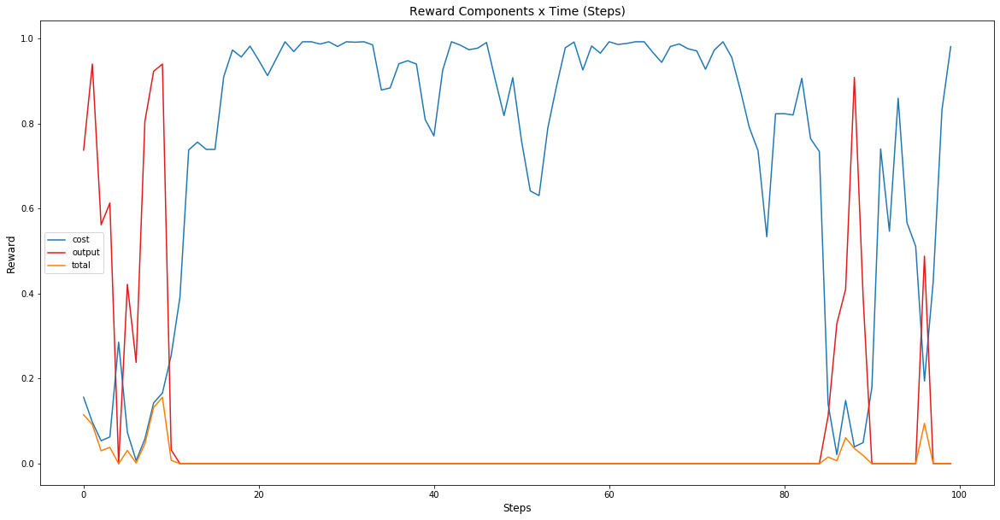

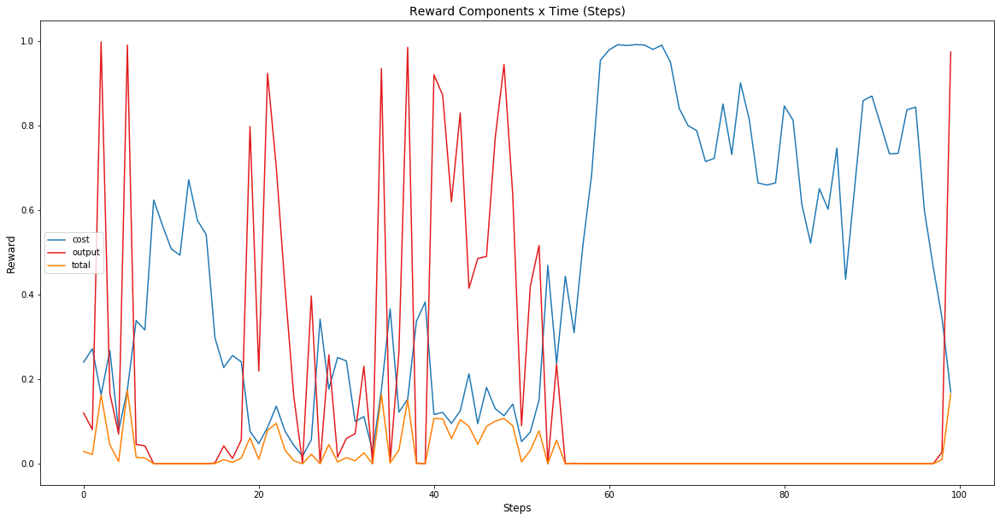

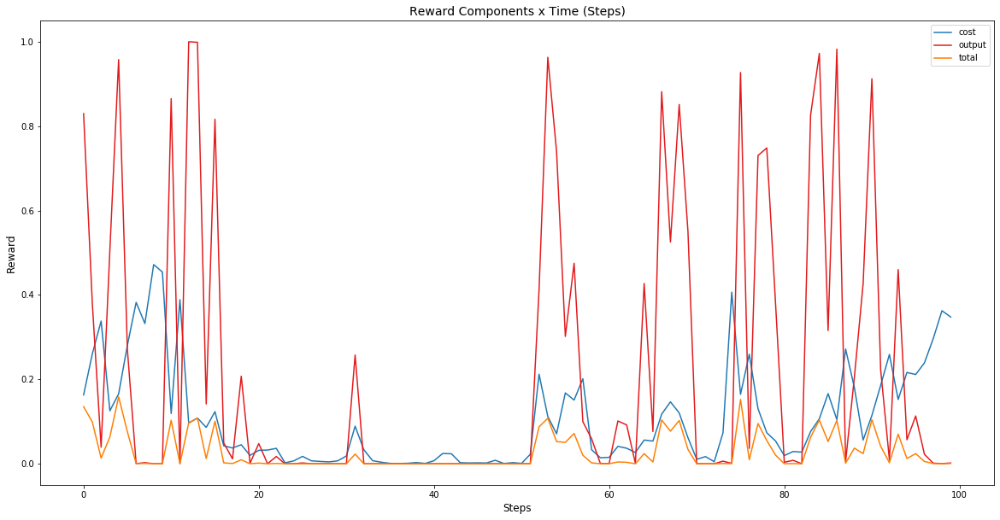

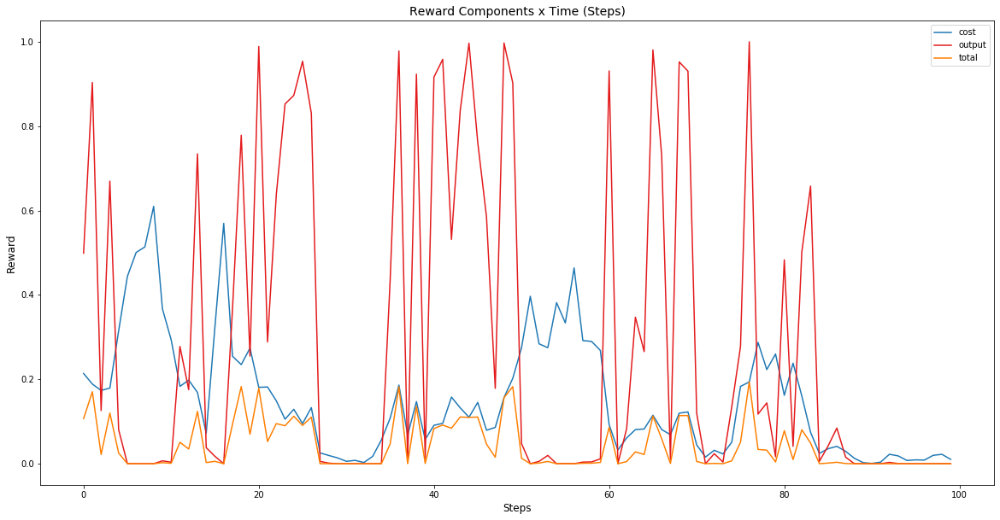

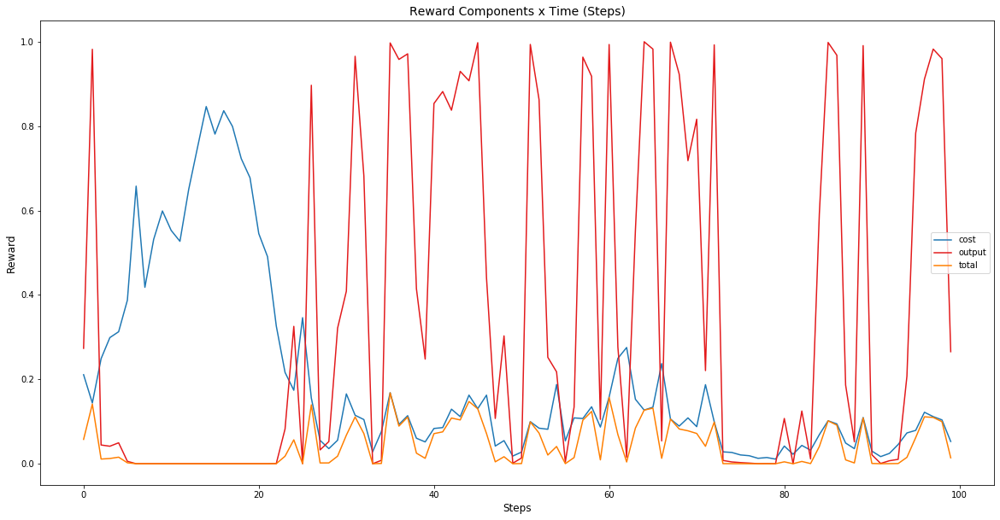

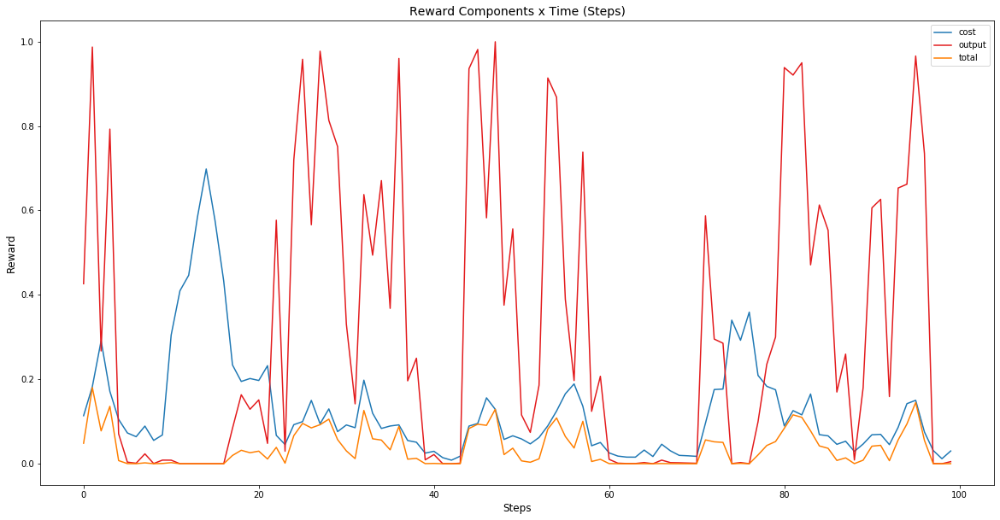

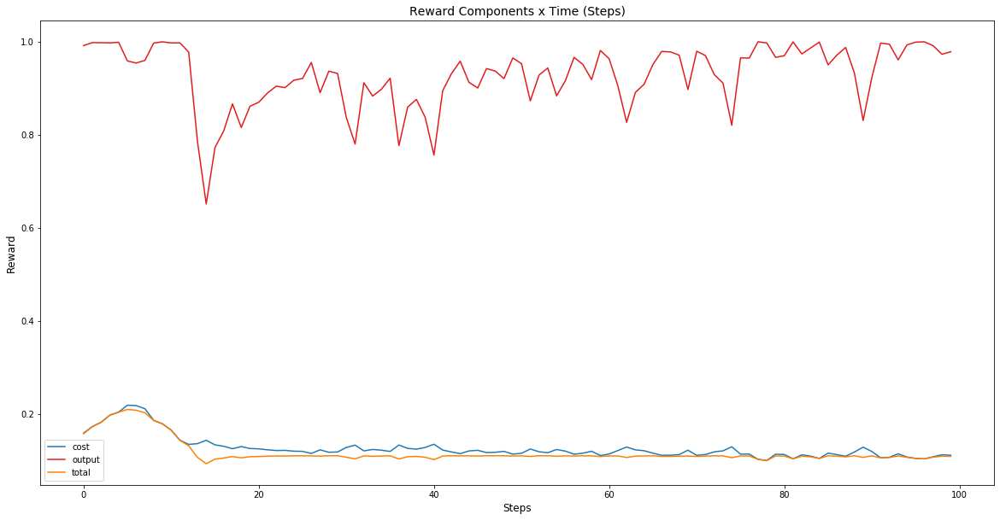

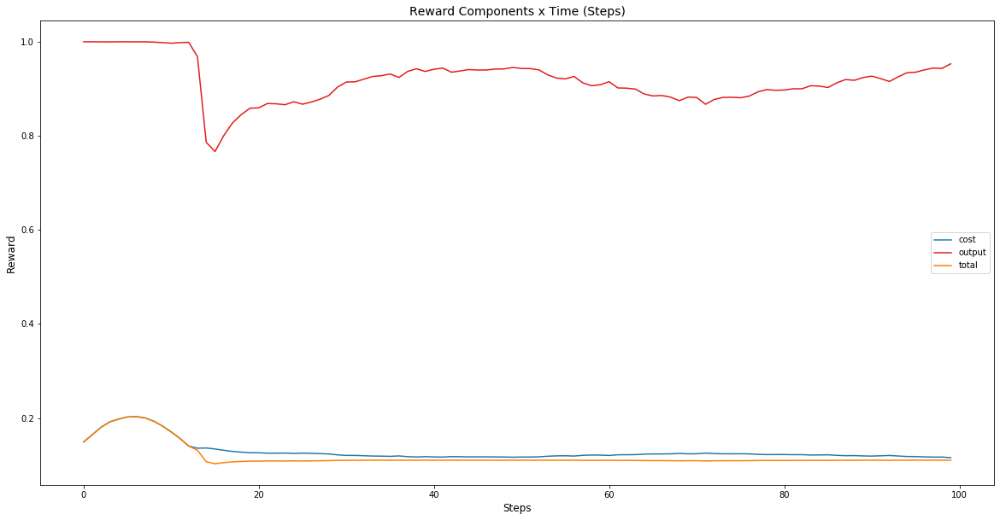

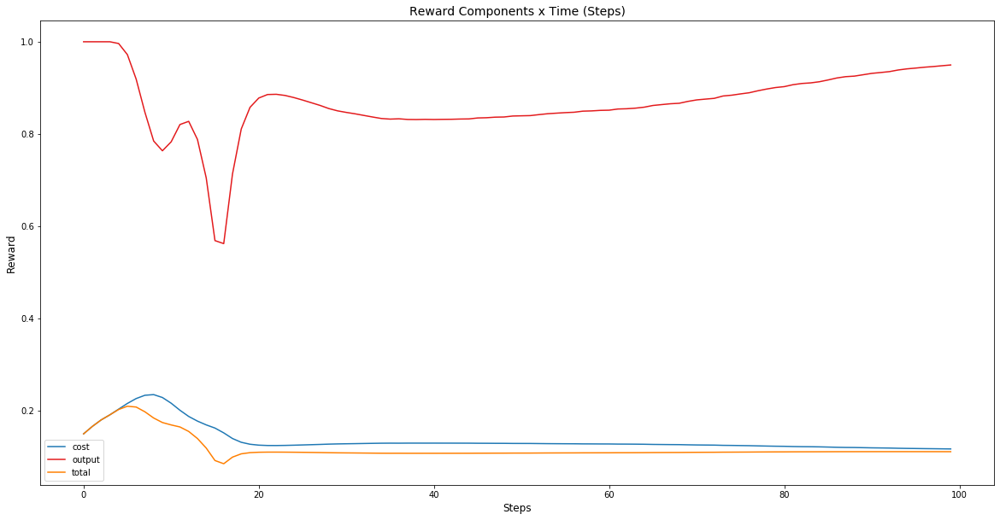

In [11]:
plotExperimentRewardProgression(LearningState().model.allRewards)

Plot the reward progression of the model testing

33.97909061354165

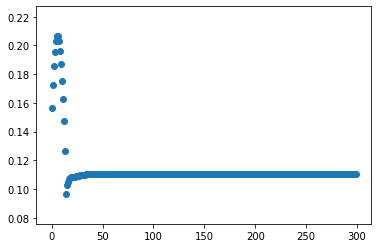

In [12]:
steps = range(STEPS_TO_TEST)
plt.scatter(steps, rewards)
sum(rewards)

Plot all graphs related to the electrical system state during the model testing

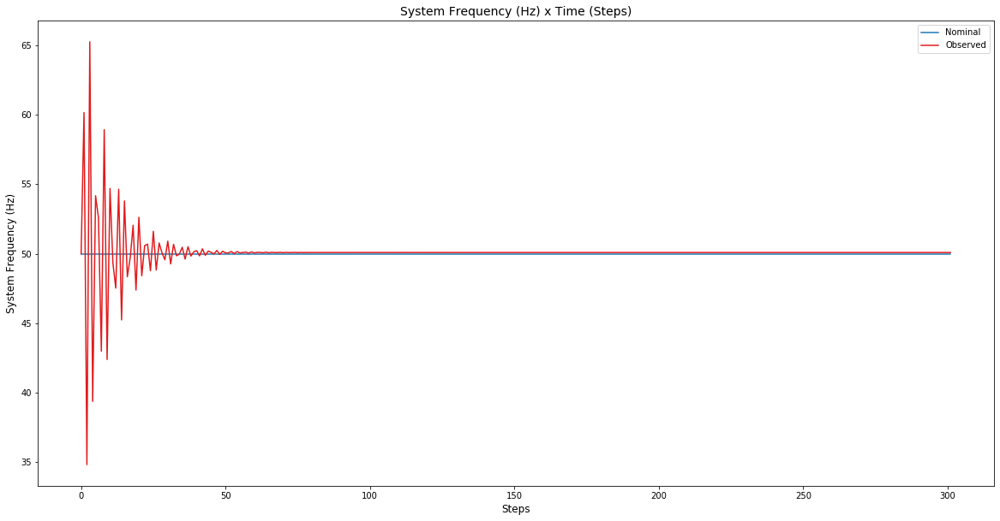

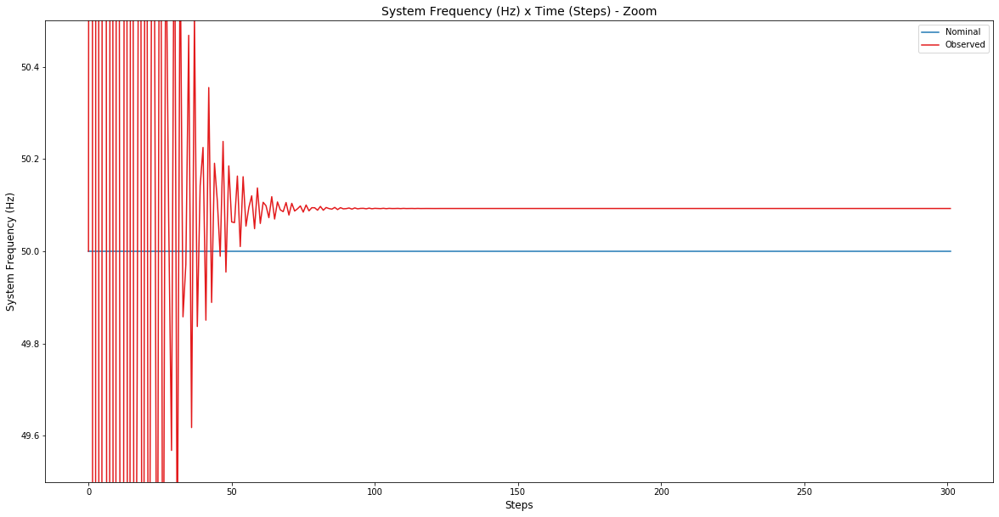

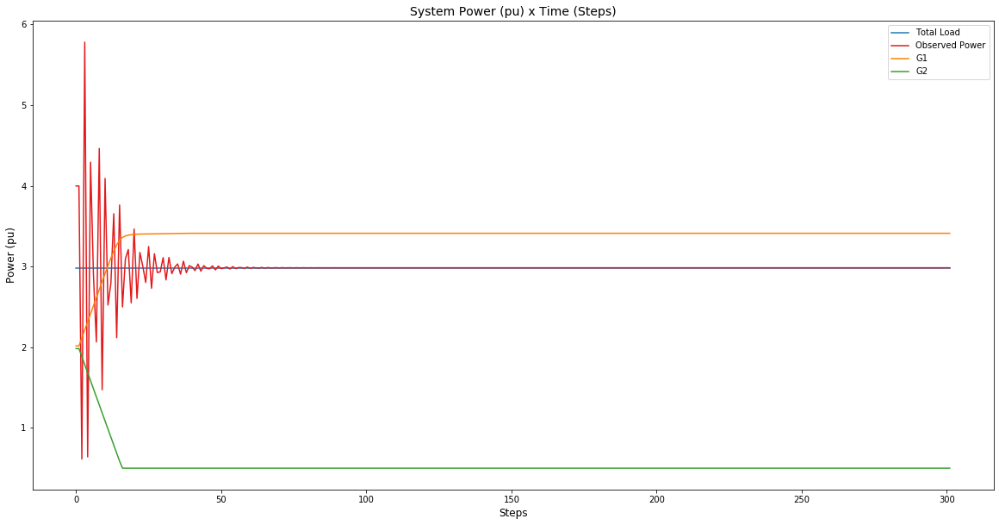

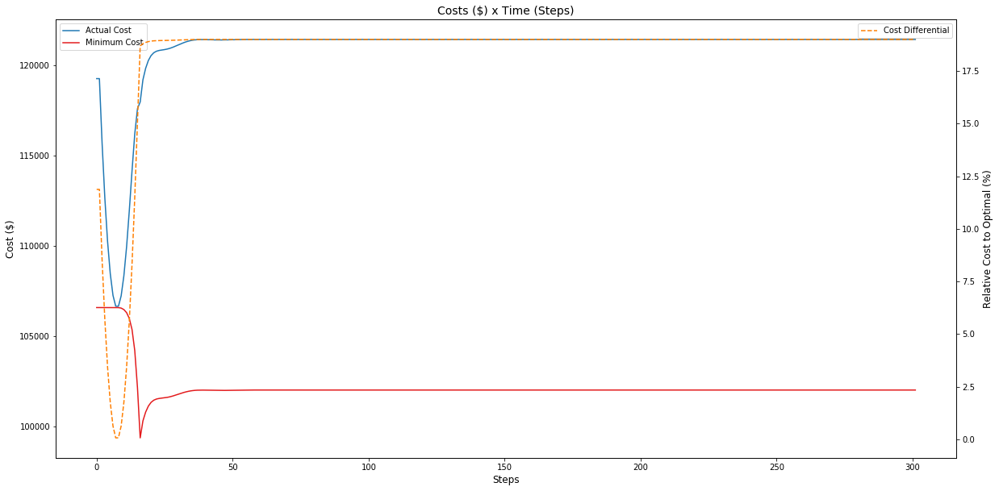

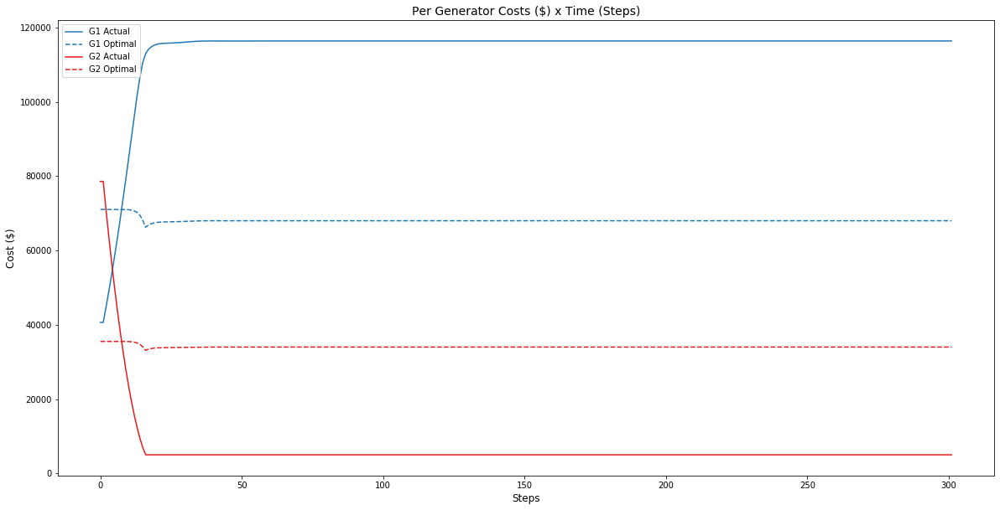

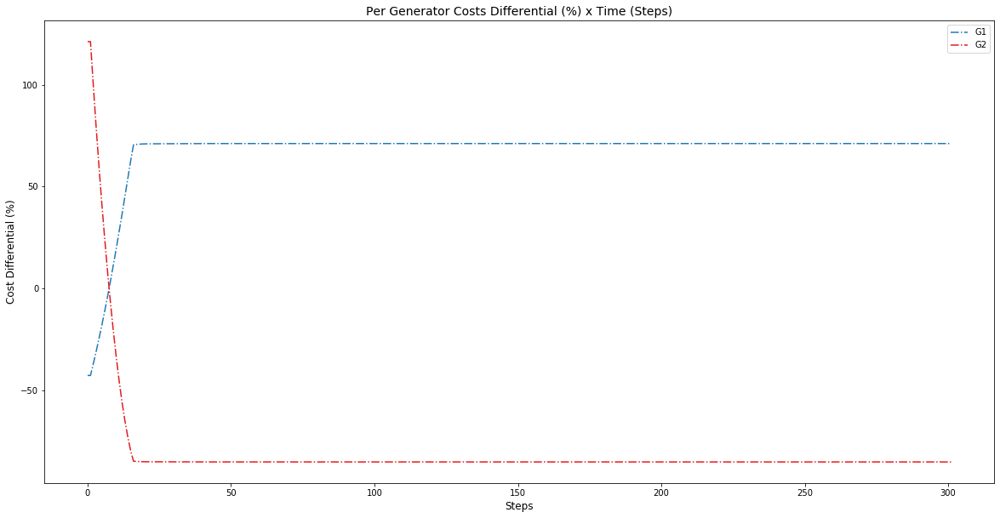

In [13]:
plotAll(electricalSystem.systemHistory)

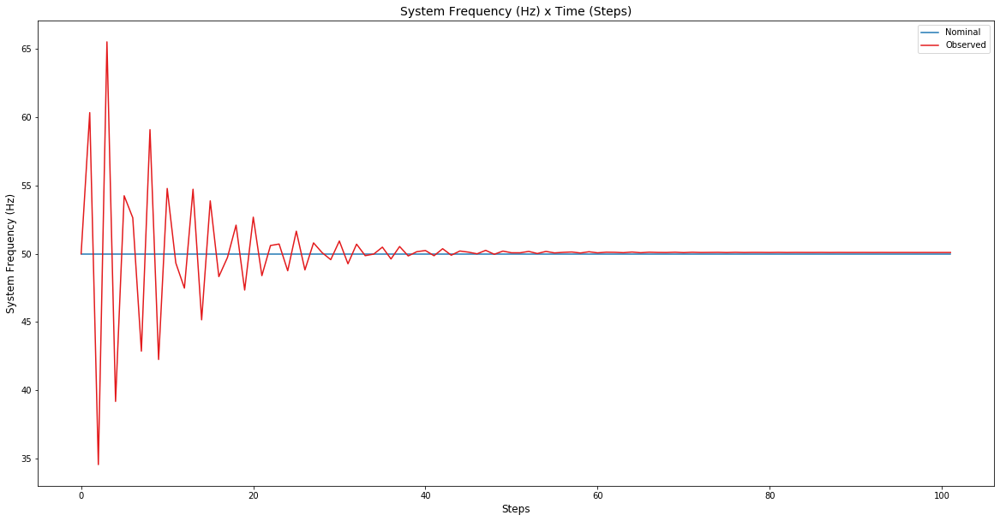

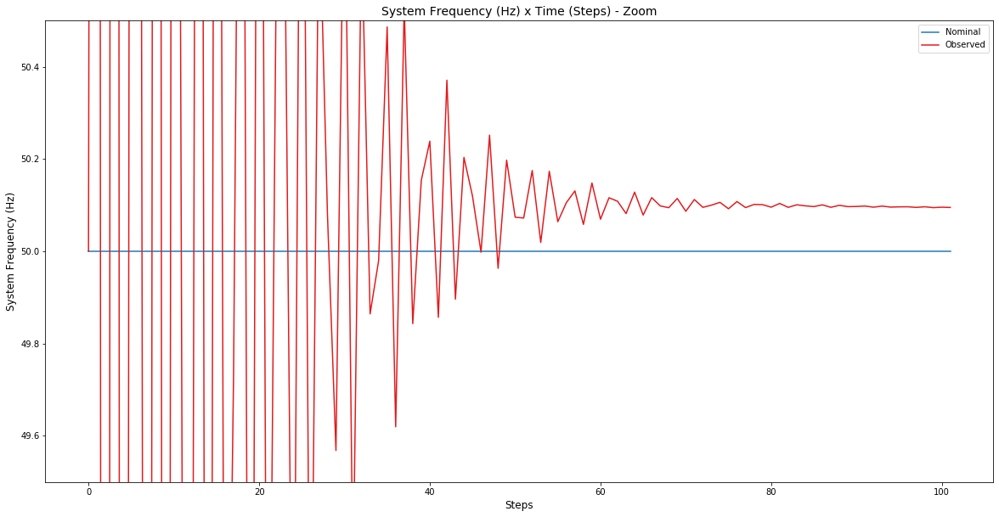

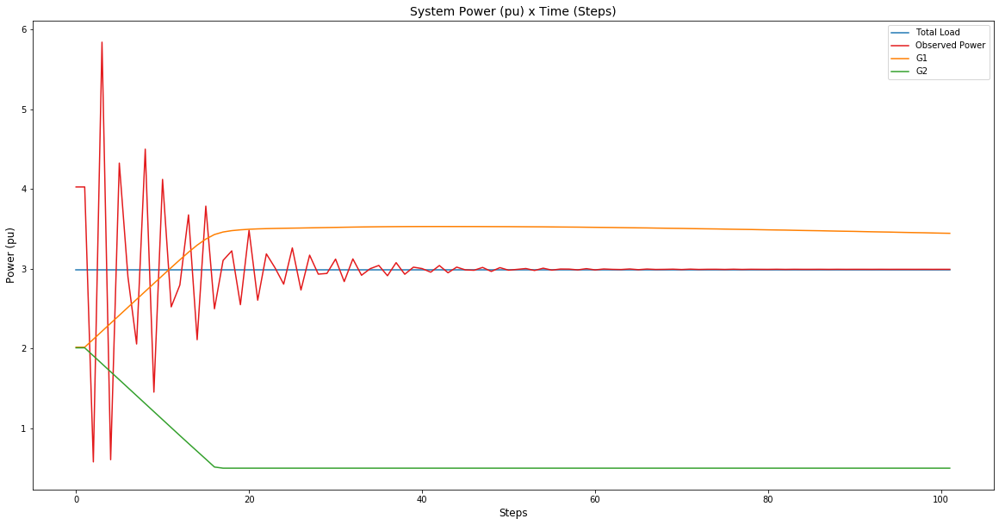

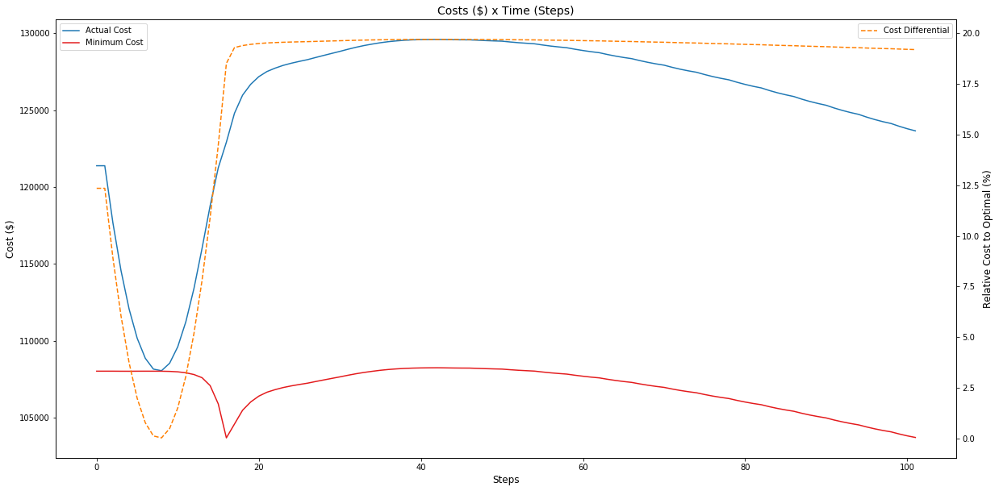

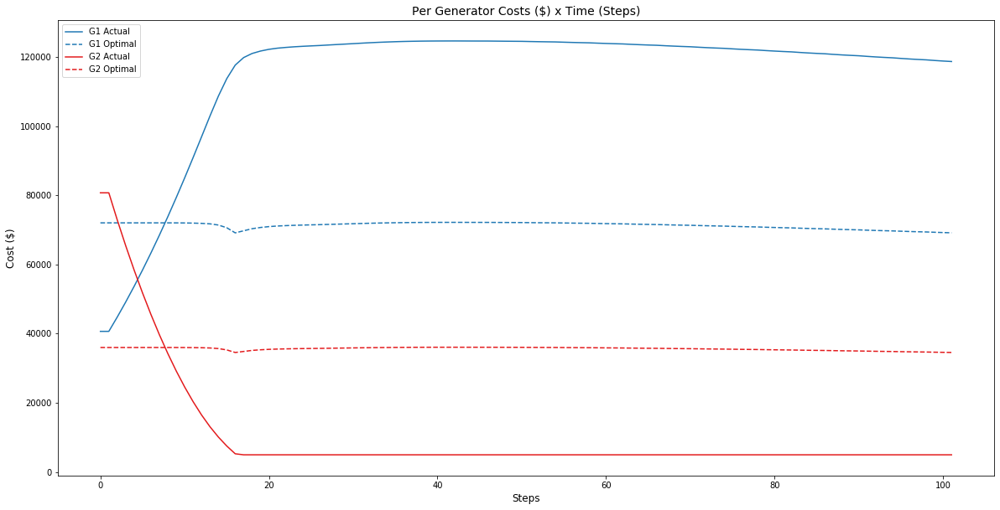

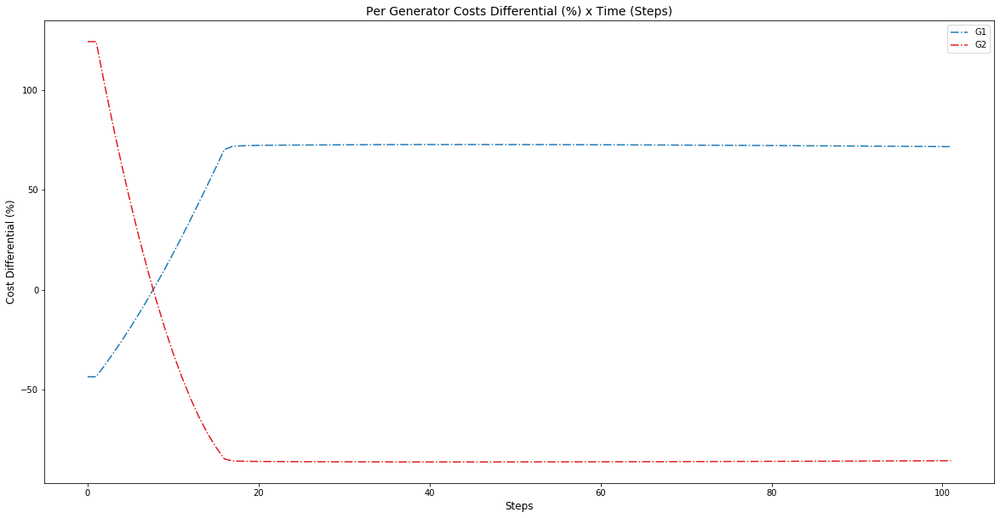

In [14]:
# # Show the last episode ran during training
from learning.learning_state import LearningState
plotAll(LearningState().episode.electricalSystem.systemHistory)

In [15]:
from learning.learning_state import LearningState
import numpy as np

rewList = LearningState().model.cummRewardList

In [16]:
LearningState().model.allRewards

[[{'cost': 0.1563460825166537,
   'output': 0.7375042897344101,
   'total': 0.11530590653920214},
  {'cost': 0.09769623254006411,
   'output': 0.9398041725414803,
   'total': 0.091815326982735},
  {'cost': 0.05404576815321593,
   'output': 0.5618680390377875,
   'total': 0.030366589770538337},
  {'cost': 0.06294370951422515,
   'output': 0.6129831071818874,
   'total': 0.03858343063558386},
  {'cost': 0.2858236429385346,
   'output': 4.772565143964931e-06,
   'total': 1.3641119556095281e-06},
  {'cost': 0.07369664149606342,
   'output': 0.42194062833251134,
   'total': 0.03109560721884483},
  {'cost': 0.00710867959362233,
   'output': 0.23830464619893044,
   'total': 0.0016940313754997259},
  {'cost': 0.05847286658882371,
   'output': 0.8054919973904077,
   'total': 0.04709942610177444},
  {'cost': 0.1432024326853267,
   'output': 0.922983586313767,
   'total': 0.13217349488875865},
  {'cost': 0.1661832066540154,
   'output': 0.9396906983229767,
   'total': 0.15616081351026329},
  {'co

TypeError: float() argument must be a string or a number, not 'dict'

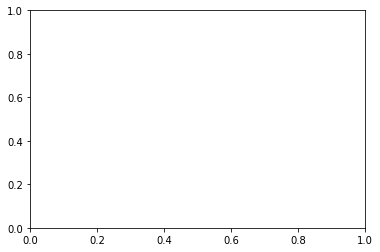

In [17]:
allRewards = LearningState().model.allRewards


for r in allRewards:
    plt.figure()
    plt.scatter(range(len(r)), r)
# sum(rewards)

In [ ]:
plt.scatter(range(len(rewList)), rewList)

In [ ]:
from plots.plot_constants import COLOR_PALETTE, FONT_SIZES

history = electricalSystem.systemHistory
# Get series to be plotted
stepsSeries = history.steps
loads = history.loads
totalLoadSeries = history.totalLoad
generators = history.generators
totalPowerSeries = history.totalPower

plt.figure(0)

# Declare colors to be used
colorTotalLoad = COLOR_PALETTE[0]
colorTotalPower = COLOR_PALETTE[1]
colorsIndividualNodes = COLOR_PALETTE[3:]

# Plot total power/load data
plt.plot(stepsSeries, totalLoadSeries, color=colorTotalLoad)
plt.plot(stepsSeries, totalPowerSeries, color=colorTotalPower)
legendFields = ['Total Load', 'Total Power']

# Multiple scenarios involve a single load, so we make it optional to plot that single load
if(False):
    for idx, loadId in enumerate(loads):
        # Since num loads is variable, colors may wrap around the palette
        loadColor = colorsIndividualNodes[idx % len(colorsIndividualNodes)]
        loadLegend = loadId
        loadSeries = loads[loadId]
        plt.plot(stepsSeries, loadSeries, color=loadColor, linestyle='--')
        legendFields.append(loadLegend)

for idx, generatorId in enumerate(generators):
    # Since num generators is variable, colors may wrap around the palette
    generatorColor = colorsIndividualNodes[idx % len(colorsIndividualNodes)]
    generatorLegend = generatorId
    generatorSeries = generators[generatorId]
    plt.plot(stepsSeries, generatorSeries, color=generatorColor)
    legendFields.append(generatorLegend)
    

summedPow = [x + y for x, y in zip(generators.get('G1'), generators.get('G2'))]
plt.plot(stepsSeries, summedPow, color=COLOR_PALETTE[2])
legendFields.append("Summed Pow")


plt.legend(legendFields)
plt.xlabel('Steps', fontsize=FONT_SIZES['AXIS_LABEL'])
plt.ylabel('Power (pu)', fontsize=FONT_SIZES['AXIS_LABEL'])

plt.title('System Power (pu) x Time (Steps)', fontsize=FONT_SIZES['TITLE'])

plt.show()